In [1]:
!pip install scikit-optimize
!pip install statsmodels

In [2]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from collections import Counter

import statsmodels.stats.api as sms
from matplotlib import style
style.use('seaborn')
%matplotlib inline
#graphs in svg look clearer
%config InlineBackend.figure_format = 'svg' 

In [3]:
import warnings
warnings.filterwarnings("ignore")

In [ ]:
test_mapping = {0: 'a8749d17-85fc-4ccf-ba56-75991c3a9da4',
1: '02eaefe0-296d-4e6f-b52f-2e2507d07103',
2: 'ee48def6-c311-4b73-a878-1a5d3d1679a3',
3: '9b202b16-55bf-418a-b01d-9f0329b18790',
4: '49a3d528-44c0-408e-b6fc-a1507ce7641a'}

# Functions

In [4]:
from sklearn import metrics

def mae(y_gt, Y_pr):
    return metrics.mean_absolute_error(y_gt, Y_pr)

def mse(y_gt, Y_pr):
    return metrics.mean_squared_error(y_gt, Y_pr)

def rmse(y_gt, Y_pr):
    my_mse = mse(y_gt, Y_pr)
    return np.sqrt(my_mse)

def medae(y_gt, Y_pr):
    return metrics.median_absolute_error(y_gt, Y_pr)

def R2(y_gt, Y_pr):
    return metrics.r2_score(y_gt, Y_pr)

def calc_metrics(true, pred):

    mse1 = mse(true, pred)

    rmse1 = rmse(true, pred)

    mae1 = mae(true, pred)

    medae1 = medae(true, pred)

    R21 = R2(true, pred)

    print('*** VAL **: ')
    print("MSE:   {}\nRMSE:  {}\nR2:    {}\nMAE:   {}\nMedAE: {}".format(mse1, rmse1, R21, mae1, medae1))
    print('-'*30)

In [5]:
def target_distr_linear(train_label, test_label, predicted_dv): 
    sns.kdeplot(train_label, label='train')
    sns.kdeplot(test_label, label='test')
    sns.kdeplot(predicted_dv, label='pred')
    plt.legend()
    plt.show()

    sns.scatterplot(test_label, predicted_dv, color='blueviolet')
    plt.title('Linear model')
    plt.xlabel('True Values')
    plt.ylabel('Predictions')
    plt.show()

In [6]:
from scipy.stats import norm

def draw_histogram(data):
    f,ax_hist = plt.subplots(1)
    sns.distplot(data, hist=True,  kde=True, rug=True, bins=10, fit=norm, ax=ax_hist);
    plt.xlabel("values")
    plt.title("Distribution") 

    mean=data.mean()

    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()

    plt.show()

In [7]:
def draw_res_analys(errors, pred):
    sns.scatterplot(list(range(len(errors))),errors);
    plt.title("Distibution of errors")
    plt.ylabel('Error');
    plt.xlabel('Index');
    plt.show();

    sns.scatterplot(pred,errors);
    plt.title('Relationship of true value vs error (resudual analysis)')
    plt.ylabel('Error');
    plt.xlabel('True value');
    plt.show();

In [8]:
def get_feature_imp(model, X_train):
    imp = model.get_feature_importance(data=X_train)
    fig, axes = plt.subplots(1, 1, figsize=(12, 8))
    axes.barh(width=imp, y=model.feature_names_)
    axes.set_title('Finetuned Catboost feature importance')
    plt.show()

# Unhashing

In [133]:
genre_mapping = {'0ef0aa70-f86c-4141-8054-8b39af97867d': 'Biography',
                '287a1485-7a88-4c2f-bc94-ca418b6c47a1': 'Cartoons',
                '66fad8c3-d84f-458d-a8bf-5b4f154969e0': 'Show',
                '7b7c97f6-1adb-4b43-bfe8-9455812fac0b': 'Theater',
                '9fa28b61-a257-4a3e-945b-a9ef76a146d6': 'Fantasy',
                'b0836a1d-635f-4d89-bcc5-25d10ba56642': 'Anime',
                'd7214feb-8c11-4aea-aabb-ac98a8d56fd5': 'History',
                'dc65dbc8-34ba-4df1-b32c-4f895e10bff8': 'Shorts',
                'eb001d27-5be3-4d42-9d88-90d593f2627d': 'War_movies',
                '364fdc2e-bdfe-40be-b2c5-d30f43ec432e': 'Crime',
                '1f22ccf1-288a-4e6e-b39a-7502799e7125': 'Лекции',
                '6d640e04-be3a-4c8c-852e-4e9b12449d5d': 'Концерты',
                '7b7c97f6-1adb-4b43-bfe8-9455812fac0b': 'Театр',
                '2f7908cc-e2fd-43cf-b626-ec1aef436160': 'Курсы'}

In [156]:
import pickle

with open('./NEW_OKKO_KINOP_parsed_ratings_df.pkl', 'rb') as f:
    df = pickle.load(f, encoding='utf-8')

In [157]:
df.shape

(10731, 27)

In [158]:
df.shape

(10731, 27)

In [159]:
all_genres = []

for item_genres in df['genre']:
    all_genres.extend(item_genres)

In [160]:
all_unique_genres = set(all_genres)

In [161]:
len(all_unique_genres)

33

In [162]:
all_unique_genres

{'0ef0aa70-f86c-4141-8054-8b39af97867d',
 '1f22ccf1-288a-4e6e-b39a-7502799e7125',
 '287a1485-7a88-4c2f-bc94-ca418b6c47a1',
 '364fdc2e-bdfe-40be-b2c5-d30f43ec432e',
 '3e6e08b4-2bb0-46d6-aee7-98780e394c86',
 '5743ecbe-a141-47d6-a7d7-e800f41cb6f5',
 '5c403894-146a-47a4-ae75-9f1956a30dbb',
 '66fad8c3-d84f-458d-a8bf-5b4f154969e0',
 '6d640e04-be3a-4c8c-852e-4e9b12449d5d',
 '7b7c97f6-1adb-4b43-bfe8-9455812fac0b',
 '9fa28b61-a257-4a3e-945b-a9ef76a146d6',
 'Action',
 'Adventure',
 'ArtHouse',
 'Comedy',
 'Detective',
 'Documentary',
 'Drama',
 'Family',
 'ForKids',
 'Horror',
 'Humor',
 'Melodrama',
 'Music',
 'Sci-Fi',
 'Sport',
 'Thriller',
 'Travel',
 'b0836a1d-635f-4d89-bcc5-25d10ba56642',
 'd7214feb-8c11-4aea-aabb-ac98a8d56fd5',
 'd7f6b51c-6ebe-4b9c-9aad-2c60792a7d9c',
 'dc65dbc8-34ba-4df1-b32c-4f895e10bff8',
 'eb001d27-5be3-4d42-9d88-90d593f2627d'}

In [163]:
decoded_genres = [genre_mapping.get(genre, genre) for genre in all_unique_genres]

In [164]:
decoded_genres

['Лекции',
 'ForKids',
 'Comedy',
 '3e6e08b4-2bb0-46d6-aee7-98780e394c86',
 'd7f6b51c-6ebe-4b9c-9aad-2c60792a7d9c',
 'ArtHouse',
 'Biography',
 'Travel',
 'Fantasy',
 'Театр',
 'Melodrama',
 '5743ecbe-a141-47d6-a7d7-e800f41cb6f5',
 'Sci-Fi',
 'Shorts',
 'Концерты',
 'Action',
 'Family',
 'Adventure',
 '5c403894-146a-47a4-ae75-9f1956a30dbb',
 'Detective',
 'History',
 'Cartoons',
 'Music',
 'Show',
 'Drama',
 'Horror',
 'Anime',
 'Documentary',
 'War_movies',
 'Humor',
 'Thriller',
 'Sport',
 'Crime']

# Preprocessing

In [289]:
prep_df = df.copy(deep=True)

In [179]:
prep_df.shape

(10731, 27)

In [180]:
prep_df.isna().sum()

age_access_type        0
name                   0
director               3
genre                  0
average_rating       459
type                   0
country                0
release_type           0
release_year           0
duration               0
actor                  0
element_uid            0
ACTOR                211
COMPOSER            1390
DESIGN              1488
DIRECTOR             152
EDITOR              1896
OPERATOR            1479
PRODUCER            1193
WRITER               339
BUDGET              7432
MARKETING          10478
RUS                 7101
USA                 7082
WORLD               5434
element_id             0
rating                 0
dtype: int64

In [181]:
# prep_df.dropna(subset=['director', 'actor'], inplace=True)

### filter by year

In [290]:
prep_df = prep_df[prep_df['release_year'] >= 2000]

In [226]:
prep_df.shape

(8667, 27)

In [227]:
prep_df.isna().sum()

age_access_type       0
name                  0
director              0
genre                 0
average_rating      443
type                  0
country               0
release_type          0
release_year          0
duration              0
actor                 0
element_uid           0
ACTOR               201
COMPOSER           1280
DESIGN             1397
DIRECTOR            147
EDITOR             1575
OPERATOR           1375
PRODUCER            412
WRITER              328
BUDGET             6107
MARKETING          8438
RUS                5134
USA                5844
WORLD              4238
element_id            0
rating                0
dtype: int64

### topN

In [291]:
cols_nanes = ['ACTOR', 'COMPOSER', 'DESIGN', 'DIRECTOR', 'EDITOR', 'OPERATOR', 'PRODUCER', 'WRITER']  

for col in cols_nanes:

    prep_df[col] = prep_df[col].apply(lambda d: d if not isinstance(d, float) else ['0'])



In [255]:
prep_df.shape

(8667, 27)

In [257]:
prep_df.isna().sum()

age_access_type       0
name                  0
director              0
genre                 0
average_rating      443
type                  0
country               0
release_type          0
release_year          0
duration              0
actor                 0
element_uid           0
ACTOR                 0
COMPOSER              0
DESIGN                0
DIRECTOR              0
EDITOR                0
OPERATOR              0
PRODUCER              0
WRITER                0
BUDGET             6107
MARKETING          8438
RUS                5134
USA                5844
WORLD              4238
element_id            0
rating                0
dtype: int64

In [292]:
def add_topN_feature(df, col, n: int):
    items = []
    
    for i in df[col]:
        items.extend(i)

    topN = [x[0] for x in Counter(items).most_common()][:n+1]
    if '0' in topN:
        topN.remove('0')

    df[f'top{n}{col}'] = df[col].apply(lambda x: [int(item in x) for item in topN])
    df.drop(col, axis=1, inplace=True)
    return topN, f'top{n}{col}'

In [293]:
def ohe_topN_features(df, topN, cat):
    for i in range(len(topN)):
        df[f'{topN[i]}'] = [item[i] for item in df[cat]]
    df.drop(cat, axis=1, inplace=True)
    return df

In [294]:
prep_df.columns

Index(['age_access_type', 'name', 'director', 'genre', 'average_rating',
       'type', 'country', 'release_type', 'release_year', 'duration', 'actor',
       'element_uid', 'ACTOR', 'COMPOSER', 'DESIGN', 'DIRECTOR', 'EDITOR',
       'OPERATOR', 'PRODUCER', 'WRITER', 'BUDGET', 'MARKETING', 'RUS', 'USA',
       'WORLD', 'element_id', 'rating'],
      dtype='object')

In [295]:
top10genres, name = add_topN_feature(prep_df, 'genre', 10)
prep_df = ohe_topN_features(prep_df, top10genres, name)

top5countries, name = add_topN_feature(prep_df, 'country', 5)
prep_df = ohe_topN_features(prep_df, top5countries, name)

top10actors, name = add_topN_feature(prep_df, 'ACTOR', 10)
prep_df = ohe_topN_features(prep_df, top10actors, name)

top3directors, name = add_topN_feature(prep_df, 'COMPOSER', 3)
prep_df = ohe_topN_features(prep_df, top3directors, name)

top2DESIGN, name = add_topN_feature(prep_df, 'DESIGN', 2)
prep_df = ohe_topN_features(prep_df, top2DESIGN, name)

top2DIRECTOR, name = add_topN_feature(prep_df, 'DIRECTOR', 2)
prep_df = ohe_topN_features(prep_df, top2DIRECTOR, name)

top2EDITOR, name = add_topN_feature(prep_df, 'EDITOR', 2)
prep_df = ohe_topN_features(prep_df, top2EDITOR, name)

top2OPERATOR, name = add_topN_feature(prep_df, 'OPERATOR', 2)
prep_df = ohe_topN_features(prep_df, top2OPERATOR, name)

top3PRODUCER, name = add_topN_feature(prep_df, 'PRODUCER', 3)
prep_df = ohe_topN_features(prep_df, top3PRODUCER, name)

top2WRITER, name = add_topN_feature(prep_df, 'WRITER', 2)
prep_df = ohe_topN_features(prep_df, top2WRITER, name)

In [296]:
prep_df.head().T

,2,3,4,5,6
age_access_type,18,18,18,6,16
name,В поисках древнего артефакта,Прожарка Чарли Шина,Прожарка Уильяма Шэтнера,Пламенное сердце,Роман с кукушкой
director,[895f5774-964a-4c5a-ae22-d697d3e3e620],[1de22aff-430e-4af9-bf1d-159dbf8e9269],[1de22aff-430e-4af9-bf1d-159dbf8e9269],"[40f78e6d-3c9f-434f-a505-c6ffdd045763, 332105c...",[f5fba6fe-94b3-4e69-acfc-da6867320386]
average_rating,4.0,6.99,6.0,6.4,NaN
type,MOVIE,MOVIE,MOVIE,MOVIE,MOVIE
release_type,RELEASE,RELEASE,RELEASE,RELEASE,RELEASE
release_year,2019,2011,2006,2022,2021
duration,6000000.0,3780000.0,3780000.0,5520000.0,5280000.0
actor,"[cff3362f-ad91-498d-80b3-ea3ab8ec65cf, bcad17e...","[cff3362f-ad91-498d-80b3-ea3ab8ec65cf, 30dd19c...","[cff3362f-ad91-498d-80b3-ea3ab8ec65cf, a805fdd...","[cff3362f-ad91-498d-80b3-ea3ab8ec65cf, 873fd46...","[cff3362f-ad91-498d-80b3-ea3ab8ec65cf, 39124be..."
element_uid,11ba66db-e941-4c3a-8da6-d8900e56f8c7,3f30a2ef-53b7-40e3-954f-1bdfc38a6d17,cdfa700f-122d-41e5-b8dc-9c6813bab6d2,ba6bec1a-3aa9-48c7-aa65-908c21627a12,a367ca50-ef7d-4a4c-b89a-c8692defa697


In [270]:
prep_df.columns

Index(['age_access_type', 'name', 'director', 'average_rating', 'type',
       'release_type', 'release_year', 'duration', 'actor', 'element_uid',
       'BUDGET', 'MARKETING', 'RUS', 'USA', 'WORLD', 'element_id', 'rating',
       'Drama', 'Comedy', 'Thriller', 'Action', 'Melodrama',
       '287a1485-7a88-4c2f-bc94-ca418b6c47a1', 'Adventure',
       '364fdc2e-bdfe-40be-b2c5-d30f43ec432e', 'Family', 'Sci-Fi', 'Horror',
       'usa', 'russia', 'great-britain', 'france', 'germany', 'canada',
       'Ди Брэдли Бейкер', 'Фред Таташиор', 'Бернард Коллако',
       'Роджер Бреннер', 'Джим Каммингс', 'Кевин Майкл Ричардсон',
       'Джефф Беннетт', 'Марк Фальво', 'Крис Уилсон', 'Грэй Гриффин',
       'Джон Дебни', 'Марко Белтрами', 'Кристоф Бек', 'Оливье Берио',
       'Уолтер П. Мартишиус', 'Рон Айзек', 'Дэниэл Эттиэс', 'Крис Гилл',
       'Ольга Прошкина', 'Степан Коваленко', 'Джим Дено', 'Влад Ряшин',
       'Родион Павлючик', 'Харви Вайнштейн', 'Стэн Ли', 'Джек Кёрби'],
      dtype='object'

In [297]:
cols = ['age_access_type', 'name', 'type',
       'release_year', 'duration', 'element_uid',
       'BUDGET', 'MARKETING', 'RUS', 'USA', 'WORLD', 'rating',
       'Drama', 'Comedy', 'Thriller', 'Action', 'Melodrama',
       '287a1485-7a88-4c2f-bc94-ca418b6c47a1', 'Adventure',
       '364fdc2e-bdfe-40be-b2c5-d30f43ec432e', 'Family', 'Sci-Fi', 'Horror',
       'usa', 'russia', 'great-britain', 'france', 'germany', 'canada',
       'Ди Брэдли Бейкер', 'Фред Таташиор', 'Бернард Коллако',
       'Роджер Бреннер', 'Джим Каммингс', 'Кевин Майкл Ричардсон',
       'Джефф Беннетт', 'Марк Фальво', 'Крис Уилсон', 'Грэй Гриффин',
       'Джон Дебни', 'Марко Белтрами', 'Кристоф Бек', 'Оливье Берио',
       'Уолтер П. Мартишиус', 'Рон Айзек', 'Дэниэл Эттиэс', 'Крис Гилл',
       'Ольга Прошкина', 'Степан Коваленко', 'Джим Дено', 'Влад Ряшин',
       'Родион Павлючик', 'Харви Вайнштейн', 'Стэн Ли', 'Джек Кёрби']

In [298]:
prep_df = prep_df[cols]

In [299]:
skewed_num_features = ['duration', 'BUDGET', 'MARKETING', 'RUS', 'USA', 'WORLD',] # can try 'average_rating'

In [300]:
from collections import Counter
from sklearn.feature_extraction.text import TfidfVectorizer
import numpy as np
from sklearn.model_selection import train_test_split
import pandas as pd

class Preprocesser:
    def __init__(self, 
#                 mulpiple_cat_features: list,
                skewed_num_features: list,
               # text_features: list,
               # release_year_feature: str,
#                 mltpl_cat_n_top: dict
                ):
#         self.mulpiple_cat_features = mulpiple_cat_features
        self.skewed_num_features = skewed_num_features
        #self.text_features = text_features
#         self.mltpl_cat_n_top = mltpl_cat_n_top
       # self.release_year_feature = release_year_feature
        # self.tokenizer = Tokenizer(nlp.vocab)
        
    def __get_top_n_mltpl_cat_features(self, df_pr, col):
        all_cats = []
        for element_values in df_pr[col]:
            all_cats.extend(element_values)
        return Counter(all_cats).most_common(self.mltpl_cat_n_top[col])
            
    def __preprocess_mulpiple_cat_features(self, df_pr):
        for col in self.mulpiple_cat_features:
            feature_number = self.mltpl_cat_n_top[col]
            df_pr[[f'{col}_{i}' for i in range(feature_number)]] = pd.DataFrame(np.full((len(df), feature_number), np.nan))
            for i in df_pr.index:
                names = df_pr.loc[i, col]
                for k, name in enumerate(names[:int(feature_number)]):
                    df_pr.loc[i, f'{col}_{k}'] = name
            df_pr.drop(col, axis=1, inplace=True)

        return df_pr
    
    def __preprocess_skewed_num_features(self, df_pr):
        for col in self.skewed_num_features:
            df_pr[col] = df_pr[col].apply(lambda x: np.log1p(x))
        return df_pr
    
    def __preprocess_text_features(self, df_pr):
        for col in self.text_features:
            df_pr[col] = df_pr[col].apply(lambda x: self.tokenizer(x))
        return df_pr
            
    def preprocess(self,
                   df: pd.DataFrame):
        df_pr = df.copy()
#         df_pr = self.__preprocess_mulpiple_cat_features(df_pr)
        df_pr = self.__preprocess_skewed_num_features(df_pr)
        # df_pr = self.__preprocess_text_features(df_pr)
        
        return df_pr
        

In [301]:
preprocesser = Preprocesser(
#     mltpl_cat_features,
            skewed_num_features,
            #text_features,
#             mltpl_cat_n_top
                           )

In [302]:
df_pr = preprocesser.preprocess(prep_df)

In [303]:
df_pr.isnull().sum()

age_access_type                            0
name                                       0
type                                       0
release_year                               0
duration                                   0
element_uid                                0
BUDGET                                  6107
MARKETING                               8438
RUS                                     5134
USA                                     5844
WORLD                                   4238
rating                                     0
Drama                                      0
Comedy                                     0
Thriller                                   0
Action                                     0
Melodrama                                  0
287a1485-7a88-4c2f-bc94-ca418b6c47a1       0
Adventure                                  0
364fdc2e-bdfe-40be-b2c5-d30f43ec432e       0
Family                                     0
Sci-Fi                                     0
Horror    

### target destr

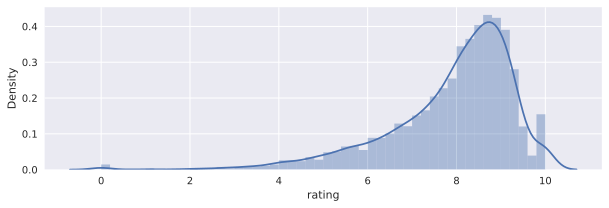

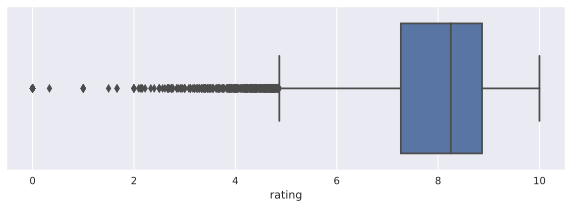

In [279]:
plt.figure(figsize=(10, 3))
sns.distplot(df_pr['rating'])
plt.show()

plt.figure(figsize=(10, 3))
sns.boxplot(df_pr['rating'], orient='h')
plt.show()

### Look at 5 movies for demo

* Чикатило ee48def6-c311-4b73-a878-1a5d3d1679a3,
* Манюня 9b202b16-55bf-418a-b01d-9f0329b18790,
* Оффлайн 49a3d528-44c0-408e-b6fc-a1507ce7641a
* Молодой человек 0271c9b5-b7b2-4e3f-96af-b9cefed99397
* Приплыли! 02eaefe0-296d-4e6f-b52f-2e2507d07103

In [304]:
demo_df = df_pr.loc[df_pr['element_uid'].isin(['ee48def6-c311-4b73-a878-1a5d3d1679a3', 
                                    '9b202b16-55bf-418a-b01d-9f0329b18790',
                                    '49a3d528-44c0-408e-b6fc-a1507ce7641a',
                                    '0271c9b5-b7b2-4e3f-96af-b9cefed99397',
                                    '02eaefe0-296d-4e6f-b52f-2e2507d07103'])]

In [307]:
ddf = demo_df.copy()

In [308]:
ddf.drop(['release_year', 'element_uid', 'name'], axis=1, inplace=True)

In [309]:
ddf.T

,6469,6550,9998,10433,10608
age_access_type,16,18,18,6,18
type,MOVIE,MOVIE,SERIAL,SERIAL,SERIAL
duration,15.70258,15.479437,17.723526,16.269958,17.218706
BUDGET,NaN,NaN,NaN,NaN,NaN
MARKETING,NaN,NaN,NaN,NaN,NaN
RUS,NaN,12.593543,NaN,NaN,NaN
USA,NaN,NaN,NaN,NaN,NaN
WORLD,NaN,NaN,NaN,NaN,NaN
rating,9.147352,6.519242,9.717041,9.192744,9.362527
Drama,0,0,1,0,1


## Split

In [310]:
df_pr.columns

Index(['age_access_type', 'name', 'type', 'release_year', 'duration',
       'element_uid', 'BUDGET', 'MARKETING', 'RUS', 'USA', 'WORLD', 'rating',
       'Drama', 'Comedy', 'Thriller', 'Action', 'Melodrama',
       '287a1485-7a88-4c2f-bc94-ca418b6c47a1', 'Adventure',
       '364fdc2e-bdfe-40be-b2c5-d30f43ec432e', 'Family', 'Sci-Fi', 'Horror',
       'usa', 'russia', 'great-britain', 'france', 'germany', 'canada',
       'Ди Брэдли Бейкер', 'Фред Таташиор', 'Бернард Коллако',
       'Роджер Бреннер', 'Джим Каммингс', 'Кевин Майкл Ричардсон',
       'Джефф Беннетт', 'Марк Фальво', 'Крис Уилсон', 'Грэй Гриффин',
       'Джон Дебни', 'Марко Белтрами', 'Кристоф Бек', 'Оливье Берио',
       'Уолтер П. Мартишиус', 'Рон Айзек', 'Дэниэл Эттиэс', 'Крис Гилл',
       'Ольга Прошкина', 'Степан Коваленко', 'Джим Дено', 'Влад Ряшин',
       'Родион Павлючик', 'Харви Вайнштейн', 'Стэн Ли', 'Джек Кёрби'],
      dtype='object')

In [311]:
from sklearn.model_selection import train_test_split

sorted_df = df_pr.sort_values('release_year')

test = sorted_df[sorted_df['release_year'] == 2022]
train = sorted_df[sorted_df['release_year'] != 2022]

# for looking at samples
test_df = test.copy(deep=True)
train_df = train.copy(deep=True)

test.drop(['release_year', 'element_uid', 'name'], axis=1, inplace=True)
train.drop(['release_year', 'element_uid', 'name'], axis=1, inplace=True)

X_test, y_test = test.drop('rating', axis=1), test['rating']
X, y = train.drop('rating', axis=1), train['rating']
X_train, X_val, y_train, y_val = train_test_split(X, y,
                                                  test_size=0.1, 
                                                  shuffle=False)
X_train.shape, X_val.shape, X_test.shape, y_train.shape, y_val.shape, y_test.shape


((7663, 51), (852, 51), (152, 51), (7663,), (852,), (152,))

In [312]:
X_train.columns

Index(['age_access_type', 'type', 'duration', 'BUDGET', 'MARKETING', 'RUS',
       'USA', 'WORLD', 'Drama', 'Comedy', 'Thriller', 'Action', 'Melodrama',
       '287a1485-7a88-4c2f-bc94-ca418b6c47a1', 'Adventure',
       '364fdc2e-bdfe-40be-b2c5-d30f43ec432e', 'Family', 'Sci-Fi', 'Horror',
       'usa', 'russia', 'great-britain', 'france', 'germany', 'canada',
       'Ди Брэдли Бейкер', 'Фред Таташиор', 'Бернард Коллако',
       'Роджер Бреннер', 'Джим Каммингс', 'Кевин Майкл Ричардсон',
       'Джефф Беннетт', 'Марк Фальво', 'Крис Уилсон', 'Грэй Гриффин',
       'Джон Дебни', 'Марко Белтрами', 'Кристоф Бек', 'Оливье Берио',
       'Уолтер П. Мартишиус', 'Рон Айзек', 'Дэниэл Эттиэс', 'Крис Гилл',
       'Ольга Прошкина', 'Степан Коваленко', 'Джим Дено', 'Влад Ряшин',
       'Родион Павлючик', 'Харви Вайнштейн', 'Стэн Ли', 'Джек Кёрби'],
      dtype='object')

In [313]:
cat_features = ['age_access_type', 'type']

# Modeling

In [314]:
import catboost as cat
from catboost import CatBoostRegressor
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV

from scipy.stats import uniform, randint

In [315]:
train_dataset = cat.Pool(data=X_train,
                        label=y_train,
                         cat_features=cat_features)

test_dataset = cat.Pool(data=X_test, 
                        label=y_test,
                         cat_features=cat_features)

val_dataset = cat.Pool(X_val, y_val,
                       cat_features=cat_features)

cat_params = {
    'loss_function': 'RMSE',
    'eval_metric': 'MAE',
    'verbose': True,
    'random_seed': 321,
    'allow_writing_files': False, 
    'cat_features': cat_features
}

cat_model = cat.CatBoostRegressor(**cat_params)

cat_model.fit(
    train_dataset,
    eval_set=val_dataset,
    early_stopping_rounds=500,
    verbose=100,
    plot=False
)

Learning rate set to 0.070105
0:	learn: 1.0271747	test: 1.1517369	best: 1.1517369 (0)	total: 53.2ms	remaining: 53.1s
100:	learn: 0.7594217	test: 0.8841471	best: 0.8841214 (99)	total: 566ms	remaining: 5.04s
200:	learn: 0.7398398	test: 0.8795890	best: 0.8791198 (157)	total: 1.05s	remaining: 4.18s
300:	learn: 0.7230264	test: 0.8759669	best: 0.8759669 (300)	total: 1.58s	remaining: 3.67s
400:	learn: 0.7090873	test: 0.8724943	best: 0.8724943 (400)	total: 2.11s	remaining: 3.15s
500:	learn: 0.6985757	test: 0.8715069	best: 0.8714049 (498)	total: 2.66s	remaining: 2.65s
600:	learn: 0.6894483	test: 0.8703795	best: 0.8703583 (590)	total: 3.22s	remaining: 2.14s
700:	learn: 0.6821516	test: 0.8705980	best: 0.8698571 (632)	total: 3.78s	remaining: 1.61s
800:	learn: 0.6738467	test: 0.8694457	best: 0.8689070 (789)	total: 4.33s	remaining: 1.08s
900:	learn: 0.6656410	test: 0.8699174	best: 0.8689070 (789)	total: 4.9s	remaining: 539ms
999:	learn: 0.6585926	test: 0.8701857	best: 0.8689070 (789)	total: 5.6s	rem

In [316]:
y_pred = cat_model.predict(test_dataset)

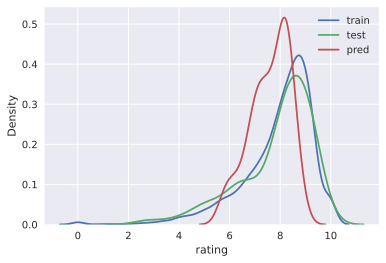

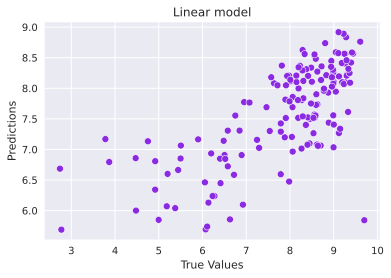

In [317]:
target_distr_linear(y_train, y_test, y_pred)   

In [318]:
calc_metrics(y_test, y_pred)

*** VAL **: 
MSE:   1.165696023140713
RMSE:  1.0796740355962595
R2:    0.44568557290920285
MAE:   0.8205364684364959
MedAE: 0.7309377384766798
------------------------------


In [113]:
cat_model.save_model('cat_reg_okko_ratings_cat_ntop')

**Feature importance**

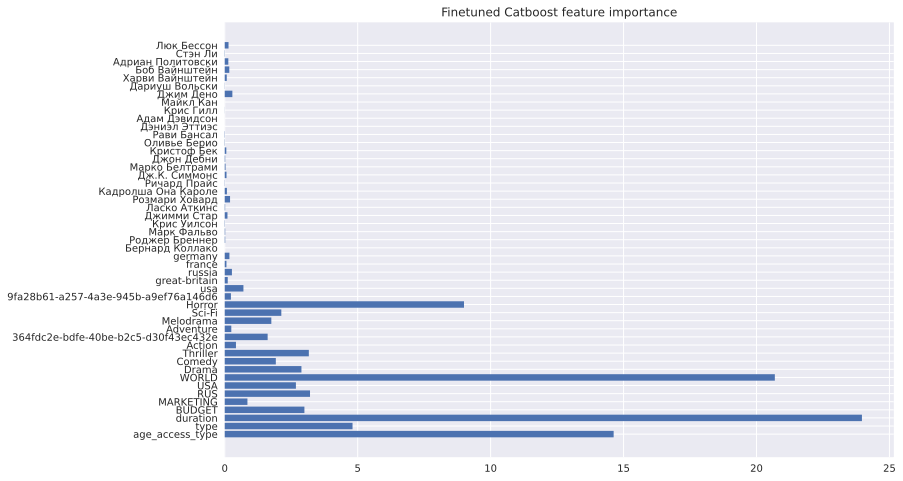

In [114]:
get_feature_imp(cat_model, train_dataset)

1)  The most influential features:  
    - duration  
    - average_rating  
    - age_access_type  

2)  The lowest influential features:  
    - actors and directors are not so important

**Detecting heteroscedasticity**

**Graphical Method:**

Firstly do the regression analysis and then plot the error terms against the predicted values. 
If there is a definite pattern (like linear or quadratic or funnel shaped) obtained from the scatter plot then heteroscedasticity is present.

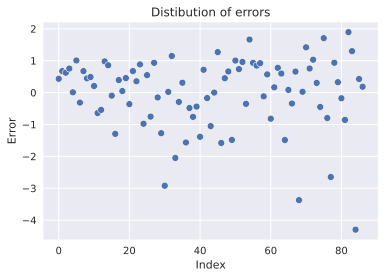

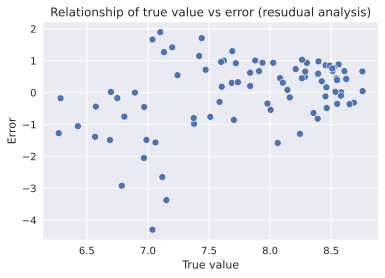

In [115]:
errors = y_test - y_pred
draw_res_analys(errors, y_pred)

**Conclusion**
* The trend in the second figure is not visible, now we will confirm the presence of heteroskedasticity on tests.

In [319]:
test_df['PREDS'] = y_pred.tolist()
test_df['TARGET'] = y_test.tolist()
test_df

,age_access_type,name,type,release_year,duration,element_uid,BUDGET,MARKETING,RUS,USA,...,Ольга Прошкина,Степан Коваленко,Джим Дено,Влад Ряшин,Родион Павлючик,Харви Вайнштейн,Стэн Ли,Джек Кёрби,PREDS,TARGET
14,6,Пес-самурай и город кошек,MOVIE,2022,15.534700,537ece24-2358-4108-a419-85cfd5952607,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.446665,8.945900
2245,16,"Координаты ""Цитадель""",MOVIE,2022,15.479437,6988476c-0c5e-496f-a618-1ab7626ddbee,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,6.447828,6.411529
10728,6,Большие игры,SERIAL,2022,15.096445,ce8d2906-a33f-4140-9ffe-e091990d71a4,17.216708,NaN,14.196856,17.175217,...,0,0,0,0,0,0,0,0,6.594577,7.788732
7893,18,Другой мир: ночь вампиров,MOVIE,2022,15.501910,a3b1b686-e95c-4a2c-95fb-9de439bf4f6c,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,5.688748,2.771930
7826,12,Тайна амулета,MOVIE,2022,15.545395,9ae35927-93e3-4a40-870f-a998abbeaa9f,NaN,NaN,12.057422,NaN,...,0,0,0,0,0,0,0,0,8.081232,7.635827
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10545,18,Отель Портофино,SERIAL,2022,16.770421,20e62147-89d0-4e8b-9d24-2f2279560601,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.213817,8.830573
3448,16,9 жизней,MOVIE,2022,15.566448,a7979b64-cf82-4c7f-86d8-05670b07d1b0,NaN,NaN,12.154206,NaN,...,0,0,0,0,0,0,0,0,7.077432,8.400693
6878,12,Влюблённые в небо,MOVIE,2022,15.636829,7176aabb-334a-41e1-90a5-c5199480fbba,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.457517,9.293367
10498,18,Женщины Движения,SERIAL,2022,16.633312,571bf312-75a1-4eee-94d7-deb62cd6f8b4,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.180273,8.960000


In [ ]:
# predict demo dataset

In [321]:
X_demo, y_demo = ddf.drop('rating', axis=1), ddf['rating']

demo_dataset = cat.Pool(data=X_demo, 
                        label=y_demo,
                         cat_features=cat_features)

y_pred_demo = cat_model.predict(demo_dataset)

In [323]:
demo_df['TARGET'] = y_demo.tolist()
demo_df['PREDS'] = y_pred_demo.tolist()
demo_df

,age_access_type,name,type,release_year,duration,element_uid,BUDGET,MARKETING,RUS,USA,...,Ольга Прошкина,Степан Коваленко,Джим Дено,Влад Ряшин,Родион Павлючик,Харви Вайнштейн,Стэн Ли,Джек Кёрби,PREDS,TARGET
6469,16,Молодой человек,MOVIE,2022,15.702580,0271c9b5-b7b2-4e3f-96af-b9cefed99397,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,7.337809,9.147352
6550,18,Приплыли!,MOVIE,2022,15.479437,02eaefe0-296d-4e6f-b52f-2e2507d07103,NaN,NaN,12.593543,NaN,...,0,0,0,0,0,0,0,0,6.845441,6.519242
9998,18,Чикатило,SERIAL,2020,17.723526,ee48def6-c311-4b73-a878-1a5d3d1679a3,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.867357,9.717041
10433,6,Манюня,SERIAL,2021,16.269958,9b202b16-55bf-418a-b01d-9f0329b18790,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.257465,9.192744
10608,18,Оффлайн,SERIAL,2022,17.218706,49a3d528-44c0-408e-b6fc-a1507ce7641a,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.249263,9.362527


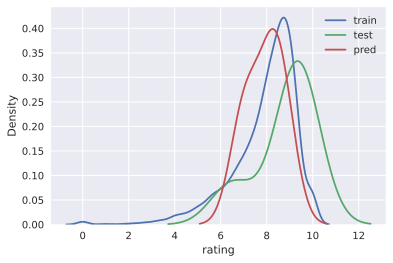

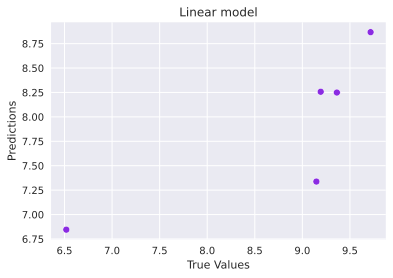

In [324]:
target_distr_linear(y_train, y_demo, y_pred_demo)   

# Tuning

In [327]:
train_dataset = cat.Pool(X_train, y_train, 
                         cat_features=cat_features) 

test_dataset = cat.Pool(X_test, y_test,
                         cat_features=cat_features)

cat_params = {
    'loss_function': 'RMSE',
    'eval_metric': 'MAE',
    'verbose': True,
    'random_seed': 321,
    'allow_writing_files': False, 
    'cat_features': cat_features
}

In [328]:
parameters_distr = {'depth': randint(5, 10),
              'learning_rate': uniform(0.01, 0.1),
              'iterations': [5000, 10000, 15000]
             }

cat_model = cat.CatBoostRegressor(**cat_params)
grid = RandomizedSearchCV(estimator=cat_model, param_distributions=parameters_distr, 
                            cv=5, 
#                           n_jobs=-1,
                          verbose=3)

grid.fit(X_train, y_train)

import pickle
with open('bestimator_okko_rat_ntop', 'wb') as f:
    pickle.dump(grid.best_estimator_, f)
grid.best_params_

Fitting 5 folds for each of 10 candidates, totalling 50 fits
0:	learn: 1.0727834	total: 9.24ms	remaining: 46.2s
1:	learn: 1.0608499	total: 19.1ms	remaining: 47.8s
2:	learn: 1.0472214	total: 27.9ms	remaining: 46.5s
3:	learn: 1.0352592	total: 35.9ms	remaining: 44.8s
4:	learn: 1.0229202	total: 42.7ms	remaining: 42.6s
5:	learn: 1.0111081	total: 49.8ms	remaining: 41.4s
6:	learn: 1.0011424	total: 57.2ms	remaining: 40.8s
7:	learn: 0.9922989	total: 63.6ms	remaining: 39.7s
8:	learn: 0.9821097	total: 70.6ms	remaining: 39.1s
9:	learn: 0.9725253	total: 76.8ms	remaining: 38.3s
10:	learn: 0.9642448	total: 82.9ms	remaining: 37.6s
11:	learn: 0.9565282	total: 89.5ms	remaining: 37.2s
12:	learn: 0.9492982	total: 97ms	remaining: 37.2s
13:	learn: 0.9422019	total: 103ms	remaining: 36.8s
14:	learn: 0.9363983	total: 110ms	remaining: 36.6s
15:	learn: 0.9304965	total: 117ms	remaining: 36.5s
16:	learn: 0.9239403	total: 123ms	remaining: 36s
17:	learn: 0.9178723	total: 129ms	remaining: 35.8s
18:	learn: 0.9125859	t

168:	learn: 0.7788442	total: 794ms	remaining: 22.7s
169:	learn: 0.7788543	total: 796ms	remaining: 22.6s
170:	learn: 0.7786285	total: 799ms	remaining: 22.6s
171:	learn: 0.7783700	total: 803ms	remaining: 22.6s
172:	learn: 0.7783173	total: 807ms	remaining: 22.5s
173:	learn: 0.7781634	total: 811ms	remaining: 22.5s
174:	learn: 0.7780110	total: 815ms	remaining: 22.5s
175:	learn: 0.7778097	total: 821ms	remaining: 22.5s
176:	learn: 0.7776850	total: 824ms	remaining: 22.5s
177:	learn: 0.7775657	total: 829ms	remaining: 22.5s
178:	learn: 0.7775229	total: 834ms	remaining: 22.5s
179:	learn: 0.7773320	total: 838ms	remaining: 22.4s
180:	learn: 0.7772719	total: 842ms	remaining: 22.4s
181:	learn: 0.7770589	total: 847ms	remaining: 22.4s
182:	learn: 0.7769440	total: 852ms	remaining: 22.4s
183:	learn: 0.7766960	total: 856ms	remaining: 22.4s
184:	learn: 0.7763781	total: 860ms	remaining: 22.4s
185:	learn: 0.7761138	total: 865ms	remaining: 22.4s
186:	learn: 0.7760670	total: 869ms	remaining: 22.4s
187:	learn: 

366:	learn: 0.7525538	total: 1.6s	remaining: 20.2s
367:	learn: 0.7524035	total: 1.6s	remaining: 20.2s
368:	learn: 0.7522972	total: 1.61s	remaining: 20.2s
369:	learn: 0.7522119	total: 1.61s	remaining: 20.2s
370:	learn: 0.7521315	total: 1.61s	remaining: 20.2s
371:	learn: 0.7518611	total: 1.62s	remaining: 20.2s
372:	learn: 0.7518620	total: 1.62s	remaining: 20.1s
373:	learn: 0.7517726	total: 1.63s	remaining: 20.1s
374:	learn: 0.7515648	total: 1.63s	remaining: 20.1s
375:	learn: 0.7515066	total: 1.63s	remaining: 20.1s
376:	learn: 0.7514965	total: 1.64s	remaining: 20.1s
377:	learn: 0.7513864	total: 1.64s	remaining: 20.1s
378:	learn: 0.7512513	total: 1.65s	remaining: 20.1s
379:	learn: 0.7511565	total: 1.65s	remaining: 20.1s
380:	learn: 0.7511534	total: 1.65s	remaining: 20.1s
381:	learn: 0.7510867	total: 1.66s	remaining: 20s
382:	learn: 0.7510296	total: 1.66s	remaining: 20s
383:	learn: 0.7508990	total: 1.67s	remaining: 20s
384:	learn: 0.7508907	total: 1.67s	remaining: 20s
385:	learn: 0.7505856	

568:	learn: 0.7363369	total: 2.4s	remaining: 18.7s
569:	learn: 0.7363023	total: 2.4s	remaining: 18.7s
570:	learn: 0.7362225	total: 2.41s	remaining: 18.7s
571:	learn: 0.7360834	total: 2.41s	remaining: 18.7s
572:	learn: 0.7359547	total: 2.41s	remaining: 18.6s
573:	learn: 0.7359496	total: 2.42s	remaining: 18.6s
574:	learn: 0.7359140	total: 2.42s	remaining: 18.6s
575:	learn: 0.7358491	total: 2.42s	remaining: 18.6s
576:	learn: 0.7357324	total: 2.43s	remaining: 18.6s
577:	learn: 0.7357187	total: 2.43s	remaining: 18.6s
578:	learn: 0.7356273	total: 2.43s	remaining: 18.6s
579:	learn: 0.7355137	total: 2.44s	remaining: 18.6s
580:	learn: 0.7354537	total: 2.44s	remaining: 18.6s
581:	learn: 0.7353572	total: 2.45s	remaining: 18.6s
582:	learn: 0.7353544	total: 2.45s	remaining: 18.6s
583:	learn: 0.7353491	total: 2.45s	remaining: 18.5s
584:	learn: 0.7351714	total: 2.46s	remaining: 18.5s
585:	learn: 0.7350360	total: 2.46s	remaining: 18.5s
586:	learn: 0.7349364	total: 2.47s	remaining: 18.5s
587:	learn: 0.

764:	learn: 0.7225733	total: 3.2s	remaining: 17.7s
765:	learn: 0.7225139	total: 3.21s	remaining: 17.7s
766:	learn: 0.7224703	total: 3.21s	remaining: 17.7s
767:	learn: 0.7224181	total: 3.22s	remaining: 17.7s
768:	learn: 0.7222980	total: 3.22s	remaining: 17.7s
769:	learn: 0.7222923	total: 3.23s	remaining: 17.7s
770:	learn: 0.7222093	total: 3.23s	remaining: 17.7s
771:	learn: 0.7220978	total: 3.23s	remaining: 17.7s
772:	learn: 0.7220605	total: 3.24s	remaining: 17.7s
773:	learn: 0.7219988	total: 3.25s	remaining: 17.7s
774:	learn: 0.7218656	total: 3.25s	remaining: 17.7s
775:	learn: 0.7218046	total: 3.25s	remaining: 17.7s
776:	learn: 0.7217777	total: 3.26s	remaining: 17.7s
777:	learn: 0.7217265	total: 3.26s	remaining: 17.7s
778:	learn: 0.7216547	total: 3.27s	remaining: 17.7s
779:	learn: 0.7216527	total: 3.27s	remaining: 17.7s
780:	learn: 0.7215981	total: 3.27s	remaining: 17.7s
781:	learn: 0.7214942	total: 3.28s	remaining: 17.7s
782:	learn: 0.7214521	total: 3.28s	remaining: 17.7s
783:	learn: 0

956:	learn: 0.7122076	total: 4.01s	remaining: 16.9s
957:	learn: 0.7121763	total: 4.01s	remaining: 16.9s
958:	learn: 0.7120675	total: 4.01s	remaining: 16.9s
959:	learn: 0.7120242	total: 4.02s	remaining: 16.9s
960:	learn: 0.7119403	total: 4.02s	remaining: 16.9s
961:	learn: 0.7119409	total: 4.03s	remaining: 16.9s
962:	learn: 0.7119277	total: 4.03s	remaining: 16.9s
963:	learn: 0.7118835	total: 4.04s	remaining: 16.9s
964:	learn: 0.7118617	total: 4.04s	remaining: 16.9s
965:	learn: 0.7118190	total: 4.05s	remaining: 16.9s
966:	learn: 0.7117941	total: 4.05s	remaining: 16.9s
967:	learn: 0.7117725	total: 4.05s	remaining: 16.9s
968:	learn: 0.7117531	total: 4.06s	remaining: 16.9s
969:	learn: 0.7116730	total: 4.06s	remaining: 16.9s
970:	learn: 0.7116073	total: 4.07s	remaining: 16.9s
971:	learn: 0.7115204	total: 4.07s	remaining: 16.9s
972:	learn: 0.7114555	total: 4.08s	remaining: 16.9s
973:	learn: 0.7114498	total: 4.08s	remaining: 16.9s
974:	learn: 0.7114358	total: 4.08s	remaining: 16.9s
975:	learn: 

1148:	learn: 0.7035837	total: 4.81s	remaining: 16.1s
1149:	learn: 0.7035131	total: 4.81s	remaining: 16.1s
1150:	learn: 0.7034796	total: 4.82s	remaining: 16.1s
1151:	learn: 0.7033844	total: 4.82s	remaining: 16.1s
1152:	learn: 0.7033573	total: 4.82s	remaining: 16.1s
1153:	learn: 0.7032954	total: 4.83s	remaining: 16.1s
1154:	learn: 0.7032847	total: 4.83s	remaining: 16.1s
1155:	learn: 0.7032339	total: 4.84s	remaining: 16.1s
1156:	learn: 0.7031921	total: 4.84s	remaining: 16.1s
1157:	learn: 0.7031233	total: 4.85s	remaining: 16.1s
1158:	learn: 0.7030795	total: 4.85s	remaining: 16.1s
1159:	learn: 0.7030162	total: 4.86s	remaining: 16.1s
1160:	learn: 0.7029839	total: 4.86s	remaining: 16.1s
1161:	learn: 0.7029012	total: 4.86s	remaining: 16.1s
1162:	learn: 0.7028811	total: 4.87s	remaining: 16.1s
1163:	learn: 0.7027704	total: 4.87s	remaining: 16.1s
1164:	learn: 0.7027118	total: 4.88s	remaining: 16.1s
1165:	learn: 0.7025951	total: 4.88s	remaining: 16s
1166:	learn: 0.7025013	total: 4.88s	remaining: 1

1328:	learn: 0.6948770	total: 5.61s	remaining: 15.5s
1329:	learn: 0.6948727	total: 5.62s	remaining: 15.5s
1330:	learn: 0.6948558	total: 5.62s	remaining: 15.5s
1331:	learn: 0.6948117	total: 5.63s	remaining: 15.5s
1332:	learn: 0.6948063	total: 5.63s	remaining: 15.5s
1333:	learn: 0.6947806	total: 5.63s	remaining: 15.5s
1334:	learn: 0.6947617	total: 5.64s	remaining: 15.5s
1335:	learn: 0.6947159	total: 5.64s	remaining: 15.5s
1336:	learn: 0.6946749	total: 5.64s	remaining: 15.5s
1337:	learn: 0.6946546	total: 5.65s	remaining: 15.5s
1338:	learn: 0.6946358	total: 5.65s	remaining: 15.5s
1339:	learn: 0.6946152	total: 5.66s	remaining: 15.4s
1340:	learn: 0.6945712	total: 5.66s	remaining: 15.4s
1341:	learn: 0.6945015	total: 5.66s	remaining: 15.4s
1342:	learn: 0.6944740	total: 5.67s	remaining: 15.4s
1343:	learn: 0.6944539	total: 5.67s	remaining: 15.4s
1344:	learn: 0.6944325	total: 5.67s	remaining: 15.4s
1345:	learn: 0.6944128	total: 5.68s	remaining: 15.4s
1346:	learn: 0.6943108	total: 5.68s	remaining:

1512:	learn: 0.6882682	total: 6.42s	remaining: 14.8s
1513:	learn: 0.6882571	total: 6.42s	remaining: 14.8s
1514:	learn: 0.6882603	total: 6.42s	remaining: 14.8s
1515:	learn: 0.6882029	total: 6.43s	remaining: 14.8s
1516:	learn: 0.6881766	total: 6.43s	remaining: 14.8s
1517:	learn: 0.6881640	total: 6.44s	remaining: 14.8s
1518:	learn: 0.6881575	total: 6.44s	remaining: 14.8s
1519:	learn: 0.6881316	total: 6.45s	remaining: 14.8s
1520:	learn: 0.6880859	total: 6.45s	remaining: 14.8s
1521:	learn: 0.6880699	total: 6.45s	remaining: 14.8s
1522:	learn: 0.6880481	total: 6.46s	remaining: 14.7s
1523:	learn: 0.6880118	total: 6.46s	remaining: 14.7s
1524:	learn: 0.6880033	total: 6.47s	remaining: 14.7s
1525:	learn: 0.6879542	total: 6.47s	remaining: 14.7s
1526:	learn: 0.6879515	total: 6.48s	remaining: 14.7s
1527:	learn: 0.6878963	total: 6.48s	remaining: 14.7s
1528:	learn: 0.6878158	total: 6.49s	remaining: 14.7s
1529:	learn: 0.6877539	total: 6.49s	remaining: 14.7s
1530:	learn: 0.6877023	total: 6.5s	remaining: 

1690:	learn: 0.6810625	total: 7.22s	remaining: 14.1s
1691:	learn: 0.6810520	total: 7.22s	remaining: 14.1s
1692:	learn: 0.6810042	total: 7.23s	remaining: 14.1s
1693:	learn: 0.6809087	total: 7.23s	remaining: 14.1s
1694:	learn: 0.6808928	total: 7.24s	remaining: 14.1s
1695:	learn: 0.6808939	total: 7.24s	remaining: 14.1s
1696:	learn: 0.6808860	total: 7.25s	remaining: 14.1s
1697:	learn: 0.6808769	total: 7.25s	remaining: 14.1s
1698:	learn: 0.6808248	total: 7.25s	remaining: 14.1s
1699:	learn: 0.6807801	total: 7.26s	remaining: 14.1s
1700:	learn: 0.6807547	total: 7.26s	remaining: 14.1s
1701:	learn: 0.6807294	total: 7.27s	remaining: 14.1s
1702:	learn: 0.6807097	total: 7.28s	remaining: 14.1s
1703:	learn: 0.6806929	total: 7.28s	remaining: 14.1s
1704:	learn: 0.6806897	total: 7.28s	remaining: 14.1s
1705:	learn: 0.6806798	total: 7.29s	remaining: 14.1s
1706:	learn: 0.6806243	total: 7.29s	remaining: 14.1s
1707:	learn: 0.6805567	total: 7.29s	remaining: 14.1s
1708:	learn: 0.6805291	total: 7.3s	remaining: 

1875:	learn: 0.6744326	total: 8.03s	remaining: 13.4s
1876:	learn: 0.6744192	total: 8.03s	remaining: 13.4s
1877:	learn: 0.6744131	total: 8.03s	remaining: 13.4s
1878:	learn: 0.6744097	total: 8.04s	remaining: 13.4s
1879:	learn: 0.6743932	total: 8.04s	remaining: 13.3s
1880:	learn: 0.6743840	total: 8.05s	remaining: 13.3s
1881:	learn: 0.6743605	total: 8.05s	remaining: 13.3s
1882:	learn: 0.6743340	total: 8.05s	remaining: 13.3s
1883:	learn: 0.6743249	total: 8.06s	remaining: 13.3s
1884:	learn: 0.6742511	total: 8.06s	remaining: 13.3s
1885:	learn: 0.6742398	total: 8.07s	remaining: 13.3s
1886:	learn: 0.6741837	total: 8.07s	remaining: 13.3s
1887:	learn: 0.6741605	total: 8.08s	remaining: 13.3s
1888:	learn: 0.6741479	total: 8.08s	remaining: 13.3s
1889:	learn: 0.6741293	total: 8.09s	remaining: 13.3s
1890:	learn: 0.6740896	total: 8.09s	remaining: 13.3s
1891:	learn: 0.6740750	total: 8.09s	remaining: 13.3s
1892:	learn: 0.6740097	total: 8.1s	remaining: 13.3s
1893:	learn: 0.6739814	total: 8.1s	remaining: 1

2060:	learn: 0.6685971	total: 8.83s	remaining: 12.6s
2061:	learn: 0.6685640	total: 8.84s	remaining: 12.6s
2062:	learn: 0.6685265	total: 8.84s	remaining: 12.6s
2063:	learn: 0.6685261	total: 8.84s	remaining: 12.6s
2064:	learn: 0.6684395	total: 8.85s	remaining: 12.6s
2065:	learn: 0.6684398	total: 8.85s	remaining: 12.6s
2066:	learn: 0.6684157	total: 8.86s	remaining: 12.6s
2067:	learn: 0.6683741	total: 8.86s	remaining: 12.6s
2068:	learn: 0.6682883	total: 8.87s	remaining: 12.6s
2069:	learn: 0.6682743	total: 8.87s	remaining: 12.6s
2070:	learn: 0.6682151	total: 8.88s	remaining: 12.6s
2071:	learn: 0.6681776	total: 8.88s	remaining: 12.5s
2072:	learn: 0.6681340	total: 8.88s	remaining: 12.5s
2073:	learn: 0.6679937	total: 8.89s	remaining: 12.5s
2074:	learn: 0.6679975	total: 8.89s	remaining: 12.5s
2075:	learn: 0.6679904	total: 8.9s	remaining: 12.5s
2076:	learn: 0.6679627	total: 8.9s	remaining: 12.5s
2077:	learn: 0.6679390	total: 8.9s	remaining: 12.5s
2078:	learn: 0.6678653	total: 8.91s	remaining: 12

2247:	learn: 0.6623222	total: 9.63s	remaining: 11.8s
2248:	learn: 0.6623075	total: 9.63s	remaining: 11.8s
2249:	learn: 0.6622903	total: 9.64s	remaining: 11.8s
2250:	learn: 0.6622546	total: 9.64s	remaining: 11.8s
2251:	learn: 0.6622407	total: 9.65s	remaining: 11.8s
2252:	learn: 0.6622132	total: 9.65s	remaining: 11.8s
2253:	learn: 0.6621943	total: 9.66s	remaining: 11.8s
2254:	learn: 0.6621709	total: 9.66s	remaining: 11.8s
2255:	learn: 0.6621344	total: 9.66s	remaining: 11.8s
2256:	learn: 0.6621260	total: 9.67s	remaining: 11.8s
2257:	learn: 0.6620932	total: 9.68s	remaining: 11.7s
2258:	learn: 0.6620450	total: 9.68s	remaining: 11.7s
2259:	learn: 0.6620064	total: 9.68s	remaining: 11.7s
2260:	learn: 0.6619416	total: 9.69s	remaining: 11.7s
2261:	learn: 0.6619023	total: 9.69s	remaining: 11.7s
2262:	learn: 0.6618029	total: 9.7s	remaining: 11.7s
2263:	learn: 0.6617448	total: 9.7s	remaining: 11.7s
2264:	learn: 0.6617369	total: 9.71s	remaining: 11.7s
2265:	learn: 0.6616449	total: 9.71s	remaining: 1

2431:	learn: 0.6562588	total: 10.4s	remaining: 11s
2432:	learn: 0.6561593	total: 10.4s	remaining: 11s
2433:	learn: 0.6561148	total: 10.4s	remaining: 11s
2434:	learn: 0.6560935	total: 10.4s	remaining: 11s
2435:	learn: 0.6560589	total: 10.5s	remaining: 11s
2436:	learn: 0.6559605	total: 10.5s	remaining: 11s
2437:	learn: 0.6559465	total: 10.5s	remaining: 11s
2438:	learn: 0.6559305	total: 10.5s	remaining: 11s
2439:	learn: 0.6558490	total: 10.5s	remaining: 11s
2440:	learn: 0.6557895	total: 10.5s	remaining: 11s
2441:	learn: 0.6557527	total: 10.5s	remaining: 11s
2442:	learn: 0.6557095	total: 10.5s	remaining: 11s
2443:	learn: 0.6557070	total: 10.5s	remaining: 11s
2444:	learn: 0.6556834	total: 10.5s	remaining: 11s
2445:	learn: 0.6556867	total: 10.5s	remaining: 11s
2446:	learn: 0.6556787	total: 10.5s	remaining: 11s
2447:	learn: 0.6556658	total: 10.5s	remaining: 10.9s
2448:	learn: 0.6556432	total: 10.5s	remaining: 10.9s
2449:	learn: 0.6556402	total: 10.5s	remaining: 10.9s
2450:	learn: 0.6555890	to

2619:	learn: 0.6503335	total: 11.2s	remaining: 10.2s
2620:	learn: 0.6503090	total: 11.2s	remaining: 10.2s
2621:	learn: 0.6502928	total: 11.2s	remaining: 10.2s
2622:	learn: 0.6502797	total: 11.3s	remaining: 10.2s
2623:	learn: 0.6502381	total: 11.3s	remaining: 10.2s
2624:	learn: 0.6502332	total: 11.3s	remaining: 10.2s
2625:	learn: 0.6502098	total: 11.3s	remaining: 10.2s
2626:	learn: 0.6501938	total: 11.3s	remaining: 10.2s
2627:	learn: 0.6501807	total: 11.3s	remaining: 10.2s
2628:	learn: 0.6501640	total: 11.3s	remaining: 10.2s
2629:	learn: 0.6501262	total: 11.3s	remaining: 10.2s
2630:	learn: 0.6501092	total: 11.3s	remaining: 10.2s
2631:	learn: 0.6500936	total: 11.3s	remaining: 10.2s
2632:	learn: 0.6500787	total: 11.3s	remaining: 10.2s
2633:	learn: 0.6500274	total: 11.3s	remaining: 10.2s
2634:	learn: 0.6500039	total: 11.3s	remaining: 10.1s
2635:	learn: 0.6500070	total: 11.3s	remaining: 10.1s
2636:	learn: 0.6499573	total: 11.3s	remaining: 10.1s
2637:	learn: 0.6499609	total: 11.3s	remaining:

2805:	learn: 0.6454680	total: 12s	remaining: 9.42s
2806:	learn: 0.6454543	total: 12.1s	remaining: 9.41s
2807:	learn: 0.6453491	total: 12.1s	remaining: 9.41s
2808:	learn: 0.6453344	total: 12.1s	remaining: 9.41s
2809:	learn: 0.6453276	total: 12.1s	remaining: 9.4s
2810:	learn: 0.6452999	total: 12.1s	remaining: 9.4s
2811:	learn: 0.6452833	total: 12.1s	remaining: 9.39s
2812:	learn: 0.6452484	total: 12.1s	remaining: 9.39s
2813:	learn: 0.6452315	total: 12.1s	remaining: 9.38s
2814:	learn: 0.6451854	total: 12.1s	remaining: 9.38s
2815:	learn: 0.6451599	total: 12.1s	remaining: 9.38s
2816:	learn: 0.6450506	total: 12.1s	remaining: 9.37s
2817:	learn: 0.6450322	total: 12.1s	remaining: 9.37s
2818:	learn: 0.6450294	total: 12.1s	remaining: 9.37s
2819:	learn: 0.6450145	total: 12.1s	remaining: 9.36s
2820:	learn: 0.6448867	total: 12.1s	remaining: 9.36s
2821:	learn: 0.6448518	total: 12.1s	remaining: 9.35s
2822:	learn: 0.6448190	total: 12.1s	remaining: 9.35s
2823:	learn: 0.6447982	total: 12.1s	remaining: 9.3

2981:	learn: 0.6400092	total: 12.8s	remaining: 8.7s
2982:	learn: 0.6399956	total: 12.9s	remaining: 8.69s
2983:	learn: 0.6399796	total: 12.9s	remaining: 8.69s
2984:	learn: 0.6399667	total: 12.9s	remaining: 8.68s
2985:	learn: 0.6399104	total: 12.9s	remaining: 8.68s
2986:	learn: 0.6398737	total: 12.9s	remaining: 8.68s
2987:	learn: 0.6398215	total: 12.9s	remaining: 8.67s
2988:	learn: 0.6398073	total: 12.9s	remaining: 8.66s
2989:	learn: 0.6397930	total: 12.9s	remaining: 8.66s
2990:	learn: 0.6397768	total: 12.9s	remaining: 8.66s
2991:	learn: 0.6397353	total: 12.9s	remaining: 8.65s
2992:	learn: 0.6397357	total: 12.9s	remaining: 8.65s
2993:	learn: 0.6397179	total: 12.9s	remaining: 8.64s
2994:	learn: 0.6396895	total: 12.9s	remaining: 8.64s
2995:	learn: 0.6396759	total: 12.9s	remaining: 8.63s
2996:	learn: 0.6396489	total: 12.9s	remaining: 8.63s
2997:	learn: 0.6396285	total: 12.9s	remaining: 8.63s
2998:	learn: 0.6396106	total: 12.9s	remaining: 8.62s
2999:	learn: 0.6395428	total: 12.9s	remaining: 

3162:	learn: 0.6347605	total: 13.7s	remaining: 7.93s
3163:	learn: 0.6347407	total: 13.7s	remaining: 7.92s
3164:	learn: 0.6347273	total: 13.7s	remaining: 7.92s
3165:	learn: 0.6347240	total: 13.7s	remaining: 7.92s
3166:	learn: 0.6346812	total: 13.7s	remaining: 7.91s
3167:	learn: 0.6346420	total: 13.7s	remaining: 7.91s
3168:	learn: 0.6345909	total: 13.7s	remaining: 7.9s
3169:	learn: 0.6345726	total: 13.7s	remaining: 7.9s
3170:	learn: 0.6345484	total: 13.7s	remaining: 7.89s
3171:	learn: 0.6345039	total: 13.7s	remaining: 7.89s
3172:	learn: 0.6344672	total: 13.7s	remaining: 7.88s
3173:	learn: 0.6344478	total: 13.7s	remaining: 7.88s
3174:	learn: 0.6344312	total: 13.7s	remaining: 7.88s
3175:	learn: 0.6344160	total: 13.7s	remaining: 7.87s
3176:	learn: 0.6343974	total: 13.7s	remaining: 7.87s
3177:	learn: 0.6343735	total: 13.7s	remaining: 7.86s
3178:	learn: 0.6343468	total: 13.7s	remaining: 7.86s
3179:	learn: 0.6343352	total: 13.7s	remaining: 7.85s
3180:	learn: 0.6343218	total: 13.7s	remaining: 7

3351:	learn: 0.6302220	total: 14.5s	remaining: 7.11s
3352:	learn: 0.6302113	total: 14.5s	remaining: 7.1s
3353:	learn: 0.6301876	total: 14.5s	remaining: 7.1s
3354:	learn: 0.6301483	total: 14.5s	remaining: 7.09s
3355:	learn: 0.6301359	total: 14.5s	remaining: 7.09s
3356:	learn: 0.6301261	total: 14.5s	remaining: 7.08s
3357:	learn: 0.6300945	total: 14.5s	remaining: 7.08s
3358:	learn: 0.6300842	total: 14.5s	remaining: 7.07s
3359:	learn: 0.6300436	total: 14.5s	remaining: 7.07s
3360:	learn: 0.6299933	total: 14.5s	remaining: 7.07s
3361:	learn: 0.6299880	total: 14.5s	remaining: 7.06s
3362:	learn: 0.6299708	total: 14.5s	remaining: 7.06s
3363:	learn: 0.6299457	total: 14.5s	remaining: 7.05s
3364:	learn: 0.6299468	total: 14.5s	remaining: 7.05s
3365:	learn: 0.6299452	total: 14.5s	remaining: 7.04s
3366:	learn: 0.6299205	total: 14.5s	remaining: 7.04s
3367:	learn: 0.6299068	total: 14.5s	remaining: 7.03s
3368:	learn: 0.6298940	total: 14.5s	remaining: 7.03s
3369:	learn: 0.6298821	total: 14.5s	remaining: 7

3535:	learn: 0.6257403	total: 15.3s	remaining: 6.32s
3536:	learn: 0.6257320	total: 15.3s	remaining: 6.31s
3537:	learn: 0.6256795	total: 15.3s	remaining: 6.31s
3538:	learn: 0.6256804	total: 15.3s	remaining: 6.3s
3539:	learn: 0.6256319	total: 15.3s	remaining: 6.3s
3540:	learn: 0.6256069	total: 15.3s	remaining: 6.29s
3541:	learn: 0.6255904	total: 15.3s	remaining: 6.29s
3542:	learn: 0.6255845	total: 15.3s	remaining: 6.29s
3543:	learn: 0.6255739	total: 15.3s	remaining: 6.28s
3544:	learn: 0.6255355	total: 15.3s	remaining: 6.28s
3545:	learn: 0.6255294	total: 15.3s	remaining: 6.27s
3546:	learn: 0.6255254	total: 15.3s	remaining: 6.27s
3547:	learn: 0.6255266	total: 15.3s	remaining: 6.26s
3548:	learn: 0.6255109	total: 15.3s	remaining: 6.26s
3549:	learn: 0.6255053	total: 15.3s	remaining: 6.25s
3550:	learn: 0.6254953	total: 15.3s	remaining: 6.25s
3551:	learn: 0.6254732	total: 15.3s	remaining: 6.25s
3552:	learn: 0.6254509	total: 15.3s	remaining: 6.24s
3553:	learn: 0.6254162	total: 15.3s	remaining: 6

3718:	learn: 0.6213560	total: 16.1s	remaining: 5.53s
3719:	learn: 0.6213499	total: 16.1s	remaining: 5.53s
3720:	learn: 0.6212887	total: 16.1s	remaining: 5.52s
3721:	learn: 0.6212610	total: 16.1s	remaining: 5.52s
3722:	learn: 0.6212476	total: 16.1s	remaining: 5.51s
3723:	learn: 0.6212359	total: 16.1s	remaining: 5.51s
3724:	learn: 0.6212023	total: 16.1s	remaining: 5.5s
3725:	learn: 0.6211715	total: 16.1s	remaining: 5.5s
3726:	learn: 0.6211647	total: 16.1s	remaining: 5.5s
3727:	learn: 0.6211199	total: 16.1s	remaining: 5.49s
3728:	learn: 0.6210942	total: 16.1s	remaining: 5.49s
3729:	learn: 0.6210453	total: 16.1s	remaining: 5.48s
3730:	learn: 0.6210221	total: 16.1s	remaining: 5.48s
3731:	learn: 0.6210025	total: 16.1s	remaining: 5.48s
3732:	learn: 0.6209997	total: 16.1s	remaining: 5.47s
3733:	learn: 0.6209854	total: 16.1s	remaining: 5.47s
3734:	learn: 0.6209514	total: 16.1s	remaining: 5.46s
3735:	learn: 0.6209404	total: 16.1s	remaining: 5.46s
3736:	learn: 0.6209151	total: 16.1s	remaining: 5.

3899:	learn: 0.6172119	total: 16.9s	remaining: 4.76s
3900:	learn: 0.6172095	total: 16.9s	remaining: 4.75s
3901:	learn: 0.6172055	total: 16.9s	remaining: 4.75s
3902:	learn: 0.6171895	total: 16.9s	remaining: 4.74s
3903:	learn: 0.6171838	total: 16.9s	remaining: 4.74s
3904:	learn: 0.6171730	total: 16.9s	remaining: 4.73s
3905:	learn: 0.6171582	total: 16.9s	remaining: 4.73s
3906:	learn: 0.6171079	total: 16.9s	remaining: 4.72s
3907:	learn: 0.6170965	total: 16.9s	remaining: 4.72s
3908:	learn: 0.6171014	total: 16.9s	remaining: 4.72s
3909:	learn: 0.6170574	total: 16.9s	remaining: 4.71s
3910:	learn: 0.6170428	total: 16.9s	remaining: 4.71s
3911:	learn: 0.6169636	total: 16.9s	remaining: 4.7s
3912:	learn: 0.6169351	total: 16.9s	remaining: 4.7s
3913:	learn: 0.6169138	total: 16.9s	remaining: 4.7s
3914:	learn: 0.6168854	total: 16.9s	remaining: 4.69s
3915:	learn: 0.6168720	total: 16.9s	remaining: 4.69s
3916:	learn: 0.6168693	total: 16.9s	remaining: 4.68s
3917:	learn: 0.6168513	total: 16.9s	remaining: 4.

4081:	learn: 0.6130458	total: 17.7s	remaining: 3.97s
4082:	learn: 0.6130460	total: 17.7s	remaining: 3.97s
4083:	learn: 0.6130040	total: 17.7s	remaining: 3.96s
4084:	learn: 0.6129665	total: 17.7s	remaining: 3.96s
4085:	learn: 0.6129477	total: 17.7s	remaining: 3.96s
4086:	learn: 0.6129410	total: 17.7s	remaining: 3.95s
4087:	learn: 0.6129133	total: 17.7s	remaining: 3.95s
4088:	learn: 0.6128957	total: 17.7s	remaining: 3.94s
4089:	learn: 0.6128539	total: 17.7s	remaining: 3.94s
4090:	learn: 0.6128501	total: 17.7s	remaining: 3.93s
4091:	learn: 0.6128188	total: 17.7s	remaining: 3.93s
4092:	learn: 0.6127831	total: 17.7s	remaining: 3.92s
4093:	learn: 0.6127576	total: 17.7s	remaining: 3.92s
4094:	learn: 0.6127146	total: 17.7s	remaining: 3.92s
4095:	learn: 0.6126963	total: 17.7s	remaining: 3.91s
4096:	learn: 0.6126929	total: 17.7s	remaining: 3.91s
4097:	learn: 0.6126264	total: 17.7s	remaining: 3.9s
4098:	learn: 0.6125909	total: 17.7s	remaining: 3.9s
4099:	learn: 0.6125865	total: 17.7s	remaining: 3

4270:	learn: 0.6085243	total: 18.5s	remaining: 3.15s
4271:	learn: 0.6084945	total: 18.5s	remaining: 3.15s
4272:	learn: 0.6084726	total: 18.5s	remaining: 3.14s
4273:	learn: 0.6084749	total: 18.5s	remaining: 3.14s
4274:	learn: 0.6084569	total: 18.5s	remaining: 3.13s
4275:	learn: 0.6084442	total: 18.5s	remaining: 3.13s
4276:	learn: 0.6084389	total: 18.5s	remaining: 3.13s
4277:	learn: 0.6084322	total: 18.5s	remaining: 3.12s
4278:	learn: 0.6084037	total: 18.5s	remaining: 3.12s
4279:	learn: 0.6083851	total: 18.5s	remaining: 3.11s
4280:	learn: 0.6083458	total: 18.5s	remaining: 3.11s
4281:	learn: 0.6083321	total: 18.5s	remaining: 3.1s
4282:	learn: 0.6083022	total: 18.5s	remaining: 3.1s
4283:	learn: 0.6082989	total: 18.5s	remaining: 3.1s
4284:	learn: 0.6082564	total: 18.5s	remaining: 3.09s
4285:	learn: 0.6082165	total: 18.5s	remaining: 3.09s
4286:	learn: 0.6081918	total: 18.5s	remaining: 3.08s
4287:	learn: 0.6081837	total: 18.5s	remaining: 3.08s
4288:	learn: 0.6081753	total: 18.6s	remaining: 3.

4455:	learn: 0.6046901	total: 19.3s	remaining: 2.35s
4456:	learn: 0.6046719	total: 19.3s	remaining: 2.35s
4457:	learn: 0.6046301	total: 19.3s	remaining: 2.34s
4458:	learn: 0.6046299	total: 19.3s	remaining: 2.34s
4459:	learn: 0.6046180	total: 19.3s	remaining: 2.33s
4460:	learn: 0.6046039	total: 19.3s	remaining: 2.33s
4461:	learn: 0.6045908	total: 19.3s	remaining: 2.33s
4462:	learn: 0.6045688	total: 19.3s	remaining: 2.32s
4463:	learn: 0.6045646	total: 19.3s	remaining: 2.32s
4464:	learn: 0.6045634	total: 19.3s	remaining: 2.31s
4465:	learn: 0.6044954	total: 19.3s	remaining: 2.31s
4466:	learn: 0.6044783	total: 19.3s	remaining: 2.31s
4467:	learn: 0.6044617	total: 19.3s	remaining: 2.3s
4468:	learn: 0.6044300	total: 19.3s	remaining: 2.3s
4469:	learn: 0.6044139	total: 19.3s	remaining: 2.29s
4470:	learn: 0.6043899	total: 19.3s	remaining: 2.29s
4471:	learn: 0.6043869	total: 19.3s	remaining: 2.28s
4472:	learn: 0.6043763	total: 19.3s	remaining: 2.28s
4473:	learn: 0.6043755	total: 19.3s	remaining: 2

4639:	learn: 0.6007334	total: 20.1s	remaining: 1.56s
4640:	learn: 0.6007128	total: 20.1s	remaining: 1.55s
4641:	learn: 0.6006997	total: 20.1s	remaining: 1.55s
4642:	learn: 0.6006751	total: 20.1s	remaining: 1.54s
4643:	learn: 0.6006104	total: 20.1s	remaining: 1.54s
4644:	learn: 0.6006025	total: 20.1s	remaining: 1.54s
4645:	learn: 0.6005515	total: 20.1s	remaining: 1.53s
4646:	learn: 0.6005270	total: 20.1s	remaining: 1.53s
4647:	learn: 0.6005138	total: 20.1s	remaining: 1.52s
4648:	learn: 0.6005142	total: 20.1s	remaining: 1.52s
4649:	learn: 0.6004703	total: 20.1s	remaining: 1.51s
4650:	learn: 0.6004464	total: 20.1s	remaining: 1.51s
4651:	learn: 0.6004389	total: 20.1s	remaining: 1.51s
4652:	learn: 0.6004124	total: 20.1s	remaining: 1.5s
4653:	learn: 0.6004110	total: 20.1s	remaining: 1.5s
4654:	learn: 0.6003672	total: 20.1s	remaining: 1.49s
4655:	learn: 0.6003544	total: 20.2s	remaining: 1.49s
4656:	learn: 0.6002973	total: 20.2s	remaining: 1.48s
4657:	learn: 0.6002502	total: 20.2s	remaining: 1

4818:	learn: 0.5971960	total: 20.9s	remaining: 784ms
4819:	learn: 0.5971849	total: 20.9s	remaining: 780ms
4820:	learn: 0.5971608	total: 20.9s	remaining: 776ms
4821:	learn: 0.5971483	total: 20.9s	remaining: 771ms
4822:	learn: 0.5971304	total: 20.9s	remaining: 767ms
4823:	learn: 0.5971018	total: 20.9s	remaining: 763ms
4824:	learn: 0.5970591	total: 20.9s	remaining: 758ms
4825:	learn: 0.5970599	total: 20.9s	remaining: 754ms
4826:	learn: 0.5970232	total: 20.9s	remaining: 750ms
4827:	learn: 0.5969796	total: 20.9s	remaining: 745ms
4828:	learn: 0.5969573	total: 20.9s	remaining: 741ms
4829:	learn: 0.5969471	total: 20.9s	remaining: 737ms
4830:	learn: 0.5969155	total: 20.9s	remaining: 732ms
4831:	learn: 0.5968944	total: 20.9s	remaining: 728ms
4832:	learn: 0.5968768	total: 20.9s	remaining: 724ms
4833:	learn: 0.5968594	total: 21s	remaining: 719ms
4834:	learn: 0.5968528	total: 21s	remaining: 715ms
4835:	learn: 0.5968361	total: 21s	remaining: 711ms
4836:	learn: 0.5968169	total: 21s	remaining: 707ms
4

4998:	learn: 0.5937252	total: 21.7s	remaining: 4.34ms
4999:	learn: 0.5936976	total: 21.7s	remaining: 0us
[CV 1/5] END depth=5, iterations=5000, learning_rate=0.04043514138322928;, score=0.018 total time=  22.0s
0:	learn: 1.0653107	total: 5.51ms	remaining: 27.5s
1:	learn: 1.0533666	total: 10.5ms	remaining: 26.2s
2:	learn: 1.0397349	total: 16.1ms	remaining: 26.9s
3:	learn: 1.0283796	total: 20.8ms	remaining: 26s
4:	learn: 1.0165352	total: 25.6ms	remaining: 25.5s
5:	learn: 1.0060628	total: 29.4ms	remaining: 24.5s
6:	learn: 0.9962083	total: 32.6ms	remaining: 23.3s
7:	learn: 0.9867014	total: 36.1ms	remaining: 22.5s
8:	learn: 0.9772399	total: 41.2ms	remaining: 22.9s
9:	learn: 0.9690013	total: 45.1ms	remaining: 22.5s
10:	learn: 0.9614641	total: 49.1ms	remaining: 22.3s
11:	learn: 0.9532394	total: 53.8ms	remaining: 22.3s
12:	learn: 0.9462613	total: 57.5ms	remaining: 22.1s
13:	learn: 0.9389947	total: 61.7ms	remaining: 22s
14:	learn: 0.9320969	total: 66.3ms	remaining: 22s
15:	learn: 0.9259954	tota

178:	learn: 0.7695957	total: 712ms	remaining: 19.2s
179:	learn: 0.7694116	total: 717ms	remaining: 19.2s
180:	learn: 0.7692169	total: 722ms	remaining: 19.2s
181:	learn: 0.7691208	total: 727ms	remaining: 19.2s
182:	learn: 0.7691132	total: 729ms	remaining: 19.2s
183:	learn: 0.7689835	total: 734ms	remaining: 19.2s
184:	learn: 0.7688919	total: 738ms	remaining: 19.2s
185:	learn: 0.7687693	total: 741ms	remaining: 19.2s
186:	learn: 0.7686266	total: 746ms	remaining: 19.2s
187:	learn: 0.7684545	total: 750ms	remaining: 19.2s
188:	learn: 0.7683631	total: 752ms	remaining: 19.2s
189:	learn: 0.7683437	total: 755ms	remaining: 19.1s
190:	learn: 0.7683152	total: 758ms	remaining: 19.1s
191:	learn: 0.7680906	total: 761ms	remaining: 19.1s
192:	learn: 0.7680469	total: 764ms	remaining: 19s
193:	learn: 0.7679334	total: 768ms	remaining: 19s
194:	learn: 0.7678348	total: 771ms	remaining: 19s
195:	learn: 0.7676632	total: 775ms	remaining: 19s
196:	learn: 0.7675785	total: 780ms	remaining: 19s
197:	learn: 0.7672880	

380:	learn: 0.7457480	total: 1.51s	remaining: 18.3s
381:	learn: 0.7456760	total: 1.51s	remaining: 18.3s
382:	learn: 0.7454968	total: 1.52s	remaining: 18.3s
383:	learn: 0.7453232	total: 1.52s	remaining: 18.3s
384:	learn: 0.7450699	total: 1.53s	remaining: 18.3s
385:	learn: 0.7449136	total: 1.53s	remaining: 18.3s
386:	learn: 0.7448574	total: 1.53s	remaining: 18.3s
387:	learn: 0.7446608	total: 1.54s	remaining: 18.3s
388:	learn: 0.7445479	total: 1.54s	remaining: 18.3s
389:	learn: 0.7444899	total: 1.55s	remaining: 18.3s
390:	learn: 0.7444078	total: 1.55s	remaining: 18.3s
391:	learn: 0.7443834	total: 1.56s	remaining: 18.3s
392:	learn: 0.7443542	total: 1.56s	remaining: 18.3s
393:	learn: 0.7442551	total: 1.57s	remaining: 18.3s
394:	learn: 0.7442191	total: 1.57s	remaining: 18.3s
395:	learn: 0.7440742	total: 1.57s	remaining: 18.3s
396:	learn: 0.7440395	total: 1.58s	remaining: 18.3s
397:	learn: 0.7440362	total: 1.58s	remaining: 18.3s
398:	learn: 0.7438739	total: 1.59s	remaining: 18.3s
399:	learn: 

584:	learn: 0.7301103	total: 2.31s	remaining: 17.5s
585:	learn: 0.7300685	total: 2.32s	remaining: 17.5s
586:	learn: 0.7299929	total: 2.32s	remaining: 17.5s
587:	learn: 0.7299237	total: 2.33s	remaining: 17.5s
588:	learn: 0.7298819	total: 2.33s	remaining: 17.5s
589:	learn: 0.7298283	total: 2.33s	remaining: 17.5s
590:	learn: 0.7298045	total: 2.34s	remaining: 17.4s
591:	learn: 0.7297874	total: 2.34s	remaining: 17.4s
592:	learn: 0.7297325	total: 2.35s	remaining: 17.4s
593:	learn: 0.7296354	total: 2.35s	remaining: 17.4s
594:	learn: 0.7295962	total: 2.35s	remaining: 17.4s
595:	learn: 0.7295423	total: 2.36s	remaining: 17.4s
596:	learn: 0.7294909	total: 2.36s	remaining: 17.4s
597:	learn: 0.7294474	total: 2.37s	remaining: 17.4s
598:	learn: 0.7292946	total: 2.37s	remaining: 17.4s
599:	learn: 0.7292321	total: 2.37s	remaining: 17.4s
600:	learn: 0.7291830	total: 2.38s	remaining: 17.4s
601:	learn: 0.7289801	total: 2.38s	remaining: 17.4s
602:	learn: 0.7288916	total: 2.38s	remaining: 17.4s
603:	learn: 

783:	learn: 0.7178104	total: 3.12s	remaining: 16.8s
784:	learn: 0.7177373	total: 3.12s	remaining: 16.8s
785:	learn: 0.7175983	total: 3.13s	remaining: 16.8s
786:	learn: 0.7174347	total: 3.13s	remaining: 16.8s
787:	learn: 0.7174335	total: 3.13s	remaining: 16.8s
788:	learn: 0.7173842	total: 3.14s	remaining: 16.8s
789:	learn: 0.7172414	total: 3.14s	remaining: 16.8s
790:	learn: 0.7171864	total: 3.15s	remaining: 16.8s
791:	learn: 0.7171528	total: 3.15s	remaining: 16.7s
792:	learn: 0.7171400	total: 3.15s	remaining: 16.7s
793:	learn: 0.7170618	total: 3.16s	remaining: 16.7s
794:	learn: 0.7170063	total: 3.16s	remaining: 16.7s
795:	learn: 0.7170138	total: 3.17s	remaining: 16.7s
796:	learn: 0.7169329	total: 3.17s	remaining: 16.7s
797:	learn: 0.7168370	total: 3.17s	remaining: 16.7s
798:	learn: 0.7168351	total: 3.18s	remaining: 16.7s
799:	learn: 0.7168114	total: 3.18s	remaining: 16.7s
800:	learn: 0.7167286	total: 3.19s	remaining: 16.7s
801:	learn: 0.7167185	total: 3.19s	remaining: 16.7s
802:	learn: 

976:	learn: 0.7076246	total: 3.92s	remaining: 16.2s
977:	learn: 0.7075719	total: 3.93s	remaining: 16.1s
978:	learn: 0.7075408	total: 3.93s	remaining: 16.1s
979:	learn: 0.7075049	total: 3.93s	remaining: 16.1s
980:	learn: 0.7074217	total: 3.94s	remaining: 16.1s
981:	learn: 0.7073325	total: 3.94s	remaining: 16.1s
982:	learn: 0.7072664	total: 3.95s	remaining: 16.1s
983:	learn: 0.7072546	total: 3.95s	remaining: 16.1s
984:	learn: 0.7072358	total: 3.95s	remaining: 16.1s
985:	learn: 0.7071561	total: 3.96s	remaining: 16.1s
986:	learn: 0.7071191	total: 3.96s	remaining: 16.1s
987:	learn: 0.7070875	total: 3.96s	remaining: 16.1s
988:	learn: 0.7070711	total: 3.97s	remaining: 16.1s
989:	learn: 0.7070590	total: 3.97s	remaining: 16.1s
990:	learn: 0.7069561	total: 3.98s	remaining: 16.1s
991:	learn: 0.7069575	total: 3.98s	remaining: 16.1s
992:	learn: 0.7069203	total: 3.98s	remaining: 16.1s
993:	learn: 0.7068352	total: 3.99s	remaining: 16.1s
994:	learn: 0.7068240	total: 3.99s	remaining: 16.1s
995:	learn: 

1168:	learn: 0.6983311	total: 4.72s	remaining: 15.5s
1169:	learn: 0.6983103	total: 4.73s	remaining: 15.5s
1170:	learn: 0.6982241	total: 4.73s	remaining: 15.5s
1171:	learn: 0.6980926	total: 4.74s	remaining: 15.5s
1172:	learn: 0.6980810	total: 4.74s	remaining: 15.5s
1173:	learn: 0.6980336	total: 4.74s	remaining: 15.5s
1174:	learn: 0.6979828	total: 4.75s	remaining: 15.5s
1175:	learn: 0.6979141	total: 4.75s	remaining: 15.5s
1176:	learn: 0.6979120	total: 4.76s	remaining: 15.4s
1177:	learn: 0.6978261	total: 4.76s	remaining: 15.4s
1178:	learn: 0.6977935	total: 4.76s	remaining: 15.4s
1179:	learn: 0.6977371	total: 4.77s	remaining: 15.4s
1180:	learn: 0.6977351	total: 4.77s	remaining: 15.4s
1181:	learn: 0.6976667	total: 4.78s	remaining: 15.4s
1182:	learn: 0.6975774	total: 4.78s	remaining: 15.4s
1183:	learn: 0.6974932	total: 4.79s	remaining: 15.4s
1184:	learn: 0.6974875	total: 4.79s	remaining: 15.4s
1185:	learn: 0.6974566	total: 4.79s	remaining: 15.4s
1186:	learn: 0.6974252	total: 4.8s	remaining: 

1362:	learn: 0.6896536	total: 5.53s	remaining: 14.8s
1363:	learn: 0.6896031	total: 5.53s	remaining: 14.7s
1364:	learn: 0.6895900	total: 5.54s	remaining: 14.7s
1365:	learn: 0.6895419	total: 5.54s	remaining: 14.7s
1366:	learn: 0.6895383	total: 5.54s	remaining: 14.7s
1367:	learn: 0.6893980	total: 5.55s	remaining: 14.7s
1368:	learn: 0.6893420	total: 5.55s	remaining: 14.7s
1369:	learn: 0.6893400	total: 5.55s	remaining: 14.7s
1370:	learn: 0.6892967	total: 5.56s	remaining: 14.7s
1371:	learn: 0.6892478	total: 5.56s	remaining: 14.7s
1372:	learn: 0.6891986	total: 5.57s	remaining: 14.7s
1373:	learn: 0.6891774	total: 5.57s	remaining: 14.7s
1374:	learn: 0.6891283	total: 5.57s	remaining: 14.7s
1375:	learn: 0.6891165	total: 5.58s	remaining: 14.7s
1376:	learn: 0.6890949	total: 5.58s	remaining: 14.7s
1377:	learn: 0.6890752	total: 5.59s	remaining: 14.7s
1378:	learn: 0.6890467	total: 5.59s	remaining: 14.7s
1379:	learn: 0.6890264	total: 5.59s	remaining: 14.7s
1380:	learn: 0.6889506	total: 5.6s	remaining: 

1558:	learn: 0.6817134	total: 6.33s	remaining: 14s
1559:	learn: 0.6816268	total: 6.33s	remaining: 14s
1560:	learn: 0.6815560	total: 6.34s	remaining: 14s
1561:	learn: 0.6815374	total: 6.34s	remaining: 14s
1562:	learn: 0.6814993	total: 6.35s	remaining: 14s
1563:	learn: 0.6814295	total: 6.35s	remaining: 14s
1564:	learn: 0.6813675	total: 6.35s	remaining: 13.9s
1565:	learn: 0.6813304	total: 6.36s	remaining: 13.9s
1566:	learn: 0.6812457	total: 6.36s	remaining: 13.9s
1567:	learn: 0.6812213	total: 6.37s	remaining: 13.9s
1568:	learn: 0.6811869	total: 6.37s	remaining: 13.9s
1569:	learn: 0.6811629	total: 6.38s	remaining: 13.9s
1570:	learn: 0.6811416	total: 6.38s	remaining: 13.9s
1571:	learn: 0.6811006	total: 6.38s	remaining: 13.9s
1572:	learn: 0.6810674	total: 6.39s	remaining: 13.9s
1573:	learn: 0.6810085	total: 6.39s	remaining: 13.9s
1574:	learn: 0.6809949	total: 6.4s	remaining: 13.9s
1575:	learn: 0.6809561	total: 6.4s	remaining: 13.9s
1576:	learn: 0.6809441	total: 6.41s	remaining: 13.9s
1577:	l

1749:	learn: 0.6742138	total: 7.13s	remaining: 13.3s
1750:	learn: 0.6741350	total: 7.14s	remaining: 13.2s
1751:	learn: 0.6740505	total: 7.14s	remaining: 13.2s
1752:	learn: 0.6740320	total: 7.15s	remaining: 13.2s
1753:	learn: 0.6739706	total: 7.15s	remaining: 13.2s
1754:	learn: 0.6739123	total: 7.16s	remaining: 13.2s
1755:	learn: 0.6738987	total: 7.16s	remaining: 13.2s
1756:	learn: 0.6738448	total: 7.17s	remaining: 13.2s
1757:	learn: 0.6738277	total: 7.17s	remaining: 13.2s
1758:	learn: 0.6737973	total: 7.17s	remaining: 13.2s
1759:	learn: 0.6737665	total: 7.18s	remaining: 13.2s
1760:	learn: 0.6737544	total: 7.18s	remaining: 13.2s
1761:	learn: 0.6737133	total: 7.19s	remaining: 13.2s
1762:	learn: 0.6736447	total: 7.19s	remaining: 13.2s
1763:	learn: 0.6735682	total: 7.2s	remaining: 13.2s
1764:	learn: 0.6735281	total: 7.2s	remaining: 13.2s
1765:	learn: 0.6735159	total: 7.2s	remaining: 13.2s
1766:	learn: 0.6734488	total: 7.21s	remaining: 13.2s
1767:	learn: 0.6734322	total: 7.21s	remaining: 13

1937:	learn: 0.6672529	total: 7.93s	remaining: 12.5s
1938:	learn: 0.6672103	total: 7.94s	remaining: 12.5s
1939:	learn: 0.6671787	total: 7.95s	remaining: 12.5s
1940:	learn: 0.6671664	total: 7.95s	remaining: 12.5s
1941:	learn: 0.6671528	total: 7.96s	remaining: 12.5s
1942:	learn: 0.6671555	total: 7.96s	remaining: 12.5s
1943:	learn: 0.6671169	total: 7.96s	remaining: 12.5s
1944:	learn: 0.6671073	total: 7.97s	remaining: 12.5s
1945:	learn: 0.6671006	total: 7.97s	remaining: 12.5s
1946:	learn: 0.6670795	total: 7.97s	remaining: 12.5s
1947:	learn: 0.6670083	total: 7.98s	remaining: 12.5s
1948:	learn: 0.6669470	total: 7.99s	remaining: 12.5s
1949:	learn: 0.6669011	total: 7.99s	remaining: 12.5s
1950:	learn: 0.6668899	total: 7.99s	remaining: 12.5s
1951:	learn: 0.6668430	total: 8s	remaining: 12.5s
1952:	learn: 0.6667796	total: 8s	remaining: 12.5s
1953:	learn: 0.6667561	total: 8.01s	remaining: 12.5s
1954:	learn: 0.6667338	total: 8.01s	remaining: 12.5s
1955:	learn: 0.6667121	total: 8.02s	remaining: 12.5s

2125:	learn: 0.6607945	total: 8.74s	remaining: 11.8s
2126:	learn: 0.6607902	total: 8.74s	remaining: 11.8s
2127:	learn: 0.6607414	total: 8.74s	remaining: 11.8s
2128:	learn: 0.6607026	total: 8.75s	remaining: 11.8s
2129:	learn: 0.6605991	total: 8.75s	remaining: 11.8s
2130:	learn: 0.6605877	total: 8.76s	remaining: 11.8s
2131:	learn: 0.6605750	total: 8.76s	remaining: 11.8s
2132:	learn: 0.6605287	total: 8.77s	remaining: 11.8s
2133:	learn: 0.6604732	total: 8.77s	remaining: 11.8s
2134:	learn: 0.6604109	total: 8.78s	remaining: 11.8s
2135:	learn: 0.6603975	total: 8.78s	remaining: 11.8s
2136:	learn: 0.6603400	total: 8.79s	remaining: 11.8s
2137:	learn: 0.6602995	total: 8.79s	remaining: 11.8s
2138:	learn: 0.6602650	total: 8.79s	remaining: 11.8s
2139:	learn: 0.6602496	total: 8.8s	remaining: 11.8s
2140:	learn: 0.6602034	total: 8.8s	remaining: 11.8s
2141:	learn: 0.6601844	total: 8.8s	remaining: 11.7s
2142:	learn: 0.6601759	total: 8.81s	remaining: 11.7s
2143:	learn: 0.6601641	total: 8.81s	remaining: 11

2310:	learn: 0.6545847	total: 9.54s	remaining: 11.1s
2311:	learn: 0.6545607	total: 9.54s	remaining: 11.1s
2312:	learn: 0.6544992	total: 9.55s	remaining: 11.1s
2313:	learn: 0.6544551	total: 9.55s	remaining: 11.1s
2314:	learn: 0.6544526	total: 9.56s	remaining: 11.1s
2315:	learn: 0.6544282	total: 9.56s	remaining: 11.1s
2316:	learn: 0.6543883	total: 9.57s	remaining: 11.1s
2317:	learn: 0.6543752	total: 9.57s	remaining: 11.1s
2318:	learn: 0.6543413	total: 9.57s	remaining: 11.1s
2319:	learn: 0.6543297	total: 9.58s	remaining: 11.1s
2320:	learn: 0.6542994	total: 9.58s	remaining: 11.1s
2321:	learn: 0.6542749	total: 9.59s	remaining: 11.1s
2322:	learn: 0.6542506	total: 9.59s	remaining: 11.1s
2323:	learn: 0.6542341	total: 9.59s	remaining: 11s
2324:	learn: 0.6542071	total: 9.6s	remaining: 11s
2325:	learn: 0.6541891	total: 9.6s	remaining: 11s
2326:	learn: 0.6541813	total: 9.61s	remaining: 11s
2327:	learn: 0.6541224	total: 9.61s	remaining: 11s
2328:	learn: 0.6540331	total: 9.62s	remaining: 11s
2329:	l

2495:	learn: 0.6491375	total: 10.3s	remaining: 10.4s
2496:	learn: 0.6491186	total: 10.3s	remaining: 10.4s
2497:	learn: 0.6491063	total: 10.3s	remaining: 10.4s
2498:	learn: 0.6490979	total: 10.4s	remaining: 10.4s
2499:	learn: 0.6490973	total: 10.4s	remaining: 10.4s
2500:	learn: 0.6490466	total: 10.4s	remaining: 10.4s
2501:	learn: 0.6489763	total: 10.4s	remaining: 10.3s
2502:	learn: 0.6488968	total: 10.4s	remaining: 10.3s
2503:	learn: 0.6488697	total: 10.4s	remaining: 10.3s
2504:	learn: 0.6488613	total: 10.4s	remaining: 10.3s
2505:	learn: 0.6488445	total: 10.4s	remaining: 10.3s
2506:	learn: 0.6488097	total: 10.4s	remaining: 10.3s
2507:	learn: 0.6487687	total: 10.4s	remaining: 10.3s
2508:	learn: 0.6487496	total: 10.4s	remaining: 10.3s
2509:	learn: 0.6487427	total: 10.4s	remaining: 10.3s
2510:	learn: 0.6487260	total: 10.4s	remaining: 10.3s
2511:	learn: 0.6486989	total: 10.4s	remaining: 10.3s
2512:	learn: 0.6486451	total: 10.4s	remaining: 10.3s
2513:	learn: 0.6486307	total: 10.4s	remaining:

2677:	learn: 0.6428371	total: 11.1s	remaining: 9.66s
2678:	learn: 0.6428233	total: 11.1s	remaining: 9.65s
2679:	learn: 0.6427792	total: 11.1s	remaining: 9.65s
2680:	learn: 0.6427691	total: 11.2s	remaining: 9.65s
2681:	learn: 0.6427476	total: 11.2s	remaining: 9.64s
2682:	learn: 0.6427158	total: 11.2s	remaining: 9.64s
2683:	learn: 0.6426975	total: 11.2s	remaining: 9.63s
2684:	learn: 0.6426742	total: 11.2s	remaining: 9.63s
2685:	learn: 0.6426611	total: 11.2s	remaining: 9.63s
2686:	learn: 0.6426194	total: 11.2s	remaining: 9.62s
2687:	learn: 0.6426181	total: 11.2s	remaining: 9.62s
2688:	learn: 0.6426007	total: 11.2s	remaining: 9.61s
2689:	learn: 0.6425871	total: 11.2s	remaining: 9.61s
2690:	learn: 0.6424814	total: 11.2s	remaining: 9.61s
2691:	learn: 0.6424521	total: 11.2s	remaining: 9.6s
2692:	learn: 0.6424312	total: 11.2s	remaining: 9.6s
2693:	learn: 0.6423923	total: 11.2s	remaining: 9.59s
2694:	learn: 0.6423823	total: 11.2s	remaining: 9.59s
2695:	learn: 0.6423626	total: 11.2s	remaining: 9

2866:	learn: 0.6376388	total: 11.9s	remaining: 8.89s
2867:	learn: 0.6375680	total: 12s	remaining: 8.88s
2868:	learn: 0.6375189	total: 12s	remaining: 8.88s
2869:	learn: 0.6374930	total: 12s	remaining: 8.88s
2870:	learn: 0.6374608	total: 12s	remaining: 8.87s
2871:	learn: 0.6374263	total: 12s	remaining: 8.87s
2872:	learn: 0.6374064	total: 12s	remaining: 8.87s
2873:	learn: 0.6373986	total: 12s	remaining: 8.86s
2874:	learn: 0.6373806	total: 12s	remaining: 8.86s
2875:	learn: 0.6373602	total: 12s	remaining: 8.86s
2876:	learn: 0.6373240	total: 12s	remaining: 8.85s
2877:	learn: 0.6373100	total: 12s	remaining: 8.85s
2878:	learn: 0.6373075	total: 12s	remaining: 8.84s
2879:	learn: 0.6372503	total: 12s	remaining: 8.84s
2880:	learn: 0.6372218	total: 12s	remaining: 8.83s
2881:	learn: 0.6371758	total: 12s	remaining: 8.83s
2882:	learn: 0.6371238	total: 12s	remaining: 8.82s
2883:	learn: 0.6371138	total: 12s	remaining: 8.82s
2884:	learn: 0.6371056	total: 12s	remaining: 8.82s
2885:	learn: 0.6370819	total:

3050:	learn: 0.6323964	total: 12.8s	remaining: 8.15s
3051:	learn: 0.6323872	total: 12.8s	remaining: 8.14s
3052:	learn: 0.6323367	total: 12.8s	remaining: 8.14s
3053:	learn: 0.6323376	total: 12.8s	remaining: 8.13s
3054:	learn: 0.6323006	total: 12.8s	remaining: 8.13s
3055:	learn: 0.6322666	total: 12.8s	remaining: 8.13s
3056:	learn: 0.6322135	total: 12.8s	remaining: 8.12s
3057:	learn: 0.6321626	total: 12.8s	remaining: 8.12s
3058:	learn: 0.6321526	total: 12.8s	remaining: 8.11s
3059:	learn: 0.6321271	total: 12.8s	remaining: 8.11s
3060:	learn: 0.6320578	total: 12.8s	remaining: 8.11s
3061:	learn: 0.6320472	total: 12.8s	remaining: 8.1s
3062:	learn: 0.6320399	total: 12.8s	remaining: 8.1s
3063:	learn: 0.6320006	total: 12.8s	remaining: 8.09s
3064:	learn: 0.6319978	total: 12.8s	remaining: 8.09s
3065:	learn: 0.6319647	total: 12.8s	remaining: 8.09s
3066:	learn: 0.6319572	total: 12.8s	remaining: 8.08s
3067:	learn: 0.6319485	total: 12.8s	remaining: 8.08s
3068:	learn: 0.6318992	total: 12.8s	remaining: 8

3234:	learn: 0.6276364	total: 13.6s	remaining: 7.39s
3235:	learn: 0.6276364	total: 13.6s	remaining: 7.39s
3236:	learn: 0.6276364	total: 13.6s	remaining: 7.39s
3237:	learn: 0.6275685	total: 13.6s	remaining: 7.38s
3238:	learn: 0.6275370	total: 13.6s	remaining: 7.38s
3239:	learn: 0.6275110	total: 13.6s	remaining: 7.38s
3240:	learn: 0.6274934	total: 13.6s	remaining: 7.37s
3241:	learn: 0.6274300	total: 13.6s	remaining: 7.37s
3242:	learn: 0.6273945	total: 13.6s	remaining: 7.36s
3243:	learn: 0.6273591	total: 13.6s	remaining: 7.36s
3244:	learn: 0.6273364	total: 13.6s	remaining: 7.36s
3245:	learn: 0.6273168	total: 13.6s	remaining: 7.35s
3246:	learn: 0.6272856	total: 13.6s	remaining: 7.35s
3247:	learn: 0.6272656	total: 13.6s	remaining: 7.34s
3248:	learn: 0.6272399	total: 13.6s	remaining: 7.34s
3249:	learn: 0.6272171	total: 13.6s	remaining: 7.33s
3250:	learn: 0.6272052	total: 13.6s	remaining: 7.33s
3251:	learn: 0.6271688	total: 13.6s	remaining: 7.33s
3252:	learn: 0.6271540	total: 13.6s	remaining:

3418:	learn: 0.6230157	total: 14.4s	remaining: 6.64s
3419:	learn: 0.6229933	total: 14.4s	remaining: 6.64s
3420:	learn: 0.6229367	total: 14.4s	remaining: 6.63s
3421:	learn: 0.6229215	total: 14.4s	remaining: 6.63s
3422:	learn: 0.6229168	total: 14.4s	remaining: 6.62s
3423:	learn: 0.6229055	total: 14.4s	remaining: 6.62s
3424:	learn: 0.6228901	total: 14.4s	remaining: 6.62s
3425:	learn: 0.6228646	total: 14.4s	remaining: 6.61s
3426:	learn: 0.6227992	total: 14.4s	remaining: 6.61s
3427:	learn: 0.6227928	total: 14.4s	remaining: 6.6s
3428:	learn: 0.6227471	total: 14.4s	remaining: 6.6s
3429:	learn: 0.6227221	total: 14.4s	remaining: 6.6s
3430:	learn: 0.6227040	total: 14.4s	remaining: 6.59s
3431:	learn: 0.6226820	total: 14.4s	remaining: 6.59s
3432:	learn: 0.6226771	total: 14.4s	remaining: 6.58s
3433:	learn: 0.6226272	total: 14.4s	remaining: 6.58s
3434:	learn: 0.6226005	total: 14.4s	remaining: 6.58s
3435:	learn: 0.6225471	total: 14.4s	remaining: 6.57s
3436:	learn: 0.6225389	total: 14.4s	remaining: 6.

3602:	learn: 0.6188263	total: 15.2s	remaining: 5.88s
3603:	learn: 0.6187737	total: 15.2s	remaining: 5.88s
3604:	learn: 0.6187475	total: 15.2s	remaining: 5.87s
3605:	learn: 0.6187432	total: 15.2s	remaining: 5.87s
3606:	learn: 0.6187316	total: 15.2s	remaining: 5.86s
3607:	learn: 0.6187175	total: 15.2s	remaining: 5.86s
3608:	learn: 0.6186812	total: 15.2s	remaining: 5.85s
3609:	learn: 0.6186264	total: 15.2s	remaining: 5.85s
3610:	learn: 0.6185599	total: 15.2s	remaining: 5.85s
3611:	learn: 0.6184792	total: 15.2s	remaining: 5.84s
3612:	learn: 0.6183885	total: 15.2s	remaining: 5.84s
3613:	learn: 0.6183806	total: 15.2s	remaining: 5.83s
3614:	learn: 0.6183378	total: 15.2s	remaining: 5.83s
3615:	learn: 0.6183002	total: 15.2s	remaining: 5.83s
3616:	learn: 0.6183009	total: 15.2s	remaining: 5.82s
3617:	learn: 0.6182907	total: 15.2s	remaining: 5.82s
3618:	learn: 0.6182603	total: 15.2s	remaining: 5.81s
3619:	learn: 0.6182407	total: 15.2s	remaining: 5.81s
3620:	learn: 0.6182148	total: 15.2s	remaining:

3784:	learn: 0.6142280	total: 16s	remaining: 5.13s
3785:	learn: 0.6142245	total: 16s	remaining: 5.12s
3786:	learn: 0.6142015	total: 16s	remaining: 5.12s
3787:	learn: 0.6141557	total: 16s	remaining: 5.11s
3788:	learn: 0.6141361	total: 16s	remaining: 5.11s
3789:	learn: 0.6141159	total: 16s	remaining: 5.1s
3790:	learn: 0.6140777	total: 16s	remaining: 5.1s
3791:	learn: 0.6140686	total: 16s	remaining: 5.1s
3792:	learn: 0.6140369	total: 16s	remaining: 5.09s
3793:	learn: 0.6140226	total: 16s	remaining: 5.09s
3794:	learn: 0.6139851	total: 16s	remaining: 5.08s
3795:	learn: 0.6139643	total: 16s	remaining: 5.08s
3796:	learn: 0.6139569	total: 16s	remaining: 5.08s
3797:	learn: 0.6139170	total: 16s	remaining: 5.07s
3798:	learn: 0.6138898	total: 16s	remaining: 5.07s
3799:	learn: 0.6138783	total: 16s	remaining: 5.06s
3800:	learn: 0.6138178	total: 16s	remaining: 5.06s
3801:	learn: 0.6137543	total: 16s	remaining: 5.05s
3802:	learn: 0.6137408	total: 16s	remaining: 5.05s
3803:	learn: 0.6137383	total: 16.1

3972:	learn: 0.6098163	total: 16.8s	remaining: 4.33s
3973:	learn: 0.6097636	total: 16.8s	remaining: 4.33s
3974:	learn: 0.6097317	total: 16.8s	remaining: 4.33s
3975:	learn: 0.6097249	total: 16.8s	remaining: 4.32s
3976:	learn: 0.6097091	total: 16.8s	remaining: 4.32s
3977:	learn: 0.6096760	total: 16.8s	remaining: 4.32s
3978:	learn: 0.6096263	total: 16.8s	remaining: 4.31s
3979:	learn: 0.6096227	total: 16.8s	remaining: 4.31s
3980:	learn: 0.6095658	total: 16.8s	remaining: 4.3s
3981:	learn: 0.6095610	total: 16.8s	remaining: 4.3s
3982:	learn: 0.6095347	total: 16.8s	remaining: 4.29s
3983:	learn: 0.6095011	total: 16.8s	remaining: 4.29s
3984:	learn: 0.6094613	total: 16.8s	remaining: 4.29s
3985:	learn: 0.6094445	total: 16.8s	remaining: 4.28s
3986:	learn: 0.6094439	total: 16.8s	remaining: 4.28s
3987:	learn: 0.6094256	total: 16.8s	remaining: 4.27s
3988:	learn: 0.6093662	total: 16.8s	remaining: 4.27s
3989:	learn: 0.6093426	total: 16.8s	remaining: 4.26s
3990:	learn: 0.6092855	total: 16.9s	remaining: 4

4156:	learn: 0.6052394	total: 17.6s	remaining: 3.56s
4157:	learn: 0.6052118	total: 17.6s	remaining: 3.56s
4158:	learn: 0.6051908	total: 17.6s	remaining: 3.56s
4159:	learn: 0.6051615	total: 17.6s	remaining: 3.55s
4160:	learn: 0.6051104	total: 17.6s	remaining: 3.55s
4161:	learn: 0.6051089	total: 17.6s	remaining: 3.54s
4162:	learn: 0.6050953	total: 17.6s	remaining: 3.54s
4163:	learn: 0.6050792	total: 17.6s	remaining: 3.53s
4164:	learn: 0.6050378	total: 17.6s	remaining: 3.53s
4165:	learn: 0.6050290	total: 17.6s	remaining: 3.52s
4166:	learn: 0.6049895	total: 17.6s	remaining: 3.52s
4167:	learn: 0.6049811	total: 17.6s	remaining: 3.52s
4168:	learn: 0.6049749	total: 17.6s	remaining: 3.51s
4169:	learn: 0.6049402	total: 17.6s	remaining: 3.51s
4170:	learn: 0.6049146	total: 17.6s	remaining: 3.5s
4171:	learn: 0.6049031	total: 17.6s	remaining: 3.5s
4172:	learn: 0.6049080	total: 17.6s	remaining: 3.5s
4173:	learn: 0.6048973	total: 17.6s	remaining: 3.49s
4174:	learn: 0.6048875	total: 17.6s	remaining: 3.

4340:	learn: 0.6014673	total: 18.4s	remaining: 2.79s
4341:	learn: 0.6014699	total: 18.4s	remaining: 2.79s
4342:	learn: 0.6014290	total: 18.4s	remaining: 2.78s
4343:	learn: 0.6014113	total: 18.4s	remaining: 2.78s
4344:	learn: 0.6013767	total: 18.4s	remaining: 2.77s
4345:	learn: 0.6013648	total: 18.4s	remaining: 2.77s
4346:	learn: 0.6013209	total: 18.4s	remaining: 2.76s
4347:	learn: 0.6013074	total: 18.4s	remaining: 2.76s
4348:	learn: 0.6012731	total: 18.4s	remaining: 2.76s
4349:	learn: 0.6012611	total: 18.4s	remaining: 2.75s
4350:	learn: 0.6012558	total: 18.4s	remaining: 2.75s
4351:	learn: 0.6012157	total: 18.4s	remaining: 2.74s
4352:	learn: 0.6011931	total: 18.4s	remaining: 2.74s
4353:	learn: 0.6011686	total: 18.4s	remaining: 2.73s
4354:	learn: 0.6011452	total: 18.4s	remaining: 2.73s
4355:	learn: 0.6011393	total: 18.4s	remaining: 2.73s
4356:	learn: 0.6011197	total: 18.4s	remaining: 2.72s
4357:	learn: 0.6011181	total: 18.4s	remaining: 2.72s
4358:	learn: 0.6011062	total: 18.5s	remaining:

4528:	learn: 0.5976228	total: 19.2s	remaining: 1.99s
4529:	learn: 0.5976027	total: 19.2s	remaining: 1.99s
4530:	learn: 0.5975765	total: 19.2s	remaining: 1.99s
4531:	learn: 0.5975412	total: 19.2s	remaining: 1.98s
4532:	learn: 0.5975345	total: 19.2s	remaining: 1.98s
4533:	learn: 0.5975096	total: 19.2s	remaining: 1.97s
4534:	learn: 0.5975068	total: 19.2s	remaining: 1.97s
4535:	learn: 0.5974976	total: 19.2s	remaining: 1.97s
4536:	learn: 0.5974486	total: 19.2s	remaining: 1.96s
4537:	learn: 0.5974348	total: 19.2s	remaining: 1.96s
4538:	learn: 0.5974337	total: 19.2s	remaining: 1.95s
4539:	learn: 0.5974268	total: 19.2s	remaining: 1.95s
4540:	learn: 0.5974059	total: 19.2s	remaining: 1.94s
4541:	learn: 0.5973941	total: 19.2s	remaining: 1.94s
4542:	learn: 0.5973852	total: 19.2s	remaining: 1.94s
4543:	learn: 0.5973866	total: 19.3s	remaining: 1.93s
4544:	learn: 0.5973856	total: 19.3s	remaining: 1.93s
4545:	learn: 0.5973769	total: 19.3s	remaining: 1.92s
4546:	learn: 0.5973659	total: 19.3s	remaining:

4710:	learn: 0.5943038	total: 20s	remaining: 1.23s
4711:	learn: 0.5942957	total: 20s	remaining: 1.22s
4712:	learn: 0.5942777	total: 20s	remaining: 1.22s
4713:	learn: 0.5942673	total: 20s	remaining: 1.21s
4714:	learn: 0.5942621	total: 20s	remaining: 1.21s
4715:	learn: 0.5942304	total: 20s	remaining: 1.2s
4716:	learn: 0.5942152	total: 20s	remaining: 1.2s
4717:	learn: 0.5942043	total: 20s	remaining: 1.2s
4718:	learn: 0.5941752	total: 20s	remaining: 1.19s
4719:	learn: 0.5941150	total: 20s	remaining: 1.19s
4720:	learn: 0.5940755	total: 20s	remaining: 1.18s
4721:	learn: 0.5940754	total: 20s	remaining: 1.18s
4722:	learn: 0.5940743	total: 20s	remaining: 1.18s
4723:	learn: 0.5940602	total: 20s	remaining: 1.17s
4724:	learn: 0.5940420	total: 20s	remaining: 1.17s
4725:	learn: 0.5940317	total: 20s	remaining: 1.16s
4726:	learn: 0.5939933	total: 20.1s	remaining: 1.16s
4727:	learn: 0.5939673	total: 20.1s	remaining: 1.15s
4728:	learn: 0.5939288	total: 20.1s	remaining: 1.15s
4729:	learn: 0.5939228	total

4897:	learn: 0.5908960	total: 20.8s	remaining: 433ms
4898:	learn: 0.5908816	total: 20.8s	remaining: 429ms
4899:	learn: 0.5908594	total: 20.8s	remaining: 424ms
4900:	learn: 0.5908557	total: 20.8s	remaining: 420ms
4901:	learn: 0.5908376	total: 20.8s	remaining: 416ms
4902:	learn: 0.5908249	total: 20.8s	remaining: 412ms
4903:	learn: 0.5908146	total: 20.8s	remaining: 407ms
4904:	learn: 0.5907950	total: 20.8s	remaining: 403ms
4905:	learn: 0.5907815	total: 20.8s	remaining: 399ms
4906:	learn: 0.5907607	total: 20.8s	remaining: 395ms
4907:	learn: 0.5907464	total: 20.8s	remaining: 390ms
4908:	learn: 0.5906821	total: 20.8s	remaining: 386ms
4909:	learn: 0.5906806	total: 20.8s	remaining: 382ms
4910:	learn: 0.5906347	total: 20.8s	remaining: 378ms
4911:	learn: 0.5906087	total: 20.8s	remaining: 373ms
4912:	learn: 0.5906067	total: 20.8s	remaining: 369ms
4913:	learn: 0.5905950	total: 20.9s	remaining: 365ms
4914:	learn: 0.5905933	total: 20.9s	remaining: 361ms
4915:	learn: 0.5905646	total: 20.9s	remaining:

68:	learn: 0.8172849	total: 283ms	remaining: 20.2s
69:	learn: 0.8168059	total: 288ms	remaining: 20.3s
70:	learn: 0.8159897	total: 292ms	remaining: 20.3s
71:	learn: 0.8148116	total: 296ms	remaining: 20.3s
72:	learn: 0.8142441	total: 300ms	remaining: 20.2s
73:	learn: 0.8132400	total: 305ms	remaining: 20.3s
74:	learn: 0.8128721	total: 309ms	remaining: 20.3s
75:	learn: 0.8125114	total: 314ms	remaining: 20.3s
76:	learn: 0.8118959	total: 318ms	remaining: 20.3s
77:	learn: 0.8111969	total: 322ms	remaining: 20.3s
78:	learn: 0.8104850	total: 326ms	remaining: 20.3s
79:	learn: 0.8100120	total: 331ms	remaining: 20.3s
80:	learn: 0.8094082	total: 335ms	remaining: 20.3s
81:	learn: 0.8087303	total: 339ms	remaining: 20.3s
82:	learn: 0.8081154	total: 344ms	remaining: 20.4s
83:	learn: 0.8074563	total: 348ms	remaining: 20.4s
84:	learn: 0.8068572	total: 352ms	remaining: 20.3s
85:	learn: 0.8065898	total: 355ms	remaining: 20.3s
86:	learn: 0.8058974	total: 358ms	remaining: 20.2s
87:	learn: 0.8050882	total: 362

276:	learn: 0.7720087	total: 1.08s	remaining: 18.5s
277:	learn: 0.7718891	total: 1.09s	remaining: 18.5s
278:	learn: 0.7718312	total: 1.09s	remaining: 18.5s
279:	learn: 0.7718013	total: 1.09s	remaining: 18.4s
280:	learn: 0.7717141	total: 1.1s	remaining: 18.4s
281:	learn: 0.7715807	total: 1.1s	remaining: 18.4s
282:	learn: 0.7715533	total: 1.1s	remaining: 18.4s
283:	learn: 0.7714323	total: 1.11s	remaining: 18.4s
284:	learn: 0.7713515	total: 1.11s	remaining: 18.4s
285:	learn: 0.7711919	total: 1.11s	remaining: 18.4s
286:	learn: 0.7711587	total: 1.12s	remaining: 18.3s
287:	learn: 0.7711572	total: 1.12s	remaining: 18.3s
288:	learn: 0.7710973	total: 1.12s	remaining: 18.3s
289:	learn: 0.7710434	total: 1.13s	remaining: 18.3s
290:	learn: 0.7710171	total: 1.13s	remaining: 18.3s
291:	learn: 0.7708874	total: 1.13s	remaining: 18.3s
292:	learn: 0.7708074	total: 1.14s	remaining: 18.3s
293:	learn: 0.7705997	total: 1.14s	remaining: 18.2s
294:	learn: 0.7703967	total: 1.14s	remaining: 18.3s
295:	learn: 0.7

435:	learn: 0.7589954	total: 1.69s	remaining: 17.7s
436:	learn: 0.7589167	total: 1.69s	remaining: 17.7s
437:	learn: 0.7588704	total: 1.69s	remaining: 17.6s
438:	learn: 0.7588469	total: 1.7s	remaining: 17.6s
439:	learn: 0.7588009	total: 1.7s	remaining: 17.6s
440:	learn: 0.7587954	total: 1.71s	remaining: 17.6s
441:	learn: 0.7585902	total: 1.71s	remaining: 17.6s
442:	learn: 0.7584269	total: 1.71s	remaining: 17.6s
443:	learn: 0.7583356	total: 1.72s	remaining: 17.6s
444:	learn: 0.7582851	total: 1.72s	remaining: 17.6s
445:	learn: 0.7582345	total: 1.73s	remaining: 17.6s
446:	learn: 0.7581170	total: 1.73s	remaining: 17.6s
447:	learn: 0.7581116	total: 1.73s	remaining: 17.6s
448:	learn: 0.7580803	total: 1.74s	remaining: 17.6s
449:	learn: 0.7580693	total: 1.74s	remaining: 17.6s
450:	learn: 0.7580347	total: 1.74s	remaining: 17.6s
451:	learn: 0.7580172	total: 1.75s	remaining: 17.6s
452:	learn: 0.7580117	total: 1.75s	remaining: 17.6s
453:	learn: 0.7579435	total: 1.76s	remaining: 17.6s
454:	learn: 0.

638:	learn: 0.7443610	total: 2.49s	remaining: 17s
639:	learn: 0.7443254	total: 2.5s	remaining: 17s
640:	learn: 0.7442575	total: 2.5s	remaining: 17s
641:	learn: 0.7441863	total: 2.5s	remaining: 17s
642:	learn: 0.7441206	total: 2.51s	remaining: 17s
643:	learn: 0.7440880	total: 2.52s	remaining: 17s
644:	learn: 0.7439952	total: 2.52s	remaining: 17s
645:	learn: 0.7438396	total: 2.52s	remaining: 17s
646:	learn: 0.7435938	total: 2.53s	remaining: 17s
647:	learn: 0.7434440	total: 2.53s	remaining: 17s
648:	learn: 0.7434296	total: 2.54s	remaining: 17s
649:	learn: 0.7433583	total: 2.54s	remaining: 17s
650:	learn: 0.7433459	total: 2.54s	remaining: 17s
651:	learn: 0.7433155	total: 2.55s	remaining: 17s
652:	learn: 0.7432986	total: 2.55s	remaining: 17s
653:	learn: 0.7432244	total: 2.56s	remaining: 17s
654:	learn: 0.7431587	total: 2.56s	remaining: 17s
655:	learn: 0.7431087	total: 2.56s	remaining: 17s
656:	learn: 0.7430808	total: 2.57s	remaining: 17s
657:	learn: 0.7429404	total: 2.57s	remaining: 17s
658

837:	learn: 0.7329998	total: 3.29s	remaining: 16.4s
838:	learn: 0.7328876	total: 3.3s	remaining: 16.4s
839:	learn: 0.7328405	total: 3.3s	remaining: 16.4s
840:	learn: 0.7327811	total: 3.31s	remaining: 16.4s
841:	learn: 0.7326934	total: 3.31s	remaining: 16.3s
842:	learn: 0.7326397	total: 3.31s	remaining: 16.3s
843:	learn: 0.7325162	total: 3.32s	remaining: 16.3s
844:	learn: 0.7324571	total: 3.32s	remaining: 16.3s
845:	learn: 0.7324037	total: 3.33s	remaining: 16.3s
846:	learn: 0.7323288	total: 3.33s	remaining: 16.3s
847:	learn: 0.7322347	total: 3.33s	remaining: 16.3s
848:	learn: 0.7322309	total: 3.34s	remaining: 16.3s
849:	learn: 0.7322117	total: 3.34s	remaining: 16.3s
850:	learn: 0.7321542	total: 3.35s	remaining: 16.3s
851:	learn: 0.7320739	total: 3.35s	remaining: 16.3s
852:	learn: 0.7319391	total: 3.35s	remaining: 16.3s
853:	learn: 0.7318449	total: 3.36s	remaining: 16.3s
854:	learn: 0.7318243	total: 3.36s	remaining: 16.3s
855:	learn: 0.7317921	total: 3.37s	remaining: 16.3s
856:	learn: 0.

1030:	learn: 0.7222301	total: 4.1s	remaining: 15.8s
1031:	learn: 0.7221858	total: 4.1s	remaining: 15.8s
1032:	learn: 0.7221088	total: 4.11s	remaining: 15.8s
1033:	learn: 0.7220849	total: 4.11s	remaining: 15.8s
1034:	learn: 0.7220627	total: 4.11s	remaining: 15.8s
1035:	learn: 0.7220347	total: 4.12s	remaining: 15.8s
1036:	learn: 0.7220069	total: 4.12s	remaining: 15.8s
1037:	learn: 0.7219905	total: 4.13s	remaining: 15.8s
1038:	learn: 0.7219882	total: 4.13s	remaining: 15.8s
1039:	learn: 0.7219178	total: 4.14s	remaining: 15.7s
1040:	learn: 0.7219116	total: 4.14s	remaining: 15.7s
1041:	learn: 0.7218421	total: 4.14s	remaining: 15.7s
1042:	learn: 0.7218103	total: 4.15s	remaining: 15.7s
1043:	learn: 0.7217293	total: 4.15s	remaining: 15.7s
1044:	learn: 0.7216779	total: 4.16s	remaining: 15.7s
1045:	learn: 0.7215969	total: 4.16s	remaining: 15.7s
1046:	learn: 0.7215898	total: 4.16s	remaining: 15.7s
1047:	learn: 0.7215247	total: 4.17s	remaining: 15.7s
1048:	learn: 0.7214410	total: 4.17s	remaining: 1

1225:	learn: 0.7139456	total: 4.9s	remaining: 15.1s
1226:	learn: 0.7139240	total: 4.91s	remaining: 15.1s
1227:	learn: 0.7139165	total: 4.91s	remaining: 15.1s
1228:	learn: 0.7139115	total: 4.91s	remaining: 15.1s
1229:	learn: 0.7138184	total: 4.91s	remaining: 15.1s
1230:	learn: 0.7137692	total: 4.92s	remaining: 15.1s
1231:	learn: 0.7137527	total: 4.92s	remaining: 15.1s
1232:	learn: 0.7137354	total: 4.93s	remaining: 15.1s
1233:	learn: 0.7137138	total: 4.93s	remaining: 15s
1234:	learn: 0.7136709	total: 4.93s	remaining: 15s
1235:	learn: 0.7136510	total: 4.94s	remaining: 15s
1236:	learn: 0.7136262	total: 4.94s	remaining: 15s
1237:	learn: 0.7136108	total: 4.94s	remaining: 15s
1238:	learn: 0.7136063	total: 4.95s	remaining: 15s
1239:	learn: 0.7135478	total: 4.95s	remaining: 15s
1240:	learn: 0.7135336	total: 4.96s	remaining: 15s
1241:	learn: 0.7135105	total: 4.96s	remaining: 15s
1242:	learn: 0.7134524	total: 4.96s	remaining: 15s
1243:	learn: 0.7134285	total: 4.97s	remaining: 15s
1244:	learn: 0.7

1417:	learn: 0.7068897	total: 5.71s	remaining: 14.4s
1418:	learn: 0.7068162	total: 5.71s	remaining: 14.4s
1419:	learn: 0.7068019	total: 5.71s	remaining: 14.4s
1420:	learn: 0.7068107	total: 5.72s	remaining: 14.4s
1421:	learn: 0.7067564	total: 5.72s	remaining: 14.4s
1422:	learn: 0.7067411	total: 5.72s	remaining: 14.4s
1423:	learn: 0.7067383	total: 5.73s	remaining: 14.4s
1424:	learn: 0.7066806	total: 5.73s	remaining: 14.4s
1425:	learn: 0.7066821	total: 5.74s	remaining: 14.4s
1426:	learn: 0.7066327	total: 5.74s	remaining: 14.4s
1427:	learn: 0.7065881	total: 5.74s	remaining: 14.4s
1428:	learn: 0.7065406	total: 5.75s	remaining: 14.4s
1429:	learn: 0.7065360	total: 5.75s	remaining: 14.4s
1430:	learn: 0.7065310	total: 5.76s	remaining: 14.4s
1431:	learn: 0.7065226	total: 5.76s	remaining: 14.4s
1432:	learn: 0.7064728	total: 5.76s	remaining: 14.3s
1433:	learn: 0.7064120	total: 5.77s	remaining: 14.3s
1434:	learn: 0.7063513	total: 5.77s	remaining: 14.3s
1435:	learn: 0.7063396	total: 5.78s	remaining:

1609:	learn: 0.6998765	total: 6.51s	remaining: 13.7s
1610:	learn: 0.6998628	total: 6.51s	remaining: 13.7s
1611:	learn: 0.6998218	total: 6.51s	remaining: 13.7s
1612:	learn: 0.6998017	total: 6.52s	remaining: 13.7s
1613:	learn: 0.6997633	total: 6.52s	remaining: 13.7s
1614:	learn: 0.6997420	total: 6.53s	remaining: 13.7s
1615:	learn: 0.6997217	total: 6.53s	remaining: 13.7s
1616:	learn: 0.6995942	total: 6.54s	remaining: 13.7s
1617:	learn: 0.6995716	total: 6.54s	remaining: 13.7s
1618:	learn: 0.6995445	total: 6.55s	remaining: 13.7s
1619:	learn: 0.6994985	total: 6.55s	remaining: 13.7s
1620:	learn: 0.6994772	total: 6.55s	remaining: 13.7s
1621:	learn: 0.6994736	total: 6.56s	remaining: 13.7s
1622:	learn: 0.6994697	total: 6.56s	remaining: 13.6s
1623:	learn: 0.6994243	total: 6.56s	remaining: 13.6s
1624:	learn: 0.6994129	total: 6.57s	remaining: 13.6s
1625:	learn: 0.6993684	total: 6.57s	remaining: 13.6s
1626:	learn: 0.6993566	total: 6.58s	remaining: 13.6s
1627:	learn: 0.6993259	total: 6.58s	remaining:

1801:	learn: 0.6935212	total: 7.31s	remaining: 13s
1802:	learn: 0.6934937	total: 7.31s	remaining: 13s
1803:	learn: 0.6934758	total: 7.32s	remaining: 13s
1804:	learn: 0.6934568	total: 7.32s	remaining: 13s
1805:	learn: 0.6933793	total: 7.33s	remaining: 13s
1806:	learn: 0.6933703	total: 7.33s	remaining: 13s
1807:	learn: 0.6933621	total: 7.34s	remaining: 13s
1808:	learn: 0.6933588	total: 7.34s	remaining: 12.9s
1809:	learn: 0.6932213	total: 7.34s	remaining: 12.9s
1810:	learn: 0.6932117	total: 7.35s	remaining: 12.9s
1811:	learn: 0.6931636	total: 7.35s	remaining: 12.9s
1812:	learn: 0.6931419	total: 7.36s	remaining: 12.9s
1813:	learn: 0.6931352	total: 7.36s	remaining: 12.9s
1814:	learn: 0.6931320	total: 7.37s	remaining: 12.9s
1815:	learn: 0.6931022	total: 7.37s	remaining: 12.9s
1816:	learn: 0.6930315	total: 7.38s	remaining: 12.9s
1817:	learn: 0.6930209	total: 7.38s	remaining: 12.9s
1818:	learn: 0.6930038	total: 7.38s	remaining: 12.9s
1819:	learn: 0.6929888	total: 7.39s	remaining: 12.9s
1820:	l

1993:	learn: 0.6877954	total: 8.11s	remaining: 12.2s
1994:	learn: 0.6877787	total: 8.12s	remaining: 12.2s
1995:	learn: 0.6877863	total: 8.12s	remaining: 12.2s
1996:	learn: 0.6877637	total: 8.13s	remaining: 12.2s
1997:	learn: 0.6877121	total: 8.13s	remaining: 12.2s
1998:	learn: 0.6876985	total: 8.13s	remaining: 12.2s
1999:	learn: 0.6876613	total: 8.14s	remaining: 12.2s
2000:	learn: 0.6876425	total: 8.14s	remaining: 12.2s
2001:	learn: 0.6876128	total: 8.15s	remaining: 12.2s
2002:	learn: 0.6875211	total: 8.15s	remaining: 12.2s
2003:	learn: 0.6875025	total: 8.16s	remaining: 12.2s
2004:	learn: 0.6874517	total: 8.16s	remaining: 12.2s
2005:	learn: 0.6874404	total: 8.17s	remaining: 12.2s
2006:	learn: 0.6874189	total: 8.17s	remaining: 12.2s
2007:	learn: 0.6873651	total: 8.18s	remaining: 12.2s
2008:	learn: 0.6873621	total: 8.18s	remaining: 12.2s
2009:	learn: 0.6873505	total: 8.19s	remaining: 12.2s
2010:	learn: 0.6873057	total: 8.19s	remaining: 12.2s
2011:	learn: 0.6872484	total: 8.19s	remaining:

2183:	learn: 0.6822857	total: 8.92s	remaining: 11.5s
2184:	learn: 0.6822581	total: 8.93s	remaining: 11.5s
2185:	learn: 0.6821646	total: 8.93s	remaining: 11.5s
2186:	learn: 0.6821050	total: 8.94s	remaining: 11.5s
2187:	learn: 0.6820342	total: 8.94s	remaining: 11.5s
2188:	learn: 0.6820321	total: 8.94s	remaining: 11.5s
2189:	learn: 0.6820277	total: 8.95s	remaining: 11.5s
2190:	learn: 0.6820199	total: 8.95s	remaining: 11.5s
2191:	learn: 0.6820159	total: 8.95s	remaining: 11.5s
2192:	learn: 0.6820062	total: 8.96s	remaining: 11.5s
2193:	learn: 0.6819599	total: 8.96s	remaining: 11.5s
2194:	learn: 0.6819204	total: 8.97s	remaining: 11.5s
2195:	learn: 0.6819084	total: 8.97s	remaining: 11.5s
2196:	learn: 0.6819115	total: 8.98s	remaining: 11.5s
2197:	learn: 0.6818720	total: 8.98s	remaining: 11.4s
2198:	learn: 0.6818650	total: 8.98s	remaining: 11.4s
2199:	learn: 0.6818500	total: 8.99s	remaining: 11.4s
2200:	learn: 0.6818515	total: 8.99s	remaining: 11.4s
2201:	learn: 0.6818342	total: 8.99s	remaining:

2363:	learn: 0.6771494	total: 9.72s	remaining: 10.8s
2364:	learn: 0.6771438	total: 9.73s	remaining: 10.8s
2365:	learn: 0.6770684	total: 9.73s	remaining: 10.8s
2366:	learn: 0.6770555	total: 9.73s	remaining: 10.8s
2367:	learn: 0.6770523	total: 9.74s	remaining: 10.8s
2368:	learn: 0.6770525	total: 9.74s	remaining: 10.8s
2369:	learn: 0.6770420	total: 9.74s	remaining: 10.8s
2370:	learn: 0.6770389	total: 9.75s	remaining: 10.8s
2371:	learn: 0.6770232	total: 9.75s	remaining: 10.8s
2372:	learn: 0.6769981	total: 9.76s	remaining: 10.8s
2373:	learn: 0.6769870	total: 9.76s	remaining: 10.8s
2374:	learn: 0.6769292	total: 9.77s	remaining: 10.8s
2375:	learn: 0.6768775	total: 9.77s	remaining: 10.8s
2376:	learn: 0.6768051	total: 9.77s	remaining: 10.8s
2377:	learn: 0.6767955	total: 9.78s	remaining: 10.8s
2378:	learn: 0.6767873	total: 9.78s	remaining: 10.8s
2379:	learn: 0.6767676	total: 9.79s	remaining: 10.8s
2380:	learn: 0.6767455	total: 9.79s	remaining: 10.8s
2381:	learn: 0.6767433	total: 9.8s	remaining: 

2555:	learn: 0.6708583	total: 10.5s	remaining: 10.1s
2556:	learn: 0.6708524	total: 10.5s	remaining: 10.1s
2557:	learn: 0.6708107	total: 10.5s	remaining: 10.1s
2558:	learn: 0.6707641	total: 10.5s	remaining: 10.1s
2559:	learn: 0.6707597	total: 10.5s	remaining: 10s
2560:	learn: 0.6707240	total: 10.5s	remaining: 10s
2561:	learn: 0.6707157	total: 10.6s	remaining: 10s
2562:	learn: 0.6707036	total: 10.6s	remaining: 10s
2563:	learn: 0.6706480	total: 10.6s	remaining: 10s
2564:	learn: 0.6705952	total: 10.6s	remaining: 10s
2565:	learn: 0.6705817	total: 10.6s	remaining: 10s
2566:	learn: 0.6705651	total: 10.6s	remaining: 10s
2567:	learn: 0.6704437	total: 10.6s	remaining: 10s
2568:	learn: 0.6703728	total: 10.6s	remaining: 10s
2569:	learn: 0.6703680	total: 10.6s	remaining: 10s
2570:	learn: 0.6703555	total: 10.6s	remaining: 10s
2571:	learn: 0.6703554	total: 10.6s	remaining: 10s
2572:	learn: 0.6703417	total: 10.6s	remaining: 10s
2573:	learn: 0.6702746	total: 10.6s	remaining: 9.99s
2574:	learn: 0.670258

2744:	learn: 0.6660986	total: 11.3s	remaining: 9.31s
2745:	learn: 0.6660497	total: 11.3s	remaining: 9.31s
2746:	learn: 0.6660497	total: 11.3s	remaining: 9.3s
2747:	learn: 0.6659908	total: 11.3s	remaining: 9.3s
2748:	learn: 0.6659226	total: 11.3s	remaining: 9.29s
2749:	learn: 0.6658909	total: 11.4s	remaining: 9.29s
2750:	learn: 0.6658758	total: 11.4s	remaining: 9.29s
2751:	learn: 0.6658588	total: 11.4s	remaining: 9.28s
2752:	learn: 0.6658556	total: 11.4s	remaining: 9.28s
2753:	learn: 0.6657848	total: 11.4s	remaining: 9.28s
2754:	learn: 0.6657799	total: 11.4s	remaining: 9.27s
2755:	learn: 0.6657317	total: 11.4s	remaining: 9.27s
2756:	learn: 0.6657016	total: 11.4s	remaining: 9.26s
2757:	learn: 0.6656970	total: 11.4s	remaining: 9.26s
2758:	learn: 0.6656760	total: 11.4s	remaining: 9.25s
2759:	learn: 0.6656689	total: 11.4s	remaining: 9.25s
2760:	learn: 0.6656061	total: 11.4s	remaining: 9.25s
2761:	learn: 0.6655468	total: 11.4s	remaining: 9.24s
2762:	learn: 0.6654940	total: 11.4s	remaining: 9

2930:	learn: 0.6608442	total: 12.1s	remaining: 8.57s
2931:	learn: 0.6607929	total: 12.1s	remaining: 8.56s
2932:	learn: 0.6607360	total: 12.1s	remaining: 8.56s
2933:	learn: 0.6607043	total: 12.2s	remaining: 8.56s
2934:	learn: 0.6606823	total: 12.2s	remaining: 8.55s
2935:	learn: 0.6606612	total: 12.2s	remaining: 8.55s
2936:	learn: 0.6606487	total: 12.2s	remaining: 8.54s
2937:	learn: 0.6606209	total: 12.2s	remaining: 8.54s
2938:	learn: 0.6605863	total: 12.2s	remaining: 8.54s
2939:	learn: 0.6605370	total: 12.2s	remaining: 8.53s
2940:	learn: 0.6605145	total: 12.2s	remaining: 8.53s
2941:	learn: 0.6604948	total: 12.2s	remaining: 8.53s
2942:	learn: 0.6604543	total: 12.2s	remaining: 8.52s
2943:	learn: 0.6604359	total: 12.2s	remaining: 8.52s
2944:	learn: 0.6604321	total: 12.2s	remaining: 8.51s
2945:	learn: 0.6603809	total: 12.2s	remaining: 8.51s
2946:	learn: 0.6603186	total: 12.2s	remaining: 8.51s
2947:	learn: 0.6603005	total: 12.2s	remaining: 8.5s
2948:	learn: 0.6602920	total: 12.2s	remaining: 

3116:	learn: 0.6558125	total: 12.9s	remaining: 7.82s
3117:	learn: 0.6557419	total: 12.9s	remaining: 7.81s
3118:	learn: 0.6557010	total: 12.9s	remaining: 7.81s
3119:	learn: 0.6556730	total: 13s	remaining: 7.8s
3120:	learn: 0.6556318	total: 13s	remaining: 7.8s
3121:	learn: 0.6555873	total: 13s	remaining: 7.79s
3122:	learn: 0.6555566	total: 13s	remaining: 7.79s
3123:	learn: 0.6554843	total: 13s	remaining: 7.79s
3124:	learn: 0.6554786	total: 13s	remaining: 7.78s
3125:	learn: 0.6554553	total: 13s	remaining: 7.78s
3126:	learn: 0.6554289	total: 13s	remaining: 7.78s
3127:	learn: 0.6554223	total: 13s	remaining: 7.77s
3128:	learn: 0.6553964	total: 13s	remaining: 7.77s
3129:	learn: 0.6553726	total: 13s	remaining: 7.76s
3130:	learn: 0.6553697	total: 13s	remaining: 7.76s
3131:	learn: 0.6553632	total: 13s	remaining: 7.75s
3132:	learn: 0.6553579	total: 13s	remaining: 7.75s
3133:	learn: 0.6553474	total: 13s	remaining: 7.75s
3134:	learn: 0.6553132	total: 13s	remaining: 7.74s
3135:	learn: 0.6552832	tota

3296:	learn: 0.6510470	total: 13.7s	remaining: 7.1s
3297:	learn: 0.6509973	total: 13.7s	remaining: 7.09s
3298:	learn: 0.6509501	total: 13.8s	remaining: 7.09s
3299:	learn: 0.6509250	total: 13.8s	remaining: 7.09s
3300:	learn: 0.6508816	total: 13.8s	remaining: 7.08s
3301:	learn: 0.6508703	total: 13.8s	remaining: 7.08s
3302:	learn: 0.6508619	total: 13.8s	remaining: 7.08s
3303:	learn: 0.6508555	total: 13.8s	remaining: 7.07s
3304:	learn: 0.6508317	total: 13.8s	remaining: 7.07s
3305:	learn: 0.6507790	total: 13.8s	remaining: 7.06s
3306:	learn: 0.6507747	total: 13.8s	remaining: 7.06s
3307:	learn: 0.6507270	total: 13.8s	remaining: 7.05s
3308:	learn: 0.6506977	total: 13.8s	remaining: 7.05s
3309:	learn: 0.6506966	total: 13.8s	remaining: 7.05s
3310:	learn: 0.6506911	total: 13.8s	remaining: 7.04s
3311:	learn: 0.6506810	total: 13.8s	remaining: 7.04s
3312:	learn: 0.6506602	total: 13.8s	remaining: 7.03s
3313:	learn: 0.6506016	total: 13.8s	remaining: 7.03s
3314:	learn: 0.6505879	total: 13.8s	remaining: 

3484:	learn: 0.6459970	total: 14.6s	remaining: 6.33s
3485:	learn: 0.6459959	total: 14.6s	remaining: 6.32s
3486:	learn: 0.6459918	total: 14.6s	remaining: 6.32s
3487:	learn: 0.6459584	total: 14.6s	remaining: 6.31s
3488:	learn: 0.6459254	total: 14.6s	remaining: 6.31s
3489:	learn: 0.6458994	total: 14.6s	remaining: 6.3s
3490:	learn: 0.6458880	total: 14.6s	remaining: 6.3s
3491:	learn: 0.6458629	total: 14.6s	remaining: 6.3s
3492:	learn: 0.6458056	total: 14.6s	remaining: 6.29s
3493:	learn: 0.6457916	total: 14.6s	remaining: 6.29s
3494:	learn: 0.6457445	total: 14.6s	remaining: 6.28s
3495:	learn: 0.6457323	total: 14.6s	remaining: 6.28s
3496:	learn: 0.6456919	total: 14.6s	remaining: 6.28s
3497:	learn: 0.6456801	total: 14.6s	remaining: 6.27s
3498:	learn: 0.6456783	total: 14.6s	remaining: 6.27s
3499:	learn: 0.6456821	total: 14.6s	remaining: 6.26s
3500:	learn: 0.6456556	total: 14.6s	remaining: 6.26s
3501:	learn: 0.6456562	total: 14.6s	remaining: 6.25s
3502:	learn: 0.6456207	total: 14.6s	remaining: 6.

3668:	learn: 0.6415595	total: 15.4s	remaining: 5.57s
3669:	learn: 0.6415428	total: 15.4s	remaining: 5.57s
3670:	learn: 0.6415419	total: 15.4s	remaining: 5.56s
3671:	learn: 0.6415429	total: 15.4s	remaining: 5.56s
3672:	learn: 0.6415267	total: 15.4s	remaining: 5.56s
3673:	learn: 0.6415258	total: 15.4s	remaining: 5.55s
3674:	learn: 0.6414949	total: 15.4s	remaining: 5.55s
3675:	learn: 0.6414825	total: 15.4s	remaining: 5.54s
3676:	learn: 0.6414770	total: 15.4s	remaining: 5.54s
3677:	learn: 0.6414526	total: 15.4s	remaining: 5.54s
3678:	learn: 0.6414379	total: 15.4s	remaining: 5.53s
3679:	learn: 0.6414183	total: 15.4s	remaining: 5.53s
3680:	learn: 0.6413656	total: 15.4s	remaining: 5.52s
3681:	learn: 0.6413659	total: 15.4s	remaining: 5.52s
3682:	learn: 0.6413343	total: 15.4s	remaining: 5.51s
3683:	learn: 0.6412981	total: 15.4s	remaining: 5.51s
3684:	learn: 0.6412919	total: 15.4s	remaining: 5.51s
3685:	learn: 0.6412852	total: 15.4s	remaining: 5.5s
3686:	learn: 0.6412693	total: 15.4s	remaining: 

3856:	learn: 0.6374706	total: 16.2s	remaining: 4.79s
3857:	learn: 0.6374684	total: 16.2s	remaining: 4.79s
3858:	learn: 0.6374480	total: 16.2s	remaining: 4.78s
3859:	learn: 0.6374259	total: 16.2s	remaining: 4.78s
3860:	learn: 0.6373992	total: 16.2s	remaining: 4.77s
3861:	learn: 0.6373817	total: 16.2s	remaining: 4.77s
3862:	learn: 0.6373659	total: 16.2s	remaining: 4.76s
3863:	learn: 0.6373623	total: 16.2s	remaining: 4.76s
3864:	learn: 0.6373296	total: 16.2s	remaining: 4.76s
3865:	learn: 0.6373056	total: 16.2s	remaining: 4.75s
3866:	learn: 0.6373061	total: 16.2s	remaining: 4.75s
3867:	learn: 0.6372173	total: 16.2s	remaining: 4.74s
3868:	learn: 0.6371734	total: 16.2s	remaining: 4.74s
3869:	learn: 0.6371439	total: 16.2s	remaining: 4.74s
3870:	learn: 0.6371229	total: 16.2s	remaining: 4.73s
3871:	learn: 0.6370949	total: 16.2s	remaining: 4.73s
3872:	learn: 0.6370638	total: 16.2s	remaining: 4.72s
3873:	learn: 0.6370514	total: 16.2s	remaining: 4.72s
3874:	learn: 0.6370258	total: 16.2s	remaining:

4037:	learn: 0.6336435	total: 17s	remaining: 4.04s
4038:	learn: 0.6336178	total: 17s	remaining: 4.04s
4039:	learn: 0.6335754	total: 17s	remaining: 4.03s
4040:	learn: 0.6335530	total: 17s	remaining: 4.03s
4041:	learn: 0.6335485	total: 17s	remaining: 4.03s
4042:	learn: 0.6335491	total: 17s	remaining: 4.02s
4043:	learn: 0.6335117	total: 17s	remaining: 4.02s
4044:	learn: 0.6334977	total: 17s	remaining: 4.01s
4045:	learn: 0.6335037	total: 17s	remaining: 4.01s
4046:	learn: 0.6334967	total: 17s	remaining: 4s
4047:	learn: 0.6334345	total: 17s	remaining: 4s
4048:	learn: 0.6333805	total: 17s	remaining: 4s
4049:	learn: 0.6333554	total: 17s	remaining: 3.99s
4050:	learn: 0.6333294	total: 17s	remaining: 3.99s
4051:	learn: 0.6333154	total: 17s	remaining: 3.98s
4052:	learn: 0.6332734	total: 17s	remaining: 3.98s
4053:	learn: 0.6332743	total: 17s	remaining: 3.97s
4054:	learn: 0.6332640	total: 17s	remaining: 3.97s
4055:	learn: 0.6332580	total: 17s	remaining: 3.97s
4056:	learn: 0.6332442	total: 17s	remain

4224:	learn: 0.6294852	total: 17.8s	remaining: 3.26s
4225:	learn: 0.6294660	total: 17.8s	remaining: 3.25s
4226:	learn: 0.6294297	total: 17.8s	remaining: 3.25s
4227:	learn: 0.6294149	total: 17.8s	remaining: 3.25s
4228:	learn: 0.6293575	total: 17.8s	remaining: 3.24s
4229:	learn: 0.6293373	total: 17.8s	remaining: 3.24s
4230:	learn: 0.6293095	total: 17.8s	remaining: 3.23s
4231:	learn: 0.6293040	total: 17.8s	remaining: 3.23s
4232:	learn: 0.6292833	total: 17.8s	remaining: 3.23s
4233:	learn: 0.6292778	total: 17.8s	remaining: 3.22s
4234:	learn: 0.6292656	total: 17.8s	remaining: 3.22s
4235:	learn: 0.6292421	total: 17.8s	remaining: 3.21s
4236:	learn: 0.6292202	total: 17.8s	remaining: 3.21s
4237:	learn: 0.6291861	total: 17.8s	remaining: 3.2s
4238:	learn: 0.6291737	total: 17.8s	remaining: 3.2s
4239:	learn: 0.6291557	total: 17.8s	remaining: 3.19s
4240:	learn: 0.6291139	total: 17.8s	remaining: 3.19s
4241:	learn: 0.6291124	total: 17.8s	remaining: 3.19s
4242:	learn: 0.6291057	total: 17.8s	remaining: 3

4408:	learn: 0.6256615	total: 18.6s	remaining: 2.49s
4409:	learn: 0.6256370	total: 18.6s	remaining: 2.48s
4410:	learn: 0.6256379	total: 18.6s	remaining: 2.48s
4411:	learn: 0.6256245	total: 18.6s	remaining: 2.48s
4412:	learn: 0.6256180	total: 18.6s	remaining: 2.47s
4413:	learn: 0.6256099	total: 18.6s	remaining: 2.47s
4414:	learn: 0.6255788	total: 18.6s	remaining: 2.46s
4415:	learn: 0.6255620	total: 18.6s	remaining: 2.46s
4416:	learn: 0.6255085	total: 18.6s	remaining: 2.46s
4417:	learn: 0.6254869	total: 18.6s	remaining: 2.45s
4418:	learn: 0.6254672	total: 18.6s	remaining: 2.45s
4419:	learn: 0.6254503	total: 18.6s	remaining: 2.44s
4420:	learn: 0.6254468	total: 18.6s	remaining: 2.44s
4421:	learn: 0.6254243	total: 18.6s	remaining: 2.43s
4422:	learn: 0.6254159	total: 18.6s	remaining: 2.43s
4423:	learn: 0.6253957	total: 18.6s	remaining: 2.43s
4424:	learn: 0.6253823	total: 18.6s	remaining: 2.42s
4425:	learn: 0.6253712	total: 18.6s	remaining: 2.42s
4426:	learn: 0.6253447	total: 18.6s	remaining:

4592:	learn: 0.6215507	total: 19.4s	remaining: 1.72s
4593:	learn: 0.6215250	total: 19.4s	remaining: 1.71s
4594:	learn: 0.6214907	total: 19.4s	remaining: 1.71s
4595:	learn: 0.6214711	total: 19.4s	remaining: 1.7s
4596:	learn: 0.6214572	total: 19.4s	remaining: 1.7s
4597:	learn: 0.6214576	total: 19.4s	remaining: 1.7s
4598:	learn: 0.6214574	total: 19.4s	remaining: 1.69s
4599:	learn: 0.6214377	total: 19.4s	remaining: 1.69s
4600:	learn: 0.6214276	total: 19.4s	remaining: 1.68s
4601:	learn: 0.6214251	total: 19.4s	remaining: 1.68s
4602:	learn: 0.6214253	total: 19.4s	remaining: 1.67s
4603:	learn: 0.6214206	total: 19.4s	remaining: 1.67s
4604:	learn: 0.6213333	total: 19.4s	remaining: 1.67s
4605:	learn: 0.6213126	total: 19.4s	remaining: 1.66s
4606:	learn: 0.6212884	total: 19.4s	remaining: 1.66s
4607:	learn: 0.6212157	total: 19.4s	remaining: 1.65s
4608:	learn: 0.6211860	total: 19.4s	remaining: 1.65s
4609:	learn: 0.6211805	total: 19.4s	remaining: 1.64s
4610:	learn: 0.6211518	total: 19.4s	remaining: 1.

4771:	learn: 0.6176859	total: 20.2s	remaining: 964ms
4772:	learn: 0.6176831	total: 20.2s	remaining: 960ms
4773:	learn: 0.6176515	total: 20.2s	remaining: 955ms
4774:	learn: 0.6175931	total: 20.2s	remaining: 951ms
4775:	learn: 0.6175902	total: 20.2s	remaining: 947ms
4776:	learn: 0.6175776	total: 20.2s	remaining: 943ms
4777:	learn: 0.6175664	total: 20.2s	remaining: 938ms
4778:	learn: 0.6175178	total: 20.2s	remaining: 934ms
4779:	learn: 0.6174979	total: 20.2s	remaining: 930ms
4780:	learn: 0.6174993	total: 20.2s	remaining: 926ms
4781:	learn: 0.6174738	total: 20.2s	remaining: 921ms
4782:	learn: 0.6174612	total: 20.2s	remaining: 917ms
4783:	learn: 0.6174358	total: 20.2s	remaining: 913ms
4784:	learn: 0.6174373	total: 20.2s	remaining: 909ms
4785:	learn: 0.6174231	total: 20.2s	remaining: 905ms
4786:	learn: 0.6174213	total: 20.2s	remaining: 900ms
4787:	learn: 0.6174053	total: 20.2s	remaining: 896ms
4788:	learn: 0.6173991	total: 20.2s	remaining: 892ms
4789:	learn: 0.6173796	total: 20.2s	remaining:

4956:	learn: 0.6140101	total: 21s	remaining: 182ms
4957:	learn: 0.6140010	total: 21s	remaining: 178ms
4958:	learn: 0.6139844	total: 21s	remaining: 173ms
4959:	learn: 0.6139709	total: 21s	remaining: 169ms
4960:	learn: 0.6139669	total: 21s	remaining: 165ms
4961:	learn: 0.6139628	total: 21s	remaining: 161ms
4962:	learn: 0.6139592	total: 21s	remaining: 157ms
4963:	learn: 0.6139547	total: 21s	remaining: 152ms
4964:	learn: 0.6139321	total: 21s	remaining: 148ms
4965:	learn: 0.6139219	total: 21s	remaining: 144ms
4966:	learn: 0.6138995	total: 21s	remaining: 140ms
4967:	learn: 0.6138990	total: 21s	remaining: 135ms
4968:	learn: 0.6138862	total: 21s	remaining: 131ms
4969:	learn: 0.6138669	total: 21s	remaining: 127ms
4970:	learn: 0.6138264	total: 21s	remaining: 123ms
4971:	learn: 0.6138164	total: 21s	remaining: 118ms
4972:	learn: 0.6138091	total: 21s	remaining: 114ms
4973:	learn: 0.6137880	total: 21s	remaining: 110ms
4974:	learn: 0.6137785	total: 21.1s	remaining: 106ms
4975:	learn: 0.6137564	total:

145:	learn: 0.7656428	total: 585ms	remaining: 19.5s
146:	learn: 0.7653165	total: 590ms	remaining: 19.5s
147:	learn: 0.7651314	total: 594ms	remaining: 19.5s
148:	learn: 0.7649086	total: 598ms	remaining: 19.5s
149:	learn: 0.7648591	total: 603ms	remaining: 19.5s
150:	learn: 0.7647994	total: 607ms	remaining: 19.5s
151:	learn: 0.7644933	total: 612ms	remaining: 19.5s
152:	learn: 0.7644056	total: 615ms	remaining: 19.5s
153:	learn: 0.7643166	total: 619ms	remaining: 19.5s
154:	learn: 0.7639090	total: 623ms	remaining: 19.5s
155:	learn: 0.7638632	total: 627ms	remaining: 19.5s
156:	learn: 0.7635746	total: 631ms	remaining: 19.5s
157:	learn: 0.7632915	total: 635ms	remaining: 19.5s
158:	learn: 0.7631407	total: 640ms	remaining: 19.5s
159:	learn: 0.7629337	total: 645ms	remaining: 19.5s
160:	learn: 0.7626868	total: 648ms	remaining: 19.5s
161:	learn: 0.7626821	total: 652ms	remaining: 19.5s
162:	learn: 0.7624694	total: 655ms	remaining: 19.4s
163:	learn: 0.7623079	total: 659ms	remaining: 19.4s
164:	learn: 

306:	learn: 0.7474579	total: 1.19s	remaining: 18.2s
307:	learn: 0.7473758	total: 1.19s	remaining: 18.2s
308:	learn: 0.7473194	total: 1.2s	remaining: 18.2s
309:	learn: 0.7472985	total: 1.2s	remaining: 18.2s
310:	learn: 0.7472527	total: 1.2s	remaining: 18.2s
311:	learn: 0.7472485	total: 1.21s	remaining: 18.2s
312:	learn: 0.7472561	total: 1.21s	remaining: 18.1s
313:	learn: 0.7471389	total: 1.22s	remaining: 18.1s
314:	learn: 0.7471300	total: 1.22s	remaining: 18.1s
315:	learn: 0.7470735	total: 1.22s	remaining: 18.1s
316:	learn: 0.7470652	total: 1.22s	remaining: 18.1s
317:	learn: 0.7468406	total: 1.23s	remaining: 18.1s
318:	learn: 0.7466797	total: 1.23s	remaining: 18.1s
319:	learn: 0.7466026	total: 1.24s	remaining: 18.1s
320:	learn: 0.7465597	total: 1.24s	remaining: 18.1s
321:	learn: 0.7464529	total: 1.24s	remaining: 18.1s
322:	learn: 0.7461385	total: 1.25s	remaining: 18.1s
323:	learn: 0.7460788	total: 1.25s	remaining: 18.1s
324:	learn: 0.7460282	total: 1.25s	remaining: 18.1s
325:	learn: 0.7

466:	learn: 0.7352484	total: 1.79s	remaining: 17.4s
467:	learn: 0.7352392	total: 1.79s	remaining: 17.4s
468:	learn: 0.7352104	total: 1.79s	remaining: 17.3s
469:	learn: 0.7351697	total: 1.8s	remaining: 17.3s
470:	learn: 0.7350625	total: 1.8s	remaining: 17.3s
471:	learn: 0.7350491	total: 1.81s	remaining: 17.3s
472:	learn: 0.7349810	total: 1.81s	remaining: 17.3s
473:	learn: 0.7349192	total: 1.81s	remaining: 17.3s
474:	learn: 0.7349101	total: 1.82s	remaining: 17.3s
475:	learn: 0.7348550	total: 1.82s	remaining: 17.3s
476:	learn: 0.7346507	total: 1.82s	remaining: 17.3s
477:	learn: 0.7345349	total: 1.83s	remaining: 17.3s
478:	learn: 0.7345142	total: 1.83s	remaining: 17.3s
479:	learn: 0.7344943	total: 1.83s	remaining: 17.3s
480:	learn: 0.7344355	total: 1.84s	remaining: 17.3s
481:	learn: 0.7343293	total: 1.84s	remaining: 17.3s
482:	learn: 0.7341714	total: 1.85s	remaining: 17.3s
483:	learn: 0.7341328	total: 1.85s	remaining: 17.3s
484:	learn: 0.7340718	total: 1.86s	remaining: 17.3s
485:	learn: 0.

625:	learn: 0.7250364	total: 2.39s	remaining: 16.7s
626:	learn: 0.7249099	total: 2.4s	remaining: 16.7s
627:	learn: 0.7248820	total: 2.4s	remaining: 16.7s
628:	learn: 0.7248410	total: 2.41s	remaining: 16.7s
629:	learn: 0.7247987	total: 2.41s	remaining: 16.7s
630:	learn: 0.7247216	total: 2.41s	remaining: 16.7s
631:	learn: 0.7247029	total: 2.42s	remaining: 16.7s
632:	learn: 0.7246054	total: 2.42s	remaining: 16.7s
633:	learn: 0.7245672	total: 2.43s	remaining: 16.7s
634:	learn: 0.7245393	total: 2.43s	remaining: 16.7s
635:	learn: 0.7244770	total: 2.43s	remaining: 16.7s
636:	learn: 0.7243855	total: 2.44s	remaining: 16.7s
637:	learn: 0.7243580	total: 2.44s	remaining: 16.7s
638:	learn: 0.7242207	total: 2.44s	remaining: 16.7s
639:	learn: 0.7242053	total: 2.45s	remaining: 16.7s
640:	learn: 0.7241280	total: 2.45s	remaining: 16.7s
641:	learn: 0.7241016	total: 2.46s	remaining: 16.7s
642:	learn: 0.7240960	total: 2.46s	remaining: 16.7s
643:	learn: 0.7240513	total: 2.46s	remaining: 16.7s
644:	learn: 0.

828:	learn: 0.7134685	total: 3.2s	remaining: 16.1s
829:	learn: 0.7134532	total: 3.2s	remaining: 16.1s
830:	learn: 0.7133254	total: 3.21s	remaining: 16.1s
831:	learn: 0.7132918	total: 3.21s	remaining: 16.1s
832:	learn: 0.7132398	total: 3.22s	remaining: 16.1s
833:	learn: 0.7132118	total: 3.22s	remaining: 16.1s
834:	learn: 0.7131885	total: 3.23s	remaining: 16.1s
835:	learn: 0.7131265	total: 3.23s	remaining: 16.1s
836:	learn: 0.7128889	total: 3.23s	remaining: 16.1s
837:	learn: 0.7127722	total: 3.24s	remaining: 16.1s
838:	learn: 0.7127446	total: 3.24s	remaining: 16.1s
839:	learn: 0.7126268	total: 3.25s	remaining: 16.1s
840:	learn: 0.7125989	total: 3.25s	remaining: 16.1s
841:	learn: 0.7124434	total: 3.25s	remaining: 16.1s
842:	learn: 0.7124201	total: 3.26s	remaining: 16.1s
843:	learn: 0.7123858	total: 3.26s	remaining: 16.1s
844:	learn: 0.7123639	total: 3.27s	remaining: 16.1s
845:	learn: 0.7123381	total: 3.27s	remaining: 16.1s
846:	learn: 0.7122712	total: 3.27s	remaining: 16.1s
847:	learn: 0.

1026:	learn: 0.7034714	total: 4s	remaining: 15.5s
1027:	learn: 0.7034616	total: 4.01s	remaining: 15.5s
1028:	learn: 0.7032878	total: 4.01s	remaining: 15.5s
1029:	learn: 0.7032741	total: 4.02s	remaining: 15.5s
1030:	learn: 0.7031237	total: 4.02s	remaining: 15.5s
1031:	learn: 0.7030842	total: 4.03s	remaining: 15.5s
1032:	learn: 0.7030584	total: 4.03s	remaining: 15.5s
1033:	learn: 0.7030281	total: 4.04s	remaining: 15.5s
1034:	learn: 0.7029506	total: 4.04s	remaining: 15.5s
1035:	learn: 0.7029280	total: 4.04s	remaining: 15.5s
1036:	learn: 0.7028363	total: 4.05s	remaining: 15.5s
1037:	learn: 0.7028013	total: 4.05s	remaining: 15.5s
1038:	learn: 0.7027600	total: 4.06s	remaining: 15.5s
1039:	learn: 0.7027405	total: 4.06s	remaining: 15.5s
1040:	learn: 0.7027143	total: 4.07s	remaining: 15.5s
1041:	learn: 0.7026162	total: 4.07s	remaining: 15.5s
1042:	learn: 0.7025670	total: 4.07s	remaining: 15.5s
1043:	learn: 0.7025046	total: 4.08s	remaining: 15.5s
1044:	learn: 0.7024728	total: 4.08s	remaining: 15

1219:	learn: 0.6950341	total: 4.8s	remaining: 14.9s
1220:	learn: 0.6950069	total: 4.81s	remaining: 14.9s
1221:	learn: 0.6949407	total: 4.81s	remaining: 14.9s
1222:	learn: 0.6948639	total: 4.82s	remaining: 14.9s
1223:	learn: 0.6948496	total: 4.82s	remaining: 14.9s
1224:	learn: 0.6948341	total: 4.83s	remaining: 14.9s
1225:	learn: 0.6947507	total: 4.83s	remaining: 14.9s
1226:	learn: 0.6947580	total: 4.83s	remaining: 14.9s
1227:	learn: 0.6947173	total: 4.84s	remaining: 14.9s
1228:	learn: 0.6946625	total: 4.84s	remaining: 14.9s
1229:	learn: 0.6946366	total: 4.84s	remaining: 14.9s
1230:	learn: 0.6946218	total: 4.85s	remaining: 14.8s
1231:	learn: 0.6945553	total: 4.85s	remaining: 14.8s
1232:	learn: 0.6945033	total: 4.86s	remaining: 14.8s
1233:	learn: 0.6943902	total: 4.86s	remaining: 14.8s
1234:	learn: 0.6942959	total: 4.87s	remaining: 14.8s
1235:	learn: 0.6942536	total: 4.87s	remaining: 14.8s
1236:	learn: 0.6942371	total: 4.88s	remaining: 14.8s
1237:	learn: 0.6942214	total: 4.88s	remaining: 

1412:	learn: 0.6872836	total: 5.61s	remaining: 14.2s
1413:	learn: 0.6872754	total: 5.62s	remaining: 14.2s
1414:	learn: 0.6872067	total: 5.62s	remaining: 14.2s
1415:	learn: 0.6871441	total: 5.62s	remaining: 14.2s
1416:	learn: 0.6871253	total: 5.63s	remaining: 14.2s
1417:	learn: 0.6871229	total: 5.63s	remaining: 14.2s
1418:	learn: 0.6870850	total: 5.64s	remaining: 14.2s
1419:	learn: 0.6870456	total: 5.64s	remaining: 14.2s
1420:	learn: 0.6868919	total: 5.64s	remaining: 14.2s
1421:	learn: 0.6868904	total: 5.65s	remaining: 14.2s
1422:	learn: 0.6868616	total: 5.65s	remaining: 14.2s
1423:	learn: 0.6867665	total: 5.66s	remaining: 14.2s
1424:	learn: 0.6867202	total: 5.66s	remaining: 14.2s
1425:	learn: 0.6867134	total: 5.67s	remaining: 14.2s
1426:	learn: 0.6866915	total: 5.67s	remaining: 14.2s
1427:	learn: 0.6866834	total: 5.67s	remaining: 14.2s
1428:	learn: 0.6866528	total: 5.68s	remaining: 14.2s
1429:	learn: 0.6865980	total: 5.68s	remaining: 14.2s
1430:	learn: 0.6865816	total: 5.69s	remaining:

1605:	learn: 0.6802998	total: 6.41s	remaining: 13.6s
1606:	learn: 0.6802662	total: 6.42s	remaining: 13.6s
1607:	learn: 0.6802189	total: 6.42s	remaining: 13.5s
1608:	learn: 0.6800923	total: 6.43s	remaining: 13.5s
1609:	learn: 0.6800483	total: 6.43s	remaining: 13.5s
1610:	learn: 0.6800402	total: 6.43s	remaining: 13.5s
1611:	learn: 0.6800184	total: 6.44s	remaining: 13.5s
1612:	learn: 0.6799653	total: 6.44s	remaining: 13.5s
1613:	learn: 0.6799319	total: 6.45s	remaining: 13.5s
1614:	learn: 0.6798834	total: 6.45s	remaining: 13.5s
1615:	learn: 0.6798633	total: 6.46s	remaining: 13.5s
1616:	learn: 0.6798461	total: 6.46s	remaining: 13.5s
1617:	learn: 0.6798258	total: 6.47s	remaining: 13.5s
1618:	learn: 0.6798133	total: 6.47s	remaining: 13.5s
1619:	learn: 0.6797929	total: 6.47s	remaining: 13.5s
1620:	learn: 0.6797636	total: 6.48s	remaining: 13.5s
1621:	learn: 0.6797487	total: 6.48s	remaining: 13.5s
1622:	learn: 0.6796760	total: 6.49s	remaining: 13.5s
1623:	learn: 0.6796572	total: 6.49s	remaining:

1790:	learn: 0.6730572	total: 7.21s	remaining: 12.9s
1791:	learn: 0.6730420	total: 7.22s	remaining: 12.9s
1792:	learn: 0.6730248	total: 7.22s	remaining: 12.9s
1793:	learn: 0.6730229	total: 7.22s	remaining: 12.9s
1794:	learn: 0.6729654	total: 7.23s	remaining: 12.9s
1795:	learn: 0.6729350	total: 7.24s	remaining: 12.9s
1796:	learn: 0.6728202	total: 7.24s	remaining: 12.9s
1797:	learn: 0.6727796	total: 7.24s	remaining: 12.9s
1798:	learn: 0.6727593	total: 7.25s	remaining: 12.9s
1799:	learn: 0.6726991	total: 7.25s	remaining: 12.9s
1800:	learn: 0.6726548	total: 7.25s	remaining: 12.9s
1801:	learn: 0.6726352	total: 7.26s	remaining: 12.9s
1802:	learn: 0.6726007	total: 7.26s	remaining: 12.9s
1803:	learn: 0.6725901	total: 7.27s	remaining: 12.9s
1804:	learn: 0.6725584	total: 7.27s	remaining: 12.9s
1805:	learn: 0.6725456	total: 7.27s	remaining: 12.9s
1806:	learn: 0.6725274	total: 7.28s	remaining: 12.9s
1807:	learn: 0.6724919	total: 7.28s	remaining: 12.9s
1808:	learn: 0.6724928	total: 7.29s	remaining:

1979:	learn: 0.6666626	total: 8.02s	remaining: 12.2s
1980:	learn: 0.6666523	total: 8.02s	remaining: 12.2s
1981:	learn: 0.6665561	total: 8.03s	remaining: 12.2s
1982:	learn: 0.6665173	total: 8.03s	remaining: 12.2s
1983:	learn: 0.6665006	total: 8.04s	remaining: 12.2s
1984:	learn: 0.6664372	total: 8.04s	remaining: 12.2s
1985:	learn: 0.6664122	total: 8.04s	remaining: 12.2s
1986:	learn: 0.6663820	total: 8.05s	remaining: 12.2s
1987:	learn: 0.6663901	total: 8.05s	remaining: 12.2s
1988:	learn: 0.6663759	total: 8.06s	remaining: 12.2s
1989:	learn: 0.6663298	total: 8.06s	remaining: 12.2s
1990:	learn: 0.6662814	total: 8.06s	remaining: 12.2s
1991:	learn: 0.6662308	total: 8.07s	remaining: 12.2s
1992:	learn: 0.6661754	total: 8.07s	remaining: 12.2s
1993:	learn: 0.6661449	total: 8.08s	remaining: 12.2s
1994:	learn: 0.6661156	total: 8.08s	remaining: 12.2s
1995:	learn: 0.6660634	total: 8.09s	remaining: 12.2s
1996:	learn: 0.6660261	total: 8.09s	remaining: 12.2s
1997:	learn: 0.6660084	total: 8.09s	remaining:

2166:	learn: 0.6603146	total: 8.82s	remaining: 11.5s
2167:	learn: 0.6602719	total: 8.82s	remaining: 11.5s
2168:	learn: 0.6602707	total: 8.83s	remaining: 11.5s
2169:	learn: 0.6602713	total: 8.83s	remaining: 11.5s
2170:	learn: 0.6602556	total: 8.84s	remaining: 11.5s
2171:	learn: 0.6601852	total: 8.84s	remaining: 11.5s
2172:	learn: 0.6601857	total: 8.84s	remaining: 11.5s
2173:	learn: 0.6601750	total: 8.85s	remaining: 11.5s
2174:	learn: 0.6601480	total: 8.85s	remaining: 11.5s
2175:	learn: 0.6601228	total: 8.86s	remaining: 11.5s
2176:	learn: 0.6601032	total: 8.86s	remaining: 11.5s
2177:	learn: 0.6600971	total: 8.87s	remaining: 11.5s
2178:	learn: 0.6600115	total: 8.87s	remaining: 11.5s
2179:	learn: 0.6600046	total: 8.87s	remaining: 11.5s
2180:	learn: 0.6599736	total: 8.88s	remaining: 11.5s
2181:	learn: 0.6599367	total: 8.88s	remaining: 11.5s
2182:	learn: 0.6598897	total: 8.89s	remaining: 11.5s
2183:	learn: 0.6598834	total: 8.89s	remaining: 11.5s
2184:	learn: 0.6597676	total: 8.89s	remaining:

2357:	learn: 0.6544710	total: 9.63s	remaining: 10.8s
2358:	learn: 0.6544474	total: 9.63s	remaining: 10.8s
2359:	learn: 0.6544280	total: 9.63s	remaining: 10.8s
2360:	learn: 0.6544150	total: 9.64s	remaining: 10.8s
2361:	learn: 0.6544010	total: 9.64s	remaining: 10.8s
2362:	learn: 0.6543874	total: 9.65s	remaining: 10.8s
2363:	learn: 0.6543881	total: 9.65s	remaining: 10.8s
2364:	learn: 0.6543748	total: 9.65s	remaining: 10.8s
2365:	learn: 0.6543169	total: 9.66s	remaining: 10.8s
2366:	learn: 0.6543052	total: 9.66s	remaining: 10.7s
2367:	learn: 0.6542735	total: 9.67s	remaining: 10.7s
2368:	learn: 0.6542328	total: 9.67s	remaining: 10.7s
2369:	learn: 0.6542029	total: 9.68s	remaining: 10.7s
2370:	learn: 0.6541935	total: 9.68s	remaining: 10.7s
2371:	learn: 0.6541533	total: 9.68s	remaining: 10.7s
2372:	learn: 0.6541320	total: 9.69s	remaining: 10.7s
2373:	learn: 0.6541267	total: 9.69s	remaining: 10.7s
2374:	learn: 0.6541122	total: 9.7s	remaining: 10.7s
2375:	learn: 0.6540281	total: 9.7s	remaining: 1

2546:	learn: 0.6490520	total: 10.4s	remaining: 10s
2547:	learn: 0.6490350	total: 10.4s	remaining: 10s
2548:	learn: 0.6490127	total: 10.4s	remaining: 10s
2549:	learn: 0.6489321	total: 10.4s	remaining: 10s
2550:	learn: 0.6488722	total: 10.4s	remaining: 10s
2551:	learn: 0.6488275	total: 10.4s	remaining: 10s
2552:	learn: 0.6488107	total: 10.5s	remaining: 10s
2553:	learn: 0.6487613	total: 10.5s	remaining: 10s
2554:	learn: 0.6486953	total: 10.5s	remaining: 10s
2555:	learn: 0.6486220	total: 10.5s	remaining: 10s
2556:	learn: 0.6485977	total: 10.5s	remaining: 10s
2557:	learn: 0.6485779	total: 10.5s	remaining: 10s
2558:	learn: 0.6485693	total: 10.5s	remaining: 10s
2559:	learn: 0.6485354	total: 10.5s	remaining: 9.99s
2560:	learn: 0.6484884	total: 10.5s	remaining: 9.99s
2561:	learn: 0.6484654	total: 10.5s	remaining: 9.98s
2562:	learn: 0.6484534	total: 10.5s	remaining: 9.98s
2563:	learn: 0.6484369	total: 10.5s	remaining: 9.97s
2564:	learn: 0.6484177	total: 10.5s	remaining: 9.97s
2565:	learn: 0.6483

2740:	learn: 0.6434530	total: 11.2s	remaining: 9.26s
2741:	learn: 0.6434257	total: 11.2s	remaining: 9.25s
2742:	learn: 0.6434176	total: 11.2s	remaining: 9.25s
2743:	learn: 0.6434039	total: 11.2s	remaining: 9.24s
2744:	learn: 0.6433542	total: 11.2s	remaining: 9.24s
2745:	learn: 0.6433164	total: 11.3s	remaining: 9.24s
2746:	learn: 0.6432649	total: 11.3s	remaining: 9.23s
2747:	learn: 0.6432628	total: 11.3s	remaining: 9.23s
2748:	learn: 0.6432446	total: 11.3s	remaining: 9.22s
2749:	learn: 0.6432329	total: 11.3s	remaining: 9.22s
2750:	learn: 0.6431952	total: 11.3s	remaining: 9.22s
2751:	learn: 0.6431805	total: 11.3s	remaining: 9.21s
2752:	learn: 0.6431819	total: 11.3s	remaining: 9.21s
2753:	learn: 0.6431816	total: 11.3s	remaining: 9.2s
2754:	learn: 0.6431745	total: 11.3s	remaining: 9.2s
2755:	learn: 0.6431647	total: 11.3s	remaining: 9.2s
2756:	learn: 0.6431560	total: 11.3s	remaining: 9.19s
2757:	learn: 0.6431298	total: 11.3s	remaining: 9.19s
2758:	learn: 0.6430960	total: 11.3s	remaining: 9.

2928:	learn: 0.6384582	total: 12s	remaining: 8.5s
2929:	learn: 0.6383620	total: 12s	remaining: 8.5s
2930:	learn: 0.6383489	total: 12s	remaining: 8.5s
2931:	learn: 0.6383416	total: 12s	remaining: 8.49s
2932:	learn: 0.6382959	total: 12s	remaining: 8.49s
2933:	learn: 0.6382491	total: 12.1s	remaining: 8.49s
2934:	learn: 0.6382532	total: 12.1s	remaining: 8.48s
2935:	learn: 0.6382213	total: 12.1s	remaining: 8.48s
2936:	learn: 0.6382022	total: 12.1s	remaining: 8.47s
2937:	learn: 0.6381755	total: 12.1s	remaining: 8.47s
2938:	learn: 0.6381771	total: 12.1s	remaining: 8.47s
2939:	learn: 0.6380645	total: 12.1s	remaining: 8.46s
2940:	learn: 0.6380450	total: 12.1s	remaining: 8.46s
2941:	learn: 0.6380125	total: 12.1s	remaining: 8.45s
2942:	learn: 0.6379869	total: 12.1s	remaining: 8.45s
2943:	learn: 0.6379685	total: 12.1s	remaining: 8.45s
2944:	learn: 0.6379495	total: 12.1s	remaining: 8.44s
2945:	learn: 0.6379178	total: 12.1s	remaining: 8.44s
2946:	learn: 0.6378331	total: 12.1s	remaining: 8.43s
2947:	

3115:	learn: 0.6334604	total: 12.8s	remaining: 7.76s
3116:	learn: 0.6334574	total: 12.8s	remaining: 7.75s
3117:	learn: 0.6334303	total: 12.8s	remaining: 7.75s
3118:	learn: 0.6333957	total: 12.8s	remaining: 7.75s
3119:	learn: 0.6333894	total: 12.9s	remaining: 7.74s
3120:	learn: 0.6332883	total: 12.9s	remaining: 7.74s
3121:	learn: 0.6332642	total: 12.9s	remaining: 7.74s
3122:	learn: 0.6332577	total: 12.9s	remaining: 7.73s
3123:	learn: 0.6332174	total: 12.9s	remaining: 7.73s
3124:	learn: 0.6331950	total: 12.9s	remaining: 7.72s
3125:	learn: 0.6331739	total: 12.9s	remaining: 7.72s
3126:	learn: 0.6331658	total: 12.9s	remaining: 7.71s
3127:	learn: 0.6331407	total: 12.9s	remaining: 7.71s
3128:	learn: 0.6331302	total: 12.9s	remaining: 7.71s
3129:	learn: 0.6331186	total: 12.9s	remaining: 7.7s
3130:	learn: 0.6330868	total: 12.9s	remaining: 7.7s
3131:	learn: 0.6330773	total: 12.9s	remaining: 7.69s
3132:	learn: 0.6330524	total: 12.9s	remaining: 7.69s
3133:	learn: 0.6330237	total: 12.9s	remaining: 7

3303:	learn: 0.6284119	total: 13.6s	remaining: 7s
3304:	learn: 0.6283890	total: 13.6s	remaining: 7s
3305:	learn: 0.6283322	total: 13.6s	remaining: 6.99s
3306:	learn: 0.6282917	total: 13.6s	remaining: 6.99s
3307:	learn: 0.6282845	total: 13.7s	remaining: 6.98s
3308:	learn: 0.6282829	total: 13.7s	remaining: 6.98s
3309:	learn: 0.6282733	total: 13.7s	remaining: 6.97s
3310:	learn: 0.6282634	total: 13.7s	remaining: 6.97s
3311:	learn: 0.6282577	total: 13.7s	remaining: 6.97s
3312:	learn: 0.6282455	total: 13.7s	remaining: 6.96s
3313:	learn: 0.6282343	total: 13.7s	remaining: 6.96s
3314:	learn: 0.6282129	total: 13.7s	remaining: 6.96s
3315:	learn: 0.6282052	total: 13.7s	remaining: 6.95s
3316:	learn: 0.6281807	total: 13.7s	remaining: 6.95s
3317:	learn: 0.6281615	total: 13.7s	remaining: 6.94s
3318:	learn: 0.6281538	total: 13.7s	remaining: 6.94s
3319:	learn: 0.6281336	total: 13.7s	remaining: 6.93s
3320:	learn: 0.6281345	total: 13.7s	remaining: 6.93s
3321:	learn: 0.6280920	total: 13.7s	remaining: 6.93s

3486:	learn: 0.6233353	total: 14.4s	remaining: 6.26s
3487:	learn: 0.6233258	total: 14.4s	remaining: 6.26s
3488:	learn: 0.6232862	total: 14.4s	remaining: 6.26s
3489:	learn: 0.6232632	total: 14.5s	remaining: 6.25s
3490:	learn: 0.6232591	total: 14.5s	remaining: 6.25s
3491:	learn: 0.6232457	total: 14.5s	remaining: 6.25s
3492:	learn: 0.6232340	total: 14.5s	remaining: 6.24s
3493:	learn: 0.6231883	total: 14.5s	remaining: 6.24s
3494:	learn: 0.6231757	total: 14.5s	remaining: 6.23s
3495:	learn: 0.6231645	total: 14.5s	remaining: 6.23s
3496:	learn: 0.6231504	total: 14.5s	remaining: 6.22s
3497:	learn: 0.6231305	total: 14.5s	remaining: 6.22s
3498:	learn: 0.6231144	total: 14.5s	remaining: 6.22s
3499:	learn: 0.6231025	total: 14.5s	remaining: 6.21s
3500:	learn: 0.6230183	total: 14.5s	remaining: 6.21s
3501:	learn: 0.6229960	total: 14.5s	remaining: 6.21s
3502:	learn: 0.6229918	total: 14.5s	remaining: 6.2s
3503:	learn: 0.6229369	total: 14.5s	remaining: 6.2s
3504:	learn: 0.6228590	total: 14.5s	remaining: 6

3672:	learn: 0.6186558	total: 15.2s	remaining: 5.51s
3673:	learn: 0.6186451	total: 15.3s	remaining: 5.5s
3674:	learn: 0.6186053	total: 15.3s	remaining: 5.5s
3675:	learn: 0.6185864	total: 15.3s	remaining: 5.5s
3676:	learn: 0.6185773	total: 15.3s	remaining: 5.49s
3677:	learn: 0.6185774	total: 15.3s	remaining: 5.49s
3678:	learn: 0.6185672	total: 15.3s	remaining: 5.48s
3679:	learn: 0.6185544	total: 15.3s	remaining: 5.48s
3680:	learn: 0.6185344	total: 15.3s	remaining: 5.47s
3681:	learn: 0.6185307	total: 15.3s	remaining: 5.47s
3682:	learn: 0.6185070	total: 15.3s	remaining: 5.47s
3683:	learn: 0.6184950	total: 15.3s	remaining: 5.46s
3684:	learn: 0.6184622	total: 15.3s	remaining: 5.46s
3685:	learn: 0.6184503	total: 15.3s	remaining: 5.46s
3686:	learn: 0.6183965	total: 15.3s	remaining: 5.45s
3687:	learn: 0.6183823	total: 15.3s	remaining: 5.45s
3688:	learn: 0.6183320	total: 15.3s	remaining: 5.44s
3689:	learn: 0.6183097	total: 15.3s	remaining: 5.44s
3690:	learn: 0.6182819	total: 15.3s	remaining: 5.

3856:	learn: 0.6139466	total: 16.1s	remaining: 4.76s
3857:	learn: 0.6138990	total: 16.1s	remaining: 4.75s
3858:	learn: 0.6138875	total: 16.1s	remaining: 4.75s
3859:	learn: 0.6138869	total: 16.1s	remaining: 4.74s
3860:	learn: 0.6138769	total: 16.1s	remaining: 4.74s
3861:	learn: 0.6138676	total: 16.1s	remaining: 4.74s
3862:	learn: 0.6137925	total: 16.1s	remaining: 4.73s
3863:	learn: 0.6137839	total: 16.1s	remaining: 4.73s
3864:	learn: 0.6137062	total: 16.1s	remaining: 4.72s
3865:	learn: 0.6136704	total: 16.1s	remaining: 4.72s
3866:	learn: 0.6136161	total: 16.1s	remaining: 4.72s
3867:	learn: 0.6136090	total: 16.1s	remaining: 4.71s
3868:	learn: 0.6135583	total: 16.1s	remaining: 4.71s
3869:	learn: 0.6135063	total: 16.1s	remaining: 4.7s
3870:	learn: 0.6134977	total: 16.1s	remaining: 4.7s
3871:	learn: 0.6134765	total: 16.1s	remaining: 4.7s
3872:	learn: 0.6134609	total: 16.1s	remaining: 4.69s
3873:	learn: 0.6134200	total: 16.1s	remaining: 4.69s
3874:	learn: 0.6134053	total: 16.1s	remaining: 4.

4037:	learn: 0.6089835	total: 16.9s	remaining: 4.02s
4038:	learn: 0.6089503	total: 16.9s	remaining: 4.01s
4039:	learn: 0.6088658	total: 16.9s	remaining: 4.01s
4040:	learn: 0.6088480	total: 16.9s	remaining: 4s
4041:	learn: 0.6088161	total: 16.9s	remaining: 4s
4042:	learn: 0.6088105	total: 16.9s	remaining: 4s
4043:	learn: 0.6088032	total: 16.9s	remaining: 3.99s
4044:	learn: 0.6087616	total: 16.9s	remaining: 3.99s
4045:	learn: 0.6087439	total: 16.9s	remaining: 3.98s
4046:	learn: 0.6087167	total: 16.9s	remaining: 3.98s
4047:	learn: 0.6087001	total: 16.9s	remaining: 3.97s
4048:	learn: 0.6086839	total: 16.9s	remaining: 3.97s
4049:	learn: 0.6086362	total: 16.9s	remaining: 3.97s
4050:	learn: 0.6086287	total: 16.9s	remaining: 3.96s
4051:	learn: 0.6086208	total: 16.9s	remaining: 3.96s
4052:	learn: 0.6085895	total: 16.9s	remaining: 3.95s
4053:	learn: 0.6085693	total: 16.9s	remaining: 3.95s
4054:	learn: 0.6085472	total: 16.9s	remaining: 3.94s
4055:	learn: 0.6085375	total: 16.9s	remaining: 3.94s
40

4224:	learn: 0.6045020	total: 17.7s	remaining: 3.24s
4225:	learn: 0.6044857	total: 17.7s	remaining: 3.23s
4226:	learn: 0.6044496	total: 17.7s	remaining: 3.23s
4227:	learn: 0.6044139	total: 17.7s	remaining: 3.23s
4228:	learn: 0.6043928	total: 17.7s	remaining: 3.22s
4229:	learn: 0.6043842	total: 17.7s	remaining: 3.22s
4230:	learn: 0.6043364	total: 17.7s	remaining: 3.21s
4231:	learn: 0.6043007	total: 17.7s	remaining: 3.21s
4232:	learn: 0.6042795	total: 17.7s	remaining: 3.21s
4233:	learn: 0.6042592	total: 17.7s	remaining: 3.2s
4234:	learn: 0.6042220	total: 17.7s	remaining: 3.2s
4235:	learn: 0.6041942	total: 17.7s	remaining: 3.19s
4236:	learn: 0.6041593	total: 17.7s	remaining: 3.19s
4237:	learn: 0.6041246	total: 17.7s	remaining: 3.19s
4238:	learn: 0.6041072	total: 17.7s	remaining: 3.18s
4239:	learn: 0.6041033	total: 17.7s	remaining: 3.18s
4240:	learn: 0.6040926	total: 17.7s	remaining: 3.17s
4241:	learn: 0.6040812	total: 17.7s	remaining: 3.17s
4242:	learn: 0.6040205	total: 17.7s	remaining: 3

4404:	learn: 0.5999358	total: 18.5s	remaining: 2.49s
4405:	learn: 0.5999305	total: 18.5s	remaining: 2.49s
4406:	learn: 0.5999177	total: 18.5s	remaining: 2.48s
4407:	learn: 0.5999093	total: 18.5s	remaining: 2.48s
4408:	learn: 0.5998901	total: 18.5s	remaining: 2.48s
4409:	learn: 0.5998230	total: 18.5s	remaining: 2.47s
4410:	learn: 0.5997911	total: 18.5s	remaining: 2.47s
4411:	learn: 0.5997643	total: 18.5s	remaining: 2.46s
4412:	learn: 0.5997461	total: 18.5s	remaining: 2.46s
4413:	learn: 0.5997094	total: 18.5s	remaining: 2.46s
4414:	learn: 0.5996916	total: 18.5s	remaining: 2.45s
4415:	learn: 0.5996799	total: 18.5s	remaining: 2.45s
4416:	learn: 0.5996801	total: 18.5s	remaining: 2.44s
4417:	learn: 0.5996723	total: 18.5s	remaining: 2.44s
4418:	learn: 0.5996588	total: 18.5s	remaining: 2.44s
4419:	learn: 0.5996164	total: 18.5s	remaining: 2.43s
4420:	learn: 0.5996050	total: 18.5s	remaining: 2.43s
4421:	learn: 0.5995847	total: 18.5s	remaining: 2.42s
4422:	learn: 0.5995584	total: 18.5s	remaining:

4587:	learn: 0.5957020	total: 19.3s	remaining: 1.73s
4588:	learn: 0.5956688	total: 19.3s	remaining: 1.73s
4589:	learn: 0.5956408	total: 19.3s	remaining: 1.72s
4590:	learn: 0.5956094	total: 19.3s	remaining: 1.72s
4591:	learn: 0.5956035	total: 19.3s	remaining: 1.71s
4592:	learn: 0.5955666	total: 19.3s	remaining: 1.71s
4593:	learn: 0.5955528	total: 19.3s	remaining: 1.71s
4594:	learn: 0.5955258	total: 19.3s	remaining: 1.7s
4595:	learn: 0.5954986	total: 19.3s	remaining: 1.7s
4596:	learn: 0.5954770	total: 19.3s	remaining: 1.69s
4597:	learn: 0.5954325	total: 19.3s	remaining: 1.69s
4598:	learn: 0.5954284	total: 19.3s	remaining: 1.68s
4599:	learn: 0.5953888	total: 19.3s	remaining: 1.68s
4600:	learn: 0.5953632	total: 19.3s	remaining: 1.68s
4601:	learn: 0.5953035	total: 19.3s	remaining: 1.67s
4602:	learn: 0.5952685	total: 19.3s	remaining: 1.67s
4603:	learn: 0.5952537	total: 19.3s	remaining: 1.66s
4604:	learn: 0.5952474	total: 19.3s	remaining: 1.66s
4605:	learn: 0.5952315	total: 19.3s	remaining: 1

4769:	learn: 0.5917675	total: 20.1s	remaining: 968ms
4770:	learn: 0.5917368	total: 20.1s	remaining: 964ms
4771:	learn: 0.5917279	total: 20.1s	remaining: 959ms
4772:	learn: 0.5917028	total: 20.1s	remaining: 955ms
4773:	learn: 0.5916939	total: 20.1s	remaining: 951ms
4774:	learn: 0.5916596	total: 20.1s	remaining: 947ms
4775:	learn: 0.5916459	total: 20.1s	remaining: 943ms
4776:	learn: 0.5915902	total: 20.1s	remaining: 938ms
4777:	learn: 0.5915675	total: 20.1s	remaining: 934ms
4778:	learn: 0.5915547	total: 20.1s	remaining: 930ms
4779:	learn: 0.5915565	total: 20.1s	remaining: 926ms
4780:	learn: 0.5914916	total: 20.1s	remaining: 922ms
4781:	learn: 0.5914686	total: 20.1s	remaining: 917ms
4782:	learn: 0.5914565	total: 20.1s	remaining: 913ms
4783:	learn: 0.5914680	total: 20.1s	remaining: 909ms
4784:	learn: 0.5914221	total: 20.1s	remaining: 905ms
4785:	learn: 0.5914152	total: 20.1s	remaining: 901ms
4786:	learn: 0.5914054	total: 20.1s	remaining: 896ms
4787:	learn: 0.5913969	total: 20.1s	remaining:

4952:	learn: 0.5878297	total: 20.9s	remaining: 198ms
4953:	learn: 0.5878288	total: 20.9s	remaining: 194ms
4954:	learn: 0.5878021	total: 20.9s	remaining: 190ms
4955:	learn: 0.5877799	total: 20.9s	remaining: 185ms
4956:	learn: 0.5877620	total: 20.9s	remaining: 181ms
4957:	learn: 0.5877479	total: 20.9s	remaining: 177ms
4958:	learn: 0.5877432	total: 20.9s	remaining: 173ms
4959:	learn: 0.5877338	total: 20.9s	remaining: 169ms
4960:	learn: 0.5877200	total: 20.9s	remaining: 164ms
4961:	learn: 0.5877018	total: 20.9s	remaining: 160ms
4962:	learn: 0.5876870	total: 20.9s	remaining: 156ms
4963:	learn: 0.5876638	total: 20.9s	remaining: 152ms
4964:	learn: 0.5876401	total: 20.9s	remaining: 147ms
4965:	learn: 0.5876151	total: 20.9s	remaining: 143ms
4966:	learn: 0.5876156	total: 20.9s	remaining: 139ms
4967:	learn: 0.5875580	total: 20.9s	remaining: 135ms
4968:	learn: 0.5875586	total: 20.9s	remaining: 131ms
4969:	learn: 0.5875577	total: 20.9s	remaining: 126ms
4970:	learn: 0.5875489	total: 20.9s	remaining:

133:	learn: 0.7421628	total: 525ms	remaining: 19.1s
134:	learn: 0.7420953	total: 530ms	remaining: 19.1s
135:	learn: 0.7418800	total: 533ms	remaining: 19.1s
136:	learn: 0.7418550	total: 536ms	remaining: 19s
137:	learn: 0.7416597	total: 540ms	remaining: 19s
138:	learn: 0.7415805	total: 545ms	remaining: 19s
139:	learn: 0.7414203	total: 549ms	remaining: 19.1s
140:	learn: 0.7412217	total: 553ms	remaining: 19s
141:	learn: 0.7408456	total: 557ms	remaining: 19s
142:	learn: 0.7408417	total: 558ms	remaining: 19s
143:	learn: 0.7403728	total: 562ms	remaining: 19s
144:	learn: 0.7401440	total: 567ms	remaining: 19s
145:	learn: 0.7400896	total: 570ms	remaining: 19s
146:	learn: 0.7400863	total: 571ms	remaining: 18.9s
147:	learn: 0.7399093	total: 576ms	remaining: 18.9s
148:	learn: 0.7398000	total: 580ms	remaining: 18.9s
149:	learn: 0.7397820	total: 583ms	remaining: 18.9s
150:	learn: 0.7396764	total: 587ms	remaining: 18.8s
151:	learn: 0.7396676	total: 590ms	remaining: 18.8s
152:	learn: 0.7393409	total: 5

295:	learn: 0.7209442	total: 1.13s	remaining: 17.9s
296:	learn: 0.7208886	total: 1.13s	remaining: 17.9s
297:	learn: 0.7208017	total: 1.13s	remaining: 17.9s
298:	learn: 0.7208003	total: 1.13s	remaining: 17.8s
299:	learn: 0.7207129	total: 1.14s	remaining: 17.8s
300:	learn: 0.7207129	total: 1.14s	remaining: 17.8s
301:	learn: 0.7206931	total: 1.14s	remaining: 17.8s
302:	learn: 0.7205800	total: 1.15s	remaining: 17.8s
303:	learn: 0.7203620	total: 1.15s	remaining: 17.8s
304:	learn: 0.7203466	total: 1.15s	remaining: 17.7s
305:	learn: 0.7202774	total: 1.16s	remaining: 17.8s
306:	learn: 0.7202222	total: 1.16s	remaining: 17.8s
307:	learn: 0.7201771	total: 1.17s	remaining: 17.8s
308:	learn: 0.7201284	total: 1.17s	remaining: 17.8s
309:	learn: 0.7200749	total: 1.17s	remaining: 17.8s
310:	learn: 0.7200514	total: 1.18s	remaining: 17.7s
311:	learn: 0.7200511	total: 1.18s	remaining: 17.7s
312:	learn: 0.7198443	total: 1.18s	remaining: 17.7s
313:	learn: 0.7197631	total: 1.19s	remaining: 17.7s
314:	learn: 

494:	learn: 0.7021267	total: 1.93s	remaining: 17.6s
495:	learn: 0.7020400	total: 1.93s	remaining: 17.6s
496:	learn: 0.7018518	total: 1.94s	remaining: 17.6s
497:	learn: 0.7017411	total: 1.94s	remaining: 17.6s
498:	learn: 0.7016688	total: 1.95s	remaining: 17.5s
499:	learn: 0.7016182	total: 1.95s	remaining: 17.6s
500:	learn: 0.7014824	total: 1.95s	remaining: 17.5s
501:	learn: 0.7013856	total: 1.96s	remaining: 17.5s
502:	learn: 0.7012749	total: 1.96s	remaining: 17.5s
503:	learn: 0.7011852	total: 1.97s	remaining: 17.5s
504:	learn: 0.7011772	total: 1.97s	remaining: 17.5s
505:	learn: 0.7010242	total: 1.97s	remaining: 17.5s
506:	learn: 0.7009013	total: 1.98s	remaining: 17.5s
507:	learn: 0.7008588	total: 1.98s	remaining: 17.5s
508:	learn: 0.7008174	total: 1.99s	remaining: 17.5s
509:	learn: 0.7006974	total: 1.99s	remaining: 17.5s
510:	learn: 0.7006190	total: 2s	remaining: 17.5s
511:	learn: 0.7005558	total: 2s	remaining: 17.6s
512:	learn: 0.7003868	total: 2.01s	remaining: 17.6s
513:	learn: 0.7003

696:	learn: 0.6871488	total: 2.73s	remaining: 16.9s
697:	learn: 0.6871157	total: 2.73s	remaining: 16.8s
698:	learn: 0.6870161	total: 2.74s	remaining: 16.8s
699:	learn: 0.6869838	total: 2.74s	remaining: 16.8s
700:	learn: 0.6869738	total: 2.75s	remaining: 16.8s
701:	learn: 0.6869342	total: 2.75s	remaining: 16.8s
702:	learn: 0.6868920	total: 2.75s	remaining: 16.8s
703:	learn: 0.6868074	total: 2.76s	remaining: 16.8s
704:	learn: 0.6868045	total: 2.76s	remaining: 16.8s
705:	learn: 0.6867065	total: 2.76s	remaining: 16.8s
706:	learn: 0.6866746	total: 2.77s	remaining: 16.8s
707:	learn: 0.6866451	total: 2.77s	remaining: 16.8s
708:	learn: 0.6866198	total: 2.78s	remaining: 16.8s
709:	learn: 0.6865875	total: 2.78s	remaining: 16.8s
710:	learn: 0.6865833	total: 2.79s	remaining: 16.8s
711:	learn: 0.6865442	total: 2.79s	remaining: 16.8s
712:	learn: 0.6865434	total: 2.79s	remaining: 16.8s
713:	learn: 0.6865120	total: 2.8s	remaining: 16.8s
714:	learn: 0.6864700	total: 2.81s	remaining: 16.8s
715:	learn: 0

889:	learn: 0.6779473	total: 3.53s	remaining: 16.3s
890:	learn: 0.6778570	total: 3.54s	remaining: 16.3s
891:	learn: 0.6778474	total: 3.54s	remaining: 16.3s
892:	learn: 0.6777844	total: 3.54s	remaining: 16.3s
893:	learn: 0.6777493	total: 3.55s	remaining: 16.3s
894:	learn: 0.6777130	total: 3.55s	remaining: 16.3s
895:	learn: 0.6776776	total: 3.56s	remaining: 16.3s
896:	learn: 0.6776394	total: 3.56s	remaining: 16.3s
897:	learn: 0.6776007	total: 3.56s	remaining: 16.3s
898:	learn: 0.6775099	total: 3.57s	remaining: 16.3s
899:	learn: 0.6774998	total: 3.57s	remaining: 16.3s
900:	learn: 0.6774121	total: 3.58s	remaining: 16.3s
901:	learn: 0.6772705	total: 3.58s	remaining: 16.3s
902:	learn: 0.6772296	total: 3.59s	remaining: 16.3s
903:	learn: 0.6772042	total: 3.59s	remaining: 16.3s
904:	learn: 0.6771634	total: 3.6s	remaining: 16.3s
905:	learn: 0.6771455	total: 3.6s	remaining: 16.3s
906:	learn: 0.6770916	total: 3.6s	remaining: 16.3s
907:	learn: 0.6770857	total: 3.61s	remaining: 16.3s
908:	learn: 0.6

1080:	learn: 0.6696956	total: 4.33s	remaining: 15.7s
1081:	learn: 0.6696635	total: 4.34s	remaining: 15.7s
1082:	learn: 0.6696170	total: 4.34s	remaining: 15.7s
1083:	learn: 0.6695604	total: 4.35s	remaining: 15.7s
1084:	learn: 0.6695373	total: 4.35s	remaining: 15.7s
1085:	learn: 0.6694077	total: 4.36s	remaining: 15.7s
1086:	learn: 0.6693883	total: 4.36s	remaining: 15.7s
1087:	learn: 0.6693498	total: 4.36s	remaining: 15.7s
1088:	learn: 0.6691805	total: 4.37s	remaining: 15.7s
1089:	learn: 0.6690889	total: 4.37s	remaining: 15.7s
1090:	learn: 0.6690088	total: 4.38s	remaining: 15.7s
1091:	learn: 0.6689871	total: 4.38s	remaining: 15.7s
1092:	learn: 0.6689449	total: 4.38s	remaining: 15.7s
1093:	learn: 0.6689274	total: 4.39s	remaining: 15.7s
1094:	learn: 0.6689128	total: 4.39s	remaining: 15.7s
1095:	learn: 0.6689006	total: 4.4s	remaining: 15.7s
1096:	learn: 0.6688787	total: 4.4s	remaining: 15.7s
1097:	learn: 0.6688578	total: 4.41s	remaining: 15.7s
1098:	learn: 0.6688371	total: 4.41s	remaining: 1

1274:	learn: 0.6616125	total: 5.14s	remaining: 15s
1275:	learn: 0.6615003	total: 5.14s	remaining: 15s
1276:	learn: 0.6614767	total: 5.15s	remaining: 15s
1277:	learn: 0.6614529	total: 5.15s	remaining: 15s
1278:	learn: 0.6614475	total: 5.15s	remaining: 15s
1279:	learn: 0.6614294	total: 5.16s	remaining: 15s
1280:	learn: 0.6614240	total: 5.16s	remaining: 15s
1281:	learn: 0.6614062	total: 5.17s	remaining: 15s
1282:	learn: 0.6613221	total: 5.17s	remaining: 15s
1283:	learn: 0.6612549	total: 5.17s	remaining: 15s
1284:	learn: 0.6611837	total: 5.18s	remaining: 15s
1285:	learn: 0.6611455	total: 5.18s	remaining: 15s
1286:	learn: 0.6611166	total: 5.19s	remaining: 15s
1287:	learn: 0.6610931	total: 5.19s	remaining: 15s
1288:	learn: 0.6610647	total: 5.2s	remaining: 15s
1289:	learn: 0.6610337	total: 5.2s	remaining: 15s
1290:	learn: 0.6609671	total: 5.2s	remaining: 15s
1291:	learn: 0.6609271	total: 5.21s	remaining: 14.9s
1292:	learn: 0.6608181	total: 5.21s	remaining: 14.9s
1293:	learn: 0.6607696	total: 

1464:	learn: 0.6545977	total: 5.94s	remaining: 14.3s
1465:	learn: 0.6545816	total: 5.94s	remaining: 14.3s
1466:	learn: 0.6545822	total: 5.95s	remaining: 14.3s
1467:	learn: 0.6545680	total: 5.95s	remaining: 14.3s
1468:	learn: 0.6545359	total: 5.96s	remaining: 14.3s
1469:	learn: 0.6545067	total: 5.96s	remaining: 14.3s
1470:	learn: 0.6544896	total: 5.96s	remaining: 14.3s
1471:	learn: 0.6544773	total: 5.97s	remaining: 14.3s
1472:	learn: 0.6543683	total: 5.97s	remaining: 14.3s
1473:	learn: 0.6543340	total: 5.98s	remaining: 14.3s
1474:	learn: 0.6543169	total: 5.98s	remaining: 14.3s
1475:	learn: 0.6543058	total: 5.98s	remaining: 14.3s
1476:	learn: 0.6542408	total: 5.99s	remaining: 14.3s
1477:	learn: 0.6542037	total: 5.99s	remaining: 14.3s
1478:	learn: 0.6541707	total: 6s	remaining: 14.3s
1479:	learn: 0.6541356	total: 6s	remaining: 14.3s
1480:	learn: 0.6541013	total: 6s	remaining: 14.3s
1481:	learn: 0.6540823	total: 6.01s	remaining: 14.3s
1482:	learn: 0.6540701	total: 6.01s	remaining: 14.3s
14

1650:	learn: 0.6478418	total: 6.74s	remaining: 13.7s
1651:	learn: 0.6477963	total: 6.74s	remaining: 13.7s
1652:	learn: 0.6476855	total: 6.75s	remaining: 13.7s
1653:	learn: 0.6476134	total: 6.75s	remaining: 13.7s
1654:	learn: 0.6475828	total: 6.75s	remaining: 13.7s
1655:	learn: 0.6475858	total: 6.76s	remaining: 13.6s
1656:	learn: 0.6475707	total: 6.76s	remaining: 13.6s
1657:	learn: 0.6475405	total: 6.77s	remaining: 13.6s
1658:	learn: 0.6474758	total: 6.77s	remaining: 13.6s
1659:	learn: 0.6474515	total: 6.78s	remaining: 13.6s
1660:	learn: 0.6474328	total: 6.78s	remaining: 13.6s
1661:	learn: 0.6473848	total: 6.79s	remaining: 13.6s
1662:	learn: 0.6473549	total: 6.79s	remaining: 13.6s
1663:	learn: 0.6473323	total: 6.8s	remaining: 13.6s
1664:	learn: 0.6473098	total: 6.8s	remaining: 13.6s
1665:	learn: 0.6472880	total: 6.8s	remaining: 13.6s
1666:	learn: 0.6472421	total: 6.81s	remaining: 13.6s
1667:	learn: 0.6472321	total: 6.81s	remaining: 13.6s
1668:	learn: 0.6472094	total: 6.82s	remaining: 13

1835:	learn: 0.6413238	total: 7.54s	remaining: 13s
1836:	learn: 0.6412689	total: 7.54s	remaining: 13s
1837:	learn: 0.6412613	total: 7.55s	remaining: 13s
1838:	learn: 0.6412462	total: 7.55s	remaining: 13s
1839:	learn: 0.6412110	total: 7.55s	remaining: 13s
1840:	learn: 0.6411954	total: 7.56s	remaining: 13s
1841:	learn: 0.6411890	total: 7.56s	remaining: 13s
1842:	learn: 0.6411750	total: 7.57s	remaining: 13s
1843:	learn: 0.6411159	total: 7.57s	remaining: 13s
1844:	learn: 0.6410731	total: 7.57s	remaining: 12.9s
1845:	learn: 0.6410701	total: 7.58s	remaining: 12.9s
1846:	learn: 0.6410634	total: 7.58s	remaining: 12.9s
1847:	learn: 0.6410616	total: 7.58s	remaining: 12.9s
1848:	learn: 0.6410438	total: 7.59s	remaining: 12.9s
1849:	learn: 0.6409904	total: 7.59s	remaining: 12.9s
1850:	learn: 0.6409658	total: 7.59s	remaining: 12.9s
1851:	learn: 0.6409425	total: 7.6s	remaining: 12.9s
1852:	learn: 0.6409398	total: 7.6s	remaining: 12.9s
1853:	learn: 0.6408935	total: 7.61s	remaining: 12.9s
1854:	learn: 

2025:	learn: 0.6352258	total: 8.34s	remaining: 12.2s
2026:	learn: 0.6351890	total: 8.35s	remaining: 12.2s
2027:	learn: 0.6351638	total: 8.35s	remaining: 12.2s
2028:	learn: 0.6351239	total: 8.36s	remaining: 12.2s
2029:	learn: 0.6350830	total: 8.36s	remaining: 12.2s
2030:	learn: 0.6350692	total: 8.37s	remaining: 12.2s
2031:	learn: 0.6350340	total: 8.37s	remaining: 12.2s
2032:	learn: 0.6350024	total: 8.37s	remaining: 12.2s
2033:	learn: 0.6350029	total: 8.38s	remaining: 12.2s
2034:	learn: 0.6349911	total: 8.38s	remaining: 12.2s
2035:	learn: 0.6349637	total: 8.38s	remaining: 12.2s
2036:	learn: 0.6349184	total: 8.39s	remaining: 12.2s
2037:	learn: 0.6349201	total: 8.39s	remaining: 12.2s
2038:	learn: 0.6348657	total: 8.4s	remaining: 12.2s
2039:	learn: 0.6348693	total: 8.4s	remaining: 12.2s
2040:	learn: 0.6348736	total: 8.4s	remaining: 12.2s
2041:	learn: 0.6348405	total: 8.41s	remaining: 12.2s
2042:	learn: 0.6347893	total: 8.41s	remaining: 12.2s
2043:	learn: 0.6347787	total: 8.42s	remaining: 12

2210:	learn: 0.6293356	total: 9.15s	remaining: 11.5s
2211:	learn: 0.6293201	total: 9.15s	remaining: 11.5s
2212:	learn: 0.6292642	total: 9.16s	remaining: 11.5s
2213:	learn: 0.6292284	total: 9.16s	remaining: 11.5s
2214:	learn: 0.6292185	total: 9.16s	remaining: 11.5s
2215:	learn: 0.6291613	total: 9.17s	remaining: 11.5s
2216:	learn: 0.6291275	total: 9.17s	remaining: 11.5s
2217:	learn: 0.6290932	total: 9.18s	remaining: 11.5s
2218:	learn: 0.6290699	total: 9.18s	remaining: 11.5s
2219:	learn: 0.6290322	total: 9.19s	remaining: 11.5s
2220:	learn: 0.6289866	total: 9.19s	remaining: 11.5s
2221:	learn: 0.6289587	total: 9.2s	remaining: 11.5s
2222:	learn: 0.6289120	total: 9.2s	remaining: 11.5s
2223:	learn: 0.6288904	total: 9.2s	remaining: 11.5s
2224:	learn: 0.6288281	total: 9.21s	remaining: 11.5s
2225:	learn: 0.6287772	total: 9.21s	remaining: 11.5s
2226:	learn: 0.6287561	total: 9.22s	remaining: 11.5s
2227:	learn: 0.6287332	total: 9.22s	remaining: 11.5s
2228:	learn: 0.6287118	total: 9.23s	remaining: 11

2396:	learn: 0.6230409	total: 9.96s	remaining: 10.8s
2397:	learn: 0.6230320	total: 9.96s	remaining: 10.8s
2398:	learn: 0.6230076	total: 9.97s	remaining: 10.8s
2399:	learn: 0.6229732	total: 9.97s	remaining: 10.8s
2400:	learn: 0.6229688	total: 9.97s	remaining: 10.8s
2401:	learn: 0.6229650	total: 9.98s	remaining: 10.8s
2402:	learn: 0.6229378	total: 9.98s	remaining: 10.8s
2403:	learn: 0.6229083	total: 9.99s	remaining: 10.8s
2404:	learn: 0.6228775	total: 9.99s	remaining: 10.8s
2405:	learn: 0.6228123	total: 10s	remaining: 10.8s
2406:	learn: 0.6227550	total: 10s	remaining: 10.8s
2407:	learn: 0.6227300	total: 10s	remaining: 10.8s
2408:	learn: 0.6227206	total: 10s	remaining: 10.8s
2409:	learn: 0.6227199	total: 10s	remaining: 10.8s
2410:	learn: 0.6226763	total: 10s	remaining: 10.8s
2411:	learn: 0.6226390	total: 10s	remaining: 10.8s
2412:	learn: 0.6226265	total: 10s	remaining: 10.7s
2413:	learn: 0.6225660	total: 10s	remaining: 10.7s
2414:	learn: 0.6225518	total: 10s	remaining: 10.7s
2415:	learn: 

2581:	learn: 0.6166692	total: 10.8s	remaining: 10.1s
2582:	learn: 0.6166551	total: 10.8s	remaining: 10.1s
2583:	learn: 0.6166449	total: 10.8s	remaining: 10.1s
2584:	learn: 0.6166373	total: 10.8s	remaining: 10.1s
2585:	learn: 0.6166347	total: 10.8s	remaining: 10.1s
2586:	learn: 0.6166003	total: 10.8s	remaining: 10.1s
2587:	learn: 0.6166025	total: 10.8s	remaining: 10.1s
2588:	learn: 0.6165970	total: 10.8s	remaining: 10.1s
2589:	learn: 0.6165690	total: 10.8s	remaining: 10s
2590:	learn: 0.6165379	total: 10.8s	remaining: 10s
2591:	learn: 0.6165235	total: 10.8s	remaining: 10s
2592:	learn: 0.6164523	total: 10.8s	remaining: 10s
2593:	learn: 0.6164394	total: 10.8s	remaining: 10s
2594:	learn: 0.6164380	total: 10.8s	remaining: 10s
2595:	learn: 0.6164160	total: 10.8s	remaining: 10s
2596:	learn: 0.6163986	total: 10.8s	remaining: 10s
2597:	learn: 0.6163867	total: 10.8s	remaining: 10s
2598:	learn: 0.6163651	total: 10.8s	remaining: 10s
2599:	learn: 0.6163466	total: 10.8s	remaining: 10s
2600:	learn: 0.

2768:	learn: 0.6115201	total: 11.6s	remaining: 9.31s
2769:	learn: 0.6114948	total: 11.6s	remaining: 9.31s
2770:	learn: 0.6114771	total: 11.6s	remaining: 9.31s
2771:	learn: 0.6114459	total: 11.6s	remaining: 9.3s
2772:	learn: 0.6113800	total: 11.6s	remaining: 9.3s
2773:	learn: 0.6113295	total: 11.6s	remaining: 9.3s
2774:	learn: 0.6111811	total: 11.6s	remaining: 9.29s
2775:	learn: 0.6111341	total: 11.6s	remaining: 9.29s
2776:	learn: 0.6110931	total: 11.6s	remaining: 9.28s
2777:	learn: 0.6110478	total: 11.6s	remaining: 9.28s
2778:	learn: 0.6110401	total: 11.6s	remaining: 9.27s
2779:	learn: 0.6109957	total: 11.6s	remaining: 9.27s
2780:	learn: 0.6109844	total: 11.6s	remaining: 9.27s
2781:	learn: 0.6109342	total: 11.6s	remaining: 9.26s
2782:	learn: 0.6109238	total: 11.6s	remaining: 9.26s
2783:	learn: 0.6108585	total: 11.6s	remaining: 9.25s
2784:	learn: 0.6108507	total: 11.6s	remaining: 9.25s
2785:	learn: 0.6108258	total: 11.6s	remaining: 9.25s
2786:	learn: 0.6108195	total: 11.6s	remaining: 9.

2954:	learn: 0.6057277	total: 12.4s	remaining: 8.56s
2955:	learn: 0.6057037	total: 12.4s	remaining: 8.55s
2956:	learn: 0.6056880	total: 12.4s	remaining: 8.55s
2957:	learn: 0.6056243	total: 12.4s	remaining: 8.55s
2958:	learn: 0.6055957	total: 12.4s	remaining: 8.54s
2959:	learn: 0.6055613	total: 12.4s	remaining: 8.54s
2960:	learn: 0.6055360	total: 12.4s	remaining: 8.53s
2961:	learn: 0.6055392	total: 12.4s	remaining: 8.53s
2962:	learn: 0.6055245	total: 12.4s	remaining: 8.53s
2963:	learn: 0.6055088	total: 12.4s	remaining: 8.52s
2964:	learn: 0.6054664	total: 12.4s	remaining: 8.52s
2965:	learn: 0.6054586	total: 12.4s	remaining: 8.51s
2966:	learn: 0.6054161	total: 12.4s	remaining: 8.51s
2967:	learn: 0.6053923	total: 12.4s	remaining: 8.51s
2968:	learn: 0.6053605	total: 12.4s	remaining: 8.5s
2969:	learn: 0.6053341	total: 12.4s	remaining: 8.5s
2970:	learn: 0.6052706	total: 12.4s	remaining: 8.49s
2971:	learn: 0.6052067	total: 12.4s	remaining: 8.49s
2972:	learn: 0.6051764	total: 12.4s	remaining: 8

3140:	learn: 0.6011998	total: 13.2s	remaining: 7.79s
3141:	learn: 0.6011772	total: 13.2s	remaining: 7.79s
3142:	learn: 0.6011445	total: 13.2s	remaining: 7.78s
3143:	learn: 0.6011282	total: 13.2s	remaining: 7.78s
3144:	learn: 0.6010983	total: 13.2s	remaining: 7.77s
3145:	learn: 0.6010707	total: 13.2s	remaining: 7.77s
3146:	learn: 0.6010320	total: 13.2s	remaining: 7.77s
3147:	learn: 0.6010135	total: 13.2s	remaining: 7.76s
3148:	learn: 0.6009931	total: 13.2s	remaining: 7.76s
3149:	learn: 0.6009564	total: 13.2s	remaining: 7.75s
3150:	learn: 0.6009045	total: 13.2s	remaining: 7.75s
3151:	learn: 0.6009017	total: 13.2s	remaining: 7.75s
3152:	learn: 0.6009002	total: 13.2s	remaining: 7.74s
3153:	learn: 0.6008972	total: 13.2s	remaining: 7.74s
3154:	learn: 0.6008982	total: 13.2s	remaining: 7.73s
3155:	learn: 0.6008811	total: 13.2s	remaining: 7.73s
3156:	learn: 0.6008606	total: 13.2s	remaining: 7.72s
3157:	learn: 0.6008047	total: 13.2s	remaining: 7.72s
3158:	learn: 0.6007330	total: 13.2s	remaining:

3329:	learn: 0.5960411	total: 14s	remaining: 7s
3330:	learn: 0.5960149	total: 14s	remaining: 7s
3331:	learn: 0.5960106	total: 14s	remaining: 7s
3332:	learn: 0.5959791	total: 14s	remaining: 6.99s
3333:	learn: 0.5959238	total: 14s	remaining: 6.99s
3334:	learn: 0.5958942	total: 14s	remaining: 6.99s
3335:	learn: 0.5958335	total: 14s	remaining: 6.98s
3336:	learn: 0.5957878	total: 14s	remaining: 6.98s
3337:	learn: 0.5957869	total: 14s	remaining: 6.97s
3338:	learn: 0.5957739	total: 14s	remaining: 6.97s
3339:	learn: 0.5957715	total: 14s	remaining: 6.96s
3340:	learn: 0.5957137	total: 14s	remaining: 6.96s
3341:	learn: 0.5957153	total: 14s	remaining: 6.95s
3342:	learn: 0.5956886	total: 14s	remaining: 6.95s
3343:	learn: 0.5956878	total: 14s	remaining: 6.94s
3344:	learn: 0.5956746	total: 14s	remaining: 6.94s
3345:	learn: 0.5956337	total: 14s	remaining: 6.94s
3346:	learn: 0.5956338	total: 14s	remaining: 6.93s
3347:	learn: 0.5956338	total: 14s	remaining: 6.93s
3348:	learn: 0.5955833	total: 14s	remain

3513:	learn: 0.5911707	total: 14.8s	remaining: 6.25s
3514:	learn: 0.5911544	total: 14.8s	remaining: 6.24s
3515:	learn: 0.5910813	total: 14.8s	remaining: 6.24s
3516:	learn: 0.5910680	total: 14.8s	remaining: 6.24s
3517:	learn: 0.5910537	total: 14.8s	remaining: 6.23s
3518:	learn: 0.5909511	total: 14.8s	remaining: 6.23s
3519:	learn: 0.5909295	total: 14.8s	remaining: 6.22s
3520:	learn: 0.5909116	total: 14.8s	remaining: 6.22s
3521:	learn: 0.5908821	total: 14.8s	remaining: 6.21s
3522:	learn: 0.5908451	total: 14.8s	remaining: 6.21s
3523:	learn: 0.5908389	total: 14.8s	remaining: 6.21s
3524:	learn: 0.5908231	total: 14.8s	remaining: 6.2s
3525:	learn: 0.5907814	total: 14.8s	remaining: 6.2s
3526:	learn: 0.5907645	total: 14.8s	remaining: 6.2s
3527:	learn: 0.5907264	total: 14.8s	remaining: 6.19s
3528:	learn: 0.5907264	total: 14.8s	remaining: 6.19s
3529:	learn: 0.5907174	total: 14.8s	remaining: 6.18s
3530:	learn: 0.5907061	total: 14.9s	remaining: 6.18s
3531:	learn: 0.5907013	total: 14.9s	remaining: 6.

3694:	learn: 0.5860508	total: 15.6s	remaining: 5.5s
3695:	learn: 0.5860518	total: 15.6s	remaining: 5.5s
3696:	learn: 0.5860513	total: 15.6s	remaining: 5.5s
3697:	learn: 0.5859951	total: 15.6s	remaining: 5.49s
3698:	learn: 0.5859481	total: 15.6s	remaining: 5.49s
3699:	learn: 0.5859366	total: 15.6s	remaining: 5.48s
3700:	learn: 0.5858719	total: 15.6s	remaining: 5.48s
3701:	learn: 0.5858189	total: 15.6s	remaining: 5.47s
3702:	learn: 0.5858113	total: 15.6s	remaining: 5.47s
3703:	learn: 0.5857995	total: 15.6s	remaining: 5.47s
3704:	learn: 0.5857449	total: 15.6s	remaining: 5.46s
3705:	learn: 0.5857166	total: 15.6s	remaining: 5.46s
3706:	learn: 0.5856780	total: 15.6s	remaining: 5.45s
3707:	learn: 0.5856771	total: 15.6s	remaining: 5.45s
3708:	learn: 0.5855846	total: 15.6s	remaining: 5.45s
3709:	learn: 0.5855826	total: 15.6s	remaining: 5.44s
3710:	learn: 0.5855738	total: 15.7s	remaining: 5.44s
3711:	learn: 0.5855670	total: 15.7s	remaining: 5.43s
3712:	learn: 0.5855576	total: 15.7s	remaining: 5.

3881:	learn: 0.5816507	total: 16.4s	remaining: 4.72s
3882:	learn: 0.5816355	total: 16.4s	remaining: 4.71s
3883:	learn: 0.5816277	total: 16.4s	remaining: 4.71s
3884:	learn: 0.5816248	total: 16.4s	remaining: 4.71s
3885:	learn: 0.5815669	total: 16.4s	remaining: 4.7s
3886:	learn: 0.5815597	total: 16.4s	remaining: 4.7s
3887:	learn: 0.5815402	total: 16.4s	remaining: 4.69s
3888:	learn: 0.5815220	total: 16.4s	remaining: 4.69s
3889:	learn: 0.5815103	total: 16.4s	remaining: 4.69s
3890:	learn: 0.5815023	total: 16.4s	remaining: 4.68s
3891:	learn: 0.5814868	total: 16.4s	remaining: 4.68s
3892:	learn: 0.5814356	total: 16.4s	remaining: 4.67s
3893:	learn: 0.5814283	total: 16.4s	remaining: 4.67s
3894:	learn: 0.5814210	total: 16.4s	remaining: 4.67s
3895:	learn: 0.5814102	total: 16.4s	remaining: 4.66s
3896:	learn: 0.5814021	total: 16.5s	remaining: 4.66s
3897:	learn: 0.5813810	total: 16.5s	remaining: 4.65s
3898:	learn: 0.5813155	total: 16.5s	remaining: 4.65s
3899:	learn: 0.5812638	total: 16.5s	remaining: 4

4062:	learn: 0.5778662	total: 17.2s	remaining: 3.96s
4063:	learn: 0.5778265	total: 17.2s	remaining: 3.96s
4064:	learn: 0.5777993	total: 17.2s	remaining: 3.96s
4065:	learn: 0.5777873	total: 17.2s	remaining: 3.95s
4066:	learn: 0.5777636	total: 17.2s	remaining: 3.95s
4067:	learn: 0.5777467	total: 17.2s	remaining: 3.94s
4068:	learn: 0.5776557	total: 17.2s	remaining: 3.94s
4069:	learn: 0.5776060	total: 17.2s	remaining: 3.94s
4070:	learn: 0.5775814	total: 17.2s	remaining: 3.93s
4071:	learn: 0.5775755	total: 17.2s	remaining: 3.93s
4072:	learn: 0.5775694	total: 17.2s	remaining: 3.92s
4073:	learn: 0.5775414	total: 17.2s	remaining: 3.92s
4074:	learn: 0.5774502	total: 17.2s	remaining: 3.91s
4075:	learn: 0.5774267	total: 17.2s	remaining: 3.91s
4076:	learn: 0.5773536	total: 17.3s	remaining: 3.9s
4077:	learn: 0.5773487	total: 17.3s	remaining: 3.9s
4078:	learn: 0.5772943	total: 17.3s	remaining: 3.9s
4079:	learn: 0.5772422	total: 17.3s	remaining: 3.89s
4080:	learn: 0.5772470	total: 17.3s	remaining: 3.

4236:	learn: 0.5734145	total: 18s	remaining: 3.24s
4237:	learn: 0.5733997	total: 18s	remaining: 3.24s
4238:	learn: 0.5733887	total: 18s	remaining: 3.23s
4239:	learn: 0.5733808	total: 18s	remaining: 3.23s
4240:	learn: 0.5733627	total: 18s	remaining: 3.22s
4241:	learn: 0.5733547	total: 18s	remaining: 3.22s
4242:	learn: 0.5733344	total: 18s	remaining: 3.21s
4243:	learn: 0.5732859	total: 18s	remaining: 3.21s
4244:	learn: 0.5732653	total: 18s	remaining: 3.21s
4245:	learn: 0.5732535	total: 18s	remaining: 3.2s
4246:	learn: 0.5732327	total: 18s	remaining: 3.2s
4247:	learn: 0.5731983	total: 18s	remaining: 3.19s
4248:	learn: 0.5731725	total: 18.1s	remaining: 3.19s
4249:	learn: 0.5731346	total: 18.1s	remaining: 3.19s
4250:	learn: 0.5731095	total: 18.1s	remaining: 3.18s
4251:	learn: 0.5731079	total: 18.1s	remaining: 3.18s
4252:	learn: 0.5730769	total: 18.1s	remaining: 3.17s
4253:	learn: 0.5729852	total: 18.1s	remaining: 3.17s
4254:	learn: 0.5729369	total: 18.1s	remaining: 3.17s
4255:	learn: 0.5729

4414:	learn: 0.5689686	total: 18.8s	remaining: 2.49s
4415:	learn: 0.5689746	total: 18.8s	remaining: 2.49s
4416:	learn: 0.5689135	total: 18.8s	remaining: 2.48s
4417:	learn: 0.5688956	total: 18.8s	remaining: 2.48s
4418:	learn: 0.5688886	total: 18.8s	remaining: 2.47s
4419:	learn: 0.5688898	total: 18.8s	remaining: 2.47s
4420:	learn: 0.5688772	total: 18.8s	remaining: 2.47s
4421:	learn: 0.5688333	total: 18.8s	remaining: 2.46s
4422:	learn: 0.5687795	total: 18.8s	remaining: 2.46s
4423:	learn: 0.5687637	total: 18.8s	remaining: 2.45s
4424:	learn: 0.5687550	total: 18.8s	remaining: 2.45s
4425:	learn: 0.5687444	total: 18.9s	remaining: 2.44s
4426:	learn: 0.5686894	total: 18.9s	remaining: 2.44s
4427:	learn: 0.5686862	total: 18.9s	remaining: 2.44s
4428:	learn: 0.5686509	total: 18.9s	remaining: 2.43s
4429:	learn: 0.5686416	total: 18.9s	remaining: 2.43s
4430:	learn: 0.5686042	total: 18.9s	remaining: 2.42s
4431:	learn: 0.5685847	total: 18.9s	remaining: 2.42s
4432:	learn: 0.5685804	total: 18.9s	remaining:

4592:	learn: 0.5654102	total: 19.6s	remaining: 1.74s
4593:	learn: 0.5653576	total: 19.6s	remaining: 1.73s
4594:	learn: 0.5653346	total: 19.6s	remaining: 1.73s
4595:	learn: 0.5653250	total: 19.6s	remaining: 1.72s
4596:	learn: 0.5653084	total: 19.6s	remaining: 1.72s
4597:	learn: 0.5652738	total: 19.6s	remaining: 1.72s
4598:	learn: 0.5652468	total: 19.6s	remaining: 1.71s
4599:	learn: 0.5652006	total: 19.6s	remaining: 1.71s
4600:	learn: 0.5651636	total: 19.6s	remaining: 1.7s
4601:	learn: 0.5650985	total: 19.6s	remaining: 1.7s
4602:	learn: 0.5650795	total: 19.6s	remaining: 1.69s
4603:	learn: 0.5650815	total: 19.7s	remaining: 1.69s
4604:	learn: 0.5650514	total: 19.7s	remaining: 1.69s
4605:	learn: 0.5650357	total: 19.7s	remaining: 1.68s
4606:	learn: 0.5650183	total: 19.7s	remaining: 1.68s
4607:	learn: 0.5650041	total: 19.7s	remaining: 1.67s
4608:	learn: 0.5649981	total: 19.7s	remaining: 1.67s
4609:	learn: 0.5649836	total: 19.7s	remaining: 1.67s
4610:	learn: 0.5649450	total: 19.7s	remaining: 1

4772:	learn: 0.5613960	total: 20.4s	remaining: 970ms
4773:	learn: 0.5613768	total: 20.4s	remaining: 966ms
4774:	learn: 0.5613601	total: 20.4s	remaining: 962ms
4775:	learn: 0.5613405	total: 20.4s	remaining: 958ms
4776:	learn: 0.5613324	total: 20.4s	remaining: 953ms
4777:	learn: 0.5612655	total: 20.4s	remaining: 949ms
4778:	learn: 0.5612612	total: 20.4s	remaining: 945ms
4779:	learn: 0.5612194	total: 20.4s	remaining: 941ms
4780:	learn: 0.5612003	total: 20.4s	remaining: 936ms
4781:	learn: 0.5611882	total: 20.4s	remaining: 932ms
4782:	learn: 0.5611851	total: 20.4s	remaining: 928ms
4783:	learn: 0.5611797	total: 20.5s	remaining: 923ms
4784:	learn: 0.5611534	total: 20.5s	remaining: 919ms
4785:	learn: 0.5611471	total: 20.5s	remaining: 915ms
4786:	learn: 0.5610739	total: 20.5s	remaining: 911ms
4787:	learn: 0.5610483	total: 20.5s	remaining: 906ms
4788:	learn: 0.5610165	total: 20.5s	remaining: 902ms
4789:	learn: 0.5609750	total: 20.5s	remaining: 898ms
4790:	learn: 0.5609750	total: 20.5s	remaining:

4957:	learn: 0.5577911	total: 21.2s	remaining: 180ms
4958:	learn: 0.5577853	total: 21.2s	remaining: 175ms
4959:	learn: 0.5577628	total: 21.2s	remaining: 171ms
4960:	learn: 0.5577220	total: 21.2s	remaining: 167ms
4961:	learn: 0.5577073	total: 21.2s	remaining: 163ms
4962:	learn: 0.5576438	total: 21.2s	remaining: 158ms
4963:	learn: 0.5576298	total: 21.2s	remaining: 154ms
4964:	learn: 0.5576266	total: 21.2s	remaining: 150ms
4965:	learn: 0.5576159	total: 21.2s	remaining: 145ms
4966:	learn: 0.5576064	total: 21.2s	remaining: 141ms
4967:	learn: 0.5575819	total: 21.3s	remaining: 137ms
4968:	learn: 0.5575561	total: 21.3s	remaining: 133ms
4969:	learn: 0.5575469	total: 21.3s	remaining: 128ms
4970:	learn: 0.5575411	total: 21.3s	remaining: 124ms
4971:	learn: 0.5575136	total: 21.3s	remaining: 120ms
4972:	learn: 0.5575143	total: 21.3s	remaining: 116ms
4973:	learn: 0.5574876	total: 21.3s	remaining: 111ms
4974:	learn: 0.5574494	total: 21.3s	remaining: 107ms
4975:	learn: 0.5574422	total: 21.3s	remaining:

120:	learn: 0.7475455	total: 1.22s	remaining: 49.2s
121:	learn: 0.7474529	total: 1.23s	remaining: 49.1s
122:	learn: 0.7469813	total: 1.24s	remaining: 49s
123:	learn: 0.7464827	total: 1.25s	remaining: 49.1s
124:	learn: 0.7464428	total: 1.25s	remaining: 48.9s
125:	learn: 0.7464090	total: 1.26s	remaining: 48.7s
126:	learn: 0.7461535	total: 1.27s	remaining: 48.6s
127:	learn: 0.7456444	total: 1.28s	remaining: 48.7s
128:	learn: 0.7454485	total: 1.29s	remaining: 48.7s
129:	learn: 0.7451240	total: 1.3s	remaining: 48.7s
130:	learn: 0.7448204	total: 1.31s	remaining: 48.7s
131:	learn: 0.7444419	total: 1.32s	remaining: 48.8s
132:	learn: 0.7443619	total: 1.33s	remaining: 48.7s
133:	learn: 0.7438945	total: 1.34s	remaining: 48.8s
134:	learn: 0.7437321	total: 1.35s	remaining: 48.7s
135:	learn: 0.7437302	total: 1.35s	remaining: 48.5s
136:	learn: 0.7435750	total: 1.36s	remaining: 48.5s
137:	learn: 0.7433546	total: 1.38s	remaining: 48.5s
138:	learn: 0.7433359	total: 1.38s	remaining: 48.3s
139:	learn: 0.7

289:	learn: 0.7019548	total: 2.87s	remaining: 46.6s
290:	learn: 0.7015147	total: 2.88s	remaining: 46.6s
291:	learn: 0.7012653	total: 2.89s	remaining: 46.6s
292:	learn: 0.7011487	total: 2.9s	remaining: 46.6s
293:	learn: 0.7010267	total: 2.91s	remaining: 46.6s
294:	learn: 0.7009632	total: 2.92s	remaining: 46.6s
295:	learn: 0.7005741	total: 2.93s	remaining: 46.6s
296:	learn: 0.7004624	total: 2.94s	remaining: 46.6s
297:	learn: 0.7002384	total: 2.95s	remaining: 46.5s
298:	learn: 0.7002233	total: 2.96s	remaining: 46.5s
299:	learn: 0.7000209	total: 2.97s	remaining: 46.5s
300:	learn: 0.6998860	total: 2.98s	remaining: 46.5s
301:	learn: 0.6996056	total: 2.99s	remaining: 46.5s
302:	learn: 0.6992941	total: 3s	remaining: 46.5s
303:	learn: 0.6990553	total: 3.01s	remaining: 46.5s
304:	learn: 0.6989882	total: 3.02s	remaining: 46.5s
305:	learn: 0.6989631	total: 3.03s	remaining: 46.4s
306:	learn: 0.6986532	total: 3.04s	remaining: 46.4s
307:	learn: 0.6983719	total: 3.05s	remaining: 46.5s
308:	learn: 0.69

464:	learn: 0.6640436	total: 4.71s	remaining: 46s
465:	learn: 0.6639612	total: 4.72s	remaining: 46s
466:	learn: 0.6638874	total: 4.74s	remaining: 46s
467:	learn: 0.6637613	total: 4.75s	remaining: 46s
468:	learn: 0.6631021	total: 4.76s	remaining: 46s
469:	learn: 0.6628436	total: 4.77s	remaining: 46s
470:	learn: 0.6626542	total: 4.78s	remaining: 46s
471:	learn: 0.6623818	total: 4.79s	remaining: 46s
472:	learn: 0.6620895	total: 4.8s	remaining: 46s
473:	learn: 0.6619538	total: 4.81s	remaining: 45.9s
474:	learn: 0.6618824	total: 4.82s	remaining: 46s
475:	learn: 0.6618801	total: 4.83s	remaining: 45.9s
476:	learn: 0.6616062	total: 4.84s	remaining: 45.9s
477:	learn: 0.6613295	total: 4.86s	remaining: 45.9s
478:	learn: 0.6611884	total: 4.86s	remaining: 45.9s
479:	learn: 0.6608900	total: 4.88s	remaining: 45.9s
480:	learn: 0.6608079	total: 4.89s	remaining: 45.9s
481:	learn: 0.6603617	total: 4.9s	remaining: 45.9s
482:	learn: 0.6601602	total: 4.91s	remaining: 45.9s
483:	learn: 0.6599952	total: 4.92s

632:	learn: 0.6352693	total: 6.57s	remaining: 45.3s
633:	learn: 0.6352638	total: 6.58s	remaining: 45.3s
634:	learn: 0.6352134	total: 6.59s	remaining: 45.3s
635:	learn: 0.6351843	total: 6.6s	remaining: 45.3s
636:	learn: 0.6351533	total: 6.61s	remaining: 45.3s
637:	learn: 0.6350200	total: 6.62s	remaining: 45.3s
638:	learn: 0.6346307	total: 6.63s	remaining: 45.3s
639:	learn: 0.6344457	total: 6.65s	remaining: 45.3s
640:	learn: 0.6343890	total: 6.66s	remaining: 45.3s
641:	learn: 0.6343350	total: 6.67s	remaining: 45.3s
642:	learn: 0.6342704	total: 6.68s	remaining: 45.3s
643:	learn: 0.6341107	total: 6.69s	remaining: 45.2s
644:	learn: 0.6340992	total: 6.7s	remaining: 45.2s
645:	learn: 0.6340307	total: 6.71s	remaining: 45.2s
646:	learn: 0.6339540	total: 6.72s	remaining: 45.2s
647:	learn: 0.6338332	total: 6.73s	remaining: 45.2s
648:	learn: 0.6337061	total: 6.74s	remaining: 45.2s
649:	learn: 0.6336919	total: 6.75s	remaining: 45.2s
650:	learn: 0.6335683	total: 6.76s	remaining: 45.2s
651:	learn: 0.

802:	learn: 0.6112604	total: 8.41s	remaining: 44s
803:	learn: 0.6111716	total: 8.42s	remaining: 44s
804:	learn: 0.6110224	total: 8.43s	remaining: 43.9s
805:	learn: 0.6109202	total: 8.44s	remaining: 43.9s
806:	learn: 0.6104918	total: 8.45s	remaining: 43.9s
807:	learn: 0.6102396	total: 8.47s	remaining: 43.9s
808:	learn: 0.6100650	total: 8.48s	remaining: 43.9s
809:	learn: 0.6099272	total: 8.49s	remaining: 43.9s
810:	learn: 0.6098137	total: 8.5s	remaining: 43.9s
811:	learn: 0.6097828	total: 8.51s	remaining: 43.9s
812:	learn: 0.6097041	total: 8.52s	remaining: 43.9s
813:	learn: 0.6095395	total: 8.54s	remaining: 43.9s
814:	learn: 0.6094845	total: 8.55s	remaining: 43.9s
815:	learn: 0.6094072	total: 8.56s	remaining: 43.9s
816:	learn: 0.6091943	total: 8.56s	remaining: 43.9s
817:	learn: 0.6091049	total: 8.58s	remaining: 43.8s
818:	learn: 0.6089502	total: 8.59s	remaining: 43.8s
819:	learn: 0.6086089	total: 8.6s	remaining: 43.8s
820:	learn: 0.6084042	total: 8.61s	remaining: 43.8s
821:	learn: 0.6081

972:	learn: 0.5896684	total: 10.3s	remaining: 42.5s
973:	learn: 0.5895616	total: 10.3s	remaining: 42.5s
974:	learn: 0.5891773	total: 10.3s	remaining: 42.5s
975:	learn: 0.5888538	total: 10.3s	remaining: 42.5s
976:	learn: 0.5888086	total: 10.3s	remaining: 42.5s
977:	learn: 0.5887222	total: 10.3s	remaining: 42.4s
978:	learn: 0.5885720	total: 10.3s	remaining: 42.4s
979:	learn: 0.5885192	total: 10.3s	remaining: 42.4s
980:	learn: 0.5884173	total: 10.4s	remaining: 42.4s
981:	learn: 0.5883475	total: 10.4s	remaining: 42.4s
982:	learn: 0.5879580	total: 10.4s	remaining: 42.4s
983:	learn: 0.5879128	total: 10.4s	remaining: 42.4s
984:	learn: 0.5878683	total: 10.4s	remaining: 42.4s
985:	learn: 0.5877235	total: 10.4s	remaining: 42.4s
986:	learn: 0.5875710	total: 10.4s	remaining: 42.3s
987:	learn: 0.5875381	total: 10.4s	remaining: 42.3s
988:	learn: 0.5875105	total: 10.4s	remaining: 42.3s
989:	learn: 0.5874216	total: 10.4s	remaining: 42.3s
990:	learn: 0.5873604	total: 10.5s	remaining: 42.3s
991:	learn: 

1145:	learn: 0.5699869	total: 12.1s	remaining: 40.7s
1146:	learn: 0.5698703	total: 12.1s	remaining: 40.7s
1147:	learn: 0.5697036	total: 12.1s	remaining: 40.7s
1148:	learn: 0.5695929	total: 12.1s	remaining: 40.7s
1149:	learn: 0.5694716	total: 12.2s	remaining: 40.7s
1150:	learn: 0.5693093	total: 12.2s	remaining: 40.7s
1151:	learn: 0.5691102	total: 12.2s	remaining: 40.7s
1152:	learn: 0.5689844	total: 12.2s	remaining: 40.7s
1153:	learn: 0.5689710	total: 12.2s	remaining: 40.7s
1154:	learn: 0.5686983	total: 12.2s	remaining: 40.7s
1155:	learn: 0.5685113	total: 12.2s	remaining: 40.6s
1156:	learn: 0.5684961	total: 12.2s	remaining: 40.6s
1157:	learn: 0.5684825	total: 12.2s	remaining: 40.6s
1158:	learn: 0.5684611	total: 12.3s	remaining: 40.6s
1159:	learn: 0.5683515	total: 12.3s	remaining: 40.6s
1160:	learn: 0.5682929	total: 12.3s	remaining: 40.6s
1161:	learn: 0.5682504	total: 12.3s	remaining: 40.6s
1162:	learn: 0.5680625	total: 12.3s	remaining: 40.6s
1163:	learn: 0.5678670	total: 12.3s	remaining:

1312:	learn: 0.5511339	total: 14s	remaining: 39.2s
1313:	learn: 0.5509451	total: 14s	remaining: 39.2s
1314:	learn: 0.5509250	total: 14s	remaining: 39.2s
1315:	learn: 0.5508233	total: 14s	remaining: 39.2s
1316:	learn: 0.5507110	total: 14s	remaining: 39.2s
1317:	learn: 0.5505880	total: 14s	remaining: 39.2s
1318:	learn: 0.5505656	total: 14s	remaining: 39.2s
1319:	learn: 0.5503875	total: 14s	remaining: 39.1s
1320:	learn: 0.5503498	total: 14.1s	remaining: 39.1s
1321:	learn: 0.5500471	total: 14.1s	remaining: 39.1s
1322:	learn: 0.5499666	total: 14.1s	remaining: 39.1s
1323:	learn: 0.5499115	total: 14.1s	remaining: 39.1s
1324:	learn: 0.5498439	total: 14.1s	remaining: 39.1s
1325:	learn: 0.5498151	total: 14.1s	remaining: 39.1s
1326:	learn: 0.5497710	total: 14.1s	remaining: 39.1s
1327:	learn: 0.5496296	total: 14.1s	remaining: 39.1s
1328:	learn: 0.5495705	total: 14.1s	remaining: 39.1s
1329:	learn: 0.5493003	total: 14.2s	remaining: 39.1s
1330:	learn: 0.5492743	total: 14.2s	remaining: 39s
1331:	learn

1476:	learn: 0.5342367	total: 15.8s	remaining: 37.7s
1477:	learn: 0.5341985	total: 15.8s	remaining: 37.7s
1478:	learn: 0.5341879	total: 15.8s	remaining: 37.7s
1479:	learn: 0.5340578	total: 15.8s	remaining: 37.7s
1480:	learn: 0.5339420	total: 15.8s	remaining: 37.6s
1481:	learn: 0.5339087	total: 15.9s	remaining: 37.6s
1482:	learn: 0.5337493	total: 15.9s	remaining: 37.6s
1483:	learn: 0.5336718	total: 15.9s	remaining: 37.6s
1484:	learn: 0.5335789	total: 15.9s	remaining: 37.6s
1485:	learn: 0.5335585	total: 15.9s	remaining: 37.6s
1486:	learn: 0.5333327	total: 15.9s	remaining: 37.6s
1487:	learn: 0.5332228	total: 15.9s	remaining: 37.6s
1488:	learn: 0.5330948	total: 15.9s	remaining: 37.6s
1489:	learn: 0.5329852	total: 15.9s	remaining: 37.6s
1490:	learn: 0.5328802	total: 16s	remaining: 37.6s
1491:	learn: 0.5327837	total: 16s	remaining: 37.5s
1492:	learn: 0.5327716	total: 16s	remaining: 37.5s
1493:	learn: 0.5327119	total: 16s	remaining: 37.5s
1494:	learn: 0.5326029	total: 16s	remaining: 37.5s
149

1637:	learn: 0.5188598	total: 17.6s	remaining: 36.2s
1638:	learn: 0.5187457	total: 17.7s	remaining: 36.2s
1639:	learn: 0.5187320	total: 17.7s	remaining: 36.2s
1640:	learn: 0.5187030	total: 17.7s	remaining: 36.2s
1641:	learn: 0.5186296	total: 17.7s	remaining: 36.2s
1642:	learn: 0.5185784	total: 17.7s	remaining: 36.2s
1643:	learn: 0.5184486	total: 17.7s	remaining: 36.2s
1644:	learn: 0.5184223	total: 17.7s	remaining: 36.1s
1645:	learn: 0.5183403	total: 17.7s	remaining: 36.1s
1646:	learn: 0.5182181	total: 17.7s	remaining: 36.1s
1647:	learn: 0.5181720	total: 17.8s	remaining: 36.1s
1648:	learn: 0.5180562	total: 17.8s	remaining: 36.1s
1649:	learn: 0.5180157	total: 17.8s	remaining: 36.1s
1650:	learn: 0.5179881	total: 17.8s	remaining: 36.1s
1651:	learn: 0.5178002	total: 17.8s	remaining: 36.1s
1652:	learn: 0.5177646	total: 17.8s	remaining: 36.1s
1653:	learn: 0.5177414	total: 17.8s	remaining: 36.1s
1654:	learn: 0.5176908	total: 17.8s	remaining: 36s
1655:	learn: 0.5175994	total: 17.8s	remaining: 3

1802:	learn: 0.5059730	total: 19.5s	remaining: 34.5s
1803:	learn: 0.5059222	total: 19.5s	remaining: 34.5s
1804:	learn: 0.5057640	total: 19.5s	remaining: 34.5s
1805:	learn: 0.5057207	total: 19.5s	remaining: 34.5s
1806:	learn: 0.5056268	total: 19.5s	remaining: 34.5s
1807:	learn: 0.5054692	total: 19.5s	remaining: 34.5s
1808:	learn: 0.5053893	total: 19.6s	remaining: 34.5s
1809:	learn: 0.5052882	total: 19.6s	remaining: 34.5s
1810:	learn: 0.5052288	total: 19.6s	remaining: 34.5s
1811:	learn: 0.5052035	total: 19.6s	remaining: 34.5s
1812:	learn: 0.5051143	total: 19.6s	remaining: 34.4s
1813:	learn: 0.5050586	total: 19.6s	remaining: 34.4s
1814:	learn: 0.5050257	total: 19.6s	remaining: 34.4s
1815:	learn: 0.5049129	total: 19.6s	remaining: 34.4s
1816:	learn: 0.5048453	total: 19.6s	remaining: 34.4s
1817:	learn: 0.5048060	total: 19.7s	remaining: 34.4s
1818:	learn: 0.5047081	total: 19.7s	remaining: 34.4s
1819:	learn: 0.5046575	total: 19.7s	remaining: 34.4s
1820:	learn: 0.5046472	total: 19.7s	remaining:

1964:	learn: 0.4941858	total: 21.3s	remaining: 32.9s
1965:	learn: 0.4940551	total: 21.3s	remaining: 32.9s
1966:	learn: 0.4940313	total: 21.3s	remaining: 32.9s
1967:	learn: 0.4940003	total: 21.4s	remaining: 32.9s
1968:	learn: 0.4938501	total: 21.4s	remaining: 32.9s
1969:	learn: 0.4937066	total: 21.4s	remaining: 32.9s
1970:	learn: 0.4936258	total: 21.4s	remaining: 32.9s
1971:	learn: 0.4935372	total: 21.4s	remaining: 32.9s
1972:	learn: 0.4934706	total: 21.4s	remaining: 32.9s
1973:	learn: 0.4934019	total: 21.4s	remaining: 32.8s
1974:	learn: 0.4933739	total: 21.4s	remaining: 32.8s
1975:	learn: 0.4933445	total: 21.4s	remaining: 32.8s
1976:	learn: 0.4932703	total: 21.5s	remaining: 32.8s
1977:	learn: 0.4932213	total: 21.5s	remaining: 32.8s
1978:	learn: 0.4932021	total: 21.5s	remaining: 32.8s
1979:	learn: 0.4931426	total: 21.5s	remaining: 32.8s
1980:	learn: 0.4931104	total: 21.5s	remaining: 32.8s
1981:	learn: 0.4930057	total: 21.5s	remaining: 32.8s
1982:	learn: 0.4929520	total: 21.5s	remaining:

2129:	learn: 0.4824127	total: 23.2s	remaining: 31.2s
2130:	learn: 0.4823239	total: 23.2s	remaining: 31.2s
2131:	learn: 0.4822055	total: 23.2s	remaining: 31.2s
2132:	learn: 0.4821627	total: 23.2s	remaining: 31.2s
2133:	learn: 0.4820107	total: 23.2s	remaining: 31.2s
2134:	learn: 0.4818885	total: 23.2s	remaining: 31.2s
2135:	learn: 0.4817273	total: 23.2s	remaining: 31.2s
2136:	learn: 0.4816188	total: 23.3s	remaining: 31.2s
2137:	learn: 0.4815033	total: 23.3s	remaining: 31.1s
2138:	learn: 0.4814507	total: 23.3s	remaining: 31.1s
2139:	learn: 0.4814325	total: 23.3s	remaining: 31.1s
2140:	learn: 0.4813434	total: 23.3s	remaining: 31.1s
2141:	learn: 0.4812266	total: 23.3s	remaining: 31.1s
2142:	learn: 0.4811440	total: 23.3s	remaining: 31.1s
2143:	learn: 0.4811323	total: 23.3s	remaining: 31.1s
2144:	learn: 0.4810993	total: 23.3s	remaining: 31.1s
2145:	learn: 0.4809694	total: 23.4s	remaining: 31.1s
2146:	learn: 0.4808340	total: 23.4s	remaining: 31s
2147:	learn: 0.4806885	total: 23.4s	remaining: 3

2292:	learn: 0.4696996	total: 25s	remaining: 29.5s
2293:	learn: 0.4696275	total: 25s	remaining: 29.5s
2294:	learn: 0.4694725	total: 25s	remaining: 29.5s
2295:	learn: 0.4694417	total: 25.1s	remaining: 29.5s
2296:	learn: 0.4694313	total: 25.1s	remaining: 29.5s
2297:	learn: 0.4694195	total: 25.1s	remaining: 29.5s
2298:	learn: 0.4693791	total: 25.1s	remaining: 29.5s
2299:	learn: 0.4692690	total: 25.1s	remaining: 29.5s
2300:	learn: 0.4690599	total: 25.1s	remaining: 29.5s
2301:	learn: 0.4689299	total: 25.1s	remaining: 29.4s
2302:	learn: 0.4688851	total: 25.1s	remaining: 29.4s
2303:	learn: 0.4688672	total: 25.1s	remaining: 29.4s
2304:	learn: 0.4688044	total: 25.2s	remaining: 29.4s
2305:	learn: 0.4686927	total: 25.2s	remaining: 29.4s
2306:	learn: 0.4685966	total: 25.2s	remaining: 29.4s
2307:	learn: 0.4685067	total: 25.2s	remaining: 29.4s
2308:	learn: 0.4684932	total: 25.2s	remaining: 29.4s
2309:	learn: 0.4683385	total: 25.2s	remaining: 29.4s
2310:	learn: 0.4683011	total: 25.2s	remaining: 29.4s

2456:	learn: 0.4586517	total: 26.9s	remaining: 27.8s
2457:	learn: 0.4585737	total: 26.9s	remaining: 27.8s
2458:	learn: 0.4585325	total: 26.9s	remaining: 27.8s
2459:	learn: 0.4585108	total: 26.9s	remaining: 27.8s
2460:	learn: 0.4584949	total: 26.9s	remaining: 27.8s
2461:	learn: 0.4584183	total: 26.9s	remaining: 27.8s
2462:	learn: 0.4583308	total: 26.9s	remaining: 27.7s
2463:	learn: 0.4582742	total: 27s	remaining: 27.7s
2464:	learn: 0.4582090	total: 27s	remaining: 27.7s
2465:	learn: 0.4581092	total: 27s	remaining: 27.7s
2466:	learn: 0.4581049	total: 27s	remaining: 27.7s
2467:	learn: 0.4580460	total: 27s	remaining: 27.7s
2468:	learn: 0.4578852	total: 27s	remaining: 27.7s
2469:	learn: 0.4577861	total: 27s	remaining: 27.7s
2470:	learn: 0.4577788	total: 27s	remaining: 27.7s
2471:	learn: 0.4577532	total: 27s	remaining: 27.7s
2472:	learn: 0.4576162	total: 27.1s	remaining: 27.6s
2473:	learn: 0.4574996	total: 27.1s	remaining: 27.6s
2474:	learn: 0.4574873	total: 27.1s	remaining: 27.6s
2475:	learn

2618:	learn: 0.4475081	total: 28.7s	remaining: 26.1s
2619:	learn: 0.4474408	total: 28.7s	remaining: 26.1s
2620:	learn: 0.4473479	total: 28.7s	remaining: 26.1s
2621:	learn: 0.4472729	total: 28.7s	remaining: 26.1s
2622:	learn: 0.4472261	total: 28.8s	remaining: 26.1s
2623:	learn: 0.4471723	total: 28.8s	remaining: 26s
2624:	learn: 0.4470703	total: 28.8s	remaining: 26s
2625:	learn: 0.4470292	total: 28.8s	remaining: 26s
2626:	learn: 0.4467580	total: 28.8s	remaining: 26s
2627:	learn: 0.4464744	total: 28.8s	remaining: 26s
2628:	learn: 0.4464054	total: 28.8s	remaining: 26s
2629:	learn: 0.4463753	total: 28.8s	remaining: 26s
2630:	learn: 0.4463388	total: 28.8s	remaining: 26s
2631:	learn: 0.4462750	total: 28.9s	remaining: 26s
2632:	learn: 0.4462037	total: 28.9s	remaining: 25.9s
2633:	learn: 0.4461248	total: 28.9s	remaining: 25.9s
2634:	learn: 0.4460749	total: 28.9s	remaining: 25.9s
2635:	learn: 0.4458922	total: 28.9s	remaining: 25.9s
2636:	learn: 0.4458781	total: 28.9s	remaining: 25.9s
2637:	learn

2784:	learn: 0.4363258	total: 30.6s	remaining: 24.3s
2785:	learn: 0.4362026	total: 30.6s	remaining: 24.3s
2786:	learn: 0.4359813	total: 30.6s	remaining: 24.3s
2787:	learn: 0.4359257	total: 30.6s	remaining: 24.3s
2788:	learn: 0.4359129	total: 30.6s	remaining: 24.3s
2789:	learn: 0.4359059	total: 30.6s	remaining: 24.3s
2790:	learn: 0.4358494	total: 30.6s	remaining: 24.3s
2791:	learn: 0.4358040	total: 30.7s	remaining: 24.2s
2792:	learn: 0.4357071	total: 30.7s	remaining: 24.2s
2793:	learn: 0.4356855	total: 30.7s	remaining: 24.2s
2794:	learn: 0.4355886	total: 30.7s	remaining: 24.2s
2795:	learn: 0.4355834	total: 30.7s	remaining: 24.2s
2796:	learn: 0.4355012	total: 30.7s	remaining: 24.2s
2797:	learn: 0.4353920	total: 30.7s	remaining: 24.2s
2798:	learn: 0.4352884	total: 30.7s	remaining: 24.2s
2799:	learn: 0.4352330	total: 30.7s	remaining: 24.1s
2800:	learn: 0.4352023	total: 30.7s	remaining: 24.1s
2801:	learn: 0.4351431	total: 30.8s	remaining: 24.1s
2802:	learn: 0.4350577	total: 30.8s	remaining:

2950:	learn: 0.4263488	total: 32.4s	remaining: 22.5s
2951:	learn: 0.4263309	total: 32.4s	remaining: 22.5s
2952:	learn: 0.4262546	total: 32.4s	remaining: 22.5s
2953:	learn: 0.4260711	total: 32.5s	remaining: 22.5s
2954:	learn: 0.4260269	total: 32.5s	remaining: 22.5s
2955:	learn: 0.4259489	total: 32.5s	remaining: 22.5s
2956:	learn: 0.4259173	total: 32.5s	remaining: 22.4s
2957:	learn: 0.4257474	total: 32.5s	remaining: 22.4s
2958:	learn: 0.4256796	total: 32.5s	remaining: 22.4s
2959:	learn: 0.4254736	total: 32.5s	remaining: 22.4s
2960:	learn: 0.4254288	total: 32.5s	remaining: 22.4s
2961:	learn: 0.4254040	total: 32.5s	remaining: 22.4s
2962:	learn: 0.4252694	total: 32.6s	remaining: 22.4s
2963:	learn: 0.4252279	total: 32.6s	remaining: 22.4s
2964:	learn: 0.4251654	total: 32.6s	remaining: 22.4s
2965:	learn: 0.4251347	total: 32.6s	remaining: 22.3s
2966:	learn: 0.4250148	total: 32.6s	remaining: 22.3s
2967:	learn: 0.4249572	total: 32.6s	remaining: 22.3s
2968:	learn: 0.4248644	total: 32.6s	remaining:

3112:	learn: 0.4152739	total: 34.2s	remaining: 20.8s
3113:	learn: 0.4152152	total: 34.3s	remaining: 20.7s
3114:	learn: 0.4151866	total: 34.3s	remaining: 20.7s
3115:	learn: 0.4151531	total: 34.3s	remaining: 20.7s
3116:	learn: 0.4149786	total: 34.3s	remaining: 20.7s
3117:	learn: 0.4149093	total: 34.3s	remaining: 20.7s
3118:	learn: 0.4148770	total: 34.3s	remaining: 20.7s
3119:	learn: 0.4148175	total: 34.3s	remaining: 20.7s
3120:	learn: 0.4147185	total: 34.3s	remaining: 20.7s
3121:	learn: 0.4147007	total: 34.3s	remaining: 20.7s
3122:	learn: 0.4146362	total: 34.4s	remaining: 20.7s
3123:	learn: 0.4146123	total: 34.4s	remaining: 20.6s
3124:	learn: 0.4145834	total: 34.4s	remaining: 20.6s
3125:	learn: 0.4145672	total: 34.4s	remaining: 20.6s
3126:	learn: 0.4144801	total: 34.4s	remaining: 20.6s
3127:	learn: 0.4144745	total: 34.4s	remaining: 20.6s
3128:	learn: 0.4144529	total: 34.4s	remaining: 20.6s
3129:	learn: 0.4144348	total: 34.4s	remaining: 20.6s
3130:	learn: 0.4143985	total: 34.4s	remaining:

3277:	learn: 0.4057915	total: 36.1s	remaining: 19s
3278:	learn: 0.4057193	total: 36.1s	remaining: 19s
3279:	learn: 0.4057107	total: 36.1s	remaining: 18.9s
3280:	learn: 0.4056819	total: 36.1s	remaining: 18.9s
3281:	learn: 0.4056481	total: 36.1s	remaining: 18.9s
3282:	learn: 0.4055377	total: 36.2s	remaining: 18.9s
3283:	learn: 0.4055342	total: 36.2s	remaining: 18.9s
3284:	learn: 0.4055006	total: 36.2s	remaining: 18.9s
3285:	learn: 0.4054455	total: 36.2s	remaining: 18.9s
3286:	learn: 0.4054346	total: 36.2s	remaining: 18.9s
3287:	learn: 0.4054166	total: 36.2s	remaining: 18.9s
3288:	learn: 0.4053734	total: 36.2s	remaining: 18.8s
3289:	learn: 0.4053504	total: 36.2s	remaining: 18.8s
3290:	learn: 0.4053309	total: 36.2s	remaining: 18.8s
3291:	learn: 0.4053017	total: 36.3s	remaining: 18.8s
3292:	learn: 0.4052799	total: 36.3s	remaining: 18.8s
3293:	learn: 0.4051889	total: 36.3s	remaining: 18.8s
3294:	learn: 0.4051642	total: 36.3s	remaining: 18.8s
3295:	learn: 0.4051306	total: 36.3s	remaining: 18.

3439:	learn: 0.3980002	total: 37.9s	remaining: 17.2s
3440:	learn: 0.3979214	total: 38s	remaining: 17.2s
3441:	learn: 0.3979008	total: 38s	remaining: 17.2s
3442:	learn: 0.3978444	total: 38s	remaining: 17.2s
3443:	learn: 0.3978104	total: 38s	remaining: 17.2s
3444:	learn: 0.3977639	total: 38s	remaining: 17.1s
3445:	learn: 0.3977502	total: 38s	remaining: 17.1s
3446:	learn: 0.3976926	total: 38s	remaining: 17.1s
3447:	learn: 0.3976518	total: 38s	remaining: 17.1s
3448:	learn: 0.3976388	total: 38s	remaining: 17.1s
3449:	learn: 0.3976236	total: 38s	remaining: 17.1s
3450:	learn: 0.3975533	total: 38.1s	remaining: 17.1s
3451:	learn: 0.3974613	total: 38.1s	remaining: 17.1s
3452:	learn: 0.3974435	total: 38.1s	remaining: 17.1s
3453:	learn: 0.3973628	total: 38.1s	remaining: 17.1s
3454:	learn: 0.3972584	total: 38.1s	remaining: 17s
3455:	learn: 0.3972240	total: 38.1s	remaining: 17s
3456:	learn: 0.3970794	total: 38.1s	remaining: 17s
3457:	learn: 0.3970579	total: 38.1s	remaining: 17s
3458:	learn: 0.397044

3599:	learn: 0.3900298	total: 39.8s	remaining: 15.5s
3600:	learn: 0.3899887	total: 39.8s	remaining: 15.5s
3601:	learn: 0.3898688	total: 39.8s	remaining: 15.4s
3602:	learn: 0.3897475	total: 39.8s	remaining: 15.4s
3603:	learn: 0.3897419	total: 39.8s	remaining: 15.4s
3604:	learn: 0.3896426	total: 39.8s	remaining: 15.4s
3605:	learn: 0.3895917	total: 39.8s	remaining: 15.4s
3606:	learn: 0.3895156	total: 39.9s	remaining: 15.4s
3607:	learn: 0.3894838	total: 39.9s	remaining: 15.4s
3608:	learn: 0.3893993	total: 39.9s	remaining: 15.4s
3609:	learn: 0.3892834	total: 39.9s	remaining: 15.4s
3610:	learn: 0.3892271	total: 39.9s	remaining: 15.3s
3611:	learn: 0.3891940	total: 39.9s	remaining: 15.3s
3612:	learn: 0.3891071	total: 39.9s	remaining: 15.3s
3613:	learn: 0.3890647	total: 39.9s	remaining: 15.3s
3614:	learn: 0.3890237	total: 39.9s	remaining: 15.3s
3615:	learn: 0.3889385	total: 40s	remaining: 15.3s
3616:	learn: 0.3889170	total: 40s	remaining: 15.3s
3617:	learn: 0.3888393	total: 40s	remaining: 15.3s

3762:	learn: 0.3818917	total: 41.6s	remaining: 13.7s
3763:	learn: 0.3818726	total: 41.6s	remaining: 13.7s
3764:	learn: 0.3818440	total: 41.6s	remaining: 13.7s
3765:	learn: 0.3818081	total: 41.7s	remaining: 13.7s
3766:	learn: 0.3817574	total: 41.7s	remaining: 13.6s
3767:	learn: 0.3817457	total: 41.7s	remaining: 13.6s
3768:	learn: 0.3817408	total: 41.7s	remaining: 13.6s
3769:	learn: 0.3817217	total: 41.7s	remaining: 13.6s
3770:	learn: 0.3816747	total: 41.7s	remaining: 13.6s
3771:	learn: 0.3816531	total: 41.7s	remaining: 13.6s
3772:	learn: 0.3815769	total: 41.7s	remaining: 13.6s
3773:	learn: 0.3815425	total: 41.7s	remaining: 13.6s
3774:	learn: 0.3815301	total: 41.8s	remaining: 13.6s
3775:	learn: 0.3815014	total: 41.8s	remaining: 13.5s
3776:	learn: 0.3813852	total: 41.8s	remaining: 13.5s
3777:	learn: 0.3813368	total: 41.8s	remaining: 13.5s
3778:	learn: 0.3813071	total: 41.8s	remaining: 13.5s
3779:	learn: 0.3812361	total: 41.8s	remaining: 13.5s
3780:	learn: 0.3810329	total: 41.8s	remaining:

3925:	learn: 0.3746867	total: 43.5s	remaining: 11.9s
3926:	learn: 0.3746479	total: 43.5s	remaining: 11.9s
3927:	learn: 0.3746286	total: 43.5s	remaining: 11.9s
3928:	learn: 0.3745832	total: 43.5s	remaining: 11.9s
3929:	learn: 0.3745328	total: 43.5s	remaining: 11.8s
3930:	learn: 0.3744680	total: 43.5s	remaining: 11.8s
3931:	learn: 0.3744349	total: 43.5s	remaining: 11.8s
3932:	learn: 0.3743685	total: 43.5s	remaining: 11.8s
3933:	learn: 0.3743365	total: 43.5s	remaining: 11.8s
3934:	learn: 0.3743065	total: 43.6s	remaining: 11.8s
3935:	learn: 0.3742635	total: 43.6s	remaining: 11.8s
3936:	learn: 0.3742051	total: 43.6s	remaining: 11.8s
3937:	learn: 0.3741549	total: 43.6s	remaining: 11.8s
3938:	learn: 0.3741424	total: 43.6s	remaining: 11.7s
3939:	learn: 0.3740416	total: 43.6s	remaining: 11.7s
3940:	learn: 0.3740267	total: 43.6s	remaining: 11.7s
3941:	learn: 0.3739745	total: 43.6s	remaining: 11.7s
3942:	learn: 0.3739327	total: 43.7s	remaining: 11.7s
3943:	learn: 0.3739003	total: 43.7s	remaining:

4088:	learn: 0.3671961	total: 45.3s	remaining: 10.1s
4089:	learn: 0.3671316	total: 45.3s	remaining: 10.1s
4090:	learn: 0.3670748	total: 45.3s	remaining: 10.1s
4091:	learn: 0.3670608	total: 45.3s	remaining: 10.1s
4092:	learn: 0.3670372	total: 45.4s	remaining: 10.1s
4093:	learn: 0.3670046	total: 45.4s	remaining: 10s
4094:	learn: 0.3669468	total: 45.4s	remaining: 10s
4095:	learn: 0.3668813	total: 45.4s	remaining: 10s
4096:	learn: 0.3667324	total: 45.4s	remaining: 10s
4097:	learn: 0.3667051	total: 45.4s	remaining: 9.99s
4098:	learn: 0.3666674	total: 45.4s	remaining: 9.98s
4099:	learn: 0.3666483	total: 45.4s	remaining: 9.97s
4100:	learn: 0.3666341	total: 45.4s	remaining: 9.96s
4101:	learn: 0.3665871	total: 45.5s	remaining: 9.95s
4102:	learn: 0.3665640	total: 45.5s	remaining: 9.94s
4103:	learn: 0.3665450	total: 45.5s	remaining: 9.93s
4104:	learn: 0.3664581	total: 45.5s	remaining: 9.92s
4105:	learn: 0.3664561	total: 45.5s	remaining: 9.91s
4106:	learn: 0.3664414	total: 45.5s	remaining: 9.9s
41

4250:	learn: 0.3604572	total: 47.1s	remaining: 8.31s
4251:	learn: 0.3604367	total: 47.2s	remaining: 8.29s
4252:	learn: 0.3603930	total: 47.2s	remaining: 8.28s
4253:	learn: 0.3603893	total: 47.2s	remaining: 8.27s
4254:	learn: 0.3603295	total: 47.2s	remaining: 8.26s
4255:	learn: 0.3602628	total: 47.2s	remaining: 8.25s
4256:	learn: 0.3601904	total: 47.2s	remaining: 8.24s
4257:	learn: 0.3601422	total: 47.2s	remaining: 8.23s
4258:	learn: 0.3600837	total: 47.2s	remaining: 8.22s
4259:	learn: 0.3600163	total: 47.2s	remaining: 8.21s
4260:	learn: 0.3599953	total: 47.3s	remaining: 8.2s
4261:	learn: 0.3599584	total: 47.3s	remaining: 8.19s
4262:	learn: 0.3598233	total: 47.3s	remaining: 8.17s
4263:	learn: 0.3598075	total: 47.3s	remaining: 8.16s
4264:	learn: 0.3597788	total: 47.3s	remaining: 8.15s
4265:	learn: 0.3597539	total: 47.3s	remaining: 8.14s
4266:	learn: 0.3596870	total: 47.3s	remaining: 8.13s
4267:	learn: 0.3595955	total: 47.3s	remaining: 8.12s
4268:	learn: 0.3595685	total: 47.4s	remaining: 

4411:	learn: 0.3530747	total: 49s	remaining: 6.53s
4412:	learn: 0.3530263	total: 49s	remaining: 6.52s
4413:	learn: 0.3530105	total: 49s	remaining: 6.5s
4414:	learn: 0.3530012	total: 49s	remaining: 6.49s
4415:	learn: 0.3529784	total: 49s	remaining: 6.48s
4416:	learn: 0.3529280	total: 49s	remaining: 6.47s
4417:	learn: 0.3528594	total: 49s	remaining: 6.46s
4418:	learn: 0.3527608	total: 49.1s	remaining: 6.45s
4419:	learn: 0.3527210	total: 49.1s	remaining: 6.44s
4420:	learn: 0.3526875	total: 49.1s	remaining: 6.43s
4421:	learn: 0.3526400	total: 49.1s	remaining: 6.42s
4422:	learn: 0.3525648	total: 49.1s	remaining: 6.41s
4423:	learn: 0.3525401	total: 49.1s	remaining: 6.39s
4424:	learn: 0.3525170	total: 49.1s	remaining: 6.38s
4425:	learn: 0.3525014	total: 49.1s	remaining: 6.37s
4426:	learn: 0.3524696	total: 49.1s	remaining: 6.36s
4427:	learn: 0.3524278	total: 49.2s	remaining: 6.35s
4428:	learn: 0.3524175	total: 49.2s	remaining: 6.34s
4429:	learn: 0.3524051	total: 49.2s	remaining: 6.33s
4430:	le

4575:	learn: 0.3465775	total: 50.8s	remaining: 4.71s
4576:	learn: 0.3465188	total: 50.8s	remaining: 4.7s
4577:	learn: 0.3464878	total: 50.8s	remaining: 4.69s
4578:	learn: 0.3464728	total: 50.9s	remaining: 4.67s
4579:	learn: 0.3464526	total: 50.9s	remaining: 4.66s
4580:	learn: 0.3463739	total: 50.9s	remaining: 4.65s
4581:	learn: 0.3463337	total: 50.9s	remaining: 4.64s
4582:	learn: 0.3462542	total: 50.9s	remaining: 4.63s
4583:	learn: 0.3461932	total: 50.9s	remaining: 4.62s
4584:	learn: 0.3460864	total: 50.9s	remaining: 4.61s
4585:	learn: 0.3460598	total: 50.9s	remaining: 4.6s
4586:	learn: 0.3460211	total: 50.9s	remaining: 4.59s
4587:	learn: 0.3459769	total: 51s	remaining: 4.58s
4588:	learn: 0.3459625	total: 51s	remaining: 4.56s
4589:	learn: 0.3459239	total: 51s	remaining: 4.55s
4590:	learn: 0.3458995	total: 51s	remaining: 4.54s
4591:	learn: 0.3458446	total: 51s	remaining: 4.53s
4592:	learn: 0.3458227	total: 51s	remaining: 4.52s
4593:	learn: 0.3457945	total: 51s	remaining: 4.51s
4594:	lea

4737:	learn: 0.3402030	total: 52.7s	remaining: 2.91s
4738:	learn: 0.3401823	total: 52.7s	remaining: 2.9s
4739:	learn: 0.3401524	total: 52.7s	remaining: 2.89s
4740:	learn: 0.3401464	total: 52.7s	remaining: 2.88s
4741:	learn: 0.3401354	total: 52.7s	remaining: 2.87s
4742:	learn: 0.3401133	total: 52.7s	remaining: 2.86s
4743:	learn: 0.3400901	total: 52.7s	remaining: 2.85s
4744:	learn: 0.3400799	total: 52.7s	remaining: 2.83s
4745:	learn: 0.3400704	total: 52.8s	remaining: 2.82s
4746:	learn: 0.3399810	total: 52.8s	remaining: 2.81s
4747:	learn: 0.3399360	total: 52.8s	remaining: 2.8s
4748:	learn: 0.3399136	total: 52.8s	remaining: 2.79s
4749:	learn: 0.3398999	total: 52.8s	remaining: 2.78s
4750:	learn: 0.3398485	total: 52.8s	remaining: 2.77s
4751:	learn: 0.3397541	total: 52.8s	remaining: 2.76s
4752:	learn: 0.3397374	total: 52.8s	remaining: 2.75s
4753:	learn: 0.3397043	total: 52.8s	remaining: 2.73s
4754:	learn: 0.3396939	total: 52.9s	remaining: 2.72s
4755:	learn: 0.3396284	total: 52.9s	remaining: 2

4899:	learn: 0.3339084	total: 54.5s	remaining: 1.11s
4900:	learn: 0.3338766	total: 54.5s	remaining: 1.1s
4901:	learn: 0.3338627	total: 54.5s	remaining: 1.09s
4902:	learn: 0.3338410	total: 54.5s	remaining: 1.08s
4903:	learn: 0.3338268	total: 54.6s	remaining: 1.07s
4904:	learn: 0.3338046	total: 54.6s	remaining: 1.06s
4905:	learn: 0.3337928	total: 54.6s	remaining: 1.04s
4906:	learn: 0.3337192	total: 54.6s	remaining: 1.03s
4907:	learn: 0.3336692	total: 54.6s	remaining: 1.02s
4908:	learn: 0.3335265	total: 54.6s	remaining: 1.01s
4909:	learn: 0.3335162	total: 54.6s	remaining: 1s
4910:	learn: 0.3334513	total: 54.6s	remaining: 990ms
4911:	learn: 0.3333919	total: 54.7s	remaining: 979ms
4912:	learn: 0.3333726	total: 54.7s	remaining: 968ms
4913:	learn: 0.3333383	total: 54.7s	remaining: 957ms
4914:	learn: 0.3332559	total: 54.7s	remaining: 946ms
4915:	learn: 0.3332350	total: 54.7s	remaining: 935ms
4916:	learn: 0.3331844	total: 54.7s	remaining: 923ms
4917:	learn: 0.3330738	total: 54.7s	remaining: 912

59:	learn: 0.7776371	total: 607ms	remaining: 50s
60:	learn: 0.7760619	total: 617ms	remaining: 50s
61:	learn: 0.7746396	total: 628ms	remaining: 50s
62:	learn: 0.7734486	total: 640ms	remaining: 50.1s
63:	learn: 0.7730916	total: 646ms	remaining: 49.9s
64:	learn: 0.7718497	total: 656ms	remaining: 49.8s
65:	learn: 0.7714923	total: 661ms	remaining: 49.4s
66:	learn: 0.7707568	total: 671ms	remaining: 49.4s
67:	learn: 0.7704595	total: 682ms	remaining: 49.4s
68:	learn: 0.7694304	total: 693ms	remaining: 49.5s
69:	learn: 0.7687431	total: 703ms	remaining: 49.5s
70:	learn: 0.7679268	total: 714ms	remaining: 49.6s
71:	learn: 0.7672019	total: 724ms	remaining: 49.6s
72:	learn: 0.7666313	total: 734ms	remaining: 49.6s
73:	learn: 0.7659603	total: 745ms	remaining: 49.6s
74:	learn: 0.7655113	total: 756ms	remaining: 49.7s
75:	learn: 0.7641983	total: 768ms	remaining: 49.8s
76:	learn: 0.7634366	total: 778ms	remaining: 49.7s
77:	learn: 0.7629110	total: 789ms	remaining: 49.8s
78:	learn: 0.7624234	total: 801ms	rem

232:	learn: 0.7143386	total: 2.23s	remaining: 45.7s
233:	learn: 0.7143230	total: 2.24s	remaining: 45.6s
234:	learn: 0.7139996	total: 2.25s	remaining: 45.6s
235:	learn: 0.7138109	total: 2.26s	remaining: 45.7s
236:	learn: 0.7136177	total: 2.27s	remaining: 45.6s
237:	learn: 0.7134765	total: 2.28s	remaining: 45.7s
238:	learn: 0.7129150	total: 2.29s	remaining: 45.6s
239:	learn: 0.7127970	total: 2.3s	remaining: 45.6s
240:	learn: 0.7126214	total: 2.31s	remaining: 45.7s
241:	learn: 0.7124778	total: 2.32s	remaining: 45.6s
242:	learn: 0.7121852	total: 2.33s	remaining: 45.7s
243:	learn: 0.7119743	total: 2.34s	remaining: 45.6s
244:	learn: 0.7118676	total: 2.35s	remaining: 45.7s
245:	learn: 0.7118096	total: 2.36s	remaining: 45.6s
246:	learn: 0.7117173	total: 2.37s	remaining: 45.6s
247:	learn: 0.7112836	total: 2.38s	remaining: 45.6s
248:	learn: 0.7111450	total: 2.39s	remaining: 45.5s
249:	learn: 0.7107805	total: 2.4s	remaining: 45.6s
250:	learn: 0.7104726	total: 2.41s	remaining: 45.6s
251:	learn: 0.

392:	learn: 0.6789769	total: 3.88s	remaining: 45.5s
393:	learn: 0.6786743	total: 3.89s	remaining: 45.5s
394:	learn: 0.6783930	total: 3.9s	remaining: 45.5s
395:	learn: 0.6779636	total: 3.91s	remaining: 45.5s
396:	learn: 0.6777030	total: 3.92s	remaining: 45.5s
397:	learn: 0.6774413	total: 3.93s	remaining: 45.5s
398:	learn: 0.6773439	total: 3.94s	remaining: 45.5s
399:	learn: 0.6770650	total: 3.96s	remaining: 45.5s
400:	learn: 0.6767937	total: 3.97s	remaining: 45.5s
401:	learn: 0.6765169	total: 3.98s	remaining: 45.5s
402:	learn: 0.6764327	total: 3.99s	remaining: 45.5s
403:	learn: 0.6760225	total: 4s	remaining: 45.5s
404:	learn: 0.6758610	total: 4.01s	remaining: 45.5s
405:	learn: 0.6756245	total: 4.03s	remaining: 45.5s
406:	learn: 0.6751599	total: 4.04s	remaining: 45.6s
407:	learn: 0.6748200	total: 4.05s	remaining: 45.5s
408:	learn: 0.6746508	total: 4.06s	remaining: 45.5s
409:	learn: 0.6745557	total: 4.07s	remaining: 45.5s
410:	learn: 0.6745082	total: 4.08s	remaining: 45.5s
411:	learn: 0.67

566:	learn: 0.6465898	total: 5.72s	remaining: 44.7s
567:	learn: 0.6464697	total: 5.73s	remaining: 44.7s
568:	learn: 0.6462869	total: 5.74s	remaining: 44.7s
569:	learn: 0.6460959	total: 5.75s	remaining: 44.7s
570:	learn: 0.6459724	total: 5.76s	remaining: 44.7s
571:	learn: 0.6458987	total: 5.77s	remaining: 44.7s
572:	learn: 0.6456816	total: 5.78s	remaining: 44.7s
573:	learn: 0.6455038	total: 5.79s	remaining: 44.7s
574:	learn: 0.6454770	total: 5.8s	remaining: 44.7s
575:	learn: 0.6452899	total: 5.82s	remaining: 44.7s
576:	learn: 0.6452255	total: 5.82s	remaining: 44.6s
577:	learn: 0.6451315	total: 5.83s	remaining: 44.6s
578:	learn: 0.6448853	total: 5.85s	remaining: 44.6s
579:	learn: 0.6448575	total: 5.86s	remaining: 44.6s
580:	learn: 0.6447864	total: 5.87s	remaining: 44.6s
581:	learn: 0.6446948	total: 5.88s	remaining: 44.6s
582:	learn: 0.6444196	total: 5.88s	remaining: 44.6s
583:	learn: 0.6442012	total: 5.89s	remaining: 44.6s
584:	learn: 0.6441658	total: 5.91s	remaining: 44.6s
585:	learn: 0

740:	learn: 0.6186620	total: 7.56s	remaining: 43.4s
741:	learn: 0.6185953	total: 7.57s	remaining: 43.4s
742:	learn: 0.6185440	total: 7.58s	remaining: 43.4s
743:	learn: 0.6184532	total: 7.59s	remaining: 43.4s
744:	learn: 0.6184194	total: 7.6s	remaining: 43.4s
745:	learn: 0.6182603	total: 7.61s	remaining: 43.4s
746:	learn: 0.6181651	total: 7.62s	remaining: 43.4s
747:	learn: 0.6179713	total: 7.63s	remaining: 43.4s
748:	learn: 0.6177767	total: 7.64s	remaining: 43.4s
749:	learn: 0.6176330	total: 7.65s	remaining: 43.4s
750:	learn: 0.6175642	total: 7.66s	remaining: 43.4s
751:	learn: 0.6173226	total: 7.67s	remaining: 43.3s
752:	learn: 0.6171414	total: 7.68s	remaining: 43.3s
753:	learn: 0.6170420	total: 7.7s	remaining: 43.3s
754:	learn: 0.6169243	total: 7.7s	remaining: 43.3s
755:	learn: 0.6168311	total: 7.71s	remaining: 43.3s
756:	learn: 0.6165971	total: 7.72s	remaining: 43.3s
757:	learn: 0.6165205	total: 7.74s	remaining: 43.3s
758:	learn: 0.6164468	total: 7.75s	remaining: 43.3s
759:	learn: 0.6

911:	learn: 0.5943220	total: 9.4s	remaining: 42.1s
912:	learn: 0.5941536	total: 9.41s	remaining: 42.1s
913:	learn: 0.5941275	total: 9.42s	remaining: 42.1s
914:	learn: 0.5939950	total: 9.43s	remaining: 42.1s
915:	learn: 0.5938209	total: 9.44s	remaining: 42.1s
916:	learn: 0.5937016	total: 9.45s	remaining: 42.1s
917:	learn: 0.5933869	total: 9.47s	remaining: 42.1s
918:	learn: 0.5932986	total: 9.48s	remaining: 42.1s
919:	learn: 0.5932463	total: 9.49s	remaining: 42.1s
920:	learn: 0.5929479	total: 9.5s	remaining: 42.1s
921:	learn: 0.5929113	total: 9.51s	remaining: 42.1s
922:	learn: 0.5928551	total: 9.52s	remaining: 42.1s
923:	learn: 0.5927326	total: 9.53s	remaining: 42.1s
924:	learn: 0.5926956	total: 9.54s	remaining: 42s
925:	learn: 0.5926251	total: 9.55s	remaining: 42s
926:	learn: 0.5924442	total: 9.56s	remaining: 42s
927:	learn: 0.5922664	total: 9.57s	remaining: 42s
928:	learn: 0.5921814	total: 9.59s	remaining: 42s
929:	learn: 0.5920474	total: 9.6s	remaining: 42s
930:	learn: 0.5919612	total

1080:	learn: 0.5722187	total: 11.2s	remaining: 40.8s
1081:	learn: 0.5721291	total: 11.3s	remaining: 40.8s
1082:	learn: 0.5720931	total: 11.3s	remaining: 40.8s
1083:	learn: 0.5719924	total: 11.3s	remaining: 40.7s
1084:	learn: 0.5719042	total: 11.3s	remaining: 40.7s
1085:	learn: 0.5718814	total: 11.3s	remaining: 40.7s
1086:	learn: 0.5717574	total: 11.3s	remaining: 40.7s
1087:	learn: 0.5716818	total: 11.3s	remaining: 40.7s
1088:	learn: 0.5716269	total: 11.3s	remaining: 40.7s
1089:	learn: 0.5715516	total: 11.3s	remaining: 40.7s
1090:	learn: 0.5715100	total: 11.4s	remaining: 40.7s
1091:	learn: 0.5713982	total: 11.4s	remaining: 40.7s
1092:	learn: 0.5712268	total: 11.4s	remaining: 40.7s
1093:	learn: 0.5710945	total: 11.4s	remaining: 40.7s
1094:	learn: 0.5707043	total: 11.4s	remaining: 40.7s
1095:	learn: 0.5705774	total: 11.4s	remaining: 40.6s
1096:	learn: 0.5704664	total: 11.4s	remaining: 40.6s
1097:	learn: 0.5704334	total: 11.4s	remaining: 40.6s
1098:	learn: 0.5702745	total: 11.4s	remaining:

1249:	learn: 0.5527996	total: 13.1s	remaining: 39.3s
1250:	learn: 0.5527302	total: 13.1s	remaining: 39.3s
1251:	learn: 0.5526738	total: 13.1s	remaining: 39.3s
1252:	learn: 0.5523659	total: 13.1s	remaining: 39.3s
1253:	learn: 0.5522834	total: 13.1s	remaining: 39.3s
1254:	learn: 0.5522561	total: 13.2s	remaining: 39.3s
1255:	learn: 0.5522084	total: 13.2s	remaining: 39.2s
1256:	learn: 0.5520426	total: 13.2s	remaining: 39.2s
1257:	learn: 0.5518985	total: 13.2s	remaining: 39.2s
1258:	learn: 0.5518662	total: 13.2s	remaining: 39.2s
1259:	learn: 0.5516383	total: 13.2s	remaining: 39.2s
1260:	learn: 0.5515400	total: 13.2s	remaining: 39.2s
1261:	learn: 0.5515291	total: 13.2s	remaining: 39.2s
1262:	learn: 0.5513806	total: 13.2s	remaining: 39.2s
1263:	learn: 0.5513186	total: 13.3s	remaining: 39.2s
1264:	learn: 0.5512228	total: 13.3s	remaining: 39.2s
1265:	learn: 0.5511498	total: 13.3s	remaining: 39.1s
1266:	learn: 0.5510776	total: 13.3s	remaining: 39.1s
1267:	learn: 0.5509874	total: 13.3s	remaining:

1419:	learn: 0.5356513	total: 14.9s	remaining: 37.7s
1420:	learn: 0.5356211	total: 14.9s	remaining: 37.6s
1421:	learn: 0.5356054	total: 15s	remaining: 37.6s
1422:	learn: 0.5354503	total: 15s	remaining: 37.6s
1423:	learn: 0.5353767	total: 15s	remaining: 37.6s
1424:	learn: 0.5353240	total: 15s	remaining: 37.6s
1425:	learn: 0.5348684	total: 15s	remaining: 37.6s
1426:	learn: 0.5348569	total: 15s	remaining: 37.6s
1427:	learn: 0.5347286	total: 15s	remaining: 37.6s
1428:	learn: 0.5346665	total: 15s	remaining: 37.6s
1429:	learn: 0.5345926	total: 15s	remaining: 37.6s
1430:	learn: 0.5345632	total: 15.1s	remaining: 37.5s
1431:	learn: 0.5344898	total: 15.1s	remaining: 37.5s
1432:	learn: 0.5344694	total: 15.1s	remaining: 37.5s
1433:	learn: 0.5344346	total: 15.1s	remaining: 37.5s
1434:	learn: 0.5343410	total: 15.1s	remaining: 37.5s
1435:	learn: 0.5341599	total: 15.1s	remaining: 37.5s
1436:	learn: 0.5341158	total: 15.1s	remaining: 37.5s
1437:	learn: 0.5338728	total: 15.1s	remaining: 37.5s
1438:	learn

1588:	learn: 0.5199442	total: 16.8s	remaining: 36s
1589:	learn: 0.5196980	total: 16.8s	remaining: 36s
1590:	learn: 0.5196601	total: 16.8s	remaining: 36s
1591:	learn: 0.5195181	total: 16.8s	remaining: 36s
1592:	learn: 0.5193265	total: 16.8s	remaining: 36s
1593:	learn: 0.5190679	total: 16.8s	remaining: 36s
1594:	learn: 0.5187426	total: 16.9s	remaining: 36s
1595:	learn: 0.5186789	total: 16.9s	remaining: 36s
1596:	learn: 0.5186296	total: 16.9s	remaining: 36s
1597:	learn: 0.5185725	total: 16.9s	remaining: 35.9s
1598:	learn: 0.5185362	total: 16.9s	remaining: 35.9s
1599:	learn: 0.5185074	total: 16.9s	remaining: 35.9s
1600:	learn: 0.5183414	total: 16.9s	remaining: 35.9s
1601:	learn: 0.5182993	total: 16.9s	remaining: 35.9s
1602:	learn: 0.5181725	total: 16.9s	remaining: 35.9s
1603:	learn: 0.5179125	total: 16.9s	remaining: 35.9s
1604:	learn: 0.5178292	total: 17s	remaining: 35.9s
1605:	learn: 0.5176532	total: 17s	remaining: 35.9s
1606:	learn: 0.5176440	total: 17s	remaining: 35.9s
1607:	learn: 0.51

1761:	learn: 0.5032855	total: 18.6s	remaining: 34.3s
1762:	learn: 0.5032333	total: 18.7s	remaining: 34.2s
1763:	learn: 0.5032103	total: 18.7s	remaining: 34.2s
1764:	learn: 0.5031667	total: 18.7s	remaining: 34.2s
1765:	learn: 0.5031266	total: 18.7s	remaining: 34.2s
1766:	learn: 0.5028599	total: 18.7s	remaining: 34.2s
1767:	learn: 0.5028074	total: 18.7s	remaining: 34.2s
1768:	learn: 0.5027347	total: 18.7s	remaining: 34.2s
1769:	learn: 0.5026948	total: 18.7s	remaining: 34.2s
1770:	learn: 0.5025917	total: 18.7s	remaining: 34.2s
1771:	learn: 0.5025062	total: 18.8s	remaining: 34.2s
1772:	learn: 0.5024494	total: 18.8s	remaining: 34.1s
1773:	learn: 0.5024178	total: 18.8s	remaining: 34.1s
1774:	learn: 0.5023029	total: 18.8s	remaining: 34.1s
1775:	learn: 0.5022637	total: 18.8s	remaining: 34.1s
1776:	learn: 0.5022324	total: 18.8s	remaining: 34.1s
1777:	learn: 0.5022160	total: 18.8s	remaining: 34.1s
1778:	learn: 0.5021396	total: 18.8s	remaining: 34.1s
1779:	learn: 0.5020915	total: 18.8s	remaining:

1933:	learn: 0.4891271	total: 20.5s	remaining: 32.5s
1934:	learn: 0.4891153	total: 20.5s	remaining: 32.5s
1935:	learn: 0.4890523	total: 20.5s	remaining: 32.4s
1936:	learn: 0.4889136	total: 20.5s	remaining: 32.4s
1937:	learn: 0.4888867	total: 20.5s	remaining: 32.4s
1938:	learn: 0.4888333	total: 20.5s	remaining: 32.4s
1939:	learn: 0.4887910	total: 20.5s	remaining: 32.4s
1940:	learn: 0.4886494	total: 20.6s	remaining: 32.4s
1941:	learn: 0.4885365	total: 20.6s	remaining: 32.4s
1942:	learn: 0.4884118	total: 20.6s	remaining: 32.4s
1943:	learn: 0.4883956	total: 20.6s	remaining: 32.4s
1944:	learn: 0.4883387	total: 20.6s	remaining: 32.4s
1945:	learn: 0.4880266	total: 20.6s	remaining: 32.3s
1946:	learn: 0.4879907	total: 20.6s	remaining: 32.3s
1947:	learn: 0.4879322	total: 20.6s	remaining: 32.3s
1948:	learn: 0.4878676	total: 20.6s	remaining: 32.3s
1949:	learn: 0.4878264	total: 20.7s	remaining: 32.3s
1950:	learn: 0.4876734	total: 20.7s	remaining: 32.3s
1951:	learn: 0.4876295	total: 20.7s	remaining:

2095:	learn: 0.4762214	total: 22.3s	remaining: 30.9s
2096:	learn: 0.4762001	total: 22.3s	remaining: 30.9s
2097:	learn: 0.4761830	total: 22.4s	remaining: 30.9s
2098:	learn: 0.4761179	total: 22.4s	remaining: 30.9s
2099:	learn: 0.4759430	total: 22.4s	remaining: 30.9s
2100:	learn: 0.4758941	total: 22.4s	remaining: 30.9s
2101:	learn: 0.4758359	total: 22.4s	remaining: 30.9s
2102:	learn: 0.4757917	total: 22.4s	remaining: 30.9s
2103:	learn: 0.4755247	total: 22.4s	remaining: 30.9s
2104:	learn: 0.4753890	total: 22.4s	remaining: 30.8s
2105:	learn: 0.4753205	total: 22.4s	remaining: 30.8s
2106:	learn: 0.4750839	total: 22.5s	remaining: 30.8s
2107:	learn: 0.4748547	total: 22.5s	remaining: 30.8s
2108:	learn: 0.4747042	total: 22.5s	remaining: 30.8s
2109:	learn: 0.4745867	total: 22.5s	remaining: 30.8s
2110:	learn: 0.4744843	total: 22.5s	remaining: 30.8s
2111:	learn: 0.4744258	total: 22.5s	remaining: 30.8s
2112:	learn: 0.4743836	total: 22.5s	remaining: 30.8s
2113:	learn: 0.4743474	total: 22.5s	remaining:

2259:	learn: 0.4625175	total: 24.2s	remaining: 29.3s
2260:	learn: 0.4624455	total: 24.2s	remaining: 29.3s
2261:	learn: 0.4624156	total: 24.2s	remaining: 29.3s
2262:	learn: 0.4623510	total: 24.2s	remaining: 29.3s
2263:	learn: 0.4622905	total: 24.2s	remaining: 29.3s
2264:	learn: 0.4622512	total: 24.2s	remaining: 29.3s
2265:	learn: 0.4621621	total: 24.2s	remaining: 29.2s
2266:	learn: 0.4620606	total: 24.3s	remaining: 29.2s
2267:	learn: 0.4620421	total: 24.3s	remaining: 29.2s
2268:	learn: 0.4618413	total: 24.3s	remaining: 29.2s
2269:	learn: 0.4617051	total: 24.3s	remaining: 29.2s
2270:	learn: 0.4615556	total: 24.3s	remaining: 29.2s
2271:	learn: 0.4614754	total: 24.3s	remaining: 29.2s
2272:	learn: 0.4613883	total: 24.3s	remaining: 29.2s
2273:	learn: 0.4613565	total: 24.3s	remaining: 29.2s
2274:	learn: 0.4612867	total: 24.3s	remaining: 29.2s
2275:	learn: 0.4612405	total: 24.4s	remaining: 29.2s
2276:	learn: 0.4611654	total: 24.4s	remaining: 29.1s
2277:	learn: 0.4610363	total: 24.4s	remaining:

2424:	learn: 0.4499256	total: 26s	remaining: 27.6s
2425:	learn: 0.4498416	total: 26s	remaining: 27.6s
2426:	learn: 0.4498079	total: 26s	remaining: 27.6s
2427:	learn: 0.4497634	total: 26.1s	remaining: 27.6s
2428:	learn: 0.4495828	total: 26.1s	remaining: 27.6s
2429:	learn: 0.4494418	total: 26.1s	remaining: 27.6s
2430:	learn: 0.4494248	total: 26.1s	remaining: 27.6s
2431:	learn: 0.4492711	total: 26.1s	remaining: 27.6s
2432:	learn: 0.4491607	total: 26.1s	remaining: 27.6s
2433:	learn: 0.4491034	total: 26.1s	remaining: 27.5s
2434:	learn: 0.4490896	total: 26.1s	remaining: 27.5s
2435:	learn: 0.4490434	total: 26.1s	remaining: 27.5s
2436:	learn: 0.4489690	total: 26.2s	remaining: 27.5s
2437:	learn: 0.4488558	total: 26.2s	remaining: 27.5s
2438:	learn: 0.4487879	total: 26.2s	remaining: 27.5s
2439:	learn: 0.4487281	total: 26.2s	remaining: 27.5s
2440:	learn: 0.4485005	total: 26.2s	remaining: 27.5s
2441:	learn: 0.4484058	total: 26.2s	remaining: 27.5s
2442:	learn: 0.4483781	total: 26.2s	remaining: 27.4s

2591:	learn: 0.4384880	total: 27.9s	remaining: 25.9s
2592:	learn: 0.4384492	total: 27.9s	remaining: 25.9s
2593:	learn: 0.4383874	total: 27.9s	remaining: 25.9s
2594:	learn: 0.4383481	total: 27.9s	remaining: 25.9s
2595:	learn: 0.4382086	total: 27.9s	remaining: 25.9s
2596:	learn: 0.4381514	total: 27.9s	remaining: 25.8s
2597:	learn: 0.4380462	total: 27.9s	remaining: 25.8s
2598:	learn: 0.4379768	total: 28s	remaining: 25.8s
2599:	learn: 0.4378905	total: 28s	remaining: 25.8s
2600:	learn: 0.4378676	total: 28s	remaining: 25.8s
2601:	learn: 0.4378396	total: 28s	remaining: 25.8s
2602:	learn: 0.4377180	total: 28s	remaining: 25.8s
2603:	learn: 0.4377162	total: 28s	remaining: 25.8s
2604:	learn: 0.4376952	total: 28s	remaining: 25.8s
2605:	learn: 0.4375976	total: 28s	remaining: 25.7s
2606:	learn: 0.4375101	total: 28s	remaining: 25.7s
2607:	learn: 0.4374398	total: 28.1s	remaining: 25.7s
2608:	learn: 0.4374035	total: 28.1s	remaining: 25.7s
2609:	learn: 0.4373798	total: 28.1s	remaining: 25.7s
2610:	learn

2755:	learn: 0.4269783	total: 29.7s	remaining: 24.2s
2756:	learn: 0.4268995	total: 29.7s	remaining: 24.2s
2757:	learn: 0.4268290	total: 29.7s	remaining: 24.2s
2758:	learn: 0.4267165	total: 29.8s	remaining: 24.2s
2759:	learn: 0.4266792	total: 29.8s	remaining: 24.2s
2760:	learn: 0.4266595	total: 29.8s	remaining: 24.1s
2761:	learn: 0.4266162	total: 29.8s	remaining: 24.1s
2762:	learn: 0.4265880	total: 29.8s	remaining: 24.1s
2763:	learn: 0.4265503	total: 29.8s	remaining: 24.1s
2764:	learn: 0.4264468	total: 29.8s	remaining: 24.1s
2765:	learn: 0.4262825	total: 29.8s	remaining: 24.1s
2766:	learn: 0.4261647	total: 29.8s	remaining: 24.1s
2767:	learn: 0.4261401	total: 29.9s	remaining: 24.1s
2768:	learn: 0.4261213	total: 29.9s	remaining: 24.1s
2769:	learn: 0.4259925	total: 29.9s	remaining: 24.1s
2770:	learn: 0.4259538	total: 29.9s	remaining: 24s
2771:	learn: 0.4258765	total: 29.9s	remaining: 24s
2772:	learn: 0.4258494	total: 29.9s	remaining: 24s
2773:	learn: 0.4256543	total: 29.9s	remaining: 24s
2

2922:	learn: 0.4175065	total: 31.6s	remaining: 22.4s
2923:	learn: 0.4174482	total: 31.6s	remaining: 22.4s
2924:	learn: 0.4173549	total: 31.6s	remaining: 22.4s
2925:	learn: 0.4172871	total: 31.6s	remaining: 22.4s
2926:	learn: 0.4172295	total: 31.6s	remaining: 22.4s
2927:	learn: 0.4171711	total: 31.6s	remaining: 22.4s
2928:	learn: 0.4171303	total: 31.6s	remaining: 22.4s
2929:	learn: 0.4170187	total: 31.6s	remaining: 22.4s
2930:	learn: 0.4170001	total: 31.7s	remaining: 22.4s
2931:	learn: 0.4169506	total: 31.7s	remaining: 22.3s
2932:	learn: 0.4169141	total: 31.7s	remaining: 22.3s
2933:	learn: 0.4168859	total: 31.7s	remaining: 22.3s
2934:	learn: 0.4168294	total: 31.7s	remaining: 22.3s
2935:	learn: 0.4168143	total: 31.7s	remaining: 22.3s
2936:	learn: 0.4166967	total: 31.7s	remaining: 22.3s
2937:	learn: 0.4166271	total: 31.7s	remaining: 22.3s
2938:	learn: 0.4165327	total: 31.8s	remaining: 22.3s
2939:	learn: 0.4165306	total: 31.8s	remaining: 22.3s
2940:	learn: 0.4165207	total: 31.8s	remaining:

3088:	learn: 0.4085345	total: 33.4s	remaining: 20.7s
3089:	learn: 0.4085000	total: 33.4s	remaining: 20.7s
3090:	learn: 0.4084620	total: 33.4s	remaining: 20.6s
3091:	learn: 0.4084165	total: 33.4s	remaining: 20.6s
3092:	learn: 0.4083987	total: 33.4s	remaining: 20.6s
3093:	learn: 0.4082859	total: 33.5s	remaining: 20.6s
3094:	learn: 0.4082516	total: 33.5s	remaining: 20.6s
3095:	learn: 0.4081915	total: 33.5s	remaining: 20.6s
3096:	learn: 0.4081343	total: 33.5s	remaining: 20.6s
3097:	learn: 0.4080152	total: 33.5s	remaining: 20.6s
3098:	learn: 0.4079943	total: 33.5s	remaining: 20.6s
3099:	learn: 0.4079362	total: 33.5s	remaining: 20.5s
3100:	learn: 0.4078252	total: 33.5s	remaining: 20.5s
3101:	learn: 0.4077884	total: 33.5s	remaining: 20.5s
3102:	learn: 0.4076720	total: 33.6s	remaining: 20.5s
3103:	learn: 0.4076135	total: 33.6s	remaining: 20.5s
3104:	learn: 0.4075918	total: 33.6s	remaining: 20.5s
3105:	learn: 0.4075676	total: 33.6s	remaining: 20.5s
3106:	learn: 0.4074663	total: 33.6s	remaining:

3252:	learn: 0.3987034	total: 35.2s	remaining: 18.9s
3253:	learn: 0.3985366	total: 35.3s	remaining: 18.9s
3254:	learn: 0.3985221	total: 35.3s	remaining: 18.9s
3255:	learn: 0.3984834	total: 35.3s	remaining: 18.9s
3256:	learn: 0.3983557	total: 35.3s	remaining: 18.9s
3257:	learn: 0.3982654	total: 35.3s	remaining: 18.9s
3258:	learn: 0.3982324	total: 35.3s	remaining: 18.9s
3259:	learn: 0.3982124	total: 35.3s	remaining: 18.9s
3260:	learn: 0.3981817	total: 35.3s	remaining: 18.8s
3261:	learn: 0.3981068	total: 35.4s	remaining: 18.8s
3262:	learn: 0.3980840	total: 35.4s	remaining: 18.8s
3263:	learn: 0.3980575	total: 35.4s	remaining: 18.8s
3264:	learn: 0.3980117	total: 35.4s	remaining: 18.8s
3265:	learn: 0.3979154	total: 35.4s	remaining: 18.8s
3266:	learn: 0.3977740	total: 35.4s	remaining: 18.8s
3267:	learn: 0.3977490	total: 35.4s	remaining: 18.8s
3268:	learn: 0.3977327	total: 35.4s	remaining: 18.8s
3269:	learn: 0.3977171	total: 35.4s	remaining: 18.8s
3270:	learn: 0.3976499	total: 35.5s	remaining:

3417:	learn: 0.3899269	total: 37.1s	remaining: 17.2s
3418:	learn: 0.3898368	total: 37.1s	remaining: 17.2s
3419:	learn: 0.3897373	total: 37.1s	remaining: 17.1s
3420:	learn: 0.3897232	total: 37.1s	remaining: 17.1s
3421:	learn: 0.3895599	total: 37.1s	remaining: 17.1s
3422:	learn: 0.3894020	total: 37.1s	remaining: 17.1s
3423:	learn: 0.3893472	total: 37.1s	remaining: 17.1s
3424:	learn: 0.3893173	total: 37.2s	remaining: 17.1s
3425:	learn: 0.3892319	total: 37.2s	remaining: 17.1s
3426:	learn: 0.3891322	total: 37.2s	remaining: 17.1s
3427:	learn: 0.3890884	total: 37.2s	remaining: 17.1s
3428:	learn: 0.3889600	total: 37.2s	remaining: 17s
3429:	learn: 0.3889447	total: 37.2s	remaining: 17s
3430:	learn: 0.3889219	total: 37.2s	remaining: 17s
3431:	learn: 0.3888802	total: 37.2s	remaining: 17s
3432:	learn: 0.3888658	total: 37.2s	remaining: 17s
3433:	learn: 0.3887498	total: 37.3s	remaining: 17s
3434:	learn: 0.3886797	total: 37.3s	remaining: 17s
3435:	learn: 0.3886445	total: 37.3s	remaining: 17s
3436:	lea

3584:	learn: 0.3804804	total: 38.9s	remaining: 15.4s
3585:	learn: 0.3804228	total: 38.9s	remaining: 15.4s
3586:	learn: 0.3804047	total: 38.9s	remaining: 15.3s
3587:	learn: 0.3803465	total: 39s	remaining: 15.3s
3588:	learn: 0.3802300	total: 39s	remaining: 15.3s
3589:	learn: 0.3802190	total: 39s	remaining: 15.3s
3590:	learn: 0.3801908	total: 39s	remaining: 15.3s
3591:	learn: 0.3801007	total: 39s	remaining: 15.3s
3592:	learn: 0.3800932	total: 39s	remaining: 15.3s
3593:	learn: 0.3798220	total: 39s	remaining: 15.3s
3594:	learn: 0.3797152	total: 39s	remaining: 15.3s
3595:	learn: 0.3797008	total: 39s	remaining: 15.2s
3596:	learn: 0.3796865	total: 39.1s	remaining: 15.2s
3597:	learn: 0.3796489	total: 39.1s	remaining: 15.2s
3598:	learn: 0.3795556	total: 39.1s	remaining: 15.2s
3599:	learn: 0.3795319	total: 39.1s	remaining: 15.2s
3600:	learn: 0.3794549	total: 39.1s	remaining: 15.2s
3601:	learn: 0.3793908	total: 39.1s	remaining: 15.2s
3602:	learn: 0.3793547	total: 39.1s	remaining: 15.2s
3603:	learn

3749:	learn: 0.3723464	total: 40.8s	remaining: 13.6s
3750:	learn: 0.3723260	total: 40.8s	remaining: 13.6s
3751:	learn: 0.3723094	total: 40.8s	remaining: 13.6s
3752:	learn: 0.3722479	total: 40.8s	remaining: 13.6s
3753:	learn: 0.3721033	total: 40.8s	remaining: 13.5s
3754:	learn: 0.3720784	total: 40.8s	remaining: 13.5s
3755:	learn: 0.3719686	total: 40.8s	remaining: 13.5s
3756:	learn: 0.3718978	total: 40.8s	remaining: 13.5s
3757:	learn: 0.3718764	total: 40.9s	remaining: 13.5s
3758:	learn: 0.3718674	total: 40.9s	remaining: 13.5s
3759:	learn: 0.3717529	total: 40.9s	remaining: 13.5s
3760:	learn: 0.3717046	total: 40.9s	remaining: 13.5s
3761:	learn: 0.3716077	total: 40.9s	remaining: 13.5s
3762:	learn: 0.3715739	total: 40.9s	remaining: 13.4s
3763:	learn: 0.3715703	total: 40.9s	remaining: 13.4s
3764:	learn: 0.3715203	total: 40.9s	remaining: 13.4s
3765:	learn: 0.3714629	total: 40.9s	remaining: 13.4s
3766:	learn: 0.3714295	total: 41s	remaining: 13.4s
3767:	learn: 0.3714120	total: 41s	remaining: 13.

3912:	learn: 0.3645154	total: 42.6s	remaining: 11.8s
3913:	learn: 0.3645005	total: 42.6s	remaining: 11.8s
3914:	learn: 0.3644439	total: 42.6s	remaining: 11.8s
3915:	learn: 0.3643833	total: 42.6s	remaining: 11.8s
3916:	learn: 0.3643297	total: 42.6s	remaining: 11.8s
3917:	learn: 0.3642565	total: 42.7s	remaining: 11.8s
3918:	learn: 0.3641762	total: 42.7s	remaining: 11.8s
3919:	learn: 0.3641648	total: 42.7s	remaining: 11.8s
3920:	learn: 0.3641312	total: 42.7s	remaining: 11.7s
3921:	learn: 0.3640628	total: 42.7s	remaining: 11.7s
3922:	learn: 0.3640492	total: 42.7s	remaining: 11.7s
3923:	learn: 0.3639510	total: 42.7s	remaining: 11.7s
3924:	learn: 0.3639116	total: 42.7s	remaining: 11.7s
3925:	learn: 0.3638987	total: 42.8s	remaining: 11.7s
3926:	learn: 0.3638774	total: 42.8s	remaining: 11.7s
3927:	learn: 0.3638343	total: 42.8s	remaining: 11.7s
3928:	learn: 0.3638137	total: 42.8s	remaining: 11.7s
3929:	learn: 0.3637044	total: 42.8s	remaining: 11.7s
3930:	learn: 0.3636738	total: 42.8s	remaining:

4075:	learn: 0.3567248	total: 44.4s	remaining: 10.1s
4076:	learn: 0.3567231	total: 44.4s	remaining: 10.1s
4077:	learn: 0.3566298	total: 44.5s	remaining: 10.1s
4078:	learn: 0.3565945	total: 44.5s	remaining: 10s
4079:	learn: 0.3565541	total: 44.5s	remaining: 10s
4080:	learn: 0.3564776	total: 44.5s	remaining: 10s
4081:	learn: 0.3564503	total: 44.5s	remaining: 10s
4082:	learn: 0.3564109	total: 44.5s	remaining: 10s
4083:	learn: 0.3563578	total: 44.5s	remaining: 9.99s
4084:	learn: 0.3563233	total: 44.5s	remaining: 9.98s
4085:	learn: 0.3562576	total: 44.6s	remaining: 9.97s
4086:	learn: 0.3561971	total: 44.6s	remaining: 9.96s
4087:	learn: 0.3561215	total: 44.6s	remaining: 9.94s
4088:	learn: 0.3560097	total: 44.6s	remaining: 9.93s
4089:	learn: 0.3559862	total: 44.6s	remaining: 9.92s
4090:	learn: 0.3559606	total: 44.6s	remaining: 9.91s
4091:	learn: 0.3559502	total: 44.6s	remaining: 9.9s
4092:	learn: 0.3559107	total: 44.6s	remaining: 9.89s
4093:	learn: 0.3558300	total: 44.6s	remaining: 9.88s
4094

4231:	learn: 0.3495920	total: 46.3s	remaining: 8.4s
4232:	learn: 0.3495760	total: 46.3s	remaining: 8.39s
4233:	learn: 0.3495519	total: 46.3s	remaining: 8.38s
4234:	learn: 0.3495295	total: 46.3s	remaining: 8.37s
4235:	learn: 0.3494711	total: 46.3s	remaining: 8.36s
4236:	learn: 0.3494403	total: 46.3s	remaining: 8.34s
4237:	learn: 0.3494188	total: 46.4s	remaining: 8.33s
4238:	learn: 0.3494014	total: 46.4s	remaining: 8.32s
4239:	learn: 0.3493727	total: 46.4s	remaining: 8.31s
4240:	learn: 0.3493120	total: 46.4s	remaining: 8.3s
4241:	learn: 0.3492773	total: 46.4s	remaining: 8.29s
4242:	learn: 0.3492637	total: 46.4s	remaining: 8.28s
4243:	learn: 0.3492383	total: 46.4s	remaining: 8.27s
4244:	learn: 0.3492046	total: 46.4s	remaining: 8.26s
4245:	learn: 0.3491891	total: 46.4s	remaining: 8.25s
4246:	learn: 0.3491715	total: 46.4s	remaining: 8.23s
4247:	learn: 0.3491585	total: 46.5s	remaining: 8.22s
4248:	learn: 0.3491349	total: 46.5s	remaining: 8.21s
4249:	learn: 0.3490980	total: 46.5s	remaining: 8

4396:	learn: 0.3434750	total: 48.1s	remaining: 6.6s
4397:	learn: 0.3434316	total: 48.1s	remaining: 6.59s
4398:	learn: 0.3434243	total: 48.1s	remaining: 6.58s
4399:	learn: 0.3433783	total: 48.2s	remaining: 6.57s
4400:	learn: 0.3433478	total: 48.2s	remaining: 6.55s
4401:	learn: 0.3433137	total: 48.2s	remaining: 6.54s
4402:	learn: 0.3433063	total: 48.2s	remaining: 6.53s
4403:	learn: 0.3432498	total: 48.2s	remaining: 6.52s
4404:	learn: 0.3432389	total: 48.2s	remaining: 6.51s
4405:	learn: 0.3432057	total: 48.2s	remaining: 6.5s
4406:	learn: 0.3431578	total: 48.2s	remaining: 6.49s
4407:	learn: 0.3431317	total: 48.2s	remaining: 6.48s
4408:	learn: 0.3431175	total: 48.3s	remaining: 6.47s
4409:	learn: 0.3430718	total: 48.3s	remaining: 6.46s
4410:	learn: 0.3430501	total: 48.3s	remaining: 6.45s
4411:	learn: 0.3430448	total: 48.3s	remaining: 6.43s
4412:	learn: 0.3429969	total: 48.3s	remaining: 6.42s
4413:	learn: 0.3429735	total: 48.3s	remaining: 6.41s
4414:	learn: 0.3429466	total: 48.3s	remaining: 6

4558:	learn: 0.3373507	total: 50s	remaining: 4.83s
4559:	learn: 0.3373401	total: 50s	remaining: 4.82s
4560:	learn: 0.3373252	total: 50s	remaining: 4.81s
4561:	learn: 0.3372982	total: 50s	remaining: 4.8s
4562:	learn: 0.3372926	total: 50s	remaining: 4.79s
4563:	learn: 0.3372821	total: 50s	remaining: 4.78s
4564:	learn: 0.3372587	total: 50s	remaining: 4.77s
4565:	learn: 0.3372466	total: 50s	remaining: 4.76s
4566:	learn: 0.3372330	total: 50.1s	remaining: 4.75s
4567:	learn: 0.3372198	total: 50.1s	remaining: 4.73s
4568:	learn: 0.3371729	total: 50.1s	remaining: 4.72s
4569:	learn: 0.3371373	total: 50.1s	remaining: 4.71s
4570:	learn: 0.3371222	total: 50.1s	remaining: 4.7s
4571:	learn: 0.3371032	total: 50.1s	remaining: 4.69s
4572:	learn: 0.3370085	total: 50.1s	remaining: 4.68s
4573:	learn: 0.3369996	total: 50.1s	remaining: 4.67s
4574:	learn: 0.3369211	total: 50.1s	remaining: 4.66s
4575:	learn: 0.3368985	total: 50.1s	remaining: 4.65s
4576:	learn: 0.3368853	total: 50.2s	remaining: 4.63s
4577:	learn

4721:	learn: 0.3309095	total: 51.8s	remaining: 3.05s
4722:	learn: 0.3308696	total: 51.8s	remaining: 3.04s
4723:	learn: 0.3308458	total: 51.8s	remaining: 3.03s
4724:	learn: 0.3308304	total: 51.8s	remaining: 3.02s
4725:	learn: 0.3307679	total: 51.9s	remaining: 3.01s
4726:	learn: 0.3307568	total: 51.9s	remaining: 3s
4727:	learn: 0.3307411	total: 51.9s	remaining: 2.98s
4728:	learn: 0.3306682	total: 51.9s	remaining: 2.97s
4729:	learn: 0.3306291	total: 51.9s	remaining: 2.96s
4730:	learn: 0.3305884	total: 51.9s	remaining: 2.95s
4731:	learn: 0.3305682	total: 51.9s	remaining: 2.94s
4732:	learn: 0.3305308	total: 51.9s	remaining: 2.93s
4733:	learn: 0.3304415	total: 51.9s	remaining: 2.92s
4734:	learn: 0.3304222	total: 52s	remaining: 2.91s
4735:	learn: 0.3303768	total: 52s	remaining: 2.9s
4736:	learn: 0.3303433	total: 52s	remaining: 2.88s
4737:	learn: 0.3303291	total: 52s	remaining: 2.87s
4738:	learn: 0.3302288	total: 52s	remaining: 2.86s
4739:	learn: 0.3302051	total: 52s	remaining: 2.85s
4740:	lea

4885:	learn: 0.3242724	total: 53.7s	remaining: 1.25s
4886:	learn: 0.3242407	total: 53.7s	remaining: 1.24s
4887:	learn: 0.3242149	total: 53.7s	remaining: 1.23s
4888:	learn: 0.3241962	total: 53.7s	remaining: 1.22s
4889:	learn: 0.3241541	total: 53.7s	remaining: 1.21s
4890:	learn: 0.3241267	total: 53.7s	remaining: 1.2s
4891:	learn: 0.3240766	total: 53.7s	remaining: 1.19s
4892:	learn: 0.3239838	total: 53.7s	remaining: 1.18s
4893:	learn: 0.3239176	total: 53.8s	remaining: 1.16s
4894:	learn: 0.3238883	total: 53.8s	remaining: 1.15s
4895:	learn: 0.3238749	total: 53.8s	remaining: 1.14s
4896:	learn: 0.3238059	total: 53.8s	remaining: 1.13s
4897:	learn: 0.3237806	total: 53.8s	remaining: 1.12s
4898:	learn: 0.3237649	total: 53.8s	remaining: 1.11s
4899:	learn: 0.3237425	total: 53.8s	remaining: 1.1s
4900:	learn: 0.3237073	total: 53.8s	remaining: 1.09s
4901:	learn: 0.3237043	total: 53.8s	remaining: 1.08s
4902:	learn: 0.3236779	total: 53.9s	remaining: 1.06s
4903:	learn: 0.3236084	total: 53.9s	remaining: 1

55:	learn: 0.7901403	total: 589ms	remaining: 52s
56:	learn: 0.7896978	total: 592ms	remaining: 51.4s
57:	learn: 0.7888843	total: 603ms	remaining: 51.4s
58:	learn: 0.7880543	total: 613ms	remaining: 51.3s
59:	learn: 0.7875180	total: 624ms	remaining: 51.4s
60:	learn: 0.7866081	total: 635ms	remaining: 51.4s
61:	learn: 0.7861938	total: 646ms	remaining: 51.4s
62:	learn: 0.7856046	total: 655ms	remaining: 51.4s
63:	learn: 0.7845658	total: 667ms	remaining: 51.4s
64:	learn: 0.7842690	total: 672ms	remaining: 51s
65:	learn: 0.7832275	total: 682ms	remaining: 51s
66:	learn: 0.7825858	total: 693ms	remaining: 51s
67:	learn: 0.7817958	total: 705ms	remaining: 51.1s
68:	learn: 0.7814520	total: 715ms	remaining: 51.1s
69:	learn: 0.7808262	total: 725ms	remaining: 51s
70:	learn: 0.7804993	total: 731ms	remaining: 50.8s
71:	learn: 0.7795695	total: 741ms	remaining: 50.7s
72:	learn: 0.7785103	total: 752ms	remaining: 50.8s
73:	learn: 0.7784202	total: 755ms	remaining: 50.3s
74:	learn: 0.7775755	total: 765ms	remaini

222:	learn: 0.7335967	total: 2.22s	remaining: 47.5s
223:	learn: 0.7333504	total: 2.23s	remaining: 47.5s
224:	learn: 0.7332278	total: 2.24s	remaining: 47.6s
225:	learn: 0.7331445	total: 2.25s	remaining: 47.6s
226:	learn: 0.7329814	total: 2.26s	remaining: 47.6s
227:	learn: 0.7327065	total: 2.27s	remaining: 47.6s
228:	learn: 0.7326216	total: 2.28s	remaining: 47.6s
229:	learn: 0.7324206	total: 2.29s	remaining: 47.6s
230:	learn: 0.7319381	total: 2.31s	remaining: 47.6s
231:	learn: 0.7315403	total: 2.32s	remaining: 47.6s
232:	learn: 0.7312604	total: 2.33s	remaining: 47.6s
233:	learn: 0.7308680	total: 2.34s	remaining: 47.7s
234:	learn: 0.7308394	total: 2.35s	remaining: 47.6s
235:	learn: 0.7307242	total: 2.36s	remaining: 47.6s
236:	learn: 0.7305288	total: 2.37s	remaining: 47.6s
237:	learn: 0.7303174	total: 2.38s	remaining: 47.6s
238:	learn: 0.7301816	total: 2.39s	remaining: 47.6s
239:	learn: 0.7300333	total: 2.4s	remaining: 47.7s
240:	learn: 0.7298879	total: 2.42s	remaining: 47.7s
241:	learn: 0

392:	learn: 0.6941815	total: 4.08s	remaining: 47.8s
393:	learn: 0.6940890	total: 4.09s	remaining: 47.8s
394:	learn: 0.6939007	total: 4.1s	remaining: 47.8s
395:	learn: 0.6936741	total: 4.11s	remaining: 47.8s
396:	learn: 0.6935018	total: 4.12s	remaining: 47.8s
397:	learn: 0.6933270	total: 4.13s	remaining: 47.8s
398:	learn: 0.6932282	total: 4.14s	remaining: 47.8s
399:	learn: 0.6931489	total: 4.15s	remaining: 47.8s
400:	learn: 0.6931030	total: 4.16s	remaining: 47.7s
401:	learn: 0.6929339	total: 4.17s	remaining: 47.7s
402:	learn: 0.6928836	total: 4.18s	remaining: 47.7s
403:	learn: 0.6928082	total: 4.19s	remaining: 47.7s
404:	learn: 0.6927883	total: 4.2s	remaining: 47.7s
405:	learn: 0.6927421	total: 4.21s	remaining: 47.7s
406:	learn: 0.6924814	total: 4.23s	remaining: 47.7s
407:	learn: 0.6919234	total: 4.24s	remaining: 47.7s
408:	learn: 0.6918493	total: 4.25s	remaining: 47.7s
409:	learn: 0.6917578	total: 4.26s	remaining: 47.7s
410:	learn: 0.6916520	total: 4.27s	remaining: 47.7s
411:	learn: 0.

563:	learn: 0.6632765	total: 5.92s	remaining: 46.6s
564:	learn: 0.6629138	total: 5.93s	remaining: 46.5s
565:	learn: 0.6627011	total: 5.94s	remaining: 46.5s
566:	learn: 0.6626116	total: 5.95s	remaining: 46.5s
567:	learn: 0.6625337	total: 5.96s	remaining: 46.5s
568:	learn: 0.6623973	total: 5.98s	remaining: 46.5s
569:	learn: 0.6623451	total: 5.99s	remaining: 46.5s
570:	learn: 0.6622563	total: 6s	remaining: 46.5s
571:	learn: 0.6618446	total: 6.01s	remaining: 46.5s
572:	learn: 0.6616317	total: 6.02s	remaining: 46.5s
573:	learn: 0.6611570	total: 6.03s	remaining: 46.5s
574:	learn: 0.6608502	total: 6.04s	remaining: 46.5s
575:	learn: 0.6604238	total: 6.05s	remaining: 46.5s
576:	learn: 0.6604100	total: 6.07s	remaining: 46.5s
577:	learn: 0.6601826	total: 6.08s	remaining: 46.5s
578:	learn: 0.6600614	total: 6.09s	remaining: 46.5s
579:	learn: 0.6600428	total: 6.09s	remaining: 46.4s
580:	learn: 0.6599321	total: 6.1s	remaining: 46.4s
581:	learn: 0.6595515	total: 6.12s	remaining: 46.4s
582:	learn: 0.65

735:	learn: 0.6382908	total: 7.79s	remaining: 45.1s
736:	learn: 0.6382375	total: 7.8s	remaining: 45.1s
737:	learn: 0.6381695	total: 7.81s	remaining: 45.1s
738:	learn: 0.6380876	total: 7.82s	remaining: 45.1s
739:	learn: 0.6378369	total: 7.83s	remaining: 45.1s
740:	learn: 0.6377841	total: 7.84s	remaining: 45.1s
741:	learn: 0.6376277	total: 7.85s	remaining: 45s
742:	learn: 0.6374213	total: 7.86s	remaining: 45s
743:	learn: 0.6373535	total: 7.87s	remaining: 45s
744:	learn: 0.6371896	total: 7.88s	remaining: 45s
745:	learn: 0.6370701	total: 7.89s	remaining: 45s
746:	learn: 0.6370036	total: 7.9s	remaining: 45s
747:	learn: 0.6367936	total: 7.91s	remaining: 45s
748:	learn: 0.6366431	total: 7.92s	remaining: 45s
749:	learn: 0.6364690	total: 7.93s	remaining: 45s
750:	learn: 0.6361444	total: 7.95s	remaining: 45s
751:	learn: 0.6358905	total: 7.96s	remaining: 45s
752:	learn: 0.6356274	total: 7.97s	remaining: 45s
753:	learn: 0.6354840	total: 7.98s	remaining: 44.9s
754:	learn: 0.6353571	total: 7.99s	rem

901:	learn: 0.6177117	total: 9.62s	remaining: 43.7s
902:	learn: 0.6174403	total: 9.63s	remaining: 43.7s
903:	learn: 0.6173835	total: 9.64s	remaining: 43.7s
904:	learn: 0.6173447	total: 9.65s	remaining: 43.7s
905:	learn: 0.6172752	total: 9.66s	remaining: 43.7s
906:	learn: 0.6170282	total: 9.68s	remaining: 43.7s
907:	learn: 0.6169322	total: 9.69s	remaining: 43.7s
908:	learn: 0.6166922	total: 9.7s	remaining: 43.6s
909:	learn: 0.6165575	total: 9.71s	remaining: 43.6s
910:	learn: 0.6164158	total: 9.72s	remaining: 43.6s
911:	learn: 0.6163430	total: 9.73s	remaining: 43.6s
912:	learn: 0.6163174	total: 9.74s	remaining: 43.6s
913:	learn: 0.6162441	total: 9.76s	remaining: 43.6s
914:	learn: 0.6161914	total: 9.77s	remaining: 43.6s
915:	learn: 0.6160263	total: 9.78s	remaining: 43.6s
916:	learn: 0.6158601	total: 9.79s	remaining: 43.6s
917:	learn: 0.6156748	total: 9.8s	remaining: 43.6s
918:	learn: 0.6156143	total: 9.81s	remaining: 43.6s
919:	learn: 0.6155736	total: 9.82s	remaining: 43.6s
920:	learn: 0.

1068:	learn: 0.5981760	total: 11.5s	remaining: 42.1s
1069:	learn: 0.5980775	total: 11.5s	remaining: 42.1s
1070:	learn: 0.5978534	total: 11.5s	remaining: 42.1s
1071:	learn: 0.5977878	total: 11.5s	remaining: 42.1s
1072:	learn: 0.5976976	total: 11.5s	remaining: 42.1s
1073:	learn: 0.5971895	total: 11.5s	remaining: 42.1s
1074:	learn: 0.5971335	total: 11.5s	remaining: 42.1s
1075:	learn: 0.5969497	total: 11.5s	remaining: 42.1s
1076:	learn: 0.5968986	total: 11.5s	remaining: 42.1s
1077:	learn: 0.5968302	total: 11.6s	remaining: 42.1s
1078:	learn: 0.5967902	total: 11.6s	remaining: 42s
1079:	learn: 0.5967281	total: 11.6s	remaining: 42s
1080:	learn: 0.5966776	total: 11.6s	remaining: 42s
1081:	learn: 0.5964960	total: 11.6s	remaining: 42s
1082:	learn: 0.5964417	total: 11.6s	remaining: 42s
1083:	learn: 0.5963728	total: 11.6s	remaining: 42s
1084:	learn: 0.5962184	total: 11.6s	remaining: 42s
1085:	learn: 0.5961675	total: 11.6s	remaining: 42s
1086:	learn: 0.5960750	total: 11.7s	remaining: 42s
1087:	learn

1238:	learn: 0.5800368	total: 13.3s	remaining: 40.4s
1239:	learn: 0.5799559	total: 13.3s	remaining: 40.4s
1240:	learn: 0.5799162	total: 13.3s	remaining: 40.4s
1241:	learn: 0.5796717	total: 13.3s	remaining: 40.4s
1242:	learn: 0.5796180	total: 13.4s	remaining: 40.4s
1243:	learn: 0.5795827	total: 13.4s	remaining: 40.4s
1244:	learn: 0.5794988	total: 13.4s	remaining: 40.4s
1245:	learn: 0.5794073	total: 13.4s	remaining: 40.3s
1246:	learn: 0.5793661	total: 13.4s	remaining: 40.3s
1247:	learn: 0.5791174	total: 13.4s	remaining: 40.3s
1248:	learn: 0.5791032	total: 13.4s	remaining: 40.3s
1249:	learn: 0.5790475	total: 13.4s	remaining: 40.3s
1250:	learn: 0.5790342	total: 13.4s	remaining: 40.3s
1251:	learn: 0.5788491	total: 13.4s	remaining: 40.3s
1252:	learn: 0.5787479	total: 13.5s	remaining: 40.3s
1253:	learn: 0.5786462	total: 13.5s	remaining: 40.2s
1254:	learn: 0.5786362	total: 13.5s	remaining: 40.2s
1255:	learn: 0.5784870	total: 13.5s	remaining: 40.2s
1256:	learn: 0.5784570	total: 13.5s	remaining:

1408:	learn: 0.5626789	total: 15.2s	remaining: 38.7s
1409:	learn: 0.5625614	total: 15.2s	remaining: 38.7s
1410:	learn: 0.5625348	total: 15.2s	remaining: 38.7s
1411:	learn: 0.5625225	total: 15.2s	remaining: 38.7s
1412:	learn: 0.5622463	total: 15.2s	remaining: 38.6s
1413:	learn: 0.5620671	total: 15.2s	remaining: 38.6s
1414:	learn: 0.5619661	total: 15.2s	remaining: 38.6s
1415:	learn: 0.5619492	total: 15.3s	remaining: 38.6s
1416:	learn: 0.5618203	total: 15.3s	remaining: 38.6s
1417:	learn: 0.5618109	total: 15.3s	remaining: 38.6s
1418:	learn: 0.5616616	total: 15.3s	remaining: 38.6s
1419:	learn: 0.5614352	total: 15.3s	remaining: 38.6s
1420:	learn: 0.5613438	total: 15.3s	remaining: 38.6s
1421:	learn: 0.5613017	total: 15.3s	remaining: 38.6s
1422:	learn: 0.5612478	total: 15.3s	remaining: 38.5s
1423:	learn: 0.5611587	total: 15.3s	remaining: 38.5s
1424:	learn: 0.5609411	total: 15.4s	remaining: 38.5s
1425:	learn: 0.5608813	total: 15.4s	remaining: 38.5s
1426:	learn: 0.5608711	total: 15.4s	remaining:

1576:	learn: 0.5462502	total: 17s	remaining: 37s
1577:	learn: 0.5460360	total: 17s	remaining: 36.9s
1578:	learn: 0.5458292	total: 17s	remaining: 36.9s
1579:	learn: 0.5457671	total: 17.1s	remaining: 36.9s
1580:	learn: 0.5456340	total: 17.1s	remaining: 36.9s
1581:	learn: 0.5453720	total: 17.1s	remaining: 36.9s
1582:	learn: 0.5452692	total: 17.1s	remaining: 36.9s
1583:	learn: 0.5452040	total: 17.1s	remaining: 36.9s
1584:	learn: 0.5451401	total: 17.1s	remaining: 36.9s
1585:	learn: 0.5451111	total: 17.1s	remaining: 36.9s
1586:	learn: 0.5449000	total: 17.1s	remaining: 36.9s
1587:	learn: 0.5447683	total: 17.1s	remaining: 36.8s
1588:	learn: 0.5446832	total: 17.2s	remaining: 36.8s
1589:	learn: 0.5444582	total: 17.2s	remaining: 36.8s
1590:	learn: 0.5444570	total: 17.2s	remaining: 36.8s
1591:	learn: 0.5442676	total: 17.2s	remaining: 36.8s
1592:	learn: 0.5442363	total: 17.2s	remaining: 36.8s
1593:	learn: 0.5440229	total: 17.2s	remaining: 36.8s
1594:	learn: 0.5439419	total: 17.2s	remaining: 36.8s
1

1742:	learn: 0.5320060	total: 18.9s	remaining: 35.3s
1743:	learn: 0.5319896	total: 18.9s	remaining: 35.3s
1744:	learn: 0.5318511	total: 18.9s	remaining: 35.2s
1745:	learn: 0.5317595	total: 18.9s	remaining: 35.2s
1746:	learn: 0.5317229	total: 18.9s	remaining: 35.2s
1747:	learn: 0.5316049	total: 18.9s	remaining: 35.2s
1748:	learn: 0.5314883	total: 18.9s	remaining: 35.2s
1749:	learn: 0.5313691	total: 18.9s	remaining: 35.2s
1750:	learn: 0.5312429	total: 19s	remaining: 35.2s
1751:	learn: 0.5311995	total: 19s	remaining: 35.2s
1752:	learn: 0.5311247	total: 19s	remaining: 35.2s
1753:	learn: 0.5309454	total: 19s	remaining: 35.2s
1754:	learn: 0.5308840	total: 19s	remaining: 35.1s
1755:	learn: 0.5307640	total: 19s	remaining: 35.1s
1756:	learn: 0.5307316	total: 19s	remaining: 35.1s
1757:	learn: 0.5307183	total: 19s	remaining: 35.1s
1758:	learn: 0.5306725	total: 19.1s	remaining: 35.1s
1759:	learn: 0.5306134	total: 19.1s	remaining: 35.1s
1760:	learn: 0.5304982	total: 19.1s	remaining: 35.1s
1761:	lea

1906:	learn: 0.5178420	total: 20.7s	remaining: 33.6s
1907:	learn: 0.5177991	total: 20.7s	remaining: 33.6s
1908:	learn: 0.5176318	total: 20.7s	remaining: 33.6s
1909:	learn: 0.5175891	total: 20.7s	remaining: 33.6s
1910:	learn: 0.5175609	total: 20.8s	remaining: 33.5s
1911:	learn: 0.5175184	total: 20.8s	remaining: 33.5s
1912:	learn: 0.5174861	total: 20.8s	remaining: 33.5s
1913:	learn: 0.5174004	total: 20.8s	remaining: 33.5s
1914:	learn: 0.5173379	total: 20.8s	remaining: 33.5s
1915:	learn: 0.5172639	total: 20.8s	remaining: 33.5s
1916:	learn: 0.5172476	total: 20.8s	remaining: 33.5s
1917:	learn: 0.5171480	total: 20.8s	remaining: 33.5s
1918:	learn: 0.5170796	total: 20.8s	remaining: 33.5s
1919:	learn: 0.5168647	total: 20.9s	remaining: 33.5s
1920:	learn: 0.5168075	total: 20.9s	remaining: 33.4s
1921:	learn: 0.5166415	total: 20.9s	remaining: 33.4s
1922:	learn: 0.5165848	total: 20.9s	remaining: 33.4s
1923:	learn: 0.5164119	total: 20.9s	remaining: 33.4s
1924:	learn: 0.5164016	total: 20.9s	remaining:

2068:	learn: 0.5049317	total: 22.5s	remaining: 31.9s
2069:	learn: 0.5049068	total: 22.5s	remaining: 31.9s
2070:	learn: 0.5048270	total: 22.6s	remaining: 31.9s
2071:	learn: 0.5048116	total: 22.6s	remaining: 31.9s
2072:	learn: 0.5047010	total: 22.6s	remaining: 31.9s
2073:	learn: 0.5046037	total: 22.6s	remaining: 31.9s
2074:	learn: 0.5045440	total: 22.6s	remaining: 31.9s
2075:	learn: 0.5044663	total: 22.6s	remaining: 31.9s
2076:	learn: 0.5044039	total: 22.6s	remaining: 31.8s
2077:	learn: 0.5043793	total: 22.6s	remaining: 31.8s
2078:	learn: 0.5043382	total: 22.6s	remaining: 31.8s
2079:	learn: 0.5041988	total: 22.7s	remaining: 31.8s
2080:	learn: 0.5041477	total: 22.7s	remaining: 31.8s
2081:	learn: 0.5040980	total: 22.7s	remaining: 31.8s
2082:	learn: 0.5039928	total: 22.7s	remaining: 31.8s
2083:	learn: 0.5038920	total: 22.7s	remaining: 31.8s
2084:	learn: 0.5038707	total: 22.7s	remaining: 31.8s
2085:	learn: 0.5038578	total: 22.7s	remaining: 31.7s
2086:	learn: 0.5037846	total: 22.7s	remaining:

2232:	learn: 0.4933400	total: 24.4s	remaining: 30.2s
2233:	learn: 0.4932301	total: 24.4s	remaining: 30.2s
2234:	learn: 0.4932085	total: 24.4s	remaining: 30.2s
2235:	learn: 0.4931816	total: 24.4s	remaining: 30.2s
2236:	learn: 0.4930945	total: 24.4s	remaining: 30.2s
2237:	learn: 0.4930544	total: 24.4s	remaining: 30.2s
2238:	learn: 0.4929432	total: 24.4s	remaining: 30.1s
2239:	learn: 0.4929049	total: 24.5s	remaining: 30.1s
2240:	learn: 0.4928175	total: 24.5s	remaining: 30.1s
2241:	learn: 0.4927100	total: 24.5s	remaining: 30.1s
2242:	learn: 0.4926264	total: 24.5s	remaining: 30.1s
2243:	learn: 0.4925892	total: 24.5s	remaining: 30.1s
2244:	learn: 0.4924603	total: 24.5s	remaining: 30.1s
2245:	learn: 0.4923380	total: 24.5s	remaining: 30.1s
2246:	learn: 0.4922948	total: 24.5s	remaining: 30.1s
2247:	learn: 0.4922363	total: 24.6s	remaining: 30.1s
2248:	learn: 0.4921470	total: 24.6s	remaining: 30s
2249:	learn: 0.4921244	total: 24.6s	remaining: 30s
2250:	learn: 0.4920502	total: 24.6s	remaining: 30s

2400:	learn: 0.4818411	total: 26.2s	remaining: 28.4s
2401:	learn: 0.4816752	total: 26.2s	remaining: 28.4s
2402:	learn: 0.4816282	total: 26.3s	remaining: 28.4s
2403:	learn: 0.4815643	total: 26.3s	remaining: 28.4s
2404:	learn: 0.4813580	total: 26.3s	remaining: 28.4s
2405:	learn: 0.4812949	total: 26.3s	remaining: 28.4s
2406:	learn: 0.4812355	total: 26.3s	remaining: 28.3s
2407:	learn: 0.4812152	total: 26.3s	remaining: 28.3s
2408:	learn: 0.4810902	total: 26.3s	remaining: 28.3s
2409:	learn: 0.4810394	total: 26.3s	remaining: 28.3s
2410:	learn: 0.4809634	total: 26.4s	remaining: 28.3s
2411:	learn: 0.4809475	total: 26.4s	remaining: 28.3s
2412:	learn: 0.4808806	total: 26.4s	remaining: 28.3s
2413:	learn: 0.4808194	total: 26.4s	remaining: 28.3s
2414:	learn: 0.4807065	total: 26.4s	remaining: 28.3s
2415:	learn: 0.4806441	total: 26.4s	remaining: 28.2s
2416:	learn: 0.4805563	total: 26.4s	remaining: 28.2s
2417:	learn: 0.4805424	total: 26.4s	remaining: 28.2s
2418:	learn: 0.4804859	total: 26.4s	remaining:

2562:	learn: 0.4706391	total: 28.1s	remaining: 26.7s
2563:	learn: 0.4706337	total: 28.1s	remaining: 26.7s
2564:	learn: 0.4705822	total: 28.1s	remaining: 26.7s
2565:	learn: 0.4705505	total: 28.1s	remaining: 26.7s
2566:	learn: 0.4704964	total: 28.1s	remaining: 26.7s
2567:	learn: 0.4704273	total: 28.1s	remaining: 26.6s
2568:	learn: 0.4703725	total: 28.1s	remaining: 26.6s
2569:	learn: 0.4703645	total: 28.2s	remaining: 26.6s
2570:	learn: 0.4703393	total: 28.2s	remaining: 26.6s
2571:	learn: 0.4702989	total: 28.2s	remaining: 26.6s
2572:	learn: 0.4701495	total: 28.2s	remaining: 26.6s
2573:	learn: 0.4701138	total: 28.2s	remaining: 26.6s
2574:	learn: 0.4700534	total: 28.2s	remaining: 26.6s
2575:	learn: 0.4699764	total: 28.2s	remaining: 26.6s
2576:	learn: 0.4699216	total: 28.2s	remaining: 26.5s
2577:	learn: 0.4698704	total: 28.2s	remaining: 26.5s
2578:	learn: 0.4696659	total: 28.3s	remaining: 26.5s
2579:	learn: 0.4695963	total: 28.3s	remaining: 26.5s
2580:	learn: 0.4694790	total: 28.3s	remaining:

2728:	learn: 0.4590461	total: 29.9s	remaining: 24.9s
2729:	learn: 0.4590116	total: 29.9s	remaining: 24.9s
2730:	learn: 0.4588042	total: 30s	remaining: 24.9s
2731:	learn: 0.4587420	total: 30s	remaining: 24.9s
2732:	learn: 0.4587314	total: 30s	remaining: 24.9s
2733:	learn: 0.4585681	total: 30s	remaining: 24.9s
2734:	learn: 0.4584570	total: 30s	remaining: 24.8s
2735:	learn: 0.4583521	total: 30s	remaining: 24.8s
2736:	learn: 0.4583190	total: 30s	remaining: 24.8s
2737:	learn: 0.4581075	total: 30s	remaining: 24.8s
2738:	learn: 0.4580444	total: 30s	remaining: 24.8s
2739:	learn: 0.4579843	total: 30.1s	remaining: 24.8s
2740:	learn: 0.4579403	total: 30.1s	remaining: 24.8s
2741:	learn: 0.4578917	total: 30.1s	remaining: 24.8s
2742:	learn: 0.4578823	total: 30.1s	remaining: 24.8s
2743:	learn: 0.4577287	total: 30.1s	remaining: 24.7s
2744:	learn: 0.4577041	total: 30.1s	remaining: 24.7s
2745:	learn: 0.4575001	total: 30.1s	remaining: 24.7s
2746:	learn: 0.4574248	total: 30.1s	remaining: 24.7s
2747:	learn

2892:	learn: 0.4478388	total: 31.8s	remaining: 23.1s
2893:	learn: 0.4477820	total: 31.8s	remaining: 23.1s
2894:	learn: 0.4477276	total: 31.8s	remaining: 23.1s
2895:	learn: 0.4476875	total: 31.8s	remaining: 23.1s
2896:	learn: 0.4476065	total: 31.8s	remaining: 23.1s
2897:	learn: 0.4474950	total: 31.8s	remaining: 23.1s
2898:	learn: 0.4474003	total: 31.8s	remaining: 23.1s
2899:	learn: 0.4473149	total: 31.9s	remaining: 23.1s
2900:	learn: 0.4471203	total: 31.9s	remaining: 23.1s
2901:	learn: 0.4470950	total: 31.9s	remaining: 23s
2902:	learn: 0.4470696	total: 31.9s	remaining: 23s
2903:	learn: 0.4468834	total: 31.9s	remaining: 23s
2904:	learn: 0.4468156	total: 31.9s	remaining: 23s
2905:	learn: 0.4467281	total: 31.9s	remaining: 23s
2906:	learn: 0.4466936	total: 31.9s	remaining: 23s
2907:	learn: 0.4466562	total: 31.9s	remaining: 23s
2908:	learn: 0.4465883	total: 32s	remaining: 23s
2909:	learn: 0.4465026	total: 32s	remaining: 23s
2910:	learn: 0.4464803	total: 32s	remaining: 22.9s
2911:	learn: 0.44

3054:	learn: 0.4362959	total: 33.6s	remaining: 21.4s
3055:	learn: 0.4361898	total: 33.6s	remaining: 21.4s
3056:	learn: 0.4360113	total: 33.6s	remaining: 21.4s
3057:	learn: 0.4359566	total: 33.7s	remaining: 21.4s
3058:	learn: 0.4358866	total: 33.7s	remaining: 21.4s
3059:	learn: 0.4356676	total: 33.7s	remaining: 21.4s
3060:	learn: 0.4356418	total: 33.7s	remaining: 21.3s
3061:	learn: 0.4356021	total: 33.7s	remaining: 21.3s
3062:	learn: 0.4355765	total: 33.7s	remaining: 21.3s
3063:	learn: 0.4355017	total: 33.7s	remaining: 21.3s
3064:	learn: 0.4354865	total: 33.7s	remaining: 21.3s
3065:	learn: 0.4353945	total: 33.7s	remaining: 21.3s
3066:	learn: 0.4352486	total: 33.8s	remaining: 21.3s
3067:	learn: 0.4352251	total: 33.8s	remaining: 21.3s
3068:	learn: 0.4351742	total: 33.8s	remaining: 21.3s
3069:	learn: 0.4351413	total: 33.8s	remaining: 21.2s
3070:	learn: 0.4350968	total: 33.8s	remaining: 21.2s
3071:	learn: 0.4348932	total: 33.8s	remaining: 21.2s
3072:	learn: 0.4347353	total: 33.8s	remaining:

3217:	learn: 0.4256499	total: 35.5s	remaining: 19.6s
3218:	learn: 0.4255237	total: 35.5s	remaining: 19.6s
3219:	learn: 0.4254665	total: 35.5s	remaining: 19.6s
3220:	learn: 0.4254494	total: 35.5s	remaining: 19.6s
3221:	learn: 0.4254218	total: 35.5s	remaining: 19.6s
3222:	learn: 0.4254013	total: 35.5s	remaining: 19.6s
3223:	learn: 0.4253990	total: 35.5s	remaining: 19.6s
3224:	learn: 0.4253571	total: 35.6s	remaining: 19.6s
3225:	learn: 0.4252850	total: 35.6s	remaining: 19.6s
3226:	learn: 0.4252415	total: 35.6s	remaining: 19.5s
3227:	learn: 0.4252185	total: 35.6s	remaining: 19.5s
3228:	learn: 0.4252021	total: 35.6s	remaining: 19.5s
3229:	learn: 0.4251521	total: 35.6s	remaining: 19.5s
3230:	learn: 0.4250424	total: 35.6s	remaining: 19.5s
3231:	learn: 0.4249851	total: 35.6s	remaining: 19.5s
3232:	learn: 0.4249597	total: 35.6s	remaining: 19.5s
3233:	learn: 0.4248167	total: 35.7s	remaining: 19.5s
3234:	learn: 0.4247720	total: 35.7s	remaining: 19.5s
3235:	learn: 0.4247120	total: 35.7s	remaining:

3379:	learn: 0.4153128	total: 37.3s	remaining: 17.9s
3380:	learn: 0.4153010	total: 37.3s	remaining: 17.9s
3381:	learn: 0.4152549	total: 37.3s	remaining: 17.9s
3382:	learn: 0.4151883	total: 37.3s	remaining: 17.8s
3383:	learn: 0.4150905	total: 37.3s	remaining: 17.8s
3384:	learn: 0.4150689	total: 37.4s	remaining: 17.8s
3385:	learn: 0.4149720	total: 37.4s	remaining: 17.8s
3386:	learn: 0.4149490	total: 37.4s	remaining: 17.8s
3387:	learn: 0.4148817	total: 37.4s	remaining: 17.8s
3388:	learn: 0.4147140	total: 37.4s	remaining: 17.8s
3389:	learn: 0.4146200	total: 37.4s	remaining: 17.8s
3390:	learn: 0.4145964	total: 37.4s	remaining: 17.8s
3391:	learn: 0.4145562	total: 37.4s	remaining: 17.7s
3392:	learn: 0.4145483	total: 37.5s	remaining: 17.7s
3393:	learn: 0.4145293	total: 37.5s	remaining: 17.7s
3394:	learn: 0.4144997	total: 37.5s	remaining: 17.7s
3395:	learn: 0.4144857	total: 37.5s	remaining: 17.7s
3396:	learn: 0.4144805	total: 37.5s	remaining: 17.7s
3397:	learn: 0.4143923	total: 37.5s	remaining:

3540:	learn: 0.4061292	total: 39.1s	remaining: 16.1s
3541:	learn: 0.4060465	total: 39.1s	remaining: 16.1s
3542:	learn: 0.4059495	total: 39.2s	remaining: 16.1s
3543:	learn: 0.4058603	total: 39.2s	remaining: 16.1s
3544:	learn: 0.4058509	total: 39.2s	remaining: 16.1s
3545:	learn: 0.4058359	total: 39.2s	remaining: 16.1s
3546:	learn: 0.4058160	total: 39.2s	remaining: 16.1s
3547:	learn: 0.4056938	total: 39.2s	remaining: 16s
3548:	learn: 0.4056654	total: 39.2s	remaining: 16s
3549:	learn: 0.4055932	total: 39.2s	remaining: 16s
3550:	learn: 0.4054877	total: 39.3s	remaining: 16s
3551:	learn: 0.4054579	total: 39.3s	remaining: 16s
3552:	learn: 0.4054177	total: 39.3s	remaining: 16s
3553:	learn: 0.4052514	total: 39.3s	remaining: 16s
3554:	learn: 0.4052290	total: 39.3s	remaining: 16s
3555:	learn: 0.4051952	total: 39.3s	remaining: 16s
3556:	learn: 0.4050923	total: 39.3s	remaining: 16s
3557:	learn: 0.4050105	total: 39.3s	remaining: 15.9s
3558:	learn: 0.4049625	total: 39.3s	remaining: 15.9s
3559:	learn: 

3704:	learn: 0.3972056	total: 41s	remaining: 14.3s
3705:	learn: 0.3971712	total: 41s	remaining: 14.3s
3706:	learn: 0.3971459	total: 41s	remaining: 14.3s
3707:	learn: 0.3971051	total: 41s	remaining: 14.3s
3708:	learn: 0.3970000	total: 41s	remaining: 14.3s
3709:	learn: 0.3968744	total: 41s	remaining: 14.3s
3710:	learn: 0.3968230	total: 41.1s	remaining: 14.3s
3711:	learn: 0.3966926	total: 41.1s	remaining: 14.2s
3712:	learn: 0.3966691	total: 41.1s	remaining: 14.2s
3713:	learn: 0.3966069	total: 41.1s	remaining: 14.2s
3714:	learn: 0.3965721	total: 41.1s	remaining: 14.2s
3715:	learn: 0.3965411	total: 41.1s	remaining: 14.2s
3716:	learn: 0.3964712	total: 41.1s	remaining: 14.2s
3717:	learn: 0.3964213	total: 41.1s	remaining: 14.2s
3718:	learn: 0.3963696	total: 41.1s	remaining: 14.2s
3719:	learn: 0.3963417	total: 41.2s	remaining: 14.2s
3720:	learn: 0.3963089	total: 41.2s	remaining: 14.2s
3721:	learn: 0.3962866	total: 41.2s	remaining: 14.1s
3722:	learn: 0.3962199	total: 41.2s	remaining: 14.1s
3723:

3867:	learn: 0.3884838	total: 42.8s	remaining: 12.5s
3868:	learn: 0.3883928	total: 42.9s	remaining: 12.5s
3869:	learn: 0.3883603	total: 42.9s	remaining: 12.5s
3870:	learn: 0.3883238	total: 42.9s	remaining: 12.5s
3871:	learn: 0.3882769	total: 42.9s	remaining: 12.5s
3872:	learn: 0.3882726	total: 42.9s	remaining: 12.5s
3873:	learn: 0.3881737	total: 42.9s	remaining: 12.5s
3874:	learn: 0.3881509	total: 42.9s	remaining: 12.5s
3875:	learn: 0.3880985	total: 42.9s	remaining: 12.4s
3876:	learn: 0.3880557	total: 42.9s	remaining: 12.4s
3877:	learn: 0.3880429	total: 43s	remaining: 12.4s
3878:	learn: 0.3879778	total: 43s	remaining: 12.4s
3879:	learn: 0.3879585	total: 43s	remaining: 12.4s
3880:	learn: 0.3879452	total: 43s	remaining: 12.4s
3881:	learn: 0.3878026	total: 43s	remaining: 12.4s
3882:	learn: 0.3877599	total: 43s	remaining: 12.4s
3883:	learn: 0.3876209	total: 43s	remaining: 12.4s
3884:	learn: 0.3875842	total: 43s	remaining: 12.3s
3885:	learn: 0.3875017	total: 43s	remaining: 12.3s
3886:	learn

4030:	learn: 0.3806907	total: 44.7s	remaining: 10.7s
4031:	learn: 0.3806623	total: 44.7s	remaining: 10.7s
4032:	learn: 0.3806222	total: 44.7s	remaining: 10.7s
4033:	learn: 0.3805915	total: 44.7s	remaining: 10.7s
4034:	learn: 0.3805166	total: 44.7s	remaining: 10.7s
4035:	learn: 0.3804722	total: 44.7s	remaining: 10.7s
4036:	learn: 0.3804498	total: 44.7s	remaining: 10.7s
4037:	learn: 0.3804405	total: 44.8s	remaining: 10.7s
4038:	learn: 0.3804086	total: 44.8s	remaining: 10.7s
4039:	learn: 0.3803448	total: 44.8s	remaining: 10.6s
4040:	learn: 0.3802731	total: 44.8s	remaining: 10.6s
4041:	learn: 0.3801831	total: 44.8s	remaining: 10.6s
4042:	learn: 0.3801072	total: 44.8s	remaining: 10.6s
4043:	learn: 0.3800744	total: 44.8s	remaining: 10.6s
4044:	learn: 0.3800512	total: 44.8s	remaining: 10.6s
4045:	learn: 0.3800397	total: 44.8s	remaining: 10.6s
4046:	learn: 0.3800107	total: 44.9s	remaining: 10.6s
4047:	learn: 0.3799513	total: 44.9s	remaining: 10.6s
4048:	learn: 0.3799049	total: 44.9s	remaining:

4195:	learn: 0.3729263	total: 46.5s	remaining: 8.91s
4196:	learn: 0.3727773	total: 46.5s	remaining: 8.9s
4197:	learn: 0.3727037	total: 46.5s	remaining: 8.89s
4198:	learn: 0.3726955	total: 46.5s	remaining: 8.88s
4199:	learn: 0.3726797	total: 46.6s	remaining: 8.87s
4200:	learn: 0.3726502	total: 46.6s	remaining: 8.86s
4201:	learn: 0.3725765	total: 46.6s	remaining: 8.85s
4202:	learn: 0.3725319	total: 46.6s	remaining: 8.83s
4203:	learn: 0.3724985	total: 46.6s	remaining: 8.82s
4204:	learn: 0.3724087	total: 46.6s	remaining: 8.81s
4205:	learn: 0.3723574	total: 46.6s	remaining: 8.8s
4206:	learn: 0.3723486	total: 46.6s	remaining: 8.79s
4207:	learn: 0.3723395	total: 46.6s	remaining: 8.78s
4208:	learn: 0.3722999	total: 46.7s	remaining: 8.77s
4209:	learn: 0.3722676	total: 46.7s	remaining: 8.76s
4210:	learn: 0.3722331	total: 46.7s	remaining: 8.75s
4211:	learn: 0.3722080	total: 46.7s	remaining: 8.73s
4212:	learn: 0.3721761	total: 46.7s	remaining: 8.72s
4213:	learn: 0.3721396	total: 46.7s	remaining: 8

4361:	learn: 0.3658832	total: 48.4s	remaining: 7.07s
4362:	learn: 0.3658404	total: 48.4s	remaining: 7.06s
4363:	learn: 0.3657352	total: 48.4s	remaining: 7.05s
4364:	learn: 0.3656224	total: 48.4s	remaining: 7.04s
4365:	learn: 0.3655677	total: 48.4s	remaining: 7.03s
4366:	learn: 0.3655394	total: 48.4s	remaining: 7.02s
4367:	learn: 0.3654980	total: 48.4s	remaining: 7.01s
4368:	learn: 0.3654866	total: 48.4s	remaining: 7s
4369:	learn: 0.3654640	total: 48.4s	remaining: 6.98s
4370:	learn: 0.3654419	total: 48.5s	remaining: 6.97s
4371:	learn: 0.3653900	total: 48.5s	remaining: 6.96s
4372:	learn: 0.3653774	total: 48.5s	remaining: 6.95s
4373:	learn: 0.3652636	total: 48.5s	remaining: 6.94s
4374:	learn: 0.3652374	total: 48.5s	remaining: 6.93s
4375:	learn: 0.3651233	total: 48.5s	remaining: 6.92s
4376:	learn: 0.3650658	total: 48.5s	remaining: 6.91s
4377:	learn: 0.3649801	total: 48.5s	remaining: 6.89s
4378:	learn: 0.3649634	total: 48.5s	remaining: 6.88s
4379:	learn: 0.3649179	total: 48.6s	remaining: 6.

4524:	learn: 0.3580846	total: 50.2s	remaining: 5.27s
4525:	learn: 0.3579821	total: 50.2s	remaining: 5.26s
4526:	learn: 0.3579644	total: 50.2s	remaining: 5.25s
4527:	learn: 0.3579347	total: 50.2s	remaining: 5.24s
4528:	learn: 0.3578934	total: 50.2s	remaining: 5.22s
4529:	learn: 0.3578189	total: 50.3s	remaining: 5.21s
4530:	learn: 0.3578062	total: 50.3s	remaining: 5.2s
4531:	learn: 0.3577432	total: 50.3s	remaining: 5.19s
4532:	learn: 0.3576934	total: 50.3s	remaining: 5.18s
4533:	learn: 0.3576245	total: 50.3s	remaining: 5.17s
4534:	learn: 0.3576035	total: 50.3s	remaining: 5.16s
4535:	learn: 0.3575875	total: 50.3s	remaining: 5.15s
4536:	learn: 0.3574926	total: 50.3s	remaining: 5.14s
4537:	learn: 0.3574750	total: 50.3s	remaining: 5.13s
4538:	learn: 0.3574587	total: 50.4s	remaining: 5.11s
4539:	learn: 0.3574085	total: 50.4s	remaining: 5.1s
4540:	learn: 0.3573654	total: 50.4s	remaining: 5.09s
4541:	learn: 0.3573526	total: 50.4s	remaining: 5.08s
4542:	learn: 0.3573366	total: 50.4s	remaining: 5

4685:	learn: 0.3504384	total: 52s	remaining: 3.48s
4686:	learn: 0.3504074	total: 52s	remaining: 3.47s
4687:	learn: 0.3503682	total: 52s	remaining: 3.46s
4688:	learn: 0.3503453	total: 52.1s	remaining: 3.45s
4689:	learn: 0.3502616	total: 52.1s	remaining: 3.44s
4690:	learn: 0.3501791	total: 52.1s	remaining: 3.43s
4691:	learn: 0.3501475	total: 52.1s	remaining: 3.42s
4692:	learn: 0.3500965	total: 52.1s	remaining: 3.41s
4693:	learn: 0.3500727	total: 52.1s	remaining: 3.4s
4694:	learn: 0.3500475	total: 52.1s	remaining: 3.39s
4695:	learn: 0.3500300	total: 52.1s	remaining: 3.38s
4696:	learn: 0.3499938	total: 52.1s	remaining: 3.36s
4697:	learn: 0.3499854	total: 52.2s	remaining: 3.35s
4698:	learn: 0.3499377	total: 52.2s	remaining: 3.34s
4699:	learn: 0.3499282	total: 52.2s	remaining: 3.33s
4700:	learn: 0.3498561	total: 52.2s	remaining: 3.32s
4701:	learn: 0.3498332	total: 52.2s	remaining: 3.31s
4702:	learn: 0.3498156	total: 52.2s	remaining: 3.3s
4703:	learn: 0.3497517	total: 52.2s	remaining: 3.29s
4

4849:	learn: 0.3446981	total: 53.9s	remaining: 1.67s
4850:	learn: 0.3446688	total: 53.9s	remaining: 1.65s
4851:	learn: 0.3446533	total: 53.9s	remaining: 1.64s
4852:	learn: 0.3445985	total: 53.9s	remaining: 1.63s
4853:	learn: 0.3445585	total: 53.9s	remaining: 1.62s
4854:	learn: 0.3445211	total: 53.9s	remaining: 1.61s
4855:	learn: 0.3444570	total: 53.9s	remaining: 1.6s
4856:	learn: 0.3443999	total: 53.9s	remaining: 1.59s
4857:	learn: 0.3443992	total: 53.9s	remaining: 1.58s
4858:	learn: 0.3443566	total: 54s	remaining: 1.56s
4859:	learn: 0.3443471	total: 54s	remaining: 1.55s
4860:	learn: 0.3442377	total: 54s	remaining: 1.54s
4861:	learn: 0.3441540	total: 54s	remaining: 1.53s
4862:	learn: 0.3440801	total: 54s	remaining: 1.52s
4863:	learn: 0.3440674	total: 54s	remaining: 1.51s
4864:	learn: 0.3440358	total: 54s	remaining: 1.5s
4865:	learn: 0.3440030	total: 54s	remaining: 1.49s
4866:	learn: 0.3439557	total: 54s	remaining: 1.48s
4867:	learn: 0.3439141	total: 54.1s	remaining: 1.47s
4868:	learn: 

17:	learn: 0.8597933	total: 192ms	remaining: 53.1s
18:	learn: 0.8546985	total: 204ms	remaining: 53.4s
19:	learn: 0.8496488	total: 214ms	remaining: 53.4s
20:	learn: 0.8451089	total: 225ms	remaining: 53.4s
21:	learn: 0.8407138	total: 237ms	remaining: 53.5s
22:	learn: 0.8360321	total: 246ms	remaining: 53.3s
23:	learn: 0.8323071	total: 253ms	remaining: 52.4s
24:	learn: 0.8285449	total: 263ms	remaining: 52.4s
25:	learn: 0.8254276	total: 274ms	remaining: 52.5s
26:	learn: 0.8220988	total: 284ms	remaining: 52.3s
27:	learn: 0.8189750	total: 295ms	remaining: 52.4s
28:	learn: 0.8154216	total: 307ms	remaining: 52.6s
29:	learn: 0.8123576	total: 317ms	remaining: 52.6s
30:	learn: 0.8092888	total: 328ms	remaining: 52.6s
31:	learn: 0.8072656	total: 338ms	remaining: 52.5s
32:	learn: 0.8048178	total: 348ms	remaining: 52.4s
33:	learn: 0.8018072	total: 359ms	remaining: 52.4s
34:	learn: 0.7996682	total: 371ms	remaining: 52.6s
35:	learn: 0.7978456	total: 382ms	remaining: 52.6s
36:	learn: 0.7954557	total: 392

182:	learn: 0.7215133	total: 1.82s	remaining: 48s
183:	learn: 0.7213988	total: 1.83s	remaining: 48s
184:	learn: 0.7213077	total: 1.84s	remaining: 47.9s
185:	learn: 0.7208199	total: 1.85s	remaining: 47.9s
186:	learn: 0.7207208	total: 1.86s	remaining: 47.9s
187:	learn: 0.7206289	total: 1.87s	remaining: 48s
188:	learn: 0.7198223	total: 1.89s	remaining: 48s
189:	learn: 0.7196957	total: 1.9s	remaining: 48s
190:	learn: 0.7194808	total: 1.91s	remaining: 48s
191:	learn: 0.7193164	total: 1.92s	remaining: 48.1s
192:	learn: 0.7189125	total: 1.93s	remaining: 48.1s
193:	learn: 0.7178275	total: 1.94s	remaining: 48.1s
194:	learn: 0.7175387	total: 1.95s	remaining: 48.1s
195:	learn: 0.7171114	total: 1.96s	remaining: 48s
196:	learn: 0.7169819	total: 1.97s	remaining: 48s
197:	learn: 0.7166022	total: 1.98s	remaining: 48s
198:	learn: 0.7164636	total: 1.99s	remaining: 48s
199:	learn: 0.7160316	total: 2s	remaining: 48s
200:	learn: 0.7159021	total: 2.01s	remaining: 48s
201:	learn: 0.7158501	total: 2.02s	remai

343:	learn: 0.6847803	total: 3.46s	remaining: 46.9s
344:	learn: 0.6846245	total: 3.48s	remaining: 46.9s
345:	learn: 0.6844462	total: 3.49s	remaining: 46.9s
346:	learn: 0.6843543	total: 3.5s	remaining: 46.9s
347:	learn: 0.6842355	total: 3.51s	remaining: 46.9s
348:	learn: 0.6840767	total: 3.52s	remaining: 46.9s
349:	learn: 0.6839854	total: 3.53s	remaining: 46.9s
350:	learn: 0.6838301	total: 3.54s	remaining: 46.9s
351:	learn: 0.6831544	total: 3.55s	remaining: 46.9s
352:	learn: 0.6830548	total: 3.56s	remaining: 46.9s
353:	learn: 0.6829905	total: 3.57s	remaining: 46.9s
354:	learn: 0.6828854	total: 3.58s	remaining: 46.9s
355:	learn: 0.6827651	total: 3.59s	remaining: 46.8s
356:	learn: 0.6825242	total: 3.6s	remaining: 46.9s
357:	learn: 0.6824420	total: 3.61s	remaining: 46.9s
358:	learn: 0.6824172	total: 3.62s	remaining: 46.8s
359:	learn: 0.6822211	total: 3.63s	remaining: 46.8s
360:	learn: 0.6818484	total: 3.64s	remaining: 46.8s
361:	learn: 0.6816548	total: 3.65s	remaining: 46.8s
362:	learn: 0.

513:	learn: 0.6513359	total: 5.3s	remaining: 46.3s
514:	learn: 0.6512356	total: 5.31s	remaining: 46.3s
515:	learn: 0.6511771	total: 5.32s	remaining: 46.3s
516:	learn: 0.6509189	total: 5.34s	remaining: 46.3s
517:	learn: 0.6503732	total: 5.35s	remaining: 46.3s
518:	learn: 0.6502038	total: 5.36s	remaining: 46.3s
519:	learn: 0.6497334	total: 5.37s	remaining: 46.3s
520:	learn: 0.6495078	total: 5.38s	remaining: 46.3s
521:	learn: 0.6490380	total: 5.39s	remaining: 46.3s
522:	learn: 0.6489210	total: 5.4s	remaining: 46.3s
523:	learn: 0.6488089	total: 5.42s	remaining: 46.3s
524:	learn: 0.6486791	total: 5.43s	remaining: 46.3s
525:	learn: 0.6481183	total: 5.44s	remaining: 46.3s
526:	learn: 0.6480517	total: 5.45s	remaining: 46.3s
527:	learn: 0.6478611	total: 5.46s	remaining: 46.2s
528:	learn: 0.6476926	total: 5.47s	remaining: 46.2s
529:	learn: 0.6475603	total: 5.48s	remaining: 46.2s
530:	learn: 0.6472923	total: 5.49s	remaining: 46.2s
531:	learn: 0.6472178	total: 5.5s	remaining: 46.2s
532:	learn: 0.6

676:	learn: 0.6241132	total: 7.14s	remaining: 45.6s
677:	learn: 0.6239549	total: 7.16s	remaining: 45.6s
678:	learn: 0.6239190	total: 7.17s	remaining: 45.6s
679:	learn: 0.6238090	total: 7.17s	remaining: 45.6s
680:	learn: 0.6235530	total: 7.19s	remaining: 45.6s
681:	learn: 0.6233626	total: 7.2s	remaining: 45.6s
682:	learn: 0.6231279	total: 7.21s	remaining: 45.6s
683:	learn: 0.6230588	total: 7.22s	remaining: 45.5s
684:	learn: 0.6229347	total: 7.23s	remaining: 45.5s
685:	learn: 0.6228189	total: 7.24s	remaining: 45.5s
686:	learn: 0.6226146	total: 7.25s	remaining: 45.5s
687:	learn: 0.6225697	total: 7.26s	remaining: 45.5s
688:	learn: 0.6221647	total: 7.27s	remaining: 45.5s
689:	learn: 0.6218928	total: 7.28s	remaining: 45.5s
690:	learn: 0.6214725	total: 7.29s	remaining: 45.5s
691:	learn: 0.6212092	total: 7.3s	remaining: 45.5s
692:	learn: 0.6210588	total: 7.32s	remaining: 45.5s
693:	learn: 0.6207977	total: 7.33s	remaining: 45.5s
694:	learn: 0.6205333	total: 7.34s	remaining: 45.5s
695:	learn: 0.

839:	learn: 0.5987332	total: 8.97s	remaining: 44.5s
840:	learn: 0.5986316	total: 8.99s	remaining: 44.4s
841:	learn: 0.5986044	total: 9s	remaining: 44.4s
842:	learn: 0.5985536	total: 9.01s	remaining: 44.4s
843:	learn: 0.5982856	total: 9.02s	remaining: 44.4s
844:	learn: 0.5981467	total: 9.03s	remaining: 44.4s
845:	learn: 0.5980103	total: 9.04s	remaining: 44.4s
846:	learn: 0.5979285	total: 9.05s	remaining: 44.4s
847:	learn: 0.5978467	total: 9.06s	remaining: 44.4s
848:	learn: 0.5977861	total: 9.07s	remaining: 44.4s
849:	learn: 0.5976613	total: 9.09s	remaining: 44.4s
850:	learn: 0.5974851	total: 9.1s	remaining: 44.3s
851:	learn: 0.5974273	total: 9.11s	remaining: 44.3s
852:	learn: 0.5972566	total: 9.12s	remaining: 44.3s
853:	learn: 0.5971446	total: 9.13s	remaining: 44.3s
854:	learn: 0.5969121	total: 9.14s	remaining: 44.3s
855:	learn: 0.5967103	total: 9.15s	remaining: 44.3s
856:	learn: 0.5963739	total: 9.16s	remaining: 44.3s
857:	learn: 0.5961415	total: 9.18s	remaining: 44.3s
858:	learn: 0.59

1003:	learn: 0.5783235	total: 10.8s	remaining: 43.1s
1004:	learn: 0.5782449	total: 10.8s	remaining: 43s
1005:	learn: 0.5781077	total: 10.8s	remaining: 43s
1006:	learn: 0.5776549	total: 10.9s	remaining: 43s
1007:	learn: 0.5775856	total: 10.9s	remaining: 43s
1008:	learn: 0.5774037	total: 10.9s	remaining: 43s
1009:	learn: 0.5769846	total: 10.9s	remaining: 43s
1010:	learn: 0.5768987	total: 10.9s	remaining: 43s
1011:	learn: 0.5768084	total: 10.9s	remaining: 43s
1012:	learn: 0.5766158	total: 10.9s	remaining: 43s
1013:	learn: 0.5763413	total: 10.9s	remaining: 43s
1014:	learn: 0.5761574	total: 10.9s	remaining: 43s
1015:	learn: 0.5759324	total: 11s	remaining: 42.9s
1016:	learn: 0.5757219	total: 11s	remaining: 42.9s
1017:	learn: 0.5755171	total: 11s	remaining: 42.9s
1018:	learn: 0.5754552	total: 11s	remaining: 42.9s
1019:	learn: 0.5753676	total: 11s	remaining: 42.9s
1020:	learn: 0.5753351	total: 11s	remaining: 42.9s
1021:	learn: 0.5752873	total: 11s	remaining: 42.9s
1022:	learn: 0.5752532	total:

1167:	learn: 0.5585336	total: 12.7s	remaining: 41.5s
1168:	learn: 0.5585067	total: 12.7s	remaining: 41.5s
1169:	learn: 0.5584013	total: 12.7s	remaining: 41.5s
1170:	learn: 0.5582683	total: 12.7s	remaining: 41.5s
1171:	learn: 0.5582181	total: 12.7s	remaining: 41.5s
1172:	learn: 0.5580187	total: 12.7s	remaining: 41.5s
1173:	learn: 0.5579802	total: 12.7s	remaining: 41.5s
1174:	learn: 0.5577686	total: 12.7s	remaining: 41.5s
1175:	learn: 0.5576476	total: 12.8s	remaining: 41.5s
1176:	learn: 0.5575733	total: 12.8s	remaining: 41.5s
1177:	learn: 0.5574880	total: 12.8s	remaining: 41.4s
1178:	learn: 0.5574560	total: 12.8s	remaining: 41.4s
1179:	learn: 0.5574272	total: 12.8s	remaining: 41.4s
1180:	learn: 0.5573181	total: 12.8s	remaining: 41.4s
1181:	learn: 0.5572699	total: 12.8s	remaining: 41.4s
1182:	learn: 0.5569410	total: 12.8s	remaining: 41.4s
1183:	learn: 0.5568766	total: 12.8s	remaining: 41.4s
1184:	learn: 0.5568457	total: 12.9s	remaining: 41.4s
1185:	learn: 0.5567365	total: 12.9s	remaining:

1334:	learn: 0.5410309	total: 14.5s	remaining: 39.8s
1335:	learn: 0.5409185	total: 14.5s	remaining: 39.8s
1336:	learn: 0.5407888	total: 14.5s	remaining: 39.8s
1337:	learn: 0.5407372	total: 14.5s	remaining: 39.8s
1338:	learn: 0.5404883	total: 14.6s	remaining: 39.8s
1339:	learn: 0.5403472	total: 14.6s	remaining: 39.8s
1340:	learn: 0.5402926	total: 14.6s	remaining: 39.8s
1341:	learn: 0.5401316	total: 14.6s	remaining: 39.8s
1342:	learn: 0.5398875	total: 14.6s	remaining: 39.8s
1343:	learn: 0.5398523	total: 14.6s	remaining: 39.7s
1344:	learn: 0.5397925	total: 14.6s	remaining: 39.7s
1345:	learn: 0.5397508	total: 14.6s	remaining: 39.7s
1346:	learn: 0.5396340	total: 14.6s	remaining: 39.7s
1347:	learn: 0.5395839	total: 14.7s	remaining: 39.7s
1348:	learn: 0.5395328	total: 14.7s	remaining: 39.7s
1349:	learn: 0.5393654	total: 14.7s	remaining: 39.7s
1350:	learn: 0.5393130	total: 14.7s	remaining: 39.7s
1351:	learn: 0.5392711	total: 14.7s	remaining: 39.7s
1352:	learn: 0.5391420	total: 14.7s	remaining:

1499:	learn: 0.5246940	total: 16.4s	remaining: 38.2s
1500:	learn: 0.5246653	total: 16.4s	remaining: 38.2s
1501:	learn: 0.5243579	total: 16.4s	remaining: 38.1s
1502:	learn: 0.5242613	total: 16.4s	remaining: 38.1s
1503:	learn: 0.5242127	total: 16.4s	remaining: 38.1s
1504:	learn: 0.5240491	total: 16.4s	remaining: 38.1s
1505:	learn: 0.5240086	total: 16.4s	remaining: 38.1s
1506:	learn: 0.5239967	total: 16.4s	remaining: 38.1s
1507:	learn: 0.5239035	total: 16.4s	remaining: 38.1s
1508:	learn: 0.5238252	total: 16.5s	remaining: 38.1s
1509:	learn: 0.5235817	total: 16.5s	remaining: 38s
1510:	learn: 0.5235646	total: 16.5s	remaining: 38s
1511:	learn: 0.5235418	total: 16.5s	remaining: 38s
1512:	learn: 0.5234336	total: 16.5s	remaining: 38s
1513:	learn: 0.5233695	total: 16.5s	remaining: 38s
1514:	learn: 0.5230868	total: 16.5s	remaining: 38s
1515:	learn: 0.5230149	total: 16.5s	remaining: 38s
1516:	learn: 0.5229806	total: 16.5s	remaining: 38s
1517:	learn: 0.5228705	total: 16.6s	remaining: 38s
1518:	learn

1663:	learn: 0.5100416	total: 18.2s	remaining: 36.5s
1664:	learn: 0.5099973	total: 18.2s	remaining: 36.4s
1665:	learn: 0.5099962	total: 18.2s	remaining: 36.4s
1666:	learn: 0.5099006	total: 18.2s	remaining: 36.4s
1667:	learn: 0.5098320	total: 18.2s	remaining: 36.4s
1668:	learn: 0.5097615	total: 18.2s	remaining: 36.4s
1669:	learn: 0.5097517	total: 18.2s	remaining: 36.4s
1670:	learn: 0.5097039	total: 18.3s	remaining: 36.4s
1671:	learn: 0.5096475	total: 18.3s	remaining: 36.4s
1672:	learn: 0.5095033	total: 18.3s	remaining: 36.4s
1673:	learn: 0.5094477	total: 18.3s	remaining: 36.3s
1674:	learn: 0.5094256	total: 18.3s	remaining: 36.3s
1675:	learn: 0.5091787	total: 18.3s	remaining: 36.3s
1676:	learn: 0.5091471	total: 18.3s	remaining: 36.3s
1677:	learn: 0.5090876	total: 18.3s	remaining: 36.3s
1678:	learn: 0.5090753	total: 18.3s	remaining: 36.3s
1679:	learn: 0.5089913	total: 18.4s	remaining: 36.3s
1680:	learn: 0.5089227	total: 18.4s	remaining: 36.3s
1681:	learn: 0.5088385	total: 18.4s	remaining:

1832:	learn: 0.4956827	total: 20s	remaining: 34.6s
1833:	learn: 0.4955567	total: 20s	remaining: 34.6s
1834:	learn: 0.4954842	total: 20.1s	remaining: 34.6s
1835:	learn: 0.4954259	total: 20.1s	remaining: 34.6s
1836:	learn: 0.4953893	total: 20.1s	remaining: 34.6s
1837:	learn: 0.4953342	total: 20.1s	remaining: 34.6s
1838:	learn: 0.4952043	total: 20.1s	remaining: 34.6s
1839:	learn: 0.4951420	total: 20.1s	remaining: 34.5s
1840:	learn: 0.4951037	total: 20.1s	remaining: 34.5s
1841:	learn: 0.4950365	total: 20.1s	remaining: 34.5s
1842:	learn: 0.4950049	total: 20.1s	remaining: 34.5s
1843:	learn: 0.4949878	total: 20.2s	remaining: 34.5s
1844:	learn: 0.4948543	total: 20.2s	remaining: 34.5s
1845:	learn: 0.4948104	total: 20.2s	remaining: 34.5s
1846:	learn: 0.4947779	total: 20.2s	remaining: 34.5s
1847:	learn: 0.4946504	total: 20.2s	remaining: 34.5s
1848:	learn: 0.4946286	total: 20.2s	remaining: 34.4s
1849:	learn: 0.4945965	total: 20.2s	remaining: 34.4s
1850:	learn: 0.4945109	total: 20.2s	remaining: 34.

2001:	learn: 0.4814314	total: 21.9s	remaining: 32.8s
2002:	learn: 0.4810548	total: 21.9s	remaining: 32.8s
2003:	learn: 0.4810152	total: 21.9s	remaining: 32.8s
2004:	learn: 0.4809402	total: 21.9s	remaining: 32.7s
2005:	learn: 0.4806674	total: 21.9s	remaining: 32.7s
2006:	learn: 0.4806246	total: 21.9s	remaining: 32.7s
2007:	learn: 0.4805798	total: 22s	remaining: 32.7s
2008:	learn: 0.4805514	total: 22s	remaining: 32.7s
2009:	learn: 0.4804723	total: 22s	remaining: 32.7s
2010:	learn: 0.4802589	total: 22s	remaining: 32.7s
2011:	learn: 0.4801425	total: 22s	remaining: 32.7s
2012:	learn: 0.4800194	total: 22s	remaining: 32.7s
2013:	learn: 0.4799475	total: 22s	remaining: 32.6s
2014:	learn: 0.4799258	total: 22s	remaining: 32.6s
2015:	learn: 0.4798614	total: 22s	remaining: 32.6s
2016:	learn: 0.4798206	total: 22.1s	remaining: 32.6s
2017:	learn: 0.4797058	total: 22.1s	remaining: 32.6s
2018:	learn: 0.4796593	total: 22.1s	remaining: 32.6s
2019:	learn: 0.4796337	total: 22.1s	remaining: 32.6s
2020:	learn

2169:	learn: 0.4687768	total: 23.7s	remaining: 31s
2170:	learn: 0.4687610	total: 23.8s	remaining: 30.9s
2171:	learn: 0.4686945	total: 23.8s	remaining: 30.9s
2172:	learn: 0.4686089	total: 23.8s	remaining: 30.9s
2173:	learn: 0.4685163	total: 23.8s	remaining: 30.9s
2174:	learn: 0.4684317	total: 23.8s	remaining: 30.9s
2175:	learn: 0.4683631	total: 23.8s	remaining: 30.9s
2176:	learn: 0.4682239	total: 23.8s	remaining: 30.9s
2177:	learn: 0.4681672	total: 23.8s	remaining: 30.9s
2178:	learn: 0.4681518	total: 23.8s	remaining: 30.9s
2179:	learn: 0.4680960	total: 23.9s	remaining: 30.9s
2180:	learn: 0.4680857	total: 23.9s	remaining: 30.8s
2181:	learn: 0.4680739	total: 23.9s	remaining: 30.8s
2182:	learn: 0.4680434	total: 23.9s	remaining: 30.8s
2183:	learn: 0.4678602	total: 23.9s	remaining: 30.8s
2184:	learn: 0.4677971	total: 23.9s	remaining: 30.8s
2185:	learn: 0.4677863	total: 23.9s	remaining: 30.8s
2186:	learn: 0.4676559	total: 23.9s	remaining: 30.8s
2187:	learn: 0.4675087	total: 23.9s	remaining: 3

2335:	learn: 0.4579760	total: 25.6s	remaining: 29.2s
2336:	learn: 0.4579268	total: 25.6s	remaining: 29.2s
2337:	learn: 0.4577569	total: 25.6s	remaining: 29.1s
2338:	learn: 0.4577258	total: 25.6s	remaining: 29.1s
2339:	learn: 0.4577006	total: 25.6s	remaining: 29.1s
2340:	learn: 0.4576826	total: 25.6s	remaining: 29.1s
2341:	learn: 0.4575892	total: 25.6s	remaining: 29.1s
2342:	learn: 0.4574331	total: 25.7s	remaining: 29.1s
2343:	learn: 0.4573572	total: 25.7s	remaining: 29.1s
2344:	learn: 0.4571798	total: 25.7s	remaining: 29.1s
2345:	learn: 0.4571626	total: 25.7s	remaining: 29.1s
2346:	learn: 0.4570815	total: 25.7s	remaining: 29.1s
2347:	learn: 0.4570569	total: 25.7s	remaining: 29s
2348:	learn: 0.4569864	total: 25.7s	remaining: 29s
2349:	learn: 0.4568427	total: 25.7s	remaining: 29s
2350:	learn: 0.4566837	total: 25.7s	remaining: 29s
2351:	learn: 0.4566378	total: 25.8s	remaining: 29s
2352:	learn: 0.4565888	total: 25.8s	remaining: 29s
2353:	learn: 0.4563927	total: 25.8s	remaining: 29s
2354:	l

2501:	learn: 0.4449035	total: 27.4s	remaining: 27.4s
2502:	learn: 0.4448611	total: 27.4s	remaining: 27.4s
2503:	learn: 0.4447993	total: 27.4s	remaining: 27.4s
2504:	learn: 0.4447598	total: 27.5s	remaining: 27.3s
2505:	learn: 0.4447354	total: 27.5s	remaining: 27.3s
2506:	learn: 0.4446476	total: 27.5s	remaining: 27.3s
2507:	learn: 0.4446229	total: 27.5s	remaining: 27.3s
2508:	learn: 0.4445502	total: 27.5s	remaining: 27.3s
2509:	learn: 0.4444938	total: 27.5s	remaining: 27.3s
2510:	learn: 0.4444693	total: 27.5s	remaining: 27.3s
2511:	learn: 0.4444453	total: 27.5s	remaining: 27.3s
2512:	learn: 0.4443620	total: 27.5s	remaining: 27.3s
2513:	learn: 0.4442097	total: 27.6s	remaining: 27.3s
2514:	learn: 0.4441486	total: 27.6s	remaining: 27.2s
2515:	learn: 0.4441042	total: 27.6s	remaining: 27.2s
2516:	learn: 0.4439408	total: 27.6s	remaining: 27.2s
2517:	learn: 0.4438294	total: 27.6s	remaining: 27.2s
2518:	learn: 0.4437741	total: 27.6s	remaining: 27.2s
2519:	learn: 0.4437072	total: 27.6s	remaining:

2666:	learn: 0.4330048	total: 29.3s	remaining: 25.6s
2667:	learn: 0.4329805	total: 29.3s	remaining: 25.6s
2668:	learn: 0.4329676	total: 29.3s	remaining: 25.6s
2669:	learn: 0.4329031	total: 29.3s	remaining: 25.6s
2670:	learn: 0.4328847	total: 29.3s	remaining: 25.6s
2671:	learn: 0.4328412	total: 29.3s	remaining: 25.5s
2672:	learn: 0.4327442	total: 29.3s	remaining: 25.5s
2673:	learn: 0.4327126	total: 29.3s	remaining: 25.5s
2674:	learn: 0.4325725	total: 29.3s	remaining: 25.5s
2675:	learn: 0.4325576	total: 29.4s	remaining: 25.5s
2676:	learn: 0.4325363	total: 29.4s	remaining: 25.5s
2677:	learn: 0.4324233	total: 29.4s	remaining: 25.5s
2678:	learn: 0.4323401	total: 29.4s	remaining: 25.5s
2679:	learn: 0.4322558	total: 29.4s	remaining: 25.5s
2680:	learn: 0.4322094	total: 29.4s	remaining: 25.4s
2681:	learn: 0.4321557	total: 29.4s	remaining: 25.4s
2682:	learn: 0.4321220	total: 29.4s	remaining: 25.4s
2683:	learn: 0.4320956	total: 29.4s	remaining: 25.4s
2684:	learn: 0.4320505	total: 29.5s	remaining:

2831:	learn: 0.4235085	total: 31.1s	remaining: 23.8s
2832:	learn: 0.4234990	total: 31.1s	remaining: 23.8s
2833:	learn: 0.4233857	total: 31.1s	remaining: 23.8s
2834:	learn: 0.4232898	total: 31.1s	remaining: 23.8s
2835:	learn: 0.4232422	total: 31.2s	remaining: 23.8s
2836:	learn: 0.4230749	total: 31.2s	remaining: 23.8s
2837:	learn: 0.4230632	total: 31.2s	remaining: 23.7s
2838:	learn: 0.4229976	total: 31.2s	remaining: 23.7s
2839:	learn: 0.4229742	total: 31.2s	remaining: 23.7s
2840:	learn: 0.4228925	total: 31.2s	remaining: 23.7s
2841:	learn: 0.4227436	total: 31.2s	remaining: 23.7s
2842:	learn: 0.4226948	total: 31.2s	remaining: 23.7s
2843:	learn: 0.4226318	total: 31.2s	remaining: 23.7s
2844:	learn: 0.4225468	total: 31.3s	remaining: 23.7s
2845:	learn: 0.4224705	total: 31.3s	remaining: 23.7s
2846:	learn: 0.4224640	total: 31.3s	remaining: 23.7s
2847:	learn: 0.4224275	total: 31.3s	remaining: 23.6s
2848:	learn: 0.4224144	total: 31.3s	remaining: 23.6s
2849:	learn: 0.4224097	total: 31.3s	remaining:

2998:	learn: 0.4139039	total: 32.9s	remaining: 22s
2999:	learn: 0.4138548	total: 33s	remaining: 22s
3000:	learn: 0.4137841	total: 33s	remaining: 22s
3001:	learn: 0.4137607	total: 33s	remaining: 21.9s
3002:	learn: 0.4137529	total: 33s	remaining: 21.9s
3003:	learn: 0.4137079	total: 33s	remaining: 21.9s
3004:	learn: 0.4136653	total: 33s	remaining: 21.9s
3005:	learn: 0.4136248	total: 33s	remaining: 21.9s
3006:	learn: 0.4135881	total: 33s	remaining: 21.9s
3007:	learn: 0.4134973	total: 33s	remaining: 21.9s
3008:	learn: 0.4134913	total: 33.1s	remaining: 21.9s
3009:	learn: 0.4134570	total: 33.1s	remaining: 21.9s
3010:	learn: 0.4134439	total: 33.1s	remaining: 21.8s
3011:	learn: 0.4134200	total: 33.1s	remaining: 21.8s
3012:	learn: 0.4133494	total: 33.1s	remaining: 21.8s
3013:	learn: 0.4131007	total: 33.1s	remaining: 21.8s
3014:	learn: 0.4130498	total: 33.1s	remaining: 21.8s
3015:	learn: 0.4129562	total: 33.1s	remaining: 21.8s
3016:	learn: 0.4128363	total: 33.1s	remaining: 21.8s
3017:	learn: 0.41

3163:	learn: 0.4041795	total: 34.8s	remaining: 20.2s
3164:	learn: 0.4040781	total: 34.8s	remaining: 20.2s
3165:	learn: 0.4040741	total: 34.8s	remaining: 20.2s
3166:	learn: 0.4040661	total: 34.8s	remaining: 20.2s
3167:	learn: 0.4040267	total: 34.8s	remaining: 20.1s
3168:	learn: 0.4039716	total: 34.8s	remaining: 20.1s
3169:	learn: 0.4039097	total: 34.9s	remaining: 20.1s
3170:	learn: 0.4038877	total: 34.9s	remaining: 20.1s
3171:	learn: 0.4038412	total: 34.9s	remaining: 20.1s
3172:	learn: 0.4037671	total: 34.9s	remaining: 20.1s
3173:	learn: 0.4037458	total: 34.9s	remaining: 20.1s
3174:	learn: 0.4036968	total: 34.9s	remaining: 20.1s
3175:	learn: 0.4035527	total: 34.9s	remaining: 20.1s
3176:	learn: 0.4034958	total: 34.9s	remaining: 20s
3177:	learn: 0.4034634	total: 34.9s	remaining: 20s
3178:	learn: 0.4034153	total: 35s	remaining: 20s
3179:	learn: 0.4033351	total: 35s	remaining: 20s
3180:	learn: 0.4032378	total: 35s	remaining: 20s
3181:	learn: 0.4032148	total: 35s	remaining: 20s
3182:	learn: 

3325:	learn: 0.3956897	total: 36.6s	remaining: 18.4s
3326:	learn: 0.3955813	total: 36.6s	remaining: 18.4s
3327:	learn: 0.3955298	total: 36.6s	remaining: 18.4s
3328:	learn: 0.3954608	total: 36.7s	remaining: 18.4s
3329:	learn: 0.3954115	total: 36.7s	remaining: 18.4s
3330:	learn: 0.3953767	total: 36.7s	remaining: 18.4s
3331:	learn: 0.3953391	total: 36.7s	remaining: 18.4s
3332:	learn: 0.3952940	total: 36.7s	remaining: 18.4s
3333:	learn: 0.3952552	total: 36.7s	remaining: 18.3s
3334:	learn: 0.3951914	total: 36.7s	remaining: 18.3s
3335:	learn: 0.3951308	total: 36.7s	remaining: 18.3s
3336:	learn: 0.3951187	total: 36.7s	remaining: 18.3s
3337:	learn: 0.3950864	total: 36.8s	remaining: 18.3s
3338:	learn: 0.3950845	total: 36.8s	remaining: 18.3s
3339:	learn: 0.3950282	total: 36.8s	remaining: 18.3s
3340:	learn: 0.3949736	total: 36.8s	remaining: 18.3s
3341:	learn: 0.3949135	total: 36.8s	remaining: 18.3s
3342:	learn: 0.3948107	total: 36.8s	remaining: 18.2s
3343:	learn: 0.3947230	total: 36.8s	remaining:

3490:	learn: 0.3868203	total: 38.5s	remaining: 16.6s
3491:	learn: 0.3868084	total: 38.5s	remaining: 16.6s
3492:	learn: 0.3866956	total: 38.5s	remaining: 16.6s
3493:	learn: 0.3866696	total: 38.5s	remaining: 16.6s
3494:	learn: 0.3866492	total: 38.5s	remaining: 16.6s
3495:	learn: 0.3865863	total: 38.5s	remaining: 16.6s
3496:	learn: 0.3865543	total: 38.5s	remaining: 16.6s
3497:	learn: 0.3865276	total: 38.5s	remaining: 16.6s
3498:	learn: 0.3864966	total: 38.6s	remaining: 16.5s
3499:	learn: 0.3864483	total: 38.6s	remaining: 16.5s
3500:	learn: 0.3864107	total: 38.6s	remaining: 16.5s
3501:	learn: 0.3863849	total: 38.6s	remaining: 16.5s
3502:	learn: 0.3862850	total: 38.6s	remaining: 16.5s
3503:	learn: 0.3862605	total: 38.6s	remaining: 16.5s
3504:	learn: 0.3862413	total: 38.6s	remaining: 16.5s
3505:	learn: 0.3861882	total: 38.6s	remaining: 16.5s
3506:	learn: 0.3861231	total: 38.6s	remaining: 16.5s
3507:	learn: 0.3860739	total: 38.7s	remaining: 16.4s
3508:	learn: 0.3859207	total: 38.7s	remaining:

3652:	learn: 0.3785280	total: 40.3s	remaining: 14.9s
3653:	learn: 0.3784604	total: 40.3s	remaining: 14.9s
3654:	learn: 0.3784110	total: 40.3s	remaining: 14.8s
3655:	learn: 0.3784015	total: 40.3s	remaining: 14.8s
3656:	learn: 0.3783775	total: 40.4s	remaining: 14.8s
3657:	learn: 0.3783458	total: 40.4s	remaining: 14.8s
3658:	learn: 0.3782696	total: 40.4s	remaining: 14.8s
3659:	learn: 0.3781146	total: 40.4s	remaining: 14.8s
3660:	learn: 0.3780263	total: 40.4s	remaining: 14.8s
3661:	learn: 0.3779881	total: 40.4s	remaining: 14.8s
3662:	learn: 0.3779673	total: 40.4s	remaining: 14.8s
3663:	learn: 0.3779138	total: 40.4s	remaining: 14.7s
3664:	learn: 0.3779012	total: 40.4s	remaining: 14.7s
3665:	learn: 0.3778918	total: 40.5s	remaining: 14.7s
3666:	learn: 0.3778633	total: 40.5s	remaining: 14.7s
3667:	learn: 0.3778243	total: 40.5s	remaining: 14.7s
3668:	learn: 0.3778185	total: 40.5s	remaining: 14.7s
3669:	learn: 0.3777918	total: 40.5s	remaining: 14.7s
3670:	learn: 0.3777321	total: 40.5s	remaining:

3813:	learn: 0.3698175	total: 42.2s	remaining: 13.1s
3814:	learn: 0.3697025	total: 42.2s	remaining: 13.1s
3815:	learn: 0.3696615	total: 42.2s	remaining: 13.1s
3816:	learn: 0.3696471	total: 42.2s	remaining: 13.1s
3817:	learn: 0.3696330	total: 42.2s	remaining: 13.1s
3818:	learn: 0.3695987	total: 42.2s	remaining: 13.1s
3819:	learn: 0.3695905	total: 42.2s	remaining: 13s
3820:	learn: 0.3695516	total: 42.2s	remaining: 13s
3821:	learn: 0.3695277	total: 42.2s	remaining: 13s
3822:	learn: 0.3695292	total: 42.3s	remaining: 13s
3823:	learn: 0.3695037	total: 42.3s	remaining: 13s
3824:	learn: 0.3694791	total: 42.3s	remaining: 13s
3825:	learn: 0.3694606	total: 42.3s	remaining: 13s
3826:	learn: 0.3692772	total: 42.3s	remaining: 13s
3827:	learn: 0.3691674	total: 42.3s	remaining: 13s
3828:	learn: 0.3691287	total: 42.3s	remaining: 12.9s
3829:	learn: 0.3690721	total: 42.3s	remaining: 12.9s
3830:	learn: 0.3690013	total: 42.3s	remaining: 12.9s
3831:	learn: 0.3689679	total: 42.3s	remaining: 12.9s
3832:	learn

3979:	learn: 0.3610494	total: 44s	remaining: 11.3s
3980:	learn: 0.3610166	total: 44s	remaining: 11.3s
3981:	learn: 0.3608715	total: 44s	remaining: 11.3s
3982:	learn: 0.3608692	total: 44s	remaining: 11.2s
3983:	learn: 0.3608449	total: 44s	remaining: 11.2s
3984:	learn: 0.3607034	total: 44s	remaining: 11.2s
3985:	learn: 0.3606549	total: 44.1s	remaining: 11.2s
3986:	learn: 0.3605947	total: 44.1s	remaining: 11.2s
3987:	learn: 0.3605792	total: 44.1s	remaining: 11.2s
3988:	learn: 0.3605688	total: 44.1s	remaining: 11.2s
3989:	learn: 0.3605338	total: 44.1s	remaining: 11.2s
3990:	learn: 0.3605101	total: 44.1s	remaining: 11.2s
3991:	learn: 0.3604599	total: 44.1s	remaining: 11.1s
3992:	learn: 0.3604140	total: 44.1s	remaining: 11.1s
3993:	learn: 0.3604029	total: 44.1s	remaining: 11.1s
3994:	learn: 0.3602852	total: 44.2s	remaining: 11.1s
3995:	learn: 0.3602353	total: 44.2s	remaining: 11.1s
3996:	learn: 0.3601990	total: 44.2s	remaining: 11.1s
3997:	learn: 0.3601331	total: 44.2s	remaining: 11.1s
3998:

4141:	learn: 0.3531012	total: 45.8s	remaining: 9.49s
4142:	learn: 0.3529684	total: 45.8s	remaining: 9.48s
4143:	learn: 0.3529543	total: 45.9s	remaining: 9.47s
4144:	learn: 0.3529518	total: 45.9s	remaining: 9.46s
4145:	learn: 0.3528688	total: 45.9s	remaining: 9.45s
4146:	learn: 0.3528393	total: 45.9s	remaining: 9.44s
4147:	learn: 0.3528271	total: 45.9s	remaining: 9.43s
4148:	learn: 0.3528008	total: 45.9s	remaining: 9.42s
4149:	learn: 0.3526651	total: 45.9s	remaining: 9.41s
4150:	learn: 0.3526441	total: 45.9s	remaining: 9.39s
4151:	learn: 0.3525755	total: 45.9s	remaining: 9.38s
4152:	learn: 0.3525570	total: 46s	remaining: 9.37s
4153:	learn: 0.3525495	total: 46s	remaining: 9.36s
4154:	learn: 0.3525261	total: 46s	remaining: 9.35s
4155:	learn: 0.3524682	total: 46s	remaining: 9.34s
4156:	learn: 0.3524355	total: 46s	remaining: 9.33s
4157:	learn: 0.3523819	total: 46s	remaining: 9.32s
4158:	learn: 0.3523386	total: 46s	remaining: 9.31s
4159:	learn: 0.3523206	total: 46s	remaining: 9.29s
4160:	lea

4304:	learn: 0.3454772	total: 47.7s	remaining: 7.7s
4305:	learn: 0.3454495	total: 47.7s	remaining: 7.69s
4306:	learn: 0.3454338	total: 47.7s	remaining: 7.68s
4307:	learn: 0.3453861	total: 47.7s	remaining: 7.67s
4308:	learn: 0.3453722	total: 47.7s	remaining: 7.66s
4309:	learn: 0.3452794	total: 47.7s	remaining: 7.64s
4310:	learn: 0.3452192	total: 47.8s	remaining: 7.63s
4311:	learn: 0.3452099	total: 47.8s	remaining: 7.62s
4312:	learn: 0.3451836	total: 47.8s	remaining: 7.61s
4313:	learn: 0.3451515	total: 47.8s	remaining: 7.6s
4314:	learn: 0.3451423	total: 47.8s	remaining: 7.59s
4315:	learn: 0.3450655	total: 47.8s	remaining: 7.58s
4316:	learn: 0.3450026	total: 47.8s	remaining: 7.57s
4317:	learn: 0.3449431	total: 47.8s	remaining: 7.56s
4318:	learn: 0.3448932	total: 47.9s	remaining: 7.54s
4319:	learn: 0.3448544	total: 47.9s	remaining: 7.53s
4320:	learn: 0.3448405	total: 47.9s	remaining: 7.52s
4321:	learn: 0.3448101	total: 47.9s	remaining: 7.51s
4322:	learn: 0.3447839	total: 47.9s	remaining: 7

4468:	learn: 0.3384166	total: 49.5s	remaining: 5.88s
4469:	learn: 0.3383768	total: 49.5s	remaining: 5.87s
4470:	learn: 0.3383763	total: 49.5s	remaining: 5.86s
4471:	learn: 0.3383390	total: 49.6s	remaining: 5.85s
4472:	learn: 0.3383133	total: 49.6s	remaining: 5.84s
4473:	learn: 0.3382442	total: 49.6s	remaining: 5.83s
4474:	learn: 0.3381793	total: 49.6s	remaining: 5.82s
4475:	learn: 0.3381122	total: 49.6s	remaining: 5.81s
4476:	learn: 0.3380695	total: 49.6s	remaining: 5.79s
4477:	learn: 0.3380357	total: 49.6s	remaining: 5.78s
4478:	learn: 0.3379998	total: 49.6s	remaining: 5.77s
4479:	learn: 0.3379944	total: 49.6s	remaining: 5.76s
4480:	learn: 0.3379818	total: 49.7s	remaining: 5.75s
4481:	learn: 0.3379042	total: 49.7s	remaining: 5.74s
4482:	learn: 0.3378973	total: 49.7s	remaining: 5.73s
4483:	learn: 0.3378730	total: 49.7s	remaining: 5.72s
4484:	learn: 0.3378141	total: 49.7s	remaining: 5.71s
4485:	learn: 0.3377973	total: 49.7s	remaining: 5.7s
4486:	learn: 0.3377221	total: 49.7s	remaining: 

4630:	learn: 0.3309427	total: 51.4s	remaining: 4.09s
4631:	learn: 0.3309371	total: 51.4s	remaining: 4.08s
4632:	learn: 0.3309277	total: 51.4s	remaining: 4.07s
4633:	learn: 0.3309083	total: 51.4s	remaining: 4.06s
4634:	learn: 0.3308512	total: 51.4s	remaining: 4.05s
4635:	learn: 0.3308380	total: 51.4s	remaining: 4.04s
4636:	learn: 0.3308049	total: 51.4s	remaining: 4.03s
4637:	learn: 0.3307661	total: 51.4s	remaining: 4.01s
4638:	learn: 0.3307114	total: 51.5s	remaining: 4s
4639:	learn: 0.3306866	total: 51.5s	remaining: 3.99s
4640:	learn: 0.3305753	total: 51.5s	remaining: 3.98s
4641:	learn: 0.3305671	total: 51.5s	remaining: 3.97s
4642:	learn: 0.3305543	total: 51.5s	remaining: 3.96s
4643:	learn: 0.3305522	total: 51.5s	remaining: 3.95s
4644:	learn: 0.3305015	total: 51.5s	remaining: 3.94s
4645:	learn: 0.3304766	total: 51.5s	remaining: 3.93s
4646:	learn: 0.3304681	total: 51.5s	remaining: 3.92s
4647:	learn: 0.3304575	total: 51.6s	remaining: 3.9s
4648:	learn: 0.3304347	total: 51.6s	remaining: 3.8

4799:	learn: 0.3244927	total: 53.2s	remaining: 2.22s
4800:	learn: 0.3244811	total: 53.2s	remaining: 2.21s
4801:	learn: 0.3244586	total: 53.2s	remaining: 2.19s
4802:	learn: 0.3243645	total: 53.3s	remaining: 2.18s
4803:	learn: 0.3242825	total: 53.3s	remaining: 2.17s
4804:	learn: 0.3242425	total: 53.3s	remaining: 2.16s
4805:	learn: 0.3242116	total: 53.3s	remaining: 2.15s
4806:	learn: 0.3239864	total: 53.3s	remaining: 2.14s
4807:	learn: 0.3239760	total: 53.3s	remaining: 2.13s
4808:	learn: 0.3239511	total: 53.3s	remaining: 2.12s
4809:	learn: 0.3238931	total: 53.3s	remaining: 2.11s
4810:	learn: 0.3238070	total: 53.3s	remaining: 2.1s
4811:	learn: 0.3237860	total: 53.4s	remaining: 2.08s
4812:	learn: 0.3237787	total: 53.4s	remaining: 2.07s
4813:	learn: 0.3237591	total: 53.4s	remaining: 2.06s
4814:	learn: 0.3236936	total: 53.4s	remaining: 2.05s
4815:	learn: 0.3236619	total: 53.4s	remaining: 2.04s
4816:	learn: 0.3236489	total: 53.4s	remaining: 2.03s
4817:	learn: 0.3234930	total: 53.4s	remaining: 

4964:	learn: 0.3183211	total: 55.1s	remaining: 388ms
4965:	learn: 0.3182873	total: 55.1s	remaining: 377ms
4966:	learn: 0.3182694	total: 55.1s	remaining: 366ms
4967:	learn: 0.3182476	total: 55.1s	remaining: 355ms
4968:	learn: 0.3181015	total: 55.1s	remaining: 344ms
4969:	learn: 0.3180805	total: 55.1s	remaining: 333ms
4970:	learn: 0.3180462	total: 55.1s	remaining: 322ms
4971:	learn: 0.3180405	total: 55.2s	remaining: 311ms
4972:	learn: 0.3179946	total: 55.2s	remaining: 300ms
4973:	learn: 0.3179784	total: 55.2s	remaining: 288ms
4974:	learn: 0.3179091	total: 55.2s	remaining: 277ms
4975:	learn: 0.3179034	total: 55.2s	remaining: 266ms
4976:	learn: 0.3178819	total: 55.2s	remaining: 255ms
4977:	learn: 0.3178774	total: 55.2s	remaining: 244ms
4978:	learn: 0.3178472	total: 55.2s	remaining: 233ms
4979:	learn: 0.3178277	total: 55.2s	remaining: 222ms
4980:	learn: 0.3177645	total: 55.3s	remaining: 211ms
4981:	learn: 0.3176769	total: 55.3s	remaining: 200ms
4982:	learn: 0.3176583	total: 55.3s	remaining:

129:	learn: 0.7086615	total: 1.21s	remaining: 45.2s
130:	learn: 0.7084020	total: 1.22s	remaining: 45.2s
131:	learn: 0.7080700	total: 1.23s	remaining: 45.2s
132:	learn: 0.7077917	total: 1.24s	remaining: 45.3s
133:	learn: 0.7077133	total: 1.25s	remaining: 45.3s
134:	learn: 0.7072983	total: 1.26s	remaining: 45.4s
135:	learn: 0.7070154	total: 1.27s	remaining: 45.4s
136:	learn: 0.7068858	total: 1.28s	remaining: 45.4s
137:	learn: 0.7065208	total: 1.29s	remaining: 45.4s
138:	learn: 0.7056439	total: 1.3s	remaining: 45.4s
139:	learn: 0.7053531	total: 1.31s	remaining: 45.4s
140:	learn: 0.7047322	total: 1.32s	remaining: 45.5s
141:	learn: 0.7044221	total: 1.33s	remaining: 45.5s
142:	learn: 0.7041907	total: 1.34s	remaining: 45.5s
143:	learn: 0.7038814	total: 1.35s	remaining: 45.5s
144:	learn: 0.7034146	total: 1.36s	remaining: 45.6s
145:	learn: 0.7031530	total: 1.37s	remaining: 45.6s
146:	learn: 0.7028582	total: 1.38s	remaining: 45.6s
147:	learn: 0.7024822	total: 1.39s	remaining: 45.6s
148:	learn: 0

295:	learn: 0.6695749	total: 2.83s	remaining: 44.9s
296:	learn: 0.6694785	total: 2.84s	remaining: 44.9s
297:	learn: 0.6693834	total: 2.85s	remaining: 45s
298:	learn: 0.6690683	total: 2.86s	remaining: 45s
299:	learn: 0.6689464	total: 2.87s	remaining: 45s
300:	learn: 0.6686731	total: 2.88s	remaining: 45s
301:	learn: 0.6684595	total: 2.89s	remaining: 45s
302:	learn: 0.6683129	total: 2.9s	remaining: 45s
303:	learn: 0.6677970	total: 2.92s	remaining: 45s
304:	learn: 0.6675833	total: 2.92s	remaining: 45s
305:	learn: 0.6675022	total: 2.93s	remaining: 45s
306:	learn: 0.6674701	total: 2.95s	remaining: 45s
307:	learn: 0.6674334	total: 2.96s	remaining: 45s
308:	learn: 0.6673397	total: 2.97s	remaining: 45s
309:	learn: 0.6672704	total: 2.98s	remaining: 45s
310:	learn: 0.6670772	total: 2.98s	remaining: 45s
311:	learn: 0.6667209	total: 3s	remaining: 45s
312:	learn: 0.6666710	total: 3.01s	remaining: 45s
313:	learn: 0.6661945	total: 3.02s	remaining: 45s
314:	learn: 0.6659854	total: 3.03s	remaining: 45.1

464:	learn: 0.6343350	total: 4.67s	remaining: 45.5s
465:	learn: 0.6339527	total: 4.68s	remaining: 45.5s
466:	learn: 0.6338201	total: 4.69s	remaining: 45.6s
467:	learn: 0.6335109	total: 4.71s	remaining: 45.6s
468:	learn: 0.6334233	total: 4.72s	remaining: 45.6s
469:	learn: 0.6333347	total: 4.73s	remaining: 45.6s
470:	learn: 0.6328924	total: 4.74s	remaining: 45.6s
471:	learn: 0.6328407	total: 4.75s	remaining: 45.6s
472:	learn: 0.6327686	total: 4.76s	remaining: 45.6s
473:	learn: 0.6326575	total: 4.77s	remaining: 45.6s
474:	learn: 0.6325890	total: 4.78s	remaining: 45.6s
475:	learn: 0.6323778	total: 4.79s	remaining: 45.6s
476:	learn: 0.6321142	total: 4.8s	remaining: 45.6s
477:	learn: 0.6320122	total: 4.82s	remaining: 45.6s
478:	learn: 0.6319268	total: 4.83s	remaining: 45.5s
479:	learn: 0.6314466	total: 4.83s	remaining: 45.5s
480:	learn: 0.6312725	total: 4.84s	remaining: 45.5s
481:	learn: 0.6311580	total: 4.86s	remaining: 45.5s
482:	learn: 0.6308794	total: 4.87s	remaining: 45.5s
483:	learn: 0

631:	learn: 0.6051810	total: 6.51s	remaining: 45s
632:	learn: 0.6050915	total: 6.52s	remaining: 45s
633:	learn: 0.6050334	total: 6.54s	remaining: 45s
634:	learn: 0.6048469	total: 6.54s	remaining: 45s
635:	learn: 0.6047678	total: 6.56s	remaining: 45s
636:	learn: 0.6046658	total: 6.57s	remaining: 45s
637:	learn: 0.6044277	total: 6.58s	remaining: 45s
638:	learn: 0.6041365	total: 6.59s	remaining: 45s
639:	learn: 0.6034338	total: 6.6s	remaining: 45s
640:	learn: 0.6030388	total: 6.61s	remaining: 45s
641:	learn: 0.6027782	total: 6.62s	remaining: 45s
642:	learn: 0.6027223	total: 6.63s	remaining: 45s
643:	learn: 0.6026141	total: 6.64s	remaining: 44.9s
644:	learn: 0.6021686	total: 6.66s	remaining: 44.9s
645:	learn: 0.6019922	total: 6.67s	remaining: 44.9s
646:	learn: 0.6018177	total: 6.68s	remaining: 44.9s
647:	learn: 0.6016004	total: 6.69s	remaining: 44.9s
648:	learn: 0.6015124	total: 6.7s	remaining: 44.9s
649:	learn: 0.6014551	total: 6.71s	remaining: 44.9s
650:	learn: 0.6013928	total: 6.72s	rem

795:	learn: 0.5805929	total: 8.36s	remaining: 44.2s
796:	learn: 0.5804279	total: 8.38s	remaining: 44.2s
797:	learn: 0.5803147	total: 8.39s	remaining: 44.2s
798:	learn: 0.5802591	total: 8.4s	remaining: 44.2s
799:	learn: 0.5802210	total: 8.41s	remaining: 44.1s
800:	learn: 0.5800725	total: 8.42s	remaining: 44.1s
801:	learn: 0.5797216	total: 8.43s	remaining: 44.1s
802:	learn: 0.5795290	total: 8.44s	remaining: 44.1s
803:	learn: 0.5793693	total: 8.46s	remaining: 44.1s
804:	learn: 0.5793256	total: 8.47s	remaining: 44.1s
805:	learn: 0.5792576	total: 8.48s	remaining: 44.1s
806:	learn: 0.5791661	total: 8.49s	remaining: 44.1s
807:	learn: 0.5790107	total: 8.5s	remaining: 44.1s
808:	learn: 0.5789299	total: 8.51s	remaining: 44.1s
809:	learn: 0.5787235	total: 8.53s	remaining: 44.1s
810:	learn: 0.5786530	total: 8.53s	remaining: 44.1s
811:	learn: 0.5784970	total: 8.54s	remaining: 44.1s
812:	learn: 0.5783776	total: 8.55s	remaining: 44.1s
813:	learn: 0.5781587	total: 8.56s	remaining: 44s
814:	learn: 0.57

962:	learn: 0.5601040	total: 10.2s	remaining: 42.8s
963:	learn: 0.5600690	total: 10.2s	remaining: 42.8s
964:	learn: 0.5599823	total: 10.2s	remaining: 42.8s
965:	learn: 0.5598457	total: 10.2s	remaining: 42.8s
966:	learn: 0.5598267	total: 10.2s	remaining: 42.7s
967:	learn: 0.5597136	total: 10.3s	remaining: 42.7s
968:	learn: 0.5596720	total: 10.3s	remaining: 42.7s
969:	learn: 0.5594546	total: 10.3s	remaining: 42.7s
970:	learn: 0.5594282	total: 10.3s	remaining: 42.7s
971:	learn: 0.5593358	total: 10.3s	remaining: 42.7s
972:	learn: 0.5593160	total: 10.3s	remaining: 42.7s
973:	learn: 0.5592446	total: 10.3s	remaining: 42.7s
974:	learn: 0.5589751	total: 10.3s	remaining: 42.7s
975:	learn: 0.5589405	total: 10.3s	remaining: 42.7s
976:	learn: 0.5589076	total: 10.4s	remaining: 42.7s
977:	learn: 0.5587809	total: 10.4s	remaining: 42.6s
978:	learn: 0.5586317	total: 10.4s	remaining: 42.6s
979:	learn: 0.5585744	total: 10.4s	remaining: 42.6s
980:	learn: 0.5582887	total: 10.4s	remaining: 42.6s
981:	learn: 

1127:	learn: 0.5410763	total: 12s	remaining: 41.3s
1128:	learn: 0.5409482	total: 12.1s	remaining: 41.3s
1129:	learn: 0.5408176	total: 12.1s	remaining: 41.3s
1130:	learn: 0.5407910	total: 12.1s	remaining: 41.3s
1131:	learn: 0.5407276	total: 12.1s	remaining: 41.3s
1132:	learn: 0.5407098	total: 12.1s	remaining: 41.3s
1133:	learn: 0.5404482	total: 12.1s	remaining: 41.3s
1134:	learn: 0.5403791	total: 12.1s	remaining: 41.3s
1135:	learn: 0.5401500	total: 12.1s	remaining: 41.3s
1136:	learn: 0.5400610	total: 12.1s	remaining: 41.3s
1137:	learn: 0.5398119	total: 12.2s	remaining: 41.3s
1138:	learn: 0.5395054	total: 12.2s	remaining: 41.3s
1139:	learn: 0.5392424	total: 12.2s	remaining: 41.2s
1140:	learn: 0.5391518	total: 12.2s	remaining: 41.2s
1141:	learn: 0.5390421	total: 12.2s	remaining: 41.2s
1142:	learn: 0.5390139	total: 12.2s	remaining: 41.2s
1143:	learn: 0.5389792	total: 12.2s	remaining: 41.2s
1144:	learn: 0.5387662	total: 12.2s	remaining: 41.2s
1145:	learn: 0.5386765	total: 12.2s	remaining: 4

1294:	learn: 0.5249660	total: 13.9s	remaining: 39.7s
1295:	learn: 0.5249126	total: 13.9s	remaining: 39.7s
1296:	learn: 0.5248564	total: 13.9s	remaining: 39.7s
1297:	learn: 0.5247466	total: 13.9s	remaining: 39.7s
1298:	learn: 0.5246621	total: 13.9s	remaining: 39.7s
1299:	learn: 0.5245734	total: 13.9s	remaining: 39.7s
1300:	learn: 0.5245104	total: 14s	remaining: 39.7s
1301:	learn: 0.5244818	total: 14s	remaining: 39.7s
1302:	learn: 0.5242779	total: 14s	remaining: 39.7s
1303:	learn: 0.5241840	total: 14s	remaining: 39.6s
1304:	learn: 0.5241106	total: 14s	remaining: 39.6s
1305:	learn: 0.5239868	total: 14s	remaining: 39.6s
1306:	learn: 0.5236669	total: 14s	remaining: 39.6s
1307:	learn: 0.5236123	total: 14s	remaining: 39.6s
1308:	learn: 0.5233441	total: 14s	remaining: 39.6s
1309:	learn: 0.5231170	total: 14.1s	remaining: 39.6s
1310:	learn: 0.5230301	total: 14.1s	remaining: 39.6s
1311:	learn: 0.5230050	total: 14.1s	remaining: 39.6s
1312:	learn: 0.5229435	total: 14.1s	remaining: 39.5s
1313:	learn

1461:	learn: 0.5073058	total: 15.7s	remaining: 38.1s
1462:	learn: 0.5071052	total: 15.7s	remaining: 38.1s
1463:	learn: 0.5070863	total: 15.8s	remaining: 38.1s
1464:	learn: 0.5070219	total: 15.8s	remaining: 38.1s
1465:	learn: 0.5069911	total: 15.8s	remaining: 38s
1466:	learn: 0.5069347	total: 15.8s	remaining: 38s
1467:	learn: 0.5068576	total: 15.8s	remaining: 38s
1468:	learn: 0.5067827	total: 15.8s	remaining: 38s
1469:	learn: 0.5067463	total: 15.8s	remaining: 38s
1470:	learn: 0.5066882	total: 15.8s	remaining: 38s
1471:	learn: 0.5066190	total: 15.8s	remaining: 38s
1472:	learn: 0.5065925	total: 15.8s	remaining: 38s
1473:	learn: 0.5065708	total: 15.9s	remaining: 37.9s
1474:	learn: 0.5064583	total: 15.9s	remaining: 37.9s
1475:	learn: 0.5064302	total: 15.9s	remaining: 37.9s
1476:	learn: 0.5063012	total: 15.9s	remaining: 37.9s
1477:	learn: 0.5061782	total: 15.9s	remaining: 37.9s
1478:	learn: 0.5061644	total: 15.9s	remaining: 37.9s
1479:	learn: 0.5061253	total: 15.9s	remaining: 37.9s
1480:	lea

1625:	learn: 0.4907475	total: 17.6s	remaining: 36.5s
1626:	learn: 0.4907022	total: 17.6s	remaining: 36.4s
1627:	learn: 0.4906827	total: 17.6s	remaining: 36.4s
1628:	learn: 0.4906269	total: 17.6s	remaining: 36.4s
1629:	learn: 0.4905883	total: 17.6s	remaining: 36.4s
1630:	learn: 0.4905293	total: 17.6s	remaining: 36.4s
1631:	learn: 0.4903667	total: 17.6s	remaining: 36.4s
1632:	learn: 0.4902283	total: 17.6s	remaining: 36.4s
1633:	learn: 0.4901978	total: 17.7s	remaining: 36.4s
1634:	learn: 0.4900517	total: 17.7s	remaining: 36.4s
1635:	learn: 0.4900135	total: 17.7s	remaining: 36.4s
1636:	learn: 0.4899633	total: 17.7s	remaining: 36.3s
1637:	learn: 0.4899456	total: 17.7s	remaining: 36.3s
1638:	learn: 0.4897298	total: 17.7s	remaining: 36.3s
1639:	learn: 0.4897018	total: 17.7s	remaining: 36.3s
1640:	learn: 0.4896626	total: 17.7s	remaining: 36.3s
1641:	learn: 0.4895213	total: 17.7s	remaining: 36.3s
1642:	learn: 0.4894810	total: 17.8s	remaining: 36.3s
1643:	learn: 0.4891554	total: 17.8s	remaining:

1788:	learn: 0.4749689	total: 19.4s	remaining: 34.8s
1789:	learn: 0.4749372	total: 19.4s	remaining: 34.8s
1790:	learn: 0.4747830	total: 19.4s	remaining: 34.8s
1791:	learn: 0.4747606	total: 19.4s	remaining: 34.8s
1792:	learn: 0.4747398	total: 19.5s	remaining: 34.8s
1793:	learn: 0.4745950	total: 19.5s	remaining: 34.8s
1794:	learn: 0.4745554	total: 19.5s	remaining: 34.8s
1795:	learn: 0.4745164	total: 19.5s	remaining: 34.8s
1796:	learn: 0.4744883	total: 19.5s	remaining: 34.8s
1797:	learn: 0.4744092	total: 19.5s	remaining: 34.7s
1798:	learn: 0.4742873	total: 19.5s	remaining: 34.7s
1799:	learn: 0.4739232	total: 19.5s	remaining: 34.7s
1800:	learn: 0.4738662	total: 19.5s	remaining: 34.7s
1801:	learn: 0.4737575	total: 19.6s	remaining: 34.7s
1802:	learn: 0.4734602	total: 19.6s	remaining: 34.7s
1803:	learn: 0.4733477	total: 19.6s	remaining: 34.7s
1804:	learn: 0.4732985	total: 19.6s	remaining: 34.7s
1805:	learn: 0.4732371	total: 19.6s	remaining: 34.7s
1806:	learn: 0.4729901	total: 19.6s	remaining:

1953:	learn: 0.4615238	total: 21.2s	remaining: 33.1s
1954:	learn: 0.4614751	total: 21.3s	remaining: 33.1s
1955:	learn: 0.4614297	total: 21.3s	remaining: 33.1s
1956:	learn: 0.4613602	total: 21.3s	remaining: 33.1s
1957:	learn: 0.4613535	total: 21.3s	remaining: 33.1s
1958:	learn: 0.4613141	total: 21.3s	remaining: 33.1s
1959:	learn: 0.4612955	total: 21.3s	remaining: 33.1s
1960:	learn: 0.4612544	total: 21.3s	remaining: 33.1s
1961:	learn: 0.4611655	total: 21.3s	remaining: 33s
1962:	learn: 0.4611349	total: 21.4s	remaining: 33s
1963:	learn: 0.4610981	total: 21.4s	remaining: 33s
1964:	learn: 0.4609935	total: 21.4s	remaining: 33s
1965:	learn: 0.4609002	total: 21.4s	remaining: 33s
1966:	learn: 0.4608670	total: 21.4s	remaining: 33s
1967:	learn: 0.4608272	total: 21.4s	remaining: 33s
1968:	learn: 0.4607345	total: 21.4s	remaining: 33s
1969:	learn: 0.4606689	total: 21.4s	remaining: 33s
1970:	learn: 0.4606200	total: 21.4s	remaining: 33s
1971:	learn: 0.4605442	total: 21.5s	remaining: 33s
1972:	learn: 0.

2115:	learn: 0.4483508	total: 23.1s	remaining: 31.5s
2116:	learn: 0.4483191	total: 23.1s	remaining: 31.5s
2117:	learn: 0.4482607	total: 23.1s	remaining: 31.4s
2118:	learn: 0.4482399	total: 23.1s	remaining: 31.4s
2119:	learn: 0.4482219	total: 23.1s	remaining: 31.4s
2120:	learn: 0.4481885	total: 23.1s	remaining: 31.4s
2121:	learn: 0.4479406	total: 23.2s	remaining: 31.4s
2122:	learn: 0.4477247	total: 23.2s	remaining: 31.4s
2123:	learn: 0.4477085	total: 23.2s	remaining: 31.4s
2124:	learn: 0.4476487	total: 23.2s	remaining: 31.4s
2125:	learn: 0.4476187	total: 23.2s	remaining: 31.4s
2126:	learn: 0.4475919	total: 23.2s	remaining: 31.4s
2127:	learn: 0.4475459	total: 23.2s	remaining: 31.3s
2128:	learn: 0.4475237	total: 23.2s	remaining: 31.3s
2129:	learn: 0.4474906	total: 23.2s	remaining: 31.3s
2130:	learn: 0.4474655	total: 23.3s	remaining: 31.3s
2131:	learn: 0.4474276	total: 23.3s	remaining: 31.3s
2132:	learn: 0.4472883	total: 23.3s	remaining: 31.3s
2133:	learn: 0.4472332	total: 23.3s	remaining:

2281:	learn: 0.4366042	total: 24.9s	remaining: 29.7s
2282:	learn: 0.4365397	total: 25s	remaining: 29.7s
2283:	learn: 0.4363295	total: 25s	remaining: 29.7s
2284:	learn: 0.4362381	total: 25s	remaining: 29.7s
2285:	learn: 0.4360715	total: 25s	remaining: 29.7s
2286:	learn: 0.4360299	total: 25s	remaining: 29.7s
2287:	learn: 0.4359858	total: 25s	remaining: 29.7s
2288:	learn: 0.4359834	total: 25s	remaining: 29.6s
2289:	learn: 0.4359427	total: 25s	remaining: 29.6s
2290:	learn: 0.4358712	total: 25s	remaining: 29.6s
2291:	learn: 0.4357220	total: 25.1s	remaining: 29.6s
2292:	learn: 0.4355330	total: 25.1s	remaining: 29.6s
2293:	learn: 0.4354903	total: 25.1s	remaining: 29.6s
2294:	learn: 0.4354566	total: 25.1s	remaining: 29.6s
2295:	learn: 0.4353592	total: 25.1s	remaining: 29.6s
2296:	learn: 0.4352911	total: 25.1s	remaining: 29.6s
2297:	learn: 0.4352223	total: 25.1s	remaining: 29.6s
2298:	learn: 0.4351676	total: 25.1s	remaining: 29.5s
2299:	learn: 0.4349292	total: 25.2s	remaining: 29.5s
2300:	learn

2445:	learn: 0.4249737	total: 26.8s	remaining: 28s
2446:	learn: 0.4249493	total: 26.8s	remaining: 28s
2447:	learn: 0.4249263	total: 26.8s	remaining: 28s
2448:	learn: 0.4248188	total: 26.8s	remaining: 28s
2449:	learn: 0.4248077	total: 26.8s	remaining: 27.9s
2450:	learn: 0.4247700	total: 26.9s	remaining: 27.9s
2451:	learn: 0.4246775	total: 26.9s	remaining: 27.9s
2452:	learn: 0.4245078	total: 26.9s	remaining: 27.9s
2453:	learn: 0.4244636	total: 26.9s	remaining: 27.9s
2454:	learn: 0.4243627	total: 26.9s	remaining: 27.9s
2455:	learn: 0.4243263	total: 26.9s	remaining: 27.9s
2456:	learn: 0.4242733	total: 26.9s	remaining: 27.9s
2457:	learn: 0.4241938	total: 26.9s	remaining: 27.9s
2458:	learn: 0.4241343	total: 27s	remaining: 27.8s
2459:	learn: 0.4240103	total: 27s	remaining: 27.8s
2460:	learn: 0.4239300	total: 27s	remaining: 27.8s
2461:	learn: 0.4237662	total: 27s	remaining: 27.8s
2462:	learn: 0.4236168	total: 27s	remaining: 27.8s
2463:	learn: 0.4235881	total: 27s	remaining: 27.8s
2464:	learn: 

2611:	learn: 0.4125061	total: 28.7s	remaining: 26.2s
2612:	learn: 0.4124934	total: 28.7s	remaining: 26.2s
2613:	learn: 0.4124348	total: 28.7s	remaining: 26.2s
2614:	learn: 0.4124189	total: 28.7s	remaining: 26.2s
2615:	learn: 0.4122689	total: 28.7s	remaining: 26.2s
2616:	learn: 0.4121551	total: 28.7s	remaining: 26.1s
2617:	learn: 0.4120568	total: 28.7s	remaining: 26.1s
2618:	learn: 0.4119588	total: 28.7s	remaining: 26.1s
2619:	learn: 0.4117750	total: 28.7s	remaining: 26.1s
2620:	learn: 0.4116643	total: 28.8s	remaining: 26.1s
2621:	learn: 0.4115843	total: 28.8s	remaining: 26.1s
2622:	learn: 0.4114845	total: 28.8s	remaining: 26.1s
2623:	learn: 0.4114533	total: 28.8s	remaining: 26.1s
2624:	learn: 0.4114399	total: 28.8s	remaining: 26.1s
2625:	learn: 0.4113408	total: 28.8s	remaining: 26.1s
2626:	learn: 0.4112943	total: 28.8s	remaining: 26s
2627:	learn: 0.4112091	total: 28.8s	remaining: 26s
2628:	learn: 0.4111665	total: 28.9s	remaining: 26s
2629:	learn: 0.4111393	total: 28.9s	remaining: 26s
2

2776:	learn: 0.4014060	total: 30.5s	remaining: 24.4s
2777:	learn: 0.4013265	total: 30.5s	remaining: 24.4s
2778:	learn: 0.4012799	total: 30.5s	remaining: 24.4s
2779:	learn: 0.4012191	total: 30.5s	remaining: 24.4s
2780:	learn: 0.4011878	total: 30.5s	remaining: 24.4s
2781:	learn: 0.4010424	total: 30.6s	remaining: 24.4s
2782:	learn: 0.4009993	total: 30.6s	remaining: 24.4s
2783:	learn: 0.4009390	total: 30.6s	remaining: 24.3s
2784:	learn: 0.4009148	total: 30.6s	remaining: 24.3s
2785:	learn: 0.4008749	total: 30.6s	remaining: 24.3s
2786:	learn: 0.4008438	total: 30.6s	remaining: 24.3s
2787:	learn: 0.4007016	total: 30.6s	remaining: 24.3s
2788:	learn: 0.4006258	total: 30.6s	remaining: 24.3s
2789:	learn: 0.4006201	total: 30.6s	remaining: 24.3s
2790:	learn: 0.4004603	total: 30.7s	remaining: 24.3s
2791:	learn: 0.4004411	total: 30.7s	remaining: 24.3s
2792:	learn: 0.4003350	total: 30.7s	remaining: 24.2s
2793:	learn: 0.4002244	total: 30.7s	remaining: 24.2s
2794:	learn: 0.4002008	total: 30.7s	remaining:

2940:	learn: 0.3911887	total: 32.3s	remaining: 22.6s
2941:	learn: 0.3911429	total: 32.4s	remaining: 22.6s
2942:	learn: 0.3911087	total: 32.4s	remaining: 22.6s
2943:	learn: 0.3910240	total: 32.4s	remaining: 22.6s
2944:	learn: 0.3910079	total: 32.4s	remaining: 22.6s
2945:	learn: 0.3909588	total: 32.4s	remaining: 22.6s
2946:	learn: 0.3908663	total: 32.4s	remaining: 22.6s
2947:	learn: 0.3908485	total: 32.4s	remaining: 22.6s
2948:	learn: 0.3907537	total: 32.4s	remaining: 22.6s
2949:	learn: 0.3904850	total: 32.4s	remaining: 22.5s
2950:	learn: 0.3904150	total: 32.5s	remaining: 22.5s
2951:	learn: 0.3904030	total: 32.5s	remaining: 22.5s
2952:	learn: 0.3903376	total: 32.5s	remaining: 22.5s
2953:	learn: 0.3902907	total: 32.5s	remaining: 22.5s
2954:	learn: 0.3902812	total: 32.5s	remaining: 22.5s
2955:	learn: 0.3902537	total: 32.5s	remaining: 22.5s
2956:	learn: 0.3902314	total: 32.5s	remaining: 22.5s
2957:	learn: 0.3901948	total: 32.5s	remaining: 22.5s
2958:	learn: 0.3901395	total: 32.5s	remaining:

3105:	learn: 0.3817452	total: 34.2s	remaining: 20.8s
3106:	learn: 0.3817194	total: 34.2s	remaining: 20.8s
3107:	learn: 0.3816038	total: 34.2s	remaining: 20.8s
3108:	learn: 0.3814691	total: 34.2s	remaining: 20.8s
3109:	learn: 0.3813769	total: 34.2s	remaining: 20.8s
3110:	learn: 0.3813121	total: 34.2s	remaining: 20.8s
3111:	learn: 0.3812626	total: 34.3s	remaining: 20.8s
3112:	learn: 0.3812500	total: 34.3s	remaining: 20.8s
3113:	learn: 0.3812277	total: 34.3s	remaining: 20.8s
3114:	learn: 0.3812147	total: 34.3s	remaining: 20.8s
3115:	learn: 0.3811382	total: 34.3s	remaining: 20.7s
3116:	learn: 0.3810453	total: 34.3s	remaining: 20.7s
3117:	learn: 0.3810276	total: 34.3s	remaining: 20.7s
3118:	learn: 0.3809966	total: 34.3s	remaining: 20.7s
3119:	learn: 0.3809807	total: 34.3s	remaining: 20.7s
3120:	learn: 0.3809019	total: 34.4s	remaining: 20.7s
3121:	learn: 0.3808868	total: 34.4s	remaining: 20.7s
3122:	learn: 0.3808765	total: 34.4s	remaining: 20.7s
3123:	learn: 0.3808271	total: 34.4s	remaining:

3267:	learn: 0.3716582	total: 36s	remaining: 19.1s
3268:	learn: 0.3716540	total: 36s	remaining: 19.1s
3269:	learn: 0.3715936	total: 36s	remaining: 19.1s
3270:	learn: 0.3715500	total: 36.1s	remaining: 19.1s
3271:	learn: 0.3715306	total: 36.1s	remaining: 19s
3272:	learn: 0.3714829	total: 36.1s	remaining: 19s
3273:	learn: 0.3714602	total: 36.1s	remaining: 19s
3274:	learn: 0.3713556	total: 36.1s	remaining: 19s
3275:	learn: 0.3713316	total: 36.1s	remaining: 19s
3276:	learn: 0.3712674	total: 36.1s	remaining: 19s
3277:	learn: 0.3712391	total: 36.1s	remaining: 19s
3278:	learn: 0.3712153	total: 36.1s	remaining: 19s
3279:	learn: 0.3710694	total: 36.2s	remaining: 19s
3280:	learn: 0.3708999	total: 36.2s	remaining: 19s
3281:	learn: 0.3708786	total: 36.2s	remaining: 18.9s
3282:	learn: 0.3708630	total: 36.2s	remaining: 18.9s
3283:	learn: 0.3708488	total: 36.2s	remaining: 18.9s
3284:	learn: 0.3708414	total: 36.2s	remaining: 18.9s
3285:	learn: 0.3708015	total: 36.2s	remaining: 18.9s
3286:	learn: 0.3707

3426:	learn: 0.3638065	total: 37.9s	remaining: 17.4s
3427:	learn: 0.3637123	total: 37.9s	remaining: 17.4s
3428:	learn: 0.3636542	total: 37.9s	remaining: 17.4s
3429:	learn: 0.3636377	total: 37.9s	remaining: 17.3s
3430:	learn: 0.3635342	total: 37.9s	remaining: 17.3s
3431:	learn: 0.3633948	total: 37.9s	remaining: 17.3s
3432:	learn: 0.3633542	total: 37.9s	remaining: 17.3s
3433:	learn: 0.3633264	total: 37.9s	remaining: 17.3s
3434:	learn: 0.3632892	total: 38s	remaining: 17.3s
3435:	learn: 0.3632251	total: 38s	remaining: 17.3s
3436:	learn: 0.3631937	total: 38s	remaining: 17.3s
3437:	learn: 0.3631663	total: 38s	remaining: 17.3s
3438:	learn: 0.3631124	total: 38s	remaining: 17.2s
3439:	learn: 0.3630580	total: 38s	remaining: 17.2s
3440:	learn: 0.3630497	total: 38s	remaining: 17.2s
3441:	learn: 0.3629589	total: 38s	remaining: 17.2s
3442:	learn: 0.3629046	total: 38s	remaining: 17.2s
3443:	learn: 0.3628962	total: 38.1s	remaining: 17.2s
3444:	learn: 0.3628905	total: 38.1s	remaining: 17.2s
3445:	learn

3589:	learn: 0.3555934	total: 39.7s	remaining: 15.6s
3590:	learn: 0.3555555	total: 39.7s	remaining: 15.6s
3591:	learn: 0.3555510	total: 39.7s	remaining: 15.6s
3592:	learn: 0.3554895	total: 39.7s	remaining: 15.6s
3593:	learn: 0.3554567	total: 39.7s	remaining: 15.5s
3594:	learn: 0.3553538	total: 39.8s	remaining: 15.5s
3595:	learn: 0.3553072	total: 39.8s	remaining: 15.5s
3596:	learn: 0.3552748	total: 39.8s	remaining: 15.5s
3597:	learn: 0.3552667	total: 39.8s	remaining: 15.5s
3598:	learn: 0.3551961	total: 39.8s	remaining: 15.5s
3599:	learn: 0.3551423	total: 39.8s	remaining: 15.5s
3600:	learn: 0.3551282	total: 39.8s	remaining: 15.5s
3601:	learn: 0.3550898	total: 39.8s	remaining: 15.5s
3602:	learn: 0.3550826	total: 39.8s	remaining: 15.4s
3603:	learn: 0.3549980	total: 39.9s	remaining: 15.4s
3604:	learn: 0.3549642	total: 39.9s	remaining: 15.4s
3605:	learn: 0.3549502	total: 39.9s	remaining: 15.4s
3606:	learn: 0.3548882	total: 39.9s	remaining: 15.4s
3607:	learn: 0.3548604	total: 39.9s	remaining:

3754:	learn: 0.3484510	total: 41.6s	remaining: 13.8s
3755:	learn: 0.3483822	total: 41.6s	remaining: 13.8s
3756:	learn: 0.3483437	total: 41.6s	remaining: 13.8s
3757:	learn: 0.3483361	total: 41.6s	remaining: 13.7s
3758:	learn: 0.3482957	total: 41.6s	remaining: 13.7s
3759:	learn: 0.3482584	total: 41.6s	remaining: 13.7s
3760:	learn: 0.3481906	total: 41.6s	remaining: 13.7s
3761:	learn: 0.3481776	total: 41.6s	remaining: 13.7s
3762:	learn: 0.3481593	total: 41.7s	remaining: 13.7s
3763:	learn: 0.3481467	total: 41.7s	remaining: 13.7s
3764:	learn: 0.3480599	total: 41.7s	remaining: 13.7s
3765:	learn: 0.3479690	total: 41.7s	remaining: 13.7s
3766:	learn: 0.3479396	total: 41.7s	remaining: 13.6s
3767:	learn: 0.3478154	total: 41.7s	remaining: 13.6s
3768:	learn: 0.3476911	total: 41.7s	remaining: 13.6s
3769:	learn: 0.3475856	total: 41.7s	remaining: 13.6s
3770:	learn: 0.3475851	total: 41.7s	remaining: 13.6s
3771:	learn: 0.3475329	total: 41.8s	remaining: 13.6s
3772:	learn: 0.3474763	total: 41.8s	remaining:

3916:	learn: 0.3407102	total: 43.4s	remaining: 12s
3917:	learn: 0.3406475	total: 43.4s	remaining: 12s
3918:	learn: 0.3406150	total: 43.4s	remaining: 12s
3919:	learn: 0.3405834	total: 43.4s	remaining: 12s
3920:	learn: 0.3405068	total: 43.4s	remaining: 12s
3921:	learn: 0.3404847	total: 43.5s	remaining: 11.9s
3922:	learn: 0.3404478	total: 43.5s	remaining: 11.9s
3923:	learn: 0.3404225	total: 43.5s	remaining: 11.9s
3924:	learn: 0.3402981	total: 43.5s	remaining: 11.9s
3925:	learn: 0.3402878	total: 43.5s	remaining: 11.9s
3926:	learn: 0.3402145	total: 43.5s	remaining: 11.9s
3927:	learn: 0.3401647	total: 43.5s	remaining: 11.9s
3928:	learn: 0.3401292	total: 43.5s	remaining: 11.9s
3929:	learn: 0.3401065	total: 43.5s	remaining: 11.9s
3930:	learn: 0.3400357	total: 43.6s	remaining: 11.8s
3931:	learn: 0.3399670	total: 43.6s	remaining: 11.8s
3932:	learn: 0.3399491	total: 43.6s	remaining: 11.8s
3933:	learn: 0.3398165	total: 43.6s	remaining: 11.8s
3934:	learn: 0.3398064	total: 43.6s	remaining: 11.8s
393

4079:	learn: 0.3329577	total: 45.3s	remaining: 10.2s
4080:	learn: 0.3329266	total: 45.3s	remaining: 10.2s
4081:	learn: 0.3329014	total: 45.3s	remaining: 10.2s
4082:	learn: 0.3328099	total: 45.3s	remaining: 10.2s
4083:	learn: 0.3328013	total: 45.3s	remaining: 10.2s
4084:	learn: 0.3327613	total: 45.3s	remaining: 10.2s
4085:	learn: 0.3327233	total: 45.3s	remaining: 10.1s
4086:	learn: 0.3325993	total: 45.3s	remaining: 10.1s
4087:	learn: 0.3325941	total: 45.4s	remaining: 10.1s
4088:	learn: 0.3325720	total: 45.4s	remaining: 10.1s
4089:	learn: 0.3324851	total: 45.4s	remaining: 10.1s
4090:	learn: 0.3324473	total: 45.4s	remaining: 10.1s
4091:	learn: 0.3323917	total: 45.4s	remaining: 10.1s
4092:	learn: 0.3323578	total: 45.4s	remaining: 10.1s
4093:	learn: 0.3322379	total: 45.4s	remaining: 10.1s
4094:	learn: 0.3322243	total: 45.4s	remaining: 10s
4095:	learn: 0.3321547	total: 45.4s	remaining: 10s
4096:	learn: 0.3321075	total: 45.5s	remaining: 10s
4097:	learn: 0.3320606	total: 45.5s	remaining: 10s
4

4242:	learn: 0.3262595	total: 47.1s	remaining: 8.41s
4243:	learn: 0.3262142	total: 47.1s	remaining: 8.4s
4244:	learn: 0.3261826	total: 47.1s	remaining: 8.38s
4245:	learn: 0.3261664	total: 47.2s	remaining: 8.37s
4246:	learn: 0.3261170	total: 47.2s	remaining: 8.36s
4247:	learn: 0.3260851	total: 47.2s	remaining: 8.35s
4248:	learn: 0.3259330	total: 47.2s	remaining: 8.34s
4249:	learn: 0.3259168	total: 47.2s	remaining: 8.33s
4250:	learn: 0.3259091	total: 47.2s	remaining: 8.32s
4251:	learn: 0.3258173	total: 47.2s	remaining: 8.31s
4252:	learn: 0.3257707	total: 47.2s	remaining: 8.3s
4253:	learn: 0.3256822	total: 47.3s	remaining: 8.29s
4254:	learn: 0.3256551	total: 47.3s	remaining: 8.27s
4255:	learn: 0.3255750	total: 47.3s	remaining: 8.26s
4256:	learn: 0.3255514	total: 47.3s	remaining: 8.25s
4257:	learn: 0.3255293	total: 47.3s	remaining: 8.24s
4258:	learn: 0.3254460	total: 47.3s	remaining: 8.23s
4259:	learn: 0.3253781	total: 47.3s	remaining: 8.22s
4260:	learn: 0.3253702	total: 47.3s	remaining: 8

4402:	learn: 0.3191954	total: 49s	remaining: 6.64s
4403:	learn: 0.3191527	total: 49s	remaining: 6.63s
4404:	learn: 0.3190786	total: 49s	remaining: 6.62s
4405:	learn: 0.3190381	total: 49s	remaining: 6.61s
4406:	learn: 0.3189436	total: 49s	remaining: 6.6s
4407:	learn: 0.3189296	total: 49s	remaining: 6.58s
4408:	learn: 0.3188920	total: 49s	remaining: 6.57s
4409:	learn: 0.3188493	total: 49.1s	remaining: 6.56s
4410:	learn: 0.3188217	total: 49.1s	remaining: 6.55s
4411:	learn: 0.3187565	total: 49.1s	remaining: 6.54s
4412:	learn: 0.3187206	total: 49.1s	remaining: 6.53s
4413:	learn: 0.3187195	total: 49.1s	remaining: 6.52s
4414:	learn: 0.3186672	total: 49.1s	remaining: 6.51s
4415:	learn: 0.3186219	total: 49.1s	remaining: 6.5s
4416:	learn: 0.3185414	total: 49.1s	remaining: 6.49s
4417:	learn: 0.3184993	total: 49.1s	remaining: 6.47s
4418:	learn: 0.3183881	total: 49.2s	remaining: 6.46s
4419:	learn: 0.3183739	total: 49.2s	remaining: 6.45s
4420:	learn: 0.3183577	total: 49.2s	remaining: 6.44s
4421:	lea

4562:	learn: 0.3126759	total: 50.8s	remaining: 4.87s
4563:	learn: 0.3126592	total: 50.8s	remaining: 4.86s
4564:	learn: 0.3125237	total: 50.8s	remaining: 4.84s
4565:	learn: 0.3125044	total: 50.9s	remaining: 4.83s
4566:	learn: 0.3124477	total: 50.9s	remaining: 4.82s
4567:	learn: 0.3124339	total: 50.9s	remaining: 4.81s
4568:	learn: 0.3124232	total: 50.9s	remaining: 4.8s
4569:	learn: 0.3123546	total: 50.9s	remaining: 4.79s
4570:	learn: 0.3122863	total: 50.9s	remaining: 4.78s
4571:	learn: 0.3122671	total: 50.9s	remaining: 4.77s
4572:	learn: 0.3122416	total: 50.9s	remaining: 4.75s
4573:	learn: 0.3122089	total: 50.9s	remaining: 4.74s
4574:	learn: 0.3121715	total: 51s	remaining: 4.73s
4575:	learn: 0.3120858	total: 51s	remaining: 4.72s
4576:	learn: 0.3120501	total: 51s	remaining: 4.71s
4577:	learn: 0.3120332	total: 51s	remaining: 4.7s
4578:	learn: 0.3119924	total: 51s	remaining: 4.69s
4579:	learn: 0.3119780	total: 51s	remaining: 4.68s
4580:	learn: 0.3119158	total: 51s	remaining: 4.67s
4581:	lea

4725:	learn: 0.3063037	total: 52.7s	remaining: 3.05s
4726:	learn: 0.3062672	total: 52.7s	remaining: 3.04s
4727:	learn: 0.3061953	total: 52.7s	remaining: 3.03s
4728:	learn: 0.3061205	total: 52.7s	remaining: 3.02s
4729:	learn: 0.3060698	total: 52.7s	remaining: 3.01s
4730:	learn: 0.3059938	total: 52.7s	remaining: 3s
4731:	learn: 0.3059565	total: 52.8s	remaining: 2.99s
4732:	learn: 0.3059007	total: 52.8s	remaining: 2.98s
4733:	learn: 0.3058896	total: 52.8s	remaining: 2.96s
4734:	learn: 0.3058781	total: 52.8s	remaining: 2.95s
4735:	learn: 0.3057787	total: 52.8s	remaining: 2.94s
4736:	learn: 0.3057099	total: 52.8s	remaining: 2.93s
4737:	learn: 0.3056694	total: 52.8s	remaining: 2.92s
4738:	learn: 0.3055984	total: 52.8s	remaining: 2.91s
4739:	learn: 0.3055778	total: 52.8s	remaining: 2.9s
4740:	learn: 0.3055550	total: 52.9s	remaining: 2.89s
4741:	learn: 0.3055468	total: 52.9s	remaining: 2.88s
4742:	learn: 0.3055266	total: 52.9s	remaining: 2.87s
4743:	learn: 0.3054866	total: 52.9s	remaining: 2.8

4887:	learn: 0.3001185	total: 54.5s	remaining: 1.25s
4888:	learn: 0.3001092	total: 54.5s	remaining: 1.24s
4889:	learn: 0.3000628	total: 54.6s	remaining: 1.23s
4890:	learn: 0.3000353	total: 54.6s	remaining: 1.22s
4891:	learn: 0.3000043	total: 54.6s	remaining: 1.21s
4892:	learn: 0.2999367	total: 54.6s	remaining: 1.19s
4893:	learn: 0.2998554	total: 54.6s	remaining: 1.18s
4894:	learn: 0.2998369	total: 54.6s	remaining: 1.17s
4895:	learn: 0.2998268	total: 54.6s	remaining: 1.16s
4896:	learn: 0.2997996	total: 54.6s	remaining: 1.15s
4897:	learn: 0.2997461	total: 54.7s	remaining: 1.14s
4898:	learn: 0.2997221	total: 54.7s	remaining: 1.13s
4899:	learn: 0.2996677	total: 54.7s	remaining: 1.11s
4900:	learn: 0.2996670	total: 54.7s	remaining: 1.1s
4901:	learn: 0.2995575	total: 54.7s	remaining: 1.09s
4902:	learn: 0.2995200	total: 54.7s	remaining: 1.08s
4903:	learn: 0.2994993	total: 54.7s	remaining: 1.07s
4904:	learn: 0.2994424	total: 54.7s	remaining: 1.06s
4905:	learn: 0.2994103	total: 54.7s	remaining: 

87:	learn: 0.7724195	total: 386ms	remaining: 21.5s
88:	learn: 0.7718534	total: 390ms	remaining: 21.5s
89:	learn: 0.7718451	total: 393ms	remaining: 21.4s
90:	learn: 0.7715532	total: 398ms	remaining: 21.4s
91:	learn: 0.7708305	total: 402ms	remaining: 21.5s
92:	learn: 0.7700965	total: 407ms	remaining: 21.5s
93:	learn: 0.7699754	total: 411ms	remaining: 21.4s
94:	learn: 0.7699537	total: 414ms	remaining: 21.4s
95:	learn: 0.7698792	total: 419ms	remaining: 21.4s
96:	learn: 0.7696000	total: 423ms	remaining: 21.4s
97:	learn: 0.7693534	total: 425ms	remaining: 21.3s
98:	learn: 0.7690684	total: 429ms	remaining: 21.2s
99:	learn: 0.7685880	total: 434ms	remaining: 21.3s
100:	learn: 0.7678176	total: 439ms	remaining: 21.3s
101:	learn: 0.7676396	total: 444ms	remaining: 21.3s
102:	learn: 0.7671853	total: 448ms	remaining: 21.3s
103:	learn: 0.7667320	total: 453ms	remaining: 21.3s
104:	learn: 0.7666919	total: 457ms	remaining: 21.3s
105:	learn: 0.7662909	total: 462ms	remaining: 21.3s
106:	learn: 0.7656554	tot

272:	learn: 0.7285515	total: 1.2s	remaining: 20.7s
273:	learn: 0.7282994	total: 1.2s	remaining: 20.7s
274:	learn: 0.7278777	total: 1.21s	remaining: 20.7s
275:	learn: 0.7276991	total: 1.21s	remaining: 20.7s
276:	learn: 0.7277003	total: 1.21s	remaining: 20.7s
277:	learn: 0.7276872	total: 1.22s	remaining: 20.7s
278:	learn: 0.7274639	total: 1.22s	remaining: 20.7s
279:	learn: 0.7273923	total: 1.23s	remaining: 20.7s
280:	learn: 0.7273633	total: 1.23s	remaining: 20.6s
281:	learn: 0.7270468	total: 1.23s	remaining: 20.6s
282:	learn: 0.7268788	total: 1.24s	remaining: 20.6s
283:	learn: 0.7266219	total: 1.24s	remaining: 20.6s
284:	learn: 0.7265578	total: 1.24s	remaining: 20.6s
285:	learn: 0.7264995	total: 1.25s	remaining: 20.6s
286:	learn: 0.7264488	total: 1.25s	remaining: 20.6s
287:	learn: 0.7263586	total: 1.25s	remaining: 20.5s
288:	learn: 0.7261135	total: 1.26s	remaining: 20.5s
289:	learn: 0.7257884	total: 1.26s	remaining: 20.5s
290:	learn: 0.7256278	total: 1.27s	remaining: 20.6s
291:	learn: 0.

458:	learn: 0.7038664	total: 2s	remaining: 19.8s
459:	learn: 0.7038601	total: 2s	remaining: 19.8s
460:	learn: 0.7037477	total: 2.01s	remaining: 19.8s
461:	learn: 0.7035127	total: 2.02s	remaining: 19.8s
462:	learn: 0.7034912	total: 2.02s	remaining: 19.8s
463:	learn: 0.7034231	total: 2.02s	remaining: 19.8s
464:	learn: 0.7032215	total: 2.03s	remaining: 19.8s
465:	learn: 0.7031344	total: 2.03s	remaining: 19.8s
466:	learn: 0.7029957	total: 2.04s	remaining: 19.8s
467:	learn: 0.7027449	total: 2.04s	remaining: 19.8s
468:	learn: 0.7025519	total: 2.04s	remaining: 19.8s
469:	learn: 0.7024007	total: 2.05s	remaining: 19.8s
470:	learn: 0.7023538	total: 2.05s	remaining: 19.8s
471:	learn: 0.7021640	total: 2.06s	remaining: 19.8s
472:	learn: 0.7020861	total: 2.06s	remaining: 19.8s
473:	learn: 0.7020223	total: 2.07s	remaining: 19.7s
474:	learn: 0.7019927	total: 2.07s	remaining: 19.7s
475:	learn: 0.7019382	total: 2.08s	remaining: 19.7s
476:	learn: 0.7017474	total: 2.08s	remaining: 19.7s
477:	learn: 0.7014

643:	learn: 0.6852542	total: 2.8s	remaining: 18.9s
644:	learn: 0.6851039	total: 2.81s	remaining: 18.9s
645:	learn: 0.6846670	total: 2.81s	remaining: 18.9s
646:	learn: 0.6846621	total: 2.81s	remaining: 18.9s
647:	learn: 0.6844860	total: 2.82s	remaining: 18.9s
648:	learn: 0.6843145	total: 2.82s	remaining: 18.9s
649:	learn: 0.6842572	total: 2.83s	remaining: 18.9s
650:	learn: 0.6841555	total: 2.83s	remaining: 18.9s
651:	learn: 0.6840069	total: 2.83s	remaining: 18.9s
652:	learn: 0.6839927	total: 2.84s	remaining: 18.9s
653:	learn: 0.6839650	total: 2.84s	remaining: 18.9s
654:	learn: 0.6838214	total: 2.85s	remaining: 18.9s
655:	learn: 0.6837921	total: 2.85s	remaining: 18.9s
656:	learn: 0.6835939	total: 2.86s	remaining: 18.9s
657:	learn: 0.6834940	total: 2.86s	remaining: 18.9s
658:	learn: 0.6834102	total: 2.87s	remaining: 18.9s
659:	learn: 0.6833760	total: 2.87s	remaining: 18.9s
660:	learn: 0.6833723	total: 2.87s	remaining: 18.9s
661:	learn: 0.6833254	total: 2.88s	remaining: 18.9s
662:	learn: 0

830:	learn: 0.6691782	total: 3.61s	remaining: 18.1s
831:	learn: 0.6691594	total: 3.61s	remaining: 18.1s
832:	learn: 0.6691596	total: 3.61s	remaining: 18.1s
833:	learn: 0.6689437	total: 3.62s	remaining: 18.1s
834:	learn: 0.6689260	total: 3.62s	remaining: 18.1s
835:	learn: 0.6688036	total: 3.63s	remaining: 18.1s
836:	learn: 0.6687193	total: 3.63s	remaining: 18.1s
837:	learn: 0.6686750	total: 3.64s	remaining: 18.1s
838:	learn: 0.6685760	total: 3.64s	remaining: 18.1s
839:	learn: 0.6685512	total: 3.65s	remaining: 18.1s
840:	learn: 0.6685071	total: 3.65s	remaining: 18.1s
841:	learn: 0.6684449	total: 3.66s	remaining: 18.1s
842:	learn: 0.6683382	total: 3.66s	remaining: 18.1s
843:	learn: 0.6683235	total: 3.67s	remaining: 18s
844:	learn: 0.6679454	total: 3.67s	remaining: 18s
845:	learn: 0.6678821	total: 3.67s	remaining: 18s
846:	learn: 0.6677638	total: 3.68s	remaining: 18s
847:	learn: 0.6676949	total: 3.68s	remaining: 18s
848:	learn: 0.6676053	total: 3.69s	remaining: 18s
849:	learn: 0.6675601	to

1016:	learn: 0.6559567	total: 4.41s	remaining: 17.3s
1017:	learn: 0.6559462	total: 4.41s	remaining: 17.3s
1018:	learn: 0.6557522	total: 4.42s	remaining: 17.3s
1019:	learn: 0.6556888	total: 4.42s	remaining: 17.2s
1020:	learn: 0.6556874	total: 4.42s	remaining: 17.2s
1021:	learn: 0.6556044	total: 4.43s	remaining: 17.2s
1022:	learn: 0.6555144	total: 4.43s	remaining: 17.2s
1023:	learn: 0.6554499	total: 4.44s	remaining: 17.2s
1024:	learn: 0.6554303	total: 4.44s	remaining: 17.2s
1025:	learn: 0.6553472	total: 4.45s	remaining: 17.2s
1026:	learn: 0.6553098	total: 4.45s	remaining: 17.2s
1027:	learn: 0.6552062	total: 4.45s	remaining: 17.2s
1028:	learn: 0.6551027	total: 4.46s	remaining: 17.2s
1029:	learn: 0.6549168	total: 4.46s	remaining: 17.2s
1030:	learn: 0.6547760	total: 4.46s	remaining: 17.2s
1031:	learn: 0.6546782	total: 4.47s	remaining: 17.2s
1032:	learn: 0.6546715	total: 4.47s	remaining: 17.2s
1033:	learn: 0.6545431	total: 4.48s	remaining: 17.2s
1034:	learn: 0.6544806	total: 4.48s	remaining:

1204:	learn: 0.6432473	total: 5.21s	remaining: 16.4s
1205:	learn: 0.6431990	total: 5.22s	remaining: 16.4s
1206:	learn: 0.6429653	total: 5.22s	remaining: 16.4s
1207:	learn: 0.6429529	total: 5.23s	remaining: 16.4s
1208:	learn: 0.6429501	total: 5.23s	remaining: 16.4s
1209:	learn: 0.6428583	total: 5.23s	remaining: 16.4s
1210:	learn: 0.6428132	total: 5.24s	remaining: 16.4s
1211:	learn: 0.6427302	total: 5.24s	remaining: 16.4s
1212:	learn: 0.6426221	total: 5.25s	remaining: 16.4s
1213:	learn: 0.6425465	total: 5.25s	remaining: 16.4s
1214:	learn: 0.6424657	total: 5.26s	remaining: 16.4s
1215:	learn: 0.6423578	total: 5.26s	remaining: 16.4s
1216:	learn: 0.6422486	total: 5.27s	remaining: 16.4s
1217:	learn: 0.6421619	total: 5.27s	remaining: 16.4s
1218:	learn: 0.6420512	total: 5.28s	remaining: 16.4s
1219:	learn: 0.6419152	total: 5.28s	remaining: 16.4s
1220:	learn: 0.6418576	total: 5.28s	remaining: 16.4s
1221:	learn: 0.6417397	total: 5.29s	remaining: 16.4s
1222:	learn: 0.6417303	total: 5.29s	remaining:

1384:	learn: 0.6307850	total: 6.02s	remaining: 15.7s
1385:	learn: 0.6307529	total: 6.02s	remaining: 15.7s
1386:	learn: 0.6306721	total: 6.03s	remaining: 15.7s
1387:	learn: 0.6305898	total: 6.03s	remaining: 15.7s
1388:	learn: 0.6305654	total: 6.04s	remaining: 15.7s
1389:	learn: 0.6305520	total: 6.04s	remaining: 15.7s
1390:	learn: 0.6304775	total: 6.04s	remaining: 15.7s
1391:	learn: 0.6304398	total: 6.05s	remaining: 15.7s
1392:	learn: 0.6304069	total: 6.05s	remaining: 15.7s
1393:	learn: 0.6303745	total: 6.06s	remaining: 15.7s
1394:	learn: 0.6303255	total: 6.06s	remaining: 15.7s
1395:	learn: 0.6302292	total: 6.07s	remaining: 15.7s
1396:	learn: 0.6301194	total: 6.07s	remaining: 15.7s
1397:	learn: 0.6300754	total: 6.08s	remaining: 15.7s
1398:	learn: 0.6299915	total: 6.08s	remaining: 15.7s
1399:	learn: 0.6298264	total: 6.08s	remaining: 15.6s
1400:	learn: 0.6296960	total: 6.09s	remaining: 15.6s
1401:	learn: 0.6296493	total: 6.09s	remaining: 15.6s
1402:	learn: 0.6295617	total: 6.1s	remaining: 

1562:	learn: 0.6195865	total: 6.82s	remaining: 15s
1563:	learn: 0.6195884	total: 6.83s	remaining: 15s
1564:	learn: 0.6195312	total: 6.83s	remaining: 15s
1565:	learn: 0.6193845	total: 6.84s	remaining: 15s
1566:	learn: 0.6193486	total: 6.84s	remaining: 15s
1567:	learn: 0.6192957	total: 6.84s	remaining: 15s
1568:	learn: 0.6192318	total: 6.85s	remaining: 15s
1569:	learn: 0.6191306	total: 6.85s	remaining: 15s
1570:	learn: 0.6190597	total: 6.86s	remaining: 15s
1571:	learn: 0.6190091	total: 6.86s	remaining: 15s
1572:	learn: 0.6190037	total: 6.87s	remaining: 15s
1573:	learn: 0.6189499	total: 6.87s	remaining: 15s
1574:	learn: 0.6188605	total: 6.88s	remaining: 15s
1575:	learn: 0.6188455	total: 6.88s	remaining: 15s
1576:	learn: 0.6187976	total: 6.89s	remaining: 14.9s
1577:	learn: 0.6187199	total: 6.89s	remaining: 14.9s
1578:	learn: 0.6185701	total: 6.9s	remaining: 14.9s
1579:	learn: 0.6184901	total: 6.9s	remaining: 14.9s
1580:	learn: 0.6184439	total: 6.91s	remaining: 14.9s
1581:	learn: 0.6184118	

1739:	learn: 0.6085419	total: 7.63s	remaining: 14.3s
1740:	learn: 0.6083664	total: 7.63s	remaining: 14.3s
1741:	learn: 0.6083488	total: 7.63s	remaining: 14.3s
1742:	learn: 0.6083318	total: 7.64s	remaining: 14.3s
1743:	learn: 0.6082968	total: 7.64s	remaining: 14.3s
1744:	learn: 0.6082711	total: 7.65s	remaining: 14.3s
1745:	learn: 0.6082034	total: 7.65s	remaining: 14.3s
1746:	learn: 0.6081116	total: 7.66s	remaining: 14.3s
1747:	learn: 0.6080919	total: 7.66s	remaining: 14.3s
1748:	learn: 0.6080842	total: 7.66s	remaining: 14.2s
1749:	learn: 0.6080051	total: 7.67s	remaining: 14.2s
1750:	learn: 0.6079245	total: 7.67s	remaining: 14.2s
1751:	learn: 0.6078003	total: 7.68s	remaining: 14.2s
1752:	learn: 0.6077876	total: 7.68s	remaining: 14.2s
1753:	learn: 0.6077854	total: 7.68s	remaining: 14.2s
1754:	learn: 0.6077318	total: 7.69s	remaining: 14.2s
1755:	learn: 0.6077188	total: 7.7s	remaining: 14.2s
1756:	learn: 0.6076538	total: 7.7s	remaining: 14.2s
1757:	learn: 0.6075548	total: 7.7s	remaining: 14

1921:	learn: 0.5996695	total: 8.43s	remaining: 13.5s
1922:	learn: 0.5996646	total: 8.43s	remaining: 13.5s
1923:	learn: 0.5996526	total: 8.44s	remaining: 13.5s
1924:	learn: 0.5996133	total: 8.44s	remaining: 13.5s
1925:	learn: 0.5995906	total: 8.45s	remaining: 13.5s
1926:	learn: 0.5994980	total: 8.45s	remaining: 13.5s
1927:	learn: 0.5994849	total: 8.45s	remaining: 13.5s
1928:	learn: 0.5994341	total: 8.46s	remaining: 13.5s
1929:	learn: 0.5993374	total: 8.46s	remaining: 13.5s
1930:	learn: 0.5992199	total: 8.47s	remaining: 13.5s
1931:	learn: 0.5991924	total: 8.47s	remaining: 13.5s
1932:	learn: 0.5991618	total: 8.48s	remaining: 13.5s
1933:	learn: 0.5990516	total: 8.48s	remaining: 13.4s
1934:	learn: 0.5990331	total: 8.49s	remaining: 13.4s
1935:	learn: 0.5990109	total: 8.49s	remaining: 13.4s
1936:	learn: 0.5989871	total: 8.5s	remaining: 13.4s
1937:	learn: 0.5989830	total: 8.5s	remaining: 13.4s
1938:	learn: 0.5989345	total: 8.5s	remaining: 13.4s
1939:	learn: 0.5988367	total: 8.51s	remaining: 13

2103:	learn: 0.5916166	total: 9.24s	remaining: 12.7s
2104:	learn: 0.5915083	total: 9.24s	remaining: 12.7s
2105:	learn: 0.5914198	total: 9.25s	remaining: 12.7s
2106:	learn: 0.5913774	total: 9.25s	remaining: 12.7s
2107:	learn: 0.5913683	total: 9.26s	remaining: 12.7s
2108:	learn: 0.5912832	total: 9.26s	remaining: 12.7s
2109:	learn: 0.5912280	total: 9.27s	remaining: 12.7s
2110:	learn: 0.5912137	total: 9.27s	remaining: 12.7s
2111:	learn: 0.5912276	total: 9.27s	remaining: 12.7s
2112:	learn: 0.5912259	total: 9.28s	remaining: 12.7s
2113:	learn: 0.5911917	total: 9.28s	remaining: 12.7s
2114:	learn: 0.5911530	total: 9.29s	remaining: 12.7s
2115:	learn: 0.5911380	total: 9.29s	remaining: 12.7s
2116:	learn: 0.5911235	total: 9.29s	remaining: 12.7s
2117:	learn: 0.5910872	total: 9.3s	remaining: 12.7s
2118:	learn: 0.5910839	total: 9.3s	remaining: 12.6s
2119:	learn: 0.5910535	total: 9.31s	remaining: 12.6s
2120:	learn: 0.5910363	total: 9.31s	remaining: 12.6s
2121:	learn: 0.5910319	total: 9.31s	remaining: 1

2285:	learn: 0.5828627	total: 10s	remaining: 11.9s
2286:	learn: 0.5828537	total: 10s	remaining: 11.9s
2287:	learn: 0.5828271	total: 10s	remaining: 11.9s
2288:	learn: 0.5826856	total: 10.1s	remaining: 11.9s
2289:	learn: 0.5826830	total: 10.1s	remaining: 11.9s
2290:	learn: 0.5826745	total: 10.1s	remaining: 11.9s
2291:	learn: 0.5826345	total: 10.1s	remaining: 11.9s
2292:	learn: 0.5825625	total: 10.1s	remaining: 11.9s
2293:	learn: 0.5825235	total: 10.1s	remaining: 11.9s
2294:	learn: 0.5824896	total: 10.1s	remaining: 11.9s
2295:	learn: 0.5825118	total: 10.1s	remaining: 11.9s
2296:	learn: 0.5825211	total: 10.1s	remaining: 11.9s
2297:	learn: 0.5824784	total: 10.1s	remaining: 11.9s
2298:	learn: 0.5824615	total: 10.1s	remaining: 11.9s
2299:	learn: 0.5824511	total: 10.1s	remaining: 11.9s
2300:	learn: 0.5823346	total: 10.1s	remaining: 11.8s
2301:	learn: 0.5822782	total: 10.1s	remaining: 11.8s
2302:	learn: 0.5822565	total: 10.1s	remaining: 11.8s
2303:	learn: 0.5821156	total: 10.1s	remaining: 11.8s

2460:	learn: 0.5753968	total: 10.8s	remaining: 11.2s
2461:	learn: 0.5753955	total: 10.8s	remaining: 11.2s
2462:	learn: 0.5753610	total: 10.8s	remaining: 11.2s
2463:	learn: 0.5752687	total: 10.9s	remaining: 11.2s
2464:	learn: 0.5751905	total: 10.9s	remaining: 11.2s
2465:	learn: 0.5751772	total: 10.9s	remaining: 11.2s
2466:	learn: 0.5751549	total: 10.9s	remaining: 11.2s
2467:	learn: 0.5751035	total: 10.9s	remaining: 11.2s
2468:	learn: 0.5750728	total: 10.9s	remaining: 11.2s
2469:	learn: 0.5750074	total: 10.9s	remaining: 11.1s
2470:	learn: 0.5749379	total: 10.9s	remaining: 11.1s
2471:	learn: 0.5749048	total: 10.9s	remaining: 11.1s
2472:	learn: 0.5748683	total: 10.9s	remaining: 11.1s
2473:	learn: 0.5748304	total: 10.9s	remaining: 11.1s
2474:	learn: 0.5748219	total: 10.9s	remaining: 11.1s
2475:	learn: 0.5747774	total: 10.9s	remaining: 11.1s
2476:	learn: 0.5746494	total: 10.9s	remaining: 11.1s
2477:	learn: 0.5745952	total: 10.9s	remaining: 11.1s
2478:	learn: 0.5745068	total: 10.9s	remaining:

2642:	learn: 0.5673503	total: 11.6s	remaining: 10.4s
2643:	learn: 0.5672674	total: 11.7s	remaining: 10.4s
2644:	learn: 0.5672283	total: 11.7s	remaining: 10.4s
2645:	learn: 0.5672159	total: 11.7s	remaining: 10.4s
2646:	learn: 0.5672126	total: 11.7s	remaining: 10.4s
2647:	learn: 0.5671497	total: 11.7s	remaining: 10.4s
2648:	learn: 0.5671292	total: 11.7s	remaining: 10.4s
2649:	learn: 0.5671279	total: 11.7s	remaining: 10.4s
2650:	learn: 0.5671142	total: 11.7s	remaining: 10.4s
2651:	learn: 0.5670169	total: 11.7s	remaining: 10.3s
2652:	learn: 0.5670027	total: 11.7s	remaining: 10.3s
2653:	learn: 0.5669829	total: 11.7s	remaining: 10.3s
2654:	learn: 0.5669679	total: 11.7s	remaining: 10.3s
2655:	learn: 0.5668992	total: 11.7s	remaining: 10.3s
2656:	learn: 0.5668755	total: 11.7s	remaining: 10.3s
2657:	learn: 0.5668289	total: 11.7s	remaining: 10.3s
2658:	learn: 0.5667998	total: 11.7s	remaining: 10.3s
2659:	learn: 0.5668077	total: 11.7s	remaining: 10.3s
2660:	learn: 0.5667745	total: 11.7s	remaining:

2820:	learn: 0.5599131	total: 12.4s	remaining: 9.61s
2821:	learn: 0.5598807	total: 12.5s	remaining: 9.61s
2822:	learn: 0.5598517	total: 12.5s	remaining: 9.61s
2823:	learn: 0.5598558	total: 12.5s	remaining: 9.6s
2824:	learn: 0.5597990	total: 12.5s	remaining: 9.6s
2825:	learn: 0.5597477	total: 12.5s	remaining: 9.59s
2826:	learn: 0.5597277	total: 12.5s	remaining: 9.59s
2827:	learn: 0.5597192	total: 12.5s	remaining: 9.58s
2828:	learn: 0.5596961	total: 12.5s	remaining: 9.58s
2829:	learn: 0.5596549	total: 12.5s	remaining: 9.58s
2830:	learn: 0.5596534	total: 12.5s	remaining: 9.57s
2831:	learn: 0.5596069	total: 12.5s	remaining: 9.57s
2832:	learn: 0.5595196	total: 12.5s	remaining: 9.56s
2833:	learn: 0.5595077	total: 12.5s	remaining: 9.56s
2834:	learn: 0.5594986	total: 12.5s	remaining: 9.56s
2835:	learn: 0.5594217	total: 12.5s	remaining: 9.55s
2836:	learn: 0.5594119	total: 12.5s	remaining: 9.55s
2837:	learn: 0.5594107	total: 12.5s	remaining: 9.54s
2838:	learn: 0.5593368	total: 12.5s	remaining: 9

2997:	learn: 0.5530815	total: 13.3s	remaining: 8.85s
2998:	learn: 0.5530776	total: 13.3s	remaining: 8.84s
2999:	learn: 0.5530272	total: 13.3s	remaining: 8.84s
3000:	learn: 0.5529432	total: 13.3s	remaining: 8.84s
3001:	learn: 0.5529196	total: 13.3s	remaining: 8.83s
3002:	learn: 0.5529084	total: 13.3s	remaining: 8.83s
3003:	learn: 0.5528716	total: 13.3s	remaining: 8.82s
3004:	learn: 0.5528187	total: 13.3s	remaining: 8.82s
3005:	learn: 0.5527642	total: 13.3s	remaining: 8.81s
3006:	learn: 0.5527621	total: 13.3s	remaining: 8.81s
3007:	learn: 0.5527762	total: 13.3s	remaining: 8.8s
3008:	learn: 0.5527402	total: 13.3s	remaining: 8.8s
3009:	learn: 0.5527205	total: 13.3s	remaining: 8.79s
3010:	learn: 0.5527088	total: 13.3s	remaining: 8.79s
3011:	learn: 0.5526879	total: 13.3s	remaining: 8.79s
3012:	learn: 0.5526748	total: 13.3s	remaining: 8.78s
3013:	learn: 0.5526703	total: 13.3s	remaining: 8.78s
3014:	learn: 0.5526094	total: 13.3s	remaining: 8.78s
3015:	learn: 0.5525993	total: 13.3s	remaining: 8

3175:	learn: 0.5462019	total: 14s	remaining: 8.07s
3176:	learn: 0.5461873	total: 14.1s	remaining: 8.06s
3177:	learn: 0.5461877	total: 14.1s	remaining: 8.06s
3178:	learn: 0.5461512	total: 14.1s	remaining: 8.05s
3179:	learn: 0.5461484	total: 14.1s	remaining: 8.05s
3180:	learn: 0.5461390	total: 14.1s	remaining: 8.04s
3181:	learn: 0.5461060	total: 14.1s	remaining: 8.04s
3182:	learn: 0.5461077	total: 14.1s	remaining: 8.04s
3183:	learn: 0.5460253	total: 14.1s	remaining: 8.03s
3184:	learn: 0.5459564	total: 14.1s	remaining: 8.03s
3185:	learn: 0.5458818	total: 14.1s	remaining: 8.02s
3186:	learn: 0.5458233	total: 14.1s	remaining: 8.02s
3187:	learn: 0.5458262	total: 14.1s	remaining: 8.01s
3188:	learn: 0.5458232	total: 14.1s	remaining: 8.01s
3189:	learn: 0.5458299	total: 14.1s	remaining: 8.01s
3190:	learn: 0.5457813	total: 14.1s	remaining: 8s
3191:	learn: 0.5457464	total: 14.1s	remaining: 8s
3192:	learn: 0.5457289	total: 14.1s	remaining: 7.99s
3193:	learn: 0.5457204	total: 14.1s	remaining: 7.99s
3

3355:	learn: 0.5400493	total: 14.9s	remaining: 7.28s
3356:	learn: 0.5400379	total: 14.9s	remaining: 7.27s
3357:	learn: 0.5400341	total: 14.9s	remaining: 7.27s
3358:	learn: 0.5399417	total: 14.9s	remaining: 7.26s
3359:	learn: 0.5399045	total: 14.9s	remaining: 7.26s
3360:	learn: 0.5398785	total: 14.9s	remaining: 7.26s
3361:	learn: 0.5398591	total: 14.9s	remaining: 7.25s
3362:	learn: 0.5398240	total: 14.9s	remaining: 7.25s
3363:	learn: 0.5398156	total: 14.9s	remaining: 7.24s
3364:	learn: 0.5398034	total: 14.9s	remaining: 7.24s
3365:	learn: 0.5397903	total: 14.9s	remaining: 7.24s
3366:	learn: 0.5397818	total: 14.9s	remaining: 7.23s
3367:	learn: 0.5397659	total: 14.9s	remaining: 7.23s
3368:	learn: 0.5397483	total: 14.9s	remaining: 7.22s
3369:	learn: 0.5397053	total: 14.9s	remaining: 7.22s
3370:	learn: 0.5396821	total: 14.9s	remaining: 7.21s
3371:	learn: 0.5396571	total: 14.9s	remaining: 7.21s
3372:	learn: 0.5396480	total: 14.9s	remaining: 7.21s
3373:	learn: 0.5396319	total: 14.9s	remaining:

3533:	learn: 0.5342180	total: 15.7s	remaining: 6.5s
3534:	learn: 0.5341984	total: 15.7s	remaining: 6.49s
3535:	learn: 0.5340872	total: 15.7s	remaining: 6.49s
3536:	learn: 0.5340854	total: 15.7s	remaining: 6.48s
3537:	learn: 0.5340671	total: 15.7s	remaining: 6.48s
3538:	learn: 0.5340615	total: 15.7s	remaining: 6.48s
3539:	learn: 0.5340627	total: 15.7s	remaining: 6.47s
3540:	learn: 0.5340588	total: 15.7s	remaining: 6.47s
3541:	learn: 0.5340383	total: 15.7s	remaining: 6.46s
3542:	learn: 0.5340123	total: 15.7s	remaining: 6.46s
3543:	learn: 0.5339267	total: 15.7s	remaining: 6.45s
3544:	learn: 0.5338944	total: 15.7s	remaining: 6.45s
3545:	learn: 0.5338590	total: 15.7s	remaining: 6.44s
3546:	learn: 0.5337763	total: 15.7s	remaining: 6.44s
3547:	learn: 0.5337713	total: 15.7s	remaining: 6.43s
3548:	learn: 0.5337692	total: 15.7s	remaining: 6.43s
3549:	learn: 0.5337720	total: 15.7s	remaining: 6.43s
3550:	learn: 0.5336945	total: 15.7s	remaining: 6.42s
3551:	learn: 0.5336698	total: 15.7s	remaining: 

3708:	learn: 0.5288185	total: 16.5s	remaining: 5.73s
3709:	learn: 0.5287703	total: 16.5s	remaining: 5.73s
3710:	learn: 0.5287357	total: 16.5s	remaining: 5.72s
3711:	learn: 0.5287179	total: 16.5s	remaining: 5.72s
3712:	learn: 0.5286879	total: 16.5s	remaining: 5.71s
3713:	learn: 0.5286705	total: 16.5s	remaining: 5.71s
3714:	learn: 0.5286366	total: 16.5s	remaining: 5.71s
3715:	learn: 0.5286343	total: 16.5s	remaining: 5.7s
3716:	learn: 0.5286199	total: 16.5s	remaining: 5.7s
3717:	learn: 0.5285990	total: 16.5s	remaining: 5.69s
3718:	learn: 0.5285888	total: 16.5s	remaining: 5.69s
3719:	learn: 0.5285889	total: 16.5s	remaining: 5.68s
3720:	learn: 0.5285430	total: 16.5s	remaining: 5.68s
3721:	learn: 0.5285094	total: 16.5s	remaining: 5.67s
3722:	learn: 0.5284865	total: 16.5s	remaining: 5.67s
3723:	learn: 0.5284695	total: 16.5s	remaining: 5.67s
3724:	learn: 0.5284566	total: 16.5s	remaining: 5.66s
3725:	learn: 0.5284383	total: 16.5s	remaining: 5.66s
3726:	learn: 0.5283910	total: 16.5s	remaining: 5

3887:	learn: 0.5229431	total: 17.3s	remaining: 4.94s
3888:	learn: 0.5229532	total: 17.3s	remaining: 4.93s
3889:	learn: 0.5229313	total: 17.3s	remaining: 4.93s
3890:	learn: 0.5229143	total: 17.3s	remaining: 4.93s
3891:	learn: 0.5228513	total: 17.3s	remaining: 4.92s
3892:	learn: 0.5228305	total: 17.3s	remaining: 4.92s
3893:	learn: 0.5227951	total: 17.3s	remaining: 4.91s
3894:	learn: 0.5227921	total: 17.3s	remaining: 4.91s
3895:	learn: 0.5226566	total: 17.3s	remaining: 4.9s
3896:	learn: 0.5226287	total: 17.3s	remaining: 4.9s
3897:	learn: 0.5226007	total: 17.3s	remaining: 4.89s
3898:	learn: 0.5225856	total: 17.3s	remaining: 4.89s
3899:	learn: 0.5225837	total: 17.3s	remaining: 4.89s
3900:	learn: 0.5225411	total: 17.3s	remaining: 4.88s
3901:	learn: 0.5224791	total: 17.3s	remaining: 4.88s
3902:	learn: 0.5224619	total: 17.3s	remaining: 4.87s
3903:	learn: 0.5224210	total: 17.3s	remaining: 4.87s
3904:	learn: 0.5223614	total: 17.3s	remaining: 4.86s
3905:	learn: 0.5223567	total: 17.4s	remaining: 4

4064:	learn: 0.5173572	total: 18.1s	remaining: 4.16s
4065:	learn: 0.5173020	total: 18.1s	remaining: 4.15s
4066:	learn: 0.5172779	total: 18.1s	remaining: 4.15s
4067:	learn: 0.5172330	total: 18.1s	remaining: 4.14s
4068:	learn: 0.5171795	total: 18.1s	remaining: 4.14s
4069:	learn: 0.5171664	total: 18.1s	remaining: 4.13s
4070:	learn: 0.5171274	total: 18.1s	remaining: 4.13s
4071:	learn: 0.5171183	total: 18.1s	remaining: 4.13s
4072:	learn: 0.5170120	total: 18.1s	remaining: 4.12s
4073:	learn: 0.5169489	total: 18.1s	remaining: 4.12s
4074:	learn: 0.5168976	total: 18.1s	remaining: 4.11s
4075:	learn: 0.5168552	total: 18.1s	remaining: 4.11s
4076:	learn: 0.5168652	total: 18.1s	remaining: 4.1s
4077:	learn: 0.5168094	total: 18.1s	remaining: 4.1s
4078:	learn: 0.5167626	total: 18.1s	remaining: 4.09s
4079:	learn: 0.5167283	total: 18.1s	remaining: 4.09s
4080:	learn: 0.5167198	total: 18.1s	remaining: 4.09s
4081:	learn: 0.5166997	total: 18.2s	remaining: 4.08s
4082:	learn: 0.5166882	total: 18.2s	remaining: 4

4240:	learn: 0.5122384	total: 18.9s	remaining: 3.38s
4241:	learn: 0.5121864	total: 18.9s	remaining: 3.37s
4242:	learn: 0.5121651	total: 18.9s	remaining: 3.37s
4243:	learn: 0.5121391	total: 18.9s	remaining: 3.37s
4244:	learn: 0.5120529	total: 18.9s	remaining: 3.36s
4245:	learn: 0.5120482	total: 18.9s	remaining: 3.36s
4246:	learn: 0.5120218	total: 18.9s	remaining: 3.35s
4247:	learn: 0.5120004	total: 18.9s	remaining: 3.35s
4248:	learn: 0.5119918	total: 18.9s	remaining: 3.34s
4249:	learn: 0.5119860	total: 18.9s	remaining: 3.34s
4250:	learn: 0.5119840	total: 18.9s	remaining: 3.33s
4251:	learn: 0.5119754	total: 18.9s	remaining: 3.33s
4252:	learn: 0.5119504	total: 18.9s	remaining: 3.33s
4253:	learn: 0.5119219	total: 18.9s	remaining: 3.32s
4254:	learn: 0.5119096	total: 18.9s	remaining: 3.32s
4255:	learn: 0.5118672	total: 18.9s	remaining: 3.31s
4256:	learn: 0.5118568	total: 19s	remaining: 3.31s
4257:	learn: 0.5118502	total: 19s	remaining: 3.3s
4258:	learn: 0.5118069	total: 19s	remaining: 3.3s
4

4416:	learn: 0.5067885	total: 19.7s	remaining: 2.6s
4417:	learn: 0.5067846	total: 19.7s	remaining: 2.59s
4418:	learn: 0.5067620	total: 19.7s	remaining: 2.59s
4419:	learn: 0.5066948	total: 19.7s	remaining: 2.58s
4420:	learn: 0.5066832	total: 19.7s	remaining: 2.58s
4421:	learn: 0.5065593	total: 19.7s	remaining: 2.58s
4422:	learn: 0.5065332	total: 19.7s	remaining: 2.57s
4423:	learn: 0.5065234	total: 19.7s	remaining: 2.57s
4424:	learn: 0.5064625	total: 19.7s	remaining: 2.56s
4425:	learn: 0.5064512	total: 19.7s	remaining: 2.56s
4426:	learn: 0.5064510	total: 19.7s	remaining: 2.55s
4427:	learn: 0.5064449	total: 19.7s	remaining: 2.55s
4428:	learn: 0.5064435	total: 19.7s	remaining: 2.54s
4429:	learn: 0.5064145	total: 19.7s	remaining: 2.54s
4430:	learn: 0.5063791	total: 19.7s	remaining: 2.54s
4431:	learn: 0.5063599	total: 19.8s	remaining: 2.53s
4432:	learn: 0.5063463	total: 19.8s	remaining: 2.53s
4433:	learn: 0.5063270	total: 19.8s	remaining: 2.52s
4434:	learn: 0.5062817	total: 19.8s	remaining: 

4591:	learn: 0.5012418	total: 20.5s	remaining: 1.82s
4592:	learn: 0.5012078	total: 20.5s	remaining: 1.81s
4593:	learn: 0.5011976	total: 20.5s	remaining: 1.81s
4594:	learn: 0.5011870	total: 20.5s	remaining: 1.81s
4595:	learn: 0.5011596	total: 20.5s	remaining: 1.8s
4596:	learn: 0.5011587	total: 20.5s	remaining: 1.8s
4597:	learn: 0.5011462	total: 20.5s	remaining: 1.79s
4598:	learn: 0.5011456	total: 20.5s	remaining: 1.79s
4599:	learn: 0.5011498	total: 20.5s	remaining: 1.78s
4600:	learn: 0.5011059	total: 20.5s	remaining: 1.78s
4601:	learn: 0.5010895	total: 20.5s	remaining: 1.77s
4602:	learn: 0.5010336	total: 20.5s	remaining: 1.77s
4603:	learn: 0.5010368	total: 20.5s	remaining: 1.77s
4604:	learn: 0.5009705	total: 20.5s	remaining: 1.76s
4605:	learn: 0.5009636	total: 20.6s	remaining: 1.76s
4606:	learn: 0.5009613	total: 20.6s	remaining: 1.75s
4607:	learn: 0.5009680	total: 20.6s	remaining: 1.75s
4608:	learn: 0.5008789	total: 20.6s	remaining: 1.74s
4609:	learn: 0.5007975	total: 20.6s	remaining: 1

4771:	learn: 0.4962530	total: 21.3s	remaining: 1.02s
4772:	learn: 0.4962293	total: 21.3s	remaining: 1.01s
4773:	learn: 0.4962238	total: 21.3s	remaining: 1.01s
4774:	learn: 0.4962176	total: 21.3s	remaining: 1s
4775:	learn: 0.4962388	total: 21.3s	remaining: 1000ms
4776:	learn: 0.4962311	total: 21.3s	remaining: 995ms
4777:	learn: 0.4962301	total: 21.3s	remaining: 991ms
4778:	learn: 0.4962250	total: 21.3s	remaining: 986ms
4779:	learn: 0.4962144	total: 21.3s	remaining: 982ms
4780:	learn: 0.4962076	total: 21.3s	remaining: 977ms
4781:	learn: 0.4961852	total: 21.3s	remaining: 973ms
4782:	learn: 0.4961564	total: 21.3s	remaining: 968ms
4783:	learn: 0.4961369	total: 21.3s	remaining: 964ms
4784:	learn: 0.4961322	total: 21.4s	remaining: 959ms
4785:	learn: 0.4960938	total: 21.4s	remaining: 955ms
4786:	learn: 0.4960866	total: 21.4s	remaining: 951ms
4787:	learn: 0.4960775	total: 21.4s	remaining: 946ms
4788:	learn: 0.4959981	total: 21.4s	remaining: 942ms
4789:	learn: 0.4959975	total: 21.4s	remaining: 9

4949:	learn: 0.4920945	total: 22.1s	remaining: 223ms
4950:	learn: 0.4920886	total: 22.1s	remaining: 219ms
4951:	learn: 0.4920909	total: 22.1s	remaining: 214ms
4952:	learn: 0.4920287	total: 22.1s	remaining: 210ms
4953:	learn: 0.4919774	total: 22.1s	remaining: 205ms
4954:	learn: 0.4919613	total: 22.1s	remaining: 201ms
4955:	learn: 0.4919557	total: 22.1s	remaining: 196ms
4956:	learn: 0.4918763	total: 22.1s	remaining: 192ms
4957:	learn: 0.4918346	total: 22.1s	remaining: 187ms
4958:	learn: 0.4917930	total: 22.1s	remaining: 183ms
4959:	learn: 0.4917516	total: 22.1s	remaining: 179ms
4960:	learn: 0.4917013	total: 22.1s	remaining: 174ms
4961:	learn: 0.4916849	total: 22.1s	remaining: 170ms
4962:	learn: 0.4916351	total: 22.2s	remaining: 165ms
4963:	learn: 0.4916058	total: 22.2s	remaining: 161ms
4964:	learn: 0.4915524	total: 22.2s	remaining: 156ms
4965:	learn: 0.4915526	total: 22.2s	remaining: 152ms
4966:	learn: 0.4915038	total: 22.2s	remaining: 147ms
4967:	learn: 0.4914975	total: 22.2s	remaining:

114:	learn: 0.7577735	total: 473ms	remaining: 20.1s
115:	learn: 0.7577432	total: 476ms	remaining: 20s
116:	learn: 0.7577031	total: 479ms	remaining: 20s
117:	learn: 0.7572265	total: 483ms	remaining: 20s
118:	learn: 0.7568812	total: 488ms	remaining: 20s
119:	learn: 0.7565601	total: 493ms	remaining: 20s
120:	learn: 0.7565682	total: 495ms	remaining: 20s
121:	learn: 0.7561843	total: 498ms	remaining: 19.9s
122:	learn: 0.7558482	total: 502ms	remaining: 19.9s
123:	learn: 0.7552920	total: 507ms	remaining: 19.9s
124:	learn: 0.7547815	total: 511ms	remaining: 19.9s
125:	learn: 0.7543715	total: 515ms	remaining: 19.9s
126:	learn: 0.7539878	total: 518ms	remaining: 19.9s
127:	learn: 0.7535698	total: 522ms	remaining: 19.9s
128:	learn: 0.7532784	total: 527ms	remaining: 19.9s
129:	learn: 0.7528658	total: 531ms	remaining: 19.9s
130:	learn: 0.7527868	total: 535ms	remaining: 19.9s
131:	learn: 0.7527210	total: 539ms	remaining: 19.9s
132:	learn: 0.7527329	total: 542ms	remaining: 19.8s
133:	learn: 0.7521202	to

311:	learn: 0.7180082	total: 1.27s	remaining: 19.2s
312:	learn: 0.7178482	total: 1.28s	remaining: 19.2s
313:	learn: 0.7177144	total: 1.28s	remaining: 19.2s
314:	learn: 0.7176066	total: 1.29s	remaining: 19.2s
315:	learn: 0.7175461	total: 1.29s	remaining: 19.2s
316:	learn: 0.7174453	total: 1.3s	remaining: 19.2s
317:	learn: 0.7172178	total: 1.3s	remaining: 19.2s
318:	learn: 0.7170868	total: 1.31s	remaining: 19.2s
319:	learn: 0.7169843	total: 1.31s	remaining: 19.2s
320:	learn: 0.7169411	total: 1.31s	remaining: 19.2s
321:	learn: 0.7165400	total: 1.32s	remaining: 19.2s
322:	learn: 0.7163916	total: 1.32s	remaining: 19.2s
323:	learn: 0.7162869	total: 1.33s	remaining: 19.2s
324:	learn: 0.7162166	total: 1.33s	remaining: 19.2s
325:	learn: 0.7162076	total: 1.33s	remaining: 19.2s
326:	learn: 0.7159164	total: 1.34s	remaining: 19.1s
327:	learn: 0.7158180	total: 1.34s	remaining: 19.1s
328:	learn: 0.7155946	total: 1.35s	remaining: 19.2s
329:	learn: 0.7156094	total: 1.35s	remaining: 19.1s
330:	learn: 0.

504:	learn: 0.6940218	total: 2.08s	remaining: 18.5s
505:	learn: 0.6938208	total: 2.09s	remaining: 18.5s
506:	learn: 0.6936999	total: 2.09s	remaining: 18.5s
507:	learn: 0.6936729	total: 2.1s	remaining: 18.5s
508:	learn: 0.6935978	total: 2.1s	remaining: 18.5s
509:	learn: 0.6930895	total: 2.1s	remaining: 18.5s
510:	learn: 0.6930180	total: 2.11s	remaining: 18.5s
511:	learn: 0.6929679	total: 2.11s	remaining: 18.5s
512:	learn: 0.6928180	total: 2.12s	remaining: 18.5s
513:	learn: 0.6926898	total: 2.12s	remaining: 18.5s
514:	learn: 0.6925450	total: 2.13s	remaining: 18.5s
515:	learn: 0.6923392	total: 2.13s	remaining: 18.5s
516:	learn: 0.6923073	total: 2.14s	remaining: 18.5s
517:	learn: 0.6923031	total: 2.14s	remaining: 18.5s
518:	learn: 0.6922226	total: 2.15s	remaining: 18.5s
519:	learn: 0.6922109	total: 2.15s	remaining: 18.5s
520:	learn: 0.6920689	total: 2.16s	remaining: 18.5s
521:	learn: 0.6919024	total: 2.16s	remaining: 18.5s
522:	learn: 0.6917735	total: 2.17s	remaining: 18.5s
523:	learn: 0.6

696:	learn: 0.6736034	total: 2.89s	remaining: 17.8s
697:	learn: 0.6735937	total: 2.89s	remaining: 17.8s
698:	learn: 0.6735665	total: 2.89s	remaining: 17.8s
699:	learn: 0.6732847	total: 2.9s	remaining: 17.8s
700:	learn: 0.6729267	total: 2.9s	remaining: 17.8s
701:	learn: 0.6728751	total: 2.91s	remaining: 17.8s
702:	learn: 0.6728129	total: 2.91s	remaining: 17.8s
703:	learn: 0.6727024	total: 2.92s	remaining: 17.8s
704:	learn: 0.6726162	total: 2.92s	remaining: 17.8s
705:	learn: 0.6724202	total: 2.92s	remaining: 17.8s
706:	learn: 0.6724352	total: 2.93s	remaining: 17.8s
707:	learn: 0.6723281	total: 2.94s	remaining: 17.8s
708:	learn: 0.6721602	total: 2.94s	remaining: 17.8s
709:	learn: 0.6720849	total: 2.94s	remaining: 17.8s
710:	learn: 0.6719212	total: 2.95s	remaining: 17.8s
711:	learn: 0.6717459	total: 2.95s	remaining: 17.8s
712:	learn: 0.6716335	total: 2.96s	remaining: 17.8s
713:	learn: 0.6715761	total: 2.96s	remaining: 17.8s
714:	learn: 0.6713791	total: 2.96s	remaining: 17.8s
715:	learn: 0.

880:	learn: 0.6580354	total: 3.68s	remaining: 17.2s
881:	learn: 0.6579469	total: 3.69s	remaining: 17.2s
882:	learn: 0.6578540	total: 3.69s	remaining: 17.2s
883:	learn: 0.6575393	total: 3.7s	remaining: 17.2s
884:	learn: 0.6574980	total: 3.7s	remaining: 17.2s
885:	learn: 0.6574612	total: 3.71s	remaining: 17.2s
886:	learn: 0.6573802	total: 3.71s	remaining: 17.2s
887:	learn: 0.6573401	total: 3.71s	remaining: 17.2s
888:	learn: 0.6572349	total: 3.72s	remaining: 17.2s
889:	learn: 0.6571756	total: 3.72s	remaining: 17.2s
890:	learn: 0.6571610	total: 3.73s	remaining: 17.2s
891:	learn: 0.6571669	total: 3.73s	remaining: 17.2s
892:	learn: 0.6570188	total: 3.73s	remaining: 17.2s
893:	learn: 0.6569734	total: 3.74s	remaining: 17.2s
894:	learn: 0.6569199	total: 3.75s	remaining: 17.2s
895:	learn: 0.6566415	total: 3.75s	remaining: 17.2s
896:	learn: 0.6564624	total: 3.75s	remaining: 17.2s
897:	learn: 0.6562921	total: 3.76s	remaining: 17.2s
898:	learn: 0.6562651	total: 3.76s	remaining: 17.2s
899:	learn: 0.

1071:	learn: 0.6446006	total: 4.49s	remaining: 16.4s
1072:	learn: 0.6445278	total: 4.49s	remaining: 16.4s
1073:	learn: 0.6443499	total: 4.49s	remaining: 16.4s
1074:	learn: 0.6442272	total: 4.5s	remaining: 16.4s
1075:	learn: 0.6439434	total: 4.5s	remaining: 16.4s
1076:	learn: 0.6438534	total: 4.51s	remaining: 16.4s
1077:	learn: 0.6436687	total: 4.51s	remaining: 16.4s
1078:	learn: 0.6435976	total: 4.52s	remaining: 16.4s
1079:	learn: 0.6435671	total: 4.52s	remaining: 16.4s
1080:	learn: 0.6434306	total: 4.53s	remaining: 16.4s
1081:	learn: 0.6433357	total: 4.53s	remaining: 16.4s
1082:	learn: 0.6432796	total: 4.54s	remaining: 16.4s
1083:	learn: 0.6432137	total: 4.54s	remaining: 16.4s
1084:	learn: 0.6430124	total: 4.54s	remaining: 16.4s
1085:	learn: 0.6429779	total: 4.55s	remaining: 16.4s
1086:	learn: 0.6429130	total: 4.55s	remaining: 16.4s
1087:	learn: 0.6427139	total: 4.56s	remaining: 16.4s
1088:	learn: 0.6427177	total: 4.56s	remaining: 16.4s
1089:	learn: 0.6426827	total: 4.57s	remaining: 1

1255:	learn: 0.6306427	total: 5.29s	remaining: 15.8s
1256:	learn: 0.6305538	total: 5.29s	remaining: 15.8s
1257:	learn: 0.6305242	total: 5.29s	remaining: 15.8s
1258:	learn: 0.6305472	total: 5.3s	remaining: 15.7s
1259:	learn: 0.6305110	total: 5.3s	remaining: 15.7s
1260:	learn: 0.6305155	total: 5.31s	remaining: 15.7s
1261:	learn: 0.6304750	total: 5.31s	remaining: 15.7s
1262:	learn: 0.6303846	total: 5.32s	remaining: 15.7s
1263:	learn: 0.6303145	total: 5.32s	remaining: 15.7s
1264:	learn: 0.6302486	total: 5.33s	remaining: 15.7s
1265:	learn: 0.6301372	total: 5.33s	remaining: 15.7s
1266:	learn: 0.6301382	total: 5.34s	remaining: 15.7s
1267:	learn: 0.6300932	total: 5.34s	remaining: 15.7s
1268:	learn: 0.6300662	total: 5.34s	remaining: 15.7s
1269:	learn: 0.6300093	total: 5.35s	remaining: 15.7s
1270:	learn: 0.6298881	total: 5.35s	remaining: 15.7s
1271:	learn: 0.6297686	total: 5.36s	remaining: 15.7s
1272:	learn: 0.6294910	total: 5.36s	remaining: 15.7s
1273:	learn: 0.6294657	total: 5.37s	remaining: 1

1438:	learn: 0.6184728	total: 6.09s	remaining: 15.1s
1439:	learn: 0.6184013	total: 6.09s	remaining: 15.1s
1440:	learn: 0.6183836	total: 6.1s	remaining: 15.1s
1441:	learn: 0.6183327	total: 6.1s	remaining: 15.1s
1442:	learn: 0.6182006	total: 6.1s	remaining: 15s
1443:	learn: 0.6181740	total: 6.11s	remaining: 15s
1444:	learn: 0.6181701	total: 6.11s	remaining: 15s
1445:	learn: 0.6179566	total: 6.12s	remaining: 15s
1446:	learn: 0.6179200	total: 6.12s	remaining: 15s
1447:	learn: 0.6178683	total: 6.13s	remaining: 15s
1448:	learn: 0.6178093	total: 6.13s	remaining: 15s
1449:	learn: 0.6177471	total: 6.14s	remaining: 15s
1450:	learn: 0.6177075	total: 6.14s	remaining: 15s
1451:	learn: 0.6176819	total: 6.14s	remaining: 15s
1452:	learn: 0.6176746	total: 6.15s	remaining: 15s
1453:	learn: 0.6175435	total: 6.15s	remaining: 15s
1454:	learn: 0.6175084	total: 6.16s	remaining: 15s
1455:	learn: 0.6175034	total: 6.16s	remaining: 15s
1456:	learn: 0.6174260	total: 6.17s	remaining: 15s
1457:	learn: 0.6174263	tot

1622:	learn: 0.6073597	total: 6.89s	remaining: 14.3s
1623:	learn: 0.6072267	total: 6.89s	remaining: 14.3s
1624:	learn: 0.6070937	total: 6.9s	remaining: 14.3s
1625:	learn: 0.6070578	total: 6.9s	remaining: 14.3s
1626:	learn: 0.6070254	total: 6.91s	remaining: 14.3s
1627:	learn: 0.6070266	total: 6.91s	remaining: 14.3s
1628:	learn: 0.6069730	total: 6.92s	remaining: 14.3s
1629:	learn: 0.6069413	total: 6.92s	remaining: 14.3s
1630:	learn: 0.6068638	total: 6.92s	remaining: 14.3s
1631:	learn: 0.6067982	total: 6.93s	remaining: 14.3s
1632:	learn: 0.6067805	total: 6.93s	remaining: 14.3s
1633:	learn: 0.6067150	total: 6.94s	remaining: 14.3s
1634:	learn: 0.6066396	total: 6.94s	remaining: 14.3s
1635:	learn: 0.6065940	total: 6.94s	remaining: 14.3s
1636:	learn: 0.6065632	total: 6.95s	remaining: 14.3s
1637:	learn: 0.6064761	total: 6.95s	remaining: 14.3s
1638:	learn: 0.6064307	total: 6.96s	remaining: 14.3s
1639:	learn: 0.6063982	total: 6.96s	remaining: 14.3s
1640:	learn: 0.6063012	total: 6.97s	remaining: 1

1804:	learn: 0.5983586	total: 7.7s	remaining: 13.6s
1805:	learn: 0.5983524	total: 7.7s	remaining: 13.6s
1806:	learn: 0.5983277	total: 7.71s	remaining: 13.6s
1807:	learn: 0.5980835	total: 7.71s	remaining: 13.6s
1808:	learn: 0.5980424	total: 7.72s	remaining: 13.6s
1809:	learn: 0.5979564	total: 7.72s	remaining: 13.6s
1810:	learn: 0.5979402	total: 7.72s	remaining: 13.6s
1811:	learn: 0.5979124	total: 7.73s	remaining: 13.6s
1812:	learn: 0.5978490	total: 7.74s	remaining: 13.6s
1813:	learn: 0.5978138	total: 7.74s	remaining: 13.6s
1814:	learn: 0.5977677	total: 7.74s	remaining: 13.6s
1815:	learn: 0.5977457	total: 7.75s	remaining: 13.6s
1816:	learn: 0.5975390	total: 7.75s	remaining: 13.6s
1817:	learn: 0.5974387	total: 7.75s	remaining: 13.6s
1818:	learn: 0.5973951	total: 7.76s	remaining: 13.6s
1819:	learn: 0.5973131	total: 7.77s	remaining: 13.6s
1820:	learn: 0.5972729	total: 7.77s	remaining: 13.6s
1821:	learn: 0.5972438	total: 7.78s	remaining: 13.6s
1822:	learn: 0.5971698	total: 7.78s	remaining: 1

1987:	learn: 0.5885567	total: 8.5s	remaining: 12.9s
1988:	learn: 0.5885553	total: 8.5s	remaining: 12.9s
1989:	learn: 0.5884616	total: 8.51s	remaining: 12.9s
1990:	learn: 0.5884102	total: 8.51s	remaining: 12.9s
1991:	learn: 0.5884234	total: 8.51s	remaining: 12.9s
1992:	learn: 0.5884050	total: 8.52s	remaining: 12.9s
1993:	learn: 0.5882740	total: 8.52s	remaining: 12.8s
1994:	learn: 0.5882755	total: 8.53s	remaining: 12.8s
1995:	learn: 0.5882714	total: 8.53s	remaining: 12.8s
1996:	learn: 0.5881682	total: 8.54s	remaining: 12.8s
1997:	learn: 0.5881426	total: 8.54s	remaining: 12.8s
1998:	learn: 0.5880444	total: 8.54s	remaining: 12.8s
1999:	learn: 0.5880279	total: 8.55s	remaining: 12.8s
2000:	learn: 0.5880052	total: 8.55s	remaining: 12.8s
2001:	learn: 0.5879526	total: 8.55s	remaining: 12.8s
2002:	learn: 0.5879213	total: 8.56s	remaining: 12.8s
2003:	learn: 0.5878310	total: 8.56s	remaining: 12.8s
2004:	learn: 0.5877545	total: 8.57s	remaining: 12.8s
2005:	learn: 0.5877357	total: 8.57s	remaining: 1

2168:	learn: 0.5802640	total: 9.3s	remaining: 12.1s
2169:	learn: 0.5801960	total: 9.3s	remaining: 12.1s
2170:	learn: 0.5801783	total: 9.3s	remaining: 12.1s
2171:	learn: 0.5801101	total: 9.31s	remaining: 12.1s
2172:	learn: 0.5800358	total: 9.31s	remaining: 12.1s
2173:	learn: 0.5798974	total: 9.32s	remaining: 12.1s
2174:	learn: 0.5798737	total: 9.32s	remaining: 12.1s
2175:	learn: 0.5798351	total: 9.33s	remaining: 12.1s
2176:	learn: 0.5797913	total: 9.33s	remaining: 12.1s
2177:	learn: 0.5797857	total: 9.34s	remaining: 12.1s
2178:	learn: 0.5796894	total: 9.34s	remaining: 12.1s
2179:	learn: 0.5796150	total: 9.35s	remaining: 12.1s
2180:	learn: 0.5796100	total: 9.35s	remaining: 12.1s
2181:	learn: 0.5796011	total: 9.36s	remaining: 12.1s
2182:	learn: 0.5796020	total: 9.36s	remaining: 12.1s
2183:	learn: 0.5795368	total: 9.36s	remaining: 12.1s
2184:	learn: 0.5795033	total: 9.37s	remaining: 12.1s
2185:	learn: 0.5794748	total: 9.37s	remaining: 12.1s
2186:	learn: 0.5794754	total: 9.38s	remaining: 12

2353:	learn: 0.5722671	total: 10.1s	remaining: 11.4s
2354:	learn: 0.5722048	total: 10.1s	remaining: 11.3s
2355:	learn: 0.5721961	total: 10.1s	remaining: 11.3s
2356:	learn: 0.5721785	total: 10.1s	remaining: 11.3s
2357:	learn: 0.5721513	total: 10.1s	remaining: 11.3s
2358:	learn: 0.5721132	total: 10.1s	remaining: 11.3s
2359:	learn: 0.5720815	total: 10.1s	remaining: 11.3s
2360:	learn: 0.5720925	total: 10.1s	remaining: 11.3s
2361:	learn: 0.5720445	total: 10.1s	remaining: 11.3s
2362:	learn: 0.5720387	total: 10.1s	remaining: 11.3s
2363:	learn: 0.5719978	total: 10.1s	remaining: 11.3s
2364:	learn: 0.5719675	total: 10.1s	remaining: 11.3s
2365:	learn: 0.5719732	total: 10.2s	remaining: 11.3s
2366:	learn: 0.5719720	total: 10.2s	remaining: 11.3s
2367:	learn: 0.5719155	total: 10.2s	remaining: 11.3s
2368:	learn: 0.5718613	total: 10.2s	remaining: 11.3s
2369:	learn: 0.5717798	total: 10.2s	remaining: 11.3s
2370:	learn: 0.5717174	total: 10.2s	remaining: 11.3s
2371:	learn: 0.5716882	total: 10.2s	remaining:

2536:	learn: 0.5647158	total: 10.9s	remaining: 10.6s
2537:	learn: 0.5646325	total: 10.9s	remaining: 10.6s
2538:	learn: 0.5645613	total: 10.9s	remaining: 10.6s
2539:	learn: 0.5644908	total: 10.9s	remaining: 10.6s
2540:	learn: 0.5644319	total: 10.9s	remaining: 10.6s
2541:	learn: 0.5644142	total: 10.9s	remaining: 10.6s
2542:	learn: 0.5643389	total: 10.9s	remaining: 10.6s
2543:	learn: 0.5643226	total: 10.9s	remaining: 10.6s
2544:	learn: 0.5642771	total: 10.9s	remaining: 10.6s
2545:	learn: 0.5642667	total: 10.9s	remaining: 10.5s
2546:	learn: 0.5642502	total: 10.9s	remaining: 10.5s
2547:	learn: 0.5642055	total: 11s	remaining: 10.5s
2548:	learn: 0.5641307	total: 11s	remaining: 10.5s
2549:	learn: 0.5641128	total: 11s	remaining: 10.5s
2550:	learn: 0.5641029	total: 11s	remaining: 10.5s
2551:	learn: 0.5640657	total: 11s	remaining: 10.5s
2552:	learn: 0.5639195	total: 11s	remaining: 10.5s
2553:	learn: 0.5638091	total: 11s	remaining: 10.5s
2554:	learn: 0.5638119	total: 11s	remaining: 10.5s
2555:	lea

2719:	learn: 0.5560639	total: 11.7s	remaining: 9.81s
2720:	learn: 0.5560086	total: 11.7s	remaining: 9.81s
2721:	learn: 0.5559611	total: 11.7s	remaining: 9.8s
2722:	learn: 0.5559315	total: 11.7s	remaining: 9.8s
2723:	learn: 0.5559061	total: 11.7s	remaining: 9.8s
2724:	learn: 0.5558634	total: 11.7s	remaining: 9.79s
2725:	learn: 0.5558570	total: 11.7s	remaining: 9.79s
2726:	learn: 0.5557980	total: 11.7s	remaining: 9.79s
2727:	learn: 0.5556886	total: 11.7s	remaining: 9.78s
2728:	learn: 0.5556826	total: 11.7s	remaining: 9.78s
2729:	learn: 0.5556829	total: 11.8s	remaining: 9.77s
2730:	learn: 0.5556745	total: 11.8s	remaining: 9.77s
2731:	learn: 0.5556420	total: 11.8s	remaining: 9.76s
2732:	learn: 0.5556100	total: 11.8s	remaining: 9.76s
2733:	learn: 0.5555804	total: 11.8s	remaining: 9.76s
2734:	learn: 0.5555623	total: 11.8s	remaining: 9.75s
2735:	learn: 0.5555382	total: 11.8s	remaining: 9.74s
2736:	learn: 0.5555336	total: 11.8s	remaining: 9.74s
2737:	learn: 0.5555211	total: 11.8s	remaining: 9.

2903:	learn: 0.5480506	total: 12.5s	remaining: 9.03s
2904:	learn: 0.5480413	total: 12.5s	remaining: 9.03s
2905:	learn: 0.5479374	total: 12.5s	remaining: 9.02s
2906:	learn: 0.5479141	total: 12.5s	remaining: 9.02s
2907:	learn: 0.5479014	total: 12.5s	remaining: 9.02s
2908:	learn: 0.5478893	total: 12.5s	remaining: 9.01s
2909:	learn: 0.5478769	total: 12.5s	remaining: 9.01s
2910:	learn: 0.5477672	total: 12.5s	remaining: 9s
2911:	learn: 0.5477475	total: 12.6s	remaining: 9s
2912:	learn: 0.5477385	total: 12.6s	remaining: 8.99s
2913:	learn: 0.5477312	total: 12.6s	remaining: 8.99s
2914:	learn: 0.5476878	total: 12.6s	remaining: 8.99s
2915:	learn: 0.5476770	total: 12.6s	remaining: 8.98s
2916:	learn: 0.5476543	total: 12.6s	remaining: 8.98s
2917:	learn: 0.5476322	total: 12.6s	remaining: 8.97s
2918:	learn: 0.5476056	total: 12.6s	remaining: 8.97s
2919:	learn: 0.5476001	total: 12.6s	remaining: 8.97s
2920:	learn: 0.5475901	total: 12.6s	remaining: 8.96s
2921:	learn: 0.5475479	total: 12.6s	remaining: 8.96s

3085:	learn: 0.5406429	total: 13.3s	remaining: 8.26s
3086:	learn: 0.5406382	total: 13.3s	remaining: 8.26s
3087:	learn: 0.5405550	total: 13.3s	remaining: 8.25s
3088:	learn: 0.5405242	total: 13.3s	remaining: 8.25s
3089:	learn: 0.5404914	total: 13.3s	remaining: 8.25s
3090:	learn: 0.5404307	total: 13.3s	remaining: 8.24s
3091:	learn: 0.5404188	total: 13.3s	remaining: 8.24s
3092:	learn: 0.5404022	total: 13.4s	remaining: 8.23s
3093:	learn: 0.5403624	total: 13.4s	remaining: 8.23s
3094:	learn: 0.5402814	total: 13.4s	remaining: 8.23s
3095:	learn: 0.5402447	total: 13.4s	remaining: 8.22s
3096:	learn: 0.5402172	total: 13.4s	remaining: 8.22s
3097:	learn: 0.5401858	total: 13.4s	remaining: 8.21s
3098:	learn: 0.5401800	total: 13.4s	remaining: 8.21s
3099:	learn: 0.5401554	total: 13.4s	remaining: 8.21s
3100:	learn: 0.5401026	total: 13.4s	remaining: 8.2s
3101:	learn: 0.5400658	total: 13.4s	remaining: 8.2s
3102:	learn: 0.5400626	total: 13.4s	remaining: 8.19s
3103:	learn: 0.5399956	total: 13.4s	remaining: 8

3265:	learn: 0.5339617	total: 14.1s	remaining: 7.5s
3266:	learn: 0.5339243	total: 14.1s	remaining: 7.49s
3267:	learn: 0.5339021	total: 14.1s	remaining: 7.49s
3268:	learn: 0.5338752	total: 14.1s	remaining: 7.49s
3269:	learn: 0.5338540	total: 14.1s	remaining: 7.48s
3270:	learn: 0.5338521	total: 14.1s	remaining: 7.48s
3271:	learn: 0.5338522	total: 14.1s	remaining: 7.47s
3272:	learn: 0.5338152	total: 14.2s	remaining: 7.47s
3273:	learn: 0.5338123	total: 14.2s	remaining: 7.46s
3274:	learn: 0.5338018	total: 14.2s	remaining: 7.46s
3275:	learn: 0.5337667	total: 14.2s	remaining: 7.46s
3276:	learn: 0.5337273	total: 14.2s	remaining: 7.45s
3277:	learn: 0.5337129	total: 14.2s	remaining: 7.45s
3278:	learn: 0.5337017	total: 14.2s	remaining: 7.44s
3279:	learn: 0.5336468	total: 14.2s	remaining: 7.44s
3280:	learn: 0.5336170	total: 14.2s	remaining: 7.43s
3281:	learn: 0.5335861	total: 14.2s	remaining: 7.43s
3282:	learn: 0.5335581	total: 14.2s	remaining: 7.42s
3283:	learn: 0.5335113	total: 14.2s	remaining: 

3443:	learn: 0.5280019	total: 14.9s	remaining: 6.74s
3444:	learn: 0.5279241	total: 14.9s	remaining: 6.74s
3445:	learn: 0.5278968	total: 14.9s	remaining: 6.73s
3446:	learn: 0.5278425	total: 14.9s	remaining: 6.73s
3447:	learn: 0.5277721	total: 14.9s	remaining: 6.72s
3448:	learn: 0.5277661	total: 14.9s	remaining: 6.72s
3449:	learn: 0.5277209	total: 14.9s	remaining: 6.72s
3450:	learn: 0.5276788	total: 15s	remaining: 6.71s
3451:	learn: 0.5276299	total: 15s	remaining: 6.71s
3452:	learn: 0.5275205	total: 15s	remaining: 6.7s
3453:	learn: 0.5274813	total: 15s	remaining: 6.7s
3454:	learn: 0.5274569	total: 15s	remaining: 6.69s
3455:	learn: 0.5273918	total: 15s	remaining: 6.69s
3456:	learn: 0.5272771	total: 15s	remaining: 6.69s
3457:	learn: 0.5272575	total: 15s	remaining: 6.68s
3458:	learn: 0.5272235	total: 15s	remaining: 6.68s
3459:	learn: 0.5272201	total: 15s	remaining: 6.67s
3460:	learn: 0.5271185	total: 15s	remaining: 6.67s
3461:	learn: 0.5270927	total: 15s	remaining: 6.66s
3462:	learn: 0.5270

3627:	learn: 0.5215874	total: 15.7s	remaining: 5.95s
3628:	learn: 0.5215920	total: 15.7s	remaining: 5.94s
3629:	learn: 0.5215912	total: 15.7s	remaining: 5.94s
3630:	learn: 0.5215634	total: 15.7s	remaining: 5.93s
3631:	learn: 0.5215388	total: 15.7s	remaining: 5.93s
3632:	learn: 0.5214555	total: 15.7s	remaining: 5.92s
3633:	learn: 0.5214457	total: 15.7s	remaining: 5.92s
3634:	learn: 0.5213846	total: 15.8s	remaining: 5.92s
3635:	learn: 0.5213725	total: 15.8s	remaining: 5.91s
3636:	learn: 0.5213242	total: 15.8s	remaining: 5.91s
3637:	learn: 0.5212639	total: 15.8s	remaining: 5.9s
3638:	learn: 0.5212462	total: 15.8s	remaining: 5.9s
3639:	learn: 0.5211903	total: 15.8s	remaining: 5.89s
3640:	learn: 0.5211898	total: 15.8s	remaining: 5.89s
3641:	learn: 0.5211256	total: 15.8s	remaining: 5.88s
3642:	learn: 0.5211141	total: 15.8s	remaining: 5.88s
3643:	learn: 0.5211013	total: 15.8s	remaining: 5.88s
3644:	learn: 0.5210625	total: 15.8s	remaining: 5.87s
3645:	learn: 0.5210431	total: 15.8s	remaining: 5

3808:	learn: 0.5156252	total: 16.5s	remaining: 5.17s
3809:	learn: 0.5156218	total: 16.5s	remaining: 5.16s
3810:	learn: 0.5155941	total: 16.5s	remaining: 5.16s
3811:	learn: 0.5155942	total: 16.5s	remaining: 5.15s
3812:	learn: 0.5155468	total: 16.5s	remaining: 5.15s
3813:	learn: 0.5154648	total: 16.5s	remaining: 5.15s
3814:	learn: 0.5154435	total: 16.6s	remaining: 5.14s
3815:	learn: 0.5154139	total: 16.6s	remaining: 5.14s
3816:	learn: 0.5154224	total: 16.6s	remaining: 5.13s
3817:	learn: 0.5153942	total: 16.6s	remaining: 5.13s
3818:	learn: 0.5153957	total: 16.6s	remaining: 5.12s
3819:	learn: 0.5153844	total: 16.6s	remaining: 5.12s
3820:	learn: 0.5153622	total: 16.6s	remaining: 5.11s
3821:	learn: 0.5152963	total: 16.6s	remaining: 5.11s
3822:	learn: 0.5152752	total: 16.6s	remaining: 5.11s
3823:	learn: 0.5152509	total: 16.6s	remaining: 5.1s
3824:	learn: 0.5152320	total: 16.6s	remaining: 5.1s
3825:	learn: 0.5151776	total: 16.6s	remaining: 5.09s
3826:	learn: 0.5151560	total: 16.6s	remaining: 5

3992:	learn: 0.5100748	total: 17.3s	remaining: 4.37s
3993:	learn: 0.5100703	total: 17.3s	remaining: 4.37s
3994:	learn: 0.5100667	total: 17.3s	remaining: 4.36s
3995:	learn: 0.5100356	total: 17.3s	remaining: 4.36s
3996:	learn: 0.5100186	total: 17.4s	remaining: 4.35s
3997:	learn: 0.5099802	total: 17.4s	remaining: 4.35s
3998:	learn: 0.5099700	total: 17.4s	remaining: 4.34s
3999:	learn: 0.5099529	total: 17.4s	remaining: 4.34s
4000:	learn: 0.5099192	total: 17.4s	remaining: 4.34s
4001:	learn: 0.5098913	total: 17.4s	remaining: 4.33s
4002:	learn: 0.5098243	total: 17.4s	remaining: 4.33s
4003:	learn: 0.5098086	total: 17.4s	remaining: 4.32s
4004:	learn: 0.5097990	total: 17.4s	remaining: 4.32s
4005:	learn: 0.5097378	total: 17.4s	remaining: 4.32s
4006:	learn: 0.5097146	total: 17.4s	remaining: 4.31s
4007:	learn: 0.5097217	total: 17.4s	remaining: 4.31s
4008:	learn: 0.5096981	total: 17.4s	remaining: 4.3s
4009:	learn: 0.5095834	total: 17.4s	remaining: 4.3s
4010:	learn: 0.5095847	total: 17.4s	remaining: 4

4173:	learn: 0.5041185	total: 18.1s	remaining: 3.59s
4174:	learn: 0.5041153	total: 18.1s	remaining: 3.58s
4175:	learn: 0.5040835	total: 18.2s	remaining: 3.58s
4176:	learn: 0.5040021	total: 18.2s	remaining: 3.58s
4177:	learn: 0.5039831	total: 18.2s	remaining: 3.57s
4178:	learn: 0.5039184	total: 18.2s	remaining: 3.57s
4179:	learn: 0.5039078	total: 18.2s	remaining: 3.56s
4180:	learn: 0.5038828	total: 18.2s	remaining: 3.56s
4181:	learn: 0.5038587	total: 18.2s	remaining: 3.56s
4182:	learn: 0.5038540	total: 18.2s	remaining: 3.55s
4183:	learn: 0.5037714	total: 18.2s	remaining: 3.55s
4184:	learn: 0.5037468	total: 18.2s	remaining: 3.54s
4185:	learn: 0.5037144	total: 18.2s	remaining: 3.54s
4186:	learn: 0.5037046	total: 18.2s	remaining: 3.53s
4187:	learn: 0.5036911	total: 18.2s	remaining: 3.53s
4188:	learn: 0.5036861	total: 18.2s	remaining: 3.52s
4189:	learn: 0.5036685	total: 18.2s	remaining: 3.52s
4190:	learn: 0.5036619	total: 18.2s	remaining: 3.52s
4191:	learn: 0.5036016	total: 18.2s	remaining:

4357:	learn: 0.4980634	total: 18.9s	remaining: 2.79s
4358:	learn: 0.4980357	total: 18.9s	remaining: 2.79s
4359:	learn: 0.4979956	total: 18.9s	remaining: 2.78s
4360:	learn: 0.4979417	total: 19s	remaining: 2.78s
4361:	learn: 0.4979126	total: 19s	remaining: 2.77s
4362:	learn: 0.4978753	total: 19s	remaining: 2.77s
4363:	learn: 0.4978424	total: 19s	remaining: 2.76s
4364:	learn: 0.4977947	total: 19s	remaining: 2.76s
4365:	learn: 0.4977898	total: 19s	remaining: 2.75s
4366:	learn: 0.4977517	total: 19s	remaining: 2.75s
4367:	learn: 0.4977207	total: 19s	remaining: 2.75s
4368:	learn: 0.4977208	total: 19s	remaining: 2.74s
4369:	learn: 0.4976965	total: 19s	remaining: 2.74s
4370:	learn: 0.4976751	total: 19s	remaining: 2.73s
4371:	learn: 0.4976520	total: 19s	remaining: 2.73s
4372:	learn: 0.4976434	total: 19s	remaining: 2.73s
4373:	learn: 0.4976201	total: 19s	remaining: 2.72s
4374:	learn: 0.4975916	total: 19s	remaining: 2.72s
4375:	learn: 0.4975214	total: 19s	remaining: 2.71s
4376:	learn: 0.4974696	to

4537:	learn: 0.4926871	total: 19.7s	remaining: 2.01s
4538:	learn: 0.4926807	total: 19.8s	remaining: 2.01s
4539:	learn: 0.4926718	total: 19.8s	remaining: 2s
4540:	learn: 0.4926315	total: 19.8s	remaining: 2s
4541:	learn: 0.4925955	total: 19.8s	remaining: 1.99s
4542:	learn: 0.4925841	total: 19.8s	remaining: 1.99s
4543:	learn: 0.4925630	total: 19.8s	remaining: 1.98s
4544:	learn: 0.4925746	total: 19.8s	remaining: 1.98s
4545:	learn: 0.4925686	total: 19.8s	remaining: 1.98s
4546:	learn: 0.4925597	total: 19.8s	remaining: 1.97s
4547:	learn: 0.4925344	total: 19.8s	remaining: 1.97s
4548:	learn: 0.4925084	total: 19.8s	remaining: 1.96s
4549:	learn: 0.4925027	total: 19.8s	remaining: 1.96s
4550:	learn: 0.4924542	total: 19.8s	remaining: 1.95s
4551:	learn: 0.4924518	total: 19.8s	remaining: 1.95s
4552:	learn: 0.4924476	total: 19.8s	remaining: 1.94s
4553:	learn: 0.4924471	total: 19.8s	remaining: 1.94s
4554:	learn: 0.4924463	total: 19.8s	remaining: 1.94s
4555:	learn: 0.4924158	total: 19.8s	remaining: 1.93s

4718:	learn: 0.4881005	total: 20.5s	remaining: 1.22s
4719:	learn: 0.4880181	total: 20.6s	remaining: 1.22s
4720:	learn: 0.4879753	total: 20.6s	remaining: 1.21s
4721:	learn: 0.4879388	total: 20.6s	remaining: 1.21s
4722:	learn: 0.4879331	total: 20.6s	remaining: 1.21s
4723:	learn: 0.4878759	total: 20.6s	remaining: 1.2s
4724:	learn: 0.4878156	total: 20.6s	remaining: 1.2s
4725:	learn: 0.4877622	total: 20.6s	remaining: 1.19s
4726:	learn: 0.4877629	total: 20.6s	remaining: 1.19s
4727:	learn: 0.4877287	total: 20.6s	remaining: 1.18s
4728:	learn: 0.4876794	total: 20.6s	remaining: 1.18s
4729:	learn: 0.4876344	total: 20.6s	remaining: 1.18s
4730:	learn: 0.4876057	total: 20.6s	remaining: 1.17s
4731:	learn: 0.4875735	total: 20.6s	remaining: 1.17s
4732:	learn: 0.4875322	total: 20.6s	remaining: 1.16s
4733:	learn: 0.4874917	total: 20.6s	remaining: 1.16s
4734:	learn: 0.4874532	total: 20.6s	remaining: 1.15s
4735:	learn: 0.4874323	total: 20.6s	remaining: 1.15s
4736:	learn: 0.4873333	total: 20.6s	remaining: 1

4899:	learn: 0.4824786	total: 21.4s	remaining: 436ms
4900:	learn: 0.4824267	total: 21.4s	remaining: 431ms
4901:	learn: 0.4823694	total: 21.4s	remaining: 427ms
4902:	learn: 0.4823526	total: 21.4s	remaining: 423ms
4903:	learn: 0.4823608	total: 21.4s	remaining: 418ms
4904:	learn: 0.4823173	total: 21.4s	remaining: 414ms
4905:	learn: 0.4823107	total: 21.4s	remaining: 410ms
4906:	learn: 0.4822984	total: 21.4s	remaining: 405ms
4907:	learn: 0.4822714	total: 21.4s	remaining: 401ms
4908:	learn: 0.4822498	total: 21.4s	remaining: 397ms
4909:	learn: 0.4822460	total: 21.4s	remaining: 392ms
4910:	learn: 0.4822171	total: 21.4s	remaining: 388ms
4911:	learn: 0.4821858	total: 21.4s	remaining: 383ms
4912:	learn: 0.4821837	total: 21.4s	remaining: 379ms
4913:	learn: 0.4820814	total: 21.4s	remaining: 375ms
4914:	learn: 0.4820608	total: 21.4s	remaining: 370ms
4915:	learn: 0.4819491	total: 21.4s	remaining: 366ms
4916:	learn: 0.4819530	total: 21.4s	remaining: 362ms
4917:	learn: 0.4818994	total: 21.4s	remaining:

62:	learn: 0.7842697	total: 269ms	remaining: 21s
63:	learn: 0.7840973	total: 272ms	remaining: 21s
64:	learn: 0.7839684	total: 277ms	remaining: 21s
65:	learn: 0.7834004	total: 282ms	remaining: 21.1s
66:	learn: 0.7833978	total: 285ms	remaining: 21s
67:	learn: 0.7831902	total: 289ms	remaining: 21s
68:	learn: 0.7827939	total: 293ms	remaining: 21s
69:	learn: 0.7821366	total: 298ms	remaining: 21s
70:	learn: 0.7820278	total: 301ms	remaining: 20.9s
71:	learn: 0.7816435	total: 306ms	remaining: 20.9s
72:	learn: 0.7816458	total: 308ms	remaining: 20.8s
73:	learn: 0.7812329	total: 312ms	remaining: 20.8s
74:	learn: 0.7812628	total: 317ms	remaining: 20.8s
75:	learn: 0.7803599	total: 321ms	remaining: 20.8s
76:	learn: 0.7797114	total: 326ms	remaining: 20.8s
77:	learn: 0.7796147	total: 329ms	remaining: 20.7s
78:	learn: 0.7794923	total: 332ms	remaining: 20.7s
79:	learn: 0.7792193	total: 336ms	remaining: 20.7s
80:	learn: 0.7788578	total: 340ms	remaining: 20.6s
81:	learn: 0.7785761	total: 344ms	remaining: 

255:	learn: 0.7450475	total: 1.07s	remaining: 19.8s
256:	learn: 0.7448915	total: 1.07s	remaining: 19.8s
257:	learn: 0.7446674	total: 1.08s	remaining: 19.8s
258:	learn: 0.7445961	total: 1.08s	remaining: 19.8s
259:	learn: 0.7441025	total: 1.09s	remaining: 19.8s
260:	learn: 0.7440358	total: 1.09s	remaining: 19.8s
261:	learn: 0.7438401	total: 1.09s	remaining: 19.8s
262:	learn: 0.7437339	total: 1.1s	remaining: 19.8s
263:	learn: 0.7435934	total: 1.1s	remaining: 19.8s
264:	learn: 0.7435012	total: 1.11s	remaining: 19.8s
265:	learn: 0.7434623	total: 1.11s	remaining: 19.8s
266:	learn: 0.7434454	total: 1.12s	remaining: 19.8s
267:	learn: 0.7433819	total: 1.12s	remaining: 19.8s
268:	learn: 0.7431564	total: 1.13s	remaining: 19.8s
269:	learn: 0.7430669	total: 1.13s	remaining: 19.8s
270:	learn: 0.7429899	total: 1.13s	remaining: 19.8s
271:	learn: 0.7429335	total: 1.14s	remaining: 19.8s
272:	learn: 0.7428733	total: 1.14s	remaining: 19.8s
273:	learn: 0.7428732	total: 1.15s	remaining: 19.8s
274:	learn: 0.

450:	learn: 0.7206218	total: 1.87s	remaining: 18.8s
451:	learn: 0.7205210	total: 1.87s	remaining: 18.8s
452:	learn: 0.7201597	total: 1.88s	remaining: 18.8s
453:	learn: 0.7197165	total: 1.88s	remaining: 18.8s
454:	learn: 0.7197092	total: 1.88s	remaining: 18.8s
455:	learn: 0.7197022	total: 1.89s	remaining: 18.8s
456:	learn: 0.7196154	total: 1.89s	remaining: 18.8s
457:	learn: 0.7196185	total: 1.9s	remaining: 18.8s
458:	learn: 0.7196015	total: 1.9s	remaining: 18.8s
459:	learn: 0.7194756	total: 1.91s	remaining: 18.8s
460:	learn: 0.7192781	total: 1.91s	remaining: 18.8s
461:	learn: 0.7192867	total: 1.91s	remaining: 18.8s
462:	learn: 0.7192417	total: 1.92s	remaining: 18.8s
463:	learn: 0.7191726	total: 1.92s	remaining: 18.8s
464:	learn: 0.7191757	total: 1.92s	remaining: 18.7s
465:	learn: 0.7189693	total: 1.93s	remaining: 18.7s
466:	learn: 0.7185435	total: 1.93s	remaining: 18.7s
467:	learn: 0.7185326	total: 1.94s	remaining: 18.7s
468:	learn: 0.7185104	total: 1.94s	remaining: 18.8s
469:	learn: 0.

639:	learn: 0.7025099	total: 2.67s	remaining: 18.2s
640:	learn: 0.7024943	total: 2.67s	remaining: 18.2s
641:	learn: 0.7024699	total: 2.68s	remaining: 18.2s
642:	learn: 0.7024749	total: 2.68s	remaining: 18.2s
643:	learn: 0.7023937	total: 2.69s	remaining: 18.2s
644:	learn: 0.7023975	total: 2.69s	remaining: 18.2s
645:	learn: 0.7021922	total: 2.69s	remaining: 18.2s
646:	learn: 0.7020604	total: 2.7s	remaining: 18.2s
647:	learn: 0.7020296	total: 2.7s	remaining: 18.2s
648:	learn: 0.7020011	total: 2.71s	remaining: 18.1s
649:	learn: 0.7019827	total: 2.71s	remaining: 18.1s
650:	learn: 0.7019311	total: 2.72s	remaining: 18.1s
651:	learn: 0.7019072	total: 2.72s	remaining: 18.1s
652:	learn: 0.7018125	total: 2.72s	remaining: 18.1s
653:	learn: 0.7017565	total: 2.73s	remaining: 18.1s
654:	learn: 0.7016438	total: 2.73s	remaining: 18.1s
655:	learn: 0.7016582	total: 2.73s	remaining: 18.1s
656:	learn: 0.7016195	total: 2.74s	remaining: 18.1s
657:	learn: 0.7014879	total: 2.74s	remaining: 18.1s
658:	learn: 0.

824:	learn: 0.6860806	total: 3.47s	remaining: 17.6s
825:	learn: 0.6859742	total: 3.48s	remaining: 17.6s
826:	learn: 0.6859039	total: 3.48s	remaining: 17.6s
827:	learn: 0.6859112	total: 3.49s	remaining: 17.6s
828:	learn: 0.6857788	total: 3.49s	remaining: 17.6s
829:	learn: 0.6856916	total: 3.5s	remaining: 17.6s
830:	learn: 0.6856931	total: 3.5s	remaining: 17.6s
831:	learn: 0.6856721	total: 3.5s	remaining: 17.6s
832:	learn: 0.6856698	total: 3.51s	remaining: 17.6s
833:	learn: 0.6853733	total: 3.51s	remaining: 17.6s
834:	learn: 0.6853160	total: 3.52s	remaining: 17.6s
835:	learn: 0.6851357	total: 3.52s	remaining: 17.5s
836:	learn: 0.6848486	total: 3.53s	remaining: 17.5s
837:	learn: 0.6846936	total: 3.53s	remaining: 17.5s
838:	learn: 0.6845423	total: 3.53s	remaining: 17.5s
839:	learn: 0.6845037	total: 3.54s	remaining: 17.5s
840:	learn: 0.6844020	total: 3.54s	remaining: 17.5s
841:	learn: 0.6843365	total: 3.55s	remaining: 17.5s
842:	learn: 0.6842126	total: 3.55s	remaining: 17.5s
843:	learn: 0.6

1009:	learn: 0.6712055	total: 4.27s	remaining: 16.9s
1010:	learn: 0.6711103	total: 4.28s	remaining: 16.9s
1011:	learn: 0.6709365	total: 4.28s	remaining: 16.9s
1012:	learn: 0.6709312	total: 4.29s	remaining: 16.9s
1013:	learn: 0.6708343	total: 4.29s	remaining: 16.9s
1014:	learn: 0.6708166	total: 4.29s	remaining: 16.9s
1015:	learn: 0.6706690	total: 4.3s	remaining: 16.9s
1016:	learn: 0.6705337	total: 4.3s	remaining: 16.9s
1017:	learn: 0.6704646	total: 4.31s	remaining: 16.9s
1018:	learn: 0.6702562	total: 4.31s	remaining: 16.9s
1019:	learn: 0.6701748	total: 4.32s	remaining: 16.9s
1020:	learn: 0.6701250	total: 4.32s	remaining: 16.9s
1021:	learn: 0.6700832	total: 4.33s	remaining: 16.9s
1022:	learn: 0.6700272	total: 4.33s	remaining: 16.8s
1023:	learn: 0.6696285	total: 4.34s	remaining: 16.8s
1024:	learn: 0.6693455	total: 4.34s	remaining: 16.8s
1025:	learn: 0.6692617	total: 4.34s	remaining: 16.8s
1026:	learn: 0.6691699	total: 4.35s	remaining: 16.8s
1027:	learn: 0.6690822	total: 4.35s	remaining: 1

1190:	learn: 0.6579926	total: 5.08s	remaining: 16.2s
1191:	learn: 0.6579595	total: 5.08s	remaining: 16.2s
1192:	learn: 0.6579461	total: 5.08s	remaining: 16.2s
1193:	learn: 0.6579343	total: 5.09s	remaining: 16.2s
1194:	learn: 0.6578656	total: 5.09s	remaining: 16.2s
1195:	learn: 0.6578023	total: 5.1s	remaining: 16.2s
1196:	learn: 0.6577275	total: 5.1s	remaining: 16.2s
1197:	learn: 0.6577185	total: 5.11s	remaining: 16.2s
1198:	learn: 0.6576613	total: 5.11s	remaining: 16.2s
1199:	learn: 0.6575977	total: 5.12s	remaining: 16.2s
1200:	learn: 0.6575436	total: 5.12s	remaining: 16.2s
1201:	learn: 0.6574944	total: 5.13s	remaining: 16.2s
1202:	learn: 0.6574244	total: 5.13s	remaining: 16.2s
1203:	learn: 0.6574017	total: 5.13s	remaining: 16.2s
1204:	learn: 0.6572056	total: 5.14s	remaining: 16.2s
1205:	learn: 0.6571865	total: 5.14s	remaining: 16.2s
1206:	learn: 0.6571294	total: 5.15s	remaining: 16.2s
1207:	learn: 0.6571309	total: 5.15s	remaining: 16.2s
1208:	learn: 0.6571129	total: 5.16s	remaining: 1

1375:	learn: 0.6456499	total: 5.88s	remaining: 15.5s
1376:	learn: 0.6456002	total: 5.89s	remaining: 15.5s
1377:	learn: 0.6455914	total: 5.89s	remaining: 15.5s
1378:	learn: 0.6455733	total: 5.9s	remaining: 15.5s
1379:	learn: 0.6454188	total: 5.9s	remaining: 15.5s
1380:	learn: 0.6453173	total: 5.91s	remaining: 15.5s
1381:	learn: 0.6452810	total: 5.91s	remaining: 15.5s
1382:	learn: 0.6450329	total: 5.91s	remaining: 15.5s
1383:	learn: 0.6449186	total: 5.92s	remaining: 15.5s
1384:	learn: 0.6449048	total: 5.92s	remaining: 15.5s
1385:	learn: 0.6449001	total: 5.92s	remaining: 15.5s
1386:	learn: 0.6447995	total: 5.93s	remaining: 15.4s
1387:	learn: 0.6446132	total: 5.93s	remaining: 15.4s
1388:	learn: 0.6444703	total: 5.94s	remaining: 15.4s
1389:	learn: 0.6442788	total: 5.94s	remaining: 15.4s
1390:	learn: 0.6442597	total: 5.95s	remaining: 15.4s
1391:	learn: 0.6442382	total: 5.95s	remaining: 15.4s
1392:	learn: 0.6442133	total: 5.96s	remaining: 15.4s
1393:	learn: 0.6441989	total: 5.96s	remaining: 1

1557:	learn: 0.6330786	total: 6.69s	remaining: 14.8s
1558:	learn: 0.6330172	total: 6.69s	remaining: 14.8s
1559:	learn: 0.6329159	total: 6.7s	remaining: 14.8s
1560:	learn: 0.6329248	total: 6.7s	remaining: 14.8s
1561:	learn: 0.6328613	total: 6.71s	remaining: 14.8s
1562:	learn: 0.6327854	total: 6.71s	remaining: 14.8s
1563:	learn: 0.6327393	total: 6.71s	remaining: 14.7s
1564:	learn: 0.6327107	total: 6.72s	remaining: 14.7s
1565:	learn: 0.6326367	total: 6.72s	remaining: 14.7s
1566:	learn: 0.6326231	total: 6.73s	remaining: 14.7s
1567:	learn: 0.6324312	total: 6.73s	remaining: 14.7s
1568:	learn: 0.6323779	total: 6.74s	remaining: 14.7s
1569:	learn: 0.6322898	total: 6.74s	remaining: 14.7s
1570:	learn: 0.6322738	total: 6.74s	remaining: 14.7s
1571:	learn: 0.6322501	total: 6.75s	remaining: 14.7s
1572:	learn: 0.6322114	total: 6.75s	remaining: 14.7s
1573:	learn: 0.6321334	total: 6.76s	remaining: 14.7s
1574:	learn: 0.6320353	total: 6.76s	remaining: 14.7s
1575:	learn: 0.6319707	total: 6.76s	remaining: 1

1742:	learn: 0.6222013	total: 7.49s	remaining: 14s
1743:	learn: 0.6222018	total: 7.5s	remaining: 14s
1744:	learn: 0.6220810	total: 7.5s	remaining: 14s
1745:	learn: 0.6220362	total: 7.5s	remaining: 14s
1746:	learn: 0.6219965	total: 7.51s	remaining: 14s
1747:	learn: 0.6219233	total: 7.51s	remaining: 14s
1748:	learn: 0.6218217	total: 7.52s	remaining: 14s
1749:	learn: 0.6217831	total: 7.52s	remaining: 14s
1750:	learn: 0.6217482	total: 7.53s	remaining: 14s
1751:	learn: 0.6217394	total: 7.53s	remaining: 14s
1752:	learn: 0.6217095	total: 7.54s	remaining: 14s
1753:	learn: 0.6216977	total: 7.54s	remaining: 14s
1754:	learn: 0.6215914	total: 7.54s	remaining: 14s
1755:	learn: 0.6215632	total: 7.55s	remaining: 13.9s
1756:	learn: 0.6215126	total: 7.55s	remaining: 13.9s
1757:	learn: 0.6214242	total: 7.56s	remaining: 13.9s
1758:	learn: 0.6213693	total: 7.56s	remaining: 13.9s
1759:	learn: 0.6213071	total: 7.57s	remaining: 13.9s
1760:	learn: 0.6212868	total: 7.57s	remaining: 13.9s
1761:	learn: 0.6212178

1922:	learn: 0.6120700	total: 8.3s	remaining: 13.3s
1923:	learn: 0.6120235	total: 8.31s	remaining: 13.3s
1924:	learn: 0.6119938	total: 8.31s	remaining: 13.3s
1925:	learn: 0.6119228	total: 8.31s	remaining: 13.3s
1926:	learn: 0.6118935	total: 8.32s	remaining: 13.3s
1927:	learn: 0.6117889	total: 8.32s	remaining: 13.3s
1928:	learn: 0.6117478	total: 8.33s	remaining: 13.3s
1929:	learn: 0.6116941	total: 8.33s	remaining: 13.3s
1930:	learn: 0.6116710	total: 8.34s	remaining: 13.2s
1931:	learn: 0.6116554	total: 8.34s	remaining: 13.2s
1932:	learn: 0.6116323	total: 8.35s	remaining: 13.2s
1933:	learn: 0.6115416	total: 8.35s	remaining: 13.2s
1934:	learn: 0.6115007	total: 8.35s	remaining: 13.2s
1935:	learn: 0.6114887	total: 8.36s	remaining: 13.2s
1936:	learn: 0.6114409	total: 8.36s	remaining: 13.2s
1937:	learn: 0.6114200	total: 8.37s	remaining: 13.2s
1938:	learn: 0.6114105	total: 8.37s	remaining: 13.2s
1939:	learn: 0.6113445	total: 8.38s	remaining: 13.2s
1940:	learn: 0.6112791	total: 8.38s	remaining: 

2104:	learn: 0.6033458	total: 9.1s	remaining: 12.5s
2105:	learn: 0.6033234	total: 9.1s	remaining: 12.5s
2106:	learn: 0.6032960	total: 9.11s	remaining: 12.5s
2107:	learn: 0.6032866	total: 9.11s	remaining: 12.5s
2108:	learn: 0.6032743	total: 9.12s	remaining: 12.5s
2109:	learn: 0.6032506	total: 9.12s	remaining: 12.5s
2110:	learn: 0.6032530	total: 9.13s	remaining: 12.5s
2111:	learn: 0.6032452	total: 9.13s	remaining: 12.5s
2112:	learn: 0.6032222	total: 9.14s	remaining: 12.5s
2113:	learn: 0.6032148	total: 9.14s	remaining: 12.5s
2114:	learn: 0.6031311	total: 9.15s	remaining: 12.5s
2115:	learn: 0.6030275	total: 9.15s	remaining: 12.5s
2116:	learn: 0.6030184	total: 9.16s	remaining: 12.5s
2117:	learn: 0.6029908	total: 9.16s	remaining: 12.5s
2118:	learn: 0.6029817	total: 9.16s	remaining: 12.5s
2119:	learn: 0.6029422	total: 9.17s	remaining: 12.5s
2120:	learn: 0.6028694	total: 9.17s	remaining: 12.4s
2121:	learn: 0.6027843	total: 9.18s	remaining: 12.4s
2122:	learn: 0.6027501	total: 9.18s	remaining: 1

2284:	learn: 0.5941724	total: 9.9s	remaining: 11.8s
2285:	learn: 0.5940137	total: 9.91s	remaining: 11.8s
2286:	learn: 0.5939823	total: 9.91s	remaining: 11.8s
2287:	learn: 0.5939245	total: 9.91s	remaining: 11.8s
2288:	learn: 0.5938858	total: 9.92s	remaining: 11.7s
2289:	learn: 0.5937583	total: 9.92s	remaining: 11.7s
2290:	learn: 0.5937242	total: 9.93s	remaining: 11.7s
2291:	learn: 0.5936987	total: 9.93s	remaining: 11.7s
2292:	learn: 0.5936508	total: 9.94s	remaining: 11.7s
2293:	learn: 0.5935784	total: 9.94s	remaining: 11.7s
2294:	learn: 0.5934320	total: 9.95s	remaining: 11.7s
2295:	learn: 0.5933318	total: 9.95s	remaining: 11.7s
2296:	learn: 0.5933331	total: 9.96s	remaining: 11.7s
2297:	learn: 0.5932798	total: 9.96s	remaining: 11.7s
2298:	learn: 0.5932476	total: 9.97s	remaining: 11.7s
2299:	learn: 0.5932173	total: 9.97s	remaining: 11.7s
2300:	learn: 0.5932071	total: 9.97s	remaining: 11.7s
2301:	learn: 0.5931045	total: 9.98s	remaining: 11.7s
2302:	learn: 0.5930513	total: 9.98s	remaining: 

2464:	learn: 0.5848478	total: 10.7s	remaining: 11s
2465:	learn: 0.5848264	total: 10.7s	remaining: 11s
2466:	learn: 0.5847923	total: 10.7s	remaining: 11s
2467:	learn: 0.5847826	total: 10.7s	remaining: 11s
2468:	learn: 0.5847079	total: 10.7s	remaining: 11s
2469:	learn: 0.5846613	total: 10.7s	remaining: 11s
2470:	learn: 0.5846157	total: 10.7s	remaining: 11s
2471:	learn: 0.5845209	total: 10.7s	remaining: 11s
2472:	learn: 0.5844510	total: 10.7s	remaining: 11s
2473:	learn: 0.5843085	total: 10.7s	remaining: 11s
2474:	learn: 0.5842908	total: 10.8s	remaining: 11s
2475:	learn: 0.5842699	total: 10.8s	remaining: 11s
2476:	learn: 0.5842451	total: 10.8s	remaining: 11s
2477:	learn: 0.5842148	total: 10.8s	remaining: 11s
2478:	learn: 0.5841745	total: 10.8s	remaining: 11s
2479:	learn: 0.5841493	total: 10.8s	remaining: 10.9s
2480:	learn: 0.5840968	total: 10.8s	remaining: 10.9s
2481:	learn: 0.5840867	total: 10.8s	remaining: 10.9s
2482:	learn: 0.5839720	total: 10.8s	remaining: 10.9s
2483:	learn: 0.5839528	

2643:	learn: 0.5763389	total: 11.5s	remaining: 10.3s
2644:	learn: 0.5762786	total: 11.5s	remaining: 10.3s
2645:	learn: 0.5761919	total: 11.5s	remaining: 10.2s
2646:	learn: 0.5761120	total: 11.5s	remaining: 10.2s
2647:	learn: 0.5760738	total: 11.5s	remaining: 10.2s
2648:	learn: 0.5760159	total: 11.5s	remaining: 10.2s
2649:	learn: 0.5759852	total: 11.5s	remaining: 10.2s
2650:	learn: 0.5759964	total: 11.5s	remaining: 10.2s
2651:	learn: 0.5758770	total: 11.5s	remaining: 10.2s
2652:	learn: 0.5758382	total: 11.6s	remaining: 10.2s
2653:	learn: 0.5758338	total: 11.6s	remaining: 10.2s
2654:	learn: 0.5757859	total: 11.6s	remaining: 10.2s
2655:	learn: 0.5757520	total: 11.6s	remaining: 10.2s
2656:	learn: 0.5757562	total: 11.6s	remaining: 10.2s
2657:	learn: 0.5757322	total: 11.6s	remaining: 10.2s
2658:	learn: 0.5756851	total: 11.6s	remaining: 10.2s
2659:	learn: 0.5755858	total: 11.6s	remaining: 10.2s
2660:	learn: 0.5755617	total: 11.6s	remaining: 10.2s
2661:	learn: 0.5755008	total: 11.6s	remaining:

2823:	learn: 0.5685505	total: 12.3s	remaining: 9.49s
2824:	learn: 0.5685150	total: 12.3s	remaining: 9.48s
2825:	learn: 0.5684795	total: 12.3s	remaining: 9.48s
2826:	learn: 0.5683980	total: 12.3s	remaining: 9.48s
2827:	learn: 0.5684036	total: 12.3s	remaining: 9.47s
2828:	learn: 0.5683350	total: 12.3s	remaining: 9.47s
2829:	learn: 0.5682807	total: 12.3s	remaining: 9.46s
2830:	learn: 0.5682348	total: 12.3s	remaining: 9.46s
2831:	learn: 0.5681785	total: 12.4s	remaining: 9.46s
2832:	learn: 0.5681188	total: 12.4s	remaining: 9.45s
2833:	learn: 0.5680931	total: 12.4s	remaining: 9.45s
2834:	learn: 0.5680778	total: 12.4s	remaining: 9.44s
2835:	learn: 0.5680352	total: 12.4s	remaining: 9.44s
2836:	learn: 0.5679568	total: 12.4s	remaining: 9.43s
2837:	learn: 0.5679574	total: 12.4s	remaining: 9.43s
2838:	learn: 0.5678796	total: 12.4s	remaining: 9.43s
2839:	learn: 0.5678597	total: 12.4s	remaining: 9.42s
2840:	learn: 0.5678249	total: 12.4s	remaining: 9.42s
2841:	learn: 0.5677240	total: 12.4s	remaining:

3003:	learn: 0.5609301	total: 13.1s	remaining: 8.71s
3004:	learn: 0.5607499	total: 13.1s	remaining: 8.71s
3005:	learn: 0.5607413	total: 13.1s	remaining: 8.71s
3006:	learn: 0.5607148	total: 13.1s	remaining: 8.7s
3007:	learn: 0.5606860	total: 13.1s	remaining: 8.7s
3008:	learn: 0.5606826	total: 13.1s	remaining: 8.7s
3009:	learn: 0.5606301	total: 13.1s	remaining: 8.69s
3010:	learn: 0.5606124	total: 13.2s	remaining: 8.69s
3011:	learn: 0.5605814	total: 13.2s	remaining: 8.68s
3012:	learn: 0.5605606	total: 13.2s	remaining: 8.68s
3013:	learn: 0.5604653	total: 13.2s	remaining: 8.67s
3014:	learn: 0.5604031	total: 13.2s	remaining: 8.67s
3015:	learn: 0.5603852	total: 13.2s	remaining: 8.66s
3016:	learn: 0.5603767	total: 13.2s	remaining: 8.66s
3017:	learn: 0.5603634	total: 13.2s	remaining: 8.65s
3018:	learn: 0.5603231	total: 13.2s	remaining: 8.65s
3019:	learn: 0.5603185	total: 13.2s	remaining: 8.64s
3020:	learn: 0.5603132	total: 13.2s	remaining: 8.64s
3021:	learn: 0.5602985	total: 13.2s	remaining: 8.

3182:	learn: 0.5544268	total: 13.9s	remaining: 7.95s
3183:	learn: 0.5543314	total: 13.9s	remaining: 7.94s
3184:	learn: 0.5542871	total: 13.9s	remaining: 7.94s
3185:	learn: 0.5542584	total: 13.9s	remaining: 7.93s
3186:	learn: 0.5542283	total: 13.9s	remaining: 7.93s
3187:	learn: 0.5542156	total: 13.9s	remaining: 7.92s
3188:	learn: 0.5541248	total: 13.9s	remaining: 7.92s
3189:	learn: 0.5541002	total: 14s	remaining: 7.92s
3190:	learn: 0.5540268	total: 14s	remaining: 7.91s
3191:	learn: 0.5540010	total: 14s	remaining: 7.91s
3192:	learn: 0.5539452	total: 14s	remaining: 7.9s
3193:	learn: 0.5539068	total: 14s	remaining: 7.9s
3194:	learn: 0.5537468	total: 14s	remaining: 7.89s
3195:	learn: 0.5537493	total: 14s	remaining: 7.89s
3196:	learn: 0.5537079	total: 14s	remaining: 7.89s
3197:	learn: 0.5535841	total: 14s	remaining: 7.88s
3198:	learn: 0.5535623	total: 14s	remaining: 7.88s
3199:	learn: 0.5534376	total: 14s	remaining: 7.87s
3200:	learn: 0.5534301	total: 14s	remaining: 7.87s
3201:	learn: 0.5534

3356:	learn: 0.5476465	total: 14.7s	remaining: 7.21s
3357:	learn: 0.5475990	total: 14.7s	remaining: 7.2s
3358:	learn: 0.5475713	total: 14.7s	remaining: 7.2s
3359:	learn: 0.5475444	total: 14.7s	remaining: 7.19s
3360:	learn: 0.5475100	total: 14.7s	remaining: 7.19s
3361:	learn: 0.5474491	total: 14.7s	remaining: 7.18s
3362:	learn: 0.5473853	total: 14.8s	remaining: 7.18s
3363:	learn: 0.5473742	total: 14.8s	remaining: 7.18s
3364:	learn: 0.5473597	total: 14.8s	remaining: 7.17s
3365:	learn: 0.5472644	total: 14.8s	remaining: 7.17s
3366:	learn: 0.5472556	total: 14.8s	remaining: 7.16s
3367:	learn: 0.5472359	total: 14.8s	remaining: 7.16s
3368:	learn: 0.5472040	total: 14.8s	remaining: 7.16s
3369:	learn: 0.5471907	total: 14.8s	remaining: 7.15s
3370:	learn: 0.5471847	total: 14.8s	remaining: 7.15s
3371:	learn: 0.5471539	total: 14.8s	remaining: 7.14s
3372:	learn: 0.5471342	total: 14.8s	remaining: 7.14s
3373:	learn: 0.5471106	total: 14.8s	remaining: 7.13s
3374:	learn: 0.5470415	total: 14.8s	remaining: 7

3530:	learn: 0.5405409	total: 15.5s	remaining: 6.46s
3531:	learn: 0.5405148	total: 15.5s	remaining: 6.46s
3532:	learn: 0.5404704	total: 15.5s	remaining: 6.45s
3533:	learn: 0.5404516	total: 15.5s	remaining: 6.45s
3534:	learn: 0.5404110	total: 15.6s	remaining: 6.45s
3535:	learn: 0.5404042	total: 15.6s	remaining: 6.44s
3536:	learn: 0.5403808	total: 15.6s	remaining: 6.44s
3537:	learn: 0.5403523	total: 15.6s	remaining: 6.43s
3538:	learn: 0.5403107	total: 15.6s	remaining: 6.43s
3539:	learn: 0.5402857	total: 15.6s	remaining: 6.42s
3540:	learn: 0.5401988	total: 15.6s	remaining: 6.42s
3541:	learn: 0.5401846	total: 15.6s	remaining: 6.42s
3542:	learn: 0.5401763	total: 15.6s	remaining: 6.41s
3543:	learn: 0.5401488	total: 15.6s	remaining: 6.41s
3544:	learn: 0.5401378	total: 15.6s	remaining: 6.4s
3545:	learn: 0.5401387	total: 15.6s	remaining: 6.4s
3546:	learn: 0.5401200	total: 15.6s	remaining: 6.39s
3547:	learn: 0.5400952	total: 15.6s	remaining: 6.39s
3548:	learn: 0.5400821	total: 15.6s	remaining: 6

3707:	learn: 0.5335896	total: 16.3s	remaining: 5.69s
3708:	learn: 0.5335863	total: 16.3s	remaining: 5.69s
3709:	learn: 0.5335667	total: 16.3s	remaining: 5.68s
3710:	learn: 0.5335616	total: 16.4s	remaining: 5.68s
3711:	learn: 0.5334952	total: 16.4s	remaining: 5.67s
3712:	learn: 0.5334837	total: 16.4s	remaining: 5.67s
3713:	learn: 0.5334817	total: 16.4s	remaining: 5.67s
3714:	learn: 0.5334588	total: 16.4s	remaining: 5.66s
3715:	learn: 0.5334425	total: 16.4s	remaining: 5.66s
3716:	learn: 0.5334246	total: 16.4s	remaining: 5.65s
3717:	learn: 0.5333603	total: 16.4s	remaining: 5.65s
3718:	learn: 0.5333300	total: 16.4s	remaining: 5.64s
3719:	learn: 0.5333256	total: 16.4s	remaining: 5.64s
3720:	learn: 0.5332922	total: 16.4s	remaining: 5.64s
3721:	learn: 0.5332750	total: 16.4s	remaining: 5.63s
3722:	learn: 0.5332484	total: 16.4s	remaining: 5.63s
3723:	learn: 0.5332234	total: 16.4s	remaining: 5.62s
3724:	learn: 0.5332059	total: 16.4s	remaining: 5.62s
3725:	learn: 0.5331691	total: 16.4s	remaining:

3886:	learn: 0.5277010	total: 17.1s	remaining: 4.91s
3887:	learn: 0.5276617	total: 17.1s	remaining: 4.9s
3888:	learn: 0.5275827	total: 17.2s	remaining: 4.9s
3889:	learn: 0.5275797	total: 17.2s	remaining: 4.9s
3890:	learn: 0.5275772	total: 17.2s	remaining: 4.89s
3891:	learn: 0.5275093	total: 17.2s	remaining: 4.89s
3892:	learn: 0.5274594	total: 17.2s	remaining: 4.88s
3893:	learn: 0.5274441	total: 17.2s	remaining: 4.88s
3894:	learn: 0.5273564	total: 17.2s	remaining: 4.87s
3895:	learn: 0.5272997	total: 17.2s	remaining: 4.87s
3896:	learn: 0.5272856	total: 17.2s	remaining: 4.87s
3897:	learn: 0.5272745	total: 17.2s	remaining: 4.86s
3898:	learn: 0.5272011	total: 17.2s	remaining: 4.86s
3899:	learn: 0.5270917	total: 17.2s	remaining: 4.85s
3900:	learn: 0.5270655	total: 17.2s	remaining: 4.85s
3901:	learn: 0.5270550	total: 17.2s	remaining: 4.84s
3902:	learn: 0.5270386	total: 17.2s	remaining: 4.84s
3903:	learn: 0.5269799	total: 17.2s	remaining: 4.83s
3904:	learn: 0.5269516	total: 17.2s	remaining: 4.

4064:	learn: 0.5216412	total: 17.9s	remaining: 4.13s
4065:	learn: 0.5215815	total: 18s	remaining: 4.12s
4066:	learn: 0.5215208	total: 18s	remaining: 4.12s
4067:	learn: 0.5215070	total: 18s	remaining: 4.12s
4068:	learn: 0.5214886	total: 18s	remaining: 4.11s
4069:	learn: 0.5214701	total: 18s	remaining: 4.11s
4070:	learn: 0.5214412	total: 18s	remaining: 4.1s
4071:	learn: 0.5214244	total: 18s	remaining: 4.1s
4072:	learn: 0.5214161	total: 18s	remaining: 4.09s
4073:	learn: 0.5214051	total: 18s	remaining: 4.09s
4074:	learn: 0.5213304	total: 18s	remaining: 4.08s
4075:	learn: 0.5212721	total: 18s	remaining: 4.08s
4076:	learn: 0.5212490	total: 18s	remaining: 4.08s
4077:	learn: 0.5212310	total: 18s	remaining: 4.07s
4078:	learn: 0.5212302	total: 18s	remaining: 4.07s
4079:	learn: 0.5212118	total: 18s	remaining: 4.06s
4080:	learn: 0.5211702	total: 18s	remaining: 4.06s
4081:	learn: 0.5211300	total: 18s	remaining: 4.05s
4082:	learn: 0.5210824	total: 18s	remaining: 4.05s
4083:	learn: 0.5210690	total: 1

4244:	learn: 0.5160779	total: 18.8s	remaining: 3.33s
4245:	learn: 0.5160621	total: 18.8s	remaining: 3.33s
4246:	learn: 0.5160634	total: 18.8s	remaining: 3.33s
4247:	learn: 0.5160213	total: 18.8s	remaining: 3.32s
4248:	learn: 0.5159746	total: 18.8s	remaining: 3.32s
4249:	learn: 0.5159509	total: 18.8s	remaining: 3.31s
4250:	learn: 0.5159406	total: 18.8s	remaining: 3.31s
4251:	learn: 0.5158328	total: 18.8s	remaining: 3.3s
4252:	learn: 0.5158253	total: 18.8s	remaining: 3.3s
4253:	learn: 0.5156982	total: 18.8s	remaining: 3.29s
4254:	learn: 0.5156766	total: 18.8s	remaining: 3.29s
4255:	learn: 0.5156365	total: 18.8s	remaining: 3.29s
4256:	learn: 0.5155913	total: 18.8s	remaining: 3.28s
4257:	learn: 0.5155502	total: 18.8s	remaining: 3.28s
4258:	learn: 0.5155351	total: 18.8s	remaining: 3.27s
4259:	learn: 0.5155122	total: 18.8s	remaining: 3.27s
4260:	learn: 0.5154490	total: 18.8s	remaining: 3.26s
4261:	learn: 0.5154470	total: 18.8s	remaining: 3.26s
4262:	learn: 0.5154036	total: 18.8s	remaining: 3

4420:	learn: 0.5104031	total: 19.5s	remaining: 2.56s
4421:	learn: 0.5103705	total: 19.6s	remaining: 2.56s
4422:	learn: 0.5103572	total: 19.6s	remaining: 2.55s
4423:	learn: 0.5103517	total: 19.6s	remaining: 2.55s
4424:	learn: 0.5103185	total: 19.6s	remaining: 2.54s
4425:	learn: 0.5102585	total: 19.6s	remaining: 2.54s
4426:	learn: 0.5102158	total: 19.6s	remaining: 2.53s
4427:	learn: 0.5102013	total: 19.6s	remaining: 2.53s
4428:	learn: 0.5101240	total: 19.6s	remaining: 2.52s
4429:	learn: 0.5101141	total: 19.6s	remaining: 2.52s
4430:	learn: 0.5101009	total: 19.6s	remaining: 2.52s
4431:	learn: 0.5100630	total: 19.6s	remaining: 2.51s
4432:	learn: 0.5100510	total: 19.6s	remaining: 2.51s
4433:	learn: 0.5100333	total: 19.6s	remaining: 2.5s
4434:	learn: 0.5099481	total: 19.6s	remaining: 2.5s
4435:	learn: 0.5099466	total: 19.6s	remaining: 2.49s
4436:	learn: 0.5098875	total: 19.6s	remaining: 2.49s
4437:	learn: 0.5098496	total: 19.6s	remaining: 2.48s
4438:	learn: 0.5098394	total: 19.6s	remaining: 2

4591:	learn: 0.5053405	total: 20.4s	remaining: 1.81s
4592:	learn: 0.5052859	total: 20.4s	remaining: 1.8s
4593:	learn: 0.5052625	total: 20.4s	remaining: 1.8s
4594:	learn: 0.5052581	total: 20.4s	remaining: 1.79s
4595:	learn: 0.5052356	total: 20.4s	remaining: 1.79s
4596:	learn: 0.5052306	total: 20.4s	remaining: 1.79s
4597:	learn: 0.5052203	total: 20.4s	remaining: 1.78s
4598:	learn: 0.5051845	total: 20.4s	remaining: 1.78s
4599:	learn: 0.5051799	total: 20.4s	remaining: 1.77s
4600:	learn: 0.5051772	total: 20.4s	remaining: 1.77s
4601:	learn: 0.5051779	total: 20.4s	remaining: 1.76s
4602:	learn: 0.5051661	total: 20.4s	remaining: 1.76s
4603:	learn: 0.5051504	total: 20.4s	remaining: 1.75s
4604:	learn: 0.5051314	total: 20.4s	remaining: 1.75s
4605:	learn: 0.5051111	total: 20.4s	remaining: 1.75s
4606:	learn: 0.5050730	total: 20.4s	remaining: 1.74s
4607:	learn: 0.5050660	total: 20.4s	remaining: 1.74s
4608:	learn: 0.5049975	total: 20.4s	remaining: 1.73s
4609:	learn: 0.5049906	total: 20.4s	remaining: 1

4763:	learn: 0.5004581	total: 21.2s	remaining: 1.05s
4764:	learn: 0.5004579	total: 21.2s	remaining: 1.04s
4765:	learn: 0.5004446	total: 21.2s	remaining: 1.04s
4766:	learn: 0.5004407	total: 21.2s	remaining: 1.03s
4767:	learn: 0.5004196	total: 21.2s	remaining: 1.03s
4768:	learn: 0.5004028	total: 21.2s	remaining: 1.02s
4769:	learn: 0.5003958	total: 21.2s	remaining: 1.02s
4770:	learn: 0.5003878	total: 21.2s	remaining: 1.02s
4771:	learn: 0.5003703	total: 21.2s	remaining: 1.01s
4772:	learn: 0.5003361	total: 21.2s	remaining: 1.01s
4773:	learn: 0.5003333	total: 21.2s	remaining: 1s
4774:	learn: 0.5003029	total: 21.2s	remaining: 999ms
4775:	learn: 0.5002760	total: 21.2s	remaining: 995ms
4776:	learn: 0.5002016	total: 21.2s	remaining: 990ms
4777:	learn: 0.5001601	total: 21.2s	remaining: 986ms
4778:	learn: 0.5001570	total: 21.2s	remaining: 982ms
4779:	learn: 0.5001146	total: 21.2s	remaining: 977ms
4780:	learn: 0.5001114	total: 21.2s	remaining: 973ms
4781:	learn: 0.5000963	total: 21.2s	remaining: 96

4937:	learn: 0.4960606	total: 22s	remaining: 276ms
4938:	learn: 0.4960570	total: 22s	remaining: 271ms
4939:	learn: 0.4959759	total: 22s	remaining: 267ms
4940:	learn: 0.4959433	total: 22s	remaining: 262ms
4941:	learn: 0.4959396	total: 22s	remaining: 258ms
4942:	learn: 0.4958604	total: 22s	remaining: 253ms
4943:	learn: 0.4957908	total: 22s	remaining: 249ms
4944:	learn: 0.4957630	total: 22s	remaining: 245ms
4945:	learn: 0.4956417	total: 22s	remaining: 240ms
4946:	learn: 0.4955702	total: 22s	remaining: 236ms
4947:	learn: 0.4955042	total: 22s	remaining: 231ms
4948:	learn: 0.4954734	total: 22s	remaining: 227ms
4949:	learn: 0.4954667	total: 22s	remaining: 222ms
4950:	learn: 0.4954620	total: 22s	remaining: 218ms
4951:	learn: 0.4953605	total: 22s	remaining: 214ms
4952:	learn: 0.4953230	total: 22s	remaining: 209ms
4953:	learn: 0.4952638	total: 22s	remaining: 205ms
4954:	learn: 0.4952446	total: 22s	remaining: 200ms
4955:	learn: 0.4952397	total: 22s	remaining: 196ms
4956:	learn: 0.4952278	total: 2

101:	learn: 0.7536478	total: 417ms	remaining: 20s
102:	learn: 0.7535501	total: 423ms	remaining: 20.1s
103:	learn: 0.7534678	total: 427ms	remaining: 20.1s
104:	learn: 0.7534412	total: 429ms	remaining: 20s
105:	learn: 0.7532170	total: 434ms	remaining: 20.1s
106:	learn: 0.7529311	total: 438ms	remaining: 20s
107:	learn: 0.7524203	total: 443ms	remaining: 20.1s
108:	learn: 0.7523442	total: 446ms	remaining: 20s
109:	learn: 0.7522953	total: 449ms	remaining: 20s
110:	learn: 0.7522482	total: 452ms	remaining: 19.9s
111:	learn: 0.7518072	total: 455ms	remaining: 19.9s
112:	learn: 0.7514482	total: 459ms	remaining: 19.9s
113:	learn: 0.7513331	total: 463ms	remaining: 19.9s
114:	learn: 0.7508382	total: 467ms	remaining: 19.8s
115:	learn: 0.7505581	total: 470ms	remaining: 19.8s
116:	learn: 0.7501103	total: 474ms	remaining: 19.8s
117:	learn: 0.7495128	total: 478ms	remaining: 19.8s
118:	learn: 0.7493504	total: 482ms	remaining: 19.8s
119:	learn: 0.7492197	total: 485ms	remaining: 19.7s
120:	learn: 0.7491627	

303:	learn: 0.7179781	total: 1.22s	remaining: 18.8s
304:	learn: 0.7179306	total: 1.22s	remaining: 18.8s
305:	learn: 0.7177289	total: 1.23s	remaining: 18.8s
306:	learn: 0.7176336	total: 1.23s	remaining: 18.8s
307:	learn: 0.7176338	total: 1.23s	remaining: 18.8s
308:	learn: 0.7175073	total: 1.24s	remaining: 18.8s
309:	learn: 0.7173534	total: 1.24s	remaining: 18.8s
310:	learn: 0.7172221	total: 1.25s	remaining: 18.8s
311:	learn: 0.7169884	total: 1.25s	remaining: 18.8s
312:	learn: 0.7165254	total: 1.25s	remaining: 18.8s
313:	learn: 0.7165229	total: 1.26s	remaining: 18.8s
314:	learn: 0.7164348	total: 1.26s	remaining: 18.8s
315:	learn: 0.7161887	total: 1.27s	remaining: 18.8s
316:	learn: 0.7160524	total: 1.27s	remaining: 18.8s
317:	learn: 0.7160153	total: 1.27s	remaining: 18.8s
318:	learn: 0.7156663	total: 1.28s	remaining: 18.8s
319:	learn: 0.7155123	total: 1.28s	remaining: 18.8s
320:	learn: 0.7154934	total: 1.28s	remaining: 18.7s
321:	learn: 0.7152416	total: 1.29s	remaining: 18.7s
322:	learn: 

496:	learn: 0.6946203	total: 2.02s	remaining: 18.3s
497:	learn: 0.6943901	total: 2.03s	remaining: 18.3s
498:	learn: 0.6941148	total: 2.03s	remaining: 18.3s
499:	learn: 0.6941020	total: 2.03s	remaining: 18.3s
500:	learn: 0.6941118	total: 2.04s	remaining: 18.3s
501:	learn: 0.6940979	total: 2.04s	remaining: 18.3s
502:	learn: 0.6939235	total: 2.05s	remaining: 18.3s
503:	learn: 0.6938498	total: 2.05s	remaining: 18.3s
504:	learn: 0.6938103	total: 2.06s	remaining: 18.3s
505:	learn: 0.6935867	total: 2.06s	remaining: 18.3s
506:	learn: 0.6935458	total: 2.06s	remaining: 18.3s
507:	learn: 0.6933668	total: 2.07s	remaining: 18.3s
508:	learn: 0.6932475	total: 2.07s	remaining: 18.3s
509:	learn: 0.6932046	total: 2.08s	remaining: 18.3s
510:	learn: 0.6931669	total: 2.08s	remaining: 18.3s
511:	learn: 0.6931634	total: 2.09s	remaining: 18.3s
512:	learn: 0.6930840	total: 2.09s	remaining: 18.3s
513:	learn: 0.6930085	total: 2.09s	remaining: 18.3s
514:	learn: 0.6927850	total: 2.1s	remaining: 18.3s
515:	learn: 0

684:	learn: 0.6767199	total: 2.83s	remaining: 17.8s
685:	learn: 0.6766530	total: 2.83s	remaining: 17.8s
686:	learn: 0.6766195	total: 2.84s	remaining: 17.8s
687:	learn: 0.6765350	total: 2.84s	remaining: 17.8s
688:	learn: 0.6765050	total: 2.85s	remaining: 17.8s
689:	learn: 0.6763910	total: 2.85s	remaining: 17.8s
690:	learn: 0.6763639	total: 2.86s	remaining: 17.8s
691:	learn: 0.6763107	total: 2.86s	remaining: 17.8s
692:	learn: 0.6762197	total: 2.87s	remaining: 17.8s
693:	learn: 0.6762026	total: 2.87s	remaining: 17.8s
694:	learn: 0.6761860	total: 2.87s	remaining: 17.8s
695:	learn: 0.6758886	total: 2.88s	remaining: 17.8s
696:	learn: 0.6758371	total: 2.88s	remaining: 17.8s
697:	learn: 0.6757474	total: 2.89s	remaining: 17.8s
698:	learn: 0.6755997	total: 2.9s	remaining: 17.8s
699:	learn: 0.6755560	total: 2.9s	remaining: 17.8s
700:	learn: 0.6754229	total: 2.9s	remaining: 17.8s
701:	learn: 0.6753073	total: 2.91s	remaining: 17.8s
702:	learn: 0.6752685	total: 2.92s	remaining: 17.8s
703:	learn: 0.6

867:	learn: 0.6610995	total: 3.63s	remaining: 17.3s
868:	learn: 0.6610612	total: 3.64s	remaining: 17.3s
869:	learn: 0.6609968	total: 3.64s	remaining: 17.3s
870:	learn: 0.6609357	total: 3.65s	remaining: 17.3s
871:	learn: 0.6608585	total: 3.65s	remaining: 17.3s
872:	learn: 0.6608229	total: 3.65s	remaining: 17.3s
873:	learn: 0.6608260	total: 3.66s	remaining: 17.3s
874:	learn: 0.6608220	total: 3.66s	remaining: 17.3s
875:	learn: 0.6607874	total: 3.67s	remaining: 17.3s
876:	learn: 0.6607104	total: 3.67s	remaining: 17.3s
877:	learn: 0.6606365	total: 3.68s	remaining: 17.3s
878:	learn: 0.6604290	total: 3.68s	remaining: 17.3s
879:	learn: 0.6604262	total: 3.68s	remaining: 17.3s
880:	learn: 0.6603673	total: 3.69s	remaining: 17.2s
881:	learn: 0.6603287	total: 3.69s	remaining: 17.2s
882:	learn: 0.6602241	total: 3.7s	remaining: 17.2s
883:	learn: 0.6601094	total: 3.7s	remaining: 17.2s
884:	learn: 0.6598842	total: 3.71s	remaining: 17.2s
885:	learn: 0.6598013	total: 3.71s	remaining: 17.2s
886:	learn: 0.

1055:	learn: 0.6475388	total: 4.43s	remaining: 16.6s
1056:	learn: 0.6475429	total: 4.44s	remaining: 16.6s
1057:	learn: 0.6473979	total: 4.44s	remaining: 16.6s
1058:	learn: 0.6473194	total: 4.45s	remaining: 16.6s
1059:	learn: 0.6472737	total: 4.45s	remaining: 16.6s
1060:	learn: 0.6470365	total: 4.46s	remaining: 16.6s
1061:	learn: 0.6469496	total: 4.46s	remaining: 16.5s
1062:	learn: 0.6469446	total: 4.47s	remaining: 16.5s
1063:	learn: 0.6469132	total: 4.47s	remaining: 16.5s
1064:	learn: 0.6468845	total: 4.48s	remaining: 16.5s
1065:	learn: 0.6468317	total: 4.48s	remaining: 16.5s
1066:	learn: 0.6466131	total: 4.49s	remaining: 16.5s
1067:	learn: 0.6465383	total: 4.49s	remaining: 16.5s
1068:	learn: 0.6465092	total: 4.49s	remaining: 16.5s
1069:	learn: 0.6463799	total: 4.5s	remaining: 16.5s
1070:	learn: 0.6463505	total: 4.5s	remaining: 16.5s
1071:	learn: 0.6463039	total: 4.51s	remaining: 16.5s
1072:	learn: 0.6462680	total: 4.51s	remaining: 16.5s
1073:	learn: 0.6461817	total: 4.52s	remaining: 1

1239:	learn: 0.6333794	total: 5.24s	remaining: 15.9s
1240:	learn: 0.6333704	total: 5.24s	remaining: 15.9s
1241:	learn: 0.6332007	total: 5.25s	remaining: 15.9s
1242:	learn: 0.6331569	total: 5.25s	remaining: 15.9s
1243:	learn: 0.6331570	total: 5.26s	remaining: 15.9s
1244:	learn: 0.6331576	total: 5.26s	remaining: 15.9s
1245:	learn: 0.6330810	total: 5.26s	remaining: 15.9s
1246:	learn: 0.6330178	total: 5.27s	remaining: 15.9s
1247:	learn: 0.6327889	total: 5.27s	remaining: 15.9s
1248:	learn: 0.6326702	total: 5.28s	remaining: 15.8s
1249:	learn: 0.6325936	total: 5.28s	remaining: 15.8s
1250:	learn: 0.6325454	total: 5.29s	remaining: 15.8s
1251:	learn: 0.6325137	total: 5.29s	remaining: 15.8s
1252:	learn: 0.6325170	total: 5.29s	remaining: 15.8s
1253:	learn: 0.6325211	total: 5.3s	remaining: 15.8s
1254:	learn: 0.6324481	total: 5.3s	remaining: 15.8s
1255:	learn: 0.6323931	total: 5.3s	remaining: 15.8s
1256:	learn: 0.6323436	total: 5.31s	remaining: 15.8s
1257:	learn: 0.6323212	total: 5.31s	remaining: 15

1424:	learn: 0.6208197	total: 6.04s	remaining: 15.1s
1425:	learn: 0.6207820	total: 6.04s	remaining: 15.1s
1426:	learn: 0.6207639	total: 6.04s	remaining: 15.1s
1427:	learn: 0.6206428	total: 6.05s	remaining: 15.1s
1428:	learn: 0.6205776	total: 6.05s	remaining: 15.1s
1429:	learn: 0.6204362	total: 6.06s	remaining: 15.1s
1430:	learn: 0.6202376	total: 6.06s	remaining: 15.1s
1431:	learn: 0.6201883	total: 6.07s	remaining: 15.1s
1432:	learn: 0.6201903	total: 6.07s	remaining: 15.1s
1433:	learn: 0.6200564	total: 6.08s	remaining: 15.1s
1434:	learn: 0.6200461	total: 6.08s	remaining: 15.1s
1435:	learn: 0.6199396	total: 6.08s	remaining: 15.1s
1436:	learn: 0.6199333	total: 6.09s	remaining: 15.1s
1437:	learn: 0.6198654	total: 6.09s	remaining: 15.1s
1438:	learn: 0.6198068	total: 6.1s	remaining: 15.1s
1439:	learn: 0.6198015	total: 6.1s	remaining: 15.1s
1440:	learn: 0.6197238	total: 6.1s	remaining: 15.1s
1441:	learn: 0.6196766	total: 6.11s	remaining: 15.1s
1442:	learn: 0.6196681	total: 6.11s	remaining: 15

1613:	learn: 0.6089246	total: 6.84s	remaining: 14.4s
1614:	learn: 0.6088151	total: 6.85s	remaining: 14.4s
1615:	learn: 0.6087292	total: 6.85s	remaining: 14.3s
1616:	learn: 0.6086557	total: 6.85s	remaining: 14.3s
1617:	learn: 0.6086142	total: 6.86s	remaining: 14.3s
1618:	learn: 0.6084793	total: 6.86s	remaining: 14.3s
1619:	learn: 0.6084394	total: 6.87s	remaining: 14.3s
1620:	learn: 0.6083704	total: 6.87s	remaining: 14.3s
1621:	learn: 0.6083585	total: 6.88s	remaining: 14.3s
1622:	learn: 0.6083245	total: 6.88s	remaining: 14.3s
1623:	learn: 0.6082940	total: 6.88s	remaining: 14.3s
1624:	learn: 0.6082863	total: 6.89s	remaining: 14.3s
1625:	learn: 0.6082771	total: 6.89s	remaining: 14.3s
1626:	learn: 0.6082590	total: 6.9s	remaining: 14.3s
1627:	learn: 0.6082499	total: 6.9s	remaining: 14.3s
1628:	learn: 0.6082090	total: 6.9s	remaining: 14.3s
1629:	learn: 0.6081616	total: 6.91s	remaining: 14.3s
1630:	learn: 0.6081768	total: 6.91s	remaining: 14.3s
1631:	learn: 0.6081321	total: 6.92s	remaining: 14

1797:	learn: 0.5985876	total: 7.64s	remaining: 13.6s
1798:	learn: 0.5985879	total: 7.65s	remaining: 13.6s
1799:	learn: 0.5985629	total: 7.65s	remaining: 13.6s
1800:	learn: 0.5985593	total: 7.66s	remaining: 13.6s
1801:	learn: 0.5985338	total: 7.66s	remaining: 13.6s
1802:	learn: 0.5985306	total: 7.67s	remaining: 13.6s
1803:	learn: 0.5984724	total: 7.67s	remaining: 13.6s
1804:	learn: 0.5984555	total: 7.67s	remaining: 13.6s
1805:	learn: 0.5983071	total: 7.68s	remaining: 13.6s
1806:	learn: 0.5982466	total: 7.68s	remaining: 13.6s
1807:	learn: 0.5982284	total: 7.69s	remaining: 13.6s
1808:	learn: 0.5982006	total: 7.69s	remaining: 13.6s
1809:	learn: 0.5981674	total: 7.7s	remaining: 13.6s
1810:	learn: 0.5981143	total: 7.7s	remaining: 13.6s
1811:	learn: 0.5980847	total: 7.71s	remaining: 13.6s
1812:	learn: 0.5979747	total: 7.71s	remaining: 13.6s
1813:	learn: 0.5979585	total: 7.71s	remaining: 13.5s
1814:	learn: 0.5979513	total: 7.72s	remaining: 13.5s
1815:	learn: 0.5979539	total: 7.72s	remaining: 1

1979:	learn: 0.5897405	total: 8.45s	remaining: 12.9s
1980:	learn: 0.5897174	total: 8.45s	remaining: 12.9s
1981:	learn: 0.5896742	total: 8.45s	remaining: 12.9s
1982:	learn: 0.5896381	total: 8.46s	remaining: 12.9s
1983:	learn: 0.5896326	total: 8.46s	remaining: 12.9s
1984:	learn: 0.5895577	total: 8.47s	remaining: 12.9s
1985:	learn: 0.5895355	total: 8.47s	remaining: 12.9s
1986:	learn: 0.5895324	total: 8.48s	remaining: 12.9s
1987:	learn: 0.5894958	total: 8.48s	remaining: 12.8s
1988:	learn: 0.5894523	total: 8.49s	remaining: 12.8s
1989:	learn: 0.5894391	total: 8.49s	remaining: 12.8s
1990:	learn: 0.5894237	total: 8.5s	remaining: 12.8s
1991:	learn: 0.5893693	total: 8.5s	remaining: 12.8s
1992:	learn: 0.5893556	total: 8.51s	remaining: 12.8s
1993:	learn: 0.5892500	total: 8.51s	remaining: 12.8s
1994:	learn: 0.5891796	total: 8.52s	remaining: 12.8s
1995:	learn: 0.5890037	total: 8.52s	remaining: 12.8s
1996:	learn: 0.5890019	total: 8.52s	remaining: 12.8s
1997:	learn: 0.5889623	total: 8.53s	remaining: 1

2157:	learn: 0.5804508	total: 9.25s	remaining: 12.2s
2158:	learn: 0.5803959	total: 9.26s	remaining: 12.2s
2159:	learn: 0.5803369	total: 9.26s	remaining: 12.2s
2160:	learn: 0.5803202	total: 9.27s	remaining: 12.2s
2161:	learn: 0.5803263	total: 9.27s	remaining: 12.2s
2162:	learn: 0.5802506	total: 9.28s	remaining: 12.2s
2163:	learn: 0.5802368	total: 9.28s	remaining: 12.2s
2164:	learn: 0.5801533	total: 9.29s	remaining: 12.2s
2165:	learn: 0.5801006	total: 9.29s	remaining: 12.2s
2166:	learn: 0.5800263	total: 9.29s	remaining: 12.1s
2167:	learn: 0.5798913	total: 9.3s	remaining: 12.1s
2168:	learn: 0.5797720	total: 9.3s	remaining: 12.1s
2169:	learn: 0.5796837	total: 9.3s	remaining: 12.1s
2170:	learn: 0.5796787	total: 9.31s	remaining: 12.1s
2171:	learn: 0.5796631	total: 9.31s	remaining: 12.1s
2172:	learn: 0.5796635	total: 9.31s	remaining: 12.1s
2173:	learn: 0.5795890	total: 9.32s	remaining: 12.1s
2174:	learn: 0.5795766	total: 9.32s	remaining: 12.1s
2175:	learn: 0.5795724	total: 9.33s	remaining: 12

2341:	learn: 0.5712122	total: 10.1s	remaining: 11.4s
2342:	learn: 0.5711616	total: 10.1s	remaining: 11.4s
2343:	learn: 0.5711514	total: 10.1s	remaining: 11.4s
2344:	learn: 0.5711045	total: 10.1s	remaining: 11.4s
2345:	learn: 0.5710949	total: 10.1s	remaining: 11.4s
2346:	learn: 0.5710744	total: 10.1s	remaining: 11.4s
2347:	learn: 0.5710647	total: 10.1s	remaining: 11.4s
2348:	learn: 0.5710427	total: 10.1s	remaining: 11.4s
2349:	learn: 0.5709960	total: 10.1s	remaining: 11.4s
2350:	learn: 0.5709987	total: 10.1s	remaining: 11.4s
2351:	learn: 0.5709876	total: 10.1s	remaining: 11.4s
2352:	learn: 0.5709490	total: 10.1s	remaining: 11.4s
2353:	learn: 0.5709255	total: 10.1s	remaining: 11.4s
2354:	learn: 0.5708977	total: 10.1s	remaining: 11.4s
2355:	learn: 0.5708624	total: 10.1s	remaining: 11.4s
2356:	learn: 0.5708627	total: 10.1s	remaining: 11.3s
2357:	learn: 0.5708343	total: 10.1s	remaining: 11.3s
2358:	learn: 0.5707641	total: 10.1s	remaining: 11.3s
2359:	learn: 0.5707145	total: 10.1s	remaining:

2517:	learn: 0.5635178	total: 10.9s	remaining: 10.7s
2518:	learn: 0.5634579	total: 10.9s	remaining: 10.7s
2519:	learn: 0.5634218	total: 10.9s	remaining: 10.7s
2520:	learn: 0.5633909	total: 10.9s	remaining: 10.7s
2521:	learn: 0.5633227	total: 10.9s	remaining: 10.7s
2522:	learn: 0.5632974	total: 10.9s	remaining: 10.7s
2523:	learn: 0.5632189	total: 10.9s	remaining: 10.7s
2524:	learn: 0.5631673	total: 10.9s	remaining: 10.7s
2525:	learn: 0.5631405	total: 10.9s	remaining: 10.7s
2526:	learn: 0.5631048	total: 10.9s	remaining: 10.7s
2527:	learn: 0.5630962	total: 10.9s	remaining: 10.7s
2528:	learn: 0.5630601	total: 10.9s	remaining: 10.7s
2529:	learn: 0.5630520	total: 10.9s	remaining: 10.7s
2530:	learn: 0.5630393	total: 10.9s	remaining: 10.7s
2531:	learn: 0.5630131	total: 10.9s	remaining: 10.6s
2532:	learn: 0.5629844	total: 10.9s	remaining: 10.6s
2533:	learn: 0.5629431	total: 10.9s	remaining: 10.6s
2534:	learn: 0.5628493	total: 10.9s	remaining: 10.6s
2535:	learn: 0.5628382	total: 10.9s	remaining:

2693:	learn: 0.5553804	total: 11.7s	remaining: 9.98s
2694:	learn: 0.5553569	total: 11.7s	remaining: 9.98s
2695:	learn: 0.5553378	total: 11.7s	remaining: 9.97s
2696:	learn: 0.5553218	total: 11.7s	remaining: 9.97s
2697:	learn: 0.5552977	total: 11.7s	remaining: 9.96s
2698:	learn: 0.5552671	total: 11.7s	remaining: 9.96s
2699:	learn: 0.5551997	total: 11.7s	remaining: 9.96s
2700:	learn: 0.5550705	total: 11.7s	remaining: 9.95s
2701:	learn: 0.5549575	total: 11.7s	remaining: 9.95s
2702:	learn: 0.5549319	total: 11.7s	remaining: 9.94s
2703:	learn: 0.5549336	total: 11.7s	remaining: 9.94s
2704:	learn: 0.5549285	total: 11.7s	remaining: 9.93s
2705:	learn: 0.5547370	total: 11.7s	remaining: 9.93s
2706:	learn: 0.5547292	total: 11.7s	remaining: 9.92s
2707:	learn: 0.5546651	total: 11.7s	remaining: 9.92s
2708:	learn: 0.5546139	total: 11.7s	remaining: 9.92s
2709:	learn: 0.5545897	total: 11.7s	remaining: 9.91s
2710:	learn: 0.5544805	total: 11.7s	remaining: 9.91s
2711:	learn: 0.5544515	total: 11.7s	remaining:

2871:	learn: 0.5477986	total: 12.5s	remaining: 9.23s
2872:	learn: 0.5477259	total: 12.5s	remaining: 9.23s
2873:	learn: 0.5476872	total: 12.5s	remaining: 9.22s
2874:	learn: 0.5476845	total: 12.5s	remaining: 9.22s
2875:	learn: 0.5476684	total: 12.5s	remaining: 9.22s
2876:	learn: 0.5475992	total: 12.5s	remaining: 9.21s
2877:	learn: 0.5475781	total: 12.5s	remaining: 9.21s
2878:	learn: 0.5475687	total: 12.5s	remaining: 9.2s
2879:	learn: 0.5475424	total: 12.5s	remaining: 9.2s
2880:	learn: 0.5475399	total: 12.5s	remaining: 9.2s
2881:	learn: 0.5475213	total: 12.5s	remaining: 9.19s
2882:	learn: 0.5475062	total: 12.5s	remaining: 9.19s
2883:	learn: 0.5474868	total: 12.5s	remaining: 9.18s
2884:	learn: 0.5474105	total: 12.5s	remaining: 9.18s
2885:	learn: 0.5473583	total: 12.5s	remaining: 9.18s
2886:	learn: 0.5473556	total: 12.5s	remaining: 9.17s
2887:	learn: 0.5472991	total: 12.5s	remaining: 9.17s
2888:	learn: 0.5472748	total: 12.5s	remaining: 9.16s
2889:	learn: 0.5472646	total: 12.5s	remaining: 9.

3051:	learn: 0.5410087	total: 13.3s	remaining: 8.47s
3052:	learn: 0.5409937	total: 13.3s	remaining: 8.46s
3053:	learn: 0.5409739	total: 13.3s	remaining: 8.46s
3054:	learn: 0.5409135	total: 13.3s	remaining: 8.46s
3055:	learn: 0.5408809	total: 13.3s	remaining: 8.45s
3056:	learn: 0.5408250	total: 13.3s	remaining: 8.45s
3057:	learn: 0.5408222	total: 13.3s	remaining: 8.44s
3058:	learn: 0.5407497	total: 13.3s	remaining: 8.44s
3059:	learn: 0.5407293	total: 13.3s	remaining: 8.44s
3060:	learn: 0.5407005	total: 13.3s	remaining: 8.43s
3061:	learn: 0.5406981	total: 13.3s	remaining: 8.43s
3062:	learn: 0.5406779	total: 13.3s	remaining: 8.42s
3063:	learn: 0.5405952	total: 13.3s	remaining: 8.42s
3064:	learn: 0.5406024	total: 13.3s	remaining: 8.41s
3065:	learn: 0.5405756	total: 13.3s	remaining: 8.41s
3066:	learn: 0.5405584	total: 13.3s	remaining: 8.41s
3067:	learn: 0.5403351	total: 13.3s	remaining: 8.4s
3068:	learn: 0.5403216	total: 13.3s	remaining: 8.4s
3069:	learn: 0.5402632	total: 13.4s	remaining: 8

3231:	learn: 0.5336086	total: 14.1s	remaining: 7.7s
3232:	learn: 0.5335779	total: 14.1s	remaining: 7.69s
3233:	learn: 0.5335477	total: 14.1s	remaining: 7.69s
3234:	learn: 0.5334518	total: 14.1s	remaining: 7.68s
3235:	learn: 0.5334397	total: 14.1s	remaining: 7.68s
3236:	learn: 0.5333701	total: 14.1s	remaining: 7.68s
3237:	learn: 0.5332987	total: 14.1s	remaining: 7.67s
3238:	learn: 0.5332978	total: 14.1s	remaining: 7.67s
3239:	learn: 0.5332646	total: 14.1s	remaining: 7.66s
3240:	learn: 0.5332492	total: 14.1s	remaining: 7.66s
3241:	learn: 0.5332411	total: 14.1s	remaining: 7.65s
3242:	learn: 0.5331611	total: 14.1s	remaining: 7.65s
3243:	learn: 0.5331555	total: 14.1s	remaining: 7.64s
3244:	learn: 0.5331538	total: 14.1s	remaining: 7.64s
3245:	learn: 0.5331437	total: 14.1s	remaining: 7.63s
3246:	learn: 0.5331212	total: 14.1s	remaining: 7.63s
3247:	learn: 0.5331102	total: 14.1s	remaining: 7.63s
3248:	learn: 0.5331061	total: 14.1s	remaining: 7.62s
3249:	learn: 0.5330797	total: 14.2s	remaining: 

3408:	learn: 0.5271561	total: 14.9s	remaining: 6.94s
3409:	learn: 0.5271429	total: 14.9s	remaining: 6.94s
3410:	learn: 0.5270703	total: 14.9s	remaining: 6.93s
3411:	learn: 0.5270194	total: 14.9s	remaining: 6.93s
3412:	learn: 0.5269495	total: 14.9s	remaining: 6.92s
3413:	learn: 0.5269156	total: 14.9s	remaining: 6.92s
3414:	learn: 0.5269077	total: 14.9s	remaining: 6.92s
3415:	learn: 0.5268278	total: 14.9s	remaining: 6.91s
3416:	learn: 0.5267361	total: 14.9s	remaining: 6.91s
3417:	learn: 0.5265963	total: 14.9s	remaining: 6.9s
3418:	learn: 0.5265591	total: 14.9s	remaining: 6.9s
3419:	learn: 0.5265429	total: 14.9s	remaining: 6.89s
3420:	learn: 0.5265375	total: 14.9s	remaining: 6.89s
3421:	learn: 0.5264963	total: 14.9s	remaining: 6.88s
3422:	learn: 0.5264814	total: 14.9s	remaining: 6.88s
3423:	learn: 0.5264435	total: 14.9s	remaining: 6.88s
3424:	learn: 0.5264000	total: 14.9s	remaining: 6.87s
3425:	learn: 0.5263866	total: 14.9s	remaining: 6.87s
3426:	learn: 0.5263492	total: 15s	remaining: 6.8

3585:	learn: 0.5204760	total: 15.7s	remaining: 6.18s
3586:	learn: 0.5204450	total: 15.7s	remaining: 6.18s
3587:	learn: 0.5204356	total: 15.7s	remaining: 6.17s
3588:	learn: 0.5204069	total: 15.7s	remaining: 6.17s
3589:	learn: 0.5203953	total: 15.7s	remaining: 6.17s
3590:	learn: 0.5203882	total: 15.7s	remaining: 6.16s
3591:	learn: 0.5203771	total: 15.7s	remaining: 6.16s
3592:	learn: 0.5203167	total: 15.7s	remaining: 6.15s
3593:	learn: 0.5202632	total: 15.7s	remaining: 6.15s
3594:	learn: 0.5201758	total: 15.7s	remaining: 6.15s
3595:	learn: 0.5201406	total: 15.7s	remaining: 6.14s
3596:	learn: 0.5201382	total: 15.7s	remaining: 6.14s
3597:	learn: 0.5200945	total: 15.7s	remaining: 6.13s
3598:	learn: 0.5200705	total: 15.7s	remaining: 6.13s
3599:	learn: 0.5200360	total: 15.8s	remaining: 6.13s
3600:	learn: 0.5200331	total: 15.8s	remaining: 6.12s
3601:	learn: 0.5200140	total: 15.8s	remaining: 6.12s
3602:	learn: 0.5199920	total: 15.8s	remaining: 6.11s
3603:	learn: 0.5199578	total: 15.8s	remaining:

3765:	learn: 0.5141611	total: 16.5s	remaining: 5.4s
3766:	learn: 0.5141161	total: 16.5s	remaining: 5.4s
3767:	learn: 0.5141095	total: 16.5s	remaining: 5.39s
3768:	learn: 0.5141025	total: 16.5s	remaining: 5.39s
3769:	learn: 0.5140966	total: 16.5s	remaining: 5.38s
3770:	learn: 0.5140842	total: 16.5s	remaining: 5.38s
3771:	learn: 0.5140118	total: 16.5s	remaining: 5.38s
3772:	learn: 0.5139521	total: 16.5s	remaining: 5.37s
3773:	learn: 0.5139255	total: 16.5s	remaining: 5.37s
3774:	learn: 0.5138948	total: 16.5s	remaining: 5.36s
3775:	learn: 0.5138888	total: 16.5s	remaining: 5.36s
3776:	learn: 0.5138285	total: 16.5s	remaining: 5.36s
3777:	learn: 0.5137715	total: 16.5s	remaining: 5.35s
3778:	learn: 0.5137661	total: 16.5s	remaining: 5.35s
3779:	learn: 0.5137538	total: 16.6s	remaining: 5.34s
3780:	learn: 0.5137320	total: 16.6s	remaining: 5.34s
3781:	learn: 0.5137121	total: 16.6s	remaining: 5.33s
3782:	learn: 0.5137103	total: 16.6s	remaining: 5.33s
3783:	learn: 0.5136724	total: 16.6s	remaining: 5

3943:	learn: 0.5077987	total: 17.3s	remaining: 4.63s
3944:	learn: 0.5077907	total: 17.3s	remaining: 4.63s
3945:	learn: 0.5077846	total: 17.3s	remaining: 4.62s
3946:	learn: 0.5077156	total: 17.3s	remaining: 4.62s
3947:	learn: 0.5077068	total: 17.3s	remaining: 4.61s
3948:	learn: 0.5076805	total: 17.3s	remaining: 4.61s
3949:	learn: 0.5076563	total: 17.3s	remaining: 4.6s
3950:	learn: 0.5076371	total: 17.3s	remaining: 4.6s
3951:	learn: 0.5075847	total: 17.3s	remaining: 4.59s
3952:	learn: 0.5075664	total: 17.3s	remaining: 4.59s
3953:	learn: 0.5075641	total: 17.3s	remaining: 4.59s
3954:	learn: 0.5075346	total: 17.3s	remaining: 4.58s
3955:	learn: 0.5075140	total: 17.3s	remaining: 4.58s
3956:	learn: 0.5074753	total: 17.3s	remaining: 4.57s
3957:	learn: 0.5074382	total: 17.4s	remaining: 4.57s
3958:	learn: 0.5073546	total: 17.4s	remaining: 4.56s
3959:	learn: 0.5072672	total: 17.4s	remaining: 4.56s
3960:	learn: 0.5072545	total: 17.4s	remaining: 4.55s
3961:	learn: 0.5072428	total: 17.4s	remaining: 4

4116:	learn: 0.5018125	total: 18.1s	remaining: 3.88s
4117:	learn: 0.5017880	total: 18.1s	remaining: 3.88s
4118:	learn: 0.5017651	total: 18.1s	remaining: 3.87s
4119:	learn: 0.5016448	total: 18.1s	remaining: 3.87s
4120:	learn: 0.5016399	total: 18.1s	remaining: 3.86s
4121:	learn: 0.5016376	total: 18.1s	remaining: 3.86s
4122:	learn: 0.5016213	total: 18.1s	remaining: 3.85s
4123:	learn: 0.5016000	total: 18.1s	remaining: 3.85s
4124:	learn: 0.5015784	total: 18.1s	remaining: 3.85s
4125:	learn: 0.5015459	total: 18.1s	remaining: 3.84s
4126:	learn: 0.5015348	total: 18.1s	remaining: 3.84s
4127:	learn: 0.5015265	total: 18.1s	remaining: 3.83s
4128:	learn: 0.5015022	total: 18.2s	remaining: 3.83s
4129:	learn: 0.5014446	total: 18.2s	remaining: 3.82s
4130:	learn: 0.5014258	total: 18.2s	remaining: 3.82s
4131:	learn: 0.5014004	total: 18.2s	remaining: 3.82s
4132:	learn: 0.5013695	total: 18.2s	remaining: 3.81s
4133:	learn: 0.5013602	total: 18.2s	remaining: 3.81s
4134:	learn: 0.5013464	total: 18.2s	remaining:

4293:	learn: 0.4962007	total: 18.9s	remaining: 3.11s
4294:	learn: 0.4961472	total: 18.9s	remaining: 3.1s
4295:	learn: 0.4961349	total: 18.9s	remaining: 3.1s
4296:	learn: 0.4961258	total: 18.9s	remaining: 3.09s
4297:	learn: 0.4961274	total: 18.9s	remaining: 3.09s
4298:	learn: 0.4961126	total: 18.9s	remaining: 3.08s
4299:	learn: 0.4960037	total: 18.9s	remaining: 3.08s
4300:	learn: 0.4959706	total: 18.9s	remaining: 3.08s
4301:	learn: 0.4959650	total: 18.9s	remaining: 3.07s
4302:	learn: 0.4959214	total: 18.9s	remaining: 3.07s
4303:	learn: 0.4958731	total: 18.9s	remaining: 3.06s
4304:	learn: 0.4958593	total: 18.9s	remaining: 3.06s
4305:	learn: 0.4958519	total: 18.9s	remaining: 3.05s
4306:	learn: 0.4958470	total: 18.9s	remaining: 3.05s
4307:	learn: 0.4958422	total: 19s	remaining: 3.04s
4308:	learn: 0.4958308	total: 19s	remaining: 3.04s
4309:	learn: 0.4957938	total: 19s	remaining: 3.04s
4310:	learn: 0.4957846	total: 19s	remaining: 3.03s
4311:	learn: 0.4957685	total: 19s	remaining: 3.03s
4312:

4473:	learn: 0.4916922	total: 19.7s	remaining: 2.32s
4474:	learn: 0.4916539	total: 19.7s	remaining: 2.31s
4475:	learn: 0.4916252	total: 19.7s	remaining: 2.31s
4476:	learn: 0.4916153	total: 19.7s	remaining: 2.3s
4477:	learn: 0.4915917	total: 19.7s	remaining: 2.3s
4478:	learn: 0.4915398	total: 19.7s	remaining: 2.29s
4479:	learn: 0.4915275	total: 19.7s	remaining: 2.29s
4480:	learn: 0.4915143	total: 19.7s	remaining: 2.29s
4481:	learn: 0.4914615	total: 19.7s	remaining: 2.28s
4482:	learn: 0.4914548	total: 19.7s	remaining: 2.28s
4483:	learn: 0.4914363	total: 19.7s	remaining: 2.27s
4484:	learn: 0.4914338	total: 19.7s	remaining: 2.27s
4485:	learn: 0.4914110	total: 19.8s	remaining: 2.26s
4486:	learn: 0.4914061	total: 19.8s	remaining: 2.26s
4487:	learn: 0.4913345	total: 19.8s	remaining: 2.25s
4488:	learn: 0.4913184	total: 19.8s	remaining: 2.25s
4489:	learn: 0.4912567	total: 19.8s	remaining: 2.25s
4490:	learn: 0.4912442	total: 19.8s	remaining: 2.24s
4491:	learn: 0.4912157	total: 19.8s	remaining: 2

4653:	learn: 0.4868753	total: 20.5s	remaining: 1.52s
4654:	learn: 0.4868457	total: 20.5s	remaining: 1.52s
4655:	learn: 0.4868054	total: 20.5s	remaining: 1.51s
4656:	learn: 0.4867806	total: 20.5s	remaining: 1.51s
4657:	learn: 0.4867581	total: 20.5s	remaining: 1.51s
4658:	learn: 0.4867489	total: 20.5s	remaining: 1.5s
4659:	learn: 0.4867324	total: 20.5s	remaining: 1.5s
4660:	learn: 0.4867263	total: 20.5s	remaining: 1.49s
4661:	learn: 0.4866321	total: 20.5s	remaining: 1.49s
4662:	learn: 0.4866326	total: 20.5s	remaining: 1.48s
4663:	learn: 0.4865511	total: 20.5s	remaining: 1.48s
4664:	learn: 0.4865148	total: 20.5s	remaining: 1.48s
4665:	learn: 0.4865036	total: 20.6s	remaining: 1.47s
4666:	learn: 0.4864705	total: 20.6s	remaining: 1.47s
4667:	learn: 0.4864522	total: 20.6s	remaining: 1.46s
4668:	learn: 0.4864370	total: 20.6s	remaining: 1.46s
4669:	learn: 0.4864309	total: 20.6s	remaining: 1.45s
4670:	learn: 0.4864208	total: 20.6s	remaining: 1.45s
4671:	learn: 0.4863558	total: 20.6s	remaining: 1

4829:	learn: 0.4818216	total: 21.3s	remaining: 750ms
4830:	learn: 0.4817269	total: 21.3s	remaining: 746ms
4831:	learn: 0.4816985	total: 21.3s	remaining: 741ms
4832:	learn: 0.4816837	total: 21.3s	remaining: 737ms
4833:	learn: 0.4816255	total: 21.3s	remaining: 732ms
4834:	learn: 0.4815390	total: 21.3s	remaining: 728ms
4835:	learn: 0.4814867	total: 21.3s	remaining: 724ms
4836:	learn: 0.4814700	total: 21.3s	remaining: 719ms
4837:	learn: 0.4814469	total: 21.3s	remaining: 715ms
4838:	learn: 0.4814356	total: 21.4s	remaining: 710ms
4839:	learn: 0.4814330	total: 21.4s	remaining: 706ms
4840:	learn: 0.4814106	total: 21.4s	remaining: 702ms
4841:	learn: 0.4813966	total: 21.4s	remaining: 697ms
4842:	learn: 0.4813873	total: 21.4s	remaining: 693ms
4843:	learn: 0.4813730	total: 21.4s	remaining: 688ms
4844:	learn: 0.4813752	total: 21.4s	remaining: 684ms
4845:	learn: 0.4813459	total: 21.4s	remaining: 680ms
4846:	learn: 0.4813353	total: 21.4s	remaining: 675ms
4847:	learn: 0.4813121	total: 21.4s	remaining:

[CV 4/5] END depth=5, iterations=5000, learning_rate=0.10021358250943994;, score=0.323 total time=  22.4s
0:	learn: 0.9589237	total: 6.24ms	remaining: 31.2s
1:	learn: 0.9350951	total: 11.5ms	remaining: 28.9s
2:	learn: 0.9150554	total: 15.8ms	remaining: 26.3s
3:	learn: 0.8974271	total: 20.2ms	remaining: 25.2s
4:	learn: 0.8841515	total: 25.1ms	remaining: 25.1s
5:	learn: 0.8708454	total: 29.1ms	remaining: 24.2s
6:	learn: 0.8580854	total: 33.1ms	remaining: 23.6s
7:	learn: 0.8460069	total: 37.7ms	remaining: 23.5s
8:	learn: 0.8357790	total: 42.6ms	remaining: 23.6s
9:	learn: 0.8281999	total: 46.1ms	remaining: 23s
10:	learn: 0.8198051	total: 50.9ms	remaining: 23.1s
11:	learn: 0.8137039	total: 54.5ms	remaining: 22.7s
12:	learn: 0.8072066	total: 59.2ms	remaining: 22.7s
13:	learn: 0.8034372	total: 63.8ms	remaining: 22.7s
14:	learn: 0.7989504	total: 68.1ms	remaining: 22.6s
15:	learn: 0.7948831	total: 72.4ms	remaining: 22.6s
16:	learn: 0.7909740	total: 76.7ms	remaining: 22.5s
17:	learn: 0.7862131	t

200:	learn: 0.7011918	total: 787ms	remaining: 18.8s
201:	learn: 0.7011107	total: 791ms	remaining: 18.8s
202:	learn: 0.7008429	total: 796ms	remaining: 18.8s
203:	learn: 0.7002359	total: 800ms	remaining: 18.8s
204:	learn: 0.7001278	total: 804ms	remaining: 18.8s
205:	learn: 0.6999698	total: 809ms	remaining: 18.8s
206:	learn: 0.6999515	total: 814ms	remaining: 18.8s
207:	learn: 0.6999117	total: 819ms	remaining: 18.9s
208:	learn: 0.6995892	total: 824ms	remaining: 18.9s
209:	learn: 0.6990608	total: 828ms	remaining: 18.9s
210:	learn: 0.6988490	total: 833ms	remaining: 18.9s
211:	learn: 0.6986323	total: 837ms	remaining: 18.9s
212:	learn: 0.6983055	total: 842ms	remaining: 18.9s
213:	learn: 0.6982057	total: 846ms	remaining: 18.9s
214:	learn: 0.6979807	total: 850ms	remaining: 18.9s
215:	learn: 0.6978399	total: 855ms	remaining: 18.9s
216:	learn: 0.6975509	total: 859ms	remaining: 18.9s
217:	learn: 0.6973579	total: 864ms	remaining: 18.9s
218:	learn: 0.6969404	total: 868ms	remaining: 18.9s
219:	learn: 

392:	learn: 0.6708172	total: 1.59s	remaining: 18.6s
393:	learn: 0.6705416	total: 1.59s	remaining: 18.6s
394:	learn: 0.6705168	total: 1.6s	remaining: 18.6s
395:	learn: 0.6703143	total: 1.6s	remaining: 18.6s
396:	learn: 0.6702004	total: 1.6s	remaining: 18.6s
397:	learn: 0.6697975	total: 1.61s	remaining: 18.6s
398:	learn: 0.6697643	total: 1.61s	remaining: 18.6s
399:	learn: 0.6695107	total: 1.62s	remaining: 18.6s
400:	learn: 0.6694448	total: 1.62s	remaining: 18.6s
401:	learn: 0.6693461	total: 1.62s	remaining: 18.6s
402:	learn: 0.6692201	total: 1.63s	remaining: 18.6s
403:	learn: 0.6691261	total: 1.63s	remaining: 18.6s
404:	learn: 0.6690846	total: 1.64s	remaining: 18.6s
405:	learn: 0.6686500	total: 1.64s	remaining: 18.6s
406:	learn: 0.6685021	total: 1.65s	remaining: 18.6s
407:	learn: 0.6683008	total: 1.65s	remaining: 18.6s
408:	learn: 0.6683055	total: 1.65s	remaining: 18.6s
409:	learn: 0.6681134	total: 1.66s	remaining: 18.6s
410:	learn: 0.6679647	total: 1.66s	remaining: 18.6s
411:	learn: 0.6

584:	learn: 0.6490558	total: 2.39s	remaining: 18s
585:	learn: 0.6490370	total: 2.39s	remaining: 18s
586:	learn: 0.6490034	total: 2.4s	remaining: 18s
587:	learn: 0.6488470	total: 2.4s	remaining: 18s
588:	learn: 0.6487436	total: 2.41s	remaining: 18s
589:	learn: 0.6486958	total: 2.41s	remaining: 18s
590:	learn: 0.6484526	total: 2.42s	remaining: 18s
591:	learn: 0.6483995	total: 2.42s	remaining: 18s
592:	learn: 0.6482896	total: 2.42s	remaining: 18s
593:	learn: 0.6482195	total: 2.43s	remaining: 18s
594:	learn: 0.6481540	total: 2.43s	remaining: 18s
595:	learn: 0.6480791	total: 2.44s	remaining: 18s
596:	learn: 0.6479471	total: 2.44s	remaining: 18s
597:	learn: 0.6478429	total: 2.45s	remaining: 18s
598:	learn: 0.6478153	total: 2.45s	remaining: 18s
599:	learn: 0.6477207	total: 2.46s	remaining: 18s
600:	learn: 0.6477268	total: 2.46s	remaining: 18s
601:	learn: 0.6476839	total: 2.46s	remaining: 18s
602:	learn: 0.6476677	total: 2.47s	remaining: 18s
603:	learn: 0.6476482	total: 2.47s	remaining: 18s
60

769:	learn: 0.6334516	total: 3.19s	remaining: 17.5s
770:	learn: 0.6333144	total: 3.19s	remaining: 17.5s
771:	learn: 0.6333135	total: 3.19s	remaining: 17.5s
772:	learn: 0.6331498	total: 3.2s	remaining: 17.5s
773:	learn: 0.6331078	total: 3.2s	remaining: 17.5s
774:	learn: 0.6330893	total: 3.21s	remaining: 17.5s
775:	learn: 0.6330633	total: 3.21s	remaining: 17.5s
776:	learn: 0.6329874	total: 3.22s	remaining: 17.5s
777:	learn: 0.6329426	total: 3.22s	remaining: 17.5s
778:	learn: 0.6329276	total: 3.23s	remaining: 17.5s
779:	learn: 0.6328915	total: 3.23s	remaining: 17.5s
780:	learn: 0.6328808	total: 3.23s	remaining: 17.5s
781:	learn: 0.6327981	total: 3.24s	remaining: 17.5s
782:	learn: 0.6327690	total: 3.24s	remaining: 17.5s
783:	learn: 0.6327419	total: 3.25s	remaining: 17.5s
784:	learn: 0.6327407	total: 3.25s	remaining: 17.4s
785:	learn: 0.6326647	total: 3.25s	remaining: 17.4s
786:	learn: 0.6326241	total: 3.26s	remaining: 17.4s
787:	learn: 0.6325523	total: 3.26s	remaining: 17.4s
788:	learn: 0.

953:	learn: 0.6191027	total: 3.99s	remaining: 16.9s
954:	learn: 0.6189723	total: 4s	remaining: 16.9s
955:	learn: 0.6189042	total: 4s	remaining: 16.9s
956:	learn: 0.6188869	total: 4.01s	remaining: 16.9s
957:	learn: 0.6188070	total: 4.01s	remaining: 16.9s
958:	learn: 0.6187684	total: 4.02s	remaining: 16.9s
959:	learn: 0.6187431	total: 4.02s	remaining: 16.9s
960:	learn: 0.6187364	total: 4.03s	remaining: 16.9s
961:	learn: 0.6187175	total: 4.03s	remaining: 16.9s
962:	learn: 0.6186503	total: 4.03s	remaining: 16.9s
963:	learn: 0.6186186	total: 4.04s	remaining: 16.9s
964:	learn: 0.6186003	total: 4.04s	remaining: 16.9s
965:	learn: 0.6185232	total: 4.05s	remaining: 16.9s
966:	learn: 0.6185093	total: 4.05s	remaining: 16.9s
967:	learn: 0.6184944	total: 4.05s	remaining: 16.9s
968:	learn: 0.6184754	total: 4.06s	remaining: 16.9s
969:	learn: 0.6184093	total: 4.06s	remaining: 16.9s
970:	learn: 0.6182263	total: 4.07s	remaining: 16.9s
971:	learn: 0.6182184	total: 4.07s	remaining: 16.9s
972:	learn: 0.6180

1136:	learn: 0.6065458	total: 4.8s	remaining: 16.3s
1137:	learn: 0.6065351	total: 4.8s	remaining: 16.3s
1138:	learn: 0.6065101	total: 4.81s	remaining: 16.3s
1139:	learn: 0.6064873	total: 4.81s	remaining: 16.3s
1140:	learn: 0.6064646	total: 4.82s	remaining: 16.3s
1141:	learn: 0.6064271	total: 4.82s	remaining: 16.3s
1142:	learn: 0.6063742	total: 4.83s	remaining: 16.3s
1143:	learn: 0.6063368	total: 4.83s	remaining: 16.3s
1144:	learn: 0.6063536	total: 4.83s	remaining: 16.3s
1145:	learn: 0.6062414	total: 4.84s	remaining: 16.3s
1146:	learn: 0.6062414	total: 4.84s	remaining: 16.3s
1147:	learn: 0.6061490	total: 4.85s	remaining: 16.3s
1148:	learn: 0.6060635	total: 4.85s	remaining: 16.3s
1149:	learn: 0.6059784	total: 4.86s	remaining: 16.3s
1150:	learn: 0.6058205	total: 4.86s	remaining: 16.3s
1151:	learn: 0.6057817	total: 4.87s	remaining: 16.3s
1152:	learn: 0.6056602	total: 4.87s	remaining: 16.3s
1153:	learn: 0.6055427	total: 4.87s	remaining: 16.2s
1154:	learn: 0.6054074	total: 4.88s	remaining: 1

1322:	learn: 0.5937895	total: 5.6s	remaining: 15.6s
1323:	learn: 0.5937757	total: 5.61s	remaining: 15.6s
1324:	learn: 0.5937287	total: 5.61s	remaining: 15.6s
1325:	learn: 0.5937169	total: 5.61s	remaining: 15.6s
1326:	learn: 0.5936895	total: 5.62s	remaining: 15.6s
1327:	learn: 0.5935178	total: 5.62s	remaining: 15.5s
1328:	learn: 0.5934980	total: 5.63s	remaining: 15.5s
1329:	learn: 0.5934685	total: 5.63s	remaining: 15.5s
1330:	learn: 0.5934153	total: 5.64s	remaining: 15.5s
1331:	learn: 0.5933506	total: 5.64s	remaining: 15.5s
1332:	learn: 0.5932564	total: 5.64s	remaining: 15.5s
1333:	learn: 0.5931615	total: 5.65s	remaining: 15.5s
1334:	learn: 0.5931578	total: 5.65s	remaining: 15.5s
1335:	learn: 0.5931155	total: 5.66s	remaining: 15.5s
1336:	learn: 0.5930431	total: 5.66s	remaining: 15.5s
1337:	learn: 0.5929985	total: 5.67s	remaining: 15.5s
1338:	learn: 0.5928907	total: 5.67s	remaining: 15.5s
1339:	learn: 0.5928603	total: 5.68s	remaining: 15.5s
1340:	learn: 0.5926673	total: 5.68s	remaining: 

1503:	learn: 0.5823208	total: 6.4s	remaining: 14.9s
1504:	learn: 0.5822872	total: 6.41s	remaining: 14.9s
1505:	learn: 0.5821849	total: 6.41s	remaining: 14.9s
1506:	learn: 0.5821885	total: 6.42s	remaining: 14.9s
1507:	learn: 0.5821161	total: 6.42s	remaining: 14.9s
1508:	learn: 0.5820706	total: 6.43s	remaining: 14.9s
1509:	learn: 0.5820400	total: 6.43s	remaining: 14.9s
1510:	learn: 0.5819641	total: 6.43s	remaining: 14.9s
1511:	learn: 0.5819498	total: 6.44s	remaining: 14.9s
1512:	learn: 0.5817015	total: 6.44s	remaining: 14.8s
1513:	learn: 0.5815617	total: 6.45s	remaining: 14.8s
1514:	learn: 0.5814719	total: 6.45s	remaining: 14.8s
1515:	learn: 0.5813349	total: 6.46s	remaining: 14.8s
1516:	learn: 0.5812289	total: 6.46s	remaining: 14.8s
1517:	learn: 0.5811672	total: 6.47s	remaining: 14.8s
1518:	learn: 0.5811461	total: 6.47s	remaining: 14.8s
1519:	learn: 0.5811274	total: 6.48s	remaining: 14.8s
1520:	learn: 0.5810798	total: 6.48s	remaining: 14.8s
1521:	learn: 0.5810502	total: 6.49s	remaining: 

1683:	learn: 0.5723145	total: 7.21s	remaining: 14.2s
1684:	learn: 0.5722995	total: 7.21s	remaining: 14.2s
1685:	learn: 0.5722379	total: 7.21s	remaining: 14.2s
1686:	learn: 0.5721090	total: 7.22s	remaining: 14.2s
1687:	learn: 0.5720647	total: 7.22s	remaining: 14.2s
1688:	learn: 0.5720048	total: 7.22s	remaining: 14.2s
1689:	learn: 0.5719891	total: 7.23s	remaining: 14.2s
1690:	learn: 0.5719468	total: 7.23s	remaining: 14.2s
1691:	learn: 0.5718351	total: 7.24s	remaining: 14.2s
1692:	learn: 0.5718009	total: 7.24s	remaining: 14.1s
1693:	learn: 0.5716761	total: 7.25s	remaining: 14.1s
1694:	learn: 0.5716425	total: 7.25s	remaining: 14.1s
1695:	learn: 0.5716205	total: 7.25s	remaining: 14.1s
1696:	learn: 0.5715123	total: 7.26s	remaining: 14.1s
1697:	learn: 0.5714824	total: 7.26s	remaining: 14.1s
1698:	learn: 0.5713886	total: 7.27s	remaining: 14.1s
1699:	learn: 0.5713757	total: 7.27s	remaining: 14.1s
1700:	learn: 0.5713132	total: 7.28s	remaining: 14.1s
1701:	learn: 0.5712745	total: 7.28s	remaining:

1861:	learn: 0.5613691	total: 8.01s	remaining: 13.5s
1862:	learn: 0.5612845	total: 8.01s	remaining: 13.5s
1863:	learn: 0.5611871	total: 8.02s	remaining: 13.5s
1864:	learn: 0.5610265	total: 8.02s	remaining: 13.5s
1865:	learn: 0.5610049	total: 8.03s	remaining: 13.5s
1866:	learn: 0.5607985	total: 8.03s	remaining: 13.5s
1867:	learn: 0.5608098	total: 8.03s	remaining: 13.5s
1868:	learn: 0.5606936	total: 8.04s	remaining: 13.5s
1869:	learn: 0.5606654	total: 8.04s	remaining: 13.5s
1870:	learn: 0.5605854	total: 8.04s	remaining: 13.5s
1871:	learn: 0.5605833	total: 8.05s	remaining: 13.4s
1872:	learn: 0.5605553	total: 8.05s	remaining: 13.4s
1873:	learn: 0.5605409	total: 8.06s	remaining: 13.4s
1874:	learn: 0.5605293	total: 8.06s	remaining: 13.4s
1875:	learn: 0.5605033	total: 8.07s	remaining: 13.4s
1876:	learn: 0.5604312	total: 8.07s	remaining: 13.4s
1877:	learn: 0.5603750	total: 8.08s	remaining: 13.4s
1878:	learn: 0.5602768	total: 8.08s	remaining: 13.4s
1879:	learn: 0.5602381	total: 8.09s	remaining:

2039:	learn: 0.5512432	total: 8.82s	remaining: 12.8s
2040:	learn: 0.5512236	total: 8.82s	remaining: 12.8s
2041:	learn: 0.5512109	total: 8.82s	remaining: 12.8s
2042:	learn: 0.5511486	total: 8.83s	remaining: 12.8s
2043:	learn: 0.5510723	total: 8.83s	remaining: 12.8s
2044:	learn: 0.5510129	total: 8.83s	remaining: 12.8s
2045:	learn: 0.5508926	total: 8.84s	remaining: 12.8s
2046:	learn: 0.5508866	total: 8.84s	remaining: 12.8s
2047:	learn: 0.5508428	total: 8.85s	remaining: 12.8s
2048:	learn: 0.5506783	total: 8.85s	remaining: 12.8s
2049:	learn: 0.5506488	total: 8.86s	remaining: 12.7s
2050:	learn: 0.5506074	total: 8.86s	remaining: 12.7s
2051:	learn: 0.5505576	total: 8.87s	remaining: 12.7s
2052:	learn: 0.5505084	total: 8.87s	remaining: 12.7s
2053:	learn: 0.5505356	total: 8.88s	remaining: 12.7s
2054:	learn: 0.5504955	total: 8.88s	remaining: 12.7s
2055:	learn: 0.5503289	total: 8.89s	remaining: 12.7s
2056:	learn: 0.5503360	total: 8.89s	remaining: 12.7s
2057:	learn: 0.5503130	total: 8.9s	remaining: 

2217:	learn: 0.5427059	total: 9.62s	remaining: 12.1s
2218:	learn: 0.5426124	total: 9.63s	remaining: 12.1s
2219:	learn: 0.5425964	total: 9.63s	remaining: 12.1s
2220:	learn: 0.5425900	total: 9.63s	remaining: 12.1s
2221:	learn: 0.5425334	total: 9.64s	remaining: 12.1s
2222:	learn: 0.5424717	total: 9.64s	remaining: 12s
2223:	learn: 0.5423750	total: 9.65s	remaining: 12s
2224:	learn: 0.5423331	total: 9.65s	remaining: 12s
2225:	learn: 0.5423312	total: 9.66s	remaining: 12s
2226:	learn: 0.5422625	total: 9.66s	remaining: 12s
2227:	learn: 0.5422460	total: 9.66s	remaining: 12s
2228:	learn: 0.5421554	total: 9.67s	remaining: 12s
2229:	learn: 0.5421107	total: 9.67s	remaining: 12s
2230:	learn: 0.5420448	total: 9.68s	remaining: 12s
2231:	learn: 0.5419876	total: 9.68s	remaining: 12s
2232:	learn: 0.5419459	total: 9.69s	remaining: 12s
2233:	learn: 0.5418574	total: 9.69s	remaining: 12s
2234:	learn: 0.5417992	total: 9.7s	remaining: 12s
2235:	learn: 0.5417548	total: 9.7s	remaining: 12s
2236:	learn: 0.5417357	

2396:	learn: 0.5338885	total: 10.4s	remaining: 11.3s
2397:	learn: 0.5338813	total: 10.4s	remaining: 11.3s
2398:	learn: 0.5338456	total: 10.4s	remaining: 11.3s
2399:	learn: 0.5338183	total: 10.4s	remaining: 11.3s
2400:	learn: 0.5337579	total: 10.4s	remaining: 11.3s
2401:	learn: 0.5336748	total: 10.4s	remaining: 11.3s
2402:	learn: 0.5336191	total: 10.4s	remaining: 11.3s
2403:	learn: 0.5335699	total: 10.5s	remaining: 11.3s
2404:	learn: 0.5334855	total: 10.5s	remaining: 11.3s
2405:	learn: 0.5334866	total: 10.5s	remaining: 11.3s
2406:	learn: 0.5334849	total: 10.5s	remaining: 11.3s
2407:	learn: 0.5334125	total: 10.5s	remaining: 11.3s
2408:	learn: 0.5334070	total: 10.5s	remaining: 11.3s
2409:	learn: 0.5332947	total: 10.5s	remaining: 11.3s
2410:	learn: 0.5332383	total: 10.5s	remaining: 11.3s
2411:	learn: 0.5332193	total: 10.5s	remaining: 11.3s
2412:	learn: 0.5331980	total: 10.5s	remaining: 11.2s
2413:	learn: 0.5331629	total: 10.5s	remaining: 11.2s
2414:	learn: 0.5331319	total: 10.5s	remaining:

2574:	learn: 0.5267036	total: 11.2s	remaining: 10.6s
2575:	learn: 0.5266387	total: 11.2s	remaining: 10.6s
2576:	learn: 0.5265954	total: 11.2s	remaining: 10.6s
2577:	learn: 0.5265767	total: 11.2s	remaining: 10.6s
2578:	learn: 0.5265403	total: 11.2s	remaining: 10.6s
2579:	learn: 0.5265187	total: 11.2s	remaining: 10.5s
2580:	learn: 0.5264996	total: 11.2s	remaining: 10.5s
2581:	learn: 0.5264901	total: 11.3s	remaining: 10.5s
2582:	learn: 0.5264516	total: 11.3s	remaining: 10.5s
2583:	learn: 0.5264162	total: 11.3s	remaining: 10.5s
2584:	learn: 0.5263880	total: 11.3s	remaining: 10.5s
2585:	learn: 0.5263861	total: 11.3s	remaining: 10.5s
2586:	learn: 0.5263000	total: 11.3s	remaining: 10.5s
2587:	learn: 0.5262720	total: 11.3s	remaining: 10.5s
2588:	learn: 0.5262533	total: 11.3s	remaining: 10.5s
2589:	learn: 0.5261773	total: 11.3s	remaining: 10.5s
2590:	learn: 0.5261691	total: 11.3s	remaining: 10.5s
2591:	learn: 0.5261240	total: 11.3s	remaining: 10.5s
2592:	learn: 0.5260827	total: 11.3s	remaining:

2751:	learn: 0.5191822	total: 12s	remaining: 9.82s
2752:	learn: 0.5191387	total: 12s	remaining: 9.82s
2753:	learn: 0.5191142	total: 12s	remaining: 9.81s
2754:	learn: 0.5190998	total: 12s	remaining: 9.81s
2755:	learn: 0.5190554	total: 12s	remaining: 9.8s
2756:	learn: 0.5190396	total: 12s	remaining: 9.8s
2757:	learn: 0.5189526	total: 12.1s	remaining: 9.79s
2758:	learn: 0.5189386	total: 12.1s	remaining: 9.79s
2759:	learn: 0.5189391	total: 12.1s	remaining: 9.79s
2760:	learn: 0.5189358	total: 12.1s	remaining: 9.78s
2761:	learn: 0.5188946	total: 12.1s	remaining: 9.78s
2762:	learn: 0.5188329	total: 12.1s	remaining: 9.78s
2763:	learn: 0.5186973	total: 12.1s	remaining: 9.77s
2764:	learn: 0.5186440	total: 12.1s	remaining: 9.77s
2765:	learn: 0.5185228	total: 12.1s	remaining: 9.76s
2766:	learn: 0.5184448	total: 12.1s	remaining: 9.76s
2767:	learn: 0.5184159	total: 12.1s	remaining: 9.75s
2768:	learn: 0.5183981	total: 12.1s	remaining: 9.75s
2769:	learn: 0.5183612	total: 12.1s	remaining: 9.74s
2770:	l

2928:	learn: 0.5120929	total: 12.8s	remaining: 9.07s
2929:	learn: 0.5120869	total: 12.8s	remaining: 9.07s
2930:	learn: 0.5120541	total: 12.8s	remaining: 9.06s
2931:	learn: 0.5119994	total: 12.8s	remaining: 9.06s
2932:	learn: 0.5119752	total: 12.8s	remaining: 9.05s
2933:	learn: 0.5119524	total: 12.9s	remaining: 9.05s
2934:	learn: 0.5119438	total: 12.9s	remaining: 9.04s
2935:	learn: 0.5119020	total: 12.9s	remaining: 9.04s
2936:	learn: 0.5118881	total: 12.9s	remaining: 9.04s
2937:	learn: 0.5118338	total: 12.9s	remaining: 9.03s
2938:	learn: 0.5118015	total: 12.9s	remaining: 9.03s
2939:	learn: 0.5117660	total: 12.9s	remaining: 9.02s
2940:	learn: 0.5117413	total: 12.9s	remaining: 9.02s
2941:	learn: 0.5117270	total: 12.9s	remaining: 9.01s
2942:	learn: 0.5116877	total: 12.9s	remaining: 9.01s
2943:	learn: 0.5116709	total: 12.9s	remaining: 9.01s
2944:	learn: 0.5116540	total: 12.9s	remaining: 9s
2945:	learn: 0.5115550	total: 12.9s	remaining: 9s
2946:	learn: 0.5115207	total: 12.9s	remaining: 8.99s

3105:	learn: 0.5058432	total: 13.6s	remaining: 8.31s
3106:	learn: 0.5058340	total: 13.6s	remaining: 8.31s
3107:	learn: 0.5058114	total: 13.6s	remaining: 8.3s
3108:	learn: 0.5057744	total: 13.6s	remaining: 8.3s
3109:	learn: 0.5056979	total: 13.6s	remaining: 8.29s
3110:	learn: 0.5056831	total: 13.7s	remaining: 8.29s
3111:	learn: 0.5056730	total: 13.7s	remaining: 8.29s
3112:	learn: 0.5055832	total: 13.7s	remaining: 8.28s
3113:	learn: 0.5055516	total: 13.7s	remaining: 8.28s
3114:	learn: 0.5055202	total: 13.7s	remaining: 8.27s
3115:	learn: 0.5054605	total: 13.7s	remaining: 8.27s
3116:	learn: 0.5054650	total: 13.7s	remaining: 8.26s
3117:	learn: 0.5054462	total: 13.7s	remaining: 8.26s
3118:	learn: 0.5053714	total: 13.7s	remaining: 8.26s
3119:	learn: 0.5053007	total: 13.7s	remaining: 8.25s
3120:	learn: 0.5052688	total: 13.7s	remaining: 8.25s
3121:	learn: 0.5052215	total: 13.7s	remaining: 8.24s
3122:	learn: 0.5051477	total: 13.7s	remaining: 8.24s
3123:	learn: 0.5051451	total: 13.7s	remaining: 8

3286:	learn: 0.4996348	total: 14.4s	remaining: 7.52s
3287:	learn: 0.4996112	total: 14.4s	remaining: 7.52s
3288:	learn: 0.4995818	total: 14.4s	remaining: 7.51s
3289:	learn: 0.4995510	total: 14.4s	remaining: 7.51s
3290:	learn: 0.4995309	total: 14.5s	remaining: 7.51s
3291:	learn: 0.4994194	total: 14.5s	remaining: 7.5s
3292:	learn: 0.4993838	total: 14.5s	remaining: 7.5s
3293:	learn: 0.4993283	total: 14.5s	remaining: 7.49s
3294:	learn: 0.4993207	total: 14.5s	remaining: 7.49s
3295:	learn: 0.4992905	total: 14.5s	remaining: 7.48s
3296:	learn: 0.4992398	total: 14.5s	remaining: 7.48s
3297:	learn: 0.4992211	total: 14.5s	remaining: 7.48s
3298:	learn: 0.4992273	total: 14.5s	remaining: 7.47s
3299:	learn: 0.4992004	total: 14.5s	remaining: 7.47s
3300:	learn: 0.4991922	total: 14.5s	remaining: 7.46s
3301:	learn: 0.4991581	total: 14.5s	remaining: 7.46s
3302:	learn: 0.4990919	total: 14.5s	remaining: 7.45s
3303:	learn: 0.4990873	total: 14.5s	remaining: 7.45s
3304:	learn: 0.4990652	total: 14.5s	remaining: 7

3464:	learn: 0.4937679	total: 15.2s	remaining: 6.75s
3465:	learn: 0.4937479	total: 15.2s	remaining: 6.74s
3466:	learn: 0.4937256	total: 15.2s	remaining: 6.74s
3467:	learn: 0.4937076	total: 15.2s	remaining: 6.74s
3468:	learn: 0.4937051	total: 15.3s	remaining: 6.73s
3469:	learn: 0.4936843	total: 15.3s	remaining: 6.73s
3470:	learn: 0.4936237	total: 15.3s	remaining: 6.72s
3471:	learn: 0.4935980	total: 15.3s	remaining: 6.72s
3472:	learn: 0.4935858	total: 15.3s	remaining: 6.71s
3473:	learn: 0.4935594	total: 15.3s	remaining: 6.71s
3474:	learn: 0.4935342	total: 15.3s	remaining: 6.71s
3475:	learn: 0.4934762	total: 15.3s	remaining: 6.7s
3476:	learn: 0.4934153	total: 15.3s	remaining: 6.7s
3477:	learn: 0.4933651	total: 15.3s	remaining: 6.69s
3478:	learn: 0.4933405	total: 15.3s	remaining: 6.69s
3479:	learn: 0.4933389	total: 15.3s	remaining: 6.68s
3480:	learn: 0.4933252	total: 15.3s	remaining: 6.68s
3481:	learn: 0.4933129	total: 15.3s	remaining: 6.68s
3482:	learn: 0.4932952	total: 15.3s	remaining: 6

3643:	learn: 0.4875608	total: 16s	remaining: 5.97s
3644:	learn: 0.4875124	total: 16s	remaining: 5.96s
3645:	learn: 0.4874991	total: 16s	remaining: 5.96s
3646:	learn: 0.4874794	total: 16.1s	remaining: 5.96s
3647:	learn: 0.4874478	total: 16.1s	remaining: 5.95s
3648:	learn: 0.4874418	total: 16.1s	remaining: 5.95s
3649:	learn: 0.4874409	total: 16.1s	remaining: 5.94s
3650:	learn: 0.4874107	total: 16.1s	remaining: 5.94s
3651:	learn: 0.4873601	total: 16.1s	remaining: 5.93s
3652:	learn: 0.4873426	total: 16.1s	remaining: 5.93s
3653:	learn: 0.4873163	total: 16.1s	remaining: 5.92s
3654:	learn: 0.4873113	total: 16.1s	remaining: 5.92s
3655:	learn: 0.4872802	total: 16.1s	remaining: 5.92s
3656:	learn: 0.4872542	total: 16.1s	remaining: 5.91s
3657:	learn: 0.4872509	total: 16.1s	remaining: 5.91s
3658:	learn: 0.4872459	total: 16.1s	remaining: 5.9s
3659:	learn: 0.4872476	total: 16.1s	remaining: 5.9s
3660:	learn: 0.4872455	total: 16.1s	remaining: 5.89s
3661:	learn: 0.4871925	total: 16.1s	remaining: 5.89s
3

3821:	learn: 0.4814604	total: 16.8s	remaining: 5.19s
3822:	learn: 0.4814433	total: 16.8s	remaining: 5.18s
3823:	learn: 0.4814458	total: 16.8s	remaining: 5.18s
3824:	learn: 0.4813695	total: 16.9s	remaining: 5.18s
3825:	learn: 0.4813626	total: 16.9s	remaining: 5.17s
3826:	learn: 0.4813349	total: 16.9s	remaining: 5.17s
3827:	learn: 0.4813203	total: 16.9s	remaining: 5.16s
3828:	learn: 0.4812953	total: 16.9s	remaining: 5.16s
3829:	learn: 0.4812908	total: 16.9s	remaining: 5.16s
3830:	learn: 0.4811447	total: 16.9s	remaining: 5.15s
3831:	learn: 0.4811605	total: 16.9s	remaining: 5.15s
3832:	learn: 0.4811248	total: 16.9s	remaining: 5.14s
3833:	learn: 0.4811202	total: 16.9s	remaining: 5.14s
3834:	learn: 0.4811096	total: 16.9s	remaining: 5.13s
3835:	learn: 0.4810743	total: 16.9s	remaining: 5.13s
3836:	learn: 0.4810419	total: 16.9s	remaining: 5.12s
3837:	learn: 0.4810071	total: 16.9s	remaining: 5.12s
3838:	learn: 0.4809985	total: 16.9s	remaining: 5.12s
3839:	learn: 0.4809470	total: 16.9s	remaining:

3998:	learn: 0.4754283	total: 17.6s	remaining: 4.42s
3999:	learn: 0.4754273	total: 17.6s	remaining: 4.41s
4000:	learn: 0.4754146	total: 17.7s	remaining: 4.41s
4001:	learn: 0.4753729	total: 17.7s	remaining: 4.4s
4002:	learn: 0.4753395	total: 17.7s	remaining: 4.4s
4003:	learn: 0.4752980	total: 17.7s	remaining: 4.39s
4004:	learn: 0.4752727	total: 17.7s	remaining: 4.39s
4005:	learn: 0.4752557	total: 17.7s	remaining: 4.39s
4006:	learn: 0.4752543	total: 17.7s	remaining: 4.38s
4007:	learn: 0.4750941	total: 17.7s	remaining: 4.38s
4008:	learn: 0.4750956	total: 17.7s	remaining: 4.37s
4009:	learn: 0.4750915	total: 17.7s	remaining: 4.37s
4010:	learn: 0.4750803	total: 17.7s	remaining: 4.36s
4011:	learn: 0.4750555	total: 17.7s	remaining: 4.36s
4012:	learn: 0.4750278	total: 17.7s	remaining: 4.36s
4013:	learn: 0.4750131	total: 17.7s	remaining: 4.35s
4014:	learn: 0.4749702	total: 17.7s	remaining: 4.35s
4015:	learn: 0.4749824	total: 17.7s	remaining: 4.34s
4016:	learn: 0.4749524	total: 17.7s	remaining: 4

4175:	learn: 0.4703809	total: 18.4s	remaining: 3.64s
4176:	learn: 0.4703623	total: 18.5s	remaining: 3.63s
4177:	learn: 0.4703423	total: 18.5s	remaining: 3.63s
4178:	learn: 0.4703120	total: 18.5s	remaining: 3.63s
4179:	learn: 0.4702668	total: 18.5s	remaining: 3.62s
4180:	learn: 0.4702510	total: 18.5s	remaining: 3.62s
4181:	learn: 0.4702305	total: 18.5s	remaining: 3.61s
4182:	learn: 0.4702259	total: 18.5s	remaining: 3.61s
4183:	learn: 0.4702196	total: 18.5s	remaining: 3.6s
4184:	learn: 0.4702114	total: 18.5s	remaining: 3.6s
4185:	learn: 0.4701133	total: 18.5s	remaining: 3.6s
4186:	learn: 0.4700913	total: 18.5s	remaining: 3.59s
4187:	learn: 0.4700868	total: 18.5s	remaining: 3.59s
4188:	learn: 0.4700961	total: 18.5s	remaining: 3.58s
4189:	learn: 0.4700598	total: 18.5s	remaining: 3.58s
4190:	learn: 0.4700579	total: 18.5s	remaining: 3.57s
4191:	learn: 0.4700547	total: 18.5s	remaining: 3.57s
4192:	learn: 0.4699958	total: 18.5s	remaining: 3.56s
4193:	learn: 0.4698624	total: 18.5s	remaining: 3.

4352:	learn: 0.4645340	total: 19.2s	remaining: 2.86s
4353:	learn: 0.4645184	total: 19.3s	remaining: 2.86s
4354:	learn: 0.4644833	total: 19.3s	remaining: 2.85s
4355:	learn: 0.4643889	total: 19.3s	remaining: 2.85s
4356:	learn: 0.4643691	total: 19.3s	remaining: 2.84s
4357:	learn: 0.4643264	total: 19.3s	remaining: 2.84s
4358:	learn: 0.4642810	total: 19.3s	remaining: 2.83s
4359:	learn: 0.4642363	total: 19.3s	remaining: 2.83s
4360:	learn: 0.4641969	total: 19.3s	remaining: 2.83s
4361:	learn: 0.4641683	total: 19.3s	remaining: 2.82s
4362:	learn: 0.4640879	total: 19.3s	remaining: 2.82s
4363:	learn: 0.4640714	total: 19.3s	remaining: 2.81s
4364:	learn: 0.4640402	total: 19.3s	remaining: 2.81s
4365:	learn: 0.4640220	total: 19.3s	remaining: 2.8s
4366:	learn: 0.4640249	total: 19.3s	remaining: 2.8s
4367:	learn: 0.4640054	total: 19.3s	remaining: 2.79s
4368:	learn: 0.4638652	total: 19.3s	remaining: 2.79s
4369:	learn: 0.4638462	total: 19.3s	remaining: 2.79s
4370:	learn: 0.4638384	total: 19.3s	remaining: 2

4529:	learn: 0.4590698	total: 20.1s	remaining: 2.08s
4530:	learn: 0.4590614	total: 20.1s	remaining: 2.08s
4531:	learn: 0.4590516	total: 20.1s	remaining: 2.07s
4532:	learn: 0.4590239	total: 20.1s	remaining: 2.07s
4533:	learn: 0.4589824	total: 20.1s	remaining: 2.06s
4534:	learn: 0.4589721	total: 20.1s	remaining: 2.06s
4535:	learn: 0.4589602	total: 20.1s	remaining: 2.05s
4536:	learn: 0.4589555	total: 20.1s	remaining: 2.05s
4537:	learn: 0.4589246	total: 20.1s	remaining: 2.04s
4538:	learn: 0.4589080	total: 20.1s	remaining: 2.04s
4539:	learn: 0.4588769	total: 20.1s	remaining: 2.04s
4540:	learn: 0.4588465	total: 20.1s	remaining: 2.03s
4541:	learn: 0.4588454	total: 20.1s	remaining: 2.03s
4542:	learn: 0.4588050	total: 20.1s	remaining: 2.02s
4543:	learn: 0.4588027	total: 20.1s	remaining: 2.02s
4544:	learn: 0.4587836	total: 20.1s	remaining: 2.01s
4545:	learn: 0.4587678	total: 20.1s	remaining: 2.01s
4546:	learn: 0.4587491	total: 20.1s	remaining: 2s
4547:	learn: 0.4587536	total: 20.1s	remaining: 2s

4703:	learn: 0.4541178	total: 20.9s	remaining: 1.31s
4704:	learn: 0.4541071	total: 20.9s	remaining: 1.31s
4705:	learn: 0.4540744	total: 20.9s	remaining: 1.3s
4706:	learn: 0.4539899	total: 20.9s	remaining: 1.3s
4707:	learn: 0.4539764	total: 20.9s	remaining: 1.29s
4708:	learn: 0.4539710	total: 20.9s	remaining: 1.29s
4709:	learn: 0.4539593	total: 20.9s	remaining: 1.28s
4710:	learn: 0.4539515	total: 20.9s	remaining: 1.28s
4711:	learn: 0.4539509	total: 20.9s	remaining: 1.28s
4712:	learn: 0.4539217	total: 20.9s	remaining: 1.27s
4713:	learn: 0.4539093	total: 20.9s	remaining: 1.27s
4714:	learn: 0.4538773	total: 20.9s	remaining: 1.26s
4715:	learn: 0.4538652	total: 20.9s	remaining: 1.26s
4716:	learn: 0.4538511	total: 20.9s	remaining: 1.25s
4717:	learn: 0.4538452	total: 20.9s	remaining: 1.25s
4718:	learn: 0.4538302	total: 20.9s	remaining: 1.25s
4719:	learn: 0.4538213	total: 20.9s	remaining: 1.24s
4720:	learn: 0.4537782	total: 20.9s	remaining: 1.24s
4721:	learn: 0.4537664	total: 20.9s	remaining: 1

4882:	learn: 0.4494676	total: 21.7s	remaining: 519ms
4883:	learn: 0.4494535	total: 21.7s	remaining: 515ms
4884:	learn: 0.4493998	total: 21.7s	remaining: 510ms
4885:	learn: 0.4493507	total: 21.7s	remaining: 506ms
4886:	learn: 0.4493406	total: 21.7s	remaining: 501ms
4887:	learn: 0.4493197	total: 21.7s	remaining: 497ms
4888:	learn: 0.4492548	total: 21.7s	remaining: 492ms
4889:	learn: 0.4492524	total: 21.7s	remaining: 488ms
4890:	learn: 0.4492049	total: 21.7s	remaining: 484ms
4891:	learn: 0.4491247	total: 21.7s	remaining: 479ms
4892:	learn: 0.4491285	total: 21.7s	remaining: 475ms
4893:	learn: 0.4490933	total: 21.7s	remaining: 470ms
4894:	learn: 0.4490649	total: 21.7s	remaining: 466ms
4895:	learn: 0.4490268	total: 21.7s	remaining: 461ms
4896:	learn: 0.4490099	total: 21.7s	remaining: 457ms
4897:	learn: 0.4490047	total: 21.7s	remaining: 452ms
4898:	learn: 0.4489833	total: 21.7s	remaining: 448ms
4899:	learn: 0.4489558	total: 21.7s	remaining: 444ms
4900:	learn: 0.4489502	total: 21.7s	remaining:

36:	learn: 0.8055248	total: 184ms	remaining: 1m 14s
37:	learn: 0.8040169	total: 189ms	remaining: 1m 14s
38:	learn: 0.8029703	total: 193ms	remaining: 1m 14s
39:	learn: 0.8016535	total: 198ms	remaining: 1m 13s
40:	learn: 0.8006099	total: 202ms	remaining: 1m 13s
41:	learn: 0.7997655	total: 207ms	remaining: 1m 13s
42:	learn: 0.7981083	total: 211ms	remaining: 1m 13s
43:	learn: 0.7968364	total: 215ms	remaining: 1m 13s
44:	learn: 0.7955717	total: 220ms	remaining: 1m 13s
45:	learn: 0.7947162	total: 225ms	remaining: 1m 13s
46:	learn: 0.7940268	total: 230ms	remaining: 1m 13s
47:	learn: 0.7935609	total: 233ms	remaining: 1m 12s
48:	learn: 0.7921146	total: 239ms	remaining: 1m 12s
49:	learn: 0.7912056	total: 243ms	remaining: 1m 12s
50:	learn: 0.7908382	total: 248ms	remaining: 1m 12s
51:	learn: 0.7900807	total: 252ms	remaining: 1m 12s
52:	learn: 0.7892228	total: 256ms	remaining: 1m 12s
53:	learn: 0.7884409	total: 262ms	remaining: 1m 12s
54:	learn: 0.7881121	total: 267ms	remaining: 1m 12s
55:	learn: 0

209:	learn: 0.7417509	total: 988ms	remaining: 1m 9s
210:	learn: 0.7414251	total: 993ms	remaining: 1m 9s
211:	learn: 0.7410497	total: 998ms	remaining: 1m 9s
212:	learn: 0.7410070	total: 1s	remaining: 1m 9s
213:	learn: 0.7406615	total: 1s	remaining: 1m 9s
214:	learn: 0.7403598	total: 1.01s	remaining: 1m 9s
215:	learn: 0.7402761	total: 1.02s	remaining: 1m 9s
216:	learn: 0.7401659	total: 1.02s	remaining: 1m 9s
217:	learn: 0.7400456	total: 1.02s	remaining: 1m 9s
218:	learn: 0.7398646	total: 1.03s	remaining: 1m 9s
219:	learn: 0.7395112	total: 1.03s	remaining: 1m 9s
220:	learn: 0.7394725	total: 1.04s	remaining: 1m 9s
221:	learn: 0.7392719	total: 1.04s	remaining: 1m 9s
222:	learn: 0.7390246	total: 1.05s	remaining: 1m 9s
223:	learn: 0.7389801	total: 1.05s	remaining: 1m 9s
224:	learn: 0.7387168	total: 1.06s	remaining: 1m 9s
225:	learn: 0.7386490	total: 1.06s	remaining: 1m 9s
226:	learn: 0.7386315	total: 1.07s	remaining: 1m 9s
227:	learn: 0.7384657	total: 1.07s	remaining: 1m 9s
228:	learn: 0.7380

373:	learn: 0.7133898	total: 1.79s	remaining: 1m 10s
374:	learn: 0.7132841	total: 1.8s	remaining: 1m 10s
375:	learn: 0.7131111	total: 1.8s	remaining: 1m 10s
376:	learn: 0.7129127	total: 1.81s	remaining: 1m 10s
377:	learn: 0.7126945	total: 1.81s	remaining: 1m 10s
378:	learn: 0.7125832	total: 1.82s	remaining: 1m 10s
379:	learn: 0.7124453	total: 1.82s	remaining: 1m 10s
380:	learn: 0.7121954	total: 1.83s	remaining: 1m 10s
381:	learn: 0.7121214	total: 1.83s	remaining: 1m 10s
382:	learn: 0.7119906	total: 1.84s	remaining: 1m 10s
383:	learn: 0.7119492	total: 1.84s	remaining: 1m 10s
384:	learn: 0.7119343	total: 1.85s	remaining: 1m 10s
385:	learn: 0.7118329	total: 1.85s	remaining: 1m 10s
386:	learn: 0.7117815	total: 1.86s	remaining: 1m 10s
387:	learn: 0.7117014	total: 1.86s	remaining: 1m 10s
388:	learn: 0.7115340	total: 1.86s	remaining: 1m 10s
389:	learn: 0.7114698	total: 1.87s	remaining: 1m 10s
390:	learn: 0.7114276	total: 1.88s	remaining: 1m 10s
391:	learn: 0.7112443	total: 1.88s	remaining: 1m

533:	learn: 0.6945572	total: 2.59s	remaining: 1m 10s
534:	learn: 0.6943699	total: 2.6s	remaining: 1m 10s
535:	learn: 0.6941722	total: 2.6s	remaining: 1m 10s
536:	learn: 0.6940969	total: 2.61s	remaining: 1m 10s
537:	learn: 0.6940478	total: 2.62s	remaining: 1m 10s
538:	learn: 0.6940206	total: 2.62s	remaining: 1m 10s
539:	learn: 0.6939129	total: 2.63s	remaining: 1m 10s
540:	learn: 0.6935558	total: 2.63s	remaining: 1m 10s
541:	learn: 0.6935510	total: 2.63s	remaining: 1m 10s
542:	learn: 0.6933891	total: 2.64s	remaining: 1m 10s
543:	learn: 0.6933724	total: 2.65s	remaining: 1m 10s
544:	learn: 0.6932951	total: 2.65s	remaining: 1m 10s
545:	learn: 0.6932271	total: 2.66s	remaining: 1m 10s
546:	learn: 0.6930877	total: 2.66s	remaining: 1m 10s
547:	learn: 0.6930506	total: 2.67s	remaining: 1m 10s
548:	learn: 0.6929047	total: 2.67s	remaining: 1m 10s
549:	learn: 0.6928199	total: 2.67s	remaining: 1m 10s
550:	learn: 0.6927920	total: 2.68s	remaining: 1m 10s
551:	learn: 0.6926326	total: 2.68s	remaining: 1m

696:	learn: 0.6786340	total: 3.4s	remaining: 1m 9s
697:	learn: 0.6784169	total: 3.4s	remaining: 1m 9s
698:	learn: 0.6783726	total: 3.41s	remaining: 1m 9s
699:	learn: 0.6783682	total: 3.41s	remaining: 1m 9s
700:	learn: 0.6783618	total: 3.41s	remaining: 1m 9s
701:	learn: 0.6783257	total: 3.42s	remaining: 1m 9s
702:	learn: 0.6781302	total: 3.42s	remaining: 1m 9s
703:	learn: 0.6780640	total: 3.43s	remaining: 1m 9s
704:	learn: 0.6779300	total: 3.43s	remaining: 1m 9s
705:	learn: 0.6778569	total: 3.44s	remaining: 1m 9s
706:	learn: 0.6778434	total: 3.44s	remaining: 1m 9s
707:	learn: 0.6776894	total: 3.45s	remaining: 1m 9s
708:	learn: 0.6776305	total: 3.46s	remaining: 1m 9s
709:	learn: 0.6775538	total: 3.46s	remaining: 1m 9s
710:	learn: 0.6775118	total: 3.47s	remaining: 1m 9s
711:	learn: 0.6774112	total: 3.47s	remaining: 1m 9s
712:	learn: 0.6773820	total: 3.48s	remaining: 1m 9s
713:	learn: 0.6773665	total: 3.48s	remaining: 1m 9s
714:	learn: 0.6773334	total: 3.49s	remaining: 1m 9s
715:	learn: 0.

856:	learn: 0.6640571	total: 4.2s	remaining: 1m 9s
857:	learn: 0.6640209	total: 4.21s	remaining: 1m 9s
858:	learn: 0.6639292	total: 4.21s	remaining: 1m 9s
859:	learn: 0.6637170	total: 4.22s	remaining: 1m 9s
860:	learn: 0.6636611	total: 4.22s	remaining: 1m 9s
861:	learn: 0.6636474	total: 4.23s	remaining: 1m 9s
862:	learn: 0.6636018	total: 4.23s	remaining: 1m 9s
863:	learn: 0.6634987	total: 4.24s	remaining: 1m 9s
864:	learn: 0.6634582	total: 4.24s	remaining: 1m 9s
865:	learn: 0.6634292	total: 4.25s	remaining: 1m 9s
866:	learn: 0.6633305	total: 4.25s	remaining: 1m 9s
867:	learn: 0.6631943	total: 4.26s	remaining: 1m 9s
868:	learn: 0.6631254	total: 4.26s	remaining: 1m 9s
869:	learn: 0.6630773	total: 4.27s	remaining: 1m 9s
870:	learn: 0.6628385	total: 4.27s	remaining: 1m 9s
871:	learn: 0.6627271	total: 4.28s	remaining: 1m 9s
872:	learn: 0.6626918	total: 4.28s	remaining: 1m 9s
873:	learn: 0.6626322	total: 4.29s	remaining: 1m 9s
874:	learn: 0.6626097	total: 4.29s	remaining: 1m 9s
875:	learn: 0

1016:	learn: 0.6504515	total: 5.01s	remaining: 1m 8s
1017:	learn: 0.6503642	total: 5.01s	remaining: 1m 8s
1018:	learn: 0.6502315	total: 5.02s	remaining: 1m 8s
1019:	learn: 0.6501738	total: 5.03s	remaining: 1m 8s
1020:	learn: 0.6500787	total: 5.03s	remaining: 1m 8s
1021:	learn: 0.6499830	total: 5.04s	remaining: 1m 8s
1022:	learn: 0.6498947	total: 5.04s	remaining: 1m 8s
1023:	learn: 0.6496617	total: 5.05s	remaining: 1m 8s
1024:	learn: 0.6496537	total: 5.05s	remaining: 1m 8s
1025:	learn: 0.6496215	total: 5.06s	remaining: 1m 8s
1026:	learn: 0.6495693	total: 5.07s	remaining: 1m 8s
1027:	learn: 0.6495463	total: 5.07s	remaining: 1m 8s
1028:	learn: 0.6495208	total: 5.07s	remaining: 1m 8s
1029:	learn: 0.6494393	total: 5.08s	remaining: 1m 8s
1030:	learn: 0.6494179	total: 5.08s	remaining: 1m 8s
1031:	learn: 0.6492855	total: 5.09s	remaining: 1m 8s
1032:	learn: 0.6490945	total: 5.09s	remaining: 1m 8s
1033:	learn: 0.6489509	total: 5.1s	remaining: 1m 8s
1034:	learn: 0.6488384	total: 5.1s	remaining: 1

1172:	learn: 0.6380344	total: 5.81s	remaining: 1m 8s
1173:	learn: 0.6380352	total: 5.82s	remaining: 1m 8s
1174:	learn: 0.6379830	total: 5.82s	remaining: 1m 8s
1175:	learn: 0.6379793	total: 5.83s	remaining: 1m 8s
1176:	learn: 0.6379580	total: 5.83s	remaining: 1m 8s
1177:	learn: 0.6379149	total: 5.84s	remaining: 1m 8s
1178:	learn: 0.6378026	total: 5.84s	remaining: 1m 8s
1179:	learn: 0.6377421	total: 5.85s	remaining: 1m 8s
1180:	learn: 0.6376485	total: 5.85s	remaining: 1m 8s
1181:	learn: 0.6376067	total: 5.86s	remaining: 1m 8s
1182:	learn: 0.6375140	total: 5.86s	remaining: 1m 8s
1183:	learn: 0.6374475	total: 5.87s	remaining: 1m 8s
1184:	learn: 0.6374212	total: 5.87s	remaining: 1m 8s
1185:	learn: 0.6372761	total: 5.88s	remaining: 1m 8s
1186:	learn: 0.6372285	total: 5.88s	remaining: 1m 8s
1187:	learn: 0.6371563	total: 5.89s	remaining: 1m 8s
1188:	learn: 0.6370796	total: 5.89s	remaining: 1m 8s
1189:	learn: 0.6370275	total: 5.9s	remaining: 1m 8s
1190:	learn: 0.6370070	total: 5.9s	remaining: 1

1327:	learn: 0.6267391	total: 6.61s	remaining: 1m 8s
1328:	learn: 0.6266177	total: 6.62s	remaining: 1m 8s
1329:	learn: 0.6265462	total: 6.63s	remaining: 1m 8s
1330:	learn: 0.6264383	total: 6.63s	remaining: 1m 8s
1331:	learn: 0.6264111	total: 6.64s	remaining: 1m 8s
1332:	learn: 0.6263662	total: 6.64s	remaining: 1m 8s
1333:	learn: 0.6262231	total: 6.65s	remaining: 1m 8s
1334:	learn: 0.6261757	total: 6.65s	remaining: 1m 8s
1335:	learn: 0.6260717	total: 6.66s	remaining: 1m 8s
1336:	learn: 0.6259682	total: 6.66s	remaining: 1m 8s
1337:	learn: 0.6259283	total: 6.67s	remaining: 1m 8s
1338:	learn: 0.6258937	total: 6.67s	remaining: 1m 8s
1339:	learn: 0.6258562	total: 6.68s	remaining: 1m 8s
1340:	learn: 0.6258017	total: 6.68s	remaining: 1m 8s
1341:	learn: 0.6257775	total: 6.69s	remaining: 1m 8s
1342:	learn: 0.6257095	total: 6.7s	remaining: 1m 8s
1343:	learn: 0.6254964	total: 6.7s	remaining: 1m 8s
1344:	learn: 0.6254086	total: 6.71s	remaining: 1m 8s
1345:	learn: 0.6253021	total: 6.71s	remaining: 1

1520:	learn: 0.6132532	total: 7.62s	remaining: 1m 7s
1521:	learn: 0.6132064	total: 7.63s	remaining: 1m 7s
1522:	learn: 0.6131779	total: 7.63s	remaining: 1m 7s
1523:	learn: 0.6130689	total: 7.64s	remaining: 1m 7s
1524:	learn: 0.6129787	total: 7.64s	remaining: 1m 7s
1525:	learn: 0.6129601	total: 7.65s	remaining: 1m 7s
1526:	learn: 0.6129278	total: 7.66s	remaining: 1m 7s
1527:	learn: 0.6127626	total: 7.66s	remaining: 1m 7s
1528:	learn: 0.6126945	total: 7.67s	remaining: 1m 7s
1529:	learn: 0.6126217	total: 7.67s	remaining: 1m 7s
1530:	learn: 0.6126175	total: 7.68s	remaining: 1m 7s
1531:	learn: 0.6125922	total: 7.68s	remaining: 1m 7s
1532:	learn: 0.6124973	total: 7.68s	remaining: 1m 7s
1533:	learn: 0.6123438	total: 7.69s	remaining: 1m 7s
1534:	learn: 0.6122980	total: 7.7s	remaining: 1m 7s
1535:	learn: 0.6122700	total: 7.7s	remaining: 1m 7s
1536:	learn: 0.6122383	total: 7.71s	remaining: 1m 7s
1537:	learn: 0.6121436	total: 7.71s	remaining: 1m 7s
1538:	learn: 0.6121136	total: 7.72s	remaining: 1

1676:	learn: 0.6034839	total: 8.43s	remaining: 1m 7s
1677:	learn: 0.6034174	total: 8.44s	remaining: 1m 7s
1678:	learn: 0.6033465	total: 8.45s	remaining: 1m 7s
1679:	learn: 0.6032969	total: 8.45s	remaining: 1m 6s
1680:	learn: 0.6032308	total: 8.46s	remaining: 1m 6s
1681:	learn: 0.6031328	total: 8.46s	remaining: 1m 6s
1682:	learn: 0.6030990	total: 8.46s	remaining: 1m 6s
1683:	learn: 0.6030327	total: 8.47s	remaining: 1m 6s
1684:	learn: 0.6029982	total: 8.48s	remaining: 1m 6s
1685:	learn: 0.6029063	total: 8.48s	remaining: 1m 6s
1686:	learn: 0.6028553	total: 8.49s	remaining: 1m 6s
1687:	learn: 0.6028387	total: 8.49s	remaining: 1m 6s
1688:	learn: 0.6027859	total: 8.5s	remaining: 1m 6s
1689:	learn: 0.6027185	total: 8.51s	remaining: 1m 6s
1690:	learn: 0.6026007	total: 8.51s	remaining: 1m 6s
1691:	learn: 0.6024250	total: 8.52s	remaining: 1m 6s
1692:	learn: 0.6023785	total: 8.52s	remaining: 1m 6s
1693:	learn: 0.6023228	total: 8.53s	remaining: 1m 6s
1694:	learn: 0.6022934	total: 8.53s	remaining: 

1867:	learn: 0.5920473	total: 9.44s	remaining: 1m 6s
1868:	learn: 0.5919813	total: 9.44s	remaining: 1m 6s
1869:	learn: 0.5919537	total: 9.45s	remaining: 1m 6s
1870:	learn: 0.5917700	total: 9.45s	remaining: 1m 6s
1871:	learn: 0.5917121	total: 9.46s	remaining: 1m 6s
1872:	learn: 0.5916840	total: 9.46s	remaining: 1m 6s
1873:	learn: 0.5916110	total: 9.47s	remaining: 1m 6s
1874:	learn: 0.5915880	total: 9.47s	remaining: 1m 6s
1875:	learn: 0.5914760	total: 9.48s	remaining: 1m 6s
1876:	learn: 0.5914056	total: 9.48s	remaining: 1m 6s
1877:	learn: 0.5913389	total: 9.49s	remaining: 1m 6s
1878:	learn: 0.5913146	total: 9.49s	remaining: 1m 6s
1879:	learn: 0.5912615	total: 9.5s	remaining: 1m 6s
1880:	learn: 0.5912130	total: 9.51s	remaining: 1m 6s
1881:	learn: 0.5910758	total: 9.51s	remaining: 1m 6s
1882:	learn: 0.5909884	total: 9.52s	remaining: 1m 6s
1883:	learn: 0.5909909	total: 9.52s	remaining: 1m 6s
1884:	learn: 0.5909466	total: 9.53s	remaining: 1m 6s
1885:	learn: 0.5909156	total: 9.53s	remaining: 

2060:	learn: 0.5814349	total: 10.4s	remaining: 1m 5s
2061:	learn: 0.5813326	total: 10.5s	remaining: 1m 5s
2062:	learn: 0.5812761	total: 10.5s	remaining: 1m 5s
2063:	learn: 0.5812286	total: 10.5s	remaining: 1m 5s
2064:	learn: 0.5811686	total: 10.5s	remaining: 1m 5s
2065:	learn: 0.5810935	total: 10.5s	remaining: 1m 5s
2066:	learn: 0.5810520	total: 10.5s	remaining: 1m 5s
2067:	learn: 0.5809386	total: 10.5s	remaining: 1m 5s
2068:	learn: 0.5809400	total: 10.5s	remaining: 1m 5s
2069:	learn: 0.5809223	total: 10.5s	remaining: 1m 5s
2070:	learn: 0.5809044	total: 10.5s	remaining: 1m 5s
2071:	learn: 0.5809060	total: 10.5s	remaining: 1m 5s
2072:	learn: 0.5808755	total: 10.5s	remaining: 1m 5s
2073:	learn: 0.5808477	total: 10.5s	remaining: 1m 5s
2074:	learn: 0.5808326	total: 10.5s	remaining: 1m 5s
2075:	learn: 0.5808065	total: 10.5s	remaining: 1m 5s
2076:	learn: 0.5807401	total: 10.5s	remaining: 1m 5s
2077:	learn: 0.5806569	total: 10.5s	remaining: 1m 5s
2078:	learn: 0.5806232	total: 10.5s	remaining:

2248:	learn: 0.5710165	total: 11.5s	remaining: 1m 4s
2249:	learn: 0.5708571	total: 11.5s	remaining: 1m 4s
2250:	learn: 0.5708088	total: 11.5s	remaining: 1m 4s
2251:	learn: 0.5707616	total: 11.5s	remaining: 1m 4s
2252:	learn: 0.5707377	total: 11.5s	remaining: 1m 4s
2253:	learn: 0.5706943	total: 11.5s	remaining: 1m 4s
2254:	learn: 0.5706827	total: 11.5s	remaining: 1m 4s
2255:	learn: 0.5706375	total: 11.5s	remaining: 1m 4s
2256:	learn: 0.5706432	total: 11.5s	remaining: 1m 4s
2257:	learn: 0.5705747	total: 11.5s	remaining: 1m 4s
2258:	learn: 0.5703924	total: 11.5s	remaining: 1m 4s
2259:	learn: 0.5703245	total: 11.5s	remaining: 1m 4s
2260:	learn: 0.5702498	total: 11.5s	remaining: 1m 4s
2261:	learn: 0.5701462	total: 11.5s	remaining: 1m 4s
2262:	learn: 0.5700791	total: 11.5s	remaining: 1m 4s
2263:	learn: 0.5700107	total: 11.5s	remaining: 1m 4s
2264:	learn: 0.5699488	total: 11.5s	remaining: 1m 4s
2265:	learn: 0.5698719	total: 11.6s	remaining: 1m 4s
2266:	learn: 0.5698434	total: 11.6s	remaining:

2440:	learn: 0.5612384	total: 12.5s	remaining: 1m 4s
2441:	learn: 0.5612227	total: 12.5s	remaining: 1m 4s
2442:	learn: 0.5612098	total: 12.5s	remaining: 1m 4s
2443:	learn: 0.5611020	total: 12.5s	remaining: 1m 4s
2444:	learn: 0.5609232	total: 12.5s	remaining: 1m 4s
2445:	learn: 0.5609231	total: 12.5s	remaining: 1m 4s
2446:	learn: 0.5609082	total: 12.5s	remaining: 1m 4s
2447:	learn: 0.5608986	total: 12.5s	remaining: 1m 4s
2448:	learn: 0.5608294	total: 12.5s	remaining: 1m 4s
2449:	learn: 0.5608047	total: 12.5s	remaining: 1m 4s
2450:	learn: 0.5607532	total: 12.5s	remaining: 1m 4s
2451:	learn: 0.5607515	total: 12.5s	remaining: 1m 4s
2452:	learn: 0.5607264	total: 12.5s	remaining: 1m 4s
2453:	learn: 0.5607023	total: 12.5s	remaining: 1m 4s
2454:	learn: 0.5606472	total: 12.5s	remaining: 1m 4s
2455:	learn: 0.5606344	total: 12.6s	remaining: 1m 4s
2456:	learn: 0.5605906	total: 12.6s	remaining: 1m 4s
2457:	learn: 0.5605820	total: 12.6s	remaining: 1m 4s
2458:	learn: 0.5605679	total: 12.6s	remaining:

2630:	learn: 0.5521988	total: 13.5s	remaining: 1m 3s
2631:	learn: 0.5521227	total: 13.5s	remaining: 1m 3s
2632:	learn: 0.5520670	total: 13.5s	remaining: 1m 3s
2633:	learn: 0.5520379	total: 13.5s	remaining: 1m 3s
2634:	learn: 0.5519629	total: 13.5s	remaining: 1m 3s
2635:	learn: 0.5518786	total: 13.5s	remaining: 1m 3s
2636:	learn: 0.5518185	total: 13.5s	remaining: 1m 3s
2637:	learn: 0.5517739	total: 13.5s	remaining: 1m 3s
2638:	learn: 0.5517352	total: 13.5s	remaining: 1m 3s
2639:	learn: 0.5517279	total: 13.5s	remaining: 1m 3s
2640:	learn: 0.5517289	total: 13.5s	remaining: 1m 3s
2641:	learn: 0.5516678	total: 13.5s	remaining: 1m 3s
2642:	learn: 0.5516350	total: 13.5s	remaining: 1m 3s
2643:	learn: 0.5516258	total: 13.6s	remaining: 1m 3s
2644:	learn: 0.5516063	total: 13.6s	remaining: 1m 3s
2645:	learn: 0.5515697	total: 13.6s	remaining: 1m 3s
2646:	learn: 0.5515500	total: 13.6s	remaining: 1m 3s
2647:	learn: 0.5514858	total: 13.6s	remaining: 1m 3s
2648:	learn: 0.5514394	total: 13.6s	remaining:

2815:	learn: 0.5443176	total: 14.5s	remaining: 1m 2s
2816:	learn: 0.5442096	total: 14.5s	remaining: 1m 2s
2817:	learn: 0.5441998	total: 14.5s	remaining: 1m 2s
2818:	learn: 0.5442008	total: 14.5s	remaining: 1m 2s
2819:	learn: 0.5441366	total: 14.5s	remaining: 1m 2s
2820:	learn: 0.5441024	total: 14.5s	remaining: 1m 2s
2821:	learn: 0.5440503	total: 14.5s	remaining: 1m 2s
2822:	learn: 0.5440105	total: 14.5s	remaining: 1m 2s
2823:	learn: 0.5439569	total: 14.5s	remaining: 1m 2s
2824:	learn: 0.5439286	total: 14.5s	remaining: 1m 2s
2825:	learn: 0.5438738	total: 14.5s	remaining: 1m 2s
2826:	learn: 0.5438374	total: 14.5s	remaining: 1m 2s
2827:	learn: 0.5438054	total: 14.6s	remaining: 1m 2s
2828:	learn: 0.5437634	total: 14.6s	remaining: 1m 2s
2829:	learn: 0.5437379	total: 14.6s	remaining: 1m 2s
2830:	learn: 0.5437176	total: 14.6s	remaining: 1m 2s
2831:	learn: 0.5436760	total: 14.6s	remaining: 1m 2s
2832:	learn: 0.5436449	total: 14.6s	remaining: 1m 2s
2833:	learn: 0.5435848	total: 14.6s	remaining:

3004:	learn: 0.5364947	total: 15.5s	remaining: 1m 1s
3005:	learn: 0.5364691	total: 15.5s	remaining: 1m 1s
3006:	learn: 0.5364600	total: 15.5s	remaining: 1m 1s
3007:	learn: 0.5364407	total: 15.5s	remaining: 1m 1s
3008:	learn: 0.5363971	total: 15.5s	remaining: 1m 1s
3009:	learn: 0.5363800	total: 15.5s	remaining: 1m 1s
3010:	learn: 0.5363209	total: 15.5s	remaining: 1m 1s
3011:	learn: 0.5362234	total: 15.5s	remaining: 1m 1s
3012:	learn: 0.5361540	total: 15.5s	remaining: 1m 1s
3013:	learn: 0.5361152	total: 15.5s	remaining: 1m 1s
3014:	learn: 0.5360961	total: 15.5s	remaining: 1m 1s
3015:	learn: 0.5360641	total: 15.5s	remaining: 1m 1s
3016:	learn: 0.5360607	total: 15.6s	remaining: 1m 1s
3017:	learn: 0.5360425	total: 15.6s	remaining: 1m 1s
3018:	learn: 0.5359256	total: 15.6s	remaining: 1m 1s
3019:	learn: 0.5358865	total: 15.6s	remaining: 1m 1s
3020:	learn: 0.5358591	total: 15.6s	remaining: 1m 1s
3021:	learn: 0.5358463	total: 15.6s	remaining: 1m 1s
3022:	learn: 0.5357982	total: 15.6s	remaining:

3193:	learn: 0.5290243	total: 16.5s	remaining: 1m
3194:	learn: 0.5289283	total: 16.5s	remaining: 1m
3195:	learn: 0.5288536	total: 16.5s	remaining: 1m
3196:	learn: 0.5288230	total: 16.5s	remaining: 1m
3197:	learn: 0.5287797	total: 16.5s	remaining: 1m
3198:	learn: 0.5287735	total: 16.5s	remaining: 1m
3199:	learn: 0.5287465	total: 16.5s	remaining: 1m
3200:	learn: 0.5286245	total: 16.5s	remaining: 1m
3201:	learn: 0.5285290	total: 16.5s	remaining: 1m
3202:	learn: 0.5285013	total: 16.5s	remaining: 1m
3203:	learn: 0.5284688	total: 16.6s	remaining: 1m
3204:	learn: 0.5284414	total: 16.6s	remaining: 1m
3205:	learn: 0.5283780	total: 16.6s	remaining: 1m
3206:	learn: 0.5283166	total: 16.6s	remaining: 1m
3207:	learn: 0.5282893	total: 16.6s	remaining: 1m
3208:	learn: 0.5282372	total: 16.6s	remaining: 1m
3209:	learn: 0.5282345	total: 16.6s	remaining: 1m
3210:	learn: 0.5282107	total: 16.6s	remaining: 1m
3211:	learn: 0.5281955	total: 16.6s	remaining: 1m
3212:	learn: 0.5281516	total: 16.6s	remaining: 1m


3379:	learn: 0.5202777	total: 17.5s	remaining: 1m
3380:	learn: 0.5202501	total: 17.5s	remaining: 1m
3381:	learn: 0.5202319	total: 17.5s	remaining: 1m
3382:	learn: 0.5201455	total: 17.5s	remaining: 1m
3383:	learn: 0.5200646	total: 17.5s	remaining: 1m
3384:	learn: 0.5200499	total: 17.5s	remaining: 1m
3385:	learn: 0.5200232	total: 17.5s	remaining: 1m
3386:	learn: 0.5199945	total: 17.5s	remaining: 1m
3387:	learn: 0.5199610	total: 17.5s	remaining: 1m
3388:	learn: 0.5199029	total: 17.5s	remaining: 1m
3389:	learn: 0.5198884	total: 17.6s	remaining: 1m
3390:	learn: 0.5198435	total: 17.6s	remaining: 1m
3391:	learn: 0.5197951	total: 17.6s	remaining: 1m
3392:	learn: 0.5197848	total: 17.6s	remaining: 1m
3393:	learn: 0.5197714	total: 17.6s	remaining: 1m
3394:	learn: 0.5197496	total: 17.6s	remaining: 1m
3395:	learn: 0.5197346	total: 17.6s	remaining: 1m
3396:	learn: 0.5197217	total: 17.6s	remaining: 1m
3397:	learn: 0.5196729	total: 17.6s	remaining: 1m
3398:	learn: 0.5195236	total: 17.6s	remaining: 1m


3567:	learn: 0.5137971	total: 18.5s	remaining: 59.3s
3568:	learn: 0.5137565	total: 18.5s	remaining: 59.3s
3569:	learn: 0.5137350	total: 18.5s	remaining: 59.3s
3570:	learn: 0.5136902	total: 18.5s	remaining: 59.3s
3571:	learn: 0.5136582	total: 18.5s	remaining: 59.3s
3572:	learn: 0.5136176	total: 18.5s	remaining: 59.3s
3573:	learn: 0.5135691	total: 18.5s	remaining: 59.3s
3574:	learn: 0.5135317	total: 18.6s	remaining: 59.3s
3575:	learn: 0.5135137	total: 18.6s	remaining: 59.3s
3576:	learn: 0.5134973	total: 18.6s	remaining: 59.3s
3577:	learn: 0.5134460	total: 18.6s	remaining: 59.3s
3578:	learn: 0.5134260	total: 18.6s	remaining: 59.3s
3579:	learn: 0.5133711	total: 18.6s	remaining: 59.3s
3580:	learn: 0.5132714	total: 18.6s	remaining: 59.3s
3581:	learn: 0.5132533	total: 18.6s	remaining: 59.3s
3582:	learn: 0.5132175	total: 18.6s	remaining: 59.3s
3583:	learn: 0.5131452	total: 18.6s	remaining: 59.3s
3584:	learn: 0.5130966	total: 18.6s	remaining: 59.3s
3585:	learn: 0.5130196	total: 18.6s	remaining:

3755:	learn: 0.5068381	total: 19.5s	remaining: 58.4s
3756:	learn: 0.5067285	total: 19.5s	remaining: 58.4s
3757:	learn: 0.5066250	total: 19.5s	remaining: 58.4s
3758:	learn: 0.5065557	total: 19.5s	remaining: 58.4s
3759:	learn: 0.5064881	total: 19.5s	remaining: 58.4s
3760:	learn: 0.5064692	total: 19.6s	remaining: 58.4s
3761:	learn: 0.5064219	total: 19.6s	remaining: 58.4s
3762:	learn: 0.5063750	total: 19.6s	remaining: 58.4s
3763:	learn: 0.5063627	total: 19.6s	remaining: 58.4s
3764:	learn: 0.5063520	total: 19.6s	remaining: 58.4s
3765:	learn: 0.5063240	total: 19.6s	remaining: 58.4s
3766:	learn: 0.5063110	total: 19.6s	remaining: 58.4s
3767:	learn: 0.5063082	total: 19.6s	remaining: 58.4s
3768:	learn: 0.5062650	total: 19.6s	remaining: 58.4s
3769:	learn: 0.5062625	total: 19.6s	remaining: 58.4s
3770:	learn: 0.5062325	total: 19.6s	remaining: 58.4s
3771:	learn: 0.5061901	total: 19.6s	remaining: 58.4s
3772:	learn: 0.5061853	total: 19.6s	remaining: 58.4s
3773:	learn: 0.5061668	total: 19.6s	remaining:

3938:	learn: 0.4996427	total: 20.5s	remaining: 57.6s
3939:	learn: 0.4995822	total: 20.5s	remaining: 57.6s
3940:	learn: 0.4995704	total: 20.5s	remaining: 57.6s
3941:	learn: 0.4995625	total: 20.5s	remaining: 57.6s
3942:	learn: 0.4995503	total: 20.5s	remaining: 57.6s
3943:	learn: 0.4994928	total: 20.5s	remaining: 57.6s
3944:	learn: 0.4994093	total: 20.6s	remaining: 57.6s
3945:	learn: 0.4993125	total: 20.6s	remaining: 57.6s
3946:	learn: 0.4992706	total: 20.6s	remaining: 57.6s
3947:	learn: 0.4992221	total: 20.6s	remaining: 57.6s
3948:	learn: 0.4991040	total: 20.6s	remaining: 57.6s
3949:	learn: 0.4990447	total: 20.6s	remaining: 57.6s
3950:	learn: 0.4990319	total: 20.6s	remaining: 57.6s
3951:	learn: 0.4989600	total: 20.6s	remaining: 57.6s
3952:	learn: 0.4988308	total: 20.6s	remaining: 57.6s
3953:	learn: 0.4988156	total: 20.6s	remaining: 57.6s
3954:	learn: 0.4987906	total: 20.6s	remaining: 57.6s
3955:	learn: 0.4987806	total: 20.6s	remaining: 57.6s
3956:	learn: 0.4987776	total: 20.6s	remaining:

4126:	learn: 0.4927480	total: 21.5s	remaining: 56.7s
4127:	learn: 0.4927327	total: 21.5s	remaining: 56.7s
4128:	learn: 0.4927175	total: 21.5s	remaining: 56.7s
4129:	learn: 0.4926707	total: 21.5s	remaining: 56.7s
4130:	learn: 0.4926583	total: 21.6s	remaining: 56.7s
4131:	learn: 0.4926305	total: 21.6s	remaining: 56.7s
4132:	learn: 0.4926057	total: 21.6s	remaining: 56.7s
4133:	learn: 0.4925346	total: 21.6s	remaining: 56.7s
4134:	learn: 0.4924562	total: 21.6s	remaining: 56.7s
4135:	learn: 0.4924385	total: 21.6s	remaining: 56.7s
4136:	learn: 0.4924167	total: 21.6s	remaining: 56.7s
4137:	learn: 0.4923805	total: 21.6s	remaining: 56.7s
4138:	learn: 0.4923427	total: 21.6s	remaining: 56.7s
4139:	learn: 0.4923411	total: 21.6s	remaining: 56.7s
4140:	learn: 0.4923211	total: 21.6s	remaining: 56.7s
4141:	learn: 0.4922922	total: 21.6s	remaining: 56.6s
4142:	learn: 0.4921762	total: 21.6s	remaining: 56.6s
4143:	learn: 0.4920545	total: 21.6s	remaining: 56.6s
4144:	learn: 0.4920535	total: 21.6s	remaining:

4314:	learn: 0.4864918	total: 22.5s	remaining: 55.8s
4315:	learn: 0.4864732	total: 22.5s	remaining: 55.8s
4316:	learn: 0.4864652	total: 22.5s	remaining: 55.8s
4317:	learn: 0.4864256	total: 22.6s	remaining: 55.8s
4318:	learn: 0.4863973	total: 22.6s	remaining: 55.8s
4319:	learn: 0.4863760	total: 22.6s	remaining: 55.8s
4320:	learn: 0.4863226	total: 22.6s	remaining: 55.8s
4321:	learn: 0.4862791	total: 22.6s	remaining: 55.8s
4322:	learn: 0.4862501	total: 22.6s	remaining: 55.8s
4323:	learn: 0.4862168	total: 22.6s	remaining: 55.8s
4324:	learn: 0.4862035	total: 22.6s	remaining: 55.8s
4325:	learn: 0.4861674	total: 22.6s	remaining: 55.8s
4326:	learn: 0.4861692	total: 22.6s	remaining: 55.8s
4327:	learn: 0.4860428	total: 22.6s	remaining: 55.8s
4328:	learn: 0.4860311	total: 22.6s	remaining: 55.8s
4329:	learn: 0.4859670	total: 22.6s	remaining: 55.8s
4330:	learn: 0.4859485	total: 22.6s	remaining: 55.7s
4331:	learn: 0.4859290	total: 22.6s	remaining: 55.7s
4332:	learn: 0.4859247	total: 22.6s	remaining:

4499:	learn: 0.4805652	total: 23.5s	remaining: 54.9s
4500:	learn: 0.4805514	total: 23.5s	remaining: 54.9s
4501:	learn: 0.4805127	total: 23.6s	remaining: 54.9s
4502:	learn: 0.4805040	total: 23.6s	remaining: 54.9s
4503:	learn: 0.4804499	total: 23.6s	remaining: 54.9s
4504:	learn: 0.4804280	total: 23.6s	remaining: 54.9s
4505:	learn: 0.4804007	total: 23.6s	remaining: 54.9s
4506:	learn: 0.4803904	total: 23.6s	remaining: 54.9s
4507:	learn: 0.4803503	total: 23.6s	remaining: 54.9s
4508:	learn: 0.4802996	total: 23.6s	remaining: 54.9s
4509:	learn: 0.4802869	total: 23.6s	remaining: 54.9s
4510:	learn: 0.4802674	total: 23.6s	remaining: 54.9s
4511:	learn: 0.4802683	total: 23.6s	remaining: 54.9s
4512:	learn: 0.4802145	total: 23.6s	remaining: 54.9s
4513:	learn: 0.4801884	total: 23.6s	remaining: 54.9s
4514:	learn: 0.4801618	total: 23.6s	remaining: 54.9s
4515:	learn: 0.4801317	total: 23.6s	remaining: 54.9s
4516:	learn: 0.4801304	total: 23.6s	remaining: 54.8s
4517:	learn: 0.4801209	total: 23.6s	remaining:

4689:	learn: 0.4744149	total: 24.6s	remaining: 54s
4690:	learn: 0.4743564	total: 24.6s	remaining: 54s
4691:	learn: 0.4743580	total: 24.6s	remaining: 54s
4692:	learn: 0.4743263	total: 24.6s	remaining: 54s
4693:	learn: 0.4742332	total: 24.6s	remaining: 54s
4694:	learn: 0.4741873	total: 24.6s	remaining: 54s
4695:	learn: 0.4741256	total: 24.6s	remaining: 54s
4696:	learn: 0.4740785	total: 24.6s	remaining: 53.9s
4697:	learn: 0.4740642	total: 24.6s	remaining: 53.9s
4698:	learn: 0.4740604	total: 24.6s	remaining: 53.9s
4699:	learn: 0.4740530	total: 24.6s	remaining: 53.9s
4700:	learn: 0.4740390	total: 24.6s	remaining: 53.9s
4701:	learn: 0.4740232	total: 24.6s	remaining: 53.9s
4702:	learn: 0.4739770	total: 24.6s	remaining: 53.9s
4703:	learn: 0.4739721	total: 24.6s	remaining: 53.9s
4704:	learn: 0.4739614	total: 24.6s	remaining: 53.9s
4705:	learn: 0.4739405	total: 24.6s	remaining: 53.9s
4706:	learn: 0.4738539	total: 24.6s	remaining: 53.9s
4707:	learn: 0.4738217	total: 24.7s	remaining: 53.9s
4708:	l

4878:	learn: 0.4687821	total: 25.6s	remaining: 53s
4879:	learn: 0.4687238	total: 25.6s	remaining: 53s
4880:	learn: 0.4686166	total: 25.6s	remaining: 53s
4881:	learn: 0.4686050	total: 25.6s	remaining: 53s
4882:	learn: 0.4685549	total: 25.6s	remaining: 53s
4883:	learn: 0.4685498	total: 25.6s	remaining: 53s
4884:	learn: 0.4685349	total: 25.6s	remaining: 53s
4885:	learn: 0.4685215	total: 25.6s	remaining: 53s
4886:	learn: 0.4685158	total: 25.6s	remaining: 53s
4887:	learn: 0.4684845	total: 25.6s	remaining: 53s
4888:	learn: 0.4684608	total: 25.6s	remaining: 53s
4889:	learn: 0.4684400	total: 25.6s	remaining: 53s
4890:	learn: 0.4684151	total: 25.6s	remaining: 53s
4891:	learn: 0.4683396	total: 25.6s	remaining: 53s
4892:	learn: 0.4683247	total: 25.6s	remaining: 53s
4893:	learn: 0.4682947	total: 25.6s	remaining: 53s
4894:	learn: 0.4682403	total: 25.7s	remaining: 53s
4895:	learn: 0.4682213	total: 25.7s	remaining: 53s
4896:	learn: 0.4682118	total: 25.7s	remaining: 53s
4897:	learn: 0.4682030	total: 2

5063:	learn: 0.4631133	total: 26.6s	remaining: 52.1s
5064:	learn: 0.4631143	total: 26.6s	remaining: 52.1s
5065:	learn: 0.4630496	total: 26.6s	remaining: 52.1s
5066:	learn: 0.4630368	total: 26.6s	remaining: 52.1s
5067:	learn: 0.4629954	total: 26.6s	remaining: 52.1s
5068:	learn: 0.4629737	total: 26.6s	remaining: 52.1s
5069:	learn: 0.4629285	total: 26.6s	remaining: 52.1s
5070:	learn: 0.4629161	total: 26.6s	remaining: 52.1s
5071:	learn: 0.4628892	total: 26.6s	remaining: 52.1s
5072:	learn: 0.4627975	total: 26.6s	remaining: 52.1s
5073:	learn: 0.4627881	total: 26.6s	remaining: 52.1s
5074:	learn: 0.4627687	total: 26.6s	remaining: 52.1s
5075:	learn: 0.4627304	total: 26.6s	remaining: 52.1s
5076:	learn: 0.4626986	total: 26.7s	remaining: 52.1s
5077:	learn: 0.4626376	total: 26.7s	remaining: 52.1s
5078:	learn: 0.4625297	total: 26.7s	remaining: 52.1s
5079:	learn: 0.4625206	total: 26.7s	remaining: 52.1s
5080:	learn: 0.4624796	total: 26.7s	remaining: 52.1s
5081:	learn: 0.4624756	total: 26.7s	remaining:

5241:	learn: 0.4581521	total: 27.6s	remaining: 51.3s
5242:	learn: 0.4580471	total: 27.6s	remaining: 51.3s
5243:	learn: 0.4580302	total: 27.6s	remaining: 51.3s
5244:	learn: 0.4579107	total: 27.6s	remaining: 51.3s
5245:	learn: 0.4578930	total: 27.6s	remaining: 51.3s
5246:	learn: 0.4577761	total: 27.6s	remaining: 51.3s
5247:	learn: 0.4577462	total: 27.6s	remaining: 51.3s
5248:	learn: 0.4576920	total: 27.6s	remaining: 51.3s
5249:	learn: 0.4576636	total: 27.6s	remaining: 51.3s
5250:	learn: 0.4576613	total: 27.6s	remaining: 51.3s
5251:	learn: 0.4576283	total: 27.6s	remaining: 51.3s
5252:	learn: 0.4576060	total: 27.6s	remaining: 51.3s
5253:	learn: 0.4575737	total: 27.6s	remaining: 51.3s
5254:	learn: 0.4575398	total: 27.7s	remaining: 51.3s
5255:	learn: 0.4574470	total: 27.7s	remaining: 51.3s
5256:	learn: 0.4574063	total: 27.7s	remaining: 51.3s
5257:	learn: 0.4573795	total: 27.7s	remaining: 51.3s
5258:	learn: 0.4572596	total: 27.7s	remaining: 51.3s
5259:	learn: 0.4572575	total: 27.7s	remaining:

5422:	learn: 0.4525882	total: 28.6s	remaining: 50.5s
5423:	learn: 0.4525851	total: 28.6s	remaining: 50.5s
5424:	learn: 0.4525632	total: 28.6s	remaining: 50.5s
5425:	learn: 0.4525439	total: 28.6s	remaining: 50.5s
5426:	learn: 0.4524899	total: 28.6s	remaining: 50.5s
5427:	learn: 0.4524380	total: 28.6s	remaining: 50.5s
5428:	learn: 0.4524208	total: 28.6s	remaining: 50.5s
5429:	learn: 0.4523822	total: 28.6s	remaining: 50.5s
5430:	learn: 0.4523662	total: 28.6s	remaining: 50.5s
5431:	learn: 0.4523315	total: 28.6s	remaining: 50.4s
5432:	learn: 0.4522762	total: 28.6s	remaining: 50.4s
5433:	learn: 0.4522667	total: 28.7s	remaining: 50.4s
5434:	learn: 0.4522581	total: 28.7s	remaining: 50.4s
5435:	learn: 0.4522196	total: 28.7s	remaining: 50.4s
5436:	learn: 0.4521306	total: 28.7s	remaining: 50.4s
5437:	learn: 0.4521120	total: 28.7s	remaining: 50.4s
5438:	learn: 0.4520498	total: 28.7s	remaining: 50.4s
5439:	learn: 0.4520423	total: 28.7s	remaining: 50.4s
5440:	learn: 0.4519540	total: 28.7s	remaining:

5609:	learn: 0.4476699	total: 29.6s	remaining: 49.5s
5610:	learn: 0.4476535	total: 29.6s	remaining: 49.5s
5611:	learn: 0.4476281	total: 29.6s	remaining: 49.5s
5612:	learn: 0.4476244	total: 29.6s	remaining: 49.5s
5613:	learn: 0.4476194	total: 29.6s	remaining: 49.5s
5614:	learn: 0.4475307	total: 29.6s	remaining: 49.5s
5615:	learn: 0.4475214	total: 29.6s	remaining: 49.5s
5616:	learn: 0.4475165	total: 29.6s	remaining: 49.5s
5617:	learn: 0.4474997	total: 29.6s	remaining: 49.5s
5618:	learn: 0.4474640	total: 29.6s	remaining: 49.5s
5619:	learn: 0.4474564	total: 29.7s	remaining: 49.5s
5620:	learn: 0.4474421	total: 29.7s	remaining: 49.5s
5621:	learn: 0.4474016	total: 29.7s	remaining: 49.5s
5622:	learn: 0.4473455	total: 29.7s	remaining: 49.5s
5623:	learn: 0.4473050	total: 29.7s	remaining: 49.5s
5624:	learn: 0.4472906	total: 29.7s	remaining: 49.5s
5625:	learn: 0.4472749	total: 29.7s	remaining: 49.5s
5626:	learn: 0.4472738	total: 29.7s	remaining: 49.5s
5627:	learn: 0.4472652	total: 29.7s	remaining:

5794:	learn: 0.4425970	total: 30.6s	remaining: 48.6s
5795:	learn: 0.4425834	total: 30.6s	remaining: 48.6s
5796:	learn: 0.4425769	total: 30.6s	remaining: 48.6s
5797:	learn: 0.4425614	total: 30.6s	remaining: 48.6s
5798:	learn: 0.4425576	total: 30.6s	remaining: 48.6s
5799:	learn: 0.4425039	total: 30.6s	remaining: 48.6s
5800:	learn: 0.4424291	total: 30.6s	remaining: 48.6s
5801:	learn: 0.4423068	total: 30.6s	remaining: 48.6s
5802:	learn: 0.4422399	total: 30.6s	remaining: 48.6s
5803:	learn: 0.4422151	total: 30.6s	remaining: 48.6s
5804:	learn: 0.4421803	total: 30.7s	remaining: 48.6s
5805:	learn: 0.4421662	total: 30.7s	remaining: 48.6s
5806:	learn: 0.4421085	total: 30.7s	remaining: 48.5s
5807:	learn: 0.4420413	total: 30.7s	remaining: 48.5s
5808:	learn: 0.4420272	total: 30.7s	remaining: 48.5s
5809:	learn: 0.4420103	total: 30.7s	remaining: 48.5s
5810:	learn: 0.4419989	total: 30.7s	remaining: 48.5s
5811:	learn: 0.4419508	total: 30.7s	remaining: 48.5s
5812:	learn: 0.4419461	total: 30.7s	remaining:

5980:	learn: 0.4376852	total: 31.6s	remaining: 47.7s
5981:	learn: 0.4376453	total: 31.6s	remaining: 47.7s
5982:	learn: 0.4376178	total: 31.6s	remaining: 47.7s
5983:	learn: 0.4375999	total: 31.6s	remaining: 47.6s
5984:	learn: 0.4375423	total: 31.6s	remaining: 47.6s
5985:	learn: 0.4374963	total: 31.6s	remaining: 47.6s
5986:	learn: 0.4374842	total: 31.6s	remaining: 47.6s
5987:	learn: 0.4374556	total: 31.6s	remaining: 47.6s
5988:	learn: 0.4374498	total: 31.7s	remaining: 47.6s
5989:	learn: 0.4374101	total: 31.7s	remaining: 47.6s
5990:	learn: 0.4373935	total: 31.7s	remaining: 47.6s
5991:	learn: 0.4373542	total: 31.7s	remaining: 47.6s
5992:	learn: 0.4373078	total: 31.7s	remaining: 47.6s
5993:	learn: 0.4372970	total: 31.7s	remaining: 47.6s
5994:	learn: 0.4372758	total: 31.7s	remaining: 47.6s
5995:	learn: 0.4372619	total: 31.7s	remaining: 47.6s
5996:	learn: 0.4372576	total: 31.7s	remaining: 47.6s
5997:	learn: 0.4371826	total: 31.7s	remaining: 47.6s
5998:	learn: 0.4371769	total: 31.7s	remaining:

6162:	learn: 0.4327157	total: 32.6s	remaining: 46.8s
6163:	learn: 0.4326856	total: 32.6s	remaining: 46.8s
6164:	learn: 0.4326507	total: 32.6s	remaining: 46.8s
6165:	learn: 0.4326228	total: 32.6s	remaining: 46.7s
6166:	learn: 0.4326163	total: 32.6s	remaining: 46.7s
6167:	learn: 0.4326130	total: 32.6s	remaining: 46.7s
6168:	learn: 0.4325942	total: 32.6s	remaining: 46.7s
6169:	learn: 0.4325451	total: 32.7s	remaining: 46.7s
6170:	learn: 0.4325311	total: 32.7s	remaining: 46.7s
6171:	learn: 0.4324951	total: 32.7s	remaining: 46.7s
6172:	learn: 0.4324831	total: 32.7s	remaining: 46.7s
6173:	learn: 0.4324397	total: 32.7s	remaining: 46.7s
6174:	learn: 0.4324252	total: 32.7s	remaining: 46.7s
6175:	learn: 0.4324130	total: 32.7s	remaining: 46.7s
6176:	learn: 0.4324085	total: 32.7s	remaining: 46.7s
6177:	learn: 0.4323894	total: 32.7s	remaining: 46.7s
6178:	learn: 0.4323763	total: 32.7s	remaining: 46.7s
6179:	learn: 0.4323642	total: 32.7s	remaining: 46.7s
6180:	learn: 0.4323301	total: 32.7s	remaining:

6344:	learn: 0.4283454	total: 33.6s	remaining: 45.9s
6345:	learn: 0.4283043	total: 33.6s	remaining: 45.9s
6346:	learn: 0.4282595	total: 33.6s	remaining: 45.8s
6347:	learn: 0.4282505	total: 33.6s	remaining: 45.8s
6348:	learn: 0.4282211	total: 33.6s	remaining: 45.8s
6349:	learn: 0.4282078	total: 33.6s	remaining: 45.8s
6350:	learn: 0.4281810	total: 33.6s	remaining: 45.8s
6351:	learn: 0.4281528	total: 33.7s	remaining: 45.8s
6352:	learn: 0.4281452	total: 33.7s	remaining: 45.8s
6353:	learn: 0.4281367	total: 33.7s	remaining: 45.8s
6354:	learn: 0.4281122	total: 33.7s	remaining: 45.8s
6355:	learn: 0.4280899	total: 33.7s	remaining: 45.8s
6356:	learn: 0.4280793	total: 33.7s	remaining: 45.8s
6357:	learn: 0.4280692	total: 33.7s	remaining: 45.8s
6358:	learn: 0.4279982	total: 33.7s	remaining: 45.8s
6359:	learn: 0.4279680	total: 33.7s	remaining: 45.8s
6360:	learn: 0.4279495	total: 33.7s	remaining: 45.8s
6361:	learn: 0.4279140	total: 33.7s	remaining: 45.8s
6362:	learn: 0.4278800	total: 33.7s	remaining:

6531:	learn: 0.4237771	total: 34.6s	remaining: 44.9s
6532:	learn: 0.4237708	total: 34.6s	remaining: 44.9s
6533:	learn: 0.4237550	total: 34.6s	remaining: 44.9s
6534:	learn: 0.4237150	total: 34.6s	remaining: 44.9s
6535:	learn: 0.4237060	total: 34.6s	remaining: 44.9s
6536:	learn: 0.4236737	total: 34.7s	remaining: 44.9s
6537:	learn: 0.4236275	total: 34.7s	remaining: 44.9s
6538:	learn: 0.4236044	total: 34.7s	remaining: 44.9s
6539:	learn: 0.4235673	total: 34.7s	remaining: 44.9s
6540:	learn: 0.4235267	total: 34.7s	remaining: 44.8s
6541:	learn: 0.4235200	total: 34.7s	remaining: 44.8s
6542:	learn: 0.4235050	total: 34.7s	remaining: 44.8s
6543:	learn: 0.4234604	total: 34.7s	remaining: 44.8s
6544:	learn: 0.4234445	total: 34.7s	remaining: 44.8s
6545:	learn: 0.4234268	total: 34.7s	remaining: 44.8s
6546:	learn: 0.4234238	total: 34.7s	remaining: 44.8s
6547:	learn: 0.4234062	total: 34.7s	remaining: 44.8s
6548:	learn: 0.4233868	total: 34.7s	remaining: 44.8s
6549:	learn: 0.4233851	total: 34.7s	remaining:

6717:	learn: 0.4190390	total: 35.6s	remaining: 43.9s
6718:	learn: 0.4190358	total: 35.6s	remaining: 43.9s
6719:	learn: 0.4190352	total: 35.6s	remaining: 43.9s
6720:	learn: 0.4190312	total: 35.6s	remaining: 43.9s
6721:	learn: 0.4190079	total: 35.7s	remaining: 43.9s
6722:	learn: 0.4189898	total: 35.7s	remaining: 43.9s
6723:	learn: 0.4189834	total: 35.7s	remaining: 43.9s
6724:	learn: 0.4189550	total: 35.7s	remaining: 43.9s
6725:	learn: 0.4189533	total: 35.7s	remaining: 43.9s
6726:	learn: 0.4189416	total: 35.7s	remaining: 43.9s
6727:	learn: 0.4189205	total: 35.7s	remaining: 43.9s
6728:	learn: 0.4189113	total: 35.7s	remaining: 43.9s
6729:	learn: 0.4188844	total: 35.7s	remaining: 43.9s
6730:	learn: 0.4188405	total: 35.7s	remaining: 43.9s
6731:	learn: 0.4188186	total: 35.7s	remaining: 43.9s
6732:	learn: 0.4187970	total: 35.7s	remaining: 43.9s
6733:	learn: 0.4187889	total: 35.7s	remaining: 43.8s
6734:	learn: 0.4187814	total: 35.7s	remaining: 43.8s
6735:	learn: 0.4187533	total: 35.7s	remaining:

6898:	learn: 0.4154112	total: 36.6s	remaining: 43s
6899:	learn: 0.4153878	total: 36.7s	remaining: 43s
6900:	learn: 0.4153436	total: 36.7s	remaining: 43s
6901:	learn: 0.4153210	total: 36.7s	remaining: 43s
6902:	learn: 0.4153129	total: 36.7s	remaining: 43s
6903:	learn: 0.4153049	total: 36.7s	remaining: 43s
6904:	learn: 0.4152574	total: 36.7s	remaining: 43s
6905:	learn: 0.4152273	total: 36.7s	remaining: 43s
6906:	learn: 0.4152188	total: 36.7s	remaining: 43s
6907:	learn: 0.4152176	total: 36.7s	remaining: 43s
6908:	learn: 0.4151652	total: 36.7s	remaining: 43s
6909:	learn: 0.4151229	total: 36.7s	remaining: 43s
6910:	learn: 0.4151087	total: 36.7s	remaining: 43s
6911:	learn: 0.4150863	total: 36.7s	remaining: 43s
6912:	learn: 0.4150946	total: 36.7s	remaining: 43s
6913:	learn: 0.4150798	total: 36.7s	remaining: 43s
6914:	learn: 0.4150604	total: 36.7s	remaining: 42.9s
6915:	learn: 0.4150507	total: 36.7s	remaining: 42.9s
6916:	learn: 0.4150082	total: 36.7s	remaining: 42.9s
6917:	learn: 0.4149982	to

7086:	learn: 0.4112649	total: 37.7s	remaining: 42s
7087:	learn: 0.4112609	total: 37.7s	remaining: 42s
7088:	learn: 0.4112552	total: 37.7s	remaining: 42s
7089:	learn: 0.4112494	total: 37.7s	remaining: 42s
7090:	learn: 0.4112445	total: 37.7s	remaining: 42s
7091:	learn: 0.4111900	total: 37.7s	remaining: 42s
7092:	learn: 0.4111403	total: 37.7s	remaining: 42s
7093:	learn: 0.4111245	total: 37.7s	remaining: 42s
7094:	learn: 0.4111092	total: 37.7s	remaining: 42s
7095:	learn: 0.4110882	total: 37.7s	remaining: 42s
7096:	learn: 0.4110819	total: 37.7s	remaining: 42s
7097:	learn: 0.4109989	total: 37.7s	remaining: 42s
7098:	learn: 0.4109368	total: 37.7s	remaining: 42s
7099:	learn: 0.4109163	total: 37.7s	remaining: 42s
7100:	learn: 0.4109109	total: 37.7s	remaining: 42s
7101:	learn: 0.4108766	total: 37.7s	remaining: 42s
7102:	learn: 0.4108497	total: 37.7s	remaining: 42s
7103:	learn: 0.4108296	total: 37.7s	remaining: 42s
7104:	learn: 0.4108186	total: 37.8s	remaining: 42s
7105:	learn: 0.4108125	total: 3

7268:	learn: 0.4073488	total: 38.7s	remaining: 41.1s
7269:	learn: 0.4072824	total: 38.7s	remaining: 41.1s
7270:	learn: 0.4072661	total: 38.7s	remaining: 41.1s
7271:	learn: 0.4071984	total: 38.7s	remaining: 41.1s
7272:	learn: 0.4071898	total: 38.7s	remaining: 41.1s
7273:	learn: 0.4071392	total: 38.7s	remaining: 41.1s
7274:	learn: 0.4071169	total: 38.7s	remaining: 41.1s
7275:	learn: 0.4071083	total: 38.7s	remaining: 41.1s
7276:	learn: 0.4071065	total: 38.7s	remaining: 41.1s
7277:	learn: 0.4070677	total: 38.7s	remaining: 41.1s
7278:	learn: 0.4070526	total: 38.7s	remaining: 41.1s
7279:	learn: 0.4070170	total: 38.7s	remaining: 41.1s
7280:	learn: 0.4069961	total: 38.7s	remaining: 41.1s
7281:	learn: 0.4069891	total: 38.7s	remaining: 41.1s
7282:	learn: 0.4069798	total: 38.7s	remaining: 41s
7283:	learn: 0.4069652	total: 38.7s	remaining: 41s
7284:	learn: 0.4068990	total: 38.8s	remaining: 41s
7285:	learn: 0.4068827	total: 38.8s	remaining: 41s
7286:	learn: 0.4068572	total: 38.8s	remaining: 41s
728

7450:	learn: 0.4033438	total: 39.7s	remaining: 40.2s
7451:	learn: 0.4033308	total: 39.7s	remaining: 40.2s
7452:	learn: 0.4033225	total: 39.7s	remaining: 40.2s
7453:	learn: 0.4033027	total: 39.7s	remaining: 40.2s
7454:	learn: 0.4032867	total: 39.7s	remaining: 40.2s
7455:	learn: 0.4032170	total: 39.7s	remaining: 40.2s
7456:	learn: 0.4031968	total: 39.7s	remaining: 40.2s
7457:	learn: 0.4031695	total: 39.7s	remaining: 40.2s
7458:	learn: 0.4031673	total: 39.7s	remaining: 40.1s
7459:	learn: 0.4031657	total: 39.7s	remaining: 40.1s
7460:	learn: 0.4031433	total: 39.7s	remaining: 40.1s
7461:	learn: 0.4031278	total: 39.7s	remaining: 40.1s
7462:	learn: 0.4031194	total: 39.7s	remaining: 40.1s
7463:	learn: 0.4031095	total: 39.7s	remaining: 40.1s
7464:	learn: 0.4030645	total: 39.7s	remaining: 40.1s
7465:	learn: 0.4030440	total: 39.8s	remaining: 40.1s
7466:	learn: 0.4030352	total: 39.8s	remaining: 40.1s
7467:	learn: 0.4030116	total: 39.8s	remaining: 40.1s
7468:	learn: 0.4029929	total: 39.8s	remaining:

7636:	learn: 0.3992955	total: 40.7s	remaining: 39.2s
7637:	learn: 0.3992814	total: 40.7s	remaining: 39.2s
7638:	learn: 0.3992723	total: 40.7s	remaining: 39.2s
7639:	learn: 0.3992297	total: 40.7s	remaining: 39.2s
7640:	learn: 0.3991752	total: 40.7s	remaining: 39.2s
7641:	learn: 0.3991712	total: 40.7s	remaining: 39.2s
7642:	learn: 0.3991580	total: 40.7s	remaining: 39.2s
7643:	learn: 0.3991437	total: 40.7s	remaining: 39.2s
7644:	learn: 0.3991273	total: 40.7s	remaining: 39.2s
7645:	learn: 0.3991197	total: 40.7s	remaining: 39.2s
7646:	learn: 0.3991076	total: 40.7s	remaining: 39.2s
7647:	learn: 0.3990878	total: 40.7s	remaining: 39.2s
7648:	learn: 0.3990803	total: 40.7s	remaining: 39.2s
7649:	learn: 0.3990655	total: 40.7s	remaining: 39.1s
7650:	learn: 0.3990414	total: 40.7s	remaining: 39.1s
7651:	learn: 0.3990356	total: 40.8s	remaining: 39.1s
7652:	learn: 0.3990254	total: 40.8s	remaining: 39.1s
7653:	learn: 0.3990098	total: 40.8s	remaining: 39.1s
7654:	learn: 0.3990003	total: 40.8s	remaining:

7818:	learn: 0.3960356	total: 41.7s	remaining: 38.3s
7819:	learn: 0.3960085	total: 41.7s	remaining: 38.3s
7820:	learn: 0.3959823	total: 41.7s	remaining: 38.3s
7821:	learn: 0.3959461	total: 41.7s	remaining: 38.3s
7822:	learn: 0.3959326	total: 41.7s	remaining: 38.3s
7823:	learn: 0.3959029	total: 41.7s	remaining: 38.3s
7824:	learn: 0.3959014	total: 41.7s	remaining: 38.3s
7825:	learn: 0.3958991	total: 41.7s	remaining: 38.2s
7826:	learn: 0.3958918	total: 41.7s	remaining: 38.2s
7827:	learn: 0.3958949	total: 41.7s	remaining: 38.2s
7828:	learn: 0.3958463	total: 41.7s	remaining: 38.2s
7829:	learn: 0.3957955	total: 41.7s	remaining: 38.2s
7830:	learn: 0.3957521	total: 41.7s	remaining: 38.2s
7831:	learn: 0.3957297	total: 41.8s	remaining: 38.2s
7832:	learn: 0.3957289	total: 41.8s	remaining: 38.2s
7833:	learn: 0.3956926	total: 41.8s	remaining: 38.2s
7834:	learn: 0.3956808	total: 41.8s	remaining: 38.2s
7835:	learn: 0.3956529	total: 41.8s	remaining: 38.2s
7836:	learn: 0.3956375	total: 41.8s	remaining:

8001:	learn: 0.3923528	total: 42.7s	remaining: 37.3s
8002:	learn: 0.3923116	total: 42.7s	remaining: 37.3s
8003:	learn: 0.3922692	total: 42.7s	remaining: 37.3s
8004:	learn: 0.3922669	total: 42.7s	remaining: 37.3s
8005:	learn: 0.3922629	total: 42.7s	remaining: 37.3s
8006:	learn: 0.3922564	total: 42.7s	remaining: 37.3s
8007:	learn: 0.3922329	total: 42.7s	remaining: 37.3s
8008:	learn: 0.3922155	total: 42.7s	remaining: 37.3s
8009:	learn: 0.3922020	total: 42.7s	remaining: 37.3s
8010:	learn: 0.3921981	total: 42.7s	remaining: 37.3s
8011:	learn: 0.3921617	total: 42.7s	remaining: 37.3s
8012:	learn: 0.3921008	total: 42.7s	remaining: 37.3s
8013:	learn: 0.3920953	total: 42.7s	remaining: 37.3s
8014:	learn: 0.3920924	total: 42.8s	remaining: 37.3s
8015:	learn: 0.3920523	total: 42.8s	remaining: 37.3s
8016:	learn: 0.3920467	total: 42.8s	remaining: 37.3s
8017:	learn: 0.3920456	total: 42.8s	remaining: 37.2s
8018:	learn: 0.3920238	total: 42.8s	remaining: 37.2s
8019:	learn: 0.3919544	total: 42.8s	remaining:

8186:	learn: 0.3884657	total: 43.7s	remaining: 36.4s
8187:	learn: 0.3884631	total: 43.7s	remaining: 36.4s
8188:	learn: 0.3884510	total: 43.7s	remaining: 36.3s
8189:	learn: 0.3884501	total: 43.7s	remaining: 36.3s
8190:	learn: 0.3884322	total: 43.7s	remaining: 36.3s
8191:	learn: 0.3884153	total: 43.7s	remaining: 36.3s
8192:	learn: 0.3883611	total: 43.7s	remaining: 36.3s
8193:	learn: 0.3883419	total: 43.7s	remaining: 36.3s
8194:	learn: 0.3883268	total: 43.7s	remaining: 36.3s
8195:	learn: 0.3883164	total: 43.7s	remaining: 36.3s
8196:	learn: 0.3882351	total: 43.7s	remaining: 36.3s
8197:	learn: 0.3882360	total: 43.7s	remaining: 36.3s
8198:	learn: 0.3882211	total: 43.8s	remaining: 36.3s
8199:	learn: 0.3882155	total: 43.8s	remaining: 36.3s
8200:	learn: 0.3882005	total: 43.8s	remaining: 36.3s
8201:	learn: 0.3881842	total: 43.8s	remaining: 36.3s
8202:	learn: 0.3881578	total: 43.8s	remaining: 36.3s
8203:	learn: 0.3881518	total: 43.8s	remaining: 36.3s
8204:	learn: 0.3881468	total: 43.8s	remaining:

8369:	learn: 0.3852730	total: 44.7s	remaining: 35.4s
8370:	learn: 0.3852549	total: 44.7s	remaining: 35.4s
8371:	learn: 0.3852518	total: 44.7s	remaining: 35.4s
8372:	learn: 0.3852190	total: 44.7s	remaining: 35.4s
8373:	learn: 0.3851874	total: 44.7s	remaining: 35.4s
8374:	learn: 0.3851860	total: 44.7s	remaining: 35.4s
8375:	learn: 0.3851729	total: 44.7s	remaining: 35.4s
8376:	learn: 0.3851404	total: 44.7s	remaining: 35.4s
8377:	learn: 0.3851136	total: 44.7s	remaining: 35.4s
8378:	learn: 0.3850754	total: 44.7s	remaining: 35.4s
8379:	learn: 0.3850595	total: 44.7s	remaining: 35.4s
8380:	learn: 0.3850415	total: 44.8s	remaining: 35.3s
8381:	learn: 0.3850266	total: 44.8s	remaining: 35.3s
8382:	learn: 0.3850169	total: 44.8s	remaining: 35.3s
8383:	learn: 0.3850034	total: 44.8s	remaining: 35.3s
8384:	learn: 0.3849944	total: 44.8s	remaining: 35.3s
8385:	learn: 0.3849690	total: 44.8s	remaining: 35.3s
8386:	learn: 0.3849386	total: 44.8s	remaining: 35.3s
8387:	learn: 0.3848899	total: 44.8s	remaining:

8554:	learn: 0.3814472	total: 45.7s	remaining: 34.4s
8555:	learn: 0.3814426	total: 45.7s	remaining: 34.4s
8556:	learn: 0.3814236	total: 45.7s	remaining: 34.4s
8557:	learn: 0.3814122	total: 45.7s	remaining: 34.4s
8558:	learn: 0.3814013	total: 45.7s	remaining: 34.4s
8559:	learn: 0.3813873	total: 45.7s	remaining: 34.4s
8560:	learn: 0.3813845	total: 45.7s	remaining: 34.4s
8561:	learn: 0.3813795	total: 45.7s	remaining: 34.4s
8562:	learn: 0.3813446	total: 45.8s	remaining: 34.4s
8563:	learn: 0.3813204	total: 45.8s	remaining: 34.4s
8564:	learn: 0.3813083	total: 45.8s	remaining: 34.4s
8565:	learn: 0.3813010	total: 45.8s	remaining: 34.4s
8566:	learn: 0.3812943	total: 45.8s	remaining: 34.4s
8567:	learn: 0.3812638	total: 45.8s	remaining: 34.4s
8568:	learn: 0.3812570	total: 45.8s	remaining: 34.4s
8569:	learn: 0.3812532	total: 45.8s	remaining: 34.4s
8570:	learn: 0.3812395	total: 45.8s	remaining: 34.3s
8571:	learn: 0.3812264	total: 45.8s	remaining: 34.3s
8572:	learn: 0.3811705	total: 45.8s	remaining:

8736:	learn: 0.3781814	total: 46.7s	remaining: 33.5s
8737:	learn: 0.3781764	total: 46.7s	remaining: 33.5s
8738:	learn: 0.3781657	total: 46.7s	remaining: 33.5s
8739:	learn: 0.3781493	total: 46.7s	remaining: 33.5s
8740:	learn: 0.3781245	total: 46.7s	remaining: 33.5s
8741:	learn: 0.3781190	total: 46.7s	remaining: 33.5s
8742:	learn: 0.3781057	total: 46.7s	remaining: 33.4s
8743:	learn: 0.3780672	total: 46.7s	remaining: 33.4s
8744:	learn: 0.3780644	total: 46.7s	remaining: 33.4s
8745:	learn: 0.3780370	total: 46.8s	remaining: 33.4s
8746:	learn: 0.3780335	total: 46.8s	remaining: 33.4s
8747:	learn: 0.3780298	total: 46.8s	remaining: 33.4s
8748:	learn: 0.3780101	total: 46.8s	remaining: 33.4s
8749:	learn: 0.3779997	total: 46.8s	remaining: 33.4s
8750:	learn: 0.3779728	total: 46.8s	remaining: 33.4s
8751:	learn: 0.3779538	total: 46.8s	remaining: 33.4s
8752:	learn: 0.3779478	total: 46.8s	remaining: 33.4s
8753:	learn: 0.3779315	total: 46.8s	remaining: 33.4s
8754:	learn: 0.3779283	total: 46.8s	remaining:

8920:	learn: 0.3748046	total: 47.7s	remaining: 32.5s
8921:	learn: 0.3747976	total: 47.7s	remaining: 32.5s
8922:	learn: 0.3747948	total: 47.7s	remaining: 32.5s
8923:	learn: 0.3747619	total: 47.7s	remaining: 32.5s
8924:	learn: 0.3747459	total: 47.7s	remaining: 32.5s
8925:	learn: 0.3747295	total: 47.7s	remaining: 32.5s
8926:	learn: 0.3747251	total: 47.7s	remaining: 32.5s
8927:	learn: 0.3747093	total: 47.8s	remaining: 32.5s
8928:	learn: 0.3747062	total: 47.8s	remaining: 32.5s
8929:	learn: 0.3746891	total: 47.8s	remaining: 32.5s
8930:	learn: 0.3746688	total: 47.8s	remaining: 32.5s
8931:	learn: 0.3746634	total: 47.8s	remaining: 32.5s
8932:	learn: 0.3746353	total: 47.8s	remaining: 32.5s
8933:	learn: 0.3746351	total: 47.8s	remaining: 32.4s
8934:	learn: 0.3746255	total: 47.8s	remaining: 32.4s
8935:	learn: 0.3746063	total: 47.8s	remaining: 32.4s
8936:	learn: 0.3745832	total: 47.8s	remaining: 32.4s
8937:	learn: 0.3745738	total: 47.8s	remaining: 32.4s
8938:	learn: 0.3745537	total: 47.8s	remaining:

9104:	learn: 0.3713585	total: 48.7s	remaining: 31.5s
9105:	learn: 0.3713511	total: 48.7s	remaining: 31.5s
9106:	learn: 0.3713291	total: 48.7s	remaining: 31.5s
9107:	learn: 0.3713208	total: 48.7s	remaining: 31.5s
9108:	learn: 0.3712604	total: 48.7s	remaining: 31.5s
9109:	learn: 0.3712493	total: 48.7s	remaining: 31.5s
9110:	learn: 0.3712297	total: 48.8s	remaining: 31.5s
9111:	learn: 0.3712240	total: 48.8s	remaining: 31.5s
9112:	learn: 0.3712255	total: 48.8s	remaining: 31.5s
9113:	learn: 0.3712079	total: 48.8s	remaining: 31.5s
9114:	learn: 0.3712038	total: 48.8s	remaining: 31.5s
9115:	learn: 0.3711769	total: 48.8s	remaining: 31.5s
9116:	learn: 0.3711664	total: 48.8s	remaining: 31.5s
9117:	learn: 0.3711649	total: 48.8s	remaining: 31.5s
9118:	learn: 0.3711437	total: 48.8s	remaining: 31.5s
9119:	learn: 0.3711286	total: 48.8s	remaining: 31.5s
9120:	learn: 0.3711231	total: 48.8s	remaining: 31.5s
9121:	learn: 0.3710886	total: 48.8s	remaining: 31.5s
9122:	learn: 0.3710874	total: 48.8s	remaining:

9287:	learn: 0.3680138	total: 49.7s	remaining: 30.6s
9288:	learn: 0.3679744	total: 49.7s	remaining: 30.6s
9289:	learn: 0.3679479	total: 49.7s	remaining: 30.6s
9290:	learn: 0.3679250	total: 49.7s	remaining: 30.6s
9291:	learn: 0.3679166	total: 49.7s	remaining: 30.6s
9292:	learn: 0.3679011	total: 49.8s	remaining: 30.6s
9293:	learn: 0.3678544	total: 49.8s	remaining: 30.5s
9294:	learn: 0.3678500	total: 49.8s	remaining: 30.5s
9295:	learn: 0.3678426	total: 49.8s	remaining: 30.5s
9296:	learn: 0.3678404	total: 49.8s	remaining: 30.5s
9297:	learn: 0.3678309	total: 49.8s	remaining: 30.5s
9298:	learn: 0.3677955	total: 49.8s	remaining: 30.5s
9299:	learn: 0.3677818	total: 49.8s	remaining: 30.5s
9300:	learn: 0.3677610	total: 49.8s	remaining: 30.5s
9301:	learn: 0.3677358	total: 49.8s	remaining: 30.5s
9302:	learn: 0.3677318	total: 49.8s	remaining: 30.5s
9303:	learn: 0.3677170	total: 49.8s	remaining: 30.5s
9304:	learn: 0.3676801	total: 49.8s	remaining: 30.5s
9305:	learn: 0.3676774	total: 49.8s	remaining:

9471:	learn: 0.3647974	total: 50.7s	remaining: 29.6s
9472:	learn: 0.3647887	total: 50.7s	remaining: 29.6s
9473:	learn: 0.3647528	total: 50.7s	remaining: 29.6s
9474:	learn: 0.3647252	total: 50.8s	remaining: 29.6s
9475:	learn: 0.3647179	total: 50.8s	remaining: 29.6s
9476:	learn: 0.3646947	total: 50.8s	remaining: 29.6s
9477:	learn: 0.3646814	total: 50.8s	remaining: 29.6s
9478:	learn: 0.3646432	total: 50.8s	remaining: 29.6s
9479:	learn: 0.3646377	total: 50.8s	remaining: 29.6s
9480:	learn: 0.3646356	total: 50.8s	remaining: 29.6s
9481:	learn: 0.3646183	total: 50.8s	remaining: 29.6s
9482:	learn: 0.3646161	total: 50.8s	remaining: 29.6s
9483:	learn: 0.3646157	total: 50.8s	remaining: 29.5s
9484:	learn: 0.3645995	total: 50.8s	remaining: 29.5s
9485:	learn: 0.3645941	total: 50.8s	remaining: 29.5s
9486:	learn: 0.3645894	total: 50.8s	remaining: 29.5s
9487:	learn: 0.3645882	total: 50.8s	remaining: 29.5s
9488:	learn: 0.3645782	total: 50.8s	remaining: 29.5s
9489:	learn: 0.3645704	total: 50.8s	remaining:

9652:	learn: 0.3613253	total: 51.7s	remaining: 28.7s
9653:	learn: 0.3613019	total: 51.7s	remaining: 28.7s
9654:	learn: 0.3612953	total: 51.8s	remaining: 28.6s
9655:	learn: 0.3612791	total: 51.8s	remaining: 28.6s
9656:	learn: 0.3612659	total: 51.8s	remaining: 28.6s
9657:	learn: 0.3612416	total: 51.8s	remaining: 28.6s
9658:	learn: 0.3611721	total: 51.8s	remaining: 28.6s
9659:	learn: 0.3611577	total: 51.8s	remaining: 28.6s
9660:	learn: 0.3611365	total: 51.8s	remaining: 28.6s
9661:	learn: 0.3611154	total: 51.8s	remaining: 28.6s
9662:	learn: 0.3611139	total: 51.8s	remaining: 28.6s
9663:	learn: 0.3610953	total: 51.8s	remaining: 28.6s
9664:	learn: 0.3610786	total: 51.8s	remaining: 28.6s
9665:	learn: 0.3610780	total: 51.8s	remaining: 28.6s
9666:	learn: 0.3610400	total: 51.8s	remaining: 28.6s
9667:	learn: 0.3610471	total: 51.8s	remaining: 28.6s
9668:	learn: 0.3610396	total: 51.8s	remaining: 28.6s
9669:	learn: 0.3610165	total: 51.8s	remaining: 28.6s
9670:	learn: 0.3610147	total: 51.8s	remaining:

9835:	learn: 0.3578522	total: 52.8s	remaining: 27.7s
9836:	learn: 0.3578312	total: 52.8s	remaining: 27.7s
9837:	learn: 0.3578070	total: 52.8s	remaining: 27.7s
9838:	learn: 0.3577888	total: 52.8s	remaining: 27.7s
9839:	learn: 0.3577548	total: 52.8s	remaining: 27.7s
9840:	learn: 0.3577541	total: 52.8s	remaining: 27.7s
9841:	learn: 0.3577379	total: 52.8s	remaining: 27.7s
9842:	learn: 0.3576600	total: 52.8s	remaining: 27.7s
9843:	learn: 0.3576502	total: 52.8s	remaining: 27.7s
9844:	learn: 0.3576211	total: 52.8s	remaining: 27.6s
9845:	learn: 0.3576177	total: 52.8s	remaining: 27.6s
9846:	learn: 0.3575627	total: 52.8s	remaining: 27.6s
9847:	learn: 0.3575524	total: 52.8s	remaining: 27.6s
9848:	learn: 0.3575215	total: 52.8s	remaining: 27.6s
9849:	learn: 0.3575162	total: 52.8s	remaining: 27.6s
9850:	learn: 0.3575112	total: 52.8s	remaining: 27.6s
9851:	learn: 0.3575002	total: 52.8s	remaining: 27.6s
9852:	learn: 0.3574888	total: 52.8s	remaining: 27.6s
9853:	learn: 0.3574947	total: 52.8s	remaining:

10019:	learn: 0.3545757	total: 53.8s	remaining: 26.7s
10020:	learn: 0.3545328	total: 53.8s	remaining: 26.7s
10021:	learn: 0.3545222	total: 53.8s	remaining: 26.7s
10022:	learn: 0.3545160	total: 53.8s	remaining: 26.7s
10023:	learn: 0.3544681	total: 53.8s	remaining: 26.7s
10024:	learn: 0.3544589	total: 53.8s	remaining: 26.7s
10025:	learn: 0.3544464	total: 53.8s	remaining: 26.7s
10026:	learn: 0.3544209	total: 53.8s	remaining: 26.7s
10027:	learn: 0.3544165	total: 53.8s	remaining: 26.7s
10028:	learn: 0.3544029	total: 53.8s	remaining: 26.7s
10029:	learn: 0.3543838	total: 53.8s	remaining: 26.7s
10030:	learn: 0.3543834	total: 53.8s	remaining: 26.7s
10031:	learn: 0.3543787	total: 53.8s	remaining: 26.7s
10032:	learn: 0.3543720	total: 53.8s	remaining: 26.6s
10033:	learn: 0.3543495	total: 53.8s	remaining: 26.6s
10034:	learn: 0.3543218	total: 53.8s	remaining: 26.6s
10035:	learn: 0.3543137	total: 53.8s	remaining: 26.6s
10036:	learn: 0.3543038	total: 53.9s	remaining: 26.6s
10037:	learn: 0.3542496	tota

10205:	learn: 0.3514525	total: 54.8s	remaining: 25.7s
10206:	learn: 0.3514183	total: 54.8s	remaining: 25.7s
10207:	learn: 0.3513846	total: 54.8s	remaining: 25.7s
10208:	learn: 0.3513855	total: 54.8s	remaining: 25.7s
10209:	learn: 0.3513818	total: 54.8s	remaining: 25.7s
10210:	learn: 0.3513794	total: 54.8s	remaining: 25.7s
10211:	learn: 0.3513780	total: 54.8s	remaining: 25.7s
10212:	learn: 0.3513726	total: 54.8s	remaining: 25.7s
10213:	learn: 0.3513588	total: 54.8s	remaining: 25.7s
10214:	learn: 0.3513356	total: 54.8s	remaining: 25.7s
10215:	learn: 0.3513116	total: 54.8s	remaining: 25.7s
10216:	learn: 0.3512678	total: 54.8s	remaining: 25.7s
10217:	learn: 0.3512224	total: 54.8s	remaining: 25.7s
10218:	learn: 0.3512097	total: 54.8s	remaining: 25.7s
10219:	learn: 0.3511981	total: 54.9s	remaining: 25.7s
10220:	learn: 0.3511762	total: 54.9s	remaining: 25.6s
10221:	learn: 0.3511570	total: 54.9s	remaining: 25.6s
10222:	learn: 0.3511503	total: 54.9s	remaining: 25.6s
10223:	learn: 0.3511260	tota

10391:	learn: 0.3483694	total: 55.8s	remaining: 24.7s
10392:	learn: 0.3483603	total: 55.8s	remaining: 24.7s
10393:	learn: 0.3483390	total: 55.8s	remaining: 24.7s
10394:	learn: 0.3482980	total: 55.8s	remaining: 24.7s
10395:	learn: 0.3482954	total: 55.8s	remaining: 24.7s
10396:	learn: 0.3482853	total: 55.8s	remaining: 24.7s
10397:	learn: 0.3482830	total: 55.8s	remaining: 24.7s
10398:	learn: 0.3482605	total: 55.8s	remaining: 24.7s
10399:	learn: 0.3482500	total: 55.8s	remaining: 24.7s
10400:	learn: 0.3482497	total: 55.8s	remaining: 24.7s
10401:	learn: 0.3482437	total: 55.8s	remaining: 24.7s
10402:	learn: 0.3482361	total: 55.8s	remaining: 24.7s
10403:	learn: 0.3482288	total: 55.8s	remaining: 24.7s
10404:	learn: 0.3482259	total: 55.9s	remaining: 24.7s
10405:	learn: 0.3482236	total: 55.9s	remaining: 24.7s
10406:	learn: 0.3481911	total: 55.9s	remaining: 24.7s
10407:	learn: 0.3481856	total: 55.9s	remaining: 24.6s
10408:	learn: 0.3481793	total: 55.9s	remaining: 24.6s
10409:	learn: 0.3481719	tota

10575:	learn: 0.3454912	total: 56.8s	remaining: 23.8s
10576:	learn: 0.3454779	total: 56.8s	remaining: 23.8s
10577:	learn: 0.3454572	total: 56.8s	remaining: 23.7s
10578:	learn: 0.3454526	total: 56.8s	remaining: 23.7s
10579:	learn: 0.3454297	total: 56.8s	remaining: 23.7s
10580:	learn: 0.3454024	total: 56.8s	remaining: 23.7s
10581:	learn: 0.3453707	total: 56.8s	remaining: 23.7s
10582:	learn: 0.3453658	total: 56.8s	remaining: 23.7s
10583:	learn: 0.3453565	total: 56.8s	remaining: 23.7s
10584:	learn: 0.3453407	total: 56.8s	remaining: 23.7s
10585:	learn: 0.3453206	total: 56.8s	remaining: 23.7s
10586:	learn: 0.3453165	total: 56.9s	remaining: 23.7s
10587:	learn: 0.3453127	total: 56.9s	remaining: 23.7s
10588:	learn: 0.3453129	total: 56.9s	remaining: 23.7s
10589:	learn: 0.3452741	total: 56.9s	remaining: 23.7s
10590:	learn: 0.3452344	total: 56.9s	remaining: 23.7s
10591:	learn: 0.3452312	total: 56.9s	remaining: 23.7s
10592:	learn: 0.3452177	total: 56.9s	remaining: 23.7s
10593:	learn: 0.3452155	tota

10758:	learn: 0.3424354	total: 57.8s	remaining: 22.8s
10759:	learn: 0.3424221	total: 57.8s	remaining: 22.8s
10760:	learn: 0.3424108	total: 57.8s	remaining: 22.8s
10761:	learn: 0.3424063	total: 57.8s	remaining: 22.8s
10762:	learn: 0.3423614	total: 57.8s	remaining: 22.8s
10763:	learn: 0.3423592	total: 57.8s	remaining: 22.8s
10764:	learn: 0.3423351	total: 57.8s	remaining: 22.8s
10765:	learn: 0.3423313	total: 57.8s	remaining: 22.7s
10766:	learn: 0.3423175	total: 57.8s	remaining: 22.7s
10767:	learn: 0.3422618	total: 57.8s	remaining: 22.7s
10768:	learn: 0.3422510	total: 57.9s	remaining: 22.7s
10769:	learn: 0.3422416	total: 57.9s	remaining: 22.7s
10770:	learn: 0.3422402	total: 57.9s	remaining: 22.7s
10771:	learn: 0.3422090	total: 57.9s	remaining: 22.7s
10772:	learn: 0.3422025	total: 57.9s	remaining: 22.7s
10773:	learn: 0.3421954	total: 57.9s	remaining: 22.7s
10774:	learn: 0.3421982	total: 57.9s	remaining: 22.7s
10775:	learn: 0.3421872	total: 57.9s	remaining: 22.7s
10776:	learn: 0.3421858	tota

10941:	learn: 0.3395018	total: 58.8s	remaining: 21.8s
10942:	learn: 0.3394848	total: 58.8s	remaining: 21.8s
10943:	learn: 0.3394608	total: 58.8s	remaining: 21.8s
10944:	learn: 0.3394195	total: 58.8s	remaining: 21.8s
10945:	learn: 0.3393788	total: 58.8s	remaining: 21.8s
10946:	learn: 0.3393768	total: 58.8s	remaining: 21.8s
10947:	learn: 0.3393696	total: 58.8s	remaining: 21.8s
10948:	learn: 0.3393607	total: 58.8s	remaining: 21.8s
10949:	learn: 0.3393330	total: 58.8s	remaining: 21.8s
10950:	learn: 0.3393338	total: 58.9s	remaining: 21.8s
10951:	learn: 0.3393176	total: 58.9s	remaining: 21.8s
10952:	learn: 0.3392838	total: 58.9s	remaining: 21.7s
10953:	learn: 0.3392790	total: 58.9s	remaining: 21.7s
10954:	learn: 0.3392720	total: 58.9s	remaining: 21.7s
10955:	learn: 0.3392710	total: 58.9s	remaining: 21.7s
10956:	learn: 0.3392481	total: 58.9s	remaining: 21.7s
10957:	learn: 0.3392321	total: 58.9s	remaining: 21.7s
10958:	learn: 0.3392254	total: 58.9s	remaining: 21.7s
10959:	learn: 0.3391974	tota

11124:	learn: 0.3366667	total: 59.8s	remaining: 20.8s
11125:	learn: 0.3366282	total: 59.8s	remaining: 20.8s
11126:	learn: 0.3366051	total: 59.8s	remaining: 20.8s
11127:	learn: 0.3365956	total: 59.8s	remaining: 20.8s
11128:	learn: 0.3365887	total: 59.8s	remaining: 20.8s
11129:	learn: 0.3365869	total: 59.8s	remaining: 20.8s
11130:	learn: 0.3365144	total: 59.8s	remaining: 20.8s
11131:	learn: 0.3365133	total: 59.8s	remaining: 20.8s
11132:	learn: 0.3365036	total: 59.9s	remaining: 20.8s
11133:	learn: 0.3365035	total: 59.9s	remaining: 20.8s
11134:	learn: 0.3364955	total: 59.9s	remaining: 20.8s
11135:	learn: 0.3364947	total: 59.9s	remaining: 20.8s
11136:	learn: 0.3364932	total: 59.9s	remaining: 20.8s
11137:	learn: 0.3364863	total: 59.9s	remaining: 20.8s
11138:	learn: 0.3364779	total: 59.9s	remaining: 20.8s
11139:	learn: 0.3364642	total: 59.9s	remaining: 20.8s
11140:	learn: 0.3364565	total: 59.9s	remaining: 20.7s
11141:	learn: 0.3364357	total: 59.9s	remaining: 20.7s
11142:	learn: 0.3364334	tota

11311:	learn: 0.3340525	total: 1m	remaining: 19.8s
11312:	learn: 0.3340583	total: 1m	remaining: 19.8s
11313:	learn: 0.3340403	total: 1m	remaining: 19.8s
11314:	learn: 0.3340290	total: 1m	remaining: 19.8s
11315:	learn: 0.3340285	total: 1m	remaining: 19.8s
11316:	learn: 0.3340248	total: 1m	remaining: 19.8s
11317:	learn: 0.3340190	total: 1m	remaining: 19.8s
11318:	learn: 0.3339802	total: 1m	remaining: 19.8s
11319:	learn: 0.3339592	total: 1m	remaining: 19.8s
11320:	learn: 0.3339314	total: 1m	remaining: 19.8s
11321:	learn: 0.3339283	total: 1m	remaining: 19.8s
11322:	learn: 0.3339265	total: 1m	remaining: 19.8s
11323:	learn: 0.3338832	total: 1m	remaining: 19.8s
11324:	learn: 0.3338786	total: 1m	remaining: 19.8s
11325:	learn: 0.3338747	total: 1m	remaining: 19.8s
11326:	learn: 0.3338786	total: 1m	remaining: 19.7s
11327:	learn: 0.3338664	total: 1m	remaining: 19.7s
11328:	learn: 0.3338196	total: 1m	remaining: 19.7s
11329:	learn: 0.3338036	total: 1m	remaining: 19.7s
11330:	learn: 0.3337695	total: 

11495:	learn: 0.3314400	total: 1m 1s	remaining: 18.8s
11496:	learn: 0.3314451	total: 1m 1s	remaining: 18.8s
11497:	learn: 0.3314192	total: 1m 1s	remaining: 18.8s
11498:	learn: 0.3313699	total: 1m 1s	remaining: 18.8s
11499:	learn: 0.3313691	total: 1m 1s	remaining: 18.8s
11500:	learn: 0.3313579	total: 1m 1s	remaining: 18.8s
11501:	learn: 0.3313503	total: 1m 1s	remaining: 18.8s
11502:	learn: 0.3313360	total: 1m 1s	remaining: 18.8s
11503:	learn: 0.3312721	total: 1m 1s	remaining: 18.8s
11504:	learn: 0.3312665	total: 1m 1s	remaining: 18.8s
11505:	learn: 0.3312528	total: 1m 1s	remaining: 18.8s
11506:	learn: 0.3312233	total: 1m 1s	remaining: 18.8s
11507:	learn: 0.3312113	total: 1m 1s	remaining: 18.8s
11508:	learn: 0.3311977	total: 1m 1s	remaining: 18.8s
11509:	learn: 0.3311841	total: 1m 1s	remaining: 18.8s
11510:	learn: 0.3311733	total: 1m 1s	remaining: 18.8s
11511:	learn: 0.3311455	total: 1m 1s	remaining: 18.8s
11512:	learn: 0.3311199	total: 1m 1s	remaining: 18.8s
11513:	learn: 0.3311011	tota

11675:	learn: 0.3288506	total: 1m 2s	remaining: 17.9s
11676:	learn: 0.3288389	total: 1m 2s	remaining: 17.9s
11677:	learn: 0.3288236	total: 1m 2s	remaining: 17.9s
11678:	learn: 0.3288158	total: 1m 2s	remaining: 17.9s
11679:	learn: 0.3288133	total: 1m 2s	remaining: 17.9s
11680:	learn: 0.3288066	total: 1m 2s	remaining: 17.9s
11681:	learn: 0.3287982	total: 1m 2s	remaining: 17.9s
11682:	learn: 0.3287505	total: 1m 2s	remaining: 17.8s
11683:	learn: 0.3287147	total: 1m 2s	remaining: 17.8s
11684:	learn: 0.3286319	total: 1m 2s	remaining: 17.8s
11685:	learn: 0.3286134	total: 1m 2s	remaining: 17.8s
11686:	learn: 0.3286060	total: 1m 2s	remaining: 17.8s
11687:	learn: 0.3285919	total: 1m 2s	remaining: 17.8s
11688:	learn: 0.3285834	total: 1m 2s	remaining: 17.8s
11689:	learn: 0.3285625	total: 1m 2s	remaining: 17.8s
11690:	learn: 0.3285562	total: 1m 2s	remaining: 17.8s
11691:	learn: 0.3285296	total: 1m 2s	remaining: 17.8s
11692:	learn: 0.3285201	total: 1m 2s	remaining: 17.8s
11693:	learn: 0.3285109	tota

11858:	learn: 0.3263109	total: 1m 3s	remaining: 16.9s
11859:	learn: 0.3263000	total: 1m 3s	remaining: 16.9s
11860:	learn: 0.3262742	total: 1m 3s	remaining: 16.9s
11861:	learn: 0.3262603	total: 1m 3s	remaining: 16.9s
11862:	learn: 0.3262417	total: 1m 3s	remaining: 16.9s
11863:	learn: 0.3262336	total: 1m 3s	remaining: 16.9s
11864:	learn: 0.3262285	total: 1m 3s	remaining: 16.9s
11865:	learn: 0.3262277	total: 1m 3s	remaining: 16.9s
11866:	learn: 0.3262240	total: 1m 3s	remaining: 16.9s
11867:	learn: 0.3262241	total: 1m 3s	remaining: 16.9s
11868:	learn: 0.3261973	total: 1m 3s	remaining: 16.8s
11869:	learn: 0.3261958	total: 1m 3s	remaining: 16.8s
11870:	learn: 0.3261860	total: 1m 3s	remaining: 16.8s
11871:	learn: 0.3261812	total: 1m 3s	remaining: 16.8s
11872:	learn: 0.3261720	total: 1m 3s	remaining: 16.8s
11873:	learn: 0.3261711	total: 1m 3s	remaining: 16.8s
11874:	learn: 0.3261685	total: 1m 3s	remaining: 16.8s
11875:	learn: 0.3261199	total: 1m 3s	remaining: 16.8s
11876:	learn: 0.3260600	tota

12040:	learn: 0.3239247	total: 1m 4s	remaining: 15.9s
12041:	learn: 0.3239059	total: 1m 4s	remaining: 15.9s
12042:	learn: 0.3239002	total: 1m 4s	remaining: 15.9s
12043:	learn: 0.3238873	total: 1m 4s	remaining: 15.9s
12044:	learn: 0.3238878	total: 1m 4s	remaining: 15.9s
12045:	learn: 0.3238561	total: 1m 4s	remaining: 15.9s
12046:	learn: 0.3238267	total: 1m 4s	remaining: 15.9s
12047:	learn: 0.3238216	total: 1m 4s	remaining: 15.9s
12048:	learn: 0.3238147	total: 1m 4s	remaining: 15.9s
12049:	learn: 0.3238068	total: 1m 4s	remaining: 15.9s
12050:	learn: 0.3237928	total: 1m 4s	remaining: 15.9s
12051:	learn: 0.3237883	total: 1m 4s	remaining: 15.9s
12052:	learn: 0.3237818	total: 1m 4s	remaining: 15.9s
12053:	learn: 0.3237796	total: 1m 4s	remaining: 15.9s
12054:	learn: 0.3237733	total: 1m 4s	remaining: 15.9s
12055:	learn: 0.3237629	total: 1m 4s	remaining: 15.9s
12056:	learn: 0.3237558	total: 1m 4s	remaining: 15.8s
12057:	learn: 0.3237517	total: 1m 4s	remaining: 15.8s
12058:	learn: 0.3237460	tota

12224:	learn: 0.3212636	total: 1m 5s	remaining: 14.9s
12225:	learn: 0.3212590	total: 1m 5s	remaining: 14.9s
12226:	learn: 0.3212393	total: 1m 5s	remaining: 14.9s
12227:	learn: 0.3212140	total: 1m 5s	remaining: 14.9s
12228:	learn: 0.3212023	total: 1m 5s	remaining: 14.9s
12229:	learn: 0.3211818	total: 1m 5s	remaining: 14.9s
12230:	learn: 0.3211766	total: 1m 5s	remaining: 14.9s
12231:	learn: 0.3211673	total: 1m 5s	remaining: 14.9s
12232:	learn: 0.3211660	total: 1m 5s	remaining: 14.9s
12233:	learn: 0.3211651	total: 1m 5s	remaining: 14.9s
12234:	learn: 0.3211370	total: 1m 5s	remaining: 14.9s
12235:	learn: 0.3211215	total: 1m 5s	remaining: 14.9s
12236:	learn: 0.3211106	total: 1m 5s	remaining: 14.9s
12237:	learn: 0.3211059	total: 1m 5s	remaining: 14.9s
12238:	learn: 0.3210996	total: 1m 5s	remaining: 14.9s
12239:	learn: 0.3211044	total: 1m 5s	remaining: 14.9s
12240:	learn: 0.3210939	total: 1m 5s	remaining: 14.9s
12241:	learn: 0.3210528	total: 1m 5s	remaining: 14.9s
12242:	learn: 0.3210225	tota

12408:	learn: 0.3183385	total: 1m 6s	remaining: 14s
12409:	learn: 0.3183290	total: 1m 6s	remaining: 14s
12410:	learn: 0.3183220	total: 1m 6s	remaining: 13.9s
12411:	learn: 0.3183143	total: 1m 6s	remaining: 13.9s
12412:	learn: 0.3182478	total: 1m 6s	remaining: 13.9s
12413:	learn: 0.3182351	total: 1m 6s	remaining: 13.9s
12414:	learn: 0.3182273	total: 1m 6s	remaining: 13.9s
12415:	learn: 0.3182313	total: 1m 6s	remaining: 13.9s
12416:	learn: 0.3182279	total: 1m 6s	remaining: 13.9s
12417:	learn: 0.3182135	total: 1m 6s	remaining: 13.9s
12418:	learn: 0.3182107	total: 1m 6s	remaining: 13.9s
12419:	learn: 0.3181983	total: 1m 6s	remaining: 13.9s
12420:	learn: 0.3181993	total: 1m 6s	remaining: 13.9s
12421:	learn: 0.3181911	total: 1m 6s	remaining: 13.9s
12422:	learn: 0.3181853	total: 1m 6s	remaining: 13.9s
12423:	learn: 0.3181640	total: 1m 6s	remaining: 13.9s
12424:	learn: 0.3181480	total: 1m 6s	remaining: 13.9s
12425:	learn: 0.3181379	total: 1m 6s	remaining: 13.9s
12426:	learn: 0.3181287	total: 1

12597:	learn: 0.3158460	total: 1m 7s	remaining: 12.9s
12598:	learn: 0.3158421	total: 1m 7s	remaining: 12.9s
12599:	learn: 0.3158013	total: 1m 7s	remaining: 12.9s
12600:	learn: 0.3157847	total: 1m 7s	remaining: 12.9s
12601:	learn: 0.3157775	total: 1m 7s	remaining: 12.9s
12602:	learn: 0.3157740	total: 1m 7s	remaining: 12.9s
12603:	learn: 0.3157734	total: 1m 7s	remaining: 12.9s
12604:	learn: 0.3157650	total: 1m 7s	remaining: 12.9s
12605:	learn: 0.3157575	total: 1m 7s	remaining: 12.9s
12606:	learn: 0.3157451	total: 1m 7s	remaining: 12.9s
12607:	learn: 0.3157204	total: 1m 7s	remaining: 12.9s
12608:	learn: 0.3157199	total: 1m 7s	remaining: 12.9s
12609:	learn: 0.3157081	total: 1m 7s	remaining: 12.9s
12610:	learn: 0.3157023	total: 1m 7s	remaining: 12.9s
12611:	learn: 0.3157009	total: 1m 7s	remaining: 12.9s
12612:	learn: 0.3156776	total: 1m 7s	remaining: 12.9s
12613:	learn: 0.3156515	total: 1m 7s	remaining: 12.9s
12614:	learn: 0.3156377	total: 1m 7s	remaining: 12.8s
12615:	learn: 0.3156175	tota

12784:	learn: 0.3135373	total: 1m 8s	remaining: 11.9s
12785:	learn: 0.3135364	total: 1m 8s	remaining: 11.9s
12786:	learn: 0.3135071	total: 1m 8s	remaining: 11.9s
12787:	learn: 0.3134658	total: 1m 8s	remaining: 11.9s
12788:	learn: 0.3134660	total: 1m 8s	remaining: 11.9s
12789:	learn: 0.3134192	total: 1m 8s	remaining: 11.9s
12790:	learn: 0.3134161	total: 1m 8s	remaining: 11.9s
12791:	learn: 0.3133966	total: 1m 8s	remaining: 11.9s
12792:	learn: 0.3133778	total: 1m 8s	remaining: 11.9s
12793:	learn: 0.3133649	total: 1m 8s	remaining: 11.9s
12794:	learn: 0.3133642	total: 1m 8s	remaining: 11.9s
12795:	learn: 0.3133525	total: 1m 8s	remaining: 11.9s
12796:	learn: 0.3133434	total: 1m 8s	remaining: 11.9s
12797:	learn: 0.3133105	total: 1m 8s	remaining: 11.9s
12798:	learn: 0.3133073	total: 1m 8s	remaining: 11.9s
12799:	learn: 0.3132944	total: 1m 8s	remaining: 11.8s
12800:	learn: 0.3132889	total: 1m 8s	remaining: 11.8s
12801:	learn: 0.3132799	total: 1m 8s	remaining: 11.8s
12802:	learn: 0.3132785	tota

12968:	learn: 0.3113631	total: 1m 9s	remaining: 10.9s
12969:	learn: 0.3113640	total: 1m 9s	remaining: 10.9s
12970:	learn: 0.3113500	total: 1m 9s	remaining: 10.9s
12971:	learn: 0.3113496	total: 1m 9s	remaining: 10.9s
12972:	learn: 0.3113418	total: 1m 9s	remaining: 10.9s
12973:	learn: 0.3112782	total: 1m 9s	remaining: 10.9s
12974:	learn: 0.3112724	total: 1m 9s	remaining: 10.9s
12975:	learn: 0.3112689	total: 1m 9s	remaining: 10.9s
12976:	learn: 0.3112639	total: 1m 9s	remaining: 10.9s
12977:	learn: 0.3112630	total: 1m 9s	remaining: 10.9s
12978:	learn: 0.3112641	total: 1m 9s	remaining: 10.9s
12979:	learn: 0.3112627	total: 1m 9s	remaining: 10.9s
12980:	learn: 0.3112552	total: 1m 9s	remaining: 10.9s
12981:	learn: 0.3112412	total: 1m 9s	remaining: 10.9s
12982:	learn: 0.3112368	total: 1m 9s	remaining: 10.9s
12983:	learn: 0.3112271	total: 1m 9s	remaining: 10.9s
12984:	learn: 0.3111864	total: 1m 9s	remaining: 10.9s
12985:	learn: 0.3111829	total: 1m 9s	remaining: 10.9s
12986:	learn: 0.3111644	tota

13152:	learn: 0.3090900	total: 1m 10s	remaining: 9.95s
13153:	learn: 0.3090872	total: 1m 10s	remaining: 9.95s
13154:	learn: 0.3090719	total: 1m 10s	remaining: 9.94s
13155:	learn: 0.3090643	total: 1m 10s	remaining: 9.94s
13156:	learn: 0.3090574	total: 1m 10s	remaining: 9.93s
13157:	learn: 0.3090370	total: 1m 10s	remaining: 9.93s
13158:	learn: 0.3090249	total: 1m 10s	remaining: 9.92s
13159:	learn: 0.3090229	total: 1m 10s	remaining: 9.91s
13160:	learn: 0.3090044	total: 1m 10s	remaining: 9.91s
13161:	learn: 0.3090032	total: 1m 10s	remaining: 9.9s
13162:	learn: 0.3090023	total: 1m 10s	remaining: 9.9s
13163:	learn: 0.3089958	total: 1m 10s	remaining: 9.89s
13164:	learn: 0.3089919	total: 1m 10s	remaining: 9.89s
13165:	learn: 0.3089876	total: 1m 10s	remaining: 9.88s
13166:	learn: 0.3089861	total: 1m 10s	remaining: 9.88s
13167:	learn: 0.3089833	total: 1m 10s	remaining: 9.87s
13168:	learn: 0.3089724	total: 1m 10s	remaining: 9.87s
13169:	learn: 0.3089677	total: 1m 10s	remaining: 9.86s
13170:	learn

13338:	learn: 0.3068647	total: 1m 11s	remaining: 8.95s
13339:	learn: 0.3068619	total: 1m 11s	remaining: 8.95s
13340:	learn: 0.3068585	total: 1m 11s	remaining: 8.94s
13341:	learn: 0.3068498	total: 1m 11s	remaining: 8.94s
13342:	learn: 0.3068411	total: 1m 11s	remaining: 8.93s
13343:	learn: 0.3068045	total: 1m 11s	remaining: 8.92s
13344:	learn: 0.3068030	total: 1m 11s	remaining: 8.92s
13345:	learn: 0.3067898	total: 1m 11s	remaining: 8.91s
13346:	learn: 0.3067713	total: 1m 11s	remaining: 8.91s
13347:	learn: 0.3067650	total: 1m 11s	remaining: 8.9s
13348:	learn: 0.3067553	total: 1m 11s	remaining: 8.9s
13349:	learn: 0.3067544	total: 1m 11s	remaining: 8.89s
13350:	learn: 0.3067474	total: 1m 11s	remaining: 8.89s
13351:	learn: 0.3067475	total: 1m 11s	remaining: 8.88s
13352:	learn: 0.3067294	total: 1m 11s	remaining: 8.88s
13353:	learn: 0.3067183	total: 1m 11s	remaining: 8.87s
13354:	learn: 0.3066948	total: 1m 11s	remaining: 8.87s
13355:	learn: 0.3066773	total: 1m 11s	remaining: 8.86s
13356:	learn

13524:	learn: 0.3047142	total: 1m 12s	remaining: 7.95s
13525:	learn: 0.3046979	total: 1m 12s	remaining: 7.94s
13526:	learn: 0.3046906	total: 1m 12s	remaining: 7.94s
13527:	learn: 0.3046818	total: 1m 12s	remaining: 7.93s
13528:	learn: 0.3046755	total: 1m 12s	remaining: 7.93s
13529:	learn: 0.3046717	total: 1m 12s	remaining: 7.92s
13530:	learn: 0.3046360	total: 1m 12s	remaining: 7.92s
13531:	learn: 0.3046333	total: 1m 12s	remaining: 7.91s
13532:	learn: 0.3046021	total: 1m 12s	remaining: 7.91s
13533:	learn: 0.3046004	total: 1m 12s	remaining: 7.9s
13534:	learn: 0.3045959	total: 1m 12s	remaining: 7.9s
13535:	learn: 0.3045952	total: 1m 12s	remaining: 7.89s
13536:	learn: 0.3045914	total: 1m 12s	remaining: 7.89s
13537:	learn: 0.3045781	total: 1m 12s	remaining: 7.88s
13538:	learn: 0.3045604	total: 1m 12s	remaining: 7.88s
13539:	learn: 0.3045502	total: 1m 12s	remaining: 7.87s
13540:	learn: 0.3045197	total: 1m 12s	remaining: 7.86s
13541:	learn: 0.3045116	total: 1m 13s	remaining: 7.86s
13542:	learn

13706:	learn: 0.3026501	total: 1m 13s	remaining: 6.97s
13707:	learn: 0.3026233	total: 1m 13s	remaining: 6.97s
13708:	learn: 0.3026182	total: 1m 13s	remaining: 6.96s
13709:	learn: 0.3026050	total: 1m 13s	remaining: 6.96s
13710:	learn: 0.3025917	total: 1m 13s	remaining: 6.95s
13711:	learn: 0.3025804	total: 1m 13s	remaining: 6.94s
13712:	learn: 0.3025787	total: 1m 13s	remaining: 6.94s
13713:	learn: 0.3025496	total: 1m 13s	remaining: 6.93s
13714:	learn: 0.3025399	total: 1m 13s	remaining: 6.93s
13715:	learn: 0.3025115	total: 1m 13s	remaining: 6.92s
13716:	learn: 0.3024899	total: 1m 13s	remaining: 6.92s
13717:	learn: 0.3024847	total: 1m 13s	remaining: 6.91s
13718:	learn: 0.3024744	total: 1m 13s	remaining: 6.91s
13719:	learn: 0.3024686	total: 1m 13s	remaining: 6.9s
13720:	learn: 0.3024640	total: 1m 13s	remaining: 6.9s
13721:	learn: 0.3024271	total: 1m 13s	remaining: 6.89s
13722:	learn: 0.3024055	total: 1m 13s	remaining: 6.88s
13723:	learn: 0.3024046	total: 1m 14s	remaining: 6.88s
13724:	learn

13887:	learn: 0.3004894	total: 1m 14s	remaining: 6s
13888:	learn: 0.3004718	total: 1m 14s	remaining: 5.99s
13889:	learn: 0.3004704	total: 1m 14s	remaining: 5.99s
13890:	learn: 0.3004451	total: 1m 14s	remaining: 5.98s
13891:	learn: 0.3004339	total: 1m 14s	remaining: 5.98s
13892:	learn: 0.3004285	total: 1m 14s	remaining: 5.97s
13893:	learn: 0.3004027	total: 1m 14s	remaining: 5.96s
13894:	learn: 0.3003837	total: 1m 14s	remaining: 5.96s
13895:	learn: 0.3003659	total: 1m 14s	remaining: 5.95s
13896:	learn: 0.3003505	total: 1m 14s	remaining: 5.95s
13897:	learn: 0.3003487	total: 1m 14s	remaining: 5.94s
13898:	learn: 0.3003459	total: 1m 14s	remaining: 5.94s
13899:	learn: 0.3003450	total: 1m 14s	remaining: 5.93s
13900:	learn: 0.3003540	total: 1m 14s	remaining: 5.93s
13901:	learn: 0.3003350	total: 1m 14s	remaining: 5.92s
13902:	learn: 0.3003235	total: 1m 14s	remaining: 5.92s
13903:	learn: 0.3003092	total: 1m 14s	remaining: 5.91s
13904:	learn: 0.3003021	total: 1m 15s	remaining: 5.91s
13905:	learn:

14068:	learn: 0.2982474	total: 1m 15s	remaining: 5.02s
14069:	learn: 0.2982421	total: 1m 15s	remaining: 5.02s
14070:	learn: 0.2982349	total: 1m 15s	remaining: 5.01s
14071:	learn: 0.2982350	total: 1m 15s	remaining: 5.01s
14072:	learn: 0.2982379	total: 1m 15s	remaining: 5s
14073:	learn: 0.2982170	total: 1m 15s	remaining: 5s
14074:	learn: 0.2981908	total: 1m 15s	remaining: 4.99s
14075:	learn: 0.2981587	total: 1m 15s	remaining: 4.99s
14076:	learn: 0.2981538	total: 1m 15s	remaining: 4.98s
14077:	learn: 0.2981439	total: 1m 15s	remaining: 4.97s
14078:	learn: 0.2981439	total: 1m 15s	remaining: 4.97s
14079:	learn: 0.2981408	total: 1m 15s	remaining: 4.96s
14080:	learn: 0.2981277	total: 1m 15s	remaining: 4.96s
14081:	learn: 0.2981122	total: 1m 15s	remaining: 4.95s
14082:	learn: 0.2981079	total: 1m 15s	remaining: 4.95s
14083:	learn: 0.2981025	total: 1m 16s	remaining: 4.94s
14084:	learn: 0.2980901	total: 1m 16s	remaining: 4.94s
14085:	learn: 0.2980673	total: 1m 16s	remaining: 4.93s
14086:	learn: 0.

14254:	learn: 0.2960140	total: 1m 16s	remaining: 4.02s
14255:	learn: 0.2960100	total: 1m 16s	remaining: 4.01s
14256:	learn: 0.2960031	total: 1m 16s	remaining: 4.01s
14257:	learn: 0.2959933	total: 1m 16s	remaining: 4s
14258:	learn: 0.2959732	total: 1m 16s	remaining: 4s
14259:	learn: 0.2959533	total: 1m 16s	remaining: 3.99s
14260:	learn: 0.2959231	total: 1m 16s	remaining: 3.99s
14261:	learn: 0.2959128	total: 1m 16s	remaining: 3.98s
14262:	learn: 0.2959009	total: 1m 16s	remaining: 3.98s
14263:	learn: 0.2958852	total: 1m 16s	remaining: 3.97s
14264:	learn: 0.2958605	total: 1m 16s	remaining: 3.97s
14265:	learn: 0.2958510	total: 1m 16s	remaining: 3.96s
14266:	learn: 0.2958280	total: 1m 16s	remaining: 3.96s
14267:	learn: 0.2958212	total: 1m 16s	remaining: 3.95s
14268:	learn: 0.2957893	total: 1m 17s	remaining: 3.94s
14269:	learn: 0.2957765	total: 1m 17s	remaining: 3.94s
14270:	learn: 0.2957669	total: 1m 17s	remaining: 3.93s
14271:	learn: 0.2957660	total: 1m 17s	remaining: 3.93s
14272:	learn: 0.

14439:	learn: 0.2938732	total: 1m 17s	remaining: 3.02s
14440:	learn: 0.2938671	total: 1m 17s	remaining: 3.02s
14441:	learn: 0.2938593	total: 1m 17s	remaining: 3.01s
14442:	learn: 0.2938601	total: 1m 17s	remaining: 3.01s
14443:	learn: 0.2938604	total: 1m 17s	remaining: 3s
14444:	learn: 0.2938276	total: 1m 17s	remaining: 3s
14445:	learn: 0.2938236	total: 1m 17s	remaining: 2.99s
14446:	learn: 0.2937894	total: 1m 17s	remaining: 2.98s
14447:	learn: 0.2937848	total: 1m 17s	remaining: 2.98s
14448:	learn: 0.2937785	total: 1m 17s	remaining: 2.97s
14449:	learn: 0.2937679	total: 1m 17s	remaining: 2.97s
14450:	learn: 0.2937654	total: 1m 18s	remaining: 2.96s
14451:	learn: 0.2937390	total: 1m 18s	remaining: 2.96s
14452:	learn: 0.2937137	total: 1m 18s	remaining: 2.95s
14453:	learn: 0.2937155	total: 1m 18s	remaining: 2.95s
14454:	learn: 0.2937017	total: 1m 18s	remaining: 2.94s
14455:	learn: 0.2936824	total: 1m 18s	remaining: 2.94s
14456:	learn: 0.2936820	total: 1m 18s	remaining: 2.93s
14457:	learn: 0.

14622:	learn: 0.2917847	total: 1m 18s	remaining: 2.04s
14623:	learn: 0.2917740	total: 1m 18s	remaining: 2.03s
14624:	learn: 0.2917705	total: 1m 18s	remaining: 2.02s
14625:	learn: 0.2917699	total: 1m 18s	remaining: 2.02s
14626:	learn: 0.2917560	total: 1m 18s	remaining: 2.01s
14627:	learn: 0.2917469	total: 1m 18s	remaining: 2.01s
14628:	learn: 0.2917462	total: 1m 18s	remaining: 2s
14629:	learn: 0.2917353	total: 1m 18s	remaining: 2s
14630:	learn: 0.2917242	total: 1m 18s	remaining: 1.99s
14631:	learn: 0.2917102	total: 1m 18s	remaining: 1.99s
14632:	learn: 0.2917026	total: 1m 18s	remaining: 1.98s
14633:	learn: 0.2916552	total: 1m 19s	remaining: 1.98s
14634:	learn: 0.2916523	total: 1m 19s	remaining: 1.97s
14635:	learn: 0.2916381	total: 1m 19s	remaining: 1.97s
14636:	learn: 0.2916338	total: 1m 19s	remaining: 1.96s
14637:	learn: 0.2916291	total: 1m 19s	remaining: 1.95s
14638:	learn: 0.2916247	total: 1m 19s	remaining: 1.95s
14639:	learn: 0.2916162	total: 1m 19s	remaining: 1.94s
14640:	learn: 0.

14808:	learn: 0.2898841	total: 1m 19s	remaining: 1.03s
14809:	learn: 0.2898738	total: 1m 19s	remaining: 1.02s
14810:	learn: 0.2898642	total: 1m 19s	remaining: 1.02s
14811:	learn: 0.2898458	total: 1m 19s	remaining: 1.01s
14812:	learn: 0.2898007	total: 1m 19s	remaining: 1.01s
14813:	learn: 0.2897974	total: 1m 19s	remaining: 1s
14814:	learn: 0.2897625	total: 1m 19s	remaining: 999ms
14815:	learn: 0.2897364	total: 1m 19s	remaining: 993ms
14816:	learn: 0.2897254	total: 1m 19s	remaining: 988ms
14817:	learn: 0.2897034	total: 1m 20s	remaining: 983ms
14818:	learn: 0.2896927	total: 1m 20s	remaining: 977ms
14819:	learn: 0.2896791	total: 1m 20s	remaining: 972ms
14820:	learn: 0.2896762	total: 1m 20s	remaining: 966ms
14821:	learn: 0.2896769	total: 1m 20s	remaining: 961ms
14822:	learn: 0.2896661	total: 1m 20s	remaining: 956ms
14823:	learn: 0.2896617	total: 1m 20s	remaining: 950ms
14824:	learn: 0.2896514	total: 1m 20s	remaining: 945ms
14825:	learn: 0.2896447	total: 1m 20s	remaining: 939ms
14826:	learn:

14992:	learn: 0.2880207	total: 1m 20s	remaining: 37.8ms
14993:	learn: 0.2880135	total: 1m 20s	remaining: 32.4ms
14994:	learn: 0.2880029	total: 1m 20s	remaining: 27ms
14995:	learn: 0.2879881	total: 1m 20s	remaining: 21.6ms
14996:	learn: 0.2879860	total: 1m 20s	remaining: 16.2ms
14997:	learn: 0.2879850	total: 1m 20s	remaining: 10.8ms
14998:	learn: 0.2879389	total: 1m 20s	remaining: 5.4ms
14999:	learn: 0.2879291	total: 1m 21s	remaining: 0us
[CV 1/5] END depth=6, iterations=15000, learning_rate=0.06891287360515853;, score=-0.117 total time= 1.4min
0:	learn: 1.0554867	total: 6.44ms	remaining: 1m 36s
1:	learn: 1.0347322	total: 12.4ms	remaining: 1m 32s
2:	learn: 1.0144218	total: 18.5ms	remaining: 1m 32s
3:	learn: 0.9942923	total: 24.6ms	remaining: 1m 32s
4:	learn: 0.9775888	total: 30ms	remaining: 1m 29s
5:	learn: 0.9638410	total: 34.6ms	remaining: 1m 26s
6:	learn: 0.9499173	total: 39.4ms	remaining: 1m 24s
7:	learn: 0.9362069	total: 43ms	remaining: 1m 20s
8:	learn: 0.9244329	total: 48.6ms	rema

166:	learn: 0.7500230	total: 787ms	remaining: 1m 9s
167:	learn: 0.7499613	total: 792ms	remaining: 1m 9s
168:	learn: 0.7495101	total: 796ms	remaining: 1m 9s
169:	learn: 0.7494005	total: 801ms	remaining: 1m 9s
170:	learn: 0.7493791	total: 805ms	remaining: 1m 9s
171:	learn: 0.7490561	total: 810ms	remaining: 1m 9s
172:	learn: 0.7487923	total: 815ms	remaining: 1m 9s
173:	learn: 0.7488136	total: 819ms	remaining: 1m 9s
174:	learn: 0.7486493	total: 824ms	remaining: 1m 9s
175:	learn: 0.7481969	total: 829ms	remaining: 1m 9s
176:	learn: 0.7476153	total: 834ms	remaining: 1m 9s
177:	learn: 0.7471370	total: 840ms	remaining: 1m 9s
178:	learn: 0.7464932	total: 845ms	remaining: 1m 9s
179:	learn: 0.7462078	total: 850ms	remaining: 1m 10s
180:	learn: 0.7460363	total: 856ms	remaining: 1m 10s
181:	learn: 0.7460149	total: 860ms	remaining: 1m 10s
182:	learn: 0.7458242	total: 865ms	remaining: 1m 10s
183:	learn: 0.7455763	total: 870ms	remaining: 1m 10s
184:	learn: 0.7453363	total: 875ms	remaining: 1m 10s
185:	l

333:	learn: 0.7158270	total: 1.59s	remaining: 1m 9s
334:	learn: 0.7154752	total: 1.59s	remaining: 1m 9s
335:	learn: 0.7153538	total: 1.6s	remaining: 1m 9s
336:	learn: 0.7151879	total: 1.6s	remaining: 1m 9s
337:	learn: 0.7150736	total: 1.61s	remaining: 1m 9s
338:	learn: 0.7149895	total: 1.61s	remaining: 1m 9s
339:	learn: 0.7148283	total: 1.62s	remaining: 1m 9s
340:	learn: 0.7146815	total: 1.62s	remaining: 1m 9s
341:	learn: 0.7146618	total: 1.63s	remaining: 1m 9s
342:	learn: 0.7145343	total: 1.63s	remaining: 1m 9s
343:	learn: 0.7145156	total: 1.63s	remaining: 1m 9s
344:	learn: 0.7143205	total: 1.64s	remaining: 1m 9s
345:	learn: 0.7141748	total: 1.64s	remaining: 1m 9s
346:	learn: 0.7140244	total: 1.65s	remaining: 1m 9s
347:	learn: 0.7139081	total: 1.65s	remaining: 1m 9s
348:	learn: 0.7138279	total: 1.66s	remaining: 1m 9s
349:	learn: 0.7136767	total: 1.66s	remaining: 1m 9s
350:	learn: 0.7135482	total: 1.67s	remaining: 1m 9s
351:	learn: 0.7134828	total: 1.67s	remaining: 1m 9s
352:	learn: 0.

497:	learn: 0.6940242	total: 2.39s	remaining: 1m 9s
498:	learn: 0.6939738	total: 2.4s	remaining: 1m 9s
499:	learn: 0.6939153	total: 2.4s	remaining: 1m 9s
500:	learn: 0.6938266	total: 2.41s	remaining: 1m 9s
501:	learn: 0.6937277	total: 2.41s	remaining: 1m 9s
502:	learn: 0.6935376	total: 2.42s	remaining: 1m 9s
503:	learn: 0.6934830	total: 2.42s	remaining: 1m 9s
504:	learn: 0.6933664	total: 2.43s	remaining: 1m 9s
505:	learn: 0.6931725	total: 2.43s	remaining: 1m 9s
506:	learn: 0.6931734	total: 2.44s	remaining: 1m 9s
507:	learn: 0.6928630	total: 2.44s	remaining: 1m 9s
508:	learn: 0.6927668	total: 2.45s	remaining: 1m 9s
509:	learn: 0.6925229	total: 2.46s	remaining: 1m 9s
510:	learn: 0.6924123	total: 2.46s	remaining: 1m 9s
511:	learn: 0.6923677	total: 2.46s	remaining: 1m 9s
512:	learn: 0.6921746	total: 2.47s	remaining: 1m 9s
513:	learn: 0.6919993	total: 2.48s	remaining: 1m 9s
514:	learn: 0.6917374	total: 2.48s	remaining: 1m 9s
515:	learn: 0.6916852	total: 2.49s	remaining: 1m 9s
516:	learn: 0.

657:	learn: 0.6765924	total: 3.2s	remaining: 1m 9s
658:	learn: 0.6764645	total: 3.2s	remaining: 1m 9s
659:	learn: 0.6764044	total: 3.21s	remaining: 1m 9s
660:	learn: 0.6762757	total: 3.21s	remaining: 1m 9s
661:	learn: 0.6762293	total: 3.22s	remaining: 1m 9s
662:	learn: 0.6760914	total: 3.22s	remaining: 1m 9s
663:	learn: 0.6759846	total: 3.23s	remaining: 1m 9s
664:	learn: 0.6758738	total: 3.23s	remaining: 1m 9s
665:	learn: 0.6758360	total: 3.24s	remaining: 1m 9s
666:	learn: 0.6756965	total: 3.25s	remaining: 1m 9s
667:	learn: 0.6755916	total: 3.25s	remaining: 1m 9s
668:	learn: 0.6755115	total: 3.25s	remaining: 1m 9s
669:	learn: 0.6754760	total: 3.26s	remaining: 1m 9s
670:	learn: 0.6753641	total: 3.27s	remaining: 1m 9s
671:	learn: 0.6753507	total: 3.27s	remaining: 1m 9s
672:	learn: 0.6752932	total: 3.27s	remaining: 1m 9s
673:	learn: 0.6752926	total: 3.28s	remaining: 1m 9s
674:	learn: 0.6752088	total: 3.28s	remaining: 1m 9s
675:	learn: 0.6751970	total: 3.29s	remaining: 1m 9s
676:	learn: 0.

856:	learn: 0.6569225	total: 4.2s	remaining: 1m 9s
857:	learn: 0.6569055	total: 4.21s	remaining: 1m 9s
858:	learn: 0.6568799	total: 4.21s	remaining: 1m 9s
859:	learn: 0.6567630	total: 4.22s	remaining: 1m 9s
860:	learn: 0.6566638	total: 4.22s	remaining: 1m 9s
861:	learn: 0.6566005	total: 4.23s	remaining: 1m 9s
862:	learn: 0.6565056	total: 4.23s	remaining: 1m 9s
863:	learn: 0.6564450	total: 4.24s	remaining: 1m 9s
864:	learn: 0.6562033	total: 4.24s	remaining: 1m 9s
865:	learn: 0.6561562	total: 4.25s	remaining: 1m 9s
866:	learn: 0.6560114	total: 4.25s	remaining: 1m 9s
867:	learn: 0.6558048	total: 4.26s	remaining: 1m 9s
868:	learn: 0.6557395	total: 4.26s	remaining: 1m 9s
869:	learn: 0.6556637	total: 4.27s	remaining: 1m 9s
870:	learn: 0.6556167	total: 4.27s	remaining: 1m 9s
871:	learn: 0.6555210	total: 4.28s	remaining: 1m 9s
872:	learn: 0.6553188	total: 4.28s	remaining: 1m 9s
873:	learn: 0.6552738	total: 4.29s	remaining: 1m 9s
874:	learn: 0.6551461	total: 4.29s	remaining: 1m 9s
875:	learn: 0

1018:	learn: 0.6426132	total: 5.01s	remaining: 1m 8s
1019:	learn: 0.6424605	total: 5.02s	remaining: 1m 8s
1020:	learn: 0.6424042	total: 5.02s	remaining: 1m 8s
1021:	learn: 0.6423451	total: 5.03s	remaining: 1m 8s
1022:	learn: 0.6423117	total: 5.03s	remaining: 1m 8s
1023:	learn: 0.6423031	total: 5.04s	remaining: 1m 8s
1024:	learn: 0.6422663	total: 5.04s	remaining: 1m 8s
1025:	learn: 0.6422088	total: 5.05s	remaining: 1m 8s
1026:	learn: 0.6421496	total: 5.05s	remaining: 1m 8s
1027:	learn: 0.6418910	total: 5.05s	remaining: 1m 8s
1028:	learn: 0.6417282	total: 5.06s	remaining: 1m 8s
1029:	learn: 0.6416592	total: 5.07s	remaining: 1m 8s
1030:	learn: 0.6415587	total: 5.07s	remaining: 1m 8s
1031:	learn: 0.6415331	total: 5.08s	remaining: 1m 8s
1032:	learn: 0.6414334	total: 5.08s	remaining: 1m 8s
1033:	learn: 0.6413762	total: 5.08s	remaining: 1m 8s
1034:	learn: 0.6413665	total: 5.09s	remaining: 1m 8s
1035:	learn: 0.6412561	total: 5.09s	remaining: 1m 8s
1036:	learn: 0.6411766	total: 5.1s	remaining: 

1177:	learn: 0.6311636	total: 5.82s	remaining: 1m 8s
1178:	learn: 0.6310017	total: 5.82s	remaining: 1m 8s
1179:	learn: 0.6309966	total: 5.83s	remaining: 1m 8s
1180:	learn: 0.6309403	total: 5.83s	remaining: 1m 8s
1181:	learn: 0.6308818	total: 5.84s	remaining: 1m 8s
1182:	learn: 0.6307381	total: 5.84s	remaining: 1m 8s
1183:	learn: 0.6306293	total: 5.85s	remaining: 1m 8s
1184:	learn: 0.6306011	total: 5.85s	remaining: 1m 8s
1185:	learn: 0.6305207	total: 5.86s	remaining: 1m 8s
1186:	learn: 0.6304148	total: 5.86s	remaining: 1m 8s
1187:	learn: 0.6303846	total: 5.87s	remaining: 1m 8s
1188:	learn: 0.6303289	total: 5.87s	remaining: 1m 8s
1189:	learn: 0.6303009	total: 5.88s	remaining: 1m 8s
1190:	learn: 0.6302529	total: 5.88s	remaining: 1m 8s
1191:	learn: 0.6302430	total: 5.89s	remaining: 1m 8s
1192:	learn: 0.6302287	total: 5.89s	remaining: 1m 8s
1193:	learn: 0.6301972	total: 5.9s	remaining: 1m 8s
1194:	learn: 0.6301646	total: 5.9s	remaining: 1m 8s
1195:	learn: 0.6300352	total: 5.91s	remaining: 1

1332:	learn: 0.6194778	total: 6.62s	remaining: 1m 7s
1333:	learn: 0.6194420	total: 6.63s	remaining: 1m 7s
1334:	learn: 0.6194142	total: 6.63s	remaining: 1m 7s
1335:	learn: 0.6192692	total: 6.64s	remaining: 1m 7s
1336:	learn: 0.6191709	total: 6.64s	remaining: 1m 7s
1337:	learn: 0.6189931	total: 6.65s	remaining: 1m 7s
1338:	learn: 0.6189617	total: 6.65s	remaining: 1m 7s
1339:	learn: 0.6189478	total: 6.66s	remaining: 1m 7s
1340:	learn: 0.6188433	total: 6.67s	remaining: 1m 7s
1341:	learn: 0.6186598	total: 6.67s	remaining: 1m 7s
1342:	learn: 0.6186085	total: 6.67s	remaining: 1m 7s
1343:	learn: 0.6186029	total: 6.68s	remaining: 1m 7s
1344:	learn: 0.6185039	total: 6.68s	remaining: 1m 7s
1345:	learn: 0.6184850	total: 6.69s	remaining: 1m 7s
1346:	learn: 0.6184686	total: 6.69s	remaining: 1m 7s
1347:	learn: 0.6184494	total: 6.7s	remaining: 1m 7s
1348:	learn: 0.6183469	total: 6.7s	remaining: 1m 7s
1349:	learn: 0.6181585	total: 6.71s	remaining: 1m 7s
1350:	learn: 0.6181090	total: 6.71s	remaining: 1

1491:	learn: 0.6075981	total: 7.43s	remaining: 1m 7s
1492:	learn: 0.6075582	total: 7.43s	remaining: 1m 7s
1493:	learn: 0.6075177	total: 7.44s	remaining: 1m 7s
1494:	learn: 0.6074781	total: 7.44s	remaining: 1m 7s
1495:	learn: 0.6074432	total: 7.45s	remaining: 1m 7s
1496:	learn: 0.6073732	total: 7.46s	remaining: 1m 7s
1497:	learn: 0.6073543	total: 7.46s	remaining: 1m 7s
1498:	learn: 0.6073077	total: 7.47s	remaining: 1m 7s
1499:	learn: 0.6072043	total: 7.47s	remaining: 1m 7s
1500:	learn: 0.6071797	total: 7.48s	remaining: 1m 7s
1501:	learn: 0.6071271	total: 7.48s	remaining: 1m 7s
1502:	learn: 0.6071303	total: 7.49s	remaining: 1m 7s
1503:	learn: 0.6070378	total: 7.49s	remaining: 1m 7s
1504:	learn: 0.6069473	total: 7.5s	remaining: 1m 7s
1505:	learn: 0.6069187	total: 7.5s	remaining: 1m 7s
1506:	learn: 0.6068246	total: 7.51s	remaining: 1m 7s
1507:	learn: 0.6068034	total: 7.51s	remaining: 1m 7s
1508:	learn: 0.6067516	total: 7.52s	remaining: 1m 7s
1509:	learn: 0.6066051	total: 7.52s	remaining: 1

1648:	learn: 0.5970161	total: 8.23s	remaining: 1m 6s
1649:	learn: 0.5968260	total: 8.24s	remaining: 1m 6s
1650:	learn: 0.5967724	total: 8.24s	remaining: 1m 6s
1651:	learn: 0.5967225	total: 8.25s	remaining: 1m 6s
1652:	learn: 0.5966723	total: 8.26s	remaining: 1m 6s
1653:	learn: 0.5966422	total: 8.26s	remaining: 1m 6s
1654:	learn: 0.5964532	total: 8.27s	remaining: 1m 6s
1655:	learn: 0.5964318	total: 8.27s	remaining: 1m 6s
1656:	learn: 0.5963679	total: 8.28s	remaining: 1m 6s
1657:	learn: 0.5963312	total: 8.28s	remaining: 1m 6s
1658:	learn: 0.5963341	total: 8.29s	remaining: 1m 6s
1659:	learn: 0.5962817	total: 8.29s	remaining: 1m 6s
1660:	learn: 0.5962633	total: 8.3s	remaining: 1m 6s
1661:	learn: 0.5961808	total: 8.3s	remaining: 1m 6s
1662:	learn: 0.5960446	total: 8.31s	remaining: 1m 6s
1663:	learn: 0.5959507	total: 8.31s	remaining: 1m 6s
1664:	learn: 0.5958645	total: 8.32s	remaining: 1m 6s
1665:	learn: 0.5957925	total: 8.32s	remaining: 1m 6s
1666:	learn: 0.5957042	total: 8.33s	remaining: 1

1803:	learn: 0.5869453	total: 9.03s	remaining: 1m 6s
1804:	learn: 0.5869278	total: 9.04s	remaining: 1m 6s
1805:	learn: 0.5868770	total: 9.04s	remaining: 1m 6s
1806:	learn: 0.5867421	total: 9.05s	remaining: 1m 6s
1807:	learn: 0.5867367	total: 9.05s	remaining: 1m 6s
1808:	learn: 0.5867056	total: 9.06s	remaining: 1m 6s
1809:	learn: 0.5866465	total: 9.06s	remaining: 1m 6s
1810:	learn: 0.5864955	total: 9.07s	remaining: 1m 6s
1811:	learn: 0.5864193	total: 9.07s	remaining: 1m 6s
1812:	learn: 0.5863849	total: 9.08s	remaining: 1m 6s
1813:	learn: 0.5862477	total: 9.09s	remaining: 1m 6s
1814:	learn: 0.5862269	total: 9.09s	remaining: 1m 6s
1815:	learn: 0.5862196	total: 9.1s	remaining: 1m 6s
1816:	learn: 0.5862055	total: 9.1s	remaining: 1m 6s
1817:	learn: 0.5861865	total: 9.11s	remaining: 1m 6s
1818:	learn: 0.5861438	total: 9.11s	remaining: 1m 6s
1819:	learn: 0.5860959	total: 9.12s	remaining: 1m 6s
1820:	learn: 0.5860764	total: 9.12s	remaining: 1m 6s
1821:	learn: 0.5860652	total: 9.12s	remaining: 1

1959:	learn: 0.5775206	total: 9.85s	remaining: 1m 5s
1960:	learn: 0.5774822	total: 9.85s	remaining: 1m 5s
1961:	learn: 0.5774323	total: 9.86s	remaining: 1m 5s
1962:	learn: 0.5773222	total: 9.86s	remaining: 1m 5s
1963:	learn: 0.5773125	total: 9.87s	remaining: 1m 5s
1964:	learn: 0.5772944	total: 9.87s	remaining: 1m 5s
1965:	learn: 0.5772559	total: 9.88s	remaining: 1m 5s
1966:	learn: 0.5772373	total: 9.88s	remaining: 1m 5s
1967:	learn: 0.5771761	total: 9.89s	remaining: 1m 5s
1968:	learn: 0.5771556	total: 9.89s	remaining: 1m 5s
1969:	learn: 0.5771394	total: 9.9s	remaining: 1m 5s
1970:	learn: 0.5770900	total: 9.91s	remaining: 1m 5s
1971:	learn: 0.5770558	total: 9.91s	remaining: 1m 5s
1972:	learn: 0.5770383	total: 9.92s	remaining: 1m 5s
1973:	learn: 0.5769941	total: 9.92s	remaining: 1m 5s
1974:	learn: 0.5769605	total: 9.93s	remaining: 1m 5s
1975:	learn: 0.5768474	total: 9.93s	remaining: 1m 5s
1976:	learn: 0.5768419	total: 9.94s	remaining: 1m 5s
1977:	learn: 0.5767891	total: 9.94s	remaining: 

2151:	learn: 0.5672275	total: 10.9s	remaining: 1m 4s
2152:	learn: 0.5671855	total: 10.9s	remaining: 1m 4s
2153:	learn: 0.5671074	total: 10.9s	remaining: 1m 4s
2154:	learn: 0.5670958	total: 10.9s	remaining: 1m 4s
2155:	learn: 0.5670836	total: 10.9s	remaining: 1m 4s
2156:	learn: 0.5670404	total: 10.9s	remaining: 1m 4s
2157:	learn: 0.5670240	total: 10.9s	remaining: 1m 4s
2158:	learn: 0.5669613	total: 10.9s	remaining: 1m 4s
2159:	learn: 0.5669200	total: 10.9s	remaining: 1m 4s
2160:	learn: 0.5668303	total: 10.9s	remaining: 1m 4s
2161:	learn: 0.5668067	total: 10.9s	remaining: 1m 4s
2162:	learn: 0.5667564	total: 10.9s	remaining: 1m 4s
2163:	learn: 0.5667420	total: 10.9s	remaining: 1m 4s
2164:	learn: 0.5665996	total: 10.9s	remaining: 1m 4s
2165:	learn: 0.5664172	total: 10.9s	remaining: 1m 4s
2166:	learn: 0.5663275	total: 10.9s	remaining: 1m 4s
2167:	learn: 0.5663089	total: 10.9s	remaining: 1m 4s
2168:	learn: 0.5662146	total: 10.9s	remaining: 1m 4s
2169:	learn: 0.5661876	total: 10.9s	remaining:

2309:	learn: 0.5581876	total: 11.7s	remaining: 1m 4s
2310:	learn: 0.5580825	total: 11.7s	remaining: 1m 4s
2311:	learn: 0.5580436	total: 11.7s	remaining: 1m 4s
2312:	learn: 0.5579782	total: 11.7s	remaining: 1m 4s
2313:	learn: 0.5579769	total: 11.7s	remaining: 1m 4s
2314:	learn: 0.5579087	total: 11.7s	remaining: 1m 4s
2315:	learn: 0.5578518	total: 11.7s	remaining: 1m 3s
2316:	learn: 0.5578369	total: 11.7s	remaining: 1m 4s
2317:	learn: 0.5576710	total: 11.7s	remaining: 1m 3s
2318:	learn: 0.5576602	total: 11.7s	remaining: 1m 3s
2319:	learn: 0.5576493	total: 11.7s	remaining: 1m 3s
2320:	learn: 0.5574356	total: 11.7s	remaining: 1m 3s
2321:	learn: 0.5572796	total: 11.7s	remaining: 1m 3s
2322:	learn: 0.5571004	total: 11.7s	remaining: 1m 3s
2323:	learn: 0.5570445	total: 11.7s	remaining: 1m 3s
2324:	learn: 0.5569506	total: 11.7s	remaining: 1m 3s
2325:	learn: 0.5569074	total: 11.7s	remaining: 1m 3s
2326:	learn: 0.5567973	total: 11.7s	remaining: 1m 3s
2327:	learn: 0.5567471	total: 11.8s	remaining:

2500:	learn: 0.5477219	total: 12.7s	remaining: 1m 3s
2501:	learn: 0.5476869	total: 12.7s	remaining: 1m 3s
2502:	learn: 0.5476136	total: 12.7s	remaining: 1m 3s
2503:	learn: 0.5475856	total: 12.7s	remaining: 1m 3s
2504:	learn: 0.5475360	total: 12.7s	remaining: 1m 3s
2505:	learn: 0.5475096	total: 12.7s	remaining: 1m 3s
2506:	learn: 0.5474408	total: 12.7s	remaining: 1m 3s
2507:	learn: 0.5474402	total: 12.7s	remaining: 1m 3s
2508:	learn: 0.5473919	total: 12.7s	remaining: 1m 3s
2509:	learn: 0.5473793	total: 12.7s	remaining: 1m 3s
2510:	learn: 0.5472902	total: 12.7s	remaining: 1m 3s
2511:	learn: 0.5472323	total: 12.7s	remaining: 1m 3s
2512:	learn: 0.5472156	total: 12.7s	remaining: 1m 3s
2513:	learn: 0.5470964	total: 12.7s	remaining: 1m 3s
2514:	learn: 0.5469330	total: 12.7s	remaining: 1m 3s
2515:	learn: 0.5469270	total: 12.7s	remaining: 1m 3s
2516:	learn: 0.5468767	total: 12.7s	remaining: 1m 3s
2517:	learn: 0.5468116	total: 12.7s	remaining: 1m 3s
2518:	learn: 0.5468091	total: 12.8s	remaining:

2693:	learn: 0.5384745	total: 13.7s	remaining: 1m 2s
2694:	learn: 0.5383744	total: 13.7s	remaining: 1m 2s
2695:	learn: 0.5383319	total: 13.7s	remaining: 1m 2s
2696:	learn: 0.5382911	total: 13.7s	remaining: 1m 2s
2697:	learn: 0.5382400	total: 13.7s	remaining: 1m 2s
2698:	learn: 0.5382132	total: 13.7s	remaining: 1m 2s
2699:	learn: 0.5381908	total: 13.7s	remaining: 1m 2s
2700:	learn: 0.5381765	total: 13.7s	remaining: 1m 2s
2701:	learn: 0.5381581	total: 13.7s	remaining: 1m 2s
2702:	learn: 0.5381490	total: 13.7s	remaining: 1m 2s
2703:	learn: 0.5381179	total: 13.7s	remaining: 1m 2s
2704:	learn: 0.5380404	total: 13.7s	remaining: 1m 2s
2705:	learn: 0.5379777	total: 13.7s	remaining: 1m 2s
2706:	learn: 0.5379651	total: 13.7s	remaining: 1m 2s
2707:	learn: 0.5379299	total: 13.7s	remaining: 1m 2s
2708:	learn: 0.5378715	total: 13.7s	remaining: 1m 2s
2709:	learn: 0.5378719	total: 13.8s	remaining: 1m 2s
2710:	learn: 0.5377783	total: 13.8s	remaining: 1m 2s
2711:	learn: 0.5377332	total: 13.8s	remaining:

2887:	learn: 0.5304714	total: 14.7s	remaining: 1m 1s
2888:	learn: 0.5304419	total: 14.7s	remaining: 1m 1s
2889:	learn: 0.5303806	total: 14.7s	remaining: 1m 1s
2890:	learn: 0.5303331	total: 14.7s	remaining: 1m 1s
2891:	learn: 0.5302830	total: 14.7s	remaining: 1m 1s
2892:	learn: 0.5302397	total: 14.7s	remaining: 1m 1s
2893:	learn: 0.5301756	total: 14.7s	remaining: 1m 1s
2894:	learn: 0.5301413	total: 14.7s	remaining: 1m 1s
2895:	learn: 0.5301362	total: 14.7s	remaining: 1m 1s
2896:	learn: 0.5300733	total: 14.7s	remaining: 1m 1s
2897:	learn: 0.5300035	total: 14.7s	remaining: 1m 1s
2898:	learn: 0.5299568	total: 14.7s	remaining: 1m 1s
2899:	learn: 0.5299380	total: 14.7s	remaining: 1m 1s
2900:	learn: 0.5299035	total: 14.8s	remaining: 1m 1s
2901:	learn: 0.5298700	total: 14.8s	remaining: 1m 1s
2902:	learn: 0.5298412	total: 14.8s	remaining: 1m 1s
2903:	learn: 0.5298231	total: 14.8s	remaining: 1m 1s
2904:	learn: 0.5297157	total: 14.8s	remaining: 1m 1s
2905:	learn: 0.5296614	total: 14.8s	remaining:

3076:	learn: 0.5222303	total: 15.7s	remaining: 1m
3077:	learn: 0.5221983	total: 15.7s	remaining: 1m
3078:	learn: 0.5221909	total: 15.7s	remaining: 1m
3079:	learn: 0.5221209	total: 15.7s	remaining: 1m
3080:	learn: 0.5220537	total: 15.7s	remaining: 1m
3081:	learn: 0.5220401	total: 15.7s	remaining: 1m
3082:	learn: 0.5220188	total: 15.7s	remaining: 1m
3083:	learn: 0.5219722	total: 15.7s	remaining: 1m
3084:	learn: 0.5219490	total: 15.7s	remaining: 1m
3085:	learn: 0.5219148	total: 15.7s	remaining: 1m
3086:	learn: 0.5218532	total: 15.7s	remaining: 1m
3087:	learn: 0.5217345	total: 15.7s	remaining: 1m
3088:	learn: 0.5217147	total: 15.7s	remaining: 1m
3089:	learn: 0.5216447	total: 15.8s	remaining: 1m
3090:	learn: 0.5215920	total: 15.8s	remaining: 1m
3091:	learn: 0.5213809	total: 15.8s	remaining: 1m
3092:	learn: 0.5213780	total: 15.8s	remaining: 1m
3093:	learn: 0.5213651	total: 15.8s	remaining: 1m
3094:	learn: 0.5213232	total: 15.8s	remaining: 1m
3095:	learn: 0.5212929	total: 15.8s	remaining: 1m


3270:	learn: 0.5139201	total: 16.7s	remaining: 59.8s
3271:	learn: 0.5138438	total: 16.7s	remaining: 59.8s
3272:	learn: 0.5138373	total: 16.7s	remaining: 59.8s
3273:	learn: 0.5138133	total: 16.7s	remaining: 59.8s
3274:	learn: 0.5138122	total: 16.7s	remaining: 59.8s
3275:	learn: 0.5138075	total: 16.7s	remaining: 59.8s
3276:	learn: 0.5137761	total: 16.7s	remaining: 59.8s
3277:	learn: 0.5137662	total: 16.7s	remaining: 59.8s
3278:	learn: 0.5137600	total: 16.7s	remaining: 59.8s
3279:	learn: 0.5136308	total: 16.7s	remaining: 59.8s
3280:	learn: 0.5136007	total: 16.7s	remaining: 59.8s
3281:	learn: 0.5135386	total: 16.7s	remaining: 59.8s
3282:	learn: 0.5135390	total: 16.8s	remaining: 59.8s
3283:	learn: 0.5135354	total: 16.8s	remaining: 59.8s
3284:	learn: 0.5135183	total: 16.8s	remaining: 59.8s
3285:	learn: 0.5134968	total: 16.8s	remaining: 59.8s
3286:	learn: 0.5134832	total: 16.8s	remaining: 59.8s
3287:	learn: 0.5134116	total: 16.8s	remaining: 59.8s
3288:	learn: 0.5133219	total: 16.8s	remaining:

3462:	learn: 0.5070657	total: 17.7s	remaining: 59s
3463:	learn: 0.5070219	total: 17.7s	remaining: 59s
3464:	learn: 0.5070023	total: 17.7s	remaining: 59s
3465:	learn: 0.5069688	total: 17.7s	remaining: 58.9s
3466:	learn: 0.5068335	total: 17.7s	remaining: 58.9s
3467:	learn: 0.5068134	total: 17.7s	remaining: 58.9s
3468:	learn: 0.5067694	total: 17.7s	remaining: 58.9s
3469:	learn: 0.5067411	total: 17.7s	remaining: 58.9s
3470:	learn: 0.5065619	total: 17.7s	remaining: 58.9s
3471:	learn: 0.5065260	total: 17.7s	remaining: 58.9s
3472:	learn: 0.5065064	total: 17.8s	remaining: 58.9s
3473:	learn: 0.5064676	total: 17.8s	remaining: 58.9s
3474:	learn: 0.5064563	total: 17.8s	remaining: 58.9s
3475:	learn: 0.5064163	total: 17.8s	remaining: 58.9s
3476:	learn: 0.5063866	total: 17.8s	remaining: 58.9s
3477:	learn: 0.5063667	total: 17.8s	remaining: 58.9s
3478:	learn: 0.5063440	total: 17.8s	remaining: 58.9s
3479:	learn: 0.5062600	total: 17.8s	remaining: 58.9s
3480:	learn: 0.5062061	total: 17.8s	remaining: 58.9s

3654:	learn: 0.4994836	total: 18.7s	remaining: 58.1s
3655:	learn: 0.4994403	total: 18.7s	remaining: 58s
3656:	learn: 0.4994064	total: 18.7s	remaining: 58s
3657:	learn: 0.4993609	total: 18.7s	remaining: 58s
3658:	learn: 0.4993260	total: 18.7s	remaining: 58s
3659:	learn: 0.4992496	total: 18.7s	remaining: 58s
3660:	learn: 0.4992087	total: 18.7s	remaining: 58s
3661:	learn: 0.4990735	total: 18.7s	remaining: 58s
3662:	learn: 0.4990158	total: 18.7s	remaining: 58s
3663:	learn: 0.4989748	total: 18.7s	remaining: 58s
3664:	learn: 0.4989728	total: 18.8s	remaining: 58s
3665:	learn: 0.4989374	total: 18.8s	remaining: 58s
3666:	learn: 0.4988811	total: 18.8s	remaining: 58s
3667:	learn: 0.4988242	total: 18.8s	remaining: 58s
3668:	learn: 0.4987718	total: 18.8s	remaining: 58s
3669:	learn: 0.4987620	total: 18.8s	remaining: 58s
3670:	learn: 0.4986536	total: 18.8s	remaining: 58s
3671:	learn: 0.4986288	total: 18.8s	remaining: 58s
3672:	learn: 0.4985584	total: 18.8s	remaining: 58s
3673:	learn: 0.4985478	total:

3811:	learn: 0.4933432	total: 19.5s	remaining: 57.3s
3812:	learn: 0.4933359	total: 19.5s	remaining: 57.3s
3813:	learn: 0.4932884	total: 19.5s	remaining: 57.2s
3814:	learn: 0.4932587	total: 19.5s	remaining: 57.2s
3815:	learn: 0.4931725	total: 19.5s	remaining: 57.2s
3816:	learn: 0.4931634	total: 19.5s	remaining: 57.2s
3817:	learn: 0.4931590	total: 19.5s	remaining: 57.2s
3818:	learn: 0.4931637	total: 19.5s	remaining: 57.2s
3819:	learn: 0.4931547	total: 19.6s	remaining: 57.2s
3820:	learn: 0.4931514	total: 19.6s	remaining: 57.2s
3821:	learn: 0.4930801	total: 19.6s	remaining: 57.2s
3822:	learn: 0.4930568	total: 19.6s	remaining: 57.2s
3823:	learn: 0.4929766	total: 19.6s	remaining: 57.2s
3824:	learn: 0.4929656	total: 19.6s	remaining: 57.2s
3825:	learn: 0.4929350	total: 19.6s	remaining: 57.2s
3826:	learn: 0.4929202	total: 19.6s	remaining: 57.2s
3827:	learn: 0.4928666	total: 19.6s	remaining: 57.2s
3828:	learn: 0.4928673	total: 19.6s	remaining: 57.2s
3829:	learn: 0.4928323	total: 19.6s	remaining:

4001:	learn: 0.4865074	total: 20.5s	remaining: 56.4s
4002:	learn: 0.4864565	total: 20.5s	remaining: 56.4s
4003:	learn: 0.4863666	total: 20.5s	remaining: 56.4s
4004:	learn: 0.4863131	total: 20.5s	remaining: 56.4s
4005:	learn: 0.4862654	total: 20.5s	remaining: 56.4s
4006:	learn: 0.4862619	total: 20.5s	remaining: 56.4s
4007:	learn: 0.4862384	total: 20.5s	remaining: 56.3s
4008:	learn: 0.4862336	total: 20.6s	remaining: 56.3s
4009:	learn: 0.4862090	total: 20.6s	remaining: 56.3s
4010:	learn: 0.4861307	total: 20.6s	remaining: 56.3s
4011:	learn: 0.4860589	total: 20.6s	remaining: 56.3s
4012:	learn: 0.4860457	total: 20.6s	remaining: 56.3s
4013:	learn: 0.4860318	total: 20.6s	remaining: 56.3s
4014:	learn: 0.4859893	total: 20.6s	remaining: 56.3s
4015:	learn: 0.4858904	total: 20.6s	remaining: 56.3s
4016:	learn: 0.4858640	total: 20.6s	remaining: 56.3s
4017:	learn: 0.4857666	total: 20.6s	remaining: 56.3s
4018:	learn: 0.4857334	total: 20.6s	remaining: 56.3s
4019:	learn: 0.4857154	total: 20.6s	remaining:

4191:	learn: 0.4798553	total: 21.5s	remaining: 55.5s
4192:	learn: 0.4797553	total: 21.5s	remaining: 55.5s
4193:	learn: 0.4797094	total: 21.5s	remaining: 55.5s
4194:	learn: 0.4796764	total: 21.5s	remaining: 55.5s
4195:	learn: 0.4796373	total: 21.5s	remaining: 55.5s
4196:	learn: 0.4795616	total: 21.6s	remaining: 55.5s
4197:	learn: 0.4795483	total: 21.6s	remaining: 55.5s
4198:	learn: 0.4795266	total: 21.6s	remaining: 55.5s
4199:	learn: 0.4795252	total: 21.6s	remaining: 55.5s
4200:	learn: 0.4795233	total: 21.6s	remaining: 55.5s
4201:	learn: 0.4794931	total: 21.6s	remaining: 55.4s
4202:	learn: 0.4794822	total: 21.6s	remaining: 55.4s
4203:	learn: 0.4794455	total: 21.6s	remaining: 55.4s
4204:	learn: 0.4794391	total: 21.6s	remaining: 55.4s
4205:	learn: 0.4793745	total: 21.6s	remaining: 55.4s
4206:	learn: 0.4793338	total: 21.6s	remaining: 55.4s
4207:	learn: 0.4793299	total: 21.6s	remaining: 55.4s
4208:	learn: 0.4792693	total: 21.6s	remaining: 55.4s
4209:	learn: 0.4792210	total: 21.6s	remaining:

4382:	learn: 0.4729120	total: 22.5s	remaining: 54.6s
4383:	learn: 0.4728547	total: 22.5s	remaining: 54.6s
4384:	learn: 0.4728458	total: 22.5s	remaining: 54.6s
4385:	learn: 0.4728284	total: 22.5s	remaining: 54.6s
4386:	learn: 0.4728004	total: 22.6s	remaining: 54.6s
4387:	learn: 0.4727925	total: 22.6s	remaining: 54.6s
4388:	learn: 0.4727674	total: 22.6s	remaining: 54.5s
4389:	learn: 0.4727468	total: 22.6s	remaining: 54.5s
4390:	learn: 0.4725201	total: 22.6s	remaining: 54.5s
4391:	learn: 0.4724987	total: 22.6s	remaining: 54.5s
4392:	learn: 0.4724608	total: 22.6s	remaining: 54.5s
4393:	learn: 0.4724554	total: 22.6s	remaining: 54.5s
4394:	learn: 0.4724438	total: 22.6s	remaining: 54.5s
4395:	learn: 0.4724027	total: 22.6s	remaining: 54.5s
4396:	learn: 0.4723675	total: 22.6s	remaining: 54.5s
4397:	learn: 0.4723060	total: 22.6s	remaining: 54.5s
4398:	learn: 0.4722973	total: 22.6s	remaining: 54.5s
4399:	learn: 0.4722772	total: 22.6s	remaining: 54.5s
4400:	learn: 0.4722764	total: 22.6s	remaining:

4569:	learn: 0.4664496	total: 23.5s	remaining: 53.7s
4570:	learn: 0.4663901	total: 23.5s	remaining: 53.7s
4571:	learn: 0.4663871	total: 23.5s	remaining: 53.7s
4572:	learn: 0.4663341	total: 23.5s	remaining: 53.7s
4573:	learn: 0.4663109	total: 23.6s	remaining: 53.7s
4574:	learn: 0.4662711	total: 23.6s	remaining: 53.7s
4575:	learn: 0.4662390	total: 23.6s	remaining: 53.7s
4576:	learn: 0.4661493	total: 23.6s	remaining: 53.7s
4577:	learn: 0.4660382	total: 23.6s	remaining: 53.7s
4578:	learn: 0.4660385	total: 23.6s	remaining: 53.7s
4579:	learn: 0.4660019	total: 23.6s	remaining: 53.7s
4580:	learn: 0.4659505	total: 23.6s	remaining: 53.7s
4581:	learn: 0.4659201	total: 23.6s	remaining: 53.6s
4582:	learn: 0.4658983	total: 23.6s	remaining: 53.6s
4583:	learn: 0.4658412	total: 23.6s	remaining: 53.6s
4584:	learn: 0.4658184	total: 23.6s	remaining: 53.6s
4585:	learn: 0.4657812	total: 23.6s	remaining: 53.6s
4586:	learn: 0.4657378	total: 23.6s	remaining: 53.6s
4587:	learn: 0.4657312	total: 23.6s	remaining:

4757:	learn: 0.4598513	total: 24.5s	remaining: 52.8s
4758:	learn: 0.4598023	total: 24.5s	remaining: 52.8s
4759:	learn: 0.4597978	total: 24.6s	remaining: 52.8s
4760:	learn: 0.4597304	total: 24.6s	remaining: 52.8s
4761:	learn: 0.4596801	total: 24.6s	remaining: 52.8s
4762:	learn: 0.4596262	total: 24.6s	remaining: 52.8s
4763:	learn: 0.4596186	total: 24.6s	remaining: 52.8s
4764:	learn: 0.4595195	total: 24.6s	remaining: 52.8s
4765:	learn: 0.4594563	total: 24.6s	remaining: 52.8s
4766:	learn: 0.4594377	total: 24.6s	remaining: 52.8s
4767:	learn: 0.4594244	total: 24.6s	remaining: 52.8s
4768:	learn: 0.4593946	total: 24.6s	remaining: 52.8s
4769:	learn: 0.4593794	total: 24.6s	remaining: 52.8s
4770:	learn: 0.4593679	total: 24.6s	remaining: 52.8s
4771:	learn: 0.4592872	total: 24.6s	remaining: 52.8s
4772:	learn: 0.4592356	total: 24.6s	remaining: 52.8s
4773:	learn: 0.4592215	total: 24.6s	remaining: 52.8s
4774:	learn: 0.4591929	total: 24.6s	remaining: 52.8s
4775:	learn: 0.4591839	total: 24.6s	remaining:

4948:	learn: 0.4538005	total: 25.6s	remaining: 51.9s
4949:	learn: 0.4537855	total: 25.6s	remaining: 51.9s
4950:	learn: 0.4537395	total: 25.6s	remaining: 51.9s
4951:	learn: 0.4537328	total: 25.6s	remaining: 51.9s
4952:	learn: 0.4537266	total: 25.6s	remaining: 51.9s
4953:	learn: 0.4537151	total: 25.6s	remaining: 51.9s
4954:	learn: 0.4537108	total: 25.6s	remaining: 51.9s
4955:	learn: 0.4537017	total: 25.6s	remaining: 51.9s
4956:	learn: 0.4536681	total: 25.6s	remaining: 51.9s
4957:	learn: 0.4536350	total: 25.6s	remaining: 51.9s
4958:	learn: 0.4536271	total: 25.6s	remaining: 51.8s
4959:	learn: 0.4536131	total: 25.6s	remaining: 51.8s
4960:	learn: 0.4535369	total: 25.6s	remaining: 51.8s
4961:	learn: 0.4535075	total: 25.6s	remaining: 51.8s
4962:	learn: 0.4534582	total: 25.6s	remaining: 51.8s
4963:	learn: 0.4534090	total: 25.6s	remaining: 51.8s
4964:	learn: 0.4533608	total: 25.6s	remaining: 51.8s
4965:	learn: 0.4533433	total: 25.6s	remaining: 51.8s
4966:	learn: 0.4533414	total: 25.6s	remaining:

5133:	learn: 0.4485958	total: 26.6s	remaining: 51s
5134:	learn: 0.4485119	total: 26.6s	remaining: 51s
5135:	learn: 0.4485002	total: 26.6s	remaining: 51s
5136:	learn: 0.4484736	total: 26.6s	remaining: 51s
5137:	learn: 0.4484481	total: 26.6s	remaining: 51s
5138:	learn: 0.4484395	total: 26.6s	remaining: 51s
5139:	learn: 0.4484138	total: 26.6s	remaining: 51s
5140:	learn: 0.4483809	total: 26.6s	remaining: 51s
5141:	learn: 0.4483571	total: 26.6s	remaining: 51s
5142:	learn: 0.4483403	total: 26.6s	remaining: 51s
5143:	learn: 0.4482991	total: 26.6s	remaining: 51s
5144:	learn: 0.4482748	total: 26.6s	remaining: 51s
5145:	learn: 0.4481796	total: 26.6s	remaining: 51s
5146:	learn: 0.4481695	total: 26.6s	remaining: 51s
5147:	learn: 0.4481549	total: 26.6s	remaining: 51s
5148:	learn: 0.4480374	total: 26.6s	remaining: 51s
5149:	learn: 0.4480303	total: 26.7s	remaining: 51s
5150:	learn: 0.4480087	total: 26.7s	remaining: 51s
5151:	learn: 0.4479620	total: 26.7s	remaining: 51s
5152:	learn: 0.4479597	total: 2

5318:	learn: 0.4426138	total: 27.6s	remaining: 50.2s
5319:	learn: 0.4425959	total: 27.6s	remaining: 50.2s
5320:	learn: 0.4425883	total: 27.6s	remaining: 50.2s
5321:	learn: 0.4425628	total: 27.6s	remaining: 50.2s
5322:	learn: 0.4425495	total: 27.6s	remaining: 50.1s
5323:	learn: 0.4425297	total: 27.6s	remaining: 50.1s
5324:	learn: 0.4425007	total: 27.6s	remaining: 50.1s
5325:	learn: 0.4424730	total: 27.6s	remaining: 50.1s
5326:	learn: 0.4424692	total: 27.6s	remaining: 50.1s
5327:	learn: 0.4422954	total: 27.6s	remaining: 50.1s
5328:	learn: 0.4422864	total: 27.6s	remaining: 50.1s
5329:	learn: 0.4422649	total: 27.6s	remaining: 50.1s
5330:	learn: 0.4422477	total: 27.6s	remaining: 50.1s
5331:	learn: 0.4422463	total: 27.6s	remaining: 50.1s
5332:	learn: 0.4422079	total: 27.6s	remaining: 50.1s
5333:	learn: 0.4421549	total: 27.6s	remaining: 50.1s
5334:	learn: 0.4421481	total: 27.6s	remaining: 50.1s
5335:	learn: 0.4421518	total: 27.7s	remaining: 50.1s
5336:	learn: 0.4421067	total: 27.7s	remaining:

5507:	learn: 0.4368606	total: 28.6s	remaining: 49.2s
5508:	learn: 0.4368481	total: 28.6s	remaining: 49.2s
5509:	learn: 0.4368434	total: 28.6s	remaining: 49.2s
5510:	learn: 0.4368286	total: 28.6s	remaining: 49.2s
5511:	learn: 0.4368259	total: 28.6s	remaining: 49.2s
5512:	learn: 0.4367986	total: 28.6s	remaining: 49.2s
5513:	learn: 0.4367472	total: 28.6s	remaining: 49.2s
5514:	learn: 0.4367486	total: 28.6s	remaining: 49.2s
5515:	learn: 0.4366905	total: 28.6s	remaining: 49.2s
5516:	learn: 0.4366545	total: 28.6s	remaining: 49.2s
5517:	learn: 0.4366550	total: 28.6s	remaining: 49.2s
5518:	learn: 0.4366380	total: 28.6s	remaining: 49.2s
5519:	learn: 0.4366063	total: 28.6s	remaining: 49.2s
5520:	learn: 0.4365814	total: 28.6s	remaining: 49.2s
5521:	learn: 0.4365755	total: 28.6s	remaining: 49.2s
5522:	learn: 0.4365561	total: 28.7s	remaining: 49.2s
5523:	learn: 0.4364914	total: 28.7s	remaining: 49.2s
5524:	learn: 0.4364261	total: 28.7s	remaining: 49.2s
5525:	learn: 0.4364194	total: 28.7s	remaining:

5692:	learn: 0.4314122	total: 29.6s	remaining: 48.4s
5693:	learn: 0.4313876	total: 29.6s	remaining: 48.3s
5694:	learn: 0.4313722	total: 29.6s	remaining: 48.3s
5695:	learn: 0.4313069	total: 29.6s	remaining: 48.3s
5696:	learn: 0.4313138	total: 29.6s	remaining: 48.3s
5697:	learn: 0.4313017	total: 29.6s	remaining: 48.3s
5698:	learn: 0.4312806	total: 29.6s	remaining: 48.3s
5699:	learn: 0.4312242	total: 29.6s	remaining: 48.3s
5700:	learn: 0.4312181	total: 29.6s	remaining: 48.3s
5701:	learn: 0.4311683	total: 29.6s	remaining: 48.3s
5702:	learn: 0.4311608	total: 29.6s	remaining: 48.3s
5703:	learn: 0.4311523	total: 29.6s	remaining: 48.3s
5704:	learn: 0.4311457	total: 29.6s	remaining: 48.3s
5705:	learn: 0.4311045	total: 29.6s	remaining: 48.3s
5706:	learn: 0.4310984	total: 29.7s	remaining: 48.3s
5707:	learn: 0.4310954	total: 29.7s	remaining: 48.3s
5708:	learn: 0.4310833	total: 29.7s	remaining: 48.3s
5709:	learn: 0.4309850	total: 29.7s	remaining: 48.3s
5710:	learn: 0.4309239	total: 29.7s	remaining:

5881:	learn: 0.4263822	total: 30.6s	remaining: 47.4s
5882:	learn: 0.4263831	total: 30.6s	remaining: 47.4s
5883:	learn: 0.4263436	total: 30.6s	remaining: 47.4s
5884:	learn: 0.4263424	total: 30.6s	remaining: 47.4s
5885:	learn: 0.4263221	total: 30.6s	remaining: 47.4s
5886:	learn: 0.4262901	total: 30.6s	remaining: 47.4s
5887:	learn: 0.4262644	total: 30.6s	remaining: 47.4s
5888:	learn: 0.4262254	total: 30.6s	remaining: 47.4s
5889:	learn: 0.4262127	total: 30.6s	remaining: 47.4s
5890:	learn: 0.4261793	total: 30.6s	remaining: 47.4s
5891:	learn: 0.4261351	total: 30.6s	remaining: 47.4s
5892:	learn: 0.4258994	total: 30.6s	remaining: 47.4s
5893:	learn: 0.4258835	total: 30.6s	remaining: 47.3s
5894:	learn: 0.4258755	total: 30.7s	remaining: 47.3s
5895:	learn: 0.4258616	total: 30.7s	remaining: 47.3s
5896:	learn: 0.4258461	total: 30.7s	remaining: 47.3s
5897:	learn: 0.4258306	total: 30.7s	remaining: 47.3s
5898:	learn: 0.4258284	total: 30.7s	remaining: 47.3s
5899:	learn: 0.4257858	total: 30.7s	remaining:

6069:	learn: 0.4214850	total: 31.6s	remaining: 46.5s
6070:	learn: 0.4214883	total: 31.6s	remaining: 46.5s
6071:	learn: 0.4214849	total: 31.6s	remaining: 46.5s
6072:	learn: 0.4214399	total: 31.6s	remaining: 46.5s
6073:	learn: 0.4214213	total: 31.6s	remaining: 46.5s
6074:	learn: 0.4214146	total: 31.6s	remaining: 46.4s
6075:	learn: 0.4214121	total: 31.6s	remaining: 46.4s
6076:	learn: 0.4213888	total: 31.6s	remaining: 46.4s
6077:	learn: 0.4213900	total: 31.6s	remaining: 46.4s
6078:	learn: 0.4213477	total: 31.6s	remaining: 46.4s
6079:	learn: 0.4213400	total: 31.6s	remaining: 46.4s
6080:	learn: 0.4213289	total: 31.6s	remaining: 46.4s
6081:	learn: 0.4213273	total: 31.6s	remaining: 46.4s
6082:	learn: 0.4213119	total: 31.7s	remaining: 46.4s
6083:	learn: 0.4213033	total: 31.7s	remaining: 46.4s
6084:	learn: 0.4212810	total: 31.7s	remaining: 46.4s
6085:	learn: 0.4212806	total: 31.7s	remaining: 46.4s
6086:	learn: 0.4212846	total: 31.7s	remaining: 46.4s
6087:	learn: 0.4212449	total: 31.7s	remaining:

6255:	learn: 0.4172016	total: 32.6s	remaining: 45.6s
6256:	learn: 0.4171953	total: 32.6s	remaining: 45.6s
6257:	learn: 0.4171961	total: 32.6s	remaining: 45.5s
6258:	learn: 0.4171841	total: 32.6s	remaining: 45.5s
6259:	learn: 0.4171224	total: 32.6s	remaining: 45.5s
6260:	learn: 0.4170970	total: 32.6s	remaining: 45.5s
6261:	learn: 0.4170834	total: 32.6s	remaining: 45.5s
6262:	learn: 0.4170717	total: 32.6s	remaining: 45.5s
6263:	learn: 0.4170678	total: 32.6s	remaining: 45.5s
6264:	learn: 0.4170574	total: 32.6s	remaining: 45.5s
6265:	learn: 0.4169656	total: 32.6s	remaining: 45.5s
6266:	learn: 0.4169669	total: 32.6s	remaining: 45.5s
6267:	learn: 0.4169263	total: 32.7s	remaining: 45.5s
6268:	learn: 0.4168744	total: 32.7s	remaining: 45.5s
6269:	learn: 0.4168637	total: 32.7s	remaining: 45.5s
6270:	learn: 0.4168455	total: 32.7s	remaining: 45.5s
6271:	learn: 0.4168447	total: 32.7s	remaining: 45.5s
6272:	learn: 0.4168348	total: 32.7s	remaining: 45.5s
6273:	learn: 0.4168110	total: 32.7s	remaining:

6442:	learn: 0.4123576	total: 33.6s	remaining: 44.6s
6443:	learn: 0.4123419	total: 33.6s	remaining: 44.6s
6444:	learn: 0.4123142	total: 33.6s	remaining: 44.6s
6445:	learn: 0.4122895	total: 33.6s	remaining: 44.6s
6446:	learn: 0.4122795	total: 33.6s	remaining: 44.6s
6447:	learn: 0.4122723	total: 33.6s	remaining: 44.6s
6448:	learn: 0.4122155	total: 33.6s	remaining: 44.6s
6449:	learn: 0.4121910	total: 33.6s	remaining: 44.6s
6450:	learn: 0.4121605	total: 33.6s	remaining: 44.6s
6451:	learn: 0.4121473	total: 33.7s	remaining: 44.6s
6452:	learn: 0.4121106	total: 33.7s	remaining: 44.6s
6453:	learn: 0.4120836	total: 33.7s	remaining: 44.6s
6454:	learn: 0.4120625	total: 33.7s	remaining: 44.6s
6455:	learn: 0.4120386	total: 33.7s	remaining: 44.6s
6456:	learn: 0.4120224	total: 33.7s	remaining: 44.6s
6457:	learn: 0.4120031	total: 33.7s	remaining: 44.6s
6458:	learn: 0.4119891	total: 33.7s	remaining: 44.6s
6459:	learn: 0.4119479	total: 33.7s	remaining: 44.5s
6460:	learn: 0.4119049	total: 33.7s	remaining:

6628:	learn: 0.4077177	total: 34.6s	remaining: 43.7s
6629:	learn: 0.4076606	total: 34.6s	remaining: 43.7s
6630:	learn: 0.4076541	total: 34.6s	remaining: 43.7s
6631:	learn: 0.4076274	total: 34.6s	remaining: 43.7s
6632:	learn: 0.4076223	total: 34.6s	remaining: 43.7s
6633:	learn: 0.4076118	total: 34.6s	remaining: 43.7s
6634:	learn: 0.4075835	total: 34.6s	remaining: 43.7s
6635:	learn: 0.4075611	total: 34.6s	remaining: 43.7s
6636:	learn: 0.4075557	total: 34.7s	remaining: 43.7s
6637:	learn: 0.4075177	total: 34.7s	remaining: 43.7s
6638:	learn: 0.4074898	total: 34.7s	remaining: 43.7s
6639:	learn: 0.4074770	total: 34.7s	remaining: 43.6s
6640:	learn: 0.4074727	total: 34.7s	remaining: 43.6s
6641:	learn: 0.4074656	total: 34.7s	remaining: 43.6s
6642:	learn: 0.4074467	total: 34.7s	remaining: 43.6s
6643:	learn: 0.4074401	total: 34.7s	remaining: 43.6s
6644:	learn: 0.4074182	total: 34.7s	remaining: 43.6s
6645:	learn: 0.4074036	total: 34.7s	remaining: 43.6s
6646:	learn: 0.4073892	total: 34.7s	remaining:

6815:	learn: 0.4037047	total: 35.6s	remaining: 42.8s
6816:	learn: 0.4036685	total: 35.6s	remaining: 42.8s
6817:	learn: 0.4036210	total: 35.6s	remaining: 42.8s
6818:	learn: 0.4036173	total: 35.6s	remaining: 42.7s
6819:	learn: 0.4035810	total: 35.6s	remaining: 42.7s
6820:	learn: 0.4035782	total: 35.6s	remaining: 42.7s
6821:	learn: 0.4035621	total: 35.6s	remaining: 42.7s
6822:	learn: 0.4035447	total: 35.6s	remaining: 42.7s
6823:	learn: 0.4035398	total: 35.7s	remaining: 42.7s
6824:	learn: 0.4035243	total: 35.7s	remaining: 42.7s
6825:	learn: 0.4035034	total: 35.7s	remaining: 42.7s
6826:	learn: 0.4034857	total: 35.7s	remaining: 42.7s
6827:	learn: 0.4034876	total: 35.7s	remaining: 42.7s
6828:	learn: 0.4034731	total: 35.7s	remaining: 42.7s
6829:	learn: 0.4034450	total: 35.7s	remaining: 42.7s
6830:	learn: 0.4034132	total: 35.7s	remaining: 42.7s
6831:	learn: 0.4034043	total: 35.7s	remaining: 42.7s
6832:	learn: 0.4033932	total: 35.7s	remaining: 42.7s
6833:	learn: 0.4033795	total: 35.7s	remaining:

7001:	learn: 0.3995215	total: 36.6s	remaining: 41.8s
7002:	learn: 0.3994785	total: 36.6s	remaining: 41.8s
7003:	learn: 0.3994564	total: 36.6s	remaining: 41.8s
7004:	learn: 0.3994329	total: 36.6s	remaining: 41.8s
7005:	learn: 0.3993768	total: 36.6s	remaining: 41.8s
7006:	learn: 0.3993635	total: 36.6s	remaining: 41.8s
7007:	learn: 0.3993358	total: 36.6s	remaining: 41.8s
7008:	learn: 0.3993112	total: 36.6s	remaining: 41.8s
7009:	learn: 0.3992965	total: 36.7s	remaining: 41.8s
7010:	learn: 0.3992563	total: 36.7s	remaining: 41.8s
7011:	learn: 0.3992232	total: 36.7s	remaining: 41.8s
7012:	learn: 0.3991935	total: 36.7s	remaining: 41.8s
7013:	learn: 0.3991885	total: 36.7s	remaining: 41.8s
7014:	learn: 0.3991585	total: 36.7s	remaining: 41.8s
7015:	learn: 0.3991443	total: 36.7s	remaining: 41.7s
7016:	learn: 0.3991390	total: 36.7s	remaining: 41.7s
7017:	learn: 0.3991350	total: 36.7s	remaining: 41.7s
7018:	learn: 0.3991034	total: 36.7s	remaining: 41.7s
7019:	learn: 0.3990927	total: 36.7s	remaining:

7191:	learn: 0.3952926	total: 37.6s	remaining: 40.8s
7192:	learn: 0.3952827	total: 37.6s	remaining: 40.8s
7193:	learn: 0.3952734	total: 37.6s	remaining: 40.8s
7194:	learn: 0.3952693	total: 37.6s	remaining: 40.8s
7195:	learn: 0.3952302	total: 37.6s	remaining: 40.8s
7196:	learn: 0.3951993	total: 37.6s	remaining: 40.8s
7197:	learn: 0.3951818	total: 37.7s	remaining: 40.8s
7198:	learn: 0.3951767	total: 37.7s	remaining: 40.8s
7199:	learn: 0.3951605	total: 37.7s	remaining: 40.8s
7200:	learn: 0.3951499	total: 37.7s	remaining: 40.8s
7201:	learn: 0.3951225	total: 37.7s	remaining: 40.8s
7202:	learn: 0.3950973	total: 37.7s	remaining: 40.8s
7203:	learn: 0.3950397	total: 37.7s	remaining: 40.8s
7204:	learn: 0.3950346	total: 37.7s	remaining: 40.8s
7205:	learn: 0.3950392	total: 37.7s	remaining: 40.8s
7206:	learn: 0.3949512	total: 37.7s	remaining: 40.8s
7207:	learn: 0.3949445	total: 37.7s	remaining: 40.8s
7208:	learn: 0.3949072	total: 37.7s	remaining: 40.8s
7209:	learn: 0.3949057	total: 37.7s	remaining:

7379:	learn: 0.3910904	total: 38.6s	remaining: 39.9s
7380:	learn: 0.3910714	total: 38.6s	remaining: 39.9s
7381:	learn: 0.3910665	total: 38.6s	remaining: 39.9s
7382:	learn: 0.3910614	total: 38.6s	remaining: 39.9s
7383:	learn: 0.3910507	total: 38.6s	remaining: 39.9s
7384:	learn: 0.3910218	total: 38.7s	remaining: 39.9s
7385:	learn: 0.3910184	total: 38.7s	remaining: 39.9s
7386:	learn: 0.3910038	total: 38.7s	remaining: 39.8s
7387:	learn: 0.3909777	total: 38.7s	remaining: 39.8s
7388:	learn: 0.3909705	total: 38.7s	remaining: 39.8s
7389:	learn: 0.3909319	total: 38.7s	remaining: 39.8s
7390:	learn: 0.3909178	total: 38.7s	remaining: 39.8s
7391:	learn: 0.3909121	total: 38.7s	remaining: 39.8s
7392:	learn: 0.3908818	total: 38.7s	remaining: 39.8s
7393:	learn: 0.3908760	total: 38.7s	remaining: 39.8s
7394:	learn: 0.3908586	total: 38.7s	remaining: 39.8s
7395:	learn: 0.3908558	total: 38.7s	remaining: 39.8s
7396:	learn: 0.3908494	total: 38.7s	remaining: 39.8s
7397:	learn: 0.3908448	total: 38.7s	remaining:

7566:	learn: 0.3871093	total: 39.6s	remaining: 38.9s
7567:	learn: 0.3870810	total: 39.6s	remaining: 38.9s
7568:	learn: 0.3870540	total: 39.6s	remaining: 38.9s
7569:	learn: 0.3869999	total: 39.6s	remaining: 38.9s
7570:	learn: 0.3869293	total: 39.7s	remaining: 38.9s
7571:	learn: 0.3869237	total: 39.7s	remaining: 38.9s
7572:	learn: 0.3868969	total: 39.7s	remaining: 38.9s
7573:	learn: 0.3868861	total: 39.7s	remaining: 38.9s
7574:	learn: 0.3868792	total: 39.7s	remaining: 38.9s
7575:	learn: 0.3868739	total: 39.7s	remaining: 38.9s
7576:	learn: 0.3868681	total: 39.7s	remaining: 38.9s
7577:	learn: 0.3868640	total: 39.7s	remaining: 38.9s
7578:	learn: 0.3868549	total: 39.7s	remaining: 38.9s
7579:	learn: 0.3868218	total: 39.7s	remaining: 38.9s
7580:	learn: 0.3868196	total: 39.7s	remaining: 38.8s
7581:	learn: 0.3868158	total: 39.7s	remaining: 38.8s
7582:	learn: 0.3867876	total: 39.7s	remaining: 38.8s
7583:	learn: 0.3867737	total: 39.7s	remaining: 38.8s
7584:	learn: 0.3867333	total: 39.7s	remaining:

7758:	learn: 0.3834481	total: 40.6s	remaining: 37.9s
7759:	learn: 0.3834351	total: 40.6s	remaining: 37.9s
7760:	learn: 0.3834098	total: 40.6s	remaining: 37.9s
7761:	learn: 0.3833957	total: 40.7s	remaining: 37.9s
7762:	learn: 0.3833763	total: 40.7s	remaining: 37.9s
7763:	learn: 0.3833673	total: 40.7s	remaining: 37.9s
7764:	learn: 0.3833610	total: 40.7s	remaining: 37.9s
7765:	learn: 0.3833505	total: 40.7s	remaining: 37.9s
7766:	learn: 0.3833456	total: 40.7s	remaining: 37.9s
7767:	learn: 0.3833228	total: 40.7s	remaining: 37.9s
7768:	learn: 0.3832914	total: 40.7s	remaining: 37.9s
7769:	learn: 0.3832806	total: 40.7s	remaining: 37.9s
7770:	learn: 0.3832797	total: 40.7s	remaining: 37.9s
7771:	learn: 0.3832664	total: 40.7s	remaining: 37.9s
7772:	learn: 0.3832661	total: 40.7s	remaining: 37.9s
7773:	learn: 0.3831870	total: 40.7s	remaining: 37.8s
7774:	learn: 0.3831564	total: 40.7s	remaining: 37.8s
7775:	learn: 0.3831390	total: 40.7s	remaining: 37.8s
7776:	learn: 0.3830557	total: 40.7s	remaining:

7946:	learn: 0.3793630	total: 41.6s	remaining: 37s
7947:	learn: 0.3793484	total: 41.7s	remaining: 37s
7948:	learn: 0.3793236	total: 41.7s	remaining: 37s
7949:	learn: 0.3793146	total: 41.7s	remaining: 36.9s
7950:	learn: 0.3792101	total: 41.7s	remaining: 36.9s
7951:	learn: 0.3791693	total: 41.7s	remaining: 36.9s
7952:	learn: 0.3791249	total: 41.7s	remaining: 36.9s
7953:	learn: 0.3791079	total: 41.7s	remaining: 36.9s
7954:	learn: 0.3790986	total: 41.7s	remaining: 36.9s
7955:	learn: 0.3790919	total: 41.7s	remaining: 36.9s
7956:	learn: 0.3790751	total: 41.7s	remaining: 36.9s
7957:	learn: 0.3790480	total: 41.7s	remaining: 36.9s
7958:	learn: 0.3790206	total: 41.7s	remaining: 36.9s
7959:	learn: 0.3790235	total: 41.7s	remaining: 36.9s
7960:	learn: 0.3790153	total: 41.7s	remaining: 36.9s
7961:	learn: 0.3789922	total: 41.7s	remaining: 36.9s
7962:	learn: 0.3789540	total: 41.7s	remaining: 36.9s
7963:	learn: 0.3789287	total: 41.7s	remaining: 36.9s
7964:	learn: 0.3788861	total: 41.7s	remaining: 36.9s

8137:	learn: 0.3757022	total: 42.7s	remaining: 36s
8138:	learn: 0.3756858	total: 42.7s	remaining: 36s
8139:	learn: 0.3756640	total: 42.7s	remaining: 36s
8140:	learn: 0.3756545	total: 42.7s	remaining: 36s
8141:	learn: 0.3756502	total: 42.7s	remaining: 36s
8142:	learn: 0.3756082	total: 42.7s	remaining: 36s
8143:	learn: 0.3756020	total: 42.7s	remaining: 35.9s
8144:	learn: 0.3755700	total: 42.7s	remaining: 35.9s
8145:	learn: 0.3755486	total: 42.7s	remaining: 35.9s
8146:	learn: 0.3755393	total: 42.7s	remaining: 35.9s
8147:	learn: 0.3755391	total: 42.7s	remaining: 35.9s
8148:	learn: 0.3755340	total: 42.7s	remaining: 35.9s
8149:	learn: 0.3755192	total: 42.7s	remaining: 35.9s
8150:	learn: 0.3755145	total: 42.7s	remaining: 35.9s
8151:	learn: 0.3754889	total: 42.7s	remaining: 35.9s
8152:	learn: 0.3754677	total: 42.7s	remaining: 35.9s
8153:	learn: 0.3754525	total: 42.7s	remaining: 35.9s
8154:	learn: 0.3754347	total: 42.8s	remaining: 35.9s
8155:	learn: 0.3754184	total: 42.8s	remaining: 35.9s
8156:

8324:	learn: 0.3723576	total: 43.7s	remaining: 35s
8325:	learn: 0.3723358	total: 43.7s	remaining: 35s
8326:	learn: 0.3723062	total: 43.7s	remaining: 35s
8327:	learn: 0.3722886	total: 43.7s	remaining: 35s
8328:	learn: 0.3722562	total: 43.7s	remaining: 35s
8329:	learn: 0.3722416	total: 43.7s	remaining: 35s
8330:	learn: 0.3722013	total: 43.7s	remaining: 35s
8331:	learn: 0.3721815	total: 43.7s	remaining: 35s
8332:	learn: 0.3721497	total: 43.7s	remaining: 35s
8333:	learn: 0.3721272	total: 43.7s	remaining: 35s
8334:	learn: 0.3721122	total: 43.7s	remaining: 35s
8335:	learn: 0.3721084	total: 43.7s	remaining: 35s
8336:	learn: 0.3720812	total: 43.7s	remaining: 35s
8337:	learn: 0.3720333	total: 43.7s	remaining: 34.9s
8338:	learn: 0.3720275	total: 43.7s	remaining: 34.9s
8339:	learn: 0.3720067	total: 43.7s	remaining: 34.9s
8340:	learn: 0.3720025	total: 43.8s	remaining: 34.9s
8341:	learn: 0.3719735	total: 43.8s	remaining: 34.9s
8342:	learn: 0.3719653	total: 43.8s	remaining: 34.9s
8343:	learn: 0.3719

8512:	learn: 0.3687480	total: 44.7s	remaining: 34s
8513:	learn: 0.3687422	total: 44.7s	remaining: 34s
8514:	learn: 0.3687355	total: 44.7s	remaining: 34s
8515:	learn: 0.3687136	total: 44.7s	remaining: 34s
8516:	learn: 0.3687025	total: 44.7s	remaining: 34s
8517:	learn: 0.3686977	total: 44.7s	remaining: 34s
8518:	learn: 0.3686794	total: 44.7s	remaining: 34s
8519:	learn: 0.3686715	total: 44.7s	remaining: 34s
8520:	learn: 0.3686423	total: 44.7s	remaining: 34s
8521:	learn: 0.3686152	total: 44.7s	remaining: 34s
8522:	learn: 0.3686006	total: 44.7s	remaining: 34s
8523:	learn: 0.3686028	total: 44.7s	remaining: 34s
8524:	learn: 0.3685810	total: 44.7s	remaining: 34s
8525:	learn: 0.3685473	total: 44.8s	remaining: 34s
8526:	learn: 0.3685439	total: 44.8s	remaining: 34s
8527:	learn: 0.3685433	total: 44.8s	remaining: 34s
8528:	learn: 0.3685338	total: 44.8s	remaining: 34s
8529:	learn: 0.3685280	total: 44.8s	remaining: 34s
8530:	learn: 0.3685033	total: 44.8s	remaining: 34s
8531:	learn: 0.3684910	total: 4

8697:	learn: 0.3656899	total: 45.7s	remaining: 33.1s
8698:	learn: 0.3656588	total: 45.7s	remaining: 33.1s
8699:	learn: 0.3656467	total: 45.7s	remaining: 33.1s
8700:	learn: 0.3656140	total: 45.7s	remaining: 33.1s
8701:	learn: 0.3656102	total: 45.7s	remaining: 33.1s
8702:	learn: 0.3655980	total: 45.7s	remaining: 33.1s
8703:	learn: 0.3655972	total: 45.7s	remaining: 33.1s
8704:	learn: 0.3655904	total: 45.7s	remaining: 33.1s
8705:	learn: 0.3655749	total: 45.7s	remaining: 33.1s
8706:	learn: 0.3655611	total: 45.7s	remaining: 33.1s
8707:	learn: 0.3655457	total: 45.7s	remaining: 33.1s
8708:	learn: 0.3655261	total: 45.8s	remaining: 33s
8709:	learn: 0.3655228	total: 45.8s	remaining: 33s
8710:	learn: 0.3655087	total: 45.8s	remaining: 33s
8711:	learn: 0.3654923	total: 45.8s	remaining: 33s
8712:	learn: 0.3654705	total: 45.8s	remaining: 33s
8713:	learn: 0.3654249	total: 45.8s	remaining: 33s
8714:	learn: 0.3654210	total: 45.8s	remaining: 33s
8715:	learn: 0.3654044	total: 45.8s	remaining: 33s
8716:	lea

8886:	learn: 0.3623997	total: 46.7s	remaining: 32.1s
8887:	learn: 0.3623731	total: 46.7s	remaining: 32.1s
8888:	learn: 0.3623713	total: 46.7s	remaining: 32.1s
8889:	learn: 0.3623589	total: 46.7s	remaining: 32.1s
8890:	learn: 0.3623327	total: 46.7s	remaining: 32.1s
8891:	learn: 0.3623289	total: 46.7s	remaining: 32.1s
8892:	learn: 0.3623280	total: 46.7s	remaining: 32.1s
8893:	learn: 0.3622924	total: 46.7s	remaining: 32.1s
8894:	learn: 0.3622737	total: 46.7s	remaining: 32.1s
8895:	learn: 0.3622635	total: 46.7s	remaining: 32.1s
8896:	learn: 0.3622598	total: 46.8s	remaining: 32.1s
8897:	learn: 0.3621959	total: 46.8s	remaining: 32.1s
8898:	learn: 0.3621776	total: 46.8s	remaining: 32.1s
8899:	learn: 0.3621526	total: 46.8s	remaining: 32.1s
8900:	learn: 0.3621351	total: 46.8s	remaining: 32s
8901:	learn: 0.3621176	total: 46.8s	remaining: 32s
8902:	learn: 0.3620861	total: 46.8s	remaining: 32s
8903:	learn: 0.3620477	total: 46.8s	remaining: 32s
8904:	learn: 0.3620154	total: 46.8s	remaining: 32s
890

9074:	learn: 0.3587374	total: 47.7s	remaining: 31.1s
9075:	learn: 0.3587298	total: 47.7s	remaining: 31.1s
9076:	learn: 0.3587246	total: 47.7s	remaining: 31.1s
9077:	learn: 0.3587221	total: 47.7s	remaining: 31.1s
9078:	learn: 0.3586741	total: 47.7s	remaining: 31.1s
9079:	learn: 0.3586715	total: 47.7s	remaining: 31.1s
9080:	learn: 0.3586431	total: 47.7s	remaining: 31.1s
9081:	learn: 0.3585989	total: 47.7s	remaining: 31.1s
9082:	learn: 0.3585950	total: 47.7s	remaining: 31.1s
9083:	learn: 0.3585620	total: 47.8s	remaining: 31.1s
9084:	learn: 0.3585351	total: 47.8s	remaining: 31.1s
9085:	learn: 0.3584966	total: 47.8s	remaining: 31.1s
9086:	learn: 0.3584736	total: 47.8s	remaining: 31.1s
9087:	learn: 0.3584385	total: 47.8s	remaining: 31.1s
9088:	learn: 0.3584160	total: 47.8s	remaining: 31.1s
9089:	learn: 0.3584128	total: 47.8s	remaining: 31.1s
9090:	learn: 0.3583927	total: 47.8s	remaining: 31.1s
9091:	learn: 0.3583873	total: 47.8s	remaining: 31.1s
9092:	learn: 0.3583855	total: 47.8s	remaining:

9261:	learn: 0.3555185	total: 48.7s	remaining: 30.2s
9262:	learn: 0.3555127	total: 48.7s	remaining: 30.2s
9263:	learn: 0.3554656	total: 48.7s	remaining: 30.2s
9264:	learn: 0.3554430	total: 48.7s	remaining: 30.2s
9265:	learn: 0.3554058	total: 48.7s	remaining: 30.2s
9266:	learn: 0.3554000	total: 48.7s	remaining: 30.1s
9267:	learn: 0.3553662	total: 48.7s	remaining: 30.1s
9268:	learn: 0.3553533	total: 48.7s	remaining: 30.1s
9269:	learn: 0.3553488	total: 48.8s	remaining: 30.1s
9270:	learn: 0.3553389	total: 48.8s	remaining: 30.1s
9271:	learn: 0.3553333	total: 48.8s	remaining: 30.1s
9272:	learn: 0.3552809	total: 48.8s	remaining: 30.1s
9273:	learn: 0.3552676	total: 48.8s	remaining: 30.1s
9274:	learn: 0.3552599	total: 48.8s	remaining: 30.1s
9275:	learn: 0.3552506	total: 48.8s	remaining: 30.1s
9276:	learn: 0.3552443	total: 48.8s	remaining: 30.1s
9277:	learn: 0.3552293	total: 48.8s	remaining: 30.1s
9278:	learn: 0.3551890	total: 48.8s	remaining: 30.1s
9279:	learn: 0.3551788	total: 48.8s	remaining:

9446:	learn: 0.3523376	total: 49.7s	remaining: 29.2s
9447:	learn: 0.3523166	total: 49.7s	remaining: 29.2s
9448:	learn: 0.3522951	total: 49.7s	remaining: 29.2s
9449:	learn: 0.3522152	total: 49.7s	remaining: 29.2s
9450:	learn: 0.3522194	total: 49.7s	remaining: 29.2s
9451:	learn: 0.3522124	total: 49.7s	remaining: 29.2s
9452:	learn: 0.3522093	total: 49.7s	remaining: 29.2s
9453:	learn: 0.3522053	total: 49.8s	remaining: 29.2s
9454:	learn: 0.3522061	total: 49.8s	remaining: 29.2s
9455:	learn: 0.3521799	total: 49.8s	remaining: 29.2s
9456:	learn: 0.3521698	total: 49.8s	remaining: 29.2s
9457:	learn: 0.3521661	total: 49.8s	remaining: 29.2s
9458:	learn: 0.3521017	total: 49.8s	remaining: 29.2s
9459:	learn: 0.3520822	total: 49.8s	remaining: 29.2s
9460:	learn: 0.3520587	total: 49.8s	remaining: 29.1s
9461:	learn: 0.3520501	total: 49.8s	remaining: 29.1s
9462:	learn: 0.3520417	total: 49.8s	remaining: 29.1s
9463:	learn: 0.3520212	total: 49.8s	remaining: 29.1s
9464:	learn: 0.3520031	total: 49.8s	remaining:

9637:	learn: 0.3492435	total: 50.7s	remaining: 28.2s
9638:	learn: 0.3492221	total: 50.7s	remaining: 28.2s
9639:	learn: 0.3491900	total: 50.7s	remaining: 28.2s
9640:	learn: 0.3491746	total: 50.7s	remaining: 28.2s
9641:	learn: 0.3491702	total: 50.8s	remaining: 28.2s
9642:	learn: 0.3491386	total: 50.8s	remaining: 28.2s
9643:	learn: 0.3491334	total: 50.8s	remaining: 28.2s
9644:	learn: 0.3491243	total: 50.8s	remaining: 28.2s
9645:	learn: 0.3491022	total: 50.8s	remaining: 28.2s
9646:	learn: 0.3490926	total: 50.8s	remaining: 28.2s
9647:	learn: 0.3490898	total: 50.8s	remaining: 28.2s
9648:	learn: 0.3490760	total: 50.8s	remaining: 28.2s
9649:	learn: 0.3490653	total: 50.8s	remaining: 28.2s
9650:	learn: 0.3490307	total: 50.8s	remaining: 28.2s
9651:	learn: 0.3490161	total: 50.8s	remaining: 28.2s
9652:	learn: 0.3490074	total: 50.8s	remaining: 28.1s
9653:	learn: 0.3490043	total: 50.8s	remaining: 28.1s
9654:	learn: 0.3489855	total: 50.8s	remaining: 28.1s
9655:	learn: 0.3489792	total: 50.8s	remaining:

9830:	learn: 0.3462558	total: 51.7s	remaining: 27.2s
9831:	learn: 0.3462524	total: 51.7s	remaining: 27.2s
9832:	learn: 0.3462408	total: 51.7s	remaining: 27.2s
9833:	learn: 0.3462242	total: 51.8s	remaining: 27.2s
9834:	learn: 0.3462215	total: 51.8s	remaining: 27.2s
9835:	learn: 0.3462080	total: 51.8s	remaining: 27.2s
9836:	learn: 0.3461950	total: 51.8s	remaining: 27.2s
9837:	learn: 0.3461755	total: 51.8s	remaining: 27.2s
9838:	learn: 0.3461741	total: 51.8s	remaining: 27.2s
9839:	learn: 0.3461697	total: 51.8s	remaining: 27.2s
9840:	learn: 0.3461612	total: 51.8s	remaining: 27.1s
9841:	learn: 0.3461033	total: 51.8s	remaining: 27.1s
9842:	learn: 0.3460965	total: 51.8s	remaining: 27.1s
9843:	learn: 0.3460972	total: 51.8s	remaining: 27.1s
9844:	learn: 0.3460846	total: 51.8s	remaining: 27.1s
9845:	learn: 0.3460458	total: 51.8s	remaining: 27.1s
9846:	learn: 0.3460355	total: 51.8s	remaining: 27.1s
9847:	learn: 0.3460318	total: 51.8s	remaining: 27.1s
9848:	learn: 0.3460197	total: 51.8s	remaining:

10018:	learn: 0.3433797	total: 52.7s	remaining: 26.2s
10019:	learn: 0.3433561	total: 52.7s	remaining: 26.2s
10020:	learn: 0.3433245	total: 52.7s	remaining: 26.2s
10021:	learn: 0.3433169	total: 52.8s	remaining: 26.2s
10022:	learn: 0.3432814	total: 52.8s	remaining: 26.2s
10023:	learn: 0.3432649	total: 52.8s	remaining: 26.2s
10024:	learn: 0.3432648	total: 52.8s	remaining: 26.2s
10025:	learn: 0.3432560	total: 52.8s	remaining: 26.2s
10026:	learn: 0.3432409	total: 52.8s	remaining: 26.2s
10027:	learn: 0.3431870	total: 52.8s	remaining: 26.2s
10028:	learn: 0.3431835	total: 52.8s	remaining: 26.2s
10029:	learn: 0.3431491	total: 52.8s	remaining: 26.2s
10030:	learn: 0.3431382	total: 52.8s	remaining: 26.2s
10031:	learn: 0.3430873	total: 52.8s	remaining: 26.2s
10032:	learn: 0.3430846	total: 52.8s	remaining: 26.1s
10033:	learn: 0.3430818	total: 52.8s	remaining: 26.1s
10034:	learn: 0.3430326	total: 52.8s	remaining: 26.1s
10035:	learn: 0.3430231	total: 52.8s	remaining: 26.1s
10036:	learn: 0.3430155	tota

10206:	learn: 0.3403657	total: 53.7s	remaining: 25.2s
10207:	learn: 0.3402794	total: 53.8s	remaining: 25.2s
10208:	learn: 0.3402779	total: 53.8s	remaining: 25.2s
10209:	learn: 0.3402191	total: 53.8s	remaining: 25.2s
10210:	learn: 0.3402067	total: 53.8s	remaining: 25.2s
10211:	learn: 0.3401812	total: 53.8s	remaining: 25.2s
10212:	learn: 0.3401651	total: 53.8s	remaining: 25.2s
10213:	learn: 0.3401530	total: 53.8s	remaining: 25.2s
10214:	learn: 0.3401443	total: 53.8s	remaining: 25.2s
10215:	learn: 0.3401384	total: 53.8s	remaining: 25.2s
10216:	learn: 0.3401123	total: 53.8s	remaining: 25.2s
10217:	learn: 0.3400395	total: 53.8s	remaining: 25.2s
10218:	learn: 0.3400209	total: 53.8s	remaining: 25.2s
10219:	learn: 0.3400057	total: 53.8s	remaining: 25.2s
10220:	learn: 0.3400036	total: 53.8s	remaining: 25.2s
10221:	learn: 0.3399818	total: 53.8s	remaining: 25.2s
10222:	learn: 0.3399764	total: 53.8s	remaining: 25.2s
10223:	learn: 0.3399727	total: 53.8s	remaining: 25.2s
10224:	learn: 0.3399616	tota

10393:	learn: 0.3374645	total: 54.8s	remaining: 24.3s
10394:	learn: 0.3374564	total: 54.8s	remaining: 24.3s
10395:	learn: 0.3374510	total: 54.8s	remaining: 24.3s
10396:	learn: 0.3374360	total: 54.8s	remaining: 24.2s
10397:	learn: 0.3374256	total: 54.8s	remaining: 24.2s
10398:	learn: 0.3374119	total: 54.8s	remaining: 24.2s
10399:	learn: 0.3373782	total: 54.8s	remaining: 24.2s
10400:	learn: 0.3373589	total: 54.8s	remaining: 24.2s
10401:	learn: 0.3373460	total: 54.8s	remaining: 24.2s
10402:	learn: 0.3373219	total: 54.8s	remaining: 24.2s
10403:	learn: 0.3373071	total: 54.8s	remaining: 24.2s
10404:	learn: 0.3372980	total: 54.8s	remaining: 24.2s
10405:	learn: 0.3372850	total: 54.8s	remaining: 24.2s
10406:	learn: 0.3372505	total: 54.8s	remaining: 24.2s
10407:	learn: 0.3372472	total: 54.8s	remaining: 24.2s
10408:	learn: 0.3372381	total: 54.8s	remaining: 24.2s
10409:	learn: 0.3372070	total: 54.8s	remaining: 24.2s
10410:	learn: 0.3372101	total: 54.8s	remaining: 24.2s
10411:	learn: 0.3372032	tota

10580:	learn: 0.3348204	total: 55.8s	remaining: 23.3s
10581:	learn: 0.3348115	total: 55.8s	remaining: 23.3s
10582:	learn: 0.3348049	total: 55.8s	remaining: 23.3s
10583:	learn: 0.3347938	total: 55.8s	remaining: 23.3s
10584:	learn: 0.3347716	total: 55.8s	remaining: 23.3s
10585:	learn: 0.3347573	total: 55.8s	remaining: 23.3s
10586:	learn: 0.3347379	total: 55.8s	remaining: 23.3s
10587:	learn: 0.3347308	total: 55.8s	remaining: 23.3s
10588:	learn: 0.3347277	total: 55.8s	remaining: 23.2s
10589:	learn: 0.3346956	total: 55.8s	remaining: 23.2s
10590:	learn: 0.3346737	total: 55.8s	remaining: 23.2s
10591:	learn: 0.3346647	total: 55.8s	remaining: 23.2s
10592:	learn: 0.3346447	total: 55.8s	remaining: 23.2s
10593:	learn: 0.3345834	total: 55.8s	remaining: 23.2s
10594:	learn: 0.3345707	total: 55.8s	remaining: 23.2s
10595:	learn: 0.3345689	total: 55.8s	remaining: 23.2s
10596:	learn: 0.3345566	total: 55.8s	remaining: 23.2s
10597:	learn: 0.3345528	total: 55.9s	remaining: 23.2s
10598:	learn: 0.3345484	tota

10766:	learn: 0.3318246	total: 56.8s	remaining: 22.3s
10767:	learn: 0.3317766	total: 56.8s	remaining: 22.3s
10768:	learn: 0.3316638	total: 56.8s	remaining: 22.3s
10769:	learn: 0.3316609	total: 56.8s	remaining: 22.3s
10770:	learn: 0.3316582	total: 56.8s	remaining: 22.3s
10771:	learn: 0.3316605	total: 56.8s	remaining: 22.3s
10772:	learn: 0.3316560	total: 56.8s	remaining: 22.3s
10773:	learn: 0.3316529	total: 56.8s	remaining: 22.3s
10774:	learn: 0.3316506	total: 56.8s	remaining: 22.3s
10775:	learn: 0.3316281	total: 56.8s	remaining: 22.3s
10776:	learn: 0.3316242	total: 56.8s	remaining: 22.3s
10777:	learn: 0.3316186	total: 56.8s	remaining: 22.3s
10778:	learn: 0.3316028	total: 56.8s	remaining: 22.3s
10779:	learn: 0.3315742	total: 56.8s	remaining: 22.3s
10780:	learn: 0.3315713	total: 56.8s	remaining: 22.2s
10781:	learn: 0.3315649	total: 56.9s	remaining: 22.2s
10782:	learn: 0.3315538	total: 56.9s	remaining: 22.2s
10783:	learn: 0.3315547	total: 56.9s	remaining: 22.2s
10784:	learn: 0.3315502	tota

10952:	learn: 0.3290341	total: 57.8s	remaining: 21.3s
10953:	learn: 0.3290268	total: 57.8s	remaining: 21.3s
10954:	learn: 0.3290188	total: 57.8s	remaining: 21.3s
10955:	learn: 0.3290008	total: 57.8s	remaining: 21.3s
10956:	learn: 0.3290039	total: 57.8s	remaining: 21.3s
10957:	learn: 0.3289772	total: 57.8s	remaining: 21.3s
10958:	learn: 0.3289606	total: 57.8s	remaining: 21.3s
10959:	learn: 0.3289545	total: 57.8s	remaining: 21.3s
10960:	learn: 0.3289430	total: 57.8s	remaining: 21.3s
10961:	learn: 0.3289342	total: 57.8s	remaining: 21.3s
10962:	learn: 0.3289248	total: 57.8s	remaining: 21.3s
10963:	learn: 0.3289105	total: 57.8s	remaining: 21.3s
10964:	learn: 0.3288996	total: 57.8s	remaining: 21.3s
10965:	learn: 0.3288974	total: 57.8s	remaining: 21.3s
10966:	learn: 0.3288947	total: 57.8s	remaining: 21.3s
10967:	learn: 0.3288690	total: 57.9s	remaining: 21.3s
10968:	learn: 0.3288446	total: 57.9s	remaining: 21.3s
10969:	learn: 0.3288274	total: 57.9s	remaining: 21.3s
10970:	learn: 0.3288218	tota

11140:	learn: 0.3267132	total: 58.8s	remaining: 20.4s
11141:	learn: 0.3266960	total: 58.8s	remaining: 20.4s
11142:	learn: 0.3266520	total: 58.8s	remaining: 20.3s
11143:	learn: 0.3266496	total: 58.8s	remaining: 20.3s
11144:	learn: 0.3266261	total: 58.8s	remaining: 20.3s
11145:	learn: 0.3266224	total: 58.8s	remaining: 20.3s
11146:	learn: 0.3266124	total: 58.8s	remaining: 20.3s
11147:	learn: 0.3265806	total: 58.8s	remaining: 20.3s
11148:	learn: 0.3265469	total: 58.8s	remaining: 20.3s
11149:	learn: 0.3265355	total: 58.8s	remaining: 20.3s
11150:	learn: 0.3265310	total: 58.8s	remaining: 20.3s
11151:	learn: 0.3264584	total: 58.8s	remaining: 20.3s
11152:	learn: 0.3264581	total: 58.8s	remaining: 20.3s
11153:	learn: 0.3264399	total: 58.8s	remaining: 20.3s
11154:	learn: 0.3264131	total: 58.8s	remaining: 20.3s
11155:	learn: 0.3263974	total: 58.9s	remaining: 20.3s
11156:	learn: 0.3263831	total: 58.9s	remaining: 20.3s
11157:	learn: 0.3263761	total: 58.9s	remaining: 20.3s
11158:	learn: 0.3263764	tota

11295:	learn: 0.3247145	total: 59.6s	remaining: 19.5s
11296:	learn: 0.3247093	total: 59.6s	remaining: 19.5s
11297:	learn: 0.3247043	total: 59.6s	remaining: 19.5s
11298:	learn: 0.3246984	total: 59.6s	remaining: 19.5s
11299:	learn: 0.3246645	total: 59.6s	remaining: 19.5s
11300:	learn: 0.3246608	total: 59.6s	remaining: 19.5s
11301:	learn: 0.3246461	total: 59.6s	remaining: 19.5s
11302:	learn: 0.3246306	total: 59.6s	remaining: 19.5s
11303:	learn: 0.3246269	total: 59.6s	remaining: 19.5s
11304:	learn: 0.3246187	total: 59.6s	remaining: 19.5s
11305:	learn: 0.3246173	total: 59.6s	remaining: 19.5s
11306:	learn: 0.3246114	total: 59.6s	remaining: 19.5s
11307:	learn: 0.3246141	total: 59.6s	remaining: 19.5s
11308:	learn: 0.3246156	total: 59.6s	remaining: 19.5s
11309:	learn: 0.3246192	total: 59.7s	remaining: 19.5s
11310:	learn: 0.3246148	total: 59.7s	remaining: 19.5s
11311:	learn: 0.3245774	total: 59.7s	remaining: 19.4s
11312:	learn: 0.3245706	total: 59.7s	remaining: 19.4s
11313:	learn: 0.3245660	tota

11482:	learn: 0.3221247	total: 1m	remaining: 18.6s
11483:	learn: 0.3220975	total: 1m	remaining: 18.5s
11484:	learn: 0.3220926	total: 1m	remaining: 18.5s
11485:	learn: 0.3220668	total: 1m	remaining: 18.5s
11486:	learn: 0.3220634	total: 1m	remaining: 18.5s
11487:	learn: 0.3220553	total: 1m	remaining: 18.5s
11488:	learn: 0.3220537	total: 1m	remaining: 18.5s
11489:	learn: 0.3220492	total: 1m	remaining: 18.5s
11490:	learn: 0.3220439	total: 1m	remaining: 18.5s
11491:	learn: 0.3220376	total: 1m	remaining: 18.5s
11492:	learn: 0.3219809	total: 1m	remaining: 18.5s
11493:	learn: 0.3219773	total: 1m	remaining: 18.5s
11494:	learn: 0.3219552	total: 1m	remaining: 18.5s
11495:	learn: 0.3219312	total: 1m	remaining: 18.5s
11496:	learn: 0.3219182	total: 1m	remaining: 18.5s
11497:	learn: 0.3218997	total: 1m	remaining: 18.5s
11498:	learn: 0.3218859	total: 1m	remaining: 18.5s
11499:	learn: 0.3218678	total: 1m	remaining: 18.5s
11500:	learn: 0.3218641	total: 1m	remaining: 18.5s
11501:	learn: 0.3218459	total: 

11666:	learn: 0.3197066	total: 1m 1s	remaining: 17.6s
11667:	learn: 0.3196829	total: 1m 1s	remaining: 17.6s
11668:	learn: 0.3196619	total: 1m 1s	remaining: 17.6s
11669:	learn: 0.3196355	total: 1m 1s	remaining: 17.6s
11670:	learn: 0.3196328	total: 1m 1s	remaining: 17.6s
11671:	learn: 0.3196092	total: 1m 1s	remaining: 17.6s
11672:	learn: 0.3195757	total: 1m 1s	remaining: 17.6s
11673:	learn: 0.3195624	total: 1m 1s	remaining: 17.6s
11674:	learn: 0.3195565	total: 1m 1s	remaining: 17.6s
11675:	learn: 0.3195506	total: 1m 1s	remaining: 17.5s
11676:	learn: 0.3195416	total: 1m 1s	remaining: 17.5s
11677:	learn: 0.3195310	total: 1m 1s	remaining: 17.5s
11678:	learn: 0.3195156	total: 1m 1s	remaining: 17.5s
11679:	learn: 0.3195066	total: 1m 1s	remaining: 17.5s
11680:	learn: 0.3194844	total: 1m 1s	remaining: 17.5s
11681:	learn: 0.3194482	total: 1m 1s	remaining: 17.5s
11682:	learn: 0.3194328	total: 1m 1s	remaining: 17.5s
11683:	learn: 0.3194250	total: 1m 1s	remaining: 17.5s
11684:	learn: 0.3193765	tota

11851:	learn: 0.3169941	total: 1m 2s	remaining: 16.6s
11852:	learn: 0.3169747	total: 1m 2s	remaining: 16.6s
11853:	learn: 0.3169551	total: 1m 2s	remaining: 16.6s
11854:	learn: 0.3169452	total: 1m 2s	remaining: 16.6s
11855:	learn: 0.3169434	total: 1m 2s	remaining: 16.6s
11856:	learn: 0.3169417	total: 1m 2s	remaining: 16.6s
11857:	learn: 0.3169123	total: 1m 2s	remaining: 16.6s
11858:	learn: 0.3168938	total: 1m 2s	remaining: 16.6s
11859:	learn: 0.3168588	total: 1m 2s	remaining: 16.6s
11860:	learn: 0.3167873	total: 1m 2s	remaining: 16.6s
11861:	learn: 0.3167712	total: 1m 2s	remaining: 16.6s
11862:	learn: 0.3167693	total: 1m 2s	remaining: 16.6s
11863:	learn: 0.3167191	total: 1m 2s	remaining: 16.6s
11864:	learn: 0.3167098	total: 1m 2s	remaining: 16.6s
11865:	learn: 0.3167080	total: 1m 2s	remaining: 16.5s
11866:	learn: 0.3167047	total: 1m 2s	remaining: 16.5s
11867:	learn: 0.3167228	total: 1m 2s	remaining: 16.5s
11868:	learn: 0.3166921	total: 1m 2s	remaining: 16.5s
11869:	learn: 0.3166781	tota

12035:	learn: 0.3144975	total: 1m 3s	remaining: 15.7s
12036:	learn: 0.3144971	total: 1m 3s	remaining: 15.7s
12037:	learn: 0.3144413	total: 1m 3s	remaining: 15.7s
12038:	learn: 0.3144367	total: 1m 3s	remaining: 15.6s
12039:	learn: 0.3144313	total: 1m 3s	remaining: 15.6s
12040:	learn: 0.3144257	total: 1m 3s	remaining: 15.6s
12041:	learn: 0.3144155	total: 1m 3s	remaining: 15.6s
12042:	learn: 0.3144070	total: 1m 3s	remaining: 15.6s
12043:	learn: 0.3143948	total: 1m 3s	remaining: 15.6s
12044:	learn: 0.3143813	total: 1m 3s	remaining: 15.6s
12045:	learn: 0.3143488	total: 1m 3s	remaining: 15.6s
12046:	learn: 0.3143366	total: 1m 3s	remaining: 15.6s
12047:	learn: 0.3143286	total: 1m 3s	remaining: 15.6s
12048:	learn: 0.3143239	total: 1m 3s	remaining: 15.6s
12049:	learn: 0.3143240	total: 1m 3s	remaining: 15.6s
12050:	learn: 0.3143227	total: 1m 3s	remaining: 15.6s
12051:	learn: 0.3143179	total: 1m 3s	remaining: 15.6s
12052:	learn: 0.3143159	total: 1m 3s	remaining: 15.6s
12053:	learn: 0.3142982	tota

12223:	learn: 0.3115839	total: 1m 4s	remaining: 14.7s
12224:	learn: 0.3115807	total: 1m 4s	remaining: 14.7s
12225:	learn: 0.3115773	total: 1m 4s	remaining: 14.7s
12226:	learn: 0.3115695	total: 1m 4s	remaining: 14.7s
12227:	learn: 0.3115701	total: 1m 4s	remaining: 14.7s
12228:	learn: 0.3115501	total: 1m 4s	remaining: 14.6s
12229:	learn: 0.3115221	total: 1m 4s	remaining: 14.6s
12230:	learn: 0.3115191	total: 1m 4s	remaining: 14.6s
12231:	learn: 0.3115054	total: 1m 4s	remaining: 14.6s
12232:	learn: 0.3114676	total: 1m 4s	remaining: 14.6s
12233:	learn: 0.3114587	total: 1m 4s	remaining: 14.6s
12234:	learn: 0.3114408	total: 1m 4s	remaining: 14.6s
12235:	learn: 0.3114411	total: 1m 4s	remaining: 14.6s
12236:	learn: 0.3114028	total: 1m 4s	remaining: 14.6s
12237:	learn: 0.3113546	total: 1m 4s	remaining: 14.6s
12238:	learn: 0.3113430	total: 1m 4s	remaining: 14.6s
12239:	learn: 0.3113381	total: 1m 4s	remaining: 14.6s
12240:	learn: 0.3113076	total: 1m 4s	remaining: 14.6s
12241:	learn: 0.3113025	tota

12409:	learn: 0.3089060	total: 1m 5s	remaining: 13.7s
12410:	learn: 0.3088944	total: 1m 5s	remaining: 13.7s
12411:	learn: 0.3088940	total: 1m 5s	remaining: 13.7s
12412:	learn: 0.3088600	total: 1m 5s	remaining: 13.7s
12413:	learn: 0.3088516	total: 1m 5s	remaining: 13.7s
12414:	learn: 0.3088459	total: 1m 5s	remaining: 13.7s
12415:	learn: 0.3088396	total: 1m 5s	remaining: 13.7s
12416:	learn: 0.3088328	total: 1m 5s	remaining: 13.7s
12417:	learn: 0.3088320	total: 1m 5s	remaining: 13.7s
12418:	learn: 0.3088298	total: 1m 5s	remaining: 13.6s
12419:	learn: 0.3087952	total: 1m 5s	remaining: 13.6s
12420:	learn: 0.3087655	total: 1m 5s	remaining: 13.6s
12421:	learn: 0.3087665	total: 1m 5s	remaining: 13.6s
12422:	learn: 0.3087613	total: 1m 5s	remaining: 13.6s
12423:	learn: 0.3087269	total: 1m 5s	remaining: 13.6s
12424:	learn: 0.3087289	total: 1m 5s	remaining: 13.6s
12425:	learn: 0.3086715	total: 1m 5s	remaining: 13.6s
12426:	learn: 0.3086681	total: 1m 5s	remaining: 13.6s
12427:	learn: 0.3086537	tota

12598:	learn: 0.3065571	total: 1m 6s	remaining: 12.7s
12599:	learn: 0.3065584	total: 1m 6s	remaining: 12.7s
12600:	learn: 0.3065519	total: 1m 6s	remaining: 12.7s
12601:	learn: 0.3065457	total: 1m 6s	remaining: 12.7s
12602:	learn: 0.3065412	total: 1m 6s	remaining: 12.7s
12603:	learn: 0.3065423	total: 1m 6s	remaining: 12.7s
12604:	learn: 0.3065381	total: 1m 6s	remaining: 12.7s
12605:	learn: 0.3065369	total: 1m 6s	remaining: 12.7s
12606:	learn: 0.3065311	total: 1m 6s	remaining: 12.7s
12607:	learn: 0.3065260	total: 1m 6s	remaining: 12.6s
12608:	learn: 0.3065165	total: 1m 6s	remaining: 12.6s
12609:	learn: 0.3065088	total: 1m 6s	remaining: 12.6s
12610:	learn: 0.3064980	total: 1m 6s	remaining: 12.6s
12611:	learn: 0.3064819	total: 1m 6s	remaining: 12.6s
12612:	learn: 0.3064839	total: 1m 6s	remaining: 12.6s
12613:	learn: 0.3064763	total: 1m 6s	remaining: 12.6s
12614:	learn: 0.3064607	total: 1m 6s	remaining: 12.6s
12615:	learn: 0.3064393	total: 1m 6s	remaining: 12.6s
12616:	learn: 0.3064287	tota

12785:	learn: 0.3041863	total: 1m 7s	remaining: 11.7s
12786:	learn: 0.3041791	total: 1m 7s	remaining: 11.7s
12787:	learn: 0.3041238	total: 1m 7s	remaining: 11.7s
12788:	learn: 0.3041124	total: 1m 7s	remaining: 11.7s
12789:	learn: 0.3040958	total: 1m 7s	remaining: 11.7s
12790:	learn: 0.3040761	total: 1m 7s	remaining: 11.7s
12791:	learn: 0.3040748	total: 1m 7s	remaining: 11.7s
12792:	learn: 0.3040647	total: 1m 7s	remaining: 11.7s
12793:	learn: 0.3040539	total: 1m 7s	remaining: 11.7s
12794:	learn: 0.3040514	total: 1m 7s	remaining: 11.7s
12795:	learn: 0.3040507	total: 1m 7s	remaining: 11.7s
12796:	learn: 0.3040393	total: 1m 7s	remaining: 11.7s
12797:	learn: 0.3039968	total: 1m 7s	remaining: 11.6s
12798:	learn: 0.3039834	total: 1m 7s	remaining: 11.6s
12799:	learn: 0.3039525	total: 1m 7s	remaining: 11.6s
12800:	learn: 0.3039367	total: 1m 7s	remaining: 11.6s
12801:	learn: 0.3039283	total: 1m 7s	remaining: 11.6s
12802:	learn: 0.3039259	total: 1m 7s	remaining: 11.6s
12803:	learn: 0.3039206	tota

12974:	learn: 0.3016112	total: 1m 8s	remaining: 10.7s
12975:	learn: 0.3016085	total: 1m 8s	remaining: 10.7s
12976:	learn: 0.3015942	total: 1m 8s	remaining: 10.7s
12977:	learn: 0.3015793	total: 1m 8s	remaining: 10.7s
12978:	learn: 0.3015744	total: 1m 8s	remaining: 10.7s
12979:	learn: 0.3015562	total: 1m 8s	remaining: 10.7s
12980:	learn: 0.3015526	total: 1m 8s	remaining: 10.7s
12981:	learn: 0.3015404	total: 1m 8s	remaining: 10.7s
12982:	learn: 0.3015226	total: 1m 8s	remaining: 10.7s
12983:	learn: 0.3015210	total: 1m 8s	remaining: 10.7s
12984:	learn: 0.3015144	total: 1m 8s	remaining: 10.7s
12985:	learn: 0.3014824	total: 1m 8s	remaining: 10.7s
12986:	learn: 0.3014781	total: 1m 8s	remaining: 10.6s
12987:	learn: 0.3014715	total: 1m 8s	remaining: 10.6s
12988:	learn: 0.3014471	total: 1m 8s	remaining: 10.6s
12989:	learn: 0.3014312	total: 1m 8s	remaining: 10.6s
12990:	learn: 0.3013587	total: 1m 8s	remaining: 10.6s
12991:	learn: 0.3013445	total: 1m 8s	remaining: 10.6s
12992:	learn: 0.3013449	tota

13127:	learn: 0.2996158	total: 1m 9s	remaining: 9.9s
13128:	learn: 0.2996052	total: 1m 9s	remaining: 9.9s
13129:	learn: 0.2996013	total: 1m 9s	remaining: 9.89s
13130:	learn: 0.2995940	total: 1m 9s	remaining: 9.89s
13131:	learn: 0.2995731	total: 1m 9s	remaining: 9.88s
13132:	learn: 0.2995726	total: 1m 9s	remaining: 9.88s
13133:	learn: 0.2995385	total: 1m 9s	remaining: 9.87s
13134:	learn: 0.2995080	total: 1m 9s	remaining: 9.87s
13135:	learn: 0.2994681	total: 1m 9s	remaining: 9.86s
13136:	learn: 0.2994558	total: 1m 9s	remaining: 9.86s
13137:	learn: 0.2994523	total: 1m 9s	remaining: 9.85s
13138:	learn: 0.2993956	total: 1m 9s	remaining: 9.85s
13139:	learn: 0.2993836	total: 1m 9s	remaining: 9.84s
13140:	learn: 0.2993749	total: 1m 9s	remaining: 9.83s
13141:	learn: 0.2993739	total: 1m 9s	remaining: 9.83s
13142:	learn: 0.2993561	total: 1m 9s	remaining: 9.82s
13143:	learn: 0.2993500	total: 1m 9s	remaining: 9.82s
13144:	learn: 0.2993557	total: 1m 9s	remaining: 9.81s
13145:	learn: 0.2993470	total:

13314:	learn: 0.2971740	total: 1m 10s	remaining: 8.91s
13315:	learn: 0.2971715	total: 1m 10s	remaining: 8.91s
13316:	learn: 0.2971608	total: 1m 10s	remaining: 8.9s
13317:	learn: 0.2971403	total: 1m 10s	remaining: 8.9s
13318:	learn: 0.2971157	total: 1m 10s	remaining: 8.89s
13319:	learn: 0.2971028	total: 1m 10s	remaining: 8.89s
13320:	learn: 0.2970958	total: 1m 10s	remaining: 8.88s
13321:	learn: 0.2970861	total: 1m 10s	remaining: 8.88s
13322:	learn: 0.2970578	total: 1m 10s	remaining: 8.87s
13323:	learn: 0.2969927	total: 1m 10s	remaining: 8.87s
13324:	learn: 0.2969826	total: 1m 10s	remaining: 8.86s
13325:	learn: 0.2969801	total: 1m 10s	remaining: 8.86s
13326:	learn: 0.2969640	total: 1m 10s	remaining: 8.85s
13327:	learn: 0.2969616	total: 1m 10s	remaining: 8.85s
13328:	learn: 0.2969565	total: 1m 10s	remaining: 8.84s
13329:	learn: 0.2969187	total: 1m 10s	remaining: 8.84s
13330:	learn: 0.2969003	total: 1m 10s	remaining: 8.83s
13331:	learn: 0.2968815	total: 1m 10s	remaining: 8.82s
13332:	learn

13501:	learn: 0.2947127	total: 1m 11s	remaining: 7.93s
13502:	learn: 0.2947122	total: 1m 11s	remaining: 7.92s
13503:	learn: 0.2946847	total: 1m 11s	remaining: 7.92s
13504:	learn: 0.2946794	total: 1m 11s	remaining: 7.91s
13505:	learn: 0.2946577	total: 1m 11s	remaining: 7.91s
13506:	learn: 0.2946439	total: 1m 11s	remaining: 7.9s
13507:	learn: 0.2946439	total: 1m 11s	remaining: 7.89s
13508:	learn: 0.2946214	total: 1m 11s	remaining: 7.89s
13509:	learn: 0.2946110	total: 1m 11s	remaining: 7.88s
13510:	learn: 0.2946062	total: 1m 11s	remaining: 7.88s
13511:	learn: 0.2945964	total: 1m 11s	remaining: 7.87s
13512:	learn: 0.2945867	total: 1m 11s	remaining: 7.87s
13513:	learn: 0.2945721	total: 1m 11s	remaining: 7.86s
13514:	learn: 0.2945712	total: 1m 11s	remaining: 7.86s
13515:	learn: 0.2945409	total: 1m 11s	remaining: 7.85s
13516:	learn: 0.2944849	total: 1m 11s	remaining: 7.85s
13517:	learn: 0.2944819	total: 1m 11s	remaining: 7.84s
13518:	learn: 0.2944807	total: 1m 11s	remaining: 7.84s
13519:	lear

13656:	learn: 0.2927146	total: 1m 12s	remaining: 7.11s
13657:	learn: 0.2927107	total: 1m 12s	remaining: 7.1s
13658:	learn: 0.2927048	total: 1m 12s	remaining: 7.09s
13659:	learn: 0.2926854	total: 1m 12s	remaining: 7.09s
13660:	learn: 0.2926681	total: 1m 12s	remaining: 7.08s
13661:	learn: 0.2926660	total: 1m 12s	remaining: 7.08s
13662:	learn: 0.2926602	total: 1m 12s	remaining: 7.07s
13663:	learn: 0.2926541	total: 1m 12s	remaining: 7.07s
13664:	learn: 0.2926537	total: 1m 12s	remaining: 7.06s
13665:	learn: 0.2926526	total: 1m 12s	remaining: 7.06s
13666:	learn: 0.2926287	total: 1m 12s	remaining: 7.05s
13667:	learn: 0.2926244	total: 1m 12s	remaining: 7.05s
13668:	learn: 0.2926267	total: 1m 12s	remaining: 7.04s
13669:	learn: 0.2926094	total: 1m 12s	remaining: 7.04s
13670:	learn: 0.2926077	total: 1m 12s	remaining: 7.03s
13671:	learn: 0.2925987	total: 1m 12s	remaining: 7.03s
13672:	learn: 0.2925826	total: 1m 12s	remaining: 7.02s
13673:	learn: 0.2925478	total: 1m 12s	remaining: 7.01s
13674:	lear

13807:	learn: 0.2910514	total: 1m 13s	remaining: 6.31s
13808:	learn: 0.2910440	total: 1m 13s	remaining: 6.3s
13809:	learn: 0.2910318	total: 1m 13s	remaining: 6.3s
13810:	learn: 0.2910151	total: 1m 13s	remaining: 6.29s
13811:	learn: 0.2909897	total: 1m 13s	remaining: 6.29s
13812:	learn: 0.2909576	total: 1m 13s	remaining: 6.28s
13813:	learn: 0.2909597	total: 1m 13s	remaining: 6.28s
13814:	learn: 0.2909411	total: 1m 13s	remaining: 6.27s
13815:	learn: 0.2909408	total: 1m 13s	remaining: 6.26s
13816:	learn: 0.2909243	total: 1m 13s	remaining: 6.26s
13817:	learn: 0.2909235	total: 1m 13s	remaining: 6.25s
13818:	learn: 0.2909208	total: 1m 13s	remaining: 6.25s
13819:	learn: 0.2909150	total: 1m 13s	remaining: 6.24s
13820:	learn: 0.2909047	total: 1m 13s	remaining: 6.24s
13821:	learn: 0.2909037	total: 1m 13s	remaining: 6.23s
13822:	learn: 0.2908980	total: 1m 13s	remaining: 6.23s
13823:	learn: 0.2908929	total: 1m 13s	remaining: 6.22s
13824:	learn: 0.2908859	total: 1m 13s	remaining: 6.22s
13825:	learn

13993:	learn: 0.2888061	total: 1m 14s	remaining: 5.32s
13994:	learn: 0.2888036	total: 1m 14s	remaining: 5.32s
13995:	learn: 0.2888036	total: 1m 14s	remaining: 5.31s
13996:	learn: 0.2887956	total: 1m 14s	remaining: 5.31s
13997:	learn: 0.2887889	total: 1m 14s	remaining: 5.3s
13998:	learn: 0.2887575	total: 1m 14s	remaining: 5.3s
13999:	learn: 0.2887444	total: 1m 14s	remaining: 5.29s
14000:	learn: 0.2887271	total: 1m 14s	remaining: 5.29s
14001:	learn: 0.2887201	total: 1m 14s	remaining: 5.28s
14002:	learn: 0.2887100	total: 1m 14s	remaining: 5.28s
14003:	learn: 0.2886929	total: 1m 14s	remaining: 5.27s
14004:	learn: 0.2886819	total: 1m 14s	remaining: 5.27s
14005:	learn: 0.2886810	total: 1m 14s	remaining: 5.26s
14006:	learn: 0.2886728	total: 1m 14s	remaining: 5.26s
14007:	learn: 0.2886614	total: 1m 14s	remaining: 5.25s
14008:	learn: 0.2886631	total: 1m 14s	remaining: 5.25s
14009:	learn: 0.2886638	total: 1m 14s	remaining: 5.24s
14010:	learn: 0.2886599	total: 1m 14s	remaining: 5.23s
14011:	learn

14144:	learn: 0.2869331	total: 1m 14s	remaining: 4.53s
14145:	learn: 0.2869189	total: 1m 14s	remaining: 4.52s
14146:	learn: 0.2868684	total: 1m 14s	remaining: 4.51s
14147:	learn: 0.2868593	total: 1m 14s	remaining: 4.51s
14148:	learn: 0.2868492	total: 1m 14s	remaining: 4.5s
14149:	learn: 0.2868444	total: 1m 14s	remaining: 4.5s
14150:	learn: 0.2868445	total: 1m 14s	remaining: 4.49s
14151:	learn: 0.2868421	total: 1m 14s	remaining: 4.49s
14152:	learn: 0.2868365	total: 1m 14s	remaining: 4.48s
14153:	learn: 0.2868202	total: 1m 14s	remaining: 4.48s
14154:	learn: 0.2868115	total: 1m 14s	remaining: 4.47s
14155:	learn: 0.2867935	total: 1m 14s	remaining: 4.47s
14156:	learn: 0.2867923	total: 1m 14s	remaining: 4.46s
14157:	learn: 0.2867825	total: 1m 14s	remaining: 4.46s
14158:	learn: 0.2867663	total: 1m 14s	remaining: 4.45s
14159:	learn: 0.2867590	total: 1m 14s	remaining: 4.45s
14160:	learn: 0.2867331	total: 1m 14s	remaining: 4.44s
14161:	learn: 0.2867258	total: 1m 14s	remaining: 4.44s
14162:	learn

14300:	learn: 0.2849352	total: 1m 15s	remaining: 3.7s
14301:	learn: 0.2849242	total: 1m 15s	remaining: 3.69s
14302:	learn: 0.2849148	total: 1m 15s	remaining: 3.69s
14303:	learn: 0.2849001	total: 1m 15s	remaining: 3.68s
14304:	learn: 0.2848762	total: 1m 15s	remaining: 3.68s
14305:	learn: 0.2848632	total: 1m 15s	remaining: 3.67s
14306:	learn: 0.2848579	total: 1m 15s	remaining: 3.67s
14307:	learn: 0.2848350	total: 1m 15s	remaining: 3.66s
14308:	learn: 0.2848262	total: 1m 15s	remaining: 3.66s
14309:	learn: 0.2848028	total: 1m 15s	remaining: 3.65s
14310:	learn: 0.2848008	total: 1m 15s	remaining: 3.65s
14311:	learn: 0.2847973	total: 1m 15s	remaining: 3.64s
14312:	learn: 0.2847782	total: 1m 15s	remaining: 3.63s
14313:	learn: 0.2847677	total: 1m 15s	remaining: 3.63s
14314:	learn: 0.2847651	total: 1m 15s	remaining: 3.63s
14315:	learn: 0.2847622	total: 1m 15s	remaining: 3.62s
14316:	learn: 0.2847504	total: 1m 15s	remaining: 3.61s
14317:	learn: 0.2847280	total: 1m 15s	remaining: 3.61s
14318:	lear

14451:	learn: 0.2832231	total: 1m 16s	remaining: 2.9s
14452:	learn: 0.2832187	total: 1m 16s	remaining: 2.9s
14453:	learn: 0.2832058	total: 1m 16s	remaining: 2.89s
14454:	learn: 0.2831986	total: 1m 16s	remaining: 2.88s
14455:	learn: 0.2831676	total: 1m 16s	remaining: 2.88s
14456:	learn: 0.2831618	total: 1m 16s	remaining: 2.87s
14457:	learn: 0.2831382	total: 1m 16s	remaining: 2.87s
14458:	learn: 0.2831186	total: 1m 16s	remaining: 2.86s
14459:	learn: 0.2831116	total: 1m 16s	remaining: 2.86s
14460:	learn: 0.2830748	total: 1m 16s	remaining: 2.85s
14461:	learn: 0.2830734	total: 1m 16s	remaining: 2.85s
14462:	learn: 0.2830710	total: 1m 16s	remaining: 2.84s
14463:	learn: 0.2830694	total: 1m 16s	remaining: 2.84s
14464:	learn: 0.2830662	total: 1m 16s	remaining: 2.83s
14465:	learn: 0.2830555	total: 1m 16s	remaining: 2.83s
14466:	learn: 0.2830440	total: 1m 16s	remaining: 2.82s
14467:	learn: 0.2830436	total: 1m 16s	remaining: 2.82s
14468:	learn: 0.2830372	total: 1m 16s	remaining: 2.81s
14469:	learn

14601:	learn: 0.2817865	total: 1m 17s	remaining: 2.11s
14602:	learn: 0.2817583	total: 1m 17s	remaining: 2.1s
14603:	learn: 0.2817494	total: 1m 17s	remaining: 2.1s
14604:	learn: 0.2817319	total: 1m 17s	remaining: 2.09s
14605:	learn: 0.2817186	total: 1m 17s	remaining: 2.08s
14606:	learn: 0.2817172	total: 1m 17s	remaining: 2.08s
14607:	learn: 0.2817118	total: 1m 17s	remaining: 2.08s
14608:	learn: 0.2816973	total: 1m 17s	remaining: 2.07s
14609:	learn: 0.2816977	total: 1m 17s	remaining: 2.06s
14610:	learn: 0.2816882	total: 1m 17s	remaining: 2.06s
14611:	learn: 0.2816597	total: 1m 17s	remaining: 2.05s
14612:	learn: 0.2816595	total: 1m 17s	remaining: 2.05s
14613:	learn: 0.2816606	total: 1m 17s	remaining: 2.04s
14614:	learn: 0.2816452	total: 1m 17s	remaining: 2.04s
14615:	learn: 0.2816342	total: 1m 17s	remaining: 2.03s
14616:	learn: 0.2816300	total: 1m 17s	remaining: 2.03s
14617:	learn: 0.2816206	total: 1m 17s	remaining: 2.02s
14618:	learn: 0.2816096	total: 1m 17s	remaining: 2.02s
14619:	learn

14784:	learn: 0.2795957	total: 1m 18s	remaining: 1.14s
14785:	learn: 0.2795892	total: 1m 18s	remaining: 1.13s
14786:	learn: 0.2795625	total: 1m 18s	remaining: 1.13s
14787:	learn: 0.2795614	total: 1m 18s	remaining: 1.12s
14788:	learn: 0.2795452	total: 1m 18s	remaining: 1.12s
14789:	learn: 0.2795362	total: 1m 18s	remaining: 1.11s
14790:	learn: 0.2795315	total: 1m 18s	remaining: 1.11s
14791:	learn: 0.2795301	total: 1m 18s	remaining: 1.1s
14792:	learn: 0.2795211	total: 1m 18s	remaining: 1.1s
14793:	learn: 0.2795209	total: 1m 18s	remaining: 1.09s
14794:	learn: 0.2795183	total: 1m 18s	remaining: 1.08s
14795:	learn: 0.2795074	total: 1m 18s	remaining: 1.08s
14796:	learn: 0.2795029	total: 1m 18s	remaining: 1.07s
14797:	learn: 0.2795014	total: 1m 18s	remaining: 1.07s
14798:	learn: 0.2794831	total: 1m 18s	remaining: 1.06s
14799:	learn: 0.2794809	total: 1m 18s	remaining: 1.06s
14800:	learn: 0.2794730	total: 1m 18s	remaining: 1.05s
14801:	learn: 0.2794690	total: 1m 18s	remaining: 1.05s
14802:	learn

14935:	learn: 0.2777410	total: 1m 19s	remaining: 339ms
14936:	learn: 0.2777341	total: 1m 19s	remaining: 334ms
14937:	learn: 0.2777178	total: 1m 19s	remaining: 328ms
14938:	learn: 0.2776880	total: 1m 19s	remaining: 323ms
14939:	learn: 0.2776614	total: 1m 19s	remaining: 318ms
14940:	learn: 0.2776204	total: 1m 19s	remaining: 313ms
14941:	learn: 0.2776203	total: 1m 19s	remaining: 307ms
14942:	learn: 0.2776076	total: 1m 19s	remaining: 302ms
14943:	learn: 0.2775779	total: 1m 19s	remaining: 297ms
14944:	learn: 0.2775710	total: 1m 19s	remaining: 291ms
14945:	learn: 0.2775614	total: 1m 19s	remaining: 286ms
14946:	learn: 0.2775546	total: 1m 19s	remaining: 281ms
14947:	learn: 0.2775458	total: 1m 19s	remaining: 275ms
14948:	learn: 0.2775448	total: 1m 19s	remaining: 270ms
14949:	learn: 0.2775367	total: 1m 19s	remaining: 265ms
14950:	learn: 0.2775136	total: 1m 19s	remaining: 260ms
14951:	learn: 0.2774997	total: 1m 19s	remaining: 254ms
14952:	learn: 0.2774973	total: 1m 19s	remaining: 249ms
14953:	lea

120:	learn: 0.7682683	total: 585ms	remaining: 1m 11s
121:	learn: 0.7680274	total: 590ms	remaining: 1m 11s
122:	learn: 0.7674793	total: 595ms	remaining: 1m 11s
123:	learn: 0.7673791	total: 600ms	remaining: 1m 12s
124:	learn: 0.7672327	total: 604ms	remaining: 1m 11s
125:	learn: 0.7670821	total: 609ms	remaining: 1m 11s
126:	learn: 0.7670084	total: 613ms	remaining: 1m 11s
127:	learn: 0.7669514	total: 617ms	remaining: 1m 11s
128:	learn: 0.7666725	total: 623ms	remaining: 1m 11s
129:	learn: 0.7663068	total: 628ms	remaining: 1m 11s
130:	learn: 0.7661705	total: 632ms	remaining: 1m 11s
131:	learn: 0.7660023	total: 637ms	remaining: 1m 11s
132:	learn: 0.7659961	total: 641ms	remaining: 1m 11s
133:	learn: 0.7655480	total: 646ms	remaining: 1m 11s
134:	learn: 0.7651472	total: 651ms	remaining: 1m 11s
135:	learn: 0.7647775	total: 656ms	remaining: 1m 11s
136:	learn: 0.7645241	total: 661ms	remaining: 1m 11s
137:	learn: 0.7642891	total: 665ms	remaining: 1m 11s
138:	learn: 0.7642538	total: 669ms	remaining: 

290:	learn: 0.7369651	total: 1.39s	remaining: 1m 10s
291:	learn: 0.7367550	total: 1.4s	remaining: 1m 10s
292:	learn: 0.7364309	total: 1.4s	remaining: 1m 10s
293:	learn: 0.7363860	total: 1.41s	remaining: 1m 10s
294:	learn: 0.7362790	total: 1.41s	remaining: 1m 10s
295:	learn: 0.7361721	total: 1.42s	remaining: 1m 10s
296:	learn: 0.7358550	total: 1.42s	remaining: 1m 10s
297:	learn: 0.7357508	total: 1.43s	remaining: 1m 10s
298:	learn: 0.7355752	total: 1.43s	remaining: 1m 10s
299:	learn: 0.7355471	total: 1.44s	remaining: 1m 10s
300:	learn: 0.7355209	total: 1.44s	remaining: 1m 10s
301:	learn: 0.7354866	total: 1.45s	remaining: 1m 10s
302:	learn: 0.7354759	total: 1.45s	remaining: 1m 10s
303:	learn: 0.7353876	total: 1.46s	remaining: 1m 10s
304:	learn: 0.7353013	total: 1.46s	remaining: 1m 10s
305:	learn: 0.7352065	total: 1.46s	remaining: 1m 10s
306:	learn: 0.7351418	total: 1.47s	remaining: 1m 10s
307:	learn: 0.7350699	total: 1.47s	remaining: 1m 10s
308:	learn: 0.7349499	total: 1.47s	remaining: 1m

457:	learn: 0.7149940	total: 2.19s	remaining: 1m 9s
458:	learn: 0.7149623	total: 2.19s	remaining: 1m 9s
459:	learn: 0.7147646	total: 2.2s	remaining: 1m 9s
460:	learn: 0.7146874	total: 2.21s	remaining: 1m 9s
461:	learn: 0.7146540	total: 2.21s	remaining: 1m 9s
462:	learn: 0.7144297	total: 2.22s	remaining: 1m 9s
463:	learn: 0.7143139	total: 2.22s	remaining: 1m 9s
464:	learn: 0.7142921	total: 2.23s	remaining: 1m 9s
465:	learn: 0.7141800	total: 2.23s	remaining: 1m 9s
466:	learn: 0.7140723	total: 2.24s	remaining: 1m 9s
467:	learn: 0.7140587	total: 2.24s	remaining: 1m 9s
468:	learn: 0.7139499	total: 2.25s	remaining: 1m 9s
469:	learn: 0.7139107	total: 2.25s	remaining: 1m 9s
470:	learn: 0.7137713	total: 2.26s	remaining: 1m 9s
471:	learn: 0.7134481	total: 2.26s	remaining: 1m 9s
472:	learn: 0.7130424	total: 2.27s	remaining: 1m 9s
473:	learn: 0.7129898	total: 2.27s	remaining: 1m 9s
474:	learn: 0.7129415	total: 2.28s	remaining: 1m 9s
475:	learn: 0.7128931	total: 2.28s	remaining: 1m 9s
476:	learn: 0

618:	learn: 0.6961870	total: 2.99s	remaining: 1m 9s
619:	learn: 0.6960655	total: 3s	remaining: 1m 9s
620:	learn: 0.6959777	total: 3s	remaining: 1m 9s
621:	learn: 0.6959338	total: 3.01s	remaining: 1m 9s
622:	learn: 0.6958400	total: 3.02s	remaining: 1m 9s
623:	learn: 0.6958276	total: 3.02s	remaining: 1m 9s
624:	learn: 0.6957152	total: 3.02s	remaining: 1m 9s
625:	learn: 0.6956262	total: 3.03s	remaining: 1m 9s
626:	learn: 0.6955958	total: 3.04s	remaining: 1m 9s
627:	learn: 0.6953834	total: 3.04s	remaining: 1m 9s
628:	learn: 0.6953413	total: 3.05s	remaining: 1m 9s
629:	learn: 0.6952768	total: 3.05s	remaining: 1m 9s
630:	learn: 0.6952207	total: 3.06s	remaining: 1m 9s
631:	learn: 0.6952212	total: 3.06s	remaining: 1m 9s
632:	learn: 0.6951620	total: 3.07s	remaining: 1m 9s
633:	learn: 0.6949512	total: 3.07s	remaining: 1m 9s
634:	learn: 0.6948661	total: 3.08s	remaining: 1m 9s
635:	learn: 0.6948492	total: 3.08s	remaining: 1m 9s
636:	learn: 0.6948285	total: 3.08s	remaining: 1m 9s
637:	learn: 0.6948

779:	learn: 0.6823787	total: 3.8s	remaining: 1m 9s
780:	learn: 0.6823097	total: 3.81s	remaining: 1m 9s
781:	learn: 0.6822754	total: 3.81s	remaining: 1m 9s
782:	learn: 0.6822679	total: 3.81s	remaining: 1m 9s
783:	learn: 0.6822032	total: 3.82s	remaining: 1m 9s
784:	learn: 0.6821780	total: 3.83s	remaining: 1m 9s
785:	learn: 0.6821569	total: 3.83s	remaining: 1m 9s
786:	learn: 0.6820318	total: 3.84s	remaining: 1m 9s
787:	learn: 0.6819316	total: 3.84s	remaining: 1m 9s
788:	learn: 0.6818776	total: 3.85s	remaining: 1m 9s
789:	learn: 0.6817628	total: 3.85s	remaining: 1m 9s
790:	learn: 0.6816916	total: 3.85s	remaining: 1m 9s
791:	learn: 0.6816298	total: 3.86s	remaining: 1m 9s
792:	learn: 0.6815708	total: 3.86s	remaining: 1m 9s
793:	learn: 0.6815596	total: 3.87s	remaining: 1m 9s
794:	learn: 0.6815182	total: 3.88s	remaining: 1m 9s
795:	learn: 0.6814598	total: 3.88s	remaining: 1m 9s
796:	learn: 0.6814053	total: 3.89s	remaining: 1m 9s
797:	learn: 0.6813276	total: 3.89s	remaining: 1m 9s
798:	learn: 0

939:	learn: 0.6703663	total: 4.61s	remaining: 1m 8s
940:	learn: 0.6702267	total: 4.61s	remaining: 1m 8s
941:	learn: 0.6701687	total: 4.62s	remaining: 1m 8s
942:	learn: 0.6700690	total: 4.62s	remaining: 1m 8s
943:	learn: 0.6698878	total: 4.63s	remaining: 1m 8s
944:	learn: 0.6697684	total: 4.63s	remaining: 1m 8s
945:	learn: 0.6697111	total: 4.64s	remaining: 1m 8s
946:	learn: 0.6696732	total: 4.64s	remaining: 1m 8s
947:	learn: 0.6695988	total: 4.65s	remaining: 1m 8s
948:	learn: 0.6694717	total: 4.66s	remaining: 1m 8s
949:	learn: 0.6694353	total: 4.66s	remaining: 1m 8s
950:	learn: 0.6694077	total: 4.67s	remaining: 1m 8s
951:	learn: 0.6693749	total: 4.67s	remaining: 1m 8s
952:	learn: 0.6692981	total: 4.68s	remaining: 1m 8s
953:	learn: 0.6692950	total: 4.68s	remaining: 1m 8s
954:	learn: 0.6692370	total: 4.69s	remaining: 1m 8s
955:	learn: 0.6691782	total: 4.7s	remaining: 1m 8s
956:	learn: 0.6690105	total: 4.7s	remaining: 1m 8s
957:	learn: 0.6689009	total: 4.7s	remaining: 1m 8s
958:	learn: 0.6

1128:	learn: 0.6560456	total: 5.62s	remaining: 1m 9s
1129:	learn: 0.6560003	total: 5.62s	remaining: 1m 9s
1130:	learn: 0.6560097	total: 5.63s	remaining: 1m 9s
1131:	learn: 0.6559647	total: 5.63s	remaining: 1m 9s
1132:	learn: 0.6558649	total: 5.64s	remaining: 1m 9s
1133:	learn: 0.6558584	total: 5.65s	remaining: 1m 9s
1134:	learn: 0.6557764	total: 5.65s	remaining: 1m 9s
1135:	learn: 0.6557336	total: 5.66s	remaining: 1m 9s
1136:	learn: 0.6557127	total: 5.66s	remaining: 1m 9s
1137:	learn: 0.6555366	total: 5.67s	remaining: 1m 9s
1138:	learn: 0.6555260	total: 5.67s	remaining: 1m 9s
1139:	learn: 0.6554858	total: 5.68s	remaining: 1m 9s
1140:	learn: 0.6554575	total: 5.68s	remaining: 1m 9s
1141:	learn: 0.6553297	total: 5.69s	remaining: 1m 9s
1142:	learn: 0.6552942	total: 5.7s	remaining: 1m 9s
1143:	learn: 0.6552134	total: 5.7s	remaining: 1m 9s
1144:	learn: 0.6551924	total: 5.71s	remaining: 1m 9s
1145:	learn: 0.6551032	total: 5.71s	remaining: 1m 9s
1146:	learn: 0.6550153	total: 5.72s	remaining: 1

1318:	learn: 0.6437457	total: 6.63s	remaining: 1m 8s
1319:	learn: 0.6435576	total: 6.63s	remaining: 1m 8s
1320:	learn: 0.6434666	total: 6.64s	remaining: 1m 8s
1321:	learn: 0.6434164	total: 6.64s	remaining: 1m 8s
1322:	learn: 0.6434069	total: 6.64s	remaining: 1m 8s
1323:	learn: 0.6433089	total: 6.65s	remaining: 1m 8s
1324:	learn: 0.6432669	total: 6.66s	remaining: 1m 8s
1325:	learn: 0.6431919	total: 6.66s	remaining: 1m 8s
1326:	learn: 0.6431899	total: 6.66s	remaining: 1m 8s
1327:	learn: 0.6430321	total: 6.67s	remaining: 1m 8s
1328:	learn: 0.6429605	total: 6.67s	remaining: 1m 8s
1329:	learn: 0.6429147	total: 6.68s	remaining: 1m 8s
1330:	learn: 0.6428496	total: 6.68s	remaining: 1m 8s
1331:	learn: 0.6427792	total: 6.69s	remaining: 1m 8s
1332:	learn: 0.6427324	total: 6.69s	remaining: 1m 8s
1333:	learn: 0.6427321	total: 6.7s	remaining: 1m 8s
1334:	learn: 0.6426690	total: 6.7s	remaining: 1m 8s
1335:	learn: 0.6425855	total: 6.71s	remaining: 1m 8s
1336:	learn: 0.6424321	total: 6.71s	remaining: 1

1512:	learn: 0.6312654	total: 7.63s	remaining: 1m 8s
1513:	learn: 0.6311770	total: 7.64s	remaining: 1m 8s
1514:	learn: 0.6310437	total: 7.64s	remaining: 1m 8s
1515:	learn: 0.6309799	total: 7.65s	remaining: 1m 8s
1516:	learn: 0.6309431	total: 7.66s	remaining: 1m 8s
1517:	learn: 0.6308524	total: 7.66s	remaining: 1m 8s
1518:	learn: 0.6308200	total: 7.67s	remaining: 1m 8s
1519:	learn: 0.6307889	total: 7.67s	remaining: 1m 8s
1520:	learn: 0.6306264	total: 7.68s	remaining: 1m 8s
1521:	learn: 0.6304101	total: 7.68s	remaining: 1m 8s
1522:	learn: 0.6303641	total: 7.69s	remaining: 1m 8s
1523:	learn: 0.6302962	total: 7.69s	remaining: 1m 8s
1524:	learn: 0.6302532	total: 7.7s	remaining: 1m 8s
1525:	learn: 0.6301797	total: 7.71s	remaining: 1m 8s
1526:	learn: 0.6301342	total: 7.71s	remaining: 1m 8s
1527:	learn: 0.6301051	total: 7.71s	remaining: 1m 8s
1528:	learn: 0.6300846	total: 7.72s	remaining: 1m 8s
1529:	learn: 0.6300395	total: 7.72s	remaining: 1m 8s
1530:	learn: 0.6300181	total: 7.73s	remaining: 

1705:	learn: 0.6189700	total: 8.64s	remaining: 1m 7s
1706:	learn: 0.6189571	total: 8.64s	remaining: 1m 7s
1707:	learn: 0.6188998	total: 8.65s	remaining: 1m 7s
1708:	learn: 0.6188346	total: 8.65s	remaining: 1m 7s
1709:	learn: 0.6188039	total: 8.66s	remaining: 1m 7s
1710:	learn: 0.6187789	total: 8.66s	remaining: 1m 7s
1711:	learn: 0.6187603	total: 8.67s	remaining: 1m 7s
1712:	learn: 0.6186637	total: 8.68s	remaining: 1m 7s
1713:	learn: 0.6186429	total: 8.68s	remaining: 1m 7s
1714:	learn: 0.6186363	total: 8.69s	remaining: 1m 7s
1715:	learn: 0.6185797	total: 8.69s	remaining: 1m 7s
1716:	learn: 0.6185656	total: 8.69s	remaining: 1m 7s
1717:	learn: 0.6185357	total: 8.7s	remaining: 1m 7s
1718:	learn: 0.6184752	total: 8.71s	remaining: 1m 7s
1719:	learn: 0.6184753	total: 8.71s	remaining: 1m 7s
1720:	learn: 0.6184732	total: 8.71s	remaining: 1m 7s
1721:	learn: 0.6184255	total: 8.72s	remaining: 1m 7s
1722:	learn: 0.6183283	total: 8.73s	remaining: 1m 7s
1723:	learn: 0.6182590	total: 8.73s	remaining: 

1896:	learn: 0.6076642	total: 9.65s	remaining: 1m 6s
1897:	learn: 0.6074724	total: 9.65s	remaining: 1m 6s
1898:	learn: 0.6073611	total: 9.66s	remaining: 1m 6s
1899:	learn: 0.6071305	total: 9.66s	remaining: 1m 6s
1900:	learn: 0.6071077	total: 9.67s	remaining: 1m 6s
1901:	learn: 0.6070851	total: 9.68s	remaining: 1m 6s
1902:	learn: 0.6070306	total: 9.68s	remaining: 1m 6s
1903:	learn: 0.6069828	total: 9.69s	remaining: 1m 6s
1904:	learn: 0.6069574	total: 9.69s	remaining: 1m 6s
1905:	learn: 0.6067795	total: 9.7s	remaining: 1m 6s
1906:	learn: 0.6066550	total: 9.7s	remaining: 1m 6s
1907:	learn: 0.6066216	total: 9.71s	remaining: 1m 6s
1908:	learn: 0.6065192	total: 9.71s	remaining: 1m 6s
1909:	learn: 0.6064996	total: 9.72s	remaining: 1m 6s
1910:	learn: 0.6063948	total: 9.72s	remaining: 1m 6s
1911:	learn: 0.6063364	total: 9.73s	remaining: 1m 6s
1912:	learn: 0.6062440	total: 9.73s	remaining: 1m 6s
1913:	learn: 0.6062163	total: 9.74s	remaining: 1m 6s
1914:	learn: 0.6061264	total: 9.74s	remaining: 1

2090:	learn: 0.5963059	total: 10.7s	remaining: 1m 5s
2091:	learn: 0.5962634	total: 10.7s	remaining: 1m 5s
2092:	learn: 0.5962434	total: 10.7s	remaining: 1m 5s
2093:	learn: 0.5960827	total: 10.7s	remaining: 1m 5s
2094:	learn: 0.5960190	total: 10.7s	remaining: 1m 5s
2095:	learn: 0.5960108	total: 10.7s	remaining: 1m 5s
2096:	learn: 0.5959382	total: 10.7s	remaining: 1m 5s
2097:	learn: 0.5959210	total: 10.7s	remaining: 1m 5s
2098:	learn: 0.5958178	total: 10.7s	remaining: 1m 5s
2099:	learn: 0.5957592	total: 10.7s	remaining: 1m 5s
2100:	learn: 0.5957043	total: 10.7s	remaining: 1m 5s
2101:	learn: 0.5956760	total: 10.7s	remaining: 1m 5s
2102:	learn: 0.5956797	total: 10.7s	remaining: 1m 5s
2103:	learn: 0.5955897	total: 10.7s	remaining: 1m 5s
2104:	learn: 0.5955758	total: 10.7s	remaining: 1m 5s
2105:	learn: 0.5955219	total: 10.7s	remaining: 1m 5s
2106:	learn: 0.5954914	total: 10.7s	remaining: 1m 5s
2107:	learn: 0.5954693	total: 10.7s	remaining: 1m 5s
2108:	learn: 0.5954382	total: 10.7s	remaining:

2246:	learn: 0.5877092	total: 11.5s	remaining: 1m 5s
2247:	learn: 0.5876746	total: 11.5s	remaining: 1m 5s
2248:	learn: 0.5876609	total: 11.5s	remaining: 1m 5s
2249:	learn: 0.5876347	total: 11.5s	remaining: 1m 5s
2250:	learn: 0.5876219	total: 11.5s	remaining: 1m 5s
2251:	learn: 0.5876123	total: 11.5s	remaining: 1m 5s
2252:	learn: 0.5875461	total: 11.5s	remaining: 1m 5s
2253:	learn: 0.5875069	total: 11.5s	remaining: 1m 5s
2254:	learn: 0.5874825	total: 11.5s	remaining: 1m 5s
2255:	learn: 0.5874358	total: 11.5s	remaining: 1m 5s
2256:	learn: 0.5873914	total: 11.5s	remaining: 1m 5s
2257:	learn: 0.5873698	total: 11.5s	remaining: 1m 5s
2258:	learn: 0.5873431	total: 11.5s	remaining: 1m 5s
2259:	learn: 0.5873376	total: 11.5s	remaining: 1m 5s
2260:	learn: 0.5873388	total: 11.5s	remaining: 1m 4s
2261:	learn: 0.5873107	total: 11.5s	remaining: 1m 4s
2262:	learn: 0.5872777	total: 11.5s	remaining: 1m 4s
2263:	learn: 0.5871880	total: 11.6s	remaining: 1m 4s
2264:	learn: 0.5870919	total: 11.6s	remaining:

2436:	learn: 0.5779724	total: 12.5s	remaining: 1m 4s
2437:	learn: 0.5779439	total: 12.5s	remaining: 1m 4s
2438:	learn: 0.5778131	total: 12.5s	remaining: 1m 4s
2439:	learn: 0.5777119	total: 12.5s	remaining: 1m 4s
2440:	learn: 0.5777064	total: 12.5s	remaining: 1m 4s
2441:	learn: 0.5777018	total: 12.5s	remaining: 1m 4s
2442:	learn: 0.5776660	total: 12.5s	remaining: 1m 4s
2443:	learn: 0.5776546	total: 12.5s	remaining: 1m 4s
2444:	learn: 0.5775468	total: 12.5s	remaining: 1m 4s
2445:	learn: 0.5775299	total: 12.5s	remaining: 1m 4s
2446:	learn: 0.5774773	total: 12.5s	remaining: 1m 4s
2447:	learn: 0.5774593	total: 12.5s	remaining: 1m 4s
2448:	learn: 0.5774167	total: 12.5s	remaining: 1m 4s
2449:	learn: 0.5773946	total: 12.5s	remaining: 1m 4s
2450:	learn: 0.5772902	total: 12.5s	remaining: 1m 4s
2451:	learn: 0.5772519	total: 12.5s	remaining: 1m 4s
2452:	learn: 0.5771746	total: 12.6s	remaining: 1m 4s
2453:	learn: 0.5770988	total: 12.6s	remaining: 1m 4s
2454:	learn: 0.5769178	total: 12.6s	remaining:

2625:	learn: 0.5676447	total: 13.5s	remaining: 1m 3s
2626:	learn: 0.5676133	total: 13.5s	remaining: 1m 3s
2627:	learn: 0.5675471	total: 13.5s	remaining: 1m 3s
2628:	learn: 0.5675065	total: 13.5s	remaining: 1m 3s
2629:	learn: 0.5674745	total: 13.5s	remaining: 1m 3s
2630:	learn: 0.5674612	total: 13.5s	remaining: 1m 3s
2631:	learn: 0.5673507	total: 13.5s	remaining: 1m 3s
2632:	learn: 0.5672284	total: 13.5s	remaining: 1m 3s
2633:	learn: 0.5671660	total: 13.5s	remaining: 1m 3s
2634:	learn: 0.5671287	total: 13.5s	remaining: 1m 3s
2635:	learn: 0.5670774	total: 13.5s	remaining: 1m 3s
2636:	learn: 0.5670657	total: 13.5s	remaining: 1m 3s
2637:	learn: 0.5668661	total: 13.5s	remaining: 1m 3s
2638:	learn: 0.5668470	total: 13.5s	remaining: 1m 3s
2639:	learn: 0.5668448	total: 13.5s	remaining: 1m 3s
2640:	learn: 0.5668285	total: 13.6s	remaining: 1m 3s
2641:	learn: 0.5668125	total: 13.6s	remaining: 1m 3s
2642:	learn: 0.5667620	total: 13.6s	remaining: 1m 3s
2643:	learn: 0.5667198	total: 13.6s	remaining:

2816:	learn: 0.5590662	total: 14.5s	remaining: 1m 2s
2817:	learn: 0.5590392	total: 14.5s	remaining: 1m 2s
2818:	learn: 0.5590285	total: 14.5s	remaining: 1m 2s
2819:	learn: 0.5589642	total: 14.5s	remaining: 1m 2s
2820:	learn: 0.5588727	total: 14.5s	remaining: 1m 2s
2821:	learn: 0.5588725	total: 14.5s	remaining: 1m 2s
2822:	learn: 0.5588149	total: 14.5s	remaining: 1m 2s
2823:	learn: 0.5587121	total: 14.5s	remaining: 1m 2s
2824:	learn: 0.5586385	total: 14.5s	remaining: 1m 2s
2825:	learn: 0.5586095	total: 14.5s	remaining: 1m 2s
2826:	learn: 0.5585750	total: 14.5s	remaining: 1m 2s
2827:	learn: 0.5585515	total: 14.5s	remaining: 1m 2s
2828:	learn: 0.5584962	total: 14.5s	remaining: 1m 2s
2829:	learn: 0.5584147	total: 14.6s	remaining: 1m 2s
2830:	learn: 0.5582475	total: 14.6s	remaining: 1m 2s
2831:	learn: 0.5581956	total: 14.6s	remaining: 1m 2s
2832:	learn: 0.5581918	total: 14.6s	remaining: 1m 2s
2833:	learn: 0.5581765	total: 14.6s	remaining: 1m 2s
2834:	learn: 0.5581709	total: 14.6s	remaining:

3005:	learn: 0.5503977	total: 15.5s	remaining: 1m 1s
3006:	learn: 0.5503880	total: 15.5s	remaining: 1m 1s
3007:	learn: 0.5503833	total: 15.5s	remaining: 1m 1s
3008:	learn: 0.5503608	total: 15.5s	remaining: 1m 1s
3009:	learn: 0.5502539	total: 15.5s	remaining: 1m 1s
3010:	learn: 0.5502020	total: 15.5s	remaining: 1m 1s
3011:	learn: 0.5501778	total: 15.5s	remaining: 1m 1s
3012:	learn: 0.5500969	total: 15.5s	remaining: 1m 1s
3013:	learn: 0.5500981	total: 15.5s	remaining: 1m 1s
3014:	learn: 0.5500479	total: 15.5s	remaining: 1m 1s
3015:	learn: 0.5500292	total: 15.5s	remaining: 1m 1s
3016:	learn: 0.5499555	total: 15.6s	remaining: 1m 1s
3017:	learn: 0.5499167	total: 15.6s	remaining: 1m 1s
3018:	learn: 0.5499082	total: 15.6s	remaining: 1m 1s
3019:	learn: 0.5498999	total: 15.6s	remaining: 1m 1s
3020:	learn: 0.5498416	total: 15.6s	remaining: 1m 1s
3021:	learn: 0.5497753	total: 15.6s	remaining: 1m 1s
3022:	learn: 0.5497792	total: 15.6s	remaining: 1m 1s
3023:	learn: 0.5496920	total: 15.6s	remaining:

3194:	learn: 0.5426875	total: 16.5s	remaining: 1m
3195:	learn: 0.5426251	total: 16.5s	remaining: 1m
3196:	learn: 0.5426027	total: 16.5s	remaining: 1m
3197:	learn: 0.5425665	total: 16.5s	remaining: 1m
3198:	learn: 0.5425558	total: 16.5s	remaining: 1m
3199:	learn: 0.5424601	total: 16.5s	remaining: 1m
3200:	learn: 0.5424358	total: 16.5s	remaining: 1m
3201:	learn: 0.5424189	total: 16.5s	remaining: 1m
3202:	learn: 0.5423996	total: 16.5s	remaining: 1m
3203:	learn: 0.5423586	total: 16.6s	remaining: 1m
3204:	learn: 0.5423404	total: 16.6s	remaining: 1m
3205:	learn: 0.5423068	total: 16.6s	remaining: 1m
3206:	learn: 0.5422591	total: 16.6s	remaining: 1m
3207:	learn: 0.5422166	total: 16.6s	remaining: 1m
3208:	learn: 0.5422078	total: 16.6s	remaining: 1m
3209:	learn: 0.5421854	total: 16.6s	remaining: 1m
3210:	learn: 0.5421832	total: 16.6s	remaining: 1m
3211:	learn: 0.5420367	total: 16.6s	remaining: 1m
3212:	learn: 0.5419796	total: 16.6s	remaining: 1m
3213:	learn: 0.5419679	total: 16.6s	remaining: 1m


3383:	learn: 0.5349722	total: 17.5s	remaining: 1m
3384:	learn: 0.5349574	total: 17.5s	remaining: 1m
3385:	learn: 0.5348361	total: 17.5s	remaining: 1m
3386:	learn: 0.5348114	total: 17.5s	remaining: 1m
3387:	learn: 0.5346978	total: 17.5s	remaining: 1m
3388:	learn: 0.5345361	total: 17.5s	remaining: 1m
3389:	learn: 0.5345273	total: 17.5s	remaining: 1m
3390:	learn: 0.5344867	total: 17.5s	remaining: 1m
3391:	learn: 0.5344529	total: 17.6s	remaining: 1m
3392:	learn: 0.5343974	total: 17.6s	remaining: 1m
3393:	learn: 0.5343806	total: 17.6s	remaining: 1m
3394:	learn: 0.5343528	total: 17.6s	remaining: 1m
3395:	learn: 0.5343322	total: 17.6s	remaining: 1m
3396:	learn: 0.5342791	total: 17.6s	remaining: 1m
3397:	learn: 0.5342691	total: 17.6s	remaining: 1m
3398:	learn: 0.5342452	total: 17.6s	remaining: 1m
3399:	learn: 0.5342337	total: 17.6s	remaining: 1m
3400:	learn: 0.5342010	total: 17.6s	remaining: 1m
3401:	learn: 0.5341981	total: 17.6s	remaining: 1m
3402:	learn: 0.5341675	total: 17.6s	remaining: 1m


3572:	learn: 0.5270639	total: 18.5s	remaining: 59.2s
3573:	learn: 0.5270282	total: 18.5s	remaining: 59.2s
3574:	learn: 0.5269869	total: 18.5s	remaining: 59.2s
3575:	learn: 0.5268559	total: 18.5s	remaining: 59.2s
3576:	learn: 0.5268545	total: 18.5s	remaining: 59.2s
3577:	learn: 0.5268501	total: 18.5s	remaining: 59.2s
3578:	learn: 0.5267576	total: 18.6s	remaining: 59.2s
3579:	learn: 0.5267492	total: 18.6s	remaining: 59.2s
3580:	learn: 0.5267024	total: 18.6s	remaining: 59.2s
3581:	learn: 0.5266366	total: 18.6s	remaining: 59.2s
3582:	learn: 0.5266076	total: 18.6s	remaining: 59.2s
3583:	learn: 0.5265585	total: 18.6s	remaining: 59.2s
3584:	learn: 0.5264732	total: 18.6s	remaining: 59.2s
3585:	learn: 0.5264464	total: 18.6s	remaining: 59.2s
3586:	learn: 0.5264108	total: 18.6s	remaining: 59.2s
3587:	learn: 0.5264007	total: 18.6s	remaining: 59.2s
3588:	learn: 0.5263917	total: 18.6s	remaining: 59.2s
3589:	learn: 0.5263515	total: 18.6s	remaining: 59.2s
3590:	learn: 0.5263288	total: 18.6s	remaining:

3755:	learn: 0.5202417	total: 19.5s	remaining: 58.4s
3756:	learn: 0.5202163	total: 19.5s	remaining: 58.4s
3757:	learn: 0.5201892	total: 19.5s	remaining: 58.4s
3758:	learn: 0.5201685	total: 19.5s	remaining: 58.4s
3759:	learn: 0.5201380	total: 19.5s	remaining: 58.4s
3760:	learn: 0.5201039	total: 19.6s	remaining: 58.4s
3761:	learn: 0.5200640	total: 19.6s	remaining: 58.4s
3762:	learn: 0.5200099	total: 19.6s	remaining: 58.4s
3763:	learn: 0.5199945	total: 19.6s	remaining: 58.4s
3764:	learn: 0.5199091	total: 19.6s	remaining: 58.4s
3765:	learn: 0.5198897	total: 19.6s	remaining: 58.4s
3766:	learn: 0.5198633	total: 19.6s	remaining: 58.4s
3767:	learn: 0.5198560	total: 19.6s	remaining: 58.4s
3768:	learn: 0.5198169	total: 19.6s	remaining: 58.4s
3769:	learn: 0.5197713	total: 19.6s	remaining: 58.4s
3770:	learn: 0.5196967	total: 19.6s	remaining: 58.4s
3771:	learn: 0.5196724	total: 19.6s	remaining: 58.4s
3772:	learn: 0.5196230	total: 19.6s	remaining: 58.4s
3773:	learn: 0.5195927	total: 19.6s	remaining:

3938:	learn: 0.5124236	total: 20.5s	remaining: 57.7s
3939:	learn: 0.5123931	total: 20.5s	remaining: 57.7s
3940:	learn: 0.5123563	total: 20.5s	remaining: 57.6s
3941:	learn: 0.5123238	total: 20.5s	remaining: 57.6s
3942:	learn: 0.5123259	total: 20.6s	remaining: 57.6s
3943:	learn: 0.5122852	total: 20.6s	remaining: 57.6s
3944:	learn: 0.5122726	total: 20.6s	remaining: 57.6s
3945:	learn: 0.5122477	total: 20.6s	remaining: 57.6s
3946:	learn: 0.5122373	total: 20.6s	remaining: 57.6s
3947:	learn: 0.5122145	total: 20.6s	remaining: 57.6s
3948:	learn: 0.5122055	total: 20.6s	remaining: 57.6s
3949:	learn: 0.5121819	total: 20.6s	remaining: 57.6s
3950:	learn: 0.5121734	total: 20.6s	remaining: 57.6s
3951:	learn: 0.5121207	total: 20.6s	remaining: 57.6s
3952:	learn: 0.5121192	total: 20.6s	remaining: 57.6s
3953:	learn: 0.5120892	total: 20.6s	remaining: 57.6s
3954:	learn: 0.5120714	total: 20.6s	remaining: 57.6s
3955:	learn: 0.5120499	total: 20.6s	remaining: 57.6s
3956:	learn: 0.5119720	total: 20.6s	remaining:

4126:	learn: 0.5060256	total: 21.6s	remaining: 56.8s
4127:	learn: 0.5060050	total: 21.6s	remaining: 56.8s
4128:	learn: 0.5060017	total: 21.6s	remaining: 56.8s
4129:	learn: 0.5059511	total: 21.6s	remaining: 56.8s
4130:	learn: 0.5059341	total: 21.6s	remaining: 56.8s
4131:	learn: 0.5059167	total: 21.6s	remaining: 56.8s
4132:	learn: 0.5058284	total: 21.6s	remaining: 56.8s
4133:	learn: 0.5057749	total: 21.6s	remaining: 56.7s
4134:	learn: 0.5057568	total: 21.6s	remaining: 56.7s
4135:	learn: 0.5057430	total: 21.6s	remaining: 56.7s
4136:	learn: 0.5057003	total: 21.6s	remaining: 56.7s
4137:	learn: 0.5056621	total: 21.6s	remaining: 56.7s
4138:	learn: 0.5055216	total: 21.6s	remaining: 56.7s
4139:	learn: 0.5055187	total: 21.6s	remaining: 56.7s
4140:	learn: 0.5055164	total: 21.6s	remaining: 56.7s
4141:	learn: 0.5055083	total: 21.6s	remaining: 56.7s
4142:	learn: 0.5054394	total: 21.6s	remaining: 56.7s
4143:	learn: 0.5054108	total: 21.6s	remaining: 56.7s
4144:	learn: 0.5053847	total: 21.6s	remaining:

4311:	learn: 0.4991171	total: 22.6s	remaining: 55.9s
4312:	learn: 0.4991063	total: 22.6s	remaining: 55.9s
4313:	learn: 0.4990619	total: 22.6s	remaining: 55.9s
4314:	learn: 0.4990183	total: 22.6s	remaining: 55.9s
4315:	learn: 0.4989702	total: 22.6s	remaining: 55.9s
4316:	learn: 0.4989273	total: 22.6s	remaining: 55.9s
4317:	learn: 0.4989026	total: 22.6s	remaining: 55.9s
4318:	learn: 0.4988723	total: 22.6s	remaining: 55.9s
4319:	learn: 0.4988472	total: 22.6s	remaining: 55.9s
4320:	learn: 0.4988350	total: 22.6s	remaining: 55.9s
4321:	learn: 0.4988221	total: 22.6s	remaining: 55.9s
4322:	learn: 0.4987744	total: 22.6s	remaining: 55.9s
4323:	learn: 0.4987692	total: 22.6s	remaining: 55.9s
4324:	learn: 0.4987631	total: 22.6s	remaining: 55.9s
4325:	learn: 0.4986615	total: 22.6s	remaining: 55.9s
4326:	learn: 0.4985902	total: 22.6s	remaining: 55.9s
4327:	learn: 0.4984904	total: 22.6s	remaining: 55.8s
4328:	learn: 0.4984511	total: 22.7s	remaining: 55.8s
4329:	learn: 0.4984304	total: 22.7s	remaining:

4500:	learn: 0.4921407	total: 23.6s	remaining: 55s
4501:	learn: 0.4920538	total: 23.6s	remaining: 55s
4502:	learn: 0.4920137	total: 23.6s	remaining: 55s
4503:	learn: 0.4920065	total: 23.6s	remaining: 55s
4504:	learn: 0.4919942	total: 23.6s	remaining: 55s
4505:	learn: 0.4919946	total: 23.6s	remaining: 54.9s
4506:	learn: 0.4919863	total: 23.6s	remaining: 54.9s
4507:	learn: 0.4919579	total: 23.6s	remaining: 54.9s
4508:	learn: 0.4919131	total: 23.6s	remaining: 54.9s
4509:	learn: 0.4918781	total: 23.6s	remaining: 54.9s
4510:	learn: 0.4918761	total: 23.6s	remaining: 54.9s
4511:	learn: 0.4918455	total: 23.6s	remaining: 54.9s
4512:	learn: 0.4917986	total: 23.6s	remaining: 54.9s
4513:	learn: 0.4916668	total: 23.6s	remaining: 54.9s
4514:	learn: 0.4916022	total: 23.6s	remaining: 54.9s
4515:	learn: 0.4915721	total: 23.6s	remaining: 54.9s
4516:	learn: 0.4915602	total: 23.7s	remaining: 54.9s
4517:	learn: 0.4915324	total: 23.7s	remaining: 54.9s
4518:	learn: 0.4915084	total: 23.7s	remaining: 54.9s
451

4688:	learn: 0.4853571	total: 24.6s	remaining: 54s
4689:	learn: 0.4853449	total: 24.6s	remaining: 54s
4690:	learn: 0.4853394	total: 24.6s	remaining: 54s
4691:	learn: 0.4853107	total: 24.6s	remaining: 54s
4692:	learn: 0.4852894	total: 24.6s	remaining: 54s
4693:	learn: 0.4852888	total: 24.6s	remaining: 54s
4694:	learn: 0.4852262	total: 24.6s	remaining: 54s
4695:	learn: 0.4852091	total: 24.6s	remaining: 54s
4696:	learn: 0.4851515	total: 24.6s	remaining: 54s
4697:	learn: 0.4851011	total: 24.6s	remaining: 54s
4698:	learn: 0.4850800	total: 24.6s	remaining: 54s
4699:	learn: 0.4850746	total: 24.6s	remaining: 54s
4700:	learn: 0.4849925	total: 24.6s	remaining: 54s
4701:	learn: 0.4849439	total: 24.6s	remaining: 54s
4702:	learn: 0.4849173	total: 24.6s	remaining: 54s
4703:	learn: 0.4848817	total: 24.7s	remaining: 54s
4704:	learn: 0.4848754	total: 24.7s	remaining: 54s
4705:	learn: 0.4848574	total: 24.7s	remaining: 53.9s
4706:	learn: 0.4848264	total: 24.7s	remaining: 53.9s
4707:	learn: 0.4848138	tota

4878:	learn: 0.4792978	total: 25.6s	remaining: 53.1s
4879:	learn: 0.4792595	total: 25.6s	remaining: 53.1s
4880:	learn: 0.4792283	total: 25.6s	remaining: 53.1s
4881:	learn: 0.4792065	total: 25.6s	remaining: 53.1s
4882:	learn: 0.4791826	total: 25.6s	remaining: 53.1s
4883:	learn: 0.4791556	total: 25.6s	remaining: 53.1s
4884:	learn: 0.4791410	total: 25.6s	remaining: 53s
4885:	learn: 0.4791321	total: 25.6s	remaining: 53s
4886:	learn: 0.4791224	total: 25.6s	remaining: 53s
4887:	learn: 0.4791119	total: 25.6s	remaining: 53s
4888:	learn: 0.4790952	total: 25.6s	remaining: 53s
4889:	learn: 0.4790738	total: 25.6s	remaining: 53s
4890:	learn: 0.4790568	total: 25.6s	remaining: 53s
4891:	learn: 0.4789920	total: 25.7s	remaining: 53s
4892:	learn: 0.4789628	total: 25.7s	remaining: 53s
4893:	learn: 0.4788807	total: 25.7s	remaining: 53s
4894:	learn: 0.4788521	total: 25.7s	remaining: 53s
4895:	learn: 0.4787442	total: 25.7s	remaining: 53s
4896:	learn: 0.4787375	total: 25.7s	remaining: 53s
4897:	learn: 0.4787

5063:	learn: 0.4739531	total: 26.6s	remaining: 52.2s
5064:	learn: 0.4739328	total: 26.6s	remaining: 52.2s
5065:	learn: 0.4738958	total: 26.6s	remaining: 52.2s
5066:	learn: 0.4738360	total: 26.6s	remaining: 52.2s
5067:	learn: 0.4738164	total: 26.6s	remaining: 52.2s
5068:	learn: 0.4738046	total: 26.6s	remaining: 52.1s
5069:	learn: 0.4737966	total: 26.6s	remaining: 52.1s
5070:	learn: 0.4737548	total: 26.6s	remaining: 52.1s
5071:	learn: 0.4737397	total: 26.6s	remaining: 52.1s
5072:	learn: 0.4737136	total: 26.6s	remaining: 52.1s
5073:	learn: 0.4736681	total: 26.6s	remaining: 52.1s
5074:	learn: 0.4736228	total: 26.6s	remaining: 52.1s
5075:	learn: 0.4736220	total: 26.7s	remaining: 52.1s
5076:	learn: 0.4736126	total: 26.7s	remaining: 52.1s
5077:	learn: 0.4735301	total: 26.7s	remaining: 52.1s
5078:	learn: 0.4734720	total: 26.7s	remaining: 52.1s
5079:	learn: 0.4734437	total: 26.7s	remaining: 52.1s
5080:	learn: 0.4734326	total: 26.7s	remaining: 52.1s
5081:	learn: 0.4734015	total: 26.7s	remaining:

5241:	learn: 0.4685261	total: 27.6s	remaining: 51.4s
5242:	learn: 0.4685016	total: 27.6s	remaining: 51.4s
5243:	learn: 0.4684690	total: 27.6s	remaining: 51.4s
5244:	learn: 0.4684576	total: 27.6s	remaining: 51.4s
5245:	learn: 0.4684395	total: 27.6s	remaining: 51.4s
5246:	learn: 0.4684227	total: 27.6s	remaining: 51.4s
5247:	learn: 0.4684103	total: 27.6s	remaining: 51.3s
5248:	learn: 0.4684055	total: 27.6s	remaining: 51.3s
5249:	learn: 0.4683660	total: 27.6s	remaining: 51.3s
5250:	learn: 0.4683208	total: 27.6s	remaining: 51.3s
5251:	learn: 0.4682689	total: 27.7s	remaining: 51.3s
5252:	learn: 0.4682298	total: 27.7s	remaining: 51.3s
5253:	learn: 0.4682223	total: 27.7s	remaining: 51.3s
5254:	learn: 0.4681744	total: 27.7s	remaining: 51.3s
5255:	learn: 0.4680647	total: 27.7s	remaining: 51.3s
5256:	learn: 0.4680269	total: 27.7s	remaining: 51.3s
5257:	learn: 0.4680286	total: 27.7s	remaining: 51.3s
5258:	learn: 0.4680249	total: 27.7s	remaining: 51.3s
5259:	learn: 0.4680251	total: 27.7s	remaining:

5431:	learn: 0.4627370	total: 28.6s	remaining: 50.4s
5432:	learn: 0.4627024	total: 28.6s	remaining: 50.4s
5433:	learn: 0.4626439	total: 28.6s	remaining: 50.4s
5434:	learn: 0.4626526	total: 28.6s	remaining: 50.4s
5435:	learn: 0.4626310	total: 28.6s	remaining: 50.4s
5436:	learn: 0.4626264	total: 28.6s	remaining: 50.4s
5437:	learn: 0.4626304	total: 28.6s	remaining: 50.4s
5438:	learn: 0.4625933	total: 28.7s	remaining: 50.4s
5439:	learn: 0.4625750	total: 28.7s	remaining: 50.4s
5440:	learn: 0.4625346	total: 28.7s	remaining: 50.4s
5441:	learn: 0.4625118	total: 28.7s	remaining: 50.3s
5442:	learn: 0.4625090	total: 28.7s	remaining: 50.3s
5443:	learn: 0.4624839	total: 28.7s	remaining: 50.3s
5444:	learn: 0.4623711	total: 28.7s	remaining: 50.3s
5445:	learn: 0.4623099	total: 28.7s	remaining: 50.3s
5446:	learn: 0.4622934	total: 28.7s	remaining: 50.3s
5447:	learn: 0.4622713	total: 28.7s	remaining: 50.3s
5448:	learn: 0.4621638	total: 28.7s	remaining: 50.3s
5449:	learn: 0.4621350	total: 28.7s	remaining:

5614:	learn: 0.4576275	total: 29.6s	remaining: 49.5s
5615:	learn: 0.4576207	total: 29.6s	remaining: 49.5s
5616:	learn: 0.4576148	total: 29.6s	remaining: 49.5s
5617:	learn: 0.4575998	total: 29.6s	remaining: 49.5s
5618:	learn: 0.4574928	total: 29.6s	remaining: 49.5s
5619:	learn: 0.4574799	total: 29.6s	remaining: 49.5s
5620:	learn: 0.4574593	total: 29.6s	remaining: 49.5s
5621:	learn: 0.4574064	total: 29.7s	remaining: 49.5s
5622:	learn: 0.4573697	total: 29.7s	remaining: 49.5s
5623:	learn: 0.4573142	total: 29.7s	remaining: 49.5s
5624:	learn: 0.4572858	total: 29.7s	remaining: 49.5s
5625:	learn: 0.4572823	total: 29.7s	remaining: 49.4s
5626:	learn: 0.4572593	total: 29.7s	remaining: 49.4s
5627:	learn: 0.4572205	total: 29.7s	remaining: 49.4s
5628:	learn: 0.4572183	total: 29.7s	remaining: 49.4s
5629:	learn: 0.4572162	total: 29.7s	remaining: 49.4s
5630:	learn: 0.4571683	total: 29.7s	remaining: 49.4s
5631:	learn: 0.4571493	total: 29.7s	remaining: 49.4s
5632:	learn: 0.4571181	total: 29.7s	remaining:

5797:	learn: 0.4527179	total: 30.6s	remaining: 48.6s
5798:	learn: 0.4527134	total: 30.6s	remaining: 48.6s
5799:	learn: 0.4526802	total: 30.6s	remaining: 48.6s
5800:	learn: 0.4526506	total: 30.6s	remaining: 48.6s
5801:	learn: 0.4525644	total: 30.6s	remaining: 48.6s
5802:	learn: 0.4525635	total: 30.6s	remaining: 48.6s
5803:	learn: 0.4524855	total: 30.7s	remaining: 48.6s
5804:	learn: 0.4524828	total: 30.7s	remaining: 48.6s
5805:	learn: 0.4524786	total: 30.7s	remaining: 48.6s
5806:	learn: 0.4524611	total: 30.7s	remaining: 48.6s
5807:	learn: 0.4524338	total: 30.7s	remaining: 48.5s
5808:	learn: 0.4524254	total: 30.7s	remaining: 48.5s
5809:	learn: 0.4524025	total: 30.7s	remaining: 48.5s
5810:	learn: 0.4523047	total: 30.7s	remaining: 48.5s
5811:	learn: 0.4523046	total: 30.7s	remaining: 48.5s
5812:	learn: 0.4522510	total: 30.7s	remaining: 48.5s
5813:	learn: 0.4522329	total: 30.7s	remaining: 48.5s
5814:	learn: 0.4521476	total: 30.7s	remaining: 48.5s
5815:	learn: 0.4521210	total: 30.7s	remaining:

5982:	learn: 0.4478149	total: 31.6s	remaining: 47.7s
5983:	learn: 0.4477599	total: 31.6s	remaining: 47.7s
5984:	learn: 0.4477249	total: 31.6s	remaining: 47.7s
5985:	learn: 0.4476813	total: 31.7s	remaining: 47.7s
5986:	learn: 0.4476722	total: 31.7s	remaining: 47.7s
5987:	learn: 0.4476660	total: 31.7s	remaining: 47.7s
5988:	learn: 0.4476283	total: 31.7s	remaining: 47.7s
5989:	learn: 0.4476280	total: 31.7s	remaining: 47.6s
5990:	learn: 0.4476040	total: 31.7s	remaining: 47.6s
5991:	learn: 0.4476026	total: 31.7s	remaining: 47.6s
5992:	learn: 0.4475951	total: 31.7s	remaining: 47.6s
5993:	learn: 0.4475798	total: 31.7s	remaining: 47.6s
5994:	learn: 0.4475652	total: 31.7s	remaining: 47.6s
5995:	learn: 0.4475498	total: 31.7s	remaining: 47.6s
5996:	learn: 0.4475294	total: 31.7s	remaining: 47.6s
5997:	learn: 0.4474782	total: 31.7s	remaining: 47.6s
5998:	learn: 0.4474603	total: 31.7s	remaining: 47.6s
5999:	learn: 0.4474587	total: 31.7s	remaining: 47.6s
6000:	learn: 0.4474182	total: 31.7s	remaining:

6167:	learn: 0.4427056	total: 32.6s	remaining: 46.7s
6168:	learn: 0.4426379	total: 32.7s	remaining: 46.7s
6169:	learn: 0.4426227	total: 32.7s	remaining: 46.7s
6170:	learn: 0.4426137	total: 32.7s	remaining: 46.7s
6171:	learn: 0.4426047	total: 32.7s	remaining: 46.7s
6172:	learn: 0.4424955	total: 32.7s	remaining: 46.7s
6173:	learn: 0.4424856	total: 32.7s	remaining: 46.7s
6174:	learn: 0.4424768	total: 32.7s	remaining: 46.7s
6175:	learn: 0.4424734	total: 32.7s	remaining: 46.7s
6176:	learn: 0.4424382	total: 32.7s	remaining: 46.7s
6177:	learn: 0.4424133	total: 32.7s	remaining: 46.7s
6178:	learn: 0.4424074	total: 32.7s	remaining: 46.7s
6179:	learn: 0.4423937	total: 32.7s	remaining: 46.7s
6180:	learn: 0.4423746	total: 32.7s	remaining: 46.7s
6181:	learn: 0.4423346	total: 32.7s	remaining: 46.7s
6182:	learn: 0.4423069	total: 32.7s	remaining: 46.7s
6183:	learn: 0.4423007	total: 32.7s	remaining: 46.7s
6184:	learn: 0.4422239	total: 32.7s	remaining: 46.7s
6185:	learn: 0.4422293	total: 32.7s	remaining:

6350:	learn: 0.4382170	total: 33.7s	remaining: 45.8s
6351:	learn: 0.4381758	total: 33.7s	remaining: 45.8s
6352:	learn: 0.4381750	total: 33.7s	remaining: 45.8s
6353:	learn: 0.4381575	total: 33.7s	remaining: 45.8s
6354:	learn: 0.4381481	total: 33.7s	remaining: 45.8s
6355:	learn: 0.4381516	total: 33.7s	remaining: 45.8s
6356:	learn: 0.4381413	total: 33.7s	remaining: 45.8s
6357:	learn: 0.4380802	total: 33.7s	remaining: 45.8s
6358:	learn: 0.4380476	total: 33.7s	remaining: 45.8s
6359:	learn: 0.4380131	total: 33.7s	remaining: 45.8s
6360:	learn: 0.4380035	total: 33.7s	remaining: 45.8s
6361:	learn: 0.4379855	total: 33.7s	remaining: 45.8s
6362:	learn: 0.4379236	total: 33.7s	remaining: 45.8s
6363:	learn: 0.4377609	total: 33.7s	remaining: 45.8s
6364:	learn: 0.4377351	total: 33.7s	remaining: 45.8s
6365:	learn: 0.4377169	total: 33.7s	remaining: 45.8s
6366:	learn: 0.4376928	total: 33.8s	remaining: 45.8s
6367:	learn: 0.4376674	total: 33.8s	remaining: 45.8s
6368:	learn: 0.4376528	total: 33.8s	remaining:

6528:	learn: 0.4339069	total: 34.7s	remaining: 45s
6529:	learn: 0.4339008	total: 34.7s	remaining: 45s
6530:	learn: 0.4338760	total: 34.7s	remaining: 45s
6531:	learn: 0.4338642	total: 34.7s	remaining: 45s
6532:	learn: 0.4338577	total: 34.7s	remaining: 45s
6533:	learn: 0.4338239	total: 34.7s	remaining: 44.9s
6534:	learn: 0.4338173	total: 34.7s	remaining: 44.9s
6535:	learn: 0.4338033	total: 34.7s	remaining: 44.9s
6536:	learn: 0.4337472	total: 34.7s	remaining: 44.9s
6537:	learn: 0.4337110	total: 34.7s	remaining: 44.9s
6538:	learn: 0.4336960	total: 34.7s	remaining: 44.9s
6539:	learn: 0.4336739	total: 34.7s	remaining: 44.9s
6540:	learn: 0.4336351	total: 34.7s	remaining: 44.9s
6541:	learn: 0.4336265	total: 34.7s	remaining: 44.9s
6542:	learn: 0.4336052	total: 34.7s	remaining: 44.9s
6543:	learn: 0.4335838	total: 34.7s	remaining: 44.9s
6544:	learn: 0.4335245	total: 34.8s	remaining: 44.9s
6545:	learn: 0.4335214	total: 34.8s	remaining: 44.9s
6546:	learn: 0.4335146	total: 34.8s	remaining: 44.9s
654

6712:	learn: 0.4296766	total: 35.7s	remaining: 44s
6713:	learn: 0.4295694	total: 35.7s	remaining: 44s
6714:	learn: 0.4295422	total: 35.7s	remaining: 44s
6715:	learn: 0.4295387	total: 35.7s	remaining: 44s
6716:	learn: 0.4295253	total: 35.7s	remaining: 44s
6717:	learn: 0.4295104	total: 35.7s	remaining: 44s
6718:	learn: 0.4294977	total: 35.7s	remaining: 44s
6719:	learn: 0.4294923	total: 35.7s	remaining: 44s
6720:	learn: 0.4294545	total: 35.7s	remaining: 44s
6721:	learn: 0.4294369	total: 35.7s	remaining: 44s
6722:	learn: 0.4294358	total: 35.7s	remaining: 44s
6723:	learn: 0.4294120	total: 35.7s	remaining: 44s
6724:	learn: 0.4293576	total: 35.7s	remaining: 44s
6725:	learn: 0.4293324	total: 35.7s	remaining: 44s
6726:	learn: 0.4293176	total: 35.7s	remaining: 43.9s
6727:	learn: 0.4292785	total: 35.7s	remaining: 43.9s
6728:	learn: 0.4292723	total: 35.7s	remaining: 43.9s
6729:	learn: 0.4292195	total: 35.7s	remaining: 43.9s
6730:	learn: 0.4292139	total: 35.8s	remaining: 43.9s
6731:	learn: 0.429215

6902:	learn: 0.4245702	total: 36.7s	remaining: 43s
6903:	learn: 0.4245126	total: 36.7s	remaining: 43s
6904:	learn: 0.4244761	total: 36.7s	remaining: 43s
6905:	learn: 0.4244613	total: 36.7s	remaining: 43s
6906:	learn: 0.4244219	total: 36.7s	remaining: 43s
6907:	learn: 0.4244051	total: 36.7s	remaining: 43s
6908:	learn: 0.4243681	total: 36.7s	remaining: 43s
6909:	learn: 0.4243001	total: 36.7s	remaining: 43s
6910:	learn: 0.4242721	total: 36.7s	remaining: 43s
6911:	learn: 0.4242566	total: 36.7s	remaining: 43s
6912:	learn: 0.4242547	total: 36.7s	remaining: 43s
6913:	learn: 0.4242144	total: 36.7s	remaining: 43s
6914:	learn: 0.4242089	total: 36.7s	remaining: 43s
6915:	learn: 0.4241683	total: 36.7s	remaining: 42.9s
6916:	learn: 0.4241211	total: 36.7s	remaining: 42.9s
6917:	learn: 0.4240946	total: 36.8s	remaining: 42.9s
6918:	learn: 0.4240318	total: 36.8s	remaining: 42.9s
6919:	learn: 0.4239949	total: 36.8s	remaining: 42.9s
6920:	learn: 0.4239941	total: 36.8s	remaining: 42.9s
6921:	learn: 0.4239

7086:	learn: 0.4200780	total: 37.7s	remaining: 42.1s
7087:	learn: 0.4200419	total: 37.7s	remaining: 42.1s
7088:	learn: 0.4200046	total: 37.7s	remaining: 42.1s
7089:	learn: 0.4199678	total: 37.7s	remaining: 42.1s
7090:	learn: 0.4199375	total: 37.7s	remaining: 42.1s
7091:	learn: 0.4198895	total: 37.7s	remaining: 42.1s
7092:	learn: 0.4198667	total: 37.7s	remaining: 42.1s
7093:	learn: 0.4198483	total: 37.7s	remaining: 42.1s
7094:	learn: 0.4198402	total: 37.7s	remaining: 42s
7095:	learn: 0.4198084	total: 37.7s	remaining: 42s
7096:	learn: 0.4197641	total: 37.7s	remaining: 42s
7097:	learn: 0.4197602	total: 37.8s	remaining: 42s
7098:	learn: 0.4197243	total: 37.8s	remaining: 42s
7099:	learn: 0.4196961	total: 37.8s	remaining: 42s
7100:	learn: 0.4196881	total: 37.8s	remaining: 42s
7101:	learn: 0.4196703	total: 37.8s	remaining: 42s
7102:	learn: 0.4196141	total: 37.8s	remaining: 42s
7103:	learn: 0.4195682	total: 37.8s	remaining: 42s
7104:	learn: 0.4195567	total: 37.8s	remaining: 42s
7105:	learn: 0.

7272:	learn: 0.4158063	total: 38.7s	remaining: 41.1s
7273:	learn: 0.4157945	total: 38.7s	remaining: 41.1s
7274:	learn: 0.4157860	total: 38.7s	remaining: 41.1s
7275:	learn: 0.4157571	total: 38.7s	remaining: 41.1s
7276:	learn: 0.4157165	total: 38.7s	remaining: 41.1s
7277:	learn: 0.4156859	total: 38.7s	remaining: 41.1s
7278:	learn: 0.4156733	total: 38.7s	remaining: 41.1s
7279:	learn: 0.4156419	total: 38.7s	remaining: 41.1s
7280:	learn: 0.4156276	total: 38.7s	remaining: 41.1s
7281:	learn: 0.4156220	total: 38.7s	remaining: 41.1s
7282:	learn: 0.4156140	total: 38.8s	remaining: 41.1s
7283:	learn: 0.4155976	total: 38.8s	remaining: 41.1s
7284:	learn: 0.4155920	total: 38.8s	remaining: 41.1s
7285:	learn: 0.4155745	total: 38.8s	remaining: 41s
7286:	learn: 0.4155504	total: 38.8s	remaining: 41s
7287:	learn: 0.4155281	total: 38.8s	remaining: 41s
7288:	learn: 0.4154912	total: 38.8s	remaining: 41s
7289:	learn: 0.4154838	total: 38.8s	remaining: 41s
7290:	learn: 0.4154546	total: 38.8s	remaining: 41s
7291:

7458:	learn: 0.4117628	total: 39.7s	remaining: 40.1s
7459:	learn: 0.4117444	total: 39.7s	remaining: 40.1s
7460:	learn: 0.4117289	total: 39.7s	remaining: 40.1s
7461:	learn: 0.4116717	total: 39.7s	remaining: 40.1s
7462:	learn: 0.4116216	total: 39.7s	remaining: 40.1s
7463:	learn: 0.4116015	total: 39.7s	remaining: 40.1s
7464:	learn: 0.4115304	total: 39.7s	remaining: 40.1s
7465:	learn: 0.4115151	total: 39.8s	remaining: 40.1s
7466:	learn: 0.4115039	total: 39.8s	remaining: 40.1s
7467:	learn: 0.4114947	total: 39.8s	remaining: 40.1s
7468:	learn: 0.4114730	total: 39.8s	remaining: 40.1s
7469:	learn: 0.4114649	total: 39.8s	remaining: 40.1s
7470:	learn: 0.4114451	total: 39.8s	remaining: 40.1s
7471:	learn: 0.4114060	total: 39.8s	remaining: 40.1s
7472:	learn: 0.4113788	total: 39.8s	remaining: 40.1s
7473:	learn: 0.4113703	total: 39.8s	remaining: 40.1s
7474:	learn: 0.4113675	total: 39.8s	remaining: 40.1s
7475:	learn: 0.4113603	total: 39.8s	remaining: 40.1s
7476:	learn: 0.4113411	total: 39.8s	remaining:

7645:	learn: 0.4079018	total: 40.7s	remaining: 39.2s
7646:	learn: 0.4078986	total: 40.7s	remaining: 39.2s
7647:	learn: 0.4078103	total: 40.7s	remaining: 39.2s
7648:	learn: 0.4078013	total: 40.7s	remaining: 39.2s
7649:	learn: 0.4077294	total: 40.7s	remaining: 39.1s
7650:	learn: 0.4077180	total: 40.8s	remaining: 39.1s
7651:	learn: 0.4077110	total: 40.8s	remaining: 39.1s
7652:	learn: 0.4076985	total: 40.8s	remaining: 39.1s
7653:	learn: 0.4076961	total: 40.8s	remaining: 39.1s
7654:	learn: 0.4076845	total: 40.8s	remaining: 39.1s
7655:	learn: 0.4076719	total: 40.8s	remaining: 39.1s
7656:	learn: 0.4076707	total: 40.8s	remaining: 39.1s
7657:	learn: 0.4076345	total: 40.8s	remaining: 39.1s
7658:	learn: 0.4075715	total: 40.8s	remaining: 39.1s
7659:	learn: 0.4075325	total: 40.8s	remaining: 39.1s
7660:	learn: 0.4075116	total: 40.8s	remaining: 39.1s
7661:	learn: 0.4074796	total: 40.8s	remaining: 39.1s
7662:	learn: 0.4074363	total: 40.8s	remaining: 39.1s
7663:	learn: 0.4074297	total: 40.8s	remaining:

7831:	learn: 0.4039863	total: 41.7s	remaining: 38.2s
7832:	learn: 0.4039801	total: 41.7s	remaining: 38.2s
7833:	learn: 0.4039654	total: 41.7s	remaining: 38.2s
7834:	learn: 0.4038794	total: 41.7s	remaining: 38.2s
7835:	learn: 0.4038458	total: 41.8s	remaining: 38.2s
7836:	learn: 0.4037235	total: 41.8s	remaining: 38.2s
7837:	learn: 0.4036606	total: 41.8s	remaining: 38.2s
7838:	learn: 0.4036301	total: 41.8s	remaining: 38.2s
7839:	learn: 0.4036123	total: 41.8s	remaining: 38.2s
7840:	learn: 0.4035713	total: 41.8s	remaining: 38.1s
7841:	learn: 0.4035538	total: 41.8s	remaining: 38.1s
7842:	learn: 0.4035318	total: 41.8s	remaining: 38.1s
7843:	learn: 0.4035313	total: 41.8s	remaining: 38.1s
7844:	learn: 0.4034846	total: 41.8s	remaining: 38.1s
7845:	learn: 0.4034790	total: 41.8s	remaining: 38.1s
7846:	learn: 0.4033914	total: 41.8s	remaining: 38.1s
7847:	learn: 0.4033842	total: 41.8s	remaining: 38.1s
7848:	learn: 0.4033386	total: 41.8s	remaining: 38.1s
7849:	learn: 0.4033273	total: 41.8s	remaining:

8015:	learn: 0.3998388	total: 42.7s	remaining: 37.2s
8016:	learn: 0.3998317	total: 42.7s	remaining: 37.2s
8017:	learn: 0.3998274	total: 42.7s	remaining: 37.2s
8018:	learn: 0.3998196	total: 42.7s	remaining: 37.2s
8019:	learn: 0.3998027	total: 42.8s	remaining: 37.2s
8020:	learn: 0.3997485	total: 42.8s	remaining: 37.2s
8021:	learn: 0.3997448	total: 42.8s	remaining: 37.2s
8022:	learn: 0.3997353	total: 42.8s	remaining: 37.2s
8023:	learn: 0.3996985	total: 42.8s	remaining: 37.2s
8024:	learn: 0.3996854	total: 42.8s	remaining: 37.2s
8025:	learn: 0.3996801	total: 42.8s	remaining: 37.2s
8026:	learn: 0.3996311	total: 42.8s	remaining: 37.2s
8027:	learn: 0.3996141	total: 42.8s	remaining: 37.2s
8028:	learn: 0.3995643	total: 42.8s	remaining: 37.2s
8029:	learn: 0.3995576	total: 42.8s	remaining: 37.2s
8030:	learn: 0.3995554	total: 42.8s	remaining: 37.2s
8031:	learn: 0.3995554	total: 42.8s	remaining: 37.1s
8032:	learn: 0.3995539	total: 42.8s	remaining: 37.1s
8033:	learn: 0.3995478	total: 42.8s	remaining:

8204:	learn: 0.3961463	total: 43.7s	remaining: 36.2s
8205:	learn: 0.3961010	total: 43.7s	remaining: 36.2s
8206:	learn: 0.3961002	total: 43.7s	remaining: 36.2s
8207:	learn: 0.3960883	total: 43.8s	remaining: 36.2s
8208:	learn: 0.3960836	total: 43.8s	remaining: 36.2s
8209:	learn: 0.3960714	total: 43.8s	remaining: 36.2s
8210:	learn: 0.3960579	total: 43.8s	remaining: 36.2s
8211:	learn: 0.3960325	total: 43.8s	remaining: 36.2s
8212:	learn: 0.3960207	total: 43.8s	remaining: 36.2s
8213:	learn: 0.3960023	total: 43.8s	remaining: 36.2s
8214:	learn: 0.3959874	total: 43.8s	remaining: 36.2s
8215:	learn: 0.3959647	total: 43.8s	remaining: 36.2s
8216:	learn: 0.3958927	total: 43.8s	remaining: 36.2s
8217:	learn: 0.3958807	total: 43.8s	remaining: 36.2s
8218:	learn: 0.3958444	total: 43.8s	remaining: 36.1s
8219:	learn: 0.3958010	total: 43.8s	remaining: 36.1s
8220:	learn: 0.3958019	total: 43.8s	remaining: 36.1s
8221:	learn: 0.3957852	total: 43.8s	remaining: 36.1s
8222:	learn: 0.3957652	total: 43.8s	remaining:

8389:	learn: 0.3927113	total: 44.7s	remaining: 35.3s
8390:	learn: 0.3926662	total: 44.8s	remaining: 35.2s
8391:	learn: 0.3926133	total: 44.8s	remaining: 35.2s
8392:	learn: 0.3926027	total: 44.8s	remaining: 35.2s
8393:	learn: 0.3925863	total: 44.8s	remaining: 35.2s
8394:	learn: 0.3925640	total: 44.8s	remaining: 35.2s
8395:	learn: 0.3925554	total: 44.8s	remaining: 35.2s
8396:	learn: 0.3925478	total: 44.8s	remaining: 35.2s
8397:	learn: 0.3925366	total: 44.8s	remaining: 35.2s
8398:	learn: 0.3925100	total: 44.8s	remaining: 35.2s
8399:	learn: 0.3924944	total: 44.8s	remaining: 35.2s
8400:	learn: 0.3924901	total: 44.8s	remaining: 35.2s
8401:	learn: 0.3924768	total: 44.8s	remaining: 35.2s
8402:	learn: 0.3924748	total: 44.8s	remaining: 35.2s
8403:	learn: 0.3924724	total: 44.8s	remaining: 35.2s
8404:	learn: 0.3924623	total: 44.8s	remaining: 35.2s
8405:	learn: 0.3924444	total: 44.8s	remaining: 35.2s
8406:	learn: 0.3924334	total: 44.8s	remaining: 35.2s
8407:	learn: 0.3923724	total: 44.8s	remaining:

8575:	learn: 0.3890874	total: 45.8s	remaining: 34.3s
8576:	learn: 0.3890843	total: 45.8s	remaining: 34.3s
8577:	learn: 0.3890804	total: 45.8s	remaining: 34.3s
8578:	learn: 0.3890698	total: 45.8s	remaining: 34.3s
8579:	learn: 0.3890527	total: 45.8s	remaining: 34.3s
8580:	learn: 0.3890401	total: 45.8s	remaining: 34.2s
8581:	learn: 0.3890335	total: 45.8s	remaining: 34.2s
8582:	learn: 0.3890038	total: 45.8s	remaining: 34.2s
8583:	learn: 0.3889932	total: 45.8s	remaining: 34.2s
8584:	learn: 0.3889917	total: 45.8s	remaining: 34.2s
8585:	learn: 0.3889828	total: 45.8s	remaining: 34.2s
8586:	learn: 0.3889720	total: 45.8s	remaining: 34.2s
8587:	learn: 0.3889262	total: 45.8s	remaining: 34.2s
8588:	learn: 0.3889123	total: 45.8s	remaining: 34.2s
8589:	learn: 0.3888625	total: 45.8s	remaining: 34.2s
8590:	learn: 0.3888599	total: 45.8s	remaining: 34.2s
8591:	learn: 0.3888059	total: 45.8s	remaining: 34.2s
8592:	learn: 0.3887684	total: 45.8s	remaining: 34.2s
8593:	learn: 0.3887632	total: 45.9s	remaining:

8760:	learn: 0.3855618	total: 46.8s	remaining: 33.3s
8761:	learn: 0.3855136	total: 46.8s	remaining: 33.3s
8762:	learn: 0.3854934	total: 46.8s	remaining: 33.3s
8763:	learn: 0.3854719	total: 46.8s	remaining: 33.3s
8764:	learn: 0.3854459	total: 46.8s	remaining: 33.3s
8765:	learn: 0.3854207	total: 46.8s	remaining: 33.3s
8766:	learn: 0.3854169	total: 46.8s	remaining: 33.3s
8767:	learn: 0.3853986	total: 46.8s	remaining: 33.3s
8768:	learn: 0.3853863	total: 46.8s	remaining: 33.3s
8769:	learn: 0.3853797	total: 46.8s	remaining: 33.3s
8770:	learn: 0.3853528	total: 46.8s	remaining: 33.3s
8771:	learn: 0.3853300	total: 46.8s	remaining: 33.2s
8772:	learn: 0.3853158	total: 46.8s	remaining: 33.2s
8773:	learn: 0.3852767	total: 46.8s	remaining: 33.2s
8774:	learn: 0.3852552	total: 46.8s	remaining: 33.2s
8775:	learn: 0.3852431	total: 46.8s	remaining: 33.2s
8776:	learn: 0.3852390	total: 46.9s	remaining: 33.2s
8777:	learn: 0.3852280	total: 46.9s	remaining: 33.2s
8778:	learn: 0.3852254	total: 46.9s	remaining:

8944:	learn: 0.3819937	total: 47.8s	remaining: 32.3s
8945:	learn: 0.3819929	total: 47.8s	remaining: 32.3s
8946:	learn: 0.3819765	total: 47.8s	remaining: 32.3s
8947:	learn: 0.3819716	total: 47.8s	remaining: 32.3s
8948:	learn: 0.3819596	total: 47.8s	remaining: 32.3s
8949:	learn: 0.3819408	total: 47.8s	remaining: 32.3s
8950:	learn: 0.3819236	total: 47.8s	remaining: 32.3s
8951:	learn: 0.3819022	total: 47.8s	remaining: 32.3s
8952:	learn: 0.3818959	total: 47.8s	remaining: 32.3s
8953:	learn: 0.3818846	total: 47.8s	remaining: 32.3s
8954:	learn: 0.3818716	total: 47.8s	remaining: 32.3s
8955:	learn: 0.3818175	total: 47.8s	remaining: 32.3s
8956:	learn: 0.3817707	total: 47.8s	remaining: 32.3s
8957:	learn: 0.3817503	total: 47.8s	remaining: 32.3s
8958:	learn: 0.3817337	total: 47.9s	remaining: 32.3s
8959:	learn: 0.3817238	total: 47.9s	remaining: 32.3s
8960:	learn: 0.3816978	total: 47.9s	remaining: 32.3s
8961:	learn: 0.3816887	total: 47.9s	remaining: 32.3s
8962:	learn: 0.3816912	total: 47.9s	remaining:

9127:	learn: 0.3787372	total: 48.8s	remaining: 31.4s
9128:	learn: 0.3787329	total: 48.8s	remaining: 31.4s
9129:	learn: 0.3787180	total: 48.8s	remaining: 31.4s
9130:	learn: 0.3787092	total: 48.8s	remaining: 31.4s
9131:	learn: 0.3786882	total: 48.8s	remaining: 31.4s
9132:	learn: 0.3786729	total: 48.8s	remaining: 31.4s
9133:	learn: 0.3786592	total: 48.8s	remaining: 31.3s
9134:	learn: 0.3786440	total: 48.8s	remaining: 31.3s
9135:	learn: 0.3786240	total: 48.8s	remaining: 31.3s
9136:	learn: 0.3786197	total: 48.8s	remaining: 31.3s
9137:	learn: 0.3786003	total: 48.8s	remaining: 31.3s
9138:	learn: 0.3785872	total: 48.8s	remaining: 31.3s
9139:	learn: 0.3785627	total: 48.8s	remaining: 31.3s
9140:	learn: 0.3785297	total: 48.8s	remaining: 31.3s
9141:	learn: 0.3784979	total: 48.9s	remaining: 31.3s
9142:	learn: 0.3784716	total: 48.9s	remaining: 31.3s
9143:	learn: 0.3784699	total: 48.9s	remaining: 31.3s
9144:	learn: 0.3784605	total: 48.9s	remaining: 31.3s
9145:	learn: 0.3784197	total: 48.9s	remaining:

9311:	learn: 0.3749195	total: 49.8s	remaining: 30.4s
9312:	learn: 0.3749154	total: 49.8s	remaining: 30.4s
9313:	learn: 0.3749144	total: 49.8s	remaining: 30.4s
9314:	learn: 0.3749096	total: 49.8s	remaining: 30.4s
9315:	learn: 0.3748806	total: 49.8s	remaining: 30.4s
9316:	learn: 0.3748611	total: 49.8s	remaining: 30.4s
9317:	learn: 0.3748563	total: 49.8s	remaining: 30.4s
9318:	learn: 0.3748444	total: 49.8s	remaining: 30.4s
9319:	learn: 0.3748202	total: 49.8s	remaining: 30.4s
9320:	learn: 0.3748014	total: 49.8s	remaining: 30.4s
9321:	learn: 0.3747878	total: 49.9s	remaining: 30.4s
9322:	learn: 0.3747815	total: 49.9s	remaining: 30.4s
9323:	learn: 0.3747543	total: 49.9s	remaining: 30.4s
9324:	learn: 0.3747412	total: 49.9s	remaining: 30.3s
9325:	learn: 0.3747374	total: 49.9s	remaining: 30.3s
9326:	learn: 0.3747245	total: 49.9s	remaining: 30.3s
9327:	learn: 0.3747152	total: 49.9s	remaining: 30.3s
9328:	learn: 0.3747061	total: 49.9s	remaining: 30.3s
9329:	learn: 0.3746903	total: 49.9s	remaining:

9495:	learn: 0.3712943	total: 50.8s	remaining: 29.4s
9496:	learn: 0.3712582	total: 50.8s	remaining: 29.4s
9497:	learn: 0.3712346	total: 50.8s	remaining: 29.4s
9498:	learn: 0.3712361	total: 50.8s	remaining: 29.4s
9499:	learn: 0.3712172	total: 50.8s	remaining: 29.4s
9500:	learn: 0.3711865	total: 50.8s	remaining: 29.4s
9501:	learn: 0.3711423	total: 50.8s	remaining: 29.4s
9502:	learn: 0.3711386	total: 50.8s	remaining: 29.4s
9503:	learn: 0.3711307	total: 50.8s	remaining: 29.4s
9504:	learn: 0.3710928	total: 50.9s	remaining: 29.4s
9505:	learn: 0.3710610	total: 50.9s	remaining: 29.4s
9506:	learn: 0.3710564	total: 50.9s	remaining: 29.4s
9507:	learn: 0.3710504	total: 50.9s	remaining: 29.4s
9508:	learn: 0.3710447	total: 50.9s	remaining: 29.4s
9509:	learn: 0.3710082	total: 50.9s	remaining: 29.4s
9510:	learn: 0.3709836	total: 50.9s	remaining: 29.4s
9511:	learn: 0.3709774	total: 50.9s	remaining: 29.4s
9512:	learn: 0.3709339	total: 50.9s	remaining: 29.4s
9513:	learn: 0.3709191	total: 50.9s	remaining:

9678:	learn: 0.3679598	total: 51.8s	remaining: 28.5s
9679:	learn: 0.3679550	total: 51.8s	remaining: 28.5s
9680:	learn: 0.3679546	total: 51.8s	remaining: 28.5s
9681:	learn: 0.3679387	total: 51.8s	remaining: 28.5s
9682:	learn: 0.3679334	total: 51.8s	remaining: 28.5s
9683:	learn: 0.3679007	total: 51.8s	remaining: 28.4s
9684:	learn: 0.3678553	total: 51.8s	remaining: 28.4s
9685:	learn: 0.3678543	total: 51.8s	remaining: 28.4s
9686:	learn: 0.3678396	total: 51.8s	remaining: 28.4s
9687:	learn: 0.3678356	total: 51.8s	remaining: 28.4s
9688:	learn: 0.3678356	total: 51.9s	remaining: 28.4s
9689:	learn: 0.3677833	total: 51.9s	remaining: 28.4s
9690:	learn: 0.3677542	total: 51.9s	remaining: 28.4s
9691:	learn: 0.3677490	total: 51.9s	remaining: 28.4s
9692:	learn: 0.3677013	total: 51.9s	remaining: 28.4s
9693:	learn: 0.3676894	total: 51.9s	remaining: 28.4s
9694:	learn: 0.3676675	total: 51.9s	remaining: 28.4s
9695:	learn: 0.3676676	total: 51.9s	remaining: 28.4s
9696:	learn: 0.3676293	total: 51.9s	remaining:

9867:	learn: 0.3641934	total: 52.8s	remaining: 27.5s
9868:	learn: 0.3641487	total: 52.8s	remaining: 27.5s
9869:	learn: 0.3640990	total: 52.8s	remaining: 27.5s
9870:	learn: 0.3640754	total: 52.8s	remaining: 27.4s
9871:	learn: 0.3640710	total: 52.8s	remaining: 27.4s
9872:	learn: 0.3640732	total: 52.8s	remaining: 27.4s
9873:	learn: 0.3640711	total: 52.8s	remaining: 27.4s
9874:	learn: 0.3640541	total: 52.8s	remaining: 27.4s
9875:	learn: 0.3640444	total: 52.9s	remaining: 27.4s
9876:	learn: 0.3640068	total: 52.9s	remaining: 27.4s
9877:	learn: 0.3639823	total: 52.9s	remaining: 27.4s
9878:	learn: 0.3639847	total: 52.9s	remaining: 27.4s
9879:	learn: 0.3639586	total: 52.9s	remaining: 27.4s
9880:	learn: 0.3639577	total: 52.9s	remaining: 27.4s
9881:	learn: 0.3639574	total: 52.9s	remaining: 27.4s
9882:	learn: 0.3638780	total: 52.9s	remaining: 27.4s
9883:	learn: 0.3638680	total: 52.9s	remaining: 27.4s
9884:	learn: 0.3638677	total: 52.9s	remaining: 27.4s
9885:	learn: 0.3638672	total: 52.9s	remaining:

10055:	learn: 0.3609412	total: 53.8s	remaining: 26.5s
10056:	learn: 0.3609003	total: 53.8s	remaining: 26.5s
10057:	learn: 0.3608933	total: 53.8s	remaining: 26.4s
10058:	learn: 0.3608816	total: 53.8s	remaining: 26.4s
10059:	learn: 0.3608624	total: 53.8s	remaining: 26.4s
10060:	learn: 0.3608388	total: 53.8s	remaining: 26.4s
10061:	learn: 0.3608132	total: 53.9s	remaining: 26.4s
10062:	learn: 0.3607917	total: 53.9s	remaining: 26.4s
10063:	learn: 0.3607819	total: 53.9s	remaining: 26.4s
10064:	learn: 0.3607540	total: 53.9s	remaining: 26.4s
10065:	learn: 0.3607371	total: 53.9s	remaining: 26.4s
10066:	learn: 0.3607338	total: 53.9s	remaining: 26.4s
10067:	learn: 0.3607356	total: 53.9s	remaining: 26.4s
10068:	learn: 0.3606709	total: 53.9s	remaining: 26.4s
10069:	learn: 0.3606700	total: 53.9s	remaining: 26.4s
10070:	learn: 0.3606650	total: 53.9s	remaining: 26.4s
10071:	learn: 0.3606173	total: 53.9s	remaining: 26.4s
10072:	learn: 0.3605936	total: 53.9s	remaining: 26.4s
10073:	learn: 0.3605724	tota

10244:	learn: 0.3577739	total: 54.8s	remaining: 25.4s
10245:	learn: 0.3577734	total: 54.8s	remaining: 25.4s
10246:	learn: 0.3577559	total: 54.8s	remaining: 25.4s
10247:	learn: 0.3577532	total: 54.9s	remaining: 25.4s
10248:	learn: 0.3577365	total: 54.9s	remaining: 25.4s
10249:	learn: 0.3577096	total: 54.9s	remaining: 25.4s
10250:	learn: 0.3576933	total: 54.9s	remaining: 25.4s
10251:	learn: 0.3576888	total: 54.9s	remaining: 25.4s
10252:	learn: 0.3576495	total: 54.9s	remaining: 25.4s
10253:	learn: 0.3576426	total: 54.9s	remaining: 25.4s
10254:	learn: 0.3576159	total: 54.9s	remaining: 25.4s
10255:	learn: 0.3576079	total: 54.9s	remaining: 25.4s
10256:	learn: 0.3575865	total: 54.9s	remaining: 25.4s
10257:	learn: 0.3575758	total: 54.9s	remaining: 25.4s
10258:	learn: 0.3575709	total: 54.9s	remaining: 25.4s
10259:	learn: 0.3575261	total: 54.9s	remaining: 25.4s
10260:	learn: 0.3575073	total: 54.9s	remaining: 25.4s
10261:	learn: 0.3574986	total: 54.9s	remaining: 25.4s
10262:	learn: 0.3574499	tota

10428:	learn: 0.3549292	total: 55.8s	remaining: 24.5s
10429:	learn: 0.3549097	total: 55.8s	remaining: 24.5s
10430:	learn: 0.3548937	total: 55.9s	remaining: 24.5s
10431:	learn: 0.3548845	total: 55.9s	remaining: 24.5s
10432:	learn: 0.3548805	total: 55.9s	remaining: 24.5s
10433:	learn: 0.3548491	total: 55.9s	remaining: 24.4s
10434:	learn: 0.3547526	total: 55.9s	remaining: 24.4s
10435:	learn: 0.3547431	total: 55.9s	remaining: 24.4s
10436:	learn: 0.3547280	total: 55.9s	remaining: 24.4s
10437:	learn: 0.3547139	total: 55.9s	remaining: 24.4s
10438:	learn: 0.3547086	total: 55.9s	remaining: 24.4s
10439:	learn: 0.3546896	total: 55.9s	remaining: 24.4s
10440:	learn: 0.3546772	total: 55.9s	remaining: 24.4s
10441:	learn: 0.3546649	total: 55.9s	remaining: 24.4s
10442:	learn: 0.3546409	total: 55.9s	remaining: 24.4s
10443:	learn: 0.3546429	total: 55.9s	remaining: 24.4s
10444:	learn: 0.3546326	total: 55.9s	remaining: 24.4s
10445:	learn: 0.3546142	total: 55.9s	remaining: 24.4s
10446:	learn: 0.3545882	tota

10621:	learn: 0.3522107	total: 56.9s	remaining: 23.4s
10622:	learn: 0.3521820	total: 56.9s	remaining: 23.4s
10623:	learn: 0.3521775	total: 56.9s	remaining: 23.4s
10624:	learn: 0.3521728	total: 56.9s	remaining: 23.4s
10625:	learn: 0.3520903	total: 56.9s	remaining: 23.4s
10626:	learn: 0.3520890	total: 56.9s	remaining: 23.4s
10627:	learn: 0.3520275	total: 56.9s	remaining: 23.4s
10628:	learn: 0.3520060	total: 56.9s	remaining: 23.4s
10629:	learn: 0.3519844	total: 56.9s	remaining: 23.4s
10630:	learn: 0.3519768	total: 56.9s	remaining: 23.4s
10631:	learn: 0.3519674	total: 56.9s	remaining: 23.4s
10632:	learn: 0.3519609	total: 56.9s	remaining: 23.4s
10633:	learn: 0.3519510	total: 56.9s	remaining: 23.4s
10634:	learn: 0.3519510	total: 56.9s	remaining: 23.4s
10635:	learn: 0.3519538	total: 56.9s	remaining: 23.4s
10636:	learn: 0.3519453	total: 56.9s	remaining: 23.4s
10637:	learn: 0.3519302	total: 56.9s	remaining: 23.3s
10638:	learn: 0.3519229	total: 56.9s	remaining: 23.3s
10639:	learn: 0.3518998	tota

10803:	learn: 0.3491106	total: 57.9s	remaining: 22.5s
10804:	learn: 0.3491055	total: 57.9s	remaining: 22.5s
10805:	learn: 0.3490981	total: 57.9s	remaining: 22.5s
10806:	learn: 0.3490420	total: 57.9s	remaining: 22.5s
10807:	learn: 0.3490103	total: 57.9s	remaining: 22.5s
10808:	learn: 0.3489766	total: 57.9s	remaining: 22.4s
10809:	learn: 0.3489625	total: 57.9s	remaining: 22.4s
10810:	learn: 0.3489574	total: 57.9s	remaining: 22.4s
10811:	learn: 0.3489539	total: 57.9s	remaining: 22.4s
10812:	learn: 0.3489061	total: 57.9s	remaining: 22.4s
10813:	learn: 0.3488761	total: 57.9s	remaining: 22.4s
10814:	learn: 0.3488442	total: 57.9s	remaining: 22.4s
10815:	learn: 0.3488302	total: 57.9s	remaining: 22.4s
10816:	learn: 0.3488209	total: 57.9s	remaining: 22.4s
10817:	learn: 0.3488054	total: 57.9s	remaining: 22.4s
10818:	learn: 0.3487971	total: 57.9s	remaining: 22.4s
10819:	learn: 0.3487896	total: 58s	remaining: 22.4s
10820:	learn: 0.3487898	total: 58s	remaining: 22.4s
10821:	learn: 0.3487760	total: 5

10987:	learn: 0.3463012	total: 58.9s	remaining: 21.5s
10988:	learn: 0.3462896	total: 58.9s	remaining: 21.5s
10989:	learn: 0.3462684	total: 58.9s	remaining: 21.5s
10990:	learn: 0.3462653	total: 58.9s	remaining: 21.5s
10991:	learn: 0.3462610	total: 58.9s	remaining: 21.5s
10992:	learn: 0.3462594	total: 58.9s	remaining: 21.5s
10993:	learn: 0.3462516	total: 58.9s	remaining: 21.5s
10994:	learn: 0.3462517	total: 58.9s	remaining: 21.5s
10995:	learn: 0.3462393	total: 58.9s	remaining: 21.5s
10996:	learn: 0.3462259	total: 58.9s	remaining: 21.4s
10997:	learn: 0.3462186	total: 58.9s	remaining: 21.4s
10998:	learn: 0.3461953	total: 58.9s	remaining: 21.4s
10999:	learn: 0.3461936	total: 58.9s	remaining: 21.4s
11000:	learn: 0.3461767	total: 58.9s	remaining: 21.4s
11001:	learn: 0.3461597	total: 58.9s	remaining: 21.4s
11002:	learn: 0.3461517	total: 59s	remaining: 21.4s
11003:	learn: 0.3461491	total: 59s	remaining: 21.4s
11004:	learn: 0.3461444	total: 59s	remaining: 21.4s
11005:	learn: 0.3461368	total: 59s

11173:	learn: 0.3434756	total: 59.9s	remaining: 20.5s
11174:	learn: 0.3434560	total: 59.9s	remaining: 20.5s
11175:	learn: 0.3434413	total: 59.9s	remaining: 20.5s
11176:	learn: 0.3434229	total: 59.9s	remaining: 20.5s
11177:	learn: 0.3434144	total: 59.9s	remaining: 20.5s
11178:	learn: 0.3434099	total: 59.9s	remaining: 20.5s
11179:	learn: 0.3433739	total: 59.9s	remaining: 20.5s
11180:	learn: 0.3433666	total: 59.9s	remaining: 20.5s
11181:	learn: 0.3433540	total: 59.9s	remaining: 20.5s
11182:	learn: 0.3433421	total: 59.9s	remaining: 20.5s
11183:	learn: 0.3433241	total: 59.9s	remaining: 20.4s
11184:	learn: 0.3433164	total: 59.9s	remaining: 20.4s
11185:	learn: 0.3432761	total: 59.9s	remaining: 20.4s
11186:	learn: 0.3432748	total: 60s	remaining: 20.4s
11187:	learn: 0.3432655	total: 60s	remaining: 20.4s
11188:	learn: 0.3432594	total: 60s	remaining: 20.4s
11189:	learn: 0.3432420	total: 60s	remaining: 20.4s
11190:	learn: 0.3431930	total: 60s	remaining: 20.4s
11191:	learn: 0.3431815	total: 60s	rem

11360:	learn: 0.3405618	total: 1m	remaining: 19.5s
11361:	learn: 0.3405394	total: 1m	remaining: 19.5s
11362:	learn: 0.3404880	total: 1m	remaining: 19.5s
11363:	learn: 0.3404789	total: 1m	remaining: 19.5s
11364:	learn: 0.3404646	total: 1m	remaining: 19.5s
11365:	learn: 0.3404379	total: 1m	remaining: 19.5s
11366:	learn: 0.3404324	total: 1m	remaining: 19.5s
11367:	learn: 0.3404037	total: 1m	remaining: 19.5s
11368:	learn: 0.3403604	total: 1m	remaining: 19.5s
11369:	learn: 0.3403544	total: 1m	remaining: 19.5s
11370:	learn: 0.3403448	total: 1m	remaining: 19.4s
11371:	learn: 0.3403225	total: 1m	remaining: 19.4s
11372:	learn: 0.3403041	total: 1m	remaining: 19.4s
11373:	learn: 0.3402943	total: 1m	remaining: 19.4s
11374:	learn: 0.3402907	total: 1m	remaining: 19.4s
11375:	learn: 0.3402870	total: 1m	remaining: 19.4s
11376:	learn: 0.3402800	total: 1m	remaining: 19.4s
11377:	learn: 0.3402627	total: 1m	remaining: 19.4s
11378:	learn: 0.3402577	total: 1m	remaining: 19.4s
11379:	learn: 0.3402433	total: 

11546:	learn: 0.3376668	total: 1m 1s	remaining: 18.5s
11547:	learn: 0.3376734	total: 1m 1s	remaining: 18.5s
11548:	learn: 0.3376751	total: 1m 1s	remaining: 18.5s
11549:	learn: 0.3376661	total: 1m 1s	remaining: 18.5s
11550:	learn: 0.3376659	total: 1m 1s	remaining: 18.5s
11551:	learn: 0.3376599	total: 1m 1s	remaining: 18.5s
11552:	learn: 0.3376437	total: 1m 1s	remaining: 18.5s
11553:	learn: 0.3376265	total: 1m 1s	remaining: 18.5s
11554:	learn: 0.3375962	total: 1m 1s	remaining: 18.5s
11555:	learn: 0.3375122	total: 1m 1s	remaining: 18.5s
11556:	learn: 0.3374974	total: 1m 1s	remaining: 18.5s
11557:	learn: 0.3374824	total: 1m 1s	remaining: 18.5s
11558:	learn: 0.3374758	total: 1m 1s	remaining: 18.4s
11559:	learn: 0.3374646	total: 1m 1s	remaining: 18.4s
11560:	learn: 0.3374615	total: 1m 1s	remaining: 18.4s
11561:	learn: 0.3374458	total: 1m 1s	remaining: 18.4s
11562:	learn: 0.3374430	total: 1m 1s	remaining: 18.4s
11563:	learn: 0.3374254	total: 1m 1s	remaining: 18.4s
11564:	learn: 0.3373822	tota

11731:	learn: 0.3349626	total: 1m 2s	remaining: 17.5s
11732:	learn: 0.3349613	total: 1m 2s	remaining: 17.5s
11733:	learn: 0.3349600	total: 1m 2s	remaining: 17.5s
11734:	learn: 0.3349458	total: 1m 2s	remaining: 17.5s
11735:	learn: 0.3349420	total: 1m 2s	remaining: 17.5s
11736:	learn: 0.3349368	total: 1m 2s	remaining: 17.5s
11737:	learn: 0.3349251	total: 1m 2s	remaining: 17.5s
11738:	learn: 0.3348495	total: 1m 2s	remaining: 17.5s
11739:	learn: 0.3347856	total: 1m 2s	remaining: 17.5s
11740:	learn: 0.3347748	total: 1m 2s	remaining: 17.5s
11741:	learn: 0.3347703	total: 1m 2s	remaining: 17.5s
11742:	learn: 0.3347326	total: 1m 2s	remaining: 17.5s
11743:	learn: 0.3347291	total: 1m 2s	remaining: 17.5s
11744:	learn: 0.3347124	total: 1m 2s	remaining: 17.5s
11745:	learn: 0.3346636	total: 1m 2s	remaining: 17.4s
11746:	learn: 0.3346615	total: 1m 2s	remaining: 17.4s
11747:	learn: 0.3346389	total: 1m 3s	remaining: 17.4s
11748:	learn: 0.3345926	total: 1m 3s	remaining: 17.4s
11749:	learn: 0.3345833	tota

11916:	learn: 0.3323559	total: 1m 3s	remaining: 16.5s
11917:	learn: 0.3323595	total: 1m 3s	remaining: 16.5s
11918:	learn: 0.3323563	total: 1m 3s	remaining: 16.5s
11919:	learn: 0.3323517	total: 1m 3s	remaining: 16.5s
11920:	learn: 0.3323488	total: 1m 3s	remaining: 16.5s
11921:	learn: 0.3323443	total: 1m 3s	remaining: 16.5s
11922:	learn: 0.3323437	total: 1m 3s	remaining: 16.5s
11923:	learn: 0.3323324	total: 1m 3s	remaining: 16.5s
11924:	learn: 0.3323111	total: 1m 3s	remaining: 16.5s
11925:	learn: 0.3322982	total: 1m 3s	remaining: 16.5s
11926:	learn: 0.3322830	total: 1m 3s	remaining: 16.5s
11927:	learn: 0.3322818	total: 1m 3s	remaining: 16.5s
11928:	learn: 0.3322513	total: 1m 3s	remaining: 16.5s
11929:	learn: 0.3322319	total: 1m 3s	remaining: 16.5s
11930:	learn: 0.3322287	total: 1m 3s	remaining: 16.5s
11931:	learn: 0.3322287	total: 1m 3s	remaining: 16.5s
11932:	learn: 0.3322172	total: 1m 4s	remaining: 16.4s
11933:	learn: 0.3322096	total: 1m 4s	remaining: 16.4s
11934:	learn: 0.3321511	tota

12103:	learn: 0.3296638	total: 1m 4s	remaining: 15.5s
12104:	learn: 0.3296570	total: 1m 4s	remaining: 15.5s
12105:	learn: 0.3296475	total: 1m 4s	remaining: 15.5s
12106:	learn: 0.3296415	total: 1m 4s	remaining: 15.5s
12107:	learn: 0.3296264	total: 1m 4s	remaining: 15.5s
12108:	learn: 0.3296179	total: 1m 4s	remaining: 15.5s
12109:	learn: 0.3296173	total: 1m 4s	remaining: 15.5s
12110:	learn: 0.3296069	total: 1m 4s	remaining: 15.5s
12111:	learn: 0.3296006	total: 1m 4s	remaining: 15.5s
12112:	learn: 0.3295832	total: 1m 4s	remaining: 15.5s
12113:	learn: 0.3295615	total: 1m 4s	remaining: 15.5s
12114:	learn: 0.3295384	total: 1m 4s	remaining: 15.5s
12115:	learn: 0.3295312	total: 1m 4s	remaining: 15.5s
12116:	learn: 0.3295142	total: 1m 5s	remaining: 15.5s
12117:	learn: 0.3295108	total: 1m 5s	remaining: 15.5s
12118:	learn: 0.3294922	total: 1m 5s	remaining: 15.5s
12119:	learn: 0.3294883	total: 1m 5s	remaining: 15.5s
12120:	learn: 0.3294859	total: 1m 5s	remaining: 15.4s
12121:	learn: 0.3294858	tota

12286:	learn: 0.3272393	total: 1m 5s	remaining: 14.6s
12287:	learn: 0.3271799	total: 1m 5s	remaining: 14.6s
12288:	learn: 0.3271626	total: 1m 5s	remaining: 14.5s
12289:	learn: 0.3271535	total: 1m 5s	remaining: 14.5s
12290:	learn: 0.3271273	total: 1m 5s	remaining: 14.5s
12291:	learn: 0.3271225	total: 1m 5s	remaining: 14.5s
12292:	learn: 0.3270991	total: 1m 5s	remaining: 14.5s
12293:	learn: 0.3270843	total: 1m 5s	remaining: 14.5s
12294:	learn: 0.3270758	total: 1m 5s	remaining: 14.5s
12295:	learn: 0.3270545	total: 1m 5s	remaining: 14.5s
12296:	learn: 0.3270550	total: 1m 5s	remaining: 14.5s
12297:	learn: 0.3270486	total: 1m 5s	remaining: 14.5s
12298:	learn: 0.3270431	total: 1m 6s	remaining: 14.5s
12299:	learn: 0.3270369	total: 1m 6s	remaining: 14.5s
12300:	learn: 0.3270245	total: 1m 6s	remaining: 14.5s
12301:	learn: 0.3270031	total: 1m 6s	remaining: 14.5s
12302:	learn: 0.3269784	total: 1m 6s	remaining: 14.5s
12303:	learn: 0.3269717	total: 1m 6s	remaining: 14.5s
12304:	learn: 0.3269545	tota

12471:	learn: 0.3243441	total: 1m 6s	remaining: 13.6s
12472:	learn: 0.3243320	total: 1m 6s	remaining: 13.6s
12473:	learn: 0.3243010	total: 1m 6s	remaining: 13.6s
12474:	learn: 0.3242935	total: 1m 6s	remaining: 13.6s
12475:	learn: 0.3242816	total: 1m 6s	remaining: 13.5s
12476:	learn: 0.3242692	total: 1m 6s	remaining: 13.5s
12477:	learn: 0.3242491	total: 1m 6s	remaining: 13.5s
12478:	learn: 0.3242396	total: 1m 6s	remaining: 13.5s
12479:	learn: 0.3242352	total: 1m 6s	remaining: 13.5s
12480:	learn: 0.3242219	total: 1m 7s	remaining: 13.5s
12481:	learn: 0.3242167	total: 1m 7s	remaining: 13.5s
12482:	learn: 0.3242014	total: 1m 7s	remaining: 13.5s
12483:	learn: 0.3241982	total: 1m 7s	remaining: 13.5s
12484:	learn: 0.3241633	total: 1m 7s	remaining: 13.5s
12485:	learn: 0.3241380	total: 1m 7s	remaining: 13.5s
12486:	learn: 0.3241285	total: 1m 7s	remaining: 13.5s
12487:	learn: 0.3240929	total: 1m 7s	remaining: 13.5s
12488:	learn: 0.3240731	total: 1m 7s	remaining: 13.5s
12489:	learn: 0.3240624	tota

12661:	learn: 0.3218308	total: 1m 7s	remaining: 12.5s
12662:	learn: 0.3218273	total: 1m 7s	remaining: 12.5s
12663:	learn: 0.3218208	total: 1m 7s	remaining: 12.5s
12664:	learn: 0.3217981	total: 1m 7s	remaining: 12.5s
12665:	learn: 0.3217964	total: 1m 7s	remaining: 12.5s
12666:	learn: 0.3217704	total: 1m 7s	remaining: 12.5s
12667:	learn: 0.3217575	total: 1m 7s	remaining: 12.5s
12668:	learn: 0.3217395	total: 1m 7s	remaining: 12.5s
12669:	learn: 0.3217360	total: 1m 7s	remaining: 12.5s
12670:	learn: 0.3217058	total: 1m 8s	remaining: 12.5s
12671:	learn: 0.3217040	total: 1m 8s	remaining: 12.5s
12672:	learn: 0.3216883	total: 1m 8s	remaining: 12.5s
12673:	learn: 0.3216839	total: 1m 8s	remaining: 12.5s
12674:	learn: 0.3216838	total: 1m 8s	remaining: 12.5s
12675:	learn: 0.3216712	total: 1m 8s	remaining: 12.5s
12676:	learn: 0.3216388	total: 1m 8s	remaining: 12.5s
12677:	learn: 0.3216350	total: 1m 8s	remaining: 12.5s
12678:	learn: 0.3216013	total: 1m 8s	remaining: 12.5s
12679:	learn: 0.3215849	tota

12849:	learn: 0.3194582	total: 1m 8s	remaining: 11.5s
12850:	learn: 0.3194574	total: 1m 8s	remaining: 11.5s
12851:	learn: 0.3194506	total: 1m 8s	remaining: 11.5s
12852:	learn: 0.3194491	total: 1m 8s	remaining: 11.5s
12853:	learn: 0.3194496	total: 1m 8s	remaining: 11.5s
12854:	learn: 0.3194408	total: 1m 8s	remaining: 11.5s
12855:	learn: 0.3194161	total: 1m 8s	remaining: 11.5s
12856:	learn: 0.3194144	total: 1m 9s	remaining: 11.5s
12857:	learn: 0.3194131	total: 1m 9s	remaining: 11.5s
12858:	learn: 0.3194131	total: 1m 9s	remaining: 11.5s
12859:	learn: 0.3194026	total: 1m 9s	remaining: 11.5s
12860:	learn: 0.3193566	total: 1m 9s	remaining: 11.5s
12861:	learn: 0.3193561	total: 1m 9s	remaining: 11.5s
12862:	learn: 0.3193375	total: 1m 9s	remaining: 11.5s
12863:	learn: 0.3193235	total: 1m 9s	remaining: 11.5s
12864:	learn: 0.3193111	total: 1m 9s	remaining: 11.5s
12865:	learn: 0.3193091	total: 1m 9s	remaining: 11.5s
12866:	learn: 0.3193038	total: 1m 9s	remaining: 11.4s
12867:	learn: 0.3192643	tota

13035:	learn: 0.3168599	total: 1m 9s	remaining: 10.5s
13036:	learn: 0.3168523	total: 1m 9s	remaining: 10.5s
13037:	learn: 0.3168383	total: 1m 9s	remaining: 10.5s
13038:	learn: 0.3168353	total: 1m 9s	remaining: 10.5s
13039:	learn: 0.3168028	total: 1m 9s	remaining: 10.5s
13040:	learn: 0.3167925	total: 1m 10s	remaining: 10.5s
13041:	learn: 0.3167932	total: 1m 10s	remaining: 10.5s
13042:	learn: 0.3167519	total: 1m 10s	remaining: 10.5s
13043:	learn: 0.3167184	total: 1m 10s	remaining: 10.5s
13044:	learn: 0.3167137	total: 1m 10s	remaining: 10.5s
13045:	learn: 0.3166687	total: 1m 10s	remaining: 10.5s
13046:	learn: 0.3166324	total: 1m 10s	remaining: 10.5s
13047:	learn: 0.3166317	total: 1m 10s	remaining: 10.5s
13048:	learn: 0.3165928	total: 1m 10s	remaining: 10.5s
13049:	learn: 0.3165826	total: 1m 10s	remaining: 10.5s
13050:	learn: 0.3165511	total: 1m 10s	remaining: 10.5s
13051:	learn: 0.3165441	total: 1m 10s	remaining: 10.5s
13052:	learn: 0.3165256	total: 1m 10s	remaining: 10.5s
13053:	learn: 0

13185:	learn: 0.3145408	total: 1m 10s	remaining: 9.74s
13186:	learn: 0.3145351	total: 1m 10s	remaining: 9.73s
13187:	learn: 0.3145274	total: 1m 10s	remaining: 9.73s
13188:	learn: 0.3144973	total: 1m 10s	remaining: 9.72s
13189:	learn: 0.3144901	total: 1m 10s	remaining: 9.72s
13190:	learn: 0.3144859	total: 1m 10s	remaining: 9.71s
13191:	learn: 0.3144767	total: 1m 10s	remaining: 9.71s
13192:	learn: 0.3144671	total: 1m 10s	remaining: 9.7s
13193:	learn: 0.3144578	total: 1m 10s	remaining: 9.69s
13194:	learn: 0.3144478	total: 1m 10s	remaining: 9.69s
13195:	learn: 0.3144451	total: 1m 10s	remaining: 9.68s
13196:	learn: 0.3144309	total: 1m 10s	remaining: 9.68s
13197:	learn: 0.3144289	total: 1m 10s	remaining: 9.67s
13198:	learn: 0.3144288	total: 1m 10s	remaining: 9.67s
13199:	learn: 0.3144258	total: 1m 10s	remaining: 9.66s
13200:	learn: 0.3144263	total: 1m 10s	remaining: 9.66s
13201:	learn: 0.3144134	total: 1m 10s	remaining: 9.65s
13202:	learn: 0.3144119	total: 1m 10s	remaining: 9.65s
13203:	lear

13370:	learn: 0.3123017	total: 1m 11s	remaining: 8.75s
13371:	learn: 0.3122980	total: 1m 11s	remaining: 8.74s
13372:	learn: 0.3122831	total: 1m 11s	remaining: 8.73s
13373:	learn: 0.3122677	total: 1m 11s	remaining: 8.73s
13374:	learn: 0.3122621	total: 1m 11s	remaining: 8.72s
13375:	learn: 0.3122553	total: 1m 11s	remaining: 8.72s
13376:	learn: 0.3122494	total: 1m 11s	remaining: 8.71s
13377:	learn: 0.3122377	total: 1m 11s	remaining: 8.71s
13378:	learn: 0.3122135	total: 1m 11s	remaining: 8.7s
13379:	learn: 0.3122007	total: 1m 11s	remaining: 8.7s
13380:	learn: 0.3121973	total: 1m 11s	remaining: 8.69s
13381:	learn: 0.3121963	total: 1m 11s	remaining: 8.69s
13382:	learn: 0.3121635	total: 1m 11s	remaining: 8.68s
13383:	learn: 0.3121549	total: 1m 11s	remaining: 8.68s
13384:	learn: 0.3121459	total: 1m 11s	remaining: 8.67s
13385:	learn: 0.3121475	total: 1m 11s	remaining: 8.66s
13386:	learn: 0.3121236	total: 1m 11s	remaining: 8.66s
13387:	learn: 0.3121051	total: 1m 11s	remaining: 8.65s
13388:	learn

13551:	learn: 0.3101372	total: 1m 12s	remaining: 7.78s
13552:	learn: 0.3101169	total: 1m 12s	remaining: 7.77s
13553:	learn: 0.3101089	total: 1m 12s	remaining: 7.77s
13554:	learn: 0.3101078	total: 1m 12s	remaining: 7.76s
13555:	learn: 0.3100940	total: 1m 12s	remaining: 7.76s
13556:	learn: 0.3100951	total: 1m 12s	remaining: 7.75s
13557:	learn: 0.3100745	total: 1m 12s	remaining: 7.75s
13558:	learn: 0.3100722	total: 1m 12s	remaining: 7.74s
13559:	learn: 0.3100713	total: 1m 12s	remaining: 7.74s
13560:	learn: 0.3100662	total: 1m 12s	remaining: 7.73s
13561:	learn: 0.3100606	total: 1m 12s	remaining: 7.72s
13562:	learn: 0.3100463	total: 1m 12s	remaining: 7.72s
13563:	learn: 0.3100453	total: 1m 12s	remaining: 7.71s
13564:	learn: 0.3100245	total: 1m 12s	remaining: 7.71s
13565:	learn: 0.3100189	total: 1m 12s	remaining: 7.7s
13566:	learn: 0.3100092	total: 1m 12s	remaining: 7.7s
13567:	learn: 0.3100089	total: 1m 12s	remaining: 7.69s
13568:	learn: 0.3099906	total: 1m 12s	remaining: 7.69s
13569:	learn

13731:	learn: 0.3078153	total: 1m 13s	remaining: 6.81s
13732:	learn: 0.3078129	total: 1m 13s	remaining: 6.81s
13733:	learn: 0.3078101	total: 1m 13s	remaining: 6.8s
13734:	learn: 0.3077971	total: 1m 13s	remaining: 6.8s
13735:	learn: 0.3077945	total: 1m 13s	remaining: 6.79s
13736:	learn: 0.3077896	total: 1m 13s	remaining: 6.79s
13737:	learn: 0.3077726	total: 1m 13s	remaining: 6.78s
13738:	learn: 0.3077612	total: 1m 13s	remaining: 6.78s
13739:	learn: 0.3077238	total: 1m 13s	remaining: 6.77s
13740:	learn: 0.3077207	total: 1m 13s	remaining: 6.77s
13741:	learn: 0.3076946	total: 1m 13s	remaining: 6.76s
13742:	learn: 0.3076823	total: 1m 13s	remaining: 6.75s
13743:	learn: 0.3076822	total: 1m 13s	remaining: 6.75s
13744:	learn: 0.3076778	total: 1m 13s	remaining: 6.75s
13745:	learn: 0.3076561	total: 1m 13s	remaining: 6.74s
13746:	learn: 0.3076369	total: 1m 13s	remaining: 6.73s
13747:	learn: 0.3076314	total: 1m 13s	remaining: 6.73s
13748:	learn: 0.3076261	total: 1m 13s	remaining: 6.72s
13749:	learn

13912:	learn: 0.3055083	total: 1m 14s	remaining: 5.84s
13913:	learn: 0.3055052	total: 1m 14s	remaining: 5.84s
13914:	learn: 0.3054955	total: 1m 14s	remaining: 5.83s
13915:	learn: 0.3054629	total: 1m 14s	remaining: 5.83s
13916:	learn: 0.3054351	total: 1m 14s	remaining: 5.82s
13917:	learn: 0.3054297	total: 1m 14s	remaining: 5.82s
13918:	learn: 0.3054080	total: 1m 14s	remaining: 5.81s
13919:	learn: 0.3054061	total: 1m 14s	remaining: 5.81s
13920:	learn: 0.3053784	total: 1m 14s	remaining: 5.8s
13921:	learn: 0.3053759	total: 1m 14s	remaining: 5.8s
13922:	learn: 0.3053603	total: 1m 14s	remaining: 5.79s
13923:	learn: 0.3053505	total: 1m 14s	remaining: 5.79s
13924:	learn: 0.3053434	total: 1m 14s	remaining: 5.78s
13925:	learn: 0.3053424	total: 1m 14s	remaining: 5.77s
13926:	learn: 0.3053328	total: 1m 14s	remaining: 5.77s
13927:	learn: 0.3053238	total: 1m 14s	remaining: 5.76s
13928:	learn: 0.3053032	total: 1m 14s	remaining: 5.76s
13929:	learn: 0.3052884	total: 1m 14s	remaining: 5.75s
13930:	learn

14096:	learn: 0.3033105	total: 1m 15s	remaining: 4.86s
14097:	learn: 0.3033069	total: 1m 15s	remaining: 4.85s
14098:	learn: 0.3032787	total: 1m 15s	remaining: 4.85s
14099:	learn: 0.3032637	total: 1m 15s	remaining: 4.84s
14100:	learn: 0.3032449	total: 1m 15s	remaining: 4.83s
14101:	learn: 0.3032232	total: 1m 15s	remaining: 4.83s
14102:	learn: 0.3032144	total: 1m 15s	remaining: 4.82s
14103:	learn: 0.3032019	total: 1m 15s	remaining: 4.82s
14104:	learn: 0.3031643	total: 1m 15s	remaining: 4.81s
14105:	learn: 0.3031277	total: 1m 15s	remaining: 4.81s
14106:	learn: 0.3031240	total: 1m 15s	remaining: 4.8s
14107:	learn: 0.3031140	total: 1m 15s	remaining: 4.8s
14108:	learn: 0.3031023	total: 1m 15s	remaining: 4.79s
14109:	learn: 0.3030802	total: 1m 15s	remaining: 4.79s
14110:	learn: 0.3030760	total: 1m 15s	remaining: 4.78s
14111:	learn: 0.3030710	total: 1m 15s	remaining: 4.78s
14112:	learn: 0.3030525	total: 1m 15s	remaining: 4.77s
14113:	learn: 0.3030482	total: 1m 15s	remaining: 4.76s
14114:	learn

14280:	learn: 0.3011903	total: 1m 16s	remaining: 3.87s
14281:	learn: 0.3011894	total: 1m 16s	remaining: 3.86s
14282:	learn: 0.3011576	total: 1m 16s	remaining: 3.86s
14283:	learn: 0.3011571	total: 1m 16s	remaining: 3.85s
14284:	learn: 0.3011471	total: 1m 16s	remaining: 3.85s
14285:	learn: 0.3011446	total: 1m 16s	remaining: 3.84s
14286:	learn: 0.3011218	total: 1m 16s	remaining: 3.83s
14287:	learn: 0.3011039	total: 1m 16s	remaining: 3.83s
14288:	learn: 0.3010958	total: 1m 16s	remaining: 3.83s
14289:	learn: 0.3010847	total: 1m 16s	remaining: 3.82s
14290:	learn: 0.3010803	total: 1m 16s	remaining: 3.81s
14291:	learn: 0.3010672	total: 1m 16s	remaining: 3.81s
14292:	learn: 0.3010524	total: 1m 16s	remaining: 3.8s
14293:	learn: 0.3010387	total: 1m 16s	remaining: 3.8s
14294:	learn: 0.3010309	total: 1m 16s	remaining: 3.79s
14295:	learn: 0.3010154	total: 1m 16s	remaining: 3.79s
14296:	learn: 0.3010127	total: 1m 16s	remaining: 3.78s
14297:	learn: 0.3010118	total: 1m 16s	remaining: 3.78s
14298:	learn

14465:	learn: 0.2991316	total: 1m 17s	remaining: 2.87s
14466:	learn: 0.2991301	total: 1m 17s	remaining: 2.87s
14467:	learn: 0.2991104	total: 1m 17s	remaining: 2.86s
14468:	learn: 0.2990842	total: 1m 17s	remaining: 2.86s
14469:	learn: 0.2990861	total: 1m 17s	remaining: 2.85s
14470:	learn: 0.2990798	total: 1m 17s	remaining: 2.85s
14471:	learn: 0.2990456	total: 1m 17s	remaining: 2.84s
14472:	learn: 0.2990359	total: 1m 17s	remaining: 2.83s
14473:	learn: 0.2990369	total: 1m 17s	remaining: 2.83s
14474:	learn: 0.2990358	total: 1m 17s	remaining: 2.82s
14475:	learn: 0.2989962	total: 1m 17s	remaining: 2.82s
14476:	learn: 0.2989750	total: 1m 17s	remaining: 2.81s
14477:	learn: 0.2989402	total: 1m 17s	remaining: 2.81s
14478:	learn: 0.2989272	total: 1m 17s	remaining: 2.8s
14479:	learn: 0.2989116	total: 1m 17s	remaining: 2.8s
14480:	learn: 0.2989071	total: 1m 17s	remaining: 2.79s
14481:	learn: 0.2989143	total: 1m 17s	remaining: 2.79s
14482:	learn: 0.2989116	total: 1m 17s	remaining: 2.78s
14483:	learn

14648:	learn: 0.2971020	total: 1m 18s	remaining: 1.89s
14649:	learn: 0.2970934	total: 1m 18s	remaining: 1.88s
14650:	learn: 0.2970840	total: 1m 18s	remaining: 1.88s
14651:	learn: 0.2970762	total: 1m 18s	remaining: 1.87s
14652:	learn: 0.2970496	total: 1m 18s	remaining: 1.87s
14653:	learn: 0.2970278	total: 1m 18s	remaining: 1.86s
14654:	learn: 0.2970159	total: 1m 18s	remaining: 1.86s
14655:	learn: 0.2970002	total: 1m 18s	remaining: 1.85s
14656:	learn: 0.2969977	total: 1m 18s	remaining: 1.84s
14657:	learn: 0.2969925	total: 1m 18s	remaining: 1.84s
14658:	learn: 0.2969835	total: 1m 18s	remaining: 1.83s
14659:	learn: 0.2969802	total: 1m 18s	remaining: 1.83s
14660:	learn: 0.2969733	total: 1m 18s	remaining: 1.82s
14661:	learn: 0.2969638	total: 1m 18s	remaining: 1.82s
14662:	learn: 0.2969519	total: 1m 18s	remaining: 1.81s
14663:	learn: 0.2969462	total: 1m 18s	remaining: 1.81s
14664:	learn: 0.2969380	total: 1m 18s	remaining: 1.8s
14665:	learn: 0.2969396	total: 1m 18s	remaining: 1.8s
14666:	learn

14831:	learn: 0.2950457	total: 1m 19s	remaining: 904ms
14832:	learn: 0.2950418	total: 1m 19s	remaining: 899ms
14833:	learn: 0.2950361	total: 1m 19s	remaining: 894ms
14834:	learn: 0.2950310	total: 1m 19s	remaining: 888ms
14835:	learn: 0.2950260	total: 1m 19s	remaining: 883ms
14836:	learn: 0.2950121	total: 1m 19s	remaining: 878ms
14837:	learn: 0.2950030	total: 1m 19s	remaining: 872ms
14838:	learn: 0.2949983	total: 1m 19s	remaining: 867ms
14839:	learn: 0.2949829	total: 1m 19s	remaining: 861ms
14840:	learn: 0.2949666	total: 1m 19s	remaining: 856ms
14841:	learn: 0.2949580	total: 1m 19s	remaining: 851ms
14842:	learn: 0.2949260	total: 1m 19s	remaining: 845ms
14843:	learn: 0.2949243	total: 1m 19s	remaining: 840ms
14844:	learn: 0.2949221	total: 1m 19s	remaining: 834ms
14845:	learn: 0.2949076	total: 1m 19s	remaining: 829ms
14846:	learn: 0.2949011	total: 1m 19s	remaining: 824ms
14847:	learn: 0.2948976	total: 1m 19s	remaining: 818ms
14848:	learn: 0.2948976	total: 1m 19s	remaining: 813ms
14849:	lea

[CV 3/5] END depth=6, iterations=15000, learning_rate=0.06891287360515853;, score=0.236 total time= 1.4min
0:	learn: 1.0045252	total: 7.66ms	remaining: 1m 54s
1:	learn: 0.9858067	total: 13.8ms	remaining: 1m 43s
2:	learn: 0.9694481	total: 18.9ms	remaining: 1m 34s
3:	learn: 0.9534545	total: 23.6ms	remaining: 1m 28s
4:	learn: 0.9392721	total: 27.7ms	remaining: 1m 23s
5:	learn: 0.9266859	total: 32.2ms	remaining: 1m 20s
6:	learn: 0.9141368	total: 37.2ms	remaining: 1m 19s
7:	learn: 0.9031092	total: 41.3ms	remaining: 1m 17s
8:	learn: 0.8945058	total: 47.4ms	remaining: 1m 18s
9:	learn: 0.8855172	total: 53.7ms	remaining: 1m 20s
10:	learn: 0.8770840	total: 59ms	remaining: 1m 20s
11:	learn: 0.8689281	total: 63.7ms	remaining: 1m 19s
12:	learn: 0.8610517	total: 68.1ms	remaining: 1m 18s
13:	learn: 0.8548631	total: 73ms	remaining: 1m 18s
14:	learn: 0.8480006	total: 79ms	remaining: 1m 18s
15:	learn: 0.8424849	total: 85.8ms	remaining: 1m 20s
16:	learn: 0.8370484	total: 90.6ms	remaining: 1m 19s
17:	lear

169:	learn: 0.7384380	total: 786ms	remaining: 1m 8s
170:	learn: 0.7381909	total: 790ms	remaining: 1m 8s
171:	learn: 0.7381162	total: 796ms	remaining: 1m 8s
172:	learn: 0.7376873	total: 802ms	remaining: 1m 8s
173:	learn: 0.7375119	total: 807ms	remaining: 1m 8s
174:	learn: 0.7374064	total: 813ms	remaining: 1m 8s
175:	learn: 0.7373178	total: 817ms	remaining: 1m 8s
176:	learn: 0.7372621	total: 821ms	remaining: 1m 8s
177:	learn: 0.7372332	total: 824ms	remaining: 1m 8s
178:	learn: 0.7369231	total: 830ms	remaining: 1m 8s
179:	learn: 0.7367619	total: 834ms	remaining: 1m 8s
180:	learn: 0.7366228	total: 836ms	remaining: 1m 8s
181:	learn: 0.7365816	total: 840ms	remaining: 1m 8s
182:	learn: 0.7362968	total: 845ms	remaining: 1m 8s
183:	learn: 0.7360851	total: 851ms	remaining: 1m 8s
184:	learn: 0.7358771	total: 854ms	remaining: 1m 8s
185:	learn: 0.7358344	total: 859ms	remaining: 1m 8s
186:	learn: 0.7355810	total: 865ms	remaining: 1m 8s
187:	learn: 0.7354255	total: 869ms	remaining: 1m 8s
188:	learn: 

341:	learn: 0.7123846	total: 1.59s	remaining: 1m 8s
342:	learn: 0.7121857	total: 1.59s	remaining: 1m 8s
343:	learn: 0.7121797	total: 1.6s	remaining: 1m 8s
344:	learn: 0.7120609	total: 1.6s	remaining: 1m 8s
345:	learn: 0.7119835	total: 1.61s	remaining: 1m 8s
346:	learn: 0.7119269	total: 1.61s	remaining: 1m 8s
347:	learn: 0.7117645	total: 1.62s	remaining: 1m 8s
348:	learn: 0.7114626	total: 1.62s	remaining: 1m 8s
349:	learn: 0.7112945	total: 1.63s	remaining: 1m 8s
350:	learn: 0.7110278	total: 1.63s	remaining: 1m 8s
351:	learn: 0.7109838	total: 1.64s	remaining: 1m 8s
352:	learn: 0.7109575	total: 1.64s	remaining: 1m 8s
353:	learn: 0.7109293	total: 1.64s	remaining: 1m 8s
354:	learn: 0.7107809	total: 1.65s	remaining: 1m 8s
355:	learn: 0.7106797	total: 1.66s	remaining: 1m 8s
356:	learn: 0.7106311	total: 1.66s	remaining: 1m 8s
357:	learn: 0.7105469	total: 1.67s	remaining: 1m 8s
358:	learn: 0.7105260	total: 1.67s	remaining: 1m 8s
359:	learn: 0.7104354	total: 1.68s	remaining: 1m 8s
360:	learn: 0.

506:	learn: 0.6934120	total: 2.39s	remaining: 1m 8s
507:	learn: 0.6933409	total: 2.4s	remaining: 1m 8s
508:	learn: 0.6931656	total: 2.4s	remaining: 1m 8s
509:	learn: 0.6931327	total: 2.41s	remaining: 1m 8s
510:	learn: 0.6930970	total: 2.41s	remaining: 1m 8s
511:	learn: 0.6930656	total: 2.42s	remaining: 1m 8s
512:	learn: 0.6928788	total: 2.42s	remaining: 1m 8s
513:	learn: 0.6928013	total: 2.43s	remaining: 1m 8s
514:	learn: 0.6926567	total: 2.43s	remaining: 1m 8s
515:	learn: 0.6926331	total: 2.44s	remaining: 1m 8s
516:	learn: 0.6924091	total: 2.44s	remaining: 1m 8s
517:	learn: 0.6921106	total: 2.44s	remaining: 1m 8s
518:	learn: 0.6919690	total: 2.45s	remaining: 1m 8s
519:	learn: 0.6915211	total: 2.46s	remaining: 1m 8s
520:	learn: 0.6914547	total: 2.46s	remaining: 1m 8s
521:	learn: 0.6914128	total: 2.46s	remaining: 1m 8s
522:	learn: 0.6913877	total: 2.47s	remaining: 1m 8s
523:	learn: 0.6913071	total: 2.47s	remaining: 1m 8s
524:	learn: 0.6912873	total: 2.48s	remaining: 1m 8s
525:	learn: 0.

667:	learn: 0.6761574	total: 3.2s	remaining: 1m 8s
668:	learn: 0.6760997	total: 3.21s	remaining: 1m 8s
669:	learn: 0.6759478	total: 3.21s	remaining: 1m 8s
670:	learn: 0.6757377	total: 3.22s	remaining: 1m 8s
671:	learn: 0.6756881	total: 3.22s	remaining: 1m 8s
672:	learn: 0.6755625	total: 3.23s	remaining: 1m 8s
673:	learn: 0.6755218	total: 3.23s	remaining: 1m 8s
674:	learn: 0.6754623	total: 3.24s	remaining: 1m 8s
675:	learn: 0.6754222	total: 3.25s	remaining: 1m 8s
676:	learn: 0.6753794	total: 3.25s	remaining: 1m 8s
677:	learn: 0.6753594	total: 3.26s	remaining: 1m 8s
678:	learn: 0.6752960	total: 3.26s	remaining: 1m 8s
679:	learn: 0.6752333	total: 3.27s	remaining: 1m 8s
680:	learn: 0.6751489	total: 3.27s	remaining: 1m 8s
681:	learn: 0.6750051	total: 3.28s	remaining: 1m 8s
682:	learn: 0.6749324	total: 3.28s	remaining: 1m 8s
683:	learn: 0.6748605	total: 3.29s	remaining: 1m 8s
684:	learn: 0.6747306	total: 3.29s	remaining: 1m 8s
685:	learn: 0.6746666	total: 3.3s	remaining: 1m 8s
686:	learn: 0.

825:	learn: 0.6595731	total: 4s	remaining: 1m 8s
826:	learn: 0.6594738	total: 4.01s	remaining: 1m 8s
827:	learn: 0.6593804	total: 4.02s	remaining: 1m 8s
828:	learn: 0.6592147	total: 4.02s	remaining: 1m 8s
829:	learn: 0.6591068	total: 4.03s	remaining: 1m 8s
830:	learn: 0.6590084	total: 4.03s	remaining: 1m 8s
831:	learn: 0.6588638	total: 4.04s	remaining: 1m 8s
832:	learn: 0.6588101	total: 4.04s	remaining: 1m 8s
833:	learn: 0.6584584	total: 4.05s	remaining: 1m 8s
834:	learn: 0.6583807	total: 4.05s	remaining: 1m 8s
835:	learn: 0.6583521	total: 4.06s	remaining: 1m 8s
836:	learn: 0.6581288	total: 4.06s	remaining: 1m 8s
837:	learn: 0.6580611	total: 4.07s	remaining: 1m 8s
838:	learn: 0.6580246	total: 4.07s	remaining: 1m 8s
839:	learn: 0.6579786	total: 4.08s	remaining: 1m 8s
840:	learn: 0.6578716	total: 4.08s	remaining: 1m 8s
841:	learn: 0.6575946	total: 4.09s	remaining: 1m 8s
842:	learn: 0.6574702	total: 4.09s	remaining: 1m 8s
843:	learn: 0.6573340	total: 4.1s	remaining: 1m 8s
844:	learn: 0.65

1022:	learn: 0.6412764	total: 5.01s	remaining: 1m 8s
1023:	learn: 0.6412175	total: 5.01s	remaining: 1m 8s
1024:	learn: 0.6411055	total: 5.02s	remaining: 1m 8s
1025:	learn: 0.6409826	total: 5.03s	remaining: 1m 8s
1026:	learn: 0.6409224	total: 5.03s	remaining: 1m 8s
1027:	learn: 0.6408174	total: 5.04s	remaining: 1m 8s
1028:	learn: 0.6407674	total: 5.04s	remaining: 1m 8s
1029:	learn: 0.6406824	total: 5.04s	remaining: 1m 8s
1030:	learn: 0.6406485	total: 5.05s	remaining: 1m 8s
1031:	learn: 0.6406194	total: 5.05s	remaining: 1m 8s
1032:	learn: 0.6405598	total: 5.06s	remaining: 1m 8s
1033:	learn: 0.6405443	total: 5.06s	remaining: 1m 8s
1034:	learn: 0.6404387	total: 5.07s	remaining: 1m 8s
1035:	learn: 0.6404181	total: 5.07s	remaining: 1m 8s
1036:	learn: 0.6401932	total: 5.08s	remaining: 1m 8s
1037:	learn: 0.6401467	total: 5.08s	remaining: 1m 8s
1038:	learn: 0.6399056	total: 5.09s	remaining: 1m 8s
1039:	learn: 0.6398264	total: 5.09s	remaining: 1m 8s
1040:	learn: 0.6397186	total: 5.1s	remaining: 

1184:	learn: 0.6297930	total: 5.82s	remaining: 1m 7s
1185:	learn: 0.6297572	total: 5.82s	remaining: 1m 7s
1186:	learn: 0.6297124	total: 5.83s	remaining: 1m 7s
1187:	learn: 0.6295975	total: 5.83s	remaining: 1m 7s
1188:	learn: 0.6295667	total: 5.84s	remaining: 1m 7s
1189:	learn: 0.6295376	total: 5.85s	remaining: 1m 7s
1190:	learn: 0.6294060	total: 5.85s	remaining: 1m 7s
1191:	learn: 0.6293586	total: 5.86s	remaining: 1m 7s
1192:	learn: 0.6293205	total: 5.86s	remaining: 1m 7s
1193:	learn: 0.6292963	total: 5.87s	remaining: 1m 7s
1194:	learn: 0.6292049	total: 5.87s	remaining: 1m 7s
1195:	learn: 0.6291169	total: 5.88s	remaining: 1m 7s
1196:	learn: 0.6290060	total: 5.88s	remaining: 1m 7s
1197:	learn: 0.6289313	total: 5.89s	remaining: 1m 7s
1198:	learn: 0.6287763	total: 5.89s	remaining: 1m 7s
1199:	learn: 0.6287015	total: 5.9s	remaining: 1m 7s
1200:	learn: 0.6286636	total: 5.9s	remaining: 1m 7s
1201:	learn: 0.6284783	total: 5.91s	remaining: 1m 7s
1202:	learn: 0.6283393	total: 5.91s	remaining: 1

1377:	learn: 0.6160756	total: 6.83s	remaining: 1m 7s
1378:	learn: 0.6160346	total: 6.83s	remaining: 1m 7s
1379:	learn: 0.6160097	total: 6.83s	remaining: 1m 7s
1380:	learn: 0.6158317	total: 6.84s	remaining: 1m 7s
1381:	learn: 0.6157837	total: 6.84s	remaining: 1m 7s
1382:	learn: 0.6156709	total: 6.85s	remaining: 1m 7s
1383:	learn: 0.6156601	total: 6.86s	remaining: 1m 7s
1384:	learn: 0.6155577	total: 6.86s	remaining: 1m 7s
1385:	learn: 0.6154751	total: 6.87s	remaining: 1m 7s
1386:	learn: 0.6153957	total: 6.87s	remaining: 1m 7s
1387:	learn: 0.6153689	total: 6.88s	remaining: 1m 7s
1388:	learn: 0.6152619	total: 6.88s	remaining: 1m 7s
1389:	learn: 0.6152337	total: 6.89s	remaining: 1m 7s
1390:	learn: 0.6152253	total: 6.89s	remaining: 1m 7s
1391:	learn: 0.6152065	total: 6.9s	remaining: 1m 7s
1392:	learn: 0.6151365	total: 6.9s	remaining: 1m 7s
1393:	learn: 0.6149736	total: 6.91s	remaining: 1m 7s
1394:	learn: 0.6148994	total: 6.92s	remaining: 1m 7s
1395:	learn: 0.6148080	total: 6.92s	remaining: 1

1533:	learn: 0.6061002	total: 7.63s	remaining: 1m 6s
1534:	learn: 0.6060393	total: 7.63s	remaining: 1m 6s
1535:	learn: 0.6059684	total: 7.64s	remaining: 1m 6s
1536:	learn: 0.6059514	total: 7.64s	remaining: 1m 6s
1537:	learn: 0.6058742	total: 7.65s	remaining: 1m 6s
1538:	learn: 0.6058443	total: 7.65s	remaining: 1m 6s
1539:	learn: 0.6058258	total: 7.66s	remaining: 1m 6s
1540:	learn: 0.6057766	total: 7.66s	remaining: 1m 6s
1541:	learn: 0.6057429	total: 7.67s	remaining: 1m 6s
1542:	learn: 0.6055973	total: 7.67s	remaining: 1m 6s
1543:	learn: 0.6055802	total: 7.68s	remaining: 1m 6s
1544:	learn: 0.6055407	total: 7.68s	remaining: 1m 6s
1545:	learn: 0.6055341	total: 7.69s	remaining: 1m 6s
1546:	learn: 0.6053214	total: 7.69s	remaining: 1m 6s
1547:	learn: 0.6052199	total: 7.7s	remaining: 1m 6s
1548:	learn: 0.6051883	total: 7.7s	remaining: 1m 6s
1549:	learn: 0.6051341	total: 7.71s	remaining: 1m 6s
1550:	learn: 0.6050479	total: 7.71s	remaining: 1m 6s
1551:	learn: 0.6050494	total: 7.72s	remaining: 1

1725:	learn: 0.5938038	total: 8.63s	remaining: 1m 6s
1726:	learn: 0.5937521	total: 8.64s	remaining: 1m 6s
1727:	learn: 0.5936934	total: 8.64s	remaining: 1m 6s
1728:	learn: 0.5936578	total: 8.65s	remaining: 1m 6s
1729:	learn: 0.5936314	total: 8.65s	remaining: 1m 6s
1730:	learn: 0.5935994	total: 8.66s	remaining: 1m 6s
1731:	learn: 0.5935711	total: 8.67s	remaining: 1m 6s
1732:	learn: 0.5935462	total: 8.67s	remaining: 1m 6s
1733:	learn: 0.5934528	total: 8.68s	remaining: 1m 6s
1734:	learn: 0.5934015	total: 8.68s	remaining: 1m 6s
1735:	learn: 0.5933982	total: 8.69s	remaining: 1m 6s
1736:	learn: 0.5931786	total: 8.69s	remaining: 1m 6s
1737:	learn: 0.5931600	total: 8.7s	remaining: 1m 6s
1738:	learn: 0.5930892	total: 8.7s	remaining: 1m 6s
1739:	learn: 0.5930869	total: 8.71s	remaining: 1m 6s
1740:	learn: 0.5930264	total: 8.71s	remaining: 1m 6s
1741:	learn: 0.5929764	total: 8.72s	remaining: 1m 6s
1742:	learn: 0.5929188	total: 8.72s	remaining: 1m 6s
1743:	learn: 0.5929022	total: 8.73s	remaining: 1

1916:	learn: 0.5824099	total: 9.64s	remaining: 1m 5s
1917:	learn: 0.5823939	total: 9.64s	remaining: 1m 5s
1918:	learn: 0.5823151	total: 9.65s	remaining: 1m 5s
1919:	learn: 0.5822504	total: 9.65s	remaining: 1m 5s
1920:	learn: 0.5821923	total: 9.66s	remaining: 1m 5s
1921:	learn: 0.5821465	total: 9.66s	remaining: 1m 5s
1922:	learn: 0.5820222	total: 9.67s	remaining: 1m 5s
1923:	learn: 0.5820148	total: 9.68s	remaining: 1m 5s
1924:	learn: 0.5819755	total: 9.68s	remaining: 1m 5s
1925:	learn: 0.5819675	total: 9.68s	remaining: 1m 5s
1926:	learn: 0.5819253	total: 9.69s	remaining: 1m 5s
1927:	learn: 0.5819005	total: 9.7s	remaining: 1m 5s
1928:	learn: 0.5817741	total: 9.7s	remaining: 1m 5s
1929:	learn: 0.5816151	total: 9.71s	remaining: 1m 5s
1930:	learn: 0.5815171	total: 9.71s	remaining: 1m 5s
1931:	learn: 0.5814954	total: 9.72s	remaining: 1m 5s
1932:	learn: 0.5814269	total: 9.72s	remaining: 1m 5s
1933:	learn: 0.5814141	total: 9.72s	remaining: 1m 5s
1934:	learn: 0.5813718	total: 9.73s	remaining: 1

2072:	learn: 0.5729114	total: 10.4s	remaining: 1m 5s
2073:	learn: 0.5728091	total: 10.5s	remaining: 1m 5s
2074:	learn: 0.5727155	total: 10.5s	remaining: 1m 5s
2075:	learn: 0.5726523	total: 10.5s	remaining: 1m 5s
2076:	learn: 0.5725392	total: 10.5s	remaining: 1m 5s
2077:	learn: 0.5724917	total: 10.5s	remaining: 1m 5s
2078:	learn: 0.5724008	total: 10.5s	remaining: 1m 5s
2079:	learn: 0.5723647	total: 10.5s	remaining: 1m 5s
2080:	learn: 0.5723557	total: 10.5s	remaining: 1m 5s
2081:	learn: 0.5723095	total: 10.5s	remaining: 1m 5s
2082:	learn: 0.5721993	total: 10.5s	remaining: 1m 5s
2083:	learn: 0.5721947	total: 10.5s	remaining: 1m 5s
2084:	learn: 0.5720822	total: 10.5s	remaining: 1m 5s
2085:	learn: 0.5719172	total: 10.5s	remaining: 1m 5s
2086:	learn: 0.5718801	total: 10.5s	remaining: 1m 5s
2087:	learn: 0.5718500	total: 10.5s	remaining: 1m 5s
2088:	learn: 0.5718501	total: 10.5s	remaining: 1m 5s
2089:	learn: 0.5718350	total: 10.5s	remaining: 1m 5s
2090:	learn: 0.5717882	total: 10.5s	remaining:

2263:	learn: 0.5633496	total: 11.5s	remaining: 1m 4s
2264:	learn: 0.5633098	total: 11.5s	remaining: 1m 4s
2265:	learn: 0.5631721	total: 11.5s	remaining: 1m 4s
2266:	learn: 0.5631643	total: 11.5s	remaining: 1m 4s
2267:	learn: 0.5631295	total: 11.5s	remaining: 1m 4s
2268:	learn: 0.5630569	total: 11.5s	remaining: 1m 4s
2269:	learn: 0.5630391	total: 11.5s	remaining: 1m 4s
2270:	learn: 0.5630392	total: 11.5s	remaining: 1m 4s
2271:	learn: 0.5630182	total: 11.5s	remaining: 1m 4s
2272:	learn: 0.5629674	total: 11.5s	remaining: 1m 4s
2273:	learn: 0.5629422	total: 11.5s	remaining: 1m 4s
2274:	learn: 0.5628907	total: 11.5s	remaining: 1m 4s
2275:	learn: 0.5627802	total: 11.5s	remaining: 1m 4s
2276:	learn: 0.5627176	total: 11.5s	remaining: 1m 4s
2277:	learn: 0.5626831	total: 11.5s	remaining: 1m 4s
2278:	learn: 0.5626586	total: 11.5s	remaining: 1m 4s
2279:	learn: 0.5626437	total: 11.5s	remaining: 1m 4s
2280:	learn: 0.5626159	total: 11.5s	remaining: 1m 4s
2281:	learn: 0.5625886	total: 11.5s	remaining:

2451:	learn: 0.5535155	total: 12.5s	remaining: 1m 3s
2452:	learn: 0.5534990	total: 12.5s	remaining: 1m 3s
2453:	learn: 0.5534781	total: 12.5s	remaining: 1m 3s
2454:	learn: 0.5533709	total: 12.5s	remaining: 1m 3s
2455:	learn: 0.5532785	total: 12.5s	remaining: 1m 3s
2456:	learn: 0.5532722	total: 12.5s	remaining: 1m 3s
2457:	learn: 0.5532636	total: 12.5s	remaining: 1m 3s
2458:	learn: 0.5532104	total: 12.5s	remaining: 1m 3s
2459:	learn: 0.5531985	total: 12.5s	remaining: 1m 3s
2460:	learn: 0.5530659	total: 12.5s	remaining: 1m 3s
2461:	learn: 0.5530299	total: 12.5s	remaining: 1m 3s
2462:	learn: 0.5529879	total: 12.5s	remaining: 1m 3s
2463:	learn: 0.5529114	total: 12.5s	remaining: 1m 3s
2464:	learn: 0.5528495	total: 12.5s	remaining: 1m 3s
2465:	learn: 0.5528176	total: 12.5s	remaining: 1m 3s
2466:	learn: 0.5527673	total: 12.5s	remaining: 1m 3s
2467:	learn: 0.5527039	total: 12.5s	remaining: 1m 3s
2468:	learn: 0.5526661	total: 12.6s	remaining: 1m 3s
2469:	learn: 0.5526059	total: 12.6s	remaining:

2640:	learn: 0.5437384	total: 13.5s	remaining: 1m 3s
2641:	learn: 0.5437171	total: 13.5s	remaining: 1m 3s
2642:	learn: 0.5436806	total: 13.5s	remaining: 1m 3s
2643:	learn: 0.5436721	total: 13.5s	remaining: 1m 3s
2644:	learn: 0.5436459	total: 13.5s	remaining: 1m 3s
2645:	learn: 0.5435459	total: 13.5s	remaining: 1m 3s
2646:	learn: 0.5435384	total: 13.5s	remaining: 1m 3s
2647:	learn: 0.5434438	total: 13.5s	remaining: 1m 3s
2648:	learn: 0.5433994	total: 13.5s	remaining: 1m 2s
2649:	learn: 0.5433749	total: 13.5s	remaining: 1m 2s
2650:	learn: 0.5433508	total: 13.5s	remaining: 1m 2s
2651:	learn: 0.5433312	total: 13.5s	remaining: 1m 2s
2652:	learn: 0.5433144	total: 13.5s	remaining: 1m 2s
2653:	learn: 0.5433066	total: 13.5s	remaining: 1m 2s
2654:	learn: 0.5432955	total: 13.5s	remaining: 1m 2s
2655:	learn: 0.5432816	total: 13.5s	remaining: 1m 2s
2656:	learn: 0.5432058	total: 13.6s	remaining: 1m 2s
2657:	learn: 0.5431887	total: 13.6s	remaining: 1m 2s
2658:	learn: 0.5431691	total: 13.6s	remaining:

2827:	learn: 0.5354408	total: 14.5s	remaining: 1m 2s
2828:	learn: 0.5353422	total: 14.5s	remaining: 1m 2s
2829:	learn: 0.5353418	total: 14.5s	remaining: 1m 2s
2830:	learn: 0.5352053	total: 14.5s	remaining: 1m 2s
2831:	learn: 0.5351630	total: 14.5s	remaining: 1m 2s
2832:	learn: 0.5351367	total: 14.5s	remaining: 1m 2s
2833:	learn: 0.5351242	total: 14.5s	remaining: 1m 2s
2834:	learn: 0.5350806	total: 14.5s	remaining: 1m 2s
2835:	learn: 0.5350223	total: 14.5s	remaining: 1m 2s
2836:	learn: 0.5349771	total: 14.5s	remaining: 1m 2s
2837:	learn: 0.5349684	total: 14.5s	remaining: 1m 2s
2838:	learn: 0.5349585	total: 14.5s	remaining: 1m 2s
2839:	learn: 0.5349207	total: 14.5s	remaining: 1m 2s
2840:	learn: 0.5348955	total: 14.5s	remaining: 1m 2s
2841:	learn: 0.5348734	total: 14.5s	remaining: 1m 2s
2842:	learn: 0.5348658	total: 14.5s	remaining: 1m 2s
2843:	learn: 0.5348210	total: 14.5s	remaining: 1m 2s
2844:	learn: 0.5347941	total: 14.6s	remaining: 1m 2s
2845:	learn: 0.5347513	total: 14.6s	remaining:

3016:	learn: 0.5280332	total: 15.5s	remaining: 1m 1s
3017:	learn: 0.5279959	total: 15.5s	remaining: 1m 1s
3018:	learn: 0.5279939	total: 15.5s	remaining: 1m 1s
3019:	learn: 0.5279682	total: 15.5s	remaining: 1m 1s
3020:	learn: 0.5279425	total: 15.5s	remaining: 1m 1s
3021:	learn: 0.5279281	total: 15.5s	remaining: 1m 1s
3022:	learn: 0.5278896	total: 15.5s	remaining: 1m 1s
3023:	learn: 0.5278775	total: 15.5s	remaining: 1m 1s
3024:	learn: 0.5278609	total: 15.5s	remaining: 1m 1s
3025:	learn: 0.5278158	total: 15.5s	remaining: 1m 1s
3026:	learn: 0.5278075	total: 15.5s	remaining: 1m 1s
3027:	learn: 0.5276897	total: 15.5s	remaining: 1m 1s
3028:	learn: 0.5276600	total: 15.5s	remaining: 1m 1s
3029:	learn: 0.5276407	total: 15.5s	remaining: 1m 1s
3030:	learn: 0.5275922	total: 15.5s	remaining: 1m 1s
3031:	learn: 0.5275052	total: 15.6s	remaining: 1m 1s
3032:	learn: 0.5274882	total: 15.6s	remaining: 1m 1s
3033:	learn: 0.5274780	total: 15.6s	remaining: 1m 1s
3034:	learn: 0.5274480	total: 15.6s	remaining:

3206:	learn: 0.5191030	total: 16.5s	remaining: 1m
3207:	learn: 0.5190827	total: 16.5s	remaining: 1m
3208:	learn: 0.5190264	total: 16.5s	remaining: 1m
3209:	learn: 0.5189930	total: 16.5s	remaining: 1m
3210:	learn: 0.5189872	total: 16.5s	remaining: 1m
3211:	learn: 0.5189335	total: 16.5s	remaining: 1m
3212:	learn: 0.5189236	total: 16.5s	remaining: 1m
3213:	learn: 0.5188840	total: 16.5s	remaining: 1m
3214:	learn: 0.5188855	total: 16.5s	remaining: 1m
3215:	learn: 0.5188112	total: 16.5s	remaining: 1m
3216:	learn: 0.5187682	total: 16.5s	remaining: 1m
3217:	learn: 0.5187416	total: 16.6s	remaining: 1m
3218:	learn: 0.5187225	total: 16.6s	remaining: 1m
3219:	learn: 0.5186527	total: 16.6s	remaining: 1m
3220:	learn: 0.5186335	total: 16.6s	remaining: 1m
3221:	learn: 0.5186196	total: 16.6s	remaining: 1m
3222:	learn: 0.5185669	total: 16.6s	remaining: 1m
3223:	learn: 0.5185389	total: 16.6s	remaining: 1m
3224:	learn: 0.5184936	total: 16.6s	remaining: 1m
3225:	learn: 0.5184417	total: 16.6s	remaining: 1m


3395:	learn: 0.5113571	total: 17.5s	remaining: 59.8s
3396:	learn: 0.5113092	total: 17.5s	remaining: 59.8s
3397:	learn: 0.5113021	total: 17.5s	remaining: 59.8s
3398:	learn: 0.5112194	total: 17.5s	remaining: 59.8s
3399:	learn: 0.5111848	total: 17.5s	remaining: 59.8s
3400:	learn: 0.5111221	total: 17.5s	remaining: 59.8s
3401:	learn: 0.5111081	total: 17.5s	remaining: 59.8s
3402:	learn: 0.5110817	total: 17.5s	remaining: 59.8s
3403:	learn: 0.5110210	total: 17.5s	remaining: 59.8s
3404:	learn: 0.5109451	total: 17.5s	remaining: 59.7s
3405:	learn: 0.5109080	total: 17.6s	remaining: 59.7s
3406:	learn: 0.5108457	total: 17.6s	remaining: 59.7s
3407:	learn: 0.5107948	total: 17.6s	remaining: 59.7s
3408:	learn: 0.5107924	total: 17.6s	remaining: 59.7s
3409:	learn: 0.5107102	total: 17.6s	remaining: 59.7s
3410:	learn: 0.5106863	total: 17.6s	remaining: 59.7s
3411:	learn: 0.5106720	total: 17.6s	remaining: 59.7s
3412:	learn: 0.5106698	total: 17.6s	remaining: 59.7s
3413:	learn: 0.5106617	total: 17.6s	remaining:

3580:	learn: 0.5038694	total: 18.5s	remaining: 59s
3581:	learn: 0.5038342	total: 18.5s	remaining: 59s
3582:	learn: 0.5038138	total: 18.5s	remaining: 59s
3583:	learn: 0.5038044	total: 18.5s	remaining: 59s
3584:	learn: 0.5037069	total: 18.5s	remaining: 59s
3585:	learn: 0.5036489	total: 18.5s	remaining: 59s
3586:	learn: 0.5036286	total: 18.5s	remaining: 59s
3587:	learn: 0.5036088	total: 18.5s	remaining: 59s
3588:	learn: 0.5035848	total: 18.6s	remaining: 59s
3589:	learn: 0.5035312	total: 18.6s	remaining: 59s
3590:	learn: 0.5034900	total: 18.6s	remaining: 59s
3591:	learn: 0.5034857	total: 18.6s	remaining: 59s
3592:	learn: 0.5034537	total: 18.6s	remaining: 59s
3593:	learn: 0.5033836	total: 18.6s	remaining: 59s
3594:	learn: 0.5033662	total: 18.6s	remaining: 59s
3595:	learn: 0.5033481	total: 18.6s	remaining: 59s
3596:	learn: 0.5033373	total: 18.6s	remaining: 59s
3597:	learn: 0.5033107	total: 18.6s	remaining: 58.9s
3598:	learn: 0.5032988	total: 18.6s	remaining: 58.9s
3599:	learn: 0.5032826	tota

3764:	learn: 0.4967525	total: 19.5s	remaining: 58.2s
3765:	learn: 0.4967353	total: 19.5s	remaining: 58.2s
3766:	learn: 0.4967025	total: 19.5s	remaining: 58.2s
3767:	learn: 0.4966983	total: 19.5s	remaining: 58.2s
3768:	learn: 0.4966950	total: 19.5s	remaining: 58.2s
3769:	learn: 0.4966474	total: 19.5s	remaining: 58.2s
3770:	learn: 0.4966434	total: 19.5s	remaining: 58.2s
3771:	learn: 0.4965781	total: 19.5s	remaining: 58.2s
3772:	learn: 0.4965641	total: 19.6s	remaining: 58.2s
3773:	learn: 0.4965082	total: 19.6s	remaining: 58.2s
3774:	learn: 0.4964881	total: 19.6s	remaining: 58.2s
3775:	learn: 0.4964004	total: 19.6s	remaining: 58.2s
3776:	learn: 0.4963855	total: 19.6s	remaining: 58.2s
3777:	learn: 0.4963232	total: 19.6s	remaining: 58.1s
3778:	learn: 0.4963197	total: 19.6s	remaining: 58.1s
3779:	learn: 0.4962500	total: 19.6s	remaining: 58.1s
3780:	learn: 0.4962337	total: 19.6s	remaining: 58.1s
3781:	learn: 0.4961887	total: 19.6s	remaining: 58.1s
3782:	learn: 0.4961824	total: 19.6s	remaining:

3951:	learn: 0.4902204	total: 20.5s	remaining: 57.3s
3952:	learn: 0.4901962	total: 20.5s	remaining: 57.3s
3953:	learn: 0.4901609	total: 20.5s	remaining: 57.3s
3954:	learn: 0.4901322	total: 20.5s	remaining: 57.3s
3955:	learn: 0.4901180	total: 20.5s	remaining: 57.3s
3956:	learn: 0.4900520	total: 20.5s	remaining: 57.3s
3957:	learn: 0.4900415	total: 20.5s	remaining: 57.3s
3958:	learn: 0.4900448	total: 20.6s	remaining: 57.3s
3959:	learn: 0.4900343	total: 20.6s	remaining: 57.3s
3960:	learn: 0.4900056	total: 20.6s	remaining: 57.3s
3961:	learn: 0.4899815	total: 20.6s	remaining: 57.3s
3962:	learn: 0.4899360	total: 20.6s	remaining: 57.3s
3963:	learn: 0.4899076	total: 20.6s	remaining: 57.3s
3964:	learn: 0.4899077	total: 20.6s	remaining: 57.3s
3965:	learn: 0.4898820	total: 20.6s	remaining: 57.3s
3966:	learn: 0.4897830	total: 20.6s	remaining: 57.3s
3967:	learn: 0.4897663	total: 20.6s	remaining: 57.3s
3968:	learn: 0.4897641	total: 20.6s	remaining: 57.3s
3969:	learn: 0.4897350	total: 20.6s	remaining:

4140:	learn: 0.4842514	total: 21.5s	remaining: 56.4s
4141:	learn: 0.4842127	total: 21.5s	remaining: 56.4s
4142:	learn: 0.4841473	total: 21.5s	remaining: 56.4s
4143:	learn: 0.4841241	total: 21.5s	remaining: 56.4s
4144:	learn: 0.4841031	total: 21.5s	remaining: 56.4s
4145:	learn: 0.4840250	total: 21.6s	remaining: 56.4s
4146:	learn: 0.4840153	total: 21.6s	remaining: 56.4s
4147:	learn: 0.4840113	total: 21.6s	remaining: 56.4s
4148:	learn: 0.4839682	total: 21.6s	remaining: 56.4s
4149:	learn: 0.4839526	total: 21.6s	remaining: 56.4s
4150:	learn: 0.4838380	total: 21.6s	remaining: 56.4s
4151:	learn: 0.4838066	total: 21.6s	remaining: 56.4s
4152:	learn: 0.4837441	total: 21.6s	remaining: 56.4s
4153:	learn: 0.4837403	total: 21.6s	remaining: 56.4s
4154:	learn: 0.4837309	total: 21.6s	remaining: 56.4s
4155:	learn: 0.4837325	total: 21.6s	remaining: 56.4s
4156:	learn: 0.4835870	total: 21.6s	remaining: 56.4s
4157:	learn: 0.4835760	total: 21.6s	remaining: 56.4s
4158:	learn: 0.4835498	total: 21.6s	remaining:

4327:	learn: 0.4778411	total: 22.5s	remaining: 55.6s
4328:	learn: 0.4778213	total: 22.5s	remaining: 55.6s
4329:	learn: 0.4777841	total: 22.5s	remaining: 55.6s
4330:	learn: 0.4777721	total: 22.6s	remaining: 55.6s
4331:	learn: 0.4777553	total: 22.6s	remaining: 55.5s
4332:	learn: 0.4776509	total: 22.6s	remaining: 55.5s
4333:	learn: 0.4775962	total: 22.6s	remaining: 55.5s
4334:	learn: 0.4775581	total: 22.6s	remaining: 55.5s
4335:	learn: 0.4775481	total: 22.6s	remaining: 55.5s
4336:	learn: 0.4775013	total: 22.6s	remaining: 55.5s
4337:	learn: 0.4774972	total: 22.6s	remaining: 55.5s
4338:	learn: 0.4774824	total: 22.6s	remaining: 55.5s
4339:	learn: 0.4774558	total: 22.6s	remaining: 55.5s
4340:	learn: 0.4774261	total: 22.6s	remaining: 55.5s
4341:	learn: 0.4773699	total: 22.6s	remaining: 55.5s
4342:	learn: 0.4772999	total: 22.6s	remaining: 55.5s
4343:	learn: 0.4772919	total: 22.6s	remaining: 55.5s
4344:	learn: 0.4772378	total: 22.6s	remaining: 55.5s
4345:	learn: 0.4772303	total: 22.6s	remaining:

4513:	learn: 0.4716528	total: 23.5s	remaining: 54.7s
4514:	learn: 0.4716534	total: 23.5s	remaining: 54.7s
4515:	learn: 0.4716286	total: 23.6s	remaining: 54.7s
4516:	learn: 0.4715717	total: 23.6s	remaining: 54.7s
4517:	learn: 0.4715654	total: 23.6s	remaining: 54.7s
4518:	learn: 0.4715419	total: 23.6s	remaining: 54.7s
4519:	learn: 0.4715295	total: 23.6s	remaining: 54.7s
4520:	learn: 0.4715152	total: 23.6s	remaining: 54.7s
4521:	learn: 0.4715081	total: 23.6s	remaining: 54.7s
4522:	learn: 0.4714899	total: 23.6s	remaining: 54.7s
4523:	learn: 0.4714506	total: 23.6s	remaining: 54.6s
4524:	learn: 0.4714266	total: 23.6s	remaining: 54.6s
4525:	learn: 0.4714086	total: 23.6s	remaining: 54.6s
4526:	learn: 0.4713859	total: 23.6s	remaining: 54.6s
4527:	learn: 0.4713786	total: 23.6s	remaining: 54.6s
4528:	learn: 0.4713763	total: 23.6s	remaining: 54.6s
4529:	learn: 0.4713587	total: 23.6s	remaining: 54.6s
4530:	learn: 0.4713514	total: 23.6s	remaining: 54.6s
4531:	learn: 0.4713476	total: 23.6s	remaining:

4695:	learn: 0.4662705	total: 24.5s	remaining: 53.9s
4696:	learn: 0.4662572	total: 24.6s	remaining: 53.9s
4697:	learn: 0.4662475	total: 24.6s	remaining: 53.9s
4698:	learn: 0.4661897	total: 24.6s	remaining: 53.9s
4699:	learn: 0.4661629	total: 24.6s	remaining: 53.8s
4700:	learn: 0.4660929	total: 24.6s	remaining: 53.8s
4701:	learn: 0.4660768	total: 24.6s	remaining: 53.8s
4702:	learn: 0.4660269	total: 24.6s	remaining: 53.8s
4703:	learn: 0.4659950	total: 24.6s	remaining: 53.8s
4704:	learn: 0.4659116	total: 24.6s	remaining: 53.8s
4705:	learn: 0.4658528	total: 24.6s	remaining: 53.8s
4706:	learn: 0.4658228	total: 24.6s	remaining: 53.8s
4707:	learn: 0.4658234	total: 24.6s	remaining: 53.8s
4708:	learn: 0.4658036	total: 24.6s	remaining: 53.8s
4709:	learn: 0.4657990	total: 24.6s	remaining: 53.8s
4710:	learn: 0.4657671	total: 24.6s	remaining: 53.8s
4711:	learn: 0.4657653	total: 24.6s	remaining: 53.8s
4712:	learn: 0.4657322	total: 24.6s	remaining: 53.8s
4713:	learn: 0.4656983	total: 24.6s	remaining:

4881:	learn: 0.4605530	total: 25.6s	remaining: 53s
4882:	learn: 0.4605144	total: 25.6s	remaining: 53s
4883:	learn: 0.4604587	total: 25.6s	remaining: 53s
4884:	learn: 0.4604221	total: 25.6s	remaining: 53s
4885:	learn: 0.4604131	total: 25.6s	remaining: 52.9s
4886:	learn: 0.4604019	total: 25.6s	remaining: 52.9s
4887:	learn: 0.4603757	total: 25.6s	remaining: 52.9s
4888:	learn: 0.4603309	total: 25.6s	remaining: 52.9s
4889:	learn: 0.4603125	total: 25.6s	remaining: 52.9s
4890:	learn: 0.4602952	total: 25.6s	remaining: 52.9s
4891:	learn: 0.4602517	total: 25.6s	remaining: 52.9s
4892:	learn: 0.4602329	total: 25.6s	remaining: 52.9s
4893:	learn: 0.4601850	total: 25.6s	remaining: 52.9s
4894:	learn: 0.4601483	total: 25.6s	remaining: 52.9s
4895:	learn: 0.4601407	total: 25.6s	remaining: 52.9s
4896:	learn: 0.4601305	total: 25.6s	remaining: 52.9s
4897:	learn: 0.4601180	total: 25.6s	remaining: 52.9s
4898:	learn: 0.4601031	total: 25.6s	remaining: 52.9s
4899:	learn: 0.4600564	total: 25.7s	remaining: 52.9s
4

5065:	learn: 0.4545723	total: 26.6s	remaining: 52.1s
5066:	learn: 0.4545716	total: 26.6s	remaining: 52.1s
5067:	learn: 0.4545290	total: 26.6s	remaining: 52.1s
5068:	learn: 0.4544746	total: 26.6s	remaining: 52.1s
5069:	learn: 0.4544600	total: 26.6s	remaining: 52.1s
5070:	learn: 0.4544173	total: 26.6s	remaining: 52.1s
5071:	learn: 0.4543470	total: 26.6s	remaining: 52.1s
5072:	learn: 0.4542969	total: 26.6s	remaining: 52.1s
5073:	learn: 0.4542950	total: 26.6s	remaining: 52s
5074:	learn: 0.4542659	total: 26.6s	remaining: 52s
5075:	learn: 0.4542129	total: 26.6s	remaining: 52s
5076:	learn: 0.4542015	total: 26.6s	remaining: 52s
5077:	learn: 0.4541877	total: 26.6s	remaining: 52s
5078:	learn: 0.4541756	total: 26.6s	remaining: 52s
5079:	learn: 0.4541425	total: 26.6s	remaining: 52s
5080:	learn: 0.4541050	total: 26.6s	remaining: 52s
5081:	learn: 0.4540777	total: 26.6s	remaining: 52s
5082:	learn: 0.4540502	total: 26.7s	remaining: 52s
5083:	learn: 0.4540417	total: 26.7s	remaining: 52s
5084:	learn: 0.

5251:	learn: 0.4492052	total: 27.6s	remaining: 51.2s
5252:	learn: 0.4491866	total: 27.6s	remaining: 51.2s
5253:	learn: 0.4491275	total: 27.6s	remaining: 51.2s
5254:	learn: 0.4491010	total: 27.6s	remaining: 51.2s
5255:	learn: 0.4490400	total: 27.6s	remaining: 51.2s
5256:	learn: 0.4490311	total: 27.6s	remaining: 51.2s
5257:	learn: 0.4490175	total: 27.6s	remaining: 51.2s
5258:	learn: 0.4490154	total: 27.6s	remaining: 51.1s
5259:	learn: 0.4489953	total: 27.6s	remaining: 51.1s
5260:	learn: 0.4489751	total: 27.6s	remaining: 51.1s
5261:	learn: 0.4489751	total: 27.6s	remaining: 51.1s
5262:	learn: 0.4489305	total: 27.6s	remaining: 51.1s
5263:	learn: 0.4488619	total: 27.6s	remaining: 51.1s
5264:	learn: 0.4488350	total: 27.6s	remaining: 51.1s
5265:	learn: 0.4488364	total: 27.6s	remaining: 51.1s
5266:	learn: 0.4488168	total: 27.7s	remaining: 51.1s
5267:	learn: 0.4487997	total: 27.7s	remaining: 51.1s
5268:	learn: 0.4487765	total: 27.7s	remaining: 51.1s
5269:	learn: 0.4487724	total: 27.7s	remaining:

5437:	learn: 0.4438110	total: 28.6s	remaining: 50.3s
5438:	learn: 0.4437991	total: 28.6s	remaining: 50.3s
5439:	learn: 0.4437760	total: 28.6s	remaining: 50.3s
5440:	learn: 0.4437701	total: 28.6s	remaining: 50.3s
5441:	learn: 0.4437689	total: 28.6s	remaining: 50.3s
5442:	learn: 0.4437589	total: 28.6s	remaining: 50.2s
5443:	learn: 0.4436411	total: 28.6s	remaining: 50.2s
5444:	learn: 0.4436300	total: 28.6s	remaining: 50.2s
5445:	learn: 0.4436157	total: 28.6s	remaining: 50.2s
5446:	learn: 0.4435463	total: 28.6s	remaining: 50.2s
5447:	learn: 0.4435181	total: 28.6s	remaining: 50.2s
5448:	learn: 0.4434697	total: 28.6s	remaining: 50.2s
5449:	learn: 0.4434528	total: 28.7s	remaining: 50.2s
5450:	learn: 0.4434102	total: 28.7s	remaining: 50.2s
5451:	learn: 0.4433661	total: 28.7s	remaining: 50.2s
5452:	learn: 0.4433644	total: 28.7s	remaining: 50.2s
5453:	learn: 0.4433527	total: 28.7s	remaining: 50.2s
5454:	learn: 0.4433059	total: 28.7s	remaining: 50.2s
5455:	learn: 0.4432913	total: 28.7s	remaining:

5612:	learn: 0.4388947	total: 29.6s	remaining: 49.5s
5613:	learn: 0.4388531	total: 29.6s	remaining: 49.5s
5614:	learn: 0.4388355	total: 29.6s	remaining: 49.5s
5615:	learn: 0.4388107	total: 29.6s	remaining: 49.5s
5616:	learn: 0.4387914	total: 29.6s	remaining: 49.5s
5617:	learn: 0.4387806	total: 29.6s	remaining: 49.5s
5618:	learn: 0.4387534	total: 29.6s	remaining: 49.5s
5619:	learn: 0.4387519	total: 29.6s	remaining: 49.5s
5620:	learn: 0.4387263	total: 29.6s	remaining: 49.5s
5621:	learn: 0.4387214	total: 29.6s	remaining: 49.5s
5622:	learn: 0.4387184	total: 29.7s	remaining: 49.5s
5623:	learn: 0.4386715	total: 29.7s	remaining: 49.4s
5624:	learn: 0.4386538	total: 29.7s	remaining: 49.4s
5625:	learn: 0.4386215	total: 29.7s	remaining: 49.4s
5626:	learn: 0.4385724	total: 29.7s	remaining: 49.4s
5627:	learn: 0.4384562	total: 29.7s	remaining: 49.4s
5628:	learn: 0.4384600	total: 29.7s	remaining: 49.4s
5629:	learn: 0.4384373	total: 29.7s	remaining: 49.4s
5630:	learn: 0.4384285	total: 29.7s	remaining:

5794:	learn: 0.4340341	total: 30.6s	remaining: 48.6s
5795:	learn: 0.4340243	total: 30.6s	remaining: 48.6s
5796:	learn: 0.4340082	total: 30.6s	remaining: 48.6s
5797:	learn: 0.4339956	total: 30.6s	remaining: 48.6s
5798:	learn: 0.4339720	total: 30.6s	remaining: 48.6s
5799:	learn: 0.4339599	total: 30.6s	remaining: 48.6s
5800:	learn: 0.4339292	total: 30.6s	remaining: 48.6s
5801:	learn: 0.4339279	total: 30.6s	remaining: 48.6s
5802:	learn: 0.4339080	total: 30.7s	remaining: 48.6s
5803:	learn: 0.4338626	total: 30.7s	remaining: 48.6s
5804:	learn: 0.4338542	total: 30.7s	remaining: 48.6s
5805:	learn: 0.4338620	total: 30.7s	remaining: 48.6s
5806:	learn: 0.4338081	total: 30.7s	remaining: 48.6s
5807:	learn: 0.4338008	total: 30.7s	remaining: 48.6s
5808:	learn: 0.4338003	total: 30.7s	remaining: 48.5s
5809:	learn: 0.4337861	total: 30.7s	remaining: 48.5s
5810:	learn: 0.4337794	total: 30.7s	remaining: 48.5s
5811:	learn: 0.4337382	total: 30.7s	remaining: 48.5s
5812:	learn: 0.4337214	total: 30.7s	remaining:

5974:	learn: 0.4294086	total: 31.6s	remaining: 47.7s
5975:	learn: 0.4293404	total: 31.6s	remaining: 47.7s
5976:	learn: 0.4293438	total: 31.6s	remaining: 47.7s
5977:	learn: 0.4293364	total: 31.6s	remaining: 47.7s
5978:	learn: 0.4293327	total: 31.6s	remaining: 47.7s
5979:	learn: 0.4293077	total: 31.6s	remaining: 47.7s
5980:	learn: 0.4292979	total: 31.6s	remaining: 47.7s
5981:	learn: 0.4292260	total: 31.6s	remaining: 47.7s
5982:	learn: 0.4291891	total: 31.7s	remaining: 47.7s
5983:	learn: 0.4291529	total: 31.7s	remaining: 47.7s
5984:	learn: 0.4291398	total: 31.7s	remaining: 47.7s
5985:	learn: 0.4291338	total: 31.7s	remaining: 47.7s
5986:	learn: 0.4290696	total: 31.7s	remaining: 47.7s
5987:	learn: 0.4290558	total: 31.7s	remaining: 47.7s
5988:	learn: 0.4290279	total: 31.7s	remaining: 47.7s
5989:	learn: 0.4288363	total: 31.7s	remaining: 47.7s
5990:	learn: 0.4287947	total: 31.7s	remaining: 47.7s
5991:	learn: 0.4287882	total: 31.7s	remaining: 47.7s
5992:	learn: 0.4287644	total: 31.7s	remaining:

6157:	learn: 0.4242729	total: 32.6s	remaining: 46.8s
6158:	learn: 0.4242623	total: 32.6s	remaining: 46.8s
6159:	learn: 0.4242649	total: 32.6s	remaining: 46.8s
6160:	learn: 0.4242404	total: 32.6s	remaining: 46.8s
6161:	learn: 0.4241983	total: 32.6s	remaining: 46.8s
6162:	learn: 0.4241643	total: 32.7s	remaining: 46.8s
6163:	learn: 0.4241563	total: 32.7s	remaining: 46.8s
6164:	learn: 0.4241436	total: 32.7s	remaining: 46.8s
6165:	learn: 0.4241411	total: 32.7s	remaining: 46.8s
6166:	learn: 0.4241312	total: 32.7s	remaining: 46.8s
6167:	learn: 0.4241109	total: 32.7s	remaining: 46.8s
6168:	learn: 0.4241017	total: 32.7s	remaining: 46.8s
6169:	learn: 0.4240923	total: 32.7s	remaining: 46.8s
6170:	learn: 0.4240850	total: 32.7s	remaining: 46.8s
6171:	learn: 0.4240656	total: 32.7s	remaining: 46.8s
6172:	learn: 0.4240394	total: 32.7s	remaining: 46.8s
6173:	learn: 0.4240082	total: 32.7s	remaining: 46.8s
6174:	learn: 0.4239441	total: 32.7s	remaining: 46.8s
6175:	learn: 0.4239449	total: 32.7s	remaining:

6339:	learn: 0.4197670	total: 33.6s	remaining: 45.9s
6340:	learn: 0.4197243	total: 33.6s	remaining: 45.9s
6341:	learn: 0.4196721	total: 33.6s	remaining: 45.9s
6342:	learn: 0.4196701	total: 33.6s	remaining: 45.9s
6343:	learn: 0.4196409	total: 33.7s	remaining: 45.9s
6344:	learn: 0.4196202	total: 33.7s	remaining: 45.9s
6345:	learn: 0.4195304	total: 33.7s	remaining: 45.9s
6346:	learn: 0.4195199	total: 33.7s	remaining: 45.9s
6347:	learn: 0.4194735	total: 33.7s	remaining: 45.9s
6348:	learn: 0.4194531	total: 33.7s	remaining: 45.9s
6349:	learn: 0.4194421	total: 33.7s	remaining: 45.9s
6350:	learn: 0.4194119	total: 33.7s	remaining: 45.9s
6351:	learn: 0.4194079	total: 33.7s	remaining: 45.9s
6352:	learn: 0.4193827	total: 33.7s	remaining: 45.9s
6353:	learn: 0.4193736	total: 33.7s	remaining: 45.9s
6354:	learn: 0.4193561	total: 33.7s	remaining: 45.9s
6355:	learn: 0.4193353	total: 33.7s	remaining: 45.9s
6356:	learn: 0.4193187	total: 33.7s	remaining: 45.9s
6357:	learn: 0.4193137	total: 33.7s	remaining:

6523:	learn: 0.4149597	total: 34.6s	remaining: 45s
6524:	learn: 0.4149387	total: 34.6s	remaining: 45s
6525:	learn: 0.4148793	total: 34.6s	remaining: 45s
6526:	learn: 0.4148712	total: 34.6s	remaining: 45s
6527:	learn: 0.4148302	total: 34.7s	remaining: 45s
6528:	learn: 0.4148080	total: 34.7s	remaining: 45s
6529:	learn: 0.4147849	total: 34.7s	remaining: 45s
6530:	learn: 0.4147263	total: 34.7s	remaining: 45s
6531:	learn: 0.4147216	total: 34.7s	remaining: 45s
6532:	learn: 0.4146434	total: 34.7s	remaining: 45s
6533:	learn: 0.4145876	total: 34.7s	remaining: 44.9s
6534:	learn: 0.4145722	total: 34.7s	remaining: 44.9s
6535:	learn: 0.4145312	total: 34.7s	remaining: 44.9s
6536:	learn: 0.4145192	total: 34.7s	remaining: 44.9s
6537:	learn: 0.4145002	total: 34.7s	remaining: 44.9s
6538:	learn: 0.4144802	total: 34.7s	remaining: 44.9s
6539:	learn: 0.4144715	total: 34.7s	remaining: 44.9s
6540:	learn: 0.4144475	total: 34.7s	remaining: 44.9s
6541:	learn: 0.4144424	total: 34.7s	remaining: 44.9s
6542:	learn: 

6705:	learn: 0.4102884	total: 35.6s	remaining: 44.1s
6706:	learn: 0.4102656	total: 35.6s	remaining: 44.1s
6707:	learn: 0.4102433	total: 35.7s	remaining: 44.1s
6708:	learn: 0.4102311	total: 35.7s	remaining: 44.1s
6709:	learn: 0.4101835	total: 35.7s	remaining: 44.1s
6710:	learn: 0.4101688	total: 35.7s	remaining: 44.1s
6711:	learn: 0.4101356	total: 35.7s	remaining: 44.1s
6712:	learn: 0.4101120	total: 35.7s	remaining: 44s
6713:	learn: 0.4101054	total: 35.7s	remaining: 44s
6714:	learn: 0.4100790	total: 35.7s	remaining: 44s
6715:	learn: 0.4100509	total: 35.7s	remaining: 44s
6716:	learn: 0.4100317	total: 35.7s	remaining: 44s
6717:	learn: 0.4100068	total: 35.7s	remaining: 44s
6718:	learn: 0.4099618	total: 35.7s	remaining: 44s
6719:	learn: 0.4099634	total: 35.7s	remaining: 44s
6720:	learn: 0.4099625	total: 35.7s	remaining: 44s
6721:	learn: 0.4099389	total: 35.7s	remaining: 44s
6722:	learn: 0.4099222	total: 35.7s	remaining: 44s
6723:	learn: 0.4099155	total: 35.7s	remaining: 44s
6724:	learn: 0.40

6891:	learn: 0.4056903	total: 36.7s	remaining: 43.1s
6892:	learn: 0.4056853	total: 36.7s	remaining: 43.1s
6893:	learn: 0.4056391	total: 36.7s	remaining: 43.1s
6894:	learn: 0.4056370	total: 36.7s	remaining: 43.1s
6895:	learn: 0.4055944	total: 36.7s	remaining: 43.1s
6896:	learn: 0.4055900	total: 36.7s	remaining: 43.1s
6897:	learn: 0.4055843	total: 36.7s	remaining: 43.1s
6898:	learn: 0.4055793	total: 36.7s	remaining: 43.1s
6899:	learn: 0.4055748	total: 36.7s	remaining: 43.1s
6900:	learn: 0.4055556	total: 36.7s	remaining: 43.1s
6901:	learn: 0.4055264	total: 36.7s	remaining: 43.1s
6902:	learn: 0.4054728	total: 36.7s	remaining: 43.1s
6903:	learn: 0.4054433	total: 36.7s	remaining: 43.1s
6904:	learn: 0.4054070	total: 36.7s	remaining: 43.1s
6905:	learn: 0.4054047	total: 36.7s	remaining: 43s
6906:	learn: 0.4053921	total: 36.7s	remaining: 43s
6907:	learn: 0.4053233	total: 36.7s	remaining: 43s
6908:	learn: 0.4053136	total: 36.7s	remaining: 43s
6909:	learn: 0.4052624	total: 36.8s	remaining: 43s
691

7073:	learn: 0.4012862	total: 37.7s	remaining: 42.2s
7074:	learn: 0.4012800	total: 37.7s	remaining: 42.2s
7075:	learn: 0.4012597	total: 37.7s	remaining: 42.2s
7076:	learn: 0.4012422	total: 37.7s	remaining: 42.2s
7077:	learn: 0.4012347	total: 37.7s	remaining: 42.2s
7078:	learn: 0.4012094	total: 37.7s	remaining: 42.2s
7079:	learn: 0.4011993	total: 37.7s	remaining: 42.2s
7080:	learn: 0.4011575	total: 37.7s	remaining: 42.2s
7081:	learn: 0.4011422	total: 37.7s	remaining: 42.2s
7082:	learn: 0.4011340	total: 37.7s	remaining: 42.1s
7083:	learn: 0.4011006	total: 37.7s	remaining: 42.1s
7084:	learn: 0.4010965	total: 37.7s	remaining: 42.1s
7085:	learn: 0.4010526	total: 37.7s	remaining: 42.1s
7086:	learn: 0.4010247	total: 37.7s	remaining: 42.1s
7087:	learn: 0.4009951	total: 37.7s	remaining: 42.1s
7088:	learn: 0.4009529	total: 37.7s	remaining: 42.1s
7089:	learn: 0.4009300	total: 37.7s	remaining: 42.1s
7090:	learn: 0.4009296	total: 37.8s	remaining: 42.1s
7091:	learn: 0.4009021	total: 37.8s	remaining:

7259:	learn: 0.3971963	total: 38.7s	remaining: 41.2s
7260:	learn: 0.3971904	total: 38.7s	remaining: 41.2s
7261:	learn: 0.3971864	total: 38.7s	remaining: 41.2s
7262:	learn: 0.3971441	total: 38.7s	remaining: 41.2s
7263:	learn: 0.3971126	total: 38.7s	remaining: 41.2s
7264:	learn: 0.3970996	total: 38.7s	remaining: 41.2s
7265:	learn: 0.3970424	total: 38.7s	remaining: 41.2s
7266:	learn: 0.3970288	total: 38.7s	remaining: 41.2s
7267:	learn: 0.3969727	total: 38.7s	remaining: 41.2s
7268:	learn: 0.3969512	total: 38.7s	remaining: 41.2s
7269:	learn: 0.3969392	total: 38.7s	remaining: 41.2s
7270:	learn: 0.3968849	total: 38.7s	remaining: 41.2s
7271:	learn: 0.3968843	total: 38.7s	remaining: 41.2s
7272:	learn: 0.3968820	total: 38.7s	remaining: 41.2s
7273:	learn: 0.3968207	total: 38.7s	remaining: 41.1s
7274:	learn: 0.3967960	total: 38.7s	remaining: 41.1s
7275:	learn: 0.3967676	total: 38.8s	remaining: 41.1s
7276:	learn: 0.3967618	total: 38.8s	remaining: 41.1s
7277:	learn: 0.3967342	total: 38.8s	remaining:

7446:	learn: 0.3925945	total: 39.7s	remaining: 40.2s
7447:	learn: 0.3926023	total: 39.7s	remaining: 40.2s
7448:	learn: 0.3925947	total: 39.7s	remaining: 40.2s
7449:	learn: 0.3925908	total: 39.7s	remaining: 40.2s
7450:	learn: 0.3925567	total: 39.7s	remaining: 40.2s
7451:	learn: 0.3925495	total: 39.7s	remaining: 40.2s
7452:	learn: 0.3925342	total: 39.7s	remaining: 40.2s
7453:	learn: 0.3925199	total: 39.7s	remaining: 40.2s
7454:	learn: 0.3925117	total: 39.7s	remaining: 40.2s
7455:	learn: 0.3924605	total: 39.7s	remaining: 40.2s
7456:	learn: 0.3924401	total: 39.7s	remaining: 40.2s
7457:	learn: 0.3924033	total: 39.7s	remaining: 40.2s
7458:	learn: 0.3923951	total: 39.7s	remaining: 40.2s
7459:	learn: 0.3923783	total: 39.8s	remaining: 40.2s
7460:	learn: 0.3923670	total: 39.8s	remaining: 40.2s
7461:	learn: 0.3923261	total: 39.8s	remaining: 40.2s
7462:	learn: 0.3922587	total: 39.8s	remaining: 40.2s
7463:	learn: 0.3922303	total: 39.8s	remaining: 40.2s
7464:	learn: 0.3922148	total: 39.8s	remaining:

7629:	learn: 0.3886600	total: 40.7s	remaining: 39.3s
7630:	learn: 0.3886328	total: 40.7s	remaining: 39.3s
7631:	learn: 0.3886046	total: 40.7s	remaining: 39.3s
7632:	learn: 0.3885931	total: 40.7s	remaining: 39.3s
7633:	learn: 0.3885751	total: 40.7s	remaining: 39.3s
7634:	learn: 0.3885321	total: 40.7s	remaining: 39.3s
7635:	learn: 0.3884834	total: 40.7s	remaining: 39.3s
7636:	learn: 0.3884388	total: 40.7s	remaining: 39.3s
7637:	learn: 0.3884298	total: 40.7s	remaining: 39.3s
7638:	learn: 0.3884219	total: 40.7s	remaining: 39.3s
7639:	learn: 0.3883727	total: 40.7s	remaining: 39.3s
7640:	learn: 0.3883642	total: 40.8s	remaining: 39.2s
7641:	learn: 0.3883344	total: 40.8s	remaining: 39.2s
7642:	learn: 0.3883055	total: 40.8s	remaining: 39.2s
7643:	learn: 0.3882913	total: 40.8s	remaining: 39.2s
7644:	learn: 0.3882456	total: 40.8s	remaining: 39.2s
7645:	learn: 0.3882120	total: 40.8s	remaining: 39.2s
7646:	learn: 0.3881768	total: 40.8s	remaining: 39.2s
7647:	learn: 0.3881674	total: 40.8s	remaining:

7807:	learn: 0.3851108	total: 41.7s	remaining: 38.4s
7808:	learn: 0.3851059	total: 41.7s	remaining: 38.4s
7809:	learn: 0.3850933	total: 41.7s	remaining: 38.4s
7810:	learn: 0.3850658	total: 41.7s	remaining: 38.4s
7811:	learn: 0.3850617	total: 41.7s	remaining: 38.4s
7812:	learn: 0.3850388	total: 41.7s	remaining: 38.4s
7813:	learn: 0.3850207	total: 41.7s	remaining: 38.4s
7814:	learn: 0.3850217	total: 41.7s	remaining: 38.4s
7815:	learn: 0.3850129	total: 41.7s	remaining: 38.4s
7816:	learn: 0.3850064	total: 41.7s	remaining: 38.4s
7817:	learn: 0.3849900	total: 41.8s	remaining: 38.4s
7818:	learn: 0.3849842	total: 41.8s	remaining: 38.3s
7819:	learn: 0.3849721	total: 41.8s	remaining: 38.3s
7820:	learn: 0.3849685	total: 41.8s	remaining: 38.3s
7821:	learn: 0.3849550	total: 41.8s	remaining: 38.3s
7822:	learn: 0.3849508	total: 41.8s	remaining: 38.3s
7823:	learn: 0.3849376	total: 41.8s	remaining: 38.3s
7824:	learn: 0.3848742	total: 41.8s	remaining: 38.3s
7825:	learn: 0.3848379	total: 41.8s	remaining:

7994:	learn: 0.3815406	total: 42.7s	remaining: 37.4s
7995:	learn: 0.3815134	total: 42.7s	remaining: 37.4s
7996:	learn: 0.3815094	total: 42.7s	remaining: 37.4s
7997:	learn: 0.3814860	total: 42.7s	remaining: 37.4s
7998:	learn: 0.3814151	total: 42.7s	remaining: 37.4s
7999:	learn: 0.3813455	total: 42.7s	remaining: 37.4s
8000:	learn: 0.3813464	total: 42.7s	remaining: 37.4s
8001:	learn: 0.3813364	total: 42.7s	remaining: 37.4s
8002:	learn: 0.3813235	total: 42.8s	remaining: 37.4s
8003:	learn: 0.3813027	total: 42.8s	remaining: 37.4s
8004:	learn: 0.3812806	total: 42.8s	remaining: 37.4s
8005:	learn: 0.3812624	total: 42.8s	remaining: 37.4s
8006:	learn: 0.3812505	total: 42.8s	remaining: 37.4s
8007:	learn: 0.3811976	total: 42.8s	remaining: 37.4s
8008:	learn: 0.3811866	total: 42.8s	remaining: 37.3s
8009:	learn: 0.3811417	total: 42.8s	remaining: 37.3s
8010:	learn: 0.3811411	total: 42.8s	remaining: 37.3s
8011:	learn: 0.3811247	total: 42.8s	remaining: 37.3s
8012:	learn: 0.3810619	total: 42.8s	remaining:

8178:	learn: 0.3777142	total: 43.7s	remaining: 36.5s
8179:	learn: 0.3776972	total: 43.7s	remaining: 36.4s
8180:	learn: 0.3776483	total: 43.7s	remaining: 36.4s
8181:	learn: 0.3776345	total: 43.7s	remaining: 36.4s
8182:	learn: 0.3776240	total: 43.7s	remaining: 36.4s
8183:	learn: 0.3776161	total: 43.7s	remaining: 36.4s
8184:	learn: 0.3776068	total: 43.7s	remaining: 36.4s
8185:	learn: 0.3775528	total: 43.7s	remaining: 36.4s
8186:	learn: 0.3775436	total: 43.8s	remaining: 36.4s
8187:	learn: 0.3774976	total: 43.8s	remaining: 36.4s
8188:	learn: 0.3774850	total: 43.8s	remaining: 36.4s
8189:	learn: 0.3774692	total: 43.8s	remaining: 36.4s
8190:	learn: 0.3774219	total: 43.8s	remaining: 36.4s
8191:	learn: 0.3774039	total: 43.8s	remaining: 36.4s
8192:	learn: 0.3773623	total: 43.8s	remaining: 36.4s
8193:	learn: 0.3773619	total: 43.8s	remaining: 36.4s
8194:	learn: 0.3773543	total: 43.8s	remaining: 36.4s
8195:	learn: 0.3773516	total: 43.8s	remaining: 36.4s
8196:	learn: 0.3773109	total: 43.8s	remaining:

8364:	learn: 0.3738376	total: 44.7s	remaining: 35.5s
8365:	learn: 0.3738232	total: 44.7s	remaining: 35.5s
8366:	learn: 0.3737973	total: 44.7s	remaining: 35.5s
8367:	learn: 0.3737884	total: 44.7s	remaining: 35.5s
8368:	learn: 0.3737475	total: 44.7s	remaining: 35.4s
8369:	learn: 0.3737426	total: 44.7s	remaining: 35.4s
8370:	learn: 0.3737265	total: 44.8s	remaining: 35.4s
8371:	learn: 0.3737073	total: 44.8s	remaining: 35.4s
8372:	learn: 0.3737027	total: 44.8s	remaining: 35.4s
8373:	learn: 0.3736999	total: 44.8s	remaining: 35.4s
8374:	learn: 0.3736883	total: 44.8s	remaining: 35.4s
8375:	learn: 0.3736796	total: 44.8s	remaining: 35.4s
8376:	learn: 0.3736490	total: 44.8s	remaining: 35.4s
8377:	learn: 0.3735883	total: 44.8s	remaining: 35.4s
8378:	learn: 0.3735667	total: 44.8s	remaining: 35.4s
8379:	learn: 0.3735727	total: 44.8s	remaining: 35.4s
8380:	learn: 0.3735065	total: 44.8s	remaining: 35.4s
8381:	learn: 0.3734864	total: 44.8s	remaining: 35.4s
8382:	learn: 0.3734870	total: 44.8s	remaining:

8552:	learn: 0.3699856	total: 45.7s	remaining: 34.5s
8553:	learn: 0.3699560	total: 45.7s	remaining: 34.5s
8554:	learn: 0.3699005	total: 45.7s	remaining: 34.5s
8555:	learn: 0.3698915	total: 45.7s	remaining: 34.5s
8556:	learn: 0.3698932	total: 45.8s	remaining: 34.4s
8557:	learn: 0.3698451	total: 45.8s	remaining: 34.4s
8558:	learn: 0.3698277	total: 45.8s	remaining: 34.4s
8559:	learn: 0.3697990	total: 45.8s	remaining: 34.4s
8560:	learn: 0.3697787	total: 45.8s	remaining: 34.4s
8561:	learn: 0.3697602	total: 45.8s	remaining: 34.4s
8562:	learn: 0.3697029	total: 45.8s	remaining: 34.4s
8563:	learn: 0.3696789	total: 45.8s	remaining: 34.4s
8564:	learn: 0.3696525	total: 45.8s	remaining: 34.4s
8565:	learn: 0.3695479	total: 45.8s	remaining: 34.4s
8566:	learn: 0.3694923	total: 45.8s	remaining: 34.4s
8567:	learn: 0.3694924	total: 45.8s	remaining: 34.4s
8568:	learn: 0.3694899	total: 45.8s	remaining: 34.4s
8569:	learn: 0.3694833	total: 45.8s	remaining: 34.4s
8570:	learn: 0.3694686	total: 45.8s	remaining:

8738:	learn: 0.3659208	total: 46.7s	remaining: 33.5s
8739:	learn: 0.3659163	total: 46.7s	remaining: 33.5s
8740:	learn: 0.3659061	total: 46.7s	remaining: 33.5s
8741:	learn: 0.3658959	total: 46.8s	remaining: 33.5s
8742:	learn: 0.3658924	total: 46.8s	remaining: 33.5s
8743:	learn: 0.3658846	total: 46.8s	remaining: 33.5s
8744:	learn: 0.3658672	total: 46.8s	remaining: 33.5s
8745:	learn: 0.3658433	total: 46.8s	remaining: 33.4s
8746:	learn: 0.3658314	total: 46.8s	remaining: 33.4s
8747:	learn: 0.3658259	total: 46.8s	remaining: 33.4s
8748:	learn: 0.3658181	total: 46.8s	remaining: 33.4s
8749:	learn: 0.3658085	total: 46.8s	remaining: 33.4s
8750:	learn: 0.3657561	total: 46.8s	remaining: 33.4s
8751:	learn: 0.3657440	total: 46.8s	remaining: 33.4s
8752:	learn: 0.3657069	total: 46.8s	remaining: 33.4s
8753:	learn: 0.3656840	total: 46.8s	remaining: 33.4s
8754:	learn: 0.3656683	total: 46.8s	remaining: 33.4s
8755:	learn: 0.3656361	total: 46.8s	remaining: 33.4s
8756:	learn: 0.3656165	total: 46.8s	remaining:

8920:	learn: 0.3627176	total: 47.7s	remaining: 32.5s
8921:	learn: 0.3627059	total: 47.8s	remaining: 32.5s
8922:	learn: 0.3626814	total: 47.8s	remaining: 32.5s
8923:	learn: 0.3626808	total: 47.8s	remaining: 32.5s
8924:	learn: 0.3626740	total: 47.8s	remaining: 32.5s
8925:	learn: 0.3626509	total: 47.8s	remaining: 32.5s
8926:	learn: 0.3626420	total: 47.8s	remaining: 32.5s
8927:	learn: 0.3626331	total: 47.8s	remaining: 32.5s
8928:	learn: 0.3626055	total: 47.8s	remaining: 32.5s
8929:	learn: 0.3626025	total: 47.8s	remaining: 32.5s
8930:	learn: 0.3625994	total: 47.8s	remaining: 32.5s
8931:	learn: 0.3625608	total: 47.8s	remaining: 32.5s
8932:	learn: 0.3625515	total: 47.8s	remaining: 32.5s
8933:	learn: 0.3625296	total: 47.8s	remaining: 32.5s
8934:	learn: 0.3624775	total: 47.8s	remaining: 32.5s
8935:	learn: 0.3624689	total: 47.8s	remaining: 32.5s
8936:	learn: 0.3624508	total: 47.8s	remaining: 32.4s
8937:	learn: 0.3624248	total: 47.8s	remaining: 32.4s
8938:	learn: 0.3624021	total: 47.8s	remaining:

9103:	learn: 0.3589487	total: 48.8s	remaining: 31.6s
9104:	learn: 0.3589266	total: 48.8s	remaining: 31.6s
9105:	learn: 0.3588812	total: 48.8s	remaining: 31.6s
9106:	learn: 0.3588729	total: 48.8s	remaining: 31.6s
9107:	learn: 0.3588401	total: 48.8s	remaining: 31.6s
9108:	learn: 0.3588283	total: 48.8s	remaining: 31.5s
9109:	learn: 0.3588107	total: 48.8s	remaining: 31.5s
9110:	learn: 0.3587951	total: 48.8s	remaining: 31.5s
9111:	learn: 0.3587847	total: 48.8s	remaining: 31.5s
9112:	learn: 0.3587660	total: 48.8s	remaining: 31.5s
9113:	learn: 0.3587444	total: 48.8s	remaining: 31.5s
9114:	learn: 0.3586865	total: 48.8s	remaining: 31.5s
9115:	learn: 0.3586525	total: 48.8s	remaining: 31.5s
9116:	learn: 0.3586521	total: 48.8s	remaining: 31.5s
9117:	learn: 0.3586397	total: 48.8s	remaining: 31.5s
9118:	learn: 0.3585970	total: 48.8s	remaining: 31.5s
9119:	learn: 0.3585737	total: 48.8s	remaining: 31.5s
9120:	learn: 0.3585609	total: 48.8s	remaining: 31.5s
9121:	learn: 0.3585324	total: 48.8s	remaining:

9284:	learn: 0.3554287	total: 49.8s	remaining: 30.6s
9285:	learn: 0.3554140	total: 49.8s	remaining: 30.6s
9286:	learn: 0.3554050	total: 49.8s	remaining: 30.6s
9287:	learn: 0.3553939	total: 49.8s	remaining: 30.6s
9288:	learn: 0.3553723	total: 49.8s	remaining: 30.6s
9289:	learn: 0.3553065	total: 49.8s	remaining: 30.6s
9290:	learn: 0.3553036	total: 49.8s	remaining: 30.6s
9291:	learn: 0.3552596	total: 49.8s	remaining: 30.6s
9292:	learn: 0.3552425	total: 49.8s	remaining: 30.6s
9293:	learn: 0.3552235	total: 49.8s	remaining: 30.6s
9294:	learn: 0.3551963	total: 49.8s	remaining: 30.6s
9295:	learn: 0.3551675	total: 49.8s	remaining: 30.6s
9296:	learn: 0.3551625	total: 49.8s	remaining: 30.6s
9297:	learn: 0.3551583	total: 49.8s	remaining: 30.6s
9298:	learn: 0.3551505	total: 49.8s	remaining: 30.6s
9299:	learn: 0.3551432	total: 49.8s	remaining: 30.5s
9300:	learn: 0.3551264	total: 49.8s	remaining: 30.5s
9301:	learn: 0.3551178	total: 49.9s	remaining: 30.5s
9302:	learn: 0.3551092	total: 49.9s	remaining:

9471:	learn: 0.3517297	total: 50.8s	remaining: 29.6s
9472:	learn: 0.3517190	total: 50.8s	remaining: 29.6s
9473:	learn: 0.3517031	total: 50.8s	remaining: 29.6s
9474:	learn: 0.3516901	total: 50.8s	remaining: 29.6s
9475:	learn: 0.3516867	total: 50.8s	remaining: 29.6s
9476:	learn: 0.3516543	total: 50.8s	remaining: 29.6s
9477:	learn: 0.3516455	total: 50.8s	remaining: 29.6s
9478:	learn: 0.3516442	total: 50.8s	remaining: 29.6s
9479:	learn: 0.3516350	total: 50.8s	remaining: 29.6s
9480:	learn: 0.3516362	total: 50.8s	remaining: 29.6s
9481:	learn: 0.3516342	total: 50.8s	remaining: 29.6s
9482:	learn: 0.3516264	total: 50.8s	remaining: 29.6s
9483:	learn: 0.3515798	total: 50.8s	remaining: 29.6s
9484:	learn: 0.3515785	total: 50.8s	remaining: 29.6s
9485:	learn: 0.3515643	total: 50.8s	remaining: 29.5s
9486:	learn: 0.3515423	total: 50.8s	remaining: 29.5s
9487:	learn: 0.3515300	total: 50.8s	remaining: 29.5s
9488:	learn: 0.3515008	total: 50.8s	remaining: 29.5s
9489:	learn: 0.3515003	total: 50.9s	remaining:

9655:	learn: 0.3484680	total: 51.8s	remaining: 28.7s
9656:	learn: 0.3484593	total: 51.8s	remaining: 28.6s
9657:	learn: 0.3484489	total: 51.8s	remaining: 28.6s
9658:	learn: 0.3484392	total: 51.8s	remaining: 28.6s
9659:	learn: 0.3484345	total: 51.8s	remaining: 28.6s
9660:	learn: 0.3484003	total: 51.8s	remaining: 28.6s
9661:	learn: 0.3483863	total: 51.8s	remaining: 28.6s
9662:	learn: 0.3483147	total: 51.8s	remaining: 28.6s
9663:	learn: 0.3482907	total: 51.8s	remaining: 28.6s
9664:	learn: 0.3482862	total: 51.8s	remaining: 28.6s
9665:	learn: 0.3482711	total: 51.8s	remaining: 28.6s
9666:	learn: 0.3482656	total: 51.8s	remaining: 28.6s
9667:	learn: 0.3482544	total: 51.8s	remaining: 28.6s
9668:	learn: 0.3482491	total: 51.8s	remaining: 28.6s
9669:	learn: 0.3482300	total: 51.8s	remaining: 28.6s
9670:	learn: 0.3482230	total: 51.9s	remaining: 28.6s
9671:	learn: 0.3482151	total: 51.9s	remaining: 28.6s
9672:	learn: 0.3481754	total: 51.9s	remaining: 28.6s
9673:	learn: 0.3481652	total: 51.9s	remaining:

9838:	learn: 0.3452057	total: 52.8s	remaining: 27.7s
9839:	learn: 0.3451971	total: 52.8s	remaining: 27.7s
9840:	learn: 0.3451862	total: 52.8s	remaining: 27.7s
9841:	learn: 0.3451447	total: 52.8s	remaining: 27.7s
9842:	learn: 0.3451373	total: 52.8s	remaining: 27.7s
9843:	learn: 0.3451285	total: 52.8s	remaining: 27.7s
9844:	learn: 0.3451030	total: 52.8s	remaining: 27.7s
9845:	learn: 0.3450898	total: 52.8s	remaining: 27.6s
9846:	learn: 0.3450775	total: 52.8s	remaining: 27.6s
9847:	learn: 0.3450552	total: 52.8s	remaining: 27.6s
9848:	learn: 0.3450519	total: 52.8s	remaining: 27.6s
9849:	learn: 0.3450296	total: 52.8s	remaining: 27.6s
9850:	learn: 0.3449515	total: 52.8s	remaining: 27.6s
9851:	learn: 0.3449234	total: 52.9s	remaining: 27.6s
9852:	learn: 0.3449187	total: 52.9s	remaining: 27.6s
9853:	learn: 0.3449171	total: 52.9s	remaining: 27.6s
9854:	learn: 0.3448582	total: 52.9s	remaining: 27.6s
9855:	learn: 0.3448271	total: 52.9s	remaining: 27.6s
9856:	learn: 0.3448224	total: 52.9s	remaining:

10022:	learn: 0.3422085	total: 53.8s	remaining: 26.7s
10023:	learn: 0.3422087	total: 53.8s	remaining: 26.7s
10024:	learn: 0.3421984	total: 53.8s	remaining: 26.7s
10025:	learn: 0.3421958	total: 53.8s	remaining: 26.7s
10026:	learn: 0.3421951	total: 53.8s	remaining: 26.7s
10027:	learn: 0.3421918	total: 53.8s	remaining: 26.7s
10028:	learn: 0.3421882	total: 53.8s	remaining: 26.7s
10029:	learn: 0.3421586	total: 53.8s	remaining: 26.7s
10030:	learn: 0.3421233	total: 53.8s	remaining: 26.7s
10031:	learn: 0.3421187	total: 53.8s	remaining: 26.7s
10032:	learn: 0.3420890	total: 53.8s	remaining: 26.7s
10033:	learn: 0.3420671	total: 53.8s	remaining: 26.6s
10034:	learn: 0.3420369	total: 53.9s	remaining: 26.6s
10035:	learn: 0.3420323	total: 53.9s	remaining: 26.6s
10036:	learn: 0.3419984	total: 53.9s	remaining: 26.6s
10037:	learn: 0.3419615	total: 53.9s	remaining: 26.6s
10038:	learn: 0.3419534	total: 53.9s	remaining: 26.6s
10039:	learn: 0.3419311	total: 53.9s	remaining: 26.6s
10040:	learn: 0.3419277	tota

10208:	learn: 0.3391939	total: 54.8s	remaining: 25.7s
10209:	learn: 0.3391832	total: 54.8s	remaining: 25.7s
10210:	learn: 0.3391707	total: 54.8s	remaining: 25.7s
10211:	learn: 0.3391650	total: 54.8s	remaining: 25.7s
10212:	learn: 0.3391565	total: 54.8s	remaining: 25.7s
10213:	learn: 0.3391059	total: 54.8s	remaining: 25.7s
10214:	learn: 0.3390964	total: 54.8s	remaining: 25.7s
10215:	learn: 0.3390757	total: 54.8s	remaining: 25.7s
10216:	learn: 0.3390646	total: 54.8s	remaining: 25.7s
10217:	learn: 0.3390510	total: 54.8s	remaining: 25.7s
10218:	learn: 0.3390319	total: 54.9s	remaining: 25.7s
10219:	learn: 0.3389990	total: 54.9s	remaining: 25.7s
10220:	learn: 0.3389879	total: 54.9s	remaining: 25.7s
10221:	learn: 0.3389875	total: 54.9s	remaining: 25.6s
10222:	learn: 0.3389772	total: 54.9s	remaining: 25.6s
10223:	learn: 0.3389627	total: 54.9s	remaining: 25.6s
10224:	learn: 0.3389498	total: 54.9s	remaining: 25.6s
10225:	learn: 0.3389468	total: 54.9s	remaining: 25.6s
10226:	learn: 0.3389320	tota

10390:	learn: 0.3362439	total: 55.8s	remaining: 24.8s
10391:	learn: 0.3362382	total: 55.8s	remaining: 24.7s
10392:	learn: 0.3362219	total: 55.8s	remaining: 24.7s
10393:	learn: 0.3362017	total: 55.8s	remaining: 24.7s
10394:	learn: 0.3361422	total: 55.8s	remaining: 24.7s
10395:	learn: 0.3361402	total: 55.8s	remaining: 24.7s
10396:	learn: 0.3361299	total: 55.8s	remaining: 24.7s
10397:	learn: 0.3361176	total: 55.9s	remaining: 24.7s
10398:	learn: 0.3360433	total: 55.9s	remaining: 24.7s
10399:	learn: 0.3360187	total: 55.9s	remaining: 24.7s
10400:	learn: 0.3360001	total: 55.9s	remaining: 24.7s
10401:	learn: 0.3359881	total: 55.9s	remaining: 24.7s
10402:	learn: 0.3359763	total: 55.9s	remaining: 24.7s
10403:	learn: 0.3359531	total: 55.9s	remaining: 24.7s
10404:	learn: 0.3359522	total: 55.9s	remaining: 24.7s
10405:	learn: 0.3359472	total: 55.9s	remaining: 24.7s
10406:	learn: 0.3359331	total: 55.9s	remaining: 24.7s
10407:	learn: 0.3359048	total: 55.9s	remaining: 24.7s
10408:	learn: 0.3358963	tota

10573:	learn: 0.3330582	total: 56.8s	remaining: 23.8s
10574:	learn: 0.3330349	total: 56.8s	remaining: 23.8s
10575:	learn: 0.3330340	total: 56.8s	remaining: 23.8s
10576:	learn: 0.3330269	total: 56.8s	remaining: 23.8s
10577:	learn: 0.3330180	total: 56.8s	remaining: 23.8s
10578:	learn: 0.3330064	total: 56.8s	remaining: 23.8s
10579:	learn: 0.3329889	total: 56.9s	remaining: 23.8s
10580:	learn: 0.3329696	total: 56.9s	remaining: 23.7s
10581:	learn: 0.3329695	total: 56.9s	remaining: 23.7s
10582:	learn: 0.3329466	total: 56.9s	remaining: 23.7s
10583:	learn: 0.3329426	total: 56.9s	remaining: 23.7s
10584:	learn: 0.3329030	total: 56.9s	remaining: 23.7s
10585:	learn: 0.3329012	total: 56.9s	remaining: 23.7s
10586:	learn: 0.3328597	total: 56.9s	remaining: 23.7s
10587:	learn: 0.3328499	total: 56.9s	remaining: 23.7s
10588:	learn: 0.3328464	total: 56.9s	remaining: 23.7s
10589:	learn: 0.3328369	total: 56.9s	remaining: 23.7s
10590:	learn: 0.3328345	total: 56.9s	remaining: 23.7s
10591:	learn: 0.3328286	tota

10758:	learn: 0.3302182	total: 57.8s	remaining: 22.8s
10759:	learn: 0.3301813	total: 57.8s	remaining: 22.8s
10760:	learn: 0.3301758	total: 57.8s	remaining: 22.8s
10761:	learn: 0.3301785	total: 57.8s	remaining: 22.8s
10762:	learn: 0.3301704	total: 57.8s	remaining: 22.8s
10763:	learn: 0.3301659	total: 57.9s	remaining: 22.8s
10764:	learn: 0.3301480	total: 57.9s	remaining: 22.8s
10765:	learn: 0.3301460	total: 57.9s	remaining: 22.8s
10766:	learn: 0.3301447	total: 57.9s	remaining: 22.8s
10767:	learn: 0.3301412	total: 57.9s	remaining: 22.7s
10768:	learn: 0.3301250	total: 57.9s	remaining: 22.7s
10769:	learn: 0.3300973	total: 57.9s	remaining: 22.7s
10770:	learn: 0.3300782	total: 57.9s	remaining: 22.7s
10771:	learn: 0.3300724	total: 57.9s	remaining: 22.7s
10772:	learn: 0.3300509	total: 57.9s	remaining: 22.7s
10773:	learn: 0.3300496	total: 57.9s	remaining: 22.7s
10774:	learn: 0.3300389	total: 57.9s	remaining: 22.7s
10775:	learn: 0.3300143	total: 57.9s	remaining: 22.7s
10776:	learn: 0.3299649	tota

10944:	learn: 0.3275424	total: 58.8s	remaining: 21.8s
10945:	learn: 0.3275412	total: 58.8s	remaining: 21.8s
10946:	learn: 0.3275125	total: 58.9s	remaining: 21.8s
10947:	learn: 0.3274835	total: 58.9s	remaining: 21.8s
10948:	learn: 0.3274507	total: 58.9s	remaining: 21.8s
10949:	learn: 0.3274464	total: 58.9s	remaining: 21.8s
10950:	learn: 0.3274392	total: 58.9s	remaining: 21.8s
10951:	learn: 0.3274105	total: 58.9s	remaining: 21.8s
10952:	learn: 0.3273772	total: 58.9s	remaining: 21.8s
10953:	learn: 0.3273676	total: 58.9s	remaining: 21.8s
10954:	learn: 0.3273524	total: 58.9s	remaining: 21.7s
10955:	learn: 0.3273496	total: 58.9s	remaining: 21.7s
10956:	learn: 0.3273458	total: 58.9s	remaining: 21.7s
10957:	learn: 0.3273191	total: 58.9s	remaining: 21.7s
10958:	learn: 0.3272852	total: 58.9s	remaining: 21.7s
10959:	learn: 0.3272614	total: 58.9s	remaining: 21.7s
10960:	learn: 0.3272488	total: 58.9s	remaining: 21.7s
10961:	learn: 0.3272210	total: 58.9s	remaining: 21.7s
10962:	learn: 0.3272195	tota

11128:	learn: 0.3247680	total: 59.8s	remaining: 20.8s
11129:	learn: 0.3247532	total: 59.9s	remaining: 20.8s
11130:	learn: 0.3247251	total: 59.9s	remaining: 20.8s
11131:	learn: 0.3247232	total: 59.9s	remaining: 20.8s
11132:	learn: 0.3246803	total: 59.9s	remaining: 20.8s
11133:	learn: 0.3246682	total: 59.9s	remaining: 20.8s
11134:	learn: 0.3246608	total: 59.9s	remaining: 20.8s
11135:	learn: 0.3246607	total: 59.9s	remaining: 20.8s
11136:	learn: 0.3246367	total: 59.9s	remaining: 20.8s
11137:	learn: 0.3246201	total: 59.9s	remaining: 20.8s
11138:	learn: 0.3246106	total: 59.9s	remaining: 20.8s
11139:	learn: 0.3245766	total: 59.9s	remaining: 20.8s
11140:	learn: 0.3245591	total: 59.9s	remaining: 20.8s
11141:	learn: 0.3245517	total: 59.9s	remaining: 20.7s
11142:	learn: 0.3245228	total: 59.9s	remaining: 20.7s
11143:	learn: 0.3245102	total: 59.9s	remaining: 20.7s
11144:	learn: 0.3245058	total: 59.9s	remaining: 20.7s
11145:	learn: 0.3244675	total: 59.9s	remaining: 20.7s
11146:	learn: 0.3244590	tota

11310:	learn: 0.3221071	total: 1m	remaining: 19.8s
11311:	learn: 0.3220941	total: 1m	remaining: 19.8s
11312:	learn: 0.3220826	total: 1m	remaining: 19.8s
11313:	learn: 0.3220195	total: 1m	remaining: 19.8s
11314:	learn: 0.3220201	total: 1m	remaining: 19.8s
11315:	learn: 0.3220123	total: 1m	remaining: 19.8s
11316:	learn: 0.3220051	total: 1m	remaining: 19.8s
11317:	learn: 0.3219849	total: 1m	remaining: 19.8s
11318:	learn: 0.3219727	total: 1m	remaining: 19.8s
11319:	learn: 0.3219477	total: 1m	remaining: 19.8s
11320:	learn: 0.3219404	total: 1m	remaining: 19.8s
11321:	learn: 0.3218932	total: 1m	remaining: 19.8s
11322:	learn: 0.3218759	total: 1m	remaining: 19.8s
11323:	learn: 0.3218726	total: 1m	remaining: 19.8s
11324:	learn: 0.3218699	total: 1m	remaining: 19.8s
11325:	learn: 0.3218509	total: 1m	remaining: 19.8s
11326:	learn: 0.3218135	total: 1m	remaining: 19.8s
11327:	learn: 0.3217981	total: 1m	remaining: 19.8s
11328:	learn: 0.3217791	total: 1m	remaining: 19.7s
11329:	learn: 0.3217776	total: 

11496:	learn: 0.3195090	total: 1m 1s	remaining: 18.8s
11497:	learn: 0.3194890	total: 1m 1s	remaining: 18.8s
11498:	learn: 0.3194786	total: 1m 1s	remaining: 18.8s
11499:	learn: 0.3194734	total: 1m 1s	remaining: 18.8s
11500:	learn: 0.3194588	total: 1m 1s	remaining: 18.8s
11501:	learn: 0.3194466	total: 1m 1s	remaining: 18.8s
11502:	learn: 0.3194294	total: 1m 1s	remaining: 18.8s
11503:	learn: 0.3194226	total: 1m 1s	remaining: 18.8s
11504:	learn: 0.3193943	total: 1m 1s	remaining: 18.8s
11505:	learn: 0.3193937	total: 1m 1s	remaining: 18.8s
11506:	learn: 0.3193812	total: 1m 1s	remaining: 18.8s
11507:	learn: 0.3193802	total: 1m 1s	remaining: 18.8s
11508:	learn: 0.3193748	total: 1m 1s	remaining: 18.8s
11509:	learn: 0.3193639	total: 1m 1s	remaining: 18.8s
11510:	learn: 0.3193548	total: 1m 1s	remaining: 18.8s
11511:	learn: 0.3193443	total: 1m 1s	remaining: 18.8s
11512:	learn: 0.3193430	total: 1m 1s	remaining: 18.8s
11513:	learn: 0.3193249	total: 1m 1s	remaining: 18.8s
11514:	learn: 0.3193107	tota

11683:	learn: 0.3171060	total: 1m 2s	remaining: 17.8s
11684:	learn: 0.3170951	total: 1m 2s	remaining: 17.8s
11685:	learn: 0.3170950	total: 1m 2s	remaining: 17.8s
11686:	learn: 0.3170778	total: 1m 2s	remaining: 17.8s
11687:	learn: 0.3170715	total: 1m 2s	remaining: 17.8s
11688:	learn: 0.3170377	total: 1m 2s	remaining: 17.8s
11689:	learn: 0.3170277	total: 1m 2s	remaining: 17.8s
11690:	learn: 0.3170022	total: 1m 2s	remaining: 17.8s
11691:	learn: 0.3169940	total: 1m 2s	remaining: 17.8s
11692:	learn: 0.3169889	total: 1m 2s	remaining: 17.8s
11693:	learn: 0.3169147	total: 1m 2s	remaining: 17.8s
11694:	learn: 0.3168971	total: 1m 2s	remaining: 17.8s
11695:	learn: 0.3168725	total: 1m 2s	remaining: 17.8s
11696:	learn: 0.3168249	total: 1m 2s	remaining: 17.8s
11697:	learn: 0.3168160	total: 1m 2s	remaining: 17.8s
11698:	learn: 0.3168123	total: 1m 2s	remaining: 17.8s
11699:	learn: 0.3168072	total: 1m 2s	remaining: 17.8s
11700:	learn: 0.3167956	total: 1m 2s	remaining: 17.7s
11701:	learn: 0.3167911	tota

11835:	learn: 0.3149953	total: 1m 3s	remaining: 17s
11836:	learn: 0.3149540	total: 1m 3s	remaining: 17s
11837:	learn: 0.3149536	total: 1m 3s	remaining: 17s
11838:	learn: 0.3148963	total: 1m 3s	remaining: 17s
11839:	learn: 0.3148912	total: 1m 3s	remaining: 17s
11840:	learn: 0.3148862	total: 1m 3s	remaining: 17s
11841:	learn: 0.3148594	total: 1m 3s	remaining: 17s
11842:	learn: 0.3148510	total: 1m 3s	remaining: 17s
11843:	learn: 0.3148471	total: 1m 3s	remaining: 17s
11844:	learn: 0.3148477	total: 1m 3s	remaining: 17s
11845:	learn: 0.3148294	total: 1m 3s	remaining: 17s
11846:	learn: 0.3147767	total: 1m 3s	remaining: 17s
11847:	learn: 0.3147712	total: 1m 3s	remaining: 17s
11848:	learn: 0.3147698	total: 1m 3s	remaining: 16.9s
11849:	learn: 0.3147710	total: 1m 3s	remaining: 16.9s
11850:	learn: 0.3147562	total: 1m 3s	remaining: 16.9s
11851:	learn: 0.3147533	total: 1m 3s	remaining: 16.9s
11852:	learn: 0.3147451	total: 1m 3s	remaining: 16.9s
11853:	learn: 0.3147331	total: 1m 3s	remaining: 16.9s


12021:	learn: 0.3124633	total: 1m 4s	remaining: 16s
12022:	learn: 0.3124620	total: 1m 4s	remaining: 16s
12023:	learn: 0.3124435	total: 1m 4s	remaining: 16s
12024:	learn: 0.3124226	total: 1m 4s	remaining: 16s
12025:	learn: 0.3124016	total: 1m 4s	remaining: 16s
12026:	learn: 0.3123870	total: 1m 4s	remaining: 16s
12027:	learn: 0.3123557	total: 1m 4s	remaining: 16s
12028:	learn: 0.3123421	total: 1m 4s	remaining: 16s
12029:	learn: 0.3123335	total: 1m 4s	remaining: 16s
12030:	learn: 0.3123322	total: 1m 4s	remaining: 16s
12031:	learn: 0.3123246	total: 1m 4s	remaining: 16s
12032:	learn: 0.3123240	total: 1m 4s	remaining: 16s
12033:	learn: 0.3123184	total: 1m 4s	remaining: 16s
12034:	learn: 0.3123117	total: 1m 4s	remaining: 16s
12035:	learn: 0.3122857	total: 1m 4s	remaining: 15.9s
12036:	learn: 0.3122624	total: 1m 4s	remaining: 15.9s
12037:	learn: 0.3122570	total: 1m 4s	remaining: 15.9s
12038:	learn: 0.3122472	total: 1m 4s	remaining: 15.9s
12039:	learn: 0.3122452	total: 1m 4s	remaining: 15.9s
12

12204:	learn: 0.3098352	total: 1m 5s	remaining: 15s
12205:	learn: 0.3098337	total: 1m 5s	remaining: 15s
12206:	learn: 0.3098120	total: 1m 5s	remaining: 15s
12207:	learn: 0.3098022	total: 1m 5s	remaining: 15s
12208:	learn: 0.3098014	total: 1m 5s	remaining: 15s
12209:	learn: 0.3097868	total: 1m 5s	remaining: 15s
12210:	learn: 0.3097884	total: 1m 5s	remaining: 15s
12211:	learn: 0.3097709	total: 1m 5s	remaining: 15s
12212:	learn: 0.3097637	total: 1m 5s	remaining: 15s
12213:	learn: 0.3097453	total: 1m 5s	remaining: 15s
12214:	learn: 0.3097386	total: 1m 5s	remaining: 15s
12215:	learn: 0.3097262	total: 1m 5s	remaining: 15s
12216:	learn: 0.3097064	total: 1m 5s	remaining: 15s
12217:	learn: 0.3096950	total: 1m 5s	remaining: 15s
12218:	learn: 0.3096782	total: 1m 5s	remaining: 15s
12219:	learn: 0.3096565	total: 1m 5s	remaining: 15s
12220:	learn: 0.3096565	total: 1m 5s	remaining: 15s
12221:	learn: 0.3096550	total: 1m 5s	remaining: 14.9s
12222:	learn: 0.3096413	total: 1m 5s	remaining: 14.9s
12223:	l

12390:	learn: 0.3072617	total: 1m 6s	remaining: 14s
12391:	learn: 0.3072574	total: 1m 6s	remaining: 14s
12392:	learn: 0.3072448	total: 1m 6s	remaining: 14s
12393:	learn: 0.3072438	total: 1m 6s	remaining: 14s
12394:	learn: 0.3071863	total: 1m 6s	remaining: 14s
12395:	learn: 0.3071527	total: 1m 6s	remaining: 14s
12396:	learn: 0.3071482	total: 1m 6s	remaining: 14s
12397:	learn: 0.3071415	total: 1m 6s	remaining: 14s
12398:	learn: 0.3071344	total: 1m 6s	remaining: 14s
12399:	learn: 0.3071270	total: 1m 6s	remaining: 14s
12400:	learn: 0.3071204	total: 1m 6s	remaining: 14s
12401:	learn: 0.3071184	total: 1m 6s	remaining: 14s
12402:	learn: 0.3071037	total: 1m 6s	remaining: 14s
12403:	learn: 0.3071036	total: 1m 6s	remaining: 14s
12404:	learn: 0.3070955	total: 1m 6s	remaining: 14s
12405:	learn: 0.3070877	total: 1m 6s	remaining: 14s
12406:	learn: 0.3070806	total: 1m 6s	remaining: 14s
12407:	learn: 0.3070752	total: 1m 6s	remaining: 13.9s
12408:	learn: 0.3070681	total: 1m 6s	remaining: 13.9s
12409:	l

12579:	learn: 0.3050071	total: 1m 7s	remaining: 13s
12580:	learn: 0.3049910	total: 1m 7s	remaining: 13s
12581:	learn: 0.3049766	total: 1m 7s	remaining: 13s
12582:	learn: 0.3049522	total: 1m 7s	remaining: 13s
12583:	learn: 0.3049072	total: 1m 7s	remaining: 13s
12584:	learn: 0.3048922	total: 1m 7s	remaining: 13s
12585:	learn: 0.3048471	total: 1m 7s	remaining: 13s
12586:	learn: 0.3048219	total: 1m 7s	remaining: 13s
12587:	learn: 0.3048153	total: 1m 7s	remaining: 13s
12588:	learn: 0.3047940	total: 1m 7s	remaining: 13s
12589:	learn: 0.3047775	total: 1m 7s	remaining: 13s
12590:	learn: 0.3047645	total: 1m 7s	remaining: 13s
12591:	learn: 0.3047643	total: 1m 7s	remaining: 13s
12592:	learn: 0.3047148	total: 1m 7s	remaining: 13s
12593:	learn: 0.3047092	total: 1m 7s	remaining: 12.9s
12594:	learn: 0.3046927	total: 1m 7s	remaining: 12.9s
12595:	learn: 0.3046877	total: 1m 7s	remaining: 12.9s
12596:	learn: 0.3046774	total: 1m 7s	remaining: 12.9s
12597:	learn: 0.3046579	total: 1m 7s	remaining: 12.9s
12

12763:	learn: 0.3024141	total: 1m 8s	remaining: 12s
12764:	learn: 0.3024102	total: 1m 8s	remaining: 12s
12765:	learn: 0.3024099	total: 1m 8s	remaining: 12s
12766:	learn: 0.3024053	total: 1m 8s	remaining: 12s
12767:	learn: 0.3023299	total: 1m 8s	remaining: 12s
12768:	learn: 0.3023077	total: 1m 8s	remaining: 12s
12769:	learn: 0.3022954	total: 1m 8s	remaining: 12s
12770:	learn: 0.3022897	total: 1m 8s	remaining: 12s
12771:	learn: 0.3022834	total: 1m 8s	remaining: 12s
12772:	learn: 0.3022796	total: 1m 8s	remaining: 12s
12773:	learn: 0.3022692	total: 1m 8s	remaining: 12s
12774:	learn: 0.3022639	total: 1m 8s	remaining: 12s
12775:	learn: 0.3022320	total: 1m 8s	remaining: 12s
12776:	learn: 0.3022247	total: 1m 8s	remaining: 12s
12777:	learn: 0.3021950	total: 1m 8s	remaining: 12s
12778:	learn: 0.3021539	total: 1m 8s	remaining: 12s
12779:	learn: 0.3021266	total: 1m 8s	remaining: 11.9s
12780:	learn: 0.3021157	total: 1m 8s	remaining: 11.9s
12781:	learn: 0.3021082	total: 1m 8s	remaining: 11.9s
12782:

12950:	learn: 0.2999068	total: 1m 9s	remaining: 11s
12951:	learn: 0.2999047	total: 1m 9s	remaining: 11s
12952:	learn: 0.2998869	total: 1m 9s	remaining: 11s
12953:	learn: 0.2998760	total: 1m 9s	remaining: 11s
12954:	learn: 0.2998628	total: 1m 9s	remaining: 11s
12955:	learn: 0.2998548	total: 1m 9s	remaining: 11s
12956:	learn: 0.2998523	total: 1m 9s	remaining: 11s
12957:	learn: 0.2998393	total: 1m 9s	remaining: 11s
12958:	learn: 0.2998437	total: 1m 9s	remaining: 11s
12959:	learn: 0.2998390	total: 1m 9s	remaining: 11s
12960:	learn: 0.2998339	total: 1m 9s	remaining: 11s
12961:	learn: 0.2998017	total: 1m 9s	remaining: 11s
12962:	learn: 0.2997737	total: 1m 9s	remaining: 11s
12963:	learn: 0.2997636	total: 1m 9s	remaining: 11s
12964:	learn: 0.2997642	total: 1m 9s	remaining: 11s
12965:	learn: 0.2997575	total: 1m 9s	remaining: 10.9s
12966:	learn: 0.2996991	total: 1m 9s	remaining: 10.9s
12967:	learn: 0.2996887	total: 1m 9s	remaining: 10.9s
12968:	learn: 0.2996588	total: 1m 9s	remaining: 10.9s
1296

13133:	learn: 0.2972505	total: 1m 10s	remaining: 10s
13134:	learn: 0.2972503	total: 1m 10s	remaining: 10s
13135:	learn: 0.2972459	total: 1m 10s	remaining: 10s
13136:	learn: 0.2972425	total: 1m 10s	remaining: 10s
13137:	learn: 0.2972397	total: 1m 10s	remaining: 10s
13138:	learn: 0.2972386	total: 1m 10s	remaining: 10s
13139:	learn: 0.2972240	total: 1m 10s	remaining: 10s
13140:	learn: 0.2972217	total: 1m 10s	remaining: 10s
13141:	learn: 0.2972046	total: 1m 10s	remaining: 10s
13142:	learn: 0.2971922	total: 1m 10s	remaining: 10s
13143:	learn: 0.2971907	total: 1m 10s	remaining: 9.99s
13144:	learn: 0.2971606	total: 1m 10s	remaining: 9.99s
13145:	learn: 0.2971400	total: 1m 10s	remaining: 9.98s
13146:	learn: 0.2971369	total: 1m 10s	remaining: 9.98s
13147:	learn: 0.2971294	total: 1m 10s	remaining: 9.97s
13148:	learn: 0.2970967	total: 1m 10s	remaining: 9.97s
13149:	learn: 0.2970945	total: 1m 10s	remaining: 9.96s
13150:	learn: 0.2970831	total: 1m 10s	remaining: 9.96s
13151:	learn: 0.2970417	total:

13316:	learn: 0.2949751	total: 1m 11s	remaining: 9.06s
13317:	learn: 0.2949552	total: 1m 11s	remaining: 9.06s
13318:	learn: 0.2949421	total: 1m 11s	remaining: 9.05s
13319:	learn: 0.2949329	total: 1m 11s	remaining: 9.05s
13320:	learn: 0.2949325	total: 1m 11s	remaining: 9.04s
13321:	learn: 0.2949297	total: 1m 11s	remaining: 9.04s
13322:	learn: 0.2949225	total: 1m 11s	remaining: 9.03s
13323:	learn: 0.2948623	total: 1m 11s	remaining: 9.03s
13324:	learn: 0.2947992	total: 1m 11s	remaining: 9.02s
13325:	learn: 0.2947777	total: 1m 11s	remaining: 9.02s
13326:	learn: 0.2947358	total: 1m 11s	remaining: 9.01s
13327:	learn: 0.2947347	total: 1m 11s	remaining: 9.01s
13328:	learn: 0.2947280	total: 1m 11s	remaining: 9s
13329:	learn: 0.2947253	total: 1m 11s	remaining: 8.99s
13330:	learn: 0.2947111	total: 1m 11s	remaining: 8.99s
13331:	learn: 0.2947041	total: 1m 11s	remaining: 8.98s
13332:	learn: 0.2946986	total: 1m 11s	remaining: 8.98s
13333:	learn: 0.2946832	total: 1m 11s	remaining: 8.97s
13334:	learn:

13501:	learn: 0.2928890	total: 1m 12s	remaining: 8.07s
13502:	learn: 0.2928819	total: 1m 12s	remaining: 8.06s
13503:	learn: 0.2928722	total: 1m 12s	remaining: 8.06s
13504:	learn: 0.2928577	total: 1m 12s	remaining: 8.05s
13505:	learn: 0.2928376	total: 1m 12s	remaining: 8.05s
13506:	learn: 0.2928255	total: 1m 12s	remaining: 8.04s
13507:	learn: 0.2928197	total: 1m 12s	remaining: 8.04s
13508:	learn: 0.2928203	total: 1m 12s	remaining: 8.03s
13509:	learn: 0.2928113	total: 1m 12s	remaining: 8.03s
13510:	learn: 0.2928167	total: 1m 12s	remaining: 8.02s
13511:	learn: 0.2928123	total: 1m 12s	remaining: 8.02s
13512:	learn: 0.2928019	total: 1m 12s	remaining: 8.01s
13513:	learn: 0.2927953	total: 1m 12s	remaining: 8.01s
13514:	learn: 0.2927696	total: 1m 12s	remaining: 8s
13515:	learn: 0.2927581	total: 1m 12s	remaining: 7.99s
13516:	learn: 0.2927442	total: 1m 12s	remaining: 7.99s
13517:	learn: 0.2927395	total: 1m 12s	remaining: 7.98s
13518:	learn: 0.2927360	total: 1m 12s	remaining: 7.98s
13519:	learn:

13689:	learn: 0.2908444	total: 1m 13s	remaining: 7.06s
13690:	learn: 0.2908393	total: 1m 13s	remaining: 7.05s
13691:	learn: 0.2908341	total: 1m 13s	remaining: 7.05s
13692:	learn: 0.2908320	total: 1m 13s	remaining: 7.04s
13693:	learn: 0.2908223	total: 1m 13s	remaining: 7.04s
13694:	learn: 0.2908074	total: 1m 13s	remaining: 7.03s
13695:	learn: 0.2907932	total: 1m 13s	remaining: 7.02s
13696:	learn: 0.2907859	total: 1m 13s	remaining: 7.02s
13697:	learn: 0.2907778	total: 1m 13s	remaining: 7.01s
13698:	learn: 0.2907570	total: 1m 13s	remaining: 7.01s
13699:	learn: 0.2907452	total: 1m 13s	remaining: 7s
13700:	learn: 0.2907314	total: 1m 13s	remaining: 7s
13701:	learn: 0.2907205	total: 1m 13s	remaining: 6.99s
13702:	learn: 0.2907154	total: 1m 13s	remaining: 6.99s
13703:	learn: 0.2907102	total: 1m 13s	remaining: 6.98s
13704:	learn: 0.2907070	total: 1m 13s	remaining: 6.98s
13705:	learn: 0.2907014	total: 1m 13s	remaining: 6.97s
13706:	learn: 0.2906734	total: 1m 13s	remaining: 6.96s
13707:	learn: 0.

13871:	learn: 0.2885578	total: 1m 14s	remaining: 6.08s
13872:	learn: 0.2885551	total: 1m 14s	remaining: 6.07s
13873:	learn: 0.2885565	total: 1m 14s	remaining: 6.07s
13874:	learn: 0.2885492	total: 1m 14s	remaining: 6.06s
13875:	learn: 0.2885475	total: 1m 14s	remaining: 6.06s
13876:	learn: 0.2885363	total: 1m 14s	remaining: 6.05s
13877:	learn: 0.2885088	total: 1m 14s	remaining: 6.04s
13878:	learn: 0.2884952	total: 1m 14s	remaining: 6.04s
13879:	learn: 0.2884819	total: 1m 14s	remaining: 6.04s
13880:	learn: 0.2884732	total: 1m 14s	remaining: 6.03s
13881:	learn: 0.2884134	total: 1m 14s	remaining: 6.02s
13882:	learn: 0.2884074	total: 1m 14s	remaining: 6.02s
13883:	learn: 0.2884029	total: 1m 14s	remaining: 6.01s
13884:	learn: 0.2883787	total: 1m 14s	remaining: 6.01s
13885:	learn: 0.2883591	total: 1m 14s	remaining: 6s
13886:	learn: 0.2883373	total: 1m 14s	remaining: 6s
13887:	learn: 0.2883329	total: 1m 14s	remaining: 5.99s
13888:	learn: 0.2883035	total: 1m 14s	remaining: 5.99s
13889:	learn: 0.

14056:	learn: 0.2863545	total: 1m 15s	remaining: 5.08s
14057:	learn: 0.2863506	total: 1m 15s	remaining: 5.08s
14058:	learn: 0.2863461	total: 1m 15s	remaining: 5.07s
14059:	learn: 0.2863195	total: 1m 15s	remaining: 5.07s
14060:	learn: 0.2863164	total: 1m 15s	remaining: 5.06s
14061:	learn: 0.2863078	total: 1m 15s	remaining: 5.05s
14062:	learn: 0.2862861	total: 1m 15s	remaining: 5.05s
14063:	learn: 0.2862842	total: 1m 15s	remaining: 5.04s
14064:	learn: 0.2862843	total: 1m 15s	remaining: 5.04s
14065:	learn: 0.2862810	total: 1m 15s	remaining: 5.03s
14066:	learn: 0.2862775	total: 1m 15s	remaining: 5.03s
14067:	learn: 0.2862625	total: 1m 15s	remaining: 5.02s
14068:	learn: 0.2862547	total: 1m 15s	remaining: 5.02s
14069:	learn: 0.2862448	total: 1m 15s	remaining: 5.01s
14070:	learn: 0.2862356	total: 1m 15s	remaining: 5.01s
14071:	learn: 0.2862321	total: 1m 15s	remaining: 5s
14072:	learn: 0.2862151	total: 1m 15s	remaining: 5s
14073:	learn: 0.2862026	total: 1m 15s	remaining: 4.99s
14074:	learn: 0.

14238:	learn: 0.2840585	total: 1m 16s	remaining: 4.1s
14239:	learn: 0.2840449	total: 1m 16s	remaining: 4.1s
14240:	learn: 0.2840426	total: 1m 16s	remaining: 4.09s
14241:	learn: 0.2840183	total: 1m 16s	remaining: 4.09s
14242:	learn: 0.2840032	total: 1m 16s	remaining: 4.08s
14243:	learn: 0.2839913	total: 1m 16s	remaining: 4.08s
14244:	learn: 0.2839705	total: 1m 16s	remaining: 4.07s
14245:	learn: 0.2839389	total: 1m 16s	remaining: 4.06s
14246:	learn: 0.2839360	total: 1m 16s	remaining: 4.06s
14247:	learn: 0.2839285	total: 1m 16s	remaining: 4.05s
14248:	learn: 0.2839233	total: 1m 16s	remaining: 4.05s
14249:	learn: 0.2839148	total: 1m 16s	remaining: 4.04s
14250:	learn: 0.2839071	total: 1m 16s	remaining: 4.04s
14251:	learn: 0.2838977	total: 1m 16s	remaining: 4.03s
14252:	learn: 0.2838701	total: 1m 16s	remaining: 4.03s
14253:	learn: 0.2838577	total: 1m 16s	remaining: 4.02s
14254:	learn: 0.2838547	total: 1m 16s	remaining: 4.02s
14255:	learn: 0.2838382	total: 1m 16s	remaining: 4.01s
14256:	learn

14422:	learn: 0.2820318	total: 1m 17s	remaining: 3.11s
14423:	learn: 0.2820160	total: 1m 17s	remaining: 3.1s
14424:	learn: 0.2820133	total: 1m 17s	remaining: 3.1s
14425:	learn: 0.2819869	total: 1m 17s	remaining: 3.09s
14426:	learn: 0.2819743	total: 1m 17s	remaining: 3.09s
14427:	learn: 0.2819659	total: 1m 17s	remaining: 3.08s
14428:	learn: 0.2819441	total: 1m 17s	remaining: 3.08s
14429:	learn: 0.2819259	total: 1m 17s	remaining: 3.07s
14430:	learn: 0.2819161	total: 1m 17s	remaining: 3.07s
14431:	learn: 0.2819116	total: 1m 17s	remaining: 3.06s
14432:	learn: 0.2818983	total: 1m 17s	remaining: 3.06s
14433:	learn: 0.2818645	total: 1m 17s	remaining: 3.05s
14434:	learn: 0.2818539	total: 1m 17s	remaining: 3.05s
14435:	learn: 0.2818524	total: 1m 17s	remaining: 3.04s
14436:	learn: 0.2818327	total: 1m 17s	remaining: 3.04s
14437:	learn: 0.2818334	total: 1m 17s	remaining: 3.03s
14438:	learn: 0.2818337	total: 1m 17s	remaining: 3.02s
14439:	learn: 0.2818230	total: 1m 17s	remaining: 3.02s
14440:	learn

14604:	learn: 0.2799306	total: 1m 18s	remaining: 2.13s
14605:	learn: 0.2799331	total: 1m 18s	remaining: 2.13s
14606:	learn: 0.2799327	total: 1m 18s	remaining: 2.12s
14607:	learn: 0.2799272	total: 1m 18s	remaining: 2.11s
14608:	learn: 0.2799077	total: 1m 18s	remaining: 2.11s
14609:	learn: 0.2799062	total: 1m 18s	remaining: 2.1s
14610:	learn: 0.2799005	total: 1m 18s	remaining: 2.1s
14611:	learn: 0.2798891	total: 1m 18s	remaining: 2.09s
14612:	learn: 0.2798865	total: 1m 18s	remaining: 2.09s
14613:	learn: 0.2798864	total: 1m 18s	remaining: 2.08s
14614:	learn: 0.2798640	total: 1m 18s	remaining: 2.08s
14615:	learn: 0.2798558	total: 1m 18s	remaining: 2.07s
14616:	learn: 0.2798514	total: 1m 18s	remaining: 2.06s
14617:	learn: 0.2798393	total: 1m 18s	remaining: 2.06s
14618:	learn: 0.2798234	total: 1m 18s	remaining: 2.05s
14619:	learn: 0.2798162	total: 1m 18s	remaining: 2.05s
14620:	learn: 0.2798096	total: 1m 18s	remaining: 2.04s
14621:	learn: 0.2798097	total: 1m 18s	remaining: 2.04s
14622:	learn

14772:	learn: 0.2779988	total: 1m 19s	remaining: 1.23s
14773:	learn: 0.2779950	total: 1m 19s	remaining: 1.22s
14774:	learn: 0.2779784	total: 1m 19s	remaining: 1.22s
14775:	learn: 0.2779621	total: 1m 19s	remaining: 1.21s
14776:	learn: 0.2779676	total: 1m 19s	remaining: 1.2s
14777:	learn: 0.2779187	total: 1m 19s	remaining: 1.2s
14778:	learn: 0.2778768	total: 1m 19s	remaining: 1.19s
14779:	learn: 0.2778743	total: 1m 19s	remaining: 1.19s
14780:	learn: 0.2778604	total: 1m 19s	remaining: 1.18s
14781:	learn: 0.2778459	total: 1m 19s	remaining: 1.18s
14782:	learn: 0.2778433	total: 1m 19s	remaining: 1.17s
14783:	learn: 0.2778136	total: 1m 19s	remaining: 1.17s
14784:	learn: 0.2778103	total: 1m 19s	remaining: 1.16s
14785:	learn: 0.2777992	total: 1m 19s	remaining: 1.16s
14786:	learn: 0.2777839	total: 1m 19s	remaining: 1.15s
14787:	learn: 0.2777318	total: 1m 19s	remaining: 1.14s
14788:	learn: 0.2777252	total: 1m 19s	remaining: 1.14s
14789:	learn: 0.2777038	total: 1m 19s	remaining: 1.13s
14790:	learn

14953:	learn: 0.2759150	total: 1m 20s	remaining: 249ms
14954:	learn: 0.2759105	total: 1m 20s	remaining: 243ms
14955:	learn: 0.2759059	total: 1m 20s	remaining: 238ms
14956:	learn: 0.2758947	total: 1m 20s	remaining: 232ms
14957:	learn: 0.2758349	total: 1m 20s	remaining: 227ms
14958:	learn: 0.2758154	total: 1m 20s	remaining: 222ms
14959:	learn: 0.2758105	total: 1m 20s	remaining: 216ms
14960:	learn: 0.2758053	total: 1m 20s	remaining: 211ms
14961:	learn: 0.2757966	total: 1m 20s	remaining: 205ms
14962:	learn: 0.2757925	total: 1m 20s	remaining: 200ms
14963:	learn: 0.2757876	total: 1m 20s	remaining: 195ms
14964:	learn: 0.2757718	total: 1m 20s	remaining: 189ms
14965:	learn: 0.2757697	total: 1m 20s	remaining: 184ms
14966:	learn: 0.2757627	total: 1m 20s	remaining: 178ms
14967:	learn: 0.2757480	total: 1m 20s	remaining: 173ms
14968:	learn: 0.2757085	total: 1m 20s	remaining: 167ms
14969:	learn: 0.2756813	total: 1m 20s	remaining: 162ms
14970:	learn: 0.2756747	total: 1m 20s	remaining: 157ms
14971:	lea

124:	learn: 0.7217191	total: 586ms	remaining: 1m 9s
125:	learn: 0.7211025	total: 592ms	remaining: 1m 9s
126:	learn: 0.7202825	total: 597ms	remaining: 1m 9s
127:	learn: 0.7200533	total: 603ms	remaining: 1m 10s
128:	learn: 0.7198621	total: 607ms	remaining: 1m 9s
129:	learn: 0.7196794	total: 611ms	remaining: 1m 9s
130:	learn: 0.7196787	total: 613ms	remaining: 1m 9s
131:	learn: 0.7193511	total: 618ms	remaining: 1m 9s
132:	learn: 0.7192319	total: 623ms	remaining: 1m 9s
133:	learn: 0.7191572	total: 627ms	remaining: 1m 9s
134:	learn: 0.7190200	total: 631ms	remaining: 1m 9s
135:	learn: 0.7187735	total: 635ms	remaining: 1m 9s
136:	learn: 0.7181461	total: 640ms	remaining: 1m 9s
137:	learn: 0.7179706	total: 645ms	remaining: 1m 9s
138:	learn: 0.7175918	total: 649ms	remaining: 1m 9s
139:	learn: 0.7174827	total: 655ms	remaining: 1m 9s
140:	learn: 0.7169732	total: 659ms	remaining: 1m 9s
141:	learn: 0.7168624	total: 662ms	remaining: 1m 9s
142:	learn: 0.7159794	total: 668ms	remaining: 1m 9s
143:	learn:

292:	learn: 0.6865832	total: 1.39s	remaining: 1m 9s
293:	learn: 0.6862983	total: 1.39s	remaining: 1m 9s
294:	learn: 0.6861840	total: 1.4s	remaining: 1m 9s
295:	learn: 0.6859604	total: 1.4s	remaining: 1m 9s
296:	learn: 0.6858981	total: 1.41s	remaining: 1m 9s
297:	learn: 0.6858301	total: 1.42s	remaining: 1m 9s
298:	learn: 0.6853100	total: 1.42s	remaining: 1m 9s
299:	learn: 0.6851321	total: 1.43s	remaining: 1m 9s
300:	learn: 0.6844209	total: 1.43s	remaining: 1m 9s
301:	learn: 0.6841871	total: 1.44s	remaining: 1m 9s
302:	learn: 0.6841658	total: 1.44s	remaining: 1m 9s
303:	learn: 0.6841447	total: 1.45s	remaining: 1m 9s
304:	learn: 0.6840849	total: 1.45s	remaining: 1m 9s
305:	learn: 0.6837733	total: 1.46s	remaining: 1m 9s
306:	learn: 0.6835040	total: 1.46s	remaining: 1m 9s
307:	learn: 0.6832909	total: 1.47s	remaining: 1m 9s
308:	learn: 0.6830976	total: 1.47s	remaining: 1m 10s
309:	learn: 0.6830341	total: 1.48s	remaining: 1m 10s
310:	learn: 0.6829287	total: 1.48s	remaining: 1m 10s
311:	learn:

453:	learn: 0.6648694	total: 2.19s	remaining: 1m 10s
454:	learn: 0.6647174	total: 2.2s	remaining: 1m 10s
455:	learn: 0.6646243	total: 2.2s	remaining: 1m 10s
456:	learn: 0.6645624	total: 2.21s	remaining: 1m 10s
457:	learn: 0.6644437	total: 2.21s	remaining: 1m 10s
458:	learn: 0.6643742	total: 2.22s	remaining: 1m 10s
459:	learn: 0.6643657	total: 2.22s	remaining: 1m 10s
460:	learn: 0.6642802	total: 2.23s	remaining: 1m 10s
461:	learn: 0.6639620	total: 2.23s	remaining: 1m 10s
462:	learn: 0.6638599	total: 2.24s	remaining: 1m 10s
463:	learn: 0.6637012	total: 2.24s	remaining: 1m 10s
464:	learn: 0.6634359	total: 2.25s	remaining: 1m 10s
465:	learn: 0.6633123	total: 2.25s	remaining: 1m 10s
466:	learn: 0.6631443	total: 2.26s	remaining: 1m 10s
467:	learn: 0.6630594	total: 2.26s	remaining: 1m 10s
468:	learn: 0.6630030	total: 2.27s	remaining: 1m 10s
469:	learn: 0.6628552	total: 2.27s	remaining: 1m 10s
470:	learn: 0.6628594	total: 2.28s	remaining: 1m 10s
471:	learn: 0.6628262	total: 2.28s	remaining: 1m

612:	learn: 0.6464022	total: 3s	remaining: 1m 10s
613:	learn: 0.6463691	total: 3s	remaining: 1m 10s
614:	learn: 0.6463129	total: 3.01s	remaining: 1m 10s
615:	learn: 0.6462576	total: 3.01s	remaining: 1m 10s
616:	learn: 0.6460577	total: 3.02s	remaining: 1m 10s
617:	learn: 0.6460040	total: 3.02s	remaining: 1m 10s
618:	learn: 0.6459150	total: 3.03s	remaining: 1m 10s
619:	learn: 0.6458653	total: 3.03s	remaining: 1m 10s
620:	learn: 0.6457407	total: 3.04s	remaining: 1m 10s
621:	learn: 0.6455620	total: 3.04s	remaining: 1m 10s
622:	learn: 0.6454856	total: 3.04s	remaining: 1m 10s
623:	learn: 0.6453001	total: 3.05s	remaining: 1m 10s
624:	learn: 0.6452417	total: 3.06s	remaining: 1m 10s
625:	learn: 0.6451811	total: 3.06s	remaining: 1m 10s
626:	learn: 0.6451058	total: 3.06s	remaining: 1m 10s
627:	learn: 0.6449905	total: 3.07s	remaining: 1m 10s
628:	learn: 0.6449539	total: 3.07s	remaining: 1m 10s
629:	learn: 0.6449421	total: 3.08s	remaining: 1m 10s
630:	learn: 0.6449439	total: 3.08s	remaining: 1m 10s

769:	learn: 0.6316013	total: 3.8s	remaining: 1m 10s
770:	learn: 0.6315454	total: 3.8s	remaining: 1m 10s
771:	learn: 0.6314485	total: 3.81s	remaining: 1m 10s
772:	learn: 0.6314121	total: 3.81s	remaining: 1m 10s
773:	learn: 0.6313995	total: 3.82s	remaining: 1m 10s
774:	learn: 0.6312569	total: 3.83s	remaining: 1m 10s
775:	learn: 0.6311721	total: 3.83s	remaining: 1m 10s
776:	learn: 0.6310847	total: 3.84s	remaining: 1m 10s
777:	learn: 0.6310094	total: 3.84s	remaining: 1m 10s
778:	learn: 0.6310061	total: 3.85s	remaining: 1m 10s
779:	learn: 0.6309100	total: 3.85s	remaining: 1m 10s
780:	learn: 0.6307505	total: 3.86s	remaining: 1m 10s
781:	learn: 0.6306493	total: 3.86s	remaining: 1m 10s
782:	learn: 0.6304144	total: 3.87s	remaining: 1m 10s
783:	learn: 0.6303062	total: 3.87s	remaining: 1m 10s
784:	learn: 0.6302382	total: 3.88s	remaining: 1m 10s
785:	learn: 0.6301425	total: 3.88s	remaining: 1m 10s
786:	learn: 0.6299781	total: 3.89s	remaining: 1m 10s
787:	learn: 0.6299156	total: 3.9s	remaining: 1m 

925:	learn: 0.6184677	total: 4.6s	remaining: 1m 9s
926:	learn: 0.6184126	total: 4.61s	remaining: 1m 9s
927:	learn: 0.6182652	total: 4.62s	remaining: 1m 9s
928:	learn: 0.6181600	total: 4.62s	remaining: 1m 9s
929:	learn: 0.6181199	total: 4.63s	remaining: 1m 9s
930:	learn: 0.6180677	total: 4.63s	remaining: 1m 9s
931:	learn: 0.6180359	total: 4.64s	remaining: 1m 9s
932:	learn: 0.6180164	total: 4.64s	remaining: 1m 9s
933:	learn: 0.6179342	total: 4.65s	remaining: 1m 9s
934:	learn: 0.6178718	total: 4.65s	remaining: 1m 9s
935:	learn: 0.6177489	total: 4.66s	remaining: 1m 9s
936:	learn: 0.6177244	total: 4.66s	remaining: 1m 10s
937:	learn: 0.6175198	total: 4.67s	remaining: 1m 9s
938:	learn: 0.6175002	total: 4.67s	remaining: 1m 9s
939:	learn: 0.6174078	total: 4.68s	remaining: 1m 9s
940:	learn: 0.6173180	total: 4.68s	remaining: 1m 9s
941:	learn: 0.6172887	total: 4.69s	remaining: 1m 9s
942:	learn: 0.6171442	total: 4.69s	remaining: 1m 9s
943:	learn: 0.6170487	total: 4.7s	remaining: 1m 9s
944:	learn: 0

1116:	learn: 0.6032418	total: 5.61s	remaining: 1m 9s
1117:	learn: 0.6031601	total: 5.62s	remaining: 1m 9s
1118:	learn: 0.6031081	total: 5.62s	remaining: 1m 9s
1119:	learn: 0.6030291	total: 5.63s	remaining: 1m 9s
1120:	learn: 0.6029464	total: 5.63s	remaining: 1m 9s
1121:	learn: 0.6029219	total: 5.64s	remaining: 1m 9s
1122:	learn: 0.6029114	total: 5.64s	remaining: 1m 9s
1123:	learn: 0.6028327	total: 5.65s	remaining: 1m 9s
1124:	learn: 0.6027990	total: 5.66s	remaining: 1m 9s
1125:	learn: 0.6027725	total: 5.66s	remaining: 1m 9s
1126:	learn: 0.6027134	total: 5.67s	remaining: 1m 9s
1127:	learn: 0.6026542	total: 5.67s	remaining: 1m 9s
1128:	learn: 0.6025821	total: 5.68s	remaining: 1m 9s
1129:	learn: 0.6023310	total: 5.68s	remaining: 1m 9s
1130:	learn: 0.6020969	total: 5.69s	remaining: 1m 9s
1131:	learn: 0.6020453	total: 5.7s	remaining: 1m 9s
1132:	learn: 0.6019831	total: 5.7s	remaining: 1m 9s
1133:	learn: 0.6019548	total: 5.71s	remaining: 1m 9s
1134:	learn: 0.6018900	total: 5.71s	remaining: 1

1304:	learn: 0.5901302	total: 6.62s	remaining: 1m 9s
1305:	learn: 0.5899110	total: 6.62s	remaining: 1m 9s
1306:	learn: 0.5899100	total: 6.63s	remaining: 1m 9s
1307:	learn: 0.5898896	total: 6.63s	remaining: 1m 9s
1308:	learn: 0.5897924	total: 6.63s	remaining: 1m 9s
1309:	learn: 0.5897560	total: 6.64s	remaining: 1m 9s
1310:	learn: 0.5896445	total: 6.65s	remaining: 1m 9s
1311:	learn: 0.5896145	total: 6.65s	remaining: 1m 9s
1312:	learn: 0.5895379	total: 6.66s	remaining: 1m 9s
1313:	learn: 0.5894468	total: 6.66s	remaining: 1m 9s
1314:	learn: 0.5894252	total: 6.67s	remaining: 1m 9s
1315:	learn: 0.5894042	total: 6.67s	remaining: 1m 9s
1316:	learn: 0.5893930	total: 6.68s	remaining: 1m 9s
1317:	learn: 0.5892652	total: 6.68s	remaining: 1m 9s
1318:	learn: 0.5892049	total: 6.69s	remaining: 1m 9s
1319:	learn: 0.5891072	total: 6.69s	remaining: 1m 9s
1320:	learn: 0.5889505	total: 6.7s	remaining: 1m 9s
1321:	learn: 0.5888978	total: 6.71s	remaining: 1m 9s
1322:	learn: 0.5888083	total: 6.71s	remaining: 

1496:	learn: 0.5769906	total: 7.62s	remaining: 1m 8s
1497:	learn: 0.5769316	total: 7.63s	remaining: 1m 8s
1498:	learn: 0.5768920	total: 7.63s	remaining: 1m 8s
1499:	learn: 0.5768386	total: 7.64s	remaining: 1m 8s
1500:	learn: 0.5767722	total: 7.64s	remaining: 1m 8s
1501:	learn: 0.5766520	total: 7.65s	remaining: 1m 8s
1502:	learn: 0.5766405	total: 7.65s	remaining: 1m 8s
1503:	learn: 0.5765690	total: 7.66s	remaining: 1m 8s
1504:	learn: 0.5765255	total: 7.66s	remaining: 1m 8s
1505:	learn: 0.5763642	total: 7.67s	remaining: 1m 8s
1506:	learn: 0.5762810	total: 7.67s	remaining: 1m 8s
1507:	learn: 0.5762688	total: 7.68s	remaining: 1m 8s
1508:	learn: 0.5762259	total: 7.68s	remaining: 1m 8s
1509:	learn: 0.5761679	total: 7.69s	remaining: 1m 8s
1510:	learn: 0.5760816	total: 7.69s	remaining: 1m 8s
1511:	learn: 0.5760349	total: 7.7s	remaining: 1m 8s
1512:	learn: 0.5758782	total: 7.71s	remaining: 1m 8s
1513:	learn: 0.5758654	total: 7.71s	remaining: 1m 8s
1514:	learn: 0.5758164	total: 7.71s	remaining: 

1651:	learn: 0.5660581	total: 8.43s	remaining: 1m 8s
1652:	learn: 0.5660225	total: 8.43s	remaining: 1m 8s
1653:	learn: 0.5659710	total: 8.44s	remaining: 1m 8s
1654:	learn: 0.5659161	total: 8.44s	remaining: 1m 8s
1655:	learn: 0.5658380	total: 8.45s	remaining: 1m 8s
1656:	learn: 0.5657752	total: 8.45s	remaining: 1m 8s
1657:	learn: 0.5656785	total: 8.46s	remaining: 1m 8s
1658:	learn: 0.5656421	total: 8.46s	remaining: 1m 8s
1659:	learn: 0.5655878	total: 8.47s	remaining: 1m 8s
1660:	learn: 0.5655377	total: 8.47s	remaining: 1m 8s
1661:	learn: 0.5654981	total: 8.48s	remaining: 1m 8s
1662:	learn: 0.5654751	total: 8.48s	remaining: 1m 8s
1663:	learn: 0.5653810	total: 8.49s	remaining: 1m 8s
1664:	learn: 0.5652827	total: 8.49s	remaining: 1m 8s
1665:	learn: 0.5650903	total: 8.5s	remaining: 1m 8s
1666:	learn: 0.5650338	total: 8.5s	remaining: 1m 7s
1667:	learn: 0.5649789	total: 8.51s	remaining: 1m 7s
1668:	learn: 0.5649593	total: 8.51s	remaining: 1m 7s
1669:	learn: 0.5649494	total: 8.52s	remaining: 1

1806:	learn: 0.5564908	total: 9.23s	remaining: 1m 7s
1807:	learn: 0.5563880	total: 9.24s	remaining: 1m 7s
1808:	learn: 0.5562494	total: 9.24s	remaining: 1m 7s
1809:	learn: 0.5559465	total: 9.25s	remaining: 1m 7s
1810:	learn: 0.5559320	total: 9.25s	remaining: 1m 7s
1811:	learn: 0.5559176	total: 9.26s	remaining: 1m 7s
1812:	learn: 0.5558498	total: 9.26s	remaining: 1m 7s
1813:	learn: 0.5557608	total: 9.27s	remaining: 1m 7s
1814:	learn: 0.5557207	total: 9.27s	remaining: 1m 7s
1815:	learn: 0.5556287	total: 9.28s	remaining: 1m 7s
1816:	learn: 0.5555147	total: 9.28s	remaining: 1m 7s
1817:	learn: 0.5554266	total: 9.29s	remaining: 1m 7s
1818:	learn: 0.5554040	total: 9.29s	remaining: 1m 7s
1819:	learn: 0.5552429	total: 9.3s	remaining: 1m 7s
1820:	learn: 0.5551740	total: 9.3s	remaining: 1m 7s
1821:	learn: 0.5551498	total: 9.31s	remaining: 1m 7s
1822:	learn: 0.5551040	total: 9.32s	remaining: 1m 7s
1823:	learn: 0.5549370	total: 9.32s	remaining: 1m 7s
1824:	learn: 0.5548841	total: 9.32s	remaining: 1

1995:	learn: 0.5453893	total: 10.2s	remaining: 1m 6s
1996:	learn: 0.5453544	total: 10.2s	remaining: 1m 6s
1997:	learn: 0.5453528	total: 10.3s	remaining: 1m 6s
1998:	learn: 0.5453435	total: 10.3s	remaining: 1m 6s
1999:	learn: 0.5452842	total: 10.3s	remaining: 1m 6s
2000:	learn: 0.5451876	total: 10.3s	remaining: 1m 6s
2001:	learn: 0.5450564	total: 10.3s	remaining: 1m 6s
2002:	learn: 0.5450241	total: 10.3s	remaining: 1m 6s
2003:	learn: 0.5449207	total: 10.3s	remaining: 1m 6s
2004:	learn: 0.5449086	total: 10.3s	remaining: 1m 6s
2005:	learn: 0.5448860	total: 10.3s	remaining: 1m 6s
2006:	learn: 0.5448680	total: 10.3s	remaining: 1m 6s
2007:	learn: 0.5447935	total: 10.3s	remaining: 1m 6s
2008:	learn: 0.5445855	total: 10.3s	remaining: 1m 6s
2009:	learn: 0.5445664	total: 10.3s	remaining: 1m 6s
2010:	learn: 0.5444872	total: 10.3s	remaining: 1m 6s
2011:	learn: 0.5444778	total: 10.3s	remaining: 1m 6s
2012:	learn: 0.5444732	total: 10.3s	remaining: 1m 6s
2013:	learn: 0.5444528	total: 10.3s	remaining:

2183:	learn: 0.5356870	total: 11.3s	remaining: 1m 6s
2184:	learn: 0.5356572	total: 11.3s	remaining: 1m 6s
2185:	learn: 0.5355807	total: 11.3s	remaining: 1m 6s
2186:	learn: 0.5354458	total: 11.3s	remaining: 1m 6s
2187:	learn: 0.5353748	total: 11.3s	remaining: 1m 6s
2188:	learn: 0.5353438	total: 11.3s	remaining: 1m 6s
2189:	learn: 0.5352689	total: 11.3s	remaining: 1m 6s
2190:	learn: 0.5351982	total: 11.3s	remaining: 1m 6s
2191:	learn: 0.5350770	total: 11.3s	remaining: 1m 6s
2192:	learn: 0.5350602	total: 11.3s	remaining: 1m 5s
2193:	learn: 0.5350482	total: 11.3s	remaining: 1m 5s
2194:	learn: 0.5349979	total: 11.3s	remaining: 1m 5s
2195:	learn: 0.5349886	total: 11.3s	remaining: 1m 5s
2196:	learn: 0.5349707	total: 11.3s	remaining: 1m 5s
2197:	learn: 0.5349354	total: 11.3s	remaining: 1m 5s
2198:	learn: 0.5349232	total: 11.3s	remaining: 1m 5s
2199:	learn: 0.5349034	total: 11.3s	remaining: 1m 5s
2200:	learn: 0.5348467	total: 11.3s	remaining: 1m 5s
2201:	learn: 0.5347591	total: 11.3s	remaining:

2376:	learn: 0.5256023	total: 12.3s	remaining: 1m 5s
2377:	learn: 0.5255794	total: 12.3s	remaining: 1m 5s
2378:	learn: 0.5255229	total: 12.3s	remaining: 1m 5s
2379:	learn: 0.5253676	total: 12.3s	remaining: 1m 5s
2380:	learn: 0.5253441	total: 12.3s	remaining: 1m 5s
2381:	learn: 0.5253228	total: 12.3s	remaining: 1m 5s
2382:	learn: 0.5253131	total: 12.3s	remaining: 1m 5s
2383:	learn: 0.5252812	total: 12.3s	remaining: 1m 5s
2384:	learn: 0.5252452	total: 12.3s	remaining: 1m 5s
2385:	learn: 0.5252093	total: 12.3s	remaining: 1m 5s
2386:	learn: 0.5251642	total: 12.3s	remaining: 1m 5s
2387:	learn: 0.5251131	total: 12.3s	remaining: 1m 5s
2388:	learn: 0.5250993	total: 12.3s	remaining: 1m 5s
2389:	learn: 0.5250648	total: 12.3s	remaining: 1m 5s
2390:	learn: 0.5250311	total: 12.3s	remaining: 1m 5s
2391:	learn: 0.5249579	total: 12.3s	remaining: 1m 5s
2392:	learn: 0.5249428	total: 12.3s	remaining: 1m 5s
2393:	learn: 0.5249265	total: 12.4s	remaining: 1m 5s
2394:	learn: 0.5249081	total: 12.4s	remaining:

2566:	learn: 0.5160773	total: 13.3s	remaining: 1m 4s
2567:	learn: 0.5160090	total: 13.3s	remaining: 1m 4s
2568:	learn: 0.5159731	total: 13.3s	remaining: 1m 4s
2569:	learn: 0.5159406	total: 13.3s	remaining: 1m 4s
2570:	learn: 0.5159011	total: 13.3s	remaining: 1m 4s
2571:	learn: 0.5158449	total: 13.3s	remaining: 1m 4s
2572:	learn: 0.5157889	total: 13.3s	remaining: 1m 4s
2573:	learn: 0.5157667	total: 13.3s	remaining: 1m 4s
2574:	learn: 0.5157413	total: 13.3s	remaining: 1m 4s
2575:	learn: 0.5157152	total: 13.3s	remaining: 1m 4s
2576:	learn: 0.5156805	total: 13.3s	remaining: 1m 4s
2577:	learn: 0.5156869	total: 13.3s	remaining: 1m 4s
2578:	learn: 0.5156594	total: 13.3s	remaining: 1m 4s
2579:	learn: 0.5155950	total: 13.3s	remaining: 1m 4s
2580:	learn: 0.5155646	total: 13.4s	remaining: 1m 4s
2581:	learn: 0.5154739	total: 13.4s	remaining: 1m 4s
2582:	learn: 0.5154627	total: 13.4s	remaining: 1m 4s
2583:	learn: 0.5153932	total: 13.4s	remaining: 1m 4s
2584:	learn: 0.5153172	total: 13.4s	remaining:

2753:	learn: 0.5075053	total: 14.3s	remaining: 1m 3s
2754:	learn: 0.5074504	total: 14.3s	remaining: 1m 3s
2755:	learn: 0.5073702	total: 14.3s	remaining: 1m 3s
2756:	learn: 0.5073254	total: 14.3s	remaining: 1m 3s
2757:	learn: 0.5073191	total: 14.3s	remaining: 1m 3s
2758:	learn: 0.5072208	total: 14.3s	remaining: 1m 3s
2759:	learn: 0.5072027	total: 14.3s	remaining: 1m 3s
2760:	learn: 0.5071808	total: 14.3s	remaining: 1m 3s
2761:	learn: 0.5071324	total: 14.3s	remaining: 1m 3s
2762:	learn: 0.5070830	total: 14.3s	remaining: 1m 3s
2763:	learn: 0.5070630	total: 14.3s	remaining: 1m 3s
2764:	learn: 0.5069986	total: 14.3s	remaining: 1m 3s
2765:	learn: 0.5069748	total: 14.3s	remaining: 1m 3s
2766:	learn: 0.5069557	total: 14.3s	remaining: 1m 3s
2767:	learn: 0.5069453	total: 14.4s	remaining: 1m 3s
2768:	learn: 0.5068937	total: 14.4s	remaining: 1m 3s
2769:	learn: 0.5068302	total: 14.4s	remaining: 1m 3s
2770:	learn: 0.5068134	total: 14.4s	remaining: 1m 3s
2771:	learn: 0.5067599	total: 14.4s	remaining:

2942:	learn: 0.4990754	total: 15.3s	remaining: 1m 2s
2943:	learn: 0.4989097	total: 15.3s	remaining: 1m 2s
2944:	learn: 0.4988684	total: 15.3s	remaining: 1m 2s
2945:	learn: 0.4988047	total: 15.3s	remaining: 1m 2s
2946:	learn: 0.4987593	total: 15.3s	remaining: 1m 2s
2947:	learn: 0.4986576	total: 15.3s	remaining: 1m 2s
2948:	learn: 0.4986400	total: 15.3s	remaining: 1m 2s
2949:	learn: 0.4985983	total: 15.3s	remaining: 1m 2s
2950:	learn: 0.4985035	total: 15.3s	remaining: 1m 2s
2951:	learn: 0.4984794	total: 15.3s	remaining: 1m 2s
2952:	learn: 0.4984206	total: 15.3s	remaining: 1m 2s
2953:	learn: 0.4983928	total: 15.3s	remaining: 1m 2s
2954:	learn: 0.4983680	total: 15.3s	remaining: 1m 2s
2955:	learn: 0.4983312	total: 15.4s	remaining: 1m 2s
2956:	learn: 0.4982748	total: 15.4s	remaining: 1m 2s
2957:	learn: 0.4982707	total: 15.4s	remaining: 1m 2s
2958:	learn: 0.4982240	total: 15.4s	remaining: 1m 2s
2959:	learn: 0.4981792	total: 15.4s	remaining: 1m 2s
2960:	learn: 0.4981270	total: 15.4s	remaining:

3131:	learn: 0.4906734	total: 16.3s	remaining: 1m 1s
3132:	learn: 0.4905905	total: 16.3s	remaining: 1m 1s
3133:	learn: 0.4905922	total: 16.3s	remaining: 1m 1s
3134:	learn: 0.4905760	total: 16.3s	remaining: 1m 1s
3135:	learn: 0.4905630	total: 16.3s	remaining: 1m 1s
3136:	learn: 0.4905281	total: 16.3s	remaining: 1m 1s
3137:	learn: 0.4904831	total: 16.3s	remaining: 1m 1s
3138:	learn: 0.4904702	total: 16.3s	remaining: 1m 1s
3139:	learn: 0.4904137	total: 16.3s	remaining: 1m 1s
3140:	learn: 0.4902779	total: 16.3s	remaining: 1m 1s
3141:	learn: 0.4902663	total: 16.3s	remaining: 1m 1s
3142:	learn: 0.4902233	total: 16.3s	remaining: 1m 1s
3143:	learn: 0.4901930	total: 16.4s	remaining: 1m 1s
3144:	learn: 0.4901840	total: 16.4s	remaining: 1m 1s
3145:	learn: 0.4901685	total: 16.4s	remaining: 1m 1s
3146:	learn: 0.4901398	total: 16.4s	remaining: 1m 1s
3147:	learn: 0.4901147	total: 16.4s	remaining: 1m 1s
3148:	learn: 0.4900547	total: 16.4s	remaining: 1m 1s
3149:	learn: 0.4900448	total: 16.4s	remaining:

3316:	learn: 0.4825496	total: 17.3s	remaining: 1m
3317:	learn: 0.4824452	total: 17.3s	remaining: 1m
3318:	learn: 0.4824378	total: 17.3s	remaining: 1m
3319:	learn: 0.4824017	total: 17.3s	remaining: 1m
3320:	learn: 0.4823982	total: 17.3s	remaining: 1m
3321:	learn: 0.4823599	total: 17.3s	remaining: 1m
3322:	learn: 0.4823527	total: 17.3s	remaining: 1m
3323:	learn: 0.4823097	total: 17.3s	remaining: 1m
3324:	learn: 0.4822628	total: 17.3s	remaining: 1m
3325:	learn: 0.4822386	total: 17.3s	remaining: 1m
3326:	learn: 0.4822022	total: 17.3s	remaining: 1m
3327:	learn: 0.4821973	total: 17.4s	remaining: 1m
3328:	learn: 0.4821603	total: 17.4s	remaining: 1m
3329:	learn: 0.4821209	total: 17.4s	remaining: 1m
3330:	learn: 0.4821135	total: 17.4s	remaining: 1m
3331:	learn: 0.4820977	total: 17.4s	remaining: 1m
3332:	learn: 0.4820804	total: 17.4s	remaining: 1m
3333:	learn: 0.4820475	total: 17.4s	remaining: 1m
3334:	learn: 0.4819452	total: 17.4s	remaining: 1m
3335:	learn: 0.4819201	total: 17.4s	remaining: 1m


3505:	learn: 0.4752273	total: 18.3s	remaining: 1m
3506:	learn: 0.4752036	total: 18.3s	remaining: 60s
3507:	learn: 0.4751593	total: 18.3s	remaining: 60s
3508:	learn: 0.4751377	total: 18.3s	remaining: 60s
3509:	learn: 0.4750622	total: 18.3s	remaining: 60s
3510:	learn: 0.4749455	total: 18.3s	remaining: 60s
3511:	learn: 0.4748835	total: 18.3s	remaining: 60s
3512:	learn: 0.4748664	total: 18.3s	remaining: 60s
3513:	learn: 0.4748372	total: 18.3s	remaining: 60s
3514:	learn: 0.4748105	total: 18.4s	remaining: 60s
3515:	learn: 0.4747838	total: 18.4s	remaining: 60s
3516:	learn: 0.4747626	total: 18.4s	remaining: 59.9s
3517:	learn: 0.4747004	total: 18.4s	remaining: 59.9s
3518:	learn: 0.4746666	total: 18.4s	remaining: 59.9s
3519:	learn: 0.4745702	total: 18.4s	remaining: 59.9s
3520:	learn: 0.4745144	total: 18.4s	remaining: 59.9s
3521:	learn: 0.4744175	total: 18.4s	remaining: 59.9s
3522:	learn: 0.4744038	total: 18.4s	remaining: 59.9s
3523:	learn: 0.4742536	total: 18.4s	remaining: 59.9s
3524:	learn: 0.4

3695:	learn: 0.4679875	total: 19.3s	remaining: 59.1s
3696:	learn: 0.4679275	total: 19.3s	remaining: 59.1s
3697:	learn: 0.4679149	total: 19.3s	remaining: 59s
3698:	learn: 0.4678632	total: 19.3s	remaining: 59s
3699:	learn: 0.4678205	total: 19.3s	remaining: 59s
3700:	learn: 0.4677996	total: 19.3s	remaining: 59s
3701:	learn: 0.4677612	total: 19.3s	remaining: 59s
3702:	learn: 0.4676498	total: 19.3s	remaining: 59s
3703:	learn: 0.4675870	total: 19.4s	remaining: 59s
3704:	learn: 0.4674856	total: 19.4s	remaining: 59s
3705:	learn: 0.4674399	total: 19.4s	remaining: 59s
3706:	learn: 0.4673828	total: 19.4s	remaining: 59s
3707:	learn: 0.4673811	total: 19.4s	remaining: 59s
3708:	learn: 0.4673555	total: 19.4s	remaining: 59s
3709:	learn: 0.4673370	total: 19.4s	remaining: 59s
3710:	learn: 0.4671935	total: 19.4s	remaining: 59s
3711:	learn: 0.4671858	total: 19.4s	remaining: 59s
3712:	learn: 0.4671650	total: 19.4s	remaining: 59s
3713:	learn: 0.4671615	total: 19.4s	remaining: 59s
3714:	learn: 0.4671319	tota

3884:	learn: 0.4601517	total: 20.3s	remaining: 58.1s
3885:	learn: 0.4601182	total: 20.3s	remaining: 58.1s
3886:	learn: 0.4600527	total: 20.3s	remaining: 58.1s
3887:	learn: 0.4600395	total: 20.3s	remaining: 58.1s
3888:	learn: 0.4600272	total: 20.3s	remaining: 58.1s
3889:	learn: 0.4600185	total: 20.4s	remaining: 58.1s
3890:	learn: 0.4599889	total: 20.4s	remaining: 58.1s
3891:	learn: 0.4599148	total: 20.4s	remaining: 58.1s
3892:	learn: 0.4598956	total: 20.4s	remaining: 58.1s
3893:	learn: 0.4598524	total: 20.4s	remaining: 58.1s
3894:	learn: 0.4598330	total: 20.4s	remaining: 58.1s
3895:	learn: 0.4597868	total: 20.4s	remaining: 58.1s
3896:	learn: 0.4597719	total: 20.4s	remaining: 58.1s
3897:	learn: 0.4597622	total: 20.4s	remaining: 58.1s
3898:	learn: 0.4597522	total: 20.4s	remaining: 58.1s
3899:	learn: 0.4597340	total: 20.4s	remaining: 58.1s
3900:	learn: 0.4597092	total: 20.4s	remaining: 58.1s
3901:	learn: 0.4596909	total: 20.4s	remaining: 58.1s
3902:	learn: 0.4596508	total: 20.4s	remaining:

4071:	learn: 0.4537562	total: 21.3s	remaining: 57.2s
4072:	learn: 0.4537497	total: 21.3s	remaining: 57.2s
4073:	learn: 0.4537304	total: 21.3s	remaining: 57.2s
4074:	learn: 0.4536943	total: 21.3s	remaining: 57.2s
4075:	learn: 0.4536926	total: 21.3s	remaining: 57.2s
4076:	learn: 0.4536877	total: 21.4s	remaining: 57.2s
4077:	learn: 0.4536383	total: 21.4s	remaining: 57.2s
4078:	learn: 0.4536321	total: 21.4s	remaining: 57.2s
4079:	learn: 0.4536282	total: 21.4s	remaining: 57.2s
4080:	learn: 0.4536036	total: 21.4s	remaining: 57.2s
4081:	learn: 0.4535698	total: 21.4s	remaining: 57.2s
4082:	learn: 0.4535531	total: 21.4s	remaining: 57.2s
4083:	learn: 0.4535002	total: 21.4s	remaining: 57.2s
4084:	learn: 0.4534827	total: 21.4s	remaining: 57.2s
4085:	learn: 0.4534100	total: 21.4s	remaining: 57.2s
4086:	learn: 0.4533682	total: 21.4s	remaining: 57.2s
4087:	learn: 0.4532589	total: 21.4s	remaining: 57.2s
4088:	learn: 0.4532138	total: 21.4s	remaining: 57.1s
4089:	learn: 0.4531363	total: 21.4s	remaining:

4258:	learn: 0.4473669	total: 22.3s	remaining: 56.3s
4259:	learn: 0.4473539	total: 22.3s	remaining: 56.3s
4260:	learn: 0.4473466	total: 22.4s	remaining: 56.3s
4261:	learn: 0.4473134	total: 22.4s	remaining: 56.3s
4262:	learn: 0.4472940	total: 22.4s	remaining: 56.3s
4263:	learn: 0.4472377	total: 22.4s	remaining: 56.3s
4264:	learn: 0.4471865	total: 22.4s	remaining: 56.3s
4265:	learn: 0.4471679	total: 22.4s	remaining: 56.3s
4266:	learn: 0.4471329	total: 22.4s	remaining: 56.3s
4267:	learn: 0.4470811	total: 22.4s	remaining: 56.3s
4268:	learn: 0.4470614	total: 22.4s	remaining: 56.3s
4269:	learn: 0.4470461	total: 22.4s	remaining: 56.3s
4270:	learn: 0.4470438	total: 22.4s	remaining: 56.3s
4271:	learn: 0.4469764	total: 22.4s	remaining: 56.3s
4272:	learn: 0.4469133	total: 22.4s	remaining: 56.3s
4273:	learn: 0.4468362	total: 22.4s	remaining: 56.3s
4274:	learn: 0.4468273	total: 22.4s	remaining: 56.2s
4275:	learn: 0.4468064	total: 22.4s	remaining: 56.2s
4276:	learn: 0.4467854	total: 22.4s	remaining:

4444:	learn: 0.4408899	total: 23.4s	remaining: 55.5s
4445:	learn: 0.4408739	total: 23.4s	remaining: 55.4s
4446:	learn: 0.4408563	total: 23.4s	remaining: 55.4s
4447:	learn: 0.4408429	total: 23.4s	remaining: 55.4s
4448:	learn: 0.4408288	total: 23.4s	remaining: 55.4s
4449:	learn: 0.4407876	total: 23.4s	remaining: 55.4s
4450:	learn: 0.4407368	total: 23.4s	remaining: 55.4s
4451:	learn: 0.4407053	total: 23.4s	remaining: 55.4s
4452:	learn: 0.4406666	total: 23.4s	remaining: 55.4s
4453:	learn: 0.4406480	total: 23.4s	remaining: 55.4s
4454:	learn: 0.4405727	total: 23.4s	remaining: 55.4s
4455:	learn: 0.4405382	total: 23.4s	remaining: 55.4s
4456:	learn: 0.4405331	total: 23.4s	remaining: 55.4s
4457:	learn: 0.4405208	total: 23.4s	remaining: 55.4s
4458:	learn: 0.4404908	total: 23.4s	remaining: 55.4s
4459:	learn: 0.4404613	total: 23.4s	remaining: 55.4s
4460:	learn: 0.4404234	total: 23.4s	remaining: 55.4s
4461:	learn: 0.4403779	total: 23.4s	remaining: 55.4s
4462:	learn: 0.4403564	total: 23.5s	remaining:

4631:	learn: 0.4347045	total: 24.4s	remaining: 54.5s
4632:	learn: 0.4346562	total: 24.4s	remaining: 54.5s
4633:	learn: 0.4346316	total: 24.4s	remaining: 54.5s
4634:	learn: 0.4346230	total: 24.4s	remaining: 54.5s
4635:	learn: 0.4345680	total: 24.4s	remaining: 54.5s
4636:	learn: 0.4345411	total: 24.4s	remaining: 54.5s
4637:	learn: 0.4345042	total: 24.4s	remaining: 54.5s
4638:	learn: 0.4344706	total: 24.4s	remaining: 54.5s
4639:	learn: 0.4344572	total: 24.4s	remaining: 54.5s
4640:	learn: 0.4343319	total: 24.4s	remaining: 54.5s
4641:	learn: 0.4343063	total: 24.4s	remaining: 54.5s
4642:	learn: 0.4342847	total: 24.4s	remaining: 54.5s
4643:	learn: 0.4342452	total: 24.4s	remaining: 54.5s
4644:	learn: 0.4342104	total: 24.4s	remaining: 54.5s
4645:	learn: 0.4340979	total: 24.4s	remaining: 54.5s
4646:	learn: 0.4340414	total: 24.4s	remaining: 54.4s
4647:	learn: 0.4340406	total: 24.4s	remaining: 54.4s
4648:	learn: 0.4340344	total: 24.4s	remaining: 54.4s
4649:	learn: 0.4340151	total: 24.5s	remaining:

4814:	learn: 0.4292137	total: 25.4s	remaining: 53.6s
4815:	learn: 0.4292124	total: 25.4s	remaining: 53.6s
4816:	learn: 0.4292051	total: 25.4s	remaining: 53.6s
4817:	learn: 0.4291896	total: 25.4s	remaining: 53.6s
4818:	learn: 0.4291472	total: 25.4s	remaining: 53.6s
4819:	learn: 0.4290992	total: 25.4s	remaining: 53.6s
4820:	learn: 0.4290761	total: 25.4s	remaining: 53.6s
4821:	learn: 0.4290528	total: 25.4s	remaining: 53.6s
4822:	learn: 0.4290265	total: 25.4s	remaining: 53.6s
4823:	learn: 0.4289505	total: 25.4s	remaining: 53.6s
4824:	learn: 0.4289052	total: 25.4s	remaining: 53.6s
4825:	learn: 0.4288656	total: 25.4s	remaining: 53.6s
4826:	learn: 0.4288456	total: 25.4s	remaining: 53.6s
4827:	learn: 0.4288129	total: 25.4s	remaining: 53.6s
4828:	learn: 0.4288124	total: 25.4s	remaining: 53.6s
4829:	learn: 0.4287774	total: 25.4s	remaining: 53.6s
4830:	learn: 0.4287209	total: 25.4s	remaining: 53.6s
4831:	learn: 0.4286813	total: 25.5s	remaining: 53.6s
4832:	learn: 0.4286481	total: 25.5s	remaining:

4998:	learn: 0.4232742	total: 26.4s	remaining: 52.8s
4999:	learn: 0.4232503	total: 26.4s	remaining: 52.7s
5000:	learn: 0.4232472	total: 26.4s	remaining: 52.7s
5001:	learn: 0.4232137	total: 26.4s	remaining: 52.7s
5002:	learn: 0.4231983	total: 26.4s	remaining: 52.7s
5003:	learn: 0.4231185	total: 26.4s	remaining: 52.7s
5004:	learn: 0.4230854	total: 26.4s	remaining: 52.7s
5005:	learn: 0.4230578	total: 26.4s	remaining: 52.7s
5006:	learn: 0.4229990	total: 26.4s	remaining: 52.7s
5007:	learn: 0.4229866	total: 26.4s	remaining: 52.7s
5008:	learn: 0.4229605	total: 26.4s	remaining: 52.7s
5009:	learn: 0.4229243	total: 26.4s	remaining: 52.7s
5010:	learn: 0.4228869	total: 26.4s	remaining: 52.7s
5011:	learn: 0.4228435	total: 26.4s	remaining: 52.7s
5012:	learn: 0.4228269	total: 26.4s	remaining: 52.7s
5013:	learn: 0.4228153	total: 26.5s	remaining: 52.7s
5014:	learn: 0.4228073	total: 26.5s	remaining: 52.7s
5015:	learn: 0.4227596	total: 26.5s	remaining: 52.7s
5016:	learn: 0.4227373	total: 26.5s	remaining:

5179:	learn: 0.4178223	total: 27.4s	remaining: 51.9s
5180:	learn: 0.4178196	total: 27.4s	remaining: 51.9s
5181:	learn: 0.4178184	total: 27.4s	remaining: 51.9s
5182:	learn: 0.4177657	total: 27.4s	remaining: 51.9s
5183:	learn: 0.4177045	total: 27.4s	remaining: 51.9s
5184:	learn: 0.4176896	total: 27.4s	remaining: 51.9s
5185:	learn: 0.4176719	total: 27.4s	remaining: 51.9s
5186:	learn: 0.4176392	total: 27.4s	remaining: 51.9s
5187:	learn: 0.4176336	total: 27.4s	remaining: 51.9s
5188:	learn: 0.4175405	total: 27.4s	remaining: 51.9s
5189:	learn: 0.4175182	total: 27.4s	remaining: 51.9s
5190:	learn: 0.4175135	total: 27.4s	remaining: 51.8s
5191:	learn: 0.4174645	total: 27.4s	remaining: 51.8s
5192:	learn: 0.4173787	total: 27.4s	remaining: 51.8s
5193:	learn: 0.4173395	total: 27.5s	remaining: 51.8s
5194:	learn: 0.4173372	total: 27.5s	remaining: 51.8s
5195:	learn: 0.4173220	total: 27.5s	remaining: 51.8s
5196:	learn: 0.4173209	total: 27.5s	remaining: 51.8s
5197:	learn: 0.4173128	total: 27.5s	remaining:

5366:	learn: 0.4124673	total: 28.4s	remaining: 51s
5367:	learn: 0.4123895	total: 28.4s	remaining: 51s
5368:	learn: 0.4123731	total: 28.4s	remaining: 50.9s
5369:	learn: 0.4123607	total: 28.4s	remaining: 50.9s
5370:	learn: 0.4123519	total: 28.4s	remaining: 50.9s
5371:	learn: 0.4122836	total: 28.4s	remaining: 50.9s
5372:	learn: 0.4122589	total: 28.4s	remaining: 50.9s
5373:	learn: 0.4122443	total: 28.4s	remaining: 50.9s
5374:	learn: 0.4122327	total: 28.4s	remaining: 50.9s
5375:	learn: 0.4121634	total: 28.4s	remaining: 50.9s
5376:	learn: 0.4121145	total: 28.4s	remaining: 50.9s
5377:	learn: 0.4120888	total: 28.4s	remaining: 50.9s
5378:	learn: 0.4120712	total: 28.5s	remaining: 50.9s
5379:	learn: 0.4120547	total: 28.5s	remaining: 50.9s
5380:	learn: 0.4120586	total: 28.5s	remaining: 50.9s
5381:	learn: 0.4119980	total: 28.5s	remaining: 50.9s
5382:	learn: 0.4119938	total: 28.5s	remaining: 50.9s
5383:	learn: 0.4119577	total: 28.5s	remaining: 50.9s
5384:	learn: 0.4119309	total: 28.5s	remaining: 50.

5552:	learn: 0.4075436	total: 29.4s	remaining: 50s
5553:	learn: 0.4074891	total: 29.4s	remaining: 50s
5554:	learn: 0.4074773	total: 29.4s	remaining: 50s
5555:	learn: 0.4074702	total: 29.4s	remaining: 50s
5556:	learn: 0.4074483	total: 29.4s	remaining: 50s
5557:	learn: 0.4074572	total: 29.4s	remaining: 50s
5558:	learn: 0.4073775	total: 29.4s	remaining: 50s
5559:	learn: 0.4073580	total: 29.4s	remaining: 50s
5560:	learn: 0.4073372	total: 29.4s	remaining: 50s
5561:	learn: 0.4073116	total: 29.4s	remaining: 50s
5562:	learn: 0.4072874	total: 29.5s	remaining: 50s
5563:	learn: 0.4072783	total: 29.5s	remaining: 50s
5564:	learn: 0.4072611	total: 29.5s	remaining: 50s
5565:	learn: 0.4072466	total: 29.5s	remaining: 50s
5566:	learn: 0.4071818	total: 29.5s	remaining: 50s
5567:	learn: 0.4071784	total: 29.5s	remaining: 49.9s
5568:	learn: 0.4071507	total: 29.5s	remaining: 49.9s
5569:	learn: 0.4070907	total: 29.5s	remaining: 49.9s
5570:	learn: 0.4070819	total: 29.5s	remaining: 49.9s
5571:	learn: 0.4070481	

5726:	learn: 0.4027340	total: 30.4s	remaining: 49.2s
5727:	learn: 0.4027076	total: 30.4s	remaining: 49.2s
5728:	learn: 0.4026991	total: 30.4s	remaining: 49.2s
5729:	learn: 0.4026601	total: 30.4s	remaining: 49.2s
5730:	learn: 0.4026509	total: 30.4s	remaining: 49.2s
5731:	learn: 0.4026295	total: 30.4s	remaining: 49.2s
5732:	learn: 0.4025888	total: 30.4s	remaining: 49.2s
5733:	learn: 0.4025798	total: 30.4s	remaining: 49.2s
5734:	learn: 0.4025618	total: 30.4s	remaining: 49.2s
5735:	learn: 0.4025465	total: 30.5s	remaining: 49.2s
5736:	learn: 0.4025204	total: 30.5s	remaining: 49.2s
5737:	learn: 0.4025089	total: 30.5s	remaining: 49.2s
5738:	learn: 0.4024996	total: 30.5s	remaining: 49.2s
5739:	learn: 0.4024704	total: 30.5s	remaining: 49.2s
5740:	learn: 0.4024402	total: 30.5s	remaining: 49.2s
5741:	learn: 0.4024100	total: 30.5s	remaining: 49.2s
5742:	learn: 0.4024043	total: 30.5s	remaining: 49.1s
5743:	learn: 0.4023875	total: 30.5s	remaining: 49.1s
5744:	learn: 0.4023771	total: 30.5s	remaining:

5908:	learn: 0.3979802	total: 31.4s	remaining: 48.3s
5909:	learn: 0.3979576	total: 31.4s	remaining: 48.3s
5910:	learn: 0.3979528	total: 31.4s	remaining: 48.3s
5911:	learn: 0.3979110	total: 31.4s	remaining: 48.3s
5912:	learn: 0.3978971	total: 31.4s	remaining: 48.3s
5913:	learn: 0.3978679	total: 31.4s	remaining: 48.3s
5914:	learn: 0.3978387	total: 31.4s	remaining: 48.3s
5915:	learn: 0.3977922	total: 31.4s	remaining: 48.3s
5916:	learn: 0.3977543	total: 31.4s	remaining: 48.3s
5917:	learn: 0.3977237	total: 31.5s	remaining: 48.3s
5918:	learn: 0.3977087	total: 31.5s	remaining: 48.3s
5919:	learn: 0.3976707	total: 31.5s	remaining: 48.3s
5920:	learn: 0.3976737	total: 31.5s	remaining: 48.3s
5921:	learn: 0.3976555	total: 31.5s	remaining: 48.3s
5922:	learn: 0.3976577	total: 31.5s	remaining: 48.2s
5923:	learn: 0.3976312	total: 31.5s	remaining: 48.2s
5924:	learn: 0.3976084	total: 31.5s	remaining: 48.2s
5925:	learn: 0.3975844	total: 31.5s	remaining: 48.2s
5926:	learn: 0.3975261	total: 31.5s	remaining:

6094:	learn: 0.3934413	total: 32.4s	remaining: 47.4s
6095:	learn: 0.3934152	total: 32.4s	remaining: 47.4s
6096:	learn: 0.3934143	total: 32.4s	remaining: 47.3s
6097:	learn: 0.3934079	total: 32.4s	remaining: 47.3s
6098:	learn: 0.3933783	total: 32.4s	remaining: 47.3s
6099:	learn: 0.3933311	total: 32.4s	remaining: 47.3s
6100:	learn: 0.3933297	total: 32.4s	remaining: 47.3s
6101:	learn: 0.3933024	total: 32.4s	remaining: 47.3s
6102:	learn: 0.3932496	total: 32.5s	remaining: 47.3s
6103:	learn: 0.3932348	total: 32.5s	remaining: 47.3s
6104:	learn: 0.3932172	total: 32.5s	remaining: 47.3s
6105:	learn: 0.3932037	total: 32.5s	remaining: 47.3s
6106:	learn: 0.3931963	total: 32.5s	remaining: 47.3s
6107:	learn: 0.3931595	total: 32.5s	remaining: 47.3s
6108:	learn: 0.3931045	total: 32.5s	remaining: 47.3s
6109:	learn: 0.3930878	total: 32.5s	remaining: 47.3s
6110:	learn: 0.3930892	total: 32.5s	remaining: 47.3s
6111:	learn: 0.3930409	total: 32.5s	remaining: 47.3s
6112:	learn: 0.3930327	total: 32.5s	remaining:

6278:	learn: 0.3892606	total: 33.4s	remaining: 46.4s
6279:	learn: 0.3892514	total: 33.4s	remaining: 46.4s
6280:	learn: 0.3891876	total: 33.4s	remaining: 46.4s
6281:	learn: 0.3891820	total: 33.4s	remaining: 46.4s
6282:	learn: 0.3891590	total: 33.4s	remaining: 46.4s
6283:	learn: 0.3891175	total: 33.5s	remaining: 46.4s
6284:	learn: 0.3890828	total: 33.5s	remaining: 46.4s
6285:	learn: 0.3890826	total: 33.5s	remaining: 46.4s
6286:	learn: 0.3890774	total: 33.5s	remaining: 46.4s
6287:	learn: 0.3890552	total: 33.5s	remaining: 46.4s
6288:	learn: 0.3890177	total: 33.5s	remaining: 46.4s
6289:	learn: 0.3890076	total: 33.5s	remaining: 46.4s
6290:	learn: 0.3890069	total: 33.5s	remaining: 46.4s
6291:	learn: 0.3889411	total: 33.5s	remaining: 46.4s
6292:	learn: 0.3888406	total: 33.5s	remaining: 46.4s
6293:	learn: 0.3888354	total: 33.5s	remaining: 46.3s
6294:	learn: 0.3887861	total: 33.5s	remaining: 46.3s
6295:	learn: 0.3887469	total: 33.5s	remaining: 46.3s
6296:	learn: 0.3887148	total: 33.5s	remaining:

6461:	learn: 0.3849728	total: 34.4s	remaining: 45.5s
6462:	learn: 0.3849368	total: 34.4s	remaining: 45.5s
6463:	learn: 0.3849047	total: 34.4s	remaining: 45.5s
6464:	learn: 0.3848837	total: 34.5s	remaining: 45.5s
6465:	learn: 0.3848110	total: 34.5s	remaining: 45.5s
6466:	learn: 0.3847859	total: 34.5s	remaining: 45.5s
6467:	learn: 0.3847839	total: 34.5s	remaining: 45.5s
6468:	learn: 0.3847393	total: 34.5s	remaining: 45.5s
6469:	learn: 0.3846782	total: 34.5s	remaining: 45.5s
6470:	learn: 0.3846649	total: 34.5s	remaining: 45.5s
6471:	learn: 0.3846099	total: 34.5s	remaining: 45.4s
6472:	learn: 0.3845792	total: 34.5s	remaining: 45.4s
6473:	learn: 0.3845725	total: 34.5s	remaining: 45.4s
6474:	learn: 0.3845710	total: 34.5s	remaining: 45.4s
6475:	learn: 0.3845598	total: 34.5s	remaining: 45.4s
6476:	learn: 0.3845517	total: 34.5s	remaining: 45.4s
6477:	learn: 0.3845261	total: 34.5s	remaining: 45.4s
6478:	learn: 0.3844044	total: 34.5s	remaining: 45.4s
6479:	learn: 0.3843871	total: 34.5s	remaining:

6644:	learn: 0.3805708	total: 35.4s	remaining: 44.6s
6645:	learn: 0.3805575	total: 35.4s	remaining: 44.6s
6646:	learn: 0.3805532	total: 35.5s	remaining: 44.6s
6647:	learn: 0.3805497	total: 35.5s	remaining: 44.5s
6648:	learn: 0.3805373	total: 35.5s	remaining: 44.5s
6649:	learn: 0.3805298	total: 35.5s	remaining: 44.5s
6650:	learn: 0.3804905	total: 35.5s	remaining: 44.5s
6651:	learn: 0.3804360	total: 35.5s	remaining: 44.5s
6652:	learn: 0.3804328	total: 35.5s	remaining: 44.5s
6653:	learn: 0.3804230	total: 35.5s	remaining: 44.5s
6654:	learn: 0.3804155	total: 35.5s	remaining: 44.5s
6655:	learn: 0.3804043	total: 35.5s	remaining: 44.5s
6656:	learn: 0.3803956	total: 35.5s	remaining: 44.5s
6657:	learn: 0.3803828	total: 35.5s	remaining: 44.5s
6658:	learn: 0.3803751	total: 35.5s	remaining: 44.5s
6659:	learn: 0.3803567	total: 35.5s	remaining: 44.5s
6660:	learn: 0.3803549	total: 35.5s	remaining: 44.5s
6661:	learn: 0.3803301	total: 35.5s	remaining: 44.5s
6662:	learn: 0.3803134	total: 35.5s	remaining:

6827:	learn: 0.3762851	total: 36.4s	remaining: 43.6s
6828:	learn: 0.3762491	total: 36.5s	remaining: 43.6s
6829:	learn: 0.3761759	total: 36.5s	remaining: 43.6s
6830:	learn: 0.3761104	total: 36.5s	remaining: 43.6s
6831:	learn: 0.3760615	total: 36.5s	remaining: 43.6s
6832:	learn: 0.3760370	total: 36.5s	remaining: 43.6s
6833:	learn: 0.3759916	total: 36.5s	remaining: 43.6s
6834:	learn: 0.3759154	total: 36.5s	remaining: 43.6s
6835:	learn: 0.3759038	total: 36.5s	remaining: 43.6s
6836:	learn: 0.3758744	total: 36.5s	remaining: 43.6s
6837:	learn: 0.3758542	total: 36.5s	remaining: 43.6s
6838:	learn: 0.3758256	total: 36.5s	remaining: 43.6s
6839:	learn: 0.3758163	total: 36.5s	remaining: 43.6s
6840:	learn: 0.3758102	total: 36.5s	remaining: 43.6s
6841:	learn: 0.3757836	total: 36.5s	remaining: 43.6s
6842:	learn: 0.3757746	total: 36.5s	remaining: 43.5s
6843:	learn: 0.3757251	total: 36.5s	remaining: 43.5s
6844:	learn: 0.3757207	total: 36.5s	remaining: 43.5s
6845:	learn: 0.3756984	total: 36.5s	remaining:

7010:	learn: 0.3720508	total: 37.5s	remaining: 42.7s
7011:	learn: 0.3720495	total: 37.5s	remaining: 42.7s
7012:	learn: 0.3720270	total: 37.5s	remaining: 42.7s
7013:	learn: 0.3719992	total: 37.5s	remaining: 42.7s
7014:	learn: 0.3719704	total: 37.5s	remaining: 42.7s
7015:	learn: 0.3719701	total: 37.5s	remaining: 42.7s
7016:	learn: 0.3719656	total: 37.5s	remaining: 42.6s
7017:	learn: 0.3719513	total: 37.5s	remaining: 42.6s
7018:	learn: 0.3719142	total: 37.5s	remaining: 42.6s
7019:	learn: 0.3718402	total: 37.5s	remaining: 42.6s
7020:	learn: 0.3717955	total: 37.5s	remaining: 42.6s
7021:	learn: 0.3717923	total: 37.5s	remaining: 42.6s
7022:	learn: 0.3717881	total: 37.5s	remaining: 42.6s
7023:	learn: 0.3717667	total: 37.5s	remaining: 42.6s
7024:	learn: 0.3717483	total: 37.5s	remaining: 42.6s
7025:	learn: 0.3716894	total: 37.5s	remaining: 42.6s
7026:	learn: 0.3716211	total: 37.5s	remaining: 42.6s
7027:	learn: 0.3716028	total: 37.5s	remaining: 42.6s
7028:	learn: 0.3715789	total: 37.6s	remaining:

7193:	learn: 0.3679900	total: 38.5s	remaining: 41.7s
7194:	learn: 0.3679380	total: 38.5s	remaining: 41.7s
7195:	learn: 0.3679291	total: 38.5s	remaining: 41.7s
7196:	learn: 0.3679062	total: 38.5s	remaining: 41.7s
7197:	learn: 0.3678957	total: 38.5s	remaining: 41.7s
7198:	learn: 0.3678778	total: 38.5s	remaining: 41.7s
7199:	learn: 0.3678429	total: 38.5s	remaining: 41.7s
7200:	learn: 0.3678368	total: 38.5s	remaining: 41.7s
7201:	learn: 0.3678185	total: 38.5s	remaining: 41.7s
7202:	learn: 0.3677823	total: 38.5s	remaining: 41.7s
7203:	learn: 0.3677595	total: 38.5s	remaining: 41.7s
7204:	learn: 0.3677359	total: 38.5s	remaining: 41.7s
7205:	learn: 0.3677024	total: 38.5s	remaining: 41.7s
7206:	learn: 0.3677016	total: 38.5s	remaining: 41.7s
7207:	learn: 0.3676658	total: 38.5s	remaining: 41.7s
7208:	learn: 0.3676628	total: 38.5s	remaining: 41.7s
7209:	learn: 0.3676530	total: 38.6s	remaining: 41.7s
7210:	learn: 0.3676432	total: 38.6s	remaining: 41.6s
7211:	learn: 0.3676392	total: 38.6s	remaining:

7374:	learn: 0.3640744	total: 39.5s	remaining: 40.8s
7375:	learn: 0.3640661	total: 39.5s	remaining: 40.8s
7376:	learn: 0.3640398	total: 39.5s	remaining: 40.8s
7377:	learn: 0.3640294	total: 39.5s	remaining: 40.8s
7378:	learn: 0.3640207	total: 39.5s	remaining: 40.8s
7379:	learn: 0.3640176	total: 39.5s	remaining: 40.8s
7380:	learn: 0.3640071	total: 39.5s	remaining: 40.8s
7381:	learn: 0.3639487	total: 39.5s	remaining: 40.8s
7382:	learn: 0.3639275	total: 39.5s	remaining: 40.8s
7383:	learn: 0.3639183	total: 39.5s	remaining: 40.8s
7384:	learn: 0.3638676	total: 39.5s	remaining: 40.8s
7385:	learn: 0.3638684	total: 39.5s	remaining: 40.8s
7386:	learn: 0.3638413	total: 39.5s	remaining: 40.8s
7387:	learn: 0.3638319	total: 39.5s	remaining: 40.7s
7388:	learn: 0.3638334	total: 39.6s	remaining: 40.7s
7389:	learn: 0.3638180	total: 39.6s	remaining: 40.7s
7390:	learn: 0.3638053	total: 39.6s	remaining: 40.7s
7391:	learn: 0.3637985	total: 39.6s	remaining: 40.7s
7392:	learn: 0.3637933	total: 39.6s	remaining:

7559:	learn: 0.3604825	total: 40.5s	remaining: 39.8s
7560:	learn: 0.3604029	total: 40.5s	remaining: 39.8s
7561:	learn: 0.3603758	total: 40.5s	remaining: 39.8s
7562:	learn: 0.3603732	total: 40.5s	remaining: 39.8s
7563:	learn: 0.3603615	total: 40.5s	remaining: 39.8s
7564:	learn: 0.3603505	total: 40.5s	remaining: 39.8s
7565:	learn: 0.3603391	total: 40.5s	remaining: 39.8s
7566:	learn: 0.3603334	total: 40.5s	remaining: 39.8s
7567:	learn: 0.3603065	total: 40.5s	remaining: 39.8s
7568:	learn: 0.3602640	total: 40.5s	remaining: 39.8s
7569:	learn: 0.3602614	total: 40.5s	remaining: 39.8s
7570:	learn: 0.3602443	total: 40.5s	remaining: 39.8s
7571:	learn: 0.3602142	total: 40.5s	remaining: 39.8s
7572:	learn: 0.3601904	total: 40.6s	remaining: 39.8s
7573:	learn: 0.3601614	total: 40.6s	remaining: 39.8s
7574:	learn: 0.3601335	total: 40.6s	remaining: 39.8s
7575:	learn: 0.3601225	total: 40.6s	remaining: 39.8s
7576:	learn: 0.3601127	total: 40.6s	remaining: 39.8s
7577:	learn: 0.3601161	total: 40.6s	remaining:

7742:	learn: 0.3562846	total: 41.5s	remaining: 38.9s
7743:	learn: 0.3562602	total: 41.5s	remaining: 38.9s
7744:	learn: 0.3562232	total: 41.5s	remaining: 38.9s
7745:	learn: 0.3562127	total: 41.5s	remaining: 38.9s
7746:	learn: 0.3561886	total: 41.5s	remaining: 38.9s
7747:	learn: 0.3561536	total: 41.5s	remaining: 38.9s
7748:	learn: 0.3561404	total: 41.5s	remaining: 38.9s
7749:	learn: 0.3561217	total: 41.5s	remaining: 38.9s
7750:	learn: 0.3560818	total: 41.5s	remaining: 38.8s
7751:	learn: 0.3560784	total: 41.5s	remaining: 38.8s
7752:	learn: 0.3560715	total: 41.5s	remaining: 38.8s
7753:	learn: 0.3560645	total: 41.6s	remaining: 38.8s
7754:	learn: 0.3560551	total: 41.6s	remaining: 38.8s
7755:	learn: 0.3560261	total: 41.6s	remaining: 38.8s
7756:	learn: 0.3559939	total: 41.6s	remaining: 38.8s
7757:	learn: 0.3559842	total: 41.6s	remaining: 38.8s
7758:	learn: 0.3559711	total: 41.6s	remaining: 38.8s
7759:	learn: 0.3559297	total: 41.6s	remaining: 38.8s
7760:	learn: 0.3559320	total: 41.6s	remaining:

7923:	learn: 0.3522142	total: 42.5s	remaining: 38s
7924:	learn: 0.3522053	total: 42.5s	remaining: 37.9s
7925:	learn: 0.3521693	total: 42.5s	remaining: 37.9s
7926:	learn: 0.3521370	total: 42.5s	remaining: 37.9s
7927:	learn: 0.3521238	total: 42.5s	remaining: 37.9s
7928:	learn: 0.3520834	total: 42.5s	remaining: 37.9s
7929:	learn: 0.3520718	total: 42.5s	remaining: 37.9s
7930:	learn: 0.3520088	total: 42.5s	remaining: 37.9s
7931:	learn: 0.3519959	total: 42.5s	remaining: 37.9s
7932:	learn: 0.3519843	total: 42.5s	remaining: 37.9s
7933:	learn: 0.3519122	total: 42.6s	remaining: 37.9s
7934:	learn: 0.3518897	total: 42.6s	remaining: 37.9s
7935:	learn: 0.3518470	total: 42.6s	remaining: 37.9s
7936:	learn: 0.3518103	total: 42.6s	remaining: 37.9s
7937:	learn: 0.3517889	total: 42.6s	remaining: 37.9s
7938:	learn: 0.3517543	total: 42.6s	remaining: 37.9s
7939:	learn: 0.3517353	total: 42.6s	remaining: 37.9s
7940:	learn: 0.3517013	total: 42.6s	remaining: 37.9s
7941:	learn: 0.3516714	total: 42.6s	remaining: 3

8104:	learn: 0.3480897	total: 43.5s	remaining: 37s
8105:	learn: 0.3480719	total: 43.5s	remaining: 37s
8106:	learn: 0.3480477	total: 43.5s	remaining: 37s
8107:	learn: 0.3480140	total: 43.5s	remaining: 37s
8108:	learn: 0.3479756	total: 43.5s	remaining: 37s
8109:	learn: 0.3479568	total: 43.5s	remaining: 37s
8110:	learn: 0.3479449	total: 43.5s	remaining: 37s
8111:	learn: 0.3479223	total: 43.5s	remaining: 37s
8112:	learn: 0.3479013	total: 43.5s	remaining: 37s
8113:	learn: 0.3478988	total: 43.6s	remaining: 37s
8114:	learn: 0.3478841	total: 43.6s	remaining: 37s
8115:	learn: 0.3478332	total: 43.6s	remaining: 37s
8116:	learn: 0.3478070	total: 43.6s	remaining: 36.9s
8117:	learn: 0.3477327	total: 43.6s	remaining: 36.9s
8118:	learn: 0.3477225	total: 43.6s	remaining: 36.9s
8119:	learn: 0.3477128	total: 43.6s	remaining: 36.9s
8120:	learn: 0.3476687	total: 43.6s	remaining: 36.9s
8121:	learn: 0.3476417	total: 43.6s	remaining: 36.9s
8122:	learn: 0.3476425	total: 43.6s	remaining: 36.9s
8123:	learn: 0.34

8283:	learn: 0.3448416	total: 44.5s	remaining: 36.1s
8284:	learn: 0.3448092	total: 44.5s	remaining: 36.1s
8285:	learn: 0.3447298	total: 44.5s	remaining: 36.1s
8286:	learn: 0.3446899	total: 44.5s	remaining: 36.1s
8287:	learn: 0.3446738	total: 44.5s	remaining: 36.1s
8288:	learn: 0.3445862	total: 44.5s	remaining: 36.1s
8289:	learn: 0.3445594	total: 44.5s	remaining: 36.1s
8290:	learn: 0.3445174	total: 44.5s	remaining: 36s
8291:	learn: 0.3444886	total: 44.6s	remaining: 36s
8292:	learn: 0.3444821	total: 44.6s	remaining: 36s
8293:	learn: 0.3444574	total: 44.6s	remaining: 36s
8294:	learn: 0.3443908	total: 44.6s	remaining: 36s
8295:	learn: 0.3443807	total: 44.6s	remaining: 36s
8296:	learn: 0.3443676	total: 44.6s	remaining: 36s
8297:	learn: 0.3443407	total: 44.6s	remaining: 36s
8298:	learn: 0.3443365	total: 44.6s	remaining: 36s
8299:	learn: 0.3443002	total: 44.6s	remaining: 36s
8300:	learn: 0.3443065	total: 44.6s	remaining: 36s
8301:	learn: 0.3442812	total: 44.6s	remaining: 36s
8302:	learn: 0.34

8465:	learn: 0.3416191	total: 45.5s	remaining: 35.1s
8466:	learn: 0.3415668	total: 45.5s	remaining: 35.1s
8467:	learn: 0.3415412	total: 45.5s	remaining: 35.1s
8468:	learn: 0.3415250	total: 45.5s	remaining: 35.1s
8469:	learn: 0.3415136	total: 45.5s	remaining: 35.1s
8470:	learn: 0.3414737	total: 45.5s	remaining: 35.1s
8471:	learn: 0.3414673	total: 45.5s	remaining: 35.1s
8472:	learn: 0.3414608	total: 45.5s	remaining: 35.1s
8473:	learn: 0.3414558	total: 45.6s	remaining: 35.1s
8474:	learn: 0.3414497	total: 45.6s	remaining: 35.1s
8475:	learn: 0.3414251	total: 45.6s	remaining: 35.1s
8476:	learn: 0.3414164	total: 45.6s	remaining: 35.1s
8477:	learn: 0.3413876	total: 45.6s	remaining: 35.1s
8478:	learn: 0.3413905	total: 45.6s	remaining: 35.1s
8479:	learn: 0.3413772	total: 45.6s	remaining: 35s
8480:	learn: 0.3413667	total: 45.6s	remaining: 35s
8481:	learn: 0.3413511	total: 45.6s	remaining: 35s
8482:	learn: 0.3413401	total: 45.6s	remaining: 35s
8483:	learn: 0.3413223	total: 45.6s	remaining: 35s
848

8649:	learn: 0.3380874	total: 46.5s	remaining: 34.1s
8650:	learn: 0.3380801	total: 46.5s	remaining: 34.1s
8651:	learn: 0.3380758	total: 46.5s	remaining: 34.1s
8652:	learn: 0.3380488	total: 46.5s	remaining: 34.1s
8653:	learn: 0.3380395	total: 46.5s	remaining: 34.1s
8654:	learn: 0.3380301	total: 46.5s	remaining: 34.1s
8655:	learn: 0.3380257	total: 46.6s	remaining: 34.1s
8656:	learn: 0.3380190	total: 46.6s	remaining: 34.1s
8657:	learn: 0.3380109	total: 46.6s	remaining: 34.1s
8658:	learn: 0.3380052	total: 46.6s	remaining: 34.1s
8659:	learn: 0.3379710	total: 46.6s	remaining: 34.1s
8660:	learn: 0.3379389	total: 46.6s	remaining: 34.1s
8661:	learn: 0.3379243	total: 46.6s	remaining: 34.1s
8662:	learn: 0.3378564	total: 46.6s	remaining: 34.1s
8663:	learn: 0.3378492	total: 46.6s	remaining: 34.1s
8664:	learn: 0.3378505	total: 46.6s	remaining: 34.1s
8665:	learn: 0.3378185	total: 46.6s	remaining: 34.1s
8666:	learn: 0.3377790	total: 46.6s	remaining: 34.1s
8667:	learn: 0.3377502	total: 46.6s	remaining:

8832:	learn: 0.3346956	total: 47.5s	remaining: 33.2s
8833:	learn: 0.3346794	total: 47.5s	remaining: 33.2s
8834:	learn: 0.3346704	total: 47.5s	remaining: 33.2s
8835:	learn: 0.3346429	total: 47.5s	remaining: 33.2s
8836:	learn: 0.3346356	total: 47.5s	remaining: 33.2s
8837:	learn: 0.3346037	total: 47.6s	remaining: 33.2s
8838:	learn: 0.3346004	total: 47.6s	remaining: 33.1s
8839:	learn: 0.3346000	total: 47.6s	remaining: 33.1s
8840:	learn: 0.3345950	total: 47.6s	remaining: 33.1s
8841:	learn: 0.3345639	total: 47.6s	remaining: 33.1s
8842:	learn: 0.3345551	total: 47.6s	remaining: 33.1s
8843:	learn: 0.3345416	total: 47.6s	remaining: 33.1s
8844:	learn: 0.3345292	total: 47.6s	remaining: 33.1s
8845:	learn: 0.3345134	total: 47.6s	remaining: 33.1s
8846:	learn: 0.3344845	total: 47.6s	remaining: 33.1s
8847:	learn: 0.3344841	total: 47.6s	remaining: 33.1s
8848:	learn: 0.3344722	total: 47.6s	remaining: 33.1s
8849:	learn: 0.3344722	total: 47.6s	remaining: 33.1s
8850:	learn: 0.3344568	total: 47.6s	remaining:

9016:	learn: 0.3312009	total: 48.5s	remaining: 32.2s
9017:	learn: 0.3311924	total: 48.5s	remaining: 32.2s
9018:	learn: 0.3311841	total: 48.5s	remaining: 32.2s
9019:	learn: 0.3311769	total: 48.6s	remaining: 32.2s
9020:	learn: 0.3311487	total: 48.6s	remaining: 32.2s
9021:	learn: 0.3311158	total: 48.6s	remaining: 32.2s
9022:	learn: 0.3311061	total: 48.6s	remaining: 32.2s
9023:	learn: 0.3310823	total: 48.6s	remaining: 32.2s
9024:	learn: 0.3310703	total: 48.6s	remaining: 32.2s
9025:	learn: 0.3310698	total: 48.6s	remaining: 32.2s
9026:	learn: 0.3310517	total: 48.6s	remaining: 32.2s
9027:	learn: 0.3310262	total: 48.6s	remaining: 32.1s
9028:	learn: 0.3310207	total: 48.6s	remaining: 32.1s
9029:	learn: 0.3310157	total: 48.6s	remaining: 32.1s
9030:	learn: 0.3309969	total: 48.6s	remaining: 32.1s
9031:	learn: 0.3309811	total: 48.6s	remaining: 32.1s
9032:	learn: 0.3309768	total: 48.6s	remaining: 32.1s
9033:	learn: 0.3309591	total: 48.6s	remaining: 32.1s
9034:	learn: 0.3309477	total: 48.6s	remaining:

9199:	learn: 0.3281046	total: 49.5s	remaining: 31.2s
9200:	learn: 0.3280975	total: 49.5s	remaining: 31.2s
9201:	learn: 0.3280860	total: 49.6s	remaining: 31.2s
9202:	learn: 0.3280693	total: 49.6s	remaining: 31.2s
9203:	learn: 0.3280635	total: 49.6s	remaining: 31.2s
9204:	learn: 0.3280520	total: 49.6s	remaining: 31.2s
9205:	learn: 0.3280461	total: 49.6s	remaining: 31.2s
9206:	learn: 0.3280381	total: 49.6s	remaining: 31.2s
9207:	learn: 0.3280274	total: 49.6s	remaining: 31.2s
9208:	learn: 0.3279860	total: 49.6s	remaining: 31.2s
9209:	learn: 0.3279875	total: 49.6s	remaining: 31.2s
9210:	learn: 0.3279647	total: 49.6s	remaining: 31.2s
9211:	learn: 0.3279338	total: 49.6s	remaining: 31.2s
9212:	learn: 0.3279224	total: 49.6s	remaining: 31.2s
9213:	learn: 0.3279141	total: 49.6s	remaining: 31.2s
9214:	learn: 0.3278913	total: 49.6s	remaining: 31.2s
9215:	learn: 0.3278757	total: 49.6s	remaining: 31.1s
9216:	learn: 0.3278686	total: 49.6s	remaining: 31.1s
9217:	learn: 0.3278469	total: 49.6s	remaining:

9383:	learn: 0.3248422	total: 50.6s	remaining: 30.3s
9384:	learn: 0.3248296	total: 50.6s	remaining: 30.3s
9385:	learn: 0.3247891	total: 50.6s	remaining: 30.2s
9386:	learn: 0.3247811	total: 50.6s	remaining: 30.2s
9387:	learn: 0.3247283	total: 50.6s	remaining: 30.2s
9388:	learn: 0.3247247	total: 50.6s	remaining: 30.2s
9389:	learn: 0.3246920	total: 50.6s	remaining: 30.2s
9390:	learn: 0.3246757	total: 50.6s	remaining: 30.2s
9391:	learn: 0.3246673	total: 50.6s	remaining: 30.2s
9392:	learn: 0.3246271	total: 50.6s	remaining: 30.2s
9393:	learn: 0.3246102	total: 50.6s	remaining: 30.2s
9394:	learn: 0.3245844	total: 50.6s	remaining: 30.2s
9395:	learn: 0.3245786	total: 50.6s	remaining: 30.2s
9396:	learn: 0.3245621	total: 50.6s	remaining: 30.2s
9397:	learn: 0.3245135	total: 50.6s	remaining: 30.2s
9398:	learn: 0.3244982	total: 50.6s	remaining: 30.2s
9399:	learn: 0.3244800	total: 50.6s	remaining: 30.2s
9400:	learn: 0.3244474	total: 50.6s	remaining: 30.2s
9401:	learn: 0.3244452	total: 50.7s	remaining:

9573:	learn: 0.3220835	total: 51.6s	remaining: 29.2s
9574:	learn: 0.3220792	total: 51.6s	remaining: 29.2s
9575:	learn: 0.3220587	total: 51.6s	remaining: 29.2s
9576:	learn: 0.3220092	total: 51.6s	remaining: 29.2s
9577:	learn: 0.3220013	total: 51.6s	remaining: 29.2s
9578:	learn: 0.3219954	total: 51.6s	remaining: 29.2s
9579:	learn: 0.3219902	total: 51.6s	remaining: 29.2s
9580:	learn: 0.3219849	total: 51.6s	remaining: 29.2s
9581:	learn: 0.3219826	total: 51.6s	remaining: 29.2s
9582:	learn: 0.3219613	total: 51.6s	remaining: 29.2s
9583:	learn: 0.3219603	total: 51.6s	remaining: 29.2s
9584:	learn: 0.3219388	total: 51.6s	remaining: 29.2s
9585:	learn: 0.3219082	total: 51.6s	remaining: 29.2s
9586:	learn: 0.3218852	total: 51.6s	remaining: 29.2s
9587:	learn: 0.3218727	total: 51.7s	remaining: 29.2s
9588:	learn: 0.3218712	total: 51.7s	remaining: 29.1s
9589:	learn: 0.3218617	total: 51.7s	remaining: 29.1s
9590:	learn: 0.3218563	total: 51.7s	remaining: 29.1s
9591:	learn: 0.3218408	total: 51.7s	remaining:

9753:	learn: 0.3191051	total: 52.6s	remaining: 28.3s
9754:	learn: 0.3190958	total: 52.6s	remaining: 28.3s
9755:	learn: 0.3190883	total: 52.6s	remaining: 28.3s
9756:	learn: 0.3190869	total: 52.6s	remaining: 28.3s
9757:	learn: 0.3190677	total: 52.6s	remaining: 28.3s
9758:	learn: 0.3190465	total: 52.6s	remaining: 28.2s
9759:	learn: 0.3190147	total: 52.6s	remaining: 28.2s
9760:	learn: 0.3190026	total: 52.6s	remaining: 28.2s
9761:	learn: 0.3189963	total: 52.6s	remaining: 28.2s
9762:	learn: 0.3189851	total: 52.6s	remaining: 28.2s
9763:	learn: 0.3189509	total: 52.6s	remaining: 28.2s
9764:	learn: 0.3189380	total: 52.6s	remaining: 28.2s
9765:	learn: 0.3189372	total: 52.6s	remaining: 28.2s
9766:	learn: 0.3189130	total: 52.6s	remaining: 28.2s
9767:	learn: 0.3188999	total: 52.6s	remaining: 28.2s
9768:	learn: 0.3188992	total: 52.6s	remaining: 28.2s
9769:	learn: 0.3188759	total: 52.7s	remaining: 28.2s
9770:	learn: 0.3188666	total: 52.7s	remaining: 28.2s
9771:	learn: 0.3188398	total: 52.7s	remaining:

9938:	learn: 0.3165073	total: 53.6s	remaining: 27.3s
9939:	learn: 0.3165043	total: 53.6s	remaining: 27.3s
9940:	learn: 0.3165018	total: 53.6s	remaining: 27.3s
9941:	learn: 0.3164910	total: 53.6s	remaining: 27.3s
9942:	learn: 0.3164889	total: 53.6s	remaining: 27.3s
9943:	learn: 0.3164723	total: 53.6s	remaining: 27.3s
9944:	learn: 0.3164598	total: 53.6s	remaining: 27.3s
9945:	learn: 0.3164560	total: 53.6s	remaining: 27.2s
9946:	learn: 0.3164469	total: 53.6s	remaining: 27.2s
9947:	learn: 0.3164343	total: 53.6s	remaining: 27.2s
9948:	learn: 0.3164231	total: 53.6s	remaining: 27.2s
9949:	learn: 0.3164155	total: 53.6s	remaining: 27.2s
9950:	learn: 0.3163953	total: 53.6s	remaining: 27.2s
9951:	learn: 0.3163918	total: 53.7s	remaining: 27.2s
9952:	learn: 0.3163772	total: 53.7s	remaining: 27.2s
9953:	learn: 0.3163728	total: 53.7s	remaining: 27.2s
9954:	learn: 0.3163683	total: 53.7s	remaining: 27.2s
9955:	learn: 0.3163346	total: 53.7s	remaining: 27.2s
9956:	learn: 0.3163260	total: 53.7s	remaining:

10123:	learn: 0.3140397	total: 54.6s	remaining: 26.3s
10124:	learn: 0.3140206	total: 54.6s	remaining: 26.3s
10125:	learn: 0.3140026	total: 54.6s	remaining: 26.3s
10126:	learn: 0.3139991	total: 54.6s	remaining: 26.3s
10127:	learn: 0.3139786	total: 54.6s	remaining: 26.3s
10128:	learn: 0.3139677	total: 54.6s	remaining: 26.3s
10129:	learn: 0.3139603	total: 54.6s	remaining: 26.3s
10130:	learn: 0.3139275	total: 54.6s	remaining: 26.3s
10131:	learn: 0.3139189	total: 54.6s	remaining: 26.3s
10132:	learn: 0.3139098	total: 54.6s	remaining: 26.2s
10133:	learn: 0.3138610	total: 54.6s	remaining: 26.2s
10134:	learn: 0.3138426	total: 54.7s	remaining: 26.2s
10135:	learn: 0.3138377	total: 54.7s	remaining: 26.2s
10136:	learn: 0.3138274	total: 54.7s	remaining: 26.2s
10137:	learn: 0.3138222	total: 54.7s	remaining: 26.2s
10138:	learn: 0.3138284	total: 54.7s	remaining: 26.2s
10139:	learn: 0.3138103	total: 54.7s	remaining: 26.2s
10140:	learn: 0.3137931	total: 54.7s	remaining: 26.2s
10141:	learn: 0.3137807	tota

10303:	learn: 0.3118007	total: 55.6s	remaining: 25.3s
10304:	learn: 0.3117897	total: 55.6s	remaining: 25.3s
10305:	learn: 0.3117815	total: 55.6s	remaining: 25.3s
10306:	learn: 0.3117583	total: 55.6s	remaining: 25.3s
10307:	learn: 0.3117395	total: 55.6s	remaining: 25.3s
10308:	learn: 0.3117366	total: 55.6s	remaining: 25.3s
10309:	learn: 0.3117112	total: 55.6s	remaining: 25.3s
10310:	learn: 0.3116986	total: 55.6s	remaining: 25.3s
10311:	learn: 0.3116867	total: 55.6s	remaining: 25.3s
10312:	learn: 0.3116638	total: 55.6s	remaining: 25.3s
10313:	learn: 0.3116424	total: 55.7s	remaining: 25.3s
10314:	learn: 0.3116306	total: 55.7s	remaining: 25.3s
10315:	learn: 0.3116053	total: 55.7s	remaining: 25.3s
10316:	learn: 0.3115826	total: 55.7s	remaining: 25.3s
10317:	learn: 0.3115645	total: 55.7s	remaining: 25.3s
10318:	learn: 0.3115683	total: 55.7s	remaining: 25.3s
10319:	learn: 0.3115492	total: 55.7s	remaining: 25.3s
10320:	learn: 0.3115332	total: 55.7s	remaining: 25.2s
10321:	learn: 0.3115263	tota

10487:	learn: 0.3090265	total: 56.6s	remaining: 24.4s
10488:	learn: 0.3090043	total: 56.6s	remaining: 24.3s
10489:	learn: 0.3089957	total: 56.6s	remaining: 24.3s
10490:	learn: 0.3089376	total: 56.6s	remaining: 24.3s
10491:	learn: 0.3089157	total: 56.6s	remaining: 24.3s
10492:	learn: 0.3089151	total: 56.6s	remaining: 24.3s
10493:	learn: 0.3088981	total: 56.6s	remaining: 24.3s
10494:	learn: 0.3088700	total: 56.6s	remaining: 24.3s
10495:	learn: 0.3088362	total: 56.7s	remaining: 24.3s
10496:	learn: 0.3088243	total: 56.7s	remaining: 24.3s
10497:	learn: 0.3088001	total: 56.7s	remaining: 24.3s
10498:	learn: 0.3087899	total: 56.7s	remaining: 24.3s
10499:	learn: 0.3087742	total: 56.7s	remaining: 24.3s
10500:	learn: 0.3087585	total: 56.7s	remaining: 24.3s
10501:	learn: 0.3087448	total: 56.7s	remaining: 24.3s
10502:	learn: 0.3087274	total: 56.7s	remaining: 24.3s
10503:	learn: 0.3087265	total: 56.7s	remaining: 24.3s
10504:	learn: 0.3086942	total: 56.7s	remaining: 24.3s
10505:	learn: 0.3086911	tota

10666:	learn: 0.3063710	total: 57.6s	remaining: 23.4s
10667:	learn: 0.3063671	total: 57.6s	remaining: 23.4s
10668:	learn: 0.3063641	total: 57.6s	remaining: 23.4s
10669:	learn: 0.3063419	total: 57.6s	remaining: 23.4s
10670:	learn: 0.3063076	total: 57.6s	remaining: 23.4s
10671:	learn: 0.3062871	total: 57.7s	remaining: 23.4s
10672:	learn: 0.3062781	total: 57.7s	remaining: 23.4s
10673:	learn: 0.3062771	total: 57.7s	remaining: 23.4s
10674:	learn: 0.3062526	total: 57.7s	remaining: 23.4s
10675:	learn: 0.3062380	total: 57.7s	remaining: 23.4s
10676:	learn: 0.3062375	total: 57.7s	remaining: 23.4s
10677:	learn: 0.3062080	total: 57.7s	remaining: 23.3s
10678:	learn: 0.3061994	total: 57.7s	remaining: 23.3s
10679:	learn: 0.3061918	total: 57.7s	remaining: 23.3s
10680:	learn: 0.3061823	total: 57.7s	remaining: 23.3s
10681:	learn: 0.3061734	total: 57.7s	remaining: 23.3s
10682:	learn: 0.3061579	total: 57.7s	remaining: 23.3s
10683:	learn: 0.3061472	total: 57.7s	remaining: 23.3s
10684:	learn: 0.3061414	tota

10845:	learn: 0.3039754	total: 58.6s	remaining: 22.5s
10846:	learn: 0.3039653	total: 58.6s	remaining: 22.4s
10847:	learn: 0.3039559	total: 58.6s	remaining: 22.4s
10848:	learn: 0.3039359	total: 58.6s	remaining: 22.4s
10849:	learn: 0.3039197	total: 58.6s	remaining: 22.4s
10850:	learn: 0.3039176	total: 58.7s	remaining: 22.4s
10851:	learn: 0.3039153	total: 58.7s	remaining: 22.4s
10852:	learn: 0.3039141	total: 58.7s	remaining: 22.4s
10853:	learn: 0.3039070	total: 58.7s	remaining: 22.4s
10854:	learn: 0.3039048	total: 58.7s	remaining: 22.4s
10855:	learn: 0.3039030	total: 58.7s	remaining: 22.4s
10856:	learn: 0.3039003	total: 58.7s	remaining: 22.4s
10857:	learn: 0.3038803	total: 58.7s	remaining: 22.4s
10858:	learn: 0.3038754	total: 58.7s	remaining: 22.4s
10859:	learn: 0.3038750	total: 58.7s	remaining: 22.4s
10860:	learn: 0.3038654	total: 58.7s	remaining: 22.4s
10861:	learn: 0.3038618	total: 58.7s	remaining: 22.4s
10862:	learn: 0.3038503	total: 58.7s	remaining: 22.4s
10863:	learn: 0.3038462	tota

11029:	learn: 0.3014918	total: 59.6s	remaining: 21.5s
11030:	learn: 0.3014636	total: 59.6s	remaining: 21.5s
11031:	learn: 0.3014567	total: 59.6s	remaining: 21.5s
11032:	learn: 0.3014553	total: 59.7s	remaining: 21.4s
11033:	learn: 0.3014477	total: 59.7s	remaining: 21.4s
11034:	learn: 0.3014387	total: 59.7s	remaining: 21.4s
11035:	learn: 0.3014313	total: 59.7s	remaining: 21.4s
11036:	learn: 0.3014241	total: 59.7s	remaining: 21.4s
11037:	learn: 0.3013946	total: 59.7s	remaining: 21.4s
11038:	learn: 0.3013659	total: 59.7s	remaining: 21.4s
11039:	learn: 0.3013466	total: 59.7s	remaining: 21.4s
11040:	learn: 0.3013403	total: 59.7s	remaining: 21.4s
11041:	learn: 0.3013250	total: 59.7s	remaining: 21.4s
11042:	learn: 0.3013204	total: 59.7s	remaining: 21.4s
11043:	learn: 0.3013156	total: 59.7s	remaining: 21.4s
11044:	learn: 0.3013000	total: 59.7s	remaining: 21.4s
11045:	learn: 0.3012894	total: 59.7s	remaining: 21.4s
11046:	learn: 0.3012547	total: 59.7s	remaining: 21.4s
11047:	learn: 0.3012537	tota

11211:	learn: 0.2992251	total: 1m	remaining: 20.5s
11212:	learn: 0.2991925	total: 1m	remaining: 20.5s
11213:	learn: 0.2991840	total: 1m	remaining: 20.5s
11214:	learn: 0.2991684	total: 1m	remaining: 20.5s
11215:	learn: 0.2991499	total: 1m	remaining: 20.5s
11216:	learn: 0.2991440	total: 1m	remaining: 20.5s
11217:	learn: 0.2991471	total: 1m	remaining: 20.5s
11218:	learn: 0.2991293	total: 1m	remaining: 20.5s
11219:	learn: 0.2991226	total: 1m	remaining: 20.4s
11220:	learn: 0.2991142	total: 1m	remaining: 20.4s
11221:	learn: 0.2991056	total: 1m	remaining: 20.4s
11222:	learn: 0.2990965	total: 1m	remaining: 20.4s
11223:	learn: 0.2990655	total: 1m	remaining: 20.4s
11224:	learn: 0.2990614	total: 1m	remaining: 20.4s
11225:	learn: 0.2990577	total: 1m	remaining: 20.4s
11226:	learn: 0.2990561	total: 1m	remaining: 20.4s
11227:	learn: 0.2990472	total: 1m	remaining: 20.4s
11228:	learn: 0.2990481	total: 1m	remaining: 20.4s
11229:	learn: 0.2990259	total: 1m	remaining: 20.4s
11230:	learn: 0.2990103	total: 

11398:	learn: 0.2969088	total: 1m 1s	remaining: 19.5s
11399:	learn: 0.2968760	total: 1m 1s	remaining: 19.5s
11400:	learn: 0.2968578	total: 1m 1s	remaining: 19.5s
11401:	learn: 0.2968491	total: 1m 1s	remaining: 19.5s
11402:	learn: 0.2968472	total: 1m 1s	remaining: 19.5s
11403:	learn: 0.2968345	total: 1m 1s	remaining: 19.4s
11404:	learn: 0.2968169	total: 1m 1s	remaining: 19.4s
11405:	learn: 0.2968175	total: 1m 1s	remaining: 19.4s
11406:	learn: 0.2968087	total: 1m 1s	remaining: 19.4s
11407:	learn: 0.2967945	total: 1m 1s	remaining: 19.4s
11408:	learn: 0.2967668	total: 1m 1s	remaining: 19.4s
11409:	learn: 0.2967585	total: 1m 1s	remaining: 19.4s
11410:	learn: 0.2967464	total: 1m 1s	remaining: 19.4s
11411:	learn: 0.2967327	total: 1m 1s	remaining: 19.4s
11412:	learn: 0.2967264	total: 1m 1s	remaining: 19.4s
11413:	learn: 0.2967110	total: 1m 1s	remaining: 19.4s
11414:	learn: 0.2967047	total: 1m 1s	remaining: 19.4s
11415:	learn: 0.2966673	total: 1m 1s	remaining: 19.4s
11416:	learn: 0.2966570	tota

11582:	learn: 0.2946431	total: 1m 2s	remaining: 18.5s
11583:	learn: 0.2946244	total: 1m 2s	remaining: 18.5s
11584:	learn: 0.2946208	total: 1m 2s	remaining: 18.5s
11585:	learn: 0.2946074	total: 1m 2s	remaining: 18.5s
11586:	learn: 0.2946068	total: 1m 2s	remaining: 18.5s
11587:	learn: 0.2945921	total: 1m 2s	remaining: 18.5s
11588:	learn: 0.2945911	total: 1m 2s	remaining: 18.5s
11589:	learn: 0.2945823	total: 1m 2s	remaining: 18.4s
11590:	learn: 0.2945557	total: 1m 2s	remaining: 18.4s
11591:	learn: 0.2945436	total: 1m 2s	remaining: 18.4s
11592:	learn: 0.2945431	total: 1m 2s	remaining: 18.4s
11593:	learn: 0.2945409	total: 1m 2s	remaining: 18.4s
11594:	learn: 0.2945406	total: 1m 2s	remaining: 18.4s
11595:	learn: 0.2945340	total: 1m 2s	remaining: 18.4s
11596:	learn: 0.2945158	total: 1m 2s	remaining: 18.4s
11597:	learn: 0.2945129	total: 1m 2s	remaining: 18.4s
11598:	learn: 0.2944928	total: 1m 2s	remaining: 18.4s
11599:	learn: 0.2944691	total: 1m 2s	remaining: 18.4s
11600:	learn: 0.2944416	tota

11770:	learn: 0.2923937	total: 1m 3s	remaining: 17.5s
11771:	learn: 0.2923861	total: 1m 3s	remaining: 17.5s
11772:	learn: 0.2923738	total: 1m 3s	remaining: 17.5s
11773:	learn: 0.2923707	total: 1m 3s	remaining: 17.5s
11774:	learn: 0.2923616	total: 1m 3s	remaining: 17.4s
11775:	learn: 0.2923450	total: 1m 3s	remaining: 17.4s
11776:	learn: 0.2923367	total: 1m 3s	remaining: 17.4s
11777:	learn: 0.2923342	total: 1m 3s	remaining: 17.4s
11778:	learn: 0.2923129	total: 1m 3s	remaining: 17.4s
11779:	learn: 0.2923048	total: 1m 3s	remaining: 17.4s
11780:	learn: 0.2922998	total: 1m 3s	remaining: 17.4s
11781:	learn: 0.2922955	total: 1m 3s	remaining: 17.4s
11782:	learn: 0.2922807	total: 1m 3s	remaining: 17.4s
11783:	learn: 0.2922798	total: 1m 3s	remaining: 17.4s
11784:	learn: 0.2922705	total: 1m 3s	remaining: 17.4s
11785:	learn: 0.2922675	total: 1m 3s	remaining: 17.4s
11786:	learn: 0.2922605	total: 1m 3s	remaining: 17.4s
11787:	learn: 0.2922517	total: 1m 3s	remaining: 17.4s
11788:	learn: 0.2922388	tota

11957:	learn: 0.2901025	total: 1m 4s	remaining: 16.5s
11958:	learn: 0.2900956	total: 1m 4s	remaining: 16.4s
11959:	learn: 0.2900888	total: 1m 4s	remaining: 16.4s
11960:	learn: 0.2900649	total: 1m 4s	remaining: 16.4s
11961:	learn: 0.2900462	total: 1m 4s	remaining: 16.4s
11962:	learn: 0.2900407	total: 1m 4s	remaining: 16.4s
11963:	learn: 0.2900174	total: 1m 4s	remaining: 16.4s
11964:	learn: 0.2900127	total: 1m 4s	remaining: 16.4s
11965:	learn: 0.2900047	total: 1m 4s	remaining: 16.4s
11966:	learn: 0.2899811	total: 1m 4s	remaining: 16.4s
11967:	learn: 0.2899688	total: 1m 4s	remaining: 16.4s
11968:	learn: 0.2899537	total: 1m 4s	remaining: 16.4s
11969:	learn: 0.2899455	total: 1m 4s	remaining: 16.4s
11970:	learn: 0.2899386	total: 1m 4s	remaining: 16.4s
11971:	learn: 0.2899308	total: 1m 4s	remaining: 16.4s
11972:	learn: 0.2899138	total: 1m 4s	remaining: 16.4s
11973:	learn: 0.2898948	total: 1m 4s	remaining: 16.4s
11974:	learn: 0.2898965	total: 1m 4s	remaining: 16.4s
11975:	learn: 0.2898942	tota

12139:	learn: 0.2878144	total: 1m 5s	remaining: 15.5s
12140:	learn: 0.2878118	total: 1m 5s	remaining: 15.5s
12141:	learn: 0.2878167	total: 1m 5s	remaining: 15.5s
12142:	learn: 0.2878132	total: 1m 5s	remaining: 15.5s
12143:	learn: 0.2878108	total: 1m 5s	remaining: 15.5s
12144:	learn: 0.2878111	total: 1m 5s	remaining: 15.4s
12145:	learn: 0.2878335	total: 1m 5s	remaining: 15.4s
12146:	learn: 0.2878142	total: 1m 5s	remaining: 15.4s
12147:	learn: 0.2877912	total: 1m 5s	remaining: 15.4s
12148:	learn: 0.2877628	total: 1m 5s	remaining: 15.4s
12149:	learn: 0.2877250	total: 1m 5s	remaining: 15.4s
12150:	learn: 0.2877249	total: 1m 5s	remaining: 15.4s
12151:	learn: 0.2877158	total: 1m 5s	remaining: 15.4s
12152:	learn: 0.2876773	total: 1m 5s	remaining: 15.4s
12153:	learn: 0.2876543	total: 1m 5s	remaining: 15.4s
12154:	learn: 0.2876126	total: 1m 5s	remaining: 15.4s
12155:	learn: 0.2875838	total: 1m 5s	remaining: 15.4s
12156:	learn: 0.2875926	total: 1m 5s	remaining: 15.4s
12157:	learn: 0.2875632	tota

12324:	learn: 0.2853138	total: 1m 6s	remaining: 14.5s
12325:	learn: 0.2852973	total: 1m 6s	remaining: 14.5s
12326:	learn: 0.2852921	total: 1m 6s	remaining: 14.5s
12327:	learn: 0.2852792	total: 1m 6s	remaining: 14.5s
12328:	learn: 0.2852738	total: 1m 6s	remaining: 14.5s
12329:	learn: 0.2852497	total: 1m 6s	remaining: 14.4s
12330:	learn: 0.2852494	total: 1m 6s	remaining: 14.4s
12331:	learn: 0.2852485	total: 1m 6s	remaining: 14.4s
12332:	learn: 0.2852365	total: 1m 6s	remaining: 14.4s
12333:	learn: 0.2852229	total: 1m 6s	remaining: 14.4s
12334:	learn: 0.2851948	total: 1m 6s	remaining: 14.4s
12335:	learn: 0.2851761	total: 1m 6s	remaining: 14.4s
12336:	learn: 0.2851754	total: 1m 6s	remaining: 14.4s
12337:	learn: 0.2851709	total: 1m 6s	remaining: 14.4s
12338:	learn: 0.2851502	total: 1m 6s	remaining: 14.4s
12339:	learn: 0.2851185	total: 1m 6s	remaining: 14.4s
12340:	learn: 0.2851107	total: 1m 6s	remaining: 14.4s
12341:	learn: 0.2851014	total: 1m 6s	remaining: 14.4s
12342:	learn: 0.2850718	tota

12512:	learn: 0.2829956	total: 1m 7s	remaining: 13.5s
12513:	learn: 0.2829972	total: 1m 7s	remaining: 13.5s
12514:	learn: 0.2829930	total: 1m 7s	remaining: 13.4s
12515:	learn: 0.2829889	total: 1m 7s	remaining: 13.4s
12516:	learn: 0.2829565	total: 1m 7s	remaining: 13.4s
12517:	learn: 0.2829438	total: 1m 7s	remaining: 13.4s
12518:	learn: 0.2829319	total: 1m 7s	remaining: 13.4s
12519:	learn: 0.2829216	total: 1m 7s	remaining: 13.4s
12520:	learn: 0.2829158	total: 1m 7s	remaining: 13.4s
12521:	learn: 0.2828928	total: 1m 7s	remaining: 13.4s
12522:	learn: 0.2828698	total: 1m 7s	remaining: 13.4s
12523:	learn: 0.2828665	total: 1m 7s	remaining: 13.4s
12524:	learn: 0.2828619	total: 1m 7s	remaining: 13.4s
12525:	learn: 0.2828421	total: 1m 7s	remaining: 13.4s
12526:	learn: 0.2828156	total: 1m 7s	remaining: 13.4s
12527:	learn: 0.2828124	total: 1m 7s	remaining: 13.4s
12528:	learn: 0.2828029	total: 1m 7s	remaining: 13.4s
12529:	learn: 0.2827655	total: 1m 7s	remaining: 13.4s
12530:	learn: 0.2827395	tota

12699:	learn: 0.2805774	total: 1m 8s	remaining: 12.4s
12700:	learn: 0.2805433	total: 1m 8s	remaining: 12.4s
12701:	learn: 0.2805249	total: 1m 8s	remaining: 12.4s
12702:	learn: 0.2805235	total: 1m 8s	remaining: 12.4s
12703:	learn: 0.2805174	total: 1m 8s	remaining: 12.4s
12704:	learn: 0.2805162	total: 1m 8s	remaining: 12.4s
12705:	learn: 0.2804912	total: 1m 8s	remaining: 12.4s
12706:	learn: 0.2804706	total: 1m 8s	remaining: 12.4s
12707:	learn: 0.2804748	total: 1m 8s	remaining: 12.4s
12708:	learn: 0.2804617	total: 1m 8s	remaining: 12.4s
12709:	learn: 0.2804564	total: 1m 8s	remaining: 12.4s
12710:	learn: 0.2804410	total: 1m 8s	remaining: 12.4s
12711:	learn: 0.2804219	total: 1m 8s	remaining: 12.4s
12712:	learn: 0.2804156	total: 1m 8s	remaining: 12.4s
12713:	learn: 0.2804031	total: 1m 8s	remaining: 12.4s
12714:	learn: 0.2803694	total: 1m 8s	remaining: 12.4s
12715:	learn: 0.2803668	total: 1m 8s	remaining: 12.4s
12716:	learn: 0.2803179	total: 1m 8s	remaining: 12.4s
12717:	learn: 0.2802952	tota

12883:	learn: 0.2779075	total: 1m 9s	remaining: 11.5s
12884:	learn: 0.2779113	total: 1m 9s	remaining: 11.4s
12885:	learn: 0.2778813	total: 1m 9s	remaining: 11.4s
12886:	learn: 0.2778723	total: 1m 9s	remaining: 11.4s
12887:	learn: 0.2778570	total: 1m 9s	remaining: 11.4s
12888:	learn: 0.2778541	total: 1m 9s	remaining: 11.4s
12889:	learn: 0.2778519	total: 1m 9s	remaining: 11.4s
12890:	learn: 0.2778496	total: 1m 9s	remaining: 11.4s
12891:	learn: 0.2778293	total: 1m 9s	remaining: 11.4s
12892:	learn: 0.2778288	total: 1m 9s	remaining: 11.4s
12893:	learn: 0.2778284	total: 1m 9s	remaining: 11.4s
12894:	learn: 0.2778228	total: 1m 9s	remaining: 11.4s
12895:	learn: 0.2778085	total: 1m 9s	remaining: 11.4s
12896:	learn: 0.2777973	total: 1m 9s	remaining: 11.4s
12897:	learn: 0.2777951	total: 1m 9s	remaining: 11.4s
12898:	learn: 0.2777788	total: 1m 9s	remaining: 11.4s
12899:	learn: 0.2777458	total: 1m 9s	remaining: 11.4s
12900:	learn: 0.2777457	total: 1m 9s	remaining: 11.4s
12901:	learn: 0.2777477	tota

13065:	learn: 0.2757929	total: 1m 10s	remaining: 10.5s
13066:	learn: 0.2757820	total: 1m 10s	remaining: 10.5s
13067:	learn: 0.2757735	total: 1m 10s	remaining: 10.5s
13068:	learn: 0.2757435	total: 1m 10s	remaining: 10.5s
13069:	learn: 0.2757317	total: 1m 10s	remaining: 10.4s
13070:	learn: 0.2757279	total: 1m 10s	remaining: 10.4s
13071:	learn: 0.2757161	total: 1m 10s	remaining: 10.4s
13072:	learn: 0.2757053	total: 1m 10s	remaining: 10.4s
13073:	learn: 0.2756995	total: 1m 10s	remaining: 10.4s
13074:	learn: 0.2756903	total: 1m 10s	remaining: 10.4s
13075:	learn: 0.2756845	total: 1m 10s	remaining: 10.4s
13076:	learn: 0.2756643	total: 1m 10s	remaining: 10.4s
13077:	learn: 0.2756675	total: 1m 10s	remaining: 10.4s
13078:	learn: 0.2756674	total: 1m 10s	remaining: 10.4s
13079:	learn: 0.2756575	total: 1m 10s	remaining: 10.4s
13080:	learn: 0.2756497	total: 1m 10s	remaining: 10.4s
13081:	learn: 0.2756462	total: 1m 10s	remaining: 10.4s
13082:	learn: 0.2756322	total: 1m 10s	remaining: 10.4s
13083:	lea

13245:	learn: 0.2735136	total: 1m 11s	remaining: 9.5s
13246:	learn: 0.2735073	total: 1m 11s	remaining: 9.49s
13247:	learn: 0.2735008	total: 1m 11s	remaining: 9.49s
13248:	learn: 0.2735006	total: 1m 11s	remaining: 9.48s
13249:	learn: 0.2734977	total: 1m 11s	remaining: 9.48s
13250:	learn: 0.2734944	total: 1m 11s	remaining: 9.47s
13251:	learn: 0.2734871	total: 1m 11s	remaining: 9.47s
13252:	learn: 0.2734847	total: 1m 11s	remaining: 9.46s
13253:	learn: 0.2734803	total: 1m 11s	remaining: 9.46s
13254:	learn: 0.2734489	total: 1m 11s	remaining: 9.45s
13255:	learn: 0.2734483	total: 1m 11s	remaining: 9.45s
13256:	learn: 0.2734501	total: 1m 11s	remaining: 9.44s
13257:	learn: 0.2734493	total: 1m 11s	remaining: 9.43s
13258:	learn: 0.2734356	total: 1m 11s	remaining: 9.43s
13259:	learn: 0.2734360	total: 1m 11s	remaining: 9.42s
13260:	learn: 0.2733905	total: 1m 11s	remaining: 9.42s
13261:	learn: 0.2733872	total: 1m 11s	remaining: 9.41s
13262:	learn: 0.2733820	total: 1m 11s	remaining: 9.41s
13263:	lear

13429:	learn: 0.2714630	total: 1m 12s	remaining: 8.5s
13430:	learn: 0.2714621	total: 1m 12s	remaining: 8.5s
13431:	learn: 0.2714373	total: 1m 12s	remaining: 8.49s
13432:	learn: 0.2714337	total: 1m 12s	remaining: 8.49s
13433:	learn: 0.2714326	total: 1m 12s	remaining: 8.48s
13434:	learn: 0.2713943	total: 1m 12s	remaining: 8.48s
13435:	learn: 0.2713765	total: 1m 12s	remaining: 8.47s
13436:	learn: 0.2713723	total: 1m 12s	remaining: 8.47s
13437:	learn: 0.2713582	total: 1m 12s	remaining: 8.46s
13438:	learn: 0.2713497	total: 1m 12s	remaining: 8.46s
13439:	learn: 0.2713407	total: 1m 12s	remaining: 8.45s
13440:	learn: 0.2713341	total: 1m 12s	remaining: 8.45s
13441:	learn: 0.2713219	total: 1m 12s	remaining: 8.44s
13442:	learn: 0.2713059	total: 1m 12s	remaining: 8.43s
13443:	learn: 0.2713042	total: 1m 12s	remaining: 8.43s
13444:	learn: 0.2712996	total: 1m 12s	remaining: 8.42s
13445:	learn: 0.2712890	total: 1m 12s	remaining: 8.42s
13446:	learn: 0.2712881	total: 1m 12s	remaining: 8.41s
13447:	learn

13614:	learn: 0.2693022	total: 1m 13s	remaining: 7.5s
13615:	learn: 0.2692807	total: 1m 13s	remaining: 7.5s
13616:	learn: 0.2692774	total: 1m 13s	remaining: 7.49s
13617:	learn: 0.2692705	total: 1m 13s	remaining: 7.49s
13618:	learn: 0.2692559	total: 1m 13s	remaining: 7.48s
13619:	learn: 0.2692428	total: 1m 13s	remaining: 7.47s
13620:	learn: 0.2692388	total: 1m 13s	remaining: 7.47s
13621:	learn: 0.2692330	total: 1m 13s	remaining: 7.46s
13622:	learn: 0.2692284	total: 1m 13s	remaining: 7.46s
13623:	learn: 0.2692051	total: 1m 13s	remaining: 7.45s
13624:	learn: 0.2692042	total: 1m 13s	remaining: 7.45s
13625:	learn: 0.2691944	total: 1m 13s	remaining: 7.44s
13626:	learn: 0.2691927	total: 1m 13s	remaining: 7.44s
13627:	learn: 0.2691882	total: 1m 13s	remaining: 7.43s
13628:	learn: 0.2691855	total: 1m 13s	remaining: 7.43s
13629:	learn: 0.2691749	total: 1m 13s	remaining: 7.42s
13630:	learn: 0.2691603	total: 1m 13s	remaining: 7.42s
13631:	learn: 0.2691312	total: 1m 13s	remaining: 7.41s
13632:	learn

13795:	learn: 0.2672949	total: 1m 14s	remaining: 6.52s
13796:	learn: 0.2672867	total: 1m 14s	remaining: 6.52s
13797:	learn: 0.2672814	total: 1m 14s	remaining: 6.51s
13798:	learn: 0.2672795	total: 1m 14s	remaining: 6.51s
13799:	learn: 0.2672571	total: 1m 14s	remaining: 6.5s
13800:	learn: 0.2672475	total: 1m 14s	remaining: 6.5s
13801:	learn: 0.2672329	total: 1m 14s	remaining: 6.49s
13802:	learn: 0.2672066	total: 1m 14s	remaining: 6.49s
13803:	learn: 0.2671891	total: 1m 14s	remaining: 6.48s
13804:	learn: 0.2671856	total: 1m 14s	remaining: 6.47s
13805:	learn: 0.2671365	total: 1m 14s	remaining: 6.47s
13806:	learn: 0.2671267	total: 1m 14s	remaining: 6.46s
13807:	learn: 0.2671217	total: 1m 14s	remaining: 6.46s
13808:	learn: 0.2671102	total: 1m 14s	remaining: 6.45s
13809:	learn: 0.2670863	total: 1m 14s	remaining: 6.45s
13810:	learn: 0.2670783	total: 1m 14s	remaining: 6.44s
13811:	learn: 0.2670741	total: 1m 14s	remaining: 6.44s
13812:	learn: 0.2670551	total: 1m 14s	remaining: 6.43s
13813:	learn

13979:	learn: 0.2653638	total: 1m 15s	remaining: 5.53s
13980:	learn: 0.2653555	total: 1m 15s	remaining: 5.52s
13981:	learn: 0.2653249	total: 1m 15s	remaining: 5.52s
13982:	learn: 0.2653219	total: 1m 15s	remaining: 5.51s
13983:	learn: 0.2653201	total: 1m 15s	remaining: 5.51s
13984:	learn: 0.2653022	total: 1m 15s	remaining: 5.5s
13985:	learn: 0.2652773	total: 1m 15s	remaining: 5.5s
13986:	learn: 0.2652576	total: 1m 15s	remaining: 5.49s
13987:	learn: 0.2652473	total: 1m 15s	remaining: 5.49s
13988:	learn: 0.2652442	total: 1m 15s	remaining: 5.48s
13989:	learn: 0.2652395	total: 1m 15s	remaining: 5.47s
13990:	learn: 0.2652269	total: 1m 15s	remaining: 5.47s
13991:	learn: 0.2652103	total: 1m 15s	remaining: 5.46s
13992:	learn: 0.2652045	total: 1m 15s	remaining: 5.46s
13993:	learn: 0.2652037	total: 1m 15s	remaining: 5.45s
13994:	learn: 0.2652021	total: 1m 15s	remaining: 5.45s
13995:	learn: 0.2652037	total: 1m 15s	remaining: 5.44s
13996:	learn: 0.2651999	total: 1m 15s	remaining: 5.44s
13997:	learn

14166:	learn: 0.2632724	total: 1m 16s	remaining: 4.51s
14167:	learn: 0.2632657	total: 1m 16s	remaining: 4.51s
14168:	learn: 0.2632595	total: 1m 16s	remaining: 4.5s
14169:	learn: 0.2632484	total: 1m 16s	remaining: 4.5s
14170:	learn: 0.2632339	total: 1m 16s	remaining: 4.49s
14171:	learn: 0.2632216	total: 1m 16s	remaining: 4.49s
14172:	learn: 0.2632206	total: 1m 16s	remaining: 4.48s
14173:	learn: 0.2632045	total: 1m 16s	remaining: 4.48s
14174:	learn: 0.2631894	total: 1m 16s	remaining: 4.47s
14175:	learn: 0.2631809	total: 1m 16s	remaining: 4.46s
14176:	learn: 0.2631711	total: 1m 16s	remaining: 4.46s
14177:	learn: 0.2631438	total: 1m 16s	remaining: 4.45s
14178:	learn: 0.2631324	total: 1m 16s	remaining: 4.45s
14179:	learn: 0.2630986	total: 1m 16s	remaining: 4.44s
14180:	learn: 0.2630878	total: 1m 16s	remaining: 4.44s
14181:	learn: 0.2630816	total: 1m 16s	remaining: 4.43s
14182:	learn: 0.2630711	total: 1m 16s	remaining: 4.43s
14183:	learn: 0.2630547	total: 1m 16s	remaining: 4.42s
14184:	learn

14350:	learn: 0.2613970	total: 1m 17s	remaining: 3.52s
14351:	learn: 0.2613969	total: 1m 17s	remaining: 3.51s
14352:	learn: 0.2613841	total: 1m 17s	remaining: 3.51s
14353:	learn: 0.2613319	total: 1m 17s	remaining: 3.5s
14354:	learn: 0.2613282	total: 1m 17s	remaining: 3.5s
14355:	learn: 0.2613272	total: 1m 17s	remaining: 3.49s
14356:	learn: 0.2613133	total: 1m 17s	remaining: 3.48s
14357:	learn: 0.2613070	total: 1m 17s	remaining: 3.48s
14358:	learn: 0.2612900	total: 1m 17s	remaining: 3.47s
14359:	learn: 0.2612770	total: 1m 17s	remaining: 3.47s
14360:	learn: 0.2612514	total: 1m 17s	remaining: 3.46s
14361:	learn: 0.2612271	total: 1m 17s	remaining: 3.46s
14362:	learn: 0.2612210	total: 1m 17s	remaining: 3.45s
14363:	learn: 0.2612142	total: 1m 17s	remaining: 3.45s
14364:	learn: 0.2612137	total: 1m 17s	remaining: 3.44s
14365:	learn: 0.2611932	total: 1m 17s	remaining: 3.44s
14366:	learn: 0.2611865	total: 1m 17s	remaining: 3.43s
14367:	learn: 0.2611789	total: 1m 17s	remaining: 3.42s
14368:	learn

14532:	learn: 0.2593850	total: 1m 18s	remaining: 2.53s
14533:	learn: 0.2593687	total: 1m 18s	remaining: 2.53s
14534:	learn: 0.2593709	total: 1m 18s	remaining: 2.52s
14535:	learn: 0.2593644	total: 1m 18s	remaining: 2.52s
14536:	learn: 0.2593531	total: 1m 18s	remaining: 2.51s
14537:	learn: 0.2593150	total: 1m 18s	remaining: 2.5s
14538:	learn: 0.2593030	total: 1m 18s	remaining: 2.5s
14539:	learn: 0.2592658	total: 1m 18s	remaining: 2.49s
14540:	learn: 0.2592501	total: 1m 18s	remaining: 2.49s
14541:	learn: 0.2592438	total: 1m 18s	remaining: 2.48s
14542:	learn: 0.2592405	total: 1m 18s	remaining: 2.48s
14543:	learn: 0.2592180	total: 1m 18s	remaining: 2.47s
14544:	learn: 0.2592171	total: 1m 18s	remaining: 2.47s
14545:	learn: 0.2592067	total: 1m 18s	remaining: 2.46s
14546:	learn: 0.2591863	total: 1m 18s	remaining: 2.46s
14547:	learn: 0.2591753	total: 1m 18s	remaining: 2.45s
14548:	learn: 0.2591638	total: 1m 18s	remaining: 2.44s
14549:	learn: 0.2591582	total: 1m 18s	remaining: 2.44s
14550:	learn

14716:	learn: 0.2571386	total: 1m 19s	remaining: 1.53s
14717:	learn: 0.2571330	total: 1m 19s	remaining: 1.53s
14718:	learn: 0.2571290	total: 1m 19s	remaining: 1.52s
14719:	learn: 0.2571114	total: 1m 19s	remaining: 1.52s
14720:	learn: 0.2570669	total: 1m 19s	remaining: 1.51s
14721:	learn: 0.2570555	total: 1m 19s	remaining: 1.51s
14722:	learn: 0.2570466	total: 1m 19s	remaining: 1.5s
14723:	learn: 0.2570257	total: 1m 19s	remaining: 1.5s
14724:	learn: 0.2570240	total: 1m 19s	remaining: 1.49s
14725:	learn: 0.2570220	total: 1m 19s	remaining: 1.49s
14726:	learn: 0.2570243	total: 1m 19s	remaining: 1.48s
14727:	learn: 0.2570238	total: 1m 19s	remaining: 1.47s
14728:	learn: 0.2570039	total: 1m 19s	remaining: 1.47s
14729:	learn: 0.2569909	total: 1m 19s	remaining: 1.46s
14730:	learn: 0.2569942	total: 1m 19s	remaining: 1.46s
14731:	learn: 0.2569836	total: 1m 19s	remaining: 1.45s
14732:	learn: 0.2569744	total: 1m 19s	remaining: 1.45s
14733:	learn: 0.2569681	total: 1m 19s	remaining: 1.44s
14734:	learn

14901:	learn: 0.2556314	total: 1m 20s	remaining: 531ms
14902:	learn: 0.2556312	total: 1m 20s	remaining: 526ms
14903:	learn: 0.2556280	total: 1m 20s	remaining: 521ms
14904:	learn: 0.2556185	total: 1m 20s	remaining: 515ms
14905:	learn: 0.2556043	total: 1m 20s	remaining: 510ms
14906:	learn: 0.2555921	total: 1m 20s	remaining: 504ms
14907:	learn: 0.2555784	total: 1m 20s	remaining: 499ms
14908:	learn: 0.2555646	total: 1m 20s	remaining: 494ms
14909:	learn: 0.2555581	total: 1m 20s	remaining: 488ms
14910:	learn: 0.2555572	total: 1m 20s	remaining: 483ms
14911:	learn: 0.2555526	total: 1m 20s	remaining: 477ms
14912:	learn: 0.2555488	total: 1m 20s	remaining: 472ms
14913:	learn: 0.2555302	total: 1m 20s	remaining: 466ms
14914:	learn: 0.2555206	total: 1m 20s	remaining: 461ms
14915:	learn: 0.2555121	total: 1m 20s	remaining: 456ms
14916:	learn: 0.2554955	total: 1m 20s	remaining: 450ms
14917:	learn: 0.2554849	total: 1m 20s	remaining: 445ms
14918:	learn: 0.2554584	total: 1m 20s	remaining: 439ms
14919:	lea

65:	learn: 0.7815214	total: 384ms	remaining: 57.9s
66:	learn: 0.7810612	total: 390ms	remaining: 57.8s
67:	learn: 0.7798382	total: 397ms	remaining: 58s
68:	learn: 0.7791684	total: 402ms	remaining: 57.9s
69:	learn: 0.7782398	total: 409ms	remaining: 58s
70:	learn: 0.7776254	total: 414ms	remaining: 57.9s
71:	learn: 0.7772810	total: 418ms	remaining: 57.7s
72:	learn: 0.7768172	total: 424ms	remaining: 57.7s
73:	learn: 0.7762942	total: 430ms	remaining: 57.6s
74:	learn: 0.7760026	total: 436ms	remaining: 57.7s
75:	learn: 0.7753274	total: 442ms	remaining: 57.7s
76:	learn: 0.7750576	total: 448ms	remaining: 57.7s
77:	learn: 0.7742900	total: 454ms	remaining: 57.7s
78:	learn: 0.7738551	total: 461ms	remaining: 57.8s
79:	learn: 0.7736315	total: 467ms	remaining: 57.9s
80:	learn: 0.7730747	total: 474ms	remaining: 58s
81:	learn: 0.7727404	total: 477ms	remaining: 57.7s
82:	learn: 0.7724763	total: 482ms	remaining: 57.6s
83:	learn: 0.7721716	total: 489ms	remaining: 57.7s
84:	learn: 0.7718385	total: 494ms	rem

252:	learn: 0.7309224	total: 1.4s	remaining: 53.9s
253:	learn: 0.7306615	total: 1.41s	remaining: 54s
254:	learn: 0.7302637	total: 1.41s	remaining: 54s
255:	learn: 0.7301665	total: 1.42s	remaining: 54s
256:	learn: 0.7299430	total: 1.43s	remaining: 54s
257:	learn: 0.7298120	total: 1.43s	remaining: 54s
258:	learn: 0.7293085	total: 1.44s	remaining: 54.1s
259:	learn: 0.7292797	total: 1.44s	remaining: 54.1s
260:	learn: 0.7291898	total: 1.45s	remaining: 54.1s
261:	learn: 0.7289095	total: 1.46s	remaining: 54.1s
262:	learn: 0.7286568	total: 1.46s	remaining: 54.1s
263:	learn: 0.7283583	total: 1.47s	remaining: 54.1s
264:	learn: 0.7276308	total: 1.47s	remaining: 54.1s
265:	learn: 0.7274897	total: 1.48s	remaining: 54.1s
266:	learn: 0.7274508	total: 1.49s	remaining: 54.2s
267:	learn: 0.7272954	total: 1.49s	remaining: 54.2s
268:	learn: 0.7271164	total: 1.5s	remaining: 54.2s
269:	learn: 0.7270816	total: 1.5s	remaining: 54.1s
270:	learn: 0.7268846	total: 1.51s	remaining: 54.1s
271:	learn: 0.7266143	tot

430:	learn: 0.7024035	total: 2.41s	remaining: 53.5s
431:	learn: 0.7023926	total: 2.41s	remaining: 53.5s
432:	learn: 0.7022792	total: 2.42s	remaining: 53.5s
433:	learn: 0.7021670	total: 2.42s	remaining: 53.5s
434:	learn: 0.7018878	total: 2.43s	remaining: 53.5s
435:	learn: 0.7018794	total: 2.44s	remaining: 53.4s
436:	learn: 0.7017391	total: 2.44s	remaining: 53.5s
437:	learn: 0.7016957	total: 2.45s	remaining: 53.5s
438:	learn: 0.7014662	total: 2.45s	remaining: 53.5s
439:	learn: 0.7013029	total: 2.46s	remaining: 53.5s
440:	learn: 0.7010789	total: 2.47s	remaining: 53.5s
441:	learn: 0.7009446	total: 2.47s	remaining: 53.5s
442:	learn: 0.7008701	total: 2.48s	remaining: 53.5s
443:	learn: 0.7008611	total: 2.48s	remaining: 53.4s
444:	learn: 0.7007311	total: 2.49s	remaining: 53.5s
445:	learn: 0.7005785	total: 2.49s	remaining: 53.4s
446:	learn: 0.7005521	total: 2.5s	remaining: 53.4s
447:	learn: 0.7003154	total: 2.5s	remaining: 53.4s
448:	learn: 0.7000884	total: 2.51s	remaining: 53.4s
449:	learn: 0.

601:	learn: 0.6781929	total: 3.42s	remaining: 53.3s
602:	learn: 0.6781048	total: 3.42s	remaining: 53.3s
603:	learn: 0.6777122	total: 3.43s	remaining: 53.3s
604:	learn: 0.6774385	total: 3.43s	remaining: 53.3s
605:	learn: 0.6773328	total: 3.44s	remaining: 53.3s
606:	learn: 0.6773241	total: 3.44s	remaining: 53.3s
607:	learn: 0.6770533	total: 3.45s	remaining: 53.3s
608:	learn: 0.6769524	total: 3.46s	remaining: 53.3s
609:	learn: 0.6768361	total: 3.46s	remaining: 53.3s
610:	learn: 0.6767266	total: 3.47s	remaining: 53.3s
611:	learn: 0.6765748	total: 3.48s	remaining: 53.3s
612:	learn: 0.6765325	total: 3.48s	remaining: 53.3s
613:	learn: 0.6764118	total: 3.49s	remaining: 53.3s
614:	learn: 0.6763908	total: 3.49s	remaining: 53.3s
615:	learn: 0.6761763	total: 3.5s	remaining: 53.3s
616:	learn: 0.6760795	total: 3.5s	remaining: 53.3s
617:	learn: 0.6760090	total: 3.51s	remaining: 53.3s
618:	learn: 0.6760048	total: 3.52s	remaining: 53.3s
619:	learn: 0.6758800	total: 3.52s	remaining: 53.3s
620:	learn: 0.

775:	learn: 0.6586995	total: 4.43s	remaining: 52.7s
776:	learn: 0.6585706	total: 4.44s	remaining: 52.7s
777:	learn: 0.6584894	total: 4.44s	remaining: 52.7s
778:	learn: 0.6583540	total: 4.45s	remaining: 52.7s
779:	learn: 0.6581566	total: 4.45s	remaining: 52.6s
780:	learn: 0.6580600	total: 4.46s	remaining: 52.6s
781:	learn: 0.6580283	total: 4.46s	remaining: 52.6s
782:	learn: 0.6578717	total: 4.47s	remaining: 52.6s
783:	learn: 0.6576117	total: 4.47s	remaining: 52.6s
784:	learn: 0.6575546	total: 4.48s	remaining: 52.6s
785:	learn: 0.6574331	total: 4.49s	remaining: 52.6s
786:	learn: 0.6573031	total: 4.49s	remaining: 52.6s
787:	learn: 0.6572496	total: 4.5s	remaining: 52.6s
788:	learn: 0.6571726	total: 4.5s	remaining: 52.6s
789:	learn: 0.6568259	total: 4.51s	remaining: 52.6s
790:	learn: 0.6566742	total: 4.51s	remaining: 52.6s
791:	learn: 0.6565886	total: 4.52s	remaining: 52.6s
792:	learn: 0.6564795	total: 4.53s	remaining: 52.5s
793:	learn: 0.6562893	total: 4.53s	remaining: 52.5s
794:	learn: 0.

945:	learn: 0.6405345	total: 5.45s	remaining: 52.1s
946:	learn: 0.6404774	total: 5.45s	remaining: 52.1s
947:	learn: 0.6403223	total: 5.46s	remaining: 52.1s
948:	learn: 0.6401536	total: 5.46s	remaining: 52.1s
949:	learn: 0.6400124	total: 5.47s	remaining: 52.1s
950:	learn: 0.6398605	total: 5.48s	remaining: 52.1s
951:	learn: 0.6398379	total: 5.48s	remaining: 52.1s
952:	learn: 0.6397652	total: 5.49s	remaining: 52.1s
953:	learn: 0.6396268	total: 5.49s	remaining: 52.1s
954:	learn: 0.6395947	total: 5.5s	remaining: 52.1s
955:	learn: 0.6395329	total: 5.5s	remaining: 52.1s
956:	learn: 0.6395225	total: 5.51s	remaining: 52.1s
957:	learn: 0.6394193	total: 5.52s	remaining: 52.1s
958:	learn: 0.6393298	total: 5.52s	remaining: 52.1s
959:	learn: 0.6393102	total: 5.53s	remaining: 52.1s
960:	learn: 0.6392655	total: 5.53s	remaining: 52s
961:	learn: 0.6391573	total: 5.54s	remaining: 52s
962:	learn: 0.6388786	total: 5.55s	remaining: 52.1s
963:	learn: 0.6387547	total: 5.55s	remaining: 52s
964:	learn: 0.638693

1113:	learn: 0.6257570	total: 6.46s	remaining: 51.6s
1114:	learn: 0.6256633	total: 6.47s	remaining: 51.6s
1115:	learn: 0.6256324	total: 6.48s	remaining: 51.6s
1116:	learn: 0.6256232	total: 6.48s	remaining: 51.6s
1117:	learn: 0.6255412	total: 6.49s	remaining: 51.5s
1118:	learn: 0.6254617	total: 6.49s	remaining: 51.5s
1119:	learn: 0.6254222	total: 6.5s	remaining: 51.5s
1120:	learn: 0.6253549	total: 6.5s	remaining: 51.5s
1121:	learn: 0.6252593	total: 6.51s	remaining: 51.5s
1122:	learn: 0.6251644	total: 6.52s	remaining: 51.5s
1123:	learn: 0.6250663	total: 6.52s	remaining: 51.5s
1124:	learn: 0.6249823	total: 6.53s	remaining: 51.5s
1125:	learn: 0.6249022	total: 6.54s	remaining: 51.5s
1126:	learn: 0.6248341	total: 6.54s	remaining: 51.5s
1127:	learn: 0.6247232	total: 6.55s	remaining: 51.5s
1128:	learn: 0.6246677	total: 6.56s	remaining: 51.5s
1129:	learn: 0.6246262	total: 6.56s	remaining: 51.5s
1130:	learn: 0.6245861	total: 6.57s	remaining: 51.5s
1131:	learn: 0.6245412	total: 6.57s	remaining: 5

1281:	learn: 0.6123658	total: 7.47s	remaining: 50.8s
1282:	learn: 0.6121499	total: 7.48s	remaining: 50.8s
1283:	learn: 0.6120283	total: 7.49s	remaining: 50.8s
1284:	learn: 0.6119869	total: 7.49s	remaining: 50.8s
1285:	learn: 0.6119256	total: 7.5s	remaining: 50.8s
1286:	learn: 0.6119219	total: 7.5s	remaining: 50.8s
1287:	learn: 0.6118138	total: 7.51s	remaining: 50.8s
1288:	learn: 0.6116812	total: 7.51s	remaining: 50.8s
1289:	learn: 0.6114962	total: 7.52s	remaining: 50.8s
1290:	learn: 0.6113234	total: 7.53s	remaining: 50.8s
1291:	learn: 0.6112836	total: 7.54s	remaining: 50.8s
1292:	learn: 0.6111857	total: 7.54s	remaining: 50.8s
1293:	learn: 0.6111675	total: 7.55s	remaining: 50.8s
1294:	learn: 0.6109875	total: 7.55s	remaining: 50.8s
1295:	learn: 0.6108539	total: 7.56s	remaining: 50.8s
1296:	learn: 0.6106766	total: 7.57s	remaining: 50.8s
1297:	learn: 0.6104615	total: 7.57s	remaining: 50.8s
1298:	learn: 0.6103867	total: 7.58s	remaining: 50.8s
1299:	learn: 0.6102773	total: 7.58s	remaining: 5

1446:	learn: 0.5989238	total: 8.49s	remaining: 50.2s
1447:	learn: 0.5988584	total: 8.5s	remaining: 50.2s
1448:	learn: 0.5987741	total: 8.5s	remaining: 50.2s
1449:	learn: 0.5987454	total: 8.51s	remaining: 50.2s
1450:	learn: 0.5987035	total: 8.51s	remaining: 50.2s
1451:	learn: 0.5986874	total: 8.52s	remaining: 50.2s
1452:	learn: 0.5986293	total: 8.53s	remaining: 50.1s
1453:	learn: 0.5985351	total: 8.53s	remaining: 50.1s
1454:	learn: 0.5985244	total: 8.54s	remaining: 50.1s
1455:	learn: 0.5983956	total: 8.54s	remaining: 50.1s
1456:	learn: 0.5983802	total: 8.55s	remaining: 50.1s
1457:	learn: 0.5983310	total: 8.56s	remaining: 50.1s
1458:	learn: 0.5982833	total: 8.56s	remaining: 50.1s
1459:	learn: 0.5981153	total: 8.57s	remaining: 50.1s
1460:	learn: 0.5980552	total: 8.57s	remaining: 50.1s
1461:	learn: 0.5980016	total: 8.58s	remaining: 50.1s
1462:	learn: 0.5979774	total: 8.59s	remaining: 50.1s
1463:	learn: 0.5979073	total: 8.59s	remaining: 50.1s
1464:	learn: 0.5978480	total: 8.6s	remaining: 50

1607:	learn: 0.5882653	total: 9.5s	remaining: 49.6s
1608:	learn: 0.5881660	total: 9.5s	remaining: 49.6s
1609:	learn: 0.5879914	total: 9.51s	remaining: 49.6s
1610:	learn: 0.5879366	total: 9.52s	remaining: 49.6s
1611:	learn: 0.5877678	total: 9.52s	remaining: 49.6s
1612:	learn: 0.5877230	total: 9.53s	remaining: 49.6s
1613:	learn: 0.5875354	total: 9.54s	remaining: 49.5s
1614:	learn: 0.5875224	total: 9.54s	remaining: 49.5s
1615:	learn: 0.5874918	total: 9.55s	remaining: 49.5s
1616:	learn: 0.5873921	total: 9.55s	remaining: 49.5s
1617:	learn: 0.5873417	total: 9.56s	remaining: 49.5s
1618:	learn: 0.5871853	total: 9.57s	remaining: 49.5s
1619:	learn: 0.5870925	total: 9.57s	remaining: 49.5s
1620:	learn: 0.5870790	total: 9.58s	remaining: 49.5s
1621:	learn: 0.5870234	total: 9.59s	remaining: 49.5s
1622:	learn: 0.5869048	total: 9.59s	remaining: 49.5s
1623:	learn: 0.5866880	total: 9.6s	remaining: 49.5s
1624:	learn: 0.5864843	total: 9.61s	remaining: 49.5s
1625:	learn: 0.5863752	total: 9.61s	remaining: 49

1770:	learn: 0.5766799	total: 10.5s	remaining: 48.8s
1771:	learn: 0.5765828	total: 10.5s	remaining: 48.8s
1772:	learn: 0.5765128	total: 10.5s	remaining: 48.8s
1773:	learn: 0.5764144	total: 10.5s	remaining: 48.8s
1774:	learn: 0.5762581	total: 10.5s	remaining: 48.8s
1775:	learn: 0.5761545	total: 10.5s	remaining: 48.8s
1776:	learn: 0.5761301	total: 10.5s	remaining: 48.8s
1777:	learn: 0.5760016	total: 10.5s	remaining: 48.8s
1778:	learn: 0.5759848	total: 10.6s	remaining: 48.8s
1779:	learn: 0.5759011	total: 10.6s	remaining: 48.8s
1780:	learn: 0.5758478	total: 10.6s	remaining: 48.8s
1781:	learn: 0.5758060	total: 10.6s	remaining: 48.8s
1782:	learn: 0.5756968	total: 10.6s	remaining: 48.8s
1783:	learn: 0.5755299	total: 10.6s	remaining: 48.8s
1784:	learn: 0.5754006	total: 10.6s	remaining: 48.8s
1785:	learn: 0.5753937	total: 10.6s	remaining: 48.8s
1786:	learn: 0.5753399	total: 10.6s	remaining: 48.8s
1787:	learn: 0.5753407	total: 10.6s	remaining: 48.8s
1788:	learn: 0.5753073	total: 10.6s	remaining:

1929:	learn: 0.5662792	total: 11.5s	remaining: 48.1s
1930:	learn: 0.5662516	total: 11.5s	remaining: 48.1s
1931:	learn: 0.5662238	total: 11.5s	remaining: 48.1s
1932:	learn: 0.5661591	total: 11.5s	remaining: 48.1s
1933:	learn: 0.5660104	total: 11.5s	remaining: 48.1s
1934:	learn: 0.5659429	total: 11.5s	remaining: 48.1s
1935:	learn: 0.5657692	total: 11.6s	remaining: 48.1s
1936:	learn: 0.5657302	total: 11.6s	remaining: 48.1s
1937:	learn: 0.5656415	total: 11.6s	remaining: 48.1s
1938:	learn: 0.5655857	total: 11.6s	remaining: 48.1s
1939:	learn: 0.5654499	total: 11.6s	remaining: 48.1s
1940:	learn: 0.5653827	total: 11.6s	remaining: 48.1s
1941:	learn: 0.5653134	total: 11.6s	remaining: 48.1s
1942:	learn: 0.5653027	total: 11.6s	remaining: 48.1s
1943:	learn: 0.5652746	total: 11.6s	remaining: 48.1s
1944:	learn: 0.5652328	total: 11.6s	remaining: 48.1s
1945:	learn: 0.5651902	total: 11.6s	remaining: 48.1s
1946:	learn: 0.5651508	total: 11.6s	remaining: 48.1s
1947:	learn: 0.5650493	total: 11.6s	remaining:

2091:	learn: 0.5565909	total: 12.5s	remaining: 47.3s
2092:	learn: 0.5565686	total: 12.5s	remaining: 47.3s
2093:	learn: 0.5564209	total: 12.5s	remaining: 47.3s
2094:	learn: 0.5564207	total: 12.5s	remaining: 47.3s
2095:	learn: 0.5562337	total: 12.5s	remaining: 47.3s
2096:	learn: 0.5560820	total: 12.6s	remaining: 47.3s
2097:	learn: 0.5560620	total: 12.6s	remaining: 47.3s
2098:	learn: 0.5560172	total: 12.6s	remaining: 47.3s
2099:	learn: 0.5558765	total: 12.6s	remaining: 47.3s
2100:	learn: 0.5558617	total: 12.6s	remaining: 47.3s
2101:	learn: 0.5558524	total: 12.6s	remaining: 47.3s
2102:	learn: 0.5557728	total: 12.6s	remaining: 47.3s
2103:	learn: 0.5557578	total: 12.6s	remaining: 47.3s
2104:	learn: 0.5557207	total: 12.6s	remaining: 47.3s
2105:	learn: 0.5556137	total: 12.6s	remaining: 47.3s
2106:	learn: 0.5555295	total: 12.6s	remaining: 47.2s
2107:	learn: 0.5555336	total: 12.6s	remaining: 47.2s
2108:	learn: 0.5555273	total: 12.6s	remaining: 47.2s
2109:	learn: 0.5555238	total: 12.6s	remaining:

2250:	learn: 0.5465806	total: 13.5s	remaining: 46.6s
2251:	learn: 0.5465277	total: 13.5s	remaining: 46.6s
2252:	learn: 0.5465018	total: 13.5s	remaining: 46.6s
2253:	learn: 0.5464225	total: 13.6s	remaining: 46.6s
2254:	learn: 0.5463880	total: 13.6s	remaining: 46.6s
2255:	learn: 0.5462868	total: 13.6s	remaining: 46.6s
2256:	learn: 0.5462541	total: 13.6s	remaining: 46.6s
2257:	learn: 0.5461693	total: 13.6s	remaining: 46.6s
2258:	learn: 0.5461415	total: 13.6s	remaining: 46.6s
2259:	learn: 0.5461132	total: 13.6s	remaining: 46.6s
2260:	learn: 0.5460348	total: 13.6s	remaining: 46.6s
2261:	learn: 0.5459706	total: 13.6s	remaining: 46.6s
2262:	learn: 0.5459027	total: 13.6s	remaining: 46.6s
2263:	learn: 0.5458500	total: 13.6s	remaining: 46.6s
2264:	learn: 0.5458337	total: 13.6s	remaining: 46.5s
2265:	learn: 0.5457335	total: 13.6s	remaining: 46.5s
2266:	learn: 0.5456712	total: 13.6s	remaining: 46.5s
2267:	learn: 0.5456315	total: 13.7s	remaining: 46.5s
2268:	learn: 0.5456256	total: 13.7s	remaining:

2434:	learn: 0.5365168	total: 14.7s	remaining: 45.8s
2435:	learn: 0.5365089	total: 14.7s	remaining: 45.8s
2436:	learn: 0.5364943	total: 14.8s	remaining: 45.8s
2437:	learn: 0.5364522	total: 14.8s	remaining: 45.8s
2438:	learn: 0.5364340	total: 14.8s	remaining: 45.8s
2439:	learn: 0.5363914	total: 14.8s	remaining: 45.8s
2440:	learn: 0.5363848	total: 14.8s	remaining: 45.8s
2441:	learn: 0.5361568	total: 14.8s	remaining: 45.8s
2442:	learn: 0.5361512	total: 14.8s	remaining: 45.7s
2443:	learn: 0.5361103	total: 14.8s	remaining: 45.7s
2444:	learn: 0.5360506	total: 14.8s	remaining: 45.7s
2445:	learn: 0.5359934	total: 14.8s	remaining: 45.7s
2446:	learn: 0.5359533	total: 14.8s	remaining: 45.7s
2447:	learn: 0.5359166	total: 14.8s	remaining: 45.7s
2448:	learn: 0.5357158	total: 14.8s	remaining: 45.7s
2449:	learn: 0.5356988	total: 14.8s	remaining: 45.7s
2450:	learn: 0.5356434	total: 14.8s	remaining: 45.7s
2451:	learn: 0.5356141	total: 14.8s	remaining: 45.7s
2452:	learn: 0.5355881	total: 14.9s	remaining:

2594:	learn: 0.5275100	total: 15.7s	remaining: 44.9s
2595:	learn: 0.5273423	total: 15.8s	remaining: 44.9s
2596:	learn: 0.5273359	total: 15.8s	remaining: 44.9s
2597:	learn: 0.5273224	total: 15.8s	remaining: 44.9s
2598:	learn: 0.5272842	total: 15.8s	remaining: 44.9s
2599:	learn: 0.5272198	total: 15.8s	remaining: 44.9s
2600:	learn: 0.5271951	total: 15.8s	remaining: 44.9s
2601:	learn: 0.5271336	total: 15.8s	remaining: 44.9s
2602:	learn: 0.5270952	total: 15.8s	remaining: 44.9s
2603:	learn: 0.5270838	total: 15.8s	remaining: 44.9s
2604:	learn: 0.5270509	total: 15.8s	remaining: 44.9s
2605:	learn: 0.5270237	total: 15.8s	remaining: 44.9s
2606:	learn: 0.5269953	total: 15.8s	remaining: 44.9s
2607:	learn: 0.5269857	total: 15.8s	remaining: 44.9s
2608:	learn: 0.5269594	total: 15.8s	remaining: 44.9s
2609:	learn: 0.5269199	total: 15.8s	remaining: 44.9s
2610:	learn: 0.5268682	total: 15.8s	remaining: 44.8s
2611:	learn: 0.5268475	total: 15.9s	remaining: 44.8s
2612:	learn: 0.5268269	total: 15.9s	remaining:

2755:	learn: 0.5197911	total: 16.8s	remaining: 44s
2756:	learn: 0.5197707	total: 16.8s	remaining: 44s
2757:	learn: 0.5196610	total: 16.8s	remaining: 44s
2758:	learn: 0.5196019	total: 16.8s	remaining: 44s
2759:	learn: 0.5195080	total: 16.8s	remaining: 44s
2760:	learn: 0.5194676	total: 16.8s	remaining: 44s
2761:	learn: 0.5194164	total: 16.8s	remaining: 44s
2762:	learn: 0.5193895	total: 16.8s	remaining: 44s
2763:	learn: 0.5193726	total: 16.8s	remaining: 44s
2764:	learn: 0.5193690	total: 16.8s	remaining: 44s
2765:	learn: 0.5193350	total: 16.8s	remaining: 44s
2766:	learn: 0.5193245	total: 16.8s	remaining: 44s
2767:	learn: 0.5192776	total: 16.8s	remaining: 44s
2768:	learn: 0.5192050	total: 16.8s	remaining: 43.9s
2769:	learn: 0.5191568	total: 16.8s	remaining: 43.9s
2770:	learn: 0.5190986	total: 16.8s	remaining: 43.9s
2771:	learn: 0.5189771	total: 16.8s	remaining: 43.9s
2772:	learn: 0.5189138	total: 16.9s	remaining: 43.9s
2773:	learn: 0.5188476	total: 16.9s	remaining: 43.9s
2774:	learn: 0.5187

2917:	learn: 0.5117958	total: 17.8s	remaining: 43.1s
2918:	learn: 0.5117610	total: 17.8s	remaining: 43.1s
2919:	learn: 0.5116998	total: 17.8s	remaining: 43.1s
2920:	learn: 0.5116421	total: 17.8s	remaining: 43.1s
2921:	learn: 0.5116363	total: 17.8s	remaining: 43.1s
2922:	learn: 0.5115824	total: 17.8s	remaining: 43.1s
2923:	learn: 0.5115196	total: 17.8s	remaining: 43.1s
2924:	learn: 0.5114174	total: 17.8s	remaining: 43.1s
2925:	learn: 0.5113834	total: 17.8s	remaining: 43.1s
2926:	learn: 0.5113518	total: 17.8s	remaining: 43.1s
2927:	learn: 0.5113312	total: 17.8s	remaining: 43.1s
2928:	learn: 0.5112438	total: 17.8s	remaining: 43.1s
2929:	learn: 0.5111486	total: 17.8s	remaining: 43.1s
2930:	learn: 0.5111107	total: 17.9s	remaining: 43.1s
2931:	learn: 0.5109936	total: 17.9s	remaining: 43s
2932:	learn: 0.5109620	total: 17.9s	remaining: 43s
2933:	learn: 0.5108886	total: 17.9s	remaining: 43s
2934:	learn: 0.5108634	total: 17.9s	remaining: 43s
2935:	learn: 0.5108245	total: 17.9s	remaining: 43s
293

3076:	learn: 0.5036772	total: 18.8s	remaining: 42.3s
3077:	learn: 0.5034751	total: 18.8s	remaining: 42.3s
3078:	learn: 0.5034286	total: 18.8s	remaining: 42.3s
3079:	learn: 0.5034244	total: 18.8s	remaining: 42.3s
3080:	learn: 0.5034034	total: 18.8s	remaining: 42.3s
3081:	learn: 0.5032788	total: 18.8s	remaining: 42.3s
3082:	learn: 0.5031714	total: 18.8s	remaining: 42.2s
3083:	learn: 0.5031314	total: 18.8s	remaining: 42.2s
3084:	learn: 0.5031069	total: 18.8s	remaining: 42.2s
3085:	learn: 0.5030809	total: 18.8s	remaining: 42.2s
3086:	learn: 0.5030312	total: 18.9s	remaining: 42.2s
3087:	learn: 0.5029790	total: 18.9s	remaining: 42.2s
3088:	learn: 0.5029801	total: 18.9s	remaining: 42.2s
3089:	learn: 0.5029411	total: 18.9s	remaining: 42.2s
3090:	learn: 0.5029001	total: 18.9s	remaining: 42.2s
3091:	learn: 0.5028808	total: 18.9s	remaining: 42.2s
3092:	learn: 0.5028441	total: 18.9s	remaining: 42.2s
3093:	learn: 0.5027637	total: 18.9s	remaining: 42.2s
3094:	learn: 0.5026998	total: 18.9s	remaining:

3234:	learn: 0.4967094	total: 19.8s	remaining: 41.4s
3235:	learn: 0.4966538	total: 19.8s	remaining: 41.4s
3236:	learn: 0.4966428	total: 19.8s	remaining: 41.4s
3237:	learn: 0.4965987	total: 19.8s	remaining: 41.4s
3238:	learn: 0.4965761	total: 19.8s	remaining: 41.4s
3239:	learn: 0.4965572	total: 19.8s	remaining: 41.4s
3240:	learn: 0.4965156	total: 19.8s	remaining: 41.4s
3241:	learn: 0.4965055	total: 19.8s	remaining: 41.4s
3242:	learn: 0.4964550	total: 19.8s	remaining: 41.3s
3243:	learn: 0.4964193	total: 19.8s	remaining: 41.3s
3244:	learn: 0.4963541	total: 19.9s	remaining: 41.3s
3245:	learn: 0.4963254	total: 19.9s	remaining: 41.3s
3246:	learn: 0.4962621	total: 19.9s	remaining: 41.3s
3247:	learn: 0.4962437	total: 19.9s	remaining: 41.3s
3248:	learn: 0.4961371	total: 19.9s	remaining: 41.3s
3249:	learn: 0.4960410	total: 19.9s	remaining: 41.3s
3250:	learn: 0.4960113	total: 19.9s	remaining: 41.3s
3251:	learn: 0.4959744	total: 19.9s	remaining: 41.3s
3252:	learn: 0.4959540	total: 19.9s	remaining:

3392:	learn: 0.4897712	total: 20.8s	remaining: 40.5s
3393:	learn: 0.4897600	total: 20.8s	remaining: 40.5s
3394:	learn: 0.4896999	total: 20.8s	remaining: 40.5s
3395:	learn: 0.4896618	total: 20.8s	remaining: 40.5s
3396:	learn: 0.4896420	total: 20.8s	remaining: 40.5s
3397:	learn: 0.4896230	total: 20.8s	remaining: 40.5s
3398:	learn: 0.4896059	total: 20.8s	remaining: 40.5s
3399:	learn: 0.4895406	total: 20.8s	remaining: 40.5s
3400:	learn: 0.4894601	total: 20.9s	remaining: 40.5s
3401:	learn: 0.4894546	total: 20.9s	remaining: 40.5s
3402:	learn: 0.4894352	total: 20.9s	remaining: 40.4s
3403:	learn: 0.4894253	total: 20.9s	remaining: 40.4s
3404:	learn: 0.4894073	total: 20.9s	remaining: 40.4s
3405:	learn: 0.4893741	total: 20.9s	remaining: 40.4s
3406:	learn: 0.4892796	total: 20.9s	remaining: 40.4s
3407:	learn: 0.4892263	total: 20.9s	remaining: 40.4s
3408:	learn: 0.4892083	total: 20.9s	remaining: 40.4s
3409:	learn: 0.4891947	total: 20.9s	remaining: 40.4s
3410:	learn: 0.4891394	total: 20.9s	remaining:

3552:	learn: 0.4829596	total: 21.8s	remaining: 39.6s
3553:	learn: 0.4828798	total: 21.8s	remaining: 39.6s
3554:	learn: 0.4828177	total: 21.8s	remaining: 39.6s
3555:	learn: 0.4828125	total: 21.8s	remaining: 39.6s
3556:	learn: 0.4826880	total: 21.8s	remaining: 39.6s
3557:	learn: 0.4826341	total: 21.9s	remaining: 39.6s
3558:	learn: 0.4826114	total: 21.9s	remaining: 39.6s
3559:	learn: 0.4825661	total: 21.9s	remaining: 39.6s
3560:	learn: 0.4825145	total: 21.9s	remaining: 39.5s
3561:	learn: 0.4824923	total: 21.9s	remaining: 39.5s
3562:	learn: 0.4824632	total: 21.9s	remaining: 39.5s
3563:	learn: 0.4824013	total: 21.9s	remaining: 39.5s
3564:	learn: 0.4823793	total: 21.9s	remaining: 39.5s
3565:	learn: 0.4823328	total: 21.9s	remaining: 39.5s
3566:	learn: 0.4823250	total: 21.9s	remaining: 39.5s
3567:	learn: 0.4822707	total: 21.9s	remaining: 39.5s
3568:	learn: 0.4822473	total: 21.9s	remaining: 39.5s
3569:	learn: 0.4822037	total: 21.9s	remaining: 39.5s
3570:	learn: 0.4821300	total: 21.9s	remaining:

3712:	learn: 0.4764334	total: 22.8s	remaining: 38.7s
3713:	learn: 0.4764155	total: 22.8s	remaining: 38.7s
3714:	learn: 0.4763422	total: 22.9s	remaining: 38.7s
3715:	learn: 0.4763253	total: 22.9s	remaining: 38.7s
3716:	learn: 0.4762687	total: 22.9s	remaining: 38.6s
3717:	learn: 0.4762562	total: 22.9s	remaining: 38.6s
3718:	learn: 0.4762178	total: 22.9s	remaining: 38.6s
3719:	learn: 0.4761913	total: 22.9s	remaining: 38.6s
3720:	learn: 0.4761787	total: 22.9s	remaining: 38.6s
3721:	learn: 0.4761325	total: 22.9s	remaining: 38.6s
3722:	learn: 0.4761197	total: 22.9s	remaining: 38.6s
3723:	learn: 0.4760256	total: 22.9s	remaining: 38.6s
3724:	learn: 0.4760198	total: 22.9s	remaining: 38.6s
3725:	learn: 0.4759896	total: 22.9s	remaining: 38.6s
3726:	learn: 0.4759771	total: 22.9s	remaining: 38.6s
3727:	learn: 0.4759690	total: 22.9s	remaining: 38.6s
3728:	learn: 0.4759662	total: 22.9s	remaining: 38.6s
3729:	learn: 0.4759378	total: 22.9s	remaining: 38.6s
3730:	learn: 0.4758907	total: 22.9s	remaining:

3870:	learn: 0.4701852	total: 23.8s	remaining: 37.8s
3871:	learn: 0.4701319	total: 23.9s	remaining: 37.8s
3872:	learn: 0.4701324	total: 23.9s	remaining: 37.8s
3873:	learn: 0.4700951	total: 23.9s	remaining: 37.7s
3874:	learn: 0.4699956	total: 23.9s	remaining: 37.7s
3875:	learn: 0.4699506	total: 23.9s	remaining: 37.7s
3876:	learn: 0.4698924	total: 23.9s	remaining: 37.7s
3877:	learn: 0.4697924	total: 23.9s	remaining: 37.7s
3878:	learn: 0.4697286	total: 23.9s	remaining: 37.7s
3879:	learn: 0.4696101	total: 23.9s	remaining: 37.7s
3880:	learn: 0.4695763	total: 23.9s	remaining: 37.7s
3881:	learn: 0.4695612	total: 23.9s	remaining: 37.7s
3882:	learn: 0.4695366	total: 23.9s	remaining: 37.7s
3883:	learn: 0.4695075	total: 23.9s	remaining: 37.7s
3884:	learn: 0.4694616	total: 23.9s	remaining: 37.7s
3885:	learn: 0.4694254	total: 23.9s	remaining: 37.7s
3886:	learn: 0.4694065	total: 24s	remaining: 37.7s
3887:	learn: 0.4693590	total: 24s	remaining: 37.7s
3888:	learn: 0.4691905	total: 24s	remaining: 37.7s

4027:	learn: 0.4636907	total: 24.9s	remaining: 36.9s
4028:	learn: 0.4636863	total: 24.9s	remaining: 36.9s
4029:	learn: 0.4636810	total: 24.9s	remaining: 36.8s
4030:	learn: 0.4636456	total: 24.9s	remaining: 36.8s
4031:	learn: 0.4636299	total: 24.9s	remaining: 36.8s
4032:	learn: 0.4636214	total: 24.9s	remaining: 36.8s
4033:	learn: 0.4636033	total: 24.9s	remaining: 36.8s
4034:	learn: 0.4635762	total: 24.9s	remaining: 36.8s
4035:	learn: 0.4635254	total: 24.9s	remaining: 36.8s
4036:	learn: 0.4634981	total: 24.9s	remaining: 36.8s
4037:	learn: 0.4634640	total: 24.9s	remaining: 36.8s
4038:	learn: 0.4634386	total: 24.9s	remaining: 36.8s
4039:	learn: 0.4634192	total: 24.9s	remaining: 36.8s
4040:	learn: 0.4633884	total: 24.9s	remaining: 36.8s
4041:	learn: 0.4633483	total: 24.9s	remaining: 36.8s
4042:	learn: 0.4633065	total: 25s	remaining: 36.8s
4043:	learn: 0.4632489	total: 25s	remaining: 36.8s
4044:	learn: 0.4631721	total: 25s	remaining: 36.8s
4045:	learn: 0.4631093	total: 25s	remaining: 36.7s
4

4185:	learn: 0.4579674	total: 25.9s	remaining: 35.9s
4186:	learn: 0.4579419	total: 25.9s	remaining: 35.9s
4187:	learn: 0.4579090	total: 25.9s	remaining: 35.9s
4188:	learn: 0.4579078	total: 25.9s	remaining: 35.9s
4189:	learn: 0.4578635	total: 25.9s	remaining: 35.9s
4190:	learn: 0.4578420	total: 25.9s	remaining: 35.9s
4191:	learn: 0.4578180	total: 25.9s	remaining: 35.9s
4192:	learn: 0.4577549	total: 25.9s	remaining: 35.9s
4193:	learn: 0.4577364	total: 25.9s	remaining: 35.9s
4194:	learn: 0.4576566	total: 25.9s	remaining: 35.9s
4195:	learn: 0.4576039	total: 25.9s	remaining: 35.9s
4196:	learn: 0.4575305	total: 25.9s	remaining: 35.9s
4197:	learn: 0.4574500	total: 26s	remaining: 35.9s
4198:	learn: 0.4574281	total: 26s	remaining: 35.9s
4199:	learn: 0.4574096	total: 26s	remaining: 35.9s
4200:	learn: 0.4573773	total: 26s	remaining: 35.9s
4201:	learn: 0.4573593	total: 26s	remaining: 35.9s
4202:	learn: 0.4572721	total: 26s	remaining: 35.8s
4203:	learn: 0.4572549	total: 26s	remaining: 35.8s
4204:	l

4372:	learn: 0.4508788	total: 27.1s	remaining: 34.8s
4373:	learn: 0.4508702	total: 27.1s	remaining: 34.8s
4374:	learn: 0.4508538	total: 27.1s	remaining: 34.8s
4375:	learn: 0.4508295	total: 27.1s	remaining: 34.8s
4376:	learn: 0.4508080	total: 27.1s	remaining: 34.8s
4377:	learn: 0.4507296	total: 27.1s	remaining: 34.8s
4378:	learn: 0.4507162	total: 27.1s	remaining: 34.8s
4379:	learn: 0.4506369	total: 27.1s	remaining: 34.8s
4380:	learn: 0.4506297	total: 27.1s	remaining: 34.8s
4381:	learn: 0.4505712	total: 27.1s	remaining: 34.8s
4382:	learn: 0.4505256	total: 27.1s	remaining: 34.8s
4383:	learn: 0.4504421	total: 27.1s	remaining: 34.8s
4384:	learn: 0.4504009	total: 27.2s	remaining: 34.8s
4385:	learn: 0.4503823	total: 27.2s	remaining: 34.8s
4386:	learn: 0.4503633	total: 27.2s	remaining: 34.8s
4387:	learn: 0.4503638	total: 27.2s	remaining: 34.8s
4388:	learn: 0.4503213	total: 27.2s	remaining: 34.7s
4389:	learn: 0.4502872	total: 27.2s	remaining: 34.7s
4390:	learn: 0.4502528	total: 27.2s	remaining:

4531:	learn: 0.4453286	total: 28.1s	remaining: 33.9s
4532:	learn: 0.4453027	total: 28.1s	remaining: 33.9s
4533:	learn: 0.4452804	total: 28.1s	remaining: 33.9s
4534:	learn: 0.4452175	total: 28.1s	remaining: 33.9s
4535:	learn: 0.4451886	total: 28.1s	remaining: 33.9s
4536:	learn: 0.4451732	total: 28.1s	remaining: 33.9s
4537:	learn: 0.4451359	total: 28.1s	remaining: 33.9s
4538:	learn: 0.4450857	total: 28.1s	remaining: 33.9s
4539:	learn: 0.4450300	total: 28.1s	remaining: 33.8s
4540:	learn: 0.4450213	total: 28.1s	remaining: 33.8s
4541:	learn: 0.4450160	total: 28.2s	remaining: 33.8s
4542:	learn: 0.4449564	total: 28.2s	remaining: 33.8s
4543:	learn: 0.4449106	total: 28.2s	remaining: 33.8s
4544:	learn: 0.4448733	total: 28.2s	remaining: 33.8s
4545:	learn: 0.4448332	total: 28.2s	remaining: 33.8s
4546:	learn: 0.4447581	total: 28.2s	remaining: 33.8s
4547:	learn: 0.4447313	total: 28.2s	remaining: 33.8s
4548:	learn: 0.4447217	total: 28.2s	remaining: 33.8s
4549:	learn: 0.4446664	total: 28.2s	remaining:

4691:	learn: 0.4401829	total: 29.1s	remaining: 32.9s
4692:	learn: 0.4401642	total: 29.1s	remaining: 32.9s
4693:	learn: 0.4401245	total: 29.1s	remaining: 32.9s
4694:	learn: 0.4400096	total: 29.1s	remaining: 32.9s
4695:	learn: 0.4400025	total: 29.1s	remaining: 32.9s
4696:	learn: 0.4399899	total: 29.1s	remaining: 32.9s
4697:	learn: 0.4399744	total: 29.2s	remaining: 32.9s
4698:	learn: 0.4398803	total: 29.2s	remaining: 32.9s
4699:	learn: 0.4398262	total: 29.2s	remaining: 32.9s
4700:	learn: 0.4398163	total: 29.2s	remaining: 32.9s
4701:	learn: 0.4397929	total: 29.2s	remaining: 32.9s
4702:	learn: 0.4397745	total: 29.2s	remaining: 32.9s
4703:	learn: 0.4397679	total: 29.2s	remaining: 32.9s
4704:	learn: 0.4397465	total: 29.2s	remaining: 32.9s
4705:	learn: 0.4396956	total: 29.2s	remaining: 32.9s
4706:	learn: 0.4396758	total: 29.2s	remaining: 32.8s
4707:	learn: 0.4396613	total: 29.2s	remaining: 32.8s
4708:	learn: 0.4396252	total: 29.2s	remaining: 32.8s
4709:	learn: 0.4395982	total: 29.2s	remaining:

4848:	learn: 0.4350576	total: 30.1s	remaining: 32s
4849:	learn: 0.4350279	total: 30.1s	remaining: 32s
4850:	learn: 0.4350252	total: 30.1s	remaining: 32s
4851:	learn: 0.4348946	total: 30.1s	remaining: 32s
4852:	learn: 0.4348722	total: 30.1s	remaining: 32s
4853:	learn: 0.4347965	total: 30.2s	remaining: 32s
4854:	learn: 0.4347843	total: 30.2s	remaining: 32s
4855:	learn: 0.4347508	total: 30.2s	remaining: 32s
4856:	learn: 0.4346362	total: 30.2s	remaining: 32s
4857:	learn: 0.4345840	total: 30.2s	remaining: 31.9s
4858:	learn: 0.4345805	total: 30.2s	remaining: 31.9s
4859:	learn: 0.4345671	total: 30.2s	remaining: 31.9s
4860:	learn: 0.4345086	total: 30.2s	remaining: 31.9s
4861:	learn: 0.4344744	total: 30.2s	remaining: 31.9s
4862:	learn: 0.4344487	total: 30.2s	remaining: 31.9s
4863:	learn: 0.4344205	total: 30.2s	remaining: 31.9s
4864:	learn: 0.4344023	total: 30.2s	remaining: 31.9s
4865:	learn: 0.4343857	total: 30.2s	remaining: 31.9s
4866:	learn: 0.4343520	total: 30.2s	remaining: 31.9s
4867:	learn

5004:	learn: 0.4294841	total: 31.1s	remaining: 31.1s
5005:	learn: 0.4294763	total: 31.1s	remaining: 31.1s
5006:	learn: 0.4294682	total: 31.1s	remaining: 31s
5007:	learn: 0.4294329	total: 31.1s	remaining: 31s
5008:	learn: 0.4294319	total: 31.1s	remaining: 31s
5009:	learn: 0.4293845	total: 31.2s	remaining: 31s
5010:	learn: 0.4291892	total: 31.2s	remaining: 31s
5011:	learn: 0.4291613	total: 31.2s	remaining: 31s
5012:	learn: 0.4291498	total: 31.2s	remaining: 31s
5013:	learn: 0.4291226	total: 31.2s	remaining: 31s
5014:	learn: 0.4291158	total: 31.2s	remaining: 31s
5015:	learn: 0.4290822	total: 31.2s	remaining: 31s
5016:	learn: 0.4290700	total: 31.2s	remaining: 31s
5017:	learn: 0.4290213	total: 31.2s	remaining: 31s
5018:	learn: 0.4289590	total: 31.2s	remaining: 31s
5019:	learn: 0.4289530	total: 31.2s	remaining: 31s
5020:	learn: 0.4289259	total: 31.2s	remaining: 31s
5021:	learn: 0.4288650	total: 31.2s	remaining: 31s
5022:	learn: 0.4288049	total: 31.2s	remaining: 30.9s
5023:	learn: 0.4287961	to

5166:	learn: 0.4246409	total: 32.1s	remaining: 30.1s
5167:	learn: 0.4246261	total: 32.1s	remaining: 30s
5168:	learn: 0.4246111	total: 32.1s	remaining: 30s
5169:	learn: 0.4246014	total: 32.2s	remaining: 30s
5170:	learn: 0.4245688	total: 32.2s	remaining: 30s
5171:	learn: 0.4245634	total: 32.2s	remaining: 30s
5172:	learn: 0.4244853	total: 32.2s	remaining: 30s
5173:	learn: 0.4244039	total: 32.2s	remaining: 30s
5174:	learn: 0.4243097	total: 32.2s	remaining: 30s
5175:	learn: 0.4242484	total: 32.2s	remaining: 30s
5176:	learn: 0.4242448	total: 32.2s	remaining: 30s
5177:	learn: 0.4242258	total: 32.2s	remaining: 30s
5178:	learn: 0.4241549	total: 32.2s	remaining: 30s
5179:	learn: 0.4241307	total: 32.2s	remaining: 30s
5180:	learn: 0.4240640	total: 32.2s	remaining: 30s
5181:	learn: 0.4240240	total: 32.2s	remaining: 30s
5182:	learn: 0.4240130	total: 32.2s	remaining: 30s
5183:	learn: 0.4240039	total: 32.2s	remaining: 30s
5184:	learn: 0.4240014	total: 32.2s	remaining: 29.9s
5185:	learn: 0.4239473	tota

5328:	learn: 0.4194596	total: 33.1s	remaining: 29.1s
5329:	learn: 0.4194153	total: 33.2s	remaining: 29.1s
5330:	learn: 0.4193284	total: 33.2s	remaining: 29s
5331:	learn: 0.4193185	total: 33.2s	remaining: 29s
5332:	learn: 0.4192919	total: 33.2s	remaining: 29s
5333:	learn: 0.4192826	total: 33.2s	remaining: 29s
5334:	learn: 0.4192594	total: 33.2s	remaining: 29s
5335:	learn: 0.4192366	total: 33.2s	remaining: 29s
5336:	learn: 0.4191677	total: 33.2s	remaining: 29s
5337:	learn: 0.4191479	total: 33.2s	remaining: 29s
5338:	learn: 0.4191382	total: 33.2s	remaining: 29s
5339:	learn: 0.4190217	total: 33.2s	remaining: 29s
5340:	learn: 0.4190104	total: 33.2s	remaining: 29s
5341:	learn: 0.4189630	total: 33.2s	remaining: 29s
5342:	learn: 0.4189292	total: 33.2s	remaining: 29s
5343:	learn: 0.4189214	total: 33.2s	remaining: 29s
5344:	learn: 0.4188045	total: 33.3s	remaining: 29s
5345:	learn: 0.4187914	total: 33.3s	remaining: 29s
5346:	learn: 0.4187931	total: 33.3s	remaining: 28.9s
5347:	learn: 0.4187610	to

5489:	learn: 0.4138024	total: 34.2s	remaining: 28.1s
5490:	learn: 0.4137503	total: 34.2s	remaining: 28.1s
5491:	learn: 0.4137084	total: 34.2s	remaining: 28.1s
5492:	learn: 0.4136806	total: 34.2s	remaining: 28.1s
5493:	learn: 0.4136794	total: 34.2s	remaining: 28s
5494:	learn: 0.4136566	total: 34.2s	remaining: 28s
5495:	learn: 0.4136502	total: 34.2s	remaining: 28s
5496:	learn: 0.4136383	total: 34.2s	remaining: 28s
5497:	learn: 0.4136252	total: 34.2s	remaining: 28s
5498:	learn: 0.4136092	total: 34.2s	remaining: 28s
5499:	learn: 0.4135938	total: 34.2s	remaining: 28s
5500:	learn: 0.4135694	total: 34.2s	remaining: 28s
5501:	learn: 0.4135434	total: 34.2s	remaining: 28s
5502:	learn: 0.4134969	total: 34.3s	remaining: 28s
5503:	learn: 0.4134789	total: 34.3s	remaining: 28s
5504:	learn: 0.4134130	total: 34.3s	remaining: 28s
5505:	learn: 0.4134073	total: 34.3s	remaining: 28s
5506:	learn: 0.4133688	total: 34.3s	remaining: 28s
5507:	learn: 0.4133630	total: 34.3s	remaining: 28s
5508:	learn: 0.4133495	

5645:	learn: 0.4093166	total: 35.2s	remaining: 27.1s
5646:	learn: 0.4092354	total: 35.2s	remaining: 27.1s
5647:	learn: 0.4092080	total: 35.2s	remaining: 27.1s
5648:	learn: 0.4091805	total: 35.2s	remaining: 27.1s
5649:	learn: 0.4091502	total: 35.2s	remaining: 27.1s
5650:	learn: 0.4091375	total: 35.2s	remaining: 27.1s
5651:	learn: 0.4090827	total: 35.2s	remaining: 27.1s
5652:	learn: 0.4090762	total: 35.2s	remaining: 27.1s
5653:	learn: 0.4090627	total: 35.2s	remaining: 27.1s
5654:	learn: 0.4090442	total: 35.2s	remaining: 27.1s
5655:	learn: 0.4090267	total: 35.2s	remaining: 27.1s
5656:	learn: 0.4089782	total: 35.3s	remaining: 27.1s
5657:	learn: 0.4089491	total: 35.3s	remaining: 27.1s
5658:	learn: 0.4089394	total: 35.3s	remaining: 27.1s
5659:	learn: 0.4089300	total: 35.3s	remaining: 27s
5660:	learn: 0.4089042	total: 35.3s	remaining: 27s
5661:	learn: 0.4088878	total: 35.3s	remaining: 27s
5662:	learn: 0.4088312	total: 35.3s	remaining: 27s
5663:	learn: 0.4088139	total: 35.3s	remaining: 27s
566

5802:	learn: 0.4050144	total: 36.2s	remaining: 26.2s
5803:	learn: 0.4049783	total: 36.2s	remaining: 26.2s
5804:	learn: 0.4049532	total: 36.2s	remaining: 26.2s
5805:	learn: 0.4049050	total: 36.2s	remaining: 26.1s
5806:	learn: 0.4048817	total: 36.2s	remaining: 26.1s
5807:	learn: 0.4048655	total: 36.2s	remaining: 26.1s
5808:	learn: 0.4048230	total: 36.2s	remaining: 26.1s
5809:	learn: 0.4047967	total: 36.2s	remaining: 26.1s
5810:	learn: 0.4047863	total: 36.2s	remaining: 26.1s
5811:	learn: 0.4047106	total: 36.2s	remaining: 26.1s
5812:	learn: 0.4046415	total: 36.2s	remaining: 26.1s
5813:	learn: 0.4046181	total: 36.3s	remaining: 26.1s
5814:	learn: 0.4045148	total: 36.3s	remaining: 26.1s
5815:	learn: 0.4044954	total: 36.3s	remaining: 26.1s
5816:	learn: 0.4044853	total: 36.3s	remaining: 26.1s
5817:	learn: 0.4044287	total: 36.3s	remaining: 26.1s
5818:	learn: 0.4044084	total: 36.3s	remaining: 26.1s
5819:	learn: 0.4043713	total: 36.3s	remaining: 26.1s
5820:	learn: 0.4043436	total: 36.3s	remaining:

5960:	learn: 0.4002223	total: 37.2s	remaining: 25.2s
5961:	learn: 0.4001592	total: 37.2s	remaining: 25.2s
5962:	learn: 0.4001119	total: 37.2s	remaining: 25.2s
5963:	learn: 0.4000952	total: 37.2s	remaining: 25.2s
5964:	learn: 0.4000680	total: 37.2s	remaining: 25.2s
5965:	learn: 0.3999986	total: 37.2s	remaining: 25.2s
5966:	learn: 0.3999557	total: 37.2s	remaining: 25.2s
5967:	learn: 0.3999095	total: 37.2s	remaining: 25.2s
5968:	learn: 0.3998792	total: 37.2s	remaining: 25.2s
5969:	learn: 0.3998776	total: 37.3s	remaining: 25.1s
5970:	learn: 0.3998254	total: 37.3s	remaining: 25.1s
5971:	learn: 0.3998176	total: 37.3s	remaining: 25.1s
5972:	learn: 0.3997963	total: 37.3s	remaining: 25.1s
5973:	learn: 0.3997934	total: 37.3s	remaining: 25.1s
5974:	learn: 0.3997457	total: 37.3s	remaining: 25.1s
5975:	learn: 0.3997385	total: 37.3s	remaining: 25.1s
5976:	learn: 0.3997231	total: 37.3s	remaining: 25.1s
5977:	learn: 0.3996719	total: 37.3s	remaining: 25.1s
5978:	learn: 0.3996503	total: 37.3s	remaining:

6118:	learn: 0.3961445	total: 38.2s	remaining: 24.2s
6119:	learn: 0.3961179	total: 38.2s	remaining: 24.2s
6120:	learn: 0.3961059	total: 38.2s	remaining: 24.2s
6121:	learn: 0.3961010	total: 38.2s	remaining: 24.2s
6122:	learn: 0.3960948	total: 38.2s	remaining: 24.2s
6123:	learn: 0.3960631	total: 38.2s	remaining: 24.2s
6124:	learn: 0.3959578	total: 38.2s	remaining: 24.2s
6125:	learn: 0.3959271	total: 38.3s	remaining: 24.2s
6126:	learn: 0.3959071	total: 38.3s	remaining: 24.2s
6127:	learn: 0.3958297	total: 38.3s	remaining: 24.2s
6128:	learn: 0.3957947	total: 38.3s	remaining: 24.2s
6129:	learn: 0.3957921	total: 38.3s	remaining: 24.2s
6130:	learn: 0.3957845	total: 38.3s	remaining: 24.2s
6131:	learn: 0.3957655	total: 38.3s	remaining: 24.2s
6132:	learn: 0.3957645	total: 38.3s	remaining: 24.1s
6133:	learn: 0.3957529	total: 38.3s	remaining: 24.1s
6134:	learn: 0.3957231	total: 38.3s	remaining: 24.1s
6135:	learn: 0.3956762	total: 38.3s	remaining: 24.1s
6136:	learn: 0.3956012	total: 38.3s	remaining:

6278:	learn: 0.3916557	total: 39.2s	remaining: 23.2s
6279:	learn: 0.3916317	total: 39.2s	remaining: 23.2s
6280:	learn: 0.3916233	total: 39.2s	remaining: 23.2s
6281:	learn: 0.3915963	total: 39.2s	remaining: 23.2s
6282:	learn: 0.3915688	total: 39.3s	remaining: 23.2s
6283:	learn: 0.3915599	total: 39.3s	remaining: 23.2s
6284:	learn: 0.3915308	total: 39.3s	remaining: 23.2s
6285:	learn: 0.3914276	total: 39.3s	remaining: 23.2s
6286:	learn: 0.3913858	total: 39.3s	remaining: 23.2s
6287:	learn: 0.3913673	total: 39.3s	remaining: 23.2s
6288:	learn: 0.3912813	total: 39.3s	remaining: 23.2s
6289:	learn: 0.3912399	total: 39.3s	remaining: 23.2s
6290:	learn: 0.3911918	total: 39.3s	remaining: 23.2s
6291:	learn: 0.3911885	total: 39.3s	remaining: 23.2s
6292:	learn: 0.3911459	total: 39.3s	remaining: 23.2s
6293:	learn: 0.3911372	total: 39.3s	remaining: 23.2s
6294:	learn: 0.3911051	total: 39.3s	remaining: 23.1s
6295:	learn: 0.3911066	total: 39.3s	remaining: 23.1s
6296:	learn: 0.3910865	total: 39.3s	remaining:

6458:	learn: 0.3865404	total: 40.4s	remaining: 22.2s
6459:	learn: 0.3865238	total: 40.4s	remaining: 22.2s
6460:	learn: 0.3864965	total: 40.4s	remaining: 22.2s
6461:	learn: 0.3864865	total: 40.5s	remaining: 22.1s
6462:	learn: 0.3864457	total: 40.5s	remaining: 22.1s
6463:	learn: 0.3864225	total: 40.5s	remaining: 22.1s
6464:	learn: 0.3864005	total: 40.5s	remaining: 22.1s
6465:	learn: 0.3863731	total: 40.5s	remaining: 22.1s
6466:	learn: 0.3862626	total: 40.5s	remaining: 22.1s
6467:	learn: 0.3862473	total: 40.5s	remaining: 22.1s
6468:	learn: 0.3861838	total: 40.5s	remaining: 22.1s
6469:	learn: 0.3860867	total: 40.5s	remaining: 22.1s
6470:	learn: 0.3860453	total: 40.5s	remaining: 22.1s
6471:	learn: 0.3860410	total: 40.5s	remaining: 22.1s
6472:	learn: 0.3860356	total: 40.5s	remaining: 22.1s
6473:	learn: 0.3860282	total: 40.5s	remaining: 22.1s
6474:	learn: 0.3860148	total: 40.5s	remaining: 22.1s
6475:	learn: 0.3860141	total: 40.5s	remaining: 22.1s
6476:	learn: 0.3860119	total: 40.6s	remaining:

6616:	learn: 0.3828166	total: 41.4s	remaining: 21.2s
6617:	learn: 0.3827300	total: 41.5s	remaining: 21.2s
6618:	learn: 0.3827274	total: 41.5s	remaining: 21.2s
6619:	learn: 0.3826983	total: 41.5s	remaining: 21.2s
6620:	learn: 0.3826965	total: 41.5s	remaining: 21.2s
6621:	learn: 0.3826598	total: 41.5s	remaining: 21.2s
6622:	learn: 0.3826283	total: 41.5s	remaining: 21.2s
6623:	learn: 0.3825653	total: 41.5s	remaining: 21.1s
6624:	learn: 0.3825272	total: 41.5s	remaining: 21.1s
6625:	learn: 0.3825209	total: 41.5s	remaining: 21.1s
6626:	learn: 0.3825027	total: 41.5s	remaining: 21.1s
6627:	learn: 0.3824786	total: 41.5s	remaining: 21.1s
6628:	learn: 0.3824448	total: 41.5s	remaining: 21.1s
6629:	learn: 0.3824385	total: 41.5s	remaining: 21.1s
6630:	learn: 0.3824024	total: 41.5s	remaining: 21.1s
6631:	learn: 0.3823796	total: 41.5s	remaining: 21.1s
6632:	learn: 0.3823731	total: 41.6s	remaining: 21.1s
6633:	learn: 0.3823561	total: 41.6s	remaining: 21.1s
6634:	learn: 0.3823235	total: 41.6s	remaining:

6774:	learn: 0.3783967	total: 42.5s	remaining: 20.2s
6775:	learn: 0.3783855	total: 42.5s	remaining: 20.2s
6776:	learn: 0.3783733	total: 42.5s	remaining: 20.2s
6777:	learn: 0.3783649	total: 42.5s	remaining: 20.2s
6778:	learn: 0.3783081	total: 42.5s	remaining: 20.2s
6779:	learn: 0.3783033	total: 42.5s	remaining: 20.2s
6780:	learn: 0.3782698	total: 42.5s	remaining: 20.2s
6781:	learn: 0.3782436	total: 42.5s	remaining: 20.2s
6782:	learn: 0.3782366	total: 42.5s	remaining: 20.2s
6783:	learn: 0.3782136	total: 42.5s	remaining: 20.2s
6784:	learn: 0.3782070	total: 42.5s	remaining: 20.1s
6785:	learn: 0.3781946	total: 42.5s	remaining: 20.1s
6786:	learn: 0.3781763	total: 42.5s	remaining: 20.1s
6787:	learn: 0.3781548	total: 42.5s	remaining: 20.1s
6788:	learn: 0.3781423	total: 42.5s	remaining: 20.1s
6789:	learn: 0.3780872	total: 42.6s	remaining: 20.1s
6790:	learn: 0.3780797	total: 42.6s	remaining: 20.1s
6791:	learn: 0.3780742	total: 42.6s	remaining: 20.1s
6792:	learn: 0.3780563	total: 42.6s	remaining:

6933:	learn: 0.3747276	total: 43.5s	remaining: 19.2s
6934:	learn: 0.3747220	total: 43.5s	remaining: 19.2s
6935:	learn: 0.3746885	total: 43.5s	remaining: 19.2s
6936:	learn: 0.3746790	total: 43.5s	remaining: 19.2s
6937:	learn: 0.3746704	total: 43.5s	remaining: 19.2s
6938:	learn: 0.3746468	total: 43.5s	remaining: 19.2s
6939:	learn: 0.3746330	total: 43.5s	remaining: 19.2s
6940:	learn: 0.3746218	total: 43.5s	remaining: 19.2s
6941:	learn: 0.3746006	total: 43.5s	remaining: 19.2s
6942:	learn: 0.3745909	total: 43.5s	remaining: 19.2s
6943:	learn: 0.3745759	total: 43.5s	remaining: 19.2s
6944:	learn: 0.3745191	total: 43.5s	remaining: 19.2s
6945:	learn: 0.3745103	total: 43.6s	remaining: 19.1s
6946:	learn: 0.3744435	total: 43.6s	remaining: 19.1s
6947:	learn: 0.3744069	total: 43.6s	remaining: 19.1s
6948:	learn: 0.3744042	total: 43.6s	remaining: 19.1s
6949:	learn: 0.3743555	total: 43.6s	remaining: 19.1s
6950:	learn: 0.3743410	total: 43.6s	remaining: 19.1s
6951:	learn: 0.3742908	total: 43.6s	remaining:

7090:	learn: 0.3709404	total: 44.5s	remaining: 18.3s
7091:	learn: 0.3709393	total: 44.5s	remaining: 18.2s
7092:	learn: 0.3709318	total: 44.5s	remaining: 18.2s
7093:	learn: 0.3708883	total: 44.5s	remaining: 18.2s
7094:	learn: 0.3708420	total: 44.5s	remaining: 18.2s
7095:	learn: 0.3708401	total: 44.5s	remaining: 18.2s
7096:	learn: 0.3708021	total: 44.5s	remaining: 18.2s
7097:	learn: 0.3707261	total: 44.5s	remaining: 18.2s
7098:	learn: 0.3706881	total: 44.5s	remaining: 18.2s
7099:	learn: 0.3706809	total: 44.6s	remaining: 18.2s
7100:	learn: 0.3706647	total: 44.6s	remaining: 18.2s
7101:	learn: 0.3706314	total: 44.6s	remaining: 18.2s
7102:	learn: 0.3705994	total: 44.6s	remaining: 18.2s
7103:	learn: 0.3705697	total: 44.6s	remaining: 18.2s
7104:	learn: 0.3705311	total: 44.6s	remaining: 18.2s
7105:	learn: 0.3704921	total: 44.6s	remaining: 18.2s
7106:	learn: 0.3704821	total: 44.6s	remaining: 18.2s
7107:	learn: 0.3704262	total: 44.6s	remaining: 18.1s
7108:	learn: 0.3704186	total: 44.6s	remaining:

7250:	learn: 0.3672299	total: 45.5s	remaining: 17.3s
7251:	learn: 0.3672256	total: 45.5s	remaining: 17.2s
7252:	learn: 0.3671585	total: 45.5s	remaining: 17.2s
7253:	learn: 0.3671266	total: 45.5s	remaining: 17.2s
7254:	learn: 0.3671143	total: 45.5s	remaining: 17.2s
7255:	learn: 0.3670841	total: 45.5s	remaining: 17.2s
7256:	learn: 0.3670301	total: 45.5s	remaining: 17.2s
7257:	learn: 0.3670209	total: 45.5s	remaining: 17.2s
7258:	learn: 0.3670153	total: 45.6s	remaining: 17.2s
7259:	learn: 0.3670058	total: 45.6s	remaining: 17.2s
7260:	learn: 0.3669979	total: 45.6s	remaining: 17.2s
7261:	learn: 0.3669827	total: 45.6s	remaining: 17.2s
7262:	learn: 0.3669574	total: 45.6s	remaining: 17.2s
7263:	learn: 0.3669064	total: 45.6s	remaining: 17.2s
7264:	learn: 0.3668747	total: 45.6s	remaining: 17.2s
7265:	learn: 0.3668556	total: 45.6s	remaining: 17.2s
7266:	learn: 0.3668457	total: 45.6s	remaining: 17.2s
7267:	learn: 0.3668326	total: 45.6s	remaining: 17.1s
7268:	learn: 0.3668220	total: 45.6s	remaining:

7433:	learn: 0.3629962	total: 46.7s	remaining: 16.1s
7434:	learn: 0.3629892	total: 46.7s	remaining: 16.1s
7435:	learn: 0.3629775	total: 46.7s	remaining: 16.1s
7436:	learn: 0.3629698	total: 46.7s	remaining: 16.1s
7437:	learn: 0.3629587	total: 46.7s	remaining: 16.1s
7438:	learn: 0.3629576	total: 46.7s	remaining: 16.1s
7439:	learn: 0.3629495	total: 46.7s	remaining: 16.1s
7440:	learn: 0.3629220	total: 46.8s	remaining: 16.1s
7441:	learn: 0.3629051	total: 46.8s	remaining: 16.1s
7442:	learn: 0.3629009	total: 46.8s	remaining: 16.1s
7443:	learn: 0.3628676	total: 46.8s	remaining: 16.1s
7444:	learn: 0.3628439	total: 46.8s	remaining: 16.1s
7445:	learn: 0.3628391	total: 46.8s	remaining: 16s
7446:	learn: 0.3628142	total: 46.8s	remaining: 16s
7447:	learn: 0.3628023	total: 46.8s	remaining: 16s
7448:	learn: 0.3627685	total: 46.8s	remaining: 16s
7449:	learn: 0.3627133	total: 46.8s	remaining: 16s
7450:	learn: 0.3627051	total: 46.8s	remaining: 16s
7451:	learn: 0.3627015	total: 46.8s	remaining: 16s
7452:	l

7590:	learn: 0.3597363	total: 47.7s	remaining: 15.1s
7591:	learn: 0.3597238	total: 47.7s	remaining: 15.1s
7592:	learn: 0.3597145	total: 47.7s	remaining: 15.1s
7593:	learn: 0.3596905	total: 47.7s	remaining: 15.1s
7594:	learn: 0.3596828	total: 47.7s	remaining: 15.1s
7595:	learn: 0.3596567	total: 47.7s	remaining: 15.1s
7596:	learn: 0.3596391	total: 47.8s	remaining: 15.1s
7597:	learn: 0.3596133	total: 47.8s	remaining: 15.1s
7598:	learn: 0.3595982	total: 47.8s	remaining: 15.1s
7599:	learn: 0.3595814	total: 47.8s	remaining: 15.1s
7600:	learn: 0.3595479	total: 47.8s	remaining: 15.1s
7601:	learn: 0.3595083	total: 47.8s	remaining: 15.1s
7602:	learn: 0.3594654	total: 47.8s	remaining: 15.1s
7603:	learn: 0.3594631	total: 47.8s	remaining: 15.1s
7604:	learn: 0.3594138	total: 47.8s	remaining: 15.1s
7605:	learn: 0.3594028	total: 47.8s	remaining: 15s
7606:	learn: 0.3593560	total: 47.8s	remaining: 15s
7607:	learn: 0.3593296	total: 47.8s	remaining: 15s
7608:	learn: 0.3592955	total: 47.8s	remaining: 15s
7

7748:	learn: 0.3558621	total: 48.7s	remaining: 14.2s
7749:	learn: 0.3558443	total: 48.7s	remaining: 14.2s
7750:	learn: 0.3558127	total: 48.7s	remaining: 14.1s
7751:	learn: 0.3557956	total: 48.8s	remaining: 14.1s
7752:	learn: 0.3557712	total: 48.8s	remaining: 14.1s
7753:	learn: 0.3557330	total: 48.8s	remaining: 14.1s
7754:	learn: 0.3557222	total: 48.8s	remaining: 14.1s
7755:	learn: 0.3556966	total: 48.8s	remaining: 14.1s
7756:	learn: 0.3556906	total: 48.8s	remaining: 14.1s
7757:	learn: 0.3556856	total: 48.8s	remaining: 14.1s
7758:	learn: 0.3556821	total: 48.8s	remaining: 14.1s
7759:	learn: 0.3556701	total: 48.8s	remaining: 14.1s
7760:	learn: 0.3556561	total: 48.8s	remaining: 14.1s
7761:	learn: 0.3556494	total: 48.8s	remaining: 14.1s
7762:	learn: 0.3556152	total: 48.8s	remaining: 14.1s
7763:	learn: 0.3556097	total: 48.8s	remaining: 14.1s
7764:	learn: 0.3555688	total: 48.8s	remaining: 14.1s
7765:	learn: 0.3554900	total: 48.8s	remaining: 14s
7766:	learn: 0.3554862	total: 48.8s	remaining: 1

7906:	learn: 0.3524364	total: 49.7s	remaining: 13.2s
7907:	learn: 0.3524148	total: 49.7s	remaining: 13.2s
7908:	learn: 0.3524105	total: 49.8s	remaining: 13.2s
7909:	learn: 0.3524053	total: 49.8s	remaining: 13.1s
7910:	learn: 0.3524044	total: 49.8s	remaining: 13.1s
7911:	learn: 0.3523905	total: 49.8s	remaining: 13.1s
7912:	learn: 0.3523796	total: 49.8s	remaining: 13.1s
7913:	learn: 0.3523712	total: 49.8s	remaining: 13.1s
7914:	learn: 0.3523610	total: 49.8s	remaining: 13.1s
7915:	learn: 0.3523397	total: 49.8s	remaining: 13.1s
7916:	learn: 0.3523064	total: 49.8s	remaining: 13.1s
7917:	learn: 0.3523003	total: 49.8s	remaining: 13.1s
7918:	learn: 0.3522890	total: 49.8s	remaining: 13.1s
7919:	learn: 0.3522750	total: 49.8s	remaining: 13.1s
7920:	learn: 0.3522626	total: 49.8s	remaining: 13.1s
7921:	learn: 0.3522183	total: 49.8s	remaining: 13.1s
7922:	learn: 0.3521975	total: 49.8s	remaining: 13.1s
7923:	learn: 0.3521785	total: 49.8s	remaining: 13.1s
7924:	learn: 0.3521487	total: 49.9s	remaining:

8063:	learn: 0.3487117	total: 50.7s	remaining: 12.2s
8064:	learn: 0.3487057	total: 50.8s	remaining: 12.2s
8065:	learn: 0.3486762	total: 50.8s	remaining: 12.2s
8066:	learn: 0.3485699	total: 50.8s	remaining: 12.2s
8067:	learn: 0.3485540	total: 50.8s	remaining: 12.2s
8068:	learn: 0.3485221	total: 50.8s	remaining: 12.2s
8069:	learn: 0.3485032	total: 50.8s	remaining: 12.1s
8070:	learn: 0.3484970	total: 50.8s	remaining: 12.1s
8071:	learn: 0.3484862	total: 50.8s	remaining: 12.1s
8072:	learn: 0.3484704	total: 50.8s	remaining: 12.1s
8073:	learn: 0.3484654	total: 50.8s	remaining: 12.1s
8074:	learn: 0.3484576	total: 50.8s	remaining: 12.1s
8075:	learn: 0.3484362	total: 50.8s	remaining: 12.1s
8076:	learn: 0.3484289	total: 50.8s	remaining: 12.1s
8077:	learn: 0.3484192	total: 50.8s	remaining: 12.1s
8078:	learn: 0.3484073	total: 50.8s	remaining: 12.1s
8079:	learn: 0.3483733	total: 50.8s	remaining: 12.1s
8080:	learn: 0.3483678	total: 50.9s	remaining: 12.1s
8081:	learn: 0.3483524	total: 50.9s	remaining:

8222:	learn: 0.3457831	total: 51.8s	remaining: 11.2s
8223:	learn: 0.3457328	total: 51.8s	remaining: 11.2s
8224:	learn: 0.3456784	total: 51.8s	remaining: 11.2s
8225:	learn: 0.3456772	total: 51.8s	remaining: 11.2s
8226:	learn: 0.3456274	total: 51.8s	remaining: 11.2s
8227:	learn: 0.3456089	total: 51.8s	remaining: 11.2s
8228:	learn: 0.3455965	total: 51.8s	remaining: 11.1s
8229:	learn: 0.3455908	total: 51.8s	remaining: 11.1s
8230:	learn: 0.3455679	total: 51.8s	remaining: 11.1s
8231:	learn: 0.3455638	total: 51.8s	remaining: 11.1s
8232:	learn: 0.3455089	total: 51.8s	remaining: 11.1s
8233:	learn: 0.3454961	total: 51.8s	remaining: 11.1s
8234:	learn: 0.3454838	total: 51.8s	remaining: 11.1s
8235:	learn: 0.3454608	total: 51.8s	remaining: 11.1s
8236:	learn: 0.3454438	total: 51.9s	remaining: 11.1s
8237:	learn: 0.3454261	total: 51.9s	remaining: 11.1s
8238:	learn: 0.3453935	total: 51.9s	remaining: 11.1s
8239:	learn: 0.3453754	total: 51.9s	remaining: 11.1s
8240:	learn: 0.3453433	total: 51.9s	remaining:

8381:	learn: 0.3425789	total: 52.8s	remaining: 10.2s
8382:	learn: 0.3425465	total: 52.8s	remaining: 10.2s
8383:	learn: 0.3425267	total: 52.8s	remaining: 10.2s
8384:	learn: 0.3424916	total: 52.8s	remaining: 10.2s
8385:	learn: 0.3424778	total: 52.8s	remaining: 10.2s
8386:	learn: 0.3424525	total: 52.8s	remaining: 10.2s
8387:	learn: 0.3424312	total: 52.8s	remaining: 10.1s
8388:	learn: 0.3424171	total: 52.8s	remaining: 10.1s
8389:	learn: 0.3424107	total: 52.8s	remaining: 10.1s
8390:	learn: 0.3423758	total: 52.8s	remaining: 10.1s
8391:	learn: 0.3423677	total: 52.8s	remaining: 10.1s
8392:	learn: 0.3423330	total: 52.8s	remaining: 10.1s
8393:	learn: 0.3422970	total: 52.8s	remaining: 10.1s
8394:	learn: 0.3422742	total: 52.8s	remaining: 10.1s
8395:	learn: 0.3422535	total: 52.9s	remaining: 10.1s
8396:	learn: 0.3421867	total: 52.9s	remaining: 10.1s
8397:	learn: 0.3421763	total: 52.9s	remaining: 10.1s
8398:	learn: 0.3421541	total: 52.9s	remaining: 10.1s
8399:	learn: 0.3421378	total: 52.9s	remaining:

8540:	learn: 0.3393731	total: 53.8s	remaining: 9.19s
8541:	learn: 0.3393383	total: 53.8s	remaining: 9.18s
8542:	learn: 0.3393050	total: 53.8s	remaining: 9.17s
8543:	learn: 0.3392921	total: 53.8s	remaining: 9.17s
8544:	learn: 0.3392870	total: 53.8s	remaining: 9.16s
8545:	learn: 0.3392550	total: 53.8s	remaining: 9.15s
8546:	learn: 0.3392468	total: 53.8s	remaining: 9.15s
8547:	learn: 0.3392402	total: 53.8s	remaining: 9.14s
8548:	learn: 0.3392220	total: 53.8s	remaining: 9.14s
8549:	learn: 0.3392186	total: 53.8s	remaining: 9.13s
8550:	learn: 0.3392053	total: 53.8s	remaining: 9.12s
8551:	learn: 0.3391952	total: 53.9s	remaining: 9.12s
8552:	learn: 0.3391834	total: 53.9s	remaining: 9.11s
8553:	learn: 0.3391594	total: 53.9s	remaining: 9.11s
8554:	learn: 0.3391383	total: 53.9s	remaining: 9.1s
8555:	learn: 0.3391206	total: 53.9s	remaining: 9.09s
8556:	learn: 0.3390893	total: 53.9s	remaining: 9.09s
8557:	learn: 0.3390656	total: 53.9s	remaining: 9.08s
8558:	learn: 0.3390604	total: 53.9s	remaining: 

8698:	learn: 0.3361733	total: 54.8s	remaining: 8.2s
8699:	learn: 0.3361382	total: 54.8s	remaining: 8.19s
8700:	learn: 0.3360922	total: 54.8s	remaining: 8.18s
8701:	learn: 0.3360748	total: 54.8s	remaining: 8.18s
8702:	learn: 0.3360578	total: 54.8s	remaining: 8.17s
8703:	learn: 0.3360160	total: 54.8s	remaining: 8.16s
8704:	learn: 0.3360080	total: 54.8s	remaining: 8.16s
8705:	learn: 0.3359806	total: 54.8s	remaining: 8.15s
8706:	learn: 0.3359597	total: 54.9s	remaining: 8.14s
8707:	learn: 0.3359139	total: 54.9s	remaining: 8.14s
8708:	learn: 0.3358652	total: 54.9s	remaining: 8.13s
8709:	learn: 0.3358611	total: 54.9s	remaining: 8.13s
8710:	learn: 0.3358384	total: 54.9s	remaining: 8.12s
8711:	learn: 0.3358307	total: 54.9s	remaining: 8.11s
8712:	learn: 0.3358281	total: 54.9s	remaining: 8.11s
8713:	learn: 0.3358238	total: 54.9s	remaining: 8.1s
8714:	learn: 0.3358167	total: 54.9s	remaining: 8.1s
8715:	learn: 0.3358074	total: 54.9s	remaining: 8.09s
8716:	learn: 0.3357710	total: 54.9s	remaining: 8.

8854:	learn: 0.3330370	total: 55.8s	remaining: 7.22s
8855:	learn: 0.3330250	total: 55.8s	remaining: 7.21s
8856:	learn: 0.3330037	total: 55.8s	remaining: 7.2s
8857:	learn: 0.3329889	total: 55.8s	remaining: 7.2s
8858:	learn: 0.3329825	total: 55.8s	remaining: 7.19s
8859:	learn: 0.3329773	total: 55.8s	remaining: 7.18s
8860:	learn: 0.3329386	total: 55.8s	remaining: 7.18s
8861:	learn: 0.3329260	total: 55.8s	remaining: 7.17s
8862:	learn: 0.3329231	total: 55.9s	remaining: 7.17s
8863:	learn: 0.3329052	total: 55.9s	remaining: 7.16s
8864:	learn: 0.3328932	total: 55.9s	remaining: 7.15s
8865:	learn: 0.3328784	total: 55.9s	remaining: 7.15s
8866:	learn: 0.3328361	total: 55.9s	remaining: 7.14s
8867:	learn: 0.3328281	total: 55.9s	remaining: 7.13s
8868:	learn: 0.3328180	total: 55.9s	remaining: 7.13s
8869:	learn: 0.3327516	total: 55.9s	remaining: 7.12s
8870:	learn: 0.3327419	total: 55.9s	remaining: 7.12s
8871:	learn: 0.3327009	total: 55.9s	remaining: 7.11s
8872:	learn: 0.3326796	total: 55.9s	remaining: 7

9010:	learn: 0.3297506	total: 56.8s	remaining: 6.24s
9011:	learn: 0.3297353	total: 56.8s	remaining: 6.23s
9012:	learn: 0.3297070	total: 56.8s	remaining: 6.22s
9013:	learn: 0.3296986	total: 56.8s	remaining: 6.22s
9014:	learn: 0.3296710	total: 56.8s	remaining: 6.21s
9015:	learn: 0.3296597	total: 56.8s	remaining: 6.2s
9016:	learn: 0.3296478	total: 56.9s	remaining: 6.2s
9017:	learn: 0.3296423	total: 56.9s	remaining: 6.19s
9018:	learn: 0.3296283	total: 56.9s	remaining: 6.18s
9019:	learn: 0.3296025	total: 56.9s	remaining: 6.18s
9020:	learn: 0.3295615	total: 56.9s	remaining: 6.17s
9021:	learn: 0.3295232	total: 56.9s	remaining: 6.17s
9022:	learn: 0.3295215	total: 56.9s	remaining: 6.16s
9023:	learn: 0.3295041	total: 56.9s	remaining: 6.15s
9024:	learn: 0.3294431	total: 56.9s	remaining: 6.15s
9025:	learn: 0.3294130	total: 56.9s	remaining: 6.14s
9026:	learn: 0.3293981	total: 56.9s	remaining: 6.13s
9027:	learn: 0.3293910	total: 56.9s	remaining: 6.13s
9028:	learn: 0.3293931	total: 56.9s	remaining: 6

9170:	learn: 0.3261446	total: 57.8s	remaining: 5.23s
9171:	learn: 0.3260887	total: 57.8s	remaining: 5.22s
9172:	learn: 0.3260670	total: 57.8s	remaining: 5.21s
9173:	learn: 0.3260445	total: 57.8s	remaining: 5.21s
9174:	learn: 0.3260329	total: 57.9s	remaining: 5.2s
9175:	learn: 0.3260261	total: 57.9s	remaining: 5.2s
9176:	learn: 0.3259366	total: 57.9s	remaining: 5.19s
9177:	learn: 0.3259002	total: 57.9s	remaining: 5.18s
9178:	learn: 0.3258854	total: 57.9s	remaining: 5.18s
9179:	learn: 0.3258759	total: 57.9s	remaining: 5.17s
9180:	learn: 0.3258737	total: 57.9s	remaining: 5.16s
9181:	learn: 0.3258150	total: 57.9s	remaining: 5.16s
9182:	learn: 0.3258152	total: 57.9s	remaining: 5.15s
9183:	learn: 0.3258087	total: 57.9s	remaining: 5.14s
9184:	learn: 0.3258012	total: 57.9s	remaining: 5.14s
9185:	learn: 0.3257868	total: 57.9s	remaining: 5.13s
9186:	learn: 0.3257629	total: 57.9s	remaining: 5.13s
9187:	learn: 0.3257410	total: 57.9s	remaining: 5.12s
9188:	learn: 0.3257234	total: 57.9s	remaining: 5

9328:	learn: 0.3230193	total: 58.8s	remaining: 4.23s
9329:	learn: 0.3230036	total: 58.8s	remaining: 4.22s
9330:	learn: 0.3229729	total: 58.9s	remaining: 4.22s
9331:	learn: 0.3229539	total: 58.9s	remaining: 4.21s
9332:	learn: 0.3229293	total: 58.9s	remaining: 4.21s
9333:	learn: 0.3229046	total: 58.9s	remaining: 4.2s
9334:	learn: 0.3228959	total: 58.9s	remaining: 4.19s
9335:	learn: 0.3228566	total: 58.9s	remaining: 4.19s
9336:	learn: 0.3228450	total: 58.9s	remaining: 4.18s
9337:	learn: 0.3228140	total: 58.9s	remaining: 4.17s
9338:	learn: 0.3228090	total: 58.9s	remaining: 4.17s
9339:	learn: 0.3227607	total: 58.9s	remaining: 4.16s
9340:	learn: 0.3227542	total: 58.9s	remaining: 4.16s
9341:	learn: 0.3227542	total: 58.9s	remaining: 4.15s
9342:	learn: 0.3227380	total: 58.9s	remaining: 4.14s
9343:	learn: 0.3227218	total: 58.9s	remaining: 4.14s
9344:	learn: 0.3227061	total: 58.9s	remaining: 4.13s
9345:	learn: 0.3227021	total: 58.9s	remaining: 4.12s
9346:	learn: 0.3226758	total: 59s	remaining: 4.

9487:	learn: 0.3201220	total: 59.8s	remaining: 3.23s
9488:	learn: 0.3201113	total: 59.9s	remaining: 3.22s
9489:	learn: 0.3201080	total: 59.9s	remaining: 3.22s
9490:	learn: 0.3201002	total: 59.9s	remaining: 3.21s
9491:	learn: 0.3200786	total: 59.9s	remaining: 3.2s
9492:	learn: 0.3200456	total: 59.9s	remaining: 3.2s
9493:	learn: 0.3200306	total: 59.9s	remaining: 3.19s
9494:	learn: 0.3199981	total: 59.9s	remaining: 3.19s
9495:	learn: 0.3199600	total: 59.9s	remaining: 3.18s
9496:	learn: 0.3199584	total: 59.9s	remaining: 3.17s
9497:	learn: 0.3199532	total: 59.9s	remaining: 3.17s
9498:	learn: 0.3199501	total: 59.9s	remaining: 3.16s
9499:	learn: 0.3199477	total: 59.9s	remaining: 3.15s
9500:	learn: 0.3199259	total: 59.9s	remaining: 3.15s
9501:	learn: 0.3198947	total: 59.9s	remaining: 3.14s
9502:	learn: 0.3198827	total: 59.9s	remaining: 3.13s
9503:	learn: 0.3198679	total: 59.9s	remaining: 3.13s
9504:	learn: 0.3198580	total: 60s	remaining: 3.12s
9505:	learn: 0.3198242	total: 60s	remaining: 3.12s

9673:	learn: 0.3166846	total: 1m 1s	remaining: 2.06s
9674:	learn: 0.3166209	total: 1m 1s	remaining: 2.05s
9675:	learn: 0.3165620	total: 1m 1s	remaining: 2.04s
9676:	learn: 0.3165434	total: 1m 1s	remaining: 2.04s
9677:	learn: 0.3164792	total: 1m 1s	remaining: 2.03s
9678:	learn: 0.3164488	total: 1m 1s	remaining: 2.02s
9679:	learn: 0.3164434	total: 1m 1s	remaining: 2.02s
9680:	learn: 0.3164208	total: 1m 1s	remaining: 2.01s
9681:	learn: 0.3163994	total: 1m 1s	remaining: 2.01s
9682:	learn: 0.3163829	total: 1m 1s	remaining: 2s
9683:	learn: 0.3163692	total: 1m 1s	remaining: 1.99s
9684:	learn: 0.3163522	total: 1m 1s	remaining: 1.99s
9685:	learn: 0.3163354	total: 1m 1s	remaining: 1.98s
9686:	learn: 0.3163347	total: 1m 1s	remaining: 1.98s
9687:	learn: 0.3163211	total: 1m 1s	remaining: 1.97s
9688:	learn: 0.3163190	total: 1m 1s	remaining: 1.96s
9689:	learn: 0.3163145	total: 1m 1s	remaining: 1.96s
9690:	learn: 0.3162988	total: 1m 1s	remaining: 1.95s
9691:	learn: 0.3162918	total: 1m 1s	remaining: 1.

9858:	learn: 0.3130105	total: 1m 2s	remaining: 891ms
9859:	learn: 0.3129808	total: 1m 2s	remaining: 884ms
9860:	learn: 0.3129626	total: 1m 2s	remaining: 878ms
9861:	learn: 0.3129496	total: 1m 2s	remaining: 872ms
9862:	learn: 0.3129347	total: 1m 2s	remaining: 865ms
9863:	learn: 0.3129305	total: 1m 2s	remaining: 859ms
9864:	learn: 0.3129035	total: 1m 2s	remaining: 853ms
9865:	learn: 0.3129006	total: 1m 2s	remaining: 846ms
9866:	learn: 0.3128648	total: 1m 2s	remaining: 840ms
9867:	learn: 0.3128484	total: 1m 2s	remaining: 834ms
9868:	learn: 0.3128237	total: 1m 2s	remaining: 827ms
9869:	learn: 0.3128061	total: 1m 2s	remaining: 821ms
9870:	learn: 0.3127964	total: 1m 2s	remaining: 815ms
9871:	learn: 0.3127945	total: 1m 2s	remaining: 809ms
9872:	learn: 0.3127922	total: 1m 2s	remaining: 802ms
9873:	learn: 0.3127877	total: 1m 2s	remaining: 796ms
9874:	learn: 0.3127717	total: 1m 2s	remaining: 790ms
9875:	learn: 0.3127538	total: 1m 2s	remaining: 783ms
9876:	learn: 0.3127176	total: 1m 2s	remaining:

28:	learn: 0.8302945	total: 181ms	remaining: 1m 2s
29:	learn: 0.8272208	total: 187ms	remaining: 1m 2s
30:	learn: 0.8245520	total: 193ms	remaining: 1m 2s
31:	learn: 0.8219657	total: 200ms	remaining: 1m 2s
32:	learn: 0.8193211	total: 205ms	remaining: 1m 1s
33:	learn: 0.8171988	total: 210ms	remaining: 1m 1s
34:	learn: 0.8146677	total: 216ms	remaining: 1m 1s
35:	learn: 0.8127767	total: 222ms	remaining: 1m 1s
36:	learn: 0.8109525	total: 227ms	remaining: 1m 1s
37:	learn: 0.8087864	total: 233ms	remaining: 1m
38:	learn: 0.8075029	total: 236ms	remaining: 1m
39:	learn: 0.8057835	total: 241ms	remaining: 1m
40:	learn: 0.8039477	total: 247ms	remaining: 60s
41:	learn: 0.8024100	total: 252ms	remaining: 59.8s
42:	learn: 0.8005658	total: 258ms	remaining: 59.8s
43:	learn: 0.7988432	total: 264ms	remaining: 59.8s
44:	learn: 0.7970274	total: 270ms	remaining: 59.7s
45:	learn: 0.7963528	total: 276ms	remaining: 59.6s
46:	learn: 0.7959022	total: 278ms	remaining: 58.9s
47:	learn: 0.7947847	total: 284ms	remainin

218:	learn: 0.7333300	total: 1.18s	remaining: 52.9s
219:	learn: 0.7331409	total: 1.19s	remaining: 52.8s
220:	learn: 0.7329587	total: 1.19s	remaining: 52.9s
221:	learn: 0.7328692	total: 1.2s	remaining: 52.8s
222:	learn: 0.7328306	total: 1.2s	remaining: 52.8s
223:	learn: 0.7324141	total: 1.21s	remaining: 52.8s
224:	learn: 0.7322382	total: 1.22s	remaining: 52.8s
225:	learn: 0.7321328	total: 1.22s	remaining: 52.8s
226:	learn: 0.7318743	total: 1.23s	remaining: 52.8s
227:	learn: 0.7315069	total: 1.23s	remaining: 52.8s
228:	learn: 0.7310597	total: 1.24s	remaining: 52.9s
229:	learn: 0.7307364	total: 1.25s	remaining: 52.9s
230:	learn: 0.7305680	total: 1.25s	remaining: 52.9s
231:	learn: 0.7304262	total: 1.26s	remaining: 52.9s
232:	learn: 0.7301686	total: 1.26s	remaining: 52.9s
233:	learn: 0.7299868	total: 1.27s	remaining: 53s
234:	learn: 0.7297479	total: 1.27s	remaining: 53s
235:	learn: 0.7295962	total: 1.28s	remaining: 53s
236:	learn: 0.7292398	total: 1.29s	remaining: 53.1s
237:	learn: 0.728685

405:	learn: 0.6988671	total: 2.19s	remaining: 51.8s
406:	learn: 0.6986598	total: 2.2s	remaining: 51.8s
407:	learn: 0.6985638	total: 2.2s	remaining: 51.8s
408:	learn: 0.6985302	total: 2.21s	remaining: 51.7s
409:	learn: 0.6984739	total: 2.21s	remaining: 51.7s
410:	learn: 0.6983690	total: 2.21s	remaining: 51.7s
411:	learn: 0.6980918	total: 2.22s	remaining: 51.7s
412:	learn: 0.6979653	total: 2.23s	remaining: 51.7s
413:	learn: 0.6979158	total: 2.23s	remaining: 51.7s
414:	learn: 0.6977674	total: 2.24s	remaining: 51.7s
415:	learn: 0.6977329	total: 2.24s	remaining: 51.7s
416:	learn: 0.6976928	total: 2.25s	remaining: 51.7s
417:	learn: 0.6974385	total: 2.26s	remaining: 51.8s
418:	learn: 0.6972061	total: 2.26s	remaining: 51.8s
419:	learn: 0.6971025	total: 2.27s	remaining: 51.7s
420:	learn: 0.6969698	total: 2.27s	remaining: 51.7s
421:	learn: 0.6967601	total: 2.28s	remaining: 51.7s
422:	learn: 0.6967218	total: 2.29s	remaining: 51.8s
423:	learn: 0.6966114	total: 2.29s	remaining: 51.8s
424:	learn: 0.

583:	learn: 0.6779851	total: 3.2s	remaining: 51.6s
584:	learn: 0.6778784	total: 3.21s	remaining: 51.6s
585:	learn: 0.6777231	total: 3.21s	remaining: 51.6s
586:	learn: 0.6775996	total: 3.22s	remaining: 51.6s
587:	learn: 0.6775275	total: 3.22s	remaining: 51.6s
588:	learn: 0.6772019	total: 3.23s	remaining: 51.6s
589:	learn: 0.6766426	total: 3.23s	remaining: 51.6s
590:	learn: 0.6764415	total: 3.24s	remaining: 51.6s
591:	learn: 0.6763755	total: 3.25s	remaining: 51.6s
592:	learn: 0.6761038	total: 3.25s	remaining: 51.6s
593:	learn: 0.6760382	total: 3.26s	remaining: 51.6s
594:	learn: 0.6759099	total: 3.26s	remaining: 51.6s
595:	learn: 0.6758211	total: 3.27s	remaining: 51.6s
596:	learn: 0.6757489	total: 3.27s	remaining: 51.6s
597:	learn: 0.6756424	total: 3.28s	remaining: 51.6s
598:	learn: 0.6755746	total: 3.28s	remaining: 51.5s
599:	learn: 0.6755443	total: 3.29s	remaining: 51.5s
600:	learn: 0.6755036	total: 3.29s	remaining: 51.5s
601:	learn: 0.6753239	total: 3.3s	remaining: 51.5s
602:	learn: 0.

750:	learn: 0.6571093	total: 4.21s	remaining: 51.9s
751:	learn: 0.6570621	total: 4.22s	remaining: 51.9s
752:	learn: 0.6568830	total: 4.23s	remaining: 51.9s
753:	learn: 0.6567423	total: 4.23s	remaining: 51.9s
754:	learn: 0.6566608	total: 4.24s	remaining: 51.9s
755:	learn: 0.6566181	total: 4.24s	remaining: 51.9s
756:	learn: 0.6564607	total: 4.25s	remaining: 51.9s
757:	learn: 0.6563001	total: 4.26s	remaining: 51.9s
758:	learn: 0.6562909	total: 4.26s	remaining: 51.9s
759:	learn: 0.6562060	total: 4.27s	remaining: 51.9s
760:	learn: 0.6559835	total: 4.28s	remaining: 51.9s
761:	learn: 0.6559339	total: 4.28s	remaining: 51.9s
762:	learn: 0.6557382	total: 4.29s	remaining: 51.9s
763:	learn: 0.6557013	total: 4.29s	remaining: 51.9s
764:	learn: 0.6556715	total: 4.3s	remaining: 51.9s
765:	learn: 0.6555512	total: 4.31s	remaining: 51.9s
766:	learn: 0.6554285	total: 4.31s	remaining: 51.9s
767:	learn: 0.6551711	total: 4.32s	remaining: 51.9s
768:	learn: 0.6548493	total: 4.32s	remaining: 51.9s
769:	learn: 0

917:	learn: 0.6374311	total: 5.22s	remaining: 51.7s
918:	learn: 0.6372559	total: 5.23s	remaining: 51.7s
919:	learn: 0.6371597	total: 5.24s	remaining: 51.7s
920:	learn: 0.6371086	total: 5.24s	remaining: 51.7s
921:	learn: 0.6370410	total: 5.25s	remaining: 51.7s
922:	learn: 0.6370071	total: 5.25s	remaining: 51.7s
923:	learn: 0.6368703	total: 5.26s	remaining: 51.7s
924:	learn: 0.6367625	total: 5.27s	remaining: 51.7s
925:	learn: 0.6367220	total: 5.27s	remaining: 51.7s
926:	learn: 0.6366196	total: 5.28s	remaining: 51.7s
927:	learn: 0.6365129	total: 5.29s	remaining: 51.7s
928:	learn: 0.6364247	total: 5.29s	remaining: 51.7s
929:	learn: 0.6363466	total: 5.3s	remaining: 51.7s
930:	learn: 0.6361654	total: 5.3s	remaining: 51.7s
931:	learn: 0.6361315	total: 5.31s	remaining: 51.7s
932:	learn: 0.6361100	total: 5.31s	remaining: 51.6s
933:	learn: 0.6360684	total: 5.32s	remaining: 51.6s
934:	learn: 0.6359820	total: 5.32s	remaining: 51.6s
935:	learn: 0.6359044	total: 5.33s	remaining: 51.6s
936:	learn: 0.

1090:	learn: 0.6223382	total: 6.23s	remaining: 50.9s
1091:	learn: 0.6223348	total: 6.24s	remaining: 50.9s
1092:	learn: 0.6222867	total: 6.25s	remaining: 50.9s
1093:	learn: 0.6222673	total: 6.25s	remaining: 50.9s
1094:	learn: 0.6222438	total: 6.26s	remaining: 50.9s
1095:	learn: 0.6221293	total: 6.26s	remaining: 50.9s
1096:	learn: 0.6220137	total: 6.27s	remaining: 50.9s
1097:	learn: 0.6218477	total: 6.28s	remaining: 50.9s
1098:	learn: 0.6215706	total: 6.28s	remaining: 50.9s
1099:	learn: 0.6214712	total: 6.29s	remaining: 50.9s
1100:	learn: 0.6214146	total: 6.29s	remaining: 50.9s
1101:	learn: 0.6213115	total: 6.3s	remaining: 50.9s
1102:	learn: 0.6212854	total: 6.31s	remaining: 50.9s
1103:	learn: 0.6212124	total: 6.31s	remaining: 50.9s
1104:	learn: 0.6211872	total: 6.32s	remaining: 50.9s
1105:	learn: 0.6208860	total: 6.33s	remaining: 50.9s
1106:	learn: 0.6206862	total: 6.33s	remaining: 50.9s
1107:	learn: 0.6204981	total: 6.34s	remaining: 50.9s
1108:	learn: 0.6204124	total: 6.35s	remaining: 

1256:	learn: 0.6090542	total: 7.25s	remaining: 50.4s
1257:	learn: 0.6088731	total: 7.25s	remaining: 50.4s
1258:	learn: 0.6086881	total: 7.26s	remaining: 50.4s
1259:	learn: 0.6086510	total: 7.26s	remaining: 50.4s
1260:	learn: 0.6085921	total: 7.27s	remaining: 50.4s
1261:	learn: 0.6085406	total: 7.28s	remaining: 50.4s
1262:	learn: 0.6083756	total: 7.28s	remaining: 50.4s
1263:	learn: 0.6082670	total: 7.29s	remaining: 50.4s
1264:	learn: 0.6081866	total: 7.3s	remaining: 50.4s
1265:	learn: 0.6081143	total: 7.3s	remaining: 50.4s
1266:	learn: 0.6080598	total: 7.31s	remaining: 50.4s
1267:	learn: 0.6080297	total: 7.31s	remaining: 50.4s
1268:	learn: 0.6079828	total: 7.32s	remaining: 50.4s
1269:	learn: 0.6078849	total: 7.32s	remaining: 50.3s
1270:	learn: 0.6076067	total: 7.33s	remaining: 50.3s
1271:	learn: 0.6075968	total: 7.34s	remaining: 50.3s
1272:	learn: 0.6075577	total: 7.34s	remaining: 50.3s
1273:	learn: 0.6074511	total: 7.35s	remaining: 50.3s
1274:	learn: 0.6073840	total: 7.36s	remaining: 5

1422:	learn: 0.5959103	total: 8.25s	remaining: 49.7s
1423:	learn: 0.5957878	total: 8.26s	remaining: 49.7s
1424:	learn: 0.5957276	total: 8.27s	remaining: 49.7s
1425:	learn: 0.5956950	total: 8.27s	remaining: 49.7s
1426:	learn: 0.5956473	total: 8.28s	remaining: 49.7s
1427:	learn: 0.5955480	total: 8.28s	remaining: 49.7s
1428:	learn: 0.5955315	total: 8.29s	remaining: 49.7s
1429:	learn: 0.5955171	total: 8.29s	remaining: 49.7s
1430:	learn: 0.5954974	total: 8.3s	remaining: 49.7s
1431:	learn: 0.5954535	total: 8.3s	remaining: 49.7s
1432:	learn: 0.5954086	total: 8.31s	remaining: 49.7s
1433:	learn: 0.5953881	total: 8.32s	remaining: 49.7s
1434:	learn: 0.5952670	total: 8.32s	remaining: 49.7s
1435:	learn: 0.5951462	total: 8.33s	remaining: 49.7s
1436:	learn: 0.5949932	total: 8.34s	remaining: 49.7s
1437:	learn: 0.5949698	total: 8.34s	remaining: 49.7s
1438:	learn: 0.5948878	total: 8.35s	remaining: 49.7s
1439:	learn: 0.5947343	total: 8.35s	remaining: 49.7s
1440:	learn: 0.5947176	total: 8.36s	remaining: 4

1588:	learn: 0.5832131	total: 9.26s	remaining: 49s
1589:	learn: 0.5831932	total: 9.27s	remaining: 49s
1590:	learn: 0.5830838	total: 9.28s	remaining: 49s
1591:	learn: 0.5830369	total: 9.28s	remaining: 49s
1592:	learn: 0.5829818	total: 9.29s	remaining: 49s
1593:	learn: 0.5829464	total: 9.29s	remaining: 49s
1594:	learn: 0.5828704	total: 9.3s	remaining: 49s
1595:	learn: 0.5828262	total: 9.3s	remaining: 49s
1596:	learn: 0.5827732	total: 9.31s	remaining: 49s
1597:	learn: 0.5826827	total: 9.32s	remaining: 49s
1598:	learn: 0.5826554	total: 9.32s	remaining: 49s
1599:	learn: 0.5826120	total: 9.33s	remaining: 49s
1600:	learn: 0.5825749	total: 9.34s	remaining: 49s
1601:	learn: 0.5824473	total: 9.34s	remaining: 49s
1602:	learn: 0.5824178	total: 9.35s	remaining: 49s
1603:	learn: 0.5823782	total: 9.35s	remaining: 49s
1604:	learn: 0.5823259	total: 9.36s	remaining: 49s
1605:	learn: 0.5822254	total: 9.37s	remaining: 49s
1606:	learn: 0.5821914	total: 9.37s	remaining: 48.9s
1607:	learn: 0.5820685	total: 9

1756:	learn: 0.5717752	total: 10.3s	remaining: 48.2s
1757:	learn: 0.5716613	total: 10.3s	remaining: 48.2s
1758:	learn: 0.5715725	total: 10.3s	remaining: 48.2s
1759:	learn: 0.5714979	total: 10.3s	remaining: 48.2s
1760:	learn: 0.5713937	total: 10.3s	remaining: 48.2s
1761:	learn: 0.5713730	total: 10.3s	remaining: 48.2s
1762:	learn: 0.5713265	total: 10.3s	remaining: 48.2s
1763:	learn: 0.5712450	total: 10.3s	remaining: 48.2s
1764:	learn: 0.5710574	total: 10.3s	remaining: 48.2s
1765:	learn: 0.5708056	total: 10.3s	remaining: 48.2s
1766:	learn: 0.5707615	total: 10.3s	remaining: 48.2s
1767:	learn: 0.5707081	total: 10.3s	remaining: 48.2s
1768:	learn: 0.5706093	total: 10.3s	remaining: 48.1s
1769:	learn: 0.5705763	total: 10.4s	remaining: 48.1s
1770:	learn: 0.5705612	total: 10.4s	remaining: 48.1s
1771:	learn: 0.5705583	total: 10.4s	remaining: 48.1s
1772:	learn: 0.5705101	total: 10.4s	remaining: 48.1s
1773:	learn: 0.5705078	total: 10.4s	remaining: 48.1s
1774:	learn: 0.5704726	total: 10.4s	remaining:

1923:	learn: 0.5597769	total: 11.3s	remaining: 47.4s
1924:	learn: 0.5597415	total: 11.3s	remaining: 47.4s
1925:	learn: 0.5597014	total: 11.3s	remaining: 47.4s
1926:	learn: 0.5596239	total: 11.3s	remaining: 47.4s
1927:	learn: 0.5595662	total: 11.3s	remaining: 47.3s
1928:	learn: 0.5595202	total: 11.3s	remaining: 47.3s
1929:	learn: 0.5594516	total: 11.3s	remaining: 47.3s
1930:	learn: 0.5593665	total: 11.3s	remaining: 47.3s
1931:	learn: 0.5592555	total: 11.3s	remaining: 47.3s
1932:	learn: 0.5591674	total: 11.3s	remaining: 47.3s
1933:	learn: 0.5591359	total: 11.3s	remaining: 47.3s
1934:	learn: 0.5591219	total: 11.3s	remaining: 47.3s
1935:	learn: 0.5590766	total: 11.4s	remaining: 47.3s
1936:	learn: 0.5590172	total: 11.4s	remaining: 47.3s
1937:	learn: 0.5588472	total: 11.4s	remaining: 47.3s
1938:	learn: 0.5587804	total: 11.4s	remaining: 47.3s
1939:	learn: 0.5587501	total: 11.4s	remaining: 47.3s
1940:	learn: 0.5587191	total: 11.4s	remaining: 47.3s
1941:	learn: 0.5586907	total: 11.4s	remaining:

2085:	learn: 0.5487411	total: 12.3s	remaining: 46.6s
2086:	learn: 0.5486123	total: 12.3s	remaining: 46.6s
2087:	learn: 0.5485059	total: 12.3s	remaining: 46.6s
2088:	learn: 0.5484969	total: 12.3s	remaining: 46.6s
2089:	learn: 0.5484314	total: 12.3s	remaining: 46.6s
2090:	learn: 0.5483358	total: 12.3s	remaining: 46.6s
2091:	learn: 0.5482462	total: 12.3s	remaining: 46.6s
2092:	learn: 0.5481901	total: 12.3s	remaining: 46.6s
2093:	learn: 0.5481249	total: 12.3s	remaining: 46.6s
2094:	learn: 0.5480882	total: 12.3s	remaining: 46.6s
2095:	learn: 0.5479459	total: 12.3s	remaining: 46.6s
2096:	learn: 0.5479053	total: 12.4s	remaining: 46.6s
2097:	learn: 0.5478450	total: 12.4s	remaining: 46.6s
2098:	learn: 0.5478230	total: 12.4s	remaining: 46.6s
2099:	learn: 0.5477615	total: 12.4s	remaining: 46.5s
2100:	learn: 0.5477440	total: 12.4s	remaining: 46.5s
2101:	learn: 0.5477221	total: 12.4s	remaining: 46.5s
2102:	learn: 0.5476182	total: 12.4s	remaining: 46.5s
2103:	learn: 0.5475629	total: 12.4s	remaining:

2249:	learn: 0.5377145	total: 13.3s	remaining: 45.8s
2250:	learn: 0.5375679	total: 13.3s	remaining: 45.8s
2251:	learn: 0.5375057	total: 13.3s	remaining: 45.8s
2252:	learn: 0.5374970	total: 13.3s	remaining: 45.8s
2253:	learn: 0.5372855	total: 13.3s	remaining: 45.8s
2254:	learn: 0.5371932	total: 13.3s	remaining: 45.8s
2255:	learn: 0.5371534	total: 13.3s	remaining: 45.8s
2256:	learn: 0.5370666	total: 13.3s	remaining: 45.8s
2257:	learn: 0.5370406	total: 13.3s	remaining: 45.8s
2258:	learn: 0.5369061	total: 13.4s	remaining: 45.8s
2259:	learn: 0.5368508	total: 13.4s	remaining: 45.8s
2260:	learn: 0.5367671	total: 13.4s	remaining: 45.8s
2261:	learn: 0.5367369	total: 13.4s	remaining: 45.8s
2262:	learn: 0.5366507	total: 13.4s	remaining: 45.7s
2263:	learn: 0.5366051	total: 13.4s	remaining: 45.7s
2264:	learn: 0.5365953	total: 13.4s	remaining: 45.7s
2265:	learn: 0.5365847	total: 13.4s	remaining: 45.7s
2266:	learn: 0.5365555	total: 13.4s	remaining: 45.7s
2267:	learn: 0.5365332	total: 13.4s	remaining:

2414:	learn: 0.5277109	total: 14.3s	remaining: 45s
2415:	learn: 0.5276280	total: 14.3s	remaining: 45s
2416:	learn: 0.5275929	total: 14.3s	remaining: 44.9s
2417:	learn: 0.5275587	total: 14.3s	remaining: 44.9s
2418:	learn: 0.5275516	total: 14.3s	remaining: 44.9s
2419:	learn: 0.5275191	total: 14.3s	remaining: 44.9s
2420:	learn: 0.5274377	total: 14.3s	remaining: 44.9s
2421:	learn: 0.5274012	total: 14.4s	remaining: 44.9s
2422:	learn: 0.5273236	total: 14.4s	remaining: 44.9s
2423:	learn: 0.5272336	total: 14.4s	remaining: 44.9s
2424:	learn: 0.5271069	total: 14.4s	remaining: 44.9s
2425:	learn: 0.5270931	total: 14.4s	remaining: 44.9s
2426:	learn: 0.5270327	total: 14.4s	remaining: 44.9s
2427:	learn: 0.5269723	total: 14.4s	remaining: 44.9s
2428:	learn: 0.5269001	total: 14.4s	remaining: 44.9s
2429:	learn: 0.5267948	total: 14.4s	remaining: 44.9s
2430:	learn: 0.5267878	total: 14.4s	remaining: 44.9s
2431:	learn: 0.5267297	total: 14.4s	remaining: 44.9s
2432:	learn: 0.5266927	total: 14.4s	remaining: 44.

2579:	learn: 0.5184348	total: 15.3s	remaining: 44.1s
2580:	learn: 0.5184109	total: 15.3s	remaining: 44.1s
2581:	learn: 0.5183680	total: 15.3s	remaining: 44.1s
2582:	learn: 0.5182423	total: 15.3s	remaining: 44.1s
2583:	learn: 0.5182271	total: 15.3s	remaining: 44.1s
2584:	learn: 0.5181969	total: 15.4s	remaining: 44s
2585:	learn: 0.5181096	total: 15.4s	remaining: 44s
2586:	learn: 0.5180461	total: 15.4s	remaining: 44s
2587:	learn: 0.5179651	total: 15.4s	remaining: 44s
2588:	learn: 0.5179450	total: 15.4s	remaining: 44s
2589:	learn: 0.5179396	total: 15.4s	remaining: 44s
2590:	learn: 0.5179059	total: 15.4s	remaining: 44s
2591:	learn: 0.5178770	total: 15.4s	remaining: 44s
2592:	learn: 0.5178678	total: 15.4s	remaining: 44s
2593:	learn: 0.5178168	total: 15.4s	remaining: 44s
2594:	learn: 0.5177937	total: 15.4s	remaining: 44s
2595:	learn: 0.5176976	total: 15.4s	remaining: 44s
2596:	learn: 0.5176237	total: 15.4s	remaining: 44s
2597:	learn: 0.5175842	total: 15.4s	remaining: 44s
2598:	learn: 0.517539

2742:	learn: 0.5100502	total: 16.3s	remaining: 43.2s
2743:	learn: 0.5099978	total: 16.3s	remaining: 43.2s
2744:	learn: 0.5099544	total: 16.3s	remaining: 43.2s
2745:	learn: 0.5099322	total: 16.4s	remaining: 43.2s
2746:	learn: 0.5099070	total: 16.4s	remaining: 43.2s
2747:	learn: 0.5098733	total: 16.4s	remaining: 43.2s
2748:	learn: 0.5098574	total: 16.4s	remaining: 43.2s
2749:	learn: 0.5098245	total: 16.4s	remaining: 43.2s
2750:	learn: 0.5097604	total: 16.4s	remaining: 43.2s
2751:	learn: 0.5096859	total: 16.4s	remaining: 43.2s
2752:	learn: 0.5096269	total: 16.4s	remaining: 43.1s
2753:	learn: 0.5095300	total: 16.4s	remaining: 43.1s
2754:	learn: 0.5094648	total: 16.4s	remaining: 43.1s
2755:	learn: 0.5094559	total: 16.4s	remaining: 43.1s
2756:	learn: 0.5094473	total: 16.4s	remaining: 43.1s
2757:	learn: 0.5093481	total: 16.4s	remaining: 43.1s
2758:	learn: 0.5093249	total: 16.4s	remaining: 43.1s
2759:	learn: 0.5092889	total: 16.4s	remaining: 43.1s
2760:	learn: 0.5092159	total: 16.4s	remaining:

2908:	learn: 0.5021699	total: 17.3s	remaining: 42.3s
2909:	learn: 0.5021491	total: 17.3s	remaining: 42.3s
2910:	learn: 0.5020540	total: 17.4s	remaining: 42.3s
2911:	learn: 0.5020190	total: 17.4s	remaining: 42.3s
2912:	learn: 0.5019894	total: 17.4s	remaining: 42.2s
2913:	learn: 0.5018473	total: 17.4s	remaining: 42.2s
2914:	learn: 0.5018025	total: 17.4s	remaining: 42.2s
2915:	learn: 0.5017207	total: 17.4s	remaining: 42.2s
2916:	learn: 0.5015813	total: 17.4s	remaining: 42.2s
2917:	learn: 0.5015579	total: 17.4s	remaining: 42.2s
2918:	learn: 0.5015296	total: 17.4s	remaining: 42.2s
2919:	learn: 0.5014668	total: 17.4s	remaining: 42.2s
2920:	learn: 0.5014350	total: 17.4s	remaining: 42.2s
2921:	learn: 0.5013951	total: 17.4s	remaining: 42.2s
2922:	learn: 0.5013768	total: 17.4s	remaining: 42.2s
2923:	learn: 0.5012856	total: 17.4s	remaining: 42.2s
2924:	learn: 0.5012609	total: 17.4s	remaining: 42.2s
2925:	learn: 0.5011753	total: 17.4s	remaining: 42.2s
2926:	learn: 0.5010951	total: 17.5s	remaining:

3070:	learn: 0.4945201	total: 18.3s	remaining: 41.4s
3071:	learn: 0.4944902	total: 18.4s	remaining: 41.4s
3072:	learn: 0.4944224	total: 18.4s	remaining: 41.4s
3073:	learn: 0.4944206	total: 18.4s	remaining: 41.4s
3074:	learn: 0.4943869	total: 18.4s	remaining: 41.4s
3075:	learn: 0.4943559	total: 18.4s	remaining: 41.4s
3076:	learn: 0.4943393	total: 18.4s	remaining: 41.4s
3077:	learn: 0.4943191	total: 18.4s	remaining: 41.3s
3078:	learn: 0.4942771	total: 18.4s	remaining: 41.3s
3079:	learn: 0.4942315	total: 18.4s	remaining: 41.3s
3080:	learn: 0.4941715	total: 18.4s	remaining: 41.3s
3081:	learn: 0.4941549	total: 18.4s	remaining: 41.3s
3082:	learn: 0.4941372	total: 18.4s	remaining: 41.3s
3083:	learn: 0.4940506	total: 18.4s	remaining: 41.3s
3084:	learn: 0.4939448	total: 18.4s	remaining: 41.3s
3085:	learn: 0.4939191	total: 18.4s	remaining: 41.3s
3086:	learn: 0.4938976	total: 18.4s	remaining: 41.3s
3087:	learn: 0.4938836	total: 18.4s	remaining: 41.3s
3088:	learn: 0.4938785	total: 18.5s	remaining:

3234:	learn: 0.4873922	total: 19.4s	remaining: 40.5s
3235:	learn: 0.4873521	total: 19.4s	remaining: 40.5s
3236:	learn: 0.4873098	total: 19.4s	remaining: 40.5s
3237:	learn: 0.4872952	total: 19.4s	remaining: 40.5s
3238:	learn: 0.4872369	total: 19.4s	remaining: 40.5s
3239:	learn: 0.4872398	total: 19.4s	remaining: 40.4s
3240:	learn: 0.4872192	total: 19.4s	remaining: 40.4s
3241:	learn: 0.4871601	total: 19.4s	remaining: 40.4s
3242:	learn: 0.4871345	total: 19.4s	remaining: 40.4s
3243:	learn: 0.4870181	total: 19.4s	remaining: 40.4s
3244:	learn: 0.4869565	total: 19.4s	remaining: 40.4s
3245:	learn: 0.4869017	total: 19.4s	remaining: 40.4s
3246:	learn: 0.4868700	total: 19.4s	remaining: 40.4s
3247:	learn: 0.4868359	total: 19.4s	remaining: 40.4s
3248:	learn: 0.4867944	total: 19.4s	remaining: 40.4s
3249:	learn: 0.4867138	total: 19.4s	remaining: 40.4s
3250:	learn: 0.4867021	total: 19.4s	remaining: 40.4s
3251:	learn: 0.4866398	total: 19.5s	remaining: 40.4s
3252:	learn: 0.4865198	total: 19.5s	remaining:

3398:	learn: 0.4794256	total: 20.4s	remaining: 39.5s
3399:	learn: 0.4794209	total: 20.4s	remaining: 39.5s
3400:	learn: 0.4794139	total: 20.4s	remaining: 39.5s
3401:	learn: 0.4793880	total: 20.4s	remaining: 39.5s
3402:	learn: 0.4793488	total: 20.4s	remaining: 39.5s
3403:	learn: 0.4792852	total: 20.4s	remaining: 39.5s
3404:	learn: 0.4792528	total: 20.4s	remaining: 39.5s
3405:	learn: 0.4791763	total: 20.4s	remaining: 39.5s
3406:	learn: 0.4791521	total: 20.4s	remaining: 39.5s
3407:	learn: 0.4790852	total: 20.4s	remaining: 39.5s
3408:	learn: 0.4790182	total: 20.4s	remaining: 39.5s
3409:	learn: 0.4790059	total: 20.4s	remaining: 39.5s
3410:	learn: 0.4789430	total: 20.4s	remaining: 39.5s
3411:	learn: 0.4789045	total: 20.4s	remaining: 39.4s
3412:	learn: 0.4788468	total: 20.4s	remaining: 39.4s
3413:	learn: 0.4788294	total: 20.4s	remaining: 39.4s
3414:	learn: 0.4787656	total: 20.4s	remaining: 39.4s
3415:	learn: 0.4786026	total: 20.5s	remaining: 39.4s
3416:	learn: 0.4785932	total: 20.5s	remaining:

3565:	learn: 0.4722145	total: 21.4s	remaining: 38.5s
3566:	learn: 0.4721839	total: 21.4s	remaining: 38.5s
3567:	learn: 0.4721363	total: 21.4s	remaining: 38.5s
3568:	learn: 0.4721163	total: 21.4s	remaining: 38.5s
3569:	learn: 0.4720773	total: 21.4s	remaining: 38.5s
3570:	learn: 0.4720303	total: 21.4s	remaining: 38.5s
3571:	learn: 0.4719981	total: 21.4s	remaining: 38.5s
3572:	learn: 0.4719444	total: 21.4s	remaining: 38.5s
3573:	learn: 0.4719241	total: 21.4s	remaining: 38.5s
3574:	learn: 0.4719009	total: 21.4s	remaining: 38.5s
3575:	learn: 0.4717798	total: 21.4s	remaining: 38.5s
3576:	learn: 0.4717408	total: 21.4s	remaining: 38.5s
3577:	learn: 0.4716996	total: 21.4s	remaining: 38.5s
3578:	learn: 0.4716864	total: 21.4s	remaining: 38.5s
3579:	learn: 0.4716682	total: 21.5s	remaining: 38.5s
3580:	learn: 0.4716510	total: 21.5s	remaining: 38.5s
3581:	learn: 0.4716235	total: 21.5s	remaining: 38.5s
3582:	learn: 0.4715987	total: 21.5s	remaining: 38.5s
3583:	learn: 0.4715711	total: 21.5s	remaining:

3728:	learn: 0.4662151	total: 22.4s	remaining: 37.6s
3729:	learn: 0.4661947	total: 22.4s	remaining: 37.6s
3730:	learn: 0.4661831	total: 22.4s	remaining: 37.6s
3731:	learn: 0.4660973	total: 22.4s	remaining: 37.6s
3732:	learn: 0.4660697	total: 22.4s	remaining: 37.6s
3733:	learn: 0.4660176	total: 22.4s	remaining: 37.6s
3734:	learn: 0.4660015	total: 22.4s	remaining: 37.6s
3735:	learn: 0.4659736	total: 22.4s	remaining: 37.6s
3736:	learn: 0.4659545	total: 22.4s	remaining: 37.6s
3737:	learn: 0.4659427	total: 22.4s	remaining: 37.6s
3738:	learn: 0.4659254	total: 22.4s	remaining: 37.6s
3739:	learn: 0.4659185	total: 22.4s	remaining: 37.6s
3740:	learn: 0.4658768	total: 22.4s	remaining: 37.5s
3741:	learn: 0.4658464	total: 22.4s	remaining: 37.5s
3742:	learn: 0.4657602	total: 22.5s	remaining: 37.5s
3743:	learn: 0.4657568	total: 22.5s	remaining: 37.5s
3744:	learn: 0.4656946	total: 22.5s	remaining: 37.5s
3745:	learn: 0.4656604	total: 22.5s	remaining: 37.5s
3746:	learn: 0.4656380	total: 22.5s	remaining:

3898:	learn: 0.4602036	total: 23.4s	remaining: 36.6s
3899:	learn: 0.4601882	total: 23.4s	remaining: 36.6s
3900:	learn: 0.4601808	total: 23.4s	remaining: 36.6s
3901:	learn: 0.4601390	total: 23.4s	remaining: 36.6s
3902:	learn: 0.4601115	total: 23.4s	remaining: 36.6s
3903:	learn: 0.4600830	total: 23.4s	remaining: 36.6s
3904:	learn: 0.4600574	total: 23.4s	remaining: 36.6s
3905:	learn: 0.4600291	total: 23.4s	remaining: 36.5s
3906:	learn: 0.4600179	total: 23.4s	remaining: 36.5s
3907:	learn: 0.4599863	total: 23.4s	remaining: 36.5s
3908:	learn: 0.4599663	total: 23.4s	remaining: 36.5s
3909:	learn: 0.4599281	total: 23.4s	remaining: 36.5s
3910:	learn: 0.4599104	total: 23.5s	remaining: 36.5s
3911:	learn: 0.4598765	total: 23.5s	remaining: 36.5s
3912:	learn: 0.4598235	total: 23.5s	remaining: 36.5s
3913:	learn: 0.4598004	total: 23.5s	remaining: 36.5s
3914:	learn: 0.4597526	total: 23.5s	remaining: 36.5s
3915:	learn: 0.4597025	total: 23.5s	remaining: 36.5s
3916:	learn: 0.4596655	total: 23.5s	remaining:

4061:	learn: 0.4541010	total: 24.4s	remaining: 35.7s
4062:	learn: 0.4540090	total: 24.4s	remaining: 35.7s
4063:	learn: 0.4539404	total: 24.4s	remaining: 35.6s
4064:	learn: 0.4538723	total: 24.4s	remaining: 35.6s
4065:	learn: 0.4538300	total: 24.4s	remaining: 35.6s
4066:	learn: 0.4538168	total: 24.4s	remaining: 35.6s
4067:	learn: 0.4537651	total: 24.4s	remaining: 35.6s
4068:	learn: 0.4537269	total: 24.4s	remaining: 35.6s
4069:	learn: 0.4537124	total: 24.4s	remaining: 35.6s
4070:	learn: 0.4536820	total: 24.5s	remaining: 35.6s
4071:	learn: 0.4536685	total: 24.5s	remaining: 35.6s
4072:	learn: 0.4536564	total: 24.5s	remaining: 35.6s
4073:	learn: 0.4536144	total: 24.5s	remaining: 35.6s
4074:	learn: 0.4535787	total: 24.5s	remaining: 35.6s
4075:	learn: 0.4535713	total: 24.5s	remaining: 35.6s
4076:	learn: 0.4535279	total: 24.5s	remaining: 35.6s
4077:	learn: 0.4535076	total: 24.5s	remaining: 35.6s
4078:	learn: 0.4535049	total: 24.5s	remaining: 35.6s
4079:	learn: 0.4534602	total: 24.5s	remaining:

4223:	learn: 0.4479735	total: 25.4s	remaining: 34.7s
4224:	learn: 0.4479570	total: 25.4s	remaining: 34.7s
4225:	learn: 0.4477428	total: 25.4s	remaining: 34.7s
4226:	learn: 0.4476981	total: 25.4s	remaining: 34.7s
4227:	learn: 0.4475733	total: 25.4s	remaining: 34.7s
4228:	learn: 0.4475450	total: 25.4s	remaining: 34.7s
4229:	learn: 0.4475207	total: 25.4s	remaining: 34.7s
4230:	learn: 0.4473648	total: 25.5s	remaining: 34.7s
4231:	learn: 0.4472362	total: 25.5s	remaining: 34.7s
4232:	learn: 0.4472011	total: 25.5s	remaining: 34.7s
4233:	learn: 0.4471454	total: 25.5s	remaining: 34.7s
4234:	learn: 0.4471282	total: 25.5s	remaining: 34.7s
4235:	learn: 0.4470739	total: 25.5s	remaining: 34.7s
4236:	learn: 0.4470240	total: 25.5s	remaining: 34.7s
4237:	learn: 0.4470113	total: 25.5s	remaining: 34.7s
4238:	learn: 0.4469930	total: 25.5s	remaining: 34.7s
4239:	learn: 0.4469261	total: 25.5s	remaining: 34.6s
4240:	learn: 0.4469118	total: 25.5s	remaining: 34.6s
4241:	learn: 0.4468901	total: 25.5s	remaining:

4385:	learn: 0.4407313	total: 26.4s	remaining: 33.8s
4386:	learn: 0.4407009	total: 26.4s	remaining: 33.8s
4387:	learn: 0.4406716	total: 26.4s	remaining: 33.8s
4388:	learn: 0.4406549	total: 26.4s	remaining: 33.8s
4389:	learn: 0.4406360	total: 26.4s	remaining: 33.8s
4390:	learn: 0.4405768	total: 26.5s	remaining: 33.8s
4391:	learn: 0.4404840	total: 26.5s	remaining: 33.8s
4392:	learn: 0.4404263	total: 26.5s	remaining: 33.8s
4393:	learn: 0.4404076	total: 26.5s	remaining: 33.8s
4394:	learn: 0.4403204	total: 26.5s	remaining: 33.8s
4395:	learn: 0.4402696	total: 26.5s	remaining: 33.8s
4396:	learn: 0.4402584	total: 26.5s	remaining: 33.8s
4397:	learn: 0.4402331	total: 26.5s	remaining: 33.8s
4398:	learn: 0.4402075	total: 26.5s	remaining: 33.7s
4399:	learn: 0.4401968	total: 26.5s	remaining: 33.7s
4400:	learn: 0.4401858	total: 26.5s	remaining: 33.7s
4401:	learn: 0.4401653	total: 26.5s	remaining: 33.7s
4402:	learn: 0.4400999	total: 26.5s	remaining: 33.7s
4403:	learn: 0.4400417	total: 26.5s	remaining:

4547:	learn: 0.4348761	total: 27.4s	remaining: 32.9s
4548:	learn: 0.4348665	total: 27.4s	remaining: 32.9s
4549:	learn: 0.4348017	total: 27.4s	remaining: 32.9s
4550:	learn: 0.4347669	total: 27.4s	remaining: 32.9s
4551:	learn: 0.4347564	total: 27.5s	remaining: 32.9s
4552:	learn: 0.4347322	total: 27.5s	remaining: 32.9s
4553:	learn: 0.4347159	total: 27.5s	remaining: 32.9s
4554:	learn: 0.4346281	total: 27.5s	remaining: 32.8s
4555:	learn: 0.4345664	total: 27.5s	remaining: 32.8s
4556:	learn: 0.4345064	total: 27.5s	remaining: 32.8s
4557:	learn: 0.4344502	total: 27.5s	remaining: 32.8s
4558:	learn: 0.4343663	total: 27.5s	remaining: 32.8s
4559:	learn: 0.4343144	total: 27.5s	remaining: 32.8s
4560:	learn: 0.4342425	total: 27.5s	remaining: 32.8s
4561:	learn: 0.4342160	total: 27.5s	remaining: 32.8s
4562:	learn: 0.4341996	total: 27.5s	remaining: 32.8s
4563:	learn: 0.4341980	total: 27.5s	remaining: 32.8s
4564:	learn: 0.4341460	total: 27.5s	remaining: 32.8s
4565:	learn: 0.4341015	total: 27.5s	remaining:

4708:	learn: 0.4291202	total: 28.4s	remaining: 32s
4709:	learn: 0.4290845	total: 28.4s	remaining: 32s
4710:	learn: 0.4290350	total: 28.5s	remaining: 31.9s
4711:	learn: 0.4289880	total: 28.5s	remaining: 31.9s
4712:	learn: 0.4288895	total: 28.5s	remaining: 31.9s
4713:	learn: 0.4287928	total: 28.5s	remaining: 31.9s
4714:	learn: 0.4287838	total: 28.5s	remaining: 31.9s
4715:	learn: 0.4287742	total: 28.5s	remaining: 31.9s
4716:	learn: 0.4287533	total: 28.5s	remaining: 31.9s
4717:	learn: 0.4287436	total: 28.5s	remaining: 31.9s
4718:	learn: 0.4287093	total: 28.5s	remaining: 31.9s
4719:	learn: 0.4286677	total: 28.5s	remaining: 31.9s
4720:	learn: 0.4286556	total: 28.5s	remaining: 31.9s
4721:	learn: 0.4286229	total: 28.5s	remaining: 31.9s
4722:	learn: 0.4285893	total: 28.5s	remaining: 31.9s
4723:	learn: 0.4285634	total: 28.5s	remaining: 31.9s
4724:	learn: 0.4285432	total: 28.5s	remaining: 31.9s
4725:	learn: 0.4284837	total: 28.5s	remaining: 31.9s
4726:	learn: 0.4284051	total: 28.6s	remaining: 31.

4872:	learn: 0.4238055	total: 29.5s	remaining: 31s
4873:	learn: 0.4237989	total: 29.5s	remaining: 31s
4874:	learn: 0.4237878	total: 29.5s	remaining: 31s
4875:	learn: 0.4237081	total: 29.5s	remaining: 31s
4876:	learn: 0.4236589	total: 29.5s	remaining: 31s
4877:	learn: 0.4236514	total: 29.5s	remaining: 31s
4878:	learn: 0.4235546	total: 29.5s	remaining: 31s
4879:	learn: 0.4234700	total: 29.5s	remaining: 30.9s
4880:	learn: 0.4234271	total: 29.5s	remaining: 30.9s
4881:	learn: 0.4234036	total: 29.5s	remaining: 30.9s
4882:	learn: 0.4233879	total: 29.5s	remaining: 30.9s
4883:	learn: 0.4233605	total: 29.5s	remaining: 30.9s
4884:	learn: 0.4233287	total: 29.5s	remaining: 30.9s
4885:	learn: 0.4232744	total: 29.5s	remaining: 30.9s
4886:	learn: 0.4232583	total: 29.5s	remaining: 30.9s
4887:	learn: 0.4232404	total: 29.6s	remaining: 30.9s
4888:	learn: 0.4231790	total: 29.6s	remaining: 30.9s
4889:	learn: 0.4231381	total: 29.6s	remaining: 30.9s
4890:	learn: 0.4230989	total: 29.6s	remaining: 30.9s
4891:	l

5031:	learn: 0.4184778	total: 30.5s	remaining: 30.1s
5032:	learn: 0.4184267	total: 30.5s	remaining: 30.1s
5033:	learn: 0.4184039	total: 30.5s	remaining: 30.1s
5034:	learn: 0.4183671	total: 30.5s	remaining: 30.1s
5035:	learn: 0.4183444	total: 30.5s	remaining: 30.1s
5036:	learn: 0.4183401	total: 30.5s	remaining: 30s
5037:	learn: 0.4183340	total: 30.5s	remaining: 30s
5038:	learn: 0.4183068	total: 30.5s	remaining: 30s
5039:	learn: 0.4182995	total: 30.5s	remaining: 30s
5040:	learn: 0.4182713	total: 30.5s	remaining: 30s
5041:	learn: 0.4182116	total: 30.5s	remaining: 30s
5042:	learn: 0.4181646	total: 30.5s	remaining: 30s
5043:	learn: 0.4181456	total: 30.5s	remaining: 30s
5044:	learn: 0.4181311	total: 30.5s	remaining: 30s
5045:	learn: 0.4181143	total: 30.5s	remaining: 30s
5046:	learn: 0.4180965	total: 30.6s	remaining: 30s
5047:	learn: 0.4180393	total: 30.6s	remaining: 30s
5048:	learn: 0.4180256	total: 30.6s	remaining: 30s
5049:	learn: 0.4179762	total: 30.6s	remaining: 30s
5050:	learn: 0.417957

5194:	learn: 0.4135516	total: 31.5s	remaining: 29.1s
5195:	learn: 0.4135500	total: 31.5s	remaining: 29.1s
5196:	learn: 0.4135193	total: 31.5s	remaining: 29.1s
5197:	learn: 0.4135169	total: 31.5s	remaining: 29.1s
5198:	learn: 0.4134217	total: 31.5s	remaining: 29.1s
5199:	learn: 0.4134017	total: 31.5s	remaining: 29.1s
5200:	learn: 0.4133972	total: 31.5s	remaining: 29.1s
5201:	learn: 0.4133887	total: 31.5s	remaining: 29.1s
5202:	learn: 0.4133565	total: 31.5s	remaining: 29.1s
5203:	learn: 0.4133493	total: 31.5s	remaining: 29.1s
5204:	learn: 0.4133405	total: 31.5s	remaining: 29s
5205:	learn: 0.4133360	total: 31.5s	remaining: 29s
5206:	learn: 0.4133225	total: 31.5s	remaining: 29s
5207:	learn: 0.4133078	total: 31.5s	remaining: 29s
5208:	learn: 0.4132608	total: 31.6s	remaining: 29s
5209:	learn: 0.4132227	total: 31.6s	remaining: 29s
5210:	learn: 0.4132198	total: 31.6s	remaining: 29s
5211:	learn: 0.4132019	total: 31.6s	remaining: 29s
5212:	learn: 0.4131893	total: 31.6s	remaining: 29s
5213:	learn

5358:	learn: 0.4088039	total: 32.5s	remaining: 28.1s
5359:	learn: 0.4087861	total: 32.5s	remaining: 28.1s
5360:	learn: 0.4087700	total: 32.5s	remaining: 28.1s
5361:	learn: 0.4087104	total: 32.5s	remaining: 28.1s
5362:	learn: 0.4086815	total: 32.5s	remaining: 28.1s
5363:	learn: 0.4086541	total: 32.5s	remaining: 28.1s
5364:	learn: 0.4086192	total: 32.5s	remaining: 28.1s
5365:	learn: 0.4086037	total: 32.5s	remaining: 28.1s
5366:	learn: 0.4086020	total: 32.5s	remaining: 28.1s
5367:	learn: 0.4085948	total: 32.5s	remaining: 28.1s
5368:	learn: 0.4085626	total: 32.5s	remaining: 28.1s
5369:	learn: 0.4084305	total: 32.6s	remaining: 28.1s
5370:	learn: 0.4084176	total: 32.6s	remaining: 28.1s
5371:	learn: 0.4084059	total: 32.6s	remaining: 28.1s
5372:	learn: 0.4083776	total: 32.6s	remaining: 28.1s
5373:	learn: 0.4082650	total: 32.6s	remaining: 28s
5374:	learn: 0.4082427	total: 32.6s	remaining: 28s
5375:	learn: 0.4081934	total: 32.6s	remaining: 28s
5376:	learn: 0.4081784	total: 32.6s	remaining: 28s
5

5519:	learn: 0.4039585	total: 33.5s	remaining: 27.2s
5520:	learn: 0.4039304	total: 33.5s	remaining: 27.2s
5521:	learn: 0.4038660	total: 33.5s	remaining: 27.2s
5522:	learn: 0.4038663	total: 33.5s	remaining: 27.2s
5523:	learn: 0.4038545	total: 33.5s	remaining: 27.2s
5524:	learn: 0.4037816	total: 33.5s	remaining: 27.1s
5525:	learn: 0.4037511	total: 33.5s	remaining: 27.1s
5526:	learn: 0.4037298	total: 33.5s	remaining: 27.1s
5527:	learn: 0.4037212	total: 33.5s	remaining: 27.1s
5528:	learn: 0.4037127	total: 33.5s	remaining: 27.1s
5529:	learn: 0.4036791	total: 33.6s	remaining: 27.1s
5530:	learn: 0.4036519	total: 33.6s	remaining: 27.1s
5531:	learn: 0.4036461	total: 33.6s	remaining: 27.1s
5532:	learn: 0.4036177	total: 33.6s	remaining: 27.1s
5533:	learn: 0.4035903	total: 33.6s	remaining: 27.1s
5534:	learn: 0.4034947	total: 33.6s	remaining: 27.1s
5535:	learn: 0.4034181	total: 33.6s	remaining: 27.1s
5536:	learn: 0.4033588	total: 33.6s	remaining: 27.1s
5537:	learn: 0.4033385	total: 33.6s	remaining:

5683:	learn: 0.3986194	total: 34.5s	remaining: 26.2s
5684:	learn: 0.3985683	total: 34.5s	remaining: 26.2s
5685:	learn: 0.3985617	total: 34.5s	remaining: 26.2s
5686:	learn: 0.3985235	total: 34.5s	remaining: 26.2s
5687:	learn: 0.3984504	total: 34.5s	remaining: 26.2s
5688:	learn: 0.3984478	total: 34.5s	remaining: 26.2s
5689:	learn: 0.3984303	total: 34.5s	remaining: 26.2s
5690:	learn: 0.3983870	total: 34.5s	remaining: 26.2s
5691:	learn: 0.3983758	total: 34.5s	remaining: 26.1s
5692:	learn: 0.3983553	total: 34.6s	remaining: 26.1s
5693:	learn: 0.3983455	total: 34.6s	remaining: 26.1s
5694:	learn: 0.3983385	total: 34.6s	remaining: 26.1s
5695:	learn: 0.3982735	total: 34.6s	remaining: 26.1s
5696:	learn: 0.3982408	total: 34.6s	remaining: 26.1s
5697:	learn: 0.3981500	total: 34.6s	remaining: 26.1s
5698:	learn: 0.3981265	total: 34.6s	remaining: 26.1s
5699:	learn: 0.3981057	total: 34.6s	remaining: 26.1s
5700:	learn: 0.3980785	total: 34.6s	remaining: 26.1s
5701:	learn: 0.3980126	total: 34.6s	remaining:

5847:	learn: 0.3937937	total: 35.5s	remaining: 25.2s
5848:	learn: 0.3937803	total: 35.5s	remaining: 25.2s
5849:	learn: 0.3937401	total: 35.5s	remaining: 25.2s
5850:	learn: 0.3937233	total: 35.5s	remaining: 25.2s
5851:	learn: 0.3936422	total: 35.5s	remaining: 25.2s
5852:	learn: 0.3936201	total: 35.5s	remaining: 25.2s
5853:	learn: 0.3936118	total: 35.6s	remaining: 25.2s
5854:	learn: 0.3936011	total: 35.6s	remaining: 25.2s
5855:	learn: 0.3935320	total: 35.6s	remaining: 25.2s
5856:	learn: 0.3934958	total: 35.6s	remaining: 25.2s
5857:	learn: 0.3934774	total: 35.6s	remaining: 25.2s
5858:	learn: 0.3934631	total: 35.6s	remaining: 25.1s
5859:	learn: 0.3934490	total: 35.6s	remaining: 25.1s
5860:	learn: 0.3934230	total: 35.6s	remaining: 25.1s
5861:	learn: 0.3934078	total: 35.6s	remaining: 25.1s
5862:	learn: 0.3933974	total: 35.6s	remaining: 25.1s
5863:	learn: 0.3933757	total: 35.6s	remaining: 25.1s
5864:	learn: 0.3932865	total: 35.6s	remaining: 25.1s
5865:	learn: 0.3932693	total: 35.6s	remaining:

6009:	learn: 0.3892552	total: 36.5s	remaining: 24.3s
6010:	learn: 0.3892344	total: 36.5s	remaining: 24.2s
6011:	learn: 0.3892204	total: 36.5s	remaining: 24.2s
6012:	learn: 0.3892154	total: 36.5s	remaining: 24.2s
6013:	learn: 0.3891914	total: 36.6s	remaining: 24.2s
6014:	learn: 0.3891598	total: 36.6s	remaining: 24.2s
6015:	learn: 0.3891410	total: 36.6s	remaining: 24.2s
6016:	learn: 0.3891234	total: 36.6s	remaining: 24.2s
6017:	learn: 0.3890789	total: 36.6s	remaining: 24.2s
6018:	learn: 0.3889389	total: 36.6s	remaining: 24.2s
6019:	learn: 0.3889324	total: 36.6s	remaining: 24.2s
6020:	learn: 0.3889274	total: 36.6s	remaining: 24.2s
6021:	learn: 0.3889137	total: 36.6s	remaining: 24.2s
6022:	learn: 0.3888996	total: 36.6s	remaining: 24.2s
6023:	learn: 0.3888493	total: 36.6s	remaining: 24.2s
6024:	learn: 0.3888478	total: 36.6s	remaining: 24.2s
6025:	learn: 0.3888174	total: 36.6s	remaining: 24.2s
6026:	learn: 0.3887424	total: 36.6s	remaining: 24.1s
6027:	learn: 0.3887204	total: 36.6s	remaining:

6173:	learn: 0.3842468	total: 37.5s	remaining: 23.3s
6174:	learn: 0.3842167	total: 37.5s	remaining: 23.3s
6175:	learn: 0.3841186	total: 37.6s	remaining: 23.3s
6176:	learn: 0.3840806	total: 37.6s	remaining: 23.2s
6177:	learn: 0.3840625	total: 37.6s	remaining: 23.2s
6178:	learn: 0.3840084	total: 37.6s	remaining: 23.2s
6179:	learn: 0.3840048	total: 37.6s	remaining: 23.2s
6180:	learn: 0.3839796	total: 37.6s	remaining: 23.2s
6181:	learn: 0.3839712	total: 37.6s	remaining: 23.2s
6182:	learn: 0.3839480	total: 37.6s	remaining: 23.2s
6183:	learn: 0.3839202	total: 37.6s	remaining: 23.2s
6184:	learn: 0.3838621	total: 37.6s	remaining: 23.2s
6185:	learn: 0.3838577	total: 37.6s	remaining: 23.2s
6186:	learn: 0.3838346	total: 37.6s	remaining: 23.2s
6187:	learn: 0.3837502	total: 37.6s	remaining: 23.2s
6188:	learn: 0.3837178	total: 37.6s	remaining: 23.2s
6189:	learn: 0.3837050	total: 37.6s	remaining: 23.2s
6190:	learn: 0.3836600	total: 37.6s	remaining: 23.2s
6191:	learn: 0.3836305	total: 37.7s	remaining:

6336:	learn: 0.3793089	total: 38.6s	remaining: 22.3s
6337:	learn: 0.3792541	total: 38.6s	remaining: 22.3s
6338:	learn: 0.3792366	total: 38.6s	remaining: 22.3s
6339:	learn: 0.3792226	total: 38.6s	remaining: 22.3s
6340:	learn: 0.3792205	total: 38.6s	remaining: 22.3s
6341:	learn: 0.3792140	total: 38.6s	remaining: 22.3s
6342:	learn: 0.3791779	total: 38.6s	remaining: 22.3s
6343:	learn: 0.3791650	total: 38.6s	remaining: 22.2s
6344:	learn: 0.3791585	total: 38.6s	remaining: 22.2s
6345:	learn: 0.3791270	total: 38.6s	remaining: 22.2s
6346:	learn: 0.3791073	total: 38.6s	remaining: 22.2s
6347:	learn: 0.3790950	total: 38.6s	remaining: 22.2s
6348:	learn: 0.3790833	total: 38.6s	remaining: 22.2s
6349:	learn: 0.3790754	total: 38.6s	remaining: 22.2s
6350:	learn: 0.3790586	total: 38.6s	remaining: 22.2s
6351:	learn: 0.3790468	total: 38.7s	remaining: 22.2s
6352:	learn: 0.3790351	total: 38.7s	remaining: 22.2s
6353:	learn: 0.3790283	total: 38.7s	remaining: 22.2s
6354:	learn: 0.3790192	total: 38.7s	remaining:

6496:	learn: 0.3751492	total: 39.6s	remaining: 21.3s
6497:	learn: 0.3750746	total: 39.6s	remaining: 21.3s
6498:	learn: 0.3750612	total: 39.6s	remaining: 21.3s
6499:	learn: 0.3750021	total: 39.6s	remaining: 21.3s
6500:	learn: 0.3749963	total: 39.6s	remaining: 21.3s
6501:	learn: 0.3749895	total: 39.6s	remaining: 21.3s
6502:	learn: 0.3749872	total: 39.6s	remaining: 21.3s
6503:	learn: 0.3749711	total: 39.6s	remaining: 21.3s
6504:	learn: 0.3749653	total: 39.6s	remaining: 21.3s
6505:	learn: 0.3749094	total: 39.6s	remaining: 21.3s
6506:	learn: 0.3748891	total: 39.6s	remaining: 21.3s
6507:	learn: 0.3748659	total: 39.6s	remaining: 21.3s
6508:	learn: 0.3748495	total: 39.6s	remaining: 21.3s
6509:	learn: 0.3748379	total: 39.6s	remaining: 21.3s
6510:	learn: 0.3748276	total: 39.7s	remaining: 21.2s
6511:	learn: 0.3748181	total: 39.7s	remaining: 21.2s
6512:	learn: 0.3747943	total: 39.7s	remaining: 21.2s
6513:	learn: 0.3747864	total: 39.7s	remaining: 21.2s
6514:	learn: 0.3747809	total: 39.7s	remaining:

6659:	learn: 0.3706986	total: 40.6s	remaining: 20.4s
6660:	learn: 0.3706602	total: 40.6s	remaining: 20.3s
6661:	learn: 0.3706350	total: 40.6s	remaining: 20.3s
6662:	learn: 0.3706273	total: 40.6s	remaining: 20.3s
6663:	learn: 0.3705941	total: 40.6s	remaining: 20.3s
6664:	learn: 0.3705530	total: 40.6s	remaining: 20.3s
6665:	learn: 0.3705276	total: 40.6s	remaining: 20.3s
6666:	learn: 0.3705068	total: 40.6s	remaining: 20.3s
6667:	learn: 0.3704623	total: 40.6s	remaining: 20.3s
6668:	learn: 0.3704492	total: 40.6s	remaining: 20.3s
6669:	learn: 0.3703867	total: 40.6s	remaining: 20.3s
6670:	learn: 0.3703765	total: 40.7s	remaining: 20.3s
6671:	learn: 0.3703752	total: 40.7s	remaining: 20.3s
6672:	learn: 0.3703496	total: 40.7s	remaining: 20.3s
6673:	learn: 0.3703449	total: 40.7s	remaining: 20.3s
6674:	learn: 0.3702888	total: 40.7s	remaining: 20.3s
6675:	learn: 0.3702500	total: 40.7s	remaining: 20.3s
6676:	learn: 0.3702417	total: 40.7s	remaining: 20.3s
6677:	learn: 0.3701770	total: 40.7s	remaining:

6822:	learn: 0.3664956	total: 41.6s	remaining: 19.4s
6823:	learn: 0.3664820	total: 41.6s	remaining: 19.4s
6824:	learn: 0.3664800	total: 41.6s	remaining: 19.4s
6825:	learn: 0.3664422	total: 41.6s	remaining: 19.4s
6826:	learn: 0.3664351	total: 41.6s	remaining: 19.3s
6827:	learn: 0.3664105	total: 41.6s	remaining: 19.3s
6828:	learn: 0.3664029	total: 41.6s	remaining: 19.3s
6829:	learn: 0.3663770	total: 41.6s	remaining: 19.3s
6830:	learn: 0.3663080	total: 41.6s	remaining: 19.3s
6831:	learn: 0.3663038	total: 41.7s	remaining: 19.3s
6832:	learn: 0.3662827	total: 41.7s	remaining: 19.3s
6833:	learn: 0.3662328	total: 41.7s	remaining: 19.3s
6834:	learn: 0.3661844	total: 41.7s	remaining: 19.3s
6835:	learn: 0.3661488	total: 41.7s	remaining: 19.3s
6836:	learn: 0.3661160	total: 41.7s	remaining: 19.3s
6837:	learn: 0.3661100	total: 41.7s	remaining: 19.3s
6838:	learn: 0.3660702	total: 41.7s	remaining: 19.3s
6839:	learn: 0.3660474	total: 41.7s	remaining: 19.3s
6840:	learn: 0.3660337	total: 41.7s	remaining:

6983:	learn: 0.3625191	total: 42.6s	remaining: 18.4s
6984:	learn: 0.3625047	total: 42.6s	remaining: 18.4s
6985:	learn: 0.3624978	total: 42.6s	remaining: 18.4s
6986:	learn: 0.3624563	total: 42.6s	remaining: 18.4s
6987:	learn: 0.3624547	total: 42.6s	remaining: 18.4s
6988:	learn: 0.3624157	total: 42.6s	remaining: 18.4s
6989:	learn: 0.3623618	total: 42.6s	remaining: 18.4s
6990:	learn: 0.3623283	total: 42.6s	remaining: 18.4s
6991:	learn: 0.3623048	total: 42.7s	remaining: 18.4s
6992:	learn: 0.3622814	total: 42.7s	remaining: 18.3s
6993:	learn: 0.3622586	total: 42.7s	remaining: 18.3s
6994:	learn: 0.3622315	total: 42.7s	remaining: 18.3s
6995:	learn: 0.3622170	total: 42.7s	remaining: 18.3s
6996:	learn: 0.3621867	total: 42.7s	remaining: 18.3s
6997:	learn: 0.3621787	total: 42.7s	remaining: 18.3s
6998:	learn: 0.3621689	total: 42.7s	remaining: 18.3s
6999:	learn: 0.3621385	total: 42.7s	remaining: 18.3s
7000:	learn: 0.3621276	total: 42.7s	remaining: 18.3s
7001:	learn: 0.3621104	total: 42.7s	remaining:

7142:	learn: 0.3584953	total: 43.6s	remaining: 17.4s
7143:	learn: 0.3584932	total: 43.6s	remaining: 17.4s
7144:	learn: 0.3584875	total: 43.6s	remaining: 17.4s
7145:	learn: 0.3584777	total: 43.6s	remaining: 17.4s
7146:	learn: 0.3584545	total: 43.6s	remaining: 17.4s
7147:	learn: 0.3584408	total: 43.6s	remaining: 17.4s
7148:	learn: 0.3584151	total: 43.7s	remaining: 17.4s
7149:	learn: 0.3584050	total: 43.7s	remaining: 17.4s
7150:	learn: 0.3583402	total: 43.7s	remaining: 17.4s
7151:	learn: 0.3583052	total: 43.7s	remaining: 17.4s
7152:	learn: 0.3582966	total: 43.7s	remaining: 17.4s
7153:	learn: 0.3582819	total: 43.7s	remaining: 17.4s
7154:	learn: 0.3582765	total: 43.7s	remaining: 17.4s
7155:	learn: 0.3582638	total: 43.7s	remaining: 17.4s
7156:	learn: 0.3582614	total: 43.7s	remaining: 17.4s
7157:	learn: 0.3581960	total: 43.7s	remaining: 17.4s
7158:	learn: 0.3581761	total: 43.7s	remaining: 17.3s
7159:	learn: 0.3581076	total: 43.7s	remaining: 17.3s
7160:	learn: 0.3580747	total: 43.7s	remaining:

7304:	learn: 0.3543880	total: 44.6s	remaining: 16.5s
7305:	learn: 0.3543597	total: 44.6s	remaining: 16.5s
7306:	learn: 0.3543235	total: 44.6s	remaining: 16.5s
7307:	learn: 0.3543188	total: 44.6s	remaining: 16.4s
7308:	learn: 0.3543082	total: 44.7s	remaining: 16.4s
7309:	learn: 0.3542845	total: 44.7s	remaining: 16.4s
7310:	learn: 0.3542590	total: 44.7s	remaining: 16.4s
7311:	learn: 0.3541772	total: 44.7s	remaining: 16.4s
7312:	learn: 0.3541503	total: 44.7s	remaining: 16.4s
7313:	learn: 0.3541451	total: 44.7s	remaining: 16.4s
7314:	learn: 0.3540991	total: 44.7s	remaining: 16.4s
7315:	learn: 0.3540872	total: 44.7s	remaining: 16.4s
7316:	learn: 0.3540282	total: 44.7s	remaining: 16.4s
7317:	learn: 0.3539932	total: 44.7s	remaining: 16.4s
7318:	learn: 0.3539658	total: 44.7s	remaining: 16.4s
7319:	learn: 0.3539036	total: 44.7s	remaining: 16.4s
7320:	learn: 0.3538933	total: 44.7s	remaining: 16.4s
7321:	learn: 0.3538762	total: 44.7s	remaining: 16.4s
7322:	learn: 0.3538619	total: 44.7s	remaining:

7466:	learn: 0.3503835	total: 45.6s	remaining: 15.5s
7467:	learn: 0.3503334	total: 45.6s	remaining: 15.5s
7468:	learn: 0.3503150	total: 45.7s	remaining: 15.5s
7469:	learn: 0.3503001	total: 45.7s	remaining: 15.5s
7470:	learn: 0.3502837	total: 45.7s	remaining: 15.5s
7471:	learn: 0.3502428	total: 45.7s	remaining: 15.5s
7472:	learn: 0.3502271	total: 45.7s	remaining: 15.4s
7473:	learn: 0.3502221	total: 45.7s	remaining: 15.4s
7474:	learn: 0.3501893	total: 45.7s	remaining: 15.4s
7475:	learn: 0.3501426	total: 45.7s	remaining: 15.4s
7476:	learn: 0.3501396	total: 45.7s	remaining: 15.4s
7477:	learn: 0.3501340	total: 45.7s	remaining: 15.4s
7478:	learn: 0.3501273	total: 45.7s	remaining: 15.4s
7479:	learn: 0.3501030	total: 45.7s	remaining: 15.4s
7480:	learn: 0.3500979	total: 45.7s	remaining: 15.4s
7481:	learn: 0.3500960	total: 45.7s	remaining: 15.4s
7482:	learn: 0.3500829	total: 45.7s	remaining: 15.4s
7483:	learn: 0.3500536	total: 45.7s	remaining: 15.4s
7484:	learn: 0.3500512	total: 45.8s	remaining:

7628:	learn: 0.3468851	total: 46.6s	remaining: 14.5s
7629:	learn: 0.3468519	total: 46.7s	remaining: 14.5s
7630:	learn: 0.3468401	total: 46.7s	remaining: 14.5s
7631:	learn: 0.3467927	total: 46.7s	remaining: 14.5s
7632:	learn: 0.3467776	total: 46.7s	remaining: 14.5s
7633:	learn: 0.3467588	total: 46.7s	remaining: 14.5s
7634:	learn: 0.3466676	total: 46.7s	remaining: 14.5s
7635:	learn: 0.3466555	total: 46.7s	remaining: 14.5s
7636:	learn: 0.3466085	total: 46.7s	remaining: 14.4s
7637:	learn: 0.3465906	total: 46.7s	remaining: 14.4s
7638:	learn: 0.3465620	total: 46.7s	remaining: 14.4s
7639:	learn: 0.3465521	total: 46.7s	remaining: 14.4s
7640:	learn: 0.3465296	total: 46.7s	remaining: 14.4s
7641:	learn: 0.3465223	total: 46.7s	remaining: 14.4s
7642:	learn: 0.3465174	total: 46.7s	remaining: 14.4s
7643:	learn: 0.3465017	total: 46.7s	remaining: 14.4s
7644:	learn: 0.3464713	total: 46.7s	remaining: 14.4s
7645:	learn: 0.3464183	total: 46.8s	remaining: 14.4s
7646:	learn: 0.3464030	total: 46.8s	remaining:

7789:	learn: 0.3434323	total: 47.7s	remaining: 13.5s
7790:	learn: 0.3434347	total: 47.7s	remaining: 13.5s
7791:	learn: 0.3434263	total: 47.7s	remaining: 13.5s
7792:	learn: 0.3433785	total: 47.7s	remaining: 13.5s
7793:	learn: 0.3433362	total: 47.7s	remaining: 13.5s
7794:	learn: 0.3433322	total: 47.7s	remaining: 13.5s
7795:	learn: 0.3433122	total: 47.7s	remaining: 13.5s
7796:	learn: 0.3432704	total: 47.7s	remaining: 13.5s
7797:	learn: 0.3432558	total: 47.7s	remaining: 13.5s
7798:	learn: 0.3432353	total: 47.7s	remaining: 13.5s
7799:	learn: 0.3432105	total: 47.7s	remaining: 13.5s
7800:	learn: 0.3432055	total: 47.7s	remaining: 13.5s
7801:	learn: 0.3432065	total: 47.7s	remaining: 13.4s
7802:	learn: 0.3432026	total: 47.7s	remaining: 13.4s
7803:	learn: 0.3431938	total: 47.8s	remaining: 13.4s
7804:	learn: 0.3431770	total: 47.8s	remaining: 13.4s
7805:	learn: 0.3431228	total: 47.8s	remaining: 13.4s
7806:	learn: 0.3430877	total: 47.8s	remaining: 13.4s
7807:	learn: 0.3430764	total: 47.8s	remaining:

7949:	learn: 0.3400023	total: 48.7s	remaining: 12.5s
7950:	learn: 0.3399302	total: 48.7s	remaining: 12.5s
7951:	learn: 0.3399147	total: 48.7s	remaining: 12.5s
7952:	learn: 0.3399134	total: 48.7s	remaining: 12.5s
7953:	learn: 0.3398957	total: 48.7s	remaining: 12.5s
7954:	learn: 0.3398804	total: 48.7s	remaining: 12.5s
7955:	learn: 0.3398701	total: 48.7s	remaining: 12.5s
7956:	learn: 0.3398684	total: 48.7s	remaining: 12.5s
7957:	learn: 0.3398408	total: 48.7s	remaining: 12.5s
7958:	learn: 0.3398406	total: 48.7s	remaining: 12.5s
7959:	learn: 0.3398285	total: 48.7s	remaining: 12.5s
7960:	learn: 0.3398165	total: 48.7s	remaining: 12.5s
7961:	learn: 0.3397493	total: 48.7s	remaining: 12.5s
7962:	learn: 0.3397186	total: 48.7s	remaining: 12.5s
7963:	learn: 0.3397114	total: 48.8s	remaining: 12.5s
7964:	learn: 0.3397089	total: 48.8s	remaining: 12.5s
7965:	learn: 0.3396941	total: 48.8s	remaining: 12.5s
7966:	learn: 0.3396641	total: 48.8s	remaining: 12.4s
7967:	learn: 0.3396531	total: 48.8s	remaining:

8108:	learn: 0.3363458	total: 49.7s	remaining: 11.6s
8109:	learn: 0.3363406	total: 49.7s	remaining: 11.6s
8110:	learn: 0.3362911	total: 49.7s	remaining: 11.6s
8111:	learn: 0.3362787	total: 49.7s	remaining: 11.6s
8112:	learn: 0.3362686	total: 49.7s	remaining: 11.6s
8113:	learn: 0.3362010	total: 49.7s	remaining: 11.6s
8114:	learn: 0.3362003	total: 49.7s	remaining: 11.5s
8115:	learn: 0.3361939	total: 49.7s	remaining: 11.5s
8116:	learn: 0.3361695	total: 49.7s	remaining: 11.5s
8117:	learn: 0.3361578	total: 49.7s	remaining: 11.5s
8118:	learn: 0.3361521	total: 49.7s	remaining: 11.5s
8119:	learn: 0.3361406	total: 49.7s	remaining: 11.5s
8120:	learn: 0.3361336	total: 49.8s	remaining: 11.5s
8121:	learn: 0.3360745	total: 49.8s	remaining: 11.5s
8122:	learn: 0.3360426	total: 49.8s	remaining: 11.5s
8123:	learn: 0.3360239	total: 49.8s	remaining: 11.5s
8124:	learn: 0.3360189	total: 49.8s	remaining: 11.5s
8125:	learn: 0.3360030	total: 49.8s	remaining: 11.5s
8126:	learn: 0.3359328	total: 49.8s	remaining:

8270:	learn: 0.3326877	total: 50.7s	remaining: 10.6s
8271:	learn: 0.3326741	total: 50.7s	remaining: 10.6s
8272:	learn: 0.3326608	total: 50.7s	remaining: 10.6s
8273:	learn: 0.3326485	total: 50.7s	remaining: 10.6s
8274:	learn: 0.3326274	total: 50.7s	remaining: 10.6s
8275:	learn: 0.3325982	total: 50.7s	remaining: 10.6s
8276:	learn: 0.3325948	total: 50.7s	remaining: 10.6s
8277:	learn: 0.3325848	total: 50.7s	remaining: 10.6s
8278:	learn: 0.3325731	total: 50.7s	remaining: 10.5s
8279:	learn: 0.3325634	total: 50.8s	remaining: 10.5s
8280:	learn: 0.3325303	total: 50.8s	remaining: 10.5s
8281:	learn: 0.3325227	total: 50.8s	remaining: 10.5s
8282:	learn: 0.3325187	total: 50.8s	remaining: 10.5s
8283:	learn: 0.3325097	total: 50.8s	remaining: 10.5s
8284:	learn: 0.3324787	total: 50.8s	remaining: 10.5s
8285:	learn: 0.3324530	total: 50.8s	remaining: 10.5s
8286:	learn: 0.3324360	total: 50.8s	remaining: 10.5s
8287:	learn: 0.3324297	total: 50.8s	remaining: 10.5s
8288:	learn: 0.3324192	total: 50.8s	remaining:

8430:	learn: 0.3295940	total: 51.7s	remaining: 9.62s
8431:	learn: 0.3295785	total: 51.7s	remaining: 9.61s
8432:	learn: 0.3295083	total: 51.7s	remaining: 9.61s
8433:	learn: 0.3295058	total: 51.7s	remaining: 9.6s
8434:	learn: 0.3294793	total: 51.7s	remaining: 9.6s
8435:	learn: 0.3294721	total: 51.7s	remaining: 9.59s
8436:	learn: 0.3294298	total: 51.7s	remaining: 9.58s
8437:	learn: 0.3293976	total: 51.7s	remaining: 9.58s
8438:	learn: 0.3293482	total: 51.7s	remaining: 9.57s
8439:	learn: 0.3292786	total: 51.8s	remaining: 9.56s
8440:	learn: 0.3292534	total: 51.8s	remaining: 9.56s
8441:	learn: 0.3292480	total: 51.8s	remaining: 9.55s
8442:	learn: 0.3292166	total: 51.8s	remaining: 9.55s
8443:	learn: 0.3292026	total: 51.8s	remaining: 9.54s
8444:	learn: 0.3291850	total: 51.8s	remaining: 9.54s
8445:	learn: 0.3291649	total: 51.8s	remaining: 9.53s
8446:	learn: 0.3291389	total: 51.8s	remaining: 9.52s
8447:	learn: 0.3291340	total: 51.8s	remaining: 9.52s
8448:	learn: 0.3291031	total: 51.8s	remaining: 9

8592:	learn: 0.3263432	total: 52.7s	remaining: 8.63s
8593:	learn: 0.3263294	total: 52.7s	remaining: 8.62s
8594:	learn: 0.3263094	total: 52.7s	remaining: 8.62s
8595:	learn: 0.3262981	total: 52.7s	remaining: 8.61s
8596:	learn: 0.3262850	total: 52.7s	remaining: 8.61s
8597:	learn: 0.3262535	total: 52.7s	remaining: 8.6s
8598:	learn: 0.3262411	total: 52.7s	remaining: 8.59s
8599:	learn: 0.3262293	total: 52.8s	remaining: 8.59s
8600:	learn: 0.3262121	total: 52.8s	remaining: 8.58s
8601:	learn: 0.3261878	total: 52.8s	remaining: 8.57s
8602:	learn: 0.3261751	total: 52.8s	remaining: 8.57s
8603:	learn: 0.3261705	total: 52.8s	remaining: 8.56s
8604:	learn: 0.3261353	total: 52.8s	remaining: 8.56s
8605:	learn: 0.3261224	total: 52.8s	remaining: 8.55s
8606:	learn: 0.3260743	total: 52.8s	remaining: 8.54s
8607:	learn: 0.3260549	total: 52.8s	remaining: 8.54s
8608:	learn: 0.3260472	total: 52.8s	remaining: 8.53s
8609:	learn: 0.3260437	total: 52.8s	remaining: 8.53s
8610:	learn: 0.3260217	total: 52.8s	remaining: 

8753:	learn: 0.3232916	total: 53.7s	remaining: 7.65s
8754:	learn: 0.3232855	total: 53.7s	remaining: 7.64s
8755:	learn: 0.3232577	total: 53.7s	remaining: 7.63s
8756:	learn: 0.3232462	total: 53.7s	remaining: 7.63s
8757:	learn: 0.3232351	total: 53.7s	remaining: 7.62s
8758:	learn: 0.3232056	total: 53.8s	remaining: 7.62s
8759:	learn: 0.3231466	total: 53.8s	remaining: 7.61s
8760:	learn: 0.3231367	total: 53.8s	remaining: 7.6s
8761:	learn: 0.3230758	total: 53.8s	remaining: 7.6s
8762:	learn: 0.3230642	total: 53.8s	remaining: 7.59s
8763:	learn: 0.3230643	total: 53.8s	remaining: 7.58s
8764:	learn: 0.3230521	total: 53.8s	remaining: 7.58s
8765:	learn: 0.3230476	total: 53.8s	remaining: 7.57s
8766:	learn: 0.3230388	total: 53.8s	remaining: 7.57s
8767:	learn: 0.3230309	total: 53.8s	remaining: 7.56s
8768:	learn: 0.3230188	total: 53.8s	remaining: 7.55s
8769:	learn: 0.3229644	total: 53.8s	remaining: 7.55s
8770:	learn: 0.3229550	total: 53.8s	remaining: 7.54s
8771:	learn: 0.3229155	total: 53.8s	remaining: 7

8917:	learn: 0.3199758	total: 54.7s	remaining: 6.64s
8918:	learn: 0.3199730	total: 54.8s	remaining: 6.63s
8919:	learn: 0.3199623	total: 54.8s	remaining: 6.63s
8920:	learn: 0.3199548	total: 54.8s	remaining: 6.62s
8921:	learn: 0.3199442	total: 54.8s	remaining: 6.62s
8922:	learn: 0.3199101	total: 54.8s	remaining: 6.61s
8923:	learn: 0.3198792	total: 54.8s	remaining: 6.61s
8924:	learn: 0.3198323	total: 54.8s	remaining: 6.6s
8925:	learn: 0.3198229	total: 54.8s	remaining: 6.59s
8926:	learn: 0.3197325	total: 54.8s	remaining: 6.59s
8927:	learn: 0.3197184	total: 54.8s	remaining: 6.58s
8928:	learn: 0.3197145	total: 54.8s	remaining: 6.58s
8929:	learn: 0.3197033	total: 54.8s	remaining: 6.57s
8930:	learn: 0.3196879	total: 54.8s	remaining: 6.56s
8931:	learn: 0.3196782	total: 54.8s	remaining: 6.56s
8932:	learn: 0.3196403	total: 54.8s	remaining: 6.55s
8933:	learn: 0.3196313	total: 54.8s	remaining: 6.54s
8934:	learn: 0.3196055	total: 54.9s	remaining: 6.54s
8935:	learn: 0.3195902	total: 54.9s	remaining: 

9077:	learn: 0.3167725	total: 55.8s	remaining: 5.66s
9078:	learn: 0.3167704	total: 55.8s	remaining: 5.66s
9079:	learn: 0.3167647	total: 55.8s	remaining: 5.65s
9080:	learn: 0.3167486	total: 55.8s	remaining: 5.64s
9081:	learn: 0.3167330	total: 55.8s	remaining: 5.64s
9082:	learn: 0.3167197	total: 55.8s	remaining: 5.63s
9083:	learn: 0.3167056	total: 55.8s	remaining: 5.63s
9084:	learn: 0.3166433	total: 55.8s	remaining: 5.62s
9085:	learn: 0.3166310	total: 55.8s	remaining: 5.61s
9086:	learn: 0.3166125	total: 55.8s	remaining: 5.61s
9087:	learn: 0.3165835	total: 55.8s	remaining: 5.6s
9088:	learn: 0.3165714	total: 55.8s	remaining: 5.59s
9089:	learn: 0.3165574	total: 55.8s	remaining: 5.59s
9090:	learn: 0.3165370	total: 55.8s	remaining: 5.58s
9091:	learn: 0.3165214	total: 55.8s	remaining: 5.58s
9092:	learn: 0.3165154	total: 55.8s	remaining: 5.57s
9093:	learn: 0.3164953	total: 55.9s	remaining: 5.56s
9094:	learn: 0.3164789	total: 55.9s	remaining: 5.56s
9095:	learn: 0.3164109	total: 55.9s	remaining: 

9238:	learn: 0.3135491	total: 56.8s	remaining: 4.68s
9239:	learn: 0.3135409	total: 56.8s	remaining: 4.67s
9240:	learn: 0.3135418	total: 56.8s	remaining: 4.66s
9241:	learn: 0.3135241	total: 56.8s	remaining: 4.66s
9242:	learn: 0.3135157	total: 56.8s	remaining: 4.65s
9243:	learn: 0.3135132	total: 56.8s	remaining: 4.64s
9244:	learn: 0.3134982	total: 56.8s	remaining: 4.64s
9245:	learn: 0.3134961	total: 56.8s	remaining: 4.63s
9246:	learn: 0.3134858	total: 56.8s	remaining: 4.63s
9247:	learn: 0.3134014	total: 56.8s	remaining: 4.62s
9248:	learn: 0.3133870	total: 56.8s	remaining: 4.61s
9249:	learn: 0.3133755	total: 56.8s	remaining: 4.61s
9250:	learn: 0.3133705	total: 56.8s	remaining: 4.6s
9251:	learn: 0.3133685	total: 56.9s	remaining: 4.6s
9252:	learn: 0.3133499	total: 56.9s	remaining: 4.59s
9253:	learn: 0.3133028	total: 56.9s	remaining: 4.58s
9254:	learn: 0.3132177	total: 56.9s	remaining: 4.58s
9255:	learn: 0.3131836	total: 56.9s	remaining: 4.57s
9256:	learn: 0.3131808	total: 56.9s	remaining: 4

9399:	learn: 0.3106215	total: 57.8s	remaining: 3.69s
9400:	learn: 0.3106171	total: 57.8s	remaining: 3.68s
9401:	learn: 0.3105670	total: 57.8s	remaining: 3.67s
9402:	learn: 0.3105368	total: 57.8s	remaining: 3.67s
9403:	learn: 0.3105367	total: 57.8s	remaining: 3.66s
9404:	learn: 0.3105324	total: 57.8s	remaining: 3.66s
9405:	learn: 0.3105034	total: 57.8s	remaining: 3.65s
9406:	learn: 0.3104319	total: 57.8s	remaining: 3.65s
9407:	learn: 0.3104255	total: 57.8s	remaining: 3.64s
9408:	learn: 0.3104139	total: 57.8s	remaining: 3.63s
9409:	learn: 0.3104133	total: 57.8s	remaining: 3.63s
9410:	learn: 0.3103599	total: 57.8s	remaining: 3.62s
9411:	learn: 0.3103485	total: 57.9s	remaining: 3.61s
9412:	learn: 0.3103043	total: 57.9s	remaining: 3.61s
9413:	learn: 0.3102915	total: 57.9s	remaining: 3.6s
9414:	learn: 0.3102643	total: 57.9s	remaining: 3.6s
9415:	learn: 0.3102505	total: 57.9s	remaining: 3.59s
9416:	learn: 0.3102419	total: 57.9s	remaining: 3.58s
9417:	learn: 0.3101809	total: 57.9s	remaining: 3

9559:	learn: 0.3079039	total: 58.8s	remaining: 2.71s
9560:	learn: 0.3079014	total: 58.8s	remaining: 2.7s
9561:	learn: 0.3078608	total: 58.8s	remaining: 2.69s
9562:	learn: 0.3078421	total: 58.8s	remaining: 2.69s
9563:	learn: 0.3078183	total: 58.8s	remaining: 2.68s
9564:	learn: 0.3077847	total: 58.8s	remaining: 2.67s
9565:	learn: 0.3077467	total: 58.8s	remaining: 2.67s
9566:	learn: 0.3077260	total: 58.8s	remaining: 2.66s
9567:	learn: 0.3077228	total: 58.8s	remaining: 2.66s
9568:	learn: 0.3077069	total: 58.9s	remaining: 2.65s
9569:	learn: 0.3076970	total: 58.9s	remaining: 2.64s
9570:	learn: 0.3076869	total: 58.9s	remaining: 2.64s
9571:	learn: 0.3076802	total: 58.9s	remaining: 2.63s
9572:	learn: 0.3076435	total: 58.9s	remaining: 2.63s
9573:	learn: 0.3076197	total: 58.9s	remaining: 2.62s
9574:	learn: 0.3076161	total: 58.9s	remaining: 2.61s
9575:	learn: 0.3075963	total: 58.9s	remaining: 2.61s
9576:	learn: 0.3075887	total: 58.9s	remaining: 2.6s
9577:	learn: 0.3075338	total: 58.9s	remaining: 2

9717:	learn: 0.3050643	total: 59.8s	remaining: 1.74s
9718:	learn: 0.3049705	total: 59.8s	remaining: 1.73s
9719:	learn: 0.3049602	total: 59.8s	remaining: 1.72s
9720:	learn: 0.3049577	total: 59.8s	remaining: 1.72s
9721:	learn: 0.3049462	total: 59.8s	remaining: 1.71s
9722:	learn: 0.3049362	total: 59.8s	remaining: 1.7s
9723:	learn: 0.3049050	total: 59.8s	remaining: 1.7s
9724:	learn: 0.3048625	total: 59.9s	remaining: 1.69s
9725:	learn: 0.3048611	total: 59.9s	remaining: 1.69s
9726:	learn: 0.3048567	total: 59.9s	remaining: 1.68s
9727:	learn: 0.3048466	total: 59.9s	remaining: 1.67s
9728:	learn: 0.3048423	total: 59.9s	remaining: 1.67s
9729:	learn: 0.3048311	total: 59.9s	remaining: 1.66s
9730:	learn: 0.3048147	total: 59.9s	remaining: 1.66s
9731:	learn: 0.3048060	total: 59.9s	remaining: 1.65s
9732:	learn: 0.3047937	total: 59.9s	remaining: 1.64s
9733:	learn: 0.3047932	total: 59.9s	remaining: 1.64s
9734:	learn: 0.3047795	total: 59.9s	remaining: 1.63s
9735:	learn: 0.3047500	total: 59.9s	remaining: 1

9907:	learn: 0.3019650	total: 1m 1s	remaining: 567ms
9908:	learn: 0.3019454	total: 1m 1s	remaining: 560ms
9909:	learn: 0.3019267	total: 1m 1s	remaining: 554ms
9910:	learn: 0.3019050	total: 1m 1s	remaining: 548ms
9911:	learn: 0.3018884	total: 1m 1s	remaining: 542ms
9912:	learn: 0.3018769	total: 1m 1s	remaining: 536ms
9913:	learn: 0.3018715	total: 1m 1s	remaining: 530ms
9914:	learn: 0.3018523	total: 1m 1s	remaining: 523ms
9915:	learn: 0.3018418	total: 1m 1s	remaining: 517ms
9916:	learn: 0.3018175	total: 1m 1s	remaining: 511ms
9917:	learn: 0.3018133	total: 1m 1s	remaining: 505ms
9918:	learn: 0.3017830	total: 1m 1s	remaining: 499ms
9919:	learn: 0.3017490	total: 1m 1s	remaining: 493ms
9920:	learn: 0.3017383	total: 1m 1s	remaining: 486ms
9921:	learn: 0.3017220	total: 1m 1s	remaining: 480ms
9922:	learn: 0.3017254	total: 1m 1s	remaining: 474ms
9923:	learn: 0.3017052	total: 1m 1s	remaining: 468ms
9924:	learn: 0.3017002	total: 1m 1s	remaining: 462ms
9925:	learn: 0.3016942	total: 1m 1s	remaining:

66:	learn: 0.7869402	total: 390ms	remaining: 57.7s
67:	learn: 0.7862436	total: 395ms	remaining: 57.7s
68:	learn: 0.7858682	total: 401ms	remaining: 57.7s
69:	learn: 0.7853918	total: 407ms	remaining: 57.8s
70:	learn: 0.7851298	total: 413ms	remaining: 57.8s
71:	learn: 0.7841646	total: 418ms	remaining: 57.7s
72:	learn: 0.7838187	total: 424ms	remaining: 57.7s
73:	learn: 0.7830479	total: 431ms	remaining: 57.8s
74:	learn: 0.7824575	total: 439ms	remaining: 58.1s
75:	learn: 0.7821112	total: 445ms	remaining: 58.1s
76:	learn: 0.7814763	total: 452ms	remaining: 58.2s
77:	learn: 0.7808997	total: 457ms	remaining: 58.1s
78:	learn: 0.7804230	total: 463ms	remaining: 58.1s
79:	learn: 0.7801526	total: 469ms	remaining: 58.1s
80:	learn: 0.7799733	total: 474ms	remaining: 58s
81:	learn: 0.7794134	total: 480ms	remaining: 58s
82:	learn: 0.7785729	total: 486ms	remaining: 58s
83:	learn: 0.7781497	total: 492ms	remaining: 58.1s
84:	learn: 0.7777554	total: 497ms	remaining: 58s
85:	learn: 0.7772004	total: 503ms	remai

251:	learn: 0.7433483	total: 1.4s	remaining: 54.2s
252:	learn: 0.7431946	total: 1.41s	remaining: 54.2s
253:	learn: 0.7430005	total: 1.41s	remaining: 54.2s
254:	learn: 0.7428203	total: 1.42s	remaining: 54.2s
255:	learn: 0.7427577	total: 1.42s	remaining: 54.2s
256:	learn: 0.7424483	total: 1.43s	remaining: 54.2s
257:	learn: 0.7423179	total: 1.44s	remaining: 54.2s
258:	learn: 0.7418923	total: 1.44s	remaining: 54.3s
259:	learn: 0.7414955	total: 1.45s	remaining: 54.3s
260:	learn: 0.7410794	total: 1.46s	remaining: 54.3s
261:	learn: 0.7406660	total: 1.46s	remaining: 54.4s
262:	learn: 0.7405114	total: 1.47s	remaining: 54.3s
263:	learn: 0.7403270	total: 1.47s	remaining: 54.4s
264:	learn: 0.7399351	total: 1.48s	remaining: 54.4s
265:	learn: 0.7396996	total: 1.49s	remaining: 54.4s
266:	learn: 0.7396436	total: 1.49s	remaining: 54.4s
267:	learn: 0.7394379	total: 1.5s	remaining: 54.4s
268:	learn: 0.7392925	total: 1.5s	remaining: 54.4s
269:	learn: 0.7389941	total: 1.51s	remaining: 54.4s
270:	learn: 0.7

429:	learn: 0.7142104	total: 2.41s	remaining: 53.6s
430:	learn: 0.7141906	total: 2.41s	remaining: 53.6s
431:	learn: 0.7138900	total: 2.42s	remaining: 53.6s
432:	learn: 0.7138620	total: 2.43s	remaining: 53.6s
433:	learn: 0.7137887	total: 2.43s	remaining: 53.6s
434:	learn: 0.7136215	total: 2.44s	remaining: 53.6s
435:	learn: 0.7135425	total: 2.44s	remaining: 53.6s
436:	learn: 0.7133207	total: 2.45s	remaining: 53.6s
437:	learn: 0.7131114	total: 2.46s	remaining: 53.6s
438:	learn: 0.7129567	total: 2.46s	remaining: 53.6s
439:	learn: 0.7129364	total: 2.47s	remaining: 53.6s
440:	learn: 0.7124851	total: 2.47s	remaining: 53.6s
441:	learn: 0.7124644	total: 2.48s	remaining: 53.6s
442:	learn: 0.7123979	total: 2.48s	remaining: 53.6s
443:	learn: 0.7123036	total: 2.49s	remaining: 53.6s
444:	learn: 0.7118917	total: 2.5s	remaining: 53.6s
445:	learn: 0.7116939	total: 2.5s	remaining: 53.6s
446:	learn: 0.7115850	total: 2.5s	remaining: 53.6s
447:	learn: 0.7115573	total: 2.51s	remaining: 53.5s
448:	learn: 0.7

604:	learn: 0.6928460	total: 3.42s	remaining: 53.1s
605:	learn: 0.6927618	total: 3.42s	remaining: 53.1s
606:	learn: 0.6926557	total: 3.43s	remaining: 53.1s
607:	learn: 0.6925357	total: 3.44s	remaining: 53.1s
608:	learn: 0.6924660	total: 3.44s	remaining: 53.1s
609:	learn: 0.6923155	total: 3.45s	remaining: 53.1s
610:	learn: 0.6921408	total: 3.45s	remaining: 53.1s
611:	learn: 0.6920178	total: 3.46s	remaining: 53s
612:	learn: 0.6919032	total: 3.46s	remaining: 53s
613:	learn: 0.6918066	total: 3.47s	remaining: 53s
614:	learn: 0.6916815	total: 3.48s	remaining: 53s
615:	learn: 0.6916206	total: 3.48s	remaining: 53.1s
616:	learn: 0.6914207	total: 3.49s	remaining: 53.1s
617:	learn: 0.6913362	total: 3.5s	remaining: 53.1s
618:	learn: 0.6912674	total: 3.5s	remaining: 53.1s
619:	learn: 0.6911523	total: 3.51s	remaining: 53.1s
620:	learn: 0.6910175	total: 3.51s	remaining: 53.1s
621:	learn: 0.6909240	total: 3.52s	remaining: 53.1s
622:	learn: 0.6909032	total: 3.52s	remaining: 53.1s
623:	learn: 0.6905772	

774:	learn: 0.6726323	total: 4.42s	remaining: 52.6s
775:	learn: 0.6725357	total: 4.43s	remaining: 52.6s
776:	learn: 0.6723480	total: 4.43s	remaining: 52.6s
777:	learn: 0.6723036	total: 4.44s	remaining: 52.6s
778:	learn: 0.6721936	total: 4.45s	remaining: 52.6s
779:	learn: 0.6720347	total: 4.45s	remaining: 52.6s
780:	learn: 0.6718621	total: 4.46s	remaining: 52.6s
781:	learn: 0.6717182	total: 4.46s	remaining: 52.6s
782:	learn: 0.6715459	total: 4.47s	remaining: 52.6s
783:	learn: 0.6714819	total: 4.48s	remaining: 52.6s
784:	learn: 0.6714633	total: 4.48s	remaining: 52.6s
785:	learn: 0.6713634	total: 4.49s	remaining: 52.6s
786:	learn: 0.6713326	total: 4.49s	remaining: 52.6s
787:	learn: 0.6712542	total: 4.5s	remaining: 52.6s
788:	learn: 0.6711765	total: 4.5s	remaining: 52.6s
789:	learn: 0.6710835	total: 4.51s	remaining: 52.5s
790:	learn: 0.6709230	total: 4.51s	remaining: 52.5s
791:	learn: 0.6708673	total: 4.52s	remaining: 52.6s
792:	learn: 0.6707300	total: 4.53s	remaining: 52.6s
793:	learn: 0.

945:	learn: 0.6558357	total: 5.43s	remaining: 52s
946:	learn: 0.6557878	total: 5.44s	remaining: 52s
947:	learn: 0.6555480	total: 5.45s	remaining: 52s
948:	learn: 0.6554679	total: 5.45s	remaining: 52s
949:	learn: 0.6553503	total: 5.46s	remaining: 52s
950:	learn: 0.6552210	total: 5.47s	remaining: 52s
951:	learn: 0.6551689	total: 5.47s	remaining: 52s
952:	learn: 0.6550560	total: 5.48s	remaining: 52s
953:	learn: 0.6549780	total: 5.49s	remaining: 52s
954:	learn: 0.6548408	total: 5.49s	remaining: 52s
955:	learn: 0.6547989	total: 5.5s	remaining: 52s
956:	learn: 0.6547378	total: 5.51s	remaining: 52s
957:	learn: 0.6546565	total: 5.51s	remaining: 52s
958:	learn: 0.6545510	total: 5.52s	remaining: 52s
959:	learn: 0.6543871	total: 5.52s	remaining: 52s
960:	learn: 0.6543868	total: 5.53s	remaining: 52s
961:	learn: 0.6542980	total: 5.54s	remaining: 52s
962:	learn: 0.6541728	total: 5.54s	remaining: 52s
963:	learn: 0.6540838	total: 5.55s	remaining: 52s
964:	learn: 0.6540280	total: 5.55s	remaining: 52s
9

1114:	learn: 0.6415566	total: 6.45s	remaining: 51.4s
1115:	learn: 0.6414152	total: 6.46s	remaining: 51.4s
1116:	learn: 0.6413728	total: 6.46s	remaining: 51.4s
1117:	learn: 0.6413515	total: 6.47s	remaining: 51.4s
1118:	learn: 0.6412867	total: 6.47s	remaining: 51.4s
1119:	learn: 0.6412157	total: 6.48s	remaining: 51.4s
1120:	learn: 0.6411421	total: 6.49s	remaining: 51.4s
1121:	learn: 0.6410185	total: 6.49s	remaining: 51.4s
1122:	learn: 0.6409480	total: 6.5s	remaining: 51.4s
1123:	learn: 0.6409312	total: 6.5s	remaining: 51.4s
1124:	learn: 0.6407789	total: 6.51s	remaining: 51.4s
1125:	learn: 0.6407586	total: 6.52s	remaining: 51.4s
1126:	learn: 0.6407040	total: 6.52s	remaining: 51.4s
1127:	learn: 0.6406344	total: 6.53s	remaining: 51.4s
1128:	learn: 0.6404847	total: 6.54s	remaining: 51.4s
1129:	learn: 0.6404374	total: 6.54s	remaining: 51.4s
1130:	learn: 0.6403128	total: 6.55s	remaining: 51.4s
1131:	learn: 0.6402279	total: 6.56s	remaining: 51.4s
1132:	learn: 0.6401643	total: 6.56s	remaining: 5

1276:	learn: 0.6296010	total: 7.46s	remaining: 51s
1277:	learn: 0.6295419	total: 7.47s	remaining: 51s
1278:	learn: 0.6295000	total: 7.47s	remaining: 51s
1279:	learn: 0.6294433	total: 7.48s	remaining: 51s
1280:	learn: 0.6293977	total: 7.49s	remaining: 51s
1281:	learn: 0.6292777	total: 7.49s	remaining: 51s
1282:	learn: 0.6291925	total: 7.5s	remaining: 51s
1283:	learn: 0.6290692	total: 7.51s	remaining: 51s
1284:	learn: 0.6290374	total: 7.51s	remaining: 51s
1285:	learn: 0.6290016	total: 7.52s	remaining: 51s
1286:	learn: 0.6288869	total: 7.53s	remaining: 51s
1287:	learn: 0.6288365	total: 7.53s	remaining: 51s
1288:	learn: 0.6288373	total: 7.54s	remaining: 50.9s
1289:	learn: 0.6286642	total: 7.54s	remaining: 50.9s
1290:	learn: 0.6285569	total: 7.55s	remaining: 50.9s
1291:	learn: 0.6285371	total: 7.56s	remaining: 50.9s
1292:	learn: 0.6284394	total: 7.56s	remaining: 50.9s
1293:	learn: 0.6284186	total: 7.57s	remaining: 50.9s
1294:	learn: 0.6283276	total: 7.57s	remaining: 50.9s
1295:	learn: 0.628

1433:	learn: 0.6182560	total: 8.47s	remaining: 50.6s
1434:	learn: 0.6180311	total: 8.48s	remaining: 50.6s
1435:	learn: 0.6179685	total: 8.49s	remaining: 50.6s
1436:	learn: 0.6179241	total: 8.49s	remaining: 50.6s
1437:	learn: 0.6178808	total: 8.5s	remaining: 50.6s
1438:	learn: 0.6178590	total: 8.51s	remaining: 50.6s
1439:	learn: 0.6176042	total: 8.51s	remaining: 50.6s
1440:	learn: 0.6175484	total: 8.52s	remaining: 50.6s
1441:	learn: 0.6174219	total: 8.52s	remaining: 50.6s
1442:	learn: 0.6174081	total: 8.53s	remaining: 50.6s
1443:	learn: 0.6173128	total: 8.54s	remaining: 50.6s
1444:	learn: 0.6172548	total: 8.54s	remaining: 50.6s
1445:	learn: 0.6171898	total: 8.55s	remaining: 50.6s
1446:	learn: 0.6171889	total: 8.55s	remaining: 50.6s
1447:	learn: 0.6170879	total: 8.56s	remaining: 50.6s
1448:	learn: 0.6170054	total: 8.57s	remaining: 50.6s
1449:	learn: 0.6169852	total: 8.57s	remaining: 50.6s
1450:	learn: 0.6169282	total: 8.58s	remaining: 50.5s
1451:	learn: 0.6167641	total: 8.59s	remaining: 

1596:	learn: 0.6065410	total: 9.48s	remaining: 49.9s
1597:	learn: 0.6061785	total: 9.49s	remaining: 49.9s
1598:	learn: 0.6061385	total: 9.5s	remaining: 49.9s
1599:	learn: 0.6060721	total: 9.51s	remaining: 49.9s
1600:	learn: 0.6060664	total: 9.51s	remaining: 49.9s
1601:	learn: 0.6060032	total: 9.52s	remaining: 49.9s
1602:	learn: 0.6059860	total: 9.52s	remaining: 49.9s
1603:	learn: 0.6059604	total: 9.53s	remaining: 49.9s
1604:	learn: 0.6059374	total: 9.53s	remaining: 49.9s
1605:	learn: 0.6059315	total: 9.54s	remaining: 49.9s
1606:	learn: 0.6059103	total: 9.54s	remaining: 49.9s
1607:	learn: 0.6059047	total: 9.55s	remaining: 49.8s
1608:	learn: 0.6058130	total: 9.56s	remaining: 49.8s
1609:	learn: 0.6057547	total: 9.56s	remaining: 49.8s
1610:	learn: 0.6057326	total: 9.57s	remaining: 49.8s
1611:	learn: 0.6056750	total: 9.58s	remaining: 49.8s
1612:	learn: 0.6056629	total: 9.58s	remaining: 49.8s
1613:	learn: 0.6055899	total: 9.59s	remaining: 49.8s
1614:	learn: 0.6055691	total: 9.6s	remaining: 4

1762:	learn: 0.5966446	total: 10.5s	remaining: 49s
1763:	learn: 0.5966147	total: 10.5s	remaining: 49s
1764:	learn: 0.5963353	total: 10.5s	remaining: 49s
1765:	learn: 0.5962688	total: 10.5s	remaining: 49s
1766:	learn: 0.5960764	total: 10.5s	remaining: 49s
1767:	learn: 0.5960336	total: 10.5s	remaining: 49s
1768:	learn: 0.5960185	total: 10.5s	remaining: 49s
1769:	learn: 0.5959718	total: 10.5s	remaining: 49s
1770:	learn: 0.5959162	total: 10.5s	remaining: 49s
1771:	learn: 0.5956866	total: 10.6s	remaining: 49s
1772:	learn: 0.5955957	total: 10.6s	remaining: 49s
1773:	learn: 0.5955618	total: 10.6s	remaining: 49s
1774:	learn: 0.5954424	total: 10.6s	remaining: 49s
1775:	learn: 0.5953423	total: 10.6s	remaining: 49s
1776:	learn: 0.5953307	total: 10.6s	remaining: 49s
1777:	learn: 0.5952238	total: 10.6s	remaining: 49s
1778:	learn: 0.5952005	total: 10.6s	remaining: 49s
1779:	learn: 0.5951116	total: 10.6s	remaining: 49s
1780:	learn: 0.5949727	total: 10.6s	remaining: 49s
1781:	learn: 0.5948859	total: 1

1926:	learn: 0.5847442	total: 11.5s	remaining: 48.2s
1927:	learn: 0.5846416	total: 11.5s	remaining: 48.2s
1928:	learn: 0.5846327	total: 11.5s	remaining: 48.2s
1929:	learn: 0.5845291	total: 11.5s	remaining: 48.2s
1930:	learn: 0.5845144	total: 11.5s	remaining: 48.2s
1931:	learn: 0.5844977	total: 11.5s	remaining: 48.2s
1932:	learn: 0.5844468	total: 11.5s	remaining: 48.2s
1933:	learn: 0.5843391	total: 11.5s	remaining: 48.2s
1934:	learn: 0.5842361	total: 11.6s	remaining: 48.2s
1935:	learn: 0.5841901	total: 11.6s	remaining: 48.2s
1936:	learn: 0.5840744	total: 11.6s	remaining: 48.1s
1937:	learn: 0.5840524	total: 11.6s	remaining: 48.1s
1938:	learn: 0.5840075	total: 11.6s	remaining: 48.1s
1939:	learn: 0.5839776	total: 11.6s	remaining: 48.1s
1940:	learn: 0.5838565	total: 11.6s	remaining: 48.1s
1941:	learn: 0.5837455	total: 11.6s	remaining: 48.1s
1942:	learn: 0.5835880	total: 11.6s	remaining: 48.1s
1943:	learn: 0.5835031	total: 11.6s	remaining: 48.1s
1944:	learn: 0.5833745	total: 11.6s	remaining:

2087:	learn: 0.5743149	total: 12.5s	remaining: 47.4s
2088:	learn: 0.5742720	total: 12.5s	remaining: 47.4s
2089:	learn: 0.5742350	total: 12.5s	remaining: 47.4s
2090:	learn: 0.5741950	total: 12.5s	remaining: 47.4s
2091:	learn: 0.5741611	total: 12.5s	remaining: 47.4s
2092:	learn: 0.5740289	total: 12.5s	remaining: 47.4s
2093:	learn: 0.5739328	total: 12.6s	remaining: 47.4s
2094:	learn: 0.5738601	total: 12.6s	remaining: 47.4s
2095:	learn: 0.5738401	total: 12.6s	remaining: 47.4s
2096:	learn: 0.5738301	total: 12.6s	remaining: 47.4s
2097:	learn: 0.5737867	total: 12.6s	remaining: 47.4s
2098:	learn: 0.5735914	total: 12.6s	remaining: 47.4s
2099:	learn: 0.5735618	total: 12.6s	remaining: 47.4s
2100:	learn: 0.5735208	total: 12.6s	remaining: 47.4s
2101:	learn: 0.5734446	total: 12.6s	remaining: 47.4s
2102:	learn: 0.5734095	total: 12.6s	remaining: 47.4s
2103:	learn: 0.5733881	total: 12.6s	remaining: 47.3s
2104:	learn: 0.5733344	total: 12.6s	remaining: 47.3s
2105:	learn: 0.5733003	total: 12.6s	remaining:

2245:	learn: 0.5634981	total: 13.5s	remaining: 46.7s
2246:	learn: 0.5633145	total: 13.5s	remaining: 46.7s
2247:	learn: 0.5632403	total: 13.5s	remaining: 46.7s
2248:	learn: 0.5631640	total: 13.5s	remaining: 46.7s
2249:	learn: 0.5630839	total: 13.6s	remaining: 46.7s
2250:	learn: 0.5629982	total: 13.6s	remaining: 46.7s
2251:	learn: 0.5629076	total: 13.6s	remaining: 46.7s
2252:	learn: 0.5628356	total: 13.6s	remaining: 46.7s
2253:	learn: 0.5628200	total: 13.6s	remaining: 46.7s
2254:	learn: 0.5627888	total: 13.6s	remaining: 46.6s
2255:	learn: 0.5627495	total: 13.6s	remaining: 46.6s
2256:	learn: 0.5626662	total: 13.6s	remaining: 46.6s
2257:	learn: 0.5626534	total: 13.6s	remaining: 46.6s
2258:	learn: 0.5625277	total: 13.6s	remaining: 46.6s
2259:	learn: 0.5623912	total: 13.6s	remaining: 46.6s
2260:	learn: 0.5623690	total: 13.6s	remaining: 46.6s
2261:	learn: 0.5622885	total: 13.6s	remaining: 46.6s
2262:	learn: 0.5622700	total: 13.6s	remaining: 46.6s
2263:	learn: 0.5622681	total: 13.6s	remaining:

2408:	learn: 0.5540511	total: 14.5s	remaining: 45.8s
2409:	learn: 0.5539333	total: 14.5s	remaining: 45.8s
2410:	learn: 0.5538735	total: 14.6s	remaining: 45.8s
2411:	learn: 0.5537608	total: 14.6s	remaining: 45.8s
2412:	learn: 0.5537274	total: 14.6s	remaining: 45.8s
2413:	learn: 0.5536949	total: 14.6s	remaining: 45.8s
2414:	learn: 0.5536250	total: 14.6s	remaining: 45.8s
2415:	learn: 0.5536039	total: 14.6s	remaining: 45.8s
2416:	learn: 0.5535836	total: 14.6s	remaining: 45.8s
2417:	learn: 0.5535416	total: 14.6s	remaining: 45.8s
2418:	learn: 0.5534622	total: 14.6s	remaining: 45.8s
2419:	learn: 0.5534309	total: 14.6s	remaining: 45.8s
2420:	learn: 0.5534155	total: 14.6s	remaining: 45.7s
2421:	learn: 0.5534032	total: 14.6s	remaining: 45.7s
2422:	learn: 0.5533338	total: 14.6s	remaining: 45.7s
2423:	learn: 0.5532914	total: 14.6s	remaining: 45.7s
2424:	learn: 0.5532842	total: 14.6s	remaining: 45.7s
2425:	learn: 0.5532242	total: 14.6s	remaining: 45.7s
2426:	learn: 0.5531957	total: 14.6s	remaining:

2568:	learn: 0.5446948	total: 15.6s	remaining: 45s
2569:	learn: 0.5446260	total: 15.6s	remaining: 45s
2570:	learn: 0.5444630	total: 15.6s	remaining: 45s
2571:	learn: 0.5443930	total: 15.6s	remaining: 45s
2572:	learn: 0.5443596	total: 15.6s	remaining: 45s
2573:	learn: 0.5443327	total: 15.6s	remaining: 45s
2574:	learn: 0.5442660	total: 15.6s	remaining: 45s
2575:	learn: 0.5442376	total: 15.6s	remaining: 45s
2576:	learn: 0.5441928	total: 15.6s	remaining: 45s
2577:	learn: 0.5441504	total: 15.6s	remaining: 44.9s
2578:	learn: 0.5441404	total: 15.6s	remaining: 44.9s
2579:	learn: 0.5440623	total: 15.6s	remaining: 44.9s
2580:	learn: 0.5440061	total: 15.6s	remaining: 44.9s
2581:	learn: 0.5438861	total: 15.6s	remaining: 44.9s
2582:	learn: 0.5437920	total: 15.6s	remaining: 44.9s
2583:	learn: 0.5437531	total: 15.6s	remaining: 44.9s
2584:	learn: 0.5437295	total: 15.7s	remaining: 44.9s
2585:	learn: 0.5436893	total: 15.7s	remaining: 44.9s
2586:	learn: 0.5436649	total: 15.7s	remaining: 44.9s
2587:	learn

2731:	learn: 0.5355349	total: 16.6s	remaining: 44.1s
2732:	learn: 0.5354632	total: 16.6s	remaining: 44.1s
2733:	learn: 0.5353614	total: 16.6s	remaining: 44.1s
2734:	learn: 0.5353170	total: 16.6s	remaining: 44s
2735:	learn: 0.5352007	total: 16.6s	remaining: 44s
2736:	learn: 0.5351763	total: 16.6s	remaining: 44s
2737:	learn: 0.5350878	total: 16.6s	remaining: 44s
2738:	learn: 0.5350271	total: 16.6s	remaining: 44s
2739:	learn: 0.5350077	total: 16.6s	remaining: 44s
2740:	learn: 0.5349441	total: 16.6s	remaining: 44s
2741:	learn: 0.5349252	total: 16.6s	remaining: 44s
2742:	learn: 0.5349055	total: 16.6s	remaining: 44s
2743:	learn: 0.5348577	total: 16.6s	remaining: 44s
2744:	learn: 0.5348039	total: 16.6s	remaining: 44s
2745:	learn: 0.5347606	total: 16.7s	remaining: 44s
2746:	learn: 0.5347184	total: 16.7s	remaining: 44s
2747:	learn: 0.5346688	total: 16.7s	remaining: 44s
2748:	learn: 0.5346464	total: 16.7s	remaining: 44s
2749:	learn: 0.5345903	total: 16.7s	remaining: 44s
2750:	learn: 0.5345335	to

2891:	learn: 0.5271815	total: 17.6s	remaining: 43.2s
2892:	learn: 0.5271485	total: 17.6s	remaining: 43.2s
2893:	learn: 0.5270879	total: 17.6s	remaining: 43.2s
2894:	learn: 0.5270700	total: 17.6s	remaining: 43.2s
2895:	learn: 0.5270512	total: 17.6s	remaining: 43.2s
2896:	learn: 0.5270502	total: 17.6s	remaining: 43.2s
2897:	learn: 0.5269684	total: 17.6s	remaining: 43.1s
2898:	learn: 0.5269260	total: 17.6s	remaining: 43.1s
2899:	learn: 0.5268784	total: 17.6s	remaining: 43.1s
2900:	learn: 0.5268444	total: 17.6s	remaining: 43.1s
2901:	learn: 0.5267785	total: 17.6s	remaining: 43.1s
2902:	learn: 0.5267231	total: 17.6s	remaining: 43.1s
2903:	learn: 0.5266417	total: 17.6s	remaining: 43.1s
2904:	learn: 0.5265570	total: 17.6s	remaining: 43.1s
2905:	learn: 0.5264278	total: 17.7s	remaining: 43.1s
2906:	learn: 0.5263685	total: 17.7s	remaining: 43.1s
2907:	learn: 0.5262834	total: 17.7s	remaining: 43.1s
2908:	learn: 0.5262108	total: 17.7s	remaining: 43.1s
2909:	learn: 0.5261832	total: 17.7s	remaining:

3054:	learn: 0.5187957	total: 18.6s	remaining: 42.2s
3055:	learn: 0.5187391	total: 18.6s	remaining: 42.2s
3056:	learn: 0.5187314	total: 18.6s	remaining: 42.2s
3057:	learn: 0.5187114	total: 18.6s	remaining: 42.2s
3058:	learn: 0.5186720	total: 18.6s	remaining: 42.2s
3059:	learn: 0.5186561	total: 18.6s	remaining: 42.2s
3060:	learn: 0.5185902	total: 18.6s	remaining: 42.2s
3061:	learn: 0.5184783	total: 18.6s	remaining: 42.2s
3062:	learn: 0.5183800	total: 18.6s	remaining: 42.2s
3063:	learn: 0.5183677	total: 18.6s	remaining: 42.2s
3064:	learn: 0.5182861	total: 18.6s	remaining: 42.2s
3065:	learn: 0.5182462	total: 18.6s	remaining: 42.2s
3066:	learn: 0.5181175	total: 18.7s	remaining: 42.2s
3067:	learn: 0.5180865	total: 18.7s	remaining: 42.2s
3068:	learn: 0.5179782	total: 18.7s	remaining: 42.2s
3069:	learn: 0.5179549	total: 18.7s	remaining: 42.2s
3070:	learn: 0.5179048	total: 18.7s	remaining: 42.1s
3071:	learn: 0.5178179	total: 18.7s	remaining: 42.1s
3072:	learn: 0.5177302	total: 18.7s	remaining:

3217:	learn: 0.5113746	total: 19.6s	remaining: 41.3s
3218:	learn: 0.5113463	total: 19.6s	remaining: 41.3s
3219:	learn: 0.5113115	total: 19.6s	remaining: 41.3s
3220:	learn: 0.5112256	total: 19.6s	remaining: 41.3s
3221:	learn: 0.5111382	total: 19.6s	remaining: 41.3s
3222:	learn: 0.5110930	total: 19.6s	remaining: 41.3s
3223:	learn: 0.5110844	total: 19.6s	remaining: 41.3s
3224:	learn: 0.5110352	total: 19.6s	remaining: 41.3s
3225:	learn: 0.5110008	total: 19.6s	remaining: 41.3s
3226:	learn: 0.5108635	total: 19.7s	remaining: 41.2s
3227:	learn: 0.5108513	total: 19.7s	remaining: 41.2s
3228:	learn: 0.5108007	total: 19.7s	remaining: 41.2s
3229:	learn: 0.5107574	total: 19.7s	remaining: 41.2s
3230:	learn: 0.5107019	total: 19.7s	remaining: 41.2s
3231:	learn: 0.5106794	total: 19.7s	remaining: 41.2s
3232:	learn: 0.5106528	total: 19.7s	remaining: 41.2s
3233:	learn: 0.5105978	total: 19.7s	remaining: 41.2s
3234:	learn: 0.5105749	total: 19.7s	remaining: 41.2s
3235:	learn: 0.5105642	total: 19.7s	remaining:

3378:	learn: 0.5037620	total: 20.6s	remaining: 40.4s
3379:	learn: 0.5036898	total: 20.6s	remaining: 40.4s
3380:	learn: 0.5036225	total: 20.6s	remaining: 40.4s
3381:	learn: 0.5036063	total: 20.6s	remaining: 40.3s
3382:	learn: 0.5035755	total: 20.6s	remaining: 40.3s
3383:	learn: 0.5035467	total: 20.6s	remaining: 40.3s
3384:	learn: 0.5035234	total: 20.6s	remaining: 40.3s
3385:	learn: 0.5034827	total: 20.6s	remaining: 40.3s
3386:	learn: 0.5034258	total: 20.6s	remaining: 40.3s
3387:	learn: 0.5033414	total: 20.7s	remaining: 40.3s
3388:	learn: 0.5033303	total: 20.7s	remaining: 40.3s
3389:	learn: 0.5032394	total: 20.7s	remaining: 40.3s
3390:	learn: 0.5031687	total: 20.7s	remaining: 40.3s
3391:	learn: 0.5030606	total: 20.7s	remaining: 40.3s
3392:	learn: 0.5029531	total: 20.7s	remaining: 40.3s
3393:	learn: 0.5028375	total: 20.7s	remaining: 40.3s
3394:	learn: 0.5027473	total: 20.7s	remaining: 40.3s
3395:	learn: 0.5026973	total: 20.7s	remaining: 40.3s
3396:	learn: 0.5026720	total: 20.7s	remaining:

3541:	learn: 0.4968592	total: 21.6s	remaining: 39.4s
3542:	learn: 0.4968301	total: 21.6s	remaining: 39.4s
3543:	learn: 0.4968005	total: 21.6s	remaining: 39.4s
3544:	learn: 0.4967898	total: 21.6s	remaining: 39.4s
3545:	learn: 0.4967623	total: 21.6s	remaining: 39.4s
3546:	learn: 0.4967179	total: 21.6s	remaining: 39.4s
3547:	learn: 0.4966423	total: 21.7s	remaining: 39.4s
3548:	learn: 0.4965850	total: 21.7s	remaining: 39.4s
3549:	learn: 0.4964700	total: 21.7s	remaining: 39.4s
3550:	learn: 0.4964503	total: 21.7s	remaining: 39.4s
3551:	learn: 0.4964291	total: 21.7s	remaining: 39.3s
3552:	learn: 0.4963368	total: 21.7s	remaining: 39.3s
3553:	learn: 0.4963107	total: 21.7s	remaining: 39.3s
3554:	learn: 0.4962866	total: 21.7s	remaining: 39.3s
3555:	learn: 0.4962240	total: 21.7s	remaining: 39.3s
3556:	learn: 0.4961931	total: 21.7s	remaining: 39.3s
3557:	learn: 0.4961835	total: 21.7s	remaining: 39.3s
3558:	learn: 0.4961451	total: 21.7s	remaining: 39.3s
3559:	learn: 0.4961180	total: 21.7s	remaining:

3704:	learn: 0.4895685	total: 22.6s	remaining: 38.4s
3705:	learn: 0.4895645	total: 22.6s	remaining: 38.4s
3706:	learn: 0.4895085	total: 22.6s	remaining: 38.4s
3707:	learn: 0.4895054	total: 22.6s	remaining: 38.4s
3708:	learn: 0.4894461	total: 22.6s	remaining: 38.4s
3709:	learn: 0.4894202	total: 22.7s	remaining: 38.4s
3710:	learn: 0.4893838	total: 22.7s	remaining: 38.4s
3711:	learn: 0.4893535	total: 22.7s	remaining: 38.4s
3712:	learn: 0.4893307	total: 22.7s	remaining: 38.4s
3713:	learn: 0.4892968	total: 22.7s	remaining: 38.4s
3714:	learn: 0.4892439	total: 22.7s	remaining: 38.4s
3715:	learn: 0.4891695	total: 22.7s	remaining: 38.4s
3716:	learn: 0.4891413	total: 22.7s	remaining: 38.4s
3717:	learn: 0.4890713	total: 22.7s	remaining: 38.4s
3718:	learn: 0.4890169	total: 22.7s	remaining: 38.4s
3719:	learn: 0.4890068	total: 22.7s	remaining: 38.4s
3720:	learn: 0.4888745	total: 22.7s	remaining: 38.3s
3721:	learn: 0.4888216	total: 22.7s	remaining: 38.3s
3722:	learn: 0.4888004	total: 22.7s	remaining:

3868:	learn: 0.4821583	total: 23.6s	remaining: 37.5s
3869:	learn: 0.4820996	total: 23.6s	remaining: 37.4s
3870:	learn: 0.4820704	total: 23.6s	remaining: 37.4s
3871:	learn: 0.4820544	total: 23.7s	remaining: 37.4s
3872:	learn: 0.4819161	total: 23.7s	remaining: 37.4s
3873:	learn: 0.4818866	total: 23.7s	remaining: 37.4s
3874:	learn: 0.4818753	total: 23.7s	remaining: 37.4s
3875:	learn: 0.4818607	total: 23.7s	remaining: 37.4s
3876:	learn: 0.4818299	total: 23.7s	remaining: 37.4s
3877:	learn: 0.4817394	total: 23.7s	remaining: 37.4s
3878:	learn: 0.4817372	total: 23.7s	remaining: 37.4s
3879:	learn: 0.4816918	total: 23.7s	remaining: 37.4s
3880:	learn: 0.4816587	total: 23.7s	remaining: 37.4s
3881:	learn: 0.4816065	total: 23.7s	remaining: 37.4s
3882:	learn: 0.4815457	total: 23.7s	remaining: 37.4s
3883:	learn: 0.4814787	total: 23.7s	remaining: 37.4s
3884:	learn: 0.4814490	total: 23.7s	remaining: 37.4s
3885:	learn: 0.4814388	total: 23.7s	remaining: 37.4s
3886:	learn: 0.4814332	total: 23.7s	remaining:

4028:	learn: 0.4759735	total: 24.6s	remaining: 36.5s
4029:	learn: 0.4759543	total: 24.7s	remaining: 36.5s
4030:	learn: 0.4758855	total: 24.7s	remaining: 36.5s
4031:	learn: 0.4758423	total: 24.7s	remaining: 36.5s
4032:	learn: 0.4758323	total: 24.7s	remaining: 36.5s
4033:	learn: 0.4757845	total: 24.7s	remaining: 36.5s
4034:	learn: 0.4757539	total: 24.7s	remaining: 36.5s
4035:	learn: 0.4757126	total: 24.7s	remaining: 36.5s
4036:	learn: 0.4756661	total: 24.7s	remaining: 36.5s
4037:	learn: 0.4756373	total: 24.7s	remaining: 36.5s
4038:	learn: 0.4755847	total: 24.7s	remaining: 36.5s
4039:	learn: 0.4755639	total: 24.7s	remaining: 36.5s
4040:	learn: 0.4755507	total: 24.7s	remaining: 36.5s
4041:	learn: 0.4755428	total: 24.7s	remaining: 36.5s
4042:	learn: 0.4754874	total: 24.7s	remaining: 36.4s
4043:	learn: 0.4754532	total: 24.7s	remaining: 36.4s
4044:	learn: 0.4753639	total: 24.8s	remaining: 36.4s
4045:	learn: 0.4752046	total: 24.8s	remaining: 36.4s
4046:	learn: 0.4751782	total: 24.8s	remaining:

4191:	learn: 0.4687568	total: 25.7s	remaining: 35.6s
4192:	learn: 0.4687140	total: 25.7s	remaining: 35.5s
4193:	learn: 0.4686757	total: 25.7s	remaining: 35.5s
4194:	learn: 0.4686315	total: 25.7s	remaining: 35.5s
4195:	learn: 0.4686220	total: 25.7s	remaining: 35.5s
4196:	learn: 0.4686207	total: 25.7s	remaining: 35.5s
4197:	learn: 0.4685561	total: 25.7s	remaining: 35.5s
4198:	learn: 0.4684855	total: 25.7s	remaining: 35.5s
4199:	learn: 0.4684176	total: 25.7s	remaining: 35.5s
4200:	learn: 0.4683069	total: 25.7s	remaining: 35.5s
4201:	learn: 0.4682922	total: 25.7s	remaining: 35.5s
4202:	learn: 0.4682214	total: 25.7s	remaining: 35.5s
4203:	learn: 0.4682049	total: 25.7s	remaining: 35.5s
4204:	learn: 0.4681758	total: 25.7s	remaining: 35.5s
4205:	learn: 0.4680741	total: 25.7s	remaining: 35.5s
4206:	learn: 0.4680412	total: 25.8s	remaining: 35.5s
4207:	learn: 0.4680048	total: 25.8s	remaining: 35.5s
4208:	learn: 0.4679678	total: 25.8s	remaining: 35.5s
4209:	learn: 0.4679456	total: 25.8s	remaining:

4351:	learn: 0.4623344	total: 26.7s	remaining: 34.6s
4352:	learn: 0.4623066	total: 26.7s	remaining: 34.6s
4353:	learn: 0.4622965	total: 26.7s	remaining: 34.6s
4354:	learn: 0.4622604	total: 26.7s	remaining: 34.6s
4355:	learn: 0.4622334	total: 26.7s	remaining: 34.6s
4356:	learn: 0.4622022	total: 26.7s	remaining: 34.6s
4357:	learn: 0.4621806	total: 26.7s	remaining: 34.6s
4358:	learn: 0.4621425	total: 26.7s	remaining: 34.6s
4359:	learn: 0.4620956	total: 26.7s	remaining: 34.6s
4360:	learn: 0.4620880	total: 26.7s	remaining: 34.6s
4361:	learn: 0.4620529	total: 26.7s	remaining: 34.6s
4362:	learn: 0.4620433	total: 26.7s	remaining: 34.5s
4363:	learn: 0.4619641	total: 26.7s	remaining: 34.5s
4364:	learn: 0.4618891	total: 26.8s	remaining: 34.5s
4365:	learn: 0.4618758	total: 26.8s	remaining: 34.5s
4366:	learn: 0.4618299	total: 26.8s	remaining: 34.5s
4367:	learn: 0.4617900	total: 26.8s	remaining: 34.5s
4368:	learn: 0.4617104	total: 26.8s	remaining: 34.5s
4369:	learn: 0.4616693	total: 26.8s	remaining:

4507:	learn: 0.4564478	total: 27.7s	remaining: 33.7s
4508:	learn: 0.4563830	total: 27.7s	remaining: 33.7s
4509:	learn: 0.4563349	total: 27.7s	remaining: 33.7s
4510:	learn: 0.4563159	total: 27.7s	remaining: 33.7s
4511:	learn: 0.4563118	total: 27.7s	remaining: 33.7s
4512:	learn: 0.4561787	total: 27.7s	remaining: 33.7s
4513:	learn: 0.4561571	total: 27.7s	remaining: 33.7s
4514:	learn: 0.4561450	total: 27.7s	remaining: 33.7s
4515:	learn: 0.4561019	total: 27.7s	remaining: 33.7s
4516:	learn: 0.4560496	total: 27.7s	remaining: 33.7s
4517:	learn: 0.4560242	total: 27.7s	remaining: 33.7s
4518:	learn: 0.4560167	total: 27.7s	remaining: 33.7s
4519:	learn: 0.4560098	total: 27.8s	remaining: 33.6s
4520:	learn: 0.4559759	total: 27.8s	remaining: 33.6s
4521:	learn: 0.4559752	total: 27.8s	remaining: 33.6s
4522:	learn: 0.4558983	total: 27.8s	remaining: 33.6s
4523:	learn: 0.4558670	total: 27.8s	remaining: 33.6s
4524:	learn: 0.4558577	total: 27.8s	remaining: 33.6s
4525:	learn: 0.4558148	total: 27.8s	remaining:

4663:	learn: 0.4506635	total: 28.7s	remaining: 32.8s
4664:	learn: 0.4506141	total: 28.7s	remaining: 32.8s
4665:	learn: 0.4505654	total: 28.7s	remaining: 32.8s
4666:	learn: 0.4505530	total: 28.7s	remaining: 32.8s
4667:	learn: 0.4504960	total: 28.7s	remaining: 32.8s
4668:	learn: 0.4504572	total: 28.7s	remaining: 32.8s
4669:	learn: 0.4504055	total: 28.7s	remaining: 32.8s
4670:	learn: 0.4503440	total: 28.7s	remaining: 32.8s
4671:	learn: 0.4502666	total: 28.7s	remaining: 32.8s
4672:	learn: 0.4502405	total: 28.7s	remaining: 32.8s
4673:	learn: 0.4502297	total: 28.8s	remaining: 32.8s
4674:	learn: 0.4501665	total: 28.8s	remaining: 32.8s
4675:	learn: 0.4501168	total: 28.8s	remaining: 32.8s
4676:	learn: 0.4501126	total: 28.8s	remaining: 32.7s
4677:	learn: 0.4500363	total: 28.8s	remaining: 32.7s
4678:	learn: 0.4500171	total: 28.8s	remaining: 32.7s
4679:	learn: 0.4500073	total: 28.8s	remaining: 32.7s
4680:	learn: 0.4499991	total: 28.8s	remaining: 32.7s
4681:	learn: 0.4499501	total: 28.8s	remaining:

4823:	learn: 0.4455671	total: 29.7s	remaining: 31.9s
4824:	learn: 0.4455188	total: 29.7s	remaining: 31.9s
4825:	learn: 0.4455047	total: 29.7s	remaining: 31.9s
4826:	learn: 0.4454274	total: 29.7s	remaining: 31.9s
4827:	learn: 0.4454190	total: 29.7s	remaining: 31.8s
4828:	learn: 0.4453815	total: 29.7s	remaining: 31.8s
4829:	learn: 0.4453791	total: 29.7s	remaining: 31.8s
4830:	learn: 0.4453389	total: 29.7s	remaining: 31.8s
4831:	learn: 0.4452897	total: 29.8s	remaining: 31.8s
4832:	learn: 0.4452816	total: 29.8s	remaining: 31.8s
4833:	learn: 0.4452802	total: 29.8s	remaining: 31.8s
4834:	learn: 0.4452763	total: 29.8s	remaining: 31.8s
4835:	learn: 0.4452648	total: 29.8s	remaining: 31.8s
4836:	learn: 0.4452464	total: 29.8s	remaining: 31.8s
4837:	learn: 0.4452060	total: 29.8s	remaining: 31.8s
4838:	learn: 0.4451414	total: 29.8s	remaining: 31.8s
4839:	learn: 0.4451159	total: 29.8s	remaining: 31.8s
4840:	learn: 0.4451072	total: 29.8s	remaining: 31.8s
4841:	learn: 0.4450271	total: 29.8s	remaining:

5009:	learn: 0.4382419	total: 30.9s	remaining: 30.8s
5010:	learn: 0.4382309	total: 30.9s	remaining: 30.8s
5011:	learn: 0.4382132	total: 30.9s	remaining: 30.8s
5012:	learn: 0.4382009	total: 30.9s	remaining: 30.8s
5013:	learn: 0.4381932	total: 30.9s	remaining: 30.8s
5014:	learn: 0.4381279	total: 30.9s	remaining: 30.8s
5015:	learn: 0.4381141	total: 30.9s	remaining: 30.7s
5016:	learn: 0.4381006	total: 31s	remaining: 30.7s
5017:	learn: 0.4380610	total: 31s	remaining: 30.7s
5018:	learn: 0.4380487	total: 31s	remaining: 30.7s
5019:	learn: 0.4380372	total: 31s	remaining: 30.7s
5020:	learn: 0.4380314	total: 31s	remaining: 30.7s
5021:	learn: 0.4379623	total: 31s	remaining: 30.7s
5022:	learn: 0.4379392	total: 31s	remaining: 30.7s
5023:	learn: 0.4379157	total: 31s	remaining: 30.7s
5024:	learn: 0.4378816	total: 31s	remaining: 30.7s
5025:	learn: 0.4378520	total: 31s	remaining: 30.7s
5026:	learn: 0.4378089	total: 31s	remaining: 30.7s
5027:	learn: 0.4378023	total: 31s	remaining: 30.7s
5028:	learn: 0.43

5166:	learn: 0.4333069	total: 31.9s	remaining: 29.9s
5167:	learn: 0.4332996	total: 31.9s	remaining: 29.8s
5168:	learn: 0.4332906	total: 31.9s	remaining: 29.8s
5169:	learn: 0.4332352	total: 31.9s	remaining: 29.8s
5170:	learn: 0.4331287	total: 31.9s	remaining: 29.8s
5171:	learn: 0.4331215	total: 31.9s	remaining: 29.8s
5172:	learn: 0.4330283	total: 32s	remaining: 29.8s
5173:	learn: 0.4330250	total: 32s	remaining: 29.8s
5174:	learn: 0.4329680	total: 32s	remaining: 29.8s
5175:	learn: 0.4329544	total: 32s	remaining: 29.8s
5176:	learn: 0.4329510	total: 32s	remaining: 29.8s
5177:	learn: 0.4329399	total: 32s	remaining: 29.8s
5178:	learn: 0.4329360	total: 32s	remaining: 29.8s
5179:	learn: 0.4328399	total: 32s	remaining: 29.8s
5180:	learn: 0.4328147	total: 32s	remaining: 29.8s
5181:	learn: 0.4328017	total: 32s	remaining: 29.8s
5182:	learn: 0.4327825	total: 32s	remaining: 29.8s
5183:	learn: 0.4327570	total: 32s	remaining: 29.7s
5184:	learn: 0.4327046	total: 32s	remaining: 29.7s
5185:	learn: 0.4326

5327:	learn: 0.4277230	total: 32.9s	remaining: 28.9s
5328:	learn: 0.4277107	total: 32.9s	remaining: 28.9s
5329:	learn: 0.4276846	total: 32.9s	remaining: 28.9s
5330:	learn: 0.4276567	total: 33s	remaining: 28.9s
5331:	learn: 0.4276374	total: 33s	remaining: 28.9s
5332:	learn: 0.4275946	total: 33s	remaining: 28.8s
5333:	learn: 0.4275691	total: 33s	remaining: 28.8s
5334:	learn: 0.4275644	total: 33s	remaining: 28.8s
5335:	learn: 0.4275584	total: 33s	remaining: 28.8s
5336:	learn: 0.4275216	total: 33s	remaining: 28.8s
5337:	learn: 0.4275135	total: 33s	remaining: 28.8s
5338:	learn: 0.4274857	total: 33s	remaining: 28.8s
5339:	learn: 0.4274644	total: 33s	remaining: 28.8s
5340:	learn: 0.4274633	total: 33s	remaining: 28.8s
5341:	learn: 0.4274535	total: 33s	remaining: 28.8s
5342:	learn: 0.4274457	total: 33s	remaining: 28.8s
5343:	learn: 0.4274318	total: 33s	remaining: 28.8s
5344:	learn: 0.4273969	total: 33s	remaining: 28.8s
5345:	learn: 0.4273701	total: 33s	remaining: 28.8s
5346:	learn: 0.4273547	to

5490:	learn: 0.4228982	total: 33.9s	remaining: 27.9s
5491:	learn: 0.4228930	total: 34s	remaining: 27.9s
5492:	learn: 0.4228901	total: 34s	remaining: 27.9s
5493:	learn: 0.4228744	total: 34s	remaining: 27.9s
5494:	learn: 0.4228497	total: 34s	remaining: 27.9s
5495:	learn: 0.4228126	total: 34s	remaining: 27.8s
5496:	learn: 0.4227464	total: 34s	remaining: 27.8s
5497:	learn: 0.4227094	total: 34s	remaining: 27.8s
5498:	learn: 0.4226742	total: 34s	remaining: 27.8s
5499:	learn: 0.4226315	total: 34s	remaining: 27.8s
5500:	learn: 0.4225806	total: 34s	remaining: 27.8s
5501:	learn: 0.4225680	total: 34s	remaining: 27.8s
5502:	learn: 0.4225555	total: 34s	remaining: 27.8s
5503:	learn: 0.4224742	total: 34s	remaining: 27.8s
5504:	learn: 0.4224631	total: 34s	remaining: 27.8s
5505:	learn: 0.4223965	total: 34s	remaining: 27.8s
5506:	learn: 0.4223228	total: 34s	remaining: 27.8s
5507:	learn: 0.4222915	total: 34.1s	remaining: 27.8s
5508:	learn: 0.4222864	total: 34.1s	remaining: 27.8s
5509:	learn: 0.4222552	to

5652:	learn: 0.4181118	total: 35s	remaining: 26.9s
5653:	learn: 0.4181146	total: 35s	remaining: 26.9s
5654:	learn: 0.4180262	total: 35s	remaining: 26.9s
5655:	learn: 0.4179600	total: 35s	remaining: 26.9s
5656:	learn: 0.4179414	total: 35s	remaining: 26.9s
5657:	learn: 0.4179258	total: 35s	remaining: 26.9s
5658:	learn: 0.4178766	total: 35s	remaining: 26.8s
5659:	learn: 0.4178554	total: 35s	remaining: 26.8s
5660:	learn: 0.4178116	total: 35s	remaining: 26.8s
5661:	learn: 0.4177546	total: 35s	remaining: 26.8s
5662:	learn: 0.4177355	total: 35s	remaining: 26.8s
5663:	learn: 0.4176976	total: 35s	remaining: 26.8s
5664:	learn: 0.4176933	total: 35s	remaining: 26.8s
5665:	learn: 0.4175368	total: 35s	remaining: 26.8s
5666:	learn: 0.4175026	total: 35s	remaining: 26.8s
5667:	learn: 0.4174810	total: 35.1s	remaining: 26.8s
5668:	learn: 0.4174770	total: 35.1s	remaining: 26.8s
5669:	learn: 0.4174457	total: 35.1s	remaining: 26.8s
5670:	learn: 0.4174251	total: 35.1s	remaining: 26.8s
5671:	learn: 0.4173447	

5814:	learn: 0.4132453	total: 36s	remaining: 25.9s
5815:	learn: 0.4132314	total: 36s	remaining: 25.9s
5816:	learn: 0.4132145	total: 36s	remaining: 25.9s
5817:	learn: 0.4131656	total: 36s	remaining: 25.9s
5818:	learn: 0.4131592	total: 36s	remaining: 25.9s
5819:	learn: 0.4131364	total: 36s	remaining: 25.9s
5820:	learn: 0.4131123	total: 36s	remaining: 25.9s
5821:	learn: 0.4130965	total: 36s	remaining: 25.9s
5822:	learn: 0.4130579	total: 36s	remaining: 25.8s
5823:	learn: 0.4130313	total: 36s	remaining: 25.8s
5824:	learn: 0.4130102	total: 36s	remaining: 25.8s
5825:	learn: 0.4129933	total: 36s	remaining: 25.8s
5826:	learn: 0.4129122	total: 36.1s	remaining: 25.8s
5827:	learn: 0.4129049	total: 36.1s	remaining: 25.8s
5828:	learn: 0.4129019	total: 36.1s	remaining: 25.8s
5829:	learn: 0.4128923	total: 36.1s	remaining: 25.8s
5830:	learn: 0.4128758	total: 36.1s	remaining: 25.8s
5831:	learn: 0.4128681	total: 36.1s	remaining: 25.8s
5832:	learn: 0.4127979	total: 36.1s	remaining: 25.8s
5833:	learn: 0.41

5972:	learn: 0.4088360	total: 37s	remaining: 24.9s
5973:	learn: 0.4087789	total: 37s	remaining: 24.9s
5974:	learn: 0.4087561	total: 37s	remaining: 24.9s
5975:	learn: 0.4087100	total: 37s	remaining: 24.9s
5976:	learn: 0.4086779	total: 37s	remaining: 24.9s
5977:	learn: 0.4086676	total: 37s	remaining: 24.9s
5978:	learn: 0.4086598	total: 37s	remaining: 24.9s
5979:	learn: 0.4086426	total: 37s	remaining: 24.9s
5980:	learn: 0.4085663	total: 37s	remaining: 24.9s
5981:	learn: 0.4084939	total: 37s	remaining: 24.9s
5982:	learn: 0.4084621	total: 37s	remaining: 24.9s
5983:	learn: 0.4084256	total: 37.1s	remaining: 24.9s
5984:	learn: 0.4084150	total: 37.1s	remaining: 24.9s
5985:	learn: 0.4084050	total: 37.1s	remaining: 24.9s
5986:	learn: 0.4083995	total: 37.1s	remaining: 24.8s
5987:	learn: 0.4083638	total: 37.1s	remaining: 24.8s
5988:	learn: 0.4083270	total: 37.1s	remaining: 24.8s
5989:	learn: 0.4082877	total: 37.1s	remaining: 24.8s
5990:	learn: 0.4082823	total: 37.1s	remaining: 24.8s
5991:	learn: 0.

6130:	learn: 0.4041722	total: 38s	remaining: 24s
6131:	learn: 0.4041729	total: 38s	remaining: 24s
6132:	learn: 0.4041426	total: 38s	remaining: 24s
6133:	learn: 0.4041301	total: 38s	remaining: 24s
6134:	learn: 0.4040934	total: 38s	remaining: 23.9s
6135:	learn: 0.4040821	total: 38s	remaining: 23.9s
6136:	learn: 0.4040716	total: 38s	remaining: 23.9s
6137:	learn: 0.4039762	total: 38s	remaining: 23.9s
6138:	learn: 0.4039323	total: 38s	remaining: 23.9s
6139:	learn: 0.4039034	total: 38s	remaining: 23.9s
6140:	learn: 0.4038551	total: 38.1s	remaining: 23.9s
6141:	learn: 0.4038172	total: 38.1s	remaining: 23.9s
6142:	learn: 0.4037481	total: 38.1s	remaining: 23.9s
6143:	learn: 0.4037349	total: 38.1s	remaining: 23.9s
6144:	learn: 0.4037045	total: 38.1s	remaining: 23.9s
6145:	learn: 0.4036860	total: 38.1s	remaining: 23.9s
6146:	learn: 0.4036551	total: 38.1s	remaining: 23.9s
6147:	learn: 0.4036205	total: 38.1s	remaining: 23.9s
6148:	learn: 0.4036081	total: 38.1s	remaining: 23.9s
6149:	learn: 0.403599

6292:	learn: 0.3998537	total: 39s	remaining: 23s
6293:	learn: 0.3998085	total: 39s	remaining: 23s
6294:	learn: 0.3998027	total: 39s	remaining: 23s
6295:	learn: 0.3997532	total: 39s	remaining: 23s
6296:	learn: 0.3997349	total: 39s	remaining: 23s
6297:	learn: 0.3996625	total: 39s	remaining: 22.9s
6298:	learn: 0.3996085	total: 39s	remaining: 22.9s
6299:	learn: 0.3995706	total: 39.1s	remaining: 22.9s
6300:	learn: 0.3995700	total: 39.1s	remaining: 22.9s
6301:	learn: 0.3995335	total: 39.1s	remaining: 22.9s
6302:	learn: 0.3995136	total: 39.1s	remaining: 22.9s
6303:	learn: 0.3995015	total: 39.1s	remaining: 22.9s
6304:	learn: 0.3994606	total: 39.1s	remaining: 22.9s
6305:	learn: 0.3994121	total: 39.1s	remaining: 22.9s
6306:	learn: 0.3994079	total: 39.1s	remaining: 22.9s
6307:	learn: 0.3994000	total: 39.1s	remaining: 22.9s
6308:	learn: 0.3993834	total: 39.1s	remaining: 22.9s
6309:	learn: 0.3993360	total: 39.1s	remaining: 22.9s
6310:	learn: 0.3992454	total: 39.1s	remaining: 22.9s
6311:	learn: 0.39

6452:	learn: 0.3955159	total: 40s	remaining: 22s
6453:	learn: 0.3955086	total: 40s	remaining: 22s
6454:	learn: 0.3954827	total: 40s	remaining: 22s
6455:	learn: 0.3954686	total: 40s	remaining: 22s
6456:	learn: 0.3954396	total: 40s	remaining: 22s
6457:	learn: 0.3954178	total: 40s	remaining: 22s
6458:	learn: 0.3954134	total: 40.1s	remaining: 22s
6459:	learn: 0.3953592	total: 40.1s	remaining: 22s
6460:	learn: 0.3953425	total: 40.1s	remaining: 21.9s
6461:	learn: 0.3953292	total: 40.1s	remaining: 21.9s
6462:	learn: 0.3953130	total: 40.1s	remaining: 21.9s
6463:	learn: 0.3952750	total: 40.1s	remaining: 21.9s
6464:	learn: 0.3952646	total: 40.1s	remaining: 21.9s
6465:	learn: 0.3952606	total: 40.1s	remaining: 21.9s
6466:	learn: 0.3952541	total: 40.1s	remaining: 21.9s
6467:	learn: 0.3951971	total: 40.1s	remaining: 21.9s
6468:	learn: 0.3951500	total: 40.1s	remaining: 21.9s
6469:	learn: 0.3951303	total: 40.1s	remaining: 21.9s
6470:	learn: 0.3951232	total: 40.1s	remaining: 21.9s
6471:	learn: 0.395107

6611:	learn: 0.3915138	total: 41s	remaining: 21s
6612:	learn: 0.3915117	total: 41s	remaining: 21s
6613:	learn: 0.3914858	total: 41s	remaining: 21s
6614:	learn: 0.3913639	total: 41s	remaining: 21s
6615:	learn: 0.3913620	total: 41.1s	remaining: 21s
6616:	learn: 0.3913345	total: 41.1s	remaining: 21s
6617:	learn: 0.3913138	total: 41.1s	remaining: 21s
6618:	learn: 0.3912945	total: 41.1s	remaining: 21s
6619:	learn: 0.3912786	total: 41.1s	remaining: 21s
6620:	learn: 0.3912703	total: 41.1s	remaining: 21s
6621:	learn: 0.3912449	total: 41.1s	remaining: 21s
6622:	learn: 0.3912282	total: 41.1s	remaining: 21s
6623:	learn: 0.3912030	total: 41.1s	remaining: 21s
6624:	learn: 0.3911787	total: 41.1s	remaining: 20.9s
6625:	learn: 0.3911655	total: 41.1s	remaining: 20.9s
6626:	learn: 0.3911390	total: 41.1s	remaining: 20.9s
6627:	learn: 0.3911091	total: 41.1s	remaining: 20.9s
6628:	learn: 0.3910618	total: 41.1s	remaining: 20.9s
6629:	learn: 0.3910351	total: 41.1s	remaining: 20.9s
6630:	learn: 0.3910024	tota

6769:	learn: 0.3872373	total: 42s	remaining: 20.1s
6770:	learn: 0.3872229	total: 42s	remaining: 20.1s
6771:	learn: 0.3872164	total: 42.1s	remaining: 20s
6772:	learn: 0.3872078	total: 42.1s	remaining: 20s
6773:	learn: 0.3871634	total: 42.1s	remaining: 20s
6774:	learn: 0.3871186	total: 42.1s	remaining: 20s
6775:	learn: 0.3871185	total: 42.1s	remaining: 20s
6776:	learn: 0.3871048	total: 42.1s	remaining: 20s
6777:	learn: 0.3871008	total: 42.1s	remaining: 20s
6778:	learn: 0.3870747	total: 42.1s	remaining: 20s
6779:	learn: 0.3870605	total: 42.1s	remaining: 20s
6780:	learn: 0.3870325	total: 42.1s	remaining: 20s
6781:	learn: 0.3869564	total: 42.1s	remaining: 20s
6782:	learn: 0.3869146	total: 42.1s	remaining: 20s
6783:	learn: 0.3869009	total: 42.1s	remaining: 20s
6784:	learn: 0.3868753	total: 42.1s	remaining: 20s
6785:	learn: 0.3868039	total: 42.1s	remaining: 20s
6786:	learn: 0.3867952	total: 42.1s	remaining: 20s
6787:	learn: 0.3867592	total: 42.2s	remaining: 19.9s
6788:	learn: 0.3867256	total:

6926:	learn: 0.3827233	total: 43s	remaining: 19.1s
6927:	learn: 0.3827153	total: 43.1s	remaining: 19.1s
6928:	learn: 0.3827109	total: 43.1s	remaining: 19.1s
6929:	learn: 0.3826836	total: 43.1s	remaining: 19.1s
6930:	learn: 0.3826811	total: 43.1s	remaining: 19.1s
6931:	learn: 0.3826441	total: 43.1s	remaining: 19.1s
6932:	learn: 0.3826212	total: 43.1s	remaining: 19.1s
6933:	learn: 0.3826187	total: 43.1s	remaining: 19.1s
6934:	learn: 0.3826090	total: 43.1s	remaining: 19s
6935:	learn: 0.3825902	total: 43.1s	remaining: 19s
6936:	learn: 0.3825674	total: 43.1s	remaining: 19s
6937:	learn: 0.3825460	total: 43.1s	remaining: 19s
6938:	learn: 0.3824988	total: 43.1s	remaining: 19s
6939:	learn: 0.3824503	total: 43.1s	remaining: 19s
6940:	learn: 0.3824143	total: 43.1s	remaining: 19s
6941:	learn: 0.3823491	total: 43.1s	remaining: 19s
6942:	learn: 0.3823246	total: 43.1s	remaining: 19s
6943:	learn: 0.3822887	total: 43.2s	remaining: 19s
6944:	learn: 0.3822803	total: 43.2s	remaining: 19s
6945:	learn: 0.38

7085:	learn: 0.3785222	total: 44.1s	remaining: 18.1s
7086:	learn: 0.3785089	total: 44.1s	remaining: 18.1s
7087:	learn: 0.3785048	total: 44.1s	remaining: 18.1s
7088:	learn: 0.3784622	total: 44.1s	remaining: 18.1s
7089:	learn: 0.3784134	total: 44.1s	remaining: 18.1s
7090:	learn: 0.3783804	total: 44.1s	remaining: 18.1s
7091:	learn: 0.3783596	total: 44.1s	remaining: 18.1s
7092:	learn: 0.3783370	total: 44.1s	remaining: 18.1s
7093:	learn: 0.3783108	total: 44.1s	remaining: 18.1s
7094:	learn: 0.3782520	total: 44.1s	remaining: 18.1s
7095:	learn: 0.3782410	total: 44.1s	remaining: 18.1s
7096:	learn: 0.3782391	total: 44.1s	remaining: 18.1s
7097:	learn: 0.3782299	total: 44.1s	remaining: 18s
7098:	learn: 0.3782173	total: 44.1s	remaining: 18s
7099:	learn: 0.3781833	total: 44.1s	remaining: 18s
7100:	learn: 0.3781773	total: 44.2s	remaining: 18s
7101:	learn: 0.3781746	total: 44.2s	remaining: 18s
7102:	learn: 0.3781577	total: 44.2s	remaining: 18s
7103:	learn: 0.3781470	total: 44.2s	remaining: 18s
7104:	l

7244:	learn: 0.3747613	total: 45.1s	remaining: 17.1s
7245:	learn: 0.3747482	total: 45.1s	remaining: 17.1s
7246:	learn: 0.3746858	total: 45.1s	remaining: 17.1s
7247:	learn: 0.3746582	total: 45.1s	remaining: 17.1s
7248:	learn: 0.3746496	total: 45.1s	remaining: 17.1s
7249:	learn: 0.3746433	total: 45.1s	remaining: 17.1s
7250:	learn: 0.3746388	total: 45.1s	remaining: 17.1s
7251:	learn: 0.3746037	total: 45.1s	remaining: 17.1s
7252:	learn: 0.3745648	total: 45.1s	remaining: 17.1s
7253:	learn: 0.3745449	total: 45.1s	remaining: 17.1s
7254:	learn: 0.3745223	total: 45.1s	remaining: 17.1s
7255:	learn: 0.3745155	total: 45.1s	remaining: 17.1s
7256:	learn: 0.3743906	total: 45.1s	remaining: 17.1s
7257:	learn: 0.3743528	total: 45.1s	remaining: 17.1s
7258:	learn: 0.3743425	total: 45.2s	remaining: 17.1s
7259:	learn: 0.3743428	total: 45.2s	remaining: 17s
7260:	learn: 0.3742778	total: 45.2s	remaining: 17s
7261:	learn: 0.3742610	total: 45.2s	remaining: 17s
7262:	learn: 0.3742377	total: 45.2s	remaining: 17s
7

7402:	learn: 0.3705546	total: 46.1s	remaining: 16.2s
7403:	learn: 0.3705315	total: 46.1s	remaining: 16.2s
7404:	learn: 0.3705075	total: 46.1s	remaining: 16.1s
7405:	learn: 0.3705067	total: 46.1s	remaining: 16.1s
7406:	learn: 0.3704927	total: 46.1s	remaining: 16.1s
7407:	learn: 0.3704854	total: 46.1s	remaining: 16.1s
7408:	learn: 0.3704585	total: 46.1s	remaining: 16.1s
7409:	learn: 0.3704515	total: 46.1s	remaining: 16.1s
7410:	learn: 0.3704101	total: 46.1s	remaining: 16.1s
7411:	learn: 0.3704074	total: 46.1s	remaining: 16.1s
7412:	learn: 0.3704057	total: 46.1s	remaining: 16.1s
7413:	learn: 0.3703820	total: 46.1s	remaining: 16.1s
7414:	learn: 0.3703785	total: 46.1s	remaining: 16.1s
7415:	learn: 0.3703648	total: 46.1s	remaining: 16.1s
7416:	learn: 0.3703424	total: 46.2s	remaining: 16.1s
7417:	learn: 0.3702916	total: 46.2s	remaining: 16.1s
7418:	learn: 0.3702700	total: 46.2s	remaining: 16.1s
7419:	learn: 0.3702635	total: 46.2s	remaining: 16.1s
7420:	learn: 0.3702547	total: 46.2s	remaining:

7562:	learn: 0.3668754	total: 47.1s	remaining: 15.2s
7563:	learn: 0.3668640	total: 47.1s	remaining: 15.2s
7564:	learn: 0.3668460	total: 47.1s	remaining: 15.2s
7565:	learn: 0.3668308	total: 47.1s	remaining: 15.2s
7566:	learn: 0.3667976	total: 47.1s	remaining: 15.1s
7567:	learn: 0.3667739	total: 47.1s	remaining: 15.1s
7568:	learn: 0.3667630	total: 47.1s	remaining: 15.1s
7569:	learn: 0.3667498	total: 47.1s	remaining: 15.1s
7570:	learn: 0.3667002	total: 47.1s	remaining: 15.1s
7571:	learn: 0.3666860	total: 47.1s	remaining: 15.1s
7572:	learn: 0.3666518	total: 47.1s	remaining: 15.1s
7573:	learn: 0.3666519	total: 47.1s	remaining: 15.1s
7574:	learn: 0.3666278	total: 47.1s	remaining: 15.1s
7575:	learn: 0.3666220	total: 47.2s	remaining: 15.1s
7576:	learn: 0.3666208	total: 47.2s	remaining: 15.1s
7577:	learn: 0.3665704	total: 47.2s	remaining: 15.1s
7578:	learn: 0.3665380	total: 47.2s	remaining: 15.1s
7579:	learn: 0.3665130	total: 47.2s	remaining: 15.1s
7580:	learn: 0.3664866	total: 47.2s	remaining:

7721:	learn: 0.3630927	total: 48.1s	remaining: 14.2s
7722:	learn: 0.3630635	total: 48.1s	remaining: 14.2s
7723:	learn: 0.3630404	total: 48.1s	remaining: 14.2s
7724:	learn: 0.3630361	total: 48.1s	remaining: 14.2s
7725:	learn: 0.3629913	total: 48.1s	remaining: 14.2s
7726:	learn: 0.3629878	total: 48.1s	remaining: 14.2s
7727:	learn: 0.3629861	total: 48.1s	remaining: 14.1s
7728:	learn: 0.3629824	total: 48.1s	remaining: 14.1s
7729:	learn: 0.3629608	total: 48.1s	remaining: 14.1s
7730:	learn: 0.3629547	total: 48.1s	remaining: 14.1s
7731:	learn: 0.3629240	total: 48.2s	remaining: 14.1s
7732:	learn: 0.3628777	total: 48.2s	remaining: 14.1s
7733:	learn: 0.3628636	total: 48.2s	remaining: 14.1s
7734:	learn: 0.3628422	total: 48.2s	remaining: 14.1s
7735:	learn: 0.3628216	total: 48.2s	remaining: 14.1s
7736:	learn: 0.3628029	total: 48.2s	remaining: 14.1s
7737:	learn: 0.3627731	total: 48.2s	remaining: 14.1s
7738:	learn: 0.3627395	total: 48.2s	remaining: 14.1s
7739:	learn: 0.3626987	total: 48.2s	remaining:

7880:	learn: 0.3592313	total: 49.1s	remaining: 13.2s
7881:	learn: 0.3591273	total: 49.1s	remaining: 13.2s
7882:	learn: 0.3591222	total: 49.1s	remaining: 13.2s
7883:	learn: 0.3590931	total: 49.1s	remaining: 13.2s
7884:	learn: 0.3590544	total: 49.1s	remaining: 13.2s
7885:	learn: 0.3590484	total: 49.1s	remaining: 13.2s
7886:	learn: 0.3590108	total: 49.1s	remaining: 13.2s
7887:	learn: 0.3589990	total: 49.1s	remaining: 13.2s
7888:	learn: 0.3589772	total: 49.1s	remaining: 13.2s
7889:	learn: 0.3589756	total: 49.2s	remaining: 13.1s
7890:	learn: 0.3589623	total: 49.2s	remaining: 13.1s
7891:	learn: 0.3589438	total: 49.2s	remaining: 13.1s
7892:	learn: 0.3589321	total: 49.2s	remaining: 13.1s
7893:	learn: 0.3589034	total: 49.2s	remaining: 13.1s
7894:	learn: 0.3588686	total: 49.2s	remaining: 13.1s
7895:	learn: 0.3588620	total: 49.2s	remaining: 13.1s
7896:	learn: 0.3588075	total: 49.2s	remaining: 13.1s
7897:	learn: 0.3587771	total: 49.2s	remaining: 13.1s
7898:	learn: 0.3587706	total: 49.2s	remaining:

8042:	learn: 0.3559188	total: 50.1s	remaining: 12.2s
8043:	learn: 0.3558702	total: 50.1s	remaining: 12.2s
8044:	learn: 0.3558525	total: 50.1s	remaining: 12.2s
8045:	learn: 0.3558248	total: 50.1s	remaining: 12.2s
8046:	learn: 0.3558215	total: 50.1s	remaining: 12.2s
8047:	learn: 0.3558021	total: 50.1s	remaining: 12.2s
8048:	learn: 0.3557807	total: 50.1s	remaining: 12.2s
8049:	learn: 0.3557712	total: 50.2s	remaining: 12.1s
8050:	learn: 0.3557523	total: 50.2s	remaining: 12.1s
8051:	learn: 0.3557227	total: 50.2s	remaining: 12.1s
8052:	learn: 0.3557125	total: 50.2s	remaining: 12.1s
8053:	learn: 0.3556628	total: 50.2s	remaining: 12.1s
8054:	learn: 0.3556454	total: 50.2s	remaining: 12.1s
8055:	learn: 0.3556191	total: 50.2s	remaining: 12.1s
8056:	learn: 0.3555831	total: 50.2s	remaining: 12.1s
8057:	learn: 0.3555740	total: 50.2s	remaining: 12.1s
8058:	learn: 0.3555612	total: 50.2s	remaining: 12.1s
8059:	learn: 0.3555114	total: 50.2s	remaining: 12.1s
8060:	learn: 0.3554944	total: 50.2s	remaining:

8229:	learn: 0.3519868	total: 51.3s	remaining: 11s
8230:	learn: 0.3519826	total: 51.3s	remaining: 11s
8231:	learn: 0.3519749	total: 51.3s	remaining: 11s
8232:	learn: 0.3519635	total: 51.3s	remaining: 11s
8233:	learn: 0.3519452	total: 51.3s	remaining: 11s
8234:	learn: 0.3518723	total: 51.4s	remaining: 11s
8235:	learn: 0.3518440	total: 51.4s	remaining: 11s
8236:	learn: 0.3518363	total: 51.4s	remaining: 11s
8237:	learn: 0.3518171	total: 51.4s	remaining: 11s
8238:	learn: 0.3518069	total: 51.4s	remaining: 11s
8239:	learn: 0.3517874	total: 51.4s	remaining: 11s
8240:	learn: 0.3517743	total: 51.4s	remaining: 11s
8241:	learn: 0.3517590	total: 51.4s	remaining: 11s
8242:	learn: 0.3517153	total: 51.4s	remaining: 11s
8243:	learn: 0.3516984	total: 51.4s	remaining: 11s
8244:	learn: 0.3516530	total: 51.4s	remaining: 10.9s
8245:	learn: 0.3516452	total: 51.4s	remaining: 10.9s
8246:	learn: 0.3516276	total: 51.4s	remaining: 10.9s
8247:	learn: 0.3515767	total: 51.4s	remaining: 10.9s
8248:	learn: 0.3515518	

8388:	learn: 0.3484204	total: 52.3s	remaining: 10.1s
8389:	learn: 0.3484192	total: 52.3s	remaining: 10s
8390:	learn: 0.3484028	total: 52.3s	remaining: 10s
8391:	learn: 0.3483911	total: 52.4s	remaining: 10s
8392:	learn: 0.3483771	total: 52.4s	remaining: 10s
8393:	learn: 0.3483639	total: 52.4s	remaining: 10s
8394:	learn: 0.3483598	total: 52.4s	remaining: 10s
8395:	learn: 0.3483301	total: 52.4s	remaining: 10s
8396:	learn: 0.3483098	total: 52.4s	remaining: 10s
8397:	learn: 0.3482606	total: 52.4s	remaining: 9.99s
8398:	learn: 0.3482516	total: 52.4s	remaining: 9.99s
8399:	learn: 0.3482439	total: 52.4s	remaining: 9.98s
8400:	learn: 0.3481611	total: 52.4s	remaining: 9.97s
8401:	learn: 0.3481453	total: 52.4s	remaining: 9.97s
8402:	learn: 0.3480851	total: 52.4s	remaining: 9.96s
8403:	learn: 0.3480683	total: 52.4s	remaining: 9.96s
8404:	learn: 0.3480597	total: 52.4s	remaining: 9.95s
8405:	learn: 0.3480508	total: 52.4s	remaining: 9.94s
8406:	learn: 0.3480431	total: 52.4s	remaining: 9.94s
8407:	lea

8545:	learn: 0.3452006	total: 53.3s	remaining: 9.07s
8546:	learn: 0.3451939	total: 53.3s	remaining: 9.07s
8547:	learn: 0.3451148	total: 53.4s	remaining: 9.06s
8548:	learn: 0.3450432	total: 53.4s	remaining: 9.06s
8549:	learn: 0.3450266	total: 53.4s	remaining: 9.05s
8550:	learn: 0.3450040	total: 53.4s	remaining: 9.04s
8551:	learn: 0.3449335	total: 53.4s	remaining: 9.04s
8552:	learn: 0.3449154	total: 53.4s	remaining: 9.03s
8553:	learn: 0.3448767	total: 53.4s	remaining: 9.03s
8554:	learn: 0.3448649	total: 53.4s	remaining: 9.02s
8555:	learn: 0.3448365	total: 53.4s	remaining: 9.01s
8556:	learn: 0.3448182	total: 53.4s	remaining: 9.01s
8557:	learn: 0.3447960	total: 53.4s	remaining: 9s
8558:	learn: 0.3447611	total: 53.4s	remaining: 8.99s
8559:	learn: 0.3447533	total: 53.4s	remaining: 8.99s
8560:	learn: 0.3447229	total: 53.4s	remaining: 8.98s
8561:	learn: 0.3447105	total: 53.4s	remaining: 8.97s
8562:	learn: 0.3447038	total: 53.4s	remaining: 8.97s
8563:	learn: 0.3446831	total: 53.5s	remaining: 8.

8708:	learn: 0.3416818	total: 54.4s	remaining: 8.06s
8709:	learn: 0.3416636	total: 54.4s	remaining: 8.05s
8710:	learn: 0.3416449	total: 54.4s	remaining: 8.04s
8711:	learn: 0.3415922	total: 54.4s	remaining: 8.04s
8712:	learn: 0.3415793	total: 54.4s	remaining: 8.03s
8713:	learn: 0.3415342	total: 54.4s	remaining: 8.03s
8714:	learn: 0.3415254	total: 54.4s	remaining: 8.02s
8715:	learn: 0.3415053	total: 54.4s	remaining: 8.01s
8716:	learn: 0.3415044	total: 54.4s	remaining: 8.01s
8717:	learn: 0.3414851	total: 54.4s	remaining: 8s
8718:	learn: 0.3414642	total: 54.4s	remaining: 8s
8719:	learn: 0.3414545	total: 54.4s	remaining: 7.99s
8720:	learn: 0.3414128	total: 54.4s	remaining: 7.98s
8721:	learn: 0.3414071	total: 54.4s	remaining: 7.98s
8722:	learn: 0.3413985	total: 54.4s	remaining: 7.97s
8723:	learn: 0.3413043	total: 54.5s	remaining: 7.96s
8724:	learn: 0.3412974	total: 54.5s	remaining: 7.96s
8725:	learn: 0.3412801	total: 54.5s	remaining: 7.95s
8726:	learn: 0.3412547	total: 54.5s	remaining: 7.95s

8869:	learn: 0.3383322	total: 55.4s	remaining: 7.05s
8870:	learn: 0.3383046	total: 55.4s	remaining: 7.05s
8871:	learn: 0.3382930	total: 55.4s	remaining: 7.04s
8872:	learn: 0.3382804	total: 55.4s	remaining: 7.04s
8873:	learn: 0.3382694	total: 55.4s	remaining: 7.03s
8874:	learn: 0.3382469	total: 55.4s	remaining: 7.02s
8875:	learn: 0.3382239	total: 55.4s	remaining: 7.02s
8876:	learn: 0.3382213	total: 55.4s	remaining: 7.01s
8877:	learn: 0.3382164	total: 55.4s	remaining: 7s
8878:	learn: 0.3381941	total: 55.4s	remaining: 7s
8879:	learn: 0.3381620	total: 55.4s	remaining: 6.99s
8880:	learn: 0.3381338	total: 55.4s	remaining: 6.99s
8881:	learn: 0.3381247	total: 55.4s	remaining: 6.98s
8882:	learn: 0.3381205	total: 55.5s	remaining: 6.97s
8883:	learn: 0.3381069	total: 55.5s	remaining: 6.97s
8884:	learn: 0.3381032	total: 55.5s	remaining: 6.96s
8885:	learn: 0.3380941	total: 55.5s	remaining: 6.95s
8886:	learn: 0.3380825	total: 55.5s	remaining: 6.95s
8887:	learn: 0.3380691	total: 55.5s	remaining: 6.94s

9027:	learn: 0.3350512	total: 56.4s	remaining: 6.07s
9028:	learn: 0.3350281	total: 56.4s	remaining: 6.06s
9029:	learn: 0.3350163	total: 56.4s	remaining: 6.06s
9030:	learn: 0.3350069	total: 56.4s	remaining: 6.05s
9031:	learn: 0.3350016	total: 56.4s	remaining: 6.04s
9032:	learn: 0.3349908	total: 56.4s	remaining: 6.04s
9033:	learn: 0.3349638	total: 56.4s	remaining: 6.03s
9034:	learn: 0.3349547	total: 56.4s	remaining: 6.03s
9035:	learn: 0.3349502	total: 56.4s	remaining: 6.02s
9036:	learn: 0.3349475	total: 56.4s	remaining: 6.01s
9037:	learn: 0.3349373	total: 56.4s	remaining: 6.01s
9038:	learn: 0.3348953	total: 56.5s	remaining: 6s
9039:	learn: 0.3348525	total: 56.5s	remaining: 6s
9040:	learn: 0.3348083	total: 56.5s	remaining: 5.99s
9041:	learn: 0.3347770	total: 56.5s	remaining: 5.98s
9042:	learn: 0.3347407	total: 56.5s	remaining: 5.98s
9043:	learn: 0.3347222	total: 56.5s	remaining: 5.97s
9044:	learn: 0.3347225	total: 56.5s	remaining: 5.96s
9045:	learn: 0.3346958	total: 56.5s	remaining: 5.96s

9186:	learn: 0.3321344	total: 57.4s	remaining: 5.08s
9187:	learn: 0.3320996	total: 57.4s	remaining: 5.07s
9188:	learn: 0.3320982	total: 57.4s	remaining: 5.07s
9189:	learn: 0.3320755	total: 57.4s	remaining: 5.06s
9190:	learn: 0.3320507	total: 57.4s	remaining: 5.05s
9191:	learn: 0.3320372	total: 57.4s	remaining: 5.05s
9192:	learn: 0.3320209	total: 57.4s	remaining: 5.04s
9193:	learn: 0.3320087	total: 57.5s	remaining: 5.04s
9194:	learn: 0.3320070	total: 57.5s	remaining: 5.03s
9195:	learn: 0.3319568	total: 57.5s	remaining: 5.02s
9196:	learn: 0.3319337	total: 57.5s	remaining: 5.02s
9197:	learn: 0.3319325	total: 57.5s	remaining: 5.01s
9198:	learn: 0.3319118	total: 57.5s	remaining: 5s
9199:	learn: 0.3319015	total: 57.5s	remaining: 5s
9200:	learn: 0.3318547	total: 57.5s	remaining: 4.99s
9201:	learn: 0.3318425	total: 57.5s	remaining: 4.99s
9202:	learn: 0.3318374	total: 57.5s	remaining: 4.98s
9203:	learn: 0.3318367	total: 57.5s	remaining: 4.97s
9204:	learn: 0.3318198	total: 57.5s	remaining: 4.97s

9344:	learn: 0.3289589	total: 58.4s	remaining: 4.09s
9345:	learn: 0.3289316	total: 58.4s	remaining: 4.09s
9346:	learn: 0.3289149	total: 58.4s	remaining: 4.08s
9347:	learn: 0.3289011	total: 58.4s	remaining: 4.08s
9348:	learn: 0.3288917	total: 58.4s	remaining: 4.07s
9349:	learn: 0.3288913	total: 58.5s	remaining: 4.06s
9350:	learn: 0.3288772	total: 58.5s	remaining: 4.06s
9351:	learn: 0.3288425	total: 58.5s	remaining: 4.05s
9352:	learn: 0.3288327	total: 58.5s	remaining: 4.04s
9353:	learn: 0.3288107	total: 58.5s	remaining: 4.04s
9354:	learn: 0.3288033	total: 58.5s	remaining: 4.03s
9355:	learn: 0.3287825	total: 58.5s	remaining: 4.03s
9356:	learn: 0.3287481	total: 58.5s	remaining: 4.02s
9357:	learn: 0.3287137	total: 58.5s	remaining: 4.01s
9358:	learn: 0.3287051	total: 58.5s	remaining: 4.01s
9359:	learn: 0.3286867	total: 58.5s	remaining: 4s
9360:	learn: 0.3286795	total: 58.5s	remaining: 4s
9361:	learn: 0.3286414	total: 58.5s	remaining: 3.99s
9362:	learn: 0.3286377	total: 58.5s	remaining: 3.98s

9502:	learn: 0.3258267	total: 59.4s	remaining: 3.11s
9503:	learn: 0.3258221	total: 59.4s	remaining: 3.1s
9504:	learn: 0.3258061	total: 59.4s	remaining: 3.1s
9505:	learn: 0.3257908	total: 59.5s	remaining: 3.09s
9506:	learn: 0.3257850	total: 59.5s	remaining: 3.08s
9507:	learn: 0.3257720	total: 59.5s	remaining: 3.08s
9508:	learn: 0.3257370	total: 59.5s	remaining: 3.07s
9509:	learn: 0.3257206	total: 59.5s	remaining: 3.06s
9510:	learn: 0.3257110	total: 59.5s	remaining: 3.06s
9511:	learn: 0.3257089	total: 59.5s	remaining: 3.05s
9512:	learn: 0.3256687	total: 59.5s	remaining: 3.05s
9513:	learn: 0.3256644	total: 59.5s	remaining: 3.04s
9514:	learn: 0.3256528	total: 59.5s	remaining: 3.03s
9515:	learn: 0.3255836	total: 59.5s	remaining: 3.03s
9516:	learn: 0.3255721	total: 59.5s	remaining: 3.02s
9517:	learn: 0.3255676	total: 59.5s	remaining: 3.01s
9518:	learn: 0.3255577	total: 59.5s	remaining: 3.01s
9519:	learn: 0.3255485	total: 59.5s	remaining: 3s
9520:	learn: 0.3255353	total: 59.6s	remaining: 3s
9

9691:	learn: 0.3222063	total: 1m	remaining: 1.93s
9692:	learn: 0.3221746	total: 1m	remaining: 1.92s
9693:	learn: 0.3221473	total: 1m	remaining: 1.91s
9694:	learn: 0.3221239	total: 1m	remaining: 1.91s
9695:	learn: 0.3221057	total: 1m	remaining: 1.9s
9696:	learn: 0.3220808	total: 1m	remaining: 1.9s
9697:	learn: 0.3220515	total: 1m	remaining: 1.89s
9698:	learn: 0.3220426	total: 1m	remaining: 1.88s
9699:	learn: 0.3220369	total: 1m	remaining: 1.88s
9700:	learn: 0.3219887	total: 1m	remaining: 1.87s
9701:	learn: 0.3219846	total: 1m	remaining: 1.86s
9702:	learn: 0.3219535	total: 1m	remaining: 1.86s
9703:	learn: 0.3218936	total: 1m	remaining: 1.85s
9704:	learn: 0.3218786	total: 1m	remaining: 1.85s
9705:	learn: 0.3218710	total: 1m	remaining: 1.84s
9706:	learn: 0.3218515	total: 1m	remaining: 1.83s
9707:	learn: 0.3218228	total: 1m	remaining: 1.83s
9708:	learn: 0.3218041	total: 1m	remaining: 1.82s
9709:	learn: 0.3217913	total: 1m	remaining: 1.81s
9710:	learn: 0.3217757	total: 1m	remaining: 1.81s
97

9879:	learn: 0.3184082	total: 1m 1s	remaining: 751ms
9880:	learn: 0.3183965	total: 1m 1s	remaining: 745ms
9881:	learn: 0.3183913	total: 1m 1s	remaining: 739ms
9882:	learn: 0.3183815	total: 1m 1s	remaining: 733ms
9883:	learn: 0.3183700	total: 1m 1s	remaining: 726ms
9884:	learn: 0.3183696	total: 1m 1s	remaining: 720ms
9885:	learn: 0.3183595	total: 1m 1s	remaining: 714ms
9886:	learn: 0.3183312	total: 1m 1s	remaining: 708ms
9887:	learn: 0.3182861	total: 1m 1s	remaining: 701ms
9888:	learn: 0.3182020	total: 1m 1s	remaining: 695ms
9889:	learn: 0.3181884	total: 1m 1s	remaining: 689ms
9890:	learn: 0.3181857	total: 1m 1s	remaining: 683ms
9891:	learn: 0.3181810	total: 1m 1s	remaining: 676ms
9892:	learn: 0.3181732	total: 1m 1s	remaining: 670ms
9893:	learn: 0.3181448	total: 1m 1s	remaining: 664ms
9894:	learn: 0.3181300	total: 1m 1s	remaining: 657ms
9895:	learn: 0.3181165	total: 1m 1s	remaining: 651ms
9896:	learn: 0.3180924	total: 1m 1s	remaining: 645ms
9897:	learn: 0.3180707	total: 1m 1s	remaining:

66:	learn: 0.7656462	total: 383ms	remaining: 56.8s
67:	learn: 0.7645166	total: 388ms	remaining: 56.7s
68:	learn: 0.7639099	total: 394ms	remaining: 56.7s
69:	learn: 0.7634937	total: 400ms	remaining: 56.7s
70:	learn: 0.7631978	total: 404ms	remaining: 56.5s
71:	learn: 0.7628336	total: 410ms	remaining: 56.5s
72:	learn: 0.7620193	total: 416ms	remaining: 56.6s
73:	learn: 0.7617538	total: 421ms	remaining: 56.5s
74:	learn: 0.7610988	total: 427ms	remaining: 56.5s
75:	learn: 0.7604202	total: 433ms	remaining: 56.5s
76:	learn: 0.7599634	total: 439ms	remaining: 56.5s
77:	learn: 0.7597879	total: 445ms	remaining: 56.6s
78:	learn: 0.7596043	total: 449ms	remaining: 56.3s
79:	learn: 0.7592256	total: 454ms	remaining: 56.3s
80:	learn: 0.7588129	total: 460ms	remaining: 56.4s
81:	learn: 0.7587735	total: 463ms	remaining: 56s
82:	learn: 0.7584585	total: 468ms	remaining: 55.9s
83:	learn: 0.7578382	total: 474ms	remaining: 56s
84:	learn: 0.7573525	total: 480ms	remaining: 56s
85:	learn: 0.7568935	total: 486ms	rem

256:	learn: 0.7212128	total: 1.39s	remaining: 52.8s
257:	learn: 0.7210042	total: 1.4s	remaining: 52.8s
258:	learn: 0.7210022	total: 1.4s	remaining: 52.8s
259:	learn: 0.7207912	total: 1.41s	remaining: 52.8s
260:	learn: 0.7205253	total: 1.42s	remaining: 52.9s
261:	learn: 0.7205193	total: 1.42s	remaining: 52.8s
262:	learn: 0.7204115	total: 1.42s	remaining: 52.7s
263:	learn: 0.7200484	total: 1.43s	remaining: 52.8s
264:	learn: 0.7199097	total: 1.44s	remaining: 52.8s
265:	learn: 0.7197430	total: 1.44s	remaining: 52.8s
266:	learn: 0.7196660	total: 1.45s	remaining: 52.8s
267:	learn: 0.7195763	total: 1.45s	remaining: 52.8s
268:	learn: 0.7195595	total: 1.46s	remaining: 52.8s
269:	learn: 0.7192854	total: 1.46s	remaining: 52.8s
270:	learn: 0.7190389	total: 1.47s	remaining: 52.8s
271:	learn: 0.7187305	total: 1.48s	remaining: 52.8s
272:	learn: 0.7185901	total: 1.48s	remaining: 52.7s
273:	learn: 0.7185570	total: 1.48s	remaining: 52.7s
274:	learn: 0.7185454	total: 1.49s	remaining: 52.7s
275:	learn: 0.

436:	learn: 0.6954390	total: 2.4s	remaining: 52.5s
437:	learn: 0.6952888	total: 2.4s	remaining: 52.5s
438:	learn: 0.6945437	total: 2.41s	remaining: 52.5s
439:	learn: 0.6945164	total: 2.42s	remaining: 52.5s
440:	learn: 0.6944812	total: 2.42s	remaining: 52.4s
441:	learn: 0.6941753	total: 2.42s	remaining: 52.5s
442:	learn: 0.6941676	total: 2.43s	remaining: 52.4s
443:	learn: 0.6939917	total: 2.44s	remaining: 52.4s
444:	learn: 0.6939298	total: 2.44s	remaining: 52.4s
445:	learn: 0.6938512	total: 2.44s	remaining: 52.4s
446:	learn: 0.6938160	total: 2.45s	remaining: 52.3s
447:	learn: 0.6936558	total: 2.45s	remaining: 52.3s
448:	learn: 0.6936360	total: 2.46s	remaining: 52.3s
449:	learn: 0.6935845	total: 2.46s	remaining: 52.3s
450:	learn: 0.6933076	total: 2.47s	remaining: 52.3s
451:	learn: 0.6932758	total: 2.48s	remaining: 52.3s
452:	learn: 0.6932542	total: 2.48s	remaining: 52.3s
453:	learn: 0.6931798	total: 2.48s	remaining: 52.2s
454:	learn: 0.6929037	total: 2.49s	remaining: 52.3s
455:	learn: 0.

613:	learn: 0.6717080	total: 3.4s	remaining: 52s
614:	learn: 0.6716597	total: 3.41s	remaining: 52.1s
615:	learn: 0.6713956	total: 3.42s	remaining: 52s
616:	learn: 0.6713927	total: 3.42s	remaining: 52s
617:	learn: 0.6710834	total: 3.43s	remaining: 52s
618:	learn: 0.6707817	total: 3.43s	remaining: 52s
619:	learn: 0.6707345	total: 3.44s	remaining: 52s
620:	learn: 0.6704526	total: 3.44s	remaining: 52s
621:	learn: 0.6704151	total: 3.45s	remaining: 52s
622:	learn: 0.6702894	total: 3.45s	remaining: 52s
623:	learn: 0.6700743	total: 3.46s	remaining: 52s
624:	learn: 0.6699868	total: 3.47s	remaining: 52s
625:	learn: 0.6697278	total: 3.47s	remaining: 52s
626:	learn: 0.6696833	total: 3.48s	remaining: 52s
627:	learn: 0.6695377	total: 3.49s	remaining: 52s
628:	learn: 0.6693673	total: 3.49s	remaining: 52s
629:	learn: 0.6693586	total: 3.5s	remaining: 52s
630:	learn: 0.6693265	total: 3.5s	remaining: 52s
631:	learn: 0.6692019	total: 3.51s	remaining: 52s
632:	learn: 0.6690580	total: 3.52s	remaining: 52s
6

784:	learn: 0.6519020	total: 4.42s	remaining: 51.8s
785:	learn: 0.6517136	total: 4.42s	remaining: 51.8s
786:	learn: 0.6515315	total: 4.43s	remaining: 51.8s
787:	learn: 0.6514793	total: 4.43s	remaining: 51.8s
788:	learn: 0.6513575	total: 4.44s	remaining: 51.8s
789:	learn: 0.6511008	total: 4.45s	remaining: 51.8s
790:	learn: 0.6510028	total: 4.45s	remaining: 51.8s
791:	learn: 0.6508709	total: 4.46s	remaining: 51.8s
792:	learn: 0.6507660	total: 4.46s	remaining: 51.8s
793:	learn: 0.6507181	total: 4.47s	remaining: 51.8s
794:	learn: 0.6506936	total: 4.48s	remaining: 51.8s
795:	learn: 0.6505867	total: 4.48s	remaining: 51.8s
796:	learn: 0.6503815	total: 4.49s	remaining: 51.8s
797:	learn: 0.6501910	total: 4.49s	remaining: 51.8s
798:	learn: 0.6500177	total: 4.5s	remaining: 51.8s
799:	learn: 0.6499673	total: 4.5s	remaining: 51.8s
800:	learn: 0.6499456	total: 4.51s	remaining: 51.8s
801:	learn: 0.6498727	total: 4.52s	remaining: 51.8s
802:	learn: 0.6496114	total: 4.52s	remaining: 51.8s
803:	learn: 0.

951:	learn: 0.6343698	total: 5.43s	remaining: 51.6s
952:	learn: 0.6343454	total: 5.44s	remaining: 51.6s
953:	learn: 0.6343450	total: 5.44s	remaining: 51.6s
954:	learn: 0.6343020	total: 5.45s	remaining: 51.6s
955:	learn: 0.6342555	total: 5.45s	remaining: 51.6s
956:	learn: 0.6342372	total: 5.46s	remaining: 51.6s
957:	learn: 0.6340928	total: 5.46s	remaining: 51.6s
958:	learn: 0.6340406	total: 5.47s	remaining: 51.6s
959:	learn: 0.6340374	total: 5.48s	remaining: 51.6s
960:	learn: 0.6339106	total: 5.48s	remaining: 51.6s
961:	learn: 0.6338469	total: 5.49s	remaining: 51.6s
962:	learn: 0.6338407	total: 5.49s	remaining: 51.6s
963:	learn: 0.6337949	total: 5.5s	remaining: 51.6s
964:	learn: 0.6336705	total: 5.51s	remaining: 51.6s
965:	learn: 0.6333407	total: 5.51s	remaining: 51.6s
966:	learn: 0.6331139	total: 5.52s	remaining: 51.6s
967:	learn: 0.6329957	total: 5.53s	remaining: 51.6s
968:	learn: 0.6329633	total: 5.53s	remaining: 51.6s
969:	learn: 0.6329364	total: 5.54s	remaining: 51.6s
970:	learn: 0

1118:	learn: 0.6189041	total: 6.44s	remaining: 51.1s
1119:	learn: 0.6188712	total: 6.45s	remaining: 51.1s
1120:	learn: 0.6188113	total: 6.45s	remaining: 51.1s
1121:	learn: 0.6187559	total: 6.46s	remaining: 51.1s
1122:	learn: 0.6187170	total: 6.46s	remaining: 51.1s
1123:	learn: 0.6186527	total: 6.47s	remaining: 51.1s
1124:	learn: 0.6185582	total: 6.48s	remaining: 51.1s
1125:	learn: 0.6184349	total: 6.49s	remaining: 51.1s
1126:	learn: 0.6183968	total: 6.49s	remaining: 51.1s
1127:	learn: 0.6183113	total: 6.5s	remaining: 51.1s
1128:	learn: 0.6182533	total: 6.5s	remaining: 51.1s
1129:	learn: 0.6181295	total: 6.51s	remaining: 51.1s
1130:	learn: 0.6180926	total: 6.51s	remaining: 51.1s
1131:	learn: 0.6179968	total: 6.52s	remaining: 51.1s
1132:	learn: 0.6179538	total: 6.53s	remaining: 51.1s
1133:	learn: 0.6179379	total: 6.53s	remaining: 51.1s
1134:	learn: 0.6178290	total: 6.54s	remaining: 51.1s
1135:	learn: 0.6177741	total: 6.54s	remaining: 51.1s
1136:	learn: 0.6177535	total: 6.55s	remaining: 5

1290:	learn: 0.6051813	total: 7.45s	remaining: 50.2s
1291:	learn: 0.6050629	total: 7.46s	remaining: 50.3s
1292:	learn: 0.6050672	total: 7.46s	remaining: 50.2s
1293:	learn: 0.6050340	total: 7.47s	remaining: 50.2s
1294:	learn: 0.6049939	total: 7.47s	remaining: 50.2s
1295:	learn: 0.6048856	total: 7.48s	remaining: 50.2s
1296:	learn: 0.6047777	total: 7.49s	remaining: 50.2s
1297:	learn: 0.6047639	total: 7.49s	remaining: 50.2s
1298:	learn: 0.6046668	total: 7.5s	remaining: 50.2s
1299:	learn: 0.6046297	total: 7.5s	remaining: 50.2s
1300:	learn: 0.6046042	total: 7.51s	remaining: 50.2s
1301:	learn: 0.6045724	total: 7.51s	remaining: 50.2s
1302:	learn: 0.6044060	total: 7.52s	remaining: 50.2s
1303:	learn: 0.6041632	total: 7.53s	remaining: 50.2s
1304:	learn: 0.6041032	total: 7.54s	remaining: 50.2s
1305:	learn: 0.6039742	total: 7.54s	remaining: 50.2s
1306:	learn: 0.6039573	total: 7.55s	remaining: 50.2s
1307:	learn: 0.6038770	total: 7.55s	remaining: 50.2s
1308:	learn: 0.6038371	total: 7.56s	remaining: 5

1457:	learn: 0.5928845	total: 8.46s	remaining: 49.6s
1458:	learn: 0.5928436	total: 8.47s	remaining: 49.6s
1459:	learn: 0.5927662	total: 8.47s	remaining: 49.6s
1460:	learn: 0.5926935	total: 8.48s	remaining: 49.6s
1461:	learn: 0.5926425	total: 8.48s	remaining: 49.6s
1462:	learn: 0.5925326	total: 8.49s	remaining: 49.5s
1463:	learn: 0.5924953	total: 8.5s	remaining: 49.5s
1464:	learn: 0.5924766	total: 8.5s	remaining: 49.5s
1465:	learn: 0.5923955	total: 8.51s	remaining: 49.5s
1466:	learn: 0.5923224	total: 8.52s	remaining: 49.6s
1467:	learn: 0.5923007	total: 8.52s	remaining: 49.5s
1468:	learn: 0.5922483	total: 8.53s	remaining: 49.5s
1469:	learn: 0.5921892	total: 8.54s	remaining: 49.5s
1470:	learn: 0.5921202	total: 8.54s	remaining: 49.5s
1471:	learn: 0.5920595	total: 8.55s	remaining: 49.5s
1472:	learn: 0.5920269	total: 8.55s	remaining: 49.5s
1473:	learn: 0.5920174	total: 8.56s	remaining: 49.5s
1474:	learn: 0.5920000	total: 8.56s	remaining: 49.5s
1475:	learn: 0.5919410	total: 8.57s	remaining: 4

1623:	learn: 0.5817400	total: 9.48s	remaining: 48.9s
1624:	learn: 0.5817144	total: 9.49s	remaining: 48.9s
1625:	learn: 0.5816037	total: 9.49s	remaining: 48.9s
1626:	learn: 0.5815907	total: 9.5s	remaining: 48.9s
1627:	learn: 0.5815312	total: 9.51s	remaining: 48.9s
1628:	learn: 0.5815111	total: 9.51s	remaining: 48.9s
1629:	learn: 0.5815003	total: 9.52s	remaining: 48.9s
1630:	learn: 0.5814097	total: 9.52s	remaining: 48.9s
1631:	learn: 0.5813624	total: 9.53s	remaining: 48.9s
1632:	learn: 0.5813012	total: 9.54s	remaining: 48.9s
1633:	learn: 0.5812686	total: 9.54s	remaining: 48.9s
1634:	learn: 0.5811871	total: 9.55s	remaining: 48.9s
1635:	learn: 0.5811027	total: 9.56s	remaining: 48.9s
1636:	learn: 0.5810752	total: 9.56s	remaining: 48.9s
1637:	learn: 0.5810615	total: 9.57s	remaining: 48.8s
1638:	learn: 0.5808692	total: 9.57s	remaining: 48.8s
1639:	learn: 0.5807593	total: 9.58s	remaining: 48.8s
1640:	learn: 0.5807058	total: 9.59s	remaining: 48.8s
1641:	learn: 0.5806949	total: 9.59s	remaining: 

1789:	learn: 0.5704175	total: 10.5s	remaining: 48.1s
1790:	learn: 0.5703826	total: 10.5s	remaining: 48.1s
1791:	learn: 0.5703316	total: 10.5s	remaining: 48.1s
1792:	learn: 0.5702657	total: 10.5s	remaining: 48.1s
1793:	learn: 0.5701139	total: 10.5s	remaining: 48.1s
1794:	learn: 0.5699765	total: 10.5s	remaining: 48.1s
1795:	learn: 0.5698597	total: 10.5s	remaining: 48.1s
1796:	learn: 0.5697448	total: 10.5s	remaining: 48.1s
1797:	learn: 0.5696476	total: 10.5s	remaining: 48.1s
1798:	learn: 0.5695921	total: 10.6s	remaining: 48.1s
1799:	learn: 0.5695603	total: 10.6s	remaining: 48.1s
1800:	learn: 0.5695282	total: 10.6s	remaining: 48.1s
1801:	learn: 0.5695102	total: 10.6s	remaining: 48.1s
1802:	learn: 0.5695018	total: 10.6s	remaining: 48.1s
1803:	learn: 0.5694512	total: 10.6s	remaining: 48.1s
1804:	learn: 0.5694490	total: 10.6s	remaining: 48s
1805:	learn: 0.5693728	total: 10.6s	remaining: 48s
1806:	learn: 0.5693096	total: 10.6s	remaining: 48s
1807:	learn: 0.5692773	total: 10.6s	remaining: 48s
1

1953:	learn: 0.5593027	total: 11.5s	remaining: 47.4s
1954:	learn: 0.5592790	total: 11.5s	remaining: 47.4s
1955:	learn: 0.5591888	total: 11.5s	remaining: 47.3s
1956:	learn: 0.5591667	total: 11.5s	remaining: 47.3s
1957:	learn: 0.5590376	total: 11.5s	remaining: 47.3s
1958:	learn: 0.5589688	total: 11.5s	remaining: 47.3s
1959:	learn: 0.5588593	total: 11.5s	remaining: 47.3s
1960:	learn: 0.5587827	total: 11.5s	remaining: 47.3s
1961:	learn: 0.5587243	total: 11.6s	remaining: 47.3s
1962:	learn: 0.5586474	total: 11.6s	remaining: 47.3s
1963:	learn: 0.5586107	total: 11.6s	remaining: 47.3s
1964:	learn: 0.5585639	total: 11.6s	remaining: 47.3s
1965:	learn: 0.5585142	total: 11.6s	remaining: 47.3s
1966:	learn: 0.5584928	total: 11.6s	remaining: 47.3s
1967:	learn: 0.5583993	total: 11.6s	remaining: 47.3s
1968:	learn: 0.5583529	total: 11.6s	remaining: 47.3s
1969:	learn: 0.5582919	total: 11.6s	remaining: 47.3s
1970:	learn: 0.5582755	total: 11.6s	remaining: 47.3s
1971:	learn: 0.5581949	total: 11.6s	remaining:

2118:	learn: 0.5485361	total: 12.5s	remaining: 46.5s
2119:	learn: 0.5485242	total: 12.5s	remaining: 46.5s
2120:	learn: 0.5484725	total: 12.5s	remaining: 46.5s
2121:	learn: 0.5484156	total: 12.5s	remaining: 46.5s
2122:	learn: 0.5483692	total: 12.5s	remaining: 46.5s
2123:	learn: 0.5482766	total: 12.5s	remaining: 46.5s
2124:	learn: 0.5481523	total: 12.5s	remaining: 46.5s
2125:	learn: 0.5481118	total: 12.6s	remaining: 46.5s
2126:	learn: 0.5480885	total: 12.6s	remaining: 46.5s
2127:	learn: 0.5479012	total: 12.6s	remaining: 46.5s
2128:	learn: 0.5478478	total: 12.6s	remaining: 46.5s
2129:	learn: 0.5478001	total: 12.6s	remaining: 46.5s
2130:	learn: 0.5477791	total: 12.6s	remaining: 46.5s
2131:	learn: 0.5477551	total: 12.6s	remaining: 46.5s
2132:	learn: 0.5477551	total: 12.6s	remaining: 46.5s
2133:	learn: 0.5476855	total: 12.6s	remaining: 46.4s
2134:	learn: 0.5476026	total: 12.6s	remaining: 46.4s
2135:	learn: 0.5475434	total: 12.6s	remaining: 46.4s
2136:	learn: 0.5474466	total: 12.6s	remaining:

2280:	learn: 0.5401038	total: 13.5s	remaining: 45.8s
2281:	learn: 0.5399213	total: 13.5s	remaining: 45.8s
2282:	learn: 0.5399170	total: 13.5s	remaining: 45.8s
2283:	learn: 0.5398723	total: 13.5s	remaining: 45.8s
2284:	learn: 0.5397531	total: 13.6s	remaining: 45.8s
2285:	learn: 0.5397068	total: 13.6s	remaining: 45.7s
2286:	learn: 0.5396918	total: 13.6s	remaining: 45.7s
2287:	learn: 0.5396590	total: 13.6s	remaining: 45.7s
2288:	learn: 0.5396038	total: 13.6s	remaining: 45.7s
2289:	learn: 0.5395965	total: 13.6s	remaining: 45.7s
2290:	learn: 0.5395142	total: 13.6s	remaining: 45.7s
2291:	learn: 0.5394816	total: 13.6s	remaining: 45.7s
2292:	learn: 0.5394179	total: 13.6s	remaining: 45.7s
2293:	learn: 0.5392946	total: 13.6s	remaining: 45.7s
2294:	learn: 0.5392026	total: 13.6s	remaining: 45.7s
2295:	learn: 0.5391555	total: 13.6s	remaining: 45.7s
2296:	learn: 0.5390773	total: 13.6s	remaining: 45.7s
2297:	learn: 0.5390385	total: 13.6s	remaining: 45.7s
2298:	learn: 0.5390026	total: 13.6s	remaining:

2444:	learn: 0.5307735	total: 14.5s	remaining: 44.9s
2445:	learn: 0.5307218	total: 14.5s	remaining: 44.9s
2446:	learn: 0.5305973	total: 14.6s	remaining: 44.9s
2447:	learn: 0.5305730	total: 14.6s	remaining: 44.9s
2448:	learn: 0.5305336	total: 14.6s	remaining: 44.9s
2449:	learn: 0.5304871	total: 14.6s	remaining: 44.9s
2450:	learn: 0.5304821	total: 14.6s	remaining: 44.9s
2451:	learn: 0.5304730	total: 14.6s	remaining: 44.9s
2452:	learn: 0.5304312	total: 14.6s	remaining: 44.9s
2453:	learn: 0.5303542	total: 14.6s	remaining: 44.9s
2454:	learn: 0.5303159	total: 14.6s	remaining: 44.9s
2455:	learn: 0.5303202	total: 14.6s	remaining: 44.9s
2456:	learn: 0.5302765	total: 14.6s	remaining: 44.9s
2457:	learn: 0.5302408	total: 14.6s	remaining: 44.9s
2458:	learn: 0.5301237	total: 14.6s	remaining: 44.9s
2459:	learn: 0.5300860	total: 14.6s	remaining: 44.8s
2460:	learn: 0.5300594	total: 14.6s	remaining: 44.8s
2461:	learn: 0.5300172	total: 14.6s	remaining: 44.8s
2462:	learn: 0.5299511	total: 14.7s	remaining:

2605:	learn: 0.5222912	total: 15.6s	remaining: 44.1s
2606:	learn: 0.5222837	total: 15.6s	remaining: 44.1s
2607:	learn: 0.5221136	total: 15.6s	remaining: 44.1s
2608:	learn: 0.5220663	total: 15.6s	remaining: 44.1s
2609:	learn: 0.5220354	total: 15.6s	remaining: 44.1s
2610:	learn: 0.5220335	total: 15.6s	remaining: 44.1s
2611:	learn: 0.5219827	total: 15.6s	remaining: 44.1s
2612:	learn: 0.5219571	total: 15.6s	remaining: 44.1s
2613:	learn: 0.5218814	total: 15.6s	remaining: 44.1s
2614:	learn: 0.5217488	total: 15.6s	remaining: 44.1s
2615:	learn: 0.5217350	total: 15.6s	remaining: 44.1s
2616:	learn: 0.5216967	total: 15.6s	remaining: 44.1s
2617:	learn: 0.5216118	total: 15.6s	remaining: 44.1s
2618:	learn: 0.5216014	total: 15.6s	remaining: 44.1s
2619:	learn: 0.5215640	total: 15.6s	remaining: 44s
2620:	learn: 0.5214527	total: 15.6s	remaining: 44s
2621:	learn: 0.5214345	total: 15.7s	remaining: 44s
2622:	learn: 0.5214171	total: 15.7s	remaining: 44s
2623:	learn: 0.5213704	total: 15.7s	remaining: 44s
262

2767:	learn: 0.5132721	total: 16.6s	remaining: 43.3s
2768:	learn: 0.5132597	total: 16.6s	remaining: 43.3s
2769:	learn: 0.5132090	total: 16.6s	remaining: 43.3s
2770:	learn: 0.5131393	total: 16.6s	remaining: 43.3s
2771:	learn: 0.5131079	total: 16.6s	remaining: 43.3s
2772:	learn: 0.5130967	total: 16.6s	remaining: 43.2s
2773:	learn: 0.5130670	total: 16.6s	remaining: 43.2s
2774:	learn: 0.5129852	total: 16.6s	remaining: 43.2s
2775:	learn: 0.5128813	total: 16.6s	remaining: 43.2s
2776:	learn: 0.5128765	total: 16.6s	remaining: 43.2s
2777:	learn: 0.5128570	total: 16.6s	remaining: 43.2s
2778:	learn: 0.5128533	total: 16.6s	remaining: 43.2s
2779:	learn: 0.5128189	total: 16.6s	remaining: 43.2s
2780:	learn: 0.5127182	total: 16.6s	remaining: 43.2s
2781:	learn: 0.5127018	total: 16.7s	remaining: 43.2s
2782:	learn: 0.5126437	total: 16.7s	remaining: 43.2s
2783:	learn: 0.5126061	total: 16.7s	remaining: 43.2s
2784:	learn: 0.5124994	total: 16.7s	remaining: 43.2s
2785:	learn: 0.5124499	total: 16.7s	remaining:

2929:	learn: 0.5052311	total: 17.6s	remaining: 42.4s
2930:	learn: 0.5052042	total: 17.6s	remaining: 42.4s
2931:	learn: 0.5051386	total: 17.6s	remaining: 42.4s
2932:	learn: 0.5050072	total: 17.6s	remaining: 42.4s
2933:	learn: 0.5049556	total: 17.6s	remaining: 42.4s
2934:	learn: 0.5049533	total: 17.6s	remaining: 42.4s
2935:	learn: 0.5049105	total: 17.6s	remaining: 42.4s
2936:	learn: 0.5048905	total: 17.6s	remaining: 42.4s
2937:	learn: 0.5048830	total: 17.6s	remaining: 42.4s
2938:	learn: 0.5048703	total: 17.6s	remaining: 42.4s
2939:	learn: 0.5048226	total: 17.6s	remaining: 42.4s
2940:	learn: 0.5047673	total: 17.6s	remaining: 42.4s
2941:	learn: 0.5047245	total: 17.7s	remaining: 42.3s
2942:	learn: 0.5047146	total: 17.7s	remaining: 42.3s
2943:	learn: 0.5046486	total: 17.7s	remaining: 42.3s
2944:	learn: 0.5046099	total: 17.7s	remaining: 42.3s
2945:	learn: 0.5045089	total: 17.7s	remaining: 42.3s
2946:	learn: 0.5044344	total: 17.7s	remaining: 42.3s
2947:	learn: 0.5044160	total: 17.7s	remaining:

3095:	learn: 0.4975831	total: 18.6s	remaining: 41.4s
3096:	learn: 0.4975384	total: 18.6s	remaining: 41.4s
3097:	learn: 0.4974978	total: 18.6s	remaining: 41.4s
3098:	learn: 0.4975003	total: 18.6s	remaining: 41.4s
3099:	learn: 0.4974566	total: 18.6s	remaining: 41.4s
3100:	learn: 0.4974067	total: 18.6s	remaining: 41.4s
3101:	learn: 0.4973835	total: 18.6s	remaining: 41.4s
3102:	learn: 0.4972948	total: 18.6s	remaining: 41.4s
3103:	learn: 0.4972896	total: 18.6s	remaining: 41.4s
3104:	learn: 0.4971522	total: 18.6s	remaining: 41.4s
3105:	learn: 0.4970836	total: 18.6s	remaining: 41.4s
3106:	learn: 0.4970508	total: 18.7s	remaining: 41.4s
3107:	learn: 0.4970132	total: 18.7s	remaining: 41.4s
3108:	learn: 0.4969930	total: 18.7s	remaining: 41.4s
3109:	learn: 0.4969577	total: 18.7s	remaining: 41.4s
3110:	learn: 0.4969307	total: 18.7s	remaining: 41.4s
3111:	learn: 0.4968929	total: 18.7s	remaining: 41.4s
3112:	learn: 0.4968583	total: 18.7s	remaining: 41.3s
3113:	learn: 0.4968464	total: 18.7s	remaining:

3259:	learn: 0.4896730	total: 19.6s	remaining: 40.5s
3260:	learn: 0.4896401	total: 19.6s	remaining: 40.5s
3261:	learn: 0.4896271	total: 19.6s	remaining: 40.5s
3262:	learn: 0.4896135	total: 19.6s	remaining: 40.5s
3263:	learn: 0.4895165	total: 19.6s	remaining: 40.5s
3264:	learn: 0.4894668	total: 19.6s	remaining: 40.5s
3265:	learn: 0.4894110	total: 19.6s	remaining: 40.5s
3266:	learn: 0.4893551	total: 19.6s	remaining: 40.5s
3267:	learn: 0.4892380	total: 19.6s	remaining: 40.5s
3268:	learn: 0.4892056	total: 19.6s	remaining: 40.5s
3269:	learn: 0.4891739	total: 19.7s	remaining: 40.5s
3270:	learn: 0.4891464	total: 19.7s	remaining: 40.4s
3271:	learn: 0.4890732	total: 19.7s	remaining: 40.4s
3272:	learn: 0.4890577	total: 19.7s	remaining: 40.4s
3273:	learn: 0.4890147	total: 19.7s	remaining: 40.4s
3274:	learn: 0.4890029	total: 19.7s	remaining: 40.4s
3275:	learn: 0.4889977	total: 19.7s	remaining: 40.4s
3276:	learn: 0.4889555	total: 19.7s	remaining: 40.4s
3277:	learn: 0.4889495	total: 19.7s	remaining:

3419:	learn: 0.4822197	total: 20.6s	remaining: 39.6s
3420:	learn: 0.4822113	total: 20.6s	remaining: 39.6s
3421:	learn: 0.4821753	total: 20.6s	remaining: 39.6s
3422:	learn: 0.4821395	total: 20.6s	remaining: 39.6s
3423:	learn: 0.4821255	total: 20.6s	remaining: 39.6s
3424:	learn: 0.4820828	total: 20.6s	remaining: 39.6s
3425:	learn: 0.4820039	total: 20.6s	remaining: 39.6s
3426:	learn: 0.4819578	total: 20.7s	remaining: 39.6s
3427:	learn: 0.4819331	total: 20.7s	remaining: 39.6s
3428:	learn: 0.4818874	total: 20.7s	remaining: 39.6s
3429:	learn: 0.4818459	total: 20.7s	remaining: 39.6s
3430:	learn: 0.4818373	total: 20.7s	remaining: 39.6s
3431:	learn: 0.4817302	total: 20.7s	remaining: 39.6s
3432:	learn: 0.4816443	total: 20.7s	remaining: 39.6s
3433:	learn: 0.4816102	total: 20.7s	remaining: 39.6s
3434:	learn: 0.4815552	total: 20.7s	remaining: 39.6s
3435:	learn: 0.4815217	total: 20.7s	remaining: 39.6s
3436:	learn: 0.4814977	total: 20.7s	remaining: 39.6s
3437:	learn: 0.4813958	total: 20.7s	remaining:

3581:	learn: 0.4745281	total: 21.6s	remaining: 38.7s
3582:	learn: 0.4744663	total: 21.6s	remaining: 38.7s
3583:	learn: 0.4744131	total: 21.6s	remaining: 38.7s
3584:	learn: 0.4743872	total: 21.6s	remaining: 38.7s
3585:	learn: 0.4743589	total: 21.6s	remaining: 38.7s
3586:	learn: 0.4743327	total: 21.6s	remaining: 38.7s
3587:	learn: 0.4743043	total: 21.7s	remaining: 38.7s
3588:	learn: 0.4742888	total: 21.7s	remaining: 38.7s
3589:	learn: 0.4742613	total: 21.7s	remaining: 38.7s
3590:	learn: 0.4742032	total: 21.7s	remaining: 38.7s
3591:	learn: 0.4741698	total: 21.7s	remaining: 38.7s
3592:	learn: 0.4741438	total: 21.7s	remaining: 38.7s
3593:	learn: 0.4741289	total: 21.7s	remaining: 38.7s
3594:	learn: 0.4740991	total: 21.7s	remaining: 38.7s
3595:	learn: 0.4740833	total: 21.7s	remaining: 38.7s
3596:	learn: 0.4740773	total: 21.7s	remaining: 38.6s
3597:	learn: 0.4740469	total: 21.7s	remaining: 38.6s
3598:	learn: 0.4740412	total: 21.7s	remaining: 38.6s
3599:	learn: 0.4739925	total: 21.7s	remaining:

3746:	learn: 0.4679902	total: 22.6s	remaining: 37.8s
3747:	learn: 0.4679683	total: 22.6s	remaining: 37.8s
3748:	learn: 0.4679221	total: 22.6s	remaining: 37.8s
3749:	learn: 0.4678934	total: 22.6s	remaining: 37.7s
3750:	learn: 0.4678056	total: 22.7s	remaining: 37.7s
3751:	learn: 0.4677669	total: 22.7s	remaining: 37.7s
3752:	learn: 0.4677574	total: 22.7s	remaining: 37.7s
3753:	learn: 0.4677287	total: 22.7s	remaining: 37.7s
3754:	learn: 0.4677082	total: 22.7s	remaining: 37.7s
3755:	learn: 0.4676968	total: 22.7s	remaining: 37.7s
3756:	learn: 0.4676697	total: 22.7s	remaining: 37.7s
3757:	learn: 0.4676435	total: 22.7s	remaining: 37.7s
3758:	learn: 0.4676344	total: 22.7s	remaining: 37.7s
3759:	learn: 0.4676057	total: 22.7s	remaining: 37.7s
3760:	learn: 0.4675626	total: 22.7s	remaining: 37.7s
3761:	learn: 0.4675120	total: 22.7s	remaining: 37.7s
3762:	learn: 0.4675140	total: 22.7s	remaining: 37.7s
3763:	learn: 0.4674687	total: 22.7s	remaining: 37.7s
3764:	learn: 0.4674116	total: 22.7s	remaining:

3908:	learn: 0.4619743	total: 23.6s	remaining: 36.8s
3909:	learn: 0.4619724	total: 23.6s	remaining: 36.8s
3910:	learn: 0.4618694	total: 23.7s	remaining: 36.8s
3911:	learn: 0.4618518	total: 23.7s	remaining: 36.8s
3912:	learn: 0.4617748	total: 23.7s	remaining: 36.8s
3913:	learn: 0.4617451	total: 23.7s	remaining: 36.8s
3914:	learn: 0.4617406	total: 23.7s	remaining: 36.8s
3915:	learn: 0.4616769	total: 23.7s	remaining: 36.8s
3916:	learn: 0.4616769	total: 23.7s	remaining: 36.8s
3917:	learn: 0.4616785	total: 23.7s	remaining: 36.8s
3918:	learn: 0.4616667	total: 23.7s	remaining: 36.8s
3919:	learn: 0.4616523	total: 23.7s	remaining: 36.8s
3920:	learn: 0.4616146	total: 23.7s	remaining: 36.8s
3921:	learn: 0.4615880	total: 23.7s	remaining: 36.8s
3922:	learn: 0.4615559	total: 23.7s	remaining: 36.7s
3923:	learn: 0.4615006	total: 23.7s	remaining: 36.7s
3924:	learn: 0.4614933	total: 23.7s	remaining: 36.7s
3925:	learn: 0.4614834	total: 23.7s	remaining: 36.7s
3926:	learn: 0.4614391	total: 23.7s	remaining:

4070:	learn: 0.4563303	total: 24.7s	remaining: 35.9s
4071:	learn: 0.4561585	total: 24.7s	remaining: 35.9s
4072:	learn: 0.4561420	total: 24.7s	remaining: 35.9s
4073:	learn: 0.4560742	total: 24.7s	remaining: 35.9s
4074:	learn: 0.4560339	total: 24.7s	remaining: 35.9s
4075:	learn: 0.4560075	total: 24.7s	remaining: 35.9s
4076:	learn: 0.4559758	total: 24.7s	remaining: 35.9s
4077:	learn: 0.4559471	total: 24.7s	remaining: 35.9s
4078:	learn: 0.4558440	total: 24.7s	remaining: 35.9s
4079:	learn: 0.4558175	total: 24.7s	remaining: 35.9s
4080:	learn: 0.4558077	total: 24.7s	remaining: 35.9s
4081:	learn: 0.4557042	total: 24.7s	remaining: 35.8s
4082:	learn: 0.4556157	total: 24.7s	remaining: 35.8s
4083:	learn: 0.4556068	total: 24.7s	remaining: 35.8s
4084:	learn: 0.4555852	total: 24.7s	remaining: 35.8s
4085:	learn: 0.4555477	total: 24.8s	remaining: 35.8s
4086:	learn: 0.4555438	total: 24.8s	remaining: 35.8s
4087:	learn: 0.4555193	total: 24.8s	remaining: 35.8s
4088:	learn: 0.4555159	total: 24.8s	remaining:

4231:	learn: 0.4492829	total: 25.7s	remaining: 35s
4232:	learn: 0.4492694	total: 25.7s	remaining: 35s
4233:	learn: 0.4492676	total: 25.7s	remaining: 35s
4234:	learn: 0.4492427	total: 25.7s	remaining: 35s
4235:	learn: 0.4492370	total: 25.7s	remaining: 35s
4236:	learn: 0.4492012	total: 25.7s	remaining: 34.9s
4237:	learn: 0.4491462	total: 25.7s	remaining: 34.9s
4238:	learn: 0.4491434	total: 25.7s	remaining: 34.9s
4239:	learn: 0.4491075	total: 25.7s	remaining: 34.9s
4240:	learn: 0.4490790	total: 25.7s	remaining: 34.9s
4241:	learn: 0.4490585	total: 25.7s	remaining: 34.9s
4242:	learn: 0.4490417	total: 25.7s	remaining: 34.9s
4243:	learn: 0.4490047	total: 25.7s	remaining: 34.9s
4244:	learn: 0.4489744	total: 25.7s	remaining: 34.9s
4245:	learn: 0.4489012	total: 25.8s	remaining: 34.9s
4246:	learn: 0.4488795	total: 25.8s	remaining: 34.9s
4247:	learn: 0.4488782	total: 25.8s	remaining: 34.9s
4248:	learn: 0.4488449	total: 25.8s	remaining: 34.9s
4249:	learn: 0.4487795	total: 25.8s	remaining: 34.9s
425

4389:	learn: 0.4428791	total: 26.7s	remaining: 34.1s
4390:	learn: 0.4427888	total: 26.7s	remaining: 34.1s
4391:	learn: 0.4427327	total: 26.7s	remaining: 34.1s
4392:	learn: 0.4426923	total: 26.7s	remaining: 34.1s
4393:	learn: 0.4426210	total: 26.7s	remaining: 34.1s
4394:	learn: 0.4425636	total: 26.7s	remaining: 34s
4395:	learn: 0.4425511	total: 26.7s	remaining: 34s
4396:	learn: 0.4424776	total: 26.7s	remaining: 34s
4397:	learn: 0.4424339	total: 26.7s	remaining: 34s
4398:	learn: 0.4424001	total: 26.7s	remaining: 34s
4399:	learn: 0.4423899	total: 26.7s	remaining: 34s
4400:	learn: 0.4423806	total: 26.7s	remaining: 34s
4401:	learn: 0.4423447	total: 26.7s	remaining: 34s
4402:	learn: 0.4422900	total: 26.7s	remaining: 34s
4403:	learn: 0.4422514	total: 26.8s	remaining: 34s
4404:	learn: 0.4422214	total: 26.8s	remaining: 34s
4405:	learn: 0.4422019	total: 26.8s	remaining: 34s
4406:	learn: 0.4421866	total: 26.8s	remaining: 34s
4407:	learn: 0.4421693	total: 26.8s	remaining: 34s
4408:	learn: 0.442089

4549:	learn: 0.4363972	total: 27.7s	remaining: 33.2s
4550:	learn: 0.4363868	total: 27.7s	remaining: 33.1s
4551:	learn: 0.4363567	total: 27.7s	remaining: 33.1s
4552:	learn: 0.4363140	total: 27.7s	remaining: 33.1s
4553:	learn: 0.4362801	total: 27.7s	remaining: 33.1s
4554:	learn: 0.4362375	total: 27.7s	remaining: 33.1s
4555:	learn: 0.4362354	total: 27.7s	remaining: 33.1s
4556:	learn: 0.4362238	total: 27.7s	remaining: 33.1s
4557:	learn: 0.4361780	total: 27.7s	remaining: 33.1s
4558:	learn: 0.4361560	total: 27.7s	remaining: 33.1s
4559:	learn: 0.4361364	total: 27.7s	remaining: 33.1s
4560:	learn: 0.4361197	total: 27.7s	remaining: 33.1s
4561:	learn: 0.4360929	total: 27.8s	remaining: 33.1s
4562:	learn: 0.4360774	total: 27.8s	remaining: 33.1s
4563:	learn: 0.4360625	total: 27.8s	remaining: 33.1s
4564:	learn: 0.4360013	total: 27.8s	remaining: 33.1s
4565:	learn: 0.4359010	total: 27.8s	remaining: 33.1s
4566:	learn: 0.4358980	total: 27.8s	remaining: 33.1s
4567:	learn: 0.4358323	total: 27.8s	remaining:

4710:	learn: 0.4306682	total: 28.7s	remaining: 32.2s
4711:	learn: 0.4306661	total: 28.7s	remaining: 32.2s
4712:	learn: 0.4306300	total: 28.7s	remaining: 32.2s
4713:	learn: 0.4305567	total: 28.7s	remaining: 32.2s
4714:	learn: 0.4305063	total: 28.7s	remaining: 32.2s
4715:	learn: 0.4304938	total: 28.7s	remaining: 32.2s
4716:	learn: 0.4304430	total: 28.7s	remaining: 32.2s
4717:	learn: 0.4304053	total: 28.7s	remaining: 32.2s
4718:	learn: 0.4304164	total: 28.7s	remaining: 32.2s
4719:	learn: 0.4304133	total: 28.8s	remaining: 32.2s
4720:	learn: 0.4303966	total: 28.8s	remaining: 32.2s
4721:	learn: 0.4303329	total: 28.8s	remaining: 32.2s
4722:	learn: 0.4303101	total: 28.8s	remaining: 32.1s
4723:	learn: 0.4302701	total: 28.8s	remaining: 32.1s
4724:	learn: 0.4302625	total: 28.8s	remaining: 32.1s
4725:	learn: 0.4302065	total: 28.8s	remaining: 32.1s
4726:	learn: 0.4301828	total: 28.8s	remaining: 32.1s
4727:	learn: 0.4301652	total: 28.8s	remaining: 32.1s
4728:	learn: 0.4301666	total: 28.8s	remaining:

4870:	learn: 0.4258853	total: 29.7s	remaining: 31.3s
4871:	learn: 0.4258373	total: 29.7s	remaining: 31.3s
4872:	learn: 0.4257986	total: 29.7s	remaining: 31.3s
4873:	learn: 0.4257304	total: 29.7s	remaining: 31.3s
4874:	learn: 0.4256923	total: 29.7s	remaining: 31.3s
4875:	learn: 0.4256691	total: 29.7s	remaining: 31.3s
4876:	learn: 0.4256600	total: 29.7s	remaining: 31.2s
4877:	learn: 0.4255782	total: 29.8s	remaining: 31.2s
4878:	learn: 0.4255416	total: 29.8s	remaining: 31.2s
4879:	learn: 0.4255155	total: 29.8s	remaining: 31.2s
4880:	learn: 0.4254998	total: 29.8s	remaining: 31.2s
4881:	learn: 0.4254747	total: 29.8s	remaining: 31.2s
4882:	learn: 0.4254349	total: 29.8s	remaining: 31.2s
4883:	learn: 0.4254200	total: 29.8s	remaining: 31.2s
4884:	learn: 0.4254032	total: 29.8s	remaining: 31.2s
4885:	learn: 0.4253579	total: 29.8s	remaining: 31.2s
4886:	learn: 0.4253483	total: 29.8s	remaining: 31.2s
4887:	learn: 0.4253139	total: 29.8s	remaining: 31.2s
4888:	learn: 0.4252515	total: 29.8s	remaining:

5029:	learn: 0.4206006	total: 30.7s	remaining: 30.3s
5030:	learn: 0.4205313	total: 30.7s	remaining: 30.3s
5031:	learn: 0.4205229	total: 30.7s	remaining: 30.3s
5032:	learn: 0.4204891	total: 30.7s	remaining: 30.3s
5033:	learn: 0.4204602	total: 30.7s	remaining: 30.3s
5034:	learn: 0.4204375	total: 30.7s	remaining: 30.3s
5035:	learn: 0.4204281	total: 30.8s	remaining: 30.3s
5036:	learn: 0.4204109	total: 30.8s	remaining: 30.3s
5037:	learn: 0.4203997	total: 30.8s	remaining: 30.3s
5038:	learn: 0.4203838	total: 30.8s	remaining: 30.3s
5039:	learn: 0.4203550	total: 30.8s	remaining: 30.3s
5040:	learn: 0.4202767	total: 30.8s	remaining: 30.3s
5041:	learn: 0.4202545	total: 30.8s	remaining: 30.3s
5042:	learn: 0.4202205	total: 30.8s	remaining: 30.3s
5043:	learn: 0.4201880	total: 30.8s	remaining: 30.3s
5044:	learn: 0.4201302	total: 30.8s	remaining: 30.3s
5045:	learn: 0.4200937	total: 30.8s	remaining: 30.2s
5046:	learn: 0.4200875	total: 30.8s	remaining: 30.2s
5047:	learn: 0.4200537	total: 30.8s	remaining:

5190:	learn: 0.4150538	total: 31.7s	remaining: 29.4s
5191:	learn: 0.4150248	total: 31.7s	remaining: 29.4s
5192:	learn: 0.4150094	total: 31.7s	remaining: 29.4s
5193:	learn: 0.4149812	total: 31.7s	remaining: 29.4s
5194:	learn: 0.4149690	total: 31.8s	remaining: 29.4s
5195:	learn: 0.4149495	total: 31.8s	remaining: 29.4s
5196:	learn: 0.4149354	total: 31.8s	remaining: 29.4s
5197:	learn: 0.4149003	total: 31.8s	remaining: 29.4s
5198:	learn: 0.4148143	total: 31.8s	remaining: 29.3s
5199:	learn: 0.4147477	total: 31.8s	remaining: 29.3s
5200:	learn: 0.4146710	total: 31.8s	remaining: 29.3s
5201:	learn: 0.4146702	total: 31.8s	remaining: 29.3s
5202:	learn: 0.4145786	total: 31.8s	remaining: 29.3s
5203:	learn: 0.4145391	total: 31.8s	remaining: 29.3s
5204:	learn: 0.4144456	total: 31.8s	remaining: 29.3s
5205:	learn: 0.4144065	total: 31.8s	remaining: 29.3s
5206:	learn: 0.4144070	total: 31.8s	remaining: 29.3s
5207:	learn: 0.4143859	total: 31.8s	remaining: 29.3s
5208:	learn: 0.4143638	total: 31.8s	remaining:

5350:	learn: 0.4094766	total: 32.7s	remaining: 28.4s
5351:	learn: 0.4094726	total: 32.7s	remaining: 28.4s
5352:	learn: 0.4094369	total: 32.8s	remaining: 28.4s
5353:	learn: 0.4094213	total: 32.8s	remaining: 28.4s
5354:	learn: 0.4094011	total: 32.8s	remaining: 28.4s
5355:	learn: 0.4093630	total: 32.8s	remaining: 28.4s
5356:	learn: 0.4093533	total: 32.8s	remaining: 28.4s
5357:	learn: 0.4093067	total: 32.8s	remaining: 28.4s
5358:	learn: 0.4092942	total: 32.8s	remaining: 28.4s
5359:	learn: 0.4092660	total: 32.8s	remaining: 28.4s
5360:	learn: 0.4091722	total: 32.8s	remaining: 28.4s
5361:	learn: 0.4091529	total: 32.8s	remaining: 28.4s
5362:	learn: 0.4091335	total: 32.8s	remaining: 28.4s
5363:	learn: 0.4091263	total: 32.8s	remaining: 28.4s
5364:	learn: 0.4091058	total: 32.8s	remaining: 28.4s
5365:	learn: 0.4090964	total: 32.8s	remaining: 28.4s
5366:	learn: 0.4090829	total: 32.8s	remaining: 28.3s
5367:	learn: 0.4090467	total: 32.8s	remaining: 28.3s
5368:	learn: 0.4090218	total: 32.9s	remaining:

5509:	learn: 0.4042320	total: 33.8s	remaining: 27.5s
5510:	learn: 0.4042004	total: 33.8s	remaining: 27.5s
5511:	learn: 0.4041812	total: 33.8s	remaining: 27.5s
5512:	learn: 0.4041587	total: 33.8s	remaining: 27.5s
5513:	learn: 0.4041390	total: 33.8s	remaining: 27.5s
5514:	learn: 0.4040836	total: 33.8s	remaining: 27.5s
5515:	learn: 0.4040346	total: 33.8s	remaining: 27.5s
5516:	learn: 0.4040175	total: 33.8s	remaining: 27.5s
5517:	learn: 0.4039890	total: 33.8s	remaining: 27.5s
5518:	learn: 0.4039829	total: 33.8s	remaining: 27.5s
5519:	learn: 0.4039410	total: 33.8s	remaining: 27.4s
5520:	learn: 0.4039144	total: 33.8s	remaining: 27.4s
5521:	learn: 0.4038863	total: 33.8s	remaining: 27.4s
5522:	learn: 0.4037896	total: 33.8s	remaining: 27.4s
5523:	learn: 0.4037757	total: 33.8s	remaining: 27.4s
5524:	learn: 0.4037584	total: 33.8s	remaining: 27.4s
5525:	learn: 0.4037373	total: 33.9s	remaining: 27.4s
5526:	learn: 0.4037323	total: 33.9s	remaining: 27.4s
5527:	learn: 0.4037174	total: 33.9s	remaining:

5670:	learn: 0.3994636	total: 34.8s	remaining: 26.5s
5671:	learn: 0.3994415	total: 34.8s	remaining: 26.5s
5672:	learn: 0.3994227	total: 34.8s	remaining: 26.5s
5673:	learn: 0.3994108	total: 34.8s	remaining: 26.5s
5674:	learn: 0.3993711	total: 34.8s	remaining: 26.5s
5675:	learn: 0.3993544	total: 34.8s	remaining: 26.5s
5676:	learn: 0.3993272	total: 34.8s	remaining: 26.5s
5677:	learn: 0.3992917	total: 34.8s	remaining: 26.5s
5678:	learn: 0.3992637	total: 34.8s	remaining: 26.5s
5679:	learn: 0.3992100	total: 34.8s	remaining: 26.5s
5680:	learn: 0.3991566	total: 34.8s	remaining: 26.5s
5681:	learn: 0.3991311	total: 34.8s	remaining: 26.5s
5682:	learn: 0.3991017	total: 34.8s	remaining: 26.5s
5683:	learn: 0.3990671	total: 34.8s	remaining: 26.5s
5684:	learn: 0.3989564	total: 34.8s	remaining: 26.4s
5685:	learn: 0.3989050	total: 34.9s	remaining: 26.4s
5686:	learn: 0.3988743	total: 34.9s	remaining: 26.4s
5687:	learn: 0.3988136	total: 34.9s	remaining: 26.4s
5688:	learn: 0.3987606	total: 34.9s	remaining:

5831:	learn: 0.3945831	total: 35.8s	remaining: 25.6s
5832:	learn: 0.3945669	total: 35.8s	remaining: 25.6s
5833:	learn: 0.3945623	total: 35.8s	remaining: 25.6s
5834:	learn: 0.3945484	total: 35.8s	remaining: 25.5s
5835:	learn: 0.3945107	total: 35.8s	remaining: 25.5s
5836:	learn: 0.3944501	total: 35.8s	remaining: 25.5s
5837:	learn: 0.3943950	total: 35.8s	remaining: 25.5s
5838:	learn: 0.3943284	total: 35.8s	remaining: 25.5s
5839:	learn: 0.3943194	total: 35.8s	remaining: 25.5s
5840:	learn: 0.3943048	total: 35.8s	remaining: 25.5s
5841:	learn: 0.3942880	total: 35.8s	remaining: 25.5s
5842:	learn: 0.3942628	total: 35.8s	remaining: 25.5s
5843:	learn: 0.3942551	total: 35.8s	remaining: 25.5s
5844:	learn: 0.3941663	total: 35.9s	remaining: 25.5s
5845:	learn: 0.3941471	total: 35.9s	remaining: 25.5s
5846:	learn: 0.3941338	total: 35.9s	remaining: 25.5s
5847:	learn: 0.3941221	total: 35.9s	remaining: 25.5s
5848:	learn: 0.3941088	total: 35.9s	remaining: 25.5s
5849:	learn: 0.3940976	total: 35.9s	remaining:

5994:	learn: 0.3901198	total: 36.8s	remaining: 24.6s
5995:	learn: 0.3901057	total: 36.8s	remaining: 24.6s
5996:	learn: 0.3900576	total: 36.8s	remaining: 24.6s
5997:	learn: 0.3900434	total: 36.8s	remaining: 24.6s
5998:	learn: 0.3900150	total: 36.8s	remaining: 24.5s
5999:	learn: 0.3899923	total: 36.8s	remaining: 24.5s
6000:	learn: 0.3899212	total: 36.8s	remaining: 24.5s
6001:	learn: 0.3898792	total: 36.8s	remaining: 24.5s
6002:	learn: 0.3898729	total: 36.8s	remaining: 24.5s
6003:	learn: 0.3898200	total: 36.8s	remaining: 24.5s
6004:	learn: 0.3897628	total: 36.8s	remaining: 24.5s
6005:	learn: 0.3897347	total: 36.8s	remaining: 24.5s
6006:	learn: 0.3897012	total: 36.9s	remaining: 24.5s
6007:	learn: 0.3896950	total: 36.9s	remaining: 24.5s
6008:	learn: 0.3896808	total: 36.9s	remaining: 24.5s
6009:	learn: 0.3896613	total: 36.9s	remaining: 24.5s
6010:	learn: 0.3896172	total: 36.9s	remaining: 24.5s
6011:	learn: 0.3895771	total: 36.9s	remaining: 24.5s
6012:	learn: 0.3895200	total: 36.9s	remaining:

6153:	learn: 0.3856078	total: 37.8s	remaining: 23.6s
6154:	learn: 0.3855707	total: 37.8s	remaining: 23.6s
6155:	learn: 0.3855581	total: 37.8s	remaining: 23.6s
6156:	learn: 0.3855471	total: 37.8s	remaining: 23.6s
6157:	learn: 0.3855356	total: 37.8s	remaining: 23.6s
6158:	learn: 0.3855190	total: 37.8s	remaining: 23.6s
6159:	learn: 0.3854595	total: 37.8s	remaining: 23.6s
6160:	learn: 0.3853975	total: 37.8s	remaining: 23.6s
6161:	learn: 0.3853528	total: 37.8s	remaining: 23.6s
6162:	learn: 0.3852952	total: 37.9s	remaining: 23.6s
6163:	learn: 0.3852746	total: 37.9s	remaining: 23.6s
6164:	learn: 0.3852357	total: 37.9s	remaining: 23.6s
6165:	learn: 0.3852154	total: 37.9s	remaining: 23.5s
6166:	learn: 0.3852090	total: 37.9s	remaining: 23.5s
6167:	learn: 0.3851833	total: 37.9s	remaining: 23.5s
6168:	learn: 0.3851836	total: 37.9s	remaining: 23.5s
6169:	learn: 0.3851699	total: 37.9s	remaining: 23.5s
6170:	learn: 0.3851622	total: 37.9s	remaining: 23.5s
6171:	learn: 0.3851487	total: 37.9s	remaining:

6310:	learn: 0.3812140	total: 38.8s	remaining: 22.7s
6311:	learn: 0.3811995	total: 38.8s	remaining: 22.7s
6312:	learn: 0.3811917	total: 38.8s	remaining: 22.7s
6313:	learn: 0.3811378	total: 38.8s	remaining: 22.7s
6314:	learn: 0.3811298	total: 38.8s	remaining: 22.7s
6315:	learn: 0.3810899	total: 38.8s	remaining: 22.6s
6316:	learn: 0.3810734	total: 38.8s	remaining: 22.6s
6317:	learn: 0.3810651	total: 38.8s	remaining: 22.6s
6318:	learn: 0.3810340	total: 38.9s	remaining: 22.6s
6319:	learn: 0.3810284	total: 38.9s	remaining: 22.6s
6320:	learn: 0.3810171	total: 38.9s	remaining: 22.6s
6321:	learn: 0.3809737	total: 38.9s	remaining: 22.6s
6322:	learn: 0.3809657	total: 38.9s	remaining: 22.6s
6323:	learn: 0.3809215	total: 38.9s	remaining: 22.6s
6324:	learn: 0.3809133	total: 38.9s	remaining: 22.6s
6325:	learn: 0.3808942	total: 38.9s	remaining: 22.6s
6326:	learn: 0.3808830	total: 38.9s	remaining: 22.6s
6327:	learn: 0.3808446	total: 38.9s	remaining: 22.6s
6328:	learn: 0.3808145	total: 38.9s	remaining:

6468:	learn: 0.3773809	total: 39.8s	remaining: 21.7s
6469:	learn: 0.3773647	total: 39.8s	remaining: 21.7s
6470:	learn: 0.3773604	total: 39.8s	remaining: 21.7s
6471:	learn: 0.3773182	total: 39.8s	remaining: 21.7s
6472:	learn: 0.3772827	total: 39.8s	remaining: 21.7s
6473:	learn: 0.3772435	total: 39.8s	remaining: 21.7s
6474:	learn: 0.3772383	total: 39.8s	remaining: 21.7s
6475:	learn: 0.3772137	total: 39.9s	remaining: 21.7s
6476:	learn: 0.3772097	total: 39.9s	remaining: 21.7s
6477:	learn: 0.3772090	total: 39.9s	remaining: 21.7s
6478:	learn: 0.3771860	total: 39.9s	remaining: 21.7s
6479:	learn: 0.3771677	total: 39.9s	remaining: 21.7s
6480:	learn: 0.3770946	total: 39.9s	remaining: 21.7s
6481:	learn: 0.3770635	total: 39.9s	remaining: 21.7s
6482:	learn: 0.3770540	total: 39.9s	remaining: 21.6s
6483:	learn: 0.3770393	total: 39.9s	remaining: 21.6s
6484:	learn: 0.3769937	total: 39.9s	remaining: 21.6s
6485:	learn: 0.3769624	total: 39.9s	remaining: 21.6s
6486:	learn: 0.3769521	total: 39.9s	remaining:

6629:	learn: 0.3726496	total: 40.8s	remaining: 20.8s
6630:	learn: 0.3726362	total: 40.8s	remaining: 20.7s
6631:	learn: 0.3726248	total: 40.8s	remaining: 20.7s
6632:	learn: 0.3725951	total: 40.8s	remaining: 20.7s
6633:	learn: 0.3725031	total: 40.9s	remaining: 20.7s
6634:	learn: 0.3724815	total: 40.9s	remaining: 20.7s
6635:	learn: 0.3724463	total: 40.9s	remaining: 20.7s
6636:	learn: 0.3723923	total: 40.9s	remaining: 20.7s
6637:	learn: 0.3723746	total: 40.9s	remaining: 20.7s
6638:	learn: 0.3723665	total: 40.9s	remaining: 20.7s
6639:	learn: 0.3723398	total: 40.9s	remaining: 20.7s
6640:	learn: 0.3723267	total: 40.9s	remaining: 20.7s
6641:	learn: 0.3722985	total: 40.9s	remaining: 20.7s
6642:	learn: 0.3722844	total: 40.9s	remaining: 20.7s
6643:	learn: 0.3722699	total: 40.9s	remaining: 20.7s
6644:	learn: 0.3722297	total: 40.9s	remaining: 20.7s
6645:	learn: 0.3722022	total: 40.9s	remaining: 20.7s
6646:	learn: 0.3721821	total: 40.9s	remaining: 20.6s
6647:	learn: 0.3721168	total: 40.9s	remaining:

6812:	learn: 0.3676117	total: 42s	remaining: 19.7s
6813:	learn: 0.3676082	total: 42.1s	remaining: 19.7s
6814:	learn: 0.3675613	total: 42.1s	remaining: 19.7s
6815:	learn: 0.3674999	total: 42.1s	remaining: 19.7s
6816:	learn: 0.3674758	total: 42.1s	remaining: 19.6s
6817:	learn: 0.3674485	total: 42.1s	remaining: 19.6s
6818:	learn: 0.3674200	total: 42.1s	remaining: 19.6s
6819:	learn: 0.3673930	total: 42.1s	remaining: 19.6s
6820:	learn: 0.3673549	total: 42.1s	remaining: 19.6s
6821:	learn: 0.3673387	total: 42.1s	remaining: 19.6s
6822:	learn: 0.3672979	total: 42.1s	remaining: 19.6s
6823:	learn: 0.3672716	total: 42.1s	remaining: 19.6s
6824:	learn: 0.3671989	total: 42.1s	remaining: 19.6s
6825:	learn: 0.3671957	total: 42.1s	remaining: 19.6s
6826:	learn: 0.3671910	total: 42.1s	remaining: 19.6s
6827:	learn: 0.3671192	total: 42.1s	remaining: 19.6s
6828:	learn: 0.3671114	total: 42.2s	remaining: 19.6s
6829:	learn: 0.3670984	total: 42.2s	remaining: 19.6s
6830:	learn: 0.3670628	total: 42.2s	remaining: 1

6998:	learn: 0.3624838	total: 43.3s	remaining: 18.5s
6999:	learn: 0.3624167	total: 43.3s	remaining: 18.5s
7000:	learn: 0.3623709	total: 43.3s	remaining: 18.5s
7001:	learn: 0.3623537	total: 43.3s	remaining: 18.5s
7002:	learn: 0.3623182	total: 43.3s	remaining: 18.5s
7003:	learn: 0.3623000	total: 43.3s	remaining: 18.5s
7004:	learn: 0.3622784	total: 43.3s	remaining: 18.5s
7005:	learn: 0.3622417	total: 43.3s	remaining: 18.5s
7006:	learn: 0.3622212	total: 43.3s	remaining: 18.5s
7007:	learn: 0.3621559	total: 43.3s	remaining: 18.5s
7008:	learn: 0.3621488	total: 43.3s	remaining: 18.5s
7009:	learn: 0.3621141	total: 43.3s	remaining: 18.5s
7010:	learn: 0.3620243	total: 43.3s	remaining: 18.5s
7011:	learn: 0.3619714	total: 43.3s	remaining: 18.5s
7012:	learn: 0.3619581	total: 43.3s	remaining: 18.5s
7013:	learn: 0.3619491	total: 43.3s	remaining: 18.5s
7014:	learn: 0.3619306	total: 43.4s	remaining: 18.4s
7015:	learn: 0.3618990	total: 43.4s	remaining: 18.4s
7016:	learn: 0.3618795	total: 43.4s	remaining:

7154:	learn: 0.3585251	total: 44.3s	remaining: 17.6s
7155:	learn: 0.3585009	total: 44.3s	remaining: 17.6s
7156:	learn: 0.3584892	total: 44.3s	remaining: 17.6s
7157:	learn: 0.3584751	total: 44.3s	remaining: 17.6s
7158:	learn: 0.3584525	total: 44.3s	remaining: 17.6s
7159:	learn: 0.3584382	total: 44.3s	remaining: 17.6s
7160:	learn: 0.3584190	total: 44.3s	remaining: 17.6s
7161:	learn: 0.3583265	total: 44.3s	remaining: 17.6s
7162:	learn: 0.3582759	total: 44.3s	remaining: 17.5s
7163:	learn: 0.3582514	total: 44.3s	remaining: 17.5s
7164:	learn: 0.3582454	total: 44.3s	remaining: 17.5s
7165:	learn: 0.3582310	total: 44.3s	remaining: 17.5s
7166:	learn: 0.3582081	total: 44.3s	remaining: 17.5s
7167:	learn: 0.3581674	total: 44.3s	remaining: 17.5s
7168:	learn: 0.3581219	total: 44.4s	remaining: 17.5s
7169:	learn: 0.3581075	total: 44.4s	remaining: 17.5s
7170:	learn: 0.3580743	total: 44.4s	remaining: 17.5s
7171:	learn: 0.3580704	total: 44.4s	remaining: 17.5s
7172:	learn: 0.3580423	total: 44.4s	remaining:

7311:	learn: 0.3547009	total: 45.3s	remaining: 16.6s
7312:	learn: 0.3546865	total: 45.3s	remaining: 16.6s
7313:	learn: 0.3546477	total: 45.3s	remaining: 16.6s
7314:	learn: 0.3545858	total: 45.3s	remaining: 16.6s
7315:	learn: 0.3545742	total: 45.3s	remaining: 16.6s
7316:	learn: 0.3545596	total: 45.3s	remaining: 16.6s
7317:	learn: 0.3545467	total: 45.3s	remaining: 16.6s
7318:	learn: 0.3545412	total: 45.3s	remaining: 16.6s
7319:	learn: 0.3545185	total: 45.3s	remaining: 16.6s
7320:	learn: 0.3544254	total: 45.3s	remaining: 16.6s
7321:	learn: 0.3543766	total: 45.3s	remaining: 16.6s
7322:	learn: 0.3543641	total: 45.3s	remaining: 16.6s
7323:	learn: 0.3543421	total: 45.3s	remaining: 16.6s
7324:	learn: 0.3543138	total: 45.4s	remaining: 16.6s
7325:	learn: 0.3542971	total: 45.4s	remaining: 16.6s
7326:	learn: 0.3542716	total: 45.4s	remaining: 16.6s
7327:	learn: 0.3542623	total: 45.4s	remaining: 16.5s
7328:	learn: 0.3541731	total: 45.4s	remaining: 16.5s
7329:	learn: 0.3541690	total: 45.4s	remaining:

7470:	learn: 0.3508006	total: 46.3s	remaining: 15.7s
7471:	learn: 0.3507878	total: 46.3s	remaining: 15.7s
7472:	learn: 0.3507806	total: 46.3s	remaining: 15.7s
7473:	learn: 0.3507645	total: 46.3s	remaining: 15.6s
7474:	learn: 0.3507529	total: 46.3s	remaining: 15.6s
7475:	learn: 0.3507505	total: 46.3s	remaining: 15.6s
7476:	learn: 0.3507468	total: 46.3s	remaining: 15.6s
7477:	learn: 0.3507159	total: 46.3s	remaining: 15.6s
7478:	learn: 0.3506811	total: 46.3s	remaining: 15.6s
7479:	learn: 0.3506472	total: 46.3s	remaining: 15.6s
7480:	learn: 0.3506188	total: 46.3s	remaining: 15.6s
7481:	learn: 0.3506059	total: 46.3s	remaining: 15.6s
7482:	learn: 0.3506029	total: 46.4s	remaining: 15.6s
7483:	learn: 0.3505806	total: 46.4s	remaining: 15.6s
7484:	learn: 0.3505596	total: 46.4s	remaining: 15.6s
7485:	learn: 0.3505275	total: 46.4s	remaining: 15.6s
7486:	learn: 0.3505240	total: 46.4s	remaining: 15.6s
7487:	learn: 0.3505209	total: 46.4s	remaining: 15.6s
7488:	learn: 0.3504963	total: 46.4s	remaining:

7629:	learn: 0.3471379	total: 47.3s	remaining: 14.7s
7630:	learn: 0.3471249	total: 47.3s	remaining: 14.7s
7631:	learn: 0.3471149	total: 47.3s	remaining: 14.7s
7632:	learn: 0.3470934	total: 47.3s	remaining: 14.7s
7633:	learn: 0.3470256	total: 47.3s	remaining: 14.7s
7634:	learn: 0.3470058	total: 47.3s	remaining: 14.7s
7635:	learn: 0.3469749	total: 47.3s	remaining: 14.7s
7636:	learn: 0.3469484	total: 47.3s	remaining: 14.6s
7637:	learn: 0.3469316	total: 47.3s	remaining: 14.6s
7638:	learn: 0.3468990	total: 47.3s	remaining: 14.6s
7639:	learn: 0.3468752	total: 47.3s	remaining: 14.6s
7640:	learn: 0.3468337	total: 47.4s	remaining: 14.6s
7641:	learn: 0.3468160	total: 47.4s	remaining: 14.6s
7642:	learn: 0.3467476	total: 47.4s	remaining: 14.6s
7643:	learn: 0.3467416	total: 47.4s	remaining: 14.6s
7644:	learn: 0.3467377	total: 47.4s	remaining: 14.6s
7645:	learn: 0.3467226	total: 47.4s	remaining: 14.6s
7646:	learn: 0.3467182	total: 47.4s	remaining: 14.6s
7647:	learn: 0.3467072	total: 47.4s	remaining:

7814:	learn: 0.3429328	total: 48.5s	remaining: 13.6s
7815:	learn: 0.3429146	total: 48.5s	remaining: 13.6s
7816:	learn: 0.3428864	total: 48.5s	remaining: 13.5s
7817:	learn: 0.3428764	total: 48.5s	remaining: 13.5s
7818:	learn: 0.3428579	total: 48.5s	remaining: 13.5s
7819:	learn: 0.3428312	total: 48.5s	remaining: 13.5s
7820:	learn: 0.3428274	total: 48.5s	remaining: 13.5s
7821:	learn: 0.3428219	total: 48.5s	remaining: 13.5s
7822:	learn: 0.3428026	total: 48.5s	remaining: 13.5s
7823:	learn: 0.3427390	total: 48.6s	remaining: 13.5s
7824:	learn: 0.3427363	total: 48.6s	remaining: 13.5s
7825:	learn: 0.3427279	total: 48.6s	remaining: 13.5s
7826:	learn: 0.3427139	total: 48.6s	remaining: 13.5s
7827:	learn: 0.3426732	total: 48.6s	remaining: 13.5s
7828:	learn: 0.3426654	total: 48.6s	remaining: 13.5s
7829:	learn: 0.3426386	total: 48.6s	remaining: 13.5s
7830:	learn: 0.3426165	total: 48.6s	remaining: 13.5s
7831:	learn: 0.3425992	total: 48.6s	remaining: 13.5s
7832:	learn: 0.3425871	total: 48.6s	remaining:

7971:	learn: 0.3391699	total: 49.5s	remaining: 12.6s
7972:	learn: 0.3391349	total: 49.5s	remaining: 12.6s
7973:	learn: 0.3391069	total: 49.5s	remaining: 12.6s
7974:	learn: 0.3390942	total: 49.5s	remaining: 12.6s
7975:	learn: 0.3390847	total: 49.5s	remaining: 12.6s
7976:	learn: 0.3390611	total: 49.5s	remaining: 12.6s
7977:	learn: 0.3390507	total: 49.5s	remaining: 12.6s
7978:	learn: 0.3390350	total: 49.6s	remaining: 12.6s
7979:	learn: 0.3390294	total: 49.6s	remaining: 12.5s
7980:	learn: 0.3390107	total: 49.6s	remaining: 12.5s
7981:	learn: 0.3389913	total: 49.6s	remaining: 12.5s
7982:	learn: 0.3389791	total: 49.6s	remaining: 12.5s
7983:	learn: 0.3389425	total: 49.6s	remaining: 12.5s
7984:	learn: 0.3389391	total: 49.6s	remaining: 12.5s
7985:	learn: 0.3388911	total: 49.6s	remaining: 12.5s
7986:	learn: 0.3388776	total: 49.6s	remaining: 12.5s
7987:	learn: 0.3388594	total: 49.6s	remaining: 12.5s
7988:	learn: 0.3388514	total: 49.6s	remaining: 12.5s
7989:	learn: 0.3388361	total: 49.6s	remaining:

8128:	learn: 0.3355565	total: 50.5s	remaining: 11.6s
8129:	learn: 0.3355263	total: 50.5s	remaining: 11.6s
8130:	learn: 0.3355001	total: 50.5s	remaining: 11.6s
8131:	learn: 0.3354646	total: 50.5s	remaining: 11.6s
8132:	learn: 0.3353503	total: 50.5s	remaining: 11.6s
8133:	learn: 0.3353489	total: 50.6s	remaining: 11.6s
8134:	learn: 0.3353312	total: 50.6s	remaining: 11.6s
8135:	learn: 0.3352866	total: 50.6s	remaining: 11.6s
8136:	learn: 0.3352757	total: 50.6s	remaining: 11.6s
8137:	learn: 0.3352389	total: 50.6s	remaining: 11.6s
8138:	learn: 0.3352051	total: 50.6s	remaining: 11.6s
8139:	learn: 0.3351705	total: 50.6s	remaining: 11.6s
8140:	learn: 0.3351644	total: 50.6s	remaining: 11.6s
8141:	learn: 0.3351501	total: 50.6s	remaining: 11.5s
8142:	learn: 0.3351463	total: 50.6s	remaining: 11.5s
8143:	learn: 0.3350892	total: 50.6s	remaining: 11.5s
8144:	learn: 0.3350690	total: 50.6s	remaining: 11.5s
8145:	learn: 0.3350673	total: 50.6s	remaining: 11.5s
8146:	learn: 0.3350510	total: 50.6s	remaining:

8288:	learn: 0.3318746	total: 51.5s	remaining: 10.6s
8289:	learn: 0.3318599	total: 51.5s	remaining: 10.6s
8290:	learn: 0.3318468	total: 51.6s	remaining: 10.6s
8291:	learn: 0.3318234	total: 51.6s	remaining: 10.6s
8292:	learn: 0.3317978	total: 51.6s	remaining: 10.6s
8293:	learn: 0.3317874	total: 51.6s	remaining: 10.6s
8294:	learn: 0.3317870	total: 51.6s	remaining: 10.6s
8295:	learn: 0.3317773	total: 51.6s	remaining: 10.6s
8296:	learn: 0.3317736	total: 51.6s	remaining: 10.6s
8297:	learn: 0.3317595	total: 51.6s	remaining: 10.6s
8298:	learn: 0.3317192	total: 51.6s	remaining: 10.6s
8299:	learn: 0.3317035	total: 51.6s	remaining: 10.6s
8300:	learn: 0.3316576	total: 51.6s	remaining: 10.6s
8301:	learn: 0.3316345	total: 51.6s	remaining: 10.6s
8302:	learn: 0.3316220	total: 51.6s	remaining: 10.6s
8303:	learn: 0.3316123	total: 51.6s	remaining: 10.5s
8304:	learn: 0.3316019	total: 51.6s	remaining: 10.5s
8305:	learn: 0.3315779	total: 51.7s	remaining: 10.5s
8306:	learn: 0.3315508	total: 51.7s	remaining:

8447:	learn: 0.3288004	total: 52.6s	remaining: 9.65s
8448:	learn: 0.3287900	total: 52.6s	remaining: 9.65s
8449:	learn: 0.3287782	total: 52.6s	remaining: 9.64s
8450:	learn: 0.3287389	total: 52.6s	remaining: 9.63s
8451:	learn: 0.3287229	total: 52.6s	remaining: 9.63s
8452:	learn: 0.3287081	total: 52.6s	remaining: 9.62s
8453:	learn: 0.3286199	total: 52.6s	remaining: 9.62s
8454:	learn: 0.3286088	total: 52.6s	remaining: 9.61s
8455:	learn: 0.3285988	total: 52.6s	remaining: 9.6s
8456:	learn: 0.3285750	total: 52.6s	remaining: 9.6s
8457:	learn: 0.3285699	total: 52.6s	remaining: 9.59s
8458:	learn: 0.3285339	total: 52.6s	remaining: 9.59s
8459:	learn: 0.3284701	total: 52.6s	remaining: 9.58s
8460:	learn: 0.3284537	total: 52.6s	remaining: 9.57s
8461:	learn: 0.3284498	total: 52.6s	remaining: 9.57s
8462:	learn: 0.3284418	total: 52.6s	remaining: 9.56s
8463:	learn: 0.3284244	total: 52.6s	remaining: 9.55s
8464:	learn: 0.3284109	total: 52.7s	remaining: 9.55s
8465:	learn: 0.3283935	total: 52.7s	remaining: 9

8604:	learn: 0.3255643	total: 53.6s	remaining: 8.68s
8605:	learn: 0.3255594	total: 53.6s	remaining: 8.68s
8606:	learn: 0.3254977	total: 53.6s	remaining: 8.67s
8607:	learn: 0.3254853	total: 53.6s	remaining: 8.66s
8608:	learn: 0.3254827	total: 53.6s	remaining: 8.66s
8609:	learn: 0.3254598	total: 53.6s	remaining: 8.65s
8610:	learn: 0.3254560	total: 53.6s	remaining: 8.65s
8611:	learn: 0.3254491	total: 53.6s	remaining: 8.64s
8612:	learn: 0.3254304	total: 53.6s	remaining: 8.63s
8613:	learn: 0.3254107	total: 53.6s	remaining: 8.63s
8614:	learn: 0.3253514	total: 53.6s	remaining: 8.62s
8615:	learn: 0.3253424	total: 53.6s	remaining: 8.62s
8616:	learn: 0.3253222	total: 53.6s	remaining: 8.61s
8617:	learn: 0.3252889	total: 53.6s	remaining: 8.6s
8618:	learn: 0.3252323	total: 53.7s	remaining: 8.6s
8619:	learn: 0.3251706	total: 53.7s	remaining: 8.59s
8620:	learn: 0.3251120	total: 53.7s	remaining: 8.58s
8621:	learn: 0.3250916	total: 53.7s	remaining: 8.58s
8622:	learn: 0.3250910	total: 53.7s	remaining: 8

8763:	learn: 0.3224346	total: 54.6s	remaining: 7.7s
8764:	learn: 0.3224290	total: 54.6s	remaining: 7.69s
8765:	learn: 0.3224161	total: 54.6s	remaining: 7.68s
8766:	learn: 0.3223975	total: 54.6s	remaining: 7.68s
8767:	learn: 0.3223837	total: 54.6s	remaining: 7.67s
8768:	learn: 0.3223767	total: 54.6s	remaining: 7.67s
8769:	learn: 0.3223405	total: 54.6s	remaining: 7.66s
8770:	learn: 0.3223178	total: 54.6s	remaining: 7.65s
8771:	learn: 0.3223161	total: 54.6s	remaining: 7.65s
8772:	learn: 0.3223063	total: 54.6s	remaining: 7.64s
8773:	learn: 0.3222992	total: 54.6s	remaining: 7.63s
8774:	learn: 0.3222891	total: 54.7s	remaining: 7.63s
8775:	learn: 0.3222774	total: 54.7s	remaining: 7.62s
8776:	learn: 0.3222615	total: 54.7s	remaining: 7.62s
8777:	learn: 0.3221957	total: 54.7s	remaining: 7.61s
8778:	learn: 0.3221881	total: 54.7s	remaining: 7.6s
8779:	learn: 0.3221787	total: 54.7s	remaining: 7.6s
8780:	learn: 0.3221777	total: 54.7s	remaining: 7.59s
8781:	learn: 0.3221719	total: 54.7s	remaining: 7.

8920:	learn: 0.3192864	total: 55.6s	remaining: 6.72s
8921:	learn: 0.3192615	total: 55.6s	remaining: 6.72s
8922:	learn: 0.3192167	total: 55.6s	remaining: 6.71s
8923:	learn: 0.3191941	total: 55.6s	remaining: 6.7s
8924:	learn: 0.3191754	total: 55.6s	remaining: 6.7s
8925:	learn: 0.3191663	total: 55.6s	remaining: 6.69s
8926:	learn: 0.3191566	total: 55.6s	remaining: 6.69s
8927:	learn: 0.3191460	total: 55.6s	remaining: 6.68s
8928:	learn: 0.3191329	total: 55.6s	remaining: 6.67s
8929:	learn: 0.3191206	total: 55.6s	remaining: 6.67s
8930:	learn: 0.3191159	total: 55.7s	remaining: 6.66s
8931:	learn: 0.3190945	total: 55.7s	remaining: 6.66s
8932:	learn: 0.3190913	total: 55.7s	remaining: 6.65s
8933:	learn: 0.3190878	total: 55.7s	remaining: 6.64s
8934:	learn: 0.3190814	total: 55.7s	remaining: 6.64s
8935:	learn: 0.3190745	total: 55.7s	remaining: 6.63s
8936:	learn: 0.3190618	total: 55.7s	remaining: 6.62s
8937:	learn: 0.3190550	total: 55.7s	remaining: 6.62s
8938:	learn: 0.3190486	total: 55.7s	remaining: 6

9079:	learn: 0.3163916	total: 56.6s	remaining: 5.74s
9080:	learn: 0.3163800	total: 56.6s	remaining: 5.73s
9081:	learn: 0.3163697	total: 56.6s	remaining: 5.72s
9082:	learn: 0.3163421	total: 56.6s	remaining: 5.72s
9083:	learn: 0.3163387	total: 56.6s	remaining: 5.71s
9084:	learn: 0.3163249	total: 56.6s	remaining: 5.7s
9085:	learn: 0.3162673	total: 56.6s	remaining: 5.7s
9086:	learn: 0.3162622	total: 56.7s	remaining: 5.69s
9087:	learn: 0.3162302	total: 56.7s	remaining: 5.69s
9088:	learn: 0.3161626	total: 56.7s	remaining: 5.68s
9089:	learn: 0.3161295	total: 56.7s	remaining: 5.67s
9090:	learn: 0.3161223	total: 56.7s	remaining: 5.67s
9091:	learn: 0.3161159	total: 56.7s	remaining: 5.66s
9092:	learn: 0.3161121	total: 56.7s	remaining: 5.66s
9093:	learn: 0.3160760	total: 56.7s	remaining: 5.65s
9094:	learn: 0.3160545	total: 56.7s	remaining: 5.64s
9095:	learn: 0.3160422	total: 56.7s	remaining: 5.64s
9096:	learn: 0.3160172	total: 56.7s	remaining: 5.63s
9097:	learn: 0.3160056	total: 56.7s	remaining: 5

9235:	learn: 0.3132378	total: 57.6s	remaining: 4.76s
9236:	learn: 0.3132080	total: 57.6s	remaining: 4.76s
9237:	learn: 0.3131843	total: 57.6s	remaining: 4.75s
9238:	learn: 0.3131741	total: 57.6s	remaining: 4.75s
9239:	learn: 0.3131685	total: 57.6s	remaining: 4.74s
9240:	learn: 0.3131600	total: 57.6s	remaining: 4.73s
9241:	learn: 0.3130969	total: 57.7s	remaining: 4.73s
9242:	learn: 0.3130833	total: 57.7s	remaining: 4.72s
9243:	learn: 0.3130173	total: 57.7s	remaining: 4.72s
9244:	learn: 0.3129965	total: 57.7s	remaining: 4.71s
9245:	learn: 0.3129939	total: 57.7s	remaining: 4.7s
9246:	learn: 0.3129726	total: 57.7s	remaining: 4.7s
9247:	learn: 0.3129602	total: 57.7s	remaining: 4.69s
9248:	learn: 0.3129521	total: 57.7s	remaining: 4.68s
9249:	learn: 0.3129391	total: 57.7s	remaining: 4.68s
9250:	learn: 0.3129329	total: 57.7s	remaining: 4.67s
9251:	learn: 0.3129145	total: 57.7s	remaining: 4.67s
9252:	learn: 0.3129133	total: 57.7s	remaining: 4.66s
9253:	learn: 0.3128966	total: 57.7s	remaining: 4

9394:	learn: 0.3104467	total: 58.6s	remaining: 3.77s
9395:	learn: 0.3104186	total: 58.6s	remaining: 3.77s
9396:	learn: 0.3104061	total: 58.6s	remaining: 3.76s
9397:	learn: 0.3103701	total: 58.6s	remaining: 3.76s
9398:	learn: 0.3103483	total: 58.7s	remaining: 3.75s
9399:	learn: 0.3103413	total: 58.7s	remaining: 3.74s
9400:	learn: 0.3103282	total: 58.7s	remaining: 3.74s
9401:	learn: 0.3103164	total: 58.7s	remaining: 3.73s
9402:	learn: 0.3102911	total: 58.7s	remaining: 3.73s
9403:	learn: 0.3102822	total: 58.7s	remaining: 3.72s
9404:	learn: 0.3102769	total: 58.7s	remaining: 3.71s
9405:	learn: 0.3102486	total: 58.7s	remaining: 3.71s
9406:	learn: 0.3102355	total: 58.7s	remaining: 3.7s
9407:	learn: 0.3102110	total: 58.7s	remaining: 3.69s
9408:	learn: 0.3101891	total: 58.7s	remaining: 3.69s
9409:	learn: 0.3101757	total: 58.7s	remaining: 3.68s
9410:	learn: 0.3101526	total: 58.7s	remaining: 3.67s
9411:	learn: 0.3101140	total: 58.7s	remaining: 3.67s
9412:	learn: 0.3101006	total: 58.7s	remaining: 

9554:	learn: 0.3074614	total: 59.6s	remaining: 2.78s
9555:	learn: 0.3074466	total: 59.6s	remaining: 2.77s
9556:	learn: 0.3074254	total: 59.7s	remaining: 2.77s
9557:	learn: 0.3074187	total: 59.7s	remaining: 2.76s
9558:	learn: 0.3073202	total: 59.7s	remaining: 2.75s
9559:	learn: 0.3072865	total: 59.7s	remaining: 2.75s
9560:	learn: 0.3072502	total: 59.7s	remaining: 2.74s
9561:	learn: 0.3072241	total: 59.7s	remaining: 2.73s
9562:	learn: 0.3071813	total: 59.7s	remaining: 2.73s
9563:	learn: 0.3071733	total: 59.7s	remaining: 2.72s
9564:	learn: 0.3071547	total: 59.7s	remaining: 2.71s
9565:	learn: 0.3071359	total: 59.7s	remaining: 2.71s
9566:	learn: 0.3071268	total: 59.7s	remaining: 2.7s
9567:	learn: 0.3071106	total: 59.7s	remaining: 2.7s
9568:	learn: 0.3070986	total: 59.7s	remaining: 2.69s
9569:	learn: 0.3070767	total: 59.7s	remaining: 2.68s
9570:	learn: 0.3070595	total: 59.7s	remaining: 2.68s
9571:	learn: 0.3070390	total: 59.7s	remaining: 2.67s
9572:	learn: 0.3070228	total: 59.8s	remaining: 2

9744:	learn: 0.3038033	total: 1m	remaining: 1.59s
9745:	learn: 0.3037936	total: 1m	remaining: 1.59s
9746:	learn: 0.3037933	total: 1m	remaining: 1.58s
9747:	learn: 0.3037488	total: 1m	remaining: 1.57s
9748:	learn: 0.3037191	total: 1m	remaining: 1.57s
9749:	learn: 0.3037016	total: 1m	remaining: 1.56s
9750:	learn: 0.3036701	total: 1m	remaining: 1.55s
9751:	learn: 0.3036533	total: 1m	remaining: 1.55s
9752:	learn: 0.3036327	total: 1m	remaining: 1.54s
9753:	learn: 0.3036101	total: 1m	remaining: 1.54s
9754:	learn: 0.3035985	total: 1m	remaining: 1.53s
9755:	learn: 0.3035827	total: 1m	remaining: 1.52s
9756:	learn: 0.3035821	total: 1m	remaining: 1.52s
9757:	learn: 0.3035425	total: 1m	remaining: 1.51s
9758:	learn: 0.3035293	total: 1m	remaining: 1.5s
9759:	learn: 0.3035149	total: 1m	remaining: 1.5s
9760:	learn: 0.3035060	total: 1m	remaining: 1.49s
9761:	learn: 0.3034646	total: 1m	remaining: 1.49s
9762:	learn: 0.3034601	total: 1m	remaining: 1.48s
9763:	learn: 0.3034596	total: 1m	remaining: 1.47s
97

9903:	learn: 0.3011091	total: 1m 1s	remaining: 600ms
9904:	learn: 0.3010993	total: 1m 1s	remaining: 594ms
9905:	learn: 0.3010801	total: 1m 1s	remaining: 587ms
9906:	learn: 0.3010672	total: 1m 1s	remaining: 581ms
9907:	learn: 0.3010476	total: 1m 1s	remaining: 575ms
9908:	learn: 0.3010150	total: 1m 1s	remaining: 569ms
9909:	learn: 0.3009983	total: 1m 1s	remaining: 562ms
9910:	learn: 0.3009888	total: 1m 1s	remaining: 556ms
9911:	learn: 0.3009816	total: 1m 1s	remaining: 550ms
9912:	learn: 0.3009708	total: 1m 1s	remaining: 544ms
9913:	learn: 0.3009542	total: 1m 1s	remaining: 537ms
9914:	learn: 0.3009485	total: 1m 1s	remaining: 531ms
9915:	learn: 0.3009448	total: 1m 1s	remaining: 525ms
9916:	learn: 0.3009078	total: 1m 1s	remaining: 519ms
9917:	learn: 0.3008891	total: 1m 1s	remaining: 512ms
9918:	learn: 0.3008698	total: 1m 1s	remaining: 506ms
9919:	learn: 0.3008575	total: 1m 1s	remaining: 500ms
9920:	learn: 0.3008409	total: 1m 1s	remaining: 494ms
9921:	learn: 0.3008166	total: 1m 2s	remaining:

64:	learn: 0.7380991	total: 381ms	remaining: 58.2s
65:	learn: 0.7375083	total: 387ms	remaining: 58.2s
66:	learn: 0.7371094	total: 391ms	remaining: 57.9s
67:	learn: 0.7371086	total: 392ms	remaining: 57.2s
68:	learn: 0.7364697	total: 399ms	remaining: 57.4s
69:	learn: 0.7358212	total: 403ms	remaining: 57.2s
70:	learn: 0.7353347	total: 409ms	remaining: 57.2s
71:	learn: 0.7352357	total: 413ms	remaining: 57s
72:	learn: 0.7352338	total: 415ms	remaining: 56.4s
73:	learn: 0.7340849	total: 420ms	remaining: 56.4s
74:	learn: 0.7338417	total: 426ms	remaining: 56.4s
75:	learn: 0.7331682	total: 432ms	remaining: 56.4s
76:	learn: 0.7329932	total: 437ms	remaining: 56.3s
77:	learn: 0.7325244	total: 441ms	remaining: 56.1s
78:	learn: 0.7320664	total: 447ms	remaining: 56.1s
79:	learn: 0.7317708	total: 453ms	remaining: 56.2s
80:	learn: 0.7313382	total: 459ms	remaining: 56.2s
81:	learn: 0.7309639	total: 464ms	remaining: 56.1s
82:	learn: 0.7303795	total: 469ms	remaining: 56.1s
83:	learn: 0.7299999	total: 474ms

255:	learn: 0.6918417	total: 1.39s	remaining: 52.8s
256:	learn: 0.6916762	total: 1.39s	remaining: 52.9s
257:	learn: 0.6915226	total: 1.4s	remaining: 52.8s
258:	learn: 0.6911950	total: 1.41s	remaining: 52.9s
259:	learn: 0.6911038	total: 1.41s	remaining: 52.9s
260:	learn: 0.6908860	total: 1.42s	remaining: 52.8s
261:	learn: 0.6906640	total: 1.42s	remaining: 52.8s
262:	learn: 0.6906149	total: 1.43s	remaining: 52.8s
263:	learn: 0.6903865	total: 1.43s	remaining: 52.8s
264:	learn: 0.6901934	total: 1.44s	remaining: 52.8s
265:	learn: 0.6898944	total: 1.44s	remaining: 52.8s
266:	learn: 0.6896858	total: 1.45s	remaining: 52.8s
267:	learn: 0.6893563	total: 1.46s	remaining: 52.9s
268:	learn: 0.6891633	total: 1.46s	remaining: 52.9s
269:	learn: 0.6891074	total: 1.47s	remaining: 52.8s
270:	learn: 0.6890219	total: 1.47s	remaining: 52.9s
271:	learn: 0.6886861	total: 1.48s	remaining: 52.9s
272:	learn: 0.6885795	total: 1.48s	remaining: 52.9s
273:	learn: 0.6885012	total: 1.49s	remaining: 52.8s
274:	learn: 0

426:	learn: 0.6639644	total: 2.4s	remaining: 53.9s
427:	learn: 0.6638774	total: 2.41s	remaining: 53.9s
428:	learn: 0.6636358	total: 2.41s	remaining: 53.9s
429:	learn: 0.6636076	total: 2.42s	remaining: 53.9s
430:	learn: 0.6634604	total: 2.42s	remaining: 53.9s
431:	learn: 0.6633472	total: 2.43s	remaining: 53.9s
432:	learn: 0.6632681	total: 2.44s	remaining: 53.9s
433:	learn: 0.6632024	total: 2.44s	remaining: 53.9s
434:	learn: 0.6631454	total: 2.45s	remaining: 53.9s
435:	learn: 0.6630149	total: 2.46s	remaining: 53.9s
436:	learn: 0.6629591	total: 2.46s	remaining: 53.9s
437:	learn: 0.6628544	total: 2.47s	remaining: 53.9s
438:	learn: 0.6626133	total: 2.48s	remaining: 53.9s
439:	learn: 0.6621287	total: 2.48s	remaining: 53.9s
440:	learn: 0.6619713	total: 2.49s	remaining: 53.9s
441:	learn: 0.6618837	total: 2.49s	remaining: 53.9s
442:	learn: 0.6617298	total: 2.5s	remaining: 53.9s
443:	learn: 0.6616896	total: 2.5s	remaining: 53.9s
444:	learn: 0.6615946	total: 2.51s	remaining: 53.8s
445:	learn: 0.6

597:	learn: 0.6401402	total: 3.41s	remaining: 53.6s
598:	learn: 0.6401076	total: 3.42s	remaining: 53.7s
599:	learn: 0.6400612	total: 3.42s	remaining: 53.7s
600:	learn: 0.6399084	total: 3.43s	remaining: 53.6s
601:	learn: 0.6397582	total: 3.44s	remaining: 53.7s
602:	learn: 0.6394547	total: 3.44s	remaining: 53.7s
603:	learn: 0.6393890	total: 3.45s	remaining: 53.7s
604:	learn: 0.6391700	total: 3.46s	remaining: 53.7s
605:	learn: 0.6391222	total: 3.46s	remaining: 53.6s
606:	learn: 0.6388705	total: 3.47s	remaining: 53.7s
607:	learn: 0.6388474	total: 3.47s	remaining: 53.6s
608:	learn: 0.6387994	total: 3.48s	remaining: 53.6s
609:	learn: 0.6387754	total: 3.48s	remaining: 53.6s
610:	learn: 0.6387480	total: 3.49s	remaining: 53.6s
611:	learn: 0.6386464	total: 3.49s	remaining: 53.6s
612:	learn: 0.6384840	total: 3.5s	remaining: 53.6s
613:	learn: 0.6384515	total: 3.51s	remaining: 53.6s
614:	learn: 0.6383709	total: 3.51s	remaining: 53.6s
615:	learn: 0.6382585	total: 3.52s	remaining: 53.6s
616:	learn: 0

766:	learn: 0.6224670	total: 4.42s	remaining: 53.2s
767:	learn: 0.6221572	total: 4.42s	remaining: 53.2s
768:	learn: 0.6220633	total: 4.43s	remaining: 53.2s
769:	learn: 0.6219383	total: 4.43s	remaining: 53.1s
770:	learn: 0.6218018	total: 4.44s	remaining: 53.1s
771:	learn: 0.6217595	total: 4.45s	remaining: 53.1s
772:	learn: 0.6216835	total: 4.45s	remaining: 53.1s
773:	learn: 0.6215956	total: 4.46s	remaining: 53.1s
774:	learn: 0.6215454	total: 4.46s	remaining: 53.1s
775:	learn: 0.6214785	total: 4.47s	remaining: 53.1s
776:	learn: 0.6214689	total: 4.47s	remaining: 53.1s
777:	learn: 0.6214447	total: 4.48s	remaining: 53.1s
778:	learn: 0.6214077	total: 4.49s	remaining: 53.1s
779:	learn: 0.6213331	total: 4.49s	remaining: 53.1s
780:	learn: 0.6210487	total: 4.5s	remaining: 53.1s
781:	learn: 0.6210065	total: 4.5s	remaining: 53.1s
782:	learn: 0.6209331	total: 4.51s	remaining: 53.1s
783:	learn: 0.6207245	total: 4.52s	remaining: 53.1s
784:	learn: 0.6206787	total: 4.52s	remaining: 53.1s
785:	learn: 0.

933:	learn: 0.6049654	total: 5.42s	remaining: 52.7s
934:	learn: 0.6048689	total: 5.43s	remaining: 52.7s
935:	learn: 0.6048554	total: 5.44s	remaining: 52.7s
936:	learn: 0.6047243	total: 5.44s	remaining: 52.7s
937:	learn: 0.6046500	total: 5.45s	remaining: 52.7s
938:	learn: 0.6046221	total: 5.46s	remaining: 52.7s
939:	learn: 0.6046162	total: 5.46s	remaining: 52.7s
940:	learn: 0.6045157	total: 5.47s	remaining: 52.7s
941:	learn: 0.6043413	total: 5.47s	remaining: 52.7s
942:	learn: 0.6042960	total: 5.48s	remaining: 52.6s
943:	learn: 0.6042541	total: 5.49s	remaining: 52.6s
944:	learn: 0.6040311	total: 5.49s	remaining: 52.6s
945:	learn: 0.6037810	total: 5.5s	remaining: 52.6s
946:	learn: 0.6035552	total: 5.51s	remaining: 52.6s
947:	learn: 0.6035288	total: 5.51s	remaining: 52.6s
948:	learn: 0.6034969	total: 5.51s	remaining: 52.6s
949:	learn: 0.6032783	total: 5.52s	remaining: 52.6s
950:	learn: 0.6031382	total: 5.53s	remaining: 52.6s
951:	learn: 0.6028644	total: 5.53s	remaining: 52.6s
952:	learn: 0

1101:	learn: 0.5892072	total: 6.43s	remaining: 51.9s
1102:	learn: 0.5891326	total: 6.44s	remaining: 51.9s
1103:	learn: 0.5890276	total: 6.45s	remaining: 51.9s
1104:	learn: 0.5889798	total: 6.45s	remaining: 51.9s
1105:	learn: 0.5888368	total: 6.46s	remaining: 51.9s
1106:	learn: 0.5888174	total: 6.46s	remaining: 51.9s
1107:	learn: 0.5886623	total: 6.47s	remaining: 51.9s
1108:	learn: 0.5885558	total: 6.47s	remaining: 51.9s
1109:	learn: 0.5885019	total: 6.48s	remaining: 51.9s
1110:	learn: 0.5884809	total: 6.48s	remaining: 51.9s
1111:	learn: 0.5882657	total: 6.49s	remaining: 51.9s
1112:	learn: 0.5882065	total: 6.49s	remaining: 51.9s
1113:	learn: 0.5881298	total: 6.5s	remaining: 51.9s
1114:	learn: 0.5880403	total: 6.51s	remaining: 51.9s
1115:	learn: 0.5880094	total: 6.51s	remaining: 51.9s
1116:	learn: 0.5879980	total: 6.52s	remaining: 51.8s
1117:	learn: 0.5879681	total: 6.52s	remaining: 51.8s
1118:	learn: 0.5879253	total: 6.53s	remaining: 51.8s
1119:	learn: 0.5878006	total: 6.54s	remaining: 

1269:	learn: 0.5750696	total: 7.44s	remaining: 51.2s
1270:	learn: 0.5750464	total: 7.45s	remaining: 51.2s
1271:	learn: 0.5749491	total: 7.46s	remaining: 51.2s
1272:	learn: 0.5749177	total: 7.46s	remaining: 51.2s
1273:	learn: 0.5747667	total: 7.47s	remaining: 51.2s
1274:	learn: 0.5746274	total: 7.48s	remaining: 51.2s
1275:	learn: 0.5746092	total: 7.48s	remaining: 51.1s
1276:	learn: 0.5744883	total: 7.49s	remaining: 51.1s
1277:	learn: 0.5744334	total: 7.49s	remaining: 51.1s
1278:	learn: 0.5743687	total: 7.5s	remaining: 51.1s
1279:	learn: 0.5743115	total: 7.5s	remaining: 51.1s
1280:	learn: 0.5742691	total: 7.51s	remaining: 51.1s
1281:	learn: 0.5742040	total: 7.52s	remaining: 51.1s
1282:	learn: 0.5741208	total: 7.52s	remaining: 51.1s
1283:	learn: 0.5739805	total: 7.53s	remaining: 51.1s
1284:	learn: 0.5738138	total: 7.54s	remaining: 51.1s
1285:	learn: 0.5737743	total: 7.54s	remaining: 51.1s
1286:	learn: 0.5737303	total: 7.55s	remaining: 51.1s
1287:	learn: 0.5736711	total: 7.55s	remaining: 5

1433:	learn: 0.5631399	total: 8.45s	remaining: 50.5s
1434:	learn: 0.5630866	total: 8.46s	remaining: 50.5s
1435:	learn: 0.5630089	total: 8.46s	remaining: 50.5s
1436:	learn: 0.5628669	total: 8.47s	remaining: 50.5s
1437:	learn: 0.5628380	total: 8.47s	remaining: 50.5s
1438:	learn: 0.5628081	total: 8.48s	remaining: 50.4s
1439:	learn: 0.5627793	total: 8.48s	remaining: 50.4s
1440:	learn: 0.5627660	total: 8.49s	remaining: 50.4s
1441:	learn: 0.5627490	total: 8.5s	remaining: 50.4s
1442:	learn: 0.5627097	total: 8.5s	remaining: 50.4s
1443:	learn: 0.5625536	total: 8.51s	remaining: 50.4s
1444:	learn: 0.5624321	total: 8.52s	remaining: 50.4s
1445:	learn: 0.5623773	total: 8.52s	remaining: 50.4s
1446:	learn: 0.5622913	total: 8.53s	remaining: 50.4s
1447:	learn: 0.5622209	total: 8.53s	remaining: 50.4s
1448:	learn: 0.5621948	total: 8.54s	remaining: 50.4s
1449:	learn: 0.5621812	total: 8.54s	remaining: 50.4s
1450:	learn: 0.5621621	total: 8.55s	remaining: 50.4s
1451:	learn: 0.5621342	total: 8.56s	remaining: 5

1600:	learn: 0.5518225	total: 9.46s	remaining: 49.6s
1601:	learn: 0.5517894	total: 9.46s	remaining: 49.6s
1602:	learn: 0.5517792	total: 9.47s	remaining: 49.6s
1603:	learn: 0.5517123	total: 9.48s	remaining: 49.6s
1604:	learn: 0.5516780	total: 9.48s	remaining: 49.6s
1605:	learn: 0.5515861	total: 9.49s	remaining: 49.6s
1606:	learn: 0.5515629	total: 9.49s	remaining: 49.6s
1607:	learn: 0.5515313	total: 9.5s	remaining: 49.6s
1608:	learn: 0.5514903	total: 9.51s	remaining: 49.6s
1609:	learn: 0.5514521	total: 9.51s	remaining: 49.6s
1610:	learn: 0.5513794	total: 9.52s	remaining: 49.6s
1611:	learn: 0.5513201	total: 9.52s	remaining: 49.6s
1612:	learn: 0.5513069	total: 9.53s	remaining: 49.6s
1613:	learn: 0.5512582	total: 9.54s	remaining: 49.6s
1614:	learn: 0.5511709	total: 9.54s	remaining: 49.6s
1615:	learn: 0.5511360	total: 9.55s	remaining: 49.5s
1616:	learn: 0.5510962	total: 9.55s	remaining: 49.5s
1617:	learn: 0.5510841	total: 9.56s	remaining: 49.5s
1618:	learn: 0.5509459	total: 9.57s	remaining: 

1766:	learn: 0.5409692	total: 10.5s	remaining: 48.8s
1767:	learn: 0.5409135	total: 10.5s	remaining: 48.8s
1768:	learn: 0.5408721	total: 10.5s	remaining: 48.8s
1769:	learn: 0.5408445	total: 10.5s	remaining: 48.8s
1770:	learn: 0.5408434	total: 10.5s	remaining: 48.7s
1771:	learn: 0.5408239	total: 10.5s	remaining: 48.7s
1772:	learn: 0.5407591	total: 10.5s	remaining: 48.7s
1773:	learn: 0.5406419	total: 10.5s	remaining: 48.7s
1774:	learn: 0.5406288	total: 10.5s	remaining: 48.7s
1775:	learn: 0.5405765	total: 10.5s	remaining: 48.7s
1776:	learn: 0.5405564	total: 10.5s	remaining: 48.7s
1777:	learn: 0.5405171	total: 10.5s	remaining: 48.7s
1778:	learn: 0.5404708	total: 10.5s	remaining: 48.7s
1779:	learn: 0.5403328	total: 10.5s	remaining: 48.7s
1780:	learn: 0.5402646	total: 10.5s	remaining: 48.7s
1781:	learn: 0.5401025	total: 10.6s	remaining: 48.7s
1782:	learn: 0.5399435	total: 10.6s	remaining: 48.7s
1783:	learn: 0.5397277	total: 10.6s	remaining: 48.7s
1784:	learn: 0.5397106	total: 10.6s	remaining:

1930:	learn: 0.5295105	total: 11.5s	remaining: 48s
1931:	learn: 0.5294355	total: 11.5s	remaining: 48s
1932:	learn: 0.5293431	total: 11.5s	remaining: 48s
1933:	learn: 0.5293086	total: 11.5s	remaining: 48s
1934:	learn: 0.5292458	total: 11.5s	remaining: 47.9s
1935:	learn: 0.5292171	total: 11.5s	remaining: 47.9s
1936:	learn: 0.5291382	total: 11.5s	remaining: 47.9s
1937:	learn: 0.5290351	total: 11.5s	remaining: 47.9s
1938:	learn: 0.5288848	total: 11.5s	remaining: 47.9s
1939:	learn: 0.5287522	total: 11.5s	remaining: 47.9s
1940:	learn: 0.5286875	total: 11.5s	remaining: 47.9s
1941:	learn: 0.5286797	total: 11.5s	remaining: 47.9s
1942:	learn: 0.5285189	total: 11.6s	remaining: 47.9s
1943:	learn: 0.5284711	total: 11.6s	remaining: 47.9s
1944:	learn: 0.5283064	total: 11.6s	remaining: 47.9s
1945:	learn: 0.5282536	total: 11.6s	remaining: 47.9s
1946:	learn: 0.5281951	total: 11.6s	remaining: 47.9s
1947:	learn: 0.5281666	total: 11.6s	remaining: 47.9s
1948:	learn: 0.5281171	total: 11.6s	remaining: 47.9s
1

2094:	learn: 0.5201898	total: 12.5s	remaining: 47.1s
2095:	learn: 0.5201520	total: 12.5s	remaining: 47.1s
2096:	learn: 0.5200441	total: 12.5s	remaining: 47.1s
2097:	learn: 0.5200082	total: 12.5s	remaining: 47.1s
2098:	learn: 0.5199374	total: 12.5s	remaining: 47.1s
2099:	learn: 0.5199164	total: 12.5s	remaining: 47.1s
2100:	learn: 0.5198139	total: 12.5s	remaining: 47.1s
2101:	learn: 0.5198133	total: 12.5s	remaining: 47.1s
2102:	learn: 0.5197959	total: 12.5s	remaining: 47.1s
2103:	learn: 0.5197891	total: 12.5s	remaining: 47s
2104:	learn: 0.5197507	total: 12.5s	remaining: 47s
2105:	learn: 0.5196052	total: 12.5s	remaining: 47s
2106:	learn: 0.5195815	total: 12.6s	remaining: 47s
2107:	learn: 0.5195596	total: 12.6s	remaining: 47s
2108:	learn: 0.5194784	total: 12.6s	remaining: 47s
2109:	learn: 0.5193716	total: 12.6s	remaining: 47s
2110:	learn: 0.5193152	total: 12.6s	remaining: 47s
2111:	learn: 0.5192559	total: 12.6s	remaining: 47s
2112:	learn: 0.5192462	total: 12.6s	remaining: 47s
2113:	learn: 

2259:	learn: 0.5105446	total: 13.5s	remaining: 46.2s
2260:	learn: 0.5104843	total: 13.5s	remaining: 46.2s
2261:	learn: 0.5103748	total: 13.5s	remaining: 46.2s
2262:	learn: 0.5103608	total: 13.5s	remaining: 46.2s
2263:	learn: 0.5103501	total: 13.5s	remaining: 46.2s
2264:	learn: 0.5103281	total: 13.5s	remaining: 46.2s
2265:	learn: 0.5102816	total: 13.5s	remaining: 46.2s
2266:	learn: 0.5101852	total: 13.5s	remaining: 46.2s
2267:	learn: 0.5101120	total: 13.5s	remaining: 46.2s
2268:	learn: 0.5100892	total: 13.6s	remaining: 46.2s
2269:	learn: 0.5100317	total: 13.6s	remaining: 46.2s
2270:	learn: 0.5099592	total: 13.6s	remaining: 46.2s
2271:	learn: 0.5098744	total: 13.6s	remaining: 46.2s
2272:	learn: 0.5097580	total: 13.6s	remaining: 46.2s
2273:	learn: 0.5096482	total: 13.6s	remaining: 46.2s
2274:	learn: 0.5095612	total: 13.6s	remaining: 46.1s
2275:	learn: 0.5094784	total: 13.6s	remaining: 46.1s
2276:	learn: 0.5094210	total: 13.6s	remaining: 46.1s
2277:	learn: 0.5093625	total: 13.6s	remaining:

2420:	learn: 0.5011858	total: 14.5s	remaining: 45.4s
2421:	learn: 0.5011143	total: 14.5s	remaining: 45.4s
2422:	learn: 0.5010724	total: 14.5s	remaining: 45.4s
2423:	learn: 0.5010194	total: 14.5s	remaining: 45.4s
2424:	learn: 0.5010023	total: 14.5s	remaining: 45.4s
2425:	learn: 0.5009621	total: 14.5s	remaining: 45.4s
2426:	learn: 0.5008996	total: 14.6s	remaining: 45.4s
2427:	learn: 0.5008284	total: 14.6s	remaining: 45.4s
2428:	learn: 0.5008118	total: 14.6s	remaining: 45.4s
2429:	learn: 0.5007945	total: 14.6s	remaining: 45.4s
2430:	learn: 0.5007781	total: 14.6s	remaining: 45.4s
2431:	learn: 0.5007160	total: 14.6s	remaining: 45.4s
2432:	learn: 0.5006401	total: 14.6s	remaining: 45.4s
2433:	learn: 0.5005867	total: 14.6s	remaining: 45.4s
2434:	learn: 0.5005098	total: 14.6s	remaining: 45.4s
2435:	learn: 0.5004047	total: 14.6s	remaining: 45.4s
2436:	learn: 0.5003671	total: 14.6s	remaining: 45.4s
2437:	learn: 0.5001946	total: 14.6s	remaining: 45.4s
2438:	learn: 0.5001792	total: 14.6s	remaining:

2580:	learn: 0.4928096	total: 15.5s	remaining: 44.6s
2581:	learn: 0.4927664	total: 15.5s	remaining: 44.6s
2582:	learn: 0.4926896	total: 15.5s	remaining: 44.6s
2583:	learn: 0.4926829	total: 15.5s	remaining: 44.6s
2584:	learn: 0.4926093	total: 15.5s	remaining: 44.6s
2585:	learn: 0.4926061	total: 15.6s	remaining: 44.6s
2586:	learn: 0.4925510	total: 15.6s	remaining: 44.6s
2587:	learn: 0.4925251	total: 15.6s	remaining: 44.6s
2588:	learn: 0.4924284	total: 15.6s	remaining: 44.6s
2589:	learn: 0.4923795	total: 15.6s	remaining: 44.6s
2590:	learn: 0.4923159	total: 15.6s	remaining: 44.6s
2591:	learn: 0.4922378	total: 15.6s	remaining: 44.6s
2592:	learn: 0.4921762	total: 15.6s	remaining: 44.6s
2593:	learn: 0.4921503	total: 15.6s	remaining: 44.6s
2594:	learn: 0.4921243	total: 15.6s	remaining: 44.6s
2595:	learn: 0.4920701	total: 15.6s	remaining: 44.5s
2596:	learn: 0.4920569	total: 15.6s	remaining: 44.5s
2597:	learn: 0.4920518	total: 15.6s	remaining: 44.5s
2598:	learn: 0.4920301	total: 15.6s	remaining:

2742:	learn: 0.4828847	total: 16.5s	remaining: 43.8s
2743:	learn: 0.4828687	total: 16.5s	remaining: 43.7s
2744:	learn: 0.4827831	total: 16.5s	remaining: 43.7s
2745:	learn: 0.4827836	total: 16.6s	remaining: 43.7s
2746:	learn: 0.4827572	total: 16.6s	remaining: 43.7s
2747:	learn: 0.4827293	total: 16.6s	remaining: 43.7s
2748:	learn: 0.4826463	total: 16.6s	remaining: 43.7s
2749:	learn: 0.4826164	total: 16.6s	remaining: 43.7s
2750:	learn: 0.4825382	total: 16.6s	remaining: 43.7s
2751:	learn: 0.4824860	total: 16.6s	remaining: 43.7s
2752:	learn: 0.4824057	total: 16.6s	remaining: 43.7s
2753:	learn: 0.4823488	total: 16.6s	remaining: 43.7s
2754:	learn: 0.4823379	total: 16.6s	remaining: 43.7s
2755:	learn: 0.4823063	total: 16.6s	remaining: 43.7s
2756:	learn: 0.4822679	total: 16.6s	remaining: 43.7s
2757:	learn: 0.4822312	total: 16.6s	remaining: 43.7s
2758:	learn: 0.4821082	total: 16.6s	remaining: 43.7s
2759:	learn: 0.4819856	total: 16.6s	remaining: 43.7s
2760:	learn: 0.4818889	total: 16.7s	remaining:

2906:	learn: 0.4742889	total: 17.6s	remaining: 42.8s
2907:	learn: 0.4742539	total: 17.6s	remaining: 42.8s
2908:	learn: 0.4741805	total: 17.6s	remaining: 42.8s
2909:	learn: 0.4741532	total: 17.6s	remaining: 42.8s
2910:	learn: 0.4741450	total: 17.6s	remaining: 42.8s
2911:	learn: 0.4740908	total: 17.6s	remaining: 42.8s
2912:	learn: 0.4740221	total: 17.6s	remaining: 42.8s
2913:	learn: 0.4739828	total: 17.6s	remaining: 42.8s
2914:	learn: 0.4739242	total: 17.6s	remaining: 42.8s
2915:	learn: 0.4737553	total: 17.6s	remaining: 42.8s
2916:	learn: 0.4737522	total: 17.6s	remaining: 42.8s
2917:	learn: 0.4737367	total: 17.6s	remaining: 42.8s
2918:	learn: 0.4736820	total: 17.6s	remaining: 42.8s
2919:	learn: 0.4736291	total: 17.6s	remaining: 42.8s
2920:	learn: 0.4735331	total: 17.6s	remaining: 42.8s
2921:	learn: 0.4735079	total: 17.6s	remaining: 42.7s
2922:	learn: 0.4734862	total: 17.7s	remaining: 42.7s
2923:	learn: 0.4734734	total: 17.7s	remaining: 42.7s
2924:	learn: 0.4733747	total: 17.7s	remaining:

3068:	learn: 0.4660654	total: 18.6s	remaining: 41.9s
3069:	learn: 0.4660533	total: 18.6s	remaining: 41.9s
3070:	learn: 0.4659131	total: 18.6s	remaining: 41.9s
3071:	learn: 0.4659014	total: 18.6s	remaining: 41.9s
3072:	learn: 0.4657667	total: 18.6s	remaining: 41.9s
3073:	learn: 0.4657227	total: 18.6s	remaining: 41.9s
3074:	learn: 0.4656941	total: 18.6s	remaining: 41.9s
3075:	learn: 0.4655939	total: 18.6s	remaining: 41.9s
3076:	learn: 0.4655851	total: 18.6s	remaining: 41.9s
3077:	learn: 0.4655800	total: 18.6s	remaining: 41.9s
3078:	learn: 0.4655722	total: 18.6s	remaining: 41.9s
3079:	learn: 0.4654470	total: 18.6s	remaining: 41.9s
3080:	learn: 0.4653299	total: 18.6s	remaining: 41.9s
3081:	learn: 0.4652874	total: 18.6s	remaining: 41.8s
3082:	learn: 0.4652103	total: 18.6s	remaining: 41.8s
3083:	learn: 0.4651703	total: 18.7s	remaining: 41.8s
3084:	learn: 0.4649996	total: 18.7s	remaining: 41.8s
3085:	learn: 0.4649326	total: 18.7s	remaining: 41.8s
3086:	learn: 0.4648982	total: 18.7s	remaining:

3230:	learn: 0.4579304	total: 19.6s	remaining: 41s
3231:	learn: 0.4578707	total: 19.6s	remaining: 41s
3232:	learn: 0.4578236	total: 19.6s	remaining: 41s
3233:	learn: 0.4577791	total: 19.6s	remaining: 41s
3234:	learn: 0.4576386	total: 19.6s	remaining: 41s
3235:	learn: 0.4576034	total: 19.6s	remaining: 41s
3236:	learn: 0.4575329	total: 19.6s	remaining: 41s
3237:	learn: 0.4575229	total: 19.6s	remaining: 41s
3238:	learn: 0.4574913	total: 19.6s	remaining: 40.9s
3239:	learn: 0.4574811	total: 19.6s	remaining: 40.9s
3240:	learn: 0.4574727	total: 19.6s	remaining: 40.9s
3241:	learn: 0.4574400	total: 19.6s	remaining: 40.9s
3242:	learn: 0.4574205	total: 19.6s	remaining: 40.9s
3243:	learn: 0.4574025	total: 19.6s	remaining: 40.9s
3244:	learn: 0.4573149	total: 19.7s	remaining: 40.9s
3245:	learn: 0.4572942	total: 19.7s	remaining: 40.9s
3246:	learn: 0.4572669	total: 19.7s	remaining: 40.9s
3247:	learn: 0.4572611	total: 19.7s	remaining: 40.9s
3248:	learn: 0.4571917	total: 19.7s	remaining: 40.9s
3249:	lea

3390:	learn: 0.4506973	total: 20.6s	remaining: 40.1s
3391:	learn: 0.4506799	total: 20.6s	remaining: 40.1s
3392:	learn: 0.4506522	total: 20.6s	remaining: 40.1s
3393:	learn: 0.4506061	total: 20.6s	remaining: 40.1s
3394:	learn: 0.4505553	total: 20.6s	remaining: 40.1s
3395:	learn: 0.4505172	total: 20.6s	remaining: 40.1s
3396:	learn: 0.4504055	total: 20.6s	remaining: 40.1s
3397:	learn: 0.4503963	total: 20.6s	remaining: 40.1s
3398:	learn: 0.4503260	total: 20.6s	remaining: 40.1s
3399:	learn: 0.4502513	total: 20.6s	remaining: 40.1s
3400:	learn: 0.4502159	total: 20.6s	remaining: 40.1s
3401:	learn: 0.4501911	total: 20.6s	remaining: 40s
3402:	learn: 0.4501747	total: 20.7s	remaining: 40s
3403:	learn: 0.4501411	total: 20.7s	remaining: 40s
3404:	learn: 0.4500831	total: 20.7s	remaining: 40s
3405:	learn: 0.4500643	total: 20.7s	remaining: 40s
3406:	learn: 0.4500615	total: 20.7s	remaining: 40s
3407:	learn: 0.4500157	total: 20.7s	remaining: 40s
3408:	learn: 0.4500049	total: 20.7s	remaining: 40s
3409:	lea

3550:	learn: 0.4442950	total: 21.6s	remaining: 39.2s
3551:	learn: 0.4442915	total: 21.6s	remaining: 39.2s
3552:	learn: 0.4441979	total: 21.6s	remaining: 39.2s
3553:	learn: 0.4441596	total: 21.6s	remaining: 39.2s
3554:	learn: 0.4441299	total: 21.6s	remaining: 39.2s
3555:	learn: 0.4441291	total: 21.6s	remaining: 39.2s
3556:	learn: 0.4440391	total: 21.6s	remaining: 39.2s
3557:	learn: 0.4439690	total: 21.6s	remaining: 39.2s
3558:	learn: 0.4439493	total: 21.6s	remaining: 39.2s
3559:	learn: 0.4439154	total: 21.6s	remaining: 39.2s
3560:	learn: 0.4438901	total: 21.6s	remaining: 39.1s
3561:	learn: 0.4438882	total: 21.7s	remaining: 39.1s
3562:	learn: 0.4438690	total: 21.7s	remaining: 39.1s
3563:	learn: 0.4438415	total: 21.7s	remaining: 39.1s
3564:	learn: 0.4438032	total: 21.7s	remaining: 39.1s
3565:	learn: 0.4437730	total: 21.7s	remaining: 39.1s
3566:	learn: 0.4436741	total: 21.7s	remaining: 39.1s
3567:	learn: 0.4436544	total: 21.7s	remaining: 39.1s
3568:	learn: 0.4436242	total: 21.7s	remaining:

3711:	learn: 0.4381418	total: 22.6s	remaining: 38.3s
3712:	learn: 0.4380671	total: 22.6s	remaining: 38.3s
3713:	learn: 0.4380419	total: 22.6s	remaining: 38.3s
3714:	learn: 0.4380057	total: 22.6s	remaining: 38.3s
3715:	learn: 0.4379661	total: 22.6s	remaining: 38.3s
3716:	learn: 0.4379160	total: 22.6s	remaining: 38.2s
3717:	learn: 0.4379033	total: 22.6s	remaining: 38.2s
3718:	learn: 0.4379004	total: 22.6s	remaining: 38.2s
3719:	learn: 0.4378325	total: 22.6s	remaining: 38.2s
3720:	learn: 0.4377391	total: 22.7s	remaining: 38.2s
3721:	learn: 0.4376995	total: 22.7s	remaining: 38.2s
3722:	learn: 0.4376913	total: 22.7s	remaining: 38.2s
3723:	learn: 0.4376692	total: 22.7s	remaining: 38.2s
3724:	learn: 0.4375723	total: 22.7s	remaining: 38.2s
3725:	learn: 0.4374936	total: 22.7s	remaining: 38.2s
3726:	learn: 0.4374528	total: 22.7s	remaining: 38.2s
3727:	learn: 0.4373716	total: 22.7s	remaining: 38.2s
3728:	learn: 0.4373447	total: 22.7s	remaining: 38.2s
3729:	learn: 0.4372468	total: 22.7s	remaining:

3872:	learn: 0.4318074	total: 23.6s	remaining: 37.3s
3873:	learn: 0.4318051	total: 23.6s	remaining: 37.3s
3874:	learn: 0.4317509	total: 23.6s	remaining: 37.3s
3875:	learn: 0.4317220	total: 23.6s	remaining: 37.3s
3876:	learn: 0.4316814	total: 23.6s	remaining: 37.3s
3877:	learn: 0.4315732	total: 23.6s	remaining: 37.3s
3878:	learn: 0.4315180	total: 23.6s	remaining: 37.3s
3879:	learn: 0.4314977	total: 23.6s	remaining: 37.3s
3880:	learn: 0.4314579	total: 23.7s	remaining: 37.3s
3881:	learn: 0.4314207	total: 23.7s	remaining: 37.3s
3882:	learn: 0.4314050	total: 23.7s	remaining: 37.3s
3883:	learn: 0.4314036	total: 23.7s	remaining: 37.3s
3884:	learn: 0.4313539	total: 23.7s	remaining: 37.3s
3885:	learn: 0.4313150	total: 23.7s	remaining: 37.3s
3886:	learn: 0.4312836	total: 23.7s	remaining: 37.3s
3887:	learn: 0.4311939	total: 23.7s	remaining: 37.3s
3888:	learn: 0.4311333	total: 23.7s	remaining: 37.3s
3889:	learn: 0.4310441	total: 23.7s	remaining: 37.2s
3890:	learn: 0.4310020	total: 23.7s	remaining:

4031:	learn: 0.4255934	total: 24.6s	remaining: 36.4s
4032:	learn: 0.4255382	total: 24.6s	remaining: 36.4s
4033:	learn: 0.4254915	total: 24.6s	remaining: 36.4s
4034:	learn: 0.4254478	total: 24.6s	remaining: 36.4s
4035:	learn: 0.4253569	total: 24.6s	remaining: 36.4s
4036:	learn: 0.4252822	total: 24.7s	remaining: 36.4s
4037:	learn: 0.4252782	total: 24.7s	remaining: 36.4s
4038:	learn: 0.4252196	total: 24.7s	remaining: 36.4s
4039:	learn: 0.4252035	total: 24.7s	remaining: 36.4s
4040:	learn: 0.4251413	total: 24.7s	remaining: 36.4s
4041:	learn: 0.4251340	total: 24.7s	remaining: 36.4s
4042:	learn: 0.4250157	total: 24.7s	remaining: 36.4s
4043:	learn: 0.4249790	total: 24.7s	remaining: 36.4s
4044:	learn: 0.4249578	total: 24.7s	remaining: 36.4s
4045:	learn: 0.4249337	total: 24.7s	remaining: 36.4s
4046:	learn: 0.4248866	total: 24.7s	remaining: 36.4s
4047:	learn: 0.4248417	total: 24.7s	remaining: 36.4s
4048:	learn: 0.4248019	total: 24.7s	remaining: 36.3s
4049:	learn: 0.4247648	total: 24.7s	remaining:

4189:	learn: 0.4199032	total: 25.6s	remaining: 35.5s
4190:	learn: 0.4198586	total: 25.6s	remaining: 35.5s
4191:	learn: 0.4198139	total: 25.6s	remaining: 35.5s
4192:	learn: 0.4198042	total: 25.6s	remaining: 35.5s
4193:	learn: 0.4197249	total: 25.6s	remaining: 35.5s
4194:	learn: 0.4196981	total: 25.7s	remaining: 35.5s
4195:	learn: 0.4196472	total: 25.7s	remaining: 35.5s
4196:	learn: 0.4196167	total: 25.7s	remaining: 35.5s
4197:	learn: 0.4196098	total: 25.7s	remaining: 35.5s
4198:	learn: 0.4195993	total: 25.7s	remaining: 35.5s
4199:	learn: 0.4195729	total: 25.7s	remaining: 35.5s
4200:	learn: 0.4195612	total: 25.7s	remaining: 35.5s
4201:	learn: 0.4195323	total: 25.7s	remaining: 35.5s
4202:	learn: 0.4194834	total: 25.7s	remaining: 35.5s
4203:	learn: 0.4194774	total: 25.7s	remaining: 35.4s
4204:	learn: 0.4194499	total: 25.7s	remaining: 35.4s
4205:	learn: 0.4194181	total: 25.7s	remaining: 35.4s
4206:	learn: 0.4193964	total: 25.7s	remaining: 35.4s
4207:	learn: 0.4193767	total: 25.7s	remaining:

4347:	learn: 0.4138939	total: 26.6s	remaining: 34.6s
4348:	learn: 0.4138807	total: 26.6s	remaining: 34.6s
4349:	learn: 0.4138558	total: 26.6s	remaining: 34.6s
4350:	learn: 0.4138098	total: 26.6s	remaining: 34.6s
4351:	learn: 0.4137672	total: 26.7s	remaining: 34.6s
4352:	learn: 0.4137026	total: 26.7s	remaining: 34.6s
4353:	learn: 0.4136954	total: 26.7s	remaining: 34.6s
4354:	learn: 0.4136547	total: 26.7s	remaining: 34.6s
4355:	learn: 0.4136386	total: 26.7s	remaining: 34.6s
4356:	learn: 0.4135803	total: 26.7s	remaining: 34.6s
4357:	learn: 0.4135782	total: 26.7s	remaining: 34.6s
4358:	learn: 0.4135738	total: 26.7s	remaining: 34.6s
4359:	learn: 0.4135381	total: 26.7s	remaining: 34.5s
4360:	learn: 0.4134346	total: 26.7s	remaining: 34.5s
4361:	learn: 0.4134302	total: 26.7s	remaining: 34.5s
4362:	learn: 0.4133699	total: 26.7s	remaining: 34.5s
4363:	learn: 0.4133612	total: 26.7s	remaining: 34.5s
4364:	learn: 0.4133545	total: 26.7s	remaining: 34.5s
4365:	learn: 0.4133273	total: 26.7s	remaining:

4507:	learn: 0.4083169	total: 27.6s	remaining: 33.7s
4508:	learn: 0.4083091	total: 27.7s	remaining: 33.7s
4509:	learn: 0.4082676	total: 27.7s	remaining: 33.7s
4510:	learn: 0.4082463	total: 27.7s	remaining: 33.7s
4511:	learn: 0.4082358	total: 27.7s	remaining: 33.7s
4512:	learn: 0.4082266	total: 27.7s	remaining: 33.7s
4513:	learn: 0.4082135	total: 27.7s	remaining: 33.6s
4514:	learn: 0.4082077	total: 27.7s	remaining: 33.6s
4515:	learn: 0.4081113	total: 27.7s	remaining: 33.6s
4516:	learn: 0.4079967	total: 27.7s	remaining: 33.6s
4517:	learn: 0.4078653	total: 27.7s	remaining: 33.6s
4518:	learn: 0.4078526	total: 27.7s	remaining: 33.6s
4519:	learn: 0.4077859	total: 27.7s	remaining: 33.6s
4520:	learn: 0.4077332	total: 27.7s	remaining: 33.6s
4521:	learn: 0.4077006	total: 27.7s	remaining: 33.6s
4522:	learn: 0.4076699	total: 27.7s	remaining: 33.6s
4523:	learn: 0.4076125	total: 27.8s	remaining: 33.6s
4524:	learn: 0.4075630	total: 27.8s	remaining: 33.6s
4525:	learn: 0.4075459	total: 27.8s	remaining:

4665:	learn: 0.4028769	total: 28.7s	remaining: 32.8s
4666:	learn: 0.4028489	total: 28.7s	remaining: 32.8s
4667:	learn: 0.4028433	total: 28.7s	remaining: 32.8s
4668:	learn: 0.4027585	total: 28.7s	remaining: 32.8s
4669:	learn: 0.4027299	total: 28.7s	remaining: 32.7s
4670:	learn: 0.4027161	total: 28.7s	remaining: 32.7s
4671:	learn: 0.4026980	total: 28.7s	remaining: 32.7s
4672:	learn: 0.4026858	total: 28.7s	remaining: 32.7s
4673:	learn: 0.4026455	total: 28.7s	remaining: 32.7s
4674:	learn: 0.4026311	total: 28.7s	remaining: 32.7s
4675:	learn: 0.4026102	total: 28.7s	remaining: 32.7s
4676:	learn: 0.4025959	total: 28.7s	remaining: 32.7s
4677:	learn: 0.4025648	total: 28.7s	remaining: 32.7s
4678:	learn: 0.4024429	total: 28.7s	remaining: 32.7s
4679:	learn: 0.4023623	total: 28.8s	remaining: 32.7s
4680:	learn: 0.4023538	total: 28.8s	remaining: 32.7s
4681:	learn: 0.4023283	total: 28.8s	remaining: 32.7s
4682:	learn: 0.4023231	total: 28.8s	remaining: 32.7s
4683:	learn: 0.4023159	total: 28.8s	remaining:

4824:	learn: 0.3977468	total: 29.7s	remaining: 31.8s
4825:	learn: 0.3976397	total: 29.7s	remaining: 31.8s
4826:	learn: 0.3976315	total: 29.7s	remaining: 31.8s
4827:	learn: 0.3976118	total: 29.7s	remaining: 31.8s
4828:	learn: 0.3974586	total: 29.7s	remaining: 31.8s
4829:	learn: 0.3974039	total: 29.7s	remaining: 31.8s
4830:	learn: 0.3973975	total: 29.7s	remaining: 31.8s
4831:	learn: 0.3973236	total: 29.7s	remaining: 31.8s
4832:	learn: 0.3972910	total: 29.7s	remaining: 31.8s
4833:	learn: 0.3972485	total: 29.7s	remaining: 31.8s
4834:	learn: 0.3972211	total: 29.7s	remaining: 31.8s
4835:	learn: 0.3972074	total: 29.7s	remaining: 31.8s
4836:	learn: 0.3971991	total: 29.8s	remaining: 31.8s
4837:	learn: 0.3971364	total: 29.8s	remaining: 31.8s
4838:	learn: 0.3971264	total: 29.8s	remaining: 31.7s
4839:	learn: 0.3970949	total: 29.8s	remaining: 31.7s
4840:	learn: 0.3970538	total: 29.8s	remaining: 31.7s
4841:	learn: 0.3969991	total: 29.8s	remaining: 31.7s
4842:	learn: 0.3969923	total: 29.8s	remaining:

4980:	learn: 0.3923950	total: 30.7s	remaining: 30.9s
4981:	learn: 0.3923633	total: 30.7s	remaining: 30.9s
4982:	learn: 0.3923303	total: 30.7s	remaining: 30.9s
4983:	learn: 0.3922976	total: 30.7s	remaining: 30.9s
4984:	learn: 0.3922761	total: 30.7s	remaining: 30.9s
4985:	learn: 0.3922444	total: 30.7s	remaining: 30.9s
4986:	learn: 0.3921743	total: 30.7s	remaining: 30.9s
4987:	learn: 0.3921487	total: 30.7s	remaining: 30.9s
4988:	learn: 0.3920927	total: 30.7s	remaining: 30.9s
4989:	learn: 0.3920715	total: 30.7s	remaining: 30.9s
4990:	learn: 0.3920293	total: 30.8s	remaining: 30.9s
4991:	learn: 0.3920035	total: 30.8s	remaining: 30.9s
4992:	learn: 0.3919746	total: 30.8s	remaining: 30.9s
4993:	learn: 0.3919531	total: 30.8s	remaining: 30.8s
4994:	learn: 0.3919243	total: 30.8s	remaining: 30.8s
4995:	learn: 0.3919004	total: 30.8s	remaining: 30.8s
4996:	learn: 0.3918894	total: 30.8s	remaining: 30.8s
4997:	learn: 0.3918343	total: 30.8s	remaining: 30.8s
4998:	learn: 0.3918325	total: 30.8s	remaining:

5137:	learn: 0.3871255	total: 31.7s	remaining: 30s
5138:	learn: 0.3871026	total: 31.7s	remaining: 30s
5139:	learn: 0.3870436	total: 31.7s	remaining: 30s
5140:	learn: 0.3870301	total: 31.7s	remaining: 30s
5141:	learn: 0.3869760	total: 31.7s	remaining: 30s
5142:	learn: 0.3869691	total: 31.7s	remaining: 30s
5143:	learn: 0.3869308	total: 31.7s	remaining: 30s
5144:	learn: 0.3868875	total: 31.7s	remaining: 30s
5145:	learn: 0.3868464	total: 31.7s	remaining: 29.9s
5146:	learn: 0.3868406	total: 31.8s	remaining: 29.9s
5147:	learn: 0.3867775	total: 31.8s	remaining: 29.9s
5148:	learn: 0.3867193	total: 31.8s	remaining: 29.9s
5149:	learn: 0.3865929	total: 31.8s	remaining: 29.9s
5150:	learn: 0.3865778	total: 31.8s	remaining: 29.9s
5151:	learn: 0.3865433	total: 31.8s	remaining: 29.9s
5152:	learn: 0.3865109	total: 31.8s	remaining: 29.9s
5153:	learn: 0.3864676	total: 31.8s	remaining: 29.9s
5154:	learn: 0.3864538	total: 31.8s	remaining: 29.9s
5155:	learn: 0.3864429	total: 31.8s	remaining: 29.9s
5156:	lea

5294:	learn: 0.3823904	total: 32.7s	remaining: 29.1s
5295:	learn: 0.3823707	total: 32.7s	remaining: 29.1s
5296:	learn: 0.3823536	total: 32.7s	remaining: 29s
5297:	learn: 0.3823240	total: 32.7s	remaining: 29s
5298:	learn: 0.3822846	total: 32.7s	remaining: 29s
5299:	learn: 0.3822693	total: 32.7s	remaining: 29s
5300:	learn: 0.3822292	total: 32.7s	remaining: 29s
5301:	learn: 0.3822006	total: 32.7s	remaining: 29s
5302:	learn: 0.3821890	total: 32.8s	remaining: 29s
5303:	learn: 0.3821541	total: 32.8s	remaining: 29s
5304:	learn: 0.3821231	total: 32.8s	remaining: 29s
5305:	learn: 0.3820933	total: 32.8s	remaining: 29s
5306:	learn: 0.3820792	total: 32.8s	remaining: 29s
5307:	learn: 0.3820517	total: 32.8s	remaining: 29s
5308:	learn: 0.3820471	total: 32.8s	remaining: 29s
5309:	learn: 0.3820362	total: 32.8s	remaining: 29s
5310:	learn: 0.3820000	total: 32.8s	remaining: 29s
5311:	learn: 0.3819862	total: 32.8s	remaining: 29s
5312:	learn: 0.3819761	total: 32.8s	remaining: 28.9s
5313:	learn: 0.3818995	to

5452:	learn: 0.3777719	total: 33.7s	remaining: 28.1s
5453:	learn: 0.3777249	total: 33.7s	remaining: 28.1s
5454:	learn: 0.3777131	total: 33.7s	remaining: 28.1s
5455:	learn: 0.3776922	total: 33.7s	remaining: 28.1s
5456:	learn: 0.3776693	total: 33.7s	remaining: 28.1s
5457:	learn: 0.3776283	total: 33.7s	remaining: 28.1s
5458:	learn: 0.3776232	total: 33.8s	remaining: 28.1s
5459:	learn: 0.3775604	total: 33.8s	remaining: 28.1s
5460:	learn: 0.3775483	total: 33.8s	remaining: 28.1s
5461:	learn: 0.3775327	total: 33.8s	remaining: 28.1s
5462:	learn: 0.3775353	total: 33.8s	remaining: 28.1s
5463:	learn: 0.3774966	total: 33.8s	remaining: 28s
5464:	learn: 0.3774733	total: 33.8s	remaining: 28s
5465:	learn: 0.3773998	total: 33.8s	remaining: 28s
5466:	learn: 0.3773579	total: 33.8s	remaining: 28s
5467:	learn: 0.3773532	total: 33.8s	remaining: 28s
5468:	learn: 0.3773032	total: 33.8s	remaining: 28s
5469:	learn: 0.3772725	total: 33.8s	remaining: 28s
5470:	learn: 0.3772632	total: 33.8s	remaining: 28s
5471:	lea

5611:	learn: 0.3731751	total: 34.7s	remaining: 27.2s
5612:	learn: 0.3731579	total: 34.7s	remaining: 27.1s
5613:	learn: 0.3730476	total: 34.7s	remaining: 27.1s
5614:	learn: 0.3730365	total: 34.7s	remaining: 27.1s
5615:	learn: 0.3729925	total: 34.8s	remaining: 27.1s
5616:	learn: 0.3729838	total: 34.8s	remaining: 27.1s
5617:	learn: 0.3729127	total: 34.8s	remaining: 27.1s
5618:	learn: 0.3729075	total: 34.8s	remaining: 27.1s
5619:	learn: 0.3728834	total: 34.8s	remaining: 27.1s
5620:	learn: 0.3728644	total: 34.8s	remaining: 27.1s
5621:	learn: 0.3728381	total: 34.8s	remaining: 27.1s
5622:	learn: 0.3728004	total: 34.8s	remaining: 27.1s
5623:	learn: 0.3727762	total: 34.8s	remaining: 27.1s
5624:	learn: 0.3727758	total: 34.8s	remaining: 27.1s
5625:	learn: 0.3727566	total: 34.8s	remaining: 27.1s
5626:	learn: 0.3727296	total: 34.8s	remaining: 27.1s
5627:	learn: 0.3726992	total: 34.8s	remaining: 27.1s
5628:	learn: 0.3726691	total: 34.8s	remaining: 27.1s
5629:	learn: 0.3726181	total: 34.8s	remaining:

5770:	learn: 0.3689333	total: 35.7s	remaining: 26.2s
5771:	learn: 0.3689083	total: 35.7s	remaining: 26.2s
5772:	learn: 0.3688567	total: 35.8s	remaining: 26.2s
5773:	learn: 0.3688369	total: 35.8s	remaining: 26.2s
5774:	learn: 0.3687501	total: 35.8s	remaining: 26.2s
5775:	learn: 0.3687320	total: 35.8s	remaining: 26.2s
5776:	learn: 0.3687142	total: 35.8s	remaining: 26.2s
5777:	learn: 0.3686652	total: 35.8s	remaining: 26.1s
5778:	learn: 0.3686198	total: 35.8s	remaining: 26.1s
5779:	learn: 0.3686158	total: 35.8s	remaining: 26.1s
5780:	learn: 0.3685749	total: 35.8s	remaining: 26.1s
5781:	learn: 0.3685398	total: 35.8s	remaining: 26.1s
5782:	learn: 0.3685283	total: 35.8s	remaining: 26.1s
5783:	learn: 0.3685203	total: 35.8s	remaining: 26.1s
5784:	learn: 0.3685115	total: 35.8s	remaining: 26.1s
5785:	learn: 0.3684176	total: 35.8s	remaining: 26.1s
5786:	learn: 0.3683991	total: 35.8s	remaining: 26.1s
5787:	learn: 0.3682806	total: 35.8s	remaining: 26.1s
5788:	learn: 0.3682571	total: 35.9s	remaining:

5932:	learn: 0.3644297	total: 36.8s	remaining: 25.2s
5933:	learn: 0.3644083	total: 36.8s	remaining: 25.2s
5934:	learn: 0.3643347	total: 36.8s	remaining: 25.2s
5935:	learn: 0.3643189	total: 36.8s	remaining: 25.2s
5936:	learn: 0.3643014	total: 36.8s	remaining: 25.2s
5937:	learn: 0.3642923	total: 36.8s	remaining: 25.2s
5938:	learn: 0.3642396	total: 36.8s	remaining: 25.2s
5939:	learn: 0.3642325	total: 36.8s	remaining: 25.1s
5940:	learn: 0.3642186	total: 36.8s	remaining: 25.1s
5941:	learn: 0.3641967	total: 36.8s	remaining: 25.1s
5942:	learn: 0.3641671	total: 36.8s	remaining: 25.1s
5943:	learn: 0.3641331	total: 36.8s	remaining: 25.1s
5944:	learn: 0.3640776	total: 36.8s	remaining: 25.1s
5945:	learn: 0.3640501	total: 36.8s	remaining: 25.1s
5946:	learn: 0.3640257	total: 36.8s	remaining: 25.1s
5947:	learn: 0.3640056	total: 36.8s	remaining: 25.1s
5948:	learn: 0.3639818	total: 36.9s	remaining: 25.1s
5949:	learn: 0.3639721	total: 36.9s	remaining: 25.1s
5950:	learn: 0.3639540	total: 36.9s	remaining:

6094:	learn: 0.3601452	total: 37.8s	remaining: 24.2s
6095:	learn: 0.3601231	total: 37.8s	remaining: 24.2s
6096:	learn: 0.3601034	total: 37.8s	remaining: 24.2s
6097:	learn: 0.3600712	total: 37.8s	remaining: 24.2s
6098:	learn: 0.3600705	total: 37.8s	remaining: 24.2s
6099:	learn: 0.3600624	total: 37.8s	remaining: 24.2s
6100:	learn: 0.3600514	total: 37.8s	remaining: 24.2s
6101:	learn: 0.3600495	total: 37.8s	remaining: 24.2s
6102:	learn: 0.3600354	total: 37.8s	remaining: 24.1s
6103:	learn: 0.3600105	total: 37.8s	remaining: 24.1s
6104:	learn: 0.3599994	total: 37.8s	remaining: 24.1s
6105:	learn: 0.3599410	total: 37.8s	remaining: 24.1s
6106:	learn: 0.3599276	total: 37.8s	remaining: 24.1s
6107:	learn: 0.3598961	total: 37.8s	remaining: 24.1s
6108:	learn: 0.3598900	total: 37.9s	remaining: 24.1s
6109:	learn: 0.3598848	total: 37.9s	remaining: 24.1s
6110:	learn: 0.3598802	total: 37.9s	remaining: 24.1s
6111:	learn: 0.3598615	total: 37.9s	remaining: 24.1s
6112:	learn: 0.3598474	total: 37.9s	remaining:

6255:	learn: 0.3561993	total: 38.8s	remaining: 23.2s
6256:	learn: 0.3561758	total: 38.8s	remaining: 23.2s
6257:	learn: 0.3561739	total: 38.8s	remaining: 23.2s
6258:	learn: 0.3561716	total: 38.8s	remaining: 23.2s
6259:	learn: 0.3561471	total: 38.8s	remaining: 23.2s
6260:	learn: 0.3561274	total: 38.8s	remaining: 23.2s
6261:	learn: 0.3561176	total: 38.8s	remaining: 23.2s
6262:	learn: 0.3560726	total: 38.8s	remaining: 23.2s
6263:	learn: 0.3560334	total: 38.8s	remaining: 23.2s
6264:	learn: 0.3560139	total: 38.8s	remaining: 23.1s
6265:	learn: 0.3559546	total: 38.8s	remaining: 23.1s
6266:	learn: 0.3559382	total: 38.8s	remaining: 23.1s
6267:	learn: 0.3558591	total: 38.9s	remaining: 23.1s
6268:	learn: 0.3558040	total: 38.9s	remaining: 23.1s
6269:	learn: 0.3557558	total: 38.9s	remaining: 23.1s
6270:	learn: 0.3557221	total: 38.9s	remaining: 23.1s
6271:	learn: 0.3556704	total: 38.9s	remaining: 23.1s
6272:	learn: 0.3556589	total: 38.9s	remaining: 23.1s
6273:	learn: 0.3556298	total: 38.9s	remaining:

6413:	learn: 0.3521776	total: 39.8s	remaining: 22.2s
6414:	learn: 0.3521638	total: 39.8s	remaining: 22.2s
6415:	learn: 0.3521435	total: 39.8s	remaining: 22.2s
6416:	learn: 0.3521313	total: 39.8s	remaining: 22.2s
6417:	learn: 0.3521287	total: 39.8s	remaining: 22.2s
6418:	learn: 0.3521220	total: 39.8s	remaining: 22.2s
6419:	learn: 0.3520788	total: 39.8s	remaining: 22.2s
6420:	learn: 0.3520702	total: 39.8s	remaining: 22.2s
6421:	learn: 0.3520105	total: 39.8s	remaining: 22.2s
6422:	learn: 0.3519957	total: 39.8s	remaining: 22.2s
6423:	learn: 0.3519370	total: 39.9s	remaining: 22.2s
6424:	learn: 0.3519271	total: 39.9s	remaining: 22.2s
6425:	learn: 0.3519119	total: 39.9s	remaining: 22.2s
6426:	learn: 0.3518818	total: 39.9s	remaining: 22.2s
6427:	learn: 0.3518283	total: 39.9s	remaining: 22.2s
6428:	learn: 0.3517729	total: 39.9s	remaining: 22.2s
6429:	learn: 0.3517395	total: 39.9s	remaining: 22.1s
6430:	learn: 0.3517336	total: 39.9s	remaining: 22.1s
6431:	learn: 0.3517144	total: 39.9s	remaining:

6572:	learn: 0.3482508	total: 40.8s	remaining: 21.3s
6573:	learn: 0.3482372	total: 40.8s	remaining: 21.3s
6574:	learn: 0.3482069	total: 40.8s	remaining: 21.3s
6575:	learn: 0.3482009	total: 40.8s	remaining: 21.3s
6576:	learn: 0.3481864	total: 40.8s	remaining: 21.3s
6577:	learn: 0.3481302	total: 40.8s	remaining: 21.2s
6578:	learn: 0.3481248	total: 40.8s	remaining: 21.2s
6579:	learn: 0.3480938	total: 40.8s	remaining: 21.2s
6580:	learn: 0.3480931	total: 40.9s	remaining: 21.2s
6581:	learn: 0.3480765	total: 40.9s	remaining: 21.2s
6582:	learn: 0.3480010	total: 40.9s	remaining: 21.2s
6583:	learn: 0.3479917	total: 40.9s	remaining: 21.2s
6584:	learn: 0.3479295	total: 40.9s	remaining: 21.2s
6585:	learn: 0.3479296	total: 40.9s	remaining: 21.2s
6586:	learn: 0.3479223	total: 40.9s	remaining: 21.2s
6587:	learn: 0.3478934	total: 40.9s	remaining: 21.2s
6588:	learn: 0.3478669	total: 40.9s	remaining: 21.2s
6589:	learn: 0.3478183	total: 40.9s	remaining: 21.2s
6590:	learn: 0.3478098	total: 40.9s	remaining:

6734:	learn: 0.3443283	total: 41.8s	remaining: 20.3s
6735:	learn: 0.3443144	total: 41.8s	remaining: 20.3s
6736:	learn: 0.3442917	total: 41.8s	remaining: 20.3s
6737:	learn: 0.3442715	total: 41.8s	remaining: 20.3s
6738:	learn: 0.3442493	total: 41.8s	remaining: 20.2s
6739:	learn: 0.3442050	total: 41.8s	remaining: 20.2s
6740:	learn: 0.3442006	total: 41.9s	remaining: 20.2s
6741:	learn: 0.3441991	total: 41.9s	remaining: 20.2s
6742:	learn: 0.3441740	total: 41.9s	remaining: 20.2s
6743:	learn: 0.3441484	total: 41.9s	remaining: 20.2s
6744:	learn: 0.3441486	total: 41.9s	remaining: 20.2s
6745:	learn: 0.3441228	total: 41.9s	remaining: 20.2s
6746:	learn: 0.3441000	total: 41.9s	remaining: 20.2s
6747:	learn: 0.3440282	total: 41.9s	remaining: 20.2s
6748:	learn: 0.3440068	total: 41.9s	remaining: 20.2s
6749:	learn: 0.3439580	total: 41.9s	remaining: 20.2s
6750:	learn: 0.3439465	total: 41.9s	remaining: 20.2s
6751:	learn: 0.3438300	total: 41.9s	remaining: 20.2s
6752:	learn: 0.3437975	total: 41.9s	remaining:

6894:	learn: 0.3401743	total: 42.8s	remaining: 19.3s
6895:	learn: 0.3401323	total: 42.8s	remaining: 19.3s
6896:	learn: 0.3401246	total: 42.8s	remaining: 19.3s
6897:	learn: 0.3401060	total: 42.8s	remaining: 19.3s
6898:	learn: 0.3401042	total: 42.8s	remaining: 19.3s
6899:	learn: 0.3400959	total: 42.9s	remaining: 19.3s
6900:	learn: 0.3400894	total: 42.9s	remaining: 19.2s
6901:	learn: 0.3400787	total: 42.9s	remaining: 19.2s
6902:	learn: 0.3400706	total: 42.9s	remaining: 19.2s
6903:	learn: 0.3400562	total: 42.9s	remaining: 19.2s
6904:	learn: 0.3400513	total: 42.9s	remaining: 19.2s
6905:	learn: 0.3400138	total: 42.9s	remaining: 19.2s
6906:	learn: 0.3400032	total: 42.9s	remaining: 19.2s
6907:	learn: 0.3399831	total: 42.9s	remaining: 19.2s
6908:	learn: 0.3399736	total: 42.9s	remaining: 19.2s
6909:	learn: 0.3399683	total: 42.9s	remaining: 19.2s
6910:	learn: 0.3399656	total: 42.9s	remaining: 19.2s
6911:	learn: 0.3399575	total: 42.9s	remaining: 19.2s
6912:	learn: 0.3399520	total: 42.9s	remaining:

7054:	learn: 0.3365948	total: 43.8s	remaining: 18.3s
7055:	learn: 0.3365749	total: 43.8s	remaining: 18.3s
7056:	learn: 0.3365558	total: 43.8s	remaining: 18.3s
7057:	learn: 0.3365310	total: 43.8s	remaining: 18.3s
7058:	learn: 0.3365216	total: 43.9s	remaining: 18.3s
7059:	learn: 0.3365118	total: 43.9s	remaining: 18.3s
7060:	learn: 0.3365005	total: 43.9s	remaining: 18.3s
7061:	learn: 0.3364758	total: 43.9s	remaining: 18.3s
7062:	learn: 0.3364456	total: 43.9s	remaining: 18.2s
7063:	learn: 0.3364293	total: 43.9s	remaining: 18.2s
7064:	learn: 0.3364258	total: 43.9s	remaining: 18.2s
7065:	learn: 0.3364150	total: 43.9s	remaining: 18.2s
7066:	learn: 0.3363912	total: 43.9s	remaining: 18.2s
7067:	learn: 0.3363505	total: 43.9s	remaining: 18.2s
7068:	learn: 0.3362650	total: 43.9s	remaining: 18.2s
7069:	learn: 0.3362563	total: 43.9s	remaining: 18.2s
7070:	learn: 0.3362206	total: 43.9s	remaining: 18.2s
7071:	learn: 0.3361999	total: 43.9s	remaining: 18.2s
7072:	learn: 0.3361635	total: 43.9s	remaining:

7213:	learn: 0.3331976	total: 44.8s	remaining: 17.3s
7214:	learn: 0.3331707	total: 44.8s	remaining: 17.3s
7215:	learn: 0.3331060	total: 44.9s	remaining: 17.3s
7216:	learn: 0.3330824	total: 44.9s	remaining: 17.3s
7217:	learn: 0.3330737	total: 44.9s	remaining: 17.3s
7218:	learn: 0.3330529	total: 44.9s	remaining: 17.3s
7219:	learn: 0.3330261	total: 44.9s	remaining: 17.3s
7220:	learn: 0.3330232	total: 44.9s	remaining: 17.3s
7221:	learn: 0.3329777	total: 44.9s	remaining: 17.3s
7222:	learn: 0.3329733	total: 44.9s	remaining: 17.3s
7223:	learn: 0.3329506	total: 44.9s	remaining: 17.3s
7224:	learn: 0.3328967	total: 44.9s	remaining: 17.3s
7225:	learn: 0.3328761	total: 44.9s	remaining: 17.2s
7226:	learn: 0.3328719	total: 44.9s	remaining: 17.2s
7227:	learn: 0.3328440	total: 44.9s	remaining: 17.2s
7228:	learn: 0.3328160	total: 44.9s	remaining: 17.2s
7229:	learn: 0.3327763	total: 44.9s	remaining: 17.2s
7230:	learn: 0.3327584	total: 45s	remaining: 17.2s
7231:	learn: 0.3327345	total: 45s	remaining: 17.

7371:	learn: 0.3297686	total: 45.9s	remaining: 16.3s
7372:	learn: 0.3297615	total: 45.9s	remaining: 16.3s
7373:	learn: 0.3297600	total: 45.9s	remaining: 16.3s
7374:	learn: 0.3297337	total: 45.9s	remaining: 16.3s
7375:	learn: 0.3297178	total: 45.9s	remaining: 16.3s
7376:	learn: 0.3296977	total: 45.9s	remaining: 16.3s
7377:	learn: 0.3296840	total: 45.9s	remaining: 16.3s
7378:	learn: 0.3296661	total: 45.9s	remaining: 16.3s
7379:	learn: 0.3296581	total: 45.9s	remaining: 16.3s
7380:	learn: 0.3296420	total: 45.9s	remaining: 16.3s
7381:	learn: 0.3296122	total: 45.9s	remaining: 16.3s
7382:	learn: 0.3295977	total: 45.9s	remaining: 16.3s
7383:	learn: 0.3295839	total: 45.9s	remaining: 16.3s
7384:	learn: 0.3295423	total: 45.9s	remaining: 16.3s
7385:	learn: 0.3295195	total: 45.9s	remaining: 16.3s
7386:	learn: 0.3294956	total: 46s	remaining: 16.3s
7387:	learn: 0.3294781	total: 46s	remaining: 16.2s
7388:	learn: 0.3294595	total: 46s	remaining: 16.2s
7389:	learn: 0.3294488	total: 46s	remaining: 16.2s
7

7528:	learn: 0.3265656	total: 46.9s	remaining: 15.4s
7529:	learn: 0.3265152	total: 46.9s	remaining: 15.4s
7530:	learn: 0.3264892	total: 46.9s	remaining: 15.4s
7531:	learn: 0.3264724	total: 46.9s	remaining: 15.4s
7532:	learn: 0.3264687	total: 46.9s	remaining: 15.4s
7533:	learn: 0.3264397	total: 46.9s	remaining: 15.3s
7534:	learn: 0.3264390	total: 46.9s	remaining: 15.3s
7535:	learn: 0.3264252	total: 46.9s	remaining: 15.3s
7536:	learn: 0.3264085	total: 46.9s	remaining: 15.3s
7537:	learn: 0.3264001	total: 46.9s	remaining: 15.3s
7538:	learn: 0.3263866	total: 46.9s	remaining: 15.3s
7539:	learn: 0.3263707	total: 46.9s	remaining: 15.3s
7540:	learn: 0.3262251	total: 46.9s	remaining: 15.3s
7541:	learn: 0.3262030	total: 46.9s	remaining: 15.3s
7542:	learn: 0.3261927	total: 46.9s	remaining: 15.3s
7543:	learn: 0.3261385	total: 46.9s	remaining: 15.3s
7544:	learn: 0.3261229	total: 47s	remaining: 15.3s
7545:	learn: 0.3261095	total: 47s	remaining: 15.3s
7546:	learn: 0.3260984	total: 47s	remaining: 15.3s

7688:	learn: 0.3231189	total: 47.9s	remaining: 14.4s
7689:	learn: 0.3230943	total: 47.9s	remaining: 14.4s
7690:	learn: 0.3229955	total: 47.9s	remaining: 14.4s
7691:	learn: 0.3229971	total: 47.9s	remaining: 14.4s
7692:	learn: 0.3229862	total: 47.9s	remaining: 14.4s
7693:	learn: 0.3229401	total: 47.9s	remaining: 14.4s
7694:	learn: 0.3229271	total: 47.9s	remaining: 14.3s
7695:	learn: 0.3228869	total: 47.9s	remaining: 14.3s
7696:	learn: 0.3228646	total: 47.9s	remaining: 14.3s
7697:	learn: 0.3228493	total: 47.9s	remaining: 14.3s
7698:	learn: 0.3227860	total: 47.9s	remaining: 14.3s
7699:	learn: 0.3227622	total: 47.9s	remaining: 14.3s
7700:	learn: 0.3227204	total: 47.9s	remaining: 14.3s
7701:	learn: 0.3227083	total: 47.9s	remaining: 14.3s
7702:	learn: 0.3226692	total: 48s	remaining: 14.3s
7703:	learn: 0.3226506	total: 48s	remaining: 14.3s
7704:	learn: 0.3226146	total: 48s	remaining: 14.3s
7705:	learn: 0.3226010	total: 48s	remaining: 14.3s
7706:	learn: 0.3225731	total: 48s	remaining: 14.3s
770

7845:	learn: 0.3194669	total: 48.9s	remaining: 13.4s
7846:	learn: 0.3194183	total: 48.9s	remaining: 13.4s
7847:	learn: 0.3193955	total: 48.9s	remaining: 13.4s
7848:	learn: 0.3193889	total: 48.9s	remaining: 13.4s
7849:	learn: 0.3192418	total: 48.9s	remaining: 13.4s
7850:	learn: 0.3192207	total: 48.9s	remaining: 13.4s
7851:	learn: 0.3192081	total: 48.9s	remaining: 13.4s
7852:	learn: 0.3192036	total: 48.9s	remaining: 13.4s
7853:	learn: 0.3192011	total: 48.9s	remaining: 13.4s
7854:	learn: 0.3191801	total: 48.9s	remaining: 13.4s
7855:	learn: 0.3191009	total: 48.9s	remaining: 13.4s
7856:	learn: 0.3190951	total: 49s	remaining: 13.4s
7857:	learn: 0.3190715	total: 49s	remaining: 13.3s
7858:	learn: 0.3189986	total: 49s	remaining: 13.3s
7859:	learn: 0.3189840	total: 49s	remaining: 13.3s
7860:	learn: 0.3189928	total: 49s	remaining: 13.3s
7861:	learn: 0.3189614	total: 49s	remaining: 13.3s
7862:	learn: 0.3189377	total: 49s	remaining: 13.3s
7863:	learn: 0.3189142	total: 49s	remaining: 13.3s
7864:	lea

8002:	learn: 0.3158424	total: 49.9s	remaining: 12.5s
8003:	learn: 0.3158349	total: 49.9s	remaining: 12.4s
8004:	learn: 0.3158134	total: 49.9s	remaining: 12.4s
8005:	learn: 0.3158038	total: 49.9s	remaining: 12.4s
8006:	learn: 0.3157864	total: 49.9s	remaining: 12.4s
8007:	learn: 0.3157586	total: 49.9s	remaining: 12.4s
8008:	learn: 0.3157515	total: 49.9s	remaining: 12.4s
8009:	learn: 0.3157507	total: 49.9s	remaining: 12.4s
8010:	learn: 0.3157231	total: 49.9s	remaining: 12.4s
8011:	learn: 0.3156934	total: 50s	remaining: 12.4s
8012:	learn: 0.3156449	total: 50s	remaining: 12.4s
8013:	learn: 0.3156175	total: 50s	remaining: 12.4s
8014:	learn: 0.3156107	total: 50s	remaining: 12.4s
8015:	learn: 0.3155835	total: 50s	remaining: 12.4s
8016:	learn: 0.3155701	total: 50s	remaining: 12.4s
8017:	learn: 0.3155597	total: 50s	remaining: 12.4s
8018:	learn: 0.3155386	total: 50s	remaining: 12.4s
8019:	learn: 0.3155262	total: 50s	remaining: 12.3s
8020:	learn: 0.3155110	total: 50s	remaining: 12.3s
8021:	learn: 

8162:	learn: 0.3122639	total: 50.9s	remaining: 11.5s
8163:	learn: 0.3122252	total: 50.9s	remaining: 11.4s
8164:	learn: 0.3122167	total: 50.9s	remaining: 11.4s
8165:	learn: 0.3122024	total: 50.9s	remaining: 11.4s
8166:	learn: 0.3121972	total: 50.9s	remaining: 11.4s
8167:	learn: 0.3121502	total: 50.9s	remaining: 11.4s
8168:	learn: 0.3121329	total: 50.9s	remaining: 11.4s
8169:	learn: 0.3121225	total: 51s	remaining: 11.4s
8170:	learn: 0.3121035	total: 51s	remaining: 11.4s
8171:	learn: 0.3120815	total: 51s	remaining: 11.4s
8172:	learn: 0.3120326	total: 51s	remaining: 11.4s
8173:	learn: 0.3120213	total: 51s	remaining: 11.4s
8174:	learn: 0.3120056	total: 51s	remaining: 11.4s
8175:	learn: 0.3119935	total: 51s	remaining: 11.4s
8176:	learn: 0.3119515	total: 51s	remaining: 11.4s
8177:	learn: 0.3119489	total: 51s	remaining: 11.4s
8178:	learn: 0.3119490	total: 51s	remaining: 11.4s
8179:	learn: 0.3119407	total: 51s	remaining: 11.3s
8180:	learn: 0.3119079	total: 51s	remaining: 11.3s
8181:	learn: 0.31

8320:	learn: 0.3090513	total: 51.9s	remaining: 10.5s
8321:	learn: 0.3090340	total: 51.9s	remaining: 10.5s
8322:	learn: 0.3090197	total: 51.9s	remaining: 10.5s
8323:	learn: 0.3090113	total: 51.9s	remaining: 10.5s
8324:	learn: 0.3089760	total: 51.9s	remaining: 10.5s
8325:	learn: 0.3089641	total: 52s	remaining: 10.4s
8326:	learn: 0.3089603	total: 52s	remaining: 10.4s
8327:	learn: 0.3088739	total: 52s	remaining: 10.4s
8328:	learn: 0.3088666	total: 52s	remaining: 10.4s
8329:	learn: 0.3088379	total: 52s	remaining: 10.4s
8330:	learn: 0.3088279	total: 52s	remaining: 10.4s
8331:	learn: 0.3088041	total: 52s	remaining: 10.4s
8332:	learn: 0.3087876	total: 52s	remaining: 10.4s
8333:	learn: 0.3087643	total: 52s	remaining: 10.4s
8334:	learn: 0.3087566	total: 52s	remaining: 10.4s
8335:	learn: 0.3087557	total: 52s	remaining: 10.4s
8336:	learn: 0.3087399	total: 52s	remaining: 10.4s
8337:	learn: 0.3087280	total: 52s	remaining: 10.4s
8338:	learn: 0.3087192	total: 52s	remaining: 10.4s
8339:	learn: 0.308678

8479:	learn: 0.3058277	total: 52.9s	remaining: 9.49s
8480:	learn: 0.3058213	total: 52.9s	remaining: 9.48s
8481:	learn: 0.3057965	total: 52.9s	remaining: 9.47s
8482:	learn: 0.3057936	total: 52.9s	remaining: 9.47s
8483:	learn: 0.3057863	total: 53s	remaining: 9.46s
8484:	learn: 0.3057730	total: 53s	remaining: 9.46s
8485:	learn: 0.3057244	total: 53s	remaining: 9.45s
8486:	learn: 0.3057032	total: 53s	remaining: 9.44s
8487:	learn: 0.3056996	total: 53s	remaining: 9.44s
8488:	learn: 0.3056760	total: 53s	remaining: 9.43s
8489:	learn: 0.3056690	total: 53s	remaining: 9.43s
8490:	learn: 0.3056606	total: 53s	remaining: 9.42s
8491:	learn: 0.3056389	total: 53s	remaining: 9.41s
8492:	learn: 0.3056325	total: 53s	remaining: 9.41s
8493:	learn: 0.3056007	total: 53s	remaining: 9.4s
8494:	learn: 0.3055851	total: 53s	remaining: 9.39s
8495:	learn: 0.3055605	total: 53s	remaining: 9.39s
8496:	learn: 0.3055351	total: 53s	remaining: 9.38s
8497:	learn: 0.3055304	total: 53s	remaining: 9.38s
8498:	learn: 0.3055280	t

8640:	learn: 0.3029499	total: 53.9s	remaining: 8.48s
8641:	learn: 0.3029373	total: 53.9s	remaining: 8.48s
8642:	learn: 0.3029366	total: 53.9s	remaining: 8.47s
8643:	learn: 0.3029457	total: 54s	remaining: 8.46s
8644:	learn: 0.3029279	total: 54s	remaining: 8.46s
8645:	learn: 0.3028994	total: 54s	remaining: 8.45s
8646:	learn: 0.3028899	total: 54s	remaining: 8.45s
8647:	learn: 0.3028889	total: 54s	remaining: 8.44s
8648:	learn: 0.3028733	total: 54s	remaining: 8.43s
8649:	learn: 0.3028580	total: 54s	remaining: 8.43s
8650:	learn: 0.3028368	total: 54s	remaining: 8.42s
8651:	learn: 0.3028078	total: 54s	remaining: 8.41s
8652:	learn: 0.3027776	total: 54s	remaining: 8.41s
8653:	learn: 0.3027587	total: 54s	remaining: 8.4s
8654:	learn: 0.3027501	total: 54s	remaining: 8.4s
8655:	learn: 0.3027360	total: 54s	remaining: 8.39s
8656:	learn: 0.3027271	total: 54s	remaining: 8.38s
8657:	learn: 0.3027028	total: 54s	remaining: 8.38s
8658:	learn: 0.3026679	total: 54.1s	remaining: 8.37s
8659:	learn: 0.3026506	to

8799:	learn: 0.3001425	total: 54.9s	remaining: 7.49s
8800:	learn: 0.3001200	total: 55s	remaining: 7.49s
8801:	learn: 0.3000846	total: 55s	remaining: 7.48s
8802:	learn: 0.3000665	total: 55s	remaining: 7.47s
8803:	learn: 0.3000578	total: 55s	remaining: 7.47s
8804:	learn: 0.3000441	total: 55s	remaining: 7.46s
8805:	learn: 0.3000347	total: 55s	remaining: 7.46s
8806:	learn: 0.3000217	total: 55s	remaining: 7.45s
8807:	learn: 0.3000138	total: 55s	remaining: 7.44s
8808:	learn: 0.2999946	total: 55s	remaining: 7.44s
8809:	learn: 0.2999875	total: 55s	remaining: 7.43s
8810:	learn: 0.2999581	total: 55s	remaining: 7.42s
8811:	learn: 0.2999469	total: 55s	remaining: 7.42s
8812:	learn: 0.2999172	total: 55s	remaining: 7.41s
8813:	learn: 0.2998920	total: 55s	remaining: 7.41s
8814:	learn: 0.2998691	total: 55s	remaining: 7.4s
8815:	learn: 0.2998519	total: 55.1s	remaining: 7.39s
8816:	learn: 0.2998272	total: 55.1s	remaining: 7.39s
8817:	learn: 0.2998241	total: 55.1s	remaining: 7.38s
8818:	learn: 0.2998094	t

8958:	learn: 0.2973033	total: 56s	remaining: 6.5s
8959:	learn: 0.2972972	total: 56s	remaining: 6.5s
8960:	learn: 0.2972889	total: 56s	remaining: 6.49s
8961:	learn: 0.2972873	total: 56s	remaining: 6.48s
8962:	learn: 0.2972602	total: 56s	remaining: 6.48s
8963:	learn: 0.2972175	total: 56s	remaining: 6.47s
8964:	learn: 0.2971939	total: 56s	remaining: 6.46s
8965:	learn: 0.2971886	total: 56s	remaining: 6.46s
8966:	learn: 0.2971621	total: 56s	remaining: 6.45s
8967:	learn: 0.2971451	total: 56s	remaining: 6.45s
8968:	learn: 0.2971199	total: 56s	remaining: 6.44s
8969:	learn: 0.2970937	total: 56s	remaining: 6.43s
8970:	learn: 0.2970767	total: 56s	remaining: 6.43s
8971:	learn: 0.2970572	total: 56s	remaining: 6.42s
8972:	learn: 0.2970344	total: 56s	remaining: 6.42s
8973:	learn: 0.2970260	total: 56.1s	remaining: 6.41s
8974:	learn: 0.2969878	total: 56.1s	remaining: 6.4s
8975:	learn: 0.2969678	total: 56.1s	remaining: 6.4s
8976:	learn: 0.2969530	total: 56.1s	remaining: 6.39s
8977:	learn: 0.2969263	tota

9117:	learn: 0.2943493	total: 57s	remaining: 5.51s
9118:	learn: 0.2943463	total: 57s	remaining: 5.5s
9119:	learn: 0.2943060	total: 57s	remaining: 5.5s
9120:	learn: 0.2942896	total: 57s	remaining: 5.49s
9121:	learn: 0.2942720	total: 57s	remaining: 5.49s
9122:	learn: 0.2942258	total: 57s	remaining: 5.48s
9123:	learn: 0.2942207	total: 57s	remaining: 5.47s
9124:	learn: 0.2941497	total: 57s	remaining: 5.47s
9125:	learn: 0.2941404	total: 57s	remaining: 5.46s
9126:	learn: 0.2941276	total: 57s	remaining: 5.46s
9127:	learn: 0.2940966	total: 57s	remaining: 5.45s
9128:	learn: 0.2940926	total: 57s	remaining: 5.44s
9129:	learn: 0.2940870	total: 57.1s	remaining: 5.44s
9130:	learn: 0.2940790	total: 57.1s	remaining: 5.43s
9131:	learn: 0.2940763	total: 57.1s	remaining: 5.42s
9132:	learn: 0.2940190	total: 57.1s	remaining: 5.42s
9133:	learn: 0.2939998	total: 57.1s	remaining: 5.41s
9134:	learn: 0.2939773	total: 57.1s	remaining: 5.41s
9135:	learn: 0.2939716	total: 57.1s	remaining: 5.4s
9136:	learn: 0.29395

9277:	learn: 0.2914211	total: 58s	remaining: 4.51s
9278:	learn: 0.2914067	total: 58s	remaining: 4.51s
9279:	learn: 0.2913936	total: 58s	remaining: 4.5s
9280:	learn: 0.2913683	total: 58s	remaining: 4.49s
9281:	learn: 0.2913395	total: 58s	remaining: 4.49s
9282:	learn: 0.2913268	total: 58s	remaining: 4.48s
9283:	learn: 0.2913231	total: 58s	remaining: 4.47s
9284:	learn: 0.2913070	total: 58s	remaining: 4.47s
9285:	learn: 0.2912861	total: 58s	remaining: 4.46s
9286:	learn: 0.2912805	total: 58.1s	remaining: 4.46s
9287:	learn: 0.2912792	total: 58.1s	remaining: 4.45s
9288:	learn: 0.2912699	total: 58.1s	remaining: 4.44s
9289:	learn: 0.2912564	total: 58.1s	remaining: 4.44s
9290:	learn: 0.2912427	total: 58.1s	remaining: 4.43s
9291:	learn: 0.2912286	total: 58.1s	remaining: 4.42s
9292:	learn: 0.2912073	total: 58.1s	remaining: 4.42s
9293:	learn: 0.2911936	total: 58.1s	remaining: 4.41s
9294:	learn: 0.2911799	total: 58.1s	remaining: 4.41s
9295:	learn: 0.2911620	total: 58.1s	remaining: 4.4s
9296:	learn: 

9437:	learn: 0.2887615	total: 59s	remaining: 3.51s
9438:	learn: 0.2887457	total: 59s	remaining: 3.51s
9439:	learn: 0.2887410	total: 59s	remaining: 3.5s
9440:	learn: 0.2887207	total: 59s	remaining: 3.5s
9441:	learn: 0.2887090	total: 59s	remaining: 3.49s
9442:	learn: 0.2886756	total: 59s	remaining: 3.48s
9443:	learn: 0.2886697	total: 59s	remaining: 3.48s
9444:	learn: 0.2886626	total: 59.1s	remaining: 3.47s
9445:	learn: 0.2886551	total: 59.1s	remaining: 3.46s
9446:	learn: 0.2886389	total: 59.1s	remaining: 3.46s
9447:	learn: 0.2886370	total: 59.1s	remaining: 3.45s
9448:	learn: 0.2886117	total: 59.1s	remaining: 3.44s
9449:	learn: 0.2885974	total: 59.1s	remaining: 3.44s
9450:	learn: 0.2885746	total: 59.1s	remaining: 3.43s
9451:	learn: 0.2885382	total: 59.1s	remaining: 3.43s
9452:	learn: 0.2885386	total: 59.1s	remaining: 3.42s
9453:	learn: 0.2885348	total: 59.1s	remaining: 3.41s
9454:	learn: 0.2885042	total: 59.1s	remaining: 3.41s
9455:	learn: 0.2884892	total: 59.1s	remaining: 3.4s
9456:	lear

9599:	learn: 0.2860957	total: 1m	remaining: 2.5s
9600:	learn: 0.2860745	total: 1m	remaining: 2.5s
9601:	learn: 0.2860709	total: 1m	remaining: 2.49s
9602:	learn: 0.2860664	total: 1m	remaining: 2.48s
9603:	learn: 0.2860655	total: 1m	remaining: 2.48s
9604:	learn: 0.2860606	total: 1m	remaining: 2.47s
9605:	learn: 0.2860583	total: 1m	remaining: 2.46s
9606:	learn: 0.2860345	total: 1m	remaining: 2.46s
9607:	learn: 0.2860300	total: 1m	remaining: 2.45s
9608:	learn: 0.2860234	total: 1m	remaining: 2.44s
9609:	learn: 0.2859886	total: 1m	remaining: 2.44s
9610:	learn: 0.2859861	total: 1m	remaining: 2.43s
9611:	learn: 0.2859804	total: 1m	remaining: 2.43s
9612:	learn: 0.2859706	total: 1m	remaining: 2.42s
9613:	learn: 0.2859556	total: 1m	remaining: 2.41s
9614:	learn: 0.2859478	total: 1m	remaining: 2.41s
9615:	learn: 0.2859209	total: 1m	remaining: 2.4s
9616:	learn: 0.2858981	total: 1m	remaining: 2.39s
9617:	learn: 0.2858527	total: 1m	remaining: 2.39s
9618:	learn: 0.2858517	total: 1m	remaining: 2.38s
961

9792:	learn: 0.2824999	total: 1m 1s	remaining: 1.29s
9793:	learn: 0.2824680	total: 1m 1s	remaining: 1.29s
9794:	learn: 0.2824653	total: 1m 1s	remaining: 1.28s
9795:	learn: 0.2824540	total: 1m 1s	remaining: 1.27s
9796:	learn: 0.2824538	total: 1m 1s	remaining: 1.27s
9797:	learn: 0.2824462	total: 1m 1s	remaining: 1.26s
9798:	learn: 0.2824312	total: 1m 1s	remaining: 1.26s
9799:	learn: 0.2824177	total: 1m 1s	remaining: 1.25s
9800:	learn: 0.2824067	total: 1m 1s	remaining: 1.24s
9801:	learn: 0.2823871	total: 1m 1s	remaining: 1.24s
9802:	learn: 0.2823079	total: 1m 1s	remaining: 1.23s
9803:	learn: 0.2822897	total: 1m 1s	remaining: 1.23s
9804:	learn: 0.2822906	total: 1m 1s	remaining: 1.22s
9805:	learn: 0.2822590	total: 1m 1s	remaining: 1.21s
9806:	learn: 0.2822620	total: 1m 1s	remaining: 1.21s
9807:	learn: 0.2822467	total: 1m 1s	remaining: 1.2s
9808:	learn: 0.2822246	total: 1m 1s	remaining: 1.19s
9809:	learn: 0.2822159	total: 1m 1s	remaining: 1.19s
9810:	learn: 0.2822136	total: 1m 1s	remaining: 

9951:	learn: 0.2800049	total: 1m 2s	remaining: 300ms
9952:	learn: 0.2799719	total: 1m 2s	remaining: 294ms
9953:	learn: 0.2799441	total: 1m 2s	remaining: 288ms
9954:	learn: 0.2799269	total: 1m 2s	remaining: 281ms
9955:	learn: 0.2799104	total: 1m 2s	remaining: 275ms
9956:	learn: 0.2799017	total: 1m 2s	remaining: 269ms
9957:	learn: 0.2798766	total: 1m 2s	remaining: 263ms
9958:	learn: 0.2798233	total: 1m 2s	remaining: 256ms
9959:	learn: 0.2798121	total: 1m 2s	remaining: 250ms
9960:	learn: 0.2797934	total: 1m 2s	remaining: 244ms
9961:	learn: 0.2797912	total: 1m 2s	remaining: 238ms
9962:	learn: 0.2797757	total: 1m 2s	remaining: 231ms
9963:	learn: 0.2797287	total: 1m 2s	remaining: 225ms
9964:	learn: 0.2797195	total: 1m 2s	remaining: 219ms
9965:	learn: 0.2797063	total: 1m 2s	remaining: 213ms
9966:	learn: 0.2796976	total: 1m 2s	remaining: 206ms
9967:	learn: 0.2796935	total: 1m 2s	remaining: 200ms
9968:	learn: 0.2796800	total: 1m 2s	remaining: 194ms
9969:	learn: 0.2796550	total: 1m 2s	remaining:

121:	learn: 0.7668132	total: 587ms	remaining: 1m 11s
122:	learn: 0.7667227	total: 591ms	remaining: 1m 11s
123:	learn: 0.7666187	total: 594ms	remaining: 1m 11s
124:	learn: 0.7661957	total: 600ms	remaining: 1m 11s
125:	learn: 0.7660921	total: 602ms	remaining: 1m 11s
126:	learn: 0.7660635	total: 607ms	remaining: 1m 11s
127:	learn: 0.7654372	total: 611ms	remaining: 1m 10s
128:	learn: 0.7653520	total: 615ms	remaining: 1m 10s
129:	learn: 0.7653160	total: 618ms	remaining: 1m 10s
130:	learn: 0.7651460	total: 624ms	remaining: 1m 10s
131:	learn: 0.7649563	total: 628ms	remaining: 1m 10s
132:	learn: 0.7645838	total: 633ms	remaining: 1m 10s
133:	learn: 0.7644331	total: 638ms	remaining: 1m 10s
134:	learn: 0.7640022	total: 642ms	remaining: 1m 10s
135:	learn: 0.7637368	total: 647ms	remaining: 1m 10s
136:	learn: 0.7633829	total: 653ms	remaining: 1m 10s
137:	learn: 0.7633051	total: 657ms	remaining: 1m 10s
138:	learn: 0.7628583	total: 662ms	remaining: 1m 10s
139:	learn: 0.7624193	total: 667ms	remaining: 

290:	learn: 0.7329440	total: 1.39s	remaining: 1m 10s
291:	learn: 0.7329239	total: 1.39s	remaining: 1m 10s
292:	learn: 0.7328839	total: 1.4s	remaining: 1m 10s
293:	learn: 0.7326722	total: 1.41s	remaining: 1m 10s
294:	learn: 0.7323806	total: 1.41s	remaining: 1m 10s
295:	learn: 0.7323113	total: 1.42s	remaining: 1m 10s
296:	learn: 0.7320112	total: 1.42s	remaining: 1m 10s
297:	learn: 0.7319020	total: 1.43s	remaining: 1m 10s
298:	learn: 0.7318414	total: 1.43s	remaining: 1m 10s
299:	learn: 0.7317313	total: 1.43s	remaining: 1m 10s
300:	learn: 0.7315493	total: 1.44s	remaining: 1m 10s
301:	learn: 0.7314193	total: 1.44s	remaining: 1m 10s
302:	learn: 0.7312086	total: 1.45s	remaining: 1m 10s
303:	learn: 0.7310944	total: 1.45s	remaining: 1m 10s
304:	learn: 0.7310659	total: 1.46s	remaining: 1m 10s
305:	learn: 0.7310197	total: 1.46s	remaining: 1m 10s
306:	learn: 0.7308820	total: 1.46s	remaining: 1m 10s
307:	learn: 0.7307032	total: 1.47s	remaining: 1m 10s
308:	learn: 0.7304786	total: 1.47s	remaining: 1

458:	learn: 0.7087321	total: 2.19s	remaining: 1m 9s
459:	learn: 0.7087005	total: 2.2s	remaining: 1m 9s
460:	learn: 0.7085742	total: 2.2s	remaining: 1m 9s
461:	learn: 0.7084469	total: 2.21s	remaining: 1m 9s
462:	learn: 0.7084048	total: 2.21s	remaining: 1m 9s
463:	learn: 0.7082608	total: 2.22s	remaining: 1m 9s
464:	learn: 0.7081537	total: 2.22s	remaining: 1m 9s
465:	learn: 0.7078863	total: 2.23s	remaining: 1m 9s
466:	learn: 0.7076817	total: 2.23s	remaining: 1m 9s
467:	learn: 0.7074065	total: 2.24s	remaining: 1m 9s
468:	learn: 0.7073452	total: 2.24s	remaining: 1m 9s
469:	learn: 0.7073301	total: 2.25s	remaining: 1m 9s
470:	learn: 0.7072283	total: 2.25s	remaining: 1m 9s
471:	learn: 0.7071000	total: 2.26s	remaining: 1m 9s
472:	learn: 0.7070907	total: 2.26s	remaining: 1m 9s
473:	learn: 0.7069861	total: 2.27s	remaining: 1m 9s
474:	learn: 0.7069576	total: 2.27s	remaining: 1m 9s
475:	learn: 0.7068311	total: 2.27s	remaining: 1m 9s
476:	learn: 0.7067589	total: 2.28s	remaining: 1m 9s
477:	learn: 0.

622:	learn: 0.6920205	total: 3s	remaining: 1m 9s
623:	learn: 0.6919497	total: 3s	remaining: 1m 9s
624:	learn: 0.6919217	total: 3.01s	remaining: 1m 9s
625:	learn: 0.6917079	total: 3.01s	remaining: 1m 9s
626:	learn: 0.6914686	total: 3.02s	remaining: 1m 9s
627:	learn: 0.6913842	total: 3.02s	remaining: 1m 9s
628:	learn: 0.6912106	total: 3.03s	remaining: 1m 9s
629:	learn: 0.6911012	total: 3.03s	remaining: 1m 9s
630:	learn: 0.6909837	total: 3.04s	remaining: 1m 9s
631:	learn: 0.6909683	total: 3.04s	remaining: 1m 9s
632:	learn: 0.6909467	total: 3.05s	remaining: 1m 9s
633:	learn: 0.6908466	total: 3.05s	remaining: 1m 9s
634:	learn: 0.6907054	total: 3.06s	remaining: 1m 9s
635:	learn: 0.6906150	total: 3.06s	remaining: 1m 9s
636:	learn: 0.6905355	total: 3.07s	remaining: 1m 9s
637:	learn: 0.6903828	total: 3.07s	remaining: 1m 9s
638:	learn: 0.6903792	total: 3.08s	remaining: 1m 9s
639:	learn: 0.6902024	total: 3.08s	remaining: 1m 9s
640:	learn: 0.6901628	total: 3.09s	remaining: 1m 9s
641:	learn: 0.6900

785:	learn: 0.6768825	total: 3.8s	remaining: 1m 8s
786:	learn: 0.6767455	total: 3.81s	remaining: 1m 8s
787:	learn: 0.6766822	total: 3.81s	remaining: 1m 8s
788:	learn: 0.6766413	total: 3.82s	remaining: 1m 8s
789:	learn: 0.6765782	total: 3.83s	remaining: 1m 8s
790:	learn: 0.6764683	total: 3.83s	remaining: 1m 8s
791:	learn: 0.6764539	total: 3.83s	remaining: 1m 8s
792:	learn: 0.6764495	total: 3.84s	remaining: 1m 8s
793:	learn: 0.6764229	total: 3.85s	remaining: 1m 8s
794:	learn: 0.6762890	total: 3.85s	remaining: 1m 8s
795:	learn: 0.6761887	total: 3.85s	remaining: 1m 8s
796:	learn: 0.6760709	total: 3.86s	remaining: 1m 8s
797:	learn: 0.6759416	total: 3.87s	remaining: 1m 8s
798:	learn: 0.6757961	total: 3.87s	remaining: 1m 8s
799:	learn: 0.6757444	total: 3.88s	remaining: 1m 8s
800:	learn: 0.6756102	total: 3.88s	remaining: 1m 8s
801:	learn: 0.6755770	total: 3.89s	remaining: 1m 8s
802:	learn: 0.6755507	total: 3.89s	remaining: 1m 8s
803:	learn: 0.6754750	total: 3.9s	remaining: 1m 8s
804:	learn: 0.

949:	learn: 0.6650670	total: 4.61s	remaining: 1m 8s
950:	learn: 0.6650430	total: 4.61s	remaining: 1m 8s
951:	learn: 0.6649643	total: 4.62s	remaining: 1m 8s
952:	learn: 0.6649346	total: 4.62s	remaining: 1m 8s
953:	learn: 0.6648346	total: 4.63s	remaining: 1m 8s
954:	learn: 0.6645657	total: 4.63s	remaining: 1m 8s
955:	learn: 0.6644721	total: 4.64s	remaining: 1m 8s
956:	learn: 0.6642449	total: 4.64s	remaining: 1m 8s
957:	learn: 0.6642000	total: 4.65s	remaining: 1m 8s
958:	learn: 0.6641045	total: 4.65s	remaining: 1m 8s
959:	learn: 0.6640284	total: 4.66s	remaining: 1m 8s
960:	learn: 0.6639319	total: 4.66s	remaining: 1m 8s
961:	learn: 0.6639152	total: 4.67s	remaining: 1m 8s
962:	learn: 0.6637473	total: 4.67s	remaining: 1m 8s
963:	learn: 0.6637071	total: 4.67s	remaining: 1m 8s
964:	learn: 0.6636754	total: 4.68s	remaining: 1m 8s
965:	learn: 0.6635585	total: 4.68s	remaining: 1m 8s
966:	learn: 0.6634253	total: 4.69s	remaining: 1m 8s
967:	learn: 0.6633601	total: 4.69s	remaining: 1m 7s
968:	learn: 

1113:	learn: 0.6519894	total: 5.41s	remaining: 1m 7s
1114:	learn: 0.6518390	total: 5.42s	remaining: 1m 7s
1115:	learn: 0.6517200	total: 5.42s	remaining: 1m 7s
1116:	learn: 0.6516057	total: 5.42s	remaining: 1m 7s
1117:	learn: 0.6515278	total: 5.43s	remaining: 1m 7s
1118:	learn: 0.6515143	total: 5.43s	remaining: 1m 7s
1119:	learn: 0.6514695	total: 5.44s	remaining: 1m 7s
1120:	learn: 0.6513441	total: 5.44s	remaining: 1m 7s
1121:	learn: 0.6512731	total: 5.45s	remaining: 1m 7s
1122:	learn: 0.6511809	total: 5.45s	remaining: 1m 7s
1123:	learn: 0.6511164	total: 5.46s	remaining: 1m 7s
1124:	learn: 0.6509763	total: 5.46s	remaining: 1m 7s
1125:	learn: 0.6509099	total: 5.47s	remaining: 1m 7s
1126:	learn: 0.6508971	total: 5.47s	remaining: 1m 7s
1127:	learn: 0.6508405	total: 5.48s	remaining: 1m 7s
1128:	learn: 0.6507255	total: 5.48s	remaining: 1m 7s
1129:	learn: 0.6506971	total: 5.49s	remaining: 1m 7s
1130:	learn: 0.6506120	total: 5.49s	remaining: 1m 7s
1131:	learn: 0.6505976	total: 5.5s	remaining: 

1273:	learn: 0.6403457	total: 6.21s	remaining: 1m 6s
1274:	learn: 0.6403011	total: 6.22s	remaining: 1m 6s
1275:	learn: 0.6401525	total: 6.22s	remaining: 1m 6s
1276:	learn: 0.6400998	total: 6.23s	remaining: 1m 6s
1277:	learn: 0.6400672	total: 6.23s	remaining: 1m 6s
1278:	learn: 0.6400187	total: 6.24s	remaining: 1m 6s
1279:	learn: 0.6400169	total: 6.24s	remaining: 1m 6s
1280:	learn: 0.6400042	total: 6.25s	remaining: 1m 6s
1281:	learn: 0.6399538	total: 6.25s	remaining: 1m 6s
1282:	learn: 0.6398871	total: 6.26s	remaining: 1m 6s
1283:	learn: 0.6398913	total: 6.26s	remaining: 1m 6s
1284:	learn: 0.6398414	total: 6.27s	remaining: 1m 6s
1285:	learn: 0.6397826	total: 6.27s	remaining: 1m 6s
1286:	learn: 0.6397397	total: 6.28s	remaining: 1m 6s
1287:	learn: 0.6396861	total: 6.28s	remaining: 1m 6s
1288:	learn: 0.6395953	total: 6.29s	remaining: 1m 6s
1289:	learn: 0.6394706	total: 6.29s	remaining: 1m 6s
1290:	learn: 0.6394274	total: 6.3s	remaining: 1m 6s
1291:	learn: 0.6393958	total: 6.3s	remaining: 1

1435:	learn: 0.6307935	total: 7.02s	remaining: 1m 6s
1436:	learn: 0.6306353	total: 7.02s	remaining: 1m 6s
1437:	learn: 0.6305723	total: 7.03s	remaining: 1m 6s
1438:	learn: 0.6304384	total: 7.04s	remaining: 1m 6s
1439:	learn: 0.6304074	total: 7.04s	remaining: 1m 6s
1440:	learn: 0.6303290	total: 7.05s	remaining: 1m 6s
1441:	learn: 0.6302813	total: 7.05s	remaining: 1m 6s
1442:	learn: 0.6301451	total: 7.05s	remaining: 1m 6s
1443:	learn: 0.6300406	total: 7.06s	remaining: 1m 6s
1444:	learn: 0.6300222	total: 7.07s	remaining: 1m 6s
1445:	learn: 0.6299730	total: 7.07s	remaining: 1m 6s
1446:	learn: 0.6299669	total: 7.08s	remaining: 1m 6s
1447:	learn: 0.6298466	total: 7.08s	remaining: 1m 6s
1448:	learn: 0.6297608	total: 7.08s	remaining: 1m 6s
1449:	learn: 0.6297214	total: 7.09s	remaining: 1m 6s
1450:	learn: 0.6297011	total: 7.09s	remaining: 1m 6s
1451:	learn: 0.6296993	total: 7.1s	remaining: 1m 6s
1452:	learn: 0.6296668	total: 7.1s	remaining: 1m 6s
1453:	learn: 0.6295766	total: 7.11s	remaining: 1

1594:	learn: 0.6207274	total: 7.83s	remaining: 1m 5s
1595:	learn: 0.6207056	total: 7.83s	remaining: 1m 5s
1596:	learn: 0.6206396	total: 7.84s	remaining: 1m 5s
1597:	learn: 0.6206116	total: 7.84s	remaining: 1m 5s
1598:	learn: 0.6205447	total: 7.85s	remaining: 1m 5s
1599:	learn: 0.6204221	total: 7.86s	remaining: 1m 5s
1600:	learn: 0.6203816	total: 7.86s	remaining: 1m 5s
1601:	learn: 0.6203500	total: 7.87s	remaining: 1m 5s
1602:	learn: 0.6202623	total: 7.87s	remaining: 1m 5s
1603:	learn: 0.6202337	total: 7.88s	remaining: 1m 5s
1604:	learn: 0.6201845	total: 7.88s	remaining: 1m 5s
1605:	learn: 0.6201324	total: 7.88s	remaining: 1m 5s
1606:	learn: 0.6200293	total: 7.89s	remaining: 1m 5s
1607:	learn: 0.6200091	total: 7.89s	remaining: 1m 5s
1608:	learn: 0.6199898	total: 7.9s	remaining: 1m 5s
1609:	learn: 0.6199498	total: 7.9s	remaining: 1m 5s
1610:	learn: 0.6198998	total: 7.91s	remaining: 1m 5s
1611:	learn: 0.6198102	total: 7.92s	remaining: 1m 5s
1612:	learn: 0.6196708	total: 7.92s	remaining: 1

1751:	learn: 0.6113011	total: 8.64s	remaining: 1m 5s
1752:	learn: 0.6112611	total: 8.64s	remaining: 1m 5s
1753:	learn: 0.6112386	total: 8.65s	remaining: 1m 5s
1754:	learn: 0.6112188	total: 8.65s	remaining: 1m 5s
1755:	learn: 0.6111207	total: 8.66s	remaining: 1m 5s
1756:	learn: 0.6110589	total: 8.67s	remaining: 1m 5s
1757:	learn: 0.6109978	total: 8.67s	remaining: 1m 5s
1758:	learn: 0.6109405	total: 8.68s	remaining: 1m 5s
1759:	learn: 0.6109307	total: 8.68s	remaining: 1m 5s
1760:	learn: 0.6108874	total: 8.69s	remaining: 1m 5s
1761:	learn: 0.6107027	total: 8.69s	remaining: 1m 5s
1762:	learn: 0.6105315	total: 8.7s	remaining: 1m 5s
1763:	learn: 0.6105116	total: 8.71s	remaining: 1m 5s
1764:	learn: 0.6104708	total: 8.71s	remaining: 1m 5s
1765:	learn: 0.6104635	total: 8.71s	remaining: 1m 5s
1766:	learn: 0.6104402	total: 8.72s	remaining: 1m 5s
1767:	learn: 0.6104171	total: 8.72s	remaining: 1m 5s
1768:	learn: 0.6103644	total: 8.73s	remaining: 1m 5s
1769:	learn: 0.6102925	total: 8.73s	remaining: 

1907:	learn: 0.6033357	total: 9.45s	remaining: 1m 4s
1908:	learn: 0.6032864	total: 9.45s	remaining: 1m 4s
1909:	learn: 0.6032733	total: 9.46s	remaining: 1m 4s
1910:	learn: 0.6032215	total: 9.46s	remaining: 1m 4s
1911:	learn: 0.6031460	total: 9.47s	remaining: 1m 4s
1912:	learn: 0.6030899	total: 9.47s	remaining: 1m 4s
1913:	learn: 0.6030346	total: 9.48s	remaining: 1m 4s
1914:	learn: 0.6029983	total: 9.49s	remaining: 1m 4s
1915:	learn: 0.6029274	total: 9.49s	remaining: 1m 4s
1916:	learn: 0.6028332	total: 9.5s	remaining: 1m 4s
1917:	learn: 0.6028038	total: 9.5s	remaining: 1m 4s
1918:	learn: 0.6027353	total: 9.51s	remaining: 1m 4s
1919:	learn: 0.6026904	total: 9.51s	remaining: 1m 4s
1920:	learn: 0.6026082	total: 9.52s	remaining: 1m 4s
1921:	learn: 0.6025165	total: 9.52s	remaining: 1m 4s
1922:	learn: 0.6024862	total: 9.53s	remaining: 1m 4s
1923:	learn: 0.6024344	total: 9.53s	remaining: 1m 4s
1924:	learn: 0.6023775	total: 9.54s	remaining: 1m 4s
1925:	learn: 0.6023238	total: 9.54s	remaining: 1

2063:	learn: 0.5946814	total: 10.2s	remaining: 1m 4s
2064:	learn: 0.5946332	total: 10.2s	remaining: 1m 4s
2065:	learn: 0.5945687	total: 10.3s	remaining: 1m 4s
2066:	learn: 0.5945302	total: 10.3s	remaining: 1m 4s
2067:	learn: 0.5944895	total: 10.3s	remaining: 1m 4s
2068:	learn: 0.5944421	total: 10.3s	remaining: 1m 4s
2069:	learn: 0.5944024	total: 10.3s	remaining: 1m 4s
2070:	learn: 0.5944000	total: 10.3s	remaining: 1m 4s
2071:	learn: 0.5943251	total: 10.3s	remaining: 1m 4s
2072:	learn: 0.5942986	total: 10.3s	remaining: 1m 4s
2073:	learn: 0.5942839	total: 10.3s	remaining: 1m 4s
2074:	learn: 0.5941872	total: 10.3s	remaining: 1m 4s
2075:	learn: 0.5941625	total: 10.3s	remaining: 1m 4s
2076:	learn: 0.5941246	total: 10.3s	remaining: 1m 4s
2077:	learn: 0.5940841	total: 10.3s	remaining: 1m 4s
2078:	learn: 0.5940668	total: 10.3s	remaining: 1m 4s
2079:	learn: 0.5940238	total: 10.3s	remaining: 1m 4s
2080:	learn: 0.5939095	total: 10.3s	remaining: 1m 4s
2081:	learn: 0.5938566	total: 10.3s	remaining:

2258:	learn: 0.5855548	total: 11.3s	remaining: 1m 3s
2259:	learn: 0.5855190	total: 11.3s	remaining: 1m 3s
2260:	learn: 0.5854426	total: 11.3s	remaining: 1m 3s
2261:	learn: 0.5853833	total: 11.3s	remaining: 1m 3s
2262:	learn: 0.5853374	total: 11.3s	remaining: 1m 3s
2263:	learn: 0.5852636	total: 11.3s	remaining: 1m 3s
2264:	learn: 0.5852020	total: 11.3s	remaining: 1m 3s
2265:	learn: 0.5851182	total: 11.3s	remaining: 1m 3s
2266:	learn: 0.5850898	total: 11.3s	remaining: 1m 3s
2267:	learn: 0.5850861	total: 11.3s	remaining: 1m 3s
2268:	learn: 0.5850409	total: 11.3s	remaining: 1m 3s
2269:	learn: 0.5849967	total: 11.3s	remaining: 1m 3s
2270:	learn: 0.5849601	total: 11.3s	remaining: 1m 3s
2271:	learn: 0.5849521	total: 11.3s	remaining: 1m 3s
2272:	learn: 0.5848480	total: 11.3s	remaining: 1m 3s
2273:	learn: 0.5847453	total: 11.3s	remaining: 1m 3s
2274:	learn: 0.5846822	total: 11.3s	remaining: 1m 3s
2275:	learn: 0.5846750	total: 11.3s	remaining: 1m 3s
2276:	learn: 0.5846591	total: 11.3s	remaining:

2415:	learn: 0.5783214	total: 12.1s	remaining: 1m 2s
2416:	learn: 0.5783196	total: 12.1s	remaining: 1m 2s
2417:	learn: 0.5782755	total: 12.1s	remaining: 1m 2s
2418:	learn: 0.5782635	total: 12.1s	remaining: 1m 2s
2419:	learn: 0.5782441	total: 12.1s	remaining: 1m 2s
2420:	learn: 0.5782383	total: 12.1s	remaining: 1m 2s
2421:	learn: 0.5782086	total: 12.1s	remaining: 1m 2s
2422:	learn: 0.5781938	total: 12.1s	remaining: 1m 2s
2423:	learn: 0.5781596	total: 12.1s	remaining: 1m 2s
2424:	learn: 0.5781446	total: 12.1s	remaining: 1m 2s
2425:	learn: 0.5781331	total: 12.1s	remaining: 1m 2s
2426:	learn: 0.5780966	total: 12.1s	remaining: 1m 2s
2427:	learn: 0.5780089	total: 12.1s	remaining: 1m 2s
2428:	learn: 0.5779988	total: 12.1s	remaining: 1m 2s
2429:	learn: 0.5779309	total: 12.1s	remaining: 1m 2s
2430:	learn: 0.5779269	total: 12.1s	remaining: 1m 2s
2431:	learn: 0.5778087	total: 12.1s	remaining: 1m 2s
2432:	learn: 0.5778057	total: 12.1s	remaining: 1m 2s
2433:	learn: 0.5777546	total: 12.1s	remaining:

2601:	learn: 0.5702396	total: 13.1s	remaining: 1m 2s
2602:	learn: 0.5701756	total: 13.1s	remaining: 1m 2s
2603:	learn: 0.5700679	total: 13.1s	remaining: 1m 2s
2604:	learn: 0.5699892	total: 13.1s	remaining: 1m 2s
2605:	learn: 0.5699737	total: 13.1s	remaining: 1m 2s
2606:	learn: 0.5699311	total: 13.1s	remaining: 1m 2s
2607:	learn: 0.5698927	total: 13.1s	remaining: 1m 2s
2608:	learn: 0.5698820	total: 13.1s	remaining: 1m 2s
2609:	learn: 0.5698644	total: 13.1s	remaining: 1m 2s
2610:	learn: 0.5697473	total: 13.1s	remaining: 1m 2s
2611:	learn: 0.5696084	total: 13.1s	remaining: 1m 2s
2612:	learn: 0.5695581	total: 13.1s	remaining: 1m 2s
2613:	learn: 0.5695408	total: 13.1s	remaining: 1m 2s
2614:	learn: 0.5695189	total: 13.1s	remaining: 1m 2s
2615:	learn: 0.5693959	total: 13.1s	remaining: 1m 2s
2616:	learn: 0.5693390	total: 13.1s	remaining: 1m 2s
2617:	learn: 0.5692944	total: 13.2s	remaining: 1m 2s
2618:	learn: 0.5692696	total: 13.2s	remaining: 1m 2s
2619:	learn: 0.5692487	total: 13.2s	remaining:

2789:	learn: 0.5617941	total: 14.1s	remaining: 1m 1s
2790:	learn: 0.5615827	total: 14.1s	remaining: 1m 1s
2791:	learn: 0.5615597	total: 14.1s	remaining: 1m 1s
2792:	learn: 0.5615133	total: 14.1s	remaining: 1m 1s
2793:	learn: 0.5614263	total: 14.1s	remaining: 1m 1s
2794:	learn: 0.5613334	total: 14.1s	remaining: 1m 1s
2795:	learn: 0.5612740	total: 14.1s	remaining: 1m 1s
2796:	learn: 0.5612586	total: 14.1s	remaining: 1m 1s
2797:	learn: 0.5612411	total: 14.1s	remaining: 1m 1s
2798:	learn: 0.5611969	total: 14.1s	remaining: 1m 1s
2799:	learn: 0.5611495	total: 14.1s	remaining: 1m 1s
2800:	learn: 0.5611040	total: 14.1s	remaining: 1m 1s
2801:	learn: 0.5610945	total: 14.1s	remaining: 1m 1s
2802:	learn: 0.5610662	total: 14.1s	remaining: 1m 1s
2803:	learn: 0.5610053	total: 14.1s	remaining: 1m 1s
2804:	learn: 0.5609413	total: 14.1s	remaining: 1m 1s
2805:	learn: 0.5608898	total: 14.2s	remaining: 1m 1s
2806:	learn: 0.5608767	total: 14.2s	remaining: 1m 1s
2807:	learn: 0.5608161	total: 14.2s	remaining:

2976:	learn: 0.5533234	total: 15.1s	remaining: 1m
2977:	learn: 0.5532018	total: 15.1s	remaining: 1m
2978:	learn: 0.5531851	total: 15.1s	remaining: 1m
2979:	learn: 0.5531624	total: 15.1s	remaining: 1m
2980:	learn: 0.5530565	total: 15.1s	remaining: 1m
2981:	learn: 0.5530405	total: 15.1s	remaining: 1m
2982:	learn: 0.5529854	total: 15.1s	remaining: 1m
2983:	learn: 0.5529338	total: 15.1s	remaining: 1m
2984:	learn: 0.5528738	total: 15.1s	remaining: 1m
2985:	learn: 0.5528609	total: 15.1s	remaining: 1m
2986:	learn: 0.5528114	total: 15.1s	remaining: 1m
2987:	learn: 0.5527123	total: 15.1s	remaining: 1m
2988:	learn: 0.5527002	total: 15.1s	remaining: 1m
2989:	learn: 0.5526881	total: 15.1s	remaining: 1m
2990:	learn: 0.5526721	total: 15.1s	remaining: 1m
2991:	learn: 0.5526182	total: 15.1s	remaining: 1m
2992:	learn: 0.5525340	total: 15.2s	remaining: 1m
2993:	learn: 0.5525087	total: 15.2s	remaining: 1m
2994:	learn: 0.5523873	total: 15.2s	remaining: 1m
2995:	learn: 0.5523808	total: 15.2s	remaining: 1m


3168:	learn: 0.5452897	total: 16.1s	remaining: 1m
3169:	learn: 0.5452395	total: 16.1s	remaining: 1m
3170:	learn: 0.5451891	total: 16.1s	remaining: 1m
3171:	learn: 0.5450934	total: 16.1s	remaining: 1m
3172:	learn: 0.5450287	total: 16.1s	remaining: 1m
3173:	learn: 0.5449462	total: 16.1s	remaining: 1m
3174:	learn: 0.5448771	total: 16.1s	remaining: 1m
3175:	learn: 0.5448593	total: 16.1s	remaining: 1m
3176:	learn: 0.5448026	total: 16.1s	remaining: 60s
3177:	learn: 0.5447559	total: 16.1s	remaining: 60s
3178:	learn: 0.5447347	total: 16.1s	remaining: 60s
3179:	learn: 0.5445641	total: 16.1s	remaining: 60s
3180:	learn: 0.5445311	total: 16.1s	remaining: 60s
3181:	learn: 0.5444524	total: 16.1s	remaining: 60s
3182:	learn: 0.5443451	total: 16.2s	remaining: 60s
3183:	learn: 0.5443125	total: 16.2s	remaining: 60s
3184:	learn: 0.5443134	total: 16.2s	remaining: 60s
3185:	learn: 0.5442830	total: 16.2s	remaining: 60s
3186:	learn: 0.5442582	total: 16.2s	remaining: 60s
3187:	learn: 0.5442547	total: 16.2s	rem

3361:	learn: 0.5374331	total: 17.1s	remaining: 59.2s
3362:	learn: 0.5374121	total: 17.1s	remaining: 59.2s
3363:	learn: 0.5374107	total: 17.1s	remaining: 59.2s
3364:	learn: 0.5373558	total: 17.1s	remaining: 59.2s
3365:	learn: 0.5373529	total: 17.1s	remaining: 59.1s
3366:	learn: 0.5372962	total: 17.1s	remaining: 59.1s
3367:	learn: 0.5372701	total: 17.1s	remaining: 59.1s
3368:	learn: 0.5372429	total: 17.1s	remaining: 59.1s
3369:	learn: 0.5372392	total: 17.1s	remaining: 59.1s
3370:	learn: 0.5371850	total: 17.1s	remaining: 59.1s
3371:	learn: 0.5370833	total: 17.1s	remaining: 59.1s
3372:	learn: 0.5370799	total: 17.1s	remaining: 59.1s
3373:	learn: 0.5370621	total: 17.2s	remaining: 59.1s
3374:	learn: 0.5370193	total: 17.2s	remaining: 59.1s
3375:	learn: 0.5369575	total: 17.2s	remaining: 59.1s
3376:	learn: 0.5369440	total: 17.2s	remaining: 59.1s
3377:	learn: 0.5369339	total: 17.2s	remaining: 59.1s
3378:	learn: 0.5368563	total: 17.2s	remaining: 59.1s
3379:	learn: 0.5368029	total: 17.2s	remaining:

3517:	learn: 0.5317125	total: 17.9s	remaining: 58.4s
3518:	learn: 0.5316592	total: 17.9s	remaining: 58.4s
3519:	learn: 0.5316504	total: 17.9s	remaining: 58.4s
3520:	learn: 0.5316001	total: 17.9s	remaining: 58.4s
3521:	learn: 0.5315661	total: 17.9s	remaining: 58.4s
3522:	learn: 0.5315342	total: 17.9s	remaining: 58.4s
3523:	learn: 0.5314467	total: 17.9s	remaining: 58.4s
3524:	learn: 0.5314343	total: 17.9s	remaining: 58.4s
3525:	learn: 0.5314272	total: 17.9s	remaining: 58.4s
3526:	learn: 0.5313819	total: 17.9s	remaining: 58.4s
3527:	learn: 0.5313631	total: 18s	remaining: 58.4s
3528:	learn: 0.5313571	total: 18s	remaining: 58.4s
3529:	learn: 0.5313280	total: 18s	remaining: 58.4s
3530:	learn: 0.5312865	total: 18s	remaining: 58.4s
3531:	learn: 0.5312402	total: 18s	remaining: 58.4s
3532:	learn: 0.5311868	total: 18s	remaining: 58.3s
3533:	learn: 0.5311278	total: 18s	remaining: 58.3s
3534:	learn: 0.5311004	total: 18s	remaining: 58.3s
3535:	learn: 0.5310667	total: 18s	remaining: 58.3s
3536:	learn

3675:	learn: 0.5266091	total: 18.7s	remaining: 57.6s
3676:	learn: 0.5265425	total: 18.7s	remaining: 57.6s
3677:	learn: 0.5265073	total: 18.7s	remaining: 57.6s
3678:	learn: 0.5264914	total: 18.7s	remaining: 57.6s
3679:	learn: 0.5264755	total: 18.7s	remaining: 57.6s
3680:	learn: 0.5264196	total: 18.7s	remaining: 57.6s
3681:	learn: 0.5263222	total: 18.7s	remaining: 57.6s
3682:	learn: 0.5263037	total: 18.7s	remaining: 57.6s
3683:	learn: 0.5263035	total: 18.7s	remaining: 57.6s
3684:	learn: 0.5263014	total: 18.8s	remaining: 57.6s
3685:	learn: 0.5262927	total: 18.8s	remaining: 57.6s
3686:	learn: 0.5261943	total: 18.8s	remaining: 57.6s
3687:	learn: 0.5261724	total: 18.8s	remaining: 57.6s
3688:	learn: 0.5261345	total: 18.8s	remaining: 57.6s
3689:	learn: 0.5260699	total: 18.8s	remaining: 57.5s
3690:	learn: 0.5260336	total: 18.8s	remaining: 57.5s
3691:	learn: 0.5259520	total: 18.8s	remaining: 57.5s
3692:	learn: 0.5259190	total: 18.8s	remaining: 57.5s
3693:	learn: 0.5258081	total: 18.8s	remaining:

3868:	learn: 0.5193919	total: 19.7s	remaining: 56.7s
3869:	learn: 0.5193714	total: 19.7s	remaining: 56.7s
3870:	learn: 0.5193689	total: 19.7s	remaining: 56.7s
3871:	learn: 0.5191756	total: 19.7s	remaining: 56.7s
3872:	learn: 0.5191646	total: 19.7s	remaining: 56.7s
3873:	learn: 0.5191343	total: 19.7s	remaining: 56.7s
3874:	learn: 0.5190969	total: 19.7s	remaining: 56.7s
3875:	learn: 0.5190675	total: 19.8s	remaining: 56.7s
3876:	learn: 0.5190561	total: 19.8s	remaining: 56.7s
3877:	learn: 0.5190215	total: 19.8s	remaining: 56.7s
3878:	learn: 0.5190126	total: 19.8s	remaining: 56.7s
3879:	learn: 0.5190044	total: 19.8s	remaining: 56.7s
3880:	learn: 0.5189207	total: 19.8s	remaining: 56.7s
3881:	learn: 0.5188289	total: 19.8s	remaining: 56.7s
3882:	learn: 0.5188136	total: 19.8s	remaining: 56.7s
3883:	learn: 0.5187399	total: 19.8s	remaining: 56.7s
3884:	learn: 0.5187187	total: 19.8s	remaining: 56.7s
3885:	learn: 0.5186943	total: 19.8s	remaining: 56.7s
3886:	learn: 0.5186592	total: 19.8s	remaining:

4058:	learn: 0.5133117	total: 20.7s	remaining: 55.9s
4059:	learn: 0.5133032	total: 20.7s	remaining: 55.8s
4060:	learn: 0.5131860	total: 20.7s	remaining: 55.8s
4061:	learn: 0.5131193	total: 20.7s	remaining: 55.8s
4062:	learn: 0.5131145	total: 20.7s	remaining: 55.8s
4063:	learn: 0.5130675	total: 20.7s	remaining: 55.8s
4064:	learn: 0.5130302	total: 20.8s	remaining: 55.8s
4065:	learn: 0.5130188	total: 20.8s	remaining: 55.8s
4066:	learn: 0.5130035	total: 20.8s	remaining: 55.8s
4067:	learn: 0.5129187	total: 20.8s	remaining: 55.8s
4068:	learn: 0.5129140	total: 20.8s	remaining: 55.8s
4069:	learn: 0.5128978	total: 20.8s	remaining: 55.8s
4070:	learn: 0.5128247	total: 20.8s	remaining: 55.8s
4071:	learn: 0.5128044	total: 20.8s	remaining: 55.8s
4072:	learn: 0.5127787	total: 20.8s	remaining: 55.8s
4073:	learn: 0.5127539	total: 20.8s	remaining: 55.8s
4074:	learn: 0.5127066	total: 20.8s	remaining: 55.8s
4075:	learn: 0.5126719	total: 20.8s	remaining: 55.8s
4076:	learn: 0.5126589	total: 20.8s	remaining:

4248:	learn: 0.5078573	total: 21.7s	remaining: 55s
4249:	learn: 0.5078320	total: 21.7s	remaining: 55s
4250:	learn: 0.5078070	total: 21.7s	remaining: 55s
4251:	learn: 0.5077907	total: 21.7s	remaining: 54.9s
4252:	learn: 0.5077688	total: 21.7s	remaining: 54.9s
4253:	learn: 0.5077458	total: 21.7s	remaining: 54.9s
4254:	learn: 0.5077099	total: 21.8s	remaining: 54.9s
4255:	learn: 0.5077025	total: 21.8s	remaining: 54.9s
4256:	learn: 0.5076626	total: 21.8s	remaining: 54.9s
4257:	learn: 0.5076131	total: 21.8s	remaining: 54.9s
4258:	learn: 0.5075818	total: 21.8s	remaining: 54.9s
4259:	learn: 0.5075640	total: 21.8s	remaining: 54.9s
4260:	learn: 0.5075161	total: 21.8s	remaining: 54.9s
4261:	learn: 0.5074828	total: 21.8s	remaining: 54.9s
4262:	learn: 0.5074361	total: 21.8s	remaining: 54.9s
4263:	learn: 0.5074074	total: 21.8s	remaining: 54.9s
4264:	learn: 0.5073774	total: 21.8s	remaining: 54.9s
4265:	learn: 0.5073761	total: 21.8s	remaining: 54.9s
4266:	learn: 0.5073305	total: 21.8s	remaining: 54.9s

4438:	learn: 0.5029221	total: 22.7s	remaining: 54.1s
4439:	learn: 0.5029164	total: 22.7s	remaining: 54.1s
4440:	learn: 0.5028513	total: 22.7s	remaining: 54.1s
4441:	learn: 0.5027891	total: 22.7s	remaining: 54.1s
4442:	learn: 0.5027876	total: 22.7s	remaining: 54s
4443:	learn: 0.5027791	total: 22.8s	remaining: 54s
4444:	learn: 0.5027659	total: 22.8s	remaining: 54s
4445:	learn: 0.5027480	total: 22.8s	remaining: 54s
4446:	learn: 0.5027343	total: 22.8s	remaining: 54s
4447:	learn: 0.5026999	total: 22.8s	remaining: 54s
4448:	learn: 0.5026116	total: 22.8s	remaining: 54s
4449:	learn: 0.5025745	total: 22.8s	remaining: 54s
4450:	learn: 0.5025593	total: 22.8s	remaining: 54s
4451:	learn: 0.5025302	total: 22.8s	remaining: 54s
4452:	learn: 0.5024399	total: 22.8s	remaining: 54s
4453:	learn: 0.5024140	total: 22.8s	remaining: 54s
4454:	learn: 0.5023943	total: 22.8s	remaining: 54s
4455:	learn: 0.5023590	total: 22.8s	remaining: 54s
4456:	learn: 0.5023420	total: 22.8s	remaining: 54s
4457:	learn: 0.5023212	

4630:	learn: 0.4973535	total: 23.7s	remaining: 53.1s
4631:	learn: 0.4973480	total: 23.7s	remaining: 53.1s
4632:	learn: 0.4973446	total: 23.7s	remaining: 53.1s
4633:	learn: 0.4973490	total: 23.8s	remaining: 53.1s
4634:	learn: 0.4972277	total: 23.8s	remaining: 53.1s
4635:	learn: 0.4972088	total: 23.8s	remaining: 53.1s
4636:	learn: 0.4971967	total: 23.8s	remaining: 53.1s
4637:	learn: 0.4971776	total: 23.8s	remaining: 53.1s
4638:	learn: 0.4971727	total: 23.8s	remaining: 53.1s
4639:	learn: 0.4970950	total: 23.8s	remaining: 53.1s
4640:	learn: 0.4970884	total: 23.8s	remaining: 53.1s
4641:	learn: 0.4970515	total: 23.8s	remaining: 53.1s
4642:	learn: 0.4970447	total: 23.8s	remaining: 53.1s
4643:	learn: 0.4970042	total: 23.8s	remaining: 53.1s
4644:	learn: 0.4969979	total: 23.8s	remaining: 53.1s
4645:	learn: 0.4969839	total: 23.8s	remaining: 53.1s
4646:	learn: 0.4969576	total: 23.8s	remaining: 53.1s
4647:	learn: 0.4968847	total: 23.8s	remaining: 53.1s
4648:	learn: 0.4968610	total: 23.8s	remaining:

4817:	learn: 0.4914615	total: 24.7s	remaining: 52.3s
4818:	learn: 0.4914332	total: 24.8s	remaining: 52.3s
4819:	learn: 0.4914254	total: 24.8s	remaining: 52.3s
4820:	learn: 0.4914114	total: 24.8s	remaining: 52.3s
4821:	learn: 0.4914092	total: 24.8s	remaining: 52.3s
4822:	learn: 0.4913675	total: 24.8s	remaining: 52.3s
4823:	learn: 0.4913676	total: 24.8s	remaining: 52.3s
4824:	learn: 0.4913372	total: 24.8s	remaining: 52.3s
4825:	learn: 0.4913065	total: 24.8s	remaining: 52.3s
4826:	learn: 0.4912795	total: 24.8s	remaining: 52.3s
4827:	learn: 0.4912786	total: 24.8s	remaining: 52.2s
4828:	learn: 0.4912572	total: 24.8s	remaining: 52.2s
4829:	learn: 0.4912501	total: 24.8s	remaining: 52.2s
4830:	learn: 0.4912406	total: 24.8s	remaining: 52.2s
4831:	learn: 0.4912199	total: 24.8s	remaining: 52.2s
4832:	learn: 0.4912138	total: 24.8s	remaining: 52.2s
4833:	learn: 0.4911966	total: 24.8s	remaining: 52.2s
4834:	learn: 0.4911689	total: 24.8s	remaining: 52.2s
4835:	learn: 0.4911276	total: 24.8s	remaining:

5011:	learn: 0.4861988	total: 25.8s	remaining: 51.3s
5012:	learn: 0.4861866	total: 25.8s	remaining: 51.3s
5013:	learn: 0.4861847	total: 25.8s	remaining: 51.3s
5014:	learn: 0.4861777	total: 25.8s	remaining: 51.3s
5015:	learn: 0.4861348	total: 25.8s	remaining: 51.3s
5016:	learn: 0.4861106	total: 25.8s	remaining: 51.3s
5017:	learn: 0.4860914	total: 25.8s	remaining: 51.3s
5018:	learn: 0.4860884	total: 25.8s	remaining: 51.3s
5019:	learn: 0.4860840	total: 25.8s	remaining: 51.3s
5020:	learn: 0.4860781	total: 25.8s	remaining: 51.3s
5021:	learn: 0.4860323	total: 25.8s	remaining: 51.3s
5022:	learn: 0.4859797	total: 25.8s	remaining: 51.3s
5023:	learn: 0.4859368	total: 25.8s	remaining: 51.3s
5024:	learn: 0.4858737	total: 25.8s	remaining: 51.3s
5025:	learn: 0.4858508	total: 25.8s	remaining: 51.3s
5026:	learn: 0.4858453	total: 25.8s	remaining: 51.3s
5027:	learn: 0.4857675	total: 25.8s	remaining: 51.2s
5028:	learn: 0.4857314	total: 25.8s	remaining: 51.2s
5029:	learn: 0.4857179	total: 25.9s	remaining:

5202:	learn: 0.4810590	total: 26.8s	remaining: 50.4s
5203:	learn: 0.4810506	total: 26.8s	remaining: 50.4s
5204:	learn: 0.4810188	total: 26.8s	remaining: 50.4s
5205:	learn: 0.4809658	total: 26.8s	remaining: 50.4s
5206:	learn: 0.4809398	total: 26.8s	remaining: 50.4s
5207:	learn: 0.4809333	total: 26.8s	remaining: 50.4s
5208:	learn: 0.4808961	total: 26.8s	remaining: 50.4s
5209:	learn: 0.4808798	total: 26.8s	remaining: 50.4s
5210:	learn: 0.4808057	total: 26.8s	remaining: 50.4s
5211:	learn: 0.4807576	total: 26.8s	remaining: 50.4s
5212:	learn: 0.4807409	total: 26.8s	remaining: 50.4s
5213:	learn: 0.4807124	total: 26.8s	remaining: 50.4s
5214:	learn: 0.4806910	total: 26.8s	remaining: 50.4s
5215:	learn: 0.4806758	total: 26.8s	remaining: 50.3s
5216:	learn: 0.4806622	total: 26.8s	remaining: 50.3s
5217:	learn: 0.4806380	total: 26.9s	remaining: 50.3s
5218:	learn: 0.4805918	total: 26.9s	remaining: 50.3s
5219:	learn: 0.4805428	total: 26.9s	remaining: 50.3s
5220:	learn: 0.4805252	total: 26.9s	remaining:

5390:	learn: 0.4760073	total: 27.8s	remaining: 49.5s
5391:	learn: 0.4759031	total: 27.8s	remaining: 49.5s
5392:	learn: 0.4759014	total: 27.8s	remaining: 49.5s
5393:	learn: 0.4758832	total: 27.8s	remaining: 49.5s
5394:	learn: 0.4758821	total: 27.8s	remaining: 49.5s
5395:	learn: 0.4758521	total: 27.8s	remaining: 49.5s
5396:	learn: 0.4758443	total: 27.8s	remaining: 49.5s
5397:	learn: 0.4758227	total: 27.8s	remaining: 49.5s
5398:	learn: 0.4758017	total: 27.8s	remaining: 49.5s
5399:	learn: 0.4757544	total: 27.8s	remaining: 49.5s
5400:	learn: 0.4757270	total: 27.8s	remaining: 49.5s
5401:	learn: 0.4757207	total: 27.8s	remaining: 49.4s
5402:	learn: 0.4756837	total: 27.8s	remaining: 49.4s
5403:	learn: 0.4756307	total: 27.8s	remaining: 49.4s
5404:	learn: 0.4755981	total: 27.8s	remaining: 49.4s
5405:	learn: 0.4755898	total: 27.8s	remaining: 49.4s
5406:	learn: 0.4755501	total: 27.9s	remaining: 49.4s
5407:	learn: 0.4755155	total: 27.9s	remaining: 49.4s
5408:	learn: 0.4755062	total: 27.9s	remaining:

5579:	learn: 0.4706135	total: 28.8s	remaining: 48.6s
5580:	learn: 0.4706079	total: 28.8s	remaining: 48.6s
5581:	learn: 0.4705834	total: 28.8s	remaining: 48.6s
5582:	learn: 0.4705667	total: 28.8s	remaining: 48.6s
5583:	learn: 0.4705303	total: 28.8s	remaining: 48.6s
5584:	learn: 0.4705303	total: 28.8s	remaining: 48.6s
5585:	learn: 0.4705197	total: 28.8s	remaining: 48.6s
5586:	learn: 0.4705157	total: 28.8s	remaining: 48.5s
5587:	learn: 0.4704684	total: 28.8s	remaining: 48.5s
5588:	learn: 0.4704113	total: 28.8s	remaining: 48.5s
5589:	learn: 0.4703847	total: 28.8s	remaining: 48.5s
5590:	learn: 0.4703805	total: 28.8s	remaining: 48.5s
5591:	learn: 0.4703677	total: 28.8s	remaining: 48.5s
5592:	learn: 0.4703290	total: 28.8s	remaining: 48.5s
5593:	learn: 0.4703017	total: 28.9s	remaining: 48.5s
5594:	learn: 0.4702530	total: 28.9s	remaining: 48.5s
5595:	learn: 0.4702345	total: 28.9s	remaining: 48.5s
5596:	learn: 0.4701629	total: 28.9s	remaining: 48.5s
5597:	learn: 0.4701586	total: 28.9s	remaining:

5770:	learn: 0.4658610	total: 29.8s	remaining: 47.6s
5771:	learn: 0.4658496	total: 29.8s	remaining: 47.6s
5772:	learn: 0.4658311	total: 29.8s	remaining: 47.6s
5773:	learn: 0.4658293	total: 29.8s	remaining: 47.6s
5774:	learn: 0.4658038	total: 29.8s	remaining: 47.6s
5775:	learn: 0.4657738	total: 29.8s	remaining: 47.6s
5776:	learn: 0.4657618	total: 29.8s	remaining: 47.6s
5777:	learn: 0.4657563	total: 29.8s	remaining: 47.6s
5778:	learn: 0.4657348	total: 29.8s	remaining: 47.6s
5779:	learn: 0.4657249	total: 29.8s	remaining: 47.6s
5780:	learn: 0.4657118	total: 29.8s	remaining: 47.6s
5781:	learn: 0.4657029	total: 29.8s	remaining: 47.6s
5782:	learn: 0.4656894	total: 29.8s	remaining: 47.6s
5783:	learn: 0.4656690	total: 29.9s	remaining: 47.6s
5784:	learn: 0.4655857	total: 29.9s	remaining: 47.6s
5785:	learn: 0.4655416	total: 29.9s	remaining: 47.6s
5786:	learn: 0.4655291	total: 29.9s	remaining: 47.6s
5787:	learn: 0.4655186	total: 29.9s	remaining: 47.5s
5788:	learn: 0.4655025	total: 29.9s	remaining:

5961:	learn: 0.4613786	total: 30.8s	remaining: 46.7s
5962:	learn: 0.4613730	total: 30.8s	remaining: 46.7s
5963:	learn: 0.4613689	total: 30.8s	remaining: 46.7s
5964:	learn: 0.4613293	total: 30.8s	remaining: 46.7s
5965:	learn: 0.4613198	total: 30.8s	remaining: 46.7s
5966:	learn: 0.4612714	total: 30.8s	remaining: 46.7s
5967:	learn: 0.4612388	total: 30.8s	remaining: 46.7s
5968:	learn: 0.4612248	total: 30.8s	remaining: 46.6s
5969:	learn: 0.4612141	total: 30.8s	remaining: 46.6s
5970:	learn: 0.4611855	total: 30.8s	remaining: 46.6s
5971:	learn: 0.4611570	total: 30.8s	remaining: 46.6s
5972:	learn: 0.4611457	total: 30.9s	remaining: 46.6s
5973:	learn: 0.4610798	total: 30.9s	remaining: 46.6s
5974:	learn: 0.4610655	total: 30.9s	remaining: 46.6s
5975:	learn: 0.4610394	total: 30.9s	remaining: 46.6s
5976:	learn: 0.4610146	total: 30.9s	remaining: 46.6s
5977:	learn: 0.4610052	total: 30.9s	remaining: 46.6s
5978:	learn: 0.4609929	total: 30.9s	remaining: 46.6s
5979:	learn: 0.4609201	total: 30.9s	remaining:

6149:	learn: 0.4570037	total: 31.8s	remaining: 45.8s
6150:	learn: 0.4569532	total: 31.8s	remaining: 45.8s
6151:	learn: 0.4569166	total: 31.8s	remaining: 45.8s
6152:	learn: 0.4569115	total: 31.8s	remaining: 45.7s
6153:	learn: 0.4568866	total: 31.8s	remaining: 45.7s
6154:	learn: 0.4568736	total: 31.8s	remaining: 45.7s
6155:	learn: 0.4568490	total: 31.8s	remaining: 45.7s
6156:	learn: 0.4568336	total: 31.8s	remaining: 45.7s
6157:	learn: 0.4567826	total: 31.8s	remaining: 45.7s
6158:	learn: 0.4567701	total: 31.9s	remaining: 45.7s
6159:	learn: 0.4567523	total: 31.9s	remaining: 45.7s
6160:	learn: 0.4567395	total: 31.9s	remaining: 45.7s
6161:	learn: 0.4566889	total: 31.9s	remaining: 45.7s
6162:	learn: 0.4566640	total: 31.9s	remaining: 45.7s
6163:	learn: 0.4566399	total: 31.9s	remaining: 45.7s
6164:	learn: 0.4566347	total: 31.9s	remaining: 45.7s
6165:	learn: 0.4566293	total: 31.9s	remaining: 45.7s
6166:	learn: 0.4565448	total: 31.9s	remaining: 45.7s
6167:	learn: 0.4565279	total: 31.9s	remaining:

6338:	learn: 0.4518148	total: 32.8s	remaining: 44.8s
6339:	learn: 0.4518005	total: 32.8s	remaining: 44.8s
6340:	learn: 0.4518014	total: 32.8s	remaining: 44.8s
6341:	learn: 0.4518041	total: 32.8s	remaining: 44.8s
6342:	learn: 0.4517692	total: 32.8s	remaining: 44.8s
6343:	learn: 0.4517618	total: 32.8s	remaining: 44.8s
6344:	learn: 0.4517337	total: 32.8s	remaining: 44.8s
6345:	learn: 0.4517129	total: 32.8s	remaining: 44.8s
6346:	learn: 0.4516921	total: 32.9s	remaining: 44.8s
6347:	learn: 0.4516438	total: 32.9s	remaining: 44.8s
6348:	learn: 0.4516256	total: 32.9s	remaining: 44.8s
6349:	learn: 0.4516205	total: 32.9s	remaining: 44.8s
6350:	learn: 0.4515948	total: 32.9s	remaining: 44.8s
6351:	learn: 0.4515888	total: 32.9s	remaining: 44.8s
6352:	learn: 0.4515755	total: 32.9s	remaining: 44.8s
6353:	learn: 0.4515728	total: 32.9s	remaining: 44.8s
6354:	learn: 0.4515584	total: 32.9s	remaining: 44.7s
6355:	learn: 0.4515431	total: 32.9s	remaining: 44.7s
6356:	learn: 0.4514922	total: 32.9s	remaining:

6526:	learn: 0.4476700	total: 33.8s	remaining: 43.9s
6527:	learn: 0.4476336	total: 33.8s	remaining: 43.9s
6528:	learn: 0.4476186	total: 33.8s	remaining: 43.9s
6529:	learn: 0.4475576	total: 33.8s	remaining: 43.9s
6530:	learn: 0.4475521	total: 33.8s	remaining: 43.9s
6531:	learn: 0.4475140	total: 33.8s	remaining: 43.9s
6532:	learn: 0.4474790	total: 33.8s	remaining: 43.9s
6533:	learn: 0.4474423	total: 33.8s	remaining: 43.9s
6534:	learn: 0.4474298	total: 33.9s	remaining: 43.9s
6535:	learn: 0.4474182	total: 33.9s	remaining: 43.8s
6536:	learn: 0.4474100	total: 33.9s	remaining: 43.8s
6537:	learn: 0.4474074	total: 33.9s	remaining: 43.8s
6538:	learn: 0.4474028	total: 33.9s	remaining: 43.8s
6539:	learn: 0.4472890	total: 33.9s	remaining: 43.8s
6540:	learn: 0.4472581	total: 33.9s	remaining: 43.8s
6541:	learn: 0.4472568	total: 33.9s	remaining: 43.8s
6542:	learn: 0.4472367	total: 33.9s	remaining: 43.8s
6543:	learn: 0.4472181	total: 33.9s	remaining: 43.8s
6544:	learn: 0.4472002	total: 33.9s	remaining:

6716:	learn: 0.4425718	total: 34.8s	remaining: 42.9s
6717:	learn: 0.4425251	total: 34.8s	remaining: 42.9s
6718:	learn: 0.4425248	total: 34.8s	remaining: 42.9s
6719:	learn: 0.4425117	total: 34.8s	remaining: 42.9s
6720:	learn: 0.4424321	total: 34.8s	remaining: 42.9s
6721:	learn: 0.4423933	total: 34.8s	remaining: 42.9s
6722:	learn: 0.4423569	total: 34.9s	remaining: 42.9s
6723:	learn: 0.4423311	total: 34.9s	remaining: 42.9s
6724:	learn: 0.4423233	total: 34.9s	remaining: 42.9s
6725:	learn: 0.4423131	total: 34.9s	remaining: 42.9s
6726:	learn: 0.4423101	total: 34.9s	remaining: 42.9s
6727:	learn: 0.4423062	total: 34.9s	remaining: 42.9s
6728:	learn: 0.4422621	total: 34.9s	remaining: 42.9s
6729:	learn: 0.4422250	total: 34.9s	remaining: 42.9s
6730:	learn: 0.4422002	total: 34.9s	remaining: 42.9s
6731:	learn: 0.4421626	total: 34.9s	remaining: 42.9s
6732:	learn: 0.4421592	total: 34.9s	remaining: 42.9s
6733:	learn: 0.4421561	total: 34.9s	remaining: 42.9s
6734:	learn: 0.4421271	total: 34.9s	remaining:

6906:	learn: 0.4385161	total: 35.8s	remaining: 42s
6907:	learn: 0.4384840	total: 35.8s	remaining: 42s
6908:	learn: 0.4384702	total: 35.8s	remaining: 42s
6909:	learn: 0.4384601	total: 35.8s	remaining: 42s
6910:	learn: 0.4383804	total: 35.9s	remaining: 42s
6911:	learn: 0.4383605	total: 35.9s	remaining: 42s
6912:	learn: 0.4383475	total: 35.9s	remaining: 42s
6913:	learn: 0.4383171	total: 35.9s	remaining: 41.9s
6914:	learn: 0.4382968	total: 35.9s	remaining: 41.9s
6915:	learn: 0.4382756	total: 35.9s	remaining: 41.9s
6916:	learn: 0.4382567	total: 35.9s	remaining: 41.9s
6917:	learn: 0.4382465	total: 35.9s	remaining: 41.9s
6918:	learn: 0.4382360	total: 35.9s	remaining: 41.9s
6919:	learn: 0.4382317	total: 35.9s	remaining: 41.9s
6920:	learn: 0.4382269	total: 35.9s	remaining: 41.9s
6921:	learn: 0.4382027	total: 35.9s	remaining: 41.9s
6922:	learn: 0.4381814	total: 35.9s	remaining: 41.9s
6923:	learn: 0.4381566	total: 35.9s	remaining: 41.9s
6924:	learn: 0.4381380	total: 35.9s	remaining: 41.9s
6925:	l

7096:	learn: 0.4347468	total: 36.8s	remaining: 41s
7097:	learn: 0.4347533	total: 36.8s	remaining: 41s
7098:	learn: 0.4347079	total: 36.9s	remaining: 41s
7099:	learn: 0.4346867	total: 36.9s	remaining: 41s
7100:	learn: 0.4346691	total: 36.9s	remaining: 41s
7101:	learn: 0.4346677	total: 36.9s	remaining: 41s
7102:	learn: 0.4346468	total: 36.9s	remaining: 41s
7103:	learn: 0.4346311	total: 36.9s	remaining: 41s
7104:	learn: 0.4346264	total: 36.9s	remaining: 41s
7105:	learn: 0.4345803	total: 36.9s	remaining: 41s
7106:	learn: 0.4345701	total: 36.9s	remaining: 41s
7107:	learn: 0.4345189	total: 36.9s	remaining: 41s
7108:	learn: 0.4344887	total: 36.9s	remaining: 41s
7109:	learn: 0.4344807	total: 36.9s	remaining: 41s
7110:	learn: 0.4344598	total: 36.9s	remaining: 41s
7111:	learn: 0.4344607	total: 36.9s	remaining: 41s
7112:	learn: 0.4344508	total: 36.9s	remaining: 40.9s
7113:	learn: 0.4344479	total: 36.9s	remaining: 40.9s
7114:	learn: 0.4343930	total: 36.9s	remaining: 40.9s
7115:	learn: 0.4343746	to

7288:	learn: 0.4306417	total: 37.9s	remaining: 40s
7289:	learn: 0.4306072	total: 37.9s	remaining: 40s
7290:	learn: 0.4305775	total: 37.9s	remaining: 40s
7291:	learn: 0.4305644	total: 37.9s	remaining: 40s
7292:	learn: 0.4305531	total: 37.9s	remaining: 40s
7293:	learn: 0.4305426	total: 37.9s	remaining: 40s
7294:	learn: 0.4305144	total: 37.9s	remaining: 40s
7295:	learn: 0.4304758	total: 37.9s	remaining: 40s
7296:	learn: 0.4304485	total: 37.9s	remaining: 40s
7297:	learn: 0.4304362	total: 37.9s	remaining: 40s
7298:	learn: 0.4304096	total: 37.9s	remaining: 40s
7299:	learn: 0.4303821	total: 37.9s	remaining: 40s
7300:	learn: 0.4303698	total: 37.9s	remaining: 40s
7301:	learn: 0.4303663	total: 37.9s	remaining: 40s
7302:	learn: 0.4303457	total: 37.9s	remaining: 40s
7303:	learn: 0.4303338	total: 37.9s	remaining: 40s
7304:	learn: 0.4303105	total: 37.9s	remaining: 40s
7305:	learn: 0.4302843	total: 37.9s	remaining: 40s
7306:	learn: 0.4302679	total: 37.9s	remaining: 39.9s
7307:	learn: 0.4301995	total:

7479:	learn: 0.4265886	total: 38.9s	remaining: 39.1s
7480:	learn: 0.4265674	total: 38.9s	remaining: 39.1s
7481:	learn: 0.4265651	total: 38.9s	remaining: 39.1s
7482:	learn: 0.4265420	total: 38.9s	remaining: 39.1s
7483:	learn: 0.4265373	total: 38.9s	remaining: 39s
7484:	learn: 0.4265075	total: 38.9s	remaining: 39s
7485:	learn: 0.4264784	total: 38.9s	remaining: 39s
7486:	learn: 0.4264519	total: 38.9s	remaining: 39s
7487:	learn: 0.4264415	total: 38.9s	remaining: 39s
7488:	learn: 0.4264407	total: 38.9s	remaining: 39s
7489:	learn: 0.4263992	total: 38.9s	remaining: 39s
7490:	learn: 0.4263917	total: 38.9s	remaining: 39s
7491:	learn: 0.4263826	total: 38.9s	remaining: 39s
7492:	learn: 0.4263534	total: 38.9s	remaining: 39s
7493:	learn: 0.4263484	total: 38.9s	remaining: 39s
7494:	learn: 0.4263284	total: 38.9s	remaining: 39s
7495:	learn: 0.4262813	total: 39s	remaining: 39s
7496:	learn: 0.4262541	total: 39s	remaining: 39s
7497:	learn: 0.4262393	total: 39s	remaining: 39s
7498:	learn: 0.4261550	total:

7668:	learn: 0.4225918	total: 39.9s	remaining: 38.1s
7669:	learn: 0.4225611	total: 39.9s	remaining: 38.1s
7670:	learn: 0.4225439	total: 39.9s	remaining: 38.1s
7671:	learn: 0.4224748	total: 39.9s	remaining: 38.1s
7672:	learn: 0.4224641	total: 39.9s	remaining: 38.1s
7673:	learn: 0.4224169	total: 39.9s	remaining: 38.1s
7674:	learn: 0.4224097	total: 39.9s	remaining: 38.1s
7675:	learn: 0.4223617	total: 39.9s	remaining: 38.1s
7676:	learn: 0.4223617	total: 39.9s	remaining: 38.1s
7677:	learn: 0.4223501	total: 39.9s	remaining: 38.1s
7678:	learn: 0.4223343	total: 39.9s	remaining: 38.1s
7679:	learn: 0.4223334	total: 39.9s	remaining: 38.1s
7680:	learn: 0.4223261	total: 39.9s	remaining: 38s
7681:	learn: 0.4223109	total: 39.9s	remaining: 38s
7682:	learn: 0.4223089	total: 39.9s	remaining: 38s
7683:	learn: 0.4223006	total: 39.9s	remaining: 38s
7684:	learn: 0.4222866	total: 40s	remaining: 38s
7685:	learn: 0.4222687	total: 40s	remaining: 38s
7686:	learn: 0.4222584	total: 40s	remaining: 38s
7687:	learn: 

7855:	learn: 0.4188866	total: 40.9s	remaining: 37.2s
7856:	learn: 0.4188729	total: 40.9s	remaining: 37.2s
7857:	learn: 0.4188407	total: 40.9s	remaining: 37.2s
7858:	learn: 0.4188304	total: 40.9s	remaining: 37.2s
7859:	learn: 0.4188119	total: 40.9s	remaining: 37.2s
7860:	learn: 0.4187668	total: 40.9s	remaining: 37.2s
7861:	learn: 0.4187601	total: 40.9s	remaining: 37.1s
7862:	learn: 0.4187542	total: 40.9s	remaining: 37.1s
7863:	learn: 0.4187433	total: 40.9s	remaining: 37.1s
7864:	learn: 0.4187410	total: 40.9s	remaining: 37.1s
7865:	learn: 0.4187215	total: 40.9s	remaining: 37.1s
7866:	learn: 0.4187046	total: 40.9s	remaining: 37.1s
7867:	learn: 0.4186578	total: 41s	remaining: 37.1s
7868:	learn: 0.4186537	total: 41s	remaining: 37.1s
7869:	learn: 0.4186513	total: 41s	remaining: 37.1s
7870:	learn: 0.4186194	total: 41s	remaining: 37.1s
7871:	learn: 0.4186168	total: 41s	remaining: 37.1s
7872:	learn: 0.4185842	total: 41s	remaining: 37.1s
7873:	learn: 0.4185593	total: 41s	remaining: 37.1s
7874:	l

8043:	learn: 0.4151529	total: 41.9s	remaining: 36.2s
8044:	learn: 0.4151398	total: 41.9s	remaining: 36.2s
8045:	learn: 0.4151225	total: 41.9s	remaining: 36.2s
8046:	learn: 0.4151204	total: 41.9s	remaining: 36.2s
8047:	learn: 0.4150725	total: 41.9s	remaining: 36.2s
8048:	learn: 0.4150639	total: 41.9s	remaining: 36.2s
8049:	learn: 0.4150502	total: 41.9s	remaining: 36.2s
8050:	learn: 0.4150416	total: 41.9s	remaining: 36.2s
8051:	learn: 0.4150008	total: 41.9s	remaining: 36.2s
8052:	learn: 0.4149958	total: 41.9s	remaining: 36.2s
8053:	learn: 0.4149872	total: 41.9s	remaining: 36.2s
8054:	learn: 0.4149730	total: 41.9s	remaining: 36.2s
8055:	learn: 0.4149638	total: 41.9s	remaining: 36.1s
8056:	learn: 0.4149573	total: 41.9s	remaining: 36.1s
8057:	learn: 0.4149442	total: 41.9s	remaining: 36.1s
8058:	learn: 0.4149391	total: 42s	remaining: 36.1s
8059:	learn: 0.4149220	total: 42s	remaining: 36.1s
8060:	learn: 0.4149186	total: 42s	remaining: 36.1s
8061:	learn: 0.4149127	total: 42s	remaining: 36.1s
8

8234:	learn: 0.4112698	total: 42.9s	remaining: 35.2s
8235:	learn: 0.4112691	total: 42.9s	remaining: 35.2s
8236:	learn: 0.4112609	total: 42.9s	remaining: 35.2s
8237:	learn: 0.4112602	total: 42.9s	remaining: 35.2s
8238:	learn: 0.4112489	total: 42.9s	remaining: 35.2s
8239:	learn: 0.4112376	total: 42.9s	remaining: 35.2s
8240:	learn: 0.4112145	total: 42.9s	remaining: 35.2s
8241:	learn: 0.4111864	total: 42.9s	remaining: 35.2s
8242:	learn: 0.4111584	total: 42.9s	remaining: 35.2s
8243:	learn: 0.4111535	total: 42.9s	remaining: 35.2s
8244:	learn: 0.4111395	total: 42.9s	remaining: 35.2s
8245:	learn: 0.4111036	total: 43s	remaining: 35.2s
8246:	learn: 0.4110475	total: 43s	remaining: 35.2s
8247:	learn: 0.4110430	total: 43s	remaining: 35.2s
8248:	learn: 0.4110220	total: 43s	remaining: 35.2s
8249:	learn: 0.4110110	total: 43s	remaining: 35.2s
8250:	learn: 0.4110067	total: 43s	remaining: 35.2s
8251:	learn: 0.4110019	total: 43s	remaining: 35.1s
8252:	learn: 0.4109506	total: 43s	remaining: 35.1s
8253:	lea

8424:	learn: 0.4071226	total: 43.9s	remaining: 34.3s
8425:	learn: 0.4071059	total: 43.9s	remaining: 34.3s
8426:	learn: 0.4070933	total: 43.9s	remaining: 34.3s
8427:	learn: 0.4070600	total: 43.9s	remaining: 34.3s
8428:	learn: 0.4070418	total: 43.9s	remaining: 34.2s
8429:	learn: 0.4070289	total: 43.9s	remaining: 34.2s
8430:	learn: 0.4070235	total: 43.9s	remaining: 34.2s
8431:	learn: 0.4070056	total: 43.9s	remaining: 34.2s
8432:	learn: 0.4070008	total: 44s	remaining: 34.2s
8433:	learn: 0.4069726	total: 44s	remaining: 34.2s
8434:	learn: 0.4069662	total: 44s	remaining: 34.2s
8435:	learn: 0.4069598	total: 44s	remaining: 34.2s
8436:	learn: 0.4069429	total: 44s	remaining: 34.2s
8437:	learn: 0.4069379	total: 44s	remaining: 34.2s
8438:	learn: 0.4069210	total: 44s	remaining: 34.2s
8439:	learn: 0.4068830	total: 44s	remaining: 34.2s
8440:	learn: 0.4068733	total: 44s	remaining: 34.2s
8441:	learn: 0.4068755	total: 44s	remaining: 34.2s
8442:	learn: 0.4068755	total: 44s	remaining: 34.2s
8443:	learn: 0.

8615:	learn: 0.4034083	total: 44.9s	remaining: 33.3s
8616:	learn: 0.4033886	total: 44.9s	remaining: 33.3s
8617:	learn: 0.4033797	total: 44.9s	remaining: 33.3s
8618:	learn: 0.4033853	total: 44.9s	remaining: 33.3s
8619:	learn: 0.4033732	total: 44.9s	remaining: 33.3s
8620:	learn: 0.4033488	total: 44.9s	remaining: 33.3s
8621:	learn: 0.4033371	total: 44.9s	remaining: 33.3s
8622:	learn: 0.4033068	total: 45s	remaining: 33.2s
8623:	learn: 0.4033075	total: 45s	remaining: 33.2s
8624:	learn: 0.4032789	total: 45s	remaining: 33.2s
8625:	learn: 0.4032693	total: 45s	remaining: 33.2s
8626:	learn: 0.4032699	total: 45s	remaining: 33.2s
8627:	learn: 0.4032283	total: 45s	remaining: 33.2s
8628:	learn: 0.4032184	total: 45s	remaining: 33.2s
8629:	learn: 0.4031985	total: 45s	remaining: 33.2s
8630:	learn: 0.4031861	total: 45s	remaining: 33.2s
8631:	learn: 0.4031733	total: 45s	remaining: 33.2s
8632:	learn: 0.4031614	total: 45s	remaining: 33.2s
8633:	learn: 0.4031290	total: 45s	remaining: 33.2s
8634:	learn: 0.40

8805:	learn: 0.3999023	total: 45.9s	remaining: 32.3s
8806:	learn: 0.3998811	total: 45.9s	remaining: 32.3s
8807:	learn: 0.3998741	total: 45.9s	remaining: 32.3s
8808:	learn: 0.3998273	total: 45.9s	remaining: 32.3s
8809:	learn: 0.3998048	total: 46s	remaining: 32.3s
8810:	learn: 0.3997976	total: 46s	remaining: 32.3s
8811:	learn: 0.3996977	total: 46s	remaining: 32.3s
8812:	learn: 0.3996892	total: 46s	remaining: 32.3s
8813:	learn: 0.3996805	total: 46s	remaining: 32.3s
8814:	learn: 0.3996136	total: 46s	remaining: 32.3s
8815:	learn: 0.3996116	total: 46s	remaining: 32.3s
8816:	learn: 0.3996065	total: 46s	remaining: 32.3s
8817:	learn: 0.3995987	total: 46s	remaining: 32.2s
8818:	learn: 0.3995659	total: 46s	remaining: 32.2s
8819:	learn: 0.3995621	total: 46s	remaining: 32.2s
8820:	learn: 0.3995528	total: 46s	remaining: 32.2s
8821:	learn: 0.3995408	total: 46s	remaining: 32.2s
8822:	learn: 0.3995313	total: 46s	remaining: 32.2s
8823:	learn: 0.3995276	total: 46s	remaining: 32.2s
8824:	learn: 0.3995021	

8992:	learn: 0.3962094	total: 46.9s	remaining: 31.3s
8993:	learn: 0.3962066	total: 46.9s	remaining: 31.3s
8994:	learn: 0.3961182	total: 46.9s	remaining: 31.3s
8995:	learn: 0.3961145	total: 46.9s	remaining: 31.3s
8996:	learn: 0.3961124	total: 47s	remaining: 31.3s
8997:	learn: 0.3961033	total: 47s	remaining: 31.3s
8998:	learn: 0.3960649	total: 47s	remaining: 31.3s
8999:	learn: 0.3960579	total: 47s	remaining: 31.3s
9000:	learn: 0.3960567	total: 47s	remaining: 31.3s
9001:	learn: 0.3960323	total: 47s	remaining: 31.3s
9002:	learn: 0.3960335	total: 47s	remaining: 31.3s
9003:	learn: 0.3960146	total: 47s	remaining: 31.3s
9004:	learn: 0.3960076	total: 47s	remaining: 31.3s
9005:	learn: 0.3959888	total: 47s	remaining: 31.3s
9006:	learn: 0.3959784	total: 47s	remaining: 31.3s
9007:	learn: 0.3959577	total: 47s	remaining: 31.3s
9008:	learn: 0.3959423	total: 47s	remaining: 31.3s
9009:	learn: 0.3959417	total: 47s	remaining: 31.3s
9010:	learn: 0.3959342	total: 47s	remaining: 31.3s
9011:	learn: 0.3959232	

9178:	learn: 0.3933457	total: 47.9s	remaining: 30.4s
9179:	learn: 0.3933447	total: 47.9s	remaining: 30.4s
9180:	learn: 0.3933142	total: 48s	remaining: 30.4s
9181:	learn: 0.3932976	total: 48s	remaining: 30.4s
9182:	learn: 0.3932935	total: 48s	remaining: 30.4s
9183:	learn: 0.3932833	total: 48s	remaining: 30.4s
9184:	learn: 0.3932833	total: 48s	remaining: 30.4s
9185:	learn: 0.3932583	total: 48s	remaining: 30.4s
9186:	learn: 0.3932472	total: 48s	remaining: 30.4s
9187:	learn: 0.3932379	total: 48s	remaining: 30.4s
9188:	learn: 0.3932300	total: 48s	remaining: 30.4s
9189:	learn: 0.3932014	total: 48s	remaining: 30.3s
9190:	learn: 0.3931824	total: 48s	remaining: 30.3s
9191:	learn: 0.3931590	total: 48s	remaining: 30.3s
9192:	learn: 0.3931425	total: 48s	remaining: 30.3s
9193:	learn: 0.3931397	total: 48s	remaining: 30.3s
9194:	learn: 0.3931264	total: 48s	remaining: 30.3s
9195:	learn: 0.3931154	total: 48s	remaining: 30.3s
9196:	learn: 0.3930926	total: 48s	remaining: 30.3s
9197:	learn: 0.3930807	tota

9367:	learn: 0.3900532	total: 49s	remaining: 29.4s
9368:	learn: 0.3900421	total: 49s	remaining: 29.4s
9369:	learn: 0.3900511	total: 49s	remaining: 29.4s
9370:	learn: 0.3900403	total: 49s	remaining: 29.4s
9371:	learn: 0.3900194	total: 49s	remaining: 29.4s
9372:	learn: 0.3900047	total: 49s	remaining: 29.4s
9373:	learn: 0.3900019	total: 49s	remaining: 29.4s
9374:	learn: 0.3899682	total: 49s	remaining: 29.4s
9375:	learn: 0.3899543	total: 49s	remaining: 29.4s
9376:	learn: 0.3899501	total: 49s	remaining: 29.4s
9377:	learn: 0.3899516	total: 49s	remaining: 29.4s
9378:	learn: 0.3899431	total: 49s	remaining: 29.4s
9379:	learn: 0.3899216	total: 49s	remaining: 29.4s
9380:	learn: 0.3899014	total: 49s	remaining: 29.4s
9381:	learn: 0.3898910	total: 49s	remaining: 29.4s
9382:	learn: 0.3898731	total: 49s	remaining: 29.4s
9383:	learn: 0.3898689	total: 49s	remaining: 29.3s
9384:	learn: 0.3898611	total: 49s	remaining: 29.3s
9385:	learn: 0.3898552	total: 49s	remaining: 29.3s
9386:	learn: 0.3898461	total: 4

9556:	learn: 0.3871961	total: 50s	remaining: 28.5s
9557:	learn: 0.3871826	total: 50s	remaining: 28.4s
9558:	learn: 0.3871480	total: 50s	remaining: 28.4s
9559:	learn: 0.3871466	total: 50s	remaining: 28.4s
9560:	learn: 0.3871342	total: 50s	remaining: 28.4s
9561:	learn: 0.3871210	total: 50s	remaining: 28.4s
9562:	learn: 0.3871060	total: 50s	remaining: 28.4s
9563:	learn: 0.3871016	total: 50s	remaining: 28.4s
9564:	learn: 0.3870879	total: 50s	remaining: 28.4s
9565:	learn: 0.3870696	total: 50s	remaining: 28.4s
9566:	learn: 0.3870538	total: 50s	remaining: 28.4s
9567:	learn: 0.3870478	total: 50s	remaining: 28.4s
9568:	learn: 0.3870427	total: 50s	remaining: 28.4s
9569:	learn: 0.3870316	total: 50s	remaining: 28.4s
9570:	learn: 0.3870261	total: 50s	remaining: 28.4s
9571:	learn: 0.3870238	total: 50s	remaining: 28.4s
9572:	learn: 0.3870088	total: 50s	remaining: 28.4s
9573:	learn: 0.3869965	total: 50s	remaining: 28.4s
9574:	learn: 0.3869752	total: 50.1s	remaining: 28.4s
9575:	learn: 0.3869806	total:

9744:	learn: 0.3842200	total: 51s	remaining: 27.5s
9745:	learn: 0.3842117	total: 51s	remaining: 27.5s
9746:	learn: 0.3842080	total: 51s	remaining: 27.5s
9747:	learn: 0.3842027	total: 51s	remaining: 27.5s
9748:	learn: 0.3841831	total: 51s	remaining: 27.5s
9749:	learn: 0.3841685	total: 51s	remaining: 27.5s
9750:	learn: 0.3841271	total: 51s	remaining: 27.5s
9751:	learn: 0.3841255	total: 51s	remaining: 27.4s
9752:	learn: 0.3840880	total: 51s	remaining: 27.4s
9753:	learn: 0.3840637	total: 51s	remaining: 27.4s
9754:	learn: 0.3840066	total: 51s	remaining: 27.4s
9755:	learn: 0.3839954	total: 51s	remaining: 27.4s
9756:	learn: 0.3839893	total: 51s	remaining: 27.4s
9757:	learn: 0.3839856	total: 51s	remaining: 27.4s
9758:	learn: 0.3839615	total: 51s	remaining: 27.4s
9759:	learn: 0.3839590	total: 51s	remaining: 27.4s
9760:	learn: 0.3839499	total: 51.1s	remaining: 27.4s
9761:	learn: 0.3839364	total: 51.1s	remaining: 27.4s
9762:	learn: 0.3839292	total: 51.1s	remaining: 27.4s
9763:	learn: 0.3838946	to

9900:	learn: 0.3817480	total: 51.8s	remaining: 26.7s
9901:	learn: 0.3817436	total: 51.8s	remaining: 26.7s
9902:	learn: 0.3817102	total: 51.8s	remaining: 26.7s
9903:	learn: 0.3816966	total: 51.8s	remaining: 26.6s
9904:	learn: 0.3816942	total: 51.8s	remaining: 26.6s
9905:	learn: 0.3816558	total: 51.8s	remaining: 26.6s
9906:	learn: 0.3816325	total: 51.8s	remaining: 26.6s
9907:	learn: 0.3816138	total: 51.8s	remaining: 26.6s
9908:	learn: 0.3815740	total: 51.8s	remaining: 26.6s
9909:	learn: 0.3815663	total: 51.8s	remaining: 26.6s
9910:	learn: 0.3815493	total: 51.8s	remaining: 26.6s
9911:	learn: 0.3815367	total: 51.8s	remaining: 26.6s
9912:	learn: 0.3815255	total: 51.8s	remaining: 26.6s
9913:	learn: 0.3814497	total: 51.8s	remaining: 26.6s
9914:	learn: 0.3814302	total: 51.9s	remaining: 26.6s
9915:	learn: 0.3814162	total: 51.9s	remaining: 26.6s
9916:	learn: 0.3813999	total: 51.9s	remaining: 26.6s
9917:	learn: 0.3813744	total: 51.9s	remaining: 26.6s
9918:	learn: 0.3813705	total: 51.9s	remaining:

10055:	learn: 0.3793256	total: 52.6s	remaining: 25.9s
10056:	learn: 0.3793216	total: 52.6s	remaining: 25.9s
10057:	learn: 0.3793097	total: 52.6s	remaining: 25.8s
10058:	learn: 0.3792670	total: 52.6s	remaining: 25.8s
10059:	learn: 0.3792621	total: 52.6s	remaining: 25.8s
10060:	learn: 0.3792643	total: 52.6s	remaining: 25.8s
10061:	learn: 0.3792497	total: 52.6s	remaining: 25.8s
10062:	learn: 0.3792325	total: 52.6s	remaining: 25.8s
10063:	learn: 0.3792261	total: 52.6s	remaining: 25.8s
10064:	learn: 0.3791963	total: 52.6s	remaining: 25.8s
10065:	learn: 0.3791683	total: 52.6s	remaining: 25.8s
10066:	learn: 0.3791533	total: 52.7s	remaining: 25.8s
10067:	learn: 0.3791340	total: 52.7s	remaining: 25.8s
10068:	learn: 0.3791358	total: 52.7s	remaining: 25.8s
10069:	learn: 0.3791273	total: 52.7s	remaining: 25.8s
10070:	learn: 0.3790877	total: 52.7s	remaining: 25.8s
10071:	learn: 0.3790707	total: 52.7s	remaining: 25.8s
10072:	learn: 0.3790597	total: 52.7s	remaining: 25.8s
10073:	learn: 0.3790383	tota

10240:	learn: 0.3768391	total: 53.6s	remaining: 24.9s
10241:	learn: 0.3768295	total: 53.6s	remaining: 24.9s
10242:	learn: 0.3768195	total: 53.6s	remaining: 24.9s
10243:	learn: 0.3768045	total: 53.6s	remaining: 24.9s
10244:	learn: 0.3767994	total: 53.6s	remaining: 24.9s
10245:	learn: 0.3767889	total: 53.6s	remaining: 24.9s
10246:	learn: 0.3767877	total: 53.6s	remaining: 24.9s
10247:	learn: 0.3767788	total: 53.6s	remaining: 24.9s
10248:	learn: 0.3767479	total: 53.6s	remaining: 24.9s
10249:	learn: 0.3766683	total: 53.6s	remaining: 24.9s
10250:	learn: 0.3766616	total: 53.6s	remaining: 24.9s
10251:	learn: 0.3766537	total: 53.6s	remaining: 24.8s
10252:	learn: 0.3766348	total: 53.7s	remaining: 24.8s
10253:	learn: 0.3766264	total: 53.7s	remaining: 24.8s
10254:	learn: 0.3766218	total: 53.7s	remaining: 24.8s
10255:	learn: 0.3766143	total: 53.7s	remaining: 24.8s
10256:	learn: 0.3765975	total: 53.7s	remaining: 24.8s
10257:	learn: 0.3765899	total: 53.7s	remaining: 24.8s
10258:	learn: 0.3765892	tota

10426:	learn: 0.3739073	total: 54.6s	remaining: 23.9s
10427:	learn: 0.3738758	total: 54.6s	remaining: 23.9s
10428:	learn: 0.3738706	total: 54.6s	remaining: 23.9s
10429:	learn: 0.3738564	total: 54.6s	remaining: 23.9s
10430:	learn: 0.3738040	total: 54.6s	remaining: 23.9s
10431:	learn: 0.3738000	total: 54.6s	remaining: 23.9s
10432:	learn: 0.3737794	total: 54.6s	remaining: 23.9s
10433:	learn: 0.3737714	total: 54.6s	remaining: 23.9s
10434:	learn: 0.3737673	total: 54.6s	remaining: 23.9s
10435:	learn: 0.3737357	total: 54.6s	remaining: 23.9s
10436:	learn: 0.3737163	total: 54.7s	remaining: 23.9s
10437:	learn: 0.3736958	total: 54.7s	remaining: 23.9s
10438:	learn: 0.3736857	total: 54.7s	remaining: 23.9s
10439:	learn: 0.3736809	total: 54.7s	remaining: 23.9s
10440:	learn: 0.3736725	total: 54.7s	remaining: 23.9s
10441:	learn: 0.3736688	total: 54.7s	remaining: 23.9s
10442:	learn: 0.3736628	total: 54.7s	remaining: 23.9s
10443:	learn: 0.3736482	total: 54.7s	remaining: 23.9s
10444:	learn: 0.3736388	tota

10610:	learn: 0.3712995	total: 55.6s	remaining: 23s
10611:	learn: 0.3712963	total: 55.6s	remaining: 23s
10612:	learn: 0.3712892	total: 55.6s	remaining: 23s
10613:	learn: 0.3712578	total: 55.6s	remaining: 23s
10614:	learn: 0.3712432	total: 55.6s	remaining: 23s
10615:	learn: 0.3712254	total: 55.6s	remaining: 23s
10616:	learn: 0.3712109	total: 55.6s	remaining: 23s
10617:	learn: 0.3712008	total: 55.6s	remaining: 23s
10618:	learn: 0.3711951	total: 55.6s	remaining: 23s
10619:	learn: 0.3711707	total: 55.7s	remaining: 23s
10620:	learn: 0.3711572	total: 55.7s	remaining: 22.9s
10621:	learn: 0.3711368	total: 55.7s	remaining: 22.9s
10622:	learn: 0.3711222	total: 55.7s	remaining: 22.9s
10623:	learn: 0.3711148	total: 55.7s	remaining: 22.9s
10624:	learn: 0.3711057	total: 55.7s	remaining: 22.9s
10625:	learn: 0.3710897	total: 55.7s	remaining: 22.9s
10626:	learn: 0.3710477	total: 55.7s	remaining: 22.9s
10627:	learn: 0.3710311	total: 55.7s	remaining: 22.9s
10628:	learn: 0.3710246	total: 55.7s	remaining: 

10793:	learn: 0.3686943	total: 56.6s	remaining: 22.1s
10794:	learn: 0.3686926	total: 56.6s	remaining: 22.1s
10795:	learn: 0.3686705	total: 56.6s	remaining: 22s
10796:	learn: 0.3686391	total: 56.6s	remaining: 22s
10797:	learn: 0.3686106	total: 56.6s	remaining: 22s
10798:	learn: 0.3685582	total: 56.6s	remaining: 22s
10799:	learn: 0.3685412	total: 56.6s	remaining: 22s
10800:	learn: 0.3684858	total: 56.6s	remaining: 22s
10801:	learn: 0.3684820	total: 56.6s	remaining: 22s
10802:	learn: 0.3684665	total: 56.7s	remaining: 22s
10803:	learn: 0.3684592	total: 56.7s	remaining: 22s
10804:	learn: 0.3684510	total: 56.7s	remaining: 22s
10805:	learn: 0.3684484	total: 56.7s	remaining: 22s
10806:	learn: 0.3684307	total: 56.7s	remaining: 22s
10807:	learn: 0.3683960	total: 56.7s	remaining: 22s
10808:	learn: 0.3683913	total: 56.7s	remaining: 22s
10809:	learn: 0.3683877	total: 56.7s	remaining: 22s
10810:	learn: 0.3683867	total: 56.7s	remaining: 22s
10811:	learn: 0.3683800	total: 56.7s	remaining: 22s
10812:	l

10983:	learn: 0.3657649	total: 57.6s	remaining: 21.1s
10984:	learn: 0.3657587	total: 57.6s	remaining: 21.1s
10985:	learn: 0.3657560	total: 57.6s	remaining: 21.1s
10986:	learn: 0.3657412	total: 57.6s	remaining: 21.1s
10987:	learn: 0.3657340	total: 57.6s	remaining: 21s
10988:	learn: 0.3656875	total: 57.6s	remaining: 21s
10989:	learn: 0.3656843	total: 57.6s	remaining: 21s
10990:	learn: 0.3656663	total: 57.7s	remaining: 21s
10991:	learn: 0.3656613	total: 57.7s	remaining: 21s
10992:	learn: 0.3656594	total: 57.7s	remaining: 21s
10993:	learn: 0.3656508	total: 57.7s	remaining: 21s
10994:	learn: 0.3656108	total: 57.7s	remaining: 21s
10995:	learn: 0.3656071	total: 57.7s	remaining: 21s
10996:	learn: 0.3656035	total: 57.7s	remaining: 21s
10997:	learn: 0.3655958	total: 57.7s	remaining: 21s
10998:	learn: 0.3655641	total: 57.7s	remaining: 21s
10999:	learn: 0.3655523	total: 57.7s	remaining: 21s
11000:	learn: 0.3655469	total: 57.7s	remaining: 21s
11001:	learn: 0.3655440	total: 57.7s	remaining: 21s
1100

11170:	learn: 0.3629844	total: 58.6s	remaining: 20.1s
11171:	learn: 0.3629557	total: 58.6s	remaining: 20.1s
11172:	learn: 0.3629325	total: 58.6s	remaining: 20.1s
11173:	learn: 0.3629182	total: 58.6s	remaining: 20.1s
11174:	learn: 0.3629162	total: 58.7s	remaining: 20.1s
11175:	learn: 0.3629000	total: 58.7s	remaining: 20.1s
11176:	learn: 0.3628327	total: 58.7s	remaining: 20.1s
11177:	learn: 0.3628068	total: 58.7s	remaining: 20.1s
11178:	learn: 0.3628057	total: 58.7s	remaining: 20.1s
11179:	learn: 0.3628032	total: 58.7s	remaining: 20.1s
11180:	learn: 0.3627980	total: 58.7s	remaining: 20s
11181:	learn: 0.3627732	total: 58.7s	remaining: 20s
11182:	learn: 0.3627641	total: 58.7s	remaining: 20s
11183:	learn: 0.3627570	total: 58.7s	remaining: 20s
11184:	learn: 0.3627385	total: 58.7s	remaining: 20s
11185:	learn: 0.3627334	total: 58.7s	remaining: 20s
11186:	learn: 0.3627227	total: 58.7s	remaining: 20s
11187:	learn: 0.3627184	total: 58.7s	remaining: 20s
11188:	learn: 0.3627109	total: 58.7s	remaini

11355:	learn: 0.3602264	total: 59.6s	remaining: 19.1s
11356:	learn: 0.3601972	total: 59.6s	remaining: 19.1s
11357:	learn: 0.3601772	total: 59.7s	remaining: 19.1s
11358:	learn: 0.3601737	total: 59.7s	remaining: 19.1s
11359:	learn: 0.3601656	total: 59.7s	remaining: 19.1s
11360:	learn: 0.3601613	total: 59.7s	remaining: 19.1s
11361:	learn: 0.3601412	total: 59.7s	remaining: 19.1s
11362:	learn: 0.3601303	total: 59.7s	remaining: 19.1s
11363:	learn: 0.3601273	total: 59.7s	remaining: 19.1s
11364:	learn: 0.3601131	total: 59.7s	remaining: 19.1s
11365:	learn: 0.3601091	total: 59.7s	remaining: 19.1s
11366:	learn: 0.3600787	total: 59.7s	remaining: 19.1s
11367:	learn: 0.3600675	total: 59.7s	remaining: 19.1s
11368:	learn: 0.3600450	total: 59.7s	remaining: 19.1s
11369:	learn: 0.3600291	total: 59.7s	remaining: 19.1s
11370:	learn: 0.3600131	total: 59.7s	remaining: 19.1s
11371:	learn: 0.3599581	total: 59.7s	remaining: 19.1s
11372:	learn: 0.3599370	total: 59.7s	remaining: 19s
11373:	learn: 0.3599355	total:

11541:	learn: 0.3574783	total: 1m	remaining: 18.2s
11542:	learn: 0.3574609	total: 1m	remaining: 18.2s
11543:	learn: 0.3574406	total: 1m	remaining: 18.2s
11544:	learn: 0.3574392	total: 1m	remaining: 18.2s
11545:	learn: 0.3574227	total: 1m	remaining: 18.1s
11546:	learn: 0.3574157	total: 1m	remaining: 18.1s
11547:	learn: 0.3574004	total: 1m	remaining: 18.1s
11548:	learn: 0.3573827	total: 1m	remaining: 18.1s
11549:	learn: 0.3573761	total: 1m	remaining: 18.1s
11550:	learn: 0.3573498	total: 1m	remaining: 18.1s
11551:	learn: 0.3573473	total: 1m	remaining: 18.1s
11552:	learn: 0.3573321	total: 1m	remaining: 18.1s
11553:	learn: 0.3573223	total: 1m	remaining: 18.1s
11554:	learn: 0.3573063	total: 1m	remaining: 18.1s
11555:	learn: 0.3573008	total: 1m	remaining: 18.1s
11556:	learn: 0.3572806	total: 1m	remaining: 18.1s
11557:	learn: 0.3572749	total: 1m	remaining: 18.1s
11558:	learn: 0.3572722	total: 1m	remaining: 18.1s
11559:	learn: 0.3572665	total: 1m	remaining: 18.1s
11560:	learn: 0.3572312	total: 

11729:	learn: 0.3548514	total: 1m 1s	remaining: 17.2s
11730:	learn: 0.3548311	total: 1m 1s	remaining: 17.2s
11731:	learn: 0.3548168	total: 1m 1s	remaining: 17.2s
11732:	learn: 0.3548002	total: 1m 1s	remaining: 17.2s
11733:	learn: 0.3547998	total: 1m 1s	remaining: 17.2s
11734:	learn: 0.3547809	total: 1m 1s	remaining: 17.2s
11735:	learn: 0.3547481	total: 1m 1s	remaining: 17.2s
11736:	learn: 0.3547314	total: 1m 1s	remaining: 17.2s
11737:	learn: 0.3547263	total: 1m 1s	remaining: 17.1s
11738:	learn: 0.3547169	total: 1m 1s	remaining: 17.1s
11739:	learn: 0.3547135	total: 1m 1s	remaining: 17.1s
11740:	learn: 0.3546465	total: 1m 1s	remaining: 17.1s
11741:	learn: 0.3546449	total: 1m 1s	remaining: 17.1s
11742:	learn: 0.3546430	total: 1m 1s	remaining: 17.1s
11743:	learn: 0.3546221	total: 1m 1s	remaining: 17.1s
11744:	learn: 0.3546186	total: 1m 1s	remaining: 17.1s
11745:	learn: 0.3546150	total: 1m 1s	remaining: 17.1s
11746:	learn: 0.3545972	total: 1m 1s	remaining: 17.1s
11747:	learn: 0.3545874	tota

11916:	learn: 0.3525634	total: 1m 2s	remaining: 16.2s
11917:	learn: 0.3525614	total: 1m 2s	remaining: 16.2s
11918:	learn: 0.3525405	total: 1m 2s	remaining: 16.2s
11919:	learn: 0.3525337	total: 1m 2s	remaining: 16.2s
11920:	learn: 0.3525232	total: 1m 2s	remaining: 16.2s
11921:	learn: 0.3525174	total: 1m 2s	remaining: 16.2s
11922:	learn: 0.3525165	total: 1m 2s	remaining: 16.2s
11923:	learn: 0.3524892	total: 1m 2s	remaining: 16.2s
11924:	learn: 0.3524788	total: 1m 2s	remaining: 16.2s
11925:	learn: 0.3524782	total: 1m 2s	remaining: 16.2s
11926:	learn: 0.3524390	total: 1m 2s	remaining: 16.2s
11927:	learn: 0.3524189	total: 1m 2s	remaining: 16.2s
11928:	learn: 0.3524011	total: 1m 2s	remaining: 16.1s
11929:	learn: 0.3523996	total: 1m 2s	remaining: 16.1s
11930:	learn: 0.3523659	total: 1m 2s	remaining: 16.1s
11931:	learn: 0.3523475	total: 1m 2s	remaining: 16.1s
11932:	learn: 0.3523158	total: 1m 2s	remaining: 16.1s
11933:	learn: 0.3523064	total: 1m 2s	remaining: 16.1s
11934:	learn: 0.3522980	tota

12101:	learn: 0.3499775	total: 1m 3s	remaining: 15.2s
12102:	learn: 0.3499627	total: 1m 3s	remaining: 15.2s
12103:	learn: 0.3499539	total: 1m 3s	remaining: 15.2s
12104:	learn: 0.3499488	total: 1m 3s	remaining: 15.2s
12105:	learn: 0.3499299	total: 1m 3s	remaining: 15.2s
12106:	learn: 0.3499145	total: 1m 3s	remaining: 15.2s
12107:	learn: 0.3499008	total: 1m 3s	remaining: 15.2s
12108:	learn: 0.3499007	total: 1m 3s	remaining: 15.2s
12109:	learn: 0.3498781	total: 1m 3s	remaining: 15.2s
12110:	learn: 0.3498657	total: 1m 3s	remaining: 15.2s
12111:	learn: 0.3498530	total: 1m 3s	remaining: 15.2s
12112:	learn: 0.3498444	total: 1m 3s	remaining: 15.2s
12113:	learn: 0.3498401	total: 1m 3s	remaining: 15.2s
12114:	learn: 0.3498341	total: 1m 3s	remaining: 15.2s
12115:	learn: 0.3498374	total: 1m 3s	remaining: 15.2s
12116:	learn: 0.3498146	total: 1m 3s	remaining: 15.2s
12117:	learn: 0.3498113	total: 1m 3s	remaining: 15.2s
12118:	learn: 0.3498099	total: 1m 3s	remaining: 15.2s
12119:	learn: 0.3498031	tota

12288:	learn: 0.3476972	total: 1m 4s	remaining: 14.3s
12289:	learn: 0.3476783	total: 1m 4s	remaining: 14.3s
12290:	learn: 0.3476759	total: 1m 4s	remaining: 14.3s
12291:	learn: 0.3476346	total: 1m 4s	remaining: 14.3s
12292:	learn: 0.3476019	total: 1m 4s	remaining: 14.2s
12293:	learn: 0.3476012	total: 1m 4s	remaining: 14.2s
12294:	learn: 0.3475809	total: 1m 4s	remaining: 14.2s
12295:	learn: 0.3475265	total: 1m 4s	remaining: 14.2s
12296:	learn: 0.3475244	total: 1m 4s	remaining: 14.2s
12297:	learn: 0.3475121	total: 1m 4s	remaining: 14.2s
12298:	learn: 0.3475042	total: 1m 4s	remaining: 14.2s
12299:	learn: 0.3475003	total: 1m 4s	remaining: 14.2s
12300:	learn: 0.3475002	total: 1m 4s	remaining: 14.2s
12301:	learn: 0.3474837	total: 1m 4s	remaining: 14.2s
12302:	learn: 0.3474734	total: 1m 4s	remaining: 14.2s
12303:	learn: 0.3474553	total: 1m 4s	remaining: 14.2s
12304:	learn: 0.3474264	total: 1m 4s	remaining: 14.2s
12305:	learn: 0.3474158	total: 1m 4s	remaining: 14.2s
12306:	learn: 0.3474065	tota

12474:	learn: 0.3452436	total: 1m 5s	remaining: 13.3s
12475:	learn: 0.3452372	total: 1m 5s	remaining: 13.3s
12476:	learn: 0.3451784	total: 1m 5s	remaining: 13.3s
12477:	learn: 0.3451528	total: 1m 5s	remaining: 13.3s
12478:	learn: 0.3451306	total: 1m 5s	remaining: 13.3s
12479:	learn: 0.3451211	total: 1m 5s	remaining: 13.3s
12480:	learn: 0.3451165	total: 1m 5s	remaining: 13.3s
12481:	learn: 0.3451171	total: 1m 5s	remaining: 13.3s
12482:	learn: 0.3451072	total: 1m 5s	remaining: 13.3s
12483:	learn: 0.3450932	total: 1m 5s	remaining: 13.2s
12484:	learn: 0.3450801	total: 1m 5s	remaining: 13.2s
12485:	learn: 0.3450699	total: 1m 5s	remaining: 13.2s
12486:	learn: 0.3450377	total: 1m 5s	remaining: 13.2s
12487:	learn: 0.3450253	total: 1m 5s	remaining: 13.2s
12488:	learn: 0.3450151	total: 1m 5s	remaining: 13.2s
12489:	learn: 0.3450081	total: 1m 5s	remaining: 13.2s
12490:	learn: 0.3450064	total: 1m 5s	remaining: 13.2s
12491:	learn: 0.3450039	total: 1m 5s	remaining: 13.2s
12492:	learn: 0.3449859	tota

12662:	learn: 0.3430180	total: 1m 6s	remaining: 12.3s
12663:	learn: 0.3430125	total: 1m 6s	remaining: 12.3s
12664:	learn: 0.3429941	total: 1m 6s	remaining: 12.3s
12665:	learn: 0.3430025	total: 1m 6s	remaining: 12.3s
12666:	learn: 0.3429901	total: 1m 6s	remaining: 12.3s
12667:	learn: 0.3429838	total: 1m 6s	remaining: 12.3s
12668:	learn: 0.3429665	total: 1m 6s	remaining: 12.3s
12669:	learn: 0.3429673	total: 1m 6s	remaining: 12.3s
12670:	learn: 0.3429660	total: 1m 6s	remaining: 12.3s
12671:	learn: 0.3429287	total: 1m 6s	remaining: 12.3s
12672:	learn: 0.3429150	total: 1m 6s	remaining: 12.3s
12673:	learn: 0.3428920	total: 1m 6s	remaining: 12.3s
12674:	learn: 0.3428840	total: 1m 6s	remaining: 12.2s
12675:	learn: 0.3428798	total: 1m 6s	remaining: 12.2s
12676:	learn: 0.3428771	total: 1m 6s	remaining: 12.2s
12677:	learn: 0.3428762	total: 1m 6s	remaining: 12.2s
12678:	learn: 0.3428769	total: 1m 6s	remaining: 12.2s
12679:	learn: 0.3428674	total: 1m 6s	remaining: 12.2s
12680:	learn: 0.3428395	tota

12848:	learn: 0.3406824	total: 1m 7s	remaining: 11.3s
12849:	learn: 0.3406759	total: 1m 7s	remaining: 11.3s
12850:	learn: 0.3406582	total: 1m 7s	remaining: 11.3s
12851:	learn: 0.3406411	total: 1m 7s	remaining: 11.3s
12852:	learn: 0.3406358	total: 1m 7s	remaining: 11.3s
12853:	learn: 0.3406294	total: 1m 7s	remaining: 11.3s
12854:	learn: 0.3406073	total: 1m 7s	remaining: 11.3s
12855:	learn: 0.3405925	total: 1m 7s	remaining: 11.3s
12856:	learn: 0.3405949	total: 1m 7s	remaining: 11.3s
12857:	learn: 0.3405776	total: 1m 7s	remaining: 11.3s
12858:	learn: 0.3405723	total: 1m 7s	remaining: 11.3s
12859:	learn: 0.3405575	total: 1m 7s	remaining: 11.3s
12860:	learn: 0.3405291	total: 1m 7s	remaining: 11.3s
12861:	learn: 0.3405174	total: 1m 7s	remaining: 11.3s
12862:	learn: 0.3405055	total: 1m 7s	remaining: 11.3s
12863:	learn: 0.3404998	total: 1m 7s	remaining: 11.3s
12864:	learn: 0.3404881	total: 1m 7s	remaining: 11.3s
12865:	learn: 0.3404785	total: 1m 7s	remaining: 11.2s
12866:	learn: 0.3404488	tota

13036:	learn: 0.3380438	total: 1m 8s	remaining: 10.3s
13037:	learn: 0.3380091	total: 1m 8s	remaining: 10.3s
13038:	learn: 0.3380030	total: 1m 8s	remaining: 10.3s
13039:	learn: 0.3379966	total: 1m 8s	remaining: 10.3s
13040:	learn: 0.3379748	total: 1m 8s	remaining: 10.3s
13041:	learn: 0.3379630	total: 1m 8s	remaining: 10.3s
13042:	learn: 0.3379506	total: 1m 8s	remaining: 10.3s
13043:	learn: 0.3379366	total: 1m 8s	remaining: 10.3s
13044:	learn: 0.3379278	total: 1m 8s	remaining: 10.3s
13045:	learn: 0.3379129	total: 1m 8s	remaining: 10.3s
13046:	learn: 0.3379008	total: 1m 8s	remaining: 10.3s
13047:	learn: 0.3378629	total: 1m 8s	remaining: 10.3s
13048:	learn: 0.3378626	total: 1m 8s	remaining: 10.3s
13049:	learn: 0.3378549	total: 1m 8s	remaining: 10.3s
13050:	learn: 0.3378418	total: 1m 8s	remaining: 10.3s
13051:	learn: 0.3378464	total: 1m 8s	remaining: 10.3s
13052:	learn: 0.3378397	total: 1m 8s	remaining: 10.3s
13053:	learn: 0.3378330	total: 1m 8s	remaining: 10.3s
13054:	learn: 0.3378303	tota

13223:	learn: 0.3354098	total: 1m 9s	remaining: 9.36s
13224:	learn: 0.3354051	total: 1m 9s	remaining: 9.36s
13225:	learn: 0.3353638	total: 1m 9s	remaining: 9.35s
13226:	learn: 0.3353597	total: 1m 9s	remaining: 9.35s
13227:	learn: 0.3353552	total: 1m 9s	remaining: 9.34s
13228:	learn: 0.3353438	total: 1m 9s	remaining: 9.34s
13229:	learn: 0.3353433	total: 1m 9s	remaining: 9.33s
13230:	learn: 0.3353379	total: 1m 9s	remaining: 9.33s
13231:	learn: 0.3353350	total: 1m 9s	remaining: 9.32s
13232:	learn: 0.3353175	total: 1m 9s	remaining: 9.32s
13233:	learn: 0.3352884	total: 1m 9s	remaining: 9.31s
13234:	learn: 0.3352584	total: 1m 9s	remaining: 9.31s
13235:	learn: 0.3352575	total: 1m 9s	remaining: 9.3s
13236:	learn: 0.3352473	total: 1m 9s	remaining: 9.3s
13237:	learn: 0.3352436	total: 1m 9s	remaining: 9.29s
13238:	learn: 0.3352206	total: 1m 9s	remaining: 9.29s
13239:	learn: 0.3352146	total: 1m 9s	remaining: 9.28s
13240:	learn: 0.3352104	total: 1m 9s	remaining: 9.28s
13241:	learn: 0.3351566	total:

13376:	learn: 0.3334099	total: 1m 10s	remaining: 8.56s
13377:	learn: 0.3334075	total: 1m 10s	remaining: 8.55s
13378:	learn: 0.3333799	total: 1m 10s	remaining: 8.55s
13379:	learn: 0.3333538	total: 1m 10s	remaining: 8.54s
13380:	learn: 0.3333515	total: 1m 10s	remaining: 8.54s
13381:	learn: 0.3333511	total: 1m 10s	remaining: 8.53s
13382:	learn: 0.3333372	total: 1m 10s	remaining: 8.53s
13383:	learn: 0.3333352	total: 1m 10s	remaining: 8.52s
13384:	learn: 0.3333346	total: 1m 10s	remaining: 8.52s
13385:	learn: 0.3333228	total: 1m 10s	remaining: 8.51s
13386:	learn: 0.3332854	total: 1m 10s	remaining: 8.51s
13387:	learn: 0.3332706	total: 1m 10s	remaining: 8.5s
13388:	learn: 0.3332446	total: 1m 10s	remaining: 8.49s
13389:	learn: 0.3332288	total: 1m 10s	remaining: 8.49s
13390:	learn: 0.3332224	total: 1m 10s	remaining: 8.48s
13391:	learn: 0.3331979	total: 1m 10s	remaining: 8.48s
13392:	learn: 0.3331970	total: 1m 10s	remaining: 8.47s
13393:	learn: 0.3331935	total: 1m 10s	remaining: 8.47s
13394:	lear

13526:	learn: 0.3315539	total: 1m 11s	remaining: 7.77s
13527:	learn: 0.3315527	total: 1m 11s	remaining: 7.76s
13528:	learn: 0.3315276	total: 1m 11s	remaining: 7.76s
13529:	learn: 0.3315235	total: 1m 11s	remaining: 7.75s
13530:	learn: 0.3315184	total: 1m 11s	remaining: 7.75s
13531:	learn: 0.3315121	total: 1m 11s	remaining: 7.74s
13532:	learn: 0.3315002	total: 1m 11s	remaining: 7.74s
13533:	learn: 0.3314860	total: 1m 11s	remaining: 7.73s
13534:	learn: 0.3314721	total: 1m 11s	remaining: 7.73s
13535:	learn: 0.3314645	total: 1m 11s	remaining: 7.72s
13536:	learn: 0.3314688	total: 1m 11s	remaining: 7.72s
13537:	learn: 0.3314429	total: 1m 11s	remaining: 7.71s
13538:	learn: 0.3314221	total: 1m 11s	remaining: 7.71s
13539:	learn: 0.3314196	total: 1m 11s	remaining: 7.7s
13540:	learn: 0.3314066	total: 1m 11s	remaining: 7.7s
13541:	learn: 0.3313987	total: 1m 11s	remaining: 7.69s
13542:	learn: 0.3313938	total: 1m 11s	remaining: 7.68s
13543:	learn: 0.3313455	total: 1m 11s	remaining: 7.68s
13544:	learn

13677:	learn: 0.3295713	total: 1m 12s	remaining: 6.97s
13678:	learn: 0.3295308	total: 1m 12s	remaining: 6.97s
13679:	learn: 0.3295107	total: 1m 12s	remaining: 6.96s
13680:	learn: 0.3295055	total: 1m 12s	remaining: 6.96s
13681:	learn: 0.3294883	total: 1m 12s	remaining: 6.95s
13682:	learn: 0.3294641	total: 1m 12s	remaining: 6.95s
13683:	learn: 0.3294425	total: 1m 12s	remaining: 6.94s
13684:	learn: 0.3294349	total: 1m 12s	remaining: 6.94s
13685:	learn: 0.3294291	total: 1m 12s	remaining: 6.93s
13686:	learn: 0.3294095	total: 1m 12s	remaining: 6.93s
13687:	learn: 0.3294065	total: 1m 12s	remaining: 6.92s
13688:	learn: 0.3293719	total: 1m 12s	remaining: 6.92s
13689:	learn: 0.3293428	total: 1m 12s	remaining: 6.91s
13690:	learn: 0.3293166	total: 1m 12s	remaining: 6.9s
13691:	learn: 0.3293068	total: 1m 12s	remaining: 6.9s
13692:	learn: 0.3292941	total: 1m 12s	remaining: 6.89s
13693:	learn: 0.3292911	total: 1m 12s	remaining: 6.89s
13694:	learn: 0.3292869	total: 1m 12s	remaining: 6.88s
13695:	learn

13827:	learn: 0.3278517	total: 1m 12s	remaining: 6.18s
13828:	learn: 0.3278530	total: 1m 12s	remaining: 6.18s
13829:	learn: 0.3278494	total: 1m 12s	remaining: 6.17s
13830:	learn: 0.3278439	total: 1m 12s	remaining: 6.17s
13831:	learn: 0.3278400	total: 1m 12s	remaining: 6.16s
13832:	learn: 0.3278381	total: 1m 12s	remaining: 6.16s
13833:	learn: 0.3277560	total: 1m 12s	remaining: 6.15s
13834:	learn: 0.3277498	total: 1m 12s	remaining: 6.15s
13835:	learn: 0.3277481	total: 1m 12s	remaining: 6.14s
13836:	learn: 0.3277440	total: 1m 13s	remaining: 6.13s
13837:	learn: 0.3277287	total: 1m 13s	remaining: 6.13s
13838:	learn: 0.3277196	total: 1m 13s	remaining: 6.13s
13839:	learn: 0.3277121	total: 1m 13s	remaining: 6.12s
13840:	learn: 0.3277115	total: 1m 13s	remaining: 6.11s
13841:	learn: 0.3276303	total: 1m 13s	remaining: 6.11s
13842:	learn: 0.3276277	total: 1m 13s	remaining: 6.1s
13843:	learn: 0.3276243	total: 1m 13s	remaining: 6.1s
13844:	learn: 0.3276238	total: 1m 13s	remaining: 6.09s
13845:	learn

13978:	learn: 0.3258654	total: 1m 13s	remaining: 5.39s
13979:	learn: 0.3258631	total: 1m 13s	remaining: 5.38s
13980:	learn: 0.3258299	total: 1m 13s	remaining: 5.38s
13981:	learn: 0.3258240	total: 1m 13s	remaining: 5.37s
13982:	learn: 0.3258013	total: 1m 13s	remaining: 5.37s
13983:	learn: 0.3257895	total: 1m 13s	remaining: 5.36s
13984:	learn: 0.3257763	total: 1m 13s	remaining: 5.36s
13985:	learn: 0.3257693	total: 1m 13s	remaining: 5.35s
13986:	learn: 0.3257692	total: 1m 13s	remaining: 5.34s
13987:	learn: 0.3257371	total: 1m 13s	remaining: 5.34s
13988:	learn: 0.3257318	total: 1m 13s	remaining: 5.33s
13989:	learn: 0.3257245	total: 1m 13s	remaining: 5.33s
13990:	learn: 0.3257200	total: 1m 13s	remaining: 5.32s
13991:	learn: 0.3257001	total: 1m 13s	remaining: 5.32s
13992:	learn: 0.3256803	total: 1m 13s	remaining: 5.31s
13993:	learn: 0.3256652	total: 1m 13s	remaining: 5.31s
13994:	learn: 0.3256487	total: 1m 13s	remaining: 5.3s
13995:	learn: 0.3256409	total: 1m 13s	remaining: 5.3s
13996:	learn

14160:	learn: 0.3237038	total: 1m 14s	remaining: 4.43s
14161:	learn: 0.3237011	total: 1m 14s	remaining: 4.42s
14162:	learn: 0.3236758	total: 1m 14s	remaining: 4.42s
14163:	learn: 0.3236677	total: 1m 14s	remaining: 4.41s
14164:	learn: 0.3236590	total: 1m 14s	remaining: 4.41s
14165:	learn: 0.3236577	total: 1m 14s	remaining: 4.4s
14166:	learn: 0.3236377	total: 1m 14s	remaining: 4.4s
14167:	learn: 0.3236363	total: 1m 14s	remaining: 4.39s
14168:	learn: 0.3236327	total: 1m 14s	remaining: 4.39s
14169:	learn: 0.3236092	total: 1m 14s	remaining: 4.38s
14170:	learn: 0.3236034	total: 1m 14s	remaining: 4.38s
14171:	learn: 0.3236001	total: 1m 14s	remaining: 4.37s
14172:	learn: 0.3235954	total: 1m 14s	remaining: 4.37s
14173:	learn: 0.3235694	total: 1m 14s	remaining: 4.36s
14174:	learn: 0.3235590	total: 1m 14s	remaining: 4.36s
14175:	learn: 0.3235464	total: 1m 14s	remaining: 4.35s
14176:	learn: 0.3235432	total: 1m 14s	remaining: 4.35s
14177:	learn: 0.3234889	total: 1m 14s	remaining: 4.34s
14178:	learn

14344:	learn: 0.3215244	total: 1m 15s	remaining: 3.46s
14345:	learn: 0.3215251	total: 1m 15s	remaining: 3.45s
14346:	learn: 0.3215109	total: 1m 15s	remaining: 3.45s
14347:	learn: 0.3214972	total: 1m 15s	remaining: 3.44s
14348:	learn: 0.3215013	total: 1m 15s	remaining: 3.44s
14349:	learn: 0.3214779	total: 1m 15s	remaining: 3.43s
14350:	learn: 0.3214623	total: 1m 15s	remaining: 3.43s
14351:	learn: 0.3214524	total: 1m 15s	remaining: 3.42s
14352:	learn: 0.3214512	total: 1m 15s	remaining: 3.42s
14353:	learn: 0.3214459	total: 1m 15s	remaining: 3.41s
14354:	learn: 0.3214125	total: 1m 15s	remaining: 3.41s
14355:	learn: 0.3213997	total: 1m 15s	remaining: 3.4s
14356:	learn: 0.3213595	total: 1m 15s	remaining: 3.4s
14357:	learn: 0.3213496	total: 1m 15s	remaining: 3.39s
14358:	learn: 0.3213311	total: 1m 15s	remaining: 3.39s
14359:	learn: 0.3213105	total: 1m 15s	remaining: 3.38s
14360:	learn: 0.3213016	total: 1m 15s	remaining: 3.38s
14361:	learn: 0.3212837	total: 1m 15s	remaining: 3.37s
14362:	learn

14528:	learn: 0.3194598	total: 1m 16s	remaining: 2.49s
14529:	learn: 0.3194082	total: 1m 16s	remaining: 2.48s
14530:	learn: 0.3194021	total: 1m 16s	remaining: 2.48s
14531:	learn: 0.3193982	total: 1m 16s	remaining: 2.47s
14532:	learn: 0.3193949	total: 1m 16s	remaining: 2.47s
14533:	learn: 0.3193912	total: 1m 16s	remaining: 2.46s
14534:	learn: 0.3193884	total: 1m 16s	remaining: 2.46s
14535:	learn: 0.3193853	total: 1m 16s	remaining: 2.45s
14536:	learn: 0.3193659	total: 1m 16s	remaining: 2.45s
14537:	learn: 0.3193635	total: 1m 16s	remaining: 2.44s
14538:	learn: 0.3193454	total: 1m 16s	remaining: 2.44s
14539:	learn: 0.3193240	total: 1m 16s	remaining: 2.43s
14540:	learn: 0.3193180	total: 1m 16s	remaining: 2.42s
14541:	learn: 0.3192876	total: 1m 16s	remaining: 2.42s
14542:	learn: 0.3192887	total: 1m 16s	remaining: 2.42s
14543:	learn: 0.3192821	total: 1m 16s	remaining: 2.41s
14544:	learn: 0.3192815	total: 1m 16s	remaining: 2.4s
14545:	learn: 0.3192782	total: 1m 16s	remaining: 2.4s
14546:	learn

14678:	learn: 0.3178718	total: 1m 17s	remaining: 1.7s
14679:	learn: 0.3178715	total: 1m 17s	remaining: 1.69s
14680:	learn: 0.3178640	total: 1m 17s	remaining: 1.69s
14681:	learn: 0.3178678	total: 1m 17s	remaining: 1.68s
14682:	learn: 0.3178600	total: 1m 17s	remaining: 1.68s
14683:	learn: 0.3178572	total: 1m 17s	remaining: 1.67s
14684:	learn: 0.3178357	total: 1m 17s	remaining: 1.66s
14685:	learn: 0.3178207	total: 1m 17s	remaining: 1.66s
14686:	learn: 0.3178147	total: 1m 17s	remaining: 1.65s
14687:	learn: 0.3178130	total: 1m 17s	remaining: 1.65s
14688:	learn: 0.3178125	total: 1m 17s	remaining: 1.64s
14689:	learn: 0.3177924	total: 1m 17s	remaining: 1.64s
14690:	learn: 0.3177449	total: 1m 17s	remaining: 1.63s
14691:	learn: 0.3177275	total: 1m 17s	remaining: 1.63s
14692:	learn: 0.3177245	total: 1m 17s	remaining: 1.62s
14693:	learn: 0.3177186	total: 1m 17s	remaining: 1.62s
14694:	learn: 0.3177139	total: 1m 17s	remaining: 1.61s
14695:	learn: 0.3177115	total: 1m 17s	remaining: 1.61s
14696:	lear

14864:	learn: 0.3157624	total: 1m 18s	remaining: 714ms
14865:	learn: 0.3157474	total: 1m 18s	remaining: 709ms
14866:	learn: 0.3157415	total: 1m 18s	remaining: 703ms
14867:	learn: 0.3157344	total: 1m 18s	remaining: 698ms
14868:	learn: 0.3157189	total: 1m 18s	remaining: 693ms
14869:	learn: 0.3157172	total: 1m 18s	remaining: 687ms
14870:	learn: 0.3157124	total: 1m 18s	remaining: 682ms
14871:	learn: 0.3157029	total: 1m 18s	remaining: 677ms
14872:	learn: 0.3156836	total: 1m 18s	remaining: 672ms
14873:	learn: 0.3156735	total: 1m 18s	remaining: 666ms
14874:	learn: 0.3156575	total: 1m 18s	remaining: 661ms
14875:	learn: 0.3156540	total: 1m 18s	remaining: 656ms
14876:	learn: 0.3156436	total: 1m 18s	remaining: 650ms
14877:	learn: 0.3156388	total: 1m 18s	remaining: 645ms
14878:	learn: 0.3156369	total: 1m 18s	remaining: 640ms
14879:	learn: 0.3156338	total: 1m 18s	remaining: 635ms
14880:	learn: 0.3156308	total: 1m 18s	remaining: 629ms
14881:	learn: 0.3156265	total: 1m 18s	remaining: 624ms
14882:	lea

36:	learn: 0.8099365	total: 184ms	remaining: 1m 14s
37:	learn: 0.8085418	total: 190ms	remaining: 1m 14s
38:	learn: 0.8066274	total: 194ms	remaining: 1m 14s
39:	learn: 0.8046387	total: 198ms	remaining: 1m 13s
40:	learn: 0.8029329	total: 202ms	remaining: 1m 13s
41:	learn: 0.8020218	total: 207ms	remaining: 1m 13s
42:	learn: 0.8005715	total: 211ms	remaining: 1m 13s
43:	learn: 0.7988853	total: 216ms	remaining: 1m 13s
44:	learn: 0.7979679	total: 221ms	remaining: 1m 13s
45:	learn: 0.7966815	total: 225ms	remaining: 1m 13s
46:	learn: 0.7959629	total: 229ms	remaining: 1m 12s
47:	learn: 0.7945133	total: 235ms	remaining: 1m 13s
48:	learn: 0.7936956	total: 240ms	remaining: 1m 13s
49:	learn: 0.7928801	total: 245ms	remaining: 1m 13s
50:	learn: 0.7920447	total: 250ms	remaining: 1m 13s
51:	learn: 0.7913830	total: 255ms	remaining: 1m 13s
52:	learn: 0.7907954	total: 259ms	remaining: 1m 13s
53:	learn: 0.7894751	total: 264ms	remaining: 1m 13s
54:	learn: 0.7890677	total: 268ms	remaining: 1m 12s
55:	learn: 0

212:	learn: 0.7434867	total: 986ms	remaining: 1m 8s
213:	learn: 0.7433243	total: 991ms	remaining: 1m 8s
214:	learn: 0.7431333	total: 996ms	remaining: 1m 8s
215:	learn: 0.7430921	total: 999ms	remaining: 1m 8s
216:	learn: 0.7428648	total: 1s	remaining: 1m 8s
217:	learn: 0.7428511	total: 1s	remaining: 1m 8s
218:	learn: 0.7428332	total: 1.01s	remaining: 1m 8s
219:	learn: 0.7425941	total: 1.01s	remaining: 1m 8s
220:	learn: 0.7424549	total: 1.02s	remaining: 1m 8s
221:	learn: 0.7422964	total: 1.02s	remaining: 1m 8s
222:	learn: 0.7422571	total: 1.03s	remaining: 1m 8s
223:	learn: 0.7422045	total: 1.03s	remaining: 1m 8s
224:	learn: 0.7420905	total: 1.04s	remaining: 1m 8s
225:	learn: 0.7419731	total: 1.04s	remaining: 1m 8s
226:	learn: 0.7417327	total: 1.05s	remaining: 1m 8s
227:	learn: 0.7414658	total: 1.05s	remaining: 1m 8s
228:	learn: 0.7411348	total: 1.06s	remaining: 1m 8s
229:	learn: 0.7410779	total: 1.06s	remaining: 1m 8s
230:	learn: 0.7410099	total: 1.07s	remaining: 1m 8s
231:	learn: 0.7409

385:	learn: 0.7160066	total: 1.79s	remaining: 1m 7s
386:	learn: 0.7159918	total: 1.79s	remaining: 1m 7s
387:	learn: 0.7159642	total: 1.8s	remaining: 1m 7s
388:	learn: 0.7158514	total: 1.8s	remaining: 1m 7s
389:	learn: 0.7157879	total: 1.81s	remaining: 1m 7s
390:	learn: 0.7156989	total: 1.81s	remaining: 1m 7s
391:	learn: 0.7156367	total: 1.82s	remaining: 1m 7s
392:	learn: 0.7154000	total: 1.82s	remaining: 1m 7s
393:	learn: 0.7153491	total: 1.83s	remaining: 1m 7s
394:	learn: 0.7152178	total: 1.83s	remaining: 1m 7s
395:	learn: 0.7150690	total: 1.84s	remaining: 1m 7s
396:	learn: 0.7149507	total: 1.84s	remaining: 1m 7s
397:	learn: 0.7148930	total: 1.85s	remaining: 1m 7s
398:	learn: 0.7147655	total: 1.85s	remaining: 1m 7s
399:	learn: 0.7145789	total: 1.86s	remaining: 1m 7s
400:	learn: 0.7145163	total: 1.86s	remaining: 1m 7s
401:	learn: 0.7143440	total: 1.86s	remaining: 1m 7s
402:	learn: 0.7141864	total: 1.87s	remaining: 1m 7s
403:	learn: 0.7141104	total: 1.87s	remaining: 1m 7s
404:	learn: 0.

555:	learn: 0.6970744	total: 2.6s	remaining: 1m 7s
556:	learn: 0.6969019	total: 2.61s	remaining: 1m 7s
557:	learn: 0.6967553	total: 2.61s	remaining: 1m 7s
558:	learn: 0.6967147	total: 2.62s	remaining: 1m 7s
559:	learn: 0.6966793	total: 2.62s	remaining: 1m 7s
560:	learn: 0.6964832	total: 2.62s	remaining: 1m 7s
561:	learn: 0.6964031	total: 2.63s	remaining: 1m 7s
562:	learn: 0.6962512	total: 2.63s	remaining: 1m 7s
563:	learn: 0.6961524	total: 2.64s	remaining: 1m 7s
564:	learn: 0.6958494	total: 2.64s	remaining: 1m 7s
565:	learn: 0.6957940	total: 2.65s	remaining: 1m 7s
566:	learn: 0.6955659	total: 2.65s	remaining: 1m 7s
567:	learn: 0.6955201	total: 2.66s	remaining: 1m 7s
568:	learn: 0.6954532	total: 2.66s	remaining: 1m 7s
569:	learn: 0.6953002	total: 2.67s	remaining: 1m 7s
570:	learn: 0.6950586	total: 2.67s	remaining: 1m 7s
571:	learn: 0.6949429	total: 2.68s	remaining: 1m 7s
572:	learn: 0.6947743	total: 2.68s	remaining: 1m 7s
573:	learn: 0.6945415	total: 2.69s	remaining: 1m 7s
574:	learn: 0

722:	learn: 0.6792485	total: 3.4s	remaining: 1m 7s
723:	learn: 0.6791413	total: 3.41s	remaining: 1m 7s
724:	learn: 0.6790785	total: 3.42s	remaining: 1m 7s
725:	learn: 0.6790262	total: 3.42s	remaining: 1m 7s
726:	learn: 0.6789243	total: 3.43s	remaining: 1m 7s
727:	learn: 0.6787664	total: 3.43s	remaining: 1m 7s
728:	learn: 0.6787394	total: 3.44s	remaining: 1m 7s
729:	learn: 0.6785986	total: 3.44s	remaining: 1m 7s
730:	learn: 0.6785854	total: 3.45s	remaining: 1m 7s
731:	learn: 0.6785136	total: 3.45s	remaining: 1m 7s
732:	learn: 0.6784024	total: 3.46s	remaining: 1m 7s
733:	learn: 0.6783692	total: 3.46s	remaining: 1m 7s
734:	learn: 0.6781520	total: 3.47s	remaining: 1m 7s
735:	learn: 0.6780242	total: 3.47s	remaining: 1m 7s
736:	learn: 0.6779123	total: 3.48s	remaining: 1m 7s
737:	learn: 0.6778939	total: 3.48s	remaining: 1m 7s
738:	learn: 0.6778650	total: 3.49s	remaining: 1m 7s
739:	learn: 0.6778418	total: 3.49s	remaining: 1m 7s
740:	learn: 0.6777328	total: 3.5s	remaining: 1m 7s
741:	learn: 0.

882:	learn: 0.6657212	total: 4.21s	remaining: 1m 7s
883:	learn: 0.6655796	total: 4.21s	remaining: 1m 7s
884:	learn: 0.6655594	total: 4.22s	remaining: 1m 7s
885:	learn: 0.6655367	total: 4.22s	remaining: 1m 7s
886:	learn: 0.6653702	total: 4.23s	remaining: 1m 7s
887:	learn: 0.6652438	total: 4.24s	remaining: 1m 7s
888:	learn: 0.6651646	total: 4.24s	remaining: 1m 7s
889:	learn: 0.6650632	total: 4.25s	remaining: 1m 7s
890:	learn: 0.6650536	total: 4.25s	remaining: 1m 7s
891:	learn: 0.6650288	total: 4.26s	remaining: 1m 7s
892:	learn: 0.6649701	total: 4.26s	remaining: 1m 7s
893:	learn: 0.6649172	total: 4.27s	remaining: 1m 7s
894:	learn: 0.6648735	total: 4.27s	remaining: 1m 7s
895:	learn: 0.6647329	total: 4.28s	remaining: 1m 7s
896:	learn: 0.6646682	total: 4.28s	remaining: 1m 7s
897:	learn: 0.6645998	total: 4.29s	remaining: 1m 7s
898:	learn: 0.6645688	total: 4.29s	remaining: 1m 7s
899:	learn: 0.6645068	total: 4.3s	remaining: 1m 7s
900:	learn: 0.6644215	total: 4.3s	remaining: 1m 7s
901:	learn: 0.

1043:	learn: 0.6530256	total: 5.02s	remaining: 1m 7s
1044:	learn: 0.6530017	total: 5.02s	remaining: 1m 7s
1045:	learn: 0.6529752	total: 5.03s	remaining: 1m 7s
1046:	learn: 0.6529259	total: 5.03s	remaining: 1m 7s
1047:	learn: 0.6528368	total: 5.04s	remaining: 1m 7s
1048:	learn: 0.6528054	total: 5.04s	remaining: 1m 7s
1049:	learn: 0.6525475	total: 5.05s	remaining: 1m 7s
1050:	learn: 0.6524884	total: 5.05s	remaining: 1m 7s
1051:	learn: 0.6523419	total: 5.05s	remaining: 1m 7s
1052:	learn: 0.6522355	total: 5.06s	remaining: 1m 7s
1053:	learn: 0.6521054	total: 5.07s	remaining: 1m 7s
1054:	learn: 0.6520203	total: 5.07s	remaining: 1m 7s
1055:	learn: 0.6519080	total: 5.08s	remaining: 1m 7s
1056:	learn: 0.6518879	total: 5.08s	remaining: 1m 7s
1057:	learn: 0.6518069	total: 5.09s	remaining: 1m 7s
1058:	learn: 0.6517294	total: 5.09s	remaining: 1m 7s
1059:	learn: 0.6516025	total: 5.1s	remaining: 1m 7s
1060:	learn: 0.6515506	total: 5.1s	remaining: 1m 7s
1061:	learn: 0.6515308	total: 5.11s	remaining: 1

1202:	learn: 0.6415738	total: 5.82s	remaining: 1m 6s
1203:	learn: 0.6415138	total: 5.83s	remaining: 1m 6s
1204:	learn: 0.6414349	total: 5.83s	remaining: 1m 6s
1205:	learn: 0.6413779	total: 5.84s	remaining: 1m 6s
1206:	learn: 0.6412822	total: 5.84s	remaining: 1m 6s
1207:	learn: 0.6412462	total: 5.85s	remaining: 1m 6s
1208:	learn: 0.6411712	total: 5.86s	remaining: 1m 6s
1209:	learn: 0.6410357	total: 5.86s	remaining: 1m 6s
1210:	learn: 0.6410366	total: 5.87s	remaining: 1m 6s
1211:	learn: 0.6409725	total: 5.87s	remaining: 1m 6s
1212:	learn: 0.6409307	total: 5.88s	remaining: 1m 6s
1213:	learn: 0.6408648	total: 5.88s	remaining: 1m 6s
1214:	learn: 0.6408213	total: 5.89s	remaining: 1m 6s
1215:	learn: 0.6407437	total: 5.89s	remaining: 1m 6s
1216:	learn: 0.6406507	total: 5.9s	remaining: 1m 6s
1217:	learn: 0.6406219	total: 5.9s	remaining: 1m 6s
1218:	learn: 0.6403930	total: 5.91s	remaining: 1m 6s
1219:	learn: 0.6402493	total: 5.91s	remaining: 1m 6s
1220:	learn: 0.6402504	total: 5.92s	remaining: 1

1361:	learn: 0.6305276	total: 6.63s	remaining: 1m 6s
1362:	learn: 0.6304916	total: 6.64s	remaining: 1m 6s
1363:	learn: 0.6304639	total: 6.64s	remaining: 1m 6s
1364:	learn: 0.6304073	total: 6.65s	remaining: 1m 6s
1365:	learn: 0.6303635	total: 6.65s	remaining: 1m 6s
1366:	learn: 0.6303370	total: 6.66s	remaining: 1m 6s
1367:	learn: 0.6302392	total: 6.66s	remaining: 1m 6s
1368:	learn: 0.6301171	total: 6.66s	remaining: 1m 6s
1369:	learn: 0.6300957	total: 6.67s	remaining: 1m 6s
1370:	learn: 0.6298583	total: 6.67s	remaining: 1m 6s
1371:	learn: 0.6298055	total: 6.68s	remaining: 1m 6s
1372:	learn: 0.6297429	total: 6.68s	remaining: 1m 6s
1373:	learn: 0.6297170	total: 6.69s	remaining: 1m 6s
1374:	learn: 0.6296752	total: 6.7s	remaining: 1m 6s
1375:	learn: 0.6295933	total: 6.7s	remaining: 1m 6s
1376:	learn: 0.6295516	total: 6.71s	remaining: 1m 6s
1377:	learn: 0.6294900	total: 6.71s	remaining: 1m 6s
1378:	learn: 0.6294701	total: 6.72s	remaining: 1m 6s
1379:	learn: 0.6293178	total: 6.72s	remaining: 1

1519:	learn: 0.6198764	total: 7.43s	remaining: 1m 5s
1520:	learn: 0.6198508	total: 7.44s	remaining: 1m 5s
1521:	learn: 0.6197954	total: 7.44s	remaining: 1m 5s
1522:	learn: 0.6197147	total: 7.45s	remaining: 1m 5s
1523:	learn: 0.6196980	total: 7.46s	remaining: 1m 5s
1524:	learn: 0.6196686	total: 7.46s	remaining: 1m 5s
1525:	learn: 0.6195982	total: 7.46s	remaining: 1m 5s
1526:	learn: 0.6193473	total: 7.47s	remaining: 1m 5s
1527:	learn: 0.6193127	total: 7.48s	remaining: 1m 5s
1528:	learn: 0.6191648	total: 7.48s	remaining: 1m 5s
1529:	learn: 0.6191365	total: 7.49s	remaining: 1m 5s
1530:	learn: 0.6191281	total: 7.49s	remaining: 1m 5s
1531:	learn: 0.6190854	total: 7.5s	remaining: 1m 5s
1532:	learn: 0.6190264	total: 7.5s	remaining: 1m 5s
1533:	learn: 0.6189952	total: 7.51s	remaining: 1m 5s
1534:	learn: 0.6189856	total: 7.51s	remaining: 1m 5s
1535:	learn: 0.6188802	total: 7.51s	remaining: 1m 5s
1536:	learn: 0.6188472	total: 7.52s	remaining: 1m 5s
1537:	learn: 0.6188090	total: 7.53s	remaining: 1

1678:	learn: 0.6106895	total: 8.24s	remaining: 1m 5s
1679:	learn: 0.6106903	total: 8.25s	remaining: 1m 5s
1680:	learn: 0.6106361	total: 8.25s	remaining: 1m 5s
1681:	learn: 0.6106254	total: 8.26s	remaining: 1m 5s
1682:	learn: 0.6105372	total: 8.26s	remaining: 1m 5s
1683:	learn: 0.6104945	total: 8.27s	remaining: 1m 5s
1684:	learn: 0.6103103	total: 8.27s	remaining: 1m 5s
1685:	learn: 0.6102920	total: 8.28s	remaining: 1m 5s
1686:	learn: 0.6102093	total: 8.28s	remaining: 1m 5s
1687:	learn: 0.6101234	total: 8.29s	remaining: 1m 5s
1688:	learn: 0.6100364	total: 8.29s	remaining: 1m 5s
1689:	learn: 0.6098552	total: 8.3s	remaining: 1m 5s
1690:	learn: 0.6097406	total: 8.3s	remaining: 1m 5s
1691:	learn: 0.6097256	total: 8.31s	remaining: 1m 5s
1692:	learn: 0.6096444	total: 8.31s	remaining: 1m 5s
1693:	learn: 0.6094300	total: 8.32s	remaining: 1m 5s
1694:	learn: 0.6093068	total: 8.32s	remaining: 1m 5s
1695:	learn: 0.6092561	total: 8.33s	remaining: 1m 5s
1696:	learn: 0.6091606	total: 8.34s	remaining: 1

1868:	learn: 0.5990951	total: 9.25s	remaining: 1m 4s
1869:	learn: 0.5990490	total: 9.25s	remaining: 1m 4s
1870:	learn: 0.5990285	total: 9.26s	remaining: 1m 4s
1871:	learn: 0.5989679	total: 9.26s	remaining: 1m 4s
1872:	learn: 0.5989722	total: 9.27s	remaining: 1m 4s
1873:	learn: 0.5988721	total: 9.27s	remaining: 1m 4s
1874:	learn: 0.5988098	total: 9.28s	remaining: 1m 4s
1875:	learn: 0.5987357	total: 9.28s	remaining: 1m 4s
1876:	learn: 0.5986885	total: 9.29s	remaining: 1m 4s
1877:	learn: 0.5986083	total: 9.29s	remaining: 1m 4s
1878:	learn: 0.5985975	total: 9.3s	remaining: 1m 4s
1879:	learn: 0.5985757	total: 9.3s	remaining: 1m 4s
1880:	learn: 0.5985036	total: 9.31s	remaining: 1m 4s
1881:	learn: 0.5984592	total: 9.31s	remaining: 1m 4s
1882:	learn: 0.5984336	total: 9.32s	remaining: 1m 4s
1883:	learn: 0.5984090	total: 9.32s	remaining: 1m 4s
1884:	learn: 0.5983910	total: 9.33s	remaining: 1m 4s
1885:	learn: 0.5983519	total: 9.33s	remaining: 1m 4s
1886:	learn: 0.5982929	total: 9.34s	remaining: 1

2027:	learn: 0.5907712	total: 10.1s	remaining: 1m 4s
2028:	learn: 0.5907367	total: 10.1s	remaining: 1m 4s
2029:	learn: 0.5907354	total: 10.1s	remaining: 1m 4s
2030:	learn: 0.5906552	total: 10.1s	remaining: 1m 4s
2031:	learn: 0.5906149	total: 10.1s	remaining: 1m 4s
2032:	learn: 0.5905876	total: 10.1s	remaining: 1m 4s
2033:	learn: 0.5905891	total: 10.1s	remaining: 1m 4s
2034:	learn: 0.5905548	total: 10.1s	remaining: 1m 4s
2035:	learn: 0.5904943	total: 10.1s	remaining: 1m 4s
2036:	learn: 0.5904353	total: 10.1s	remaining: 1m 4s
2037:	learn: 0.5903577	total: 10.1s	remaining: 1m 4s
2038:	learn: 0.5903288	total: 10.1s	remaining: 1m 4s
2039:	learn: 0.5902618	total: 10.1s	remaining: 1m 4s
2040:	learn: 0.5900587	total: 10.1s	remaining: 1m 4s
2041:	learn: 0.5900024	total: 10.1s	remaining: 1m 4s
2042:	learn: 0.5899799	total: 10.1s	remaining: 1m 4s
2043:	learn: 0.5899024	total: 10.1s	remaining: 1m 4s
2044:	learn: 0.5898303	total: 10.1s	remaining: 1m 4s
2045:	learn: 0.5897751	total: 10.1s	remaining:

2185:	learn: 0.5830030	total: 10.9s	remaining: 1m 3s
2186:	learn: 0.5829367	total: 10.9s	remaining: 1m 3s
2187:	learn: 0.5828618	total: 10.9s	remaining: 1m 3s
2188:	learn: 0.5828471	total: 10.9s	remaining: 1m 3s
2189:	learn: 0.5828385	total: 10.9s	remaining: 1m 3s
2190:	learn: 0.5827808	total: 10.9s	remaining: 1m 3s
2191:	learn: 0.5827546	total: 10.9s	remaining: 1m 3s
2192:	learn: 0.5827081	total: 10.9s	remaining: 1m 3s
2193:	learn: 0.5825947	total: 10.9s	remaining: 1m 3s
2194:	learn: 0.5825528	total: 10.9s	remaining: 1m 3s
2195:	learn: 0.5824895	total: 10.9s	remaining: 1m 3s
2196:	learn: 0.5824245	total: 10.9s	remaining: 1m 3s
2197:	learn: 0.5823993	total: 10.9s	remaining: 1m 3s
2198:	learn: 0.5823944	total: 10.9s	remaining: 1m 3s
2199:	learn: 0.5823830	total: 10.9s	remaining: 1m 3s
2200:	learn: 0.5822727	total: 10.9s	remaining: 1m 3s
2201:	learn: 0.5822529	total: 10.9s	remaining: 1m 3s
2202:	learn: 0.5822201	total: 10.9s	remaining: 1m 3s
2203:	learn: 0.5821948	total: 10.9s	remaining:

2341:	learn: 0.5753249	total: 11.7s	remaining: 1m 3s
2342:	learn: 0.5753114	total: 11.7s	remaining: 1m 2s
2343:	learn: 0.5753117	total: 11.7s	remaining: 1m 2s
2344:	learn: 0.5753039	total: 11.7s	remaining: 1m 2s
2345:	learn: 0.5752543	total: 11.7s	remaining: 1m 2s
2346:	learn: 0.5752414	total: 11.7s	remaining: 1m 2s
2347:	learn: 0.5752062	total: 11.7s	remaining: 1m 2s
2348:	learn: 0.5751960	total: 11.7s	remaining: 1m 2s
2349:	learn: 0.5751059	total: 11.7s	remaining: 1m 2s
2350:	learn: 0.5750492	total: 11.7s	remaining: 1m 2s
2351:	learn: 0.5749982	total: 11.7s	remaining: 1m 2s
2352:	learn: 0.5749271	total: 11.7s	remaining: 1m 2s
2353:	learn: 0.5749210	total: 11.7s	remaining: 1m 2s
2354:	learn: 0.5748855	total: 11.7s	remaining: 1m 2s
2355:	learn: 0.5747957	total: 11.7s	remaining: 1m 2s
2356:	learn: 0.5746728	total: 11.7s	remaining: 1m 2s
2357:	learn: 0.5745252	total: 11.7s	remaining: 1m 2s
2358:	learn: 0.5745180	total: 11.7s	remaining: 1m 2s
2359:	learn: 0.5744647	total: 11.7s	remaining:

2500:	learn: 0.5681131	total: 12.5s	remaining: 1m 2s
2501:	learn: 0.5680439	total: 12.5s	remaining: 1m 2s
2502:	learn: 0.5680284	total: 12.5s	remaining: 1m 2s
2503:	learn: 0.5679890	total: 12.5s	remaining: 1m 2s
2504:	learn: 0.5679193	total: 12.5s	remaining: 1m 2s
2505:	learn: 0.5679024	total: 12.5s	remaining: 1m 2s
2506:	learn: 0.5678952	total: 12.5s	remaining: 1m 2s
2507:	learn: 0.5678772	total: 12.5s	remaining: 1m 2s
2508:	learn: 0.5678386	total: 12.5s	remaining: 1m 2s
2509:	learn: 0.5678208	total: 12.5s	remaining: 1m 2s
2510:	learn: 0.5678065	total: 12.5s	remaining: 1m 2s
2511:	learn: 0.5677534	total: 12.5s	remaining: 1m 2s
2512:	learn: 0.5677335	total: 12.5s	remaining: 1m 2s
2513:	learn: 0.5676478	total: 12.5s	remaining: 1m 2s
2514:	learn: 0.5676033	total: 12.5s	remaining: 1m 2s
2515:	learn: 0.5675529	total: 12.5s	remaining: 1m 2s
2516:	learn: 0.5675402	total: 12.5s	remaining: 1m 2s
2517:	learn: 0.5674642	total: 12.6s	remaining: 1m 2s
2518:	learn: 0.5674601	total: 12.6s	remaining:

2659:	learn: 0.5601066	total: 13.3s	remaining: 1m 1s
2660:	learn: 0.5599780	total: 13.3s	remaining: 1m 1s
2661:	learn: 0.5599130	total: 13.3s	remaining: 1m 1s
2662:	learn: 0.5598748	total: 13.3s	remaining: 1m 1s
2663:	learn: 0.5598277	total: 13.3s	remaining: 1m 1s
2664:	learn: 0.5598171	total: 13.3s	remaining: 1m 1s
2665:	learn: 0.5597803	total: 13.3s	remaining: 1m 1s
2666:	learn: 0.5597587	total: 13.3s	remaining: 1m 1s
2667:	learn: 0.5597266	total: 13.3s	remaining: 1m 1s
2668:	learn: 0.5596718	total: 13.3s	remaining: 1m 1s
2669:	learn: 0.5595947	total: 13.3s	remaining: 1m 1s
2670:	learn: 0.5595323	total: 13.3s	remaining: 1m 1s
2671:	learn: 0.5594446	total: 13.3s	remaining: 1m 1s
2672:	learn: 0.5594092	total: 13.3s	remaining: 1m 1s
2673:	learn: 0.5593534	total: 13.3s	remaining: 1m 1s
2674:	learn: 0.5593111	total: 13.3s	remaining: 1m 1s
2675:	learn: 0.5593076	total: 13.3s	remaining: 1m 1s
2676:	learn: 0.5592426	total: 13.4s	remaining: 1m 1s
2677:	learn: 0.5592336	total: 13.4s	remaining:

2817:	learn: 0.5527153	total: 14.1s	remaining: 1m
2818:	learn: 0.5526771	total: 14.1s	remaining: 1m
2819:	learn: 0.5526238	total: 14.1s	remaining: 1m
2820:	learn: 0.5525452	total: 14.1s	remaining: 1m
2821:	learn: 0.5524619	total: 14.1s	remaining: 1m
2822:	learn: 0.5523536	total: 14.1s	remaining: 1m
2823:	learn: 0.5523141	total: 14.1s	remaining: 1m
2824:	learn: 0.5522655	total: 14.1s	remaining: 1m
2825:	learn: 0.5522388	total: 14.1s	remaining: 1m
2826:	learn: 0.5521663	total: 14.1s	remaining: 1m
2827:	learn: 0.5521460	total: 14.1s	remaining: 1m
2828:	learn: 0.5521419	total: 14.1s	remaining: 1m
2829:	learn: 0.5520905	total: 14.1s	remaining: 1m
2830:	learn: 0.5519628	total: 14.1s	remaining: 1m
2831:	learn: 0.5518600	total: 14.1s	remaining: 1m
2832:	learn: 0.5518251	total: 14.1s	remaining: 1m
2833:	learn: 0.5517775	total: 14.2s	remaining: 1m
2834:	learn: 0.5517537	total: 14.2s	remaining: 1m
2835:	learn: 0.5516640	total: 14.2s	remaining: 1m
2836:	learn: 0.5516585	total: 14.2s	remaining: 1m


3013:	learn: 0.5445122	total: 15.1s	remaining: 60s
3014:	learn: 0.5444587	total: 15.1s	remaining: 60s
3015:	learn: 0.5444116	total: 15.1s	remaining: 60s
3016:	learn: 0.5442833	total: 15.1s	remaining: 60s
3017:	learn: 0.5442650	total: 15.1s	remaining: 60s
3018:	learn: 0.5441239	total: 15.1s	remaining: 60s
3019:	learn: 0.5441159	total: 15.1s	remaining: 59.9s
3020:	learn: 0.5440950	total: 15.1s	remaining: 59.9s
3021:	learn: 0.5440456	total: 15.1s	remaining: 59.9s
3022:	learn: 0.5440404	total: 15.1s	remaining: 59.9s
3023:	learn: 0.5439569	total: 15.1s	remaining: 59.9s
3024:	learn: 0.5439302	total: 15.1s	remaining: 59.9s
3025:	learn: 0.5439049	total: 15.1s	remaining: 59.9s
3026:	learn: 0.5438279	total: 15.1s	remaining: 59.9s
3027:	learn: 0.5438033	total: 15.2s	remaining: 59.9s
3028:	learn: 0.5437023	total: 15.2s	remaining: 59.9s
3029:	learn: 0.5436717	total: 15.2s	remaining: 59.9s
3030:	learn: 0.5436190	total: 15.2s	remaining: 59.9s
3031:	learn: 0.5436074	total: 15.2s	remaining: 59.9s
3032:

3204:	learn: 0.5360349	total: 16.1s	remaining: 59.2s
3205:	learn: 0.5359898	total: 16.1s	remaining: 59.2s
3206:	learn: 0.5359192	total: 16.1s	remaining: 59.2s
3207:	learn: 0.5358549	total: 16.1s	remaining: 59.2s
3208:	learn: 0.5358431	total: 16.1s	remaining: 59.2s
3209:	learn: 0.5358050	total: 16.1s	remaining: 59.2s
3210:	learn: 0.5357818	total: 16.1s	remaining: 59.2s
3211:	learn: 0.5357265	total: 16.1s	remaining: 59.2s
3212:	learn: 0.5356434	total: 16.1s	remaining: 59.2s
3213:	learn: 0.5355921	total: 16.1s	remaining: 59.2s
3214:	learn: 0.5355097	total: 16.1s	remaining: 59.2s
3215:	learn: 0.5354941	total: 16.1s	remaining: 59.2s
3216:	learn: 0.5354646	total: 16.1s	remaining: 59.1s
3217:	learn: 0.5354408	total: 16.2s	remaining: 59.1s
3218:	learn: 0.5354273	total: 16.2s	remaining: 59.1s
3219:	learn: 0.5354181	total: 16.2s	remaining: 59.1s
3220:	learn: 0.5354136	total: 16.2s	remaining: 59.1s
3221:	learn: 0.5353927	total: 16.2s	remaining: 59.1s
3222:	learn: 0.5353903	total: 16.2s	remaining:

3360:	learn: 0.5299153	total: 16.9s	remaining: 58.5s
3361:	learn: 0.5299095	total: 16.9s	remaining: 58.5s
3362:	learn: 0.5298717	total: 16.9s	remaining: 58.5s
3363:	learn: 0.5298421	total: 16.9s	remaining: 58.5s
3364:	learn: 0.5298314	total: 16.9s	remaining: 58.5s
3365:	learn: 0.5298096	total: 16.9s	remaining: 58.5s
3366:	learn: 0.5297646	total: 16.9s	remaining: 58.5s
3367:	learn: 0.5296183	total: 16.9s	remaining: 58.5s
3368:	learn: 0.5295620	total: 16.9s	remaining: 58.4s
3369:	learn: 0.5295480	total: 16.9s	remaining: 58.4s
3370:	learn: 0.5295205	total: 16.9s	remaining: 58.4s
3371:	learn: 0.5294916	total: 16.9s	remaining: 58.4s
3372:	learn: 0.5294612	total: 16.9s	remaining: 58.4s
3373:	learn: 0.5294515	total: 17s	remaining: 58.4s
3374:	learn: 0.5294318	total: 17s	remaining: 58.4s
3375:	learn: 0.5294096	total: 17s	remaining: 58.4s
3376:	learn: 0.5293911	total: 17s	remaining: 58.4s
3377:	learn: 0.5293727	total: 17s	remaining: 58.4s
3378:	learn: 0.5292906	total: 17s	remaining: 58.4s
3379:

3518:	learn: 0.5239667	total: 17.7s	remaining: 57.8s
3519:	learn: 0.5239576	total: 17.7s	remaining: 57.8s
3520:	learn: 0.5239333	total: 17.7s	remaining: 57.8s
3521:	learn: 0.5238882	total: 17.7s	remaining: 57.8s
3522:	learn: 0.5238658	total: 17.7s	remaining: 57.7s
3523:	learn: 0.5238639	total: 17.7s	remaining: 57.7s
3524:	learn: 0.5238599	total: 17.7s	remaining: 57.7s
3525:	learn: 0.5238229	total: 17.7s	remaining: 57.7s
3526:	learn: 0.5237873	total: 17.7s	remaining: 57.7s
3527:	learn: 0.5237358	total: 17.8s	remaining: 57.7s
3528:	learn: 0.5237380	total: 17.8s	remaining: 57.7s
3529:	learn: 0.5237345	total: 17.8s	remaining: 57.7s
3530:	learn: 0.5237269	total: 17.8s	remaining: 57.7s
3531:	learn: 0.5236808	total: 17.8s	remaining: 57.7s
3532:	learn: 0.5236606	total: 17.8s	remaining: 57.7s
3533:	learn: 0.5236238	total: 17.8s	remaining: 57.7s
3534:	learn: 0.5235938	total: 17.8s	remaining: 57.7s
3535:	learn: 0.5235932	total: 17.8s	remaining: 57.7s
3536:	learn: 0.5235793	total: 17.8s	remaining:

3675:	learn: 0.5187485	total: 18.5s	remaining: 57s
3676:	learn: 0.5187308	total: 18.5s	remaining: 57s
3677:	learn: 0.5187017	total: 18.5s	remaining: 57s
3678:	learn: 0.5186554	total: 18.5s	remaining: 57s
3679:	learn: 0.5186440	total: 18.5s	remaining: 57s
3680:	learn: 0.5186214	total: 18.5s	remaining: 57s
3681:	learn: 0.5185762	total: 18.5s	remaining: 57s
3682:	learn: 0.5185244	total: 18.5s	remaining: 57s
3683:	learn: 0.5185103	total: 18.5s	remaining: 57s
3684:	learn: 0.5183963	total: 18.6s	remaining: 57s
3685:	learn: 0.5183697	total: 18.6s	remaining: 57s
3686:	learn: 0.5183309	total: 18.6s	remaining: 57s
3687:	learn: 0.5182880	total: 18.6s	remaining: 56.9s
3688:	learn: 0.5182795	total: 18.6s	remaining: 56.9s
3689:	learn: 0.5182574	total: 18.6s	remaining: 56.9s
3690:	learn: 0.5182468	total: 18.6s	remaining: 56.9s
3691:	learn: 0.5182363	total: 18.6s	remaining: 56.9s
3692:	learn: 0.5182271	total: 18.6s	remaining: 56.9s
3693:	learn: 0.5181897	total: 18.6s	remaining: 56.9s
3694:	learn: 0.51

3832:	learn: 0.5136317	total: 19.3s	remaining: 56.3s
3833:	learn: 0.5135809	total: 19.3s	remaining: 56.3s
3834:	learn: 0.5135799	total: 19.3s	remaining: 56.3s
3835:	learn: 0.5135677	total: 19.3s	remaining: 56.3s
3836:	learn: 0.5135372	total: 19.3s	remaining: 56.2s
3837:	learn: 0.5135143	total: 19.3s	remaining: 56.2s
3838:	learn: 0.5134822	total: 19.3s	remaining: 56.2s
3839:	learn: 0.5134653	total: 19.3s	remaining: 56.2s
3840:	learn: 0.5134438	total: 19.4s	remaining: 56.2s
3841:	learn: 0.5134184	total: 19.4s	remaining: 56.2s
3842:	learn: 0.5132940	total: 19.4s	remaining: 56.2s
3843:	learn: 0.5131498	total: 19.4s	remaining: 56.2s
3844:	learn: 0.5131386	total: 19.4s	remaining: 56.2s
3845:	learn: 0.5131209	total: 19.4s	remaining: 56.2s
3846:	learn: 0.5130990	total: 19.4s	remaining: 56.2s
3847:	learn: 0.5130256	total: 19.4s	remaining: 56.2s
3848:	learn: 0.5130002	total: 19.4s	remaining: 56.2s
3849:	learn: 0.5129957	total: 19.4s	remaining: 56.2s
3850:	learn: 0.5129585	total: 19.4s	remaining:

4023:	learn: 0.5065055	total: 20.3s	remaining: 55.4s
4024:	learn: 0.5065046	total: 20.3s	remaining: 55.4s
4025:	learn: 0.5064955	total: 20.3s	remaining: 55.4s
4026:	learn: 0.5064804	total: 20.3s	remaining: 55.4s
4027:	learn: 0.5063624	total: 20.3s	remaining: 55.4s
4028:	learn: 0.5063282	total: 20.3s	remaining: 55.4s
4029:	learn: 0.5063271	total: 20.4s	remaining: 55.4s
4030:	learn: 0.5063133	total: 20.4s	remaining: 55.4s
4031:	learn: 0.5062900	total: 20.4s	remaining: 55.4s
4032:	learn: 0.5062693	total: 20.4s	remaining: 55.4s
4033:	learn: 0.5062452	total: 20.4s	remaining: 55.4s
4034:	learn: 0.5062123	total: 20.4s	remaining: 55.4s
4035:	learn: 0.5061842	total: 20.4s	remaining: 55.4s
4036:	learn: 0.5061820	total: 20.4s	remaining: 55.4s
4037:	learn: 0.5061683	total: 20.4s	remaining: 55.4s
4038:	learn: 0.5061455	total: 20.4s	remaining: 55.3s
4039:	learn: 0.5061369	total: 20.4s	remaining: 55.3s
4040:	learn: 0.5060803	total: 20.4s	remaining: 55.3s
4041:	learn: 0.5060528	total: 20.4s	remaining:

4182:	learn: 0.5017340	total: 21.1s	remaining: 54.6s
4183:	learn: 0.5017262	total: 21.1s	remaining: 54.6s
4184:	learn: 0.5016664	total: 21.1s	remaining: 54.6s
4185:	learn: 0.5016498	total: 21.1s	remaining: 54.6s
4186:	learn: 0.5016311	total: 21.1s	remaining: 54.6s
4187:	learn: 0.5016218	total: 21.1s	remaining: 54.6s
4188:	learn: 0.5015683	total: 21.2s	remaining: 54.6s
4189:	learn: 0.5015544	total: 21.2s	remaining: 54.6s
4190:	learn: 0.5015259	total: 21.2s	remaining: 54.6s
4191:	learn: 0.5014878	total: 21.2s	remaining: 54.6s
4192:	learn: 0.5014693	total: 21.2s	remaining: 54.6s
4193:	learn: 0.5014607	total: 21.2s	remaining: 54.6s
4194:	learn: 0.5013364	total: 21.2s	remaining: 54.6s
4195:	learn: 0.5013229	total: 21.2s	remaining: 54.6s
4196:	learn: 0.5012357	total: 21.2s	remaining: 54.5s
4197:	learn: 0.5012260	total: 21.2s	remaining: 54.5s
4198:	learn: 0.5012013	total: 21.2s	remaining: 54.5s
4199:	learn: 0.5011541	total: 21.2s	remaining: 54.5s
4200:	learn: 0.5011198	total: 21.2s	remaining:

4342:	learn: 0.4963845	total: 21.9s	remaining: 53.8s
4343:	learn: 0.4963591	total: 21.9s	remaining: 53.8s
4344:	learn: 0.4963258	total: 21.9s	remaining: 53.8s
4345:	learn: 0.4963195	total: 21.9s	remaining: 53.8s
4346:	learn: 0.4962800	total: 22s	remaining: 53.8s
4347:	learn: 0.4962614	total: 22s	remaining: 53.8s
4348:	learn: 0.4962463	total: 22s	remaining: 53.8s
4349:	learn: 0.4962068	total: 22s	remaining: 53.8s
4350:	learn: 0.4961907	total: 22s	remaining: 53.8s
4351:	learn: 0.4961457	total: 22s	remaining: 53.8s
4352:	learn: 0.4960330	total: 22s	remaining: 53.8s
4353:	learn: 0.4959728	total: 22s	remaining: 53.8s
4354:	learn: 0.4959184	total: 22s	remaining: 53.8s
4355:	learn: 0.4958960	total: 22s	remaining: 53.8s
4356:	learn: 0.4958830	total: 22s	remaining: 53.8s
4357:	learn: 0.4958266	total: 22s	remaining: 53.8s
4358:	learn: 0.4958252	total: 22s	remaining: 53.8s
4359:	learn: 0.4957819	total: 22s	remaining: 53.7s
4360:	learn: 0.4957582	total: 22s	remaining: 53.7s
4361:	learn: 0.4957555	

4535:	learn: 0.4901214	total: 22.9s	remaining: 52.9s
4536:	learn: 0.4901137	total: 22.9s	remaining: 52.9s
4537:	learn: 0.4900768	total: 22.9s	remaining: 52.9s
4538:	learn: 0.4900715	total: 22.9s	remaining: 52.9s
4539:	learn: 0.4900716	total: 23s	remaining: 52.9s
4540:	learn: 0.4899794	total: 23s	remaining: 52.9s
4541:	learn: 0.4899468	total: 23s	remaining: 52.9s
4542:	learn: 0.4899349	total: 23s	remaining: 52.9s
4543:	learn: 0.4899152	total: 23s	remaining: 52.9s
4544:	learn: 0.4898436	total: 23s	remaining: 52.8s
4545:	learn: 0.4898394	total: 23s	remaining: 52.8s
4546:	learn: 0.4898151	total: 23s	remaining: 52.8s
4547:	learn: 0.4897863	total: 23s	remaining: 52.8s
4548:	learn: 0.4897052	total: 23s	remaining: 52.8s
4549:	learn: 0.4896085	total: 23s	remaining: 52.8s
4550:	learn: 0.4895705	total: 23s	remaining: 52.8s
4551:	learn: 0.4895585	total: 23s	remaining: 52.8s
4552:	learn: 0.4895312	total: 23s	remaining: 52.8s
4553:	learn: 0.4894902	total: 23s	remaining: 52.8s
4554:	learn: 0.4894480	

4693:	learn: 0.4854300	total: 23.7s	remaining: 52.1s
4694:	learn: 0.4854178	total: 23.7s	remaining: 52.1s
4695:	learn: 0.4853995	total: 23.7s	remaining: 52.1s
4696:	learn: 0.4853453	total: 23.7s	remaining: 52.1s
4697:	learn: 0.4853141	total: 23.8s	remaining: 52.1s
4698:	learn: 0.4853117	total: 23.8s	remaining: 52.1s
4699:	learn: 0.4852663	total: 23.8s	remaining: 52.1s
4700:	learn: 0.4851938	total: 23.8s	remaining: 52.1s
4701:	learn: 0.4851199	total: 23.8s	remaining: 52.1s
4702:	learn: 0.4850949	total: 23.8s	remaining: 52.1s
4703:	learn: 0.4850510	total: 23.8s	remaining: 52.1s
4704:	learn: 0.4850428	total: 23.8s	remaining: 52s
4705:	learn: 0.4850153	total: 23.8s	remaining: 52s
4706:	learn: 0.4850044	total: 23.8s	remaining: 52s
4707:	learn: 0.4849840	total: 23.8s	remaining: 52s
4708:	learn: 0.4849622	total: 23.8s	remaining: 52s
4709:	learn: 0.4849517	total: 23.8s	remaining: 52s
4710:	learn: 0.4849251	total: 23.8s	remaining: 52s
4711:	learn: 0.4849242	total: 23.8s	remaining: 52s
4712:	lea

4850:	learn: 0.4811264	total: 24.5s	remaining: 51.3s
4851:	learn: 0.4810956	total: 24.5s	remaining: 51.3s
4852:	learn: 0.4810538	total: 24.6s	remaining: 51.3s
4853:	learn: 0.4810390	total: 24.6s	remaining: 51.3s
4854:	learn: 0.4809994	total: 24.6s	remaining: 51.3s
4855:	learn: 0.4809880	total: 24.6s	remaining: 51.3s
4856:	learn: 0.4809696	total: 24.6s	remaining: 51.3s
4857:	learn: 0.4809593	total: 24.6s	remaining: 51.3s
4858:	learn: 0.4809250	total: 24.6s	remaining: 51.3s
4859:	learn: 0.4808793	total: 24.6s	remaining: 51.3s
4860:	learn: 0.4808661	total: 24.6s	remaining: 51.3s
4861:	learn: 0.4808432	total: 24.6s	remaining: 51.3s
4862:	learn: 0.4808251	total: 24.6s	remaining: 51.3s
4863:	learn: 0.4807729	total: 24.6s	remaining: 51.3s
4864:	learn: 0.4806890	total: 24.6s	remaining: 51.3s
4865:	learn: 0.4806864	total: 24.6s	remaining: 51.3s
4866:	learn: 0.4806553	total: 24.6s	remaining: 51.3s
4867:	learn: 0.4806265	total: 24.6s	remaining: 51.3s
4868:	learn: 0.4805953	total: 24.6s	remaining:

5007:	learn: 0.4762789	total: 25.3s	remaining: 50.6s
5008:	learn: 0.4762793	total: 25.4s	remaining: 50.6s
5009:	learn: 0.4762512	total: 25.4s	remaining: 50.6s
5010:	learn: 0.4762100	total: 25.4s	remaining: 50.6s
5011:	learn: 0.4761790	total: 25.4s	remaining: 50.6s
5012:	learn: 0.4761540	total: 25.4s	remaining: 50.5s
5013:	learn: 0.4761379	total: 25.4s	remaining: 50.5s
5014:	learn: 0.4761198	total: 25.4s	remaining: 50.5s
5015:	learn: 0.4760979	total: 25.4s	remaining: 50.5s
5016:	learn: 0.4759990	total: 25.4s	remaining: 50.5s
5017:	learn: 0.4759877	total: 25.4s	remaining: 50.5s
5018:	learn: 0.4759376	total: 25.4s	remaining: 50.5s
5019:	learn: 0.4759417	total: 25.4s	remaining: 50.5s
5020:	learn: 0.4759298	total: 25.4s	remaining: 50.5s
5021:	learn: 0.4759067	total: 25.4s	remaining: 50.5s
5022:	learn: 0.4758944	total: 25.4s	remaining: 50.5s
5023:	learn: 0.4758781	total: 25.4s	remaining: 50.5s
5024:	learn: 0.4758629	total: 25.4s	remaining: 50.5s
5025:	learn: 0.4758609	total: 25.4s	remaining:

5200:	learn: 0.4704176	total: 26.4s	remaining: 49.6s
5201:	learn: 0.4704127	total: 26.4s	remaining: 49.6s
5202:	learn: 0.4704183	total: 26.4s	remaining: 49.6s
5203:	learn: 0.4703999	total: 26.4s	remaining: 49.6s
5204:	learn: 0.4702375	total: 26.4s	remaining: 49.6s
5205:	learn: 0.4702121	total: 26.4s	remaining: 49.6s
5206:	learn: 0.4701951	total: 26.4s	remaining: 49.6s
5207:	learn: 0.4701844	total: 26.4s	remaining: 49.6s
5208:	learn: 0.4701745	total: 26.4s	remaining: 49.6s
5209:	learn: 0.4701594	total: 26.4s	remaining: 49.6s
5210:	learn: 0.4701322	total: 26.4s	remaining: 49.6s
5211:	learn: 0.4701177	total: 26.4s	remaining: 49.6s
5212:	learn: 0.4701054	total: 26.4s	remaining: 49.6s
5213:	learn: 0.4700410	total: 26.4s	remaining: 49.6s
5214:	learn: 0.4700333	total: 26.4s	remaining: 49.6s
5215:	learn: 0.4700082	total: 26.4s	remaining: 49.6s
5216:	learn: 0.4700022	total: 26.4s	remaining: 49.6s
5217:	learn: 0.4700085	total: 26.4s	remaining: 49.6s
5218:	learn: 0.4699615	total: 26.4s	remaining:

5395:	learn: 0.4647084	total: 27.4s	remaining: 48.7s
5396:	learn: 0.4646822	total: 27.4s	remaining: 48.7s
5397:	learn: 0.4645984	total: 27.4s	remaining: 48.7s
5398:	learn: 0.4645316	total: 27.4s	remaining: 48.7s
5399:	learn: 0.4645088	total: 27.4s	remaining: 48.7s
5400:	learn: 0.4644932	total: 27.4s	remaining: 48.7s
5401:	learn: 0.4644753	total: 27.4s	remaining: 48.7s
5402:	learn: 0.4644621	total: 27.4s	remaining: 48.7s
5403:	learn: 0.4644486	total: 27.4s	remaining: 48.7s
5404:	learn: 0.4643778	total: 27.4s	remaining: 48.7s
5405:	learn: 0.4643317	total: 27.4s	remaining: 48.6s
5406:	learn: 0.4643195	total: 27.4s	remaining: 48.6s
5407:	learn: 0.4643053	total: 27.4s	remaining: 48.6s
5408:	learn: 0.4642974	total: 27.4s	remaining: 48.6s
5409:	learn: 0.4642952	total: 27.4s	remaining: 48.6s
5410:	learn: 0.4642619	total: 27.4s	remaining: 48.6s
5411:	learn: 0.4642277	total: 27.4s	remaining: 48.6s
5412:	learn: 0.4641847	total: 27.4s	remaining: 48.6s
5413:	learn: 0.4641626	total: 27.5s	remaining:

5586:	learn: 0.4595761	total: 28.4s	remaining: 47.8s
5587:	learn: 0.4595428	total: 28.4s	remaining: 47.8s
5588:	learn: 0.4595444	total: 28.4s	remaining: 47.8s
5589:	learn: 0.4593904	total: 28.4s	remaining: 47.8s
5590:	learn: 0.4593817	total: 28.4s	remaining: 47.8s
5591:	learn: 0.4593532	total: 28.4s	remaining: 47.8s
5592:	learn: 0.4592410	total: 28.4s	remaining: 47.8s
5593:	learn: 0.4592356	total: 28.4s	remaining: 47.8s
5594:	learn: 0.4592165	total: 28.4s	remaining: 47.8s
5595:	learn: 0.4592089	total: 28.4s	remaining: 47.7s
5596:	learn: 0.4591550	total: 28.4s	remaining: 47.7s
5597:	learn: 0.4591568	total: 28.4s	remaining: 47.7s
5598:	learn: 0.4591455	total: 28.4s	remaining: 47.7s
5599:	learn: 0.4591405	total: 28.4s	remaining: 47.7s
5600:	learn: 0.4590368	total: 28.4s	remaining: 47.7s
5601:	learn: 0.4589995	total: 28.4s	remaining: 47.7s
5602:	learn: 0.4589798	total: 28.4s	remaining: 47.7s
5603:	learn: 0.4589525	total: 28.5s	remaining: 47.7s
5604:	learn: 0.4589357	total: 28.5s	remaining:

5777:	learn: 0.4544311	total: 29.4s	remaining: 46.9s
5778:	learn: 0.4544173	total: 29.4s	remaining: 46.9s
5779:	learn: 0.4543982	total: 29.4s	remaining: 46.9s
5780:	learn: 0.4543927	total: 29.4s	remaining: 46.9s
5781:	learn: 0.4543563	total: 29.4s	remaining: 46.9s
5782:	learn: 0.4543530	total: 29.4s	remaining: 46.8s
5783:	learn: 0.4543066	total: 29.4s	remaining: 46.8s
5784:	learn: 0.4542820	total: 29.4s	remaining: 46.8s
5785:	learn: 0.4542720	total: 29.4s	remaining: 46.8s
5786:	learn: 0.4542489	total: 29.4s	remaining: 46.8s
5787:	learn: 0.4541952	total: 29.4s	remaining: 46.8s
5788:	learn: 0.4541792	total: 29.4s	remaining: 46.8s
5789:	learn: 0.4541189	total: 29.4s	remaining: 46.8s
5790:	learn: 0.4541063	total: 29.4s	remaining: 46.8s
5791:	learn: 0.4541001	total: 29.4s	remaining: 46.8s
5792:	learn: 0.4540488	total: 29.4s	remaining: 46.8s
5793:	learn: 0.4540051	total: 29.4s	remaining: 46.8s
5794:	learn: 0.4539800	total: 29.5s	remaining: 46.8s
5795:	learn: 0.4539104	total: 29.5s	remaining:

5958:	learn: 0.4489681	total: 30.4s	remaining: 46.1s
5959:	learn: 0.4488833	total: 30.4s	remaining: 46.1s
5960:	learn: 0.4488063	total: 30.4s	remaining: 46.1s
5961:	learn: 0.4487950	total: 30.4s	remaining: 46.1s
5962:	learn: 0.4487901	total: 30.4s	remaining: 46.1s
5963:	learn: 0.4487487	total: 30.4s	remaining: 46.1s
5964:	learn: 0.4487201	total: 30.4s	remaining: 46.1s
5965:	learn: 0.4486878	total: 30.4s	remaining: 46.1s
5966:	learn: 0.4486669	total: 30.4s	remaining: 46.1s
5967:	learn: 0.4486366	total: 30.4s	remaining: 46s
5968:	learn: 0.4486243	total: 30.4s	remaining: 46s
5969:	learn: 0.4486207	total: 30.4s	remaining: 46s
5970:	learn: 0.4485735	total: 30.4s	remaining: 46s
5971:	learn: 0.4485550	total: 30.5s	remaining: 46s
5972:	learn: 0.4485434	total: 30.5s	remaining: 46s
5973:	learn: 0.4485187	total: 30.5s	remaining: 46s
5974:	learn: 0.4485052	total: 30.5s	remaining: 46s
5975:	learn: 0.4484144	total: 30.5s	remaining: 46s
5976:	learn: 0.4484070	total: 30.5s	remaining: 46s
5977:	learn: 

6144:	learn: 0.4441809	total: 31.4s	remaining: 45.2s
6145:	learn: 0.4441602	total: 31.4s	remaining: 45.2s
6146:	learn: 0.4441441	total: 31.4s	remaining: 45.2s
6147:	learn: 0.4441346	total: 31.4s	remaining: 45.2s
6148:	learn: 0.4441105	total: 31.4s	remaining: 45.2s
6149:	learn: 0.4440908	total: 31.4s	remaining: 45.2s
6150:	learn: 0.4440847	total: 31.4s	remaining: 45.2s
6151:	learn: 0.4440775	total: 31.4s	remaining: 45.2s
6152:	learn: 0.4440405	total: 31.4s	remaining: 45.2s
6153:	learn: 0.4440036	total: 31.4s	remaining: 45.2s
6154:	learn: 0.4439834	total: 31.4s	remaining: 45.2s
6155:	learn: 0.4439715	total: 31.4s	remaining: 45.2s
6156:	learn: 0.4439477	total: 31.4s	remaining: 45.2s
6157:	learn: 0.4439367	total: 31.5s	remaining: 45.2s
6158:	learn: 0.4439363	total: 31.5s	remaining: 45.2s
6159:	learn: 0.4439098	total: 31.5s	remaining: 45.2s
6160:	learn: 0.4438504	total: 31.5s	remaining: 45.1s
6161:	learn: 0.4438373	total: 31.5s	remaining: 45.1s
6162:	learn: 0.4438153	total: 31.5s	remaining:

6334:	learn: 0.4396830	total: 32.4s	remaining: 44.3s
6335:	learn: 0.4396708	total: 32.4s	remaining: 44.3s
6336:	learn: 0.4396683	total: 32.4s	remaining: 44.3s
6337:	learn: 0.4396690	total: 32.4s	remaining: 44.3s
6338:	learn: 0.4396034	total: 32.4s	remaining: 44.3s
6339:	learn: 0.4395940	total: 32.4s	remaining: 44.3s
6340:	learn: 0.4395818	total: 32.4s	remaining: 44.3s
6341:	learn: 0.4395593	total: 32.4s	remaining: 44.3s
6342:	learn: 0.4395422	total: 32.4s	remaining: 44.3s
6343:	learn: 0.4395122	total: 32.4s	remaining: 44.2s
6344:	learn: 0.4395048	total: 32.4s	remaining: 44.2s
6345:	learn: 0.4395014	total: 32.4s	remaining: 44.2s
6346:	learn: 0.4394838	total: 32.4s	remaining: 44.2s
6347:	learn: 0.4394465	total: 32.5s	remaining: 44.2s
6348:	learn: 0.4394308	total: 32.5s	remaining: 44.2s
6349:	learn: 0.4394012	total: 32.5s	remaining: 44.2s
6350:	learn: 0.4393838	total: 32.5s	remaining: 44.2s
6351:	learn: 0.4393613	total: 32.5s	remaining: 44.2s
6352:	learn: 0.4393416	total: 32.5s	remaining:

6528:	learn: 0.4351216	total: 33.4s	remaining: 43.3s
6529:	learn: 0.4350971	total: 33.4s	remaining: 43.3s
6530:	learn: 0.4350942	total: 33.4s	remaining: 43.3s
6531:	learn: 0.4350305	total: 33.4s	remaining: 43.3s
6532:	learn: 0.4350124	total: 33.4s	remaining: 43.3s
6533:	learn: 0.4349562	total: 33.4s	remaining: 43.3s
6534:	learn: 0.4349320	total: 33.4s	remaining: 43.3s
6535:	learn: 0.4349124	total: 33.4s	remaining: 43.3s
6536:	learn: 0.4349068	total: 33.4s	remaining: 43.3s
6537:	learn: 0.4348981	total: 33.4s	remaining: 43.3s
6538:	learn: 0.4348878	total: 33.4s	remaining: 43.3s
6539:	learn: 0.4348615	total: 33.5s	remaining: 43.3s
6540:	learn: 0.4348304	total: 33.5s	remaining: 43.3s
6541:	learn: 0.4347945	total: 33.5s	remaining: 43.3s
6542:	learn: 0.4347776	total: 33.5s	remaining: 43.3s
6543:	learn: 0.4347209	total: 33.5s	remaining: 43.3s
6544:	learn: 0.4347101	total: 33.5s	remaining: 43.2s
6545:	learn: 0.4346804	total: 33.5s	remaining: 43.2s
6546:	learn: 0.4346414	total: 33.5s	remaining:

6722:	learn: 0.4305350	total: 34.4s	remaining: 42.4s
6723:	learn: 0.4305162	total: 34.4s	remaining: 42.3s
6724:	learn: 0.4305117	total: 34.4s	remaining: 42.3s
6725:	learn: 0.4304861	total: 34.4s	remaining: 42.3s
6726:	learn: 0.4304221	total: 34.4s	remaining: 42.3s
6727:	learn: 0.4303866	total: 34.4s	remaining: 42.3s
6728:	learn: 0.4303780	total: 34.4s	remaining: 42.3s
6729:	learn: 0.4303667	total: 34.4s	remaining: 42.3s
6730:	learn: 0.4303510	total: 34.4s	remaining: 42.3s
6731:	learn: 0.4303383	total: 34.5s	remaining: 42.3s
6732:	learn: 0.4302979	total: 34.5s	remaining: 42.3s
6733:	learn: 0.4302501	total: 34.5s	remaining: 42.3s
6734:	learn: 0.4302268	total: 34.5s	remaining: 42.3s
6735:	learn: 0.4302132	total: 34.5s	remaining: 42.3s
6736:	learn: 0.4302034	total: 34.5s	remaining: 42.3s
6737:	learn: 0.4301874	total: 34.5s	remaining: 42.3s
6738:	learn: 0.4301527	total: 34.5s	remaining: 42.3s
6739:	learn: 0.4301266	total: 34.5s	remaining: 42.3s
6740:	learn: 0.4301140	total: 34.5s	remaining:

6913:	learn: 0.4257571	total: 35.4s	remaining: 41.4s
6914:	learn: 0.4257323	total: 35.4s	remaining: 41.4s
6915:	learn: 0.4256852	total: 35.4s	remaining: 41.4s
6916:	learn: 0.4256573	total: 35.4s	remaining: 41.4s
6917:	learn: 0.4256480	total: 35.4s	remaining: 41.4s
6918:	learn: 0.4256457	total: 35.4s	remaining: 41.4s
6919:	learn: 0.4256180	total: 35.4s	remaining: 41.4s
6920:	learn: 0.4255948	total: 35.4s	remaining: 41.4s
6921:	learn: 0.4255762	total: 35.5s	remaining: 41.4s
6922:	learn: 0.4255605	total: 35.5s	remaining: 41.4s
6923:	learn: 0.4255328	total: 35.5s	remaining: 41.4s
6924:	learn: 0.4255090	total: 35.5s	remaining: 41.4s
6925:	learn: 0.4254899	total: 35.5s	remaining: 41.4s
6926:	learn: 0.4254855	total: 35.5s	remaining: 41.3s
6927:	learn: 0.4254749	total: 35.5s	remaining: 41.3s
6928:	learn: 0.4254443	total: 35.5s	remaining: 41.3s
6929:	learn: 0.4254356	total: 35.5s	remaining: 41.3s
6930:	learn: 0.4254164	total: 35.5s	remaining: 41.3s
6931:	learn: 0.4253782	total: 35.5s	remaining:

7105:	learn: 0.4212553	total: 36.4s	remaining: 40.4s
7106:	learn: 0.4212496	total: 36.4s	remaining: 40.4s
7107:	learn: 0.4212325	total: 36.4s	remaining: 40.4s
7108:	learn: 0.4212336	total: 36.4s	remaining: 40.4s
7109:	learn: 0.4212159	total: 36.4s	remaining: 40.4s
7110:	learn: 0.4211860	total: 36.4s	remaining: 40.4s
7111:	learn: 0.4211783	total: 36.4s	remaining: 40.4s
7112:	learn: 0.4211680	total: 36.4s	remaining: 40.4s
7113:	learn: 0.4211424	total: 36.5s	remaining: 40.4s
7114:	learn: 0.4211397	total: 36.5s	remaining: 40.4s
7115:	learn: 0.4211304	total: 36.5s	remaining: 40.4s
7116:	learn: 0.4211025	total: 36.5s	remaining: 40.4s
7117:	learn: 0.4210847	total: 36.5s	remaining: 40.4s
7118:	learn: 0.4210372	total: 36.5s	remaining: 40.4s
7119:	learn: 0.4210296	total: 36.5s	remaining: 40.4s
7120:	learn: 0.4210043	total: 36.5s	remaining: 40.4s
7121:	learn: 0.4209979	total: 36.5s	remaining: 40.4s
7122:	learn: 0.4209794	total: 36.5s	remaining: 40.4s
7123:	learn: 0.4209154	total: 36.5s	remaining:

7296:	learn: 0.4174748	total: 37.4s	remaining: 39.5s
7297:	learn: 0.4174658	total: 37.4s	remaining: 39.5s
7298:	learn: 0.4174637	total: 37.4s	remaining: 39.5s
7299:	learn: 0.4174680	total: 37.4s	remaining: 39.5s
7300:	learn: 0.4174446	total: 37.4s	remaining: 39.5s
7301:	learn: 0.4174342	total: 37.5s	remaining: 39.5s
7302:	learn: 0.4174050	total: 37.5s	remaining: 39.5s
7303:	learn: 0.4173936	total: 37.5s	remaining: 39.5s
7304:	learn: 0.4173800	total: 37.5s	remaining: 39.5s
7305:	learn: 0.4173551	total: 37.5s	remaining: 39.5s
7306:	learn: 0.4173534	total: 37.5s	remaining: 39.5s
7307:	learn: 0.4173480	total: 37.5s	remaining: 39.5s
7308:	learn: 0.4173358	total: 37.5s	remaining: 39.4s
7309:	learn: 0.4173357	total: 37.5s	remaining: 39.4s
7310:	learn: 0.4173222	total: 37.5s	remaining: 39.4s
7311:	learn: 0.4173129	total: 37.5s	remaining: 39.4s
7312:	learn: 0.4172791	total: 37.5s	remaining: 39.4s
7313:	learn: 0.4172561	total: 37.5s	remaining: 39.4s
7314:	learn: 0.4172447	total: 37.5s	remaining:

7489:	learn: 0.4132366	total: 38.4s	remaining: 38.5s
7490:	learn: 0.4132253	total: 38.4s	remaining: 38.5s
7491:	learn: 0.4132083	total: 38.4s	remaining: 38.5s
7492:	learn: 0.4131894	total: 38.5s	remaining: 38.5s
7493:	learn: 0.4131621	total: 38.5s	remaining: 38.5s
7494:	learn: 0.4131482	total: 38.5s	remaining: 38.5s
7495:	learn: 0.4131386	total: 38.5s	remaining: 38.5s
7496:	learn: 0.4130853	total: 38.5s	remaining: 38.5s
7497:	learn: 0.4130420	total: 38.5s	remaining: 38.5s
7498:	learn: 0.4130170	total: 38.5s	remaining: 38.5s
7499:	learn: 0.4130148	total: 38.5s	remaining: 38.5s
7500:	learn: 0.4130088	total: 38.5s	remaining: 38.5s
7501:	learn: 0.4130031	total: 38.5s	remaining: 38.5s
7502:	learn: 0.4129778	total: 38.5s	remaining: 38.5s
7503:	learn: 0.4129721	total: 38.5s	remaining: 38.5s
7504:	learn: 0.4129314	total: 38.5s	remaining: 38.5s
7505:	learn: 0.4129243	total: 38.5s	remaining: 38.5s
7506:	learn: 0.4128423	total: 38.5s	remaining: 38.5s
7507:	learn: 0.4128099	total: 38.5s	remaining:

7678:	learn: 0.4096725	total: 39.4s	remaining: 37.6s
7679:	learn: 0.4096562	total: 39.4s	remaining: 37.6s
7680:	learn: 0.4096173	total: 39.4s	remaining: 37.6s
7681:	learn: 0.4095771	total: 39.5s	remaining: 37.6s
7682:	learn: 0.4095707	total: 39.5s	remaining: 37.6s
7683:	learn: 0.4095639	total: 39.5s	remaining: 37.6s
7684:	learn: 0.4095727	total: 39.5s	remaining: 37.6s
7685:	learn: 0.4095371	total: 39.5s	remaining: 37.6s
7686:	learn: 0.4094732	total: 39.5s	remaining: 37.6s
7687:	learn: 0.4094347	total: 39.5s	remaining: 37.6s
7688:	learn: 0.4094204	total: 39.5s	remaining: 37.6s
7689:	learn: 0.4094138	total: 39.5s	remaining: 37.5s
7690:	learn: 0.4094060	total: 39.5s	remaining: 37.5s
7691:	learn: 0.4093311	total: 39.5s	remaining: 37.5s
7692:	learn: 0.4093286	total: 39.5s	remaining: 37.5s
7693:	learn: 0.4093046	total: 39.5s	remaining: 37.5s
7694:	learn: 0.4092103	total: 39.5s	remaining: 37.5s
7695:	learn: 0.4091920	total: 39.5s	remaining: 37.5s
7696:	learn: 0.4091766	total: 39.5s	remaining:

7867:	learn: 0.4059321	total: 40.4s	remaining: 36.7s
7868:	learn: 0.4059292	total: 40.5s	remaining: 36.7s
7869:	learn: 0.4059110	total: 40.5s	remaining: 36.7s
7870:	learn: 0.4058769	total: 40.5s	remaining: 36.6s
7871:	learn: 0.4058460	total: 40.5s	remaining: 36.6s
7872:	learn: 0.4058326	total: 40.5s	remaining: 36.6s
7873:	learn: 0.4057900	total: 40.5s	remaining: 36.6s
7874:	learn: 0.4057833	total: 40.5s	remaining: 36.6s
7875:	learn: 0.4057657	total: 40.5s	remaining: 36.6s
7876:	learn: 0.4057612	total: 40.5s	remaining: 36.6s
7877:	learn: 0.4057446	total: 40.5s	remaining: 36.6s
7878:	learn: 0.4057284	total: 40.5s	remaining: 36.6s
7879:	learn: 0.4057242	total: 40.5s	remaining: 36.6s
7880:	learn: 0.4057203	total: 40.5s	remaining: 36.6s
7881:	learn: 0.4057142	total: 40.5s	remaining: 36.6s
7882:	learn: 0.4056810	total: 40.5s	remaining: 36.6s
7883:	learn: 0.4056612	total: 40.5s	remaining: 36.6s
7884:	learn: 0.4056582	total: 40.5s	remaining: 36.6s
7885:	learn: 0.4056297	total: 40.5s	remaining:

8058:	learn: 0.4024693	total: 41.5s	remaining: 35.7s
8059:	learn: 0.4024699	total: 41.5s	remaining: 35.7s
8060:	learn: 0.4024445	total: 41.5s	remaining: 35.7s
8061:	learn: 0.4024310	total: 41.5s	remaining: 35.7s
8062:	learn: 0.4024018	total: 41.5s	remaining: 35.7s
8063:	learn: 0.4023921	total: 41.5s	remaining: 35.7s
8064:	learn: 0.4023317	total: 41.5s	remaining: 35.7s
8065:	learn: 0.4022783	total: 41.5s	remaining: 35.7s
8066:	learn: 0.4022613	total: 41.5s	remaining: 35.7s
8067:	learn: 0.4022504	total: 41.5s	remaining: 35.7s
8068:	learn: 0.4022347	total: 41.5s	remaining: 35.6s
8069:	learn: 0.4021979	total: 41.5s	remaining: 35.6s
8070:	learn: 0.4021605	total: 41.5s	remaining: 35.6s
8071:	learn: 0.4021303	total: 41.5s	remaining: 35.6s
8072:	learn: 0.4021253	total: 41.5s	remaining: 35.6s
8073:	learn: 0.4021245	total: 41.5s	remaining: 35.6s
8074:	learn: 0.4021150	total: 41.5s	remaining: 35.6s
8075:	learn: 0.4020963	total: 41.5s	remaining: 35.6s
8076:	learn: 0.4020831	total: 41.5s	remaining:

8250:	learn: 0.3986400	total: 42.5s	remaining: 34.7s
8251:	learn: 0.3986164	total: 42.5s	remaining: 34.7s
8252:	learn: 0.3985927	total: 42.5s	remaining: 34.7s
8253:	learn: 0.3985651	total: 42.5s	remaining: 34.7s
8254:	learn: 0.3985408	total: 42.5s	remaining: 34.7s
8255:	learn: 0.3985332	total: 42.5s	remaining: 34.7s
8256:	learn: 0.3985147	total: 42.5s	remaining: 34.7s
8257:	learn: 0.3985006	total: 42.5s	remaining: 34.7s
8258:	learn: 0.3984863	total: 42.5s	remaining: 34.7s
8259:	learn: 0.3984818	total: 42.5s	remaining: 34.7s
8260:	learn: 0.3984440	total: 42.5s	remaining: 34.7s
8261:	learn: 0.3984091	total: 42.5s	remaining: 34.7s
8262:	learn: 0.3983912	total: 42.5s	remaining: 34.7s
8263:	learn: 0.3983541	total: 42.5s	remaining: 34.7s
8264:	learn: 0.3983160	total: 42.5s	remaining: 34.7s
8265:	learn: 0.3982992	total: 42.5s	remaining: 34.7s
8266:	learn: 0.3982924	total: 42.5s	remaining: 34.6s
8267:	learn: 0.3982882	total: 42.5s	remaining: 34.6s
8268:	learn: 0.3982876	total: 42.6s	remaining:

8442:	learn: 0.3950151	total: 43.5s	remaining: 33.8s
8443:	learn: 0.3950128	total: 43.5s	remaining: 33.8s
8444:	learn: 0.3950111	total: 43.5s	remaining: 33.7s
8445:	learn: 0.3950057	total: 43.5s	remaining: 33.7s
8446:	learn: 0.3949955	total: 43.5s	remaining: 33.7s
8447:	learn: 0.3949810	total: 43.5s	remaining: 33.7s
8448:	learn: 0.3949744	total: 43.5s	remaining: 33.7s
8449:	learn: 0.3949315	total: 43.5s	remaining: 33.7s
8450:	learn: 0.3949207	total: 43.5s	remaining: 33.7s
8451:	learn: 0.3949171	total: 43.5s	remaining: 33.7s
8452:	learn: 0.3948972	total: 43.5s	remaining: 33.7s
8453:	learn: 0.3948926	total: 43.5s	remaining: 33.7s
8454:	learn: 0.3948846	total: 43.5s	remaining: 33.7s
8455:	learn: 0.3948823	total: 43.5s	remaining: 33.7s
8456:	learn: 0.3948313	total: 43.5s	remaining: 33.7s
8457:	learn: 0.3947948	total: 43.5s	remaining: 33.7s
8458:	learn: 0.3947815	total: 43.5s	remaining: 33.7s
8459:	learn: 0.3947782	total: 43.6s	remaining: 33.7s
8460:	learn: 0.3947469	total: 43.6s	remaining:

8634:	learn: 0.3916698	total: 44.5s	remaining: 32.8s
8635:	learn: 0.3916705	total: 44.5s	remaining: 32.8s
8636:	learn: 0.3916424	total: 44.5s	remaining: 32.8s
8637:	learn: 0.3916314	total: 44.5s	remaining: 32.8s
8638:	learn: 0.3916209	total: 44.5s	remaining: 32.8s
8639:	learn: 0.3915859	total: 44.5s	remaining: 32.8s
8640:	learn: 0.3915658	total: 44.5s	remaining: 32.8s
8641:	learn: 0.3915249	total: 44.5s	remaining: 32.7s
8642:	learn: 0.3915106	total: 44.5s	remaining: 32.7s
8643:	learn: 0.3915089	total: 44.5s	remaining: 32.7s
8644:	learn: 0.3914811	total: 44.5s	remaining: 32.7s
8645:	learn: 0.3914146	total: 44.5s	remaining: 32.7s
8646:	learn: 0.3913753	total: 44.5s	remaining: 32.7s
8647:	learn: 0.3913615	total: 44.5s	remaining: 32.7s
8648:	learn: 0.3913444	total: 44.6s	remaining: 32.7s
8649:	learn: 0.3913271	total: 44.6s	remaining: 32.7s
8650:	learn: 0.3913242	total: 44.6s	remaining: 32.7s
8651:	learn: 0.3912416	total: 44.6s	remaining: 32.7s
8652:	learn: 0.3912415	total: 44.6s	remaining:

8826:	learn: 0.3881364	total: 45.5s	remaining: 31.8s
8827:	learn: 0.3881118	total: 45.5s	remaining: 31.8s
8828:	learn: 0.3880798	total: 45.5s	remaining: 31.8s
8829:	learn: 0.3880470	total: 45.5s	remaining: 31.8s
8830:	learn: 0.3880303	total: 45.5s	remaining: 31.8s
8831:	learn: 0.3880105	total: 45.5s	remaining: 31.8s
8832:	learn: 0.3880057	total: 45.5s	remaining: 31.8s
8833:	learn: 0.3879977	total: 45.5s	remaining: 31.8s
8834:	learn: 0.3879958	total: 45.5s	remaining: 31.8s
8835:	learn: 0.3879965	total: 45.5s	remaining: 31.8s
8836:	learn: 0.3879665	total: 45.5s	remaining: 31.8s
8837:	learn: 0.3879267	total: 45.5s	remaining: 31.8s
8838:	learn: 0.3879023	total: 45.6s	remaining: 31.8s
8839:	learn: 0.3878902	total: 45.6s	remaining: 31.7s
8840:	learn: 0.3878462	total: 45.6s	remaining: 31.7s
8841:	learn: 0.3878202	total: 45.6s	remaining: 31.7s
8842:	learn: 0.3877861	total: 45.6s	remaining: 31.7s
8843:	learn: 0.3877774	total: 45.6s	remaining: 31.7s
8844:	learn: 0.3877287	total: 45.6s	remaining:

9020:	learn: 0.3845243	total: 46.5s	remaining: 30.8s
9021:	learn: 0.3845057	total: 46.5s	remaining: 30.8s
9022:	learn: 0.3844975	total: 46.5s	remaining: 30.8s
9023:	learn: 0.3844874	total: 46.5s	remaining: 30.8s
9024:	learn: 0.3844725	total: 46.5s	remaining: 30.8s
9025:	learn: 0.3844475	total: 46.5s	remaining: 30.8s
9026:	learn: 0.3844391	total: 46.5s	remaining: 30.8s
9027:	learn: 0.3843663	total: 46.5s	remaining: 30.8s
9028:	learn: 0.3843598	total: 46.5s	remaining: 30.8s
9029:	learn: 0.3843511	total: 46.6s	remaining: 30.8s
9030:	learn: 0.3843459	total: 46.6s	remaining: 30.8s
9031:	learn: 0.3843325	total: 46.6s	remaining: 30.8s
9032:	learn: 0.3843166	total: 46.6s	remaining: 30.8s
9033:	learn: 0.3842463	total: 46.6s	remaining: 30.8s
9034:	learn: 0.3842054	total: 46.6s	remaining: 30.8s
9035:	learn: 0.3841817	total: 46.6s	remaining: 30.7s
9036:	learn: 0.3841759	total: 46.6s	remaining: 30.7s
9037:	learn: 0.3841393	total: 46.6s	remaining: 30.7s
9038:	learn: 0.3841305	total: 46.6s	remaining:

9213:	learn: 0.3807920	total: 47.5s	remaining: 29.8s
9214:	learn: 0.3807792	total: 47.5s	remaining: 29.8s
9215:	learn: 0.3807614	total: 47.5s	remaining: 29.8s
9216:	learn: 0.3807191	total: 47.5s	remaining: 29.8s
9217:	learn: 0.3806521	total: 47.5s	remaining: 29.8s
9218:	learn: 0.3806494	total: 47.5s	remaining: 29.8s
9219:	learn: 0.3806408	total: 47.5s	remaining: 29.8s
9220:	learn: 0.3806119	total: 47.5s	remaining: 29.8s
9221:	learn: 0.3805982	total: 47.6s	remaining: 29.8s
9222:	learn: 0.3805882	total: 47.6s	remaining: 29.8s
9223:	learn: 0.3805785	total: 47.6s	remaining: 29.8s
9224:	learn: 0.3805721	total: 47.6s	remaining: 29.8s
9225:	learn: 0.3805714	total: 47.6s	remaining: 29.8s
9226:	learn: 0.3805565	total: 47.6s	remaining: 29.8s
9227:	learn: 0.3805366	total: 47.6s	remaining: 29.8s
9228:	learn: 0.3805295	total: 47.6s	remaining: 29.8s
9229:	learn: 0.3805186	total: 47.6s	remaining: 29.8s
9230:	learn: 0.3805106	total: 47.6s	remaining: 29.8s
9231:	learn: 0.3804899	total: 47.6s	remaining:

9407:	learn: 0.3778339	total: 48.5s	remaining: 28.8s
9408:	learn: 0.3778328	total: 48.5s	remaining: 28.8s
9409:	learn: 0.3778268	total: 48.5s	remaining: 28.8s
9410:	learn: 0.3778227	total: 48.5s	remaining: 28.8s
9411:	learn: 0.3777817	total: 48.6s	remaining: 28.8s
9412:	learn: 0.3777645	total: 48.6s	remaining: 28.8s
9413:	learn: 0.3777088	total: 48.6s	remaining: 28.8s
9414:	learn: 0.3777050	total: 48.6s	remaining: 28.8s
9415:	learn: 0.3777018	total: 48.6s	remaining: 28.8s
9416:	learn: 0.3776898	total: 48.6s	remaining: 28.8s
9417:	learn: 0.3776877	total: 48.6s	remaining: 28.8s
9418:	learn: 0.3776592	total: 48.6s	remaining: 28.8s
9419:	learn: 0.3776279	total: 48.6s	remaining: 28.8s
9420:	learn: 0.3775996	total: 48.6s	remaining: 28.8s
9421:	learn: 0.3775883	total: 48.6s	remaining: 28.8s
9422:	learn: 0.3775596	total: 48.6s	remaining: 28.8s
9423:	learn: 0.3775469	total: 48.6s	remaining: 28.8s
9424:	learn: 0.3775375	total: 48.6s	remaining: 28.8s
9425:	learn: 0.3775303	total: 48.6s	remaining:

9601:	learn: 0.3745897	total: 49.5s	remaining: 27.9s
9602:	learn: 0.3745709	total: 49.5s	remaining: 27.8s
9603:	learn: 0.3745590	total: 49.6s	remaining: 27.8s
9604:	learn: 0.3745305	total: 49.6s	remaining: 27.8s
9605:	learn: 0.3745235	total: 49.6s	remaining: 27.8s
9606:	learn: 0.3745136	total: 49.6s	remaining: 27.8s
9607:	learn: 0.3745055	total: 49.6s	remaining: 27.8s
9608:	learn: 0.3744790	total: 49.6s	remaining: 27.8s
9609:	learn: 0.3744616	total: 49.6s	remaining: 27.8s
9610:	learn: 0.3744618	total: 49.6s	remaining: 27.8s
9611:	learn: 0.3744415	total: 49.6s	remaining: 27.8s
9612:	learn: 0.3744313	total: 49.6s	remaining: 27.8s
9613:	learn: 0.3744162	total: 49.6s	remaining: 27.8s
9614:	learn: 0.3743781	total: 49.6s	remaining: 27.8s
9615:	learn: 0.3743702	total: 49.6s	remaining: 27.8s
9616:	learn: 0.3743638	total: 49.6s	remaining: 27.8s
9617:	learn: 0.3743235	total: 49.6s	remaining: 27.8s
9618:	learn: 0.3743180	total: 49.6s	remaining: 27.8s
9619:	learn: 0.3743094	total: 49.6s	remaining:

9794:	learn: 0.3716117	total: 50.5s	remaining: 26.9s
9795:	learn: 0.3716016	total: 50.5s	remaining: 26.9s
9796:	learn: 0.3715703	total: 50.6s	remaining: 26.8s
9797:	learn: 0.3715408	total: 50.6s	remaining: 26.8s
9798:	learn: 0.3715347	total: 50.6s	remaining: 26.8s
9799:	learn: 0.3715347	total: 50.6s	remaining: 26.8s
9800:	learn: 0.3715052	total: 50.6s	remaining: 26.8s
9801:	learn: 0.3715028	total: 50.6s	remaining: 26.8s
9802:	learn: 0.3714910	total: 50.6s	remaining: 26.8s
9803:	learn: 0.3714351	total: 50.6s	remaining: 26.8s
9804:	learn: 0.3714160	total: 50.6s	remaining: 26.8s
9805:	learn: 0.3714068	total: 50.6s	remaining: 26.8s
9806:	learn: 0.3713823	total: 50.6s	remaining: 26.8s
9807:	learn: 0.3713642	total: 50.6s	remaining: 26.8s
9808:	learn: 0.3713518	total: 50.6s	remaining: 26.8s
9809:	learn: 0.3713415	total: 50.6s	remaining: 26.8s
9810:	learn: 0.3713356	total: 50.6s	remaining: 26.8s
9811:	learn: 0.3713026	total: 50.6s	remaining: 26.8s
9812:	learn: 0.3712790	total: 50.6s	remaining:

9984:	learn: 0.3682246	total: 51.6s	remaining: 25.9s
9985:	learn: 0.3682107	total: 51.6s	remaining: 25.9s
9986:	learn: 0.3682019	total: 51.6s	remaining: 25.9s
9987:	learn: 0.3681942	total: 51.6s	remaining: 25.9s
9988:	learn: 0.3681904	total: 51.6s	remaining: 25.9s
9989:	learn: 0.3681563	total: 51.6s	remaining: 25.9s
9990:	learn: 0.3681579	total: 51.6s	remaining: 25.9s
9991:	learn: 0.3681527	total: 51.6s	remaining: 25.9s
9992:	learn: 0.3681235	total: 51.6s	remaining: 25.9s
9993:	learn: 0.3681074	total: 51.6s	remaining: 25.8s
9994:	learn: 0.3681062	total: 51.6s	remaining: 25.8s
9995:	learn: 0.3680680	total: 51.6s	remaining: 25.8s
9996:	learn: 0.3680314	total: 51.6s	remaining: 25.8s
9997:	learn: 0.3680182	total: 51.6s	remaining: 25.8s
9998:	learn: 0.3679598	total: 51.6s	remaining: 25.8s
9999:	learn: 0.3679457	total: 51.6s	remaining: 25.8s
10000:	learn: 0.3679484	total: 51.6s	remaining: 25.8s
10001:	learn: 0.3679363	total: 51.6s	remaining: 25.8s
10002:	learn: 0.3679124	total: 51.7s	remaini

10138:	learn: 0.3657985	total: 52.4s	remaining: 25.1s
10139:	learn: 0.3657737	total: 52.4s	remaining: 25.1s
10140:	learn: 0.3657516	total: 52.4s	remaining: 25.1s
10141:	learn: 0.3657385	total: 52.4s	remaining: 25.1s
10142:	learn: 0.3657010	total: 52.4s	remaining: 25.1s
10143:	learn: 0.3657003	total: 52.4s	remaining: 25.1s
10144:	learn: 0.3656862	total: 52.4s	remaining: 25.1s
10145:	learn: 0.3656766	total: 52.4s	remaining: 25.1s
10146:	learn: 0.3656671	total: 52.4s	remaining: 25.1s
10147:	learn: 0.3656345	total: 52.4s	remaining: 25.1s
10148:	learn: 0.3656253	total: 52.4s	remaining: 25.1s
10149:	learn: 0.3656200	total: 52.4s	remaining: 25s
10150:	learn: 0.3656102	total: 52.4s	remaining: 25s
10151:	learn: 0.3655914	total: 52.4s	remaining: 25s
10152:	learn: 0.3655793	total: 52.4s	remaining: 25s
10153:	learn: 0.3655733	total: 52.4s	remaining: 25s
10154:	learn: 0.3655425	total: 52.4s	remaining: 25s
10155:	learn: 0.3655137	total: 52.4s	remaining: 25s
10156:	learn: 0.3654797	total: 52.5s	remai

10330:	learn: 0.3626536	total: 53.4s	remaining: 24.1s
10331:	learn: 0.3626404	total: 53.4s	remaining: 24.1s
10332:	learn: 0.3626169	total: 53.4s	remaining: 24.1s
10333:	learn: 0.3626136	total: 53.4s	remaining: 24.1s
10334:	learn: 0.3625945	total: 53.4s	remaining: 24.1s
10335:	learn: 0.3625787	total: 53.4s	remaining: 24.1s
10336:	learn: 0.3625667	total: 53.4s	remaining: 24.1s
10337:	learn: 0.3625521	total: 53.4s	remaining: 24.1s
10338:	learn: 0.3625453	total: 53.4s	remaining: 24.1s
10339:	learn: 0.3625403	total: 53.4s	remaining: 24.1s
10340:	learn: 0.3625330	total: 53.4s	remaining: 24.1s
10341:	learn: 0.3625316	total: 53.4s	remaining: 24.1s
10342:	learn: 0.3625262	total: 53.4s	remaining: 24.1s
10343:	learn: 0.3624720	total: 53.4s	remaining: 24.1s
10344:	learn: 0.3624665	total: 53.4s	remaining: 24.1s
10345:	learn: 0.3624491	total: 53.5s	remaining: 24s
10346:	learn: 0.3624432	total: 53.5s	remaining: 24s
10347:	learn: 0.3624447	total: 53.5s	remaining: 24s
10348:	learn: 0.3624330	total: 53.

10522:	learn: 0.3597890	total: 54.4s	remaining: 23.1s
10523:	learn: 0.3597838	total: 54.4s	remaining: 23.1s
10524:	learn: 0.3597458	total: 54.4s	remaining: 23.1s
10525:	learn: 0.3597287	total: 54.4s	remaining: 23.1s
10526:	learn: 0.3596731	total: 54.4s	remaining: 23.1s
10527:	learn: 0.3596356	total: 54.4s	remaining: 23.1s
10528:	learn: 0.3595905	total: 54.4s	remaining: 23.1s
10529:	learn: 0.3595868	total: 54.4s	remaining: 23.1s
10530:	learn: 0.3595406	total: 54.4s	remaining: 23.1s
10531:	learn: 0.3595388	total: 54.4s	remaining: 23.1s
10532:	learn: 0.3595266	total: 54.4s	remaining: 23.1s
10533:	learn: 0.3595211	total: 54.4s	remaining: 23.1s
10534:	learn: 0.3595182	total: 54.4s	remaining: 23.1s
10535:	learn: 0.3595132	total: 54.4s	remaining: 23.1s
10536:	learn: 0.3595205	total: 54.5s	remaining: 23.1s
10537:	learn: 0.3595176	total: 54.5s	remaining: 23.1s
10538:	learn: 0.3595109	total: 54.5s	remaining: 23.1s
10539:	learn: 0.3594888	total: 54.5s	remaining: 23s
10540:	learn: 0.3594770	total:

10713:	learn: 0.3569792	total: 55.4s	remaining: 22.2s
10714:	learn: 0.3569749	total: 55.4s	remaining: 22.2s
10715:	learn: 0.3569665	total: 55.4s	remaining: 22.1s
10716:	learn: 0.3569629	total: 55.4s	remaining: 22.1s
10717:	learn: 0.3569612	total: 55.4s	remaining: 22.1s
10718:	learn: 0.3569513	total: 55.4s	remaining: 22.1s
10719:	learn: 0.3569465	total: 55.4s	remaining: 22.1s
10720:	learn: 0.3569096	total: 55.4s	remaining: 22.1s
10721:	learn: 0.3569130	total: 55.4s	remaining: 22.1s
10722:	learn: 0.3568859	total: 55.4s	remaining: 22.1s
10723:	learn: 0.3568746	total: 55.4s	remaining: 22.1s
10724:	learn: 0.3568654	total: 55.4s	remaining: 22.1s
10725:	learn: 0.3568329	total: 55.5s	remaining: 22.1s
10726:	learn: 0.3567964	total: 55.5s	remaining: 22.1s
10727:	learn: 0.3567904	total: 55.5s	remaining: 22.1s
10728:	learn: 0.3567717	total: 55.5s	remaining: 22.1s
10729:	learn: 0.3567585	total: 55.5s	remaining: 22.1s
10730:	learn: 0.3567473	total: 55.5s	remaining: 22.1s
10731:	learn: 0.3567248	tota

10867:	learn: 0.3544812	total: 56.2s	remaining: 21.4s
10868:	learn: 0.3544633	total: 56.2s	remaining: 21.4s
10869:	learn: 0.3544621	total: 56.2s	remaining: 21.4s
10870:	learn: 0.3544318	total: 56.2s	remaining: 21.4s
10871:	learn: 0.3544241	total: 56.2s	remaining: 21.3s
10872:	learn: 0.3544094	total: 56.2s	remaining: 21.3s
10873:	learn: 0.3543845	total: 56.2s	remaining: 21.3s
10874:	learn: 0.3543735	total: 56.2s	remaining: 21.3s
10875:	learn: 0.3543610	total: 56.2s	remaining: 21.3s
10876:	learn: 0.3543593	total: 56.2s	remaining: 21.3s
10877:	learn: 0.3543358	total: 56.3s	remaining: 21.3s
10878:	learn: 0.3543264	total: 56.3s	remaining: 21.3s
10879:	learn: 0.3543243	total: 56.3s	remaining: 21.3s
10880:	learn: 0.3543235	total: 56.3s	remaining: 21.3s
10881:	learn: 0.3543133	total: 56.3s	remaining: 21.3s
10882:	learn: 0.3542901	total: 56.3s	remaining: 21.3s
10883:	learn: 0.3542347	total: 56.3s	remaining: 21.3s
10884:	learn: 0.3542297	total: 56.3s	remaining: 21.3s
10885:	learn: 0.3542271	tota

11021:	learn: 0.3521504	total: 57s	remaining: 20.6s
11022:	learn: 0.3521440	total: 57s	remaining: 20.6s
11023:	learn: 0.3521377	total: 57s	remaining: 20.6s
11024:	learn: 0.3521174	total: 57s	remaining: 20.6s
11025:	learn: 0.3521083	total: 57s	remaining: 20.6s
11026:	learn: 0.3521005	total: 57s	remaining: 20.5s
11027:	learn: 0.3520802	total: 57s	remaining: 20.5s
11028:	learn: 0.3520743	total: 57s	remaining: 20.5s
11029:	learn: 0.3520246	total: 57s	remaining: 20.5s
11030:	learn: 0.3520129	total: 57.1s	remaining: 20.5s
11031:	learn: 0.3519891	total: 57.1s	remaining: 20.5s
11032:	learn: 0.3519756	total: 57.1s	remaining: 20.5s
11033:	learn: 0.3519737	total: 57.1s	remaining: 20.5s
11034:	learn: 0.3519529	total: 57.1s	remaining: 20.5s
11035:	learn: 0.3519160	total: 57.1s	remaining: 20.5s
11036:	learn: 0.3519050	total: 57.1s	remaining: 20.5s
11037:	learn: 0.3518721	total: 57.1s	remaining: 20.5s
11038:	learn: 0.3518552	total: 57.1s	remaining: 20.5s
11039:	learn: 0.3518493	total: 57.1s	remaining

11177:	learn: 0.3498275	total: 57.8s	remaining: 19.8s
11178:	learn: 0.3498248	total: 57.8s	remaining: 19.8s
11179:	learn: 0.3498184	total: 57.8s	remaining: 19.8s
11180:	learn: 0.3497956	total: 57.8s	remaining: 19.8s
11181:	learn: 0.3497961	total: 57.8s	remaining: 19.7s
11182:	learn: 0.3497976	total: 57.8s	remaining: 19.7s
11183:	learn: 0.3497896	total: 57.8s	remaining: 19.7s
11184:	learn: 0.3497762	total: 57.8s	remaining: 19.7s
11185:	learn: 0.3497719	total: 57.9s	remaining: 19.7s
11186:	learn: 0.3497458	total: 57.9s	remaining: 19.7s
11187:	learn: 0.3497426	total: 57.9s	remaining: 19.7s
11188:	learn: 0.3497259	total: 57.9s	remaining: 19.7s
11189:	learn: 0.3496810	total: 57.9s	remaining: 19.7s
11190:	learn: 0.3496632	total: 57.9s	remaining: 19.7s
11191:	learn: 0.3496555	total: 57.9s	remaining: 19.7s
11192:	learn: 0.3496515	total: 57.9s	remaining: 19.7s
11193:	learn: 0.3496365	total: 57.9s	remaining: 19.7s
11194:	learn: 0.3496110	total: 57.9s	remaining: 19.7s
11195:	learn: 0.3496108	tota

11332:	learn: 0.3476520	total: 58.6s	remaining: 19s
11333:	learn: 0.3476410	total: 58.6s	remaining: 19s
11334:	learn: 0.3476065	total: 58.6s	remaining: 19s
11335:	learn: 0.3475872	total: 58.6s	remaining: 19s
11336:	learn: 0.3475578	total: 58.6s	remaining: 18.9s
11337:	learn: 0.3475133	total: 58.6s	remaining: 18.9s
11338:	learn: 0.3475131	total: 58.7s	remaining: 18.9s
11339:	learn: 0.3474899	total: 58.7s	remaining: 18.9s
11340:	learn: 0.3474859	total: 58.7s	remaining: 18.9s
11341:	learn: 0.3474473	total: 58.7s	remaining: 18.9s
11342:	learn: 0.3474500	total: 58.7s	remaining: 18.9s
11343:	learn: 0.3474019	total: 58.7s	remaining: 18.9s
11344:	learn: 0.3473910	total: 58.7s	remaining: 18.9s
11345:	learn: 0.3473885	total: 58.7s	remaining: 18.9s
11346:	learn: 0.3473835	total: 58.7s	remaining: 18.9s
11347:	learn: 0.3473718	total: 58.7s	remaining: 18.9s
11348:	learn: 0.3473640	total: 58.7s	remaining: 18.9s
11349:	learn: 0.3473466	total: 58.7s	remaining: 18.9s
11350:	learn: 0.3473330	total: 58.7s

11520:	learn: 0.3450858	total: 59.6s	remaining: 18s
11521:	learn: 0.3450488	total: 59.6s	remaining: 18s
11522:	learn: 0.3450427	total: 59.6s	remaining: 18s
11523:	learn: 0.3450366	total: 59.6s	remaining: 18s
11524:	learn: 0.3450341	total: 59.6s	remaining: 18s
11525:	learn: 0.3450110	total: 59.7s	remaining: 18s
11526:	learn: 0.3449780	total: 59.7s	remaining: 18s
11527:	learn: 0.3449494	total: 59.7s	remaining: 18s
11528:	learn: 0.3449178	total: 59.7s	remaining: 18s
11529:	learn: 0.3448865	total: 59.7s	remaining: 18s
11530:	learn: 0.3448835	total: 59.7s	remaining: 18s
11531:	learn: 0.3448824	total: 59.7s	remaining: 17.9s
11532:	learn: 0.3448624	total: 59.7s	remaining: 17.9s
11533:	learn: 0.3448334	total: 59.7s	remaining: 17.9s
11534:	learn: 0.3448253	total: 59.7s	remaining: 17.9s
11535:	learn: 0.3448158	total: 59.7s	remaining: 17.9s
11536:	learn: 0.3448108	total: 59.7s	remaining: 17.9s
11537:	learn: 0.3447839	total: 59.7s	remaining: 17.9s
11538:	learn: 0.3447791	total: 59.7s	remaining: 17

11710:	learn: 0.3421836	total: 1m	remaining: 17s
11711:	learn: 0.3421600	total: 1m	remaining: 17s
11712:	learn: 0.3421512	total: 1m	remaining: 17s
11713:	learn: 0.3421297	total: 1m	remaining: 17s
11714:	learn: 0.3421313	total: 1m	remaining: 17s
11715:	learn: 0.3420812	total: 1m	remaining: 17s
11716:	learn: 0.3420731	total: 1m	remaining: 17s
11717:	learn: 0.3420730	total: 1m	remaining: 17s
11718:	learn: 0.3420665	total: 1m	remaining: 17s
11719:	learn: 0.3420626	total: 1m	remaining: 17s
11720:	learn: 0.3420460	total: 1m	remaining: 17s
11721:	learn: 0.3420320	total: 1m	remaining: 17s
11722:	learn: 0.3419449	total: 1m	remaining: 17s
11723:	learn: 0.3419425	total: 1m	remaining: 17s
11724:	learn: 0.3419385	total: 1m	remaining: 17s
11725:	learn: 0.3419276	total: 1m	remaining: 17s
11726:	learn: 0.3419249	total: 1m	remaining: 16.9s
11727:	learn: 0.3419150	total: 1m	remaining: 16.9s
11728:	learn: 0.3419003	total: 1m	remaining: 16.9s
11729:	learn: 0.3418945	total: 1m	remaining: 16.9s
11730:	learn

11898:	learn: 0.3394357	total: 1m 1s	remaining: 16.1s
11899:	learn: 0.3394069	total: 1m 1s	remaining: 16.1s
11900:	learn: 0.3393865	total: 1m 1s	remaining: 16.1s
11901:	learn: 0.3393686	total: 1m 1s	remaining: 16.1s
11902:	learn: 0.3393434	total: 1m 1s	remaining: 16s
11903:	learn: 0.3393410	total: 1m 1s	remaining: 16s
11904:	learn: 0.3393111	total: 1m 1s	remaining: 16s
11905:	learn: 0.3392935	total: 1m 1s	remaining: 16s
11906:	learn: 0.3392738	total: 1m 1s	remaining: 16s
11907:	learn: 0.3392632	total: 1m 1s	remaining: 16s
11908:	learn: 0.3392356	total: 1m 1s	remaining: 16s
11909:	learn: 0.3392139	total: 1m 1s	remaining: 16s
11910:	learn: 0.3391955	total: 1m 1s	remaining: 16s
11911:	learn: 0.3391598	total: 1m 1s	remaining: 16s
11912:	learn: 0.3391018	total: 1m 1s	remaining: 16s
11913:	learn: 0.3390950	total: 1m 1s	remaining: 16s
11914:	learn: 0.3390799	total: 1m 1s	remaining: 16s
11915:	learn: 0.3390603	total: 1m 1s	remaining: 16s
11916:	learn: 0.3390435	total: 1m 1s	remaining: 16s
1191

12088:	learn: 0.3368199	total: 1m 2s	remaining: 15.1s
12089:	learn: 0.3368104	total: 1m 2s	remaining: 15.1s
12090:	learn: 0.3368077	total: 1m 2s	remaining: 15.1s
12091:	learn: 0.3367906	total: 1m 2s	remaining: 15.1s
12092:	learn: 0.3367812	total: 1m 2s	remaining: 15.1s
12093:	learn: 0.3367404	total: 1m 2s	remaining: 15.1s
12094:	learn: 0.3367250	total: 1m 2s	remaining: 15.1s
12095:	learn: 0.3366415	total: 1m 2s	remaining: 15.1s
12096:	learn: 0.3366314	total: 1m 2s	remaining: 15s
12097:	learn: 0.3366176	total: 1m 2s	remaining: 15s
12098:	learn: 0.3366093	total: 1m 2s	remaining: 15s
12099:	learn: 0.3365996	total: 1m 2s	remaining: 15s
12100:	learn: 0.3365622	total: 1m 2s	remaining: 15s
12101:	learn: 0.3365607	total: 1m 2s	remaining: 15s
12102:	learn: 0.3365537	total: 1m 2s	remaining: 15s
12103:	learn: 0.3365389	total: 1m 2s	remaining: 15s
12104:	learn: 0.3364981	total: 1m 2s	remaining: 15s
12105:	learn: 0.3364880	total: 1m 2s	remaining: 15s
12106:	learn: 0.3364776	total: 1m 2s	remaining: 

12242:	learn: 0.3344942	total: 1m 3s	remaining: 14.3s
12243:	learn: 0.3344926	total: 1m 3s	remaining: 14.3s
12244:	learn: 0.3344879	total: 1m 3s	remaining: 14.3s
12245:	learn: 0.3344805	total: 1m 3s	remaining: 14.3s
12246:	learn: 0.3344767	total: 1m 3s	remaining: 14.3s
12247:	learn: 0.3344691	total: 1m 3s	remaining: 14.3s
12248:	learn: 0.3344514	total: 1m 3s	remaining: 14.3s
12249:	learn: 0.3344309	total: 1m 3s	remaining: 14.3s
12250:	learn: 0.3344272	total: 1m 3s	remaining: 14.2s
12251:	learn: 0.3344038	total: 1m 3s	remaining: 14.2s
12252:	learn: 0.3343951	total: 1m 3s	remaining: 14.2s
12253:	learn: 0.3343945	total: 1m 3s	remaining: 14.2s
12254:	learn: 0.3343716	total: 1m 3s	remaining: 14.2s
12255:	learn: 0.3343630	total: 1m 3s	remaining: 14.2s
12256:	learn: 0.3343606	total: 1m 3s	remaining: 14.2s
12257:	learn: 0.3343566	total: 1m 3s	remaining: 14.2s
12258:	learn: 0.3343601	total: 1m 3s	remaining: 14.2s
12259:	learn: 0.3343515	total: 1m 3s	remaining: 14.2s
12260:	learn: 0.3343464	tota

12395:	learn: 0.3324190	total: 1m 4s	remaining: 13.5s
12396:	learn: 0.3324111	total: 1m 4s	remaining: 13.5s
12397:	learn: 0.3324035	total: 1m 4s	remaining: 13.5s
12398:	learn: 0.3323940	total: 1m 4s	remaining: 13.5s
12399:	learn: 0.3323782	total: 1m 4s	remaining: 13.5s
12400:	learn: 0.3323657	total: 1m 4s	remaining: 13.5s
12401:	learn: 0.3323669	total: 1m 4s	remaining: 13.5s
12402:	learn: 0.3323560	total: 1m 4s	remaining: 13.5s
12403:	learn: 0.3323420	total: 1m 4s	remaining: 13.5s
12404:	learn: 0.3323280	total: 1m 4s	remaining: 13.5s
12405:	learn: 0.3323170	total: 1m 4s	remaining: 13.4s
12406:	learn: 0.3323042	total: 1m 4s	remaining: 13.4s
12407:	learn: 0.3322819	total: 1m 4s	remaining: 13.4s
12408:	learn: 0.3322640	total: 1m 4s	remaining: 13.4s
12409:	learn: 0.3322524	total: 1m 4s	remaining: 13.4s
12410:	learn: 0.3322494	total: 1m 4s	remaining: 13.4s
12411:	learn: 0.3322417	total: 1m 4s	remaining: 13.4s
12412:	learn: 0.3322393	total: 1m 4s	remaining: 13.4s
12413:	learn: 0.3322281	tota

12586:	learn: 0.3299932	total: 1m 5s	remaining: 12.5s
12587:	learn: 0.3299903	total: 1m 5s	remaining: 12.5s
12588:	learn: 0.3299838	total: 1m 5s	remaining: 12.5s
12589:	learn: 0.3299545	total: 1m 5s	remaining: 12.5s
12590:	learn: 0.3299420	total: 1m 5s	remaining: 12.5s
12591:	learn: 0.3299386	total: 1m 5s	remaining: 12.5s
12592:	learn: 0.3299363	total: 1m 5s	remaining: 12.5s
12593:	learn: 0.3299173	total: 1m 5s	remaining: 12.5s
12594:	learn: 0.3298977	total: 1m 5s	remaining: 12.5s
12595:	learn: 0.3298840	total: 1m 5s	remaining: 12.5s
12596:	learn: 0.3298635	total: 1m 5s	remaining: 12.5s
12597:	learn: 0.3298592	total: 1m 5s	remaining: 12.5s
12598:	learn: 0.3298537	total: 1m 5s	remaining: 12.5s
12599:	learn: 0.3298427	total: 1m 5s	remaining: 12.4s
12600:	learn: 0.3298309	total: 1m 5s	remaining: 12.4s
12601:	learn: 0.3298186	total: 1m 5s	remaining: 12.4s
12602:	learn: 0.3297980	total: 1m 5s	remaining: 12.4s
12603:	learn: 0.3297946	total: 1m 5s	remaining: 12.4s
12604:	learn: 0.3297928	tota

12776:	learn: 0.3275848	total: 1m 6s	remaining: 11.5s
12777:	learn: 0.3275813	total: 1m 6s	remaining: 11.5s
12778:	learn: 0.3275766	total: 1m 6s	remaining: 11.5s
12779:	learn: 0.3275733	total: 1m 6s	remaining: 11.5s
12780:	learn: 0.3275773	total: 1m 6s	remaining: 11.5s
12781:	learn: 0.3275630	total: 1m 6s	remaining: 11.5s
12782:	learn: 0.3275447	total: 1m 6s	remaining: 11.5s
12783:	learn: 0.3275352	total: 1m 6s	remaining: 11.5s
12784:	learn: 0.3275383	total: 1m 6s	remaining: 11.5s
12785:	learn: 0.3275317	total: 1m 6s	remaining: 11.5s
12786:	learn: 0.3275274	total: 1m 6s	remaining: 11.5s
12787:	learn: 0.3275220	total: 1m 6s	remaining: 11.5s
12788:	learn: 0.3275196	total: 1m 6s	remaining: 11.5s
12789:	learn: 0.3275002	total: 1m 6s	remaining: 11.5s
12790:	learn: 0.3274975	total: 1m 6s	remaining: 11.5s
12791:	learn: 0.3274887	total: 1m 6s	remaining: 11.5s
12792:	learn: 0.3274575	total: 1m 6s	remaining: 11.4s
12793:	learn: 0.3274458	total: 1m 6s	remaining: 11.4s
12794:	learn: 0.3274418	tota

12969:	learn: 0.3249969	total: 1m 7s	remaining: 10.5s
12970:	learn: 0.3249976	total: 1m 7s	remaining: 10.5s
12971:	learn: 0.3249885	total: 1m 7s	remaining: 10.5s
12972:	learn: 0.3249729	total: 1m 7s	remaining: 10.5s
12973:	learn: 0.3249692	total: 1m 7s	remaining: 10.5s
12974:	learn: 0.3249516	total: 1m 7s	remaining: 10.5s
12975:	learn: 0.3249515	total: 1m 7s	remaining: 10.5s
12976:	learn: 0.3249359	total: 1m 7s	remaining: 10.5s
12977:	learn: 0.3249227	total: 1m 7s	remaining: 10.5s
12978:	learn: 0.3249173	total: 1m 7s	remaining: 10.5s
12979:	learn: 0.3249167	total: 1m 7s	remaining: 10.5s
12980:	learn: 0.3249249	total: 1m 7s	remaining: 10.5s
12981:	learn: 0.3249102	total: 1m 7s	remaining: 10.5s
12982:	learn: 0.3249108	total: 1m 7s	remaining: 10.5s
12983:	learn: 0.3249053	total: 1m 7s	remaining: 10.5s
12984:	learn: 0.3249042	total: 1m 7s	remaining: 10.5s
12985:	learn: 0.3248720	total: 1m 7s	remaining: 10.4s
12986:	learn: 0.3248540	total: 1m 7s	remaining: 10.4s
12987:	learn: 0.3248446	tota

13123:	learn: 0.3231625	total: 1m 8s	remaining: 9.73s
13124:	learn: 0.3231289	total: 1m 8s	remaining: 9.73s
13125:	learn: 0.3231242	total: 1m 8s	remaining: 9.72s
13126:	learn: 0.3231097	total: 1m 8s	remaining: 9.72s
13127:	learn: 0.3231046	total: 1m 8s	remaining: 9.71s
13128:	learn: 0.3231042	total: 1m 8s	remaining: 9.71s
13129:	learn: 0.3230778	total: 1m 8s	remaining: 9.7s
13130:	learn: 0.3230698	total: 1m 8s	remaining: 9.7s
13131:	learn: 0.3230533	total: 1m 8s	remaining: 9.69s
13132:	learn: 0.3230343	total: 1m 8s	remaining: 9.69s
13133:	learn: 0.3229989	total: 1m 8s	remaining: 9.68s
13134:	learn: 0.3229867	total: 1m 8s	remaining: 9.68s
13135:	learn: 0.3229764	total: 1m 8s	remaining: 9.67s
13136:	learn: 0.3229627	total: 1m 8s	remaining: 9.67s
13137:	learn: 0.3229624	total: 1m 8s	remaining: 9.66s
13138:	learn: 0.3229524	total: 1m 8s	remaining: 9.66s
13139:	learn: 0.3229475	total: 1m 8s	remaining: 9.65s
13140:	learn: 0.3229340	total: 1m 8s	remaining: 9.65s
13141:	learn: 0.3229272	total:

13277:	learn: 0.3209089	total: 1m 8s	remaining: 8.94s
13278:	learn: 0.3209143	total: 1m 8s	remaining: 8.93s
13279:	learn: 0.3209057	total: 1m 8s	remaining: 8.93s
13280:	learn: 0.3209026	total: 1m 8s	remaining: 8.92s
13281:	learn: 0.3208832	total: 1m 8s	remaining: 8.92s
13282:	learn: 0.3208607	total: 1m 8s	remaining: 8.91s
13283:	learn: 0.3208552	total: 1m 8s	remaining: 8.91s
13284:	learn: 0.3208540	total: 1m 8s	remaining: 8.9s
13285:	learn: 0.3208550	total: 1m 8s	remaining: 8.89s
13286:	learn: 0.3208231	total: 1m 8s	remaining: 8.89s
13287:	learn: 0.3208046	total: 1m 8s	remaining: 8.88s
13288:	learn: 0.3207977	total: 1m 8s	remaining: 8.88s
13289:	learn: 0.3207642	total: 1m 8s	remaining: 8.88s
13290:	learn: 0.3207531	total: 1m 8s	remaining: 8.87s
13291:	learn: 0.3207360	total: 1m 8s	remaining: 8.86s
13292:	learn: 0.3207282	total: 1m 8s	remaining: 8.86s
13293:	learn: 0.3207247	total: 1m 8s	remaining: 8.85s
13294:	learn: 0.3207213	total: 1m 9s	remaining: 8.85s
13295:	learn: 0.3207097	total

13430:	learn: 0.3193325	total: 1m 9s	remaining: 8.14s
13431:	learn: 0.3192660	total: 1m 9s	remaining: 8.14s
13432:	learn: 0.3192578	total: 1m 9s	remaining: 8.13s
13433:	learn: 0.3192533	total: 1m 9s	remaining: 8.13s
13434:	learn: 0.3192530	total: 1m 9s	remaining: 8.12s
13435:	learn: 0.3192446	total: 1m 9s	remaining: 8.12s
13436:	learn: 0.3192413	total: 1m 9s	remaining: 8.11s
13437:	learn: 0.3192186	total: 1m 9s	remaining: 8.11s
13438:	learn: 0.3192160	total: 1m 9s	remaining: 8.1s
13439:	learn: 0.3192006	total: 1m 9s	remaining: 8.1s
13440:	learn: 0.3191971	total: 1m 9s	remaining: 8.09s
13441:	learn: 0.3191918	total: 1m 9s	remaining: 8.09s
13442:	learn: 0.3191819	total: 1m 9s	remaining: 8.08s
13443:	learn: 0.3191787	total: 1m 9s	remaining: 8.08s
13444:	learn: 0.3191610	total: 1m 9s	remaining: 8.07s
13445:	learn: 0.3191580	total: 1m 9s	remaining: 8.07s
13446:	learn: 0.3191363	total: 1m 9s	remaining: 8.06s
13447:	learn: 0.3191360	total: 1m 9s	remaining: 8.06s
13448:	learn: 0.3191015	total:

13585:	learn: 0.3176763	total: 1m 10s	remaining: 7.34s
13586:	learn: 0.3176783	total: 1m 10s	remaining: 7.33s
13587:	learn: 0.3176543	total: 1m 10s	remaining: 7.33s
13588:	learn: 0.3176443	total: 1m 10s	remaining: 7.33s
13589:	learn: 0.3176395	total: 1m 10s	remaining: 7.32s
13590:	learn: 0.3176306	total: 1m 10s	remaining: 7.31s
13591:	learn: 0.3175499	total: 1m 10s	remaining: 7.31s
13592:	learn: 0.3175436	total: 1m 10s	remaining: 7.3s
13593:	learn: 0.3175390	total: 1m 10s	remaining: 7.3s
13594:	learn: 0.3175366	total: 1m 10s	remaining: 7.29s
13595:	learn: 0.3175379	total: 1m 10s	remaining: 7.29s
13596:	learn: 0.3175220	total: 1m 10s	remaining: 7.28s
13597:	learn: 0.3174993	total: 1m 10s	remaining: 7.28s
13598:	learn: 0.3174979	total: 1m 10s	remaining: 7.27s
13599:	learn: 0.3174842	total: 1m 10s	remaining: 7.27s
13600:	learn: 0.3174706	total: 1m 10s	remaining: 7.26s
13601:	learn: 0.3174653	total: 1m 10s	remaining: 7.26s
13602:	learn: 0.3174603	total: 1m 10s	remaining: 7.25s
13603:	learn

13739:	learn: 0.3157248	total: 1m 11s	remaining: 6.54s
13740:	learn: 0.3157192	total: 1m 11s	remaining: 6.54s
13741:	learn: 0.3157121	total: 1m 11s	remaining: 6.53s
13742:	learn: 0.3157100	total: 1m 11s	remaining: 6.53s
13743:	learn: 0.3156844	total: 1m 11s	remaining: 6.52s
13744:	learn: 0.3156742	total: 1m 11s	remaining: 6.51s
13745:	learn: 0.3156693	total: 1m 11s	remaining: 6.51s
13746:	learn: 0.3156313	total: 1m 11s	remaining: 6.5s
13747:	learn: 0.3156046	total: 1m 11s	remaining: 6.5s
13748:	learn: 0.3155781	total: 1m 11s	remaining: 6.49s
13749:	learn: 0.3155638	total: 1m 11s	remaining: 6.49s
13750:	learn: 0.3155606	total: 1m 11s	remaining: 6.48s
13751:	learn: 0.3155533	total: 1m 11s	remaining: 6.48s
13752:	learn: 0.3155401	total: 1m 11s	remaining: 6.47s
13753:	learn: 0.3155372	total: 1m 11s	remaining: 6.47s
13754:	learn: 0.3155367	total: 1m 11s	remaining: 6.46s
13755:	learn: 0.3155383	total: 1m 11s	remaining: 6.46s
13756:	learn: 0.3155319	total: 1m 11s	remaining: 6.45s
13757:	learn

13890:	learn: 0.3138143	total: 1m 12s	remaining: 5.76s
13891:	learn: 0.3138007	total: 1m 12s	remaining: 5.75s
13892:	learn: 0.3137940	total: 1m 12s	remaining: 5.75s
13893:	learn: 0.3137917	total: 1m 12s	remaining: 5.74s
13894:	learn: 0.3137752	total: 1m 12s	remaining: 5.74s
13895:	learn: 0.3137527	total: 1m 12s	remaining: 5.73s
13896:	learn: 0.3137500	total: 1m 12s	remaining: 5.73s
13897:	learn: 0.3137441	total: 1m 12s	remaining: 5.72s
13898:	learn: 0.3137307	total: 1m 12s	remaining: 5.72s
13899:	learn: 0.3137249	total: 1m 12s	remaining: 5.71s
13900:	learn: 0.3137173	total: 1m 12s	remaining: 5.71s
13901:	learn: 0.3137136	total: 1m 12s	remaining: 5.7s
13902:	learn: 0.3137030	total: 1m 12s	remaining: 5.7s
13903:	learn: 0.3136949	total: 1m 12s	remaining: 5.69s
13904:	learn: 0.3136813	total: 1m 12s	remaining: 5.69s
13905:	learn: 0.3136407	total: 1m 12s	remaining: 5.68s
13906:	learn: 0.3136199	total: 1m 12s	remaining: 5.68s
13907:	learn: 0.3136087	total: 1m 12s	remaining: 5.67s
13908:	learn

14040:	learn: 0.3120090	total: 1m 12s	remaining: 4.98s
14041:	learn: 0.3119978	total: 1m 12s	remaining: 4.98s
14042:	learn: 0.3119801	total: 1m 12s	remaining: 4.97s
14043:	learn: 0.3119681	total: 1m 12s	remaining: 4.97s
14044:	learn: 0.3119436	total: 1m 12s	remaining: 4.96s
14045:	learn: 0.3119277	total: 1m 12s	remaining: 4.96s
14046:	learn: 0.3119225	total: 1m 12s	remaining: 4.95s
14047:	learn: 0.3119184	total: 1m 12s	remaining: 4.95s
14048:	learn: 0.3119172	total: 1m 12s	remaining: 4.94s
14049:	learn: 0.3119122	total: 1m 12s	remaining: 4.93s
14050:	learn: 0.3119102	total: 1m 12s	remaining: 4.93s
14051:	learn: 0.3119022	total: 1m 13s	remaining: 4.92s
14052:	learn: 0.3118878	total: 1m 13s	remaining: 4.92s
14053:	learn: 0.3118698	total: 1m 13s	remaining: 4.91s
14054:	learn: 0.3118535	total: 1m 13s	remaining: 4.91s
14055:	learn: 0.3118478	total: 1m 13s	remaining: 4.9s
14056:	learn: 0.3118327	total: 1m 13s	remaining: 4.9s
14057:	learn: 0.3118171	total: 1m 13s	remaining: 4.89s
14058:	learn

14192:	learn: 0.3102248	total: 1m 13s	remaining: 4.19s
14193:	learn: 0.3102154	total: 1m 13s	remaining: 4.19s
14194:	learn: 0.3102082	total: 1m 13s	remaining: 4.18s
14195:	learn: 0.3101964	total: 1m 13s	remaining: 4.18s
14196:	learn: 0.3101705	total: 1m 13s	remaining: 4.17s
14197:	learn: 0.3101649	total: 1m 13s	remaining: 4.17s
14198:	learn: 0.3101529	total: 1m 13s	remaining: 4.16s
14199:	learn: 0.3101536	total: 1m 13s	remaining: 4.16s
14200:	learn: 0.3101318	total: 1m 13s	remaining: 4.15s
14201:	learn: 0.3101167	total: 1m 13s	remaining: 4.15s
14202:	learn: 0.3101048	total: 1m 13s	remaining: 4.14s
14203:	learn: 0.3100871	total: 1m 13s	remaining: 4.13s
14204:	learn: 0.3100801	total: 1m 13s	remaining: 4.13s
14205:	learn: 0.3100770	total: 1m 13s	remaining: 4.13s
14206:	learn: 0.3100494	total: 1m 13s	remaining: 4.12s
14207:	learn: 0.3100296	total: 1m 13s	remaining: 4.12s
14208:	learn: 0.3100111	total: 1m 13s	remaining: 4.11s
14209:	learn: 0.3099976	total: 1m 13s	remaining: 4.1s
14210:	lear

14342:	learn: 0.3085654	total: 1m 14s	remaining: 3.41s
14343:	learn: 0.3085551	total: 1m 14s	remaining: 3.41s
14344:	learn: 0.3085465	total: 1m 14s	remaining: 3.4s
14345:	learn: 0.3085415	total: 1m 14s	remaining: 3.4s
14346:	learn: 0.3085417	total: 1m 14s	remaining: 3.39s
14347:	learn: 0.3085141	total: 1m 14s	remaining: 3.39s
14348:	learn: 0.3084958	total: 1m 14s	remaining: 3.38s
14349:	learn: 0.3084957	total: 1m 14s	remaining: 3.38s
14350:	learn: 0.3084914	total: 1m 14s	remaining: 3.37s
14351:	learn: 0.3084831	total: 1m 14s	remaining: 3.37s
14352:	learn: 0.3084789	total: 1m 14s	remaining: 3.36s
14353:	learn: 0.3084746	total: 1m 14s	remaining: 3.36s
14354:	learn: 0.3084680	total: 1m 14s	remaining: 3.35s
14355:	learn: 0.3084624	total: 1m 14s	remaining: 3.35s
14356:	learn: 0.3084315	total: 1m 14s	remaining: 3.34s
14357:	learn: 0.3084247	total: 1m 14s	remaining: 3.34s
14358:	learn: 0.3084222	total: 1m 14s	remaining: 3.33s
14359:	learn: 0.3084025	total: 1m 14s	remaining: 3.33s
14360:	learn

14497:	learn: 0.3067315	total: 1m 15s	remaining: 2.61s
14498:	learn: 0.3067111	total: 1m 15s	remaining: 2.6s
14499:	learn: 0.3066632	total: 1m 15s	remaining: 2.6s
14500:	learn: 0.3066246	total: 1m 15s	remaining: 2.59s
14501:	learn: 0.3066183	total: 1m 15s	remaining: 2.59s
14502:	learn: 0.3066129	total: 1m 15s	remaining: 2.58s
14503:	learn: 0.3066059	total: 1m 15s	remaining: 2.58s
14504:	learn: 0.3065955	total: 1m 15s	remaining: 2.57s
14505:	learn: 0.3065943	total: 1m 15s	remaining: 2.57s
14506:	learn: 0.3065841	total: 1m 15s	remaining: 2.56s
14507:	learn: 0.3065809	total: 1m 15s	remaining: 2.56s
14508:	learn: 0.3065714	total: 1m 15s	remaining: 2.55s
14509:	learn: 0.3065664	total: 1m 15s	remaining: 2.55s
14510:	learn: 0.3065606	total: 1m 15s	remaining: 2.54s
14511:	learn: 0.3065515	total: 1m 15s	remaining: 2.54s
14512:	learn: 0.3065486	total: 1m 15s	remaining: 2.53s
14513:	learn: 0.3065444	total: 1m 15s	remaining: 2.53s
14514:	learn: 0.3065325	total: 1m 15s	remaining: 2.52s
14515:	learn

14650:	learn: 0.3049512	total: 1m 16s	remaining: 1.81s
14651:	learn: 0.3049333	total: 1m 16s	remaining: 1.81s
14652:	learn: 0.3049307	total: 1m 16s	remaining: 1.8s
14653:	learn: 0.3049296	total: 1m 16s	remaining: 1.8s
14654:	learn: 0.3049125	total: 1m 16s	remaining: 1.79s
14655:	learn: 0.3049103	total: 1m 16s	remaining: 1.79s
14656:	learn: 0.3049014	total: 1m 16s	remaining: 1.78s
14657:	learn: 0.3048961	total: 1m 16s	remaining: 1.78s
14658:	learn: 0.3048770	total: 1m 16s	remaining: 1.77s
14659:	learn: 0.3048745	total: 1m 16s	remaining: 1.77s
14660:	learn: 0.3048586	total: 1m 16s	remaining: 1.76s
14661:	learn: 0.3048384	total: 1m 16s	remaining: 1.76s
14662:	learn: 0.3048136	total: 1m 16s	remaining: 1.75s
14663:	learn: 0.3048072	total: 1m 16s	remaining: 1.75s
14664:	learn: 0.3047989	total: 1m 16s	remaining: 1.74s
14665:	learn: 0.3047885	total: 1m 16s	remaining: 1.74s
14666:	learn: 0.3047796	total: 1m 16s	remaining: 1.73s
14667:	learn: 0.3047780	total: 1m 16s	remaining: 1.73s
14668:	learn

14805:	learn: 0.3032492	total: 1m 16s	remaining: 1.01s
14806:	learn: 0.3032265	total: 1m 16s	remaining: 1s
14807:	learn: 0.3032069	total: 1m 16s	remaining: 998ms
14808:	learn: 0.3032085	total: 1m 16s	remaining: 993ms
14809:	learn: 0.3031932	total: 1m 16s	remaining: 988ms
14810:	learn: 0.3030896	total: 1m 16s	remaining: 983ms
14811:	learn: 0.3030524	total: 1m 17s	remaining: 977ms
14812:	learn: 0.3030486	total: 1m 17s	remaining: 972ms
14813:	learn: 0.3030477	total: 1m 17s	remaining: 967ms
14814:	learn: 0.3030106	total: 1m 17s	remaining: 962ms
14815:	learn: 0.3030114	total: 1m 17s	remaining: 957ms
14816:	learn: 0.3030039	total: 1m 17s	remaining: 951ms
14817:	learn: 0.3029763	total: 1m 17s	remaining: 946ms
14818:	learn: 0.3029682	total: 1m 17s	remaining: 941ms
14819:	learn: 0.3029471	total: 1m 17s	remaining: 936ms
14820:	learn: 0.3029412	total: 1m 17s	remaining: 931ms
14821:	learn: 0.3029350	total: 1m 17s	remaining: 925ms
14822:	learn: 0.3029284	total: 1m 17s	remaining: 920ms
14823:	learn:

14958:	learn: 0.3014614	total: 1m 17s	remaining: 213ms
14959:	learn: 0.3014597	total: 1m 17s	remaining: 208ms
14960:	learn: 0.3014481	total: 1m 17s	remaining: 203ms
14961:	learn: 0.3014199	total: 1m 17s	remaining: 198ms
14962:	learn: 0.3014149	total: 1m 17s	remaining: 192ms
14963:	learn: 0.3014100	total: 1m 17s	remaining: 187ms
14964:	learn: 0.3014092	total: 1m 17s	remaining: 182ms
14965:	learn: 0.3013951	total: 1m 17s	remaining: 177ms
14966:	learn: 0.3013820	total: 1m 17s	remaining: 172ms
14967:	learn: 0.3013765	total: 1m 17s	remaining: 166ms
14968:	learn: 0.3013385	total: 1m 17s	remaining: 161ms
14969:	learn: 0.3013394	total: 1m 17s	remaining: 156ms
14970:	learn: 0.3013391	total: 1m 17s	remaining: 151ms
14971:	learn: 0.3013364	total: 1m 17s	remaining: 146ms
14972:	learn: 0.3013187	total: 1m 17s	remaining: 140ms
14973:	learn: 0.3013187	total: 1m 17s	remaining: 135ms
14974:	learn: 0.3012917	total: 1m 17s	remaining: 130ms
14975:	learn: 0.3012897	total: 1m 17s	remaining: 125ms
14976:	lea

127:	learn: 0.7741796	total: 592ms	remaining: 1m 8s
128:	learn: 0.7740782	total: 597ms	remaining: 1m 8s
129:	learn: 0.7738982	total: 601ms	remaining: 1m 8s
130:	learn: 0.7737208	total: 605ms	remaining: 1m 8s
131:	learn: 0.7736992	total: 610ms	remaining: 1m 8s
132:	learn: 0.7733450	total: 615ms	remaining: 1m 8s
133:	learn: 0.7731490	total: 618ms	remaining: 1m 8s
134:	learn: 0.7730045	total: 622ms	remaining: 1m 8s
135:	learn: 0.7727596	total: 628ms	remaining: 1m 8s
136:	learn: 0.7723364	total: 633ms	remaining: 1m 8s
137:	learn: 0.7719848	total: 638ms	remaining: 1m 8s
138:	learn: 0.7718763	total: 642ms	remaining: 1m 8s
139:	learn: 0.7718424	total: 645ms	remaining: 1m 8s
140:	learn: 0.7717230	total: 649ms	remaining: 1m 8s
141:	learn: 0.7712794	total: 654ms	remaining: 1m 8s
142:	learn: 0.7709082	total: 659ms	remaining: 1m 8s
143:	learn: 0.7708495	total: 664ms	remaining: 1m 8s
144:	learn: 0.7706373	total: 669ms	remaining: 1m 8s
145:	learn: 0.7705149	total: 673ms	remaining: 1m 8s
146:	learn: 

295:	learn: 0.7423286	total: 1.4s	remaining: 1m 9s
296:	learn: 0.7420212	total: 1.4s	remaining: 1m 9s
297:	learn: 0.7419592	total: 1.41s	remaining: 1m 9s
298:	learn: 0.7418608	total: 1.41s	remaining: 1m 9s
299:	learn: 0.7417512	total: 1.41s	remaining: 1m 9s
300:	learn: 0.7416542	total: 1.42s	remaining: 1m 9s
301:	learn: 0.7415445	total: 1.42s	remaining: 1m 9s
302:	learn: 0.7414788	total: 1.43s	remaining: 1m 9s
303:	learn: 0.7411564	total: 1.43s	remaining: 1m 9s
304:	learn: 0.7410418	total: 1.44s	remaining: 1m 9s
305:	learn: 0.7409956	total: 1.44s	remaining: 1m 9s
306:	learn: 0.7408029	total: 1.45s	remaining: 1m 9s
307:	learn: 0.7407151	total: 1.45s	remaining: 1m 9s
308:	learn: 0.7405927	total: 1.46s	remaining: 1m 9s
309:	learn: 0.7404581	total: 1.46s	remaining: 1m 9s
310:	learn: 0.7403666	total: 1.47s	remaining: 1m 9s
311:	learn: 0.7402658	total: 1.47s	remaining: 1m 9s
312:	learn: 0.7401827	total: 1.48s	remaining: 1m 9s
313:	learn: 0.7401102	total: 1.48s	remaining: 1m 9s
314:	learn: 0.

462:	learn: 0.7217258	total: 2.2s	remaining: 1m 9s
463:	learn: 0.7216967	total: 2.21s	remaining: 1m 9s
464:	learn: 0.7216820	total: 2.21s	remaining: 1m 9s
465:	learn: 0.7215641	total: 2.22s	remaining: 1m 9s
466:	learn: 0.7214752	total: 2.22s	remaining: 1m 9s
467:	learn: 0.7213391	total: 2.23s	remaining: 1m 9s
468:	learn: 0.7213161	total: 2.23s	remaining: 1m 9s
469:	learn: 0.7212521	total: 2.23s	remaining: 1m 9s
470:	learn: 0.7211929	total: 2.24s	remaining: 1m 9s
471:	learn: 0.7211264	total: 2.24s	remaining: 1m 9s
472:	learn: 0.7211138	total: 2.25s	remaining: 1m 9s
473:	learn: 0.7210124	total: 2.25s	remaining: 1m 9s
474:	learn: 0.7209721	total: 2.26s	remaining: 1m 9s
475:	learn: 0.7208927	total: 2.26s	remaining: 1m 9s
476:	learn: 0.7208342	total: 2.27s	remaining: 1m 9s
477:	learn: 0.7207585	total: 2.27s	remaining: 1m 8s
478:	learn: 0.7205692	total: 2.27s	remaining: 1m 8s
479:	learn: 0.7204231	total: 2.28s	remaining: 1m 8s
480:	learn: 0.7204061	total: 2.28s	remaining: 1m 8s
481:	learn: 0

633:	learn: 0.7062828	total: 3s	remaining: 1m 8s
634:	learn: 0.7061137	total: 3.01s	remaining: 1m 8s
635:	learn: 0.7059081	total: 3.02s	remaining: 1m 8s
636:	learn: 0.7058405	total: 3.02s	remaining: 1m 8s
637:	learn: 0.7057344	total: 3.03s	remaining: 1m 8s
638:	learn: 0.7056798	total: 3.03s	remaining: 1m 8s
639:	learn: 0.7056331	total: 3.04s	remaining: 1m 8s
640:	learn: 0.7056091	total: 3.04s	remaining: 1m 8s
641:	learn: 0.7053806	total: 3.05s	remaining: 1m 8s
642:	learn: 0.7052357	total: 3.05s	remaining: 1m 8s
643:	learn: 0.7051882	total: 3.06s	remaining: 1m 8s
644:	learn: 0.7050257	total: 3.06s	remaining: 1m 8s
645:	learn: 0.7049273	total: 3.07s	remaining: 1m 8s
646:	learn: 0.7049065	total: 3.07s	remaining: 1m 8s
647:	learn: 0.7046940	total: 3.08s	remaining: 1m 8s
648:	learn: 0.7045445	total: 3.08s	remaining: 1m 8s
649:	learn: 0.7043930	total: 3.09s	remaining: 1m 8s
650:	learn: 0.7043586	total: 3.09s	remaining: 1m 8s
651:	learn: 0.7043553	total: 3.1s	remaining: 1m 8s
652:	learn: 0.70

795:	learn: 0.6921920	total: 3.81s	remaining: 1m 8s
796:	learn: 0.6921647	total: 3.82s	remaining: 1m 8s
797:	learn: 0.6920914	total: 3.82s	remaining: 1m 8s
798:	learn: 0.6920453	total: 3.83s	remaining: 1m 8s
799:	learn: 0.6920223	total: 3.83s	remaining: 1m 8s
800:	learn: 0.6920079	total: 3.83s	remaining: 1m 7s
801:	learn: 0.6919895	total: 3.84s	remaining: 1m 7s
802:	learn: 0.6919304	total: 3.84s	remaining: 1m 7s
803:	learn: 0.6918538	total: 3.85s	remaining: 1m 7s
804:	learn: 0.6916980	total: 3.85s	remaining: 1m 7s
805:	learn: 0.6916307	total: 3.86s	remaining: 1m 7s
806:	learn: 0.6915430	total: 3.86s	remaining: 1m 7s
807:	learn: 0.6915330	total: 3.87s	remaining: 1m 7s
808:	learn: 0.6914551	total: 3.87s	remaining: 1m 7s
809:	learn: 0.6913450	total: 3.88s	remaining: 1m 7s
810:	learn: 0.6913123	total: 3.88s	remaining: 1m 7s
811:	learn: 0.6912850	total: 3.89s	remaining: 1m 7s
812:	learn: 0.6911166	total: 3.89s	remaining: 1m 7s
813:	learn: 0.6910877	total: 3.9s	remaining: 1m 7s
814:	learn: 0

958:	learn: 0.6798506	total: 4.62s	remaining: 1m 7s
959:	learn: 0.6797534	total: 4.63s	remaining: 1m 7s
960:	learn: 0.6797222	total: 4.63s	remaining: 1m 7s
961:	learn: 0.6796394	total: 4.64s	remaining: 1m 7s
962:	learn: 0.6796073	total: 4.64s	remaining: 1m 7s
963:	learn: 0.6795428	total: 4.65s	remaining: 1m 7s
964:	learn: 0.6794742	total: 4.65s	remaining: 1m 7s
965:	learn: 0.6793816	total: 4.66s	remaining: 1m 7s
966:	learn: 0.6793532	total: 4.66s	remaining: 1m 7s
967:	learn: 0.6793375	total: 4.67s	remaining: 1m 7s
968:	learn: 0.6791461	total: 4.67s	remaining: 1m 7s
969:	learn: 0.6790620	total: 4.68s	remaining: 1m 7s
970:	learn: 0.6789208	total: 4.68s	remaining: 1m 7s
971:	learn: 0.6788927	total: 4.69s	remaining: 1m 7s
972:	learn: 0.6788544	total: 4.69s	remaining: 1m 7s
973:	learn: 0.6786849	total: 4.7s	remaining: 1m 7s
974:	learn: 0.6786869	total: 4.7s	remaining: 1m 7s
975:	learn: 0.6786481	total: 4.71s	remaining: 1m 7s
976:	learn: 0.6786178	total: 4.71s	remaining: 1m 7s
977:	learn: 0.

1124:	learn: 0.6689977	total: 5.43s	remaining: 1m 6s
1125:	learn: 0.6689176	total: 5.43s	remaining: 1m 6s
1126:	learn: 0.6688585	total: 5.44s	remaining: 1m 6s
1127:	learn: 0.6687834	total: 5.44s	remaining: 1m 6s
1128:	learn: 0.6686615	total: 5.45s	remaining: 1m 6s
1129:	learn: 0.6686369	total: 5.45s	remaining: 1m 6s
1130:	learn: 0.6685973	total: 5.46s	remaining: 1m 6s
1131:	learn: 0.6685500	total: 5.46s	remaining: 1m 6s
1132:	learn: 0.6684225	total: 5.47s	remaining: 1m 6s
1133:	learn: 0.6683781	total: 5.47s	remaining: 1m 6s
1134:	learn: 0.6683476	total: 5.47s	remaining: 1m 6s
1135:	learn: 0.6682924	total: 5.48s	remaining: 1m 6s
1136:	learn: 0.6682504	total: 5.49s	remaining: 1m 6s
1137:	learn: 0.6681963	total: 5.49s	remaining: 1m 6s
1138:	learn: 0.6681479	total: 5.5s	remaining: 1m 6s
1139:	learn: 0.6681417	total: 5.5s	remaining: 1m 6s
1140:	learn: 0.6680908	total: 5.51s	remaining: 1m 6s
1141:	learn: 0.6680718	total: 5.51s	remaining: 1m 6s
1142:	learn: 0.6680754	total: 5.52s	remaining: 1

1284:	learn: 0.6589124	total: 6.23s	remaining: 1m 6s
1285:	learn: 0.6588269	total: 6.24s	remaining: 1m 6s
1286:	learn: 0.6587565	total: 6.24s	remaining: 1m 6s
1287:	learn: 0.6587130	total: 6.25s	remaining: 1m 6s
1288:	learn: 0.6585489	total: 6.25s	remaining: 1m 6s
1289:	learn: 0.6585120	total: 6.26s	remaining: 1m 6s
1290:	learn: 0.6584648	total: 6.26s	remaining: 1m 6s
1291:	learn: 0.6583887	total: 6.27s	remaining: 1m 6s
1292:	learn: 0.6583438	total: 6.27s	remaining: 1m 6s
1293:	learn: 0.6583111	total: 6.28s	remaining: 1m 6s
1294:	learn: 0.6582873	total: 6.28s	remaining: 1m 6s
1295:	learn: 0.6582807	total: 6.29s	remaining: 1m 6s
1296:	learn: 0.6580731	total: 6.29s	remaining: 1m 6s
1297:	learn: 0.6580372	total: 6.3s	remaining: 1m 6s
1298:	learn: 0.6580298	total: 6.3s	remaining: 1m 6s
1299:	learn: 0.6579531	total: 6.31s	remaining: 1m 6s
1300:	learn: 0.6579437	total: 6.31s	remaining: 1m 6s
1301:	learn: 0.6579094	total: 6.32s	remaining: 1m 6s
1302:	learn: 0.6577186	total: 6.32s	remaining: 1

1442:	learn: 0.6486053	total: 7.03s	remaining: 1m 6s
1443:	learn: 0.6485957	total: 7.04s	remaining: 1m 6s
1444:	learn: 0.6485392	total: 7.04s	remaining: 1m 6s
1445:	learn: 0.6485148	total: 7.05s	remaining: 1m 6s
1446:	learn: 0.6483885	total: 7.05s	remaining: 1m 6s
1447:	learn: 0.6483355	total: 7.06s	remaining: 1m 6s
1448:	learn: 0.6481518	total: 7.06s	remaining: 1m 6s
1449:	learn: 0.6480326	total: 7.07s	remaining: 1m 6s
1450:	learn: 0.6479308	total: 7.07s	remaining: 1m 6s
1451:	learn: 0.6478631	total: 7.08s	remaining: 1m 6s
1452:	learn: 0.6478215	total: 7.08s	remaining: 1m 6s
1453:	learn: 0.6477594	total: 7.09s	remaining: 1m 6s
1454:	learn: 0.6477334	total: 7.09s	remaining: 1m 6s
1455:	learn: 0.6477162	total: 7.1s	remaining: 1m 6s
1456:	learn: 0.6475378	total: 7.1s	remaining: 1m 6s
1457:	learn: 0.6474894	total: 7.11s	remaining: 1m 6s
1458:	learn: 0.6474318	total: 7.11s	remaining: 1m 6s
1459:	learn: 0.6473967	total: 7.12s	remaining: 1m 6s
1460:	learn: 0.6473683	total: 7.12s	remaining: 1

1603:	learn: 0.6385932	total: 7.84s	remaining: 1m 5s
1604:	learn: 0.6384752	total: 7.84s	remaining: 1m 5s
1605:	learn: 0.6384507	total: 7.85s	remaining: 1m 5s
1606:	learn: 0.6384162	total: 7.85s	remaining: 1m 5s
1607:	learn: 0.6384004	total: 7.86s	remaining: 1m 5s
1608:	learn: 0.6382622	total: 7.86s	remaining: 1m 5s
1609:	learn: 0.6382288	total: 7.87s	remaining: 1m 5s
1610:	learn: 0.6381736	total: 7.88s	remaining: 1m 5s
1611:	learn: 0.6381794	total: 7.89s	remaining: 1m 5s
1612:	learn: 0.6381442	total: 7.89s	remaining: 1m 5s
1613:	learn: 0.6380722	total: 7.9s	remaining: 1m 5s
1614:	learn: 0.6380280	total: 7.91s	remaining: 1m 5s
1615:	learn: 0.6380308	total: 7.91s	remaining: 1m 5s
1616:	learn: 0.6379970	total: 7.92s	remaining: 1m 5s
1617:	learn: 0.6379779	total: 7.92s	remaining: 1m 5s
1618:	learn: 0.6379221	total: 7.93s	remaining: 1m 5s
1619:	learn: 0.6378838	total: 7.94s	remaining: 1m 5s
1620:	learn: 0.6377972	total: 7.94s	remaining: 1m 5s
1621:	learn: 0.6377391	total: 7.95s	remaining: 

1796:	learn: 0.6277928	total: 8.85s	remaining: 1m 5s
1797:	learn: 0.6277856	total: 8.85s	remaining: 1m 5s
1798:	learn: 0.6277534	total: 8.86s	remaining: 1m 5s
1799:	learn: 0.6276730	total: 8.86s	remaining: 1m 5s
1800:	learn: 0.6276374	total: 8.87s	remaining: 1m 4s
1801:	learn: 0.6276376	total: 8.87s	remaining: 1m 4s
1802:	learn: 0.6276094	total: 8.88s	remaining: 1m 4s
1803:	learn: 0.6275827	total: 8.88s	remaining: 1m 4s
1804:	learn: 0.6275725	total: 8.88s	remaining: 1m 4s
1805:	learn: 0.6274623	total: 8.89s	remaining: 1m 4s
1806:	learn: 0.6273745	total: 8.9s	remaining: 1m 4s
1807:	learn: 0.6273428	total: 8.9s	remaining: 1m 4s
1808:	learn: 0.6272942	total: 8.91s	remaining: 1m 4s
1809:	learn: 0.6272696	total: 8.91s	remaining: 1m 4s
1810:	learn: 0.6272376	total: 8.92s	remaining: 1m 4s
1811:	learn: 0.6271030	total: 8.92s	remaining: 1m 4s
1812:	learn: 0.6271010	total: 8.93s	remaining: 1m 4s
1813:	learn: 0.6270550	total: 8.93s	remaining: 1m 4s
1814:	learn: 0.6270162	total: 8.94s	remaining: 1

1952:	learn: 0.6193579	total: 9.65s	remaining: 1m 4s
1953:	learn: 0.6193220	total: 9.66s	remaining: 1m 4s
1954:	learn: 0.6193072	total: 9.66s	remaining: 1m 4s
1955:	learn: 0.6192681	total: 9.67s	remaining: 1m 4s
1956:	learn: 0.6192025	total: 9.67s	remaining: 1m 4s
1957:	learn: 0.6191414	total: 9.68s	remaining: 1m 4s
1958:	learn: 0.6190297	total: 9.68s	remaining: 1m 4s
1959:	learn: 0.6190248	total: 9.69s	remaining: 1m 4s
1960:	learn: 0.6189484	total: 9.69s	remaining: 1m 4s
1961:	learn: 0.6188960	total: 9.7s	remaining: 1m 4s
1962:	learn: 0.6188593	total: 9.71s	remaining: 1m 4s
1963:	learn: 0.6188199	total: 9.71s	remaining: 1m 4s
1964:	learn: 0.6187846	total: 9.72s	remaining: 1m 4s
1965:	learn: 0.6187434	total: 9.72s	remaining: 1m 4s
1966:	learn: 0.6187363	total: 9.73s	remaining: 1m 4s
1967:	learn: 0.6187190	total: 9.73s	remaining: 1m 4s
1968:	learn: 0.6186885	total: 9.74s	remaining: 1m 4s
1969:	learn: 0.6186001	total: 9.74s	remaining: 1m 4s
1970:	learn: 0.6185655	total: 9.75s	remaining: 

2108:	learn: 0.6116262	total: 10.5s	remaining: 1m 3s
2109:	learn: 0.6115912	total: 10.5s	remaining: 1m 3s
2110:	learn: 0.6115327	total: 10.5s	remaining: 1m 3s
2111:	learn: 0.6114257	total: 10.5s	remaining: 1m 3s
2112:	learn: 0.6113633	total: 10.5s	remaining: 1m 3s
2113:	learn: 0.6113513	total: 10.5s	remaining: 1m 3s
2114:	learn: 0.6113316	total: 10.5s	remaining: 1m 3s
2115:	learn: 0.6111640	total: 10.5s	remaining: 1m 3s
2116:	learn: 0.6110878	total: 10.5s	remaining: 1m 3s
2117:	learn: 0.6110710	total: 10.5s	remaining: 1m 3s
2118:	learn: 0.6110109	total: 10.5s	remaining: 1m 3s
2119:	learn: 0.6109244	total: 10.5s	remaining: 1m 3s
2120:	learn: 0.6109067	total: 10.5s	remaining: 1m 3s
2121:	learn: 0.6108021	total: 10.5s	remaining: 1m 3s
2122:	learn: 0.6107827	total: 10.5s	remaining: 1m 3s
2123:	learn: 0.6106276	total: 10.5s	remaining: 1m 3s
2124:	learn: 0.6105936	total: 10.5s	remaining: 1m 3s
2125:	learn: 0.6105594	total: 10.5s	remaining: 1m 3s
2126:	learn: 0.6105175	total: 10.6s	remaining:

2265:	learn: 0.6038054	total: 11.3s	remaining: 1m 3s
2266:	learn: 0.6036649	total: 11.3s	remaining: 1m 3s
2267:	learn: 0.6036622	total: 11.3s	remaining: 1m 3s
2268:	learn: 0.6035925	total: 11.3s	remaining: 1m 3s
2269:	learn: 0.6035698	total: 11.3s	remaining: 1m 3s
2270:	learn: 0.6034922	total: 11.3s	remaining: 1m 3s
2271:	learn: 0.6034607	total: 11.3s	remaining: 1m 3s
2272:	learn: 0.6034102	total: 11.3s	remaining: 1m 3s
2273:	learn: 0.6033502	total: 11.3s	remaining: 1m 3s
2274:	learn: 0.6031140	total: 11.3s	remaining: 1m 3s
2275:	learn: 0.6030797	total: 11.3s	remaining: 1m 3s
2276:	learn: 0.6030627	total: 11.3s	remaining: 1m 3s
2277:	learn: 0.6030260	total: 11.3s	remaining: 1m 3s
2278:	learn: 0.6030080	total: 11.3s	remaining: 1m 3s
2279:	learn: 0.6029724	total: 11.3s	remaining: 1m 3s
2280:	learn: 0.6029648	total: 11.3s	remaining: 1m 3s
2281:	learn: 0.6029628	total: 11.3s	remaining: 1m 3s
2282:	learn: 0.6029376	total: 11.3s	remaining: 1m 3s
2283:	learn: 0.6028498	total: 11.4s	remaining:

2423:	learn: 0.5961119	total: 12.1s	remaining: 1m 2s
2424:	learn: 0.5960898	total: 12.1s	remaining: 1m 2s
2425:	learn: 0.5960624	total: 12.1s	remaining: 1m 2s
2426:	learn: 0.5960492	total: 12.1s	remaining: 1m 2s
2427:	learn: 0.5960008	total: 12.1s	remaining: 1m 2s
2428:	learn: 0.5959133	total: 12.1s	remaining: 1m 2s
2429:	learn: 0.5958933	total: 12.1s	remaining: 1m 2s
2430:	learn: 0.5958614	total: 12.1s	remaining: 1m 2s
2431:	learn: 0.5958226	total: 12.1s	remaining: 1m 2s
2432:	learn: 0.5957772	total: 12.1s	remaining: 1m 2s
2433:	learn: 0.5957384	total: 12.1s	remaining: 1m 2s
2434:	learn: 0.5956857	total: 12.1s	remaining: 1m 2s
2435:	learn: 0.5956656	total: 12.1s	remaining: 1m 2s
2436:	learn: 0.5955673	total: 12.1s	remaining: 1m 2s
2437:	learn: 0.5955309	total: 12.1s	remaining: 1m 2s
2438:	learn: 0.5954614	total: 12.2s	remaining: 1m 2s
2439:	learn: 0.5954000	total: 12.2s	remaining: 1m 2s
2440:	learn: 0.5953686	total: 12.2s	remaining: 1m 2s
2441:	learn: 0.5952103	total: 12.2s	remaining:

2579:	learn: 0.5891057	total: 12.9s	remaining: 1m 2s
2580:	learn: 0.5890373	total: 12.9s	remaining: 1m 2s
2581:	learn: 0.5890015	total: 12.9s	remaining: 1m 2s
2582:	learn: 0.5889801	total: 12.9s	remaining: 1m 2s
2583:	learn: 0.5889845	total: 12.9s	remaining: 1m 2s
2584:	learn: 0.5888620	total: 12.9s	remaining: 1m 2s
2585:	learn: 0.5887451	total: 12.9s	remaining: 1m 2s
2586:	learn: 0.5886091	total: 12.9s	remaining: 1m 2s
2587:	learn: 0.5885331	total: 12.9s	remaining: 1m 2s
2588:	learn: 0.5884095	total: 12.9s	remaining: 1m 2s
2589:	learn: 0.5883861	total: 12.9s	remaining: 1m 1s
2590:	learn: 0.5882823	total: 12.9s	remaining: 1m 1s
2591:	learn: 0.5882657	total: 12.9s	remaining: 1m 1s
2592:	learn: 0.5882377	total: 13s	remaining: 1m 1s
2593:	learn: 0.5881835	total: 13s	remaining: 1m 1s
2594:	learn: 0.5881338	total: 13s	remaining: 1m 1s
2595:	learn: 0.5880826	total: 13s	remaining: 1m 1s
2596:	learn: 0.5880040	total: 13s	remaining: 1m 1s
2597:	learn: 0.5879682	total: 13s	remaining: 1m 1s
2598:

2770:	learn: 0.5801252	total: 13.9s	remaining: 1m 1s
2771:	learn: 0.5800770	total: 13.9s	remaining: 1m 1s
2772:	learn: 0.5800534	total: 13.9s	remaining: 1m 1s
2773:	learn: 0.5800327	total: 13.9s	remaining: 1m 1s
2774:	learn: 0.5800140	total: 13.9s	remaining: 1m 1s
2775:	learn: 0.5799801	total: 13.9s	remaining: 1m 1s
2776:	learn: 0.5799358	total: 13.9s	remaining: 1m 1s
2777:	learn: 0.5798965	total: 13.9s	remaining: 1m 1s
2778:	learn: 0.5798464	total: 13.9s	remaining: 1m 1s
2779:	learn: 0.5798562	total: 13.9s	remaining: 1m 1s
2780:	learn: 0.5798153	total: 14s	remaining: 1m 1s
2781:	learn: 0.5797447	total: 14s	remaining: 1m 1s
2782:	learn: 0.5797152	total: 14s	remaining: 1m 1s
2783:	learn: 0.5796817	total: 14s	remaining: 1m 1s
2784:	learn: 0.5796671	total: 14s	remaining: 1m 1s
2785:	learn: 0.5796466	total: 14s	remaining: 1m 1s
2786:	learn: 0.5795919	total: 14s	remaining: 1m 1s
2787:	learn: 0.5795141	total: 14s	remaining: 1m 1s
2788:	learn: 0.5794715	total: 14s	remaining: 1m 1s
2789:	learn

2961:	learn: 0.5720508	total: 14.9s	remaining: 1m
2962:	learn: 0.5719891	total: 14.9s	remaining: 1m
2963:	learn: 0.5719539	total: 14.9s	remaining: 1m
2964:	learn: 0.5718384	total: 14.9s	remaining: 1m
2965:	learn: 0.5718176	total: 14.9s	remaining: 1m
2966:	learn: 0.5717699	total: 14.9s	remaining: 1m
2967:	learn: 0.5717185	total: 14.9s	remaining: 1m
2968:	learn: 0.5716399	total: 14.9s	remaining: 1m
2969:	learn: 0.5715642	total: 15s	remaining: 1m
2970:	learn: 0.5715349	total: 15s	remaining: 1m
2971:	learn: 0.5715291	total: 15s	remaining: 1m
2972:	learn: 0.5715088	total: 15s	remaining: 1m
2973:	learn: 0.5714688	total: 15s	remaining: 1m
2974:	learn: 0.5714308	total: 15s	remaining: 1m
2975:	learn: 0.5714194	total: 15s	remaining: 1m
2976:	learn: 0.5713884	total: 15s	remaining: 1m
2977:	learn: 0.5713049	total: 15s	remaining: 1m
2978:	learn: 0.5712581	total: 15s	remaining: 1m
2979:	learn: 0.5711900	total: 15s	remaining: 1m
2980:	learn: 0.5711725	total: 15s	remaining: 1m
2981:	learn: 0.5711421	t

3150:	learn: 0.5639877	total: 15.9s	remaining: 59.8s
3151:	learn: 0.5639766	total: 15.9s	remaining: 59.8s
3152:	learn: 0.5639699	total: 15.9s	remaining: 59.8s
3153:	learn: 0.5639681	total: 15.9s	remaining: 59.8s
3154:	learn: 0.5639354	total: 15.9s	remaining: 59.8s
3155:	learn: 0.5638114	total: 15.9s	remaining: 59.8s
3156:	learn: 0.5637393	total: 15.9s	remaining: 59.8s
3157:	learn: 0.5636983	total: 16s	remaining: 59.8s
3158:	learn: 0.5636849	total: 16s	remaining: 59.8s
3159:	learn: 0.5635552	total: 16s	remaining: 59.8s
3160:	learn: 0.5635156	total: 16s	remaining: 59.8s
3161:	learn: 0.5635038	total: 16s	remaining: 59.8s
3162:	learn: 0.5634956	total: 16s	remaining: 59.8s
3163:	learn: 0.5634279	total: 16s	remaining: 59.8s
3164:	learn: 0.5633933	total: 16s	remaining: 59.8s
3165:	learn: 0.5633841	total: 16s	remaining: 59.8s
3166:	learn: 0.5633452	total: 16s	remaining: 59.8s
3167:	learn: 0.5632576	total: 16s	remaining: 59.8s
3168:	learn: 0.5631795	total: 16s	remaining: 59.8s
3169:	learn: 0.56

3340:	learn: 0.5566166	total: 16.9s	remaining: 59s
3341:	learn: 0.5565976	total: 16.9s	remaining: 59s
3342:	learn: 0.5565868	total: 16.9s	remaining: 59s
3343:	learn: 0.5565301	total: 16.9s	remaining: 59s
3344:	learn: 0.5565149	total: 16.9s	remaining: 59s
3345:	learn: 0.5564670	total: 16.9s	remaining: 59s
3346:	learn: 0.5564526	total: 17s	remaining: 59s
3347:	learn: 0.5563732	total: 17s	remaining: 59s
3348:	learn: 0.5563246	total: 17s	remaining: 59s
3349:	learn: 0.5563120	total: 17s	remaining: 59s
3350:	learn: 0.5562481	total: 17s	remaining: 59s
3351:	learn: 0.5562326	total: 17s	remaining: 59s
3352:	learn: 0.5562133	total: 17s	remaining: 59s
3353:	learn: 0.5561956	total: 17s	remaining: 59s
3354:	learn: 0.5561488	total: 17s	remaining: 59s
3355:	learn: 0.5560858	total: 17s	remaining: 59s
3356:	learn: 0.5560395	total: 17s	remaining: 59s
3357:	learn: 0.5560203	total: 17s	remaining: 59s
3358:	learn: 0.5559972	total: 17s	remaining: 59s
3359:	learn: 0.5559628	total: 17s	remaining: 59s
3360:	le

3531:	learn: 0.5495427	total: 17.9s	remaining: 58.2s
3532:	learn: 0.5495303	total: 17.9s	remaining: 58.2s
3533:	learn: 0.5495113	total: 17.9s	remaining: 58.2s
3534:	learn: 0.5494254	total: 17.9s	remaining: 58.2s
3535:	learn: 0.5494129	total: 17.9s	remaining: 58.2s
3536:	learn: 0.5493319	total: 18s	remaining: 58.2s
3537:	learn: 0.5493117	total: 18s	remaining: 58.2s
3538:	learn: 0.5492914	total: 18s	remaining: 58.2s
3539:	learn: 0.5492679	total: 18s	remaining: 58.2s
3540:	learn: 0.5492008	total: 18s	remaining: 58.2s
3541:	learn: 0.5491903	total: 18s	remaining: 58.2s
3542:	learn: 0.5491559	total: 18s	remaining: 58.2s
3543:	learn: 0.5491196	total: 18s	remaining: 58.2s
3544:	learn: 0.5490109	total: 18s	remaining: 58.2s
3545:	learn: 0.5489885	total: 18s	remaining: 58.1s
3546:	learn: 0.5489839	total: 18s	remaining: 58.1s
3547:	learn: 0.5489855	total: 18s	remaining: 58.1s
3548:	learn: 0.5489779	total: 18s	remaining: 58.1s
3549:	learn: 0.5489559	total: 18s	remaining: 58.1s
3550:	learn: 0.548935

3723:	learn: 0.5417293	total: 18.9s	remaining: 57.3s
3724:	learn: 0.5417182	total: 18.9s	remaining: 57.3s
3725:	learn: 0.5417032	total: 18.9s	remaining: 57.3s
3726:	learn: 0.5417071	total: 19s	remaining: 57.3s
3727:	learn: 0.5416092	total: 19s	remaining: 57.3s
3728:	learn: 0.5415896	total: 19s	remaining: 57.3s
3729:	learn: 0.5415323	total: 19s	remaining: 57.3s
3730:	learn: 0.5414900	total: 19s	remaining: 57.3s
3731:	learn: 0.5414417	total: 19s	remaining: 57.3s
3732:	learn: 0.5414019	total: 19s	remaining: 57.3s
3733:	learn: 0.5413057	total: 19s	remaining: 57.3s
3734:	learn: 0.5412822	total: 19s	remaining: 57.3s
3735:	learn: 0.5412546	total: 19s	remaining: 57.3s
3736:	learn: 0.5411007	total: 19s	remaining: 57.3s
3737:	learn: 0.5410846	total: 19s	remaining: 57.3s
3738:	learn: 0.5410032	total: 19s	remaining: 57.3s
3739:	learn: 0.5409488	total: 19s	remaining: 57.3s
3740:	learn: 0.5409357	total: 19s	remaining: 57.3s
3741:	learn: 0.5408855	total: 19s	remaining: 57.3s
3742:	learn: 0.5408420	to

3912:	learn: 0.5350041	total: 19.9s	remaining: 56.5s
3913:	learn: 0.5349986	total: 19.9s	remaining: 56.5s
3914:	learn: 0.5348856	total: 19.9s	remaining: 56.5s
3915:	learn: 0.5347948	total: 20s	remaining: 56.5s
3916:	learn: 0.5347952	total: 20s	remaining: 56.5s
3917:	learn: 0.5347584	total: 20s	remaining: 56.5s
3918:	learn: 0.5347379	total: 20s	remaining: 56.5s
3919:	learn: 0.5347139	total: 20s	remaining: 56.5s
3920:	learn: 0.5346965	total: 20s	remaining: 56.4s
3921:	learn: 0.5346581	total: 20s	remaining: 56.4s
3922:	learn: 0.5346342	total: 20s	remaining: 56.4s
3923:	learn: 0.5346016	total: 20s	remaining: 56.4s
3924:	learn: 0.5345864	total: 20s	remaining: 56.4s
3925:	learn: 0.5345446	total: 20s	remaining: 56.4s
3926:	learn: 0.5345295	total: 20s	remaining: 56.4s
3927:	learn: 0.5344271	total: 20s	remaining: 56.4s
3928:	learn: 0.5344053	total: 20s	remaining: 56.4s
3929:	learn: 0.5343897	total: 20s	remaining: 56.4s
3930:	learn: 0.5343830	total: 20s	remaining: 56.4s
3931:	learn: 0.5343359	to

4106:	learn: 0.5278589	total: 20.9s	remaining: 55.6s
4107:	learn: 0.5278588	total: 21s	remaining: 55.6s
4108:	learn: 0.5278542	total: 21s	remaining: 55.5s
4109:	learn: 0.5277675	total: 21s	remaining: 55.5s
4110:	learn: 0.5277469	total: 21s	remaining: 55.5s
4111:	learn: 0.5277309	total: 21s	remaining: 55.5s
4112:	learn: 0.5276875	total: 21s	remaining: 55.5s
4113:	learn: 0.5276521	total: 21s	remaining: 55.5s
4114:	learn: 0.5276226	total: 21s	remaining: 55.5s
4115:	learn: 0.5275988	total: 21s	remaining: 55.5s
4116:	learn: 0.5275738	total: 21s	remaining: 55.5s
4117:	learn: 0.5275522	total: 21s	remaining: 55.5s
4118:	learn: 0.5275357	total: 21s	remaining: 55.5s
4119:	learn: 0.5275030	total: 21s	remaining: 55.5s
4120:	learn: 0.5274793	total: 21s	remaining: 55.5s
4121:	learn: 0.5274749	total: 21s	remaining: 55.5s
4122:	learn: 0.5274702	total: 21s	remaining: 55.5s
4123:	learn: 0.5273813	total: 21s	remaining: 55.5s
4124:	learn: 0.5273559	total: 21s	remaining: 55.5s
4125:	learn: 0.5273041	total:

4298:	learn: 0.5215263	total: 22s	remaining: 54.6s
4299:	learn: 0.5214867	total: 22s	remaining: 54.6s
4300:	learn: 0.5214534	total: 22s	remaining: 54.6s
4301:	learn: 0.5214308	total: 22s	remaining: 54.6s
4302:	learn: 0.5213959	total: 22s	remaining: 54.6s
4303:	learn: 0.5213580	total: 22s	remaining: 54.6s
4304:	learn: 0.5213453	total: 22s	remaining: 54.6s
4305:	learn: 0.5213135	total: 22s	remaining: 54.6s
4306:	learn: 0.5212997	total: 22s	remaining: 54.6s
4307:	learn: 0.5213048	total: 22s	remaining: 54.6s
4308:	learn: 0.5212582	total: 22s	remaining: 54.6s
4309:	learn: 0.5212374	total: 22s	remaining: 54.6s
4310:	learn: 0.5212190	total: 22s	remaining: 54.6s
4311:	learn: 0.5211732	total: 22s	remaining: 54.6s
4312:	learn: 0.5211563	total: 22s	remaining: 54.6s
4313:	learn: 0.5210746	total: 22s	remaining: 54.6s
4314:	learn: 0.5210065	total: 22s	remaining: 54.6s
4315:	learn: 0.5210028	total: 22s	remaining: 54.6s
4316:	learn: 0.5209638	total: 22s	remaining: 54.6s
4317:	learn: 0.5209514	total: 2

4488:	learn: 0.5151216	total: 23s	remaining: 53.8s
4489:	learn: 0.5150159	total: 23s	remaining: 53.8s
4490:	learn: 0.5150101	total: 23s	remaining: 53.8s
4491:	learn: 0.5149777	total: 23s	remaining: 53.8s
4492:	learn: 0.5149252	total: 23s	remaining: 53.8s
4493:	learn: 0.5149067	total: 23s	remaining: 53.8s
4494:	learn: 0.5148803	total: 23s	remaining: 53.7s
4495:	learn: 0.5148512	total: 23s	remaining: 53.7s
4496:	learn: 0.5148295	total: 23s	remaining: 53.7s
4497:	learn: 0.5148061	total: 23s	remaining: 53.7s
4498:	learn: 0.5147685	total: 23s	remaining: 53.7s
4499:	learn: 0.5147389	total: 23s	remaining: 53.7s
4500:	learn: 0.5147223	total: 23s	remaining: 53.7s
4501:	learn: 0.5147030	total: 23s	remaining: 53.7s
4502:	learn: 0.5146866	total: 23s	remaining: 53.7s
4503:	learn: 0.5146602	total: 23s	remaining: 53.7s
4504:	learn: 0.5146554	total: 23.1s	remaining: 53.7s
4505:	learn: 0.5146481	total: 23.1s	remaining: 53.7s
4506:	learn: 0.5146400	total: 23.1s	remaining: 53.7s
4507:	learn: 0.5146088	to

4678:	learn: 0.5085452	total: 24s	remaining: 52.9s
4679:	learn: 0.5085423	total: 24s	remaining: 52.9s
4680:	learn: 0.5085325	total: 24s	remaining: 52.9s
4681:	learn: 0.5084616	total: 24s	remaining: 52.9s
4682:	learn: 0.5084557	total: 24s	remaining: 52.9s
4683:	learn: 0.5084184	total: 24s	remaining: 52.9s
4684:	learn: 0.5083591	total: 24s	remaining: 52.8s
4685:	learn: 0.5083398	total: 24s	remaining: 52.8s
4686:	learn: 0.5083215	total: 24s	remaining: 52.8s
4687:	learn: 0.5082790	total: 24s	remaining: 52.8s
4688:	learn: 0.5082756	total: 24s	remaining: 52.8s
4689:	learn: 0.5082490	total: 24s	remaining: 52.8s
4690:	learn: 0.5082269	total: 24s	remaining: 52.8s
4691:	learn: 0.5082180	total: 24s	remaining: 52.8s
4692:	learn: 0.5081658	total: 24s	remaining: 52.8s
4693:	learn: 0.5081347	total: 24.1s	remaining: 52.8s
4694:	learn: 0.5081158	total: 24.1s	remaining: 52.8s
4695:	learn: 0.5081025	total: 24.1s	remaining: 52.8s
4696:	learn: 0.5080893	total: 24.1s	remaining: 52.8s
4697:	learn: 0.5080610	

4868:	learn: 0.5029703	total: 25s	remaining: 52s
4869:	learn: 0.5029532	total: 25s	remaining: 52s
4870:	learn: 0.5029223	total: 25s	remaining: 52s
4871:	learn: 0.5027926	total: 25s	remaining: 52s
4872:	learn: 0.5027777	total: 25s	remaining: 52s
4873:	learn: 0.5027476	total: 25s	remaining: 52s
4874:	learn: 0.5026821	total: 25s	remaining: 52s
4875:	learn: 0.5026717	total: 25s	remaining: 51.9s
4876:	learn: 0.5026322	total: 25s	remaining: 51.9s
4877:	learn: 0.5026274	total: 25s	remaining: 51.9s
4878:	learn: 0.5025959	total: 25s	remaining: 51.9s
4879:	learn: 0.5025769	total: 25s	remaining: 51.9s
4880:	learn: 0.5024791	total: 25s	remaining: 51.9s
4881:	learn: 0.5024441	total: 25.1s	remaining: 51.9s
4882:	learn: 0.5024335	total: 25.1s	remaining: 51.9s
4883:	learn: 0.5024248	total: 25.1s	remaining: 51.9s
4884:	learn: 0.5023091	total: 25.1s	remaining: 51.9s
4885:	learn: 0.5022239	total: 25.1s	remaining: 51.9s
4886:	learn: 0.5022089	total: 25.1s	remaining: 51.9s
4887:	learn: 0.5021824	total: 25.

5060:	learn: 0.4965882	total: 26s	remaining: 51s
5061:	learn: 0.4965299	total: 26s	remaining: 51s
5062:	learn: 0.4964460	total: 26s	remaining: 51s
5063:	learn: 0.4964313	total: 26s	remaining: 51s
5064:	learn: 0.4963667	total: 26s	remaining: 51s
5065:	learn: 0.4963253	total: 26s	remaining: 51s
5066:	learn: 0.4963133	total: 26s	remaining: 51s
5067:	learn: 0.4962289	total: 26s	remaining: 51s
5068:	learn: 0.4961929	total: 26s	remaining: 51s
5069:	learn: 0.4961888	total: 26s	remaining: 51s
5070:	learn: 0.4961853	total: 26s	remaining: 51s
5071:	learn: 0.4961871	total: 26.1s	remaining: 51s
5072:	learn: 0.4961411	total: 26.1s	remaining: 51s
5073:	learn: 0.4961338	total: 26.1s	remaining: 51s
5074:	learn: 0.4961295	total: 26.1s	remaining: 51s
5075:	learn: 0.4961273	total: 26.1s	remaining: 51s
5076:	learn: 0.4961092	total: 26.1s	remaining: 51s
5077:	learn: 0.4960946	total: 26.1s	remaining: 51s
5078:	learn: 0.4959774	total: 26.1s	remaining: 51s
5079:	learn: 0.4959028	total: 26.1s	remaining: 51s
50

5248:	learn: 0.4905289	total: 27s	remaining: 50.2s
5249:	learn: 0.4904937	total: 27s	remaining: 50.2s
5250:	learn: 0.4904233	total: 27s	remaining: 50.1s
5251:	learn: 0.4904201	total: 27s	remaining: 50.1s
5252:	learn: 0.4903908	total: 27s	remaining: 50.1s
5253:	learn: 0.4903821	total: 27s	remaining: 50.1s
5254:	learn: 0.4903006	total: 27s	remaining: 50.1s
5255:	learn: 0.4902806	total: 27s	remaining: 50.1s
5256:	learn: 0.4902757	total: 27s	remaining: 50.1s
5257:	learn: 0.4902502	total: 27s	remaining: 50.1s
5258:	learn: 0.4902260	total: 27.1s	remaining: 50.1s
5259:	learn: 0.4902247	total: 27.1s	remaining: 50.1s
5260:	learn: 0.4902127	total: 27.1s	remaining: 50.1s
5261:	learn: 0.4901781	total: 27.1s	remaining: 50.1s
5262:	learn: 0.4901657	total: 27.1s	remaining: 50.1s
5263:	learn: 0.4901381	total: 27.1s	remaining: 50.1s
5264:	learn: 0.4901309	total: 27.1s	remaining: 50.1s
5265:	learn: 0.4900708	total: 27.1s	remaining: 50.1s
5266:	learn: 0.4900663	total: 27.1s	remaining: 50.1s
5267:	learn: 

5435:	learn: 0.4846769	total: 28s	remaining: 49.3s
5436:	learn: 0.4846177	total: 28s	remaining: 49.3s
5437:	learn: 0.4845993	total: 28s	remaining: 49.3s
5438:	learn: 0.4845944	total: 28s	remaining: 49.3s
5439:	learn: 0.4845362	total: 28s	remaining: 49.3s
5440:	learn: 0.4845231	total: 28s	remaining: 49.2s
5441:	learn: 0.4845087	total: 28s	remaining: 49.2s
5442:	learn: 0.4844805	total: 28s	remaining: 49.2s
5443:	learn: 0.4844681	total: 28s	remaining: 49.2s
5444:	learn: 0.4843999	total: 28.1s	remaining: 49.2s
5445:	learn: 0.4843754	total: 28.1s	remaining: 49.2s
5446:	learn: 0.4843599	total: 28.1s	remaining: 49.2s
5447:	learn: 0.4843594	total: 28.1s	remaining: 49.2s
5448:	learn: 0.4843504	total: 28.1s	remaining: 49.2s
5449:	learn: 0.4843358	total: 28.1s	remaining: 49.2s
5450:	learn: 0.4843169	total: 28.1s	remaining: 49.2s
5451:	learn: 0.4843053	total: 28.1s	remaining: 49.2s
5452:	learn: 0.4842824	total: 28.1s	remaining: 49.2s
5453:	learn: 0.4842715	total: 28.1s	remaining: 49.2s
5454:	learn

5623:	learn: 0.4800114	total: 29s	remaining: 48.4s
5624:	learn: 0.4799849	total: 29s	remaining: 48.4s
5625:	learn: 0.4799767	total: 29s	remaining: 48.4s
5626:	learn: 0.4799657	total: 29s	remaining: 48.4s
5627:	learn: 0.4799446	total: 29s	remaining: 48.3s
5628:	learn: 0.4798510	total: 29s	remaining: 48.3s
5629:	learn: 0.4798401	total: 29s	remaining: 48.3s
5630:	learn: 0.4798284	total: 29s	remaining: 48.3s
5631:	learn: 0.4798030	total: 29.1s	remaining: 48.3s
5632:	learn: 0.4797848	total: 29.1s	remaining: 48.3s
5633:	learn: 0.4797720	total: 29.1s	remaining: 48.3s
5634:	learn: 0.4797707	total: 29.1s	remaining: 48.3s
5635:	learn: 0.4796736	total: 29.1s	remaining: 48.3s
5636:	learn: 0.4796174	total: 29.1s	remaining: 48.3s
5637:	learn: 0.4795899	total: 29.1s	remaining: 48.3s
5638:	learn: 0.4795574	total: 29.1s	remaining: 48.3s
5639:	learn: 0.4795341	total: 29.1s	remaining: 48.3s
5640:	learn: 0.4795232	total: 29.1s	remaining: 48.3s
5641:	learn: 0.4794838	total: 29.1s	remaining: 48.3s
5642:	lea

5810:	learn: 0.4742365	total: 30s	remaining: 47.5s
5811:	learn: 0.4742243	total: 30s	remaining: 47.5s
5812:	learn: 0.4741757	total: 30s	remaining: 47.5s
5813:	learn: 0.4740695	total: 30s	remaining: 47.5s
5814:	learn: 0.4739722	total: 30s	remaining: 47.5s
5815:	learn: 0.4739623	total: 30s	remaining: 47.5s
5816:	learn: 0.4739072	total: 30.1s	remaining: 47.4s
5817:	learn: 0.4738888	total: 30.1s	remaining: 47.4s
5818:	learn: 0.4738630	total: 30.1s	remaining: 47.4s
5819:	learn: 0.4738399	total: 30.1s	remaining: 47.4s
5820:	learn: 0.4738393	total: 30.1s	remaining: 47.4s
5821:	learn: 0.4738092	total: 30.1s	remaining: 47.4s
5822:	learn: 0.4737877	total: 30.1s	remaining: 47.4s
5823:	learn: 0.4737512	total: 30.1s	remaining: 47.4s
5824:	learn: 0.4737218	total: 30.1s	remaining: 47.4s
5825:	learn: 0.4737110	total: 30.1s	remaining: 47.4s
5826:	learn: 0.4736990	total: 30.1s	remaining: 47.4s
5827:	learn: 0.4736029	total: 30.1s	remaining: 47.4s
5828:	learn: 0.4736001	total: 30.1s	remaining: 47.4s
5829:

5999:	learn: 0.4692016	total: 31s	remaining: 46.5s
6000:	learn: 0.4691595	total: 31s	remaining: 46.5s
6001:	learn: 0.4691046	total: 31s	remaining: 46.5s
6002:	learn: 0.4690569	total: 31s	remaining: 46.5s
6003:	learn: 0.4690325	total: 31.1s	remaining: 46.5s
6004:	learn: 0.4689923	total: 31.1s	remaining: 46.5s
6005:	learn: 0.4689836	total: 31.1s	remaining: 46.5s
6006:	learn: 0.4689623	total: 31.1s	remaining: 46.5s
6007:	learn: 0.4689155	total: 31.1s	remaining: 46.5s
6008:	learn: 0.4688615	total: 31.1s	remaining: 46.5s
6009:	learn: 0.4688520	total: 31.1s	remaining: 46.5s
6010:	learn: 0.4687881	total: 31.1s	remaining: 46.5s
6011:	learn: 0.4687309	total: 31.1s	remaining: 46.5s
6012:	learn: 0.4687263	total: 31.1s	remaining: 46.5s
6013:	learn: 0.4687188	total: 31.1s	remaining: 46.5s
6014:	learn: 0.4686772	total: 31.1s	remaining: 46.5s
6015:	learn: 0.4686360	total: 31.1s	remaining: 46.5s
6016:	learn: 0.4686253	total: 31.1s	remaining: 46.5s
6017:	learn: 0.4686064	total: 31.1s	remaining: 46.5s
6

6188:	learn: 0.4642566	total: 32s	remaining: 45.6s
6189:	learn: 0.4642224	total: 32s	remaining: 45.6s
6190:	learn: 0.4641856	total: 32.1s	remaining: 45.6s
6191:	learn: 0.4641486	total: 32.1s	remaining: 45.6s
6192:	learn: 0.4640597	total: 32.1s	remaining: 45.6s
6193:	learn: 0.4640401	total: 32.1s	remaining: 45.6s
6194:	learn: 0.4640000	total: 32.1s	remaining: 45.6s
6195:	learn: 0.4639950	total: 32.1s	remaining: 45.6s
6196:	learn: 0.4639835	total: 32.1s	remaining: 45.6s
6197:	learn: 0.4639534	total: 32.1s	remaining: 45.6s
6198:	learn: 0.4639273	total: 32.1s	remaining: 45.6s
6199:	learn: 0.4638928	total: 32.1s	remaining: 45.6s
6200:	learn: 0.4638751	total: 32.1s	remaining: 45.6s
6201:	learn: 0.4638690	total: 32.1s	remaining: 45.6s
6202:	learn: 0.4638667	total: 32.1s	remaining: 45.6s
6203:	learn: 0.4638612	total: 32.1s	remaining: 45.5s
6204:	learn: 0.4638472	total: 32.1s	remaining: 45.5s
6205:	learn: 0.4638428	total: 32.1s	remaining: 45.5s
6206:	learn: 0.4638306	total: 32.1s	remaining: 45.

6376:	learn: 0.4591602	total: 33.1s	remaining: 44.7s
6377:	learn: 0.4591505	total: 33.1s	remaining: 44.7s
6378:	learn: 0.4591360	total: 33.1s	remaining: 44.7s
6379:	learn: 0.4591022	total: 33.1s	remaining: 44.7s
6380:	learn: 0.4590974	total: 33.1s	remaining: 44.7s
6381:	learn: 0.4590934	total: 33.1s	remaining: 44.7s
6382:	learn: 0.4590657	total: 33.1s	remaining: 44.7s
6383:	learn: 0.4590181	total: 33.1s	remaining: 44.7s
6384:	learn: 0.4590067	total: 33.1s	remaining: 44.7s
6385:	learn: 0.4589947	total: 33.1s	remaining: 44.7s
6386:	learn: 0.4589854	total: 33.1s	remaining: 44.6s
6387:	learn: 0.4589657	total: 33.1s	remaining: 44.6s
6388:	learn: 0.4589601	total: 33.1s	remaining: 44.6s
6389:	learn: 0.4589472	total: 33.1s	remaining: 44.6s
6390:	learn: 0.4589368	total: 33.1s	remaining: 44.6s
6391:	learn: 0.4588475	total: 33.1s	remaining: 44.6s
6392:	learn: 0.4588381	total: 33.1s	remaining: 44.6s
6393:	learn: 0.4588348	total: 33.1s	remaining: 44.6s
6394:	learn: 0.4587987	total: 33.2s	remaining:

6562:	learn: 0.4544177	total: 34.1s	remaining: 43.8s
6563:	learn: 0.4543690	total: 34.1s	remaining: 43.8s
6564:	learn: 0.4543549	total: 34.1s	remaining: 43.8s
6565:	learn: 0.4543402	total: 34.1s	remaining: 43.8s
6566:	learn: 0.4543018	total: 34.1s	remaining: 43.8s
6567:	learn: 0.4542904	total: 34.1s	remaining: 43.8s
6568:	learn: 0.4542258	total: 34.1s	remaining: 43.8s
6569:	learn: 0.4542017	total: 34.1s	remaining: 43.8s
6570:	learn: 0.4541906	total: 34.1s	remaining: 43.7s
6571:	learn: 0.4541402	total: 34.1s	remaining: 43.7s
6572:	learn: 0.4541083	total: 34.1s	remaining: 43.7s
6573:	learn: 0.4541019	total: 34.1s	remaining: 43.7s
6574:	learn: 0.4540938	total: 34.1s	remaining: 43.7s
6575:	learn: 0.4540865	total: 34.1s	remaining: 43.7s
6576:	learn: 0.4540303	total: 34.1s	remaining: 43.7s
6577:	learn: 0.4540090	total: 34.1s	remaining: 43.7s
6578:	learn: 0.4539738	total: 34.1s	remaining: 43.7s
6579:	learn: 0.4539660	total: 34.2s	remaining: 43.7s
6580:	learn: 0.4539605	total: 34.2s	remaining:

6751:	learn: 0.4497749	total: 35.1s	remaining: 42.8s
6752:	learn: 0.4497614	total: 35.1s	remaining: 42.8s
6753:	learn: 0.4497542	total: 35.1s	remaining: 42.8s
6754:	learn: 0.4497318	total: 35.1s	remaining: 42.8s
6755:	learn: 0.4497025	total: 35.1s	remaining: 42.8s
6756:	learn: 0.4496783	total: 35.1s	remaining: 42.8s
6757:	learn: 0.4496725	total: 35.1s	remaining: 42.8s
6758:	learn: 0.4496132	total: 35.1s	remaining: 42.8s
6759:	learn: 0.4495903	total: 35.1s	remaining: 42.8s
6760:	learn: 0.4495743	total: 35.1s	remaining: 42.8s
6761:	learn: 0.4495713	total: 35.1s	remaining: 42.8s
6762:	learn: 0.4495415	total: 35.1s	remaining: 42.8s
6763:	learn: 0.4495191	total: 35.1s	remaining: 42.8s
6764:	learn: 0.4494995	total: 35.1s	remaining: 42.8s
6765:	learn: 0.4494777	total: 35.1s	remaining: 42.8s
6766:	learn: 0.4494572	total: 35.2s	remaining: 42.8s
6767:	learn: 0.4494097	total: 35.2s	remaining: 42.8s
6768:	learn: 0.4493612	total: 35.2s	remaining: 42.8s
6769:	learn: 0.4493174	total: 35.2s	remaining:

6934:	learn: 0.4454196	total: 36.1s	remaining: 42s
6935:	learn: 0.4453882	total: 36.1s	remaining: 41.9s
6936:	learn: 0.4453215	total: 36.1s	remaining: 41.9s
6937:	learn: 0.4453196	total: 36.1s	remaining: 41.9s
6938:	learn: 0.4453046	total: 36.1s	remaining: 41.9s
6939:	learn: 0.4452469	total: 36.1s	remaining: 41.9s
6940:	learn: 0.4452262	total: 36.1s	remaining: 41.9s
6941:	learn: 0.4452146	total: 36.1s	remaining: 41.9s
6942:	learn: 0.4451986	total: 36.1s	remaining: 41.9s
6943:	learn: 0.4451842	total: 36.1s	remaining: 41.9s
6944:	learn: 0.4451714	total: 36.1s	remaining: 41.9s
6945:	learn: 0.4451296	total: 36.1s	remaining: 41.9s
6946:	learn: 0.4451281	total: 36.1s	remaining: 41.9s
6947:	learn: 0.4450945	total: 36.1s	remaining: 41.9s
6948:	learn: 0.4450605	total: 36.2s	remaining: 41.9s
6949:	learn: 0.4450293	total: 36.2s	remaining: 41.9s
6950:	learn: 0.4450303	total: 36.2s	remaining: 41.9s
6951:	learn: 0.4450286	total: 36.2s	remaining: 41.9s
6952:	learn: 0.4450106	total: 36.2s	remaining: 4

7120:	learn: 0.4407239	total: 37.1s	remaining: 41s
7121:	learn: 0.4407229	total: 37.1s	remaining: 41s
7122:	learn: 0.4407045	total: 37.1s	remaining: 41s
7123:	learn: 0.4406672	total: 37.1s	remaining: 41s
7124:	learn: 0.4406607	total: 37.1s	remaining: 41s
7125:	learn: 0.4406531	total: 37.1s	remaining: 41s
7126:	learn: 0.4406229	total: 37.1s	remaining: 41s
7127:	learn: 0.4406088	total: 37.1s	remaining: 41s
7128:	learn: 0.4405194	total: 37.1s	remaining: 41s
7129:	learn: 0.4405109	total: 37.1s	remaining: 41s
7130:	learn: 0.4404882	total: 37.1s	remaining: 41s
7131:	learn: 0.4404452	total: 37.1s	remaining: 41s
7132:	learn: 0.4404388	total: 37.2s	remaining: 41s
7133:	learn: 0.4404054	total: 37.2s	remaining: 41s
7134:	learn: 0.4403559	total: 37.2s	remaining: 41s
7135:	learn: 0.4402894	total: 37.2s	remaining: 41s
7136:	learn: 0.4401939	total: 37.2s	remaining: 41s
7137:	learn: 0.4401846	total: 37.2s	remaining: 41s
7138:	learn: 0.4401735	total: 37.2s	remaining: 40.9s
7139:	learn: 0.4401615	total:

7308:	learn: 0.4362198	total: 38.1s	remaining: 40.1s
7309:	learn: 0.4361850	total: 38.1s	remaining: 40.1s
7310:	learn: 0.4361722	total: 38.1s	remaining: 40.1s
7311:	learn: 0.4361671	total: 38.1s	remaining: 40.1s
7312:	learn: 0.4361549	total: 38.1s	remaining: 40.1s
7313:	learn: 0.4361443	total: 38.1s	remaining: 40.1s
7314:	learn: 0.4361055	total: 38.1s	remaining: 40.1s
7315:	learn: 0.4360945	total: 38.1s	remaining: 40s
7316:	learn: 0.4360893	total: 38.1s	remaining: 40s
7317:	learn: 0.4360783	total: 38.1s	remaining: 40s
7318:	learn: 0.4360667	total: 38.1s	remaining: 40s
7319:	learn: 0.4360177	total: 38.1s	remaining: 40s
7320:	learn: 0.4359831	total: 38.2s	remaining: 40s
7321:	learn: 0.4359662	total: 38.2s	remaining: 40s
7322:	learn: 0.4359452	total: 38.2s	remaining: 40s
7323:	learn: 0.4359290	total: 38.2s	remaining: 40s
7324:	learn: 0.4359047	total: 38.2s	remaining: 40s
7325:	learn: 0.4358770	total: 38.2s	remaining: 40s
7326:	learn: 0.4358737	total: 38.2s	remaining: 40s
7327:	learn: 0.43

7501:	learn: 0.4320263	total: 39.1s	remaining: 39.1s
7502:	learn: 0.4320208	total: 39.1s	remaining: 39.1s
7503:	learn: 0.4319858	total: 39.1s	remaining: 39.1s
7504:	learn: 0.4319737	total: 39.1s	remaining: 39.1s
7505:	learn: 0.4319605	total: 39.1s	remaining: 39.1s
7506:	learn: 0.4319514	total: 39.1s	remaining: 39.1s
7507:	learn: 0.4319419	total: 39.1s	remaining: 39.1s
7508:	learn: 0.4319379	total: 39.1s	remaining: 39.1s
7509:	learn: 0.4319343	total: 39.2s	remaining: 39s
7510:	learn: 0.4318311	total: 39.2s	remaining: 39s
7511:	learn: 0.4318308	total: 39.2s	remaining: 39s
7512:	learn: 0.4318230	total: 39.2s	remaining: 39s
7513:	learn: 0.4318122	total: 39.2s	remaining: 39s
7514:	learn: 0.4317766	total: 39.2s	remaining: 39s
7515:	learn: 0.4317334	total: 39.2s	remaining: 39s
7516:	learn: 0.4316930	total: 39.2s	remaining: 39s
7517:	learn: 0.4316775	total: 39.2s	remaining: 39s
7518:	learn: 0.4316704	total: 39.2s	remaining: 39s
7519:	learn: 0.4316565	total: 39.2s	remaining: 39s
7520:	learn: 0.

7686:	learn: 0.4283367	total: 40.1s	remaining: 38.2s
7687:	learn: 0.4282982	total: 40.1s	remaining: 38.2s
7688:	learn: 0.4282769	total: 40.1s	remaining: 38.1s
7689:	learn: 0.4282577	total: 40.1s	remaining: 38.1s
7690:	learn: 0.4282151	total: 40.1s	remaining: 38.1s
7691:	learn: 0.4282125	total: 40.1s	remaining: 38.1s
7692:	learn: 0.4281883	total: 40.1s	remaining: 38.1s
7693:	learn: 0.4281827	total: 40.1s	remaining: 38.1s
7694:	learn: 0.4281540	total: 40.2s	remaining: 38.1s
7695:	learn: 0.4281443	total: 40.2s	remaining: 38.1s
7696:	learn: 0.4280961	total: 40.2s	remaining: 38.1s
7697:	learn: 0.4280709	total: 40.2s	remaining: 38.1s
7698:	learn: 0.4280689	total: 40.2s	remaining: 38.1s
7699:	learn: 0.4280616	total: 40.2s	remaining: 38.1s
7700:	learn: 0.4280486	total: 40.2s	remaining: 38.1s
7701:	learn: 0.4280057	total: 40.2s	remaining: 38.1s
7702:	learn: 0.4279824	total: 40.2s	remaining: 38.1s
7703:	learn: 0.4279371	total: 40.2s	remaining: 38.1s
7704:	learn: 0.4279131	total: 40.2s	remaining:

7878:	learn: 0.4242251	total: 41.1s	remaining: 37.2s
7879:	learn: 0.4241905	total: 41.1s	remaining: 37.2s
7880:	learn: 0.4241616	total: 41.1s	remaining: 37.2s
7881:	learn: 0.4241557	total: 41.1s	remaining: 37.1s
7882:	learn: 0.4241323	total: 41.1s	remaining: 37.1s
7883:	learn: 0.4240160	total: 41.1s	remaining: 37.1s
7884:	learn: 0.4239989	total: 41.1s	remaining: 37.1s
7885:	learn: 0.4239930	total: 41.2s	remaining: 37.1s
7886:	learn: 0.4239878	total: 41.2s	remaining: 37.1s
7887:	learn: 0.4239489	total: 41.2s	remaining: 37.1s
7888:	learn: 0.4239330	total: 41.2s	remaining: 37.1s
7889:	learn: 0.4239204	total: 41.2s	remaining: 37.1s
7890:	learn: 0.4239204	total: 41.2s	remaining: 37.1s
7891:	learn: 0.4239079	total: 41.2s	remaining: 37.1s
7892:	learn: 0.4238966	total: 41.2s	remaining: 37.1s
7893:	learn: 0.4238671	total: 41.2s	remaining: 37.1s
7894:	learn: 0.4238609	total: 41.2s	remaining: 37.1s
7895:	learn: 0.4238346	total: 41.2s	remaining: 37.1s
7896:	learn: 0.4238136	total: 41.2s	remaining:

8067:	learn: 0.4204020	total: 42.1s	remaining: 36.2s
8068:	learn: 0.4203854	total: 42.1s	remaining: 36.2s
8069:	learn: 0.4203791	total: 42.1s	remaining: 36.2s
8070:	learn: 0.4203692	total: 42.1s	remaining: 36.2s
8071:	learn: 0.4203624	total: 42.1s	remaining: 36.2s
8072:	learn: 0.4203354	total: 42.2s	remaining: 36.2s
8073:	learn: 0.4203340	total: 42.2s	remaining: 36.2s
8074:	learn: 0.4202764	total: 42.2s	remaining: 36.2s
8075:	learn: 0.4201818	total: 42.2s	remaining: 36.2s
8076:	learn: 0.4201757	total: 42.2s	remaining: 36.2s
8077:	learn: 0.4201632	total: 42.2s	remaining: 36.1s
8078:	learn: 0.4201391	total: 42.2s	remaining: 36.1s
8079:	learn: 0.4201345	total: 42.2s	remaining: 36.1s
8080:	learn: 0.4201268	total: 42.2s	remaining: 36.1s
8081:	learn: 0.4200723	total: 42.2s	remaining: 36.1s
8082:	learn: 0.4200713	total: 42.2s	remaining: 36.1s
8083:	learn: 0.4200567	total: 42.2s	remaining: 36.1s
8084:	learn: 0.4200419	total: 42.2s	remaining: 36.1s
8085:	learn: 0.4200409	total: 42.2s	remaining:

8252:	learn: 0.4163682	total: 43.1s	remaining: 35.3s
8253:	learn: 0.4163702	total: 43.1s	remaining: 35.3s
8254:	learn: 0.4163169	total: 43.1s	remaining: 35.3s
8255:	learn: 0.4162619	total: 43.1s	remaining: 35.2s
8256:	learn: 0.4161572	total: 43.2s	remaining: 35.2s
8257:	learn: 0.4161404	total: 43.2s	remaining: 35.2s
8258:	learn: 0.4160957	total: 43.2s	remaining: 35.2s
8259:	learn: 0.4160975	total: 43.2s	remaining: 35.2s
8260:	learn: 0.4160635	total: 43.2s	remaining: 35.2s
8261:	learn: 0.4160197	total: 43.2s	remaining: 35.2s
8262:	learn: 0.4159975	total: 43.2s	remaining: 35.2s
8263:	learn: 0.4159790	total: 43.2s	remaining: 35.2s
8264:	learn: 0.4159540	total: 43.2s	remaining: 35.2s
8265:	learn: 0.4159230	total: 43.2s	remaining: 35.2s
8266:	learn: 0.4159182	total: 43.2s	remaining: 35.2s
8267:	learn: 0.4159099	total: 43.2s	remaining: 35.2s
8268:	learn: 0.4159156	total: 43.2s	remaining: 35.2s
8269:	learn: 0.4158854	total: 43.2s	remaining: 35.2s
8270:	learn: 0.4158700	total: 43.2s	remaining:

8438:	learn: 0.4123670	total: 44.1s	remaining: 34.3s
8439:	learn: 0.4123656	total: 44.1s	remaining: 34.3s
8440:	learn: 0.4123455	total: 44.1s	remaining: 34.3s
8441:	learn: 0.4122606	total: 44.2s	remaining: 34.3s
8442:	learn: 0.4122427	total: 44.2s	remaining: 34.3s
8443:	learn: 0.4122122	total: 44.2s	remaining: 34.3s
8444:	learn: 0.4122007	total: 44.2s	remaining: 34.3s
8445:	learn: 0.4121932	total: 44.2s	remaining: 34.3s
8446:	learn: 0.4121690	total: 44.2s	remaining: 34.3s
8447:	learn: 0.4121395	total: 44.2s	remaining: 34.3s
8448:	learn: 0.4121267	total: 44.2s	remaining: 34.3s
8449:	learn: 0.4121246	total: 44.2s	remaining: 34.3s
8450:	learn: 0.4121155	total: 44.2s	remaining: 34.3s
8451:	learn: 0.4121164	total: 44.2s	remaining: 34.2s
8452:	learn: 0.4121123	total: 44.2s	remaining: 34.2s
8453:	learn: 0.4121053	total: 44.2s	remaining: 34.2s
8454:	learn: 0.4120994	total: 44.2s	remaining: 34.2s
8455:	learn: 0.4120964	total: 44.2s	remaining: 34.2s
8456:	learn: 0.4120759	total: 44.2s	remaining:

8628:	learn: 0.4087146	total: 45.1s	remaining: 33.3s
8629:	learn: 0.4085930	total: 45.1s	remaining: 33.3s
8630:	learn: 0.4085737	total: 45.2s	remaining: 33.3s
8631:	learn: 0.4085415	total: 45.2s	remaining: 33.3s
8632:	learn: 0.4085008	total: 45.2s	remaining: 33.3s
8633:	learn: 0.4084760	total: 45.2s	remaining: 33.3s
8634:	learn: 0.4084450	total: 45.2s	remaining: 33.3s
8635:	learn: 0.4084246	total: 45.2s	remaining: 33.3s
8636:	learn: 0.4084259	total: 45.2s	remaining: 33.3s
8637:	learn: 0.4084207	total: 45.2s	remaining: 33.3s
8638:	learn: 0.4084055	total: 45.2s	remaining: 33.3s
8639:	learn: 0.4083740	total: 45.2s	remaining: 33.3s
8640:	learn: 0.4083612	total: 45.2s	remaining: 33.3s
8641:	learn: 0.4083375	total: 45.2s	remaining: 33.3s
8642:	learn: 0.4083230	total: 45.2s	remaining: 33.3s
8643:	learn: 0.4083101	total: 45.2s	remaining: 33.3s
8644:	learn: 0.4083042	total: 45.2s	remaining: 33.2s
8645:	learn: 0.4083010	total: 45.2s	remaining: 33.2s
8646:	learn: 0.4082666	total: 45.2s	remaining:

8814:	learn: 0.4050540	total: 46.1s	remaining: 32.4s
8815:	learn: 0.4050425	total: 46.1s	remaining: 32.4s
8816:	learn: 0.4050000	total: 46.2s	remaining: 32.4s
8817:	learn: 0.4049933	total: 46.2s	remaining: 32.4s
8818:	learn: 0.4049846	total: 46.2s	remaining: 32.4s
8819:	learn: 0.4049851	total: 46.2s	remaining: 32.3s
8820:	learn: 0.4049267	total: 46.2s	remaining: 32.3s
8821:	learn: 0.4049197	total: 46.2s	remaining: 32.3s
8822:	learn: 0.4049211	total: 46.2s	remaining: 32.3s
8823:	learn: 0.4048960	total: 46.2s	remaining: 32.3s
8824:	learn: 0.4048906	total: 46.2s	remaining: 32.3s
8825:	learn: 0.4048687	total: 46.2s	remaining: 32.3s
8826:	learn: 0.4048525	total: 46.2s	remaining: 32.3s
8827:	learn: 0.4048459	total: 46.2s	remaining: 32.3s
8828:	learn: 0.4048373	total: 46.2s	remaining: 32.3s
8829:	learn: 0.4048295	total: 46.2s	remaining: 32.3s
8830:	learn: 0.4048151	total: 46.2s	remaining: 32.3s
8831:	learn: 0.4047383	total: 46.2s	remaining: 32.3s
8832:	learn: 0.4046823	total: 46.2s	remaining:

9004:	learn: 0.4015770	total: 47.2s	remaining: 31.4s
9005:	learn: 0.4015349	total: 47.2s	remaining: 31.4s
9006:	learn: 0.4015343	total: 47.2s	remaining: 31.4s
9007:	learn: 0.4015342	total: 47.2s	remaining: 31.4s
9008:	learn: 0.4015303	total: 47.2s	remaining: 31.4s
9009:	learn: 0.4014980	total: 47.2s	remaining: 31.4s
9010:	learn: 0.4014895	total: 47.2s	remaining: 31.4s
9011:	learn: 0.4014806	total: 47.2s	remaining: 31.4s
9012:	learn: 0.4014670	total: 47.2s	remaining: 31.3s
9013:	learn: 0.4014425	total: 47.2s	remaining: 31.3s
9014:	learn: 0.4014428	total: 47.2s	remaining: 31.3s
9015:	learn: 0.4014144	total: 47.2s	remaining: 31.3s
9016:	learn: 0.4013918	total: 47.2s	remaining: 31.3s
9017:	learn: 0.4013907	total: 47.2s	remaining: 31.3s
9018:	learn: 0.4013707	total: 47.2s	remaining: 31.3s
9019:	learn: 0.4013656	total: 47.2s	remaining: 31.3s
9020:	learn: 0.4013601	total: 47.2s	remaining: 31.3s
9021:	learn: 0.4013346	total: 47.2s	remaining: 31.3s
9022:	learn: 0.4013109	total: 47.2s	remaining:

9191:	learn: 0.3983472	total: 48.2s	remaining: 30.4s
9192:	learn: 0.3983190	total: 48.2s	remaining: 30.4s
9193:	learn: 0.3983110	total: 48.2s	remaining: 30.4s
9194:	learn: 0.3982856	total: 48.2s	remaining: 30.4s
9195:	learn: 0.3982335	total: 48.2s	remaining: 30.4s
9196:	learn: 0.3982019	total: 48.2s	remaining: 30.4s
9197:	learn: 0.3982023	total: 48.2s	remaining: 30.4s
9198:	learn: 0.3981710	total: 48.2s	remaining: 30.4s
9199:	learn: 0.3981569	total: 48.2s	remaining: 30.4s
9200:	learn: 0.3981336	total: 48.2s	remaining: 30.4s
9201:	learn: 0.3981236	total: 48.2s	remaining: 30.4s
9202:	learn: 0.3980779	total: 48.2s	remaining: 30.4s
9203:	learn: 0.3980285	total: 48.2s	remaining: 30.4s
9204:	learn: 0.3980266	total: 48.2s	remaining: 30.4s
9205:	learn: 0.3980137	total: 48.2s	remaining: 30.4s
9206:	learn: 0.3979992	total: 48.2s	remaining: 30.3s
9207:	learn: 0.3979751	total: 48.2s	remaining: 30.3s
9208:	learn: 0.3979774	total: 48.2s	remaining: 30.3s
9209:	learn: 0.3979599	total: 48.3s	remaining:

9378:	learn: 0.3952537	total: 49.2s	remaining: 29.5s
9379:	learn: 0.3952448	total: 49.2s	remaining: 29.5s
9380:	learn: 0.3952188	total: 49.2s	remaining: 29.5s
9381:	learn: 0.3952102	total: 49.2s	remaining: 29.5s
9382:	learn: 0.3951814	total: 49.2s	remaining: 29.4s
9383:	learn: 0.3951811	total: 49.2s	remaining: 29.4s
9384:	learn: 0.3951746	total: 49.2s	remaining: 29.4s
9385:	learn: 0.3951684	total: 49.2s	remaining: 29.4s
9386:	learn: 0.3951537	total: 49.2s	remaining: 29.4s
9387:	learn: 0.3951442	total: 49.2s	remaining: 29.4s
9388:	learn: 0.3951200	total: 49.2s	remaining: 29.4s
9389:	learn: 0.3951024	total: 49.2s	remaining: 29.4s
9390:	learn: 0.3950950	total: 49.2s	remaining: 29.4s
9391:	learn: 0.3950783	total: 49.2s	remaining: 29.4s
9392:	learn: 0.3950676	total: 49.3s	remaining: 29.4s
9393:	learn: 0.3950564	total: 49.3s	remaining: 29.4s
9394:	learn: 0.3950529	total: 49.3s	remaining: 29.4s
9395:	learn: 0.3950478	total: 49.3s	remaining: 29.4s
9396:	learn: 0.3950380	total: 49.3s	remaining:

9562:	learn: 0.3922572	total: 50.2s	remaining: 28.5s
9563:	learn: 0.3922420	total: 50.2s	remaining: 28.5s
9564:	learn: 0.3922318	total: 50.2s	remaining: 28.5s
9565:	learn: 0.3922185	total: 50.2s	remaining: 28.5s
9566:	learn: 0.3922135	total: 50.2s	remaining: 28.5s
9567:	learn: 0.3921895	total: 50.2s	remaining: 28.5s
9568:	learn: 0.3921302	total: 50.2s	remaining: 28.5s
9569:	learn: 0.3921076	total: 50.2s	remaining: 28.5s
9570:	learn: 0.3920803	total: 50.2s	remaining: 28.5s
9571:	learn: 0.3920413	total: 50.2s	remaining: 28.5s
9572:	learn: 0.3919771	total: 50.2s	remaining: 28.5s
9573:	learn: 0.3919584	total: 50.2s	remaining: 28.5s
9574:	learn: 0.3919437	total: 50.2s	remaining: 28.5s
9575:	learn: 0.3919277	total: 50.2s	remaining: 28.5s
9576:	learn: 0.3918695	total: 50.3s	remaining: 28.5s
9577:	learn: 0.3918317	total: 50.3s	remaining: 28.5s
9578:	learn: 0.3917959	total: 50.3s	remaining: 28.4s
9579:	learn: 0.3917912	total: 50.3s	remaining: 28.4s
9580:	learn: 0.3917930	total: 50.3s	remaining:

9753:	learn: 0.3887046	total: 51.2s	remaining: 27.5s
9754:	learn: 0.3886891	total: 51.2s	remaining: 27.5s
9755:	learn: 0.3886658	total: 51.2s	remaining: 27.5s
9756:	learn: 0.3886433	total: 51.2s	remaining: 27.5s
9757:	learn: 0.3886216	total: 51.2s	remaining: 27.5s
9758:	learn: 0.3885972	total: 51.2s	remaining: 27.5s
9759:	learn: 0.3885501	total: 51.2s	remaining: 27.5s
9760:	learn: 0.3885234	total: 51.2s	remaining: 27.5s
9761:	learn: 0.3885213	total: 51.2s	remaining: 27.5s
9762:	learn: 0.3885212	total: 51.2s	remaining: 27.5s
9763:	learn: 0.3884982	total: 51.2s	remaining: 27.5s
9764:	learn: 0.3884933	total: 51.3s	remaining: 27.5s
9765:	learn: 0.3884874	total: 51.3s	remaining: 27.5s
9766:	learn: 0.3884695	total: 51.3s	remaining: 27.5s
9767:	learn: 0.3884408	total: 51.3s	remaining: 27.5s
9768:	learn: 0.3884273	total: 51.3s	remaining: 27.5s
9769:	learn: 0.3883799	total: 51.3s	remaining: 27.5s
9770:	learn: 0.3883656	total: 51.3s	remaining: 27.4s
9771:	learn: 0.3883431	total: 51.3s	remaining:

9943:	learn: 0.3853358	total: 52.2s	remaining: 26.5s
9944:	learn: 0.3853020	total: 52.2s	remaining: 26.5s
9945:	learn: 0.3852966	total: 52.2s	remaining: 26.5s
9946:	learn: 0.3852759	total: 52.2s	remaining: 26.5s
9947:	learn: 0.3852681	total: 52.2s	remaining: 26.5s
9948:	learn: 0.3852245	total: 52.2s	remaining: 26.5s
9949:	learn: 0.3852085	total: 52.2s	remaining: 26.5s
9950:	learn: 0.3852064	total: 52.2s	remaining: 26.5s
9951:	learn: 0.3851465	total: 52.2s	remaining: 26.5s
9952:	learn: 0.3851242	total: 52.2s	remaining: 26.5s
9953:	learn: 0.3851186	total: 52.3s	remaining: 26.5s
9954:	learn: 0.3851118	total: 52.3s	remaining: 26.5s
9955:	learn: 0.3850834	total: 52.3s	remaining: 26.5s
9956:	learn: 0.3850480	total: 52.3s	remaining: 26.5s
9957:	learn: 0.3850464	total: 52.3s	remaining: 26.5s
9958:	learn: 0.3850452	total: 52.3s	remaining: 26.5s
9959:	learn: 0.3850347	total: 52.3s	remaining: 26.5s
9960:	learn: 0.3849813	total: 52.3s	remaining: 26.5s
9961:	learn: 0.3849616	total: 52.3s	remaining:

10133:	learn: 0.3821794	total: 53.2s	remaining: 25.5s
10134:	learn: 0.3820997	total: 53.2s	remaining: 25.5s
10135:	learn: 0.3820856	total: 53.2s	remaining: 25.5s
10136:	learn: 0.3820785	total: 53.2s	remaining: 25.5s
10137:	learn: 0.3820106	total: 53.2s	remaining: 25.5s
10138:	learn: 0.3819716	total: 53.2s	remaining: 25.5s
10139:	learn: 0.3819664	total: 53.2s	remaining: 25.5s
10140:	learn: 0.3819204	total: 53.2s	remaining: 25.5s
10141:	learn: 0.3819111	total: 53.3s	remaining: 25.5s
10142:	learn: 0.3819069	total: 53.3s	remaining: 25.5s
10143:	learn: 0.3819007	total: 53.3s	remaining: 25.5s
10144:	learn: 0.3818981	total: 53.3s	remaining: 25.5s
10145:	learn: 0.3818694	total: 53.3s	remaining: 25.5s
10146:	learn: 0.3818625	total: 53.3s	remaining: 25.5s
10147:	learn: 0.3818559	total: 53.3s	remaining: 25.5s
10148:	learn: 0.3818495	total: 53.3s	remaining: 25.5s
10149:	learn: 0.3818485	total: 53.3s	remaining: 25.5s
10150:	learn: 0.3818456	total: 53.3s	remaining: 25.5s
10151:	learn: 0.3818443	tota

10317:	learn: 0.3790133	total: 54.2s	remaining: 24.6s
10318:	learn: 0.3789936	total: 54.2s	remaining: 24.6s
10319:	learn: 0.3789744	total: 54.2s	remaining: 24.6s
10320:	learn: 0.3789501	total: 54.2s	remaining: 24.6s
10321:	learn: 0.3789267	total: 54.2s	remaining: 24.6s
10322:	learn: 0.3788951	total: 54.2s	remaining: 24.6s
10323:	learn: 0.3788828	total: 54.3s	remaining: 24.6s
10324:	learn: 0.3788741	total: 54.3s	remaining: 24.6s
10325:	learn: 0.3788717	total: 54.3s	remaining: 24.6s
10326:	learn: 0.3788514	total: 54.3s	remaining: 24.6s
10327:	learn: 0.3788481	total: 54.3s	remaining: 24.6s
10328:	learn: 0.3788240	total: 54.3s	remaining: 24.5s
10329:	learn: 0.3788196	total: 54.3s	remaining: 24.5s
10330:	learn: 0.3788173	total: 54.3s	remaining: 24.5s
10331:	learn: 0.3788028	total: 54.3s	remaining: 24.5s
10332:	learn: 0.3787993	total: 54.3s	remaining: 24.5s
10333:	learn: 0.3787822	total: 54.3s	remaining: 24.5s
10334:	learn: 0.3787625	total: 54.3s	remaining: 24.5s
10335:	learn: 0.3787141	tota

10506:	learn: 0.3760029	total: 55.2s	remaining: 23.6s
10507:	learn: 0.3759946	total: 55.2s	remaining: 23.6s
10508:	learn: 0.3759671	total: 55.2s	remaining: 23.6s
10509:	learn: 0.3759518	total: 55.2s	remaining: 23.6s
10510:	learn: 0.3759423	total: 55.3s	remaining: 23.6s
10511:	learn: 0.3759194	total: 55.3s	remaining: 23.6s
10512:	learn: 0.3759113	total: 55.3s	remaining: 23.6s
10513:	learn: 0.3758910	total: 55.3s	remaining: 23.6s
10514:	learn: 0.3758792	total: 55.3s	remaining: 23.6s
10515:	learn: 0.3758526	total: 55.3s	remaining: 23.6s
10516:	learn: 0.3758464	total: 55.3s	remaining: 23.6s
10517:	learn: 0.3758441	total: 55.3s	remaining: 23.6s
10518:	learn: 0.3758012	total: 55.3s	remaining: 23.6s
10519:	learn: 0.3757667	total: 55.3s	remaining: 23.6s
10520:	learn: 0.3757640	total: 55.3s	remaining: 23.5s
10521:	learn: 0.3757155	total: 55.3s	remaining: 23.5s
10522:	learn: 0.3756846	total: 55.3s	remaining: 23.5s
10523:	learn: 0.3756883	total: 55.3s	remaining: 23.5s
10524:	learn: 0.3756718	tota

10693:	learn: 0.3729843	total: 56.2s	remaining: 22.6s
10694:	learn: 0.3729628	total: 56.3s	remaining: 22.6s
10695:	learn: 0.3729518	total: 56.3s	remaining: 22.6s
10696:	learn: 0.3729208	total: 56.3s	remaining: 22.6s
10697:	learn: 0.3729078	total: 56.3s	remaining: 22.6s
10698:	learn: 0.3728987	total: 56.3s	remaining: 22.6s
10699:	learn: 0.3728892	total: 56.3s	remaining: 22.6s
10700:	learn: 0.3728853	total: 56.3s	remaining: 22.6s
10701:	learn: 0.3728504	total: 56.3s	remaining: 22.6s
10702:	learn: 0.3728489	total: 56.3s	remaining: 22.6s
10703:	learn: 0.3728373	total: 56.3s	remaining: 22.6s
10704:	learn: 0.3728217	total: 56.3s	remaining: 22.6s
10705:	learn: 0.3727980	total: 56.3s	remaining: 22.6s
10706:	learn: 0.3727914	total: 56.3s	remaining: 22.6s
10707:	learn: 0.3727897	total: 56.3s	remaining: 22.6s
10708:	learn: 0.3727767	total: 56.3s	remaining: 22.6s
10709:	learn: 0.3727216	total: 56.3s	remaining: 22.6s
10710:	learn: 0.3727160	total: 56.3s	remaining: 22.6s
10711:	learn: 0.3727148	tota

10881:	learn: 0.3699843	total: 57.3s	remaining: 21.7s
10882:	learn: 0.3699456	total: 57.3s	remaining: 21.7s
10883:	learn: 0.3699432	total: 57.3s	remaining: 21.7s
10884:	learn: 0.3699366	total: 57.3s	remaining: 21.6s
10885:	learn: 0.3698967	total: 57.3s	remaining: 21.6s
10886:	learn: 0.3698813	total: 57.3s	remaining: 21.6s
10887:	learn: 0.3698688	total: 57.3s	remaining: 21.6s
10888:	learn: 0.3698404	total: 57.3s	remaining: 21.6s
10889:	learn: 0.3698147	total: 57.3s	remaining: 21.6s
10890:	learn: 0.3697685	total: 57.3s	remaining: 21.6s
10891:	learn: 0.3697722	total: 57.3s	remaining: 21.6s
10892:	learn: 0.3697622	total: 57.3s	remaining: 21.6s
10893:	learn: 0.3697547	total: 57.3s	remaining: 21.6s
10894:	learn: 0.3697528	total: 57.3s	remaining: 21.6s
10895:	learn: 0.3697355	total: 57.3s	remaining: 21.6s
10896:	learn: 0.3697190	total: 57.3s	remaining: 21.6s
10897:	learn: 0.3697080	total: 57.3s	remaining: 21.6s
10898:	learn: 0.3697023	total: 57.3s	remaining: 21.6s
10899:	learn: 0.3696994	tota

11068:	learn: 0.3670995	total: 58.3s	remaining: 20.7s
11069:	learn: 0.3670960	total: 58.3s	remaining: 20.7s
11070:	learn: 0.3670891	total: 58.3s	remaining: 20.7s
11071:	learn: 0.3670791	total: 58.3s	remaining: 20.7s
11072:	learn: 0.3670491	total: 58.3s	remaining: 20.7s
11073:	learn: 0.3670298	total: 58.3s	remaining: 20.7s
11074:	learn: 0.3670102	total: 58.3s	remaining: 20.7s
11075:	learn: 0.3670003	total: 58.3s	remaining: 20.7s
11076:	learn: 0.3669393	total: 58.3s	remaining: 20.6s
11077:	learn: 0.3669340	total: 58.3s	remaining: 20.6s
11078:	learn: 0.3669224	total: 58.3s	remaining: 20.6s
11079:	learn: 0.3669087	total: 58.3s	remaining: 20.6s
11080:	learn: 0.3669016	total: 58.3s	remaining: 20.6s
11081:	learn: 0.3668930	total: 58.3s	remaining: 20.6s
11082:	learn: 0.3668922	total: 58.3s	remaining: 20.6s
11083:	learn: 0.3668795	total: 58.3s	remaining: 20.6s
11084:	learn: 0.3668424	total: 58.3s	remaining: 20.6s
11085:	learn: 0.3668444	total: 58.3s	remaining: 20.6s
11086:	learn: 0.3668430	tota

11258:	learn: 0.3644854	total: 59.3s	remaining: 19.7s
11259:	learn: 0.3644848	total: 59.3s	remaining: 19.7s
11260:	learn: 0.3644819	total: 59.3s	remaining: 19.7s
11261:	learn: 0.3644764	total: 59.3s	remaining: 19.7s
11262:	learn: 0.3644528	total: 59.3s	remaining: 19.7s
11263:	learn: 0.3644501	total: 59.3s	remaining: 19.7s
11264:	learn: 0.3644498	total: 59.3s	remaining: 19.7s
11265:	learn: 0.3644288	total: 59.3s	remaining: 19.7s
11266:	learn: 0.3643929	total: 59.3s	remaining: 19.6s
11267:	learn: 0.3643712	total: 59.3s	remaining: 19.6s
11268:	learn: 0.3643426	total: 59.3s	remaining: 19.6s
11269:	learn: 0.3643055	total: 59.3s	remaining: 19.6s
11270:	learn: 0.3642958	total: 59.3s	remaining: 19.6s
11271:	learn: 0.3642845	total: 59.3s	remaining: 19.6s
11272:	learn: 0.3642587	total: 59.3s	remaining: 19.6s
11273:	learn: 0.3642465	total: 59.3s	remaining: 19.6s
11274:	learn: 0.3642006	total: 59.3s	remaining: 19.6s
11275:	learn: 0.3641968	total: 59.4s	remaining: 19.6s
11276:	learn: 0.3641851	tota

11444:	learn: 0.3614459	total: 1m	remaining: 18.7s
11445:	learn: 0.3614375	total: 1m	remaining: 18.7s
11446:	learn: 0.3614237	total: 1m	remaining: 18.7s
11447:	learn: 0.3614189	total: 1m	remaining: 18.7s
11448:	learn: 0.3613996	total: 1m	remaining: 18.7s
11449:	learn: 0.3613673	total: 1m	remaining: 18.7s
11450:	learn: 0.3613575	total: 1m	remaining: 18.7s
11451:	learn: 0.3613208	total: 1m	remaining: 18.7s
11452:	learn: 0.3613094	total: 1m	remaining: 18.7s
11453:	learn: 0.3612967	total: 1m	remaining: 18.7s
11454:	learn: 0.3612909	total: 1m	remaining: 18.7s
11455:	learn: 0.3612818	total: 1m	remaining: 18.7s
11456:	learn: 0.3612646	total: 1m	remaining: 18.7s
11457:	learn: 0.3612617	total: 1m	remaining: 18.6s
11458:	learn: 0.3612480	total: 1m	remaining: 18.6s
11459:	learn: 0.3612220	total: 1m	remaining: 18.6s
11460:	learn: 0.3612171	total: 1m	remaining: 18.6s
11461:	learn: 0.3612100	total: 1m	remaining: 18.6s
11462:	learn: 0.3612064	total: 1m	remaining: 18.6s
11463:	learn: 0.3611859	total: 

11628:	learn: 0.3585379	total: 1m 1s	remaining: 17.8s
11629:	learn: 0.3585220	total: 1m 1s	remaining: 17.8s
11630:	learn: 0.3585105	total: 1m 1s	remaining: 17.8s
11631:	learn: 0.3585048	total: 1m 1s	remaining: 17.7s
11632:	learn: 0.3584958	total: 1m 1s	remaining: 17.7s
11633:	learn: 0.3584709	total: 1m 1s	remaining: 17.7s
11634:	learn: 0.3584659	total: 1m 1s	remaining: 17.7s
11635:	learn: 0.3584608	total: 1m 1s	remaining: 17.7s
11636:	learn: 0.3584580	total: 1m 1s	remaining: 17.7s
11637:	learn: 0.3584523	total: 1m 1s	remaining: 17.7s
11638:	learn: 0.3584368	total: 1m 1s	remaining: 17.7s
11639:	learn: 0.3584032	total: 1m 1s	remaining: 17.7s
11640:	learn: 0.3583856	total: 1m 1s	remaining: 17.7s
11641:	learn: 0.3583481	total: 1m 1s	remaining: 17.7s
11642:	learn: 0.3583382	total: 1m 1s	remaining: 17.7s
11643:	learn: 0.3583067	total: 1m 1s	remaining: 17.7s
11644:	learn: 0.3582934	total: 1m 1s	remaining: 17.7s
11645:	learn: 0.3582811	total: 1m 1s	remaining: 17.7s
11646:	learn: 0.3582794	tota

11806:	learn: 0.3556324	total: 1m 2s	remaining: 16.8s
11807:	learn: 0.3556172	total: 1m 2s	remaining: 16.8s
11808:	learn: 0.3556009	total: 1m 2s	remaining: 16.8s
11809:	learn: 0.3555974	total: 1m 2s	remaining: 16.8s
11810:	learn: 0.3555849	total: 1m 2s	remaining: 16.8s
11811:	learn: 0.3555516	total: 1m 2s	remaining: 16.8s
11812:	learn: 0.3555566	total: 1m 2s	remaining: 16.8s
11813:	learn: 0.3555006	total: 1m 2s	remaining: 16.8s
11814:	learn: 0.3554896	total: 1m 2s	remaining: 16.8s
11815:	learn: 0.3554867	total: 1m 2s	remaining: 16.8s
11816:	learn: 0.3554604	total: 1m 2s	remaining: 16.8s
11817:	learn: 0.3554606	total: 1m 2s	remaining: 16.8s
11818:	learn: 0.3554515	total: 1m 2s	remaining: 16.8s
11819:	learn: 0.3554315	total: 1m 2s	remaining: 16.8s
11820:	learn: 0.3554039	total: 1m 2s	remaining: 16.8s
11821:	learn: 0.3553976	total: 1m 2s	remaining: 16.8s
11822:	learn: 0.3553614	total: 1m 2s	remaining: 16.8s
11823:	learn: 0.3553784	total: 1m 2s	remaining: 16.8s
11824:	learn: 0.3553578	tota

11992:	learn: 0.3528531	total: 1m 3s	remaining: 15.9s
11993:	learn: 0.3528414	total: 1m 3s	remaining: 15.9s
11994:	learn: 0.3528296	total: 1m 3s	remaining: 15.9s
11995:	learn: 0.3528113	total: 1m 3s	remaining: 15.9s
11996:	learn: 0.3528060	total: 1m 3s	remaining: 15.8s
11997:	learn: 0.3527885	total: 1m 3s	remaining: 15.8s
11998:	learn: 0.3527786	total: 1m 3s	remaining: 15.8s
11999:	learn: 0.3527546	total: 1m 3s	remaining: 15.8s
12000:	learn: 0.3527479	total: 1m 3s	remaining: 15.8s
12001:	learn: 0.3527435	total: 1m 3s	remaining: 15.8s
12002:	learn: 0.3527417	total: 1m 3s	remaining: 15.8s
12003:	learn: 0.3527372	total: 1m 3s	remaining: 15.8s
12004:	learn: 0.3527158	total: 1m 3s	remaining: 15.8s
12005:	learn: 0.3526966	total: 1m 3s	remaining: 15.8s
12006:	learn: 0.3526649	total: 1m 3s	remaining: 15.8s
12007:	learn: 0.3526593	total: 1m 3s	remaining: 15.8s
12008:	learn: 0.3526512	total: 1m 3s	remaining: 15.8s
12009:	learn: 0.3526375	total: 1m 3s	remaining: 15.8s
12010:	learn: 0.3526340	tota

12179:	learn: 0.3504484	total: 1m 4s	remaining: 14.9s
12180:	learn: 0.3504357	total: 1m 4s	remaining: 14.9s
12181:	learn: 0.3504346	total: 1m 4s	remaining: 14.9s
12182:	learn: 0.3504223	total: 1m 4s	remaining: 14.9s
12183:	learn: 0.3504128	total: 1m 4s	remaining: 14.9s
12184:	learn: 0.3504063	total: 1m 4s	remaining: 14.9s
12185:	learn: 0.3503918	total: 1m 4s	remaining: 14.9s
12186:	learn: 0.3503938	total: 1m 4s	remaining: 14.8s
12187:	learn: 0.3503940	total: 1m 4s	remaining: 14.8s
12188:	learn: 0.3503836	total: 1m 4s	remaining: 14.8s
12189:	learn: 0.3503709	total: 1m 4s	remaining: 14.8s
12190:	learn: 0.3503237	total: 1m 4s	remaining: 14.8s
12191:	learn: 0.3503185	total: 1m 4s	remaining: 14.8s
12192:	learn: 0.3503138	total: 1m 4s	remaining: 14.8s
12193:	learn: 0.3502928	total: 1m 4s	remaining: 14.8s
12194:	learn: 0.3502649	total: 1m 4s	remaining: 14.8s
12195:	learn: 0.3502587	total: 1m 4s	remaining: 14.8s
12196:	learn: 0.3502404	total: 1m 4s	remaining: 14.8s
12197:	learn: 0.3502366	tota

12365:	learn: 0.3481333	total: 1m 5s	remaining: 13.9s
12366:	learn: 0.3481328	total: 1m 5s	remaining: 13.9s
12367:	learn: 0.3481309	total: 1m 5s	remaining: 13.9s
12368:	learn: 0.3481075	total: 1m 5s	remaining: 13.9s
12369:	learn: 0.3480542	total: 1m 5s	remaining: 13.9s
12370:	learn: 0.3480435	total: 1m 5s	remaining: 13.9s
12371:	learn: 0.3480408	total: 1m 5s	remaining: 13.9s
12372:	learn: 0.3480308	total: 1m 5s	remaining: 13.9s
12373:	learn: 0.3480333	total: 1m 5s	remaining: 13.9s
12374:	learn: 0.3480326	total: 1m 5s	remaining: 13.9s
12375:	learn: 0.3480250	total: 1m 5s	remaining: 13.9s
12376:	learn: 0.3480164	total: 1m 5s	remaining: 13.9s
12377:	learn: 0.3480075	total: 1m 5s	remaining: 13.8s
12378:	learn: 0.3480035	total: 1m 5s	remaining: 13.8s
12379:	learn: 0.3479950	total: 1m 5s	remaining: 13.8s
12380:	learn: 0.3479794	total: 1m 5s	remaining: 13.8s
12381:	learn: 0.3479764	total: 1m 5s	remaining: 13.8s
12382:	learn: 0.3479555	total: 1m 5s	remaining: 13.8s
12383:	learn: 0.3479473	tota

12546:	learn: 0.3459991	total: 1m 6s	remaining: 13s
12547:	learn: 0.3459943	total: 1m 6s	remaining: 13s
12548:	learn: 0.3459857	total: 1m 6s	remaining: 13s
12549:	learn: 0.3459848	total: 1m 6s	remaining: 12.9s
12550:	learn: 0.3459549	total: 1m 6s	remaining: 12.9s
12551:	learn: 0.3459525	total: 1m 6s	remaining: 12.9s
12552:	learn: 0.3459493	total: 1m 6s	remaining: 12.9s
12553:	learn: 0.3459316	total: 1m 6s	remaining: 12.9s
12554:	learn: 0.3459234	total: 1m 6s	remaining: 12.9s
12555:	learn: 0.3459232	total: 1m 6s	remaining: 12.9s
12556:	learn: 0.3459203	total: 1m 6s	remaining: 12.9s
12557:	learn: 0.3459194	total: 1m 6s	remaining: 12.9s
12558:	learn: 0.3459109	total: 1m 6s	remaining: 12.9s
12559:	learn: 0.3459040	total: 1m 6s	remaining: 12.9s
12560:	learn: 0.3458382	total: 1m 6s	remaining: 12.9s
12561:	learn: 0.3458287	total: 1m 6s	remaining: 12.9s
12562:	learn: 0.3458136	total: 1m 6s	remaining: 12.9s
12563:	learn: 0.3457474	total: 1m 6s	remaining: 12.9s
12564:	learn: 0.3457429	total: 1m 

12733:	learn: 0.3435591	total: 1m 7s	remaining: 12s
12734:	learn: 0.3435500	total: 1m 7s	remaining: 12s
12735:	learn: 0.3435407	total: 1m 7s	remaining: 12s
12736:	learn: 0.3435401	total: 1m 7s	remaining: 12s
12737:	learn: 0.3435343	total: 1m 7s	remaining: 12s
12738:	learn: 0.3435277	total: 1m 7s	remaining: 12s
12739:	learn: 0.3435209	total: 1m 7s	remaining: 11.9s
12740:	learn: 0.3435158	total: 1m 7s	remaining: 11.9s
12741:	learn: 0.3435106	total: 1m 7s	remaining: 11.9s
12742:	learn: 0.3435155	total: 1m 7s	remaining: 11.9s
12743:	learn: 0.3435087	total: 1m 7s	remaining: 11.9s
12744:	learn: 0.3435052	total: 1m 7s	remaining: 11.9s
12745:	learn: 0.3434528	total: 1m 7s	remaining: 11.9s
12746:	learn: 0.3434523	total: 1m 7s	remaining: 11.9s
12747:	learn: 0.3434444	total: 1m 7s	remaining: 11.9s
12748:	learn: 0.3434424	total: 1m 7s	remaining: 11.9s
12749:	learn: 0.3434254	total: 1m 7s	remaining: 11.9s
12750:	learn: 0.3433944	total: 1m 7s	remaining: 11.9s
12751:	learn: 0.3433812	total: 1m 7s	rem

12885:	learn: 0.3417212	total: 1m 8s	remaining: 11.2s
12886:	learn: 0.3417119	total: 1m 8s	remaining: 11.2s
12887:	learn: 0.3416718	total: 1m 8s	remaining: 11.2s
12888:	learn: 0.3416428	total: 1m 8s	remaining: 11.2s
12889:	learn: 0.3416434	total: 1m 8s	remaining: 11.2s
12890:	learn: 0.3416165	total: 1m 8s	remaining: 11.2s
12891:	learn: 0.3416079	total: 1m 8s	remaining: 11.1s
12892:	learn: 0.3415937	total: 1m 8s	remaining: 11.1s
12893:	learn: 0.3415839	total: 1m 8s	remaining: 11.1s
12894:	learn: 0.3415461	total: 1m 8s	remaining: 11.1s
12895:	learn: 0.3415446	total: 1m 8s	remaining: 11.1s
12896:	learn: 0.3415214	total: 1m 8s	remaining: 11.1s
12897:	learn: 0.3415170	total: 1m 8s	remaining: 11.1s
12898:	learn: 0.3414942	total: 1m 8s	remaining: 11.1s
12899:	learn: 0.3414711	total: 1m 8s	remaining: 11.1s
12900:	learn: 0.3414664	total: 1m 8s	remaining: 11.1s
12901:	learn: 0.3414346	total: 1m 8s	remaining: 11.1s
12902:	learn: 0.3414325	total: 1m 8s	remaining: 11.1s
12903:	learn: 0.3414321	tota

13075:	learn: 0.3387238	total: 1m 9s	remaining: 10.2s
13076:	learn: 0.3387246	total: 1m 9s	remaining: 10.2s
13077:	learn: 0.3387205	total: 1m 9s	remaining: 10.2s
13078:	learn: 0.3387126	total: 1m 9s	remaining: 10.2s
13079:	learn: 0.3386919	total: 1m 9s	remaining: 10.2s
13080:	learn: 0.3386810	total: 1m 9s	remaining: 10.1s
13081:	learn: 0.3386798	total: 1m 9s	remaining: 10.1s
13082:	learn: 0.3386644	total: 1m 9s	remaining: 10.1s
13083:	learn: 0.3386631	total: 1m 9s	remaining: 10.1s
13084:	learn: 0.3386359	total: 1m 9s	remaining: 10.1s
13085:	learn: 0.3385841	total: 1m 9s	remaining: 10.1s
13086:	learn: 0.3385734	total: 1m 9s	remaining: 10.1s
13087:	learn: 0.3385370	total: 1m 9s	remaining: 10.1s
13088:	learn: 0.3385141	total: 1m 9s	remaining: 10.1s
13089:	learn: 0.3384931	total: 1m 9s	remaining: 10.1s
13090:	learn: 0.3384740	total: 1m 9s	remaining: 10.1s
13091:	learn: 0.3384539	total: 1m 9s	remaining: 10.1s
13092:	learn: 0.3384134	total: 1m 9s	remaining: 10.1s
13093:	learn: 0.3383954	tota

13260:	learn: 0.3363662	total: 1m 10s	remaining: 9.2s
13261:	learn: 0.3363668	total: 1m 10s	remaining: 9.19s
13262:	learn: 0.3363602	total: 1m 10s	remaining: 9.19s
13263:	learn: 0.3363437	total: 1m 10s	remaining: 9.18s
13264:	learn: 0.3363248	total: 1m 10s	remaining: 9.18s
13265:	learn: 0.3363170	total: 1m 10s	remaining: 9.17s
13266:	learn: 0.3362923	total: 1m 10s	remaining: 9.17s
13267:	learn: 0.3362811	total: 1m 10s	remaining: 9.16s
13268:	learn: 0.3362687	total: 1m 10s	remaining: 9.16s
13269:	learn: 0.3362585	total: 1m 10s	remaining: 9.15s
13270:	learn: 0.3362260	total: 1m 10s	remaining: 9.15s
13271:	learn: 0.3362222	total: 1m 10s	remaining: 9.14s
13272:	learn: 0.3362180	total: 1m 10s	remaining: 9.13s
13273:	learn: 0.3361953	total: 1m 10s	remaining: 9.13s
13274:	learn: 0.3361928	total: 1m 10s	remaining: 9.13s
13275:	learn: 0.3361863	total: 1m 10s	remaining: 9.12s
13276:	learn: 0.3361692	total: 1m 10s	remaining: 9.11s
13277:	learn: 0.3361631	total: 1m 10s	remaining: 9.11s
13278:	lear

13411:	learn: 0.3343833	total: 1m 10s	remaining: 8.4s
13412:	learn: 0.3343847	total: 1m 10s	remaining: 8.39s
13413:	learn: 0.3343818	total: 1m 10s	remaining: 8.39s
13414:	learn: 0.3343600	total: 1m 10s	remaining: 8.38s
13415:	learn: 0.3343582	total: 1m 10s	remaining: 8.38s
13416:	learn: 0.3343547	total: 1m 10s	remaining: 8.37s
13417:	learn: 0.3343331	total: 1m 10s	remaining: 8.37s
13418:	learn: 0.3343273	total: 1m 10s	remaining: 8.36s
13419:	learn: 0.3343084	total: 1m 10s	remaining: 8.36s
13420:	learn: 0.3343030	total: 1m 10s	remaining: 8.35s
13421:	learn: 0.3343005	total: 1m 11s	remaining: 8.35s
13422:	learn: 0.3342839	total: 1m 11s	remaining: 8.34s
13423:	learn: 0.3342806	total: 1m 11s	remaining: 8.34s
13424:	learn: 0.3342415	total: 1m 11s	remaining: 8.33s
13425:	learn: 0.3342298	total: 1m 11s	remaining: 8.33s
13426:	learn: 0.3342099	total: 1m 11s	remaining: 8.32s
13427:	learn: 0.3341469	total: 1m 11s	remaining: 8.31s
13428:	learn: 0.3341298	total: 1m 11s	remaining: 8.31s
13429:	lear

13561:	learn: 0.3325024	total: 1m 11s	remaining: 7.61s
13562:	learn: 0.3324608	total: 1m 11s	remaining: 7.6s
13563:	learn: 0.3324480	total: 1m 11s	remaining: 7.6s
13564:	learn: 0.3324409	total: 1m 11s	remaining: 7.59s
13565:	learn: 0.3324430	total: 1m 11s	remaining: 7.59s
13566:	learn: 0.3324305	total: 1m 11s	remaining: 7.58s
13567:	learn: 0.3324152	total: 1m 11s	remaining: 7.58s
13568:	learn: 0.3324091	total: 1m 11s	remaining: 7.57s
13569:	learn: 0.3324026	total: 1m 11s	remaining: 7.57s
13570:	learn: 0.3323965	total: 1m 11s	remaining: 7.56s
13571:	learn: 0.3323890	total: 1m 11s	remaining: 7.55s
13572:	learn: 0.3323833	total: 1m 11s	remaining: 7.55s
13573:	learn: 0.3323808	total: 1m 11s	remaining: 7.54s
13574:	learn: 0.3323670	total: 1m 11s	remaining: 7.54s
13575:	learn: 0.3323614	total: 1m 11s	remaining: 7.53s
13576:	learn: 0.3323604	total: 1m 11s	remaining: 7.53s
13577:	learn: 0.3323540	total: 1m 11s	remaining: 7.52s
13578:	learn: 0.3323449	total: 1m 11s	remaining: 7.52s
13579:	learn

13715:	learn: 0.3308301	total: 1m 12s	remaining: 6.79s
13716:	learn: 0.3308163	total: 1m 12s	remaining: 6.79s
13717:	learn: 0.3308103	total: 1m 12s	remaining: 6.78s
13718:	learn: 0.3307942	total: 1m 12s	remaining: 6.78s
13719:	learn: 0.3307950	total: 1m 12s	remaining: 6.77s
13720:	learn: 0.3307797	total: 1m 12s	remaining: 6.77s
13721:	learn: 0.3307505	total: 1m 12s	remaining: 6.76s
13722:	learn: 0.3307429	total: 1m 12s	remaining: 6.75s
13723:	learn: 0.3307403	total: 1m 12s	remaining: 6.75s
13724:	learn: 0.3307399	total: 1m 12s	remaining: 6.75s
13725:	learn: 0.3307382	total: 1m 12s	remaining: 6.74s
13726:	learn: 0.3307124	total: 1m 12s	remaining: 6.73s
13727:	learn: 0.3307081	total: 1m 12s	remaining: 6.73s
13728:	learn: 0.3306705	total: 1m 12s	remaining: 6.72s
13729:	learn: 0.3306575	total: 1m 12s	remaining: 6.72s
13730:	learn: 0.3306492	total: 1m 12s	remaining: 6.71s
13731:	learn: 0.3306489	total: 1m 12s	remaining: 6.71s
13732:	learn: 0.3306300	total: 1m 12s	remaining: 6.7s
13733:	lear

13866:	learn: 0.3290726	total: 1m 13s	remaining: 5.99s
13867:	learn: 0.3290396	total: 1m 13s	remaining: 5.99s
13868:	learn: 0.3290240	total: 1m 13s	remaining: 5.98s
13869:	learn: 0.3289870	total: 1m 13s	remaining: 5.98s
13870:	learn: 0.3289733	total: 1m 13s	remaining: 5.97s
13871:	learn: 0.3289704	total: 1m 13s	remaining: 5.97s
13872:	learn: 0.3289691	total: 1m 13s	remaining: 5.96s
13873:	learn: 0.3289589	total: 1m 13s	remaining: 5.96s
13874:	learn: 0.3289418	total: 1m 13s	remaining: 5.95s
13875:	learn: 0.3289397	total: 1m 13s	remaining: 5.95s
13876:	learn: 0.3289124	total: 1m 13s	remaining: 5.94s
13877:	learn: 0.3289068	total: 1m 13s	remaining: 5.94s
13878:	learn: 0.3289005	total: 1m 13s	remaining: 5.93s
13879:	learn: 0.3288841	total: 1m 13s	remaining: 5.92s
13880:	learn: 0.3288663	total: 1m 13s	remaining: 5.92s
13881:	learn: 0.3288602	total: 1m 13s	remaining: 5.92s
13882:	learn: 0.3288568	total: 1m 13s	remaining: 5.91s
13883:	learn: 0.3288461	total: 1m 13s	remaining: 5.9s
13884:	lear

14016:	learn: 0.3274000	total: 1m 14s	remaining: 5.2s
14017:	learn: 0.3273781	total: 1m 14s	remaining: 5.2s
14018:	learn: 0.3273718	total: 1m 14s	remaining: 5.19s
14019:	learn: 0.3273649	total: 1m 14s	remaining: 5.18s
14020:	learn: 0.3273353	total: 1m 14s	remaining: 5.18s
14021:	learn: 0.3273134	total: 1m 14s	remaining: 5.17s
14022:	learn: 0.3273027	total: 1m 14s	remaining: 5.17s
14023:	learn: 0.3272798	total: 1m 14s	remaining: 5.16s
14024:	learn: 0.3272689	total: 1m 14s	remaining: 5.16s
14025:	learn: 0.3272652	total: 1m 14s	remaining: 5.15s
14026:	learn: 0.3272313	total: 1m 14s	remaining: 5.15s
14027:	learn: 0.3272096	total: 1m 14s	remaining: 5.14s
14028:	learn: 0.3272079	total: 1m 14s	remaining: 5.14s
14029:	learn: 0.3271772	total: 1m 14s	remaining: 5.13s
14030:	learn: 0.3271738	total: 1m 14s	remaining: 5.13s
14031:	learn: 0.3271664	total: 1m 14s	remaining: 5.12s
14032:	learn: 0.3271510	total: 1m 14s	remaining: 5.12s
14033:	learn: 0.3271401	total: 1m 14s	remaining: 5.11s
14034:	learn

14167:	learn: 0.3253084	total: 1m 14s	remaining: 4.4s
14168:	learn: 0.3252823	total: 1m 14s	remaining: 4.4s
14169:	learn: 0.3252741	total: 1m 14s	remaining: 4.39s
14170:	learn: 0.3252451	total: 1m 14s	remaining: 4.39s
14171:	learn: 0.3252308	total: 1m 15s	remaining: 4.38s
14172:	learn: 0.3252176	total: 1m 15s	remaining: 4.38s
14173:	learn: 0.3251955	total: 1m 15s	remaining: 4.37s
14174:	learn: 0.3251893	total: 1m 15s	remaining: 4.37s
14175:	learn: 0.3251835	total: 1m 15s	remaining: 4.36s
14176:	learn: 0.3251100	total: 1m 15s	remaining: 4.36s
14177:	learn: 0.3251109	total: 1m 15s	remaining: 4.35s
14178:	learn: 0.3251059	total: 1m 15s	remaining: 4.34s
14179:	learn: 0.3251011	total: 1m 15s	remaining: 4.34s
14180:	learn: 0.3250989	total: 1m 15s	remaining: 4.33s
14181:	learn: 0.3250966	total: 1m 15s	remaining: 4.33s
14182:	learn: 0.3250888	total: 1m 15s	remaining: 4.32s
14183:	learn: 0.3250787	total: 1m 15s	remaining: 4.32s
14184:	learn: 0.3250438	total: 1m 15s	remaining: 4.31s
14185:	learn

14317:	learn: 0.3235015	total: 1m 15s	remaining: 3.61s
14318:	learn: 0.3234837	total: 1m 15s	remaining: 3.6s
14319:	learn: 0.3234323	total: 1m 15s	remaining: 3.6s
14320:	learn: 0.3234121	total: 1m 15s	remaining: 3.59s
14321:	learn: 0.3233981	total: 1m 15s	remaining: 3.59s
14322:	learn: 0.3233672	total: 1m 15s	remaining: 3.58s
14323:	learn: 0.3233624	total: 1m 15s	remaining: 3.58s
14324:	learn: 0.3233524	total: 1m 15s	remaining: 3.57s
14325:	learn: 0.3233297	total: 1m 15s	remaining: 3.57s
14326:	learn: 0.3233249	total: 1m 15s	remaining: 3.56s
14327:	learn: 0.3233195	total: 1m 15s	remaining: 3.56s
14328:	learn: 0.3233100	total: 1m 15s	remaining: 3.55s
14329:	learn: 0.3232989	total: 1m 15s	remaining: 3.55s
14330:	learn: 0.3232918	total: 1m 15s	remaining: 3.54s
14331:	learn: 0.3232753	total: 1m 15s	remaining: 3.54s
14332:	learn: 0.3232711	total: 1m 15s	remaining: 3.53s
14333:	learn: 0.3232533	total: 1m 15s	remaining: 3.52s
14334:	learn: 0.3232522	total: 1m 15s	remaining: 3.52s
14335:	learn

14467:	learn: 0.3217779	total: 1m 16s	remaining: 2.82s
14468:	learn: 0.3217605	total: 1m 16s	remaining: 2.81s
14469:	learn: 0.3217542	total: 1m 16s	remaining: 2.81s
14470:	learn: 0.3217460	total: 1m 16s	remaining: 2.8s
14471:	learn: 0.3217437	total: 1m 16s	remaining: 2.79s
14472:	learn: 0.3217212	total: 1m 16s	remaining: 2.79s
14473:	learn: 0.3217213	total: 1m 16s	remaining: 2.78s
14474:	learn: 0.3217075	total: 1m 16s	remaining: 2.78s
14475:	learn: 0.3216913	total: 1m 16s	remaining: 2.77s
14476:	learn: 0.3216875	total: 1m 16s	remaining: 2.77s
14477:	learn: 0.3216859	total: 1m 16s	remaining: 2.76s
14478:	learn: 0.3216841	total: 1m 16s	remaining: 2.76s
14479:	learn: 0.3216598	total: 1m 16s	remaining: 2.75s
14480:	learn: 0.3216542	total: 1m 16s	remaining: 2.75s
14481:	learn: 0.3216557	total: 1m 16s	remaining: 2.74s
14482:	learn: 0.3216397	total: 1m 16s	remaining: 2.74s
14483:	learn: 0.3216390	total: 1m 16s	remaining: 2.73s
14484:	learn: 0.3216279	total: 1m 16s	remaining: 2.73s
14485:	lear

14656:	learn: 0.3196519	total: 1m 17s	remaining: 1.82s
14657:	learn: 0.3196465	total: 1m 17s	remaining: 1.81s
14658:	learn: 0.3196283	total: 1m 17s	remaining: 1.8s
14659:	learn: 0.3196250	total: 1m 17s	remaining: 1.8s
14660:	learn: 0.3196033	total: 1m 17s	remaining: 1.79s
14661:	learn: 0.3195943	total: 1m 17s	remaining: 1.79s
14662:	learn: 0.3195919	total: 1m 17s	remaining: 1.78s
14663:	learn: 0.3195796	total: 1m 17s	remaining: 1.78s
14664:	learn: 0.3195719	total: 1m 17s	remaining: 1.77s
14665:	learn: 0.3195404	total: 1m 17s	remaining: 1.77s
14666:	learn: 0.3195378	total: 1m 17s	remaining: 1.76s
14667:	learn: 0.3195354	total: 1m 17s	remaining: 1.76s
14668:	learn: 0.3195317	total: 1m 17s	remaining: 1.75s
14669:	learn: 0.3195022	total: 1m 17s	remaining: 1.75s
14670:	learn: 0.3194968	total: 1m 17s	remaining: 1.74s
14671:	learn: 0.3194859	total: 1m 17s	remaining: 1.74s
14672:	learn: 0.3194721	total: 1m 17s	remaining: 1.73s
14673:	learn: 0.3194212	total: 1m 17s	remaining: 1.73s
14674:	learn

14841:	learn: 0.3174915	total: 1m 18s	remaining: 837ms
14842:	learn: 0.3174785	total: 1m 18s	remaining: 832ms
14843:	learn: 0.3174697	total: 1m 18s	remaining: 826ms
14844:	learn: 0.3174578	total: 1m 18s	remaining: 821ms
14845:	learn: 0.3174323	total: 1m 18s	remaining: 816ms
14846:	learn: 0.3174229	total: 1m 18s	remaining: 810ms
14847:	learn: 0.3174188	total: 1m 18s	remaining: 805ms
14848:	learn: 0.3174117	total: 1m 18s	remaining: 800ms
14849:	learn: 0.3174100	total: 1m 18s	remaining: 795ms
14850:	learn: 0.3174010	total: 1m 18s	remaining: 789ms
14851:	learn: 0.3173786	total: 1m 18s	remaining: 784ms
14852:	learn: 0.3173794	total: 1m 18s	remaining: 779ms
14853:	learn: 0.3173784	total: 1m 18s	remaining: 773ms
14854:	learn: 0.3173716	total: 1m 18s	remaining: 768ms
14855:	learn: 0.3173501	total: 1m 18s	remaining: 763ms
14856:	learn: 0.3173436	total: 1m 18s	remaining: 757ms
14857:	learn: 0.3173399	total: 1m 18s	remaining: 752ms
14858:	learn: 0.3173372	total: 1m 18s	remaining: 747ms
14859:	lea

14992:	learn: 0.3156074	total: 1m 19s	remaining: 37.1ms
14993:	learn: 0.3156005	total: 1m 19s	remaining: 31.8ms
14994:	learn: 0.3155739	total: 1m 19s	remaining: 26.5ms
14995:	learn: 0.3155693	total: 1m 19s	remaining: 21.2ms
14996:	learn: 0.3155404	total: 1m 19s	remaining: 15.9ms
14997:	learn: 0.3155217	total: 1m 19s	remaining: 10.6ms
14998:	learn: 0.3155108	total: 1m 19s	remaining: 5.3ms
14999:	learn: 0.3154952	total: 1m 19s	remaining: 0us
[CV 3/5] END depth=6, iterations=15000, learning_rate=0.05927523045629474;, score=0.250 total time= 1.3min
0:	learn: 1.0072994	total: 6.75ms	remaining: 1m 41s
1:	learn: 0.9888745	total: 13.2ms	remaining: 1m 38s
2:	learn: 0.9734038	total: 17.9ms	remaining: 1m 29s
3:	learn: 0.9598097	total: 22.5ms	remaining: 1m 24s
4:	learn: 0.9476729	total: 26.8ms	remaining: 1m 20s
5:	learn: 0.9359910	total: 31.5ms	remaining: 1m 18s
6:	learn: 0.9250282	total: 36.1ms	remaining: 1m 17s
7:	learn: 0.9144801	total: 41.9ms	remaining: 1m 18s
8:	learn: 0.9049206	total: 48.7ms

167:	learn: 0.7426134	total: 791ms	remaining: 1m 9s
168:	learn: 0.7422699	total: 796ms	remaining: 1m 9s
169:	learn: 0.7419392	total: 800ms	remaining: 1m 9s
170:	learn: 0.7417118	total: 804ms	remaining: 1m 9s
171:	learn: 0.7415811	total: 808ms	remaining: 1m 9s
172:	learn: 0.7413663	total: 812ms	remaining: 1m 9s
173:	learn: 0.7410345	total: 818ms	remaining: 1m 9s
174:	learn: 0.7407203	total: 823ms	remaining: 1m 9s
175:	learn: 0.7405701	total: 829ms	remaining: 1m 9s
176:	learn: 0.7403983	total: 833ms	remaining: 1m 9s
177:	learn: 0.7403582	total: 837ms	remaining: 1m 9s
178:	learn: 0.7400395	total: 841ms	remaining: 1m 9s
179:	learn: 0.7400328	total: 844ms	remaining: 1m 9s
180:	learn: 0.7399561	total: 847ms	remaining: 1m 9s
181:	learn: 0.7398171	total: 852ms	remaining: 1m 9s
182:	learn: 0.7397911	total: 856ms	remaining: 1m 9s
183:	learn: 0.7396377	total: 862ms	remaining: 1m 9s
184:	learn: 0.7395019	total: 867ms	remaining: 1m 9s
185:	learn: 0.7391632	total: 873ms	remaining: 1m 9s
186:	learn: 

347:	learn: 0.7167289	total: 1.59s	remaining: 1m 7s
348:	learn: 0.7166230	total: 1.6s	remaining: 1m 7s
349:	learn: 0.7165490	total: 1.6s	remaining: 1m 7s
350:	learn: 0.7164722	total: 1.61s	remaining: 1m 7s
351:	learn: 0.7163429	total: 1.61s	remaining: 1m 7s
352:	learn: 0.7162046	total: 1.62s	remaining: 1m 7s
353:	learn: 0.7160781	total: 1.62s	remaining: 1m 7s
354:	learn: 0.7160121	total: 1.63s	remaining: 1m 7s
355:	learn: 0.7157667	total: 1.63s	remaining: 1m 7s
356:	learn: 0.7156924	total: 1.64s	remaining: 1m 7s
357:	learn: 0.7156522	total: 1.64s	remaining: 1m 7s
358:	learn: 0.7156432	total: 1.65s	remaining: 1m 7s
359:	learn: 0.7155623	total: 1.65s	remaining: 1m 7s
360:	learn: 0.7152603	total: 1.66s	remaining: 1m 7s
361:	learn: 0.7152016	total: 1.66s	remaining: 1m 7s
362:	learn: 0.7151370	total: 1.67s	remaining: 1m 7s
363:	learn: 0.7150990	total: 1.67s	remaining: 1m 7s
364:	learn: 0.7150263	total: 1.67s	remaining: 1m 7s
365:	learn: 0.7149801	total: 1.68s	remaining: 1m 7s
366:	learn: 0.

516:	learn: 0.6976923	total: 2.4s	remaining: 1m 7s
517:	learn: 0.6975219	total: 2.4s	remaining: 1m 7s
518:	learn: 0.6975056	total: 2.41s	remaining: 1m 7s
519:	learn: 0.6974300	total: 2.41s	remaining: 1m 7s
520:	learn: 0.6973734	total: 2.42s	remaining: 1m 7s
521:	learn: 0.6973662	total: 2.42s	remaining: 1m 7s
522:	learn: 0.6973307	total: 2.43s	remaining: 1m 7s
523:	learn: 0.6971211	total: 2.43s	remaining: 1m 7s
524:	learn: 0.6971161	total: 2.44s	remaining: 1m 7s
525:	learn: 0.6970846	total: 2.44s	remaining: 1m 7s
526:	learn: 0.6970466	total: 2.44s	remaining: 1m 7s
527:	learn: 0.6968729	total: 2.45s	remaining: 1m 7s
528:	learn: 0.6968242	total: 2.46s	remaining: 1m 7s
529:	learn: 0.6963860	total: 2.46s	remaining: 1m 7s
530:	learn: 0.6961954	total: 2.47s	remaining: 1m 7s
531:	learn: 0.6961639	total: 2.47s	remaining: 1m 7s
532:	learn: 0.6961343	total: 2.48s	remaining: 1m 7s
533:	learn: 0.6959736	total: 2.48s	remaining: 1m 7s
534:	learn: 0.6957153	total: 2.49s	remaining: 1m 7s
535:	learn: 0.

684:	learn: 0.6834271	total: 3.21s	remaining: 1m 7s
685:	learn: 0.6833101	total: 3.21s	remaining: 1m 7s
686:	learn: 0.6832144	total: 3.22s	remaining: 1m 7s
687:	learn: 0.6831996	total: 3.22s	remaining: 1m 7s
688:	learn: 0.6830616	total: 3.23s	remaining: 1m 7s
689:	learn: 0.6830042	total: 3.23s	remaining: 1m 7s
690:	learn: 0.6829336	total: 3.24s	remaining: 1m 7s
691:	learn: 0.6828665	total: 3.24s	remaining: 1m 7s
692:	learn: 0.6826746	total: 3.25s	remaining: 1m 7s
693:	learn: 0.6826099	total: 3.25s	remaining: 1m 7s
694:	learn: 0.6824415	total: 3.26s	remaining: 1m 7s
695:	learn: 0.6824334	total: 3.26s	remaining: 1m 7s
696:	learn: 0.6822451	total: 3.27s	remaining: 1m 7s
697:	learn: 0.6821356	total: 3.27s	remaining: 1m 7s
698:	learn: 0.6821216	total: 3.28s	remaining: 1m 7s
699:	learn: 0.6820806	total: 3.28s	remaining: 1m 7s
700:	learn: 0.6818812	total: 3.29s	remaining: 1m 7s
701:	learn: 0.6818158	total: 3.29s	remaining: 1m 7s
702:	learn: 0.6817783	total: 3.3s	remaining: 1m 7s
703:	learn: 0

845:	learn: 0.6690024	total: 4.02s	remaining: 1m 7s
846:	learn: 0.6688214	total: 4.02s	remaining: 1m 7s
847:	learn: 0.6686244	total: 4.03s	remaining: 1m 7s
848:	learn: 0.6686065	total: 4.03s	remaining: 1m 7s
849:	learn: 0.6684698	total: 4.04s	remaining: 1m 7s
850:	learn: 0.6684069	total: 4.04s	remaining: 1m 7s
851:	learn: 0.6683385	total: 4.05s	remaining: 1m 7s
852:	learn: 0.6683094	total: 4.05s	remaining: 1m 7s
853:	learn: 0.6682852	total: 4.06s	remaining: 1m 7s
854:	learn: 0.6682514	total: 4.06s	remaining: 1m 7s
855:	learn: 0.6681996	total: 4.07s	remaining: 1m 7s
856:	learn: 0.6680117	total: 4.07s	remaining: 1m 7s
857:	learn: 0.6679483	total: 4.08s	remaining: 1m 7s
858:	learn: 0.6679050	total: 4.08s	remaining: 1m 7s
859:	learn: 0.6678654	total: 4.09s	remaining: 1m 7s
860:	learn: 0.6678406	total: 4.09s	remaining: 1m 7s
861:	learn: 0.6675706	total: 4.1s	remaining: 1m 7s
862:	learn: 0.6673837	total: 4.1s	remaining: 1m 7s
863:	learn: 0.6673222	total: 4.11s	remaining: 1m 7s
864:	learn: 0.

1007:	learn: 0.6565368	total: 4.82s	remaining: 1m 6s
1008:	learn: 0.6564121	total: 4.83s	remaining: 1m 6s
1009:	learn: 0.6563915	total: 4.83s	remaining: 1m 6s
1010:	learn: 0.6563714	total: 4.84s	remaining: 1m 6s
1011:	learn: 0.6563393	total: 4.84s	remaining: 1m 6s
1012:	learn: 0.6561555	total: 4.85s	remaining: 1m 6s
1013:	learn: 0.6561437	total: 4.85s	remaining: 1m 6s
1014:	learn: 0.6561024	total: 4.86s	remaining: 1m 6s
1015:	learn: 0.6559998	total: 4.86s	remaining: 1m 6s
1016:	learn: 0.6558790	total: 4.87s	remaining: 1m 6s
1017:	learn: 0.6558615	total: 4.87s	remaining: 1m 6s
1018:	learn: 0.6558217	total: 4.87s	remaining: 1m 6s
1019:	learn: 0.6556863	total: 4.88s	remaining: 1m 6s
1020:	learn: 0.6555871	total: 4.88s	remaining: 1m 6s
1021:	learn: 0.6553845	total: 4.89s	remaining: 1m 6s
1022:	learn: 0.6550939	total: 4.89s	remaining: 1m 6s
1023:	learn: 0.6550529	total: 4.9s	remaining: 1m 6s
1024:	learn: 0.6550008	total: 4.9s	remaining: 1m 6s
1025:	learn: 0.6548030	total: 4.91s	remaining: 1

1167:	learn: 0.6441797	total: 5.63s	remaining: 1m 6s
1168:	learn: 0.6441481	total: 5.63s	remaining: 1m 6s
1169:	learn: 0.6441312	total: 5.64s	remaining: 1m 6s
1170:	learn: 0.6440950	total: 5.64s	remaining: 1m 6s
1171:	learn: 0.6439855	total: 5.65s	remaining: 1m 6s
1172:	learn: 0.6438913	total: 5.66s	remaining: 1m 6s
1173:	learn: 0.6438021	total: 5.66s	remaining: 1m 6s
1174:	learn: 0.6437277	total: 5.67s	remaining: 1m 6s
1175:	learn: 0.6436660	total: 5.67s	remaining: 1m 6s
1176:	learn: 0.6436343	total: 5.68s	remaining: 1m 6s
1177:	learn: 0.6436027	total: 5.68s	remaining: 1m 6s
1178:	learn: 0.6434316	total: 5.69s	remaining: 1m 6s
1179:	learn: 0.6433733	total: 5.69s	remaining: 1m 6s
1180:	learn: 0.6432829	total: 5.7s	remaining: 1m 6s
1181:	learn: 0.6432434	total: 5.7s	remaining: 1m 6s
1182:	learn: 0.6432224	total: 5.7s	remaining: 1m 6s
1183:	learn: 0.6432198	total: 5.71s	remaining: 1m 6s
1184:	learn: 0.6431925	total: 5.71s	remaining: 1m 6s
1185:	learn: 0.6431921	total: 5.72s	remaining: 1m

1328:	learn: 0.6326497	total: 6.45s	remaining: 1m 6s
1329:	learn: 0.6326379	total: 6.45s	remaining: 1m 6s
1330:	learn: 0.6324742	total: 6.46s	remaining: 1m 6s
1331:	learn: 0.6323457	total: 6.46s	remaining: 1m 6s
1332:	learn: 0.6322859	total: 6.47s	remaining: 1m 6s
1333:	learn: 0.6321932	total: 6.47s	remaining: 1m 6s
1334:	learn: 0.6320810	total: 6.48s	remaining: 1m 6s
1335:	learn: 0.6318778	total: 6.48s	remaining: 1m 6s
1336:	learn: 0.6318572	total: 6.49s	remaining: 1m 6s
1337:	learn: 0.6318301	total: 6.49s	remaining: 1m 6s
1338:	learn: 0.6318267	total: 6.5s	remaining: 1m 6s
1339:	learn: 0.6317752	total: 6.5s	remaining: 1m 6s
1340:	learn: 0.6316012	total: 6.51s	remaining: 1m 6s
1341:	learn: 0.6315145	total: 6.51s	remaining: 1m 6s
1342:	learn: 0.6314997	total: 6.51s	remaining: 1m 6s
1343:	learn: 0.6314778	total: 6.52s	remaining: 1m 6s
1344:	learn: 0.6314694	total: 6.52s	remaining: 1m 6s
1345:	learn: 0.6314589	total: 6.53s	remaining: 1m 6s
1346:	learn: 0.6313647	total: 6.54s	remaining: 1

1486:	learn: 0.6233785	total: 7.25s	remaining: 1m 5s
1487:	learn: 0.6232592	total: 7.26s	remaining: 1m 5s
1488:	learn: 0.6231552	total: 7.26s	remaining: 1m 5s
1489:	learn: 0.6231271	total: 7.27s	remaining: 1m 5s
1490:	learn: 0.6231234	total: 7.27s	remaining: 1m 5s
1491:	learn: 0.6230244	total: 7.28s	remaining: 1m 5s
1492:	learn: 0.6229774	total: 7.28s	remaining: 1m 5s
1493:	learn: 0.6229511	total: 7.29s	remaining: 1m 5s
1494:	learn: 0.6228792	total: 7.29s	remaining: 1m 5s
1495:	learn: 0.6227435	total: 7.3s	remaining: 1m 5s
1496:	learn: 0.6226763	total: 7.3s	remaining: 1m 5s
1497:	learn: 0.6226736	total: 7.31s	remaining: 1m 5s
1498:	learn: 0.6226566	total: 7.31s	remaining: 1m 5s
1499:	learn: 0.6225560	total: 7.32s	remaining: 1m 5s
1500:	learn: 0.6225053	total: 7.32s	remaining: 1m 5s
1501:	learn: 0.6222972	total: 7.33s	remaining: 1m 5s
1502:	learn: 0.6222413	total: 7.33s	remaining: 1m 5s
1503:	learn: 0.6221086	total: 7.34s	remaining: 1m 5s
1504:	learn: 0.6219761	total: 7.34s	remaining: 1

1644:	learn: 0.6133843	total: 8.06s	remaining: 1m 5s
1645:	learn: 0.6133458	total: 8.07s	remaining: 1m 5s
1646:	learn: 0.6132533	total: 8.07s	remaining: 1m 5s
1647:	learn: 0.6132280	total: 8.08s	remaining: 1m 5s
1648:	learn: 0.6131760	total: 8.08s	remaining: 1m 5s
1649:	learn: 0.6130111	total: 8.09s	remaining: 1m 5s
1650:	learn: 0.6129863	total: 8.09s	remaining: 1m 5s
1651:	learn: 0.6129719	total: 8.1s	remaining: 1m 5s
1652:	learn: 0.6129296	total: 8.1s	remaining: 1m 5s
1653:	learn: 0.6129182	total: 8.11s	remaining: 1m 5s
1654:	learn: 0.6128973	total: 8.11s	remaining: 1m 5s
1655:	learn: 0.6127947	total: 8.12s	remaining: 1m 5s
1656:	learn: 0.6127687	total: 8.12s	remaining: 1m 5s
1657:	learn: 0.6127395	total: 8.13s	remaining: 1m 5s
1658:	learn: 0.6126878	total: 8.13s	remaining: 1m 5s
1659:	learn: 0.6125105	total: 8.14s	remaining: 1m 5s
1660:	learn: 0.6124785	total: 8.14s	remaining: 1m 5s
1661:	learn: 0.6124527	total: 8.15s	remaining: 1m 5s
1662:	learn: 0.6124187	total: 8.15s	remaining: 1

1800:	learn: 0.6052510	total: 8.86s	remaining: 1m 4s
1801:	learn: 0.6052537	total: 8.87s	remaining: 1m 4s
1802:	learn: 0.6052298	total: 8.87s	remaining: 1m 4s
1803:	learn: 0.6052156	total: 8.88s	remaining: 1m 4s
1804:	learn: 0.6051492	total: 8.88s	remaining: 1m 4s
1805:	learn: 0.6050998	total: 8.89s	remaining: 1m 4s
1806:	learn: 0.6050585	total: 8.89s	remaining: 1m 4s
1807:	learn: 0.6048883	total: 8.9s	remaining: 1m 4s
1808:	learn: 0.6048370	total: 8.9s	remaining: 1m 4s
1809:	learn: 0.6048253	total: 8.91s	remaining: 1m 4s
1810:	learn: 0.6047883	total: 8.91s	remaining: 1m 4s
1811:	learn: 0.6047583	total: 8.92s	remaining: 1m 4s
1812:	learn: 0.6047315	total: 8.92s	remaining: 1m 4s
1813:	learn: 0.6046149	total: 8.93s	remaining: 1m 4s
1814:	learn: 0.6045674	total: 8.93s	remaining: 1m 4s
1815:	learn: 0.6045609	total: 8.94s	remaining: 1m 4s
1816:	learn: 0.6045180	total: 8.95s	remaining: 1m 4s
1817:	learn: 0.6044912	total: 8.95s	remaining: 1m 4s
1818:	learn: 0.6044687	total: 8.96s	remaining: 1

1955:	learn: 0.5971440	total: 9.66s	remaining: 1m 4s
1956:	learn: 0.5970965	total: 9.67s	remaining: 1m 4s
1957:	learn: 0.5970444	total: 9.67s	remaining: 1m 4s
1958:	learn: 0.5969793	total: 9.68s	remaining: 1m 4s
1959:	learn: 0.5969628	total: 9.68s	remaining: 1m 4s
1960:	learn: 0.5969069	total: 9.69s	remaining: 1m 4s
1961:	learn: 0.5967361	total: 9.69s	remaining: 1m 4s
1962:	learn: 0.5967061	total: 9.7s	remaining: 1m 4s
1963:	learn: 0.5966670	total: 9.7s	remaining: 1m 4s
1964:	learn: 0.5966358	total: 9.71s	remaining: 1m 4s
1965:	learn: 0.5965951	total: 9.71s	remaining: 1m 4s
1966:	learn: 0.5965472	total: 9.72s	remaining: 1m 4s
1967:	learn: 0.5965044	total: 9.72s	remaining: 1m 4s
1968:	learn: 0.5964856	total: 9.73s	remaining: 1m 4s
1969:	learn: 0.5964620	total: 9.73s	remaining: 1m 4s
1970:	learn: 0.5963937	total: 9.74s	remaining: 1m 4s
1971:	learn: 0.5963839	total: 9.74s	remaining: 1m 4s
1972:	learn: 0.5962999	total: 9.75s	remaining: 1m 4s
1973:	learn: 0.5962259	total: 9.76s	remaining: 1

2111:	learn: 0.5882371	total: 10.5s	remaining: 1m 3s
2112:	learn: 0.5882148	total: 10.5s	remaining: 1m 3s
2113:	learn: 0.5881837	total: 10.5s	remaining: 1m 3s
2114:	learn: 0.5880769	total: 10.5s	remaining: 1m 3s
2115:	learn: 0.5880594	total: 10.5s	remaining: 1m 3s
2116:	learn: 0.5879889	total: 10.5s	remaining: 1m 3s
2117:	learn: 0.5879688	total: 10.5s	remaining: 1m 3s
2118:	learn: 0.5879369	total: 10.5s	remaining: 1m 3s
2119:	learn: 0.5879013	total: 10.5s	remaining: 1m 3s
2120:	learn: 0.5878768	total: 10.5s	remaining: 1m 3s
2121:	learn: 0.5878358	total: 10.5s	remaining: 1m 3s
2122:	learn: 0.5878092	total: 10.5s	remaining: 1m 3s
2123:	learn: 0.5877932	total: 10.5s	remaining: 1m 3s
2124:	learn: 0.5877397	total: 10.5s	remaining: 1m 3s
2125:	learn: 0.5877276	total: 10.5s	remaining: 1m 3s
2126:	learn: 0.5877120	total: 10.6s	remaining: 1m 3s
2127:	learn: 0.5876964	total: 10.6s	remaining: 1m 3s
2128:	learn: 0.5876714	total: 10.6s	remaining: 1m 3s
2129:	learn: 0.5876221	total: 10.6s	remaining:

2267:	learn: 0.5811714	total: 11.3s	remaining: 1m 3s
2268:	learn: 0.5811572	total: 11.3s	remaining: 1m 3s
2269:	learn: 0.5810299	total: 11.3s	remaining: 1m 3s
2270:	learn: 0.5810001	total: 11.3s	remaining: 1m 3s
2271:	learn: 0.5809338	total: 11.3s	remaining: 1m 3s
2272:	learn: 0.5809162	total: 11.3s	remaining: 1m 3s
2273:	learn: 0.5808121	total: 11.3s	remaining: 1m 3s
2274:	learn: 0.5807493	total: 11.3s	remaining: 1m 3s
2275:	learn: 0.5806835	total: 11.3s	remaining: 1m 3s
2276:	learn: 0.5806007	total: 11.3s	remaining: 1m 3s
2277:	learn: 0.5805119	total: 11.3s	remaining: 1m 3s
2278:	learn: 0.5804419	total: 11.3s	remaining: 1m 3s
2279:	learn: 0.5804381	total: 11.3s	remaining: 1m 3s
2280:	learn: 0.5803736	total: 11.3s	remaining: 1m 3s
2281:	learn: 0.5802287	total: 11.3s	remaining: 1m 3s
2282:	learn: 0.5801746	total: 11.4s	remaining: 1m 3s
2283:	learn: 0.5801664	total: 11.4s	remaining: 1m 3s
2284:	learn: 0.5801424	total: 11.4s	remaining: 1m 3s
2285:	learn: 0.5801141	total: 11.4s	remaining:

2423:	learn: 0.5729631	total: 12.1s	remaining: 1m 2s
2424:	learn: 0.5729349	total: 12.1s	remaining: 1m 2s
2425:	learn: 0.5727532	total: 12.1s	remaining: 1m 2s
2426:	learn: 0.5727529	total: 12.1s	remaining: 1m 2s
2427:	learn: 0.5727283	total: 12.1s	remaining: 1m 2s
2428:	learn: 0.5726525	total: 12.1s	remaining: 1m 2s
2429:	learn: 0.5726069	total: 12.1s	remaining: 1m 2s
2430:	learn: 0.5725782	total: 12.1s	remaining: 1m 2s
2431:	learn: 0.5724672	total: 12.1s	remaining: 1m 2s
2432:	learn: 0.5724366	total: 12.1s	remaining: 1m 2s
2433:	learn: 0.5723877	total: 12.1s	remaining: 1m 2s
2434:	learn: 0.5723001	total: 12.2s	remaining: 1m 2s
2435:	learn: 0.5721856	total: 12.2s	remaining: 1m 2s
2436:	learn: 0.5721707	total: 12.2s	remaining: 1m 2s
2437:	learn: 0.5721310	total: 12.2s	remaining: 1m 2s
2438:	learn: 0.5721007	total: 12.2s	remaining: 1m 2s
2439:	learn: 0.5720830	total: 12.2s	remaining: 1m 2s
2440:	learn: 0.5720501	total: 12.2s	remaining: 1m 2s
2441:	learn: 0.5719526	total: 12.2s	remaining:

2578:	learn: 0.5654371	total: 12.9s	remaining: 1m 2s
2579:	learn: 0.5654135	total: 12.9s	remaining: 1m 2s
2580:	learn: 0.5652555	total: 12.9s	remaining: 1m 2s
2581:	learn: 0.5651596	total: 12.9s	remaining: 1m 2s
2582:	learn: 0.5649729	total: 12.9s	remaining: 1m 2s
2583:	learn: 0.5649418	total: 12.9s	remaining: 1m 2s
2584:	learn: 0.5648872	total: 12.9s	remaining: 1m 2s
2585:	learn: 0.5648852	total: 12.9s	remaining: 1m 2s
2586:	learn: 0.5647738	total: 12.9s	remaining: 1m 2s
2587:	learn: 0.5647458	total: 12.9s	remaining: 1m 2s
2588:	learn: 0.5647215	total: 13s	remaining: 1m 2s
2589:	learn: 0.5646416	total: 13s	remaining: 1m 2s
2590:	learn: 0.5646041	total: 13s	remaining: 1m 2s
2591:	learn: 0.5645699	total: 13s	remaining: 1m 2s
2592:	learn: 0.5645672	total: 13s	remaining: 1m 2s
2593:	learn: 0.5645419	total: 13s	remaining: 1m 2s
2594:	learn: 0.5644111	total: 13s	remaining: 1m 2s
2595:	learn: 0.5643612	total: 13s	remaining: 1m 2s
2596:	learn: 0.5642772	total: 13s	remaining: 1m 2s
2597:	learn

2771:	learn: 0.5560385	total: 13.9s	remaining: 1m 1s
2772:	learn: 0.5560023	total: 13.9s	remaining: 1m 1s
2773:	learn: 0.5559476	total: 13.9s	remaining: 1m 1s
2774:	learn: 0.5558652	total: 13.9s	remaining: 1m 1s
2775:	learn: 0.5558546	total: 13.9s	remaining: 1m 1s
2776:	learn: 0.5557748	total: 13.9s	remaining: 1m 1s
2777:	learn: 0.5557416	total: 13.9s	remaining: 1m 1s
2778:	learn: 0.5557042	total: 13.9s	remaining: 1m 1s
2779:	learn: 0.5556753	total: 14s	remaining: 1m 1s
2780:	learn: 0.5556155	total: 14s	remaining: 1m 1s
2781:	learn: 0.5555790	total: 14s	remaining: 1m 1s
2782:	learn: 0.5555345	total: 14s	remaining: 1m 1s
2783:	learn: 0.5555231	total: 14s	remaining: 1m 1s
2784:	learn: 0.5555009	total: 14s	remaining: 1m 1s
2785:	learn: 0.5554940	total: 14s	remaining: 1m 1s
2786:	learn: 0.5554546	total: 14s	remaining: 1m 1s
2787:	learn: 0.5554265	total: 14s	remaining: 1m 1s
2788:	learn: 0.5554056	total: 14s	remaining: 1m 1s
2789:	learn: 0.5553710	total: 14s	remaining: 1m 1s
2790:	learn: 0.

2966:	learn: 0.5471042	total: 14.9s	remaining: 1m
2967:	learn: 0.5470930	total: 14.9s	remaining: 1m
2968:	learn: 0.5470757	total: 14.9s	remaining: 1m
2969:	learn: 0.5470690	total: 14.9s	remaining: 1m
2970:	learn: 0.5470272	total: 14.9s	remaining: 1m
2971:	learn: 0.5470020	total: 14.9s	remaining: 1m
2972:	learn: 0.5469990	total: 14.9s	remaining: 1m
2973:	learn: 0.5469860	total: 15s	remaining: 1m
2974:	learn: 0.5469616	total: 15s	remaining: 1m
2975:	learn: 0.5469480	total: 15s	remaining: 1m
2976:	learn: 0.5469043	total: 15s	remaining: 1m
2977:	learn: 0.5468575	total: 15s	remaining: 1m
2978:	learn: 0.5468485	total: 15s	remaining: 1m
2979:	learn: 0.5467841	total: 15s	remaining: 1m
2980:	learn: 0.5467664	total: 15s	remaining: 1m
2981:	learn: 0.5467341	total: 15s	remaining: 1m
2982:	learn: 0.5466996	total: 15s	remaining: 1m
2983:	learn: 0.5466637	total: 15s	remaining: 1m
2984:	learn: 0.5466365	total: 15s	remaining: 1m
2985:	learn: 0.5465311	total: 15s	remaining: 1m
2986:	learn: 0.5464986	tot

3162:	learn: 0.5390963	total: 15.9s	remaining: 59.6s
3163:	learn: 0.5390633	total: 15.9s	remaining: 59.6s
3164:	learn: 0.5390465	total: 15.9s	remaining: 59.6s
3165:	learn: 0.5390172	total: 15.9s	remaining: 59.6s
3166:	learn: 0.5390101	total: 15.9s	remaining: 59.6s
3167:	learn: 0.5389775	total: 16s	remaining: 59.6s
3168:	learn: 0.5388284	total: 16s	remaining: 59.6s
3169:	learn: 0.5387884	total: 16s	remaining: 59.6s
3170:	learn: 0.5387567	total: 16s	remaining: 59.6s
3171:	learn: 0.5387478	total: 16s	remaining: 59.6s
3172:	learn: 0.5387084	total: 16s	remaining: 59.6s
3173:	learn: 0.5386807	total: 16s	remaining: 59.6s
3174:	learn: 0.5386136	total: 16s	remaining: 59.5s
3175:	learn: 0.5385853	total: 16s	remaining: 59.5s
3176:	learn: 0.5385465	total: 16s	remaining: 59.5s
3177:	learn: 0.5384995	total: 16s	remaining: 59.5s
3178:	learn: 0.5384275	total: 16s	remaining: 59.5s
3179:	learn: 0.5384049	total: 16s	remaining: 59.5s
3180:	learn: 0.5383980	total: 16s	remaining: 59.5s
3181:	learn: 0.538337

3354:	learn: 0.5316273	total: 16.9s	remaining: 58.8s
3355:	learn: 0.5315449	total: 16.9s	remaining: 58.8s
3356:	learn: 0.5314970	total: 16.9s	remaining: 58.8s
3357:	learn: 0.5314281	total: 16.9s	remaining: 58.8s
3358:	learn: 0.5314192	total: 17s	remaining: 58.7s
3359:	learn: 0.5313961	total: 17s	remaining: 58.7s
3360:	learn: 0.5313194	total: 17s	remaining: 58.7s
3361:	learn: 0.5313110	total: 17s	remaining: 58.7s
3362:	learn: 0.5313016	total: 17s	remaining: 58.7s
3363:	learn: 0.5312928	total: 17s	remaining: 58.7s
3364:	learn: 0.5311557	total: 17s	remaining: 58.7s
3365:	learn: 0.5311351	total: 17s	remaining: 58.7s
3366:	learn: 0.5310912	total: 17s	remaining: 58.7s
3367:	learn: 0.5310692	total: 17s	remaining: 58.7s
3368:	learn: 0.5310390	total: 17s	remaining: 58.7s
3369:	learn: 0.5310335	total: 17s	remaining: 58.7s
3370:	learn: 0.5310274	total: 17s	remaining: 58.7s
3371:	learn: 0.5309896	total: 17s	remaining: 58.7s
3372:	learn: 0.5309422	total: 17s	remaining: 58.7s
3373:	learn: 0.5309265	

3514:	learn: 0.5254055	total: 17.7s	remaining: 58s
3515:	learn: 0.5254034	total: 17.8s	remaining: 58s
3516:	learn: 0.5254012	total: 17.8s	remaining: 58s
3517:	learn: 0.5253669	total: 17.8s	remaining: 58s
3518:	learn: 0.5253574	total: 17.8s	remaining: 58s
3519:	learn: 0.5253501	total: 17.8s	remaining: 58s
3520:	learn: 0.5253328	total: 17.8s	remaining: 58s
3521:	learn: 0.5253183	total: 17.8s	remaining: 58s
3522:	learn: 0.5252777	total: 17.8s	remaining: 58s
3523:	learn: 0.5252069	total: 17.8s	remaining: 58s
3524:	learn: 0.5251553	total: 17.8s	remaining: 57.9s
3525:	learn: 0.5251387	total: 17.8s	remaining: 57.9s
3526:	learn: 0.5251268	total: 17.8s	remaining: 57.9s
3527:	learn: 0.5250590	total: 17.8s	remaining: 57.9s
3528:	learn: 0.5250364	total: 17.8s	remaining: 57.9s
3529:	learn: 0.5249380	total: 17.8s	remaining: 57.9s
3530:	learn: 0.5248618	total: 17.8s	remaining: 57.9s
3531:	learn: 0.5248264	total: 17.8s	remaining: 57.9s
3532:	learn: 0.5247531	total: 17.8s	remaining: 57.9s
3533:	learn: 

3701:	learn: 0.5181057	total: 18.8s	remaining: 57.2s
3702:	learn: 0.5181040	total: 18.8s	remaining: 57.2s
3703:	learn: 0.5180333	total: 18.8s	remaining: 57.2s
3704:	learn: 0.5180293	total: 18.8s	remaining: 57.2s
3705:	learn: 0.5180196	total: 18.8s	remaining: 57.2s
3706:	learn: 0.5179815	total: 18.8s	remaining: 57.2s
3707:	learn: 0.5179489	total: 18.8s	remaining: 57.2s
3708:	learn: 0.5178764	total: 18.8s	remaining: 57.2s
3709:	learn: 0.5178371	total: 18.8s	remaining: 57.2s
3710:	learn: 0.5177846	total: 18.8s	remaining: 57.2s
3711:	learn: 0.5177663	total: 18.8s	remaining: 57.2s
3712:	learn: 0.5177002	total: 18.8s	remaining: 57.2s
3713:	learn: 0.5176291	total: 18.8s	remaining: 57.2s
3714:	learn: 0.5176233	total: 18.8s	remaining: 57.2s
3715:	learn: 0.5175968	total: 18.8s	remaining: 57.2s
3716:	learn: 0.5175799	total: 18.8s	remaining: 57.2s
3717:	learn: 0.5175144	total: 18.8s	remaining: 57.2s
3718:	learn: 0.5175001	total: 18.8s	remaining: 57.1s
3719:	learn: 0.5174660	total: 18.8s	remaining:

3894:	learn: 0.5114870	total: 19.8s	remaining: 56.4s
3895:	learn: 0.5114879	total: 19.8s	remaining: 56.4s
3896:	learn: 0.5114565	total: 19.8s	remaining: 56.3s
3897:	learn: 0.5114375	total: 19.8s	remaining: 56.3s
3898:	learn: 0.5113818	total: 19.8s	remaining: 56.3s
3899:	learn: 0.5113617	total: 19.8s	remaining: 56.3s
3900:	learn: 0.5113284	total: 19.8s	remaining: 56.3s
3901:	learn: 0.5112703	total: 19.8s	remaining: 56.3s
3902:	learn: 0.5112397	total: 19.8s	remaining: 56.3s
3903:	learn: 0.5112164	total: 19.8s	remaining: 56.3s
3904:	learn: 0.5111749	total: 19.8s	remaining: 56.3s
3905:	learn: 0.5111768	total: 19.8s	remaining: 56.3s
3906:	learn: 0.5111704	total: 19.8s	remaining: 56.3s
3907:	learn: 0.5111582	total: 19.8s	remaining: 56.3s
3908:	learn: 0.5111533	total: 19.8s	remaining: 56.3s
3909:	learn: 0.5111154	total: 19.8s	remaining: 56.3s
3910:	learn: 0.5110740	total: 19.8s	remaining: 56.3s
3911:	learn: 0.5110580	total: 19.9s	remaining: 56.3s
3912:	learn: 0.5109917	total: 19.9s	remaining:

4088:	learn: 0.5048390	total: 20.8s	remaining: 55.4s
4089:	learn: 0.5048157	total: 20.8s	remaining: 55.4s
4090:	learn: 0.5047739	total: 20.8s	remaining: 55.4s
4091:	learn: 0.5047122	total: 20.8s	remaining: 55.4s
4092:	learn: 0.5045585	total: 20.8s	remaining: 55.4s
4093:	learn: 0.5045349	total: 20.8s	remaining: 55.4s
4094:	learn: 0.5044884	total: 20.8s	remaining: 55.4s
4095:	learn: 0.5044718	total: 20.8s	remaining: 55.4s
4096:	learn: 0.5044009	total: 20.8s	remaining: 55.4s
4097:	learn: 0.5043916	total: 20.8s	remaining: 55.4s
4098:	learn: 0.5043635	total: 20.8s	remaining: 55.4s
4099:	learn: 0.5042647	total: 20.8s	remaining: 55.4s
4100:	learn: 0.5042513	total: 20.8s	remaining: 55.4s
4101:	learn: 0.5041822	total: 20.8s	remaining: 55.4s
4102:	learn: 0.5041720	total: 20.8s	remaining: 55.4s
4103:	learn: 0.5040781	total: 20.9s	remaining: 55.4s
4104:	learn: 0.5040599	total: 20.9s	remaining: 55.4s
4105:	learn: 0.5040488	total: 20.9s	remaining: 55.4s
4106:	learn: 0.5040039	total: 20.9s	remaining:

4277:	learn: 0.4985978	total: 21.8s	remaining: 54.6s
4278:	learn: 0.4985891	total: 21.8s	remaining: 54.6s
4279:	learn: 0.4985558	total: 21.8s	remaining: 54.6s
4280:	learn: 0.4985125	total: 21.8s	remaining: 54.6s
4281:	learn: 0.4984779	total: 21.8s	remaining: 54.6s
4282:	learn: 0.4984549	total: 21.8s	remaining: 54.6s
4283:	learn: 0.4984336	total: 21.8s	remaining: 54.6s
4284:	learn: 0.4984277	total: 21.8s	remaining: 54.6s
4285:	learn: 0.4983250	total: 21.8s	remaining: 54.5s
4286:	learn: 0.4983057	total: 21.8s	remaining: 54.5s
4287:	learn: 0.4982879	total: 21.8s	remaining: 54.5s
4288:	learn: 0.4982711	total: 21.8s	remaining: 54.5s
4289:	learn: 0.4982278	total: 21.8s	remaining: 54.5s
4290:	learn: 0.4981890	total: 21.9s	remaining: 54.5s
4291:	learn: 0.4981200	total: 21.9s	remaining: 54.5s
4292:	learn: 0.4980972	total: 21.9s	remaining: 54.5s
4293:	learn: 0.4980501	total: 21.9s	remaining: 54.5s
4294:	learn: 0.4980267	total: 21.9s	remaining: 54.5s
4295:	learn: 0.4980114	total: 21.9s	remaining:

4464:	learn: 0.4923460	total: 22.8s	remaining: 53.8s
4465:	learn: 0.4923440	total: 22.8s	remaining: 53.8s
4466:	learn: 0.4923303	total: 22.8s	remaining: 53.8s
4467:	learn: 0.4922976	total: 22.8s	remaining: 53.8s
4468:	learn: 0.4922692	total: 22.8s	remaining: 53.8s
4469:	learn: 0.4922584	total: 22.8s	remaining: 53.8s
4470:	learn: 0.4922362	total: 22.8s	remaining: 53.8s
4471:	learn: 0.4921982	total: 22.8s	remaining: 53.8s
4472:	learn: 0.4921854	total: 22.8s	remaining: 53.7s
4473:	learn: 0.4921619	total: 22.8s	remaining: 53.7s
4474:	learn: 0.4921379	total: 22.8s	remaining: 53.7s
4475:	learn: 0.4920944	total: 22.9s	remaining: 53.7s
4476:	learn: 0.4920878	total: 22.9s	remaining: 53.7s
4477:	learn: 0.4920061	total: 22.9s	remaining: 53.7s
4478:	learn: 0.4919937	total: 22.9s	remaining: 53.7s
4479:	learn: 0.4919731	total: 22.9s	remaining: 53.7s
4480:	learn: 0.4919359	total: 22.9s	remaining: 53.7s
4481:	learn: 0.4918805	total: 22.9s	remaining: 53.7s
4482:	learn: 0.4918692	total: 22.9s	remaining:

4657:	learn: 0.4863062	total: 23.8s	remaining: 52.9s
4658:	learn: 0.4862888	total: 23.8s	remaining: 52.8s
4659:	learn: 0.4862118	total: 23.8s	remaining: 52.8s
4660:	learn: 0.4861787	total: 23.8s	remaining: 52.8s
4661:	learn: 0.4861714	total: 23.8s	remaining: 52.8s
4662:	learn: 0.4861107	total: 23.8s	remaining: 52.8s
4663:	learn: 0.4861014	total: 23.8s	remaining: 52.8s
4664:	learn: 0.4860781	total: 23.8s	remaining: 52.8s
4665:	learn: 0.4860550	total: 23.8s	remaining: 52.8s
4666:	learn: 0.4860419	total: 23.9s	remaining: 52.8s
4667:	learn: 0.4859571	total: 23.9s	remaining: 52.8s
4668:	learn: 0.4859405	total: 23.9s	remaining: 52.8s
4669:	learn: 0.4859171	total: 23.9s	remaining: 52.8s
4670:	learn: 0.4857892	total: 23.9s	remaining: 52.8s
4671:	learn: 0.4857766	total: 23.9s	remaining: 52.8s
4672:	learn: 0.4857223	total: 23.9s	remaining: 52.8s
4673:	learn: 0.4856790	total: 23.9s	remaining: 52.8s
4674:	learn: 0.4856527	total: 23.9s	remaining: 52.8s
4675:	learn: 0.4856399	total: 23.9s	remaining:

4813:	learn: 0.4816428	total: 24.6s	remaining: 52.1s
4814:	learn: 0.4816040	total: 24.6s	remaining: 52.1s
4815:	learn: 0.4815396	total: 24.6s	remaining: 52.1s
4816:	learn: 0.4815254	total: 24.6s	remaining: 52.1s
4817:	learn: 0.4814655	total: 24.6s	remaining: 52.1s
4818:	learn: 0.4813994	total: 24.6s	remaining: 52s
4819:	learn: 0.4813760	total: 24.6s	remaining: 52s
4820:	learn: 0.4813533	total: 24.6s	remaining: 52s
4821:	learn: 0.4812830	total: 24.7s	remaining: 52s
4822:	learn: 0.4812689	total: 24.7s	remaining: 52s
4823:	learn: 0.4811955	total: 24.7s	remaining: 52s
4824:	learn: 0.4811396	total: 24.7s	remaining: 52s
4825:	learn: 0.4811140	total: 24.7s	remaining: 52s
4826:	learn: 0.4810811	total: 24.7s	remaining: 52s
4827:	learn: 0.4810451	total: 24.7s	remaining: 52s
4828:	learn: 0.4810247	total: 24.7s	remaining: 52s
4829:	learn: 0.4810167	total: 24.7s	remaining: 52s
4830:	learn: 0.4809691	total: 24.7s	remaining: 52s
4831:	learn: 0.4809582	total: 24.7s	remaining: 52s
4832:	learn: 0.480957

5003:	learn: 0.4752529	total: 25.6s	remaining: 51.2s
5004:	learn: 0.4752310	total: 25.6s	remaining: 51.2s
5005:	learn: 0.4752260	total: 25.6s	remaining: 51.2s
5006:	learn: 0.4751715	total: 25.6s	remaining: 51.2s
5007:	learn: 0.4751557	total: 25.6s	remaining: 51.2s
5008:	learn: 0.4751285	total: 25.6s	remaining: 51.2s
5009:	learn: 0.4750699	total: 25.7s	remaining: 51.2s
5010:	learn: 0.4750583	total: 25.7s	remaining: 51.1s
5011:	learn: 0.4750600	total: 25.7s	remaining: 51.1s
5012:	learn: 0.4750319	total: 25.7s	remaining: 51.1s
5013:	learn: 0.4750252	total: 25.7s	remaining: 51.1s
5014:	learn: 0.4749692	total: 25.7s	remaining: 51.1s
5015:	learn: 0.4749575	total: 25.7s	remaining: 51.1s
5016:	learn: 0.4749482	total: 25.7s	remaining: 51.1s
5017:	learn: 0.4749347	total: 25.7s	remaining: 51.1s
5018:	learn: 0.4748883	total: 25.7s	remaining: 51.1s
5019:	learn: 0.4747790	total: 25.7s	remaining: 51.1s
5020:	learn: 0.4747689	total: 25.7s	remaining: 51.1s
5021:	learn: 0.4747283	total: 25.7s	remaining:

5191:	learn: 0.4694442	total: 26.6s	remaining: 50.3s
5192:	learn: 0.4694166	total: 26.6s	remaining: 50.3s
5193:	learn: 0.4693851	total: 26.6s	remaining: 50.3s
5194:	learn: 0.4693570	total: 26.6s	remaining: 50.3s
5195:	learn: 0.4693216	total: 26.6s	remaining: 50.3s
5196:	learn: 0.4693179	total: 26.6s	remaining: 50.3s
5197:	learn: 0.4692900	total: 26.7s	remaining: 50.3s
5198:	learn: 0.4692880	total: 26.7s	remaining: 50.3s
5199:	learn: 0.4692765	total: 26.7s	remaining: 50.2s
5200:	learn: 0.4692665	total: 26.7s	remaining: 50.2s
5201:	learn: 0.4692654	total: 26.7s	remaining: 50.2s
5202:	learn: 0.4692417	total: 26.7s	remaining: 50.2s
5203:	learn: 0.4692120	total: 26.7s	remaining: 50.2s
5204:	learn: 0.4692091	total: 26.7s	remaining: 50.2s
5205:	learn: 0.4691847	total: 26.7s	remaining: 50.2s
5206:	learn: 0.4691024	total: 26.7s	remaining: 50.2s
5207:	learn: 0.4690920	total: 26.7s	remaining: 50.2s
5208:	learn: 0.4690604	total: 26.7s	remaining: 50.2s
5209:	learn: 0.4690189	total: 26.7s	remaining:

5348:	learn: 0.4652734	total: 27.4s	remaining: 49.5s
5349:	learn: 0.4652502	total: 27.4s	remaining: 49.5s
5350:	learn: 0.4652336	total: 27.4s	remaining: 49.5s
5351:	learn: 0.4651863	total: 27.4s	remaining: 49.5s
5352:	learn: 0.4651784	total: 27.5s	remaining: 49.5s
5353:	learn: 0.4651464	total: 27.5s	remaining: 49.5s
5354:	learn: 0.4651080	total: 27.5s	remaining: 49.5s
5355:	learn: 0.4650872	total: 27.5s	remaining: 49.5s
5356:	learn: 0.4650644	total: 27.5s	remaining: 49.5s
5357:	learn: 0.4650443	total: 27.5s	remaining: 49.4s
5358:	learn: 0.4649883	total: 27.5s	remaining: 49.4s
5359:	learn: 0.4649726	total: 27.5s	remaining: 49.4s
5360:	learn: 0.4649505	total: 27.5s	remaining: 49.4s
5361:	learn: 0.4649217	total: 27.5s	remaining: 49.4s
5362:	learn: 0.4649197	total: 27.5s	remaining: 49.4s
5363:	learn: 0.4648891	total: 27.5s	remaining: 49.4s
5364:	learn: 0.4648677	total: 27.5s	remaining: 49.4s
5365:	learn: 0.4648604	total: 27.5s	remaining: 49.4s
5366:	learn: 0.4647952	total: 27.5s	remaining:

5538:	learn: 0.4604460	total: 28.4s	remaining: 48.6s
5539:	learn: 0.4604423	total: 28.4s	remaining: 48.6s
5540:	learn: 0.4604130	total: 28.4s	remaining: 48.6s
5541:	learn: 0.4603954	total: 28.5s	remaining: 48.6s
5542:	learn: 0.4603727	total: 28.5s	remaining: 48.6s
5543:	learn: 0.4603648	total: 28.5s	remaining: 48.6s
5544:	learn: 0.4603104	total: 28.5s	remaining: 48.5s
5545:	learn: 0.4602893	total: 28.5s	remaining: 48.5s
5546:	learn: 0.4602601	total: 28.5s	remaining: 48.5s
5547:	learn: 0.4602539	total: 28.5s	remaining: 48.5s
5548:	learn: 0.4602475	total: 28.5s	remaining: 48.5s
5549:	learn: 0.4602465	total: 28.5s	remaining: 48.5s
5550:	learn: 0.4602216	total: 28.5s	remaining: 48.5s
5551:	learn: 0.4602118	total: 28.5s	remaining: 48.5s
5552:	learn: 0.4601896	total: 28.5s	remaining: 48.5s
5553:	learn: 0.4601801	total: 28.5s	remaining: 48.5s
5554:	learn: 0.4601628	total: 28.5s	remaining: 48.5s
5555:	learn: 0.4601481	total: 28.5s	remaining: 48.5s
5556:	learn: 0.4600029	total: 28.5s	remaining:

5727:	learn: 0.4558499	total: 29.4s	remaining: 47.7s
5728:	learn: 0.4558286	total: 29.4s	remaining: 47.7s
5729:	learn: 0.4558211	total: 29.5s	remaining: 47.7s
5730:	learn: 0.4558083	total: 29.5s	remaining: 47.6s
5731:	learn: 0.4558079	total: 29.5s	remaining: 47.6s
5732:	learn: 0.4557970	total: 29.5s	remaining: 47.6s
5733:	learn: 0.4557337	total: 29.5s	remaining: 47.6s
5734:	learn: 0.4557029	total: 29.5s	remaining: 47.6s
5735:	learn: 0.4557063	total: 29.5s	remaining: 47.6s
5736:	learn: 0.4556690	total: 29.5s	remaining: 47.6s
5737:	learn: 0.4556490	total: 29.5s	remaining: 47.6s
5738:	learn: 0.4556472	total: 29.5s	remaining: 47.6s
5739:	learn: 0.4556276	total: 29.5s	remaining: 47.6s
5740:	learn: 0.4556290	total: 29.5s	remaining: 47.6s
5741:	learn: 0.4556084	total: 29.5s	remaining: 47.6s
5742:	learn: 0.4555659	total: 29.5s	remaining: 47.6s
5743:	learn: 0.4554942	total: 29.5s	remaining: 47.6s
5744:	learn: 0.4554928	total: 29.5s	remaining: 47.6s
5745:	learn: 0.4554627	total: 29.5s	remaining:

5917:	learn: 0.4507425	total: 30.4s	remaining: 46.7s
5918:	learn: 0.4507308	total: 30.5s	remaining: 46.7s
5919:	learn: 0.4507234	total: 30.5s	remaining: 46.7s
5920:	learn: 0.4506907	total: 30.5s	remaining: 46.7s
5921:	learn: 0.4506482	total: 30.5s	remaining: 46.7s
5922:	learn: 0.4506069	total: 30.5s	remaining: 46.7s
5923:	learn: 0.4506043	total: 30.5s	remaining: 46.7s
5924:	learn: 0.4505955	total: 30.5s	remaining: 46.7s
5925:	learn: 0.4505618	total: 30.5s	remaining: 46.7s
5926:	learn: 0.4505437	total: 30.5s	remaining: 46.7s
5927:	learn: 0.4505273	total: 30.5s	remaining: 46.7s
5928:	learn: 0.4504918	total: 30.5s	remaining: 46.7s
5929:	learn: 0.4504028	total: 30.5s	remaining: 46.7s
5930:	learn: 0.4503882	total: 30.5s	remaining: 46.7s
5931:	learn: 0.4503333	total: 30.5s	remaining: 46.7s
5932:	learn: 0.4503303	total: 30.5s	remaining: 46.7s
5933:	learn: 0.4503262	total: 30.5s	remaining: 46.7s
5934:	learn: 0.4502976	total: 30.5s	remaining: 46.6s
5935:	learn: 0.4502662	total: 30.5s	remaining:

6106:	learn: 0.4459613	total: 31.5s	remaining: 45.8s
6107:	learn: 0.4459230	total: 31.5s	remaining: 45.8s
6108:	learn: 0.4458950	total: 31.5s	remaining: 45.8s
6109:	learn: 0.4458329	total: 31.5s	remaining: 45.8s
6110:	learn: 0.4458218	total: 31.5s	remaining: 45.8s
6111:	learn: 0.4458091	total: 31.5s	remaining: 45.8s
6112:	learn: 0.4457951	total: 31.5s	remaining: 45.8s
6113:	learn: 0.4457463	total: 31.5s	remaining: 45.8s
6114:	learn: 0.4456997	total: 31.5s	remaining: 45.8s
6115:	learn: 0.4456824	total: 31.5s	remaining: 45.8s
6116:	learn: 0.4456692	total: 31.5s	remaining: 45.8s
6117:	learn: 0.4456519	total: 31.5s	remaining: 45.8s
6118:	learn: 0.4456335	total: 31.5s	remaining: 45.8s
6119:	learn: 0.4456174	total: 31.5s	remaining: 45.8s
6120:	learn: 0.4456108	total: 31.5s	remaining: 45.8s
6121:	learn: 0.4455712	total: 31.5s	remaining: 45.7s
6122:	learn: 0.4455263	total: 31.5s	remaining: 45.7s
6123:	learn: 0.4455021	total: 31.6s	remaining: 45.7s
6124:	learn: 0.4455011	total: 31.6s	remaining:

6295:	learn: 0.4408091	total: 32.5s	remaining: 44.9s
6296:	learn: 0.4407629	total: 32.5s	remaining: 44.9s
6297:	learn: 0.4407444	total: 32.5s	remaining: 44.9s
6298:	learn: 0.4407409	total: 32.5s	remaining: 44.9s
6299:	learn: 0.4407126	total: 32.5s	remaining: 44.9s
6300:	learn: 0.4406746	total: 32.5s	remaining: 44.9s
6301:	learn: 0.4406634	total: 32.5s	remaining: 44.9s
6302:	learn: 0.4406246	total: 32.5s	remaining: 44.9s
6303:	learn: 0.4406173	total: 32.5s	remaining: 44.9s
6304:	learn: 0.4406047	total: 32.5s	remaining: 44.9s
6305:	learn: 0.4405824	total: 32.5s	remaining: 44.8s
6306:	learn: 0.4405196	total: 32.5s	remaining: 44.8s
6307:	learn: 0.4405202	total: 32.5s	remaining: 44.8s
6308:	learn: 0.4404961	total: 32.5s	remaining: 44.8s
6309:	learn: 0.4404894	total: 32.5s	remaining: 44.8s
6310:	learn: 0.4404714	total: 32.6s	remaining: 44.8s
6311:	learn: 0.4404252	total: 32.6s	remaining: 44.8s
6312:	learn: 0.4403861	total: 32.6s	remaining: 44.8s
6313:	learn: 0.4403706	total: 32.6s	remaining:

6486:	learn: 0.4362822	total: 33.5s	remaining: 43.9s
6487:	learn: 0.4362378	total: 33.5s	remaining: 43.9s
6488:	learn: 0.4361710	total: 33.5s	remaining: 43.9s
6489:	learn: 0.4361166	total: 33.5s	remaining: 43.9s
6490:	learn: 0.4361077	total: 33.5s	remaining: 43.9s
6491:	learn: 0.4360688	total: 33.5s	remaining: 43.9s
6492:	learn: 0.4360676	total: 33.5s	remaining: 43.9s
6493:	learn: 0.4360504	total: 33.5s	remaining: 43.9s
6494:	learn: 0.4360075	total: 33.5s	remaining: 43.9s
6495:	learn: 0.4359823	total: 33.5s	remaining: 43.9s
6496:	learn: 0.4359197	total: 33.5s	remaining: 43.9s
6497:	learn: 0.4358963	total: 33.5s	remaining: 43.9s
6498:	learn: 0.4358936	total: 33.5s	remaining: 43.9s
6499:	learn: 0.4358917	total: 33.5s	remaining: 43.9s
6500:	learn: 0.4358395	total: 33.6s	remaining: 43.9s
6501:	learn: 0.4358344	total: 33.6s	remaining: 43.9s
6502:	learn: 0.4358299	total: 33.6s	remaining: 43.9s
6503:	learn: 0.4357925	total: 33.6s	remaining: 43.9s
6504:	learn: 0.4357911	total: 33.6s	remaining:

6673:	learn: 0.4316161	total: 34.5s	remaining: 43s
6674:	learn: 0.4316020	total: 34.5s	remaining: 43s
6675:	learn: 0.4315909	total: 34.5s	remaining: 43s
6676:	learn: 0.4315759	total: 34.5s	remaining: 43s
6677:	learn: 0.4315599	total: 34.5s	remaining: 43s
6678:	learn: 0.4315442	total: 34.5s	remaining: 43s
6679:	learn: 0.4315231	total: 34.5s	remaining: 43s
6680:	learn: 0.4314888	total: 34.5s	remaining: 43s
6681:	learn: 0.4314576	total: 34.5s	remaining: 43s
6682:	learn: 0.4314435	total: 34.5s	remaining: 43s
6683:	learn: 0.4314399	total: 34.5s	remaining: 43s
6684:	learn: 0.4314337	total: 34.5s	remaining: 43s
6685:	learn: 0.4314241	total: 34.6s	remaining: 43s
6686:	learn: 0.4314205	total: 34.6s	remaining: 43s
6687:	learn: 0.4313808	total: 34.6s	remaining: 43s
6688:	learn: 0.4313558	total: 34.6s	remaining: 43s
6689:	learn: 0.4313185	total: 34.6s	remaining: 42.9s
6690:	learn: 0.4312537	total: 34.6s	remaining: 42.9s
6691:	learn: 0.4312393	total: 34.6s	remaining: 42.9s
6692:	learn: 0.4312243	to

6860:	learn: 0.4272866	total: 35.5s	remaining: 42.1s
6861:	learn: 0.4272503	total: 35.5s	remaining: 42.1s
6862:	learn: 0.4271944	total: 35.5s	remaining: 42.1s
6863:	learn: 0.4271894	total: 35.5s	remaining: 42.1s
6864:	learn: 0.4271672	total: 35.5s	remaining: 42.1s
6865:	learn: 0.4271108	total: 35.5s	remaining: 42.1s
6866:	learn: 0.4271066	total: 35.5s	remaining: 42.1s
6867:	learn: 0.4271024	total: 35.5s	remaining: 42.1s
6868:	learn: 0.4270671	total: 35.5s	remaining: 42.1s
6869:	learn: 0.4269807	total: 35.5s	remaining: 42.1s
6870:	learn: 0.4269636	total: 35.6s	remaining: 42.1s
6871:	learn: 0.4269646	total: 35.6s	remaining: 42.1s
6872:	learn: 0.4269487	total: 35.6s	remaining: 42.1s
6873:	learn: 0.4269294	total: 35.6s	remaining: 42s
6874:	learn: 0.4268916	total: 35.6s	remaining: 42s
6875:	learn: 0.4268810	total: 35.6s	remaining: 42s
6876:	learn: 0.4268821	total: 35.6s	remaining: 42s
6877:	learn: 0.4268764	total: 35.6s	remaining: 42s
6878:	learn: 0.4268066	total: 35.6s	remaining: 42s
6879:

7051:	learn: 0.4227567	total: 36.5s	remaining: 41.1s
7052:	learn: 0.4227488	total: 36.5s	remaining: 41.1s
7053:	learn: 0.4227314	total: 36.5s	remaining: 41.1s
7054:	learn: 0.4226930	total: 36.5s	remaining: 41.1s
7055:	learn: 0.4226904	total: 36.5s	remaining: 41.1s
7056:	learn: 0.4226868	total: 36.5s	remaining: 41.1s
7057:	learn: 0.4226772	total: 36.5s	remaining: 41.1s
7058:	learn: 0.4226598	total: 36.5s	remaining: 41.1s
7059:	learn: 0.4226383	total: 36.5s	remaining: 41.1s
7060:	learn: 0.4226155	total: 36.5s	remaining: 41.1s
7061:	learn: 0.4225948	total: 36.6s	remaining: 41.1s
7062:	learn: 0.4225591	total: 36.6s	remaining: 41.1s
7063:	learn: 0.4225385	total: 36.6s	remaining: 41.1s
7064:	learn: 0.4224872	total: 36.6s	remaining: 41.1s
7065:	learn: 0.4224808	total: 36.6s	remaining: 41.1s
7066:	learn: 0.4224343	total: 36.6s	remaining: 41.1s
7067:	learn: 0.4224280	total: 36.6s	remaining: 41.1s
7068:	learn: 0.4224156	total: 36.6s	remaining: 41.1s
7069:	learn: 0.4224114	total: 36.6s	remaining:

7239:	learn: 0.4189214	total: 37.5s	remaining: 40.2s
7240:	learn: 0.4188981	total: 37.5s	remaining: 40.2s
7241:	learn: 0.4188799	total: 37.5s	remaining: 40.2s
7242:	learn: 0.4188685	total: 37.5s	remaining: 40.2s
7243:	learn: 0.4188358	total: 37.5s	remaining: 40.2s
7244:	learn: 0.4187903	total: 37.5s	remaining: 40.2s
7245:	learn: 0.4187709	total: 37.5s	remaining: 40.2s
7246:	learn: 0.4187341	total: 37.5s	remaining: 40.2s
7247:	learn: 0.4187078	total: 37.6s	remaining: 40.2s
7248:	learn: 0.4186938	total: 37.6s	remaining: 40.2s
7249:	learn: 0.4186907	total: 37.6s	remaining: 40.2s
7250:	learn: 0.4186703	total: 37.6s	remaining: 40.1s
7251:	learn: 0.4186564	total: 37.6s	remaining: 40.1s
7252:	learn: 0.4186555	total: 37.6s	remaining: 40.1s
7253:	learn: 0.4186430	total: 37.6s	remaining: 40.1s
7254:	learn: 0.4185900	total: 37.6s	remaining: 40.1s
7255:	learn: 0.4185748	total: 37.6s	remaining: 40.1s
7256:	learn: 0.4185730	total: 37.6s	remaining: 40.1s
7257:	learn: 0.4185741	total: 37.6s	remaining:

7427:	learn: 0.4147918	total: 38.5s	remaining: 39.3s
7428:	learn: 0.4147188	total: 38.5s	remaining: 39.3s
7429:	learn: 0.4147077	total: 38.5s	remaining: 39.3s
7430:	learn: 0.4146789	total: 38.5s	remaining: 39.2s
7431:	learn: 0.4146759	total: 38.5s	remaining: 39.2s
7432:	learn: 0.4146729	total: 38.5s	remaining: 39.2s
7433:	learn: 0.4146474	total: 38.5s	remaining: 39.2s
7434:	learn: 0.4146430	total: 38.6s	remaining: 39.2s
7435:	learn: 0.4146144	total: 38.6s	remaining: 39.2s
7436:	learn: 0.4145938	total: 38.6s	remaining: 39.2s
7437:	learn: 0.4145833	total: 38.6s	remaining: 39.2s
7438:	learn: 0.4145816	total: 38.6s	remaining: 39.2s
7439:	learn: 0.4145688	total: 38.6s	remaining: 39.2s
7440:	learn: 0.4145511	total: 38.6s	remaining: 39.2s
7441:	learn: 0.4145443	total: 38.6s	remaining: 39.2s
7442:	learn: 0.4145305	total: 38.6s	remaining: 39.2s
7443:	learn: 0.4144618	total: 38.6s	remaining: 39.2s
7444:	learn: 0.4144575	total: 38.6s	remaining: 39.2s
7445:	learn: 0.4144328	total: 38.6s	remaining:

7615:	learn: 0.4112028	total: 39.5s	remaining: 38.3s
7616:	learn: 0.4111756	total: 39.5s	remaining: 38.3s
7617:	learn: 0.4111694	total: 39.5s	remaining: 38.3s
7618:	learn: 0.4111631	total: 39.5s	remaining: 38.3s
7619:	learn: 0.4111161	total: 39.5s	remaining: 38.3s
7620:	learn: 0.4111160	total: 39.5s	remaining: 38.3s
7621:	learn: 0.4111069	total: 39.6s	remaining: 38.3s
7622:	learn: 0.4110974	total: 39.6s	remaining: 38.3s
7623:	learn: 0.4110727	total: 39.6s	remaining: 38.3s
7624:	learn: 0.4110691	total: 39.6s	remaining: 38.3s
7625:	learn: 0.4110362	total: 39.6s	remaining: 38.3s
7626:	learn: 0.4110326	total: 39.6s	remaining: 38.3s
7627:	learn: 0.4110319	total: 39.6s	remaining: 38.3s
7628:	learn: 0.4110137	total: 39.6s	remaining: 38.3s
7629:	learn: 0.4109934	total: 39.6s	remaining: 38.2s
7630:	learn: 0.4109825	total: 39.6s	remaining: 38.2s
7631:	learn: 0.4109216	total: 39.6s	remaining: 38.2s
7632:	learn: 0.4109179	total: 39.6s	remaining: 38.2s
7633:	learn: 0.4108689	total: 39.6s	remaining:

7803:	learn: 0.4075925	total: 40.5s	remaining: 37.4s
7804:	learn: 0.4075606	total: 40.5s	remaining: 37.4s
7805:	learn: 0.4075552	total: 40.5s	remaining: 37.4s
7806:	learn: 0.4075348	total: 40.5s	remaining: 37.4s
7807:	learn: 0.4075242	total: 40.6s	remaining: 37.4s
7808:	learn: 0.4074827	total: 40.6s	remaining: 37.4s
7809:	learn: 0.4074283	total: 40.6s	remaining: 37.3s
7810:	learn: 0.4073997	total: 40.6s	remaining: 37.3s
7811:	learn: 0.4073706	total: 40.6s	remaining: 37.3s
7812:	learn: 0.4073571	total: 40.6s	remaining: 37.3s
7813:	learn: 0.4073519	total: 40.6s	remaining: 37.3s
7814:	learn: 0.4073093	total: 40.6s	remaining: 37.3s
7815:	learn: 0.4072549	total: 40.6s	remaining: 37.3s
7816:	learn: 0.4072543	total: 40.6s	remaining: 37.3s
7817:	learn: 0.4072094	total: 40.6s	remaining: 37.3s
7818:	learn: 0.4071991	total: 40.6s	remaining: 37.3s
7819:	learn: 0.4071940	total: 40.6s	remaining: 37.3s
7820:	learn: 0.4071767	total: 40.6s	remaining: 37.3s
7821:	learn: 0.4071730	total: 40.6s	remaining:

7990:	learn: 0.4039266	total: 41.5s	remaining: 36.4s
7991:	learn: 0.4038738	total: 41.5s	remaining: 36.4s
7992:	learn: 0.4038700	total: 41.6s	remaining: 36.4s
7993:	learn: 0.4038661	total: 41.6s	remaining: 36.4s
7994:	learn: 0.4038530	total: 41.6s	remaining: 36.4s
7995:	learn: 0.4038434	total: 41.6s	remaining: 36.4s
7996:	learn: 0.4037796	total: 41.6s	remaining: 36.4s
7997:	learn: 0.4037540	total: 41.6s	remaining: 36.4s
7998:	learn: 0.4037293	total: 41.6s	remaining: 36.4s
7999:	learn: 0.4037188	total: 41.6s	remaining: 36.4s
8000:	learn: 0.4036966	total: 41.6s	remaining: 36.4s
8001:	learn: 0.4036876	total: 41.6s	remaining: 36.4s
8002:	learn: 0.4036519	total: 41.6s	remaining: 36.4s
8003:	learn: 0.4036336	total: 41.6s	remaining: 36.4s
8004:	learn: 0.4036212	total: 41.6s	remaining: 36.4s
8005:	learn: 0.4036050	total: 41.6s	remaining: 36.4s
8006:	learn: 0.4036034	total: 41.6s	remaining: 36.4s
8007:	learn: 0.4035920	total: 41.6s	remaining: 36.3s
8008:	learn: 0.4035771	total: 41.6s	remaining:

8178:	learn: 0.4000762	total: 42.5s	remaining: 35.5s
8179:	learn: 0.4000695	total: 42.6s	remaining: 35.5s
8180:	learn: 0.4000546	total: 42.6s	remaining: 35.5s
8181:	learn: 0.3999738	total: 42.6s	remaining: 35.5s
8182:	learn: 0.3999408	total: 42.6s	remaining: 35.5s
8183:	learn: 0.3999213	total: 42.6s	remaining: 35.5s
8184:	learn: 0.3999026	total: 42.6s	remaining: 35.5s
8185:	learn: 0.3998809	total: 42.6s	remaining: 35.4s
8186:	learn: 0.3998548	total: 42.6s	remaining: 35.4s
8187:	learn: 0.3998248	total: 42.6s	remaining: 35.4s
8188:	learn: 0.3997889	total: 42.6s	remaining: 35.4s
8189:	learn: 0.3997822	total: 42.6s	remaining: 35.4s
8190:	learn: 0.3997215	total: 42.6s	remaining: 35.4s
8191:	learn: 0.3997213	total: 42.6s	remaining: 35.4s
8192:	learn: 0.3996517	total: 42.6s	remaining: 35.4s
8193:	learn: 0.3996247	total: 42.6s	remaining: 35.4s
8194:	learn: 0.3996008	total: 42.6s	remaining: 35.4s
8195:	learn: 0.3995678	total: 42.6s	remaining: 35.4s
8196:	learn: 0.3995609	total: 42.6s	remaining:

8366:	learn: 0.3958516	total: 43.6s	remaining: 34.5s
8367:	learn: 0.3958405	total: 43.6s	remaining: 34.5s
8368:	learn: 0.3958136	total: 43.6s	remaining: 34.5s
8369:	learn: 0.3957949	total: 43.6s	remaining: 34.5s
8370:	learn: 0.3957949	total: 43.6s	remaining: 34.5s
8371:	learn: 0.3957749	total: 43.6s	remaining: 34.5s
8372:	learn: 0.3957608	total: 43.6s	remaining: 34.5s
8373:	learn: 0.3957583	total: 43.6s	remaining: 34.5s
8374:	learn: 0.3957513	total: 43.6s	remaining: 34.5s
8375:	learn: 0.3957465	total: 43.6s	remaining: 34.5s
8376:	learn: 0.3957280	total: 43.6s	remaining: 34.5s
8377:	learn: 0.3957234	total: 43.6s	remaining: 34.5s
8378:	learn: 0.3957021	total: 43.6s	remaining: 34.5s
8379:	learn: 0.3956924	total: 43.6s	remaining: 34.5s
8380:	learn: 0.3956409	total: 43.6s	remaining: 34.5s
8381:	learn: 0.3956369	total: 43.6s	remaining: 34.5s
8382:	learn: 0.3956358	total: 43.6s	remaining: 34.4s
8383:	learn: 0.3956013	total: 43.6s	remaining: 34.4s
8384:	learn: 0.3955999	total: 43.6s	remaining:

8555:	learn: 0.3921200	total: 44.6s	remaining: 33.6s
8556:	learn: 0.3920901	total: 44.6s	remaining: 33.6s
8557:	learn: 0.3920636	total: 44.6s	remaining: 33.6s
8558:	learn: 0.3920467	total: 44.6s	remaining: 33.5s
8559:	learn: 0.3920270	total: 44.6s	remaining: 33.5s
8560:	learn: 0.3920097	total: 44.6s	remaining: 33.5s
8561:	learn: 0.3919908	total: 44.6s	remaining: 33.5s
8562:	learn: 0.3919795	total: 44.6s	remaining: 33.5s
8563:	learn: 0.3919705	total: 44.6s	remaining: 33.5s
8564:	learn: 0.3919620	total: 44.6s	remaining: 33.5s
8565:	learn: 0.3919538	total: 44.6s	remaining: 33.5s
8566:	learn: 0.3919510	total: 44.6s	remaining: 33.5s
8567:	learn: 0.3919468	total: 44.6s	remaining: 33.5s
8568:	learn: 0.3919383	total: 44.6s	remaining: 33.5s
8569:	learn: 0.3919267	total: 44.6s	remaining: 33.5s
8570:	learn: 0.3919204	total: 44.6s	remaining: 33.5s
8571:	learn: 0.3918868	total: 44.7s	remaining: 33.5s
8572:	learn: 0.3918689	total: 44.7s	remaining: 33.5s
8573:	learn: 0.3918563	total: 44.7s	remaining:

8741:	learn: 0.3884741	total: 45.6s	remaining: 32.6s
8742:	learn: 0.3884638	total: 45.6s	remaining: 32.6s
8743:	learn: 0.3884493	total: 45.6s	remaining: 32.6s
8744:	learn: 0.3884491	total: 45.6s	remaining: 32.6s
8745:	learn: 0.3884446	total: 45.6s	remaining: 32.6s
8746:	learn: 0.3884398	total: 45.6s	remaining: 32.6s
8747:	learn: 0.3884253	total: 45.6s	remaining: 32.6s
8748:	learn: 0.3884255	total: 45.6s	remaining: 32.6s
8749:	learn: 0.3884021	total: 45.6s	remaining: 32.6s
8750:	learn: 0.3883872	total: 45.6s	remaining: 32.6s
8751:	learn: 0.3883627	total: 45.6s	remaining: 32.6s
8752:	learn: 0.3883601	total: 45.6s	remaining: 32.6s
8753:	learn: 0.3883567	total: 45.6s	remaining: 32.6s
8754:	learn: 0.3883472	total: 45.6s	remaining: 32.6s
8755:	learn: 0.3883390	total: 45.7s	remaining: 32.6s
8756:	learn: 0.3883129	total: 45.7s	remaining: 32.6s
8757:	learn: 0.3883049	total: 45.7s	remaining: 32.5s
8758:	learn: 0.3882691	total: 45.7s	remaining: 32.5s
8759:	learn: 0.3882498	total: 45.7s	remaining:

8927:	learn: 0.3853016	total: 46.6s	remaining: 31.7s
8928:	learn: 0.3852780	total: 46.6s	remaining: 31.7s
8929:	learn: 0.3852612	total: 46.6s	remaining: 31.7s
8930:	learn: 0.3852473	total: 46.6s	remaining: 31.7s
8931:	learn: 0.3852392	total: 46.6s	remaining: 31.7s
8932:	learn: 0.3851953	total: 46.6s	remaining: 31.7s
8933:	learn: 0.3851602	total: 46.6s	remaining: 31.7s
8934:	learn: 0.3851554	total: 46.6s	remaining: 31.6s
8935:	learn: 0.3851494	total: 46.6s	remaining: 31.6s
8936:	learn: 0.3851014	total: 46.6s	remaining: 31.6s
8937:	learn: 0.3850755	total: 46.6s	remaining: 31.6s
8938:	learn: 0.3850313	total: 46.6s	remaining: 31.6s
8939:	learn: 0.3850094	total: 46.7s	remaining: 31.6s
8940:	learn: 0.3849971	total: 46.7s	remaining: 31.6s
8941:	learn: 0.3849612	total: 46.7s	remaining: 31.6s
8942:	learn: 0.3849577	total: 46.7s	remaining: 31.6s
8943:	learn: 0.3849222	total: 46.7s	remaining: 31.6s
8944:	learn: 0.3849177	total: 46.7s	remaining: 31.6s
8945:	learn: 0.3849046	total: 46.7s	remaining:

9117:	learn: 0.3818735	total: 47.6s	remaining: 30.7s
9118:	learn: 0.3818630	total: 47.6s	remaining: 30.7s
9119:	learn: 0.3818355	total: 47.6s	remaining: 30.7s
9120:	learn: 0.3818073	total: 47.6s	remaining: 30.7s
9121:	learn: 0.3817867	total: 47.6s	remaining: 30.7s
9122:	learn: 0.3817706	total: 47.6s	remaining: 30.7s
9123:	learn: 0.3817616	total: 47.6s	remaining: 30.7s
9124:	learn: 0.3817545	total: 47.6s	remaining: 30.7s
9125:	learn: 0.3817459	total: 47.6s	remaining: 30.7s
9126:	learn: 0.3817324	total: 47.7s	remaining: 30.7s
9127:	learn: 0.3817267	total: 47.7s	remaining: 30.7s
9128:	learn: 0.3817069	total: 47.7s	remaining: 30.7s
9129:	learn: 0.3817026	total: 47.7s	remaining: 30.6s
9130:	learn: 0.3816970	total: 47.7s	remaining: 30.6s
9131:	learn: 0.3816731	total: 47.7s	remaining: 30.6s
9132:	learn: 0.3816711	total: 47.7s	remaining: 30.6s
9133:	learn: 0.3816557	total: 47.7s	remaining: 30.6s
9134:	learn: 0.3816528	total: 47.7s	remaining: 30.6s
9135:	learn: 0.3816458	total: 47.7s	remaining:

9302:	learn: 0.3786496	total: 48.6s	remaining: 29.8s
9303:	learn: 0.3786453	total: 48.6s	remaining: 29.8s
9304:	learn: 0.3786385	total: 48.6s	remaining: 29.8s
9305:	learn: 0.3786286	total: 48.6s	remaining: 29.8s
9306:	learn: 0.3786266	total: 48.6s	remaining: 29.7s
9307:	learn: 0.3786028	total: 48.6s	remaining: 29.7s
9308:	learn: 0.3785973	total: 48.6s	remaining: 29.7s
9309:	learn: 0.3785836	total: 48.6s	remaining: 29.7s
9310:	learn: 0.3785638	total: 48.7s	remaining: 29.7s
9311:	learn: 0.3785426	total: 48.7s	remaining: 29.7s
9312:	learn: 0.3785181	total: 48.7s	remaining: 29.7s
9313:	learn: 0.3785154	total: 48.7s	remaining: 29.7s
9314:	learn: 0.3784986	total: 48.7s	remaining: 29.7s
9315:	learn: 0.3784866	total: 48.7s	remaining: 29.7s
9316:	learn: 0.3784816	total: 48.7s	remaining: 29.7s
9317:	learn: 0.3784667	total: 48.7s	remaining: 29.7s
9318:	learn: 0.3784433	total: 48.7s	remaining: 29.7s
9319:	learn: 0.3784016	total: 48.7s	remaining: 29.7s
9320:	learn: 0.3783871	total: 48.7s	remaining:

9487:	learn: 0.3755242	total: 49.6s	remaining: 28.8s
9488:	learn: 0.3755020	total: 49.6s	remaining: 28.8s
9489:	learn: 0.3754944	total: 49.6s	remaining: 28.8s
9490:	learn: 0.3754877	total: 49.6s	remaining: 28.8s
9491:	learn: 0.3754619	total: 49.6s	remaining: 28.8s
9492:	learn: 0.3754265	total: 49.6s	remaining: 28.8s
9493:	learn: 0.3753927	total: 49.6s	remaining: 28.8s
9494:	learn: 0.3753733	total: 49.7s	remaining: 28.8s
9495:	learn: 0.3753433	total: 49.7s	remaining: 28.8s
9496:	learn: 0.3753205	total: 49.7s	remaining: 28.8s
9497:	learn: 0.3753204	total: 49.7s	remaining: 28.8s
9498:	learn: 0.3752855	total: 49.7s	remaining: 28.8s
9499:	learn: 0.3752739	total: 49.7s	remaining: 28.8s
9500:	learn: 0.3752352	total: 49.7s	remaining: 28.8s
9501:	learn: 0.3751963	total: 49.7s	remaining: 28.8s
9502:	learn: 0.3751932	total: 49.7s	remaining: 28.7s
9503:	learn: 0.3751794	total: 49.7s	remaining: 28.7s
9504:	learn: 0.3751680	total: 49.7s	remaining: 28.7s
9505:	learn: 0.3751231	total: 49.7s	remaining:

9676:	learn: 0.3726957	total: 50.6s	remaining: 27.9s
9677:	learn: 0.3726784	total: 50.6s	remaining: 27.8s
9678:	learn: 0.3726610	total: 50.6s	remaining: 27.8s
9679:	learn: 0.3726330	total: 50.6s	remaining: 27.8s
9680:	learn: 0.3726295	total: 50.7s	remaining: 27.8s
9681:	learn: 0.3725533	total: 50.7s	remaining: 27.8s
9682:	learn: 0.3725428	total: 50.7s	remaining: 27.8s
9683:	learn: 0.3725310	total: 50.7s	remaining: 27.8s
9684:	learn: 0.3724966	total: 50.7s	remaining: 27.8s
9685:	learn: 0.3724905	total: 50.7s	remaining: 27.8s
9686:	learn: 0.3724895	total: 50.7s	remaining: 27.8s
9687:	learn: 0.3724760	total: 50.7s	remaining: 27.8s
9688:	learn: 0.3724278	total: 50.7s	remaining: 27.8s
9689:	learn: 0.3724007	total: 50.7s	remaining: 27.8s
9690:	learn: 0.3723952	total: 50.7s	remaining: 27.8s
9691:	learn: 0.3723395	total: 50.7s	remaining: 27.8s
9692:	learn: 0.3723392	total: 50.7s	remaining: 27.8s
9693:	learn: 0.3723270	total: 50.7s	remaining: 27.8s
9694:	learn: 0.3723227	total: 50.7s	remaining:

9865:	learn: 0.3691860	total: 51.6s	remaining: 26.9s
9866:	learn: 0.3691779	total: 51.6s	remaining: 26.9s
9867:	learn: 0.3691722	total: 51.6s	remaining: 26.9s
9868:	learn: 0.3691744	total: 51.7s	remaining: 26.9s
9869:	learn: 0.3691130	total: 51.7s	remaining: 26.9s
9870:	learn: 0.3691026	total: 51.7s	remaining: 26.8s
9871:	learn: 0.3690951	total: 51.7s	remaining: 26.8s
9872:	learn: 0.3690933	total: 51.7s	remaining: 26.8s
9873:	learn: 0.3690706	total: 51.7s	remaining: 26.8s
9874:	learn: 0.3690596	total: 51.7s	remaining: 26.8s
9875:	learn: 0.3690451	total: 51.7s	remaining: 26.8s
9876:	learn: 0.3690420	total: 51.7s	remaining: 26.8s
9877:	learn: 0.3690365	total: 51.7s	remaining: 26.8s
9878:	learn: 0.3690219	total: 51.7s	remaining: 26.8s
9879:	learn: 0.3690009	total: 51.7s	remaining: 26.8s
9880:	learn: 0.3689882	total: 51.7s	remaining: 26.8s
9881:	learn: 0.3689657	total: 51.7s	remaining: 26.8s
9882:	learn: 0.3689677	total: 51.7s	remaining: 26.8s
9883:	learn: 0.3689660	total: 51.7s	remaining:

10054:	learn: 0.3661455	total: 52.7s	remaining: 25.9s
10055:	learn: 0.3661427	total: 52.7s	remaining: 25.9s
10056:	learn: 0.3661273	total: 52.7s	remaining: 25.9s
10057:	learn: 0.3661175	total: 52.7s	remaining: 25.9s
10058:	learn: 0.3660958	total: 52.7s	remaining: 25.9s
10059:	learn: 0.3660914	total: 52.7s	remaining: 25.9s
10060:	learn: 0.3660844	total: 52.7s	remaining: 25.9s
10061:	learn: 0.3660655	total: 52.7s	remaining: 25.9s
10062:	learn: 0.3660469	total: 52.7s	remaining: 25.9s
10063:	learn: 0.3660316	total: 52.7s	remaining: 25.8s
10064:	learn: 0.3660183	total: 52.7s	remaining: 25.8s
10065:	learn: 0.3660164	total: 52.7s	remaining: 25.8s
10066:	learn: 0.3660126	total: 52.7s	remaining: 25.8s
10067:	learn: 0.3659854	total: 52.7s	remaining: 25.8s
10068:	learn: 0.3659703	total: 52.7s	remaining: 25.8s
10069:	learn: 0.3659570	total: 52.7s	remaining: 25.8s
10070:	learn: 0.3659553	total: 52.7s	remaining: 25.8s
10071:	learn: 0.3659510	total: 52.7s	remaining: 25.8s
10072:	learn: 0.3659413	tota

10208:	learn: 0.3637336	total: 53.5s	remaining: 25.1s
10209:	learn: 0.3637204	total: 53.5s	remaining: 25.1s
10210:	learn: 0.3637045	total: 53.5s	remaining: 25.1s
10211:	learn: 0.3636667	total: 53.5s	remaining: 25.1s
10212:	learn: 0.3636369	total: 53.5s	remaining: 25.1s
10213:	learn: 0.3636341	total: 53.5s	remaining: 25.1s
10214:	learn: 0.3636069	total: 53.5s	remaining: 25.1s
10215:	learn: 0.3636025	total: 53.5s	remaining: 25.1s
10216:	learn: 0.3635970	total: 53.5s	remaining: 25s
10217:	learn: 0.3635859	total: 53.5s	remaining: 25s
10218:	learn: 0.3635574	total: 53.5s	remaining: 25s
10219:	learn: 0.3635486	total: 53.5s	remaining: 25s
10220:	learn: 0.3635250	total: 53.5s	remaining: 25s
10221:	learn: 0.3634914	total: 53.5s	remaining: 25s
10222:	learn: 0.3634677	total: 53.5s	remaining: 25s
10223:	learn: 0.3634380	total: 53.5s	remaining: 25s
10224:	learn: 0.3634357	total: 53.5s	remaining: 25s
10225:	learn: 0.3634183	total: 53.5s	remaining: 25s
10226:	learn: 0.3634096	total: 53.5s	remaining: 

10398:	learn: 0.3611203	total: 54.5s	remaining: 24.1s
10399:	learn: 0.3611108	total: 54.5s	remaining: 24.1s
10400:	learn: 0.3610866	total: 54.5s	remaining: 24.1s
10401:	learn: 0.3610796	total: 54.5s	remaining: 24.1s
10402:	learn: 0.3610651	total: 54.5s	remaining: 24.1s
10403:	learn: 0.3610438	total: 54.5s	remaining: 24.1s
10404:	learn: 0.3610294	total: 54.5s	remaining: 24.1s
10405:	learn: 0.3610065	total: 54.5s	remaining: 24.1s
10406:	learn: 0.3610011	total: 54.5s	remaining: 24.1s
10407:	learn: 0.3609813	total: 54.5s	remaining: 24.1s
10408:	learn: 0.3609780	total: 54.5s	remaining: 24s
10409:	learn: 0.3609151	total: 54.5s	remaining: 24s
10410:	learn: 0.3609044	total: 54.5s	remaining: 24s
10411:	learn: 0.3609029	total: 54.5s	remaining: 24s
10412:	learn: 0.3608939	total: 54.5s	remaining: 24s
10413:	learn: 0.3608481	total: 54.6s	remaining: 24s
10414:	learn: 0.3608431	total: 54.6s	remaining: 24s
10415:	learn: 0.3608226	total: 54.6s	remaining: 24s
10416:	learn: 0.3608197	total: 54.6s	remaini

10588:	learn: 0.3579109	total: 55.5s	remaining: 23.1s
10589:	learn: 0.3578536	total: 55.5s	remaining: 23.1s
10590:	learn: 0.3578499	total: 55.5s	remaining: 23.1s
10591:	learn: 0.3578352	total: 55.5s	remaining: 23.1s
10592:	learn: 0.3578102	total: 55.5s	remaining: 23.1s
10593:	learn: 0.3578078	total: 55.5s	remaining: 23.1s
10594:	learn: 0.3578066	total: 55.5s	remaining: 23.1s
10595:	learn: 0.3577854	total: 55.5s	remaining: 23.1s
10596:	learn: 0.3577562	total: 55.5s	remaining: 23.1s
10597:	learn: 0.3577548	total: 55.5s	remaining: 23.1s
10598:	learn: 0.3577412	total: 55.5s	remaining: 23.1s
10599:	learn: 0.3577378	total: 55.5s	remaining: 23.1s
10600:	learn: 0.3577284	total: 55.5s	remaining: 23s
10601:	learn: 0.3576646	total: 55.5s	remaining: 23s
10602:	learn: 0.3576565	total: 55.6s	remaining: 23s
10603:	learn: 0.3576503	total: 55.6s	remaining: 23s
10604:	learn: 0.3576543	total: 55.6s	remaining: 23s
10605:	learn: 0.3576467	total: 55.6s	remaining: 23s
10606:	learn: 0.3576456	total: 55.6s	rem

10742:	learn: 0.3556830	total: 56.3s	remaining: 22.3s
10743:	learn: 0.3556806	total: 56.3s	remaining: 22.3s
10744:	learn: 0.3556531	total: 56.3s	remaining: 22.3s
10745:	learn: 0.3556511	total: 56.3s	remaining: 22.3s
10746:	learn: 0.3556342	total: 56.3s	remaining: 22.3s
10747:	learn: 0.3556110	total: 56.3s	remaining: 22.3s
10748:	learn: 0.3555858	total: 56.3s	remaining: 22.3s
10749:	learn: 0.3555823	total: 56.3s	remaining: 22.3s
10750:	learn: 0.3555581	total: 56.3s	remaining: 22.3s
10751:	learn: 0.3555567	total: 56.3s	remaining: 22.3s
10752:	learn: 0.3555489	total: 56.3s	remaining: 22.3s
10753:	learn: 0.3555332	total: 56.3s	remaining: 22.2s
10754:	learn: 0.3554982	total: 56.4s	remaining: 22.2s
10755:	learn: 0.3554907	total: 56.4s	remaining: 22.2s
10756:	learn: 0.3554807	total: 56.4s	remaining: 22.2s
10757:	learn: 0.3554642	total: 56.4s	remaining: 22.2s
10758:	learn: 0.3554584	total: 56.4s	remaining: 22.2s
10759:	learn: 0.3554454	total: 56.4s	remaining: 22.2s
10760:	learn: 0.3554376	tota

10931:	learn: 0.3528190	total: 57.3s	remaining: 21.3s
10932:	learn: 0.3528151	total: 57.3s	remaining: 21.3s
10933:	learn: 0.3528036	total: 57.3s	remaining: 21.3s
10934:	learn: 0.3528039	total: 57.3s	remaining: 21.3s
10935:	learn: 0.3528026	total: 57.3s	remaining: 21.3s
10936:	learn: 0.3527984	total: 57.3s	remaining: 21.3s
10937:	learn: 0.3527979	total: 57.3s	remaining: 21.3s
10938:	learn: 0.3527781	total: 57.3s	remaining: 21.3s
10939:	learn: 0.3527735	total: 57.3s	remaining: 21.3s
10940:	learn: 0.3527298	total: 57.3s	remaining: 21.3s
10941:	learn: 0.3527184	total: 57.3s	remaining: 21.3s
10942:	learn: 0.3526911	total: 57.4s	remaining: 21.3s
10943:	learn: 0.3526900	total: 57.4s	remaining: 21.3s
10944:	learn: 0.3526876	total: 57.4s	remaining: 21.3s
10945:	learn: 0.3526814	total: 57.4s	remaining: 21.2s
10946:	learn: 0.3526791	total: 57.4s	remaining: 21.2s
10947:	learn: 0.3526767	total: 57.4s	remaining: 21.2s
10948:	learn: 0.3526648	total: 57.4s	remaining: 21.2s
10949:	learn: 0.3526307	tota

11119:	learn: 0.3500911	total: 58.3s	remaining: 20.3s
11120:	learn: 0.3500847	total: 58.3s	remaining: 20.3s
11121:	learn: 0.3500779	total: 58.3s	remaining: 20.3s
11122:	learn: 0.3500704	total: 58.3s	remaining: 20.3s
11123:	learn: 0.3500771	total: 58.3s	remaining: 20.3s
11124:	learn: 0.3500720	total: 58.3s	remaining: 20.3s
11125:	learn: 0.3500572	total: 58.3s	remaining: 20.3s
11126:	learn: 0.3500572	total: 58.3s	remaining: 20.3s
11127:	learn: 0.3500301	total: 58.3s	remaining: 20.3s
11128:	learn: 0.3500249	total: 58.4s	remaining: 20.3s
11129:	learn: 0.3500162	total: 58.4s	remaining: 20.3s
11130:	learn: 0.3499817	total: 58.4s	remaining: 20.3s
11131:	learn: 0.3499765	total: 58.4s	remaining: 20.3s
11132:	learn: 0.3499729	total: 58.4s	remaining: 20.3s
11133:	learn: 0.3499450	total: 58.4s	remaining: 20.3s
11134:	learn: 0.3499421	total: 58.4s	remaining: 20.3s
11135:	learn: 0.3499271	total: 58.4s	remaining: 20.3s
11136:	learn: 0.3498723	total: 58.4s	remaining: 20.3s
11137:	learn: 0.3498321	tota

11273:	learn: 0.3476670	total: 59.1s	remaining: 19.5s
11274:	learn: 0.3476559	total: 59.1s	remaining: 19.5s
11275:	learn: 0.3476492	total: 59.1s	remaining: 19.5s
11276:	learn: 0.3476491	total: 59.1s	remaining: 19.5s
11277:	learn: 0.3476354	total: 59.1s	remaining: 19.5s
11278:	learn: 0.3476349	total: 59.1s	remaining: 19.5s
11279:	learn: 0.3476291	total: 59.1s	remaining: 19.5s
11280:	learn: 0.3476175	total: 59.1s	remaining: 19.5s
11281:	learn: 0.3476049	total: 59.1s	remaining: 19.5s
11282:	learn: 0.3475919	total: 59.2s	remaining: 19.5s
11283:	learn: 0.3475304	total: 59.2s	remaining: 19.5s
11284:	learn: 0.3474838	total: 59.2s	remaining: 19.5s
11285:	learn: 0.3474736	total: 59.2s	remaining: 19.5s
11286:	learn: 0.3474120	total: 59.2s	remaining: 19.5s
11287:	learn: 0.3474040	total: 59.2s	remaining: 19.5s
11288:	learn: 0.3473961	total: 59.2s	remaining: 19.5s
11289:	learn: 0.3473860	total: 59.2s	remaining: 19.5s
11290:	learn: 0.3473784	total: 59.2s	remaining: 19.4s
11291:	learn: 0.3473725	tota

11457:	learn: 0.3452162	total: 1m	remaining: 18.6s
11458:	learn: 0.3451612	total: 1m	remaining: 18.6s
11459:	learn: 0.3451480	total: 1m	remaining: 18.6s
11460:	learn: 0.3451420	total: 1m	remaining: 18.6s
11461:	learn: 0.3451420	total: 1m	remaining: 18.6s
11462:	learn: 0.3451244	total: 1m	remaining: 18.6s
11463:	learn: 0.3451145	total: 1m	remaining: 18.6s
11464:	learn: 0.3451142	total: 1m	remaining: 18.5s
11465:	learn: 0.3450790	total: 1m	remaining: 18.5s
11466:	learn: 0.3450722	total: 1m	remaining: 18.5s
11467:	learn: 0.3450438	total: 1m	remaining: 18.5s
11468:	learn: 0.3450374	total: 1m	remaining: 18.5s
11469:	learn: 0.3450121	total: 1m	remaining: 18.5s
11470:	learn: 0.3450044	total: 1m	remaining: 18.5s
11471:	learn: 0.3449998	total: 1m	remaining: 18.5s
11472:	learn: 0.3449904	total: 1m	remaining: 18.5s
11473:	learn: 0.3449523	total: 1m	remaining: 18.5s
11474:	learn: 0.3449526	total: 1m	remaining: 18.5s
11475:	learn: 0.3449468	total: 1m	remaining: 18.5s
11476:	learn: 0.3449250	total: 

11641:	learn: 0.3427449	total: 1m 1s	remaining: 17.6s
11642:	learn: 0.3427247	total: 1m 1s	remaining: 17.6s
11643:	learn: 0.3427148	total: 1m 1s	remaining: 17.6s
11644:	learn: 0.3427028	total: 1m 1s	remaining: 17.6s
11645:	learn: 0.3427008	total: 1m 1s	remaining: 17.6s
11646:	learn: 0.3426695	total: 1m 1s	remaining: 17.6s
11647:	learn: 0.3426545	total: 1m 1s	remaining: 17.6s
11648:	learn: 0.3426269	total: 1m 1s	remaining: 17.6s
11649:	learn: 0.3425931	total: 1m 1s	remaining: 17.6s
11650:	learn: 0.3425920	total: 1m 1s	remaining: 17.6s
11651:	learn: 0.3425826	total: 1m 1s	remaining: 17.6s
11652:	learn: 0.3425699	total: 1m 1s	remaining: 17.6s
11653:	learn: 0.3425637	total: 1m 1s	remaining: 17.6s
11654:	learn: 0.3425501	total: 1m 1s	remaining: 17.6s
11655:	learn: 0.3425519	total: 1m 1s	remaining: 17.6s
11656:	learn: 0.3425373	total: 1m 1s	remaining: 17.6s
11657:	learn: 0.3425132	total: 1m 1s	remaining: 17.5s
11658:	learn: 0.3425159	total: 1m 1s	remaining: 17.5s
11659:	learn: 0.3425099	tota

11826:	learn: 0.3399680	total: 1m 2s	remaining: 16.7s
11827:	learn: 0.3399685	total: 1m 2s	remaining: 16.7s
11828:	learn: 0.3399669	total: 1m 2s	remaining: 16.7s
11829:	learn: 0.3399666	total: 1m 2s	remaining: 16.7s
11830:	learn: 0.3399609	total: 1m 2s	remaining: 16.6s
11831:	learn: 0.3399551	total: 1m 2s	remaining: 16.6s
11832:	learn: 0.3399016	total: 1m 2s	remaining: 16.6s
11833:	learn: 0.3398942	total: 1m 2s	remaining: 16.6s
11834:	learn: 0.3398769	total: 1m 2s	remaining: 16.6s
11835:	learn: 0.3398688	total: 1m 2s	remaining: 16.6s
11836:	learn: 0.3398446	total: 1m 2s	remaining: 16.6s
11837:	learn: 0.3398335	total: 1m 2s	remaining: 16.6s
11838:	learn: 0.3398234	total: 1m 2s	remaining: 16.6s
11839:	learn: 0.3398058	total: 1m 2s	remaining: 16.6s
11840:	learn: 0.3397912	total: 1m 2s	remaining: 16.6s
11841:	learn: 0.3397815	total: 1m 2s	remaining: 16.6s
11842:	learn: 0.3397650	total: 1m 2s	remaining: 16.6s
11843:	learn: 0.3397484	total: 1m 2s	remaining: 16.6s
11844:	learn: 0.3397265	tota

12016:	learn: 0.3372157	total: 1m 3s	remaining: 15.7s
12017:	learn: 0.3371709	total: 1m 3s	remaining: 15.7s
12018:	learn: 0.3371607	total: 1m 3s	remaining: 15.7s
12019:	learn: 0.3371458	total: 1m 3s	remaining: 15.7s
12020:	learn: 0.3371400	total: 1m 3s	remaining: 15.7s
12021:	learn: 0.3371196	total: 1m 3s	remaining: 15.6s
12022:	learn: 0.3371073	total: 1m 3s	remaining: 15.6s
12023:	learn: 0.3370748	total: 1m 3s	remaining: 15.6s
12024:	learn: 0.3370681	total: 1m 3s	remaining: 15.6s
12025:	learn: 0.3370493	total: 1m 3s	remaining: 15.6s
12026:	learn: 0.3370233	total: 1m 3s	remaining: 15.6s
12027:	learn: 0.3370145	total: 1m 3s	remaining: 15.6s
12028:	learn: 0.3369810	total: 1m 3s	remaining: 15.6s
12029:	learn: 0.3369574	total: 1m 3s	remaining: 15.6s
12030:	learn: 0.3369547	total: 1m 3s	remaining: 15.6s
12031:	learn: 0.3369330	total: 1m 3s	remaining: 15.6s
12032:	learn: 0.3369269	total: 1m 3s	remaining: 15.6s
12033:	learn: 0.3369187	total: 1m 3s	remaining: 15.6s
12034:	learn: 0.3369127	tota

12200:	learn: 0.3347438	total: 1m 4s	remaining: 14.7s
12201:	learn: 0.3347346	total: 1m 4s	remaining: 14.7s
12202:	learn: 0.3347353	total: 1m 4s	remaining: 14.7s
12203:	learn: 0.3347334	total: 1m 4s	remaining: 14.7s
12204:	learn: 0.3347169	total: 1m 4s	remaining: 14.7s
12205:	learn: 0.3347042	total: 1m 4s	remaining: 14.7s
12206:	learn: 0.3346761	total: 1m 4s	remaining: 14.7s
12207:	learn: 0.3346494	total: 1m 4s	remaining: 14.7s
12208:	learn: 0.3346428	total: 1m 4s	remaining: 14.7s
12209:	learn: 0.3346438	total: 1m 4s	remaining: 14.7s
12210:	learn: 0.3346437	total: 1m 4s	remaining: 14.7s
12211:	learn: 0.3346413	total: 1m 4s	remaining: 14.7s
12212:	learn: 0.3346372	total: 1m 4s	remaining: 14.7s
12213:	learn: 0.3346340	total: 1m 4s	remaining: 14.6s
12214:	learn: 0.3346335	total: 1m 4s	remaining: 14.6s
12215:	learn: 0.3346119	total: 1m 4s	remaining: 14.6s
12216:	learn: 0.3345849	total: 1m 4s	remaining: 14.6s
12217:	learn: 0.3345827	total: 1m 4s	remaining: 14.6s
12218:	learn: 0.3345631	tota

12387:	learn: 0.3321377	total: 1m 5s	remaining: 13.7s
12388:	learn: 0.3321255	total: 1m 5s	remaining: 13.7s
12389:	learn: 0.3321174	total: 1m 5s	remaining: 13.7s
12390:	learn: 0.3321149	total: 1m 5s	remaining: 13.7s
12391:	learn: 0.3321138	total: 1m 5s	remaining: 13.7s
12392:	learn: 0.3320785	total: 1m 5s	remaining: 13.7s
12393:	learn: 0.3320661	total: 1m 5s	remaining: 13.7s
12394:	learn: 0.3320643	total: 1m 5s	remaining: 13.7s
12395:	learn: 0.3320609	total: 1m 5s	remaining: 13.7s
12396:	learn: 0.3320179	total: 1m 5s	remaining: 13.7s
12397:	learn: 0.3320071	total: 1m 5s	remaining: 13.7s
12398:	learn: 0.3319933	total: 1m 5s	remaining: 13.7s
12399:	learn: 0.3319891	total: 1m 5s	remaining: 13.7s
12400:	learn: 0.3319888	total: 1m 5s	remaining: 13.7s
12401:	learn: 0.3319752	total: 1m 5s	remaining: 13.7s
12402:	learn: 0.3319366	total: 1m 5s	remaining: 13.7s
12403:	learn: 0.3319303	total: 1m 5s	remaining: 13.7s
12404:	learn: 0.3319244	total: 1m 5s	remaining: 13.7s
12405:	learn: 0.3319106	tota

12574:	learn: 0.3296930	total: 1m 6s	remaining: 12.8s
12575:	learn: 0.3296906	total: 1m 6s	remaining: 12.8s
12576:	learn: 0.3296861	total: 1m 6s	remaining: 12.8s
12577:	learn: 0.3296797	total: 1m 6s	remaining: 12.7s
12578:	learn: 0.3296700	total: 1m 6s	remaining: 12.7s
12579:	learn: 0.3296609	total: 1m 6s	remaining: 12.7s
12580:	learn: 0.3296366	total: 1m 6s	remaining: 12.7s
12581:	learn: 0.3296207	total: 1m 6s	remaining: 12.7s
12582:	learn: 0.3295778	total: 1m 6s	remaining: 12.7s
12583:	learn: 0.3295670	total: 1m 6s	remaining: 12.7s
12584:	learn: 0.3295590	total: 1m 6s	remaining: 12.7s
12585:	learn: 0.3295539	total: 1m 6s	remaining: 12.7s
12586:	learn: 0.3295387	total: 1m 6s	remaining: 12.7s
12587:	learn: 0.3295296	total: 1m 6s	remaining: 12.7s
12588:	learn: 0.3295219	total: 1m 6s	remaining: 12.7s
12589:	learn: 0.3295187	total: 1m 6s	remaining: 12.7s
12590:	learn: 0.3294938	total: 1m 6s	remaining: 12.7s
12591:	learn: 0.3294904	total: 1m 6s	remaining: 12.7s
12592:	learn: 0.3294868	tota

12764:	learn: 0.3272983	total: 1m 7s	remaining: 11.8s
12765:	learn: 0.3272708	total: 1m 7s	remaining: 11.8s
12766:	learn: 0.3272622	total: 1m 7s	remaining: 11.8s
12767:	learn: 0.3272463	total: 1m 7s	remaining: 11.7s
12768:	learn: 0.3272417	total: 1m 7s	remaining: 11.7s
12769:	learn: 0.3272195	total: 1m 7s	remaining: 11.7s
12770:	learn: 0.3272169	total: 1m 7s	remaining: 11.7s
12771:	learn: 0.3272135	total: 1m 7s	remaining: 11.7s
12772:	learn: 0.3272138	total: 1m 7s	remaining: 11.7s
12773:	learn: 0.3271889	total: 1m 7s	remaining: 11.7s
12774:	learn: 0.3271761	total: 1m 7s	remaining: 11.7s
12775:	learn: 0.3271500	total: 1m 7s	remaining: 11.7s
12776:	learn: 0.3271381	total: 1m 7s	remaining: 11.7s
12777:	learn: 0.3271235	total: 1m 7s	remaining: 11.7s
12778:	learn: 0.3271128	total: 1m 7s	remaining: 11.7s
12779:	learn: 0.3271019	total: 1m 7s	remaining: 11.7s
12780:	learn: 0.3270907	total: 1m 7s	remaining: 11.7s
12781:	learn: 0.3270799	total: 1m 7s	remaining: 11.7s
12782:	learn: 0.3270405	tota

12952:	learn: 0.3247831	total: 1m 8s	remaining: 10.8s
12953:	learn: 0.3247343	total: 1m 8s	remaining: 10.8s
12954:	learn: 0.3247242	total: 1m 8s	remaining: 10.8s
12955:	learn: 0.3247184	total: 1m 8s	remaining: 10.8s
12956:	learn: 0.3246999	total: 1m 8s	remaining: 10.8s
12957:	learn: 0.3246942	total: 1m 8s	remaining: 10.8s
12958:	learn: 0.3246482	total: 1m 8s	remaining: 10.7s
12959:	learn: 0.3246442	total: 1m 8s	remaining: 10.7s
12960:	learn: 0.3246429	total: 1m 8s	remaining: 10.7s
12961:	learn: 0.3246474	total: 1m 8s	remaining: 10.7s
12962:	learn: 0.3246074	total: 1m 8s	remaining: 10.7s
12963:	learn: 0.3245928	total: 1m 8s	remaining: 10.7s
12964:	learn: 0.3245768	total: 1m 8s	remaining: 10.7s
12965:	learn: 0.3245532	total: 1m 8s	remaining: 10.7s
12966:	learn: 0.3245498	total: 1m 8s	remaining: 10.7s
12967:	learn: 0.3245456	total: 1m 8s	remaining: 10.7s
12968:	learn: 0.3245300	total: 1m 8s	remaining: 10.7s
12969:	learn: 0.3245146	total: 1m 8s	remaining: 10.7s
12970:	learn: 0.3245117	tota

13140:	learn: 0.3222561	total: 1m 9s	remaining: 9.79s
13141:	learn: 0.3222509	total: 1m 9s	remaining: 9.79s
13142:	learn: 0.3222408	total: 1m 9s	remaining: 9.78s
13143:	learn: 0.3222418	total: 1m 9s	remaining: 9.77s
13144:	learn: 0.3222330	total: 1m 9s	remaining: 9.77s
13145:	learn: 0.3222270	total: 1m 9s	remaining: 9.76s
13146:	learn: 0.3222230	total: 1m 9s	remaining: 9.76s
13147:	learn: 0.3222181	total: 1m 9s	remaining: 9.75s
13148:	learn: 0.3222104	total: 1m 9s	remaining: 9.75s
13149:	learn: 0.3221774	total: 1m 9s	remaining: 9.74s
13150:	learn: 0.3221623	total: 1m 9s	remaining: 9.74s
13151:	learn: 0.3221401	total: 1m 9s	remaining: 9.73s
13152:	learn: 0.3221169	total: 1m 9s	remaining: 9.73s
13153:	learn: 0.3221134	total: 1m 9s	remaining: 9.72s
13154:	learn: 0.3220960	total: 1m 9s	remaining: 9.72s
13155:	learn: 0.3220895	total: 1m 9s	remaining: 9.71s
13156:	learn: 0.3220815	total: 1m 9s	remaining: 9.71s
13157:	learn: 0.3220368	total: 1m 9s	remaining: 9.7s
13158:	learn: 0.3220253	total

13293:	learn: 0.3204254	total: 1m 10s	remaining: 8.98s
13294:	learn: 0.3204084	total: 1m 10s	remaining: 8.98s
13295:	learn: 0.3204063	total: 1m 10s	remaining: 8.97s
13296:	learn: 0.3203879	total: 1m 10s	remaining: 8.97s
13297:	learn: 0.3203559	total: 1m 10s	remaining: 8.96s
13298:	learn: 0.3203466	total: 1m 10s	remaining: 8.96s
13299:	learn: 0.3203079	total: 1m 10s	remaining: 8.95s
13300:	learn: 0.3202981	total: 1m 10s	remaining: 8.95s
13301:	learn: 0.3202996	total: 1m 10s	remaining: 8.94s
13302:	learn: 0.3202881	total: 1m 10s	remaining: 8.94s
13303:	learn: 0.3202761	total: 1m 10s	remaining: 8.93s
13304:	learn: 0.3202742	total: 1m 10s	remaining: 8.93s
13305:	learn: 0.3202656	total: 1m 10s	remaining: 8.92s
13306:	learn: 0.3202692	total: 1m 10s	remaining: 8.92s
13307:	learn: 0.3202353	total: 1m 10s	remaining: 8.91s
13308:	learn: 0.3202331	total: 1m 10s	remaining: 8.91s
13309:	learn: 0.3202167	total: 1m 10s	remaining: 8.9s
13310:	learn: 0.3202051	total: 1m 10s	remaining: 8.89s
13311:	lear

13443:	learn: 0.3185206	total: 1m 10s	remaining: 8.2s
13444:	learn: 0.3184939	total: 1m 10s	remaining: 8.19s
13445:	learn: 0.3184822	total: 1m 10s	remaining: 8.19s
13446:	learn: 0.3184731	total: 1m 10s	remaining: 8.18s
13447:	learn: 0.3184613	total: 1m 10s	remaining: 8.17s
13448:	learn: 0.3184592	total: 1m 10s	remaining: 8.17s
13449:	learn: 0.3184620	total: 1m 10s	remaining: 8.16s
13450:	learn: 0.3184556	total: 1m 10s	remaining: 8.16s
13451:	learn: 0.3184541	total: 1m 10s	remaining: 8.15s
13452:	learn: 0.3184473	total: 1m 10s	remaining: 8.15s
13453:	learn: 0.3184374	total: 1m 10s	remaining: 8.14s
13454:	learn: 0.3184349	total: 1m 10s	remaining: 8.14s
13455:	learn: 0.3184311	total: 1m 10s	remaining: 8.13s
13456:	learn: 0.3184271	total: 1m 10s	remaining: 8.13s
13457:	learn: 0.3184206	total: 1m 10s	remaining: 8.12s
13458:	learn: 0.3184164	total: 1m 10s	remaining: 8.12s
13459:	learn: 0.3184118	total: 1m 10s	remaining: 8.11s
13460:	learn: 0.3184092	total: 1m 10s	remaining: 8.11s
13461:	lear

13628:	learn: 0.3162161	total: 1m 11s	remaining: 7.22s
13629:	learn: 0.3162154	total: 1m 11s	remaining: 7.22s
13630:	learn: 0.3162105	total: 1m 11s	remaining: 7.21s
13631:	learn: 0.3162056	total: 1m 11s	remaining: 7.21s
13632:	learn: 0.3161898	total: 1m 11s	remaining: 7.2s
13633:	learn: 0.3161880	total: 1m 11s	remaining: 7.2s
13634:	learn: 0.3161770	total: 1m 11s	remaining: 7.19s
13635:	learn: 0.3161451	total: 1m 11s	remaining: 7.19s
13636:	learn: 0.3161384	total: 1m 11s	remaining: 7.18s
13637:	learn: 0.3161300	total: 1m 11s	remaining: 7.18s
13638:	learn: 0.3161307	total: 1m 11s	remaining: 7.17s
13639:	learn: 0.3161267	total: 1m 11s	remaining: 7.17s
13640:	learn: 0.3161234	total: 1m 11s	remaining: 7.16s
13641:	learn: 0.3160921	total: 1m 11s	remaining: 7.16s
13642:	learn: 0.3160795	total: 1m 11s	remaining: 7.15s
13643:	learn: 0.3160484	total: 1m 11s	remaining: 7.14s
13644:	learn: 0.3160352	total: 1m 11s	remaining: 7.14s
13645:	learn: 0.3160201	total: 1m 11s	remaining: 7.13s
13646:	learn

13780:	learn: 0.3144025	total: 1m 12s	remaining: 6.42s
13781:	learn: 0.3143905	total: 1m 12s	remaining: 6.42s
13782:	learn: 0.3143841	total: 1m 12s	remaining: 6.41s
13783:	learn: 0.3143713	total: 1m 12s	remaining: 6.41s
13784:	learn: 0.3143430	total: 1m 12s	remaining: 6.4s
13785:	learn: 0.3143429	total: 1m 12s	remaining: 6.4s
13786:	learn: 0.3143407	total: 1m 12s	remaining: 6.39s
13787:	learn: 0.3143364	total: 1m 12s	remaining: 6.39s
13788:	learn: 0.3143132	total: 1m 12s	remaining: 6.38s
13789:	learn: 0.3143118	total: 1m 12s	remaining: 6.38s
13790:	learn: 0.3143117	total: 1m 12s	remaining: 6.37s
13791:	learn: 0.3143085	total: 1m 12s	remaining: 6.37s
13792:	learn: 0.3142956	total: 1m 12s	remaining: 6.36s
13793:	learn: 0.3142966	total: 1m 12s	remaining: 6.36s
13794:	learn: 0.3142929	total: 1m 12s	remaining: 6.35s
13795:	learn: 0.3142874	total: 1m 12s	remaining: 6.34s
13796:	learn: 0.3142769	total: 1m 12s	remaining: 6.34s
13797:	learn: 0.3142637	total: 1m 12s	remaining: 6.33s
13798:	learn

13931:	learn: 0.3126504	total: 1m 13s	remaining: 5.63s
13932:	learn: 0.3126474	total: 1m 13s	remaining: 5.62s
13933:	learn: 0.3126311	total: 1m 13s	remaining: 5.62s
13934:	learn: 0.3126215	total: 1m 13s	remaining: 5.61s
13935:	learn: 0.3126216	total: 1m 13s	remaining: 5.61s
13936:	learn: 0.3126117	total: 1m 13s	remaining: 5.6s
13937:	learn: 0.3125800	total: 1m 13s	remaining: 5.6s
13938:	learn: 0.3125686	total: 1m 13s	remaining: 5.59s
13939:	learn: 0.3125247	total: 1m 13s	remaining: 5.59s
13940:	learn: 0.3125246	total: 1m 13s	remaining: 5.58s
13941:	learn: 0.3125164	total: 1m 13s	remaining: 5.58s
13942:	learn: 0.3125001	total: 1m 13s	remaining: 5.57s
13943:	learn: 0.3124891	total: 1m 13s	remaining: 5.57s
13944:	learn: 0.3124881	total: 1m 13s	remaining: 5.56s
13945:	learn: 0.3124822	total: 1m 13s	remaining: 5.55s
13946:	learn: 0.3124629	total: 1m 13s	remaining: 5.55s
13947:	learn: 0.3124466	total: 1m 13s	remaining: 5.54s
13948:	learn: 0.3124393	total: 1m 13s	remaining: 5.54s
13949:	learn

14081:	learn: 0.3110339	total: 1m 14s	remaining: 4.84s
14082:	learn: 0.3110330	total: 1m 14s	remaining: 4.83s
14083:	learn: 0.3110325	total: 1m 14s	remaining: 4.83s
14084:	learn: 0.3110346	total: 1m 14s	remaining: 4.82s
14085:	learn: 0.3110264	total: 1m 14s	remaining: 4.82s
14086:	learn: 0.3110052	total: 1m 14s	remaining: 4.81s
14087:	learn: 0.3110007	total: 1m 14s	remaining: 4.81s
14088:	learn: 0.3109902	total: 1m 14s	remaining: 4.8s
14089:	learn: 0.3109819	total: 1m 14s	remaining: 4.8s
14090:	learn: 0.3109682	total: 1m 14s	remaining: 4.79s
14091:	learn: 0.3109268	total: 1m 14s	remaining: 4.79s
14092:	learn: 0.3109040	total: 1m 14s	remaining: 4.78s
14093:	learn: 0.3108983	total: 1m 14s	remaining: 4.78s
14094:	learn: 0.3108819	total: 1m 14s	remaining: 4.77s
14095:	learn: 0.3108784	total: 1m 14s	remaining: 4.77s
14096:	learn: 0.3108718	total: 1m 14s	remaining: 4.76s
14097:	learn: 0.3108691	total: 1m 14s	remaining: 4.75s
14098:	learn: 0.3108575	total: 1m 14s	remaining: 4.75s
14099:	learn

14233:	learn: 0.3092862	total: 1m 15s	remaining: 4.04s
14234:	learn: 0.3092688	total: 1m 15s	remaining: 4.03s
14235:	learn: 0.3092575	total: 1m 15s	remaining: 4.03s
14236:	learn: 0.3092507	total: 1m 15s	remaining: 4.02s
14237:	learn: 0.3092344	total: 1m 15s	remaining: 4.02s
14238:	learn: 0.3092277	total: 1m 15s	remaining: 4.01s
14239:	learn: 0.3092237	total: 1m 15s	remaining: 4.01s
14240:	learn: 0.3092146	total: 1m 15s	remaining: 4s
14241:	learn: 0.3092075	total: 1m 15s	remaining: 4s
14242:	learn: 0.3092069	total: 1m 15s	remaining: 3.99s
14243:	learn: 0.3091973	total: 1m 15s	remaining: 3.99s
14244:	learn: 0.3091794	total: 1m 15s	remaining: 3.98s
14245:	learn: 0.3091676	total: 1m 15s	remaining: 3.98s
14246:	learn: 0.3091654	total: 1m 15s	remaining: 3.97s
14247:	learn: 0.3091426	total: 1m 15s	remaining: 3.96s
14248:	learn: 0.3091203	total: 1m 15s	remaining: 3.96s
14249:	learn: 0.3091123	total: 1m 15s	remaining: 3.96s
14250:	learn: 0.3090994	total: 1m 15s	remaining: 3.95s
14251:	learn: 0.

14385:	learn: 0.3075807	total: 1m 15s	remaining: 3.24s
14386:	learn: 0.3075609	total: 1m 15s	remaining: 3.23s
14387:	learn: 0.3075561	total: 1m 15s	remaining: 3.23s
14388:	learn: 0.3075534	total: 1m 15s	remaining: 3.22s
14389:	learn: 0.3075513	total: 1m 15s	remaining: 3.22s
14390:	learn: 0.3075289	total: 1m 15s	remaining: 3.21s
14391:	learn: 0.3075242	total: 1m 15s	remaining: 3.21s
14392:	learn: 0.3075068	total: 1m 15s	remaining: 3.2s
14393:	learn: 0.3074948	total: 1m 15s	remaining: 3.19s
14394:	learn: 0.3074883	total: 1m 15s	remaining: 3.19s
14395:	learn: 0.3074683	total: 1m 15s	remaining: 3.19s
14396:	learn: 0.3074348	total: 1m 15s	remaining: 3.18s
14397:	learn: 0.3074246	total: 1m 15s	remaining: 3.17s
14398:	learn: 0.3074177	total: 1m 15s	remaining: 3.17s
14399:	learn: 0.3073862	total: 1m 15s	remaining: 3.16s
14400:	learn: 0.3073870	total: 1m 15s	remaining: 3.16s
14401:	learn: 0.3073865	total: 1m 15s	remaining: 3.15s
14402:	learn: 0.3073869	total: 1m 15s	remaining: 3.15s
14403:	lear

14572:	learn: 0.3054987	total: 1m 16s	remaining: 2.25s
14573:	learn: 0.3054892	total: 1m 16s	remaining: 2.25s
14574:	learn: 0.3054907	total: 1m 16s	remaining: 2.24s
14575:	learn: 0.3054848	total: 1m 16s	remaining: 2.24s
14576:	learn: 0.3054837	total: 1m 16s	remaining: 2.23s
14577:	learn: 0.3054788	total: 1m 16s	remaining: 2.23s
14578:	learn: 0.3054745	total: 1m 16s	remaining: 2.22s
14579:	learn: 0.3054689	total: 1m 16s	remaining: 2.21s
14580:	learn: 0.3054489	total: 1m 16s	remaining: 2.21s
14581:	learn: 0.3054221	total: 1m 16s	remaining: 2.21s
14582:	learn: 0.3054186	total: 1m 16s	remaining: 2.2s
14583:	learn: 0.3054149	total: 1m 16s	remaining: 2.19s
14584:	learn: 0.3053940	total: 1m 16s	remaining: 2.19s
14585:	learn: 0.3053871	total: 1m 16s	remaining: 2.18s
14586:	learn: 0.3053713	total: 1m 16s	remaining: 2.18s
14587:	learn: 0.3053465	total: 1m 16s	remaining: 2.17s
14588:	learn: 0.3053383	total: 1m 16s	remaining: 2.17s
14589:	learn: 0.3053251	total: 1m 16s	remaining: 2.16s
14590:	lear

14724:	learn: 0.3036969	total: 1m 17s	remaining: 1.45s
14725:	learn: 0.3036544	total: 1m 17s	remaining: 1.45s
14726:	learn: 0.3036536	total: 1m 17s	remaining: 1.44s
14727:	learn: 0.3036479	total: 1m 17s	remaining: 1.43s
14728:	learn: 0.3036381	total: 1m 17s	remaining: 1.43s
14729:	learn: 0.3036061	total: 1m 17s	remaining: 1.42s
14730:	learn: 0.3035948	total: 1m 17s	remaining: 1.42s
14731:	learn: 0.3035745	total: 1m 17s	remaining: 1.41s
14732:	learn: 0.3035714	total: 1m 17s	remaining: 1.41s
14733:	learn: 0.3035679	total: 1m 17s	remaining: 1.4s
14734:	learn: 0.3035636	total: 1m 17s	remaining: 1.4s
14735:	learn: 0.3035642	total: 1m 17s	remaining: 1.39s
14736:	learn: 0.3035575	total: 1m 17s	remaining: 1.39s
14737:	learn: 0.3035486	total: 1m 17s	remaining: 1.38s
14738:	learn: 0.3035446	total: 1m 17s	remaining: 1.38s
14739:	learn: 0.3035382	total: 1m 17s	remaining: 1.37s
14740:	learn: 0.3035312	total: 1m 17s	remaining: 1.37s
14741:	learn: 0.3034793	total: 1m 17s	remaining: 1.36s
14742:	learn

14875:	learn: 0.3020414	total: 1m 18s	remaining: 654ms
14876:	learn: 0.3020285	total: 1m 18s	remaining: 649ms
14877:	learn: 0.3019847	total: 1m 18s	remaining: 644ms
14878:	learn: 0.3019546	total: 1m 18s	remaining: 638ms
14879:	learn: 0.3019304	total: 1m 18s	remaining: 633ms
14880:	learn: 0.3019189	total: 1m 18s	remaining: 628ms
14881:	learn: 0.3018885	total: 1m 18s	remaining: 623ms
14882:	learn: 0.3018750	total: 1m 18s	remaining: 617ms
14883:	learn: 0.3018521	total: 1m 18s	remaining: 612ms
14884:	learn: 0.3018220	total: 1m 18s	remaining: 607ms
14885:	learn: 0.3018084	total: 1m 18s	remaining: 601ms
14886:	learn: 0.3017981	total: 1m 18s	remaining: 596ms
14887:	learn: 0.3017954	total: 1m 18s	remaining: 591ms
14888:	learn: 0.3017749	total: 1m 18s	remaining: 586ms
14889:	learn: 0.3017623	total: 1m 18s	remaining: 580ms
14890:	learn: 0.3017485	total: 1m 18s	remaining: 575ms
14891:	learn: 0.3017440	total: 1m 18s	remaining: 570ms
14892:	learn: 0.3017447	total: 1m 18s	remaining: 565ms
14893:	lea

35:	learn: 0.7677835	total: 183ms	remaining: 1m 16s
36:	learn: 0.7663402	total: 187ms	remaining: 1m 15s
37:	learn: 0.7647645	total: 192ms	remaining: 1m 15s
38:	learn: 0.7632346	total: 198ms	remaining: 1m 15s
39:	learn: 0.7616073	total: 203ms	remaining: 1m 15s
40:	learn: 0.7599980	total: 209ms	remaining: 1m 16s
41:	learn: 0.7588146	total: 215ms	remaining: 1m 16s
42:	learn: 0.7572705	total: 220ms	remaining: 1m 16s
43:	learn: 0.7561010	total: 226ms	remaining: 1m 16s
44:	learn: 0.7550710	total: 230ms	remaining: 1m 16s
45:	learn: 0.7543260	total: 234ms	remaining: 1m 16s
46:	learn: 0.7531261	total: 239ms	remaining: 1m 16s
47:	learn: 0.7518959	total: 244ms	remaining: 1m 16s
48:	learn: 0.7514182	total: 249ms	remaining: 1m 16s
49:	learn: 0.7512017	total: 253ms	remaining: 1m 15s
50:	learn: 0.7505517	total: 259ms	remaining: 1m 16s
51:	learn: 0.7495742	total: 264ms	remaining: 1m 15s
52:	learn: 0.7491711	total: 270ms	remaining: 1m 16s
53:	learn: 0.7486506	total: 274ms	remaining: 1m 15s
54:	learn: 0

211:	learn: 0.7070082	total: 980ms	remaining: 1m 8s
212:	learn: 0.7069134	total: 985ms	remaining: 1m 8s
213:	learn: 0.7066799	total: 991ms	remaining: 1m 8s
214:	learn: 0.7063369	total: 996ms	remaining: 1m 8s
215:	learn: 0.7061271	total: 1s	remaining: 1m 8s
216:	learn: 0.7059838	total: 1.01s	remaining: 1m 8s
217:	learn: 0.7057959	total: 1.01s	remaining: 1m 8s
218:	learn: 0.7057638	total: 1.01s	remaining: 1m 8s
219:	learn: 0.7056518	total: 1.02s	remaining: 1m 8s
220:	learn: 0.7056532	total: 1.02s	remaining: 1m 8s
221:	learn: 0.7056089	total: 1.02s	remaining: 1m 8s
222:	learn: 0.7055699	total: 1.03s	remaining: 1m 8s
223:	learn: 0.7054403	total: 1.03s	remaining: 1m 8s
224:	learn: 0.7054032	total: 1.03s	remaining: 1m 8s
225:	learn: 0.7051952	total: 1.04s	remaining: 1m 7s
226:	learn: 0.7049309	total: 1.04s	remaining: 1m 8s
227:	learn: 0.7045793	total: 1.05s	remaining: 1m 8s
228:	learn: 0.7044103	total: 1.05s	remaining: 1m 8s
229:	learn: 0.7041753	total: 1.06s	remaining: 1m 8s
230:	learn: 0.7

381:	learn: 0.6801811	total: 1.78s	remaining: 1m 8s
382:	learn: 0.6801160	total: 1.78s	remaining: 1m 8s
383:	learn: 0.6799777	total: 1.79s	remaining: 1m 8s
384:	learn: 0.6799167	total: 1.8s	remaining: 1m 8s
385:	learn: 0.6798809	total: 1.8s	remaining: 1m 8s
386:	learn: 0.6798217	total: 1.8s	remaining: 1m 8s
387:	learn: 0.6797753	total: 1.81s	remaining: 1m 8s
388:	learn: 0.6796325	total: 1.82s	remaining: 1m 8s
389:	learn: 0.6795529	total: 1.82s	remaining: 1m 8s
390:	learn: 0.6794931	total: 1.82s	remaining: 1m 8s
391:	learn: 0.6794390	total: 1.83s	remaining: 1m 8s
392:	learn: 0.6793610	total: 1.83s	remaining: 1m 8s
393:	learn: 0.6791881	total: 1.84s	remaining: 1m 8s
394:	learn: 0.6789378	total: 1.84s	remaining: 1m 8s
395:	learn: 0.6788212	total: 1.85s	remaining: 1m 8s
396:	learn: 0.6787532	total: 1.85s	remaining: 1m 8s
397:	learn: 0.6787016	total: 1.86s	remaining: 1m 8s
398:	learn: 0.6785153	total: 1.87s	remaining: 1m 8s
399:	learn: 0.6784481	total: 1.87s	remaining: 1m 8s
400:	learn: 0.6

544:	learn: 0.6612318	total: 2.58s	remaining: 1m 8s
545:	learn: 0.6612137	total: 2.59s	remaining: 1m 8s
546:	learn: 0.6611217	total: 2.59s	remaining: 1m 8s
547:	learn: 0.6609335	total: 2.6s	remaining: 1m 8s
548:	learn: 0.6606786	total: 2.6s	remaining: 1m 8s
549:	learn: 0.6604639	total: 2.61s	remaining: 1m 8s
550:	learn: 0.6604056	total: 2.61s	remaining: 1m 8s
551:	learn: 0.6603010	total: 2.62s	remaining: 1m 8s
552:	learn: 0.6602428	total: 2.62s	remaining: 1m 8s
553:	learn: 0.6601652	total: 2.63s	remaining: 1m 8s
554:	learn: 0.6600323	total: 2.63s	remaining: 1m 8s
555:	learn: 0.6599789	total: 2.64s	remaining: 1m 8s
556:	learn: 0.6599498	total: 2.64s	remaining: 1m 8s
557:	learn: 0.6597619	total: 2.65s	remaining: 1m 8s
558:	learn: 0.6597118	total: 2.65s	remaining: 1m 8s
559:	learn: 0.6596773	total: 2.65s	remaining: 1m 8s
560:	learn: 0.6596259	total: 2.66s	remaining: 1m 8s
561:	learn: 0.6595957	total: 2.66s	remaining: 1m 8s
562:	learn: 0.6594719	total: 2.67s	remaining: 1m 8s
563:	learn: 0.

704:	learn: 0.6460971	total: 3.39s	remaining: 1m 8s
705:	learn: 0.6459397	total: 3.39s	remaining: 1m 8s
706:	learn: 0.6458783	total: 3.4s	remaining: 1m 8s
707:	learn: 0.6457790	total: 3.4s	remaining: 1m 8s
708:	learn: 0.6456494	total: 3.41s	remaining: 1m 8s
709:	learn: 0.6455676	total: 3.42s	remaining: 1m 8s
710:	learn: 0.6454851	total: 3.42s	remaining: 1m 8s
711:	learn: 0.6454406	total: 3.42s	remaining: 1m 8s
712:	learn: 0.6453918	total: 3.43s	remaining: 1m 8s
713:	learn: 0.6453173	total: 3.44s	remaining: 1m 8s
714:	learn: 0.6452733	total: 3.44s	remaining: 1m 8s
715:	learn: 0.6450673	total: 3.45s	remaining: 1m 8s
716:	learn: 0.6450270	total: 3.45s	remaining: 1m 8s
717:	learn: 0.6450266	total: 3.46s	remaining: 1m 8s
718:	learn: 0.6449714	total: 3.46s	remaining: 1m 8s
719:	learn: 0.6449364	total: 3.46s	remaining: 1m 8s
720:	learn: 0.6449281	total: 3.47s	remaining: 1m 8s
721:	learn: 0.6447788	total: 3.47s	remaining: 1m 8s
722:	learn: 0.6446197	total: 3.48s	remaining: 1m 8s
723:	learn: 0.

866:	learn: 0.6344671	total: 4.19s	remaining: 1m 8s
867:	learn: 0.6344437	total: 4.2s	remaining: 1m 8s
868:	learn: 0.6344165	total: 4.2s	remaining: 1m 8s
869:	learn: 0.6343857	total: 4.21s	remaining: 1m 8s
870:	learn: 0.6343390	total: 4.21s	remaining: 1m 8s
871:	learn: 0.6342994	total: 4.22s	remaining: 1m 8s
872:	learn: 0.6342471	total: 4.22s	remaining: 1m 8s
873:	learn: 0.6342113	total: 4.23s	remaining: 1m 8s
874:	learn: 0.6339849	total: 4.23s	remaining: 1m 8s
875:	learn: 0.6338450	total: 4.24s	remaining: 1m 8s
876:	learn: 0.6337863	total: 4.24s	remaining: 1m 8s
877:	learn: 0.6337353	total: 4.25s	remaining: 1m 8s
878:	learn: 0.6334895	total: 4.25s	remaining: 1m 8s
879:	learn: 0.6333853	total: 4.26s	remaining: 1m 8s
880:	learn: 0.6331951	total: 4.26s	remaining: 1m 8s
881:	learn: 0.6331579	total: 4.27s	remaining: 1m 8s
882:	learn: 0.6331393	total: 4.27s	remaining: 1m 8s
883:	learn: 0.6330902	total: 4.28s	remaining: 1m 8s
884:	learn: 0.6330326	total: 4.28s	remaining: 1m 8s
885:	learn: 0.

1024:	learn: 0.6228538	total: 4.99s	remaining: 1m 8s
1025:	learn: 0.6227597	total: 5s	remaining: 1m 8s
1026:	learn: 0.6225825	total: 5s	remaining: 1m 8s
1027:	learn: 0.6225407	total: 5.01s	remaining: 1m 8s
1028:	learn: 0.6224541	total: 5.01s	remaining: 1m 8s
1029:	learn: 0.6223897	total: 5.02s	remaining: 1m 8s
1030:	learn: 0.6223463	total: 5.02s	remaining: 1m 8s
1031:	learn: 0.6222994	total: 5.03s	remaining: 1m 8s
1032:	learn: 0.6221559	total: 5.04s	remaining: 1m 8s
1033:	learn: 0.6220731	total: 5.04s	remaining: 1m 8s
1034:	learn: 0.6219749	total: 5.04s	remaining: 1m 8s
1035:	learn: 0.6219266	total: 5.05s	remaining: 1m 8s
1036:	learn: 0.6218911	total: 5.05s	remaining: 1m 8s
1037:	learn: 0.6218742	total: 5.06s	remaining: 1m 8s
1038:	learn: 0.6218320	total: 5.06s	remaining: 1m 8s
1039:	learn: 0.6217928	total: 5.07s	remaining: 1m 8s
1040:	learn: 0.6216539	total: 5.08s	remaining: 1m 8s
1041:	learn: 0.6215728	total: 5.08s	remaining: 1m 8s
1042:	learn: 0.6215407	total: 5.08s	remaining: 1m 8s

1182:	learn: 0.6120756	total: 5.79s	remaining: 1m 7s
1183:	learn: 0.6120093	total: 5.8s	remaining: 1m 7s
1184:	learn: 0.6119123	total: 5.8s	remaining: 1m 7s
1185:	learn: 0.6118810	total: 5.81s	remaining: 1m 7s
1186:	learn: 0.6118524	total: 5.82s	remaining: 1m 7s
1187:	learn: 0.6117447	total: 5.82s	remaining: 1m 7s
1188:	learn: 0.6115876	total: 5.82s	remaining: 1m 7s
1189:	learn: 0.6115320	total: 5.83s	remaining: 1m 7s
1190:	learn: 0.6114991	total: 5.83s	remaining: 1m 7s
1191:	learn: 0.6114740	total: 5.84s	remaining: 1m 7s
1192:	learn: 0.6114483	total: 5.84s	remaining: 1m 7s
1193:	learn: 0.6113606	total: 5.85s	remaining: 1m 7s
1194:	learn: 0.6113323	total: 5.86s	remaining: 1m 7s
1195:	learn: 0.6111920	total: 5.86s	remaining: 1m 7s
1196:	learn: 0.6111280	total: 5.87s	remaining: 1m 7s
1197:	learn: 0.6110042	total: 5.87s	remaining: 1m 7s
1198:	learn: 0.6109681	total: 5.88s	remaining: 1m 7s
1199:	learn: 0.6109463	total: 5.88s	remaining: 1m 7s
1200:	learn: 0.6109096	total: 5.89s	remaining: 1

1337:	learn: 0.6010732	total: 6.59s	remaining: 1m 7s
1338:	learn: 0.6009965	total: 6.6s	remaining: 1m 7s
1339:	learn: 0.6009890	total: 6.61s	remaining: 1m 7s
1340:	learn: 0.6008886	total: 6.61s	remaining: 1m 7s
1341:	learn: 0.6008457	total: 6.62s	remaining: 1m 7s
1342:	learn: 0.6008105	total: 6.62s	remaining: 1m 7s
1343:	learn: 0.6007850	total: 6.63s	remaining: 1m 7s
1344:	learn: 0.6007387	total: 6.63s	remaining: 1m 7s
1345:	learn: 0.6007064	total: 6.63s	remaining: 1m 7s
1346:	learn: 0.6006235	total: 6.64s	remaining: 1m 7s
1347:	learn: 0.6005161	total: 6.64s	remaining: 1m 7s
1348:	learn: 0.6005021	total: 6.65s	remaining: 1m 7s
1349:	learn: 0.6004521	total: 6.66s	remaining: 1m 7s
1350:	learn: 0.6003925	total: 6.66s	remaining: 1m 7s
1351:	learn: 0.6003675	total: 6.67s	remaining: 1m 7s
1352:	learn: 0.6003676	total: 6.67s	remaining: 1m 7s
1353:	learn: 0.6003121	total: 6.67s	remaining: 1m 7s
1354:	learn: 0.6002899	total: 6.68s	remaining: 1m 7s
1355:	learn: 0.6002471	total: 6.68s	remaining: 

1498:	learn: 0.5916709	total: 7.4s	remaining: 1m 6s
1499:	learn: 0.5916540	total: 7.41s	remaining: 1m 6s
1500:	learn: 0.5915066	total: 7.41s	remaining: 1m 6s
1501:	learn: 0.5914224	total: 7.42s	remaining: 1m 6s
1502:	learn: 0.5913653	total: 7.42s	remaining: 1m 6s
1503:	learn: 0.5913361	total: 7.43s	remaining: 1m 6s
1504:	learn: 0.5912615	total: 7.43s	remaining: 1m 6s
1505:	learn: 0.5911380	total: 7.44s	remaining: 1m 6s
1506:	learn: 0.5909976	total: 7.45s	remaining: 1m 6s
1507:	learn: 0.5909146	total: 7.45s	remaining: 1m 6s
1508:	learn: 0.5908871	total: 7.46s	remaining: 1m 6s
1509:	learn: 0.5908067	total: 7.46s	remaining: 1m 6s
1510:	learn: 0.5905851	total: 7.47s	remaining: 1m 6s
1511:	learn: 0.5904928	total: 7.47s	remaining: 1m 6s
1512:	learn: 0.5904140	total: 7.48s	remaining: 1m 6s
1513:	learn: 0.5903820	total: 7.48s	remaining: 1m 6s
1514:	learn: 0.5903739	total: 7.48s	remaining: 1m 6s
1515:	learn: 0.5902574	total: 7.49s	remaining: 1m 6s
1516:	learn: 0.5901505	total: 7.5s	remaining: 1

1655:	learn: 0.5819490	total: 8.21s	remaining: 1m 6s
1656:	learn: 0.5818505	total: 8.21s	remaining: 1m 6s
1657:	learn: 0.5817843	total: 8.22s	remaining: 1m 6s
1658:	learn: 0.5816658	total: 8.22s	remaining: 1m 6s
1659:	learn: 0.5816458	total: 8.23s	remaining: 1m 6s
1660:	learn: 0.5815365	total: 8.23s	remaining: 1m 6s
1661:	learn: 0.5815289	total: 8.23s	remaining: 1m 6s
1662:	learn: 0.5814721	total: 8.24s	remaining: 1m 6s
1663:	learn: 0.5813996	total: 8.25s	remaining: 1m 6s
1664:	learn: 0.5813286	total: 8.25s	remaining: 1m 6s
1665:	learn: 0.5812795	total: 8.26s	remaining: 1m 6s
1666:	learn: 0.5811295	total: 8.26s	remaining: 1m 6s
1667:	learn: 0.5811212	total: 8.27s	remaining: 1m 6s
1668:	learn: 0.5810075	total: 8.27s	remaining: 1m 6s
1669:	learn: 0.5809678	total: 8.28s	remaining: 1m 6s
1670:	learn: 0.5809593	total: 8.28s	remaining: 1m 6s
1671:	learn: 0.5809466	total: 8.29s	remaining: 1m 6s
1672:	learn: 0.5808911	total: 8.29s	remaining: 1m 6s
1673:	learn: 0.5808848	total: 8.29s	remaining:

1850:	learn: 0.5699554	total: 9.21s	remaining: 1m 5s
1851:	learn: 0.5699238	total: 9.22s	remaining: 1m 5s
1852:	learn: 0.5697347	total: 9.22s	remaining: 1m 5s
1853:	learn: 0.5696564	total: 9.23s	remaining: 1m 5s
1854:	learn: 0.5696334	total: 9.24s	remaining: 1m 5s
1855:	learn: 0.5696174	total: 9.24s	remaining: 1m 5s
1856:	learn: 0.5695536	total: 9.24s	remaining: 1m 5s
1857:	learn: 0.5695217	total: 9.25s	remaining: 1m 5s
1858:	learn: 0.5694823	total: 9.26s	remaining: 1m 5s
1859:	learn: 0.5694583	total: 9.26s	remaining: 1m 5s
1860:	learn: 0.5693716	total: 9.27s	remaining: 1m 5s
1861:	learn: 0.5693653	total: 9.27s	remaining: 1m 5s
1862:	learn: 0.5693248	total: 9.28s	remaining: 1m 5s
1863:	learn: 0.5692314	total: 9.28s	remaining: 1m 5s
1864:	learn: 0.5692071	total: 9.29s	remaining: 1m 5s
1865:	learn: 0.5691039	total: 9.29s	remaining: 1m 5s
1866:	learn: 0.5690016	total: 9.3s	remaining: 1m 5s
1867:	learn: 0.5689036	total: 9.3s	remaining: 1m 5s
1868:	learn: 0.5688818	total: 9.31s	remaining: 1

2005:	learn: 0.5615901	total: 10s	remaining: 1m 4s
2006:	learn: 0.5615862	total: 10s	remaining: 1m 4s
2007:	learn: 0.5615577	total: 10s	remaining: 1m 4s
2008:	learn: 0.5615109	total: 10s	remaining: 1m 4s
2009:	learn: 0.5614140	total: 10s	remaining: 1m 4s
2010:	learn: 0.5613310	total: 10s	remaining: 1m 4s
2011:	learn: 0.5612266	total: 10.1s	remaining: 1m 4s
2012:	learn: 0.5611982	total: 10.1s	remaining: 1m 4s
2013:	learn: 0.5611577	total: 10.1s	remaining: 1m 4s
2014:	learn: 0.5611301	total: 10.1s	remaining: 1m 4s
2015:	learn: 0.5611083	total: 10.1s	remaining: 1m 4s
2016:	learn: 0.5610123	total: 10.1s	remaining: 1m 4s
2017:	learn: 0.5609507	total: 10.1s	remaining: 1m 4s
2018:	learn: 0.5609339	total: 10.1s	remaining: 1m 4s
2019:	learn: 0.5609348	total: 10.1s	remaining: 1m 4s
2020:	learn: 0.5609058	total: 10.1s	remaining: 1m 4s
2021:	learn: 0.5607338	total: 10.1s	remaining: 1m 4s
2022:	learn: 0.5607136	total: 10.1s	remaining: 1m 4s
2023:	learn: 0.5606325	total: 10.1s	remaining: 1m 4s
2024:

2200:	learn: 0.5518484	total: 11s	remaining: 1m 4s
2201:	learn: 0.5518381	total: 11s	remaining: 1m 4s
2202:	learn: 0.5517145	total: 11s	remaining: 1m 4s
2203:	learn: 0.5516496	total: 11s	remaining: 1m 4s
2204:	learn: 0.5515863	total: 11s	remaining: 1m 4s
2205:	learn: 0.5515855	total: 11.1s	remaining: 1m 4s
2206:	learn: 0.5515812	total: 11.1s	remaining: 1m 4s
2207:	learn: 0.5515478	total: 11.1s	remaining: 1m 4s
2208:	learn: 0.5514689	total: 11.1s	remaining: 1m 4s
2209:	learn: 0.5513798	total: 11.1s	remaining: 1m 4s
2210:	learn: 0.5513392	total: 11.1s	remaining: 1m 4s
2211:	learn: 0.5512589	total: 11.1s	remaining: 1m 4s
2212:	learn: 0.5512060	total: 11.1s	remaining: 1m 4s
2213:	learn: 0.5511777	total: 11.1s	remaining: 1m 4s
2214:	learn: 0.5511749	total: 11.1s	remaining: 1m 4s
2215:	learn: 0.5511460	total: 11.1s	remaining: 1m 4s
2216:	learn: 0.5511240	total: 11.1s	remaining: 1m 4s
2217:	learn: 0.5510153	total: 11.1s	remaining: 1m 4s
2218:	learn: 0.5509972	total: 11.1s	remaining: 1m 4s
221

2355:	learn: 0.5432292	total: 11.8s	remaining: 1m 3s
2356:	learn: 0.5432133	total: 11.8s	remaining: 1m 3s
2357:	learn: 0.5431759	total: 11.8s	remaining: 1m 3s
2358:	learn: 0.5431438	total: 11.8s	remaining: 1m 3s
2359:	learn: 0.5431288	total: 11.9s	remaining: 1m 3s
2360:	learn: 0.5430490	total: 11.9s	remaining: 1m 3s
2361:	learn: 0.5430395	total: 11.9s	remaining: 1m 3s
2362:	learn: 0.5429890	total: 11.9s	remaining: 1m 3s
2363:	learn: 0.5429612	total: 11.9s	remaining: 1m 3s
2364:	learn: 0.5429406	total: 11.9s	remaining: 1m 3s
2365:	learn: 0.5428930	total: 11.9s	remaining: 1m 3s
2366:	learn: 0.5428763	total: 11.9s	remaining: 1m 3s
2367:	learn: 0.5428773	total: 11.9s	remaining: 1m 3s
2368:	learn: 0.5427514	total: 11.9s	remaining: 1m 3s
2369:	learn: 0.5427190	total: 11.9s	remaining: 1m 3s
2370:	learn: 0.5426905	total: 11.9s	remaining: 1m 3s
2371:	learn: 0.5426802	total: 11.9s	remaining: 1m 3s
2372:	learn: 0.5426311	total: 11.9s	remaining: 1m 3s
2373:	learn: 0.5425053	total: 11.9s	remaining:

2544:	learn: 0.5346830	total: 12.8s	remaining: 1m 2s
2545:	learn: 0.5346270	total: 12.8s	remaining: 1m 2s
2546:	learn: 0.5345793	total: 12.8s	remaining: 1m 2s
2547:	learn: 0.5345265	total: 12.9s	remaining: 1m 2s
2548:	learn: 0.5344679	total: 12.9s	remaining: 1m 2s
2549:	learn: 0.5344407	total: 12.9s	remaining: 1m 2s
2550:	learn: 0.5343842	total: 12.9s	remaining: 1m 2s
2551:	learn: 0.5343745	total: 12.9s	remaining: 1m 2s
2552:	learn: 0.5343623	total: 12.9s	remaining: 1m 2s
2553:	learn: 0.5343597	total: 12.9s	remaining: 1m 2s
2554:	learn: 0.5343241	total: 12.9s	remaining: 1m 2s
2555:	learn: 0.5342611	total: 12.9s	remaining: 1m 2s
2556:	learn: 0.5342544	total: 12.9s	remaining: 1m 2s
2557:	learn: 0.5341316	total: 12.9s	remaining: 1m 2s
2558:	learn: 0.5341039	total: 12.9s	remaining: 1m 2s
2559:	learn: 0.5340167	total: 12.9s	remaining: 1m 2s
2560:	learn: 0.5339637	total: 12.9s	remaining: 1m 2s
2561:	learn: 0.5339456	total: 12.9s	remaining: 1m 2s
2562:	learn: 0.5339166	total: 12.9s	remaining:

2730:	learn: 0.5259409	total: 13.8s	remaining: 1m 2s
2731:	learn: 0.5259373	total: 13.8s	remaining: 1m 2s
2732:	learn: 0.5259040	total: 13.9s	remaining: 1m 2s
2733:	learn: 0.5259043	total: 13.9s	remaining: 1m 2s
2734:	learn: 0.5258509	total: 13.9s	remaining: 1m 2s
2735:	learn: 0.5258396	total: 13.9s	remaining: 1m 2s
2736:	learn: 0.5258127	total: 13.9s	remaining: 1m 2s
2737:	learn: 0.5257824	total: 13.9s	remaining: 1m 2s
2738:	learn: 0.5257574	total: 13.9s	remaining: 1m 2s
2739:	learn: 0.5257322	total: 13.9s	remaining: 1m 2s
2740:	learn: 0.5256847	total: 13.9s	remaining: 1m 2s
2741:	learn: 0.5256887	total: 13.9s	remaining: 1m 2s
2742:	learn: 0.5256745	total: 13.9s	remaining: 1m 2s
2743:	learn: 0.5256452	total: 13.9s	remaining: 1m 2s
2744:	learn: 0.5255772	total: 13.9s	remaining: 1m 2s
2745:	learn: 0.5255186	total: 13.9s	remaining: 1m 2s
2746:	learn: 0.5254522	total: 13.9s	remaining: 1m 2s
2747:	learn: 0.5254144	total: 13.9s	remaining: 1m 2s
2748:	learn: 0.5254107	total: 13.9s	remaining:

2923:	learn: 0.5179914	total: 14.9s	remaining: 1m 1s
2924:	learn: 0.5179579	total: 14.9s	remaining: 1m 1s
2925:	learn: 0.5179577	total: 14.9s	remaining: 1m 1s
2926:	learn: 0.5179313	total: 14.9s	remaining: 1m 1s
2927:	learn: 0.5178849	total: 14.9s	remaining: 1m 1s
2928:	learn: 0.5178444	total: 14.9s	remaining: 1m 1s
2929:	learn: 0.5178032	total: 14.9s	remaining: 1m 1s
2930:	learn: 0.5176987	total: 14.9s	remaining: 1m 1s
2931:	learn: 0.5176194	total: 14.9s	remaining: 1m 1s
2932:	learn: 0.5175867	total: 14.9s	remaining: 1m 1s
2933:	learn: 0.5175665	total: 14.9s	remaining: 1m 1s
2934:	learn: 0.5175511	total: 14.9s	remaining: 1m 1s
2935:	learn: 0.5175173	total: 14.9s	remaining: 1m 1s
2936:	learn: 0.5174491	total: 14.9s	remaining: 1m 1s
2937:	learn: 0.5174002	total: 14.9s	remaining: 1m 1s
2938:	learn: 0.5173755	total: 14.9s	remaining: 1m 1s
2939:	learn: 0.5173599	total: 14.9s	remaining: 1m 1s
2940:	learn: 0.5173004	total: 14.9s	remaining: 1m 1s
2941:	learn: 0.5172687	total: 14.9s	remaining:

3111:	learn: 0.5103407	total: 15.9s	remaining: 1m
3112:	learn: 0.5102413	total: 15.9s	remaining: 1m
3113:	learn: 0.5102356	total: 15.9s	remaining: 1m
3114:	learn: 0.5102209	total: 15.9s	remaining: 1m
3115:	learn: 0.5102109	total: 15.9s	remaining: 1m
3116:	learn: 0.5101993	total: 15.9s	remaining: 1m
3117:	learn: 0.5101880	total: 15.9s	remaining: 1m
3118:	learn: 0.5101682	total: 15.9s	remaining: 1m
3119:	learn: 0.5101662	total: 15.9s	remaining: 1m
3120:	learn: 0.5101548	total: 15.9s	remaining: 1m
3121:	learn: 0.5101478	total: 15.9s	remaining: 1m
3122:	learn: 0.5101333	total: 15.9s	remaining: 1m
3123:	learn: 0.5100695	total: 15.9s	remaining: 1m
3124:	learn: 0.5100256	total: 15.9s	remaining: 1m
3125:	learn: 0.5099987	total: 15.9s	remaining: 1m
3126:	learn: 0.5099773	total: 15.9s	remaining: 1m
3127:	learn: 0.5099239	total: 15.9s	remaining: 1m
3128:	learn: 0.5099123	total: 15.9s	remaining: 1m
3129:	learn: 0.5098988	total: 16s	remaining: 1m
3130:	learn: 0.5098659	total: 16s	remaining: 1m
3131

3300:	learn: 0.5035749	total: 16.9s	remaining: 59.8s
3301:	learn: 0.5035291	total: 16.9s	remaining: 59.7s
3302:	learn: 0.5035265	total: 16.9s	remaining: 59.7s
3303:	learn: 0.5035166	total: 16.9s	remaining: 59.7s
3304:	learn: 0.5034934	total: 16.9s	remaining: 59.7s
3305:	learn: 0.5034351	total: 16.9s	remaining: 59.7s
3306:	learn: 0.5033953	total: 16.9s	remaining: 59.7s
3307:	learn: 0.5033496	total: 16.9s	remaining: 59.7s
3308:	learn: 0.5032661	total: 16.9s	remaining: 59.7s
3309:	learn: 0.5032395	total: 16.9s	remaining: 59.7s
3310:	learn: 0.5032322	total: 16.9s	remaining: 59.7s
3311:	learn: 0.5031727	total: 16.9s	remaining: 59.7s
3312:	learn: 0.5031676	total: 16.9s	remaining: 59.7s
3313:	learn: 0.5031566	total: 16.9s	remaining: 59.7s
3314:	learn: 0.5031425	total: 16.9s	remaining: 59.7s
3315:	learn: 0.5030997	total: 16.9s	remaining: 59.7s
3316:	learn: 0.5030712	total: 16.9s	remaining: 59.7s
3317:	learn: 0.5030550	total: 16.9s	remaining: 59.7s
3318:	learn: 0.5030001	total: 17s	remaining: 5

3490:	learn: 0.4962828	total: 17.9s	remaining: 58.9s
3491:	learn: 0.4962659	total: 17.9s	remaining: 58.9s
3492:	learn: 0.4961725	total: 17.9s	remaining: 58.9s
3493:	learn: 0.4961405	total: 17.9s	remaining: 58.9s
3494:	learn: 0.4960828	total: 17.9s	remaining: 58.9s
3495:	learn: 0.4960366	total: 17.9s	remaining: 58.9s
3496:	learn: 0.4960357	total: 17.9s	remaining: 58.9s
3497:	learn: 0.4960322	total: 17.9s	remaining: 58.9s
3498:	learn: 0.4960161	total: 17.9s	remaining: 58.9s
3499:	learn: 0.4960058	total: 17.9s	remaining: 58.9s
3500:	learn: 0.4959154	total: 17.9s	remaining: 58.9s
3501:	learn: 0.4958725	total: 17.9s	remaining: 58.9s
3502:	learn: 0.4958214	total: 17.9s	remaining: 58.9s
3503:	learn: 0.4957625	total: 17.9s	remaining: 58.9s
3504:	learn: 0.4957190	total: 17.9s	remaining: 58.8s
3505:	learn: 0.4956727	total: 17.9s	remaining: 58.8s
3506:	learn: 0.4956175	total: 18s	remaining: 58.8s
3507:	learn: 0.4956064	total: 18s	remaining: 58.8s
3508:	learn: 0.4955992	total: 18s	remaining: 58.8s

3678:	learn: 0.4897363	total: 18.9s	remaining: 58.1s
3679:	learn: 0.4897186	total: 18.9s	remaining: 58.1s
3680:	learn: 0.4896886	total: 18.9s	remaining: 58.1s
3681:	learn: 0.4896032	total: 18.9s	remaining: 58.1s
3682:	learn: 0.4895647	total: 18.9s	remaining: 58.1s
3683:	learn: 0.4895617	total: 18.9s	remaining: 58.1s
3684:	learn: 0.4895582	total: 18.9s	remaining: 58.1s
3685:	learn: 0.4894961	total: 18.9s	remaining: 58.1s
3686:	learn: 0.4894840	total: 18.9s	remaining: 58s
3687:	learn: 0.4894813	total: 18.9s	remaining: 58s
3688:	learn: 0.4894684	total: 18.9s	remaining: 58s
3689:	learn: 0.4894120	total: 18.9s	remaining: 58s
3690:	learn: 0.4894000	total: 18.9s	remaining: 58s
3691:	learn: 0.4893834	total: 18.9s	remaining: 58s
3692:	learn: 0.4893596	total: 18.9s	remaining: 58s
3693:	learn: 0.4893561	total: 19s	remaining: 58s
3694:	learn: 0.4893474	total: 19s	remaining: 58s
3695:	learn: 0.4893059	total: 19s	remaining: 58s
3696:	learn: 0.4892708	total: 19s	remaining: 58s
3697:	learn: 0.4892420	

3867:	learn: 0.4827094	total: 19.9s	remaining: 57.2s
3868:	learn: 0.4826725	total: 19.9s	remaining: 57.2s
3869:	learn: 0.4826693	total: 19.9s	remaining: 57.2s
3870:	learn: 0.4826014	total: 19.9s	remaining: 57.2s
3871:	learn: 0.4825861	total: 19.9s	remaining: 57.2s
3872:	learn: 0.4825632	total: 19.9s	remaining: 57.2s
3873:	learn: 0.4825366	total: 19.9s	remaining: 57.2s
3874:	learn: 0.4825050	total: 19.9s	remaining: 57.2s
3875:	learn: 0.4824915	total: 19.9s	remaining: 57.2s
3876:	learn: 0.4824706	total: 19.9s	remaining: 57.2s
3877:	learn: 0.4824249	total: 19.9s	remaining: 57.2s
3878:	learn: 0.4824189	total: 19.9s	remaining: 57.2s
3879:	learn: 0.4823807	total: 20s	remaining: 57.2s
3880:	learn: 0.4823568	total: 20s	remaining: 57.2s
3881:	learn: 0.4823290	total: 20s	remaining: 57.2s
3882:	learn: 0.4823191	total: 20s	remaining: 57.2s
3883:	learn: 0.4822731	total: 20s	remaining: 57.2s
3884:	learn: 0.4822284	total: 20s	remaining: 57.2s
3885:	learn: 0.4822148	total: 20s	remaining: 57.2s
3886:	l

4058:	learn: 0.4773337	total: 20.9s	remaining: 56.3s
4059:	learn: 0.4772878	total: 20.9s	remaining: 56.3s
4060:	learn: 0.4772799	total: 20.9s	remaining: 56.3s
4061:	learn: 0.4772458	total: 20.9s	remaining: 56.3s
4062:	learn: 0.4771651	total: 20.9s	remaining: 56.3s
4063:	learn: 0.4771596	total: 20.9s	remaining: 56.3s
4064:	learn: 0.4771536	total: 20.9s	remaining: 56.3s
4065:	learn: 0.4771180	total: 20.9s	remaining: 56.3s
4066:	learn: 0.4770400	total: 20.9s	remaining: 56.3s
4067:	learn: 0.4769650	total: 20.9s	remaining: 56.3s
4068:	learn: 0.4769627	total: 20.9s	remaining: 56.3s
4069:	learn: 0.4768956	total: 21s	remaining: 56.3s
4070:	learn: 0.4768587	total: 21s	remaining: 56.3s
4071:	learn: 0.4768165	total: 21s	remaining: 56.3s
4072:	learn: 0.4767746	total: 21s	remaining: 56.3s
4073:	learn: 0.4767687	total: 21s	remaining: 56.3s
4074:	learn: 0.4767180	total: 21s	remaining: 56.3s
4075:	learn: 0.4767172	total: 21s	remaining: 56.2s
4076:	learn: 0.4766280	total: 21s	remaining: 56.2s
4077:	lea

4247:	learn: 0.4710532	total: 21.9s	remaining: 55.4s
4248:	learn: 0.4710153	total: 21.9s	remaining: 55.4s
4249:	learn: 0.4709621	total: 21.9s	remaining: 55.4s
4250:	learn: 0.4709294	total: 21.9s	remaining: 55.4s
4251:	learn: 0.4709166	total: 21.9s	remaining: 55.4s
4252:	learn: 0.4708619	total: 21.9s	remaining: 55.4s
4253:	learn: 0.4708384	total: 21.9s	remaining: 55.4s
4254:	learn: 0.4708000	total: 21.9s	remaining: 55.4s
4255:	learn: 0.4707600	total: 22s	remaining: 55.4s
4256:	learn: 0.4707041	total: 22s	remaining: 55.4s
4257:	learn: 0.4706836	total: 22s	remaining: 55.4s
4258:	learn: 0.4706643	total: 22s	remaining: 55.4s
4259:	learn: 0.4706495	total: 22s	remaining: 55.4s
4260:	learn: 0.4706364	total: 22s	remaining: 55.4s
4261:	learn: 0.4705720	total: 22s	remaining: 55.4s
4262:	learn: 0.4705583	total: 22s	remaining: 55.4s
4263:	learn: 0.4705244	total: 22s	remaining: 55.4s
4264:	learn: 0.4704960	total: 22s	remaining: 55.4s
4265:	learn: 0.4704022	total: 22s	remaining: 55.4s
4266:	learn: 0.

4435:	learn: 0.4650711	total: 22.9s	remaining: 54.6s
4436:	learn: 0.4650641	total: 22.9s	remaining: 54.6s
4437:	learn: 0.4650540	total: 22.9s	remaining: 54.6s
4438:	learn: 0.4650365	total: 22.9s	remaining: 54.6s
4439:	learn: 0.4650288	total: 22.9s	remaining: 54.6s
4440:	learn: 0.4650092	total: 23s	remaining: 54.6s
4441:	learn: 0.4649733	total: 23s	remaining: 54.6s
4442:	learn: 0.4649625	total: 23s	remaining: 54.6s
4443:	learn: 0.4648888	total: 23s	remaining: 54.6s
4444:	learn: 0.4648089	total: 23s	remaining: 54.6s
4445:	learn: 0.4648083	total: 23s	remaining: 54.6s
4446:	learn: 0.4647546	total: 23s	remaining: 54.5s
4447:	learn: 0.4647011	total: 23s	remaining: 54.5s
4448:	learn: 0.4646957	total: 23s	remaining: 54.5s
4449:	learn: 0.4646111	total: 23s	remaining: 54.5s
4450:	learn: 0.4646194	total: 23s	remaining: 54.5s
4451:	learn: 0.4645762	total: 23s	remaining: 54.5s
4452:	learn: 0.4645656	total: 23s	remaining: 54.5s
4453:	learn: 0.4645242	total: 23s	remaining: 54.5s
4454:	learn: 0.464506

4621:	learn: 0.4596932	total: 23.9s	remaining: 53.7s
4622:	learn: 0.4596604	total: 23.9s	remaining: 53.7s
4623:	learn: 0.4596481	total: 23.9s	remaining: 53.7s
4624:	learn: 0.4595907	total: 23.9s	remaining: 53.7s
4625:	learn: 0.4594983	total: 24s	remaining: 53.7s
4626:	learn: 0.4594489	total: 24s	remaining: 53.7s
4627:	learn: 0.4594357	total: 24s	remaining: 53.7s
4628:	learn: 0.4593628	total: 24s	remaining: 53.7s
4629:	learn: 0.4593426	total: 24s	remaining: 53.7s
4630:	learn: 0.4593048	total: 24s	remaining: 53.7s
4631:	learn: 0.4592505	total: 24s	remaining: 53.7s
4632:	learn: 0.4592251	total: 24s	remaining: 53.7s
4633:	learn: 0.4592253	total: 24s	remaining: 53.7s
4634:	learn: 0.4592195	total: 24s	remaining: 53.7s
4635:	learn: 0.4591814	total: 24s	remaining: 53.7s
4636:	learn: 0.4590845	total: 24s	remaining: 53.7s
4637:	learn: 0.4590784	total: 24s	remaining: 53.7s
4638:	learn: 0.4590634	total: 24s	remaining: 53.7s
4639:	learn: 0.4590521	total: 24s	remaining: 53.7s
4640:	learn: 0.4589799	

4809:	learn: 0.4540035	total: 24.9s	remaining: 52.8s
4810:	learn: 0.4540007	total: 24.9s	remaining: 52.8s
4811:	learn: 0.4539883	total: 25s	remaining: 52.8s
4812:	learn: 0.4539615	total: 25s	remaining: 52.8s
4813:	learn: 0.4539616	total: 25s	remaining: 52.8s
4814:	learn: 0.4539416	total: 25s	remaining: 52.8s
4815:	learn: 0.4538884	total: 25s	remaining: 52.8s
4816:	learn: 0.4538405	total: 25s	remaining: 52.8s
4817:	learn: 0.4538120	total: 25s	remaining: 52.8s
4818:	learn: 0.4537578	total: 25s	remaining: 52.8s
4819:	learn: 0.4536950	total: 25s	remaining: 52.8s
4820:	learn: 0.4536587	total: 25s	remaining: 52.8s
4821:	learn: 0.4536004	total: 25s	remaining: 52.8s
4822:	learn: 0.4536073	total: 25s	remaining: 52.8s
4823:	learn: 0.4535737	total: 25s	remaining: 52.8s
4824:	learn: 0.4535645	total: 25s	remaining: 52.8s
4825:	learn: 0.4535509	total: 25s	remaining: 52.8s
4826:	learn: 0.4535199	total: 25s	remaining: 52.8s
4827:	learn: 0.4534870	total: 25s	remaining: 52.7s
4828:	learn: 0.4534466	tota

4997:	learn: 0.4484220	total: 25.9s	remaining: 51.9s
4998:	learn: 0.4484140	total: 26s	remaining: 51.9s
4999:	learn: 0.4483303	total: 26s	remaining: 51.9s
5000:	learn: 0.4483159	total: 26s	remaining: 51.9s
5001:	learn: 0.4482938	total: 26s	remaining: 51.9s
5002:	learn: 0.4482755	total: 26s	remaining: 51.9s
5003:	learn: 0.4482582	total: 26s	remaining: 51.9s
5004:	learn: 0.4481937	total: 26s	remaining: 51.9s
5005:	learn: 0.4481904	total: 26s	remaining: 51.9s
5006:	learn: 0.4481776	total: 26s	remaining: 51.9s
5007:	learn: 0.4481575	total: 26s	remaining: 51.9s
5008:	learn: 0.4481364	total: 26s	remaining: 51.9s
5009:	learn: 0.4481024	total: 26s	remaining: 51.9s
5010:	learn: 0.4480102	total: 26s	remaining: 51.9s
5011:	learn: 0.4479785	total: 26s	remaining: 51.9s
5012:	learn: 0.4479548	total: 26s	remaining: 51.9s
5013:	learn: 0.4479192	total: 26s	remaining: 51.9s
5014:	learn: 0.4478932	total: 26s	remaining: 51.8s
5015:	learn: 0.4478287	total: 26s	remaining: 51.8s
5016:	learn: 0.4477943	total:

5187:	learn: 0.4435289	total: 27s	remaining: 51s
5188:	learn: 0.4434979	total: 27s	remaining: 51s
5189:	learn: 0.4434276	total: 27s	remaining: 51s
5190:	learn: 0.4433842	total: 27s	remaining: 51s
5191:	learn: 0.4433276	total: 27s	remaining: 51s
5192:	learn: 0.4433065	total: 27s	remaining: 51s
5193:	learn: 0.4432882	total: 27s	remaining: 51s
5194:	learn: 0.4432753	total: 27s	remaining: 51s
5195:	learn: 0.4432617	total: 27s	remaining: 51s
5196:	learn: 0.4432537	total: 27s	remaining: 51s
5197:	learn: 0.4432282	total: 27s	remaining: 51s
5198:	learn: 0.4431977	total: 27s	remaining: 50.9s
5199:	learn: 0.4431386	total: 27s	remaining: 50.9s
5200:	learn: 0.4430868	total: 27s	remaining: 50.9s
5201:	learn: 0.4430242	total: 27s	remaining: 50.9s
5202:	learn: 0.4430038	total: 27s	remaining: 50.9s
5203:	learn: 0.4430010	total: 27.1s	remaining: 50.9s
5204:	learn: 0.4429643	total: 27.1s	remaining: 50.9s
5205:	learn: 0.4429241	total: 27.1s	remaining: 50.9s
5206:	learn: 0.4429133	total: 27.1s	remaining: 

5376:	learn: 0.4383368	total: 28s	remaining: 50.1s
5377:	learn: 0.4383237	total: 28s	remaining: 50.1s
5378:	learn: 0.4383013	total: 28s	remaining: 50.1s
5379:	learn: 0.4382791	total: 28s	remaining: 50.1s
5380:	learn: 0.4382419	total: 28s	remaining: 50.1s
5381:	learn: 0.4382171	total: 28s	remaining: 50.1s
5382:	learn: 0.4382168	total: 28s	remaining: 50s
5383:	learn: 0.4381663	total: 28s	remaining: 50s
5384:	learn: 0.4381624	total: 28s	remaining: 50s
5385:	learn: 0.4381501	total: 28s	remaining: 50s
5386:	learn: 0.4381430	total: 28s	remaining: 50s
5387:	learn: 0.4381416	total: 28s	remaining: 50s
5388:	learn: 0.4381132	total: 28s	remaining: 50s
5389:	learn: 0.4380559	total: 28.1s	remaining: 50s
5390:	learn: 0.4379585	total: 28.1s	remaining: 50s
5391:	learn: 0.4379186	total: 28.1s	remaining: 50s
5392:	learn: 0.4378373	total: 28.1s	remaining: 50s
5393:	learn: 0.4378264	total: 28.1s	remaining: 50s
5394:	learn: 0.4378146	total: 28.1s	remaining: 50s
5395:	learn: 0.4378092	total: 28.1s	remaining

5565:	learn: 0.4327486	total: 29s	remaining: 49.1s
5566:	learn: 0.4327445	total: 29s	remaining: 49.1s
5567:	learn: 0.4327366	total: 29s	remaining: 49.1s
5568:	learn: 0.4327079	total: 29s	remaining: 49.1s
5569:	learn: 0.4326339	total: 29s	remaining: 49.1s
5570:	learn: 0.4325863	total: 29s	remaining: 49.1s
5571:	learn: 0.4325756	total: 29s	remaining: 49.1s
5572:	learn: 0.4325264	total: 29s	remaining: 49.1s
5573:	learn: 0.4325112	total: 29s	remaining: 49.1s
5574:	learn: 0.4324997	total: 29s	remaining: 49.1s
5575:	learn: 0.4324604	total: 29s	remaining: 49.1s
5576:	learn: 0.4324071	total: 29s	remaining: 49.1s
5577:	learn: 0.4323123	total: 29.1s	remaining: 49.1s
5578:	learn: 0.4322517	total: 29.1s	remaining: 49.1s
5579:	learn: 0.4322271	total: 29.1s	remaining: 49.1s
5580:	learn: 0.4322167	total: 29.1s	remaining: 49.1s
5581:	learn: 0.4322223	total: 29.1s	remaining: 49s
5582:	learn: 0.4322205	total: 29.1s	remaining: 49s
5583:	learn: 0.4321947	total: 29.1s	remaining: 49s
5584:	learn: 0.4321817	

5755:	learn: 0.4273707	total: 30s	remaining: 48.2s
5756:	learn: 0.4273636	total: 30s	remaining: 48.2s
5757:	learn: 0.4273151	total: 30s	remaining: 48.2s
5758:	learn: 0.4272976	total: 30s	remaining: 48.2s
5759:	learn: 0.4272977	total: 30s	remaining: 48.2s
5760:	learn: 0.4272871	total: 30s	remaining: 48.1s
5761:	learn: 0.4272246	total: 30s	remaining: 48.1s
5762:	learn: 0.4271648	total: 30s	remaining: 48.1s
5763:	learn: 0.4271202	total: 30s	remaining: 48.1s
5764:	learn: 0.4271135	total: 30s	remaining: 48.1s
5765:	learn: 0.4270353	total: 30.1s	remaining: 48.1s
5766:	learn: 0.4270234	total: 30.1s	remaining: 48.1s
5767:	learn: 0.4269932	total: 30.1s	remaining: 48.1s
5768:	learn: 0.4269599	total: 30.1s	remaining: 48.1s
5769:	learn: 0.4269498	total: 30.1s	remaining: 48.1s
5770:	learn: 0.4269397	total: 30.1s	remaining: 48.1s
5771:	learn: 0.4269299	total: 30.1s	remaining: 48.1s
5772:	learn: 0.4268730	total: 30.1s	remaining: 48.1s
5773:	learn: 0.4267850	total: 30.1s	remaining: 48.1s
5774:	learn: 

5939:	learn: 0.4225377	total: 31s	remaining: 47.3s
5940:	learn: 0.4224984	total: 31s	remaining: 47.3s
5941:	learn: 0.4224929	total: 31s	remaining: 47.3s
5942:	learn: 0.4224576	total: 31s	remaining: 47.3s
5943:	learn: 0.4224583	total: 31s	remaining: 47.3s
5944:	learn: 0.4223927	total: 31s	remaining: 47.3s
5945:	learn: 0.4223616	total: 31s	remaining: 47.3s
5946:	learn: 0.4223267	total: 31s	remaining: 47.3s
5947:	learn: 0.4223247	total: 31.1s	remaining: 47.3s
5948:	learn: 0.4223068	total: 31.1s	remaining: 47.3s
5949:	learn: 0.4222975	total: 31.1s	remaining: 47.3s
5950:	learn: 0.4222954	total: 31.1s	remaining: 47.3s
5951:	learn: 0.4222621	total: 31.1s	remaining: 47.2s
5952:	learn: 0.4221735	total: 31.1s	remaining: 47.2s
5953:	learn: 0.4221395	total: 31.1s	remaining: 47.2s
5954:	learn: 0.4220915	total: 31.1s	remaining: 47.2s
5955:	learn: 0.4220901	total: 31.1s	remaining: 47.2s
5956:	learn: 0.4220614	total: 31.1s	remaining: 47.2s
5957:	learn: 0.4220485	total: 31.1s	remaining: 47.2s
5958:	lea

6123:	learn: 0.4177546	total: 32s	remaining: 46.4s
6124:	learn: 0.4177466	total: 32s	remaining: 46.4s
6125:	learn: 0.4177303	total: 32s	remaining: 46.4s
6126:	learn: 0.4177258	total: 32s	remaining: 46.4s
6127:	learn: 0.4176832	total: 32s	remaining: 46.4s
6128:	learn: 0.4176580	total: 32s	remaining: 46.4s
6129:	learn: 0.4176431	total: 32s	remaining: 46.4s
6130:	learn: 0.4176240	total: 32.1s	remaining: 46.4s
6131:	learn: 0.4175724	total: 32.1s	remaining: 46.4s
6132:	learn: 0.4174769	total: 32.1s	remaining: 46.4s
6133:	learn: 0.4174508	total: 32.1s	remaining: 46.4s
6134:	learn: 0.4174157	total: 32.1s	remaining: 46.4s
6135:	learn: 0.4173800	total: 32.1s	remaining: 46.3s
6136:	learn: 0.4173755	total: 32.1s	remaining: 46.3s
6137:	learn: 0.4172804	total: 32.1s	remaining: 46.3s
6138:	learn: 0.4172541	total: 32.1s	remaining: 46.3s
6139:	learn: 0.4172249	total: 32.1s	remaining: 46.3s
6140:	learn: 0.4171951	total: 32.1s	remaining: 46.3s
6141:	learn: 0.4170990	total: 32.1s	remaining: 46.3s
6142:	l

6311:	learn: 0.4131514	total: 33s	remaining: 45.5s
6312:	learn: 0.4130949	total: 33s	remaining: 45.4s
6313:	learn: 0.4130823	total: 33s	remaining: 45.4s
6314:	learn: 0.4130642	total: 33s	remaining: 45.4s
6315:	learn: 0.4130446	total: 33s	remaining: 45.4s
6316:	learn: 0.4130223	total: 33s	remaining: 45.4s
6317:	learn: 0.4130084	total: 33.1s	remaining: 45.4s
6318:	learn: 0.4129923	total: 33.1s	remaining: 45.4s
6319:	learn: 0.4129713	total: 33.1s	remaining: 45.4s
6320:	learn: 0.4129128	total: 33.1s	remaining: 45.4s
6321:	learn: 0.4128978	total: 33.1s	remaining: 45.4s
6322:	learn: 0.4128832	total: 33.1s	remaining: 45.4s
6323:	learn: 0.4128747	total: 33.1s	remaining: 45.4s
6324:	learn: 0.4128703	total: 33.1s	remaining: 45.4s
6325:	learn: 0.4128613	total: 33.1s	remaining: 45.4s
6326:	learn: 0.4128407	total: 33.1s	remaining: 45.4s
6327:	learn: 0.4128213	total: 33.1s	remaining: 45.4s
6328:	learn: 0.4128159	total: 33.1s	remaining: 45.4s
6329:	learn: 0.4127743	total: 33.1s	remaining: 45.4s
6330:

6498:	learn: 0.4086564	total: 34s	remaining: 44.5s
6499:	learn: 0.4086548	total: 34s	remaining: 44.5s
6500:	learn: 0.4086158	total: 34s	remaining: 44.5s
6501:	learn: 0.4086072	total: 34s	remaining: 44.5s
6502:	learn: 0.4086009	total: 34.1s	remaining: 44.5s
6503:	learn: 0.4085844	total: 34.1s	remaining: 44.5s
6504:	learn: 0.4085787	total: 34.1s	remaining: 44.5s
6505:	learn: 0.4085572	total: 34.1s	remaining: 44.5s
6506:	learn: 0.4085449	total: 34.1s	remaining: 44.5s
6507:	learn: 0.4085264	total: 34.1s	remaining: 44.5s
6508:	learn: 0.4085094	total: 34.1s	remaining: 44.5s
6509:	learn: 0.4084881	total: 34.1s	remaining: 44.5s
6510:	learn: 0.4084539	total: 34.1s	remaining: 44.5s
6511:	learn: 0.4084241	total: 34.1s	remaining: 44.5s
6512:	learn: 0.4083674	total: 34.1s	remaining: 44.4s
6513:	learn: 0.4083038	total: 34.1s	remaining: 44.4s
6514:	learn: 0.4083004	total: 34.1s	remaining: 44.4s
6515:	learn: 0.4082753	total: 34.1s	remaining: 44.4s
6516:	learn: 0.4082618	total: 34.1s	remaining: 44.4s
6

6684:	learn: 0.4045100	total: 35s	remaining: 43.6s
6685:	learn: 0.4044771	total: 35s	remaining: 43.6s
6686:	learn: 0.4044641	total: 35s	remaining: 43.6s
6687:	learn: 0.4044595	total: 35.1s	remaining: 43.6s
6688:	learn: 0.4044379	total: 35.1s	remaining: 43.6s
6689:	learn: 0.4044303	total: 35.1s	remaining: 43.6s
6690:	learn: 0.4043769	total: 35.1s	remaining: 43.5s
6691:	learn: 0.4043743	total: 35.1s	remaining: 43.5s
6692:	learn: 0.4043171	total: 35.1s	remaining: 43.5s
6693:	learn: 0.4043099	total: 35.1s	remaining: 43.5s
6694:	learn: 0.4042696	total: 35.1s	remaining: 43.5s
6695:	learn: 0.4042538	total: 35.1s	remaining: 43.5s
6696:	learn: 0.4042102	total: 35.1s	remaining: 43.5s
6697:	learn: 0.4042020	total: 35.1s	remaining: 43.5s
6698:	learn: 0.4041664	total: 35.1s	remaining: 43.5s
6699:	learn: 0.4041370	total: 35.1s	remaining: 43.5s
6700:	learn: 0.4041324	total: 35.1s	remaining: 43.5s
6701:	learn: 0.4041190	total: 35.1s	remaining: 43.5s
6702:	learn: 0.4041039	total: 35.1s	remaining: 43.5s

6871:	learn: 0.4003589	total: 36s	remaining: 42.6s
6872:	learn: 0.4003344	total: 36.1s	remaining: 42.6s
6873:	learn: 0.4002849	total: 36.1s	remaining: 42.6s
6874:	learn: 0.4002228	total: 36.1s	remaining: 42.6s
6875:	learn: 0.4001780	total: 36.1s	remaining: 42.6s
6876:	learn: 0.4001539	total: 36.1s	remaining: 42.6s
6877:	learn: 0.4001180	total: 36.1s	remaining: 42.6s
6878:	learn: 0.4001064	total: 36.1s	remaining: 42.6s
6879:	learn: 0.4001027	total: 36.1s	remaining: 42.6s
6880:	learn: 0.4000960	total: 36.1s	remaining: 42.6s
6881:	learn: 0.4000824	total: 36.1s	remaining: 42.6s
6882:	learn: 0.4000527	total: 36.1s	remaining: 42.6s
6883:	learn: 0.4000268	total: 36.1s	remaining: 42.6s
6884:	learn: 0.4000070	total: 36.1s	remaining: 42.6s
6885:	learn: 0.3999691	total: 36.1s	remaining: 42.6s
6886:	learn: 0.3999643	total: 36.1s	remaining: 42.6s
6887:	learn: 0.3999529	total: 36.1s	remaining: 42.5s
6888:	learn: 0.3999534	total: 36.1s	remaining: 42.5s
6889:	learn: 0.3998498	total: 36.1s	remaining: 4

7059:	learn: 0.3962427	total: 37s	remaining: 41.7s
7060:	learn: 0.3962123	total: 37.1s	remaining: 41.7s
7061:	learn: 0.3962047	total: 37.1s	remaining: 41.7s
7062:	learn: 0.3961726	total: 37.1s	remaining: 41.7s
7063:	learn: 0.3961185	total: 37.1s	remaining: 41.6s
7064:	learn: 0.3961111	total: 37.1s	remaining: 41.6s
7065:	learn: 0.3960537	total: 37.1s	remaining: 41.6s
7066:	learn: 0.3960528	total: 37.1s	remaining: 41.6s
7067:	learn: 0.3960334	total: 37.1s	remaining: 41.6s
7068:	learn: 0.3960292	total: 37.1s	remaining: 41.6s
7069:	learn: 0.3960205	total: 37.1s	remaining: 41.6s
7070:	learn: 0.3960121	total: 37.1s	remaining: 41.6s
7071:	learn: 0.3959914	total: 37.1s	remaining: 41.6s
7072:	learn: 0.3959658	total: 37.1s	remaining: 41.6s
7073:	learn: 0.3958993	total: 37.1s	remaining: 41.6s
7074:	learn: 0.3958868	total: 37.1s	remaining: 41.6s
7075:	learn: 0.3958796	total: 37.1s	remaining: 41.6s
7076:	learn: 0.3958592	total: 37.1s	remaining: 41.6s
7077:	learn: 0.3958350	total: 37.1s	remaining: 4

7249:	learn: 0.3915854	total: 38.1s	remaining: 40.7s
7250:	learn: 0.3915813	total: 38.1s	remaining: 40.7s
7251:	learn: 0.3915696	total: 38.1s	remaining: 40.7s
7252:	learn: 0.3915685	total: 38.1s	remaining: 40.7s
7253:	learn: 0.3915634	total: 38.1s	remaining: 40.7s
7254:	learn: 0.3915329	total: 38.1s	remaining: 40.7s
7255:	learn: 0.3915233	total: 38.1s	remaining: 40.7s
7256:	learn: 0.3915136	total: 38.1s	remaining: 40.6s
7257:	learn: 0.3914641	total: 38.1s	remaining: 40.6s
7258:	learn: 0.3914481	total: 38.1s	remaining: 40.6s
7259:	learn: 0.3914363	total: 38.1s	remaining: 40.6s
7260:	learn: 0.3914139	total: 38.1s	remaining: 40.6s
7261:	learn: 0.3913755	total: 38.1s	remaining: 40.6s
7262:	learn: 0.3913637	total: 38.1s	remaining: 40.6s
7263:	learn: 0.3913376	total: 38.1s	remaining: 40.6s
7264:	learn: 0.3913263	total: 38.1s	remaining: 40.6s
7265:	learn: 0.3913192	total: 38.1s	remaining: 40.6s
7266:	learn: 0.3913142	total: 38.1s	remaining: 40.6s
7267:	learn: 0.3912815	total: 38.2s	remaining:

7438:	learn: 0.3875636	total: 39.1s	remaining: 39.7s
7439:	learn: 0.3875340	total: 39.1s	remaining: 39.7s
7440:	learn: 0.3875200	total: 39.1s	remaining: 39.7s
7441:	learn: 0.3875006	total: 39.1s	remaining: 39.7s
7442:	learn: 0.3874565	total: 39.1s	remaining: 39.7s
7443:	learn: 0.3874276	total: 39.1s	remaining: 39.7s
7444:	learn: 0.3873770	total: 39.1s	remaining: 39.7s
7445:	learn: 0.3873504	total: 39.1s	remaining: 39.7s
7446:	learn: 0.3873036	total: 39.1s	remaining: 39.7s
7447:	learn: 0.3872483	total: 39.1s	remaining: 39.7s
7448:	learn: 0.3872424	total: 39.1s	remaining: 39.7s
7449:	learn: 0.3872372	total: 39.1s	remaining: 39.6s
7450:	learn: 0.3872333	total: 39.1s	remaining: 39.6s
7451:	learn: 0.3872290	total: 39.1s	remaining: 39.6s
7452:	learn: 0.3872050	total: 39.1s	remaining: 39.6s
7453:	learn: 0.3871877	total: 39.1s	remaining: 39.6s
7454:	learn: 0.3871651	total: 39.1s	remaining: 39.6s
7455:	learn: 0.3871320	total: 39.2s	remaining: 39.6s
7456:	learn: 0.3871218	total: 39.2s	remaining:

7626:	learn: 0.3833727	total: 40.1s	remaining: 38.7s
7627:	learn: 0.3833442	total: 40.1s	remaining: 38.7s
7628:	learn: 0.3833045	total: 40.1s	remaining: 38.7s
7629:	learn: 0.3832970	total: 40.1s	remaining: 38.7s
7630:	learn: 0.3832925	total: 40.1s	remaining: 38.7s
7631:	learn: 0.3832316	total: 40.1s	remaining: 38.7s
7632:	learn: 0.3832203	total: 40.1s	remaining: 38.7s
7633:	learn: 0.3832193	total: 40.1s	remaining: 38.7s
7634:	learn: 0.3832019	total: 40.1s	remaining: 38.7s
7635:	learn: 0.3831984	total: 40.1s	remaining: 38.7s
7636:	learn: 0.3831610	total: 40.1s	remaining: 38.7s
7637:	learn: 0.3830554	total: 40.1s	remaining: 38.7s
7638:	learn: 0.3830482	total: 40.1s	remaining: 38.7s
7639:	learn: 0.3830252	total: 40.1s	remaining: 38.7s
7640:	learn: 0.3830236	total: 40.2s	remaining: 38.7s
7641:	learn: 0.3829890	total: 40.2s	remaining: 38.7s
7642:	learn: 0.3829713	total: 40.2s	remaining: 38.7s
7643:	learn: 0.3829492	total: 40.2s	remaining: 38.7s
7644:	learn: 0.3829509	total: 40.2s	remaining:

7811:	learn: 0.3799819	total: 41.1s	remaining: 37.8s
7812:	learn: 0.3799711	total: 41.1s	remaining: 37.8s
7813:	learn: 0.3799519	total: 41.1s	remaining: 37.8s
7814:	learn: 0.3799408	total: 41.1s	remaining: 37.8s
7815:	learn: 0.3799010	total: 41.1s	remaining: 37.8s
7816:	learn: 0.3798748	total: 41.1s	remaining: 37.8s
7817:	learn: 0.3798646	total: 41.1s	remaining: 37.8s
7818:	learn: 0.3798610	total: 41.1s	remaining: 37.8s
7819:	learn: 0.3798498	total: 41.1s	remaining: 37.8s
7820:	learn: 0.3798303	total: 41.1s	remaining: 37.8s
7821:	learn: 0.3797944	total: 41.1s	remaining: 37.7s
7822:	learn: 0.3797833	total: 41.1s	remaining: 37.7s
7823:	learn: 0.3797746	total: 41.1s	remaining: 37.7s
7824:	learn: 0.3797353	total: 41.1s	remaining: 37.7s
7825:	learn: 0.3797297	total: 41.2s	remaining: 37.7s
7826:	learn: 0.3797209	total: 41.2s	remaining: 37.7s
7827:	learn: 0.3796775	total: 41.2s	remaining: 37.7s
7828:	learn: 0.3796392	total: 41.2s	remaining: 37.7s
7829:	learn: 0.3796290	total: 41.2s	remaining:

7998:	learn: 0.3759360	total: 42.1s	remaining: 36.8s
7999:	learn: 0.3759250	total: 42.1s	remaining: 36.8s
8000:	learn: 0.3758958	total: 42.1s	remaining: 36.8s
8001:	learn: 0.3758831	total: 42.1s	remaining: 36.8s
8002:	learn: 0.3758770	total: 42.1s	remaining: 36.8s
8003:	learn: 0.3758819	total: 42.1s	remaining: 36.8s
8004:	learn: 0.3758547	total: 42.1s	remaining: 36.8s
8005:	learn: 0.3758521	total: 42.1s	remaining: 36.8s
8006:	learn: 0.3757821	total: 42.1s	remaining: 36.8s
8007:	learn: 0.3757266	total: 42.1s	remaining: 36.8s
8008:	learn: 0.3757167	total: 42.1s	remaining: 36.8s
8009:	learn: 0.3757133	total: 42.2s	remaining: 36.8s
8010:	learn: 0.3756941	total: 42.2s	remaining: 36.8s
8011:	learn: 0.3756654	total: 42.2s	remaining: 36.8s
8012:	learn: 0.3756499	total: 42.2s	remaining: 36.8s
8013:	learn: 0.3756044	total: 42.2s	remaining: 36.8s
8014:	learn: 0.3755910	total: 42.2s	remaining: 36.8s
8015:	learn: 0.3755717	total: 42.2s	remaining: 36.8s
8016:	learn: 0.3755559	total: 42.2s	remaining:

8185:	learn: 0.3722763	total: 43.1s	remaining: 35.9s
8186:	learn: 0.3722564	total: 43.1s	remaining: 35.9s
8187:	learn: 0.3722001	total: 43.1s	remaining: 35.9s
8188:	learn: 0.3722000	total: 43.1s	remaining: 35.9s
8189:	learn: 0.3721873	total: 43.1s	remaining: 35.9s
8190:	learn: 0.3721738	total: 43.1s	remaining: 35.9s
8191:	learn: 0.3721536	total: 43.1s	remaining: 35.8s
8192:	learn: 0.3720994	total: 43.1s	remaining: 35.8s
8193:	learn: 0.3720988	total: 43.1s	remaining: 35.8s
8194:	learn: 0.3720877	total: 43.2s	remaining: 35.8s
8195:	learn: 0.3720599	total: 43.2s	remaining: 35.8s
8196:	learn: 0.3720428	total: 43.2s	remaining: 35.8s
8197:	learn: 0.3720365	total: 43.2s	remaining: 35.8s
8198:	learn: 0.3720164	total: 43.2s	remaining: 35.8s
8199:	learn: 0.3720147	total: 43.2s	remaining: 35.8s
8200:	learn: 0.3719592	total: 43.2s	remaining: 35.8s
8201:	learn: 0.3719463	total: 43.2s	remaining: 35.8s
8202:	learn: 0.3719420	total: 43.2s	remaining: 35.8s
8203:	learn: 0.3719133	total: 43.2s	remaining:

8375:	learn: 0.3685142	total: 44.1s	remaining: 34.9s
8376:	learn: 0.3684817	total: 44.1s	remaining: 34.9s
8377:	learn: 0.3684694	total: 44.1s	remaining: 34.9s
8378:	learn: 0.3684649	total: 44.1s	remaining: 34.9s
8379:	learn: 0.3684276	total: 44.1s	remaining: 34.9s
8380:	learn: 0.3684203	total: 44.1s	remaining: 34.9s
8381:	learn: 0.3684068	total: 44.1s	remaining: 34.9s
8382:	learn: 0.3683949	total: 44.2s	remaining: 34.9s
8383:	learn: 0.3683575	total: 44.2s	remaining: 34.8s
8384:	learn: 0.3683346	total: 44.2s	remaining: 34.8s
8385:	learn: 0.3683206	total: 44.2s	remaining: 34.8s
8386:	learn: 0.3683155	total: 44.2s	remaining: 34.8s
8387:	learn: 0.3683002	total: 44.2s	remaining: 34.8s
8388:	learn: 0.3682929	total: 44.2s	remaining: 34.8s
8389:	learn: 0.3682594	total: 44.2s	remaining: 34.8s
8390:	learn: 0.3682593	total: 44.2s	remaining: 34.8s
8391:	learn: 0.3682557	total: 44.2s	remaining: 34.8s
8392:	learn: 0.3682529	total: 44.2s	remaining: 34.8s
8393:	learn: 0.3682403	total: 44.2s	remaining:

8565:	learn: 0.3647726	total: 45.1s	remaining: 33.9s
8566:	learn: 0.3647717	total: 45.1s	remaining: 33.9s
8567:	learn: 0.3647713	total: 45.1s	remaining: 33.9s
8568:	learn: 0.3647617	total: 45.1s	remaining: 33.9s
8569:	learn: 0.3647506	total: 45.1s	remaining: 33.9s
8570:	learn: 0.3647287	total: 45.1s	remaining: 33.9s
8571:	learn: 0.3647255	total: 45.2s	remaining: 33.9s
8572:	learn: 0.3647115	total: 45.2s	remaining: 33.9s
8573:	learn: 0.3647005	total: 45.2s	remaining: 33.9s
8574:	learn: 0.3646596	total: 45.2s	remaining: 33.8s
8575:	learn: 0.3646589	total: 45.2s	remaining: 33.8s
8576:	learn: 0.3646611	total: 45.2s	remaining: 33.8s
8577:	learn: 0.3646511	total: 45.2s	remaining: 33.8s
8578:	learn: 0.3646352	total: 45.2s	remaining: 33.8s
8579:	learn: 0.3646230	total: 45.2s	remaining: 33.8s
8580:	learn: 0.3645951	total: 45.2s	remaining: 33.8s
8581:	learn: 0.3645879	total: 45.2s	remaining: 33.8s
8582:	learn: 0.3645287	total: 45.2s	remaining: 33.8s
8583:	learn: 0.3644993	total: 45.2s	remaining:

8753:	learn: 0.3617654	total: 46.1s	remaining: 32.9s
8754:	learn: 0.3617540	total: 46.1s	remaining: 32.9s
8755:	learn: 0.3617421	total: 46.1s	remaining: 32.9s
8756:	learn: 0.3617403	total: 46.1s	remaining: 32.9s
8757:	learn: 0.3617327	total: 46.2s	remaining: 32.9s
8758:	learn: 0.3617193	total: 46.2s	remaining: 32.9s
8759:	learn: 0.3617077	total: 46.2s	remaining: 32.9s
8760:	learn: 0.3617001	total: 46.2s	remaining: 32.9s
8761:	learn: 0.3616989	total: 46.2s	remaining: 32.9s
8762:	learn: 0.3616949	total: 46.2s	remaining: 32.9s
8763:	learn: 0.3616661	total: 46.2s	remaining: 32.9s
8764:	learn: 0.3616649	total: 46.2s	remaining: 32.9s
8765:	learn: 0.3616635	total: 46.2s	remaining: 32.9s
8766:	learn: 0.3616475	total: 46.2s	remaining: 32.8s
8767:	learn: 0.3616158	total: 46.2s	remaining: 32.8s
8768:	learn: 0.3615610	total: 46.2s	remaining: 32.8s
8769:	learn: 0.3615594	total: 46.2s	remaining: 32.8s
8770:	learn: 0.3615509	total: 46.2s	remaining: 32.8s
8771:	learn: 0.3615424	total: 46.2s	remaining:

8942:	learn: 0.3585026	total: 47.1s	remaining: 31.9s
8943:	learn: 0.3584561	total: 47.1s	remaining: 31.9s
8944:	learn: 0.3584510	total: 47.1s	remaining: 31.9s
8945:	learn: 0.3584429	total: 47.1s	remaining: 31.9s
8946:	learn: 0.3583972	total: 47.2s	remaining: 31.9s
8947:	learn: 0.3583814	total: 47.2s	remaining: 31.9s
8948:	learn: 0.3583607	total: 47.2s	remaining: 31.9s
8949:	learn: 0.3583556	total: 47.2s	remaining: 31.9s
8950:	learn: 0.3583497	total: 47.2s	remaining: 31.9s
8951:	learn: 0.3583332	total: 47.2s	remaining: 31.9s
8952:	learn: 0.3583244	total: 47.2s	remaining: 31.9s
8953:	learn: 0.3583191	total: 47.2s	remaining: 31.9s
8954:	learn: 0.3582930	total: 47.2s	remaining: 31.9s
8955:	learn: 0.3582797	total: 47.2s	remaining: 31.9s
8956:	learn: 0.3582586	total: 47.2s	remaining: 31.8s
8957:	learn: 0.3582475	total: 47.2s	remaining: 31.8s
8958:	learn: 0.3582376	total: 47.2s	remaining: 31.8s
8959:	learn: 0.3582300	total: 47.2s	remaining: 31.8s
8960:	learn: 0.3582162	total: 47.2s	remaining:

9129:	learn: 0.3552299	total: 48.1s	remaining: 31s
9130:	learn: 0.3552200	total: 48.1s	remaining: 30.9s
9131:	learn: 0.3551939	total: 48.2s	remaining: 30.9s
9132:	learn: 0.3551698	total: 48.2s	remaining: 30.9s
9133:	learn: 0.3551623	total: 48.2s	remaining: 30.9s
9134:	learn: 0.3551514	total: 48.2s	remaining: 30.9s
9135:	learn: 0.3551460	total: 48.2s	remaining: 30.9s
9136:	learn: 0.3551289	total: 48.2s	remaining: 30.9s
9137:	learn: 0.3551160	total: 48.2s	remaining: 30.9s
9138:	learn: 0.3550986	total: 48.2s	remaining: 30.9s
9139:	learn: 0.3550980	total: 48.2s	remaining: 30.9s
9140:	learn: 0.3550812	total: 48.2s	remaining: 30.9s
9141:	learn: 0.3550743	total: 48.2s	remaining: 30.9s
9142:	learn: 0.3550693	total: 48.2s	remaining: 30.9s
9143:	learn: 0.3550549	total: 48.2s	remaining: 30.9s
9144:	learn: 0.3550518	total: 48.2s	remaining: 30.9s
9145:	learn: 0.3550425	total: 48.2s	remaining: 30.9s
9146:	learn: 0.3550232	total: 48.2s	remaining: 30.9s
9147:	learn: 0.3550175	total: 48.2s	remaining: 3

9317:	learn: 0.3522286	total: 49.1s	remaining: 30s
9318:	learn: 0.3522215	total: 49.2s	remaining: 30s
9319:	learn: 0.3522189	total: 49.2s	remaining: 30s
9320:	learn: 0.3522175	total: 49.2s	remaining: 30s
9321:	learn: 0.3522041	total: 49.2s	remaining: 29.9s
9322:	learn: 0.3521809	total: 49.2s	remaining: 29.9s
9323:	learn: 0.3521577	total: 49.2s	remaining: 29.9s
9324:	learn: 0.3521509	total: 49.2s	remaining: 29.9s
9325:	learn: 0.3521396	total: 49.2s	remaining: 29.9s
9326:	learn: 0.3521221	total: 49.2s	remaining: 29.9s
9327:	learn: 0.3520764	total: 49.2s	remaining: 29.9s
9328:	learn: 0.3520578	total: 49.2s	remaining: 29.9s
9329:	learn: 0.3520460	total: 49.2s	remaining: 29.9s
9330:	learn: 0.3520357	total: 49.2s	remaining: 29.9s
9331:	learn: 0.3520286	total: 49.2s	remaining: 29.9s
9332:	learn: 0.3519948	total: 49.2s	remaining: 29.9s
9333:	learn: 0.3519491	total: 49.2s	remaining: 29.9s
9334:	learn: 0.3519424	total: 49.2s	remaining: 29.9s
9335:	learn: 0.3519121	total: 49.2s	remaining: 29.9s
9

9507:	learn: 0.3490753	total: 50.2s	remaining: 29s
9508:	learn: 0.3490702	total: 50.2s	remaining: 29s
9509:	learn: 0.3490382	total: 50.2s	remaining: 29s
9510:	learn: 0.3490073	total: 50.2s	remaining: 29s
9511:	learn: 0.3489689	total: 50.2s	remaining: 29s
9512:	learn: 0.3489432	total: 50.2s	remaining: 28.9s
9513:	learn: 0.3489051	total: 50.2s	remaining: 28.9s
9514:	learn: 0.3488796	total: 50.2s	remaining: 28.9s
9515:	learn: 0.3488641	total: 50.2s	remaining: 28.9s
9516:	learn: 0.3488521	total: 50.2s	remaining: 28.9s
9517:	learn: 0.3488347	total: 50.2s	remaining: 28.9s
9518:	learn: 0.3488189	total: 50.2s	remaining: 28.9s
9519:	learn: 0.3488168	total: 50.2s	remaining: 28.9s
9520:	learn: 0.3488100	total: 50.2s	remaining: 28.9s
9521:	learn: 0.3488029	total: 50.2s	remaining: 28.9s
9522:	learn: 0.3487924	total: 50.2s	remaining: 28.9s
9523:	learn: 0.3487760	total: 50.2s	remaining: 28.9s
9524:	learn: 0.3487673	total: 50.3s	remaining: 28.9s
9525:	learn: 0.3487590	total: 50.3s	remaining: 28.9s
952

9693:	learn: 0.3462245	total: 51.2s	remaining: 28s
9694:	learn: 0.3461804	total: 51.2s	remaining: 28s
9695:	learn: 0.3461763	total: 51.2s	remaining: 28s
9696:	learn: 0.3461690	total: 51.2s	remaining: 28s
9697:	learn: 0.3461677	total: 51.2s	remaining: 28s
9698:	learn: 0.3461486	total: 51.2s	remaining: 28s
9699:	learn: 0.3461511	total: 51.2s	remaining: 28s
9700:	learn: 0.3461123	total: 51.2s	remaining: 28s
9701:	learn: 0.3461133	total: 51.2s	remaining: 28s
9702:	learn: 0.3461099	total: 51.2s	remaining: 28s
9703:	learn: 0.3460948	total: 51.2s	remaining: 27.9s
9704:	learn: 0.3460793	total: 51.2s	remaining: 27.9s
9705:	learn: 0.3460734	total: 51.2s	remaining: 27.9s
9706:	learn: 0.3460736	total: 51.2s	remaining: 27.9s
9707:	learn: 0.3460510	total: 51.2s	remaining: 27.9s
9708:	learn: 0.3460259	total: 51.2s	remaining: 27.9s
9709:	learn: 0.3460008	total: 51.2s	remaining: 27.9s
9710:	learn: 0.3459982	total: 51.2s	remaining: 27.9s
9711:	learn: 0.3459943	total: 51.3s	remaining: 27.9s
9712:	learn: 

9878:	learn: 0.3430777	total: 52.2s	remaining: 27s
9879:	learn: 0.3430540	total: 52.2s	remaining: 27s
9880:	learn: 0.3430474	total: 52.2s	remaining: 27s
9881:	learn: 0.3430290	total: 52.2s	remaining: 27s
9882:	learn: 0.3429890	total: 52.2s	remaining: 27s
9883:	learn: 0.3429788	total: 52.2s	remaining: 27s
9884:	learn: 0.3429688	total: 52.2s	remaining: 27s
9885:	learn: 0.3429543	total: 52.2s	remaining: 27s
9886:	learn: 0.3429043	total: 52.2s	remaining: 27s
9887:	learn: 0.3428947	total: 52.2s	remaining: 27s
9888:	learn: 0.3428804	total: 52.2s	remaining: 27s
9889:	learn: 0.3428773	total: 52.2s	remaining: 27s
9890:	learn: 0.3428728	total: 52.2s	remaining: 27s
9891:	learn: 0.3428736	total: 52.2s	remaining: 27s
9892:	learn: 0.3428669	total: 52.2s	remaining: 27s
9893:	learn: 0.3427948	total: 52.2s	remaining: 27s
9894:	learn: 0.3427693	total: 52.2s	remaining: 27s
9895:	learn: 0.3427640	total: 52.2s	remaining: 26.9s
9896:	learn: 0.3427243	total: 52.3s	remaining: 26.9s
9897:	learn: 0.3427222	tota

10035:	learn: 0.3405079	total: 53s	remaining: 26.2s
10036:	learn: 0.3404997	total: 53s	remaining: 26.2s
10037:	learn: 0.3404471	total: 53s	remaining: 26.2s
10038:	learn: 0.3404465	total: 53s	remaining: 26.2s
10039:	learn: 0.3404234	total: 53s	remaining: 26.2s
10040:	learn: 0.3404193	total: 53s	remaining: 26.2s
10041:	learn: 0.3404098	total: 53s	remaining: 26.2s
10042:	learn: 0.3403875	total: 53s	remaining: 26.2s
10043:	learn: 0.3403858	total: 53s	remaining: 26.2s
10044:	learn: 0.3403756	total: 53s	remaining: 26.2s
10045:	learn: 0.3403706	total: 53s	remaining: 26.2s
10046:	learn: 0.3403536	total: 53s	remaining: 26.1s
10047:	learn: 0.3403423	total: 53s	remaining: 26.1s
10048:	learn: 0.3403329	total: 53s	remaining: 26.1s
10049:	learn: 0.3403202	total: 53.1s	remaining: 26.1s
10050:	learn: 0.3403104	total: 53.1s	remaining: 26.1s
10051:	learn: 0.3403136	total: 53.1s	remaining: 26.1s
10052:	learn: 0.3403005	total: 53.1s	remaining: 26.1s
10053:	learn: 0.3402969	total: 53.1s	remaining: 26.1s
10

10225:	learn: 0.3378348	total: 54s	remaining: 25.2s
10226:	learn: 0.3377996	total: 54s	remaining: 25.2s
10227:	learn: 0.3377638	total: 54s	remaining: 25.2s
10228:	learn: 0.3377486	total: 54s	remaining: 25.2s
10229:	learn: 0.3377295	total: 54s	remaining: 25.2s
10230:	learn: 0.3377094	total: 54s	remaining: 25.2s
10231:	learn: 0.3376890	total: 54s	remaining: 25.2s
10232:	learn: 0.3376813	total: 54s	remaining: 25.2s
10233:	learn: 0.3376807	total: 54s	remaining: 25.2s
10234:	learn: 0.3376810	total: 54s	remaining: 25.2s
10235:	learn: 0.3376729	total: 54s	remaining: 25.2s
10236:	learn: 0.3376655	total: 54s	remaining: 25.1s
10237:	learn: 0.3376492	total: 54.1s	remaining: 25.1s
10238:	learn: 0.3376396	total: 54.1s	remaining: 25.1s
10239:	learn: 0.3376079	total: 54.1s	remaining: 25.1s
10240:	learn: 0.3376036	total: 54.1s	remaining: 25.1s
10241:	learn: 0.3375929	total: 54.1s	remaining: 25.1s
10242:	learn: 0.3375701	total: 54.1s	remaining: 25.1s
10243:	learn: 0.3375565	total: 54.1s	remaining: 25.1

10378:	learn: 0.3356389	total: 54.8s	remaining: 24.4s
10379:	learn: 0.3356385	total: 54.8s	remaining: 24.4s
10380:	learn: 0.3355953	total: 54.8s	remaining: 24.4s
10381:	learn: 0.3355945	total: 54.8s	remaining: 24.4s
10382:	learn: 0.3355901	total: 54.8s	remaining: 24.4s
10383:	learn: 0.3355663	total: 54.8s	remaining: 24.4s
10384:	learn: 0.3355553	total: 54.8s	remaining: 24.4s
10385:	learn: 0.3355258	total: 54.8s	remaining: 24.4s
10386:	learn: 0.3355096	total: 54.8s	remaining: 24.4s
10387:	learn: 0.3355083	total: 54.8s	remaining: 24.3s
10388:	learn: 0.3355086	total: 54.8s	remaining: 24.3s
10389:	learn: 0.3354772	total: 54.8s	remaining: 24.3s
10390:	learn: 0.3354488	total: 54.9s	remaining: 24.3s
10391:	learn: 0.3354400	total: 54.9s	remaining: 24.3s
10392:	learn: 0.3354368	total: 54.9s	remaining: 24.3s
10393:	learn: 0.3354361	total: 54.9s	remaining: 24.3s
10394:	learn: 0.3354190	total: 54.9s	remaining: 24.3s
10395:	learn: 0.3353776	total: 54.9s	remaining: 24.3s
10396:	learn: 0.3353658	tota

10532:	learn: 0.3334833	total: 55.6s	remaining: 23.6s
10533:	learn: 0.3334559	total: 55.6s	remaining: 23.6s
10534:	learn: 0.3333948	total: 55.6s	remaining: 23.6s
10535:	learn: 0.3333653	total: 55.6s	remaining: 23.6s
10536:	learn: 0.3333564	total: 55.6s	remaining: 23.6s
10537:	learn: 0.3333425	total: 55.6s	remaining: 23.6s
10538:	learn: 0.3333370	total: 55.6s	remaining: 23.6s
10539:	learn: 0.3333312	total: 55.6s	remaining: 23.5s
10540:	learn: 0.3333310	total: 55.6s	remaining: 23.5s
10541:	learn: 0.3333113	total: 55.6s	remaining: 23.5s
10542:	learn: 0.3333108	total: 55.7s	remaining: 23.5s
10543:	learn: 0.3333063	total: 55.7s	remaining: 23.5s
10544:	learn: 0.3333056	total: 55.7s	remaining: 23.5s
10545:	learn: 0.3332717	total: 55.7s	remaining: 23.5s
10546:	learn: 0.3332680	total: 55.7s	remaining: 23.5s
10547:	learn: 0.3332583	total: 55.7s	remaining: 23.5s
10548:	learn: 0.3332228	total: 55.7s	remaining: 23.5s
10549:	learn: 0.3332183	total: 55.7s	remaining: 23.5s
10550:	learn: 0.3332042	tota

10720:	learn: 0.3306611	total: 56.6s	remaining: 22.6s
10721:	learn: 0.3306127	total: 56.6s	remaining: 22.6s
10722:	learn: 0.3306032	total: 56.6s	remaining: 22.6s
10723:	learn: 0.3305736	total: 56.6s	remaining: 22.6s
10724:	learn: 0.3305598	total: 56.6s	remaining: 22.6s
10725:	learn: 0.3305412	total: 56.6s	remaining: 22.6s
10726:	learn: 0.3305325	total: 56.6s	remaining: 22.6s
10727:	learn: 0.3305210	total: 56.7s	remaining: 22.6s
10728:	learn: 0.3305093	total: 56.7s	remaining: 22.6s
10729:	learn: 0.3305042	total: 56.7s	remaining: 22.5s
10730:	learn: 0.3304539	total: 56.7s	remaining: 22.5s
10731:	learn: 0.3304476	total: 56.7s	remaining: 22.5s
10732:	learn: 0.3304363	total: 56.7s	remaining: 22.5s
10733:	learn: 0.3304332	total: 56.7s	remaining: 22.5s
10734:	learn: 0.3304161	total: 56.7s	remaining: 22.5s
10735:	learn: 0.3304019	total: 56.7s	remaining: 22.5s
10736:	learn: 0.3303847	total: 56.7s	remaining: 22.5s
10737:	learn: 0.3303228	total: 56.7s	remaining: 22.5s
10738:	learn: 0.3302908	tota

10906:	learn: 0.3279406	total: 57.6s	remaining: 21.6s
10907:	learn: 0.3279305	total: 57.6s	remaining: 21.6s
10908:	learn: 0.3279283	total: 57.6s	remaining: 21.6s
10909:	learn: 0.3279282	total: 57.6s	remaining: 21.6s
10910:	learn: 0.3279298	total: 57.6s	remaining: 21.6s
10911:	learn: 0.3279225	total: 57.6s	remaining: 21.6s
10912:	learn: 0.3278973	total: 57.7s	remaining: 21.6s
10913:	learn: 0.3278913	total: 57.7s	remaining: 21.6s
10914:	learn: 0.3278761	total: 57.7s	remaining: 21.6s
10915:	learn: 0.3278691	total: 57.7s	remaining: 21.6s
10916:	learn: 0.3278514	total: 57.7s	remaining: 21.6s
10917:	learn: 0.3278491	total: 57.7s	remaining: 21.6s
10918:	learn: 0.3278377	total: 57.7s	remaining: 21.6s
10919:	learn: 0.3278279	total: 57.7s	remaining: 21.6s
10920:	learn: 0.3278230	total: 57.7s	remaining: 21.5s
10921:	learn: 0.3278155	total: 57.7s	remaining: 21.5s
10922:	learn: 0.3278139	total: 57.7s	remaining: 21.5s
10923:	learn: 0.3277879	total: 57.7s	remaining: 21.5s
10924:	learn: 0.3277578	tota

11095:	learn: 0.3252043	total: 58.6s	remaining: 20.6s
11096:	learn: 0.3251831	total: 58.6s	remaining: 20.6s
11097:	learn: 0.3251728	total: 58.6s	remaining: 20.6s
11098:	learn: 0.3251565	total: 58.6s	remaining: 20.6s
11099:	learn: 0.3251347	total: 58.7s	remaining: 20.6s
11100:	learn: 0.3251227	total: 58.7s	remaining: 20.6s
11101:	learn: 0.3251111	total: 58.7s	remaining: 20.6s
11102:	learn: 0.3250705	total: 58.7s	remaining: 20.6s
11103:	learn: 0.3250679	total: 58.7s	remaining: 20.6s
11104:	learn: 0.3250148	total: 58.7s	remaining: 20.6s
11105:	learn: 0.3250090	total: 58.7s	remaining: 20.6s
11106:	learn: 0.3250078	total: 58.7s	remaining: 20.6s
11107:	learn: 0.3249988	total: 58.7s	remaining: 20.6s
11108:	learn: 0.3249869	total: 58.7s	remaining: 20.6s
11109:	learn: 0.3249672	total: 58.7s	remaining: 20.6s
11110:	learn: 0.3249611	total: 58.7s	remaining: 20.6s
11111:	learn: 0.3249437	total: 58.7s	remaining: 20.5s
11112:	learn: 0.3249162	total: 58.7s	remaining: 20.5s
11113:	learn: 0.3249028	tota

11282:	learn: 0.3227690	total: 59.6s	remaining: 19.6s
11283:	learn: 0.3227538	total: 59.6s	remaining: 19.6s
11284:	learn: 0.3227546	total: 59.7s	remaining: 19.6s
11285:	learn: 0.3227420	total: 59.7s	remaining: 19.6s
11286:	learn: 0.3227351	total: 59.7s	remaining: 19.6s
11287:	learn: 0.3227311	total: 59.7s	remaining: 19.6s
11288:	learn: 0.3227254	total: 59.7s	remaining: 19.6s
11289:	learn: 0.3227145	total: 59.7s	remaining: 19.6s
11290:	learn: 0.3227006	total: 59.7s	remaining: 19.6s
11291:	learn: 0.3227015	total: 59.7s	remaining: 19.6s
11292:	learn: 0.3226965	total: 59.7s	remaining: 19.6s
11293:	learn: 0.3226882	total: 59.7s	remaining: 19.6s
11294:	learn: 0.3226781	total: 59.7s	remaining: 19.6s
11295:	learn: 0.3226686	total: 59.7s	remaining: 19.6s
11296:	learn: 0.3226577	total: 59.7s	remaining: 19.6s
11297:	learn: 0.3226255	total: 59.7s	remaining: 19.6s
11298:	learn: 0.3226183	total: 59.7s	remaining: 19.6s
11299:	learn: 0.3225777	total: 59.7s	remaining: 19.6s
11300:	learn: 0.3225650	tota

11466:	learn: 0.3204042	total: 1m	remaining: 18.7s
11467:	learn: 0.3203909	total: 1m	remaining: 18.7s
11468:	learn: 0.3203685	total: 1m	remaining: 18.7s
11469:	learn: 0.3203262	total: 1m	remaining: 18.7s
11470:	learn: 0.3203150	total: 1m	remaining: 18.7s
11471:	learn: 0.3203131	total: 1m	remaining: 18.7s
11472:	learn: 0.3203124	total: 1m	remaining: 18.7s
11473:	learn: 0.3203080	total: 1m	remaining: 18.6s
11474:	learn: 0.3202944	total: 1m	remaining: 18.6s
11475:	learn: 0.3202886	total: 1m	remaining: 18.6s
11476:	learn: 0.3202807	total: 1m	remaining: 18.6s
11477:	learn: 0.3202739	total: 1m	remaining: 18.6s
11478:	learn: 0.3202358	total: 1m	remaining: 18.6s
11479:	learn: 0.3202253	total: 1m	remaining: 18.6s
11480:	learn: 0.3202102	total: 1m	remaining: 18.6s
11481:	learn: 0.3202067	total: 1m	remaining: 18.6s
11482:	learn: 0.3202053	total: 1m	remaining: 18.6s
11483:	learn: 0.3201915	total: 1m	remaining: 18.6s
11484:	learn: 0.3201637	total: 1m	remaining: 18.6s
11485:	learn: 0.3201549	total: 

11654:	learn: 0.3179336	total: 1m 1s	remaining: 17.7s
11655:	learn: 0.3179278	total: 1m 1s	remaining: 17.7s
11656:	learn: 0.3179144	total: 1m 1s	remaining: 17.7s
11657:	learn: 0.3179006	total: 1m 1s	remaining: 17.7s
11658:	learn: 0.3178995	total: 1m 1s	remaining: 17.7s
11659:	learn: 0.3178853	total: 1m 1s	remaining: 17.7s
11660:	learn: 0.3178801	total: 1m 1s	remaining: 17.7s
11661:	learn: 0.3178770	total: 1m 1s	remaining: 17.7s
11662:	learn: 0.3178746	total: 1m 1s	remaining: 17.7s
11663:	learn: 0.3178571	total: 1m 1s	remaining: 17.6s
11664:	learn: 0.3178559	total: 1m 1s	remaining: 17.6s
11665:	learn: 0.3178543	total: 1m 1s	remaining: 17.6s
11666:	learn: 0.3178354	total: 1m 1s	remaining: 17.6s
11667:	learn: 0.3178091	total: 1m 1s	remaining: 17.6s
11668:	learn: 0.3178036	total: 1m 1s	remaining: 17.6s
11669:	learn: 0.3177972	total: 1m 1s	remaining: 17.6s
11670:	learn: 0.3177888	total: 1m 1s	remaining: 17.6s
11671:	learn: 0.3177731	total: 1m 1s	remaining: 17.6s
11672:	learn: 0.3177658	tota

11841:	learn: 0.3157551	total: 1m 2s	remaining: 16.7s
11842:	learn: 0.3157460	total: 1m 2s	remaining: 16.7s
11843:	learn: 0.3157333	total: 1m 2s	remaining: 16.7s
11844:	learn: 0.3157288	total: 1m 2s	remaining: 16.7s
11845:	learn: 0.3156915	total: 1m 2s	remaining: 16.7s
11846:	learn: 0.3156724	total: 1m 2s	remaining: 16.7s
11847:	learn: 0.3156582	total: 1m 2s	remaining: 16.7s
11848:	learn: 0.3156510	total: 1m 2s	remaining: 16.7s
11849:	learn: 0.3156486	total: 1m 2s	remaining: 16.7s
11850:	learn: 0.3156482	total: 1m 2s	remaining: 16.7s
11851:	learn: 0.3156366	total: 1m 2s	remaining: 16.7s
11852:	learn: 0.3156090	total: 1m 2s	remaining: 16.7s
11853:	learn: 0.3156068	total: 1m 2s	remaining: 16.7s
11854:	learn: 0.3156001	total: 1m 2s	remaining: 16.6s
11855:	learn: 0.3155674	total: 1m 2s	remaining: 16.6s
11856:	learn: 0.3155647	total: 1m 2s	remaining: 16.6s
11857:	learn: 0.3155612	total: 1m 2s	remaining: 16.6s
11858:	learn: 0.3155501	total: 1m 2s	remaining: 16.6s
11859:	learn: 0.3155457	tota

11994:	learn: 0.3138381	total: 1m 3s	remaining: 15.9s
11995:	learn: 0.3138330	total: 1m 3s	remaining: 15.9s
11996:	learn: 0.3138282	total: 1m 3s	remaining: 15.9s
11997:	learn: 0.3138235	total: 1m 3s	remaining: 15.9s
11998:	learn: 0.3138257	total: 1m 3s	remaining: 15.9s
11999:	learn: 0.3138166	total: 1m 3s	remaining: 15.9s
12000:	learn: 0.3138132	total: 1m 3s	remaining: 15.9s
12001:	learn: 0.3138053	total: 1m 3s	remaining: 15.9s
12002:	learn: 0.3137762	total: 1m 3s	remaining: 15.9s
12003:	learn: 0.3137723	total: 1m 3s	remaining: 15.9s
12004:	learn: 0.3137390	total: 1m 3s	remaining: 15.9s
12005:	learn: 0.3137304	total: 1m 3s	remaining: 15.8s
12006:	learn: 0.3136963	total: 1m 3s	remaining: 15.8s
12007:	learn: 0.3136882	total: 1m 3s	remaining: 15.8s
12008:	learn: 0.3136745	total: 1m 3s	remaining: 15.8s
12009:	learn: 0.3136629	total: 1m 3s	remaining: 15.8s
12010:	learn: 0.3136532	total: 1m 3s	remaining: 15.8s
12011:	learn: 0.3136476	total: 1m 3s	remaining: 15.8s
12012:	learn: 0.3136353	tota

12181:	learn: 0.3113870	total: 1m 4s	remaining: 14.9s
12182:	learn: 0.3113665	total: 1m 4s	remaining: 14.9s
12183:	learn: 0.3113255	total: 1m 4s	remaining: 14.9s
12184:	learn: 0.3113172	total: 1m 4s	remaining: 14.9s
12185:	learn: 0.3113034	total: 1m 4s	remaining: 14.9s
12186:	learn: 0.3112947	total: 1m 4s	remaining: 14.9s
12187:	learn: 0.3112891	total: 1m 4s	remaining: 14.9s
12188:	learn: 0.3112846	total: 1m 4s	remaining: 14.9s
12189:	learn: 0.3112633	total: 1m 4s	remaining: 14.9s
12190:	learn: 0.3112508	total: 1m 4s	remaining: 14.9s
12191:	learn: 0.3112093	total: 1m 4s	remaining: 14.9s
12192:	learn: 0.3112008	total: 1m 4s	remaining: 14.9s
12193:	learn: 0.3111948	total: 1m 4s	remaining: 14.9s
12194:	learn: 0.3111825	total: 1m 4s	remaining: 14.9s
12195:	learn: 0.3111654	total: 1m 4s	remaining: 14.8s
12196:	learn: 0.3111623	total: 1m 4s	remaining: 14.8s
12197:	learn: 0.3111518	total: 1m 4s	remaining: 14.8s
12198:	learn: 0.3111272	total: 1m 4s	remaining: 14.8s
12199:	learn: 0.3110970	tota

12369:	learn: 0.3090015	total: 1m 5s	remaining: 13.9s
12370:	learn: 0.3089916	total: 1m 5s	remaining: 13.9s
12371:	learn: 0.3089658	total: 1m 5s	remaining: 13.9s
12372:	learn: 0.3089508	total: 1m 5s	remaining: 13.9s
12373:	learn: 0.3089394	total: 1m 5s	remaining: 13.9s
12374:	learn: 0.3089284	total: 1m 5s	remaining: 13.9s
12375:	learn: 0.3089098	total: 1m 5s	remaining: 13.9s
12376:	learn: 0.3089015	total: 1m 5s	remaining: 13.9s
12377:	learn: 0.3088856	total: 1m 5s	remaining: 13.9s
12378:	learn: 0.3088677	total: 1m 5s	remaining: 13.9s
12379:	learn: 0.3088646	total: 1m 5s	remaining: 13.9s
12380:	learn: 0.3088498	total: 1m 5s	remaining: 13.9s
12381:	learn: 0.3088350	total: 1m 5s	remaining: 13.9s
12382:	learn: 0.3088328	total: 1m 5s	remaining: 13.9s
12383:	learn: 0.3088168	total: 1m 5s	remaining: 13.9s
12384:	learn: 0.3088102	total: 1m 5s	remaining: 13.8s
12385:	learn: 0.3087931	total: 1m 5s	remaining: 13.8s
12386:	learn: 0.3087866	total: 1m 5s	remaining: 13.8s
12387:	learn: 0.3087745	tota

12551:	learn: 0.3069027	total: 1m 6s	remaining: 13s
12552:	learn: 0.3068918	total: 1m 6s	remaining: 13s
12553:	learn: 0.3068853	total: 1m 6s	remaining: 13s
12554:	learn: 0.3068792	total: 1m 6s	remaining: 13s
12555:	learn: 0.3068635	total: 1m 6s	remaining: 13s
12556:	learn: 0.3068371	total: 1m 6s	remaining: 12.9s
12557:	learn: 0.3068375	total: 1m 6s	remaining: 12.9s
12558:	learn: 0.3068093	total: 1m 6s	remaining: 12.9s
12559:	learn: 0.3067579	total: 1m 6s	remaining: 12.9s
12560:	learn: 0.3067509	total: 1m 6s	remaining: 12.9s
12561:	learn: 0.3067507	total: 1m 6s	remaining: 12.9s
12562:	learn: 0.3067380	total: 1m 6s	remaining: 12.9s
12563:	learn: 0.3067257	total: 1m 6s	remaining: 12.9s
12564:	learn: 0.3067148	total: 1m 6s	remaining: 12.9s
12565:	learn: 0.3067088	total: 1m 6s	remaining: 12.9s
12566:	learn: 0.3066894	total: 1m 6s	remaining: 12.9s
12567:	learn: 0.3066794	total: 1m 6s	remaining: 12.9s
12568:	learn: 0.3066720	total: 1m 6s	remaining: 12.9s
12569:	learn: 0.3066598	total: 1m 6s	r

12732:	learn: 0.3047771	total: 1m 7s	remaining: 12s
12733:	learn: 0.3047535	total: 1m 7s	remaining: 12s
12734:	learn: 0.3047473	total: 1m 7s	remaining: 12s
12735:	learn: 0.3047162	total: 1m 7s	remaining: 12s
12736:	learn: 0.3046940	total: 1m 7s	remaining: 12s
12737:	learn: 0.3046708	total: 1m 7s	remaining: 12s
12738:	learn: 0.3046530	total: 1m 7s	remaining: 12s
12739:	learn: 0.3046382	total: 1m 7s	remaining: 12s
12740:	learn: 0.3046212	total: 1m 7s	remaining: 12s
12741:	learn: 0.3045903	total: 1m 7s	remaining: 12s
12742:	learn: 0.3045791	total: 1m 7s	remaining: 12s
12743:	learn: 0.3045746	total: 1m 7s	remaining: 12s
12744:	learn: 0.3045746	total: 1m 7s	remaining: 12s
12745:	learn: 0.3045642	total: 1m 7s	remaining: 12s
12746:	learn: 0.3045622	total: 1m 7s	remaining: 11.9s
12747:	learn: 0.3045518	total: 1m 7s	remaining: 11.9s
12748:	learn: 0.3045464	total: 1m 7s	remaining: 11.9s
12749:	learn: 0.3045468	total: 1m 7s	remaining: 11.9s
12750:	learn: 0.3045571	total: 1m 7s	remaining: 11.9s
12

12919:	learn: 0.3029637	total: 1m 8s	remaining: 11s
12920:	learn: 0.3029571	total: 1m 8s	remaining: 11s
12921:	learn: 0.3029418	total: 1m 8s	remaining: 11s
12922:	learn: 0.3029026	total: 1m 8s	remaining: 11s
12923:	learn: 0.3029016	total: 1m 8s	remaining: 11s
12924:	learn: 0.3028952	total: 1m 8s	remaining: 11s
12925:	learn: 0.3028767	total: 1m 8s	remaining: 11s
12926:	learn: 0.3028538	total: 1m 8s	remaining: 11s
12927:	learn: 0.3028184	total: 1m 8s	remaining: 11s
12928:	learn: 0.3028193	total: 1m 8s	remaining: 11s
12929:	learn: 0.3028215	total: 1m 8s	remaining: 11s
12930:	learn: 0.3028107	total: 1m 8s	remaining: 11s
12931:	learn: 0.3027848	total: 1m 8s	remaining: 11s
12932:	learn: 0.3027835	total: 1m 8s	remaining: 11s
12933:	learn: 0.3027603	total: 1m 8s	remaining: 11s
12934:	learn: 0.3027415	total: 1m 8s	remaining: 11s
12935:	learn: 0.3027393	total: 1m 8s	remaining: 10.9s
12936:	learn: 0.3027344	total: 1m 8s	remaining: 10.9s
12937:	learn: 0.3027024	total: 1m 8s	remaining: 10.9s
12938:

13107:	learn: 0.3003870	total: 1m 9s	remaining: 10s
13108:	learn: 0.3003767	total: 1m 9s	remaining: 10s
13109:	learn: 0.3003728	total: 1m 9s	remaining: 10s
13110:	learn: 0.3003701	total: 1m 9s	remaining: 10s
13111:	learn: 0.3003573	total: 1m 9s	remaining: 10s
13112:	learn: 0.3003128	total: 1m 9s	remaining: 10s
13113:	learn: 0.3002852	total: 1m 9s	remaining: 10s
13114:	learn: 0.3002651	total: 1m 9s	remaining: 10s
13115:	learn: 0.3002542	total: 1m 9s	remaining: 10s
13116:	learn: 0.3002408	total: 1m 9s	remaining: 9.99s
13117:	learn: 0.3002399	total: 1m 9s	remaining: 9.98s
13118:	learn: 0.3002036	total: 1m 9s	remaining: 9.98s
13119:	learn: 0.3001956	total: 1m 9s	remaining: 9.97s
13120:	learn: 0.3001858	total: 1m 9s	remaining: 9.97s
13121:	learn: 0.3001836	total: 1m 9s	remaining: 9.96s
13122:	learn: 0.3001780	total: 1m 9s	remaining: 9.96s
13123:	learn: 0.3001304	total: 1m 9s	remaining: 9.95s
13124:	learn: 0.3001179	total: 1m 9s	remaining: 9.95s
13125:	learn: 0.3001020	total: 1m 9s	remaining

13261:	learn: 0.2987599	total: 1m 10s	remaining: 9.22s
13262:	learn: 0.2987508	total: 1m 10s	remaining: 9.21s
13263:	learn: 0.2987451	total: 1m 10s	remaining: 9.21s
13264:	learn: 0.2987353	total: 1m 10s	remaining: 9.2s
13265:	learn: 0.2987123	total: 1m 10s	remaining: 9.2s
13266:	learn: 0.2987002	total: 1m 10s	remaining: 9.19s
13267:	learn: 0.2986920	total: 1m 10s	remaining: 9.19s
13268:	learn: 0.2986813	total: 1m 10s	remaining: 9.18s
13269:	learn: 0.2986766	total: 1m 10s	remaining: 9.18s
13270:	learn: 0.2986736	total: 1m 10s	remaining: 9.17s
13271:	learn: 0.2986469	total: 1m 10s	remaining: 9.17s
13272:	learn: 0.2986205	total: 1m 10s	remaining: 9.16s
13273:	learn: 0.2986224	total: 1m 10s	remaining: 9.16s
13274:	learn: 0.2986212	total: 1m 10s	remaining: 9.15s
13275:	learn: 0.2986068	total: 1m 10s	remaining: 9.15s
13276:	learn: 0.2986047	total: 1m 10s	remaining: 9.14s
13277:	learn: 0.2985667	total: 1m 10s	remaining: 9.13s
13278:	learn: 0.2985623	total: 1m 10s	remaining: 9.13s
13279:	learn

13413:	learn: 0.2970508	total: 1m 11s	remaining: 8.41s
13414:	learn: 0.2970407	total: 1m 11s	remaining: 8.41s
13415:	learn: 0.2970260	total: 1m 11s	remaining: 8.4s
13416:	learn: 0.2970235	total: 1m 11s	remaining: 8.4s
13417:	learn: 0.2970032	total: 1m 11s	remaining: 8.39s
13418:	learn: 0.2969848	total: 1m 11s	remaining: 8.39s
13419:	learn: 0.2969674	total: 1m 11s	remaining: 8.38s
13420:	learn: 0.2969603	total: 1m 11s	remaining: 8.38s
13421:	learn: 0.2969408	total: 1m 11s	remaining: 8.37s
13422:	learn: 0.2969313	total: 1m 11s	remaining: 8.37s
13423:	learn: 0.2969119	total: 1m 11s	remaining: 8.36s
13424:	learn: 0.2968856	total: 1m 11s	remaining: 8.36s
13425:	learn: 0.2968861	total: 1m 11s	remaining: 8.35s
13426:	learn: 0.2968718	total: 1m 11s	remaining: 8.35s
13427:	learn: 0.2968385	total: 1m 11s	remaining: 8.34s
13428:	learn: 0.2968238	total: 1m 11s	remaining: 8.33s
13429:	learn: 0.2968286	total: 1m 11s	remaining: 8.33s
13430:	learn: 0.2968239	total: 1m 11s	remaining: 8.32s
13431:	learn

13598:	learn: 0.2948330	total: 1m 12s	remaining: 7.43s
13599:	learn: 0.2948263	total: 1m 12s	remaining: 7.43s
13600:	learn: 0.2948197	total: 1m 12s	remaining: 7.42s
13601:	learn: 0.2948190	total: 1m 12s	remaining: 7.42s
13602:	learn: 0.2948050	total: 1m 12s	remaining: 7.41s
13603:	learn: 0.2947887	total: 1m 12s	remaining: 7.41s
13604:	learn: 0.2947776	total: 1m 12s	remaining: 7.4s
13605:	learn: 0.2947727	total: 1m 12s	remaining: 7.4s
13606:	learn: 0.2947716	total: 1m 12s	remaining: 7.39s
13607:	learn: 0.2947618	total: 1m 12s	remaining: 7.39s
13608:	learn: 0.2947568	total: 1m 12s	remaining: 7.38s
13609:	learn: 0.2947470	total: 1m 12s	remaining: 7.38s
13610:	learn: 0.2947323	total: 1m 12s	remaining: 7.37s
13611:	learn: 0.2947291	total: 1m 12s	remaining: 7.37s
13612:	learn: 0.2947246	total: 1m 12s	remaining: 7.36s
13613:	learn: 0.2947154	total: 1m 12s	remaining: 7.36s
13614:	learn: 0.2946918	total: 1m 12s	remaining: 7.35s
13615:	learn: 0.2946900	total: 1m 12s	remaining: 7.34s
13616:	learn

13781:	learn: 0.2927482	total: 1m 13s	remaining: 6.47s
13782:	learn: 0.2926876	total: 1m 13s	remaining: 6.46s
13783:	learn: 0.2926875	total: 1m 13s	remaining: 6.46s
13784:	learn: 0.2926679	total: 1m 13s	remaining: 6.45s
13785:	learn: 0.2926581	total: 1m 13s	remaining: 6.45s
13786:	learn: 0.2926477	total: 1m 13s	remaining: 6.44s
13787:	learn: 0.2926305	total: 1m 13s	remaining: 6.43s
13788:	learn: 0.2926307	total: 1m 13s	remaining: 6.43s
13789:	learn: 0.2926297	total: 1m 13s	remaining: 6.42s
13790:	learn: 0.2926297	total: 1m 13s	remaining: 6.42s
13791:	learn: 0.2926308	total: 1m 13s	remaining: 6.41s
13792:	learn: 0.2926195	total: 1m 13s	remaining: 6.41s
13793:	learn: 0.2926022	total: 1m 13s	remaining: 6.4s
13794:	learn: 0.2925973	total: 1m 13s	remaining: 6.4s
13795:	learn: 0.2925873	total: 1m 13s	remaining: 6.39s
13796:	learn: 0.2925718	total: 1m 13s	remaining: 6.39s
13797:	learn: 0.2925663	total: 1m 13s	remaining: 6.38s
13798:	learn: 0.2925588	total: 1m 13s	remaining: 6.38s
13799:	learn

13932:	learn: 0.2910080	total: 1m 13s	remaining: 5.67s
13933:	learn: 0.2910068	total: 1m 13s	remaining: 5.66s
13934:	learn: 0.2909695	total: 1m 14s	remaining: 5.66s
13935:	learn: 0.2909690	total: 1m 14s	remaining: 5.65s
13936:	learn: 0.2909585	total: 1m 14s	remaining: 5.64s
13937:	learn: 0.2909559	total: 1m 14s	remaining: 5.64s
13938:	learn: 0.2909422	total: 1m 14s	remaining: 5.63s
13939:	learn: 0.2909325	total: 1m 14s	remaining: 5.63s
13940:	learn: 0.2909103	total: 1m 14s	remaining: 5.62s
13941:	learn: 0.2909089	total: 1m 14s	remaining: 5.62s
13942:	learn: 0.2909172	total: 1m 14s	remaining: 5.61s
13943:	learn: 0.2909086	total: 1m 14s	remaining: 5.61s
13944:	learn: 0.2909006	total: 1m 14s	remaining: 5.6s
13945:	learn: 0.2908994	total: 1m 14s	remaining: 5.6s
13946:	learn: 0.2908974	total: 1m 14s	remaining: 5.59s
13947:	learn: 0.2908944	total: 1m 14s	remaining: 5.59s
13948:	learn: 0.2908834	total: 1m 14s	remaining: 5.58s
13949:	learn: 0.2908789	total: 1m 14s	remaining: 5.58s
13950:	learn

14085:	learn: 0.2893928	total: 1m 14s	remaining: 4.85s
14086:	learn: 0.2893854	total: 1m 14s	remaining: 4.85s
14087:	learn: 0.2893532	total: 1m 14s	remaining: 4.84s
14088:	learn: 0.2893376	total: 1m 14s	remaining: 4.84s
14089:	learn: 0.2893323	total: 1m 14s	remaining: 4.83s
14090:	learn: 0.2893277	total: 1m 14s	remaining: 4.83s
14091:	learn: 0.2893231	total: 1m 14s	remaining: 4.82s
14092:	learn: 0.2893211	total: 1m 14s	remaining: 4.82s
14093:	learn: 0.2893154	total: 1m 14s	remaining: 4.81s
14094:	learn: 0.2893153	total: 1m 14s	remaining: 4.81s
14095:	learn: 0.2893138	total: 1m 14s	remaining: 4.8s
14096:	learn: 0.2892953	total: 1m 14s	remaining: 4.79s
14097:	learn: 0.2892960	total: 1m 14s	remaining: 4.79s
14098:	learn: 0.2892873	total: 1m 14s	remaining: 4.79s
14099:	learn: 0.2892778	total: 1m 14s	remaining: 4.78s
14100:	learn: 0.2892686	total: 1m 14s	remaining: 4.77s
14101:	learn: 0.2892694	total: 1m 14s	remaining: 4.77s
14102:	learn: 0.2892288	total: 1m 14s	remaining: 4.76s
14103:	lear

14236:	learn: 0.2877683	total: 1m 15s	remaining: 4.05s
14237:	learn: 0.2877625	total: 1m 15s	remaining: 4.05s
14238:	learn: 0.2877515	total: 1m 15s	remaining: 4.04s
14239:	learn: 0.2877516	total: 1m 15s	remaining: 4.04s
14240:	learn: 0.2877308	total: 1m 15s	remaining: 4.03s
14241:	learn: 0.2877270	total: 1m 15s	remaining: 4.03s
14242:	learn: 0.2877040	total: 1m 15s	remaining: 4.02s
14243:	learn: 0.2877038	total: 1m 15s	remaining: 4.01s
14244:	learn: 0.2877031	total: 1m 15s	remaining: 4.01s
14245:	learn: 0.2877023	total: 1m 15s	remaining: 4s
14246:	learn: 0.2876882	total: 1m 15s	remaining: 4s
14247:	learn: 0.2876862	total: 1m 15s	remaining: 3.99s
14248:	learn: 0.2876780	total: 1m 15s	remaining: 3.99s
14249:	learn: 0.2876748	total: 1m 15s	remaining: 3.98s
14250:	learn: 0.2876622	total: 1m 15s	remaining: 3.98s
14251:	learn: 0.2876611	total: 1m 15s	remaining: 3.97s
14252:	learn: 0.2876455	total: 1m 15s	remaining: 3.97s
14253:	learn: 0.2876464	total: 1m 15s	remaining: 3.96s
14254:	learn: 0.

14392:	learn: 0.2862151	total: 1m 16s	remaining: 3.22s
14393:	learn: 0.2862137	total: 1m 16s	remaining: 3.22s
14394:	learn: 0.2861949	total: 1m 16s	remaining: 3.21s
14395:	learn: 0.2861913	total: 1m 16s	remaining: 3.21s
14396:	learn: 0.2861719	total: 1m 16s	remaining: 3.2s
14397:	learn: 0.2861705	total: 1m 16s	remaining: 3.2s
14398:	learn: 0.2861631	total: 1m 16s	remaining: 3.19s
14399:	learn: 0.2861451	total: 1m 16s	remaining: 3.19s
14400:	learn: 0.2861420	total: 1m 16s	remaining: 3.18s
14401:	learn: 0.2861369	total: 1m 16s	remaining: 3.17s
14402:	learn: 0.2861320	total: 1m 16s	remaining: 3.17s
14403:	learn: 0.2861242	total: 1m 16s	remaining: 3.16s
14404:	learn: 0.2861111	total: 1m 16s	remaining: 3.16s
14405:	learn: 0.2860800	total: 1m 16s	remaining: 3.15s
14406:	learn: 0.2860797	total: 1m 16s	remaining: 3.15s
14407:	learn: 0.2860479	total: 1m 16s	remaining: 3.14s
14408:	learn: 0.2860463	total: 1m 16s	remaining: 3.14s
14409:	learn: 0.2860394	total: 1m 16s	remaining: 3.13s
14410:	learn

14579:	learn: 0.2842853	total: 1m 17s	remaining: 2.23s
14580:	learn: 0.2842806	total: 1m 17s	remaining: 2.23s
14581:	learn: 0.2842703	total: 1m 17s	remaining: 2.22s
14582:	learn: 0.2842585	total: 1m 17s	remaining: 2.21s
14583:	learn: 0.2842487	total: 1m 17s	remaining: 2.21s
14584:	learn: 0.2842304	total: 1m 17s	remaining: 2.2s
14585:	learn: 0.2842270	total: 1m 17s	remaining: 2.2s
14586:	learn: 0.2842234	total: 1m 17s	remaining: 2.19s
14587:	learn: 0.2842212	total: 1m 17s	remaining: 2.19s
14588:	learn: 0.2842186	total: 1m 17s	remaining: 2.18s
14589:	learn: 0.2842124	total: 1m 17s	remaining: 2.18s
14590:	learn: 0.2842037	total: 1m 17s	remaining: 2.17s
14591:	learn: 0.2841821	total: 1m 17s	remaining: 2.17s
14592:	learn: 0.2841782	total: 1m 17s	remaining: 2.16s
14593:	learn: 0.2841573	total: 1m 17s	remaining: 2.16s
14594:	learn: 0.2841461	total: 1m 17s	remaining: 2.15s
14595:	learn: 0.2841271	total: 1m 17s	remaining: 2.15s
14596:	learn: 0.2841054	total: 1m 17s	remaining: 2.14s
14597:	learn

14766:	learn: 0.2822175	total: 1m 18s	remaining: 1.24s
14767:	learn: 0.2822157	total: 1m 18s	remaining: 1.23s
14768:	learn: 0.2822052	total: 1m 18s	remaining: 1.23s
14769:	learn: 0.2821832	total: 1m 18s	remaining: 1.22s
14770:	learn: 0.2821823	total: 1m 18s	remaining: 1.22s
14771:	learn: 0.2821810	total: 1m 18s	remaining: 1.21s
14772:	learn: 0.2821727	total: 1m 18s	remaining: 1.21s
14773:	learn: 0.2821726	total: 1m 18s	remaining: 1.2s
14774:	learn: 0.2821698	total: 1m 18s	remaining: 1.2s
14775:	learn: 0.2821637	total: 1m 18s	remaining: 1.19s
14776:	learn: 0.2821389	total: 1m 18s	remaining: 1.18s
14777:	learn: 0.2821298	total: 1m 18s	remaining: 1.18s
14778:	learn: 0.2821228	total: 1m 18s	remaining: 1.17s
14779:	learn: 0.2821247	total: 1m 18s	remaining: 1.17s
14780:	learn: 0.2821168	total: 1m 18s	remaining: 1.16s
14781:	learn: 0.2821102	total: 1m 18s	remaining: 1.16s
14782:	learn: 0.2820767	total: 1m 18s	remaining: 1.15s
14783:	learn: 0.2820755	total: 1m 18s	remaining: 1.15s
14784:	learn

14952:	learn: 0.2804506	total: 1m 19s	remaining: 250ms
14953:	learn: 0.2804428	total: 1m 19s	remaining: 244ms
14954:	learn: 0.2804392	total: 1m 19s	remaining: 239ms
14955:	learn: 0.2804217	total: 1m 19s	remaining: 234ms
14956:	learn: 0.2804053	total: 1m 19s	remaining: 228ms
14957:	learn: 0.2803900	total: 1m 19s	remaining: 223ms
14958:	learn: 0.2803888	total: 1m 19s	remaining: 218ms
14959:	learn: 0.2803857	total: 1m 19s	remaining: 213ms
14960:	learn: 0.2803714	total: 1m 19s	remaining: 207ms
14961:	learn: 0.2803671	total: 1m 19s	remaining: 202ms
14962:	learn: 0.2803639	total: 1m 19s	remaining: 197ms
14963:	learn: 0.2803380	total: 1m 19s	remaining: 191ms
14964:	learn: 0.2803228	total: 1m 19s	remaining: 186ms
14965:	learn: 0.2803219	total: 1m 19s	remaining: 181ms
14966:	learn: 0.2803217	total: 1m 19s	remaining: 175ms
14967:	learn: 0.2803209	total: 1m 19s	remaining: 170ms
14968:	learn: 0.2803120	total: 1m 19s	remaining: 165ms
14969:	learn: 0.2802929	total: 1m 19s	remaining: 159ms
14970:	lea

151:	learn: 0.7677135	total: 589ms	remaining: 18.8s
152:	learn: 0.7672970	total: 594ms	remaining: 18.8s
153:	learn: 0.7672489	total: 597ms	remaining: 18.8s
154:	learn: 0.7667662	total: 602ms	remaining: 18.8s
155:	learn: 0.7662281	total: 606ms	remaining: 18.8s
156:	learn: 0.7658569	total: 610ms	remaining: 18.8s
157:	learn: 0.7656526	total: 615ms	remaining: 18.8s
158:	learn: 0.7652857	total: 619ms	remaining: 18.8s
159:	learn: 0.7650802	total: 623ms	remaining: 18.8s
160:	learn: 0.7646801	total: 626ms	remaining: 18.8s
161:	learn: 0.7642978	total: 631ms	remaining: 18.8s
162:	learn: 0.7639803	total: 635ms	remaining: 18.9s
163:	learn: 0.7636318	total: 639ms	remaining: 18.9s
164:	learn: 0.7636066	total: 643ms	remaining: 18.8s
165:	learn: 0.7635733	total: 646ms	remaining: 18.8s
166:	learn: 0.7634461	total: 650ms	remaining: 18.8s
167:	learn: 0.7632357	total: 653ms	remaining: 18.8s
168:	learn: 0.7628748	total: 657ms	remaining: 18.8s
169:	learn: 0.7625734	total: 661ms	remaining: 18.8s
170:	learn: 

356:	learn: 0.7357409	total: 1.39s	remaining: 18.1s
357:	learn: 0.7355685	total: 1.4s	remaining: 18.1s
358:	learn: 0.7355608	total: 1.4s	remaining: 18.1s
359:	learn: 0.7355410	total: 1.4s	remaining: 18.1s
360:	learn: 0.7355298	total: 1.41s	remaining: 18.1s
361:	learn: 0.7354223	total: 1.41s	remaining: 18.1s
362:	learn: 0.7352873	total: 1.42s	remaining: 18.1s
363:	learn: 0.7351873	total: 1.42s	remaining: 18.1s
364:	learn: 0.7351021	total: 1.42s	remaining: 18.1s
365:	learn: 0.7350178	total: 1.43s	remaining: 18.1s
366:	learn: 0.7348213	total: 1.43s	remaining: 18.1s
367:	learn: 0.7345809	total: 1.44s	remaining: 18.1s
368:	learn: 0.7344269	total: 1.44s	remaining: 18.1s
369:	learn: 0.7342860	total: 1.45s	remaining: 18.1s
370:	learn: 0.7341307	total: 1.45s	remaining: 18.1s
371:	learn: 0.7341040	total: 1.45s	remaining: 18.1s
372:	learn: 0.7340152	total: 1.46s	remaining: 18.1s
373:	learn: 0.7338663	total: 1.46s	remaining: 18.1s
374:	learn: 0.7336127	total: 1.47s	remaining: 18.1s
375:	learn: 0.7

555:	learn: 0.7162449	total: 2.19s	remaining: 17.5s
556:	learn: 0.7161678	total: 2.2s	remaining: 17.5s
557:	learn: 0.7160961	total: 2.2s	remaining: 17.5s
558:	learn: 0.7159752	total: 2.21s	remaining: 17.5s
559:	learn: 0.7159663	total: 2.21s	remaining: 17.5s
560:	learn: 0.7159328	total: 2.21s	remaining: 17.5s
561:	learn: 0.7159310	total: 2.22s	remaining: 17.5s
562:	learn: 0.7157308	total: 2.22s	remaining: 17.5s
563:	learn: 0.7156958	total: 2.22s	remaining: 17.5s
564:	learn: 0.7156292	total: 2.23s	remaining: 17.5s
565:	learn: 0.7156000	total: 2.23s	remaining: 17.5s
566:	learn: 0.7155398	total: 2.23s	remaining: 17.4s
567:	learn: 0.7154430	total: 2.24s	remaining: 17.4s
568:	learn: 0.7152225	total: 2.24s	remaining: 17.4s
569:	learn: 0.7151216	total: 2.24s	remaining: 17.4s
570:	learn: 0.7150319	total: 2.25s	remaining: 17.4s
571:	learn: 0.7149338	total: 2.25s	remaining: 17.4s
572:	learn: 0.7148100	total: 2.25s	remaining: 17.4s
573:	learn: 0.7146340	total: 2.26s	remaining: 17.4s
574:	learn: 0.

752:	learn: 0.6984390	total: 2.99s	remaining: 16.9s
753:	learn: 0.6984066	total: 3s	remaining: 16.9s
754:	learn: 0.6984026	total: 3s	remaining: 16.9s
755:	learn: 0.6983729	total: 3s	remaining: 16.9s
756:	learn: 0.6982662	total: 3.01s	remaining: 16.9s
757:	learn: 0.6982183	total: 3.01s	remaining: 16.8s
758:	learn: 0.6982134	total: 3.02s	remaining: 16.8s
759:	learn: 0.6981623	total: 3.02s	remaining: 16.8s
760:	learn: 0.6981250	total: 3.02s	remaining: 16.8s
761:	learn: 0.6981211	total: 3.03s	remaining: 16.8s
762:	learn: 0.6980298	total: 3.03s	remaining: 16.8s
763:	learn: 0.6979862	total: 3.03s	remaining: 16.8s
764:	learn: 0.6977733	total: 3.04s	remaining: 16.8s
765:	learn: 0.6977733	total: 3.04s	remaining: 16.8s
766:	learn: 0.6976611	total: 3.05s	remaining: 16.8s
767:	learn: 0.6976049	total: 3.05s	remaining: 16.8s
768:	learn: 0.6976041	total: 3.06s	remaining: 16.8s
769:	learn: 0.6975312	total: 3.06s	remaining: 16.8s
770:	learn: 0.6973466	total: 3.06s	remaining: 16.8s
771:	learn: 0.6972356

948:	learn: 0.6845090	total: 3.8s	remaining: 16.2s
949:	learn: 0.6843721	total: 3.8s	remaining: 16.2s
950:	learn: 0.6841867	total: 3.81s	remaining: 16.2s
951:	learn: 0.6841045	total: 3.81s	remaining: 16.2s
952:	learn: 0.6840921	total: 3.82s	remaining: 16.2s
953:	learn: 0.6840579	total: 3.82s	remaining: 16.2s
954:	learn: 0.6840334	total: 3.82s	remaining: 16.2s
955:	learn: 0.6839754	total: 3.83s	remaining: 16.2s
956:	learn: 0.6838691	total: 3.83s	remaining: 16.2s
957:	learn: 0.6836708	total: 3.84s	remaining: 16.2s
958:	learn: 0.6836270	total: 3.84s	remaining: 16.2s
959:	learn: 0.6835195	total: 3.85s	remaining: 16.2s
960:	learn: 0.6834476	total: 3.85s	remaining: 16.2s
961:	learn: 0.6832324	total: 3.85s	remaining: 16.2s
962:	learn: 0.6831798	total: 3.86s	remaining: 16.2s
963:	learn: 0.6831658	total: 3.86s	remaining: 16.2s
964:	learn: 0.6830925	total: 3.87s	remaining: 16.2s
965:	learn: 0.6830874	total: 3.87s	remaining: 16.2s
966:	learn: 0.6830870	total: 3.87s	remaining: 16.2s
967:	learn: 0.

1140:	learn: 0.6729170	total: 4.6s	remaining: 15.6s
1141:	learn: 0.6729190	total: 4.6s	remaining: 15.5s
1142:	learn: 0.6728609	total: 4.61s	remaining: 15.5s
1143:	learn: 0.6727999	total: 4.61s	remaining: 15.5s
1144:	learn: 0.6727225	total: 4.61s	remaining: 15.5s
1145:	learn: 0.6727100	total: 4.62s	remaining: 15.5s
1146:	learn: 0.6726623	total: 4.62s	remaining: 15.5s
1147:	learn: 0.6725683	total: 4.63s	remaining: 15.5s
1148:	learn: 0.6725529	total: 4.63s	remaining: 15.5s
1149:	learn: 0.6724312	total: 4.63s	remaining: 15.5s
1150:	learn: 0.6723774	total: 4.64s	remaining: 15.5s
1151:	learn: 0.6722359	total: 4.64s	remaining: 15.5s
1152:	learn: 0.6722028	total: 4.65s	remaining: 15.5s
1153:	learn: 0.6721716	total: 4.65s	remaining: 15.5s
1154:	learn: 0.6721405	total: 4.66s	remaining: 15.5s
1155:	learn: 0.6721099	total: 4.66s	remaining: 15.5s
1156:	learn: 0.6721060	total: 4.66s	remaining: 15.5s
1157:	learn: 0.6720517	total: 4.67s	remaining: 15.5s
1158:	learn: 0.6719905	total: 4.67s	remaining: 1

1332:	learn: 0.6619064	total: 5.4s	remaining: 14.9s
1333:	learn: 0.6618590	total: 5.41s	remaining: 14.9s
1334:	learn: 0.6617960	total: 5.41s	remaining: 14.8s
1335:	learn: 0.6617777	total: 5.41s	remaining: 14.8s
1336:	learn: 0.6616841	total: 5.42s	remaining: 14.8s
1337:	learn: 0.6616381	total: 5.42s	remaining: 14.8s
1338:	learn: 0.6616060	total: 5.42s	remaining: 14.8s
1339:	learn: 0.6615711	total: 5.43s	remaining: 14.8s
1340:	learn: 0.6615521	total: 5.43s	remaining: 14.8s
1341:	learn: 0.6615192	total: 5.44s	remaining: 14.8s
1342:	learn: 0.6614371	total: 5.44s	remaining: 14.8s
1343:	learn: 0.6613538	total: 5.45s	remaining: 14.8s
1344:	learn: 0.6612777	total: 5.45s	remaining: 14.8s
1345:	learn: 0.6612532	total: 5.46s	remaining: 14.8s
1346:	learn: 0.6612020	total: 5.46s	remaining: 14.8s
1347:	learn: 0.6611777	total: 5.46s	remaining: 14.8s
1348:	learn: 0.6611040	total: 5.47s	remaining: 14.8s
1349:	learn: 0.6610729	total: 5.47s	remaining: 14.8s
1350:	learn: 0.6610462	total: 5.48s	remaining: 

1521:	learn: 0.6527412	total: 6.2s	remaining: 14.2s
1522:	learn: 0.6526772	total: 6.21s	remaining: 14.2s
1523:	learn: 0.6526182	total: 6.21s	remaining: 14.2s
1524:	learn: 0.6525403	total: 6.22s	remaining: 14.2s
1525:	learn: 0.6525330	total: 6.22s	remaining: 14.2s
1526:	learn: 0.6525179	total: 6.23s	remaining: 14.2s
1527:	learn: 0.6524612	total: 6.23s	remaining: 14.2s
1528:	learn: 0.6523644	total: 6.23s	remaining: 14.2s
1529:	learn: 0.6522853	total: 6.24s	remaining: 14.2s
1530:	learn: 0.6522807	total: 6.24s	remaining: 14.1s
1531:	learn: 0.6521958	total: 6.25s	remaining: 14.1s
1532:	learn: 0.6521728	total: 6.25s	remaining: 14.1s
1533:	learn: 0.6521720	total: 6.25s	remaining: 14.1s
1534:	learn: 0.6520647	total: 6.26s	remaining: 14.1s
1535:	learn: 0.6519737	total: 6.26s	remaining: 14.1s
1536:	learn: 0.6519550	total: 6.27s	remaining: 14.1s
1537:	learn: 0.6519415	total: 6.27s	remaining: 14.1s
1538:	learn: 0.6518920	total: 6.27s	remaining: 14.1s
1539:	learn: 0.6518729	total: 6.28s	remaining: 

1711:	learn: 0.6451324	total: 7.01s	remaining: 13.5s
1712:	learn: 0.6450769	total: 7.02s	remaining: 13.5s
1713:	learn: 0.6450250	total: 7.02s	remaining: 13.5s
1714:	learn: 0.6449085	total: 7.02s	remaining: 13.5s
1715:	learn: 0.6449061	total: 7.03s	remaining: 13.4s
1716:	learn: 0.6448966	total: 7.03s	remaining: 13.4s
1717:	learn: 0.6448077	total: 7.04s	remaining: 13.4s
1718:	learn: 0.6447909	total: 7.04s	remaining: 13.4s
1719:	learn: 0.6447579	total: 7.04s	remaining: 13.4s
1720:	learn: 0.6447369	total: 7.05s	remaining: 13.4s
1721:	learn: 0.6447145	total: 7.05s	remaining: 13.4s
1722:	learn: 0.6446964	total: 7.06s	remaining: 13.4s
1723:	learn: 0.6446871	total: 7.06s	remaining: 13.4s
1724:	learn: 0.6446759	total: 7.06s	remaining: 13.4s
1725:	learn: 0.6446454	total: 7.07s	remaining: 13.4s
1726:	learn: 0.6446395	total: 7.07s	remaining: 13.4s
1727:	learn: 0.6445744	total: 7.08s	remaining: 13.4s
1728:	learn: 0.6445593	total: 7.08s	remaining: 13.4s
1729:	learn: 0.6444972	total: 7.08s	remaining:

1897:	learn: 0.6372537	total: 7.82s	remaining: 12.8s
1898:	learn: 0.6372225	total: 7.82s	remaining: 12.8s
1899:	learn: 0.6371867	total: 7.83s	remaining: 12.8s
1900:	learn: 0.6371780	total: 7.83s	remaining: 12.8s
1901:	learn: 0.6371001	total: 7.83s	remaining: 12.8s
1902:	learn: 0.6370751	total: 7.84s	remaining: 12.8s
1903:	learn: 0.6370200	total: 7.84s	remaining: 12.8s
1904:	learn: 0.6369767	total: 7.85s	remaining: 12.7s
1905:	learn: 0.6369080	total: 7.85s	remaining: 12.7s
1906:	learn: 0.6368796	total: 7.86s	remaining: 12.7s
1907:	learn: 0.6368084	total: 7.86s	remaining: 12.7s
1908:	learn: 0.6367323	total: 7.86s	remaining: 12.7s
1909:	learn: 0.6367125	total: 7.87s	remaining: 12.7s
1910:	learn: 0.6366897	total: 7.87s	remaining: 12.7s
1911:	learn: 0.6366696	total: 7.88s	remaining: 12.7s
1912:	learn: 0.6366167	total: 7.88s	remaining: 12.7s
1913:	learn: 0.6365699	total: 7.89s	remaining: 12.7s
1914:	learn: 0.6365651	total: 7.89s	remaining: 12.7s
1915:	learn: 0.6364592	total: 7.9s	remaining: 

2078:	learn: 0.6295368	total: 8.62s	remaining: 12.1s
2079:	learn: 0.6295136	total: 8.62s	remaining: 12.1s
2080:	learn: 0.6294796	total: 8.63s	remaining: 12.1s
2081:	learn: 0.6294448	total: 8.63s	remaining: 12.1s
2082:	learn: 0.6294314	total: 8.63s	remaining: 12.1s
2083:	learn: 0.6293421	total: 8.64s	remaining: 12.1s
2084:	learn: 0.6293251	total: 8.64s	remaining: 12.1s
2085:	learn: 0.6292624	total: 8.65s	remaining: 12.1s
2086:	learn: 0.6291665	total: 8.65s	remaining: 12.1s
2087:	learn: 0.6291462	total: 8.65s	remaining: 12.1s
2088:	learn: 0.6290586	total: 8.66s	remaining: 12.1s
2089:	learn: 0.6289661	total: 8.66s	remaining: 12.1s
2090:	learn: 0.6288832	total: 8.67s	remaining: 12.1s
2091:	learn: 0.6288618	total: 8.68s	remaining: 12.1s
2092:	learn: 0.6288573	total: 8.68s	remaining: 12.1s
2093:	learn: 0.6287877	total: 8.68s	remaining: 12.1s
2094:	learn: 0.6287747	total: 8.69s	remaining: 12s
2095:	learn: 0.6286677	total: 8.69s	remaining: 12s
2096:	learn: 0.6285886	total: 8.7s	remaining: 12s


2261:	learn: 0.6216345	total: 9.42s	remaining: 11.4s
2262:	learn: 0.6215533	total: 9.42s	remaining: 11.4s
2263:	learn: 0.6215545	total: 9.43s	remaining: 11.4s
2264:	learn: 0.6215106	total: 9.43s	remaining: 11.4s
2265:	learn: 0.6213957	total: 9.44s	remaining: 11.4s
2266:	learn: 0.6213560	total: 9.44s	remaining: 11.4s
2267:	learn: 0.6213448	total: 9.44s	remaining: 11.4s
2268:	learn: 0.6213233	total: 9.45s	remaining: 11.4s
2269:	learn: 0.6212881	total: 9.45s	remaining: 11.4s
2270:	learn: 0.6212675	total: 9.46s	remaining: 11.4s
2271:	learn: 0.6212451	total: 9.46s	remaining: 11.4s
2272:	learn: 0.6212233	total: 9.46s	remaining: 11.4s
2273:	learn: 0.6211769	total: 9.47s	remaining: 11.4s
2274:	learn: 0.6211440	total: 9.47s	remaining: 11.3s
2275:	learn: 0.6210924	total: 9.48s	remaining: 11.3s
2276:	learn: 0.6209606	total: 9.48s	remaining: 11.3s
2277:	learn: 0.6208861	total: 9.49s	remaining: 11.3s
2278:	learn: 0.6208852	total: 9.49s	remaining: 11.3s
2279:	learn: 0.6208783	total: 9.49s	remaining:

2448:	learn: 0.6142572	total: 10.2s	remaining: 10.7s
2449:	learn: 0.6142317	total: 10.2s	remaining: 10.7s
2450:	learn: 0.6142308	total: 10.2s	remaining: 10.6s
2451:	learn: 0.6142238	total: 10.2s	remaining: 10.6s
2452:	learn: 0.6142066	total: 10.2s	remaining: 10.6s
2453:	learn: 0.6141934	total: 10.3s	remaining: 10.6s
2454:	learn: 0.6141423	total: 10.3s	remaining: 10.6s
2455:	learn: 0.6141129	total: 10.3s	remaining: 10.6s
2456:	learn: 0.6141161	total: 10.3s	remaining: 10.6s
2457:	learn: 0.6141046	total: 10.3s	remaining: 10.6s
2458:	learn: 0.6140784	total: 10.3s	remaining: 10.6s
2459:	learn: 0.6140734	total: 10.3s	remaining: 10.6s
2460:	learn: 0.6140371	total: 10.3s	remaining: 10.6s
2461:	learn: 0.6139862	total: 10.3s	remaining: 10.6s
2462:	learn: 0.6139785	total: 10.3s	remaining: 10.6s
2463:	learn: 0.6139676	total: 10.3s	remaining: 10.6s
2464:	learn: 0.6139083	total: 10.3s	remaining: 10.6s
2465:	learn: 0.6139027	total: 10.3s	remaining: 10.6s
2466:	learn: 0.6138670	total: 10.3s	remaining:

2629:	learn: 0.6084121	total: 11s	remaining: 9.94s
2630:	learn: 0.6083980	total: 11s	remaining: 9.94s
2631:	learn: 0.6083515	total: 11s	remaining: 9.93s
2632:	learn: 0.6083230	total: 11s	remaining: 9.93s
2633:	learn: 0.6082992	total: 11s	remaining: 9.92s
2634:	learn: 0.6082295	total: 11.1s	remaining: 9.92s
2635:	learn: 0.6082019	total: 11.1s	remaining: 9.92s
2636:	learn: 0.6081533	total: 11.1s	remaining: 9.91s
2637:	learn: 0.6080773	total: 11.1s	remaining: 9.91s
2638:	learn: 0.6080591	total: 11.1s	remaining: 9.9s
2639:	learn: 0.6080154	total: 11.1s	remaining: 9.9s
2640:	learn: 0.6080078	total: 11.1s	remaining: 9.9s
2641:	learn: 0.6080039	total: 11.1s	remaining: 9.89s
2642:	learn: 0.6079396	total: 11.1s	remaining: 9.89s
2643:	learn: 0.6079286	total: 11.1s	remaining: 9.88s
2644:	learn: 0.6078548	total: 11.1s	remaining: 9.88s
2645:	learn: 0.6078288	total: 11.1s	remaining: 9.88s
2646:	learn: 0.6077834	total: 11.1s	remaining: 9.87s
2647:	learn: 0.6077757	total: 11.1s	remaining: 9.87s
2648:	

2816:	learn: 0.6018547	total: 11.8s	remaining: 9.17s
2817:	learn: 0.6017750	total: 11.8s	remaining: 9.16s
2818:	learn: 0.6017524	total: 11.8s	remaining: 9.16s
2819:	learn: 0.6016756	total: 11.8s	remaining: 9.16s
2820:	learn: 0.6016506	total: 11.8s	remaining: 9.15s
2821:	learn: 0.6015810	total: 11.9s	remaining: 9.15s
2822:	learn: 0.6015545	total: 11.9s	remaining: 9.15s
2823:	learn: 0.6014977	total: 11.9s	remaining: 9.14s
2824:	learn: 0.6014689	total: 11.9s	remaining: 9.14s
2825:	learn: 0.6014420	total: 11.9s	remaining: 9.13s
2826:	learn: 0.6013270	total: 11.9s	remaining: 9.13s
2827:	learn: 0.6012921	total: 11.9s	remaining: 9.13s
2828:	learn: 0.6011649	total: 11.9s	remaining: 9.12s
2829:	learn: 0.6011470	total: 11.9s	remaining: 9.12s
2830:	learn: 0.6011398	total: 11.9s	remaining: 9.12s
2831:	learn: 0.6011285	total: 11.9s	remaining: 9.11s
2832:	learn: 0.6010874	total: 11.9s	remaining: 9.11s
2833:	learn: 0.6010780	total: 11.9s	remaining: 9.1s
2834:	learn: 0.6010346	total: 11.9s	remaining: 

2999:	learn: 0.5957726	total: 12.6s	remaining: 8.43s
3000:	learn: 0.5957075	total: 12.6s	remaining: 8.42s
3001:	learn: 0.5956904	total: 12.6s	remaining: 8.42s
3002:	learn: 0.5956460	total: 12.7s	remaining: 8.41s
3003:	learn: 0.5955401	total: 12.7s	remaining: 8.41s
3004:	learn: 0.5955365	total: 12.7s	remaining: 8.4s
3005:	learn: 0.5954705	total: 12.7s	remaining: 8.4s
3006:	learn: 0.5954324	total: 12.7s	remaining: 8.4s
3007:	learn: 0.5954338	total: 12.7s	remaining: 8.39s
3008:	learn: 0.5953394	total: 12.7s	remaining: 8.39s
3009:	learn: 0.5953355	total: 12.7s	remaining: 8.38s
3010:	learn: 0.5953129	total: 12.7s	remaining: 8.38s
3011:	learn: 0.5952924	total: 12.7s	remaining: 8.38s
3012:	learn: 0.5952730	total: 12.7s	remaining: 8.37s
3013:	learn: 0.5952117	total: 12.7s	remaining: 8.37s
3014:	learn: 0.5951778	total: 12.7s	remaining: 8.37s
3015:	learn: 0.5951368	total: 12.7s	remaining: 8.36s
3016:	learn: 0.5951030	total: 12.7s	remaining: 8.36s
3017:	learn: 0.5950720	total: 12.7s	remaining: 8.

3180:	learn: 0.5902291	total: 13.4s	remaining: 7.69s
3181:	learn: 0.5902193	total: 13.5s	remaining: 7.69s
3182:	learn: 0.5901509	total: 13.5s	remaining: 7.68s
3183:	learn: 0.5901320	total: 13.5s	remaining: 7.68s
3184:	learn: 0.5900974	total: 13.5s	remaining: 7.67s
3185:	learn: 0.5900732	total: 13.5s	remaining: 7.67s
3186:	learn: 0.5900373	total: 13.5s	remaining: 7.67s
3187:	learn: 0.5900328	total: 13.5s	remaining: 7.66s
3188:	learn: 0.5899723	total: 13.5s	remaining: 7.66s
3189:	learn: 0.5898797	total: 13.5s	remaining: 7.65s
3190:	learn: 0.5898757	total: 13.5s	remaining: 7.65s
3191:	learn: 0.5898437	total: 13.5s	remaining: 7.64s
3192:	learn: 0.5898400	total: 13.5s	remaining: 7.64s
3193:	learn: 0.5898193	total: 13.5s	remaining: 7.64s
3194:	learn: 0.5897950	total: 13.5s	remaining: 7.63s
3195:	learn: 0.5897992	total: 13.5s	remaining: 7.63s
3196:	learn: 0.5897911	total: 13.5s	remaining: 7.62s
3197:	learn: 0.5897815	total: 13.5s	remaining: 7.62s
3198:	learn: 0.5897563	total: 13.5s	remaining:

3361:	learn: 0.5849006	total: 14.3s	remaining: 6.94s
3362:	learn: 0.5848762	total: 14.3s	remaining: 6.94s
3363:	learn: 0.5848261	total: 14.3s	remaining: 6.93s
3364:	learn: 0.5847817	total: 14.3s	remaining: 6.93s
3365:	learn: 0.5847779	total: 14.3s	remaining: 6.93s
3366:	learn: 0.5847730	total: 14.3s	remaining: 6.92s
3367:	learn: 0.5847216	total: 14.3s	remaining: 6.92s
3368:	learn: 0.5846423	total: 14.3s	remaining: 6.91s
3369:	learn: 0.5846208	total: 14.3s	remaining: 6.91s
3370:	learn: 0.5845883	total: 14.3s	remaining: 6.91s
3371:	learn: 0.5845954	total: 14.3s	remaining: 6.9s
3372:	learn: 0.5845566	total: 14.3s	remaining: 6.9s
3373:	learn: 0.5845581	total: 14.3s	remaining: 6.89s
3374:	learn: 0.5845411	total: 14.3s	remaining: 6.89s
3375:	learn: 0.5845098	total: 14.3s	remaining: 6.88s
3376:	learn: 0.5845009	total: 14.3s	remaining: 6.88s
3377:	learn: 0.5845079	total: 14.3s	remaining: 6.88s
3378:	learn: 0.5844957	total: 14.3s	remaining: 6.87s
3379:	learn: 0.5844937	total: 14.3s	remaining: 6

3544:	learn: 0.5795104	total: 15.1s	remaining: 6.18s
3545:	learn: 0.5795044	total: 15.1s	remaining: 6.17s
3546:	learn: 0.5794624	total: 15.1s	remaining: 6.17s
3547:	learn: 0.5794632	total: 15.1s	remaining: 6.17s
3548:	learn: 0.5794393	total: 15.1s	remaining: 6.16s
3549:	learn: 0.5794112	total: 15.1s	remaining: 6.16s
3550:	learn: 0.5793876	total: 15.1s	remaining: 6.15s
3551:	learn: 0.5793459	total: 15.1s	remaining: 6.15s
3552:	learn: 0.5793432	total: 15.1s	remaining: 6.14s
3553:	learn: 0.5793379	total: 15.1s	remaining: 6.14s
3554:	learn: 0.5793352	total: 15.1s	remaining: 6.14s
3555:	learn: 0.5792250	total: 15.1s	remaining: 6.13s
3556:	learn: 0.5792031	total: 15.1s	remaining: 6.13s
3557:	learn: 0.5791751	total: 15.1s	remaining: 6.12s
3558:	learn: 0.5791759	total: 15.1s	remaining: 6.12s
3559:	learn: 0.5791083	total: 15.1s	remaining: 6.12s
3560:	learn: 0.5790827	total: 15.1s	remaining: 6.11s
3561:	learn: 0.5790401	total: 15.1s	remaining: 6.11s
3562:	learn: 0.5790345	total: 15.1s	remaining:

3727:	learn: 0.5741554	total: 15.9s	remaining: 5.41s
3728:	learn: 0.5741367	total: 15.9s	remaining: 5.41s
3729:	learn: 0.5740993	total: 15.9s	remaining: 5.4s
3730:	learn: 0.5740792	total: 15.9s	remaining: 5.4s
3731:	learn: 0.5740585	total: 15.9s	remaining: 5.39s
3732:	learn: 0.5740266	total: 15.9s	remaining: 5.39s
3733:	learn: 0.5739851	total: 15.9s	remaining: 5.39s
3734:	learn: 0.5739620	total: 15.9s	remaining: 5.38s
3735:	learn: 0.5739516	total: 15.9s	remaining: 5.38s
3736:	learn: 0.5739458	total: 15.9s	remaining: 5.37s
3737:	learn: 0.5738407	total: 15.9s	remaining: 5.37s
3738:	learn: 0.5737987	total: 15.9s	remaining: 5.37s
3739:	learn: 0.5737377	total: 15.9s	remaining: 5.36s
3740:	learn: 0.5736939	total: 15.9s	remaining: 5.36s
3741:	learn: 0.5736393	total: 15.9s	remaining: 5.35s
3742:	learn: 0.5736390	total: 15.9s	remaining: 5.35s
3743:	learn: 0.5736018	total: 15.9s	remaining: 5.34s
3744:	learn: 0.5735898	total: 15.9s	remaining: 5.34s
3745:	learn: 0.5735109	total: 15.9s	remaining: 5

3909:	learn: 0.5690338	total: 16.7s	remaining: 4.65s
3910:	learn: 0.5690181	total: 16.7s	remaining: 4.64s
3911:	learn: 0.5689608	total: 16.7s	remaining: 4.64s
3912:	learn: 0.5689324	total: 16.7s	remaining: 4.63s
3913:	learn: 0.5689328	total: 16.7s	remaining: 4.63s
3914:	learn: 0.5689352	total: 16.7s	remaining: 4.63s
3915:	learn: 0.5689161	total: 16.7s	remaining: 4.62s
3916:	learn: 0.5688723	total: 16.7s	remaining: 4.62s
3917:	learn: 0.5688373	total: 16.7s	remaining: 4.61s
3918:	learn: 0.5688049	total: 16.7s	remaining: 4.61s
3919:	learn: 0.5687646	total: 16.7s	remaining: 4.61s
3920:	learn: 0.5687659	total: 16.7s	remaining: 4.6s
3921:	learn: 0.5687499	total: 16.7s	remaining: 4.6s
3922:	learn: 0.5687441	total: 16.7s	remaining: 4.59s
3923:	learn: 0.5687293	total: 16.7s	remaining: 4.59s
3924:	learn: 0.5687296	total: 16.7s	remaining: 4.58s
3925:	learn: 0.5687250	total: 16.7s	remaining: 4.58s
3926:	learn: 0.5686772	total: 16.7s	remaining: 4.58s
3927:	learn: 0.5686546	total: 16.8s	remaining: 4

4089:	learn: 0.5637825	total: 17.5s	remaining: 3.89s
4090:	learn: 0.5637694	total: 17.5s	remaining: 3.88s
4091:	learn: 0.5637360	total: 17.5s	remaining: 3.88s
4092:	learn: 0.5637038	total: 17.5s	remaining: 3.88s
4093:	learn: 0.5636762	total: 17.5s	remaining: 3.87s
4094:	learn: 0.5636517	total: 17.5s	remaining: 3.87s
4095:	learn: 0.5636501	total: 17.5s	remaining: 3.86s
4096:	learn: 0.5636012	total: 17.5s	remaining: 3.86s
4097:	learn: 0.5635503	total: 17.5s	remaining: 3.85s
4098:	learn: 0.5635281	total: 17.5s	remaining: 3.85s
4099:	learn: 0.5634431	total: 17.5s	remaining: 3.85s
4100:	learn: 0.5634119	total: 17.5s	remaining: 3.84s
4101:	learn: 0.5633643	total: 17.5s	remaining: 3.84s
4102:	learn: 0.5633600	total: 17.5s	remaining: 3.83s
4103:	learn: 0.5633166	total: 17.5s	remaining: 3.83s
4104:	learn: 0.5633115	total: 17.5s	remaining: 3.82s
4105:	learn: 0.5633015	total: 17.5s	remaining: 3.82s
4106:	learn: 0.5632816	total: 17.6s	remaining: 3.82s
4107:	learn: 0.5632421	total: 17.6s	remaining:

4269:	learn: 0.5587815	total: 18.3s	remaining: 3.12s
4270:	learn: 0.5587320	total: 18.3s	remaining: 3.12s
4271:	learn: 0.5587153	total: 18.3s	remaining: 3.12s
4272:	learn: 0.5587063	total: 18.3s	remaining: 3.11s
4273:	learn: 0.5586869	total: 18.3s	remaining: 3.11s
4274:	learn: 0.5586800	total: 18.3s	remaining: 3.1s
4275:	learn: 0.5586655	total: 18.3s	remaining: 3.1s
4276:	learn: 0.5586429	total: 18.3s	remaining: 3.09s
4277:	learn: 0.5585871	total: 18.3s	remaining: 3.09s
4278:	learn: 0.5585822	total: 18.3s	remaining: 3.09s
4279:	learn: 0.5585690	total: 18.3s	remaining: 3.08s
4280:	learn: 0.5585519	total: 18.3s	remaining: 3.08s
4281:	learn: 0.5585400	total: 18.3s	remaining: 3.07s
4282:	learn: 0.5585221	total: 18.3s	remaining: 3.07s
4283:	learn: 0.5585232	total: 18.3s	remaining: 3.06s
4284:	learn: 0.5585003	total: 18.3s	remaining: 3.06s
4285:	learn: 0.5584615	total: 18.3s	remaining: 3.06s
4286:	learn: 0.5584538	total: 18.4s	remaining: 3.05s
4287:	learn: 0.5584500	total: 18.4s	remaining: 3

4449:	learn: 0.5539258	total: 19.1s	remaining: 2.36s
4450:	learn: 0.5539220	total: 19.1s	remaining: 2.35s
4451:	learn: 0.5538852	total: 19.1s	remaining: 2.35s
4452:	learn: 0.5538681	total: 19.1s	remaining: 2.35s
4453:	learn: 0.5538693	total: 19.1s	remaining: 2.34s
4454:	learn: 0.5538471	total: 19.1s	remaining: 2.34s
4455:	learn: 0.5538259	total: 19.1s	remaining: 2.33s
4456:	learn: 0.5538136	total: 19.1s	remaining: 2.33s
4457:	learn: 0.5537645	total: 19.1s	remaining: 2.32s
4458:	learn: 0.5537609	total: 19.1s	remaining: 2.32s
4459:	learn: 0.5537559	total: 19.1s	remaining: 2.31s
4460:	learn: 0.5537101	total: 19.1s	remaining: 2.31s
4461:	learn: 0.5536769	total: 19.1s	remaining: 2.31s
4462:	learn: 0.5536676	total: 19.1s	remaining: 2.3s
4463:	learn: 0.5536558	total: 19.1s	remaining: 2.3s
4464:	learn: 0.5536019	total: 19.1s	remaining: 2.29s
4465:	learn: 0.5535852	total: 19.1s	remaining: 2.29s
4466:	learn: 0.5535793	total: 19.2s	remaining: 2.29s
4467:	learn: 0.5535735	total: 19.2s	remaining: 2

4631:	learn: 0.5494395	total: 19.9s	remaining: 1.58s
4632:	learn: 0.5494105	total: 19.9s	remaining: 1.57s
4633:	learn: 0.5493905	total: 19.9s	remaining: 1.57s
4634:	learn: 0.5493900	total: 19.9s	remaining: 1.57s
4635:	learn: 0.5493847	total: 19.9s	remaining: 1.56s
4636:	learn: 0.5493785	total: 19.9s	remaining: 1.56s
4637:	learn: 0.5493599	total: 19.9s	remaining: 1.55s
4638:	learn: 0.5493511	total: 19.9s	remaining: 1.55s
4639:	learn: 0.5493409	total: 19.9s	remaining: 1.54s
4640:	learn: 0.5493469	total: 19.9s	remaining: 1.54s
4641:	learn: 0.5493247	total: 19.9s	remaining: 1.54s
4642:	learn: 0.5492985	total: 19.9s	remaining: 1.53s
4643:	learn: 0.5492864	total: 19.9s	remaining: 1.53s
4644:	learn: 0.5492830	total: 19.9s	remaining: 1.52s
4645:	learn: 0.5492477	total: 19.9s	remaining: 1.52s
4646:	learn: 0.5492328	total: 20s	remaining: 1.51s
4647:	learn: 0.5492194	total: 20s	remaining: 1.51s
4648:	learn: 0.5492111	total: 20s	remaining: 1.51s
4649:	learn: 0.5492084	total: 20s	remaining: 1.5s
46

4812:	learn: 0.5455097	total: 20.7s	remaining: 804ms
4813:	learn: 0.5454632	total: 20.7s	remaining: 799ms
4814:	learn: 0.5453880	total: 20.7s	remaining: 795ms
4815:	learn: 0.5453742	total: 20.7s	remaining: 791ms
4816:	learn: 0.5453237	total: 20.7s	remaining: 787ms
4817:	learn: 0.5453027	total: 20.7s	remaining: 782ms
4818:	learn: 0.5452837	total: 20.7s	remaining: 778ms
4819:	learn: 0.5452319	total: 20.7s	remaining: 774ms
4820:	learn: 0.5452276	total: 20.7s	remaining: 769ms
4821:	learn: 0.5452265	total: 20.7s	remaining: 765ms
4822:	learn: 0.5452206	total: 20.7s	remaining: 761ms
4823:	learn: 0.5451949	total: 20.7s	remaining: 757ms
4824:	learn: 0.5451506	total: 20.7s	remaining: 752ms
4825:	learn: 0.5451179	total: 20.7s	remaining: 748ms
4826:	learn: 0.5451196	total: 20.7s	remaining: 744ms
4827:	learn: 0.5450838	total: 20.8s	remaining: 739ms
4828:	learn: 0.5450445	total: 20.8s	remaining: 735ms
4829:	learn: 0.5450432	total: 20.8s	remaining: 731ms
4830:	learn: 0.5450270	total: 20.8s	remaining:

4994:	learn: 0.5411963	total: 21.5s	remaining: 21.5ms
4995:	learn: 0.5411295	total: 21.5s	remaining: 17.2ms
4996:	learn: 0.5410962	total: 21.5s	remaining: 12.9ms
4997:	learn: 0.5410920	total: 21.5s	remaining: 8.61ms
4998:	learn: 0.5410857	total: 21.5s	remaining: 4.3ms
4999:	learn: 0.5410709	total: 21.5s	remaining: 0us
[CV 1/5] END depth=5, iterations=5000, learning_rate=0.06723478318509331;, score=-0.013 total time=  21.8s
0:	learn: 1.0561018	total: 5.09ms	remaining: 25.5s
1:	learn: 1.0371265	total: 9.84ms	remaining: 24.6s
2:	learn: 1.0178498	total: 14.5ms	remaining: 24.1s
3:	learn: 0.9995844	total: 18.2ms	remaining: 22.7s
4:	learn: 0.9822861	total: 22ms	remaining: 22s
5:	learn: 0.9671439	total: 26.1ms	remaining: 21.7s
6:	learn: 0.9550220	total: 30.7ms	remaining: 21.9s
7:	learn: 0.9428025	total: 34.6ms	remaining: 21.6s
8:	learn: 0.9321252	total: 38.3ms	remaining: 21.3s
9:	learn: 0.9215840	total: 43.2ms	remaining: 21.5s
10:	learn: 0.9114750	total: 48.1ms	remaining: 21.8s
11:	learn: 0.90

179:	learn: 0.7552878	total: 694ms	remaining: 18.6s
180:	learn: 0.7552207	total: 697ms	remaining: 18.6s
181:	learn: 0.7549996	total: 701ms	remaining: 18.6s
182:	learn: 0.7548381	total: 707ms	remaining: 18.6s
183:	learn: 0.7547282	total: 710ms	remaining: 18.6s
184:	learn: 0.7545112	total: 715ms	remaining: 18.6s
185:	learn: 0.7544979	total: 718ms	remaining: 18.6s
186:	learn: 0.7543236	total: 723ms	remaining: 18.6s
187:	learn: 0.7541732	total: 727ms	remaining: 18.6s
188:	learn: 0.7539897	total: 730ms	remaining: 18.6s
189:	learn: 0.7535489	total: 734ms	remaining: 18.6s
190:	learn: 0.7532585	total: 738ms	remaining: 18.6s
191:	learn: 0.7531884	total: 740ms	remaining: 18.5s
192:	learn: 0.7530901	total: 744ms	remaining: 18.5s
193:	learn: 0.7529700	total: 747ms	remaining: 18.5s
194:	learn: 0.7527787	total: 751ms	remaining: 18.5s
195:	learn: 0.7527505	total: 753ms	remaining: 18.5s
196:	learn: 0.7525355	total: 757ms	remaining: 18.5s
197:	learn: 0.7524030	total: 761ms	remaining: 18.5s
198:	learn: 

339:	learn: 0.7324838	total: 1.3s	remaining: 17.8s
340:	learn: 0.7323903	total: 1.3s	remaining: 17.8s
341:	learn: 0.7323588	total: 1.3s	remaining: 17.8s
342:	learn: 0.7322753	total: 1.31s	remaining: 17.8s
343:	learn: 0.7319808	total: 1.31s	remaining: 17.8s
344:	learn: 0.7318962	total: 1.32s	remaining: 17.8s
345:	learn: 0.7317778	total: 1.32s	remaining: 17.7s
346:	learn: 0.7316550	total: 1.32s	remaining: 17.7s
347:	learn: 0.7314913	total: 1.33s	remaining: 17.7s
348:	learn: 0.7309890	total: 1.33s	remaining: 17.7s
349:	learn: 0.7309410	total: 1.33s	remaining: 17.7s
350:	learn: 0.7308736	total: 1.34s	remaining: 17.7s
351:	learn: 0.7307344	total: 1.34s	remaining: 17.7s
352:	learn: 0.7306459	total: 1.35s	remaining: 17.7s
353:	learn: 0.7305139	total: 1.35s	remaining: 17.7s
354:	learn: 0.7304792	total: 1.35s	remaining: 17.7s
355:	learn: 0.7304609	total: 1.36s	remaining: 17.7s
356:	learn: 0.7304081	total: 1.36s	remaining: 17.7s
357:	learn: 0.7303390	total: 1.37s	remaining: 17.7s
358:	learn: 0.7

539:	learn: 0.7130558	total: 2.1s	remaining: 17.3s
540:	learn: 0.7129970	total: 2.1s	remaining: 17.3s
541:	learn: 0.7129654	total: 2.1s	remaining: 17.3s
542:	learn: 0.7128800	total: 2.11s	remaining: 17.3s
543:	learn: 0.7128127	total: 2.11s	remaining: 17.3s
544:	learn: 0.7128087	total: 2.12s	remaining: 17.3s
545:	learn: 0.7127797	total: 2.12s	remaining: 17.3s
546:	learn: 0.7127867	total: 2.12s	remaining: 17.3s
547:	learn: 0.7126679	total: 2.13s	remaining: 17.3s
548:	learn: 0.7125833	total: 2.13s	remaining: 17.3s
549:	learn: 0.7125263	total: 2.14s	remaining: 17.3s
550:	learn: 0.7124742	total: 2.14s	remaining: 17.3s
551:	learn: 0.7124501	total: 2.14s	remaining: 17.3s
552:	learn: 0.7124188	total: 2.15s	remaining: 17.3s
553:	learn: 0.7123783	total: 2.15s	remaining: 17.3s
554:	learn: 0.7123173	total: 2.16s	remaining: 17.3s
555:	learn: 0.7122988	total: 2.16s	remaining: 17.3s
556:	learn: 0.7120525	total: 2.17s	remaining: 17.3s
557:	learn: 0.7118992	total: 2.17s	remaining: 17.3s
558:	learn: 0.7

733:	learn: 0.6967704	total: 2.9s	remaining: 16.8s
734:	learn: 0.6965991	total: 2.9s	remaining: 16.8s
735:	learn: 0.6965544	total: 2.91s	remaining: 16.8s
736:	learn: 0.6964348	total: 2.91s	remaining: 16.8s
737:	learn: 0.6964091	total: 2.92s	remaining: 16.8s
738:	learn: 0.6963475	total: 2.92s	remaining: 16.8s
739:	learn: 0.6962919	total: 2.92s	remaining: 16.8s
740:	learn: 0.6960903	total: 2.93s	remaining: 16.8s
741:	learn: 0.6959318	total: 2.93s	remaining: 16.8s
742:	learn: 0.6958091	total: 2.94s	remaining: 16.8s
743:	learn: 0.6957503	total: 2.94s	remaining: 16.8s
744:	learn: 0.6957514	total: 2.94s	remaining: 16.8s
745:	learn: 0.6957306	total: 2.95s	remaining: 16.8s
746:	learn: 0.6956172	total: 2.95s	remaining: 16.8s
747:	learn: 0.6954848	total: 2.96s	remaining: 16.8s
748:	learn: 0.6954786	total: 2.96s	remaining: 16.8s
749:	learn: 0.6953449	total: 2.96s	remaining: 16.8s
750:	learn: 0.6952693	total: 2.97s	remaining: 16.8s
751:	learn: 0.6952231	total: 2.97s	remaining: 16.8s
752:	learn: 0.

928:	learn: 0.6819471	total: 3.7s	remaining: 16.2s
929:	learn: 0.6819261	total: 3.7s	remaining: 16.2s
930:	learn: 0.6818392	total: 3.7s	remaining: 16.2s
931:	learn: 0.6817880	total: 3.71s	remaining: 16.2s
932:	learn: 0.6817577	total: 3.71s	remaining: 16.2s
933:	learn: 0.6817288	total: 3.72s	remaining: 16.2s
934:	learn: 0.6816731	total: 3.72s	remaining: 16.2s
935:	learn: 0.6816285	total: 3.72s	remaining: 16.2s
936:	learn: 0.6816135	total: 3.73s	remaining: 16.2s
937:	learn: 0.6815809	total: 3.73s	remaining: 16.2s
938:	learn: 0.6815099	total: 3.74s	remaining: 16.2s
939:	learn: 0.6814668	total: 3.74s	remaining: 16.2s
940:	learn: 0.6813678	total: 3.75s	remaining: 16.2s
941:	learn: 0.6812485	total: 3.75s	remaining: 16.1s
942:	learn: 0.6812077	total: 3.75s	remaining: 16.1s
943:	learn: 0.6811890	total: 3.75s	remaining: 16.1s
944:	learn: 0.6811127	total: 3.76s	remaining: 16.1s
945:	learn: 0.6810885	total: 3.76s	remaining: 16.1s
946:	learn: 0.6810620	total: 3.77s	remaining: 16.1s
947:	learn: 0.6

1119:	learn: 0.6708183	total: 4.5s	remaining: 15.6s
1120:	learn: 0.6707965	total: 4.5s	remaining: 15.6s
1121:	learn: 0.6706685	total: 4.51s	remaining: 15.6s
1122:	learn: 0.6705735	total: 4.51s	remaining: 15.6s
1123:	learn: 0.6705605	total: 4.52s	remaining: 15.6s
1124:	learn: 0.6705012	total: 4.52s	remaining: 15.6s
1125:	learn: 0.6704784	total: 4.53s	remaining: 15.6s
1126:	learn: 0.6703324	total: 4.53s	remaining: 15.6s
1127:	learn: 0.6702850	total: 4.53s	remaining: 15.6s
1128:	learn: 0.6702334	total: 4.54s	remaining: 15.6s
1129:	learn: 0.6701740	total: 4.54s	remaining: 15.5s
1130:	learn: 0.6701197	total: 4.54s	remaining: 15.5s
1131:	learn: 0.6700907	total: 4.55s	remaining: 15.5s
1132:	learn: 0.6699360	total: 4.55s	remaining: 15.5s
1133:	learn: 0.6698790	total: 4.56s	remaining: 15.5s
1134:	learn: 0.6698721	total: 4.56s	remaining: 15.5s
1135:	learn: 0.6698499	total: 4.57s	remaining: 15.5s
1136:	learn: 0.6698291	total: 4.57s	remaining: 15.5s
1137:	learn: 0.6698391	total: 4.57s	remaining: 1

1310:	learn: 0.6601454	total: 5.3s	remaining: 14.9s
1311:	learn: 0.6600799	total: 5.3s	remaining: 14.9s
1312:	learn: 0.6600642	total: 5.31s	remaining: 14.9s
1313:	learn: 0.6599588	total: 5.31s	remaining: 14.9s
1314:	learn: 0.6599283	total: 5.32s	remaining: 14.9s
1315:	learn: 0.6599180	total: 5.32s	remaining: 14.9s
1316:	learn: 0.6597358	total: 5.33s	remaining: 14.9s
1317:	learn: 0.6597372	total: 5.33s	remaining: 14.9s
1318:	learn: 0.6597191	total: 5.33s	remaining: 14.9s
1319:	learn: 0.6596860	total: 5.34s	remaining: 14.9s
1320:	learn: 0.6596743	total: 5.34s	remaining: 14.9s
1321:	learn: 0.6596124	total: 5.34s	remaining: 14.9s
1322:	learn: 0.6595925	total: 5.35s	remaining: 14.9s
1323:	learn: 0.6594770	total: 5.35s	remaining: 14.9s
1324:	learn: 0.6594215	total: 5.36s	remaining: 14.9s
1325:	learn: 0.6593922	total: 5.36s	remaining: 14.9s
1326:	learn: 0.6593697	total: 5.36s	remaining: 14.8s
1327:	learn: 0.6593515	total: 5.37s	remaining: 14.8s
1328:	learn: 0.6592381	total: 5.37s	remaining: 1

1507:	learn: 0.6495377	total: 6.11s	remaining: 14.1s
1508:	learn: 0.6494474	total: 6.11s	remaining: 14.1s
1509:	learn: 0.6493660	total: 6.12s	remaining: 14.1s
1510:	learn: 0.6493586	total: 6.12s	remaining: 14.1s
1511:	learn: 0.6492855	total: 6.12s	remaining: 14.1s
1512:	learn: 0.6492393	total: 6.13s	remaining: 14.1s
1513:	learn: 0.6492245	total: 6.13s	remaining: 14.1s
1514:	learn: 0.6492043	total: 6.14s	remaining: 14.1s
1515:	learn: 0.6492027	total: 6.14s	remaining: 14.1s
1516:	learn: 0.6491709	total: 6.14s	remaining: 14.1s
1517:	learn: 0.6491302	total: 6.15s	remaining: 14.1s
1518:	learn: 0.6490625	total: 6.15s	remaining: 14.1s
1519:	learn: 0.6489972	total: 6.16s	remaining: 14.1s
1520:	learn: 0.6489242	total: 6.16s	remaining: 14.1s
1521:	learn: 0.6488825	total: 6.17s	remaining: 14.1s
1522:	learn: 0.6487703	total: 6.17s	remaining: 14.1s
1523:	learn: 0.6487458	total: 6.17s	remaining: 14.1s
1524:	learn: 0.6487197	total: 6.18s	remaining: 14.1s
1525:	learn: 0.6486917	total: 6.18s	remaining:

1696:	learn: 0.6401178	total: 6.91s	remaining: 13.4s
1697:	learn: 0.6400865	total: 6.91s	remaining: 13.4s
1698:	learn: 0.6400291	total: 6.92s	remaining: 13.4s
1699:	learn: 0.6399452	total: 6.92s	remaining: 13.4s
1700:	learn: 0.6399204	total: 6.93s	remaining: 13.4s
1701:	learn: 0.6399017	total: 6.93s	remaining: 13.4s
1702:	learn: 0.6398821	total: 6.93s	remaining: 13.4s
1703:	learn: 0.6398486	total: 6.94s	remaining: 13.4s
1704:	learn: 0.6398374	total: 6.95s	remaining: 13.4s
1705:	learn: 0.6398398	total: 6.95s	remaining: 13.4s
1706:	learn: 0.6398403	total: 6.95s	remaining: 13.4s
1707:	learn: 0.6397668	total: 6.96s	remaining: 13.4s
1708:	learn: 0.6397618	total: 6.96s	remaining: 13.4s
1709:	learn: 0.6396410	total: 6.97s	remaining: 13.4s
1710:	learn: 0.6396310	total: 6.97s	remaining: 13.4s
1711:	learn: 0.6395927	total: 6.98s	remaining: 13.4s
1712:	learn: 0.6395268	total: 6.98s	remaining: 13.4s
1713:	learn: 0.6394849	total: 6.99s	remaining: 13.4s
1714:	learn: 0.6394820	total: 6.99s	remaining:

1882:	learn: 0.6319319	total: 7.71s	remaining: 12.8s
1883:	learn: 0.6319062	total: 7.72s	remaining: 12.8s
1884:	learn: 0.6318606	total: 7.72s	remaining: 12.8s
1885:	learn: 0.6318413	total: 7.73s	remaining: 12.8s
1886:	learn: 0.6317845	total: 7.73s	remaining: 12.8s
1887:	learn: 0.6317256	total: 7.74s	remaining: 12.8s
1888:	learn: 0.6316842	total: 7.74s	remaining: 12.8s
1889:	learn: 0.6316880	total: 7.75s	remaining: 12.7s
1890:	learn: 0.6316461	total: 7.75s	remaining: 12.7s
1891:	learn: 0.6316026	total: 7.75s	remaining: 12.7s
1892:	learn: 0.6315790	total: 7.76s	remaining: 12.7s
1893:	learn: 0.6315570	total: 7.76s	remaining: 12.7s
1894:	learn: 0.6315388	total: 7.77s	remaining: 12.7s
1895:	learn: 0.6314648	total: 7.77s	remaining: 12.7s
1896:	learn: 0.6314359	total: 7.77s	remaining: 12.7s
1897:	learn: 0.6313776	total: 7.78s	remaining: 12.7s
1898:	learn: 0.6313724	total: 7.78s	remaining: 12.7s
1899:	learn: 0.6313247	total: 7.79s	remaining: 12.7s
1900:	learn: 0.6312972	total: 7.79s	remaining:

2066:	learn: 0.6231356	total: 8.52s	remaining: 12.1s
2067:	learn: 0.6231067	total: 8.52s	remaining: 12.1s
2068:	learn: 0.6230373	total: 8.53s	remaining: 12.1s
2069:	learn: 0.6230106	total: 8.53s	remaining: 12.1s
2070:	learn: 0.6229767	total: 8.53s	remaining: 12.1s
2071:	learn: 0.6229220	total: 8.54s	remaining: 12.1s
2072:	learn: 0.6228721	total: 8.54s	remaining: 12.1s
2073:	learn: 0.6228411	total: 8.55s	remaining: 12.1s
2074:	learn: 0.6228298	total: 8.55s	remaining: 12.1s
2075:	learn: 0.6228165	total: 8.56s	remaining: 12.1s
2076:	learn: 0.6227975	total: 8.56s	remaining: 12s
2077:	learn: 0.6227533	total: 8.57s	remaining: 12s
2078:	learn: 0.6227369	total: 8.57s	remaining: 12s
2079:	learn: 0.6227250	total: 8.57s	remaining: 12s
2080:	learn: 0.6227119	total: 8.58s	remaining: 12s
2081:	learn: 0.6225957	total: 8.58s	remaining: 12s
2082:	learn: 0.6225551	total: 8.59s	remaining: 12s
2083:	learn: 0.6225142	total: 8.59s	remaining: 12s
2084:	learn: 0.6224367	total: 8.59s	remaining: 12s
2085:	learn

2251:	learn: 0.6155702	total: 9.32s	remaining: 11.4s
2252:	learn: 0.6155504	total: 9.32s	remaining: 11.4s
2253:	learn: 0.6155187	total: 9.32s	remaining: 11.4s
2254:	learn: 0.6154507	total: 9.33s	remaining: 11.4s
2255:	learn: 0.6154322	total: 9.33s	remaining: 11.4s
2256:	learn: 0.6154321	total: 9.34s	remaining: 11.3s
2257:	learn: 0.6154265	total: 9.34s	remaining: 11.3s
2258:	learn: 0.6154148	total: 9.34s	remaining: 11.3s
2259:	learn: 0.6153347	total: 9.35s	remaining: 11.3s
2260:	learn: 0.6152842	total: 9.35s	remaining: 11.3s
2261:	learn: 0.6150706	total: 9.36s	remaining: 11.3s
2262:	learn: 0.6150630	total: 9.36s	remaining: 11.3s
2263:	learn: 0.6150063	total: 9.37s	remaining: 11.3s
2264:	learn: 0.6150054	total: 9.37s	remaining: 11.3s
2265:	learn: 0.6149509	total: 9.38s	remaining: 11.3s
2266:	learn: 0.6149029	total: 9.38s	remaining: 11.3s
2267:	learn: 0.6148919	total: 9.38s	remaining: 11.3s
2268:	learn: 0.6148734	total: 9.39s	remaining: 11.3s
2269:	learn: 0.6147812	total: 9.39s	remaining:

2434:	learn: 0.6082577	total: 10.1s	remaining: 10.7s
2435:	learn: 0.6082011	total: 10.1s	remaining: 10.7s
2436:	learn: 0.6081996	total: 10.1s	remaining: 10.6s
2437:	learn: 0.6081846	total: 10.1s	remaining: 10.6s
2438:	learn: 0.6081491	total: 10.1s	remaining: 10.6s
2439:	learn: 0.6080719	total: 10.1s	remaining: 10.6s
2440:	learn: 0.6080613	total: 10.1s	remaining: 10.6s
2441:	learn: 0.6080603	total: 10.1s	remaining: 10.6s
2442:	learn: 0.6080443	total: 10.1s	remaining: 10.6s
2443:	learn: 0.6080202	total: 10.2s	remaining: 10.6s
2444:	learn: 0.6080038	total: 10.2s	remaining: 10.6s
2445:	learn: 0.6079950	total: 10.2s	remaining: 10.6s
2446:	learn: 0.6079915	total: 10.2s	remaining: 10.6s
2447:	learn: 0.6079570	total: 10.2s	remaining: 10.6s
2448:	learn: 0.6079251	total: 10.2s	remaining: 10.6s
2449:	learn: 0.6078820	total: 10.2s	remaining: 10.6s
2450:	learn: 0.6078230	total: 10.2s	remaining: 10.6s
2451:	learn: 0.6076968	total: 10.2s	remaining: 10.6s
2452:	learn: 0.6076263	total: 10.2s	remaining:

2622:	learn: 0.6016494	total: 10.9s	remaining: 9.89s
2623:	learn: 0.6015958	total: 10.9s	remaining: 9.89s
2624:	learn: 0.6015604	total: 10.9s	remaining: 9.88s
2625:	learn: 0.6015474	total: 10.9s	remaining: 9.88s
2626:	learn: 0.6014642	total: 10.9s	remaining: 9.88s
2627:	learn: 0.6014166	total: 10.9s	remaining: 9.88s
2628:	learn: 0.6013938	total: 10.9s	remaining: 9.87s
2629:	learn: 0.6013757	total: 10.9s	remaining: 9.87s
2630:	learn: 0.6013633	total: 11s	remaining: 9.86s
2631:	learn: 0.6012629	total: 11s	remaining: 9.86s
2632:	learn: 0.6011917	total: 11s	remaining: 9.86s
2633:	learn: 0.6011750	total: 11s	remaining: 9.85s
2634:	learn: 0.6011595	total: 11s	remaining: 9.85s
2635:	learn: 0.6011559	total: 11s	remaining: 9.84s
2636:	learn: 0.6011379	total: 11s	remaining: 9.84s
2637:	learn: 0.6011441	total: 11s	remaining: 9.84s
2638:	learn: 0.6010968	total: 11s	remaining: 9.83s
2639:	learn: 0.6010842	total: 11s	remaining: 9.83s
2640:	learn: 0.6010315	total: 11s	remaining: 9.82s
2641:	learn: 0.

2804:	learn: 0.5950155	total: 11.7s	remaining: 9.17s
2805:	learn: 0.5949560	total: 11.7s	remaining: 9.16s
2806:	learn: 0.5949356	total: 11.7s	remaining: 9.16s
2807:	learn: 0.5949033	total: 11.7s	remaining: 9.16s
2808:	learn: 0.5948897	total: 11.7s	remaining: 9.15s
2809:	learn: 0.5948844	total: 11.7s	remaining: 9.15s
2810:	learn: 0.5948750	total: 11.7s	remaining: 9.14s
2811:	learn: 0.5948546	total: 11.7s	remaining: 9.14s
2812:	learn: 0.5948093	total: 11.8s	remaining: 9.14s
2813:	learn: 0.5947344	total: 11.8s	remaining: 9.13s
2814:	learn: 0.5946841	total: 11.8s	remaining: 9.13s
2815:	learn: 0.5946228	total: 11.8s	remaining: 9.12s
2816:	learn: 0.5945661	total: 11.8s	remaining: 9.12s
2817:	learn: 0.5945664	total: 11.8s	remaining: 9.12s
2818:	learn: 0.5945257	total: 11.8s	remaining: 9.11s
2819:	learn: 0.5944888	total: 11.8s	remaining: 9.11s
2820:	learn: 0.5944887	total: 11.8s	remaining: 9.1s
2821:	learn: 0.5944588	total: 11.8s	remaining: 9.1s
2822:	learn: 0.5944125	total: 11.8s	remaining: 9

2990:	learn: 0.5886847	total: 12.5s	remaining: 8.41s
2991:	learn: 0.5886799	total: 12.5s	remaining: 8.4s
2992:	learn: 0.5886850	total: 12.5s	remaining: 8.4s
2993:	learn: 0.5886479	total: 12.5s	remaining: 8.4s
2994:	learn: 0.5886234	total: 12.5s	remaining: 8.39s
2995:	learn: 0.5886223	total: 12.5s	remaining: 8.39s
2996:	learn: 0.5885951	total: 12.5s	remaining: 8.38s
2997:	learn: 0.5885937	total: 12.5s	remaining: 8.38s
2998:	learn: 0.5885516	total: 12.6s	remaining: 8.38s
2999:	learn: 0.5884615	total: 12.6s	remaining: 8.37s
3000:	learn: 0.5884226	total: 12.6s	remaining: 8.37s
3001:	learn: 0.5883540	total: 12.6s	remaining: 8.36s
3002:	learn: 0.5882195	total: 12.6s	remaining: 8.36s
3003:	learn: 0.5882133	total: 12.6s	remaining: 8.36s
3004:	learn: 0.5881135	total: 12.6s	remaining: 8.35s
3005:	learn: 0.5880562	total: 12.6s	remaining: 8.35s
3006:	learn: 0.5880452	total: 12.6s	remaining: 8.34s
3007:	learn: 0.5879727	total: 12.6s	remaining: 8.34s
3008:	learn: 0.5879286	total: 12.6s	remaining: 8.

3175:	learn: 0.5827381	total: 13.3s	remaining: 7.65s
3176:	learn: 0.5827121	total: 13.3s	remaining: 7.64s
3177:	learn: 0.5826907	total: 13.3s	remaining: 7.64s
3178:	learn: 0.5826290	total: 13.3s	remaining: 7.64s
3179:	learn: 0.5825638	total: 13.3s	remaining: 7.63s
3180:	learn: 0.5825554	total: 13.3s	remaining: 7.63s
3181:	learn: 0.5825373	total: 13.3s	remaining: 7.63s
3182:	learn: 0.5825005	total: 13.4s	remaining: 7.62s
3183:	learn: 0.5824440	total: 13.4s	remaining: 7.62s
3184:	learn: 0.5824054	total: 13.4s	remaining: 7.61s
3185:	learn: 0.5823145	total: 13.4s	remaining: 7.61s
3186:	learn: 0.5822918	total: 13.4s	remaining: 7.61s
3187:	learn: 0.5822674	total: 13.4s	remaining: 7.6s
3188:	learn: 0.5822628	total: 13.4s	remaining: 7.6s
3189:	learn: 0.5822612	total: 13.4s	remaining: 7.59s
3190:	learn: 0.5821744	total: 13.4s	remaining: 7.59s
3191:	learn: 0.5821761	total: 13.4s	remaining: 7.58s
3192:	learn: 0.5821569	total: 13.4s	remaining: 7.58s
3193:	learn: 0.5821549	total: 13.4s	remaining: 7

3362:	learn: 0.5773713	total: 14.1s	remaining: 6.87s
3363:	learn: 0.5773457	total: 14.1s	remaining: 6.87s
3364:	learn: 0.5773248	total: 14.1s	remaining: 6.87s
3365:	learn: 0.5772584	total: 14.1s	remaining: 6.86s
3366:	learn: 0.5772242	total: 14.1s	remaining: 6.86s
3367:	learn: 0.5771687	total: 14.1s	remaining: 6.85s
3368:	learn: 0.5771580	total: 14.1s	remaining: 6.85s
3369:	learn: 0.5771289	total: 14.1s	remaining: 6.84s
3370:	learn: 0.5770952	total: 14.2s	remaining: 6.84s
3371:	learn: 0.5770337	total: 14.2s	remaining: 6.83s
3372:	learn: 0.5769674	total: 14.2s	remaining: 6.83s
3373:	learn: 0.5769118	total: 14.2s	remaining: 6.83s
3374:	learn: 0.5768882	total: 14.2s	remaining: 6.82s
3375:	learn: 0.5768666	total: 14.2s	remaining: 6.82s
3376:	learn: 0.5768454	total: 14.2s	remaining: 6.82s
3377:	learn: 0.5768187	total: 14.2s	remaining: 6.81s
3378:	learn: 0.5767917	total: 14.2s	remaining: 6.81s
3379:	learn: 0.5766932	total: 14.2s	remaining: 6.8s
3380:	learn: 0.5766603	total: 14.2s	remaining: 

3547:	learn: 0.5712510	total: 14.9s	remaining: 6.11s
3548:	learn: 0.5712063	total: 14.9s	remaining: 6.1s
3549:	learn: 0.5711839	total: 14.9s	remaining: 6.1s
3550:	learn: 0.5711179	total: 14.9s	remaining: 6.1s
3551:	learn: 0.5710971	total: 14.9s	remaining: 6.09s
3552:	learn: 0.5710778	total: 14.9s	remaining: 6.09s
3553:	learn: 0.5710672	total: 15s	remaining: 6.08s
3554:	learn: 0.5709987	total: 15s	remaining: 6.08s
3555:	learn: 0.5709901	total: 15s	remaining: 6.08s
3556:	learn: 0.5709768	total: 15s	remaining: 6.07s
3557:	learn: 0.5709207	total: 15s	remaining: 6.07s
3558:	learn: 0.5708231	total: 15s	remaining: 6.06s
3559:	learn: 0.5708231	total: 15s	remaining: 6.06s
3560:	learn: 0.5707498	total: 15s	remaining: 6.05s
3561:	learn: 0.5706823	total: 15s	remaining: 6.05s
3562:	learn: 0.5706616	total: 15s	remaining: 6.05s
3563:	learn: 0.5706309	total: 15s	remaining: 6.04s
3564:	learn: 0.5706121	total: 15s	remaining: 6.04s
3565:	learn: 0.5705557	total: 15s	remaining: 6.03s
3566:	learn: 0.5705038

3735:	learn: 0.5655898	total: 15.7s	remaining: 5.32s
3736:	learn: 0.5655797	total: 15.7s	remaining: 5.32s
3737:	learn: 0.5654970	total: 15.7s	remaining: 5.31s
3738:	learn: 0.5654423	total: 15.7s	remaining: 5.31s
3739:	learn: 0.5654177	total: 15.7s	remaining: 5.3s
3740:	learn: 0.5653976	total: 15.7s	remaining: 5.3s
3741:	learn: 0.5653984	total: 15.8s	remaining: 5.3s
3742:	learn: 0.5653187	total: 15.8s	remaining: 5.29s
3743:	learn: 0.5652641	total: 15.8s	remaining: 5.29s
3744:	learn: 0.5652180	total: 15.8s	remaining: 5.28s
3745:	learn: 0.5651924	total: 15.8s	remaining: 5.28s
3746:	learn: 0.5651934	total: 15.8s	remaining: 5.28s
3747:	learn: 0.5651003	total: 15.8s	remaining: 5.27s
3748:	learn: 0.5650625	total: 15.8s	remaining: 5.27s
3749:	learn: 0.5650438	total: 15.8s	remaining: 5.26s
3750:	learn: 0.5650295	total: 15.8s	remaining: 5.26s
3751:	learn: 0.5650043	total: 15.8s	remaining: 5.25s
3752:	learn: 0.5649782	total: 15.8s	remaining: 5.25s
3753:	learn: 0.5649598	total: 15.8s	remaining: 5.

3918:	learn: 0.5604375	total: 16.5s	remaining: 4.56s
3919:	learn: 0.5603981	total: 16.5s	remaining: 4.55s
3920:	learn: 0.5603661	total: 16.5s	remaining: 4.55s
3921:	learn: 0.5603215	total: 16.5s	remaining: 4.55s
3922:	learn: 0.5603049	total: 16.5s	remaining: 4.54s
3923:	learn: 0.5602723	total: 16.5s	remaining: 4.54s
3924:	learn: 0.5602435	total: 16.6s	remaining: 4.53s
3925:	learn: 0.5602278	total: 16.6s	remaining: 4.53s
3926:	learn: 0.5602297	total: 16.6s	remaining: 4.53s
3927:	learn: 0.5602169	total: 16.6s	remaining: 4.52s
3928:	learn: 0.5602120	total: 16.6s	remaining: 4.52s
3929:	learn: 0.5601843	total: 16.6s	remaining: 4.51s
3930:	learn: 0.5601734	total: 16.6s	remaining: 4.51s
3931:	learn: 0.5601753	total: 16.6s	remaining: 4.5s
3932:	learn: 0.5601405	total: 16.6s	remaining: 4.5s
3933:	learn: 0.5601129	total: 16.6s	remaining: 4.5s
3934:	learn: 0.5601149	total: 16.6s	remaining: 4.49s
3935:	learn: 0.5600936	total: 16.6s	remaining: 4.49s
3936:	learn: 0.5600698	total: 16.6s	remaining: 4.

4102:	learn: 0.5560745	total: 17.3s	remaining: 3.79s
4103:	learn: 0.5560748	total: 17.3s	remaining: 3.78s
4104:	learn: 0.5560557	total: 17.3s	remaining: 3.78s
4105:	learn: 0.5560493	total: 17.3s	remaining: 3.77s
4106:	learn: 0.5560420	total: 17.3s	remaining: 3.77s
4107:	learn: 0.5560251	total: 17.3s	remaining: 3.77s
4108:	learn: 0.5560063	total: 17.4s	remaining: 3.76s
4109:	learn: 0.5559822	total: 17.4s	remaining: 3.76s
4110:	learn: 0.5559413	total: 17.4s	remaining: 3.75s
4111:	learn: 0.5559243	total: 17.4s	remaining: 3.75s
4112:	learn: 0.5559150	total: 17.4s	remaining: 3.75s
4113:	learn: 0.5559010	total: 17.4s	remaining: 3.74s
4114:	learn: 0.5558884	total: 17.4s	remaining: 3.74s
4115:	learn: 0.5558401	total: 17.4s	remaining: 3.73s
4116:	learn: 0.5558176	total: 17.4s	remaining: 3.73s
4117:	learn: 0.5557843	total: 17.4s	remaining: 3.73s
4118:	learn: 0.5557152	total: 17.4s	remaining: 3.72s
4119:	learn: 0.5556767	total: 17.4s	remaining: 3.72s
4120:	learn: 0.5556546	total: 17.4s	remaining:

4289:	learn: 0.5511768	total: 18.1s	remaining: 3s
4290:	learn: 0.5511438	total: 18.1s	remaining: 3s
4291:	learn: 0.5511113	total: 18.1s	remaining: 2.99s
4292:	learn: 0.5510749	total: 18.2s	remaining: 2.99s
4293:	learn: 0.5510104	total: 18.2s	remaining: 2.98s
4294:	learn: 0.5509793	total: 18.2s	remaining: 2.98s
4295:	learn: 0.5509795	total: 18.2s	remaining: 2.98s
4296:	learn: 0.5509366	total: 18.2s	remaining: 2.97s
4297:	learn: 0.5509241	total: 18.2s	remaining: 2.97s
4298:	learn: 0.5509190	total: 18.2s	remaining: 2.96s
4299:	learn: 0.5508933	total: 18.2s	remaining: 2.96s
4300:	learn: 0.5508768	total: 18.2s	remaining: 2.96s
4301:	learn: 0.5508545	total: 18.2s	remaining: 2.95s
4302:	learn: 0.5508215	total: 18.2s	remaining: 2.95s
4303:	learn: 0.5507756	total: 18.2s	remaining: 2.94s
4304:	learn: 0.5507767	total: 18.2s	remaining: 2.94s
4305:	learn: 0.5507752	total: 18.2s	remaining: 2.93s
4306:	learn: 0.5507656	total: 18.2s	remaining: 2.93s
4307:	learn: 0.5507631	total: 18.2s	remaining: 2.93s

4472:	learn: 0.5460373	total: 18.9s	remaining: 2.23s
4473:	learn: 0.5460142	total: 18.9s	remaining: 2.23s
4474:	learn: 0.5460116	total: 19s	remaining: 2.22s
4475:	learn: 0.5459968	total: 19s	remaining: 2.22s
4476:	learn: 0.5459943	total: 19s	remaining: 2.21s
4477:	learn: 0.5459819	total: 19s	remaining: 2.21s
4478:	learn: 0.5459231	total: 19s	remaining: 2.21s
4479:	learn: 0.5458983	total: 19s	remaining: 2.2s
4480:	learn: 0.5458903	total: 19s	remaining: 2.2s
4481:	learn: 0.5458757	total: 19s	remaining: 2.19s
4482:	learn: 0.5458271	total: 19s	remaining: 2.19s
4483:	learn: 0.5457816	total: 19s	remaining: 2.19s
4484:	learn: 0.5457445	total: 19s	remaining: 2.18s
4485:	learn: 0.5457404	total: 19s	remaining: 2.18s
4486:	learn: 0.5457406	total: 19s	remaining: 2.17s
4487:	learn: 0.5457161	total: 19s	remaining: 2.17s
4488:	learn: 0.5456943	total: 19s	remaining: 2.16s
4489:	learn: 0.5456757	total: 19s	remaining: 2.16s
4490:	learn: 0.5456412	total: 19s	remaining: 2.15s
4491:	learn: 0.5455937	total:

4662:	learn: 0.5420136	total: 19.7s	remaining: 1.43s
4663:	learn: 0.5419988	total: 19.8s	remaining: 1.42s
4664:	learn: 0.5419696	total: 19.8s	remaining: 1.42s
4665:	learn: 0.5419318	total: 19.8s	remaining: 1.41s
4666:	learn: 0.5418881	total: 19.8s	remaining: 1.41s
4667:	learn: 0.5418735	total: 19.8s	remaining: 1.41s
4668:	learn: 0.5418495	total: 19.8s	remaining: 1.4s
4669:	learn: 0.5418330	total: 19.8s	remaining: 1.4s
4670:	learn: 0.5417732	total: 19.8s	remaining: 1.39s
4671:	learn: 0.5417625	total: 19.8s	remaining: 1.39s
4672:	learn: 0.5417458	total: 19.8s	remaining: 1.38s
4673:	learn: 0.5417300	total: 19.8s	remaining: 1.38s
4674:	learn: 0.5417002	total: 19.8s	remaining: 1.38s
4675:	learn: 0.5416011	total: 19.8s	remaining: 1.37s
4676:	learn: 0.5415738	total: 19.8s	remaining: 1.37s
4677:	learn: 0.5415430	total: 19.8s	remaining: 1.36s
4678:	learn: 0.5415189	total: 19.8s	remaining: 1.36s
4679:	learn: 0.5415023	total: 19.8s	remaining: 1.35s
4680:	learn: 0.5415100	total: 19.8s	remaining: 1

4848:	learn: 0.5377230	total: 20.6s	remaining: 640ms
4849:	learn: 0.5377106	total: 20.6s	remaining: 636ms
4850:	learn: 0.5376957	total: 20.6s	remaining: 632ms
4851:	learn: 0.5376753	total: 20.6s	remaining: 627ms
4852:	learn: 0.5376230	total: 20.6s	remaining: 623ms
4853:	learn: 0.5376104	total: 20.6s	remaining: 619ms
4854:	learn: 0.5375639	total: 20.6s	remaining: 615ms
4855:	learn: 0.5375336	total: 20.6s	remaining: 610ms
4856:	learn: 0.5375138	total: 20.6s	remaining: 606ms
4857:	learn: 0.5374281	total: 20.6s	remaining: 602ms
4858:	learn: 0.5373929	total: 20.6s	remaining: 598ms
4859:	learn: 0.5373777	total: 20.6s	remaining: 593ms
4860:	learn: 0.5373609	total: 20.6s	remaining: 589ms
4861:	learn: 0.5373565	total: 20.6s	remaining: 585ms
4862:	learn: 0.5373284	total: 20.6s	remaining: 581ms
4863:	learn: 0.5372586	total: 20.6s	remaining: 576ms
4864:	learn: 0.5372307	total: 20.6s	remaining: 572ms
4865:	learn: 0.5372250	total: 20.6s	remaining: 568ms
4866:	learn: 0.5372121	total: 20.6s	remaining:

9:	learn: 0.9243638	total: 44.8ms	remaining: 22.3s
10:	learn: 0.9157838	total: 49.5ms	remaining: 22.4s
11:	learn: 0.9072645	total: 53.3ms	remaining: 22.1s
12:	learn: 0.8998400	total: 57.4ms	remaining: 22s
13:	learn: 0.8923636	total: 62ms	remaining: 22.1s
14:	learn: 0.8862677	total: 66.7ms	remaining: 22.2s
15:	learn: 0.8806578	total: 70ms	remaining: 21.8s
16:	learn: 0.8766553	total: 73.5ms	remaining: 21.5s
17:	learn: 0.8723767	total: 78.5ms	remaining: 21.7s
18:	learn: 0.8668907	total: 82.8ms	remaining: 21.7s
19:	learn: 0.8626251	total: 86.6ms	remaining: 21.6s
20:	learn: 0.8585420	total: 90.8ms	remaining: 21.5s
21:	learn: 0.8547736	total: 95ms	remaining: 21.5s
22:	learn: 0.8514500	total: 98.8ms	remaining: 21.4s
23:	learn: 0.8469597	total: 103ms	remaining: 21.3s
24:	learn: 0.8437463	total: 107ms	remaining: 21.2s
25:	learn: 0.8401450	total: 111ms	remaining: 21.3s
26:	learn: 0.8366853	total: 115ms	remaining: 21.1s
27:	learn: 0.8339767	total: 119ms	remaining: 21.1s
28:	learn: 0.8320912	total

213:	learn: 0.7631570	total: 843ms	remaining: 18.9s
214:	learn: 0.7630110	total: 846ms	remaining: 18.8s
215:	learn: 0.7629594	total: 850ms	remaining: 18.8s
216:	learn: 0.7628890	total: 854ms	remaining: 18.8s
217:	learn: 0.7627450	total: 859ms	remaining: 18.8s
218:	learn: 0.7622434	total: 863ms	remaining: 18.8s
219:	learn: 0.7620168	total: 866ms	remaining: 18.8s
220:	learn: 0.7619278	total: 870ms	remaining: 18.8s
221:	learn: 0.7619046	total: 872ms	remaining: 18.8s
222:	learn: 0.7618993	total: 875ms	remaining: 18.7s
223:	learn: 0.7617934	total: 879ms	remaining: 18.8s
224:	learn: 0.7615168	total: 884ms	remaining: 18.8s
225:	learn: 0.7614163	total: 887ms	remaining: 18.7s
226:	learn: 0.7613705	total: 890ms	remaining: 18.7s
227:	learn: 0.7612998	total: 893ms	remaining: 18.7s
228:	learn: 0.7612259	total: 896ms	remaining: 18.7s
229:	learn: 0.7611435	total: 899ms	remaining: 18.6s
230:	learn: 0.7609905	total: 904ms	remaining: 18.7s
231:	learn: 0.7605296	total: 907ms	remaining: 18.6s
232:	learn: 

417:	learn: 0.7389300	total: 1.65s	remaining: 18s
418:	learn: 0.7387053	total: 1.65s	remaining: 18s
419:	learn: 0.7386519	total: 1.65s	remaining: 18s
420:	learn: 0.7385893	total: 1.66s	remaining: 18s
421:	learn: 0.7384179	total: 1.66s	remaining: 18s
422:	learn: 0.7383369	total: 1.67s	remaining: 18s
423:	learn: 0.7383287	total: 1.67s	remaining: 18s
424:	learn: 0.7382758	total: 1.68s	remaining: 18s
425:	learn: 0.7382548	total: 1.68s	remaining: 18s
426:	learn: 0.7382055	total: 1.68s	remaining: 18s
427:	learn: 0.7380471	total: 1.69s	remaining: 18s
428:	learn: 0.7380025	total: 1.69s	remaining: 18s
429:	learn: 0.7379671	total: 1.7s	remaining: 18s
430:	learn: 0.7379404	total: 1.7s	remaining: 18s
431:	learn: 0.7374997	total: 1.7s	remaining: 18s
432:	learn: 0.7370500	total: 1.71s	remaining: 18s
433:	learn: 0.7369962	total: 1.71s	remaining: 18s
434:	learn: 0.7368854	total: 1.72s	remaining: 18s
435:	learn: 0.7366433	total: 1.72s	remaining: 18s
436:	learn: 0.7365806	total: 1.73s	remaining: 18s
437

616:	learn: 0.7219324	total: 2.45s	remaining: 17.4s
617:	learn: 0.7219025	total: 2.45s	remaining: 17.4s
618:	learn: 0.7218579	total: 2.46s	remaining: 17.4s
619:	learn: 0.7217152	total: 2.46s	remaining: 17.4s
620:	learn: 0.7217068	total: 2.46s	remaining: 17.4s
621:	learn: 0.7216377	total: 2.47s	remaining: 17.4s
622:	learn: 0.7215947	total: 2.47s	remaining: 17.4s
623:	learn: 0.7215585	total: 2.48s	remaining: 17.4s
624:	learn: 0.7215472	total: 2.48s	remaining: 17.4s
625:	learn: 0.7215341	total: 2.48s	remaining: 17.3s
626:	learn: 0.7215166	total: 2.48s	remaining: 17.3s
627:	learn: 0.7213959	total: 2.49s	remaining: 17.3s
628:	learn: 0.7211838	total: 2.49s	remaining: 17.3s
629:	learn: 0.7211212	total: 2.5s	remaining: 17.3s
630:	learn: 0.7208895	total: 2.5s	remaining: 17.3s
631:	learn: 0.7208679	total: 2.51s	remaining: 17.3s
632:	learn: 0.7208114	total: 2.51s	remaining: 17.3s
633:	learn: 0.7207389	total: 2.52s	remaining: 17.3s
634:	learn: 0.7206730	total: 2.52s	remaining: 17.3s
635:	learn: 0.

812:	learn: 0.7082624	total: 3.25s	remaining: 16.7s
813:	learn: 0.7081857	total: 3.25s	remaining: 16.7s
814:	learn: 0.7081777	total: 3.26s	remaining: 16.7s
815:	learn: 0.7081340	total: 3.26s	remaining: 16.7s
816:	learn: 0.7080732	total: 3.27s	remaining: 16.7s
817:	learn: 0.7079921	total: 3.27s	remaining: 16.7s
818:	learn: 0.7079618	total: 3.27s	remaining: 16.7s
819:	learn: 0.7079240	total: 3.28s	remaining: 16.7s
820:	learn: 0.7078804	total: 3.28s	remaining: 16.7s
821:	learn: 0.7077625	total: 3.29s	remaining: 16.7s
822:	learn: 0.7076655	total: 3.29s	remaining: 16.7s
823:	learn: 0.7076064	total: 3.3s	remaining: 16.7s
824:	learn: 0.7075820	total: 3.3s	remaining: 16.7s
825:	learn: 0.7074437	total: 3.31s	remaining: 16.7s
826:	learn: 0.7073789	total: 3.31s	remaining: 16.7s
827:	learn: 0.7071886	total: 3.31s	remaining: 16.7s
828:	learn: 0.7071526	total: 3.32s	remaining: 16.7s
829:	learn: 0.7071557	total: 3.32s	remaining: 16.7s
830:	learn: 0.7071303	total: 3.32s	remaining: 16.7s
831:	learn: 0.

1008:	learn: 0.6971364	total: 4.06s	remaining: 16.1s
1009:	learn: 0.6970684	total: 4.06s	remaining: 16.1s
1010:	learn: 0.6970419	total: 4.07s	remaining: 16s
1011:	learn: 0.6970403	total: 4.07s	remaining: 16s
1012:	learn: 0.6970093	total: 4.07s	remaining: 16s
1013:	learn: 0.6970112	total: 4.08s	remaining: 16s
1014:	learn: 0.6968917	total: 4.08s	remaining: 16s
1015:	learn: 0.6968609	total: 4.09s	remaining: 16s
1016:	learn: 0.6967912	total: 4.09s	remaining: 16s
1017:	learn: 0.6967147	total: 4.1s	remaining: 16s
1018:	learn: 0.6966841	total: 4.1s	remaining: 16s
1019:	learn: 0.6966568	total: 4.11s	remaining: 16s
1020:	learn: 0.6965734	total: 4.11s	remaining: 16s
1021:	learn: 0.6964826	total: 4.11s	remaining: 16s
1022:	learn: 0.6962161	total: 4.12s	remaining: 16s
1023:	learn: 0.6962004	total: 4.12s	remaining: 16s
1024:	learn: 0.6961170	total: 4.13s	remaining: 16s
1025:	learn: 0.6958927	total: 4.13s	remaining: 16s
1026:	learn: 0.6958637	total: 4.13s	remaining: 16s
1027:	learn: 0.6958323	total:

1201:	learn: 0.6866642	total: 4.87s	remaining: 15.4s
1202:	learn: 0.6866427	total: 4.87s	remaining: 15.4s
1203:	learn: 0.6866036	total: 4.87s	remaining: 15.4s
1204:	learn: 0.6865750	total: 4.88s	remaining: 15.4s
1205:	learn: 0.6865447	total: 4.88s	remaining: 15.4s
1206:	learn: 0.6865320	total: 4.89s	remaining: 15.4s
1207:	learn: 0.6864735	total: 4.89s	remaining: 15.4s
1208:	learn: 0.6864061	total: 4.9s	remaining: 15.4s
1209:	learn: 0.6863443	total: 4.9s	remaining: 15.3s
1210:	learn: 0.6861479	total: 4.91s	remaining: 15.3s
1211:	learn: 0.6860089	total: 4.91s	remaining: 15.3s
1212:	learn: 0.6859179	total: 4.91s	remaining: 15.3s
1213:	learn: 0.6858055	total: 4.92s	remaining: 15.3s
1214:	learn: 0.6856898	total: 4.92s	remaining: 15.3s
1215:	learn: 0.6856444	total: 4.92s	remaining: 15.3s
1216:	learn: 0.6855053	total: 4.93s	remaining: 15.3s
1217:	learn: 0.6854464	total: 4.93s	remaining: 15.3s
1218:	learn: 0.6853758	total: 4.94s	remaining: 15.3s
1219:	learn: 0.6853554	total: 4.94s	remaining: 1

1393:	learn: 0.6756573	total: 5.67s	remaining: 14.7s
1394:	learn: 0.6756367	total: 5.67s	remaining: 14.7s
1395:	learn: 0.6755952	total: 5.68s	remaining: 14.7s
1396:	learn: 0.6754991	total: 5.68s	remaining: 14.7s
1397:	learn: 0.6754042	total: 5.69s	remaining: 14.7s
1398:	learn: 0.6753037	total: 5.69s	remaining: 14.6s
1399:	learn: 0.6752943	total: 5.69s	remaining: 14.6s
1400:	learn: 0.6751803	total: 5.7s	remaining: 14.6s
1401:	learn: 0.6750789	total: 5.7s	remaining: 14.6s
1402:	learn: 0.6750670	total: 5.71s	remaining: 14.6s
1403:	learn: 0.6750497	total: 5.71s	remaining: 14.6s
1404:	learn: 0.6749397	total: 5.71s	remaining: 14.6s
1405:	learn: 0.6748898	total: 5.72s	remaining: 14.6s
1406:	learn: 0.6748133	total: 5.72s	remaining: 14.6s
1407:	learn: 0.6748111	total: 5.73s	remaining: 14.6s
1408:	learn: 0.6747621	total: 5.73s	remaining: 14.6s
1409:	learn: 0.6747551	total: 5.73s	remaining: 14.6s
1410:	learn: 0.6747490	total: 5.74s	remaining: 14.6s
1411:	learn: 0.6747417	total: 5.74s	remaining: 1

1582:	learn: 0.6665882	total: 6.47s	remaining: 14s
1583:	learn: 0.6664744	total: 6.48s	remaining: 14s
1584:	learn: 0.6664108	total: 6.48s	remaining: 14s
1585:	learn: 0.6663834	total: 6.49s	remaining: 14s
1586:	learn: 0.6663318	total: 6.49s	remaining: 14s
1587:	learn: 0.6662636	total: 6.49s	remaining: 14s
1588:	learn: 0.6661266	total: 6.5s	remaining: 13.9s
1589:	learn: 0.6661081	total: 6.5s	remaining: 13.9s
1590:	learn: 0.6660957	total: 6.51s	remaining: 13.9s
1591:	learn: 0.6660138	total: 6.51s	remaining: 13.9s
1592:	learn: 0.6660071	total: 6.51s	remaining: 13.9s
1593:	learn: 0.6658692	total: 6.52s	remaining: 13.9s
1594:	learn: 0.6658050	total: 6.52s	remaining: 13.9s
1595:	learn: 0.6658051	total: 6.53s	remaining: 13.9s
1596:	learn: 0.6657467	total: 6.53s	remaining: 13.9s
1597:	learn: 0.6656876	total: 6.54s	remaining: 13.9s
1598:	learn: 0.6656876	total: 6.54s	remaining: 13.9s
1599:	learn: 0.6656787	total: 6.54s	remaining: 13.9s
1600:	learn: 0.6656510	total: 6.55s	remaining: 13.9s
1601:	l

1773:	learn: 0.6568282	total: 7.27s	remaining: 13.2s
1774:	learn: 0.6568158	total: 7.28s	remaining: 13.2s
1775:	learn: 0.6567888	total: 7.28s	remaining: 13.2s
1776:	learn: 0.6567115	total: 7.29s	remaining: 13.2s
1777:	learn: 0.6566791	total: 7.29s	remaining: 13.2s
1778:	learn: 0.6566807	total: 7.29s	remaining: 13.2s
1779:	learn: 0.6566682	total: 7.3s	remaining: 13.2s
1780:	learn: 0.6566536	total: 7.3s	remaining: 13.2s
1781:	learn: 0.6564920	total: 7.31s	remaining: 13.2s
1782:	learn: 0.6563955	total: 7.31s	remaining: 13.2s
1783:	learn: 0.6563510	total: 7.32s	remaining: 13.2s
1784:	learn: 0.6563222	total: 7.32s	remaining: 13.2s
1785:	learn: 0.6563043	total: 7.32s	remaining: 13.2s
1786:	learn: 0.6562828	total: 7.33s	remaining: 13.2s
1787:	learn: 0.6562160	total: 7.33s	remaining: 13.2s
1788:	learn: 0.6560195	total: 7.34s	remaining: 13.2s
1789:	learn: 0.6559572	total: 7.34s	remaining: 13.2s
1790:	learn: 0.6559384	total: 7.35s	remaining: 13.2s
1791:	learn: 0.6558836	total: 7.35s	remaining: 1

1959:	learn: 0.6490586	total: 8.08s	remaining: 12.5s
1960:	learn: 0.6490581	total: 8.08s	remaining: 12.5s
1961:	learn: 0.6490599	total: 8.09s	remaining: 12.5s
1962:	learn: 0.6490569	total: 8.09s	remaining: 12.5s
1963:	learn: 0.6490171	total: 8.09s	remaining: 12.5s
1964:	learn: 0.6489498	total: 8.1s	remaining: 12.5s
1965:	learn: 0.6489184	total: 8.1s	remaining: 12.5s
1966:	learn: 0.6488315	total: 8.11s	remaining: 12.5s
1967:	learn: 0.6488299	total: 8.11s	remaining: 12.5s
1968:	learn: 0.6488029	total: 8.12s	remaining: 12.5s
1969:	learn: 0.6487824	total: 8.12s	remaining: 12.5s
1970:	learn: 0.6486584	total: 8.12s	remaining: 12.5s
1971:	learn: 0.6486383	total: 8.13s	remaining: 12.5s
1972:	learn: 0.6486424	total: 8.13s	remaining: 12.5s
1973:	learn: 0.6486092	total: 8.14s	remaining: 12.5s
1974:	learn: 0.6485227	total: 8.14s	remaining: 12.5s
1975:	learn: 0.6484671	total: 8.15s	remaining: 12.5s
1976:	learn: 0.6483975	total: 8.15s	remaining: 12.5s
1977:	learn: 0.6483412	total: 8.16s	remaining: 1

2147:	learn: 0.6406222	total: 8.88s	remaining: 11.8s
2148:	learn: 0.6406044	total: 8.88s	remaining: 11.8s
2149:	learn: 0.6405609	total: 8.89s	remaining: 11.8s
2150:	learn: 0.6405590	total: 8.89s	remaining: 11.8s
2151:	learn: 0.6404976	total: 8.89s	remaining: 11.8s
2152:	learn: 0.6404483	total: 8.9s	remaining: 11.8s
2153:	learn: 0.6404020	total: 8.9s	remaining: 11.8s
2154:	learn: 0.6403520	total: 8.91s	remaining: 11.8s
2155:	learn: 0.6402713	total: 8.91s	remaining: 11.8s
2156:	learn: 0.6402466	total: 8.92s	remaining: 11.8s
2157:	learn: 0.6402291	total: 8.92s	remaining: 11.8s
2158:	learn: 0.6401667	total: 8.93s	remaining: 11.7s
2159:	learn: 0.6401500	total: 8.93s	remaining: 11.7s
2160:	learn: 0.6400689	total: 8.94s	remaining: 11.7s
2161:	learn: 0.6400137	total: 8.94s	remaining: 11.7s
2162:	learn: 0.6399231	total: 8.94s	remaining: 11.7s
2163:	learn: 0.6398851	total: 8.95s	remaining: 11.7s
2164:	learn: 0.6398786	total: 8.95s	remaining: 11.7s
2165:	learn: 0.6396832	total: 8.96s	remaining: 1

2333:	learn: 0.6332050	total: 9.68s	remaining: 11.1s
2334:	learn: 0.6331381	total: 9.69s	remaining: 11.1s
2335:	learn: 0.6330842	total: 9.69s	remaining: 11.1s
2336:	learn: 0.6330467	total: 9.7s	remaining: 11.1s
2337:	learn: 0.6330010	total: 9.7s	remaining: 11s
2338:	learn: 0.6328592	total: 9.71s	remaining: 11s
2339:	learn: 0.6328345	total: 9.71s	remaining: 11s
2340:	learn: 0.6328186	total: 9.72s	remaining: 11s
2341:	learn: 0.6327935	total: 9.72s	remaining: 11s
2342:	learn: 0.6327851	total: 9.72s	remaining: 11s
2343:	learn: 0.6327341	total: 9.73s	remaining: 11s
2344:	learn: 0.6327012	total: 9.73s	remaining: 11s
2345:	learn: 0.6326455	total: 9.74s	remaining: 11s
2346:	learn: 0.6326364	total: 9.74s	remaining: 11s
2347:	learn: 0.6326124	total: 9.75s	remaining: 11s
2348:	learn: 0.6326030	total: 9.75s	remaining: 11s
2349:	learn: 0.6325631	total: 9.76s	remaining: 11s
2350:	learn: 0.6324920	total: 9.76s	remaining: 11s
2351:	learn: 0.6324740	total: 9.76s	remaining: 11s
2352:	learn: 0.6324042	to

2519:	learn: 0.6263950	total: 10.5s	remaining: 10.3s
2520:	learn: 0.6263847	total: 10.5s	remaining: 10.3s
2521:	learn: 0.6263216	total: 10.5s	remaining: 10.3s
2522:	learn: 0.6262872	total: 10.5s	remaining: 10.3s
2523:	learn: 0.6262801	total: 10.5s	remaining: 10.3s
2524:	learn: 0.6262181	total: 10.5s	remaining: 10.3s
2525:	learn: 0.6261920	total: 10.5s	remaining: 10.3s
2526:	learn: 0.6261544	total: 10.5s	remaining: 10.3s
2527:	learn: 0.6261282	total: 10.5s	remaining: 10.3s
2528:	learn: 0.6260914	total: 10.5s	remaining: 10.3s
2529:	learn: 0.6260827	total: 10.5s	remaining: 10.3s
2530:	learn: 0.6260138	total: 10.5s	remaining: 10.3s
2531:	learn: 0.6260073	total: 10.5s	remaining: 10.3s
2532:	learn: 0.6259636	total: 10.5s	remaining: 10.3s
2533:	learn: 0.6259286	total: 10.6s	remaining: 10.3s
2534:	learn: 0.6258382	total: 10.6s	remaining: 10.3s
2535:	learn: 0.6258058	total: 10.6s	remaining: 10.3s
2536:	learn: 0.6257852	total: 10.6s	remaining: 10.3s
2537:	learn: 0.6257414	total: 10.6s	remaining:

2705:	learn: 0.6194889	total: 11.3s	remaining: 9.58s
2706:	learn: 0.6194697	total: 11.3s	remaining: 9.57s
2707:	learn: 0.6194126	total: 11.3s	remaining: 9.57s
2708:	learn: 0.6193849	total: 11.3s	remaining: 9.57s
2709:	learn: 0.6193863	total: 11.3s	remaining: 9.56s
2710:	learn: 0.6193800	total: 11.3s	remaining: 9.55s
2711:	learn: 0.6193533	total: 11.3s	remaining: 9.55s
2712:	learn: 0.6193049	total: 11.3s	remaining: 9.55s
2713:	learn: 0.6192203	total: 11.3s	remaining: 9.54s
2714:	learn: 0.6192173	total: 11.3s	remaining: 9.54s
2715:	learn: 0.6192014	total: 11.3s	remaining: 9.53s
2716:	learn: 0.6191434	total: 11.3s	remaining: 9.53s
2717:	learn: 0.6191026	total: 11.3s	remaining: 9.53s
2718:	learn: 0.6190743	total: 11.3s	remaining: 9.52s
2719:	learn: 0.6190475	total: 11.4s	remaining: 9.52s
2720:	learn: 0.6190233	total: 11.4s	remaining: 9.51s
2721:	learn: 0.6190111	total: 11.4s	remaining: 9.51s
2722:	learn: 0.6189816	total: 11.4s	remaining: 9.51s
2723:	learn: 0.6189482	total: 11.4s	remaining:

2890:	learn: 0.6134203	total: 12.1s	remaining: 8.82s
2891:	learn: 0.6133933	total: 12.1s	remaining: 8.82s
2892:	learn: 0.6133902	total: 12.1s	remaining: 8.81s
2893:	learn: 0.6133871	total: 12.1s	remaining: 8.81s
2894:	learn: 0.6133529	total: 12.1s	remaining: 8.81s
2895:	learn: 0.6133316	total: 12.1s	remaining: 8.8s
2896:	learn: 0.6133292	total: 12.1s	remaining: 8.8s
2897:	learn: 0.6132537	total: 12.1s	remaining: 8.79s
2898:	learn: 0.6132152	total: 12.1s	remaining: 8.79s
2899:	learn: 0.6132001	total: 12.1s	remaining: 8.79s
2900:	learn: 0.6131596	total: 12.1s	remaining: 8.78s
2901:	learn: 0.6131247	total: 12.1s	remaining: 8.78s
2902:	learn: 0.6130794	total: 12.1s	remaining: 8.77s
2903:	learn: 0.6130274	total: 12.2s	remaining: 8.77s
2904:	learn: 0.6130291	total: 12.2s	remaining: 8.77s
2905:	learn: 0.6130209	total: 12.2s	remaining: 8.76s
2906:	learn: 0.6129701	total: 12.2s	remaining: 8.76s
2907:	learn: 0.6129678	total: 12.2s	remaining: 8.75s
2908:	learn: 0.6129115	total: 12.2s	remaining: 8

3080:	learn: 0.6067512	total: 12.9s	remaining: 8.03s
3081:	learn: 0.6067503	total: 12.9s	remaining: 8.03s
3082:	learn: 0.6067506	total: 12.9s	remaining: 8.03s
3083:	learn: 0.6067235	total: 12.9s	remaining: 8.02s
3084:	learn: 0.6066865	total: 12.9s	remaining: 8.02s
3085:	learn: 0.6065895	total: 12.9s	remaining: 8.01s
3086:	learn: 0.6065695	total: 12.9s	remaining: 8.01s
3087:	learn: 0.6065207	total: 12.9s	remaining: 8.01s
3088:	learn: 0.6064997	total: 12.9s	remaining: 8s
3089:	learn: 0.6064955	total: 12.9s	remaining: 8s
3090:	learn: 0.6064699	total: 12.9s	remaining: 7.99s
3091:	learn: 0.6064141	total: 12.9s	remaining: 7.99s
3092:	learn: 0.6063641	total: 12.9s	remaining: 7.98s
3093:	learn: 0.6063208	total: 13s	remaining: 7.98s
3094:	learn: 0.6063023	total: 13s	remaining: 7.98s
3095:	learn: 0.6062958	total: 13s	remaining: 7.97s
3096:	learn: 0.6062513	total: 13s	remaining: 7.97s
3097:	learn: 0.6062072	total: 13s	remaining: 7.96s
3098:	learn: 0.6062087	total: 13s	remaining: 7.96s
3099:	learn

3269:	learn: 0.6015286	total: 13.7s	remaining: 7.25s
3270:	learn: 0.6015059	total: 13.7s	remaining: 7.25s
3271:	learn: 0.6014603	total: 13.7s	remaining: 7.24s
3272:	learn: 0.6014452	total: 13.7s	remaining: 7.24s
3273:	learn: 0.6014433	total: 13.7s	remaining: 7.23s
3274:	learn: 0.6014356	total: 13.7s	remaining: 7.23s
3275:	learn: 0.6013798	total: 13.7s	remaining: 7.22s
3276:	learn: 0.6013363	total: 13.7s	remaining: 7.22s
3277:	learn: 0.6013338	total: 13.7s	remaining: 7.22s
3278:	learn: 0.6012806	total: 13.7s	remaining: 7.21s
3279:	learn: 0.6012653	total: 13.7s	remaining: 7.21s
3280:	learn: 0.6010890	total: 13.8s	remaining: 7.2s
3281:	learn: 0.6010454	total: 13.8s	remaining: 7.2s
3282:	learn: 0.6010452	total: 13.8s	remaining: 7.2s
3283:	learn: 0.6010022	total: 13.8s	remaining: 7.19s
3284:	learn: 0.6009727	total: 13.8s	remaining: 7.19s
3285:	learn: 0.6009283	total: 13.8s	remaining: 7.18s
3286:	learn: 0.6009037	total: 13.8s	remaining: 7.18s
3287:	learn: 0.6008868	total: 13.8s	remaining: 7.

3451:	learn: 0.5957400	total: 14.5s	remaining: 6.5s
3452:	learn: 0.5957377	total: 14.5s	remaining: 6.5s
3453:	learn: 0.5957350	total: 14.5s	remaining: 6.5s
3454:	learn: 0.5956571	total: 14.5s	remaining: 6.49s
3455:	learn: 0.5956436	total: 14.5s	remaining: 6.49s
3456:	learn: 0.5956201	total: 14.5s	remaining: 6.48s
3457:	learn: 0.5955567	total: 14.5s	remaining: 6.48s
3458:	learn: 0.5955360	total: 14.5s	remaining: 6.47s
3459:	learn: 0.5955368	total: 14.5s	remaining: 6.47s
3460:	learn: 0.5955291	total: 14.5s	remaining: 6.47s
3461:	learn: 0.5955251	total: 14.5s	remaining: 6.46s
3462:	learn: 0.5954822	total: 14.6s	remaining: 6.46s
3463:	learn: 0.5953541	total: 14.6s	remaining: 6.46s
3464:	learn: 0.5953418	total: 14.6s	remaining: 6.45s
3465:	learn: 0.5953089	total: 14.6s	remaining: 6.45s
3466:	learn: 0.5952675	total: 14.6s	remaining: 6.44s
3467:	learn: 0.5952478	total: 14.6s	remaining: 6.44s
3468:	learn: 0.5952316	total: 14.6s	remaining: 6.43s
3469:	learn: 0.5951923	total: 14.6s	remaining: 6.

3630:	learn: 0.5901405	total: 15.3s	remaining: 5.77s
3631:	learn: 0.5900989	total: 15.3s	remaining: 5.77s
3632:	learn: 0.5900952	total: 15.3s	remaining: 5.76s
3633:	learn: 0.5900725	total: 15.3s	remaining: 5.76s
3634:	learn: 0.5900605	total: 15.3s	remaining: 5.76s
3635:	learn: 0.5900382	total: 15.3s	remaining: 5.75s
3636:	learn: 0.5900257	total: 15.3s	remaining: 5.75s
3637:	learn: 0.5900185	total: 15.3s	remaining: 5.74s
3638:	learn: 0.5900118	total: 15.3s	remaining: 5.74s
3639:	learn: 0.5899714	total: 15.4s	remaining: 5.74s
3640:	learn: 0.5899220	total: 15.4s	remaining: 5.73s
3641:	learn: 0.5898888	total: 15.4s	remaining: 5.73s
3642:	learn: 0.5898719	total: 15.4s	remaining: 5.72s
3643:	learn: 0.5898544	total: 15.4s	remaining: 5.72s
3644:	learn: 0.5898242	total: 15.4s	remaining: 5.71s
3645:	learn: 0.5897903	total: 15.4s	remaining: 5.71s
3646:	learn: 0.5897688	total: 15.4s	remaining: 5.71s
3647:	learn: 0.5897522	total: 15.4s	remaining: 5.7s
3648:	learn: 0.5897238	total: 15.4s	remaining: 

3815:	learn: 0.5842419	total: 16.1s	remaining: 5s
3816:	learn: 0.5842167	total: 16.1s	remaining: 5s
3817:	learn: 0.5842285	total: 16.1s	remaining: 4.99s
3818:	learn: 0.5842169	total: 16.1s	remaining: 4.99s
3819:	learn: 0.5842038	total: 16.1s	remaining: 4.98s
3820:	learn: 0.5841904	total: 16.1s	remaining: 4.98s
3821:	learn: 0.5841881	total: 16.1s	remaining: 4.97s
3822:	learn: 0.5841384	total: 16.1s	remaining: 4.97s
3823:	learn: 0.5841388	total: 16.1s	remaining: 4.97s
3824:	learn: 0.5841382	total: 16.2s	remaining: 4.96s
3825:	learn: 0.5841396	total: 16.2s	remaining: 4.96s
3826:	learn: 0.5841137	total: 16.2s	remaining: 4.95s
3827:	learn: 0.5841072	total: 16.2s	remaining: 4.95s
3828:	learn: 0.5840952	total: 16.2s	remaining: 4.95s
3829:	learn: 0.5840348	total: 16.2s	remaining: 4.94s
3830:	learn: 0.5840063	total: 16.2s	remaining: 4.94s
3831:	learn: 0.5839535	total: 16.2s	remaining: 4.93s
3832:	learn: 0.5839302	total: 16.2s	remaining: 4.93s
3833:	learn: 0.5839291	total: 16.2s	remaining: 4.92s

3997:	learn: 0.5789794	total: 16.9s	remaining: 4.24s
3998:	learn: 0.5789757	total: 16.9s	remaining: 4.24s
3999:	learn: 0.5789186	total: 16.9s	remaining: 4.23s
4000:	learn: 0.5789036	total: 16.9s	remaining: 4.23s
4001:	learn: 0.5788948	total: 16.9s	remaining: 4.22s
4002:	learn: 0.5788821	total: 16.9s	remaining: 4.22s
4003:	learn: 0.5788874	total: 16.9s	remaining: 4.21s
4004:	learn: 0.5788751	total: 16.9s	remaining: 4.21s
4005:	learn: 0.5787860	total: 16.9s	remaining: 4.21s
4006:	learn: 0.5787764	total: 17s	remaining: 4.2s
4007:	learn: 0.5787584	total: 17s	remaining: 4.2s
4008:	learn: 0.5787436	total: 17s	remaining: 4.19s
4009:	learn: 0.5787193	total: 17s	remaining: 4.19s
4010:	learn: 0.5787089	total: 17s	remaining: 4.18s
4011:	learn: 0.5786993	total: 17s	remaining: 4.18s
4012:	learn: 0.5786789	total: 17s	remaining: 4.18s
4013:	learn: 0.5786745	total: 17s	remaining: 4.17s
4014:	learn: 0.5786632	total: 17s	remaining: 4.17s
4015:	learn: 0.5786303	total: 17s	remaining: 4.16s
4016:	learn: 0.

4177:	learn: 0.5738766	total: 17.7s	remaining: 3.48s
4178:	learn: 0.5738503	total: 17.7s	remaining: 3.48s
4179:	learn: 0.5738268	total: 17.7s	remaining: 3.48s
4180:	learn: 0.5738055	total: 17.7s	remaining: 3.47s
4181:	learn: 0.5738005	total: 17.7s	remaining: 3.47s
4182:	learn: 0.5737206	total: 17.7s	remaining: 3.46s
4183:	learn: 0.5736734	total: 17.7s	remaining: 3.46s
4184:	learn: 0.5736681	total: 17.7s	remaining: 3.46s
4185:	learn: 0.5736408	total: 17.8s	remaining: 3.45s
4186:	learn: 0.5736200	total: 17.8s	remaining: 3.45s
4187:	learn: 0.5736016	total: 17.8s	remaining: 3.44s
4188:	learn: 0.5735337	total: 17.8s	remaining: 3.44s
4189:	learn: 0.5735256	total: 17.8s	remaining: 3.43s
4190:	learn: 0.5735010	total: 17.8s	remaining: 3.43s
4191:	learn: 0.5734505	total: 17.8s	remaining: 3.43s
4192:	learn: 0.5734340	total: 17.8s	remaining: 3.42s
4193:	learn: 0.5734260	total: 17.8s	remaining: 3.42s
4194:	learn: 0.5734161	total: 17.8s	remaining: 3.41s
4195:	learn: 0.5733338	total: 17.8s	remaining:

4362:	learn: 0.5690494	total: 18.5s	remaining: 2.7s
4363:	learn: 0.5690514	total: 18.5s	remaining: 2.7s
4364:	learn: 0.5690300	total: 18.5s	remaining: 2.69s
4365:	learn: 0.5690144	total: 18.5s	remaining: 2.69s
4366:	learn: 0.5690029	total: 18.5s	remaining: 2.69s
4367:	learn: 0.5689526	total: 18.5s	remaining: 2.68s
4368:	learn: 0.5689534	total: 18.5s	remaining: 2.68s
4369:	learn: 0.5689531	total: 18.5s	remaining: 2.67s
4370:	learn: 0.5689153	total: 18.6s	remaining: 2.67s
4371:	learn: 0.5689067	total: 18.6s	remaining: 2.67s
4372:	learn: 0.5688728	total: 18.6s	remaining: 2.66s
4373:	learn: 0.5688540	total: 18.6s	remaining: 2.66s
4374:	learn: 0.5687930	total: 18.6s	remaining: 2.65s
4375:	learn: 0.5687648	total: 18.6s	remaining: 2.65s
4376:	learn: 0.5687397	total: 18.6s	remaining: 2.64s
4377:	learn: 0.5687218	total: 18.6s	remaining: 2.64s
4378:	learn: 0.5687178	total: 18.6s	remaining: 2.63s
4379:	learn: 0.5687186	total: 18.6s	remaining: 2.63s
4380:	learn: 0.5686884	total: 18.6s	remaining: 2

4544:	learn: 0.5636379	total: 19.3s	remaining: 1.93s
4545:	learn: 0.5635178	total: 19.3s	remaining: 1.93s
4546:	learn: 0.5635015	total: 19.3s	remaining: 1.93s
4547:	learn: 0.5634384	total: 19.3s	remaining: 1.92s
4548:	learn: 0.5634240	total: 19.3s	remaining: 1.92s
4549:	learn: 0.5633949	total: 19.3s	remaining: 1.91s
4550:	learn: 0.5633299	total: 19.3s	remaining: 1.91s
4551:	learn: 0.5632874	total: 19.4s	remaining: 1.9s
4552:	learn: 0.5631843	total: 19.4s	remaining: 1.9s
4553:	learn: 0.5631656	total: 19.4s	remaining: 1.9s
4554:	learn: 0.5631365	total: 19.4s	remaining: 1.89s
4555:	learn: 0.5631057	total: 19.4s	remaining: 1.89s
4556:	learn: 0.5630992	total: 19.4s	remaining: 1.88s
4557:	learn: 0.5631016	total: 19.4s	remaining: 1.88s
4558:	learn: 0.5631019	total: 19.4s	remaining: 1.87s
4559:	learn: 0.5630980	total: 19.4s	remaining: 1.87s
4560:	learn: 0.5630936	total: 19.4s	remaining: 1.87s
4561:	learn: 0.5631122	total: 19.4s	remaining: 1.86s
4562:	learn: 0.5630774	total: 19.4s	remaining: 1.

4727:	learn: 0.5580531	total: 20.1s	remaining: 1.16s
4728:	learn: 0.5580530	total: 20.1s	remaining: 1.15s
4729:	learn: 0.5580483	total: 20.1s	remaining: 1.15s
4730:	learn: 0.5580117	total: 20.1s	remaining: 1.14s
4731:	learn: 0.5579570	total: 20.1s	remaining: 1.14s
4732:	learn: 0.5579284	total: 20.1s	remaining: 1.14s
4733:	learn: 0.5579058	total: 20.1s	remaining: 1.13s
4734:	learn: 0.5578130	total: 20.1s	remaining: 1.13s
4735:	learn: 0.5577857	total: 20.2s	remaining: 1.12s
4736:	learn: 0.5577624	total: 20.2s	remaining: 1.12s
4737:	learn: 0.5577362	total: 20.2s	remaining: 1.11s
4738:	learn: 0.5577291	total: 20.2s	remaining: 1.11s
4739:	learn: 0.5577189	total: 20.2s	remaining: 1.11s
4740:	learn: 0.5577037	total: 20.2s	remaining: 1.1s
4741:	learn: 0.5576840	total: 20.2s	remaining: 1.1s
4742:	learn: 0.5576730	total: 20.2s	remaining: 1.09s
4743:	learn: 0.5576627	total: 20.2s	remaining: 1.09s
4744:	learn: 0.5576430	total: 20.2s	remaining: 1.08s
4745:	learn: 0.5576213	total: 20.2s	remaining: 1

4908:	learn: 0.5532818	total: 20.9s	remaining: 388ms
4909:	learn: 0.5532699	total: 20.9s	remaining: 384ms
4910:	learn: 0.5532309	total: 20.9s	remaining: 379ms
4911:	learn: 0.5532208	total: 20.9s	remaining: 375ms
4912:	learn: 0.5532069	total: 20.9s	remaining: 371ms
4913:	learn: 0.5531907	total: 20.9s	remaining: 367ms
4914:	learn: 0.5531868	total: 20.9s	remaining: 362ms
4915:	learn: 0.5531725	total: 21s	remaining: 358ms
4916:	learn: 0.5531438	total: 21s	remaining: 354ms
4917:	learn: 0.5530992	total: 21s	remaining: 349ms
4918:	learn: 0.5530859	total: 21s	remaining: 345ms
4919:	learn: 0.5530577	total: 21s	remaining: 341ms
4920:	learn: 0.5530569	total: 21s	remaining: 337ms
4921:	learn: 0.5530547	total: 21s	remaining: 332ms
4922:	learn: 0.5530295	total: 21s	remaining: 328ms
4923:	learn: 0.5529956	total: 21s	remaining: 324ms
4924:	learn: 0.5529783	total: 21s	remaining: 320ms
4925:	learn: 0.5529293	total: 21s	remaining: 315ms
4926:	learn: 0.5529296	total: 21s	remaining: 311ms
4927:	learn: 0.55

98:	learn: 0.7639515	total: 387ms	remaining: 19.2s
99:	learn: 0.7637192	total: 391ms	remaining: 19.2s
100:	learn: 0.7632345	total: 395ms	remaining: 19.2s
101:	learn: 0.7631163	total: 398ms	remaining: 19.1s
102:	learn: 0.7628796	total: 401ms	remaining: 19.1s
103:	learn: 0.7627829	total: 405ms	remaining: 19.1s
104:	learn: 0.7622759	total: 409ms	remaining: 19.1s
105:	learn: 0.7622028	total: 412ms	remaining: 19s
106:	learn: 0.7616555	total: 417ms	remaining: 19.1s
107:	learn: 0.7613744	total: 421ms	remaining: 19s
108:	learn: 0.7609413	total: 425ms	remaining: 19.1s
109:	learn: 0.7608060	total: 429ms	remaining: 19.1s
110:	learn: 0.7604406	total: 432ms	remaining: 19s
111:	learn: 0.7602758	total: 437ms	remaining: 19.1s
112:	learn: 0.7599762	total: 441ms	remaining: 19.1s
113:	learn: 0.7597785	total: 445ms	remaining: 19.1s
114:	learn: 0.7597046	total: 448ms	remaining: 19s
115:	learn: 0.7596282	total: 452ms	remaining: 19s
116:	learn: 0.7592295	total: 456ms	remaining: 19.1s
117:	learn: 0.7584810	to

262:	learn: 0.7358290	total: 992ms	remaining: 17.9s
263:	learn: 0.7357236	total: 995ms	remaining: 17.9s
264:	learn: 0.7356911	total: 999ms	remaining: 17.9s
265:	learn: 0.7354805	total: 1s	remaining: 17.8s
266:	learn: 0.7349512	total: 1.01s	remaining: 17.9s
267:	learn: 0.7347678	total: 1.01s	remaining: 17.9s
268:	learn: 0.7346224	total: 1.02s	remaining: 17.9s
269:	learn: 0.7346003	total: 1.02s	remaining: 17.9s
270:	learn: 0.7345432	total: 1.02s	remaining: 17.8s
271:	learn: 0.7343590	total: 1.03s	remaining: 17.8s
272:	learn: 0.7342241	total: 1.03s	remaining: 17.8s
273:	learn: 0.7341596	total: 1.03s	remaining: 17.8s
274:	learn: 0.7341532	total: 1.04s	remaining: 17.8s
275:	learn: 0.7341019	total: 1.04s	remaining: 17.8s
276:	learn: 0.7340587	total: 1.04s	remaining: 17.8s
277:	learn: 0.7339454	total: 1.05s	remaining: 17.8s
278:	learn: 0.7339465	total: 1.05s	remaining: 17.8s
279:	learn: 0.7338094	total: 1.05s	remaining: 17.7s
280:	learn: 0.7336882	total: 1.06s	remaining: 17.7s
281:	learn: 0.7

420:	learn: 0.7187161	total: 1.59s	remaining: 17.3s
421:	learn: 0.7185134	total: 1.6s	remaining: 17.3s
422:	learn: 0.7185190	total: 1.6s	remaining: 17.3s
423:	learn: 0.7183590	total: 1.6s	remaining: 17.3s
424:	learn: 0.7181636	total: 1.61s	remaining: 17.3s
425:	learn: 0.7181661	total: 1.61s	remaining: 17.3s
426:	learn: 0.7180998	total: 1.62s	remaining: 17.3s
427:	learn: 0.7181030	total: 1.62s	remaining: 17.3s
428:	learn: 0.7176574	total: 1.62s	remaining: 17.3s
429:	learn: 0.7175892	total: 1.63s	remaining: 17.3s
430:	learn: 0.7175506	total: 1.63s	remaining: 17.3s
431:	learn: 0.7174909	total: 1.64s	remaining: 17.3s
432:	learn: 0.7174576	total: 1.64s	remaining: 17.3s
433:	learn: 0.7174457	total: 1.64s	remaining: 17.3s
434:	learn: 0.7173414	total: 1.64s	remaining: 17.3s
435:	learn: 0.7173296	total: 1.65s	remaining: 17.2s
436:	learn: 0.7171996	total: 1.65s	remaining: 17.2s
437:	learn: 0.7171681	total: 1.65s	remaining: 17.2s
438:	learn: 0.7170610	total: 1.66s	remaining: 17.2s
439:	learn: 0.7

620:	learn: 0.7024497	total: 2.4s	remaining: 16.9s
621:	learn: 0.7022409	total: 2.4s	remaining: 16.9s
622:	learn: 0.7021849	total: 2.41s	remaining: 16.9s
623:	learn: 0.7021346	total: 2.41s	remaining: 16.9s
624:	learn: 0.7020515	total: 2.42s	remaining: 16.9s
625:	learn: 0.7020028	total: 2.42s	remaining: 16.9s
626:	learn: 0.7020059	total: 2.42s	remaining: 16.9s
627:	learn: 0.7019436	total: 2.42s	remaining: 16.9s
628:	learn: 0.7019352	total: 2.43s	remaining: 16.9s
629:	learn: 0.7017891	total: 2.43s	remaining: 16.9s
630:	learn: 0.7016287	total: 2.44s	remaining: 16.9s
631:	learn: 0.7014633	total: 2.44s	remaining: 16.9s
632:	learn: 0.7013980	total: 2.45s	remaining: 16.9s
633:	learn: 0.7013164	total: 2.45s	remaining: 16.9s
634:	learn: 0.7012118	total: 2.46s	remaining: 16.9s
635:	learn: 0.7012063	total: 2.46s	remaining: 16.9s
636:	learn: 0.7011899	total: 2.46s	remaining: 16.9s
637:	learn: 0.7011144	total: 2.47s	remaining: 16.9s
638:	learn: 0.7010601	total: 2.47s	remaining: 16.9s
639:	learn: 0.

815:	learn: 0.6894986	total: 3.2s	remaining: 16.4s
816:	learn: 0.6894597	total: 3.2s	remaining: 16.4s
817:	learn: 0.6894109	total: 3.21s	remaining: 16.4s
818:	learn: 0.6892067	total: 3.21s	remaining: 16.4s
819:	learn: 0.6891619	total: 3.21s	remaining: 16.4s
820:	learn: 0.6890260	total: 3.22s	remaining: 16.4s
821:	learn: 0.6889748	total: 3.22s	remaining: 16.4s
822:	learn: 0.6889119	total: 3.23s	remaining: 16.4s
823:	learn: 0.6887609	total: 3.23s	remaining: 16.4s
824:	learn: 0.6887082	total: 3.24s	remaining: 16.4s
825:	learn: 0.6886599	total: 3.24s	remaining: 16.4s
826:	learn: 0.6885270	total: 3.25s	remaining: 16.4s
827:	learn: 0.6884089	total: 3.25s	remaining: 16.4s
828:	learn: 0.6883806	total: 3.25s	remaining: 16.4s
829:	learn: 0.6883190	total: 3.26s	remaining: 16.4s
830:	learn: 0.6883009	total: 3.26s	remaining: 16.4s
831:	learn: 0.6882427	total: 3.27s	remaining: 16.4s
832:	learn: 0.6882424	total: 3.27s	remaining: 16.4s
833:	learn: 0.6881602	total: 3.27s	remaining: 16.4s
834:	learn: 0.

1004:	learn: 0.6755996	total: 4s	remaining: 15.9s
1005:	learn: 0.6755505	total: 4s	remaining: 15.9s
1006:	learn: 0.6754984	total: 4.01s	remaining: 15.9s
1007:	learn: 0.6754492	total: 4.01s	remaining: 15.9s
1008:	learn: 0.6754466	total: 4.02s	remaining: 15.9s
1009:	learn: 0.6754108	total: 4.02s	remaining: 15.9s
1010:	learn: 0.6753181	total: 4.03s	remaining: 15.9s
1011:	learn: 0.6751771	total: 4.03s	remaining: 15.9s
1012:	learn: 0.6751130	total: 4.03s	remaining: 15.9s
1013:	learn: 0.6750826	total: 4.04s	remaining: 15.9s
1014:	learn: 0.6750434	total: 4.04s	remaining: 15.9s
1015:	learn: 0.6749517	total: 4.05s	remaining: 15.9s
1016:	learn: 0.6748841	total: 4.05s	remaining: 15.9s
1017:	learn: 0.6748260	total: 4.06s	remaining: 15.9s
1018:	learn: 0.6747973	total: 4.06s	remaining: 15.9s
1019:	learn: 0.6747628	total: 4.07s	remaining: 15.9s
1020:	learn: 0.6746263	total: 4.07s	remaining: 15.9s
1021:	learn: 0.6745980	total: 4.08s	remaining: 15.9s
1022:	learn: 0.6745170	total: 4.08s	remaining: 15.9s

1193:	learn: 0.6654488	total: 4.8s	remaining: 15.3s
1194:	learn: 0.6653049	total: 4.81s	remaining: 15.3s
1195:	learn: 0.6652881	total: 4.81s	remaining: 15.3s
1196:	learn: 0.6652604	total: 4.82s	remaining: 15.3s
1197:	learn: 0.6652336	total: 4.82s	remaining: 15.3s
1198:	learn: 0.6651712	total: 4.83s	remaining: 15.3s
1199:	learn: 0.6651104	total: 4.83s	remaining: 15.3s
1200:	learn: 0.6651049	total: 4.83s	remaining: 15.3s
1201:	learn: 0.6650710	total: 4.84s	remaining: 15.3s
1202:	learn: 0.6650466	total: 4.84s	remaining: 15.3s
1203:	learn: 0.6649870	total: 4.85s	remaining: 15.3s
1204:	learn: 0.6649420	total: 4.85s	remaining: 15.3s
1205:	learn: 0.6648945	total: 4.86s	remaining: 15.3s
1206:	learn: 0.6647645	total: 4.86s	remaining: 15.3s
1207:	learn: 0.6647441	total: 4.87s	remaining: 15.3s
1208:	learn: 0.6647413	total: 4.87s	remaining: 15.3s
1209:	learn: 0.6646421	total: 4.87s	remaining: 15.3s
1210:	learn: 0.6646181	total: 4.88s	remaining: 15.3s
1211:	learn: 0.6645006	total: 4.88s	remaining: 

1378:	learn: 0.6549323	total: 5.61s	remaining: 14.7s
1379:	learn: 0.6549333	total: 5.61s	remaining: 14.7s
1380:	learn: 0.6549014	total: 5.61s	remaining: 14.7s
1381:	learn: 0.6548084	total: 5.62s	remaining: 14.7s
1382:	learn: 0.6547560	total: 5.62s	remaining: 14.7s
1383:	learn: 0.6547307	total: 5.63s	remaining: 14.7s
1384:	learn: 0.6546806	total: 5.63s	remaining: 14.7s
1385:	learn: 0.6546777	total: 5.63s	remaining: 14.7s
1386:	learn: 0.6545507	total: 5.64s	remaining: 14.7s
1387:	learn: 0.6544733	total: 5.64s	remaining: 14.7s
1388:	learn: 0.6544439	total: 5.65s	remaining: 14.7s
1389:	learn: 0.6543533	total: 5.65s	remaining: 14.7s
1390:	learn: 0.6542301	total: 5.66s	remaining: 14.7s
1391:	learn: 0.6541106	total: 5.66s	remaining: 14.7s
1392:	learn: 0.6540329	total: 5.67s	remaining: 14.7s
1393:	learn: 0.6540261	total: 5.67s	remaining: 14.7s
1394:	learn: 0.6539692	total: 5.67s	remaining: 14.7s
1395:	learn: 0.6539387	total: 5.68s	remaining: 14.7s
1396:	learn: 0.6538764	total: 5.68s	remaining:

1570:	learn: 0.6452999	total: 6.41s	remaining: 14s
1571:	learn: 0.6452824	total: 6.41s	remaining: 14s
1572:	learn: 0.6452770	total: 6.41s	remaining: 14s
1573:	learn: 0.6452355	total: 6.42s	remaining: 14s
1574:	learn: 0.6451806	total: 6.42s	remaining: 14s
1575:	learn: 0.6451360	total: 6.43s	remaining: 14s
1576:	learn: 0.6451225	total: 6.43s	remaining: 14s
1577:	learn: 0.6451051	total: 6.44s	remaining: 14s
1578:	learn: 0.6450217	total: 6.44s	remaining: 14s
1579:	learn: 0.6449162	total: 6.45s	remaining: 14s
1580:	learn: 0.6448906	total: 6.45s	remaining: 13.9s
1581:	learn: 0.6448320	total: 6.45s	remaining: 13.9s
1582:	learn: 0.6447151	total: 6.46s	remaining: 13.9s
1583:	learn: 0.6447120	total: 6.46s	remaining: 13.9s
1584:	learn: 0.6446845	total: 6.47s	remaining: 13.9s
1585:	learn: 0.6446475	total: 6.47s	remaining: 13.9s
1586:	learn: 0.6445999	total: 6.48s	remaining: 13.9s
1587:	learn: 0.6445853	total: 6.48s	remaining: 13.9s
1588:	learn: 0.6444874	total: 6.49s	remaining: 13.9s
1589:	learn: 

1755:	learn: 0.6370376	total: 7.21s	remaining: 13.3s
1756:	learn: 0.6368932	total: 7.21s	remaining: 13.3s
1757:	learn: 0.6367703	total: 7.22s	remaining: 13.3s
1758:	learn: 0.6366804	total: 7.22s	remaining: 13.3s
1759:	learn: 0.6365897	total: 7.23s	remaining: 13.3s
1760:	learn: 0.6365157	total: 7.23s	remaining: 13.3s
1761:	learn: 0.6364407	total: 7.24s	remaining: 13.3s
1762:	learn: 0.6364017	total: 7.24s	remaining: 13.3s
1763:	learn: 0.6363777	total: 7.25s	remaining: 13.3s
1764:	learn: 0.6363600	total: 7.25s	remaining: 13.3s
1765:	learn: 0.6363123	total: 7.25s	remaining: 13.3s
1766:	learn: 0.6362011	total: 7.26s	remaining: 13.3s
1767:	learn: 0.6361974	total: 7.26s	remaining: 13.3s
1768:	learn: 0.6361736	total: 7.27s	remaining: 13.3s
1769:	learn: 0.6360781	total: 7.27s	remaining: 13.3s
1770:	learn: 0.6359935	total: 7.28s	remaining: 13.3s
1771:	learn: 0.6359358	total: 7.28s	remaining: 13.3s
1772:	learn: 0.6359343	total: 7.29s	remaining: 13.3s
1773:	learn: 0.6358782	total: 7.29s	remaining:

1941:	learn: 0.6285794	total: 8.02s	remaining: 12.6s
1942:	learn: 0.6285058	total: 8.02s	remaining: 12.6s
1943:	learn: 0.6284504	total: 8.02s	remaining: 12.6s
1944:	learn: 0.6284199	total: 8.03s	remaining: 12.6s
1945:	learn: 0.6283866	total: 8.03s	remaining: 12.6s
1946:	learn: 0.6283375	total: 8.04s	remaining: 12.6s
1947:	learn: 0.6282870	total: 8.04s	remaining: 12.6s
1948:	learn: 0.6282395	total: 8.05s	remaining: 12.6s
1949:	learn: 0.6281573	total: 8.05s	remaining: 12.6s
1950:	learn: 0.6281386	total: 8.05s	remaining: 12.6s
1951:	learn: 0.6281277	total: 8.06s	remaining: 12.6s
1952:	learn: 0.6280896	total: 8.06s	remaining: 12.6s
1953:	learn: 0.6279934	total: 8.07s	remaining: 12.6s
1954:	learn: 0.6279564	total: 8.07s	remaining: 12.6s
1955:	learn: 0.6279249	total: 8.08s	remaining: 12.6s
1956:	learn: 0.6278648	total: 8.08s	remaining: 12.6s
1957:	learn: 0.6278158	total: 8.09s	remaining: 12.6s
1958:	learn: 0.6278114	total: 8.09s	remaining: 12.6s
1959:	learn: 0.6278123	total: 8.09s	remaining:

2130:	learn: 0.6213803	total: 8.82s	remaining: 11.9s
2131:	learn: 0.6213614	total: 8.82s	remaining: 11.9s
2132:	learn: 0.6213408	total: 8.83s	remaining: 11.9s
2133:	learn: 0.6213343	total: 8.83s	remaining: 11.9s
2134:	learn: 0.6212904	total: 8.84s	remaining: 11.9s
2135:	learn: 0.6211514	total: 8.84s	remaining: 11.9s
2136:	learn: 0.6211416	total: 8.85s	remaining: 11.9s
2137:	learn: 0.6211117	total: 8.85s	remaining: 11.9s
2138:	learn: 0.6210121	total: 8.86s	remaining: 11.8s
2139:	learn: 0.6209942	total: 8.86s	remaining: 11.8s
2140:	learn: 0.6209774	total: 8.86s	remaining: 11.8s
2141:	learn: 0.6209035	total: 8.87s	remaining: 11.8s
2142:	learn: 0.6208784	total: 8.87s	remaining: 11.8s
2143:	learn: 0.6208387	total: 8.88s	remaining: 11.8s
2144:	learn: 0.6208267	total: 8.88s	remaining: 11.8s
2145:	learn: 0.6207857	total: 8.88s	remaining: 11.8s
2146:	learn: 0.6207628	total: 8.89s	remaining: 11.8s
2147:	learn: 0.6207485	total: 8.9s	remaining: 11.8s
2148:	learn: 0.6207359	total: 8.9s	remaining: 1

2317:	learn: 0.6144807	total: 9.63s	remaining: 11.1s
2318:	learn: 0.6144731	total: 9.63s	remaining: 11.1s
2319:	learn: 0.6144162	total: 9.63s	remaining: 11.1s
2320:	learn: 0.6143436	total: 9.64s	remaining: 11.1s
2321:	learn: 0.6143019	total: 9.64s	remaining: 11.1s
2322:	learn: 0.6142993	total: 9.65s	remaining: 11.1s
2323:	learn: 0.6142892	total: 9.65s	remaining: 11.1s
2324:	learn: 0.6142639	total: 9.65s	remaining: 11.1s
2325:	learn: 0.6142437	total: 9.66s	remaining: 11.1s
2326:	learn: 0.6141657	total: 9.66s	remaining: 11.1s
2327:	learn: 0.6141196	total: 9.67s	remaining: 11.1s
2328:	learn: 0.6141126	total: 9.67s	remaining: 11.1s
2329:	learn: 0.6141053	total: 9.68s	remaining: 11.1s
2330:	learn: 0.6140215	total: 9.68s	remaining: 11.1s
2331:	learn: 0.6140184	total: 9.69s	remaining: 11.1s
2332:	learn: 0.6139723	total: 9.69s	remaining: 11.1s
2333:	learn: 0.6138392	total: 9.69s	remaining: 11.1s
2334:	learn: 0.6138153	total: 9.7s	remaining: 11.1s
2335:	learn: 0.6137519	total: 9.7s	remaining: 1

2497:	learn: 0.6068167	total: 10.4s	remaining: 10.4s
2498:	learn: 0.6067670	total: 10.4s	remaining: 10.4s
2499:	learn: 0.6067163	total: 10.4s	remaining: 10.4s
2500:	learn: 0.6065365	total: 10.4s	remaining: 10.4s
2501:	learn: 0.6065206	total: 10.4s	remaining: 10.4s
2502:	learn: 0.6064761	total: 10.4s	remaining: 10.4s
2503:	learn: 0.6064407	total: 10.5s	remaining: 10.4s
2504:	learn: 0.6064242	total: 10.5s	remaining: 10.4s
2505:	learn: 0.6063844	total: 10.5s	remaining: 10.4s
2506:	learn: 0.6063662	total: 10.5s	remaining: 10.4s
2507:	learn: 0.6063218	total: 10.5s	remaining: 10.4s
2508:	learn: 0.6063070	total: 10.5s	remaining: 10.4s
2509:	learn: 0.6062973	total: 10.5s	remaining: 10.4s
2510:	learn: 0.6062824	total: 10.5s	remaining: 10.4s
2511:	learn: 0.6062506	total: 10.5s	remaining: 10.4s
2512:	learn: 0.6061778	total: 10.5s	remaining: 10.4s
2513:	learn: 0.6061323	total: 10.5s	remaining: 10.4s
2514:	learn: 0.6060787	total: 10.5s	remaining: 10.4s
2515:	learn: 0.6060371	total: 10.5s	remaining:

2677:	learn: 0.6000827	total: 11.2s	remaining: 9.73s
2678:	learn: 0.6000642	total: 11.2s	remaining: 9.73s
2679:	learn: 0.6000453	total: 11.2s	remaining: 9.73s
2680:	learn: 0.6000478	total: 11.2s	remaining: 9.72s
2681:	learn: 0.6000417	total: 11.2s	remaining: 9.72s
2682:	learn: 0.5999919	total: 11.2s	remaining: 9.71s
2683:	learn: 0.5998362	total: 11.3s	remaining: 9.71s
2684:	learn: 0.5998218	total: 11.3s	remaining: 9.71s
2685:	learn: 0.5998081	total: 11.3s	remaining: 9.7s
2686:	learn: 0.5996921	total: 11.3s	remaining: 9.7s
2687:	learn: 0.5996660	total: 11.3s	remaining: 9.69s
2688:	learn: 0.5996418	total: 11.3s	remaining: 9.69s
2689:	learn: 0.5996065	total: 11.3s	remaining: 9.69s
2690:	learn: 0.5995363	total: 11.3s	remaining: 9.68s
2691:	learn: 0.5995140	total: 11.3s	remaining: 9.68s
2692:	learn: 0.5993777	total: 11.3s	remaining: 9.68s
2693:	learn: 0.5993681	total: 11.3s	remaining: 9.67s
2694:	learn: 0.5993678	total: 11.3s	remaining: 9.67s
2695:	learn: 0.5993516	total: 11.3s	remaining: 9

2861:	learn: 0.5928865	total: 12s	remaining: 8.98s
2862:	learn: 0.5928875	total: 12s	remaining: 8.98s
2863:	learn: 0.5928698	total: 12s	remaining: 8.97s
2864:	learn: 0.5928308	total: 12s	remaining: 8.97s
2865:	learn: 0.5928262	total: 12s	remaining: 8.97s
2866:	learn: 0.5927832	total: 12s	remaining: 8.96s
2867:	learn: 0.5927245	total: 12.1s	remaining: 8.96s
2868:	learn: 0.5927223	total: 12.1s	remaining: 8.95s
2869:	learn: 0.5927058	total: 12.1s	remaining: 8.95s
2870:	learn: 0.5925557	total: 12.1s	remaining: 8.95s
2871:	learn: 0.5925122	total: 12.1s	remaining: 8.94s
2872:	learn: 0.5925021	total: 12.1s	remaining: 8.94s
2873:	learn: 0.5925031	total: 12.1s	remaining: 8.93s
2874:	learn: 0.5924800	total: 12.1s	remaining: 8.93s
2875:	learn: 0.5924591	total: 12.1s	remaining: 8.93s
2876:	learn: 0.5924400	total: 12.1s	remaining: 8.92s
2877:	learn: 0.5924301	total: 12.1s	remaining: 8.92s
2878:	learn: 0.5924303	total: 12.1s	remaining: 8.91s
2879:	learn: 0.5924043	total: 12.1s	remaining: 8.91s
2880:

3044:	learn: 0.5859498	total: 12.8s	remaining: 8.23s
3045:	learn: 0.5859142	total: 12.8s	remaining: 8.23s
3046:	learn: 0.5858482	total: 12.8s	remaining: 8.23s
3047:	learn: 0.5858047	total: 12.8s	remaining: 8.22s
3048:	learn: 0.5857562	total: 12.8s	remaining: 8.22s
3049:	learn: 0.5856977	total: 12.8s	remaining: 8.21s
3050:	learn: 0.5856698	total: 12.9s	remaining: 8.21s
3051:	learn: 0.5856497	total: 12.9s	remaining: 8.21s
3052:	learn: 0.5855620	total: 12.9s	remaining: 8.2s
3053:	learn: 0.5855535	total: 12.9s	remaining: 8.2s
3054:	learn: 0.5855380	total: 12.9s	remaining: 8.2s
3055:	learn: 0.5854914	total: 12.9s	remaining: 8.19s
3056:	learn: 0.5854871	total: 12.9s	remaining: 8.19s
3057:	learn: 0.5854761	total: 12.9s	remaining: 8.19s
3058:	learn: 0.5854487	total: 12.9s	remaining: 8.19s
3059:	learn: 0.5854355	total: 12.9s	remaining: 8.18s
3060:	learn: 0.5853204	total: 12.9s	remaining: 8.18s
3061:	learn: 0.5852733	total: 12.9s	remaining: 8.18s
3062:	learn: 0.5851927	total: 12.9s	remaining: 8.

3218:	learn: 0.5802566	total: 13.6s	remaining: 7.54s
3219:	learn: 0.5802187	total: 13.6s	remaining: 7.54s
3220:	learn: 0.5802145	total: 13.6s	remaining: 7.53s
3221:	learn: 0.5801973	total: 13.6s	remaining: 7.53s
3222:	learn: 0.5801430	total: 13.6s	remaining: 7.52s
3223:	learn: 0.5800971	total: 13.6s	remaining: 7.52s
3224:	learn: 0.5800146	total: 13.7s	remaining: 7.51s
3225:	learn: 0.5799994	total: 13.7s	remaining: 7.51s
3226:	learn: 0.5799475	total: 13.7s	remaining: 7.51s
3227:	learn: 0.5799250	total: 13.7s	remaining: 7.5s
3228:	learn: 0.5799107	total: 13.7s	remaining: 7.5s
3229:	learn: 0.5798750	total: 13.7s	remaining: 7.5s
3230:	learn: 0.5798341	total: 13.7s	remaining: 7.49s
3231:	learn: 0.5798207	total: 13.7s	remaining: 7.49s
3232:	learn: 0.5797986	total: 13.7s	remaining: 7.48s
3233:	learn: 0.5797962	total: 13.7s	remaining: 7.48s
3234:	learn: 0.5797494	total: 13.7s	remaining: 7.47s
3235:	learn: 0.5797369	total: 13.7s	remaining: 7.47s
3236:	learn: 0.5796574	total: 13.7s	remaining: 7.

3397:	learn: 0.5744458	total: 14.4s	remaining: 6.8s
3398:	learn: 0.5744109	total: 14.4s	remaining: 6.8s
3399:	learn: 0.5743792	total: 14.4s	remaining: 6.8s
3400:	learn: 0.5743619	total: 14.4s	remaining: 6.79s
3401:	learn: 0.5743306	total: 14.5s	remaining: 6.79s
3402:	learn: 0.5743034	total: 14.5s	remaining: 6.78s
3403:	learn: 0.5742685	total: 14.5s	remaining: 6.78s
3404:	learn: 0.5741523	total: 14.5s	remaining: 6.78s
3405:	learn: 0.5741451	total: 14.5s	remaining: 6.77s
3406:	learn: 0.5741168	total: 14.5s	remaining: 6.77s
3407:	learn: 0.5741029	total: 14.5s	remaining: 6.76s
3408:	learn: 0.5741031	total: 14.5s	remaining: 6.76s
3409:	learn: 0.5741021	total: 14.5s	remaining: 6.75s
3410:	learn: 0.5740767	total: 14.5s	remaining: 6.75s
3411:	learn: 0.5740660	total: 14.5s	remaining: 6.75s
3412:	learn: 0.5740090	total: 14.5s	remaining: 6.74s
3413:	learn: 0.5739682	total: 14.5s	remaining: 6.74s
3414:	learn: 0.5739714	total: 14.5s	remaining: 6.73s
3415:	learn: 0.5739054	total: 14.5s	remaining: 6.

3580:	learn: 0.5687448	total: 15.2s	remaining: 6.04s
3581:	learn: 0.5687048	total: 15.2s	remaining: 6.03s
3582:	learn: 0.5687065	total: 15.2s	remaining: 6.03s
3583:	learn: 0.5686546	total: 15.3s	remaining: 6.03s
3584:	learn: 0.5685887	total: 15.3s	remaining: 6.02s
3585:	learn: 0.5685305	total: 15.3s	remaining: 6.02s
3586:	learn: 0.5684863	total: 15.3s	remaining: 6.01s
3587:	learn: 0.5684202	total: 15.3s	remaining: 6.01s
3588:	learn: 0.5684131	total: 15.3s	remaining: 6s
3589:	learn: 0.5683979	total: 15.3s	remaining: 6s
3590:	learn: 0.5683798	total: 15.3s	remaining: 6s
3591:	learn: 0.5683557	total: 15.3s	remaining: 5.99s
3592:	learn: 0.5683492	total: 15.3s	remaining: 5.99s
3593:	learn: 0.5683372	total: 15.3s	remaining: 5.98s
3594:	learn: 0.5683029	total: 15.3s	remaining: 5.98s
3595:	learn: 0.5682391	total: 15.3s	remaining: 5.97s
3596:	learn: 0.5681703	total: 15.3s	remaining: 5.97s
3597:	learn: 0.5681554	total: 15.3s	remaining: 5.97s
3598:	learn: 0.5681420	total: 15.3s	remaining: 5.96s
35

3765:	learn: 0.5636182	total: 16s	remaining: 5.26s
3766:	learn: 0.5635933	total: 16.1s	remaining: 5.25s
3767:	learn: 0.5635417	total: 16.1s	remaining: 5.25s
3768:	learn: 0.5634992	total: 16.1s	remaining: 5.24s
3769:	learn: 0.5634976	total: 16.1s	remaining: 5.24s
3770:	learn: 0.5634827	total: 16.1s	remaining: 5.24s
3771:	learn: 0.5634709	total: 16.1s	remaining: 5.23s
3772:	learn: 0.5633489	total: 16.1s	remaining: 5.23s
3773:	learn: 0.5633297	total: 16.1s	remaining: 5.22s
3774:	learn: 0.5633199	total: 16.1s	remaining: 5.22s
3775:	learn: 0.5632765	total: 16.1s	remaining: 5.21s
3776:	learn: 0.5632229	total: 16.1s	remaining: 5.21s
3777:	learn: 0.5631997	total: 16.1s	remaining: 5.21s
3778:	learn: 0.5631661	total: 16.1s	remaining: 5.2s
3779:	learn: 0.5631371	total: 16.1s	remaining: 5.2s
3780:	learn: 0.5631411	total: 16.1s	remaining: 5.19s
3781:	learn: 0.5631186	total: 16.1s	remaining: 5.19s
3782:	learn: 0.5630780	total: 16.1s	remaining: 5.18s
3783:	learn: 0.5630681	total: 16.1s	remaining: 5.1

3949:	learn: 0.5585615	total: 16.8s	remaining: 4.48s
3950:	learn: 0.5585329	total: 16.9s	remaining: 4.47s
3951:	learn: 0.5585204	total: 16.9s	remaining: 4.47s
3952:	learn: 0.5585073	total: 16.9s	remaining: 4.47s
3953:	learn: 0.5584964	total: 16.9s	remaining: 4.46s
3954:	learn: 0.5584666	total: 16.9s	remaining: 4.46s
3955:	learn: 0.5584050	total: 16.9s	remaining: 4.45s
3956:	learn: 0.5583840	total: 16.9s	remaining: 4.45s
3957:	learn: 0.5583273	total: 16.9s	remaining: 4.44s
3958:	learn: 0.5583155	total: 16.9s	remaining: 4.44s
3959:	learn: 0.5582614	total: 16.9s	remaining: 4.43s
3960:	learn: 0.5581898	total: 16.9s	remaining: 4.43s
3961:	learn: 0.5580843	total: 16.9s	remaining: 4.43s
3962:	learn: 0.5580405	total: 16.9s	remaining: 4.42s
3963:	learn: 0.5580243	total: 16.9s	remaining: 4.42s
3964:	learn: 0.5579806	total: 16.9s	remaining: 4.41s
3965:	learn: 0.5579594	total: 16.9s	remaining: 4.41s
3966:	learn: 0.5579569	total: 16.9s	remaining: 4.41s
3967:	learn: 0.5579226	total: 16.9s	remaining:

4126:	learn: 0.5529870	total: 17.7s	remaining: 3.73s
4127:	learn: 0.5529551	total: 17.7s	remaining: 3.73s
4128:	learn: 0.5529182	total: 17.7s	remaining: 3.73s
4129:	learn: 0.5529163	total: 17.7s	remaining: 3.72s
4130:	learn: 0.5528892	total: 17.7s	remaining: 3.72s
4131:	learn: 0.5528443	total: 17.7s	remaining: 3.71s
4132:	learn: 0.5528461	total: 17.7s	remaining: 3.71s
4133:	learn: 0.5527601	total: 17.7s	remaining: 3.7s
4134:	learn: 0.5527465	total: 17.7s	remaining: 3.7s
4135:	learn: 0.5526917	total: 17.7s	remaining: 3.7s
4136:	learn: 0.5526715	total: 17.7s	remaining: 3.69s
4137:	learn: 0.5526587	total: 17.7s	remaining: 3.69s
4138:	learn: 0.5526485	total: 17.7s	remaining: 3.68s
4139:	learn: 0.5525902	total: 17.7s	remaining: 3.68s
4140:	learn: 0.5525584	total: 17.7s	remaining: 3.67s
4141:	learn: 0.5525559	total: 17.7s	remaining: 3.67s
4142:	learn: 0.5524918	total: 17.7s	remaining: 3.67s
4143:	learn: 0.5524799	total: 17.7s	remaining: 3.66s
4144:	learn: 0.5524585	total: 17.7s	remaining: 3.

4307:	learn: 0.5476758	total: 18.5s	remaining: 2.96s
4308:	learn: 0.5476751	total: 18.5s	remaining: 2.96s
4309:	learn: 0.5476516	total: 18.5s	remaining: 2.96s
4310:	learn: 0.5476477	total: 18.5s	remaining: 2.95s
4311:	learn: 0.5476154	total: 18.5s	remaining: 2.95s
4312:	learn: 0.5475594	total: 18.5s	remaining: 2.94s
4313:	learn: 0.5475511	total: 18.5s	remaining: 2.94s
4314:	learn: 0.5475354	total: 18.5s	remaining: 2.93s
4315:	learn: 0.5474519	total: 18.5s	remaining: 2.93s
4316:	learn: 0.5474293	total: 18.5s	remaining: 2.93s
4317:	learn: 0.5474114	total: 18.5s	remaining: 2.92s
4318:	learn: 0.5473985	total: 18.5s	remaining: 2.92s
4319:	learn: 0.5473874	total: 18.5s	remaining: 2.91s
4320:	learn: 0.5473572	total: 18.5s	remaining: 2.91s
4321:	learn: 0.5473204	total: 18.5s	remaining: 2.9s
4322:	learn: 0.5473188	total: 18.5s	remaining: 2.9s
4323:	learn: 0.5473074	total: 18.5s	remaining: 2.9s
4324:	learn: 0.5472796	total: 18.5s	remaining: 2.89s
4325:	learn: 0.5472262	total: 18.5s	remaining: 2.

4485:	learn: 0.5426277	total: 19.3s	remaining: 2.21s
4486:	learn: 0.5425933	total: 19.3s	remaining: 2.2s
4487:	learn: 0.5425436	total: 19.3s	remaining: 2.2s
4488:	learn: 0.5424677	total: 19.3s	remaining: 2.19s
4489:	learn: 0.5423797	total: 19.3s	remaining: 2.19s
4490:	learn: 0.5423281	total: 19.3s	remaining: 2.19s
4491:	learn: 0.5423024	total: 19.3s	remaining: 2.18s
4492:	learn: 0.5422400	total: 19.3s	remaining: 2.18s
4493:	learn: 0.5422290	total: 19.3s	remaining: 2.17s
4494:	learn: 0.5421658	total: 19.3s	remaining: 2.17s
4495:	learn: 0.5421641	total: 19.3s	remaining: 2.16s
4496:	learn: 0.5421304	total: 19.3s	remaining: 2.16s
4497:	learn: 0.5421140	total: 19.3s	remaining: 2.15s
4498:	learn: 0.5421217	total: 19.3s	remaining: 2.15s
4499:	learn: 0.5420599	total: 19.3s	remaining: 2.15s
4500:	learn: 0.5420510	total: 19.3s	remaining: 2.14s
4501:	learn: 0.5420316	total: 19.3s	remaining: 2.14s
4502:	learn: 0.5420001	total: 19.3s	remaining: 2.13s
4503:	learn: 0.5419945	total: 19.3s	remaining: 2

4667:	learn: 0.5379106	total: 20.1s	remaining: 1.43s
4668:	learn: 0.5378794	total: 20.1s	remaining: 1.42s
4669:	learn: 0.5378650	total: 20.1s	remaining: 1.42s
4670:	learn: 0.5378582	total: 20.1s	remaining: 1.41s
4671:	learn: 0.5378253	total: 20.1s	remaining: 1.41s
4672:	learn: 0.5377897	total: 20.1s	remaining: 1.41s
4673:	learn: 0.5377814	total: 20.1s	remaining: 1.4s
4674:	learn: 0.5377577	total: 20.1s	remaining: 1.4s
4675:	learn: 0.5377259	total: 20.1s	remaining: 1.39s
4676:	learn: 0.5376605	total: 20.1s	remaining: 1.39s
4677:	learn: 0.5376597	total: 20.1s	remaining: 1.38s
4678:	learn: 0.5376256	total: 20.1s	remaining: 1.38s
4679:	learn: 0.5376126	total: 20.1s	remaining: 1.38s
4680:	learn: 0.5376053	total: 20.1s	remaining: 1.37s
4681:	learn: 0.5375875	total: 20.1s	remaining: 1.37s
4682:	learn: 0.5375270	total: 20.1s	remaining: 1.36s
4683:	learn: 0.5374934	total: 20.1s	remaining: 1.36s
4684:	learn: 0.5374726	total: 20.1s	remaining: 1.35s
4685:	learn: 0.5374160	total: 20.1s	remaining: 1

4852:	learn: 0.5337157	total: 20.9s	remaining: 632ms
4853:	learn: 0.5336927	total: 20.9s	remaining: 628ms
4854:	learn: 0.5336813	total: 20.9s	remaining: 624ms
4855:	learn: 0.5336675	total: 20.9s	remaining: 619ms
4856:	learn: 0.5336639	total: 20.9s	remaining: 615ms
4857:	learn: 0.5336525	total: 20.9s	remaining: 611ms
4858:	learn: 0.5336294	total: 20.9s	remaining: 607ms
4859:	learn: 0.5335973	total: 20.9s	remaining: 602ms
4860:	learn: 0.5335905	total: 20.9s	remaining: 598ms
4861:	learn: 0.5335355	total: 20.9s	remaining: 594ms
4862:	learn: 0.5334750	total: 20.9s	remaining: 589ms
4863:	learn: 0.5334616	total: 20.9s	remaining: 585ms
4864:	learn: 0.5334376	total: 20.9s	remaining: 581ms
4865:	learn: 0.5334292	total: 20.9s	remaining: 577ms
4866:	learn: 0.5334148	total: 20.9s	remaining: 572ms
4867:	learn: 0.5333972	total: 20.9s	remaining: 568ms
4868:	learn: 0.5333937	total: 20.9s	remaining: 564ms
4869:	learn: 0.5333603	total: 21s	remaining: 559ms
4870:	learn: 0.5333608	total: 21s	remaining: 555

11:	learn: 0.8498809	total: 54.7ms	remaining: 22.7s
12:	learn: 0.8436859	total: 58.3ms	remaining: 22.4s
13:	learn: 0.8371224	total: 63.1ms	remaining: 22.5s
14:	learn: 0.8321688	total: 66.9ms	remaining: 22.2s
15:	learn: 0.8266997	total: 70.2ms	remaining: 21.9s
16:	learn: 0.8220586	total: 74.3ms	remaining: 21.8s
17:	learn: 0.8171866	total: 78.2ms	remaining: 21.6s
18:	learn: 0.8129089	total: 82.6ms	remaining: 21.7s
19:	learn: 0.8086633	total: 86.3ms	remaining: 21.5s
20:	learn: 0.8048124	total: 90.4ms	remaining: 21.4s
21:	learn: 0.8023202	total: 93.7ms	remaining: 21.2s
22:	learn: 0.7994280	total: 97.3ms	remaining: 21.1s
23:	learn: 0.7965706	total: 101ms	remaining: 20.9s
24:	learn: 0.7943216	total: 105ms	remaining: 20.9s
25:	learn: 0.7908995	total: 109ms	remaining: 20.9s
26:	learn: 0.7892091	total: 113ms	remaining: 20.9s
27:	learn: 0.7864268	total: 118ms	remaining: 20.9s
28:	learn: 0.7844632	total: 123ms	remaining: 21s
29:	learn: 0.7820903	total: 126ms	remaining: 20.9s
30:	learn: 0.7803152	

173:	learn: 0.7216967	total: 655ms	remaining: 18.2s
174:	learn: 0.7215662	total: 660ms	remaining: 18.2s
175:	learn: 0.7215483	total: 664ms	remaining: 18.2s
176:	learn: 0.7212339	total: 668ms	remaining: 18.2s
177:	learn: 0.7211293	total: 671ms	remaining: 18.2s
178:	learn: 0.7209609	total: 675ms	remaining: 18.2s
179:	learn: 0.7208768	total: 679ms	remaining: 18.2s
180:	learn: 0.7208752	total: 681ms	remaining: 18.1s
181:	learn: 0.7208030	total: 684ms	remaining: 18.1s
182:	learn: 0.7205838	total: 688ms	remaining: 18.1s
183:	learn: 0.7205480	total: 691ms	remaining: 18.1s
184:	learn: 0.7205071	total: 695ms	remaining: 18.1s
185:	learn: 0.7204151	total: 699ms	remaining: 18.1s
186:	learn: 0.7202739	total: 703ms	remaining: 18.1s
187:	learn: 0.7199317	total: 707ms	remaining: 18.1s
188:	learn: 0.7199177	total: 710ms	remaining: 18.1s
189:	learn: 0.7195137	total: 714ms	remaining: 18.1s
190:	learn: 0.7194360	total: 717ms	remaining: 18.1s
191:	learn: 0.7190393	total: 721ms	remaining: 18.1s
192:	learn: 

377:	learn: 0.6927471	total: 1.46s	remaining: 17.9s
378:	learn: 0.6927492	total: 1.46s	remaining: 17.9s
379:	learn: 0.6926814	total: 1.47s	remaining: 17.9s
380:	learn: 0.6924676	total: 1.47s	remaining: 17.8s
381:	learn: 0.6923805	total: 1.48s	remaining: 17.8s
382:	learn: 0.6920398	total: 1.48s	remaining: 17.8s
383:	learn: 0.6919663	total: 1.48s	remaining: 17.8s
384:	learn: 0.6918760	total: 1.49s	remaining: 17.9s
385:	learn: 0.6918220	total: 1.49s	remaining: 17.8s
386:	learn: 0.6914679	total: 1.5s	remaining: 17.9s
387:	learn: 0.6914078	total: 1.5s	remaining: 17.9s
388:	learn: 0.6913408	total: 1.5s	remaining: 17.8s
389:	learn: 0.6913358	total: 1.51s	remaining: 17.8s
390:	learn: 0.6912455	total: 1.51s	remaining: 17.8s
391:	learn: 0.6911769	total: 1.52s	remaining: 17.8s
392:	learn: 0.6910973	total: 1.52s	remaining: 17.9s
393:	learn: 0.6908870	total: 1.53s	remaining: 17.9s
394:	learn: 0.6908544	total: 1.53s	remaining: 17.8s
395:	learn: 0.6907263	total: 1.53s	remaining: 17.8s
396:	learn: 0.6

579:	learn: 0.6738907	total: 2.27s	remaining: 17.3s
580:	learn: 0.6738412	total: 2.27s	remaining: 17.3s
581:	learn: 0.6737620	total: 2.28s	remaining: 17.3s
582:	learn: 0.6735834	total: 2.28s	remaining: 17.3s
583:	learn: 0.6735412	total: 2.28s	remaining: 17.3s
584:	learn: 0.6733826	total: 2.29s	remaining: 17.3s
585:	learn: 0.6732191	total: 2.29s	remaining: 17.3s
586:	learn: 0.6731802	total: 2.29s	remaining: 17.3s
587:	learn: 0.6731713	total: 2.3s	remaining: 17.2s
588:	learn: 0.6731008	total: 2.3s	remaining: 17.2s
589:	learn: 0.6730025	total: 2.31s	remaining: 17.2s
590:	learn: 0.6729885	total: 2.31s	remaining: 17.2s
591:	learn: 0.6728481	total: 2.31s	remaining: 17.2s
592:	learn: 0.6728441	total: 2.32s	remaining: 17.2s
593:	learn: 0.6728037	total: 2.32s	remaining: 17.2s
594:	learn: 0.6727565	total: 2.33s	remaining: 17.2s
595:	learn: 0.6727485	total: 2.33s	remaining: 17.2s
596:	learn: 0.6727177	total: 2.33s	remaining: 17.2s
597:	learn: 0.6725733	total: 2.34s	remaining: 17.2s
598:	learn: 0.

779:	learn: 0.6596309	total: 3.07s	remaining: 16.6s
780:	learn: 0.6594819	total: 3.07s	remaining: 16.6s
781:	learn: 0.6594085	total: 3.08s	remaining: 16.6s
782:	learn: 0.6593386	total: 3.08s	remaining: 16.6s
783:	learn: 0.6592997	total: 3.09s	remaining: 16.6s
784:	learn: 0.6592624	total: 3.09s	remaining: 16.6s
785:	learn: 0.6591813	total: 3.1s	remaining: 16.6s
786:	learn: 0.6590638	total: 3.1s	remaining: 16.6s
787:	learn: 0.6590474	total: 3.11s	remaining: 16.6s
788:	learn: 0.6590515	total: 3.11s	remaining: 16.6s
789:	learn: 0.6590110	total: 3.11s	remaining: 16.6s
790:	learn: 0.6590108	total: 3.12s	remaining: 16.6s
791:	learn: 0.6589301	total: 3.12s	remaining: 16.6s
792:	learn: 0.6589026	total: 3.12s	remaining: 16.6s
793:	learn: 0.6588383	total: 3.13s	remaining: 16.6s
794:	learn: 0.6588089	total: 3.13s	remaining: 16.6s
795:	learn: 0.6586571	total: 3.13s	remaining: 16.6s
796:	learn: 0.6585725	total: 3.14s	remaining: 16.6s
797:	learn: 0.6585106	total: 3.15s	remaining: 16.6s
798:	learn: 0.

967:	learn: 0.6479259	total: 3.87s	remaining: 16.1s
968:	learn: 0.6479138	total: 3.87s	remaining: 16.1s
969:	learn: 0.6478989	total: 3.88s	remaining: 16.1s
970:	learn: 0.6478296	total: 3.88s	remaining: 16.1s
971:	learn: 0.6477759	total: 3.89s	remaining: 16.1s
972:	learn: 0.6477328	total: 3.89s	remaining: 16.1s
973:	learn: 0.6476833	total: 3.9s	remaining: 16.1s
974:	learn: 0.6475994	total: 3.9s	remaining: 16.1s
975:	learn: 0.6475983	total: 3.9s	remaining: 16.1s
976:	learn: 0.6475643	total: 3.91s	remaining: 16.1s
977:	learn: 0.6475073	total: 3.91s	remaining: 16.1s
978:	learn: 0.6473856	total: 3.92s	remaining: 16.1s
979:	learn: 0.6473276	total: 3.92s	remaining: 16.1s
980:	learn: 0.6472809	total: 3.92s	remaining: 16.1s
981:	learn: 0.6471097	total: 3.93s	remaining: 16.1s
982:	learn: 0.6470396	total: 3.93s	remaining: 16.1s
983:	learn: 0.6469871	total: 3.94s	remaining: 16.1s
984:	learn: 0.6469082	total: 3.94s	remaining: 16.1s
985:	learn: 0.6468511	total: 3.95s	remaining: 16.1s
986:	learn: 0.6

1154:	learn: 0.6369756	total: 4.67s	remaining: 15.6s
1155:	learn: 0.6368851	total: 4.68s	remaining: 15.6s
1156:	learn: 0.6368607	total: 4.68s	remaining: 15.6s
1157:	learn: 0.6368349	total: 4.69s	remaining: 15.6s
1158:	learn: 0.6368283	total: 4.69s	remaining: 15.6s
1159:	learn: 0.6368127	total: 4.7s	remaining: 15.5s
1160:	learn: 0.6367588	total: 4.7s	remaining: 15.5s
1161:	learn: 0.6366854	total: 4.7s	remaining: 15.5s
1162:	learn: 0.6366623	total: 4.71s	remaining: 15.5s
1163:	learn: 0.6365314	total: 4.71s	remaining: 15.5s
1164:	learn: 0.6363532	total: 4.72s	remaining: 15.5s
1165:	learn: 0.6362834	total: 4.72s	remaining: 15.5s
1166:	learn: 0.6362473	total: 4.72s	remaining: 15.5s
1167:	learn: 0.6361919	total: 4.73s	remaining: 15.5s
1168:	learn: 0.6361775	total: 4.73s	remaining: 15.5s
1169:	learn: 0.6361096	total: 4.74s	remaining: 15.5s
1170:	learn: 0.6360547	total: 4.74s	remaining: 15.5s
1171:	learn: 0.6360000	total: 4.75s	remaining: 15.5s
1172:	learn: 0.6359508	total: 4.75s	remaining: 15

1341:	learn: 0.6268014	total: 5.48s	remaining: 14.9s
1342:	learn: 0.6267806	total: 5.48s	remaining: 14.9s
1343:	learn: 0.6267307	total: 5.49s	remaining: 14.9s
1344:	learn: 0.6267074	total: 5.49s	remaining: 14.9s
1345:	learn: 0.6266206	total: 5.5s	remaining: 14.9s
1346:	learn: 0.6265122	total: 5.5s	remaining: 14.9s
1347:	learn: 0.6264792	total: 5.5s	remaining: 14.9s
1348:	learn: 0.6264199	total: 5.51s	remaining: 14.9s
1349:	learn: 0.6263982	total: 5.51s	remaining: 14.9s
1350:	learn: 0.6263795	total: 5.52s	remaining: 14.9s
1351:	learn: 0.6263623	total: 5.52s	remaining: 14.9s
1352:	learn: 0.6262677	total: 5.53s	remaining: 14.9s
1353:	learn: 0.6261547	total: 5.53s	remaining: 14.9s
1354:	learn: 0.6261248	total: 5.54s	remaining: 14.9s
1355:	learn: 0.6260278	total: 5.54s	remaining: 14.9s
1356:	learn: 0.6259542	total: 5.55s	remaining: 14.9s
1357:	learn: 0.6259227	total: 5.55s	remaining: 14.9s
1358:	learn: 0.6258961	total: 5.55s	remaining: 14.9s
1359:	learn: 0.6258577	total: 5.56s	remaining: 14

1530:	learn: 0.6178862	total: 6.28s	remaining: 14.2s
1531:	learn: 0.6178647	total: 6.29s	remaining: 14.2s
1532:	learn: 0.6178202	total: 6.29s	remaining: 14.2s
1533:	learn: 0.6177988	total: 6.29s	remaining: 14.2s
1534:	learn: 0.6176871	total: 6.3s	remaining: 14.2s
1535:	learn: 0.6176638	total: 6.3s	remaining: 14.2s
1536:	learn: 0.6176476	total: 6.3s	remaining: 14.2s
1537:	learn: 0.6175029	total: 6.31s	remaining: 14.2s
1538:	learn: 0.6174866	total: 6.31s	remaining: 14.2s
1539:	learn: 0.6173701	total: 6.32s	remaining: 14.2s
1540:	learn: 0.6173095	total: 6.32s	remaining: 14.2s
1541:	learn: 0.6171959	total: 6.33s	remaining: 14.2s
1542:	learn: 0.6172095	total: 6.33s	remaining: 14.2s
1543:	learn: 0.6171926	total: 6.34s	remaining: 14.2s
1544:	learn: 0.6171595	total: 6.34s	remaining: 14.2s
1545:	learn: 0.6171144	total: 6.35s	remaining: 14.2s
1546:	learn: 0.6170860	total: 6.35s	remaining: 14.2s
1547:	learn: 0.6170749	total: 6.36s	remaining: 14.2s
1548:	learn: 0.6169983	total: 6.36s	remaining: 14

1717:	learn: 0.6093160	total: 7.09s	remaining: 13.5s
1718:	learn: 0.6093135	total: 7.09s	remaining: 13.5s
1719:	learn: 0.6092435	total: 7.09s	remaining: 13.5s
1720:	learn: 0.6091853	total: 7.1s	remaining: 13.5s
1721:	learn: 0.6091761	total: 7.1s	remaining: 13.5s
1722:	learn: 0.6091564	total: 7.11s	remaining: 13.5s
1723:	learn: 0.6091333	total: 7.11s	remaining: 13.5s
1724:	learn: 0.6090588	total: 7.12s	remaining: 13.5s
1725:	learn: 0.6090187	total: 7.12s	remaining: 13.5s
1726:	learn: 0.6089810	total: 7.12s	remaining: 13.5s
1727:	learn: 0.6089322	total: 7.13s	remaining: 13.5s
1728:	learn: 0.6088087	total: 7.13s	remaining: 13.5s
1729:	learn: 0.6087204	total: 7.14s	remaining: 13.5s
1730:	learn: 0.6086430	total: 7.14s	remaining: 13.5s
1731:	learn: 0.6084907	total: 7.15s	remaining: 13.5s
1732:	learn: 0.6084786	total: 7.15s	remaining: 13.5s
1733:	learn: 0.6084591	total: 7.15s	remaining: 13.5s
1734:	learn: 0.6084274	total: 7.16s	remaining: 13.5s
1735:	learn: 0.6084069	total: 7.16s	remaining: 1

1904:	learn: 0.6006730	total: 7.89s	remaining: 12.8s
1905:	learn: 0.6004924	total: 7.9s	remaining: 12.8s
1906:	learn: 0.6004461	total: 7.91s	remaining: 12.8s
1907:	learn: 0.6004342	total: 7.91s	remaining: 12.8s
1908:	learn: 0.6004084	total: 7.91s	remaining: 12.8s
1909:	learn: 0.6003813	total: 7.92s	remaining: 12.8s
1910:	learn: 0.6003017	total: 7.92s	remaining: 12.8s
1911:	learn: 0.6002269	total: 7.93s	remaining: 12.8s
1912:	learn: 0.6001716	total: 7.93s	remaining: 12.8s
1913:	learn: 0.6001448	total: 7.94s	remaining: 12.8s
1914:	learn: 0.6001192	total: 7.94s	remaining: 12.8s
1915:	learn: 0.6001184	total: 7.95s	remaining: 12.8s
1916:	learn: 0.6000108	total: 7.95s	remaining: 12.8s
1917:	learn: 0.6000060	total: 7.95s	remaining: 12.8s
1918:	learn: 0.6000017	total: 7.96s	remaining: 12.8s
1919:	learn: 0.5999826	total: 7.96s	remaining: 12.8s
1920:	learn: 0.5999365	total: 7.97s	remaining: 12.8s
1921:	learn: 0.5999353	total: 7.97s	remaining: 12.8s
1922:	learn: 0.5998395	total: 7.98s	remaining: 

2086:	learn: 0.5927265	total: 8.7s	remaining: 12.1s
2087:	learn: 0.5925982	total: 8.7s	remaining: 12.1s
2088:	learn: 0.5925265	total: 8.71s	remaining: 12.1s
2089:	learn: 0.5925058	total: 8.71s	remaining: 12.1s
2090:	learn: 0.5924706	total: 8.71s	remaining: 12.1s
2091:	learn: 0.5924088	total: 8.72s	remaining: 12.1s
2092:	learn: 0.5923565	total: 8.72s	remaining: 12.1s
2093:	learn: 0.5923516	total: 8.73s	remaining: 12.1s
2094:	learn: 0.5923138	total: 8.73s	remaining: 12.1s
2095:	learn: 0.5922470	total: 8.73s	remaining: 12.1s
2096:	learn: 0.5921961	total: 8.74s	remaining: 12.1s
2097:	learn: 0.5921946	total: 8.74s	remaining: 12.1s
2098:	learn: 0.5921708	total: 8.75s	remaining: 12.1s
2099:	learn: 0.5921115	total: 8.75s	remaining: 12.1s
2100:	learn: 0.5920297	total: 8.76s	remaining: 12.1s
2101:	learn: 0.5919991	total: 8.76s	remaining: 12.1s
2102:	learn: 0.5919368	total: 8.77s	remaining: 12.1s
2103:	learn: 0.5919146	total: 8.77s	remaining: 12.1s
2104:	learn: 0.5918335	total: 8.77s	remaining: 1

2268:	learn: 0.5845242	total: 9.5s	remaining: 11.4s
2269:	learn: 0.5844144	total: 9.51s	remaining: 11.4s
2270:	learn: 0.5843346	total: 9.51s	remaining: 11.4s
2271:	learn: 0.5842747	total: 9.51s	remaining: 11.4s
2272:	learn: 0.5842370	total: 9.52s	remaining: 11.4s
2273:	learn: 0.5842229	total: 9.52s	remaining: 11.4s
2274:	learn: 0.5842212	total: 9.53s	remaining: 11.4s
2275:	learn: 0.5841441	total: 9.53s	remaining: 11.4s
2276:	learn: 0.5840078	total: 9.54s	remaining: 11.4s
2277:	learn: 0.5839228	total: 9.54s	remaining: 11.4s
2278:	learn: 0.5838912	total: 9.55s	remaining: 11.4s
2279:	learn: 0.5838114	total: 9.55s	remaining: 11.4s
2280:	learn: 0.5837881	total: 9.56s	remaining: 11.4s
2281:	learn: 0.5837536	total: 9.56s	remaining: 11.4s
2282:	learn: 0.5837191	total: 9.56s	remaining: 11.4s
2283:	learn: 0.5836815	total: 9.57s	remaining: 11.4s
2284:	learn: 0.5836799	total: 9.57s	remaining: 11.4s
2285:	learn: 0.5836434	total: 9.58s	remaining: 11.4s
2286:	learn: 0.5835527	total: 9.58s	remaining: 

2451:	learn: 0.5768564	total: 10.3s	remaining: 10.7s
2452:	learn: 0.5767951	total: 10.3s	remaining: 10.7s
2453:	learn: 0.5767831	total: 10.3s	remaining: 10.7s
2454:	learn: 0.5766714	total: 10.3s	remaining: 10.7s
2455:	learn: 0.5765824	total: 10.3s	remaining: 10.7s
2456:	learn: 0.5764992	total: 10.3s	remaining: 10.7s
2457:	learn: 0.5764746	total: 10.3s	remaining: 10.7s
2458:	learn: 0.5764691	total: 10.3s	remaining: 10.7s
2459:	learn: 0.5764620	total: 10.3s	remaining: 10.7s
2460:	learn: 0.5764160	total: 10.3s	remaining: 10.7s
2461:	learn: 0.5762876	total: 10.4s	remaining: 10.7s
2462:	learn: 0.5762762	total: 10.4s	remaining: 10.7s
2463:	learn: 0.5762825	total: 10.4s	remaining: 10.7s
2464:	learn: 0.5762239	total: 10.4s	remaining: 10.7s
2465:	learn: 0.5761986	total: 10.4s	remaining: 10.7s
2466:	learn: 0.5761950	total: 10.4s	remaining: 10.7s
2467:	learn: 0.5761299	total: 10.4s	remaining: 10.7s
2468:	learn: 0.5760998	total: 10.4s	remaining: 10.6s
2469:	learn: 0.5760877	total: 10.4s	remaining:

2631:	learn: 0.5697935	total: 11.1s	remaining: 10s
2632:	learn: 0.5697816	total: 11.1s	remaining: 9.99s
2633:	learn: 0.5697656	total: 11.1s	remaining: 9.99s
2634:	learn: 0.5697276	total: 11.1s	remaining: 9.98s
2635:	learn: 0.5696604	total: 11.1s	remaining: 9.98s
2636:	learn: 0.5695958	total: 11.1s	remaining: 9.98s
2637:	learn: 0.5695915	total: 11.1s	remaining: 9.97s
2638:	learn: 0.5695264	total: 11.1s	remaining: 9.97s
2639:	learn: 0.5694455	total: 11.1s	remaining: 9.96s
2640:	learn: 0.5694172	total: 11.2s	remaining: 9.96s
2641:	learn: 0.5694069	total: 11.2s	remaining: 9.96s
2642:	learn: 0.5693744	total: 11.2s	remaining: 9.95s
2643:	learn: 0.5692996	total: 11.2s	remaining: 9.95s
2644:	learn: 0.5692415	total: 11.2s	remaining: 9.94s
2645:	learn: 0.5691608	total: 11.2s	remaining: 9.94s
2646:	learn: 0.5691389	total: 11.2s	remaining: 9.94s
2647:	learn: 0.5690645	total: 11.2s	remaining: 9.93s
2648:	learn: 0.5690445	total: 11.2s	remaining: 9.93s
2649:	learn: 0.5690414	total: 11.2s	remaining: 9

2813:	learn: 0.5632593	total: 11.9s	remaining: 9.26s
2814:	learn: 0.5632301	total: 11.9s	remaining: 9.25s
2815:	learn: 0.5631924	total: 11.9s	remaining: 9.25s
2816:	learn: 0.5631866	total: 11.9s	remaining: 9.24s
2817:	learn: 0.5631790	total: 11.9s	remaining: 9.24s
2818:	learn: 0.5631445	total: 11.9s	remaining: 9.23s
2819:	learn: 0.5630515	total: 11.9s	remaining: 9.23s
2820:	learn: 0.5630343	total: 11.9s	remaining: 9.23s
2821:	learn: 0.5630007	total: 11.9s	remaining: 9.22s
2822:	learn: 0.5629618	total: 12s	remaining: 9.22s
2823:	learn: 0.5629509	total: 12s	remaining: 9.21s
2824:	learn: 0.5629133	total: 12s	remaining: 9.21s
2825:	learn: 0.5628726	total: 12s	remaining: 9.2s
2826:	learn: 0.5628646	total: 12s	remaining: 9.2s
2827:	learn: 0.5628470	total: 12s	remaining: 9.2s
2828:	learn: 0.5628386	total: 12s	remaining: 9.19s
2829:	learn: 0.5628418	total: 12s	remaining: 9.19s
2830:	learn: 0.5628335	total: 12s	remaining: 9.18s
2831:	learn: 0.5628347	total: 12s	remaining: 9.18s
2832:	learn: 0.5

2995:	learn: 0.5565185	total: 12.7s	remaining: 8.51s
2996:	learn: 0.5564977	total: 12.7s	remaining: 8.51s
2997:	learn: 0.5564488	total: 12.7s	remaining: 8.5s
2998:	learn: 0.5564195	total: 12.7s	remaining: 8.5s
2999:	learn: 0.5564031	total: 12.7s	remaining: 8.49s
3000:	learn: 0.5563563	total: 12.7s	remaining: 8.49s
3001:	learn: 0.5563432	total: 12.7s	remaining: 8.48s
3002:	learn: 0.5563216	total: 12.8s	remaining: 8.48s
3003:	learn: 0.5563157	total: 12.8s	remaining: 8.47s
3004:	learn: 0.5562788	total: 12.8s	remaining: 8.47s
3005:	learn: 0.5562175	total: 12.8s	remaining: 8.47s
3006:	learn: 0.5561491	total: 12.8s	remaining: 8.46s
3007:	learn: 0.5560579	total: 12.8s	remaining: 8.46s
3008:	learn: 0.5560155	total: 12.8s	remaining: 8.46s
3009:	learn: 0.5560148	total: 12.8s	remaining: 8.45s
3010:	learn: 0.5559799	total: 12.8s	remaining: 8.45s
3011:	learn: 0.5559587	total: 12.8s	remaining: 8.44s
3012:	learn: 0.5559430	total: 12.8s	remaining: 8.44s
3013:	learn: 0.5559320	total: 12.8s	remaining: 8

3175:	learn: 0.5502269	total: 13.5s	remaining: 7.77s
3176:	learn: 0.5501782	total: 13.5s	remaining: 7.76s
3177:	learn: 0.5501647	total: 13.5s	remaining: 7.76s
3178:	learn: 0.5501215	total: 13.5s	remaining: 7.75s
3179:	learn: 0.5501168	total: 13.5s	remaining: 7.75s
3180:	learn: 0.5500904	total: 13.5s	remaining: 7.75s
3181:	learn: 0.5500860	total: 13.6s	remaining: 7.74s
3182:	learn: 0.5500239	total: 13.6s	remaining: 7.74s
3183:	learn: 0.5499474	total: 13.6s	remaining: 7.73s
3184:	learn: 0.5499281	total: 13.6s	remaining: 7.73s
3185:	learn: 0.5499191	total: 13.6s	remaining: 7.72s
3186:	learn: 0.5499080	total: 13.6s	remaining: 7.72s
3187:	learn: 0.5498846	total: 13.6s	remaining: 7.71s
3188:	learn: 0.5498828	total: 13.6s	remaining: 7.71s
3189:	learn: 0.5498787	total: 13.6s	remaining: 7.71s
3190:	learn: 0.5498187	total: 13.6s	remaining: 7.7s
3191:	learn: 0.5498252	total: 13.6s	remaining: 7.7s
3192:	learn: 0.5498114	total: 13.6s	remaining: 7.69s
3193:	learn: 0.5497764	total: 13.6s	remaining: 7

3362:	learn: 0.5437338	total: 14.3s	remaining: 6.97s
3363:	learn: 0.5437031	total: 14.3s	remaining: 6.97s
3364:	learn: 0.5437056	total: 14.3s	remaining: 6.96s
3365:	learn: 0.5436626	total: 14.3s	remaining: 6.96s
3366:	learn: 0.5436616	total: 14.3s	remaining: 6.96s
3367:	learn: 0.5436591	total: 14.3s	remaining: 6.95s
3368:	learn: 0.5436384	total: 14.4s	remaining: 6.95s
3369:	learn: 0.5436267	total: 14.4s	remaining: 6.94s
3370:	learn: 0.5436160	total: 14.4s	remaining: 6.94s
3371:	learn: 0.5434861	total: 14.4s	remaining: 6.94s
3372:	learn: 0.5434352	total: 14.4s	remaining: 6.93s
3373:	learn: 0.5433668	total: 14.4s	remaining: 6.93s
3374:	learn: 0.5433515	total: 14.4s	remaining: 6.92s
3375:	learn: 0.5433449	total: 14.4s	remaining: 6.92s
3376:	learn: 0.5433248	total: 14.4s	remaining: 6.92s
3377:	learn: 0.5432996	total: 14.4s	remaining: 6.91s
3378:	learn: 0.5432978	total: 14.4s	remaining: 6.91s
3379:	learn: 0.5432301	total: 14.4s	remaining: 6.9s
3380:	learn: 0.5431800	total: 14.4s	remaining: 

3539:	learn: 0.5383574	total: 15.1s	remaining: 6.24s
3540:	learn: 0.5382522	total: 15.1s	remaining: 6.24s
3541:	learn: 0.5382176	total: 15.1s	remaining: 6.23s
3542:	learn: 0.5381769	total: 15.1s	remaining: 6.23s
3543:	learn: 0.5381502	total: 15.2s	remaining: 6.22s
3544:	learn: 0.5380649	total: 15.2s	remaining: 6.22s
3545:	learn: 0.5380159	total: 15.2s	remaining: 6.22s
3546:	learn: 0.5380095	total: 15.2s	remaining: 6.21s
3547:	learn: 0.5379680	total: 15.2s	remaining: 6.21s
3548:	learn: 0.5379523	total: 15.2s	remaining: 6.2s
3549:	learn: 0.5378540	total: 15.2s	remaining: 6.2s
3550:	learn: 0.5378414	total: 15.2s	remaining: 6.2s
3551:	learn: 0.5378053	total: 15.2s	remaining: 6.19s
3552:	learn: 0.5377905	total: 15.2s	remaining: 6.19s
3553:	learn: 0.5377867	total: 15.2s	remaining: 6.18s
3554:	learn: 0.5377819	total: 15.2s	remaining: 6.18s
3555:	learn: 0.5377501	total: 15.2s	remaining: 6.17s
3556:	learn: 0.5377307	total: 15.2s	remaining: 6.17s
3557:	learn: 0.5376632	total: 15.2s	remaining: 6.

3722:	learn: 0.5324607	total: 15.9s	remaining: 5.46s
3723:	learn: 0.5324537	total: 15.9s	remaining: 5.46s
3724:	learn: 0.5323042	total: 15.9s	remaining: 5.46s
3725:	learn: 0.5322946	total: 15.9s	remaining: 5.45s
3726:	learn: 0.5322685	total: 16s	remaining: 5.45s
3727:	learn: 0.5322258	total: 16s	remaining: 5.45s
3728:	learn: 0.5322164	total: 16s	remaining: 5.44s
3729:	learn: 0.5322126	total: 16s	remaining: 5.44s
3730:	learn: 0.5321911	total: 16s	remaining: 5.43s
3731:	learn: 0.5321536	total: 16s	remaining: 5.43s
3732:	learn: 0.5321374	total: 16s	remaining: 5.42s
3733:	learn: 0.5321352	total: 16s	remaining: 5.42s
3734:	learn: 0.5321183	total: 16s	remaining: 5.42s
3735:	learn: 0.5321046	total: 16s	remaining: 5.41s
3736:	learn: 0.5320815	total: 16s	remaining: 5.41s
3737:	learn: 0.5320448	total: 16s	remaining: 5.4s
3738:	learn: 0.5319978	total: 16s	remaining: 5.4s
3739:	learn: 0.5319891	total: 16s	remaining: 5.39s
3740:	learn: 0.5319827	total: 16s	remaining: 5.39s
3741:	learn: 0.5319465	to

3904:	learn: 0.5274647	total: 16.7s	remaining: 4.69s
3905:	learn: 0.5274530	total: 16.7s	remaining: 4.69s
3906:	learn: 0.5274393	total: 16.8s	remaining: 4.69s
3907:	learn: 0.5273965	total: 16.8s	remaining: 4.68s
3908:	learn: 0.5273630	total: 16.8s	remaining: 4.68s
3909:	learn: 0.5273130	total: 16.8s	remaining: 4.67s
3910:	learn: 0.5272540	total: 16.8s	remaining: 4.67s
3911:	learn: 0.5272432	total: 16.8s	remaining: 4.66s
3912:	learn: 0.5272489	total: 16.8s	remaining: 4.66s
3913:	learn: 0.5271829	total: 16.8s	remaining: 4.66s
3914:	learn: 0.5271796	total: 16.8s	remaining: 4.65s
3915:	learn: 0.5271513	total: 16.8s	remaining: 4.65s
3916:	learn: 0.5271367	total: 16.8s	remaining: 4.64s
3917:	learn: 0.5271238	total: 16.8s	remaining: 4.64s
3918:	learn: 0.5270600	total: 16.8s	remaining: 4.63s
3919:	learn: 0.5270072	total: 16.8s	remaining: 4.63s
3920:	learn: 0.5270050	total: 16.8s	remaining: 4.63s
3921:	learn: 0.5269846	total: 16.8s	remaining: 4.62s
3922:	learn: 0.5269736	total: 16.8s	remaining:

4081:	learn: 0.5221556	total: 17.5s	remaining: 3.94s
4082:	learn: 0.5221415	total: 17.5s	remaining: 3.94s
4083:	learn: 0.5221385	total: 17.6s	remaining: 3.94s
4084:	learn: 0.5221206	total: 17.6s	remaining: 3.93s
4085:	learn: 0.5220878	total: 17.6s	remaining: 3.93s
4086:	learn: 0.5220570	total: 17.6s	remaining: 3.92s
4087:	learn: 0.5220391	total: 17.6s	remaining: 3.92s
4088:	learn: 0.5220311	total: 17.6s	remaining: 3.92s
4089:	learn: 0.5219942	total: 17.6s	remaining: 3.91s
4090:	learn: 0.5219570	total: 17.6s	remaining: 3.91s
4091:	learn: 0.5218994	total: 17.6s	remaining: 3.9s
4092:	learn: 0.5218918	total: 17.6s	remaining: 3.9s
4093:	learn: 0.5218522	total: 17.6s	remaining: 3.89s
4094:	learn: 0.5218190	total: 17.6s	remaining: 3.89s
4095:	learn: 0.5217856	total: 17.6s	remaining: 3.88s
4096:	learn: 0.5217295	total: 17.6s	remaining: 3.88s
4097:	learn: 0.5216914	total: 17.6s	remaining: 3.88s
4098:	learn: 0.5216079	total: 17.6s	remaining: 3.87s
4099:	learn: 0.5215970	total: 17.6s	remaining: 3

4262:	learn: 0.5172704	total: 18.3s	remaining: 3.17s
4263:	learn: 0.5172551	total: 18.4s	remaining: 3.17s
4264:	learn: 0.5172418	total: 18.4s	remaining: 3.16s
4265:	learn: 0.5172339	total: 18.4s	remaining: 3.16s
4266:	learn: 0.5171908	total: 18.4s	remaining: 3.15s
4267:	learn: 0.5171697	total: 18.4s	remaining: 3.15s
4268:	learn: 0.5171696	total: 18.4s	remaining: 3.15s
4269:	learn: 0.5171200	total: 18.4s	remaining: 3.14s
4270:	learn: 0.5171067	total: 18.4s	remaining: 3.14s
4271:	learn: 0.5171047	total: 18.4s	remaining: 3.13s
4272:	learn: 0.5170511	total: 18.4s	remaining: 3.13s
4273:	learn: 0.5170028	total: 18.4s	remaining: 3.13s
4274:	learn: 0.5169366	total: 18.4s	remaining: 3.12s
4275:	learn: 0.5169135	total: 18.4s	remaining: 3.12s
4276:	learn: 0.5169128	total: 18.4s	remaining: 3.11s
4277:	learn: 0.5168480	total: 18.4s	remaining: 3.11s
4278:	learn: 0.5168319	total: 18.4s	remaining: 3.1s
4279:	learn: 0.5168143	total: 18.4s	remaining: 3.1s
4280:	learn: 0.5167821	total: 18.4s	remaining: 3

4440:	learn: 0.5130886	total: 19.1s	remaining: 2.41s
4441:	learn: 0.5130582	total: 19.2s	remaining: 2.41s
4442:	learn: 0.5130539	total: 19.2s	remaining: 2.4s
4443:	learn: 0.5130102	total: 19.2s	remaining: 2.4s
4444:	learn: 0.5129721	total: 19.2s	remaining: 2.39s
4445:	learn: 0.5129692	total: 19.2s	remaining: 2.39s
4446:	learn: 0.5129483	total: 19.2s	remaining: 2.38s
4447:	learn: 0.5129309	total: 19.2s	remaining: 2.38s
4448:	learn: 0.5128829	total: 19.2s	remaining: 2.38s
4449:	learn: 0.5128361	total: 19.2s	remaining: 2.37s
4450:	learn: 0.5127970	total: 19.2s	remaining: 2.37s
4451:	learn: 0.5127836	total: 19.2s	remaining: 2.36s
4452:	learn: 0.5127217	total: 19.2s	remaining: 2.36s
4453:	learn: 0.5126771	total: 19.2s	remaining: 2.35s
4454:	learn: 0.5126468	total: 19.2s	remaining: 2.35s
4455:	learn: 0.5126405	total: 19.2s	remaining: 2.35s
4456:	learn: 0.5126258	total: 19.2s	remaining: 2.34s
4457:	learn: 0.5125958	total: 19.2s	remaining: 2.34s
4458:	learn: 0.5125909	total: 19.2s	remaining: 2

4620:	learn: 0.5088635	total: 20s	remaining: 1.64s
4621:	learn: 0.5088325	total: 20s	remaining: 1.63s
4622:	learn: 0.5087980	total: 20s	remaining: 1.63s
4623:	learn: 0.5087724	total: 20s	remaining: 1.62s
4624:	learn: 0.5087567	total: 20s	remaining: 1.62s
4625:	learn: 0.5087594	total: 20s	remaining: 1.61s
4626:	learn: 0.5087541	total: 20s	remaining: 1.61s
4627:	learn: 0.5087418	total: 20s	remaining: 1.61s
4628:	learn: 0.5087338	total: 20s	remaining: 1.6s
4629:	learn: 0.5087309	total: 20s	remaining: 1.6s
4630:	learn: 0.5086630	total: 20s	remaining: 1.59s
4631:	learn: 0.5086552	total: 20s	remaining: 1.59s
4632:	learn: 0.5086250	total: 20s	remaining: 1.58s
4633:	learn: 0.5085740	total: 20s	remaining: 1.58s
4634:	learn: 0.5085529	total: 20s	remaining: 1.58s
4635:	learn: 0.5085428	total: 20s	remaining: 1.57s
4636:	learn: 0.5085035	total: 20s	remaining: 1.57s
4637:	learn: 0.5084556	total: 20s	remaining: 1.56s
4638:	learn: 0.5084358	total: 20s	remaining: 1.56s
4639:	learn: 0.5084245	total: 20s

4799:	learn: 0.5044255	total: 20.8s	remaining: 865ms
4800:	learn: 0.5043477	total: 20.8s	remaining: 861ms
4801:	learn: 0.5043109	total: 20.8s	remaining: 856ms
4802:	learn: 0.5043100	total: 20.8s	remaining: 852ms
4803:	learn: 0.5042519	total: 20.8s	remaining: 848ms
4804:	learn: 0.5042067	total: 20.8s	remaining: 843ms
4805:	learn: 0.5041951	total: 20.8s	remaining: 839ms
4806:	learn: 0.5041724	total: 20.8s	remaining: 835ms
4807:	learn: 0.5041724	total: 20.8s	remaining: 830ms
4808:	learn: 0.5041269	total: 20.8s	remaining: 826ms
4809:	learn: 0.5040954	total: 20.8s	remaining: 822ms
4810:	learn: 0.5040902	total: 20.8s	remaining: 817ms
4811:	learn: 0.5040872	total: 20.8s	remaining: 813ms
4812:	learn: 0.5040586	total: 20.8s	remaining: 809ms
4813:	learn: 0.5040312	total: 20.8s	remaining: 805ms
4814:	learn: 0.5040209	total: 20.8s	remaining: 800ms
4815:	learn: 0.5039538	total: 20.8s	remaining: 796ms
4816:	learn: 0.5039442	total: 20.8s	remaining: 792ms
4817:	learn: 0.5039552	total: 20.8s	remaining:

4977:	learn: 0.5004385	total: 21.6s	remaining: 95.3ms
4978:	learn: 0.5004129	total: 21.6s	remaining: 91ms
4979:	learn: 0.5003886	total: 21.6s	remaining: 86.6ms
4980:	learn: 0.5003812	total: 21.6s	remaining: 82.3ms
4981:	learn: 0.5003688	total: 21.6s	remaining: 78ms
4982:	learn: 0.5003539	total: 21.6s	remaining: 73.6ms
4983:	learn: 0.5003369	total: 21.6s	remaining: 69.3ms
4984:	learn: 0.5003322	total: 21.6s	remaining: 65ms
4985:	learn: 0.5002808	total: 21.6s	remaining: 60.6ms
4986:	learn: 0.5002559	total: 21.6s	remaining: 56.3ms
4987:	learn: 0.5002324	total: 21.6s	remaining: 52ms
4988:	learn: 0.5002239	total: 21.6s	remaining: 47.6ms
4989:	learn: 0.5001957	total: 21.6s	remaining: 43.3ms
4990:	learn: 0.5001917	total: 21.6s	remaining: 39ms
4991:	learn: 0.5001768	total: 21.6s	remaining: 34.6ms
4992:	learn: 0.5001525	total: 21.6s	remaining: 30.3ms
4993:	learn: 0.5001459	total: 21.6s	remaining: 26ms
4994:	learn: 0.5001016	total: 21.6s	remaining: 21.7ms
4995:	learn: 0.5000676	total: 21.6s	rema

154:	learn: 0.7843634	total: 623ms	remaining: 59.7s
155:	learn: 0.7840755	total: 627ms	remaining: 59.7s
156:	learn: 0.7840483	total: 629ms	remaining: 59.5s
157:	learn: 0.7840293	total: 631ms	remaining: 59.3s
158:	learn: 0.7839924	total: 634ms	remaining: 59.2s
159:	learn: 0.7838697	total: 639ms	remaining: 59.3s
160:	learn: 0.7837427	total: 642ms	remaining: 59.2s
161:	learn: 0.7837032	total: 646ms	remaining: 59.2s
162:	learn: 0.7836179	total: 650ms	remaining: 59.1s
163:	learn: 0.7833972	total: 654ms	remaining: 59.1s
164:	learn: 0.7832842	total: 659ms	remaining: 59.2s
165:	learn: 0.7830662	total: 663ms	remaining: 59.3s
166:	learn: 0.7830291	total: 668ms	remaining: 59.4s
167:	learn: 0.7828911	total: 673ms	remaining: 59.4s
168:	learn: 0.7828288	total: 676ms	remaining: 59.3s
169:	learn: 0.7827354	total: 680ms	remaining: 59.3s
170:	learn: 0.7826260	total: 683ms	remaining: 59.2s
171:	learn: 0.7825341	total: 686ms	remaining: 59.2s
172:	learn: 0.7824501	total: 690ms	remaining: 59.2s
173:	learn: 

314:	learn: 0.7654712	total: 1.22s	remaining: 57s
315:	learn: 0.7653763	total: 1.23s	remaining: 57s
316:	learn: 0.7653210	total: 1.23s	remaining: 56.9s
317:	learn: 0.7653023	total: 1.23s	remaining: 56.9s
318:	learn: 0.7652261	total: 1.24s	remaining: 56.9s
319:	learn: 0.7652011	total: 1.24s	remaining: 56.9s
320:	learn: 0.7651624	total: 1.24s	remaining: 56.8s
321:	learn: 0.7650919	total: 1.25s	remaining: 56.8s
322:	learn: 0.7648460	total: 1.25s	remaining: 56.8s
323:	learn: 0.7648263	total: 1.25s	remaining: 56.8s
324:	learn: 0.7648027	total: 1.25s	remaining: 56.7s
325:	learn: 0.7647138	total: 1.26s	remaining: 56.7s
326:	learn: 0.7646372	total: 1.26s	remaining: 56.7s
327:	learn: 0.7645606	total: 1.27s	remaining: 56.7s
328:	learn: 0.7645355	total: 1.27s	remaining: 56.6s
329:	learn: 0.7645064	total: 1.27s	remaining: 56.7s
330:	learn: 0.7644861	total: 1.28s	remaining: 56.7s
331:	learn: 0.7644161	total: 1.28s	remaining: 56.6s
332:	learn: 0.7642995	total: 1.28s	remaining: 56.6s
333:	learn: 0.76

525:	learn: 0.7478043	total: 2.02s	remaining: 55.7s
526:	learn: 0.7477715	total: 2.03s	remaining: 55.7s
527:	learn: 0.7476064	total: 2.03s	remaining: 55.7s
528:	learn: 0.7474786	total: 2.04s	remaining: 55.7s
529:	learn: 0.7474233	total: 2.04s	remaining: 55.6s
530:	learn: 0.7474197	total: 2.04s	remaining: 55.6s
531:	learn: 0.7474161	total: 2.04s	remaining: 55.6s
532:	learn: 0.7474121	total: 2.05s	remaining: 55.6s
533:	learn: 0.7473935	total: 2.05s	remaining: 55.5s
534:	learn: 0.7473845	total: 2.05s	remaining: 55.5s
535:	learn: 0.7472720	total: 2.06s	remaining: 55.5s
536:	learn: 0.7472094	total: 2.06s	remaining: 55.5s
537:	learn: 0.7471777	total: 2.06s	remaining: 55.5s
538:	learn: 0.7471607	total: 2.07s	remaining: 55.5s
539:	learn: 0.7471571	total: 2.07s	remaining: 55.4s
540:	learn: 0.7471523	total: 2.07s	remaining: 55.4s
541:	learn: 0.7469362	total: 2.08s	remaining: 55.4s
542:	learn: 0.7469288	total: 2.08s	remaining: 55.4s
543:	learn: 0.7467778	total: 2.08s	remaining: 55.4s
544:	learn: 

734:	learn: 0.7333273	total: 2.82s	remaining: 54.8s
735:	learn: 0.7331854	total: 2.83s	remaining: 54.8s
736:	learn: 0.7330888	total: 2.83s	remaining: 54.8s
737:	learn: 0.7330314	total: 2.84s	remaining: 54.8s
738:	learn: 0.7329693	total: 2.84s	remaining: 54.8s
739:	learn: 0.7328819	total: 2.84s	remaining: 54.8s
740:	learn: 0.7328392	total: 2.85s	remaining: 54.8s
741:	learn: 0.7328118	total: 2.85s	remaining: 54.8s
742:	learn: 0.7327658	total: 2.86s	remaining: 54.8s
743:	learn: 0.7327165	total: 2.86s	remaining: 54.8s
744:	learn: 0.7326178	total: 2.87s	remaining: 54.8s
745:	learn: 0.7326106	total: 2.87s	remaining: 54.8s
746:	learn: 0.7324770	total: 2.87s	remaining: 54.8s
747:	learn: 0.7324235	total: 2.88s	remaining: 54.8s
748:	learn: 0.7322565	total: 2.88s	remaining: 54.8s
749:	learn: 0.7322039	total: 2.88s	remaining: 54.8s
750:	learn: 0.7321349	total: 2.89s	remaining: 54.8s
751:	learn: 0.7321230	total: 2.89s	remaining: 54.8s
752:	learn: 0.7320750	total: 2.9s	remaining: 54.8s
753:	learn: 0

926:	learn: 0.7224576	total: 3.63s	remaining: 55s
927:	learn: 0.7224579	total: 3.63s	remaining: 55s
928:	learn: 0.7223955	total: 3.63s	remaining: 55s
929:	learn: 0.7222972	total: 3.64s	remaining: 55s
930:	learn: 0.7222776	total: 3.64s	remaining: 55s
931:	learn: 0.7222107	total: 3.65s	remaining: 55s
932:	learn: 0.7221444	total: 3.65s	remaining: 55s
933:	learn: 0.7221306	total: 3.65s	remaining: 55s
934:	learn: 0.7220338	total: 3.66s	remaining: 55s
935:	learn: 0.7219765	total: 3.66s	remaining: 55s
936:	learn: 0.7218434	total: 3.67s	remaining: 55.1s
937:	learn: 0.7217670	total: 3.67s	remaining: 55s
938:	learn: 0.7217580	total: 3.68s	remaining: 55.1s
939:	learn: 0.7217470	total: 3.68s	remaining: 55.1s
940:	learn: 0.7217373	total: 3.68s	remaining: 55s
941:	learn: 0.7216837	total: 3.69s	remaining: 55s
942:	learn: 0.7216090	total: 3.69s	remaining: 55s
943:	learn: 0.7215759	total: 3.7s	remaining: 55s
944:	learn: 0.7215356	total: 3.7s	remaining: 55s
945:	learn: 0.7215299	total: 3.7s	remaining: 5

1120:	learn: 0.7136876	total: 4.43s	remaining: 54.8s
1121:	learn: 0.7136860	total: 4.43s	remaining: 54.8s
1122:	learn: 0.7136498	total: 4.43s	remaining: 54.8s
1123:	learn: 0.7136269	total: 4.44s	remaining: 54.8s
1124:	learn: 0.7136010	total: 4.44s	remaining: 54.8s
1125:	learn: 0.7135804	total: 4.44s	remaining: 54.7s
1126:	learn: 0.7135288	total: 4.45s	remaining: 54.7s
1127:	learn: 0.7134948	total: 4.45s	remaining: 54.7s
1128:	learn: 0.7134793	total: 4.45s	remaining: 54.7s
1129:	learn: 0.7134231	total: 4.46s	remaining: 54.7s
1130:	learn: 0.7134134	total: 4.46s	remaining: 54.7s
1131:	learn: 0.7133948	total: 4.46s	remaining: 54.7s
1132:	learn: 0.7133925	total: 4.47s	remaining: 54.7s
1133:	learn: 0.7133902	total: 4.47s	remaining: 54.7s
1134:	learn: 0.7133795	total: 4.48s	remaining: 54.7s
1135:	learn: 0.7133247	total: 4.48s	remaining: 54.7s
1136:	learn: 0.7132585	total: 4.48s	remaining: 54.7s
1137:	learn: 0.7132386	total: 4.49s	remaining: 54.7s
1138:	learn: 0.7132289	total: 4.49s	remaining:

1319:	learn: 0.7059688	total: 5.23s	remaining: 54.2s
1320:	learn: 0.7058677	total: 5.23s	remaining: 54.2s
1321:	learn: 0.7058481	total: 5.24s	remaining: 54.2s
1322:	learn: 0.7058138	total: 5.24s	remaining: 54.2s
1323:	learn: 0.7057908	total: 5.25s	remaining: 54.2s
1324:	learn: 0.7057085	total: 5.25s	remaining: 54.2s
1325:	learn: 0.7057084	total: 5.25s	remaining: 54.2s
1326:	learn: 0.7056337	total: 5.26s	remaining: 54.2s
1327:	learn: 0.7055208	total: 5.26s	remaining: 54.2s
1328:	learn: 0.7054886	total: 5.27s	remaining: 54.2s
1329:	learn: 0.7054621	total: 5.27s	remaining: 54.2s
1330:	learn: 0.7053830	total: 5.28s	remaining: 54.2s
1331:	learn: 0.7053320	total: 5.28s	remaining: 54.2s
1332:	learn: 0.7053042	total: 5.29s	remaining: 54.2s
1333:	learn: 0.7052374	total: 5.29s	remaining: 54.2s
1334:	learn: 0.7051639	total: 5.29s	remaining: 54.2s
1335:	learn: 0.7051348	total: 5.3s	remaining: 54.2s
1336:	learn: 0.7051301	total: 5.3s	remaining: 54.2s
1337:	learn: 0.7050482	total: 5.31s	remaining: 5

1515:	learn: 0.6986672	total: 6.04s	remaining: 53.7s
1516:	learn: 0.6986335	total: 6.04s	remaining: 53.7s
1517:	learn: 0.6985470	total: 6.05s	remaining: 53.7s
1518:	learn: 0.6985384	total: 6.05s	remaining: 53.7s
1519:	learn: 0.6984939	total: 6.06s	remaining: 53.7s
1520:	learn: 0.6984741	total: 6.06s	remaining: 53.7s
1521:	learn: 0.6984511	total: 6.06s	remaining: 53.7s
1522:	learn: 0.6984377	total: 6.07s	remaining: 53.7s
1523:	learn: 0.6983651	total: 6.07s	remaining: 53.7s
1524:	learn: 0.6983320	total: 6.08s	remaining: 53.7s
1525:	learn: 0.6982526	total: 6.08s	remaining: 53.7s
1526:	learn: 0.6982422	total: 6.09s	remaining: 53.7s
1527:	learn: 0.6981915	total: 6.09s	remaining: 53.7s
1528:	learn: 0.6981663	total: 6.09s	remaining: 53.7s
1529:	learn: 0.6981032	total: 6.1s	remaining: 53.7s
1530:	learn: 0.6980817	total: 6.1s	remaining: 53.7s
1531:	learn: 0.6980792	total: 6.11s	remaining: 53.7s
1532:	learn: 0.6980467	total: 6.11s	remaining: 53.7s
1533:	learn: 0.6979596	total: 6.11s	remaining: 5

1711:	learn: 0.6919861	total: 6.84s	remaining: 53.1s
1712:	learn: 0.6919252	total: 6.85s	remaining: 53.1s
1713:	learn: 0.6918446	total: 6.85s	remaining: 53.1s
1714:	learn: 0.6918396	total: 6.86s	remaining: 53.1s
1715:	learn: 0.6918137	total: 6.86s	remaining: 53.1s
1716:	learn: 0.6917583	total: 6.87s	remaining: 53.1s
1717:	learn: 0.6917271	total: 6.87s	remaining: 53.1s
1718:	learn: 0.6917032	total: 6.88s	remaining: 53.1s
1719:	learn: 0.6917027	total: 6.88s	remaining: 53.1s
1720:	learn: 0.6916505	total: 6.88s	remaining: 53.1s
1721:	learn: 0.6916264	total: 6.89s	remaining: 53.1s
1722:	learn: 0.6915465	total: 6.89s	remaining: 53.1s
1723:	learn: 0.6915296	total: 6.89s	remaining: 53.1s
1724:	learn: 0.6914906	total: 6.9s	remaining: 53.1s
1725:	learn: 0.6914696	total: 6.9s	remaining: 53.1s
1726:	learn: 0.6914529	total: 6.91s	remaining: 53.1s
1727:	learn: 0.6914002	total: 6.91s	remaining: 53.1s
1728:	learn: 0.6913800	total: 6.92s	remaining: 53.1s
1729:	learn: 0.6913717	total: 6.92s	remaining: 5

1900:	learn: 0.6857278	total: 7.65s	remaining: 52.7s
1901:	learn: 0.6857204	total: 7.65s	remaining: 52.7s
1902:	learn: 0.6856827	total: 7.65s	remaining: 52.7s
1903:	learn: 0.6856353	total: 7.66s	remaining: 52.7s
1904:	learn: 0.6855874	total: 7.67s	remaining: 52.7s
1905:	learn: 0.6855771	total: 7.67s	remaining: 52.7s
1906:	learn: 0.6854738	total: 7.67s	remaining: 52.7s
1907:	learn: 0.6854263	total: 7.68s	remaining: 52.7s
1908:	learn: 0.6853877	total: 7.68s	remaining: 52.7s
1909:	learn: 0.6852894	total: 7.69s	remaining: 52.7s
1910:	learn: 0.6852821	total: 7.69s	remaining: 52.7s
1911:	learn: 0.6852595	total: 7.7s	remaining: 52.7s
1912:	learn: 0.6851763	total: 7.7s	remaining: 52.7s
1913:	learn: 0.6851088	total: 7.71s	remaining: 52.7s
1914:	learn: 0.6850808	total: 7.71s	remaining: 52.7s
1915:	learn: 0.6850799	total: 7.71s	remaining: 52.7s
1916:	learn: 0.6850237	total: 7.72s	remaining: 52.7s
1917:	learn: 0.6850123	total: 7.72s	remaining: 52.7s
1918:	learn: 0.6849942	total: 7.73s	remaining: 5

2090:	learn: 0.6795991	total: 8.45s	remaining: 52.2s
2091:	learn: 0.6795931	total: 8.46s	remaining: 52.2s
2092:	learn: 0.6795893	total: 8.46s	remaining: 52.2s
2093:	learn: 0.6795777	total: 8.46s	remaining: 52.2s
2094:	learn: 0.6795262	total: 8.47s	remaining: 52.2s
2095:	learn: 0.6794940	total: 8.47s	remaining: 52.2s
2096:	learn: 0.6794688	total: 8.48s	remaining: 52.2s
2097:	learn: 0.6793668	total: 8.48s	remaining: 52.2s
2098:	learn: 0.6793338	total: 8.49s	remaining: 52.2s
2099:	learn: 0.6793247	total: 8.49s	remaining: 52.2s
2100:	learn: 0.6792644	total: 8.49s	remaining: 52.2s
2101:	learn: 0.6792606	total: 8.5s	remaining: 52.1s
2102:	learn: 0.6792556	total: 8.5s	remaining: 52.1s
2103:	learn: 0.6792081	total: 8.51s	remaining: 52.1s
2104:	learn: 0.6791573	total: 8.51s	remaining: 52.1s
2105:	learn: 0.6791433	total: 8.52s	remaining: 52.1s
2106:	learn: 0.6791412	total: 8.52s	remaining: 52.1s
2107:	learn: 0.6790965	total: 8.53s	remaining: 52.1s
2108:	learn: 0.6790662	total: 8.53s	remaining: 5

2277:	learn: 0.6740892	total: 9.26s	remaining: 51.7s
2278:	learn: 0.6740543	total: 9.26s	remaining: 51.7s
2279:	learn: 0.6740384	total: 9.27s	remaining: 51.7s
2280:	learn: 0.6739981	total: 9.27s	remaining: 51.7s
2281:	learn: 0.6739486	total: 9.27s	remaining: 51.7s
2282:	learn: 0.6739145	total: 9.28s	remaining: 51.7s
2283:	learn: 0.6738833	total: 9.28s	remaining: 51.7s
2284:	learn: 0.6738761	total: 9.29s	remaining: 51.7s
2285:	learn: 0.6738206	total: 9.29s	remaining: 51.7s
2286:	learn: 0.6737509	total: 9.3s	remaining: 51.7s
2287:	learn: 0.6737304	total: 9.3s	remaining: 51.7s
2288:	learn: 0.6737125	total: 9.3s	remaining: 51.7s
2289:	learn: 0.6737026	total: 9.31s	remaining: 51.7s
2290:	learn: 0.6736878	total: 9.31s	remaining: 51.7s
2291:	learn: 0.6736774	total: 9.32s	remaining: 51.7s
2292:	learn: 0.6736516	total: 9.32s	remaining: 51.7s
2293:	learn: 0.6736331	total: 9.33s	remaining: 51.7s
2294:	learn: 0.6735486	total: 9.33s	remaining: 51.7s
2295:	learn: 0.6735340	total: 9.34s	remaining: 51

2466:	learn: 0.6693142	total: 10.1s	remaining: 51.1s
2467:	learn: 0.6692964	total: 10.1s	remaining: 51.1s
2468:	learn: 0.6692645	total: 10.1s	remaining: 51.1s
2469:	learn: 0.6692433	total: 10.1s	remaining: 51.1s
2470:	learn: 0.6692340	total: 10.1s	remaining: 51.1s
2471:	learn: 0.6692188	total: 10.1s	remaining: 51.1s
2472:	learn: 0.6692115	total: 10.1s	remaining: 51.1s
2473:	learn: 0.6691363	total: 10.1s	remaining: 51.1s
2474:	learn: 0.6691095	total: 10.1s	remaining: 51.1s
2475:	learn: 0.6690723	total: 10.1s	remaining: 51.1s
2476:	learn: 0.6690434	total: 10.1s	remaining: 51.1s
2477:	learn: 0.6690075	total: 10.1s	remaining: 51.1s
2478:	learn: 0.6689878	total: 10.1s	remaining: 51.1s
2479:	learn: 0.6688832	total: 10.1s	remaining: 51.1s
2480:	learn: 0.6688679	total: 10.1s	remaining: 51.1s
2481:	learn: 0.6688532	total: 10.1s	remaining: 51.1s
2482:	learn: 0.6688173	total: 10.1s	remaining: 51.1s
2483:	learn: 0.6687681	total: 10.1s	remaining: 51.1s
2484:	learn: 0.6686342	total: 10.1s	remaining:

2652:	learn: 0.6642425	total: 10.9s	remaining: 50.6s
2653:	learn: 0.6641960	total: 10.9s	remaining: 50.6s
2654:	learn: 0.6641495	total: 10.9s	remaining: 50.6s
2655:	learn: 0.6641330	total: 10.9s	remaining: 50.5s
2656:	learn: 0.6641086	total: 10.9s	remaining: 50.5s
2657:	learn: 0.6640961	total: 10.9s	remaining: 50.5s
2658:	learn: 0.6640888	total: 10.9s	remaining: 50.5s
2659:	learn: 0.6640681	total: 10.9s	remaining: 50.5s
2660:	learn: 0.6640426	total: 10.9s	remaining: 50.5s
2661:	learn: 0.6639922	total: 10.9s	remaining: 50.5s
2662:	learn: 0.6639213	total: 10.9s	remaining: 50.5s
2663:	learn: 0.6638928	total: 10.9s	remaining: 50.5s
2664:	learn: 0.6638549	total: 10.9s	remaining: 50.5s
2665:	learn: 0.6637894	total: 10.9s	remaining: 50.5s
2666:	learn: 0.6637822	total: 10.9s	remaining: 50.5s
2667:	learn: 0.6637377	total: 10.9s	remaining: 50.5s
2668:	learn: 0.6637260	total: 10.9s	remaining: 50.5s
2669:	learn: 0.6637187	total: 10.9s	remaining: 50.5s
2670:	learn: 0.6637139	total: 10.9s	remaining:

2838:	learn: 0.6593843	total: 11.7s	remaining: 50s
2839:	learn: 0.6593642	total: 11.7s	remaining: 50s
2840:	learn: 0.6593328	total: 11.7s	remaining: 50s
2841:	learn: 0.6592988	total: 11.7s	remaining: 50s
2842:	learn: 0.6592784	total: 11.7s	remaining: 50s
2843:	learn: 0.6592493	total: 11.7s	remaining: 50s
2844:	learn: 0.6592081	total: 11.7s	remaining: 50s
2845:	learn: 0.6591776	total: 11.7s	remaining: 50s
2846:	learn: 0.6591666	total: 11.7s	remaining: 50s
2847:	learn: 0.6591609	total: 11.7s	remaining: 50s
2848:	learn: 0.6591409	total: 11.7s	remaining: 49.9s
2849:	learn: 0.6591349	total: 11.7s	remaining: 49.9s
2850:	learn: 0.6591221	total: 11.7s	remaining: 49.9s
2851:	learn: 0.6591116	total: 11.7s	remaining: 49.9s
2852:	learn: 0.6591052	total: 11.7s	remaining: 49.9s
2853:	learn: 0.6590997	total: 11.7s	remaining: 49.9s
2854:	learn: 0.6590819	total: 11.7s	remaining: 49.9s
2855:	learn: 0.6590759	total: 11.7s	remaining: 49.9s
2856:	learn: 0.6590138	total: 11.7s	remaining: 49.9s
2857:	learn: 

3023:	learn: 0.6546200	total: 12.5s	remaining: 49.4s
3024:	learn: 0.6545994	total: 12.5s	remaining: 49.4s
3025:	learn: 0.6545834	total: 12.5s	remaining: 49.4s
3026:	learn: 0.6545762	total: 12.5s	remaining: 49.4s
3027:	learn: 0.6545669	total: 12.5s	remaining: 49.4s
3028:	learn: 0.6545510	total: 12.5s	remaining: 49.4s
3029:	learn: 0.6545474	total: 12.5s	remaining: 49.4s
3030:	learn: 0.6545289	total: 12.5s	remaining: 49.4s
3031:	learn: 0.6545087	total: 12.5s	remaining: 49.4s
3032:	learn: 0.6544880	total: 12.5s	remaining: 49.4s
3033:	learn: 0.6544786	total: 12.5s	remaining: 49.4s
3034:	learn: 0.6544592	total: 12.5s	remaining: 49.4s
3035:	learn: 0.6544540	total: 12.5s	remaining: 49.4s
3036:	learn: 0.6544152	total: 12.5s	remaining: 49.3s
3037:	learn: 0.6543909	total: 12.5s	remaining: 49.3s
3038:	learn: 0.6543783	total: 12.5s	remaining: 49.3s
3039:	learn: 0.6543670	total: 12.5s	remaining: 49.3s
3040:	learn: 0.6543238	total: 12.5s	remaining: 49.3s
3041:	learn: 0.6542760	total: 12.6s	remaining:

3210:	learn: 0.6501146	total: 13.3s	remaining: 48.7s
3211:	learn: 0.6501025	total: 13.3s	remaining: 48.7s
3212:	learn: 0.6500939	total: 13.3s	remaining: 48.7s
3213:	learn: 0.6500892	total: 13.3s	remaining: 48.7s
3214:	learn: 0.6500421	total: 13.3s	remaining: 48.7s
3215:	learn: 0.6500009	total: 13.3s	remaining: 48.7s
3216:	learn: 0.6499997	total: 13.3s	remaining: 48.7s
3217:	learn: 0.6499897	total: 13.3s	remaining: 48.7s
3218:	learn: 0.6498971	total: 13.3s	remaining: 48.7s
3219:	learn: 0.6498789	total: 13.3s	remaining: 48.7s
3220:	learn: 0.6498605	total: 13.3s	remaining: 48.7s
3221:	learn: 0.6498480	total: 13.3s	remaining: 48.7s
3222:	learn: 0.6498474	total: 13.3s	remaining: 48.7s
3223:	learn: 0.6498316	total: 13.3s	remaining: 48.7s
3224:	learn: 0.6497963	total: 13.3s	remaining: 48.7s
3225:	learn: 0.6497783	total: 13.3s	remaining: 48.7s
3226:	learn: 0.6497649	total: 13.3s	remaining: 48.7s
3227:	learn: 0.6496779	total: 13.3s	remaining: 48.7s
3228:	learn: 0.6496400	total: 13.3s	remaining:

3398:	learn: 0.6458055	total: 14.1s	remaining: 48s
3399:	learn: 0.6457261	total: 14.1s	remaining: 48s
3400:	learn: 0.6456980	total: 14.1s	remaining: 48s
3401:	learn: 0.6456782	total: 14.1s	remaining: 48s
3402:	learn: 0.6456770	total: 14.1s	remaining: 48s
3403:	learn: 0.6456643	total: 14.1s	remaining: 48s
3404:	learn: 0.6456515	total: 14.1s	remaining: 48s
3405:	learn: 0.6456331	total: 14.1s	remaining: 48s
3406:	learn: 0.6456055	total: 14.1s	remaining: 48s
3407:	learn: 0.6456021	total: 14.1s	remaining: 48s
3408:	learn: 0.6455821	total: 14.1s	remaining: 48s
3409:	learn: 0.6455650	total: 14.1s	remaining: 48s
3410:	learn: 0.6455637	total: 14.1s	remaining: 48s
3411:	learn: 0.6455430	total: 14.1s	remaining: 48s
3412:	learn: 0.6455144	total: 14.1s	remaining: 48s
3413:	learn: 0.6455056	total: 14.1s	remaining: 48s
3414:	learn: 0.6454887	total: 14.1s	remaining: 48s
3415:	learn: 0.6454207	total: 14.1s	remaining: 48s
3416:	learn: 0.6454205	total: 14.1s	remaining: 48s
3417:	learn: 0.6453842	total: 1

3585:	learn: 0.6412368	total: 14.9s	remaining: 47.4s
3586:	learn: 0.6411887	total: 14.9s	remaining: 47.3s
3587:	learn: 0.6411148	total: 14.9s	remaining: 47.3s
3588:	learn: 0.6410984	total: 14.9s	remaining: 47.3s
3589:	learn: 0.6410780	total: 14.9s	remaining: 47.3s
3590:	learn: 0.6410444	total: 14.9s	remaining: 47.3s
3591:	learn: 0.6410119	total: 14.9s	remaining: 47.3s
3592:	learn: 0.6409527	total: 14.9s	remaining: 47.3s
3593:	learn: 0.6409206	total: 14.9s	remaining: 47.3s
3594:	learn: 0.6409174	total: 14.9s	remaining: 47.3s
3595:	learn: 0.6408966	total: 14.9s	remaining: 47.3s
3596:	learn: 0.6408410	total: 14.9s	remaining: 47.3s
3597:	learn: 0.6408107	total: 14.9s	remaining: 47.3s
3598:	learn: 0.6408093	total: 14.9s	remaining: 47.3s
3599:	learn: 0.6408106	total: 14.9s	remaining: 47.3s
3600:	learn: 0.6407887	total: 14.9s	remaining: 47.3s
3601:	learn: 0.6407720	total: 14.9s	remaining: 47.3s
3602:	learn: 0.6407648	total: 15s	remaining: 47.3s
3603:	learn: 0.6407435	total: 15s	remaining: 47.

3772:	learn: 0.6375265	total: 15.7s	remaining: 46.7s
3773:	learn: 0.6374781	total: 15.7s	remaining: 46.7s
3774:	learn: 0.6374781	total: 15.7s	remaining: 46.7s
3775:	learn: 0.6374804	total: 15.7s	remaining: 46.6s
3776:	learn: 0.6374446	total: 15.7s	remaining: 46.6s
3777:	learn: 0.6374348	total: 15.7s	remaining: 46.6s
3778:	learn: 0.6374322	total: 15.7s	remaining: 46.6s
3779:	learn: 0.6374197	total: 15.7s	remaining: 46.6s
3780:	learn: 0.6373434	total: 15.7s	remaining: 46.6s
3781:	learn: 0.6373179	total: 15.7s	remaining: 46.6s
3782:	learn: 0.6373004	total: 15.7s	remaining: 46.6s
3783:	learn: 0.6372770	total: 15.7s	remaining: 46.6s
3784:	learn: 0.6372721	total: 15.7s	remaining: 46.6s
3785:	learn: 0.6372639	total: 15.7s	remaining: 46.6s
3786:	learn: 0.6372606	total: 15.7s	remaining: 46.6s
3787:	learn: 0.6372516	total: 15.7s	remaining: 46.6s
3788:	learn: 0.6372321	total: 15.7s	remaining: 46.6s
3789:	learn: 0.6372281	total: 15.8s	remaining: 46.6s
3790:	learn: 0.6371853	total: 15.8s	remaining:

3961:	learn: 0.6335518	total: 16.5s	remaining: 45.9s
3962:	learn: 0.6335181	total: 16.5s	remaining: 45.9s
3963:	learn: 0.6335149	total: 16.5s	remaining: 45.9s
3964:	learn: 0.6335047	total: 16.5s	remaining: 45.9s
3965:	learn: 0.6334620	total: 16.5s	remaining: 45.9s
3966:	learn: 0.6334579	total: 16.5s	remaining: 45.9s
3967:	learn: 0.6334538	total: 16.5s	remaining: 45.9s
3968:	learn: 0.6334099	total: 16.5s	remaining: 45.9s
3969:	learn: 0.6333502	total: 16.5s	remaining: 45.9s
3970:	learn: 0.6333428	total: 16.5s	remaining: 45.9s
3971:	learn: 0.6333402	total: 16.5s	remaining: 45.9s
3972:	learn: 0.6333294	total: 16.5s	remaining: 45.9s
3973:	learn: 0.6333165	total: 16.5s	remaining: 45.9s
3974:	learn: 0.6332830	total: 16.5s	remaining: 45.9s
3975:	learn: 0.6332479	total: 16.5s	remaining: 45.9s
3976:	learn: 0.6332318	total: 16.6s	remaining: 45.9s
3977:	learn: 0.6332171	total: 16.6s	remaining: 45.9s
3978:	learn: 0.6332107	total: 16.6s	remaining: 45.9s
3979:	learn: 0.6331809	total: 16.6s	remaining:

4142:	learn: 0.6295604	total: 17.3s	remaining: 45.3s
4143:	learn: 0.6295575	total: 17.3s	remaining: 45.3s
4144:	learn: 0.6295450	total: 17.3s	remaining: 45.3s
4145:	learn: 0.6295365	total: 17.3s	remaining: 45.3s
4146:	learn: 0.6295292	total: 17.3s	remaining: 45.3s
4147:	learn: 0.6295205	total: 17.3s	remaining: 45.3s
4148:	learn: 0.6294790	total: 17.3s	remaining: 45.3s
4149:	learn: 0.6294724	total: 17.3s	remaining: 45.3s
4150:	learn: 0.6294592	total: 17.3s	remaining: 45.3s
4151:	learn: 0.6293864	total: 17.3s	remaining: 45.3s
4152:	learn: 0.6293935	total: 17.3s	remaining: 45.3s
4153:	learn: 0.6293869	total: 17.3s	remaining: 45.3s
4154:	learn: 0.6293430	total: 17.3s	remaining: 45.3s
4155:	learn: 0.6293208	total: 17.3s	remaining: 45.3s
4156:	learn: 0.6292890	total: 17.4s	remaining: 45.3s
4157:	learn: 0.6292645	total: 17.4s	remaining: 45.3s
4158:	learn: 0.6292580	total: 17.4s	remaining: 45.3s
4159:	learn: 0.6292434	total: 17.4s	remaining: 45.3s
4160:	learn: 0.6292331	total: 17.4s	remaining:

4329:	learn: 0.6259073	total: 18.1s	remaining: 44.6s
4330:	learn: 0.6258566	total: 18.1s	remaining: 44.6s
4331:	learn: 0.6258255	total: 18.1s	remaining: 44.6s
4332:	learn: 0.6258172	total: 18.1s	remaining: 44.6s
4333:	learn: 0.6258075	total: 18.1s	remaining: 44.6s
4334:	learn: 0.6257974	total: 18.1s	remaining: 44.6s
4335:	learn: 0.6257949	total: 18.1s	remaining: 44.6s
4336:	learn: 0.6257676	total: 18.1s	remaining: 44.6s
4337:	learn: 0.6257461	total: 18.1s	remaining: 44.6s
4338:	learn: 0.6257009	total: 18.1s	remaining: 44.5s
4339:	learn: 0.6256969	total: 18.1s	remaining: 44.5s
4340:	learn: 0.6256766	total: 18.1s	remaining: 44.5s
4341:	learn: 0.6256702	total: 18.1s	remaining: 44.5s
4342:	learn: 0.6256439	total: 18.1s	remaining: 44.5s
4343:	learn: 0.6256322	total: 18.2s	remaining: 44.5s
4344:	learn: 0.6256191	total: 18.2s	remaining: 44.5s
4345:	learn: 0.6255614	total: 18.2s	remaining: 44.5s
4346:	learn: 0.6255469	total: 18.2s	remaining: 44.5s
4347:	learn: 0.6255424	total: 18.2s	remaining:

4513:	learn: 0.6224551	total: 18.9s	remaining: 43.9s
4514:	learn: 0.6224428	total: 18.9s	remaining: 43.9s
4515:	learn: 0.6224304	total: 18.9s	remaining: 43.9s
4516:	learn: 0.6224025	total: 18.9s	remaining: 43.9s
4517:	learn: 0.6223744	total: 18.9s	remaining: 43.9s
4518:	learn: 0.6223605	total: 18.9s	remaining: 43.9s
4519:	learn: 0.6223599	total: 18.9s	remaining: 43.9s
4520:	learn: 0.6223383	total: 18.9s	remaining: 43.9s
4521:	learn: 0.6223164	total: 18.9s	remaining: 43.9s
4522:	learn: 0.6223092	total: 18.9s	remaining: 43.9s
4523:	learn: 0.6222558	total: 18.9s	remaining: 43.9s
4524:	learn: 0.6222392	total: 18.9s	remaining: 43.9s
4525:	learn: 0.6222323	total: 18.9s	remaining: 43.9s
4526:	learn: 0.6221933	total: 19s	remaining: 43.9s
4527:	learn: 0.6221882	total: 19s	remaining: 43.8s
4528:	learn: 0.6221689	total: 19s	remaining: 43.8s
4529:	learn: 0.6221615	total: 19s	remaining: 43.8s
4530:	learn: 0.6221543	total: 19s	remaining: 43.8s
4531:	learn: 0.6221346	total: 19s	remaining: 43.8s
4532:

4697:	learn: 0.6186664	total: 19.7s	remaining: 43.2s
4698:	learn: 0.6186519	total: 19.7s	remaining: 43.2s
4699:	learn: 0.6186362	total: 19.7s	remaining: 43.2s
4700:	learn: 0.6186312	total: 19.7s	remaining: 43.2s
4701:	learn: 0.6186034	total: 19.7s	remaining: 43.2s
4702:	learn: 0.6185994	total: 19.7s	remaining: 43.2s
4703:	learn: 0.6185902	total: 19.7s	remaining: 43.2s
4704:	learn: 0.6185816	total: 19.7s	remaining: 43.2s
4705:	learn: 0.6185675	total: 19.7s	remaining: 43.2s
4706:	learn: 0.6185576	total: 19.7s	remaining: 43.2s
4707:	learn: 0.6185473	total: 19.7s	remaining: 43.2s
4708:	learn: 0.6185492	total: 19.7s	remaining: 43.2s
4709:	learn: 0.6185315	total: 19.8s	remaining: 43.1s
4710:	learn: 0.6185089	total: 19.8s	remaining: 43.1s
4711:	learn: 0.6185097	total: 19.8s	remaining: 43.1s
4712:	learn: 0.6184778	total: 19.8s	remaining: 43.1s
4713:	learn: 0.6184713	total: 19.8s	remaining: 43.1s
4714:	learn: 0.6184601	total: 19.8s	remaining: 43.1s
4715:	learn: 0.6184417	total: 19.8s	remaining:

4879:	learn: 0.6152749	total: 20.5s	remaining: 42.5s
4880:	learn: 0.6152618	total: 20.5s	remaining: 42.5s
4881:	learn: 0.6152473	total: 20.5s	remaining: 42.5s
4882:	learn: 0.6152191	total: 20.5s	remaining: 42.5s
4883:	learn: 0.6152054	total: 20.5s	remaining: 42.5s
4884:	learn: 0.6151745	total: 20.5s	remaining: 42.5s
4885:	learn: 0.6151652	total: 20.5s	remaining: 42.5s
4886:	learn: 0.6151551	total: 20.5s	remaining: 42.5s
4887:	learn: 0.6151381	total: 20.5s	remaining: 42.5s
4888:	learn: 0.6151298	total: 20.5s	remaining: 42.5s
4889:	learn: 0.6151115	total: 20.5s	remaining: 42.5s
4890:	learn: 0.6150892	total: 20.6s	remaining: 42.5s
4891:	learn: 0.6150647	total: 20.6s	remaining: 42.5s
4892:	learn: 0.6150387	total: 20.6s	remaining: 42.5s
4893:	learn: 0.6150394	total: 20.6s	remaining: 42.5s
4894:	learn: 0.6150122	total: 20.6s	remaining: 42.5s
4895:	learn: 0.6149724	total: 20.6s	remaining: 42.5s
4896:	learn: 0.6149589	total: 20.6s	remaining: 42.5s
4897:	learn: 0.6149445	total: 20.6s	remaining:

5061:	learn: 0.6121775	total: 21.3s	remaining: 41.8s
5062:	learn: 0.6121548	total: 21.3s	remaining: 41.8s
5063:	learn: 0.6121433	total: 21.3s	remaining: 41.8s
5064:	learn: 0.6121099	total: 21.3s	remaining: 41.8s
5065:	learn: 0.6120939	total: 21.3s	remaining: 41.8s
5066:	learn: 0.6120716	total: 21.3s	remaining: 41.8s
5067:	learn: 0.6120346	total: 21.3s	remaining: 41.8s
5068:	learn: 0.6120199	total: 21.3s	remaining: 41.8s
5069:	learn: 0.6120122	total: 21.3s	remaining: 41.8s
5070:	learn: 0.6119897	total: 21.3s	remaining: 41.8s
5071:	learn: 0.6119890	total: 21.4s	remaining: 41.8s
5072:	learn: 0.6119338	total: 21.4s	remaining: 41.8s
5073:	learn: 0.6119199	total: 21.4s	remaining: 41.8s
5074:	learn: 0.6119081	total: 21.4s	remaining: 41.8s
5075:	learn: 0.6118574	total: 21.4s	remaining: 41.8s
5076:	learn: 0.6118479	total: 21.4s	remaining: 41.8s
5077:	learn: 0.6118147	total: 21.4s	remaining: 41.8s
5078:	learn: 0.6117949	total: 21.4s	remaining: 41.8s
5079:	learn: 0.6117684	total: 21.4s	remaining:

5239:	learn: 0.6088925	total: 22.1s	remaining: 41.2s
5240:	learn: 0.6088984	total: 22.1s	remaining: 41.2s
5241:	learn: 0.6088918	total: 22.1s	remaining: 41.2s
5242:	learn: 0.6088766	total: 22.1s	remaining: 41.2s
5243:	learn: 0.6088522	total: 22.1s	remaining: 41.2s
5244:	learn: 0.6088422	total: 22.1s	remaining: 41.2s
5245:	learn: 0.6088397	total: 22.1s	remaining: 41.2s
5246:	learn: 0.6087928	total: 22.1s	remaining: 41.2s
5247:	learn: 0.6087950	total: 22.1s	remaining: 41.2s
5248:	learn: 0.6087330	total: 22.2s	remaining: 41.2s
5249:	learn: 0.6087260	total: 22.2s	remaining: 41.1s
5250:	learn: 0.6086882	total: 22.2s	remaining: 41.1s
5251:	learn: 0.6086863	total: 22.2s	remaining: 41.1s
5252:	learn: 0.6086584	total: 22.2s	remaining: 41.1s
5253:	learn: 0.6086030	total: 22.2s	remaining: 41.1s
5254:	learn: 0.6085739	total: 22.2s	remaining: 41.1s
5255:	learn: 0.6085687	total: 22.2s	remaining: 41.1s
5256:	learn: 0.6085546	total: 22.2s	remaining: 41.1s
5257:	learn: 0.6085367	total: 22.2s	remaining:

5416:	learn: 0.6057446	total: 22.9s	remaining: 40.5s
5417:	learn: 0.6057262	total: 22.9s	remaining: 40.5s
5418:	learn: 0.6057216	total: 22.9s	remaining: 40.5s
5419:	learn: 0.6056893	total: 22.9s	remaining: 40.5s
5420:	learn: 0.6056763	total: 22.9s	remaining: 40.5s
5421:	learn: 0.6056519	total: 22.9s	remaining: 40.5s
5422:	learn: 0.6056380	total: 22.9s	remaining: 40.5s
5423:	learn: 0.6056341	total: 22.9s	remaining: 40.5s
5424:	learn: 0.6055675	total: 23s	remaining: 40.5s
5425:	learn: 0.6055435	total: 23s	remaining: 40.5s
5426:	learn: 0.6055425	total: 23s	remaining: 40.5s
5427:	learn: 0.6055332	total: 23s	remaining: 40.5s
5428:	learn: 0.6055082	total: 23s	remaining: 40.5s
5429:	learn: 0.6054578	total: 23s	remaining: 40.5s
5430:	learn: 0.6054490	total: 23s	remaining: 40.5s
5431:	learn: 0.6054458	total: 23s	remaining: 40.5s
5432:	learn: 0.6054323	total: 23s	remaining: 40.5s
5433:	learn: 0.6054178	total: 23s	remaining: 40.5s
5434:	learn: 0.6053855	total: 23s	remaining: 40.5s
5435:	learn: 0.

5599:	learn: 0.6023223	total: 23.7s	remaining: 39.8s
5600:	learn: 0.6022861	total: 23.7s	remaining: 39.8s
5601:	learn: 0.6022717	total: 23.7s	remaining: 39.8s
5602:	learn: 0.6022567	total: 23.7s	remaining: 39.8s
5603:	learn: 0.6022521	total: 23.7s	remaining: 39.8s
5604:	learn: 0.6022441	total: 23.7s	remaining: 39.8s
5605:	learn: 0.6022387	total: 23.8s	remaining: 39.8s
5606:	learn: 0.6022096	total: 23.8s	remaining: 39.8s
5607:	learn: 0.6021969	total: 23.8s	remaining: 39.8s
5608:	learn: 0.6021715	total: 23.8s	remaining: 39.8s
5609:	learn: 0.6021376	total: 23.8s	remaining: 39.8s
5610:	learn: 0.6021162	total: 23.8s	remaining: 39.8s
5611:	learn: 0.6021054	total: 23.8s	remaining: 39.8s
5612:	learn: 0.6021001	total: 23.8s	remaining: 39.8s
5613:	learn: 0.6020589	total: 23.8s	remaining: 39.8s
5614:	learn: 0.6020201	total: 23.8s	remaining: 39.8s
5615:	learn: 0.6019916	total: 23.8s	remaining: 39.8s
5616:	learn: 0.6019677	total: 23.8s	remaining: 39.8s
5617:	learn: 0.6019581	total: 23.8s	remaining:

5780:	learn: 0.5988772	total: 24.5s	remaining: 39.1s
5781:	learn: 0.5988673	total: 24.5s	remaining: 39.1s
5782:	learn: 0.5988305	total: 24.5s	remaining: 39.1s
5783:	learn: 0.5988127	total: 24.5s	remaining: 39.1s
5784:	learn: 0.5988062	total: 24.6s	remaining: 39.1s
5785:	learn: 0.5987739	total: 24.6s	remaining: 39.1s
5786:	learn: 0.5987429	total: 24.6s	remaining: 39.1s
5787:	learn: 0.5987292	total: 24.6s	remaining: 39.1s
5788:	learn: 0.5987112	total: 24.6s	remaining: 39.1s
5789:	learn: 0.5986905	total: 24.6s	remaining: 39.1s
5790:	learn: 0.5986591	total: 24.6s	remaining: 39.1s
5791:	learn: 0.5986493	total: 24.6s	remaining: 39.1s
5792:	learn: 0.5986439	total: 24.6s	remaining: 39.1s
5793:	learn: 0.5986128	total: 24.6s	remaining: 39.1s
5794:	learn: 0.5986138	total: 24.6s	remaining: 39.1s
5795:	learn: 0.5986088	total: 24.6s	remaining: 39.1s
5796:	learn: 0.5985893	total: 24.6s	remaining: 39.1s
5797:	learn: 0.5985651	total: 24.6s	remaining: 39.1s
5798:	learn: 0.5985657	total: 24.6s	remaining:

5960:	learn: 0.5957057	total: 25.3s	remaining: 38.4s
5961:	learn: 0.5956989	total: 25.3s	remaining: 38.4s
5962:	learn: 0.5956886	total: 25.4s	remaining: 38.4s
5963:	learn: 0.5956837	total: 25.4s	remaining: 38.4s
5964:	learn: 0.5956637	total: 25.4s	remaining: 38.4s
5965:	learn: 0.5956602	total: 25.4s	remaining: 38.4s
5966:	learn: 0.5956424	total: 25.4s	remaining: 38.4s
5967:	learn: 0.5956395	total: 25.4s	remaining: 38.4s
5968:	learn: 0.5956195	total: 25.4s	remaining: 38.4s
5969:	learn: 0.5956104	total: 25.4s	remaining: 38.4s
5970:	learn: 0.5956076	total: 25.4s	remaining: 38.4s
5971:	learn: 0.5956006	total: 25.4s	remaining: 38.4s
5972:	learn: 0.5955806	total: 25.4s	remaining: 38.4s
5973:	learn: 0.5955684	total: 25.4s	remaining: 38.4s
5974:	learn: 0.5955174	total: 25.4s	remaining: 38.4s
5975:	learn: 0.5954998	total: 25.4s	remaining: 38.4s
5976:	learn: 0.5954519	total: 25.4s	remaining: 38.4s
5977:	learn: 0.5954054	total: 25.4s	remaining: 38.4s
5978:	learn: 0.5954005	total: 25.4s	remaining:

6141:	learn: 0.5929056	total: 26.1s	remaining: 37.7s
6142:	learn: 0.5929011	total: 26.2s	remaining: 37.7s
6143:	learn: 0.5928961	total: 26.2s	remaining: 37.7s
6144:	learn: 0.5928907	total: 26.2s	remaining: 37.7s
6145:	learn: 0.5928198	total: 26.2s	remaining: 37.7s
6146:	learn: 0.5927970	total: 26.2s	remaining: 37.7s
6147:	learn: 0.5927384	total: 26.2s	remaining: 37.7s
6148:	learn: 0.5927077	total: 26.2s	remaining: 37.7s
6149:	learn: 0.5927087	total: 26.2s	remaining: 37.7s
6150:	learn: 0.5927052	total: 26.2s	remaining: 37.7s
6151:	learn: 0.5926900	total: 26.2s	remaining: 37.7s
6152:	learn: 0.5926790	total: 26.2s	remaining: 37.7s
6153:	learn: 0.5926735	total: 26.2s	remaining: 37.7s
6154:	learn: 0.5926676	total: 26.2s	remaining: 37.7s
6155:	learn: 0.5926463	total: 26.2s	remaining: 37.7s
6156:	learn: 0.5926383	total: 26.2s	remaining: 37.7s
6157:	learn: 0.5925846	total: 26.2s	remaining: 37.6s
6158:	learn: 0.5925330	total: 26.2s	remaining: 37.6s
6159:	learn: 0.5925185	total: 26.2s	remaining:

6322:	learn: 0.5900282	total: 27s	remaining: 37s
6323:	learn: 0.5900024	total: 27s	remaining: 37s
6324:	learn: 0.5900029	total: 27s	remaining: 37s
6325:	learn: 0.5899923	total: 27s	remaining: 37s
6326:	learn: 0.5899658	total: 27s	remaining: 37s
6327:	learn: 0.5899455	total: 27s	remaining: 37s
6328:	learn: 0.5899337	total: 27s	remaining: 37s
6329:	learn: 0.5899214	total: 27s	remaining: 37s
6330:	learn: 0.5898878	total: 27s	remaining: 37s
6331:	learn: 0.5898738	total: 27s	remaining: 37s
6332:	learn: 0.5898654	total: 27s	remaining: 36.9s
6333:	learn: 0.5898477	total: 27s	remaining: 36.9s
6334:	learn: 0.5898194	total: 27s	remaining: 36.9s
6335:	learn: 0.5898083	total: 27s	remaining: 36.9s
6336:	learn: 0.5897867	total: 27s	remaining: 36.9s
6337:	learn: 0.5897586	total: 27s	remaining: 36.9s
6338:	learn: 0.5897527	total: 27s	remaining: 36.9s
6339:	learn: 0.5897459	total: 27s	remaining: 36.9s
6340:	learn: 0.5897403	total: 27s	remaining: 36.9s
6341:	learn: 0.5897001	total: 27s	remaining: 36.9s


6505:	learn: 0.5870586	total: 27.8s	remaining: 36.2s
6506:	learn: 0.5870447	total: 27.8s	remaining: 36.2s
6507:	learn: 0.5870380	total: 27.8s	remaining: 36.2s
6508:	learn: 0.5870129	total: 27.8s	remaining: 36.2s
6509:	learn: 0.5870125	total: 27.8s	remaining: 36.2s
6510:	learn: 0.5870079	total: 27.8s	remaining: 36.2s
6511:	learn: 0.5869970	total: 27.8s	remaining: 36.2s
6512:	learn: 0.5869937	total: 27.8s	remaining: 36.2s
6513:	learn: 0.5869368	total: 27.8s	remaining: 36.2s
6514:	learn: 0.5868894	total: 27.8s	remaining: 36.2s
6515:	learn: 0.5868825	total: 27.8s	remaining: 36.2s
6516:	learn: 0.5868648	total: 27.8s	remaining: 36.2s
6517:	learn: 0.5868479	total: 27.8s	remaining: 36.2s
6518:	learn: 0.5868222	total: 27.8s	remaining: 36.2s
6519:	learn: 0.5868174	total: 27.8s	remaining: 36.2s
6520:	learn: 0.5868093	total: 27.8s	remaining: 36.2s
6521:	learn: 0.5868012	total: 27.8s	remaining: 36.2s
6522:	learn: 0.5867921	total: 27.8s	remaining: 36.2s
6523:	learn: 0.5867906	total: 27.8s	remaining:

6686:	learn: 0.5842279	total: 28.6s	remaining: 35.5s
6687:	learn: 0.5841759	total: 28.6s	remaining: 35.5s
6688:	learn: 0.5841711	total: 28.6s	remaining: 35.5s
6689:	learn: 0.5841540	total: 28.6s	remaining: 35.5s
6690:	learn: 0.5841535	total: 28.6s	remaining: 35.5s
6691:	learn: 0.5841448	total: 28.6s	remaining: 35.5s
6692:	learn: 0.5841314	total: 28.6s	remaining: 35.5s
6693:	learn: 0.5841020	total: 28.6s	remaining: 35.5s
6694:	learn: 0.5840956	total: 28.6s	remaining: 35.5s
6695:	learn: 0.5840777	total: 28.6s	remaining: 35.5s
6696:	learn: 0.5840458	total: 28.6s	remaining: 35.5s
6697:	learn: 0.5840325	total: 28.6s	remaining: 35.5s
6698:	learn: 0.5840265	total: 28.6s	remaining: 35.5s
6699:	learn: 0.5840147	total: 28.6s	remaining: 35.5s
6700:	learn: 0.5840062	total: 28.6s	remaining: 35.5s
6701:	learn: 0.5840000	total: 28.6s	remaining: 35.4s
6702:	learn: 0.5839946	total: 28.6s	remaining: 35.4s
6703:	learn: 0.5839714	total: 28.6s	remaining: 35.4s
6704:	learn: 0.5839569	total: 28.6s	remaining:

6864:	learn: 0.5816624	total: 29.4s	remaining: 34.8s
6865:	learn: 0.5816503	total: 29.4s	remaining: 34.8s
6866:	learn: 0.5816472	total: 29.4s	remaining: 34.8s
6867:	learn: 0.5816147	total: 29.4s	remaining: 34.8s
6868:	learn: 0.5816129	total: 29.4s	remaining: 34.8s
6869:	learn: 0.5815908	total: 29.4s	remaining: 34.8s
6870:	learn: 0.5815672	total: 29.4s	remaining: 34.8s
6871:	learn: 0.5815367	total: 29.4s	remaining: 34.8s
6872:	learn: 0.5815242	total: 29.4s	remaining: 34.8s
6873:	learn: 0.5815171	total: 29.4s	remaining: 34.8s
6874:	learn: 0.5814723	total: 29.4s	remaining: 34.8s
6875:	learn: 0.5814696	total: 29.4s	remaining: 34.8s
6876:	learn: 0.5814446	total: 29.4s	remaining: 34.7s
6877:	learn: 0.5814303	total: 29.4s	remaining: 34.7s
6878:	learn: 0.5814179	total: 29.4s	remaining: 34.7s
6879:	learn: 0.5814175	total: 29.4s	remaining: 34.7s
6880:	learn: 0.5813962	total: 29.4s	remaining: 34.7s
6881:	learn: 0.5813644	total: 29.4s	remaining: 34.7s
6882:	learn: 0.5813129	total: 29.4s	remaining:

7043:	learn: 0.5788926	total: 30.2s	remaining: 34.1s
7044:	learn: 0.5788552	total: 30.2s	remaining: 34.1s
7045:	learn: 0.5788078	total: 30.2s	remaining: 34.1s
7046:	learn: 0.5787902	total: 30.2s	remaining: 34.1s
7047:	learn: 0.5787702	total: 30.2s	remaining: 34.1s
7048:	learn: 0.5787657	total: 30.2s	remaining: 34.1s
7049:	learn: 0.5787487	total: 30.2s	remaining: 34s
7050:	learn: 0.5787486	total: 30.2s	remaining: 34s
7051:	learn: 0.5787477	total: 30.2s	remaining: 34s
7052:	learn: 0.5787191	total: 30.2s	remaining: 34s
7053:	learn: 0.5786961	total: 30.2s	remaining: 34s
7054:	learn: 0.5786827	total: 30.2s	remaining: 34s
7055:	learn: 0.5786619	total: 30.2s	remaining: 34s
7056:	learn: 0.5786286	total: 30.2s	remaining: 34s
7057:	learn: 0.5786239	total: 30.2s	remaining: 34s
7058:	learn: 0.5785945	total: 30.2s	remaining: 34s
7059:	learn: 0.5785827	total: 30.2s	remaining: 34s
7060:	learn: 0.5785782	total: 30.2s	remaining: 34s
7061:	learn: 0.5785685	total: 30.2s	remaining: 34s
7062:	learn: 0.5785

7227:	learn: 0.5761109	total: 31s	remaining: 33.3s
7228:	learn: 0.5760841	total: 31s	remaining: 33.3s
7229:	learn: 0.5760783	total: 31s	remaining: 33.3s
7230:	learn: 0.5760521	total: 31s	remaining: 33.3s
7231:	learn: 0.5760501	total: 31s	remaining: 33.3s
7232:	learn: 0.5760328	total: 31s	remaining: 33.3s
7233:	learn: 0.5760208	total: 31s	remaining: 33.3s
7234:	learn: 0.5760083	total: 31s	remaining: 33.3s
7235:	learn: 0.5760001	total: 31s	remaining: 33.3s
7236:	learn: 0.5759984	total: 31s	remaining: 33.3s
7237:	learn: 0.5759955	total: 31s	remaining: 33.3s
7238:	learn: 0.5759773	total: 31s	remaining: 33.3s
7239:	learn: 0.5759638	total: 31s	remaining: 33.3s
7240:	learn: 0.5759572	total: 31s	remaining: 33.3s
7241:	learn: 0.5759506	total: 31s	remaining: 33.3s
7242:	learn: 0.5759474	total: 31s	remaining: 33.2s
7243:	learn: 0.5759393	total: 31s	remaining: 33.2s
7244:	learn: 0.5759391	total: 31.1s	remaining: 33.2s
7245:	learn: 0.5759325	total: 31.1s	remaining: 33.2s
7246:	learn: 0.5758896	tota

7410:	learn: 0.5734219	total: 31.8s	remaining: 32.5s
7411:	learn: 0.5734072	total: 31.8s	remaining: 32.5s
7412:	learn: 0.5734042	total: 31.8s	remaining: 32.5s
7413:	learn: 0.5733427	total: 31.8s	remaining: 32.5s
7414:	learn: 0.5733227	total: 31.8s	remaining: 32.5s
7415:	learn: 0.5733046	total: 31.8s	remaining: 32.5s
7416:	learn: 0.5732951	total: 31.8s	remaining: 32.5s
7417:	learn: 0.5732881	total: 31.8s	remaining: 32.5s
7418:	learn: 0.5732868	total: 31.8s	remaining: 32.5s
7419:	learn: 0.5732731	total: 31.8s	remaining: 32.5s
7420:	learn: 0.5732712	total: 31.8s	remaining: 32.5s
7421:	learn: 0.5732613	total: 31.8s	remaining: 32.5s
7422:	learn: 0.5732542	total: 31.8s	remaining: 32.5s
7423:	learn: 0.5732403	total: 31.8s	remaining: 32.5s
7424:	learn: 0.5732351	total: 31.8s	remaining: 32.5s
7425:	learn: 0.5732304	total: 31.8s	remaining: 32.5s
7426:	learn: 0.5732184	total: 31.8s	remaining: 32.5s
7427:	learn: 0.5731973	total: 31.9s	remaining: 32.5s
7428:	learn: 0.5731895	total: 31.9s	remaining:

7589:	learn: 0.5708921	total: 32.6s	remaining: 31.8s
7590:	learn: 0.5708769	total: 32.6s	remaining: 31.8s
7591:	learn: 0.5708510	total: 32.6s	remaining: 31.8s
7592:	learn: 0.5708430	total: 32.6s	remaining: 31.8s
7593:	learn: 0.5708362	total: 32.6s	remaining: 31.8s
7594:	learn: 0.5708337	total: 32.6s	remaining: 31.8s
7595:	learn: 0.5708306	total: 32.6s	remaining: 31.8s
7596:	learn: 0.5708283	total: 32.6s	remaining: 31.8s
7597:	learn: 0.5708150	total: 32.6s	remaining: 31.8s
7598:	learn: 0.5708055	total: 32.6s	remaining: 31.8s
7599:	learn: 0.5707955	total: 32.6s	remaining: 31.8s
7600:	learn: 0.5707837	total: 32.6s	remaining: 31.8s
7601:	learn: 0.5707737	total: 32.6s	remaining: 31.8s
7602:	learn: 0.5707615	total: 32.6s	remaining: 31.8s
7603:	learn: 0.5707370	total: 32.6s	remaining: 31.8s
7604:	learn: 0.5707212	total: 32.7s	remaining: 31.8s
7605:	learn: 0.5707154	total: 32.7s	remaining: 31.7s
7606:	learn: 0.5707070	total: 32.7s	remaining: 31.7s
7607:	learn: 0.5706986	total: 32.7s	remaining:

7770:	learn: 0.5686697	total: 33.4s	remaining: 31.1s
7771:	learn: 0.5686547	total: 33.4s	remaining: 31.1s
7772:	learn: 0.5686396	total: 33.4s	remaining: 31.1s
7773:	learn: 0.5686280	total: 33.4s	remaining: 31.1s
7774:	learn: 0.5686163	total: 33.4s	remaining: 31s
7775:	learn: 0.5685976	total: 33.4s	remaining: 31s
7776:	learn: 0.5685925	total: 33.4s	remaining: 31s
7777:	learn: 0.5685738	total: 33.4s	remaining: 31s
7778:	learn: 0.5685526	total: 33.4s	remaining: 31s
7779:	learn: 0.5685424	total: 33.4s	remaining: 31s
7780:	learn: 0.5684988	total: 33.4s	remaining: 31s
7781:	learn: 0.5684902	total: 33.4s	remaining: 31s
7782:	learn: 0.5684651	total: 33.5s	remaining: 31s
7783:	learn: 0.5684562	total: 33.5s	remaining: 31s
7784:	learn: 0.5684435	total: 33.5s	remaining: 31s
7785:	learn: 0.5684331	total: 33.5s	remaining: 31s
7786:	learn: 0.5684208	total: 33.5s	remaining: 31s
7787:	learn: 0.5684030	total: 33.5s	remaining: 31s
7788:	learn: 0.5683969	total: 33.5s	remaining: 31s
7789:	learn: 0.5683798	

7952:	learn: 0.5659319	total: 34.2s	remaining: 30.3s
7953:	learn: 0.5659018	total: 34.2s	remaining: 30.3s
7954:	learn: 0.5658894	total: 34.2s	remaining: 30.3s
7955:	learn: 0.5658760	total: 34.2s	remaining: 30.3s
7956:	learn: 0.5658687	total: 34.2s	remaining: 30.3s
7957:	learn: 0.5658569	total: 34.2s	remaining: 30.3s
7958:	learn: 0.5658399	total: 34.2s	remaining: 30.3s
7959:	learn: 0.5658340	total: 34.2s	remaining: 30.3s
7960:	learn: 0.5658295	total: 34.2s	remaining: 30.3s
7961:	learn: 0.5658190	total: 34.2s	remaining: 30.3s
7962:	learn: 0.5658080	total: 34.2s	remaining: 30.3s
7963:	learn: 0.5657924	total: 34.2s	remaining: 30.3s
7964:	learn: 0.5657728	total: 34.3s	remaining: 30.3s
7965:	learn: 0.5657151	total: 34.3s	remaining: 30.2s
7966:	learn: 0.5657044	total: 34.3s	remaining: 30.2s
7967:	learn: 0.5656906	total: 34.3s	remaining: 30.2s
7968:	learn: 0.5656721	total: 34.3s	remaining: 30.2s
7969:	learn: 0.5656643	total: 34.3s	remaining: 30.2s
7970:	learn: 0.5656599	total: 34.3s	remaining:

8132:	learn: 0.5637203	total: 35s	remaining: 29.6s
8133:	learn: 0.5637073	total: 35s	remaining: 29.5s
8134:	learn: 0.5636928	total: 35s	remaining: 29.5s
8135:	learn: 0.5636862	total: 35s	remaining: 29.5s
8136:	learn: 0.5636773	total: 35s	remaining: 29.5s
8137:	learn: 0.5636755	total: 35s	remaining: 29.5s
8138:	learn: 0.5636598	total: 35s	remaining: 29.5s
8139:	learn: 0.5636445	total: 35s	remaining: 29.5s
8140:	learn: 0.5636380	total: 35s	remaining: 29.5s
8141:	learn: 0.5636343	total: 35s	remaining: 29.5s
8142:	learn: 0.5636249	total: 35s	remaining: 29.5s
8143:	learn: 0.5635891	total: 35s	remaining: 29.5s
8144:	learn: 0.5635779	total: 35.1s	remaining: 29.5s
8145:	learn: 0.5635706	total: 35.1s	remaining: 29.5s
8146:	learn: 0.5635616	total: 35.1s	remaining: 29.5s
8147:	learn: 0.5635611	total: 35.1s	remaining: 29.5s
8148:	learn: 0.5635587	total: 35.1s	remaining: 29.5s
8149:	learn: 0.5635539	total: 35.1s	remaining: 29.5s
8150:	learn: 0.5635503	total: 35.1s	remaining: 29.5s
8151:	learn: 0.56

8314:	learn: 0.5610847	total: 35.8s	remaining: 28.8s
8315:	learn: 0.5610703	total: 35.8s	remaining: 28.8s
8316:	learn: 0.5610648	total: 35.8s	remaining: 28.8s
8317:	learn: 0.5610674	total: 35.8s	remaining: 28.8s
8318:	learn: 0.5610465	total: 35.8s	remaining: 28.8s
8319:	learn: 0.5610445	total: 35.8s	remaining: 28.8s
8320:	learn: 0.5610017	total: 35.8s	remaining: 28.8s
8321:	learn: 0.5609945	total: 35.8s	remaining: 28.8s
8322:	learn: 0.5609844	total: 35.8s	remaining: 28.8s
8323:	learn: 0.5609781	total: 35.8s	remaining: 28.8s
8324:	learn: 0.5609374	total: 35.9s	remaining: 28.7s
8325:	learn: 0.5609316	total: 35.9s	remaining: 28.7s
8326:	learn: 0.5609273	total: 35.9s	remaining: 28.7s
8327:	learn: 0.5609243	total: 35.9s	remaining: 28.7s
8328:	learn: 0.5609186	total: 35.9s	remaining: 28.7s
8329:	learn: 0.5609121	total: 35.9s	remaining: 28.7s
8330:	learn: 0.5608945	total: 35.9s	remaining: 28.7s
8331:	learn: 0.5608885	total: 35.9s	remaining: 28.7s
8332:	learn: 0.5608854	total: 35.9s	remaining:

8494:	learn: 0.5586549	total: 36.6s	remaining: 28s
8495:	learn: 0.5586168	total: 36.6s	remaining: 28s
8496:	learn: 0.5586123	total: 36.6s	remaining: 28s
8497:	learn: 0.5585861	total: 36.6s	remaining: 28s
8498:	learn: 0.5585715	total: 36.6s	remaining: 28s
8499:	learn: 0.5585767	total: 36.6s	remaining: 28s
8500:	learn: 0.5585743	total: 36.6s	remaining: 28s
8501:	learn: 0.5585574	total: 36.6s	remaining: 28s
8502:	learn: 0.5585563	total: 36.6s	remaining: 28s
8503:	learn: 0.5585499	total: 36.7s	remaining: 28s
8504:	learn: 0.5585472	total: 36.7s	remaining: 28s
8505:	learn: 0.5585452	total: 36.7s	remaining: 28s
8506:	learn: 0.5585160	total: 36.7s	remaining: 28s
8507:	learn: 0.5585112	total: 36.7s	remaining: 28s
8508:	learn: 0.5585077	total: 36.7s	remaining: 28s
8509:	learn: 0.5585084	total: 36.7s	remaining: 28s
8510:	learn: 0.5584784	total: 36.7s	remaining: 28s
8511:	learn: 0.5584571	total: 36.7s	remaining: 28s
8512:	learn: 0.5584541	total: 36.7s	remaining: 28s
8513:	learn: 0.5584202	total: 3

8676:	learn: 0.5561100	total: 37.4s	remaining: 27.3s
8677:	learn: 0.5560684	total: 37.4s	remaining: 27.3s
8678:	learn: 0.5560638	total: 37.4s	remaining: 27.3s
8679:	learn: 0.5560465	total: 37.4s	remaining: 27.3s
8680:	learn: 0.5560464	total: 37.4s	remaining: 27.2s
8681:	learn: 0.5560404	total: 37.4s	remaining: 27.2s
8682:	learn: 0.5560337	total: 37.4s	remaining: 27.2s
8683:	learn: 0.5559985	total: 37.4s	remaining: 27.2s
8684:	learn: 0.5559880	total: 37.5s	remaining: 27.2s
8685:	learn: 0.5559639	total: 37.5s	remaining: 27.2s
8686:	learn: 0.5559094	total: 37.5s	remaining: 27.2s
8687:	learn: 0.5558994	total: 37.5s	remaining: 27.2s
8688:	learn: 0.5558974	total: 37.5s	remaining: 27.2s
8689:	learn: 0.5558785	total: 37.5s	remaining: 27.2s
8690:	learn: 0.5558759	total: 37.5s	remaining: 27.2s
8691:	learn: 0.5558722	total: 37.5s	remaining: 27.2s
8692:	learn: 0.5558627	total: 37.5s	remaining: 27.2s
8693:	learn: 0.5558294	total: 37.5s	remaining: 27.2s
8694:	learn: 0.5558132	total: 37.5s	remaining:

8855:	learn: 0.5533348	total: 38.2s	remaining: 26.5s
8856:	learn: 0.5533324	total: 38.2s	remaining: 26.5s
8857:	learn: 0.5533159	total: 38.2s	remaining: 26.5s
8858:	learn: 0.5532973	total: 38.2s	remaining: 26.5s
8859:	learn: 0.5532925	total: 38.2s	remaining: 26.5s
8860:	learn: 0.5532674	total: 38.2s	remaining: 26.5s
8861:	learn: 0.5532690	total: 38.2s	remaining: 26.5s
8862:	learn: 0.5532444	total: 38.3s	remaining: 26.5s
8863:	learn: 0.5532348	total: 38.3s	remaining: 26.5s
8864:	learn: 0.5532231	total: 38.3s	remaining: 26.5s
8865:	learn: 0.5531684	total: 38.3s	remaining: 26.5s
8866:	learn: 0.5531676	total: 38.3s	remaining: 26.5s
8867:	learn: 0.5531598	total: 38.3s	remaining: 26.5s
8868:	learn: 0.5531590	total: 38.3s	remaining: 26.5s
8869:	learn: 0.5531530	total: 38.3s	remaining: 26.5s
8870:	learn: 0.5531299	total: 38.3s	remaining: 26.5s
8871:	learn: 0.5530984	total: 38.3s	remaining: 26.4s
8872:	learn: 0.5530855	total: 38.3s	remaining: 26.4s
8873:	learn: 0.5530588	total: 38.3s	remaining:

9029:	learn: 0.5510632	total: 39s	remaining: 25.8s
9030:	learn: 0.5510641	total: 39s	remaining: 25.8s
9031:	learn: 0.5510621	total: 39s	remaining: 25.8s
9032:	learn: 0.5510509	total: 39s	remaining: 25.8s
9033:	learn: 0.5510448	total: 39s	remaining: 25.8s
9034:	learn: 0.5510264	total: 39s	remaining: 25.8s
9035:	learn: 0.5509692	total: 39s	remaining: 25.8s
9036:	learn: 0.5509638	total: 39.1s	remaining: 25.8s
9037:	learn: 0.5509341	total: 39.1s	remaining: 25.8s
9038:	learn: 0.5509319	total: 39.1s	remaining: 25.8s
9039:	learn: 0.5509231	total: 39.1s	remaining: 25.8s
9040:	learn: 0.5508981	total: 39.1s	remaining: 25.8s
9041:	learn: 0.5508931	total: 39.1s	remaining: 25.7s
9042:	learn: 0.5508390	total: 39.1s	remaining: 25.7s
9043:	learn: 0.5508358	total: 39.1s	remaining: 25.7s
9044:	learn: 0.5508336	total: 39.1s	remaining: 25.7s
9045:	learn: 0.5508265	total: 39.1s	remaining: 25.7s
9046:	learn: 0.5508196	total: 39.1s	remaining: 25.7s
9047:	learn: 0.5508117	total: 39.1s	remaining: 25.7s
9048:	l

9212:	learn: 0.5485979	total: 39.8s	remaining: 25s
9213:	learn: 0.5485824	total: 39.8s	remaining: 25s
9214:	learn: 0.5485802	total: 39.8s	remaining: 25s
9215:	learn: 0.5485726	total: 39.8s	remaining: 25s
9216:	learn: 0.5485654	total: 39.8s	remaining: 25s
9217:	learn: 0.5485621	total: 39.9s	remaining: 25s
9218:	learn: 0.5485535	total: 39.9s	remaining: 25s
9219:	learn: 0.5485501	total: 39.9s	remaining: 25s
9220:	learn: 0.5485401	total: 39.9s	remaining: 25s
9221:	learn: 0.5485132	total: 39.9s	remaining: 25s
9222:	learn: 0.5485058	total: 39.9s	remaining: 25s
9223:	learn: 0.5485056	total: 39.9s	remaining: 25s
9224:	learn: 0.5484941	total: 39.9s	remaining: 25s
9225:	learn: 0.5484927	total: 39.9s	remaining: 25s
9226:	learn: 0.5484860	total: 39.9s	remaining: 25s
9227:	learn: 0.5484834	total: 39.9s	remaining: 25s
9228:	learn: 0.5484689	total: 39.9s	remaining: 24.9s
9229:	learn: 0.5484151	total: 39.9s	remaining: 24.9s
9230:	learn: 0.5484078	total: 39.9s	remaining: 24.9s
9231:	learn: 0.5484079	to

9391:	learn: 0.5463201	total: 40.6s	remaining: 24.3s
9392:	learn: 0.5463148	total: 40.6s	remaining: 24.3s
9393:	learn: 0.5463000	total: 40.6s	remaining: 24.3s
9394:	learn: 0.5463006	total: 40.6s	remaining: 24.3s
9395:	learn: 0.5462953	total: 40.7s	remaining: 24.2s
9396:	learn: 0.5462836	total: 40.7s	remaining: 24.2s
9397:	learn: 0.5462652	total: 40.7s	remaining: 24.2s
9398:	learn: 0.5462582	total: 40.7s	remaining: 24.2s
9399:	learn: 0.5462541	total: 40.7s	remaining: 24.2s
9400:	learn: 0.5462484	total: 40.7s	remaining: 24.2s
9401:	learn: 0.5462445	total: 40.7s	remaining: 24.2s
9402:	learn: 0.5462416	total: 40.7s	remaining: 24.2s
9403:	learn: 0.5462357	total: 40.7s	remaining: 24.2s
9404:	learn: 0.5462346	total: 40.7s	remaining: 24.2s
9405:	learn: 0.5462286	total: 40.7s	remaining: 24.2s
9406:	learn: 0.5461925	total: 40.7s	remaining: 24.2s
9407:	learn: 0.5461850	total: 40.7s	remaining: 24.2s
9408:	learn: 0.5461755	total: 40.7s	remaining: 24.2s
9409:	learn: 0.5461729	total: 40.7s	remaining:

9575:	learn: 0.5440578	total: 41.4s	remaining: 23.5s
9576:	learn: 0.5440548	total: 41.4s	remaining: 23.5s
9577:	learn: 0.5440324	total: 41.5s	remaining: 23.5s
9578:	learn: 0.5440261	total: 41.5s	remaining: 23.5s
9579:	learn: 0.5440232	total: 41.5s	remaining: 23.5s
9580:	learn: 0.5440007	total: 41.5s	remaining: 23.5s
9581:	learn: 0.5439996	total: 41.5s	remaining: 23.4s
9582:	learn: 0.5439995	total: 41.5s	remaining: 23.4s
9583:	learn: 0.5439984	total: 41.5s	remaining: 23.4s
9584:	learn: 0.5439757	total: 41.5s	remaining: 23.4s
9585:	learn: 0.5439595	total: 41.5s	remaining: 23.4s
9586:	learn: 0.5439613	total: 41.5s	remaining: 23.4s
9587:	learn: 0.5439576	total: 41.5s	remaining: 23.4s
9588:	learn: 0.5439452	total: 41.5s	remaining: 23.4s
9589:	learn: 0.5439262	total: 41.5s	remaining: 23.4s
9590:	learn: 0.5439251	total: 41.5s	remaining: 23.4s
9591:	learn: 0.5439138	total: 41.5s	remaining: 23.4s
9592:	learn: 0.5439045	total: 41.5s	remaining: 23.4s
9593:	learn: 0.5439019	total: 41.5s	remaining:

9755:	learn: 0.5418525	total: 42.2s	remaining: 22.7s
9756:	learn: 0.5418524	total: 42.2s	remaining: 22.7s
9757:	learn: 0.5418197	total: 42.3s	remaining: 22.7s
9758:	learn: 0.5418136	total: 42.3s	remaining: 22.7s
9759:	learn: 0.5417956	total: 42.3s	remaining: 22.7s
9760:	learn: 0.5417956	total: 42.3s	remaining: 22.7s
9761:	learn: 0.5417900	total: 42.3s	remaining: 22.7s
9762:	learn: 0.5417693	total: 42.3s	remaining: 22.7s
9763:	learn: 0.5417663	total: 42.3s	remaining: 22.7s
9764:	learn: 0.5417262	total: 42.3s	remaining: 22.7s
9765:	learn: 0.5417005	total: 42.3s	remaining: 22.7s
9766:	learn: 0.5416901	total: 42.3s	remaining: 22.7s
9767:	learn: 0.5416776	total: 42.3s	remaining: 22.7s
9768:	learn: 0.5416496	total: 42.3s	remaining: 22.7s
9769:	learn: 0.5416393	total: 42.3s	remaining: 22.6s
9770:	learn: 0.5416293	total: 42.3s	remaining: 22.6s
9771:	learn: 0.5416177	total: 42.3s	remaining: 22.6s
9772:	learn: 0.5416103	total: 42.3s	remaining: 22.6s
9773:	learn: 0.5415954	total: 42.3s	remaining:

9937:	learn: 0.5396826	total: 43s	remaining: 21.9s
9938:	learn: 0.5396531	total: 43.1s	remaining: 21.9s
9939:	learn: 0.5396437	total: 43.1s	remaining: 21.9s
9940:	learn: 0.5396286	total: 43.1s	remaining: 21.9s
9941:	learn: 0.5396255	total: 43.1s	remaining: 21.9s
9942:	learn: 0.5396196	total: 43.1s	remaining: 21.9s
9943:	learn: 0.5395649	total: 43.1s	remaining: 21.9s
9944:	learn: 0.5395486	total: 43.1s	remaining: 21.9s
9945:	learn: 0.5395446	total: 43.1s	remaining: 21.9s
9946:	learn: 0.5395333	total: 43.1s	remaining: 21.9s
9947:	learn: 0.5395296	total: 43.1s	remaining: 21.9s
9948:	learn: 0.5395094	total: 43.1s	remaining: 21.9s
9949:	learn: 0.5395069	total: 43.1s	remaining: 21.9s
9950:	learn: 0.5395056	total: 43.1s	remaining: 21.9s
9951:	learn: 0.5394885	total: 43.1s	remaining: 21.9s
9952:	learn: 0.5394864	total: 43.1s	remaining: 21.9s
9953:	learn: 0.5394581	total: 43.1s	remaining: 21.9s
9954:	learn: 0.5394136	total: 43.1s	remaining: 21.9s
9955:	learn: 0.5394102	total: 43.1s	remaining: 2

10119:	learn: 0.5373910	total: 43.9s	remaining: 21.1s
10120:	learn: 0.5373733	total: 43.9s	remaining: 21.1s
10121:	learn: 0.5373564	total: 43.9s	remaining: 21.1s
10122:	learn: 0.5373508	total: 43.9s	remaining: 21.1s
10123:	learn: 0.5373238	total: 43.9s	remaining: 21.1s
10124:	learn: 0.5373161	total: 43.9s	remaining: 21.1s
10125:	learn: 0.5373120	total: 43.9s	remaining: 21.1s
10126:	learn: 0.5373050	total: 43.9s	remaining: 21.1s
10127:	learn: 0.5372888	total: 43.9s	remaining: 21.1s
10128:	learn: 0.5372863	total: 43.9s	remaining: 21.1s
10129:	learn: 0.5372056	total: 43.9s	remaining: 21.1s
10130:	learn: 0.5371936	total: 43.9s	remaining: 21.1s
10131:	learn: 0.5371671	total: 43.9s	remaining: 21.1s
10132:	learn: 0.5371615	total: 43.9s	remaining: 21.1s
10133:	learn: 0.5371566	total: 43.9s	remaining: 21.1s
10134:	learn: 0.5371420	total: 43.9s	remaining: 21.1s
10135:	learn: 0.5371242	total: 43.9s	remaining: 21.1s
10136:	learn: 0.5371071	total: 43.9s	remaining: 21.1s
10137:	learn: 0.5370770	tota

10302:	learn: 0.5352981	total: 44.7s	remaining: 20.4s
10303:	learn: 0.5352616	total: 44.7s	remaining: 20.4s
10304:	learn: 0.5352359	total: 44.7s	remaining: 20.3s
10305:	learn: 0.5352287	total: 44.7s	remaining: 20.3s
10306:	learn: 0.5352174	total: 44.7s	remaining: 20.3s
10307:	learn: 0.5352117	total: 44.7s	remaining: 20.3s
10308:	learn: 0.5352112	total: 44.7s	remaining: 20.3s
10309:	learn: 0.5351860	total: 44.7s	remaining: 20.3s
10310:	learn: 0.5351766	total: 44.7s	remaining: 20.3s
10311:	learn: 0.5351507	total: 44.7s	remaining: 20.3s
10312:	learn: 0.5351495	total: 44.7s	remaining: 20.3s
10313:	learn: 0.5351334	total: 44.7s	remaining: 20.3s
10314:	learn: 0.5351043	total: 44.7s	remaining: 20.3s
10315:	learn: 0.5350998	total: 44.7s	remaining: 20.3s
10316:	learn: 0.5350747	total: 44.7s	remaining: 20.3s
10317:	learn: 0.5350538	total: 44.7s	remaining: 20.3s
10318:	learn: 0.5350542	total: 44.7s	remaining: 20.3s
10319:	learn: 0.5350480	total: 44.7s	remaining: 20.3s
10320:	learn: 0.5350415	tota

10485:	learn: 0.5333345	total: 45.5s	remaining: 19.6s
10486:	learn: 0.5333282	total: 45.5s	remaining: 19.6s
10487:	learn: 0.5333248	total: 45.5s	remaining: 19.6s
10488:	learn: 0.5333068	total: 45.5s	remaining: 19.6s
10489:	learn: 0.5333034	total: 45.5s	remaining: 19.6s
10490:	learn: 0.5332949	total: 45.5s	remaining: 19.5s
10491:	learn: 0.5332904	total: 45.5s	remaining: 19.5s
10492:	learn: 0.5332898	total: 45.5s	remaining: 19.5s
10493:	learn: 0.5332890	total: 45.5s	remaining: 19.5s
10494:	learn: 0.5332805	total: 45.5s	remaining: 19.5s
10495:	learn: 0.5332719	total: 45.5s	remaining: 19.5s
10496:	learn: 0.5332610	total: 45.5s	remaining: 19.5s
10497:	learn: 0.5332465	total: 45.5s	remaining: 19.5s
10498:	learn: 0.5332314	total: 45.5s	remaining: 19.5s
10499:	learn: 0.5332296	total: 45.5s	remaining: 19.5s
10500:	learn: 0.5332266	total: 45.5s	remaining: 19.5s
10501:	learn: 0.5332227	total: 45.5s	remaining: 19.5s
10502:	learn: 0.5332214	total: 45.5s	remaining: 19.5s
10503:	learn: 0.5332178	tota

10671:	learn: 0.5316417	total: 46.3s	remaining: 18.8s
10672:	learn: 0.5316343	total: 46.3s	remaining: 18.8s
10673:	learn: 0.5316186	total: 46.3s	remaining: 18.8s
10674:	learn: 0.5316161	total: 46.3s	remaining: 18.7s
10675:	learn: 0.5316113	total: 46.3s	remaining: 18.7s
10676:	learn: 0.5316103	total: 46.3s	remaining: 18.7s
10677:	learn: 0.5315955	total: 46.3s	remaining: 18.7s
10678:	learn: 0.5315864	total: 46.3s	remaining: 18.7s
10679:	learn: 0.5315828	total: 46.3s	remaining: 18.7s
10680:	learn: 0.5315795	total: 46.3s	remaining: 18.7s
10681:	learn: 0.5315259	total: 46.3s	remaining: 18.7s
10682:	learn: 0.5315245	total: 46.3s	remaining: 18.7s
10683:	learn: 0.5315095	total: 46.3s	remaining: 18.7s
10684:	learn: 0.5314950	total: 46.3s	remaining: 18.7s
10685:	learn: 0.5314932	total: 46.3s	remaining: 18.7s
10686:	learn: 0.5314814	total: 46.3s	remaining: 18.7s
10687:	learn: 0.5314773	total: 46.3s	remaining: 18.7s
10688:	learn: 0.5314734	total: 46.3s	remaining: 18.7s
10689:	learn: 0.5314660	tota

10855:	learn: 0.5296813	total: 47.1s	remaining: 18s
10856:	learn: 0.5296761	total: 47.1s	remaining: 18s
10857:	learn: 0.5296645	total: 47.1s	remaining: 18s
10858:	learn: 0.5296150	total: 47.1s	remaining: 18s
10859:	learn: 0.5296132	total: 47.1s	remaining: 17.9s
10860:	learn: 0.5295904	total: 47.1s	remaining: 17.9s
10861:	learn: 0.5295856	total: 47.1s	remaining: 17.9s
10862:	learn: 0.5295658	total: 47.1s	remaining: 17.9s
10863:	learn: 0.5295397	total: 47.1s	remaining: 17.9s
10864:	learn: 0.5295200	total: 47.1s	remaining: 17.9s
10865:	learn: 0.5295175	total: 47.1s	remaining: 17.9s
10866:	learn: 0.5295074	total: 47.1s	remaining: 17.9s
10867:	learn: 0.5295034	total: 47.1s	remaining: 17.9s
10868:	learn: 0.5294961	total: 47.1s	remaining: 17.9s
10869:	learn: 0.5294947	total: 47.1s	remaining: 17.9s
10870:	learn: 0.5294913	total: 47.1s	remaining: 17.9s
10871:	learn: 0.5294698	total: 47.1s	remaining: 17.9s
10872:	learn: 0.5294547	total: 47.1s	remaining: 17.9s
10873:	learn: 0.5294491	total: 47.1s

11037:	learn: 0.5279960	total: 47.9s	remaining: 17.2s
11038:	learn: 0.5279920	total: 47.9s	remaining: 17.2s
11039:	learn: 0.5279740	total: 47.9s	remaining: 17.2s
11040:	learn: 0.5279526	total: 47.9s	remaining: 17.2s
11041:	learn: 0.5279331	total: 47.9s	remaining: 17.2s
11042:	learn: 0.5279173	total: 47.9s	remaining: 17.2s
11043:	learn: 0.5279002	total: 47.9s	remaining: 17.2s
11044:	learn: 0.5278976	total: 47.9s	remaining: 17.2s
11045:	learn: 0.5278963	total: 47.9s	remaining: 17.1s
11046:	learn: 0.5278755	total: 47.9s	remaining: 17.1s
11047:	learn: 0.5278645	total: 47.9s	remaining: 17.1s
11048:	learn: 0.5278611	total: 47.9s	remaining: 17.1s
11049:	learn: 0.5278510	total: 47.9s	remaining: 17.1s
11050:	learn: 0.5278453	total: 47.9s	remaining: 17.1s
11051:	learn: 0.5277772	total: 47.9s	remaining: 17.1s
11052:	learn: 0.5277666	total: 47.9s	remaining: 17.1s
11053:	learn: 0.5277718	total: 47.9s	remaining: 17.1s
11054:	learn: 0.5277568	total: 48s	remaining: 17.1s
11055:	learn: 0.5277347	total:

11214:	learn: 0.5258557	total: 48.7s	remaining: 16.4s
11215:	learn: 0.5258501	total: 48.7s	remaining: 16.4s
11216:	learn: 0.5258482	total: 48.7s	remaining: 16.4s
11217:	learn: 0.5258478	total: 48.7s	remaining: 16.4s
11218:	learn: 0.5258446	total: 48.7s	remaining: 16.4s
11219:	learn: 0.5258351	total: 48.7s	remaining: 16.4s
11220:	learn: 0.5258300	total: 48.7s	remaining: 16.4s
11221:	learn: 0.5258204	total: 48.7s	remaining: 16.4s
11222:	learn: 0.5258138	total: 48.7s	remaining: 16.4s
11223:	learn: 0.5258102	total: 48.7s	remaining: 16.4s
11224:	learn: 0.5257876	total: 48.7s	remaining: 16.4s
11225:	learn: 0.5257842	total: 48.7s	remaining: 16.4s
11226:	learn: 0.5257818	total: 48.7s	remaining: 16.4s
11227:	learn: 0.5257767	total: 48.7s	remaining: 16.4s
11228:	learn: 0.5257748	total: 48.7s	remaining: 16.4s
11229:	learn: 0.5257751	total: 48.7s	remaining: 16.4s
11230:	learn: 0.5257585	total: 48.7s	remaining: 16.4s
11231:	learn: 0.5257552	total: 48.8s	remaining: 16.4s
11232:	learn: 0.5257473	tota

11392:	learn: 0.5241252	total: 49.5s	remaining: 15.7s
11393:	learn: 0.5241243	total: 49.5s	remaining: 15.7s
11394:	learn: 0.5241161	total: 49.5s	remaining: 15.7s
11395:	learn: 0.5241112	total: 49.5s	remaining: 15.7s
11396:	learn: 0.5240944	total: 49.5s	remaining: 15.6s
11397:	learn: 0.5240918	total: 49.5s	remaining: 15.6s
11398:	learn: 0.5240855	total: 49.5s	remaining: 15.6s
11399:	learn: 0.5240656	total: 49.5s	remaining: 15.6s
11400:	learn: 0.5240634	total: 49.5s	remaining: 15.6s
11401:	learn: 0.5240372	total: 49.5s	remaining: 15.6s
11402:	learn: 0.5240233	total: 49.5s	remaining: 15.6s
11403:	learn: 0.5240234	total: 49.5s	remaining: 15.6s
11404:	learn: 0.5240214	total: 49.5s	remaining: 15.6s
11405:	learn: 0.5240142	total: 49.5s	remaining: 15.6s
11406:	learn: 0.5239823	total: 49.5s	remaining: 15.6s
11407:	learn: 0.5239700	total: 49.5s	remaining: 15.6s
11408:	learn: 0.5239692	total: 49.5s	remaining: 15.6s
11409:	learn: 0.5239390	total: 49.6s	remaining: 15.6s
11410:	learn: 0.5239366	tota

11572:	learn: 0.5223677	total: 50.3s	remaining: 14.9s
11573:	learn: 0.5223627	total: 50.3s	remaining: 14.9s
11574:	learn: 0.5223632	total: 50.3s	remaining: 14.9s
11575:	learn: 0.5223547	total: 50.3s	remaining: 14.9s
11576:	learn: 0.5223514	total: 50.3s	remaining: 14.9s
11577:	learn: 0.5223328	total: 50.3s	remaining: 14.9s
11578:	learn: 0.5223292	total: 50.3s	remaining: 14.9s
11579:	learn: 0.5223282	total: 50.3s	remaining: 14.9s
11580:	learn: 0.5223252	total: 50.3s	remaining: 14.9s
11581:	learn: 0.5223224	total: 50.3s	remaining: 14.9s
11582:	learn: 0.5223207	total: 50.3s	remaining: 14.8s
11583:	learn: 0.5222968	total: 50.3s	remaining: 14.8s
11584:	learn: 0.5222890	total: 50.3s	remaining: 14.8s
11585:	learn: 0.5222885	total: 50.3s	remaining: 14.8s
11586:	learn: 0.5222854	total: 50.3s	remaining: 14.8s
11587:	learn: 0.5222784	total: 50.4s	remaining: 14.8s
11588:	learn: 0.5222647	total: 50.4s	remaining: 14.8s
11589:	learn: 0.5222413	total: 50.4s	remaining: 14.8s
11590:	learn: 0.5221942	tota

11753:	learn: 0.5206099	total: 51.1s	remaining: 14.1s
11754:	learn: 0.5205993	total: 51.1s	remaining: 14.1s
11755:	learn: 0.5205814	total: 51.1s	remaining: 14.1s
11756:	learn: 0.5205704	total: 51.1s	remaining: 14.1s
11757:	learn: 0.5205655	total: 51.1s	remaining: 14.1s
11758:	learn: 0.5205515	total: 51.1s	remaining: 14.1s
11759:	learn: 0.5205383	total: 51.1s	remaining: 14.1s
11760:	learn: 0.5205229	total: 51.1s	remaining: 14.1s
11761:	learn: 0.5205178	total: 51.1s	remaining: 14.1s
11762:	learn: 0.5205117	total: 51.1s	remaining: 14.1s
11763:	learn: 0.5205018	total: 51.1s	remaining: 14.1s
11764:	learn: 0.5204975	total: 51.1s	remaining: 14.1s
11765:	learn: 0.5204964	total: 51.1s	remaining: 14.1s
11766:	learn: 0.5204636	total: 51.1s	remaining: 14.1s
11767:	learn: 0.5204630	total: 51.2s	remaining: 14s
11768:	learn: 0.5204509	total: 51.2s	remaining: 14s
11769:	learn: 0.5204434	total: 51.2s	remaining: 14s
11770:	learn: 0.5204342	total: 51.2s	remaining: 14s
11771:	learn: 0.5204222	total: 51.2s

11931:	learn: 0.5190036	total: 51.9s	remaining: 13.3s
11932:	learn: 0.5190036	total: 51.9s	remaining: 13.3s
11933:	learn: 0.5189924	total: 51.9s	remaining: 13.3s
11934:	learn: 0.5189817	total: 51.9s	remaining: 13.3s
11935:	learn: 0.5189657	total: 51.9s	remaining: 13.3s
11936:	learn: 0.5189648	total: 51.9s	remaining: 13.3s
11937:	learn: 0.5189643	total: 51.9s	remaining: 13.3s
11938:	learn: 0.5189609	total: 51.9s	remaining: 13.3s
11939:	learn: 0.5189584	total: 51.9s	remaining: 13.3s
11940:	learn: 0.5189453	total: 51.9s	remaining: 13.3s
11941:	learn: 0.5189072	total: 51.9s	remaining: 13.3s
11942:	learn: 0.5189001	total: 51.9s	remaining: 13.3s
11943:	learn: 0.5188789	total: 51.9s	remaining: 13.3s
11944:	learn: 0.5188531	total: 52s	remaining: 13.3s
11945:	learn: 0.5188517	total: 52s	remaining: 13.3s
11946:	learn: 0.5188442	total: 52s	remaining: 13.3s
11947:	learn: 0.5188427	total: 52s	remaining: 13.3s
11948:	learn: 0.5188360	total: 52s	remaining: 13.3s
11949:	learn: 0.5188053	total: 52s	rem

12111:	learn: 0.5174122	total: 52.7s	remaining: 12.6s
12112:	learn: 0.5174079	total: 52.7s	remaining: 12.6s
12113:	learn: 0.5173909	total: 52.7s	remaining: 12.6s
12114:	learn: 0.5173747	total: 52.7s	remaining: 12.6s
12115:	learn: 0.5173373	total: 52.7s	remaining: 12.5s
12116:	learn: 0.5173308	total: 52.7s	remaining: 12.5s
12117:	learn: 0.5173302	total: 52.7s	remaining: 12.5s
12118:	learn: 0.5173226	total: 52.7s	remaining: 12.5s
12119:	learn: 0.5173028	total: 52.7s	remaining: 12.5s
12120:	learn: 0.5172592	total: 52.7s	remaining: 12.5s
12121:	learn: 0.5171862	total: 52.7s	remaining: 12.5s
12122:	learn: 0.5171854	total: 52.7s	remaining: 12.5s
12123:	learn: 0.5171777	total: 52.8s	remaining: 12.5s
12124:	learn: 0.5171777	total: 52.8s	remaining: 12.5s
12125:	learn: 0.5171770	total: 52.8s	remaining: 12.5s
12126:	learn: 0.5171679	total: 52.8s	remaining: 12.5s
12127:	learn: 0.5171675	total: 52.8s	remaining: 12.5s
12128:	learn: 0.5171607	total: 52.8s	remaining: 12.5s
12129:	learn: 0.5171574	tota

12289:	learn: 0.5154627	total: 53.5s	remaining: 11.8s
12290:	learn: 0.5154451	total: 53.5s	remaining: 11.8s
12291:	learn: 0.5154368	total: 53.5s	remaining: 11.8s
12292:	learn: 0.5154322	total: 53.5s	remaining: 11.8s
12293:	learn: 0.5154282	total: 53.5s	remaining: 11.8s
12294:	learn: 0.5154207	total: 53.5s	remaining: 11.8s
12295:	learn: 0.5154170	total: 53.5s	remaining: 11.8s
12296:	learn: 0.5154081	total: 53.5s	remaining: 11.8s
12297:	learn: 0.5153993	total: 53.5s	remaining: 11.8s
12298:	learn: 0.5153981	total: 53.5s	remaining: 11.8s
12299:	learn: 0.5153969	total: 53.5s	remaining: 11.8s
12300:	learn: 0.5153789	total: 53.5s	remaining: 11.7s
12301:	learn: 0.5153633	total: 53.6s	remaining: 11.7s
12302:	learn: 0.5153549	total: 53.6s	remaining: 11.7s
12303:	learn: 0.5153512	total: 53.6s	remaining: 11.7s
12304:	learn: 0.5153446	total: 53.6s	remaining: 11.7s
12305:	learn: 0.5153315	total: 53.6s	remaining: 11.7s
12306:	learn: 0.5153086	total: 53.6s	remaining: 11.7s
12307:	learn: 0.5153085	tota

12472:	learn: 0.5137880	total: 54.3s	remaining: 11s
12473:	learn: 0.5137858	total: 54.3s	remaining: 11s
12474:	learn: 0.5137685	total: 54.3s	remaining: 11s
12475:	learn: 0.5137625	total: 54.3s	remaining: 11s
12476:	learn: 0.5137543	total: 54.3s	remaining: 11s
12477:	learn: 0.5137358	total: 54.3s	remaining: 11s
12478:	learn: 0.5137236	total: 54.3s	remaining: 11s
12479:	learn: 0.5137171	total: 54.3s	remaining: 11s
12480:	learn: 0.5137096	total: 54.3s	remaining: 11s
12481:	learn: 0.5137062	total: 54.3s	remaining: 11s
12482:	learn: 0.5136945	total: 54.3s	remaining: 11s
12483:	learn: 0.5136979	total: 54.4s	remaining: 11s
12484:	learn: 0.5136931	total: 54.4s	remaining: 10.9s
12485:	learn: 0.5136762	total: 54.4s	remaining: 10.9s
12486:	learn: 0.5136755	total: 54.4s	remaining: 10.9s
12487:	learn: 0.5136716	total: 54.4s	remaining: 10.9s
12488:	learn: 0.5136669	total: 54.4s	remaining: 10.9s
12489:	learn: 0.5136665	total: 54.4s	remaining: 10.9s
12490:	learn: 0.5136643	total: 54.4s	remaining: 10.9

12653:	learn: 0.5120642	total: 55.1s	remaining: 10.2s
12654:	learn: 0.5120553	total: 55.1s	remaining: 10.2s
12655:	learn: 0.5120503	total: 55.1s	remaining: 10.2s
12656:	learn: 0.5120439	total: 55.1s	remaining: 10.2s
12657:	learn: 0.5119965	total: 55.1s	remaining: 10.2s
12658:	learn: 0.5119878	total: 55.1s	remaining: 10.2s
12659:	learn: 0.5119816	total: 55.1s	remaining: 10.2s
12660:	learn: 0.5119599	total: 55.1s	remaining: 10.2s
12661:	learn: 0.5119558	total: 55.1s	remaining: 10.2s
12662:	learn: 0.5119209	total: 55.2s	remaining: 10.2s
12663:	learn: 0.5119121	total: 55.2s	remaining: 10.2s
12664:	learn: 0.5119144	total: 55.2s	remaining: 10.2s
12665:	learn: 0.5119010	total: 55.2s	remaining: 10.2s
12666:	learn: 0.5118899	total: 55.2s	remaining: 10.2s
12667:	learn: 0.5118897	total: 55.2s	remaining: 10.2s
12668:	learn: 0.5118745	total: 55.2s	remaining: 10.2s
12669:	learn: 0.5118605	total: 55.2s	remaining: 10.1s
12670:	learn: 0.5118231	total: 55.2s	remaining: 10.1s
12671:	learn: 0.5118175	tota

12836:	learn: 0.5101788	total: 55.9s	remaining: 9.42s
12837:	learn: 0.5101679	total: 55.9s	remaining: 9.42s
12838:	learn: 0.5101655	total: 55.9s	remaining: 9.41s
12839:	learn: 0.5101524	total: 55.9s	remaining: 9.41s
12840:	learn: 0.5101503	total: 55.9s	remaining: 9.4s
12841:	learn: 0.5101429	total: 55.9s	remaining: 9.4s
12842:	learn: 0.5101364	total: 55.9s	remaining: 9.39s
12843:	learn: 0.5100947	total: 55.9s	remaining: 9.39s
12844:	learn: 0.5100948	total: 56s	remaining: 9.39s
12845:	learn: 0.5100786	total: 56s	remaining: 9.38s
12846:	learn: 0.5100690	total: 56s	remaining: 9.38s
12847:	learn: 0.5100607	total: 56s	remaining: 9.37s
12848:	learn: 0.5100442	total: 56s	remaining: 9.37s
12849:	learn: 0.5100193	total: 56s	remaining: 9.37s
12850:	learn: 0.5100187	total: 56s	remaining: 9.36s
12851:	learn: 0.5100116	total: 56s	remaining: 9.36s
12852:	learn: 0.5100056	total: 56s	remaining: 9.35s
12853:	learn: 0.5099995	total: 56s	remaining: 9.35s
12854:	learn: 0.5099968	total: 56s	remaining: 9.34

13017:	learn: 0.5086207	total: 56.7s	remaining: 8.63s
13018:	learn: 0.5086123	total: 56.7s	remaining: 8.63s
13019:	learn: 0.5086102	total: 56.7s	remaining: 8.63s
13020:	learn: 0.5086019	total: 56.7s	remaining: 8.62s
13021:	learn: 0.5086018	total: 56.7s	remaining: 8.62s
13022:	learn: 0.5085827	total: 56.7s	remaining: 8.61s
13023:	learn: 0.5085650	total: 56.7s	remaining: 8.61s
13024:	learn: 0.5085640	total: 56.7s	remaining: 8.61s
13025:	learn: 0.5085546	total: 56.8s	remaining: 8.6s
13026:	learn: 0.5085504	total: 56.8s	remaining: 8.6s
13027:	learn: 0.5085449	total: 56.8s	remaining: 8.59s
13028:	learn: 0.5085325	total: 56.8s	remaining: 8.59s
13029:	learn: 0.5085236	total: 56.8s	remaining: 8.58s
13030:	learn: 0.5085213	total: 56.8s	remaining: 8.58s
13031:	learn: 0.5085157	total: 56.8s	remaining: 8.57s
13032:	learn: 0.5085159	total: 56.8s	remaining: 8.57s
13033:	learn: 0.5084704	total: 56.8s	remaining: 8.56s
13034:	learn: 0.5084525	total: 56.8s	remaining: 8.56s
13035:	learn: 0.5084390	total:

13196:	learn: 0.5068683	total: 57.5s	remaining: 7.86s
13197:	learn: 0.5068720	total: 57.5s	remaining: 7.85s
13198:	learn: 0.5068625	total: 57.5s	remaining: 7.85s
13199:	learn: 0.5068618	total: 57.5s	remaining: 7.84s
13200:	learn: 0.5068592	total: 57.5s	remaining: 7.84s
13201:	learn: 0.5068445	total: 57.5s	remaining: 7.84s
13202:	learn: 0.5068317	total: 57.5s	remaining: 7.83s
13203:	learn: 0.5068315	total: 57.6s	remaining: 7.83s
13204:	learn: 0.5068257	total: 57.6s	remaining: 7.82s
13205:	learn: 0.5068012	total: 57.6s	remaining: 7.82s
13206:	learn: 0.5067962	total: 57.6s	remaining: 7.82s
13207:	learn: 0.5067886	total: 57.6s	remaining: 7.81s
13208:	learn: 0.5067905	total: 57.6s	remaining: 7.81s
13209:	learn: 0.5067804	total: 57.6s	remaining: 7.8s
13210:	learn: 0.5067711	total: 57.6s	remaining: 7.8s
13211:	learn: 0.5067619	total: 57.6s	remaining: 7.79s
13212:	learn: 0.5067544	total: 57.6s	remaining: 7.79s
13213:	learn: 0.5067270	total: 57.6s	remaining: 7.78s
13214:	learn: 0.5067264	total:

13376:	learn: 0.5049451	total: 58.3s	remaining: 7.08s
13377:	learn: 0.5049373	total: 58.3s	remaining: 7.07s
13378:	learn: 0.5049329	total: 58.3s	remaining: 7.07s
13379:	learn: 0.5049122	total: 58.3s	remaining: 7.06s
13380:	learn: 0.5049120	total: 58.3s	remaining: 7.06s
13381:	learn: 0.5049050	total: 58.3s	remaining: 7.05s
13382:	learn: 0.5049028	total: 58.4s	remaining: 7.05s
13383:	learn: 0.5049011	total: 58.4s	remaining: 7.04s
13384:	learn: 0.5048959	total: 58.4s	remaining: 7.04s
13385:	learn: 0.5048896	total: 58.4s	remaining: 7.04s
13386:	learn: 0.5048828	total: 58.4s	remaining: 7.03s
13387:	learn: 0.5048806	total: 58.4s	remaining: 7.03s
13388:	learn: 0.5048670	total: 58.4s	remaining: 7.02s
13389:	learn: 0.5048622	total: 58.4s	remaining: 7.02s
13390:	learn: 0.5048527	total: 58.4s	remaining: 7.01s
13391:	learn: 0.5048509	total: 58.4s	remaining: 7.01s
13392:	learn: 0.5048297	total: 58.4s	remaining: 7.01s
13393:	learn: 0.5048179	total: 58.4s	remaining: 7s
13394:	learn: 0.5048090	total: 

13558:	learn: 0.5035611	total: 59.1s	remaining: 6.28s
13559:	learn: 0.5035604	total: 59.1s	remaining: 6.28s
13560:	learn: 0.5035455	total: 59.1s	remaining: 6.27s
13561:	learn: 0.5035433	total: 59.1s	remaining: 6.27s
13562:	learn: 0.5035402	total: 59.1s	remaining: 6.27s
13563:	learn: 0.5035236	total: 59.1s	remaining: 6.26s
13564:	learn: 0.5035115	total: 59.2s	remaining: 6.26s
13565:	learn: 0.5034991	total: 59.2s	remaining: 6.25s
13566:	learn: 0.5034958	total: 59.2s	remaining: 6.25s
13567:	learn: 0.5034926	total: 59.2s	remaining: 6.24s
13568:	learn: 0.5034872	total: 59.2s	remaining: 6.24s
13569:	learn: 0.5034744	total: 59.2s	remaining: 6.24s
13570:	learn: 0.5034704	total: 59.2s	remaining: 6.23s
13571:	learn: 0.5034704	total: 59.2s	remaining: 6.23s
13572:	learn: 0.5034692	total: 59.2s	remaining: 6.22s
13573:	learn: 0.5034635	total: 59.2s	remaining: 6.22s
13574:	learn: 0.5034612	total: 59.2s	remaining: 6.21s
13575:	learn: 0.5034618	total: 59.2s	remaining: 6.21s
13576:	learn: 0.5034592	tota

13740:	learn: 0.5019819	total: 59.9s	remaining: 5.49s
13741:	learn: 0.5019772	total: 59.9s	remaining: 5.49s
13742:	learn: 0.5019791	total: 59.9s	remaining: 5.48s
13743:	learn: 0.5019751	total: 59.9s	remaining: 5.48s
13744:	learn: 0.5019596	total: 60s	remaining: 5.47s
13745:	learn: 0.5019583	total: 60s	remaining: 5.47s
13746:	learn: 0.5019530	total: 60s	remaining: 5.46s
13747:	learn: 0.5019431	total: 60s	remaining: 5.46s
13748:	learn: 0.5019221	total: 60s	remaining: 5.46s
13749:	learn: 0.5019204	total: 60s	remaining: 5.45s
13750:	learn: 0.5019174	total: 60s	remaining: 5.45s
13751:	learn: 0.5019142	total: 60s	remaining: 5.44s
13752:	learn: 0.5019106	total: 60s	remaining: 5.44s
13753:	learn: 0.5018990	total: 60s	remaining: 5.43s
13754:	learn: 0.5018976	total: 60s	remaining: 5.43s
13755:	learn: 0.5018918	total: 1m	remaining: 5.43s
13756:	learn: 0.5018901	total: 1m	remaining: 5.42s
13757:	learn: 0.5018352	total: 1m	remaining: 5.42s
13758:	learn: 0.5018311	total: 1m	remaining: 5.41s
13759:	l

13910:	learn: 0.5002788	total: 1m	remaining: 4.75s
13911:	learn: 0.5002714	total: 1m	remaining: 4.75s
13912:	learn: 0.5002616	total: 1m	remaining: 4.75s
13913:	learn: 0.5002468	total: 1m	remaining: 4.74s
13914:	learn: 0.5002368	total: 1m	remaining: 4.74s
13915:	learn: 0.5002324	total: 1m	remaining: 4.73s
13916:	learn: 0.5002230	total: 1m	remaining: 4.73s
13917:	learn: 0.5002046	total: 1m	remaining: 4.72s
13918:	learn: 0.5001759	total: 1m	remaining: 4.72s
13919:	learn: 0.5001529	total: 1m	remaining: 4.71s
13920:	learn: 0.5001500	total: 1m	remaining: 4.71s
13921:	learn: 0.5001469	total: 1m	remaining: 4.71s
13922:	learn: 0.5001387	total: 1m	remaining: 4.7s
13923:	learn: 0.5001288	total: 1m	remaining: 4.7s
13924:	learn: 0.5001271	total: 1m	remaining: 4.69s
13925:	learn: 0.5001250	total: 1m	remaining: 4.69s
13926:	learn: 0.5001198	total: 1m	remaining: 4.68s
13927:	learn: 0.5001166	total: 1m	remaining: 4.68s
13928:	learn: 0.5001129	total: 1m	remaining: 4.68s
13929:	learn: 0.5001122	total: 1m

14084:	learn: 0.4986074	total: 1m 1s	remaining: 4s
14085:	learn: 0.4986050	total: 1m 1s	remaining: 3.99s
14086:	learn: 0.4986028	total: 1m 1s	remaining: 3.99s
14087:	learn: 0.4985937	total: 1m 1s	remaining: 3.98s
14088:	learn: 0.4985775	total: 1m 1s	remaining: 3.98s
14089:	learn: 0.4985730	total: 1m 1s	remaining: 3.98s
14090:	learn: 0.4985631	total: 1m 1s	remaining: 3.97s
14091:	learn: 0.4985619	total: 1m 1s	remaining: 3.97s
14092:	learn: 0.4985522	total: 1m 1s	remaining: 3.96s
14093:	learn: 0.4985192	total: 1m 1s	remaining: 3.96s
14094:	learn: 0.4985139	total: 1m 1s	remaining: 3.95s
14095:	learn: 0.4984976	total: 1m 1s	remaining: 3.95s
14096:	learn: 0.4984933	total: 1m 1s	remaining: 3.94s
14097:	learn: 0.4984916	total: 1m 1s	remaining: 3.94s
14098:	learn: 0.4984807	total: 1m 1s	remaining: 3.94s
14099:	learn: 0.4984800	total: 1m 1s	remaining: 3.93s
14100:	learn: 0.4984734	total: 1m 1s	remaining: 3.93s
14101:	learn: 0.4984623	total: 1m 1s	remaining: 3.92s
14102:	learn: 0.4984465	total: 

14261:	learn: 0.4968822	total: 1m 2s	remaining: 3.23s
14262:	learn: 0.4968801	total: 1m 2s	remaining: 3.22s
14263:	learn: 0.4968528	total: 1m 2s	remaining: 3.22s
14264:	learn: 0.4968423	total: 1m 2s	remaining: 3.21s
14265:	learn: 0.4968264	total: 1m 2s	remaining: 3.21s
14266:	learn: 0.4968157	total: 1m 2s	remaining: 3.2s
14267:	learn: 0.4968049	total: 1m 2s	remaining: 3.2s
14268:	learn: 0.4968018	total: 1m 2s	remaining: 3.2s
14269:	learn: 0.4968032	total: 1m 2s	remaining: 3.19s
14270:	learn: 0.4967759	total: 1m 2s	remaining: 3.19s
14271:	learn: 0.4967714	total: 1m 2s	remaining: 3.18s
14272:	learn: 0.4967550	total: 1m 2s	remaining: 3.18s
14273:	learn: 0.4967505	total: 1m 2s	remaining: 3.17s
14274:	learn: 0.4967477	total: 1m 2s	remaining: 3.17s
14275:	learn: 0.4967130	total: 1m 2s	remaining: 3.17s
14276:	learn: 0.4967131	total: 1m 2s	remaining: 3.16s
14277:	learn: 0.4967066	total: 1m 2s	remaining: 3.16s
14278:	learn: 0.4967063	total: 1m 2s	remaining: 3.15s
14279:	learn: 0.4967032	total: 

14437:	learn: 0.4953838	total: 1m 3s	remaining: 2.46s
14438:	learn: 0.4953749	total: 1m 3s	remaining: 2.45s
14439:	learn: 0.4953665	total: 1m 3s	remaining: 2.45s
14440:	learn: 0.4953636	total: 1m 3s	remaining: 2.44s
14441:	learn: 0.4953619	total: 1m 3s	remaining: 2.44s
14442:	learn: 0.4953472	total: 1m 3s	remaining: 2.44s
14443:	learn: 0.4953465	total: 1m 3s	remaining: 2.43s
14444:	learn: 0.4953451	total: 1m 3s	remaining: 2.43s
14445:	learn: 0.4953307	total: 1m 3s	remaining: 2.42s
14446:	learn: 0.4953212	total: 1m 3s	remaining: 2.42s
14447:	learn: 0.4953212	total: 1m 3s	remaining: 2.41s
14448:	learn: 0.4953162	total: 1m 3s	remaining: 2.41s
14449:	learn: 0.4953056	total: 1m 3s	remaining: 2.41s
14450:	learn: 0.4953026	total: 1m 3s	remaining: 2.4s
14451:	learn: 0.4952897	total: 1m 3s	remaining: 2.4s
14452:	learn: 0.4952779	total: 1m 3s	remaining: 2.39s
14453:	learn: 0.4952520	total: 1m 3s	remaining: 2.39s
14454:	learn: 0.4952488	total: 1m 3s	remaining: 2.38s
14455:	learn: 0.4952438	total:

14616:	learn: 0.4937500	total: 1m 3s	remaining: 1.68s
14617:	learn: 0.4937412	total: 1m 3s	remaining: 1.67s
14618:	learn: 0.4937320	total: 1m 3s	remaining: 1.67s
14619:	learn: 0.4937288	total: 1m 3s	remaining: 1.66s
14620:	learn: 0.4937285	total: 1m 3s	remaining: 1.66s
14621:	learn: 0.4937295	total: 1m 3s	remaining: 1.65s
14622:	learn: 0.4937174	total: 1m 3s	remaining: 1.65s
14623:	learn: 0.4937147	total: 1m 3s	remaining: 1.65s
14624:	learn: 0.4937125	total: 1m 3s	remaining: 1.64s
14625:	learn: 0.4937077	total: 1m 4s	remaining: 1.64s
14626:	learn: 0.4937094	total: 1m 4s	remaining: 1.63s
14627:	learn: 0.4936909	total: 1m 4s	remaining: 1.63s
14628:	learn: 0.4936844	total: 1m 4s	remaining: 1.62s
14629:	learn: 0.4936383	total: 1m 4s	remaining: 1.62s
14630:	learn: 0.4936111	total: 1m 4s	remaining: 1.61s
14631:	learn: 0.4935868	total: 1m 4s	remaining: 1.61s
14632:	learn: 0.4935730	total: 1m 4s	remaining: 1.6s
14633:	learn: 0.4935722	total: 1m 4s	remaining: 1.6s
14634:	learn: 0.4935621	total:

14792:	learn: 0.4921992	total: 1m 4s	remaining: 906ms
14793:	learn: 0.4921619	total: 1m 4s	remaining: 902ms
14794:	learn: 0.4921542	total: 1m 4s	remaining: 898ms
14795:	learn: 0.4921405	total: 1m 4s	remaining: 893ms
14796:	learn: 0.4921385	total: 1m 4s	remaining: 889ms
14797:	learn: 0.4921327	total: 1m 4s	remaining: 884ms
14798:	learn: 0.4921267	total: 1m 4s	remaining: 880ms
14799:	learn: 0.4921233	total: 1m 4s	remaining: 876ms
14800:	learn: 0.4921004	total: 1m 4s	remaining: 871ms
14801:	learn: 0.4920882	total: 1m 4s	remaining: 867ms
14802:	learn: 0.4920815	total: 1m 4s	remaining: 863ms
14803:	learn: 0.4920348	total: 1m 4s	remaining: 858ms
14804:	learn: 0.4920283	total: 1m 4s	remaining: 854ms
14805:	learn: 0.4920270	total: 1m 4s	remaining: 849ms
14806:	learn: 0.4920213	total: 1m 4s	remaining: 845ms
14807:	learn: 0.4920065	total: 1m 4s	remaining: 841ms
14808:	learn: 0.4919863	total: 1m 4s	remaining: 836ms
14809:	learn: 0.4919613	total: 1m 4s	remaining: 832ms
14810:	learn: 0.4919591	tota

14971:	learn: 0.4905946	total: 1m 5s	remaining: 123ms
14972:	learn: 0.4905880	total: 1m 5s	remaining: 118ms
14973:	learn: 0.4905595	total: 1m 5s	remaining: 114ms
14974:	learn: 0.4905580	total: 1m 5s	remaining: 109ms
14975:	learn: 0.4905519	total: 1m 5s	remaining: 105ms
14976:	learn: 0.4905492	total: 1m 5s	remaining: 101ms
14977:	learn: 0.4905467	total: 1m 5s	remaining: 96.4ms
14978:	learn: 0.4905376	total: 1m 5s	remaining: 92ms
14979:	learn: 0.4905194	total: 1m 5s	remaining: 87.6ms
14980:	learn: 0.4905179	total: 1m 5s	remaining: 83.2ms
14981:	learn: 0.4905116	total: 1m 5s	remaining: 78.8ms
14982:	learn: 0.4905049	total: 1m 5s	remaining: 74.5ms
14983:	learn: 0.4905043	total: 1m 5s	remaining: 70.1ms
14984:	learn: 0.4904764	total: 1m 5s	remaining: 65.7ms
14985:	learn: 0.4904749	total: 1m 5s	remaining: 61.3ms
14986:	learn: 0.4904708	total: 1m 5s	remaining: 56.9ms
14987:	learn: 0.4904607	total: 1m 5s	remaining: 52.6ms
14988:	learn: 0.4904581	total: 1m 5s	remaining: 48.2ms
14989:	learn: 0.49

143:	learn: 0.7823685	total: 583ms	remaining: 1m
144:	learn: 0.7823482	total: 586ms	remaining: 1m
145:	learn: 0.7822274	total: 591ms	remaining: 1m
146:	learn: 0.7817232	total: 595ms	remaining: 1m
147:	learn: 0.7816939	total: 598ms	remaining: 1m
148:	learn: 0.7815502	total: 603ms	remaining: 1m
149:	learn: 0.7812567	total: 607ms	remaining: 1m
150:	learn: 0.7809920	total: 611ms	remaining: 1m
151:	learn: 0.7808565	total: 615ms	remaining: 1m
152:	learn: 0.7805289	total: 619ms	remaining: 1m
153:	learn: 0.7804422	total: 622ms	remaining: 59.9s
154:	learn: 0.7802809	total: 626ms	remaining: 59.9s
155:	learn: 0.7801100	total: 630ms	remaining: 60s
156:	learn: 0.7799701	total: 635ms	remaining: 60s
157:	learn: 0.7799227	total: 638ms	remaining: 59.9s
158:	learn: 0.7795757	total: 641ms	remaining: 59.9s
159:	learn: 0.7794623	total: 646ms	remaining: 59.9s
160:	learn: 0.7789704	total: 650ms	remaining: 59.9s
161:	learn: 0.7787011	total: 653ms	remaining: 59.8s
162:	learn: 0.7785085	total: 656ms	remaining: 

345:	learn: 0.7562276	total: 1.39s	remaining: 58.7s
346:	learn: 0.7561232	total: 1.39s	remaining: 58.7s
347:	learn: 0.7560214	total: 1.39s	remaining: 58.7s
348:	learn: 0.7560302	total: 1.4s	remaining: 58.6s
349:	learn: 0.7558156	total: 1.4s	remaining: 58.6s
350:	learn: 0.7557826	total: 1.4s	remaining: 58.6s
351:	learn: 0.7557598	total: 1.41s	remaining: 58.6s
352:	learn: 0.7556343	total: 1.41s	remaining: 58.6s
353:	learn: 0.7554977	total: 1.42s	remaining: 58.6s
354:	learn: 0.7553936	total: 1.42s	remaining: 58.6s
355:	learn: 0.7552125	total: 1.43s	remaining: 58.6s
356:	learn: 0.7551405	total: 1.43s	remaining: 58.6s
357:	learn: 0.7550897	total: 1.43s	remaining: 58.6s
358:	learn: 0.7550565	total: 1.44s	remaining: 58.7s
359:	learn: 0.7550342	total: 1.44s	remaining: 58.6s
360:	learn: 0.7550417	total: 1.44s	remaining: 58.5s
361:	learn: 0.7549232	total: 1.45s	remaining: 58.6s
362:	learn: 0.7546527	total: 1.45s	remaining: 58.6s
363:	learn: 0.7545127	total: 1.46s	remaining: 58.6s
364:	learn: 0.7

552:	learn: 0.7400549	total: 2.19s	remaining: 57.3s
553:	learn: 0.7400592	total: 2.19s	remaining: 57.2s
554:	learn: 0.7400211	total: 2.2s	remaining: 57.2s
555:	learn: 0.7398439	total: 2.2s	remaining: 57.2s
556:	learn: 0.7397388	total: 2.21s	remaining: 57.2s
557:	learn: 0.7397011	total: 2.21s	remaining: 57.3s
558:	learn: 0.7396276	total: 2.22s	remaining: 57.2s
559:	learn: 0.7396104	total: 2.22s	remaining: 57.2s
560:	learn: 0.7395641	total: 2.22s	remaining: 57.3s
561:	learn: 0.7395470	total: 2.23s	remaining: 57.3s
562:	learn: 0.7393938	total: 2.23s	remaining: 57.3s
563:	learn: 0.7393920	total: 2.24s	remaining: 57.3s
564:	learn: 0.7393618	total: 2.24s	remaining: 57.3s
565:	learn: 0.7393054	total: 2.25s	remaining: 57.3s
566:	learn: 0.7392393	total: 2.25s	remaining: 57.3s
567:	learn: 0.7391869	total: 2.25s	remaining: 57.3s
568:	learn: 0.7390066	total: 2.26s	remaining: 57.3s
569:	learn: 0.7389971	total: 2.26s	remaining: 57.3s
570:	learn: 0.7388581	total: 2.27s	remaining: 57.3s
571:	learn: 0.

760:	learn: 0.7266136	total: 3s	remaining: 56.1s
761:	learn: 0.7265841	total: 3s	remaining: 56.1s
762:	learn: 0.7264987	total: 3s	remaining: 56.1s
763:	learn: 0.7264971	total: 3.01s	remaining: 56.1s
764:	learn: 0.7263660	total: 3.01s	remaining: 56.1s
765:	learn: 0.7263083	total: 3.02s	remaining: 56.1s
766:	learn: 0.7262793	total: 3.02s	remaining: 56.1s
767:	learn: 0.7262153	total: 3.03s	remaining: 56.1s
768:	learn: 0.7261485	total: 3.03s	remaining: 56.1s
769:	learn: 0.7260680	total: 3.04s	remaining: 56.1s
770:	learn: 0.7260112	total: 3.04s	remaining: 56.1s
771:	learn: 0.7258982	total: 3.04s	remaining: 56.1s
772:	learn: 0.7258379	total: 3.05s	remaining: 56.1s
773:	learn: 0.7257745	total: 3.05s	remaining: 56.1s
774:	learn: 0.7256857	total: 3.06s	remaining: 56.1s
775:	learn: 0.7255667	total: 3.06s	remaining: 56.1s
776:	learn: 0.7255142	total: 3.06s	remaining: 56.1s
777:	learn: 0.7254723	total: 3.07s	remaining: 56.1s
778:	learn: 0.7254427	total: 3.07s	remaining: 56.1s
779:	learn: 0.7254157

963:	learn: 0.7171128	total: 3.8s	remaining: 55.3s
964:	learn: 0.7171057	total: 3.81s	remaining: 55.3s
965:	learn: 0.7171019	total: 3.81s	remaining: 55.3s
966:	learn: 0.7170769	total: 3.81s	remaining: 55.3s
967:	learn: 0.7170100	total: 3.81s	remaining: 55.3s
968:	learn: 0.7169829	total: 3.82s	remaining: 55.3s
969:	learn: 0.7169727	total: 3.82s	remaining: 55.3s
970:	learn: 0.7169551	total: 3.83s	remaining: 55.3s
971:	learn: 0.7169297	total: 3.83s	remaining: 55.3s
972:	learn: 0.7169163	total: 3.83s	remaining: 55.2s
973:	learn: 0.7168833	total: 3.83s	remaining: 55.2s
974:	learn: 0.7168100	total: 3.84s	remaining: 55.2s
975:	learn: 0.7167864	total: 3.84s	remaining: 55.2s
976:	learn: 0.7167849	total: 3.85s	remaining: 55.2s
977:	learn: 0.7167506	total: 3.85s	remaining: 55.2s
978:	learn: 0.7167411	total: 3.85s	remaining: 55.2s
979:	learn: 0.7167167	total: 3.86s	remaining: 55.2s
980:	learn: 0.7166623	total: 3.86s	remaining: 55.2s
981:	learn: 0.7166451	total: 3.87s	remaining: 55.2s
982:	learn: 0

1160:	learn: 0.7088267	total: 4.6s	remaining: 54.9s
1161:	learn: 0.7087684	total: 4.61s	remaining: 54.9s
1162:	learn: 0.7087433	total: 4.61s	remaining: 54.9s
1163:	learn: 0.7087043	total: 4.62s	remaining: 54.9s
1164:	learn: 0.7086720	total: 4.62s	remaining: 54.9s
1165:	learn: 0.7086525	total: 4.62s	remaining: 54.9s
1166:	learn: 0.7085821	total: 4.63s	remaining: 54.9s
1167:	learn: 0.7085753	total: 4.63s	remaining: 54.9s
1168:	learn: 0.7085588	total: 4.64s	remaining: 54.9s
1169:	learn: 0.7085342	total: 4.64s	remaining: 54.9s
1170:	learn: 0.7084794	total: 4.64s	remaining: 54.9s
1171:	learn: 0.7084271	total: 4.65s	remaining: 54.9s
1172:	learn: 0.7084128	total: 4.66s	remaining: 54.9s
1173:	learn: 0.7084115	total: 4.66s	remaining: 54.9s
1174:	learn: 0.7083344	total: 4.66s	remaining: 54.9s
1175:	learn: 0.7082972	total: 4.67s	remaining: 54.9s
1176:	learn: 0.7082444	total: 4.67s	remaining: 54.9s
1177:	learn: 0.7082431	total: 4.68s	remaining: 54.9s
1178:	learn: 0.7082319	total: 4.68s	remaining: 

1355:	learn: 0.7008532	total: 5.41s	remaining: 54.4s
1356:	learn: 0.7008353	total: 5.41s	remaining: 54.4s
1357:	learn: 0.7008171	total: 5.42s	remaining: 54.4s
1358:	learn: 0.7006985	total: 5.42s	remaining: 54.4s
1359:	learn: 0.7006480	total: 5.42s	remaining: 54.4s
1360:	learn: 0.7005577	total: 5.43s	remaining: 54.4s
1361:	learn: 0.7005351	total: 5.43s	remaining: 54.4s
1362:	learn: 0.7005074	total: 5.43s	remaining: 54.4s
1363:	learn: 0.7004954	total: 5.44s	remaining: 54.4s
1364:	learn: 0.7004761	total: 5.44s	remaining: 54.4s
1365:	learn: 0.7003284	total: 5.45s	remaining: 54.4s
1366:	learn: 0.7002669	total: 5.45s	remaining: 54.4s
1367:	learn: 0.7002452	total: 5.46s	remaining: 54.4s
1368:	learn: 0.7002293	total: 5.46s	remaining: 54.4s
1369:	learn: 0.7002187	total: 5.46s	remaining: 54.3s
1370:	learn: 0.7001929	total: 5.47s	remaining: 54.4s
1371:	learn: 0.7001822	total: 5.47s	remaining: 54.4s
1372:	learn: 0.7001613	total: 5.47s	remaining: 54.3s
1373:	learn: 0.7000778	total: 5.48s	remaining:

1547:	learn: 0.6931131	total: 6.21s	remaining: 54s
1548:	learn: 0.6930702	total: 6.22s	remaining: 54s
1549:	learn: 0.6929912	total: 6.22s	remaining: 54s
1550:	learn: 0.6929775	total: 6.22s	remaining: 54s
1551:	learn: 0.6929302	total: 6.23s	remaining: 54s
1552:	learn: 0.6929043	total: 6.23s	remaining: 54s
1553:	learn: 0.6928950	total: 6.24s	remaining: 54s
1554:	learn: 0.6928894	total: 6.24s	remaining: 54s
1555:	learn: 0.6928316	total: 6.25s	remaining: 54s
1556:	learn: 0.6927880	total: 6.25s	remaining: 54s
1557:	learn: 0.6927795	total: 6.25s	remaining: 54s
1558:	learn: 0.6927228	total: 6.26s	remaining: 54s
1559:	learn: 0.6927093	total: 6.26s	remaining: 54s
1560:	learn: 0.6927080	total: 6.27s	remaining: 54s
1561:	learn: 0.6926672	total: 6.27s	remaining: 54s
1562:	learn: 0.6926202	total: 6.28s	remaining: 54s
1563:	learn: 0.6925465	total: 6.28s	remaining: 54s
1564:	learn: 0.6925389	total: 6.28s	remaining: 53.9s
1565:	learn: 0.6924915	total: 6.29s	remaining: 53.9s
1566:	learn: 0.6924787	tota

1740:	learn: 0.6856867	total: 7.02s	remaining: 53.4s
1741:	learn: 0.6856846	total: 7.02s	remaining: 53.4s
1742:	learn: 0.6856808	total: 7.02s	remaining: 53.4s
1743:	learn: 0.6856587	total: 7.03s	remaining: 53.4s
1744:	learn: 0.6856255	total: 7.03s	remaining: 53.4s
1745:	learn: 0.6856121	total: 7.04s	remaining: 53.4s
1746:	learn: 0.6855764	total: 7.04s	remaining: 53.4s
1747:	learn: 0.6855385	total: 7.04s	remaining: 53.4s
1748:	learn: 0.6855095	total: 7.05s	remaining: 53.4s
1749:	learn: 0.6855093	total: 7.05s	remaining: 53.4s
1750:	learn: 0.6854925	total: 7.06s	remaining: 53.4s
1751:	learn: 0.6854769	total: 7.06s	remaining: 53.4s
1752:	learn: 0.6854663	total: 7.06s	remaining: 53.4s
1753:	learn: 0.6854563	total: 7.07s	remaining: 53.4s
1754:	learn: 0.6854327	total: 7.07s	remaining: 53.4s
1755:	learn: 0.6854252	total: 7.08s	remaining: 53.4s
1756:	learn: 0.6853725	total: 7.08s	remaining: 53.4s
1757:	learn: 0.6853501	total: 7.09s	remaining: 53.4s
1758:	learn: 0.6852247	total: 7.09s	remaining:

1933:	learn: 0.6797429	total: 7.81s	remaining: 52.8s
1934:	learn: 0.6796879	total: 7.82s	remaining: 52.8s
1935:	learn: 0.6796569	total: 7.82s	remaining: 52.8s
1936:	learn: 0.6796400	total: 7.83s	remaining: 52.8s
1937:	learn: 0.6796133	total: 7.83s	remaining: 52.8s
1938:	learn: 0.6795912	total: 7.83s	remaining: 52.8s
1939:	learn: 0.6795489	total: 7.84s	remaining: 52.8s
1940:	learn: 0.6795128	total: 7.84s	remaining: 52.8s
1941:	learn: 0.6794901	total: 7.84s	remaining: 52.8s
1942:	learn: 0.6794331	total: 7.85s	remaining: 52.7s
1943:	learn: 0.6793840	total: 7.85s	remaining: 52.7s
1944:	learn: 0.6793128	total: 7.86s	remaining: 52.7s
1945:	learn: 0.6792959	total: 7.86s	remaining: 52.7s
1946:	learn: 0.6792710	total: 7.87s	remaining: 52.7s
1947:	learn: 0.6792652	total: 7.87s	remaining: 52.7s
1948:	learn: 0.6792410	total: 7.88s	remaining: 52.7s
1949:	learn: 0.6791971	total: 7.88s	remaining: 52.7s
1950:	learn: 0.6791162	total: 7.88s	remaining: 52.7s
1951:	learn: 0.6790198	total: 7.89s	remaining:

2127:	learn: 0.6727478	total: 8.62s	remaining: 52.1s
2128:	learn: 0.6726760	total: 8.62s	remaining: 52.1s
2129:	learn: 0.6726434	total: 8.63s	remaining: 52.1s
2130:	learn: 0.6726094	total: 8.63s	remaining: 52.1s
2131:	learn: 0.6725995	total: 8.64s	remaining: 52.1s
2132:	learn: 0.6725831	total: 8.64s	remaining: 52.1s
2133:	learn: 0.6725863	total: 8.64s	remaining: 52.1s
2134:	learn: 0.6725800	total: 8.65s	remaining: 52.1s
2135:	learn: 0.6725340	total: 8.65s	remaining: 52.1s
2136:	learn: 0.6725322	total: 8.66s	remaining: 52.1s
2137:	learn: 0.6724976	total: 8.66s	remaining: 52.1s
2138:	learn: 0.6724817	total: 8.66s	remaining: 52.1s
2139:	learn: 0.6724099	total: 8.67s	remaining: 52.1s
2140:	learn: 0.6724073	total: 8.68s	remaining: 52.1s
2141:	learn: 0.6723554	total: 8.68s	remaining: 52.1s
2142:	learn: 0.6723497	total: 8.68s	remaining: 52.1s
2143:	learn: 0.6723329	total: 8.69s	remaining: 52.1s
2144:	learn: 0.6722737	total: 8.69s	remaining: 52.1s
2145:	learn: 0.6722659	total: 8.7s	remaining: 

2318:	learn: 0.6669111	total: 9.42s	remaining: 51.5s
2319:	learn: 0.6669069	total: 9.42s	remaining: 51.5s
2320:	learn: 0.6668767	total: 9.42s	remaining: 51.5s
2321:	learn: 0.6668495	total: 9.43s	remaining: 51.5s
2322:	learn: 0.6668211	total: 9.43s	remaining: 51.5s
2323:	learn: 0.6667666	total: 9.44s	remaining: 51.5s
2324:	learn: 0.6667563	total: 9.44s	remaining: 51.5s
2325:	learn: 0.6667448	total: 9.45s	remaining: 51.5s
2326:	learn: 0.6667121	total: 9.45s	remaining: 51.5s
2327:	learn: 0.6666851	total: 9.46s	remaining: 51.5s
2328:	learn: 0.6666808	total: 9.46s	remaining: 51.5s
2329:	learn: 0.6666703	total: 9.46s	remaining: 51.5s
2330:	learn: 0.6666278	total: 9.47s	remaining: 51.4s
2331:	learn: 0.6665838	total: 9.47s	remaining: 51.4s
2332:	learn: 0.6664841	total: 9.47s	remaining: 51.4s
2333:	learn: 0.6664627	total: 9.48s	remaining: 51.4s
2334:	learn: 0.6664456	total: 9.48s	remaining: 51.4s
2335:	learn: 0.6663902	total: 9.49s	remaining: 51.4s
2336:	learn: 0.6663742	total: 9.49s	remaining:

2507:	learn: 0.6611888	total: 10.2s	remaining: 50.9s
2508:	learn: 0.6611833	total: 10.2s	remaining: 50.9s
2509:	learn: 0.6611712	total: 10.2s	remaining: 50.9s
2510:	learn: 0.6611682	total: 10.2s	remaining: 50.9s
2511:	learn: 0.6611714	total: 10.2s	remaining: 50.9s
2512:	learn: 0.6611486	total: 10.2s	remaining: 50.9s
2513:	learn: 0.6611485	total: 10.2s	remaining: 50.9s
2514:	learn: 0.6611404	total: 10.3s	remaining: 50.9s
2515:	learn: 0.6611171	total: 10.3s	remaining: 50.9s
2516:	learn: 0.6610955	total: 10.3s	remaining: 50.9s
2517:	learn: 0.6610750	total: 10.3s	remaining: 50.9s
2518:	learn: 0.6610439	total: 10.3s	remaining: 50.9s
2519:	learn: 0.6610426	total: 10.3s	remaining: 50.9s
2520:	learn: 0.6610273	total: 10.3s	remaining: 50.9s
2521:	learn: 0.6609837	total: 10.3s	remaining: 50.9s
2522:	learn: 0.6609833	total: 10.3s	remaining: 50.9s
2523:	learn: 0.6609361	total: 10.3s	remaining: 50.9s
2524:	learn: 0.6609143	total: 10.3s	remaining: 50.9s
2525:	learn: 0.6609087	total: 10.3s	remaining:

2693:	learn: 0.6560768	total: 11s	remaining: 50.4s
2694:	learn: 0.6560548	total: 11s	remaining: 50.4s
2695:	learn: 0.6560184	total: 11s	remaining: 50.4s
2696:	learn: 0.6559836	total: 11s	remaining: 50.4s
2697:	learn: 0.6559479	total: 11s	remaining: 50.4s
2698:	learn: 0.6559169	total: 11s	remaining: 50.4s
2699:	learn: 0.6559156	total: 11.1s	remaining: 50.4s
2700:	learn: 0.6558775	total: 11.1s	remaining: 50.3s
2701:	learn: 0.6558618	total: 11.1s	remaining: 50.3s
2702:	learn: 0.6558502	total: 11.1s	remaining: 50.3s
2703:	learn: 0.6558483	total: 11.1s	remaining: 50.3s
2704:	learn: 0.6558291	total: 11.1s	remaining: 50.3s
2705:	learn: 0.6558136	total: 11.1s	remaining: 50.3s
2706:	learn: 0.6557492	total: 11.1s	remaining: 50.3s
2707:	learn: 0.6557442	total: 11.1s	remaining: 50.3s
2708:	learn: 0.6557379	total: 11.1s	remaining: 50.3s
2709:	learn: 0.6557285	total: 11.1s	remaining: 50.3s
2710:	learn: 0.6557239	total: 11.1s	remaining: 50.3s
2711:	learn: 0.6556960	total: 11.1s	remaining: 50.3s
2712:

2882:	learn: 0.6511214	total: 11.8s	remaining: 49.7s
2883:	learn: 0.6510950	total: 11.8s	remaining: 49.7s
2884:	learn: 0.6510642	total: 11.8s	remaining: 49.7s
2885:	learn: 0.6510595	total: 11.8s	remaining: 49.7s
2886:	learn: 0.6510271	total: 11.8s	remaining: 49.7s
2887:	learn: 0.6510314	total: 11.9s	remaining: 49.7s
2888:	learn: 0.6509967	total: 11.9s	remaining: 49.7s
2889:	learn: 0.6509939	total: 11.9s	remaining: 49.7s
2890:	learn: 0.6509752	total: 11.9s	remaining: 49.7s
2891:	learn: 0.6509651	total: 11.9s	remaining: 49.7s
2892:	learn: 0.6509388	total: 11.9s	remaining: 49.7s
2893:	learn: 0.6509236	total: 11.9s	remaining: 49.7s
2894:	learn: 0.6508754	total: 11.9s	remaining: 49.7s
2895:	learn: 0.6508744	total: 11.9s	remaining: 49.7s
2896:	learn: 0.6508363	total: 11.9s	remaining: 49.7s
2897:	learn: 0.6507980	total: 11.9s	remaining: 49.7s
2898:	learn: 0.6507865	total: 11.9s	remaining: 49.7s
2899:	learn: 0.6507548	total: 11.9s	remaining: 49.7s
2900:	learn: 0.6507416	total: 11.9s	remaining:

3074:	learn: 0.6462208	total: 12.6s	remaining: 49s
3075:	learn: 0.6462126	total: 12.6s	remaining: 49s
3076:	learn: 0.6462006	total: 12.6s	remaining: 49s
3077:	learn: 0.6461522	total: 12.7s	remaining: 49s
3078:	learn: 0.6461325	total: 12.7s	remaining: 49s
3079:	learn: 0.6461192	total: 12.7s	remaining: 49s
3080:	learn: 0.6461112	total: 12.7s	remaining: 49s
3081:	learn: 0.6460812	total: 12.7s	remaining: 49s
3082:	learn: 0.6460546	total: 12.7s	remaining: 49s
3083:	learn: 0.6459800	total: 12.7s	remaining: 49s
3084:	learn: 0.6459570	total: 12.7s	remaining: 49s
3085:	learn: 0.6459512	total: 12.7s	remaining: 49s
3086:	learn: 0.6459358	total: 12.7s	remaining: 49s
3087:	learn: 0.6458808	total: 12.7s	remaining: 49s
3088:	learn: 0.6458842	total: 12.7s	remaining: 49s
3089:	learn: 0.6458691	total: 12.7s	remaining: 49s
3090:	learn: 0.6458311	total: 12.7s	remaining: 49s
3091:	learn: 0.6458166	total: 12.7s	remaining: 49s
3092:	learn: 0.6458079	total: 12.7s	remaining: 49s
3093:	learn: 0.6457912	total: 1

3265:	learn: 0.6415258	total: 13.4s	remaining: 48.3s
3266:	learn: 0.6415119	total: 13.4s	remaining: 48.3s
3267:	learn: 0.6415018	total: 13.4s	remaining: 48.3s
3268:	learn: 0.6414906	total: 13.5s	remaining: 48.3s
3269:	learn: 0.6414738	total: 13.5s	remaining: 48.3s
3270:	learn: 0.6414688	total: 13.5s	remaining: 48.3s
3271:	learn: 0.6414638	total: 13.5s	remaining: 48.3s
3272:	learn: 0.6414539	total: 13.5s	remaining: 48.3s
3273:	learn: 0.6414099	total: 13.5s	remaining: 48.3s
3274:	learn: 0.6413734	total: 13.5s	remaining: 48.3s
3275:	learn: 0.6413540	total: 13.5s	remaining: 48.3s
3276:	learn: 0.6413464	total: 13.5s	remaining: 48.3s
3277:	learn: 0.6413292	total: 13.5s	remaining: 48.3s
3278:	learn: 0.6413236	total: 13.5s	remaining: 48.2s
3279:	learn: 0.6412859	total: 13.5s	remaining: 48.2s
3280:	learn: 0.6412882	total: 13.5s	remaining: 48.2s
3281:	learn: 0.6412806	total: 13.5s	remaining: 48.2s
3282:	learn: 0.6412737	total: 13.5s	remaining: 48.2s
3283:	learn: 0.6412422	total: 13.5s	remaining:

3452:	learn: 0.6374597	total: 14.2s	remaining: 47.6s
3453:	learn: 0.6374202	total: 14.2s	remaining: 47.6s
3454:	learn: 0.6374132	total: 14.3s	remaining: 47.6s
3455:	learn: 0.6374104	total: 14.3s	remaining: 47.6s
3456:	learn: 0.6373800	total: 14.3s	remaining: 47.6s
3457:	learn: 0.6373704	total: 14.3s	remaining: 47.6s
3458:	learn: 0.6373494	total: 14.3s	remaining: 47.6s
3459:	learn: 0.6373262	total: 14.3s	remaining: 47.6s
3460:	learn: 0.6373121	total: 14.3s	remaining: 47.6s
3461:	learn: 0.6373028	total: 14.3s	remaining: 47.6s
3462:	learn: 0.6372901	total: 14.3s	remaining: 47.6s
3463:	learn: 0.6372811	total: 14.3s	remaining: 47.6s
3464:	learn: 0.6372797	total: 14.3s	remaining: 47.6s
3465:	learn: 0.6372184	total: 14.3s	remaining: 47.6s
3466:	learn: 0.6371938	total: 14.3s	remaining: 47.6s
3467:	learn: 0.6371809	total: 14.3s	remaining: 47.6s
3468:	learn: 0.6371690	total: 14.3s	remaining: 47.6s
3469:	learn: 0.6371521	total: 14.3s	remaining: 47.6s
3470:	learn: 0.6371300	total: 14.3s	remaining:

3645:	learn: 0.6337687	total: 15s	remaining: 46.8s
3646:	learn: 0.6337599	total: 15s	remaining: 46.8s
3647:	learn: 0.6337422	total: 15.1s	remaining: 46.8s
3648:	learn: 0.6337407	total: 15.1s	remaining: 46.8s
3649:	learn: 0.6337310	total: 15.1s	remaining: 46.8s
3650:	learn: 0.6336761	total: 15.1s	remaining: 46.8s
3651:	learn: 0.6336612	total: 15.1s	remaining: 46.8s
3652:	learn: 0.6336466	total: 15.1s	remaining: 46.8s
3653:	learn: 0.6336377	total: 15.1s	remaining: 46.8s
3654:	learn: 0.6335677	total: 15.1s	remaining: 46.8s
3655:	learn: 0.6335313	total: 15.1s	remaining: 46.8s
3656:	learn: 0.6335081	total: 15.1s	remaining: 46.8s
3657:	learn: 0.6334972	total: 15.1s	remaining: 46.8s
3658:	learn: 0.6334937	total: 15.1s	remaining: 46.8s
3659:	learn: 0.6334690	total: 15.1s	remaining: 46.8s
3660:	learn: 0.6334472	total: 15.1s	remaining: 46.8s
3661:	learn: 0.6334312	total: 15.1s	remaining: 46.8s
3662:	learn: 0.6333823	total: 15.1s	remaining: 46.8s
3663:	learn: 0.6333688	total: 15.1s	remaining: 46.

3830:	learn: 0.6298385	total: 15.8s	remaining: 46.2s
3831:	learn: 0.6297734	total: 15.9s	remaining: 46.2s
3832:	learn: 0.6297508	total: 15.9s	remaining: 46.2s
3833:	learn: 0.6297426	total: 15.9s	remaining: 46.2s
3834:	learn: 0.6297207	total: 15.9s	remaining: 46.2s
3835:	learn: 0.6297163	total: 15.9s	remaining: 46.2s
3836:	learn: 0.6296950	total: 15.9s	remaining: 46.2s
3837:	learn: 0.6296894	total: 15.9s	remaining: 46.2s
3838:	learn: 0.6296849	total: 15.9s	remaining: 46.2s
3839:	learn: 0.6296735	total: 15.9s	remaining: 46.2s
3840:	learn: 0.6296591	total: 15.9s	remaining: 46.2s
3841:	learn: 0.6295742	total: 15.9s	remaining: 46.2s
3842:	learn: 0.6295653	total: 15.9s	remaining: 46.2s
3843:	learn: 0.6295632	total: 15.9s	remaining: 46.2s
3844:	learn: 0.6295484	total: 15.9s	remaining: 46.2s
3845:	learn: 0.6294930	total: 15.9s	remaining: 46.2s
3846:	learn: 0.6294746	total: 15.9s	remaining: 46.2s
3847:	learn: 0.6294437	total: 15.9s	remaining: 46.1s
3848:	learn: 0.6294276	total: 15.9s	remaining:

4018:	learn: 0.6257798	total: 16.6s	remaining: 45.5s
4019:	learn: 0.6257470	total: 16.7s	remaining: 45.5s
4020:	learn: 0.6257074	total: 16.7s	remaining: 45.5s
4021:	learn: 0.6256955	total: 16.7s	remaining: 45.5s
4022:	learn: 0.6256568	total: 16.7s	remaining: 45.5s
4023:	learn: 0.6256476	total: 16.7s	remaining: 45.5s
4024:	learn: 0.6256211	total: 16.7s	remaining: 45.5s
4025:	learn: 0.6256145	total: 16.7s	remaining: 45.5s
4026:	learn: 0.6255937	total: 16.7s	remaining: 45.5s
4027:	learn: 0.6255751	total: 16.7s	remaining: 45.5s
4028:	learn: 0.6255543	total: 16.7s	remaining: 45.5s
4029:	learn: 0.6255566	total: 16.7s	remaining: 45.5s
4030:	learn: 0.6255541	total: 16.7s	remaining: 45.4s
4031:	learn: 0.6255427	total: 16.7s	remaining: 45.4s
4032:	learn: 0.6255330	total: 16.7s	remaining: 45.4s
4033:	learn: 0.6255295	total: 16.7s	remaining: 45.4s
4034:	learn: 0.6255094	total: 16.7s	remaining: 45.4s
4035:	learn: 0.6254346	total: 16.7s	remaining: 45.4s
4036:	learn: 0.6253768	total: 16.7s	remaining:

4206:	learn: 0.6223622	total: 17.5s	remaining: 44.8s
4207:	learn: 0.6223222	total: 17.5s	remaining: 44.8s
4208:	learn: 0.6222847	total: 17.5s	remaining: 44.8s
4209:	learn: 0.6222212	total: 17.5s	remaining: 44.8s
4210:	learn: 0.6222108	total: 17.5s	remaining: 44.8s
4211:	learn: 0.6221994	total: 17.5s	remaining: 44.8s
4212:	learn: 0.6221891	total: 17.5s	remaining: 44.8s
4213:	learn: 0.6221622	total: 17.5s	remaining: 44.8s
4214:	learn: 0.6221390	total: 17.5s	remaining: 44.8s
4215:	learn: 0.6221017	total: 17.5s	remaining: 44.7s
4216:	learn: 0.6220996	total: 17.5s	remaining: 44.7s
4217:	learn: 0.6220870	total: 17.5s	remaining: 44.7s
4218:	learn: 0.6220807	total: 17.5s	remaining: 44.7s
4219:	learn: 0.6220490	total: 17.5s	remaining: 44.7s
4220:	learn: 0.6220418	total: 17.5s	remaining: 44.7s
4221:	learn: 0.6220376	total: 17.5s	remaining: 44.7s
4222:	learn: 0.6220227	total: 17.5s	remaining: 44.7s
4223:	learn: 0.6219819	total: 17.5s	remaining: 44.7s
4224:	learn: 0.6219660	total: 17.5s	remaining:

4394:	learn: 0.6187611	total: 18.3s	remaining: 44.1s
4395:	learn: 0.6187018	total: 18.3s	remaining: 44.1s
4396:	learn: 0.6186968	total: 18.3s	remaining: 44s
4397:	learn: 0.6186932	total: 18.3s	remaining: 44s
4398:	learn: 0.6186541	total: 18.3s	remaining: 44s
4399:	learn: 0.6186412	total: 18.3s	remaining: 44s
4400:	learn: 0.6186355	total: 18.3s	remaining: 44s
4401:	learn: 0.6186103	total: 18.3s	remaining: 44s
4402:	learn: 0.6185940	total: 18.3s	remaining: 44s
4403:	learn: 0.6185735	total: 18.3s	remaining: 44s
4404:	learn: 0.6185678	total: 18.3s	remaining: 44s
4405:	learn: 0.6185429	total: 18.3s	remaining: 44s
4406:	learn: 0.6185026	total: 18.3s	remaining: 44s
4407:	learn: 0.6184757	total: 18.3s	remaining: 44s
4408:	learn: 0.6184672	total: 18.3s	remaining: 44s
4409:	learn: 0.6184257	total: 18.3s	remaining: 44s
4410:	learn: 0.6184235	total: 18.3s	remaining: 44s
4411:	learn: 0.6184058	total: 18.3s	remaining: 44s
4412:	learn: 0.6183917	total: 18.3s	remaining: 44s
4413:	learn: 0.6183918	tota

4583:	learn: 0.6148413	total: 19.1s	remaining: 43.3s
4584:	learn: 0.6148207	total: 19.1s	remaining: 43.3s
4585:	learn: 0.6148145	total: 19.1s	remaining: 43.3s
4586:	learn: 0.6147817	total: 19.1s	remaining: 43.3s
4587:	learn: 0.6147747	total: 19.1s	remaining: 43.3s
4588:	learn: 0.6147685	total: 19.1s	remaining: 43.3s
4589:	learn: 0.6147607	total: 19.1s	remaining: 43.3s
4590:	learn: 0.6147562	total: 19.1s	remaining: 43.3s
4591:	learn: 0.6147424	total: 19.1s	remaining: 43.3s
4592:	learn: 0.6147306	total: 19.1s	remaining: 43.3s
4593:	learn: 0.6147151	total: 19.1s	remaining: 43.3s
4594:	learn: 0.6146966	total: 19.1s	remaining: 43.3s
4595:	learn: 0.6146710	total: 19.1s	remaining: 43.3s
4596:	learn: 0.6146600	total: 19.1s	remaining: 43.3s
4597:	learn: 0.6146451	total: 19.1s	remaining: 43.3s
4598:	learn: 0.6145739	total: 19.1s	remaining: 43.3s
4599:	learn: 0.6145600	total: 19.1s	remaining: 43.3s
4600:	learn: 0.6145385	total: 19.1s	remaining: 43.2s
4601:	learn: 0.6145331	total: 19.1s	remaining:

4770:	learn: 0.6111454	total: 19.9s	remaining: 42.6s
4771:	learn: 0.6111294	total: 19.9s	remaining: 42.6s
4772:	learn: 0.6110998	total: 19.9s	remaining: 42.6s
4773:	learn: 0.6110641	total: 19.9s	remaining: 42.6s
4774:	learn: 0.6110449	total: 19.9s	remaining: 42.6s
4775:	learn: 0.6110211	total: 19.9s	remaining: 42.6s
4776:	learn: 0.6110094	total: 19.9s	remaining: 42.6s
4777:	learn: 0.6109960	total: 19.9s	remaining: 42.6s
4778:	learn: 0.6109862	total: 19.9s	remaining: 42.6s
4779:	learn: 0.6109685	total: 19.9s	remaining: 42.6s
4780:	learn: 0.6109339	total: 19.9s	remaining: 42.6s
4781:	learn: 0.6109146	total: 19.9s	remaining: 42.5s
4782:	learn: 0.6109029	total: 19.9s	remaining: 42.5s
4783:	learn: 0.6108626	total: 19.9s	remaining: 42.5s
4784:	learn: 0.6108213	total: 19.9s	remaining: 42.5s
4785:	learn: 0.6108142	total: 19.9s	remaining: 42.5s
4786:	learn: 0.6108006	total: 19.9s	remaining: 42.5s
4787:	learn: 0.6107749	total: 19.9s	remaining: 42.5s
4788:	learn: 0.6107633	total: 19.9s	remaining:

4956:	learn: 0.6076711	total: 20.7s	remaining: 41.9s
4957:	learn: 0.6076506	total: 20.7s	remaining: 41.9s
4958:	learn: 0.6076418	total: 20.7s	remaining: 41.9s
4959:	learn: 0.6076386	total: 20.7s	remaining: 41.9s
4960:	learn: 0.6076223	total: 20.7s	remaining: 41.9s
4961:	learn: 0.6076201	total: 20.7s	remaining: 41.9s
4962:	learn: 0.6075825	total: 20.7s	remaining: 41.9s
4963:	learn: 0.6075764	total: 20.7s	remaining: 41.9s
4964:	learn: 0.6075638	total: 20.7s	remaining: 41.9s
4965:	learn: 0.6075081	total: 20.7s	remaining: 41.8s
4966:	learn: 0.6074827	total: 20.7s	remaining: 41.8s
4967:	learn: 0.6074253	total: 20.7s	remaining: 41.8s
4968:	learn: 0.6074029	total: 20.7s	remaining: 41.8s
4969:	learn: 0.6073925	total: 20.7s	remaining: 41.8s
4970:	learn: 0.6073789	total: 20.7s	remaining: 41.8s
4971:	learn: 0.6073287	total: 20.7s	remaining: 41.8s
4972:	learn: 0.6073017	total: 20.7s	remaining: 41.8s
4973:	learn: 0.6072925	total: 20.7s	remaining: 41.8s
4974:	learn: 0.6072687	total: 20.7s	remaining:

5146:	learn: 0.6036955	total: 21.5s	remaining: 41.1s
5147:	learn: 0.6036897	total: 21.5s	remaining: 41.1s
5148:	learn: 0.6036852	total: 21.5s	remaining: 41.1s
5149:	learn: 0.6036698	total: 21.5s	remaining: 41.1s
5150:	learn: 0.6036406	total: 21.5s	remaining: 41.1s
5151:	learn: 0.6036087	total: 21.5s	remaining: 41.1s
5152:	learn: 0.6036095	total: 21.5s	remaining: 41.1s
5153:	learn: 0.6035879	total: 21.5s	remaining: 41.1s
5154:	learn: 0.6035879	total: 21.5s	remaining: 41.1s
5155:	learn: 0.6035670	total: 21.5s	remaining: 41.1s
5156:	learn: 0.6035609	total: 21.5s	remaining: 41.1s
5157:	learn: 0.6035491	total: 21.5s	remaining: 41.1s
5158:	learn: 0.6035387	total: 21.5s	remaining: 41.1s
5159:	learn: 0.6035227	total: 21.5s	remaining: 41.1s
5160:	learn: 0.6035015	total: 21.5s	remaining: 41.1s
5161:	learn: 0.6034951	total: 21.5s	remaining: 41.1s
5162:	learn: 0.6034616	total: 21.5s	remaining: 41s
5163:	learn: 0.6034541	total: 21.5s	remaining: 41s
5164:	learn: 0.6034374	total: 21.6s	remaining: 41s

5331:	learn: 0.6005238	total: 22.3s	remaining: 40.4s
5332:	learn: 0.6005042	total: 22.3s	remaining: 40.4s
5333:	learn: 0.6004914	total: 22.3s	remaining: 40.4s
5334:	learn: 0.6004537	total: 22.3s	remaining: 40.4s
5335:	learn: 0.6004473	total: 22.3s	remaining: 40.4s
5336:	learn: 0.6004387	total: 22.3s	remaining: 40.4s
5337:	learn: 0.6004197	total: 22.3s	remaining: 40.4s
5338:	learn: 0.6004113	total: 22.3s	remaining: 40.4s
5339:	learn: 0.6004046	total: 22.3s	remaining: 40.4s
5340:	learn: 0.6004055	total: 22.3s	remaining: 40.4s
5341:	learn: 0.6004000	total: 22.3s	remaining: 40.4s
5342:	learn: 0.6003808	total: 22.3s	remaining: 40.4s
5343:	learn: 0.6003574	total: 22.3s	remaining: 40.3s
5344:	learn: 0.6003419	total: 22.3s	remaining: 40.3s
5345:	learn: 0.6003287	total: 22.3s	remaining: 40.3s
5346:	learn: 0.6003182	total: 22.3s	remaining: 40.3s
5347:	learn: 0.6002700	total: 22.4s	remaining: 40.3s
5348:	learn: 0.6002699	total: 22.4s	remaining: 40.3s
5349:	learn: 0.6002463	total: 22.4s	remaining:

5520:	learn: 0.5971946	total: 23.1s	remaining: 39.6s
5521:	learn: 0.5971840	total: 23.1s	remaining: 39.6s
5522:	learn: 0.5971332	total: 23.1s	remaining: 39.6s
5523:	learn: 0.5971073	total: 23.1s	remaining: 39.6s
5524:	learn: 0.5971067	total: 23.1s	remaining: 39.6s
5525:	learn: 0.5971005	total: 23.1s	remaining: 39.6s
5526:	learn: 0.5970950	total: 23.1s	remaining: 39.6s
5527:	learn: 0.5970907	total: 23.1s	remaining: 39.6s
5528:	learn: 0.5970848	total: 23.1s	remaining: 39.6s
5529:	learn: 0.5970425	total: 23.1s	remaining: 39.6s
5530:	learn: 0.5970421	total: 23.1s	remaining: 39.6s
5531:	learn: 0.5970343	total: 23.1s	remaining: 39.6s
5532:	learn: 0.5970092	total: 23.1s	remaining: 39.6s
5533:	learn: 0.5970038	total: 23.1s	remaining: 39.6s
5534:	learn: 0.5970022	total: 23.1s	remaining: 39.6s
5535:	learn: 0.5970022	total: 23.1s	remaining: 39.6s
5536:	learn: 0.5969857	total: 23.1s	remaining: 39.6s
5537:	learn: 0.5969654	total: 23.2s	remaining: 39.6s
5538:	learn: 0.5969532	total: 23.2s	remaining:

5710:	learn: 0.5942057	total: 23.9s	remaining: 38.9s
5711:	learn: 0.5941487	total: 23.9s	remaining: 38.9s
5712:	learn: 0.5941105	total: 23.9s	remaining: 38.9s
5713:	learn: 0.5940767	total: 23.9s	remaining: 38.8s
5714:	learn: 0.5940365	total: 23.9s	remaining: 38.8s
5715:	learn: 0.5940287	total: 23.9s	remaining: 38.8s
5716:	learn: 0.5939889	total: 23.9s	remaining: 38.8s
5717:	learn: 0.5939685	total: 23.9s	remaining: 38.8s
5718:	learn: 0.5939556	total: 23.9s	remaining: 38.8s
5719:	learn: 0.5939370	total: 23.9s	remaining: 38.8s
5720:	learn: 0.5939062	total: 23.9s	remaining: 38.8s
5721:	learn: 0.5939057	total: 23.9s	remaining: 38.8s
5722:	learn: 0.5938951	total: 23.9s	remaining: 38.8s
5723:	learn: 0.5938798	total: 23.9s	remaining: 38.8s
5724:	learn: 0.5938723	total: 24s	remaining: 38.8s
5725:	learn: 0.5938676	total: 24s	remaining: 38.8s
5726:	learn: 0.5938501	total: 24s	remaining: 38.8s
5727:	learn: 0.5938169	total: 24s	remaining: 38.8s
5728:	learn: 0.5937904	total: 24s	remaining: 38.8s
572

5898:	learn: 0.5909549	total: 24.7s	remaining: 38.1s
5899:	learn: 0.5909293	total: 24.7s	remaining: 38.1s
5900:	learn: 0.5909175	total: 24.7s	remaining: 38.1s
5901:	learn: 0.5909099	total: 24.7s	remaining: 38.1s
5902:	learn: 0.5909007	total: 24.7s	remaining: 38.1s
5903:	learn: 0.5908922	total: 24.7s	remaining: 38.1s
5904:	learn: 0.5908709	total: 24.7s	remaining: 38.1s
5905:	learn: 0.5908542	total: 24.7s	remaining: 38.1s
5906:	learn: 0.5908477	total: 24.7s	remaining: 38.1s
5907:	learn: 0.5908204	total: 24.7s	remaining: 38.1s
5908:	learn: 0.5908012	total: 24.7s	remaining: 38.1s
5909:	learn: 0.5907928	total: 24.7s	remaining: 38.1s
5910:	learn: 0.5907711	total: 24.8s	remaining: 38.1s
5911:	learn: 0.5907530	total: 24.8s	remaining: 38.1s
5912:	learn: 0.5907510	total: 24.8s	remaining: 38.1s
5913:	learn: 0.5907477	total: 24.8s	remaining: 38.1s
5914:	learn: 0.5907158	total: 24.8s	remaining: 38s
5915:	learn: 0.5907099	total: 24.8s	remaining: 38s
5916:	learn: 0.5906862	total: 24.8s	remaining: 38s

6084:	learn: 0.5879361	total: 25.5s	remaining: 37.4s
6085:	learn: 0.5879184	total: 25.5s	remaining: 37.4s
6086:	learn: 0.5879056	total: 25.5s	remaining: 37.4s
6087:	learn: 0.5878893	total: 25.5s	remaining: 37.4s
6088:	learn: 0.5878820	total: 25.5s	remaining: 37.4s
6089:	learn: 0.5878661	total: 25.5s	remaining: 37.3s
6090:	learn: 0.5878518	total: 25.5s	remaining: 37.3s
6091:	learn: 0.5878212	total: 25.5s	remaining: 37.3s
6092:	learn: 0.5878074	total: 25.5s	remaining: 37.3s
6093:	learn: 0.5877823	total: 25.5s	remaining: 37.3s
6094:	learn: 0.5877648	total: 25.5s	remaining: 37.3s
6095:	learn: 0.5877370	total: 25.6s	remaining: 37.3s
6096:	learn: 0.5877289	total: 25.6s	remaining: 37.3s
6097:	learn: 0.5877208	total: 25.6s	remaining: 37.3s
6098:	learn: 0.5877153	total: 25.6s	remaining: 37.3s
6099:	learn: 0.5876981	total: 25.6s	remaining: 37.3s
6100:	learn: 0.5876818	total: 25.6s	remaining: 37.3s
6101:	learn: 0.5876664	total: 25.6s	remaining: 37.3s
6102:	learn: 0.5876464	total: 25.6s	remaining:

6275:	learn: 0.5849690	total: 26.3s	remaining: 36.6s
6276:	learn: 0.5849626	total: 26.3s	remaining: 36.6s
6277:	learn: 0.5849376	total: 26.3s	remaining: 36.6s
6278:	learn: 0.5849373	total: 26.3s	remaining: 36.6s
6279:	learn: 0.5849198	total: 26.3s	remaining: 36.6s
6280:	learn: 0.5848896	total: 26.3s	remaining: 36.5s
6281:	learn: 0.5848744	total: 26.3s	remaining: 36.5s
6282:	learn: 0.5848610	total: 26.3s	remaining: 36.5s
6283:	learn: 0.5848563	total: 26.3s	remaining: 36.5s
6284:	learn: 0.5848429	total: 26.3s	remaining: 36.5s
6285:	learn: 0.5847749	total: 26.3s	remaining: 36.5s
6286:	learn: 0.5847508	total: 26.4s	remaining: 36.5s
6287:	learn: 0.5847376	total: 26.4s	remaining: 36.5s
6288:	learn: 0.5847354	total: 26.4s	remaining: 36.5s
6289:	learn: 0.5847331	total: 26.4s	remaining: 36.5s
6290:	learn: 0.5847343	total: 26.4s	remaining: 36.5s
6291:	learn: 0.5847314	total: 26.4s	remaining: 36.5s
6292:	learn: 0.5847304	total: 26.4s	remaining: 36.5s
6293:	learn: 0.5847104	total: 26.4s	remaining:

6461:	learn: 0.5823816	total: 27.1s	remaining: 35.8s
6462:	learn: 0.5823697	total: 27.1s	remaining: 35.8s
6463:	learn: 0.5823542	total: 27.1s	remaining: 35.8s
6464:	learn: 0.5823519	total: 27.1s	remaining: 35.8s
6465:	learn: 0.5823463	total: 27.1s	remaining: 35.8s
6466:	learn: 0.5823232	total: 27.1s	remaining: 35.8s
6467:	learn: 0.5823010	total: 27.1s	remaining: 35.8s
6468:	learn: 0.5822960	total: 27.1s	remaining: 35.8s
6469:	learn: 0.5822905	total: 27.1s	remaining: 35.8s
6470:	learn: 0.5822672	total: 27.1s	remaining: 35.8s
6471:	learn: 0.5822462	total: 27.2s	remaining: 35.8s
6472:	learn: 0.5822267	total: 27.2s	remaining: 35.8s
6473:	learn: 0.5822134	total: 27.2s	remaining: 35.8s
6474:	learn: 0.5821902	total: 27.2s	remaining: 35.8s
6475:	learn: 0.5821648	total: 27.2s	remaining: 35.8s
6476:	learn: 0.5821652	total: 27.2s	remaining: 35.8s
6477:	learn: 0.5821575	total: 27.2s	remaining: 35.8s
6478:	learn: 0.5821400	total: 27.2s	remaining: 35.7s
6479:	learn: 0.5821255	total: 27.2s	remaining:

6647:	learn: 0.5793502	total: 27.9s	remaining: 35.1s
6648:	learn: 0.5793173	total: 27.9s	remaining: 35.1s
6649:	learn: 0.5793088	total: 27.9s	remaining: 35.1s
6650:	learn: 0.5793027	total: 27.9s	remaining: 35.1s
6651:	learn: 0.5792916	total: 27.9s	remaining: 35s
6652:	learn: 0.5792483	total: 27.9s	remaining: 35s
6653:	learn: 0.5792218	total: 27.9s	remaining: 35s
6654:	learn: 0.5792208	total: 27.9s	remaining: 35s
6655:	learn: 0.5792126	total: 27.9s	remaining: 35s
6656:	learn: 0.5792070	total: 28s	remaining: 35s
6657:	learn: 0.5792056	total: 28s	remaining: 35s
6658:	learn: 0.5791872	total: 28s	remaining: 35s
6659:	learn: 0.5791785	total: 28s	remaining: 35s
6660:	learn: 0.5791707	total: 28s	remaining: 35s
6661:	learn: 0.5791553	total: 28s	remaining: 35s
6662:	learn: 0.5791339	total: 28s	remaining: 35s
6663:	learn: 0.5791266	total: 28s	remaining: 35s
6664:	learn: 0.5791201	total: 28s	remaining: 35s
6665:	learn: 0.5790872	total: 28s	remaining: 35s
6666:	learn: 0.5790799	total: 28s	remaining

6831:	learn: 0.5764533	total: 28.7s	remaining: 34.3s
6832:	learn: 0.5764412	total: 28.7s	remaining: 34.3s
6833:	learn: 0.5764329	total: 28.7s	remaining: 34.3s
6834:	learn: 0.5764216	total: 28.7s	remaining: 34.3s
6835:	learn: 0.5763974	total: 28.7s	remaining: 34.3s
6836:	learn: 0.5763909	total: 28.7s	remaining: 34.3s
6837:	learn: 0.5763801	total: 28.7s	remaining: 34.3s
6838:	learn: 0.5763688	total: 28.7s	remaining: 34.3s
6839:	learn: 0.5763622	total: 28.8s	remaining: 34.3s
6840:	learn: 0.5763555	total: 28.8s	remaining: 34.3s
6841:	learn: 0.5763156	total: 28.8s	remaining: 34.3s
6842:	learn: 0.5763037	total: 28.8s	remaining: 34.3s
6843:	learn: 0.5763048	total: 28.8s	remaining: 34.3s
6844:	learn: 0.5763034	total: 28.8s	remaining: 34.3s
6845:	learn: 0.5762976	total: 28.8s	remaining: 34.3s
6846:	learn: 0.5762770	total: 28.8s	remaining: 34.3s
6847:	learn: 0.5762631	total: 28.8s	remaining: 34.3s
6848:	learn: 0.5762466	total: 28.8s	remaining: 34.3s
6849:	learn: 0.5762247	total: 28.8s	remaining:

7017:	learn: 0.5733603	total: 29.5s	remaining: 33.6s
7018:	learn: 0.5733415	total: 29.5s	remaining: 33.6s
7019:	learn: 0.5733287	total: 29.5s	remaining: 33.6s
7020:	learn: 0.5733312	total: 29.5s	remaining: 33.6s
7021:	learn: 0.5732935	total: 29.5s	remaining: 33.6s
7022:	learn: 0.5732938	total: 29.5s	remaining: 33.5s
7023:	learn: 0.5732653	total: 29.5s	remaining: 33.5s
7024:	learn: 0.5732590	total: 29.5s	remaining: 33.5s
7025:	learn: 0.5732486	total: 29.6s	remaining: 33.5s
7026:	learn: 0.5731829	total: 29.6s	remaining: 33.5s
7027:	learn: 0.5731819	total: 29.6s	remaining: 33.5s
7028:	learn: 0.5731784	total: 29.6s	remaining: 33.5s
7029:	learn: 0.5731467	total: 29.6s	remaining: 33.5s
7030:	learn: 0.5731404	total: 29.6s	remaining: 33.5s
7031:	learn: 0.5731326	total: 29.6s	remaining: 33.5s
7032:	learn: 0.5731352	total: 29.6s	remaining: 33.5s
7033:	learn: 0.5731283	total: 29.6s	remaining: 33.5s
7034:	learn: 0.5730972	total: 29.6s	remaining: 33.5s
7035:	learn: 0.5730808	total: 29.6s	remaining:

7204:	learn: 0.5706588	total: 30.3s	remaining: 32.8s
7205:	learn: 0.5706589	total: 30.3s	remaining: 32.8s
7206:	learn: 0.5706504	total: 30.3s	remaining: 32.8s
7207:	learn: 0.5706475	total: 30.3s	remaining: 32.8s
7208:	learn: 0.5706441	total: 30.3s	remaining: 32.8s
7209:	learn: 0.5706444	total: 30.3s	remaining: 32.8s
7210:	learn: 0.5706121	total: 30.3s	remaining: 32.8s
7211:	learn: 0.5705964	total: 30.3s	remaining: 32.8s
7212:	learn: 0.5705898	total: 30.3s	remaining: 32.8s
7213:	learn: 0.5705823	total: 30.4s	remaining: 32.8s
7214:	learn: 0.5705704	total: 30.4s	remaining: 32.8s
7215:	learn: 0.5705701	total: 30.4s	remaining: 32.8s
7216:	learn: 0.5705618	total: 30.4s	remaining: 32.7s
7217:	learn: 0.5705445	total: 30.4s	remaining: 32.7s
7218:	learn: 0.5705359	total: 30.4s	remaining: 32.7s
7219:	learn: 0.5705338	total: 30.4s	remaining: 32.7s
7220:	learn: 0.5705128	total: 30.4s	remaining: 32.7s
7221:	learn: 0.5705082	total: 30.4s	remaining: 32.7s
7222:	learn: 0.5704965	total: 30.4s	remaining:

7388:	learn: 0.5679206	total: 31.1s	remaining: 32.1s
7389:	learn: 0.5678771	total: 31.1s	remaining: 32.1s
7390:	learn: 0.5678739	total: 31.1s	remaining: 32s
7391:	learn: 0.5678660	total: 31.1s	remaining: 32s
7392:	learn: 0.5678260	total: 31.1s	remaining: 32s
7393:	learn: 0.5678176	total: 31.1s	remaining: 32s
7394:	learn: 0.5678139	total: 31.1s	remaining: 32s
7395:	learn: 0.5677997	total: 31.1s	remaining: 32s
7396:	learn: 0.5677937	total: 31.2s	remaining: 32s
7397:	learn: 0.5677903	total: 31.2s	remaining: 32s
7398:	learn: 0.5677874	total: 31.2s	remaining: 32s
7399:	learn: 0.5677681	total: 31.2s	remaining: 32s
7400:	learn: 0.5677416	total: 31.2s	remaining: 32s
7401:	learn: 0.5677184	total: 31.2s	remaining: 32s
7402:	learn: 0.5677139	total: 31.2s	remaining: 32s
7403:	learn: 0.5677152	total: 31.2s	remaining: 32s
7404:	learn: 0.5677091	total: 31.2s	remaining: 32s
7405:	learn: 0.5676863	total: 31.2s	remaining: 32s
7406:	learn: 0.5676859	total: 31.2s	remaining: 32s
7407:	learn: 0.5676823	tota

7576:	learn: 0.5653599	total: 31.9s	remaining: 31.3s
7577:	learn: 0.5653491	total: 31.9s	remaining: 31.3s
7578:	learn: 0.5653489	total: 31.9s	remaining: 31.3s
7579:	learn: 0.5653253	total: 31.9s	remaining: 31.3s
7580:	learn: 0.5653137	total: 31.9s	remaining: 31.3s
7581:	learn: 0.5653089	total: 31.9s	remaining: 31.3s
7582:	learn: 0.5652893	total: 32s	remaining: 31.3s
7583:	learn: 0.5652757	total: 32s	remaining: 31.2s
7584:	learn: 0.5652713	total: 32s	remaining: 31.2s
7585:	learn: 0.5652640	total: 32s	remaining: 31.2s
7586:	learn: 0.5652544	total: 32s	remaining: 31.2s
7587:	learn: 0.5652491	total: 32s	remaining: 31.2s
7588:	learn: 0.5652271	total: 32s	remaining: 31.2s
7589:	learn: 0.5652027	total: 32s	remaining: 31.2s
7590:	learn: 0.5651807	total: 32s	remaining: 31.2s
7591:	learn: 0.5651697	total: 32s	remaining: 31.2s
7592:	learn: 0.5651639	total: 32s	remaining: 31.2s
7593:	learn: 0.5651580	total: 32s	remaining: 31.2s
7594:	learn: 0.5651526	total: 32s	remaining: 31.2s
7595:	learn: 0.5651

7764:	learn: 0.5629057	total: 32.7s	remaining: 30.5s
7765:	learn: 0.5629026	total: 32.7s	remaining: 30.5s
7766:	learn: 0.5628808	total: 32.7s	remaining: 30.5s
7767:	learn: 0.5628705	total: 32.7s	remaining: 30.5s
7768:	learn: 0.5628593	total: 32.7s	remaining: 30.5s
7769:	learn: 0.5628398	total: 32.8s	remaining: 30.5s
7770:	learn: 0.5628318	total: 32.8s	remaining: 30.5s
7771:	learn: 0.5628189	total: 32.8s	remaining: 30.5s
7772:	learn: 0.5628241	total: 32.8s	remaining: 30.5s
7773:	learn: 0.5628138	total: 32.8s	remaining: 30.5s
7774:	learn: 0.5627892	total: 32.8s	remaining: 30.5s
7775:	learn: 0.5627800	total: 32.8s	remaining: 30.5s
7776:	learn: 0.5627742	total: 32.8s	remaining: 30.4s
7777:	learn: 0.5627719	total: 32.8s	remaining: 30.4s
7778:	learn: 0.5627656	total: 32.8s	remaining: 30.4s
7779:	learn: 0.5627484	total: 32.8s	remaining: 30.4s
7780:	learn: 0.5627327	total: 32.8s	remaining: 30.4s
7781:	learn: 0.5627271	total: 32.8s	remaining: 30.4s
7782:	learn: 0.5627096	total: 32.8s	remaining:

7950:	learn: 0.5606964	total: 33.5s	remaining: 29.7s
7951:	learn: 0.5606749	total: 33.5s	remaining: 29.7s
7952:	learn: 0.5606745	total: 33.5s	remaining: 29.7s
7953:	learn: 0.5606198	total: 33.5s	remaining: 29.7s
7954:	learn: 0.5605732	total: 33.6s	remaining: 29.7s
7955:	learn: 0.5605625	total: 33.6s	remaining: 29.7s
7956:	learn: 0.5605231	total: 33.6s	remaining: 29.7s
7957:	learn: 0.5605050	total: 33.6s	remaining: 29.7s
7958:	learn: 0.5605036	total: 33.6s	remaining: 29.7s
7959:	learn: 0.5604944	total: 33.6s	remaining: 29.7s
7960:	learn: 0.5604588	total: 33.6s	remaining: 29.7s
7961:	learn: 0.5604375	total: 33.6s	remaining: 29.7s
7962:	learn: 0.5604219	total: 33.6s	remaining: 29.7s
7963:	learn: 0.5604086	total: 33.6s	remaining: 29.7s
7964:	learn: 0.5604005	total: 33.6s	remaining: 29.7s
7965:	learn: 0.5603983	total: 33.6s	remaining: 29.7s
7966:	learn: 0.5603935	total: 33.6s	remaining: 29.7s
7967:	learn: 0.5603562	total: 33.6s	remaining: 29.7s
7968:	learn: 0.5603353	total: 33.6s	remaining:

8132:	learn: 0.5582328	total: 34.3s	remaining: 29s
8133:	learn: 0.5582308	total: 34.3s	remaining: 29s
8134:	learn: 0.5581865	total: 34.3s	remaining: 29s
8135:	learn: 0.5581761	total: 34.4s	remaining: 29s
8136:	learn: 0.5581498	total: 34.4s	remaining: 29s
8137:	learn: 0.5581349	total: 34.4s	remaining: 29s
8138:	learn: 0.5581250	total: 34.4s	remaining: 29s
8139:	learn: 0.5581249	total: 34.4s	remaining: 29s
8140:	learn: 0.5581139	total: 34.4s	remaining: 29s
8141:	learn: 0.5580986	total: 34.4s	remaining: 29s
8142:	learn: 0.5580672	total: 34.4s	remaining: 29s
8143:	learn: 0.5580498	total: 34.4s	remaining: 28.9s
8144:	learn: 0.5580359	total: 34.4s	remaining: 28.9s
8145:	learn: 0.5580369	total: 34.4s	remaining: 28.9s
8146:	learn: 0.5580246	total: 34.4s	remaining: 28.9s
8147:	learn: 0.5579922	total: 34.4s	remaining: 28.9s
8148:	learn: 0.5579542	total: 34.4s	remaining: 28.9s
8149:	learn: 0.5579526	total: 34.4s	remaining: 28.9s
8150:	learn: 0.5578853	total: 34.4s	remaining: 28.9s
8151:	learn: 0.

8314:	learn: 0.5556217	total: 35.1s	remaining: 28.3s
8315:	learn: 0.5556009	total: 35.1s	remaining: 28.3s
8316:	learn: 0.5555840	total: 35.2s	remaining: 28.2s
8317:	learn: 0.5555704	total: 35.2s	remaining: 28.2s
8318:	learn: 0.5555694	total: 35.2s	remaining: 28.2s
8319:	learn: 0.5555591	total: 35.2s	remaining: 28.2s
8320:	learn: 0.5555575	total: 35.2s	remaining: 28.2s
8321:	learn: 0.5554612	total: 35.2s	remaining: 28.2s
8322:	learn: 0.5554531	total: 35.2s	remaining: 28.2s
8323:	learn: 0.5554388	total: 35.2s	remaining: 28.2s
8324:	learn: 0.5554045	total: 35.2s	remaining: 28.2s
8325:	learn: 0.5554008	total: 35.2s	remaining: 28.2s
8326:	learn: 0.5553903	total: 35.2s	remaining: 28.2s
8327:	learn: 0.5553887	total: 35.2s	remaining: 28.2s
8328:	learn: 0.5553725	total: 35.2s	remaining: 28.2s
8329:	learn: 0.5553561	total: 35.2s	remaining: 28.2s
8330:	learn: 0.5553527	total: 35.2s	remaining: 28.2s
8331:	learn: 0.5553555	total: 35.2s	remaining: 28.2s
8332:	learn: 0.5553512	total: 35.2s	remaining:

8493:	learn: 0.5530537	total: 35.9s	remaining: 27.5s
8494:	learn: 0.5530181	total: 36s	remaining: 27.5s
8495:	learn: 0.5530076	total: 36s	remaining: 27.5s
8496:	learn: 0.5530013	total: 36s	remaining: 27.5s
8497:	learn: 0.5529995	total: 36s	remaining: 27.5s
8498:	learn: 0.5529744	total: 36s	remaining: 27.5s
8499:	learn: 0.5529669	total: 36s	remaining: 27.5s
8500:	learn: 0.5529598	total: 36s	remaining: 27.5s
8501:	learn: 0.5529438	total: 36s	remaining: 27.5s
8502:	learn: 0.5529301	total: 36s	remaining: 27.5s
8503:	learn: 0.5529244	total: 36s	remaining: 27.5s
8504:	learn: 0.5529122	total: 36s	remaining: 27.5s
8505:	learn: 0.5529131	total: 36s	remaining: 27.5s
8506:	learn: 0.5528992	total: 36s	remaining: 27.5s
8507:	learn: 0.5528902	total: 36s	remaining: 27.5s
8508:	learn: 0.5528775	total: 36s	remaining: 27.5s
8509:	learn: 0.5528608	total: 36s	remaining: 27.5s
8510:	learn: 0.5528457	total: 36s	remaining: 27.5s
8511:	learn: 0.5528321	total: 36s	remaining: 27.5s
8512:	learn: 0.5528246	total:

8679:	learn: 0.5505262	total: 36.8s	remaining: 26.8s
8680:	learn: 0.5505191	total: 36.8s	remaining: 26.8s
8681:	learn: 0.5505088	total: 36.8s	remaining: 26.8s
8682:	learn: 0.5505055	total: 36.8s	remaining: 26.7s
8683:	learn: 0.5504911	total: 36.8s	remaining: 26.7s
8684:	learn: 0.5504729	total: 36.8s	remaining: 26.7s
8685:	learn: 0.5504657	total: 36.8s	remaining: 26.7s
8686:	learn: 0.5504480	total: 36.8s	remaining: 26.7s
8687:	learn: 0.5504053	total: 36.8s	remaining: 26.7s
8688:	learn: 0.5503885	total: 36.8s	remaining: 26.7s
8689:	learn: 0.5503614	total: 36.8s	remaining: 26.7s
8690:	learn: 0.5503559	total: 36.8s	remaining: 26.7s
8691:	learn: 0.5503513	total: 36.8s	remaining: 26.7s
8692:	learn: 0.5503419	total: 36.8s	remaining: 26.7s
8693:	learn: 0.5503246	total: 36.8s	remaining: 26.7s
8694:	learn: 0.5503235	total: 36.8s	remaining: 26.7s
8695:	learn: 0.5502827	total: 36.8s	remaining: 26.7s
8696:	learn: 0.5502827	total: 36.8s	remaining: 26.7s
8697:	learn: 0.5502798	total: 36.8s	remaining:

8865:	learn: 0.5479585	total: 37.6s	remaining: 26s
8866:	learn: 0.5479476	total: 37.6s	remaining: 26s
8867:	learn: 0.5479341	total: 37.6s	remaining: 26s
8868:	learn: 0.5479276	total: 37.6s	remaining: 26s
8869:	learn: 0.5479279	total: 37.6s	remaining: 26s
8870:	learn: 0.5478899	total: 37.6s	remaining: 26s
8871:	learn: 0.5478856	total: 37.6s	remaining: 26s
8872:	learn: 0.5478900	total: 37.6s	remaining: 26s
8873:	learn: 0.5478847	total: 37.6s	remaining: 26s
8874:	learn: 0.5478833	total: 37.6s	remaining: 25.9s
8875:	learn: 0.5478713	total: 37.6s	remaining: 25.9s
8876:	learn: 0.5478488	total: 37.6s	remaining: 25.9s
8877:	learn: 0.5478468	total: 37.6s	remaining: 25.9s
8878:	learn: 0.5478448	total: 37.6s	remaining: 25.9s
8879:	learn: 0.5478310	total: 37.6s	remaining: 25.9s
8880:	learn: 0.5478340	total: 37.6s	remaining: 25.9s
8881:	learn: 0.5478319	total: 37.6s	remaining: 25.9s
8882:	learn: 0.5478183	total: 37.6s	remaining: 25.9s
8883:	learn: 0.5478036	total: 37.6s	remaining: 25.9s
8884:	learn

9047:	learn: 0.5455997	total: 38.4s	remaining: 25.2s
9048:	learn: 0.5455951	total: 38.4s	remaining: 25.2s
9049:	learn: 0.5455879	total: 38.4s	remaining: 25.2s
9050:	learn: 0.5455844	total: 38.4s	remaining: 25.2s
9051:	learn: 0.5455781	total: 38.4s	remaining: 25.2s
9052:	learn: 0.5455769	total: 38.4s	remaining: 25.2s
9053:	learn: 0.5455537	total: 38.4s	remaining: 25.2s
9054:	learn: 0.5455481	total: 38.4s	remaining: 25.2s
9055:	learn: 0.5455448	total: 38.4s	remaining: 25.2s
9056:	learn: 0.5455342	total: 38.4s	remaining: 25.2s
9057:	learn: 0.5455287	total: 38.4s	remaining: 25.2s
9058:	learn: 0.5455215	total: 38.4s	remaining: 25.2s
9059:	learn: 0.5455058	total: 38.4s	remaining: 25.2s
9060:	learn: 0.5454915	total: 38.4s	remaining: 25.2s
9061:	learn: 0.5454854	total: 38.4s	remaining: 25.2s
9062:	learn: 0.5454747	total: 38.4s	remaining: 25.2s
9063:	learn: 0.5454693	total: 38.4s	remaining: 25.2s
9064:	learn: 0.5454601	total: 38.4s	remaining: 25.2s
9065:	learn: 0.5454590	total: 38.4s	remaining:

9228:	learn: 0.5432054	total: 39.2s	remaining: 24.5s
9229:	learn: 0.5431904	total: 39.2s	remaining: 24.5s
9230:	learn: 0.5431872	total: 39.2s	remaining: 24.5s
9231:	learn: 0.5431518	total: 39.2s	remaining: 24.5s
9232:	learn: 0.5431384	total: 39.2s	remaining: 24.5s
9233:	learn: 0.5431372	total: 39.2s	remaining: 24.5s
9234:	learn: 0.5431135	total: 39.2s	remaining: 24.5s
9235:	learn: 0.5431036	total: 39.2s	remaining: 24.5s
9236:	learn: 0.5430721	total: 39.2s	remaining: 24.5s
9237:	learn: 0.5430253	total: 39.2s	remaining: 24.4s
9238:	learn: 0.5430102	total: 39.2s	remaining: 24.4s
9239:	learn: 0.5430050	total: 39.2s	remaining: 24.4s
9240:	learn: 0.5430011	total: 39.2s	remaining: 24.4s
9241:	learn: 0.5429979	total: 39.2s	remaining: 24.4s
9242:	learn: 0.5429603	total: 39.2s	remaining: 24.4s
9243:	learn: 0.5429581	total: 39.2s	remaining: 24.4s
9244:	learn: 0.5429523	total: 39.2s	remaining: 24.4s
9245:	learn: 0.5429533	total: 39.2s	remaining: 24.4s
9246:	learn: 0.5429491	total: 39.2s	remaining:

9409:	learn: 0.5407469	total: 40s	remaining: 23.7s
9410:	learn: 0.5407408	total: 40s	remaining: 23.7s
9411:	learn: 0.5407287	total: 40s	remaining: 23.7s
9412:	learn: 0.5406883	total: 40s	remaining: 23.7s
9413:	learn: 0.5406733	total: 40s	remaining: 23.7s
9414:	learn: 0.5406595	total: 40s	remaining: 23.7s
9415:	learn: 0.5406589	total: 40s	remaining: 23.7s
9416:	learn: 0.5406269	total: 40s	remaining: 23.7s
9417:	learn: 0.5406225	total: 40s	remaining: 23.7s
9418:	learn: 0.5406221	total: 40s	remaining: 23.7s
9419:	learn: 0.5406140	total: 40s	remaining: 23.7s
9420:	learn: 0.5406030	total: 40s	remaining: 23.7s
9421:	learn: 0.5405811	total: 40s	remaining: 23.7s
9422:	learn: 0.5405535	total: 40s	remaining: 23.7s
9423:	learn: 0.5404811	total: 40s	remaining: 23.7s
9424:	learn: 0.5404781	total: 40s	remaining: 23.7s
9425:	learn: 0.5404774	total: 40s	remaining: 23.7s
9426:	learn: 0.5404755	total: 40s	remaining: 23.7s
9427:	learn: 0.5404593	total: 40s	remaining: 23.7s
9428:	learn: 0.5404409	total: 4

9591:	learn: 0.5387294	total: 40.8s	remaining: 23s
9592:	learn: 0.5387235	total: 40.8s	remaining: 23s
9593:	learn: 0.5387210	total: 40.8s	remaining: 23s
9594:	learn: 0.5387171	total: 40.8s	remaining: 23s
9595:	learn: 0.5386988	total: 40.8s	remaining: 23s
9596:	learn: 0.5386971	total: 40.8s	remaining: 23s
9597:	learn: 0.5386725	total: 40.8s	remaining: 23s
9598:	learn: 0.5386658	total: 40.8s	remaining: 23s
9599:	learn: 0.5386563	total: 40.8s	remaining: 23s
9600:	learn: 0.5386095	total: 40.8s	remaining: 22.9s
9601:	learn: 0.5385478	total: 40.8s	remaining: 22.9s
9602:	learn: 0.5385459	total: 40.8s	remaining: 22.9s
9603:	learn: 0.5385322	total: 40.8s	remaining: 22.9s
9604:	learn: 0.5385253	total: 40.8s	remaining: 22.9s
9605:	learn: 0.5385059	total: 40.8s	remaining: 22.9s
9606:	learn: 0.5385049	total: 40.8s	remaining: 22.9s
9607:	learn: 0.5384896	total: 40.8s	remaining: 22.9s
9608:	learn: 0.5384397	total: 40.8s	remaining: 22.9s
9609:	learn: 0.5384241	total: 40.8s	remaining: 22.9s
9610:	learn

9772:	learn: 0.5363502	total: 41.6s	remaining: 22.2s
9773:	learn: 0.5363378	total: 41.6s	remaining: 22.2s
9774:	learn: 0.5363330	total: 41.6s	remaining: 22.2s
9775:	learn: 0.5363189	total: 41.6s	remaining: 22.2s
9776:	learn: 0.5362993	total: 41.6s	remaining: 22.2s
9777:	learn: 0.5362988	total: 41.6s	remaining: 22.2s
9778:	learn: 0.5362933	total: 41.6s	remaining: 22.2s
9779:	learn: 0.5362838	total: 41.6s	remaining: 22.2s
9780:	learn: 0.5362845	total: 41.6s	remaining: 22.2s
9781:	learn: 0.5362871	total: 41.6s	remaining: 22.2s
9782:	learn: 0.5362784	total: 41.6s	remaining: 22.2s
9783:	learn: 0.5362741	total: 41.6s	remaining: 22.2s
9784:	learn: 0.5362546	total: 41.6s	remaining: 22.2s
9785:	learn: 0.5362213	total: 41.6s	remaining: 22.2s
9786:	learn: 0.5362211	total: 41.6s	remaining: 22.2s
9787:	learn: 0.5361979	total: 41.6s	remaining: 22.2s
9788:	learn: 0.5361903	total: 41.6s	remaining: 22.2s
9789:	learn: 0.5361854	total: 41.6s	remaining: 22.2s
9790:	learn: 0.5361607	total: 41.6s	remaining:

9953:	learn: 0.5340609	total: 42.4s	remaining: 21.5s
9954:	learn: 0.5340355	total: 42.4s	remaining: 21.5s
9955:	learn: 0.5340197	total: 42.4s	remaining: 21.5s
9956:	learn: 0.5340157	total: 42.4s	remaining: 21.5s
9957:	learn: 0.5339774	total: 42.4s	remaining: 21.5s
9958:	learn: 0.5339443	total: 42.4s	remaining: 21.5s
9959:	learn: 0.5339419	total: 42.4s	remaining: 21.5s
9960:	learn: 0.5338895	total: 42.4s	remaining: 21.4s
9961:	learn: 0.5338794	total: 42.4s	remaining: 21.4s
9962:	learn: 0.5338726	total: 42.4s	remaining: 21.4s
9963:	learn: 0.5338689	total: 42.4s	remaining: 21.4s
9964:	learn: 0.5338565	total: 42.4s	remaining: 21.4s
9965:	learn: 0.5338382	total: 42.4s	remaining: 21.4s
9966:	learn: 0.5338330	total: 42.4s	remaining: 21.4s
9967:	learn: 0.5338313	total: 42.4s	remaining: 21.4s
9968:	learn: 0.5338324	total: 42.4s	remaining: 21.4s
9969:	learn: 0.5338318	total: 42.4s	remaining: 21.4s
9970:	learn: 0.5338311	total: 42.4s	remaining: 21.4s
9971:	learn: 0.5338259	total: 42.4s	remaining:

10134:	learn: 0.5319939	total: 43.2s	remaining: 20.7s
10135:	learn: 0.5319724	total: 43.2s	remaining: 20.7s
10136:	learn: 0.5319642	total: 43.2s	remaining: 20.7s
10137:	learn: 0.5319317	total: 43.2s	remaining: 20.7s
10138:	learn: 0.5319145	total: 43.2s	remaining: 20.7s
10139:	learn: 0.5318640	total: 43.2s	remaining: 20.7s
10140:	learn: 0.5318533	total: 43.2s	remaining: 20.7s
10141:	learn: 0.5318412	total: 43.2s	remaining: 20.7s
10142:	learn: 0.5318311	total: 43.2s	remaining: 20.7s
10143:	learn: 0.5317990	total: 43.2s	remaining: 20.7s
10144:	learn: 0.5317943	total: 43.2s	remaining: 20.7s
10145:	learn: 0.5317945	total: 43.2s	remaining: 20.7s
10146:	learn: 0.5317979	total: 43.2s	remaining: 20.7s
10147:	learn: 0.5317926	total: 43.2s	remaining: 20.7s
10148:	learn: 0.5317648	total: 43.2s	remaining: 20.7s
10149:	learn: 0.5317527	total: 43.2s	remaining: 20.7s
10150:	learn: 0.5317441	total: 43.2s	remaining: 20.7s
10151:	learn: 0.5317318	total: 43.2s	remaining: 20.6s
10152:	learn: 0.5317138	tota

10319:	learn: 0.5296153	total: 44s	remaining: 19.9s
10320:	learn: 0.5296084	total: 44s	remaining: 19.9s
10321:	learn: 0.5296007	total: 44s	remaining: 19.9s
10322:	learn: 0.5295982	total: 44s	remaining: 19.9s
10323:	learn: 0.5295791	total: 44s	remaining: 19.9s
10324:	learn: 0.5295611	total: 44s	remaining: 19.9s
10325:	learn: 0.5295602	total: 44s	remaining: 19.9s
10326:	learn: 0.5295545	total: 44s	remaining: 19.9s
10327:	learn: 0.5295417	total: 44s	remaining: 19.9s
10328:	learn: 0.5295395	total: 44s	remaining: 19.9s
10329:	learn: 0.5295386	total: 44s	remaining: 19.9s
10330:	learn: 0.5295300	total: 44s	remaining: 19.9s
10331:	learn: 0.5295088	total: 44s	remaining: 19.9s
10332:	learn: 0.5294981	total: 44s	remaining: 19.9s
10333:	learn: 0.5294881	total: 44s	remaining: 19.9s
10334:	learn: 0.5294528	total: 44s	remaining: 19.9s
10335:	learn: 0.5294457	total: 44s	remaining: 19.9s
10336:	learn: 0.5294401	total: 44s	remaining: 19.9s
10337:	learn: 0.5294333	total: 44s	remaining: 19.9s
10338:	learn

10502:	learn: 0.5276359	total: 44.8s	remaining: 19.2s
10503:	learn: 0.5276143	total: 44.8s	remaining: 19.2s
10504:	learn: 0.5275872	total: 44.8s	remaining: 19.2s
10505:	learn: 0.5275615	total: 44.8s	remaining: 19.2s
10506:	learn: 0.5275497	total: 44.8s	remaining: 19.2s
10507:	learn: 0.5275468	total: 44.8s	remaining: 19.1s
10508:	learn: 0.5275454	total: 44.8s	remaining: 19.1s
10509:	learn: 0.5275457	total: 44.8s	remaining: 19.1s
10510:	learn: 0.5275055	total: 44.8s	remaining: 19.1s
10511:	learn: 0.5274349	total: 44.8s	remaining: 19.1s
10512:	learn: 0.5274333	total: 44.8s	remaining: 19.1s
10513:	learn: 0.5274266	total: 44.8s	remaining: 19.1s
10514:	learn: 0.5274132	total: 44.8s	remaining: 19.1s
10515:	learn: 0.5274040	total: 44.8s	remaining: 19.1s
10516:	learn: 0.5274046	total: 44.8s	remaining: 19.1s
10517:	learn: 0.5274008	total: 44.8s	remaining: 19.1s
10518:	learn: 0.5273865	total: 44.8s	remaining: 19.1s
10519:	learn: 0.5273822	total: 44.8s	remaining: 19.1s
10520:	learn: 0.5273814	tota

10683:	learn: 0.5253341	total: 45.6s	remaining: 18.4s
10684:	learn: 0.5253282	total: 45.6s	remaining: 18.4s
10685:	learn: 0.5253237	total: 45.6s	remaining: 18.4s
10686:	learn: 0.5253231	total: 45.6s	remaining: 18.4s
10687:	learn: 0.5253124	total: 45.6s	remaining: 18.4s
10688:	learn: 0.5252833	total: 45.6s	remaining: 18.4s
10689:	learn: 0.5252672	total: 45.6s	remaining: 18.4s
10690:	learn: 0.5252400	total: 45.6s	remaining: 18.4s
10691:	learn: 0.5252083	total: 45.6s	remaining: 18.4s
10692:	learn: 0.5252063	total: 45.6s	remaining: 18.4s
10693:	learn: 0.5252064	total: 45.6s	remaining: 18.4s
10694:	learn: 0.5252037	total: 45.6s	remaining: 18.4s
10695:	learn: 0.5251847	total: 45.6s	remaining: 18.4s
10696:	learn: 0.5251632	total: 45.6s	remaining: 18.4s
10697:	learn: 0.5251498	total: 45.6s	remaining: 18.4s
10698:	learn: 0.5251455	total: 45.6s	remaining: 18.3s
10699:	learn: 0.5251387	total: 45.6s	remaining: 18.3s
10700:	learn: 0.5251391	total: 45.7s	remaining: 18.3s
10701:	learn: 0.5251388	tota

10863:	learn: 0.5233052	total: 46.4s	remaining: 17.7s
10864:	learn: 0.5233038	total: 46.4s	remaining: 17.7s
10865:	learn: 0.5233013	total: 46.4s	remaining: 17.6s
10866:	learn: 0.5232916	total: 46.4s	remaining: 17.6s
10867:	learn: 0.5232723	total: 46.4s	remaining: 17.6s
10868:	learn: 0.5232693	total: 46.4s	remaining: 17.6s
10869:	learn: 0.5232552	total: 46.4s	remaining: 17.6s
10870:	learn: 0.5232383	total: 46.4s	remaining: 17.6s
10871:	learn: 0.5232287	total: 46.4s	remaining: 17.6s
10872:	learn: 0.5232266	total: 46.4s	remaining: 17.6s
10873:	learn: 0.5232100	total: 46.4s	remaining: 17.6s
10874:	learn: 0.5232075	total: 46.4s	remaining: 17.6s
10875:	learn: 0.5232036	total: 46.4s	remaining: 17.6s
10876:	learn: 0.5231883	total: 46.4s	remaining: 17.6s
10877:	learn: 0.5231833	total: 46.4s	remaining: 17.6s
10878:	learn: 0.5231590	total: 46.4s	remaining: 17.6s
10879:	learn: 0.5231397	total: 46.4s	remaining: 17.6s
10880:	learn: 0.5231117	total: 46.5s	remaining: 17.6s
10881:	learn: 0.5231081	tota

11049:	learn: 0.5211886	total: 47.2s	remaining: 16.9s
11050:	learn: 0.5211703	total: 47.2s	remaining: 16.9s
11051:	learn: 0.5211558	total: 47.2s	remaining: 16.9s
11052:	learn: 0.5211517	total: 47.2s	remaining: 16.9s
11053:	learn: 0.5211483	total: 47.2s	remaining: 16.9s
11054:	learn: 0.5211410	total: 47.2s	remaining: 16.8s
11055:	learn: 0.5211081	total: 47.2s	remaining: 16.8s
11056:	learn: 0.5211034	total: 47.2s	remaining: 16.8s
11057:	learn: 0.5210701	total: 47.2s	remaining: 16.8s
11058:	learn: 0.5210643	total: 47.2s	remaining: 16.8s
11059:	learn: 0.5210611	total: 47.2s	remaining: 16.8s
11060:	learn: 0.5210572	total: 47.2s	remaining: 16.8s
11061:	learn: 0.5210506	total: 47.2s	remaining: 16.8s
11062:	learn: 0.5210365	total: 47.2s	remaining: 16.8s
11063:	learn: 0.5210080	total: 47.3s	remaining: 16.8s
11064:	learn: 0.5209947	total: 47.3s	remaining: 16.8s
11065:	learn: 0.5209858	total: 47.3s	remaining: 16.8s
11066:	learn: 0.5209715	total: 47.3s	remaining: 16.8s
11067:	learn: 0.5209580	tota

11233:	learn: 0.5190733	total: 48s	remaining: 16.1s
11234:	learn: 0.5190568	total: 48s	remaining: 16.1s
11235:	learn: 0.5190366	total: 48s	remaining: 16.1s
11236:	learn: 0.5190243	total: 48s	remaining: 16.1s
11237:	learn: 0.5190113	total: 48s	remaining: 16.1s
11238:	learn: 0.5189956	total: 48s	remaining: 16.1s
11239:	learn: 0.5189873	total: 48s	remaining: 16.1s
11240:	learn: 0.5189760	total: 48s	remaining: 16.1s
11241:	learn: 0.5189690	total: 48s	remaining: 16.1s
11242:	learn: 0.5189639	total: 48s	remaining: 16.1s
11243:	learn: 0.5189597	total: 48s	remaining: 16s
11244:	learn: 0.5189465	total: 48s	remaining: 16s
11245:	learn: 0.5189230	total: 48s	remaining: 16s
11246:	learn: 0.5189165	total: 48s	remaining: 16s
11247:	learn: 0.5189149	total: 48s	remaining: 16s
11248:	learn: 0.5189120	total: 48.1s	remaining: 16s
11249:	learn: 0.5188988	total: 48.1s	remaining: 16s
11250:	learn: 0.5188877	total: 48.1s	remaining: 16s
11251:	learn: 0.5188806	total: 48.1s	remaining: 16s
11252:	learn: 0.518875

11422:	learn: 0.5171304	total: 48.8s	remaining: 15.3s
11423:	learn: 0.5171171	total: 48.8s	remaining: 15.3s
11424:	learn: 0.5170908	total: 48.8s	remaining: 15.3s
11425:	learn: 0.5170782	total: 48.8s	remaining: 15.3s
11426:	learn: 0.5170662	total: 48.8s	remaining: 15.3s
11427:	learn: 0.5170621	total: 48.8s	remaining: 15.3s
11428:	learn: 0.5170516	total: 48.8s	remaining: 15.3s
11429:	learn: 0.5170492	total: 48.8s	remaining: 15.3s
11430:	learn: 0.5170481	total: 48.8s	remaining: 15.2s
11431:	learn: 0.5170301	total: 48.8s	remaining: 15.2s
11432:	learn: 0.5170225	total: 48.8s	remaining: 15.2s
11433:	learn: 0.5170183	total: 48.8s	remaining: 15.2s
11434:	learn: 0.5170152	total: 48.9s	remaining: 15.2s
11435:	learn: 0.5169748	total: 48.9s	remaining: 15.2s
11436:	learn: 0.5169583	total: 48.9s	remaining: 15.2s
11437:	learn: 0.5169351	total: 48.9s	remaining: 15.2s
11438:	learn: 0.5169301	total: 48.9s	remaining: 15.2s
11439:	learn: 0.5169201	total: 48.9s	remaining: 15.2s
11440:	learn: 0.5169046	tota

11605:	learn: 0.5150121	total: 49.6s	remaining: 14.5s
11606:	learn: 0.5149991	total: 49.6s	remaining: 14.5s
11607:	learn: 0.5149969	total: 49.6s	remaining: 14.5s
11608:	learn: 0.5149934	total: 49.6s	remaining: 14.5s
11609:	learn: 0.5149674	total: 49.6s	remaining: 14.5s
11610:	learn: 0.5149626	total: 49.6s	remaining: 14.5s
11611:	learn: 0.5149334	total: 49.6s	remaining: 14.5s
11612:	learn: 0.5149313	total: 49.6s	remaining: 14.5s
11613:	learn: 0.5149280	total: 49.6s	remaining: 14.5s
11614:	learn: 0.5149193	total: 49.6s	remaining: 14.5s
11615:	learn: 0.5148946	total: 49.6s	remaining: 14.5s
11616:	learn: 0.5148891	total: 49.6s	remaining: 14.5s
11617:	learn: 0.5148843	total: 49.7s	remaining: 14.5s
11618:	learn: 0.5148812	total: 49.7s	remaining: 14.4s
11619:	learn: 0.5148666	total: 49.7s	remaining: 14.4s
11620:	learn: 0.5148266	total: 49.7s	remaining: 14.4s
11621:	learn: 0.5147906	total: 49.7s	remaining: 14.4s
11622:	learn: 0.5147871	total: 49.7s	remaining: 14.4s
11623:	learn: 0.5147635	tota

11791:	learn: 0.5130091	total: 50.4s	remaining: 13.7s
11792:	learn: 0.5130003	total: 50.4s	remaining: 13.7s
11793:	learn: 0.5129897	total: 50.4s	remaining: 13.7s
11794:	learn: 0.5129821	total: 50.4s	remaining: 13.7s
11795:	learn: 0.5129723	total: 50.4s	remaining: 13.7s
11796:	learn: 0.5129601	total: 50.4s	remaining: 13.7s
11797:	learn: 0.5129443	total: 50.4s	remaining: 13.7s
11798:	learn: 0.5129300	total: 50.4s	remaining: 13.7s
11799:	learn: 0.5129159	total: 50.4s	remaining: 13.7s
11800:	learn: 0.5129095	total: 50.4s	remaining: 13.7s
11801:	learn: 0.5129040	total: 50.5s	remaining: 13.7s
11802:	learn: 0.5128970	total: 50.5s	remaining: 13.7s
11803:	learn: 0.5128863	total: 50.5s	remaining: 13.7s
11804:	learn: 0.5128860	total: 50.5s	remaining: 13.7s
11805:	learn: 0.5128821	total: 50.5s	remaining: 13.7s
11806:	learn: 0.5128734	total: 50.5s	remaining: 13.6s
11807:	learn: 0.5128695	total: 50.5s	remaining: 13.6s
11808:	learn: 0.5128690	total: 50.5s	remaining: 13.6s
11809:	learn: 0.5128688	tota

11972:	learn: 0.5112468	total: 51.2s	remaining: 12.9s
11973:	learn: 0.5112427	total: 51.2s	remaining: 12.9s
11974:	learn: 0.5112435	total: 51.2s	remaining: 12.9s
11975:	learn: 0.5112366	total: 51.2s	remaining: 12.9s
11976:	learn: 0.5112179	total: 51.2s	remaining: 12.9s
11977:	learn: 0.5111887	total: 51.2s	remaining: 12.9s
11978:	learn: 0.5111417	total: 51.2s	remaining: 12.9s
11979:	learn: 0.5111282	total: 51.2s	remaining: 12.9s
11980:	learn: 0.5111238	total: 51.2s	remaining: 12.9s
11981:	learn: 0.5111088	total: 51.3s	remaining: 12.9s
11982:	learn: 0.5111046	total: 51.3s	remaining: 12.9s
11983:	learn: 0.5110930	total: 51.3s	remaining: 12.9s
11984:	learn: 0.5110853	total: 51.3s	remaining: 12.9s
11985:	learn: 0.5110809	total: 51.3s	remaining: 12.9s
11986:	learn: 0.5110824	total: 51.3s	remaining: 12.9s
11987:	learn: 0.5110676	total: 51.3s	remaining: 12.9s
11988:	learn: 0.5110493	total: 51.3s	remaining: 12.9s
11989:	learn: 0.5110308	total: 51.3s	remaining: 12.9s
11990:	learn: 0.5110210	tota

12156:	learn: 0.5093310	total: 52s	remaining: 12.2s
12157:	learn: 0.5092924	total: 52s	remaining: 12.2s
12158:	learn: 0.5092866	total: 52s	remaining: 12.2s
12159:	learn: 0.5092587	total: 52s	remaining: 12.2s
12160:	learn: 0.5092563	total: 52s	remaining: 12.1s
12161:	learn: 0.5092454	total: 52s	remaining: 12.1s
12162:	learn: 0.5092089	total: 52s	remaining: 12.1s
12163:	learn: 0.5092010	total: 52s	remaining: 12.1s
12164:	learn: 0.5091883	total: 52s	remaining: 12.1s
12165:	learn: 0.5091828	total: 52.1s	remaining: 12.1s
12166:	learn: 0.5091771	total: 52.1s	remaining: 12.1s
12167:	learn: 0.5091645	total: 52.1s	remaining: 12.1s
12168:	learn: 0.5091676	total: 52.1s	remaining: 12.1s
12169:	learn: 0.5091500	total: 52.1s	remaining: 12.1s
12170:	learn: 0.5091437	total: 52.1s	remaining: 12.1s
12171:	learn: 0.5091388	total: 52.1s	remaining: 12.1s
12172:	learn: 0.5091343	total: 52.1s	remaining: 12.1s
12173:	learn: 0.5091271	total: 52.1s	remaining: 12.1s
12174:	learn: 0.5091170	total: 52.1s	remaining

12341:	learn: 0.5072521	total: 52.8s	remaining: 11.4s
12342:	learn: 0.5072491	total: 52.8s	remaining: 11.4s
12343:	learn: 0.5072435	total: 52.8s	remaining: 11.4s
12344:	learn: 0.5072121	total: 52.8s	remaining: 11.4s
12345:	learn: 0.5072060	total: 52.8s	remaining: 11.4s
12346:	learn: 0.5071943	total: 52.8s	remaining: 11.4s
12347:	learn: 0.5071860	total: 52.9s	remaining: 11.3s
12348:	learn: 0.5071844	total: 52.9s	remaining: 11.3s
12349:	learn: 0.5071822	total: 52.9s	remaining: 11.3s
12350:	learn: 0.5071683	total: 52.9s	remaining: 11.3s
12351:	learn: 0.5071689	total: 52.9s	remaining: 11.3s
12352:	learn: 0.5071690	total: 52.9s	remaining: 11.3s
12353:	learn: 0.5071621	total: 52.9s	remaining: 11.3s
12354:	learn: 0.5071608	total: 52.9s	remaining: 11.3s
12355:	learn: 0.5071529	total: 52.9s	remaining: 11.3s
12356:	learn: 0.5071414	total: 52.9s	remaining: 11.3s
12357:	learn: 0.5071163	total: 52.9s	remaining: 11.3s
12358:	learn: 0.5071137	total: 52.9s	remaining: 11.3s
12359:	learn: 0.5071085	tota

12523:	learn: 0.5051761	total: 53.6s	remaining: 10.6s
12524:	learn: 0.5051636	total: 53.6s	remaining: 10.6s
12525:	learn: 0.5051612	total: 53.6s	remaining: 10.6s
12526:	learn: 0.5051441	total: 53.6s	remaining: 10.6s
12527:	learn: 0.5051404	total: 53.6s	remaining: 10.6s
12528:	learn: 0.5051217	total: 53.6s	remaining: 10.6s
12529:	learn: 0.5051110	total: 53.7s	remaining: 10.6s
12530:	learn: 0.5051068	total: 53.7s	remaining: 10.6s
12531:	learn: 0.5050907	total: 53.7s	remaining: 10.6s
12532:	learn: 0.5050661	total: 53.7s	remaining: 10.6s
12533:	learn: 0.5050670	total: 53.7s	remaining: 10.6s
12534:	learn: 0.5050597	total: 53.7s	remaining: 10.6s
12535:	learn: 0.5050450	total: 53.7s	remaining: 10.6s
12536:	learn: 0.5050377	total: 53.7s	remaining: 10.5s
12537:	learn: 0.5050254	total: 53.7s	remaining: 10.5s
12538:	learn: 0.5050150	total: 53.7s	remaining: 10.5s
12539:	learn: 0.5050121	total: 53.7s	remaining: 10.5s
12540:	learn: 0.5049803	total: 53.7s	remaining: 10.5s
12541:	learn: 0.5049626	tota

12705:	learn: 0.5031698	total: 54.4s	remaining: 9.83s
12706:	learn: 0.5031484	total: 54.4s	remaining: 9.82s
12707:	learn: 0.5031420	total: 54.4s	remaining: 9.82s
12708:	learn: 0.5031334	total: 54.4s	remaining: 9.81s
12709:	learn: 0.5031149	total: 54.4s	remaining: 9.81s
12710:	learn: 0.5030890	total: 54.5s	remaining: 9.8s
12711:	learn: 0.5030632	total: 54.5s	remaining: 9.8s
12712:	learn: 0.5030509	total: 54.5s	remaining: 9.8s
12713:	learn: 0.5030442	total: 54.5s	remaining: 9.79s
12714:	learn: 0.5030418	total: 54.5s	remaining: 9.79s
12715:	learn: 0.5030308	total: 54.5s	remaining: 9.78s
12716:	learn: 0.5030271	total: 54.5s	remaining: 9.78s
12717:	learn: 0.5030159	total: 54.5s	remaining: 9.78s
12718:	learn: 0.5030105	total: 54.5s	remaining: 9.77s
12719:	learn: 0.5029836	total: 54.5s	remaining: 9.77s
12720:	learn: 0.5029819	total: 54.5s	remaining: 9.76s
12721:	learn: 0.5029744	total: 54.5s	remaining: 9.76s
12722:	learn: 0.5029690	total: 54.5s	remaining: 9.75s
12723:	learn: 0.5029640	total: 

12887:	learn: 0.5011470	total: 55.2s	remaining: 9.05s
12888:	learn: 0.5011449	total: 55.2s	remaining: 9.05s
12889:	learn: 0.5011170	total: 55.2s	remaining: 9.04s
12890:	learn: 0.5010751	total: 55.2s	remaining: 9.04s
12891:	learn: 0.5010724	total: 55.3s	remaining: 9.03s
12892:	learn: 0.5010724	total: 55.3s	remaining: 9.03s
12893:	learn: 0.5010499	total: 55.3s	remaining: 9.03s
12894:	learn: 0.5010447	total: 55.3s	remaining: 9.02s
12895:	learn: 0.5009999	total: 55.3s	remaining: 9.02s
12896:	learn: 0.5009780	total: 55.3s	remaining: 9.01s
12897:	learn: 0.5009702	total: 55.3s	remaining: 9.01s
12898:	learn: 0.5009653	total: 55.3s	remaining: 9s
12899:	learn: 0.5009445	total: 55.3s	remaining: 9s
12900:	learn: 0.5009314	total: 55.3s	remaining: 9s
12901:	learn: 0.5009082	total: 55.3s	remaining: 8.99s
12902:	learn: 0.5008806	total: 55.3s	remaining: 8.99s
12903:	learn: 0.5008557	total: 55.3s	remaining: 8.98s
12904:	learn: 0.5008501	total: 55.3s	remaining: 8.98s
12905:	learn: 0.5008387	total: 55.3s	

13069:	learn: 0.4992440	total: 56s	remaining: 8.28s
13070:	learn: 0.4992346	total: 56s	remaining: 8.27s
13071:	learn: 0.4992278	total: 56s	remaining: 8.27s
13072:	learn: 0.4992222	total: 56.1s	remaining: 8.26s
13073:	learn: 0.4992221	total: 56.1s	remaining: 8.26s
13074:	learn: 0.4992113	total: 56.1s	remaining: 8.25s
13075:	learn: 0.4991970	total: 56.1s	remaining: 8.25s
13076:	learn: 0.4991908	total: 56.1s	remaining: 8.24s
13077:	learn: 0.4991717	total: 56.1s	remaining: 8.24s
13078:	learn: 0.4991740	total: 56.1s	remaining: 8.24s
13079:	learn: 0.4991636	total: 56.1s	remaining: 8.23s
13080:	learn: 0.4991469	total: 56.1s	remaining: 8.23s
13081:	learn: 0.4991393	total: 56.1s	remaining: 8.22s
13082:	learn: 0.4991283	total: 56.1s	remaining: 8.22s
13083:	learn: 0.4991251	total: 56.1s	remaining: 8.21s
13084:	learn: 0.4991229	total: 56.1s	remaining: 8.21s
13085:	learn: 0.4991083	total: 56.1s	remaining: 8.21s
13086:	learn: 0.4990877	total: 56.1s	remaining: 8.2s
13087:	learn: 0.4990845	total: 56.1

13250:	learn: 0.4974366	total: 56.8s	remaining: 7.5s
13251:	learn: 0.4974221	total: 56.8s	remaining: 7.5s
13252:	learn: 0.4974047	total: 56.9s	remaining: 7.49s
13253:	learn: 0.4973942	total: 56.9s	remaining: 7.49s
13254:	learn: 0.4973672	total: 56.9s	remaining: 7.49s
13255:	learn: 0.4973383	total: 56.9s	remaining: 7.48s
13256:	learn: 0.4973158	total: 56.9s	remaining: 7.48s
13257:	learn: 0.4973142	total: 56.9s	remaining: 7.47s
13258:	learn: 0.4973119	total: 56.9s	remaining: 7.47s
13259:	learn: 0.4973078	total: 56.9s	remaining: 7.46s
13260:	learn: 0.4972908	total: 56.9s	remaining: 7.46s
13261:	learn: 0.4972738	total: 56.9s	remaining: 7.46s
13262:	learn: 0.4972692	total: 56.9s	remaining: 7.45s
13263:	learn: 0.4972574	total: 56.9s	remaining: 7.45s
13264:	learn: 0.4972478	total: 56.9s	remaining: 7.44s
13265:	learn: 0.4972455	total: 56.9s	remaining: 7.44s
13266:	learn: 0.4972352	total: 56.9s	remaining: 7.43s
13267:	learn: 0.4972291	total: 56.9s	remaining: 7.43s
13268:	learn: 0.4972171	total:

13432:	learn: 0.4954257	total: 57.6s	remaining: 6.72s
13433:	learn: 0.4954163	total: 57.7s	remaining: 6.72s
13434:	learn: 0.4954162	total: 57.7s	remaining: 6.72s
13435:	learn: 0.4954116	total: 57.7s	remaining: 6.71s
13436:	learn: 0.4954063	total: 57.7s	remaining: 6.71s
13437:	learn: 0.4953827	total: 57.7s	remaining: 6.7s
13438:	learn: 0.4953735	total: 57.7s	remaining: 6.7s
13439:	learn: 0.4953733	total: 57.7s	remaining: 6.7s
13440:	learn: 0.4953619	total: 57.7s	remaining: 6.69s
13441:	learn: 0.4953372	total: 57.7s	remaining: 6.69s
13442:	learn: 0.4953260	total: 57.7s	remaining: 6.68s
13443:	learn: 0.4953057	total: 57.7s	remaining: 6.68s
13444:	learn: 0.4952879	total: 57.7s	remaining: 6.67s
13445:	learn: 0.4952830	total: 57.7s	remaining: 6.67s
13446:	learn: 0.4952808	total: 57.7s	remaining: 6.67s
13447:	learn: 0.4952664	total: 57.7s	remaining: 6.66s
13448:	learn: 0.4952575	total: 57.7s	remaining: 6.66s
13449:	learn: 0.4952401	total: 57.7s	remaining: 6.65s
13450:	learn: 0.4952082	total: 

13611:	learn: 0.4936382	total: 58.4s	remaining: 5.96s
13612:	learn: 0.4936306	total: 58.5s	remaining: 5.96s
13613:	learn: 0.4936141	total: 58.5s	remaining: 5.95s
13614:	learn: 0.4935878	total: 58.5s	remaining: 5.95s
13615:	learn: 0.4935861	total: 58.5s	remaining: 5.94s
13616:	learn: 0.4935617	total: 58.5s	remaining: 5.94s
13617:	learn: 0.4935525	total: 58.5s	remaining: 5.93s
13618:	learn: 0.4935332	total: 58.5s	remaining: 5.93s
13619:	learn: 0.4935197	total: 58.5s	remaining: 5.92s
13620:	learn: 0.4935097	total: 58.5s	remaining: 5.92s
13621:	learn: 0.4935020	total: 58.5s	remaining: 5.92s
13622:	learn: 0.4934910	total: 58.5s	remaining: 5.91s
13623:	learn: 0.4934869	total: 58.5s	remaining: 5.91s
13624:	learn: 0.4934537	total: 58.5s	remaining: 5.9s
13625:	learn: 0.4934419	total: 58.5s	remaining: 5.9s
13626:	learn: 0.4934318	total: 58.5s	remaining: 5.89s
13627:	learn: 0.4934283	total: 58.5s	remaining: 5.89s
13628:	learn: 0.4934275	total: 58.5s	remaining: 5.89s
13629:	learn: 0.4934234	total:

13794:	learn: 0.4917677	total: 59.3s	remaining: 5.17s
13795:	learn: 0.4917596	total: 59.3s	remaining: 5.17s
13796:	learn: 0.4917564	total: 59.3s	remaining: 5.17s
13797:	learn: 0.4917316	total: 59.3s	remaining: 5.16s
13798:	learn: 0.4917234	total: 59.3s	remaining: 5.16s
13799:	learn: 0.4917207	total: 59.3s	remaining: 5.15s
13800:	learn: 0.4917145	total: 59.3s	remaining: 5.15s
13801:	learn: 0.4917097	total: 59.3s	remaining: 5.14s
13802:	learn: 0.4917088	total: 59.3s	remaining: 5.14s
13803:	learn: 0.4916739	total: 59.3s	remaining: 5.14s
13804:	learn: 0.4916479	total: 59.3s	remaining: 5.13s
13805:	learn: 0.4916433	total: 59.3s	remaining: 5.13s
13806:	learn: 0.4916391	total: 59.3s	remaining: 5.12s
13807:	learn: 0.4916261	total: 59.3s	remaining: 5.12s
13808:	learn: 0.4916270	total: 59.3s	remaining: 5.12s
13809:	learn: 0.4916159	total: 59.3s	remaining: 5.11s
13810:	learn: 0.4916090	total: 59.3s	remaining: 5.11s
13811:	learn: 0.4916114	total: 59.3s	remaining: 5.1s
13812:	learn: 0.4916088	total

13975:	learn: 0.4901363	total: 1m	remaining: 4.4s
13976:	learn: 0.4901334	total: 1m	remaining: 4.39s
13977:	learn: 0.4901322	total: 1m	remaining: 4.39s
13978:	learn: 0.4901249	total: 1m	remaining: 4.39s
13979:	learn: 0.4901210	total: 1m	remaining: 4.38s
13980:	learn: 0.4901163	total: 1m	remaining: 4.38s
13981:	learn: 0.4901039	total: 1m	remaining: 4.37s
13982:	learn: 0.4901022	total: 1m	remaining: 4.37s
13983:	learn: 0.4900992	total: 1m	remaining: 4.37s
13984:	learn: 0.4900882	total: 1m	remaining: 4.36s
13985:	learn: 0.4900793	total: 1m	remaining: 4.36s
13986:	learn: 0.4900672	total: 1m	remaining: 4.35s
13987:	learn: 0.4900613	total: 1m	remaining: 4.35s
13988:	learn: 0.4900510	total: 1m	remaining: 4.34s
13989:	learn: 0.4900420	total: 1m	remaining: 4.34s
13990:	learn: 0.4900378	total: 1m	remaining: 4.33s
13991:	learn: 0.4900361	total: 1m	remaining: 4.33s
13992:	learn: 0.4900257	total: 1m	remaining: 4.33s
13993:	learn: 0.4900189	total: 1m	remaining: 4.32s
13994:	learn: 0.4900090	total: 1

14156:	learn: 0.4884380	total: 1m	remaining: 3.62s
14157:	learn: 0.4884321	total: 1m	remaining: 3.62s
14158:	learn: 0.4883549	total: 1m	remaining: 3.62s
14159:	learn: 0.4883537	total: 1m	remaining: 3.61s
14160:	learn: 0.4883534	total: 1m	remaining: 3.61s
14161:	learn: 0.4883479	total: 1m	remaining: 3.6s
14162:	learn: 0.4883455	total: 1m	remaining: 3.6s
14163:	learn: 0.4883355	total: 1m	remaining: 3.59s
14164:	learn: 0.4883243	total: 1m	remaining: 3.59s
14165:	learn: 0.4883112	total: 1m	remaining: 3.58s
14166:	learn: 0.4883021	total: 1m	remaining: 3.58s
14167:	learn: 0.4882998	total: 1m	remaining: 3.58s
14168:	learn: 0.4882817	total: 1m	remaining: 3.57s
14169:	learn: 0.4882788	total: 1m	remaining: 3.57s
14170:	learn: 0.4882676	total: 1m	remaining: 3.56s
14171:	learn: 0.4882526	total: 1m	remaining: 3.56s
14172:	learn: 0.4882503	total: 1m	remaining: 3.56s
14173:	learn: 0.4882384	total: 1m	remaining: 3.55s
14174:	learn: 0.4881961	total: 1m	remaining: 3.55s
14175:	learn: 0.4881916	total: 1m

14341:	learn: 0.4865253	total: 1m 1s	remaining: 2.83s
14342:	learn: 0.4865026	total: 1m 1s	remaining: 2.82s
14343:	learn: 0.4864966	total: 1m 1s	remaining: 2.82s
14344:	learn: 0.4864945	total: 1m 1s	remaining: 2.82s
14345:	learn: 0.4864744	total: 1m 1s	remaining: 2.81s
14346:	learn: 0.4864775	total: 1m 1s	remaining: 2.81s
14347:	learn: 0.4864709	total: 1m 1s	remaining: 2.8s
14348:	learn: 0.4864544	total: 1m 1s	remaining: 2.8s
14349:	learn: 0.4864510	total: 1m 1s	remaining: 2.79s
14350:	learn: 0.4864437	total: 1m 1s	remaining: 2.79s
14351:	learn: 0.4864116	total: 1m 1s	remaining: 2.79s
14352:	learn: 0.4864026	total: 1m 1s	remaining: 2.78s
14353:	learn: 0.4863987	total: 1m 1s	remaining: 2.78s
14354:	learn: 0.4863929	total: 1m 1s	remaining: 2.77s
14355:	learn: 0.4863895	total: 1m 1s	remaining: 2.77s
14356:	learn: 0.4863710	total: 1m 1s	remaining: 2.76s
14357:	learn: 0.4863705	total: 1m 1s	remaining: 2.76s
14358:	learn: 0.4863480	total: 1m 1s	remaining: 2.75s
14359:	learn: 0.4863272	total:

14524:	learn: 0.4848957	total: 1m 2s	remaining: 2.04s
14525:	learn: 0.4848807	total: 1m 2s	remaining: 2.04s
14526:	learn: 0.4848792	total: 1m 2s	remaining: 2.03s
14527:	learn: 0.4848775	total: 1m 2s	remaining: 2.03s
14528:	learn: 0.4848680	total: 1m 2s	remaining: 2.02s
14529:	learn: 0.4848658	total: 1m 2s	remaining: 2.02s
14530:	learn: 0.4848636	total: 1m 2s	remaining: 2.02s
14531:	learn: 0.4848617	total: 1m 2s	remaining: 2.01s
14532:	learn: 0.4848617	total: 1m 2s	remaining: 2.01s
14533:	learn: 0.4848608	total: 1m 2s	remaining: 2s
14534:	learn: 0.4848544	total: 1m 2s	remaining: 2s
14535:	learn: 0.4848424	total: 1m 2s	remaining: 2s
14536:	learn: 0.4848200	total: 1m 2s	remaining: 1.99s
14537:	learn: 0.4848193	total: 1m 2s	remaining: 1.99s
14538:	learn: 0.4848170	total: 1m 2s	remaining: 1.98s
14539:	learn: 0.4848144	total: 1m 2s	remaining: 1.98s
14540:	learn: 0.4848016	total: 1m 2s	remaining: 1.97s
14541:	learn: 0.4847854	total: 1m 2s	remaining: 1.97s
14542:	learn: 0.4847684	total: 1m 2s	

14706:	learn: 0.4832770	total: 1m 3s	remaining: 1.26s
14707:	learn: 0.4832704	total: 1m 3s	remaining: 1.26s
14708:	learn: 0.4832695	total: 1m 3s	remaining: 1.25s
14709:	learn: 0.4832677	total: 1m 3s	remaining: 1.25s
14710:	learn: 0.4832654	total: 1m 3s	remaining: 1.24s
14711:	learn: 0.4832574	total: 1m 3s	remaining: 1.24s
14712:	learn: 0.4832545	total: 1m 3s	remaining: 1.23s
14713:	learn: 0.4832480	total: 1m 3s	remaining: 1.23s
14714:	learn: 0.4832467	total: 1m 3s	remaining: 1.23s
14715:	learn: 0.4832155	total: 1m 3s	remaining: 1.22s
14716:	learn: 0.4832054	total: 1m 3s	remaining: 1.22s
14717:	learn: 0.4831994	total: 1m 3s	remaining: 1.21s
14718:	learn: 0.4831980	total: 1m 3s	remaining: 1.21s
14719:	learn: 0.4831960	total: 1m 3s	remaining: 1.2s
14720:	learn: 0.4831948	total: 1m 3s	remaining: 1.2s
14721:	learn: 0.4831699	total: 1m 3s	remaining: 1.2s
14722:	learn: 0.4831649	total: 1m 3s	remaining: 1.19s
14723:	learn: 0.4831490	total: 1m 3s	remaining: 1.19s
14724:	learn: 0.4831386	total: 

14891:	learn: 0.4813272	total: 1m 4s	remaining: 465ms
14892:	learn: 0.4813204	total: 1m 4s	remaining: 460ms
14893:	learn: 0.4813157	total: 1m 4s	remaining: 456ms
14894:	learn: 0.4813051	total: 1m 4s	remaining: 452ms
14895:	learn: 0.4813011	total: 1m 4s	remaining: 447ms
14896:	learn: 0.4812720	total: 1m 4s	remaining: 443ms
14897:	learn: 0.4812429	total: 1m 4s	remaining: 439ms
14898:	learn: 0.4812282	total: 1m 4s	remaining: 435ms
14899:	learn: 0.4812259	total: 1m 4s	remaining: 430ms
14900:	learn: 0.4812147	total: 1m 4s	remaining: 426ms
14901:	learn: 0.4811975	total: 1m 4s	remaining: 422ms
14902:	learn: 0.4811891	total: 1m 4s	remaining: 417ms
14903:	learn: 0.4811891	total: 1m 4s	remaining: 413ms
14904:	learn: 0.4811777	total: 1m 4s	remaining: 409ms
14905:	learn: 0.4811763	total: 1m 4s	remaining: 404ms
14906:	learn: 0.4811650	total: 1m 4s	remaining: 400ms
14907:	learn: 0.4811597	total: 1m 4s	remaining: 396ms
14908:	learn: 0.4811570	total: 1m 4s	remaining: 392ms
14909:	learn: 0.4811422	tota

43:	learn: 0.8573140	total: 182ms	remaining: 1m 1s
44:	learn: 0.8553215	total: 186ms	remaining: 1m 1s
45:	learn: 0.8536129	total: 190ms	remaining: 1m 1s
46:	learn: 0.8521875	total: 194ms	remaining: 1m 1s
47:	learn: 0.8504751	total: 197ms	remaining: 1m 1s
48:	learn: 0.8492480	total: 201ms	remaining: 1m 1s
49:	learn: 0.8478707	total: 205ms	remaining: 1m 1s
50:	learn: 0.8461697	total: 208ms	remaining: 1m 1s
51:	learn: 0.8446466	total: 212ms	remaining: 1m 1s
52:	learn: 0.8428844	total: 216ms	remaining: 1m
53:	learn: 0.8413135	total: 220ms	remaining: 1m 1s
54:	learn: 0.8403548	total: 224ms	remaining: 1m
55:	learn: 0.8394959	total: 228ms	remaining: 1m
56:	learn: 0.8384211	total: 232ms	remaining: 1m
57:	learn: 0.8374842	total: 236ms	remaining: 1m
58:	learn: 0.8359740	total: 240ms	remaining: 1m
59:	learn: 0.8347363	total: 244ms	remaining: 1m
60:	learn: 0.8335390	total: 248ms	remaining: 1m
61:	learn: 0.8328075	total: 252ms	remaining: 1m
62:	learn: 0.8314618	total: 256ms	remaining: 1m
63:	learn:

252:	learn: 0.7795101	total: 989ms	remaining: 57.7s
253:	learn: 0.7793968	total: 993ms	remaining: 57.7s
254:	learn: 0.7792586	total: 998ms	remaining: 57.7s
255:	learn: 0.7791165	total: 1s	remaining: 57.7s
256:	learn: 0.7790893	total: 1s	remaining: 57.6s
257:	learn: 0.7788108	total: 1.01s	remaining: 57.6s
258:	learn: 0.7787780	total: 1.01s	remaining: 57.6s
259:	learn: 0.7786831	total: 1.01s	remaining: 57.6s
260:	learn: 0.7783795	total: 1.02s	remaining: 57.6s
261:	learn: 0.7782751	total: 1.02s	remaining: 57.6s
262:	learn: 0.7781952	total: 1.03s	remaining: 57.6s
263:	learn: 0.7780460	total: 1.03s	remaining: 57.5s
264:	learn: 0.7779640	total: 1.03s	remaining: 57.6s
265:	learn: 0.7777787	total: 1.04s	remaining: 57.6s
266:	learn: 0.7777066	total: 1.04s	remaining: 57.5s
267:	learn: 0.7776178	total: 1.04s	remaining: 57.5s
268:	learn: 0.7775531	total: 1.05s	remaining: 57.5s
269:	learn: 0.7775143	total: 1.05s	remaining: 57.5s
270:	learn: 0.7773680	total: 1.06s	remaining: 57.5s
271:	learn: 0.7771

412:	learn: 0.7660763	total: 1.59s	remaining: 56.2s
413:	learn: 0.7660570	total: 1.59s	remaining: 56.2s
414:	learn: 0.7659651	total: 1.6s	remaining: 56.2s
415:	learn: 0.7658848	total: 1.6s	remaining: 56.2s
416:	learn: 0.7657512	total: 1.61s	remaining: 56.2s
417:	learn: 0.7657030	total: 1.61s	remaining: 56.2s
418:	learn: 0.7656921	total: 1.61s	remaining: 56.2s
419:	learn: 0.7655372	total: 1.62s	remaining: 56.2s
420:	learn: 0.7654490	total: 1.62s	remaining: 56.2s
421:	learn: 0.7653631	total: 1.63s	remaining: 56.2s
422:	learn: 0.7653034	total: 1.63s	remaining: 56.2s
423:	learn: 0.7652714	total: 1.64s	remaining: 56.3s
424:	learn: 0.7652551	total: 1.64s	remaining: 56.2s
425:	learn: 0.7652186	total: 1.64s	remaining: 56.2s
426:	learn: 0.7651958	total: 1.65s	remaining: 56.2s
427:	learn: 0.7651601	total: 1.65s	remaining: 56.2s
428:	learn: 0.7650601	total: 1.66s	remaining: 56.2s
429:	learn: 0.7649758	total: 1.66s	remaining: 56.3s
430:	learn: 0.7648878	total: 1.66s	remaining: 56.2s
431:	learn: 0.

614:	learn: 0.7527065	total: 2.39s	remaining: 55.9s
615:	learn: 0.7526519	total: 2.39s	remaining: 55.9s
616:	learn: 0.7525729	total: 2.4s	remaining: 55.9s
617:	learn: 0.7525223	total: 2.4s	remaining: 55.9s
618:	learn: 0.7525017	total: 2.41s	remaining: 55.9s
619:	learn: 0.7524888	total: 2.41s	remaining: 55.9s
620:	learn: 0.7522845	total: 2.41s	remaining: 55.9s
621:	learn: 0.7522127	total: 2.42s	remaining: 55.9s
622:	learn: 0.7521631	total: 2.42s	remaining: 55.9s
623:	learn: 0.7521204	total: 2.43s	remaining: 55.9s
624:	learn: 0.7520973	total: 2.43s	remaining: 55.9s
625:	learn: 0.7520481	total: 2.43s	remaining: 55.9s
626:	learn: 0.7518719	total: 2.44s	remaining: 55.9s
627:	learn: 0.7518549	total: 2.44s	remaining: 55.9s
628:	learn: 0.7518114	total: 2.45s	remaining: 55.9s
629:	learn: 0.7517946	total: 2.45s	remaining: 55.9s
630:	learn: 0.7517699	total: 2.46s	remaining: 55.9s
631:	learn: 0.7517476	total: 2.46s	remaining: 55.9s
632:	learn: 0.7517000	total: 2.46s	remaining: 55.9s
633:	learn: 0.

812:	learn: 0.7420272	total: 3.19s	remaining: 55.7s
813:	learn: 0.7419609	total: 3.2s	remaining: 55.8s
814:	learn: 0.7418805	total: 3.2s	remaining: 55.8s
815:	learn: 0.7418207	total: 3.21s	remaining: 55.8s
816:	learn: 0.7417700	total: 3.21s	remaining: 55.8s
817:	learn: 0.7417334	total: 3.22s	remaining: 55.8s
818:	learn: 0.7415817	total: 3.22s	remaining: 55.8s
819:	learn: 0.7415161	total: 3.23s	remaining: 55.8s
820:	learn: 0.7414438	total: 3.23s	remaining: 55.8s
821:	learn: 0.7414293	total: 3.23s	remaining: 55.8s
822:	learn: 0.7413948	total: 3.24s	remaining: 55.8s
823:	learn: 0.7413679	total: 3.24s	remaining: 55.8s
824:	learn: 0.7413247	total: 3.25s	remaining: 55.8s
825:	learn: 0.7412364	total: 3.25s	remaining: 55.8s
826:	learn: 0.7411576	total: 3.26s	remaining: 55.8s
827:	learn: 0.7410712	total: 3.26s	remaining: 55.8s
828:	learn: 0.7410303	total: 3.27s	remaining: 55.8s
829:	learn: 0.7410058	total: 3.27s	remaining: 55.8s
830:	learn: 0.7407531	total: 3.27s	remaining: 55.8s
831:	learn: 0.

1009:	learn: 0.7326559	total: 4s	remaining: 55.4s
1010:	learn: 0.7326112	total: 4s	remaining: 55.4s
1011:	learn: 0.7325948	total: 4.01s	remaining: 55.4s
1012:	learn: 0.7325817	total: 4.01s	remaining: 55.4s
1013:	learn: 0.7325030	total: 4.01s	remaining: 55.4s
1014:	learn: 0.7324927	total: 4.02s	remaining: 55.4s
1015:	learn: 0.7324674	total: 4.02s	remaining: 55.4s
1016:	learn: 0.7324322	total: 4.03s	remaining: 55.4s
1017:	learn: 0.7323605	total: 4.03s	remaining: 55.4s
1018:	learn: 0.7323101	total: 4.04s	remaining: 55.4s
1019:	learn: 0.7323049	total: 4.04s	remaining: 55.4s
1020:	learn: 0.7322819	total: 4.04s	remaining: 55.4s
1021:	learn: 0.7322758	total: 4.05s	remaining: 55.3s
1022:	learn: 0.7322539	total: 4.05s	remaining: 55.3s
1023:	learn: 0.7322336	total: 4.05s	remaining: 55.3s
1024:	learn: 0.7322101	total: 4.06s	remaining: 55.3s
1025:	learn: 0.7321721	total: 4.06s	remaining: 55.4s
1026:	learn: 0.7321521	total: 4.07s	remaining: 55.4s
1027:	learn: 0.7321192	total: 4.07s	remaining: 55.3s

1203:	learn: 0.7247381	total: 4.8s	remaining: 55s
1204:	learn: 0.7247122	total: 4.8s	remaining: 55s
1205:	learn: 0.7246063	total: 4.81s	remaining: 55s
1206:	learn: 0.7245901	total: 4.81s	remaining: 55s
1207:	learn: 0.7245454	total: 4.82s	remaining: 55s
1208:	learn: 0.7245074	total: 4.82s	remaining: 55s
1209:	learn: 0.7244879	total: 4.83s	remaining: 55s
1210:	learn: 0.7244761	total: 4.83s	remaining: 55s
1211:	learn: 0.7244651	total: 4.83s	remaining: 55s
1212:	learn: 0.7244568	total: 4.84s	remaining: 55s
1213:	learn: 0.7243959	total: 4.84s	remaining: 55s
1214:	learn: 0.7243242	total: 4.84s	remaining: 55s
1215:	learn: 0.7243159	total: 4.85s	remaining: 55s
1216:	learn: 0.7243128	total: 4.85s	remaining: 55s
1217:	learn: 0.7242780	total: 4.86s	remaining: 55s
1218:	learn: 0.7241926	total: 4.86s	remaining: 55s
1219:	learn: 0.7241852	total: 4.86s	remaining: 54.9s
1220:	learn: 0.7241012	total: 4.87s	remaining: 54.9s
1221:	learn: 0.7240517	total: 4.87s	remaining: 54.9s
1222:	learn: 0.7240095	tota

1392:	learn: 0.7175507	total: 5.6s	remaining: 54.7s
1393:	learn: 0.7175000	total: 5.61s	remaining: 54.7s
1394:	learn: 0.7174297	total: 5.61s	remaining: 54.7s
1395:	learn: 0.7173939	total: 5.61s	remaining: 54.7s
1396:	learn: 0.7172839	total: 5.62s	remaining: 54.7s
1397:	learn: 0.7172167	total: 5.62s	remaining: 54.7s
1398:	learn: 0.7171934	total: 5.63s	remaining: 54.7s
1399:	learn: 0.7171099	total: 5.63s	remaining: 54.7s
1400:	learn: 0.7170978	total: 5.64s	remaining: 54.7s
1401:	learn: 0.7169964	total: 5.64s	remaining: 54.7s
1402:	learn: 0.7169767	total: 5.64s	remaining: 54.7s
1403:	learn: 0.7169665	total: 5.65s	remaining: 54.7s
1404:	learn: 0.7169533	total: 5.66s	remaining: 54.7s
1405:	learn: 0.7169502	total: 5.66s	remaining: 54.7s
1406:	learn: 0.7169493	total: 5.66s	remaining: 54.7s
1407:	learn: 0.7168927	total: 5.67s	remaining: 54.7s
1408:	learn: 0.7168594	total: 5.67s	remaining: 54.7s
1409:	learn: 0.7168451	total: 5.67s	remaining: 54.7s
1410:	learn: 0.7168228	total: 5.68s	remaining: 

1579:	learn: 0.7098483	total: 6.41s	remaining: 54.4s
1580:	learn: 0.7098367	total: 6.41s	remaining: 54.4s
1581:	learn: 0.7098233	total: 6.42s	remaining: 54.4s
1582:	learn: 0.7097667	total: 6.42s	remaining: 54.4s
1583:	learn: 0.7097180	total: 6.42s	remaining: 54.4s
1584:	learn: 0.7096795	total: 6.43s	remaining: 54.4s
1585:	learn: 0.7096425	total: 6.43s	remaining: 54.4s
1586:	learn: 0.7096425	total: 6.44s	remaining: 54.4s
1587:	learn: 0.7096209	total: 6.44s	remaining: 54.4s
1588:	learn: 0.7095858	total: 6.44s	remaining: 54.4s
1589:	learn: 0.7095620	total: 6.45s	remaining: 54.4s
1590:	learn: 0.7095480	total: 6.45s	remaining: 54.4s
1591:	learn: 0.7095434	total: 6.45s	remaining: 54.4s
1592:	learn: 0.7095282	total: 6.46s	remaining: 54.3s
1593:	learn: 0.7094141	total: 6.46s	remaining: 54.3s
1594:	learn: 0.7094017	total: 6.46s	remaining: 54.3s
1595:	learn: 0.7093828	total: 6.47s	remaining: 54.3s
1596:	learn: 0.7093498	total: 6.47s	remaining: 54.3s
1597:	learn: 0.7093309	total: 6.48s	remaining:

1773:	learn: 0.7037387	total: 7.21s	remaining: 53.7s
1774:	learn: 0.7036897	total: 7.21s	remaining: 53.7s
1775:	learn: 0.7036728	total: 7.22s	remaining: 53.7s
1776:	learn: 0.7036458	total: 7.22s	remaining: 53.7s
1777:	learn: 0.7036318	total: 7.22s	remaining: 53.7s
1778:	learn: 0.7035713	total: 7.23s	remaining: 53.7s
1779:	learn: 0.7035209	total: 7.23s	remaining: 53.7s
1780:	learn: 0.7035100	total: 7.24s	remaining: 53.7s
1781:	learn: 0.7035057	total: 7.24s	remaining: 53.7s
1782:	learn: 0.7034949	total: 7.24s	remaining: 53.7s
1783:	learn: 0.7034744	total: 7.25s	remaining: 53.7s
1784:	learn: 0.7034518	total: 7.25s	remaining: 53.7s
1785:	learn: 0.7033881	total: 7.26s	remaining: 53.7s
1786:	learn: 0.7033733	total: 7.26s	remaining: 53.7s
1787:	learn: 0.7033709	total: 7.27s	remaining: 53.7s
1788:	learn: 0.7033018	total: 7.27s	remaining: 53.7s
1789:	learn: 0.7032475	total: 7.28s	remaining: 53.7s
1790:	learn: 0.7031508	total: 7.28s	remaining: 53.7s
1791:	learn: 0.7031316	total: 7.28s	remaining:

1963:	learn: 0.6977734	total: 8.01s	remaining: 53.2s
1964:	learn: 0.6977662	total: 8.01s	remaining: 53.2s
1965:	learn: 0.6977350	total: 8.02s	remaining: 53.2s
1966:	learn: 0.6977101	total: 8.02s	remaining: 53.1s
1967:	learn: 0.6976850	total: 8.03s	remaining: 53.1s
1968:	learn: 0.6976636	total: 8.03s	remaining: 53.1s
1969:	learn: 0.6976481	total: 8.03s	remaining: 53.1s
1970:	learn: 0.6976178	total: 8.04s	remaining: 53.1s
1971:	learn: 0.6976043	total: 8.04s	remaining: 53.1s
1972:	learn: 0.6975267	total: 8.05s	remaining: 53.1s
1973:	learn: 0.6974906	total: 8.05s	remaining: 53.1s
1974:	learn: 0.6974342	total: 8.06s	remaining: 53.1s
1975:	learn: 0.6973997	total: 8.06s	remaining: 53.1s
1976:	learn: 0.6973831	total: 8.06s	remaining: 53.1s
1977:	learn: 0.6973493	total: 8.07s	remaining: 53.1s
1978:	learn: 0.6973108	total: 8.07s	remaining: 53.1s
1979:	learn: 0.6972237	total: 8.08s	remaining: 53.1s
1980:	learn: 0.6972034	total: 8.08s	remaining: 53.1s
1981:	learn: 0.6971994	total: 8.09s	remaining:

2156:	learn: 0.6924356	total: 8.81s	remaining: 52.5s
2157:	learn: 0.6924230	total: 8.81s	remaining: 52.5s
2158:	learn: 0.6924122	total: 8.82s	remaining: 52.5s
2159:	learn: 0.6924053	total: 8.82s	remaining: 52.5s
2160:	learn: 0.6923961	total: 8.83s	remaining: 52.5s
2161:	learn: 0.6923789	total: 8.83s	remaining: 52.4s
2162:	learn: 0.6923808	total: 8.84s	remaining: 52.4s
2163:	learn: 0.6923366	total: 8.84s	remaining: 52.4s
2164:	learn: 0.6923092	total: 8.84s	remaining: 52.4s
2165:	learn: 0.6922903	total: 8.85s	remaining: 52.4s
2166:	learn: 0.6922690	total: 8.85s	remaining: 52.4s
2167:	learn: 0.6922033	total: 8.86s	remaining: 52.4s
2168:	learn: 0.6921992	total: 8.86s	remaining: 52.4s
2169:	learn: 0.6921754	total: 8.87s	remaining: 52.4s
2170:	learn: 0.6921381	total: 8.87s	remaining: 52.4s
2171:	learn: 0.6921271	total: 8.88s	remaining: 52.4s
2172:	learn: 0.6921176	total: 8.88s	remaining: 52.4s
2173:	learn: 0.6921179	total: 8.88s	remaining: 52.4s
2174:	learn: 0.6921083	total: 8.88s	remaining:

2346:	learn: 0.6882088	total: 9.61s	remaining: 51.8s
2347:	learn: 0.6881153	total: 9.62s	remaining: 51.8s
2348:	learn: 0.6880937	total: 9.62s	remaining: 51.8s
2349:	learn: 0.6880785	total: 9.63s	remaining: 51.8s
2350:	learn: 0.6880452	total: 9.63s	remaining: 51.8s
2351:	learn: 0.6880392	total: 9.64s	remaining: 51.8s
2352:	learn: 0.6880199	total: 9.64s	remaining: 51.8s
2353:	learn: 0.6880241	total: 9.64s	remaining: 51.8s
2354:	learn: 0.6879693	total: 9.65s	remaining: 51.8s
2355:	learn: 0.6879669	total: 9.65s	remaining: 51.8s
2356:	learn: 0.6879581	total: 9.66s	remaining: 51.8s
2357:	learn: 0.6878904	total: 9.66s	remaining: 51.8s
2358:	learn: 0.6878241	total: 9.67s	remaining: 51.8s
2359:	learn: 0.6878005	total: 9.67s	remaining: 51.8s
2360:	learn: 0.6877959	total: 9.68s	remaining: 51.8s
2361:	learn: 0.6877790	total: 9.68s	remaining: 51.8s
2362:	learn: 0.6877476	total: 9.68s	remaining: 51.8s
2363:	learn: 0.6877203	total: 9.69s	remaining: 51.8s
2364:	learn: 0.6876926	total: 9.69s	remaining:

2538:	learn: 0.6829342	total: 10.4s	remaining: 51.1s
2539:	learn: 0.6829288	total: 10.4s	remaining: 51.1s
2540:	learn: 0.6828873	total: 10.4s	remaining: 51.1s
2541:	learn: 0.6828533	total: 10.4s	remaining: 51.1s
2542:	learn: 0.6828340	total: 10.4s	remaining: 51.1s
2543:	learn: 0.6827257	total: 10.4s	remaining: 51.1s
2544:	learn: 0.6826820	total: 10.4s	remaining: 51.1s
2545:	learn: 0.6826787	total: 10.4s	remaining: 51.1s
2546:	learn: 0.6826257	total: 10.5s	remaining: 51.1s
2547:	learn: 0.6826179	total: 10.5s	remaining: 51.1s
2548:	learn: 0.6826164	total: 10.5s	remaining: 51.1s
2549:	learn: 0.6825878	total: 10.5s	remaining: 51.1s
2550:	learn: 0.6825468	total: 10.5s	remaining: 51.1s
2551:	learn: 0.6825253	total: 10.5s	remaining: 51.1s
2552:	learn: 0.6824936	total: 10.5s	remaining: 51.1s
2553:	learn: 0.6824907	total: 10.5s	remaining: 51s
2554:	learn: 0.6824882	total: 10.5s	remaining: 51s
2555:	learn: 0.6824848	total: 10.5s	remaining: 51s
2556:	learn: 0.6824479	total: 10.5s	remaining: 51s
2

2729:	learn: 0.6777517	total: 11.2s	remaining: 50.5s
2730:	learn: 0.6777457	total: 11.2s	remaining: 50.5s
2731:	learn: 0.6777403	total: 11.2s	remaining: 50.5s
2732:	learn: 0.6777100	total: 11.2s	remaining: 50.5s
2733:	learn: 0.6777065	total: 11.2s	remaining: 50.4s
2734:	learn: 0.6776800	total: 11.2s	remaining: 50.4s
2735:	learn: 0.6776672	total: 11.3s	remaining: 50.4s
2736:	learn: 0.6776323	total: 11.3s	remaining: 50.4s
2737:	learn: 0.6776213	total: 11.3s	remaining: 50.4s
2738:	learn: 0.6776147	total: 11.3s	remaining: 50.4s
2739:	learn: 0.6775899	total: 11.3s	remaining: 50.4s
2740:	learn: 0.6775849	total: 11.3s	remaining: 50.4s
2741:	learn: 0.6775588	total: 11.3s	remaining: 50.4s
2742:	learn: 0.6775639	total: 11.3s	remaining: 50.4s
2743:	learn: 0.6775635	total: 11.3s	remaining: 50.4s
2744:	learn: 0.6775452	total: 11.3s	remaining: 50.4s
2745:	learn: 0.6775229	total: 11.3s	remaining: 50.4s
2746:	learn: 0.6775089	total: 11.3s	remaining: 50.4s
2747:	learn: 0.6775029	total: 11.3s	remaining:

2917:	learn: 0.6729630	total: 12s	remaining: 49.8s
2918:	learn: 0.6729333	total: 12s	remaining: 49.8s
2919:	learn: 0.6728826	total: 12s	remaining: 49.8s
2920:	learn: 0.6728737	total: 12s	remaining: 49.8s
2921:	learn: 0.6728253	total: 12s	remaining: 49.8s
2922:	learn: 0.6728042	total: 12s	remaining: 49.8s
2923:	learn: 0.6727689	total: 12.1s	remaining: 49.8s
2924:	learn: 0.6727652	total: 12.1s	remaining: 49.8s
2925:	learn: 0.6727592	total: 12.1s	remaining: 49.8s
2926:	learn: 0.6727520	total: 12.1s	remaining: 49.8s
2927:	learn: 0.6726938	total: 12.1s	remaining: 49.8s
2928:	learn: 0.6726745	total: 12.1s	remaining: 49.8s
2929:	learn: 0.6726089	total: 12.1s	remaining: 49.8s
2930:	learn: 0.6725562	total: 12.1s	remaining: 49.8s
2931:	learn: 0.6725134	total: 12.1s	remaining: 49.7s
2932:	learn: 0.6724977	total: 12.1s	remaining: 49.7s
2933:	learn: 0.6724925	total: 12.1s	remaining: 49.7s
2934:	learn: 0.6724468	total: 12.1s	remaining: 49.7s
2935:	learn: 0.6723945	total: 12.1s	remaining: 49.7s
2936:

3104:	learn: 0.6683408	total: 12.8s	remaining: 49.1s
3105:	learn: 0.6683186	total: 12.8s	remaining: 49.1s
3106:	learn: 0.6683111	total: 12.8s	remaining: 49.1s
3107:	learn: 0.6683058	total: 12.8s	remaining: 49.1s
3108:	learn: 0.6683056	total: 12.8s	remaining: 49.1s
3109:	learn: 0.6682866	total: 12.8s	remaining: 49.1s
3110:	learn: 0.6682297	total: 12.9s	remaining: 49.1s
3111:	learn: 0.6681702	total: 12.9s	remaining: 49.1s
3112:	learn: 0.6681662	total: 12.9s	remaining: 49.1s
3113:	learn: 0.6681592	total: 12.9s	remaining: 49.1s
3114:	learn: 0.6681494	total: 12.9s	remaining: 49.1s
3115:	learn: 0.6681444	total: 12.9s	remaining: 49.1s
3116:	learn: 0.6681082	total: 12.9s	remaining: 49.1s
3117:	learn: 0.6681001	total: 12.9s	remaining: 49.1s
3118:	learn: 0.6680696	total: 12.9s	remaining: 49.1s
3119:	learn: 0.6680644	total: 12.9s	remaining: 49.1s
3120:	learn: 0.6680505	total: 12.9s	remaining: 49.1s
3121:	learn: 0.6680314	total: 12.9s	remaining: 49.1s
3122:	learn: 0.6680052	total: 12.9s	remaining:

3293:	learn: 0.6641324	total: 13.6s	remaining: 48.4s
3294:	learn: 0.6641120	total: 13.6s	remaining: 48.4s
3295:	learn: 0.6641117	total: 13.6s	remaining: 48.4s
3296:	learn: 0.6641005	total: 13.6s	remaining: 48.4s
3297:	learn: 0.6641010	total: 13.6s	remaining: 48.4s
3298:	learn: 0.6640785	total: 13.7s	remaining: 48.4s
3299:	learn: 0.6640624	total: 13.7s	remaining: 48.4s
3300:	learn: 0.6640489	total: 13.7s	remaining: 48.4s
3301:	learn: 0.6640199	total: 13.7s	remaining: 48.4s
3302:	learn: 0.6639961	total: 13.7s	remaining: 48.4s
3303:	learn: 0.6639906	total: 13.7s	remaining: 48.4s
3304:	learn: 0.6639647	total: 13.7s	remaining: 48.4s
3305:	learn: 0.6638962	total: 13.7s	remaining: 48.4s
3306:	learn: 0.6638952	total: 13.7s	remaining: 48.4s
3307:	learn: 0.6638913	total: 13.7s	remaining: 48.4s
3308:	learn: 0.6638716	total: 13.7s	remaining: 48.4s
3309:	learn: 0.6638537	total: 13.7s	remaining: 48.4s
3310:	learn: 0.6637718	total: 13.7s	remaining: 48.4s
3311:	learn: 0.6637491	total: 13.7s	remaining:

3482:	learn: 0.6599893	total: 14.4s	remaining: 47.7s
3483:	learn: 0.6599882	total: 14.4s	remaining: 47.7s
3484:	learn: 0.6599577	total: 14.4s	remaining: 47.7s
3485:	learn: 0.6599402	total: 14.4s	remaining: 47.7s
3486:	learn: 0.6599035	total: 14.4s	remaining: 47.7s
3487:	learn: 0.6598970	total: 14.5s	remaining: 47.7s
3488:	learn: 0.6598878	total: 14.5s	remaining: 47.7s
3489:	learn: 0.6598757	total: 14.5s	remaining: 47.7s
3490:	learn: 0.6598369	total: 14.5s	remaining: 47.7s
3491:	learn: 0.6598194	total: 14.5s	remaining: 47.7s
3492:	learn: 0.6598151	total: 14.5s	remaining: 47.7s
3493:	learn: 0.6598086	total: 14.5s	remaining: 47.7s
3494:	learn: 0.6598056	total: 14.5s	remaining: 47.7s
3495:	learn: 0.6597945	total: 14.5s	remaining: 47.7s
3496:	learn: 0.6597402	total: 14.5s	remaining: 47.7s
3497:	learn: 0.6597053	total: 14.5s	remaining: 47.7s
3498:	learn: 0.6597024	total: 14.5s	remaining: 47.7s
3499:	learn: 0.6596842	total: 14.5s	remaining: 47.7s
3500:	learn: 0.6596167	total: 14.5s	remaining:

3666:	learn: 0.6557498	total: 15.2s	remaining: 47.1s
3667:	learn: 0.6557464	total: 15.2s	remaining: 47.1s
3668:	learn: 0.6557272	total: 15.2s	remaining: 47.1s
3669:	learn: 0.6556849	total: 15.2s	remaining: 47.1s
3670:	learn: 0.6556615	total: 15.3s	remaining: 47.1s
3671:	learn: 0.6555965	total: 15.3s	remaining: 47.1s
3672:	learn: 0.6555636	total: 15.3s	remaining: 47.1s
3673:	learn: 0.6555553	total: 15.3s	remaining: 47.1s
3674:	learn: 0.6555486	total: 15.3s	remaining: 47.1s
3675:	learn: 0.6555443	total: 15.3s	remaining: 47.1s
3676:	learn: 0.6554993	total: 15.3s	remaining: 47s
3677:	learn: 0.6554390	total: 15.3s	remaining: 47s
3678:	learn: 0.6554341	total: 15.3s	remaining: 47s
3679:	learn: 0.6554051	total: 15.3s	remaining: 47s
3680:	learn: 0.6553985	total: 15.3s	remaining: 47s
3681:	learn: 0.6553938	total: 15.3s	remaining: 47s
3682:	learn: 0.6553852	total: 15.3s	remaining: 47s
3683:	learn: 0.6553818	total: 15.3s	remaining: 47s
3684:	learn: 0.6553626	total: 15.3s	remaining: 47s
3685:	learn

3852:	learn: 0.6516148	total: 16s	remaining: 46.4s
3853:	learn: 0.6516142	total: 16s	remaining: 46.4s
3854:	learn: 0.6515603	total: 16s	remaining: 46.4s
3855:	learn: 0.6515538	total: 16.1s	remaining: 46.4s
3856:	learn: 0.6514899	total: 16.1s	remaining: 46.4s
3857:	learn: 0.6514861	total: 16.1s	remaining: 46.4s
3858:	learn: 0.6514690	total: 16.1s	remaining: 46.4s
3859:	learn: 0.6514440	total: 16.1s	remaining: 46.4s
3860:	learn: 0.6514169	total: 16.1s	remaining: 46.4s
3861:	learn: 0.6514142	total: 16.1s	remaining: 46.4s
3862:	learn: 0.6514014	total: 16.1s	remaining: 46.4s
3863:	learn: 0.6513731	total: 16.1s	remaining: 46.4s
3864:	learn: 0.6513583	total: 16.1s	remaining: 46.4s
3865:	learn: 0.6513159	total: 16.1s	remaining: 46.4s
3866:	learn: 0.6513011	total: 16.1s	remaining: 46.4s
3867:	learn: 0.6512565	total: 16.1s	remaining: 46.3s
3868:	learn: 0.6512268	total: 16.1s	remaining: 46.3s
3869:	learn: 0.6512126	total: 16.1s	remaining: 46.3s
3870:	learn: 0.6511699	total: 16.1s	remaining: 46.3s

4036:	learn: 0.6476666	total: 16.8s	remaining: 45.7s
4037:	learn: 0.6476298	total: 16.8s	remaining: 45.7s
4038:	learn: 0.6475805	total: 16.8s	remaining: 45.7s
4039:	learn: 0.6475653	total: 16.9s	remaining: 45.7s
4040:	learn: 0.6475615	total: 16.9s	remaining: 45.7s
4041:	learn: 0.6475401	total: 16.9s	remaining: 45.7s
4042:	learn: 0.6475280	total: 16.9s	remaining: 45.7s
4043:	learn: 0.6475168	total: 16.9s	remaining: 45.7s
4044:	learn: 0.6475046	total: 16.9s	remaining: 45.7s
4045:	learn: 0.6474758	total: 16.9s	remaining: 45.7s
4046:	learn: 0.6474463	total: 16.9s	remaining: 45.7s
4047:	learn: 0.6474370	total: 16.9s	remaining: 45.7s
4048:	learn: 0.6474211	total: 16.9s	remaining: 45.7s
4049:	learn: 0.6474107	total: 16.9s	remaining: 45.7s
4050:	learn: 0.6473922	total: 16.9s	remaining: 45.7s
4051:	learn: 0.6473861	total: 16.9s	remaining: 45.7s
4052:	learn: 0.6472592	total: 16.9s	remaining: 45.6s
4053:	learn: 0.6472515	total: 16.9s	remaining: 45.6s
4054:	learn: 0.6472502	total: 16.9s	remaining:

4228:	learn: 0.6437768	total: 17.6s	remaining: 44.9s
4229:	learn: 0.6437514	total: 17.6s	remaining: 44.9s
4230:	learn: 0.6437351	total: 17.7s	remaining: 44.9s
4231:	learn: 0.6437207	total: 17.7s	remaining: 44.9s
4232:	learn: 0.6436534	total: 17.7s	remaining: 44.9s
4233:	learn: 0.6436294	total: 17.7s	remaining: 44.9s
4234:	learn: 0.6435877	total: 17.7s	remaining: 44.9s
4235:	learn: 0.6435663	total: 17.7s	remaining: 44.9s
4236:	learn: 0.6435639	total: 17.7s	remaining: 44.9s
4237:	learn: 0.6435028	total: 17.7s	remaining: 44.9s
4238:	learn: 0.6434811	total: 17.7s	remaining: 44.9s
4239:	learn: 0.6434679	total: 17.7s	remaining: 44.9s
4240:	learn: 0.6434567	total: 17.7s	remaining: 44.9s
4241:	learn: 0.6434533	total: 17.7s	remaining: 44.9s
4242:	learn: 0.6434211	total: 17.7s	remaining: 44.9s
4243:	learn: 0.6433970	total: 17.7s	remaining: 44.9s
4244:	learn: 0.6433716	total: 17.7s	remaining: 44.9s
4245:	learn: 0.6433432	total: 17.7s	remaining: 44.9s
4246:	learn: 0.6433078	total: 17.7s	remaining:

4419:	learn: 0.6395108	total: 18.4s	remaining: 44.2s
4420:	learn: 0.6395112	total: 18.5s	remaining: 44.2s
4421:	learn: 0.6394934	total: 18.5s	remaining: 44.1s
4422:	learn: 0.6394728	total: 18.5s	remaining: 44.1s
4423:	learn: 0.6394152	total: 18.5s	remaining: 44.1s
4424:	learn: 0.6394153	total: 18.5s	remaining: 44.1s
4425:	learn: 0.6393784	total: 18.5s	remaining: 44.1s
4426:	learn: 0.6393785	total: 18.5s	remaining: 44.1s
4427:	learn: 0.6392609	total: 18.5s	remaining: 44.1s
4428:	learn: 0.6392509	total: 18.5s	remaining: 44.1s
4429:	learn: 0.6392490	total: 18.5s	remaining: 44.1s
4430:	learn: 0.6392290	total: 18.5s	remaining: 44.1s
4431:	learn: 0.6391685	total: 18.5s	remaining: 44.1s
4432:	learn: 0.6391420	total: 18.5s	remaining: 44.1s
4433:	learn: 0.6391148	total: 18.5s	remaining: 44.1s
4434:	learn: 0.6391120	total: 18.5s	remaining: 44.1s
4435:	learn: 0.6391058	total: 18.5s	remaining: 44.1s
4436:	learn: 0.6391022	total: 18.5s	remaining: 44.1s
4437:	learn: 0.6390915	total: 18.5s	remaining:

4607:	learn: 0.6360056	total: 19.3s	remaining: 43.4s
4608:	learn: 0.6359892	total: 19.3s	remaining: 43.4s
4609:	learn: 0.6359659	total: 19.3s	remaining: 43.4s
4610:	learn: 0.6359217	total: 19.3s	remaining: 43.4s
4611:	learn: 0.6358941	total: 19.3s	remaining: 43.4s
4612:	learn: 0.6358920	total: 19.3s	remaining: 43.4s
4613:	learn: 0.6358858	total: 19.3s	remaining: 43.4s
4614:	learn: 0.6358708	total: 19.3s	remaining: 43.4s
4615:	learn: 0.6358432	total: 19.3s	remaining: 43.4s
4616:	learn: 0.6358393	total: 19.3s	remaining: 43.4s
4617:	learn: 0.6358312	total: 19.3s	remaining: 43.4s
4618:	learn: 0.6358288	total: 19.3s	remaining: 43.4s
4619:	learn: 0.6357988	total: 19.3s	remaining: 43.4s
4620:	learn: 0.6357938	total: 19.3s	remaining: 43.4s
4621:	learn: 0.6357903	total: 19.3s	remaining: 43.4s
4622:	learn: 0.6357875	total: 19.3s	remaining: 43.4s
4623:	learn: 0.6357869	total: 19.3s	remaining: 43.4s
4624:	learn: 0.6357849	total: 19.3s	remaining: 43.4s
4625:	learn: 0.6357741	total: 19.3s	remaining:

4794:	learn: 0.6322848	total: 20.1s	remaining: 42.7s
4795:	learn: 0.6322645	total: 20.1s	remaining: 42.7s
4796:	learn: 0.6322499	total: 20.1s	remaining: 42.7s
4797:	learn: 0.6322398	total: 20.1s	remaining: 42.7s
4798:	learn: 0.6322206	total: 20.1s	remaining: 42.7s
4799:	learn: 0.6322070	total: 20.1s	remaining: 42.7s
4800:	learn: 0.6321826	total: 20.1s	remaining: 42.7s
4801:	learn: 0.6321191	total: 20.1s	remaining: 42.7s
4802:	learn: 0.6321040	total: 20.1s	remaining: 42.7s
4803:	learn: 0.6320990	total: 20.1s	remaining: 42.6s
4804:	learn: 0.6320902	total: 20.1s	remaining: 42.6s
4805:	learn: 0.6320621	total: 20.1s	remaining: 42.6s
4806:	learn: 0.6320500	total: 20.1s	remaining: 42.6s
4807:	learn: 0.6320418	total: 20.1s	remaining: 42.6s
4808:	learn: 0.6320366	total: 20.1s	remaining: 42.6s
4809:	learn: 0.6320303	total: 20.1s	remaining: 42.6s
4810:	learn: 0.6320073	total: 20.1s	remaining: 42.6s
4811:	learn: 0.6320042	total: 20.1s	remaining: 42.6s
4812:	learn: 0.6319740	total: 20.1s	remaining:

4976:	learn: 0.6285963	total: 20.9s	remaining: 42s
4977:	learn: 0.6285849	total: 20.9s	remaining: 42s
4978:	learn: 0.6285784	total: 20.9s	remaining: 42s
4979:	learn: 0.6285323	total: 20.9s	remaining: 42s
4980:	learn: 0.6285027	total: 20.9s	remaining: 42s
4981:	learn: 0.6284977	total: 20.9s	remaining: 42s
4982:	learn: 0.6284909	total: 20.9s	remaining: 42s
4983:	learn: 0.6284861	total: 20.9s	remaining: 42s
4984:	learn: 0.6284772	total: 20.9s	remaining: 42s
4985:	learn: 0.6284320	total: 20.9s	remaining: 42s
4986:	learn: 0.6283964	total: 20.9s	remaining: 42s
4987:	learn: 0.6283775	total: 20.9s	remaining: 42s
4988:	learn: 0.6282816	total: 20.9s	remaining: 42s
4989:	learn: 0.6282657	total: 20.9s	remaining: 41.9s
4990:	learn: 0.6282447	total: 20.9s	remaining: 41.9s
4991:	learn: 0.6282359	total: 20.9s	remaining: 41.9s
4992:	learn: 0.6281958	total: 20.9s	remaining: 41.9s
4993:	learn: 0.6281411	total: 20.9s	remaining: 41.9s
4994:	learn: 0.6281236	total: 20.9s	remaining: 41.9s
4995:	learn: 0.6280

5161:	learn: 0.6247280	total: 21.7s	remaining: 41.3s
5162:	learn: 0.6247102	total: 21.7s	remaining: 41.3s
5163:	learn: 0.6246790	total: 21.7s	remaining: 41.3s
5164:	learn: 0.6246514	total: 21.7s	remaining: 41.3s
5165:	learn: 0.6245684	total: 21.7s	remaining: 41.3s
5166:	learn: 0.6245290	total: 21.7s	remaining: 41.3s
5167:	learn: 0.6245233	total: 21.7s	remaining: 41.3s
5168:	learn: 0.6244936	total: 21.7s	remaining: 41.2s
5169:	learn: 0.6244809	total: 21.7s	remaining: 41.2s
5170:	learn: 0.6244771	total: 21.7s	remaining: 41.2s
5171:	learn: 0.6244596	total: 21.7s	remaining: 41.2s
5172:	learn: 0.6244379	total: 21.7s	remaining: 41.2s
5173:	learn: 0.6244183	total: 21.7s	remaining: 41.2s
5174:	learn: 0.6244148	total: 21.7s	remaining: 41.2s
5175:	learn: 0.6244123	total: 21.7s	remaining: 41.2s
5176:	learn: 0.6243970	total: 21.7s	remaining: 41.2s
5177:	learn: 0.6243880	total: 21.7s	remaining: 41.2s
5178:	learn: 0.6243739	total: 21.7s	remaining: 41.2s
5179:	learn: 0.6243580	total: 21.7s	remaining:

5346:	learn: 0.6213230	total: 22.5s	remaining: 40.5s
5347:	learn: 0.6212970	total: 22.5s	remaining: 40.5s
5348:	learn: 0.6212923	total: 22.5s	remaining: 40.5s
5349:	learn: 0.6212498	total: 22.5s	remaining: 40.5s
5350:	learn: 0.6212369	total: 22.5s	remaining: 40.5s
5351:	learn: 0.6212366	total: 22.5s	remaining: 40.5s
5352:	learn: 0.6212250	total: 22.5s	remaining: 40.5s
5353:	learn: 0.6212076	total: 22.5s	remaining: 40.5s
5354:	learn: 0.6211572	total: 22.5s	remaining: 40.5s
5355:	learn: 0.6211055	total: 22.5s	remaining: 40.5s
5356:	learn: 0.6211022	total: 22.5s	remaining: 40.5s
5357:	learn: 0.6211003	total: 22.5s	remaining: 40.5s
5358:	learn: 0.6210591	total: 22.5s	remaining: 40.5s
5359:	learn: 0.6210559	total: 22.5s	remaining: 40.5s
5360:	learn: 0.6210486	total: 22.5s	remaining: 40.5s
5361:	learn: 0.6210247	total: 22.5s	remaining: 40.5s
5362:	learn: 0.6209972	total: 22.5s	remaining: 40.5s
5363:	learn: 0.6209913	total: 22.5s	remaining: 40.5s
5364:	learn: 0.6209655	total: 22.5s	remaining:

5519:	learn: 0.6180692	total: 23.3s	remaining: 40s
5520:	learn: 0.6180553	total: 23.3s	remaining: 40s
5521:	learn: 0.6180437	total: 23.3s	remaining: 40s
5522:	learn: 0.6180227	total: 23.3s	remaining: 40s
5523:	learn: 0.6180181	total: 23.3s	remaining: 39.9s
5524:	learn: 0.6180060	total: 23.3s	remaining: 39.9s
5525:	learn: 0.6179731	total: 23.3s	remaining: 39.9s
5526:	learn: 0.6179532	total: 23.3s	remaining: 39.9s
5527:	learn: 0.6179522	total: 23.3s	remaining: 39.9s
5528:	learn: 0.6179395	total: 23.3s	remaining: 39.9s
5529:	learn: 0.6179324	total: 23.3s	remaining: 39.9s
5530:	learn: 0.6179270	total: 23.3s	remaining: 39.9s
5531:	learn: 0.6179071	total: 23.3s	remaining: 39.9s
5532:	learn: 0.6178111	total: 23.3s	remaining: 39.9s
5533:	learn: 0.6177806	total: 23.3s	remaining: 39.9s
5534:	learn: 0.6177702	total: 23.3s	remaining: 39.9s
5535:	learn: 0.6177445	total: 23.3s	remaining: 39.9s
5536:	learn: 0.6177181	total: 23.3s	remaining: 39.9s
5537:	learn: 0.6177071	total: 23.3s	remaining: 39.9s
5

5699:	learn: 0.6149808	total: 24.1s	remaining: 39.3s
5700:	learn: 0.6149554	total: 24.1s	remaining: 39.3s
5701:	learn: 0.6149362	total: 24.1s	remaining: 39.3s
5702:	learn: 0.6149043	total: 24.1s	remaining: 39.3s
5703:	learn: 0.6149036	total: 24.1s	remaining: 39.3s
5704:	learn: 0.6148821	total: 24.1s	remaining: 39.3s
5705:	learn: 0.6148596	total: 24.1s	remaining: 39.3s
5706:	learn: 0.6148143	total: 24.1s	remaining: 39.2s
5707:	learn: 0.6148097	total: 24.1s	remaining: 39.2s
5708:	learn: 0.6147991	total: 24.1s	remaining: 39.2s
5709:	learn: 0.6147843	total: 24.1s	remaining: 39.2s
5710:	learn: 0.6147436	total: 24.1s	remaining: 39.2s
5711:	learn: 0.6147255	total: 24.1s	remaining: 39.2s
5712:	learn: 0.6147064	total: 24.1s	remaining: 39.2s
5713:	learn: 0.6147093	total: 24.1s	remaining: 39.2s
5714:	learn: 0.6146979	total: 24.1s	remaining: 39.2s
5715:	learn: 0.6146969	total: 24.1s	remaining: 39.2s
5716:	learn: 0.6146962	total: 24.1s	remaining: 39.2s
5717:	learn: 0.6146918	total: 24.1s	remaining:

5883:	learn: 0.6117666	total: 24.9s	remaining: 38.5s
5884:	learn: 0.6117449	total: 24.9s	remaining: 38.5s
5885:	learn: 0.6117332	total: 24.9s	remaining: 38.5s
5886:	learn: 0.6117139	total: 24.9s	remaining: 38.5s
5887:	learn: 0.6117025	total: 24.9s	remaining: 38.5s
5888:	learn: 0.6116978	total: 24.9s	remaining: 38.5s
5889:	learn: 0.6116823	total: 24.9s	remaining: 38.5s
5890:	learn: 0.6116025	total: 24.9s	remaining: 38.5s
5891:	learn: 0.6115984	total: 24.9s	remaining: 38.5s
5892:	learn: 0.6115709	total: 24.9s	remaining: 38.5s
5893:	learn: 0.6115364	total: 24.9s	remaining: 38.5s
5894:	learn: 0.6115217	total: 24.9s	remaining: 38.5s
5895:	learn: 0.6115150	total: 24.9s	remaining: 38.5s
5896:	learn: 0.6115172	total: 24.9s	remaining: 38.5s
5897:	learn: 0.6114755	total: 24.9s	remaining: 38.5s
5898:	learn: 0.6114680	total: 24.9s	remaining: 38.5s
5899:	learn: 0.6114497	total: 24.9s	remaining: 38.5s
5900:	learn: 0.6114301	total: 25s	remaining: 38.5s
5901:	learn: 0.6113920	total: 25s	remaining: 38.

6069:	learn: 0.6087797	total: 25.7s	remaining: 37.8s
6070:	learn: 0.6087575	total: 25.7s	remaining: 37.8s
6071:	learn: 0.6087102	total: 25.7s	remaining: 37.8s
6072:	learn: 0.6087002	total: 25.7s	remaining: 37.8s
6073:	learn: 0.6086855	total: 25.7s	remaining: 37.8s
6074:	learn: 0.6086851	total: 25.7s	remaining: 37.7s
6075:	learn: 0.6086836	total: 25.7s	remaining: 37.7s
6076:	learn: 0.6086496	total: 25.7s	remaining: 37.7s
6077:	learn: 0.6086333	total: 25.7s	remaining: 37.7s
6078:	learn: 0.6086305	total: 25.7s	remaining: 37.7s
6079:	learn: 0.6085838	total: 25.7s	remaining: 37.7s
6080:	learn: 0.6085329	total: 25.7s	remaining: 37.7s
6081:	learn: 0.6085100	total: 25.7s	remaining: 37.7s
6082:	learn: 0.6084971	total: 25.7s	remaining: 37.7s
6083:	learn: 0.6084828	total: 25.7s	remaining: 37.7s
6084:	learn: 0.6084782	total: 25.7s	remaining: 37.7s
6085:	learn: 0.6084398	total: 25.7s	remaining: 37.7s
6086:	learn: 0.6084400	total: 25.7s	remaining: 37.7s
6087:	learn: 0.6083970	total: 25.7s	remaining:

6253:	learn: 0.6054760	total: 26.5s	remaining: 37s
6254:	learn: 0.6054421	total: 26.5s	remaining: 37s
6255:	learn: 0.6054354	total: 26.5s	remaining: 37s
6256:	learn: 0.6054222	total: 26.5s	remaining: 37s
6257:	learn: 0.6054152	total: 26.5s	remaining: 37s
6258:	learn: 0.6054060	total: 26.5s	remaining: 37s
6259:	learn: 0.6053718	total: 26.5s	remaining: 37s
6260:	learn: 0.6053489	total: 26.5s	remaining: 37s
6261:	learn: 0.6053191	total: 26.5s	remaining: 37s
6262:	learn: 0.6053177	total: 26.5s	remaining: 37s
6263:	learn: 0.6053029	total: 26.5s	remaining: 37s
6264:	learn: 0.6053014	total: 26.5s	remaining: 37s
6265:	learn: 0.6053000	total: 26.5s	remaining: 37s
6266:	learn: 0.6052957	total: 26.5s	remaining: 37s
6267:	learn: 0.6052779	total: 26.5s	remaining: 37s
6268:	learn: 0.6052821	total: 26.5s	remaining: 37s
6269:	learn: 0.6052817	total: 26.5s	remaining: 37s
6270:	learn: 0.6052765	total: 26.5s	remaining: 37s
6271:	learn: 0.6052742	total: 26.6s	remaining: 37s
6272:	learn: 0.6052746	total: 2

6436:	learn: 0.6024078	total: 27.3s	remaining: 36.3s
6437:	learn: 0.6023749	total: 27.3s	remaining: 36.3s
6438:	learn: 0.6023505	total: 27.3s	remaining: 36.3s
6439:	learn: 0.6023025	total: 27.3s	remaining: 36.3s
6440:	learn: 0.6022920	total: 27.3s	remaining: 36.3s
6441:	learn: 0.6022582	total: 27.3s	remaining: 36.3s
6442:	learn: 0.6022168	total: 27.3s	remaining: 36.3s
6443:	learn: 0.6021736	total: 27.3s	remaining: 36.3s
6444:	learn: 0.6021609	total: 27.3s	remaining: 36.3s
6445:	learn: 0.6021567	total: 27.3s	remaining: 36.2s
6446:	learn: 0.6021054	total: 27.3s	remaining: 36.2s
6447:	learn: 0.6020713	total: 27.3s	remaining: 36.2s
6448:	learn: 0.6020533	total: 27.3s	remaining: 36.2s
6449:	learn: 0.6020469	total: 27.3s	remaining: 36.2s
6450:	learn: 0.6020414	total: 27.3s	remaining: 36.2s
6451:	learn: 0.6020416	total: 27.3s	remaining: 36.2s
6452:	learn: 0.6020335	total: 27.3s	remaining: 36.2s
6453:	learn: 0.6019814	total: 27.3s	remaining: 36.2s
6454:	learn: 0.6019556	total: 27.4s	remaining:

6620:	learn: 0.5992924	total: 28.1s	remaining: 35.5s
6621:	learn: 0.5992793	total: 28.1s	remaining: 35.5s
6622:	learn: 0.5992750	total: 28.1s	remaining: 35.5s
6623:	learn: 0.5992632	total: 28.1s	remaining: 35.5s
6624:	learn: 0.5992261	total: 28.1s	remaining: 35.5s
6625:	learn: 0.5991547	total: 28.1s	remaining: 35.5s
6626:	learn: 0.5991483	total: 28.1s	remaining: 35.5s
6627:	learn: 0.5991259	total: 28.1s	remaining: 35.5s
6628:	learn: 0.5991005	total: 28.1s	remaining: 35.5s
6629:	learn: 0.5991056	total: 28.1s	remaining: 35.5s
6630:	learn: 0.5990973	total: 28.1s	remaining: 35.5s
6631:	learn: 0.5990978	total: 28.1s	remaining: 35.5s
6632:	learn: 0.5990871	total: 28.1s	remaining: 35.5s
6633:	learn: 0.5990864	total: 28.1s	remaining: 35.5s
6634:	learn: 0.5990711	total: 28.1s	remaining: 35.5s
6635:	learn: 0.5990697	total: 28.1s	remaining: 35.5s
6636:	learn: 0.5990492	total: 28.1s	remaining: 35.5s
6637:	learn: 0.5990355	total: 28.2s	remaining: 35.5s
6638:	learn: 0.5990131	total: 28.2s	remaining:

6800:	learn: 0.5961114	total: 28.9s	remaining: 34.8s
6801:	learn: 0.5961036	total: 28.9s	remaining: 34.8s
6802:	learn: 0.5960910	total: 28.9s	remaining: 34.8s
6803:	learn: 0.5960734	total: 28.9s	remaining: 34.8s
6804:	learn: 0.5960679	total: 28.9s	remaining: 34.8s
6805:	learn: 0.5960610	total: 28.9s	remaining: 34.8s
6806:	learn: 0.5960531	total: 28.9s	remaining: 34.8s
6807:	learn: 0.5960435	total: 28.9s	remaining: 34.8s
6808:	learn: 0.5960492	total: 28.9s	remaining: 34.8s
6809:	learn: 0.5960122	total: 28.9s	remaining: 34.8s
6810:	learn: 0.5959923	total: 28.9s	remaining: 34.8s
6811:	learn: 0.5959926	total: 28.9s	remaining: 34.8s
6812:	learn: 0.5959829	total: 28.9s	remaining: 34.8s
6813:	learn: 0.5959566	total: 28.9s	remaining: 34.8s
6814:	learn: 0.5959317	total: 28.9s	remaining: 34.8s
6815:	learn: 0.5959024	total: 28.9s	remaining: 34.8s
6816:	learn: 0.5958444	total: 29s	remaining: 34.8s
6817:	learn: 0.5958444	total: 29s	remaining: 34.7s
6818:	learn: 0.5958388	total: 29s	remaining: 34.7s

6984:	learn: 0.5935045	total: 29.7s	remaining: 34.1s
6985:	learn: 0.5934976	total: 29.7s	remaining: 34.1s
6986:	learn: 0.5934983	total: 29.7s	remaining: 34.1s
6987:	learn: 0.5934925	total: 29.7s	remaining: 34s
6988:	learn: 0.5934887	total: 29.7s	remaining: 34s
6989:	learn: 0.5934610	total: 29.7s	remaining: 34s
6990:	learn: 0.5934413	total: 29.7s	remaining: 34s
6991:	learn: 0.5934266	total: 29.7s	remaining: 34s
6992:	learn: 0.5934246	total: 29.7s	remaining: 34s
6993:	learn: 0.5934154	total: 29.7s	remaining: 34s
6994:	learn: 0.5933925	total: 29.7s	remaining: 34s
6995:	learn: 0.5933876	total: 29.7s	remaining: 34s
6996:	learn: 0.5933678	total: 29.7s	remaining: 34s
6997:	learn: 0.5933529	total: 29.7s	remaining: 34s
6998:	learn: 0.5933459	total: 29.7s	remaining: 34s
6999:	learn: 0.5933168	total: 29.7s	remaining: 34s
7000:	learn: 0.5933063	total: 29.8s	remaining: 34s
7001:	learn: 0.5933079	total: 29.8s	remaining: 34s
7002:	learn: 0.5932918	total: 29.8s	remaining: 34s
7003:	learn: 0.5932812	to

7160:	learn: 0.5910218	total: 30.5s	remaining: 33.4s
7161:	learn: 0.5909450	total: 30.5s	remaining: 33.4s
7162:	learn: 0.5909366	total: 30.5s	remaining: 33.4s
7163:	learn: 0.5909153	total: 30.5s	remaining: 33.4s
7164:	learn: 0.5909127	total: 30.5s	remaining: 33.4s
7165:	learn: 0.5909051	total: 30.5s	remaining: 33.4s
7166:	learn: 0.5909036	total: 30.5s	remaining: 33.4s
7167:	learn: 0.5908911	total: 30.5s	remaining: 33.3s
7168:	learn: 0.5908871	total: 30.5s	remaining: 33.3s
7169:	learn: 0.5908739	total: 30.5s	remaining: 33.3s
7170:	learn: 0.5908693	total: 30.5s	remaining: 33.3s
7171:	learn: 0.5908656	total: 30.5s	remaining: 33.3s
7172:	learn: 0.5908560	total: 30.5s	remaining: 33.3s
7173:	learn: 0.5908452	total: 30.5s	remaining: 33.3s
7174:	learn: 0.5908150	total: 30.6s	remaining: 33.3s
7175:	learn: 0.5908027	total: 30.6s	remaining: 33.3s
7176:	learn: 0.5907643	total: 30.6s	remaining: 33.3s
7177:	learn: 0.5907400	total: 30.6s	remaining: 33.3s
7178:	learn: 0.5907110	total: 30.6s	remaining:

7339:	learn: 0.5879216	total: 31.3s	remaining: 32.7s
7340:	learn: 0.5879067	total: 31.3s	remaining: 32.6s
7341:	learn: 0.5879022	total: 31.3s	remaining: 32.6s
7342:	learn: 0.5878786	total: 31.3s	remaining: 32.6s
7343:	learn: 0.5878656	total: 31.3s	remaining: 32.6s
7344:	learn: 0.5878401	total: 31.3s	remaining: 32.6s
7345:	learn: 0.5878376	total: 31.3s	remaining: 32.6s
7346:	learn: 0.5878355	total: 31.3s	remaining: 32.6s
7347:	learn: 0.5877969	total: 31.3s	remaining: 32.6s
7348:	learn: 0.5877844	total: 31.3s	remaining: 32.6s
7349:	learn: 0.5877639	total: 31.3s	remaining: 32.6s
7350:	learn: 0.5877331	total: 31.3s	remaining: 32.6s
7351:	learn: 0.5877069	total: 31.3s	remaining: 32.6s
7352:	learn: 0.5876944	total: 31.3s	remaining: 32.6s
7353:	learn: 0.5876777	total: 31.4s	remaining: 32.6s
7354:	learn: 0.5876405	total: 31.4s	remaining: 32.6s
7355:	learn: 0.5876335	total: 31.4s	remaining: 32.6s
7356:	learn: 0.5876186	total: 31.4s	remaining: 32.6s
7357:	learn: 0.5875961	total: 31.4s	remaining:

7519:	learn: 0.5852843	total: 32.1s	remaining: 31.9s
7520:	learn: 0.5852820	total: 32.1s	remaining: 31.9s
7521:	learn: 0.5852767	total: 32.1s	remaining: 31.9s
7522:	learn: 0.5852776	total: 32.1s	remaining: 31.9s
7523:	learn: 0.5852543	total: 32.1s	remaining: 31.9s
7524:	learn: 0.5852159	total: 32.1s	remaining: 31.9s
7525:	learn: 0.5852148	total: 32.1s	remaining: 31.9s
7526:	learn: 0.5852079	total: 32.1s	remaining: 31.9s
7527:	learn: 0.5851871	total: 32.1s	remaining: 31.9s
7528:	learn: 0.5851625	total: 32.1s	remaining: 31.9s
7529:	learn: 0.5851583	total: 32.1s	remaining: 31.9s
7530:	learn: 0.5851369	total: 32.1s	remaining: 31.9s
7531:	learn: 0.5851288	total: 32.1s	remaining: 31.9s
7532:	learn: 0.5851114	total: 32.2s	remaining: 31.9s
7533:	learn: 0.5851083	total: 32.2s	remaining: 31.9s
7534:	learn: 0.5851058	total: 32.2s	remaining: 31.9s
7535:	learn: 0.5850699	total: 32.2s	remaining: 31.9s
7536:	learn: 0.5850670	total: 32.2s	remaining: 31.9s
7537:	learn: 0.5850501	total: 32.2s	remaining:

7698:	learn: 0.5823663	total: 32.9s	remaining: 31.2s
7699:	learn: 0.5823343	total: 32.9s	remaining: 31.2s
7700:	learn: 0.5823101	total: 32.9s	remaining: 31.2s
7701:	learn: 0.5822996	total: 32.9s	remaining: 31.2s
7702:	learn: 0.5822850	total: 32.9s	remaining: 31.2s
7703:	learn: 0.5822703	total: 32.9s	remaining: 31.2s
7704:	learn: 0.5822512	total: 32.9s	remaining: 31.2s
7705:	learn: 0.5822294	total: 32.9s	remaining: 31.2s
7706:	learn: 0.5822275	total: 32.9s	remaining: 31.2s
7707:	learn: 0.5822175	total: 32.9s	remaining: 31.2s
7708:	learn: 0.5822078	total: 32.9s	remaining: 31.2s
7709:	learn: 0.5822007	total: 32.9s	remaining: 31.2s
7710:	learn: 0.5821914	total: 33s	remaining: 31.1s
7711:	learn: 0.5821962	total: 33s	remaining: 31.1s
7712:	learn: 0.5821838	total: 33s	remaining: 31.1s
7713:	learn: 0.5821823	total: 33s	remaining: 31.1s
7714:	learn: 0.5821763	total: 33s	remaining: 31.1s
7715:	learn: 0.5821783	total: 33s	remaining: 31.1s
7716:	learn: 0.5821715	total: 33s	remaining: 31.1s
7717:	l

7882:	learn: 0.5795217	total: 33.7s	remaining: 30.4s
7883:	learn: 0.5795066	total: 33.7s	remaining: 30.4s
7884:	learn: 0.5794921	total: 33.7s	remaining: 30.4s
7885:	learn: 0.5794641	total: 33.7s	remaining: 30.4s
7886:	learn: 0.5794394	total: 33.7s	remaining: 30.4s
7887:	learn: 0.5794301	total: 33.7s	remaining: 30.4s
7888:	learn: 0.5794207	total: 33.7s	remaining: 30.4s
7889:	learn: 0.5794112	total: 33.7s	remaining: 30.4s
7890:	learn: 0.5793894	total: 33.7s	remaining: 30.4s
7891:	learn: 0.5793735	total: 33.7s	remaining: 30.4s
7892:	learn: 0.5793630	total: 33.7s	remaining: 30.4s
7893:	learn: 0.5793544	total: 33.7s	remaining: 30.4s
7894:	learn: 0.5793101	total: 33.8s	remaining: 30.4s
7895:	learn: 0.5793097	total: 33.8s	remaining: 30.4s
7896:	learn: 0.5792870	total: 33.8s	remaining: 30.4s
7897:	learn: 0.5792696	total: 33.8s	remaining: 30.4s
7898:	learn: 0.5792634	total: 33.8s	remaining: 30.4s
7899:	learn: 0.5792470	total: 33.8s	remaining: 30.4s
7900:	learn: 0.5792463	total: 33.8s	remaining:

8066:	learn: 0.5768629	total: 34.5s	remaining: 29.7s
8067:	learn: 0.5768435	total: 34.5s	remaining: 29.7s
8068:	learn: 0.5768392	total: 34.5s	remaining: 29.6s
8069:	learn: 0.5768419	total: 34.5s	remaining: 29.6s
8070:	learn: 0.5768374	total: 34.5s	remaining: 29.6s
8071:	learn: 0.5768296	total: 34.5s	remaining: 29.6s
8072:	learn: 0.5768162	total: 34.5s	remaining: 29.6s
8073:	learn: 0.5768108	total: 34.5s	remaining: 29.6s
8074:	learn: 0.5768016	total: 34.5s	remaining: 29.6s
8075:	learn: 0.5767832	total: 34.5s	remaining: 29.6s
8076:	learn: 0.5767757	total: 34.6s	remaining: 29.6s
8077:	learn: 0.5767675	total: 34.6s	remaining: 29.6s
8078:	learn: 0.5767594	total: 34.6s	remaining: 29.6s
8079:	learn: 0.5767599	total: 34.6s	remaining: 29.6s
8080:	learn: 0.5767382	total: 34.6s	remaining: 29.6s
8081:	learn: 0.5767014	total: 34.6s	remaining: 29.6s
8082:	learn: 0.5766926	total: 34.6s	remaining: 29.6s
8083:	learn: 0.5766597	total: 34.6s	remaining: 29.6s
8084:	learn: 0.5766500	total: 34.6s	remaining:

8245:	learn: 0.5741571	total: 35.3s	remaining: 28.9s
8246:	learn: 0.5741483	total: 35.3s	remaining: 28.9s
8247:	learn: 0.5741425	total: 35.3s	remaining: 28.9s
8248:	learn: 0.5741269	total: 35.3s	remaining: 28.9s
8249:	learn: 0.5741254	total: 35.3s	remaining: 28.9s
8250:	learn: 0.5740961	total: 35.3s	remaining: 28.9s
8251:	learn: 0.5740886	total: 35.3s	remaining: 28.9s
8252:	learn: 0.5740847	total: 35.3s	remaining: 28.9s
8253:	learn: 0.5740283	total: 35.3s	remaining: 28.9s
8254:	learn: 0.5740091	total: 35.4s	remaining: 28.9s
8255:	learn: 0.5740063	total: 35.4s	remaining: 28.9s
8256:	learn: 0.5740058	total: 35.4s	remaining: 28.9s
8257:	learn: 0.5739742	total: 35.4s	remaining: 28.9s
8258:	learn: 0.5739697	total: 35.4s	remaining: 28.9s
8259:	learn: 0.5739640	total: 35.4s	remaining: 28.9s
8260:	learn: 0.5739464	total: 35.4s	remaining: 28.9s
8261:	learn: 0.5739376	total: 35.4s	remaining: 28.9s
8262:	learn: 0.5739333	total: 35.4s	remaining: 28.8s
8263:	learn: 0.5739286	total: 35.4s	remaining:

8426:	learn: 0.5713583	total: 36.1s	remaining: 28.2s
8427:	learn: 0.5713466	total: 36.1s	remaining: 28.2s
8428:	learn: 0.5713374	total: 36.1s	remaining: 28.2s
8429:	learn: 0.5713315	total: 36.1s	remaining: 28.2s
8430:	learn: 0.5713245	total: 36.1s	remaining: 28.2s
8431:	learn: 0.5713217	total: 36.1s	remaining: 28.1s
8432:	learn: 0.5713087	total: 36.1s	remaining: 28.1s
8433:	learn: 0.5713047	total: 36.1s	remaining: 28.1s
8434:	learn: 0.5712747	total: 36.1s	remaining: 28.1s
8435:	learn: 0.5712674	total: 36.2s	remaining: 28.1s
8436:	learn: 0.5712571	total: 36.2s	remaining: 28.1s
8437:	learn: 0.5712364	total: 36.2s	remaining: 28.1s
8438:	learn: 0.5712174	total: 36.2s	remaining: 28.1s
8439:	learn: 0.5712131	total: 36.2s	remaining: 28.1s
8440:	learn: 0.5712074	total: 36.2s	remaining: 28.1s
8441:	learn: 0.5712080	total: 36.2s	remaining: 28.1s
8442:	learn: 0.5711647	total: 36.2s	remaining: 28.1s
8443:	learn: 0.5711375	total: 36.2s	remaining: 28.1s
8444:	learn: 0.5711264	total: 36.2s	remaining:

8610:	learn: 0.5685838	total: 36.9s	remaining: 27.4s
8611:	learn: 0.5685691	total: 36.9s	remaining: 27.4s
8612:	learn: 0.5685615	total: 36.9s	remaining: 27.4s
8613:	learn: 0.5685510	total: 36.9s	remaining: 27.4s
8614:	learn: 0.5685379	total: 36.9s	remaining: 27.4s
8615:	learn: 0.5685350	total: 36.9s	remaining: 27.4s
8616:	learn: 0.5685218	total: 37s	remaining: 27.4s
8617:	learn: 0.5685105	total: 37s	remaining: 27.4s
8618:	learn: 0.5684881	total: 37s	remaining: 27.4s
8619:	learn: 0.5684798	total: 37s	remaining: 27.4s
8620:	learn: 0.5684731	total: 37s	remaining: 27.4s
8621:	learn: 0.5684508	total: 37s	remaining: 27.3s
8622:	learn: 0.5684415	total: 37s	remaining: 27.3s
8623:	learn: 0.5684248	total: 37s	remaining: 27.3s
8624:	learn: 0.5684192	total: 37s	remaining: 27.3s
8625:	learn: 0.5683955	total: 37s	remaining: 27.3s
8626:	learn: 0.5683572	total: 37s	remaining: 27.3s
8627:	learn: 0.5683211	total: 37s	remaining: 27.3s
8628:	learn: 0.5683235	total: 37s	remaining: 27.3s
8629:	learn: 0.5683

8792:	learn: 0.5659221	total: 37.7s	remaining: 26.6s
8793:	learn: 0.5659067	total: 37.7s	remaining: 26.6s
8794:	learn: 0.5659036	total: 37.7s	remaining: 26.6s
8795:	learn: 0.5658505	total: 37.7s	remaining: 26.6s
8796:	learn: 0.5658477	total: 37.7s	remaining: 26.6s
8797:	learn: 0.5658380	total: 37.8s	remaining: 26.6s
8798:	learn: 0.5658356	total: 37.8s	remaining: 26.6s
8799:	learn: 0.5658394	total: 37.8s	remaining: 26.6s
8800:	learn: 0.5658283	total: 37.8s	remaining: 26.6s
8801:	learn: 0.5658234	total: 37.8s	remaining: 26.6s
8802:	learn: 0.5658182	total: 37.8s	remaining: 26.6s
8803:	learn: 0.5658110	total: 37.8s	remaining: 26.6s
8804:	learn: 0.5658042	total: 37.8s	remaining: 26.6s
8805:	learn: 0.5657844	total: 37.8s	remaining: 26.6s
8806:	learn: 0.5657698	total: 37.8s	remaining: 26.6s
8807:	learn: 0.5657613	total: 37.8s	remaining: 26.6s
8808:	learn: 0.5657393	total: 37.8s	remaining: 26.6s
8809:	learn: 0.5657382	total: 37.8s	remaining: 26.6s
8810:	learn: 0.5657165	total: 37.8s	remaining:

8973:	learn: 0.5634461	total: 38.5s	remaining: 25.9s
8974:	learn: 0.5634372	total: 38.5s	remaining: 25.9s
8975:	learn: 0.5634286	total: 38.5s	remaining: 25.9s
8976:	learn: 0.5634240	total: 38.5s	remaining: 25.9s
8977:	learn: 0.5633940	total: 38.5s	remaining: 25.9s
8978:	learn: 0.5633885	total: 38.6s	remaining: 25.9s
8979:	learn: 0.5633815	total: 38.6s	remaining: 25.8s
8980:	learn: 0.5633637	total: 38.6s	remaining: 25.8s
8981:	learn: 0.5633608	total: 38.6s	remaining: 25.8s
8982:	learn: 0.5633560	total: 38.6s	remaining: 25.8s
8983:	learn: 0.5633350	total: 38.6s	remaining: 25.8s
8984:	learn: 0.5633318	total: 38.6s	remaining: 25.8s
8985:	learn: 0.5633295	total: 38.6s	remaining: 25.8s
8986:	learn: 0.5633218	total: 38.6s	remaining: 25.8s
8987:	learn: 0.5632919	total: 38.6s	remaining: 25.8s
8988:	learn: 0.5632789	total: 38.6s	remaining: 25.8s
8989:	learn: 0.5632476	total: 38.6s	remaining: 25.8s
8990:	learn: 0.5632504	total: 38.6s	remaining: 25.8s
8991:	learn: 0.5632203	total: 38.6s	remaining:

9153:	learn: 0.5612293	total: 39.3s	remaining: 25.1s
9154:	learn: 0.5612231	total: 39.3s	remaining: 25.1s
9155:	learn: 0.5612096	total: 39.3s	remaining: 25.1s
9156:	learn: 0.5612035	total: 39.3s	remaining: 25.1s
9157:	learn: 0.5611834	total: 39.4s	remaining: 25.1s
9158:	learn: 0.5611672	total: 39.4s	remaining: 25.1s
9159:	learn: 0.5611456	total: 39.4s	remaining: 25.1s
9160:	learn: 0.5611311	total: 39.4s	remaining: 25.1s
9161:	learn: 0.5611269	total: 39.4s	remaining: 25.1s
9162:	learn: 0.5611145	total: 39.4s	remaining: 25.1s
9163:	learn: 0.5610943	total: 39.4s	remaining: 25.1s
9164:	learn: 0.5610955	total: 39.4s	remaining: 25.1s
9165:	learn: 0.5610601	total: 39.4s	remaining: 25.1s
9166:	learn: 0.5610548	total: 39.4s	remaining: 25.1s
9167:	learn: 0.5610526	total: 39.4s	remaining: 25.1s
9168:	learn: 0.5610516	total: 39.4s	remaining: 25.1s
9169:	learn: 0.5610056	total: 39.4s	remaining: 25.1s
9170:	learn: 0.5609703	total: 39.4s	remaining: 25s
9171:	learn: 0.5609573	total: 39.4s	remaining: 2

9331:	learn: 0.5590096	total: 40.1s	remaining: 24.4s
9332:	learn: 0.5590025	total: 40.1s	remaining: 24.4s
9333:	learn: 0.5589827	total: 40.1s	remaining: 24.4s
9334:	learn: 0.5589720	total: 40.2s	remaining: 24.4s
9335:	learn: 0.5589405	total: 40.2s	remaining: 24.4s
9336:	learn: 0.5589331	total: 40.2s	remaining: 24.4s
9337:	learn: 0.5589314	total: 40.2s	remaining: 24.4s
9338:	learn: 0.5589098	total: 40.2s	remaining: 24.4s
9339:	learn: 0.5589030	total: 40.2s	remaining: 24.3s
9340:	learn: 0.5588971	total: 40.2s	remaining: 24.3s
9341:	learn: 0.5588848	total: 40.2s	remaining: 24.3s
9342:	learn: 0.5588770	total: 40.2s	remaining: 24.3s
9343:	learn: 0.5588647	total: 40.2s	remaining: 24.3s
9344:	learn: 0.5588435	total: 40.2s	remaining: 24.3s
9345:	learn: 0.5587820	total: 40.2s	remaining: 24.3s
9346:	learn: 0.5587802	total: 40.2s	remaining: 24.3s
9347:	learn: 0.5587077	total: 40.2s	remaining: 24.3s
9348:	learn: 0.5586948	total: 40.2s	remaining: 24.3s
9349:	learn: 0.5586944	total: 40.2s	remaining:

9512:	learn: 0.5562582	total: 40.9s	remaining: 23.6s
9513:	learn: 0.5562582	total: 40.9s	remaining: 23.6s
9514:	learn: 0.5562274	total: 41s	remaining: 23.6s
9515:	learn: 0.5562238	total: 41s	remaining: 23.6s
9516:	learn: 0.5562150	total: 41s	remaining: 23.6s
9517:	learn: 0.5562113	total: 41s	remaining: 23.6s
9518:	learn: 0.5561907	total: 41s	remaining: 23.6s
9519:	learn: 0.5561908	total: 41s	remaining: 23.6s
9520:	learn: 0.5561822	total: 41s	remaining: 23.6s
9521:	learn: 0.5561864	total: 41s	remaining: 23.6s
9522:	learn: 0.5561857	total: 41s	remaining: 23.6s
9523:	learn: 0.5561643	total: 41s	remaining: 23.6s
9524:	learn: 0.5561339	total: 41s	remaining: 23.6s
9525:	learn: 0.5561284	total: 41s	remaining: 23.6s
9526:	learn: 0.5561229	total: 41s	remaining: 23.6s
9527:	learn: 0.5561211	total: 41s	remaining: 23.6s
9528:	learn: 0.5561124	total: 41s	remaining: 23.5s
9529:	learn: 0.5560872	total: 41s	remaining: 23.5s
9530:	learn: 0.5560927	total: 41s	remaining: 23.5s
9531:	learn: 0.5560857	tota

9691:	learn: 0.5540072	total: 41.8s	remaining: 22.9s
9692:	learn: 0.5540060	total: 41.8s	remaining: 22.9s
9693:	learn: 0.5539731	total: 41.8s	remaining: 22.9s
9694:	learn: 0.5539613	total: 41.8s	remaining: 22.9s
9695:	learn: 0.5539510	total: 41.8s	remaining: 22.9s
9696:	learn: 0.5539427	total: 41.8s	remaining: 22.8s
9697:	learn: 0.5539420	total: 41.8s	remaining: 22.8s
9698:	learn: 0.5539395	total: 41.8s	remaining: 22.8s
9699:	learn: 0.5539383	total: 41.8s	remaining: 22.8s
9700:	learn: 0.5539371	total: 41.8s	remaining: 22.8s
9701:	learn: 0.5539054	total: 41.8s	remaining: 22.8s
9702:	learn: 0.5538943	total: 41.8s	remaining: 22.8s
9703:	learn: 0.5538859	total: 41.8s	remaining: 22.8s
9704:	learn: 0.5538826	total: 41.8s	remaining: 22.8s
9705:	learn: 0.5538799	total: 41.8s	remaining: 22.8s
9706:	learn: 0.5538703	total: 41.8s	remaining: 22.8s
9707:	learn: 0.5538563	total: 41.8s	remaining: 22.8s
9708:	learn: 0.5538531	total: 41.8s	remaining: 22.8s
9709:	learn: 0.5538428	total: 41.8s	remaining:

9874:	learn: 0.5517904	total: 42.6s	remaining: 22.1s
9875:	learn: 0.5517805	total: 42.6s	remaining: 22.1s
9876:	learn: 0.5517596	total: 42.6s	remaining: 22.1s
9877:	learn: 0.5517586	total: 42.6s	remaining: 22.1s
9878:	learn: 0.5517537	total: 42.6s	remaining: 22.1s
9879:	learn: 0.5517222	total: 42.6s	remaining: 22.1s
9880:	learn: 0.5517123	total: 42.6s	remaining: 22.1s
9881:	learn: 0.5516884	total: 42.6s	remaining: 22.1s
9882:	learn: 0.5516803	total: 42.6s	remaining: 22.1s
9883:	learn: 0.5516727	total: 42.6s	remaining: 22.1s
9884:	learn: 0.5516514	total: 42.6s	remaining: 22s
9885:	learn: 0.5516323	total: 42.6s	remaining: 22s
9886:	learn: 0.5516108	total: 42.6s	remaining: 22s
9887:	learn: 0.5515922	total: 42.6s	remaining: 22s
9888:	learn: 0.5515813	total: 42.6s	remaining: 22s
9889:	learn: 0.5515711	total: 42.6s	remaining: 22s
9890:	learn: 0.5515701	total: 42.6s	remaining: 22s
9891:	learn: 0.5515591	total: 42.6s	remaining: 22s
9892:	learn: 0.5514907	total: 42.6s	remaining: 22s
9893:	learn

10059:	learn: 0.5492100	total: 43.4s	remaining: 21.3s
10060:	learn: 0.5491946	total: 43.4s	remaining: 21.3s
10061:	learn: 0.5491927	total: 43.4s	remaining: 21.3s
10062:	learn: 0.5491859	total: 43.4s	remaining: 21.3s
10063:	learn: 0.5491669	total: 43.4s	remaining: 21.3s
10064:	learn: 0.5491630	total: 43.4s	remaining: 21.3s
10065:	learn: 0.5491570	total: 43.4s	remaining: 21.3s
10066:	learn: 0.5491531	total: 43.4s	remaining: 21.3s
10067:	learn: 0.5491475	total: 43.4s	remaining: 21.3s
10068:	learn: 0.5491241	total: 43.4s	remaining: 21.3s
10069:	learn: 0.5491238	total: 43.4s	remaining: 21.3s
10070:	learn: 0.5491169	total: 43.4s	remaining: 21.2s
10071:	learn: 0.5491039	total: 43.4s	remaining: 21.2s
10072:	learn: 0.5490831	total: 43.4s	remaining: 21.2s
10073:	learn: 0.5490750	total: 43.4s	remaining: 21.2s
10074:	learn: 0.5490525	total: 43.4s	remaining: 21.2s
10075:	learn: 0.5490401	total: 43.4s	remaining: 21.2s
10076:	learn: 0.5490390	total: 43.4s	remaining: 21.2s
10077:	learn: 0.5490167	tota

10240:	learn: 0.5471252	total: 44.2s	remaining: 20.5s
10241:	learn: 0.5471130	total: 44.2s	remaining: 20.5s
10242:	learn: 0.5471101	total: 44.2s	remaining: 20.5s
10243:	learn: 0.5470908	total: 44.2s	remaining: 20.5s
10244:	learn: 0.5470817	total: 44.2s	remaining: 20.5s
10245:	learn: 0.5470718	total: 44.2s	remaining: 20.5s
10246:	learn: 0.5470658	total: 44.2s	remaining: 20.5s
10247:	learn: 0.5470589	total: 44.2s	remaining: 20.5s
10248:	learn: 0.5470466	total: 44.2s	remaining: 20.5s
10249:	learn: 0.5470252	total: 44.2s	remaining: 20.5s
10250:	learn: 0.5470165	total: 44.2s	remaining: 20.5s
10251:	learn: 0.5470161	total: 44.2s	remaining: 20.5s
10252:	learn: 0.5470002	total: 44.2s	remaining: 20.5s
10253:	learn: 0.5469952	total: 44.2s	remaining: 20.5s
10254:	learn: 0.5469803	total: 44.2s	remaining: 20.5s
10255:	learn: 0.5469664	total: 44.2s	remaining: 20.5s
10256:	learn: 0.5469495	total: 44.2s	remaining: 20.5s
10257:	learn: 0.5469409	total: 44.2s	remaining: 20.5s
10258:	learn: 0.5469353	tota

10421:	learn: 0.5449971	total: 45s	remaining: 19.8s
10422:	learn: 0.5449926	total: 45s	remaining: 19.8s
10423:	learn: 0.5449850	total: 45s	remaining: 19.7s
10424:	learn: 0.5449709	total: 45s	remaining: 19.7s
10425:	learn: 0.5449606	total: 45s	remaining: 19.7s
10426:	learn: 0.5449533	total: 45s	remaining: 19.7s
10427:	learn: 0.5449528	total: 45s	remaining: 19.7s
10428:	learn: 0.5449512	total: 45s	remaining: 19.7s
10429:	learn: 0.5449150	total: 45s	remaining: 19.7s
10430:	learn: 0.5448867	total: 45s	remaining: 19.7s
10431:	learn: 0.5448836	total: 45s	remaining: 19.7s
10432:	learn: 0.5448761	total: 45s	remaining: 19.7s
10433:	learn: 0.5448681	total: 45s	remaining: 19.7s
10434:	learn: 0.5448564	total: 45s	remaining: 19.7s
10435:	learn: 0.5448424	total: 45s	remaining: 19.7s
10436:	learn: 0.5448305	total: 45s	remaining: 19.7s
10437:	learn: 0.5448257	total: 45s	remaining: 19.7s
10438:	learn: 0.5448263	total: 45.1s	remaining: 19.7s
10439:	learn: 0.5447837	total: 45.1s	remaining: 19.7s
10440:	l

10603:	learn: 0.5428464	total: 45.8s	remaining: 19s
10604:	learn: 0.5428468	total: 45.8s	remaining: 19s
10605:	learn: 0.5428078	total: 45.8s	remaining: 19s
10606:	learn: 0.5428053	total: 45.8s	remaining: 19s
10607:	learn: 0.5428056	total: 45.8s	remaining: 19s
10608:	learn: 0.5427964	total: 45.8s	remaining: 19s
10609:	learn: 0.5427826	total: 45.8s	remaining: 19s
10610:	learn: 0.5427827	total: 45.8s	remaining: 18.9s
10611:	learn: 0.5427743	total: 45.8s	remaining: 18.9s
10612:	learn: 0.5427732	total: 45.8s	remaining: 18.9s
10613:	learn: 0.5427533	total: 45.8s	remaining: 18.9s
10614:	learn: 0.5427515	total: 45.8s	remaining: 18.9s
10615:	learn: 0.5427405	total: 45.8s	remaining: 18.9s
10616:	learn: 0.5427394	total: 45.8s	remaining: 18.9s
10617:	learn: 0.5427302	total: 45.8s	remaining: 18.9s
10618:	learn: 0.5427243	total: 45.8s	remaining: 18.9s
10619:	learn: 0.5426728	total: 45.9s	remaining: 18.9s
10620:	learn: 0.5426654	total: 45.9s	remaining: 18.9s
10621:	learn: 0.5426434	total: 45.9s	remai

10784:	learn: 0.5408956	total: 46.6s	remaining: 18.2s
10785:	learn: 0.5408819	total: 46.6s	remaining: 18.2s
10786:	learn: 0.5408785	total: 46.6s	remaining: 18.2s
10787:	learn: 0.5408639	total: 46.6s	remaining: 18.2s
10788:	learn: 0.5408604	total: 46.6s	remaining: 18.2s
10789:	learn: 0.5408492	total: 46.6s	remaining: 18.2s
10790:	learn: 0.5408386	total: 46.6s	remaining: 18.2s
10791:	learn: 0.5408287	total: 46.6s	remaining: 18.2s
10792:	learn: 0.5408042	total: 46.6s	remaining: 18.2s
10793:	learn: 0.5407973	total: 46.6s	remaining: 18.2s
10794:	learn: 0.5407933	total: 46.6s	remaining: 18.2s
10795:	learn: 0.5407860	total: 46.6s	remaining: 18.2s
10796:	learn: 0.5407767	total: 46.6s	remaining: 18.2s
10797:	learn: 0.5407660	total: 46.6s	remaining: 18.2s
10798:	learn: 0.5407400	total: 46.7s	remaining: 18.1s
10799:	learn: 0.5407235	total: 46.7s	remaining: 18.1s
10800:	learn: 0.5407222	total: 46.7s	remaining: 18.1s
10801:	learn: 0.5407131	total: 46.7s	remaining: 18.1s
10802:	learn: 0.5407046	tota

10967:	learn: 0.5389609	total: 47.4s	remaining: 17.4s
10968:	learn: 0.5389311	total: 47.4s	remaining: 17.4s
10969:	learn: 0.5389293	total: 47.4s	remaining: 17.4s
10970:	learn: 0.5389289	total: 47.4s	remaining: 17.4s
10971:	learn: 0.5388920	total: 47.4s	remaining: 17.4s
10972:	learn: 0.5388690	total: 47.4s	remaining: 17.4s
10973:	learn: 0.5388696	total: 47.4s	remaining: 17.4s
10974:	learn: 0.5388588	total: 47.4s	remaining: 17.4s
10975:	learn: 0.5388515	total: 47.4s	remaining: 17.4s
10976:	learn: 0.5388431	total: 47.4s	remaining: 17.4s
10977:	learn: 0.5388428	total: 47.4s	remaining: 17.4s
10978:	learn: 0.5388277	total: 47.4s	remaining: 17.4s
10979:	learn: 0.5388277	total: 47.4s	remaining: 17.4s
10980:	learn: 0.5388257	total: 47.4s	remaining: 17.4s
10981:	learn: 0.5388140	total: 47.5s	remaining: 17.4s
10982:	learn: 0.5387834	total: 47.5s	remaining: 17.4s
10983:	learn: 0.5387339	total: 47.5s	remaining: 17.4s
10984:	learn: 0.5387168	total: 47.5s	remaining: 17.3s
10985:	learn: 0.5387163	tota

11150:	learn: 0.5369674	total: 48.2s	remaining: 16.6s
11151:	learn: 0.5369469	total: 48.2s	remaining: 16.6s
11152:	learn: 0.5369461	total: 48.2s	remaining: 16.6s
11153:	learn: 0.5369460	total: 48.2s	remaining: 16.6s
11154:	learn: 0.5369326	total: 48.2s	remaining: 16.6s
11155:	learn: 0.5369233	total: 48.2s	remaining: 16.6s
11156:	learn: 0.5369217	total: 48.2s	remaining: 16.6s
11157:	learn: 0.5369165	total: 48.2s	remaining: 16.6s
11158:	learn: 0.5369126	total: 48.2s	remaining: 16.6s
11159:	learn: 0.5369060	total: 48.2s	remaining: 16.6s
11160:	learn: 0.5369055	total: 48.2s	remaining: 16.6s
11161:	learn: 0.5369032	total: 48.2s	remaining: 16.6s
11162:	learn: 0.5368829	total: 48.2s	remaining: 16.6s
11163:	learn: 0.5368687	total: 48.2s	remaining: 16.6s
11164:	learn: 0.5368641	total: 48.2s	remaining: 16.6s
11165:	learn: 0.5368553	total: 48.3s	remaining: 16.6s
11166:	learn: 0.5368363	total: 48.3s	remaining: 16.6s
11167:	learn: 0.5368250	total: 48.3s	remaining: 16.6s
11168:	learn: 0.5368125	tota

11336:	learn: 0.5350463	total: 49s	remaining: 15.8s
11337:	learn: 0.5350328	total: 49s	remaining: 15.8s
11338:	learn: 0.5350188	total: 49s	remaining: 15.8s
11339:	learn: 0.5350128	total: 49s	remaining: 15.8s
11340:	learn: 0.5350064	total: 49s	remaining: 15.8s
11341:	learn: 0.5349697	total: 49s	remaining: 15.8s
11342:	learn: 0.5349445	total: 49s	remaining: 15.8s
11343:	learn: 0.5349265	total: 49s	remaining: 15.8s
11344:	learn: 0.5349234	total: 49s	remaining: 15.8s
11345:	learn: 0.5349098	total: 49s	remaining: 15.8s
11346:	learn: 0.5349089	total: 49s	remaining: 15.8s
11347:	learn: 0.5348664	total: 49s	remaining: 15.8s
11348:	learn: 0.5348569	total: 49s	remaining: 15.8s
11349:	learn: 0.5347838	total: 49.1s	remaining: 15.8s
11350:	learn: 0.5347691	total: 49.1s	remaining: 15.8s
11351:	learn: 0.5347620	total: 49.1s	remaining: 15.8s
11352:	learn: 0.5347489	total: 49.1s	remaining: 15.8s
11353:	learn: 0.5347394	total: 49.1s	remaining: 15.8s
11354:	learn: 0.5347201	total: 49.1s	remaining: 15.8s


11518:	learn: 0.5329663	total: 49.8s	remaining: 15s
11519:	learn: 0.5329532	total: 49.8s	remaining: 15s
11520:	learn: 0.5329421	total: 49.8s	remaining: 15s
11521:	learn: 0.5329368	total: 49.8s	remaining: 15s
11522:	learn: 0.5329310	total: 49.8s	remaining: 15s
11523:	learn: 0.5329167	total: 49.8s	remaining: 15s
11524:	learn: 0.5329076	total: 49.8s	remaining: 15s
11525:	learn: 0.5328951	total: 49.8s	remaining: 15s
11526:	learn: 0.5328898	total: 49.8s	remaining: 15s
11527:	learn: 0.5328682	total: 49.8s	remaining: 15s
11528:	learn: 0.5328646	total: 49.8s	remaining: 15s
11529:	learn: 0.5328580	total: 49.8s	remaining: 15s
11530:	learn: 0.5328526	total: 49.9s	remaining: 15s
11531:	learn: 0.5328375	total: 49.9s	remaining: 15s
11532:	learn: 0.5328274	total: 49.9s	remaining: 15s
11533:	learn: 0.5328054	total: 49.9s	remaining: 15s
11534:	learn: 0.5327965	total: 49.9s	remaining: 15s
11535:	learn: 0.5327683	total: 49.9s	remaining: 15s
11536:	learn: 0.5327583	total: 49.9s	remaining: 15s
11537:	learn

11698:	learn: 0.5309608	total: 50.6s	remaining: 14.3s
11699:	learn: 0.5309506	total: 50.6s	remaining: 14.3s
11700:	learn: 0.5309365	total: 50.6s	remaining: 14.3s
11701:	learn: 0.5309287	total: 50.6s	remaining: 14.3s
11702:	learn: 0.5308893	total: 50.6s	remaining: 14.3s
11703:	learn: 0.5308831	total: 50.6s	remaining: 14.3s
11704:	learn: 0.5308822	total: 50.6s	remaining: 14.3s
11705:	learn: 0.5308817	total: 50.6s	remaining: 14.2s
11706:	learn: 0.5308635	total: 50.6s	remaining: 14.2s
11707:	learn: 0.5308492	total: 50.6s	remaining: 14.2s
11708:	learn: 0.5308380	total: 50.6s	remaining: 14.2s
11709:	learn: 0.5308284	total: 50.6s	remaining: 14.2s
11710:	learn: 0.5308272	total: 50.7s	remaining: 14.2s
11711:	learn: 0.5308240	total: 50.7s	remaining: 14.2s
11712:	learn: 0.5308162	total: 50.7s	remaining: 14.2s
11713:	learn: 0.5308125	total: 50.7s	remaining: 14.2s
11714:	learn: 0.5308032	total: 50.7s	remaining: 14.2s
11715:	learn: 0.5307760	total: 50.7s	remaining: 14.2s
11716:	learn: 0.5307767	tota

11876:	learn: 0.5289626	total: 51.4s	remaining: 13.5s
11877:	learn: 0.5289114	total: 51.4s	remaining: 13.5s
11878:	learn: 0.5289105	total: 51.4s	remaining: 13.5s
11879:	learn: 0.5289099	total: 51.4s	remaining: 13.5s
11880:	learn: 0.5288881	total: 51.4s	remaining: 13.5s
11881:	learn: 0.5288738	total: 51.4s	remaining: 13.5s
11882:	learn: 0.5288751	total: 51.4s	remaining: 13.5s
11883:	learn: 0.5288648	total: 51.4s	remaining: 13.5s
11884:	learn: 0.5288614	total: 51.4s	remaining: 13.5s
11885:	learn: 0.5288498	total: 51.4s	remaining: 13.5s
11886:	learn: 0.5288438	total: 51.5s	remaining: 13.5s
11887:	learn: 0.5288325	total: 51.5s	remaining: 13.5s
11888:	learn: 0.5287956	total: 51.5s	remaining: 13.5s
11889:	learn: 0.5287862	total: 51.5s	remaining: 13.5s
11890:	learn: 0.5287782	total: 51.5s	remaining: 13.5s
11891:	learn: 0.5287760	total: 51.5s	remaining: 13.5s
11892:	learn: 0.5287621	total: 51.5s	remaining: 13.4s
11893:	learn: 0.5287465	total: 51.5s	remaining: 13.4s
11894:	learn: 0.5287362	tota

12063:	learn: 0.5270444	total: 52.2s	remaining: 12.7s
12064:	learn: 0.5270341	total: 52.2s	remaining: 12.7s
12065:	learn: 0.5270224	total: 52.2s	remaining: 12.7s
12066:	learn: 0.5269983	total: 52.2s	remaining: 12.7s
12067:	learn: 0.5269900	total: 52.2s	remaining: 12.7s
12068:	learn: 0.5269848	total: 52.2s	remaining: 12.7s
12069:	learn: 0.5269627	total: 52.2s	remaining: 12.7s
12070:	learn: 0.5269591	total: 52.2s	remaining: 12.7s
12071:	learn: 0.5269586	total: 52.2s	remaining: 12.7s
12072:	learn: 0.5269463	total: 52.3s	remaining: 12.7s
12073:	learn: 0.5269443	total: 52.3s	remaining: 12.7s
12074:	learn: 0.5269312	total: 52.3s	remaining: 12.7s
12075:	learn: 0.5269075	total: 52.3s	remaining: 12.7s
12076:	learn: 0.5269042	total: 52.3s	remaining: 12.7s
12077:	learn: 0.5268926	total: 52.3s	remaining: 12.6s
12078:	learn: 0.5268788	total: 52.3s	remaining: 12.6s
12079:	learn: 0.5268697	total: 52.3s	remaining: 12.6s
12080:	learn: 0.5268590	total: 52.3s	remaining: 12.6s
12081:	learn: 0.5268557	tota

12244:	learn: 0.5251966	total: 53s	remaining: 11.9s
12245:	learn: 0.5251856	total: 53s	remaining: 11.9s
12246:	learn: 0.5251748	total: 53s	remaining: 11.9s
12247:	learn: 0.5251473	total: 53s	remaining: 11.9s
12248:	learn: 0.5251302	total: 53s	remaining: 11.9s
12249:	learn: 0.5251150	total: 53s	remaining: 11.9s
12250:	learn: 0.5250803	total: 53s	remaining: 11.9s
12251:	learn: 0.5250768	total: 53s	remaining: 11.9s
12252:	learn: 0.5250725	total: 53.1s	remaining: 11.9s
12253:	learn: 0.5250615	total: 53.1s	remaining: 11.9s
12254:	learn: 0.5250379	total: 53.1s	remaining: 11.9s
12255:	learn: 0.5250377	total: 53.1s	remaining: 11.9s
12256:	learn: 0.5250285	total: 53.1s	remaining: 11.9s
12257:	learn: 0.5250107	total: 53.1s	remaining: 11.9s
12258:	learn: 0.5249821	total: 53.1s	remaining: 11.9s
12259:	learn: 0.5249547	total: 53.1s	remaining: 11.9s
12260:	learn: 0.5249543	total: 53.1s	remaining: 11.9s
12261:	learn: 0.5249504	total: 53.1s	remaining: 11.9s
12262:	learn: 0.5249421	total: 53.1s	remaini

12423:	learn: 0.5232381	total: 53.8s	remaining: 11.2s
12424:	learn: 0.5232343	total: 53.8s	remaining: 11.2s
12425:	learn: 0.5232336	total: 53.8s	remaining: 11.2s
12426:	learn: 0.5232304	total: 53.8s	remaining: 11.1s
12427:	learn: 0.5232061	total: 53.8s	remaining: 11.1s
12428:	learn: 0.5232022	total: 53.8s	remaining: 11.1s
12429:	learn: 0.5231968	total: 53.8s	remaining: 11.1s
12430:	learn: 0.5231959	total: 53.9s	remaining: 11.1s
12431:	learn: 0.5231798	total: 53.9s	remaining: 11.1s
12432:	learn: 0.5231748	total: 53.9s	remaining: 11.1s
12433:	learn: 0.5231508	total: 53.9s	remaining: 11.1s
12434:	learn: 0.5231381	total: 53.9s	remaining: 11.1s
12435:	learn: 0.5231370	total: 53.9s	remaining: 11.1s
12436:	learn: 0.5231312	total: 53.9s	remaining: 11.1s
12437:	learn: 0.5231046	total: 53.9s	remaining: 11.1s
12438:	learn: 0.5231037	total: 53.9s	remaining: 11.1s
12439:	learn: 0.5230986	total: 53.9s	remaining: 11.1s
12440:	learn: 0.5230986	total: 53.9s	remaining: 11.1s
12441:	learn: 0.5230959	tota

12604:	learn: 0.5214748	total: 54.6s	remaining: 10.4s
12605:	learn: 0.5214442	total: 54.6s	remaining: 10.4s
12606:	learn: 0.5214233	total: 54.6s	remaining: 10.4s
12607:	learn: 0.5214112	total: 54.6s	remaining: 10.4s
12608:	learn: 0.5214052	total: 54.6s	remaining: 10.4s
12609:	learn: 0.5214017	total: 54.6s	remaining: 10.4s
12610:	learn: 0.5214001	total: 54.6s	remaining: 10.4s
12611:	learn: 0.5214002	total: 54.7s	remaining: 10.3s
12612:	learn: 0.5213844	total: 54.7s	remaining: 10.3s
12613:	learn: 0.5213770	total: 54.7s	remaining: 10.3s
12614:	learn: 0.5213667	total: 54.7s	remaining: 10.3s
12615:	learn: 0.5213648	total: 54.7s	remaining: 10.3s
12616:	learn: 0.5213468	total: 54.7s	remaining: 10.3s
12617:	learn: 0.5213312	total: 54.7s	remaining: 10.3s
12618:	learn: 0.5213221	total: 54.7s	remaining: 10.3s
12619:	learn: 0.5213022	total: 54.7s	remaining: 10.3s
12620:	learn: 0.5213016	total: 54.7s	remaining: 10.3s
12621:	learn: 0.5212939	total: 54.7s	remaining: 10.3s
12622:	learn: 0.5212685	tota

12786:	learn: 0.5198008	total: 55.4s	remaining: 9.59s
12787:	learn: 0.5197899	total: 55.4s	remaining: 9.59s
12788:	learn: 0.5197862	total: 55.4s	remaining: 9.58s
12789:	learn: 0.5197828	total: 55.4s	remaining: 9.58s
12790:	learn: 0.5197778	total: 55.4s	remaining: 9.57s
12791:	learn: 0.5197742	total: 55.5s	remaining: 9.57s
12792:	learn: 0.5197709	total: 55.5s	remaining: 9.57s
12793:	learn: 0.5197640	total: 55.5s	remaining: 9.56s
12794:	learn: 0.5197320	total: 55.5s	remaining: 9.56s
12795:	learn: 0.5197317	total: 55.5s	remaining: 9.55s
12796:	learn: 0.5197289	total: 55.5s	remaining: 9.55s
12797:	learn: 0.5197227	total: 55.5s	remaining: 9.54s
12798:	learn: 0.5197200	total: 55.5s	remaining: 9.54s
12799:	learn: 0.5197134	total: 55.5s	remaining: 9.54s
12800:	learn: 0.5197028	total: 55.5s	remaining: 9.53s
12801:	learn: 0.5196913	total: 55.5s	remaining: 9.53s
12802:	learn: 0.5196870	total: 55.5s	remaining: 9.52s
12803:	learn: 0.5196692	total: 55.5s	remaining: 9.52s
12804:	learn: 0.5196493	tota

12964:	learn: 0.5181495	total: 56.2s	remaining: 8.83s
12965:	learn: 0.5181440	total: 56.2s	remaining: 8.82s
12966:	learn: 0.5181263	total: 56.2s	remaining: 8.82s
12967:	learn: 0.5181038	total: 56.2s	remaining: 8.81s
12968:	learn: 0.5180939	total: 56.3s	remaining: 8.81s
12969:	learn: 0.5180859	total: 56.3s	remaining: 8.8s
12970:	learn: 0.5180692	total: 56.3s	remaining: 8.8s
12971:	learn: 0.5180686	total: 56.3s	remaining: 8.8s
12972:	learn: 0.5180597	total: 56.3s	remaining: 8.79s
12973:	learn: 0.5180475	total: 56.3s	remaining: 8.79s
12974:	learn: 0.5180098	total: 56.3s	remaining: 8.78s
12975:	learn: 0.5180113	total: 56.3s	remaining: 8.78s
12976:	learn: 0.5180024	total: 56.3s	remaining: 8.77s
12977:	learn: 0.5179941	total: 56.3s	remaining: 8.77s
12978:	learn: 0.5179865	total: 56.3s	remaining: 8.77s
12979:	learn: 0.5179742	total: 56.3s	remaining: 8.76s
12980:	learn: 0.5179557	total: 56.3s	remaining: 8.76s
12981:	learn: 0.5179542	total: 56.3s	remaining: 8.75s
12982:	learn: 0.5179549	total: 

13144:	learn: 0.5161960	total: 57s	remaining: 8.05s
13145:	learn: 0.5161778	total: 57s	remaining: 8.04s
13146:	learn: 0.5161701	total: 57s	remaining: 8.04s
13147:	learn: 0.5161647	total: 57.1s	remaining: 8.04s
13148:	learn: 0.5161528	total: 57.1s	remaining: 8.03s
13149:	learn: 0.5161515	total: 57.1s	remaining: 8.03s
13150:	learn: 0.5161308	total: 57.1s	remaining: 8.02s
13151:	learn: 0.5161273	total: 57.1s	remaining: 8.02s
13152:	learn: 0.5161154	total: 57.1s	remaining: 8.01s
13153:	learn: 0.5161104	total: 57.1s	remaining: 8.01s
13154:	learn: 0.5161017	total: 57.1s	remaining: 8.01s
13155:	learn: 0.5160781	total: 57.1s	remaining: 8s
13156:	learn: 0.5160738	total: 57.1s	remaining: 8s
13157:	learn: 0.5160394	total: 57.1s	remaining: 7.99s
13158:	learn: 0.5160274	total: 57.1s	remaining: 7.99s
13159:	learn: 0.5160237	total: 57.1s	remaining: 7.98s
13160:	learn: 0.5160228	total: 57.1s	remaining: 7.98s
13161:	learn: 0.5160123	total: 57.1s	remaining: 7.97s
13162:	learn: 0.5160085	total: 57.1s	rem

13320:	learn: 0.5142612	total: 57.8s	remaining: 7.29s
13321:	learn: 0.5142433	total: 57.9s	remaining: 7.29s
13322:	learn: 0.5142351	total: 57.9s	remaining: 7.28s
13323:	learn: 0.5142295	total: 57.9s	remaining: 7.28s
13324:	learn: 0.5142269	total: 57.9s	remaining: 7.27s
13325:	learn: 0.5142144	total: 57.9s	remaining: 7.27s
13326:	learn: 0.5141980	total: 57.9s	remaining: 7.26s
13327:	learn: 0.5141961	total: 57.9s	remaining: 7.26s
13328:	learn: 0.5141915	total: 57.9s	remaining: 7.26s
13329:	learn: 0.5141826	total: 57.9s	remaining: 7.25s
13330:	learn: 0.5141480	total: 57.9s	remaining: 7.25s
13331:	learn: 0.5141394	total: 57.9s	remaining: 7.24s
13332:	learn: 0.5141344	total: 57.9s	remaining: 7.24s
13333:	learn: 0.5141109	total: 57.9s	remaining: 7.24s
13334:	learn: 0.5141070	total: 57.9s	remaining: 7.23s
13335:	learn: 0.5140980	total: 57.9s	remaining: 7.23s
13336:	learn: 0.5140605	total: 57.9s	remaining: 7.22s
13337:	learn: 0.5140597	total: 57.9s	remaining: 7.22s
13338:	learn: 0.5140510	tota

13496:	learn: 0.5123931	total: 58.6s	remaining: 6.53s
13497:	learn: 0.5123902	total: 58.6s	remaining: 6.53s
13498:	learn: 0.5123805	total: 58.7s	remaining: 6.52s
13499:	learn: 0.5123786	total: 58.7s	remaining: 6.52s
13500:	learn: 0.5123787	total: 58.7s	remaining: 6.51s
13501:	learn: 0.5123422	total: 58.7s	remaining: 6.51s
13502:	learn: 0.5123244	total: 58.7s	remaining: 6.5s
13503:	learn: 0.5122690	total: 58.7s	remaining: 6.5s
13504:	learn: 0.5122648	total: 58.7s	remaining: 6.5s
13505:	learn: 0.5122482	total: 58.7s	remaining: 6.49s
13506:	learn: 0.5122485	total: 58.7s	remaining: 6.49s
13507:	learn: 0.5122480	total: 58.7s	remaining: 6.48s
13508:	learn: 0.5122447	total: 58.7s	remaining: 6.48s
13509:	learn: 0.5122401	total: 58.7s	remaining: 6.47s
13510:	learn: 0.5122351	total: 58.7s	remaining: 6.47s
13511:	learn: 0.5122332	total: 58.7s	remaining: 6.46s
13512:	learn: 0.5122285	total: 58.7s	remaining: 6.46s
13513:	learn: 0.5122147	total: 58.7s	remaining: 6.46s
13514:	learn: 0.5122087	total: 

13673:	learn: 0.5107937	total: 59.5s	remaining: 5.76s
13674:	learn: 0.5107833	total: 59.5s	remaining: 5.76s
13675:	learn: 0.5107621	total: 59.5s	remaining: 5.76s
13676:	learn: 0.5107455	total: 59.5s	remaining: 5.75s
13677:	learn: 0.5107278	total: 59.5s	remaining: 5.75s
13678:	learn: 0.5107119	total: 59.5s	remaining: 5.74s
13679:	learn: 0.5107031	total: 59.5s	remaining: 5.74s
13680:	learn: 0.5106893	total: 59.5s	remaining: 5.73s
13681:	learn: 0.5106893	total: 59.5s	remaining: 5.73s
13682:	learn: 0.5106869	total: 59.5s	remaining: 5.72s
13683:	learn: 0.5106562	total: 59.5s	remaining: 5.72s
13684:	learn: 0.5106513	total: 59.5s	remaining: 5.72s
13685:	learn: 0.5106494	total: 59.5s	remaining: 5.71s
13686:	learn: 0.5106412	total: 59.5s	remaining: 5.71s
13687:	learn: 0.5106406	total: 59.5s	remaining: 5.7s
13688:	learn: 0.5106423	total: 59.5s	remaining: 5.7s
13689:	learn: 0.5106429	total: 59.5s	remaining: 5.7s
13690:	learn: 0.5106424	total: 59.5s	remaining: 5.69s
13691:	learn: 0.5106329	total: 

13848:	learn: 0.5089818	total: 1m	remaining: 5.01s
13849:	learn: 0.5089780	total: 1m	remaining: 5s
13850:	learn: 0.5089587	total: 1m	remaining: 5s
13851:	learn: 0.5089483	total: 1m	remaining: 4.99s
13852:	learn: 0.5089459	total: 1m	remaining: 4.99s
13853:	learn: 0.5089326	total: 1m	remaining: 4.99s
13854:	learn: 0.5089310	total: 1m	remaining: 4.98s
13855:	learn: 0.5089254	total: 1m	remaining: 4.98s
13856:	learn: 0.5089205	total: 1m	remaining: 4.97s
13857:	learn: 0.5089171	total: 1m	remaining: 4.97s
13858:	learn: 0.5089143	total: 1m	remaining: 4.96s
13859:	learn: 0.5089059	total: 1m	remaining: 4.96s
13860:	learn: 0.5088907	total: 1m	remaining: 4.96s
13861:	learn: 0.5088827	total: 1m	remaining: 4.95s
13862:	learn: 0.5088751	total: 1m	remaining: 4.95s
13863:	learn: 0.5088388	total: 1m	remaining: 4.94s
13864:	learn: 0.5088327	total: 1m	remaining: 4.94s
13865:	learn: 0.5088285	total: 1m	remaining: 4.93s
13866:	learn: 0.5088200	total: 1m	remaining: 4.93s
13867:	learn: 0.5088206	total: 1m	rem

14026:	learn: 0.5072309	total: 1m 1s	remaining: 4.23s
14027:	learn: 0.5072185	total: 1m 1s	remaining: 4.23s
14028:	learn: 0.5072068	total: 1m 1s	remaining: 4.23s
14029:	learn: 0.5072075	total: 1m 1s	remaining: 4.22s
14030:	learn: 0.5072053	total: 1m 1s	remaining: 4.22s
14031:	learn: 0.5072062	total: 1m 1s	remaining: 4.21s
14032:	learn: 0.5071987	total: 1m 1s	remaining: 4.21s
14033:	learn: 0.5071838	total: 1m 1s	remaining: 4.2s
14034:	learn: 0.5071651	total: 1m 1s	remaining: 4.2s
14035:	learn: 0.5071552	total: 1m 1s	remaining: 4.2s
14036:	learn: 0.5071327	total: 1m 1s	remaining: 4.19s
14037:	learn: 0.5071267	total: 1m 1s	remaining: 4.19s
14038:	learn: 0.5071053	total: 1m 1s	remaining: 4.18s
14039:	learn: 0.5071053	total: 1m 1s	remaining: 4.18s
14040:	learn: 0.5071028	total: 1m 1s	remaining: 4.17s
14041:	learn: 0.5071026	total: 1m 1s	remaining: 4.17s
14042:	learn: 0.5071019	total: 1m 1s	remaining: 4.17s
14043:	learn: 0.5070865	total: 1m 1s	remaining: 4.16s
14044:	learn: 0.5070502	total: 

14209:	learn: 0.5054151	total: 1m 1s	remaining: 3.44s
14210:	learn: 0.5053934	total: 1m 1s	remaining: 3.43s
14211:	learn: 0.5053881	total: 1m 1s	remaining: 3.43s
14212:	learn: 0.5053817	total: 1m 1s	remaining: 3.42s
14213:	learn: 0.5053818	total: 1m 1s	remaining: 3.42s
14214:	learn: 0.5053759	total: 1m 1s	remaining: 3.42s
14215:	learn: 0.5053644	total: 1m 1s	remaining: 3.41s
14216:	learn: 0.5053616	total: 1m 1s	remaining: 3.41s
14217:	learn: 0.5053431	total: 1m 1s	remaining: 3.4s
14218:	learn: 0.5053345	total: 1m 1s	remaining: 3.4s
14219:	learn: 0.5053319	total: 1m 1s	remaining: 3.39s
14220:	learn: 0.5053264	total: 1m 1s	remaining: 3.39s
14221:	learn: 0.5053135	total: 1m 1s	remaining: 3.39s
14222:	learn: 0.5053119	total: 1m 1s	remaining: 3.38s
14223:	learn: 0.5052921	total: 1m 1s	remaining: 3.38s
14224:	learn: 0.5052838	total: 1m 1s	remaining: 3.37s
14225:	learn: 0.5052798	total: 1m 1s	remaining: 3.37s
14226:	learn: 0.5052767	total: 1m 1s	remaining: 3.36s
14227:	learn: 0.5052748	total:

14393:	learn: 0.5037999	total: 1m 2s	remaining: 2.63s
14394:	learn: 0.5038001	total: 1m 2s	remaining: 2.62s
14395:	learn: 0.5037506	total: 1m 2s	remaining: 2.62s
14396:	learn: 0.5037419	total: 1m 2s	remaining: 2.62s
14397:	learn: 0.5037228	total: 1m 2s	remaining: 2.61s
14398:	learn: 0.5037183	total: 1m 2s	remaining: 2.61s
14399:	learn: 0.5037191	total: 1m 2s	remaining: 2.6s
14400:	learn: 0.5037139	total: 1m 2s	remaining: 2.6s
14401:	learn: 0.5037120	total: 1m 2s	remaining: 2.59s
14402:	learn: 0.5037091	total: 1m 2s	remaining: 2.59s
14403:	learn: 0.5037059	total: 1m 2s	remaining: 2.58s
14404:	learn: 0.5036810	total: 1m 2s	remaining: 2.58s
14405:	learn: 0.5036705	total: 1m 2s	remaining: 2.58s
14406:	learn: 0.5036693	total: 1m 2s	remaining: 2.57s
14407:	learn: 0.5036658	total: 1m 2s	remaining: 2.57s
14408:	learn: 0.5036623	total: 1m 2s	remaining: 2.56s
14409:	learn: 0.5036563	total: 1m 2s	remaining: 2.56s
14410:	learn: 0.5036436	total: 1m 2s	remaining: 2.55s
14411:	learn: 0.5036339	total:

14559:	learn: 0.5023507	total: 1m 3s	remaining: 1.91s
14560:	learn: 0.5023475	total: 1m 3s	remaining: 1.9s
14561:	learn: 0.5023345	total: 1m 3s	remaining: 1.9s
14562:	learn: 0.5022923	total: 1m 3s	remaining: 1.89s
14563:	learn: 0.5022898	total: 1m 3s	remaining: 1.89s
14564:	learn: 0.5022731	total: 1m 3s	remaining: 1.88s
14565:	learn: 0.5022681	total: 1m 3s	remaining: 1.88s
14566:	learn: 0.5022600	total: 1m 3s	remaining: 1.88s
14567:	learn: 0.5022529	total: 1m 3s	remaining: 1.87s
14568:	learn: 0.5022516	total: 1m 3s	remaining: 1.87s
14569:	learn: 0.5022468	total: 1m 3s	remaining: 1.86s
14570:	learn: 0.5022479	total: 1m 3s	remaining: 1.86s
14571:	learn: 0.5022441	total: 1m 3s	remaining: 1.85s
14572:	learn: 0.5022426	total: 1m 3s	remaining: 1.85s
14573:	learn: 0.5022390	total: 1m 3s	remaining: 1.84s
14574:	learn: 0.5022307	total: 1m 3s	remaining: 1.84s
14575:	learn: 0.5022245	total: 1m 3s	remaining: 1.84s
14576:	learn: 0.5022045	total: 1m 3s	remaining: 1.83s
14577:	learn: 0.5021967	total:

14738:	learn: 0.5006259	total: 1m 3s	remaining: 1.13s
14739:	learn: 0.5006135	total: 1m 3s	remaining: 1.13s
14740:	learn: 0.5006110	total: 1m 3s	remaining: 1.12s
14741:	learn: 0.5006095	total: 1m 3s	remaining: 1.12s
14742:	learn: 0.5006056	total: 1m 3s	remaining: 1.11s
14743:	learn: 0.5006061	total: 1m 3s	remaining: 1.11s
14744:	learn: 0.5005996	total: 1m 3s	remaining: 1.1s
14745:	learn: 0.5005902	total: 1m 3s	remaining: 1.1s
14746:	learn: 0.5005734	total: 1m 3s	remaining: 1.1s
14747:	learn: 0.5005699	total: 1m 3s	remaining: 1.09s
14748:	learn: 0.5005576	total: 1m 3s	remaining: 1.09s
14749:	learn: 0.5005297	total: 1m 3s	remaining: 1.08s
14750:	learn: 0.5005248	total: 1m 3s	remaining: 1.08s
14751:	learn: 0.5005215	total: 1m 3s	remaining: 1.07s
14752:	learn: 0.5005043	total: 1m 3s	remaining: 1.07s
14753:	learn: 0.5005014	total: 1m 3s	remaining: 1.06s
14754:	learn: 0.5004915	total: 1m 3s	remaining: 1.06s
14755:	learn: 0.5004874	total: 1m 3s	remaining: 1.06s
14756:	learn: 0.5004777	total: 

14916:	learn: 0.4991429	total: 1m 4s	remaining: 360ms
14917:	learn: 0.4991429	total: 1m 4s	remaining: 355ms
14918:	learn: 0.4991422	total: 1m 4s	remaining: 351ms
14919:	learn: 0.4991353	total: 1m 4s	remaining: 347ms
14920:	learn: 0.4991347	total: 1m 4s	remaining: 342ms
14921:	learn: 0.4991238	total: 1m 4s	remaining: 338ms
14922:	learn: 0.4991232	total: 1m 4s	remaining: 334ms
14923:	learn: 0.4991174	total: 1m 4s	remaining: 329ms
14924:	learn: 0.4991138	total: 1m 4s	remaining: 325ms
14925:	learn: 0.4991004	total: 1m 4s	remaining: 321ms
14926:	learn: 0.4990949	total: 1m 4s	remaining: 316ms
14927:	learn: 0.4990881	total: 1m 4s	remaining: 312ms
14928:	learn: 0.4990832	total: 1m 4s	remaining: 308ms
14929:	learn: 0.4990827	total: 1m 4s	remaining: 303ms
14930:	learn: 0.4990786	total: 1m 4s	remaining: 299ms
14931:	learn: 0.4990784	total: 1m 4s	remaining: 295ms
14932:	learn: 0.4990782	total: 1m 4s	remaining: 290ms
14933:	learn: 0.4990638	total: 1m 4s	remaining: 286ms
14934:	learn: 0.4990602	tota

93:	learn: 0.7847691	total: 380ms	remaining: 1m
94:	learn: 0.7843744	total: 385ms	remaining: 1m
95:	learn: 0.7837122	total: 388ms	remaining: 1m
96:	learn: 0.7833211	total: 392ms	remaining: 1m
97:	learn: 0.7829834	total: 396ms	remaining: 1m
98:	learn: 0.7826059	total: 400ms	remaining: 1m
99:	learn: 0.7822117	total: 404ms	remaining: 1m
100:	learn: 0.7820136	total: 407ms	remaining: 1m
101:	learn: 0.7815133	total: 411ms	remaining: 1m
102:	learn: 0.7811127	total: 415ms	remaining: 60s
103:	learn: 0.7810760	total: 418ms	remaining: 59.8s
104:	learn: 0.7808111	total: 422ms	remaining: 59.8s
105:	learn: 0.7805725	total: 425ms	remaining: 59.7s
106:	learn: 0.7799929	total: 429ms	remaining: 59.8s
107:	learn: 0.7795984	total: 434ms	remaining: 59.8s
108:	learn: 0.7793102	total: 437ms	remaining: 59.7s
109:	learn: 0.7789987	total: 442ms	remaining: 59.8s
110:	learn: 0.7788195	total: 446ms	remaining: 59.8s
111:	learn: 0.7783830	total: 449ms	remaining: 59.7s
112:	learn: 0.7781666	total: 453ms	remaining: 59

252:	learn: 0.7569693	total: 983ms	remaining: 57.3s
253:	learn: 0.7567935	total: 987ms	remaining: 57.3s
254:	learn: 0.7566168	total: 991ms	remaining: 57.3s
255:	learn: 0.7564676	total: 995ms	remaining: 57.3s
256:	learn: 0.7564386	total: 998ms	remaining: 57.3s
257:	learn: 0.7563851	total: 1s	remaining: 57.2s
258:	learn: 0.7563407	total: 1.01s	remaining: 57.3s
259:	learn: 0.7561935	total: 1.01s	remaining: 57.3s
260:	learn: 0.7559837	total: 1.01s	remaining: 57.3s
261:	learn: 0.7559778	total: 1.02s	remaining: 57.3s
262:	learn: 0.7558368	total: 1.02s	remaining: 57.2s
263:	learn: 0.7557084	total: 1.02s	remaining: 57.2s
264:	learn: 0.7556591	total: 1.03s	remaining: 57.2s
265:	learn: 0.7555977	total: 1.03s	remaining: 57.2s
266:	learn: 0.7554533	total: 1.03s	remaining: 57.2s
267:	learn: 0.7554370	total: 1.04s	remaining: 57.1s
268:	learn: 0.7553531	total: 1.04s	remaining: 57.1s
269:	learn: 0.7551921	total: 1.05s	remaining: 57.1s
270:	learn: 0.7551110	total: 1.05s	remaining: 57.1s
271:	learn: 0.7

425:	learn: 0.7441426	total: 1.58s	remaining: 54.2s
426:	learn: 0.7441186	total: 1.59s	remaining: 54.1s
427:	learn: 0.7439530	total: 1.59s	remaining: 54.2s
428:	learn: 0.7439483	total: 1.59s	remaining: 54.1s
429:	learn: 0.7438930	total: 1.6s	remaining: 54.2s
430:	learn: 0.7437015	total: 1.6s	remaining: 54.2s
431:	learn: 0.7435956	total: 1.61s	remaining: 54.2s
432:	learn: 0.7435191	total: 1.61s	remaining: 54.2s
433:	learn: 0.7434949	total: 1.61s	remaining: 54.1s
434:	learn: 0.7434435	total: 1.62s	remaining: 54.1s
435:	learn: 0.7433796	total: 1.62s	remaining: 54.2s
436:	learn: 0.7433344	total: 1.62s	remaining: 54.1s
437:	learn: 0.7432845	total: 1.63s	remaining: 54.1s
438:	learn: 0.7430661	total: 1.63s	remaining: 54.2s
439:	learn: 0.7429394	total: 1.64s	remaining: 54.2s
440:	learn: 0.7428471	total: 1.64s	remaining: 54.2s
441:	learn: 0.7428129	total: 1.65s	remaining: 54.2s
442:	learn: 0.7428063	total: 1.65s	remaining: 54.1s
443:	learn: 0.7427744	total: 1.65s	remaining: 54.1s
444:	learn: 0.

634:	learn: 0.7309365	total: 2.38s	remaining: 53.9s
635:	learn: 0.7309113	total: 2.39s	remaining: 54s
636:	learn: 0.7309097	total: 2.39s	remaining: 53.9s
637:	learn: 0.7308863	total: 2.4s	remaining: 54s
638:	learn: 0.7308478	total: 2.4s	remaining: 54s
639:	learn: 0.7308052	total: 2.4s	remaining: 54s
640:	learn: 0.7307698	total: 2.41s	remaining: 54s
641:	learn: 0.7307259	total: 2.41s	remaining: 54s
642:	learn: 0.7306984	total: 2.42s	remaining: 53.9s
643:	learn: 0.7306960	total: 2.42s	remaining: 53.9s
644:	learn: 0.7306311	total: 2.42s	remaining: 54s
645:	learn: 0.7305645	total: 2.43s	remaining: 54s
646:	learn: 0.7305125	total: 2.43s	remaining: 54s
647:	learn: 0.7304367	total: 2.44s	remaining: 53.9s
648:	learn: 0.7303623	total: 2.44s	remaining: 54s
649:	learn: 0.7303264	total: 2.44s	remaining: 54s
650:	learn: 0.7302161	total: 2.45s	remaining: 54s
651:	learn: 0.7301940	total: 2.45s	remaining: 54s
652:	learn: 0.7300444	total: 2.46s	remaining: 54s
653:	learn: 0.7299990	total: 2.46s	remainin

838:	learn: 0.7210628	total: 3.18s	remaining: 53.7s
839:	learn: 0.7210119	total: 3.19s	remaining: 53.7s
840:	learn: 0.7210011	total: 3.19s	remaining: 53.7s
841:	learn: 0.7209830	total: 3.19s	remaining: 53.7s
842:	learn: 0.7208141	total: 3.2s	remaining: 53.7s
843:	learn: 0.7207922	total: 3.2s	remaining: 53.7s
844:	learn: 0.7207941	total: 3.2s	remaining: 53.7s
845:	learn: 0.7206859	total: 3.21s	remaining: 53.7s
846:	learn: 0.7206657	total: 3.21s	remaining: 53.7s
847:	learn: 0.7206193	total: 3.22s	remaining: 53.7s
848:	learn: 0.7205721	total: 3.22s	remaining: 53.7s
849:	learn: 0.7205181	total: 3.22s	remaining: 53.7s
850:	learn: 0.7205131	total: 3.23s	remaining: 53.6s
851:	learn: 0.7204855	total: 3.23s	remaining: 53.6s
852:	learn: 0.7204768	total: 3.23s	remaining: 53.6s
853:	learn: 0.7204498	total: 3.23s	remaining: 53.6s
854:	learn: 0.7203694	total: 3.24s	remaining: 53.6s
855:	learn: 0.7202830	total: 3.24s	remaining: 53.6s
856:	learn: 0.7202796	total: 3.25s	remaining: 53.6s
857:	learn: 0.7

1039:	learn: 0.7114663	total: 3.99s	remaining: 53.5s
1040:	learn: 0.7114360	total: 3.99s	remaining: 53.5s
1041:	learn: 0.7113844	total: 3.99s	remaining: 53.5s
1042:	learn: 0.7113573	total: 4s	remaining: 53.5s
1043:	learn: 0.7112019	total: 4s	remaining: 53.5s
1044:	learn: 0.7111525	total: 4.01s	remaining: 53.5s
1045:	learn: 0.7111279	total: 4.01s	remaining: 53.5s
1046:	learn: 0.7111156	total: 4.01s	remaining: 53.5s
1047:	learn: 0.7110937	total: 4.02s	remaining: 53.5s
1048:	learn: 0.7110674	total: 4.02s	remaining: 53.5s
1049:	learn: 0.7110401	total: 4.03s	remaining: 53.5s
1050:	learn: 0.7109627	total: 4.03s	remaining: 53.5s
1051:	learn: 0.7109471	total: 4.04s	remaining: 53.5s
1052:	learn: 0.7108763	total: 4.04s	remaining: 53.5s
1053:	learn: 0.7108614	total: 4.05s	remaining: 53.5s
1054:	learn: 0.7108023	total: 4.05s	remaining: 53.5s
1055:	learn: 0.7107407	total: 4.05s	remaining: 53.5s
1056:	learn: 0.7107052	total: 4.06s	remaining: 53.5s
1057:	learn: 0.7106419	total: 4.06s	remaining: 53.5s

1235:	learn: 0.7035688	total: 4.79s	remaining: 53.3s
1236:	learn: 0.7035385	total: 4.79s	remaining: 53.3s
1237:	learn: 0.7035224	total: 4.79s	remaining: 53.3s
1238:	learn: 0.7034474	total: 4.8s	remaining: 53.3s
1239:	learn: 0.7034289	total: 4.8s	remaining: 53.3s
1240:	learn: 0.7033347	total: 4.81s	remaining: 53.3s
1241:	learn: 0.7033193	total: 4.81s	remaining: 53.3s
1242:	learn: 0.7032464	total: 4.82s	remaining: 53.3s
1243:	learn: 0.7032228	total: 4.82s	remaining: 53.3s
1244:	learn: 0.7030694	total: 4.83s	remaining: 53.3s
1245:	learn: 0.7030651	total: 4.83s	remaining: 53.3s
1246:	learn: 0.7030355	total: 4.83s	remaining: 53.3s
1247:	learn: 0.7030068	total: 4.84s	remaining: 53.3s
1248:	learn: 0.7029471	total: 4.84s	remaining: 53.3s
1249:	learn: 0.7029082	total: 4.85s	remaining: 53.3s
1250:	learn: 0.7028360	total: 4.85s	remaining: 53.3s
1251:	learn: 0.7028164	total: 4.85s	remaining: 53.3s
1252:	learn: 0.7027801	total: 4.86s	remaining: 53.3s
1253:	learn: 0.7026692	total: 4.86s	remaining: 5

1432:	learn: 0.6962460	total: 5.59s	remaining: 52.9s
1433:	learn: 0.6962252	total: 5.6s	remaining: 52.9s
1434:	learn: 0.6962090	total: 5.6s	remaining: 52.9s
1435:	learn: 0.6961077	total: 5.6s	remaining: 52.9s
1436:	learn: 0.6960155	total: 5.61s	remaining: 52.9s
1437:	learn: 0.6960069	total: 5.61s	remaining: 52.9s
1438:	learn: 0.6959902	total: 5.62s	remaining: 52.9s
1439:	learn: 0.6959614	total: 5.62s	remaining: 52.9s
1440:	learn: 0.6958919	total: 5.63s	remaining: 52.9s
1441:	learn: 0.6958199	total: 5.63s	remaining: 52.9s
1442:	learn: 0.6958095	total: 5.63s	remaining: 52.9s
1443:	learn: 0.6957924	total: 5.64s	remaining: 52.9s
1444:	learn: 0.6956798	total: 5.64s	remaining: 52.9s
1445:	learn: 0.6956475	total: 5.64s	remaining: 52.9s
1446:	learn: 0.6956277	total: 5.65s	remaining: 52.9s
1447:	learn: 0.6955878	total: 5.65s	remaining: 52.9s
1448:	learn: 0.6955619	total: 5.66s	remaining: 52.9s
1449:	learn: 0.6955493	total: 5.66s	remaining: 52.9s
1450:	learn: 0.6955478	total: 5.66s	remaining: 52

1621:	learn: 0.6897326	total: 6.39s	remaining: 52.7s
1622:	learn: 0.6896979	total: 6.4s	remaining: 52.7s
1623:	learn: 0.6896781	total: 6.4s	remaining: 52.7s
1624:	learn: 0.6896648	total: 6.4s	remaining: 52.7s
1625:	learn: 0.6895994	total: 6.41s	remaining: 52.7s
1626:	learn: 0.6895353	total: 6.41s	remaining: 52.7s
1627:	learn: 0.6894631	total: 6.42s	remaining: 52.7s
1628:	learn: 0.6894431	total: 6.42s	remaining: 52.7s
1629:	learn: 0.6894132	total: 6.42s	remaining: 52.7s
1630:	learn: 0.6893844	total: 6.43s	remaining: 52.7s
1631:	learn: 0.6892244	total: 6.43s	remaining: 52.7s
1632:	learn: 0.6892159	total: 6.43s	remaining: 52.7s
1633:	learn: 0.6891868	total: 6.44s	remaining: 52.7s
1634:	learn: 0.6891540	total: 6.44s	remaining: 52.7s
1635:	learn: 0.6891198	total: 6.45s	remaining: 52.7s
1636:	learn: 0.6890879	total: 6.45s	remaining: 52.7s
1637:	learn: 0.6890794	total: 6.46s	remaining: 52.7s
1638:	learn: 0.6890042	total: 6.46s	remaining: 52.7s
1639:	learn: 0.6889898	total: 6.46s	remaining: 52

1813:	learn: 0.6833579	total: 7.19s	remaining: 52.3s
1814:	learn: 0.6833354	total: 7.19s	remaining: 52.3s
1815:	learn: 0.6833213	total: 7.2s	remaining: 52.3s
1816:	learn: 0.6832751	total: 7.2s	remaining: 52.3s
1817:	learn: 0.6832373	total: 7.21s	remaining: 52.2s
1818:	learn: 0.6831977	total: 7.21s	remaining: 52.2s
1819:	learn: 0.6831689	total: 7.21s	remaining: 52.2s
1820:	learn: 0.6831730	total: 7.22s	remaining: 52.2s
1821:	learn: 0.6831548	total: 7.22s	remaining: 52.2s
1822:	learn: 0.6831469	total: 7.22s	remaining: 52.2s
1823:	learn: 0.6831319	total: 7.23s	remaining: 52.2s
1824:	learn: 0.6830575	total: 7.23s	remaining: 52.2s
1825:	learn: 0.6830505	total: 7.24s	remaining: 52.2s
1826:	learn: 0.6830376	total: 7.24s	remaining: 52.2s
1827:	learn: 0.6829829	total: 7.25s	remaining: 52.2s
1828:	learn: 0.6829641	total: 7.25s	remaining: 52.2s
1829:	learn: 0.6829422	total: 7.25s	remaining: 52.2s
1830:	learn: 0.6829319	total: 7.26s	remaining: 52.2s
1831:	learn: 0.6828923	total: 7.26s	remaining: 5

2008:	learn: 0.6777985	total: 7.99s	remaining: 51.7s
2009:	learn: 0.6777491	total: 8s	remaining: 51.7s
2010:	learn: 0.6777408	total: 8s	remaining: 51.7s
2011:	learn: 0.6777294	total: 8.01s	remaining: 51.7s
2012:	learn: 0.6777131	total: 8.01s	remaining: 51.7s
2013:	learn: 0.6776650	total: 8.02s	remaining: 51.7s
2014:	learn: 0.6776494	total: 8.02s	remaining: 51.7s
2015:	learn: 0.6776435	total: 8.02s	remaining: 51.7s
2016:	learn: 0.6775511	total: 8.03s	remaining: 51.7s
2017:	learn: 0.6775071	total: 8.03s	remaining: 51.7s
2018:	learn: 0.6774870	total: 8.04s	remaining: 51.7s
2019:	learn: 0.6774132	total: 8.04s	remaining: 51.7s
2020:	learn: 0.6774111	total: 8.04s	remaining: 51.7s
2021:	learn: 0.6773668	total: 8.05s	remaining: 51.7s
2022:	learn: 0.6773399	total: 8.05s	remaining: 51.7s
2023:	learn: 0.6773229	total: 8.06s	remaining: 51.6s
2024:	learn: 0.6772990	total: 8.06s	remaining: 51.6s
2025:	learn: 0.6772631	total: 8.06s	remaining: 51.7s
2026:	learn: 0.6772466	total: 8.07s	remaining: 51.7s

2194:	learn: 0.6724337	total: 8.79s	remaining: 51.3s
2195:	learn: 0.6723692	total: 8.8s	remaining: 51.3s
2196:	learn: 0.6723616	total: 8.8s	remaining: 51.3s
2197:	learn: 0.6723627	total: 8.81s	remaining: 51.3s
2198:	learn: 0.6723213	total: 8.81s	remaining: 51.3s
2199:	learn: 0.6723090	total: 8.82s	remaining: 51.3s
2200:	learn: 0.6722744	total: 8.82s	remaining: 51.3s
2201:	learn: 0.6722215	total: 8.83s	remaining: 51.3s
2202:	learn: 0.6721913	total: 8.83s	remaining: 51.3s
2203:	learn: 0.6720943	total: 8.84s	remaining: 51.3s
2204:	learn: 0.6720345	total: 8.84s	remaining: 51.3s
2205:	learn: 0.6719611	total: 8.84s	remaining: 51.3s
2206:	learn: 0.6719516	total: 8.85s	remaining: 51.3s
2207:	learn: 0.6719279	total: 8.85s	remaining: 51.3s
2208:	learn: 0.6719103	total: 8.86s	remaining: 51.3s
2209:	learn: 0.6718839	total: 8.86s	remaining: 51.3s
2210:	learn: 0.6718635	total: 8.87s	remaining: 51.3s
2211:	learn: 0.6717946	total: 8.87s	remaining: 51.3s
2212:	learn: 0.6717269	total: 8.88s	remaining: 5

2381:	learn: 0.6668561	total: 9.6s	remaining: 50.8s
2382:	learn: 0.6668423	total: 9.6s	remaining: 50.8s
2383:	learn: 0.6668358	total: 9.6s	remaining: 50.8s
2384:	learn: 0.6668173	total: 9.61s	remaining: 50.8s
2385:	learn: 0.6667921	total: 9.61s	remaining: 50.8s
2386:	learn: 0.6667840	total: 9.62s	remaining: 50.8s
2387:	learn: 0.6667755	total: 9.62s	remaining: 50.8s
2388:	learn: 0.6667457	total: 9.63s	remaining: 50.8s
2389:	learn: 0.6667200	total: 9.63s	remaining: 50.8s
2390:	learn: 0.6667171	total: 9.63s	remaining: 50.8s
2391:	learn: 0.6666645	total: 9.64s	remaining: 50.8s
2392:	learn: 0.6666578	total: 9.64s	remaining: 50.8s
2393:	learn: 0.6666369	total: 9.65s	remaining: 50.8s
2394:	learn: 0.6666251	total: 9.65s	remaining: 50.8s
2395:	learn: 0.6665867	total: 9.66s	remaining: 50.8s
2396:	learn: 0.6665775	total: 9.66s	remaining: 50.8s
2397:	learn: 0.6665739	total: 9.66s	remaining: 50.8s
2398:	learn: 0.6665503	total: 9.67s	remaining: 50.8s
2399:	learn: 0.6665172	total: 9.67s	remaining: 50

2567:	learn: 0.6623478	total: 10.4s	remaining: 50.4s
2568:	learn: 0.6623119	total: 10.4s	remaining: 50.4s
2569:	learn: 0.6623114	total: 10.4s	remaining: 50.3s
2570:	learn: 0.6622947	total: 10.4s	remaining: 50.3s
2571:	learn: 0.6622488	total: 10.4s	remaining: 50.3s
2572:	learn: 0.6622474	total: 10.4s	remaining: 50.3s
2573:	learn: 0.6622024	total: 10.4s	remaining: 50.3s
2574:	learn: 0.6621995	total: 10.4s	remaining: 50.3s
2575:	learn: 0.6621637	total: 10.4s	remaining: 50.3s
2576:	learn: 0.6621148	total: 10.4s	remaining: 50.3s
2577:	learn: 0.6620152	total: 10.4s	remaining: 50.3s
2578:	learn: 0.6620078	total: 10.4s	remaining: 50.3s
2579:	learn: 0.6619899	total: 10.5s	remaining: 50.3s
2580:	learn: 0.6619462	total: 10.5s	remaining: 50.3s
2581:	learn: 0.6619497	total: 10.5s	remaining: 50.3s
2582:	learn: 0.6619203	total: 10.5s	remaining: 50.3s
2583:	learn: 0.6618935	total: 10.5s	remaining: 50.3s
2584:	learn: 0.6618308	total: 10.5s	remaining: 50.3s
2585:	learn: 0.6618197	total: 10.5s	remaining:

2758:	learn: 0.6574313	total: 11.2s	remaining: 49.7s
2759:	learn: 0.6574136	total: 11.2s	remaining: 49.7s
2760:	learn: 0.6573998	total: 11.2s	remaining: 49.7s
2761:	learn: 0.6573660	total: 11.2s	remaining: 49.7s
2762:	learn: 0.6573610	total: 11.2s	remaining: 49.7s
2763:	learn: 0.6572992	total: 11.2s	remaining: 49.7s
2764:	learn: 0.6572820	total: 11.2s	remaining: 49.7s
2765:	learn: 0.6572519	total: 11.2s	remaining: 49.7s
2766:	learn: 0.6572250	total: 11.2s	remaining: 49.7s
2767:	learn: 0.6571726	total: 11.2s	remaining: 49.7s
2768:	learn: 0.6571547	total: 11.2s	remaining: 49.7s
2769:	learn: 0.6571452	total: 11.3s	remaining: 49.7s
2770:	learn: 0.6571312	total: 11.3s	remaining: 49.7s
2771:	learn: 0.6571318	total: 11.3s	remaining: 49.7s
2772:	learn: 0.6570465	total: 11.3s	remaining: 49.7s
2773:	learn: 0.6570012	total: 11.3s	remaining: 49.7s
2774:	learn: 0.6569847	total: 11.3s	remaining: 49.7s
2775:	learn: 0.6569497	total: 11.3s	remaining: 49.7s
2776:	learn: 0.6569455	total: 11.3s	remaining:

2945:	learn: 0.6523462	total: 12s	remaining: 49.1s
2946:	learn: 0.6523454	total: 12s	remaining: 49.1s
2947:	learn: 0.6523110	total: 12s	remaining: 49.1s
2948:	learn: 0.6522973	total: 12s	remaining: 49.1s
2949:	learn: 0.6522739	total: 12s	remaining: 49.1s
2950:	learn: 0.6522046	total: 12s	remaining: 49.1s
2951:	learn: 0.6521892	total: 12s	remaining: 49.1s
2952:	learn: 0.6521815	total: 12s	remaining: 49.1s
2953:	learn: 0.6521237	total: 12s	remaining: 49.1s
2954:	learn: 0.6520508	total: 12s	remaining: 49.1s
2955:	learn: 0.6520499	total: 12s	remaining: 49.1s
2956:	learn: 0.6520414	total: 12s	remaining: 49.1s
2957:	learn: 0.6520327	total: 12.1s	remaining: 49.1s
2958:	learn: 0.6519529	total: 12.1s	remaining: 49.1s
2959:	learn: 0.6519414	total: 12.1s	remaining: 49.1s
2960:	learn: 0.6519273	total: 12.1s	remaining: 49.1s
2961:	learn: 0.6519059	total: 12.1s	remaining: 49s
2962:	learn: 0.6518839	total: 12.1s	remaining: 49s
2963:	learn: 0.6518517	total: 12.1s	remaining: 49s
2964:	learn: 0.6518320	

3131:	learn: 0.6474507	total: 12.8s	remaining: 48.5s
3132:	learn: 0.6474314	total: 12.8s	remaining: 48.5s
3133:	learn: 0.6474317	total: 12.8s	remaining: 48.5s
3134:	learn: 0.6474055	total: 12.8s	remaining: 48.5s
3135:	learn: 0.6473683	total: 12.8s	remaining: 48.5s
3136:	learn: 0.6473595	total: 12.8s	remaining: 48.5s
3137:	learn: 0.6473396	total: 12.8s	remaining: 48.5s
3138:	learn: 0.6473328	total: 12.8s	remaining: 48.5s
3139:	learn: 0.6473232	total: 12.8s	remaining: 48.5s
3140:	learn: 0.6473027	total: 12.8s	remaining: 48.5s
3141:	learn: 0.6472410	total: 12.9s	remaining: 48.5s
3142:	learn: 0.6472274	total: 12.9s	remaining: 48.5s
3143:	learn: 0.6472155	total: 12.9s	remaining: 48.5s
3144:	learn: 0.6471752	total: 12.9s	remaining: 48.5s
3145:	learn: 0.6471724	total: 12.9s	remaining: 48.5s
3146:	learn: 0.6471669	total: 12.9s	remaining: 48.5s
3147:	learn: 0.6471413	total: 12.9s	remaining: 48.5s
3148:	learn: 0.6471429	total: 12.9s	remaining: 48.5s
3149:	learn: 0.6471316	total: 12.9s	remaining:

3314:	learn: 0.6426476	total: 13.6s	remaining: 48s
3315:	learn: 0.6425689	total: 13.6s	remaining: 48s
3316:	learn: 0.6425382	total: 13.6s	remaining: 48s
3317:	learn: 0.6425104	total: 13.6s	remaining: 48s
3318:	learn: 0.6424929	total: 13.6s	remaining: 48s
3319:	learn: 0.6424871	total: 13.6s	remaining: 47.9s
3320:	learn: 0.6424804	total: 13.6s	remaining: 47.9s
3321:	learn: 0.6424525	total: 13.6s	remaining: 47.9s
3322:	learn: 0.6423758	total: 13.6s	remaining: 47.9s
3323:	learn: 0.6423590	total: 13.6s	remaining: 47.9s
3324:	learn: 0.6423492	total: 13.7s	remaining: 47.9s
3325:	learn: 0.6423423	total: 13.7s	remaining: 47.9s
3326:	learn: 0.6423218	total: 13.7s	remaining: 47.9s
3327:	learn: 0.6423224	total: 13.7s	remaining: 47.9s
3328:	learn: 0.6422490	total: 13.7s	remaining: 47.9s
3329:	learn: 0.6422321	total: 13.7s	remaining: 47.9s
3330:	learn: 0.6422246	total: 13.7s	remaining: 47.9s
3331:	learn: 0.6422105	total: 13.7s	remaining: 47.9s
3332:	learn: 0.6421711	total: 13.7s	remaining: 47.9s
333

3500:	learn: 0.6378376	total: 14.4s	remaining: 47.3s
3501:	learn: 0.6378211	total: 14.4s	remaining: 47.3s
3502:	learn: 0.6377319	total: 14.4s	remaining: 47.3s
3503:	learn: 0.6376754	total: 14.4s	remaining: 47.3s
3504:	learn: 0.6376125	total: 14.4s	remaining: 47.3s
3505:	learn: 0.6375955	total: 14.4s	remaining: 47.3s
3506:	learn: 0.6374891	total: 14.4s	remaining: 47.3s
3507:	learn: 0.6374880	total: 14.4s	remaining: 47.3s
3508:	learn: 0.6374357	total: 14.5s	remaining: 47.3s
3509:	learn: 0.6374010	total: 14.5s	remaining: 47.3s
3510:	learn: 0.6373687	total: 14.5s	remaining: 47.3s
3511:	learn: 0.6373590	total: 14.5s	remaining: 47.3s
3512:	learn: 0.6373396	total: 14.5s	remaining: 47.3s
3513:	learn: 0.6372949	total: 14.5s	remaining: 47.3s
3514:	learn: 0.6372499	total: 14.5s	remaining: 47.3s
3515:	learn: 0.6372284	total: 14.5s	remaining: 47.3s
3516:	learn: 0.6372112	total: 14.5s	remaining: 47.3s
3517:	learn: 0.6371989	total: 14.5s	remaining: 47.3s
3518:	learn: 0.6371677	total: 14.5s	remaining:

3682:	learn: 0.6334577	total: 15.2s	remaining: 46.8s
3683:	learn: 0.6334561	total: 15.2s	remaining: 46.7s
3684:	learn: 0.6334376	total: 15.2s	remaining: 46.7s
3685:	learn: 0.6334268	total: 15.2s	remaining: 46.7s
3686:	learn: 0.6334094	total: 15.2s	remaining: 46.7s
3687:	learn: 0.6334087	total: 15.2s	remaining: 46.7s
3688:	learn: 0.6333820	total: 15.2s	remaining: 46.7s
3689:	learn: 0.6333603	total: 15.2s	remaining: 46.7s
3690:	learn: 0.6333440	total: 15.3s	remaining: 46.7s
3691:	learn: 0.6333120	total: 15.3s	remaining: 46.7s
3692:	learn: 0.6332722	total: 15.3s	remaining: 46.7s
3693:	learn: 0.6332595	total: 15.3s	remaining: 46.7s
3694:	learn: 0.6332037	total: 15.3s	remaining: 46.7s
3695:	learn: 0.6332052	total: 15.3s	remaining: 46.7s
3696:	learn: 0.6331826	total: 15.3s	remaining: 46.7s
3697:	learn: 0.6331752	total: 15.3s	remaining: 46.7s
3698:	learn: 0.6331675	total: 15.3s	remaining: 46.7s
3699:	learn: 0.6331304	total: 15.3s	remaining: 46.7s
3700:	learn: 0.6331258	total: 15.3s	remaining:

3869:	learn: 0.6297134	total: 16s	remaining: 46.1s
3870:	learn: 0.6297049	total: 16s	remaining: 46.1s
3871:	learn: 0.6296823	total: 16s	remaining: 46.1s
3872:	learn: 0.6296632	total: 16s	remaining: 46.1s
3873:	learn: 0.6296387	total: 16s	remaining: 46s
3874:	learn: 0.6296044	total: 16s	remaining: 46s
3875:	learn: 0.6295591	total: 16s	remaining: 46s
3876:	learn: 0.6295532	total: 16s	remaining: 46s
3877:	learn: 0.6295143	total: 16.1s	remaining: 46s
3878:	learn: 0.6294951	total: 16.1s	remaining: 46s
3879:	learn: 0.6294918	total: 16.1s	remaining: 46s
3880:	learn: 0.6294325	total: 16.1s	remaining: 46s
3881:	learn: 0.6294287	total: 16.1s	remaining: 46s
3882:	learn: 0.6294274	total: 16.1s	remaining: 46s
3883:	learn: 0.6293940	total: 16.1s	remaining: 46s
3884:	learn: 0.6293874	total: 16.1s	remaining: 46s
3885:	learn: 0.6293874	total: 16.1s	remaining: 46s
3886:	learn: 0.6293467	total: 16.1s	remaining: 46s
3887:	learn: 0.6292680	total: 16.1s	remaining: 46s
3888:	learn: 0.6292343	total: 16.1s	rem

4056:	learn: 0.6253731	total: 16.8s	remaining: 45.4s
4057:	learn: 0.6253498	total: 16.8s	remaining: 45.4s
4058:	learn: 0.6253505	total: 16.8s	remaining: 45.4s
4059:	learn: 0.6253286	total: 16.8s	remaining: 45.4s
4060:	learn: 0.6253059	total: 16.8s	remaining: 45.4s
4061:	learn: 0.6252515	total: 16.8s	remaining: 45.4s
4062:	learn: 0.6252499	total: 16.8s	remaining: 45.4s
4063:	learn: 0.6252325	total: 16.9s	remaining: 45.3s
4064:	learn: 0.6252317	total: 16.9s	remaining: 45.3s
4065:	learn: 0.6252058	total: 16.9s	remaining: 45.3s
4066:	learn: 0.6251689	total: 16.9s	remaining: 45.3s
4067:	learn: 0.6250973	total: 16.9s	remaining: 45.3s
4068:	learn: 0.6251003	total: 16.9s	remaining: 45.3s
4069:	learn: 0.6250737	total: 16.9s	remaining: 45.3s
4070:	learn: 0.6250593	total: 16.9s	remaining: 45.3s
4071:	learn: 0.6250482	total: 16.9s	remaining: 45.3s
4072:	learn: 0.6250465	total: 16.9s	remaining: 45.3s
4073:	learn: 0.6250211	total: 16.9s	remaining: 45.3s
4074:	learn: 0.6250012	total: 16.9s	remaining:

4240:	learn: 0.6213858	total: 17.6s	remaining: 44.7s
4241:	learn: 0.6213823	total: 17.6s	remaining: 44.7s
4242:	learn: 0.6213596	total: 17.6s	remaining: 44.7s
4243:	learn: 0.6213496	total: 17.6s	remaining: 44.7s
4244:	learn: 0.6213167	total: 17.6s	remaining: 44.7s
4245:	learn: 0.6212971	total: 17.6s	remaining: 44.7s
4246:	learn: 0.6212590	total: 17.7s	remaining: 44.7s
4247:	learn: 0.6212315	total: 17.7s	remaining: 44.7s
4248:	learn: 0.6212141	total: 17.7s	remaining: 44.7s
4249:	learn: 0.6211902	total: 17.7s	remaining: 44.7s
4250:	learn: 0.6211838	total: 17.7s	remaining: 44.7s
4251:	learn: 0.6211189	total: 17.7s	remaining: 44.7s
4252:	learn: 0.6211136	total: 17.7s	remaining: 44.7s
4253:	learn: 0.6211091	total: 17.7s	remaining: 44.7s
4254:	learn: 0.6211038	total: 17.7s	remaining: 44.7s
4255:	learn: 0.6210541	total: 17.7s	remaining: 44.7s
4256:	learn: 0.6210264	total: 17.7s	remaining: 44.7s
4257:	learn: 0.6210045	total: 17.7s	remaining: 44.6s
4258:	learn: 0.6209817	total: 17.7s	remaining:

4430:	learn: 0.6173611	total: 18.4s	remaining: 44s
4431:	learn: 0.6173614	total: 18.4s	remaining: 44s
4432:	learn: 0.6173449	total: 18.4s	remaining: 44s
4433:	learn: 0.6173283	total: 18.4s	remaining: 44s
4434:	learn: 0.6173244	total: 18.4s	remaining: 44s
4435:	learn: 0.6172951	total: 18.5s	remaining: 43.9s
4436:	learn: 0.6172807	total: 18.5s	remaining: 43.9s
4437:	learn: 0.6172753	total: 18.5s	remaining: 43.9s
4438:	learn: 0.6172673	total: 18.5s	remaining: 43.9s
4439:	learn: 0.6172512	total: 18.5s	remaining: 43.9s
4440:	learn: 0.6172354	total: 18.5s	remaining: 43.9s
4441:	learn: 0.6172069	total: 18.5s	remaining: 43.9s
4442:	learn: 0.6172044	total: 18.5s	remaining: 43.9s
4443:	learn: 0.6171715	total: 18.5s	remaining: 43.9s
4444:	learn: 0.6171262	total: 18.5s	remaining: 43.9s
4445:	learn: 0.6171057	total: 18.5s	remaining: 43.9s
4446:	learn: 0.6171046	total: 18.5s	remaining: 43.9s
4447:	learn: 0.6170957	total: 18.5s	remaining: 43.9s
4448:	learn: 0.6170857	total: 18.5s	remaining: 43.9s
444

4612:	learn: 0.6138588	total: 19.2s	remaining: 43.3s
4613:	learn: 0.6138557	total: 19.2s	remaining: 43.3s
4614:	learn: 0.6138438	total: 19.2s	remaining: 43.3s
4615:	learn: 0.6138413	total: 19.3s	remaining: 43.3s
4616:	learn: 0.6138259	total: 19.3s	remaining: 43.3s
4617:	learn: 0.6137659	total: 19.3s	remaining: 43.3s
4618:	learn: 0.6137691	total: 19.3s	remaining: 43.3s
4619:	learn: 0.6137486	total: 19.3s	remaining: 43.3s
4620:	learn: 0.6137144	total: 19.3s	remaining: 43.3s
4621:	learn: 0.6137033	total: 19.3s	remaining: 43.3s
4622:	learn: 0.6136979	total: 19.3s	remaining: 43.3s
4623:	learn: 0.6136809	total: 19.3s	remaining: 43.3s
4624:	learn: 0.6136579	total: 19.3s	remaining: 43.3s
4625:	learn: 0.6136437	total: 19.3s	remaining: 43.3s
4626:	learn: 0.6136399	total: 19.3s	remaining: 43.3s
4627:	learn: 0.6136262	total: 19.3s	remaining: 43.3s
4628:	learn: 0.6136086	total: 19.3s	remaining: 43.3s
4629:	learn: 0.6136058	total: 19.3s	remaining: 43.3s
4630:	learn: 0.6135940	total: 19.3s	remaining:

4797:	learn: 0.6101577	total: 20s	remaining: 42.6s
4798:	learn: 0.6101463	total: 20s	remaining: 42.6s
4799:	learn: 0.6101039	total: 20.1s	remaining: 42.6s
4800:	learn: 0.6100838	total: 20.1s	remaining: 42.6s
4801:	learn: 0.6100613	total: 20.1s	remaining: 42.6s
4802:	learn: 0.6100471	total: 20.1s	remaining: 42.6s
4803:	learn: 0.6100378	total: 20.1s	remaining: 42.6s
4804:	learn: 0.6100182	total: 20.1s	remaining: 42.6s
4805:	learn: 0.6100132	total: 20.1s	remaining: 42.6s
4806:	learn: 0.6099839	total: 20.1s	remaining: 42.6s
4807:	learn: 0.6099800	total: 20.1s	remaining: 42.6s
4808:	learn: 0.6099386	total: 20.1s	remaining: 42.6s
4809:	learn: 0.6099341	total: 20.1s	remaining: 42.6s
4810:	learn: 0.6099160	total: 20.1s	remaining: 42.6s
4811:	learn: 0.6099136	total: 20.1s	remaining: 42.6s
4812:	learn: 0.6099118	total: 20.1s	remaining: 42.5s
4813:	learn: 0.6098803	total: 20.1s	remaining: 42.5s
4814:	learn: 0.6098600	total: 20.1s	remaining: 42.5s
4815:	learn: 0.6098262	total: 20.1s	remaining: 42.

4983:	learn: 0.6068112	total: 20.8s	remaining: 41.9s
4984:	learn: 0.6067947	total: 20.9s	remaining: 41.9s
4985:	learn: 0.6067575	total: 20.9s	remaining: 41.9s
4986:	learn: 0.6067522	total: 20.9s	remaining: 41.9s
4987:	learn: 0.6067371	total: 20.9s	remaining: 41.9s
4988:	learn: 0.6067253	total: 20.9s	remaining: 41.9s
4989:	learn: 0.6066936	total: 20.9s	remaining: 41.9s
4990:	learn: 0.6066428	total: 20.9s	remaining: 41.9s
4991:	learn: 0.6065994	total: 20.9s	remaining: 41.9s
4992:	learn: 0.6065890	total: 20.9s	remaining: 41.9s
4993:	learn: 0.6065619	total: 20.9s	remaining: 41.9s
4994:	learn: 0.6065519	total: 20.9s	remaining: 41.9s
4995:	learn: 0.6065368	total: 20.9s	remaining: 41.9s
4996:	learn: 0.6065316	total: 20.9s	remaining: 41.8s
4997:	learn: 0.6065031	total: 20.9s	remaining: 41.8s
4998:	learn: 0.6064626	total: 20.9s	remaining: 41.8s
4999:	learn: 0.6064577	total: 20.9s	remaining: 41.8s
5000:	learn: 0.6064545	total: 20.9s	remaining: 41.8s
5001:	learn: 0.6064312	total: 20.9s	remaining:

5165:	learn: 0.6030524	total: 21.6s	remaining: 41.2s
5166:	learn: 0.6030393	total: 21.7s	remaining: 41.2s
5167:	learn: 0.6029750	total: 21.7s	remaining: 41.2s
5168:	learn: 0.6029769	total: 21.7s	remaining: 41.2s
5169:	learn: 0.6029724	total: 21.7s	remaining: 41.2s
5170:	learn: 0.6029613	total: 21.7s	remaining: 41.2s
5171:	learn: 0.6029537	total: 21.7s	remaining: 41.2s
5172:	learn: 0.6029409	total: 21.7s	remaining: 41.2s
5173:	learn: 0.6029326	total: 21.7s	remaining: 41.2s
5174:	learn: 0.6029319	total: 21.7s	remaining: 41.2s
5175:	learn: 0.6029290	total: 21.7s	remaining: 41.2s
5176:	learn: 0.6028923	total: 21.7s	remaining: 41.2s
5177:	learn: 0.6028634	total: 21.7s	remaining: 41.2s
5178:	learn: 0.6028487	total: 21.7s	remaining: 41.2s
5179:	learn: 0.6028198	total: 21.7s	remaining: 41.1s
5180:	learn: 0.6028163	total: 21.7s	remaining: 41.1s
5181:	learn: 0.6028132	total: 21.7s	remaining: 41.1s
5182:	learn: 0.6028136	total: 21.7s	remaining: 41.1s
5183:	learn: 0.6028120	total: 21.7s	remaining:

5349:	learn: 0.5995051	total: 22.5s	remaining: 40.5s
5350:	learn: 0.5994299	total: 22.5s	remaining: 40.5s
5351:	learn: 0.5994286	total: 22.5s	remaining: 40.5s
5352:	learn: 0.5994219	total: 22.5s	remaining: 40.5s
5353:	learn: 0.5993991	total: 22.5s	remaining: 40.5s
5354:	learn: 0.5993953	total: 22.5s	remaining: 40.5s
5355:	learn: 0.5993759	total: 22.5s	remaining: 40.5s
5356:	learn: 0.5993420	total: 22.5s	remaining: 40.5s
5357:	learn: 0.5993048	total: 22.5s	remaining: 40.5s
5358:	learn: 0.5992977	total: 22.5s	remaining: 40.5s
5359:	learn: 0.5992443	total: 22.5s	remaining: 40.5s
5360:	learn: 0.5992260	total: 22.5s	remaining: 40.5s
5361:	learn: 0.5992209	total: 22.5s	remaining: 40.5s
5362:	learn: 0.5992189	total: 22.5s	remaining: 40.5s
5363:	learn: 0.5992053	total: 22.5s	remaining: 40.4s
5364:	learn: 0.5991908	total: 22.5s	remaining: 40.4s
5365:	learn: 0.5991692	total: 22.5s	remaining: 40.4s
5366:	learn: 0.5991139	total: 22.5s	remaining: 40.4s
5367:	learn: 0.5990813	total: 22.5s	remaining:

5532:	learn: 0.5960883	total: 23.3s	remaining: 39.8s
5533:	learn: 0.5960884	total: 23.3s	remaining: 39.8s
5534:	learn: 0.5960549	total: 23.3s	remaining: 39.8s
5535:	learn: 0.5960298	total: 23.3s	remaining: 39.8s
5536:	learn: 0.5960231	total: 23.3s	remaining: 39.8s
5537:	learn: 0.5960165	total: 23.3s	remaining: 39.8s
5538:	learn: 0.5960146	total: 23.3s	remaining: 39.8s
5539:	learn: 0.5959981	total: 23.3s	remaining: 39.8s
5540:	learn: 0.5959865	total: 23.3s	remaining: 39.8s
5541:	learn: 0.5959340	total: 23.3s	remaining: 39.8s
5542:	learn: 0.5959296	total: 23.3s	remaining: 39.8s
5543:	learn: 0.5959157	total: 23.3s	remaining: 39.8s
5544:	learn: 0.5959154	total: 23.3s	remaining: 39.7s
5545:	learn: 0.5958893	total: 23.3s	remaining: 39.7s
5546:	learn: 0.5958867	total: 23.3s	remaining: 39.7s
5547:	learn: 0.5958771	total: 23.3s	remaining: 39.7s
5548:	learn: 0.5958683	total: 23.3s	remaining: 39.7s
5549:	learn: 0.5958295	total: 23.3s	remaining: 39.7s
5550:	learn: 0.5958219	total: 23.3s	remaining:

5718:	learn: 0.5925606	total: 24.1s	remaining: 39.1s
5719:	learn: 0.5925509	total: 24.1s	remaining: 39s
5720:	learn: 0.5925369	total: 24.1s	remaining: 39s
5721:	learn: 0.5925344	total: 24.1s	remaining: 39s
5722:	learn: 0.5925264	total: 24.1s	remaining: 39s
5723:	learn: 0.5925205	total: 24.1s	remaining: 39s
5724:	learn: 0.5924865	total: 24.1s	remaining: 39s
5725:	learn: 0.5924803	total: 24.1s	remaining: 39s
5726:	learn: 0.5924642	total: 24.1s	remaining: 39s
5727:	learn: 0.5924295	total: 24.1s	remaining: 39s
5728:	learn: 0.5924068	total: 24.1s	remaining: 39s
5729:	learn: 0.5923957	total: 24.1s	remaining: 39s
5730:	learn: 0.5923733	total: 24.1s	remaining: 39s
5731:	learn: 0.5923661	total: 24.1s	remaining: 39s
5732:	learn: 0.5923465	total: 24.1s	remaining: 39s
5733:	learn: 0.5923301	total: 24.1s	remaining: 39s
5734:	learn: 0.5922654	total: 24.1s	remaining: 39s
5735:	learn: 0.5922499	total: 24.1s	remaining: 39s
5736:	learn: 0.5922236	total: 24.1s	remaining: 39s
5737:	learn: 0.5922195	total:

5901:	learn: 0.5893216	total: 24.9s	remaining: 38.3s
5902:	learn: 0.5892668	total: 24.9s	remaining: 38.3s
5903:	learn: 0.5892451	total: 24.9s	remaining: 38.3s
5904:	learn: 0.5892426	total: 24.9s	remaining: 38.3s
5905:	learn: 0.5892106	total: 24.9s	remaining: 38.3s
5906:	learn: 0.5891945	total: 24.9s	remaining: 38.3s
5907:	learn: 0.5891836	total: 24.9s	remaining: 38.3s
5908:	learn: 0.5891784	total: 24.9s	remaining: 38.3s
5909:	learn: 0.5891800	total: 24.9s	remaining: 38.3s
5910:	learn: 0.5891460	total: 24.9s	remaining: 38.3s
5911:	learn: 0.5891034	total: 24.9s	remaining: 38.3s
5912:	learn: 0.5890923	total: 24.9s	remaining: 38.3s
5913:	learn: 0.5890920	total: 24.9s	remaining: 38.3s
5914:	learn: 0.5890926	total: 24.9s	remaining: 38.3s
5915:	learn: 0.5890779	total: 24.9s	remaining: 38.3s
5916:	learn: 0.5890668	total: 24.9s	remaining: 38.3s
5917:	learn: 0.5890555	total: 24.9s	remaining: 38.3s
5918:	learn: 0.5890358	total: 24.9s	remaining: 38.3s
5919:	learn: 0.5890343	total: 24.9s	remaining:

6084:	learn: 0.5860567	total: 25.7s	remaining: 37.6s
6085:	learn: 0.5860490	total: 25.7s	remaining: 37.6s
6086:	learn: 0.5860486	total: 25.7s	remaining: 37.6s
6087:	learn: 0.5860381	total: 25.7s	remaining: 37.6s
6088:	learn: 0.5860287	total: 25.7s	remaining: 37.6s
6089:	learn: 0.5860164	total: 25.7s	remaining: 37.6s
6090:	learn: 0.5860126	total: 25.7s	remaining: 37.6s
6091:	learn: 0.5860101	total: 25.7s	remaining: 37.6s
6092:	learn: 0.5860087	total: 25.7s	remaining: 37.6s
6093:	learn: 0.5860050	total: 25.7s	remaining: 37.6s
6094:	learn: 0.5859682	total: 25.7s	remaining: 37.6s
6095:	learn: 0.5859241	total: 25.7s	remaining: 37.6s
6096:	learn: 0.5859024	total: 25.7s	remaining: 37.6s
6097:	learn: 0.5858757	total: 25.7s	remaining: 37.6s
6098:	learn: 0.5858424	total: 25.7s	remaining: 37.6s
6099:	learn: 0.5858416	total: 25.7s	remaining: 37.5s
6100:	learn: 0.5858151	total: 25.7s	remaining: 37.5s
6101:	learn: 0.5858039	total: 25.7s	remaining: 37.5s
6102:	learn: 0.5857986	total: 25.7s	remaining:

6264:	learn: 0.5830646	total: 26.5s	remaining: 36.9s
6265:	learn: 0.5830450	total: 26.5s	remaining: 36.9s
6266:	learn: 0.5830264	total: 26.5s	remaining: 36.9s
6267:	learn: 0.5830258	total: 26.5s	remaining: 36.9s
6268:	learn: 0.5830113	total: 26.5s	remaining: 36.9s
6269:	learn: 0.5830094	total: 26.5s	remaining: 36.9s
6270:	learn: 0.5829670	total: 26.5s	remaining: 36.9s
6271:	learn: 0.5829302	total: 26.5s	remaining: 36.9s
6272:	learn: 0.5829325	total: 26.5s	remaining: 36.9s
6273:	learn: 0.5828966	total: 26.5s	remaining: 36.9s
6274:	learn: 0.5828899	total: 26.5s	remaining: 36.9s
6275:	learn: 0.5828897	total: 26.5s	remaining: 36.9s
6276:	learn: 0.5828875	total: 26.5s	remaining: 36.9s
6277:	learn: 0.5828841	total: 26.5s	remaining: 36.9s
6278:	learn: 0.5828672	total: 26.5s	remaining: 36.9s
6279:	learn: 0.5828493	total: 26.6s	remaining: 36.9s
6280:	learn: 0.5828200	total: 26.6s	remaining: 36.9s
6281:	learn: 0.5828029	total: 26.6s	remaining: 36.9s
6282:	learn: 0.5827898	total: 26.6s	remaining:

6445:	learn: 0.5797364	total: 27.3s	remaining: 36.2s
6446:	learn: 0.5797350	total: 27.3s	remaining: 36.2s
6447:	learn: 0.5797142	total: 27.3s	remaining: 36.2s
6448:	learn: 0.5797079	total: 27.3s	remaining: 36.2s
6449:	learn: 0.5796961	total: 27.3s	remaining: 36.2s
6450:	learn: 0.5796905	total: 27.3s	remaining: 36.2s
6451:	learn: 0.5796845	total: 27.3s	remaining: 36.2s
6452:	learn: 0.5796780	total: 27.3s	remaining: 36.2s
6453:	learn: 0.5796780	total: 27.3s	remaining: 36.2s
6454:	learn: 0.5796650	total: 27.3s	remaining: 36.2s
6455:	learn: 0.5796418	total: 27.3s	remaining: 36.2s
6456:	learn: 0.5795890	total: 27.3s	remaining: 36.2s
6457:	learn: 0.5795729	total: 27.3s	remaining: 36.2s
6458:	learn: 0.5795646	total: 27.4s	remaining: 36.2s
6459:	learn: 0.5795462	total: 27.4s	remaining: 36.2s
6460:	learn: 0.5794707	total: 27.4s	remaining: 36.2s
6461:	learn: 0.5794619	total: 27.4s	remaining: 36.2s
6462:	learn: 0.5794524	total: 27.4s	remaining: 36.2s
6463:	learn: 0.5794415	total: 27.4s	remaining:

6622:	learn: 0.5766026	total: 28.1s	remaining: 35.5s
6623:	learn: 0.5765995	total: 28.1s	remaining: 35.5s
6624:	learn: 0.5765974	total: 28.1s	remaining: 35.5s
6625:	learn: 0.5765856	total: 28.1s	remaining: 35.5s
6626:	learn: 0.5765688	total: 28.1s	remaining: 35.5s
6627:	learn: 0.5765543	total: 28.1s	remaining: 35.5s
6628:	learn: 0.5765431	total: 28.1s	remaining: 35.5s
6629:	learn: 0.5765290	total: 28.1s	remaining: 35.5s
6630:	learn: 0.5765275	total: 28.1s	remaining: 35.5s
6631:	learn: 0.5765102	total: 28.1s	remaining: 35.5s
6632:	learn: 0.5764639	total: 28.1s	remaining: 35.5s
6633:	learn: 0.5764469	total: 28.1s	remaining: 35.5s
6634:	learn: 0.5764171	total: 28.1s	remaining: 35.5s
6635:	learn: 0.5764002	total: 28.1s	remaining: 35.5s
6636:	learn: 0.5763823	total: 28.2s	remaining: 35.5s
6637:	learn: 0.5763392	total: 28.2s	remaining: 35.5s
6638:	learn: 0.5763339	total: 28.2s	remaining: 35.5s
6639:	learn: 0.5763209	total: 28.2s	remaining: 35.5s
6640:	learn: 0.5763137	total: 28.2s	remaining:

6804:	learn: 0.5734970	total: 28.9s	remaining: 34.8s
6805:	learn: 0.5734578	total: 28.9s	remaining: 34.8s
6806:	learn: 0.5734475	total: 28.9s	remaining: 34.8s
6807:	learn: 0.5734214	total: 28.9s	remaining: 34.8s
6808:	learn: 0.5734162	total: 28.9s	remaining: 34.8s
6809:	learn: 0.5734026	total: 28.9s	remaining: 34.8s
6810:	learn: 0.5733625	total: 28.9s	remaining: 34.8s
6811:	learn: 0.5733609	total: 28.9s	remaining: 34.8s
6812:	learn: 0.5733569	total: 28.9s	remaining: 34.8s
6813:	learn: 0.5733564	total: 28.9s	remaining: 34.8s
6814:	learn: 0.5733268	total: 28.9s	remaining: 34.8s
6815:	learn: 0.5733207	total: 28.9s	remaining: 34.8s
6816:	learn: 0.5733051	total: 28.9s	remaining: 34.7s
6817:	learn: 0.5733047	total: 29s	remaining: 34.7s
6818:	learn: 0.5733026	total: 29s	remaining: 34.7s
6819:	learn: 0.5733042	total: 29s	remaining: 34.7s
6820:	learn: 0.5732945	total: 29s	remaining: 34.7s
6821:	learn: 0.5732819	total: 29s	remaining: 34.7s
6822:	learn: 0.5732805	total: 29s	remaining: 34.7s
6823:

6985:	learn: 0.5706477	total: 29.7s	remaining: 34.1s
6986:	learn: 0.5706209	total: 29.7s	remaining: 34.1s
6987:	learn: 0.5706188	total: 29.7s	remaining: 34.1s
6988:	learn: 0.5705971	total: 29.7s	remaining: 34.1s
6989:	learn: 0.5705756	total: 29.7s	remaining: 34.1s
6990:	learn: 0.5705502	total: 29.7s	remaining: 34s
6991:	learn: 0.5705211	total: 29.7s	remaining: 34s
6992:	learn: 0.5704943	total: 29.7s	remaining: 34s
6993:	learn: 0.5704835	total: 29.7s	remaining: 34s
6994:	learn: 0.5704823	total: 29.7s	remaining: 34s
6995:	learn: 0.5704748	total: 29.7s	remaining: 34s
6996:	learn: 0.5704445	total: 29.7s	remaining: 34s
6997:	learn: 0.5704400	total: 29.8s	remaining: 34s
6998:	learn: 0.5704344	total: 29.8s	remaining: 34s
6999:	learn: 0.5704270	total: 29.8s	remaining: 34s
7000:	learn: 0.5704140	total: 29.8s	remaining: 34s
7001:	learn: 0.5703828	total: 29.8s	remaining: 34s
7002:	learn: 0.5703728	total: 29.8s	remaining: 34s
7003:	learn: 0.5703558	total: 29.8s	remaining: 34s
7004:	learn: 0.570337

7166:	learn: 0.5678998	total: 30.5s	remaining: 33.3s
7167:	learn: 0.5678753	total: 30.5s	remaining: 33.3s
7168:	learn: 0.5678736	total: 30.5s	remaining: 33.3s
7169:	learn: 0.5678737	total: 30.5s	remaining: 33.3s
7170:	learn: 0.5678577	total: 30.5s	remaining: 33.3s
7171:	learn: 0.5678487	total: 30.5s	remaining: 33.3s
7172:	learn: 0.5678341	total: 30.5s	remaining: 33.3s
7173:	learn: 0.5678149	total: 30.5s	remaining: 33.3s
7174:	learn: 0.5678131	total: 30.5s	remaining: 33.3s
7175:	learn: 0.5678035	total: 30.5s	remaining: 33.3s
7176:	learn: 0.5677698	total: 30.5s	remaining: 33.3s
7177:	learn: 0.5677395	total: 30.5s	remaining: 33.3s
7178:	learn: 0.5677376	total: 30.5s	remaining: 33.3s
7179:	learn: 0.5677264	total: 30.6s	remaining: 33.3s
7180:	learn: 0.5676901	total: 30.6s	remaining: 33.3s
7181:	learn: 0.5676819	total: 30.6s	remaining: 33.3s
7182:	learn: 0.5676766	total: 30.6s	remaining: 33.3s
7183:	learn: 0.5676692	total: 30.6s	remaining: 33.3s
7184:	learn: 0.5676283	total: 30.6s	remaining:

7347:	learn: 0.5647846	total: 31.3s	remaining: 32.6s
7348:	learn: 0.5647657	total: 31.3s	remaining: 32.6s
7349:	learn: 0.5647573	total: 31.3s	remaining: 32.6s
7350:	learn: 0.5647578	total: 31.3s	remaining: 32.6s
7351:	learn: 0.5647402	total: 31.3s	remaining: 32.6s
7352:	learn: 0.5647334	total: 31.3s	remaining: 32.6s
7353:	learn: 0.5647317	total: 31.3s	remaining: 32.6s
7354:	learn: 0.5647219	total: 31.3s	remaining: 32.6s
7355:	learn: 0.5646923	total: 31.3s	remaining: 32.6s
7356:	learn: 0.5646866	total: 31.3s	remaining: 32.6s
7357:	learn: 0.5646566	total: 31.3s	remaining: 32.6s
7358:	learn: 0.5646459	total: 31.4s	remaining: 32.6s
7359:	learn: 0.5646323	total: 31.4s	remaining: 32.5s
7360:	learn: 0.5646112	total: 31.4s	remaining: 32.5s
7361:	learn: 0.5645764	total: 31.4s	remaining: 32.5s
7362:	learn: 0.5645763	total: 31.4s	remaining: 32.5s
7363:	learn: 0.5645623	total: 31.4s	remaining: 32.5s
7364:	learn: 0.5645365	total: 31.4s	remaining: 32.5s
7365:	learn: 0.5644961	total: 31.4s	remaining:

7525:	learn: 0.5620276	total: 32.1s	remaining: 31.9s
7526:	learn: 0.5620068	total: 32.1s	remaining: 31.9s
7527:	learn: 0.5619923	total: 32.1s	remaining: 31.9s
7528:	learn: 0.5619813	total: 32.1s	remaining: 31.9s
7529:	learn: 0.5619634	total: 32.1s	remaining: 31.9s
7530:	learn: 0.5619596	total: 32.1s	remaining: 31.9s
7531:	learn: 0.5618585	total: 32.1s	remaining: 31.9s
7532:	learn: 0.5618461	total: 32.1s	remaining: 31.9s
7533:	learn: 0.5618330	total: 32.1s	remaining: 31.9s
7534:	learn: 0.5618140	total: 32.1s	remaining: 31.8s
7535:	learn: 0.5618048	total: 32.2s	remaining: 31.8s
7536:	learn: 0.5617989	total: 32.2s	remaining: 31.8s
7537:	learn: 0.5617760	total: 32.2s	remaining: 31.8s
7538:	learn: 0.5617758	total: 32.2s	remaining: 31.8s
7539:	learn: 0.5617764	total: 32.2s	remaining: 31.8s
7540:	learn: 0.5617624	total: 32.2s	remaining: 31.8s
7541:	learn: 0.5617299	total: 32.2s	remaining: 31.8s
7542:	learn: 0.5617317	total: 32.2s	remaining: 31.8s
7543:	learn: 0.5617094	total: 32.2s	remaining:

7707:	learn: 0.5592042	total: 32.9s	remaining: 31.1s
7708:	learn: 0.5591865	total: 32.9s	remaining: 31.1s
7709:	learn: 0.5591868	total: 32.9s	remaining: 31.1s
7710:	learn: 0.5591849	total: 32.9s	remaining: 31.1s
7711:	learn: 0.5591852	total: 32.9s	remaining: 31.1s
7712:	learn: 0.5591868	total: 32.9s	remaining: 31.1s
7713:	learn: 0.5591791	total: 32.9s	remaining: 31.1s
7714:	learn: 0.5591554	total: 32.9s	remaining: 31.1s
7715:	learn: 0.5591520	total: 32.9s	remaining: 31.1s
7716:	learn: 0.5591525	total: 32.9s	remaining: 31.1s
7717:	learn: 0.5591381	total: 33s	remaining: 31.1s
7718:	learn: 0.5591301	total: 33s	remaining: 31.1s
7719:	learn: 0.5591212	total: 33s	remaining: 31.1s
7720:	learn: 0.5590925	total: 33s	remaining: 31.1s
7721:	learn: 0.5590742	total: 33s	remaining: 31.1s
7722:	learn: 0.5590569	total: 33s	remaining: 31.1s
7723:	learn: 0.5590436	total: 33s	remaining: 31.1s
7724:	learn: 0.5589716	total: 33s	remaining: 31.1s
7725:	learn: 0.5589677	total: 33s	remaining: 31.1s
7726:	learn

7890:	learn: 0.5564277	total: 33.7s	remaining: 30.4s
7891:	learn: 0.5564262	total: 33.7s	remaining: 30.4s
7892:	learn: 0.5564159	total: 33.7s	remaining: 30.4s
7893:	learn: 0.5564104	total: 33.7s	remaining: 30.4s
7894:	learn: 0.5564082	total: 33.7s	remaining: 30.3s
7895:	learn: 0.5563906	total: 33.7s	remaining: 30.3s
7896:	learn: 0.5563802	total: 33.7s	remaining: 30.3s
7897:	learn: 0.5563796	total: 33.7s	remaining: 30.3s
7898:	learn: 0.5563657	total: 33.7s	remaining: 30.3s
7899:	learn: 0.5563625	total: 33.7s	remaining: 30.3s
7900:	learn: 0.5563552	total: 33.7s	remaining: 30.3s
7901:	learn: 0.5563377	total: 33.8s	remaining: 30.3s
7902:	learn: 0.5563278	total: 33.8s	remaining: 30.3s
7903:	learn: 0.5563249	total: 33.8s	remaining: 30.3s
7904:	learn: 0.5562990	total: 33.8s	remaining: 30.3s
7905:	learn: 0.5562773	total: 33.8s	remaining: 30.3s
7906:	learn: 0.5562656	total: 33.8s	remaining: 30.3s
7907:	learn: 0.5562568	total: 33.8s	remaining: 30.3s
7908:	learn: 0.5562542	total: 33.8s	remaining:

8075:	learn: 0.5541560	total: 34.5s	remaining: 29.6s
8076:	learn: 0.5541244	total: 34.5s	remaining: 29.6s
8077:	learn: 0.5541183	total: 34.5s	remaining: 29.6s
8078:	learn: 0.5541060	total: 34.5s	remaining: 29.6s
8079:	learn: 0.5540962	total: 34.5s	remaining: 29.6s
8080:	learn: 0.5540911	total: 34.5s	remaining: 29.6s
8081:	learn: 0.5540848	total: 34.5s	remaining: 29.6s
8082:	learn: 0.5540805	total: 34.5s	remaining: 29.6s
8083:	learn: 0.5540615	total: 34.5s	remaining: 29.6s
8084:	learn: 0.5540467	total: 34.5s	remaining: 29.5s
8085:	learn: 0.5540294	total: 34.5s	remaining: 29.5s
8086:	learn: 0.5540260	total: 34.6s	remaining: 29.5s
8087:	learn: 0.5539880	total: 34.6s	remaining: 29.5s
8088:	learn: 0.5539740	total: 34.6s	remaining: 29.5s
8089:	learn: 0.5539739	total: 34.6s	remaining: 29.5s
8090:	learn: 0.5539729	total: 34.6s	remaining: 29.5s
8091:	learn: 0.5539654	total: 34.6s	remaining: 29.5s
8092:	learn: 0.5539651	total: 34.6s	remaining: 29.5s
8093:	learn: 0.5539647	total: 34.6s	remaining:

8256:	learn: 0.5518547	total: 35.3s	remaining: 28.8s
8257:	learn: 0.5518532	total: 35.3s	remaining: 28.8s
8258:	learn: 0.5518477	total: 35.3s	remaining: 28.8s
8259:	learn: 0.5518412	total: 35.3s	remaining: 28.8s
8260:	learn: 0.5518294	total: 35.3s	remaining: 28.8s
8261:	learn: 0.5518238	total: 35.3s	remaining: 28.8s
8262:	learn: 0.5517880	total: 35.3s	remaining: 28.8s
8263:	learn: 0.5517811	total: 35.3s	remaining: 28.8s
8264:	learn: 0.5517770	total: 35.3s	remaining: 28.8s
8265:	learn: 0.5517691	total: 35.4s	remaining: 28.8s
8266:	learn: 0.5517360	total: 35.4s	remaining: 28.8s
8267:	learn: 0.5517272	total: 35.4s	remaining: 28.8s
8268:	learn: 0.5516973	total: 35.4s	remaining: 28.8s
8269:	learn: 0.5516501	total: 35.4s	remaining: 28.8s
8270:	learn: 0.5516169	total: 35.4s	remaining: 28.8s
8271:	learn: 0.5516174	total: 35.4s	remaining: 28.8s
8272:	learn: 0.5516134	total: 35.4s	remaining: 28.8s
8273:	learn: 0.5516022	total: 35.4s	remaining: 28.8s
8274:	learn: 0.5516022	total: 35.4s	remaining:

8436:	learn: 0.5491756	total: 36.1s	remaining: 28.1s
8437:	learn: 0.5491730	total: 36.1s	remaining: 28.1s
8438:	learn: 0.5491502	total: 36.1s	remaining: 28.1s
8439:	learn: 0.5491338	total: 36.1s	remaining: 28.1s
8440:	learn: 0.5491313	total: 36.1s	remaining: 28.1s
8441:	learn: 0.5491063	total: 36.1s	remaining: 28.1s
8442:	learn: 0.5490871	total: 36.1s	remaining: 28.1s
8443:	learn: 0.5490575	total: 36.2s	remaining: 28.1s
8444:	learn: 0.5490443	total: 36.2s	remaining: 28.1s
8445:	learn: 0.5490431	total: 36.2s	remaining: 28.1s
8446:	learn: 0.5490282	total: 36.2s	remaining: 28.1s
8447:	learn: 0.5490163	total: 36.2s	remaining: 28.1s
8448:	learn: 0.5490026	total: 36.2s	remaining: 28s
8449:	learn: 0.5489750	total: 36.2s	remaining: 28s
8450:	learn: 0.5489743	total: 36.2s	remaining: 28s
8451:	learn: 0.5489653	total: 36.2s	remaining: 28s
8452:	learn: 0.5489657	total: 36.2s	remaining: 28s
8453:	learn: 0.5489536	total: 36.2s	remaining: 28s
8454:	learn: 0.5489372	total: 36.2s	remaining: 28s
8455:	l

8616:	learn: 0.5465144	total: 36.9s	remaining: 27.4s
8617:	learn: 0.5465091	total: 36.9s	remaining: 27.3s
8618:	learn: 0.5464990	total: 36.9s	remaining: 27.3s
8619:	learn: 0.5464854	total: 36.9s	remaining: 27.3s
8620:	learn: 0.5464651	total: 36.9s	remaining: 27.3s
8621:	learn: 0.5464477	total: 36.9s	remaining: 27.3s
8622:	learn: 0.5463955	total: 37s	remaining: 27.3s
8623:	learn: 0.5463358	total: 37s	remaining: 27.3s
8624:	learn: 0.5463227	total: 37s	remaining: 27.3s
8625:	learn: 0.5463216	total: 37s	remaining: 27.3s
8626:	learn: 0.5463117	total: 37s	remaining: 27.3s
8627:	learn: 0.5463019	total: 37s	remaining: 27.3s
8628:	learn: 0.5462993	total: 37s	remaining: 27.3s
8629:	learn: 0.5462904	total: 37s	remaining: 27.3s
8630:	learn: 0.5462644	total: 37s	remaining: 27.3s
8631:	learn: 0.5462638	total: 37s	remaining: 27.3s
8632:	learn: 0.5462463	total: 37s	remaining: 27.3s
8633:	learn: 0.5462341	total: 37s	remaining: 27.3s
8634:	learn: 0.5462253	total: 37s	remaining: 27.3s
8635:	learn: 0.5462

8801:	learn: 0.5439563	total: 37.7s	remaining: 26.6s
8802:	learn: 0.5439515	total: 37.7s	remaining: 26.6s
8803:	learn: 0.5439413	total: 37.7s	remaining: 26.6s
8804:	learn: 0.5439183	total: 37.7s	remaining: 26.6s
8805:	learn: 0.5439085	total: 37.7s	remaining: 26.6s
8806:	learn: 0.5438893	total: 37.8s	remaining: 26.5s
8807:	learn: 0.5438806	total: 37.8s	remaining: 26.5s
8808:	learn: 0.5438612	total: 37.8s	remaining: 26.5s
8809:	learn: 0.5438142	total: 37.8s	remaining: 26.5s
8810:	learn: 0.5437596	total: 37.8s	remaining: 26.5s
8811:	learn: 0.5437434	total: 37.8s	remaining: 26.5s
8812:	learn: 0.5437435	total: 37.8s	remaining: 26.5s
8813:	learn: 0.5437178	total: 37.8s	remaining: 26.5s
8814:	learn: 0.5437158	total: 37.8s	remaining: 26.5s
8815:	learn: 0.5437032	total: 37.8s	remaining: 26.5s
8816:	learn: 0.5436830	total: 37.8s	remaining: 26.5s
8817:	learn: 0.5436658	total: 37.8s	remaining: 26.5s
8818:	learn: 0.5436633	total: 37.8s	remaining: 26.5s
8819:	learn: 0.5436588	total: 37.8s	remaining:

8984:	learn: 0.5416295	total: 38.5s	remaining: 25.8s
8985:	learn: 0.5416110	total: 38.5s	remaining: 25.8s
8986:	learn: 0.5415770	total: 38.5s	remaining: 25.8s
8987:	learn: 0.5415743	total: 38.6s	remaining: 25.8s
8988:	learn: 0.5415695	total: 38.6s	remaining: 25.8s
8989:	learn: 0.5415472	total: 38.6s	remaining: 25.8s
8990:	learn: 0.5415405	total: 38.6s	remaining: 25.8s
8991:	learn: 0.5415135	total: 38.6s	remaining: 25.8s
8992:	learn: 0.5415061	total: 38.6s	remaining: 25.8s
8993:	learn: 0.5415053	total: 38.6s	remaining: 25.8s
8994:	learn: 0.5414758	total: 38.6s	remaining: 25.8s
8995:	learn: 0.5414394	total: 38.6s	remaining: 25.8s
8996:	learn: 0.5414314	total: 38.6s	remaining: 25.7s
8997:	learn: 0.5414020	total: 38.6s	remaining: 25.7s
8998:	learn: 0.5413900	total: 38.6s	remaining: 25.7s
8999:	learn: 0.5413823	total: 38.6s	remaining: 25.7s
9000:	learn: 0.5413791	total: 38.6s	remaining: 25.7s
9001:	learn: 0.5413764	total: 38.6s	remaining: 25.7s
9002:	learn: 0.5413753	total: 38.6s	remaining:

9166:	learn: 0.5391465	total: 39.3s	remaining: 25s
9167:	learn: 0.5391392	total: 39.3s	remaining: 25s
9168:	learn: 0.5391298	total: 39.4s	remaining: 25s
9169:	learn: 0.5391057	total: 39.4s	remaining: 25s
9170:	learn: 0.5390742	total: 39.4s	remaining: 25s
9171:	learn: 0.5390574	total: 39.4s	remaining: 25s
9172:	learn: 0.5390534	total: 39.4s	remaining: 25s
9173:	learn: 0.5390419	total: 39.4s	remaining: 25s
9174:	learn: 0.5390213	total: 39.4s	remaining: 25s
9175:	learn: 0.5390076	total: 39.4s	remaining: 25s
9176:	learn: 0.5390001	total: 39.4s	remaining: 25s
9177:	learn: 0.5389845	total: 39.4s	remaining: 25s
9178:	learn: 0.5389625	total: 39.4s	remaining: 25s
9179:	learn: 0.5389620	total: 39.4s	remaining: 25s
9180:	learn: 0.5389411	total: 39.4s	remaining: 25s
9181:	learn: 0.5389331	total: 39.4s	remaining: 25s
9182:	learn: 0.5389209	total: 39.4s	remaining: 25s
9183:	learn: 0.5388996	total: 39.4s	remaining: 25s
9184:	learn: 0.5388747	total: 39.4s	remaining: 25s
9185:	learn: 0.5388473	total: 3

9345:	learn: 0.5369507	total: 40.2s	remaining: 24.3s
9346:	learn: 0.5369287	total: 40.2s	remaining: 24.3s
9347:	learn: 0.5369116	total: 40.2s	remaining: 24.3s
9348:	learn: 0.5369005	total: 40.2s	remaining: 24.3s
9349:	learn: 0.5368907	total: 40.2s	remaining: 24.3s
9350:	learn: 0.5368501	total: 40.2s	remaining: 24.3s
9351:	learn: 0.5368424	total: 40.2s	remaining: 24.3s
9352:	learn: 0.5368355	total: 40.2s	remaining: 24.3s
9353:	learn: 0.5368339	total: 40.2s	remaining: 24.3s
9354:	learn: 0.5368087	total: 40.2s	remaining: 24.3s
9355:	learn: 0.5367945	total: 40.2s	remaining: 24.2s
9356:	learn: 0.5367885	total: 40.2s	remaining: 24.2s
9357:	learn: 0.5367890	total: 40.2s	remaining: 24.2s
9358:	learn: 0.5367811	total: 40.2s	remaining: 24.2s
9359:	learn: 0.5367426	total: 40.2s	remaining: 24.2s
9360:	learn: 0.5367273	total: 40.2s	remaining: 24.2s
9361:	learn: 0.5367233	total: 40.2s	remaining: 24.2s
9362:	learn: 0.5367180	total: 40.2s	remaining: 24.2s
9363:	learn: 0.5366669	total: 40.2s	remaining:

9528:	learn: 0.5346616	total: 41s	remaining: 23.5s
9529:	learn: 0.5346592	total: 41s	remaining: 23.5s
9530:	learn: 0.5346356	total: 41s	remaining: 23.5s
9531:	learn: 0.5346258	total: 41s	remaining: 23.5s
9532:	learn: 0.5346029	total: 41s	remaining: 23.5s
9533:	learn: 0.5345886	total: 41s	remaining: 23.5s
9534:	learn: 0.5345692	total: 41s	remaining: 23.5s
9535:	learn: 0.5345427	total: 41s	remaining: 23.5s
9536:	learn: 0.5345338	total: 41s	remaining: 23.5s
9537:	learn: 0.5345273	total: 41s	remaining: 23.5s
9538:	learn: 0.5345179	total: 41s	remaining: 23.5s
9539:	learn: 0.5345092	total: 41s	remaining: 23.5s
9540:	learn: 0.5345064	total: 41s	remaining: 23.5s
9541:	learn: 0.5344787	total: 41s	remaining: 23.5s
9542:	learn: 0.5344674	total: 41s	remaining: 23.5s
9543:	learn: 0.5344500	total: 41s	remaining: 23.4s
9544:	learn: 0.5344374	total: 41s	remaining: 23.4s
9545:	learn: 0.5344347	total: 41s	remaining: 23.4s
9546:	learn: 0.5344322	total: 41s	remaining: 23.4s
9547:	learn: 0.5344082	total: 4

9708:	learn: 0.5326207	total: 41.8s	remaining: 22.8s
9709:	learn: 0.5325987	total: 41.8s	remaining: 22.8s
9710:	learn: 0.5325938	total: 41.8s	remaining: 22.7s
9711:	learn: 0.5325885	total: 41.8s	remaining: 22.7s
9712:	learn: 0.5325732	total: 41.8s	remaining: 22.7s
9713:	learn: 0.5325631	total: 41.8s	remaining: 22.7s
9714:	learn: 0.5325493	total: 41.8s	remaining: 22.7s
9715:	learn: 0.5325458	total: 41.8s	remaining: 22.7s
9716:	learn: 0.5325386	total: 41.8s	remaining: 22.7s
9717:	learn: 0.5325370	total: 41.8s	remaining: 22.7s
9718:	learn: 0.5325106	total: 41.8s	remaining: 22.7s
9719:	learn: 0.5324737	total: 41.8s	remaining: 22.7s
9720:	learn: 0.5324719	total: 41.8s	remaining: 22.7s
9721:	learn: 0.5324704	total: 41.8s	remaining: 22.7s
9722:	learn: 0.5324708	total: 41.8s	remaining: 22.7s
9723:	learn: 0.5324451	total: 41.8s	remaining: 22.7s
9724:	learn: 0.5324392	total: 41.8s	remaining: 22.7s
9725:	learn: 0.5324390	total: 41.8s	remaining: 22.7s
9726:	learn: 0.5324183	total: 41.8s	remaining:

9889:	learn: 0.5306515	total: 42.6s	remaining: 22s
9890:	learn: 0.5306493	total: 42.6s	remaining: 22s
9891:	learn: 0.5306480	total: 42.6s	remaining: 22s
9892:	learn: 0.5306348	total: 42.6s	remaining: 22s
9893:	learn: 0.5306368	total: 42.6s	remaining: 22s
9894:	learn: 0.5306256	total: 42.6s	remaining: 22s
9895:	learn: 0.5306187	total: 42.6s	remaining: 22s
9896:	learn: 0.5306086	total: 42.6s	remaining: 22s
9897:	learn: 0.5306061	total: 42.6s	remaining: 22s
9898:	learn: 0.5305765	total: 42.6s	remaining: 22s
9899:	learn: 0.5305684	total: 42.6s	remaining: 21.9s
9900:	learn: 0.5305582	total: 42.6s	remaining: 21.9s
9901:	learn: 0.5305582	total: 42.6s	remaining: 21.9s
9902:	learn: 0.5305481	total: 42.6s	remaining: 21.9s
9903:	learn: 0.5305316	total: 42.6s	remaining: 21.9s
9904:	learn: 0.5305147	total: 42.6s	remaining: 21.9s
9905:	learn: 0.5305104	total: 42.6s	remaining: 21.9s
9906:	learn: 0.5304955	total: 42.6s	remaining: 21.9s
9907:	learn: 0.5304751	total: 42.6s	remaining: 21.9s
9908:	learn: 

10068:	learn: 0.5284126	total: 43.4s	remaining: 21.2s
10069:	learn: 0.5284058	total: 43.4s	remaining: 21.2s
10070:	learn: 0.5284051	total: 43.4s	remaining: 21.2s
10071:	learn: 0.5283940	total: 43.4s	remaining: 21.2s
10072:	learn: 0.5283871	total: 43.4s	remaining: 21.2s
10073:	learn: 0.5283856	total: 43.4s	remaining: 21.2s
10074:	learn: 0.5283320	total: 43.4s	remaining: 21.2s
10075:	learn: 0.5283247	total: 43.4s	remaining: 21.2s
10076:	learn: 0.5283136	total: 43.4s	remaining: 21.2s
10077:	learn: 0.5283101	total: 43.4s	remaining: 21.2s
10078:	learn: 0.5283013	total: 43.4s	remaining: 21.2s
10079:	learn: 0.5282998	total: 43.4s	remaining: 21.2s
10080:	learn: 0.5282843	total: 43.4s	remaining: 21.2s
10081:	learn: 0.5282823	total: 43.4s	remaining: 21.2s
10082:	learn: 0.5282718	total: 43.4s	remaining: 21.2s
10083:	learn: 0.5282713	total: 43.4s	remaining: 21.2s
10084:	learn: 0.5282668	total: 43.4s	remaining: 21.2s
10085:	learn: 0.5282628	total: 43.4s	remaining: 21.2s
10086:	learn: 0.5282585	tota

10247:	learn: 0.5263427	total: 44.2s	remaining: 20.5s
10248:	learn: 0.5263195	total: 44.2s	remaining: 20.5s
10249:	learn: 0.5263009	total: 44.2s	remaining: 20.5s
10250:	learn: 0.5262957	total: 44.2s	remaining: 20.5s
10251:	learn: 0.5262776	total: 44.2s	remaining: 20.5s
10252:	learn: 0.5262682	total: 44.2s	remaining: 20.5s
10253:	learn: 0.5262691	total: 44.2s	remaining: 20.5s
10254:	learn: 0.5262380	total: 44.2s	remaining: 20.5s
10255:	learn: 0.5262265	total: 44.2s	remaining: 20.4s
10256:	learn: 0.5262191	total: 44.2s	remaining: 20.4s
10257:	learn: 0.5261850	total: 44.2s	remaining: 20.4s
10258:	learn: 0.5261794	total: 44.2s	remaining: 20.4s
10259:	learn: 0.5261803	total: 44.2s	remaining: 20.4s
10260:	learn: 0.5261622	total: 44.2s	remaining: 20.4s
10261:	learn: 0.5261565	total: 44.2s	remaining: 20.4s
10262:	learn: 0.5261372	total: 44.2s	remaining: 20.4s
10263:	learn: 0.5261241	total: 44.2s	remaining: 20.4s
10264:	learn: 0.5261141	total: 44.2s	remaining: 20.4s
10265:	learn: 0.5260881	tota

10428:	learn: 0.5243309	total: 45s	remaining: 19.7s
10429:	learn: 0.5243051	total: 45s	remaining: 19.7s
10430:	learn: 0.5243004	total: 45s	remaining: 19.7s
10431:	learn: 0.5242981	total: 45s	remaining: 19.7s
10432:	learn: 0.5242913	total: 45s	remaining: 19.7s
10433:	learn: 0.5242725	total: 45s	remaining: 19.7s
10434:	learn: 0.5242581	total: 45s	remaining: 19.7s
10435:	learn: 0.5242550	total: 45s	remaining: 19.7s
10436:	learn: 0.5242501	total: 45s	remaining: 19.7s
10437:	learn: 0.5242385	total: 45s	remaining: 19.7s
10438:	learn: 0.5242345	total: 45s	remaining: 19.7s
10439:	learn: 0.5242186	total: 45s	remaining: 19.7s
10440:	learn: 0.5242087	total: 45s	remaining: 19.7s
10441:	learn: 0.5241991	total: 45s	remaining: 19.7s
10442:	learn: 0.5241878	total: 45s	remaining: 19.7s
10443:	learn: 0.5241605	total: 45s	remaining: 19.7s
10444:	learn: 0.5241593	total: 45.1s	remaining: 19.6s
10445:	learn: 0.5241596	total: 45.1s	remaining: 19.6s
10446:	learn: 0.5241335	total: 45.1s	remaining: 19.6s
10447:

10608:	learn: 0.5221597	total: 45.8s	remaining: 18.9s
10609:	learn: 0.5221608	total: 45.8s	remaining: 18.9s
10610:	learn: 0.5221216	total: 45.8s	remaining: 18.9s
10611:	learn: 0.5221164	total: 45.8s	remaining: 18.9s
10612:	learn: 0.5221106	total: 45.8s	remaining: 18.9s
10613:	learn: 0.5221003	total: 45.8s	remaining: 18.9s
10614:	learn: 0.5220905	total: 45.8s	remaining: 18.9s
10615:	learn: 0.5220835	total: 45.8s	remaining: 18.9s
10616:	learn: 0.5220795	total: 45.8s	remaining: 18.9s
10617:	learn: 0.5220647	total: 45.8s	remaining: 18.9s
10618:	learn: 0.5220484	total: 45.8s	remaining: 18.9s
10619:	learn: 0.5220446	total: 45.8s	remaining: 18.9s
10620:	learn: 0.5220300	total: 45.8s	remaining: 18.9s
10621:	learn: 0.5220212	total: 45.8s	remaining: 18.9s
10622:	learn: 0.5220197	total: 45.8s	remaining: 18.9s
10623:	learn: 0.5220134	total: 45.9s	remaining: 18.9s
10624:	learn: 0.5219983	total: 45.9s	remaining: 18.9s
10625:	learn: 0.5219935	total: 45.9s	remaining: 18.9s
10626:	learn: 0.5219709	tota

10785:	learn: 0.5199736	total: 46.6s	remaining: 18.2s
10786:	learn: 0.5199671	total: 46.6s	remaining: 18.2s
10787:	learn: 0.5199610	total: 46.6s	remaining: 18.2s
10788:	learn: 0.5199543	total: 46.6s	remaining: 18.2s
10789:	learn: 0.5199398	total: 46.6s	remaining: 18.2s
10790:	learn: 0.5199335	total: 46.6s	remaining: 18.2s
10791:	learn: 0.5199232	total: 46.6s	remaining: 18.2s
10792:	learn: 0.5199181	total: 46.6s	remaining: 18.2s
10793:	learn: 0.5199147	total: 46.6s	remaining: 18.2s
10794:	learn: 0.5199007	total: 46.6s	remaining: 18.2s
10795:	learn: 0.5198984	total: 46.6s	remaining: 18.2s
10796:	learn: 0.5198898	total: 46.6s	remaining: 18.2s
10797:	learn: 0.5198831	total: 46.6s	remaining: 18.1s
10798:	learn: 0.5198679	total: 46.6s	remaining: 18.1s
10799:	learn: 0.5198440	total: 46.7s	remaining: 18.1s
10800:	learn: 0.5198037	total: 46.7s	remaining: 18.1s
10801:	learn: 0.5197743	total: 46.7s	remaining: 18.1s
10802:	learn: 0.5197709	total: 46.7s	remaining: 18.1s
10803:	learn: 0.5197690	tota

10962:	learn: 0.5176298	total: 47.4s	remaining: 17.4s
10963:	learn: 0.5176215	total: 47.4s	remaining: 17.4s
10964:	learn: 0.5176120	total: 47.4s	remaining: 17.4s
10965:	learn: 0.5176050	total: 47.4s	remaining: 17.4s
10966:	learn: 0.5175864	total: 47.4s	remaining: 17.4s
10967:	learn: 0.5175734	total: 47.4s	remaining: 17.4s
10968:	learn: 0.5175695	total: 47.4s	remaining: 17.4s
10969:	learn: 0.5175418	total: 47.4s	remaining: 17.4s
10970:	learn: 0.5175363	total: 47.4s	remaining: 17.4s
10971:	learn: 0.5175291	total: 47.4s	remaining: 17.4s
10972:	learn: 0.5175258	total: 47.4s	remaining: 17.4s
10973:	learn: 0.5175259	total: 47.4s	remaining: 17.4s
10974:	learn: 0.5175246	total: 47.4s	remaining: 17.4s
10975:	learn: 0.5175001	total: 47.4s	remaining: 17.4s
10976:	learn: 0.5174710	total: 47.5s	remaining: 17.4s
10977:	learn: 0.5174675	total: 47.5s	remaining: 17.4s
10978:	learn: 0.5174383	total: 47.5s	remaining: 17.4s
10979:	learn: 0.5174089	total: 47.5s	remaining: 17.4s
10980:	learn: 0.5173860	tota

11136:	learn: 0.5156643	total: 48.2s	remaining: 16.7s
11137:	learn: 0.5156596	total: 48.2s	remaining: 16.7s
11138:	learn: 0.5156151	total: 48.2s	remaining: 16.7s
11139:	learn: 0.5156052	total: 48.2s	remaining: 16.7s
11140:	learn: 0.5156060	total: 48.2s	remaining: 16.7s
11141:	learn: 0.5156054	total: 48.2s	remaining: 16.7s
11142:	learn: 0.5155995	total: 48.2s	remaining: 16.7s
11143:	learn: 0.5155691	total: 48.2s	remaining: 16.7s
11144:	learn: 0.5155478	total: 48.2s	remaining: 16.7s
11145:	learn: 0.5155361	total: 48.2s	remaining: 16.7s
11146:	learn: 0.5155371	total: 48.2s	remaining: 16.7s
11147:	learn: 0.5155368	total: 48.2s	remaining: 16.7s
11148:	learn: 0.5155367	total: 48.3s	remaining: 16.7s
11149:	learn: 0.5155368	total: 48.3s	remaining: 16.7s
11150:	learn: 0.5154948	total: 48.3s	remaining: 16.7s
11151:	learn: 0.5154898	total: 48.3s	remaining: 16.7s
11152:	learn: 0.5154649	total: 48.3s	remaining: 16.6s
11153:	learn: 0.5154531	total: 48.3s	remaining: 16.6s
11154:	learn: 0.5154448	tota

11313:	learn: 0.5135719	total: 49s	remaining: 16s
11314:	learn: 0.5135554	total: 49s	remaining: 16s
11315:	learn: 0.5135382	total: 49s	remaining: 16s
11316:	learn: 0.5135292	total: 49s	remaining: 16s
11317:	learn: 0.5135278	total: 49s	remaining: 15.9s
11318:	learn: 0.5135081	total: 49s	remaining: 15.9s
11319:	learn: 0.5134889	total: 49s	remaining: 15.9s
11320:	learn: 0.5134690	total: 49s	remaining: 15.9s
11321:	learn: 0.5134616	total: 49s	remaining: 15.9s
11322:	learn: 0.5134275	total: 49s	remaining: 15.9s
11323:	learn: 0.5134281	total: 49s	remaining: 15.9s
11324:	learn: 0.5134153	total: 49.1s	remaining: 15.9s
11325:	learn: 0.5133915	total: 49.1s	remaining: 15.9s
11326:	learn: 0.5133685	total: 49.1s	remaining: 15.9s
11327:	learn: 0.5133573	total: 49.1s	remaining: 15.9s
11328:	learn: 0.5133463	total: 49.1s	remaining: 15.9s
11329:	learn: 0.5133098	total: 49.1s	remaining: 15.9s
11330:	learn: 0.5132809	total: 49.1s	remaining: 15.9s
11331:	learn: 0.5132778	total: 49.1s	remaining: 15.9s
1133

11499:	learn: 0.5113352	total: 49.8s	remaining: 15.2s
11500:	learn: 0.5113104	total: 49.8s	remaining: 15.2s
11501:	learn: 0.5112858	total: 49.8s	remaining: 15.2s
11502:	learn: 0.5112799	total: 49.8s	remaining: 15.1s
11503:	learn: 0.5112569	total: 49.8s	remaining: 15.1s
11504:	learn: 0.5112570	total: 49.8s	remaining: 15.1s
11505:	learn: 0.5112511	total: 49.8s	remaining: 15.1s
11506:	learn: 0.5112443	total: 49.8s	remaining: 15.1s
11507:	learn: 0.5112346	total: 49.8s	remaining: 15.1s
11508:	learn: 0.5112249	total: 49.8s	remaining: 15.1s
11509:	learn: 0.5112237	total: 49.9s	remaining: 15.1s
11510:	learn: 0.5112217	total: 49.9s	remaining: 15.1s
11511:	learn: 0.5112185	total: 49.9s	remaining: 15.1s
11512:	learn: 0.5112162	total: 49.9s	remaining: 15.1s
11513:	learn: 0.5112091	total: 49.9s	remaining: 15.1s
11514:	learn: 0.5111813	total: 49.9s	remaining: 15.1s
11515:	learn: 0.5111779	total: 49.9s	remaining: 15.1s
11516:	learn: 0.5111760	total: 49.9s	remaining: 15.1s
11517:	learn: 0.5111717	tota

11680:	learn: 0.5092987	total: 50.6s	remaining: 14.4s
11681:	learn: 0.5092961	total: 50.6s	remaining: 14.4s
11682:	learn: 0.5092823	total: 50.6s	remaining: 14.4s
11683:	learn: 0.5092569	total: 50.6s	remaining: 14.4s
11684:	learn: 0.5092364	total: 50.6s	remaining: 14.4s
11685:	learn: 0.5092210	total: 50.6s	remaining: 14.4s
11686:	learn: 0.5092201	total: 50.6s	remaining: 14.4s
11687:	learn: 0.5092152	total: 50.6s	remaining: 14.4s
11688:	learn: 0.5092036	total: 50.7s	remaining: 14.3s
11689:	learn: 0.5091964	total: 50.7s	remaining: 14.3s
11690:	learn: 0.5091815	total: 50.7s	remaining: 14.3s
11691:	learn: 0.5091581	total: 50.7s	remaining: 14.3s
11692:	learn: 0.5091472	total: 50.7s	remaining: 14.3s
11693:	learn: 0.5091152	total: 50.7s	remaining: 14.3s
11694:	learn: 0.5091115	total: 50.7s	remaining: 14.3s
11695:	learn: 0.5091137	total: 50.7s	remaining: 14.3s
11696:	learn: 0.5091089	total: 50.7s	remaining: 14.3s
11697:	learn: 0.5091088	total: 50.7s	remaining: 14.3s
11698:	learn: 0.5091056	tota

11860:	learn: 0.5072217	total: 51.4s	remaining: 13.6s
11861:	learn: 0.5072078	total: 51.4s	remaining: 13.6s
11862:	learn: 0.5071848	total: 51.4s	remaining: 13.6s
11863:	learn: 0.5071294	total: 51.4s	remaining: 13.6s
11864:	learn: 0.5071201	total: 51.4s	remaining: 13.6s
11865:	learn: 0.5071033	total: 51.4s	remaining: 13.6s
11866:	learn: 0.5071011	total: 51.4s	remaining: 13.6s
11867:	learn: 0.5070919	total: 51.4s	remaining: 13.6s
11868:	learn: 0.5070864	total: 51.5s	remaining: 13.6s
11869:	learn: 0.5070399	total: 51.5s	remaining: 13.6s
11870:	learn: 0.5070077	total: 51.5s	remaining: 13.6s
11871:	learn: 0.5069997	total: 51.5s	remaining: 13.6s
11872:	learn: 0.5069852	total: 51.5s	remaining: 13.6s
11873:	learn: 0.5069738	total: 51.5s	remaining: 13.6s
11874:	learn: 0.5069644	total: 51.5s	remaining: 13.5s
11875:	learn: 0.5069613	total: 51.5s	remaining: 13.5s
11876:	learn: 0.5069386	total: 51.5s	remaining: 13.5s
11877:	learn: 0.5069134	total: 51.5s	remaining: 13.5s
11878:	learn: 0.5069050	tota

12038:	learn: 0.5052170	total: 52.2s	remaining: 12.8s
12039:	learn: 0.5052002	total: 52.2s	remaining: 12.8s
12040:	learn: 0.5051946	total: 52.2s	remaining: 12.8s
12041:	learn: 0.5051828	total: 52.2s	remaining: 12.8s
12042:	learn: 0.5051686	total: 52.2s	remaining: 12.8s
12043:	learn: 0.5051561	total: 52.2s	remaining: 12.8s
12044:	learn: 0.5051480	total: 52.2s	remaining: 12.8s
12045:	learn: 0.5051382	total: 52.3s	remaining: 12.8s
12046:	learn: 0.5051197	total: 52.3s	remaining: 12.8s
12047:	learn: 0.5050944	total: 52.3s	remaining: 12.8s
12048:	learn: 0.5050682	total: 52.3s	remaining: 12.8s
12049:	learn: 0.5050533	total: 52.3s	remaining: 12.8s
12050:	learn: 0.5050443	total: 52.3s	remaining: 12.8s
12051:	learn: 0.5050400	total: 52.3s	remaining: 12.8s
12052:	learn: 0.5050015	total: 52.3s	remaining: 12.8s
12053:	learn: 0.5049990	total: 52.3s	remaining: 12.8s
12054:	learn: 0.5049957	total: 52.3s	remaining: 12.8s
12055:	learn: 0.5049901	total: 52.3s	remaining: 12.8s
12056:	learn: 0.5049908	tota

12215:	learn: 0.5034528	total: 53s	remaining: 12.1s
12216:	learn: 0.5034305	total: 53s	remaining: 12.1s
12217:	learn: 0.5034271	total: 53s	remaining: 12.1s
12218:	learn: 0.5034260	total: 53s	remaining: 12.1s
12219:	learn: 0.5034048	total: 53s	remaining: 12.1s
12220:	learn: 0.5033697	total: 53s	remaining: 12.1s
12221:	learn: 0.5033581	total: 53s	remaining: 12.1s
12222:	learn: 0.5032902	total: 53.1s	remaining: 12.1s
12223:	learn: 0.5032829	total: 53.1s	remaining: 12s
12224:	learn: 0.5032159	total: 53.1s	remaining: 12s
12225:	learn: 0.5032011	total: 53.1s	remaining: 12s
12226:	learn: 0.5032004	total: 53.1s	remaining: 12s
12227:	learn: 0.5031922	total: 53.1s	remaining: 12s
12228:	learn: 0.5031926	total: 53.1s	remaining: 12s
12229:	learn: 0.5031866	total: 53.1s	remaining: 12s
12230:	learn: 0.5031480	total: 53.1s	remaining: 12s
12231:	learn: 0.5031402	total: 53.1s	remaining: 12s
12232:	learn: 0.5031344	total: 53.1s	remaining: 12s
12233:	learn: 0.5031379	total: 53.1s	remaining: 12s
12234:	lea

12396:	learn: 0.5015130	total: 53.8s	remaining: 11.3s
12397:	learn: 0.5015099	total: 53.8s	remaining: 11.3s
12398:	learn: 0.5015095	total: 53.8s	remaining: 11.3s
12399:	learn: 0.5014989	total: 53.8s	remaining: 11.3s
12400:	learn: 0.5014560	total: 53.8s	remaining: 11.3s
12401:	learn: 0.5014536	total: 53.9s	remaining: 11.3s
12402:	learn: 0.5014240	total: 53.9s	remaining: 11.3s
12403:	learn: 0.5014027	total: 53.9s	remaining: 11.3s
12404:	learn: 0.5013704	total: 53.9s	remaining: 11.3s
12405:	learn: 0.5013681	total: 53.9s	remaining: 11.3s
12406:	learn: 0.5013683	total: 53.9s	remaining: 11.3s
12407:	learn: 0.5013658	total: 53.9s	remaining: 11.3s
12408:	learn: 0.5013548	total: 53.9s	remaining: 11.3s
12409:	learn: 0.5013496	total: 53.9s	remaining: 11.2s
12410:	learn: 0.5013381	total: 53.9s	remaining: 11.2s
12411:	learn: 0.5013302	total: 53.9s	remaining: 11.2s
12412:	learn: 0.5012653	total: 53.9s	remaining: 11.2s
12413:	learn: 0.5012123	total: 53.9s	remaining: 11.2s
12414:	learn: 0.5011988	tota

12573:	learn: 0.4994880	total: 54.6s	remaining: 10.5s
12574:	learn: 0.4994862	total: 54.6s	remaining: 10.5s
12575:	learn: 0.4994541	total: 54.6s	remaining: 10.5s
12576:	learn: 0.4994469	total: 54.6s	remaining: 10.5s
12577:	learn: 0.4994376	total: 54.6s	remaining: 10.5s
12578:	learn: 0.4994261	total: 54.7s	remaining: 10.5s
12579:	learn: 0.4994177	total: 54.7s	remaining: 10.5s
12580:	learn: 0.4993990	total: 54.7s	remaining: 10.5s
12581:	learn: 0.4993858	total: 54.7s	remaining: 10.5s
12582:	learn: 0.4993695	total: 54.7s	remaining: 10.5s
12583:	learn: 0.4993578	total: 54.7s	remaining: 10.5s
12584:	learn: 0.4993290	total: 54.7s	remaining: 10.5s
12585:	learn: 0.4993123	total: 54.7s	remaining: 10.5s
12586:	learn: 0.4993073	total: 54.7s	remaining: 10.5s
12587:	learn: 0.4993014	total: 54.7s	remaining: 10.5s
12588:	learn: 0.4992969	total: 54.7s	remaining: 10.5s
12589:	learn: 0.4992754	total: 54.7s	remaining: 10.5s
12590:	learn: 0.4992762	total: 54.7s	remaining: 10.5s
12591:	learn: 0.4992688	tota

12752:	learn: 0.4976730	total: 55.4s	remaining: 9.77s
12753:	learn: 0.4976671	total: 55.4s	remaining: 9.76s
12754:	learn: 0.4976361	total: 55.4s	remaining: 9.76s
12755:	learn: 0.4976293	total: 55.5s	remaining: 9.75s
12756:	learn: 0.4976304	total: 55.5s	remaining: 9.75s
12757:	learn: 0.4976296	total: 55.5s	remaining: 9.74s
12758:	learn: 0.4976292	total: 55.5s	remaining: 9.74s
12759:	learn: 0.4976036	total: 55.5s	remaining: 9.74s
12760:	learn: 0.4976010	total: 55.5s	remaining: 9.73s
12761:	learn: 0.4975950	total: 55.5s	remaining: 9.73s
12762:	learn: 0.4975821	total: 55.5s	remaining: 9.72s
12763:	learn: 0.4975716	total: 55.5s	remaining: 9.72s
12764:	learn: 0.4975597	total: 55.5s	remaining: 9.71s
12765:	learn: 0.4975531	total: 55.5s	remaining: 9.71s
12766:	learn: 0.4975239	total: 55.5s	remaining: 9.71s
12767:	learn: 0.4975221	total: 55.5s	remaining: 9.7s
12768:	learn: 0.4975151	total: 55.5s	remaining: 9.7s
12769:	learn: 0.4975108	total: 55.5s	remaining: 9.69s
12770:	learn: 0.4974583	total:

12927:	learn: 0.4957569	total: 56.2s	remaining: 9.01s
12928:	learn: 0.4957571	total: 56.2s	remaining: 9.01s
12929:	learn: 0.4957400	total: 56.2s	remaining: 9s
12930:	learn: 0.4957263	total: 56.3s	remaining: 9s
12931:	learn: 0.4957158	total: 56.3s	remaining: 9s
12932:	learn: 0.4957097	total: 56.3s	remaining: 8.99s
12933:	learn: 0.4956999	total: 56.3s	remaining: 8.99s
12934:	learn: 0.4956935	total: 56.3s	remaining: 8.98s
12935:	learn: 0.4956865	total: 56.3s	remaining: 8.98s
12936:	learn: 0.4956740	total: 56.3s	remaining: 8.97s
12937:	learn: 0.4956545	total: 56.3s	remaining: 8.97s
12938:	learn: 0.4956486	total: 56.3s	remaining: 8.96s
12939:	learn: 0.4956406	total: 56.3s	remaining: 8.96s
12940:	learn: 0.4956326	total: 56.3s	remaining: 8.96s
12941:	learn: 0.4956255	total: 56.3s	remaining: 8.95s
12942:	learn: 0.4956061	total: 56.3s	remaining: 8.95s
12943:	learn: 0.4956052	total: 56.3s	remaining: 8.94s
12944:	learn: 0.4955936	total: 56.3s	remaining: 8.94s
12945:	learn: 0.4955567	total: 56.3s	

13106:	learn: 0.4938597	total: 57s	remaining: 8.24s
13107:	learn: 0.4938554	total: 57s	remaining: 8.23s
13108:	learn: 0.4938514	total: 57s	remaining: 8.23s
13109:	learn: 0.4938476	total: 57.1s	remaining: 8.22s
13110:	learn: 0.4938376	total: 57.1s	remaining: 8.22s
13111:	learn: 0.4938269	total: 57.1s	remaining: 8.22s
13112:	learn: 0.4938245	total: 57.1s	remaining: 8.21s
13113:	learn: 0.4937867	total: 57.1s	remaining: 8.21s
13114:	learn: 0.4937859	total: 57.1s	remaining: 8.2s
13115:	learn: 0.4937797	total: 57.1s	remaining: 8.2s
13116:	learn: 0.4937688	total: 57.1s	remaining: 8.19s
13117:	learn: 0.4937616	total: 57.1s	remaining: 8.19s
13118:	learn: 0.4937546	total: 57.1s	remaining: 8.19s
13119:	learn: 0.4937536	total: 57.1s	remaining: 8.18s
13120:	learn: 0.4937211	total: 57.1s	remaining: 8.18s
13121:	learn: 0.4936776	total: 57.1s	remaining: 8.17s
13122:	learn: 0.4936740	total: 57.1s	remaining: 8.17s
13123:	learn: 0.4936728	total: 57.1s	remaining: 8.16s
13124:	learn: 0.4936702	total: 57.1s

13286:	learn: 0.4919905	total: 57.9s	remaining: 7.46s
13287:	learn: 0.4919903	total: 57.9s	remaining: 7.45s
13288:	learn: 0.4919822	total: 57.9s	remaining: 7.45s
13289:	learn: 0.4919755	total: 57.9s	remaining: 7.45s
13290:	learn: 0.4919759	total: 57.9s	remaining: 7.44s
13291:	learn: 0.4919740	total: 57.9s	remaining: 7.44s
13292:	learn: 0.4919572	total: 57.9s	remaining: 7.43s
13293:	learn: 0.4919535	total: 57.9s	remaining: 7.43s
13294:	learn: 0.4919516	total: 57.9s	remaining: 7.42s
13295:	learn: 0.4919342	total: 57.9s	remaining: 7.42s
13296:	learn: 0.4919185	total: 57.9s	remaining: 7.41s
13297:	learn: 0.4919143	total: 57.9s	remaining: 7.41s
13298:	learn: 0.4919046	total: 57.9s	remaining: 7.41s
13299:	learn: 0.4919013	total: 57.9s	remaining: 7.4s
13300:	learn: 0.4918962	total: 57.9s	remaining: 7.4s
13301:	learn: 0.4918941	total: 57.9s	remaining: 7.39s
13302:	learn: 0.4918929	total: 57.9s	remaining: 7.39s
13303:	learn: 0.4918937	total: 57.9s	remaining: 7.38s
13304:	learn: 0.4918873	total:

13464:	learn: 0.4903388	total: 58.6s	remaining: 6.68s
13465:	learn: 0.4903247	total: 58.7s	remaining: 6.68s
13466:	learn: 0.4903225	total: 58.7s	remaining: 6.68s
13467:	learn: 0.4903146	total: 58.7s	remaining: 6.67s
13468:	learn: 0.4903094	total: 58.7s	remaining: 6.67s
13469:	learn: 0.4902912	total: 58.7s	remaining: 6.66s
13470:	learn: 0.4902587	total: 58.7s	remaining: 6.66s
13471:	learn: 0.4902515	total: 58.7s	remaining: 6.66s
13472:	learn: 0.4902450	total: 58.7s	remaining: 6.65s
13473:	learn: 0.4902365	total: 58.7s	remaining: 6.65s
13474:	learn: 0.4902340	total: 58.7s	remaining: 6.64s
13475:	learn: 0.4902327	total: 58.7s	remaining: 6.64s
13476:	learn: 0.4902301	total: 58.7s	remaining: 6.63s
13477:	learn: 0.4902267	total: 58.7s	remaining: 6.63s
13478:	learn: 0.4902231	total: 58.7s	remaining: 6.62s
13479:	learn: 0.4902198	total: 58.7s	remaining: 6.62s
13480:	learn: 0.4902118	total: 58.7s	remaining: 6.62s
13481:	learn: 0.4901912	total: 58.7s	remaining: 6.61s
13482:	learn: 0.4901886	tota

13643:	learn: 0.4885594	total: 59.5s	remaining: 5.91s
13644:	learn: 0.4885543	total: 59.5s	remaining: 5.9s
13645:	learn: 0.4885541	total: 59.5s	remaining: 5.9s
13646:	learn: 0.4885531	total: 59.5s	remaining: 5.89s
13647:	learn: 0.4885526	total: 59.5s	remaining: 5.89s
13648:	learn: 0.4885211	total: 59.5s	remaining: 5.89s
13649:	learn: 0.4885225	total: 59.5s	remaining: 5.88s
13650:	learn: 0.4885210	total: 59.5s	remaining: 5.88s
13651:	learn: 0.4885184	total: 59.5s	remaining: 5.87s
13652:	learn: 0.4885080	total: 59.5s	remaining: 5.87s
13653:	learn: 0.4885019	total: 59.5s	remaining: 5.86s
13654:	learn: 0.4885027	total: 59.5s	remaining: 5.86s
13655:	learn: 0.4884866	total: 59.5s	remaining: 5.86s
13656:	learn: 0.4884616	total: 59.5s	remaining: 5.85s
13657:	learn: 0.4884566	total: 59.5s	remaining: 5.85s
13658:	learn: 0.4884330	total: 59.5s	remaining: 5.84s
13659:	learn: 0.4884147	total: 59.5s	remaining: 5.84s
13660:	learn: 0.4884005	total: 59.5s	remaining: 5.83s
13661:	learn: 0.4883787	total:

13821:	learn: 0.4868750	total: 1m	remaining: 5.13s
13822:	learn: 0.4868324	total: 1m	remaining: 5.13s
13823:	learn: 0.4868317	total: 1m	remaining: 5.13s
13824:	learn: 0.4868195	total: 1m	remaining: 5.12s
13825:	learn: 0.4868089	total: 1m	remaining: 5.12s
13826:	learn: 0.4867987	total: 1m	remaining: 5.11s
13827:	learn: 0.4867900	total: 1m	remaining: 5.11s
13828:	learn: 0.4867848	total: 1m	remaining: 5.11s
13829:	learn: 0.4867594	total: 1m	remaining: 5.1s
13830:	learn: 0.4867552	total: 1m	remaining: 5.1s
13831:	learn: 0.4867441	total: 1m	remaining: 5.09s
13832:	learn: 0.4867427	total: 1m	remaining: 5.09s
13833:	learn: 0.4867355	total: 1m	remaining: 5.08s
13834:	learn: 0.4867332	total: 1m	remaining: 5.08s
13835:	learn: 0.4867326	total: 1m	remaining: 5.07s
13836:	learn: 0.4867276	total: 1m	remaining: 5.07s
13837:	learn: 0.4867270	total: 1m	remaining: 5.07s
13838:	learn: 0.4866864	total: 1m	remaining: 5.06s
13839:	learn: 0.4866616	total: 1m	remaining: 5.06s
13840:	learn: 0.4866562	total: 1m

13997:	learn: 0.4852009	total: 1m 1s	remaining: 4.37s
13998:	learn: 0.4851883	total: 1m 1s	remaining: 4.37s
13999:	learn: 0.4851814	total: 1m 1s	remaining: 4.36s
14000:	learn: 0.4851700	total: 1m 1s	remaining: 4.36s
14001:	learn: 0.4851652	total: 1m 1s	remaining: 4.35s
14002:	learn: 0.4851652	total: 1m 1s	remaining: 4.35s
14003:	learn: 0.4851537	total: 1m 1s	remaining: 4.34s
14004:	learn: 0.4851483	total: 1m 1s	remaining: 4.34s
14005:	learn: 0.4851368	total: 1m 1s	remaining: 4.34s
14006:	learn: 0.4851308	total: 1m 1s	remaining: 4.33s
14007:	learn: 0.4851278	total: 1m 1s	remaining: 4.33s
14008:	learn: 0.4850960	total: 1m 1s	remaining: 4.32s
14009:	learn: 0.4850913	total: 1m 1s	remaining: 4.32s
14010:	learn: 0.4850797	total: 1m 1s	remaining: 4.31s
14011:	learn: 0.4850777	total: 1m 1s	remaining: 4.31s
14012:	learn: 0.4850723	total: 1m 1s	remaining: 4.31s
14013:	learn: 0.4850711	total: 1m 1s	remaining: 4.3s
14014:	learn: 0.4850596	total: 1m 1s	remaining: 4.3s
14015:	learn: 0.4850395	total:

14171:	learn: 0.4834204	total: 1m 1s	remaining: 3.61s
14172:	learn: 0.4833946	total: 1m 1s	remaining: 3.61s
14173:	learn: 0.4833844	total: 1m 1s	remaining: 3.61s
14174:	learn: 0.4833739	total: 1m 1s	remaining: 3.6s
14175:	learn: 0.4833637	total: 1m 1s	remaining: 3.6s
14176:	learn: 0.4833620	total: 1m 1s	remaining: 3.59s
14177:	learn: 0.4833564	total: 1m 1s	remaining: 3.59s
14178:	learn: 0.4833523	total: 1m 1s	remaining: 3.58s
14179:	learn: 0.4833393	total: 1m 1s	remaining: 3.58s
14180:	learn: 0.4833326	total: 1m 1s	remaining: 3.58s
14181:	learn: 0.4833225	total: 1m 1s	remaining: 3.57s
14182:	learn: 0.4833202	total: 1m 1s	remaining: 3.57s
14183:	learn: 0.4833061	total: 1m 1s	remaining: 3.56s
14184:	learn: 0.4833044	total: 1m 1s	remaining: 3.56s
14185:	learn: 0.4832959	total: 1m 1s	remaining: 3.55s
14186:	learn: 0.4832851	total: 1m 1s	remaining: 3.55s
14187:	learn: 0.4832824	total: 1m 1s	remaining: 3.54s
14188:	learn: 0.4832446	total: 1m 1s	remaining: 3.54s
14189:	learn: 0.4832384	total:

14347:	learn: 0.4815740	total: 1m 2s	remaining: 2.85s
14348:	learn: 0.4815400	total: 1m 2s	remaining: 2.84s
14349:	learn: 0.4815354	total: 1m 2s	remaining: 2.84s
14350:	learn: 0.4815249	total: 1m 2s	remaining: 2.83s
14351:	learn: 0.4815206	total: 1m 2s	remaining: 2.83s
14352:	learn: 0.4815019	total: 1m 2s	remaining: 2.83s
14353:	learn: 0.4814948	total: 1m 2s	remaining: 2.82s
14354:	learn: 0.4814808	total: 1m 2s	remaining: 2.82s
14355:	learn: 0.4814658	total: 1m 2s	remaining: 2.81s
14356:	learn: 0.4814617	total: 1m 2s	remaining: 2.81s
14357:	learn: 0.4814387	total: 1m 2s	remaining: 2.8s
14358:	learn: 0.4814337	total: 1m 2s	remaining: 2.8s
14359:	learn: 0.4814317	total: 1m 2s	remaining: 2.8s
14360:	learn: 0.4814303	total: 1m 2s	remaining: 2.79s
14361:	learn: 0.4814048	total: 1m 2s	remaining: 2.79s
14362:	learn: 0.4813882	total: 1m 2s	remaining: 2.78s
14363:	learn: 0.4813809	total: 1m 2s	remaining: 2.78s
14364:	learn: 0.4813809	total: 1m 2s	remaining: 2.77s
14365:	learn: 0.4813725	total: 

14525:	learn: 0.4797321	total: 1m 3s	remaining: 2.07s
14526:	learn: 0.4797252	total: 1m 3s	remaining: 2.07s
14527:	learn: 0.4797239	total: 1m 3s	remaining: 2.06s
14528:	learn: 0.4797228	total: 1m 3s	remaining: 2.06s
14529:	learn: 0.4797122	total: 1m 3s	remaining: 2.05s
14530:	learn: 0.4797132	total: 1m 3s	remaining: 2.05s
14531:	learn: 0.4797131	total: 1m 3s	remaining: 2.04s
14532:	learn: 0.4797001	total: 1m 3s	remaining: 2.04s
14533:	learn: 0.4796954	total: 1m 3s	remaining: 2.04s
14534:	learn: 0.4796897	total: 1m 3s	remaining: 2.03s
14535:	learn: 0.4796873	total: 1m 3s	remaining: 2.03s
14536:	learn: 0.4796828	total: 1m 3s	remaining: 2.02s
14537:	learn: 0.4796737	total: 1m 3s	remaining: 2.02s
14538:	learn: 0.4796595	total: 1m 3s	remaining: 2.01s
14539:	learn: 0.4796533	total: 1m 3s	remaining: 2.01s
14540:	learn: 0.4796466	total: 1m 3s	remaining: 2.01s
14541:	learn: 0.4796470	total: 1m 3s	remaining: 2s
14542:	learn: 0.4796398	total: 1m 3s	remaining: 2s
14543:	learn: 0.4796288	total: 1m 

14703:	learn: 0.4778939	total: 1m 4s	remaining: 1.29s
14704:	learn: 0.4778906	total: 1m 4s	remaining: 1.29s
14705:	learn: 0.4778651	total: 1m 4s	remaining: 1.28s
14706:	learn: 0.4778596	total: 1m 4s	remaining: 1.28s
14707:	learn: 0.4778338	total: 1m 4s	remaining: 1.28s
14708:	learn: 0.4778192	total: 1m 4s	remaining: 1.27s
14709:	learn: 0.4778047	total: 1m 4s	remaining: 1.27s
14710:	learn: 0.4778009	total: 1m 4s	remaining: 1.26s
14711:	learn: 0.4777973	total: 1m 4s	remaining: 1.26s
14712:	learn: 0.4777964	total: 1m 4s	remaining: 1.25s
14713:	learn: 0.4777947	total: 1m 4s	remaining: 1.25s
14714:	learn: 0.4777908	total: 1m 4s	remaining: 1.25s
14715:	learn: 0.4777773	total: 1m 4s	remaining: 1.24s
14716:	learn: 0.4777703	total: 1m 4s	remaining: 1.24s
14717:	learn: 0.4777676	total: 1m 4s	remaining: 1.23s
14718:	learn: 0.4777568	total: 1m 4s	remaining: 1.23s
14719:	learn: 0.4777437	total: 1m 4s	remaining: 1.22s
14720:	learn: 0.4777355	total: 1m 4s	remaining: 1.22s
14721:	learn: 0.4777286	tota

14882:	learn: 0.4762004	total: 1m 5s	remaining: 512ms
14883:	learn: 0.4761914	total: 1m 5s	remaining: 507ms
14884:	learn: 0.4761843	total: 1m 5s	remaining: 503ms
14885:	learn: 0.4761708	total: 1m 5s	remaining: 499ms
14886:	learn: 0.4761362	total: 1m 5s	remaining: 494ms
14887:	learn: 0.4760987	total: 1m 5s	remaining: 490ms
14888:	learn: 0.4760815	total: 1m 5s	remaining: 485ms
14889:	learn: 0.4760794	total: 1m 5s	remaining: 481ms
14890:	learn: 0.4760794	total: 1m 5s	remaining: 477ms
14891:	learn: 0.4760734	total: 1m 5s	remaining: 472ms
14892:	learn: 0.4760693	total: 1m 5s	remaining: 468ms
14893:	learn: 0.4760546	total: 1m 5s	remaining: 464ms
14894:	learn: 0.4760478	total: 1m 5s	remaining: 459ms
14895:	learn: 0.4760328	total: 1m 5s	remaining: 455ms
14896:	learn: 0.4760322	total: 1m 5s	remaining: 450ms
14897:	learn: 0.4760266	total: 1m 5s	remaining: 446ms
14898:	learn: 0.4760062	total: 1m 5s	remaining: 442ms
14899:	learn: 0.4760053	total: 1m 5s	remaining: 437ms
14900:	learn: 0.4759972	tota

41:	learn: 0.8046132	total: 181ms	remaining: 1m 4s
42:	learn: 0.8032896	total: 185ms	remaining: 1m 4s
43:	learn: 0.8015942	total: 189ms	remaining: 1m 4s
44:	learn: 0.7998024	total: 193ms	remaining: 1m 4s
45:	learn: 0.7978922	total: 196ms	remaining: 1m 3s
46:	learn: 0.7968995	total: 201ms	remaining: 1m 3s
47:	learn: 0.7954725	total: 205ms	remaining: 1m 3s
48:	learn: 0.7941809	total: 208ms	remaining: 1m 3s
49:	learn: 0.7925547	total: 212ms	remaining: 1m 3s
50:	learn: 0.7912460	total: 217ms	remaining: 1m 3s
51:	learn: 0.7900218	total: 221ms	remaining: 1m 3s
52:	learn: 0.7887334	total: 225ms	remaining: 1m 3s
53:	learn: 0.7873594	total: 231ms	remaining: 1m 3s
54:	learn: 0.7863513	total: 234ms	remaining: 1m 3s
55:	learn: 0.7854665	total: 238ms	remaining: 1m 3s
56:	learn: 0.7843769	total: 243ms	remaining: 1m 3s
57:	learn: 0.7835091	total: 247ms	remaining: 1m 3s
58:	learn: 0.7823563	total: 250ms	remaining: 1m 3s
59:	learn: 0.7816070	total: 254ms	remaining: 1m 3s
60:	learn: 0.7804976	total: 259

252:	learn: 0.7296693	total: 982ms	remaining: 57.3s
253:	learn: 0.7296256	total: 986ms	remaining: 57.2s
254:	learn: 0.7294916	total: 990ms	remaining: 57.3s
255:	learn: 0.7294775	total: 994ms	remaining: 57.3s
256:	learn: 0.7294433	total: 997ms	remaining: 57.2s
257:	learn: 0.7293333	total: 1s	remaining: 57.2s
258:	learn: 0.7292348	total: 1s	remaining: 57.1s
259:	learn: 0.7292349	total: 1s	remaining: 57s
260:	learn: 0.7290656	total: 1.01s	remaining: 57s
261:	learn: 0.7289598	total: 1.01s	remaining: 56.9s
262:	learn: 0.7288297	total: 1.02s	remaining: 57s
263:	learn: 0.7286106	total: 1.02s	remaining: 57s
264:	learn: 0.7284706	total: 1.02s	remaining: 57s
265:	learn: 0.7280491	total: 1.03s	remaining: 57s
266:	learn: 0.7279557	total: 1.03s	remaining: 57s
267:	learn: 0.7277073	total: 1.04s	remaining: 57.1s
268:	learn: 0.7276463	total: 1.04s	remaining: 57.1s
269:	learn: 0.7274846	total: 1.05s	remaining: 57.1s
270:	learn: 0.7274750	total: 1.05s	remaining: 57.2s
271:	learn: 0.7273925	total: 1.05s	

415:	learn: 0.7138092	total: 1.58s	remaining: 55.6s
416:	learn: 0.7138083	total: 1.59s	remaining: 55.5s
417:	learn: 0.7137593	total: 1.59s	remaining: 55.5s
418:	learn: 0.7136327	total: 1.59s	remaining: 55.5s
419:	learn: 0.7135700	total: 1.6s	remaining: 55.6s
420:	learn: 0.7135420	total: 1.6s	remaining: 55.6s
421:	learn: 0.7134661	total: 1.61s	remaining: 55.5s
422:	learn: 0.7134195	total: 1.61s	remaining: 55.5s
423:	learn: 0.7132930	total: 1.62s	remaining: 55.6s
424:	learn: 0.7132474	total: 1.62s	remaining: 55.6s
425:	learn: 0.7132405	total: 1.62s	remaining: 55.5s
426:	learn: 0.7132444	total: 1.63s	remaining: 55.5s
427:	learn: 0.7130918	total: 1.63s	remaining: 55.5s
428:	learn: 0.7130310	total: 1.63s	remaining: 55.5s
429:	learn: 0.7129441	total: 1.64s	remaining: 55.5s
430:	learn: 0.7127216	total: 1.64s	remaining: 55.5s
431:	learn: 0.7127072	total: 1.64s	remaining: 55.4s
432:	learn: 0.7125434	total: 1.65s	remaining: 55.4s
433:	learn: 0.7125381	total: 1.65s	remaining: 55.4s
434:	learn: 0.

618:	learn: 0.6996775	total: 2.38s	remaining: 55.4s
619:	learn: 0.6995707	total: 2.39s	remaining: 55.4s
620:	learn: 0.6994651	total: 2.39s	remaining: 55.4s
621:	learn: 0.6994646	total: 2.4s	remaining: 55.4s
622:	learn: 0.6994568	total: 2.4s	remaining: 55.4s
623:	learn: 0.6993023	total: 2.4s	remaining: 55.4s
624:	learn: 0.6992233	total: 2.41s	remaining: 55.4s
625:	learn: 0.6991754	total: 2.41s	remaining: 55.4s
626:	learn: 0.6990758	total: 2.42s	remaining: 55.4s
627:	learn: 0.6990238	total: 2.42s	remaining: 55.4s
628:	learn: 0.6990117	total: 2.42s	remaining: 55.4s
629:	learn: 0.6989528	total: 2.43s	remaining: 55.4s
630:	learn: 0.6989278	total: 2.43s	remaining: 55.3s
631:	learn: 0.6988820	total: 2.43s	remaining: 55.3s
632:	learn: 0.6987922	total: 2.44s	remaining: 55.3s
633:	learn: 0.6987561	total: 2.44s	remaining: 55.3s
634:	learn: 0.6986935	total: 2.45s	remaining: 55.3s
635:	learn: 0.6986553	total: 2.45s	remaining: 55.4s
636:	learn: 0.6986259	total: 2.46s	remaining: 55.4s
637:	learn: 0.6

814:	learn: 0.6877767	total: 3.19s	remaining: 55.5s
815:	learn: 0.6877514	total: 3.19s	remaining: 55.5s
816:	learn: 0.6877386	total: 3.19s	remaining: 55.5s
817:	learn: 0.6877278	total: 3.2s	remaining: 55.5s
818:	learn: 0.6876292	total: 3.2s	remaining: 55.5s
819:	learn: 0.6876027	total: 3.21s	remaining: 55.5s
820:	learn: 0.6875416	total: 3.21s	remaining: 55.5s
821:	learn: 0.6874915	total: 3.21s	remaining: 55.5s
822:	learn: 0.6874857	total: 3.22s	remaining: 55.4s
823:	learn: 0.6874474	total: 3.22s	remaining: 55.5s
824:	learn: 0.6874276	total: 3.23s	remaining: 55.5s
825:	learn: 0.6873638	total: 3.23s	remaining: 55.5s
826:	learn: 0.6872922	total: 3.24s	remaining: 55.5s
827:	learn: 0.6872582	total: 3.24s	remaining: 55.5s
828:	learn: 0.6871911	total: 3.24s	remaining: 55.5s
829:	learn: 0.6871412	total: 3.25s	remaining: 55.5s
830:	learn: 0.6871099	total: 3.25s	remaining: 55.5s
831:	learn: 0.6870562	total: 3.26s	remaining: 55.5s
832:	learn: 0.6869745	total: 3.26s	remaining: 55.5s
833:	learn: 0.

1011:	learn: 0.6786964	total: 3.99s	remaining: 55.2s
1012:	learn: 0.6786243	total: 4s	remaining: 55.2s
1013:	learn: 0.6786018	total: 4s	remaining: 55.2s
1014:	learn: 0.6785576	total: 4s	remaining: 55.2s
1015:	learn: 0.6785579	total: 4.01s	remaining: 55.2s
1016:	learn: 0.6785311	total: 4.01s	remaining: 55.2s
1017:	learn: 0.6785070	total: 4.02s	remaining: 55.2s
1018:	learn: 0.6785118	total: 4.02s	remaining: 55.2s
1019:	learn: 0.6785212	total: 4.02s	remaining: 55.2s
1020:	learn: 0.6784951	total: 4.03s	remaining: 55.1s
1021:	learn: 0.6784709	total: 4.03s	remaining: 55.1s
1022:	learn: 0.6784504	total: 4.03s	remaining: 55.1s
1023:	learn: 0.6783816	total: 4.04s	remaining: 55.1s
1024:	learn: 0.6783591	total: 4.04s	remaining: 55.1s
1025:	learn: 0.6783259	total: 4.05s	remaining: 55.1s
1026:	learn: 0.6783007	total: 4.05s	remaining: 55.1s
1027:	learn: 0.6782964	total: 4.05s	remaining: 55.1s
1028:	learn: 0.6782778	total: 4.06s	remaining: 55.1s
1029:	learn: 0.6782546	total: 4.06s	remaining: 55.1s
10

1210:	learn: 0.6714027	total: 4.79s	remaining: 54.6s
1211:	learn: 0.6713674	total: 4.8s	remaining: 54.6s
1212:	learn: 0.6712747	total: 4.8s	remaining: 54.6s
1213:	learn: 0.6712431	total: 4.81s	remaining: 54.6s
1214:	learn: 0.6712146	total: 4.81s	remaining: 54.6s
1215:	learn: 0.6712044	total: 4.81s	remaining: 54.6s
1216:	learn: 0.6711674	total: 4.82s	remaining: 54.6s
1217:	learn: 0.6710736	total: 4.82s	remaining: 54.6s
1218:	learn: 0.6710545	total: 4.83s	remaining: 54.6s
1219:	learn: 0.6710229	total: 4.83s	remaining: 54.6s
1220:	learn: 0.6709953	total: 4.83s	remaining: 54.6s
1221:	learn: 0.6709906	total: 4.84s	remaining: 54.6s
1222:	learn: 0.6709716	total: 4.84s	remaining: 54.6s
1223:	learn: 0.6709528	total: 4.85s	remaining: 54.6s
1224:	learn: 0.6709530	total: 4.85s	remaining: 54.6s
1225:	learn: 0.6709389	total: 4.86s	remaining: 54.6s
1226:	learn: 0.6708703	total: 4.86s	remaining: 54.6s
1227:	learn: 0.6708673	total: 4.86s	remaining: 54.6s
1228:	learn: 0.6708610	total: 4.87s	remaining: 5

1405:	learn: 0.6640257	total: 5.6s	remaining: 54.1s
1406:	learn: 0.6640015	total: 5.6s	remaining: 54.1s
1407:	learn: 0.6639435	total: 5.61s	remaining: 54.1s
1408:	learn: 0.6639132	total: 5.61s	remaining: 54.1s
1409:	learn: 0.6638099	total: 5.62s	remaining: 54.1s
1410:	learn: 0.6637887	total: 5.62s	remaining: 54.1s
1411:	learn: 0.6637656	total: 5.62s	remaining: 54.1s
1412:	learn: 0.6636476	total: 5.63s	remaining: 54.1s
1413:	learn: 0.6635750	total: 5.63s	remaining: 54.1s
1414:	learn: 0.6634983	total: 5.64s	remaining: 54.1s
1415:	learn: 0.6634818	total: 5.64s	remaining: 54.1s
1416:	learn: 0.6634159	total: 5.64s	remaining: 54.1s
1417:	learn: 0.6633547	total: 5.65s	remaining: 54.1s
1418:	learn: 0.6632820	total: 5.65s	remaining: 54.1s
1419:	learn: 0.6632511	total: 5.66s	remaining: 54.1s
1420:	learn: 0.6632158	total: 5.66s	remaining: 54.1s
1421:	learn: 0.6631607	total: 5.67s	remaining: 54.1s
1422:	learn: 0.6631429	total: 5.67s	remaining: 54.1s
1423:	learn: 0.6631201	total: 5.67s	remaining: 5

1596:	learn: 0.6572462	total: 6.4s	remaining: 53.7s
1597:	learn: 0.6572132	total: 6.41s	remaining: 53.7s
1598:	learn: 0.6571479	total: 6.41s	remaining: 53.7s
1599:	learn: 0.6570872	total: 6.42s	remaining: 53.8s
1600:	learn: 0.6570718	total: 6.42s	remaining: 53.7s
1601:	learn: 0.6570515	total: 6.43s	remaining: 53.7s
1602:	learn: 0.6570252	total: 6.43s	remaining: 53.7s
1603:	learn: 0.6570026	total: 6.43s	remaining: 53.7s
1604:	learn: 0.6569762	total: 6.44s	remaining: 53.7s
1605:	learn: 0.6569632	total: 6.44s	remaining: 53.7s
1606:	learn: 0.6569350	total: 6.45s	remaining: 53.7s
1607:	learn: 0.6569088	total: 6.45s	remaining: 53.7s
1608:	learn: 0.6568689	total: 6.46s	remaining: 53.7s
1609:	learn: 0.6568548	total: 6.46s	remaining: 53.7s
1610:	learn: 0.6568431	total: 6.46s	remaining: 53.7s
1611:	learn: 0.6567955	total: 6.47s	remaining: 53.7s
1612:	learn: 0.6567546	total: 6.47s	remaining: 53.7s
1613:	learn: 0.6566239	total: 6.48s	remaining: 53.7s
1614:	learn: 0.6566209	total: 6.48s	remaining: 

1791:	learn: 0.6511388	total: 7.21s	remaining: 53.1s
1792:	learn: 0.6511037	total: 7.21s	remaining: 53.1s
1793:	learn: 0.6510679	total: 7.21s	remaining: 53.1s
1794:	learn: 0.6510466	total: 7.22s	remaining: 53.1s
1795:	learn: 0.6510286	total: 7.22s	remaining: 53.1s
1796:	learn: 0.6510150	total: 7.23s	remaining: 53.1s
1797:	learn: 0.6509958	total: 7.23s	remaining: 53.1s
1798:	learn: 0.6509356	total: 7.23s	remaining: 53.1s
1799:	learn: 0.6509176	total: 7.24s	remaining: 53.1s
1800:	learn: 0.6508435	total: 7.24s	remaining: 53.1s
1801:	learn: 0.6508274	total: 7.25s	remaining: 53.1s
1802:	learn: 0.6508128	total: 7.25s	remaining: 53.1s
1803:	learn: 0.6507413	total: 7.26s	remaining: 53.1s
1804:	learn: 0.6507069	total: 7.26s	remaining: 53.1s
1805:	learn: 0.6506118	total: 7.26s	remaining: 53.1s
1806:	learn: 0.6505775	total: 7.27s	remaining: 53.1s
1807:	learn: 0.6505269	total: 7.27s	remaining: 53.1s
1808:	learn: 0.6504778	total: 7.28s	remaining: 53.1s
1809:	learn: 0.6504664	total: 7.28s	remaining:

1979:	learn: 0.6451480	total: 8.01s	remaining: 52.6s
1980:	learn: 0.6451375	total: 8.01s	remaining: 52.6s
1981:	learn: 0.6451245	total: 8.01s	remaining: 52.6s
1982:	learn: 0.6451119	total: 8.02s	remaining: 52.6s
1983:	learn: 0.6450969	total: 8.02s	remaining: 52.6s
1984:	learn: 0.6450757	total: 8.02s	remaining: 52.6s
1985:	learn: 0.6450319	total: 8.03s	remaining: 52.6s
1986:	learn: 0.6449564	total: 8.03s	remaining: 52.6s
1987:	learn: 0.6449498	total: 8.04s	remaining: 52.6s
1988:	learn: 0.6449417	total: 8.04s	remaining: 52.6s
1989:	learn: 0.6448615	total: 8.04s	remaining: 52.6s
1990:	learn: 0.6448309	total: 8.05s	remaining: 52.6s
1991:	learn: 0.6448177	total: 8.05s	remaining: 52.6s
1992:	learn: 0.6448192	total: 8.05s	remaining: 52.6s
1993:	learn: 0.6448062	total: 8.06s	remaining: 52.6s
1994:	learn: 0.6447397	total: 8.06s	remaining: 52.6s
1995:	learn: 0.6447365	total: 8.07s	remaining: 52.6s
1996:	learn: 0.6446981	total: 8.07s	remaining: 52.6s
1997:	learn: 0.6446306	total: 8.07s	remaining:

2170:	learn: 0.6397863	total: 8.81s	remaining: 52s
2171:	learn: 0.6397479	total: 8.81s	remaining: 52s
2172:	learn: 0.6397055	total: 8.82s	remaining: 52s
2173:	learn: 0.6396833	total: 8.82s	remaining: 52s
2174:	learn: 0.6396642	total: 8.82s	remaining: 52s
2175:	learn: 0.6396451	total: 8.83s	remaining: 52s
2176:	learn: 0.6396399	total: 8.83s	remaining: 52s
2177:	learn: 0.6396115	total: 8.84s	remaining: 52s
2178:	learn: 0.6395811	total: 8.84s	remaining: 52s
2179:	learn: 0.6395493	total: 8.84s	remaining: 52s
2180:	learn: 0.6395378	total: 8.85s	remaining: 52s
2181:	learn: 0.6395206	total: 8.85s	remaining: 52s
2182:	learn: 0.6394978	total: 8.86s	remaining: 52s
2183:	learn: 0.6394433	total: 8.86s	remaining: 52s
2184:	learn: 0.6394176	total: 8.86s	remaining: 52s
2185:	learn: 0.6393728	total: 8.87s	remaining: 52s
2186:	learn: 0.6392865	total: 8.87s	remaining: 52s
2187:	learn: 0.6392604	total: 8.88s	remaining: 52s
2188:	learn: 0.6392436	total: 8.88s	remaining: 52s
2189:	learn: 0.6392312	total: 8

2357:	learn: 0.6346388	total: 9.62s	remaining: 51.6s
2358:	learn: 0.6346327	total: 9.62s	remaining: 51.6s
2359:	learn: 0.6346110	total: 9.63s	remaining: 51.6s
2360:	learn: 0.6345948	total: 9.63s	remaining: 51.6s
2361:	learn: 0.6345765	total: 9.63s	remaining: 51.6s
2362:	learn: 0.6345447	total: 9.64s	remaining: 51.5s
2363:	learn: 0.6345097	total: 9.64s	remaining: 51.5s
2364:	learn: 0.6344736	total: 9.65s	remaining: 51.5s
2365:	learn: 0.6344706	total: 9.65s	remaining: 51.5s
2366:	learn: 0.6344579	total: 9.66s	remaining: 51.5s
2367:	learn: 0.6344586	total: 9.66s	remaining: 51.5s
2368:	learn: 0.6344484	total: 9.66s	remaining: 51.5s
2369:	learn: 0.6344344	total: 9.67s	remaining: 51.5s
2370:	learn: 0.6344002	total: 9.67s	remaining: 51.5s
2371:	learn: 0.6343876	total: 9.68s	remaining: 51.5s
2372:	learn: 0.6343631	total: 9.68s	remaining: 51.5s
2373:	learn: 0.6343439	total: 9.69s	remaining: 51.5s
2374:	learn: 0.6343239	total: 9.69s	remaining: 51.5s
2375:	learn: 0.6343100	total: 9.7s	remaining: 

2547:	learn: 0.6299432	total: 10.4s	remaining: 50.9s
2548:	learn: 0.6299292	total: 10.4s	remaining: 50.9s
2549:	learn: 0.6299245	total: 10.4s	remaining: 50.9s
2550:	learn: 0.6299002	total: 10.4s	remaining: 50.9s
2551:	learn: 0.6299002	total: 10.4s	remaining: 50.9s
2552:	learn: 0.6298896	total: 10.4s	remaining: 50.9s
2553:	learn: 0.6298630	total: 10.4s	remaining: 50.9s
2554:	learn: 0.6298515	total: 10.4s	remaining: 50.9s
2555:	learn: 0.6297425	total: 10.4s	remaining: 50.9s
2556:	learn: 0.6297250	total: 10.5s	remaining: 50.9s
2557:	learn: 0.6296988	total: 10.5s	remaining: 50.9s
2558:	learn: 0.6296255	total: 10.5s	remaining: 50.9s
2559:	learn: 0.6296104	total: 10.5s	remaining: 50.9s
2560:	learn: 0.6296026	total: 10.5s	remaining: 50.9s
2561:	learn: 0.6295241	total: 10.5s	remaining: 50.9s
2562:	learn: 0.6295214	total: 10.5s	remaining: 50.8s
2563:	learn: 0.6295105	total: 10.5s	remaining: 50.8s
2564:	learn: 0.6294681	total: 10.5s	remaining: 50.8s
2565:	learn: 0.6294505	total: 10.5s	remaining:

2733:	learn: 0.6249562	total: 11.2s	remaining: 50.3s
2734:	learn: 0.6249396	total: 11.2s	remaining: 50.3s
2735:	learn: 0.6249024	total: 11.2s	remaining: 50.3s
2736:	learn: 0.6248940	total: 11.2s	remaining: 50.3s
2737:	learn: 0.6248892	total: 11.2s	remaining: 50.3s
2738:	learn: 0.6248605	total: 11.2s	remaining: 50.3s
2739:	learn: 0.6248065	total: 11.2s	remaining: 50.3s
2740:	learn: 0.6247881	total: 11.3s	remaining: 50.3s
2741:	learn: 0.6247428	total: 11.3s	remaining: 50.3s
2742:	learn: 0.6246749	total: 11.3s	remaining: 50.3s
2743:	learn: 0.6246224	total: 11.3s	remaining: 50.3s
2744:	learn: 0.6245874	total: 11.3s	remaining: 50.3s
2745:	learn: 0.6245734	total: 11.3s	remaining: 50.3s
2746:	learn: 0.6245556	total: 11.3s	remaining: 50.3s
2747:	learn: 0.6245123	total: 11.3s	remaining: 50.3s
2748:	learn: 0.6245053	total: 11.3s	remaining: 50.3s
2749:	learn: 0.6244969	total: 11.3s	remaining: 50.3s
2750:	learn: 0.6244952	total: 11.3s	remaining: 50.3s
2751:	learn: 0.6244894	total: 11.3s	remaining:

2922:	learn: 0.6203288	total: 12s	remaining: 49.7s
2923:	learn: 0.6203202	total: 12s	remaining: 49.7s
2924:	learn: 0.6202980	total: 12s	remaining: 49.7s
2925:	learn: 0.6202368	total: 12s	remaining: 49.7s
2926:	learn: 0.6201636	total: 12s	remaining: 49.7s
2927:	learn: 0.6201510	total: 12s	remaining: 49.7s
2928:	learn: 0.6201148	total: 12.1s	remaining: 49.7s
2929:	learn: 0.6201094	total: 12.1s	remaining: 49.7s
2930:	learn: 0.6200856	total: 12.1s	remaining: 49.7s
2931:	learn: 0.6200736	total: 12.1s	remaining: 49.7s
2932:	learn: 0.6200598	total: 12.1s	remaining: 49.7s
2933:	learn: 0.6200447	total: 12.1s	remaining: 49.7s
2934:	learn: 0.6200259	total: 12.1s	remaining: 49.7s
2935:	learn: 0.6200244	total: 12.1s	remaining: 49.7s
2936:	learn: 0.6200161	total: 12.1s	remaining: 49.7s
2937:	learn: 0.6199951	total: 12.1s	remaining: 49.7s
2938:	learn: 0.6199694	total: 12.1s	remaining: 49.7s
2939:	learn: 0.6199360	total: 12.1s	remaining: 49.6s
2940:	learn: 0.6199203	total: 12.1s	remaining: 49.6s
2941:

3110:	learn: 0.6158462	total: 12.8s	remaining: 49s
3111:	learn: 0.6158215	total: 12.8s	remaining: 49s
3112:	learn: 0.6158171	total: 12.8s	remaining: 49s
3113:	learn: 0.6157908	total: 12.8s	remaining: 49s
3114:	learn: 0.6157881	total: 12.8s	remaining: 49s
3115:	learn: 0.6157838	total: 12.9s	remaining: 49s
3116:	learn: 0.6157760	total: 12.9s	remaining: 49s
3117:	learn: 0.6157388	total: 12.9s	remaining: 49s
3118:	learn: 0.6157278	total: 12.9s	remaining: 49s
3119:	learn: 0.6156563	total: 12.9s	remaining: 49s
3120:	learn: 0.6156513	total: 12.9s	remaining: 49s
3121:	learn: 0.6156126	total: 12.9s	remaining: 49s
3122:	learn: 0.6156124	total: 12.9s	remaining: 49s
3123:	learn: 0.6155821	total: 12.9s	remaining: 49s
3124:	learn: 0.6155238	total: 12.9s	remaining: 49s
3125:	learn: 0.6155105	total: 12.9s	remaining: 49s
3126:	learn: 0.6154942	total: 12.9s	remaining: 49s
3127:	learn: 0.6154914	total: 12.9s	remaining: 49s
3128:	learn: 0.6154265	total: 12.9s	remaining: 49s
3129:	learn: 0.6154135	total: 1

3298:	learn: 0.6116165	total: 13.6s	remaining: 48.4s
3299:	learn: 0.6115991	total: 13.6s	remaining: 48.4s
3300:	learn: 0.6115976	total: 13.6s	remaining: 48.3s
3301:	learn: 0.6115711	total: 13.6s	remaining: 48.3s
3302:	learn: 0.6115468	total: 13.7s	remaining: 48.3s
3303:	learn: 0.6115313	total: 13.7s	remaining: 48.3s
3304:	learn: 0.6115082	total: 13.7s	remaining: 48.3s
3305:	learn: 0.6115077	total: 13.7s	remaining: 48.3s
3306:	learn: 0.6114236	total: 13.7s	remaining: 48.3s
3307:	learn: 0.6113442	total: 13.7s	remaining: 48.3s
3308:	learn: 0.6113001	total: 13.7s	remaining: 48.3s
3309:	learn: 0.6112731	total: 13.7s	remaining: 48.3s
3310:	learn: 0.6112699	total: 13.7s	remaining: 48.3s
3311:	learn: 0.6112556	total: 13.7s	remaining: 48.3s
3312:	learn: 0.6112531	total: 13.7s	remaining: 48.3s
3313:	learn: 0.6112307	total: 13.7s	remaining: 48.3s
3314:	learn: 0.6112058	total: 13.7s	remaining: 48.3s
3315:	learn: 0.6111932	total: 13.7s	remaining: 48.3s
3316:	learn: 0.6111789	total: 13.7s	remaining:

3487:	learn: 0.6073758	total: 14.4s	remaining: 47.7s
3488:	learn: 0.6073677	total: 14.4s	remaining: 47.7s
3489:	learn: 0.6073484	total: 14.4s	remaining: 47.6s
3490:	learn: 0.6073219	total: 14.5s	remaining: 47.6s
3491:	learn: 0.6072936	total: 14.5s	remaining: 47.6s
3492:	learn: 0.6072657	total: 14.5s	remaining: 47.6s
3493:	learn: 0.6072400	total: 14.5s	remaining: 47.6s
3494:	learn: 0.6071847	total: 14.5s	remaining: 47.6s
3495:	learn: 0.6071838	total: 14.5s	remaining: 47.6s
3496:	learn: 0.6071834	total: 14.5s	remaining: 47.6s
3497:	learn: 0.6071610	total: 14.5s	remaining: 47.6s
3498:	learn: 0.6071403	total: 14.5s	remaining: 47.6s
3499:	learn: 0.6071251	total: 14.5s	remaining: 47.6s
3500:	learn: 0.6071197	total: 14.5s	remaining: 47.6s
3501:	learn: 0.6070855	total: 14.5s	remaining: 47.6s
3502:	learn: 0.6070574	total: 14.5s	remaining: 47.6s
3503:	learn: 0.6070214	total: 14.5s	remaining: 47.6s
3504:	learn: 0.6069804	total: 14.5s	remaining: 47.6s
3505:	learn: 0.6069778	total: 14.5s	remaining:

3674:	learn: 0.6034559	total: 15.2s	remaining: 47s
3675:	learn: 0.6034558	total: 15.2s	remaining: 47s
3676:	learn: 0.6034302	total: 15.2s	remaining: 47s
3677:	learn: 0.6034203	total: 15.3s	remaining: 47s
3678:	learn: 0.6033877	total: 15.3s	remaining: 47s
3679:	learn: 0.6033785	total: 15.3s	remaining: 46.9s
3680:	learn: 0.6033442	total: 15.3s	remaining: 46.9s
3681:	learn: 0.6033008	total: 15.3s	remaining: 46.9s
3682:	learn: 0.6032533	total: 15.3s	remaining: 46.9s
3683:	learn: 0.6032142	total: 15.3s	remaining: 46.9s
3684:	learn: 0.6031782	total: 15.3s	remaining: 46.9s
3685:	learn: 0.6031600	total: 15.3s	remaining: 46.9s
3686:	learn: 0.6031034	total: 15.3s	remaining: 46.9s
3687:	learn: 0.6031004	total: 15.3s	remaining: 46.9s
3688:	learn: 0.6030530	total: 15.3s	remaining: 46.9s
3689:	learn: 0.6029722	total: 15.3s	remaining: 46.9s
3690:	learn: 0.6029577	total: 15.3s	remaining: 46.9s
3691:	learn: 0.6029147	total: 15.3s	remaining: 46.9s
3692:	learn: 0.6029063	total: 15.3s	remaining: 46.9s
369

3867:	learn: 0.5988516	total: 16s	remaining: 46.2s
3868:	learn: 0.5988409	total: 16s	remaining: 46.2s
3869:	learn: 0.5988210	total: 16.1s	remaining: 46.2s
3870:	learn: 0.5988212	total: 16.1s	remaining: 46.2s
3871:	learn: 0.5988056	total: 16.1s	remaining: 46.2s
3872:	learn: 0.5987600	total: 16.1s	remaining: 46.2s
3873:	learn: 0.5987495	total: 16.1s	remaining: 46.2s
3874:	learn: 0.5987390	total: 16.1s	remaining: 46.2s
3875:	learn: 0.5987192	total: 16.1s	remaining: 46.2s
3876:	learn: 0.5987093	total: 16.1s	remaining: 46.1s
3877:	learn: 0.5986910	total: 16.1s	remaining: 46.1s
3878:	learn: 0.5986535	total: 16.1s	remaining: 46.1s
3879:	learn: 0.5986248	total: 16.1s	remaining: 46.1s
3880:	learn: 0.5986080	total: 16.1s	remaining: 46.1s
3881:	learn: 0.5986070	total: 16.1s	remaining: 46.1s
3882:	learn: 0.5985961	total: 16.1s	remaining: 46.1s
3883:	learn: 0.5985914	total: 16.1s	remaining: 46.1s
3884:	learn: 0.5985676	total: 16.1s	remaining: 46.1s
3885:	learn: 0.5985607	total: 16.1s	remaining: 46.

4054:	learn: 0.5950807	total: 16.9s	remaining: 45.5s
4055:	learn: 0.5950647	total: 16.9s	remaining: 45.5s
4056:	learn: 0.5950536	total: 16.9s	remaining: 45.5s
4057:	learn: 0.5950145	total: 16.9s	remaining: 45.5s
4058:	learn: 0.5950082	total: 16.9s	remaining: 45.5s
4059:	learn: 0.5950046	total: 16.9s	remaining: 45.5s
4060:	learn: 0.5949811	total: 16.9s	remaining: 45.5s
4061:	learn: 0.5949639	total: 16.9s	remaining: 45.5s
4062:	learn: 0.5949141	total: 16.9s	remaining: 45.5s
4063:	learn: 0.5948855	total: 16.9s	remaining: 45.5s
4064:	learn: 0.5948773	total: 16.9s	remaining: 45.4s
4065:	learn: 0.5948346	total: 16.9s	remaining: 45.4s
4066:	learn: 0.5948225	total: 16.9s	remaining: 45.4s
4067:	learn: 0.5947958	total: 16.9s	remaining: 45.4s
4068:	learn: 0.5947706	total: 16.9s	remaining: 45.4s
4069:	learn: 0.5947710	total: 16.9s	remaining: 45.4s
4070:	learn: 0.5947669	total: 16.9s	remaining: 45.4s
4071:	learn: 0.5947036	total: 16.9s	remaining: 45.4s
4072:	learn: 0.5946997	total: 16.9s	remaining:

4238:	learn: 0.5907829	total: 17.7s	remaining: 44.8s
4239:	learn: 0.5907765	total: 17.7s	remaining: 44.8s
4240:	learn: 0.5907480	total: 17.7s	remaining: 44.8s
4241:	learn: 0.5907192	total: 17.7s	remaining: 44.8s
4242:	learn: 0.5907025	total: 17.7s	remaining: 44.8s
4243:	learn: 0.5906909	total: 17.7s	remaining: 44.8s
4244:	learn: 0.5906605	total: 17.7s	remaining: 44.8s
4245:	learn: 0.5906497	total: 17.7s	remaining: 44.8s
4246:	learn: 0.5906333	total: 17.7s	remaining: 44.8s
4247:	learn: 0.5906089	total: 17.7s	remaining: 44.8s
4248:	learn: 0.5905821	total: 17.7s	remaining: 44.8s
4249:	learn: 0.5905720	total: 17.7s	remaining: 44.8s
4250:	learn: 0.5905450	total: 17.7s	remaining: 44.8s
4251:	learn: 0.5905045	total: 17.7s	remaining: 44.8s
4252:	learn: 0.5904656	total: 17.7s	remaining: 44.8s
4253:	learn: 0.5904528	total: 17.7s	remaining: 44.8s
4254:	learn: 0.5904025	total: 17.7s	remaining: 44.8s
4255:	learn: 0.5903901	total: 17.7s	remaining: 44.8s
4256:	learn: 0.5903620	total: 17.7s	remaining:

4419:	learn: 0.5863652	total: 18.5s	remaining: 44.2s
4420:	learn: 0.5863093	total: 18.5s	remaining: 44.2s
4421:	learn: 0.5863044	total: 18.5s	remaining: 44.2s
4422:	learn: 0.5862606	total: 18.5s	remaining: 44.2s
4423:	learn: 0.5862596	total: 18.5s	remaining: 44.2s
4424:	learn: 0.5862394	total: 18.5s	remaining: 44.2s
4425:	learn: 0.5862250	total: 18.5s	remaining: 44.2s
4426:	learn: 0.5862000	total: 18.5s	remaining: 44.2s
4427:	learn: 0.5861931	total: 18.5s	remaining: 44.2s
4428:	learn: 0.5861816	total: 18.5s	remaining: 44.2s
4429:	learn: 0.5861724	total: 18.5s	remaining: 44.1s
4430:	learn: 0.5861470	total: 18.5s	remaining: 44.1s
4431:	learn: 0.5861358	total: 18.5s	remaining: 44.1s
4432:	learn: 0.5860983	total: 18.5s	remaining: 44.1s
4433:	learn: 0.5860742	total: 18.5s	remaining: 44.1s
4434:	learn: 0.5860503	total: 18.5s	remaining: 44.1s
4435:	learn: 0.5860323	total: 18.5s	remaining: 44.1s
4436:	learn: 0.5860136	total: 18.5s	remaining: 44.1s
4437:	learn: 0.5859947	total: 18.5s	remaining:

4600:	learn: 0.5823456	total: 19.3s	remaining: 43.5s
4601:	learn: 0.5823053	total: 19.3s	remaining: 43.5s
4602:	learn: 0.5822796	total: 19.3s	remaining: 43.5s
4603:	learn: 0.5822647	total: 19.3s	remaining: 43.5s
4604:	learn: 0.5822590	total: 19.3s	remaining: 43.5s
4605:	learn: 0.5822570	total: 19.3s	remaining: 43.5s
4606:	learn: 0.5822329	total: 19.3s	remaining: 43.5s
4607:	learn: 0.5822297	total: 19.3s	remaining: 43.5s
4608:	learn: 0.5822210	total: 19.3s	remaining: 43.5s
4609:	learn: 0.5822099	total: 19.3s	remaining: 43.5s
4610:	learn: 0.5821994	total: 19.3s	remaining: 43.5s
4611:	learn: 0.5821944	total: 19.3s	remaining: 43.5s
4612:	learn: 0.5821779	total: 19.3s	remaining: 43.5s
4613:	learn: 0.5821117	total: 19.3s	remaining: 43.5s
4614:	learn: 0.5819993	total: 19.3s	remaining: 43.5s
4615:	learn: 0.5819787	total: 19.3s	remaining: 43.5s
4616:	learn: 0.5819021	total: 19.3s	remaining: 43.5s
4617:	learn: 0.5818744	total: 19.3s	remaining: 43.5s
4618:	learn: 0.5818431	total: 19.3s	remaining:

4782:	learn: 0.5783153	total: 20.1s	remaining: 42.9s
4783:	learn: 0.5782901	total: 20.1s	remaining: 42.9s
4784:	learn: 0.5782707	total: 20.1s	remaining: 42.9s
4785:	learn: 0.5782062	total: 20.1s	remaining: 42.9s
4786:	learn: 0.5782029	total: 20.1s	remaining: 42.9s
4787:	learn: 0.5781726	total: 20.1s	remaining: 42.8s
4788:	learn: 0.5781236	total: 20.1s	remaining: 42.8s
4789:	learn: 0.5781021	total: 20.1s	remaining: 42.8s
4790:	learn: 0.5780649	total: 20.1s	remaining: 42.8s
4791:	learn: 0.5780470	total: 20.1s	remaining: 42.8s
4792:	learn: 0.5780108	total: 20.1s	remaining: 42.8s
4793:	learn: 0.5779897	total: 20.1s	remaining: 42.8s
4794:	learn: 0.5779729	total: 20.1s	remaining: 42.8s
4795:	learn: 0.5779686	total: 20.1s	remaining: 42.8s
4796:	learn: 0.5779634	total: 20.1s	remaining: 42.8s
4797:	learn: 0.5779272	total: 20.1s	remaining: 42.8s
4798:	learn: 0.5778765	total: 20.1s	remaining: 42.8s
4799:	learn: 0.5778560	total: 20.1s	remaining: 42.8s
4800:	learn: 0.5778165	total: 20.1s	remaining:

4962:	learn: 0.5741987	total: 20.9s	remaining: 42.2s
4963:	learn: 0.5741564	total: 20.9s	remaining: 42.2s
4964:	learn: 0.5741242	total: 20.9s	remaining: 42.2s
4965:	learn: 0.5741058	total: 20.9s	remaining: 42.2s
4966:	learn: 0.5741004	total: 20.9s	remaining: 42.2s
4967:	learn: 0.5740914	total: 20.9s	remaining: 42.2s
4968:	learn: 0.5740763	total: 20.9s	remaining: 42.2s
4969:	learn: 0.5740585	total: 20.9s	remaining: 42.2s
4970:	learn: 0.5740424	total: 20.9s	remaining: 42.2s
4971:	learn: 0.5740110	total: 20.9s	remaining: 42.2s
4972:	learn: 0.5740123	total: 20.9s	remaining: 42.2s
4973:	learn: 0.5739870	total: 20.9s	remaining: 42.1s
4974:	learn: 0.5739269	total: 20.9s	remaining: 42.1s
4975:	learn: 0.5738885	total: 20.9s	remaining: 42.1s
4976:	learn: 0.5738736	total: 20.9s	remaining: 42.1s
4977:	learn: 0.5738435	total: 20.9s	remaining: 42.1s
4978:	learn: 0.5738229	total: 20.9s	remaining: 42.1s
4979:	learn: 0.5738165	total: 20.9s	remaining: 42.1s
4980:	learn: 0.5737671	total: 20.9s	remaining:

5145:	learn: 0.5703087	total: 21.7s	remaining: 41.5s
5146:	learn: 0.5703089	total: 21.7s	remaining: 41.5s
5147:	learn: 0.5702867	total: 21.7s	remaining: 41.5s
5148:	learn: 0.5702655	total: 21.7s	remaining: 41.5s
5149:	learn: 0.5702474	total: 21.7s	remaining: 41.5s
5150:	learn: 0.5702348	total: 21.7s	remaining: 41.5s
5151:	learn: 0.5702176	total: 21.7s	remaining: 41.5s
5152:	learn: 0.5701819	total: 21.7s	remaining: 41.5s
5153:	learn: 0.5701808	total: 21.7s	remaining: 41.5s
5154:	learn: 0.5701782	total: 21.7s	remaining: 41.5s
5155:	learn: 0.5701667	total: 21.7s	remaining: 41.5s
5156:	learn: 0.5701611	total: 21.7s	remaining: 41.5s
5157:	learn: 0.5701420	total: 21.7s	remaining: 41.5s
5158:	learn: 0.5701290	total: 21.7s	remaining: 41.4s
5159:	learn: 0.5701042	total: 21.7s	remaining: 41.4s
5160:	learn: 0.5700897	total: 21.7s	remaining: 41.4s
5161:	learn: 0.5700862	total: 21.7s	remaining: 41.4s
5162:	learn: 0.5700837	total: 21.7s	remaining: 41.4s
5163:	learn: 0.5700535	total: 21.8s	remaining:

5322:	learn: 0.5669142	total: 22.5s	remaining: 40.9s
5323:	learn: 0.5668936	total: 22.5s	remaining: 40.8s
5324:	learn: 0.5668675	total: 22.5s	remaining: 40.8s
5325:	learn: 0.5668506	total: 22.5s	remaining: 40.8s
5326:	learn: 0.5668128	total: 22.5s	remaining: 40.8s
5327:	learn: 0.5667799	total: 22.5s	remaining: 40.8s
5328:	learn: 0.5667606	total: 22.5s	remaining: 40.8s
5329:	learn: 0.5667608	total: 22.5s	remaining: 40.8s
5330:	learn: 0.5667534	total: 22.5s	remaining: 40.8s
5331:	learn: 0.5667403	total: 22.5s	remaining: 40.8s
5332:	learn: 0.5666866	total: 22.5s	remaining: 40.8s
5333:	learn: 0.5666248	total: 22.5s	remaining: 40.8s
5334:	learn: 0.5666157	total: 22.5s	remaining: 40.8s
5335:	learn: 0.5666148	total: 22.5s	remaining: 40.8s
5336:	learn: 0.5665940	total: 22.5s	remaining: 40.8s
5337:	learn: 0.5665909	total: 22.5s	remaining: 40.8s
5338:	learn: 0.5666022	total: 22.5s	remaining: 40.8s
5339:	learn: 0.5665652	total: 22.5s	remaining: 40.8s
5340:	learn: 0.5665458	total: 22.5s	remaining:

5507:	learn: 0.5635849	total: 23.3s	remaining: 40.1s
5508:	learn: 0.5635842	total: 23.3s	remaining: 40.1s
5509:	learn: 0.5635858	total: 23.3s	remaining: 40.1s
5510:	learn: 0.5635830	total: 23.3s	remaining: 40.1s
5511:	learn: 0.5635746	total: 23.3s	remaining: 40.1s
5512:	learn: 0.5635653	total: 23.3s	remaining: 40.1s
5513:	learn: 0.5635610	total: 23.3s	remaining: 40.1s
5514:	learn: 0.5635531	total: 23.3s	remaining: 40.1s
5515:	learn: 0.5634841	total: 23.3s	remaining: 40.1s
5516:	learn: 0.5634671	total: 23.3s	remaining: 40.1s
5517:	learn: 0.5634656	total: 23.3s	remaining: 40.1s
5518:	learn: 0.5634513	total: 23.3s	remaining: 40.1s
5519:	learn: 0.5634024	total: 23.3s	remaining: 40.1s
5520:	learn: 0.5633613	total: 23.3s	remaining: 40.1s
5521:	learn: 0.5633417	total: 23.3s	remaining: 40.1s
5522:	learn: 0.5632998	total: 23.3s	remaining: 40.1s
5523:	learn: 0.5632651	total: 23.4s	remaining: 40.1s
5524:	learn: 0.5632490	total: 23.4s	remaining: 40.1s
5525:	learn: 0.5632278	total: 23.4s	remaining:

5686:	learn: 0.5605113	total: 24.1s	remaining: 39.4s
5687:	learn: 0.5604926	total: 24.1s	remaining: 39.4s
5688:	learn: 0.5604736	total: 24.1s	remaining: 39.4s
5689:	learn: 0.5604700	total: 24.1s	remaining: 39.4s
5690:	learn: 0.5604431	total: 24.1s	remaining: 39.4s
5691:	learn: 0.5604358	total: 24.1s	remaining: 39.4s
5692:	learn: 0.5604039	total: 24.1s	remaining: 39.4s
5693:	learn: 0.5603662	total: 24.1s	remaining: 39.4s
5694:	learn: 0.5603502	total: 24.1s	remaining: 39.4s
5695:	learn: 0.5603474	total: 24.1s	remaining: 39.4s
5696:	learn: 0.5603465	total: 24.1s	remaining: 39.4s
5697:	learn: 0.5603401	total: 24.1s	remaining: 39.4s
5698:	learn: 0.5603228	total: 24.1s	remaining: 39.4s
5699:	learn: 0.5603039	total: 24.1s	remaining: 39.4s
5700:	learn: 0.5602447	total: 24.1s	remaining: 39.4s
5701:	learn: 0.5602225	total: 24.1s	remaining: 39.4s
5702:	learn: 0.5601974	total: 24.1s	remaining: 39.4s
5703:	learn: 0.5601729	total: 24.2s	remaining: 39.4s
5704:	learn: 0.5601432	total: 24.2s	remaining:

5867:	learn: 0.5568004	total: 24.9s	remaining: 38.7s
5868:	learn: 0.5567918	total: 24.9s	remaining: 38.7s
5869:	learn: 0.5567725	total: 24.9s	remaining: 38.7s
5870:	learn: 0.5567459	total: 24.9s	remaining: 38.7s
5871:	learn: 0.5567423	total: 24.9s	remaining: 38.7s
5872:	learn: 0.5567183	total: 24.9s	remaining: 38.7s
5873:	learn: 0.5566838	total: 24.9s	remaining: 38.7s
5874:	learn: 0.5566793	total: 24.9s	remaining: 38.7s
5875:	learn: 0.5566644	total: 24.9s	remaining: 38.7s
5876:	learn: 0.5566455	total: 24.9s	remaining: 38.7s
5877:	learn: 0.5566428	total: 24.9s	remaining: 38.7s
5878:	learn: 0.5566320	total: 24.9s	remaining: 38.7s
5879:	learn: 0.5566084	total: 24.9s	remaining: 38.7s
5880:	learn: 0.5565925	total: 24.9s	remaining: 38.7s
5881:	learn: 0.5565236	total: 24.9s	remaining: 38.7s
5882:	learn: 0.5565004	total: 24.9s	remaining: 38.7s
5883:	learn: 0.5564834	total: 24.9s	remaining: 38.7s
5884:	learn: 0.5564537	total: 25s	remaining: 38.6s
5885:	learn: 0.5564411	total: 25s	remaining: 38.

6048:	learn: 0.5535232	total: 25.7s	remaining: 38s
6049:	learn: 0.5535094	total: 25.7s	remaining: 38s
6050:	learn: 0.5534800	total: 25.7s	remaining: 38s
6051:	learn: 0.5534541	total: 25.7s	remaining: 38s
6052:	learn: 0.5534480	total: 25.7s	remaining: 38s
6053:	learn: 0.5534401	total: 25.7s	remaining: 38s
6054:	learn: 0.5534401	total: 25.7s	remaining: 38s
6055:	learn: 0.5534308	total: 25.7s	remaining: 38s
6056:	learn: 0.5534042	total: 25.7s	remaining: 38s
6057:	learn: 0.5533878	total: 25.7s	remaining: 38s
6058:	learn: 0.5533750	total: 25.7s	remaining: 38s
6059:	learn: 0.5533638	total: 25.7s	remaining: 38s
6060:	learn: 0.5533637	total: 25.7s	remaining: 38s
6061:	learn: 0.5533374	total: 25.7s	remaining: 38s
6062:	learn: 0.5533297	total: 25.7s	remaining: 38s
6063:	learn: 0.5532994	total: 25.8s	remaining: 38s
6064:	learn: 0.5532978	total: 25.8s	remaining: 37.9s
6065:	learn: 0.5532723	total: 25.8s	remaining: 37.9s
6066:	learn: 0.5532550	total: 25.8s	remaining: 37.9s
6067:	learn: 0.5532380	to

6230:	learn: 0.5505149	total: 26.5s	remaining: 37.3s
6231:	learn: 0.5505057	total: 26.5s	remaining: 37.3s
6232:	learn: 0.5504783	total: 26.5s	remaining: 37.3s
6233:	learn: 0.5504755	total: 26.5s	remaining: 37.3s
6234:	learn: 0.5504578	total: 26.5s	remaining: 37.3s
6235:	learn: 0.5504340	total: 26.5s	remaining: 37.3s
6236:	learn: 0.5504269	total: 26.5s	remaining: 37.3s
6237:	learn: 0.5503960	total: 26.5s	remaining: 37.3s
6238:	learn: 0.5503570	total: 26.5s	remaining: 37.2s
6239:	learn: 0.5503565	total: 26.5s	remaining: 37.2s
6240:	learn: 0.5503541	total: 26.5s	remaining: 37.2s
6241:	learn: 0.5503435	total: 26.5s	remaining: 37.2s
6242:	learn: 0.5503323	total: 26.5s	remaining: 37.2s
6243:	learn: 0.5503098	total: 26.5s	remaining: 37.2s
6244:	learn: 0.5502960	total: 26.6s	remaining: 37.2s
6245:	learn: 0.5502947	total: 26.6s	remaining: 37.2s
6246:	learn: 0.5502740	total: 26.6s	remaining: 37.2s
6247:	learn: 0.5502527	total: 26.6s	remaining: 37.2s
6248:	learn: 0.5502488	total: 26.6s	remaining:

6409:	learn: 0.5471660	total: 27.3s	remaining: 36.6s
6410:	learn: 0.5471649	total: 27.3s	remaining: 36.6s
6411:	learn: 0.5471529	total: 27.3s	remaining: 36.6s
6412:	learn: 0.5471362	total: 27.3s	remaining: 36.6s
6413:	learn: 0.5471319	total: 27.3s	remaining: 36.6s
6414:	learn: 0.5471154	total: 27.3s	remaining: 36.6s
6415:	learn: 0.5471018	total: 27.3s	remaining: 36.6s
6416:	learn: 0.5471000	total: 27.3s	remaining: 36.5s
6417:	learn: 0.5470978	total: 27.3s	remaining: 36.5s
6418:	learn: 0.5470512	total: 27.3s	remaining: 36.5s
6419:	learn: 0.5469905	total: 27.3s	remaining: 36.5s
6420:	learn: 0.5469740	total: 27.3s	remaining: 36.5s
6421:	learn: 0.5469645	total: 27.3s	remaining: 36.5s
6422:	learn: 0.5469530	total: 27.4s	remaining: 36.5s
6423:	learn: 0.5469384	total: 27.4s	remaining: 36.5s
6424:	learn: 0.5468939	total: 27.4s	remaining: 36.5s
6425:	learn: 0.5468846	total: 27.4s	remaining: 36.5s
6426:	learn: 0.5468573	total: 27.4s	remaining: 36.5s
6427:	learn: 0.5468492	total: 27.4s	remaining:

6588:	learn: 0.5439430	total: 28.1s	remaining: 35.9s
6589:	learn: 0.5439336	total: 28.1s	remaining: 35.9s
6590:	learn: 0.5439014	total: 28.1s	remaining: 35.9s
6591:	learn: 0.5438717	total: 28.1s	remaining: 35.9s
6592:	learn: 0.5438661	total: 28.1s	remaining: 35.9s
6593:	learn: 0.5438594	total: 28.1s	remaining: 35.8s
6594:	learn: 0.5438324	total: 28.1s	remaining: 35.8s
6595:	learn: 0.5438103	total: 28.1s	remaining: 35.8s
6596:	learn: 0.5437990	total: 28.1s	remaining: 35.8s
6597:	learn: 0.5437220	total: 28.1s	remaining: 35.8s
6598:	learn: 0.5436774	total: 28.1s	remaining: 35.8s
6599:	learn: 0.5436584	total: 28.1s	remaining: 35.8s
6600:	learn: 0.5436536	total: 28.1s	remaining: 35.8s
6601:	learn: 0.5436534	total: 28.2s	remaining: 35.8s
6602:	learn: 0.5436476	total: 28.2s	remaining: 35.8s
6603:	learn: 0.5436283	total: 28.2s	remaining: 35.8s
6604:	learn: 0.5436256	total: 28.2s	remaining: 35.8s
6605:	learn: 0.5435938	total: 28.2s	remaining: 35.8s
6606:	learn: 0.5435749	total: 28.2s	remaining:

6766:	learn: 0.5410362	total: 28.9s	remaining: 35.2s
6767:	learn: 0.5410322	total: 28.9s	remaining: 35.2s
6768:	learn: 0.5409720	total: 28.9s	remaining: 35.1s
6769:	learn: 0.5409658	total: 28.9s	remaining: 35.1s
6770:	learn: 0.5409620	total: 28.9s	remaining: 35.1s
6771:	learn: 0.5409537	total: 28.9s	remaining: 35.1s
6772:	learn: 0.5409356	total: 28.9s	remaining: 35.1s
6773:	learn: 0.5409121	total: 28.9s	remaining: 35.1s
6774:	learn: 0.5409154	total: 28.9s	remaining: 35.1s
6775:	learn: 0.5408797	total: 28.9s	remaining: 35.1s
6776:	learn: 0.5408715	total: 28.9s	remaining: 35.1s
6777:	learn: 0.5408526	total: 28.9s	remaining: 35.1s
6778:	learn: 0.5408485	total: 29s	remaining: 35.1s
6779:	learn: 0.5408076	total: 29s	remaining: 35.1s
6780:	learn: 0.5407722	total: 29s	remaining: 35.1s
6781:	learn: 0.5407376	total: 29s	remaining: 35.1s
6782:	learn: 0.5406608	total: 29s	remaining: 35.1s
6783:	learn: 0.5406387	total: 29s	remaining: 35.1s
6784:	learn: 0.5406067	total: 29s	remaining: 35.1s
6785:	l

6949:	learn: 0.5380669	total: 29.7s	remaining: 34.4s
6950:	learn: 0.5380454	total: 29.7s	remaining: 34.4s
6951:	learn: 0.5380310	total: 29.7s	remaining: 34.4s
6952:	learn: 0.5380036	total: 29.7s	remaining: 34.4s
6953:	learn: 0.5379999	total: 29.7s	remaining: 34.4s
6954:	learn: 0.5379915	total: 29.7s	remaining: 34.4s
6955:	learn: 0.5379556	total: 29.7s	remaining: 34.4s
6956:	learn: 0.5379540	total: 29.7s	remaining: 34.4s
6957:	learn: 0.5379348	total: 29.7s	remaining: 34.4s
6958:	learn: 0.5379293	total: 29.7s	remaining: 34.4s
6959:	learn: 0.5379040	total: 29.8s	remaining: 34.4s
6960:	learn: 0.5378774	total: 29.8s	remaining: 34.4s
6961:	learn: 0.5378771	total: 29.8s	remaining: 34.4s
6962:	learn: 0.5378774	total: 29.8s	remaining: 34.4s
6963:	learn: 0.5378537	total: 29.8s	remaining: 34.4s
6964:	learn: 0.5378539	total: 29.8s	remaining: 34.3s
6965:	learn: 0.5378486	total: 29.8s	remaining: 34.3s
6966:	learn: 0.5378406	total: 29.8s	remaining: 34.3s
6967:	learn: 0.5378367	total: 29.8s	remaining:

7126:	learn: 0.5353431	total: 30.5s	remaining: 33.7s
7127:	learn: 0.5353331	total: 30.5s	remaining: 33.7s
7128:	learn: 0.5353310	total: 30.5s	remaining: 33.7s
7129:	learn: 0.5353268	total: 30.5s	remaining: 33.7s
7130:	learn: 0.5353219	total: 30.5s	remaining: 33.7s
7131:	learn: 0.5353206	total: 30.5s	remaining: 33.7s
7132:	learn: 0.5353001	total: 30.5s	remaining: 33.7s
7133:	learn: 0.5352831	total: 30.5s	remaining: 33.7s
7134:	learn: 0.5352829	total: 30.5s	remaining: 33.7s
7135:	learn: 0.5352524	total: 30.5s	remaining: 33.7s
7136:	learn: 0.5352484	total: 30.6s	remaining: 33.7s
7137:	learn: 0.5352379	total: 30.6s	remaining: 33.7s
7138:	learn: 0.5352247	total: 30.6s	remaining: 33.7s
7139:	learn: 0.5352115	total: 30.6s	remaining: 33.6s
7140:	learn: 0.5352131	total: 30.6s	remaining: 33.6s
7141:	learn: 0.5351950	total: 30.6s	remaining: 33.6s
7142:	learn: 0.5351789	total: 30.6s	remaining: 33.6s
7143:	learn: 0.5351699	total: 30.6s	remaining: 33.6s
7144:	learn: 0.5351680	total: 30.6s	remaining:

7305:	learn: 0.5330103	total: 31.3s	remaining: 33s
7306:	learn: 0.5329770	total: 31.3s	remaining: 33s
7307:	learn: 0.5329688	total: 31.3s	remaining: 33s
7308:	learn: 0.5329654	total: 31.3s	remaining: 33s
7309:	learn: 0.5329621	total: 31.3s	remaining: 33s
7310:	learn: 0.5329371	total: 31.3s	remaining: 33s
7311:	learn: 0.5329268	total: 31.3s	remaining: 33s
7312:	learn: 0.5329200	total: 31.3s	remaining: 33s
7313:	learn: 0.5329146	total: 31.4s	remaining: 32.9s
7314:	learn: 0.5329101	total: 31.4s	remaining: 32.9s
7315:	learn: 0.5329050	total: 31.4s	remaining: 32.9s
7316:	learn: 0.5328885	total: 31.4s	remaining: 32.9s
7317:	learn: 0.5328843	total: 31.4s	remaining: 32.9s
7318:	learn: 0.5328696	total: 31.4s	remaining: 32.9s
7319:	learn: 0.5328427	total: 31.4s	remaining: 32.9s
7320:	learn: 0.5328221	total: 31.4s	remaining: 32.9s
7321:	learn: 0.5328157	total: 31.4s	remaining: 32.9s
7322:	learn: 0.5327950	total: 31.4s	remaining: 32.9s
7323:	learn: 0.5327844	total: 31.4s	remaining: 32.9s
7324:	lea

7486:	learn: 0.5302325	total: 32.1s	remaining: 32.2s
7487:	learn: 0.5302175	total: 32.1s	remaining: 32.2s
7488:	learn: 0.5302155	total: 32.1s	remaining: 32.2s
7489:	learn: 0.5302098	total: 32.1s	remaining: 32.2s
7490:	learn: 0.5302085	total: 32.1s	remaining: 32.2s
7491:	learn: 0.5302042	total: 32.1s	remaining: 32.2s
7492:	learn: 0.5301931	total: 32.1s	remaining: 32.2s
7493:	learn: 0.5301673	total: 32.1s	remaining: 32.2s
7494:	learn: 0.5301522	total: 32.2s	remaining: 32.2s
7495:	learn: 0.5301463	total: 32.2s	remaining: 32.2s
7496:	learn: 0.5301191	total: 32.2s	remaining: 32.2s
7497:	learn: 0.5301173	total: 32.2s	remaining: 32.2s
7498:	learn: 0.5301126	total: 32.2s	remaining: 32.2s
7499:	learn: 0.5300958	total: 32.2s	remaining: 32.2s
7500:	learn: 0.5300933	total: 32.2s	remaining: 32.2s
7501:	learn: 0.5300956	total: 32.2s	remaining: 32.2s
7502:	learn: 0.5300620	total: 32.2s	remaining: 32.2s
7503:	learn: 0.5300607	total: 32.2s	remaining: 32.2s
7504:	learn: 0.5300526	total: 32.2s	remaining:

7669:	learn: 0.5277887	total: 32.9s	remaining: 31.5s
7670:	learn: 0.5277839	total: 32.9s	remaining: 31.5s
7671:	learn: 0.5277545	total: 32.9s	remaining: 31.5s
7672:	learn: 0.5277486	total: 32.9s	remaining: 31.4s
7673:	learn: 0.5277203	total: 32.9s	remaining: 31.4s
7674:	learn: 0.5276901	total: 32.9s	remaining: 31.4s
7675:	learn: 0.5276567	total: 32.9s	remaining: 31.4s
7676:	learn: 0.5276178	total: 33s	remaining: 31.4s
7677:	learn: 0.5276037	total: 33s	remaining: 31.4s
7678:	learn: 0.5275811	total: 33s	remaining: 31.4s
7679:	learn: 0.5275689	total: 33s	remaining: 31.4s
7680:	learn: 0.5275473	total: 33s	remaining: 31.4s
7681:	learn: 0.5275201	total: 33s	remaining: 31.4s
7682:	learn: 0.5275054	total: 33s	remaining: 31.4s
7683:	learn: 0.5274759	total: 33s	remaining: 31.4s
7684:	learn: 0.5274671	total: 33s	remaining: 31.4s
7685:	learn: 0.5274634	total: 33s	remaining: 31.4s
7686:	learn: 0.5274532	total: 33s	remaining: 31.4s
7687:	learn: 0.5274406	total: 33s	remaining: 31.4s
7688:	learn: 0.52

7849:	learn: 0.5252279	total: 33.7s	remaining: 30.7s
7850:	learn: 0.5252042	total: 33.7s	remaining: 30.7s
7851:	learn: 0.5251962	total: 33.7s	remaining: 30.7s
7852:	learn: 0.5251756	total: 33.7s	remaining: 30.7s
7853:	learn: 0.5251687	total: 33.7s	remaining: 30.7s
7854:	learn: 0.5251174	total: 33.8s	remaining: 30.7s
7855:	learn: 0.5251071	total: 33.8s	remaining: 30.7s
7856:	learn: 0.5250972	total: 33.8s	remaining: 30.7s
7857:	learn: 0.5250836	total: 33.8s	remaining: 30.7s
7858:	learn: 0.5250827	total: 33.8s	remaining: 30.7s
7859:	learn: 0.5250597	total: 33.8s	remaining: 30.7s
7860:	learn: 0.5250460	total: 33.8s	remaining: 30.7s
7861:	learn: 0.5250216	total: 33.8s	remaining: 30.7s
7862:	learn: 0.5249973	total: 33.8s	remaining: 30.7s
7863:	learn: 0.5249920	total: 33.8s	remaining: 30.7s
7864:	learn: 0.5249665	total: 33.8s	remaining: 30.7s
7865:	learn: 0.5249623	total: 33.8s	remaining: 30.7s
7866:	learn: 0.5249608	total: 33.8s	remaining: 30.6s
7867:	learn: 0.5249526	total: 33.8s	remaining:

8030:	learn: 0.5229809	total: 34.5s	remaining: 30s
8031:	learn: 0.5229809	total: 34.5s	remaining: 30s
8032:	learn: 0.5229599	total: 34.5s	remaining: 30s
8033:	learn: 0.5228810	total: 34.5s	remaining: 30s
8034:	learn: 0.5228812	total: 34.5s	remaining: 29.9s
8035:	learn: 0.5228742	total: 34.6s	remaining: 29.9s
8036:	learn: 0.5228709	total: 34.6s	remaining: 29.9s
8037:	learn: 0.5228676	total: 34.6s	remaining: 29.9s
8038:	learn: 0.5228633	total: 34.6s	remaining: 29.9s
8039:	learn: 0.5228384	total: 34.6s	remaining: 29.9s
8040:	learn: 0.5228129	total: 34.6s	remaining: 29.9s
8041:	learn: 0.5227910	total: 34.6s	remaining: 29.9s
8042:	learn: 0.5227840	total: 34.6s	remaining: 29.9s
8043:	learn: 0.5227734	total: 34.6s	remaining: 29.9s
8044:	learn: 0.5227686	total: 34.6s	remaining: 29.9s
8045:	learn: 0.5227676	total: 34.6s	remaining: 29.9s
8046:	learn: 0.5227479	total: 34.6s	remaining: 29.9s
8047:	learn: 0.5227313	total: 34.6s	remaining: 29.9s
8048:	learn: 0.5227197	total: 34.6s	remaining: 29.9s
8

8210:	learn: 0.5205023	total: 35.3s	remaining: 29.2s
8211:	learn: 0.5204930	total: 35.3s	remaining: 29.2s
8212:	learn: 0.5204764	total: 35.3s	remaining: 29.2s
8213:	learn: 0.5204731	total: 35.3s	remaining: 29.2s
8214:	learn: 0.5204679	total: 35.4s	remaining: 29.2s
8215:	learn: 0.5204472	total: 35.4s	remaining: 29.2s
8216:	learn: 0.5204083	total: 35.4s	remaining: 29.2s
8217:	learn: 0.5204042	total: 35.4s	remaining: 29.2s
8218:	learn: 0.5203665	total: 35.4s	remaining: 29.2s
8219:	learn: 0.5203164	total: 35.4s	remaining: 29.2s
8220:	learn: 0.5202914	total: 35.4s	remaining: 29.2s
8221:	learn: 0.5202680	total: 35.4s	remaining: 29.2s
8222:	learn: 0.5202617	total: 35.4s	remaining: 29.2s
8223:	learn: 0.5202430	total: 35.4s	remaining: 29.2s
8224:	learn: 0.5202373	total: 35.4s	remaining: 29.2s
8225:	learn: 0.5202215	total: 35.4s	remaining: 29.2s
8226:	learn: 0.5202183	total: 35.4s	remaining: 29.1s
8227:	learn: 0.5201752	total: 35.4s	remaining: 29.1s
8228:	learn: 0.5201480	total: 35.4s	remaining:

8385:	learn: 0.5182677	total: 36.1s	remaining: 28.5s
8386:	learn: 0.5182541	total: 36.1s	remaining: 28.5s
8387:	learn: 0.5182447	total: 36.1s	remaining: 28.5s
8388:	learn: 0.5182326	total: 36.2s	remaining: 28.5s
8389:	learn: 0.5182303	total: 36.2s	remaining: 28.5s
8390:	learn: 0.5182225	total: 36.2s	remaining: 28.5s
8391:	learn: 0.5182135	total: 36.2s	remaining: 28.5s
8392:	learn: 0.5181884	total: 36.2s	remaining: 28.5s
8393:	learn: 0.5181406	total: 36.2s	remaining: 28.5s
8394:	learn: 0.5181273	total: 36.2s	remaining: 28.5s
8395:	learn: 0.5181125	total: 36.2s	remaining: 28.5s
8396:	learn: 0.5180928	total: 36.2s	remaining: 28.5s
8397:	learn: 0.5180835	total: 36.2s	remaining: 28.5s
8398:	learn: 0.5180754	total: 36.2s	remaining: 28.5s
8399:	learn: 0.5180731	total: 36.2s	remaining: 28.4s
8400:	learn: 0.5180500	total: 36.2s	remaining: 28.4s
8401:	learn: 0.5180403	total: 36.2s	remaining: 28.4s
8402:	learn: 0.5180297	total: 36.2s	remaining: 28.4s
8403:	learn: 0.5180089	total: 36.2s	remaining:

8557:	learn: 0.5161186	total: 36.9s	remaining: 27.8s
8558:	learn: 0.5160608	total: 36.9s	remaining: 27.8s
8559:	learn: 0.5160485	total: 37s	remaining: 27.8s
8560:	learn: 0.5160302	total: 37s	remaining: 27.8s
8561:	learn: 0.5160262	total: 37s	remaining: 27.8s
8562:	learn: 0.5160011	total: 37s	remaining: 27.8s
8563:	learn: 0.5159776	total: 37s	remaining: 27.8s
8564:	learn: 0.5159733	total: 37s	remaining: 27.8s
8565:	learn: 0.5159423	total: 37s	remaining: 27.8s
8566:	learn: 0.5159336	total: 37s	remaining: 27.8s
8567:	learn: 0.5159004	total: 37s	remaining: 27.8s
8568:	learn: 0.5158877	total: 37s	remaining: 27.8s
8569:	learn: 0.5158752	total: 37s	remaining: 27.8s
8570:	learn: 0.5158665	total: 37s	remaining: 27.8s
8571:	learn: 0.5158537	total: 37s	remaining: 27.7s
8572:	learn: 0.5158348	total: 37s	remaining: 27.7s
8573:	learn: 0.5158163	total: 37s	remaining: 27.7s
8574:	learn: 0.5157763	total: 37s	remaining: 27.7s
8575:	learn: 0.5157562	total: 37s	remaining: 27.7s
8576:	learn: 0.5157565	tota

8731:	learn: 0.5139795	total: 37.7s	remaining: 27.1s
8732:	learn: 0.5139186	total: 37.7s	remaining: 27.1s
8733:	learn: 0.5139161	total: 37.8s	remaining: 27.1s
8734:	learn: 0.5139013	total: 37.8s	remaining: 27.1s
8735:	learn: 0.5138988	total: 37.8s	remaining: 27.1s
8736:	learn: 0.5138936	total: 37.8s	remaining: 27.1s
8737:	learn: 0.5138858	total: 37.8s	remaining: 27.1s
8738:	learn: 0.5138741	total: 37.8s	remaining: 27.1s
8739:	learn: 0.5138657	total: 37.8s	remaining: 27.1s
8740:	learn: 0.5138640	total: 37.8s	remaining: 27.1s
8741:	learn: 0.5138519	total: 37.8s	remaining: 27.1s
8742:	learn: 0.5138403	total: 37.8s	remaining: 27s
8743:	learn: 0.5138121	total: 37.8s	remaining: 27s
8744:	learn: 0.5137969	total: 37.8s	remaining: 27s
8745:	learn: 0.5137822	total: 37.8s	remaining: 27s
8746:	learn: 0.5137676	total: 37.8s	remaining: 27s
8747:	learn: 0.5137383	total: 37.8s	remaining: 27s
8748:	learn: 0.5137181	total: 37.8s	remaining: 27s
8749:	learn: 0.5137065	total: 37.8s	remaining: 27s
8750:	lea

8909:	learn: 0.5117099	total: 38.5s	remaining: 26.3s
8910:	learn: 0.5117019	total: 38.6s	remaining: 26.3s
8911:	learn: 0.5116995	total: 38.6s	remaining: 26.3s
8912:	learn: 0.5116915	total: 38.6s	remaining: 26.3s
8913:	learn: 0.5116705	total: 38.6s	remaining: 26.3s
8914:	learn: 0.5116621	total: 38.6s	remaining: 26.3s
8915:	learn: 0.5116619	total: 38.6s	remaining: 26.3s
8916:	learn: 0.5116608	total: 38.6s	remaining: 26.3s
8917:	learn: 0.5116266	total: 38.6s	remaining: 26.3s
8918:	learn: 0.5116108	total: 38.6s	remaining: 26.3s
8919:	learn: 0.5115941	total: 38.6s	remaining: 26.3s
8920:	learn: 0.5115802	total: 38.6s	remaining: 26.3s
8921:	learn: 0.5115685	total: 38.6s	remaining: 26.3s
8922:	learn: 0.5115534	total: 38.6s	remaining: 26.3s
8923:	learn: 0.5115410	total: 38.6s	remaining: 26.3s
8924:	learn: 0.5115340	total: 38.6s	remaining: 26.3s
8925:	learn: 0.5115238	total: 38.6s	remaining: 26.3s
8926:	learn: 0.5115117	total: 38.6s	remaining: 26.3s
8927:	learn: 0.5115007	total: 38.6s	remaining:

9083:	learn: 0.5093618	total: 39.4s	remaining: 25.6s
9084:	learn: 0.5093053	total: 39.4s	remaining: 25.6s
9085:	learn: 0.5093020	total: 39.4s	remaining: 25.6s
9086:	learn: 0.5092802	total: 39.4s	remaining: 25.6s
9087:	learn: 0.5092489	total: 39.4s	remaining: 25.6s
9088:	learn: 0.5092274	total: 39.4s	remaining: 25.6s
9089:	learn: 0.5092278	total: 39.4s	remaining: 25.6s
9090:	learn: 0.5092123	total: 39.4s	remaining: 25.6s
9091:	learn: 0.5091929	total: 39.4s	remaining: 25.6s
9092:	learn: 0.5091866	total: 39.4s	remaining: 25.6s
9093:	learn: 0.5091806	total: 39.4s	remaining: 25.6s
9094:	learn: 0.5091627	total: 39.4s	remaining: 25.6s
9095:	learn: 0.5091467	total: 39.4s	remaining: 25.6s
9096:	learn: 0.5091150	total: 39.4s	remaining: 25.6s
9097:	learn: 0.5091041	total: 39.4s	remaining: 25.6s
9098:	learn: 0.5091030	total: 39.4s	remaining: 25.6s
9099:	learn: 0.5090791	total: 39.4s	remaining: 25.6s
9100:	learn: 0.5090701	total: 39.4s	remaining: 25.6s
9101:	learn: 0.5090336	total: 39.4s	remaining:

9255:	learn: 0.5070503	total: 40.2s	remaining: 24.9s
9256:	learn: 0.5070467	total: 40.2s	remaining: 24.9s
9257:	learn: 0.5070344	total: 40.2s	remaining: 24.9s
9258:	learn: 0.5070070	total: 40.2s	remaining: 24.9s
9259:	learn: 0.5070032	total: 40.2s	remaining: 24.9s
9260:	learn: 0.5069992	total: 40.2s	remaining: 24.9s
9261:	learn: 0.5069468	total: 40.2s	remaining: 24.9s
9262:	learn: 0.5069465	total: 40.2s	remaining: 24.9s
9263:	learn: 0.5069405	total: 40.2s	remaining: 24.9s
9264:	learn: 0.5069304	total: 40.2s	remaining: 24.9s
9265:	learn: 0.5069158	total: 40.2s	remaining: 24.9s
9266:	learn: 0.5069076	total: 40.2s	remaining: 24.9s
9267:	learn: 0.5069093	total: 40.2s	remaining: 24.9s
9268:	learn: 0.5068865	total: 40.2s	remaining: 24.9s
9269:	learn: 0.5068880	total: 40.2s	remaining: 24.9s
9270:	learn: 0.5068756	total: 40.2s	remaining: 24.9s
9271:	learn: 0.5068620	total: 40.2s	remaining: 24.9s
9272:	learn: 0.5068551	total: 40.2s	remaining: 24.9s
9273:	learn: 0.5068511	total: 40.2s	remaining:

9431:	learn: 0.5049060	total: 41s	remaining: 24.2s
9432:	learn: 0.5048936	total: 41s	remaining: 24.2s
9433:	learn: 0.5048872	total: 41s	remaining: 24.2s
9434:	learn: 0.5048683	total: 41s	remaining: 24.2s
9435:	learn: 0.5048549	total: 41s	remaining: 24.2s
9436:	learn: 0.5048232	total: 41s	remaining: 24.2s
9437:	learn: 0.5048051	total: 41s	remaining: 24.2s
9438:	learn: 0.5047915	total: 41s	remaining: 24.2s
9439:	learn: 0.5047882	total: 41s	remaining: 24.2s
9440:	learn: 0.5047830	total: 41s	remaining: 24.1s
9441:	learn: 0.5047631	total: 41s	remaining: 24.1s
9442:	learn: 0.5047585	total: 41s	remaining: 24.1s
9443:	learn: 0.5047474	total: 41s	remaining: 24.1s
9444:	learn: 0.5047259	total: 41s	remaining: 24.1s
9445:	learn: 0.5047242	total: 41s	remaining: 24.1s
9446:	learn: 0.5047101	total: 41s	remaining: 24.1s
9447:	learn: 0.5046852	total: 41s	remaining: 24.1s
9448:	learn: 0.5046813	total: 41.1s	remaining: 24.1s
9449:	learn: 0.5046324	total: 41.1s	remaining: 24.1s
9450:	learn: 0.5046279	tota

9608:	learn: 0.5028103	total: 41.8s	remaining: 23.4s
9609:	learn: 0.5027820	total: 41.8s	remaining: 23.4s
9610:	learn: 0.5027760	total: 41.8s	remaining: 23.4s
9611:	learn: 0.5027677	total: 41.8s	remaining: 23.4s
9612:	learn: 0.5027142	total: 41.8s	remaining: 23.4s
9613:	learn: 0.5027134	total: 41.8s	remaining: 23.4s
9614:	learn: 0.5026932	total: 41.8s	remaining: 23.4s
9615:	learn: 0.5026898	total: 41.8s	remaining: 23.4s
9616:	learn: 0.5026797	total: 41.8s	remaining: 23.4s
9617:	learn: 0.5026786	total: 41.8s	remaining: 23.4s
9618:	learn: 0.5026725	total: 41.8s	remaining: 23.4s
9619:	learn: 0.5026628	total: 41.8s	remaining: 23.4s
9620:	learn: 0.5026586	total: 41.8s	remaining: 23.4s
9621:	learn: 0.5026452	total: 41.8s	remaining: 23.4s
9622:	learn: 0.5026380	total: 41.8s	remaining: 23.4s
9623:	learn: 0.5026328	total: 41.8s	remaining: 23.4s
9624:	learn: 0.5026374	total: 41.8s	remaining: 23.4s
9625:	learn: 0.5026366	total: 41.9s	remaining: 23.4s
9626:	learn: 0.5026303	total: 41.9s	remaining:

9781:	learn: 0.5007423	total: 42.6s	remaining: 22.7s
9782:	learn: 0.5007334	total: 42.6s	remaining: 22.7s
9783:	learn: 0.5007250	total: 42.6s	remaining: 22.7s
9784:	learn: 0.5007208	total: 42.6s	remaining: 22.7s
9785:	learn: 0.5007189	total: 42.6s	remaining: 22.7s
9786:	learn: 0.5006988	total: 42.6s	remaining: 22.7s
9787:	learn: 0.5006876	total: 42.6s	remaining: 22.7s
9788:	learn: 0.5006900	total: 42.6s	remaining: 22.7s
9789:	learn: 0.5006876	total: 42.6s	remaining: 22.7s
9790:	learn: 0.5006855	total: 42.6s	remaining: 22.7s
9791:	learn: 0.5006761	total: 42.6s	remaining: 22.7s
9792:	learn: 0.5006647	total: 42.6s	remaining: 22.7s
9793:	learn: 0.5006567	total: 42.6s	remaining: 22.7s
9794:	learn: 0.5006543	total: 42.6s	remaining: 22.7s
9795:	learn: 0.5006315	total: 42.6s	remaining: 22.7s
9796:	learn: 0.5006036	total: 42.6s	remaining: 22.6s
9797:	learn: 0.5005809	total: 42.6s	remaining: 22.6s
9798:	learn: 0.5005712	total: 42.7s	remaining: 22.6s
9799:	learn: 0.5005513	total: 42.7s	remaining:

9960:	learn: 0.4984807	total: 43.4s	remaining: 21.9s
9961:	learn: 0.4984485	total: 43.4s	remaining: 21.9s
9962:	learn: 0.4984491	total: 43.4s	remaining: 21.9s
9963:	learn: 0.4984464	total: 43.4s	remaining: 21.9s
9964:	learn: 0.4984282	total: 43.4s	remaining: 21.9s
9965:	learn: 0.4984215	total: 43.4s	remaining: 21.9s
9966:	learn: 0.4983736	total: 43.4s	remaining: 21.9s
9967:	learn: 0.4983717	total: 43.4s	remaining: 21.9s
9968:	learn: 0.4983511	total: 43.4s	remaining: 21.9s
9969:	learn: 0.4983447	total: 43.4s	remaining: 21.9s
9970:	learn: 0.4983402	total: 43.4s	remaining: 21.9s
9971:	learn: 0.4983013	total: 43.4s	remaining: 21.9s
9972:	learn: 0.4983008	total: 43.4s	remaining: 21.9s
9973:	learn: 0.4982874	total: 43.4s	remaining: 21.9s
9974:	learn: 0.4982789	total: 43.4s	remaining: 21.9s
9975:	learn: 0.4982726	total: 43.4s	remaining: 21.9s
9976:	learn: 0.4982485	total: 43.5s	remaining: 21.9s
9977:	learn: 0.4982432	total: 43.5s	remaining: 21.9s
9978:	learn: 0.4982322	total: 43.5s	remaining:

10134:	learn: 0.4963164	total: 44.2s	remaining: 21.2s
10135:	learn: 0.4963124	total: 44.2s	remaining: 21.2s
10136:	learn: 0.4963113	total: 44.2s	remaining: 21.2s
10137:	learn: 0.4963036	total: 44.2s	remaining: 21.2s
10138:	learn: 0.4963015	total: 44.2s	remaining: 21.2s
10139:	learn: 0.4962974	total: 44.2s	remaining: 21.2s
10140:	learn: 0.4962916	total: 44.2s	remaining: 21.2s
10141:	learn: 0.4962900	total: 44.2s	remaining: 21.2s
10142:	learn: 0.4962872	total: 44.2s	remaining: 21.2s
10143:	learn: 0.4962792	total: 44.2s	remaining: 21.2s
10144:	learn: 0.4962691	total: 44.2s	remaining: 21.2s
10145:	learn: 0.4962640	total: 44.2s	remaining: 21.2s
10146:	learn: 0.4962192	total: 44.2s	remaining: 21.2s
10147:	learn: 0.4962095	total: 44.2s	remaining: 21.2s
10148:	learn: 0.4961964	total: 44.2s	remaining: 21.1s
10149:	learn: 0.4961828	total: 44.2s	remaining: 21.1s
10150:	learn: 0.4961746	total: 44.3s	remaining: 21.1s
10151:	learn: 0.4961636	total: 44.3s	remaining: 21.1s
10152:	learn: 0.4961552	tota

10310:	learn: 0.4943499	total: 45s	remaining: 20.5s
10311:	learn: 0.4943439	total: 45s	remaining: 20.5s
10312:	learn: 0.4943433	total: 45s	remaining: 20.4s
10313:	learn: 0.4943413	total: 45s	remaining: 20.4s
10314:	learn: 0.4943408	total: 45s	remaining: 20.4s
10315:	learn: 0.4943362	total: 45s	remaining: 20.4s
10316:	learn: 0.4943265	total: 45s	remaining: 20.4s
10317:	learn: 0.4943227	total: 45s	remaining: 20.4s
10318:	learn: 0.4943062	total: 45s	remaining: 20.4s
10319:	learn: 0.4943035	total: 45s	remaining: 20.4s
10320:	learn: 0.4943002	total: 45s	remaining: 20.4s
10321:	learn: 0.4942907	total: 45s	remaining: 20.4s
10322:	learn: 0.4942839	total: 45s	remaining: 20.4s
10323:	learn: 0.4942767	total: 45s	remaining: 20.4s
10324:	learn: 0.4942725	total: 45.1s	remaining: 20.4s
10325:	learn: 0.4942613	total: 45.1s	remaining: 20.4s
10326:	learn: 0.4942123	total: 45.1s	remaining: 20.4s
10327:	learn: 0.4941877	total: 45.1s	remaining: 20.4s
10328:	learn: 0.4941672	total: 45.1s	remaining: 20.4s
10

10487:	learn: 0.4922453	total: 45.8s	remaining: 19.7s
10488:	learn: 0.4922432	total: 45.8s	remaining: 19.7s
10489:	learn: 0.4922066	total: 45.8s	remaining: 19.7s
10490:	learn: 0.4921992	total: 45.8s	remaining: 19.7s
10491:	learn: 0.4921960	total: 45.8s	remaining: 19.7s
10492:	learn: 0.4921611	total: 45.8s	remaining: 19.7s
10493:	learn: 0.4921341	total: 45.8s	remaining: 19.7s
10494:	learn: 0.4921244	total: 45.8s	remaining: 19.7s
10495:	learn: 0.4921109	total: 45.8s	remaining: 19.7s
10496:	learn: 0.4921025	total: 45.8s	remaining: 19.7s
10497:	learn: 0.4920977	total: 45.8s	remaining: 19.7s
10498:	learn: 0.4920479	total: 45.8s	remaining: 19.7s
10499:	learn: 0.4920433	total: 45.9s	remaining: 19.6s
10500:	learn: 0.4920340	total: 45.9s	remaining: 19.6s
10501:	learn: 0.4920334	total: 45.9s	remaining: 19.6s
10502:	learn: 0.4920326	total: 45.9s	remaining: 19.6s
10503:	learn: 0.4920154	total: 45.9s	remaining: 19.6s
10504:	learn: 0.4919977	total: 45.9s	remaining: 19.6s
10505:	learn: 0.4919815	tota

10664:	learn: 0.4900289	total: 46.6s	remaining: 18.9s
10665:	learn: 0.4900209	total: 46.6s	remaining: 18.9s
10666:	learn: 0.4900084	total: 46.6s	remaining: 18.9s
10667:	learn: 0.4900081	total: 46.6s	remaining: 18.9s
10668:	learn: 0.4900047	total: 46.6s	remaining: 18.9s
10669:	learn: 0.4900025	total: 46.6s	remaining: 18.9s
10670:	learn: 0.4900003	total: 46.6s	remaining: 18.9s
10671:	learn: 0.4899947	total: 46.6s	remaining: 18.9s
10672:	learn: 0.4899844	total: 46.6s	remaining: 18.9s
10673:	learn: 0.4899830	total: 46.6s	remaining: 18.9s
10674:	learn: 0.4899794	total: 46.6s	remaining: 18.9s
10675:	learn: 0.4899361	total: 46.7s	remaining: 18.9s
10676:	learn: 0.4899315	total: 46.7s	remaining: 18.9s
10677:	learn: 0.4899222	total: 46.7s	remaining: 18.9s
10678:	learn: 0.4898949	total: 46.7s	remaining: 18.9s
10679:	learn: 0.4898908	total: 46.7s	remaining: 18.9s
10680:	learn: 0.4898908	total: 46.7s	remaining: 18.9s
10681:	learn: 0.4898696	total: 46.7s	remaining: 18.9s
10682:	learn: 0.4898647	tota

10841:	learn: 0.4880975	total: 47.4s	remaining: 18.2s
10842:	learn: 0.4880965	total: 47.4s	remaining: 18.2s
10843:	learn: 0.4880966	total: 47.4s	remaining: 18.2s
10844:	learn: 0.4880950	total: 47.4s	remaining: 18.2s
10845:	learn: 0.4880863	total: 47.4s	remaining: 18.2s
10846:	learn: 0.4880806	total: 47.4s	remaining: 18.2s
10847:	learn: 0.4880724	total: 47.4s	remaining: 18.2s
10848:	learn: 0.4880613	total: 47.4s	remaining: 18.1s
10849:	learn: 0.4880603	total: 47.4s	remaining: 18.1s
10850:	learn: 0.4880504	total: 47.4s	remaining: 18.1s
10851:	learn: 0.4880188	total: 47.4s	remaining: 18.1s
10852:	learn: 0.4880173	total: 47.5s	remaining: 18.1s
10853:	learn: 0.4880103	total: 47.5s	remaining: 18.1s
10854:	learn: 0.4879851	total: 47.5s	remaining: 18.1s
10855:	learn: 0.4879821	total: 47.5s	remaining: 18.1s
10856:	learn: 0.4879773	total: 47.5s	remaining: 18.1s
10857:	learn: 0.4879669	total: 47.5s	remaining: 18.1s
10858:	learn: 0.4879680	total: 47.5s	remaining: 18.1s
10859:	learn: 0.4879617	tota

11017:	learn: 0.4861863	total: 48.2s	remaining: 17.4s
11018:	learn: 0.4861841	total: 48.2s	remaining: 17.4s
11019:	learn: 0.4861867	total: 48.2s	remaining: 17.4s
11020:	learn: 0.4861695	total: 48.2s	remaining: 17.4s
11021:	learn: 0.4861686	total: 48.2s	remaining: 17.4s
11022:	learn: 0.4861606	total: 48.2s	remaining: 17.4s
11023:	learn: 0.4861542	total: 48.2s	remaining: 17.4s
11024:	learn: 0.4861343	total: 48.2s	remaining: 17.4s
11025:	learn: 0.4861253	total: 48.2s	remaining: 17.4s
11026:	learn: 0.4861064	total: 48.2s	remaining: 17.4s
11027:	learn: 0.4860906	total: 48.3s	remaining: 17.4s
11028:	learn: 0.4860771	total: 48.3s	remaining: 17.4s
11029:	learn: 0.4860745	total: 48.3s	remaining: 17.4s
11030:	learn: 0.4860737	total: 48.3s	remaining: 17.4s
11031:	learn: 0.4860597	total: 48.3s	remaining: 17.4s
11032:	learn: 0.4860572	total: 48.3s	remaining: 17.4s
11033:	learn: 0.4860543	total: 48.3s	remaining: 17.4s
11034:	learn: 0.4860581	total: 48.3s	remaining: 17.4s
11035:	learn: 0.4860348	tota

11190:	learn: 0.4846088	total: 49s	remaining: 16.7s
11191:	learn: 0.4845795	total: 49s	remaining: 16.7s
11192:	learn: 0.4845701	total: 49s	remaining: 16.7s
11193:	learn: 0.4845578	total: 49s	remaining: 16.7s
11194:	learn: 0.4845572	total: 49s	remaining: 16.7s
11195:	learn: 0.4845527	total: 49s	remaining: 16.7s
11196:	learn: 0.4845187	total: 49s	remaining: 16.7s
11197:	learn: 0.4845182	total: 49s	remaining: 16.7s
11198:	learn: 0.4844865	total: 49s	remaining: 16.6s
11199:	learn: 0.4844790	total: 49.1s	remaining: 16.6s
11200:	learn: 0.4844766	total: 49.1s	remaining: 16.6s
11201:	learn: 0.4844567	total: 49.1s	remaining: 16.6s
11202:	learn: 0.4844428	total: 49.1s	remaining: 16.6s
11203:	learn: 0.4844193	total: 49.1s	remaining: 16.6s
11204:	learn: 0.4844148	total: 49.1s	remaining: 16.6s
11205:	learn: 0.4844127	total: 49.1s	remaining: 16.6s
11206:	learn: 0.4844131	total: 49.1s	remaining: 16.6s
11207:	learn: 0.4843987	total: 49.1s	remaining: 16.6s
11208:	learn: 0.4843824	total: 49.1s	remaining

11367:	learn: 0.4827842	total: 49.8s	remaining: 15.9s
11368:	learn: 0.4827810	total: 49.8s	remaining: 15.9s
11369:	learn: 0.4827764	total: 49.8s	remaining: 15.9s
11370:	learn: 0.4827752	total: 49.8s	remaining: 15.9s
11371:	learn: 0.4827728	total: 49.8s	remaining: 15.9s
11372:	learn: 0.4827631	total: 49.8s	remaining: 15.9s
11373:	learn: 0.4827552	total: 49.8s	remaining: 15.9s
11374:	learn: 0.4827372	total: 49.9s	remaining: 15.9s
11375:	learn: 0.4827149	total: 49.9s	remaining: 15.9s
11376:	learn: 0.4827155	total: 49.9s	remaining: 15.9s
11377:	learn: 0.4827069	total: 49.9s	remaining: 15.9s
11378:	learn: 0.4827046	total: 49.9s	remaining: 15.9s
11379:	learn: 0.4826967	total: 49.9s	remaining: 15.9s
11380:	learn: 0.4826646	total: 49.9s	remaining: 15.9s
11381:	learn: 0.4826445	total: 49.9s	remaining: 15.9s
11382:	learn: 0.4826372	total: 49.9s	remaining: 15.8s
11383:	learn: 0.4826324	total: 49.9s	remaining: 15.8s
11384:	learn: 0.4826297	total: 49.9s	remaining: 15.8s
11385:	learn: 0.4826245	tota

11544:	learn: 0.4808939	total: 50.6s	remaining: 15.1s
11545:	learn: 0.4808884	total: 50.6s	remaining: 15.1s
11546:	learn: 0.4808845	total: 50.6s	remaining: 15.1s
11547:	learn: 0.4808636	total: 50.6s	remaining: 15.1s
11548:	learn: 0.4808554	total: 50.6s	remaining: 15.1s
11549:	learn: 0.4808497	total: 50.6s	remaining: 15.1s
11550:	learn: 0.4808420	total: 50.6s	remaining: 15.1s
11551:	learn: 0.4808419	total: 50.6s	remaining: 15.1s
11552:	learn: 0.4808146	total: 50.7s	remaining: 15.1s
11553:	learn: 0.4807994	total: 50.7s	remaining: 15.1s
11554:	learn: 0.4807771	total: 50.7s	remaining: 15.1s
11555:	learn: 0.4807700	total: 50.7s	remaining: 15.1s
11556:	learn: 0.4807649	total: 50.7s	remaining: 15.1s
11557:	learn: 0.4807518	total: 50.7s	remaining: 15.1s
11558:	learn: 0.4807467	total: 50.7s	remaining: 15.1s
11559:	learn: 0.4807432	total: 50.7s	remaining: 15.1s
11560:	learn: 0.4807403	total: 50.7s	remaining: 15.1s
11561:	learn: 0.4807378	total: 50.7s	remaining: 15.1s
11562:	learn: 0.4807286	tota

11720:	learn: 0.4789452	total: 51.4s	remaining: 14.4s
11721:	learn: 0.4788968	total: 51.4s	remaining: 14.4s
11722:	learn: 0.4788731	total: 51.4s	remaining: 14.4s
11723:	learn: 0.4788635	total: 51.4s	remaining: 14.4s
11724:	learn: 0.4788452	total: 51.4s	remaining: 14.4s
11725:	learn: 0.4788411	total: 51.4s	remaining: 14.4s
11726:	learn: 0.4788467	total: 51.5s	remaining: 14.4s
11727:	learn: 0.4788405	total: 51.5s	remaining: 14.4s
11728:	learn: 0.4788213	total: 51.5s	remaining: 14.4s
11729:	learn: 0.4788142	total: 51.5s	remaining: 14.3s
11730:	learn: 0.4788053	total: 51.5s	remaining: 14.3s
11731:	learn: 0.4787639	total: 51.5s	remaining: 14.3s
11732:	learn: 0.4787571	total: 51.5s	remaining: 14.3s
11733:	learn: 0.4787438	total: 51.5s	remaining: 14.3s
11734:	learn: 0.4787411	total: 51.5s	remaining: 14.3s
11735:	learn: 0.4787250	total: 51.5s	remaining: 14.3s
11736:	learn: 0.4787201	total: 51.5s	remaining: 14.3s
11737:	learn: 0.4787151	total: 51.5s	remaining: 14.3s
11738:	learn: 0.4786852	tota

11900:	learn: 0.4770086	total: 52.2s	remaining: 13.6s
11901:	learn: 0.4769974	total: 52.2s	remaining: 13.6s
11902:	learn: 0.4769927	total: 52.2s	remaining: 13.6s
11903:	learn: 0.4769887	total: 52.2s	remaining: 13.6s
11904:	learn: 0.4769868	total: 52.2s	remaining: 13.6s
11905:	learn: 0.4769856	total: 52.2s	remaining: 13.6s
11906:	learn: 0.4769818	total: 52.2s	remaining: 13.6s
11907:	learn: 0.4769837	total: 52.3s	remaining: 13.6s
11908:	learn: 0.4769590	total: 52.3s	remaining: 13.6s
11909:	learn: 0.4769542	total: 52.3s	remaining: 13.6s
11910:	learn: 0.4769431	total: 52.3s	remaining: 13.6s
11911:	learn: 0.4769249	total: 52.3s	remaining: 13.6s
11912:	learn: 0.4769228	total: 52.3s	remaining: 13.5s
11913:	learn: 0.4769217	total: 52.3s	remaining: 13.5s
11914:	learn: 0.4769160	total: 52.3s	remaining: 13.5s
11915:	learn: 0.4768808	total: 52.3s	remaining: 13.5s
11916:	learn: 0.4768788	total: 52.3s	remaining: 13.5s
11917:	learn: 0.4768615	total: 52.3s	remaining: 13.5s
11918:	learn: 0.4768289	tota

12074:	learn: 0.4750133	total: 53s	remaining: 12.8s
12075:	learn: 0.4750061	total: 53s	remaining: 12.8s
12076:	learn: 0.4750027	total: 53s	remaining: 12.8s
12077:	learn: 0.4750003	total: 53s	remaining: 12.8s
12078:	learn: 0.4749899	total: 53s	remaining: 12.8s
12079:	learn: 0.4749849	total: 53s	remaining: 12.8s
12080:	learn: 0.4749825	total: 53s	remaining: 12.8s
12081:	learn: 0.4749796	total: 53.1s	remaining: 12.8s
12082:	learn: 0.4749722	total: 53.1s	remaining: 12.8s
12083:	learn: 0.4749703	total: 53.1s	remaining: 12.8s
12084:	learn: 0.4749667	total: 53.1s	remaining: 12.8s
12085:	learn: 0.4749225	total: 53.1s	remaining: 12.8s
12086:	learn: 0.4749108	total: 53.1s	remaining: 12.8s
12087:	learn: 0.4749036	total: 53.1s	remaining: 12.8s
12088:	learn: 0.4748942	total: 53.1s	remaining: 12.8s
12089:	learn: 0.4748865	total: 53.1s	remaining: 12.8s
12090:	learn: 0.4748794	total: 53.1s	remaining: 12.8s
12091:	learn: 0.4748775	total: 53.1s	remaining: 12.8s
12092:	learn: 0.4748768	total: 53.1s	remai

12255:	learn: 0.4733443	total: 53.8s	remaining: 12.1s
12256:	learn: 0.4733443	total: 53.8s	remaining: 12s
12257:	learn: 0.4733352	total: 53.8s	remaining: 12s
12258:	learn: 0.4733197	total: 53.8s	remaining: 12s
12259:	learn: 0.4733048	total: 53.9s	remaining: 12s
12260:	learn: 0.4732994	total: 53.9s	remaining: 12s
12261:	learn: 0.4732780	total: 53.9s	remaining: 12s
12262:	learn: 0.4732712	total: 53.9s	remaining: 12s
12263:	learn: 0.4732583	total: 53.9s	remaining: 12s
12264:	learn: 0.4732450	total: 53.9s	remaining: 12s
12265:	learn: 0.4732384	total: 53.9s	remaining: 12s
12266:	learn: 0.4732340	total: 53.9s	remaining: 12s
12267:	learn: 0.4732310	total: 53.9s	remaining: 12s
12268:	learn: 0.4732158	total: 53.9s	remaining: 12s
12269:	learn: 0.4732144	total: 53.9s	remaining: 12s
12270:	learn: 0.4731856	total: 53.9s	remaining: 12s
12271:	learn: 0.4731347	total: 53.9s	remaining: 12s
12272:	learn: 0.4731299	total: 53.9s	remaining: 12s
12273:	learn: 0.4731293	total: 53.9s	remaining: 12s
12274:	lea

12433:	learn: 0.4715900	total: 54.6s	remaining: 11.3s
12434:	learn: 0.4715859	total: 54.6s	remaining: 11.3s
12435:	learn: 0.4715770	total: 54.6s	remaining: 11.3s
12436:	learn: 0.4715731	total: 54.7s	remaining: 11.3s
12437:	learn: 0.4715505	total: 54.7s	remaining: 11.3s
12438:	learn: 0.4715335	total: 54.7s	remaining: 11.3s
12439:	learn: 0.4714902	total: 54.7s	remaining: 11.2s
12440:	learn: 0.4714685	total: 54.7s	remaining: 11.2s
12441:	learn: 0.4714665	total: 54.7s	remaining: 11.2s
12442:	learn: 0.4714625	total: 54.7s	remaining: 11.2s
12443:	learn: 0.4714515	total: 54.7s	remaining: 11.2s
12444:	learn: 0.4714396	total: 54.7s	remaining: 11.2s
12445:	learn: 0.4714394	total: 54.7s	remaining: 11.2s
12446:	learn: 0.4713951	total: 54.7s	remaining: 11.2s
12447:	learn: 0.4713828	total: 54.7s	remaining: 11.2s
12448:	learn: 0.4713762	total: 54.7s	remaining: 11.2s
12449:	learn: 0.4713594	total: 54.7s	remaining: 11.2s
12450:	learn: 0.4713607	total: 54.7s	remaining: 11.2s
12451:	learn: 0.4713262	tota

12611:	learn: 0.4695193	total: 55.4s	remaining: 10.5s
12612:	learn: 0.4695182	total: 55.4s	remaining: 10.5s
12613:	learn: 0.4694937	total: 55.5s	remaining: 10.5s
12614:	learn: 0.4694894	total: 55.5s	remaining: 10.5s
12615:	learn: 0.4694631	total: 55.5s	remaining: 10.5s
12616:	learn: 0.4694628	total: 55.5s	remaining: 10.5s
12617:	learn: 0.4694601	total: 55.5s	remaining: 10.5s
12618:	learn: 0.4694592	total: 55.5s	remaining: 10.5s
12619:	learn: 0.4694446	total: 55.5s	remaining: 10.5s
12620:	learn: 0.4694426	total: 55.5s	remaining: 10.5s
12621:	learn: 0.4694370	total: 55.5s	remaining: 10.5s
12622:	learn: 0.4694359	total: 55.5s	remaining: 10.4s
12623:	learn: 0.4694192	total: 55.5s	remaining: 10.4s
12624:	learn: 0.4693865	total: 55.5s	remaining: 10.4s
12625:	learn: 0.4693817	total: 55.5s	remaining: 10.4s
12626:	learn: 0.4693796	total: 55.5s	remaining: 10.4s
12627:	learn: 0.4693788	total: 55.5s	remaining: 10.4s
12628:	learn: 0.4693637	total: 55.5s	remaining: 10.4s
12629:	learn: 0.4693676	tota

12787:	learn: 0.4677986	total: 56.2s	remaining: 9.73s
12788:	learn: 0.4677978	total: 56.3s	remaining: 9.72s
12789:	learn: 0.4677852	total: 56.3s	remaining: 9.72s
12790:	learn: 0.4677728	total: 56.3s	remaining: 9.72s
12791:	learn: 0.4677457	total: 56.3s	remaining: 9.71s
12792:	learn: 0.4677368	total: 56.3s	remaining: 9.71s
12793:	learn: 0.4677220	total: 56.3s	remaining: 9.7s
12794:	learn: 0.4677129	total: 56.3s	remaining: 9.7s
12795:	learn: 0.4676918	total: 56.3s	remaining: 9.7s
12796:	learn: 0.4676891	total: 56.3s	remaining: 9.69s
12797:	learn: 0.4676673	total: 56.3s	remaining: 9.69s
12798:	learn: 0.4676647	total: 56.3s	remaining: 9.68s
12799:	learn: 0.4676634	total: 56.3s	remaining: 9.68s
12800:	learn: 0.4676582	total: 56.3s	remaining: 9.67s
12801:	learn: 0.4676541	total: 56.3s	remaining: 9.67s
12802:	learn: 0.4676453	total: 56.3s	remaining: 9.66s
12803:	learn: 0.4676361	total: 56.3s	remaining: 9.66s
12804:	learn: 0.4676238	total: 56.3s	remaining: 9.65s
12805:	learn: 0.4676164	total: 

12966:	learn: 0.4659717	total: 57.1s	remaining: 8.95s
12967:	learn: 0.4659580	total: 57.1s	remaining: 8.94s
12968:	learn: 0.4659437	total: 57.1s	remaining: 8.94s
12969:	learn: 0.4659307	total: 57.1s	remaining: 8.93s
12970:	learn: 0.4659263	total: 57.1s	remaining: 8.93s
12971:	learn: 0.4659224	total: 57.1s	remaining: 8.92s
12972:	learn: 0.4659130	total: 57.1s	remaining: 8.92s
12973:	learn: 0.4659066	total: 57.1s	remaining: 8.91s
12974:	learn: 0.4658809	total: 57.1s	remaining: 8.91s
12975:	learn: 0.4658730	total: 57.1s	remaining: 8.9s
12976:	learn: 0.4658729	total: 57.1s	remaining: 8.9s
12977:	learn: 0.4658458	total: 57.1s	remaining: 8.9s
12978:	learn: 0.4658374	total: 57.1s	remaining: 8.89s
12979:	learn: 0.4658208	total: 57.1s	remaining: 8.89s
12980:	learn: 0.4658038	total: 57.1s	remaining: 8.88s
12981:	learn: 0.4657641	total: 57.1s	remaining: 8.88s
12982:	learn: 0.4657638	total: 57.1s	remaining: 8.87s
12983:	learn: 0.4657588	total: 57.1s	remaining: 8.87s
12984:	learn: 0.4657476	total: 

13145:	learn: 0.4643557	total: 57.9s	remaining: 8.16s
13146:	learn: 0.4643541	total: 57.9s	remaining: 8.16s
13147:	learn: 0.4643433	total: 57.9s	remaining: 8.15s
13148:	learn: 0.4643260	total: 57.9s	remaining: 8.15s
13149:	learn: 0.4643171	total: 57.9s	remaining: 8.14s
13150:	learn: 0.4643028	total: 57.9s	remaining: 8.14s
13151:	learn: 0.4643001	total: 57.9s	remaining: 8.13s
13152:	learn: 0.4642663	total: 57.9s	remaining: 8.13s
13153:	learn: 0.4642644	total: 57.9s	remaining: 8.13s
13154:	learn: 0.4642604	total: 57.9s	remaining: 8.12s
13155:	learn: 0.4642552	total: 57.9s	remaining: 8.12s
13156:	learn: 0.4642523	total: 57.9s	remaining: 8.11s
13157:	learn: 0.4642474	total: 57.9s	remaining: 8.11s
13158:	learn: 0.4642428	total: 57.9s	remaining: 8.1s
13159:	learn: 0.4642383	total: 57.9s	remaining: 8.1s
13160:	learn: 0.4642243	total: 57.9s	remaining: 8.09s
13161:	learn: 0.4642126	total: 57.9s	remaining: 8.09s
13162:	learn: 0.4641819	total: 57.9s	remaining: 8.09s
13163:	learn: 0.4641667	total:

13320:	learn: 0.4627263	total: 58.7s	remaining: 7.39s
13321:	learn: 0.4627187	total: 58.7s	remaining: 7.39s
13322:	learn: 0.4627186	total: 58.7s	remaining: 7.38s
13323:	learn: 0.4627155	total: 58.7s	remaining: 7.38s
13324:	learn: 0.4627120	total: 58.7s	remaining: 7.38s
13325:	learn: 0.4626976	total: 58.7s	remaining: 7.37s
13326:	learn: 0.4626894	total: 58.7s	remaining: 7.37s
13327:	learn: 0.4626826	total: 58.7s	remaining: 7.36s
13328:	learn: 0.4626796	total: 58.7s	remaining: 7.36s
13329:	learn: 0.4626779	total: 58.7s	remaining: 7.35s
13330:	learn: 0.4626601	total: 58.7s	remaining: 7.35s
13331:	learn: 0.4626332	total: 58.7s	remaining: 7.34s
13332:	learn: 0.4626296	total: 58.7s	remaining: 7.34s
13333:	learn: 0.4626248	total: 58.7s	remaining: 7.34s
13334:	learn: 0.4626249	total: 58.7s	remaining: 7.33s
13335:	learn: 0.4626114	total: 58.7s	remaining: 7.33s
13336:	learn: 0.4626009	total: 58.7s	remaining: 7.32s
13337:	learn: 0.4625980	total: 58.7s	remaining: 7.32s
13338:	learn: 0.4625822	tota

13498:	learn: 0.4610615	total: 59.5s	remaining: 6.61s
13499:	learn: 0.4610603	total: 59.5s	remaining: 6.61s
13500:	learn: 0.4610598	total: 59.5s	remaining: 6.6s
13501:	learn: 0.4610550	total: 59.5s	remaining: 6.6s
13502:	learn: 0.4610473	total: 59.5s	remaining: 6.59s
13503:	learn: 0.4610436	total: 59.5s	remaining: 6.59s
13504:	learn: 0.4610408	total: 59.5s	remaining: 6.59s
13505:	learn: 0.4610165	total: 59.5s	remaining: 6.58s
13506:	learn: 0.4610144	total: 59.5s	remaining: 6.58s
13507:	learn: 0.4610088	total: 59.5s	remaining: 6.57s
13508:	learn: 0.4609951	total: 59.5s	remaining: 6.57s
13509:	learn: 0.4609728	total: 59.5s	remaining: 6.56s
13510:	learn: 0.4609703	total: 59.5s	remaining: 6.56s
13511:	learn: 0.4609540	total: 59.5s	remaining: 6.55s
13512:	learn: 0.4609475	total: 59.5s	remaining: 6.55s
13513:	learn: 0.4609402	total: 59.5s	remaining: 6.55s
13514:	learn: 0.4609205	total: 59.5s	remaining: 6.54s
13515:	learn: 0.4609145	total: 59.5s	remaining: 6.54s
13516:	learn: 0.4609068	total:

13681:	learn: 0.4592507	total: 1m	remaining: 5.81s
13682:	learn: 0.4592478	total: 1m	remaining: 5.8s
13683:	learn: 0.4592362	total: 1m	remaining: 5.8s
13684:	learn: 0.4592349	total: 1m	remaining: 5.79s
13685:	learn: 0.4592324	total: 1m	remaining: 5.79s
13686:	learn: 0.4592335	total: 1m	remaining: 5.78s
13687:	learn: 0.4592240	total: 1m	remaining: 5.78s
13688:	learn: 0.4592188	total: 1m	remaining: 5.78s
13689:	learn: 0.4592166	total: 1m	remaining: 5.77s
13690:	learn: 0.4592016	total: 1m	remaining: 5.77s
13691:	learn: 0.4591917	total: 1m	remaining: 5.76s
13692:	learn: 0.4591707	total: 1m	remaining: 5.76s
13693:	learn: 0.4591703	total: 1m	remaining: 5.75s
13694:	learn: 0.4591513	total: 1m	remaining: 5.75s
13695:	learn: 0.4591497	total: 1m	remaining: 5.75s
13696:	learn: 0.4591348	total: 1m	remaining: 5.74s
13697:	learn: 0.4591254	total: 1m	remaining: 5.74s
13698:	learn: 0.4591183	total: 1m	remaining: 5.73s
13699:	learn: 0.4591085	total: 1m	remaining: 5.73s
13700:	learn: 0.4590866	total: 1m

13859:	learn: 0.4573321	total: 1m 1s	remaining: 5.02s
13860:	learn: 0.4573323	total: 1m 1s	remaining: 5.02s
13861:	learn: 0.4573317	total: 1m 1s	remaining: 5.01s
13862:	learn: 0.4573149	total: 1m 1s	remaining: 5.01s
13863:	learn: 0.4573128	total: 1m 1s	remaining: 5.01s
13864:	learn: 0.4572396	total: 1m 1s	remaining: 5s
13865:	learn: 0.4572308	total: 1m 1s	remaining: 5s
13866:	learn: 0.4572145	total: 1m 1s	remaining: 4.99s
13867:	learn: 0.4572111	total: 1m 1s	remaining: 4.99s
13868:	learn: 0.4572080	total: 1m 1s	remaining: 4.98s
13869:	learn: 0.4571893	total: 1m 1s	remaining: 4.98s
13870:	learn: 0.4571885	total: 1m 1s	remaining: 4.97s
13871:	learn: 0.4571869	total: 1m 1s	remaining: 4.97s
13872:	learn: 0.4571718	total: 1m 1s	remaining: 4.97s
13873:	learn: 0.4571688	total: 1m 1s	remaining: 4.96s
13874:	learn: 0.4571618	total: 1m 1s	remaining: 4.96s
13875:	learn: 0.4571612	total: 1m 1s	remaining: 4.95s
13876:	learn: 0.4571515	total: 1m 1s	remaining: 4.95s
13877:	learn: 0.4571241	total: 1m 

14036:	learn: 0.4554752	total: 1m 1s	remaining: 4.25s
14037:	learn: 0.4554605	total: 1m 1s	remaining: 4.24s
14038:	learn: 0.4554518	total: 1m 1s	remaining: 4.24s
14039:	learn: 0.4554459	total: 1m 1s	remaining: 4.23s
14040:	learn: 0.4554435	total: 1m 1s	remaining: 4.23s
14041:	learn: 0.4553936	total: 1m 1s	remaining: 4.22s
14042:	learn: 0.4553834	total: 1m 1s	remaining: 4.22s
14043:	learn: 0.4553691	total: 1m 1s	remaining: 4.21s
14044:	learn: 0.4553242	total: 1m 1s	remaining: 4.21s
14045:	learn: 0.4553225	total: 1m 1s	remaining: 4.21s
14046:	learn: 0.4553224	total: 1m 1s	remaining: 4.2s
14047:	learn: 0.4553048	total: 1m 1s	remaining: 4.2s
14048:	learn: 0.4552693	total: 1m 1s	remaining: 4.19s
14049:	learn: 0.4552668	total: 1m 1s	remaining: 4.19s
14050:	learn: 0.4552511	total: 1m 1s	remaining: 4.18s
14051:	learn: 0.4552365	total: 1m 1s	remaining: 4.18s
14052:	learn: 0.4552261	total: 1m 1s	remaining: 4.17s
14053:	learn: 0.4552174	total: 1m 1s	remaining: 4.17s
14054:	learn: 0.4552131	total:

14214:	learn: 0.4538079	total: 1m 2s	remaining: 3.46s
14215:	learn: 0.4538036	total: 1m 2s	remaining: 3.46s
14216:	learn: 0.4537972	total: 1m 2s	remaining: 3.45s
14217:	learn: 0.4537915	total: 1m 2s	remaining: 3.45s
14218:	learn: 0.4537786	total: 1m 2s	remaining: 3.44s
14219:	learn: 0.4537686	total: 1m 2s	remaining: 3.44s
14220:	learn: 0.4537515	total: 1m 2s	remaining: 3.44s
14221:	learn: 0.4537400	total: 1m 2s	remaining: 3.43s
14222:	learn: 0.4537183	total: 1m 2s	remaining: 3.43s
14223:	learn: 0.4537148	total: 1m 2s	remaining: 3.42s
14224:	learn: 0.4537128	total: 1m 2s	remaining: 3.42s
14225:	learn: 0.4537150	total: 1m 2s	remaining: 3.41s
14226:	learn: 0.4537132	total: 1m 2s	remaining: 3.41s
14227:	learn: 0.4536846	total: 1m 2s	remaining: 3.4s
14228:	learn: 0.4536734	total: 1m 2s	remaining: 3.4s
14229:	learn: 0.4536673	total: 1m 2s	remaining: 3.4s
14230:	learn: 0.4536348	total: 1m 2s	remaining: 3.39s
14231:	learn: 0.4536305	total: 1m 2s	remaining: 3.39s
14232:	learn: 0.4536188	total: 

14389:	learn: 0.4521953	total: 1m 3s	remaining: 2.69s
14390:	learn: 0.4521768	total: 1m 3s	remaining: 2.69s
14391:	learn: 0.4521591	total: 1m 3s	remaining: 2.68s
14392:	learn: 0.4521541	total: 1m 3s	remaining: 2.68s
14393:	learn: 0.4521366	total: 1m 3s	remaining: 2.67s
14394:	learn: 0.4521307	total: 1m 3s	remaining: 2.67s
14395:	learn: 0.4521248	total: 1m 3s	remaining: 2.67s
14396:	learn: 0.4521109	total: 1m 3s	remaining: 2.66s
14397:	learn: 0.4521106	total: 1m 3s	remaining: 2.66s
14398:	learn: 0.4521079	total: 1m 3s	remaining: 2.65s
14399:	learn: 0.4521017	total: 1m 3s	remaining: 2.65s
14400:	learn: 0.4520984	total: 1m 3s	remaining: 2.64s
14401:	learn: 0.4520911	total: 1m 3s	remaining: 2.64s
14402:	learn: 0.4520616	total: 1m 3s	remaining: 2.63s
14403:	learn: 0.4520488	total: 1m 3s	remaining: 2.63s
14404:	learn: 0.4520391	total: 1m 3s	remaining: 2.63s
14405:	learn: 0.4520138	total: 1m 3s	remaining: 2.62s
14406:	learn: 0.4520098	total: 1m 3s	remaining: 2.62s
14407:	learn: 0.4520126	tota

14568:	learn: 0.4505824	total: 1m 4s	remaining: 1.9s
14569:	learn: 0.4505588	total: 1m 4s	remaining: 1.9s
14570:	learn: 0.4505427	total: 1m 4s	remaining: 1.89s
14571:	learn: 0.4505423	total: 1m 4s	remaining: 1.89s
14572:	learn: 0.4505064	total: 1m 4s	remaining: 1.88s
14573:	learn: 0.4505084	total: 1m 4s	remaining: 1.88s
14574:	learn: 0.4504793	total: 1m 4s	remaining: 1.88s
14575:	learn: 0.4504794	total: 1m 4s	remaining: 1.87s
14576:	learn: 0.4504775	total: 1m 4s	remaining: 1.87s
14577:	learn: 0.4504663	total: 1m 4s	remaining: 1.86s
14578:	learn: 0.4504648	total: 1m 4s	remaining: 1.86s
14579:	learn: 0.4504580	total: 1m 4s	remaining: 1.85s
14580:	learn: 0.4504514	total: 1m 4s	remaining: 1.85s
14581:	learn: 0.4504470	total: 1m 4s	remaining: 1.84s
14582:	learn: 0.4504231	total: 1m 4s	remaining: 1.84s
14583:	learn: 0.4504069	total: 1m 4s	remaining: 1.84s
14584:	learn: 0.4503991	total: 1m 4s	remaining: 1.83s
14585:	learn: 0.4503946	total: 1m 4s	remaining: 1.83s
14586:	learn: 0.4503894	total:

14748:	learn: 0.4490023	total: 1m 5s	remaining: 1.11s
14749:	learn: 0.4490001	total: 1m 5s	remaining: 1.1s
14750:	learn: 0.4489830	total: 1m 5s	remaining: 1.1s
14751:	learn: 0.4489755	total: 1m 5s	remaining: 1.09s
14752:	learn: 0.4489638	total: 1m 5s	remaining: 1.09s
14753:	learn: 0.4489643	total: 1m 5s	remaining: 1.08s
14754:	learn: 0.4489405	total: 1m 5s	remaining: 1.08s
14755:	learn: 0.4489296	total: 1m 5s	remaining: 1.08s
14756:	learn: 0.4489239	total: 1m 5s	remaining: 1.07s
14757:	learn: 0.4489095	total: 1m 5s	remaining: 1.07s
14758:	learn: 0.4488596	total: 1m 5s	remaining: 1.06s
14759:	learn: 0.4488366	total: 1m 5s	remaining: 1.06s
14760:	learn: 0.4488393	total: 1m 5s	remaining: 1.05s
14761:	learn: 0.4488394	total: 1m 5s	remaining: 1.05s
14762:	learn: 0.4488325	total: 1m 5s	remaining: 1.05s
14763:	learn: 0.4488331	total: 1m 5s	remaining: 1.04s
14764:	learn: 0.4488296	total: 1m 5s	remaining: 1.04s
14765:	learn: 0.4488311	total: 1m 5s	remaining: 1.03s
14766:	learn: 0.4488305	total:

14926:	learn: 0.4471791	total: 1m 5s	remaining: 322ms
14927:	learn: 0.4471588	total: 1m 5s	remaining: 318ms
14928:	learn: 0.4471438	total: 1m 5s	remaining: 313ms
14929:	learn: 0.4471385	total: 1m 5s	remaining: 309ms
14930:	learn: 0.4471328	total: 1m 5s	remaining: 305ms
14931:	learn: 0.4471306	total: 1m 5s	remaining: 300ms
14932:	learn: 0.4471214	total: 1m 5s	remaining: 296ms
14933:	learn: 0.4471090	total: 1m 5s	remaining: 291ms
14934:	learn: 0.4471013	total: 1m 5s	remaining: 287ms
14935:	learn: 0.4470981	total: 1m 5s	remaining: 283ms
14936:	learn: 0.4470955	total: 1m 5s	remaining: 278ms
14937:	learn: 0.4470884	total: 1m 5s	remaining: 274ms
14938:	learn: 0.4470895	total: 1m 5s	remaining: 269ms
14939:	learn: 0.4470853	total: 1m 5s	remaining: 265ms
14940:	learn: 0.4470814	total: 1m 5s	remaining: 261ms
14941:	learn: 0.4470715	total: 1m 5s	remaining: 256ms
14942:	learn: 0.4470587	total: 1m 5s	remaining: 252ms
14943:	learn: 0.4470576	total: 1m 5s	remaining: 247ms
14944:	learn: 0.4470381	tota

81:	learn: 0.7300061	total: 797ms	remaining: 2m 25s
82:	learn: 0.7297056	total: 808ms	remaining: 2m 25s
83:	learn: 0.7286273	total: 818ms	remaining: 2m 25s
84:	learn: 0.7271179	total: 830ms	remaining: 2m 25s
85:	learn: 0.7265882	total: 840ms	remaining: 2m 25s
86:	learn: 0.7262778	total: 849ms	remaining: 2m 25s
87:	learn: 0.7253746	total: 860ms	remaining: 2m 25s
88:	learn: 0.7236332	total: 872ms	remaining: 2m 26s
89:	learn: 0.7232597	total: 883ms	remaining: 2m 26s
90:	learn: 0.7219287	total: 894ms	remaining: 2m 26s
91:	learn: 0.7211697	total: 906ms	remaining: 2m 26s
92:	learn: 0.7208559	total: 915ms	remaining: 2m 26s
93:	learn: 0.7194792	total: 926ms	remaining: 2m 26s
94:	learn: 0.7190380	total: 936ms	remaining: 2m 26s
95:	learn: 0.7175040	total: 946ms	remaining: 2m 26s
96:	learn: 0.7170518	total: 958ms	remaining: 2m 27s
97:	learn: 0.7165514	total: 967ms	remaining: 2m 26s
98:	learn: 0.7161056	total: 977ms	remaining: 2m 27s
99:	learn: 0.7159600	total: 985ms	remaining: 2m 26s
100:	learn: 

237:	learn: 0.6460936	total: 2.45s	remaining: 2m 32s
238:	learn: 0.6458756	total: 2.46s	remaining: 2m 32s
239:	learn: 0.6454713	total: 2.48s	remaining: 2m 32s
240:	learn: 0.6450472	total: 2.49s	remaining: 2m 32s
241:	learn: 0.6444592	total: 2.5s	remaining: 2m 32s
242:	learn: 0.6441432	total: 2.51s	remaining: 2m 32s
243:	learn: 0.6439844	total: 2.52s	remaining: 2m 32s
244:	learn: 0.6436542	total: 2.53s	remaining: 2m 32s
245:	learn: 0.6436383	total: 2.54s	remaining: 2m 32s
246:	learn: 0.6434013	total: 2.55s	remaining: 2m 32s
247:	learn: 0.6425625	total: 2.56s	remaining: 2m 32s
248:	learn: 0.6423476	total: 2.57s	remaining: 2m 32s
249:	learn: 0.6415870	total: 2.58s	remaining: 2m 32s
250:	learn: 0.6414573	total: 2.59s	remaining: 2m 32s
251:	learn: 0.6413562	total: 2.6s	remaining: 2m 32s
252:	learn: 0.6411725	total: 2.61s	remaining: 2m 32s
253:	learn: 0.6408734	total: 2.62s	remaining: 2m 32s
254:	learn: 0.6406659	total: 2.63s	remaining: 2m 32s
255:	learn: 0.6401273	total: 2.64s	remaining: 2m

408:	learn: 0.5857697	total: 4.3s	remaining: 2m 33s
409:	learn: 0.5856538	total: 4.31s	remaining: 2m 33s
410:	learn: 0.5855485	total: 4.32s	remaining: 2m 33s
411:	learn: 0.5852815	total: 4.33s	remaining: 2m 33s
412:	learn: 0.5851343	total: 4.34s	remaining: 2m 33s
413:	learn: 0.5850078	total: 4.35s	remaining: 2m 33s
414:	learn: 0.5846024	total: 4.36s	remaining: 2m 33s
415:	learn: 0.5842799	total: 4.37s	remaining: 2m 33s
416:	learn: 0.5838627	total: 4.38s	remaining: 2m 33s
417:	learn: 0.5835217	total: 4.39s	remaining: 2m 33s
418:	learn: 0.5830678	total: 4.41s	remaining: 2m 33s
419:	learn: 0.5826625	total: 4.42s	remaining: 2m 33s
420:	learn: 0.5825457	total: 4.43s	remaining: 2m 33s
421:	learn: 0.5823414	total: 4.44s	remaining: 2m 33s
422:	learn: 0.5821796	total: 4.45s	remaining: 2m 33s
423:	learn: 0.5820899	total: 4.46s	remaining: 2m 33s
424:	learn: 0.5819564	total: 4.47s	remaining: 2m 33s
425:	learn: 0.5818355	total: 4.48s	remaining: 2m 33s
426:	learn: 0.5811417	total: 4.49s	remaining: 2

576:	learn: 0.5461904	total: 6.13s	remaining: 2m 33s
577:	learn: 0.5460674	total: 6.14s	remaining: 2m 33s
578:	learn: 0.5460028	total: 6.16s	remaining: 2m 33s
579:	learn: 0.5456494	total: 6.17s	remaining: 2m 33s
580:	learn: 0.5454200	total: 6.18s	remaining: 2m 33s
581:	learn: 0.5453270	total: 6.19s	remaining: 2m 33s
582:	learn: 0.5450917	total: 6.2s	remaining: 2m 33s
583:	learn: 0.5448385	total: 6.21s	remaining: 2m 33s
584:	learn: 0.5445850	total: 6.22s	remaining: 2m 33s
585:	learn: 0.5444245	total: 6.23s	remaining: 2m 33s
586:	learn: 0.5435382	total: 6.24s	remaining: 2m 33s
587:	learn: 0.5434780	total: 6.25s	remaining: 2m 33s
588:	learn: 0.5430669	total: 6.27s	remaining: 2m 33s
589:	learn: 0.5426533	total: 6.28s	remaining: 2m 33s
590:	learn: 0.5416787	total: 6.29s	remaining: 2m 33s
591:	learn: 0.5414813	total: 6.3s	remaining: 2m 33s
592:	learn: 0.5413818	total: 6.31s	remaining: 2m 33s
593:	learn: 0.5413405	total: 6.32s	remaining: 2m 33s
594:	learn: 0.5410361	total: 6.33s	remaining: 2m

741:	learn: 0.5072900	total: 7.97s	remaining: 2m 33s
742:	learn: 0.5070571	total: 7.98s	remaining: 2m 33s
743:	learn: 0.5068783	total: 7.99s	remaining: 2m 33s
744:	learn: 0.5067655	total: 8.01s	remaining: 2m 33s
745:	learn: 0.5065718	total: 8.02s	remaining: 2m 33s
746:	learn: 0.5063973	total: 8.03s	remaining: 2m 33s
747:	learn: 0.5062673	total: 8.04s	remaining: 2m 33s
748:	learn: 0.5062418	total: 8.05s	remaining: 2m 33s
749:	learn: 0.5062350	total: 8.06s	remaining: 2m 33s
750:	learn: 0.5060578	total: 8.07s	remaining: 2m 33s
751:	learn: 0.5060047	total: 8.09s	remaining: 2m 33s
752:	learn: 0.5058025	total: 8.1s	remaining: 2m 33s
753:	learn: 0.5056492	total: 8.11s	remaining: 2m 33s
754:	learn: 0.5055739	total: 8.12s	remaining: 2m 33s
755:	learn: 0.5055196	total: 8.13s	remaining: 2m 33s
756:	learn: 0.5053443	total: 8.14s	remaining: 2m 33s
757:	learn: 0.5052096	total: 8.15s	remaining: 2m 33s
758:	learn: 0.5049018	total: 8.17s	remaining: 2m 33s
759:	learn: 0.5048623	total: 8.18s	remaining: 2

901:	learn: 0.4769948	total: 9.79s	remaining: 2m 33s
902:	learn: 0.4768591	total: 9.81s	remaining: 2m 33s
903:	learn: 0.4768485	total: 9.82s	remaining: 2m 33s
904:	learn: 0.4763650	total: 9.83s	remaining: 2m 33s
905:	learn: 0.4762315	total: 9.84s	remaining: 2m 33s
906:	learn: 0.4760815	total: 9.85s	remaining: 2m 33s
907:	learn: 0.4760325	total: 9.86s	remaining: 2m 33s
908:	learn: 0.4757075	total: 9.87s	remaining: 2m 33s
909:	learn: 0.4754821	total: 9.88s	remaining: 2m 33s
910:	learn: 0.4753825	total: 9.89s	remaining: 2m 33s
911:	learn: 0.4751327	total: 9.91s	remaining: 2m 33s
912:	learn: 0.4748483	total: 9.92s	remaining: 2m 33s
913:	learn: 0.4746623	total: 9.93s	remaining: 2m 33s
914:	learn: 0.4744606	total: 9.94s	remaining: 2m 32s
915:	learn: 0.4744173	total: 9.95s	remaining: 2m 32s
916:	learn: 0.4740855	total: 9.96s	remaining: 2m 33s
917:	learn: 0.4737684	total: 9.97s	remaining: 2m 33s
918:	learn: 0.4735631	total: 9.99s	remaining: 2m 33s
919:	learn: 0.4733610	total: 10s	remaining: 2m

1066:	learn: 0.4491238	total: 11.6s	remaining: 2m 31s
1067:	learn: 0.4490929	total: 11.6s	remaining: 2m 31s
1068:	learn: 0.4488257	total: 11.7s	remaining: 2m 31s
1069:	learn: 0.4484862	total: 11.7s	remaining: 2m 31s
1070:	learn: 0.4484250	total: 11.7s	remaining: 2m 31s
1071:	learn: 0.4483653	total: 11.7s	remaining: 2m 31s
1072:	learn: 0.4482862	total: 11.7s	remaining: 2m 31s
1073:	learn: 0.4477703	total: 11.7s	remaining: 2m 31s
1074:	learn: 0.4477373	total: 11.7s	remaining: 2m 31s
1075:	learn: 0.4476468	total: 11.7s	remaining: 2m 31s
1076:	learn: 0.4475521	total: 11.7s	remaining: 2m 31s
1077:	learn: 0.4474879	total: 11.8s	remaining: 2m 31s
1078:	learn: 0.4470807	total: 11.8s	remaining: 2m 31s
1079:	learn: 0.4470294	total: 11.8s	remaining: 2m 31s
1080:	learn: 0.4468724	total: 11.8s	remaining: 2m 31s
1081:	learn: 0.4466874	total: 11.8s	remaining: 2m 31s
1082:	learn: 0.4465264	total: 11.8s	remaining: 2m 31s
1083:	learn: 0.4464410	total: 11.8s	remaining: 2m 31s
1084:	learn: 0.4463424	total

1227:	learn: 0.4261523	total: 13.5s	remaining: 2m 31s
1228:	learn: 0.4261111	total: 13.5s	remaining: 2m 31s
1229:	learn: 0.4259879	total: 13.5s	remaining: 2m 31s
1230:	learn: 0.4259091	total: 13.5s	remaining: 2m 31s
1231:	learn: 0.4258817	total: 13.5s	remaining: 2m 31s
1232:	learn: 0.4257428	total: 13.5s	remaining: 2m 31s
1233:	learn: 0.4256258	total: 13.5s	remaining: 2m 31s
1234:	learn: 0.4256233	total: 13.6s	remaining: 2m 31s
1235:	learn: 0.4254913	total: 13.6s	remaining: 2m 31s
1236:	learn: 0.4254165	total: 13.6s	remaining: 2m 31s
1237:	learn: 0.4253690	total: 13.6s	remaining: 2m 31s
1238:	learn: 0.4252754	total: 13.6s	remaining: 2m 30s
1239:	learn: 0.4251991	total: 13.6s	remaining: 2m 30s
1240:	learn: 0.4251161	total: 13.6s	remaining: 2m 30s
1241:	learn: 0.4250096	total: 13.6s	remaining: 2m 30s
1242:	learn: 0.4249880	total: 13.6s	remaining: 2m 30s
1243:	learn: 0.4248758	total: 13.7s	remaining: 2m 30s
1244:	learn: 0.4244822	total: 13.7s	remaining: 2m 30s
1245:	learn: 0.4243975	total

1390:	learn: 0.4042047	total: 15.3s	remaining: 2m 29s
1391:	learn: 0.4041384	total: 15.3s	remaining: 2m 29s
1392:	learn: 0.4040944	total: 15.3s	remaining: 2m 29s
1393:	learn: 0.4040593	total: 15.3s	remaining: 2m 29s
1394:	learn: 0.4038331	total: 15.3s	remaining: 2m 29s
1395:	learn: 0.4037287	total: 15.4s	remaining: 2m 29s
1396:	learn: 0.4035973	total: 15.4s	remaining: 2m 29s
1397:	learn: 0.4035639	total: 15.4s	remaining: 2m 29s
1398:	learn: 0.4035378	total: 15.4s	remaining: 2m 29s
1399:	learn: 0.4035151	total: 15.4s	remaining: 2m 29s
1400:	learn: 0.4032151	total: 15.4s	remaining: 2m 29s
1401:	learn: 0.4031321	total: 15.4s	remaining: 2m 29s
1402:	learn: 0.4031014	total: 15.4s	remaining: 2m 29s
1403:	learn: 0.4029710	total: 15.5s	remaining: 2m 29s
1404:	learn: 0.4028234	total: 15.5s	remaining: 2m 29s
1405:	learn: 0.4027512	total: 15.5s	remaining: 2m 29s
1406:	learn: 0.4026898	total: 15.5s	remaining: 2m 29s
1407:	learn: 0.4025079	total: 15.5s	remaining: 2m 29s
1408:	learn: 0.4024777	total

1551:	learn: 0.3850491	total: 17.1s	remaining: 2m 28s
1552:	learn: 0.3849290	total: 17.1s	remaining: 2m 28s
1553:	learn: 0.3848150	total: 17.2s	remaining: 2m 28s
1554:	learn: 0.3847889	total: 17.2s	remaining: 2m 28s
1555:	learn: 0.3846613	total: 17.2s	remaining: 2m 28s
1556:	learn: 0.3846033	total: 17.2s	remaining: 2m 28s
1557:	learn: 0.3844160	total: 17.2s	remaining: 2m 28s
1558:	learn: 0.3841297	total: 17.2s	remaining: 2m 28s
1559:	learn: 0.3840903	total: 17.2s	remaining: 2m 28s
1560:	learn: 0.3840241	total: 17.2s	remaining: 2m 28s
1561:	learn: 0.3839893	total: 17.3s	remaining: 2m 28s
1562:	learn: 0.3839445	total: 17.3s	remaining: 2m 28s
1563:	learn: 0.3839205	total: 17.3s	remaining: 2m 28s
1564:	learn: 0.3837639	total: 17.3s	remaining: 2m 28s
1565:	learn: 0.3836886	total: 17.3s	remaining: 2m 28s
1566:	learn: 0.3835423	total: 17.3s	remaining: 2m 28s
1567:	learn: 0.3832338	total: 17.3s	remaining: 2m 28s
1568:	learn: 0.3830077	total: 17.3s	remaining: 2m 28s
1569:	learn: 0.3828466	total

1713:	learn: 0.3657543	total: 19s	remaining: 2m 27s
1714:	learn: 0.3657243	total: 19s	remaining: 2m 27s
1715:	learn: 0.3656154	total: 19s	remaining: 2m 27s
1716:	learn: 0.3653369	total: 19s	remaining: 2m 27s
1717:	learn: 0.3652427	total: 19s	remaining: 2m 27s
1718:	learn: 0.3651538	total: 19.1s	remaining: 2m 27s
1719:	learn: 0.3651154	total: 19.1s	remaining: 2m 27s
1720:	learn: 0.3650773	total: 19.1s	remaining: 2m 27s
1721:	learn: 0.3648391	total: 19.1s	remaining: 2m 27s
1722:	learn: 0.3647414	total: 19.1s	remaining: 2m 27s
1723:	learn: 0.3646463	total: 19.1s	remaining: 2m 27s
1724:	learn: 0.3644435	total: 19.1s	remaining: 2m 27s
1725:	learn: 0.3642569	total: 19.1s	remaining: 2m 27s
1726:	learn: 0.3641901	total: 19.1s	remaining: 2m 27s
1727:	learn: 0.3641240	total: 19.2s	remaining: 2m 27s
1728:	learn: 0.3639831	total: 19.2s	remaining: 2m 27s
1729:	learn: 0.3639309	total: 19.2s	remaining: 2m 27s
1730:	learn: 0.3638699	total: 19.2s	remaining: 2m 27s
1731:	learn: 0.3636872	total: 19.2s	re

1875:	learn: 0.3497481	total: 20.8s	remaining: 2m 25s
1876:	learn: 0.3497042	total: 20.9s	remaining: 2m 25s
1877:	learn: 0.3496308	total: 20.9s	remaining: 2m 25s
1878:	learn: 0.3496178	total: 20.9s	remaining: 2m 25s
1879:	learn: 0.3495681	total: 20.9s	remaining: 2m 25s
1880:	learn: 0.3495510	total: 20.9s	remaining: 2m 25s
1881:	learn: 0.3495310	total: 20.9s	remaining: 2m 25s
1882:	learn: 0.3493733	total: 20.9s	remaining: 2m 25s
1883:	learn: 0.3492910	total: 20.9s	remaining: 2m 25s
1884:	learn: 0.3492235	total: 20.9s	remaining: 2m 25s
1885:	learn: 0.3490626	total: 21s	remaining: 2m 25s
1886:	learn: 0.3489672	total: 21s	remaining: 2m 25s
1887:	learn: 0.3488451	total: 21s	remaining: 2m 25s
1888:	learn: 0.3488088	total: 21s	remaining: 2m 25s
1889:	learn: 0.3487030	total: 21s	remaining: 2m 25s
1890:	learn: 0.3486385	total: 21s	remaining: 2m 25s
1891:	learn: 0.3485956	total: 21s	remaining: 2m 25s
1892:	learn: 0.3484658	total: 21s	remaining: 2m 25s
1893:	learn: 0.3482528	total: 21s	remaining:

2036:	learn: 0.3351457	total: 22.7s	remaining: 2m 24s
2037:	learn: 0.3349702	total: 22.7s	remaining: 2m 24s
2038:	learn: 0.3347258	total: 22.7s	remaining: 2m 24s
2039:	learn: 0.3346977	total: 22.7s	remaining: 2m 24s
2040:	learn: 0.3346296	total: 22.7s	remaining: 2m 24s
2041:	learn: 0.3345571	total: 22.7s	remaining: 2m 24s
2042:	learn: 0.3344480	total: 22.8s	remaining: 2m 24s
2043:	learn: 0.3344235	total: 22.8s	remaining: 2m 24s
2044:	learn: 0.3343335	total: 22.8s	remaining: 2m 24s
2045:	learn: 0.3342526	total: 22.8s	remaining: 2m 24s
2046:	learn: 0.3341422	total: 22.8s	remaining: 2m 24s
2047:	learn: 0.3340774	total: 22.8s	remaining: 2m 24s
2048:	learn: 0.3339623	total: 22.8s	remaining: 2m 24s
2049:	learn: 0.3339152	total: 22.8s	remaining: 2m 24s
2050:	learn: 0.3337683	total: 22.8s	remaining: 2m 24s
2051:	learn: 0.3337086	total: 22.9s	remaining: 2m 24s
2052:	learn: 0.3335521	total: 22.9s	remaining: 2m 24s
2053:	learn: 0.3334329	total: 22.9s	remaining: 2m 24s
2054:	learn: 0.3333004	total

2201:	learn: 0.3205518	total: 24.5s	remaining: 2m 22s
2202:	learn: 0.3204517	total: 24.6s	remaining: 2m 22s
2203:	learn: 0.3203937	total: 24.6s	remaining: 2m 22s
2204:	learn: 0.3203376	total: 24.6s	remaining: 2m 22s
2205:	learn: 0.3201245	total: 24.6s	remaining: 2m 22s
2206:	learn: 0.3201166	total: 24.6s	remaining: 2m 22s
2207:	learn: 0.3200225	total: 24.6s	remaining: 2m 22s
2208:	learn: 0.3199376	total: 24.6s	remaining: 2m 22s
2209:	learn: 0.3197851	total: 24.6s	remaining: 2m 22s
2210:	learn: 0.3197140	total: 24.6s	remaining: 2m 22s
2211:	learn: 0.3196832	total: 24.7s	remaining: 2m 22s
2212:	learn: 0.3196493	total: 24.7s	remaining: 2m 22s
2213:	learn: 0.3194936	total: 24.7s	remaining: 2m 22s
2214:	learn: 0.3194170	total: 24.7s	remaining: 2m 22s
2215:	learn: 0.3193780	total: 24.7s	remaining: 2m 22s
2216:	learn: 0.3193269	total: 24.7s	remaining: 2m 22s
2217:	learn: 0.3192075	total: 24.7s	remaining: 2m 22s
2218:	learn: 0.3192028	total: 24.7s	remaining: 2m 22s
2219:	learn: 0.3191182	total

2364:	learn: 0.3064683	total: 26.4s	remaining: 2m 20s
2365:	learn: 0.3064264	total: 26.4s	remaining: 2m 20s
2366:	learn: 0.3063616	total: 26.4s	remaining: 2m 20s
2367:	learn: 0.3063133	total: 26.4s	remaining: 2m 20s
2368:	learn: 0.3062609	total: 26.4s	remaining: 2m 20s
2369:	learn: 0.3062286	total: 26.4s	remaining: 2m 20s
2370:	learn: 0.3061459	total: 26.5s	remaining: 2m 20s
2371:	learn: 0.3060931	total: 26.5s	remaining: 2m 20s
2372:	learn: 0.3059162	total: 26.5s	remaining: 2m 20s
2373:	learn: 0.3058658	total: 26.5s	remaining: 2m 20s
2374:	learn: 0.3057466	total: 26.5s	remaining: 2m 20s
2375:	learn: 0.3057260	total: 26.5s	remaining: 2m 20s
2376:	learn: 0.3056786	total: 26.5s	remaining: 2m 20s
2377:	learn: 0.3056154	total: 26.5s	remaining: 2m 20s
2378:	learn: 0.3054645	total: 26.5s	remaining: 2m 20s
2379:	learn: 0.3054537	total: 26.6s	remaining: 2m 20s
2380:	learn: 0.3053907	total: 26.6s	remaining: 2m 20s
2381:	learn: 0.3053708	total: 26.6s	remaining: 2m 20s
2382:	learn: 0.3051477	total

2526:	learn: 0.2942696	total: 28.2s	remaining: 2m 19s
2527:	learn: 0.2941019	total: 28.3s	remaining: 2m 19s
2528:	learn: 0.2940624	total: 28.3s	remaining: 2m 19s
2529:	learn: 0.2939405	total: 28.3s	remaining: 2m 19s
2530:	learn: 0.2939042	total: 28.3s	remaining: 2m 19s
2531:	learn: 0.2938129	total: 28.3s	remaining: 2m 19s
2532:	learn: 0.2937415	total: 28.3s	remaining: 2m 19s
2533:	learn: 0.2936283	total: 28.3s	remaining: 2m 19s
2534:	learn: 0.2935304	total: 28.3s	remaining: 2m 19s
2535:	learn: 0.2935162	total: 28.3s	remaining: 2m 19s
2536:	learn: 0.2934935	total: 28.4s	remaining: 2m 19s
2537:	learn: 0.2934166	total: 28.4s	remaining: 2m 19s
2538:	learn: 0.2933302	total: 28.4s	remaining: 2m 19s
2539:	learn: 0.2931432	total: 28.4s	remaining: 2m 19s
2540:	learn: 0.2930609	total: 28.4s	remaining: 2m 19s
2541:	learn: 0.2930080	total: 28.4s	remaining: 2m 19s
2542:	learn: 0.2929117	total: 28.4s	remaining: 2m 19s
2543:	learn: 0.2928529	total: 28.4s	remaining: 2m 19s
2544:	learn: 0.2927533	total

2689:	learn: 0.2842903	total: 30.1s	remaining: 2m 17s
2690:	learn: 0.2842372	total: 30.1s	remaining: 2m 17s
2691:	learn: 0.2841861	total: 30.1s	remaining: 2m 17s
2692:	learn: 0.2840800	total: 30.1s	remaining: 2m 17s
2693:	learn: 0.2840658	total: 30.1s	remaining: 2m 17s
2694:	learn: 0.2840414	total: 30.1s	remaining: 2m 17s
2695:	learn: 0.2839735	total: 30.1s	remaining: 2m 17s
2696:	learn: 0.2839421	total: 30.2s	remaining: 2m 17s
2697:	learn: 0.2838245	total: 30.2s	remaining: 2m 17s
2698:	learn: 0.2837250	total: 30.2s	remaining: 2m 17s
2699:	learn: 0.2835789	total: 30.2s	remaining: 2m 17s
2700:	learn: 0.2835567	total: 30.2s	remaining: 2m 17s
2701:	learn: 0.2835216	total: 30.2s	remaining: 2m 17s
2702:	learn: 0.2834141	total: 30.2s	remaining: 2m 17s
2703:	learn: 0.2833253	total: 30.2s	remaining: 2m 17s
2704:	learn: 0.2832492	total: 30.3s	remaining: 2m 17s
2705:	learn: 0.2832144	total: 30.3s	remaining: 2m 17s
2706:	learn: 0.2831622	total: 30.3s	remaining: 2m 17s
2707:	learn: 0.2831548	total

2853:	learn: 0.2736884	total: 31.9s	remaining: 2m 15s
2854:	learn: 0.2736672	total: 32s	remaining: 2m 15s
2855:	learn: 0.2736521	total: 32s	remaining: 2m 15s
2856:	learn: 0.2736332	total: 32s	remaining: 2m 15s
2857:	learn: 0.2735381	total: 32s	remaining: 2m 15s
2858:	learn: 0.2734805	total: 32s	remaining: 2m 15s
2859:	learn: 0.2733922	total: 32s	remaining: 2m 15s
2860:	learn: 0.2733944	total: 32s	remaining: 2m 15s
2861:	learn: 0.2733555	total: 32s	remaining: 2m 15s
2862:	learn: 0.2732196	total: 32s	remaining: 2m 15s
2863:	learn: 0.2731886	total: 32.1s	remaining: 2m 15s
2864:	learn: 0.2730978	total: 32.1s	remaining: 2m 15s
2865:	learn: 0.2729864	total: 32.1s	remaining: 2m 15s
2866:	learn: 0.2728315	total: 32.1s	remaining: 2m 15s
2867:	learn: 0.2727503	total: 32.1s	remaining: 2m 15s
2868:	learn: 0.2726961	total: 32.1s	remaining: 2m 15s
2869:	learn: 0.2726500	total: 32.1s	remaining: 2m 15s
2870:	learn: 0.2725579	total: 32.1s	remaining: 2m 15s
2871:	learn: 0.2724683	total: 32.1s	remaining:

3017:	learn: 0.2635561	total: 33.8s	remaining: 2m 14s
3018:	learn: 0.2635273	total: 33.8s	remaining: 2m 14s
3019:	learn: 0.2633506	total: 33.8s	remaining: 2m 14s
3020:	learn: 0.2632839	total: 33.8s	remaining: 2m 14s
3021:	learn: 0.2631894	total: 33.8s	remaining: 2m 14s
3022:	learn: 0.2630426	total: 33.8s	remaining: 2m 14s
3023:	learn: 0.2629880	total: 33.9s	remaining: 2m 14s
3024:	learn: 0.2629749	total: 33.9s	remaining: 2m 14s
3025:	learn: 0.2629052	total: 33.9s	remaining: 2m 14s
3026:	learn: 0.2627990	total: 33.9s	remaining: 2m 14s
3027:	learn: 0.2627665	total: 33.9s	remaining: 2m 14s
3028:	learn: 0.2627392	total: 33.9s	remaining: 2m 14s
3029:	learn: 0.2627274	total: 33.9s	remaining: 2m 13s
3030:	learn: 0.2627106	total: 33.9s	remaining: 2m 13s
3031:	learn: 0.2626987	total: 33.9s	remaining: 2m 13s
3032:	learn: 0.2626494	total: 34s	remaining: 2m 13s
3033:	learn: 0.2625945	total: 34s	remaining: 2m 13s
3034:	learn: 0.2625554	total: 34s	remaining: 2m 13s
3035:	learn: 0.2625002	total: 34s	

3180:	learn: 0.2543977	total: 35.6s	remaining: 2m 12s
3181:	learn: 0.2543183	total: 35.6s	remaining: 2m 12s
3182:	learn: 0.2542096	total: 35.6s	remaining: 2m 12s
3183:	learn: 0.2541038	total: 35.7s	remaining: 2m 12s
3184:	learn: 0.2540206	total: 35.7s	remaining: 2m 12s
3185:	learn: 0.2539743	total: 35.7s	remaining: 2m 12s
3186:	learn: 0.2539600	total: 35.7s	remaining: 2m 12s
3187:	learn: 0.2539170	total: 35.7s	remaining: 2m 12s
3188:	learn: 0.2539109	total: 35.7s	remaining: 2m 12s
3189:	learn: 0.2539000	total: 35.7s	remaining: 2m 12s
3190:	learn: 0.2538656	total: 35.7s	remaining: 2m 12s
3191:	learn: 0.2537961	total: 35.7s	remaining: 2m 12s
3192:	learn: 0.2536890	total: 35.8s	remaining: 2m 12s
3193:	learn: 0.2536602	total: 35.8s	remaining: 2m 12s
3194:	learn: 0.2535118	total: 35.8s	remaining: 2m 12s
3195:	learn: 0.2534649	total: 35.8s	remaining: 2m 12s
3196:	learn: 0.2534048	total: 35.8s	remaining: 2m 12s
3197:	learn: 0.2533247	total: 35.8s	remaining: 2m 12s
3198:	learn: 0.2532223	total

3342:	learn: 0.2451490	total: 37.5s	remaining: 2m 10s
3343:	learn: 0.2451002	total: 37.5s	remaining: 2m 10s
3344:	learn: 0.2450018	total: 37.5s	remaining: 2m 10s
3345:	learn: 0.2449323	total: 37.5s	remaining: 2m 10s
3346:	learn: 0.2448781	total: 37.5s	remaining: 2m 10s
3347:	learn: 0.2448414	total: 37.5s	remaining: 2m 10s
3348:	learn: 0.2448301	total: 37.5s	remaining: 2m 10s
3349:	learn: 0.2447926	total: 37.6s	remaining: 2m 10s
3350:	learn: 0.2447859	total: 37.6s	remaining: 2m 10s
3351:	learn: 0.2447611	total: 37.6s	remaining: 2m 10s
3352:	learn: 0.2445229	total: 37.6s	remaining: 2m 10s
3353:	learn: 0.2444513	total: 37.6s	remaining: 2m 10s
3354:	learn: 0.2443705	total: 37.6s	remaining: 2m 10s
3355:	learn: 0.2443314	total: 37.6s	remaining: 2m 10s
3356:	learn: 0.2443120	total: 37.6s	remaining: 2m 10s
3357:	learn: 0.2442706	total: 37.6s	remaining: 2m 10s
3358:	learn: 0.2442383	total: 37.7s	remaining: 2m 10s
3359:	learn: 0.2441294	total: 37.7s	remaining: 2m 10s
3360:	learn: 0.2441116	total

3503:	learn: 0.2368311	total: 39.3s	remaining: 2m 9s
3504:	learn: 0.2368071	total: 39.3s	remaining: 2m 9s
3505:	learn: 0.2367560	total: 39.4s	remaining: 2m 9s
3506:	learn: 0.2366821	total: 39.4s	remaining: 2m 9s
3507:	learn: 0.2365730	total: 39.4s	remaining: 2m 9s
3508:	learn: 0.2365375	total: 39.4s	remaining: 2m 9s
3509:	learn: 0.2364344	total: 39.4s	remaining: 2m 8s
3510:	learn: 0.2363733	total: 39.4s	remaining: 2m 8s
3511:	learn: 0.2362940	total: 39.4s	remaining: 2m 8s
3512:	learn: 0.2362734	total: 39.4s	remaining: 2m 8s
3513:	learn: 0.2361809	total: 39.5s	remaining: 2m 8s
3514:	learn: 0.2360991	total: 39.5s	remaining: 2m 8s
3515:	learn: 0.2360585	total: 39.5s	remaining: 2m 8s
3516:	learn: 0.2359727	total: 39.5s	remaining: 2m 8s
3517:	learn: 0.2359707	total: 39.5s	remaining: 2m 8s
3518:	learn: 0.2359465	total: 39.5s	remaining: 2m 8s
3519:	learn: 0.2358097	total: 39.5s	remaining: 2m 8s
3520:	learn: 0.2357666	total: 39.5s	remaining: 2m 8s
3521:	learn: 0.2355733	total: 39.5s	remaining:

3665:	learn: 0.2280345	total: 41.2s	remaining: 2m 7s
3666:	learn: 0.2280051	total: 41.2s	remaining: 2m 7s
3667:	learn: 0.2279762	total: 41.2s	remaining: 2m 7s
3668:	learn: 0.2278592	total: 41.2s	remaining: 2m 7s
3669:	learn: 0.2278282	total: 41.2s	remaining: 2m 7s
3670:	learn: 0.2278209	total: 41.2s	remaining: 2m 7s
3671:	learn: 0.2277801	total: 41.3s	remaining: 2m 7s
3672:	learn: 0.2277464	total: 41.3s	remaining: 2m 7s
3673:	learn: 0.2276691	total: 41.3s	remaining: 2m 7s
3674:	learn: 0.2276551	total: 41.3s	remaining: 2m 7s
3675:	learn: 0.2275987	total: 41.3s	remaining: 2m 7s
3676:	learn: 0.2275315	total: 41.3s	remaining: 2m 7s
3677:	learn: 0.2274970	total: 41.3s	remaining: 2m 7s
3678:	learn: 0.2273904	total: 41.3s	remaining: 2m 7s
3679:	learn: 0.2273290	total: 41.3s	remaining: 2m 7s
3680:	learn: 0.2273172	total: 41.4s	remaining: 2m 7s
3681:	learn: 0.2272296	total: 41.4s	remaining: 2m 7s
3682:	learn: 0.2271938	total: 41.4s	remaining: 2m 7s
3683:	learn: 0.2271166	total: 41.4s	remaining:

3830:	learn: 0.2207845	total: 43s	remaining: 2m 5s
3831:	learn: 0.2207134	total: 43s	remaining: 2m 5s
3832:	learn: 0.2206834	total: 43.1s	remaining: 2m 5s
3833:	learn: 0.2206601	total: 43.1s	remaining: 2m 5s
3834:	learn: 0.2206507	total: 43.1s	remaining: 2m 5s
3835:	learn: 0.2206382	total: 43.1s	remaining: 2m 5s
3836:	learn: 0.2205870	total: 43.1s	remaining: 2m 5s
3837:	learn: 0.2205575	total: 43.1s	remaining: 2m 5s
3838:	learn: 0.2205447	total: 43.1s	remaining: 2m 5s
3839:	learn: 0.2205359	total: 43.1s	remaining: 2m 5s
3840:	learn: 0.2204836	total: 43.1s	remaining: 2m 5s
3841:	learn: 0.2204693	total: 43.2s	remaining: 2m 5s
3842:	learn: 0.2204385	total: 43.2s	remaining: 2m 5s
3843:	learn: 0.2204278	total: 43.2s	remaining: 2m 5s
3844:	learn: 0.2203974	total: 43.2s	remaining: 2m 5s
3845:	learn: 0.2203817	total: 43.2s	remaining: 2m 5s
3846:	learn: 0.2203004	total: 43.2s	remaining: 2m 5s
3847:	learn: 0.2202417	total: 43.2s	remaining: 2m 5s
3848:	learn: 0.2202008	total: 43.2s	remaining: 2m 

3990:	learn: 0.2140181	total: 44.9s	remaining: 2m 3s
3991:	learn: 0.2139501	total: 44.9s	remaining: 2m 3s
3992:	learn: 0.2139275	total: 44.9s	remaining: 2m 3s
3993:	learn: 0.2139093	total: 44.9s	remaining: 2m 3s
3994:	learn: 0.2138095	total: 44.9s	remaining: 2m 3s
3995:	learn: 0.2137872	total: 44.9s	remaining: 2m 3s
3996:	learn: 0.2137717	total: 44.9s	remaining: 2m 3s
3997:	learn: 0.2137397	total: 45s	remaining: 2m 3s
3998:	learn: 0.2137304	total: 45s	remaining: 2m 3s
3999:	learn: 0.2136335	total: 45s	remaining: 2m 3s
4000:	learn: 0.2134738	total: 45s	remaining: 2m 3s
4001:	learn: 0.2134214	total: 45s	remaining: 2m 3s
4002:	learn: 0.2133940	total: 45s	remaining: 2m 3s
4003:	learn: 0.2133721	total: 45s	remaining: 2m 3s
4004:	learn: 0.2133349	total: 45s	remaining: 2m 3s
4005:	learn: 0.2133166	total: 45.1s	remaining: 2m 3s
4006:	learn: 0.2132569	total: 45.1s	remaining: 2m 3s
4007:	learn: 0.2132485	total: 45.1s	remaining: 2m 3s
4008:	learn: 0.2132280	total: 45.1s	remaining: 2m 3s
4009:	lea

4150:	learn: 0.2072263	total: 46.7s	remaining: 2m 2s
4151:	learn: 0.2071858	total: 46.7s	remaining: 2m 2s
4152:	learn: 0.2071636	total: 46.7s	remaining: 2m 2s
4153:	learn: 0.2071152	total: 46.7s	remaining: 2m 2s
4154:	learn: 0.2070678	total: 46.8s	remaining: 2m 2s
4155:	learn: 0.2070369	total: 46.8s	remaining: 2m 2s
4156:	learn: 0.2070085	total: 46.8s	remaining: 2m 2s
4157:	learn: 0.2068803	total: 46.8s	remaining: 2m 2s
4158:	learn: 0.2068404	total: 46.8s	remaining: 2m 1s
4159:	learn: 0.2068333	total: 46.8s	remaining: 2m 1s
4160:	learn: 0.2068049	total: 46.8s	remaining: 2m 1s
4161:	learn: 0.2067379	total: 46.8s	remaining: 2m 1s
4162:	learn: 0.2066937	total: 46.8s	remaining: 2m 1s
4163:	learn: 0.2066661	total: 46.9s	remaining: 2m 1s
4164:	learn: 0.2066438	total: 46.9s	remaining: 2m 1s
4165:	learn: 0.2065573	total: 46.9s	remaining: 2m 1s
4166:	learn: 0.2065129	total: 46.9s	remaining: 2m 1s
4167:	learn: 0.2064325	total: 46.9s	remaining: 2m 1s
4168:	learn: 0.2063873	total: 46.9s	remaining:

4310:	learn: 0.2001855	total: 48.6s	remaining: 2m
4311:	learn: 0.2001466	total: 48.6s	remaining: 2m
4312:	learn: 0.2001255	total: 48.6s	remaining: 2m
4313:	learn: 0.2000346	total: 48.6s	remaining: 2m
4314:	learn: 0.2000137	total: 48.6s	remaining: 2m
4315:	learn: 0.1999682	total: 48.6s	remaining: 2m
4316:	learn: 0.1999365	total: 48.6s	remaining: 2m
4317:	learn: 0.1998730	total: 48.6s	remaining: 2m
4318:	learn: 0.1998439	total: 48.6s	remaining: 2m
4319:	learn: 0.1997103	total: 48.7s	remaining: 2m
4320:	learn: 0.1995982	total: 48.7s	remaining: 2m
4321:	learn: 0.1994926	total: 48.7s	remaining: 2m
4322:	learn: 0.1994837	total: 48.7s	remaining: 2m
4323:	learn: 0.1994514	total: 48.7s	remaining: 2m
4324:	learn: 0.1994192	total: 48.7s	remaining: 2m
4325:	learn: 0.1993771	total: 48.7s	remaining: 2m
4326:	learn: 0.1993391	total: 48.7s	remaining: 2m
4327:	learn: 0.1993106	total: 48.8s	remaining: 2m
4328:	learn: 0.1992532	total: 48.8s	remaining: 2m
4329:	learn: 0.1992009	total: 48.8s	remaining: 2m


4471:	learn: 0.1931765	total: 50.4s	remaining: 1m 58s
4472:	learn: 0.1931082	total: 50.4s	remaining: 1m 58s
4473:	learn: 0.1930656	total: 50.4s	remaining: 1m 58s
4474:	learn: 0.1930220	total: 50.4s	remaining: 1m 58s
4475:	learn: 0.1929746	total: 50.4s	remaining: 1m 58s
4476:	learn: 0.1929526	total: 50.5s	remaining: 1m 58s
4477:	learn: 0.1929408	total: 50.5s	remaining: 1m 58s
4478:	learn: 0.1929426	total: 50.5s	remaining: 1m 58s
4479:	learn: 0.1929074	total: 50.5s	remaining: 1m 58s
4480:	learn: 0.1928806	total: 50.5s	remaining: 1m 58s
4481:	learn: 0.1928460	total: 50.5s	remaining: 1m 58s
4482:	learn: 0.1928140	total: 50.5s	remaining: 1m 58s
4483:	learn: 0.1927711	total: 50.5s	remaining: 1m 58s
4484:	learn: 0.1927655	total: 50.5s	remaining: 1m 58s
4485:	learn: 0.1927457	total: 50.6s	remaining: 1m 58s
4486:	learn: 0.1926669	total: 50.6s	remaining: 1m 58s
4487:	learn: 0.1926332	total: 50.6s	remaining: 1m 58s
4488:	learn: 0.1926088	total: 50.6s	remaining: 1m 58s
4489:	learn: 0.1925568	total

4634:	learn: 0.1879382	total: 52.2s	remaining: 1m 56s
4635:	learn: 0.1878319	total: 52.3s	remaining: 1m 56s
4636:	learn: 0.1878306	total: 52.3s	remaining: 1m 56s
4637:	learn: 0.1878145	total: 52.3s	remaining: 1m 56s
4638:	learn: 0.1878070	total: 52.3s	remaining: 1m 56s
4639:	learn: 0.1877920	total: 52.3s	remaining: 1m 56s
4640:	learn: 0.1877387	total: 52.3s	remaining: 1m 56s
4641:	learn: 0.1876821	total: 52.3s	remaining: 1m 56s
4642:	learn: 0.1876607	total: 52.3s	remaining: 1m 56s
4643:	learn: 0.1876598	total: 52.3s	remaining: 1m 56s
4644:	learn: 0.1876364	total: 52.4s	remaining: 1m 56s
4645:	learn: 0.1875756	total: 52.4s	remaining: 1m 56s
4646:	learn: 0.1875639	total: 52.4s	remaining: 1m 56s
4647:	learn: 0.1875380	total: 52.4s	remaining: 1m 56s
4648:	learn: 0.1874857	total: 52.4s	remaining: 1m 56s
4649:	learn: 0.1873474	total: 52.4s	remaining: 1m 56s
4650:	learn: 0.1873269	total: 52.4s	remaining: 1m 56s
4651:	learn: 0.1873089	total: 52.4s	remaining: 1m 56s
4652:	learn: 0.1872996	total

4796:	learn: 0.1824537	total: 54.1s	remaining: 1m 55s
4797:	learn: 0.1824327	total: 54.1s	remaining: 1m 54s
4798:	learn: 0.1824174	total: 54.1s	remaining: 1m 54s
4799:	learn: 0.1824000	total: 54.1s	remaining: 1m 54s
4800:	learn: 0.1823608	total: 54.1s	remaining: 1m 54s
4801:	learn: 0.1823273	total: 54.1s	remaining: 1m 54s
4802:	learn: 0.1822895	total: 54.1s	remaining: 1m 54s
4803:	learn: 0.1822608	total: 54.1s	remaining: 1m 54s
4804:	learn: 0.1822401	total: 54.2s	remaining: 1m 54s
4805:	learn: 0.1821484	total: 54.2s	remaining: 1m 54s
4806:	learn: 0.1821215	total: 54.2s	remaining: 1m 54s
4807:	learn: 0.1820853	total: 54.2s	remaining: 1m 54s
4808:	learn: 0.1819789	total: 54.2s	remaining: 1m 54s
4809:	learn: 0.1819409	total: 54.2s	remaining: 1m 54s
4810:	learn: 0.1818629	total: 54.2s	remaining: 1m 54s
4811:	learn: 0.1818337	total: 54.2s	remaining: 1m 54s
4812:	learn: 0.1817502	total: 54.2s	remaining: 1m 54s
4813:	learn: 0.1817284	total: 54.3s	remaining: 1m 54s
4814:	learn: 0.1817076	total

4959:	learn: 0.1769182	total: 55.9s	remaining: 1m 53s
4960:	learn: 0.1768788	total: 55.9s	remaining: 1m 53s
4961:	learn: 0.1768449	total: 55.9s	remaining: 1m 53s
4962:	learn: 0.1767945	total: 56s	remaining: 1m 53s
4963:	learn: 0.1767852	total: 56s	remaining: 1m 53s
4964:	learn: 0.1767755	total: 56s	remaining: 1m 53s
4965:	learn: 0.1767370	total: 56s	remaining: 1m 53s
4966:	learn: 0.1767366	total: 56s	remaining: 1m 53s
4967:	learn: 0.1767295	total: 56s	remaining: 1m 53s
4968:	learn: 0.1767213	total: 56s	remaining: 1m 53s
4969:	learn: 0.1766924	total: 56s	remaining: 1m 53s
4970:	learn: 0.1766606	total: 56s	remaining: 1m 53s
4971:	learn: 0.1766304	total: 56.1s	remaining: 1m 53s
4972:	learn: 0.1765964	total: 56.1s	remaining: 1m 53s
4973:	learn: 0.1765195	total: 56.1s	remaining: 1m 53s
4974:	learn: 0.1765046	total: 56.1s	remaining: 1m 53s
4975:	learn: 0.1765063	total: 56.1s	remaining: 1m 53s
4976:	learn: 0.1764790	total: 56.1s	remaining: 1m 53s
4977:	learn: 0.1764464	total: 56.1s	remaining:

5120:	learn: 0.1717793	total: 57.8s	remaining: 1m 51s
5121:	learn: 0.1717578	total: 57.8s	remaining: 1m 51s
5122:	learn: 0.1717382	total: 57.8s	remaining: 1m 51s
5123:	learn: 0.1716966	total: 57.8s	remaining: 1m 51s
5124:	learn: 0.1716911	total: 57.8s	remaining: 1m 51s
5125:	learn: 0.1716642	total: 57.8s	remaining: 1m 51s
5126:	learn: 0.1716412	total: 57.8s	remaining: 1m 51s
5127:	learn: 0.1716377	total: 57.9s	remaining: 1m 51s
5128:	learn: 0.1716292	total: 57.9s	remaining: 1m 51s
5129:	learn: 0.1716116	total: 57.9s	remaining: 1m 51s
5130:	learn: 0.1715754	total: 57.9s	remaining: 1m 51s
5131:	learn: 0.1715522	total: 57.9s	remaining: 1m 51s
5132:	learn: 0.1715174	total: 57.9s	remaining: 1m 51s
5133:	learn: 0.1715001	total: 57.9s	remaining: 1m 51s
5134:	learn: 0.1714938	total: 57.9s	remaining: 1m 51s
5135:	learn: 0.1714716	total: 58s	remaining: 1m 51s
5136:	learn: 0.1713725	total: 58s	remaining: 1m 51s
5137:	learn: 0.1713610	total: 58s	remaining: 1m 51s
5138:	learn: 0.1712997	total: 58s	

5282:	learn: 0.1673186	total: 59.6s	remaining: 1m 49s
5283:	learn: 0.1672499	total: 59.7s	remaining: 1m 49s
5284:	learn: 0.1672266	total: 59.7s	remaining: 1m 49s
5285:	learn: 0.1671873	total: 59.7s	remaining: 1m 49s
5286:	learn: 0.1671777	total: 59.7s	remaining: 1m 49s
5287:	learn: 0.1671681	total: 59.7s	remaining: 1m 49s
5288:	learn: 0.1671497	total: 59.7s	remaining: 1m 49s
5289:	learn: 0.1671516	total: 59.7s	remaining: 1m 49s
5290:	learn: 0.1671445	total: 59.7s	remaining: 1m 49s
5291:	learn: 0.1671337	total: 59.7s	remaining: 1m 49s
5292:	learn: 0.1670935	total: 59.8s	remaining: 1m 49s
5293:	learn: 0.1670541	total: 59.8s	remaining: 1m 49s
5294:	learn: 0.1670135	total: 59.8s	remaining: 1m 49s
5295:	learn: 0.1670026	total: 59.8s	remaining: 1m 49s
5296:	learn: 0.1669626	total: 59.8s	remaining: 1m 49s
5297:	learn: 0.1669282	total: 59.8s	remaining: 1m 49s
5298:	learn: 0.1669219	total: 59.8s	remaining: 1m 49s
5299:	learn: 0.1669064	total: 59.8s	remaining: 1m 49s
5300:	learn: 0.1668779	total

5446:	learn: 0.1633623	total: 1m 1s	remaining: 1m 47s
5447:	learn: 0.1633377	total: 1m 1s	remaining: 1m 47s
5448:	learn: 0.1633025	total: 1m 1s	remaining: 1m 47s
5449:	learn: 0.1632747	total: 1m 1s	remaining: 1m 47s
5450:	learn: 0.1632491	total: 1m 1s	remaining: 1m 47s
5451:	learn: 0.1632483	total: 1m 1s	remaining: 1m 47s
5452:	learn: 0.1631934	total: 1m 1s	remaining: 1m 47s
5453:	learn: 0.1631761	total: 1m 1s	remaining: 1m 47s
5454:	learn: 0.1631478	total: 1m 1s	remaining: 1m 47s
5455:	learn: 0.1631061	total: 1m 1s	remaining: 1m 47s
5456:	learn: 0.1630998	total: 1m 1s	remaining: 1m 47s
5457:	learn: 0.1630821	total: 1m 1s	remaining: 1m 47s
5458:	learn: 0.1630349	total: 1m 1s	remaining: 1m 47s
5459:	learn: 0.1630068	total: 1m 1s	remaining: 1m 47s
5460:	learn: 0.1629963	total: 1m 1s	remaining: 1m 47s
5461:	learn: 0.1629598	total: 1m 1s	remaining: 1m 47s
5462:	learn: 0.1629532	total: 1m 1s	remaining: 1m 47s
5463:	learn: 0.1629385	total: 1m 1s	remaining: 1m 47s
5464:	learn: 0.1628316	total

5609:	learn: 0.1590069	total: 1m 3s	remaining: 1m 46s
5610:	learn: 0.1589797	total: 1m 3s	remaining: 1m 46s
5611:	learn: 0.1589572	total: 1m 3s	remaining: 1m 46s
5612:	learn: 0.1589370	total: 1m 3s	remaining: 1m 46s
5613:	learn: 0.1589201	total: 1m 3s	remaining: 1m 45s
5614:	learn: 0.1588279	total: 1m 3s	remaining: 1m 45s
5615:	learn: 0.1588109	total: 1m 3s	remaining: 1m 45s
5616:	learn: 0.1588005	total: 1m 3s	remaining: 1m 45s
5617:	learn: 0.1587953	total: 1m 3s	remaining: 1m 45s
5618:	learn: 0.1587437	total: 1m 3s	remaining: 1m 45s
5619:	learn: 0.1587141	total: 1m 3s	remaining: 1m 45s
5620:	learn: 0.1586704	total: 1m 3s	remaining: 1m 45s
5621:	learn: 0.1586548	total: 1m 3s	remaining: 1m 45s
5622:	learn: 0.1586426	total: 1m 3s	remaining: 1m 45s
5623:	learn: 0.1586197	total: 1m 3s	remaining: 1m 45s
5624:	learn: 0.1585762	total: 1m 3s	remaining: 1m 45s
5625:	learn: 0.1585659	total: 1m 3s	remaining: 1m 45s
5626:	learn: 0.1585581	total: 1m 3s	remaining: 1m 45s
5627:	learn: 0.1585335	total

5772:	learn: 0.1548015	total: 1m 5s	remaining: 1m 44s
5773:	learn: 0.1547886	total: 1m 5s	remaining: 1m 44s
5774:	learn: 0.1547733	total: 1m 5s	remaining: 1m 44s
5775:	learn: 0.1547671	total: 1m 5s	remaining: 1m 44s
5776:	learn: 0.1547385	total: 1m 5s	remaining: 1m 44s
5777:	learn: 0.1547150	total: 1m 5s	remaining: 1m 44s
5778:	learn: 0.1547048	total: 1m 5s	remaining: 1m 44s
5779:	learn: 0.1546916	total: 1m 5s	remaining: 1m 44s
5780:	learn: 0.1546809	total: 1m 5s	remaining: 1m 44s
5781:	learn: 0.1546634	total: 1m 5s	remaining: 1m 44s
5782:	learn: 0.1546495	total: 1m 5s	remaining: 1m 44s
5783:	learn: 0.1546358	total: 1m 5s	remaining: 1m 44s
5784:	learn: 0.1545977	total: 1m 5s	remaining: 1m 44s
5785:	learn: 0.1545856	total: 1m 5s	remaining: 1m 44s
5786:	learn: 0.1545299	total: 1m 5s	remaining: 1m 44s
5787:	learn: 0.1545204	total: 1m 5s	remaining: 1m 44s
5788:	learn: 0.1544512	total: 1m 5s	remaining: 1m 44s
5789:	learn: 0.1544388	total: 1m 5s	remaining: 1m 44s
5790:	learn: 0.1544260	total

5932:	learn: 0.1506124	total: 1m 7s	remaining: 1m 42s
5933:	learn: 0.1506006	total: 1m 7s	remaining: 1m 42s
5934:	learn: 0.1505918	total: 1m 7s	remaining: 1m 42s
5935:	learn: 0.1505558	total: 1m 7s	remaining: 1m 42s
5936:	learn: 0.1505335	total: 1m 7s	remaining: 1m 42s
5937:	learn: 0.1505286	total: 1m 7s	remaining: 1m 42s
5938:	learn: 0.1505069	total: 1m 7s	remaining: 1m 42s
5939:	learn: 0.1504907	total: 1m 7s	remaining: 1m 42s
5940:	learn: 0.1504787	total: 1m 7s	remaining: 1m 42s
5941:	learn: 0.1504609	total: 1m 7s	remaining: 1m 42s
5942:	learn: 0.1504208	total: 1m 7s	remaining: 1m 42s
5943:	learn: 0.1503716	total: 1m 7s	remaining: 1m 42s
5944:	learn: 0.1503438	total: 1m 7s	remaining: 1m 42s
5945:	learn: 0.1503360	total: 1m 7s	remaining: 1m 42s
5946:	learn: 0.1502969	total: 1m 7s	remaining: 1m 42s
5947:	learn: 0.1502662	total: 1m 7s	remaining: 1m 42s
5948:	learn: 0.1502606	total: 1m 7s	remaining: 1m 42s
5949:	learn: 0.1502470	total: 1m 7s	remaining: 1m 42s
5950:	learn: 0.1502262	total

6094:	learn: 0.1466541	total: 1m 8s	remaining: 1m 40s
6095:	learn: 0.1466457	total: 1m 8s	remaining: 1m 40s
6096:	learn: 0.1466305	total: 1m 8s	remaining: 1m 40s
6097:	learn: 0.1466169	total: 1m 8s	remaining: 1m 40s
6098:	learn: 0.1466097	total: 1m 8s	remaining: 1m 40s
6099:	learn: 0.1465532	total: 1m 8s	remaining: 1m 40s
6100:	learn: 0.1465336	total: 1m 8s	remaining: 1m 40s
6101:	learn: 0.1464994	total: 1m 8s	remaining: 1m 40s
6102:	learn: 0.1464911	total: 1m 9s	remaining: 1m 40s
6103:	learn: 0.1464365	total: 1m 9s	remaining: 1m 40s
6104:	learn: 0.1464143	total: 1m 9s	remaining: 1m 40s
6105:	learn: 0.1463524	total: 1m 9s	remaining: 1m 40s
6106:	learn: 0.1463374	total: 1m 9s	remaining: 1m 40s
6107:	learn: 0.1463294	total: 1m 9s	remaining: 1m 40s
6108:	learn: 0.1463206	total: 1m 9s	remaining: 1m 40s
6109:	learn: 0.1463101	total: 1m 9s	remaining: 1m 40s
6110:	learn: 0.1462699	total: 1m 9s	remaining: 1m 40s
6111:	learn: 0.1462663	total: 1m 9s	remaining: 1m 40s
6112:	learn: 0.1462497	total

6253:	learn: 0.1430434	total: 1m 10s	remaining: 1m 38s
6254:	learn: 0.1430308	total: 1m 10s	remaining: 1m 38s
6255:	learn: 0.1430091	total: 1m 10s	remaining: 1m 38s
6256:	learn: 0.1429737	total: 1m 10s	remaining: 1m 38s
6257:	learn: 0.1429522	total: 1m 10s	remaining: 1m 38s
6258:	learn: 0.1429444	total: 1m 10s	remaining: 1m 38s
6259:	learn: 0.1429302	total: 1m 10s	remaining: 1m 38s
6260:	learn: 0.1428983	total: 1m 10s	remaining: 1m 38s
6261:	learn: 0.1428956	total: 1m 10s	remaining: 1m 38s
6262:	learn: 0.1428894	total: 1m 10s	remaining: 1m 38s
6263:	learn: 0.1428404	total: 1m 10s	remaining: 1m 38s
6264:	learn: 0.1428182	total: 1m 10s	remaining: 1m 38s
6265:	learn: 0.1428109	total: 1m 10s	remaining: 1m 38s
6266:	learn: 0.1428072	total: 1m 10s	remaining: 1m 38s
6267:	learn: 0.1427907	total: 1m 10s	remaining: 1m 38s
6268:	learn: 0.1427625	total: 1m 10s	remaining: 1m 38s
6269:	learn: 0.1427429	total: 1m 10s	remaining: 1m 38s
6270:	learn: 0.1427031	total: 1m 10s	remaining: 1m 38s
6271:	lear

6414:	learn: 0.1389912	total: 1m 12s	remaining: 1m 37s
6415:	learn: 0.1389810	total: 1m 12s	remaining: 1m 37s
6416:	learn: 0.1389769	total: 1m 12s	remaining: 1m 37s
6417:	learn: 0.1389779	total: 1m 12s	remaining: 1m 37s
6418:	learn: 0.1389505	total: 1m 12s	remaining: 1m 37s
6419:	learn: 0.1389119	total: 1m 12s	remaining: 1m 37s
6420:	learn: 0.1388859	total: 1m 12s	remaining: 1m 37s
6421:	learn: 0.1388277	total: 1m 12s	remaining: 1m 37s
6422:	learn: 0.1388274	total: 1m 12s	remaining: 1m 37s
6423:	learn: 0.1387878	total: 1m 12s	remaining: 1m 37s
6424:	learn: 0.1387849	total: 1m 12s	remaining: 1m 37s
6425:	learn: 0.1387442	total: 1m 12s	remaining: 1m 37s
6426:	learn: 0.1387304	total: 1m 12s	remaining: 1m 37s
6427:	learn: 0.1387083	total: 1m 12s	remaining: 1m 37s
6428:	learn: 0.1386988	total: 1m 12s	remaining: 1m 37s
6429:	learn: 0.1386764	total: 1m 12s	remaining: 1m 36s
6430:	learn: 0.1386732	total: 1m 12s	remaining: 1m 36s
6431:	learn: 0.1386629	total: 1m 12s	remaining: 1m 36s
6432:	lear

6577:	learn: 0.1352061	total: 1m 14s	remaining: 1m 35s
6578:	learn: 0.1352052	total: 1m 14s	remaining: 1m 35s
6579:	learn: 0.1352030	total: 1m 14s	remaining: 1m 35s
6580:	learn: 0.1351995	total: 1m 14s	remaining: 1m 35s
6581:	learn: 0.1351730	total: 1m 14s	remaining: 1m 35s
6582:	learn: 0.1351682	total: 1m 14s	remaining: 1m 35s
6583:	learn: 0.1351550	total: 1m 14s	remaining: 1m 35s
6584:	learn: 0.1351243	total: 1m 14s	remaining: 1m 35s
6585:	learn: 0.1351226	total: 1m 14s	remaining: 1m 35s
6586:	learn: 0.1350685	total: 1m 14s	remaining: 1m 35s
6587:	learn: 0.1350511	total: 1m 14s	remaining: 1m 35s
6588:	learn: 0.1350321	total: 1m 14s	remaining: 1m 35s
6589:	learn: 0.1350209	total: 1m 14s	remaining: 1m 35s
6590:	learn: 0.1349881	total: 1m 14s	remaining: 1m 35s
6591:	learn: 0.1349766	total: 1m 14s	remaining: 1m 35s
6592:	learn: 0.1349609	total: 1m 14s	remaining: 1m 35s
6593:	learn: 0.1349511	total: 1m 14s	remaining: 1m 35s
6594:	learn: 0.1349358	total: 1m 14s	remaining: 1m 35s
6595:	lear

6741:	learn: 0.1317817	total: 1m 16s	remaining: 1m 33s
6742:	learn: 0.1317699	total: 1m 16s	remaining: 1m 33s
6743:	learn: 0.1317145	total: 1m 16s	remaining: 1m 33s
6744:	learn: 0.1317070	total: 1m 16s	remaining: 1m 33s
6745:	learn: 0.1316937	total: 1m 16s	remaining: 1m 33s
6746:	learn: 0.1316794	total: 1m 16s	remaining: 1m 33s
6747:	learn: 0.1316552	total: 1m 16s	remaining: 1m 33s
6748:	learn: 0.1316434	total: 1m 16s	remaining: 1m 33s
6749:	learn: 0.1316084	total: 1m 16s	remaining: 1m 33s
6750:	learn: 0.1315188	total: 1m 16s	remaining: 1m 33s
6751:	learn: 0.1315058	total: 1m 16s	remaining: 1m 33s
6752:	learn: 0.1314946	total: 1m 16s	remaining: 1m 33s
6753:	learn: 0.1314731	total: 1m 16s	remaining: 1m 33s
6754:	learn: 0.1314707	total: 1m 16s	remaining: 1m 33s
6755:	learn: 0.1314327	total: 1m 16s	remaining: 1m 33s
6756:	learn: 0.1314274	total: 1m 16s	remaining: 1m 33s
6757:	learn: 0.1314165	total: 1m 16s	remaining: 1m 33s
6758:	learn: 0.1313935	total: 1m 16s	remaining: 1m 33s
6759:	lear

6902:	learn: 0.1284745	total: 1m 18s	remaining: 1m 31s
6903:	learn: 0.1284609	total: 1m 18s	remaining: 1m 31s
6904:	learn: 0.1284490	total: 1m 18s	remaining: 1m 31s
6905:	learn: 0.1283888	total: 1m 18s	remaining: 1m 31s
6906:	learn: 0.1283698	total: 1m 18s	remaining: 1m 31s
6907:	learn: 0.1283506	total: 1m 18s	remaining: 1m 31s
6908:	learn: 0.1283442	total: 1m 18s	remaining: 1m 31s
6909:	learn: 0.1283292	total: 1m 18s	remaining: 1m 31s
6910:	learn: 0.1283075	total: 1m 18s	remaining: 1m 31s
6911:	learn: 0.1283059	total: 1m 18s	remaining: 1m 31s
6912:	learn: 0.1282892	total: 1m 18s	remaining: 1m 31s
6913:	learn: 0.1282715	total: 1m 18s	remaining: 1m 31s
6914:	learn: 0.1282750	total: 1m 18s	remaining: 1m 31s
6915:	learn: 0.1282668	total: 1m 18s	remaining: 1m 31s
6916:	learn: 0.1282441	total: 1m 18s	remaining: 1m 31s
6917:	learn: 0.1282372	total: 1m 18s	remaining: 1m 31s
6918:	learn: 0.1281922	total: 1m 18s	remaining: 1m 31s
6919:	learn: 0.1281677	total: 1m 18s	remaining: 1m 31s
6920:	lear

7064:	learn: 0.1252994	total: 1m 20s	remaining: 1m 29s
7065:	learn: 0.1252379	total: 1m 20s	remaining: 1m 29s
7066:	learn: 0.1252114	total: 1m 20s	remaining: 1m 29s
7067:	learn: 0.1251961	total: 1m 20s	remaining: 1m 29s
7068:	learn: 0.1251584	total: 1m 20s	remaining: 1m 29s
7069:	learn: 0.1251379	total: 1m 20s	remaining: 1m 29s
7070:	learn: 0.1251301	total: 1m 20s	remaining: 1m 29s
7071:	learn: 0.1251271	total: 1m 20s	remaining: 1m 29s
7072:	learn: 0.1251175	total: 1m 20s	remaining: 1m 29s
7073:	learn: 0.1251076	total: 1m 20s	remaining: 1m 29s
7074:	learn: 0.1250940	total: 1m 20s	remaining: 1m 29s
7075:	learn: 0.1250821	total: 1m 20s	remaining: 1m 29s
7076:	learn: 0.1250500	total: 1m 20s	remaining: 1m 29s
7077:	learn: 0.1250270	total: 1m 20s	remaining: 1m 29s
7078:	learn: 0.1250211	total: 1m 20s	remaining: 1m 29s
7079:	learn: 0.1249930	total: 1m 20s	remaining: 1m 29s
7080:	learn: 0.1249721	total: 1m 20s	remaining: 1m 29s
7081:	learn: 0.1249522	total: 1m 20s	remaining: 1m 29s
7082:	lear

7222:	learn: 0.1223141	total: 1m 21s	remaining: 1m 28s
7223:	learn: 0.1222718	total: 1m 21s	remaining: 1m 28s
7224:	learn: 0.1222593	total: 1m 21s	remaining: 1m 28s
7225:	learn: 0.1222491	total: 1m 21s	remaining: 1m 28s
7226:	learn: 0.1222421	total: 1m 21s	remaining: 1m 28s
7227:	learn: 0.1222292	total: 1m 21s	remaining: 1m 28s
7228:	learn: 0.1222061	total: 1m 21s	remaining: 1m 28s
7229:	learn: 0.1221919	total: 1m 21s	remaining: 1m 28s
7230:	learn: 0.1221798	total: 1m 21s	remaining: 1m 28s
7231:	learn: 0.1221796	total: 1m 21s	remaining: 1m 28s
7232:	learn: 0.1221732	total: 1m 21s	remaining: 1m 28s
7233:	learn: 0.1220913	total: 1m 21s	remaining: 1m 28s
7234:	learn: 0.1220698	total: 1m 21s	remaining: 1m 27s
7235:	learn: 0.1220678	total: 1m 22s	remaining: 1m 27s
7236:	learn: 0.1220542	total: 1m 22s	remaining: 1m 27s
7237:	learn: 0.1220410	total: 1m 22s	remaining: 1m 27s
7238:	learn: 0.1220242	total: 1m 22s	remaining: 1m 27s
7239:	learn: 0.1220088	total: 1m 22s	remaining: 1m 27s
7240:	lear

7385:	learn: 0.1193539	total: 1m 23s	remaining: 1m 26s
7386:	learn: 0.1193363	total: 1m 23s	remaining: 1m 26s
7387:	learn: 0.1193221	total: 1m 23s	remaining: 1m 26s
7388:	learn: 0.1192934	total: 1m 23s	remaining: 1m 26s
7389:	learn: 0.1192887	total: 1m 23s	remaining: 1m 26s
7390:	learn: 0.1192757	total: 1m 23s	remaining: 1m 26s
7391:	learn: 0.1192599	total: 1m 23s	remaining: 1m 26s
7392:	learn: 0.1192459	total: 1m 23s	remaining: 1m 26s
7393:	learn: 0.1192296	total: 1m 23s	remaining: 1m 26s
7394:	learn: 0.1191993	total: 1m 23s	remaining: 1m 26s
7395:	learn: 0.1191851	total: 1m 23s	remaining: 1m 26s
7396:	learn: 0.1191530	total: 1m 23s	remaining: 1m 26s
7397:	learn: 0.1191401	total: 1m 23s	remaining: 1m 26s
7398:	learn: 0.1191380	total: 1m 23s	remaining: 1m 26s
7399:	learn: 0.1191139	total: 1m 23s	remaining: 1m 26s
7400:	learn: 0.1191073	total: 1m 23s	remaining: 1m 26s
7401:	learn: 0.1190896	total: 1m 23s	remaining: 1m 26s
7402:	learn: 0.1190871	total: 1m 23s	remaining: 1m 26s
7403:	lear

7547:	learn: 0.1167949	total: 1m 25s	remaining: 1m 24s
7548:	learn: 0.1167814	total: 1m 25s	remaining: 1m 24s
7549:	learn: 0.1167585	total: 1m 25s	remaining: 1m 24s
7550:	learn: 0.1167519	total: 1m 25s	remaining: 1m 24s
7551:	learn: 0.1167475	total: 1m 25s	remaining: 1m 24s
7552:	learn: 0.1167392	total: 1m 25s	remaining: 1m 24s
7553:	learn: 0.1167283	total: 1m 25s	remaining: 1m 24s
7554:	learn: 0.1167244	total: 1m 25s	remaining: 1m 24s
7555:	learn: 0.1167212	total: 1m 25s	remaining: 1m 24s
7556:	learn: 0.1167021	total: 1m 25s	remaining: 1m 24s
7557:	learn: 0.1166916	total: 1m 25s	remaining: 1m 24s
7558:	learn: 0.1166825	total: 1m 25s	remaining: 1m 24s
7559:	learn: 0.1166642	total: 1m 25s	remaining: 1m 24s
7560:	learn: 0.1166500	total: 1m 25s	remaining: 1m 24s
7561:	learn: 0.1166428	total: 1m 25s	remaining: 1m 24s
7562:	learn: 0.1166326	total: 1m 25s	remaining: 1m 24s
7563:	learn: 0.1165849	total: 1m 25s	remaining: 1m 24s
7564:	learn: 0.1165804	total: 1m 25s	remaining: 1m 24s
7565:	lear

7710:	learn: 0.1141419	total: 1m 27s	remaining: 1m 22s
7711:	learn: 0.1141334	total: 1m 27s	remaining: 1m 22s
7712:	learn: 0.1141279	total: 1m 27s	remaining: 1m 22s
7713:	learn: 0.1141100	total: 1m 27s	remaining: 1m 22s
7714:	learn: 0.1141031	total: 1m 27s	remaining: 1m 22s
7715:	learn: 0.1140988	total: 1m 27s	remaining: 1m 22s
7716:	learn: 0.1140720	total: 1m 27s	remaining: 1m 22s
7717:	learn: 0.1140637	total: 1m 27s	remaining: 1m 22s
7718:	learn: 0.1140518	total: 1m 27s	remaining: 1m 22s
7719:	learn: 0.1140476	total: 1m 27s	remaining: 1m 22s
7720:	learn: 0.1140148	total: 1m 27s	remaining: 1m 22s
7721:	learn: 0.1139704	total: 1m 27s	remaining: 1m 22s
7722:	learn: 0.1139660	total: 1m 27s	remaining: 1m 22s
7723:	learn: 0.1139543	total: 1m 27s	remaining: 1m 22s
7724:	learn: 0.1139473	total: 1m 27s	remaining: 1m 22s
7725:	learn: 0.1139326	total: 1m 27s	remaining: 1m 22s
7726:	learn: 0.1139090	total: 1m 27s	remaining: 1m 22s
7727:	learn: 0.1139029	total: 1m 27s	remaining: 1m 22s
7728:	lear

7874:	learn: 0.1115056	total: 1m 29s	remaining: 1m 20s
7875:	learn: 0.1114683	total: 1m 29s	remaining: 1m 20s
7876:	learn: 0.1114559	total: 1m 29s	remaining: 1m 20s
7877:	learn: 0.1114426	total: 1m 29s	remaining: 1m 20s
7878:	learn: 0.1114363	total: 1m 29s	remaining: 1m 20s
7879:	learn: 0.1114093	total: 1m 29s	remaining: 1m 20s
7880:	learn: 0.1113539	total: 1m 29s	remaining: 1m 20s
7881:	learn: 0.1113435	total: 1m 29s	remaining: 1m 20s
7882:	learn: 0.1113379	total: 1m 29s	remaining: 1m 20s
7883:	learn: 0.1113239	total: 1m 29s	remaining: 1m 20s
7884:	learn: 0.1113161	total: 1m 29s	remaining: 1m 20s
7885:	learn: 0.1113086	total: 1m 29s	remaining: 1m 20s
7886:	learn: 0.1113040	total: 1m 29s	remaining: 1m 20s
7887:	learn: 0.1112922	total: 1m 29s	remaining: 1m 20s
7888:	learn: 0.1112803	total: 1m 29s	remaining: 1m 20s
7889:	learn: 0.1112728	total: 1m 29s	remaining: 1m 20s
7890:	learn: 0.1112440	total: 1m 29s	remaining: 1m 20s
7891:	learn: 0.1112321	total: 1m 29s	remaining: 1m 20s
7892:	lear

8035:	learn: 0.1087842	total: 1m 31s	remaining: 1m 18s
8036:	learn: 0.1087803	total: 1m 31s	remaining: 1m 18s
8037:	learn: 0.1087622	total: 1m 31s	remaining: 1m 18s
8038:	learn: 0.1087520	total: 1m 31s	remaining: 1m 18s
8039:	learn: 0.1087180	total: 1m 31s	remaining: 1m 18s
8040:	learn: 0.1086928	total: 1m 31s	remaining: 1m 18s
8041:	learn: 0.1086865	total: 1m 31s	remaining: 1m 18s
8042:	learn: 0.1086744	total: 1m 31s	remaining: 1m 18s
8043:	learn: 0.1086345	total: 1m 31s	remaining: 1m 18s
8044:	learn: 0.1086164	total: 1m 31s	remaining: 1m 18s
8045:	learn: 0.1085915	total: 1m 31s	remaining: 1m 18s
8046:	learn: 0.1085532	total: 1m 31s	remaining: 1m 18s
8047:	learn: 0.1085286	total: 1m 31s	remaining: 1m 18s
8048:	learn: 0.1085126	total: 1m 31s	remaining: 1m 18s
8049:	learn: 0.1085023	total: 1m 31s	remaining: 1m 18s
8050:	learn: 0.1084915	total: 1m 31s	remaining: 1m 18s
8051:	learn: 0.1084855	total: 1m 31s	remaining: 1m 18s
8052:	learn: 0.1084729	total: 1m 31s	remaining: 1m 18s
8053:	lear

8199:	learn: 0.1060013	total: 1m 32s	remaining: 1m 17s
8200:	learn: 0.1060002	total: 1m 32s	remaining: 1m 17s
8201:	learn: 0.1059653	total: 1m 32s	remaining: 1m 17s
8202:	learn: 0.1059620	total: 1m 32s	remaining: 1m 17s
8203:	learn: 0.1059086	total: 1m 33s	remaining: 1m 17s
8204:	learn: 0.1059045	total: 1m 33s	remaining: 1m 17s
8205:	learn: 0.1058746	total: 1m 33s	remaining: 1m 17s
8206:	learn: 0.1058200	total: 1m 33s	remaining: 1m 17s
8207:	learn: 0.1057929	total: 1m 33s	remaining: 1m 16s
8208:	learn: 0.1057827	total: 1m 33s	remaining: 1m 16s
8209:	learn: 0.1057617	total: 1m 33s	remaining: 1m 16s
8210:	learn: 0.1057457	total: 1m 33s	remaining: 1m 16s
8211:	learn: 0.1057326	total: 1m 33s	remaining: 1m 16s
8212:	learn: 0.1057182	total: 1m 33s	remaining: 1m 16s
8213:	learn: 0.1056637	total: 1m 33s	remaining: 1m 16s
8214:	learn: 0.1056593	total: 1m 33s	remaining: 1m 16s
8215:	learn: 0.1056243	total: 1m 33s	remaining: 1m 16s
8216:	learn: 0.1056210	total: 1m 33s	remaining: 1m 16s
8217:	lear

8360:	learn: 0.1032846	total: 1m 34s	remaining: 1m 15s
8361:	learn: 0.1032669	total: 1m 34s	remaining: 1m 15s
8362:	learn: 0.1032573	total: 1m 34s	remaining: 1m 15s
8363:	learn: 0.1032436	total: 1m 34s	remaining: 1m 15s
8364:	learn: 0.1032088	total: 1m 34s	remaining: 1m 15s
8365:	learn: 0.1031593	total: 1m 34s	remaining: 1m 15s
8366:	learn: 0.1031434	total: 1m 34s	remaining: 1m 15s
8367:	learn: 0.1031300	total: 1m 34s	remaining: 1m 15s
8368:	learn: 0.1031155	total: 1m 34s	remaining: 1m 15s
8369:	learn: 0.1030929	total: 1m 34s	remaining: 1m 15s
8370:	learn: 0.1030762	total: 1m 34s	remaining: 1m 15s
8371:	learn: 0.1030593	total: 1m 34s	remaining: 1m 15s
8372:	learn: 0.1030309	total: 1m 34s	remaining: 1m 15s
8373:	learn: 0.1030107	total: 1m 34s	remaining: 1m 15s
8374:	learn: 0.1029926	total: 1m 34s	remaining: 1m 15s
8375:	learn: 0.1029305	total: 1m 34s	remaining: 1m 15s
8376:	learn: 0.1029046	total: 1m 35s	remaining: 1m 15s
8377:	learn: 0.1029047	total: 1m 35s	remaining: 1m 15s
8378:	lear

8521:	learn: 0.1009372	total: 1m 36s	remaining: 1m 13s
8522:	learn: 0.1009025	total: 1m 36s	remaining: 1m 13s
8523:	learn: 0.1008430	total: 1m 36s	remaining: 1m 13s
8524:	learn: 0.1008399	total: 1m 36s	remaining: 1m 13s
8525:	learn: 0.1008165	total: 1m 36s	remaining: 1m 13s
8526:	learn: 0.1008040	total: 1m 36s	remaining: 1m 13s
8527:	learn: 0.1007984	total: 1m 36s	remaining: 1m 13s
8528:	learn: 0.1007920	total: 1m 36s	remaining: 1m 13s
8529:	learn: 0.1007834	total: 1m 36s	remaining: 1m 13s
8530:	learn: 0.1007763	total: 1m 36s	remaining: 1m 13s
8531:	learn: 0.1007746	total: 1m 36s	remaining: 1m 13s
8532:	learn: 0.1007548	total: 1m 36s	remaining: 1m 13s
8533:	learn: 0.1007424	total: 1m 36s	remaining: 1m 13s
8534:	learn: 0.1007317	total: 1m 36s	remaining: 1m 13s
8535:	learn: 0.1007314	total: 1m 36s	remaining: 1m 13s
8536:	learn: 0.1007158	total: 1m 36s	remaining: 1m 13s
8537:	learn: 0.1006757	total: 1m 36s	remaining: 1m 13s
8538:	learn: 0.1006612	total: 1m 36s	remaining: 1m 13s
8539:	lear

8683:	learn: 0.0989809	total: 1m 38s	remaining: 1m 11s
8684:	learn: 0.0989675	total: 1m 38s	remaining: 1m 11s
8685:	learn: 0.0989484	total: 1m 38s	remaining: 1m 11s
8686:	learn: 0.0989459	total: 1m 38s	remaining: 1m 11s
8687:	learn: 0.0989456	total: 1m 38s	remaining: 1m 11s
8688:	learn: 0.0989358	total: 1m 38s	remaining: 1m 11s
8689:	learn: 0.0989275	total: 1m 38s	remaining: 1m 11s
8690:	learn: 0.0989068	total: 1m 38s	remaining: 1m 11s
8691:	learn: 0.0988980	total: 1m 38s	remaining: 1m 11s
8692:	learn: 0.0988857	total: 1m 38s	remaining: 1m 11s
8693:	learn: 0.0988778	total: 1m 38s	remaining: 1m 11s
8694:	learn: 0.0988712	total: 1m 38s	remaining: 1m 11s
8695:	learn: 0.0988490	total: 1m 38s	remaining: 1m 11s
8696:	learn: 0.0988348	total: 1m 38s	remaining: 1m 11s
8697:	learn: 0.0988183	total: 1m 38s	remaining: 1m 11s
8698:	learn: 0.0988158	total: 1m 38s	remaining: 1m 11s
8699:	learn: 0.0987848	total: 1m 38s	remaining: 1m 11s
8700:	learn: 0.0987814	total: 1m 38s	remaining: 1m 11s
8701:	lear

8841:	learn: 0.0967647	total: 1m 40s	remaining: 1m 9s
8842:	learn: 0.0967409	total: 1m 40s	remaining: 1m 9s
8843:	learn: 0.0967074	total: 1m 40s	remaining: 1m 9s
8844:	learn: 0.0966758	total: 1m 40s	remaining: 1m 9s
8845:	learn: 0.0966607	total: 1m 40s	remaining: 1m 9s
8846:	learn: 0.0966465	total: 1m 40s	remaining: 1m 9s
8847:	learn: 0.0966440	total: 1m 40s	remaining: 1m 9s
8848:	learn: 0.0966365	total: 1m 40s	remaining: 1m 9s
8849:	learn: 0.0966333	total: 1m 40s	remaining: 1m 9s
8850:	learn: 0.0966327	total: 1m 40s	remaining: 1m 9s
8851:	learn: 0.0966282	total: 1m 40s	remaining: 1m 9s
8852:	learn: 0.0966245	total: 1m 40s	remaining: 1m 9s
8853:	learn: 0.0966196	total: 1m 40s	remaining: 1m 9s
8854:	learn: 0.0966185	total: 1m 40s	remaining: 1m 9s
8855:	learn: 0.0966165	total: 1m 40s	remaining: 1m 9s
8856:	learn: 0.0965270	total: 1m 40s	remaining: 1m 9s
8857:	learn: 0.0965049	total: 1m 40s	remaining: 1m 9s
8858:	learn: 0.0964936	total: 1m 40s	remaining: 1m 9s
8859:	learn: 0.0964806	total

9001:	learn: 0.0945908	total: 1m 42s	remaining: 1m 8s
9002:	learn: 0.0945802	total: 1m 42s	remaining: 1m 8s
9003:	learn: 0.0945700	total: 1m 42s	remaining: 1m 8s
9004:	learn: 0.0945692	total: 1m 42s	remaining: 1m 8s
9005:	learn: 0.0945593	total: 1m 42s	remaining: 1m 8s
9006:	learn: 0.0945486	total: 1m 42s	remaining: 1m 8s
9007:	learn: 0.0945329	total: 1m 42s	remaining: 1m 8s
9008:	learn: 0.0945242	total: 1m 42s	remaining: 1m 8s
9009:	learn: 0.0945133	total: 1m 42s	remaining: 1m 8s
9010:	learn: 0.0944845	total: 1m 42s	remaining: 1m 7s
9011:	learn: 0.0944801	total: 1m 42s	remaining: 1m 7s
9012:	learn: 0.0944339	total: 1m 42s	remaining: 1m 7s
9013:	learn: 0.0944308	total: 1m 42s	remaining: 1m 7s
9014:	learn: 0.0944277	total: 1m 42s	remaining: 1m 7s
9015:	learn: 0.0944227	total: 1m 42s	remaining: 1m 7s
9016:	learn: 0.0944158	total: 1m 42s	remaining: 1m 7s
9017:	learn: 0.0943996	total: 1m 42s	remaining: 1m 7s
9018:	learn: 0.0943913	total: 1m 42s	remaining: 1m 7s
9019:	learn: 0.0943750	total

9164:	learn: 0.0922471	total: 1m 44s	remaining: 1m 6s
9165:	learn: 0.0922402	total: 1m 44s	remaining: 1m 6s
9166:	learn: 0.0922170	total: 1m 44s	remaining: 1m 6s
9167:	learn: 0.0922122	total: 1m 44s	remaining: 1m 6s
9168:	learn: 0.0921910	total: 1m 44s	remaining: 1m 6s
9169:	learn: 0.0921867	total: 1m 44s	remaining: 1m 6s
9170:	learn: 0.0921770	total: 1m 44s	remaining: 1m 6s
9171:	learn: 0.0921435	total: 1m 44s	remaining: 1m 6s
9172:	learn: 0.0921339	total: 1m 44s	remaining: 1m 6s
9173:	learn: 0.0921252	total: 1m 44s	remaining: 1m 6s
9174:	learn: 0.0921171	total: 1m 44s	remaining: 1m 6s
9175:	learn: 0.0921028	total: 1m 44s	remaining: 1m 6s
9176:	learn: 0.0920977	total: 1m 44s	remaining: 1m 6s
9177:	learn: 0.0920836	total: 1m 44s	remaining: 1m 6s
9178:	learn: 0.0920730	total: 1m 44s	remaining: 1m 6s
9179:	learn: 0.0920499	total: 1m 44s	remaining: 1m 6s
9180:	learn: 0.0920260	total: 1m 44s	remaining: 1m 6s
9181:	learn: 0.0920165	total: 1m 44s	remaining: 1m 6s
9182:	learn: 0.0920023	total

9325:	learn: 0.0902185	total: 1m 45s	remaining: 1m 4s
9326:	learn: 0.0902101	total: 1m 45s	remaining: 1m 4s
9327:	learn: 0.0902024	total: 1m 45s	remaining: 1m 4s
9328:	learn: 0.0901909	total: 1m 45s	remaining: 1m 4s
9329:	learn: 0.0901413	total: 1m 45s	remaining: 1m 4s
9330:	learn: 0.0901292	total: 1m 45s	remaining: 1m 4s
9331:	learn: 0.0900997	total: 1m 45s	remaining: 1m 4s
9332:	learn: 0.0900854	total: 1m 46s	remaining: 1m 4s
9333:	learn: 0.0900804	total: 1m 46s	remaining: 1m 4s
9334:	learn: 0.0900502	total: 1m 46s	remaining: 1m 4s
9335:	learn: 0.0900255	total: 1m 46s	remaining: 1m 4s
9336:	learn: 0.0900016	total: 1m 46s	remaining: 1m 4s
9337:	learn: 0.0899927	total: 1m 46s	remaining: 1m 4s
9338:	learn: 0.0899492	total: 1m 46s	remaining: 1m 4s
9339:	learn: 0.0899229	total: 1m 46s	remaining: 1m 4s
9340:	learn: 0.0899182	total: 1m 46s	remaining: 1m 4s
9341:	learn: 0.0899060	total: 1m 46s	remaining: 1m 4s
9342:	learn: 0.0898858	total: 1m 46s	remaining: 1m 4s
9343:	learn: 0.0898804	total

9488:	learn: 0.0882635	total: 1m 47s	remaining: 1m 2s
9489:	learn: 0.0882533	total: 1m 47s	remaining: 1m 2s
9490:	learn: 0.0882288	total: 1m 47s	remaining: 1m 2s
9491:	learn: 0.0882107	total: 1m 47s	remaining: 1m 2s
9492:	learn: 0.0881969	total: 1m 47s	remaining: 1m 2s
9493:	learn: 0.0881803	total: 1m 47s	remaining: 1m 2s
9494:	learn: 0.0881801	total: 1m 47s	remaining: 1m 2s
9495:	learn: 0.0881785	total: 1m 47s	remaining: 1m 2s
9496:	learn: 0.0881557	total: 1m 47s	remaining: 1m 2s
9497:	learn: 0.0881555	total: 1m 47s	remaining: 1m 2s
9498:	learn: 0.0881333	total: 1m 47s	remaining: 1m 2s
9499:	learn: 0.0881327	total: 1m 47s	remaining: 1m 2s
9500:	learn: 0.0881325	total: 1m 47s	remaining: 1m 2s
9501:	learn: 0.0881082	total: 1m 47s	remaining: 1m 2s
9502:	learn: 0.0881082	total: 1m 47s	remaining: 1m 2s
9503:	learn: 0.0880907	total: 1m 47s	remaining: 1m 2s
9504:	learn: 0.0880915	total: 1m 47s	remaining: 1m 2s
9505:	learn: 0.0880816	total: 1m 47s	remaining: 1m 2s
9506:	learn: 0.0880897	total

9651:	learn: 0.0864274	total: 1m 49s	remaining: 1m
9652:	learn: 0.0864189	total: 1m 49s	remaining: 1m
9653:	learn: 0.0864085	total: 1m 49s	remaining: 1m
9654:	learn: 0.0864087	total: 1m 49s	remaining: 1m
9655:	learn: 0.0864026	total: 1m 49s	remaining: 1m
9656:	learn: 0.0863927	total: 1m 49s	remaining: 1m
9657:	learn: 0.0863811	total: 1m 49s	remaining: 1m
9658:	learn: 0.0863662	total: 1m 49s	remaining: 1m
9659:	learn: 0.0863568	total: 1m 49s	remaining: 1m
9660:	learn: 0.0863357	total: 1m 49s	remaining: 1m
9661:	learn: 0.0863226	total: 1m 49s	remaining: 1m
9662:	learn: 0.0863096	total: 1m 49s	remaining: 1m
9663:	learn: 0.0862664	total: 1m 49s	remaining: 1m
9664:	learn: 0.0862455	total: 1m 49s	remaining: 1m
9665:	learn: 0.0862380	total: 1m 49s	remaining: 1m
9666:	learn: 0.0862294	total: 1m 49s	remaining: 1m
9667:	learn: 0.0862180	total: 1m 49s	remaining: 1m
9668:	learn: 0.0862142	total: 1m 49s	remaining: 1m
9669:	learn: 0.0862165	total: 1m 49s	remaining: 1m
9670:	learn: 0.0861915	total: 1

9812:	learn: 0.0845590	total: 1m 51s	remaining: 58.9s
9813:	learn: 0.0845567	total: 1m 51s	remaining: 58.9s
9814:	learn: 0.0845420	total: 1m 51s	remaining: 58.9s
9815:	learn: 0.0845367	total: 1m 51s	remaining: 58.9s
9816:	learn: 0.0845299	total: 1m 51s	remaining: 58.9s
9817:	learn: 0.0845250	total: 1m 51s	remaining: 58.9s
9818:	learn: 0.0845151	total: 1m 51s	remaining: 58.9s
9819:	learn: 0.0845121	total: 1m 51s	remaining: 58.9s
9820:	learn: 0.0844997	total: 1m 51s	remaining: 58.9s
9821:	learn: 0.0844820	total: 1m 51s	remaining: 58.8s
9822:	learn: 0.0844781	total: 1m 51s	remaining: 58.8s
9823:	learn: 0.0844555	total: 1m 51s	remaining: 58.8s
9824:	learn: 0.0844287	total: 1m 51s	remaining: 58.8s
9825:	learn: 0.0844128	total: 1m 51s	remaining: 58.8s
9826:	learn: 0.0843992	total: 1m 51s	remaining: 58.8s
9827:	learn: 0.0843874	total: 1m 51s	remaining: 58.8s
9828:	learn: 0.0843640	total: 1m 51s	remaining: 58.8s
9829:	learn: 0.0843493	total: 1m 51s	remaining: 58.8s
9830:	learn: 0.0843496	total

9974:	learn: 0.0827022	total: 1m 53s	remaining: 57.1s
9975:	learn: 0.0826802	total: 1m 53s	remaining: 57.1s
9976:	learn: 0.0826786	total: 1m 53s	remaining: 57.1s
9977:	learn: 0.0826731	total: 1m 53s	remaining: 57.1s
9978:	learn: 0.0826706	total: 1m 53s	remaining: 57.1s
9979:	learn: 0.0826608	total: 1m 53s	remaining: 57.1s
9980:	learn: 0.0826596	total: 1m 53s	remaining: 57s
9981:	learn: 0.0826455	total: 1m 53s	remaining: 57s
9982:	learn: 0.0826118	total: 1m 53s	remaining: 57s
9983:	learn: 0.0826031	total: 1m 53s	remaining: 57s
9984:	learn: 0.0826001	total: 1m 53s	remaining: 57s
9985:	learn: 0.0825949	total: 1m 53s	remaining: 57s
9986:	learn: 0.0825878	total: 1m 53s	remaining: 57s
9987:	learn: 0.0825763	total: 1m 53s	remaining: 57s
9988:	learn: 0.0825713	total: 1m 53s	remaining: 57s
9989:	learn: 0.0825569	total: 1m 53s	remaining: 56.9s
9990:	learn: 0.0825559	total: 1m 53s	remaining: 56.9s
9991:	learn: 0.0825470	total: 1m 53s	remaining: 56.9s
9992:	learn: 0.0825345	total: 1m 53s	remaining

10135:	learn: 0.0808838	total: 1m 55s	remaining: 55.3s
10136:	learn: 0.0808788	total: 1m 55s	remaining: 55.3s
10137:	learn: 0.0808709	total: 1m 55s	remaining: 55.3s
10138:	learn: 0.0808625	total: 1m 55s	remaining: 55.3s
10139:	learn: 0.0808607	total: 1m 55s	remaining: 55.3s
10140:	learn: 0.0808544	total: 1m 55s	remaining: 55.2s
10141:	learn: 0.0808523	total: 1m 55s	remaining: 55.2s
10142:	learn: 0.0808214	total: 1m 55s	remaining: 55.2s
10143:	learn: 0.0808093	total: 1m 55s	remaining: 55.2s
10144:	learn: 0.0808084	total: 1m 55s	remaining: 55.2s
10145:	learn: 0.0807914	total: 1m 55s	remaining: 55.2s
10146:	learn: 0.0807724	total: 1m 55s	remaining: 55.2s
10147:	learn: 0.0807622	total: 1m 55s	remaining: 55.2s
10148:	learn: 0.0807491	total: 1m 55s	remaining: 55.2s
10149:	learn: 0.0807435	total: 1m 55s	remaining: 55.1s
10150:	learn: 0.0807477	total: 1m 55s	remaining: 55.1s
10151:	learn: 0.0807412	total: 1m 55s	remaining: 55.1s
10152:	learn: 0.0807358	total: 1m 55s	remaining: 55.1s
10153:	lea

10295:	learn: 0.0791581	total: 1m 57s	remaining: 53.5s
10296:	learn: 0.0791524	total: 1m 57s	remaining: 53.5s
10297:	learn: 0.0791488	total: 1m 57s	remaining: 53.5s
10298:	learn: 0.0791225	total: 1m 57s	remaining: 53.5s
10299:	learn: 0.0791121	total: 1m 57s	remaining: 53.5s
10300:	learn: 0.0791093	total: 1m 57s	remaining: 53.4s
10301:	learn: 0.0791016	total: 1m 57s	remaining: 53.4s
10302:	learn: 0.0790936	total: 1m 57s	remaining: 53.4s
10303:	learn: 0.0790808	total: 1m 57s	remaining: 53.4s
10304:	learn: 0.0790748	total: 1m 57s	remaining: 53.4s
10305:	learn: 0.0790705	total: 1m 57s	remaining: 53.4s
10306:	learn: 0.0790630	total: 1m 57s	remaining: 53.4s
10307:	learn: 0.0790613	total: 1m 57s	remaining: 53.4s
10308:	learn: 0.0790493	total: 1m 57s	remaining: 53.4s
10309:	learn: 0.0790437	total: 1m 57s	remaining: 53.3s
10310:	learn: 0.0790347	total: 1m 57s	remaining: 53.3s
10311:	learn: 0.0790316	total: 1m 57s	remaining: 53.3s
10312:	learn: 0.0790271	total: 1m 57s	remaining: 53.3s
10313:	lea

10456:	learn: 0.0775363	total: 1m 58s	remaining: 51.7s
10457:	learn: 0.0775338	total: 1m 58s	remaining: 51.7s
10458:	learn: 0.0775306	total: 1m 58s	remaining: 51.6s
10459:	learn: 0.0775255	total: 1m 58s	remaining: 51.6s
10460:	learn: 0.0775256	total: 1m 58s	remaining: 51.6s
10461:	learn: 0.0775255	total: 1m 58s	remaining: 51.6s
10462:	learn: 0.0775191	total: 1m 59s	remaining: 51.6s
10463:	learn: 0.0775123	total: 1m 59s	remaining: 51.6s
10464:	learn: 0.0775092	total: 1m 59s	remaining: 51.6s
10465:	learn: 0.0774986	total: 1m 59s	remaining: 51.6s
10466:	learn: 0.0774854	total: 1m 59s	remaining: 51.6s
10467:	learn: 0.0774778	total: 1m 59s	remaining: 51.5s
10468:	learn: 0.0774576	total: 1m 59s	remaining: 51.5s
10469:	learn: 0.0774567	total: 1m 59s	remaining: 51.5s
10470:	learn: 0.0774537	total: 1m 59s	remaining: 51.5s
10471:	learn: 0.0774470	total: 1m 59s	remaining: 51.5s
10472:	learn: 0.0774425	total: 1m 59s	remaining: 51.5s
10473:	learn: 0.0774286	total: 1m 59s	remaining: 51.5s
10474:	lea

10619:	learn: 0.0758473	total: 2m	remaining: 49.8s
10620:	learn: 0.0758413	total: 2m	remaining: 49.8s
10621:	learn: 0.0758235	total: 2m	remaining: 49.8s
10622:	learn: 0.0758201	total: 2m	remaining: 49.8s
10623:	learn: 0.0758196	total: 2m	remaining: 49.8s
10624:	learn: 0.0757870	total: 2m	remaining: 49.8s
10625:	learn: 0.0757838	total: 2m	remaining: 49.7s
10626:	learn: 0.0757824	total: 2m	remaining: 49.7s
10627:	learn: 0.0757808	total: 2m	remaining: 49.7s
10628:	learn: 0.0757403	total: 2m	remaining: 49.7s
10629:	learn: 0.0757240	total: 2m	remaining: 49.7s
10630:	learn: 0.0756907	total: 2m	remaining: 49.7s
10631:	learn: 0.0756864	total: 2m	remaining: 49.7s
10632:	learn: 0.0756817	total: 2m	remaining: 49.7s
10633:	learn: 0.0756751	total: 2m	remaining: 49.7s
10634:	learn: 0.0756562	total: 2m	remaining: 49.6s
10635:	learn: 0.0756526	total: 2m	remaining: 49.6s
10636:	learn: 0.0756416	total: 2m	remaining: 49.6s
10637:	learn: 0.0756393	total: 2m	remaining: 49.6s
10638:	learn: 0.0756185	total: 

10781:	learn: 0.0743158	total: 2m 2s	remaining: 48s
10782:	learn: 0.0743045	total: 2m 2s	remaining: 48s
10783:	learn: 0.0743024	total: 2m 2s	remaining: 48s
10784:	learn: 0.0742846	total: 2m 2s	remaining: 47.9s
10785:	learn: 0.0742798	total: 2m 2s	remaining: 47.9s
10786:	learn: 0.0742731	total: 2m 2s	remaining: 47.9s
10787:	learn: 0.0742680	total: 2m 2s	remaining: 47.9s
10788:	learn: 0.0742605	total: 2m 2s	remaining: 47.9s
10789:	learn: 0.0742504	total: 2m 2s	remaining: 47.9s
10790:	learn: 0.0742426	total: 2m 2s	remaining: 47.9s
10791:	learn: 0.0742280	total: 2m 2s	remaining: 47.9s
10792:	learn: 0.0742193	total: 2m 2s	remaining: 47.9s
10793:	learn: 0.0742167	total: 2m 2s	remaining: 47.8s
10794:	learn: 0.0742149	total: 2m 2s	remaining: 47.8s
10795:	learn: 0.0742033	total: 2m 2s	remaining: 47.8s
10796:	learn: 0.0741513	total: 2m 2s	remaining: 47.8s
10797:	learn: 0.0740862	total: 2m 2s	remaining: 47.8s
10798:	learn: 0.0740783	total: 2m 2s	remaining: 47.8s
10799:	learn: 0.0740750	total: 2m 

10942:	learn: 0.0728309	total: 2m 4s	remaining: 46.2s
10943:	learn: 0.0728189	total: 2m 4s	remaining: 46.1s
10944:	learn: 0.0728064	total: 2m 4s	remaining: 46.1s
10945:	learn: 0.0728012	total: 2m 4s	remaining: 46.1s
10946:	learn: 0.0727897	total: 2m 4s	remaining: 46.1s
10947:	learn: 0.0727747	total: 2m 4s	remaining: 46.1s
10948:	learn: 0.0727548	total: 2m 4s	remaining: 46.1s
10949:	learn: 0.0727404	total: 2m 4s	remaining: 46.1s
10950:	learn: 0.0727294	total: 2m 4s	remaining: 46.1s
10951:	learn: 0.0727292	total: 2m 4s	remaining: 46s
10952:	learn: 0.0727254	total: 2m 4s	remaining: 46s
10953:	learn: 0.0727140	total: 2m 4s	remaining: 46s
10954:	learn: 0.0727095	total: 2m 4s	remaining: 46s
10955:	learn: 0.0727038	total: 2m 4s	remaining: 46s
10956:	learn: 0.0726998	total: 2m 4s	remaining: 46s
10957:	learn: 0.0726931	total: 2m 4s	remaining: 46s
10958:	learn: 0.0726859	total: 2m 4s	remaining: 46s
10959:	learn: 0.0726834	total: 2m 4s	remaining: 46s
10960:	learn: 0.0726811	total: 2m 4s	remaining

11105:	learn: 0.0713661	total: 2m 6s	remaining: 44.3s
11106:	learn: 0.0713335	total: 2m 6s	remaining: 44.3s
11107:	learn: 0.0713167	total: 2m 6s	remaining: 44.3s
11108:	learn: 0.0713119	total: 2m 6s	remaining: 44.3s
11109:	learn: 0.0713064	total: 2m 6s	remaining: 44.3s
11110:	learn: 0.0713054	total: 2m 6s	remaining: 44.2s
11111:	learn: 0.0712904	total: 2m 6s	remaining: 44.2s
11112:	learn: 0.0712846	total: 2m 6s	remaining: 44.2s
11113:	learn: 0.0712816	total: 2m 6s	remaining: 44.2s
11114:	learn: 0.0712486	total: 2m 6s	remaining: 44.2s
11115:	learn: 0.0712345	total: 2m 6s	remaining: 44.2s
11116:	learn: 0.0712276	total: 2m 6s	remaining: 44.2s
11117:	learn: 0.0712202	total: 2m 6s	remaining: 44.2s
11118:	learn: 0.0712124	total: 2m 6s	remaining: 44.1s
11119:	learn: 0.0712080	total: 2m 6s	remaining: 44.1s
11120:	learn: 0.0712067	total: 2m 6s	remaining: 44.1s
11121:	learn: 0.0711859	total: 2m 6s	remaining: 44.1s
11122:	learn: 0.0711834	total: 2m 6s	remaining: 44.1s
11123:	learn: 0.0711765	tota

11272:	learn: 0.0700315	total: 2m 8s	remaining: 42.4s
11273:	learn: 0.0700299	total: 2m 8s	remaining: 42.4s
11274:	learn: 0.0700207	total: 2m 8s	remaining: 42.4s
11275:	learn: 0.0699855	total: 2m 8s	remaining: 42.3s
11276:	learn: 0.0699841	total: 2m 8s	remaining: 42.3s
11277:	learn: 0.0699676	total: 2m 8s	remaining: 42.3s
11278:	learn: 0.0699638	total: 2m 8s	remaining: 42.3s
11279:	learn: 0.0699586	total: 2m 8s	remaining: 42.3s
11280:	learn: 0.0699495	total: 2m 8s	remaining: 42.3s
11281:	learn: 0.0699484	total: 2m 8s	remaining: 42.3s
11282:	learn: 0.0699401	total: 2m 8s	remaining: 42.3s
11283:	learn: 0.0699313	total: 2m 8s	remaining: 42.2s
11284:	learn: 0.0699195	total: 2m 8s	remaining: 42.2s
11285:	learn: 0.0699115	total: 2m 8s	remaining: 42.2s
11286:	learn: 0.0698985	total: 2m 8s	remaining: 42.2s
11287:	learn: 0.0698982	total: 2m 8s	remaining: 42.2s
11288:	learn: 0.0698985	total: 2m 8s	remaining: 42.2s
11289:	learn: 0.0698858	total: 2m 8s	remaining: 42.2s
11290:	learn: 0.0698828	tota

11437:	learn: 0.0687405	total: 2m 10s	remaining: 40.5s
11438:	learn: 0.0687342	total: 2m 10s	remaining: 40.5s
11439:	learn: 0.0687271	total: 2m 10s	remaining: 40.5s
11440:	learn: 0.0687182	total: 2m 10s	remaining: 40.5s
11441:	learn: 0.0687071	total: 2m 10s	remaining: 40.4s
11442:	learn: 0.0687048	total: 2m 10s	remaining: 40.4s
11443:	learn: 0.0686949	total: 2m 10s	remaining: 40.4s
11444:	learn: 0.0686928	total: 2m 10s	remaining: 40.4s
11445:	learn: 0.0686888	total: 2m 10s	remaining: 40.4s
11446:	learn: 0.0686819	total: 2m 10s	remaining: 40.4s
11447:	learn: 0.0686744	total: 2m 10s	remaining: 40.4s
11448:	learn: 0.0686621	total: 2m 10s	remaining: 40.4s
11449:	learn: 0.0686489	total: 2m 10s	remaining: 40.4s
11450:	learn: 0.0686124	total: 2m 10s	remaining: 40.3s
11451:	learn: 0.0686089	total: 2m 10s	remaining: 40.3s
11452:	learn: 0.0686004	total: 2m 10s	remaining: 40.3s
11453:	learn: 0.0685940	total: 2m 10s	remaining: 40.3s
11454:	learn: 0.0685906	total: 2m 10s	remaining: 40.3s
11455:	lea

11597:	learn: 0.0673605	total: 2m 11s	remaining: 38.7s
11598:	learn: 0.0673564	total: 2m 11s	remaining: 38.7s
11599:	learn: 0.0673509	total: 2m 11s	remaining: 38.7s
11600:	learn: 0.0673479	total: 2m 11s	remaining: 38.6s
11601:	learn: 0.0673413	total: 2m 11s	remaining: 38.6s
11602:	learn: 0.0673259	total: 2m 11s	remaining: 38.6s
11603:	learn: 0.0673261	total: 2m 11s	remaining: 38.6s
11604:	learn: 0.0673232	total: 2m 11s	remaining: 38.6s
11605:	learn: 0.0673208	total: 2m 11s	remaining: 38.6s
11606:	learn: 0.0672932	total: 2m 11s	remaining: 38.6s
11607:	learn: 0.0672682	total: 2m 11s	remaining: 38.6s
11608:	learn: 0.0672557	total: 2m 11s	remaining: 38.6s
11609:	learn: 0.0672465	total: 2m 12s	remaining: 38.5s
11610:	learn: 0.0672392	total: 2m 12s	remaining: 38.5s
11611:	learn: 0.0672343	total: 2m 12s	remaining: 38.5s
11612:	learn: 0.0672344	total: 2m 12s	remaining: 38.5s
11613:	learn: 0.0672339	total: 2m 12s	remaining: 38.5s
11614:	learn: 0.0672312	total: 2m 12s	remaining: 38.5s
11615:	lea

11760:	learn: 0.0660629	total: 2m 13s	remaining: 36.8s
11761:	learn: 0.0660622	total: 2m 13s	remaining: 36.8s
11762:	learn: 0.0660497	total: 2m 13s	remaining: 36.8s
11763:	learn: 0.0660461	total: 2m 13s	remaining: 36.8s
11764:	learn: 0.0660431	total: 2m 13s	remaining: 36.8s
11765:	learn: 0.0660389	total: 2m 13s	remaining: 36.8s
11766:	learn: 0.0660350	total: 2m 13s	remaining: 36.8s
11767:	learn: 0.0660326	total: 2m 13s	remaining: 36.7s
11768:	learn: 0.0660121	total: 2m 13s	remaining: 36.7s
11769:	learn: 0.0660067	total: 2m 13s	remaining: 36.7s
11770:	learn: 0.0659958	total: 2m 13s	remaining: 36.7s
11771:	learn: 0.0659917	total: 2m 13s	remaining: 36.7s
11772:	learn: 0.0659855	total: 2m 13s	remaining: 36.7s
11773:	learn: 0.0659827	total: 2m 13s	remaining: 36.7s
11774:	learn: 0.0659804	total: 2m 13s	remaining: 36.7s
11775:	learn: 0.0659708	total: 2m 13s	remaining: 36.7s
11776:	learn: 0.0659635	total: 2m 13s	remaining: 36.6s
11777:	learn: 0.0659594	total: 2m 13s	remaining: 36.6s
11778:	lea

11922:	learn: 0.0648392	total: 2m 15s	remaining: 35s
11923:	learn: 0.0648190	total: 2m 15s	remaining: 35s
11924:	learn: 0.0648147	total: 2m 15s	remaining: 35s
11925:	learn: 0.0648110	total: 2m 15s	remaining: 34.9s
11926:	learn: 0.0648092	total: 2m 15s	remaining: 34.9s
11927:	learn: 0.0648001	total: 2m 15s	remaining: 34.9s
11928:	learn: 0.0647803	total: 2m 15s	remaining: 34.9s
11929:	learn: 0.0647773	total: 2m 15s	remaining: 34.9s
11930:	learn: 0.0647643	total: 2m 15s	remaining: 34.9s
11931:	learn: 0.0647520	total: 2m 15s	remaining: 34.9s
11932:	learn: 0.0647494	total: 2m 15s	remaining: 34.9s
11933:	learn: 0.0647422	total: 2m 15s	remaining: 34.9s
11934:	learn: 0.0647409	total: 2m 15s	remaining: 34.8s
11935:	learn: 0.0647373	total: 2m 15s	remaining: 34.8s
11936:	learn: 0.0647326	total: 2m 15s	remaining: 34.8s
11937:	learn: 0.0647293	total: 2m 15s	remaining: 34.8s
11938:	learn: 0.0647202	total: 2m 15s	remaining: 34.8s
11939:	learn: 0.0647180	total: 2m 15s	remaining: 34.8s
11940:	learn: 0.

12085:	learn: 0.0637547	total: 2m 17s	remaining: 33.1s
12086:	learn: 0.0637517	total: 2m 17s	remaining: 33.1s
12087:	learn: 0.0637436	total: 2m 17s	remaining: 33.1s
12088:	learn: 0.0637224	total: 2m 17s	remaining: 33.1s
12089:	learn: 0.0637172	total: 2m 17s	remaining: 33.1s
12090:	learn: 0.0637117	total: 2m 17s	remaining: 33.1s
12091:	learn: 0.0637075	total: 2m 17s	remaining: 33.1s
12092:	learn: 0.0637037	total: 2m 17s	remaining: 33s
12093:	learn: 0.0636968	total: 2m 17s	remaining: 33s
12094:	learn: 0.0636931	total: 2m 17s	remaining: 33s
12095:	learn: 0.0636914	total: 2m 17s	remaining: 33s
12096:	learn: 0.0636864	total: 2m 17s	remaining: 33s
12097:	learn: 0.0636863	total: 2m 17s	remaining: 33s
12098:	learn: 0.0636596	total: 2m 17s	remaining: 33s
12099:	learn: 0.0636546	total: 2m 17s	remaining: 33s
12100:	learn: 0.0636533	total: 2m 17s	remaining: 33s
12101:	learn: 0.0636523	total: 2m 17s	remaining: 32.9s
12102:	learn: 0.0636504	total: 2m 17s	remaining: 32.9s
12103:	learn: 0.0636402	tota

12247:	learn: 0.0625930	total: 2m 19s	remaining: 31.3s
12248:	learn: 0.0625811	total: 2m 19s	remaining: 31.3s
12249:	learn: 0.0625703	total: 2m 19s	remaining: 31.3s
12250:	learn: 0.0625656	total: 2m 19s	remaining: 31.3s
12251:	learn: 0.0625635	total: 2m 19s	remaining: 31.2s
12252:	learn: 0.0625575	total: 2m 19s	remaining: 31.2s
12253:	learn: 0.0625540	total: 2m 19s	remaining: 31.2s
12254:	learn: 0.0625493	total: 2m 19s	remaining: 31.2s
12255:	learn: 0.0625463	total: 2m 19s	remaining: 31.2s
12256:	learn: 0.0625553	total: 2m 19s	remaining: 31.2s
12257:	learn: 0.0625522	total: 2m 19s	remaining: 31.2s
12258:	learn: 0.0625524	total: 2m 19s	remaining: 31.2s
12259:	learn: 0.0625477	total: 2m 19s	remaining: 31.2s
12260:	learn: 0.0625367	total: 2m 19s	remaining: 31.1s
12261:	learn: 0.0625318	total: 2m 19s	remaining: 31.1s
12262:	learn: 0.0625270	total: 2m 19s	remaining: 31.1s
12263:	learn: 0.0625222	total: 2m 19s	remaining: 31.1s
12264:	learn: 0.0625120	total: 2m 19s	remaining: 31.1s
12265:	lea

12405:	learn: 0.0611594	total: 2m 21s	remaining: 29.5s
12406:	learn: 0.0611517	total: 2m 21s	remaining: 29.5s
12407:	learn: 0.0611429	total: 2m 21s	remaining: 29.5s
12408:	learn: 0.0611415	total: 2m 21s	remaining: 29.5s
12409:	learn: 0.0611275	total: 2m 21s	remaining: 29.5s
12410:	learn: 0.0611254	total: 2m 21s	remaining: 29.4s
12411:	learn: 0.0611258	total: 2m 21s	remaining: 29.4s
12412:	learn: 0.0611245	total: 2m 21s	remaining: 29.4s
12413:	learn: 0.0611199	total: 2m 21s	remaining: 29.4s
12414:	learn: 0.0611161	total: 2m 21s	remaining: 29.4s
12415:	learn: 0.0611004	total: 2m 21s	remaining: 29.4s
12416:	learn: 0.0610973	total: 2m 21s	remaining: 29.4s
12417:	learn: 0.0610920	total: 2m 21s	remaining: 29.4s
12418:	learn: 0.0610885	total: 2m 21s	remaining: 29.4s
12419:	learn: 0.0610858	total: 2m 21s	remaining: 29.3s
12420:	learn: 0.0610824	total: 2m 21s	remaining: 29.3s
12421:	learn: 0.0610799	total: 2m 21s	remaining: 29.3s
12422:	learn: 0.0610584	total: 2m 21s	remaining: 29.3s
12423:	lea

12569:	learn: 0.0598927	total: 2m 22s	remaining: 27.6s
12570:	learn: 0.0598930	total: 2m 22s	remaining: 27.6s
12571:	learn: 0.0598914	total: 2m 22s	remaining: 27.6s
12572:	learn: 0.0598829	total: 2m 23s	remaining: 27.6s
12573:	learn: 0.0598762	total: 2m 23s	remaining: 27.6s
12574:	learn: 0.0598751	total: 2m 23s	remaining: 27.6s
12575:	learn: 0.0598736	total: 2m 23s	remaining: 27.6s
12576:	learn: 0.0598609	total: 2m 23s	remaining: 27.6s
12577:	learn: 0.0598420	total: 2m 23s	remaining: 27.5s
12578:	learn: 0.0598339	total: 2m 23s	remaining: 27.5s
12579:	learn: 0.0598292	total: 2m 23s	remaining: 27.5s
12580:	learn: 0.0598230	total: 2m 23s	remaining: 27.5s
12581:	learn: 0.0598141	total: 2m 23s	remaining: 27.5s
12582:	learn: 0.0598089	total: 2m 23s	remaining: 27.5s
12583:	learn: 0.0598008	total: 2m 23s	remaining: 27.5s
12584:	learn: 0.0598007	total: 2m 23s	remaining: 27.5s
12585:	learn: 0.0597954	total: 2m 23s	remaining: 27.5s
12586:	learn: 0.0597931	total: 2m 23s	remaining: 27.4s
12587:	lea

12731:	learn: 0.0588671	total: 2m 24s	remaining: 25.8s
12732:	learn: 0.0588659	total: 2m 24s	remaining: 25.8s
12733:	learn: 0.0588621	total: 2m 24s	remaining: 25.8s
12734:	learn: 0.0588557	total: 2m 24s	remaining: 25.8s
12735:	learn: 0.0588431	total: 2m 24s	remaining: 25.8s
12736:	learn: 0.0588372	total: 2m 24s	remaining: 25.7s
12737:	learn: 0.0588345	total: 2m 24s	remaining: 25.7s
12738:	learn: 0.0588343	total: 2m 24s	remaining: 25.7s
12739:	learn: 0.0588281	total: 2m 24s	remaining: 25.7s
12740:	learn: 0.0588246	total: 2m 24s	remaining: 25.7s
12741:	learn: 0.0588119	total: 2m 24s	remaining: 25.7s
12742:	learn: 0.0588074	total: 2m 24s	remaining: 25.7s
12743:	learn: 0.0588077	total: 2m 24s	remaining: 25.7s
12744:	learn: 0.0588063	total: 2m 24s	remaining: 25.6s
12745:	learn: 0.0588029	total: 2m 24s	remaining: 25.6s
12746:	learn: 0.0588016	total: 2m 24s	remaining: 25.6s
12747:	learn: 0.0587978	total: 2m 25s	remaining: 25.6s
12748:	learn: 0.0587973	total: 2m 25s	remaining: 25.6s
12749:	lea

12893:	learn: 0.0577273	total: 2m 26s	remaining: 24s
12894:	learn: 0.0577305	total: 2m 26s	remaining: 23.9s
12895:	learn: 0.0577237	total: 2m 26s	remaining: 23.9s
12896:	learn: 0.0577129	total: 2m 26s	remaining: 23.9s
12897:	learn: 0.0577065	total: 2m 26s	remaining: 23.9s
12898:	learn: 0.0577029	total: 2m 26s	remaining: 23.9s
12899:	learn: 0.0576971	total: 2m 26s	remaining: 23.9s
12900:	learn: 0.0576942	total: 2m 26s	remaining: 23.9s
12901:	learn: 0.0576930	total: 2m 26s	remaining: 23.9s
12902:	learn: 0.0576900	total: 2m 26s	remaining: 23.9s
12903:	learn: 0.0576826	total: 2m 26s	remaining: 23.8s
12904:	learn: 0.0576645	total: 2m 26s	remaining: 23.8s
12905:	learn: 0.0576544	total: 2m 26s	remaining: 23.8s
12906:	learn: 0.0576532	total: 2m 26s	remaining: 23.8s
12907:	learn: 0.0576501	total: 2m 26s	remaining: 23.8s
12908:	learn: 0.0576498	total: 2m 26s	remaining: 23.8s
12909:	learn: 0.0576607	total: 2m 26s	remaining: 23.8s
12910:	learn: 0.0576542	total: 2m 26s	remaining: 23.8s
12911:	learn

13055:	learn: 0.0567153	total: 2m 28s	remaining: 22.1s
13056:	learn: 0.0567093	total: 2m 28s	remaining: 22.1s
13057:	learn: 0.0567068	total: 2m 28s	remaining: 22.1s
13058:	learn: 0.0566980	total: 2m 28s	remaining: 22.1s
13059:	learn: 0.0566695	total: 2m 28s	remaining: 22.1s
13060:	learn: 0.0566662	total: 2m 28s	remaining: 22.1s
13061:	learn: 0.0566426	total: 2m 28s	remaining: 22s
13062:	learn: 0.0566382	total: 2m 28s	remaining: 22s
13063:	learn: 0.0566322	total: 2m 28s	remaining: 22s
13064:	learn: 0.0566212	total: 2m 28s	remaining: 22s
13065:	learn: 0.0566092	total: 2m 28s	remaining: 22s
13066:	learn: 0.0565935	total: 2m 28s	remaining: 22s
13067:	learn: 0.0565900	total: 2m 28s	remaining: 22s
13068:	learn: 0.0565861	total: 2m 28s	remaining: 22s
13069:	learn: 0.0565823	total: 2m 28s	remaining: 22s
13070:	learn: 0.0565800	total: 2m 28s	remaining: 21.9s
13071:	learn: 0.0565786	total: 2m 28s	remaining: 21.9s
13072:	learn: 0.0565743	total: 2m 28s	remaining: 21.9s
13073:	learn: 0.0565721	tota

13214:	learn: 0.0555834	total: 2m 30s	remaining: 20.3s
13215:	learn: 0.0555789	total: 2m 30s	remaining: 20.3s
13216:	learn: 0.0555713	total: 2m 30s	remaining: 20.3s
13217:	learn: 0.0555659	total: 2m 30s	remaining: 20.3s
13218:	learn: 0.0555583	total: 2m 30s	remaining: 20.3s
13219:	learn: 0.0555334	total: 2m 30s	remaining: 20.3s
13220:	learn: 0.0555358	total: 2m 30s	remaining: 20.2s
13221:	learn: 0.0555254	total: 2m 30s	remaining: 20.2s
13222:	learn: 0.0555206	total: 2m 30s	remaining: 20.2s
13223:	learn: 0.0555159	total: 2m 30s	remaining: 20.2s
13224:	learn: 0.0555133	total: 2m 30s	remaining: 20.2s
13225:	learn: 0.0555043	total: 2m 30s	remaining: 20.2s
13226:	learn: 0.0555008	total: 2m 30s	remaining: 20.2s
13227:	learn: 0.0554915	total: 2m 30s	remaining: 20.2s
13228:	learn: 0.0554838	total: 2m 30s	remaining: 20.1s
13229:	learn: 0.0554794	total: 2m 30s	remaining: 20.1s
13230:	learn: 0.0554568	total: 2m 30s	remaining: 20.1s
13231:	learn: 0.0554536	total: 2m 30s	remaining: 20.1s
13232:	lea

13374:	learn: 0.0544097	total: 2m 32s	remaining: 18.5s
13375:	learn: 0.0544008	total: 2m 32s	remaining: 18.5s
13376:	learn: 0.0543965	total: 2m 32s	remaining: 18.5s
13377:	learn: 0.0543923	total: 2m 32s	remaining: 18.5s
13378:	learn: 0.0543861	total: 2m 32s	remaining: 18.4s
13379:	learn: 0.0543858	total: 2m 32s	remaining: 18.4s
13380:	learn: 0.0543822	total: 2m 32s	remaining: 18.4s
13381:	learn: 0.0543806	total: 2m 32s	remaining: 18.4s
13382:	learn: 0.0543704	total: 2m 32s	remaining: 18.4s
13383:	learn: 0.0543660	total: 2m 32s	remaining: 18.4s
13384:	learn: 0.0543601	total: 2m 32s	remaining: 18.4s
13385:	learn: 0.0543594	total: 2m 32s	remaining: 18.4s
13386:	learn: 0.0543551	total: 2m 32s	remaining: 18.4s
13387:	learn: 0.0543536	total: 2m 32s	remaining: 18.3s
13388:	learn: 0.0543488	total: 2m 32s	remaining: 18.3s
13389:	learn: 0.0543472	total: 2m 32s	remaining: 18.3s
13390:	learn: 0.0543465	total: 2m 32s	remaining: 18.3s
13391:	learn: 0.0543419	total: 2m 32s	remaining: 18.3s
13392:	lea

13536:	learn: 0.0535072	total: 2m 34s	remaining: 16.6s
13537:	learn: 0.0534965	total: 2m 34s	remaining: 16.6s
13538:	learn: 0.0534926	total: 2m 34s	remaining: 16.6s
13539:	learn: 0.0534765	total: 2m 34s	remaining: 16.6s
13540:	learn: 0.0534698	total: 2m 34s	remaining: 16.6s
13541:	learn: 0.0534603	total: 2m 34s	remaining: 16.6s
13542:	learn: 0.0534483	total: 2m 34s	remaining: 16.6s
13543:	learn: 0.0534408	total: 2m 34s	remaining: 16.6s
13544:	learn: 0.0534206	total: 2m 34s	remaining: 16.6s
13545:	learn: 0.0534147	total: 2m 34s	remaining: 16.5s
13546:	learn: 0.0534101	total: 2m 34s	remaining: 16.5s
13547:	learn: 0.0534016	total: 2m 34s	remaining: 16.5s
13548:	learn: 0.0533998	total: 2m 34s	remaining: 16.5s
13549:	learn: 0.0533944	total: 2m 34s	remaining: 16.5s
13550:	learn: 0.0533888	total: 2m 34s	remaining: 16.5s
13551:	learn: 0.0533843	total: 2m 34s	remaining: 16.5s
13552:	learn: 0.0533780	total: 2m 34s	remaining: 16.5s
13553:	learn: 0.0533683	total: 2m 34s	remaining: 16.5s
13554:	lea

13698:	learn: 0.0524828	total: 2m 35s	remaining: 14.8s
13699:	learn: 0.0524820	total: 2m 35s	remaining: 14.8s
13700:	learn: 0.0524798	total: 2m 35s	remaining: 14.8s
13701:	learn: 0.0524736	total: 2m 35s	remaining: 14.8s
13702:	learn: 0.0524715	total: 2m 35s	remaining: 14.8s
13703:	learn: 0.0524654	total: 2m 35s	remaining: 14.7s
13704:	learn: 0.0524640	total: 2m 35s	remaining: 14.7s
13705:	learn: 0.0524585	total: 2m 35s	remaining: 14.7s
13706:	learn: 0.0524515	total: 2m 35s	remaining: 14.7s
13707:	learn: 0.0524524	total: 2m 35s	remaining: 14.7s
13708:	learn: 0.0524484	total: 2m 35s	remaining: 14.7s
13709:	learn: 0.0524476	total: 2m 36s	remaining: 14.7s
13710:	learn: 0.0524428	total: 2m 36s	remaining: 14.7s
13711:	learn: 0.0524419	total: 2m 36s	remaining: 14.7s
13712:	learn: 0.0524397	total: 2m 36s	remaining: 14.6s
13713:	learn: 0.0524317	total: 2m 36s	remaining: 14.6s
13714:	learn: 0.0524164	total: 2m 36s	remaining: 14.6s
13715:	learn: 0.0524097	total: 2m 36s	remaining: 14.6s
13716:	lea

13860:	learn: 0.0515725	total: 2m 37s	remaining: 13s
13861:	learn: 0.0515688	total: 2m 37s	remaining: 12.9s
13862:	learn: 0.0515627	total: 2m 37s	remaining: 12.9s
13863:	learn: 0.0515598	total: 2m 37s	remaining: 12.9s
13864:	learn: 0.0515574	total: 2m 37s	remaining: 12.9s
13865:	learn: 0.0515529	total: 2m 37s	remaining: 12.9s
13866:	learn: 0.0515280	total: 2m 37s	remaining: 12.9s
13867:	learn: 0.0515262	total: 2m 37s	remaining: 12.9s
13868:	learn: 0.0515195	total: 2m 37s	remaining: 12.9s
13869:	learn: 0.0515062	total: 2m 37s	remaining: 12.9s
13870:	learn: 0.0515037	total: 2m 37s	remaining: 12.8s
13871:	learn: 0.0515010	total: 2m 37s	remaining: 12.8s
13872:	learn: 0.0514930	total: 2m 37s	remaining: 12.8s
13873:	learn: 0.0514901	total: 2m 37s	remaining: 12.8s
13874:	learn: 0.0514857	total: 2m 37s	remaining: 12.8s
13875:	learn: 0.0514861	total: 2m 37s	remaining: 12.8s
13876:	learn: 0.0514765	total: 2m 37s	remaining: 12.8s
13877:	learn: 0.0514676	total: 2m 37s	remaining: 12.8s
13878:	learn

14024:	learn: 0.0505193	total: 2m 39s	remaining: 11.1s
14025:	learn: 0.0505099	total: 2m 39s	remaining: 11.1s
14026:	learn: 0.0505076	total: 2m 39s	remaining: 11.1s
14027:	learn: 0.0505048	total: 2m 39s	remaining: 11.1s
14028:	learn: 0.0504920	total: 2m 39s	remaining: 11s
14029:	learn: 0.0504843	total: 2m 39s	remaining: 11s
14030:	learn: 0.0504814	total: 2m 39s	remaining: 11s
14031:	learn: 0.0504742	total: 2m 39s	remaining: 11s
14032:	learn: 0.0504656	total: 2m 39s	remaining: 11s
14033:	learn: 0.0504640	total: 2m 39s	remaining: 11s
14034:	learn: 0.0504549	total: 2m 39s	remaining: 11s
14035:	learn: 0.0504544	total: 2m 39s	remaining: 11s
14036:	learn: 0.0504483	total: 2m 39s	remaining: 11s
14037:	learn: 0.0504419	total: 2m 39s	remaining: 10.9s
14038:	learn: 0.0504401	total: 2m 39s	remaining: 10.9s
14039:	learn: 0.0504288	total: 2m 39s	remaining: 10.9s
14040:	learn: 0.0504058	total: 2m 39s	remaining: 10.9s
14041:	learn: 0.0503955	total: 2m 39s	remaining: 10.9s
14042:	learn: 0.0503876	tota

14189:	learn: 0.0496438	total: 2m 41s	remaining: 9.21s
14190:	learn: 0.0496392	total: 2m 41s	remaining: 9.2s
14191:	learn: 0.0496364	total: 2m 41s	remaining: 9.19s
14192:	learn: 0.0496345	total: 2m 41s	remaining: 9.18s
14193:	learn: 0.0496310	total: 2m 41s	remaining: 9.17s
14194:	learn: 0.0496327	total: 2m 41s	remaining: 9.15s
14195:	learn: 0.0496287	total: 2m 41s	remaining: 9.14s
14196:	learn: 0.0496272	total: 2m 41s	remaining: 9.13s
14197:	learn: 0.0496239	total: 2m 41s	remaining: 9.12s
14198:	learn: 0.0496217	total: 2m 41s	remaining: 9.11s
14199:	learn: 0.0496139	total: 2m 41s	remaining: 9.1s
14200:	learn: 0.0496107	total: 2m 41s	remaining: 9.09s
14201:	learn: 0.0496091	total: 2m 41s	remaining: 9.08s
14202:	learn: 0.0496151	total: 2m 41s	remaining: 9.06s
14203:	learn: 0.0496087	total: 2m 41s	remaining: 9.05s
14204:	learn: 0.0496040	total: 2m 41s	remaining: 9.04s
14205:	learn: 0.0495970	total: 2m 41s	remaining: 9.03s
14206:	learn: 0.0495968	total: 2m 41s	remaining: 9.02s
14207:	learn

14351:	learn: 0.0488271	total: 2m 43s	remaining: 7.37s
14352:	learn: 0.0488190	total: 2m 43s	remaining: 7.36s
14353:	learn: 0.0488077	total: 2m 43s	remaining: 7.35s
14354:	learn: 0.0488052	total: 2m 43s	remaining: 7.34s
14355:	learn: 0.0488007	total: 2m 43s	remaining: 7.32s
14356:	learn: 0.0487980	total: 2m 43s	remaining: 7.31s
14357:	learn: 0.0487977	total: 2m 43s	remaining: 7.3s
14358:	learn: 0.0487948	total: 2m 43s	remaining: 7.29s
14359:	learn: 0.0487945	total: 2m 43s	remaining: 7.28s
14360:	learn: 0.0487878	total: 2m 43s	remaining: 7.27s
14361:	learn: 0.0487841	total: 2m 43s	remaining: 7.26s
14362:	learn: 0.0487848	total: 2m 43s	remaining: 7.25s
14363:	learn: 0.0487822	total: 2m 43s	remaining: 7.23s
14364:	learn: 0.0487726	total: 2m 43s	remaining: 7.22s
14365:	learn: 0.0487661	total: 2m 43s	remaining: 7.21s
14366:	learn: 0.0487581	total: 2m 43s	remaining: 7.2s
14367:	learn: 0.0487530	total: 2m 43s	remaining: 7.19s
14368:	learn: 0.0487439	total: 2m 43s	remaining: 7.18s
14369:	learn

14506:	learn: 0.0479229	total: 2m 45s	remaining: 5.61s
14507:	learn: 0.0479162	total: 2m 45s	remaining: 5.6s
14508:	learn: 0.0478985	total: 2m 45s	remaining: 5.59s
14509:	learn: 0.0478920	total: 2m 45s	remaining: 5.58s
14510:	learn: 0.0478915	total: 2m 45s	remaining: 5.57s
14511:	learn: 0.0478878	total: 2m 45s	remaining: 5.55s
14512:	learn: 0.0478869	total: 2m 45s	remaining: 5.54s
14513:	learn: 0.0478802	total: 2m 45s	remaining: 5.53s
14514:	learn: 0.0478766	total: 2m 45s	remaining: 5.52s
14515:	learn: 0.0478730	total: 2m 45s	remaining: 5.51s
14516:	learn: 0.0478701	total: 2m 45s	remaining: 5.5s
14517:	learn: 0.0478683	total: 2m 45s	remaining: 5.49s
14518:	learn: 0.0478649	total: 2m 45s	remaining: 5.47s
14519:	learn: 0.0478618	total: 2m 45s	remaining: 5.46s
14520:	learn: 0.0478485	total: 2m 45s	remaining: 5.45s
14521:	learn: 0.0478396	total: 2m 45s	remaining: 5.44s
14522:	learn: 0.0478322	total: 2m 45s	remaining: 5.43s
14523:	learn: 0.0478274	total: 2m 45s	remaining: 5.42s
14524:	learn

14667:	learn: 0.0470151	total: 2m 46s	remaining: 3.78s
14668:	learn: 0.0470107	total: 2m 46s	remaining: 3.77s
14669:	learn: 0.0470103	total: 2m 46s	remaining: 3.75s
14670:	learn: 0.0470005	total: 2m 46s	remaining: 3.74s
14671:	learn: 0.0469945	total: 2m 46s	remaining: 3.73s
14672:	learn: 0.0469780	total: 2m 47s	remaining: 3.72s
14673:	learn: 0.0469695	total: 2m 47s	remaining: 3.71s
14674:	learn: 0.0469677	total: 2m 47s	remaining: 3.7s
14675:	learn: 0.0469635	total: 2m 47s	remaining: 3.69s
14676:	learn: 0.0469630	total: 2m 47s	remaining: 3.68s
14677:	learn: 0.0469568	total: 2m 47s	remaining: 3.67s
14678:	learn: 0.0469545	total: 2m 47s	remaining: 3.65s
14679:	learn: 0.0469510	total: 2m 47s	remaining: 3.64s
14680:	learn: 0.0469491	total: 2m 47s	remaining: 3.63s
14681:	learn: 0.0469381	total: 2m 47s	remaining: 3.62s
14682:	learn: 0.0469326	total: 2m 47s	remaining: 3.61s
14683:	learn: 0.0469312	total: 2m 47s	remaining: 3.6s
14684:	learn: 0.0469300	total: 2m 47s	remaining: 3.58s
14685:	learn

14822:	learn: 0.0462099	total: 2m 48s	remaining: 2.02s
14823:	learn: 0.0462077	total: 2m 48s	remaining: 2s
14824:	learn: 0.0462057	total: 2m 48s	remaining: 1.99s
14825:	learn: 0.0462065	total: 2m 48s	remaining: 1.98s
14826:	learn: 0.0462047	total: 2m 48s	remaining: 1.97s
14827:	learn: 0.0462039	total: 2m 48s	remaining: 1.96s
14828:	learn: 0.0461996	total: 2m 48s	remaining: 1.95s
14829:	learn: 0.0461927	total: 2m 48s	remaining: 1.94s
14830:	learn: 0.0461880	total: 2m 48s	remaining: 1.92s
14831:	learn: 0.0461854	total: 2m 48s	remaining: 1.91s
14832:	learn: 0.0461701	total: 2m 48s	remaining: 1.9s
14833:	learn: 0.0461684	total: 2m 48s	remaining: 1.89s
14834:	learn: 0.0461672	total: 2m 48s	remaining: 1.88s
14835:	learn: 0.0461610	total: 2m 48s	remaining: 1.87s
14836:	learn: 0.0461526	total: 2m 48s	remaining: 1.86s
14837:	learn: 0.0461449	total: 2m 48s	remaining: 1.84s
14838:	learn: 0.0461439	total: 2m 48s	remaining: 1.83s
14839:	learn: 0.0461369	total: 2m 48s	remaining: 1.82s
14840:	learn: 

14984:	learn: 0.0454648	total: 2m 50s	remaining: 171ms
14985:	learn: 0.0454632	total: 2m 50s	remaining: 159ms
14986:	learn: 0.0454633	total: 2m 50s	remaining: 148ms
14987:	learn: 0.0454527	total: 2m 50s	remaining: 137ms
14988:	learn: 0.0454501	total: 2m 50s	remaining: 125ms
14989:	learn: 0.0454475	total: 2m 50s	remaining: 114ms
14990:	learn: 0.0454442	total: 2m 50s	remaining: 102ms
14991:	learn: 0.0454341	total: 2m 50s	remaining: 91.1ms
14992:	learn: 0.0454343	total: 2m 50s	remaining: 79.7ms
14993:	learn: 0.0454305	total: 2m 50s	remaining: 68.3ms
14994:	learn: 0.0454268	total: 2m 50s	remaining: 56.9ms
14995:	learn: 0.0454214	total: 2m 50s	remaining: 45.5ms
14996:	learn: 0.0454191	total: 2m 50s	remaining: 34.2ms
14997:	learn: 0.0454110	total: 2m 50s	remaining: 22.8ms
14998:	learn: 0.0454101	total: 2m 50s	remaining: 11.4ms
14999:	learn: 0.0454053	total: 2m 50s	remaining: 0us
[CV 1/5] END depth=9, iterations=15000, learning_rate=0.10385377969579508;, score=-0.134 total time= 2.9min
0:	lea

157:	learn: 0.6858339	total: 1.61s	remaining: 2m 31s
158:	learn: 0.6856611	total: 1.62s	remaining: 2m 31s
159:	learn: 0.6849510	total: 1.64s	remaining: 2m 31s
160:	learn: 0.6849098	total: 1.65s	remaining: 2m 31s
161:	learn: 0.6844939	total: 1.66s	remaining: 2m 31s
162:	learn: 0.6838249	total: 1.67s	remaining: 2m 31s
163:	learn: 0.6830961	total: 1.68s	remaining: 2m 31s
164:	learn: 0.6826291	total: 1.69s	remaining: 2m 31s
165:	learn: 0.6821776	total: 1.7s	remaining: 2m 31s
166:	learn: 0.6812934	total: 1.71s	remaining: 2m 31s
167:	learn: 0.6806089	total: 1.72s	remaining: 2m 31s
168:	learn: 0.6800063	total: 1.73s	remaining: 2m 31s
169:	learn: 0.6790398	total: 1.74s	remaining: 2m 31s
170:	learn: 0.6787956	total: 1.75s	remaining: 2m 32s
171:	learn: 0.6776455	total: 1.76s	remaining: 2m 32s
172:	learn: 0.6768518	total: 1.78s	remaining: 2m 32s
173:	learn: 0.6764595	total: 1.79s	remaining: 2m 32s
174:	learn: 0.6762150	total: 1.8s	remaining: 2m 32s
175:	learn: 0.6761263	total: 1.81s	remaining: 2m

327:	learn: 0.6152309	total: 3.46s	remaining: 2m 34s
328:	learn: 0.6148647	total: 3.47s	remaining: 2m 34s
329:	learn: 0.6144718	total: 3.48s	remaining: 2m 34s
330:	learn: 0.6139483	total: 3.5s	remaining: 2m 35s
331:	learn: 0.6135274	total: 3.51s	remaining: 2m 35s
332:	learn: 0.6133896	total: 3.52s	remaining: 2m 35s
333:	learn: 0.6129556	total: 3.53s	remaining: 2m 35s
334:	learn: 0.6122180	total: 3.54s	remaining: 2m 35s
335:	learn: 0.6121727	total: 3.55s	remaining: 2m 35s
336:	learn: 0.6120800	total: 3.57s	remaining: 2m 35s
337:	learn: 0.6118974	total: 3.58s	remaining: 2m 35s
338:	learn: 0.6115644	total: 3.59s	remaining: 2m 35s
339:	learn: 0.6112638	total: 3.6s	remaining: 2m 35s
340:	learn: 0.6110675	total: 3.61s	remaining: 2m 35s
341:	learn: 0.6108659	total: 3.62s	remaining: 2m 35s
342:	learn: 0.6107588	total: 3.63s	remaining: 2m 35s
343:	learn: 0.6099607	total: 3.64s	remaining: 2m 35s
344:	learn: 0.6094459	total: 3.65s	remaining: 2m 35s
345:	learn: 0.6090732	total: 3.66s	remaining: 2m

494:	learn: 0.5644978	total: 5.3s	remaining: 2m 35s
495:	learn: 0.5643993	total: 5.31s	remaining: 2m 35s
496:	learn: 0.5643414	total: 5.32s	remaining: 2m 35s
497:	learn: 0.5642270	total: 5.33s	remaining: 2m 35s
498:	learn: 0.5640538	total: 5.34s	remaining: 2m 35s
499:	learn: 0.5635786	total: 5.36s	remaining: 2m 35s
500:	learn: 0.5634601	total: 5.37s	remaining: 2m 35s
501:	learn: 0.5630402	total: 5.38s	remaining: 2m 35s
502:	learn: 0.5627950	total: 5.39s	remaining: 2m 35s
503:	learn: 0.5624777	total: 5.4s	remaining: 2m 35s
504:	learn: 0.5623407	total: 5.41s	remaining: 2m 35s
505:	learn: 0.5621822	total: 5.42s	remaining: 2m 35s
506:	learn: 0.5619772	total: 5.43s	remaining: 2m 35s
507:	learn: 0.5619103	total: 5.45s	remaining: 2m 35s
508:	learn: 0.5617695	total: 5.46s	remaining: 2m 35s
509:	learn: 0.5615312	total: 5.47s	remaining: 2m 35s
510:	learn: 0.5614572	total: 5.48s	remaining: 2m 35s
511:	learn: 0.5605920	total: 5.49s	remaining: 2m 35s
512:	learn: 0.5604831	total: 5.5s	remaining: 2m 

663:	learn: 0.5189785	total: 7.16s	remaining: 2m 34s
664:	learn: 0.5189287	total: 7.17s	remaining: 2m 34s
665:	learn: 0.5183725	total: 7.19s	remaining: 2m 34s
666:	learn: 0.5183063	total: 7.2s	remaining: 2m 34s
667:	learn: 0.5182200	total: 7.21s	remaining: 2m 34s
668:	learn: 0.5180774	total: 7.22s	remaining: 2m 34s
669:	learn: 0.5177744	total: 7.23s	remaining: 2m 34s
670:	learn: 0.5175136	total: 7.24s	remaining: 2m 34s
671:	learn: 0.5173765	total: 7.25s	remaining: 2m 34s
672:	learn: 0.5171332	total: 7.26s	remaining: 2m 34s
673:	learn: 0.5166510	total: 7.28s	remaining: 2m 34s
674:	learn: 0.5165601	total: 7.29s	remaining: 2m 34s
675:	learn: 0.5163238	total: 7.3s	remaining: 2m 34s
676:	learn: 0.5161678	total: 7.31s	remaining: 2m 34s
677:	learn: 0.5158829	total: 7.32s	remaining: 2m 34s
678:	learn: 0.5157589	total: 7.33s	remaining: 2m 34s
679:	learn: 0.5156860	total: 7.34s	remaining: 2m 34s
680:	learn: 0.5155285	total: 7.36s	remaining: 2m 34s
681:	learn: 0.5155222	total: 7.36s	remaining: 2m

833:	learn: 0.4802402	total: 9.02s	remaining: 2m 33s
834:	learn: 0.4795407	total: 9.03s	remaining: 2m 33s
835:	learn: 0.4794526	total: 9.04s	remaining: 2m 33s
836:	learn: 0.4788769	total: 9.05s	remaining: 2m 33s
837:	learn: 0.4787514	total: 9.06s	remaining: 2m 33s
838:	learn: 0.4785417	total: 9.07s	remaining: 2m 33s
839:	learn: 0.4783170	total: 9.08s	remaining: 2m 33s
840:	learn: 0.4782608	total: 9.09s	remaining: 2m 33s
841:	learn: 0.4782067	total: 9.1s	remaining: 2m 33s
842:	learn: 0.4781382	total: 9.11s	remaining: 2m 32s
843:	learn: 0.4780993	total: 9.12s	remaining: 2m 32s
844:	learn: 0.4777625	total: 9.13s	remaining: 2m 32s
845:	learn: 0.4776863	total: 9.14s	remaining: 2m 32s
846:	learn: 0.4775560	total: 9.15s	remaining: 2m 32s
847:	learn: 0.4773785	total: 9.16s	remaining: 2m 32s
848:	learn: 0.4773412	total: 9.17s	remaining: 2m 32s
849:	learn: 0.4772810	total: 9.19s	remaining: 2m 32s
850:	learn: 0.4770038	total: 9.2s	remaining: 2m 32s
851:	learn: 0.4767414	total: 9.21s	remaining: 2m

1003:	learn: 0.4515633	total: 10.9s	remaining: 2m 31s
1004:	learn: 0.4513150	total: 10.9s	remaining: 2m 31s
1005:	learn: 0.4512228	total: 10.9s	remaining: 2m 31s
1006:	learn: 0.4510295	total: 10.9s	remaining: 2m 31s
1007:	learn: 0.4508746	total: 10.9s	remaining: 2m 31s
1008:	learn: 0.4506712	total: 10.9s	remaining: 2m 31s
1009:	learn: 0.4504114	total: 10.9s	remaining: 2m 31s
1010:	learn: 0.4502971	total: 10.9s	remaining: 2m 31s
1011:	learn: 0.4501030	total: 10.9s	remaining: 2m 31s
1012:	learn: 0.4500708	total: 11s	remaining: 2m 31s
1013:	learn: 0.4500087	total: 11s	remaining: 2m 31s
1014:	learn: 0.4497454	total: 11s	remaining: 2m 31s
1015:	learn: 0.4494790	total: 11s	remaining: 2m 31s
1016:	learn: 0.4492291	total: 11s	remaining: 2m 31s
1017:	learn: 0.4490264	total: 11s	remaining: 2m 31s
1018:	learn: 0.4489304	total: 11s	remaining: 2m 31s
1019:	learn: 0.4488899	total: 11s	remaining: 2m 31s
1020:	learn: 0.4487711	total: 11.1s	remaining: 2m 31s
1021:	learn: 0.4485049	total: 11.1s	remainin

1172:	learn: 0.4256306	total: 12.7s	remaining: 2m 29s
1173:	learn: 0.4255545	total: 12.7s	remaining: 2m 29s
1174:	learn: 0.4254879	total: 12.7s	remaining: 2m 29s
1175:	learn: 0.4252955	total: 12.7s	remaining: 2m 29s
1176:	learn: 0.4250987	total: 12.8s	remaining: 2m 29s
1177:	learn: 0.4248080	total: 12.8s	remaining: 2m 29s
1178:	learn: 0.4247326	total: 12.8s	remaining: 2m 29s
1179:	learn: 0.4243873	total: 12.8s	remaining: 2m 29s
1180:	learn: 0.4241151	total: 12.8s	remaining: 2m 29s
1181:	learn: 0.4238464	total: 12.8s	remaining: 2m 29s
1182:	learn: 0.4237373	total: 12.8s	remaining: 2m 29s
1183:	learn: 0.4236312	total: 12.8s	remaining: 2m 29s
1184:	learn: 0.4234854	total: 12.8s	remaining: 2m 29s
1185:	learn: 0.4232584	total: 12.9s	remaining: 2m 29s
1186:	learn: 0.4231423	total: 12.9s	remaining: 2m 29s
1187:	learn: 0.4230426	total: 12.9s	remaining: 2m 29s
1188:	learn: 0.4227162	total: 12.9s	remaining: 2m 29s
1189:	learn: 0.4226719	total: 12.9s	remaining: 2m 29s
1190:	learn: 0.4226298	total

1338:	learn: 0.4017506	total: 14.6s	remaining: 2m 28s
1339:	learn: 0.4016608	total: 14.6s	remaining: 2m 28s
1340:	learn: 0.4013366	total: 14.6s	remaining: 2m 28s
1341:	learn: 0.4013006	total: 14.6s	remaining: 2m 28s
1342:	learn: 0.4011099	total: 14.6s	remaining: 2m 28s
1343:	learn: 0.4010849	total: 14.6s	remaining: 2m 28s
1344:	learn: 0.4010297	total: 14.6s	remaining: 2m 28s
1345:	learn: 0.4010095	total: 14.6s	remaining: 2m 28s
1346:	learn: 0.4008867	total: 14.6s	remaining: 2m 28s
1347:	learn: 0.4008282	total: 14.7s	remaining: 2m 28s
1348:	learn: 0.4008024	total: 14.7s	remaining: 2m 28s
1349:	learn: 0.4006527	total: 14.7s	remaining: 2m 28s
1350:	learn: 0.4006323	total: 14.7s	remaining: 2m 28s
1351:	learn: 0.4006150	total: 14.7s	remaining: 2m 28s
1352:	learn: 0.4005154	total: 14.7s	remaining: 2m 28s
1353:	learn: 0.4002954	total: 14.7s	remaining: 2m 28s
1354:	learn: 0.4002703	total: 14.7s	remaining: 2m 28s
1355:	learn: 0.4002554	total: 14.7s	remaining: 2m 28s
1356:	learn: 0.4001657	total

1504:	learn: 0.3806370	total: 16.4s	remaining: 2m 27s
1505:	learn: 0.3804693	total: 16.4s	remaining: 2m 26s
1506:	learn: 0.3804049	total: 16.4s	remaining: 2m 26s
1507:	learn: 0.3803390	total: 16.4s	remaining: 2m 26s
1508:	learn: 0.3802255	total: 16.4s	remaining: 2m 26s
1509:	learn: 0.3800369	total: 16.4s	remaining: 2m 26s
1510:	learn: 0.3799871	total: 16.5s	remaining: 2m 26s
1511:	learn: 0.3798777	total: 16.5s	remaining: 2m 26s
1512:	learn: 0.3798103	total: 16.5s	remaining: 2m 26s
1513:	learn: 0.3797651	total: 16.5s	remaining: 2m 26s
1514:	learn: 0.3797002	total: 16.5s	remaining: 2m 26s
1515:	learn: 0.3793418	total: 16.5s	remaining: 2m 26s
1516:	learn: 0.3792633	total: 16.5s	remaining: 2m 26s
1517:	learn: 0.3791619	total: 16.5s	remaining: 2m 26s
1518:	learn: 0.3791398	total: 16.6s	remaining: 2m 26s
1519:	learn: 0.3790436	total: 16.6s	remaining: 2m 26s
1520:	learn: 0.3789794	total: 16.6s	remaining: 2m 26s
1521:	learn: 0.3789307	total: 16.6s	remaining: 2m 26s
1522:	learn: 0.3788644	total

1672:	learn: 0.3607070	total: 18.3s	remaining: 2m 25s
1673:	learn: 0.3604942	total: 18.3s	remaining: 2m 25s
1674:	learn: 0.3603804	total: 18.3s	remaining: 2m 25s
1675:	learn: 0.3602908	total: 18.3s	remaining: 2m 25s
1676:	learn: 0.3602616	total: 18.3s	remaining: 2m 25s
1677:	learn: 0.3600789	total: 18.3s	remaining: 2m 25s
1678:	learn: 0.3599639	total: 18.3s	remaining: 2m 25s
1679:	learn: 0.3599293	total: 18.3s	remaining: 2m 25s
1680:	learn: 0.3599193	total: 18.3s	remaining: 2m 25s
1681:	learn: 0.3598017	total: 18.4s	remaining: 2m 25s
1682:	learn: 0.3597787	total: 18.4s	remaining: 2m 25s
1683:	learn: 0.3596689	total: 18.4s	remaining: 2m 25s
1684:	learn: 0.3596402	total: 18.4s	remaining: 2m 25s
1685:	learn: 0.3595129	total: 18.4s	remaining: 2m 25s
1686:	learn: 0.3594736	total: 18.4s	remaining: 2m 25s
1687:	learn: 0.3593087	total: 18.4s	remaining: 2m 25s
1688:	learn: 0.3591413	total: 18.4s	remaining: 2m 25s
1689:	learn: 0.3590216	total: 18.4s	remaining: 2m 25s
1690:	learn: 0.3589097	total

1840:	learn: 0.3434654	total: 20.1s	remaining: 2m 23s
1841:	learn: 0.3434440	total: 20.1s	remaining: 2m 23s
1842:	learn: 0.3433477	total: 20.1s	remaining: 2m 23s
1843:	learn: 0.3433031	total: 20.1s	remaining: 2m 23s
1844:	learn: 0.3432675	total: 20.1s	remaining: 2m 23s
1845:	learn: 0.3432629	total: 20.1s	remaining: 2m 23s
1846:	learn: 0.3432140	total: 20.1s	remaining: 2m 23s
1847:	learn: 0.3431486	total: 20.2s	remaining: 2m 23s
1848:	learn: 0.3428987	total: 20.2s	remaining: 2m 23s
1849:	learn: 0.3428152	total: 20.2s	remaining: 2m 23s
1850:	learn: 0.3426007	total: 20.2s	remaining: 2m 23s
1851:	learn: 0.3425677	total: 20.2s	remaining: 2m 23s
1852:	learn: 0.3425382	total: 20.2s	remaining: 2m 23s
1853:	learn: 0.3424409	total: 20.2s	remaining: 2m 23s
1854:	learn: 0.3422405	total: 20.2s	remaining: 2m 23s
1855:	learn: 0.3421843	total: 20.2s	remaining: 2m 23s
1856:	learn: 0.3421499	total: 20.3s	remaining: 2m 23s
1857:	learn: 0.3419700	total: 20.3s	remaining: 2m 23s
1858:	learn: 0.3417984	total

2008:	learn: 0.3285750	total: 21.9s	remaining: 2m 21s
2009:	learn: 0.3284392	total: 21.9s	remaining: 2m 21s
2010:	learn: 0.3282443	total: 22s	remaining: 2m 21s
2011:	learn: 0.3281496	total: 22s	remaining: 2m 21s
2012:	learn: 0.3278770	total: 22s	remaining: 2m 21s
2013:	learn: 0.3278773	total: 22s	remaining: 2m 21s
2014:	learn: 0.3278020	total: 22s	remaining: 2m 21s
2015:	learn: 0.3277656	total: 22s	remaining: 2m 21s
2016:	learn: 0.3277040	total: 22s	remaining: 2m 21s
2017:	learn: 0.3276036	total: 22s	remaining: 2m 21s
2018:	learn: 0.3275712	total: 22s	remaining: 2m 21s
2019:	learn: 0.3275226	total: 22.1s	remaining: 2m 21s
2020:	learn: 0.3274887	total: 22.1s	remaining: 2m 21s
2021:	learn: 0.3274619	total: 22.1s	remaining: 2m 21s
2022:	learn: 0.3274181	total: 22.1s	remaining: 2m 21s
2023:	learn: 0.3273094	total: 22.1s	remaining: 2m 21s
2024:	learn: 0.3272765	total: 22.1s	remaining: 2m 21s
2025:	learn: 0.3270623	total: 22.1s	remaining: 2m 21s
2026:	learn: 0.3266604	total: 22.1s	remaining:

2174:	learn: 0.3130854	total: 23.8s	remaining: 2m 20s
2175:	learn: 0.3129234	total: 23.8s	remaining: 2m 20s
2176:	learn: 0.3129021	total: 23.8s	remaining: 2m 20s
2177:	learn: 0.3128361	total: 23.8s	remaining: 2m 20s
2178:	learn: 0.3127670	total: 23.8s	remaining: 2m 20s
2179:	learn: 0.3126821	total: 23.8s	remaining: 2m 20s
2180:	learn: 0.3126461	total: 23.8s	remaining: 2m 20s
2181:	learn: 0.3123782	total: 23.9s	remaining: 2m 20s
2182:	learn: 0.3123276	total: 23.9s	remaining: 2m 20s
2183:	learn: 0.3122841	total: 23.9s	remaining: 2m 20s
2184:	learn: 0.3122598	total: 23.9s	remaining: 2m 20s
2185:	learn: 0.3122333	total: 23.9s	remaining: 2m 20s
2186:	learn: 0.3121404	total: 23.9s	remaining: 2m 20s
2187:	learn: 0.3121190	total: 23.9s	remaining: 2m 20s
2188:	learn: 0.3119487	total: 23.9s	remaining: 2m 20s
2189:	learn: 0.3118627	total: 23.9s	remaining: 2m 20s
2190:	learn: 0.3118540	total: 24s	remaining: 2m 20s
2191:	learn: 0.3117989	total: 24s	remaining: 2m 20s
2192:	learn: 0.3117567	total: 24

2338:	learn: 0.2990969	total: 25.6s	remaining: 2m 18s
2339:	learn: 0.2990122	total: 25.6s	remaining: 2m 18s
2340:	learn: 0.2988745	total: 25.6s	remaining: 2m 18s
2341:	learn: 0.2988342	total: 25.6s	remaining: 2m 18s
2342:	learn: 0.2987751	total: 25.7s	remaining: 2m 18s
2343:	learn: 0.2986957	total: 25.7s	remaining: 2m 18s
2344:	learn: 0.2986827	total: 25.7s	remaining: 2m 18s
2345:	learn: 0.2986318	total: 25.7s	remaining: 2m 18s
2346:	learn: 0.2985970	total: 25.7s	remaining: 2m 18s
2347:	learn: 0.2984697	total: 25.7s	remaining: 2m 18s
2348:	learn: 0.2984029	total: 25.7s	remaining: 2m 18s
2349:	learn: 0.2983499	total: 25.7s	remaining: 2m 18s
2350:	learn: 0.2982787	total: 25.7s	remaining: 2m 18s
2351:	learn: 0.2981649	total: 25.8s	remaining: 2m 18s
2352:	learn: 0.2981175	total: 25.8s	remaining: 2m 18s
2353:	learn: 0.2980727	total: 25.8s	remaining: 2m 18s
2354:	learn: 0.2980598	total: 25.8s	remaining: 2m 18s
2355:	learn: 0.2980185	total: 25.8s	remaining: 2m 18s
2356:	learn: 0.2979192	total

2504:	learn: 0.2871850	total: 27.5s	remaining: 2m 16s
2505:	learn: 0.2871461	total: 27.5s	remaining: 2m 16s
2506:	learn: 0.2870927	total: 27.5s	remaining: 2m 16s
2507:	learn: 0.2870431	total: 27.5s	remaining: 2m 16s
2508:	learn: 0.2870079	total: 27.5s	remaining: 2m 16s
2509:	learn: 0.2865757	total: 27.5s	remaining: 2m 16s
2510:	learn: 0.2864970	total: 27.5s	remaining: 2m 16s
2511:	learn: 0.2864373	total: 27.5s	remaining: 2m 16s
2512:	learn: 0.2864078	total: 27.5s	remaining: 2m 16s
2513:	learn: 0.2863562	total: 27.6s	remaining: 2m 16s
2514:	learn: 0.2863029	total: 27.6s	remaining: 2m 16s
2515:	learn: 0.2862607	total: 27.6s	remaining: 2m 16s
2516:	learn: 0.2861666	total: 27.6s	remaining: 2m 16s
2517:	learn: 0.2861101	total: 27.6s	remaining: 2m 16s
2518:	learn: 0.2859261	total: 27.6s	remaining: 2m 16s
2519:	learn: 0.2858898	total: 27.6s	remaining: 2m 16s
2520:	learn: 0.2858207	total: 27.6s	remaining: 2m 16s
2521:	learn: 0.2857432	total: 27.6s	remaining: 2m 16s
2522:	learn: 0.2857060	total

2671:	learn: 0.2757936	total: 29.3s	remaining: 2m 15s
2672:	learn: 0.2757158	total: 29.3s	remaining: 2m 15s
2673:	learn: 0.2756708	total: 29.3s	remaining: 2m 15s
2674:	learn: 0.2756687	total: 29.3s	remaining: 2m 15s
2675:	learn: 0.2756057	total: 29.4s	remaining: 2m 15s
2676:	learn: 0.2755895	total: 29.4s	remaining: 2m 15s
2677:	learn: 0.2754839	total: 29.4s	remaining: 2m 15s
2678:	learn: 0.2754449	total: 29.4s	remaining: 2m 15s
2679:	learn: 0.2753641	total: 29.4s	remaining: 2m 15s
2680:	learn: 0.2753044	total: 29.4s	remaining: 2m 15s
2681:	learn: 0.2751994	total: 29.4s	remaining: 2m 15s
2682:	learn: 0.2751557	total: 29.4s	remaining: 2m 15s
2683:	learn: 0.2750873	total: 29.4s	remaining: 2m 15s
2684:	learn: 0.2750657	total: 29.5s	remaining: 2m 15s
2685:	learn: 0.2750297	total: 29.5s	remaining: 2m 15s
2686:	learn: 0.2747321	total: 29.5s	remaining: 2m 15s
2687:	learn: 0.2746805	total: 29.5s	remaining: 2m 15s
2688:	learn: 0.2746285	total: 29.5s	remaining: 2m 15s
2689:	learn: 0.2745812	total

2832:	learn: 0.2650235	total: 31.2s	remaining: 2m 13s
2833:	learn: 0.2649612	total: 31.2s	remaining: 2m 13s
2834:	learn: 0.2649522	total: 31.2s	remaining: 2m 13s
2835:	learn: 0.2648869	total: 31.2s	remaining: 2m 13s
2836:	learn: 0.2648470	total: 31.2s	remaining: 2m 13s
2837:	learn: 0.2647101	total: 31.2s	remaining: 2m 13s
2838:	learn: 0.2645919	total: 31.2s	remaining: 2m 13s
2839:	learn: 0.2645617	total: 31.2s	remaining: 2m 13s
2840:	learn: 0.2644207	total: 31.2s	remaining: 2m 13s
2841:	learn: 0.2643575	total: 31.3s	remaining: 2m 13s
2842:	learn: 0.2642837	total: 31.3s	remaining: 2m 13s
2843:	learn: 0.2641508	total: 31.3s	remaining: 2m 13s
2844:	learn: 0.2640465	total: 31.3s	remaining: 2m 13s
2845:	learn: 0.2640211	total: 31.3s	remaining: 2m 13s
2846:	learn: 0.2639521	total: 31.3s	remaining: 2m 13s
2847:	learn: 0.2639347	total: 31.3s	remaining: 2m 13s
2848:	learn: 0.2638966	total: 31.3s	remaining: 2m 13s
2849:	learn: 0.2637823	total: 31.3s	remaining: 2m 13s
2850:	learn: 0.2637514	total

2998:	learn: 0.2542825	total: 33s	remaining: 2m 12s
2999:	learn: 0.2542040	total: 33s	remaining: 2m 12s
3000:	learn: 0.2541856	total: 33s	remaining: 2m 12s
3001:	learn: 0.2541414	total: 33s	remaining: 2m 12s
3002:	learn: 0.2538751	total: 33s	remaining: 2m 12s
3003:	learn: 0.2538688	total: 33.1s	remaining: 2m 11s
3004:	learn: 0.2538593	total: 33.1s	remaining: 2m 11s
3005:	learn: 0.2538237	total: 33.1s	remaining: 2m 11s
3006:	learn: 0.2538041	total: 33.1s	remaining: 2m 11s
3007:	learn: 0.2536345	total: 33.1s	remaining: 2m 11s
3008:	learn: 0.2535992	total: 33.1s	remaining: 2m 11s
3009:	learn: 0.2535961	total: 33.1s	remaining: 2m 11s
3010:	learn: 0.2535713	total: 33.1s	remaining: 2m 11s
3011:	learn: 0.2534933	total: 33.1s	remaining: 2m 11s
3012:	learn: 0.2534350	total: 33.1s	remaining: 2m 11s
3013:	learn: 0.2533708	total: 33.2s	remaining: 2m 11s
3014:	learn: 0.2533374	total: 33.2s	remaining: 2m 11s
3015:	learn: 0.2533043	total: 33.2s	remaining: 2m 11s
3016:	learn: 0.2532599	total: 33.2s	re

3165:	learn: 0.2450709	total: 34.8s	remaining: 2m 10s
3166:	learn: 0.2450584	total: 34.9s	remaining: 2m 10s
3167:	learn: 0.2450211	total: 34.9s	remaining: 2m 10s
3168:	learn: 0.2448605	total: 34.9s	remaining: 2m 10s
3169:	learn: 0.2448106	total: 34.9s	remaining: 2m 10s
3170:	learn: 0.2447558	total: 34.9s	remaining: 2m 10s
3171:	learn: 0.2447310	total: 34.9s	remaining: 2m 10s
3172:	learn: 0.2447113	total: 34.9s	remaining: 2m 10s
3173:	learn: 0.2446548	total: 34.9s	remaining: 2m 10s
3174:	learn: 0.2445970	total: 34.9s	remaining: 2m 10s
3175:	learn: 0.2444983	total: 35s	remaining: 2m 10s
3176:	learn: 0.2444358	total: 35s	remaining: 2m 10s
3177:	learn: 0.2444237	total: 35s	remaining: 2m 10s
3178:	learn: 0.2443928	total: 35s	remaining: 2m 10s
3179:	learn: 0.2443702	total: 35s	remaining: 2m 10s
3180:	learn: 0.2443452	total: 35s	remaining: 2m 10s
3181:	learn: 0.2443055	total: 35s	remaining: 2m 10s
3182:	learn: 0.2442328	total: 35s	remaining: 2m 10s
3183:	learn: 0.2441634	total: 35s	remaining:

3332:	learn: 0.2370705	total: 36.7s	remaining: 2m 8s
3333:	learn: 0.2370089	total: 36.7s	remaining: 2m 8s
3334:	learn: 0.2369418	total: 36.7s	remaining: 2m 8s
3335:	learn: 0.2368630	total: 36.7s	remaining: 2m 8s
3336:	learn: 0.2368038	total: 36.7s	remaining: 2m 8s
3337:	learn: 0.2367708	total: 36.8s	remaining: 2m 8s
3338:	learn: 0.2367570	total: 36.8s	remaining: 2m 8s
3339:	learn: 0.2367041	total: 36.8s	remaining: 2m 8s
3340:	learn: 0.2366631	total: 36.8s	remaining: 2m 8s
3341:	learn: 0.2365804	total: 36.8s	remaining: 2m 8s
3342:	learn: 0.2365267	total: 36.8s	remaining: 2m 8s
3343:	learn: 0.2365043	total: 36.8s	remaining: 2m 8s
3344:	learn: 0.2364499	total: 36.8s	remaining: 2m 8s
3345:	learn: 0.2364048	total: 36.9s	remaining: 2m 8s
3346:	learn: 0.2363675	total: 36.9s	remaining: 2m 8s
3347:	learn: 0.2363476	total: 36.9s	remaining: 2m 8s
3348:	learn: 0.2363377	total: 36.9s	remaining: 2m 8s
3349:	learn: 0.2362979	total: 36.9s	remaining: 2m 8s
3350:	learn: 0.2362646	total: 36.9s	remaining:

3495:	learn: 0.2286264	total: 38.5s	remaining: 2m 6s
3496:	learn: 0.2285398	total: 38.6s	remaining: 2m 6s
3497:	learn: 0.2285054	total: 38.6s	remaining: 2m 6s
3498:	learn: 0.2284789	total: 38.6s	remaining: 2m 6s
3499:	learn: 0.2284636	total: 38.6s	remaining: 2m 6s
3500:	learn: 0.2284084	total: 38.6s	remaining: 2m 6s
3501:	learn: 0.2283944	total: 38.6s	remaining: 2m 6s
3502:	learn: 0.2283175	total: 38.6s	remaining: 2m 6s
3503:	learn: 0.2282767	total: 38.6s	remaining: 2m 6s
3504:	learn: 0.2282480	total: 38.6s	remaining: 2m 6s
3505:	learn: 0.2281657	total: 38.7s	remaining: 2m 6s
3506:	learn: 0.2281472	total: 38.7s	remaining: 2m 6s
3507:	learn: 0.2280949	total: 38.7s	remaining: 2m 6s
3508:	learn: 0.2279426	total: 38.7s	remaining: 2m 6s
3509:	learn: 0.2278850	total: 38.7s	remaining: 2m 6s
3510:	learn: 0.2278648	total: 38.7s	remaining: 2m 6s
3511:	learn: 0.2277769	total: 38.7s	remaining: 2m 6s
3512:	learn: 0.2277411	total: 38.7s	remaining: 2m 6s
3513:	learn: 0.2276857	total: 38.8s	remaining:

3659:	learn: 0.2212535	total: 40.4s	remaining: 2m 5s
3660:	learn: 0.2212136	total: 40.4s	remaining: 2m 5s
3661:	learn: 0.2211887	total: 40.4s	remaining: 2m 5s
3662:	learn: 0.2211071	total: 40.4s	remaining: 2m 5s
3663:	learn: 0.2210973	total: 40.4s	remaining: 2m 5s
3664:	learn: 0.2210846	total: 40.4s	remaining: 2m 5s
3665:	learn: 0.2210411	total: 40.4s	remaining: 2m 5s
3666:	learn: 0.2210139	total: 40.5s	remaining: 2m 5s
3667:	learn: 0.2209630	total: 40.5s	remaining: 2m 5s
3668:	learn: 0.2209337	total: 40.5s	remaining: 2m 5s
3669:	learn: 0.2208475	total: 40.5s	remaining: 2m 5s
3670:	learn: 0.2208454	total: 40.5s	remaining: 2m 5s
3671:	learn: 0.2208220	total: 40.5s	remaining: 2m 4s
3672:	learn: 0.2208050	total: 40.5s	remaining: 2m 4s
3673:	learn: 0.2207903	total: 40.5s	remaining: 2m 4s
3674:	learn: 0.2207799	total: 40.5s	remaining: 2m 4s
3675:	learn: 0.2207290	total: 40.6s	remaining: 2m 4s
3676:	learn: 0.2206888	total: 40.6s	remaining: 2m 4s
3677:	learn: 0.2206811	total: 40.6s	remaining:

3822:	learn: 0.2147576	total: 42.2s	remaining: 2m 3s
3823:	learn: 0.2146844	total: 42.2s	remaining: 2m 3s
3824:	learn: 0.2146757	total: 42.3s	remaining: 2m 3s
3825:	learn: 0.2146641	total: 42.3s	remaining: 2m 3s
3826:	learn: 0.2146474	total: 42.3s	remaining: 2m 3s
3827:	learn: 0.2145520	total: 42.3s	remaining: 2m 3s
3828:	learn: 0.2145450	total: 42.3s	remaining: 2m 3s
3829:	learn: 0.2145223	total: 42.3s	remaining: 2m 3s
3830:	learn: 0.2145078	total: 42.3s	remaining: 2m 3s
3831:	learn: 0.2144978	total: 42.3s	remaining: 2m 3s
3832:	learn: 0.2144309	total: 42.3s	remaining: 2m 3s
3833:	learn: 0.2144234	total: 42.4s	remaining: 2m 3s
3834:	learn: 0.2143682	total: 42.4s	remaining: 2m 3s
3835:	learn: 0.2143594	total: 42.4s	remaining: 2m 3s
3836:	learn: 0.2143017	total: 42.4s	remaining: 2m 3s
3837:	learn: 0.2142247	total: 42.4s	remaining: 2m 3s
3838:	learn: 0.2141449	total: 42.4s	remaining: 2m 3s
3839:	learn: 0.2141411	total: 42.4s	remaining: 2m 3s
3840:	learn: 0.2141406	total: 42.4s	remaining:

3986:	learn: 0.2071837	total: 44.1s	remaining: 2m 1s
3987:	learn: 0.2071559	total: 44.1s	remaining: 2m 1s
3988:	learn: 0.2070986	total: 44.1s	remaining: 2m 1s
3989:	learn: 0.2070712	total: 44.1s	remaining: 2m 1s
3990:	learn: 0.2070171	total: 44.1s	remaining: 2m 1s
3991:	learn: 0.2070035	total: 44.1s	remaining: 2m 1s
3992:	learn: 0.2069848	total: 44.1s	remaining: 2m 1s
3993:	learn: 0.2069560	total: 44.1s	remaining: 2m 1s
3994:	learn: 0.2069093	total: 44.2s	remaining: 2m 1s
3995:	learn: 0.2068559	total: 44.2s	remaining: 2m 1s
3996:	learn: 0.2068333	total: 44.2s	remaining: 2m 1s
3997:	learn: 0.2068102	total: 44.2s	remaining: 2m 1s
3998:	learn: 0.2067840	total: 44.2s	remaining: 2m 1s
3999:	learn: 0.2067782	total: 44.2s	remaining: 2m 1s
4000:	learn: 0.2067451	total: 44.2s	remaining: 2m 1s
4001:	learn: 0.2066932	total: 44.2s	remaining: 2m 1s
4002:	learn: 0.2066264	total: 44.2s	remaining: 2m 1s
4003:	learn: 0.2066106	total: 44.3s	remaining: 2m 1s
4004:	learn: 0.2065817	total: 44.3s	remaining:

4151:	learn: 0.2011521	total: 45.9s	remaining: 1m 59s
4152:	learn: 0.2011242	total: 45.9s	remaining: 1m 59s
4153:	learn: 0.2011016	total: 45.9s	remaining: 1m 59s
4154:	learn: 0.2010463	total: 45.9s	remaining: 1m 59s
4155:	learn: 0.2010066	total: 46s	remaining: 1m 59s
4156:	learn: 0.2009537	total: 46s	remaining: 1m 59s
4157:	learn: 0.2009466	total: 46s	remaining: 1m 59s
4158:	learn: 0.2008883	total: 46s	remaining: 1m 59s
4159:	learn: 0.2008453	total: 46s	remaining: 1m 59s
4160:	learn: 0.2008206	total: 46s	remaining: 1m 59s
4161:	learn: 0.2007890	total: 46s	remaining: 1m 59s
4162:	learn: 0.2007888	total: 46s	remaining: 1m 59s
4163:	learn: 0.2006989	total: 46s	remaining: 1m 59s
4164:	learn: 0.2006404	total: 46.1s	remaining: 1m 59s
4165:	learn: 0.2006000	total: 46.1s	remaining: 1m 59s
4166:	learn: 0.2005687	total: 46.1s	remaining: 1m 59s
4167:	learn: 0.2005199	total: 46.1s	remaining: 1m 59s
4168:	learn: 0.2004647	total: 46.1s	remaining: 1m 59s
4169:	learn: 0.2003659	total: 46.1s	remaining:

4313:	learn: 0.1943866	total: 47.7s	remaining: 1m 58s
4314:	learn: 0.1943428	total: 47.8s	remaining: 1m 58s
4315:	learn: 0.1943197	total: 47.8s	remaining: 1m 58s
4316:	learn: 0.1943133	total: 47.8s	remaining: 1m 58s
4317:	learn: 0.1942973	total: 47.8s	remaining: 1m 58s
4318:	learn: 0.1942845	total: 47.8s	remaining: 1m 58s
4319:	learn: 0.1942652	total: 47.8s	remaining: 1m 58s
4320:	learn: 0.1942651	total: 47.8s	remaining: 1m 58s
4321:	learn: 0.1942412	total: 47.8s	remaining: 1m 58s
4322:	learn: 0.1942104	total: 47.8s	remaining: 1m 58s
4323:	learn: 0.1941529	total: 47.9s	remaining: 1m 58s
4324:	learn: 0.1941394	total: 47.9s	remaining: 1m 58s
4325:	learn: 0.1940952	total: 47.9s	remaining: 1m 58s
4326:	learn: 0.1940914	total: 47.9s	remaining: 1m 58s
4327:	learn: 0.1940495	total: 47.9s	remaining: 1m 58s
4328:	learn: 0.1940379	total: 47.9s	remaining: 1m 58s
4329:	learn: 0.1940278	total: 47.9s	remaining: 1m 58s
4330:	learn: 0.1939896	total: 47.9s	remaining: 1m 58s
4331:	learn: 0.1939326	total

4480:	learn: 0.1882177	total: 49.6s	remaining: 1m 56s
4481:	learn: 0.1881792	total: 49.6s	remaining: 1m 56s
4482:	learn: 0.1881587	total: 49.6s	remaining: 1m 56s
4483:	learn: 0.1881422	total: 49.6s	remaining: 1m 56s
4484:	learn: 0.1881074	total: 49.6s	remaining: 1m 56s
4485:	learn: 0.1880873	total: 49.7s	remaining: 1m 56s
4486:	learn: 0.1880384	total: 49.7s	remaining: 1m 56s
4487:	learn: 0.1880043	total: 49.7s	remaining: 1m 56s
4488:	learn: 0.1879738	total: 49.7s	remaining: 1m 56s
4489:	learn: 0.1879631	total: 49.7s	remaining: 1m 56s
4490:	learn: 0.1879588	total: 49.7s	remaining: 1m 56s
4491:	learn: 0.1879329	total: 49.7s	remaining: 1m 56s
4492:	learn: 0.1878918	total: 49.7s	remaining: 1m 56s
4493:	learn: 0.1878465	total: 49.7s	remaining: 1m 56s
4494:	learn: 0.1878420	total: 49.8s	remaining: 1m 56s
4495:	learn: 0.1878264	total: 49.8s	remaining: 1m 56s
4496:	learn: 0.1877962	total: 49.8s	remaining: 1m 56s
4497:	learn: 0.1877706	total: 49.8s	remaining: 1m 56s
4498:	learn: 0.1877471	total

4646:	learn: 0.1828103	total: 51.4s	remaining: 1m 54s
4647:	learn: 0.1827954	total: 51.5s	remaining: 1m 54s
4648:	learn: 0.1827665	total: 51.5s	remaining: 1m 54s
4649:	learn: 0.1827302	total: 51.5s	remaining: 1m 54s
4650:	learn: 0.1826921	total: 51.5s	remaining: 1m 54s
4651:	learn: 0.1826226	total: 51.5s	remaining: 1m 54s
4652:	learn: 0.1825447	total: 51.5s	remaining: 1m 54s
4653:	learn: 0.1825085	total: 51.5s	remaining: 1m 54s
4654:	learn: 0.1824264	total: 51.5s	remaining: 1m 54s
4655:	learn: 0.1824096	total: 51.5s	remaining: 1m 54s
4656:	learn: 0.1823857	total: 51.6s	remaining: 1m 54s
4657:	learn: 0.1823812	total: 51.6s	remaining: 1m 54s
4658:	learn: 0.1823685	total: 51.6s	remaining: 1m 54s
4659:	learn: 0.1823418	total: 51.6s	remaining: 1m 54s
4660:	learn: 0.1822979	total: 51.6s	remaining: 1m 54s
4661:	learn: 0.1822429	total: 51.6s	remaining: 1m 54s
4662:	learn: 0.1822205	total: 51.6s	remaining: 1m 54s
4663:	learn: 0.1821526	total: 51.6s	remaining: 1m 54s
4664:	learn: 0.1821294	total

4812:	learn: 0.1773750	total: 53.3s	remaining: 1m 52s
4813:	learn: 0.1773240	total: 53.3s	remaining: 1m 52s
4814:	learn: 0.1772812	total: 53.3s	remaining: 1m 52s
4815:	learn: 0.1772726	total: 53.3s	remaining: 1m 52s
4816:	learn: 0.1772716	total: 53.3s	remaining: 1m 52s
4817:	learn: 0.1772360	total: 53.3s	remaining: 1m 52s
4818:	learn: 0.1771943	total: 53.4s	remaining: 1m 52s
4819:	learn: 0.1771606	total: 53.4s	remaining: 1m 52s
4820:	learn: 0.1771361	total: 53.4s	remaining: 1m 52s
4821:	learn: 0.1771319	total: 53.4s	remaining: 1m 52s
4822:	learn: 0.1771268	total: 53.4s	remaining: 1m 52s
4823:	learn: 0.1771117	total: 53.4s	remaining: 1m 52s
4824:	learn: 0.1771131	total: 53.4s	remaining: 1m 52s
4825:	learn: 0.1770555	total: 53.4s	remaining: 1m 52s
4826:	learn: 0.1770283	total: 53.5s	remaining: 1m 52s
4827:	learn: 0.1769801	total: 53.5s	remaining: 1m 52s
4828:	learn: 0.1769675	total: 53.5s	remaining: 1m 52s
4829:	learn: 0.1769584	total: 53.5s	remaining: 1m 52s
4830:	learn: 0.1769475	total

4977:	learn: 0.1726944	total: 55.1s	remaining: 1m 50s
4978:	learn: 0.1726656	total: 55.1s	remaining: 1m 50s
4979:	learn: 0.1726544	total: 55.2s	remaining: 1m 50s
4980:	learn: 0.1726428	total: 55.2s	remaining: 1m 50s
4981:	learn: 0.1726267	total: 55.2s	remaining: 1m 50s
4982:	learn: 0.1726110	total: 55.2s	remaining: 1m 50s
4983:	learn: 0.1725693	total: 55.2s	remaining: 1m 50s
4984:	learn: 0.1725099	total: 55.2s	remaining: 1m 50s
4985:	learn: 0.1724517	total: 55.2s	remaining: 1m 50s
4986:	learn: 0.1724283	total: 55.2s	remaining: 1m 50s
4987:	learn: 0.1724088	total: 55.2s	remaining: 1m 50s
4988:	learn: 0.1724024	total: 55.3s	remaining: 1m 50s
4989:	learn: 0.1723963	total: 55.3s	remaining: 1m 50s
4990:	learn: 0.1723874	total: 55.3s	remaining: 1m 50s
4991:	learn: 0.1723643	total: 55.3s	remaining: 1m 50s
4992:	learn: 0.1723581	total: 55.3s	remaining: 1m 50s
4993:	learn: 0.1723293	total: 55.3s	remaining: 1m 50s
4994:	learn: 0.1723117	total: 55.3s	remaining: 1m 50s
4995:	learn: 0.1722561	total

5139:	learn: 0.1683059	total: 57s	remaining: 1m 49s
5140:	learn: 0.1682644	total: 57s	remaining: 1m 49s
5141:	learn: 0.1681927	total: 57s	remaining: 1m 49s
5142:	learn: 0.1681124	total: 57s	remaining: 1m 49s
5143:	learn: 0.1680975	total: 57s	remaining: 1m 49s
5144:	learn: 0.1680818	total: 57s	remaining: 1m 49s
5145:	learn: 0.1680644	total: 57s	remaining: 1m 49s
5146:	learn: 0.1680782	total: 57s	remaining: 1m 49s
5147:	learn: 0.1680703	total: 57.1s	remaining: 1m 49s
5148:	learn: 0.1680436	total: 57.1s	remaining: 1m 49s
5149:	learn: 0.1680248	total: 57.1s	remaining: 1m 49s
5150:	learn: 0.1680180	total: 57.1s	remaining: 1m 49s
5151:	learn: 0.1678788	total: 57.1s	remaining: 1m 49s
5152:	learn: 0.1678733	total: 57.1s	remaining: 1m 49s
5153:	learn: 0.1678725	total: 57.1s	remaining: 1m 49s
5154:	learn: 0.1677925	total: 57.1s	remaining: 1m 49s
5155:	learn: 0.1677669	total: 57.1s	remaining: 1m 49s
5156:	learn: 0.1677611	total: 57.2s	remaining: 1m 49s
5157:	learn: 0.1677273	total: 57.2s	remainin

5301:	learn: 0.1632517	total: 58.8s	remaining: 1m 47s
5302:	learn: 0.1631899	total: 58.8s	remaining: 1m 47s
5303:	learn: 0.1631858	total: 58.9s	remaining: 1m 47s
5304:	learn: 0.1631444	total: 58.9s	remaining: 1m 47s
5305:	learn: 0.1631275	total: 58.9s	remaining: 1m 47s
5306:	learn: 0.1631058	total: 58.9s	remaining: 1m 47s
5307:	learn: 0.1630901	total: 58.9s	remaining: 1m 47s
5308:	learn: 0.1630845	total: 58.9s	remaining: 1m 47s
5309:	learn: 0.1630718	total: 58.9s	remaining: 1m 47s
5310:	learn: 0.1630335	total: 58.9s	remaining: 1m 47s
5311:	learn: 0.1630181	total: 58.9s	remaining: 1m 47s
5312:	learn: 0.1629993	total: 59s	remaining: 1m 47s
5313:	learn: 0.1629908	total: 59s	remaining: 1m 47s
5314:	learn: 0.1629819	total: 59s	remaining: 1m 47s
5315:	learn: 0.1628771	total: 59s	remaining: 1m 47s
5316:	learn: 0.1628641	total: 59s	remaining: 1m 47s
5317:	learn: 0.1628299	total: 59s	remaining: 1m 47s
5318:	learn: 0.1628050	total: 59s	remaining: 1m 47s
5319:	learn: 0.1627710	total: 59s	remainin

5464:	learn: 0.1582157	total: 1m	remaining: 1m 45s
5465:	learn: 0.1581800	total: 1m	remaining: 1m 45s
5466:	learn: 0.1581667	total: 1m	remaining: 1m 45s
5467:	learn: 0.1581396	total: 1m	remaining: 1m 45s
5468:	learn: 0.1581197	total: 1m	remaining: 1m 45s
5469:	learn: 0.1580826	total: 1m	remaining: 1m 45s
5470:	learn: 0.1580573	total: 1m	remaining: 1m 45s
5471:	learn: 0.1580404	total: 1m	remaining: 1m 45s
5472:	learn: 0.1580337	total: 1m	remaining: 1m 45s
5473:	learn: 0.1580251	total: 1m	remaining: 1m 45s
5474:	learn: 0.1580245	total: 1m	remaining: 1m 45s
5475:	learn: 0.1579989	total: 1m	remaining: 1m 45s
5476:	learn: 0.1579846	total: 1m	remaining: 1m 45s
5477:	learn: 0.1579761	total: 1m	remaining: 1m 45s
5478:	learn: 0.1579590	total: 1m	remaining: 1m 45s
5479:	learn: 0.1579570	total: 1m	remaining: 1m 45s
5480:	learn: 0.1579186	total: 1m	remaining: 1m 45s
5481:	learn: 0.1579138	total: 1m	remaining: 1m 45s
5482:	learn: 0.1578287	total: 1m	remaining: 1m 45s
5483:	learn: 0.1577796	total: 1

5627:	learn: 0.1536762	total: 1m 2s	remaining: 1m 44s
5628:	learn: 0.1536682	total: 1m 2s	remaining: 1m 44s
5629:	learn: 0.1536348	total: 1m 2s	remaining: 1m 44s
5630:	learn: 0.1536206	total: 1m 2s	remaining: 1m 44s
5631:	learn: 0.1536104	total: 1m 2s	remaining: 1m 44s
5632:	learn: 0.1535931	total: 1m 2s	remaining: 1m 44s
5633:	learn: 0.1535626	total: 1m 2s	remaining: 1m 44s
5634:	learn: 0.1535473	total: 1m 2s	remaining: 1m 44s
5635:	learn: 0.1535115	total: 1m 2s	remaining: 1m 44s
5636:	learn: 0.1534593	total: 1m 2s	remaining: 1m 44s
5637:	learn: 0.1534456	total: 1m 2s	remaining: 1m 44s
5638:	learn: 0.1534337	total: 1m 2s	remaining: 1m 44s
5639:	learn: 0.1534271	total: 1m 2s	remaining: 1m 44s
5640:	learn: 0.1534054	total: 1m 2s	remaining: 1m 44s
5641:	learn: 0.1533591	total: 1m 2s	remaining: 1m 43s
5642:	learn: 0.1533511	total: 1m 2s	remaining: 1m 43s
5643:	learn: 0.1533306	total: 1m 2s	remaining: 1m 43s
5644:	learn: 0.1532437	total: 1m 2s	remaining: 1m 43s
5645:	learn: 0.1532334	total

5790:	learn: 0.1496629	total: 1m 4s	remaining: 1m 42s
5791:	learn: 0.1496325	total: 1m 4s	remaining: 1m 42s
5792:	learn: 0.1496221	total: 1m 4s	remaining: 1m 42s
5793:	learn: 0.1496079	total: 1m 4s	remaining: 1m 42s
5794:	learn: 0.1495797	total: 1m 4s	remaining: 1m 42s
5795:	learn: 0.1495420	total: 1m 4s	remaining: 1m 42s
5796:	learn: 0.1495072	total: 1m 4s	remaining: 1m 42s
5797:	learn: 0.1494915	total: 1m 4s	remaining: 1m 42s
5798:	learn: 0.1494753	total: 1m 4s	remaining: 1m 42s
5799:	learn: 0.1494370	total: 1m 4s	remaining: 1m 42s
5800:	learn: 0.1494297	total: 1m 4s	remaining: 1m 42s
5801:	learn: 0.1494150	total: 1m 4s	remaining: 1m 42s
5802:	learn: 0.1493891	total: 1m 4s	remaining: 1m 42s
5803:	learn: 0.1493641	total: 1m 4s	remaining: 1m 42s
5804:	learn: 0.1493096	total: 1m 4s	remaining: 1m 42s
5805:	learn: 0.1492919	total: 1m 4s	remaining: 1m 42s
5806:	learn: 0.1492805	total: 1m 4s	remaining: 1m 42s
5807:	learn: 0.1492423	total: 1m 4s	remaining: 1m 42s
5808:	learn: 0.1492029	total

5952:	learn: 0.1458105	total: 1m 6s	remaining: 1m 40s
5953:	learn: 0.1457929	total: 1m 6s	remaining: 1m 40s
5954:	learn: 0.1457764	total: 1m 6s	remaining: 1m 40s
5955:	learn: 0.1457628	total: 1m 6s	remaining: 1m 40s
5956:	learn: 0.1457568	total: 1m 6s	remaining: 1m 40s
5957:	learn: 0.1457516	total: 1m 6s	remaining: 1m 40s
5958:	learn: 0.1457382	total: 1m 6s	remaining: 1m 40s
5959:	learn: 0.1457050	total: 1m 6s	remaining: 1m 40s
5960:	learn: 0.1456793	total: 1m 6s	remaining: 1m 40s
5961:	learn: 0.1456658	total: 1m 6s	remaining: 1m 40s
5962:	learn: 0.1456198	total: 1m 6s	remaining: 1m 40s
5963:	learn: 0.1456164	total: 1m 6s	remaining: 1m 40s
5964:	learn: 0.1455999	total: 1m 6s	remaining: 1m 40s
5965:	learn: 0.1455871	total: 1m 6s	remaining: 1m 40s
5966:	learn: 0.1455628	total: 1m 6s	remaining: 1m 40s
5967:	learn: 0.1455532	total: 1m 6s	remaining: 1m 40s
5968:	learn: 0.1455079	total: 1m 6s	remaining: 1m 40s
5969:	learn: 0.1454444	total: 1m 6s	remaining: 1m 40s
5970:	learn: 0.1454193	total

6115:	learn: 0.1414631	total: 1m 8s	remaining: 1m 38s
6116:	learn: 0.1413974	total: 1m 8s	remaining: 1m 38s
6117:	learn: 0.1413770	total: 1m 8s	remaining: 1m 38s
6118:	learn: 0.1413733	total: 1m 8s	remaining: 1m 38s
6119:	learn: 0.1413556	total: 1m 8s	remaining: 1m 38s
6120:	learn: 0.1413506	total: 1m 8s	remaining: 1m 38s
6121:	learn: 0.1413063	total: 1m 8s	remaining: 1m 38s
6122:	learn: 0.1412841	total: 1m 8s	remaining: 1m 38s
6123:	learn: 0.1412402	total: 1m 8s	remaining: 1m 38s
6124:	learn: 0.1412003	total: 1m 8s	remaining: 1m 38s
6125:	learn: 0.1411820	total: 1m 8s	remaining: 1m 38s
6126:	learn: 0.1411739	total: 1m 8s	remaining: 1m 38s
6127:	learn: 0.1411665	total: 1m 8s	remaining: 1m 38s
6128:	learn: 0.1411268	total: 1m 8s	remaining: 1m 38s
6129:	learn: 0.1411089	total: 1m 8s	remaining: 1m 38s
6130:	learn: 0.1410766	total: 1m 8s	remaining: 1m 38s
6131:	learn: 0.1410673	total: 1m 8s	remaining: 1m 38s
6132:	learn: 0.1410510	total: 1m 8s	remaining: 1m 38s
6133:	learn: 0.1410403	total

6279:	learn: 0.1379157	total: 1m 9s	remaining: 1m 37s
6280:	learn: 0.1378367	total: 1m 9s	remaining: 1m 37s
6281:	learn: 0.1378063	total: 1m 9s	remaining: 1m 37s
6282:	learn: 0.1377690	total: 1m 9s	remaining: 1m 37s
6283:	learn: 0.1377096	total: 1m 9s	remaining: 1m 37s
6284:	learn: 0.1377092	total: 1m 9s	remaining: 1m 36s
6285:	learn: 0.1376794	total: 1m 9s	remaining: 1m 36s
6286:	learn: 0.1376789	total: 1m 9s	remaining: 1m 36s
6287:	learn: 0.1376745	total: 1m 9s	remaining: 1m 36s
6288:	learn: 0.1376556	total: 1m 9s	remaining: 1m 36s
6289:	learn: 0.1376484	total: 1m 10s	remaining: 1m 36s
6290:	learn: 0.1376376	total: 1m 10s	remaining: 1m 36s
6291:	learn: 0.1376049	total: 1m 10s	remaining: 1m 36s
6292:	learn: 0.1375965	total: 1m 10s	remaining: 1m 36s
6293:	learn: 0.1375939	total: 1m 10s	remaining: 1m 36s
6294:	learn: 0.1375696	total: 1m 10s	remaining: 1m 36s
6295:	learn: 0.1375643	total: 1m 10s	remaining: 1m 36s
6296:	learn: 0.1375384	total: 1m 10s	remaining: 1m 36s
6297:	learn: 0.13751

6445:	learn: 0.1347947	total: 1m 11s	remaining: 1m 35s
6446:	learn: 0.1347693	total: 1m 11s	remaining: 1m 35s
6447:	learn: 0.1347303	total: 1m 11s	remaining: 1m 35s
6448:	learn: 0.1347179	total: 1m 11s	remaining: 1m 35s
6449:	learn: 0.1346977	total: 1m 11s	remaining: 1m 35s
6450:	learn: 0.1346760	total: 1m 11s	remaining: 1m 35s
6451:	learn: 0.1346679	total: 1m 11s	remaining: 1m 35s
6452:	learn: 0.1346465	total: 1m 11s	remaining: 1m 35s
6453:	learn: 0.1346252	total: 1m 11s	remaining: 1m 35s
6454:	learn: 0.1346136	total: 1m 11s	remaining: 1m 35s
6455:	learn: 0.1345883	total: 1m 11s	remaining: 1m 35s
6456:	learn: 0.1345349	total: 1m 11s	remaining: 1m 35s
6457:	learn: 0.1345208	total: 1m 11s	remaining: 1m 35s
6458:	learn: 0.1345027	total: 1m 11s	remaining: 1m 35s
6459:	learn: 0.1344797	total: 1m 11s	remaining: 1m 35s
6460:	learn: 0.1344670	total: 1m 11s	remaining: 1m 35s
6461:	learn: 0.1344150	total: 1m 11s	remaining: 1m 35s
6462:	learn: 0.1344130	total: 1m 11s	remaining: 1m 35s
6463:	lear

6607:	learn: 0.1313698	total: 1m 13s	remaining: 1m 33s
6608:	learn: 0.1313649	total: 1m 13s	remaining: 1m 33s
6609:	learn: 0.1313341	total: 1m 13s	remaining: 1m 33s
6610:	learn: 0.1313305	total: 1m 13s	remaining: 1m 33s
6611:	learn: 0.1313050	total: 1m 13s	remaining: 1m 33s
6612:	learn: 0.1312920	total: 1m 13s	remaining: 1m 33s
6613:	learn: 0.1312455	total: 1m 13s	remaining: 1m 33s
6614:	learn: 0.1312418	total: 1m 13s	remaining: 1m 33s
6615:	learn: 0.1312365	total: 1m 13s	remaining: 1m 33s
6616:	learn: 0.1312229	total: 1m 13s	remaining: 1m 33s
6617:	learn: 0.1311938	total: 1m 13s	remaining: 1m 33s
6618:	learn: 0.1311913	total: 1m 13s	remaining: 1m 33s
6619:	learn: 0.1311865	total: 1m 13s	remaining: 1m 33s
6620:	learn: 0.1311509	total: 1m 13s	remaining: 1m 33s
6621:	learn: 0.1311373	total: 1m 13s	remaining: 1m 33s
6622:	learn: 0.1311019	total: 1m 13s	remaining: 1m 33s
6623:	learn: 0.1310330	total: 1m 13s	remaining: 1m 33s
6624:	learn: 0.1310185	total: 1m 13s	remaining: 1m 33s
6625:	lear

6768:	learn: 0.1282068	total: 1m 15s	remaining: 1m 31s
6769:	learn: 0.1281951	total: 1m 15s	remaining: 1m 31s
6770:	learn: 0.1281789	total: 1m 15s	remaining: 1m 31s
6771:	learn: 0.1281661	total: 1m 15s	remaining: 1m 31s
6772:	learn: 0.1281291	total: 1m 15s	remaining: 1m 31s
6773:	learn: 0.1280750	total: 1m 15s	remaining: 1m 31s
6774:	learn: 0.1280644	total: 1m 15s	remaining: 1m 31s
6775:	learn: 0.1280471	total: 1m 15s	remaining: 1m 31s
6776:	learn: 0.1280336	total: 1m 15s	remaining: 1m 31s
6777:	learn: 0.1280081	total: 1m 15s	remaining: 1m 31s
6778:	learn: 0.1280039	total: 1m 15s	remaining: 1m 31s
6779:	learn: 0.1279782	total: 1m 15s	remaining: 1m 31s
6780:	learn: 0.1279668	total: 1m 15s	remaining: 1m 31s
6781:	learn: 0.1279636	total: 1m 15s	remaining: 1m 31s
6782:	learn: 0.1279514	total: 1m 15s	remaining: 1m 31s
6783:	learn: 0.1279271	total: 1m 15s	remaining: 1m 31s
6784:	learn: 0.1279153	total: 1m 15s	remaining: 1m 31s
6785:	learn: 0.1278879	total: 1m 15s	remaining: 1m 31s
6786:	lear

6930:	learn: 0.1248269	total: 1m 17s	remaining: 1m 29s
6931:	learn: 0.1248218	total: 1m 17s	remaining: 1m 29s
6932:	learn: 0.1248029	total: 1m 17s	remaining: 1m 29s
6933:	learn: 0.1247905	total: 1m 17s	remaining: 1m 29s
6934:	learn: 0.1247698	total: 1m 17s	remaining: 1m 29s
6935:	learn: 0.1247542	total: 1m 17s	remaining: 1m 29s
6936:	learn: 0.1247490	total: 1m 17s	remaining: 1m 29s
6937:	learn: 0.1247158	total: 1m 17s	remaining: 1m 29s
6938:	learn: 0.1247130	total: 1m 17s	remaining: 1m 29s
6939:	learn: 0.1247044	total: 1m 17s	remaining: 1m 29s
6940:	learn: 0.1247008	total: 1m 17s	remaining: 1m 29s
6941:	learn: 0.1246943	total: 1m 17s	remaining: 1m 29s
6942:	learn: 0.1246568	total: 1m 17s	remaining: 1m 29s
6943:	learn: 0.1246474	total: 1m 17s	remaining: 1m 29s
6944:	learn: 0.1245851	total: 1m 17s	remaining: 1m 29s
6945:	learn: 0.1245579	total: 1m 17s	remaining: 1m 29s
6946:	learn: 0.1245565	total: 1m 17s	remaining: 1m 29s
6947:	learn: 0.1245307	total: 1m 17s	remaining: 1m 29s
6948:	lear

7093:	learn: 0.1213389	total: 1m 19s	remaining: 1m 28s
7094:	learn: 0.1213187	total: 1m 19s	remaining: 1m 28s
7095:	learn: 0.1213179	total: 1m 19s	remaining: 1m 28s
7096:	learn: 0.1213141	total: 1m 19s	remaining: 1m 28s
7097:	learn: 0.1212936	total: 1m 19s	remaining: 1m 28s
7098:	learn: 0.1212555	total: 1m 19s	remaining: 1m 28s
7099:	learn: 0.1212530	total: 1m 19s	remaining: 1m 28s
7100:	learn: 0.1211912	total: 1m 19s	remaining: 1m 28s
7101:	learn: 0.1211892	total: 1m 19s	remaining: 1m 28s
7102:	learn: 0.1211733	total: 1m 19s	remaining: 1m 28s
7103:	learn: 0.1211591	total: 1m 19s	remaining: 1m 28s
7104:	learn: 0.1211450	total: 1m 19s	remaining: 1m 28s
7105:	learn: 0.1211409	total: 1m 19s	remaining: 1m 28s
7106:	learn: 0.1211345	total: 1m 19s	remaining: 1m 28s
7107:	learn: 0.1210988	total: 1m 19s	remaining: 1m 28s
7108:	learn: 0.1210937	total: 1m 19s	remaining: 1m 28s
7109:	learn: 0.1210865	total: 1m 19s	remaining: 1m 27s
7110:	learn: 0.1210850	total: 1m 19s	remaining: 1m 27s
7111:	lear

7258:	learn: 0.1181348	total: 1m 20s	remaining: 1m 26s
7259:	learn: 0.1181333	total: 1m 20s	remaining: 1m 26s
7260:	learn: 0.1181281	total: 1m 21s	remaining: 1m 26s
7261:	learn: 0.1181247	total: 1m 21s	remaining: 1m 26s
7262:	learn: 0.1181173	total: 1m 21s	remaining: 1m 26s
7263:	learn: 0.1181004	total: 1m 21s	remaining: 1m 26s
7264:	learn: 0.1181010	total: 1m 21s	remaining: 1m 26s
7265:	learn: 0.1180842	total: 1m 21s	remaining: 1m 26s
7266:	learn: 0.1180574	total: 1m 21s	remaining: 1m 26s
7267:	learn: 0.1180444	total: 1m 21s	remaining: 1m 26s
7268:	learn: 0.1180407	total: 1m 21s	remaining: 1m 26s
7269:	learn: 0.1180088	total: 1m 21s	remaining: 1m 26s
7270:	learn: 0.1179800	total: 1m 21s	remaining: 1m 26s
7271:	learn: 0.1179698	total: 1m 21s	remaining: 1m 26s
7272:	learn: 0.1179526	total: 1m 21s	remaining: 1m 26s
7273:	learn: 0.1178547	total: 1m 21s	remaining: 1m 26s
7274:	learn: 0.1178494	total: 1m 21s	remaining: 1m 26s
7275:	learn: 0.1178350	total: 1m 21s	remaining: 1m 26s
7276:	lear

7420:	learn: 0.1151320	total: 1m 22s	remaining: 1m 24s
7421:	learn: 0.1150974	total: 1m 22s	remaining: 1m 24s
7422:	learn: 0.1150822	total: 1m 22s	remaining: 1m 24s
7423:	learn: 0.1150609	total: 1m 22s	remaining: 1m 24s
7424:	learn: 0.1150529	total: 1m 22s	remaining: 1m 24s
7425:	learn: 0.1150164	total: 1m 22s	remaining: 1m 24s
7426:	learn: 0.1150131	total: 1m 22s	remaining: 1m 24s
7427:	learn: 0.1149930	total: 1m 22s	remaining: 1m 24s
7428:	learn: 0.1149840	total: 1m 22s	remaining: 1m 24s
7429:	learn: 0.1149739	total: 1m 22s	remaining: 1m 24s
7430:	learn: 0.1149629	total: 1m 22s	remaining: 1m 24s
7431:	learn: 0.1149511	total: 1m 22s	remaining: 1m 24s
7432:	learn: 0.1149412	total: 1m 22s	remaining: 1m 24s
7433:	learn: 0.1149133	total: 1m 22s	remaining: 1m 24s
7434:	learn: 0.1148710	total: 1m 22s	remaining: 1m 24s
7435:	learn: 0.1148282	total: 1m 22s	remaining: 1m 24s
7436:	learn: 0.1148194	total: 1m 22s	remaining: 1m 24s
7437:	learn: 0.1147600	total: 1m 22s	remaining: 1m 24s
7438:	lear

7582:	learn: 0.1123073	total: 1m 24s	remaining: 1m 22s
7583:	learn: 0.1122989	total: 1m 24s	remaining: 1m 22s
7584:	learn: 0.1122836	total: 1m 24s	remaining: 1m 22s
7585:	learn: 0.1122573	total: 1m 24s	remaining: 1m 22s
7586:	learn: 0.1122474	total: 1m 24s	remaining: 1m 22s
7587:	learn: 0.1122414	total: 1m 24s	remaining: 1m 22s
7588:	learn: 0.1122229	total: 1m 24s	remaining: 1m 22s
7589:	learn: 0.1122116	total: 1m 24s	remaining: 1m 22s
7590:	learn: 0.1121917	total: 1m 24s	remaining: 1m 22s
7591:	learn: 0.1121813	total: 1m 24s	remaining: 1m 22s
7592:	learn: 0.1121739	total: 1m 24s	remaining: 1m 22s
7593:	learn: 0.1121626	total: 1m 24s	remaining: 1m 22s
7594:	learn: 0.1121327	total: 1m 24s	remaining: 1m 22s
7595:	learn: 0.1121220	total: 1m 24s	remaining: 1m 22s
7596:	learn: 0.1120859	total: 1m 24s	remaining: 1m 22s
7597:	learn: 0.1120598	total: 1m 24s	remaining: 1m 22s
7598:	learn: 0.1120485	total: 1m 24s	remaining: 1m 22s
7599:	learn: 0.1120320	total: 1m 24s	remaining: 1m 22s
7600:	lear

7745:	learn: 0.1096289	total: 1m 26s	remaining: 1m 20s
7746:	learn: 0.1096194	total: 1m 26s	remaining: 1m 20s
7747:	learn: 0.1095969	total: 1m 26s	remaining: 1m 20s
7748:	learn: 0.1096055	total: 1m 26s	remaining: 1m 20s
7749:	learn: 0.1095960	total: 1m 26s	remaining: 1m 20s
7750:	learn: 0.1095763	total: 1m 26s	remaining: 1m 20s
7751:	learn: 0.1095852	total: 1m 26s	remaining: 1m 20s
7752:	learn: 0.1095865	total: 1m 26s	remaining: 1m 20s
7753:	learn: 0.1095772	total: 1m 26s	remaining: 1m 20s
7754:	learn: 0.1095632	total: 1m 26s	remaining: 1m 20s
7755:	learn: 0.1095517	total: 1m 26s	remaining: 1m 20s
7756:	learn: 0.1095289	total: 1m 26s	remaining: 1m 20s
7757:	learn: 0.1095276	total: 1m 26s	remaining: 1m 20s
7758:	learn: 0.1095067	total: 1m 26s	remaining: 1m 20s
7759:	learn: 0.1094841	total: 1m 26s	remaining: 1m 20s
7760:	learn: 0.1094727	total: 1m 26s	remaining: 1m 20s
7761:	learn: 0.1094461	total: 1m 26s	remaining: 1m 20s
7762:	learn: 0.1094336	total: 1m 26s	remaining: 1m 20s
7763:	lear

7908:	learn: 0.1072463	total: 1m 28s	remaining: 1m 19s
7909:	learn: 0.1072283	total: 1m 28s	remaining: 1m 19s
7910:	learn: 0.1072185	total: 1m 28s	remaining: 1m 19s
7911:	learn: 0.1072078	total: 1m 28s	remaining: 1m 19s
7912:	learn: 0.1072056	total: 1m 28s	remaining: 1m 19s
7913:	learn: 0.1071792	total: 1m 28s	remaining: 1m 19s
7914:	learn: 0.1071527	total: 1m 28s	remaining: 1m 19s
7915:	learn: 0.1071066	total: 1m 28s	remaining: 1m 19s
7916:	learn: 0.1070986	total: 1m 28s	remaining: 1m 19s
7917:	learn: 0.1070887	total: 1m 28s	remaining: 1m 19s
7918:	learn: 0.1070805	total: 1m 28s	remaining: 1m 19s
7919:	learn: 0.1070592	total: 1m 28s	remaining: 1m 19s
7920:	learn: 0.1070526	total: 1m 28s	remaining: 1m 19s
7921:	learn: 0.1070427	total: 1m 28s	remaining: 1m 19s
7922:	learn: 0.1070316	total: 1m 28s	remaining: 1m 19s
7923:	learn: 0.1070032	total: 1m 28s	remaining: 1m 19s
7924:	learn: 0.1069504	total: 1m 28s	remaining: 1m 19s
7925:	learn: 0.1069404	total: 1m 28s	remaining: 1m 18s
7926:	lear

8069:	learn: 0.1046300	total: 1m 30s	remaining: 1m 17s
8070:	learn: 0.1046258	total: 1m 30s	remaining: 1m 17s
8071:	learn: 0.1046230	total: 1m 30s	remaining: 1m 17s
8072:	learn: 0.1046157	total: 1m 30s	remaining: 1m 17s
8073:	learn: 0.1045961	total: 1m 30s	remaining: 1m 17s
8074:	learn: 0.1045761	total: 1m 30s	remaining: 1m 17s
8075:	learn: 0.1045746	total: 1m 30s	remaining: 1m 17s
8076:	learn: 0.1045599	total: 1m 30s	remaining: 1m 17s
8077:	learn: 0.1045354	total: 1m 30s	remaining: 1m 17s
8078:	learn: 0.1045274	total: 1m 30s	remaining: 1m 17s
8079:	learn: 0.1045199	total: 1m 30s	remaining: 1m 17s
8080:	learn: 0.1045024	total: 1m 30s	remaining: 1m 17s
8081:	learn: 0.1044928	total: 1m 30s	remaining: 1m 17s
8082:	learn: 0.1044749	total: 1m 30s	remaining: 1m 17s
8083:	learn: 0.1044649	total: 1m 30s	remaining: 1m 17s
8084:	learn: 0.1044549	total: 1m 30s	remaining: 1m 17s
8085:	learn: 0.1044440	total: 1m 30s	remaining: 1m 17s
8086:	learn: 0.1044338	total: 1m 30s	remaining: 1m 17s
8087:	lear

8231:	learn: 0.1023235	total: 1m 32s	remaining: 1m 15s
8232:	learn: 0.1023131	total: 1m 32s	remaining: 1m 15s
8233:	learn: 0.1023133	total: 1m 32s	remaining: 1m 15s
8234:	learn: 0.1023089	total: 1m 32s	remaining: 1m 15s
8235:	learn: 0.1022986	total: 1m 32s	remaining: 1m 15s
8236:	learn: 0.1022939	total: 1m 32s	remaining: 1m 15s
8237:	learn: 0.1022824	total: 1m 32s	remaining: 1m 15s
8238:	learn: 0.1022625	total: 1m 32s	remaining: 1m 15s
8239:	learn: 0.1022459	total: 1m 32s	remaining: 1m 15s
8240:	learn: 0.1022251	total: 1m 32s	remaining: 1m 15s
8241:	learn: 0.1022169	total: 1m 32s	remaining: 1m 15s
8242:	learn: 0.1022086	total: 1m 32s	remaining: 1m 15s
8243:	learn: 0.1022090	total: 1m 32s	remaining: 1m 15s
8244:	learn: 0.1021942	total: 1m 32s	remaining: 1m 15s
8245:	learn: 0.1021495	total: 1m 32s	remaining: 1m 15s
8246:	learn: 0.1021351	total: 1m 32s	remaining: 1m 15s
8247:	learn: 0.1021018	total: 1m 32s	remaining: 1m 15s
8248:	learn: 0.1020735	total: 1m 32s	remaining: 1m 15s
8249:	lear

8393:	learn: 0.0999693	total: 1m 33s	remaining: 1m 13s
8394:	learn: 0.0999549	total: 1m 33s	remaining: 1m 13s
8395:	learn: 0.0999486	total: 1m 33s	remaining: 1m 13s
8396:	learn: 0.0999411	total: 1m 33s	remaining: 1m 13s
8397:	learn: 0.0999233	total: 1m 33s	remaining: 1m 13s
8398:	learn: 0.0999165	total: 1m 33s	remaining: 1m 13s
8399:	learn: 0.0999069	total: 1m 33s	remaining: 1m 13s
8400:	learn: 0.0998917	total: 1m 33s	remaining: 1m 13s
8401:	learn: 0.0998778	total: 1m 33s	remaining: 1m 13s
8402:	learn: 0.0998663	total: 1m 33s	remaining: 1m 13s
8403:	learn: 0.0998291	total: 1m 33s	remaining: 1m 13s
8404:	learn: 0.0998225	total: 1m 33s	remaining: 1m 13s
8405:	learn: 0.0998077	total: 1m 33s	remaining: 1m 13s
8406:	learn: 0.0997960	total: 1m 33s	remaining: 1m 13s
8407:	learn: 0.0997885	total: 1m 33s	remaining: 1m 13s
8408:	learn: 0.0997720	total: 1m 33s	remaining: 1m 13s
8409:	learn: 0.0997745	total: 1m 34s	remaining: 1m 13s
8410:	learn: 0.0997631	total: 1m 34s	remaining: 1m 13s
8411:	lear

8556:	learn: 0.0975329	total: 1m 35s	remaining: 1m 12s
8557:	learn: 0.0974957	total: 1m 35s	remaining: 1m 12s
8558:	learn: 0.0974951	total: 1m 35s	remaining: 1m 12s
8559:	learn: 0.0974906	total: 1m 35s	remaining: 1m 12s
8560:	learn: 0.0974819	total: 1m 35s	remaining: 1m 11s
8561:	learn: 0.0974783	total: 1m 35s	remaining: 1m 11s
8562:	learn: 0.0974766	total: 1m 35s	remaining: 1m 11s
8563:	learn: 0.0974708	total: 1m 35s	remaining: 1m 11s
8564:	learn: 0.0974637	total: 1m 35s	remaining: 1m 11s
8565:	learn: 0.0974605	total: 1m 35s	remaining: 1m 11s
8566:	learn: 0.0974533	total: 1m 35s	remaining: 1m 11s
8567:	learn: 0.0974408	total: 1m 35s	remaining: 1m 11s
8568:	learn: 0.0974315	total: 1m 35s	remaining: 1m 11s
8569:	learn: 0.0974214	total: 1m 35s	remaining: 1m 11s
8570:	learn: 0.0974124	total: 1m 35s	remaining: 1m 11s
8571:	learn: 0.0973799	total: 1m 35s	remaining: 1m 11s
8572:	learn: 0.0973595	total: 1m 35s	remaining: 1m 11s
8573:	learn: 0.0973455	total: 1m 35s	remaining: 1m 11s
8574:	lear

8719:	learn: 0.0955054	total: 1m 37s	remaining: 1m 10s
8720:	learn: 0.0954845	total: 1m 37s	remaining: 1m 10s
8721:	learn: 0.0954685	total: 1m 37s	remaining: 1m 10s
8722:	learn: 0.0954497	total: 1m 37s	remaining: 1m 10s
8723:	learn: 0.0954488	total: 1m 37s	remaining: 1m 10s
8724:	learn: 0.0954419	total: 1m 37s	remaining: 1m 10s
8725:	learn: 0.0954300	total: 1m 37s	remaining: 1m 10s
8726:	learn: 0.0954290	total: 1m 37s	remaining: 1m 10s
8727:	learn: 0.0954189	total: 1m 37s	remaining: 1m 10s
8728:	learn: 0.0954028	total: 1m 37s	remaining: 1m 10s
8729:	learn: 0.0954072	total: 1m 37s	remaining: 1m 10s
8730:	learn: 0.0953883	total: 1m 37s	remaining: 1m 10s
8731:	learn: 0.0953695	total: 1m 37s	remaining: 1m 10s
8732:	learn: 0.0953522	total: 1m 37s	remaining: 1m 10s
8733:	learn: 0.0953326	total: 1m 37s	remaining: 1m 10s
8734:	learn: 0.0953017	total: 1m 37s	remaining: 1m 10s
8735:	learn: 0.0952852	total: 1m 37s	remaining: 1m 10s
8736:	learn: 0.0952779	total: 1m 37s	remaining: 1m 10s
8737:	lear

8882:	learn: 0.0932580	total: 1m 39s	remaining: 1m 8s
8883:	learn: 0.0932430	total: 1m 39s	remaining: 1m 8s
8884:	learn: 0.0932324	total: 1m 39s	remaining: 1m 8s
8885:	learn: 0.0932246	total: 1m 39s	remaining: 1m 8s
8886:	learn: 0.0931869	total: 1m 39s	remaining: 1m 8s
8887:	learn: 0.0931757	total: 1m 39s	remaining: 1m 8s
8888:	learn: 0.0931346	total: 1m 39s	remaining: 1m 8s
8889:	learn: 0.0931229	total: 1m 39s	remaining: 1m 8s
8890:	learn: 0.0931021	total: 1m 39s	remaining: 1m 8s
8891:	learn: 0.0930958	total: 1m 39s	remaining: 1m 8s
8892:	learn: 0.0930509	total: 1m 39s	remaining: 1m 8s
8893:	learn: 0.0930439	total: 1m 39s	remaining: 1m 8s
8894:	learn: 0.0930247	total: 1m 39s	remaining: 1m 8s
8895:	learn: 0.0930077	total: 1m 39s	remaining: 1m 8s
8896:	learn: 0.0929923	total: 1m 39s	remaining: 1m 8s
8897:	learn: 0.0929894	total: 1m 39s	remaining: 1m 8s
8898:	learn: 0.0929834	total: 1m 39s	remaining: 1m 8s
8899:	learn: 0.0929775	total: 1m 39s	remaining: 1m 8s
8900:	learn: 0.0929717	total

9044:	learn: 0.0911699	total: 1m 41s	remaining: 1m 6s
9045:	learn: 0.0911688	total: 1m 41s	remaining: 1m 6s
9046:	learn: 0.0911562	total: 1m 41s	remaining: 1m 6s
9047:	learn: 0.0911526	total: 1m 41s	remaining: 1m 6s
9048:	learn: 0.0911097	total: 1m 41s	remaining: 1m 6s
9049:	learn: 0.0911065	total: 1m 41s	remaining: 1m 6s
9050:	learn: 0.0910899	total: 1m 41s	remaining: 1m 6s
9051:	learn: 0.0910773	total: 1m 41s	remaining: 1m 6s
9052:	learn: 0.0910519	total: 1m 41s	remaining: 1m 6s
9053:	learn: 0.0910125	total: 1m 41s	remaining: 1m 6s
9054:	learn: 0.0910048	total: 1m 41s	remaining: 1m 6s
9055:	learn: 0.0909942	total: 1m 41s	remaining: 1m 6s
9056:	learn: 0.0909839	total: 1m 41s	remaining: 1m 6s
9057:	learn: 0.0909690	total: 1m 41s	remaining: 1m 6s
9058:	learn: 0.0909636	total: 1m 41s	remaining: 1m 6s
9059:	learn: 0.0909382	total: 1m 41s	remaining: 1m 6s
9060:	learn: 0.0909212	total: 1m 41s	remaining: 1m 6s
9061:	learn: 0.0909160	total: 1m 41s	remaining: 1m 6s
9062:	learn: 0.0909056	total

9208:	learn: 0.0892364	total: 1m 43s	remaining: 1m 4s
9209:	learn: 0.0892313	total: 1m 43s	remaining: 1m 4s
9210:	learn: 0.0892051	total: 1m 43s	remaining: 1m 4s
9211:	learn: 0.0891941	total: 1m 43s	remaining: 1m 4s
9212:	learn: 0.0891919	total: 1m 43s	remaining: 1m 4s
9213:	learn: 0.0891899	total: 1m 43s	remaining: 1m 4s
9214:	learn: 0.0891875	total: 1m 43s	remaining: 1m 4s
9215:	learn: 0.0891885	total: 1m 43s	remaining: 1m 4s
9216:	learn: 0.0891869	total: 1m 43s	remaining: 1m 4s
9217:	learn: 0.0891807	total: 1m 43s	remaining: 1m 4s
9218:	learn: 0.0891760	total: 1m 43s	remaining: 1m 4s
9219:	learn: 0.0891753	total: 1m 43s	remaining: 1m 4s
9220:	learn: 0.0891635	total: 1m 43s	remaining: 1m 4s
9221:	learn: 0.0891624	total: 1m 43s	remaining: 1m 4s
9222:	learn: 0.0891301	total: 1m 43s	remaining: 1m 4s
9223:	learn: 0.0891277	total: 1m 43s	remaining: 1m 4s
9224:	learn: 0.0891075	total: 1m 43s	remaining: 1m 4s
9225:	learn: 0.0890880	total: 1m 43s	remaining: 1m 4s
9226:	learn: 0.0890637	total

9370:	learn: 0.0870954	total: 1m 44s	remaining: 1m 3s
9371:	learn: 0.0870848	total: 1m 44s	remaining: 1m 3s
9372:	learn: 0.0870612	total: 1m 44s	remaining: 1m 2s
9373:	learn: 0.0870572	total: 1m 44s	remaining: 1m 2s
9374:	learn: 0.0870484	total: 1m 44s	remaining: 1m 2s
9375:	learn: 0.0870114	total: 1m 44s	remaining: 1m 2s
9376:	learn: 0.0869981	total: 1m 44s	remaining: 1m 2s
9377:	learn: 0.0869906	total: 1m 44s	remaining: 1m 2s
9378:	learn: 0.0869787	total: 1m 44s	remaining: 1m 2s
9379:	learn: 0.0869747	total: 1m 45s	remaining: 1m 2s
9380:	learn: 0.0869643	total: 1m 45s	remaining: 1m 2s
9381:	learn: 0.0869557	total: 1m 45s	remaining: 1m 2s
9382:	learn: 0.0869474	total: 1m 45s	remaining: 1m 2s
9383:	learn: 0.0869480	total: 1m 45s	remaining: 1m 2s
9384:	learn: 0.0869227	total: 1m 45s	remaining: 1m 2s
9385:	learn: 0.0869093	total: 1m 45s	remaining: 1m 2s
9386:	learn: 0.0868373	total: 1m 45s	remaining: 1m 2s
9387:	learn: 0.0868305	total: 1m 45s	remaining: 1m 2s
9388:	learn: 0.0868274	total

9531:	learn: 0.0851277	total: 1m 46s	remaining: 1m 1s
9532:	learn: 0.0851278	total: 1m 46s	remaining: 1m 1s
9533:	learn: 0.0851266	total: 1m 46s	remaining: 1m 1s
9534:	learn: 0.0851138	total: 1m 46s	remaining: 1m 1s
9535:	learn: 0.0851096	total: 1m 46s	remaining: 1m 1s
9536:	learn: 0.0850973	total: 1m 46s	remaining: 1m 1s
9537:	learn: 0.0850970	total: 1m 46s	remaining: 1m 1s
9538:	learn: 0.0850865	total: 1m 46s	remaining: 1m 1s
9539:	learn: 0.0850829	total: 1m 46s	remaining: 1m 1s
9540:	learn: 0.0850762	total: 1m 46s	remaining: 1m 1s
9541:	learn: 0.0850716	total: 1m 46s	remaining: 1m 1s
9542:	learn: 0.0850650	total: 1m 46s	remaining: 1m 1s
9543:	learn: 0.0850591	total: 1m 46s	remaining: 1m 1s
9544:	learn: 0.0850536	total: 1m 46s	remaining: 1m 1s
9545:	learn: 0.0850395	total: 1m 46s	remaining: 1m 1s
9546:	learn: 0.0850184	total: 1m 46s	remaining: 1m 1s
9547:	learn: 0.0850165	total: 1m 46s	remaining: 1m 1s
9548:	learn: 0.0850162	total: 1m 46s	remaining: 1m 1s
9549:	learn: 0.0850094	total

9694:	learn: 0.0836220	total: 1m 48s	remaining: 59.4s
9695:	learn: 0.0836190	total: 1m 48s	remaining: 59.4s
9696:	learn: 0.0836144	total: 1m 48s	remaining: 59.4s
9697:	learn: 0.0836081	total: 1m 48s	remaining: 59.4s
9698:	learn: 0.0836003	total: 1m 48s	remaining: 59.4s
9699:	learn: 0.0836001	total: 1m 48s	remaining: 59.3s
9700:	learn: 0.0835918	total: 1m 48s	remaining: 59.3s
9701:	learn: 0.0835802	total: 1m 48s	remaining: 59.3s
9702:	learn: 0.0835200	total: 1m 48s	remaining: 59.3s
9703:	learn: 0.0835109	total: 1m 48s	remaining: 59.3s
9704:	learn: 0.0834798	total: 1m 48s	remaining: 59.3s
9705:	learn: 0.0834728	total: 1m 48s	remaining: 59.3s
9706:	learn: 0.0834612	total: 1m 48s	remaining: 59.3s
9707:	learn: 0.0834569	total: 1m 48s	remaining: 59.2s
9708:	learn: 0.0834257	total: 1m 48s	remaining: 59.2s
9709:	learn: 0.0834240	total: 1m 48s	remaining: 59.2s
9710:	learn: 0.0834086	total: 1m 48s	remaining: 59.2s
9711:	learn: 0.0834021	total: 1m 48s	remaining: 59.2s
9712:	learn: 0.0833942	total

9859:	learn: 0.0817376	total: 1m 50s	remaining: 57.5s
9860:	learn: 0.0817227	total: 1m 50s	remaining: 57.5s
9861:	learn: 0.0817200	total: 1m 50s	remaining: 57.5s
9862:	learn: 0.0817087	total: 1m 50s	remaining: 57.5s
9863:	learn: 0.0816693	total: 1m 50s	remaining: 57.5s
9864:	learn: 0.0816655	total: 1m 50s	remaining: 57.5s
9865:	learn: 0.0816376	total: 1m 50s	remaining: 57.5s
9866:	learn: 0.0816336	total: 1m 50s	remaining: 57.5s
9867:	learn: 0.0816271	total: 1m 50s	remaining: 57.5s
9868:	learn: 0.0816099	total: 1m 50s	remaining: 57.4s
9869:	learn: 0.0815964	total: 1m 50s	remaining: 57.4s
9870:	learn: 0.0815807	total: 1m 50s	remaining: 57.4s
9871:	learn: 0.0815512	total: 1m 50s	remaining: 57.4s
9872:	learn: 0.0815467	total: 1m 50s	remaining: 57.4s
9873:	learn: 0.0815282	total: 1m 50s	remaining: 57.4s
9874:	learn: 0.0815281	total: 1m 50s	remaining: 57.4s
9875:	learn: 0.0815048	total: 1m 50s	remaining: 57.4s
9876:	learn: 0.0814956	total: 1m 50s	remaining: 57.4s
9877:	learn: 0.0814972	total

10023:	learn: 0.0798537	total: 1m 52s	remaining: 55.7s
10024:	learn: 0.0798403	total: 1m 52s	remaining: 55.7s
10025:	learn: 0.0798272	total: 1m 52s	remaining: 55.7s
10026:	learn: 0.0798253	total: 1m 52s	remaining: 55.7s
10027:	learn: 0.0798251	total: 1m 52s	remaining: 55.7s
10028:	learn: 0.0797955	total: 1m 52s	remaining: 55.7s
10029:	learn: 0.0797912	total: 1m 52s	remaining: 55.6s
10030:	learn: 0.0797884	total: 1m 52s	remaining: 55.6s
10031:	learn: 0.0797839	total: 1m 52s	remaining: 55.6s
10032:	learn: 0.0797732	total: 1m 52s	remaining: 55.6s
10033:	learn: 0.0797678	total: 1m 52s	remaining: 55.6s
10034:	learn: 0.0797659	total: 1m 52s	remaining: 55.6s
10035:	learn: 0.0797369	total: 1m 52s	remaining: 55.6s
10036:	learn: 0.0797334	total: 1m 52s	remaining: 55.6s
10037:	learn: 0.0797326	total: 1m 52s	remaining: 55.6s
10038:	learn: 0.0797143	total: 1m 52s	remaining: 55.5s
10039:	learn: 0.0797062	total: 1m 52s	remaining: 55.5s
10040:	learn: 0.0796988	total: 1m 52s	remaining: 55.5s
10041:	lea

10190:	learn: 0.0781502	total: 1m 54s	remaining: 53.8s
10191:	learn: 0.0781468	total: 1m 54s	remaining: 53.8s
10192:	learn: 0.0781427	total: 1m 54s	remaining: 53.8s
10193:	learn: 0.0781385	total: 1m 54s	remaining: 53.8s
10194:	learn: 0.0781320	total: 1m 54s	remaining: 53.8s
10195:	learn: 0.0781292	total: 1m 54s	remaining: 53.8s
10196:	learn: 0.0781281	total: 1m 54s	remaining: 53.8s
10197:	learn: 0.0781141	total: 1m 54s	remaining: 53.8s
10198:	learn: 0.0781159	total: 1m 54s	remaining: 53.7s
10199:	learn: 0.0780997	total: 1m 54s	remaining: 53.7s
10200:	learn: 0.0780945	total: 1m 54s	remaining: 53.7s
10201:	learn: 0.0780690	total: 1m 54s	remaining: 53.7s
10202:	learn: 0.0780314	total: 1m 54s	remaining: 53.7s
10203:	learn: 0.0780183	total: 1m 54s	remaining: 53.7s
10204:	learn: 0.0779901	total: 1m 54s	remaining: 53.7s
10205:	learn: 0.0779848	total: 1m 54s	remaining: 53.7s
10206:	learn: 0.0779701	total: 1m 54s	remaining: 53.7s
10207:	learn: 0.0779573	total: 1m 54s	remaining: 53.7s
10208:	lea

10349:	learn: 0.0765020	total: 1m 55s	remaining: 52.1s
10350:	learn: 0.0764961	total: 1m 55s	remaining: 52.1s
10351:	learn: 0.0764829	total: 1m 55s	remaining: 52s
10352:	learn: 0.0764732	total: 1m 55s	remaining: 52s
10353:	learn: 0.0764737	total: 1m 55s	remaining: 52s
10354:	learn: 0.0764574	total: 1m 55s	remaining: 52s
10355:	learn: 0.0764451	total: 1m 55s	remaining: 52s
10356:	learn: 0.0764393	total: 1m 55s	remaining: 52s
10357:	learn: 0.0764321	total: 1m 55s	remaining: 52s
10358:	learn: 0.0764273	total: 1m 56s	remaining: 52s
10359:	learn: 0.0764252	total: 1m 56s	remaining: 52s
10360:	learn: 0.0764181	total: 1m 56s	remaining: 52s
10361:	learn: 0.0764080	total: 1m 56s	remaining: 51.9s
10362:	learn: 0.0763982	total: 1m 56s	remaining: 51.9s
10363:	learn: 0.0763930	total: 1m 56s	remaining: 51.9s
10364:	learn: 0.0763890	total: 1m 56s	remaining: 51.9s
10365:	learn: 0.0763856	total: 1m 56s	remaining: 51.9s
10366:	learn: 0.0763781	total: 1m 56s	remaining: 51.9s
10367:	learn: 0.0763731	total:

10510:	learn: 0.0750749	total: 1m 57s	remaining: 50.3s
10511:	learn: 0.0750603	total: 1m 57s	remaining: 50.3s
10512:	learn: 0.0750431	total: 1m 57s	remaining: 50.3s
10513:	learn: 0.0750300	total: 1m 57s	remaining: 50.3s
10514:	learn: 0.0750206	total: 1m 57s	remaining: 50.2s
10515:	learn: 0.0749979	total: 1m 57s	remaining: 50.2s
10516:	learn: 0.0749853	total: 1m 57s	remaining: 50.2s
10517:	learn: 0.0749763	total: 1m 57s	remaining: 50.2s
10518:	learn: 0.0749660	total: 1m 57s	remaining: 50.2s
10519:	learn: 0.0749446	total: 1m 57s	remaining: 50.2s
10520:	learn: 0.0749343	total: 1m 57s	remaining: 50.2s
10521:	learn: 0.0749324	total: 1m 57s	remaining: 50.2s
10522:	learn: 0.0749250	total: 1m 57s	remaining: 50.2s
10523:	learn: 0.0749162	total: 1m 57s	remaining: 50.1s
10524:	learn: 0.0749126	total: 1m 57s	remaining: 50.1s
10525:	learn: 0.0748994	total: 1m 57s	remaining: 50.1s
10526:	learn: 0.0748732	total: 1m 57s	remaining: 50.1s
10527:	learn: 0.0748604	total: 1m 57s	remaining: 50.1s
10528:	lea

10671:	learn: 0.0735560	total: 1m 59s	remaining: 48.5s
10672:	learn: 0.0735537	total: 1m 59s	remaining: 48.5s
10673:	learn: 0.0735495	total: 1m 59s	remaining: 48.5s
10674:	learn: 0.0735315	total: 1m 59s	remaining: 48.5s
10675:	learn: 0.0735097	total: 1m 59s	remaining: 48.5s
10676:	learn: 0.0735057	total: 1m 59s	remaining: 48.4s
10677:	learn: 0.0734953	total: 1m 59s	remaining: 48.4s
10678:	learn: 0.0734906	total: 1m 59s	remaining: 48.4s
10679:	learn: 0.0734887	total: 1m 59s	remaining: 48.4s
10680:	learn: 0.0734844	total: 1m 59s	remaining: 48.4s
10681:	learn: 0.0734738	total: 1m 59s	remaining: 48.4s
10682:	learn: 0.0734740	total: 1m 59s	remaining: 48.4s
10683:	learn: 0.0734262	total: 1m 59s	remaining: 48.4s
10684:	learn: 0.0734225	total: 1m 59s	remaining: 48.4s
10685:	learn: 0.0734156	total: 1m 59s	remaining: 48.3s
10686:	learn: 0.0734083	total: 1m 59s	remaining: 48.3s
10687:	learn: 0.0733955	total: 1m 59s	remaining: 48.3s
10688:	learn: 0.0733832	total: 1m 59s	remaining: 48.3s
10689:	lea

10834:	learn: 0.0721406	total: 2m 1s	remaining: 46.7s
10835:	learn: 0.0721213	total: 2m 1s	remaining: 46.7s
10836:	learn: 0.0721170	total: 2m 1s	remaining: 46.7s
10837:	learn: 0.0721090	total: 2m 1s	remaining: 46.7s
10838:	learn: 0.0720946	total: 2m 1s	remaining: 46.6s
10839:	learn: 0.0720890	total: 2m 1s	remaining: 46.6s
10840:	learn: 0.0720823	total: 2m 1s	remaining: 46.6s
10841:	learn: 0.0720702	total: 2m 1s	remaining: 46.6s
10842:	learn: 0.0720575	total: 2m 1s	remaining: 46.6s
10843:	learn: 0.0720467	total: 2m 1s	remaining: 46.6s
10844:	learn: 0.0720239	total: 2m 1s	remaining: 46.6s
10845:	learn: 0.0720160	total: 2m 1s	remaining: 46.6s
10846:	learn: 0.0720126	total: 2m 1s	remaining: 46.6s
10847:	learn: 0.0720012	total: 2m 1s	remaining: 46.5s
10848:	learn: 0.0719996	total: 2m 1s	remaining: 46.5s
10849:	learn: 0.0719864	total: 2m 1s	remaining: 46.5s
10850:	learn: 0.0719691	total: 2m 1s	remaining: 46.5s
10851:	learn: 0.0719622	total: 2m 1s	remaining: 46.5s
10852:	learn: 0.0719575	tota

10998:	learn: 0.0706986	total: 2m 3s	remaining: 44.9s
10999:	learn: 0.0706961	total: 2m 3s	remaining: 44.8s
11000:	learn: 0.0706872	total: 2m 3s	remaining: 44.8s
11001:	learn: 0.0706756	total: 2m 3s	remaining: 44.8s
11002:	learn: 0.0706754	total: 2m 3s	remaining: 44.8s
11003:	learn: 0.0706614	total: 2m 3s	remaining: 44.8s
11004:	learn: 0.0706358	total: 2m 3s	remaining: 44.8s
11005:	learn: 0.0706336	total: 2m 3s	remaining: 44.8s
11006:	learn: 0.0706069	total: 2m 3s	remaining: 44.8s
11007:	learn: 0.0706033	total: 2m 3s	remaining: 44.8s
11008:	learn: 0.0706025	total: 2m 3s	remaining: 44.7s
11009:	learn: 0.0706000	total: 2m 3s	remaining: 44.7s
11010:	learn: 0.0705890	total: 2m 3s	remaining: 44.7s
11011:	learn: 0.0705859	total: 2m 3s	remaining: 44.7s
11012:	learn: 0.0705736	total: 2m 3s	remaining: 44.7s
11013:	learn: 0.0705680	total: 2m 3s	remaining: 44.7s
11014:	learn: 0.0705636	total: 2m 3s	remaining: 44.7s
11015:	learn: 0.0705574	total: 2m 3s	remaining: 44.7s
11016:	learn: 0.0705503	tota

11162:	learn: 0.0692293	total: 2m 5s	remaining: 43s
11163:	learn: 0.0692237	total: 2m 5s	remaining: 43s
11164:	learn: 0.0692214	total: 2m 5s	remaining: 43s
11165:	learn: 0.0692205	total: 2m 5s	remaining: 43s
11166:	learn: 0.0691982	total: 2m 5s	remaining: 43s
11167:	learn: 0.0691932	total: 2m 5s	remaining: 43s
11168:	learn: 0.0691868	total: 2m 5s	remaining: 43s
11169:	learn: 0.0691809	total: 2m 5s	remaining: 42.9s
11170:	learn: 0.0691759	total: 2m 5s	remaining: 42.9s
11171:	learn: 0.0691732	total: 2m 5s	remaining: 42.9s
11172:	learn: 0.0691671	total: 2m 5s	remaining: 42.9s
11173:	learn: 0.0691601	total: 2m 5s	remaining: 42.9s
11174:	learn: 0.0691512	total: 2m 5s	remaining: 42.9s
11175:	learn: 0.0691486	total: 2m 5s	remaining: 42.9s
11176:	learn: 0.0691411	total: 2m 5s	remaining: 42.9s
11177:	learn: 0.0691321	total: 2m 5s	remaining: 42.9s
11178:	learn: 0.0691223	total: 2m 5s	remaining: 42.8s
11179:	learn: 0.0691098	total: 2m 5s	remaining: 42.8s
11180:	learn: 0.0691043	total: 2m 5s	remai

11326:	learn: 0.0676679	total: 2m 7s	remaining: 41.2s
11327:	learn: 0.0676563	total: 2m 7s	remaining: 41.2s
11328:	learn: 0.0676478	total: 2m 7s	remaining: 41.2s
11329:	learn: 0.0676431	total: 2m 7s	remaining: 41.1s
11330:	learn: 0.0676400	total: 2m 7s	remaining: 41.1s
11331:	learn: 0.0676350	total: 2m 7s	remaining: 41.1s
11332:	learn: 0.0676255	total: 2m 7s	remaining: 41.1s
11333:	learn: 0.0676216	total: 2m 7s	remaining: 41.1s
11334:	learn: 0.0676137	total: 2m 7s	remaining: 41.1s
11335:	learn: 0.0676071	total: 2m 7s	remaining: 41.1s
11336:	learn: 0.0676056	total: 2m 7s	remaining: 41.1s
11337:	learn: 0.0675983	total: 2m 7s	remaining: 41.1s
11338:	learn: 0.0675886	total: 2m 7s	remaining: 41s
11339:	learn: 0.0675847	total: 2m 7s	remaining: 41s
11340:	learn: 0.0675770	total: 2m 7s	remaining: 41s
11341:	learn: 0.0675614	total: 2m 7s	remaining: 41s
11342:	learn: 0.0675594	total: 2m 7s	remaining: 41s
11343:	learn: 0.0675543	total: 2m 7s	remaining: 41s
11344:	learn: 0.0675478	total: 2m 7s	rem

11490:	learn: 0.0663311	total: 2m 8s	remaining: 39.3s
11491:	learn: 0.0663314	total: 2m 8s	remaining: 39.3s
11492:	learn: 0.0663252	total: 2m 8s	remaining: 39.3s
11493:	learn: 0.0663095	total: 2m 8s	remaining: 39.3s
11494:	learn: 0.0663002	total: 2m 8s	remaining: 39.3s
11495:	learn: 0.0662942	total: 2m 8s	remaining: 39.3s
11496:	learn: 0.0662798	total: 2m 8s	remaining: 39.3s
11497:	learn: 0.0662585	total: 2m 8s	remaining: 39.3s
11498:	learn: 0.0662542	total: 2m 8s	remaining: 39.3s
11499:	learn: 0.0662416	total: 2m 8s	remaining: 39.2s
11500:	learn: 0.0662391	total: 2m 8s	remaining: 39.2s
11501:	learn: 0.0662369	total: 2m 8s	remaining: 39.2s
11502:	learn: 0.0662239	total: 2m 8s	remaining: 39.2s
11503:	learn: 0.0662066	total: 2m 8s	remaining: 39.2s
11504:	learn: 0.0662022	total: 2m 9s	remaining: 39.2s
11505:	learn: 0.0661958	total: 2m 9s	remaining: 39.2s
11506:	learn: 0.0661909	total: 2m 9s	remaining: 39.2s
11507:	learn: 0.0661864	total: 2m 9s	remaining: 39.2s
11508:	learn: 0.0661823	tota

11656:	learn: 0.0650027	total: 2m 10s	remaining: 37.5s
11657:	learn: 0.0650023	total: 2m 10s	remaining: 37.5s
11658:	learn: 0.0649991	total: 2m 10s	remaining: 37.5s
11659:	learn: 0.0649899	total: 2m 10s	remaining: 37.4s
11660:	learn: 0.0649893	total: 2m 10s	remaining: 37.4s
11661:	learn: 0.0649863	total: 2m 10s	remaining: 37.4s
11662:	learn: 0.0649805	total: 2m 10s	remaining: 37.4s
11663:	learn: 0.0649715	total: 2m 10s	remaining: 37.4s
11664:	learn: 0.0649622	total: 2m 10s	remaining: 37.4s
11665:	learn: 0.0649591	total: 2m 10s	remaining: 37.4s
11666:	learn: 0.0649580	total: 2m 10s	remaining: 37.4s
11667:	learn: 0.0649509	total: 2m 10s	remaining: 37.4s
11668:	learn: 0.0649476	total: 2m 10s	remaining: 37.3s
11669:	learn: 0.0649454	total: 2m 10s	remaining: 37.3s
11670:	learn: 0.0649412	total: 2m 10s	remaining: 37.3s
11671:	learn: 0.0649359	total: 2m 10s	remaining: 37.3s
11672:	learn: 0.0649265	total: 2m 10s	remaining: 37.3s
11673:	learn: 0.0649198	total: 2m 10s	remaining: 37.3s
11674:	lea

11820:	learn: 0.0637177	total: 2m 12s	remaining: 35.6s
11821:	learn: 0.0637071	total: 2m 12s	remaining: 35.6s
11822:	learn: 0.0637051	total: 2m 12s	remaining: 35.6s
11823:	learn: 0.0637069	total: 2m 12s	remaining: 35.6s
11824:	learn: 0.0636956	total: 2m 12s	remaining: 35.6s
11825:	learn: 0.0636907	total: 2m 12s	remaining: 35.6s
11826:	learn: 0.0636829	total: 2m 12s	remaining: 35.6s
11827:	learn: 0.0636739	total: 2m 12s	remaining: 35.6s
11828:	learn: 0.0636665	total: 2m 12s	remaining: 35.6s
11829:	learn: 0.0636609	total: 2m 12s	remaining: 35.5s
11830:	learn: 0.0636558	total: 2m 12s	remaining: 35.5s
11831:	learn: 0.0636444	total: 2m 12s	remaining: 35.5s
11832:	learn: 0.0636419	total: 2m 12s	remaining: 35.5s
11833:	learn: 0.0636186	total: 2m 12s	remaining: 35.5s
11834:	learn: 0.0636171	total: 2m 12s	remaining: 35.5s
11835:	learn: 0.0636172	total: 2m 12s	remaining: 35.5s
11836:	learn: 0.0636149	total: 2m 12s	remaining: 35.5s
11837:	learn: 0.0636119	total: 2m 12s	remaining: 35.5s
11838:	lea

11984:	learn: 0.0625437	total: 2m 14s	remaining: 33.8s
11985:	learn: 0.0625390	total: 2m 14s	remaining: 33.8s
11986:	learn: 0.0625362	total: 2m 14s	remaining: 33.8s
11987:	learn: 0.0625323	total: 2m 14s	remaining: 33.8s
11988:	learn: 0.0625278	total: 2m 14s	remaining: 33.8s
11989:	learn: 0.0625196	total: 2m 14s	remaining: 33.8s
11990:	learn: 0.0625083	total: 2m 14s	remaining: 33.7s
11991:	learn: 0.0624945	total: 2m 14s	remaining: 33.7s
11992:	learn: 0.0624882	total: 2m 14s	remaining: 33.7s
11993:	learn: 0.0624789	total: 2m 14s	remaining: 33.7s
11994:	learn: 0.0624738	total: 2m 14s	remaining: 33.7s
11995:	learn: 0.0624717	total: 2m 14s	remaining: 33.7s
11996:	learn: 0.0624635	total: 2m 14s	remaining: 33.7s
11997:	learn: 0.0624605	total: 2m 14s	remaining: 33.7s
11998:	learn: 0.0624559	total: 2m 14s	remaining: 33.7s
11999:	learn: 0.0624467	total: 2m 14s	remaining: 33.6s
12000:	learn: 0.0624449	total: 2m 14s	remaining: 33.6s
12001:	learn: 0.0624351	total: 2m 14s	remaining: 33.6s
12002:	lea

12150:	learn: 0.0613398	total: 2m 16s	remaining: 31.9s
12151:	learn: 0.0613325	total: 2m 16s	remaining: 31.9s
12152:	learn: 0.0613285	total: 2m 16s	remaining: 31.9s
12153:	learn: 0.0613190	total: 2m 16s	remaining: 31.9s
12154:	learn: 0.0613190	total: 2m 16s	remaining: 31.9s
12155:	learn: 0.0613152	total: 2m 16s	remaining: 31.9s
12156:	learn: 0.0613097	total: 2m 16s	remaining: 31.9s
12157:	learn: 0.0613026	total: 2m 16s	remaining: 31.9s
12158:	learn: 0.0612956	total: 2m 16s	remaining: 31.9s
12159:	learn: 0.0612864	total: 2m 16s	remaining: 31.8s
12160:	learn: 0.0612838	total: 2m 16s	remaining: 31.8s
12161:	learn: 0.0612822	total: 2m 16s	remaining: 31.8s
12162:	learn: 0.0612818	total: 2m 16s	remaining: 31.8s
12163:	learn: 0.0612779	total: 2m 16s	remaining: 31.8s
12164:	learn: 0.0612600	total: 2m 16s	remaining: 31.8s
12165:	learn: 0.0612457	total: 2m 16s	remaining: 31.8s
12166:	learn: 0.0612420	total: 2m 16s	remaining: 31.8s
12167:	learn: 0.0612307	total: 2m 16s	remaining: 31.8s
12168:	lea

12315:	learn: 0.0602624	total: 2m 18s	remaining: 30.1s
12316:	learn: 0.0602566	total: 2m 18s	remaining: 30.1s
12317:	learn: 0.0602541	total: 2m 18s	remaining: 30.1s
12318:	learn: 0.0602472	total: 2m 18s	remaining: 30.1s
12319:	learn: 0.0602354	total: 2m 18s	remaining: 30s
12320:	learn: 0.0602322	total: 2m 18s	remaining: 30s
12321:	learn: 0.0602284	total: 2m 18s	remaining: 30s
12322:	learn: 0.0602265	total: 2m 18s	remaining: 30s
12323:	learn: 0.0602186	total: 2m 18s	remaining: 30s
12324:	learn: 0.0602088	total: 2m 18s	remaining: 30s
12325:	learn: 0.0602029	total: 2m 18s	remaining: 30s
12326:	learn: 0.0601975	total: 2m 18s	remaining: 30s
12327:	learn: 0.0601884	total: 2m 18s	remaining: 30s
12328:	learn: 0.0601832	total: 2m 18s	remaining: 29.9s
12329:	learn: 0.0601749	total: 2m 18s	remaining: 29.9s
12330:	learn: 0.0601716	total: 2m 18s	remaining: 29.9s
12331:	learn: 0.0601801	total: 2m 18s	remaining: 29.9s
12332:	learn: 0.0601792	total: 2m 18s	remaining: 29.9s
12333:	learn: 0.0601722	tota

12481:	learn: 0.0591928	total: 2m 19s	remaining: 28.2s
12482:	learn: 0.0591854	total: 2m 19s	remaining: 28.2s
12483:	learn: 0.0591820	total: 2m 19s	remaining: 28.2s
12484:	learn: 0.0591708	total: 2m 19s	remaining: 28.2s
12485:	learn: 0.0591624	total: 2m 19s	remaining: 28.2s
12486:	learn: 0.0591623	total: 2m 19s	remaining: 28.2s
12487:	learn: 0.0591561	total: 2m 19s	remaining: 28.2s
12488:	learn: 0.0591474	total: 2m 20s	remaining: 28.1s
12489:	learn: 0.0591399	total: 2m 20s	remaining: 28.1s
12490:	learn: 0.0591190	total: 2m 20s	remaining: 28.1s
12491:	learn: 0.0591117	total: 2m 20s	remaining: 28.1s
12492:	learn: 0.0591036	total: 2m 20s	remaining: 28.1s
12493:	learn: 0.0591001	total: 2m 20s	remaining: 28.1s
12494:	learn: 0.0590928	total: 2m 20s	remaining: 28.1s
12495:	learn: 0.0590804	total: 2m 20s	remaining: 28.1s
12496:	learn: 0.0590731	total: 2m 20s	remaining: 28.1s
12497:	learn: 0.0590649	total: 2m 20s	remaining: 28s
12498:	learn: 0.0590527	total: 2m 20s	remaining: 28s
12499:	learn: 

12644:	learn: 0.0578188	total: 2m 21s	remaining: 26.4s
12645:	learn: 0.0578172	total: 2m 21s	remaining: 26.4s
12646:	learn: 0.0578103	total: 2m 21s	remaining: 26.4s
12647:	learn: 0.0578077	total: 2m 21s	remaining: 26.4s
12648:	learn: 0.0578021	total: 2m 21s	remaining: 26.4s
12649:	learn: 0.0577995	total: 2m 21s	remaining: 26.3s
12650:	learn: 0.0577916	total: 2m 21s	remaining: 26.3s
12651:	learn: 0.0577899	total: 2m 21s	remaining: 26.3s
12652:	learn: 0.0577682	total: 2m 21s	remaining: 26.3s
12653:	learn: 0.0577688	total: 2m 21s	remaining: 26.3s
12654:	learn: 0.0577659	total: 2m 21s	remaining: 26.3s
12655:	learn: 0.0577534	total: 2m 21s	remaining: 26.3s
12656:	learn: 0.0577440	total: 2m 21s	remaining: 26.3s
12657:	learn: 0.0577387	total: 2m 21s	remaining: 26.3s
12658:	learn: 0.0577309	total: 2m 21s	remaining: 26.2s
12659:	learn: 0.0577148	total: 2m 21s	remaining: 26.2s
12660:	learn: 0.0577015	total: 2m 21s	remaining: 26.2s
12661:	learn: 0.0576894	total: 2m 21s	remaining: 26.2s
12662:	lea

12808:	learn: 0.0566663	total: 2m 23s	remaining: 24.6s
12809:	learn: 0.0566571	total: 2m 23s	remaining: 24.6s
12810:	learn: 0.0566521	total: 2m 23s	remaining: 24.5s
12811:	learn: 0.0566463	total: 2m 23s	remaining: 24.5s
12812:	learn: 0.0566416	total: 2m 23s	remaining: 24.5s
12813:	learn: 0.0566407	total: 2m 23s	remaining: 24.5s
12814:	learn: 0.0566267	total: 2m 23s	remaining: 24.5s
12815:	learn: 0.0566222	total: 2m 23s	remaining: 24.5s
12816:	learn: 0.0565979	total: 2m 23s	remaining: 24.5s
12817:	learn: 0.0565929	total: 2m 23s	remaining: 24.5s
12818:	learn: 0.0565871	total: 2m 23s	remaining: 24.5s
12819:	learn: 0.0565823	total: 2m 23s	remaining: 24.4s
12820:	learn: 0.0565699	total: 2m 23s	remaining: 24.4s
12821:	learn: 0.0565617	total: 2m 23s	remaining: 24.4s
12822:	learn: 0.0565556	total: 2m 23s	remaining: 24.4s
12823:	learn: 0.0565517	total: 2m 23s	remaining: 24.4s
12824:	learn: 0.0565489	total: 2m 23s	remaining: 24.4s
12825:	learn: 0.0565485	total: 2m 23s	remaining: 24.4s
12826:	lea

12973:	learn: 0.0556130	total: 2m 25s	remaining: 22.7s
12974:	learn: 0.0556005	total: 2m 25s	remaining: 22.7s
12975:	learn: 0.0555933	total: 2m 25s	remaining: 22.7s
12976:	learn: 0.0555938	total: 2m 25s	remaining: 22.7s
12977:	learn: 0.0555701	total: 2m 25s	remaining: 22.7s
12978:	learn: 0.0555681	total: 2m 25s	remaining: 22.7s
12979:	learn: 0.0555670	total: 2m 25s	remaining: 22.6s
12980:	learn: 0.0555571	total: 2m 25s	remaining: 22.6s
12981:	learn: 0.0555554	total: 2m 25s	remaining: 22.6s
12982:	learn: 0.0555501	total: 2m 25s	remaining: 22.6s
12983:	learn: 0.0555435	total: 2m 25s	remaining: 22.6s
12984:	learn: 0.0555414	total: 2m 25s	remaining: 22.6s
12985:	learn: 0.0555396	total: 2m 25s	remaining: 22.6s
12986:	learn: 0.0555385	total: 2m 25s	remaining: 22.6s
12987:	learn: 0.0555319	total: 2m 25s	remaining: 22.6s
12988:	learn: 0.0555210	total: 2m 25s	remaining: 22.5s
12989:	learn: 0.0555176	total: 2m 25s	remaining: 22.5s
12990:	learn: 0.0555142	total: 2m 25s	remaining: 22.5s
12991:	lea

13138:	learn: 0.0545413	total: 2m 27s	remaining: 20.9s
13139:	learn: 0.0545342	total: 2m 27s	remaining: 20.9s
13140:	learn: 0.0545286	total: 2m 27s	remaining: 20.8s
13141:	learn: 0.0545271	total: 2m 27s	remaining: 20.8s
13142:	learn: 0.0545242	total: 2m 27s	remaining: 20.8s
13143:	learn: 0.0545210	total: 2m 27s	remaining: 20.8s
13144:	learn: 0.0545103	total: 2m 27s	remaining: 20.8s
13145:	learn: 0.0545074	total: 2m 27s	remaining: 20.8s
13146:	learn: 0.0544977	total: 2m 27s	remaining: 20.8s
13147:	learn: 0.0544892	total: 2m 27s	remaining: 20.8s
13148:	learn: 0.0544873	total: 2m 27s	remaining: 20.8s
13149:	learn: 0.0544818	total: 2m 27s	remaining: 20.7s
13150:	learn: 0.0544674	total: 2m 27s	remaining: 20.7s
13151:	learn: 0.0544575	total: 2m 27s	remaining: 20.7s
13152:	learn: 0.0544456	total: 2m 27s	remaining: 20.7s
13153:	learn: 0.0544444	total: 2m 27s	remaining: 20.7s
13154:	learn: 0.0544432	total: 2m 27s	remaining: 20.7s
13155:	learn: 0.0544415	total: 2m 27s	remaining: 20.7s
13156:	lea

13301:	learn: 0.0535446	total: 2m 29s	remaining: 19s
13302:	learn: 0.0535391	total: 2m 29s	remaining: 19s
13303:	learn: 0.0535380	total: 2m 29s	remaining: 19s
13304:	learn: 0.0535321	total: 2m 29s	remaining: 19s
13305:	learn: 0.0535220	total: 2m 29s	remaining: 19s
13306:	learn: 0.0535173	total: 2m 29s	remaining: 19s
13307:	learn: 0.0535144	total: 2m 29s	remaining: 19s
13308:	learn: 0.0535127	total: 2m 29s	remaining: 19s
13309:	learn: 0.0535122	total: 2m 29s	remaining: 18.9s
13310:	learn: 0.0535118	total: 2m 29s	remaining: 18.9s
13311:	learn: 0.0535085	total: 2m 29s	remaining: 18.9s
13312:	learn: 0.0535052	total: 2m 29s	remaining: 18.9s
13313:	learn: 0.0535015	total: 2m 29s	remaining: 18.9s
13314:	learn: 0.0534938	total: 2m 29s	remaining: 18.9s
13315:	learn: 0.0534837	total: 2m 29s	remaining: 18.9s
13316:	learn: 0.0534756	total: 2m 29s	remaining: 18.9s
13317:	learn: 0.0534706	total: 2m 29s	remaining: 18.9s
13318:	learn: 0.0534678	total: 2m 29s	remaining: 18.8s
13319:	learn: 0.0534645	to

13462:	learn: 0.0525753	total: 2m 30s	remaining: 17.2s
13463:	learn: 0.0525675	total: 2m 30s	remaining: 17.2s
13464:	learn: 0.0525589	total: 2m 30s	remaining: 17.2s
13465:	learn: 0.0525514	total: 2m 30s	remaining: 17.2s
13466:	learn: 0.0525485	total: 2m 31s	remaining: 17.2s
13467:	learn: 0.0525178	total: 2m 31s	remaining: 17.2s
13468:	learn: 0.0525163	total: 2m 31s	remaining: 17.2s
13469:	learn: 0.0525140	total: 2m 31s	remaining: 17.2s
13470:	learn: 0.0525125	total: 2m 31s	remaining: 17.1s
13471:	learn: 0.0525092	total: 2m 31s	remaining: 17.1s
13472:	learn: 0.0525053	total: 2m 31s	remaining: 17.1s
13473:	learn: 0.0525027	total: 2m 31s	remaining: 17.1s
13474:	learn: 0.0525003	total: 2m 31s	remaining: 17.1s
13475:	learn: 0.0524916	total: 2m 31s	remaining: 17.1s
13476:	learn: 0.0524901	total: 2m 31s	remaining: 17.1s
13477:	learn: 0.0524842	total: 2m 31s	remaining: 17.1s
13478:	learn: 0.0524752	total: 2m 31s	remaining: 17.1s
13479:	learn: 0.0524691	total: 2m 31s	remaining: 17s
13480:	learn

13623:	learn: 0.0514818	total: 2m 32s	remaining: 15.4s
13624:	learn: 0.0514656	total: 2m 32s	remaining: 15.4s
13625:	learn: 0.0514611	total: 2m 32s	remaining: 15.4s
13626:	learn: 0.0514610	total: 2m 32s	remaining: 15.4s
13627:	learn: 0.0514530	total: 2m 32s	remaining: 15.4s
13628:	learn: 0.0514510	total: 2m 32s	remaining: 15.4s
13629:	learn: 0.0514468	total: 2m 32s	remaining: 15.4s
13630:	learn: 0.0514445	total: 2m 32s	remaining: 15.4s
13631:	learn: 0.0514395	total: 2m 32s	remaining: 15.3s
13632:	learn: 0.0514382	total: 2m 32s	remaining: 15.3s
13633:	learn: 0.0514369	total: 2m 32s	remaining: 15.3s
13634:	learn: 0.0514309	total: 2m 32s	remaining: 15.3s
13635:	learn: 0.0514279	total: 2m 32s	remaining: 15.3s
13636:	learn: 0.0514275	total: 2m 32s	remaining: 15.3s
13637:	learn: 0.0514176	total: 2m 32s	remaining: 15.3s
13638:	learn: 0.0514143	total: 2m 32s	remaining: 15.3s
13639:	learn: 0.0513983	total: 2m 32s	remaining: 15.3s
13640:	learn: 0.0513957	total: 2m 33s	remaining: 15.2s
13641:	lea

13787:	learn: 0.0504950	total: 2m 34s	remaining: 13.6s
13788:	learn: 0.0504955	total: 2m 34s	remaining: 13.6s
13789:	learn: 0.0504929	total: 2m 34s	remaining: 13.6s
13790:	learn: 0.0504868	total: 2m 34s	remaining: 13.6s
13791:	learn: 0.0504804	total: 2m 34s	remaining: 13.6s
13792:	learn: 0.0504795	total: 2m 34s	remaining: 13.5s
13793:	learn: 0.0504706	total: 2m 34s	remaining: 13.5s
13794:	learn: 0.0504688	total: 2m 34s	remaining: 13.5s
13795:	learn: 0.0504609	total: 2m 34s	remaining: 13.5s
13796:	learn: 0.0504552	total: 2m 34s	remaining: 13.5s
13797:	learn: 0.0504517	total: 2m 34s	remaining: 13.5s
13798:	learn: 0.0504484	total: 2m 34s	remaining: 13.5s
13799:	learn: 0.0504366	total: 2m 34s	remaining: 13.5s
13800:	learn: 0.0504329	total: 2m 34s	remaining: 13.4s
13801:	learn: 0.0504299	total: 2m 34s	remaining: 13.4s
13802:	learn: 0.0504266	total: 2m 34s	remaining: 13.4s
13803:	learn: 0.0504231	total: 2m 34s	remaining: 13.4s
13804:	learn: 0.0504223	total: 2m 34s	remaining: 13.4s
13805:	lea

13950:	learn: 0.0495900	total: 2m 36s	remaining: 11.8s
13951:	learn: 0.0495820	total: 2m 36s	remaining: 11.8s
13952:	learn: 0.0495809	total: 2m 36s	remaining: 11.7s
13953:	learn: 0.0495710	total: 2m 36s	remaining: 11.7s
13954:	learn: 0.0495775	total: 2m 36s	remaining: 11.7s
13955:	learn: 0.0495765	total: 2m 36s	remaining: 11.7s
13956:	learn: 0.0495627	total: 2m 36s	remaining: 11.7s
13957:	learn: 0.0495548	total: 2m 36s	remaining: 11.7s
13958:	learn: 0.0495445	total: 2m 36s	remaining: 11.7s
13959:	learn: 0.0495422	total: 2m 36s	remaining: 11.7s
13960:	learn: 0.0495351	total: 2m 36s	remaining: 11.7s
13961:	learn: 0.0495307	total: 2m 36s	remaining: 11.6s
13962:	learn: 0.0495294	total: 2m 36s	remaining: 11.6s
13963:	learn: 0.0495204	total: 2m 36s	remaining: 11.6s
13964:	learn: 0.0495191	total: 2m 36s	remaining: 11.6s
13965:	learn: 0.0495149	total: 2m 36s	remaining: 11.6s
13966:	learn: 0.0495088	total: 2m 36s	remaining: 11.6s
13967:	learn: 0.0495008	total: 2m 36s	remaining: 11.6s
13968:	lea

14114:	learn: 0.0487451	total: 2m 38s	remaining: 9.93s
14115:	learn: 0.0487412	total: 2m 38s	remaining: 9.92s
14116:	learn: 0.0487372	total: 2m 38s	remaining: 9.91s
14117:	learn: 0.0487341	total: 2m 38s	remaining: 9.9s
14118:	learn: 0.0487386	total: 2m 38s	remaining: 9.89s
14119:	learn: 0.0487316	total: 2m 38s	remaining: 9.87s
14120:	learn: 0.0487272	total: 2m 38s	remaining: 9.86s
14121:	learn: 0.0487253	total: 2m 38s	remaining: 9.85s
14122:	learn: 0.0487163	total: 2m 38s	remaining: 9.84s
14123:	learn: 0.0487080	total: 2m 38s	remaining: 9.83s
14124:	learn: 0.0487018	total: 2m 38s	remaining: 9.82s
14125:	learn: 0.0486989	total: 2m 38s	remaining: 9.81s
14126:	learn: 0.0486979	total: 2m 38s	remaining: 9.8s
14127:	learn: 0.0486960	total: 2m 38s	remaining: 9.79s
14128:	learn: 0.0486950	total: 2m 38s	remaining: 9.77s
14129:	learn: 0.0486786	total: 2m 38s	remaining: 9.76s
14130:	learn: 0.0486776	total: 2m 38s	remaining: 9.75s
14131:	learn: 0.0486683	total: 2m 38s	remaining: 9.74s
14132:	learn

14277:	learn: 0.0479454	total: 2m 40s	remaining: 8.1s
14278:	learn: 0.0479402	total: 2m 40s	remaining: 8.09s
14279:	learn: 0.0479369	total: 2m 40s	remaining: 8.08s
14280:	learn: 0.0479342	total: 2m 40s	remaining: 8.07s
14281:	learn: 0.0479301	total: 2m 40s	remaining: 8.06s
14282:	learn: 0.0479272	total: 2m 40s	remaining: 8.05s
14283:	learn: 0.0479265	total: 2m 40s	remaining: 8.04s
14284:	learn: 0.0479167	total: 2m 40s	remaining: 8.02s
14285:	learn: 0.0479125	total: 2m 40s	remaining: 8.01s
14286:	learn: 0.0479098	total: 2m 40s	remaining: 8s
14287:	learn: 0.0478879	total: 2m 40s	remaining: 7.99s
14288:	learn: 0.0478828	total: 2m 40s	remaining: 7.98s
14289:	learn: 0.0478793	total: 2m 40s	remaining: 7.97s
14290:	learn: 0.0478732	total: 2m 40s	remaining: 7.96s
14291:	learn: 0.0478635	total: 2m 40s	remaining: 7.95s
14292:	learn: 0.0478617	total: 2m 40s	remaining: 7.93s
14293:	learn: 0.0478603	total: 2m 40s	remaining: 7.92s
14294:	learn: 0.0478597	total: 2m 40s	remaining: 7.91s
14295:	learn: 

14440:	learn: 0.0469997	total: 2m 42s	remaining: 6.27s
14441:	learn: 0.0469990	total: 2m 42s	remaining: 6.26s
14442:	learn: 0.0469978	total: 2m 42s	remaining: 6.25s
14443:	learn: 0.0469934	total: 2m 42s	remaining: 6.24s
14444:	learn: 0.0469808	total: 2m 42s	remaining: 6.23s
14445:	learn: 0.0469708	total: 2m 42s	remaining: 6.22s
14446:	learn: 0.0469693	total: 2m 42s	remaining: 6.21s
14447:	learn: 0.0469697	total: 2m 42s	remaining: 6.2s
14448:	learn: 0.0469694	total: 2m 42s	remaining: 6.18s
14449:	learn: 0.0469433	total: 2m 42s	remaining: 6.17s
14450:	learn: 0.0469396	total: 2m 42s	remaining: 6.16s
14451:	learn: 0.0469154	total: 2m 42s	remaining: 6.15s
14452:	learn: 0.0469110	total: 2m 42s	remaining: 6.14s
14453:	learn: 0.0469021	total: 2m 42s	remaining: 6.13s
14454:	learn: 0.0468962	total: 2m 42s	remaining: 6.12s
14455:	learn: 0.0468903	total: 2m 42s	remaining: 6.11s
14456:	learn: 0.0468780	total: 2m 42s	remaining: 6.09s
14457:	learn: 0.0468792	total: 2m 42s	remaining: 6.08s
14458:	lear

14601:	learn: 0.0460934	total: 2m 43s	remaining: 4.47s
14602:	learn: 0.0460900	total: 2m 43s	remaining: 4.46s
14603:	learn: 0.0460877	total: 2m 43s	remaining: 4.45s
14604:	learn: 0.0460849	total: 2m 43s	remaining: 4.43s
14605:	learn: 0.0460842	total: 2m 43s	remaining: 4.42s
14606:	learn: 0.0460817	total: 2m 43s	remaining: 4.41s
14607:	learn: 0.0460782	total: 2m 43s	remaining: 4.4s
14608:	learn: 0.0460745	total: 2m 44s	remaining: 4.39s
14609:	learn: 0.0460730	total: 2m 44s	remaining: 4.38s
14610:	learn: 0.0460704	total: 2m 44s	remaining: 4.37s
14611:	learn: 0.0460654	total: 2m 44s	remaining: 4.36s
14612:	learn: 0.0460628	total: 2m 44s	remaining: 4.34s
14613:	learn: 0.0460577	total: 2m 44s	remaining: 4.33s
14614:	learn: 0.0460546	total: 2m 44s	remaining: 4.32s
14615:	learn: 0.0460518	total: 2m 44s	remaining: 4.31s
14616:	learn: 0.0460549	total: 2m 44s	remaining: 4.3s
14617:	learn: 0.0460523	total: 2m 44s	remaining: 4.29s
14618:	learn: 0.0460453	total: 2m 44s	remaining: 4.28s
14619:	learn

14763:	learn: 0.0453836	total: 2m 45s	remaining: 2.65s
14764:	learn: 0.0453582	total: 2m 45s	remaining: 2.64s
14765:	learn: 0.0453539	total: 2m 45s	remaining: 2.63s
14766:	learn: 0.0453524	total: 2m 45s	remaining: 2.62s
14767:	learn: 0.0453481	total: 2m 45s	remaining: 2.6s
14768:	learn: 0.0453466	total: 2m 45s	remaining: 2.59s
14769:	learn: 0.0453446	total: 2m 45s	remaining: 2.58s
14770:	learn: 0.0453429	total: 2m 45s	remaining: 2.57s
14771:	learn: 0.0453389	total: 2m 45s	remaining: 2.56s
14772:	learn: 0.0453310	total: 2m 45s	remaining: 2.55s
14773:	learn: 0.0453299	total: 2m 45s	remaining: 2.54s
14774:	learn: 0.0453236	total: 2m 45s	remaining: 2.53s
14775:	learn: 0.0453155	total: 2m 45s	remaining: 2.51s
14776:	learn: 0.0453150	total: 2m 45s	remaining: 2.5s
14777:	learn: 0.0453139	total: 2m 45s	remaining: 2.49s
14778:	learn: 0.0453002	total: 2m 45s	remaining: 2.48s
14779:	learn: 0.0452883	total: 2m 45s	remaining: 2.47s
14780:	learn: 0.0452795	total: 2m 45s	remaining: 2.46s
14781:	learn

14925:	learn: 0.0445437	total: 2m 47s	remaining: 831ms
14926:	learn: 0.0445344	total: 2m 47s	remaining: 820ms
14927:	learn: 0.0445300	total: 2m 47s	remaining: 809ms
14928:	learn: 0.0445244	total: 2m 47s	remaining: 797ms
14929:	learn: 0.0445267	total: 2m 47s	remaining: 786ms
14930:	learn: 0.0445172	total: 2m 47s	remaining: 775ms
14931:	learn: 0.0445151	total: 2m 47s	remaining: 764ms
14932:	learn: 0.0445092	total: 2m 47s	remaining: 752ms
14933:	learn: 0.0445017	total: 2m 47s	remaining: 741ms
14934:	learn: 0.0444954	total: 2m 47s	remaining: 730ms
14935:	learn: 0.0444920	total: 2m 47s	remaining: 719ms
14936:	learn: 0.0444961	total: 2m 47s	remaining: 707ms
14937:	learn: 0.0444953	total: 2m 47s	remaining: 696ms
14938:	learn: 0.0444889	total: 2m 47s	remaining: 685ms
14939:	learn: 0.0444884	total: 2m 47s	remaining: 674ms
14940:	learn: 0.0444858	total: 2m 47s	remaining: 663ms
14941:	learn: 0.0444830	total: 2m 47s	remaining: 651ms
14942:	learn: 0.0444752	total: 2m 47s	remaining: 640ms
14943:	lea

79:	learn: 0.7413222	total: 793ms	remaining: 2m 27s
80:	learn: 0.7410233	total: 805ms	remaining: 2m 28s
81:	learn: 0.7406709	total: 816ms	remaining: 2m 28s
82:	learn: 0.7401827	total: 826ms	remaining: 2m 28s
83:	learn: 0.7399074	total: 836ms	remaining: 2m 28s
84:	learn: 0.7396583	total: 847ms	remaining: 2m 28s
85:	learn: 0.7384271	total: 858ms	remaining: 2m 28s
86:	learn: 0.7379026	total: 868ms	remaining: 2m 28s
87:	learn: 0.7367128	total: 879ms	remaining: 2m 28s
88:	learn: 0.7365507	total: 890ms	remaining: 2m 29s
89:	learn: 0.7359944	total: 900ms	remaining: 2m 29s
90:	learn: 0.7358374	total: 911ms	remaining: 2m 29s
91:	learn: 0.7348264	total: 921ms	remaining: 2m 29s
92:	learn: 0.7339021	total: 931ms	remaining: 2m 29s
93:	learn: 0.7333370	total: 941ms	remaining: 2m 29s
94:	learn: 0.7329566	total: 951ms	remaining: 2m 29s
95:	learn: 0.7305288	total: 963ms	remaining: 2m 29s
96:	learn: 0.7302339	total: 973ms	remaining: 2m 29s
97:	learn: 0.7298449	total: 983ms	remaining: 2m 29s
98:	learn: 0

251:	learn: 0.6572734	total: 2.62s	remaining: 2m 33s
252:	learn: 0.6570990	total: 2.63s	remaining: 2m 33s
253:	learn: 0.6564061	total: 2.65s	remaining: 2m 33s
254:	learn: 0.6562802	total: 2.66s	remaining: 2m 33s
255:	learn: 0.6560951	total: 2.67s	remaining: 2m 33s
256:	learn: 0.6554734	total: 2.68s	remaining: 2m 33s
257:	learn: 0.6554124	total: 2.69s	remaining: 2m 33s
258:	learn: 0.6551328	total: 2.7s	remaining: 2m 33s
259:	learn: 0.6550001	total: 2.71s	remaining: 2m 33s
260:	learn: 0.6546322	total: 2.72s	remaining: 2m 33s
261:	learn: 0.6545486	total: 2.73s	remaining: 2m 33s
262:	learn: 0.6543318	total: 2.74s	remaining: 2m 33s
263:	learn: 0.6537298	total: 2.76s	remaining: 2m 34s
264:	learn: 0.6531224	total: 2.77s	remaining: 2m 34s
265:	learn: 0.6526026	total: 2.78s	remaining: 2m 34s
266:	learn: 0.6523396	total: 2.8s	remaining: 2m 34s
267:	learn: 0.6521031	total: 2.81s	remaining: 2m 34s
268:	learn: 0.6518242	total: 2.82s	remaining: 2m 34s
269:	learn: 0.6511527	total: 2.83s	remaining: 2m

419:	learn: 0.6055188	total: 4.48s	remaining: 2m 35s
420:	learn: 0.6052602	total: 4.5s	remaining: 2m 35s
421:	learn: 0.6052183	total: 4.51s	remaining: 2m 35s
422:	learn: 0.6048672	total: 4.52s	remaining: 2m 35s
423:	learn: 0.6047901	total: 4.53s	remaining: 2m 35s
424:	learn: 0.6042901	total: 4.54s	remaining: 2m 35s
425:	learn: 0.6040308	total: 4.55s	remaining: 2m 35s
426:	learn: 0.6039976	total: 4.56s	remaining: 2m 35s
427:	learn: 0.6038941	total: 4.57s	remaining: 2m 35s
428:	learn: 0.6037074	total: 4.58s	remaining: 2m 35s
429:	learn: 0.6035491	total: 4.59s	remaining: 2m 35s
430:	learn: 0.6035093	total: 4.61s	remaining: 2m 35s
431:	learn: 0.6031705	total: 4.61s	remaining: 2m 35s
432:	learn: 0.6027932	total: 4.63s	remaining: 2m 35s
433:	learn: 0.6026581	total: 4.64s	remaining: 2m 35s
434:	learn: 0.6025518	total: 4.65s	remaining: 2m 35s
435:	learn: 0.6023406	total: 4.66s	remaining: 2m 35s
436:	learn: 0.6021495	total: 4.67s	remaining: 2m 35s
437:	learn: 0.6020335	total: 4.68s	remaining: 2

588:	learn: 0.5659698	total: 6.33s	remaining: 2m 34s
589:	learn: 0.5658707	total: 6.33s	remaining: 2m 34s
590:	learn: 0.5653114	total: 6.35s	remaining: 2m 34s
591:	learn: 0.5652250	total: 6.36s	remaining: 2m 34s
592:	learn: 0.5651383	total: 6.37s	remaining: 2m 34s
593:	learn: 0.5649145	total: 6.38s	remaining: 2m 34s
594:	learn: 0.5647358	total: 6.39s	remaining: 2m 34s
595:	learn: 0.5643101	total: 6.4s	remaining: 2m 34s
596:	learn: 0.5639727	total: 6.41s	remaining: 2m 34s
597:	learn: 0.5637915	total: 6.42s	remaining: 2m 34s
598:	learn: 0.5635874	total: 6.43s	remaining: 2m 34s
599:	learn: 0.5634738	total: 6.44s	remaining: 2m 34s
600:	learn: 0.5633143	total: 6.45s	remaining: 2m 34s
601:	learn: 0.5629948	total: 6.46s	remaining: 2m 34s
602:	learn: 0.5626871	total: 6.47s	remaining: 2m 34s
603:	learn: 0.5626232	total: 6.48s	remaining: 2m 34s
604:	learn: 0.5624103	total: 6.49s	remaining: 2m 34s
605:	learn: 0.5618718	total: 6.5s	remaining: 2m 34s
606:	learn: 0.5616996	total: 6.51s	remaining: 2m

760:	learn: 0.5285612	total: 8.18s	remaining: 2m 33s
761:	learn: 0.5284074	total: 8.19s	remaining: 2m 33s
762:	learn: 0.5282455	total: 8.2s	remaining: 2m 33s
763:	learn: 0.5280536	total: 8.21s	remaining: 2m 33s
764:	learn: 0.5280024	total: 8.22s	remaining: 2m 32s
765:	learn: 0.5277151	total: 8.23s	remaining: 2m 32s
766:	learn: 0.5272369	total: 8.24s	remaining: 2m 32s
767:	learn: 0.5271447	total: 8.25s	remaining: 2m 32s
768:	learn: 0.5270503	total: 8.27s	remaining: 2m 32s
769:	learn: 0.5268203	total: 8.28s	remaining: 2m 32s
770:	learn: 0.5262173	total: 8.29s	remaining: 2m 32s
771:	learn: 0.5262204	total: 8.29s	remaining: 2m 32s
772:	learn: 0.5260544	total: 8.31s	remaining: 2m 32s
773:	learn: 0.5260016	total: 8.32s	remaining: 2m 32s
774:	learn: 0.5256711	total: 8.33s	remaining: 2m 32s
775:	learn: 0.5255799	total: 8.34s	remaining: 2m 32s
776:	learn: 0.5254241	total: 8.35s	remaining: 2m 32s
777:	learn: 0.5251124	total: 8.36s	remaining: 2m 32s
778:	learn: 0.5250448	total: 8.37s	remaining: 2

932:	learn: 0.4950801	total: 10s	remaining: 2m 31s
933:	learn: 0.4949681	total: 10.1s	remaining: 2m 31s
934:	learn: 0.4947897	total: 10.1s	remaining: 2m 31s
935:	learn: 0.4947681	total: 10.1s	remaining: 2m 31s
936:	learn: 0.4946407	total: 10.1s	remaining: 2m 31s
937:	learn: 0.4944669	total: 10.1s	remaining: 2m 31s
938:	learn: 0.4941569	total: 10.1s	remaining: 2m 31s
939:	learn: 0.4939982	total: 10.1s	remaining: 2m 31s
940:	learn: 0.4938203	total: 10.1s	remaining: 2m 31s
941:	learn: 0.4932198	total: 10.1s	remaining: 2m 31s
942:	learn: 0.4931184	total: 10.1s	remaining: 2m 31s
943:	learn: 0.4929813	total: 10.2s	remaining: 2m 31s
944:	learn: 0.4925200	total: 10.2s	remaining: 2m 31s
945:	learn: 0.4923743	total: 10.2s	remaining: 2m 31s
946:	learn: 0.4919229	total: 10.2s	remaining: 2m 31s
947:	learn: 0.4918806	total: 10.2s	remaining: 2m 31s
948:	learn: 0.4917689	total: 10.2s	remaining: 2m 31s
949:	learn: 0.4915664	total: 10.2s	remaining: 2m 31s
950:	learn: 0.4914803	total: 10.2s	remaining: 2m

1098:	learn: 0.4656461	total: 11.9s	remaining: 2m 30s
1099:	learn: 0.4655684	total: 11.9s	remaining: 2m 30s
1100:	learn: 0.4653979	total: 11.9s	remaining: 2m 30s
1101:	learn: 0.4648945	total: 11.9s	remaining: 2m 30s
1102:	learn: 0.4645890	total: 11.9s	remaining: 2m 30s
1103:	learn: 0.4644300	total: 11.9s	remaining: 2m 30s
1104:	learn: 0.4642024	total: 12s	remaining: 2m 30s
1105:	learn: 0.4639406	total: 12s	remaining: 2m 30s
1106:	learn: 0.4638871	total: 12s	remaining: 2m 30s
1107:	learn: 0.4638625	total: 12s	remaining: 2m 30s
1108:	learn: 0.4635349	total: 12s	remaining: 2m 30s
1109:	learn: 0.4634644	total: 12s	remaining: 2m 30s
1110:	learn: 0.4632942	total: 12s	remaining: 2m 30s
1111:	learn: 0.4631723	total: 12s	remaining: 2m 30s
1112:	learn: 0.4630554	total: 12s	remaining: 2m 30s
1113:	learn: 0.4629454	total: 12s	remaining: 2m 30s
1114:	learn: 0.4628572	total: 12.1s	remaining: 2m 30s
1115:	learn: 0.4626485	total: 12.1s	remaining: 2m 30s
1116:	learn: 0.4624822	total: 12.1s	remaining: 2

1263:	learn: 0.4397470	total: 13.7s	remaining: 2m 29s
1264:	learn: 0.4397176	total: 13.7s	remaining: 2m 29s
1265:	learn: 0.4396353	total: 13.7s	remaining: 2m 29s
1266:	learn: 0.4391604	total: 13.8s	remaining: 2m 29s
1267:	learn: 0.4390471	total: 13.8s	remaining: 2m 29s
1268:	learn: 0.4387781	total: 13.8s	remaining: 2m 29s
1269:	learn: 0.4386651	total: 13.8s	remaining: 2m 29s
1270:	learn: 0.4386116	total: 13.8s	remaining: 2m 29s
1271:	learn: 0.4382506	total: 13.8s	remaining: 2m 29s
1272:	learn: 0.4381075	total: 13.8s	remaining: 2m 29s
1273:	learn: 0.4375543	total: 13.8s	remaining: 2m 29s
1274:	learn: 0.4374808	total: 13.8s	remaining: 2m 29s
1275:	learn: 0.4374438	total: 13.9s	remaining: 2m 29s
1276:	learn: 0.4372632	total: 13.9s	remaining: 2m 29s
1277:	learn: 0.4372186	total: 13.9s	remaining: 2m 29s
1278:	learn: 0.4370384	total: 13.9s	remaining: 2m 28s
1279:	learn: 0.4368264	total: 13.9s	remaining: 2m 28s
1280:	learn: 0.4367528	total: 13.9s	remaining: 2m 28s
1281:	learn: 0.4365825	total

1426:	learn: 0.4137123	total: 15.6s	remaining: 2m 28s
1427:	learn: 0.4135427	total: 15.6s	remaining: 2m 28s
1428:	learn: 0.4134964	total: 15.6s	remaining: 2m 28s
1429:	learn: 0.4133872	total: 15.6s	remaining: 2m 28s
1430:	learn: 0.4133256	total: 15.6s	remaining: 2m 28s
1431:	learn: 0.4133087	total: 15.6s	remaining: 2m 28s
1432:	learn: 0.4131635	total: 15.6s	remaining: 2m 28s
1433:	learn: 0.4130624	total: 15.7s	remaining: 2m 28s
1434:	learn: 0.4128907	total: 15.7s	remaining: 2m 28s
1435:	learn: 0.4128184	total: 15.7s	remaining: 2m 28s
1436:	learn: 0.4127675	total: 15.7s	remaining: 2m 28s
1437:	learn: 0.4127327	total: 15.7s	remaining: 2m 28s
1438:	learn: 0.4127167	total: 15.7s	remaining: 2m 28s
1439:	learn: 0.4125608	total: 15.7s	remaining: 2m 28s
1440:	learn: 0.4124557	total: 15.7s	remaining: 2m 28s
1441:	learn: 0.4123955	total: 15.7s	remaining: 2m 28s
1442:	learn: 0.4122442	total: 15.8s	remaining: 2m 28s
1443:	learn: 0.4121476	total: 15.8s	remaining: 2m 28s
1444:	learn: 0.4118361	total

1593:	learn: 0.3920839	total: 17.4s	remaining: 2m 26s
1594:	learn: 0.3917680	total: 17.4s	remaining: 2m 26s
1595:	learn: 0.3916792	total: 17.4s	remaining: 2m 26s
1596:	learn: 0.3915999	total: 17.5s	remaining: 2m 26s
1597:	learn: 0.3914873	total: 17.5s	remaining: 2m 26s
1598:	learn: 0.3912303	total: 17.5s	remaining: 2m 26s
1599:	learn: 0.3911153	total: 17.5s	remaining: 2m 26s
1600:	learn: 0.3910287	total: 17.5s	remaining: 2m 26s
1601:	learn: 0.3909217	total: 17.5s	remaining: 2m 26s
1602:	learn: 0.3905643	total: 17.5s	remaining: 2m 26s
1603:	learn: 0.3904269	total: 17.5s	remaining: 2m 26s
1604:	learn: 0.3901196	total: 17.5s	remaining: 2m 26s
1605:	learn: 0.3898406	total: 17.6s	remaining: 2m 26s
1606:	learn: 0.3898171	total: 17.6s	remaining: 2m 26s
1607:	learn: 0.3894423	total: 17.6s	remaining: 2m 26s
1608:	learn: 0.3893114	total: 17.6s	remaining: 2m 26s
1609:	learn: 0.3892678	total: 17.6s	remaining: 2m 26s
1610:	learn: 0.3891683	total: 17.6s	remaining: 2m 26s
1611:	learn: 0.3888053	total

1756:	learn: 0.3722432	total: 19.3s	remaining: 2m 25s
1757:	learn: 0.3720090	total: 19.3s	remaining: 2m 25s
1758:	learn: 0.3718943	total: 19.3s	remaining: 2m 25s
1759:	learn: 0.3717545	total: 19.3s	remaining: 2m 25s
1760:	learn: 0.3717326	total: 19.3s	remaining: 2m 25s
1761:	learn: 0.3714635	total: 19.3s	remaining: 2m 25s
1762:	learn: 0.3713107	total: 19.3s	remaining: 2m 25s
1763:	learn: 0.3712794	total: 19.3s	remaining: 2m 25s
1764:	learn: 0.3712140	total: 19.4s	remaining: 2m 25s
1765:	learn: 0.3711370	total: 19.4s	remaining: 2m 25s
1766:	learn: 0.3710475	total: 19.4s	remaining: 2m 25s
1767:	learn: 0.3709468	total: 19.4s	remaining: 2m 25s
1768:	learn: 0.3709288	total: 19.4s	remaining: 2m 25s
1769:	learn: 0.3708682	total: 19.4s	remaining: 2m 25s
1770:	learn: 0.3706181	total: 19.4s	remaining: 2m 25s
1771:	learn: 0.3704598	total: 19.4s	remaining: 2m 25s
1772:	learn: 0.3703635	total: 19.4s	remaining: 2m 25s
1773:	learn: 0.3701570	total: 19.5s	remaining: 2m 25s
1774:	learn: 0.3701044	total

1919:	learn: 0.3545120	total: 21.1s	remaining: 2m 23s
1920:	learn: 0.3543849	total: 21.1s	remaining: 2m 23s
1921:	learn: 0.3543058	total: 21.1s	remaining: 2m 23s
1922:	learn: 0.3542555	total: 21.1s	remaining: 2m 23s
1923:	learn: 0.3542021	total: 21.1s	remaining: 2m 23s
1924:	learn: 0.3541721	total: 21.1s	remaining: 2m 23s
1925:	learn: 0.3541105	total: 21.2s	remaining: 2m 23s
1926:	learn: 0.3539620	total: 21.2s	remaining: 2m 23s
1927:	learn: 0.3538475	total: 21.2s	remaining: 2m 23s
1928:	learn: 0.3537325	total: 21.2s	remaining: 2m 23s
1929:	learn: 0.3536325	total: 21.2s	remaining: 2m 23s
1930:	learn: 0.3535640	total: 21.2s	remaining: 2m 23s
1931:	learn: 0.3535464	total: 21.2s	remaining: 2m 23s
1932:	learn: 0.3534496	total: 21.2s	remaining: 2m 23s
1933:	learn: 0.3533310	total: 21.3s	remaining: 2m 23s
1934:	learn: 0.3532721	total: 21.3s	remaining: 2m 23s
1935:	learn: 0.3529948	total: 21.3s	remaining: 2m 23s
1936:	learn: 0.3528836	total: 21.3s	remaining: 2m 23s
1937:	learn: 0.3528521	total

2081:	learn: 0.3392143	total: 22.9s	remaining: 2m 22s
2082:	learn: 0.3391024	total: 22.9s	remaining: 2m 22s
2083:	learn: 0.3389063	total: 22.9s	remaining: 2m 22s
2084:	learn: 0.3388445	total: 23s	remaining: 2m 22s
2085:	learn: 0.3387136	total: 23s	remaining: 2m 22s
2086:	learn: 0.3385245	total: 23s	remaining: 2m 22s
2087:	learn: 0.3384559	total: 23s	remaining: 2m 22s
2088:	learn: 0.3383452	total: 23s	remaining: 2m 22s
2089:	learn: 0.3382054	total: 23s	remaining: 2m 22s
2090:	learn: 0.3380697	total: 23s	remaining: 2m 22s
2091:	learn: 0.3380269	total: 23s	remaining: 2m 22s
2092:	learn: 0.3378515	total: 23s	remaining: 2m 22s
2093:	learn: 0.3378183	total: 23.1s	remaining: 2m 22s
2094:	learn: 0.3378000	total: 23.1s	remaining: 2m 22s
2095:	learn: 0.3377559	total: 23.1s	remaining: 2m 22s
2096:	learn: 0.3374731	total: 23.1s	remaining: 2m 22s
2097:	learn: 0.3374486	total: 23.1s	remaining: 2m 22s
2098:	learn: 0.3374086	total: 23.1s	remaining: 2m 22s
2099:	learn: 0.3373561	total: 23.1s	remaining:

2243:	learn: 0.3248359	total: 24.7s	remaining: 2m 20s
2244:	learn: 0.3248270	total: 24.8s	remaining: 2m 20s
2245:	learn: 0.3248179	total: 24.8s	remaining: 2m 20s
2246:	learn: 0.3247743	total: 24.8s	remaining: 2m 20s
2247:	learn: 0.3246649	total: 24.8s	remaining: 2m 20s
2248:	learn: 0.3246147	total: 24.8s	remaining: 2m 20s
2249:	learn: 0.3245445	total: 24.8s	remaining: 2m 20s
2250:	learn: 0.3245006	total: 24.8s	remaining: 2m 20s
2251:	learn: 0.3243970	total: 24.8s	remaining: 2m 20s
2252:	learn: 0.3242640	total: 24.8s	remaining: 2m 20s
2253:	learn: 0.3240109	total: 24.9s	remaining: 2m 20s
2254:	learn: 0.3239838	total: 24.9s	remaining: 2m 20s
2255:	learn: 0.3237921	total: 24.9s	remaining: 2m 20s
2256:	learn: 0.3237634	total: 24.9s	remaining: 2m 20s
2257:	learn: 0.3236917	total: 24.9s	remaining: 2m 20s
2258:	learn: 0.3236442	total: 24.9s	remaining: 2m 20s
2259:	learn: 0.3236274	total: 24.9s	remaining: 2m 20s
2260:	learn: 0.3233460	total: 24.9s	remaining: 2m 20s
2261:	learn: 0.3232967	total

2407:	learn: 0.3119044	total: 26.6s	remaining: 2m 19s
2408:	learn: 0.3117965	total: 26.6s	remaining: 2m 19s
2409:	learn: 0.3115855	total: 26.6s	remaining: 2m 19s
2410:	learn: 0.3114413	total: 26.6s	remaining: 2m 19s
2411:	learn: 0.3114005	total: 26.6s	remaining: 2m 19s
2412:	learn: 0.3113534	total: 26.7s	remaining: 2m 19s
2413:	learn: 0.3112158	total: 26.7s	remaining: 2m 19s
2414:	learn: 0.3111618	total: 26.7s	remaining: 2m 18s
2415:	learn: 0.3111238	total: 26.7s	remaining: 2m 18s
2416:	learn: 0.3109722	total: 26.7s	remaining: 2m 18s
2417:	learn: 0.3108292	total: 26.7s	remaining: 2m 18s
2418:	learn: 0.3107872	total: 26.7s	remaining: 2m 18s
2419:	learn: 0.3107323	total: 26.7s	remaining: 2m 18s
2420:	learn: 0.3107025	total: 26.7s	remaining: 2m 18s
2421:	learn: 0.3106257	total: 26.8s	remaining: 2m 18s
2422:	learn: 0.3104907	total: 26.8s	remaining: 2m 18s
2423:	learn: 0.3104441	total: 26.8s	remaining: 2m 18s
2424:	learn: 0.3103687	total: 26.8s	remaining: 2m 18s
2425:	learn: 0.3103176	total

2573:	learn: 0.3001906	total: 28.4s	remaining: 2m 17s
2574:	learn: 0.3001453	total: 28.4s	remaining: 2m 17s
2575:	learn: 0.3001186	total: 28.5s	remaining: 2m 17s
2576:	learn: 0.3000075	total: 28.5s	remaining: 2m 17s
2577:	learn: 0.2999029	total: 28.5s	remaining: 2m 17s
2578:	learn: 0.2997744	total: 28.5s	remaining: 2m 17s
2579:	learn: 0.2997211	total: 28.5s	remaining: 2m 17s
2580:	learn: 0.2996427	total: 28.5s	remaining: 2m 17s
2581:	learn: 0.2996011	total: 28.5s	remaining: 2m 17s
2582:	learn: 0.2994323	total: 28.5s	remaining: 2m 17s
2583:	learn: 0.2993762	total: 28.5s	remaining: 2m 17s
2584:	learn: 0.2992779	total: 28.6s	remaining: 2m 17s
2585:	learn: 0.2992432	total: 28.6s	remaining: 2m 17s
2586:	learn: 0.2991952	total: 28.6s	remaining: 2m 17s
2587:	learn: 0.2991071	total: 28.6s	remaining: 2m 17s
2588:	learn: 0.2989333	total: 28.6s	remaining: 2m 17s
2589:	learn: 0.2989169	total: 28.6s	remaining: 2m 17s
2590:	learn: 0.2986916	total: 28.6s	remaining: 2m 17s
2591:	learn: 0.2986621	total

2737:	learn: 0.2890457	total: 30.3s	remaining: 2m 15s
2738:	learn: 0.2890214	total: 30.3s	remaining: 2m 15s
2739:	learn: 0.2889721	total: 30.3s	remaining: 2m 15s
2740:	learn: 0.2889107	total: 30.3s	remaining: 2m 15s
2741:	learn: 0.2888044	total: 30.3s	remaining: 2m 15s
2742:	learn: 0.2887792	total: 30.3s	remaining: 2m 15s
2743:	learn: 0.2887017	total: 30.3s	remaining: 2m 15s
2744:	learn: 0.2886665	total: 30.4s	remaining: 2m 15s
2745:	learn: 0.2886001	total: 30.4s	remaining: 2m 15s
2746:	learn: 0.2885175	total: 30.4s	remaining: 2m 15s
2747:	learn: 0.2884986	total: 30.4s	remaining: 2m 15s
2748:	learn: 0.2884571	total: 30.4s	remaining: 2m 15s
2749:	learn: 0.2883204	total: 30.4s	remaining: 2m 15s
2750:	learn: 0.2882765	total: 30.4s	remaining: 2m 15s
2751:	learn: 0.2882676	total: 30.4s	remaining: 2m 15s
2752:	learn: 0.2882403	total: 30.4s	remaining: 2m 15s
2753:	learn: 0.2881962	total: 30.5s	remaining: 2m 15s
2754:	learn: 0.2881748	total: 30.5s	remaining: 2m 15s
2755:	learn: 0.2881078	total

2899:	learn: 0.2783499	total: 32.1s	remaining: 2m 13s
2900:	learn: 0.2783151	total: 32.1s	remaining: 2m 13s
2901:	learn: 0.2782994	total: 32.1s	remaining: 2m 13s
2902:	learn: 0.2782658	total: 32.1s	remaining: 2m 13s
2903:	learn: 0.2782102	total: 32.2s	remaining: 2m 13s
2904:	learn: 0.2781123	total: 32.2s	remaining: 2m 13s
2905:	learn: 0.2780683	total: 32.2s	remaining: 2m 13s
2906:	learn: 0.2779821	total: 32.2s	remaining: 2m 13s
2907:	learn: 0.2778999	total: 32.2s	remaining: 2m 13s
2908:	learn: 0.2778551	total: 32.2s	remaining: 2m 13s
2909:	learn: 0.2778005	total: 32.2s	remaining: 2m 13s
2910:	learn: 0.2777708	total: 32.2s	remaining: 2m 13s
2911:	learn: 0.2776959	total: 32.2s	remaining: 2m 13s
2912:	learn: 0.2776428	total: 32.3s	remaining: 2m 13s
2913:	learn: 0.2775460	total: 32.3s	remaining: 2m 13s
2914:	learn: 0.2774902	total: 32.3s	remaining: 2m 13s
2915:	learn: 0.2773756	total: 32.3s	remaining: 2m 13s
2916:	learn: 0.2773123	total: 32.3s	remaining: 2m 13s
2917:	learn: 0.2772614	total

3061:	learn: 0.2672187	total: 34s	remaining: 2m 12s
3062:	learn: 0.2671876	total: 34s	remaining: 2m 12s
3063:	learn: 0.2671008	total: 34s	remaining: 2m 12s
3064:	learn: 0.2669713	total: 34s	remaining: 2m 12s
3065:	learn: 0.2669336	total: 34s	remaining: 2m 12s
3066:	learn: 0.2669044	total: 34s	remaining: 2m 12s
3067:	learn: 0.2668598	total: 34s	remaining: 2m 12s
3068:	learn: 0.2667888	total: 34s	remaining: 2m 12s
3069:	learn: 0.2667269	total: 34s	remaining: 2m 12s
3070:	learn: 0.2664398	total: 34.1s	remaining: 2m 12s
3071:	learn: 0.2663688	total: 34.1s	remaining: 2m 12s
3072:	learn: 0.2663163	total: 34.1s	remaining: 2m 12s
3073:	learn: 0.2662978	total: 34.1s	remaining: 2m 12s
3074:	learn: 0.2662941	total: 34.1s	remaining: 2m 12s
3075:	learn: 0.2661933	total: 34.1s	remaining: 2m 12s
3076:	learn: 0.2661598	total: 34.1s	remaining: 2m 12s
3077:	learn: 0.2660940	total: 34.1s	remaining: 2m 12s
3078:	learn: 0.2660701	total: 34.1s	remaining: 2m 12s
3079:	learn: 0.2660409	total: 34.2s	remaining:

3225:	learn: 0.2569802	total: 35.8s	remaining: 2m 10s
3226:	learn: 0.2569213	total: 35.8s	remaining: 2m 10s
3227:	learn: 0.2569106	total: 35.8s	remaining: 2m 10s
3228:	learn: 0.2568895	total: 35.8s	remaining: 2m 10s
3229:	learn: 0.2568484	total: 35.8s	remaining: 2m 10s
3230:	learn: 0.2567933	total: 35.9s	remaining: 2m 10s
3231:	learn: 0.2567658	total: 35.9s	remaining: 2m 10s
3232:	learn: 0.2567145	total: 35.9s	remaining: 2m 10s
3233:	learn: 0.2566670	total: 35.9s	remaining: 2m 10s
3234:	learn: 0.2565558	total: 35.9s	remaining: 2m 10s
3235:	learn: 0.2565629	total: 35.9s	remaining: 2m 10s
3236:	learn: 0.2564619	total: 35.9s	remaining: 2m 10s
3237:	learn: 0.2563761	total: 35.9s	remaining: 2m 10s
3238:	learn: 0.2562766	total: 35.9s	remaining: 2m 10s
3239:	learn: 0.2560961	total: 36s	remaining: 2m 10s
3240:	learn: 0.2559823	total: 36s	remaining: 2m 10s
3241:	learn: 0.2559169	total: 36s	remaining: 2m 10s
3242:	learn: 0.2558270	total: 36s	remaining: 2m 10s
3243:	learn: 0.2557494	total: 36s	re

3388:	learn: 0.2473692	total: 37.6s	remaining: 2m 8s
3389:	learn: 0.2472362	total: 37.6s	remaining: 2m 8s
3390:	learn: 0.2472171	total: 37.7s	remaining: 2m 8s
3391:	learn: 0.2471360	total: 37.7s	remaining: 2m 8s
3392:	learn: 0.2471164	total: 37.7s	remaining: 2m 8s
3393:	learn: 0.2470795	total: 37.7s	remaining: 2m 8s
3394:	learn: 0.2470387	total: 37.7s	remaining: 2m 8s
3395:	learn: 0.2468979	total: 37.7s	remaining: 2m 8s
3396:	learn: 0.2468422	total: 37.7s	remaining: 2m 8s
3397:	learn: 0.2467974	total: 37.7s	remaining: 2m 8s
3398:	learn: 0.2467222	total: 37.7s	remaining: 2m 8s
3399:	learn: 0.2466839	total: 37.8s	remaining: 2m 8s
3400:	learn: 0.2465279	total: 37.8s	remaining: 2m 8s
3401:	learn: 0.2464546	total: 37.8s	remaining: 2m 8s
3402:	learn: 0.2464177	total: 37.8s	remaining: 2m 8s
3403:	learn: 0.2464080	total: 37.8s	remaining: 2m 8s
3404:	learn: 0.2463507	total: 37.8s	remaining: 2m 8s
3405:	learn: 0.2463394	total: 37.8s	remaining: 2m 8s
3406:	learn: 0.2462892	total: 37.8s	remaining:

3556:	learn: 0.2387457	total: 39.5s	remaining: 2m 7s
3557:	learn: 0.2387162	total: 39.5s	remaining: 2m 7s
3558:	learn: 0.2387092	total: 39.5s	remaining: 2m 6s
3559:	learn: 0.2386842	total: 39.5s	remaining: 2m 6s
3560:	learn: 0.2385660	total: 39.5s	remaining: 2m 6s
3561:	learn: 0.2385442	total: 39.5s	remaining: 2m 6s
3562:	learn: 0.2385285	total: 39.5s	remaining: 2m 6s
3563:	learn: 0.2384156	total: 39.6s	remaining: 2m 6s
3564:	learn: 0.2383204	total: 39.6s	remaining: 2m 6s
3565:	learn: 0.2383050	total: 39.6s	remaining: 2m 6s
3566:	learn: 0.2382239	total: 39.6s	remaining: 2m 6s
3567:	learn: 0.2381700	total: 39.6s	remaining: 2m 6s
3568:	learn: 0.2381579	total: 39.6s	remaining: 2m 6s
3569:	learn: 0.2381286	total: 39.6s	remaining: 2m 6s
3570:	learn: 0.2378922	total: 39.6s	remaining: 2m 6s
3571:	learn: 0.2378565	total: 39.6s	remaining: 2m 6s
3572:	learn: 0.2377777	total: 39.7s	remaining: 2m 6s
3573:	learn: 0.2376892	total: 39.7s	remaining: 2m 6s
3574:	learn: 0.2376399	total: 39.7s	remaining:

3721:	learn: 0.2296637	total: 41.3s	remaining: 2m 5s
3722:	learn: 0.2296116	total: 41.3s	remaining: 2m 5s
3723:	learn: 0.2295815	total: 41.3s	remaining: 2m 5s
3724:	learn: 0.2295442	total: 41.4s	remaining: 2m 5s
3725:	learn: 0.2295213	total: 41.4s	remaining: 2m 5s
3726:	learn: 0.2294435	total: 41.4s	remaining: 2m 5s
3727:	learn: 0.2293076	total: 41.4s	remaining: 2m 5s
3728:	learn: 0.2292894	total: 41.4s	remaining: 2m 5s
3729:	learn: 0.2290932	total: 41.4s	remaining: 2m 5s
3730:	learn: 0.2290826	total: 41.4s	remaining: 2m 5s
3731:	learn: 0.2289814	total: 41.4s	remaining: 2m 5s
3732:	learn: 0.2289801	total: 41.4s	remaining: 2m 5s
3733:	learn: 0.2289502	total: 41.5s	remaining: 2m 5s
3734:	learn: 0.2288776	total: 41.5s	remaining: 2m 5s
3735:	learn: 0.2288631	total: 41.5s	remaining: 2m 5s
3736:	learn: 0.2287674	total: 41.5s	remaining: 2m 5s
3737:	learn: 0.2287080	total: 41.5s	remaining: 2m 5s
3738:	learn: 0.2286955	total: 41.5s	remaining: 2m 5s
3739:	learn: 0.2286194	total: 41.5s	remaining:

3888:	learn: 0.2219165	total: 43.2s	remaining: 2m 3s
3889:	learn: 0.2218016	total: 43.2s	remaining: 2m 3s
3890:	learn: 0.2217094	total: 43.2s	remaining: 2m 3s
3891:	learn: 0.2215615	total: 43.2s	remaining: 2m 3s
3892:	learn: 0.2215267	total: 43.2s	remaining: 2m 3s
3893:	learn: 0.2214744	total: 43.2s	remaining: 2m 3s
3894:	learn: 0.2214454	total: 43.2s	remaining: 2m 3s
3895:	learn: 0.2214231	total: 43.2s	remaining: 2m 3s
3896:	learn: 0.2214134	total: 43.3s	remaining: 2m 3s
3897:	learn: 0.2213643	total: 43.3s	remaining: 2m 3s
3898:	learn: 0.2213195	total: 43.3s	remaining: 2m 3s
3899:	learn: 0.2212678	total: 43.3s	remaining: 2m 3s
3900:	learn: 0.2212643	total: 43.3s	remaining: 2m 3s
3901:	learn: 0.2212400	total: 43.3s	remaining: 2m 3s
3902:	learn: 0.2212260	total: 43.3s	remaining: 2m 3s
3903:	learn: 0.2212031	total: 43.3s	remaining: 2m 3s
3904:	learn: 0.2211254	total: 43.3s	remaining: 2m 3s
3905:	learn: 0.2210951	total: 43.4s	remaining: 2m 3s
3906:	learn: 0.2210557	total: 43.4s	remaining:

4051:	learn: 0.2145168	total: 45s	remaining: 2m 1s
4052:	learn: 0.2144692	total: 45s	remaining: 2m 1s
4053:	learn: 0.2144619	total: 45s	remaining: 2m 1s
4054:	learn: 0.2144593	total: 45s	remaining: 2m 1s
4055:	learn: 0.2144011	total: 45s	remaining: 2m 1s
4056:	learn: 0.2143860	total: 45.1s	remaining: 2m 1s
4057:	learn: 0.2143166	total: 45.1s	remaining: 2m 1s
4058:	learn: 0.2142991	total: 45.1s	remaining: 2m 1s
4059:	learn: 0.2142617	total: 45.1s	remaining: 2m 1s
4060:	learn: 0.2142523	total: 45.1s	remaining: 2m 1s
4061:	learn: 0.2142466	total: 45.1s	remaining: 2m 1s
4062:	learn: 0.2141844	total: 45.1s	remaining: 2m 1s
4063:	learn: 0.2141721	total: 45.1s	remaining: 2m 1s
4064:	learn: 0.2141525	total: 45.1s	remaining: 2m 1s
4065:	learn: 0.2141185	total: 45.2s	remaining: 2m 1s
4066:	learn: 0.2141100	total: 45.2s	remaining: 2m 1s
4067:	learn: 0.2140696	total: 45.2s	remaining: 2m 1s
4068:	learn: 0.2140398	total: 45.2s	remaining: 2m 1s
4069:	learn: 0.2140255	total: 45.2s	remaining: 2m 1s
407

4216:	learn: 0.2079058	total: 46.8s	remaining: 1m 59s
4217:	learn: 0.2078819	total: 46.8s	remaining: 1m 59s
4218:	learn: 0.2078611	total: 46.9s	remaining: 1m 59s
4219:	learn: 0.2078603	total: 46.9s	remaining: 1m 59s
4220:	learn: 0.2078078	total: 46.9s	remaining: 1m 59s
4221:	learn: 0.2077943	total: 46.9s	remaining: 1m 59s
4222:	learn: 0.2077676	total: 46.9s	remaining: 1m 59s
4223:	learn: 0.2077470	total: 46.9s	remaining: 1m 59s
4224:	learn: 0.2077117	total: 46.9s	remaining: 1m 59s
4225:	learn: 0.2076722	total: 46.9s	remaining: 1m 59s
4226:	learn: 0.2076303	total: 47s	remaining: 1m 59s
4227:	learn: 0.2076249	total: 47s	remaining: 1m 59s
4228:	learn: 0.2075784	total: 47s	remaining: 1m 59s
4229:	learn: 0.2075588	total: 47s	remaining: 1m 59s
4230:	learn: 0.2075463	total: 47s	remaining: 1m 59s
4231:	learn: 0.2075082	total: 47s	remaining: 1m 59s
4232:	learn: 0.2074789	total: 47s	remaining: 1m 59s
4233:	learn: 0.2074841	total: 47s	remaining: 1m 59s
4234:	learn: 0.2074719	total: 47s	remaining:

4375:	learn: 0.2017352	total: 48.7s	remaining: 1m 58s
4376:	learn: 0.2017221	total: 48.7s	remaining: 1m 58s
4377:	learn: 0.2017133	total: 48.7s	remaining: 1m 58s
4378:	learn: 0.2016493	total: 48.7s	remaining: 1m 58s
4379:	learn: 0.2016260	total: 48.7s	remaining: 1m 58s
4380:	learn: 0.2016005	total: 48.7s	remaining: 1m 58s
4381:	learn: 0.2015750	total: 48.7s	remaining: 1m 58s
4382:	learn: 0.2015485	total: 48.8s	remaining: 1m 58s
4383:	learn: 0.2015205	total: 48.8s	remaining: 1m 58s
4384:	learn: 0.2015226	total: 48.8s	remaining: 1m 58s
4385:	learn: 0.2014768	total: 48.8s	remaining: 1m 58s
4386:	learn: 0.2013515	total: 48.8s	remaining: 1m 58s
4387:	learn: 0.2012958	total: 48.8s	remaining: 1m 58s
4388:	learn: 0.2012742	total: 48.8s	remaining: 1m 58s
4389:	learn: 0.2012567	total: 48.8s	remaining: 1m 58s
4390:	learn: 0.2012251	total: 48.9s	remaining: 1m 58s
4391:	learn: 0.2011886	total: 48.9s	remaining: 1m 58s
4392:	learn: 0.2011688	total: 48.9s	remaining: 1m 58s
4393:	learn: 0.2011470	total

4535:	learn: 0.1954249	total: 50.5s	remaining: 1m 56s
4536:	learn: 0.1953374	total: 50.5s	remaining: 1m 56s
4537:	learn: 0.1953036	total: 50.5s	remaining: 1m 56s
4538:	learn: 0.1952888	total: 50.5s	remaining: 1m 56s
4539:	learn: 0.1952843	total: 50.6s	remaining: 1m 56s
4540:	learn: 0.1952189	total: 50.6s	remaining: 1m 56s
4541:	learn: 0.1952214	total: 50.6s	remaining: 1m 56s
4542:	learn: 0.1951989	total: 50.6s	remaining: 1m 56s
4543:	learn: 0.1951757	total: 50.6s	remaining: 1m 56s
4544:	learn: 0.1951357	total: 50.6s	remaining: 1m 56s
4545:	learn: 0.1950644	total: 50.6s	remaining: 1m 56s
4546:	learn: 0.1950084	total: 50.6s	remaining: 1m 56s
4547:	learn: 0.1949874	total: 50.7s	remaining: 1m 56s
4548:	learn: 0.1949497	total: 50.7s	remaining: 1m 56s
4549:	learn: 0.1948839	total: 50.7s	remaining: 1m 56s
4550:	learn: 0.1948487	total: 50.7s	remaining: 1m 56s
4551:	learn: 0.1948234	total: 50.7s	remaining: 1m 56s
4552:	learn: 0.1948191	total: 50.7s	remaining: 1m 56s
4553:	learn: 0.1948008	total

4695:	learn: 0.1893464	total: 52.4s	remaining: 1m 54s
4696:	learn: 0.1893158	total: 52.4s	remaining: 1m 54s
4697:	learn: 0.1892806	total: 52.4s	remaining: 1m 54s
4698:	learn: 0.1892326	total: 52.4s	remaining: 1m 54s
4699:	learn: 0.1892326	total: 52.4s	remaining: 1m 54s
4700:	learn: 0.1892106	total: 52.4s	remaining: 1m 54s
4701:	learn: 0.1891839	total: 52.4s	remaining: 1m 54s
4702:	learn: 0.1890883	total: 52.4s	remaining: 1m 54s
4703:	learn: 0.1890777	total: 52.4s	remaining: 1m 54s
4704:	learn: 0.1890583	total: 52.5s	remaining: 1m 54s
4705:	learn: 0.1890285	total: 52.5s	remaining: 1m 54s
4706:	learn: 0.1889273	total: 52.5s	remaining: 1m 54s
4707:	learn: 0.1889093	total: 52.5s	remaining: 1m 54s
4708:	learn: 0.1888734	total: 52.5s	remaining: 1m 54s
4709:	learn: 0.1887520	total: 52.5s	remaining: 1m 54s
4710:	learn: 0.1887002	total: 52.5s	remaining: 1m 54s
4711:	learn: 0.1886550	total: 52.5s	remaining: 1m 54s
4712:	learn: 0.1886427	total: 52.6s	remaining: 1m 54s
4713:	learn: 0.1885876	total

4857:	learn: 0.1828431	total: 54.2s	remaining: 1m 53s
4858:	learn: 0.1828272	total: 54.2s	remaining: 1m 53s
4859:	learn: 0.1827872	total: 54.2s	remaining: 1m 53s
4860:	learn: 0.1827569	total: 54.3s	remaining: 1m 53s
4861:	learn: 0.1827458	total: 54.3s	remaining: 1m 53s
4862:	learn: 0.1827256	total: 54.3s	remaining: 1m 53s
4863:	learn: 0.1827152	total: 54.3s	remaining: 1m 53s
4864:	learn: 0.1826831	total: 54.3s	remaining: 1m 53s
4865:	learn: 0.1826537	total: 54.3s	remaining: 1m 53s
4866:	learn: 0.1825690	total: 54.3s	remaining: 1m 53s
4867:	learn: 0.1825111	total: 54.3s	remaining: 1m 53s
4868:	learn: 0.1824923	total: 54.3s	remaining: 1m 53s
4869:	learn: 0.1824646	total: 54.4s	remaining: 1m 53s
4870:	learn: 0.1824505	total: 54.4s	remaining: 1m 53s
4871:	learn: 0.1824148	total: 54.4s	remaining: 1m 53s
4872:	learn: 0.1823973	total: 54.4s	remaining: 1m 53s
4873:	learn: 0.1823489	total: 54.4s	remaining: 1m 53s
4874:	learn: 0.1823340	total: 54.4s	remaining: 1m 53s
4875:	learn: 0.1822908	total

5019:	learn: 0.1776155	total: 56.1s	remaining: 1m 51s
5020:	learn: 0.1775707	total: 56.1s	remaining: 1m 51s
5021:	learn: 0.1775679	total: 56.1s	remaining: 1m 51s
5022:	learn: 0.1774703	total: 56.1s	remaining: 1m 51s
5023:	learn: 0.1774383	total: 56.1s	remaining: 1m 51s
5024:	learn: 0.1774163	total: 56.1s	remaining: 1m 51s
5025:	learn: 0.1773903	total: 56.1s	remaining: 1m 51s
5026:	learn: 0.1773882	total: 56.1s	remaining: 1m 51s
5027:	learn: 0.1773406	total: 56.1s	remaining: 1m 51s
5028:	learn: 0.1772891	total: 56.2s	remaining: 1m 51s
5029:	learn: 0.1772309	total: 56.2s	remaining: 1m 51s
5030:	learn: 0.1772178	total: 56.2s	remaining: 1m 51s
5031:	learn: 0.1771850	total: 56.2s	remaining: 1m 51s
5032:	learn: 0.1771665	total: 56.2s	remaining: 1m 51s
5033:	learn: 0.1771490	total: 56.2s	remaining: 1m 51s
5034:	learn: 0.1771081	total: 56.2s	remaining: 1m 51s
5035:	learn: 0.1770618	total: 56.2s	remaining: 1m 51s
5036:	learn: 0.1770569	total: 56.2s	remaining: 1m 51s
5037:	learn: 0.1770415	total

5178:	learn: 0.1727447	total: 57.9s	remaining: 1m 49s
5179:	learn: 0.1727319	total: 57.9s	remaining: 1m 49s
5180:	learn: 0.1726893	total: 57.9s	remaining: 1m 49s
5181:	learn: 0.1726561	total: 57.9s	remaining: 1m 49s
5182:	learn: 0.1726334	total: 57.9s	remaining: 1m 49s
5183:	learn: 0.1726028	total: 57.9s	remaining: 1m 49s
5184:	learn: 0.1725909	total: 58s	remaining: 1m 49s
5185:	learn: 0.1725885	total: 58s	remaining: 1m 49s
5186:	learn: 0.1725837	total: 58s	remaining: 1m 49s
5187:	learn: 0.1724849	total: 58s	remaining: 1m 49s
5188:	learn: 0.1724458	total: 58s	remaining: 1m 49s
5189:	learn: 0.1724016	total: 58s	remaining: 1m 49s
5190:	learn: 0.1723927	total: 58s	remaining: 1m 49s
5191:	learn: 0.1723290	total: 58s	remaining: 1m 49s
5192:	learn: 0.1723159	total: 58.1s	remaining: 1m 49s
5193:	learn: 0.1722592	total: 58.1s	remaining: 1m 49s
5194:	learn: 0.1722544	total: 58.1s	remaining: 1m 49s
5195:	learn: 0.1721347	total: 58.1s	remaining: 1m 49s
5196:	learn: 0.1721061	total: 58.1s	remainin

5340:	learn: 0.1678619	total: 59.7s	remaining: 1m 48s
5341:	learn: 0.1678382	total: 59.7s	remaining: 1m 48s
5342:	learn: 0.1677953	total: 59.7s	remaining: 1m 47s
5343:	learn: 0.1677619	total: 59.8s	remaining: 1m 47s
5344:	learn: 0.1677445	total: 59.8s	remaining: 1m 47s
5345:	learn: 0.1677294	total: 59.8s	remaining: 1m 47s
5346:	learn: 0.1677134	total: 59.8s	remaining: 1m 47s
5347:	learn: 0.1677013	total: 59.8s	remaining: 1m 47s
5348:	learn: 0.1676889	total: 59.8s	remaining: 1m 47s
5349:	learn: 0.1676799	total: 59.8s	remaining: 1m 47s
5350:	learn: 0.1676217	total: 59.8s	remaining: 1m 47s
5351:	learn: 0.1675934	total: 59.9s	remaining: 1m 47s
5352:	learn: 0.1675632	total: 59.9s	remaining: 1m 47s
5353:	learn: 0.1674900	total: 59.9s	remaining: 1m 47s
5354:	learn: 0.1674638	total: 59.9s	remaining: 1m 47s
5355:	learn: 0.1674075	total: 59.9s	remaining: 1m 47s
5356:	learn: 0.1673984	total: 59.9s	remaining: 1m 47s
5357:	learn: 0.1673464	total: 59.9s	remaining: 1m 47s
5358:	learn: 0.1673270	total

5502:	learn: 0.1626431	total: 1m 1s	remaining: 1m 46s
5503:	learn: 0.1626092	total: 1m 1s	remaining: 1m 46s
5504:	learn: 0.1626069	total: 1m 1s	remaining: 1m 46s
5505:	learn: 0.1625472	total: 1m 1s	remaining: 1m 46s
5506:	learn: 0.1625312	total: 1m 1s	remaining: 1m 46s
5507:	learn: 0.1625142	total: 1m 1s	remaining: 1m 46s
5508:	learn: 0.1624866	total: 1m 1s	remaining: 1m 46s
5509:	learn: 0.1624797	total: 1m 1s	remaining: 1m 46s
5510:	learn: 0.1624792	total: 1m 1s	remaining: 1m 46s
5511:	learn: 0.1624731	total: 1m 1s	remaining: 1m 46s
5512:	learn: 0.1624423	total: 1m 1s	remaining: 1m 46s
5513:	learn: 0.1624127	total: 1m 1s	remaining: 1m 46s
5514:	learn: 0.1623256	total: 1m 1s	remaining: 1m 46s
5515:	learn: 0.1623206	total: 1m 1s	remaining: 1m 46s
5516:	learn: 0.1622380	total: 1m 1s	remaining: 1m 46s
5517:	learn: 0.1622157	total: 1m 1s	remaining: 1m 46s
5518:	learn: 0.1621796	total: 1m 1s	remaining: 1m 46s
5519:	learn: 0.1621699	total: 1m 1s	remaining: 1m 46s
5520:	learn: 0.1621625	total

5665:	learn: 0.1578510	total: 1m 3s	remaining: 1m 44s
5666:	learn: 0.1578442	total: 1m 3s	remaining: 1m 44s
5667:	learn: 0.1578325	total: 1m 3s	remaining: 1m 44s
5668:	learn: 0.1578270	total: 1m 3s	remaining: 1m 44s
5669:	learn: 0.1578214	total: 1m 3s	remaining: 1m 44s
5670:	learn: 0.1577893	total: 1m 3s	remaining: 1m 44s
5671:	learn: 0.1577752	total: 1m 3s	remaining: 1m 44s
5672:	learn: 0.1577413	total: 1m 3s	remaining: 1m 44s
5673:	learn: 0.1576926	total: 1m 3s	remaining: 1m 44s
5674:	learn: 0.1575958	total: 1m 3s	remaining: 1m 44s
5675:	learn: 0.1575919	total: 1m 3s	remaining: 1m 44s
5676:	learn: 0.1575710	total: 1m 3s	remaining: 1m 44s
5677:	learn: 0.1575370	total: 1m 3s	remaining: 1m 44s
5678:	learn: 0.1575125	total: 1m 3s	remaining: 1m 44s
5679:	learn: 0.1574844	total: 1m 3s	remaining: 1m 44s
5680:	learn: 0.1574490	total: 1m 3s	remaining: 1m 44s
5681:	learn: 0.1574067	total: 1m 3s	remaining: 1m 44s
5682:	learn: 0.1573781	total: 1m 3s	remaining: 1m 44s
5683:	learn: 0.1573628	total

5827:	learn: 0.1531980	total: 1m 5s	remaining: 1m 42s
5828:	learn: 0.1531356	total: 1m 5s	remaining: 1m 42s
5829:	learn: 0.1531204	total: 1m 5s	remaining: 1m 42s
5830:	learn: 0.1530754	total: 1m 5s	remaining: 1m 42s
5831:	learn: 0.1529864	total: 1m 5s	remaining: 1m 42s
5832:	learn: 0.1529698	total: 1m 5s	remaining: 1m 42s
5833:	learn: 0.1529166	total: 1m 5s	remaining: 1m 42s
5834:	learn: 0.1528841	total: 1m 5s	remaining: 1m 42s
5835:	learn: 0.1528415	total: 1m 5s	remaining: 1m 42s
5836:	learn: 0.1527581	total: 1m 5s	remaining: 1m 42s
5837:	learn: 0.1527040	total: 1m 5s	remaining: 1m 42s
5838:	learn: 0.1526208	total: 1m 5s	remaining: 1m 42s
5839:	learn: 0.1525993	total: 1m 5s	remaining: 1m 42s
5840:	learn: 0.1525574	total: 1m 5s	remaining: 1m 42s
5841:	learn: 0.1525253	total: 1m 5s	remaining: 1m 42s
5842:	learn: 0.1525102	total: 1m 5s	remaining: 1m 42s
5843:	learn: 0.1524589	total: 1m 5s	remaining: 1m 42s
5844:	learn: 0.1524089	total: 1m 5s	remaining: 1m 42s
5845:	learn: 0.1524059	total

5987:	learn: 0.1485854	total: 1m 7s	remaining: 1m 41s
5988:	learn: 0.1485722	total: 1m 7s	remaining: 1m 41s
5989:	learn: 0.1485649	total: 1m 7s	remaining: 1m 41s
5990:	learn: 0.1485480	total: 1m 7s	remaining: 1m 40s
5991:	learn: 0.1485179	total: 1m 7s	remaining: 1m 40s
5992:	learn: 0.1484942	total: 1m 7s	remaining: 1m 40s
5993:	learn: 0.1484626	total: 1m 7s	remaining: 1m 40s
5994:	learn: 0.1484538	total: 1m 7s	remaining: 1m 40s
5995:	learn: 0.1484344	total: 1m 7s	remaining: 1m 40s
5996:	learn: 0.1484284	total: 1m 7s	remaining: 1m 40s
5997:	learn: 0.1484063	total: 1m 7s	remaining: 1m 40s
5998:	learn: 0.1483673	total: 1m 7s	remaining: 1m 40s
5999:	learn: 0.1483630	total: 1m 7s	remaining: 1m 40s
6000:	learn: 0.1483484	total: 1m 7s	remaining: 1m 40s
6001:	learn: 0.1483228	total: 1m 7s	remaining: 1m 40s
6002:	learn: 0.1482416	total: 1m 7s	remaining: 1m 40s
6003:	learn: 0.1482258	total: 1m 7s	remaining: 1m 40s
6004:	learn: 0.1482223	total: 1m 7s	remaining: 1m 40s
6005:	learn: 0.1481978	total

6147:	learn: 0.1445025	total: 1m 8s	remaining: 1m 39s
6148:	learn: 0.1444827	total: 1m 8s	remaining: 1m 39s
6149:	learn: 0.1444663	total: 1m 8s	remaining: 1m 39s
6150:	learn: 0.1444460	total: 1m 8s	remaining: 1m 39s
6151:	learn: 0.1444387	total: 1m 9s	remaining: 1m 39s
6152:	learn: 0.1444038	total: 1m 9s	remaining: 1m 39s
6153:	learn: 0.1443828	total: 1m 9s	remaining: 1m 39s
6154:	learn: 0.1443635	total: 1m 9s	remaining: 1m 39s
6155:	learn: 0.1443534	total: 1m 9s	remaining: 1m 39s
6156:	learn: 0.1443081	total: 1m 9s	remaining: 1m 39s
6157:	learn: 0.1442725	total: 1m 9s	remaining: 1m 39s
6158:	learn: 0.1442464	total: 1m 9s	remaining: 1m 39s
6159:	learn: 0.1441972	total: 1m 9s	remaining: 1m 39s
6160:	learn: 0.1441668	total: 1m 9s	remaining: 1m 39s
6161:	learn: 0.1441567	total: 1m 9s	remaining: 1m 39s
6162:	learn: 0.1441406	total: 1m 9s	remaining: 1m 39s
6163:	learn: 0.1441170	total: 1m 9s	remaining: 1m 39s
6164:	learn: 0.1440960	total: 1m 9s	remaining: 1m 39s
6165:	learn: 0.1440841	total

6312:	learn: 0.1405285	total: 1m 10s	remaining: 1m 37s
6313:	learn: 0.1405236	total: 1m 10s	remaining: 1m 37s
6314:	learn: 0.1404649	total: 1m 10s	remaining: 1m 37s
6315:	learn: 0.1404453	total: 1m 10s	remaining: 1m 37s
6316:	learn: 0.1404020	total: 1m 10s	remaining: 1m 37s
6317:	learn: 0.1403885	total: 1m 10s	remaining: 1m 37s
6318:	learn: 0.1403834	total: 1m 10s	remaining: 1m 37s
6319:	learn: 0.1403487	total: 1m 10s	remaining: 1m 37s
6320:	learn: 0.1403062	total: 1m 10s	remaining: 1m 37s
6321:	learn: 0.1402865	total: 1m 10s	remaining: 1m 37s
6322:	learn: 0.1402767	total: 1m 10s	remaining: 1m 37s
6323:	learn: 0.1402449	total: 1m 10s	remaining: 1m 37s
6324:	learn: 0.1401984	total: 1m 10s	remaining: 1m 37s
6325:	learn: 0.1401915	total: 1m 10s	remaining: 1m 37s
6326:	learn: 0.1401243	total: 1m 10s	remaining: 1m 37s
6327:	learn: 0.1401128	total: 1m 10s	remaining: 1m 37s
6328:	learn: 0.1400864	total: 1m 10s	remaining: 1m 37s
6329:	learn: 0.1400852	total: 1m 10s	remaining: 1m 37s
6330:	lear

6477:	learn: 0.1367781	total: 1m 12s	remaining: 1m 35s
6478:	learn: 0.1367725	total: 1m 12s	remaining: 1m 35s
6479:	learn: 0.1367088	total: 1m 12s	remaining: 1m 35s
6480:	learn: 0.1366986	total: 1m 12s	remaining: 1m 35s
6481:	learn: 0.1366846	total: 1m 12s	remaining: 1m 35s
6482:	learn: 0.1366766	total: 1m 12s	remaining: 1m 35s
6483:	learn: 0.1366412	total: 1m 12s	remaining: 1m 35s
6484:	learn: 0.1365583	total: 1m 12s	remaining: 1m 35s
6485:	learn: 0.1365524	total: 1m 12s	remaining: 1m 35s
6486:	learn: 0.1365201	total: 1m 12s	remaining: 1m 35s
6487:	learn: 0.1365086	total: 1m 12s	remaining: 1m 35s
6488:	learn: 0.1364954	total: 1m 12s	remaining: 1m 35s
6489:	learn: 0.1364488	total: 1m 12s	remaining: 1m 35s
6490:	learn: 0.1364454	total: 1m 12s	remaining: 1m 35s
6491:	learn: 0.1364338	total: 1m 12s	remaining: 1m 35s
6492:	learn: 0.1364110	total: 1m 12s	remaining: 1m 35s
6493:	learn: 0.1363819	total: 1m 12s	remaining: 1m 35s
6494:	learn: 0.1363414	total: 1m 12s	remaining: 1m 35s
6495:	lear

6644:	learn: 0.1328098	total: 1m 14s	remaining: 1m 33s
6645:	learn: 0.1327661	total: 1m 14s	remaining: 1m 33s
6646:	learn: 0.1327330	total: 1m 14s	remaining: 1m 33s
6647:	learn: 0.1327241	total: 1m 14s	remaining: 1m 33s
6648:	learn: 0.1327106	total: 1m 14s	remaining: 1m 33s
6649:	learn: 0.1326907	total: 1m 14s	remaining: 1m 33s
6650:	learn: 0.1326543	total: 1m 14s	remaining: 1m 33s
6651:	learn: 0.1326415	total: 1m 14s	remaining: 1m 33s
6652:	learn: 0.1326148	total: 1m 14s	remaining: 1m 33s
6653:	learn: 0.1326021	total: 1m 14s	remaining: 1m 33s
6654:	learn: 0.1326083	total: 1m 14s	remaining: 1m 33s
6655:	learn: 0.1325724	total: 1m 14s	remaining: 1m 33s
6656:	learn: 0.1325442	total: 1m 14s	remaining: 1m 33s
6657:	learn: 0.1325242	total: 1m 14s	remaining: 1m 33s
6658:	learn: 0.1325217	total: 1m 14s	remaining: 1m 33s
6659:	learn: 0.1325153	total: 1m 14s	remaining: 1m 33s
6660:	learn: 0.1324885	total: 1m 14s	remaining: 1m 33s
6661:	learn: 0.1324663	total: 1m 14s	remaining: 1m 33s
6662:	lear

6806:	learn: 0.1296088	total: 1m 16s	remaining: 1m 31s
6807:	learn: 0.1295928	total: 1m 16s	remaining: 1m 31s
6808:	learn: 0.1295826	total: 1m 16s	remaining: 1m 31s
6809:	learn: 0.1295212	total: 1m 16s	remaining: 1m 31s
6810:	learn: 0.1295084	total: 1m 16s	remaining: 1m 31s
6811:	learn: 0.1294999	total: 1m 16s	remaining: 1m 31s
6812:	learn: 0.1294676	total: 1m 16s	remaining: 1m 31s
6813:	learn: 0.1294590	total: 1m 16s	remaining: 1m 31s
6814:	learn: 0.1294309	total: 1m 16s	remaining: 1m 31s
6815:	learn: 0.1294143	total: 1m 16s	remaining: 1m 31s
6816:	learn: 0.1293839	total: 1m 16s	remaining: 1m 31s
6817:	learn: 0.1293761	total: 1m 16s	remaining: 1m 31s
6818:	learn: 0.1293492	total: 1m 16s	remaining: 1m 31s
6819:	learn: 0.1293325	total: 1m 16s	remaining: 1m 31s
6820:	learn: 0.1293194	total: 1m 16s	remaining: 1m 31s
6821:	learn: 0.1292989	total: 1m 16s	remaining: 1m 31s
6822:	learn: 0.1292872	total: 1m 16s	remaining: 1m 31s
6823:	learn: 0.1292651	total: 1m 16s	remaining: 1m 31s
6824:	lear

6967:	learn: 0.1263983	total: 1m 18s	remaining: 1m 30s
6968:	learn: 0.1263581	total: 1m 18s	remaining: 1m 30s
6969:	learn: 0.1263510	total: 1m 18s	remaining: 1m 30s
6970:	learn: 0.1263375	total: 1m 18s	remaining: 1m 30s
6971:	learn: 0.1263313	total: 1m 18s	remaining: 1m 30s
6972:	learn: 0.1263225	total: 1m 18s	remaining: 1m 30s
6973:	learn: 0.1262984	total: 1m 18s	remaining: 1m 30s
6974:	learn: 0.1262152	total: 1m 18s	remaining: 1m 30s
6975:	learn: 0.1262027	total: 1m 18s	remaining: 1m 30s
6976:	learn: 0.1261445	total: 1m 18s	remaining: 1m 30s
6977:	learn: 0.1261271	total: 1m 18s	remaining: 1m 30s
6978:	learn: 0.1260750	total: 1m 18s	remaining: 1m 30s
6979:	learn: 0.1260610	total: 1m 18s	remaining: 1m 30s
6980:	learn: 0.1260556	total: 1m 18s	remaining: 1m 29s
6981:	learn: 0.1260076	total: 1m 18s	remaining: 1m 29s
6982:	learn: 0.1259923	total: 1m 18s	remaining: 1m 29s
6983:	learn: 0.1259919	total: 1m 18s	remaining: 1m 29s
6984:	learn: 0.1259548	total: 1m 18s	remaining: 1m 29s
6985:	lear

7129:	learn: 0.1230230	total: 1m 20s	remaining: 1m 28s
7130:	learn: 0.1230087	total: 1m 20s	remaining: 1m 28s
7131:	learn: 0.1229896	total: 1m 20s	remaining: 1m 28s
7132:	learn: 0.1229791	total: 1m 20s	remaining: 1m 28s
7133:	learn: 0.1229571	total: 1m 20s	remaining: 1m 28s
7134:	learn: 0.1229342	total: 1m 20s	remaining: 1m 28s
7135:	learn: 0.1229292	total: 1m 20s	remaining: 1m 28s
7136:	learn: 0.1229140	total: 1m 20s	remaining: 1m 28s
7137:	learn: 0.1229060	total: 1m 20s	remaining: 1m 28s
7138:	learn: 0.1228932	total: 1m 20s	remaining: 1m 28s
7139:	learn: 0.1228827	total: 1m 20s	remaining: 1m 28s
7140:	learn: 0.1228397	total: 1m 20s	remaining: 1m 28s
7141:	learn: 0.1228221	total: 1m 20s	remaining: 1m 28s
7142:	learn: 0.1227738	total: 1m 20s	remaining: 1m 28s
7143:	learn: 0.1227626	total: 1m 20s	remaining: 1m 28s
7144:	learn: 0.1227313	total: 1m 20s	remaining: 1m 28s
7145:	learn: 0.1227147	total: 1m 20s	remaining: 1m 28s
7146:	learn: 0.1226910	total: 1m 20s	remaining: 1m 28s
7147:	lear

7293:	learn: 0.1202065	total: 1m 21s	remaining: 1m 26s
7294:	learn: 0.1201904	total: 1m 21s	remaining: 1m 26s
7295:	learn: 0.1201692	total: 1m 21s	remaining: 1m 26s
7296:	learn: 0.1201620	total: 1m 21s	remaining: 1m 26s
7297:	learn: 0.1201311	total: 1m 21s	remaining: 1m 26s
7298:	learn: 0.1201057	total: 1m 21s	remaining: 1m 26s
7299:	learn: 0.1200834	total: 1m 21s	remaining: 1m 26s
7300:	learn: 0.1200790	total: 1m 21s	remaining: 1m 26s
7301:	learn: 0.1200761	total: 1m 21s	remaining: 1m 26s
7302:	learn: 0.1200701	total: 1m 21s	remaining: 1m 26s
7303:	learn: 0.1200213	total: 1m 22s	remaining: 1m 26s
7304:	learn: 0.1200051	total: 1m 22s	remaining: 1m 26s
7305:	learn: 0.1199747	total: 1m 22s	remaining: 1m 26s
7306:	learn: 0.1199510	total: 1m 22s	remaining: 1m 26s
7307:	learn: 0.1199339	total: 1m 22s	remaining: 1m 26s
7308:	learn: 0.1199267	total: 1m 22s	remaining: 1m 26s
7309:	learn: 0.1199187	total: 1m 22s	remaining: 1m 26s
7310:	learn: 0.1199158	total: 1m 22s	remaining: 1m 26s
7311:	lear

7451:	learn: 0.1175158	total: 1m 23s	remaining: 1m 24s
7452:	learn: 0.1175020	total: 1m 23s	remaining: 1m 24s
7453:	learn: 0.1174557	total: 1m 23s	remaining: 1m 24s
7454:	learn: 0.1174516	total: 1m 23s	remaining: 1m 24s
7455:	learn: 0.1174308	total: 1m 23s	remaining: 1m 24s
7456:	learn: 0.1174163	total: 1m 23s	remaining: 1m 24s
7457:	learn: 0.1173942	total: 1m 23s	remaining: 1m 24s
7458:	learn: 0.1173883	total: 1m 23s	remaining: 1m 24s
7459:	learn: 0.1173746	total: 1m 23s	remaining: 1m 24s
7460:	learn: 0.1173630	total: 1m 23s	remaining: 1m 24s
7461:	learn: 0.1173253	total: 1m 23s	remaining: 1m 24s
7462:	learn: 0.1173147	total: 1m 23s	remaining: 1m 24s
7463:	learn: 0.1172904	total: 1m 23s	remaining: 1m 24s
7464:	learn: 0.1172839	total: 1m 23s	remaining: 1m 24s
7465:	learn: 0.1172763	total: 1m 23s	remaining: 1m 24s
7466:	learn: 0.1172834	total: 1m 23s	remaining: 1m 24s
7467:	learn: 0.1172672	total: 1m 23s	remaining: 1m 24s
7468:	learn: 0.1172458	total: 1m 23s	remaining: 1m 24s
7469:	lear

7610:	learn: 0.1145425	total: 1m 25s	remaining: 1m 23s
7611:	learn: 0.1145308	total: 1m 25s	remaining: 1m 23s
7612:	learn: 0.1145126	total: 1m 25s	remaining: 1m 23s
7613:	learn: 0.1145043	total: 1m 25s	remaining: 1m 23s
7614:	learn: 0.1145015	total: 1m 25s	remaining: 1m 23s
7615:	learn: 0.1144374	total: 1m 25s	remaining: 1m 23s
7616:	learn: 0.1144004	total: 1m 25s	remaining: 1m 23s
7617:	learn: 0.1143692	total: 1m 25s	remaining: 1m 23s
7618:	learn: 0.1143414	total: 1m 25s	remaining: 1m 23s
7619:	learn: 0.1143319	total: 1m 25s	remaining: 1m 22s
7620:	learn: 0.1142896	total: 1m 25s	remaining: 1m 22s
7621:	learn: 0.1142845	total: 1m 25s	remaining: 1m 22s
7622:	learn: 0.1142782	total: 1m 25s	remaining: 1m 22s
7623:	learn: 0.1142720	total: 1m 25s	remaining: 1m 22s
7624:	learn: 0.1142503	total: 1m 25s	remaining: 1m 22s
7625:	learn: 0.1142373	total: 1m 25s	remaining: 1m 22s
7626:	learn: 0.1142154	total: 1m 25s	remaining: 1m 22s
7627:	learn: 0.1141993	total: 1m 25s	remaining: 1m 22s
7628:	lear

7775:	learn: 0.1118224	total: 1m 27s	remaining: 1m 21s
7776:	learn: 0.1118080	total: 1m 27s	remaining: 1m 21s
7777:	learn: 0.1117964	total: 1m 27s	remaining: 1m 21s
7778:	learn: 0.1117944	total: 1m 27s	remaining: 1m 21s
7779:	learn: 0.1117781	total: 1m 27s	remaining: 1m 21s
7780:	learn: 0.1117724	total: 1m 27s	remaining: 1m 21s
7781:	learn: 0.1117533	total: 1m 27s	remaining: 1m 21s
7782:	learn: 0.1117482	total: 1m 27s	remaining: 1m 21s
7783:	learn: 0.1117282	total: 1m 27s	remaining: 1m 21s
7784:	learn: 0.1117066	total: 1m 27s	remaining: 1m 21s
7785:	learn: 0.1116986	total: 1m 27s	remaining: 1m 21s
7786:	learn: 0.1116928	total: 1m 27s	remaining: 1m 21s
7787:	learn: 0.1116705	total: 1m 27s	remaining: 1m 21s
7788:	learn: 0.1116558	total: 1m 27s	remaining: 1m 21s
7789:	learn: 0.1116530	total: 1m 27s	remaining: 1m 21s
7790:	learn: 0.1116188	total: 1m 27s	remaining: 1m 21s
7791:	learn: 0.1116032	total: 1m 27s	remaining: 1m 21s
7792:	learn: 0.1115892	total: 1m 27s	remaining: 1m 21s
7793:	lear

7937:	learn: 0.1093057	total: 1m 29s	remaining: 1m 19s
7938:	learn: 0.1092875	total: 1m 29s	remaining: 1m 19s
7939:	learn: 0.1092788	total: 1m 29s	remaining: 1m 19s
7940:	learn: 0.1092525	total: 1m 29s	remaining: 1m 19s
7941:	learn: 0.1092317	total: 1m 29s	remaining: 1m 19s
7942:	learn: 0.1092109	total: 1m 29s	remaining: 1m 19s
7943:	learn: 0.1092010	total: 1m 29s	remaining: 1m 19s
7944:	learn: 0.1091876	total: 1m 29s	remaining: 1m 19s
7945:	learn: 0.1091819	total: 1m 29s	remaining: 1m 19s
7946:	learn: 0.1091688	total: 1m 29s	remaining: 1m 19s
7947:	learn: 0.1091550	total: 1m 29s	remaining: 1m 19s
7948:	learn: 0.1091435	total: 1m 29s	remaining: 1m 19s
7949:	learn: 0.1091421	total: 1m 29s	remaining: 1m 19s
7950:	learn: 0.1091277	total: 1m 29s	remaining: 1m 19s
7951:	learn: 0.1091272	total: 1m 29s	remaining: 1m 19s
7952:	learn: 0.1091235	total: 1m 29s	remaining: 1m 19s
7953:	learn: 0.1091080	total: 1m 29s	remaining: 1m 19s
7954:	learn: 0.1090832	total: 1m 29s	remaining: 1m 19s
7955:	lear

8098:	learn: 0.1067096	total: 1m 31s	remaining: 1m 17s
8099:	learn: 0.1067051	total: 1m 31s	remaining: 1m 17s
8100:	learn: 0.1066841	total: 1m 31s	remaining: 1m 17s
8101:	learn: 0.1066416	total: 1m 31s	remaining: 1m 17s
8102:	learn: 0.1066344	total: 1m 31s	remaining: 1m 17s
8103:	learn: 0.1066206	total: 1m 31s	remaining: 1m 17s
8104:	learn: 0.1065968	total: 1m 31s	remaining: 1m 17s
8105:	learn: 0.1065901	total: 1m 31s	remaining: 1m 17s
8106:	learn: 0.1065876	total: 1m 31s	remaining: 1m 17s
8107:	learn: 0.1065584	total: 1m 31s	remaining: 1m 17s
8108:	learn: 0.1065189	total: 1m 31s	remaining: 1m 17s
8109:	learn: 0.1064882	total: 1m 31s	remaining: 1m 17s
8110:	learn: 0.1064885	total: 1m 31s	remaining: 1m 17s
8111:	learn: 0.1064838	total: 1m 31s	remaining: 1m 17s
8112:	learn: 0.1064150	total: 1m 31s	remaining: 1m 17s
8113:	learn: 0.1064106	total: 1m 31s	remaining: 1m 17s
8114:	learn: 0.1064055	total: 1m 31s	remaining: 1m 17s
8115:	learn: 0.1064183	total: 1m 31s	remaining: 1m 17s
8116:	lear

8259:	learn: 0.1042773	total: 1m 32s	remaining: 1m 15s
8260:	learn: 0.1042575	total: 1m 33s	remaining: 1m 15s
8261:	learn: 0.1042561	total: 1m 33s	remaining: 1m 15s
8262:	learn: 0.1042499	total: 1m 33s	remaining: 1m 15s
8263:	learn: 0.1042348	total: 1m 33s	remaining: 1m 15s
8264:	learn: 0.1042089	total: 1m 33s	remaining: 1m 15s
8265:	learn: 0.1042072	total: 1m 33s	remaining: 1m 15s
8266:	learn: 0.1041479	total: 1m 33s	remaining: 1m 15s
8267:	learn: 0.1041430	total: 1m 33s	remaining: 1m 15s
8268:	learn: 0.1041306	total: 1m 33s	remaining: 1m 15s
8269:	learn: 0.1041295	total: 1m 33s	remaining: 1m 15s
8270:	learn: 0.1041224	total: 1m 33s	remaining: 1m 15s
8271:	learn: 0.1041019	total: 1m 33s	remaining: 1m 15s
8272:	learn: 0.1040995	total: 1m 33s	remaining: 1m 15s
8273:	learn: 0.1040809	total: 1m 33s	remaining: 1m 15s
8274:	learn: 0.1040579	total: 1m 33s	remaining: 1m 15s
8275:	learn: 0.1040547	total: 1m 33s	remaining: 1m 15s
8276:	learn: 0.1040467	total: 1m 33s	remaining: 1m 15s
8277:	lear

8422:	learn: 0.1018885	total: 1m 34s	remaining: 1m 14s
8423:	learn: 0.1018729	total: 1m 34s	remaining: 1m 14s
8424:	learn: 0.1018621	total: 1m 34s	remaining: 1m 14s
8425:	learn: 0.1018560	total: 1m 34s	remaining: 1m 14s
8426:	learn: 0.1018466	total: 1m 34s	remaining: 1m 14s
8427:	learn: 0.1018316	total: 1m 34s	remaining: 1m 14s
8428:	learn: 0.1017970	total: 1m 34s	remaining: 1m 13s
8429:	learn: 0.1017845	total: 1m 34s	remaining: 1m 13s
8430:	learn: 0.1017708	total: 1m 34s	remaining: 1m 13s
8431:	learn: 0.1017508	total: 1m 34s	remaining: 1m 13s
8432:	learn: 0.1017458	total: 1m 34s	remaining: 1m 13s
8433:	learn: 0.1017392	total: 1m 34s	remaining: 1m 13s
8434:	learn: 0.1017379	total: 1m 34s	remaining: 1m 13s
8435:	learn: 0.1017312	total: 1m 34s	remaining: 1m 13s
8436:	learn: 0.1017282	total: 1m 34s	remaining: 1m 13s
8437:	learn: 0.1017232	total: 1m 35s	remaining: 1m 13s
8438:	learn: 0.1017169	total: 1m 35s	remaining: 1m 13s
8439:	learn: 0.1017187	total: 1m 35s	remaining: 1m 13s
8440:	lear

8583:	learn: 0.0996073	total: 1m 36s	remaining: 1m 12s
8584:	learn: 0.0995985	total: 1m 36s	remaining: 1m 12s
8585:	learn: 0.0995740	total: 1m 36s	remaining: 1m 12s
8586:	learn: 0.0995684	total: 1m 36s	remaining: 1m 12s
8587:	learn: 0.0995515	total: 1m 36s	remaining: 1m 12s
8588:	learn: 0.0995491	total: 1m 36s	remaining: 1m 12s
8589:	learn: 0.0995429	total: 1m 36s	remaining: 1m 12s
8590:	learn: 0.0995342	total: 1m 36s	remaining: 1m 12s
8591:	learn: 0.0995353	total: 1m 36s	remaining: 1m 12s
8592:	learn: 0.0995281	total: 1m 36s	remaining: 1m 12s
8593:	learn: 0.0995012	total: 1m 36s	remaining: 1m 12s
8594:	learn: 0.0994787	total: 1m 36s	remaining: 1m 12s
8595:	learn: 0.0994766	total: 1m 36s	remaining: 1m 12s
8596:	learn: 0.0994701	total: 1m 36s	remaining: 1m 12s
8597:	learn: 0.0994632	total: 1m 36s	remaining: 1m 12s
8598:	learn: 0.0994540	total: 1m 36s	remaining: 1m 12s
8599:	learn: 0.0994421	total: 1m 36s	remaining: 1m 12s
8600:	learn: 0.0994352	total: 1m 36s	remaining: 1m 12s
8601:	lear

8743:	learn: 0.0975761	total: 1m 38s	remaining: 1m 10s
8744:	learn: 0.0975648	total: 1m 38s	remaining: 1m 10s
8745:	learn: 0.0975241	total: 1m 38s	remaining: 1m 10s
8746:	learn: 0.0974982	total: 1m 38s	remaining: 1m 10s
8747:	learn: 0.0974768	total: 1m 38s	remaining: 1m 10s
8748:	learn: 0.0974457	total: 1m 38s	remaining: 1m 10s
8749:	learn: 0.0974335	total: 1m 38s	remaining: 1m 10s
8750:	learn: 0.0974194	total: 1m 38s	remaining: 1m 10s
8751:	learn: 0.0973802	total: 1m 38s	remaining: 1m 10s
8752:	learn: 0.0973778	total: 1m 38s	remaining: 1m 10s
8753:	learn: 0.0973768	total: 1m 38s	remaining: 1m 10s
8754:	learn: 0.0973673	total: 1m 38s	remaining: 1m 10s
8755:	learn: 0.0973362	total: 1m 38s	remaining: 1m 10s
8756:	learn: 0.0973335	total: 1m 38s	remaining: 1m 10s
8757:	learn: 0.0973170	total: 1m 38s	remaining: 1m 10s
8758:	learn: 0.0973212	total: 1m 38s	remaining: 1m 10s
8759:	learn: 0.0973164	total: 1m 38s	remaining: 1m 10s
8760:	learn: 0.0973066	total: 1m 38s	remaining: 1m 10s
8761:	lear

8904:	learn: 0.0955574	total: 1m 40s	remaining: 1m 8s
8905:	learn: 0.0955427	total: 1m 40s	remaining: 1m 8s
8906:	learn: 0.0955389	total: 1m 40s	remaining: 1m 8s
8907:	learn: 0.0955243	total: 1m 40s	remaining: 1m 8s
8908:	learn: 0.0955130	total: 1m 40s	remaining: 1m 8s
8909:	learn: 0.0955052	total: 1m 40s	remaining: 1m 8s
8910:	learn: 0.0954966	total: 1m 40s	remaining: 1m 8s
8911:	learn: 0.0954861	total: 1m 40s	remaining: 1m 8s
8912:	learn: 0.0954700	total: 1m 40s	remaining: 1m 8s
8913:	learn: 0.0954664	total: 1m 40s	remaining: 1m 8s
8914:	learn: 0.0954574	total: 1m 40s	remaining: 1m 8s
8915:	learn: 0.0954528	total: 1m 40s	remaining: 1m 8s
8916:	learn: 0.0954472	total: 1m 40s	remaining: 1m 8s
8917:	learn: 0.0954314	total: 1m 40s	remaining: 1m 8s
8918:	learn: 0.0953860	total: 1m 40s	remaining: 1m 8s
8919:	learn: 0.0953742	total: 1m 40s	remaining: 1m 8s
8920:	learn: 0.0953653	total: 1m 40s	remaining: 1m 8s
8921:	learn: 0.0953458	total: 1m 40s	remaining: 1m 8s
8922:	learn: 0.0953455	total

9068:	learn: 0.0935855	total: 1m 42s	remaining: 1m 6s
9069:	learn: 0.0934501	total: 1m 42s	remaining: 1m 6s
9070:	learn: 0.0934066	total: 1m 42s	remaining: 1m 6s
9071:	learn: 0.0933948	total: 1m 42s	remaining: 1m 6s
9072:	learn: 0.0933897	total: 1m 42s	remaining: 1m 6s
9073:	learn: 0.0933713	total: 1m 42s	remaining: 1m 6s
9074:	learn: 0.0933608	total: 1m 42s	remaining: 1m 6s
9075:	learn: 0.0933496	total: 1m 42s	remaining: 1m 6s
9076:	learn: 0.0933470	total: 1m 42s	remaining: 1m 6s
9077:	learn: 0.0933355	total: 1m 42s	remaining: 1m 6s
9078:	learn: 0.0933116	total: 1m 42s	remaining: 1m 6s
9079:	learn: 0.0932906	total: 1m 42s	remaining: 1m 6s
9080:	learn: 0.0932606	total: 1m 42s	remaining: 1m 6s
9081:	learn: 0.0932560	total: 1m 42s	remaining: 1m 6s
9082:	learn: 0.0932472	total: 1m 42s	remaining: 1m 6s
9083:	learn: 0.0932486	total: 1m 42s	remaining: 1m 6s
9084:	learn: 0.0932460	total: 1m 42s	remaining: 1m 6s
9085:	learn: 0.0932344	total: 1m 42s	remaining: 1m 6s
9086:	learn: 0.0932294	total

9234:	learn: 0.0915108	total: 1m 44s	remaining: 1m 4s
9235:	learn: 0.0914933	total: 1m 44s	remaining: 1m 4s
9236:	learn: 0.0914780	total: 1m 44s	remaining: 1m 4s
9237:	learn: 0.0914755	total: 1m 44s	remaining: 1m 4s
9238:	learn: 0.0914601	total: 1m 44s	remaining: 1m 4s
9239:	learn: 0.0914559	total: 1m 44s	remaining: 1m 4s
9240:	learn: 0.0914574	total: 1m 44s	remaining: 1m 4s
9241:	learn: 0.0914572	total: 1m 44s	remaining: 1m 4s
9242:	learn: 0.0914456	total: 1m 44s	remaining: 1m 4s
9243:	learn: 0.0914478	total: 1m 44s	remaining: 1m 4s
9244:	learn: 0.0914456	total: 1m 44s	remaining: 1m 4s
9245:	learn: 0.0914350	total: 1m 44s	remaining: 1m 4s
9246:	learn: 0.0914308	total: 1m 44s	remaining: 1m 4s
9247:	learn: 0.0914208	total: 1m 44s	remaining: 1m 4s
9248:	learn: 0.0913915	total: 1m 44s	remaining: 1m 4s
9249:	learn: 0.0913772	total: 1m 44s	remaining: 1m 4s
9250:	learn: 0.0913785	total: 1m 44s	remaining: 1m 4s
9251:	learn: 0.0913718	total: 1m 44s	remaining: 1m 4s
9252:	learn: 0.0913603	total

9399:	learn: 0.0896086	total: 1m 45s	remaining: 1m 3s
9400:	learn: 0.0895959	total: 1m 45s	remaining: 1m 3s
9401:	learn: 0.0895833	total: 1m 45s	remaining: 1m 3s
9402:	learn: 0.0895601	total: 1m 45s	remaining: 1m 3s
9403:	learn: 0.0895443	total: 1m 45s	remaining: 1m 3s
9404:	learn: 0.0895419	total: 1m 45s	remaining: 1m 3s
9405:	learn: 0.0895352	total: 1m 45s	remaining: 1m 3s
9406:	learn: 0.0895182	total: 1m 46s	remaining: 1m 3s
9407:	learn: 0.0895151	total: 1m 46s	remaining: 1m 3s
9408:	learn: 0.0895000	total: 1m 46s	remaining: 1m 3s
9409:	learn: 0.0894979	total: 1m 46s	remaining: 1m 2s
9410:	learn: 0.0894904	total: 1m 46s	remaining: 1m 2s
9411:	learn: 0.0894760	total: 1m 46s	remaining: 1m 2s
9412:	learn: 0.0894734	total: 1m 46s	remaining: 1m 2s
9413:	learn: 0.0894661	total: 1m 46s	remaining: 1m 2s
9414:	learn: 0.0894654	total: 1m 46s	remaining: 1m 2s
9415:	learn: 0.0894559	total: 1m 46s	remaining: 1m 2s
9416:	learn: 0.0894479	total: 1m 46s	remaining: 1m 2s
9417:	learn: 0.0894463	total

9561:	learn: 0.0876516	total: 1m 47s	remaining: 1m 1s
9562:	learn: 0.0876457	total: 1m 47s	remaining: 1m 1s
9563:	learn: 0.0876320	total: 1m 47s	remaining: 1m 1s
9564:	learn: 0.0875989	total: 1m 47s	remaining: 1m 1s
9565:	learn: 0.0875874	total: 1m 47s	remaining: 1m 1s
9566:	learn: 0.0875845	total: 1m 47s	remaining: 1m 1s
9567:	learn: 0.0875622	total: 1m 47s	remaining: 1m 1s
9568:	learn: 0.0875340	total: 1m 47s	remaining: 1m 1s
9569:	learn: 0.0875219	total: 1m 47s	remaining: 1m 1s
9570:	learn: 0.0875144	total: 1m 47s	remaining: 1m 1s
9571:	learn: 0.0874940	total: 1m 47s	remaining: 1m 1s
9572:	learn: 0.0874903	total: 1m 47s	remaining: 1m 1s
9573:	learn: 0.0874846	total: 1m 47s	remaining: 1m 1s
9574:	learn: 0.0874636	total: 1m 47s	remaining: 1m 1s
9575:	learn: 0.0874612	total: 1m 47s	remaining: 1m 1s
9576:	learn: 0.0874553	total: 1m 47s	remaining: 1m 1s
9577:	learn: 0.0874475	total: 1m 47s	remaining: 1m 1s
9578:	learn: 0.0874371	total: 1m 47s	remaining: 1m 1s
9579:	learn: 0.0874306	total

9723:	learn: 0.0856533	total: 1m 49s	remaining: 59.5s
9724:	learn: 0.0856489	total: 1m 49s	remaining: 59.5s
9725:	learn: 0.0856422	total: 1m 49s	remaining: 59.5s
9726:	learn: 0.0856173	total: 1m 49s	remaining: 59.4s
9727:	learn: 0.0855974	total: 1m 49s	remaining: 59.4s
9728:	learn: 0.0855798	total: 1m 49s	remaining: 59.4s
9729:	learn: 0.0855451	total: 1m 49s	remaining: 59.4s
9730:	learn: 0.0855232	total: 1m 49s	remaining: 59.4s
9731:	learn: 0.0855026	total: 1m 49s	remaining: 59.4s
9732:	learn: 0.0855010	total: 1m 49s	remaining: 59.4s
9733:	learn: 0.0854729	total: 1m 49s	remaining: 59.4s
9734:	learn: 0.0854635	total: 1m 49s	remaining: 59.4s
9735:	learn: 0.0854567	total: 1m 49s	remaining: 59.3s
9736:	learn: 0.0854536	total: 1m 49s	remaining: 59.3s
9737:	learn: 0.0854337	total: 1m 49s	remaining: 59.3s
9738:	learn: 0.0854295	total: 1m 49s	remaining: 59.3s
9739:	learn: 0.0854265	total: 1m 49s	remaining: 59.3s
9740:	learn: 0.0854124	total: 1m 49s	remaining: 59.3s
9741:	learn: 0.0854031	total

9886:	learn: 0.0836601	total: 1m 51s	remaining: 57.6s
9887:	learn: 0.0836548	total: 1m 51s	remaining: 57.6s
9888:	learn: 0.0836426	total: 1m 51s	remaining: 57.6s
9889:	learn: 0.0836391	total: 1m 51s	remaining: 57.6s
9890:	learn: 0.0836416	total: 1m 51s	remaining: 57.6s
9891:	learn: 0.0836370	total: 1m 51s	remaining: 57.6s
9892:	learn: 0.0836331	total: 1m 51s	remaining: 57.6s
9893:	learn: 0.0836101	total: 1m 51s	remaining: 57.6s
9894:	learn: 0.0835999	total: 1m 51s	remaining: 57.5s
9895:	learn: 0.0835995	total: 1m 51s	remaining: 57.5s
9896:	learn: 0.0835863	total: 1m 51s	remaining: 57.5s
9897:	learn: 0.0835781	total: 1m 51s	remaining: 57.5s
9898:	learn: 0.0835768	total: 1m 51s	remaining: 57.5s
9899:	learn: 0.0835728	total: 1m 51s	remaining: 57.5s
9900:	learn: 0.0835326	total: 1m 51s	remaining: 57.5s
9901:	learn: 0.0835279	total: 1m 51s	remaining: 57.5s
9902:	learn: 0.0835106	total: 1m 51s	remaining: 57.5s
9903:	learn: 0.0835025	total: 1m 51s	remaining: 57.4s
9904:	learn: 0.0834935	total

10049:	learn: 0.0816009	total: 1m 53s	remaining: 55.8s
10050:	learn: 0.0815934	total: 1m 53s	remaining: 55.8s
10051:	learn: 0.0815762	total: 1m 53s	remaining: 55.8s
10052:	learn: 0.0815615	total: 1m 53s	remaining: 55.8s
10053:	learn: 0.0815432	total: 1m 53s	remaining: 55.8s
10054:	learn: 0.0815183	total: 1m 53s	remaining: 55.7s
10055:	learn: 0.0815108	total: 1m 53s	remaining: 55.7s
10056:	learn: 0.0814876	total: 1m 53s	remaining: 55.7s
10057:	learn: 0.0814652	total: 1m 53s	remaining: 55.7s
10058:	learn: 0.0814581	total: 1m 53s	remaining: 55.7s
10059:	learn: 0.0814459	total: 1m 53s	remaining: 55.7s
10060:	learn: 0.0814246	total: 1m 53s	remaining: 55.7s
10061:	learn: 0.0814179	total: 1m 53s	remaining: 55.7s
10062:	learn: 0.0814112	total: 1m 53s	remaining: 55.7s
10063:	learn: 0.0814065	total: 1m 53s	remaining: 55.6s
10064:	learn: 0.0814022	total: 1m 53s	remaining: 55.6s
10065:	learn: 0.0813869	total: 1m 53s	remaining: 55.6s
10066:	learn: 0.0813769	total: 1m 53s	remaining: 55.6s
10067:	lea

10205:	learn: 0.0797027	total: 1m 55s	remaining: 54.1s
10206:	learn: 0.0796933	total: 1m 55s	remaining: 54.1s
10207:	learn: 0.0796721	total: 1m 55s	remaining: 54.1s
10208:	learn: 0.0796529	total: 1m 55s	remaining: 54s
10209:	learn: 0.0796516	total: 1m 55s	remaining: 54s
10210:	learn: 0.0795953	total: 1m 55s	remaining: 54s
10211:	learn: 0.0795865	total: 1m 55s	remaining: 54s
10212:	learn: 0.0795471	total: 1m 55s	remaining: 54s
10213:	learn: 0.0795376	total: 1m 55s	remaining: 54s
10214:	learn: 0.0795307	total: 1m 55s	remaining: 54s
10215:	learn: 0.0795203	total: 1m 55s	remaining: 54s
10216:	learn: 0.0795184	total: 1m 55s	remaining: 54s
10217:	learn: 0.0795113	total: 1m 55s	remaining: 53.9s
10218:	learn: 0.0794845	total: 1m 55s	remaining: 53.9s
10219:	learn: 0.0794770	total: 1m 55s	remaining: 53.9s
10220:	learn: 0.0794566	total: 1m 55s	remaining: 53.9s
10221:	learn: 0.0794406	total: 1m 55s	remaining: 53.9s
10222:	learn: 0.0794246	total: 1m 55s	remaining: 53.9s
10223:	learn: 0.0794047	tota

10366:	learn: 0.0780751	total: 1m 56s	remaining: 52.3s
10367:	learn: 0.0780764	total: 1m 56s	remaining: 52.3s
10368:	learn: 0.0780723	total: 1m 57s	remaining: 52.3s
10369:	learn: 0.0780611	total: 1m 57s	remaining: 52.2s
10370:	learn: 0.0780611	total: 1m 57s	remaining: 52.2s
10371:	learn: 0.0780581	total: 1m 57s	remaining: 52.2s
10372:	learn: 0.0780481	total: 1m 57s	remaining: 52.2s
10373:	learn: 0.0780282	total: 1m 57s	remaining: 52.2s
10374:	learn: 0.0780206	total: 1m 57s	remaining: 52.2s
10375:	learn: 0.0780156	total: 1m 57s	remaining: 52.2s
10376:	learn: 0.0780052	total: 1m 57s	remaining: 52.2s
10377:	learn: 0.0779848	total: 1m 57s	remaining: 52.2s
10378:	learn: 0.0779811	total: 1m 57s	remaining: 52.1s
10379:	learn: 0.0779716	total: 1m 57s	remaining: 52.1s
10380:	learn: 0.0779631	total: 1m 57s	remaining: 52.1s
10381:	learn: 0.0779612	total: 1m 57s	remaining: 52.1s
10382:	learn: 0.0779578	total: 1m 57s	remaining: 52.1s
10383:	learn: 0.0779456	total: 1m 57s	remaining: 52.1s
10384:	lea

10528:	learn: 0.0767209	total: 1m 58s	remaining: 50.5s
10529:	learn: 0.0767185	total: 1m 58s	remaining: 50.5s
10530:	learn: 0.0767053	total: 1m 58s	remaining: 50.4s
10531:	learn: 0.0767110	total: 1m 58s	remaining: 50.4s
10532:	learn: 0.0767052	total: 1m 58s	remaining: 50.4s
10533:	learn: 0.0766768	total: 1m 58s	remaining: 50.4s
10534:	learn: 0.0766667	total: 1m 58s	remaining: 50.4s
10535:	learn: 0.0766618	total: 1m 58s	remaining: 50.4s
10536:	learn: 0.0766605	total: 1m 58s	remaining: 50.4s
10537:	learn: 0.0766556	total: 1m 58s	remaining: 50.4s
10538:	learn: 0.0766526	total: 1m 58s	remaining: 50.3s
10539:	learn: 0.0766351	total: 1m 58s	remaining: 50.3s
10540:	learn: 0.0766336	total: 1m 58s	remaining: 50.3s
10541:	learn: 0.0766368	total: 1m 58s	remaining: 50.3s
10542:	learn: 0.0766319	total: 1m 58s	remaining: 50.3s
10543:	learn: 0.0765903	total: 1m 59s	remaining: 50.3s
10544:	learn: 0.0765686	total: 1m 59s	remaining: 50.3s
10545:	learn: 0.0765667	total: 1m 59s	remaining: 50.3s
10546:	lea

10691:	learn: 0.0749467	total: 2m	remaining: 48.6s
10692:	learn: 0.0749214	total: 2m	remaining: 48.6s
10693:	learn: 0.0749179	total: 2m	remaining: 48.6s
10694:	learn: 0.0749030	total: 2m	remaining: 48.6s
10695:	learn: 0.0748967	total: 2m	remaining: 48.6s
10696:	learn: 0.0748892	total: 2m	remaining: 48.6s
10697:	learn: 0.0748853	total: 2m	remaining: 48.6s
10698:	learn: 0.0748823	total: 2m	remaining: 48.6s
10699:	learn: 0.0748736	total: 2m	remaining: 48.5s
10700:	learn: 0.0748637	total: 2m	remaining: 48.5s
10701:	learn: 0.0748366	total: 2m	remaining: 48.5s
10702:	learn: 0.0748306	total: 2m	remaining: 48.5s
10703:	learn: 0.0748253	total: 2m	remaining: 48.5s
10704:	learn: 0.0748304	total: 2m	remaining: 48.5s
10705:	learn: 0.0748098	total: 2m	remaining: 48.5s
10706:	learn: 0.0748067	total: 2m	remaining: 48.5s
10707:	learn: 0.0748062	total: 2m	remaining: 48.5s
10708:	learn: 0.0747979	total: 2m	remaining: 48.4s
10709:	learn: 0.0747616	total: 2m	remaining: 48.4s
10710:	learn: 0.0747591	total: 

10853:	learn: 0.0732970	total: 2m 2s	remaining: 46.8s
10854:	learn: 0.0732672	total: 2m 2s	remaining: 46.8s
10855:	learn: 0.0732621	total: 2m 2s	remaining: 46.8s
10856:	learn: 0.0732532	total: 2m 2s	remaining: 46.8s
10857:	learn: 0.0732481	total: 2m 2s	remaining: 46.8s
10858:	learn: 0.0732452	total: 2m 2s	remaining: 46.8s
10859:	learn: 0.0732271	total: 2m 2s	remaining: 46.8s
10860:	learn: 0.0731905	total: 2m 2s	remaining: 46.7s
10861:	learn: 0.0731885	total: 2m 2s	remaining: 46.7s
10862:	learn: 0.0731807	total: 2m 2s	remaining: 46.7s
10863:	learn: 0.0731762	total: 2m 2s	remaining: 46.7s
10864:	learn: 0.0731681	total: 2m 2s	remaining: 46.7s
10865:	learn: 0.0731664	total: 2m 2s	remaining: 46.7s
10866:	learn: 0.0731503	total: 2m 2s	remaining: 46.7s
10867:	learn: 0.0731505	total: 2m 2s	remaining: 46.7s
10868:	learn: 0.0731482	total: 2m 2s	remaining: 46.7s
10869:	learn: 0.0731359	total: 2m 2s	remaining: 46.6s
10870:	learn: 0.0731313	total: 2m 2s	remaining: 46.6s
10871:	learn: 0.0731267	tota

11015:	learn: 0.0719764	total: 2m 4s	remaining: 45s
11016:	learn: 0.0719737	total: 2m 4s	remaining: 45s
11017:	learn: 0.0719607	total: 2m 4s	remaining: 45s
11018:	learn: 0.0719555	total: 2m 4s	remaining: 45s
11019:	learn: 0.0719481	total: 2m 4s	remaining: 45s
11020:	learn: 0.0719435	total: 2m 4s	remaining: 44.9s
11021:	learn: 0.0719231	total: 2m 4s	remaining: 44.9s
11022:	learn: 0.0719131	total: 2m 4s	remaining: 44.9s
11023:	learn: 0.0718908	total: 2m 4s	remaining: 44.9s
11024:	learn: 0.0718688	total: 2m 4s	remaining: 44.9s
11025:	learn: 0.0718504	total: 2m 4s	remaining: 44.9s
11026:	learn: 0.0718356	total: 2m 4s	remaining: 44.9s
11027:	learn: 0.0718308	total: 2m 4s	remaining: 44.9s
11028:	learn: 0.0718194	total: 2m 4s	remaining: 44.9s
11029:	learn: 0.0718104	total: 2m 4s	remaining: 44.8s
11030:	learn: 0.0717918	total: 2m 4s	remaining: 44.8s
11031:	learn: 0.0717908	total: 2m 4s	remaining: 44.8s
11032:	learn: 0.0717853	total: 2m 4s	remaining: 44.8s
11033:	learn: 0.0717837	total: 2m 4s	r

11174:	learn: 0.0704897	total: 2m 6s	remaining: 43.2s
11175:	learn: 0.0704416	total: 2m 6s	remaining: 43.2s
11176:	learn: 0.0704336	total: 2m 6s	remaining: 43.2s
11177:	learn: 0.0704228	total: 2m 6s	remaining: 43.2s
11178:	learn: 0.0704155	total: 2m 6s	remaining: 43.2s
11179:	learn: 0.0704091	total: 2m 6s	remaining: 43.2s
11180:	learn: 0.0704041	total: 2m 6s	remaining: 43.2s
11181:	learn: 0.0703838	total: 2m 6s	remaining: 43.1s
11182:	learn: 0.0703693	total: 2m 6s	remaining: 43.1s
11183:	learn: 0.0703666	total: 2m 6s	remaining: 43.1s
11184:	learn: 0.0703610	total: 2m 6s	remaining: 43.1s
11185:	learn: 0.0703632	total: 2m 6s	remaining: 43.1s
11186:	learn: 0.0703601	total: 2m 6s	remaining: 43.1s
11187:	learn: 0.0703527	total: 2m 6s	remaining: 43.1s
11188:	learn: 0.0703492	total: 2m 6s	remaining: 43.1s
11189:	learn: 0.0703412	total: 2m 6s	remaining: 43.1s
11190:	learn: 0.0703371	total: 2m 6s	remaining: 43s
11191:	learn: 0.0703293	total: 2m 6s	remaining: 43s
11192:	learn: 0.0703168	total: 2

11336:	learn: 0.0689555	total: 2m 8s	remaining: 41.4s
11337:	learn: 0.0689455	total: 2m 8s	remaining: 41.4s
11338:	learn: 0.0689326	total: 2m 8s	remaining: 41.4s
11339:	learn: 0.0689152	total: 2m 8s	remaining: 41.4s
11340:	learn: 0.0689148	total: 2m 8s	remaining: 41.4s
11341:	learn: 0.0689106	total: 2m 8s	remaining: 41.3s
11342:	learn: 0.0689052	total: 2m 8s	remaining: 41.3s
11343:	learn: 0.0688929	total: 2m 8s	remaining: 41.3s
11344:	learn: 0.0688802	total: 2m 8s	remaining: 41.3s
11345:	learn: 0.0688737	total: 2m 8s	remaining: 41.3s
11346:	learn: 0.0688730	total: 2m 8s	remaining: 41.3s
11347:	learn: 0.0688346	total: 2m 8s	remaining: 41.3s
11348:	learn: 0.0688344	total: 2m 8s	remaining: 41.3s
11349:	learn: 0.0688302	total: 2m 8s	remaining: 41.3s
11350:	learn: 0.0688289	total: 2m 8s	remaining: 41.2s
11351:	learn: 0.0688238	total: 2m 8s	remaining: 41.2s
11352:	learn: 0.0688238	total: 2m 8s	remaining: 41.2s
11353:	learn: 0.0688186	total: 2m 8s	remaining: 41.2s
11354:	learn: 0.0688156	tota

11503:	learn: 0.0678588	total: 2m 9s	remaining: 39.5s
11504:	learn: 0.0678550	total: 2m 9s	remaining: 39.5s
11505:	learn: 0.0678415	total: 2m 9s	remaining: 39.5s
11506:	learn: 0.0678389	total: 2m 10s	remaining: 39.5s
11507:	learn: 0.0678385	total: 2m 10s	remaining: 39.5s
11508:	learn: 0.0678337	total: 2m 10s	remaining: 39.4s
11509:	learn: 0.0678218	total: 2m 10s	remaining: 39.4s
11510:	learn: 0.0678216	total: 2m 10s	remaining: 39.4s
11511:	learn: 0.0678202	total: 2m 10s	remaining: 39.4s
11512:	learn: 0.0678180	total: 2m 10s	remaining: 39.4s
11513:	learn: 0.0678136	total: 2m 10s	remaining: 39.4s
11514:	learn: 0.0678161	total: 2m 10s	remaining: 39.4s
11515:	learn: 0.0678099	total: 2m 10s	remaining: 39.4s
11516:	learn: 0.0678027	total: 2m 10s	remaining: 39.3s
11517:	learn: 0.0677993	total: 2m 10s	remaining: 39.3s
11518:	learn: 0.0677864	total: 2m 10s	remaining: 39.3s
11519:	learn: 0.0677788	total: 2m 10s	remaining: 39.3s
11520:	learn: 0.0677696	total: 2m 10s	remaining: 39.3s
11521:	learn:

11665:	learn: 0.0666905	total: 2m 11s	remaining: 37.7s
11666:	learn: 0.0666822	total: 2m 11s	remaining: 37.7s
11667:	learn: 0.0666447	total: 2m 11s	remaining: 37.7s
11668:	learn: 0.0666387	total: 2m 11s	remaining: 37.6s
11669:	learn: 0.0666360	total: 2m 11s	remaining: 37.6s
11670:	learn: 0.0666289	total: 2m 11s	remaining: 37.6s
11671:	learn: 0.0666227	total: 2m 11s	remaining: 37.6s
11672:	learn: 0.0666159	total: 2m 11s	remaining: 37.6s
11673:	learn: 0.0666122	total: 2m 11s	remaining: 37.6s
11674:	learn: 0.0666066	total: 2m 11s	remaining: 37.6s
11675:	learn: 0.0666004	total: 2m 11s	remaining: 37.6s
11676:	learn: 0.0665853	total: 2m 11s	remaining: 37.5s
11677:	learn: 0.0665641	total: 2m 11s	remaining: 37.5s
11678:	learn: 0.0665397	total: 2m 11s	remaining: 37.5s
11679:	learn: 0.0665242	total: 2m 11s	remaining: 37.5s
11680:	learn: 0.0665067	total: 2m 11s	remaining: 37.5s
11681:	learn: 0.0665016	total: 2m 12s	remaining: 37.5s
11682:	learn: 0.0664859	total: 2m 12s	remaining: 37.5s
11683:	lea

11827:	learn: 0.0653464	total: 2m 13s	remaining: 35.8s
11828:	learn: 0.0653463	total: 2m 13s	remaining: 35.8s
11829:	learn: 0.0653418	total: 2m 13s	remaining: 35.8s
11830:	learn: 0.0653296	total: 2m 13s	remaining: 35.8s
11831:	learn: 0.0653193	total: 2m 13s	remaining: 35.8s
11832:	learn: 0.0652960	total: 2m 13s	remaining: 35.8s
11833:	learn: 0.0652900	total: 2m 13s	remaining: 35.8s
11834:	learn: 0.0652866	total: 2m 13s	remaining: 35.8s
11835:	learn: 0.0652850	total: 2m 13s	remaining: 35.8s
11836:	learn: 0.0652757	total: 2m 13s	remaining: 35.7s
11837:	learn: 0.0652727	total: 2m 13s	remaining: 35.7s
11838:	learn: 0.0652702	total: 2m 13s	remaining: 35.7s
11839:	learn: 0.0652608	total: 2m 13s	remaining: 35.7s
11840:	learn: 0.0652473	total: 2m 13s	remaining: 35.7s
11841:	learn: 0.0652426	total: 2m 13s	remaining: 35.7s
11842:	learn: 0.0652368	total: 2m 13s	remaining: 35.7s
11843:	learn: 0.0652176	total: 2m 13s	remaining: 35.7s
11844:	learn: 0.0652062	total: 2m 13s	remaining: 35.7s
11845:	lea

11989:	learn: 0.0640152	total: 2m 15s	remaining: 34s
11990:	learn: 0.0639989	total: 2m 15s	remaining: 34s
11991:	learn: 0.0639979	total: 2m 15s	remaining: 34s
11992:	learn: 0.0639826	total: 2m 15s	remaining: 34s
11993:	learn: 0.0639805	total: 2m 15s	remaining: 34s
11994:	learn: 0.0639700	total: 2m 15s	remaining: 34s
11995:	learn: 0.0639657	total: 2m 15s	remaining: 34s
11996:	learn: 0.0639591	total: 2m 15s	remaining: 33.9s
11997:	learn: 0.0639513	total: 2m 15s	remaining: 33.9s
11998:	learn: 0.0639456	total: 2m 15s	remaining: 33.9s
11999:	learn: 0.0639386	total: 2m 15s	remaining: 33.9s
12000:	learn: 0.0639361	total: 2m 15s	remaining: 33.9s
12001:	learn: 0.0639357	total: 2m 15s	remaining: 33.9s
12002:	learn: 0.0639332	total: 2m 15s	remaining: 33.9s
12003:	learn: 0.0639229	total: 2m 15s	remaining: 33.9s
12004:	learn: 0.0639203	total: 2m 15s	remaining: 33.8s
12005:	learn: 0.0639153	total: 2m 15s	remaining: 33.8s
12006:	learn: 0.0639078	total: 2m 15s	remaining: 33.8s
12007:	learn: 0.0639065	

12155:	learn: 0.0626841	total: 2m 17s	remaining: 32.1s
12156:	learn: 0.0626840	total: 2m 17s	remaining: 32.1s
12157:	learn: 0.0626836	total: 2m 17s	remaining: 32.1s
12158:	learn: 0.0626804	total: 2m 17s	remaining: 32.1s
12159:	learn: 0.0626749	total: 2m 17s	remaining: 32.1s
12160:	learn: 0.0626746	total: 2m 17s	remaining: 32.1s
12161:	learn: 0.0626621	total: 2m 17s	remaining: 32.1s
12162:	learn: 0.0626618	total: 2m 17s	remaining: 32.1s
12163:	learn: 0.0626569	total: 2m 17s	remaining: 32s
12164:	learn: 0.0626522	total: 2m 17s	remaining: 32s
12165:	learn: 0.0626432	total: 2m 17s	remaining: 32s
12166:	learn: 0.0626407	total: 2m 17s	remaining: 32s
12167:	learn: 0.0626331	total: 2m 17s	remaining: 32s
12168:	learn: 0.0626302	total: 2m 17s	remaining: 32s
12169:	learn: 0.0626229	total: 2m 17s	remaining: 32s
12170:	learn: 0.0626121	total: 2m 17s	remaining: 32s
12171:	learn: 0.0626098	total: 2m 17s	remaining: 31.9s
12172:	learn: 0.0625959	total: 2m 17s	remaining: 31.9s
12173:	learn: 0.0625893	to

12319:	learn: 0.0615641	total: 2m 19s	remaining: 30.3s
12320:	learn: 0.0615557	total: 2m 19s	remaining: 30.3s
12321:	learn: 0.0615538	total: 2m 19s	remaining: 30.3s
12322:	learn: 0.0615490	total: 2m 19s	remaining: 30.2s
12323:	learn: 0.0615429	total: 2m 19s	remaining: 30.2s
12324:	learn: 0.0615370	total: 2m 19s	remaining: 30.2s
12325:	learn: 0.0615308	total: 2m 19s	remaining: 30.2s
12326:	learn: 0.0615288	total: 2m 19s	remaining: 30.2s
12327:	learn: 0.0615194	total: 2m 19s	remaining: 30.2s
12328:	learn: 0.0615086	total: 2m 19s	remaining: 30.2s
12329:	learn: 0.0614921	total: 2m 19s	remaining: 30.2s
12330:	learn: 0.0614863	total: 2m 19s	remaining: 30.2s
12331:	learn: 0.0614794	total: 2m 19s	remaining: 30.1s
12332:	learn: 0.0614762	total: 2m 19s	remaining: 30.1s
12333:	learn: 0.0614752	total: 2m 19s	remaining: 30.1s
12334:	learn: 0.0614665	total: 2m 19s	remaining: 30.1s
12335:	learn: 0.0614452	total: 2m 19s	remaining: 30.1s
12336:	learn: 0.0614326	total: 2m 19s	remaining: 30.1s
12337:	lea

12483:	learn: 0.0604569	total: 2m 21s	remaining: 28.4s
12484:	learn: 0.0604493	total: 2m 21s	remaining: 28.4s
12485:	learn: 0.0604430	total: 2m 21s	remaining: 28.4s
12486:	learn: 0.0604365	total: 2m 21s	remaining: 28.4s
12487:	learn: 0.0604332	total: 2m 21s	remaining: 28.4s
12488:	learn: 0.0604284	total: 2m 21s	remaining: 28.4s
12489:	learn: 0.0604245	total: 2m 21s	remaining: 28.4s
12490:	learn: 0.0604261	total: 2m 21s	remaining: 28.3s
12491:	learn: 0.0604033	total: 2m 21s	remaining: 28.3s
12492:	learn: 0.0604017	total: 2m 21s	remaining: 28.3s
12493:	learn: 0.0603827	total: 2m 21s	remaining: 28.3s
12494:	learn: 0.0603821	total: 2m 21s	remaining: 28.3s
12495:	learn: 0.0603788	total: 2m 21s	remaining: 28.3s
12496:	learn: 0.0603774	total: 2m 21s	remaining: 28.3s
12497:	learn: 0.0603734	total: 2m 21s	remaining: 28.3s
12498:	learn: 0.0603637	total: 2m 21s	remaining: 28.3s
12499:	learn: 0.0603625	total: 2m 21s	remaining: 28.2s
12500:	learn: 0.0603611	total: 2m 21s	remaining: 28.2s
12501:	lea

12645:	learn: 0.0593082	total: 2m 22s	remaining: 26.6s
12646:	learn: 0.0593029	total: 2m 22s	remaining: 26.6s
12647:	learn: 0.0593001	total: 2m 22s	remaining: 26.6s
12648:	learn: 0.0592925	total: 2m 22s	remaining: 26.6s
12649:	learn: 0.0592843	total: 2m 22s	remaining: 26.5s
12650:	learn: 0.0592760	total: 2m 22s	remaining: 26.5s
12651:	learn: 0.0592668	total: 2m 22s	remaining: 26.5s
12652:	learn: 0.0592663	total: 2m 22s	remaining: 26.5s
12653:	learn: 0.0592626	total: 2m 22s	remaining: 26.5s
12654:	learn: 0.0592570	total: 2m 22s	remaining: 26.5s
12655:	learn: 0.0592549	total: 2m 22s	remaining: 26.5s
12656:	learn: 0.0592402	total: 2m 22s	remaining: 26.5s
12657:	learn: 0.0592374	total: 2m 22s	remaining: 26.5s
12658:	learn: 0.0592042	total: 2m 22s	remaining: 26.4s
12659:	learn: 0.0592029	total: 2m 23s	remaining: 26.4s
12660:	learn: 0.0591968	total: 2m 23s	remaining: 26.4s
12661:	learn: 0.0591862	total: 2m 23s	remaining: 26.4s
12662:	learn: 0.0591843	total: 2m 23s	remaining: 26.4s
12663:	lea

12806:	learn: 0.0581172	total: 2m 24s	remaining: 24.8s
12807:	learn: 0.0581140	total: 2m 24s	remaining: 24.8s
12808:	learn: 0.0581125	total: 2m 24s	remaining: 24.8s
12809:	learn: 0.0581028	total: 2m 24s	remaining: 24.7s
12810:	learn: 0.0580946	total: 2m 24s	remaining: 24.7s
12811:	learn: 0.0580924	total: 2m 24s	remaining: 24.7s
12812:	learn: 0.0580828	total: 2m 24s	remaining: 24.7s
12813:	learn: 0.0580809	total: 2m 24s	remaining: 24.7s
12814:	learn: 0.0580766	total: 2m 24s	remaining: 24.7s
12815:	learn: 0.0580748	total: 2m 24s	remaining: 24.7s
12816:	learn: 0.0580692	total: 2m 24s	remaining: 24.7s
12817:	learn: 0.0580688	total: 2m 24s	remaining: 24.7s
12818:	learn: 0.0580660	total: 2m 24s	remaining: 24.6s
12819:	learn: 0.0580576	total: 2m 24s	remaining: 24.6s
12820:	learn: 0.0580553	total: 2m 24s	remaining: 24.6s
12821:	learn: 0.0580498	total: 2m 24s	remaining: 24.6s
12822:	learn: 0.0580309	total: 2m 24s	remaining: 24.6s
12823:	learn: 0.0580281	total: 2m 24s	remaining: 24.6s
12824:	lea

12967:	learn: 0.0571071	total: 2m 26s	remaining: 23s
12968:	learn: 0.0571027	total: 2m 26s	remaining: 22.9s
12969:	learn: 0.0571029	total: 2m 26s	remaining: 22.9s
12970:	learn: 0.0571011	total: 2m 26s	remaining: 22.9s
12971:	learn: 0.0570717	total: 2m 26s	remaining: 22.9s
12972:	learn: 0.0570692	total: 2m 26s	remaining: 22.9s
12973:	learn: 0.0570624	total: 2m 26s	remaining: 22.9s
12974:	learn: 0.0570592	total: 2m 26s	remaining: 22.9s
12975:	learn: 0.0570586	total: 2m 26s	remaining: 22.9s
12976:	learn: 0.0570581	total: 2m 26s	remaining: 22.9s
12977:	learn: 0.0570216	total: 2m 26s	remaining: 22.8s
12978:	learn: 0.0570151	total: 2m 26s	remaining: 22.8s
12979:	learn: 0.0570051	total: 2m 26s	remaining: 22.8s
12980:	learn: 0.0569962	total: 2m 26s	remaining: 22.8s
12981:	learn: 0.0569947	total: 2m 26s	remaining: 22.8s
12982:	learn: 0.0569892	total: 2m 26s	remaining: 22.8s
12983:	learn: 0.0569853	total: 2m 26s	remaining: 22.8s
12984:	learn: 0.0569831	total: 2m 26s	remaining: 22.8s
12985:	learn

13128:	learn: 0.0560030	total: 2m 28s	remaining: 21.1s
13129:	learn: 0.0559885	total: 2m 28s	remaining: 21.1s
13130:	learn: 0.0559822	total: 2m 28s	remaining: 21.1s
13131:	learn: 0.0559750	total: 2m 28s	remaining: 21.1s
13132:	learn: 0.0559718	total: 2m 28s	remaining: 21.1s
13133:	learn: 0.0559564	total: 2m 28s	remaining: 21.1s
13134:	learn: 0.0559538	total: 2m 28s	remaining: 21.1s
13135:	learn: 0.0559520	total: 2m 28s	remaining: 21.1s
13136:	learn: 0.0559511	total: 2m 28s	remaining: 21.1s
13137:	learn: 0.0559508	total: 2m 28s	remaining: 21s
13138:	learn: 0.0559502	total: 2m 28s	remaining: 21s
13139:	learn: 0.0559370	total: 2m 28s	remaining: 21s
13140:	learn: 0.0559322	total: 2m 28s	remaining: 21s
13141:	learn: 0.0559278	total: 2m 28s	remaining: 21s
13142:	learn: 0.0559145	total: 2m 28s	remaining: 21s
13143:	learn: 0.0559115	total: 2m 28s	remaining: 21s
13144:	learn: 0.0559093	total: 2m 28s	remaining: 21s
13145:	learn: 0.0559070	total: 2m 28s	remaining: 21s
13146:	learn: 0.0559044	tota

13290:	learn: 0.0550982	total: 2m 30s	remaining: 19.3s
13291:	learn: 0.0550850	total: 2m 30s	remaining: 19.3s
13292:	learn: 0.0550829	total: 2m 30s	remaining: 19.3s
13293:	learn: 0.0550790	total: 2m 30s	remaining: 19.3s
13294:	learn: 0.0550778	total: 2m 30s	remaining: 19.3s
13295:	learn: 0.0550718	total: 2m 30s	remaining: 19.3s
13296:	learn: 0.0550682	total: 2m 30s	remaining: 19.2s
13297:	learn: 0.0550664	total: 2m 30s	remaining: 19.2s
13298:	learn: 0.0550570	total: 2m 30s	remaining: 19.2s
13299:	learn: 0.0550438	total: 2m 30s	remaining: 19.2s
13300:	learn: 0.0550353	total: 2m 30s	remaining: 19.2s
13301:	learn: 0.0550354	total: 2m 30s	remaining: 19.2s
13302:	learn: 0.0550339	total: 2m 30s	remaining: 19.2s
13303:	learn: 0.0550340	total: 2m 30s	remaining: 19.2s
13304:	learn: 0.0550282	total: 2m 30s	remaining: 19.2s
13305:	learn: 0.0550271	total: 2m 30s	remaining: 19.1s
13306:	learn: 0.0550181	total: 2m 30s	remaining: 19.1s
13307:	learn: 0.0550122	total: 2m 30s	remaining: 19.1s
13308:	lea

13456:	learn: 0.0540462	total: 2m 32s	remaining: 17.4s
13457:	learn: 0.0540327	total: 2m 32s	remaining: 17.4s
13458:	learn: 0.0540286	total: 2m 32s	remaining: 17.4s
13459:	learn: 0.0540268	total: 2m 32s	remaining: 17.4s
13460:	learn: 0.0540277	total: 2m 32s	remaining: 17.4s
13461:	learn: 0.0540224	total: 2m 32s	remaining: 17.4s
13462:	learn: 0.0540208	total: 2m 32s	remaining: 17.4s
13463:	learn: 0.0540206	total: 2m 32s	remaining: 17.4s
13464:	learn: 0.0540195	total: 2m 32s	remaining: 17.3s
13465:	learn: 0.0539951	total: 2m 32s	remaining: 17.3s
13466:	learn: 0.0539842	total: 2m 32s	remaining: 17.3s
13467:	learn: 0.0539759	total: 2m 32s	remaining: 17.3s
13468:	learn: 0.0539683	total: 2m 32s	remaining: 17.3s
13469:	learn: 0.0539596	total: 2m 32s	remaining: 17.3s
13470:	learn: 0.0539513	total: 2m 32s	remaining: 17.3s
13471:	learn: 0.0539473	total: 2m 32s	remaining: 17.3s
13472:	learn: 0.0539449	total: 2m 32s	remaining: 17.3s
13473:	learn: 0.0539395	total: 2m 32s	remaining: 17.2s
13474:	lea

13613:	learn: 0.0531748	total: 2m 33s	remaining: 15.7s
13614:	learn: 0.0531716	total: 2m 33s	remaining: 15.7s
13615:	learn: 0.0531647	total: 2m 33s	remaining: 15.6s
13616:	learn: 0.0531633	total: 2m 33s	remaining: 15.6s
13617:	learn: 0.0531565	total: 2m 33s	remaining: 15.6s
13618:	learn: 0.0531516	total: 2m 33s	remaining: 15.6s
13619:	learn: 0.0531486	total: 2m 33s	remaining: 15.6s
13620:	learn: 0.0531463	total: 2m 34s	remaining: 15.6s
13621:	learn: 0.0531425	total: 2m 34s	remaining: 15.6s
13622:	learn: 0.0531322	total: 2m 34s	remaining: 15.6s
13623:	learn: 0.0531278	total: 2m 34s	remaining: 15.6s
13624:	learn: 0.0531269	total: 2m 34s	remaining: 15.5s
13625:	learn: 0.0531038	total: 2m 34s	remaining: 15.5s
13626:	learn: 0.0531023	total: 2m 34s	remaining: 15.5s
13627:	learn: 0.0530985	total: 2m 34s	remaining: 15.5s
13628:	learn: 0.0530820	total: 2m 34s	remaining: 15.5s
13629:	learn: 0.0530800	total: 2m 34s	remaining: 15.5s
13630:	learn: 0.0530741	total: 2m 34s	remaining: 15.5s
13631:	lea

13773:	learn: 0.0521075	total: 2m 35s	remaining: 13.9s
13774:	learn: 0.0520975	total: 2m 35s	remaining: 13.9s
13775:	learn: 0.0520965	total: 2m 35s	remaining: 13.8s
13776:	learn: 0.0520915	total: 2m 35s	remaining: 13.8s
13777:	learn: 0.0520853	total: 2m 35s	remaining: 13.8s
13778:	learn: 0.0520833	total: 2m 35s	remaining: 13.8s
13779:	learn: 0.0520785	total: 2m 35s	remaining: 13.8s
13780:	learn: 0.0520742	total: 2m 35s	remaining: 13.8s
13781:	learn: 0.0520725	total: 2m 35s	remaining: 13.8s
13782:	learn: 0.0520703	total: 2m 35s	remaining: 13.8s
13783:	learn: 0.0520545	total: 2m 35s	remaining: 13.8s
13784:	learn: 0.0520536	total: 2m 35s	remaining: 13.7s
13785:	learn: 0.0520486	total: 2m 35s	remaining: 13.7s
13786:	learn: 0.0520483	total: 2m 35s	remaining: 13.7s
13787:	learn: 0.0520431	total: 2m 35s	remaining: 13.7s
13788:	learn: 0.0520403	total: 2m 35s	remaining: 13.7s
13789:	learn: 0.0520354	total: 2m 35s	remaining: 13.7s
13790:	learn: 0.0520257	total: 2m 35s	remaining: 13.7s
13791:	lea

13934:	learn: 0.0512038	total: 2m 37s	remaining: 12s
13935:	learn: 0.0512018	total: 2m 37s	remaining: 12s
13936:	learn: 0.0512005	total: 2m 37s	remaining: 12s
13937:	learn: 0.0511989	total: 2m 37s	remaining: 12s
13938:	learn: 0.0511957	total: 2m 37s	remaining: 12s
13939:	learn: 0.0511767	total: 2m 37s	remaining: 12s
13940:	learn: 0.0511753	total: 2m 37s	remaining: 12s
13941:	learn: 0.0511725	total: 2m 37s	remaining: 12s
13942:	learn: 0.0511692	total: 2m 37s	remaining: 12s
13943:	learn: 0.0511662	total: 2m 37s	remaining: 11.9s
13944:	learn: 0.0511640	total: 2m 37s	remaining: 11.9s
13945:	learn: 0.0511629	total: 2m 37s	remaining: 11.9s
13946:	learn: 0.0511605	total: 2m 37s	remaining: 11.9s
13947:	learn: 0.0511570	total: 2m 37s	remaining: 11.9s
13948:	learn: 0.0511537	total: 2m 37s	remaining: 11.9s
13949:	learn: 0.0511522	total: 2m 37s	remaining: 11.9s
13950:	learn: 0.0511483	total: 2m 37s	remaining: 11.9s
13951:	learn: 0.0511468	total: 2m 37s	remaining: 11.9s
13952:	learn: 0.0511290	tota

14096:	learn: 0.0503970	total: 2m 39s	remaining: 10.2s
14097:	learn: 0.0503929	total: 2m 39s	remaining: 10.2s
14098:	learn: 0.0503917	total: 2m 39s	remaining: 10.2s
14099:	learn: 0.0503891	total: 2m 39s	remaining: 10.2s
14100:	learn: 0.0503898	total: 2m 39s	remaining: 10.2s
14101:	learn: 0.0503821	total: 2m 39s	remaining: 10.2s
14102:	learn: 0.0503727	total: 2m 39s	remaining: 10.1s
14103:	learn: 0.0503686	total: 2m 39s	remaining: 10.1s
14104:	learn: 0.0503620	total: 2m 39s	remaining: 10.1s
14105:	learn: 0.0503621	total: 2m 39s	remaining: 10.1s
14106:	learn: 0.0503566	total: 2m 39s	remaining: 10.1s
14107:	learn: 0.0503550	total: 2m 39s	remaining: 10.1s
14108:	learn: 0.0503430	total: 2m 39s	remaining: 10.1s
14109:	learn: 0.0503393	total: 2m 39s	remaining: 10.1s
14110:	learn: 0.0503358	total: 2m 39s	remaining: 10.1s
14111:	learn: 0.0503302	total: 2m 39s	remaining: 10s
14112:	learn: 0.0503246	total: 2m 39s	remaining: 10s
14113:	learn: 0.0503186	total: 2m 39s	remaining: 10s
14114:	learn: 0.

14259:	learn: 0.0494425	total: 2m 41s	remaining: 8.37s
14260:	learn: 0.0494409	total: 2m 41s	remaining: 8.36s
14261:	learn: 0.0494399	total: 2m 41s	remaining: 8.35s
14262:	learn: 0.0494324	total: 2m 41s	remaining: 8.34s
14263:	learn: 0.0494282	total: 2m 41s	remaining: 8.33s
14264:	learn: 0.0494269	total: 2m 41s	remaining: 8.31s
14265:	learn: 0.0494243	total: 2m 41s	remaining: 8.3s
14266:	learn: 0.0494222	total: 2m 41s	remaining: 8.29s
14267:	learn: 0.0494037	total: 2m 41s	remaining: 8.28s
14268:	learn: 0.0494004	total: 2m 41s	remaining: 8.27s
14269:	learn: 0.0493962	total: 2m 41s	remaining: 8.26s
14270:	learn: 0.0493942	total: 2m 41s	remaining: 8.25s
14271:	learn: 0.0493911	total: 2m 41s	remaining: 8.24s
14272:	learn: 0.0493902	total: 2m 41s	remaining: 8.22s
14273:	learn: 0.0493869	total: 2m 41s	remaining: 8.21s
14274:	learn: 0.0493741	total: 2m 41s	remaining: 8.2s
14275:	learn: 0.0493673	total: 2m 41s	remaining: 8.19s
14276:	learn: 0.0493645	total: 2m 41s	remaining: 8.18s
14277:	learn

14421:	learn: 0.0485333	total: 2m 43s	remaining: 6.54s
14422:	learn: 0.0485210	total: 2m 43s	remaining: 6.53s
14423:	learn: 0.0485222	total: 2m 43s	remaining: 6.52s
14424:	learn: 0.0485202	total: 2m 43s	remaining: 6.5s
14425:	learn: 0.0485137	total: 2m 43s	remaining: 6.49s
14426:	learn: 0.0485045	total: 2m 43s	remaining: 6.48s
14427:	learn: 0.0485014	total: 2m 43s	remaining: 6.47s
14428:	learn: 0.0484946	total: 2m 43s	remaining: 6.46s
14429:	learn: 0.0484923	total: 2m 43s	remaining: 6.45s
14430:	learn: 0.0484903	total: 2m 43s	remaining: 6.44s
14431:	learn: 0.0484784	total: 2m 43s	remaining: 6.43s
14432:	learn: 0.0484683	total: 2m 43s	remaining: 6.42s
14433:	learn: 0.0484658	total: 2m 43s	remaining: 6.4s
14434:	learn: 0.0484616	total: 2m 43s	remaining: 6.39s
14435:	learn: 0.0484605	total: 2m 43s	remaining: 6.38s
14436:	learn: 0.0484592	total: 2m 43s	remaining: 6.37s
14437:	learn: 0.0484534	total: 2m 43s	remaining: 6.36s
14438:	learn: 0.0484487	total: 2m 43s	remaining: 6.35s
14439:	learn

14583:	learn: 0.0477050	total: 2m 45s	remaining: 4.71s
14584:	learn: 0.0477029	total: 2m 45s	remaining: 4.7s
14585:	learn: 0.0476926	total: 2m 45s	remaining: 4.68s
14586:	learn: 0.0476829	total: 2m 45s	remaining: 4.67s
14587:	learn: 0.0476757	total: 2m 45s	remaining: 4.66s
14588:	learn: 0.0476679	total: 2m 45s	remaining: 4.65s
14589:	learn: 0.0476670	total: 2m 45s	remaining: 4.64s
14590:	learn: 0.0476640	total: 2m 45s	remaining: 4.63s
14591:	learn: 0.0476611	total: 2m 45s	remaining: 4.62s
14592:	learn: 0.0476593	total: 2m 45s	remaining: 4.61s
14593:	learn: 0.0476579	total: 2m 45s	remaining: 4.59s
14594:	learn: 0.0476539	total: 2m 45s	remaining: 4.58s
14595:	learn: 0.0476517	total: 2m 45s	remaining: 4.57s
14596:	learn: 0.0476451	total: 2m 45s	remaining: 4.56s
14597:	learn: 0.0476347	total: 2m 45s	remaining: 4.55s
14598:	learn: 0.0476326	total: 2m 45s	remaining: 4.54s
14599:	learn: 0.0476287	total: 2m 45s	remaining: 4.53s
14600:	learn: 0.0476098	total: 2m 45s	remaining: 4.51s
14601:	lear

14749:	learn: 0.0468857	total: 2m 46s	remaining: 2.83s
14750:	learn: 0.0468845	total: 2m 46s	remaining: 2.82s
14751:	learn: 0.0468743	total: 2m 46s	remaining: 2.81s
14752:	learn: 0.0468720	total: 2m 46s	remaining: 2.79s
14753:	learn: 0.0468653	total: 2m 46s	remaining: 2.78s
14754:	learn: 0.0468643	total: 2m 46s	remaining: 2.77s
14755:	learn: 0.0468628	total: 2m 46s	remaining: 2.76s
14756:	learn: 0.0468617	total: 2m 46s	remaining: 2.75s
14757:	learn: 0.0468593	total: 2m 46s	remaining: 2.74s
14758:	learn: 0.0468546	total: 2m 46s	remaining: 2.73s
14759:	learn: 0.0468530	total: 2m 46s	remaining: 2.71s
14760:	learn: 0.0468536	total: 2m 47s	remaining: 2.7s
14761:	learn: 0.0468423	total: 2m 47s	remaining: 2.69s
14762:	learn: 0.0468416	total: 2m 47s	remaining: 2.68s
14763:	learn: 0.0468375	total: 2m 47s	remaining: 2.67s
14764:	learn: 0.0468395	total: 2m 47s	remaining: 2.66s
14765:	learn: 0.0468362	total: 2m 47s	remaining: 2.65s
14766:	learn: 0.0468326	total: 2m 47s	remaining: 2.64s
14767:	lear

14914:	learn: 0.0459694	total: 2m 48s	remaining: 962ms
14915:	learn: 0.0459685	total: 2m 48s	remaining: 950ms
14916:	learn: 0.0459647	total: 2m 48s	remaining: 939ms
14917:	learn: 0.0459344	total: 2m 48s	remaining: 928ms
14918:	learn: 0.0459323	total: 2m 48s	remaining: 916ms
14919:	learn: 0.0459197	total: 2m 48s	remaining: 905ms
14920:	learn: 0.0459165	total: 2m 48s	remaining: 894ms
14921:	learn: 0.0459119	total: 2m 48s	remaining: 882ms
14922:	learn: 0.0459096	total: 2m 48s	remaining: 871ms
14923:	learn: 0.0458920	total: 2m 48s	remaining: 860ms
14924:	learn: 0.0458928	total: 2m 48s	remaining: 848ms
14925:	learn: 0.0458915	total: 2m 48s	remaining: 837ms
14926:	learn: 0.0458847	total: 2m 48s	remaining: 826ms
14927:	learn: 0.0458813	total: 2m 48s	remaining: 814ms
14928:	learn: 0.0458607	total: 2m 48s	remaining: 803ms
14929:	learn: 0.0458557	total: 2m 48s	remaining: 792ms
14930:	learn: 0.0458543	total: 2m 48s	remaining: 781ms
14931:	learn: 0.0458543	total: 2m 48s	remaining: 769ms
14932:	lea

80:	learn: 0.7209016	total: 793ms	remaining: 2m 26s
81:	learn: 0.7205013	total: 803ms	remaining: 2m 26s
82:	learn: 0.7200959	total: 813ms	remaining: 2m 26s
83:	learn: 0.7195583	total: 824ms	remaining: 2m 26s
84:	learn: 0.7193036	total: 834ms	remaining: 2m 26s
85:	learn: 0.7188202	total: 845ms	remaining: 2m 26s
86:	learn: 0.7181865	total: 855ms	remaining: 2m 26s
87:	learn: 0.7165170	total: 865ms	remaining: 2m 26s
88:	learn: 0.7163436	total: 871ms	remaining: 2m 25s
89:	learn: 0.7154914	total: 881ms	remaining: 2m 25s
90:	learn: 0.7144005	total: 893ms	remaining: 2m 26s
91:	learn: 0.7140332	total: 903ms	remaining: 2m 26s
92:	learn: 0.7123021	total: 913ms	remaining: 2m 26s
93:	learn: 0.7120158	total: 923ms	remaining: 2m 26s
94:	learn: 0.7114935	total: 933ms	remaining: 2m 26s
95:	learn: 0.7112083	total: 944ms	remaining: 2m 26s
96:	learn: 0.7111437	total: 952ms	remaining: 2m 26s
97:	learn: 0.7107674	total: 962ms	remaining: 2m 26s
98:	learn: 0.7101842	total: 971ms	remaining: 2m 26s
99:	learn: 0

237:	learn: 0.6414642	total: 2.43s	remaining: 2m 30s
238:	learn: 0.6406507	total: 2.44s	remaining: 2m 30s
239:	learn: 0.6403587	total: 2.45s	remaining: 2m 30s
240:	learn: 0.6397204	total: 2.46s	remaining: 2m 30s
241:	learn: 0.6391674	total: 2.47s	remaining: 2m 30s
242:	learn: 0.6390522	total: 2.48s	remaining: 2m 30s
243:	learn: 0.6387967	total: 2.49s	remaining: 2m 30s
244:	learn: 0.6384324	total: 2.5s	remaining: 2m 30s
245:	learn: 0.6380853	total: 2.52s	remaining: 2m 30s
246:	learn: 0.6378780	total: 2.53s	remaining: 2m 31s
247:	learn: 0.6372932	total: 2.54s	remaining: 2m 31s
248:	learn: 0.6369623	total: 2.55s	remaining: 2m 31s
249:	learn: 0.6362794	total: 2.56s	remaining: 2m 31s
250:	learn: 0.6361849	total: 2.57s	remaining: 2m 31s
251:	learn: 0.6354437	total: 2.58s	remaining: 2m 31s
252:	learn: 0.6353786	total: 2.59s	remaining: 2m 31s
253:	learn: 0.6348312	total: 2.6s	remaining: 2m 31s
254:	learn: 0.6341733	total: 2.61s	remaining: 2m 31s
255:	learn: 0.6338623	total: 2.63s	remaining: 2m

407:	learn: 0.5837383	total: 4.28s	remaining: 2m 33s
408:	learn: 0.5837047	total: 4.29s	remaining: 2m 33s
409:	learn: 0.5833033	total: 4.3s	remaining: 2m 33s
410:	learn: 0.5827862	total: 4.31s	remaining: 2m 33s
411:	learn: 0.5826023	total: 4.32s	remaining: 2m 33s
412:	learn: 0.5825097	total: 4.33s	remaining: 2m 33s
413:	learn: 0.5823660	total: 4.34s	remaining: 2m 33s
414:	learn: 0.5821475	total: 4.36s	remaining: 2m 33s
415:	learn: 0.5816645	total: 4.37s	remaining: 2m 33s
416:	learn: 0.5815278	total: 4.38s	remaining: 2m 33s
417:	learn: 0.5813642	total: 4.39s	remaining: 2m 33s
418:	learn: 0.5811577	total: 4.4s	remaining: 2m 33s
419:	learn: 0.5808311	total: 4.41s	remaining: 2m 33s
420:	learn: 0.5807050	total: 4.42s	remaining: 2m 33s
421:	learn: 0.5805208	total: 4.43s	remaining: 2m 33s
422:	learn: 0.5803493	total: 4.44s	remaining: 2m 33s
423:	learn: 0.5800891	total: 4.45s	remaining: 2m 33s
424:	learn: 0.5792769	total: 4.46s	remaining: 2m 33s
425:	learn: 0.5786203	total: 4.47s	remaining: 2m

575:	learn: 0.5377056	total: 6.13s	remaining: 2m 33s
576:	learn: 0.5375210	total: 6.14s	remaining: 2m 33s
577:	learn: 0.5373175	total: 6.15s	remaining: 2m 33s
578:	learn: 0.5366662	total: 6.16s	remaining: 2m 33s
579:	learn: 0.5365978	total: 6.17s	remaining: 2m 33s
580:	learn: 0.5360826	total: 6.18s	remaining: 2m 33s
581:	learn: 0.5354469	total: 6.2s	remaining: 2m 33s
582:	learn: 0.5353542	total: 6.21s	remaining: 2m 33s
583:	learn: 0.5349732	total: 6.22s	remaining: 2m 33s
584:	learn: 0.5348507	total: 6.23s	remaining: 2m 33s
585:	learn: 0.5346927	total: 6.24s	remaining: 2m 33s
586:	learn: 0.5346846	total: 6.25s	remaining: 2m 33s
587:	learn: 0.5344130	total: 6.26s	remaining: 2m 33s
588:	learn: 0.5341586	total: 6.28s	remaining: 2m 33s
589:	learn: 0.5341453	total: 6.29s	remaining: 2m 33s
590:	learn: 0.5339212	total: 6.29s	remaining: 2m 33s
591:	learn: 0.5338719	total: 6.31s	remaining: 2m 33s
592:	learn: 0.5336028	total: 6.32s	remaining: 2m 33s
593:	learn: 0.5335571	total: 6.33s	remaining: 2

740:	learn: 0.4995159	total: 7.98s	remaining: 2m 33s
741:	learn: 0.4994727	total: 7.99s	remaining: 2m 33s
742:	learn: 0.4993019	total: 8s	remaining: 2m 33s
743:	learn: 0.4992098	total: 8.01s	remaining: 2m 33s
744:	learn: 0.4990109	total: 8.02s	remaining: 2m 33s
745:	learn: 0.4983081	total: 8.03s	remaining: 2m 33s
746:	learn: 0.4980624	total: 8.04s	remaining: 2m 33s
747:	learn: 0.4978637	total: 8.05s	remaining: 2m 33s
748:	learn: 0.4978369	total: 8.06s	remaining: 2m 33s
749:	learn: 0.4977215	total: 8.07s	remaining: 2m 33s
750:	learn: 0.4976216	total: 8.09s	remaining: 2m 33s
751:	learn: 0.4974490	total: 8.1s	remaining: 2m 33s
752:	learn: 0.4973598	total: 8.11s	remaining: 2m 33s
753:	learn: 0.4972640	total: 8.12s	remaining: 2m 33s
754:	learn: 0.4970668	total: 8.13s	remaining: 2m 33s
755:	learn: 0.4967954	total: 8.14s	remaining: 2m 33s
756:	learn: 0.4967461	total: 8.15s	remaining: 2m 33s
757:	learn: 0.4965637	total: 8.16s	remaining: 2m 33s
758:	learn: 0.4964312	total: 8.18s	remaining: 2m 3

907:	learn: 0.4678597	total: 9.83s	remaining: 2m 32s
908:	learn: 0.4678220	total: 9.84s	remaining: 2m 32s
909:	learn: 0.4675844	total: 9.85s	remaining: 2m 32s
910:	learn: 0.4673956	total: 9.86s	remaining: 2m 32s
911:	learn: 0.4673037	total: 9.87s	remaining: 2m 32s
912:	learn: 0.4671616	total: 9.88s	remaining: 2m 32s
913:	learn: 0.4669705	total: 9.89s	remaining: 2m 32s
914:	learn: 0.4668388	total: 9.91s	remaining: 2m 32s
915:	learn: 0.4664367	total: 9.92s	remaining: 2m 32s
916:	learn: 0.4661905	total: 9.93s	remaining: 2m 32s
917:	learn: 0.4661156	total: 9.94s	remaining: 2m 32s
918:	learn: 0.4658977	total: 9.96s	remaining: 2m 32s
919:	learn: 0.4657367	total: 9.97s	remaining: 2m 32s
920:	learn: 0.4655392	total: 9.98s	remaining: 2m 32s
921:	learn: 0.4652130	total: 9.99s	remaining: 2m 32s
922:	learn: 0.4651373	total: 10s	remaining: 2m 32s
923:	learn: 0.4649218	total: 10s	remaining: 2m 32s
924:	learn: 0.4645134	total: 10s	remaining: 2m 32s
925:	learn: 0.4642367	total: 10s	remaining: 2m 32s
9

1073:	learn: 0.4383906	total: 11.7s	remaining: 2m 31s
1074:	learn: 0.4382063	total: 11.7s	remaining: 2m 31s
1075:	learn: 0.4381505	total: 11.7s	remaining: 2m 31s
1076:	learn: 0.4375669	total: 11.7s	remaining: 2m 31s
1077:	learn: 0.4375412	total: 11.7s	remaining: 2m 31s
1078:	learn: 0.4374632	total: 11.7s	remaining: 2m 31s
1079:	learn: 0.4370408	total: 11.8s	remaining: 2m 31s
1080:	learn: 0.4368333	total: 11.8s	remaining: 2m 31s
1081:	learn: 0.4366707	total: 11.8s	remaining: 2m 31s
1082:	learn: 0.4365034	total: 11.8s	remaining: 2m 31s
1083:	learn: 0.4363608	total: 11.8s	remaining: 2m 31s
1084:	learn: 0.4361366	total: 11.8s	remaining: 2m 31s
1085:	learn: 0.4359753	total: 11.8s	remaining: 2m 31s
1086:	learn: 0.4357501	total: 11.8s	remaining: 2m 31s
1087:	learn: 0.4357360	total: 11.8s	remaining: 2m 31s
1088:	learn: 0.4356308	total: 11.9s	remaining: 2m 31s
1089:	learn: 0.4354972	total: 11.9s	remaining: 2m 31s
1090:	learn: 0.4353633	total: 11.9s	remaining: 2m 31s
1091:	learn: 0.4350684	total

1235:	learn: 0.4126108	total: 13.5s	remaining: 2m 30s
1236:	learn: 0.4125345	total: 13.5s	remaining: 2m 30s
1237:	learn: 0.4124281	total: 13.5s	remaining: 2m 30s
1238:	learn: 0.4121948	total: 13.6s	remaining: 2m 30s
1239:	learn: 0.4118823	total: 13.6s	remaining: 2m 30s
1240:	learn: 0.4118095	total: 13.6s	remaining: 2m 30s
1241:	learn: 0.4116525	total: 13.6s	remaining: 2m 30s
1242:	learn: 0.4115877	total: 13.6s	remaining: 2m 30s
1243:	learn: 0.4115251	total: 13.6s	remaining: 2m 30s
1244:	learn: 0.4113105	total: 13.6s	remaining: 2m 30s
1245:	learn: 0.4112181	total: 13.6s	remaining: 2m 30s
1246:	learn: 0.4111308	total: 13.6s	remaining: 2m 30s
1247:	learn: 0.4110103	total: 13.7s	remaining: 2m 30s
1248:	learn: 0.4107586	total: 13.7s	remaining: 2m 30s
1249:	learn: 0.4107119	total: 13.7s	remaining: 2m 30s
1250:	learn: 0.4104495	total: 13.7s	remaining: 2m 30s
1251:	learn: 0.4102065	total: 13.7s	remaining: 2m 30s
1252:	learn: 0.4100190	total: 13.7s	remaining: 2m 30s
1253:	learn: 0.4099531	total

1398:	learn: 0.3903094	total: 15.4s	remaining: 2m 29s
1399:	learn: 0.3902731	total: 15.4s	remaining: 2m 29s
1400:	learn: 0.3902211	total: 15.4s	remaining: 2m 29s
1401:	learn: 0.3900405	total: 15.4s	remaining: 2m 29s
1402:	learn: 0.3898767	total: 15.4s	remaining: 2m 29s
1403:	learn: 0.3896709	total: 15.4s	remaining: 2m 29s
1404:	learn: 0.3895125	total: 15.4s	remaining: 2m 29s
1405:	learn: 0.3892443	total: 15.5s	remaining: 2m 29s
1406:	learn: 0.3890576	total: 15.5s	remaining: 2m 29s
1407:	learn: 0.3889264	total: 15.5s	remaining: 2m 29s
1408:	learn: 0.3885351	total: 15.5s	remaining: 2m 29s
1409:	learn: 0.3884574	total: 15.5s	remaining: 2m 29s
1410:	learn: 0.3881574	total: 15.5s	remaining: 2m 29s
1411:	learn: 0.3880792	total: 15.5s	remaining: 2m 29s
1412:	learn: 0.3879964	total: 15.5s	remaining: 2m 29s
1413:	learn: 0.3878882	total: 15.5s	remaining: 2m 29s
1414:	learn: 0.3875851	total: 15.6s	remaining: 2m 29s
1415:	learn: 0.3875173	total: 15.6s	remaining: 2m 29s
1416:	learn: 0.3871476	total

1559:	learn: 0.3696764	total: 17.2s	remaining: 2m 28s
1560:	learn: 0.3693591	total: 17.2s	remaining: 2m 28s
1561:	learn: 0.3692784	total: 17.2s	remaining: 2m 28s
1562:	learn: 0.3688312	total: 17.3s	remaining: 2m 28s
1563:	learn: 0.3687586	total: 17.3s	remaining: 2m 28s
1564:	learn: 0.3686803	total: 17.3s	remaining: 2m 28s
1565:	learn: 0.3686475	total: 17.3s	remaining: 2m 28s
1566:	learn: 0.3684360	total: 17.3s	remaining: 2m 28s
1567:	learn: 0.3683467	total: 17.3s	remaining: 2m 28s
1568:	learn: 0.3682443	total: 17.3s	remaining: 2m 28s
1569:	learn: 0.3681904	total: 17.3s	remaining: 2m 28s
1570:	learn: 0.3681172	total: 17.3s	remaining: 2m 28s
1571:	learn: 0.3680966	total: 17.4s	remaining: 2m 28s
1572:	learn: 0.3679498	total: 17.4s	remaining: 2m 28s
1573:	learn: 0.3677902	total: 17.4s	remaining: 2m 28s
1574:	learn: 0.3676400	total: 17.4s	remaining: 2m 28s
1575:	learn: 0.3674780	total: 17.4s	remaining: 2m 28s
1576:	learn: 0.3674279	total: 17.4s	remaining: 2m 28s
1577:	learn: 0.3673970	total

1724:	learn: 0.3512466	total: 19.1s	remaining: 2m 26s
1725:	learn: 0.3509499	total: 19.1s	remaining: 2m 26s
1726:	learn: 0.3506429	total: 19.1s	remaining: 2m 26s
1727:	learn: 0.3505927	total: 19.1s	remaining: 2m 26s
1728:	learn: 0.3504900	total: 19.1s	remaining: 2m 26s
1729:	learn: 0.3503474	total: 19.1s	remaining: 2m 26s
1730:	learn: 0.3500998	total: 19.1s	remaining: 2m 26s
1731:	learn: 0.3499702	total: 19.1s	remaining: 2m 26s
1732:	learn: 0.3495417	total: 19.2s	remaining: 2m 26s
1733:	learn: 0.3494944	total: 19.2s	remaining: 2m 26s
1734:	learn: 0.3494360	total: 19.2s	remaining: 2m 26s
1735:	learn: 0.3493760	total: 19.2s	remaining: 2m 26s
1736:	learn: 0.3493370	total: 19.2s	remaining: 2m 26s
1737:	learn: 0.3491519	total: 19.2s	remaining: 2m 26s
1738:	learn: 0.3491520	total: 19.2s	remaining: 2m 26s
1739:	learn: 0.3490144	total: 19.2s	remaining: 2m 26s
1740:	learn: 0.3490066	total: 19.2s	remaining: 2m 26s
1741:	learn: 0.3489607	total: 19.3s	remaining: 2m 26s
1742:	learn: 0.3488026	total

1892:	learn: 0.3340548	total: 20.9s	remaining: 2m 24s
1893:	learn: 0.3338219	total: 20.9s	remaining: 2m 24s
1894:	learn: 0.3338213	total: 20.9s	remaining: 2m 24s
1895:	learn: 0.3337763	total: 20.9s	remaining: 2m 24s
1896:	learn: 0.3336033	total: 20.9s	remaining: 2m 24s
1897:	learn: 0.3334577	total: 20.9s	remaining: 2m 24s
1898:	learn: 0.3334416	total: 21s	remaining: 2m 24s
1899:	learn: 0.3333357	total: 21s	remaining: 2m 24s
1900:	learn: 0.3333371	total: 21s	remaining: 2m 24s
1901:	learn: 0.3332380	total: 21s	remaining: 2m 24s
1902:	learn: 0.3332168	total: 21s	remaining: 2m 24s
1903:	learn: 0.3331560	total: 21s	remaining: 2m 24s
1904:	learn: 0.3331268	total: 21s	remaining: 2m 24s
1905:	learn: 0.3331029	total: 21s	remaining: 2m 24s
1906:	learn: 0.3330000	total: 21.1s	remaining: 2m 24s
1907:	learn: 0.3329620	total: 21.1s	remaining: 2m 24s
1908:	learn: 0.3329166	total: 21.1s	remaining: 2m 24s
1909:	learn: 0.3328534	total: 21.1s	remaining: 2m 24s
1910:	learn: 0.3327676	total: 21.1s	remainin

2055:	learn: 0.3192619	total: 22.7s	remaining: 2m 23s
2056:	learn: 0.3190738	total: 22.7s	remaining: 2m 23s
2057:	learn: 0.3190516	total: 22.8s	remaining: 2m 23s
2058:	learn: 0.3190363	total: 22.8s	remaining: 2m 23s
2059:	learn: 0.3188528	total: 22.8s	remaining: 2m 23s
2060:	learn: 0.3188353	total: 22.8s	remaining: 2m 23s
2061:	learn: 0.3187607	total: 22.8s	remaining: 2m 23s
2062:	learn: 0.3186584	total: 22.8s	remaining: 2m 23s
2063:	learn: 0.3185546	total: 22.8s	remaining: 2m 23s
2064:	learn: 0.3184740	total: 22.8s	remaining: 2m 23s
2065:	learn: 0.3184356	total: 22.8s	remaining: 2m 23s
2066:	learn: 0.3181043	total: 22.9s	remaining: 2m 23s
2067:	learn: 0.3178118	total: 22.9s	remaining: 2m 23s
2068:	learn: 0.3177740	total: 22.9s	remaining: 2m 23s
2069:	learn: 0.3177086	total: 22.9s	remaining: 2m 23s
2070:	learn: 0.3176863	total: 22.9s	remaining: 2m 23s
2071:	learn: 0.3175355	total: 22.9s	remaining: 2m 23s
2072:	learn: 0.3174684	total: 22.9s	remaining: 2m 22s
2073:	learn: 0.3173728	total

2217:	learn: 0.3056807	total: 24.6s	remaining: 2m 21s
2218:	learn: 0.3055782	total: 24.6s	remaining: 2m 21s
2219:	learn: 0.3055060	total: 24.6s	remaining: 2m 21s
2220:	learn: 0.3054576	total: 24.6s	remaining: 2m 21s
2221:	learn: 0.3054404	total: 24.6s	remaining: 2m 21s
2222:	learn: 0.3052693	total: 24.6s	remaining: 2m 21s
2223:	learn: 0.3051870	total: 24.6s	remaining: 2m 21s
2224:	learn: 0.3051325	total: 24.7s	remaining: 2m 21s
2225:	learn: 0.3050573	total: 24.7s	remaining: 2m 21s
2226:	learn: 0.3050312	total: 24.7s	remaining: 2m 21s
2227:	learn: 0.3048175	total: 24.7s	remaining: 2m 21s
2228:	learn: 0.3046604	total: 24.7s	remaining: 2m 21s
2229:	learn: 0.3046272	total: 24.7s	remaining: 2m 21s
2230:	learn: 0.3045496	total: 24.7s	remaining: 2m 21s
2231:	learn: 0.3044951	total: 24.7s	remaining: 2m 21s
2232:	learn: 0.3044479	total: 24.7s	remaining: 2m 21s
2233:	learn: 0.3043963	total: 24.8s	remaining: 2m 21s
2234:	learn: 0.3043680	total: 24.8s	remaining: 2m 21s
2235:	learn: 0.3043388	total

2379:	learn: 0.2915263	total: 26.4s	remaining: 2m 20s
2380:	learn: 0.2914976	total: 26.4s	remaining: 2m 19s
2381:	learn: 0.2914423	total: 26.4s	remaining: 2m 19s
2382:	learn: 0.2913693	total: 26.4s	remaining: 2m 19s
2383:	learn: 0.2913083	total: 26.4s	remaining: 2m 19s
2384:	learn: 0.2912589	total: 26.5s	remaining: 2m 19s
2385:	learn: 0.2911716	total: 26.5s	remaining: 2m 19s
2386:	learn: 0.2911209	total: 26.5s	remaining: 2m 19s
2387:	learn: 0.2910399	total: 26.5s	remaining: 2m 19s
2388:	learn: 0.2909802	total: 26.5s	remaining: 2m 19s
2389:	learn: 0.2908810	total: 26.5s	remaining: 2m 19s
2390:	learn: 0.2908214	total: 26.5s	remaining: 2m 19s
2391:	learn: 0.2907966	total: 26.5s	remaining: 2m 19s
2392:	learn: 0.2907482	total: 26.5s	remaining: 2m 19s
2393:	learn: 0.2906835	total: 26.6s	remaining: 2m 19s
2394:	learn: 0.2906525	total: 26.6s	remaining: 2m 19s
2395:	learn: 0.2906014	total: 26.6s	remaining: 2m 19s
2396:	learn: 0.2904448	total: 26.6s	remaining: 2m 19s
2397:	learn: 0.2903785	total

2547:	learn: 0.2777072	total: 28.2s	remaining: 2m 18s
2548:	learn: 0.2775528	total: 28.3s	remaining: 2m 18s
2549:	learn: 0.2775161	total: 28.3s	remaining: 2m 18s
2550:	learn: 0.2774613	total: 28.3s	remaining: 2m 18s
2551:	learn: 0.2773488	total: 28.3s	remaining: 2m 18s
2552:	learn: 0.2772857	total: 28.3s	remaining: 2m 17s
2553:	learn: 0.2771404	total: 28.3s	remaining: 2m 17s
2554:	learn: 0.2769770	total: 28.3s	remaining: 2m 17s
2555:	learn: 0.2768893	total: 28.3s	remaining: 2m 17s
2556:	learn: 0.2768441	total: 28.3s	remaining: 2m 17s
2557:	learn: 0.2768038	total: 28.4s	remaining: 2m 17s
2558:	learn: 0.2767492	total: 28.4s	remaining: 2m 17s
2559:	learn: 0.2766725	total: 28.4s	remaining: 2m 17s
2560:	learn: 0.2766378	total: 28.4s	remaining: 2m 17s
2561:	learn: 0.2765971	total: 28.4s	remaining: 2m 17s
2562:	learn: 0.2763801	total: 28.4s	remaining: 2m 17s
2563:	learn: 0.2762478	total: 28.4s	remaining: 2m 17s
2564:	learn: 0.2761836	total: 28.4s	remaining: 2m 17s
2565:	learn: 0.2761426	total

2716:	learn: 0.2657602	total: 30.1s	remaining: 2m 16s
2717:	learn: 0.2657400	total: 30.1s	remaining: 2m 16s
2718:	learn: 0.2656663	total: 30.1s	remaining: 2m 16s
2719:	learn: 0.2655923	total: 30.1s	remaining: 2m 16s
2720:	learn: 0.2655063	total: 30.1s	remaining: 2m 16s
2721:	learn: 0.2654691	total: 30.2s	remaining: 2m 16s
2722:	learn: 0.2653734	total: 30.2s	remaining: 2m 16s
2723:	learn: 0.2652191	total: 30.2s	remaining: 2m 16s
2724:	learn: 0.2651996	total: 30.2s	remaining: 2m 16s
2725:	learn: 0.2651177	total: 30.2s	remaining: 2m 15s
2726:	learn: 0.2648886	total: 30.2s	remaining: 2m 15s
2727:	learn: 0.2648601	total: 30.2s	remaining: 2m 15s
2728:	learn: 0.2647380	total: 30.2s	remaining: 2m 15s
2729:	learn: 0.2647109	total: 30.2s	remaining: 2m 15s
2730:	learn: 0.2646878	total: 30.3s	remaining: 2m 15s
2731:	learn: 0.2646638	total: 30.3s	remaining: 2m 15s
2732:	learn: 0.2645857	total: 30.3s	remaining: 2m 15s
2733:	learn: 0.2645564	total: 30.3s	remaining: 2m 15s
2734:	learn: 0.2645415	total

2882:	learn: 0.2551854	total: 32s	remaining: 2m 14s
2883:	learn: 0.2551135	total: 32s	remaining: 2m 14s
2884:	learn: 0.2549795	total: 32s	remaining: 2m 14s
2885:	learn: 0.2548860	total: 32s	remaining: 2m 14s
2886:	learn: 0.2547403	total: 32s	remaining: 2m 14s
2887:	learn: 0.2547249	total: 32s	remaining: 2m 14s
2888:	learn: 0.2547115	total: 32s	remaining: 2m 14s
2889:	learn: 0.2546812	total: 32s	remaining: 2m 14s
2890:	learn: 0.2546472	total: 32s	remaining: 2m 14s
2891:	learn: 0.2545636	total: 32.1s	remaining: 2m 14s
2892:	learn: 0.2545266	total: 32.1s	remaining: 2m 14s
2893:	learn: 0.2544816	total: 32.1s	remaining: 2m 14s
2894:	learn: 0.2543486	total: 32.1s	remaining: 2m 14s
2895:	learn: 0.2542564	total: 32.1s	remaining: 2m 14s
2896:	learn: 0.2542399	total: 32.1s	remaining: 2m 14s
2897:	learn: 0.2540675	total: 32.1s	remaining: 2m 14s
2898:	learn: 0.2540561	total: 32.1s	remaining: 2m 14s
2899:	learn: 0.2539646	total: 32.2s	remaining: 2m 14s
2900:	learn: 0.2539030	total: 32.2s	remaining:

3044:	learn: 0.2456290	total: 33.8s	remaining: 2m 12s
3045:	learn: 0.2456282	total: 33.8s	remaining: 2m 12s
3046:	learn: 0.2455881	total: 33.8s	remaining: 2m 12s
3047:	learn: 0.2455534	total: 33.8s	remaining: 2m 12s
3048:	learn: 0.2455113	total: 33.8s	remaining: 2m 12s
3049:	learn: 0.2454020	total: 33.9s	remaining: 2m 12s
3050:	learn: 0.2453686	total: 33.9s	remaining: 2m 12s
3051:	learn: 0.2452605	total: 33.9s	remaining: 2m 12s
3052:	learn: 0.2451854	total: 33.9s	remaining: 2m 12s
3053:	learn: 0.2451555	total: 33.9s	remaining: 2m 12s
3054:	learn: 0.2450820	total: 33.9s	remaining: 2m 12s
3055:	learn: 0.2450157	total: 33.9s	remaining: 2m 12s
3056:	learn: 0.2449815	total: 33.9s	remaining: 2m 12s
3057:	learn: 0.2449216	total: 33.9s	remaining: 2m 12s
3058:	learn: 0.2449072	total: 34s	remaining: 2m 12s
3059:	learn: 0.2447665	total: 34s	remaining: 2m 12s
3060:	learn: 0.2447386	total: 34s	remaining: 2m 12s
3061:	learn: 0.2447224	total: 34s	remaining: 2m 12s
3062:	learn: 0.2446665	total: 34s	re

3207:	learn: 0.2371514	total: 35.6s	remaining: 2m 11s
3208:	learn: 0.2370122	total: 35.7s	remaining: 2m 11s
3209:	learn: 0.2369971	total: 35.7s	remaining: 2m 10s
3210:	learn: 0.2369717	total: 35.7s	remaining: 2m 10s
3211:	learn: 0.2369111	total: 35.7s	remaining: 2m 10s
3212:	learn: 0.2368023	total: 35.7s	remaining: 2m 10s
3213:	learn: 0.2367847	total: 35.7s	remaining: 2m 10s
3214:	learn: 0.2367734	total: 35.7s	remaining: 2m 10s
3215:	learn: 0.2366665	total: 35.7s	remaining: 2m 10s
3216:	learn: 0.2366599	total: 35.7s	remaining: 2m 10s
3217:	learn: 0.2365667	total: 35.8s	remaining: 2m 10s
3218:	learn: 0.2365268	total: 35.8s	remaining: 2m 10s
3219:	learn: 0.2365088	total: 35.8s	remaining: 2m 10s
3220:	learn: 0.2364236	total: 35.8s	remaining: 2m 10s
3221:	learn: 0.2364122	total: 35.8s	remaining: 2m 10s
3222:	learn: 0.2362952	total: 35.8s	remaining: 2m 10s
3223:	learn: 0.2362141	total: 35.8s	remaining: 2m 10s
3224:	learn: 0.2361739	total: 35.8s	remaining: 2m 10s
3225:	learn: 0.2360940	total

3368:	learn: 0.2287775	total: 37.5s	remaining: 2m 9s
3369:	learn: 0.2287276	total: 37.5s	remaining: 2m 9s
3370:	learn: 0.2286828	total: 37.5s	remaining: 2m 9s
3371:	learn: 0.2286593	total: 37.5s	remaining: 2m 9s
3372:	learn: 0.2286366	total: 37.5s	remaining: 2m 9s
3373:	learn: 0.2285917	total: 37.6s	remaining: 2m 9s
3374:	learn: 0.2285528	total: 37.6s	remaining: 2m 9s
3375:	learn: 0.2285130	total: 37.6s	remaining: 2m 9s
3376:	learn: 0.2284847	total: 37.6s	remaining: 2m 9s
3377:	learn: 0.2284444	total: 37.6s	remaining: 2m 9s
3378:	learn: 0.2284065	total: 37.6s	remaining: 2m 9s
3379:	learn: 0.2283701	total: 37.6s	remaining: 2m 9s
3380:	learn: 0.2283336	total: 37.6s	remaining: 2m 9s
3381:	learn: 0.2282860	total: 37.7s	remaining: 2m 9s
3382:	learn: 0.2282386	total: 37.7s	remaining: 2m 9s
3383:	learn: 0.2281061	total: 37.7s	remaining: 2m 9s
3384:	learn: 0.2280457	total: 37.7s	remaining: 2m 9s
3385:	learn: 0.2280001	total: 37.7s	remaining: 2m 9s
3386:	learn: 0.2279427	total: 37.7s	remaining:

3525:	learn: 0.2205499	total: 39.3s	remaining: 2m 7s
3526:	learn: 0.2205220	total: 39.3s	remaining: 2m 7s
3527:	learn: 0.2205215	total: 39.4s	remaining: 2m 7s
3528:	learn: 0.2205211	total: 39.4s	remaining: 2m 7s
3529:	learn: 0.2203956	total: 39.4s	remaining: 2m 7s
3530:	learn: 0.2203659	total: 39.4s	remaining: 2m 7s
3531:	learn: 0.2203148	total: 39.4s	remaining: 2m 7s
3532:	learn: 0.2202790	total: 39.4s	remaining: 2m 7s
3533:	learn: 0.2202425	total: 39.4s	remaining: 2m 7s
3534:	learn: 0.2201794	total: 39.4s	remaining: 2m 7s
3535:	learn: 0.2201392	total: 39.5s	remaining: 2m 7s
3536:	learn: 0.2200871	total: 39.5s	remaining: 2m 7s
3537:	learn: 0.2200714	total: 39.5s	remaining: 2m 7s
3538:	learn: 0.2200527	total: 39.5s	remaining: 2m 7s
3539:	learn: 0.2200429	total: 39.5s	remaining: 2m 7s
3540:	learn: 0.2200268	total: 39.5s	remaining: 2m 7s
3541:	learn: 0.2199529	total: 39.5s	remaining: 2m 7s
3542:	learn: 0.2199046	total: 39.5s	remaining: 2m 7s
3543:	learn: 0.2198591	total: 39.5s	remaining:

3684:	learn: 0.2123523	total: 41.2s	remaining: 2m 6s
3685:	learn: 0.2123218	total: 41.2s	remaining: 2m 6s
3686:	learn: 0.2123071	total: 41.2s	remaining: 2m 6s
3687:	learn: 0.2122730	total: 41.2s	remaining: 2m 6s
3688:	learn: 0.2122628	total: 41.2s	remaining: 2m 6s
3689:	learn: 0.2122450	total: 41.2s	remaining: 2m 6s
3690:	learn: 0.2122348	total: 41.2s	remaining: 2m 6s
3691:	learn: 0.2121775	total: 41.2s	remaining: 2m 6s
3692:	learn: 0.2121463	total: 41.3s	remaining: 2m 6s
3693:	learn: 0.2121059	total: 41.3s	remaining: 2m 6s
3694:	learn: 0.2121019	total: 41.3s	remaining: 2m 6s
3695:	learn: 0.2120281	total: 41.3s	remaining: 2m 6s
3696:	learn: 0.2119759	total: 41.3s	remaining: 2m 6s
3697:	learn: 0.2119131	total: 41.3s	remaining: 2m 6s
3698:	learn: 0.2119033	total: 41.3s	remaining: 2m 6s
3699:	learn: 0.2118324	total: 41.3s	remaining: 2m 6s
3700:	learn: 0.2117796	total: 41.3s	remaining: 2m 6s
3701:	learn: 0.2115819	total: 41.4s	remaining: 2m 6s
3702:	learn: 0.2115542	total: 41.4s	remaining:

3845:	learn: 0.2052088	total: 43s	remaining: 2m 4s
3846:	learn: 0.2051503	total: 43s	remaining: 2m 4s
3847:	learn: 0.2051477	total: 43s	remaining: 2m 4s
3848:	learn: 0.2051284	total: 43s	remaining: 2m 4s
3849:	learn: 0.2050927	total: 43.1s	remaining: 2m 4s
3850:	learn: 0.2050605	total: 43.1s	remaining: 2m 4s
3851:	learn: 0.2050128	total: 43.1s	remaining: 2m 4s
3852:	learn: 0.2048935	total: 43.1s	remaining: 2m 4s
3853:	learn: 0.2048711	total: 43.1s	remaining: 2m 4s
3854:	learn: 0.2046570	total: 43.1s	remaining: 2m 4s
3855:	learn: 0.2046150	total: 43.1s	remaining: 2m 4s
3856:	learn: 0.2045641	total: 43.1s	remaining: 2m 4s
3857:	learn: 0.2044711	total: 43.1s	remaining: 2m 4s
3858:	learn: 0.2044504	total: 43.2s	remaining: 2m 4s
3859:	learn: 0.2044291	total: 43.2s	remaining: 2m 4s
3860:	learn: 0.2043759	total: 43.2s	remaining: 2m 4s
3861:	learn: 0.2043566	total: 43.2s	remaining: 2m 4s
3862:	learn: 0.2043299	total: 43.2s	remaining: 2m 4s
3863:	learn: 0.2043144	total: 43.2s	remaining: 2m 4s
3

4007:	learn: 0.1982021	total: 44.9s	remaining: 2m 3s
4008:	learn: 0.1981605	total: 44.9s	remaining: 2m 3s
4009:	learn: 0.1981278	total: 44.9s	remaining: 2m 3s
4010:	learn: 0.1980854	total: 44.9s	remaining: 2m 3s
4011:	learn: 0.1980337	total: 44.9s	remaining: 2m 3s
4012:	learn: 0.1979917	total: 44.9s	remaining: 2m 3s
4013:	learn: 0.1979679	total: 44.9s	remaining: 2m 3s
4014:	learn: 0.1979651	total: 45s	remaining: 2m 2s
4015:	learn: 0.1979174	total: 45s	remaining: 2m 2s
4016:	learn: 0.1978438	total: 45s	remaining: 2m 2s
4017:	learn: 0.1977929	total: 45s	remaining: 2m 2s
4018:	learn: 0.1977847	total: 45s	remaining: 2m 2s
4019:	learn: 0.1977587	total: 45s	remaining: 2m 2s
4020:	learn: 0.1977469	total: 45s	remaining: 2m 2s
4021:	learn: 0.1976872	total: 45s	remaining: 2m 2s
4022:	learn: 0.1976483	total: 45s	remaining: 2m 2s
4023:	learn: 0.1975943	total: 45.1s	remaining: 2m 2s
4024:	learn: 0.1975592	total: 45.1s	remaining: 2m 2s
4025:	learn: 0.1975267	total: 45.1s	remaining: 2m 2s
4026:	learn

4168:	learn: 0.1923969	total: 46.7s	remaining: 2m 1s
4169:	learn: 0.1923601	total: 46.7s	remaining: 2m 1s
4170:	learn: 0.1922560	total: 46.8s	remaining: 2m 1s
4171:	learn: 0.1922407	total: 46.8s	remaining: 2m 1s
4172:	learn: 0.1922336	total: 46.8s	remaining: 2m 1s
4173:	learn: 0.1921990	total: 46.8s	remaining: 2m 1s
4174:	learn: 0.1921769	total: 46.8s	remaining: 2m 1s
4175:	learn: 0.1920939	total: 46.8s	remaining: 2m 1s
4176:	learn: 0.1920724	total: 46.8s	remaining: 2m 1s
4177:	learn: 0.1920660	total: 46.8s	remaining: 2m 1s
4178:	learn: 0.1920204	total: 46.8s	remaining: 2m 1s
4179:	learn: 0.1920021	total: 46.9s	remaining: 2m 1s
4180:	learn: 0.1919789	total: 46.9s	remaining: 2m 1s
4181:	learn: 0.1919694	total: 46.9s	remaining: 2m 1s
4182:	learn: 0.1918999	total: 46.9s	remaining: 2m 1s
4183:	learn: 0.1918845	total: 46.9s	remaining: 2m 1s
4184:	learn: 0.1918458	total: 46.9s	remaining: 2m 1s
4185:	learn: 0.1918359	total: 46.9s	remaining: 2m 1s
4186:	learn: 0.1918034	total: 46.9s	remaining:

4330:	learn: 0.1865344	total: 48.6s	remaining: 1m 59s
4331:	learn: 0.1865212	total: 48.6s	remaining: 1m 59s
4332:	learn: 0.1865180	total: 48.6s	remaining: 1m 59s
4333:	learn: 0.1865072	total: 48.6s	remaining: 1m 59s
4334:	learn: 0.1864855	total: 48.6s	remaining: 1m 59s
4335:	learn: 0.1864545	total: 48.6s	remaining: 1m 59s
4336:	learn: 0.1864195	total: 48.6s	remaining: 1m 59s
4337:	learn: 0.1863949	total: 48.6s	remaining: 1m 59s
4338:	learn: 0.1863557	total: 48.7s	remaining: 1m 59s
4339:	learn: 0.1863295	total: 48.7s	remaining: 1m 59s
4340:	learn: 0.1863046	total: 48.7s	remaining: 1m 59s
4341:	learn: 0.1863089	total: 48.7s	remaining: 1m 59s
4342:	learn: 0.1862944	total: 48.7s	remaining: 1m 59s
4343:	learn: 0.1862860	total: 48.7s	remaining: 1m 59s
4344:	learn: 0.1862429	total: 48.7s	remaining: 1m 59s
4345:	learn: 0.1862406	total: 48.7s	remaining: 1m 59s
4346:	learn: 0.1862219	total: 48.7s	remaining: 1m 59s
4347:	learn: 0.1861849	total: 48.8s	remaining: 1m 59s
4348:	learn: 0.1861500	total

4492:	learn: 0.1804641	total: 50.4s	remaining: 1m 57s
4493:	learn: 0.1804280	total: 50.4s	remaining: 1m 57s
4494:	learn: 0.1803874	total: 50.5s	remaining: 1m 57s
4495:	learn: 0.1803655	total: 50.5s	remaining: 1m 57s
4496:	learn: 0.1803098	total: 50.5s	remaining: 1m 57s
4497:	learn: 0.1802982	total: 50.5s	remaining: 1m 57s
4498:	learn: 0.1802017	total: 50.5s	remaining: 1m 57s
4499:	learn: 0.1801803	total: 50.5s	remaining: 1m 57s
4500:	learn: 0.1800991	total: 50.5s	remaining: 1m 57s
4501:	learn: 0.1800872	total: 50.5s	remaining: 1m 57s
4502:	learn: 0.1800838	total: 50.5s	remaining: 1m 57s
4503:	learn: 0.1800644	total: 50.6s	remaining: 1m 57s
4504:	learn: 0.1800439	total: 50.6s	remaining: 1m 57s
4505:	learn: 0.1799940	total: 50.6s	remaining: 1m 57s
4506:	learn: 0.1799800	total: 50.6s	remaining: 1m 57s
4507:	learn: 0.1799553	total: 50.6s	remaining: 1m 57s
4508:	learn: 0.1799456	total: 50.6s	remaining: 1m 57s
4509:	learn: 0.1798964	total: 50.6s	remaining: 1m 57s
4510:	learn: 0.1798334	total

4654:	learn: 0.1754487	total: 52.3s	remaining: 1m 56s
4655:	learn: 0.1754185	total: 52.3s	remaining: 1m 56s
4656:	learn: 0.1754090	total: 52.3s	remaining: 1m 56s
4657:	learn: 0.1753613	total: 52.3s	remaining: 1m 56s
4658:	learn: 0.1753597	total: 52.3s	remaining: 1m 56s
4659:	learn: 0.1753355	total: 52.3s	remaining: 1m 56s
4660:	learn: 0.1753239	total: 52.4s	remaining: 1m 56s
4661:	learn: 0.1753202	total: 52.4s	remaining: 1m 56s
4662:	learn: 0.1753085	total: 52.4s	remaining: 1m 56s
4663:	learn: 0.1752786	total: 52.4s	remaining: 1m 56s
4664:	learn: 0.1752409	total: 52.4s	remaining: 1m 56s
4665:	learn: 0.1752044	total: 52.4s	remaining: 1m 56s
4666:	learn: 0.1751489	total: 52.4s	remaining: 1m 56s
4667:	learn: 0.1751055	total: 52.4s	remaining: 1m 56s
4668:	learn: 0.1750384	total: 52.5s	remaining: 1m 56s
4669:	learn: 0.1750195	total: 52.5s	remaining: 1m 56s
4670:	learn: 0.1750012	total: 52.5s	remaining: 1m 56s
4671:	learn: 0.1749811	total: 52.5s	remaining: 1m 56s
4672:	learn: 0.1749715	total

4817:	learn: 0.1704330	total: 54.2s	remaining: 1m 54s
4818:	learn: 0.1704082	total: 54.2s	remaining: 1m 54s
4819:	learn: 0.1703697	total: 54.2s	remaining: 1m 54s
4820:	learn: 0.1703505	total: 54.2s	remaining: 1m 54s
4821:	learn: 0.1703172	total: 54.2s	remaining: 1m 54s
4822:	learn: 0.1702905	total: 54.2s	remaining: 1m 54s
4823:	learn: 0.1702588	total: 54.2s	remaining: 1m 54s
4824:	learn: 0.1702365	total: 54.2s	remaining: 1m 54s
4825:	learn: 0.1701972	total: 54.2s	remaining: 1m 54s
4826:	learn: 0.1701568	total: 54.3s	remaining: 1m 54s
4827:	learn: 0.1701333	total: 54.3s	remaining: 1m 54s
4828:	learn: 0.1701099	total: 54.3s	remaining: 1m 54s
4829:	learn: 0.1700787	total: 54.3s	remaining: 1m 54s
4830:	learn: 0.1700525	total: 54.3s	remaining: 1m 54s
4831:	learn: 0.1700418	total: 54.3s	remaining: 1m 54s
4832:	learn: 0.1700111	total: 54.3s	remaining: 1m 54s
4833:	learn: 0.1699965	total: 54.3s	remaining: 1m 54s
4834:	learn: 0.1699533	total: 54.4s	remaining: 1m 54s
4835:	learn: 0.1699273	total

4979:	learn: 0.1649646	total: 56s	remaining: 1m 52s
4980:	learn: 0.1649446	total: 56s	remaining: 1m 52s
4981:	learn: 0.1649161	total: 56s	remaining: 1m 52s
4982:	learn: 0.1648992	total: 56s	remaining: 1m 52s
4983:	learn: 0.1648854	total: 56s	remaining: 1m 52s
4984:	learn: 0.1648572	total: 56.1s	remaining: 1m 52s
4985:	learn: 0.1648407	total: 56.1s	remaining: 1m 52s
4986:	learn: 0.1648363	total: 56.1s	remaining: 1m 52s
4987:	learn: 0.1647886	total: 56.1s	remaining: 1m 52s
4988:	learn: 0.1647478	total: 56.1s	remaining: 1m 52s
4989:	learn: 0.1646900	total: 56.1s	remaining: 1m 52s
4990:	learn: 0.1645835	total: 56.1s	remaining: 1m 52s
4991:	learn: 0.1645248	total: 56.1s	remaining: 1m 52s
4992:	learn: 0.1644574	total: 56.1s	remaining: 1m 52s
4993:	learn: 0.1644471	total: 56.2s	remaining: 1m 52s
4994:	learn: 0.1644290	total: 56.2s	remaining: 1m 52s
4995:	learn: 0.1644221	total: 56.2s	remaining: 1m 52s
4996:	learn: 0.1643887	total: 56.2s	remaining: 1m 52s
4997:	learn: 0.1643780	total: 56.2s	re

5141:	learn: 0.1597726	total: 57.9s	remaining: 1m 50s
5142:	learn: 0.1597458	total: 57.9s	remaining: 1m 50s
5143:	learn: 0.1597157	total: 57.9s	remaining: 1m 50s
5144:	learn: 0.1596867	total: 57.9s	remaining: 1m 50s
5145:	learn: 0.1596813	total: 57.9s	remaining: 1m 50s
5146:	learn: 0.1596328	total: 57.9s	remaining: 1m 50s
5147:	learn: 0.1595802	total: 57.9s	remaining: 1m 50s
5148:	learn: 0.1595608	total: 57.9s	remaining: 1m 50s
5149:	learn: 0.1595275	total: 58s	remaining: 1m 50s
5150:	learn: 0.1594959	total: 58s	remaining: 1m 50s
5151:	learn: 0.1594629	total: 58s	remaining: 1m 50s
5152:	learn: 0.1594271	total: 58s	remaining: 1m 50s
5153:	learn: 0.1594216	total: 58s	remaining: 1m 50s
5154:	learn: 0.1593998	total: 58s	remaining: 1m 50s
5155:	learn: 0.1593540	total: 58s	remaining: 1m 50s
5156:	learn: 0.1593313	total: 58s	remaining: 1m 50s
5157:	learn: 0.1593048	total: 58s	remaining: 1m 50s
5158:	learn: 0.1592923	total: 58.1s	remaining: 1m 50s
5159:	learn: 0.1592827	total: 58.1s	remaining:

5305:	learn: 0.1550400	total: 59.7s	remaining: 1m 49s
5306:	learn: 0.1550116	total: 59.7s	remaining: 1m 49s
5307:	learn: 0.1549963	total: 59.7s	remaining: 1m 49s
5308:	learn: 0.1549784	total: 59.7s	remaining: 1m 49s
5309:	learn: 0.1549653	total: 59.8s	remaining: 1m 49s
5310:	learn: 0.1549494	total: 59.8s	remaining: 1m 49s
5311:	learn: 0.1549299	total: 59.8s	remaining: 1m 49s
5312:	learn: 0.1548799	total: 59.8s	remaining: 1m 49s
5313:	learn: 0.1548488	total: 59.8s	remaining: 1m 49s
5314:	learn: 0.1548117	total: 59.8s	remaining: 1m 48s
5315:	learn: 0.1547914	total: 59.8s	remaining: 1m 48s
5316:	learn: 0.1547441	total: 59.8s	remaining: 1m 48s
5317:	learn: 0.1546992	total: 59.8s	remaining: 1m 48s
5318:	learn: 0.1546381	total: 59.9s	remaining: 1m 48s
5319:	learn: 0.1546198	total: 59.9s	remaining: 1m 48s
5320:	learn: 0.1545825	total: 59.9s	remaining: 1m 48s
5321:	learn: 0.1545788	total: 59.9s	remaining: 1m 48s
5322:	learn: 0.1545455	total: 59.9s	remaining: 1m 48s
5323:	learn: 0.1545068	total

5467:	learn: 0.1501472	total: 1m 1s	remaining: 1m 47s
5468:	learn: 0.1500801	total: 1m 1s	remaining: 1m 47s
5469:	learn: 0.1500687	total: 1m 1s	remaining: 1m 47s
5470:	learn: 0.1500519	total: 1m 1s	remaining: 1m 47s
5471:	learn: 0.1500411	total: 1m 1s	remaining: 1m 47s
5472:	learn: 0.1500109	total: 1m 1s	remaining: 1m 47s
5473:	learn: 0.1499614	total: 1m 1s	remaining: 1m 47s
5474:	learn: 0.1499213	total: 1m 1s	remaining: 1m 47s
5475:	learn: 0.1498871	total: 1m 1s	remaining: 1m 47s
5476:	learn: 0.1498844	total: 1m 1s	remaining: 1m 47s
5477:	learn: 0.1498407	total: 1m 1s	remaining: 1m 47s
5478:	learn: 0.1497912	total: 1m 1s	remaining: 1m 47s
5479:	learn: 0.1497755	total: 1m 1s	remaining: 1m 47s
5480:	learn: 0.1497642	total: 1m 1s	remaining: 1m 47s
5481:	learn: 0.1497464	total: 1m 1s	remaining: 1m 47s
5482:	learn: 0.1496987	total: 1m 1s	remaining: 1m 47s
5483:	learn: 0.1496375	total: 1m 1s	remaining: 1m 47s
5484:	learn: 0.1496138	total: 1m 1s	remaining: 1m 47s
5485:	learn: 0.1495631	total

5630:	learn: 0.1454672	total: 1m 3s	remaining: 1m 45s
5631:	learn: 0.1454580	total: 1m 3s	remaining: 1m 45s
5632:	learn: 0.1454167	total: 1m 3s	remaining: 1m 45s
5633:	learn: 0.1454038	total: 1m 3s	remaining: 1m 45s
5634:	learn: 0.1453728	total: 1m 3s	remaining: 1m 45s
5635:	learn: 0.1453662	total: 1m 3s	remaining: 1m 45s
5636:	learn: 0.1453369	total: 1m 3s	remaining: 1m 45s
5637:	learn: 0.1453287	total: 1m 3s	remaining: 1m 45s
5638:	learn: 0.1453267	total: 1m 3s	remaining: 1m 45s
5639:	learn: 0.1452789	total: 1m 3s	remaining: 1m 45s
5640:	learn: 0.1452152	total: 1m 3s	remaining: 1m 45s
5641:	learn: 0.1452093	total: 1m 3s	remaining: 1m 45s
5642:	learn: 0.1451873	total: 1m 3s	remaining: 1m 45s
5643:	learn: 0.1451409	total: 1m 3s	remaining: 1m 45s
5644:	learn: 0.1451358	total: 1m 3s	remaining: 1m 45s
5645:	learn: 0.1450732	total: 1m 3s	remaining: 1m 45s
5646:	learn: 0.1450496	total: 1m 3s	remaining: 1m 45s
5647:	learn: 0.1450148	total: 1m 3s	remaining: 1m 45s
5648:	learn: 0.1450021	total

5790:	learn: 0.1416416	total: 1m 5s	remaining: 1m 43s
5791:	learn: 0.1415420	total: 1m 5s	remaining: 1m 43s
5792:	learn: 0.1415063	total: 1m 5s	remaining: 1m 43s
5793:	learn: 0.1414911	total: 1m 5s	remaining: 1m 43s
5794:	learn: 0.1414803	total: 1m 5s	remaining: 1m 43s
5795:	learn: 0.1414651	total: 1m 5s	remaining: 1m 43s
5796:	learn: 0.1414611	total: 1m 5s	remaining: 1m 43s
5797:	learn: 0.1414198	total: 1m 5s	remaining: 1m 43s
5798:	learn: 0.1413995	total: 1m 5s	remaining: 1m 43s
5799:	learn: 0.1413915	total: 1m 5s	remaining: 1m 43s
5800:	learn: 0.1413849	total: 1m 5s	remaining: 1m 43s
5801:	learn: 0.1413580	total: 1m 5s	remaining: 1m 43s
5802:	learn: 0.1413509	total: 1m 5s	remaining: 1m 43s
5803:	learn: 0.1413397	total: 1m 5s	remaining: 1m 43s
5804:	learn: 0.1413238	total: 1m 5s	remaining: 1m 43s
5805:	learn: 0.1413105	total: 1m 5s	remaining: 1m 43s
5806:	learn: 0.1413045	total: 1m 5s	remaining: 1m 43s
5807:	learn: 0.1412982	total: 1m 5s	remaining: 1m 43s
5808:	learn: 0.1412629	total

5948:	learn: 0.1380060	total: 1m 7s	remaining: 1m 42s
5949:	learn: 0.1379746	total: 1m 7s	remaining: 1m 42s
5950:	learn: 0.1379588	total: 1m 7s	remaining: 1m 42s
5951:	learn: 0.1379397	total: 1m 7s	remaining: 1m 42s
5952:	learn: 0.1379394	total: 1m 7s	remaining: 1m 42s
5953:	learn: 0.1379391	total: 1m 7s	remaining: 1m 42s
5954:	learn: 0.1378923	total: 1m 7s	remaining: 1m 42s
5955:	learn: 0.1378861	total: 1m 7s	remaining: 1m 42s
5956:	learn: 0.1378629	total: 1m 7s	remaining: 1m 41s
5957:	learn: 0.1378214	total: 1m 7s	remaining: 1m 41s
5958:	learn: 0.1377891	total: 1m 7s	remaining: 1m 41s
5959:	learn: 0.1377799	total: 1m 7s	remaining: 1m 41s
5960:	learn: 0.1377555	total: 1m 7s	remaining: 1m 41s
5961:	learn: 0.1377379	total: 1m 7s	remaining: 1m 41s
5962:	learn: 0.1377368	total: 1m 7s	remaining: 1m 41s
5963:	learn: 0.1377252	total: 1m 7s	remaining: 1m 41s
5964:	learn: 0.1377136	total: 1m 7s	remaining: 1m 41s
5965:	learn: 0.1376778	total: 1m 7s	remaining: 1m 41s
5966:	learn: 0.1376493	total

6107:	learn: 0.1343767	total: 1m 8s	remaining: 1m 40s
6108:	learn: 0.1343578	total: 1m 8s	remaining: 1m 40s
6109:	learn: 0.1343428	total: 1m 8s	remaining: 1m 40s
6110:	learn: 0.1343267	total: 1m 8s	remaining: 1m 40s
6111:	learn: 0.1343031	total: 1m 8s	remaining: 1m 40s
6112:	learn: 0.1342761	total: 1m 8s	remaining: 1m 40s
6113:	learn: 0.1342508	total: 1m 9s	remaining: 1m 40s
6114:	learn: 0.1342162	total: 1m 9s	remaining: 1m 40s
6115:	learn: 0.1341861	total: 1m 9s	remaining: 1m 40s
6116:	learn: 0.1341651	total: 1m 9s	remaining: 1m 40s
6117:	learn: 0.1341562	total: 1m 9s	remaining: 1m 40s
6118:	learn: 0.1341334	total: 1m 9s	remaining: 1m 40s
6119:	learn: 0.1340792	total: 1m 9s	remaining: 1m 40s
6120:	learn: 0.1340686	total: 1m 9s	remaining: 1m 40s
6121:	learn: 0.1340484	total: 1m 9s	remaining: 1m 40s
6122:	learn: 0.1340464	total: 1m 9s	remaining: 1m 40s
6123:	learn: 0.1339482	total: 1m 9s	remaining: 1m 40s
6124:	learn: 0.1339271	total: 1m 9s	remaining: 1m 40s
6125:	learn: 0.1339149	total

6268:	learn: 0.1311548	total: 1m 10s	remaining: 1m 38s
6269:	learn: 0.1311431	total: 1m 10s	remaining: 1m 38s
6270:	learn: 0.1311347	total: 1m 10s	remaining: 1m 38s
6271:	learn: 0.1311008	total: 1m 10s	remaining: 1m 38s
6272:	learn: 0.1310362	total: 1m 10s	remaining: 1m 38s
6273:	learn: 0.1310181	total: 1m 10s	remaining: 1m 38s
6274:	learn: 0.1309965	total: 1m 10s	remaining: 1m 38s
6275:	learn: 0.1309935	total: 1m 10s	remaining: 1m 38s
6276:	learn: 0.1309883	total: 1m 10s	remaining: 1m 38s
6277:	learn: 0.1309413	total: 1m 10s	remaining: 1m 38s
6278:	learn: 0.1309011	total: 1m 10s	remaining: 1m 38s
6279:	learn: 0.1309022	total: 1m 10s	remaining: 1m 38s
6280:	learn: 0.1308839	total: 1m 10s	remaining: 1m 38s
6281:	learn: 0.1308540	total: 1m 10s	remaining: 1m 38s
6282:	learn: 0.1308323	total: 1m 10s	remaining: 1m 38s
6283:	learn: 0.1307907	total: 1m 10s	remaining: 1m 38s
6284:	learn: 0.1307843	total: 1m 10s	remaining: 1m 38s
6285:	learn: 0.1307839	total: 1m 10s	remaining: 1m 38s
6286:	lear

6427:	learn: 0.1276359	total: 1m 12s	remaining: 1m 36s
6428:	learn: 0.1275757	total: 1m 12s	remaining: 1m 36s
6429:	learn: 0.1275680	total: 1m 12s	remaining: 1m 36s
6430:	learn: 0.1275567	total: 1m 12s	remaining: 1m 36s
6431:	learn: 0.1275285	total: 1m 12s	remaining: 1m 36s
6432:	learn: 0.1275147	total: 1m 12s	remaining: 1m 36s
6433:	learn: 0.1275024	total: 1m 12s	remaining: 1m 36s
6434:	learn: 0.1274940	total: 1m 12s	remaining: 1m 36s
6435:	learn: 0.1274529	total: 1m 12s	remaining: 1m 36s
6436:	learn: 0.1274451	total: 1m 12s	remaining: 1m 36s
6437:	learn: 0.1274389	total: 1m 12s	remaining: 1m 36s
6438:	learn: 0.1274138	total: 1m 12s	remaining: 1m 36s
6439:	learn: 0.1274079	total: 1m 12s	remaining: 1m 36s
6440:	learn: 0.1273874	total: 1m 12s	remaining: 1m 36s
6441:	learn: 0.1273518	total: 1m 12s	remaining: 1m 36s
6442:	learn: 0.1273139	total: 1m 12s	remaining: 1m 36s
6443:	learn: 0.1272592	total: 1m 12s	remaining: 1m 36s
6444:	learn: 0.1272307	total: 1m 12s	remaining: 1m 36s
6445:	lear

6586:	learn: 0.1242064	total: 1m 14s	remaining: 1m 35s
6587:	learn: 0.1241925	total: 1m 14s	remaining: 1m 35s
6588:	learn: 0.1241884	total: 1m 14s	remaining: 1m 35s
6589:	learn: 0.1241718	total: 1m 14s	remaining: 1m 35s
6590:	learn: 0.1241237	total: 1m 14s	remaining: 1m 35s
6591:	learn: 0.1240972	total: 1m 14s	remaining: 1m 35s
6592:	learn: 0.1240913	total: 1m 14s	remaining: 1m 35s
6593:	learn: 0.1240672	total: 1m 14s	remaining: 1m 35s
6594:	learn: 0.1240367	total: 1m 14s	remaining: 1m 35s
6595:	learn: 0.1240071	total: 1m 14s	remaining: 1m 35s
6596:	learn: 0.1239804	total: 1m 14s	remaining: 1m 35s
6597:	learn: 0.1239506	total: 1m 14s	remaining: 1m 35s
6598:	learn: 0.1239468	total: 1m 14s	remaining: 1m 35s
6599:	learn: 0.1239138	total: 1m 14s	remaining: 1m 34s
6600:	learn: 0.1238966	total: 1m 14s	remaining: 1m 34s
6601:	learn: 0.1238803	total: 1m 14s	remaining: 1m 34s
6602:	learn: 0.1238487	total: 1m 14s	remaining: 1m 34s
6603:	learn: 0.1238339	total: 1m 14s	remaining: 1m 34s
6604:	lear

6746:	learn: 0.1210588	total: 1m 16s	remaining: 1m 33s
6747:	learn: 0.1210313	total: 1m 16s	remaining: 1m 33s
6748:	learn: 0.1209891	total: 1m 16s	remaining: 1m 33s
6749:	learn: 0.1209736	total: 1m 16s	remaining: 1m 33s
6750:	learn: 0.1209468	total: 1m 16s	remaining: 1m 33s
6751:	learn: 0.1209230	total: 1m 16s	remaining: 1m 33s
6752:	learn: 0.1208947	total: 1m 16s	remaining: 1m 33s
6753:	learn: 0.1208835	total: 1m 16s	remaining: 1m 33s
6754:	learn: 0.1208725	total: 1m 16s	remaining: 1m 33s
6755:	learn: 0.1208465	total: 1m 16s	remaining: 1m 33s
6756:	learn: 0.1207522	total: 1m 16s	remaining: 1m 33s
6757:	learn: 0.1207441	total: 1m 16s	remaining: 1m 33s
6758:	learn: 0.1207241	total: 1m 16s	remaining: 1m 33s
6759:	learn: 0.1207248	total: 1m 16s	remaining: 1m 33s
6760:	learn: 0.1207154	total: 1m 16s	remaining: 1m 33s
6761:	learn: 0.1206869	total: 1m 16s	remaining: 1m 33s
6762:	learn: 0.1206553	total: 1m 16s	remaining: 1m 33s
6763:	learn: 0.1206500	total: 1m 16s	remaining: 1m 33s
6764:	lear

6907:	learn: 0.1179107	total: 1m 18s	remaining: 1m 31s
6908:	learn: 0.1178917	total: 1m 18s	remaining: 1m 31s
6909:	learn: 0.1178562	total: 1m 18s	remaining: 1m 31s
6910:	learn: 0.1178209	total: 1m 18s	remaining: 1m 31s
6911:	learn: 0.1178180	total: 1m 18s	remaining: 1m 31s
6912:	learn: 0.1178021	total: 1m 18s	remaining: 1m 31s
6913:	learn: 0.1177285	total: 1m 18s	remaining: 1m 31s
6914:	learn: 0.1177123	total: 1m 18s	remaining: 1m 31s
6915:	learn: 0.1176971	total: 1m 18s	remaining: 1m 31s
6916:	learn: 0.1176910	total: 1m 18s	remaining: 1m 31s
6917:	learn: 0.1176735	total: 1m 18s	remaining: 1m 31s
6918:	learn: 0.1176497	total: 1m 18s	remaining: 1m 31s
6919:	learn: 0.1176415	total: 1m 18s	remaining: 1m 31s
6920:	learn: 0.1176375	total: 1m 18s	remaining: 1m 31s
6921:	learn: 0.1176344	total: 1m 18s	remaining: 1m 31s
6922:	learn: 0.1176326	total: 1m 18s	remaining: 1m 31s
6923:	learn: 0.1176287	total: 1m 18s	remaining: 1m 31s
6924:	learn: 0.1176256	total: 1m 18s	remaining: 1m 31s
6925:	lear

7069:	learn: 0.1150227	total: 1m 20s	remaining: 1m 29s
7070:	learn: 0.1149981	total: 1m 20s	remaining: 1m 29s
7071:	learn: 0.1149959	total: 1m 20s	remaining: 1m 29s
7072:	learn: 0.1149815	total: 1m 20s	remaining: 1m 29s
7073:	learn: 0.1149824	total: 1m 20s	remaining: 1m 29s
7074:	learn: 0.1149533	total: 1m 20s	remaining: 1m 29s
7075:	learn: 0.1149432	total: 1m 20s	remaining: 1m 29s
7076:	learn: 0.1149181	total: 1m 20s	remaining: 1m 29s
7077:	learn: 0.1149087	total: 1m 20s	remaining: 1m 29s
7078:	learn: 0.1148936	total: 1m 20s	remaining: 1m 29s
7079:	learn: 0.1148793	total: 1m 20s	remaining: 1m 29s
7080:	learn: 0.1148751	total: 1m 20s	remaining: 1m 29s
7081:	learn: 0.1148688	total: 1m 20s	remaining: 1m 29s
7082:	learn: 0.1148594	total: 1m 20s	remaining: 1m 29s
7083:	learn: 0.1148252	total: 1m 20s	remaining: 1m 29s
7084:	learn: 0.1148003	total: 1m 20s	remaining: 1m 29s
7085:	learn: 0.1147920	total: 1m 20s	remaining: 1m 29s
7086:	learn: 0.1147926	total: 1m 20s	remaining: 1m 29s
7087:	lear

7230:	learn: 0.1123066	total: 1m 21s	remaining: 1m 27s
7231:	learn: 0.1122622	total: 1m 21s	remaining: 1m 27s
7232:	learn: 0.1122471	total: 1m 21s	remaining: 1m 27s
7233:	learn: 0.1122336	total: 1m 21s	remaining: 1m 27s
7234:	learn: 0.1122227	total: 1m 21s	remaining: 1m 27s
7235:	learn: 0.1122166	total: 1m 21s	remaining: 1m 27s
7236:	learn: 0.1121938	total: 1m 21s	remaining: 1m 27s
7237:	learn: 0.1121700	total: 1m 21s	remaining: 1m 27s
7238:	learn: 0.1121678	total: 1m 21s	remaining: 1m 27s
7239:	learn: 0.1121534	total: 1m 21s	remaining: 1m 27s
7240:	learn: 0.1121199	total: 1m 22s	remaining: 1m 27s
7241:	learn: 0.1121168	total: 1m 22s	remaining: 1m 27s
7242:	learn: 0.1121030	total: 1m 22s	remaining: 1m 27s
7243:	learn: 0.1120769	total: 1m 22s	remaining: 1m 27s
7244:	learn: 0.1120695	total: 1m 22s	remaining: 1m 27s
7245:	learn: 0.1120491	total: 1m 22s	remaining: 1m 27s
7246:	learn: 0.1120326	total: 1m 22s	remaining: 1m 27s
7247:	learn: 0.1120148	total: 1m 22s	remaining: 1m 27s
7248:	lear

7393:	learn: 0.1094431	total: 1m 23s	remaining: 1m 26s
7394:	learn: 0.1093546	total: 1m 23s	remaining: 1m 26s
7395:	learn: 0.1093402	total: 1m 23s	remaining: 1m 26s
7396:	learn: 0.1092950	total: 1m 23s	remaining: 1m 26s
7397:	learn: 0.1092555	total: 1m 23s	remaining: 1m 26s
7398:	learn: 0.1092315	total: 1m 23s	remaining: 1m 26s
7399:	learn: 0.1092222	total: 1m 23s	remaining: 1m 26s
7400:	learn: 0.1092172	total: 1m 23s	remaining: 1m 26s
7401:	learn: 0.1091982	total: 1m 23s	remaining: 1m 26s
7402:	learn: 0.1091945	total: 1m 23s	remaining: 1m 26s
7403:	learn: 0.1091945	total: 1m 23s	remaining: 1m 26s
7404:	learn: 0.1091776	total: 1m 23s	remaining: 1m 25s
7405:	learn: 0.1091677	total: 1m 23s	remaining: 1m 25s
7406:	learn: 0.1091458	total: 1m 23s	remaining: 1m 25s
7407:	learn: 0.1091268	total: 1m 23s	remaining: 1m 25s
7408:	learn: 0.1090728	total: 1m 23s	remaining: 1m 25s
7409:	learn: 0.1090672	total: 1m 23s	remaining: 1m 25s
7410:	learn: 0.1090658	total: 1m 23s	remaining: 1m 25s
7411:	lear

7556:	learn: 0.1065762	total: 1m 25s	remaining: 1m 24s
7557:	learn: 0.1065602	total: 1m 25s	remaining: 1m 24s
7558:	learn: 0.1065459	total: 1m 25s	remaining: 1m 24s
7559:	learn: 0.1065323	total: 1m 25s	remaining: 1m 24s
7560:	learn: 0.1065305	total: 1m 25s	remaining: 1m 24s
7561:	learn: 0.1065145	total: 1m 25s	remaining: 1m 24s
7562:	learn: 0.1065117	total: 1m 25s	remaining: 1m 24s
7563:	learn: 0.1064813	total: 1m 25s	remaining: 1m 24s
7564:	learn: 0.1064744	total: 1m 25s	remaining: 1m 24s
7565:	learn: 0.1064596	total: 1m 25s	remaining: 1m 24s
7566:	learn: 0.1064602	total: 1m 25s	remaining: 1m 24s
7567:	learn: 0.1064425	total: 1m 25s	remaining: 1m 24s
7568:	learn: 0.1064298	total: 1m 25s	remaining: 1m 24s
7569:	learn: 0.1064125	total: 1m 25s	remaining: 1m 24s
7570:	learn: 0.1063955	total: 1m 25s	remaining: 1m 24s
7571:	learn: 0.1063905	total: 1m 25s	remaining: 1m 24s
7572:	learn: 0.1063801	total: 1m 25s	remaining: 1m 24s
7573:	learn: 0.1063654	total: 1m 25s	remaining: 1m 24s
7574:	lear

7720:	learn: 0.1040238	total: 1m 27s	remaining: 1m 22s
7721:	learn: 0.1039974	total: 1m 27s	remaining: 1m 22s
7722:	learn: 0.1039809	total: 1m 27s	remaining: 1m 22s
7723:	learn: 0.1039508	total: 1m 27s	remaining: 1m 22s
7724:	learn: 0.1039449	total: 1m 27s	remaining: 1m 22s
7725:	learn: 0.1039411	total: 1m 27s	remaining: 1m 22s
7726:	learn: 0.1039140	total: 1m 27s	remaining: 1m 22s
7727:	learn: 0.1038946	total: 1m 27s	remaining: 1m 22s
7728:	learn: 0.1038841	total: 1m 27s	remaining: 1m 22s
7729:	learn: 0.1038759	total: 1m 27s	remaining: 1m 22s
7730:	learn: 0.1038559	total: 1m 27s	remaining: 1m 22s
7731:	learn: 0.1037956	total: 1m 27s	remaining: 1m 22s
7732:	learn: 0.1037616	total: 1m 27s	remaining: 1m 22s
7733:	learn: 0.1037579	total: 1m 27s	remaining: 1m 22s
7734:	learn: 0.1037483	total: 1m 27s	remaining: 1m 22s
7735:	learn: 0.1037496	total: 1m 27s	remaining: 1m 22s
7736:	learn: 0.1037227	total: 1m 27s	remaining: 1m 22s
7737:	learn: 0.1037185	total: 1m 27s	remaining: 1m 22s
7738:	lear

7883:	learn: 0.1015305	total: 1m 29s	remaining: 1m 20s
7884:	learn: 0.1014869	total: 1m 29s	remaining: 1m 20s
7885:	learn: 0.1014713	total: 1m 29s	remaining: 1m 20s
7886:	learn: 0.1014672	total: 1m 29s	remaining: 1m 20s
7887:	learn: 0.1014591	total: 1m 29s	remaining: 1m 20s
7888:	learn: 0.1014554	total: 1m 29s	remaining: 1m 20s
7889:	learn: 0.1014467	total: 1m 29s	remaining: 1m 20s
7890:	learn: 0.1014163	total: 1m 29s	remaining: 1m 20s
7891:	learn: 0.1013887	total: 1m 29s	remaining: 1m 20s
7892:	learn: 0.1013867	total: 1m 29s	remaining: 1m 20s
7893:	learn: 0.1013862	total: 1m 29s	remaining: 1m 20s
7894:	learn: 0.1013593	total: 1m 29s	remaining: 1m 20s
7895:	learn: 0.1013528	total: 1m 29s	remaining: 1m 20s
7896:	learn: 0.1013445	total: 1m 29s	remaining: 1m 20s
7897:	learn: 0.1013442	total: 1m 29s	remaining: 1m 20s
7898:	learn: 0.1013324	total: 1m 29s	remaining: 1m 20s
7899:	learn: 0.1012997	total: 1m 29s	remaining: 1m 20s
7900:	learn: 0.1012955	total: 1m 29s	remaining: 1m 20s
7901:	lear

8049:	learn: 0.0991307	total: 1m 31s	remaining: 1m 18s
8050:	learn: 0.0991115	total: 1m 31s	remaining: 1m 18s
8051:	learn: 0.0991112	total: 1m 31s	remaining: 1m 18s
8052:	learn: 0.0990995	total: 1m 31s	remaining: 1m 18s
8053:	learn: 0.0990742	total: 1m 31s	remaining: 1m 18s
8054:	learn: 0.0990686	total: 1m 31s	remaining: 1m 18s
8055:	learn: 0.0990602	total: 1m 31s	remaining: 1m 18s
8056:	learn: 0.0990288	total: 1m 31s	remaining: 1m 18s
8057:	learn: 0.0990281	total: 1m 31s	remaining: 1m 18s
8058:	learn: 0.0990248	total: 1m 31s	remaining: 1m 18s
8059:	learn: 0.0990027	total: 1m 31s	remaining: 1m 18s
8060:	learn: 0.0989585	total: 1m 31s	remaining: 1m 18s
8061:	learn: 0.0989523	total: 1m 31s	remaining: 1m 18s
8062:	learn: 0.0989308	total: 1m 31s	remaining: 1m 18s
8063:	learn: 0.0989062	total: 1m 31s	remaining: 1m 18s
8064:	learn: 0.0988918	total: 1m 31s	remaining: 1m 18s
8065:	learn: 0.0988820	total: 1m 31s	remaining: 1m 18s
8066:	learn: 0.0988796	total: 1m 31s	remaining: 1m 18s
8067:	lear

8198:	learn: 0.0968561	total: 1m 32s	remaining: 1m 16s
8199:	learn: 0.0968445	total: 1m 32s	remaining: 1m 16s
8200:	learn: 0.0968410	total: 1m 32s	remaining: 1m 16s
8201:	learn: 0.0968130	total: 1m 32s	remaining: 1m 16s
8202:	learn: 0.0967912	total: 1m 32s	remaining: 1m 16s
8203:	learn: 0.0967857	total: 1m 32s	remaining: 1m 16s
8204:	learn: 0.0967560	total: 1m 32s	remaining: 1m 16s
8205:	learn: 0.0967448	total: 1m 32s	remaining: 1m 16s
8206:	learn: 0.0967409	total: 1m 32s	remaining: 1m 16s
8207:	learn: 0.0967346	total: 1m 32s	remaining: 1m 16s
8208:	learn: 0.0967316	total: 1m 32s	remaining: 1m 16s
8209:	learn: 0.0967178	total: 1m 32s	remaining: 1m 16s
8210:	learn: 0.0967050	total: 1m 32s	remaining: 1m 16s
8211:	learn: 0.0966881	total: 1m 32s	remaining: 1m 16s
8212:	learn: 0.0966833	total: 1m 32s	remaining: 1m 16s
8213:	learn: 0.0966738	total: 1m 32s	remaining: 1m 16s
8214:	learn: 0.0966608	total: 1m 32s	remaining: 1m 16s
8215:	learn: 0.0966528	total: 1m 32s	remaining: 1m 16s
8216:	lear

8348:	learn: 0.0949410	total: 1m 34s	remaining: 1m 15s
8349:	learn: 0.0949376	total: 1m 34s	remaining: 1m 15s
8350:	learn: 0.0948885	total: 1m 34s	remaining: 1m 15s
8351:	learn: 0.0948844	total: 1m 34s	remaining: 1m 15s
8352:	learn: 0.0948752	total: 1m 34s	remaining: 1m 15s
8353:	learn: 0.0948765	total: 1m 34s	remaining: 1m 15s
8354:	learn: 0.0948581	total: 1m 34s	remaining: 1m 15s
8355:	learn: 0.0948485	total: 1m 34s	remaining: 1m 15s
8356:	learn: 0.0948222	total: 1m 34s	remaining: 1m 15s
8357:	learn: 0.0948153	total: 1m 34s	remaining: 1m 15s
8358:	learn: 0.0948039	total: 1m 34s	remaining: 1m 15s
8359:	learn: 0.0948046	total: 1m 34s	remaining: 1m 15s
8360:	learn: 0.0948015	total: 1m 34s	remaining: 1m 15s
8361:	learn: 0.0947750	total: 1m 34s	remaining: 1m 15s
8362:	learn: 0.0947638	total: 1m 34s	remaining: 1m 15s
8363:	learn: 0.0947629	total: 1m 34s	remaining: 1m 15s
8364:	learn: 0.0947580	total: 1m 34s	remaining: 1m 15s
8365:	learn: 0.0947536	total: 1m 34s	remaining: 1m 15s
8366:	lear

8508:	learn: 0.0931138	total: 1m 36s	remaining: 1m 13s
8509:	learn: 0.0930812	total: 1m 36s	remaining: 1m 13s
8510:	learn: 0.0930186	total: 1m 36s	remaining: 1m 13s
8511:	learn: 0.0930007	total: 1m 36s	remaining: 1m 13s
8512:	learn: 0.0929915	total: 1m 36s	remaining: 1m 13s
8513:	learn: 0.0929852	total: 1m 36s	remaining: 1m 13s
8514:	learn: 0.0929821	total: 1m 36s	remaining: 1m 13s
8515:	learn: 0.0929668	total: 1m 36s	remaining: 1m 13s
8516:	learn: 0.0929605	total: 1m 36s	remaining: 1m 13s
8517:	learn: 0.0929259	total: 1m 36s	remaining: 1m 13s
8518:	learn: 0.0929166	total: 1m 36s	remaining: 1m 13s
8519:	learn: 0.0929047	total: 1m 36s	remaining: 1m 13s
8520:	learn: 0.0929013	total: 1m 36s	remaining: 1m 13s
8521:	learn: 0.0928683	total: 1m 36s	remaining: 1m 13s
8522:	learn: 0.0928504	total: 1m 36s	remaining: 1m 13s
8523:	learn: 0.0928245	total: 1m 36s	remaining: 1m 13s
8524:	learn: 0.0928101	total: 1m 36s	remaining: 1m 13s
8525:	learn: 0.0928076	total: 1m 36s	remaining: 1m 13s
8526:	lear

8668:	learn: 0.0908719	total: 1m 38s	remaining: 1m 11s
8669:	learn: 0.0908575	total: 1m 38s	remaining: 1m 11s
8670:	learn: 0.0908455	total: 1m 38s	remaining: 1m 11s
8671:	learn: 0.0908112	total: 1m 38s	remaining: 1m 11s
8672:	learn: 0.0908024	total: 1m 38s	remaining: 1m 11s
8673:	learn: 0.0907806	total: 1m 38s	remaining: 1m 11s
8674:	learn: 0.0907679	total: 1m 38s	remaining: 1m 11s
8675:	learn: 0.0907660	total: 1m 38s	remaining: 1m 11s
8676:	learn: 0.0907437	total: 1m 38s	remaining: 1m 11s
8677:	learn: 0.0907374	total: 1m 38s	remaining: 1m 11s
8678:	learn: 0.0907247	total: 1m 38s	remaining: 1m 11s
8679:	learn: 0.0907116	total: 1m 38s	remaining: 1m 11s
8680:	learn: 0.0906994	total: 1m 38s	remaining: 1m 11s
8681:	learn: 0.0906971	total: 1m 38s	remaining: 1m 11s
8682:	learn: 0.0906863	total: 1m 38s	remaining: 1m 11s
8683:	learn: 0.0906858	total: 1m 38s	remaining: 1m 11s
8684:	learn: 0.0906709	total: 1m 38s	remaining: 1m 11s
8685:	learn: 0.0906701	total: 1m 38s	remaining: 1m 11s
8686:	lear

8829:	learn: 0.0889296	total: 1m 39s	remaining: 1m 9s
8830:	learn: 0.0889274	total: 1m 39s	remaining: 1m 9s
8831:	learn: 0.0889252	total: 1m 39s	remaining: 1m 9s
8832:	learn: 0.0889232	total: 1m 40s	remaining: 1m 9s
8833:	learn: 0.0889217	total: 1m 40s	remaining: 1m 9s
8834:	learn: 0.0889176	total: 1m 40s	remaining: 1m 9s
8835:	learn: 0.0888663	total: 1m 40s	remaining: 1m 9s
8836:	learn: 0.0888570	total: 1m 40s	remaining: 1m 9s
8837:	learn: 0.0888541	total: 1m 40s	remaining: 1m 9s
8838:	learn: 0.0888482	total: 1m 40s	remaining: 1m 9s
8839:	learn: 0.0888250	total: 1m 40s	remaining: 1m 9s
8840:	learn: 0.0888223	total: 1m 40s	remaining: 1m 9s
8841:	learn: 0.0888187	total: 1m 40s	remaining: 1m 9s
8842:	learn: 0.0887965	total: 1m 40s	remaining: 1m 9s
8843:	learn: 0.0887635	total: 1m 40s	remaining: 1m 9s
8844:	learn: 0.0887610	total: 1m 40s	remaining: 1m 9s
8845:	learn: 0.0887576	total: 1m 40s	remaining: 1m 9s
8846:	learn: 0.0887542	total: 1m 40s	remaining: 1m 9s
8847:	learn: 0.0887525	total

8990:	learn: 0.0868659	total: 1m 41s	remaining: 1m 8s
8991:	learn: 0.0868606	total: 1m 41s	remaining: 1m 8s
8992:	learn: 0.0868549	total: 1m 41s	remaining: 1m 8s
8993:	learn: 0.0868470	total: 1m 41s	remaining: 1m 8s
8994:	learn: 0.0868152	total: 1m 41s	remaining: 1m 7s
8995:	learn: 0.0867793	total: 1m 41s	remaining: 1m 7s
8996:	learn: 0.0867767	total: 1m 41s	remaining: 1m 7s
8997:	learn: 0.0867570	total: 1m 41s	remaining: 1m 7s
8998:	learn: 0.0867492	total: 1m 41s	remaining: 1m 7s
8999:	learn: 0.0867368	total: 1m 41s	remaining: 1m 7s
9000:	learn: 0.0867360	total: 1m 41s	remaining: 1m 7s
9001:	learn: 0.0867274	total: 1m 41s	remaining: 1m 7s
9002:	learn: 0.0867160	total: 1m 41s	remaining: 1m 7s
9003:	learn: 0.0866986	total: 1m 41s	remaining: 1m 7s
9004:	learn: 0.0866794	total: 1m 41s	remaining: 1m 7s
9005:	learn: 0.0866787	total: 1m 41s	remaining: 1m 7s
9006:	learn: 0.0866651	total: 1m 41s	remaining: 1m 7s
9007:	learn: 0.0866592	total: 1m 42s	remaining: 1m 7s
9008:	learn: 0.0866416	total

9149:	learn: 0.0852992	total: 1m 43s	remaining: 1m 6s
9150:	learn: 0.0852815	total: 1m 43s	remaining: 1m 6s
9151:	learn: 0.0852618	total: 1m 43s	remaining: 1m 6s
9152:	learn: 0.0852536	total: 1m 43s	remaining: 1m 6s
9153:	learn: 0.0852492	total: 1m 43s	remaining: 1m 6s
9154:	learn: 0.0852308	total: 1m 43s	remaining: 1m 6s
9155:	learn: 0.0852253	total: 1m 43s	remaining: 1m 6s
9156:	learn: 0.0852041	total: 1m 43s	remaining: 1m 6s
9157:	learn: 0.0852054	total: 1m 43s	remaining: 1m 6s
9158:	learn: 0.0852007	total: 1m 43s	remaining: 1m 6s
9159:	learn: 0.0851648	total: 1m 43s	remaining: 1m 6s
9160:	learn: 0.0851538	total: 1m 43s	remaining: 1m 6s
9161:	learn: 0.0851493	total: 1m 43s	remaining: 1m 6s
9162:	learn: 0.0851438	total: 1m 43s	remaining: 1m 6s
9163:	learn: 0.0851404	total: 1m 43s	remaining: 1m 6s
9164:	learn: 0.0851367	total: 1m 43s	remaining: 1m 6s
9165:	learn: 0.0851367	total: 1m 43s	remaining: 1m 6s
9166:	learn: 0.0851254	total: 1m 43s	remaining: 1m 6s
9167:	learn: 0.0851196	total

9312:	learn: 0.0833060	total: 1m 45s	remaining: 1m 4s
9313:	learn: 0.0832924	total: 1m 45s	remaining: 1m 4s
9314:	learn: 0.0832875	total: 1m 45s	remaining: 1m 4s
9315:	learn: 0.0832686	total: 1m 45s	remaining: 1m 4s
9316:	learn: 0.0832525	total: 1m 45s	remaining: 1m 4s
9317:	learn: 0.0832503	total: 1m 45s	remaining: 1m 4s
9318:	learn: 0.0832329	total: 1m 45s	remaining: 1m 4s
9319:	learn: 0.0832300	total: 1m 45s	remaining: 1m 4s
9320:	learn: 0.0832256	total: 1m 45s	remaining: 1m 4s
9321:	learn: 0.0832007	total: 1m 45s	remaining: 1m 4s
9322:	learn: 0.0831840	total: 1m 45s	remaining: 1m 4s
9323:	learn: 0.0831749	total: 1m 45s	remaining: 1m 4s
9324:	learn: 0.0831465	total: 1m 45s	remaining: 1m 4s
9325:	learn: 0.0831353	total: 1m 45s	remaining: 1m 4s
9326:	learn: 0.0831261	total: 1m 45s	remaining: 1m 4s
9327:	learn: 0.0831194	total: 1m 45s	remaining: 1m 4s
9328:	learn: 0.0831185	total: 1m 45s	remaining: 1m 4s
9329:	learn: 0.0831118	total: 1m 45s	remaining: 1m 4s
9330:	learn: 0.0830989	total

9474:	learn: 0.0814852	total: 1m 47s	remaining: 1m 2s
9475:	learn: 0.0814813	total: 1m 47s	remaining: 1m 2s
9476:	learn: 0.0814692	total: 1m 47s	remaining: 1m 2s
9477:	learn: 0.0814477	total: 1m 47s	remaining: 1m 2s
9478:	learn: 0.0813922	total: 1m 47s	remaining: 1m 2s
9479:	learn: 0.0813667	total: 1m 47s	remaining: 1m 2s
9480:	learn: 0.0813623	total: 1m 47s	remaining: 1m 2s
9481:	learn: 0.0813594	total: 1m 47s	remaining: 1m 2s
9482:	learn: 0.0813573	total: 1m 47s	remaining: 1m 2s
9483:	learn: 0.0813533	total: 1m 47s	remaining: 1m 2s
9484:	learn: 0.0813403	total: 1m 47s	remaining: 1m 2s
9485:	learn: 0.0813297	total: 1m 47s	remaining: 1m 2s
9486:	learn: 0.0813179	total: 1m 47s	remaining: 1m 2s
9487:	learn: 0.0813034	total: 1m 47s	remaining: 1m 2s
9488:	learn: 0.0812883	total: 1m 47s	remaining: 1m 2s
9489:	learn: 0.0812701	total: 1m 47s	remaining: 1m 2s
9490:	learn: 0.0812599	total: 1m 47s	remaining: 1m 2s
9491:	learn: 0.0812293	total: 1m 47s	remaining: 1m 2s
9492:	learn: 0.0812291	total

9637:	learn: 0.0795440	total: 1m 49s	remaining: 1m
9638:	learn: 0.0795176	total: 1m 49s	remaining: 1m
9639:	learn: 0.0795107	total: 1m 49s	remaining: 1m
9640:	learn: 0.0794822	total: 1m 49s	remaining: 1m
9641:	learn: 0.0794732	total: 1m 49s	remaining: 1m
9642:	learn: 0.0794665	total: 1m 49s	remaining: 1m
9643:	learn: 0.0794584	total: 1m 49s	remaining: 1m
9644:	learn: 0.0794534	total: 1m 49s	remaining: 1m
9645:	learn: 0.0794482	total: 1m 49s	remaining: 1m
9646:	learn: 0.0794339	total: 1m 49s	remaining: 1m
9647:	learn: 0.0794259	total: 1m 49s	remaining: 1m
9648:	learn: 0.0794211	total: 1m 49s	remaining: 1m
9649:	learn: 0.0794170	total: 1m 49s	remaining: 1m
9650:	learn: 0.0794148	total: 1m 49s	remaining: 1m
9651:	learn: 0.0794130	total: 1m 49s	remaining: 1m
9652:	learn: 0.0794056	total: 1m 49s	remaining: 1m
9653:	learn: 0.0793481	total: 1m 49s	remaining: 1m
9654:	learn: 0.0793491	total: 1m 49s	remaining: 1m
9655:	learn: 0.0793480	total: 1m 49s	remaining: 1m
9656:	learn: 0.0793320	total: 1

9797:	learn: 0.0778469	total: 1m 51s	remaining: 59s
9798:	learn: 0.0778426	total: 1m 51s	remaining: 58.9s
9799:	learn: 0.0778310	total: 1m 51s	remaining: 58.9s
9800:	learn: 0.0778097	total: 1m 51s	remaining: 58.9s
9801:	learn: 0.0778023	total: 1m 51s	remaining: 58.9s
9802:	learn: 0.0777950	total: 1m 51s	remaining: 58.9s
9803:	learn: 0.0777892	total: 1m 51s	remaining: 58.9s
9804:	learn: 0.0777856	total: 1m 51s	remaining: 58.9s
9805:	learn: 0.0777804	total: 1m 51s	remaining: 58.9s
9806:	learn: 0.0777739	total: 1m 51s	remaining: 58.9s
9807:	learn: 0.0777484	total: 1m 51s	remaining: 58.8s
9808:	learn: 0.0777337	total: 1m 51s	remaining: 58.8s
9809:	learn: 0.0777217	total: 1m 51s	remaining: 58.8s
9810:	learn: 0.0777176	total: 1m 51s	remaining: 58.8s
9811:	learn: 0.0777130	total: 1m 51s	remaining: 58.8s
9812:	learn: 0.0777045	total: 1m 51s	remaining: 58.8s
9813:	learn: 0.0776784	total: 1m 51s	remaining: 58.8s
9814:	learn: 0.0776633	total: 1m 51s	remaining: 58.8s
9815:	learn: 0.0776637	total: 

9960:	learn: 0.0762166	total: 1m 52s	remaining: 57.1s
9961:	learn: 0.0761988	total: 1m 52s	remaining: 57.1s
9962:	learn: 0.0761758	total: 1m 52s	remaining: 57.1s
9963:	learn: 0.0761727	total: 1m 52s	remaining: 57.1s
9964:	learn: 0.0761685	total: 1m 52s	remaining: 57.1s
9965:	learn: 0.0761631	total: 1m 52s	remaining: 57.1s
9966:	learn: 0.0761405	total: 1m 52s	remaining: 57s
9967:	learn: 0.0761182	total: 1m 52s	remaining: 57s
9968:	learn: 0.0761136	total: 1m 52s	remaining: 57s
9969:	learn: 0.0760857	total: 1m 52s	remaining: 57s
9970:	learn: 0.0760816	total: 1m 53s	remaining: 57s
9971:	learn: 0.0760783	total: 1m 53s	remaining: 57s
9972:	learn: 0.0760721	total: 1m 53s	remaining: 57s
9973:	learn: 0.0760590	total: 1m 53s	remaining: 57s
9974:	learn: 0.0760608	total: 1m 53s	remaining: 57s
9975:	learn: 0.0760590	total: 1m 53s	remaining: 56.9s
9976:	learn: 0.0760618	total: 1m 53s	remaining: 56.9s
9977:	learn: 0.0760313	total: 1m 53s	remaining: 56.9s
9978:	learn: 0.0760074	total: 1m 53s	remaining

10122:	learn: 0.0748263	total: 1m 54s	remaining: 55.3s
10123:	learn: 0.0747927	total: 1m 54s	remaining: 55.3s
10124:	learn: 0.0747853	total: 1m 54s	remaining: 55.3s
10125:	learn: 0.0747845	total: 1m 54s	remaining: 55.2s
10126:	learn: 0.0747850	total: 1m 54s	remaining: 55.2s
10127:	learn: 0.0747766	total: 1m 54s	remaining: 55.2s
10128:	learn: 0.0747718	total: 1m 54s	remaining: 55.2s
10129:	learn: 0.0747642	total: 1m 54s	remaining: 55.2s
10130:	learn: 0.0747630	total: 1m 54s	remaining: 55.2s
10131:	learn: 0.0747441	total: 1m 54s	remaining: 55.2s
10132:	learn: 0.0747437	total: 1m 54s	remaining: 55.2s
10133:	learn: 0.0747352	total: 1m 54s	remaining: 55.2s
10134:	learn: 0.0747216	total: 1m 54s	remaining: 55.1s
10135:	learn: 0.0747196	total: 1m 54s	remaining: 55.1s
10136:	learn: 0.0746835	total: 1m 54s	remaining: 55.1s
10137:	learn: 0.0746750	total: 1m 54s	remaining: 55.1s
10138:	learn: 0.0746552	total: 1m 54s	remaining: 55.1s
10139:	learn: 0.0746481	total: 1m 54s	remaining: 55.1s
10140:	lea

10288:	learn: 0.0731943	total: 1m 56s	remaining: 53.4s
10289:	learn: 0.0731912	total: 1m 56s	remaining: 53.4s
10290:	learn: 0.0731880	total: 1m 56s	remaining: 53.4s
10291:	learn: 0.0731885	total: 1m 56s	remaining: 53.4s
10292:	learn: 0.0731722	total: 1m 56s	remaining: 53.3s
10293:	learn: 0.0731673	total: 1m 56s	remaining: 53.3s
10294:	learn: 0.0731633	total: 1m 56s	remaining: 53.3s
10295:	learn: 0.0731615	total: 1m 56s	remaining: 53.3s
10296:	learn: 0.0731576	total: 1m 56s	remaining: 53.3s
10297:	learn: 0.0731520	total: 1m 56s	remaining: 53.3s
10298:	learn: 0.0731482	total: 1m 56s	remaining: 53.3s
10299:	learn: 0.0731349	total: 1m 56s	remaining: 53.3s
10300:	learn: 0.0731148	total: 1m 56s	remaining: 53.3s
10301:	learn: 0.0730987	total: 1m 56s	remaining: 53.2s
10302:	learn: 0.0730836	total: 1m 56s	remaining: 53.2s
10303:	learn: 0.0730678	total: 1m 56s	remaining: 53.2s
10304:	learn: 0.0730638	total: 1m 56s	remaining: 53.2s
10305:	learn: 0.0730554	total: 1m 56s	remaining: 53.2s
10306:	lea

10450:	learn: 0.0715241	total: 1m 58s	remaining: 51.6s
10451:	learn: 0.0715188	total: 1m 58s	remaining: 51.5s
10452:	learn: 0.0715085	total: 1m 58s	remaining: 51.5s
10453:	learn: 0.0714967	total: 1m 58s	remaining: 51.5s
10454:	learn: 0.0714866	total: 1m 58s	remaining: 51.5s
10455:	learn: 0.0714613	total: 1m 58s	remaining: 51.5s
10456:	learn: 0.0714503	total: 1m 58s	remaining: 51.5s
10457:	learn: 0.0714500	total: 1m 58s	remaining: 51.5s
10458:	learn: 0.0714418	total: 1m 58s	remaining: 51.5s
10459:	learn: 0.0714260	total: 1m 58s	remaining: 51.5s
10460:	learn: 0.0714225	total: 1m 58s	remaining: 51.4s
10461:	learn: 0.0714209	total: 1m 58s	remaining: 51.4s
10462:	learn: 0.0714138	total: 1m 58s	remaining: 51.4s
10463:	learn: 0.0714082	total: 1m 58s	remaining: 51.4s
10464:	learn: 0.0714060	total: 1m 58s	remaining: 51.4s
10465:	learn: 0.0714024	total: 1m 58s	remaining: 51.4s
10466:	learn: 0.0714006	total: 1m 58s	remaining: 51.4s
10467:	learn: 0.0713955	total: 1m 58s	remaining: 51.4s
10468:	lea

10611:	learn: 0.0701317	total: 2m	remaining: 49.7s
10612:	learn: 0.0701284	total: 2m	remaining: 49.7s
10613:	learn: 0.0701246	total: 2m	remaining: 49.7s
10614:	learn: 0.0701094	total: 2m	remaining: 49.7s
10615:	learn: 0.0700977	total: 2m	remaining: 49.7s
10616:	learn: 0.0700934	total: 2m	remaining: 49.7s
10617:	learn: 0.0700817	total: 2m	remaining: 49.7s
10618:	learn: 0.0700758	total: 2m	remaining: 49.7s
10619:	learn: 0.0700615	total: 2m	remaining: 49.6s
10620:	learn: 0.0700594	total: 2m	remaining: 49.6s
10621:	learn: 0.0700588	total: 2m	remaining: 49.6s
10622:	learn: 0.0700588	total: 2m	remaining: 49.6s
10623:	learn: 0.0700528	total: 2m	remaining: 49.6s
10624:	learn: 0.0700461	total: 2m	remaining: 49.6s
10625:	learn: 0.0700396	total: 2m	remaining: 49.6s
10626:	learn: 0.0700329	total: 2m	remaining: 49.6s
10627:	learn: 0.0700175	total: 2m	remaining: 49.6s
10628:	learn: 0.0700136	total: 2m	remaining: 49.5s
10629:	learn: 0.0700056	total: 2m	remaining: 49.5s
10630:	learn: 0.0699713	total: 

10773:	learn: 0.0684810	total: 2m 2s	remaining: 47.9s
10774:	learn: 0.0684770	total: 2m 2s	remaining: 47.9s
10775:	learn: 0.0684738	total: 2m 2s	remaining: 47.9s
10776:	learn: 0.0684710	total: 2m 2s	remaining: 47.9s
10777:	learn: 0.0684635	total: 2m 2s	remaining: 47.9s
10778:	learn: 0.0684544	total: 2m 2s	remaining: 47.8s
10779:	learn: 0.0684400	total: 2m 2s	remaining: 47.8s
10780:	learn: 0.0684328	total: 2m 2s	remaining: 47.8s
10781:	learn: 0.0684208	total: 2m 2s	remaining: 47.8s
10782:	learn: 0.0684183	total: 2m 2s	remaining: 47.8s
10783:	learn: 0.0684106	total: 2m 2s	remaining: 47.8s
10784:	learn: 0.0684054	total: 2m 2s	remaining: 47.8s
10785:	learn: 0.0684013	total: 2m 2s	remaining: 47.8s
10786:	learn: 0.0684005	total: 2m 2s	remaining: 47.8s
10787:	learn: 0.0683945	total: 2m 2s	remaining: 47.7s
10788:	learn: 0.0683872	total: 2m 2s	remaining: 47.7s
10789:	learn: 0.0683685	total: 2m 2s	remaining: 47.7s
10790:	learn: 0.0683665	total: 2m 2s	remaining: 47.7s
10791:	learn: 0.0683507	tota

10938:	learn: 0.0670421	total: 2m 3s	remaining: 46s
10939:	learn: 0.0670299	total: 2m 3s	remaining: 46s
10940:	learn: 0.0670244	total: 2m 4s	remaining: 46s
10941:	learn: 0.0670000	total: 2m 4s	remaining: 46s
10942:	learn: 0.0669896	total: 2m 4s	remaining: 46s
10943:	learn: 0.0669860	total: 2m 4s	remaining: 46s
10944:	learn: 0.0669808	total: 2m 4s	remaining: 46s
10945:	learn: 0.0669716	total: 2m 4s	remaining: 45.9s
10946:	learn: 0.0669682	total: 2m 4s	remaining: 45.9s
10947:	learn: 0.0669541	total: 2m 4s	remaining: 45.9s
10948:	learn: 0.0669459	total: 2m 4s	remaining: 45.9s
10949:	learn: 0.0669399	total: 2m 4s	remaining: 45.9s
10950:	learn: 0.0669365	total: 2m 4s	remaining: 45.9s
10951:	learn: 0.0669311	total: 2m 4s	remaining: 45.9s
10952:	learn: 0.0669191	total: 2m 4s	remaining: 45.9s
10953:	learn: 0.0669170	total: 2m 4s	remaining: 45.9s
10954:	learn: 0.0669124	total: 2m 4s	remaining: 45.8s
10955:	learn: 0.0669083	total: 2m 4s	remaining: 45.8s
10956:	learn: 0.0669087	total: 2m 4s	remai

11103:	learn: 0.0655973	total: 2m 5s	remaining: 44.2s
11104:	learn: 0.0655865	total: 2m 5s	remaining: 44.1s
11105:	learn: 0.0655887	total: 2m 5s	remaining: 44.1s
11106:	learn: 0.0655816	total: 2m 5s	remaining: 44.1s
11107:	learn: 0.0655658	total: 2m 5s	remaining: 44.1s
11108:	learn: 0.0655656	total: 2m 5s	remaining: 44.1s
11109:	learn: 0.0655529	total: 2m 5s	remaining: 44.1s
11110:	learn: 0.0655480	total: 2m 5s	remaining: 44.1s
11111:	learn: 0.0655414	total: 2m 5s	remaining: 44.1s
11112:	learn: 0.0655366	total: 2m 5s	remaining: 44s
11113:	learn: 0.0655254	total: 2m 5s	remaining: 44s
11114:	learn: 0.0654994	total: 2m 5s	remaining: 44s
11115:	learn: 0.0654863	total: 2m 5s	remaining: 44s
11116:	learn: 0.0654819	total: 2m 5s	remaining: 44s
11117:	learn: 0.0654740	total: 2m 5s	remaining: 44s
11118:	learn: 0.0654667	total: 2m 6s	remaining: 44s
11119:	learn: 0.0654556	total: 2m 6s	remaining: 44s
11120:	learn: 0.0654486	total: 2m 6s	remaining: 44s
11121:	learn: 0.0654450	total: 2m 6s	remaining

11266:	learn: 0.0641339	total: 2m 7s	remaining: 42.3s
11267:	learn: 0.0641239	total: 2m 7s	remaining: 42.3s
11268:	learn: 0.0641159	total: 2m 7s	remaining: 42.3s
11269:	learn: 0.0641105	total: 2m 7s	remaining: 42.3s
11270:	learn: 0.0641071	total: 2m 7s	remaining: 42.3s
11271:	learn: 0.0640820	total: 2m 7s	remaining: 42.2s
11272:	learn: 0.0640720	total: 2m 7s	remaining: 42.2s
11273:	learn: 0.0640602	total: 2m 7s	remaining: 42.2s
11274:	learn: 0.0640548	total: 2m 7s	remaining: 42.2s
11275:	learn: 0.0640532	total: 2m 7s	remaining: 42.2s
11276:	learn: 0.0640385	total: 2m 7s	remaining: 42.2s
11277:	learn: 0.0640292	total: 2m 7s	remaining: 42.2s
11278:	learn: 0.0640276	total: 2m 7s	remaining: 42.2s
11279:	learn: 0.0640192	total: 2m 7s	remaining: 42.2s
11280:	learn: 0.0639915	total: 2m 7s	remaining: 42.1s
11281:	learn: 0.0639821	total: 2m 7s	remaining: 42.1s
11282:	learn: 0.0639786	total: 2m 7s	remaining: 42.1s
11283:	learn: 0.0639625	total: 2m 7s	remaining: 42.1s
11284:	learn: 0.0639569	tota

11428:	learn: 0.0627776	total: 2m 9s	remaining: 40.5s
11429:	learn: 0.0627411	total: 2m 9s	remaining: 40.5s
11430:	learn: 0.0627353	total: 2m 9s	remaining: 40.4s
11431:	learn: 0.0627072	total: 2m 9s	remaining: 40.4s
11432:	learn: 0.0626965	total: 2m 9s	remaining: 40.4s
11433:	learn: 0.0626979	total: 2m 9s	remaining: 40.4s
11434:	learn: 0.0626952	total: 2m 9s	remaining: 40.4s
11435:	learn: 0.0626920	total: 2m 9s	remaining: 40.4s
11436:	learn: 0.0626892	total: 2m 9s	remaining: 40.4s
11437:	learn: 0.0626751	total: 2m 9s	remaining: 40.4s
11438:	learn: 0.0626704	total: 2m 9s	remaining: 40.4s
11439:	learn: 0.0626678	total: 2m 9s	remaining: 40.3s
11440:	learn: 0.0626703	total: 2m 9s	remaining: 40.3s
11441:	learn: 0.0626582	total: 2m 9s	remaining: 40.3s
11442:	learn: 0.0626538	total: 2m 9s	remaining: 40.3s
11443:	learn: 0.0626496	total: 2m 9s	remaining: 40.3s
11444:	learn: 0.0626466	total: 2m 9s	remaining: 40.3s
11445:	learn: 0.0626429	total: 2m 9s	remaining: 40.3s
11446:	learn: 0.0626382	tota

11588:	learn: 0.0614728	total: 2m 11s	remaining: 38.7s
11589:	learn: 0.0614675	total: 2m 11s	remaining: 38.7s
11590:	learn: 0.0614368	total: 2m 11s	remaining: 38.6s
11591:	learn: 0.0614330	total: 2m 11s	remaining: 38.6s
11592:	learn: 0.0614321	total: 2m 11s	remaining: 38.6s
11593:	learn: 0.0614222	total: 2m 11s	remaining: 38.6s
11594:	learn: 0.0614178	total: 2m 11s	remaining: 38.6s
11595:	learn: 0.0614224	total: 2m 11s	remaining: 38.6s
11596:	learn: 0.0614139	total: 2m 11s	remaining: 38.6s
11597:	learn: 0.0614092	total: 2m 11s	remaining: 38.6s
11598:	learn: 0.0613913	total: 2m 11s	remaining: 38.6s
11599:	learn: 0.0613899	total: 2m 11s	remaining: 38.5s
11600:	learn: 0.0613846	total: 2m 11s	remaining: 38.5s
11601:	learn: 0.0613740	total: 2m 11s	remaining: 38.5s
11602:	learn: 0.0613698	total: 2m 11s	remaining: 38.5s
11603:	learn: 0.0613569	total: 2m 11s	remaining: 38.5s
11604:	learn: 0.0613558	total: 2m 11s	remaining: 38.5s
11605:	learn: 0.0613500	total: 2m 11s	remaining: 38.5s
11606:	lea

11746:	learn: 0.0602247	total: 2m 13s	remaining: 36.9s
11747:	learn: 0.0602180	total: 2m 13s	remaining: 36.9s
11748:	learn: 0.0602001	total: 2m 13s	remaining: 36.9s
11749:	learn: 0.0601864	total: 2m 13s	remaining: 36.9s
11750:	learn: 0.0601528	total: 2m 13s	remaining: 36.8s
11751:	learn: 0.0601370	total: 2m 13s	remaining: 36.8s
11752:	learn: 0.0601297	total: 2m 13s	remaining: 36.8s
11753:	learn: 0.0601258	total: 2m 13s	remaining: 36.8s
11754:	learn: 0.0601165	total: 2m 13s	remaining: 36.8s
11755:	learn: 0.0600326	total: 2m 13s	remaining: 36.8s
11756:	learn: 0.0600247	total: 2m 13s	remaining: 36.8s
11757:	learn: 0.0600035	total: 2m 13s	remaining: 36.8s
11758:	learn: 0.0599984	total: 2m 13s	remaining: 36.8s
11759:	learn: 0.0599673	total: 2m 13s	remaining: 36.7s
11760:	learn: 0.0599596	total: 2m 13s	remaining: 36.7s
11761:	learn: 0.0599601	total: 2m 13s	remaining: 36.7s
11762:	learn: 0.0599588	total: 2m 13s	remaining: 36.7s
11763:	learn: 0.0599502	total: 2m 13s	remaining: 36.7s
11764:	lea

11907:	learn: 0.0589993	total: 2m 15s	remaining: 35.1s
11908:	learn: 0.0589978	total: 2m 15s	remaining: 35.1s
11909:	learn: 0.0589898	total: 2m 15s	remaining: 35s
11910:	learn: 0.0589867	total: 2m 15s	remaining: 35s
11911:	learn: 0.0589755	total: 2m 15s	remaining: 35s
11912:	learn: 0.0589676	total: 2m 15s	remaining: 35s
11913:	learn: 0.0589647	total: 2m 15s	remaining: 35s
11914:	learn: 0.0589639	total: 2m 15s	remaining: 35s
11915:	learn: 0.0589563	total: 2m 15s	remaining: 35s
11916:	learn: 0.0589483	total: 2m 15s	remaining: 35s
11917:	learn: 0.0589614	total: 2m 15s	remaining: 35s
11918:	learn: 0.0589658	total: 2m 15s	remaining: 34.9s
11919:	learn: 0.0589625	total: 2m 15s	remaining: 34.9s
11920:	learn: 0.0589430	total: 2m 15s	remaining: 34.9s
11921:	learn: 0.0589405	total: 2m 15s	remaining: 34.9s
11922:	learn: 0.0589358	total: 2m 15s	remaining: 34.9s
11923:	learn: 0.0589293	total: 2m 15s	remaining: 34.9s
11924:	learn: 0.0589211	total: 2m 15s	remaining: 34.9s
11925:	learn: 0.0589141	tota

12070:	learn: 0.0578911	total: 2m 16s	remaining: 33.2s
12071:	learn: 0.0578869	total: 2m 16s	remaining: 33.2s
12072:	learn: 0.0578827	total: 2m 16s	remaining: 33.2s
12073:	learn: 0.0578807	total: 2m 16s	remaining: 33.2s
12074:	learn: 0.0578681	total: 2m 16s	remaining: 33.2s
12075:	learn: 0.0578612	total: 2m 16s	remaining: 33.2s
12076:	learn: 0.0578474	total: 2m 16s	remaining: 33.2s
12077:	learn: 0.0578420	total: 2m 17s	remaining: 33.1s
12078:	learn: 0.0578226	total: 2m 17s	remaining: 33.1s
12079:	learn: 0.0578163	total: 2m 17s	remaining: 33.1s
12080:	learn: 0.0578117	total: 2m 17s	remaining: 33.1s
12081:	learn: 0.0578073	total: 2m 17s	remaining: 33.1s
12082:	learn: 0.0577807	total: 2m 17s	remaining: 33.1s
12083:	learn: 0.0577793	total: 2m 17s	remaining: 33.1s
12084:	learn: 0.0577774	total: 2m 17s	remaining: 33.1s
12085:	learn: 0.0577747	total: 2m 17s	remaining: 33.1s
12086:	learn: 0.0577685	total: 2m 17s	remaining: 33s
12087:	learn: 0.0577638	total: 2m 17s	remaining: 33s
12088:	learn: 

12230:	learn: 0.0567070	total: 2m 18s	remaining: 31.4s
12231:	learn: 0.0566938	total: 2m 18s	remaining: 31.4s
12232:	learn: 0.0566889	total: 2m 18s	remaining: 31.4s
12233:	learn: 0.0566835	total: 2m 18s	remaining: 31.4s
12234:	learn: 0.0566798	total: 2m 18s	remaining: 31.4s
12235:	learn: 0.0566767	total: 2m 18s	remaining: 31.4s
12236:	learn: 0.0566692	total: 2m 18s	remaining: 31.3s
12237:	learn: 0.0566682	total: 2m 18s	remaining: 31.3s
12238:	learn: 0.0566542	total: 2m 18s	remaining: 31.3s
12239:	learn: 0.0566480	total: 2m 18s	remaining: 31.3s
12240:	learn: 0.0566444	total: 2m 18s	remaining: 31.3s
12241:	learn: 0.0566418	total: 2m 18s	remaining: 31.3s
12242:	learn: 0.0566369	total: 2m 18s	remaining: 31.3s
12243:	learn: 0.0566361	total: 2m 18s	remaining: 31.3s
12244:	learn: 0.0566149	total: 2m 18s	remaining: 31.3s
12245:	learn: 0.0566064	total: 2m 18s	remaining: 31.2s
12246:	learn: 0.0565841	total: 2m 18s	remaining: 31.2s
12247:	learn: 0.0565800	total: 2m 18s	remaining: 31.2s
12248:	lea

12393:	learn: 0.0555982	total: 2m 20s	remaining: 29.6s
12394:	learn: 0.0555775	total: 2m 20s	remaining: 29.6s
12395:	learn: 0.0555760	total: 2m 20s	remaining: 29.5s
12396:	learn: 0.0555739	total: 2m 20s	remaining: 29.5s
12397:	learn: 0.0555714	total: 2m 20s	remaining: 29.5s
12398:	learn: 0.0555694	total: 2m 20s	remaining: 29.5s
12399:	learn: 0.0555634	total: 2m 20s	remaining: 29.5s
12400:	learn: 0.0555610	total: 2m 20s	remaining: 29.5s
12401:	learn: 0.0555521	total: 2m 20s	remaining: 29.5s
12402:	learn: 0.0555501	total: 2m 20s	remaining: 29.5s
12403:	learn: 0.0555385	total: 2m 20s	remaining: 29.5s
12404:	learn: 0.0555348	total: 2m 20s	remaining: 29.4s
12405:	learn: 0.0555307	total: 2m 20s	remaining: 29.4s
12406:	learn: 0.0555277	total: 2m 20s	remaining: 29.4s
12407:	learn: 0.0555221	total: 2m 20s	remaining: 29.4s
12408:	learn: 0.0555139	total: 2m 20s	remaining: 29.4s
12409:	learn: 0.0555113	total: 2m 20s	remaining: 29.4s
12410:	learn: 0.0555094	total: 2m 20s	remaining: 29.4s
12411:	lea

12556:	learn: 0.0546734	total: 2m 22s	remaining: 27.7s
12557:	learn: 0.0546709	total: 2m 22s	remaining: 27.7s
12558:	learn: 0.0546482	total: 2m 22s	remaining: 27.7s
12559:	learn: 0.0546464	total: 2m 22s	remaining: 27.7s
12560:	learn: 0.0546388	total: 2m 22s	remaining: 27.7s
12561:	learn: 0.0546260	total: 2m 22s	remaining: 27.7s
12562:	learn: 0.0546259	total: 2m 22s	remaining: 27.7s
12563:	learn: 0.0546174	total: 2m 22s	remaining: 27.6s
12564:	learn: 0.0546102	total: 2m 22s	remaining: 27.6s
12565:	learn: 0.0546065	total: 2m 22s	remaining: 27.6s
12566:	learn: 0.0545868	total: 2m 22s	remaining: 27.6s
12567:	learn: 0.0545855	total: 2m 22s	remaining: 27.6s
12568:	learn: 0.0545782	total: 2m 22s	remaining: 27.6s
12569:	learn: 0.0545740	total: 2m 22s	remaining: 27.6s
12570:	learn: 0.0545687	total: 2m 22s	remaining: 27.6s
12571:	learn: 0.0545451	total: 2m 22s	remaining: 27.5s
12572:	learn: 0.0545423	total: 2m 22s	remaining: 27.5s
12573:	learn: 0.0545353	total: 2m 22s	remaining: 27.5s
12574:	lea

12718:	learn: 0.0535306	total: 2m 24s	remaining: 25.9s
12719:	learn: 0.0535338	total: 2m 24s	remaining: 25.9s
12720:	learn: 0.0535186	total: 2m 24s	remaining: 25.9s
12721:	learn: 0.0535152	total: 2m 24s	remaining: 25.8s
12722:	learn: 0.0535128	total: 2m 24s	remaining: 25.8s
12723:	learn: 0.0535107	total: 2m 24s	remaining: 25.8s
12724:	learn: 0.0535002	total: 2m 24s	remaining: 25.8s
12725:	learn: 0.0534920	total: 2m 24s	remaining: 25.8s
12726:	learn: 0.0534801	total: 2m 24s	remaining: 25.8s
12727:	learn: 0.0534695	total: 2m 24s	remaining: 25.8s
12728:	learn: 0.0534688	total: 2m 24s	remaining: 25.8s
12729:	learn: 0.0534634	total: 2m 24s	remaining: 25.8s
12730:	learn: 0.0534622	total: 2m 24s	remaining: 25.7s
12731:	learn: 0.0534577	total: 2m 24s	remaining: 25.7s
12732:	learn: 0.0534564	total: 2m 24s	remaining: 25.7s
12733:	learn: 0.0534533	total: 2m 24s	remaining: 25.7s
12734:	learn: 0.0534480	total: 2m 24s	remaining: 25.7s
12735:	learn: 0.0534466	total: 2m 24s	remaining: 25.7s
12736:	lea

12880:	learn: 0.0524644	total: 2m 26s	remaining: 24s
12881:	learn: 0.0524582	total: 2m 26s	remaining: 24s
12882:	learn: 0.0524481	total: 2m 26s	remaining: 24s
12883:	learn: 0.0524481	total: 2m 26s	remaining: 24s
12884:	learn: 0.0524324	total: 2m 26s	remaining: 24s
12885:	learn: 0.0524269	total: 2m 26s	remaining: 24s
12886:	learn: 0.0524206	total: 2m 26s	remaining: 24s
12887:	learn: 0.0524134	total: 2m 26s	remaining: 24s
12888:	learn: 0.0523978	total: 2m 26s	remaining: 24s
12889:	learn: 0.0523897	total: 2m 26s	remaining: 23.9s
12890:	learn: 0.0523846	total: 2m 26s	remaining: 23.9s
12891:	learn: 0.0523893	total: 2m 26s	remaining: 23.9s
12892:	learn: 0.0523871	total: 2m 26s	remaining: 23.9s
12893:	learn: 0.0523830	total: 2m 26s	remaining: 23.9s
12894:	learn: 0.0523816	total: 2m 26s	remaining: 23.9s
12895:	learn: 0.0523668	total: 2m 26s	remaining: 23.9s
12896:	learn: 0.0523610	total: 2m 26s	remaining: 23.9s
12897:	learn: 0.0523559	total: 2m 26s	remaining: 23.9s
12898:	learn: 0.0523468	tota

13043:	learn: 0.0515116	total: 2m 28s	remaining: 22.2s
13044:	learn: 0.0515048	total: 2m 28s	remaining: 22.2s
13045:	learn: 0.0514988	total: 2m 28s	remaining: 22.2s
13046:	learn: 0.0514977	total: 2m 28s	remaining: 22.2s
13047:	learn: 0.0514905	total: 2m 28s	remaining: 22.1s
13048:	learn: 0.0515053	total: 2m 28s	remaining: 22.1s
13049:	learn: 0.0515030	total: 2m 28s	remaining: 22.1s
13050:	learn: 0.0515108	total: 2m 28s	remaining: 22.1s
13051:	learn: 0.0515010	total: 2m 28s	remaining: 22.1s
13052:	learn: 0.0514952	total: 2m 28s	remaining: 22.1s
13053:	learn: 0.0514859	total: 2m 28s	remaining: 22.1s
13054:	learn: 0.0514722	total: 2m 28s	remaining: 22.1s
13055:	learn: 0.0514721	total: 2m 28s	remaining: 22.1s
13056:	learn: 0.0514696	total: 2m 28s	remaining: 22s
13057:	learn: 0.0514670	total: 2m 28s	remaining: 22s
13058:	learn: 0.0514668	total: 2m 28s	remaining: 22s
13059:	learn: 0.0514596	total: 2m 28s	remaining: 22s
13060:	learn: 0.0514503	total: 2m 28s	remaining: 22s
13061:	learn: 0.0514

13204:	learn: 0.0505697	total: 2m 29s	remaining: 20.4s
13205:	learn: 0.0505641	total: 2m 29s	remaining: 20.4s
13206:	learn: 0.0505586	total: 2m 29s	remaining: 20.3s
13207:	learn: 0.0505487	total: 2m 29s	remaining: 20.3s
13208:	learn: 0.0505440	total: 2m 29s	remaining: 20.3s
13209:	learn: 0.0505222	total: 2m 29s	remaining: 20.3s
13210:	learn: 0.0505195	total: 2m 29s	remaining: 20.3s
13211:	learn: 0.0505111	total: 2m 29s	remaining: 20.3s
13212:	learn: 0.0505061	total: 2m 29s	remaining: 20.3s
13213:	learn: 0.0504894	total: 2m 29s	remaining: 20.3s
13214:	learn: 0.0504849	total: 2m 29s	remaining: 20.3s
13215:	learn: 0.0504780	total: 2m 29s	remaining: 20.2s
13216:	learn: 0.0504725	total: 2m 29s	remaining: 20.2s
13217:	learn: 0.0504668	total: 2m 29s	remaining: 20.2s
13218:	learn: 0.0504571	total: 2m 30s	remaining: 20.2s
13219:	learn: 0.0504517	total: 2m 30s	remaining: 20.2s
13220:	learn: 0.0504499	total: 2m 30s	remaining: 20.2s
13221:	learn: 0.0504489	total: 2m 30s	remaining: 20.2s
13222:	lea

13367:	learn: 0.0495420	total: 2m 31s	remaining: 18.5s
13368:	learn: 0.0495322	total: 2m 31s	remaining: 18.5s
13369:	learn: 0.0495291	total: 2m 31s	remaining: 18.5s
13370:	learn: 0.0495236	total: 2m 31s	remaining: 18.5s
13371:	learn: 0.0495183	total: 2m 31s	remaining: 18.5s
13372:	learn: 0.0495082	total: 2m 31s	remaining: 18.5s
13373:	learn: 0.0495004	total: 2m 31s	remaining: 18.4s
13374:	learn: 0.0494973	total: 2m 31s	remaining: 18.4s
13375:	learn: 0.0494734	total: 2m 31s	remaining: 18.4s
13376:	learn: 0.0494712	total: 2m 31s	remaining: 18.4s
13377:	learn: 0.0494694	total: 2m 31s	remaining: 18.4s
13378:	learn: 0.0494589	total: 2m 31s	remaining: 18.4s
13379:	learn: 0.0494555	total: 2m 31s	remaining: 18.4s
13380:	learn: 0.0494512	total: 2m 31s	remaining: 18.4s
13381:	learn: 0.0494493	total: 2m 31s	remaining: 18.4s
13382:	learn: 0.0494421	total: 2m 31s	remaining: 18.3s
13383:	learn: 0.0494387	total: 2m 31s	remaining: 18.3s
13384:	learn: 0.0494324	total: 2m 31s	remaining: 18.3s
13385:	lea

13528:	learn: 0.0484873	total: 2m 33s	remaining: 16.7s
13529:	learn: 0.0484828	total: 2m 33s	remaining: 16.7s
13530:	learn: 0.0484810	total: 2m 33s	remaining: 16.7s
13531:	learn: 0.0484779	total: 2m 33s	remaining: 16.7s
13532:	learn: 0.0484749	total: 2m 33s	remaining: 16.6s
13533:	learn: 0.0484725	total: 2m 33s	remaining: 16.6s
13534:	learn: 0.0484695	total: 2m 33s	remaining: 16.6s
13535:	learn: 0.0484657	total: 2m 33s	remaining: 16.6s
13536:	learn: 0.0484574	total: 2m 33s	remaining: 16.6s
13537:	learn: 0.0484537	total: 2m 33s	remaining: 16.6s
13538:	learn: 0.0484387	total: 2m 33s	remaining: 16.6s
13539:	learn: 0.0484285	total: 2m 33s	remaining: 16.6s
13540:	learn: 0.0484228	total: 2m 33s	remaining: 16.6s
13541:	learn: 0.0484224	total: 2m 33s	remaining: 16.5s
13542:	learn: 0.0484192	total: 2m 33s	remaining: 16.5s
13543:	learn: 0.0484158	total: 2m 33s	remaining: 16.5s
13544:	learn: 0.0484069	total: 2m 33s	remaining: 16.5s
13545:	learn: 0.0484020	total: 2m 33s	remaining: 16.5s
13546:	lea

13692:	learn: 0.0476602	total: 2m 35s	remaining: 14.8s
13693:	learn: 0.0476481	total: 2m 35s	remaining: 14.8s
13694:	learn: 0.0476452	total: 2m 35s	remaining: 14.8s
13695:	learn: 0.0476452	total: 2m 35s	remaining: 14.8s
13696:	learn: 0.0476452	total: 2m 35s	remaining: 14.8s
13697:	learn: 0.0476441	total: 2m 35s	remaining: 14.8s
13698:	learn: 0.0476415	total: 2m 35s	remaining: 14.8s
13699:	learn: 0.0476352	total: 2m 35s	remaining: 14.8s
13700:	learn: 0.0476233	total: 2m 35s	remaining: 14.7s
13701:	learn: 0.0476210	total: 2m 35s	remaining: 14.7s
13702:	learn: 0.0476061	total: 2m 35s	remaining: 14.7s
13703:	learn: 0.0476022	total: 2m 35s	remaining: 14.7s
13704:	learn: 0.0475998	total: 2m 35s	remaining: 14.7s
13705:	learn: 0.0475672	total: 2m 35s	remaining: 14.7s
13706:	learn: 0.0475602	total: 2m 35s	remaining: 14.7s
13707:	learn: 0.0475405	total: 2m 35s	remaining: 14.7s
13708:	learn: 0.0475331	total: 2m 35s	remaining: 14.6s
13709:	learn: 0.0475295	total: 2m 35s	remaining: 14.6s
13710:	lea

13859:	learn: 0.0467960	total: 2m 37s	remaining: 12.9s
13860:	learn: 0.0467912	total: 2m 37s	remaining: 12.9s
13861:	learn: 0.0467859	total: 2m 37s	remaining: 12.9s
13862:	learn: 0.0467815	total: 2m 37s	remaining: 12.9s
13863:	learn: 0.0467784	total: 2m 37s	remaining: 12.9s
13864:	learn: 0.0467760	total: 2m 37s	remaining: 12.9s
13865:	learn: 0.0467720	total: 2m 37s	remaining: 12.9s
13866:	learn: 0.0467710	total: 2m 37s	remaining: 12.9s
13867:	learn: 0.0467674	total: 2m 37s	remaining: 12.8s
13868:	learn: 0.0467663	total: 2m 37s	remaining: 12.8s
13869:	learn: 0.0467571	total: 2m 37s	remaining: 12.8s
13870:	learn: 0.0467515	total: 2m 37s	remaining: 12.8s
13871:	learn: 0.0467513	total: 2m 37s	remaining: 12.8s
13872:	learn: 0.0467380	total: 2m 37s	remaining: 12.8s
13873:	learn: 0.0467381	total: 2m 37s	remaining: 12.8s
13874:	learn: 0.0467315	total: 2m 37s	remaining: 12.8s
13875:	learn: 0.0467260	total: 2m 37s	remaining: 12.8s
13876:	learn: 0.0467169	total: 2m 37s	remaining: 12.7s
13877:	lea

14024:	learn: 0.0459598	total: 2m 39s	remaining: 11.1s
14025:	learn: 0.0459566	total: 2m 39s	remaining: 11s
14026:	learn: 0.0459518	total: 2m 39s	remaining: 11s
14027:	learn: 0.0459538	total: 2m 39s	remaining: 11s
14028:	learn: 0.0459474	total: 2m 39s	remaining: 11s
14029:	learn: 0.0459351	total: 2m 39s	remaining: 11s
14030:	learn: 0.0459326	total: 2m 39s	remaining: 11s
14031:	learn: 0.0459281	total: 2m 39s	remaining: 11s
14032:	learn: 0.0459237	total: 2m 39s	remaining: 11s
14033:	learn: 0.0459227	total: 2m 39s	remaining: 11s
14034:	learn: 0.0459176	total: 2m 39s	remaining: 10.9s
14035:	learn: 0.0459112	total: 2m 39s	remaining: 10.9s
14036:	learn: 0.0459098	total: 2m 39s	remaining: 10.9s
14037:	learn: 0.0459029	total: 2m 39s	remaining: 10.9s
14038:	learn: 0.0458946	total: 2m 39s	remaining: 10.9s
14039:	learn: 0.0458865	total: 2m 39s	remaining: 10.9s
14040:	learn: 0.0458827	total: 2m 39s	remaining: 10.9s
14041:	learn: 0.0458736	total: 2m 39s	remaining: 10.9s
14042:	learn: 0.0458722	tota

14182:	learn: 0.0451703	total: 2m 40s	remaining: 9.27s
14183:	learn: 0.0451693	total: 2m 40s	remaining: 9.26s
14184:	learn: 0.0451659	total: 2m 40s	remaining: 9.24s
14185:	learn: 0.0451621	total: 2m 40s	remaining: 9.23s
14186:	learn: 0.0451551	total: 2m 40s	remaining: 9.22s
14187:	learn: 0.0451494	total: 2m 40s	remaining: 9.21s
14188:	learn: 0.0451364	total: 2m 40s	remaining: 9.2s
14189:	learn: 0.0451290	total: 2m 40s	remaining: 9.19s
14190:	learn: 0.0451178	total: 2m 40s	remaining: 9.18s
14191:	learn: 0.0451152	total: 2m 41s	remaining: 9.17s
14192:	learn: 0.0451118	total: 2m 41s	remaining: 9.15s
14193:	learn: 0.0451114	total: 2m 41s	remaining: 9.14s
14194:	learn: 0.0451122	total: 2m 41s	remaining: 9.13s
14195:	learn: 0.0451074	total: 2m 41s	remaining: 9.12s
14196:	learn: 0.0451028	total: 2m 41s	remaining: 9.11s
14197:	learn: 0.0450849	total: 2m 41s	remaining: 9.1s
14198:	learn: 0.0450781	total: 2m 41s	remaining: 9.09s
14199:	learn: 0.0450753	total: 2m 41s	remaining: 9.07s
14200:	learn

14344:	learn: 0.0442663	total: 2m 42s	remaining: 7.43s
14345:	learn: 0.0442607	total: 2m 42s	remaining: 7.42s
14346:	learn: 0.0442600	total: 2m 42s	remaining: 7.41s
14347:	learn: 0.0442529	total: 2m 42s	remaining: 7.4s
14348:	learn: 0.0442495	total: 2m 42s	remaining: 7.38s
14349:	learn: 0.0442458	total: 2m 42s	remaining: 7.37s
14350:	learn: 0.0442402	total: 2m 42s	remaining: 7.36s
14351:	learn: 0.0442366	total: 2m 42s	remaining: 7.35s
14352:	learn: 0.0442317	total: 2m 42s	remaining: 7.34s
14353:	learn: 0.0442268	total: 2m 42s	remaining: 7.33s
14354:	learn: 0.0442242	total: 2m 42s	remaining: 7.32s
14355:	learn: 0.0442216	total: 2m 42s	remaining: 7.31s
14356:	learn: 0.0442165	total: 2m 42s	remaining: 7.29s
14357:	learn: 0.0442162	total: 2m 42s	remaining: 7.28s
14358:	learn: 0.0442053	total: 2m 42s	remaining: 7.27s
14359:	learn: 0.0442047	total: 2m 42s	remaining: 7.26s
14360:	learn: 0.0442022	total: 2m 42s	remaining: 7.25s
14361:	learn: 0.0441990	total: 2m 42s	remaining: 7.24s
14362:	lear

14507:	learn: 0.0435066	total: 2m 44s	remaining: 5.58s
14508:	learn: 0.0435049	total: 2m 44s	remaining: 5.57s
14509:	learn: 0.0434919	total: 2m 44s	remaining: 5.56s
14510:	learn: 0.0434868	total: 2m 44s	remaining: 5.55s
14511:	learn: 0.0434768	total: 2m 44s	remaining: 5.54s
14512:	learn: 0.0434706	total: 2m 44s	remaining: 5.53s
14513:	learn: 0.0434703	total: 2m 44s	remaining: 5.51s
14514:	learn: 0.0434631	total: 2m 44s	remaining: 5.5s
14515:	learn: 0.0434615	total: 2m 44s	remaining: 5.49s
14516:	learn: 0.0434445	total: 2m 44s	remaining: 5.48s
14517:	learn: 0.0434439	total: 2m 44s	remaining: 5.47s
14518:	learn: 0.0434319	total: 2m 44s	remaining: 5.46s
14519:	learn: 0.0434279	total: 2m 44s	remaining: 5.45s
14520:	learn: 0.0434240	total: 2m 44s	remaining: 5.43s
14521:	learn: 0.0434210	total: 2m 44s	remaining: 5.42s
14522:	learn: 0.0434208	total: 2m 44s	remaining: 5.41s
14523:	learn: 0.0434159	total: 2m 44s	remaining: 5.4s
14524:	learn: 0.0434127	total: 2m 44s	remaining: 5.39s
14525:	learn

14670:	learn: 0.0426859	total: 2m 46s	remaining: 3.73s
14671:	learn: 0.0426793	total: 2m 46s	remaining: 3.72s
14672:	learn: 0.0426793	total: 2m 46s	remaining: 3.71s
14673:	learn: 0.0426720	total: 2m 46s	remaining: 3.7s
14674:	learn: 0.0426612	total: 2m 46s	remaining: 3.69s
14675:	learn: 0.0426527	total: 2m 46s	remaining: 3.67s
14676:	learn: 0.0426413	total: 2m 46s	remaining: 3.66s
14677:	learn: 0.0426384	total: 2m 46s	remaining: 3.65s
14678:	learn: 0.0426315	total: 2m 46s	remaining: 3.64s
14679:	learn: 0.0426273	total: 2m 46s	remaining: 3.63s
14680:	learn: 0.0426222	total: 2m 46s	remaining: 3.62s
14681:	learn: 0.0426167	total: 2m 46s	remaining: 3.61s
14682:	learn: 0.0426090	total: 2m 46s	remaining: 3.6s
14683:	learn: 0.0425983	total: 2m 46s	remaining: 3.58s
14684:	learn: 0.0425852	total: 2m 46s	remaining: 3.57s
14685:	learn: 0.0425827	total: 2m 46s	remaining: 3.56s
14686:	learn: 0.0425781	total: 2m 46s	remaining: 3.55s
14687:	learn: 0.0425779	total: 2m 46s	remaining: 3.54s
14688:	learn

14835:	learn: 0.0419415	total: 2m 48s	remaining: 1.86s
14836:	learn: 0.0419327	total: 2m 48s	remaining: 1.85s
14837:	learn: 0.0419245	total: 2m 48s	remaining: 1.84s
14838:	learn: 0.0419202	total: 2m 48s	remaining: 1.83s
14839:	learn: 0.0419136	total: 2m 48s	remaining: 1.81s
14840:	learn: 0.0419125	total: 2m 48s	remaining: 1.8s
14841:	learn: 0.0419096	total: 2m 48s	remaining: 1.79s
14842:	learn: 0.0419073	total: 2m 48s	remaining: 1.78s
14843:	learn: 0.0418974	total: 2m 48s	remaining: 1.77s
14844:	learn: 0.0418837	total: 2m 48s	remaining: 1.76s
14845:	learn: 0.0418824	total: 2m 48s	remaining: 1.75s
14846:	learn: 0.0418784	total: 2m 48s	remaining: 1.74s
14847:	learn: 0.0418779	total: 2m 48s	remaining: 1.72s
14848:	learn: 0.0418671	total: 2m 48s	remaining: 1.71s
14849:	learn: 0.0418651	total: 2m 48s	remaining: 1.7s
14850:	learn: 0.0418646	total: 2m 48s	remaining: 1.69s
14851:	learn: 0.0418618	total: 2m 48s	remaining: 1.68s
14852:	learn: 0.0418599	total: 2m 48s	remaining: 1.67s
14853:	learn

[CV 4/5] END depth=9, iterations=15000, learning_rate=0.10385377969579508;, score=0.240 total time= 2.9min
0:	learn: 0.9555652	total: 11.6ms	remaining: 2m 54s
1:	learn: 0.9294986	total: 23.5ms	remaining: 2m 56s
2:	learn: 0.9056169	total: 35.6ms	remaining: 2m 58s
3:	learn: 0.8824821	total: 45ms	remaining: 2m 48s
4:	learn: 0.8637492	total: 55.7ms	remaining: 2m 47s
5:	learn: 0.8484455	total: 66.7ms	remaining: 2m 46s
6:	learn: 0.8342746	total: 81.7ms	remaining: 2m 54s
7:	learn: 0.8218123	total: 94.1ms	remaining: 2m 56s
8:	learn: 0.8105381	total: 106ms	remaining: 2m 56s
9:	learn: 0.8006534	total: 117ms	remaining: 2m 55s
10:	learn: 0.7923707	total: 128ms	remaining: 2m 54s
11:	learn: 0.7857934	total: 139ms	remaining: 2m 53s
12:	learn: 0.7792444	total: 150ms	remaining: 2m 52s
13:	learn: 0.7733226	total: 160ms	remaining: 2m 51s
14:	learn: 0.7676467	total: 172ms	remaining: 2m 51s
15:	learn: 0.7640787	total: 183ms	remaining: 2m 50s
16:	learn: 0.7592566	total: 193ms	remaining: 2m 49s
17:	learn: 0.

165:	learn: 0.6515496	total: 1.62s	remaining: 2m 24s
166:	learn: 0.6514021	total: 1.63s	remaining: 2m 24s
167:	learn: 0.6506693	total: 1.64s	remaining: 2m 24s
168:	learn: 0.6500208	total: 1.65s	remaining: 2m 24s
169:	learn: 0.6490906	total: 1.66s	remaining: 2m 24s
170:	learn: 0.6487224	total: 1.67s	remaining: 2m 24s
171:	learn: 0.6479646	total: 1.68s	remaining: 2m 24s
172:	learn: 0.6476729	total: 1.69s	remaining: 2m 25s
173:	learn: 0.6475980	total: 1.7s	remaining: 2m 24s
174:	learn: 0.6465345	total: 1.71s	remaining: 2m 25s
175:	learn: 0.6463325	total: 1.72s	remaining: 2m 25s
176:	learn: 0.6459299	total: 1.73s	remaining: 2m 25s
177:	learn: 0.6453328	total: 1.74s	remaining: 2m 25s
178:	learn: 0.6446361	total: 1.75s	remaining: 2m 25s
179:	learn: 0.6442837	total: 1.77s	remaining: 2m 25s
180:	learn: 0.6440230	total: 1.78s	remaining: 2m 25s
181:	learn: 0.6434313	total: 1.79s	remaining: 2m 25s
182:	learn: 0.6428985	total: 1.8s	remaining: 2m 25s
183:	learn: 0.6425221	total: 1.81s	remaining: 2m

335:	learn: 0.5878939	total: 3.45s	remaining: 2m 30s
336:	learn: 0.5877765	total: 3.46s	remaining: 2m 30s
337:	learn: 0.5874309	total: 3.47s	remaining: 2m 30s
338:	learn: 0.5871148	total: 3.48s	remaining: 2m 30s
339:	learn: 0.5867517	total: 3.49s	remaining: 2m 30s
340:	learn: 0.5861589	total: 3.5s	remaining: 2m 30s
341:	learn: 0.5860534	total: 3.51s	remaining: 2m 30s
342:	learn: 0.5857734	total: 3.52s	remaining: 2m 30s
343:	learn: 0.5850943	total: 3.53s	remaining: 2m 30s
344:	learn: 0.5846196	total: 3.54s	remaining: 2m 30s
345:	learn: 0.5843392	total: 3.56s	remaining: 2m 30s
346:	learn: 0.5836761	total: 3.56s	remaining: 2m 30s
347:	learn: 0.5831583	total: 3.58s	remaining: 2m 30s
348:	learn: 0.5828312	total: 3.59s	remaining: 2m 30s
349:	learn: 0.5828127	total: 3.6s	remaining: 2m 30s
350:	learn: 0.5826328	total: 3.61s	remaining: 2m 30s
351:	learn: 0.5818822	total: 3.62s	remaining: 2m 30s
352:	learn: 0.5814972	total: 3.63s	remaining: 2m 30s
353:	learn: 0.5814108	total: 3.64s	remaining: 2m

498:	learn: 0.5396253	total: 5.29s	remaining: 2m 33s
499:	learn: 0.5395192	total: 5.3s	remaining: 2m 33s
500:	learn: 0.5389204	total: 5.32s	remaining: 2m 33s
501:	learn: 0.5387827	total: 5.33s	remaining: 2m 33s
502:	learn: 0.5385433	total: 5.34s	remaining: 2m 33s
503:	learn: 0.5381056	total: 5.35s	remaining: 2m 33s
504:	learn: 0.5380104	total: 5.36s	remaining: 2m 33s
505:	learn: 0.5377251	total: 5.38s	remaining: 2m 33s
506:	learn: 0.5376739	total: 5.38s	remaining: 2m 33s
507:	learn: 0.5376483	total: 5.4s	remaining: 2m 33s
508:	learn: 0.5375071	total: 5.41s	remaining: 2m 33s
509:	learn: 0.5373444	total: 5.42s	remaining: 2m 33s
510:	learn: 0.5371620	total: 5.43s	remaining: 2m 34s
511:	learn: 0.5366470	total: 5.44s	remaining: 2m 34s
512:	learn: 0.5365023	total: 5.45s	remaining: 2m 34s
513:	learn: 0.5360223	total: 5.46s	remaining: 2m 34s
514:	learn: 0.5353438	total: 5.48s	remaining: 2m 34s
515:	learn: 0.5350342	total: 5.49s	remaining: 2m 34s
516:	learn: 0.5348616	total: 5.5s	remaining: 2m 

662:	learn: 0.4999392	total: 7.13s	remaining: 2m 34s
663:	learn: 0.4998115	total: 7.14s	remaining: 2m 34s
664:	learn: 0.4994609	total: 7.15s	remaining: 2m 34s
665:	learn: 0.4993409	total: 7.16s	remaining: 2m 34s
666:	learn: 0.4991628	total: 7.17s	remaining: 2m 34s
667:	learn: 0.4986940	total: 7.19s	remaining: 2m 34s
668:	learn: 0.4981964	total: 7.2s	remaining: 2m 34s
669:	learn: 0.4979331	total: 7.21s	remaining: 2m 34s
670:	learn: 0.4971445	total: 7.22s	remaining: 2m 34s
671:	learn: 0.4970229	total: 7.23s	remaining: 2m 34s
672:	learn: 0.4969376	total: 7.24s	remaining: 2m 34s
673:	learn: 0.4968176	total: 7.25s	remaining: 2m 34s
674:	learn: 0.4965458	total: 7.27s	remaining: 2m 34s
675:	learn: 0.4963462	total: 7.28s	remaining: 2m 34s
676:	learn: 0.4962983	total: 7.29s	remaining: 2m 34s
677:	learn: 0.4957089	total: 7.3s	remaining: 2m 34s
678:	learn: 0.4953099	total: 7.32s	remaining: 2m 34s
679:	learn: 0.4950941	total: 7.33s	remaining: 2m 34s
680:	learn: 0.4947120	total: 7.34s	remaining: 2m

825:	learn: 0.4618950	total: 8.96s	remaining: 2m 33s
826:	learn: 0.4616705	total: 8.97s	remaining: 2m 33s
827:	learn: 0.4614982	total: 8.98s	remaining: 2m 33s
828:	learn: 0.4612299	total: 8.99s	remaining: 2m 33s
829:	learn: 0.4611731	total: 9s	remaining: 2m 33s
830:	learn: 0.4611138	total: 9.01s	remaining: 2m 33s
831:	learn: 0.4608047	total: 9.02s	remaining: 2m 33s
832:	learn: 0.4606217	total: 9.03s	remaining: 2m 33s
833:	learn: 0.4603596	total: 9.04s	remaining: 2m 33s
834:	learn: 0.4601899	total: 9.05s	remaining: 2m 33s
835:	learn: 0.4599613	total: 9.06s	remaining: 2m 33s
836:	learn: 0.4597217	total: 9.08s	remaining: 2m 33s
837:	learn: 0.4596516	total: 9.09s	remaining: 2m 33s
838:	learn: 0.4595768	total: 9.1s	remaining: 2m 33s
839:	learn: 0.4595445	total: 9.1s	remaining: 2m 33s
840:	learn: 0.4594445	total: 9.11s	remaining: 2m 33s
841:	learn: 0.4591067	total: 9.12s	remaining: 2m 33s
842:	learn: 0.4590273	total: 9.13s	remaining: 2m 33s
843:	learn: 0.4588757	total: 9.15s	remaining: 2m 33

989:	learn: 0.4299699	total: 10.8s	remaining: 2m 32s
990:	learn: 0.4294987	total: 10.8s	remaining: 2m 32s
991:	learn: 0.4293895	total: 10.8s	remaining: 2m 32s
992:	learn: 0.4293194	total: 10.8s	remaining: 2m 32s
993:	learn: 0.4292499	total: 10.8s	remaining: 2m 32s
994:	learn: 0.4291006	total: 10.9s	remaining: 2m 32s
995:	learn: 0.4289332	total: 10.9s	remaining: 2m 32s
996:	learn: 0.4288137	total: 10.9s	remaining: 2m 32s
997:	learn: 0.4283519	total: 10.9s	remaining: 2m 32s
998:	learn: 0.4278481	total: 10.9s	remaining: 2m 32s
999:	learn: 0.4277111	total: 10.9s	remaining: 2m 32s
1000:	learn: 0.4275724	total: 10.9s	remaining: 2m 32s
1001:	learn: 0.4273108	total: 10.9s	remaining: 2m 32s
1002:	learn: 0.4270803	total: 10.9s	remaining: 2m 32s
1003:	learn: 0.4268000	total: 11s	remaining: 2m 32s
1004:	learn: 0.4265605	total: 11s	remaining: 2m 32s
1005:	learn: 0.4265346	total: 11s	remaining: 2m 32s
1006:	learn: 0.4264998	total: 11s	remaining: 2m 32s
1007:	learn: 0.4262294	total: 11s	remaining: 2m

1153:	learn: 0.4013446	total: 12.7s	remaining: 2m 31s
1154:	learn: 0.4010252	total: 12.7s	remaining: 2m 31s
1155:	learn: 0.4008278	total: 12.7s	remaining: 2m 31s
1156:	learn: 0.4007202	total: 12.7s	remaining: 2m 31s
1157:	learn: 0.4006530	total: 12.7s	remaining: 2m 31s
1158:	learn: 0.4005897	total: 12.7s	remaining: 2m 31s
1159:	learn: 0.4001709	total: 12.7s	remaining: 2m 31s
1160:	learn: 0.3997645	total: 12.7s	remaining: 2m 31s
1161:	learn: 0.3997304	total: 12.7s	remaining: 2m 31s
1162:	learn: 0.3995854	total: 12.8s	remaining: 2m 31s
1163:	learn: 0.3994265	total: 12.8s	remaining: 2m 31s
1164:	learn: 0.3992918	total: 12.8s	remaining: 2m 31s
1165:	learn: 0.3992138	total: 12.8s	remaining: 2m 31s
1166:	learn: 0.3991306	total: 12.8s	remaining: 2m 31s
1167:	learn: 0.3990496	total: 12.8s	remaining: 2m 31s
1168:	learn: 0.3987962	total: 12.8s	remaining: 2m 31s
1169:	learn: 0.3985354	total: 12.8s	remaining: 2m 31s
1170:	learn: 0.3983095	total: 12.8s	remaining: 2m 31s
1171:	learn: 0.3981474	total

1319:	learn: 0.3781733	total: 14.5s	remaining: 2m 30s
1320:	learn: 0.3781113	total: 14.5s	remaining: 2m 30s
1321:	learn: 0.3779534	total: 14.5s	remaining: 2m 30s
1322:	learn: 0.3779352	total: 14.5s	remaining: 2m 30s
1323:	learn: 0.3778403	total: 14.5s	remaining: 2m 30s
1324:	learn: 0.3777796	total: 14.6s	remaining: 2m 30s
1325:	learn: 0.3777355	total: 14.6s	remaining: 2m 30s
1326:	learn: 0.3776629	total: 14.6s	remaining: 2m 30s
1327:	learn: 0.3775823	total: 14.6s	remaining: 2m 30s
1328:	learn: 0.3773891	total: 14.6s	remaining: 2m 30s
1329:	learn: 0.3772802	total: 14.6s	remaining: 2m 30s
1330:	learn: 0.3772280	total: 14.6s	remaining: 2m 30s
1331:	learn: 0.3771088	total: 14.6s	remaining: 2m 30s
1332:	learn: 0.3770564	total: 14.6s	remaining: 2m 30s
1333:	learn: 0.3769443	total: 14.7s	remaining: 2m 30s
1334:	learn: 0.3768960	total: 14.7s	remaining: 2m 30s
1335:	learn: 0.3768475	total: 14.7s	remaining: 2m 30s
1336:	learn: 0.3767697	total: 14.7s	remaining: 2m 30s
1337:	learn: 0.3766806	total

1487:	learn: 0.3574050	total: 16.3s	remaining: 2m 28s
1488:	learn: 0.3573622	total: 16.4s	remaining: 2m 28s
1489:	learn: 0.3572763	total: 16.4s	remaining: 2m 28s
1490:	learn: 0.3571123	total: 16.4s	remaining: 2m 28s
1491:	learn: 0.3570674	total: 16.4s	remaining: 2m 28s
1492:	learn: 0.3567834	total: 16.4s	remaining: 2m 28s
1493:	learn: 0.3566869	total: 16.4s	remaining: 2m 28s
1494:	learn: 0.3565130	total: 16.4s	remaining: 2m 28s
1495:	learn: 0.3564724	total: 16.4s	remaining: 2m 28s
1496:	learn: 0.3563779	total: 16.4s	remaining: 2m 28s
1497:	learn: 0.3563412	total: 16.5s	remaining: 2m 28s
1498:	learn: 0.3561207	total: 16.5s	remaining: 2m 28s
1499:	learn: 0.3559759	total: 16.5s	remaining: 2m 28s
1500:	learn: 0.3558320	total: 16.5s	remaining: 2m 28s
1501:	learn: 0.3557728	total: 16.5s	remaining: 2m 28s
1502:	learn: 0.3556147	total: 16.5s	remaining: 2m 28s
1503:	learn: 0.3554997	total: 16.5s	remaining: 2m 28s
1504:	learn: 0.3553205	total: 16.5s	remaining: 2m 28s
1505:	learn: 0.3552380	total

1654:	learn: 0.3377507	total: 18.2s	remaining: 2m 26s
1655:	learn: 0.3376448	total: 18.2s	remaining: 2m 26s
1656:	learn: 0.3375727	total: 18.2s	remaining: 2m 26s
1657:	learn: 0.3374304	total: 18.2s	remaining: 2m 26s
1658:	learn: 0.3373059	total: 18.2s	remaining: 2m 26s
1659:	learn: 0.3371983	total: 18.2s	remaining: 2m 26s
1660:	learn: 0.3370505	total: 18.3s	remaining: 2m 26s
1661:	learn: 0.3369168	total: 18.3s	remaining: 2m 26s
1662:	learn: 0.3368732	total: 18.3s	remaining: 2m 26s
1663:	learn: 0.3368543	total: 18.3s	remaining: 2m 26s
1664:	learn: 0.3366957	total: 18.3s	remaining: 2m 26s
1665:	learn: 0.3366475	total: 18.3s	remaining: 2m 26s
1666:	learn: 0.3365443	total: 18.3s	remaining: 2m 26s
1667:	learn: 0.3364703	total: 18.3s	remaining: 2m 26s
1668:	learn: 0.3361775	total: 18.3s	remaining: 2m 26s
1669:	learn: 0.3359212	total: 18.4s	remaining: 2m 26s
1670:	learn: 0.3358775	total: 18.4s	remaining: 2m 26s
1671:	learn: 0.3357326	total: 18.4s	remaining: 2m 26s
1672:	learn: 0.3356759	total

1816:	learn: 0.3222081	total: 20s	remaining: 2m 25s
1817:	learn: 0.3219314	total: 20s	remaining: 2m 25s
1818:	learn: 0.3218687	total: 20.1s	remaining: 2m 25s
1819:	learn: 0.3217255	total: 20.1s	remaining: 2m 25s
1820:	learn: 0.3215930	total: 20.1s	remaining: 2m 25s
1821:	learn: 0.3213250	total: 20.1s	remaining: 2m 25s
1822:	learn: 0.3212673	total: 20.1s	remaining: 2m 25s
1823:	learn: 0.3211761	total: 20.1s	remaining: 2m 25s
1824:	learn: 0.3211201	total: 20.1s	remaining: 2m 25s
1825:	learn: 0.3210117	total: 20.1s	remaining: 2m 25s
1826:	learn: 0.3209910	total: 20.1s	remaining: 2m 25s
1827:	learn: 0.3208247	total: 20.2s	remaining: 2m 25s
1828:	learn: 0.3208104	total: 20.2s	remaining: 2m 25s
1829:	learn: 0.3207382	total: 20.2s	remaining: 2m 25s
1830:	learn: 0.3206084	total: 20.2s	remaining: 2m 25s
1831:	learn: 0.3205901	total: 20.2s	remaining: 2m 25s
1832:	learn: 0.3205538	total: 20.2s	remaining: 2m 25s
1833:	learn: 0.3204479	total: 20.2s	remaining: 2m 25s
1834:	learn: 0.3203414	total: 20

1980:	learn: 0.3077830	total: 21.9s	remaining: 2m 23s
1981:	learn: 0.3077234	total: 21.9s	remaining: 2m 23s
1982:	learn: 0.3076862	total: 21.9s	remaining: 2m 23s
1983:	learn: 0.3075898	total: 21.9s	remaining: 2m 23s
1984:	learn: 0.3075585	total: 21.9s	remaining: 2m 23s
1985:	learn: 0.3073548	total: 21.9s	remaining: 2m 23s
1986:	learn: 0.3073183	total: 21.9s	remaining: 2m 23s
1987:	learn: 0.3072655	total: 21.9s	remaining: 2m 23s
1988:	learn: 0.3069616	total: 22s	remaining: 2m 23s
1989:	learn: 0.3068700	total: 22s	remaining: 2m 23s
1990:	learn: 0.3067993	total: 22s	remaining: 2m 23s
1991:	learn: 0.3067796	total: 22s	remaining: 2m 23s
1992:	learn: 0.3066924	total: 22s	remaining: 2m 23s
1993:	learn: 0.3066586	total: 22s	remaining: 2m 23s
1994:	learn: 0.3064778	total: 22s	remaining: 2m 23s
1995:	learn: 0.3064603	total: 22s	remaining: 2m 23s
1996:	learn: 0.3064223	total: 22s	remaining: 2m 23s
1997:	learn: 0.3063303	total: 22.1s	remaining: 2m 23s
1998:	learn: 0.3062492	total: 22.1s	remaining:

2143:	learn: 0.2939118	total: 23.7s	remaining: 2m 22s
2144:	learn: 0.2938102	total: 23.7s	remaining: 2m 22s
2145:	learn: 0.2938090	total: 23.7s	remaining: 2m 22s
2146:	learn: 0.2937291	total: 23.8s	remaining: 2m 22s
2147:	learn: 0.2936200	total: 23.8s	remaining: 2m 22s
2148:	learn: 0.2935847	total: 23.8s	remaining: 2m 22s
2149:	learn: 0.2935204	total: 23.8s	remaining: 2m 22s
2150:	learn: 0.2934605	total: 23.8s	remaining: 2m 22s
2151:	learn: 0.2933529	total: 23.8s	remaining: 2m 22s
2152:	learn: 0.2933077	total: 23.8s	remaining: 2m 22s
2153:	learn: 0.2933020	total: 23.8s	remaining: 2m 22s
2154:	learn: 0.2932860	total: 23.8s	remaining: 2m 22s
2155:	learn: 0.2931762	total: 23.9s	remaining: 2m 22s
2156:	learn: 0.2931404	total: 23.9s	remaining: 2m 22s
2157:	learn: 0.2931065	total: 23.9s	remaining: 2m 22s
2158:	learn: 0.2930551	total: 23.9s	remaining: 2m 22s
2159:	learn: 0.2929959	total: 23.9s	remaining: 2m 22s
2160:	learn: 0.2929755	total: 23.9s	remaining: 2m 22s
2161:	learn: 0.2929380	total

2305:	learn: 0.2815761	total: 25.6s	remaining: 2m 20s
2306:	learn: 0.2814787	total: 25.6s	remaining: 2m 20s
2307:	learn: 0.2812284	total: 25.6s	remaining: 2m 20s
2308:	learn: 0.2811812	total: 25.6s	remaining: 2m 20s
2309:	learn: 0.2811218	total: 25.6s	remaining: 2m 20s
2310:	learn: 0.2810937	total: 25.6s	remaining: 2m 20s
2311:	learn: 0.2810096	total: 25.6s	remaining: 2m 20s
2312:	learn: 0.2809749	total: 25.6s	remaining: 2m 20s
2313:	learn: 0.2808859	total: 25.7s	remaining: 2m 20s
2314:	learn: 0.2807579	total: 25.7s	remaining: 2m 20s
2315:	learn: 0.2807346	total: 25.7s	remaining: 2m 20s
2316:	learn: 0.2806116	total: 25.7s	remaining: 2m 20s
2317:	learn: 0.2805504	total: 25.7s	remaining: 2m 20s
2318:	learn: 0.2804078	total: 25.7s	remaining: 2m 20s
2319:	learn: 0.2803653	total: 25.7s	remaining: 2m 20s
2320:	learn: 0.2803151	total: 25.7s	remaining: 2m 20s
2321:	learn: 0.2802462	total: 25.8s	remaining: 2m 20s
2322:	learn: 0.2802154	total: 25.8s	remaining: 2m 20s
2323:	learn: 0.2801612	total

2467:	learn: 0.2707119	total: 27.4s	remaining: 2m 19s
2468:	learn: 0.2706208	total: 27.4s	remaining: 2m 19s
2469:	learn: 0.2705996	total: 27.4s	remaining: 2m 19s
2470:	learn: 0.2705357	total: 27.5s	remaining: 2m 19s
2471:	learn: 0.2704923	total: 27.5s	remaining: 2m 19s
2472:	learn: 0.2704270	total: 27.5s	remaining: 2m 19s
2473:	learn: 0.2702999	total: 27.5s	remaining: 2m 19s
2474:	learn: 0.2702413	total: 27.5s	remaining: 2m 19s
2475:	learn: 0.2701113	total: 27.5s	remaining: 2m 19s
2476:	learn: 0.2700011	total: 27.5s	remaining: 2m 19s
2477:	learn: 0.2699649	total: 27.5s	remaining: 2m 19s
2478:	learn: 0.2698723	total: 27.5s	remaining: 2m 19s
2479:	learn: 0.2698561	total: 27.6s	remaining: 2m 19s
2480:	learn: 0.2697679	total: 27.6s	remaining: 2m 19s
2481:	learn: 0.2696534	total: 27.6s	remaining: 2m 19s
2482:	learn: 0.2695496	total: 27.6s	remaining: 2m 19s
2483:	learn: 0.2693146	total: 27.6s	remaining: 2m 19s
2484:	learn: 0.2692218	total: 27.6s	remaining: 2m 19s
2485:	learn: 0.2690821	total

2629:	learn: 0.2605667	total: 29.3s	remaining: 2m 17s
2630:	learn: 0.2605318	total: 29.3s	remaining: 2m 17s
2631:	learn: 0.2604841	total: 29.3s	remaining: 2m 17s
2632:	learn: 0.2603931	total: 29.3s	remaining: 2m 17s
2633:	learn: 0.2602765	total: 29.3s	remaining: 2m 17s
2634:	learn: 0.2602474	total: 29.3s	remaining: 2m 17s
2635:	learn: 0.2600965	total: 29.3s	remaining: 2m 17s
2636:	learn: 0.2600352	total: 29.3s	remaining: 2m 17s
2637:	learn: 0.2599754	total: 29.4s	remaining: 2m 17s
2638:	learn: 0.2599344	total: 29.4s	remaining: 2m 17s
2639:	learn: 0.2598997	total: 29.4s	remaining: 2m 17s
2640:	learn: 0.2597938	total: 29.4s	remaining: 2m 17s
2641:	learn: 0.2596677	total: 29.4s	remaining: 2m 17s
2642:	learn: 0.2596473	total: 29.4s	remaining: 2m 17s
2643:	learn: 0.2596169	total: 29.4s	remaining: 2m 17s
2644:	learn: 0.2594451	total: 29.4s	remaining: 2m 17s
2645:	learn: 0.2594355	total: 29.4s	remaining: 2m 17s
2646:	learn: 0.2593149	total: 29.4s	remaining: 2m 17s
2647:	learn: 0.2592094	total

2793:	learn: 0.2496740	total: 31.1s	remaining: 2m 15s
2794:	learn: 0.2494877	total: 31.1s	remaining: 2m 15s
2795:	learn: 0.2494725	total: 31.1s	remaining: 2m 15s
2796:	learn: 0.2493157	total: 31.1s	remaining: 2m 15s
2797:	learn: 0.2492284	total: 31.2s	remaining: 2m 15s
2798:	learn: 0.2491366	total: 31.2s	remaining: 2m 15s
2799:	learn: 0.2490791	total: 31.2s	remaining: 2m 15s
2800:	learn: 0.2490543	total: 31.2s	remaining: 2m 15s
2801:	learn: 0.2490023	total: 31.2s	remaining: 2m 15s
2802:	learn: 0.2489403	total: 31.2s	remaining: 2m 15s
2803:	learn: 0.2487670	total: 31.2s	remaining: 2m 15s
2804:	learn: 0.2486581	total: 31.2s	remaining: 2m 15s
2805:	learn: 0.2486306	total: 31.3s	remaining: 2m 15s
2806:	learn: 0.2486160	total: 31.3s	remaining: 2m 15s
2807:	learn: 0.2485083	total: 31.3s	remaining: 2m 15s
2808:	learn: 0.2484767	total: 31.3s	remaining: 2m 15s
2809:	learn: 0.2483558	total: 31.3s	remaining: 2m 15s
2810:	learn: 0.2483197	total: 31.3s	remaining: 2m 15s
2811:	learn: 0.2482339	total

2954:	learn: 0.2389583	total: 32.9s	remaining: 2m 14s
2955:	learn: 0.2389274	total: 33s	remaining: 2m 14s
2956:	learn: 0.2388840	total: 33s	remaining: 2m 14s
2957:	learn: 0.2388541	total: 33s	remaining: 2m 14s
2958:	learn: 0.2387832	total: 33s	remaining: 2m 14s
2959:	learn: 0.2386784	total: 33s	remaining: 2m 14s
2960:	learn: 0.2385928	total: 33s	remaining: 2m 14s
2961:	learn: 0.2385652	total: 33s	remaining: 2m 14s
2962:	learn: 0.2385400	total: 33s	remaining: 2m 14s
2963:	learn: 0.2384871	total: 33s	remaining: 2m 14s
2964:	learn: 0.2384022	total: 33.1s	remaining: 2m 14s
2965:	learn: 0.2383518	total: 33.1s	remaining: 2m 14s
2966:	learn: 0.2383152	total: 33.1s	remaining: 2m 14s
2967:	learn: 0.2382165	total: 33.1s	remaining: 2m 14s
2968:	learn: 0.2381925	total: 33.1s	remaining: 2m 14s
2969:	learn: 0.2381727	total: 33.1s	remaining: 2m 14s
2970:	learn: 0.2381412	total: 33.1s	remaining: 2m 14s
2971:	learn: 0.2380295	total: 33.1s	remaining: 2m 14s
2972:	learn: 0.2379451	total: 33.1s	remaining:

3117:	learn: 0.2291992	total: 34.8s	remaining: 2m 12s
3118:	learn: 0.2291665	total: 34.8s	remaining: 2m 12s
3119:	learn: 0.2291219	total: 34.8s	remaining: 2m 12s
3120:	learn: 0.2290093	total: 34.8s	remaining: 2m 12s
3121:	learn: 0.2288869	total: 34.8s	remaining: 2m 12s
3122:	learn: 0.2288708	total: 34.8s	remaining: 2m 12s
3123:	learn: 0.2288430	total: 34.9s	remaining: 2m 12s
3124:	learn: 0.2287897	total: 34.9s	remaining: 2m 12s
3125:	learn: 0.2286489	total: 34.9s	remaining: 2m 12s
3126:	learn: 0.2285930	total: 34.9s	remaining: 2m 12s
3127:	learn: 0.2285443	total: 34.9s	remaining: 2m 12s
3128:	learn: 0.2284972	total: 34.9s	remaining: 2m 12s
3129:	learn: 0.2284594	total: 34.9s	remaining: 2m 12s
3130:	learn: 0.2283698	total: 34.9s	remaining: 2m 12s
3131:	learn: 0.2282333	total: 34.9s	remaining: 2m 12s
3132:	learn: 0.2281680	total: 35s	remaining: 2m 12s
3133:	learn: 0.2281050	total: 35s	remaining: 2m 12s
3134:	learn: 0.2280080	total: 35s	remaining: 2m 12s
3135:	learn: 0.2278524	total: 35s	

3280:	learn: 0.2202632	total: 36.6s	remaining: 2m 10s
3281:	learn: 0.2202113	total: 36.7s	remaining: 2m 10s
3282:	learn: 0.2201867	total: 36.7s	remaining: 2m 10s
3283:	learn: 0.2201190	total: 36.7s	remaining: 2m 10s
3284:	learn: 0.2200868	total: 36.7s	remaining: 2m 10s
3285:	learn: 0.2200627	total: 36.7s	remaining: 2m 10s
3286:	learn: 0.2200215	total: 36.7s	remaining: 2m 10s
3287:	learn: 0.2199086	total: 36.7s	remaining: 2m 10s
3288:	learn: 0.2198589	total: 36.7s	remaining: 2m 10s
3289:	learn: 0.2198083	total: 36.7s	remaining: 2m 10s
3290:	learn: 0.2197544	total: 36.8s	remaining: 2m 10s
3291:	learn: 0.2197164	total: 36.8s	remaining: 2m 10s
3292:	learn: 0.2196939	total: 36.8s	remaining: 2m 10s
3293:	learn: 0.2196208	total: 36.8s	remaining: 2m 10s
3294:	learn: 0.2195912	total: 36.8s	remaining: 2m 10s
3295:	learn: 0.2195193	total: 36.8s	remaining: 2m 10s
3296:	learn: 0.2195001	total: 36.8s	remaining: 2m 10s
3297:	learn: 0.2194867	total: 36.8s	remaining: 2m 10s
3298:	learn: 0.2194101	total

3445:	learn: 0.2126500	total: 38.5s	remaining: 2m 9s
3446:	learn: 0.2126404	total: 38.5s	remaining: 2m 9s
3447:	learn: 0.2125317	total: 38.5s	remaining: 2m 9s
3448:	learn: 0.2125161	total: 38.5s	remaining: 2m 9s
3449:	learn: 0.2124271	total: 38.5s	remaining: 2m 9s
3450:	learn: 0.2123760	total: 38.5s	remaining: 2m 9s
3451:	learn: 0.2123623	total: 38.6s	remaining: 2m 8s
3452:	learn: 0.2122026	total: 38.6s	remaining: 2m 8s
3453:	learn: 0.2121947	total: 38.6s	remaining: 2m 8s
3454:	learn: 0.2121538	total: 38.6s	remaining: 2m 8s
3455:	learn: 0.2121335	total: 38.6s	remaining: 2m 8s
3456:	learn: 0.2119823	total: 38.6s	remaining: 2m 8s
3457:	learn: 0.2119321	total: 38.6s	remaining: 2m 8s
3458:	learn: 0.2119236	total: 38.6s	remaining: 2m 8s
3459:	learn: 0.2118840	total: 38.6s	remaining: 2m 8s
3460:	learn: 0.2118622	total: 38.7s	remaining: 2m 8s
3461:	learn: 0.2117680	total: 38.7s	remaining: 2m 8s
3462:	learn: 0.2116897	total: 38.7s	remaining: 2m 8s
3463:	learn: 0.2116566	total: 38.7s	remaining:

3608:	learn: 0.2048631	total: 40.3s	remaining: 2m 7s
3609:	learn: 0.2048358	total: 40.3s	remaining: 2m 7s
3610:	learn: 0.2047879	total: 40.4s	remaining: 2m 7s
3611:	learn: 0.2047696	total: 40.4s	remaining: 2m 7s
3612:	learn: 0.2046744	total: 40.4s	remaining: 2m 7s
3613:	learn: 0.2046252	total: 40.4s	remaining: 2m 7s
3614:	learn: 0.2045666	total: 40.4s	remaining: 2m 7s
3615:	learn: 0.2045057	total: 40.4s	remaining: 2m 7s
3616:	learn: 0.2044925	total: 40.4s	remaining: 2m 7s
3617:	learn: 0.2044458	total: 40.4s	remaining: 2m 7s
3618:	learn: 0.2044163	total: 40.4s	remaining: 2m 7s
3619:	learn: 0.2043788	total: 40.5s	remaining: 2m 7s
3620:	learn: 0.2043464	total: 40.5s	remaining: 2m 7s
3621:	learn: 0.2042337	total: 40.5s	remaining: 2m 7s
3622:	learn: 0.2042177	total: 40.5s	remaining: 2m 7s
3623:	learn: 0.2041688	total: 40.5s	remaining: 2m 7s
3624:	learn: 0.2040853	total: 40.5s	remaining: 2m 7s
3625:	learn: 0.2040478	total: 40.5s	remaining: 2m 7s
3626:	learn: 0.2039899	total: 40.5s	remaining:

3770:	learn: 0.1972013	total: 42.2s	remaining: 2m 5s
3771:	learn: 0.1971125	total: 42.2s	remaining: 2m 5s
3772:	learn: 0.1970611	total: 42.2s	remaining: 2m 5s
3773:	learn: 0.1970485	total: 42.2s	remaining: 2m 5s
3774:	learn: 0.1969971	total: 42.2s	remaining: 2m 5s
3775:	learn: 0.1969204	total: 42.2s	remaining: 2m 5s
3776:	learn: 0.1969167	total: 42.2s	remaining: 2m 5s
3777:	learn: 0.1968607	total: 42.3s	remaining: 2m 5s
3778:	learn: 0.1968471	total: 42.3s	remaining: 2m 5s
3779:	learn: 0.1967761	total: 42.3s	remaining: 2m 5s
3780:	learn: 0.1967454	total: 42.3s	remaining: 2m 5s
3781:	learn: 0.1967038	total: 42.3s	remaining: 2m 5s
3782:	learn: 0.1966745	total: 42.3s	remaining: 2m 5s
3783:	learn: 0.1966265	total: 42.3s	remaining: 2m 5s
3784:	learn: 0.1965490	total: 42.3s	remaining: 2m 5s
3785:	learn: 0.1965467	total: 42.4s	remaining: 2m 5s
3786:	learn: 0.1964818	total: 42.4s	remaining: 2m 5s
3787:	learn: 0.1963808	total: 42.4s	remaining: 2m 5s
3788:	learn: 0.1963187	total: 42.4s	remaining:

3933:	learn: 0.1908460	total: 44s	remaining: 2m 3s
3934:	learn: 0.1908241	total: 44s	remaining: 2m 3s
3935:	learn: 0.1907738	total: 44.1s	remaining: 2m 3s
3936:	learn: 0.1907687	total: 44.1s	remaining: 2m 3s
3937:	learn: 0.1907455	total: 44.1s	remaining: 2m 3s
3938:	learn: 0.1907077	total: 44.1s	remaining: 2m 3s
3939:	learn: 0.1906459	total: 44.1s	remaining: 2m 3s
3940:	learn: 0.1905560	total: 44.1s	remaining: 2m 3s
3941:	learn: 0.1905335	total: 44.1s	remaining: 2m 3s
3942:	learn: 0.1904871	total: 44.1s	remaining: 2m 3s
3943:	learn: 0.1904404	total: 44.1s	remaining: 2m 3s
3944:	learn: 0.1903692	total: 44.2s	remaining: 2m 3s
3945:	learn: 0.1903234	total: 44.2s	remaining: 2m 3s
3946:	learn: 0.1903042	total: 44.2s	remaining: 2m 3s
3947:	learn: 0.1902976	total: 44.2s	remaining: 2m 3s
3948:	learn: 0.1902563	total: 44.2s	remaining: 2m 3s
3949:	learn: 0.1902478	total: 44.2s	remaining: 2m 3s
3950:	learn: 0.1902088	total: 44.2s	remaining: 2m 3s
3951:	learn: 0.1901935	total: 44.2s	remaining: 2m 

4096:	learn: 0.1850886	total: 45.9s	remaining: 2m 2s
4097:	learn: 0.1850735	total: 45.9s	remaining: 2m 2s
4098:	learn: 0.1850013	total: 45.9s	remaining: 2m 2s
4099:	learn: 0.1849908	total: 45.9s	remaining: 2m 2s
4100:	learn: 0.1849272	total: 45.9s	remaining: 2m 2s
4101:	learn: 0.1848818	total: 45.9s	remaining: 2m 2s
4102:	learn: 0.1848445	total: 45.9s	remaining: 2m 2s
4103:	learn: 0.1848213	total: 46s	remaining: 2m 2s
4104:	learn: 0.1847868	total: 46s	remaining: 2m 2s
4105:	learn: 0.1847824	total: 46s	remaining: 2m 1s
4106:	learn: 0.1847678	total: 46s	remaining: 2m 1s
4107:	learn: 0.1847418	total: 46s	remaining: 2m 1s
4108:	learn: 0.1847197	total: 46s	remaining: 2m 1s
4109:	learn: 0.1846813	total: 46s	remaining: 2m 1s
4110:	learn: 0.1846687	total: 46s	remaining: 2m 1s
4111:	learn: 0.1846238	total: 46s	remaining: 2m 1s
4112:	learn: 0.1846079	total: 46.1s	remaining: 2m 1s
4113:	learn: 0.1845820	total: 46.1s	remaining: 2m 1s
4114:	learn: 0.1845464	total: 46.1s	remaining: 2m 1s
4115:	learn

4262:	learn: 0.1794343	total: 47.7s	remaining: 2m
4263:	learn: 0.1794224	total: 47.7s	remaining: 2m
4264:	learn: 0.1793808	total: 47.7s	remaining: 2m
4265:	learn: 0.1793486	total: 47.8s	remaining: 2m
4266:	learn: 0.1793226	total: 47.8s	remaining: 2m
4267:	learn: 0.1792929	total: 47.8s	remaining: 2m
4268:	learn: 0.1792639	total: 47.8s	remaining: 2m
4269:	learn: 0.1792472	total: 47.8s	remaining: 2m
4270:	learn: 0.1792278	total: 47.8s	remaining: 2m
4271:	learn: 0.1792208	total: 47.8s	remaining: 2m
4272:	learn: 0.1792133	total: 47.8s	remaining: 2m
4273:	learn: 0.1792045	total: 47.9s	remaining: 2m
4274:	learn: 0.1792043	total: 47.9s	remaining: 2m
4275:	learn: 0.1791892	total: 47.9s	remaining: 2m
4276:	learn: 0.1791816	total: 47.9s	remaining: 2m
4277:	learn: 0.1791643	total: 47.9s	remaining: 2m
4278:	learn: 0.1791293	total: 47.9s	remaining: 2m
4279:	learn: 0.1791020	total: 47.9s	remaining: 2m
4280:	learn: 0.1790884	total: 47.9s	remaining: 2m
4281:	learn: 0.1790631	total: 47.9s	remaining: 1m 

4427:	learn: 0.1739406	total: 49.6s	remaining: 1m 58s
4428:	learn: 0.1739238	total: 49.6s	remaining: 1m 58s
4429:	learn: 0.1738983	total: 49.6s	remaining: 1m 58s
4430:	learn: 0.1738666	total: 49.6s	remaining: 1m 58s
4431:	learn: 0.1738354	total: 49.6s	remaining: 1m 58s
4432:	learn: 0.1738104	total: 49.6s	remaining: 1m 58s
4433:	learn: 0.1736747	total: 49.6s	remaining: 1m 58s
4434:	learn: 0.1736568	total: 49.7s	remaining: 1m 58s
4435:	learn: 0.1736186	total: 49.7s	remaining: 1m 58s
4436:	learn: 0.1736028	total: 49.7s	remaining: 1m 58s
4437:	learn: 0.1735932	total: 49.7s	remaining: 1m 58s
4438:	learn: 0.1735597	total: 49.7s	remaining: 1m 58s
4439:	learn: 0.1735147	total: 49.7s	remaining: 1m 58s
4440:	learn: 0.1734887	total: 49.7s	remaining: 1m 58s
4441:	learn: 0.1734752	total: 49.7s	remaining: 1m 58s
4442:	learn: 0.1734519	total: 49.7s	remaining: 1m 58s
4443:	learn: 0.1734073	total: 49.8s	remaining: 1m 58s
4444:	learn: 0.1733187	total: 49.8s	remaining: 1m 58s
4445:	learn: 0.1733189	total

4588:	learn: 0.1682368	total: 51.4s	remaining: 1m 56s
4589:	learn: 0.1682016	total: 51.4s	remaining: 1m 56s
4590:	learn: 0.1681844	total: 51.4s	remaining: 1m 56s
4591:	learn: 0.1681643	total: 51.4s	remaining: 1m 56s
4592:	learn: 0.1681507	total: 51.5s	remaining: 1m 56s
4593:	learn: 0.1681475	total: 51.5s	remaining: 1m 56s
4594:	learn: 0.1681179	total: 51.5s	remaining: 1m 56s
4595:	learn: 0.1680928	total: 51.5s	remaining: 1m 56s
4596:	learn: 0.1680806	total: 51.5s	remaining: 1m 56s
4597:	learn: 0.1680570	total: 51.5s	remaining: 1m 56s
4598:	learn: 0.1680432	total: 51.5s	remaining: 1m 56s
4599:	learn: 0.1680157	total: 51.5s	remaining: 1m 56s
4600:	learn: 0.1680111	total: 51.5s	remaining: 1m 56s
4601:	learn: 0.1679788	total: 51.6s	remaining: 1m 56s
4602:	learn: 0.1678983	total: 51.6s	remaining: 1m 56s
4603:	learn: 0.1678815	total: 51.6s	remaining: 1m 56s
4604:	learn: 0.1678770	total: 51.6s	remaining: 1m 56s
4605:	learn: 0.1678504	total: 51.6s	remaining: 1m 56s
4606:	learn: 0.1678208	total

4752:	learn: 0.1632251	total: 53.3s	remaining: 1m 54s
4753:	learn: 0.1632003	total: 53.3s	remaining: 1m 54s
4754:	learn: 0.1631922	total: 53.3s	remaining: 1m 54s
4755:	learn: 0.1631681	total: 53.3s	remaining: 1m 54s
4756:	learn: 0.1631539	total: 53.3s	remaining: 1m 54s
4757:	learn: 0.1631338	total: 53.3s	remaining: 1m 54s
4758:	learn: 0.1631135	total: 53.3s	remaining: 1m 54s
4759:	learn: 0.1630955	total: 53.4s	remaining: 1m 54s
4760:	learn: 0.1630825	total: 53.4s	remaining: 1m 54s
4761:	learn: 0.1630355	total: 53.4s	remaining: 1m 54s
4762:	learn: 0.1630211	total: 53.4s	remaining: 1m 54s
4763:	learn: 0.1629974	total: 53.4s	remaining: 1m 54s
4764:	learn: 0.1629874	total: 53.4s	remaining: 1m 54s
4765:	learn: 0.1629461	total: 53.4s	remaining: 1m 54s
4766:	learn: 0.1629141	total: 53.5s	remaining: 1m 54s
4767:	learn: 0.1628963	total: 53.5s	remaining: 1m 54s
4768:	learn: 0.1628846	total: 53.5s	remaining: 1m 54s
4769:	learn: 0.1628576	total: 53.5s	remaining: 1m 54s
4770:	learn: 0.1628360	total

4911:	learn: 0.1590368	total: 55.1s	remaining: 1m 53s
4912:	learn: 0.1590223	total: 55.2s	remaining: 1m 53s
4913:	learn: 0.1590124	total: 55.2s	remaining: 1m 53s
4914:	learn: 0.1589271	total: 55.2s	remaining: 1m 53s
4915:	learn: 0.1588861	total: 55.2s	remaining: 1m 53s
4916:	learn: 0.1588769	total: 55.2s	remaining: 1m 53s
4917:	learn: 0.1588688	total: 55.2s	remaining: 1m 53s
4918:	learn: 0.1588606	total: 55.2s	remaining: 1m 53s
4919:	learn: 0.1588368	total: 55.2s	remaining: 1m 53s
4920:	learn: 0.1588107	total: 55.3s	remaining: 1m 53s
4921:	learn: 0.1587750	total: 55.3s	remaining: 1m 53s
4922:	learn: 0.1587241	total: 55.3s	remaining: 1m 53s
4923:	learn: 0.1587085	total: 55.3s	remaining: 1m 53s
4924:	learn: 0.1586417	total: 55.3s	remaining: 1m 53s
4925:	learn: 0.1586228	total: 55.3s	remaining: 1m 53s
4926:	learn: 0.1585909	total: 55.3s	remaining: 1m 53s
4927:	learn: 0.1585778	total: 55.3s	remaining: 1m 53s
4928:	learn: 0.1585190	total: 55.3s	remaining: 1m 53s
4929:	learn: 0.1585171	total

5071:	learn: 0.1546084	total: 57s	remaining: 1m 51s
5072:	learn: 0.1545917	total: 57s	remaining: 1m 51s
5073:	learn: 0.1545696	total: 57s	remaining: 1m 51s
5074:	learn: 0.1545591	total: 57s	remaining: 1m 51s
5075:	learn: 0.1545552	total: 57s	remaining: 1m 51s
5076:	learn: 0.1544223	total: 57.1s	remaining: 1m 51s
5077:	learn: 0.1544013	total: 57.1s	remaining: 1m 51s
5078:	learn: 0.1543975	total: 57.1s	remaining: 1m 51s
5079:	learn: 0.1543923	total: 57.1s	remaining: 1m 51s
5080:	learn: 0.1543866	total: 57.1s	remaining: 1m 51s
5081:	learn: 0.1543674	total: 57.1s	remaining: 1m 51s
5082:	learn: 0.1543516	total: 57.1s	remaining: 1m 51s
5083:	learn: 0.1543398	total: 57.1s	remaining: 1m 51s
5084:	learn: 0.1543207	total: 57.1s	remaining: 1m 51s
5085:	learn: 0.1542853	total: 57.2s	remaining: 1m 51s
5086:	learn: 0.1542330	total: 57.2s	remaining: 1m 51s
5087:	learn: 0.1542190	total: 57.2s	remaining: 1m 51s
5088:	learn: 0.1542022	total: 57.2s	remaining: 1m 51s
5089:	learn: 0.1540733	total: 57.2s	re

5231:	learn: 0.1503928	total: 58.9s	remaining: 1m 49s
5232:	learn: 0.1503497	total: 58.9s	remaining: 1m 49s
5233:	learn: 0.1503301	total: 58.9s	remaining: 1m 49s
5234:	learn: 0.1502838	total: 58.9s	remaining: 1m 49s
5235:	learn: 0.1502804	total: 58.9s	remaining: 1m 49s
5236:	learn: 0.1502731	total: 58.9s	remaining: 1m 49s
5237:	learn: 0.1502553	total: 58.9s	remaining: 1m 49s
5238:	learn: 0.1502154	total: 58.9s	remaining: 1m 49s
5239:	learn: 0.1502203	total: 58.9s	remaining: 1m 49s
5240:	learn: 0.1501969	total: 59s	remaining: 1m 49s
5241:	learn: 0.1501759	total: 59s	remaining: 1m 49s
5242:	learn: 0.1501703	total: 59s	remaining: 1m 49s
5243:	learn: 0.1501406	total: 59s	remaining: 1m 49s
5244:	learn: 0.1501270	total: 59s	remaining: 1m 49s
5245:	learn: 0.1500920	total: 59s	remaining: 1m 49s
5246:	learn: 0.1500194	total: 59s	remaining: 1m 49s
5247:	learn: 0.1499930	total: 59s	remaining: 1m 49s
5248:	learn: 0.1499745	total: 59s	remaining: 1m 49s
5249:	learn: 0.1499510	total: 59.1s	remaining:

5388:	learn: 0.1458021	total: 1m	remaining: 1m 48s
5389:	learn: 0.1457799	total: 1m	remaining: 1m 48s
5390:	learn: 0.1457321	total: 1m	remaining: 1m 48s
5391:	learn: 0.1457149	total: 1m	remaining: 1m 48s
5392:	learn: 0.1457022	total: 1m	remaining: 1m 48s
5393:	learn: 0.1456706	total: 1m	remaining: 1m 48s
5394:	learn: 0.1456532	total: 1m	remaining: 1m 48s
5395:	learn: 0.1456347	total: 1m	remaining: 1m 48s
5396:	learn: 0.1456217	total: 1m	remaining: 1m 48s
5397:	learn: 0.1455842	total: 1m	remaining: 1m 48s
5398:	learn: 0.1455771	total: 1m	remaining: 1m 48s
5399:	learn: 0.1455683	total: 1m	remaining: 1m 48s
5400:	learn: 0.1455348	total: 1m	remaining: 1m 48s
5401:	learn: 0.1455216	total: 1m	remaining: 1m 48s
5402:	learn: 0.1454743	total: 1m	remaining: 1m 48s
5403:	learn: 0.1454288	total: 1m	remaining: 1m 48s
5404:	learn: 0.1453851	total: 1m	remaining: 1m 48s
5405:	learn: 0.1453684	total: 1m	remaining: 1m 48s
5406:	learn: 0.1453452	total: 1m	remaining: 1m 48s
5407:	learn: 0.1453379	total: 1

5549:	learn: 0.1415694	total: 1m 2s	remaining: 1m 46s
5550:	learn: 0.1415308	total: 1m 2s	remaining: 1m 46s
5551:	learn: 0.1414924	total: 1m 2s	remaining: 1m 46s
5552:	learn: 0.1414304	total: 1m 2s	remaining: 1m 46s
5553:	learn: 0.1414151	total: 1m 2s	remaining: 1m 46s
5554:	learn: 0.1414017	total: 1m 2s	remaining: 1m 46s
5555:	learn: 0.1413584	total: 1m 2s	remaining: 1m 46s
5556:	learn: 0.1413496	total: 1m 2s	remaining: 1m 46s
5557:	learn: 0.1413293	total: 1m 2s	remaining: 1m 46s
5558:	learn: 0.1413220	total: 1m 2s	remaining: 1m 46s
5559:	learn: 0.1412982	total: 1m 2s	remaining: 1m 46s
5560:	learn: 0.1412855	total: 1m 2s	remaining: 1m 46s
5561:	learn: 0.1412359	total: 1m 2s	remaining: 1m 46s
5562:	learn: 0.1412042	total: 1m 2s	remaining: 1m 46s
5563:	learn: 0.1411815	total: 1m 2s	remaining: 1m 46s
5564:	learn: 0.1411709	total: 1m 2s	remaining: 1m 46s
5565:	learn: 0.1411511	total: 1m 2s	remaining: 1m 46s
5566:	learn: 0.1411438	total: 1m 2s	remaining: 1m 46s
5567:	learn: 0.1411237	total

5710:	learn: 0.1376676	total: 1m 4s	remaining: 1m 44s
5711:	learn: 0.1376377	total: 1m 4s	remaining: 1m 44s
5712:	learn: 0.1376127	total: 1m 4s	remaining: 1m 44s
5713:	learn: 0.1375916	total: 1m 4s	remaining: 1m 44s
5714:	learn: 0.1375395	total: 1m 4s	remaining: 1m 44s
5715:	learn: 0.1375327	total: 1m 4s	remaining: 1m 44s
5716:	learn: 0.1375027	total: 1m 4s	remaining: 1m 44s
5717:	learn: 0.1374645	total: 1m 4s	remaining: 1m 44s
5718:	learn: 0.1374505	total: 1m 4s	remaining: 1m 44s
5719:	learn: 0.1374249	total: 1m 4s	remaining: 1m 44s
5720:	learn: 0.1374175	total: 1m 4s	remaining: 1m 44s
5721:	learn: 0.1373290	total: 1m 4s	remaining: 1m 44s
5722:	learn: 0.1373163	total: 1m 4s	remaining: 1m 44s
5723:	learn: 0.1372244	total: 1m 4s	remaining: 1m 44s
5724:	learn: 0.1372181	total: 1m 4s	remaining: 1m 44s
5725:	learn: 0.1372127	total: 1m 4s	remaining: 1m 44s
5726:	learn: 0.1371913	total: 1m 4s	remaining: 1m 44s
5727:	learn: 0.1371806	total: 1m 4s	remaining: 1m 44s
5728:	learn: 0.1371648	total

5871:	learn: 0.1338200	total: 1m 6s	remaining: 1m 42s
5872:	learn: 0.1337770	total: 1m 6s	remaining: 1m 42s
5873:	learn: 0.1337429	total: 1m 6s	remaining: 1m 42s
5874:	learn: 0.1337339	total: 1m 6s	remaining: 1m 42s
5875:	learn: 0.1337100	total: 1m 6s	remaining: 1m 42s
5876:	learn: 0.1336788	total: 1m 6s	remaining: 1m 42s
5877:	learn: 0.1336656	total: 1m 6s	remaining: 1m 42s
5878:	learn: 0.1336485	total: 1m 6s	remaining: 1m 42s
5879:	learn: 0.1336318	total: 1m 6s	remaining: 1m 42s
5880:	learn: 0.1336282	total: 1m 6s	remaining: 1m 42s
5881:	learn: 0.1335958	total: 1m 6s	remaining: 1m 42s
5882:	learn: 0.1335778	total: 1m 6s	remaining: 1m 42s
5883:	learn: 0.1335452	total: 1m 6s	remaining: 1m 42s
5884:	learn: 0.1335357	total: 1m 6s	remaining: 1m 42s
5885:	learn: 0.1335159	total: 1m 6s	remaining: 1m 42s
5886:	learn: 0.1335050	total: 1m 6s	remaining: 1m 42s
5887:	learn: 0.1334757	total: 1m 6s	remaining: 1m 42s
5888:	learn: 0.1334654	total: 1m 6s	remaining: 1m 42s
5889:	learn: 0.1334480	total

6033:	learn: 0.1305464	total: 1m 8s	remaining: 1m 41s
6034:	learn: 0.1305333	total: 1m 8s	remaining: 1m 41s
6035:	learn: 0.1305234	total: 1m 8s	remaining: 1m 41s
6036:	learn: 0.1305089	total: 1m 8s	remaining: 1m 41s
6037:	learn: 0.1305001	total: 1m 8s	remaining: 1m 41s
6038:	learn: 0.1304890	total: 1m 8s	remaining: 1m 41s
6039:	learn: 0.1304758	total: 1m 8s	remaining: 1m 41s
6040:	learn: 0.1304597	total: 1m 8s	remaining: 1m 41s
6041:	learn: 0.1304488	total: 1m 8s	remaining: 1m 41s
6042:	learn: 0.1304256	total: 1m 8s	remaining: 1m 41s
6043:	learn: 0.1304104	total: 1m 8s	remaining: 1m 41s
6044:	learn: 0.1303180	total: 1m 8s	remaining: 1m 41s
6045:	learn: 0.1303078	total: 1m 8s	remaining: 1m 41s
6046:	learn: 0.1302898	total: 1m 8s	remaining: 1m 41s
6047:	learn: 0.1302389	total: 1m 8s	remaining: 1m 40s
6048:	learn: 0.1302149	total: 1m 8s	remaining: 1m 40s
6049:	learn: 0.1301604	total: 1m 8s	remaining: 1m 40s
6050:	learn: 0.1301366	total: 1m 8s	remaining: 1m 40s
6051:	learn: 0.1301012	total

6194:	learn: 0.1272823	total: 1m 9s	remaining: 1m 39s
6195:	learn: 0.1272276	total: 1m 9s	remaining: 1m 39s
6196:	learn: 0.1272097	total: 1m 9s	remaining: 1m 39s
6197:	learn: 0.1271575	total: 1m 9s	remaining: 1m 39s
6198:	learn: 0.1271548	total: 1m 9s	remaining: 1m 39s
6199:	learn: 0.1271447	total: 1m 9s	remaining: 1m 39s
6200:	learn: 0.1271376	total: 1m 9s	remaining: 1m 39s
6201:	learn: 0.1271250	total: 1m 9s	remaining: 1m 39s
6202:	learn: 0.1271178	total: 1m 10s	remaining: 1m 39s
6203:	learn: 0.1271094	total: 1m 10s	remaining: 1m 39s
6204:	learn: 0.1270679	total: 1m 10s	remaining: 1m 39s
6205:	learn: 0.1270571	total: 1m 10s	remaining: 1m 39s
6206:	learn: 0.1270526	total: 1m 10s	remaining: 1m 39s
6207:	learn: 0.1270351	total: 1m 10s	remaining: 1m 39s
6208:	learn: 0.1270032	total: 1m 10s	remaining: 1m 39s
6209:	learn: 0.1269870	total: 1m 10s	remaining: 1m 39s
6210:	learn: 0.1269653	total: 1m 10s	remaining: 1m 39s
6211:	learn: 0.1269557	total: 1m 10s	remaining: 1m 39s
6212:	learn: 0.126

6357:	learn: 0.1238505	total: 1m 11s	remaining: 1m 37s
6358:	learn: 0.1238450	total: 1m 11s	remaining: 1m 37s
6359:	learn: 0.1238346	total: 1m 11s	remaining: 1m 37s
6360:	learn: 0.1238167	total: 1m 11s	remaining: 1m 37s
6361:	learn: 0.1237848	total: 1m 11s	remaining: 1m 37s
6362:	learn: 0.1237773	total: 1m 11s	remaining: 1m 37s
6363:	learn: 0.1237691	total: 1m 11s	remaining: 1m 37s
6364:	learn: 0.1237524	total: 1m 11s	remaining: 1m 37s
6365:	learn: 0.1237414	total: 1m 11s	remaining: 1m 37s
6366:	learn: 0.1237224	total: 1m 11s	remaining: 1m 37s
6367:	learn: 0.1237179	total: 1m 11s	remaining: 1m 37s
6368:	learn: 0.1237121	total: 1m 11s	remaining: 1m 37s
6369:	learn: 0.1237024	total: 1m 11s	remaining: 1m 37s
6370:	learn: 0.1236699	total: 1m 11s	remaining: 1m 37s
6371:	learn: 0.1236601	total: 1m 11s	remaining: 1m 37s
6372:	learn: 0.1236507	total: 1m 11s	remaining: 1m 37s
6373:	learn: 0.1236373	total: 1m 11s	remaining: 1m 37s
6374:	learn: 0.1236207	total: 1m 11s	remaining: 1m 37s
6375:	lear

6520:	learn: 0.1208494	total: 1m 13s	remaining: 1m 35s
6521:	learn: 0.1208301	total: 1m 13s	remaining: 1m 35s
6522:	learn: 0.1208233	total: 1m 13s	remaining: 1m 35s
6523:	learn: 0.1208162	total: 1m 13s	remaining: 1m 35s
6524:	learn: 0.1207919	total: 1m 13s	remaining: 1m 35s
6525:	learn: 0.1207772	total: 1m 13s	remaining: 1m 35s
6526:	learn: 0.1207668	total: 1m 13s	remaining: 1m 35s
6527:	learn: 0.1206931	total: 1m 13s	remaining: 1m 35s
6528:	learn: 0.1206644	total: 1m 13s	remaining: 1m 35s
6529:	learn: 0.1206523	total: 1m 13s	remaining: 1m 35s
6530:	learn: 0.1206372	total: 1m 13s	remaining: 1m 35s
6531:	learn: 0.1206168	total: 1m 13s	remaining: 1m 35s
6532:	learn: 0.1205906	total: 1m 13s	remaining: 1m 35s
6533:	learn: 0.1205421	total: 1m 13s	remaining: 1m 35s
6534:	learn: 0.1205210	total: 1m 13s	remaining: 1m 35s
6535:	learn: 0.1204716	total: 1m 13s	remaining: 1m 35s
6536:	learn: 0.1204588	total: 1m 13s	remaining: 1m 35s
6537:	learn: 0.1204568	total: 1m 13s	remaining: 1m 35s
6538:	lear

6681:	learn: 0.1175711	total: 1m 15s	remaining: 1m 33s
6682:	learn: 0.1175569	total: 1m 15s	remaining: 1m 33s
6683:	learn: 0.1175087	total: 1m 15s	remaining: 1m 33s
6684:	learn: 0.1175019	total: 1m 15s	remaining: 1m 33s
6685:	learn: 0.1174791	total: 1m 15s	remaining: 1m 33s
6686:	learn: 0.1174316	total: 1m 15s	remaining: 1m 33s
6687:	learn: 0.1174203	total: 1m 15s	remaining: 1m 33s
6688:	learn: 0.1173826	total: 1m 15s	remaining: 1m 33s
6689:	learn: 0.1173727	total: 1m 15s	remaining: 1m 33s
6690:	learn: 0.1173463	total: 1m 15s	remaining: 1m 33s
6691:	learn: 0.1173380	total: 1m 15s	remaining: 1m 33s
6692:	learn: 0.1173066	total: 1m 15s	remaining: 1m 33s
6693:	learn: 0.1172768	total: 1m 15s	remaining: 1m 33s
6694:	learn: 0.1172665	total: 1m 15s	remaining: 1m 33s
6695:	learn: 0.1172619	total: 1m 15s	remaining: 1m 33s
6696:	learn: 0.1172172	total: 1m 15s	remaining: 1m 33s
6697:	learn: 0.1172003	total: 1m 15s	remaining: 1m 33s
6698:	learn: 0.1171917	total: 1m 15s	remaining: 1m 33s
6699:	lear

6843:	learn: 0.1145293	total: 1m 17s	remaining: 1m 32s
6844:	learn: 0.1145170	total: 1m 17s	remaining: 1m 32s
6845:	learn: 0.1145004	total: 1m 17s	remaining: 1m 32s
6846:	learn: 0.1144864	total: 1m 17s	remaining: 1m 32s
6847:	learn: 0.1144718	total: 1m 17s	remaining: 1m 32s
6848:	learn: 0.1144657	total: 1m 17s	remaining: 1m 32s
6849:	learn: 0.1144635	total: 1m 17s	remaining: 1m 32s
6850:	learn: 0.1144462	total: 1m 17s	remaining: 1m 31s
6851:	learn: 0.1144125	total: 1m 17s	remaining: 1m 31s
6852:	learn: 0.1143856	total: 1m 17s	remaining: 1m 31s
6853:	learn: 0.1143818	total: 1m 17s	remaining: 1m 31s
6854:	learn: 0.1143761	total: 1m 17s	remaining: 1m 31s
6855:	learn: 0.1143656	total: 1m 17s	remaining: 1m 31s
6856:	learn: 0.1143506	total: 1m 17s	remaining: 1m 31s
6857:	learn: 0.1143282	total: 1m 17s	remaining: 1m 31s
6858:	learn: 0.1143166	total: 1m 17s	remaining: 1m 31s
6859:	learn: 0.1142904	total: 1m 17s	remaining: 1m 31s
6860:	learn: 0.1142542	total: 1m 17s	remaining: 1m 31s
6861:	lear

7008:	learn: 0.1115998	total: 1m 19s	remaining: 1m 30s
7009:	learn: 0.1115945	total: 1m 19s	remaining: 1m 30s
7010:	learn: 0.1115817	total: 1m 19s	remaining: 1m 30s
7011:	learn: 0.1115751	total: 1m 19s	remaining: 1m 30s
7012:	learn: 0.1115716	total: 1m 19s	remaining: 1m 30s
7013:	learn: 0.1115592	total: 1m 19s	remaining: 1m 30s
7014:	learn: 0.1115451	total: 1m 19s	remaining: 1m 30s
7015:	learn: 0.1115072	total: 1m 19s	remaining: 1m 30s
7016:	learn: 0.1114902	total: 1m 19s	remaining: 1m 30s
7017:	learn: 0.1114670	total: 1m 19s	remaining: 1m 30s
7018:	learn: 0.1114615	total: 1m 19s	remaining: 1m 30s
7019:	learn: 0.1114520	total: 1m 19s	remaining: 1m 30s
7020:	learn: 0.1114471	total: 1m 19s	remaining: 1m 30s
7021:	learn: 0.1114294	total: 1m 19s	remaining: 1m 30s
7022:	learn: 0.1114177	total: 1m 19s	remaining: 1m 30s
7023:	learn: 0.1114218	total: 1m 19s	remaining: 1m 30s
7024:	learn: 0.1114009	total: 1m 19s	remaining: 1m 30s
7025:	learn: 0.1113977	total: 1m 19s	remaining: 1m 29s
7026:	lear

7171:	learn: 0.1089527	total: 1m 20s	remaining: 1m 28s
7172:	learn: 0.1089397	total: 1m 20s	remaining: 1m 28s
7173:	learn: 0.1089130	total: 1m 20s	remaining: 1m 28s
7174:	learn: 0.1089030	total: 1m 20s	remaining: 1m 28s
7175:	learn: 0.1088695	total: 1m 21s	remaining: 1m 28s
7176:	learn: 0.1088547	total: 1m 21s	remaining: 1m 28s
7177:	learn: 0.1088422	total: 1m 21s	remaining: 1m 28s
7178:	learn: 0.1088310	total: 1m 21s	remaining: 1m 28s
7179:	learn: 0.1087972	total: 1m 21s	remaining: 1m 28s
7180:	learn: 0.1087870	total: 1m 21s	remaining: 1m 28s
7181:	learn: 0.1087412	total: 1m 21s	remaining: 1m 28s
7182:	learn: 0.1087151	total: 1m 21s	remaining: 1m 28s
7183:	learn: 0.1087134	total: 1m 21s	remaining: 1m 28s
7184:	learn: 0.1086957	total: 1m 21s	remaining: 1m 28s
7185:	learn: 0.1086964	total: 1m 21s	remaining: 1m 28s
7186:	learn: 0.1086854	total: 1m 21s	remaining: 1m 28s
7187:	learn: 0.1086801	total: 1m 21s	remaining: 1m 28s
7188:	learn: 0.1086504	total: 1m 21s	remaining: 1m 28s
7189:	lear

7332:	learn: 0.1061382	total: 1m 22s	remaining: 1m 26s
7333:	learn: 0.1061158	total: 1m 22s	remaining: 1m 26s
7334:	learn: 0.1061026	total: 1m 22s	remaining: 1m 26s
7335:	learn: 0.1060788	total: 1m 22s	remaining: 1m 26s
7336:	learn: 0.1060257	total: 1m 22s	remaining: 1m 26s
7337:	learn: 0.1060125	total: 1m 22s	remaining: 1m 26s
7338:	learn: 0.1059972	total: 1m 22s	remaining: 1m 26s
7339:	learn: 0.1059917	total: 1m 22s	remaining: 1m 26s
7340:	learn: 0.1059800	total: 1m 22s	remaining: 1m 26s
7341:	learn: 0.1059666	total: 1m 22s	remaining: 1m 26s
7342:	learn: 0.1059567	total: 1m 22s	remaining: 1m 26s
7343:	learn: 0.1059399	total: 1m 22s	remaining: 1m 26s
7344:	learn: 0.1059325	total: 1m 22s	remaining: 1m 26s
7345:	learn: 0.1059255	total: 1m 22s	remaining: 1m 26s
7346:	learn: 0.1059214	total: 1m 22s	remaining: 1m 26s
7347:	learn: 0.1058999	total: 1m 23s	remaining: 1m 26s
7348:	learn: 0.1058531	total: 1m 23s	remaining: 1m 26s
7349:	learn: 0.1058454	total: 1m 23s	remaining: 1m 26s
7350:	lear

7493:	learn: 0.1035888	total: 1m 24s	remaining: 1m 24s
7494:	learn: 0.1035477	total: 1m 24s	remaining: 1m 24s
7495:	learn: 0.1035442	total: 1m 24s	remaining: 1m 24s
7496:	learn: 0.1035353	total: 1m 24s	remaining: 1m 24s
7497:	learn: 0.1035238	total: 1m 24s	remaining: 1m 24s
7498:	learn: 0.1035179	total: 1m 24s	remaining: 1m 24s
7499:	learn: 0.1034997	total: 1m 24s	remaining: 1m 24s
7500:	learn: 0.1034850	total: 1m 24s	remaining: 1m 24s
7501:	learn: 0.1034799	total: 1m 24s	remaining: 1m 24s
7502:	learn: 0.1034531	total: 1m 24s	remaining: 1m 24s
7503:	learn: 0.1034445	total: 1m 24s	remaining: 1m 24s
7504:	learn: 0.1034317	total: 1m 24s	remaining: 1m 24s
7505:	learn: 0.1034108	total: 1m 24s	remaining: 1m 24s
7506:	learn: 0.1033908	total: 1m 24s	remaining: 1m 24s
7507:	learn: 0.1033425	total: 1m 24s	remaining: 1m 24s
7508:	learn: 0.1033303	total: 1m 24s	remaining: 1m 24s
7509:	learn: 0.1033242	total: 1m 24s	remaining: 1m 24s
7510:	learn: 0.1033098	total: 1m 24s	remaining: 1m 24s
7511:	lear

7652:	learn: 0.1008416	total: 1m 26s	remaining: 1m 23s
7653:	learn: 0.1008408	total: 1m 26s	remaining: 1m 23s
7654:	learn: 0.1008268	total: 1m 26s	remaining: 1m 23s
7655:	learn: 0.1008168	total: 1m 26s	remaining: 1m 23s
7656:	learn: 0.1008119	total: 1m 26s	remaining: 1m 23s
7657:	learn: 0.1007976	total: 1m 26s	remaining: 1m 22s
7658:	learn: 0.1007894	total: 1m 26s	remaining: 1m 22s
7659:	learn: 0.1007557	total: 1m 26s	remaining: 1m 22s
7660:	learn: 0.1007543	total: 1m 26s	remaining: 1m 22s
7661:	learn: 0.1007486	total: 1m 26s	remaining: 1m 22s
7662:	learn: 0.1007318	total: 1m 26s	remaining: 1m 22s
7663:	learn: 0.1007123	total: 1m 26s	remaining: 1m 22s
7664:	learn: 0.1006985	total: 1m 26s	remaining: 1m 22s
7665:	learn: 0.1006743	total: 1m 26s	remaining: 1m 22s
7666:	learn: 0.1006650	total: 1m 26s	remaining: 1m 22s
7667:	learn: 0.1006450	total: 1m 26s	remaining: 1m 22s
7668:	learn: 0.1006151	total: 1m 26s	remaining: 1m 22s
7669:	learn: 0.1005960	total: 1m 26s	remaining: 1m 22s
7670:	lear

7814:	learn: 0.0982808	total: 1m 28s	remaining: 1m 21s
7815:	learn: 0.0982613	total: 1m 28s	remaining: 1m 21s
7816:	learn: 0.0982343	total: 1m 28s	remaining: 1m 21s
7817:	learn: 0.0982213	total: 1m 28s	remaining: 1m 21s
7818:	learn: 0.0982093	total: 1m 28s	remaining: 1m 21s
7819:	learn: 0.0982065	total: 1m 28s	remaining: 1m 21s
7820:	learn: 0.0981958	total: 1m 28s	remaining: 1m 21s
7821:	learn: 0.0981891	total: 1m 28s	remaining: 1m 21s
7822:	learn: 0.0981828	total: 1m 28s	remaining: 1m 21s
7823:	learn: 0.0981727	total: 1m 28s	remaining: 1m 21s
7824:	learn: 0.0981672	total: 1m 28s	remaining: 1m 21s
7825:	learn: 0.0981527	total: 1m 28s	remaining: 1m 21s
7826:	learn: 0.0981442	total: 1m 28s	remaining: 1m 21s
7827:	learn: 0.0981090	total: 1m 28s	remaining: 1m 21s
7828:	learn: 0.0980692	total: 1m 28s	remaining: 1m 21s
7829:	learn: 0.0980671	total: 1m 28s	remaining: 1m 21s
7830:	learn: 0.0980432	total: 1m 28s	remaining: 1m 21s
7831:	learn: 0.0980409	total: 1m 28s	remaining: 1m 21s
7832:	lear

7973:	learn: 0.0960372	total: 1m 30s	remaining: 1m 19s
7974:	learn: 0.0960164	total: 1m 30s	remaining: 1m 19s
7975:	learn: 0.0960007	total: 1m 30s	remaining: 1m 19s
7976:	learn: 0.0959943	total: 1m 30s	remaining: 1m 19s
7977:	learn: 0.0959851	total: 1m 30s	remaining: 1m 19s
7978:	learn: 0.0959835	total: 1m 30s	remaining: 1m 19s
7979:	learn: 0.0959772	total: 1m 30s	remaining: 1m 19s
7980:	learn: 0.0959727	total: 1m 30s	remaining: 1m 19s
7981:	learn: 0.0959491	total: 1m 30s	remaining: 1m 19s
7982:	learn: 0.0959319	total: 1m 30s	remaining: 1m 19s
7983:	learn: 0.0959166	total: 1m 30s	remaining: 1m 19s
7984:	learn: 0.0959111	total: 1m 30s	remaining: 1m 19s
7985:	learn: 0.0958917	total: 1m 30s	remaining: 1m 19s
7986:	learn: 0.0958882	total: 1m 30s	remaining: 1m 19s
7987:	learn: 0.0958806	total: 1m 30s	remaining: 1m 19s
7988:	learn: 0.0958745	total: 1m 30s	remaining: 1m 19s
7989:	learn: 0.0958725	total: 1m 30s	remaining: 1m 19s
7990:	learn: 0.0958721	total: 1m 30s	remaining: 1m 19s
7991:	lear

8132:	learn: 0.0938321	total: 1m 32s	remaining: 1m 17s
8133:	learn: 0.0938155	total: 1m 32s	remaining: 1m 17s
8134:	learn: 0.0938060	total: 1m 32s	remaining: 1m 17s
8135:	learn: 0.0937817	total: 1m 32s	remaining: 1m 17s
8136:	learn: 0.0937710	total: 1m 32s	remaining: 1m 17s
8137:	learn: 0.0937641	total: 1m 32s	remaining: 1m 17s
8138:	learn: 0.0937578	total: 1m 32s	remaining: 1m 17s
8139:	learn: 0.0937520	total: 1m 32s	remaining: 1m 17s
8140:	learn: 0.0937259	total: 1m 32s	remaining: 1m 17s
8141:	learn: 0.0937219	total: 1m 32s	remaining: 1m 17s
8142:	learn: 0.0937156	total: 1m 32s	remaining: 1m 17s
8143:	learn: 0.0936762	total: 1m 32s	remaining: 1m 17s
8144:	learn: 0.0936608	total: 1m 32s	remaining: 1m 17s
8145:	learn: 0.0936536	total: 1m 32s	remaining: 1m 17s
8146:	learn: 0.0936486	total: 1m 32s	remaining: 1m 17s
8147:	learn: 0.0936382	total: 1m 32s	remaining: 1m 17s
8148:	learn: 0.0936336	total: 1m 32s	remaining: 1m 17s
8149:	learn: 0.0936023	total: 1m 32s	remaining: 1m 17s
8150:	lear

8295:	learn: 0.0917818	total: 1m 33s	remaining: 1m 15s
8296:	learn: 0.0917865	total: 1m 33s	remaining: 1m 15s
8297:	learn: 0.0917799	total: 1m 33s	remaining: 1m 15s
8298:	learn: 0.0917667	total: 1m 33s	remaining: 1m 15s
8299:	learn: 0.0917362	total: 1m 33s	remaining: 1m 15s
8300:	learn: 0.0917208	total: 1m 33s	remaining: 1m 15s
8301:	learn: 0.0917145	total: 1m 33s	remaining: 1m 15s
8302:	learn: 0.0917098	total: 1m 33s	remaining: 1m 15s
8303:	learn: 0.0916991	total: 1m 33s	remaining: 1m 15s
8304:	learn: 0.0916740	total: 1m 34s	remaining: 1m 15s
8305:	learn: 0.0916401	total: 1m 34s	remaining: 1m 15s
8306:	learn: 0.0916262	total: 1m 34s	remaining: 1m 15s
8307:	learn: 0.0916140	total: 1m 34s	remaining: 1m 15s
8308:	learn: 0.0915958	total: 1m 34s	remaining: 1m 15s
8309:	learn: 0.0915815	total: 1m 34s	remaining: 1m 15s
8310:	learn: 0.0915641	total: 1m 34s	remaining: 1m 15s
8311:	learn: 0.0915636	total: 1m 34s	remaining: 1m 15s
8312:	learn: 0.0915581	total: 1m 34s	remaining: 1m 15s
8313:	lear

8459:	learn: 0.0896647	total: 1m 35s	remaining: 1m 14s
8460:	learn: 0.0896565	total: 1m 35s	remaining: 1m 14s
8461:	learn: 0.0896507	total: 1m 35s	remaining: 1m 14s
8462:	learn: 0.0896218	total: 1m 35s	remaining: 1m 13s
8463:	learn: 0.0896072	total: 1m 35s	remaining: 1m 13s
8464:	learn: 0.0895719	total: 1m 35s	remaining: 1m 13s
8465:	learn: 0.0895644	total: 1m 35s	remaining: 1m 13s
8466:	learn: 0.0895438	total: 1m 35s	remaining: 1m 13s
8467:	learn: 0.0895380	total: 1m 35s	remaining: 1m 13s
8468:	learn: 0.0895233	total: 1m 35s	remaining: 1m 13s
8469:	learn: 0.0894926	total: 1m 35s	remaining: 1m 13s
8470:	learn: 0.0894839	total: 1m 35s	remaining: 1m 13s
8471:	learn: 0.0894730	total: 1m 35s	remaining: 1m 13s
8472:	learn: 0.0894684	total: 1m 35s	remaining: 1m 13s
8473:	learn: 0.0894621	total: 1m 35s	remaining: 1m 13s
8474:	learn: 0.0894532	total: 1m 35s	remaining: 1m 13s
8475:	learn: 0.0894138	total: 1m 35s	remaining: 1m 13s
8476:	learn: 0.0894102	total: 1m 35s	remaining: 1m 13s
8477:	lear

8622:	learn: 0.0876607	total: 1m 37s	remaining: 1m 12s
8623:	learn: 0.0876505	total: 1m 37s	remaining: 1m 12s
8624:	learn: 0.0876375	total: 1m 37s	remaining: 1m 12s
8625:	learn: 0.0876255	total: 1m 37s	remaining: 1m 12s
8626:	learn: 0.0876142	total: 1m 37s	remaining: 1m 12s
8627:	learn: 0.0875909	total: 1m 37s	remaining: 1m 12s
8628:	learn: 0.0875864	total: 1m 37s	remaining: 1m 12s
8629:	learn: 0.0875769	total: 1m 37s	remaining: 1m 12s
8630:	learn: 0.0875478	total: 1m 37s	remaining: 1m 12s
8631:	learn: 0.0875263	total: 1m 37s	remaining: 1m 12s
8632:	learn: 0.0874950	total: 1m 37s	remaining: 1m 12s
8633:	learn: 0.0874862	total: 1m 37s	remaining: 1m 12s
8634:	learn: 0.0874715	total: 1m 37s	remaining: 1m 12s
8635:	learn: 0.0874674	total: 1m 37s	remaining: 1m 12s
8636:	learn: 0.0874613	total: 1m 37s	remaining: 1m 12s
8637:	learn: 0.0874367	total: 1m 37s	remaining: 1m 12s
8638:	learn: 0.0874302	total: 1m 37s	remaining: 1m 12s
8639:	learn: 0.0874167	total: 1m 37s	remaining: 1m 11s
8640:	lear

8784:	learn: 0.0857643	total: 1m 39s	remaining: 1m 10s
8785:	learn: 0.0857569	total: 1m 39s	remaining: 1m 10s
8786:	learn: 0.0857499	total: 1m 39s	remaining: 1m 10s
8787:	learn: 0.0857204	total: 1m 39s	remaining: 1m 10s
8788:	learn: 0.0856951	total: 1m 39s	remaining: 1m 10s
8789:	learn: 0.0856848	total: 1m 39s	remaining: 1m 10s
8790:	learn: 0.0856781	total: 1m 39s	remaining: 1m 10s
8791:	learn: 0.0856774	total: 1m 39s	remaining: 1m 10s
8792:	learn: 0.0856643	total: 1m 39s	remaining: 1m 10s
8793:	learn: 0.0856468	total: 1m 39s	remaining: 1m 10s
8794:	learn: 0.0856454	total: 1m 39s	remaining: 1m 10s
8795:	learn: 0.0856384	total: 1m 39s	remaining: 1m 10s
8796:	learn: 0.0856123	total: 1m 39s	remaining: 1m 10s
8797:	learn: 0.0856088	total: 1m 39s	remaining: 1m 10s
8798:	learn: 0.0855883	total: 1m 39s	remaining: 1m 10s
8799:	learn: 0.0855729	total: 1m 39s	remaining: 1m 10s
8800:	learn: 0.0855565	total: 1m 39s	remaining: 1m 10s
8801:	learn: 0.0855404	total: 1m 39s	remaining: 1m 10s
8802:	lear

8947:	learn: 0.0837869	total: 1m 41s	remaining: 1m 8s
8948:	learn: 0.0837831	total: 1m 41s	remaining: 1m 8s
8949:	learn: 0.0837818	total: 1m 41s	remaining: 1m 8s
8950:	learn: 0.0837852	total: 1m 41s	remaining: 1m 8s
8951:	learn: 0.0837835	total: 1m 41s	remaining: 1m 8s
8952:	learn: 0.0837520	total: 1m 41s	remaining: 1m 8s
8953:	learn: 0.0837325	total: 1m 41s	remaining: 1m 8s
8954:	learn: 0.0837184	total: 1m 41s	remaining: 1m 8s
8955:	learn: 0.0837005	total: 1m 41s	remaining: 1m 8s
8956:	learn: 0.0836783	total: 1m 41s	remaining: 1m 8s
8957:	learn: 0.0836715	total: 1m 41s	remaining: 1m 8s
8958:	learn: 0.0836547	total: 1m 41s	remaining: 1m 8s
8959:	learn: 0.0836347	total: 1m 41s	remaining: 1m 8s
8960:	learn: 0.0836036	total: 1m 41s	remaining: 1m 8s
8961:	learn: 0.0835891	total: 1m 41s	remaining: 1m 8s
8962:	learn: 0.0835834	total: 1m 41s	remaining: 1m 8s
8963:	learn: 0.0835392	total: 1m 41s	remaining: 1m 8s
8964:	learn: 0.0835234	total: 1m 41s	remaining: 1m 8s
8965:	learn: 0.0835172	total

9109:	learn: 0.0817239	total: 1m 43s	remaining: 1m 6s
9110:	learn: 0.0817161	total: 1m 43s	remaining: 1m 6s
9111:	learn: 0.0817040	total: 1m 43s	remaining: 1m 6s
9112:	learn: 0.0816971	total: 1m 43s	remaining: 1m 6s
9113:	learn: 0.0816923	total: 1m 43s	remaining: 1m 6s
9114:	learn: 0.0816840	total: 1m 43s	remaining: 1m 6s
9115:	learn: 0.0816644	total: 1m 43s	remaining: 1m 6s
9116:	learn: 0.0816168	total: 1m 43s	remaining: 1m 6s
9117:	learn: 0.0816101	total: 1m 43s	remaining: 1m 6s
9118:	learn: 0.0815991	total: 1m 43s	remaining: 1m 6s
9119:	learn: 0.0815852	total: 1m 43s	remaining: 1m 6s
9120:	learn: 0.0815601	total: 1m 43s	remaining: 1m 6s
9121:	learn: 0.0815419	total: 1m 43s	remaining: 1m 6s
9122:	learn: 0.0815196	total: 1m 43s	remaining: 1m 6s
9123:	learn: 0.0815085	total: 1m 43s	remaining: 1m 6s
9124:	learn: 0.0814968	total: 1m 43s	remaining: 1m 6s
9125:	learn: 0.0814940	total: 1m 43s	remaining: 1m 6s
9126:	learn: 0.0814785	total: 1m 43s	remaining: 1m 6s
9127:	learn: 0.0814701	total

9271:	learn: 0.0798743	total: 1m 45s	remaining: 1m 4s
9272:	learn: 0.0798678	total: 1m 45s	remaining: 1m 4s
9273:	learn: 0.0798625	total: 1m 45s	remaining: 1m 4s
9274:	learn: 0.0798551	total: 1m 45s	remaining: 1m 4s
9275:	learn: 0.0798464	total: 1m 45s	remaining: 1m 4s
9276:	learn: 0.0798270	total: 1m 45s	remaining: 1m 4s
9277:	learn: 0.0798158	total: 1m 45s	remaining: 1m 4s
9278:	learn: 0.0797988	total: 1m 45s	remaining: 1m 4s
9279:	learn: 0.0797981	total: 1m 45s	remaining: 1m 4s
9280:	learn: 0.0797885	total: 1m 45s	remaining: 1m 4s
9281:	learn: 0.0797806	total: 1m 45s	remaining: 1m 4s
9282:	learn: 0.0797568	total: 1m 45s	remaining: 1m 4s
9283:	learn: 0.0797408	total: 1m 45s	remaining: 1m 4s
9284:	learn: 0.0797364	total: 1m 45s	remaining: 1m 4s
9285:	learn: 0.0797340	total: 1m 45s	remaining: 1m 4s
9286:	learn: 0.0797314	total: 1m 45s	remaining: 1m 4s
9287:	learn: 0.0797252	total: 1m 45s	remaining: 1m 4s
9288:	learn: 0.0796997	total: 1m 45s	remaining: 1m 4s
9289:	learn: 0.0796844	total

9435:	learn: 0.0782556	total: 1m 46s	remaining: 1m 3s
9436:	learn: 0.0782403	total: 1m 46s	remaining: 1m 3s
9437:	learn: 0.0782326	total: 1m 46s	remaining: 1m 2s
9438:	learn: 0.0782151	total: 1m 46s	remaining: 1m 2s
9439:	learn: 0.0782069	total: 1m 46s	remaining: 1m 2s
9440:	learn: 0.0781882	total: 1m 46s	remaining: 1m 2s
9441:	learn: 0.0781757	total: 1m 46s	remaining: 1m 2s
9442:	learn: 0.0781511	total: 1m 46s	remaining: 1m 2s
9443:	learn: 0.0781347	total: 1m 46s	remaining: 1m 2s
9444:	learn: 0.0781306	total: 1m 46s	remaining: 1m 2s
9445:	learn: 0.0781165	total: 1m 46s	remaining: 1m 2s
9446:	learn: 0.0781118	total: 1m 46s	remaining: 1m 2s
9447:	learn: 0.0781114	total: 1m 47s	remaining: 1m 2s
9448:	learn: 0.0781114	total: 1m 47s	remaining: 1m 2s
9449:	learn: 0.0781076	total: 1m 47s	remaining: 1m 2s
9450:	learn: 0.0781040	total: 1m 47s	remaining: 1m 2s
9451:	learn: 0.0780975	total: 1m 47s	remaining: 1m 2s
9452:	learn: 0.0780920	total: 1m 47s	remaining: 1m 2s
9453:	learn: 0.0780649	total

9597:	learn: 0.0766738	total: 1m 48s	remaining: 1m 1s
9598:	learn: 0.0766689	total: 1m 48s	remaining: 1m 1s
9599:	learn: 0.0766646	total: 1m 48s	remaining: 1m 1s
9600:	learn: 0.0766432	total: 1m 48s	remaining: 1m 1s
9601:	learn: 0.0766348	total: 1m 48s	remaining: 1m 1s
9602:	learn: 0.0766327	total: 1m 48s	remaining: 1m 1s
9603:	learn: 0.0766309	total: 1m 48s	remaining: 1m 1s
9604:	learn: 0.0766246	total: 1m 48s	remaining: 1m 1s
9605:	learn: 0.0766149	total: 1m 48s	remaining: 1m 1s
9606:	learn: 0.0766134	total: 1m 48s	remaining: 1m 1s
9607:	learn: 0.0765821	total: 1m 48s	remaining: 1m 1s
9608:	learn: 0.0765780	total: 1m 48s	remaining: 1m 1s
9609:	learn: 0.0765738	total: 1m 48s	remaining: 1m 1s
9610:	learn: 0.0765626	total: 1m 48s	remaining: 1m 1s
9611:	learn: 0.0765262	total: 1m 48s	remaining: 1m 1s
9612:	learn: 0.0765212	total: 1m 48s	remaining: 1m 1s
9613:	learn: 0.0765145	total: 1m 48s	remaining: 1m 1s
9614:	learn: 0.0765087	total: 1m 48s	remaining: 1m
9615:	learn: 0.0765037	total: 1

9758:	learn: 0.0750642	total: 1m 50s	remaining: 59.4s
9759:	learn: 0.0750631	total: 1m 50s	remaining: 59.4s
9760:	learn: 0.0750621	total: 1m 50s	remaining: 59.4s
9761:	learn: 0.0750555	total: 1m 50s	remaining: 59.3s
9762:	learn: 0.0750536	total: 1m 50s	remaining: 59.3s
9763:	learn: 0.0750463	total: 1m 50s	remaining: 59.3s
9764:	learn: 0.0750269	total: 1m 50s	remaining: 59.3s
9765:	learn: 0.0750032	total: 1m 50s	remaining: 59.3s
9766:	learn: 0.0750021	total: 1m 50s	remaining: 59.3s
9767:	learn: 0.0749888	total: 1m 50s	remaining: 59.3s
9768:	learn: 0.0749742	total: 1m 50s	remaining: 59.3s
9769:	learn: 0.0749485	total: 1m 50s	remaining: 59.2s
9770:	learn: 0.0749461	total: 1m 50s	remaining: 59.2s
9771:	learn: 0.0749160	total: 1m 50s	remaining: 59.2s
9772:	learn: 0.0749039	total: 1m 50s	remaining: 59.2s
9773:	learn: 0.0748933	total: 1m 50s	remaining: 59.2s
9774:	learn: 0.0748907	total: 1m 50s	remaining: 59.2s
9775:	learn: 0.0748844	total: 1m 50s	remaining: 59.2s
9776:	learn: 0.0748709	total

9917:	learn: 0.0735348	total: 1m 52s	remaining: 57.6s
9918:	learn: 0.0735304	total: 1m 52s	remaining: 57.6s
9919:	learn: 0.0735274	total: 1m 52s	remaining: 57.6s
9920:	learn: 0.0735164	total: 1m 52s	remaining: 57.6s
9921:	learn: 0.0735102	total: 1m 52s	remaining: 57.5s
9922:	learn: 0.0735034	total: 1m 52s	remaining: 57.5s
9923:	learn: 0.0734967	total: 1m 52s	remaining: 57.5s
9924:	learn: 0.0734904	total: 1m 52s	remaining: 57.5s
9925:	learn: 0.0734904	total: 1m 52s	remaining: 57.5s
9926:	learn: 0.0734800	total: 1m 52s	remaining: 57.5s
9927:	learn: 0.0734703	total: 1m 52s	remaining: 57.5s
9928:	learn: 0.0734648	total: 1m 52s	remaining: 57.5s
9929:	learn: 0.0734568	total: 1m 52s	remaining: 57.5s
9930:	learn: 0.0734247	total: 1m 52s	remaining: 57.4s
9931:	learn: 0.0734185	total: 1m 52s	remaining: 57.4s
9932:	learn: 0.0734167	total: 1m 52s	remaining: 57.4s
9933:	learn: 0.0734108	total: 1m 52s	remaining: 57.4s
9934:	learn: 0.0734063	total: 1m 52s	remaining: 57.4s
9935:	learn: 0.0734039	total

10081:	learn: 0.0721914	total: 1m 54s	remaining: 55.7s
10082:	learn: 0.0721899	total: 1m 54s	remaining: 55.7s
10083:	learn: 0.0721574	total: 1m 54s	remaining: 55.7s
10084:	learn: 0.0721449	total: 1m 54s	remaining: 55.7s
10085:	learn: 0.0721308	total: 1m 54s	remaining: 55.7s
10086:	learn: 0.0721166	total: 1m 54s	remaining: 55.7s
10087:	learn: 0.0721083	total: 1m 54s	remaining: 55.7s
10088:	learn: 0.0721008	total: 1m 54s	remaining: 55.6s
10089:	learn: 0.0720938	total: 1m 54s	remaining: 55.6s
10090:	learn: 0.0720816	total: 1m 54s	remaining: 55.6s
10091:	learn: 0.0720789	total: 1m 54s	remaining: 55.6s
10092:	learn: 0.0720772	total: 1m 54s	remaining: 55.6s
10093:	learn: 0.0720673	total: 1m 54s	remaining: 55.6s
10094:	learn: 0.0720522	total: 1m 54s	remaining: 55.6s
10095:	learn: 0.0720414	total: 1m 54s	remaining: 55.6s
10096:	learn: 0.0720284	total: 1m 54s	remaining: 55.6s
10097:	learn: 0.0720250	total: 1m 54s	remaining: 55.6s
10098:	learn: 0.0720226	total: 1m 54s	remaining: 55.6s
10099:	lea

10239:	learn: 0.0708118	total: 1m 56s	remaining: 54s
10240:	learn: 0.0708073	total: 1m 56s	remaining: 54s
10241:	learn: 0.0707685	total: 1m 56s	remaining: 53.9s
10242:	learn: 0.0707621	total: 1m 56s	remaining: 53.9s
10243:	learn: 0.0707616	total: 1m 56s	remaining: 53.9s
10244:	learn: 0.0707522	total: 1m 56s	remaining: 53.9s
10245:	learn: 0.0707478	total: 1m 56s	remaining: 53.9s
10246:	learn: 0.0707293	total: 1m 56s	remaining: 53.9s
10247:	learn: 0.0707291	total: 1m 56s	remaining: 53.9s
10248:	learn: 0.0707274	total: 1m 56s	remaining: 53.9s
10249:	learn: 0.0707146	total: 1m 56s	remaining: 53.9s
10250:	learn: 0.0707095	total: 1m 56s	remaining: 53.8s
10251:	learn: 0.0707022	total: 1m 56s	remaining: 53.8s
10252:	learn: 0.0706934	total: 1m 56s	remaining: 53.8s
10253:	learn: 0.0706853	total: 1m 56s	remaining: 53.8s
10254:	learn: 0.0706711	total: 1m 56s	remaining: 53.8s
10255:	learn: 0.0706629	total: 1m 56s	remaining: 53.8s
10256:	learn: 0.0706528	total: 1m 56s	remaining: 53.8s
10257:	learn: 

10399:	learn: 0.0692072	total: 1m 57s	remaining: 52.2s
10400:	learn: 0.0691942	total: 1m 57s	remaining: 52.2s
10401:	learn: 0.0691929	total: 1m 57s	remaining: 52.1s
10402:	learn: 0.0691829	total: 1m 57s	remaining: 52.1s
10403:	learn: 0.0691823	total: 1m 57s	remaining: 52.1s
10404:	learn: 0.0691774	total: 1m 57s	remaining: 52.1s
10405:	learn: 0.0691631	total: 1m 58s	remaining: 52.1s
10406:	learn: 0.0691570	total: 1m 58s	remaining: 52.1s
10407:	learn: 0.0691509	total: 1m 58s	remaining: 52.1s
10408:	learn: 0.0691378	total: 1m 58s	remaining: 52.1s
10409:	learn: 0.0691366	total: 1m 58s	remaining: 52s
10410:	learn: 0.0691225	total: 1m 58s	remaining: 52s
10411:	learn: 0.0691227	total: 1m 58s	remaining: 52s
10412:	learn: 0.0691210	total: 1m 58s	remaining: 52s
10413:	learn: 0.0691137	total: 1m 58s	remaining: 52s
10414:	learn: 0.0691095	total: 1m 58s	remaining: 52s
10415:	learn: 0.0691074	total: 1m 58s	remaining: 52s
10416:	learn: 0.0690829	total: 1m 58s	remaining: 52s
10417:	learn: 0.0690801	to

10563:	learn: 0.0678622	total: 1m 59s	remaining: 50.3s
10564:	learn: 0.0678577	total: 1m 59s	remaining: 50.3s
10565:	learn: 0.0678553	total: 1m 59s	remaining: 50.3s
10566:	learn: 0.0678515	total: 1m 59s	remaining: 50.3s
10567:	learn: 0.0678431	total: 1m 59s	remaining: 50.3s
10568:	learn: 0.0678316	total: 1m 59s	remaining: 50.2s
10569:	learn: 0.0678286	total: 1m 59s	remaining: 50.2s
10570:	learn: 0.0678222	total: 1m 59s	remaining: 50.2s
10571:	learn: 0.0678044	total: 1m 59s	remaining: 50.2s
10572:	learn: 0.0677740	total: 1m 59s	remaining: 50.2s
10573:	learn: 0.0677547	total: 1m 59s	remaining: 50.2s
10574:	learn: 0.0677392	total: 1m 59s	remaining: 50.2s
10575:	learn: 0.0677351	total: 1m 59s	remaining: 50.2s
10576:	learn: 0.0677295	total: 1m 59s	remaining: 50.2s
10577:	learn: 0.0677254	total: 1m 59s	remaining: 50.1s
10578:	learn: 0.0677095	total: 1m 59s	remaining: 50.1s
10579:	learn: 0.0677023	total: 1m 59s	remaining: 50.1s
10580:	learn: 0.0676828	total: 1m 59s	remaining: 50.1s
10581:	lea

10722:	learn: 0.0663400	total: 2m 1s	remaining: 48.5s
10723:	learn: 0.0663347	total: 2m 1s	remaining: 48.5s
10724:	learn: 0.0663274	total: 2m 1s	remaining: 48.5s
10725:	learn: 0.0663253	total: 2m 1s	remaining: 48.5s
10726:	learn: 0.0663149	total: 2m 1s	remaining: 48.5s
10727:	learn: 0.0663045	total: 2m 1s	remaining: 48.5s
10728:	learn: 0.0662864	total: 2m 1s	remaining: 48.5s
10729:	learn: 0.0662649	total: 2m 1s	remaining: 48.4s
10730:	learn: 0.0662552	total: 2m 1s	remaining: 48.4s
10731:	learn: 0.0662295	total: 2m 1s	remaining: 48.4s
10732:	learn: 0.0662253	total: 2m 1s	remaining: 48.4s
10733:	learn: 0.0662057	total: 2m 1s	remaining: 48.4s
10734:	learn: 0.0661838	total: 2m 1s	remaining: 48.4s
10735:	learn: 0.0661687	total: 2m 1s	remaining: 48.4s
10736:	learn: 0.0661610	total: 2m 1s	remaining: 48.4s
10737:	learn: 0.0661512	total: 2m 1s	remaining: 48.4s
10738:	learn: 0.0661419	total: 2m 1s	remaining: 48.3s
10739:	learn: 0.0661359	total: 2m 1s	remaining: 48.3s
10740:	learn: 0.0661247	tota

10882:	learn: 0.0647431	total: 2m 3s	remaining: 46.7s
10883:	learn: 0.0647403	total: 2m 3s	remaining: 46.7s
10884:	learn: 0.0647332	total: 2m 3s	remaining: 46.7s
10885:	learn: 0.0647343	total: 2m 3s	remaining: 46.7s
10886:	learn: 0.0646939	total: 2m 3s	remaining: 46.7s
10887:	learn: 0.0646864	total: 2m 3s	remaining: 46.7s
10888:	learn: 0.0646856	total: 2m 3s	remaining: 46.7s
10889:	learn: 0.0646692	total: 2m 3s	remaining: 46.6s
10890:	learn: 0.0646772	total: 2m 3s	remaining: 46.6s
10891:	learn: 0.0646597	total: 2m 3s	remaining: 46.6s
10892:	learn: 0.0646585	total: 2m 3s	remaining: 46.6s
10893:	learn: 0.0646432	total: 2m 3s	remaining: 46.6s
10894:	learn: 0.0646312	total: 2m 3s	remaining: 46.6s
10895:	learn: 0.0645944	total: 2m 3s	remaining: 46.6s
10896:	learn: 0.0645934	total: 2m 3s	remaining: 46.6s
10897:	learn: 0.0645905	total: 2m 3s	remaining: 46.5s
10898:	learn: 0.0645904	total: 2m 3s	remaining: 46.5s
10899:	learn: 0.0645843	total: 2m 3s	remaining: 46.5s
10900:	learn: 0.0645799	tota

11043:	learn: 0.0634454	total: 2m 5s	remaining: 44.9s
11044:	learn: 0.0634354	total: 2m 5s	remaining: 44.9s
11045:	learn: 0.0634246	total: 2m 5s	remaining: 44.9s
11046:	learn: 0.0634165	total: 2m 5s	remaining: 44.9s
11047:	learn: 0.0633848	total: 2m 5s	remaining: 44.8s
11048:	learn: 0.0633754	total: 2m 5s	remaining: 44.8s
11049:	learn: 0.0633735	total: 2m 5s	remaining: 44.8s
11050:	learn: 0.0633695	total: 2m 5s	remaining: 44.8s
11051:	learn: 0.0633565	total: 2m 5s	remaining: 44.8s
11052:	learn: 0.0633427	total: 2m 5s	remaining: 44.8s
11053:	learn: 0.0633394	total: 2m 5s	remaining: 44.8s
11054:	learn: 0.0633315	total: 2m 5s	remaining: 44.8s
11055:	learn: 0.0633304	total: 2m 5s	remaining: 44.8s
11056:	learn: 0.0633212	total: 2m 5s	remaining: 44.7s
11057:	learn: 0.0633182	total: 2m 5s	remaining: 44.7s
11058:	learn: 0.0632946	total: 2m 5s	remaining: 44.7s
11059:	learn: 0.0632778	total: 2m 5s	remaining: 44.7s
11060:	learn: 0.0632730	total: 2m 5s	remaining: 44.7s
11061:	learn: 0.0632600	tota

11209:	learn: 0.0620285	total: 2m 7s	remaining: 43s
11210:	learn: 0.0620262	total: 2m 7s	remaining: 43s
11211:	learn: 0.0620172	total: 2m 7s	remaining: 43s
11212:	learn: 0.0619994	total: 2m 7s	remaining: 43s
11213:	learn: 0.0619974	total: 2m 7s	remaining: 43s
11214:	learn: 0.0619842	total: 2m 7s	remaining: 42.9s
11215:	learn: 0.0619797	total: 2m 7s	remaining: 42.9s
11216:	learn: 0.0619756	total: 2m 7s	remaining: 42.9s
11217:	learn: 0.0619557	total: 2m 7s	remaining: 42.9s
11218:	learn: 0.0619508	total: 2m 7s	remaining: 42.9s
11219:	learn: 0.0619301	total: 2m 7s	remaining: 42.9s
11220:	learn: 0.0619219	total: 2m 7s	remaining: 42.9s
11221:	learn: 0.0619173	total: 2m 7s	remaining: 42.9s
11222:	learn: 0.0619152	total: 2m 7s	remaining: 42.9s
11223:	learn: 0.0619122	total: 2m 7s	remaining: 42.8s
11224:	learn: 0.0619024	total: 2m 7s	remaining: 42.8s
11225:	learn: 0.0618987	total: 2m 7s	remaining: 42.8s
11226:	learn: 0.0618872	total: 2m 7s	remaining: 42.8s
11227:	learn: 0.0618796	total: 2m 7s	r

11368:	learn: 0.0608099	total: 2m 9s	remaining: 41.2s
11369:	learn: 0.0608019	total: 2m 9s	remaining: 41.2s
11370:	learn: 0.0608010	total: 2m 9s	remaining: 41.2s
11371:	learn: 0.0607961	total: 2m 9s	remaining: 41.2s
11372:	learn: 0.0607888	total: 2m 9s	remaining: 41.2s
11373:	learn: 0.0607764	total: 2m 9s	remaining: 41.2s
11374:	learn: 0.0607527	total: 2m 9s	remaining: 41.1s
11375:	learn: 0.0607450	total: 2m 9s	remaining: 41.1s
11376:	learn: 0.0607147	total: 2m 9s	remaining: 41.1s
11377:	learn: 0.0607027	total: 2m 9s	remaining: 41.1s
11378:	learn: 0.0606819	total: 2m 9s	remaining: 41.1s
11379:	learn: 0.0606732	total: 2m 9s	remaining: 41.1s
11380:	learn: 0.0606740	total: 2m 9s	remaining: 41.1s
11381:	learn: 0.0606517	total: 2m 9s	remaining: 41.1s
11382:	learn: 0.0606501	total: 2m 9s	remaining: 41.1s
11383:	learn: 0.0606423	total: 2m 9s	remaining: 41s
11384:	learn: 0.0606385	total: 2m 9s	remaining: 41s
11385:	learn: 0.0606314	total: 2m 9s	remaining: 41s
11386:	learn: 0.0606255	total: 2m 

11527:	learn: 0.0595542	total: 2m 10s	remaining: 39.4s
11528:	learn: 0.0595446	total: 2m 10s	remaining: 39.4s
11529:	learn: 0.0595372	total: 2m 10s	remaining: 39.4s
11530:	learn: 0.0595315	total: 2m 10s	remaining: 39.4s
11531:	learn: 0.0595176	total: 2m 10s	remaining: 39.4s
11532:	learn: 0.0595129	total: 2m 10s	remaining: 39.4s
11533:	learn: 0.0595014	total: 2m 10s	remaining: 39.4s
11534:	learn: 0.0594842	total: 2m 10s	remaining: 39.3s
11535:	learn: 0.0594788	total: 2m 10s	remaining: 39.3s
11536:	learn: 0.0594609	total: 2m 10s	remaining: 39.3s
11537:	learn: 0.0594232	total: 2m 10s	remaining: 39.3s
11538:	learn: 0.0594135	total: 2m 11s	remaining: 39.3s
11539:	learn: 0.0594039	total: 2m 11s	remaining: 39.3s
11540:	learn: 0.0594020	total: 2m 11s	remaining: 39.3s
11541:	learn: 0.0593991	total: 2m 11s	remaining: 39.3s
11542:	learn: 0.0593852	total: 2m 11s	remaining: 39.2s
11543:	learn: 0.0593679	total: 2m 11s	remaining: 39.2s
11544:	learn: 0.0593615	total: 2m 11s	remaining: 39.2s
11545:	lea

11687:	learn: 0.0582159	total: 2m 12s	remaining: 37.6s
11688:	learn: 0.0582102	total: 2m 12s	remaining: 37.6s
11689:	learn: 0.0582048	total: 2m 12s	remaining: 37.6s
11690:	learn: 0.0581989	total: 2m 12s	remaining: 37.6s
11691:	learn: 0.0581886	total: 2m 12s	remaining: 37.6s
11692:	learn: 0.0581775	total: 2m 12s	remaining: 37.6s
11693:	learn: 0.0581731	total: 2m 12s	remaining: 37.5s
11694:	learn: 0.0581639	total: 2m 12s	remaining: 37.5s
11695:	learn: 0.0581525	total: 2m 12s	remaining: 37.5s
11696:	learn: 0.0581442	total: 2m 12s	remaining: 37.5s
11697:	learn: 0.0581410	total: 2m 12s	remaining: 37.5s
11698:	learn: 0.0581328	total: 2m 12s	remaining: 37.5s
11699:	learn: 0.0581054	total: 2m 12s	remaining: 37.5s
11700:	learn: 0.0580931	total: 2m 12s	remaining: 37.5s
11701:	learn: 0.0580754	total: 2m 12s	remaining: 37.4s
11702:	learn: 0.0580710	total: 2m 12s	remaining: 37.4s
11703:	learn: 0.0580715	total: 2m 12s	remaining: 37.4s
11704:	learn: 0.0580620	total: 2m 12s	remaining: 37.4s
11705:	lea

11848:	learn: 0.0569340	total: 2m 14s	remaining: 35.8s
11849:	learn: 0.0569273	total: 2m 14s	remaining: 35.8s
11850:	learn: 0.0569224	total: 2m 14s	remaining: 35.8s
11851:	learn: 0.0569213	total: 2m 14s	remaining: 35.8s
11852:	learn: 0.0569104	total: 2m 14s	remaining: 35.7s
11853:	learn: 0.0569099	total: 2m 14s	remaining: 35.7s
11854:	learn: 0.0568990	total: 2m 14s	remaining: 35.7s
11855:	learn: 0.0568861	total: 2m 14s	remaining: 35.7s
11856:	learn: 0.0568681	total: 2m 14s	remaining: 35.7s
11857:	learn: 0.0568657	total: 2m 14s	remaining: 35.7s
11858:	learn: 0.0568635	total: 2m 14s	remaining: 35.7s
11859:	learn: 0.0568586	total: 2m 14s	remaining: 35.7s
11860:	learn: 0.0568546	total: 2m 14s	remaining: 35.7s
11861:	learn: 0.0568493	total: 2m 14s	remaining: 35.6s
11862:	learn: 0.0568477	total: 2m 14s	remaining: 35.6s
11863:	learn: 0.0568488	total: 2m 14s	remaining: 35.6s
11864:	learn: 0.0568479	total: 2m 14s	remaining: 35.6s
11865:	learn: 0.0568418	total: 2m 14s	remaining: 35.6s
11866:	lea

12011:	learn: 0.0557381	total: 2m 16s	remaining: 33.9s
12012:	learn: 0.0557327	total: 2m 16s	remaining: 33.9s
12013:	learn: 0.0557279	total: 2m 16s	remaining: 33.9s
12014:	learn: 0.0557226	total: 2m 16s	remaining: 33.9s
12015:	learn: 0.0557170	total: 2m 16s	remaining: 33.9s
12016:	learn: 0.0557149	total: 2m 16s	remaining: 33.9s
12017:	learn: 0.0557063	total: 2m 16s	remaining: 33.9s
12018:	learn: 0.0556939	total: 2m 16s	remaining: 33.9s
12019:	learn: 0.0556924	total: 2m 16s	remaining: 33.9s
12020:	learn: 0.0556770	total: 2m 16s	remaining: 33.8s
12021:	learn: 0.0556569	total: 2m 16s	remaining: 33.8s
12022:	learn: 0.0556483	total: 2m 16s	remaining: 33.8s
12023:	learn: 0.0556464	total: 2m 16s	remaining: 33.8s
12024:	learn: 0.0556375	total: 2m 16s	remaining: 33.8s
12025:	learn: 0.0556325	total: 2m 16s	remaining: 33.8s
12026:	learn: 0.0556267	total: 2m 16s	remaining: 33.8s
12027:	learn: 0.0556224	total: 2m 16s	remaining: 33.8s
12028:	learn: 0.0556166	total: 2m 16s	remaining: 33.7s
12029:	lea

12173:	learn: 0.0547283	total: 2m 18s	remaining: 32.1s
12174:	learn: 0.0547219	total: 2m 18s	remaining: 32.1s
12175:	learn: 0.0547162	total: 2m 18s	remaining: 32.1s
12176:	learn: 0.0547029	total: 2m 18s	remaining: 32.1s
12177:	learn: 0.0546964	total: 2m 18s	remaining: 32.1s
12178:	learn: 0.0546792	total: 2m 18s	remaining: 32s
12179:	learn: 0.0546710	total: 2m 18s	remaining: 32s
12180:	learn: 0.0546675	total: 2m 18s	remaining: 32s
12181:	learn: 0.0546579	total: 2m 18s	remaining: 32s
12182:	learn: 0.0546541	total: 2m 18s	remaining: 32s
12183:	learn: 0.0546189	total: 2m 18s	remaining: 32s
12184:	learn: 0.0546077	total: 2m 18s	remaining: 32s
12185:	learn: 0.0545954	total: 2m 18s	remaining: 32s
12186:	learn: 0.0545986	total: 2m 18s	remaining: 32s
12187:	learn: 0.0545903	total: 2m 18s	remaining: 31.9s
12188:	learn: 0.0545855	total: 2m 18s	remaining: 31.9s
12189:	learn: 0.0545818	total: 2m 18s	remaining: 31.9s
12190:	learn: 0.0545744	total: 2m 18s	remaining: 31.9s
12191:	learn: 0.0545705	tota

12335:	learn: 0.0536751	total: 2m 20s	remaining: 30.3s
12336:	learn: 0.0536554	total: 2m 20s	remaining: 30.3s
12337:	learn: 0.0536525	total: 2m 20s	remaining: 30.2s
12338:	learn: 0.0536278	total: 2m 20s	remaining: 30.2s
12339:	learn: 0.0536250	total: 2m 20s	remaining: 30.2s
12340:	learn: 0.0536228	total: 2m 20s	remaining: 30.2s
12341:	learn: 0.0536137	total: 2m 20s	remaining: 30.2s
12342:	learn: 0.0535989	total: 2m 20s	remaining: 30.2s
12343:	learn: 0.0535935	total: 2m 20s	remaining: 30.2s
12344:	learn: 0.0535873	total: 2m 20s	remaining: 30.2s
12345:	learn: 0.0535817	total: 2m 20s	remaining: 30.2s
12346:	learn: 0.0535770	total: 2m 20s	remaining: 30.1s
12347:	learn: 0.0535710	total: 2m 20s	remaining: 30.1s
12348:	learn: 0.0535698	total: 2m 20s	remaining: 30.1s
12349:	learn: 0.0535662	total: 2m 20s	remaining: 30.1s
12350:	learn: 0.0535640	total: 2m 20s	remaining: 30.1s
12351:	learn: 0.0535608	total: 2m 20s	remaining: 30.1s
12352:	learn: 0.0535534	total: 2m 20s	remaining: 30.1s
12353:	lea

12496:	learn: 0.0526052	total: 2m 22s	remaining: 28.4s
12497:	learn: 0.0525978	total: 2m 22s	remaining: 28.4s
12498:	learn: 0.0525988	total: 2m 22s	remaining: 28.4s
12499:	learn: 0.0525830	total: 2m 22s	remaining: 28.4s
12500:	learn: 0.0525832	total: 2m 22s	remaining: 28.4s
12501:	learn: 0.0525739	total: 2m 22s	remaining: 28.4s
12502:	learn: 0.0525626	total: 2m 22s	remaining: 28.4s
12503:	learn: 0.0525567	total: 2m 22s	remaining: 28.4s
12504:	learn: 0.0525568	total: 2m 22s	remaining: 28.4s
12505:	learn: 0.0525555	total: 2m 22s	remaining: 28.3s
12506:	learn: 0.0525477	total: 2m 22s	remaining: 28.3s
12507:	learn: 0.0525264	total: 2m 22s	remaining: 28.3s
12508:	learn: 0.0525153	total: 2m 22s	remaining: 28.3s
12509:	learn: 0.0525095	total: 2m 22s	remaining: 28.3s
12510:	learn: 0.0524959	total: 2m 22s	remaining: 28.3s
12511:	learn: 0.0524805	total: 2m 22s	remaining: 28.3s
12512:	learn: 0.0524750	total: 2m 22s	remaining: 28.3s
12513:	learn: 0.0524737	total: 2m 22s	remaining: 28.2s
12514:	lea

12661:	learn: 0.0514410	total: 2m 23s	remaining: 26.6s
12662:	learn: 0.0514354	total: 2m 23s	remaining: 26.6s
12663:	learn: 0.0514345	total: 2m 23s	remaining: 26.5s
12664:	learn: 0.0514259	total: 2m 23s	remaining: 26.5s
12665:	learn: 0.0514035	total: 2m 23s	remaining: 26.5s
12666:	learn: 0.0513992	total: 2m 23s	remaining: 26.5s
12667:	learn: 0.0513958	total: 2m 23s	remaining: 26.5s
12668:	learn: 0.0513968	total: 2m 23s	remaining: 26.5s
12669:	learn: 0.0514025	total: 2m 23s	remaining: 26.5s
12670:	learn: 0.0514033	total: 2m 23s	remaining: 26.5s
12671:	learn: 0.0513914	total: 2m 23s	remaining: 26.4s
12672:	learn: 0.0513747	total: 2m 23s	remaining: 26.4s
12673:	learn: 0.0513679	total: 2m 23s	remaining: 26.4s
12674:	learn: 0.0513639	total: 2m 24s	remaining: 26.4s
12675:	learn: 0.0513606	total: 2m 24s	remaining: 26.4s
12676:	learn: 0.0513586	total: 2m 24s	remaining: 26.4s
12677:	learn: 0.0513580	total: 2m 24s	remaining: 26.4s
12678:	learn: 0.0513532	total: 2m 24s	remaining: 26.4s
12679:	lea

12825:	learn: 0.0503744	total: 2m 25s	remaining: 24.7s
12826:	learn: 0.0503699	total: 2m 25s	remaining: 24.7s
12827:	learn: 0.0503685	total: 2m 25s	remaining: 24.7s
12828:	learn: 0.0503647	total: 2m 25s	remaining: 24.7s
12829:	learn: 0.0503606	total: 2m 25s	remaining: 24.6s
12830:	learn: 0.0503525	total: 2m 25s	remaining: 24.6s
12831:	learn: 0.0503403	total: 2m 25s	remaining: 24.6s
12832:	learn: 0.0503365	total: 2m 25s	remaining: 24.6s
12833:	learn: 0.0503287	total: 2m 25s	remaining: 24.6s
12834:	learn: 0.0503099	total: 2m 25s	remaining: 24.6s
12835:	learn: 0.0502955	total: 2m 25s	remaining: 24.6s
12836:	learn: 0.0502950	total: 2m 25s	remaining: 24.6s
12837:	learn: 0.0502905	total: 2m 25s	remaining: 24.6s
12838:	learn: 0.0502808	total: 2m 25s	remaining: 24.5s
12839:	learn: 0.0502802	total: 2m 25s	remaining: 24.5s
12840:	learn: 0.0502673	total: 2m 25s	remaining: 24.5s
12841:	learn: 0.0502605	total: 2m 25s	remaining: 24.5s
12842:	learn: 0.0502583	total: 2m 25s	remaining: 24.5s
12843:	lea

12988:	learn: 0.0493848	total: 2m 27s	remaining: 22.8s
12989:	learn: 0.0493827	total: 2m 27s	remaining: 22.8s
12990:	learn: 0.0493791	total: 2m 27s	remaining: 22.8s
12991:	learn: 0.0493762	total: 2m 27s	remaining: 22.8s
12992:	learn: 0.0493517	total: 2m 27s	remaining: 22.8s
12993:	learn: 0.0493408	total: 2m 27s	remaining: 22.8s
12994:	learn: 0.0493413	total: 2m 27s	remaining: 22.8s
12995:	learn: 0.0493348	total: 2m 27s	remaining: 22.8s
12996:	learn: 0.0493241	total: 2m 27s	remaining: 22.8s
12997:	learn: 0.0493233	total: 2m 27s	remaining: 22.7s
12998:	learn: 0.0493176	total: 2m 27s	remaining: 22.7s
12999:	learn: 0.0493137	total: 2m 27s	remaining: 22.7s
13000:	learn: 0.0492995	total: 2m 27s	remaining: 22.7s
13001:	learn: 0.0492984	total: 2m 27s	remaining: 22.7s
13002:	learn: 0.0492968	total: 2m 27s	remaining: 22.7s
13003:	learn: 0.0492956	total: 2m 27s	remaining: 22.7s
13004:	learn: 0.0492920	total: 2m 27s	remaining: 22.7s
13005:	learn: 0.0492865	total: 2m 27s	remaining: 22.7s
13006:	lea

13153:	learn: 0.0484706	total: 2m 29s	remaining: 21s
13154:	learn: 0.0484661	total: 2m 29s	remaining: 21s
13155:	learn: 0.0484521	total: 2m 29s	remaining: 20.9s
13156:	learn: 0.0484508	total: 2m 29s	remaining: 20.9s
13157:	learn: 0.0484473	total: 2m 29s	remaining: 20.9s
13158:	learn: 0.0484426	total: 2m 29s	remaining: 20.9s
13159:	learn: 0.0484224	total: 2m 29s	remaining: 20.9s
13160:	learn: 0.0484160	total: 2m 29s	remaining: 20.9s
13161:	learn: 0.0484141	total: 2m 29s	remaining: 20.9s
13162:	learn: 0.0484121	total: 2m 29s	remaining: 20.9s
13163:	learn: 0.0484013	total: 2m 29s	remaining: 20.9s
13164:	learn: 0.0483754	total: 2m 29s	remaining: 20.8s
13165:	learn: 0.0483671	total: 2m 29s	remaining: 20.8s
13166:	learn: 0.0483621	total: 2m 29s	remaining: 20.8s
13167:	learn: 0.0483564	total: 2m 29s	remaining: 20.8s
13168:	learn: 0.0483507	total: 2m 29s	remaining: 20.8s
13169:	learn: 0.0483491	total: 2m 29s	remaining: 20.8s
13170:	learn: 0.0483483	total: 2m 29s	remaining: 20.8s
13171:	learn: 

13315:	learn: 0.0475377	total: 2m 31s	remaining: 19.1s
13316:	learn: 0.0475333	total: 2m 31s	remaining: 19.1s
13317:	learn: 0.0475291	total: 2m 31s	remaining: 19.1s
13318:	learn: 0.0475250	total: 2m 31s	remaining: 19.1s
13319:	learn: 0.0475178	total: 2m 31s	remaining: 19.1s
13320:	learn: 0.0475096	total: 2m 31s	remaining: 19.1s
13321:	learn: 0.0475021	total: 2m 31s	remaining: 19.1s
13322:	learn: 0.0474940	total: 2m 31s	remaining: 19.1s
13323:	learn: 0.0474920	total: 2m 31s	remaining: 19s
13324:	learn: 0.0474889	total: 2m 31s	remaining: 19s
13325:	learn: 0.0474801	total: 2m 31s	remaining: 19s
13326:	learn: 0.0474776	total: 2m 31s	remaining: 19s
13327:	learn: 0.0474708	total: 2m 31s	remaining: 19s
13328:	learn: 0.0474684	total: 2m 31s	remaining: 19s
13329:	learn: 0.0474615	total: 2m 31s	remaining: 19s
13330:	learn: 0.0474488	total: 2m 31s	remaining: 19s
13331:	learn: 0.0474449	total: 2m 31s	remaining: 18.9s
13332:	learn: 0.0474350	total: 2m 31s	remaining: 18.9s
13333:	learn: 0.0474323	to

13474:	learn: 0.0466896	total: 2m 33s	remaining: 17.3s
13475:	learn: 0.0466810	total: 2m 33s	remaining: 17.3s
13476:	learn: 0.0466606	total: 2m 33s	remaining: 17.3s
13477:	learn: 0.0466592	total: 2m 33s	remaining: 17.3s
13478:	learn: 0.0466491	total: 2m 33s	remaining: 17.3s
13479:	learn: 0.0466461	total: 2m 33s	remaining: 17.3s
13480:	learn: 0.0466422	total: 2m 33s	remaining: 17.3s
13481:	learn: 0.0466419	total: 2m 33s	remaining: 17.2s
13482:	learn: 0.0466342	total: 2m 33s	remaining: 17.2s
13483:	learn: 0.0466282	total: 2m 33s	remaining: 17.2s
13484:	learn: 0.0466254	total: 2m 33s	remaining: 17.2s
13485:	learn: 0.0466230	total: 2m 33s	remaining: 17.2s
13486:	learn: 0.0466222	total: 2m 33s	remaining: 17.2s
13487:	learn: 0.0466106	total: 2m 33s	remaining: 17.2s
13488:	learn: 0.0466037	total: 2m 33s	remaining: 17.2s
13489:	learn: 0.0465964	total: 2m 33s	remaining: 17.2s
13490:	learn: 0.0465764	total: 2m 33s	remaining: 17.1s
13491:	learn: 0.0465738	total: 2m 33s	remaining: 17.1s
13492:	lea

13637:	learn: 0.0458004	total: 2m 34s	remaining: 15.5s
13638:	learn: 0.0457998	total: 2m 34s	remaining: 15.5s
13639:	learn: 0.0457921	total: 2m 34s	remaining: 15.5s
13640:	learn: 0.0457827	total: 2m 35s	remaining: 15.4s
13641:	learn: 0.0457825	total: 2m 35s	remaining: 15.4s
13642:	learn: 0.0457788	total: 2m 35s	remaining: 15.4s
13643:	learn: 0.0457675	total: 2m 35s	remaining: 15.4s
13644:	learn: 0.0457651	total: 2m 35s	remaining: 15.4s
13645:	learn: 0.0457602	total: 2m 35s	remaining: 15.4s
13646:	learn: 0.0457579	total: 2m 35s	remaining: 15.4s
13647:	learn: 0.0457535	total: 2m 35s	remaining: 15.4s
13648:	learn: 0.0457540	total: 2m 35s	remaining: 15.4s
13649:	learn: 0.0457517	total: 2m 35s	remaining: 15.3s
13650:	learn: 0.0457453	total: 2m 35s	remaining: 15.3s
13651:	learn: 0.0457378	total: 2m 35s	remaining: 15.3s
13652:	learn: 0.0457342	total: 2m 35s	remaining: 15.3s
13653:	learn: 0.0457337	total: 2m 35s	remaining: 15.3s
13654:	learn: 0.0457306	total: 2m 35s	remaining: 15.3s
13655:	lea

13797:	learn: 0.0450287	total: 2m 36s	remaining: 13.7s
13798:	learn: 0.0450261	total: 2m 36s	remaining: 13.6s
13799:	learn: 0.0450194	total: 2m 36s	remaining: 13.6s
13800:	learn: 0.0450160	total: 2m 36s	remaining: 13.6s
13801:	learn: 0.0450114	total: 2m 36s	remaining: 13.6s
13802:	learn: 0.0450028	total: 2m 36s	remaining: 13.6s
13803:	learn: 0.0449986	total: 2m 36s	remaining: 13.6s
13804:	learn: 0.0449966	total: 2m 36s	remaining: 13.6s
13805:	learn: 0.0449911	total: 2m 36s	remaining: 13.6s
13806:	learn: 0.0449908	total: 2m 36s	remaining: 13.6s
13807:	learn: 0.0449898	total: 2m 36s	remaining: 13.5s
13808:	learn: 0.0449823	total: 2m 36s	remaining: 13.5s
13809:	learn: 0.0449782	total: 2m 36s	remaining: 13.5s
13810:	learn: 0.0449682	total: 2m 36s	remaining: 13.5s
13811:	learn: 0.0449619	total: 2m 36s	remaining: 13.5s
13812:	learn: 0.0449563	total: 2m 36s	remaining: 13.5s
13813:	learn: 0.0449541	total: 2m 36s	remaining: 13.5s
13814:	learn: 0.0449397	total: 2m 37s	remaining: 13.5s
13815:	lea

13955:	learn: 0.0442338	total: 2m 38s	remaining: 11.9s
13956:	learn: 0.0442265	total: 2m 38s	remaining: 11.9s
13957:	learn: 0.0442189	total: 2m 38s	remaining: 11.8s
13958:	learn: 0.0442163	total: 2m 38s	remaining: 11.8s
13959:	learn: 0.0442115	total: 2m 38s	remaining: 11.8s
13960:	learn: 0.0442047	total: 2m 38s	remaining: 11.8s
13961:	learn: 0.0442015	total: 2m 38s	remaining: 11.8s
13962:	learn: 0.0441982	total: 2m 38s	remaining: 11.8s
13963:	learn: 0.0441979	total: 2m 38s	remaining: 11.8s
13964:	learn: 0.0441913	total: 2m 38s	remaining: 11.8s
13965:	learn: 0.0441868	total: 2m 38s	remaining: 11.8s
13966:	learn: 0.0441809	total: 2m 38s	remaining: 11.7s
13967:	learn: 0.0441804	total: 2m 38s	remaining: 11.7s
13968:	learn: 0.0441791	total: 2m 38s	remaining: 11.7s
13969:	learn: 0.0441677	total: 2m 38s	remaining: 11.7s
13970:	learn: 0.0441628	total: 2m 38s	remaining: 11.7s
13971:	learn: 0.0441566	total: 2m 38s	remaining: 11.7s
13972:	learn: 0.0441460	total: 2m 38s	remaining: 11.7s
13973:	lea

14112:	learn: 0.0435071	total: 2m 40s	remaining: 10.1s
14113:	learn: 0.0435024	total: 2m 40s	remaining: 10.1s
14114:	learn: 0.0434957	total: 2m 40s	remaining: 10.1s
14115:	learn: 0.0434905	total: 2m 40s	remaining: 10.1s
14116:	learn: 0.0434862	total: 2m 40s	remaining: 10s
14117:	learn: 0.0434840	total: 2m 40s	remaining: 10s
14118:	learn: 0.0434750	total: 2m 40s	remaining: 10s
14119:	learn: 0.0434719	total: 2m 40s	remaining: 10s
14120:	learn: 0.0434705	total: 2m 40s	remaining: 10s
14121:	learn: 0.0434618	total: 2m 40s	remaining: 9.98s
14122:	learn: 0.0434563	total: 2m 40s	remaining: 9.97s
14123:	learn: 0.0434527	total: 2m 40s	remaining: 9.96s
14124:	learn: 0.0434501	total: 2m 40s	remaining: 9.95s
14125:	learn: 0.0434483	total: 2m 40s	remaining: 9.94s
14126:	learn: 0.0434440	total: 2m 40s	remaining: 9.93s
14127:	learn: 0.0434386	total: 2m 40s	remaining: 9.92s
14128:	learn: 0.0434361	total: 2m 40s	remaining: 9.91s
14129:	learn: 0.0434344	total: 2m 40s	remaining: 9.89s
14130:	learn: 0.0434

14270:	learn: 0.0426372	total: 2m 42s	remaining: 8.29s
14271:	learn: 0.0426320	total: 2m 42s	remaining: 8.28s
14272:	learn: 0.0426272	total: 2m 42s	remaining: 8.27s
14273:	learn: 0.0426258	total: 2m 42s	remaining: 8.26s
14274:	learn: 0.0426222	total: 2m 42s	remaining: 8.25s
14275:	learn: 0.0426191	total: 2m 42s	remaining: 8.24s
14276:	learn: 0.0426157	total: 2m 42s	remaining: 8.22s
14277:	learn: 0.0426137	total: 2m 42s	remaining: 8.21s
14278:	learn: 0.0426125	total: 2m 42s	remaining: 8.2s
14279:	learn: 0.0426129	total: 2m 42s	remaining: 8.19s
14280:	learn: 0.0426082	total: 2m 42s	remaining: 8.18s
14281:	learn: 0.0426061	total: 2m 42s	remaining: 8.17s
14282:	learn: 0.0426039	total: 2m 42s	remaining: 8.16s
14283:	learn: 0.0426041	total: 2m 42s	remaining: 8.14s
14284:	learn: 0.0426014	total: 2m 42s	remaining: 8.13s
14285:	learn: 0.0426003	total: 2m 42s	remaining: 8.12s
14286:	learn: 0.0425980	total: 2m 42s	remaining: 8.11s
14287:	learn: 0.0425952	total: 2m 42s	remaining: 8.1s
14288:	learn

14431:	learn: 0.0418708	total: 2m 44s	remaining: 6.46s
14432:	learn: 0.0418723	total: 2m 44s	remaining: 6.45s
14433:	learn: 0.0418706	total: 2m 44s	remaining: 6.44s
14434:	learn: 0.0418668	total: 2m 44s	remaining: 6.43s
14435:	learn: 0.0418660	total: 2m 44s	remaining: 6.42s
14436:	learn: 0.0418619	total: 2m 44s	remaining: 6.41s
14437:	learn: 0.0418620	total: 2m 44s	remaining: 6.39s
14438:	learn: 0.0418598	total: 2m 44s	remaining: 6.38s
14439:	learn: 0.0418538	total: 2m 44s	remaining: 6.37s
14440:	learn: 0.0418520	total: 2m 44s	remaining: 6.36s
14441:	learn: 0.0418431	total: 2m 44s	remaining: 6.35s
14442:	learn: 0.0418411	total: 2m 44s	remaining: 6.34s
14443:	learn: 0.0418338	total: 2m 44s	remaining: 6.33s
14444:	learn: 0.0418328	total: 2m 44s	remaining: 6.31s
14445:	learn: 0.0418301	total: 2m 44s	remaining: 6.3s
14446:	learn: 0.0418250	total: 2m 44s	remaining: 6.29s
14447:	learn: 0.0418165	total: 2m 44s	remaining: 6.28s
14448:	learn: 0.0418091	total: 2m 44s	remaining: 6.27s
14449:	lear

14591:	learn: 0.0410921	total: 2m 46s	remaining: 4.64s
14592:	learn: 0.0410903	total: 2m 46s	remaining: 4.63s
14593:	learn: 0.0410674	total: 2m 46s	remaining: 4.62s
14594:	learn: 0.0410611	total: 2m 46s	remaining: 4.61s
14595:	learn: 0.0410604	total: 2m 46s	remaining: 4.6s
14596:	learn: 0.0410553	total: 2m 46s	remaining: 4.59s
14597:	learn: 0.0410506	total: 2m 46s	remaining: 4.57s
14598:	learn: 0.0410469	total: 2m 46s	remaining: 4.56s
14599:	learn: 0.0410374	total: 2m 46s	remaining: 4.55s
14600:	learn: 0.0410342	total: 2m 46s	remaining: 4.54s
14601:	learn: 0.0410252	total: 2m 46s	remaining: 4.53s
14602:	learn: 0.0410231	total: 2m 46s	remaining: 4.52s
14603:	learn: 0.0410201	total: 2m 46s	remaining: 4.51s
14604:	learn: 0.0410091	total: 2m 46s	remaining: 4.5s
14605:	learn: 0.0410095	total: 2m 46s	remaining: 4.48s
14606:	learn: 0.0410063	total: 2m 46s	remaining: 4.47s
14607:	learn: 0.0410056	total: 2m 46s	remaining: 4.46s
14608:	learn: 0.0409995	total: 2m 46s	remaining: 4.45s
14609:	learn

14750:	learn: 0.0403509	total: 2m 47s	remaining: 2.83s
14751:	learn: 0.0403491	total: 2m 47s	remaining: 2.82s
14752:	learn: 0.0403462	total: 2m 47s	remaining: 2.81s
14753:	learn: 0.0403455	total: 2m 47s	remaining: 2.8s
14754:	learn: 0.0403431	total: 2m 47s	remaining: 2.79s
14755:	learn: 0.0403389	total: 2m 47s	remaining: 2.78s
14756:	learn: 0.0403358	total: 2m 47s	remaining: 2.77s
14757:	learn: 0.0403345	total: 2m 47s	remaining: 2.75s
14758:	learn: 0.0403366	total: 2m 47s	remaining: 2.74s
14759:	learn: 0.0403314	total: 2m 48s	remaining: 2.73s
14760:	learn: 0.0403271	total: 2m 48s	remaining: 2.72s
14761:	learn: 0.0403252	total: 2m 48s	remaining: 2.71s
14762:	learn: 0.0403211	total: 2m 48s	remaining: 2.7s
14763:	learn: 0.0403128	total: 2m 48s	remaining: 2.69s
14764:	learn: 0.0403110	total: 2m 48s	remaining: 2.67s
14765:	learn: 0.0403035	total: 2m 48s	remaining: 2.66s
14766:	learn: 0.0402925	total: 2m 48s	remaining: 2.65s
14767:	learn: 0.0402861	total: 2m 48s	remaining: 2.64s
14768:	learn

14910:	learn: 0.0396940	total: 2m 49s	remaining: 1.01s
14911:	learn: 0.0396931	total: 2m 49s	remaining: 1s
14912:	learn: 0.0396868	total: 2m 49s	remaining: 990ms
14913:	learn: 0.0396852	total: 2m 49s	remaining: 979ms
14914:	learn: 0.0396833	total: 2m 49s	remaining: 968ms
14915:	learn: 0.0396738	total: 2m 49s	remaining: 956ms
14916:	learn: 0.0396691	total: 2m 49s	remaining: 945ms
14917:	learn: 0.0396637	total: 2m 49s	remaining: 933ms
14918:	learn: 0.0396588	total: 2m 49s	remaining: 922ms
14919:	learn: 0.0396547	total: 2m 49s	remaining: 911ms
14920:	learn: 0.0396544	total: 2m 49s	remaining: 899ms
14921:	learn: 0.0396553	total: 2m 49s	remaining: 888ms
14922:	learn: 0.0396496	total: 2m 49s	remaining: 877ms
14923:	learn: 0.0396471	total: 2m 49s	remaining: 865ms
14924:	learn: 0.0396476	total: 2m 49s	remaining: 854ms
14925:	learn: 0.0396465	total: 2m 49s	remaining: 842ms
14926:	learn: 0.0396401	total: 2m 49s	remaining: 831ms
14927:	learn: 0.0396392	total: 2m 49s	remaining: 820ms
14928:	learn:

84:	learn: 0.7440389	total: 595ms	remaining: 1m 9s
85:	learn: 0.7440092	total: 597ms	remaining: 1m 8s
86:	learn: 0.7436658	total: 605ms	remaining: 1m 8s
87:	learn: 0.7421276	total: 612ms	remaining: 1m 8s
88:	learn: 0.7409565	total: 620ms	remaining: 1m 9s
89:	learn: 0.7407544	total: 628ms	remaining: 1m 9s
90:	learn: 0.7404239	total: 634ms	remaining: 1m 9s
91:	learn: 0.7402214	total: 641ms	remaining: 1m 9s
92:	learn: 0.7393258	total: 647ms	remaining: 1m 8s
93:	learn: 0.7391336	total: 655ms	remaining: 1m 9s
94:	learn: 0.7383458	total: 661ms	remaining: 1m 8s
95:	learn: 0.7381948	total: 668ms	remaining: 1m 8s
96:	learn: 0.7379946	total: 674ms	remaining: 1m 8s
97:	learn: 0.7372512	total: 682ms	remaining: 1m 8s
98:	learn: 0.7360923	total: 689ms	remaining: 1m 8s
99:	learn: 0.7360570	total: 693ms	remaining: 1m 8s
100:	learn: 0.7354725	total: 701ms	remaining: 1m 8s
101:	learn: 0.7349193	total: 709ms	remaining: 1m 8s
102:	learn: 0.7346958	total: 717ms	remaining: 1m 8s
103:	learn: 0.7338760	total:

255:	learn: 0.6734307	total: 1.8s	remaining: 1m 8s
256:	learn: 0.6734074	total: 1.81s	remaining: 1m 8s
257:	learn: 0.6729857	total: 1.82s	remaining: 1m 8s
258:	learn: 0.6729551	total: 1.82s	remaining: 1m 8s
259:	learn: 0.6723115	total: 1.83s	remaining: 1m 8s
260:	learn: 0.6720964	total: 1.84s	remaining: 1m 8s
261:	learn: 0.6718320	total: 1.85s	remaining: 1m 8s
262:	learn: 0.6716224	total: 1.85s	remaining: 1m 8s
263:	learn: 0.6714566	total: 1.86s	remaining: 1m 8s
264:	learn: 0.6712171	total: 1.87s	remaining: 1m 8s
265:	learn: 0.6710953	total: 1.88s	remaining: 1m 8s
266:	learn: 0.6709804	total: 1.88s	remaining: 1m 8s
267:	learn: 0.6705943	total: 1.89s	remaining: 1m 8s
268:	learn: 0.6703712	total: 1.9s	remaining: 1m 8s
269:	learn: 0.6701943	total: 1.9s	remaining: 1m 8s
270:	learn: 0.6700394	total: 1.91s	remaining: 1m 8s
271:	learn: 0.6698844	total: 1.92s	remaining: 1m 8s
272:	learn: 0.6697664	total: 1.92s	remaining: 1m 8s
273:	learn: 0.6694285	total: 1.93s	remaining: 1m 8s
274:	learn: 0.6

425:	learn: 0.6319313	total: 3.03s	remaining: 1m 8s
426:	learn: 0.6317642	total: 3.04s	remaining: 1m 8s
427:	learn: 0.6313014	total: 3.04s	remaining: 1m 8s
428:	learn: 0.6310896	total: 3.05s	remaining: 1m 8s
429:	learn: 0.6307375	total: 3.06s	remaining: 1m 8s
430:	learn: 0.6306606	total: 3.06s	remaining: 1m 8s
431:	learn: 0.6299565	total: 3.07s	remaining: 1m 8s
432:	learn: 0.6298517	total: 3.08s	remaining: 1m 8s
433:	learn: 0.6297601	total: 3.08s	remaining: 1m 8s
434:	learn: 0.6297559	total: 3.09s	remaining: 1m 7s
435:	learn: 0.6289439	total: 3.1s	remaining: 1m 7s
436:	learn: 0.6289344	total: 3.1s	remaining: 1m 7s
437:	learn: 0.6287917	total: 3.11s	remaining: 1m 7s
438:	learn: 0.6284788	total: 3.12s	remaining: 1m 7s
439:	learn: 0.6283343	total: 3.13s	remaining: 1m 7s
440:	learn: 0.6282702	total: 3.13s	remaining: 1m 7s
441:	learn: 0.6281484	total: 3.14s	remaining: 1m 7s
442:	learn: 0.6279557	total: 3.15s	remaining: 1m 7s
443:	learn: 0.6274684	total: 3.15s	remaining: 1m 7s
444:	learn: 0.

592:	learn: 0.5966169	total: 4.25s	remaining: 1m 7s
593:	learn: 0.5961932	total: 4.25s	remaining: 1m 7s
594:	learn: 0.5961335	total: 4.26s	remaining: 1m 7s
595:	learn: 0.5958640	total: 4.27s	remaining: 1m 7s
596:	learn: 0.5952703	total: 4.28s	remaining: 1m 7s
597:	learn: 0.5950653	total: 4.28s	remaining: 1m 7s
598:	learn: 0.5948337	total: 4.29s	remaining: 1m 7s
599:	learn: 0.5946616	total: 4.3s	remaining: 1m 7s
600:	learn: 0.5945902	total: 4.31s	remaining: 1m 7s
601:	learn: 0.5944952	total: 4.32s	remaining: 1m 7s
602:	learn: 0.5942946	total: 4.33s	remaining: 1m 7s
603:	learn: 0.5942316	total: 4.33s	remaining: 1m 7s
604:	learn: 0.5941404	total: 4.34s	remaining: 1m 7s
605:	learn: 0.5938725	total: 4.34s	remaining: 1m 7s
606:	learn: 0.5937764	total: 4.35s	remaining: 1m 7s
607:	learn: 0.5935479	total: 4.36s	remaining: 1m 7s
608:	learn: 0.5932943	total: 4.37s	remaining: 1m 7s
609:	learn: 0.5930755	total: 4.37s	remaining: 1m 7s
610:	learn: 0.5929634	total: 4.38s	remaining: 1m 7s
611:	learn: 0

757:	learn: 0.5689631	total: 5.47s	remaining: 1m 6s
758:	learn: 0.5687461	total: 5.48s	remaining: 1m 6s
759:	learn: 0.5686412	total: 5.49s	remaining: 1m 6s
760:	learn: 0.5684911	total: 5.49s	remaining: 1m 6s
761:	learn: 0.5684704	total: 5.5s	remaining: 1m 6s
762:	learn: 0.5683979	total: 5.51s	remaining: 1m 6s
763:	learn: 0.5682810	total: 5.51s	remaining: 1m 6s
764:	learn: 0.5677590	total: 5.52s	remaining: 1m 6s
765:	learn: 0.5675517	total: 5.53s	remaining: 1m 6s
766:	learn: 0.5673386	total: 5.54s	remaining: 1m 6s
767:	learn: 0.5671514	total: 5.54s	remaining: 1m 6s
768:	learn: 0.5671103	total: 5.55s	remaining: 1m 6s
769:	learn: 0.5668701	total: 5.56s	remaining: 1m 6s
770:	learn: 0.5667865	total: 5.57s	remaining: 1m 6s
771:	learn: 0.5666889	total: 5.57s	remaining: 1m 6s
772:	learn: 0.5665986	total: 5.58s	remaining: 1m 6s
773:	learn: 0.5664203	total: 5.59s	remaining: 1m 6s
774:	learn: 0.5662739	total: 5.6s	remaining: 1m 6s
775:	learn: 0.5660689	total: 5.6s	remaining: 1m 6s
776:	learn: 0.5

918:	learn: 0.5442861	total: 6.69s	remaining: 1m 6s
919:	learn: 0.5441485	total: 6.69s	remaining: 1m 6s
920:	learn: 0.5440748	total: 6.7s	remaining: 1m 6s
921:	learn: 0.5437465	total: 6.71s	remaining: 1m 6s
922:	learn: 0.5436868	total: 6.71s	remaining: 1m 6s
923:	learn: 0.5436094	total: 6.72s	remaining: 1m 6s
924:	learn: 0.5434848	total: 6.73s	remaining: 1m 6s
925:	learn: 0.5434430	total: 6.74s	remaining: 1m 6s
926:	learn: 0.5432640	total: 6.74s	remaining: 1m 6s
927:	learn: 0.5432141	total: 6.75s	remaining: 1m 6s
928:	learn: 0.5430210	total: 6.76s	remaining: 1m 6s
929:	learn: 0.5429161	total: 6.77s	remaining: 1m 6s
930:	learn: 0.5428718	total: 6.77s	remaining: 1m 5s
931:	learn: 0.5427788	total: 6.78s	remaining: 1m 5s
932:	learn: 0.5426923	total: 6.79s	remaining: 1m 5s
933:	learn: 0.5425325	total: 6.8s	remaining: 1m 5s
934:	learn: 0.5424907	total: 6.8s	remaining: 1m 5s
935:	learn: 0.5423190	total: 6.81s	remaining: 1m 5s
936:	learn: 0.5421009	total: 6.82s	remaining: 1m 5s
937:	learn: 0.5

1080:	learn: 0.5207851	total: 7.91s	remaining: 1m 5s
1081:	learn: 0.5205828	total: 7.92s	remaining: 1m 5s
1082:	learn: 0.5204943	total: 7.93s	remaining: 1m 5s
1083:	learn: 0.5204074	total: 7.94s	remaining: 1m 5s
1084:	learn: 0.5200829	total: 7.94s	remaining: 1m 5s
1085:	learn: 0.5199827	total: 7.95s	remaining: 1m 5s
1086:	learn: 0.5198857	total: 7.96s	remaining: 1m 5s
1087:	learn: 0.5198319	total: 7.96s	remaining: 1m 5s
1088:	learn: 0.5197649	total: 7.97s	remaining: 1m 5s
1089:	learn: 0.5196040	total: 7.98s	remaining: 1m 5s
1090:	learn: 0.5195112	total: 7.99s	remaining: 1m 5s
1091:	learn: 0.5192395	total: 8s	remaining: 1m 5s
1092:	learn: 0.5190139	total: 8s	remaining: 1m 5s
1093:	learn: 0.5188070	total: 8.01s	remaining: 1m 5s
1094:	learn: 0.5187501	total: 8.02s	remaining: 1m 5s
1095:	learn: 0.5186607	total: 8.03s	remaining: 1m 5s
1096:	learn: 0.5186092	total: 8.03s	remaining: 1m 5s
1097:	learn: 0.5185247	total: 8.04s	remaining: 1m 5s
1098:	learn: 0.5181019	total: 8.05s	remaining: 1m 5s

1240:	learn: 0.5008004	total: 9.11s	remaining: 1m 4s
1241:	learn: 0.5007545	total: 9.12s	remaining: 1m 4s
1242:	learn: 0.5007270	total: 9.13s	remaining: 1m 4s
1243:	learn: 0.5004023	total: 9.13s	remaining: 1m 4s
1244:	learn: 0.5003410	total: 9.14s	remaining: 1m 4s
1245:	learn: 0.5002745	total: 9.15s	remaining: 1m 4s
1246:	learn: 0.5001529	total: 9.16s	remaining: 1m 4s
1247:	learn: 0.4999818	total: 9.17s	remaining: 1m 4s
1248:	learn: 0.4998939	total: 9.17s	remaining: 1m 4s
1249:	learn: 0.4997859	total: 9.18s	remaining: 1m 4s
1250:	learn: 0.4996192	total: 9.19s	remaining: 1m 4s
1251:	learn: 0.4993710	total: 9.2s	remaining: 1m 4s
1252:	learn: 0.4992340	total: 9.2s	remaining: 1m 4s
1253:	learn: 0.4991566	total: 9.21s	remaining: 1m 4s
1254:	learn: 0.4990724	total: 9.22s	remaining: 1m 4s
1255:	learn: 0.4990209	total: 9.22s	remaining: 1m 4s
1256:	learn: 0.4990007	total: 9.23s	remaining: 1m 4s
1257:	learn: 0.4989341	total: 9.24s	remaining: 1m 4s
1258:	learn: 0.4987753	total: 9.25s	remaining: 1

1402:	learn: 0.4828222	total: 10.3s	remaining: 1m 3s
1403:	learn: 0.4826287	total: 10.3s	remaining: 1m 3s
1404:	learn: 0.4825613	total: 10.3s	remaining: 1m 3s
1405:	learn: 0.4824010	total: 10.4s	remaining: 1m 3s
1406:	learn: 0.4823527	total: 10.4s	remaining: 1m 3s
1407:	learn: 0.4822738	total: 10.4s	remaining: 1m 3s
1408:	learn: 0.4821703	total: 10.4s	remaining: 1m 3s
1409:	learn: 0.4820952	total: 10.4s	remaining: 1m 3s
1410:	learn: 0.4818709	total: 10.4s	remaining: 1m 3s
1411:	learn: 0.4817211	total: 10.4s	remaining: 1m 3s
1412:	learn: 0.4816700	total: 10.4s	remaining: 1m 3s
1413:	learn: 0.4815684	total: 10.4s	remaining: 1m 3s
1414:	learn: 0.4815377	total: 10.4s	remaining: 1m 3s
1415:	learn: 0.4814949	total: 10.4s	remaining: 1m 3s
1416:	learn: 0.4813820	total: 10.4s	remaining: 1m 3s
1417:	learn: 0.4812777	total: 10.4s	remaining: 1m 3s
1418:	learn: 0.4811614	total: 10.5s	remaining: 1m 3s
1419:	learn: 0.4810868	total: 10.5s	remaining: 1m 3s
1420:	learn: 0.4810104	total: 10.5s	remaining:

1563:	learn: 0.4654944	total: 11.5s	remaining: 1m 2s
1564:	learn: 0.4654467	total: 11.6s	remaining: 1m 2s
1565:	learn: 0.4654140	total: 11.6s	remaining: 1m 2s
1566:	learn: 0.4653938	total: 11.6s	remaining: 1m 2s
1567:	learn: 0.4651712	total: 11.6s	remaining: 1m 2s
1568:	learn: 0.4650817	total: 11.6s	remaining: 1m 2s
1569:	learn: 0.4649870	total: 11.6s	remaining: 1m 2s
1570:	learn: 0.4647637	total: 11.6s	remaining: 1m 2s
1571:	learn: 0.4646807	total: 11.6s	remaining: 1m 2s
1572:	learn: 0.4645699	total: 11.6s	remaining: 1m 2s
1573:	learn: 0.4643370	total: 11.6s	remaining: 1m 2s
1574:	learn: 0.4642371	total: 11.6s	remaining: 1m 2s
1575:	learn: 0.4642109	total: 11.6s	remaining: 1m 2s
1576:	learn: 0.4641293	total: 11.6s	remaining: 1m 2s
1577:	learn: 0.4637585	total: 11.7s	remaining: 1m 2s
1578:	learn: 0.4637461	total: 11.7s	remaining: 1m 2s
1579:	learn: 0.4637283	total: 11.7s	remaining: 1m 2s
1580:	learn: 0.4636279	total: 11.7s	remaining: 1m 2s
1581:	learn: 0.4635911	total: 11.7s	remaining:

1724:	learn: 0.4509936	total: 12.8s	remaining: 1m 1s
1725:	learn: 0.4509761	total: 12.8s	remaining: 1m 1s
1726:	learn: 0.4509056	total: 12.8s	remaining: 1m 1s
1727:	learn: 0.4508172	total: 12.8s	remaining: 1m 1s
1728:	learn: 0.4507996	total: 12.8s	remaining: 1m 1s
1729:	learn: 0.4507557	total: 12.8s	remaining: 1m 1s
1730:	learn: 0.4506609	total: 12.8s	remaining: 1m 1s
1731:	learn: 0.4506281	total: 12.8s	remaining: 1m 1s
1732:	learn: 0.4505217	total: 12.8s	remaining: 1m 1s
1733:	learn: 0.4505014	total: 12.8s	remaining: 1m 1s
1734:	learn: 0.4504730	total: 12.8s	remaining: 1m 1s
1735:	learn: 0.4504604	total: 12.8s	remaining: 1m 1s
1736:	learn: 0.4503204	total: 12.9s	remaining: 1m 1s
1737:	learn: 0.4500484	total: 12.9s	remaining: 1m 1s
1738:	learn: 0.4498911	total: 12.9s	remaining: 1m 1s
1739:	learn: 0.4497908	total: 12.9s	remaining: 1m 1s
1740:	learn: 0.4497255	total: 12.9s	remaining: 1m 1s
1741:	learn: 0.4496463	total: 12.9s	remaining: 1m 1s
1742:	learn: 0.4495798	total: 12.9s	remaining:

1914:	learn: 0.4343907	total: 14.2s	remaining: 59.9s
1915:	learn: 0.4342329	total: 14.2s	remaining: 59.9s
1916:	learn: 0.4341798	total: 14.2s	remaining: 59.9s
1917:	learn: 0.4341335	total: 14.2s	remaining: 59.9s
1918:	learn: 0.4340400	total: 14.2s	remaining: 59.9s
1919:	learn: 0.4338939	total: 14.2s	remaining: 59.9s
1920:	learn: 0.4337427	total: 14.2s	remaining: 59.9s
1921:	learn: 0.4336873	total: 14.2s	remaining: 59.9s
1922:	learn: 0.4335887	total: 14.3s	remaining: 59.9s
1923:	learn: 0.4335598	total: 14.3s	remaining: 59.9s
1924:	learn: 0.4334668	total: 14.3s	remaining: 59.9s
1925:	learn: 0.4334193	total: 14.3s	remaining: 59.8s
1926:	learn: 0.4333127	total: 14.3s	remaining: 59.8s
1927:	learn: 0.4329983	total: 14.3s	remaining: 59.8s
1928:	learn: 0.4328997	total: 14.3s	remaining: 59.8s
1929:	learn: 0.4328456	total: 14.3s	remaining: 59.8s
1930:	learn: 0.4326932	total: 14.3s	remaining: 59.8s
1931:	learn: 0.4325777	total: 14.3s	remaining: 59.8s
1932:	learn: 0.4324692	total: 14.3s	remaining:

2071:	learn: 0.4202178	total: 15.4s	remaining: 58.9s
2072:	learn: 0.4200102	total: 15.4s	remaining: 58.9s
2073:	learn: 0.4199865	total: 15.4s	remaining: 58.9s
2074:	learn: 0.4199042	total: 15.4s	remaining: 58.9s
2075:	learn: 0.4198985	total: 15.4s	remaining: 58.9s
2076:	learn: 0.4198578	total: 15.4s	remaining: 58.9s
2077:	learn: 0.4198252	total: 15.4s	remaining: 58.9s
2078:	learn: 0.4197044	total: 15.5s	remaining: 58.9s
2079:	learn: 0.4195598	total: 15.5s	remaining: 58.9s
2080:	learn: 0.4195235	total: 15.5s	remaining: 58.9s
2081:	learn: 0.4193961	total: 15.5s	remaining: 58.9s
2082:	learn: 0.4193692	total: 15.5s	remaining: 58.9s
2083:	learn: 0.4193309	total: 15.5s	remaining: 58.9s
2084:	learn: 0.4190026	total: 15.5s	remaining: 58.9s
2085:	learn: 0.4189454	total: 15.5s	remaining: 58.9s
2086:	learn: 0.4186648	total: 15.5s	remaining: 58.9s
2087:	learn: 0.4186122	total: 15.5s	remaining: 58.9s
2088:	learn: 0.4185276	total: 15.5s	remaining: 58.8s
2089:	learn: 0.4184659	total: 15.5s	remaining:

2230:	learn: 0.4069134	total: 16.6s	remaining: 57.9s
2231:	learn: 0.4067075	total: 16.6s	remaining: 57.9s
2232:	learn: 0.4066980	total: 16.6s	remaining: 57.9s
2233:	learn: 0.4066742	total: 16.7s	remaining: 57.9s
2234:	learn: 0.4066059	total: 16.7s	remaining: 57.9s
2235:	learn: 0.4065844	total: 16.7s	remaining: 57.9s
2236:	learn: 0.4065048	total: 16.7s	remaining: 57.9s
2237:	learn: 0.4063833	total: 16.7s	remaining: 57.9s
2238:	learn: 0.4062888	total: 16.7s	remaining: 57.9s
2239:	learn: 0.4062580	total: 16.7s	remaining: 57.9s
2240:	learn: 0.4061458	total: 16.7s	remaining: 57.8s
2241:	learn: 0.4060839	total: 16.7s	remaining: 57.8s
2242:	learn: 0.4060492	total: 16.7s	remaining: 57.8s
2243:	learn: 0.4060258	total: 16.7s	remaining: 57.8s
2244:	learn: 0.4058427	total: 16.7s	remaining: 57.8s
2245:	learn: 0.4058329	total: 16.7s	remaining: 57.8s
2246:	learn: 0.4057412	total: 16.8s	remaining: 57.8s
2247:	learn: 0.4056766	total: 16.8s	remaining: 57.8s
2248:	learn: 0.4056547	total: 16.8s	remaining:

2388:	learn: 0.3947779	total: 17.8s	remaining: 56.9s
2389:	learn: 0.3947006	total: 17.9s	remaining: 56.8s
2390:	learn: 0.3945931	total: 17.9s	remaining: 56.8s
2391:	learn: 0.3945136	total: 17.9s	remaining: 56.8s
2392:	learn: 0.3944892	total: 17.9s	remaining: 56.8s
2393:	learn: 0.3941380	total: 17.9s	remaining: 56.8s
2394:	learn: 0.3940649	total: 17.9s	remaining: 56.8s
2395:	learn: 0.3939807	total: 17.9s	remaining: 56.8s
2396:	learn: 0.3939631	total: 17.9s	remaining: 56.8s
2397:	learn: 0.3938206	total: 17.9s	remaining: 56.8s
2398:	learn: 0.3936660	total: 17.9s	remaining: 56.8s
2399:	learn: 0.3935624	total: 17.9s	remaining: 56.8s
2400:	learn: 0.3934262	total: 17.9s	remaining: 56.8s
2401:	learn: 0.3933471	total: 17.9s	remaining: 56.8s
2402:	learn: 0.3930961	total: 18s	remaining: 56.8s
2403:	learn: 0.3930925	total: 18s	remaining: 56.8s
2404:	learn: 0.3928857	total: 18s	remaining: 56.7s
2405:	learn: 0.3927217	total: 18s	remaining: 56.7s
2406:	learn: 0.3926251	total: 18s	remaining: 56.7s
240

2548:	learn: 0.3809822	total: 19.1s	remaining: 55.7s
2549:	learn: 0.3809615	total: 19.1s	remaining: 55.7s
2550:	learn: 0.3809299	total: 19.1s	remaining: 55.7s
2551:	learn: 0.3809123	total: 19.1s	remaining: 55.7s
2552:	learn: 0.3808972	total: 19.1s	remaining: 55.7s
2553:	learn: 0.3808471	total: 19.1s	remaining: 55.7s
2554:	learn: 0.3807692	total: 19.1s	remaining: 55.7s
2555:	learn: 0.3807699	total: 19.1s	remaining: 55.7s
2556:	learn: 0.3807392	total: 19.1s	remaining: 55.7s
2557:	learn: 0.3805726	total: 19.1s	remaining: 55.6s
2558:	learn: 0.3803914	total: 19.1s	remaining: 55.6s
2559:	learn: 0.3803736	total: 19.1s	remaining: 55.6s
2560:	learn: 0.3802863	total: 19.1s	remaining: 55.6s
2561:	learn: 0.3801605	total: 19.2s	remaining: 55.6s
2562:	learn: 0.3800376	total: 19.2s	remaining: 55.6s
2563:	learn: 0.3800186	total: 19.2s	remaining: 55.6s
2564:	learn: 0.3800021	total: 19.2s	remaining: 55.6s
2565:	learn: 0.3799531	total: 19.2s	remaining: 55.6s
2566:	learn: 0.3799395	total: 19.2s	remaining:

2708:	learn: 0.3706398	total: 20.3s	remaining: 54.6s
2709:	learn: 0.3706335	total: 20.3s	remaining: 54.6s
2710:	learn: 0.3706106	total: 20.3s	remaining: 54.6s
2711:	learn: 0.3705642	total: 20.3s	remaining: 54.6s
2712:	learn: 0.3705375	total: 20.3s	remaining: 54.5s
2713:	learn: 0.3705057	total: 20.3s	remaining: 54.5s
2714:	learn: 0.3705009	total: 20.3s	remaining: 54.5s
2715:	learn: 0.3704178	total: 20.3s	remaining: 54.5s
2716:	learn: 0.3703719	total: 20.3s	remaining: 54.5s
2717:	learn: 0.3703493	total: 20.3s	remaining: 54.5s
2718:	learn: 0.3702586	total: 20.4s	remaining: 54.5s
2719:	learn: 0.3701539	total: 20.4s	remaining: 54.5s
2720:	learn: 0.3699224	total: 20.4s	remaining: 54.5s
2721:	learn: 0.3699142	total: 20.4s	remaining: 54.5s
2722:	learn: 0.3697542	total: 20.4s	remaining: 54.5s
2723:	learn: 0.3697072	total: 20.4s	remaining: 54.5s
2724:	learn: 0.3696476	total: 20.4s	remaining: 54.5s
2725:	learn: 0.3696349	total: 20.4s	remaining: 54.5s
2726:	learn: 0.3695240	total: 20.4s	remaining:

2868:	learn: 0.3601756	total: 21.5s	remaining: 53.4s
2869:	learn: 0.3601427	total: 21.5s	remaining: 53.4s
2870:	learn: 0.3600183	total: 21.5s	remaining: 53.4s
2871:	learn: 0.3599947	total: 21.5s	remaining: 53.4s
2872:	learn: 0.3599256	total: 21.5s	remaining: 53.4s
2873:	learn: 0.3599048	total: 21.5s	remaining: 53.4s
2874:	learn: 0.3598906	total: 21.5s	remaining: 53.4s
2875:	learn: 0.3597757	total: 21.6s	remaining: 53.4s
2876:	learn: 0.3597442	total: 21.6s	remaining: 53.4s
2877:	learn: 0.3597312	total: 21.6s	remaining: 53.4s
2878:	learn: 0.3596256	total: 21.6s	remaining: 53.4s
2879:	learn: 0.3595694	total: 21.6s	remaining: 53.4s
2880:	learn: 0.3595335	total: 21.6s	remaining: 53.4s
2881:	learn: 0.3594892	total: 21.6s	remaining: 53.4s
2882:	learn: 0.3593823	total: 21.6s	remaining: 53.3s
2883:	learn: 0.3593091	total: 21.6s	remaining: 53.3s
2884:	learn: 0.3592598	total: 21.6s	remaining: 53.3s
2885:	learn: 0.3592542	total: 21.6s	remaining: 53.3s
2886:	learn: 0.3592328	total: 21.6s	remaining:

3029:	learn: 0.3504025	total: 22.7s	remaining: 52.3s
3030:	learn: 0.3502877	total: 22.7s	remaining: 52.3s
3031:	learn: 0.3502788	total: 22.7s	remaining: 52.2s
3032:	learn: 0.3502602	total: 22.7s	remaining: 52.2s
3033:	learn: 0.3501858	total: 22.7s	remaining: 52.2s
3034:	learn: 0.3500430	total: 22.8s	remaining: 52.2s
3035:	learn: 0.3499403	total: 22.8s	remaining: 52.2s
3036:	learn: 0.3499320	total: 22.8s	remaining: 52.2s
3037:	learn: 0.3498997	total: 22.8s	remaining: 52.2s
3038:	learn: 0.3498566	total: 22.8s	remaining: 52.2s
3039:	learn: 0.3498185	total: 22.8s	remaining: 52.2s
3040:	learn: 0.3496647	total: 22.8s	remaining: 52.2s
3041:	learn: 0.3494887	total: 22.8s	remaining: 52.2s
3042:	learn: 0.3493992	total: 22.8s	remaining: 52.2s
3043:	learn: 0.3493688	total: 22.8s	remaining: 52.2s
3044:	learn: 0.3493086	total: 22.8s	remaining: 52.1s
3045:	learn: 0.3492640	total: 22.8s	remaining: 52.1s
3046:	learn: 0.3492314	total: 22.8s	remaining: 52.1s
3047:	learn: 0.3491720	total: 22.9s	remaining:

3188:	learn: 0.3405068	total: 23.9s	remaining: 51.1s
3189:	learn: 0.3404774	total: 23.9s	remaining: 51.1s
3190:	learn: 0.3404326	total: 24s	remaining: 51.1s
3191:	learn: 0.3403560	total: 24s	remaining: 51.1s
3192:	learn: 0.3402740	total: 24s	remaining: 51.1s
3193:	learn: 0.3401901	total: 24s	remaining: 51.1s
3194:	learn: 0.3401411	total: 24s	remaining: 51.1s
3195:	learn: 0.3401306	total: 24s	remaining: 51.1s
3196:	learn: 0.3401179	total: 24s	remaining: 51.1s
3197:	learn: 0.3399214	total: 24s	remaining: 51.1s
3198:	learn: 0.3398252	total: 24s	remaining: 51.1s
3199:	learn: 0.3398166	total: 24s	remaining: 51.1s
3200:	learn: 0.3397790	total: 24s	remaining: 51.1s
3201:	learn: 0.3397006	total: 24s	remaining: 51s
3202:	learn: 0.3396868	total: 24.1s	remaining: 51s
3203:	learn: 0.3396152	total: 24.1s	remaining: 51s
3204:	learn: 0.3396042	total: 24.1s	remaining: 51s
3205:	learn: 0.3395519	total: 24.1s	remaining: 51s
3206:	learn: 0.3395357	total: 24.1s	remaining: 51s
3207:	learn: 0.3395272	total:

3345:	learn: 0.3315993	total: 25.2s	remaining: 50s
3346:	learn: 0.3314869	total: 25.2s	remaining: 50s
3347:	learn: 0.3314196	total: 25.2s	remaining: 50s
3348:	learn: 0.3312294	total: 25.2s	remaining: 50s
3349:	learn: 0.3311990	total: 25.2s	remaining: 50s
3350:	learn: 0.3311024	total: 25.2s	remaining: 50s
3351:	learn: 0.3310894	total: 25.2s	remaining: 50s
3352:	learn: 0.3308975	total: 25.2s	remaining: 50s
3353:	learn: 0.3308626	total: 25.2s	remaining: 50s
3354:	learn: 0.3308171	total: 25.2s	remaining: 50s
3355:	learn: 0.3307253	total: 25.2s	remaining: 50s
3356:	learn: 0.3306838	total: 25.2s	remaining: 50s
3357:	learn: 0.3306433	total: 25.3s	remaining: 49.9s
3358:	learn: 0.3306291	total: 25.3s	remaining: 49.9s
3359:	learn: 0.3305939	total: 25.3s	remaining: 49.9s
3360:	learn: 0.3305281	total: 25.3s	remaining: 49.9s
3361:	learn: 0.3304251	total: 25.3s	remaining: 49.9s
3362:	learn: 0.3303711	total: 25.3s	remaining: 49.9s
3363:	learn: 0.3303321	total: 25.3s	remaining: 49.9s
3364:	learn: 0.33

3502:	learn: 0.3231562	total: 26.4s	remaining: 48.9s
3503:	learn: 0.3231289	total: 26.4s	remaining: 48.9s
3504:	learn: 0.3231192	total: 26.4s	remaining: 48.9s
3505:	learn: 0.3231014	total: 26.4s	remaining: 48.9s
3506:	learn: 0.3230772	total: 26.4s	remaining: 48.9s
3507:	learn: 0.3230462	total: 26.4s	remaining: 48.9s
3508:	learn: 0.3230222	total: 26.4s	remaining: 48.9s
3509:	learn: 0.3229851	total: 26.4s	remaining: 48.9s
3510:	learn: 0.3229705	total: 26.4s	remaining: 48.9s
3511:	learn: 0.3229322	total: 26.4s	remaining: 48.9s
3512:	learn: 0.3228425	total: 26.4s	remaining: 48.8s
3513:	learn: 0.3228144	total: 26.5s	remaining: 48.8s
3514:	learn: 0.3227760	total: 26.5s	remaining: 48.8s
3515:	learn: 0.3226722	total: 26.5s	remaining: 48.8s
3516:	learn: 0.3223891	total: 26.5s	remaining: 48.8s
3517:	learn: 0.3223584	total: 26.5s	remaining: 48.8s
3518:	learn: 0.3223294	total: 26.5s	remaining: 48.8s
3519:	learn: 0.3222919	total: 26.5s	remaining: 48.8s
3520:	learn: 0.3222279	total: 26.5s	remaining:

3662:	learn: 0.3146192	total: 27.6s	remaining: 47.7s
3663:	learn: 0.3145889	total: 27.6s	remaining: 47.7s
3664:	learn: 0.3145524	total: 27.6s	remaining: 47.7s
3665:	learn: 0.3145204	total: 27.6s	remaining: 47.7s
3666:	learn: 0.3144714	total: 27.6s	remaining: 47.7s
3667:	learn: 0.3144448	total: 27.6s	remaining: 47.7s
3668:	learn: 0.3144027	total: 27.6s	remaining: 47.7s
3669:	learn: 0.3143780	total: 27.7s	remaining: 47.7s
3670:	learn: 0.3143401	total: 27.7s	remaining: 47.7s
3671:	learn: 0.3143168	total: 27.7s	remaining: 47.7s
3672:	learn: 0.3142955	total: 27.7s	remaining: 47.7s
3673:	learn: 0.3142298	total: 27.7s	remaining: 47.7s
3674:	learn: 0.3141582	total: 27.7s	remaining: 47.7s
3675:	learn: 0.3141471	total: 27.7s	remaining: 47.7s
3676:	learn: 0.3140580	total: 27.7s	remaining: 47.6s
3677:	learn: 0.3140446	total: 27.7s	remaining: 47.6s
3678:	learn: 0.3140287	total: 27.7s	remaining: 47.6s
3679:	learn: 0.3139437	total: 27.7s	remaining: 47.6s
3680:	learn: 0.3139215	total: 27.7s	remaining:

3820:	learn: 0.3073850	total: 28.8s	remaining: 46.6s
3821:	learn: 0.3073795	total: 28.8s	remaining: 46.6s
3822:	learn: 0.3073354	total: 28.8s	remaining: 46.6s
3823:	learn: 0.3072959	total: 28.8s	remaining: 46.6s
3824:	learn: 0.3071573	total: 28.8s	remaining: 46.6s
3825:	learn: 0.3071024	total: 28.8s	remaining: 46.6s
3826:	learn: 0.3070567	total: 28.9s	remaining: 46.5s
3827:	learn: 0.3070108	total: 28.9s	remaining: 46.5s
3828:	learn: 0.3069615	total: 28.9s	remaining: 46.5s
3829:	learn: 0.3069472	total: 28.9s	remaining: 46.5s
3830:	learn: 0.3069158	total: 28.9s	remaining: 46.5s
3831:	learn: 0.3068877	total: 28.9s	remaining: 46.5s
3832:	learn: 0.3068004	total: 28.9s	remaining: 46.5s
3833:	learn: 0.3067787	total: 28.9s	remaining: 46.5s
3834:	learn: 0.3067678	total: 28.9s	remaining: 46.5s
3835:	learn: 0.3067020	total: 28.9s	remaining: 46.5s
3836:	learn: 0.3066398	total: 28.9s	remaining: 46.5s
3837:	learn: 0.3066075	total: 28.9s	remaining: 46.5s
3838:	learn: 0.3065747	total: 28.9s	remaining:

3979:	learn: 0.2997774	total: 30s	remaining: 45.4s
3980:	learn: 0.2997696	total: 30s	remaining: 45.4s
3981:	learn: 0.2997524	total: 30s	remaining: 45.4s
3982:	learn: 0.2997038	total: 30.1s	remaining: 45.4s
3983:	learn: 0.2996642	total: 30.1s	remaining: 45.4s
3984:	learn: 0.2996169	total: 30.1s	remaining: 45.4s
3985:	learn: 0.2995532	total: 30.1s	remaining: 45.4s
3986:	learn: 0.2994951	total: 30.1s	remaining: 45.4s
3987:	learn: 0.2994731	total: 30.1s	remaining: 45.4s
3988:	learn: 0.2994324	total: 30.1s	remaining: 45.4s
3989:	learn: 0.2994115	total: 30.1s	remaining: 45.3s
3990:	learn: 0.2993952	total: 30.1s	remaining: 45.3s
3991:	learn: 0.2993384	total: 30.1s	remaining: 45.3s
3992:	learn: 0.2993141	total: 30.1s	remaining: 45.3s
3993:	learn: 0.2992917	total: 30.1s	remaining: 45.3s
3994:	learn: 0.2992253	total: 30.1s	remaining: 45.3s
3995:	learn: 0.2992107	total: 30.2s	remaining: 45.3s
3996:	learn: 0.2990910	total: 30.2s	remaining: 45.3s
3997:	learn: 0.2990900	total: 30.2s	remaining: 45.3s

4136:	learn: 0.2916627	total: 31.3s	remaining: 44.3s
4137:	learn: 0.2916545	total: 31.3s	remaining: 44.3s
4138:	learn: 0.2916241	total: 31.3s	remaining: 44.3s
4139:	learn: 0.2915941	total: 31.3s	remaining: 44.3s
4140:	learn: 0.2915074	total: 31.3s	remaining: 44.3s
4141:	learn: 0.2914867	total: 31.3s	remaining: 44.2s
4142:	learn: 0.2914142	total: 31.3s	remaining: 44.2s
4143:	learn: 0.2913722	total: 31.3s	remaining: 44.2s
4144:	learn: 0.2912717	total: 31.3s	remaining: 44.2s
4145:	learn: 0.2912474	total: 31.3s	remaining: 44.2s
4146:	learn: 0.2911383	total: 31.3s	remaining: 44.2s
4147:	learn: 0.2911000	total: 31.3s	remaining: 44.2s
4148:	learn: 0.2910266	total: 31.3s	remaining: 44.2s
4149:	learn: 0.2910061	total: 31.4s	remaining: 44.2s
4150:	learn: 0.2909720	total: 31.4s	remaining: 44.2s
4151:	learn: 0.2909271	total: 31.4s	remaining: 44.2s
4152:	learn: 0.2908721	total: 31.4s	remaining: 44.2s
4153:	learn: 0.2908387	total: 31.4s	remaining: 44.2s
4154:	learn: 0.2908120	total: 31.4s	remaining:

4294:	learn: 0.2845249	total: 32.5s	remaining: 43.1s
4295:	learn: 0.2844806	total: 32.5s	remaining: 43.1s
4296:	learn: 0.2844451	total: 32.5s	remaining: 43.1s
4297:	learn: 0.2844377	total: 32.5s	remaining: 43.1s
4298:	learn: 0.2844147	total: 32.5s	remaining: 43.1s
4299:	learn: 0.2843681	total: 32.5s	remaining: 43.1s
4300:	learn: 0.2843398	total: 32.5s	remaining: 43.1s
4301:	learn: 0.2843271	total: 32.5s	remaining: 43.1s
4302:	learn: 0.2843101	total: 32.5s	remaining: 43.1s
4303:	learn: 0.2841715	total: 32.5s	remaining: 43.1s
4304:	learn: 0.2841691	total: 32.5s	remaining: 43s
4305:	learn: 0.2840776	total: 32.5s	remaining: 43s
4306:	learn: 0.2840609	total: 32.6s	remaining: 43s
4307:	learn: 0.2840327	total: 32.6s	remaining: 43s
4308:	learn: 0.2840065	total: 32.6s	remaining: 43s
4309:	learn: 0.2839624	total: 32.6s	remaining: 43s
4310:	learn: 0.2838748	total: 32.6s	remaining: 43s
4311:	learn: 0.2837987	total: 32.6s	remaining: 43s
4312:	learn: 0.2837380	total: 32.6s	remaining: 43s
4313:	learn

4456:	learn: 0.2779876	total: 33.7s	remaining: 41.9s
4457:	learn: 0.2779588	total: 33.7s	remaining: 41.9s
4458:	learn: 0.2779282	total: 33.7s	remaining: 41.9s
4459:	learn: 0.2778552	total: 33.7s	remaining: 41.9s
4460:	learn: 0.2778042	total: 33.7s	remaining: 41.9s
4461:	learn: 0.2777680	total: 33.7s	remaining: 41.9s
4462:	learn: 0.2777323	total: 33.7s	remaining: 41.9s
4463:	learn: 0.2776978	total: 33.7s	remaining: 41.9s
4464:	learn: 0.2776381	total: 33.8s	remaining: 41.8s
4465:	learn: 0.2775951	total: 33.8s	remaining: 41.8s
4466:	learn: 0.2775914	total: 33.8s	remaining: 41.8s
4467:	learn: 0.2775718	total: 33.8s	remaining: 41.8s
4468:	learn: 0.2775526	total: 33.8s	remaining: 41.8s
4469:	learn: 0.2774821	total: 33.8s	remaining: 41.8s
4470:	learn: 0.2774820	total: 33.8s	remaining: 41.8s
4471:	learn: 0.2774199	total: 33.8s	remaining: 41.8s
4472:	learn: 0.2773909	total: 33.8s	remaining: 41.8s
4473:	learn: 0.2773158	total: 33.8s	remaining: 41.8s
4474:	learn: 0.2772672	total: 33.8s	remaining:

4617:	learn: 0.2724907	total: 34.9s	remaining: 40.7s
4618:	learn: 0.2724695	total: 34.9s	remaining: 40.7s
4619:	learn: 0.2724051	total: 34.9s	remaining: 40.7s
4620:	learn: 0.2723769	total: 34.9s	remaining: 40.7s
4621:	learn: 0.2723172	total: 34.9s	remaining: 40.7s
4622:	learn: 0.2722817	total: 35s	remaining: 40.7s
4623:	learn: 0.2722205	total: 35s	remaining: 40.6s
4624:	learn: 0.2722062	total: 35s	remaining: 40.6s
4625:	learn: 0.2721481	total: 35s	remaining: 40.6s
4626:	learn: 0.2721134	total: 35s	remaining: 40.6s
4627:	learn: 0.2721038	total: 35s	remaining: 40.6s
4628:	learn: 0.2720837	total: 35s	remaining: 40.6s
4629:	learn: 0.2720103	total: 35s	remaining: 40.6s
4630:	learn: 0.2719421	total: 35s	remaining: 40.6s
4631:	learn: 0.2719408	total: 35s	remaining: 40.6s
4632:	learn: 0.2718554	total: 35s	remaining: 40.6s
4633:	learn: 0.2718488	total: 35s	remaining: 40.6s
4634:	learn: 0.2718294	total: 35s	remaining: 40.6s
4635:	learn: 0.2717873	total: 35.1s	remaining: 40.6s
4636:	learn: 0.2717

4777:	learn: 0.2666083	total: 36.1s	remaining: 39.5s
4778:	learn: 0.2665522	total: 36.1s	remaining: 39.5s
4779:	learn: 0.2664955	total: 36.2s	remaining: 39.5s
4780:	learn: 0.2664465	total: 36.2s	remaining: 39.5s
4781:	learn: 0.2663984	total: 36.2s	remaining: 39.5s
4782:	learn: 0.2663545	total: 36.2s	remaining: 39.5s
4783:	learn: 0.2663450	total: 36.2s	remaining: 39.5s
4784:	learn: 0.2663169	total: 36.2s	remaining: 39.4s
4785:	learn: 0.2662401	total: 36.2s	remaining: 39.4s
4786:	learn: 0.2662366	total: 36.2s	remaining: 39.4s
4787:	learn: 0.2662168	total: 36.2s	remaining: 39.4s
4788:	learn: 0.2661665	total: 36.2s	remaining: 39.4s
4789:	learn: 0.2661452	total: 36.2s	remaining: 39.4s
4790:	learn: 0.2660688	total: 36.2s	remaining: 39.4s
4791:	learn: 0.2659975	total: 36.3s	remaining: 39.4s
4792:	learn: 0.2659909	total: 36.3s	remaining: 39.4s
4793:	learn: 0.2659515	total: 36.3s	remaining: 39.4s
4794:	learn: 0.2659026	total: 36.3s	remaining: 39.4s
4795:	learn: 0.2658398	total: 36.3s	remaining:

4935:	learn: 0.2607969	total: 37.4s	remaining: 38.3s
4936:	learn: 0.2607272	total: 37.4s	remaining: 38.3s
4937:	learn: 0.2606735	total: 37.4s	remaining: 38.3s
4938:	learn: 0.2606669	total: 37.4s	remaining: 38.3s
4939:	learn: 0.2606409	total: 37.4s	remaining: 38.3s
4940:	learn: 0.2606045	total: 37.4s	remaining: 38.3s
4941:	learn: 0.2605986	total: 37.4s	remaining: 38.3s
4942:	learn: 0.2605625	total: 37.4s	remaining: 38.3s
4943:	learn: 0.2605483	total: 37.4s	remaining: 38.3s
4944:	learn: 0.2605048	total: 37.4s	remaining: 38.3s
4945:	learn: 0.2604456	total: 37.4s	remaining: 38.2s
4946:	learn: 0.2604302	total: 37.4s	remaining: 38.2s
4947:	learn: 0.2604008	total: 37.4s	remaining: 38.2s
4948:	learn: 0.2603535	total: 37.4s	remaining: 38.2s
4949:	learn: 0.2603169	total: 37.5s	remaining: 38.2s
4950:	learn: 0.2602990	total: 37.5s	remaining: 38.2s
4951:	learn: 0.2602639	total: 37.5s	remaining: 38.2s
4952:	learn: 0.2602448	total: 37.5s	remaining: 38.2s
4953:	learn: 0.2602135	total: 37.5s	remaining:

5096:	learn: 0.2550653	total: 38.6s	remaining: 37.1s
5097:	learn: 0.2550498	total: 38.6s	remaining: 37.1s
5098:	learn: 0.2550376	total: 38.6s	remaining: 37.1s
5099:	learn: 0.2550076	total: 38.6s	remaining: 37.1s
5100:	learn: 0.2549984	total: 38.6s	remaining: 37.1s
5101:	learn: 0.2549882	total: 38.6s	remaining: 37.1s
5102:	learn: 0.2548685	total: 38.6s	remaining: 37.1s
5103:	learn: 0.2547888	total: 38.6s	remaining: 37.1s
5104:	learn: 0.2547617	total: 38.7s	remaining: 37.1s
5105:	learn: 0.2547309	total: 38.7s	remaining: 37.1s
5106:	learn: 0.2546246	total: 38.7s	remaining: 37s
5107:	learn: 0.2546131	total: 38.7s	remaining: 37s
5108:	learn: 0.2546047	total: 38.7s	remaining: 37s
5109:	learn: 0.2545714	total: 38.7s	remaining: 37s
5110:	learn: 0.2545226	total: 38.7s	remaining: 37s
5111:	learn: 0.2545059	total: 38.7s	remaining: 37s
5112:	learn: 0.2544811	total: 38.7s	remaining: 37s
5113:	learn: 0.2544622	total: 38.7s	remaining: 37s
5114:	learn: 0.2544145	total: 38.7s	remaining: 37s
5115:	learn

5253:	learn: 0.2498231	total: 39.8s	remaining: 36s
5254:	learn: 0.2497955	total: 39.8s	remaining: 36s
5255:	learn: 0.2497480	total: 39.8s	remaining: 35.9s
5256:	learn: 0.2496997	total: 39.8s	remaining: 35.9s
5257:	learn: 0.2496600	total: 39.8s	remaining: 35.9s
5258:	learn: 0.2496041	total: 39.8s	remaining: 35.9s
5259:	learn: 0.2495487	total: 39.9s	remaining: 35.9s
5260:	learn: 0.2494819	total: 39.9s	remaining: 35.9s
5261:	learn: 0.2494109	total: 39.9s	remaining: 35.9s
5262:	learn: 0.2494006	total: 39.9s	remaining: 35.9s
5263:	learn: 0.2493724	total: 39.9s	remaining: 35.9s
5264:	learn: 0.2493499	total: 39.9s	remaining: 35.9s
5265:	learn: 0.2493445	total: 39.9s	remaining: 35.9s
5266:	learn: 0.2493354	total: 39.9s	remaining: 35.9s
5267:	learn: 0.2493337	total: 39.9s	remaining: 35.9s
5268:	learn: 0.2493287	total: 39.9s	remaining: 35.8s
5269:	learn: 0.2493126	total: 39.9s	remaining: 35.8s
5270:	learn: 0.2492929	total: 39.9s	remaining: 35.8s
5271:	learn: 0.2491805	total: 39.9s	remaining: 35.

5413:	learn: 0.2446830	total: 41s	remaining: 34.8s
5414:	learn: 0.2446818	total: 41s	remaining: 34.7s
5415:	learn: 0.2446157	total: 41s	remaining: 34.7s
5416:	learn: 0.2446032	total: 41s	remaining: 34.7s
5417:	learn: 0.2445622	total: 41.1s	remaining: 34.7s
5418:	learn: 0.2445226	total: 41.1s	remaining: 34.7s
5419:	learn: 0.2444769	total: 41.1s	remaining: 34.7s
5420:	learn: 0.2444639	total: 41.1s	remaining: 34.7s
5421:	learn: 0.2444404	total: 41.1s	remaining: 34.7s
5422:	learn: 0.2444185	total: 41.1s	remaining: 34.7s
5423:	learn: 0.2443596	total: 41.1s	remaining: 34.7s
5424:	learn: 0.2443052	total: 41.1s	remaining: 34.7s
5425:	learn: 0.2442956	total: 41.1s	remaining: 34.7s
5426:	learn: 0.2442471	total: 41.1s	remaining: 34.7s
5427:	learn: 0.2441129	total: 41.1s	remaining: 34.6s
5428:	learn: 0.2440506	total: 41.1s	remaining: 34.6s
5429:	learn: 0.2440451	total: 41.2s	remaining: 34.6s
5430:	learn: 0.2440018	total: 41.2s	remaining: 34.6s
5431:	learn: 0.2440021	total: 41.2s	remaining: 34.6s
5

5574:	learn: 0.2402812	total: 42.3s	remaining: 33.5s
5575:	learn: 0.2402519	total: 42.3s	remaining: 33.5s
5576:	learn: 0.2402277	total: 42.3s	remaining: 33.5s
5577:	learn: 0.2402161	total: 42.3s	remaining: 33.5s
5578:	learn: 0.2402041	total: 42.3s	remaining: 33.5s
5579:	learn: 0.2401913	total: 42.3s	remaining: 33.5s
5580:	learn: 0.2401661	total: 42.3s	remaining: 33.5s
5581:	learn: 0.2401507	total: 42.3s	remaining: 33.5s
5582:	learn: 0.2401397	total: 42.3s	remaining: 33.5s
5583:	learn: 0.2401028	total: 42.3s	remaining: 33.5s
5584:	learn: 0.2400886	total: 42.3s	remaining: 33.5s
5585:	learn: 0.2400129	total: 42.3s	remaining: 33.5s
5586:	learn: 0.2400037	total: 42.3s	remaining: 33.4s
5587:	learn: 0.2399992	total: 42.4s	remaining: 33.4s
5588:	learn: 0.2399510	total: 42.4s	remaining: 33.4s
5589:	learn: 0.2399439	total: 42.4s	remaining: 33.4s
5590:	learn: 0.2399235	total: 42.4s	remaining: 33.4s
5591:	learn: 0.2399084	total: 42.4s	remaining: 33.4s
5592:	learn: 0.2398510	total: 42.4s	remaining:

5733:	learn: 0.2350009	total: 43.5s	remaining: 32.3s
5734:	learn: 0.2349816	total: 43.5s	remaining: 32.3s
5735:	learn: 0.2349416	total: 43.5s	remaining: 32.3s
5736:	learn: 0.2348957	total: 43.5s	remaining: 32.3s
5737:	learn: 0.2348599	total: 43.5s	remaining: 32.3s
5738:	learn: 0.2348302	total: 43.5s	remaining: 32.3s
5739:	learn: 0.2347932	total: 43.5s	remaining: 32.3s
5740:	learn: 0.2347388	total: 43.5s	remaining: 32.3s
5741:	learn: 0.2347242	total: 43.5s	remaining: 32.3s
5742:	learn: 0.2346968	total: 43.5s	remaining: 32.3s
5743:	learn: 0.2346683	total: 43.5s	remaining: 32.3s
5744:	learn: 0.2346560	total: 43.6s	remaining: 32.3s
5745:	learn: 0.2346170	total: 43.6s	remaining: 32.3s
5746:	learn: 0.2345882	total: 43.6s	remaining: 32.2s
5747:	learn: 0.2344809	total: 43.6s	remaining: 32.2s
5748:	learn: 0.2344550	total: 43.6s	remaining: 32.2s
5749:	learn: 0.2344319	total: 43.6s	remaining: 32.2s
5750:	learn: 0.2344299	total: 43.6s	remaining: 32.2s
5751:	learn: 0.2343595	total: 43.6s	remaining:

5894:	learn: 0.2301372	total: 44.7s	remaining: 31.1s
5895:	learn: 0.2301111	total: 44.7s	remaining: 31.1s
5896:	learn: 0.2300647	total: 44.7s	remaining: 31.1s
5897:	learn: 0.2300462	total: 44.7s	remaining: 31.1s
5898:	learn: 0.2300297	total: 44.7s	remaining: 31.1s
5899:	learn: 0.2300016	total: 44.7s	remaining: 31.1s
5900:	learn: 0.2299807	total: 44.7s	remaining: 31.1s
5901:	learn: 0.2299267	total: 44.8s	remaining: 31.1s
5902:	learn: 0.2299027	total: 44.8s	remaining: 31.1s
5903:	learn: 0.2299018	total: 44.8s	remaining: 31.1s
5904:	learn: 0.2298549	total: 44.8s	remaining: 31.1s
5905:	learn: 0.2298527	total: 44.8s	remaining: 31s
5906:	learn: 0.2298524	total: 44.8s	remaining: 31s
5907:	learn: 0.2298143	total: 44.8s	remaining: 31s
5908:	learn: 0.2297999	total: 44.8s	remaining: 31s
5909:	learn: 0.2297833	total: 44.8s	remaining: 31s
5910:	learn: 0.2297785	total: 44.8s	remaining: 31s
5911:	learn: 0.2297520	total: 44.8s	remaining: 31s
5912:	learn: 0.2297395	total: 44.8s	remaining: 31s
5913:	lea

6054:	learn: 0.2255150	total: 45.9s	remaining: 29.9s
6055:	learn: 0.2255056	total: 45.9s	remaining: 29.9s
6056:	learn: 0.2255055	total: 45.9s	remaining: 29.9s
6057:	learn: 0.2254880	total: 45.9s	remaining: 29.9s
6058:	learn: 0.2254587	total: 45.9s	remaining: 29.9s
6059:	learn: 0.2254477	total: 46s	remaining: 29.9s
6060:	learn: 0.2254353	total: 46s	remaining: 29.9s
6061:	learn: 0.2254147	total: 46s	remaining: 29.9s
6062:	learn: 0.2254053	total: 46s	remaining: 29.9s
6063:	learn: 0.2253708	total: 46s	remaining: 29.8s
6064:	learn: 0.2253525	total: 46s	remaining: 29.8s
6065:	learn: 0.2253314	total: 46s	remaining: 29.8s
6066:	learn: 0.2253166	total: 46s	remaining: 29.8s
6067:	learn: 0.2252837	total: 46s	remaining: 29.8s
6068:	learn: 0.2252490	total: 46s	remaining: 29.8s
6069:	learn: 0.2252404	total: 46s	remaining: 29.8s
6070:	learn: 0.2252162	total: 46s	remaining: 29.8s
6071:	learn: 0.2252118	total: 46s	remaining: 29.8s
6072:	learn: 0.2251939	total: 46.1s	remaining: 29.8s
6073:	learn: 0.2251

6232:	learn: 0.2203797	total: 47.3s	remaining: 28.6s
6233:	learn: 0.2203741	total: 47.3s	remaining: 28.6s
6234:	learn: 0.2203477	total: 47.4s	remaining: 28.6s
6235:	learn: 0.2203305	total: 47.4s	remaining: 28.6s
6236:	learn: 0.2203166	total: 47.4s	remaining: 28.6s
6237:	learn: 0.2202939	total: 47.4s	remaining: 28.6s
6238:	learn: 0.2202714	total: 47.4s	remaining: 28.6s
6239:	learn: 0.2202473	total: 47.4s	remaining: 28.6s
6240:	learn: 0.2202174	total: 47.4s	remaining: 28.5s
6241:	learn: 0.2201956	total: 47.4s	remaining: 28.5s
6242:	learn: 0.2201562	total: 47.4s	remaining: 28.5s
6243:	learn: 0.2201102	total: 47.4s	remaining: 28.5s
6244:	learn: 0.2200864	total: 47.4s	remaining: 28.5s
6245:	learn: 0.2200320	total: 47.4s	remaining: 28.5s
6246:	learn: 0.2200263	total: 47.4s	remaining: 28.5s
6247:	learn: 0.2200184	total: 47.5s	remaining: 28.5s
6248:	learn: 0.2199644	total: 47.5s	remaining: 28.5s
6249:	learn: 0.2199307	total: 47.5s	remaining: 28.5s
6250:	learn: 0.2199377	total: 47.5s	remaining:

6413:	learn: 0.2157277	total: 48.8s	remaining: 27.3s
6414:	learn: 0.2157038	total: 48.8s	remaining: 27.3s
6415:	learn: 0.2156742	total: 48.8s	remaining: 27.2s
6416:	learn: 0.2156215	total: 48.8s	remaining: 27.2s
6417:	learn: 0.2155347	total: 48.8s	remaining: 27.2s
6418:	learn: 0.2155060	total: 48.8s	remaining: 27.2s
6419:	learn: 0.2154894	total: 48.8s	remaining: 27.2s
6420:	learn: 0.2154459	total: 48.8s	remaining: 27.2s
6421:	learn: 0.2154078	total: 48.8s	remaining: 27.2s
6422:	learn: 0.2153969	total: 48.8s	remaining: 27.2s
6423:	learn: 0.2153938	total: 48.8s	remaining: 27.2s
6424:	learn: 0.2153667	total: 48.8s	remaining: 27.2s
6425:	learn: 0.2153619	total: 48.9s	remaining: 27.2s
6426:	learn: 0.2153428	total: 48.9s	remaining: 27.2s
6427:	learn: 0.2153077	total: 48.9s	remaining: 27.2s
6428:	learn: 0.2152907	total: 48.9s	remaining: 27.2s
6429:	learn: 0.2152698	total: 48.9s	remaining: 27.1s
6430:	learn: 0.2152446	total: 48.9s	remaining: 27.1s
6431:	learn: 0.2152371	total: 48.9s	remaining:

6591:	learn: 0.2109900	total: 50.2s	remaining: 25.9s
6592:	learn: 0.2109721	total: 50.2s	remaining: 25.9s
6593:	learn: 0.2109401	total: 50.2s	remaining: 25.9s
6594:	learn: 0.2109268	total: 50.2s	remaining: 25.9s
6595:	learn: 0.2109277	total: 50.2s	remaining: 25.9s
6596:	learn: 0.2109077	total: 50.2s	remaining: 25.9s
6597:	learn: 0.2108966	total: 50.2s	remaining: 25.9s
6598:	learn: 0.2108919	total: 50.2s	remaining: 25.9s
6599:	learn: 0.2108703	total: 50.3s	remaining: 25.9s
6600:	learn: 0.2108130	total: 50.3s	remaining: 25.9s
6601:	learn: 0.2107756	total: 50.3s	remaining: 25.9s
6602:	learn: 0.2107119	total: 50.3s	remaining: 25.9s
6603:	learn: 0.2107001	total: 50.3s	remaining: 25.9s
6604:	learn: 0.2106870	total: 50.3s	remaining: 25.9s
6605:	learn: 0.2106643	total: 50.3s	remaining: 25.8s
6606:	learn: 0.2106504	total: 50.3s	remaining: 25.8s
6607:	learn: 0.2105807	total: 50.3s	remaining: 25.8s
6608:	learn: 0.2105619	total: 50.3s	remaining: 25.8s
6609:	learn: 0.2105452	total: 50.3s	remaining:

6748:	learn: 0.2070385	total: 51.4s	remaining: 24.8s
6749:	learn: 0.2070319	total: 51.4s	remaining: 24.8s
6750:	learn: 0.2069695	total: 51.4s	remaining: 24.8s
6751:	learn: 0.2069258	total: 51.4s	remaining: 24.7s
6752:	learn: 0.2069069	total: 51.4s	remaining: 24.7s
6753:	learn: 0.2068796	total: 51.4s	remaining: 24.7s
6754:	learn: 0.2068738	total: 51.5s	remaining: 24.7s
6755:	learn: 0.2068539	total: 51.5s	remaining: 24.7s
6756:	learn: 0.2068381	total: 51.5s	remaining: 24.7s
6757:	learn: 0.2067899	total: 51.5s	remaining: 24.7s
6758:	learn: 0.2067650	total: 51.5s	remaining: 24.7s
6759:	learn: 0.2066859	total: 51.5s	remaining: 24.7s
6760:	learn: 0.2066798	total: 51.5s	remaining: 24.7s
6761:	learn: 0.2066779	total: 51.5s	remaining: 24.7s
6762:	learn: 0.2066291	total: 51.5s	remaining: 24.6s
6763:	learn: 0.2066198	total: 51.5s	remaining: 24.6s
6764:	learn: 0.2066184	total: 51.5s	remaining: 24.6s
6765:	learn: 0.2065878	total: 51.5s	remaining: 24.6s
6766:	learn: 0.2065776	total: 51.5s	remaining:

6910:	learn: 0.2030242	total: 52.4s	remaining: 23.4s
6911:	learn: 0.2030063	total: 52.4s	remaining: 23.4s
6912:	learn: 0.2029747	total: 52.4s	remaining: 23.4s
6913:	learn: 0.2029365	total: 52.4s	remaining: 23.4s
6914:	learn: 0.2029288	total: 52.5s	remaining: 23.4s
6915:	learn: 0.2029119	total: 52.5s	remaining: 23.4s
6916:	learn: 0.2028955	total: 52.5s	remaining: 23.4s
6917:	learn: 0.2028517	total: 52.5s	remaining: 23.4s
6918:	learn: 0.2028281	total: 52.5s	remaining: 23.4s
6919:	learn: 0.2028206	total: 52.5s	remaining: 23.4s
6920:	learn: 0.2027862	total: 52.5s	remaining: 23.4s
6921:	learn: 0.2027761	total: 52.5s	remaining: 23.3s
6922:	learn: 0.2027626	total: 52.5s	remaining: 23.3s
6923:	learn: 0.2027438	total: 52.5s	remaining: 23.3s
6924:	learn: 0.2027391	total: 52.5s	remaining: 23.3s
6925:	learn: 0.2027255	total: 52.5s	remaining: 23.3s
6926:	learn: 0.2026577	total: 52.5s	remaining: 23.3s
6927:	learn: 0.2026361	total: 52.6s	remaining: 23.3s
6928:	learn: 0.2026192	total: 52.6s	remaining:

7067:	learn: 0.1994815	total: 53.4s	remaining: 22.2s
7068:	learn: 0.1993666	total: 53.4s	remaining: 22.2s
7069:	learn: 0.1993601	total: 53.5s	remaining: 22.2s
7070:	learn: 0.1993556	total: 53.5s	remaining: 22.1s
7071:	learn: 0.1993344	total: 53.5s	remaining: 22.1s
7072:	learn: 0.1993164	total: 53.5s	remaining: 22.1s
7073:	learn: 0.1992902	total: 53.5s	remaining: 22.1s
7074:	learn: 0.1992820	total: 53.5s	remaining: 22.1s
7075:	learn: 0.1992572	total: 53.5s	remaining: 22.1s
7076:	learn: 0.1992223	total: 53.5s	remaining: 22.1s
7077:	learn: 0.1991650	total: 53.5s	remaining: 22.1s
7078:	learn: 0.1991449	total: 53.5s	remaining: 22.1s
7079:	learn: 0.1991437	total: 53.5s	remaining: 22.1s
7080:	learn: 0.1991299	total: 53.5s	remaining: 22.1s
7081:	learn: 0.1991212	total: 53.5s	remaining: 22.1s
7082:	learn: 0.1990775	total: 53.5s	remaining: 22.1s
7083:	learn: 0.1990725	total: 53.6s	remaining: 22s
7084:	learn: 0.1990647	total: 53.6s	remaining: 22s
7085:	learn: 0.1990319	total: 53.6s	remaining: 22s

7224:	learn: 0.1958728	total: 54.7s	remaining: 21s
7225:	learn: 0.1958281	total: 54.7s	remaining: 21s
7226:	learn: 0.1958248	total: 54.7s	remaining: 21s
7227:	learn: 0.1958207	total: 54.7s	remaining: 21s
7228:	learn: 0.1957294	total: 54.7s	remaining: 21s
7229:	learn: 0.1957240	total: 54.7s	remaining: 21s
7230:	learn: 0.1957024	total: 54.7s	remaining: 20.9s
7231:	learn: 0.1956753	total: 54.7s	remaining: 20.9s
7232:	learn: 0.1956552	total: 54.7s	remaining: 20.9s
7233:	learn: 0.1956480	total: 54.7s	remaining: 20.9s
7234:	learn: 0.1956365	total: 54.7s	remaining: 20.9s
7235:	learn: 0.1955905	total: 54.7s	remaining: 20.9s
7236:	learn: 0.1955651	total: 54.7s	remaining: 20.9s
7237:	learn: 0.1955403	total: 54.8s	remaining: 20.9s
7238:	learn: 0.1954795	total: 54.8s	remaining: 20.9s
7239:	learn: 0.1954450	total: 54.8s	remaining: 20.9s
7240:	learn: 0.1954257	total: 54.8s	remaining: 20.9s
7241:	learn: 0.1954146	total: 54.8s	remaining: 20.9s
7242:	learn: 0.1953957	total: 54.8s	remaining: 20.9s
7243:

7383:	learn: 0.1923788	total: 55.9s	remaining: 19.8s
7384:	learn: 0.1923696	total: 55.9s	remaining: 19.8s
7385:	learn: 0.1923599	total: 55.9s	remaining: 19.8s
7386:	learn: 0.1923300	total: 55.9s	remaining: 19.8s
7387:	learn: 0.1923137	total: 55.9s	remaining: 19.8s
7388:	learn: 0.1922911	total: 55.9s	remaining: 19.8s
7389:	learn: 0.1922224	total: 55.9s	remaining: 19.7s
7390:	learn: 0.1922159	total: 55.9s	remaining: 19.7s
7391:	learn: 0.1922060	total: 55.9s	remaining: 19.7s
7392:	learn: 0.1921744	total: 55.9s	remaining: 19.7s
7393:	learn: 0.1921215	total: 55.9s	remaining: 19.7s
7394:	learn: 0.1920798	total: 56s	remaining: 19.7s
7395:	learn: 0.1920681	total: 56s	remaining: 19.7s
7396:	learn: 0.1920590	total: 56s	remaining: 19.7s
7397:	learn: 0.1920386	total: 56s	remaining: 19.7s
7398:	learn: 0.1920104	total: 56s	remaining: 19.7s
7399:	learn: 0.1919906	total: 56s	remaining: 19.7s
7400:	learn: 0.1919521	total: 56s	remaining: 19.7s
7401:	learn: 0.1919224	total: 56s	remaining: 19.7s
7402:	lea

7564:	learn: 0.1882645	total: 57.3s	remaining: 18.4s
7565:	learn: 0.1882322	total: 57.3s	remaining: 18.4s
7566:	learn: 0.1882067	total: 57.3s	remaining: 18.4s
7567:	learn: 0.1881612	total: 57.3s	remaining: 18.4s
7568:	learn: 0.1881378	total: 57.3s	remaining: 18.4s
7569:	learn: 0.1881025	total: 57.3s	remaining: 18.4s
7570:	learn: 0.1880913	total: 57.3s	remaining: 18.4s
7571:	learn: 0.1880686	total: 57.4s	remaining: 18.4s
7572:	learn: 0.1880501	total: 57.4s	remaining: 18.4s
7573:	learn: 0.1880233	total: 57.4s	remaining: 18.4s
7574:	learn: 0.1880070	total: 57.4s	remaining: 18.4s
7575:	learn: 0.1879983	total: 57.4s	remaining: 18.4s
7576:	learn: 0.1879903	total: 57.4s	remaining: 18.4s
7577:	learn: 0.1879613	total: 57.4s	remaining: 18.3s
7578:	learn: 0.1879549	total: 57.4s	remaining: 18.3s
7579:	learn: 0.1879076	total: 57.4s	remaining: 18.3s
7580:	learn: 0.1878915	total: 57.4s	remaining: 18.3s
7581:	learn: 0.1878876	total: 57.4s	remaining: 18.3s
7582:	learn: 0.1878635	total: 57.4s	remaining:

7721:	learn: 0.1849487	total: 58.5s	remaining: 17.3s
7722:	learn: 0.1849246	total: 58.5s	remaining: 17.3s
7723:	learn: 0.1849064	total: 58.5s	remaining: 17.2s
7724:	learn: 0.1848829	total: 58.5s	remaining: 17.2s
7725:	learn: 0.1848578	total: 58.5s	remaining: 17.2s
7726:	learn: 0.1848508	total: 58.6s	remaining: 17.2s
7727:	learn: 0.1848322	total: 58.6s	remaining: 17.2s
7728:	learn: 0.1848187	total: 58.6s	remaining: 17.2s
7729:	learn: 0.1847953	total: 58.6s	remaining: 17.2s
7730:	learn: 0.1847855	total: 58.6s	remaining: 17.2s
7731:	learn: 0.1847693	total: 58.6s	remaining: 17.2s
7732:	learn: 0.1847501	total: 58.6s	remaining: 17.2s
7733:	learn: 0.1847222	total: 58.6s	remaining: 17.2s
7734:	learn: 0.1846660	total: 58.6s	remaining: 17.2s
7735:	learn: 0.1846305	total: 58.6s	remaining: 17.2s
7736:	learn: 0.1846197	total: 58.6s	remaining: 17.1s
7737:	learn: 0.1845647	total: 58.6s	remaining: 17.1s
7738:	learn: 0.1845368	total: 58.6s	remaining: 17.1s
7739:	learn: 0.1845212	total: 58.7s	remaining:

7901:	learn: 0.1811025	total: 59.9s	remaining: 15.9s
7902:	learn: 0.1810897	total: 59.9s	remaining: 15.9s
7903:	learn: 0.1810766	total: 59.9s	remaining: 15.9s
7904:	learn: 0.1810609	total: 60s	remaining: 15.9s
7905:	learn: 0.1809769	total: 60s	remaining: 15.9s
7906:	learn: 0.1809753	total: 60s	remaining: 15.9s
7907:	learn: 0.1809546	total: 60s	remaining: 15.9s
7908:	learn: 0.1809147	total: 60s	remaining: 15.9s
7909:	learn: 0.1809028	total: 60s	remaining: 15.8s
7910:	learn: 0.1808938	total: 60s	remaining: 15.8s
7911:	learn: 0.1808621	total: 1m	remaining: 15.8s
7912:	learn: 0.1808505	total: 1m	remaining: 15.8s
7913:	learn: 0.1808407	total: 1m	remaining: 15.8s
7914:	learn: 0.1808003	total: 1m	remaining: 15.8s
7915:	learn: 0.1807984	total: 1m	remaining: 15.8s
7916:	learn: 0.1807924	total: 1m	remaining: 15.8s
7917:	learn: 0.1807617	total: 1m	remaining: 15.8s
7918:	learn: 0.1807488	total: 1m	remaining: 15.8s
7919:	learn: 0.1807280	total: 1m	remaining: 15.8s
7920:	learn: 0.1806914	total: 1m	r

8084:	learn: 0.1773233	total: 1m 1s	remaining: 14.5s
8085:	learn: 0.1773114	total: 1m 1s	remaining: 14.5s
8086:	learn: 0.1772917	total: 1m 1s	remaining: 14.5s
8087:	learn: 0.1772850	total: 1m 1s	remaining: 14.5s
8088:	learn: 0.1772134	total: 1m 1s	remaining: 14.5s
8089:	learn: 0.1771712	total: 1m 1s	remaining: 14.5s
8090:	learn: 0.1771505	total: 1m 1s	remaining: 14.5s
8091:	learn: 0.1771426	total: 1m 1s	remaining: 14.5s
8092:	learn: 0.1771369	total: 1m 1s	remaining: 14.5s
8093:	learn: 0.1771189	total: 1m 1s	remaining: 14.5s
8094:	learn: 0.1770484	total: 1m 1s	remaining: 14.5s
8095:	learn: 0.1770091	total: 1m 1s	remaining: 14.5s
8096:	learn: 0.1769676	total: 1m 1s	remaining: 14.4s
8097:	learn: 0.1769463	total: 1m 1s	remaining: 14.4s
8098:	learn: 0.1769043	total: 1m 1s	remaining: 14.4s
8099:	learn: 0.1768735	total: 1m 1s	remaining: 14.4s
8100:	learn: 0.1768552	total: 1m 1s	remaining: 14.4s
8101:	learn: 0.1768510	total: 1m 1s	remaining: 14.4s
8102:	learn: 0.1768325	total: 1m 1s	remaining:

8242:	learn: 0.1743967	total: 1m 2s	remaining: 13.3s
8243:	learn: 0.1743847	total: 1m 2s	remaining: 13.3s
8244:	learn: 0.1743632	total: 1m 2s	remaining: 13.3s
8245:	learn: 0.1742694	total: 1m 2s	remaining: 13.3s
8246:	learn: 0.1742636	total: 1m 2s	remaining: 13.3s
8247:	learn: 0.1742144	total: 1m 2s	remaining: 13.3s
8248:	learn: 0.1742095	total: 1m 2s	remaining: 13.3s
8249:	learn: 0.1741760	total: 1m 2s	remaining: 13.3s
8250:	learn: 0.1741739	total: 1m 2s	remaining: 13.3s
8251:	learn: 0.1741671	total: 1m 2s	remaining: 13.3s
8252:	learn: 0.1741562	total: 1m 2s	remaining: 13.3s
8253:	learn: 0.1741294	total: 1m 2s	remaining: 13.3s
8254:	learn: 0.1741265	total: 1m 2s	remaining: 13.2s
8255:	learn: 0.1741145	total: 1m 2s	remaining: 13.2s
8256:	learn: 0.1740941	total: 1m 2s	remaining: 13.2s
8257:	learn: 0.1740929	total: 1m 2s	remaining: 13.2s
8258:	learn: 0.1740684	total: 1m 2s	remaining: 13.2s
8259:	learn: 0.1740259	total: 1m 2s	remaining: 13.2s
8260:	learn: 0.1740134	total: 1m 2s	remaining:

8422:	learn: 0.1707170	total: 1m 4s	remaining: 12s
8423:	learn: 0.1707051	total: 1m 4s	remaining: 12s
8424:	learn: 0.1706915	total: 1m 4s	remaining: 12s
8425:	learn: 0.1706748	total: 1m 4s	remaining: 12s
8426:	learn: 0.1706752	total: 1m 4s	remaining: 12s
8427:	learn: 0.1706594	total: 1m 4s	remaining: 11.9s
8428:	learn: 0.1706307	total: 1m 4s	remaining: 11.9s
8429:	learn: 0.1706144	total: 1m 4s	remaining: 11.9s
8430:	learn: 0.1705751	total: 1m 4s	remaining: 11.9s
8431:	learn: 0.1705593	total: 1m 4s	remaining: 11.9s
8432:	learn: 0.1705442	total: 1m 4s	remaining: 11.9s
8433:	learn: 0.1705257	total: 1m 4s	remaining: 11.9s
8434:	learn: 0.1704978	total: 1m 4s	remaining: 11.9s
8435:	learn: 0.1704836	total: 1m 4s	remaining: 11.9s
8436:	learn: 0.1704648	total: 1m 4s	remaining: 11.9s
8437:	learn: 0.1704325	total: 1m 4s	remaining: 11.9s
8438:	learn: 0.1704148	total: 1m 4s	remaining: 11.9s
8439:	learn: 0.1703974	total: 1m 4s	remaining: 11.9s
8440:	learn: 0.1703766	total: 1m 4s	remaining: 11.8s
844

8580:	learn: 0.1679722	total: 1m 5s	remaining: 10.8s
8581:	learn: 0.1679570	total: 1m 5s	remaining: 10.8s
8582:	learn: 0.1679257	total: 1m 5s	remaining: 10.8s
8583:	learn: 0.1679196	total: 1m 5s	remaining: 10.8s
8584:	learn: 0.1678644	total: 1m 5s	remaining: 10.8s
8585:	learn: 0.1678387	total: 1m 5s	remaining: 10.7s
8586:	learn: 0.1678045	total: 1m 5s	remaining: 10.7s
8587:	learn: 0.1677700	total: 1m 5s	remaining: 10.7s
8588:	learn: 0.1677608	total: 1m 5s	remaining: 10.7s
8589:	learn: 0.1677211	total: 1m 5s	remaining: 10.7s
8590:	learn: 0.1677123	total: 1m 5s	remaining: 10.7s
8591:	learn: 0.1676905	total: 1m 5s	remaining: 10.7s
8592:	learn: 0.1676667	total: 1m 5s	remaining: 10.7s
8593:	learn: 0.1676618	total: 1m 5s	remaining: 10.7s
8594:	learn: 0.1676535	total: 1m 5s	remaining: 10.7s
8595:	learn: 0.1676366	total: 1m 5s	remaining: 10.7s
8596:	learn: 0.1676374	total: 1m 5s	remaining: 10.7s
8597:	learn: 0.1676370	total: 1m 5s	remaining: 10.7s
8598:	learn: 0.1676277	total: 1m 5s	remaining:

8742:	learn: 0.1650815	total: 1m 6s	remaining: 9.55s
8743:	learn: 0.1650673	total: 1m 6s	remaining: 9.55s
8744:	learn: 0.1650599	total: 1m 6s	remaining: 9.54s
8745:	learn: 0.1650560	total: 1m 6s	remaining: 9.53s
8746:	learn: 0.1650486	total: 1m 6s	remaining: 9.52s
8747:	learn: 0.1650315	total: 1m 6s	remaining: 9.52s
8748:	learn: 0.1649925	total: 1m 6s	remaining: 9.51s
8749:	learn: 0.1649892	total: 1m 6s	remaining: 9.5s
8750:	learn: 0.1649416	total: 1m 6s	remaining: 9.49s
8751:	learn: 0.1649392	total: 1m 6s	remaining: 9.48s
8752:	learn: 0.1649053	total: 1m 6s	remaining: 9.48s
8753:	learn: 0.1648926	total: 1m 6s	remaining: 9.47s
8754:	learn: 0.1648107	total: 1m 6s	remaining: 9.46s
8755:	learn: 0.1647303	total: 1m 6s	remaining: 9.46s
8756:	learn: 0.1647187	total: 1m 6s	remaining: 9.45s
8757:	learn: 0.1646886	total: 1m 6s	remaining: 9.44s
8758:	learn: 0.1646799	total: 1m 6s	remaining: 9.43s
8759:	learn: 0.1646670	total: 1m 6s	remaining: 9.43s
8760:	learn: 0.1646398	total: 1m 6s	remaining: 

8902:	learn: 0.1623122	total: 1m 7s	remaining: 8.34s
8903:	learn: 0.1623103	total: 1m 7s	remaining: 8.33s
8904:	learn: 0.1623005	total: 1m 7s	remaining: 8.32s
8905:	learn: 0.1622841	total: 1m 7s	remaining: 8.32s
8906:	learn: 0.1622741	total: 1m 7s	remaining: 8.31s
8907:	learn: 0.1621893	total: 1m 7s	remaining: 8.3s
8908:	learn: 0.1621655	total: 1m 7s	remaining: 8.29s
8909:	learn: 0.1621489	total: 1m 7s	remaining: 8.29s
8910:	learn: 0.1621370	total: 1m 7s	remaining: 8.28s
8911:	learn: 0.1621311	total: 1m 7s	remaining: 8.27s
8912:	learn: 0.1621054	total: 1m 7s	remaining: 8.26s
8913:	learn: 0.1621011	total: 1m 7s	remaining: 8.26s
8914:	learn: 0.1620960	total: 1m 7s	remaining: 8.25s
8915:	learn: 0.1620876	total: 1m 7s	remaining: 8.24s
8916:	learn: 0.1620776	total: 1m 7s	remaining: 8.23s
8917:	learn: 0.1620555	total: 1m 7s	remaining: 8.22s
8918:	learn: 0.1620047	total: 1m 7s	remaining: 8.22s
8919:	learn: 0.1619902	total: 1m 7s	remaining: 8.21s
8920:	learn: 0.1619493	total: 1m 7s	remaining: 

9061:	learn: 0.1594940	total: 1m 8s	remaining: 7.13s
9062:	learn: 0.1594869	total: 1m 8s	remaining: 7.12s
9063:	learn: 0.1594736	total: 1m 8s	remaining: 7.12s
9064:	learn: 0.1594566	total: 1m 8s	remaining: 7.11s
9065:	learn: 0.1594473	total: 1m 8s	remaining: 7.1s
9066:	learn: 0.1594223	total: 1m 8s	remaining: 7.09s
9067:	learn: 0.1594100	total: 1m 8s	remaining: 7.08s
9068:	learn: 0.1593957	total: 1m 8s	remaining: 7.08s
9069:	learn: 0.1593871	total: 1m 8s	remaining: 7.07s
9070:	learn: 0.1593843	total: 1m 8s	remaining: 7.06s
9071:	learn: 0.1593725	total: 1m 8s	remaining: 7.05s
9072:	learn: 0.1593662	total: 1m 8s	remaining: 7.05s
9073:	learn: 0.1593604	total: 1m 8s	remaining: 7.04s
9074:	learn: 0.1593550	total: 1m 8s	remaining: 7.03s
9075:	learn: 0.1593511	total: 1m 8s	remaining: 7.02s
9076:	learn: 0.1593419	total: 1m 9s	remaining: 7.02s
9077:	learn: 0.1593225	total: 1m 9s	remaining: 7.01s
9078:	learn: 0.1593182	total: 1m 9s	remaining: 7s
9079:	learn: 0.1592948	total: 1m 9s	remaining: 6.9

9220:	learn: 0.1569606	total: 1m 10s	remaining: 5.92s
9221:	learn: 0.1569427	total: 1m 10s	remaining: 5.92s
9222:	learn: 0.1569336	total: 1m 10s	remaining: 5.91s
9223:	learn: 0.1569275	total: 1m 10s	remaining: 5.9s
9224:	learn: 0.1569047	total: 1m 10s	remaining: 5.89s
9225:	learn: 0.1568955	total: 1m 10s	remaining: 5.88s
9226:	learn: 0.1568697	total: 1m 10s	remaining: 5.88s
9227:	learn: 0.1568572	total: 1m 10s	remaining: 5.87s
9228:	learn: 0.1568515	total: 1m 10s	remaining: 5.86s
9229:	learn: 0.1568290	total: 1m 10s	remaining: 5.85s
9230:	learn: 0.1568016	total: 1m 10s	remaining: 5.85s
9231:	learn: 0.1567828	total: 1m 10s	remaining: 5.84s
9232:	learn: 0.1567819	total: 1m 10s	remaining: 5.83s
9233:	learn: 0.1567635	total: 1m 10s	remaining: 5.82s
9234:	learn: 0.1567554	total: 1m 10s	remaining: 5.82s
9235:	learn: 0.1567325	total: 1m 10s	remaining: 5.81s
9236:	learn: 0.1567152	total: 1m 10s	remaining: 5.8s
9237:	learn: 0.1567098	total: 1m 10s	remaining: 5.79s
9238:	learn: 0.1566969	total: 

9376:	learn: 0.1544352	total: 1m 11s	remaining: 4.74s
9377:	learn: 0.1544228	total: 1m 11s	remaining: 4.73s
9378:	learn: 0.1544059	total: 1m 11s	remaining: 4.72s
9379:	learn: 0.1543983	total: 1m 11s	remaining: 4.71s
9380:	learn: 0.1543799	total: 1m 11s	remaining: 4.71s
9381:	learn: 0.1543703	total: 1m 11s	remaining: 4.7s
9382:	learn: 0.1543423	total: 1m 11s	remaining: 4.69s
9383:	learn: 0.1543238	total: 1m 11s	remaining: 4.68s
9384:	learn: 0.1542991	total: 1m 11s	remaining: 4.68s
9385:	learn: 0.1542951	total: 1m 11s	remaining: 4.67s
9386:	learn: 0.1542698	total: 1m 11s	remaining: 4.66s
9387:	learn: 0.1542476	total: 1m 11s	remaining: 4.65s
9388:	learn: 0.1542408	total: 1m 11s	remaining: 4.65s
9389:	learn: 0.1542130	total: 1m 11s	remaining: 4.64s
9390:	learn: 0.1542023	total: 1m 11s	remaining: 4.63s
9391:	learn: 0.1541994	total: 1m 11s	remaining: 4.62s
9392:	learn: 0.1541735	total: 1m 11s	remaining: 4.62s
9393:	learn: 0.1541541	total: 1m 11s	remaining: 4.61s
9394:	learn: 0.1541502	total:

9534:	learn: 0.1519073	total: 1m 12s	remaining: 3.54s
9535:	learn: 0.1518919	total: 1m 12s	remaining: 3.53s
9536:	learn: 0.1518656	total: 1m 12s	remaining: 3.52s
9537:	learn: 0.1518208	total: 1m 12s	remaining: 3.51s
9538:	learn: 0.1518195	total: 1m 12s	remaining: 3.51s
9539:	learn: 0.1517614	total: 1m 12s	remaining: 3.5s
9540:	learn: 0.1517570	total: 1m 12s	remaining: 3.49s
9541:	learn: 0.1517433	total: 1m 12s	remaining: 3.48s
9542:	learn: 0.1516801	total: 1m 12s	remaining: 3.48s
9543:	learn: 0.1516703	total: 1m 12s	remaining: 3.47s
9544:	learn: 0.1516652	total: 1m 12s	remaining: 3.46s
9545:	learn: 0.1516581	total: 1m 12s	remaining: 3.45s
9546:	learn: 0.1516046	total: 1m 12s	remaining: 3.45s
9547:	learn: 0.1515881	total: 1m 12s	remaining: 3.44s
9548:	learn: 0.1515339	total: 1m 12s	remaining: 3.43s
9549:	learn: 0.1514831	total: 1m 12s	remaining: 3.42s
9550:	learn: 0.1514822	total: 1m 12s	remaining: 3.42s
9551:	learn: 0.1514654	total: 1m 12s	remaining: 3.41s
9552:	learn: 0.1514182	total:

9691:	learn: 0.1492794	total: 1m 13s	remaining: 2.34s
9692:	learn: 0.1492710	total: 1m 13s	remaining: 2.34s
9693:	learn: 0.1492254	total: 1m 13s	remaining: 2.33s
9694:	learn: 0.1491765	total: 1m 13s	remaining: 2.32s
9695:	learn: 0.1491640	total: 1m 13s	remaining: 2.31s
9696:	learn: 0.1491494	total: 1m 13s	remaining: 2.31s
9697:	learn: 0.1491471	total: 1m 13s	remaining: 2.3s
9698:	learn: 0.1491318	total: 1m 13s	remaining: 2.29s
9699:	learn: 0.1491303	total: 1m 13s	remaining: 2.28s
9700:	learn: 0.1491252	total: 1m 13s	remaining: 2.27s
9701:	learn: 0.1491141	total: 1m 13s	remaining: 2.27s
9702:	learn: 0.1491014	total: 1m 13s	remaining: 2.26s
9703:	learn: 0.1490897	total: 1m 13s	remaining: 2.25s
9704:	learn: 0.1490942	total: 1m 13s	remaining: 2.24s
9705:	learn: 0.1490898	total: 1m 13s	remaining: 2.24s
9706:	learn: 0.1490939	total: 1m 13s	remaining: 2.23s
9707:	learn: 0.1490993	total: 1m 13s	remaining: 2.22s
9708:	learn: 0.1490848	total: 1m 13s	remaining: 2.21s
9709:	learn: 0.1490642	total:

9848:	learn: 0.1470020	total: 1m 14s	remaining: 1.15s
9849:	learn: 0.1470005	total: 1m 14s	remaining: 1.14s
9850:	learn: 0.1469991	total: 1m 14s	remaining: 1.13s
9851:	learn: 0.1469934	total: 1m 14s	remaining: 1.13s
9852:	learn: 0.1469823	total: 1m 14s	remaining: 1.12s
9853:	learn: 0.1469515	total: 1m 15s	remaining: 1.11s
9854:	learn: 0.1469378	total: 1m 15s	remaining: 1.1s
9855:	learn: 0.1469341	total: 1m 15s	remaining: 1.1s
9856:	learn: 0.1469251	total: 1m 15s	remaining: 1.09s
9857:	learn: 0.1469066	total: 1m 15s	remaining: 1.08s
9858:	learn: 0.1469046	total: 1m 15s	remaining: 1.07s
9859:	learn: 0.1469001	total: 1m 15s	remaining: 1.06s
9860:	learn: 0.1468596	total: 1m 15s	remaining: 1.06s
9861:	learn: 0.1468574	total: 1m 15s	remaining: 1.05s
9862:	learn: 0.1468457	total: 1m 15s	remaining: 1.04s
9863:	learn: 0.1468204	total: 1m 15s	remaining: 1.03s
9864:	learn: 0.1468058	total: 1m 15s	remaining: 1.03s
9865:	learn: 0.1467851	total: 1m 15s	remaining: 1.02s
9866:	learn: 0.1467689	total: 

[CV 1/5] END depth=8, iterations=10000, learning_rate=0.09397585887393849;, score=-0.125 total time= 1.3min
0:	learn: 1.0430469	total: 8.87ms	remaining: 1m 28s
1:	learn: 1.0111860	total: 17.3ms	remaining: 1m 26s
2:	learn: 0.9843195	total: 23.8ms	remaining: 1m 19s
3:	learn: 0.9621969	total: 31ms	remaining: 1m 17s
4:	learn: 0.9426435	total: 39.4ms	remaining: 1m 18s
5:	learn: 0.9250903	total: 49.7ms	remaining: 1m 22s
6:	learn: 0.9097078	total: 57.7ms	remaining: 1m 22s
7:	learn: 0.8956978	total: 65.3ms	remaining: 1m 21s
8:	learn: 0.8834597	total: 72.5ms	remaining: 1m 20s
9:	learn: 0.8708984	total: 82.4ms	remaining: 1m 22s
10:	learn: 0.8600466	total: 89ms	remaining: 1m 20s
11:	learn: 0.8500221	total: 96.2ms	remaining: 1m 20s
12:	learn: 0.8419328	total: 103ms	remaining: 1m 19s
13:	learn: 0.8357280	total: 111ms	remaining: 1m 18s
14:	learn: 0.8304086	total: 117ms	remaining: 1m 18s
15:	learn: 0.8241913	total: 124ms	remaining: 1m 17s
16:	learn: 0.8190117	total: 131ms	remaining: 1m 17s
17:	learn:

174:	learn: 0.6988957	total: 1.2s	remaining: 1m 7s
175:	learn: 0.6980891	total: 1.21s	remaining: 1m 7s
176:	learn: 0.6978169	total: 1.21s	remaining: 1m 7s
177:	learn: 0.6974999	total: 1.22s	remaining: 1m 7s
178:	learn: 0.6974732	total: 1.23s	remaining: 1m 7s
179:	learn: 0.6972483	total: 1.23s	remaining: 1m 7s
180:	learn: 0.6970668	total: 1.24s	remaining: 1m 7s
181:	learn: 0.6966875	total: 1.25s	remaining: 1m 7s
182:	learn: 0.6965471	total: 1.26s	remaining: 1m 7s
183:	learn: 0.6963218	total: 1.26s	remaining: 1m 7s
184:	learn: 0.6958945	total: 1.27s	remaining: 1m 7s
185:	learn: 0.6954854	total: 1.28s	remaining: 1m 7s
186:	learn: 0.6953157	total: 1.29s	remaining: 1m 7s
187:	learn: 0.6947146	total: 1.3s	remaining: 1m 7s
188:	learn: 0.6936958	total: 1.3s	remaining: 1m 7s
189:	learn: 0.6934920	total: 1.31s	remaining: 1m 7s
190:	learn: 0.6934041	total: 1.32s	remaining: 1m 7s
191:	learn: 0.6932463	total: 1.32s	remaining: 1m 7s
192:	learn: 0.6928438	total: 1.33s	remaining: 1m 7s
193:	learn: 0.6

342:	learn: 0.6452509	total: 2.41s	remaining: 1m 7s
343:	learn: 0.6451518	total: 2.42s	remaining: 1m 7s
344:	learn: 0.6446638	total: 2.42s	remaining: 1m 7s
345:	learn: 0.6445762	total: 2.43s	remaining: 1m 7s
346:	learn: 0.6443409	total: 2.44s	remaining: 1m 7s
347:	learn: 0.6438033	total: 2.45s	remaining: 1m 7s
348:	learn: 0.6433537	total: 2.45s	remaining: 1m 7s
349:	learn: 0.6431311	total: 2.46s	remaining: 1m 7s
350:	learn: 0.6428722	total: 2.47s	remaining: 1m 7s
351:	learn: 0.6422629	total: 2.48s	remaining: 1m 7s
352:	learn: 0.6421046	total: 2.48s	remaining: 1m 7s
353:	learn: 0.6418681	total: 2.49s	remaining: 1m 7s
354:	learn: 0.6412402	total: 2.5s	remaining: 1m 7s
355:	learn: 0.6410870	total: 2.51s	remaining: 1m 7s
356:	learn: 0.6409294	total: 2.52s	remaining: 1m 7s
357:	learn: 0.6405118	total: 2.52s	remaining: 1m 7s
358:	learn: 0.6400209	total: 2.53s	remaining: 1m 7s
359:	learn: 0.6399462	total: 2.54s	remaining: 1m 7s
360:	learn: 0.6395776	total: 2.55s	remaining: 1m 7s
361:	learn: 0

508:	learn: 0.6058538	total: 3.63s	remaining: 1m 7s
509:	learn: 0.6055561	total: 3.63s	remaining: 1m 7s
510:	learn: 0.6051102	total: 3.64s	remaining: 1m 7s
511:	learn: 0.6048078	total: 3.65s	remaining: 1m 7s
512:	learn: 0.6046471	total: 3.66s	remaining: 1m 7s
513:	learn: 0.6044948	total: 3.66s	remaining: 1m 7s
514:	learn: 0.6041679	total: 3.67s	remaining: 1m 7s
515:	learn: 0.6037251	total: 3.68s	remaining: 1m 7s
516:	learn: 0.6034747	total: 3.69s	remaining: 1m 7s
517:	learn: 0.6034001	total: 3.69s	remaining: 1m 7s
518:	learn: 0.6032125	total: 3.7s	remaining: 1m 7s
519:	learn: 0.6031634	total: 3.71s	remaining: 1m 7s
520:	learn: 0.6030657	total: 3.71s	remaining: 1m 7s
521:	learn: 0.6029171	total: 3.72s	remaining: 1m 7s
522:	learn: 0.6028725	total: 3.73s	remaining: 1m 7s
523:	learn: 0.6027758	total: 3.73s	remaining: 1m 7s
524:	learn: 0.6025997	total: 3.74s	remaining: 1m 7s
525:	learn: 0.6024416	total: 3.75s	remaining: 1m 7s
526:	learn: 0.6023443	total: 3.76s	remaining: 1m 7s
527:	learn: 0

675:	learn: 0.5735708	total: 4.84s	remaining: 1m 6s
676:	learn: 0.5734920	total: 4.85s	remaining: 1m 6s
677:	learn: 0.5731643	total: 4.86s	remaining: 1m 6s
678:	learn: 0.5730616	total: 4.87s	remaining: 1m 6s
679:	learn: 0.5728797	total: 4.87s	remaining: 1m 6s
680:	learn: 0.5722695	total: 4.88s	remaining: 1m 6s
681:	learn: 0.5721559	total: 4.89s	remaining: 1m 6s
682:	learn: 0.5719796	total: 4.9s	remaining: 1m 6s
683:	learn: 0.5718080	total: 4.91s	remaining: 1m 6s
684:	learn: 0.5716891	total: 4.91s	remaining: 1m 6s
685:	learn: 0.5712096	total: 4.92s	remaining: 1m 6s
686:	learn: 0.5710619	total: 4.93s	remaining: 1m 6s
687:	learn: 0.5708733	total: 4.93s	remaining: 1m 6s
688:	learn: 0.5707394	total: 4.94s	remaining: 1m 6s
689:	learn: 0.5706162	total: 4.95s	remaining: 1m 6s
690:	learn: 0.5701930	total: 4.96s	remaining: 1m 6s
691:	learn: 0.5701251	total: 4.96s	remaining: 1m 6s
692:	learn: 0.5700844	total: 4.97s	remaining: 1m 6s
693:	learn: 0.5700934	total: 4.97s	remaining: 1m 6s
694:	learn: 0

845:	learn: 0.5456067	total: 6.07s	remaining: 1m 5s
846:	learn: 0.5453587	total: 6.08s	remaining: 1m 5s
847:	learn: 0.5453215	total: 6.08s	remaining: 1m 5s
848:	learn: 0.5452569	total: 6.09s	remaining: 1m 5s
849:	learn: 0.5448258	total: 6.1s	remaining: 1m 5s
850:	learn: 0.5447672	total: 6.11s	remaining: 1m 5s
851:	learn: 0.5447508	total: 6.12s	remaining: 1m 5s
852:	learn: 0.5445244	total: 6.12s	remaining: 1m 5s
853:	learn: 0.5444229	total: 6.13s	remaining: 1m 5s
854:	learn: 0.5443287	total: 6.14s	remaining: 1m 5s
855:	learn: 0.5442849	total: 6.15s	remaining: 1m 5s
856:	learn: 0.5442225	total: 6.15s	remaining: 1m 5s
857:	learn: 0.5438161	total: 6.16s	remaining: 1m 5s
858:	learn: 0.5434883	total: 6.17s	remaining: 1m 5s
859:	learn: 0.5433053	total: 6.17s	remaining: 1m 5s
860:	learn: 0.5432778	total: 6.18s	remaining: 1m 5s
861:	learn: 0.5430391	total: 6.19s	remaining: 1m 5s
862:	learn: 0.5428369	total: 6.2s	remaining: 1m 5s
863:	learn: 0.5427115	total: 6.2s	remaining: 1m 5s
864:	learn: 0.5

1010:	learn: 0.5209452	total: 7.28s	remaining: 1m 4s
1011:	learn: 0.5206274	total: 7.29s	remaining: 1m 4s
1012:	learn: 0.5204866	total: 7.3s	remaining: 1m 4s
1013:	learn: 0.5202768	total: 7.31s	remaining: 1m 4s
1014:	learn: 0.5196586	total: 7.32s	remaining: 1m 4s
1015:	learn: 0.5195910	total: 7.32s	remaining: 1m 4s
1016:	learn: 0.5195080	total: 7.33s	remaining: 1m 4s
1017:	learn: 0.5194187	total: 7.34s	remaining: 1m 4s
1018:	learn: 0.5193090	total: 7.34s	remaining: 1m 4s
1019:	learn: 0.5192379	total: 7.35s	remaining: 1m 4s
1020:	learn: 0.5190586	total: 7.36s	remaining: 1m 4s
1021:	learn: 0.5189729	total: 7.36s	remaining: 1m 4s
1022:	learn: 0.5188741	total: 7.37s	remaining: 1m 4s
1023:	learn: 0.5187055	total: 7.38s	remaining: 1m 4s
1024:	learn: 0.5186502	total: 7.39s	remaining: 1m 4s
1025:	learn: 0.5185478	total: 7.39s	remaining: 1m 4s
1026:	learn: 0.5184125	total: 7.4s	remaining: 1m 4s
1027:	learn: 0.5182080	total: 7.41s	remaining: 1m 4s
1028:	learn: 0.5178143	total: 7.42s	remaining: 1

1174:	learn: 0.4993671	total: 8.5s	remaining: 1m 3s
1175:	learn: 0.4993395	total: 8.51s	remaining: 1m 3s
1176:	learn: 0.4993127	total: 8.51s	remaining: 1m 3s
1177:	learn: 0.4990244	total: 8.52s	remaining: 1m 3s
1178:	learn: 0.4990237	total: 8.53s	remaining: 1m 3s
1179:	learn: 0.4989598	total: 8.53s	remaining: 1m 3s
1180:	learn: 0.4988880	total: 8.54s	remaining: 1m 3s
1181:	learn: 0.4987309	total: 8.55s	remaining: 1m 3s
1182:	learn: 0.4986245	total: 8.56s	remaining: 1m 3s
1183:	learn: 0.4985767	total: 8.56s	remaining: 1m 3s
1184:	learn: 0.4984067	total: 8.57s	remaining: 1m 3s
1185:	learn: 0.4981932	total: 8.58s	remaining: 1m 3s
1186:	learn: 0.4979934	total: 8.59s	remaining: 1m 3s
1187:	learn: 0.4979382	total: 8.6s	remaining: 1m 3s
1188:	learn: 0.4976843	total: 8.6s	remaining: 1m 3s
1189:	learn: 0.4976126	total: 8.61s	remaining: 1m 3s
1190:	learn: 0.4974792	total: 8.62s	remaining: 1m 3s
1191:	learn: 0.4972901	total: 8.63s	remaining: 1m 3s
1192:	learn: 0.4971583	total: 8.63s	remaining: 1m

1336:	learn: 0.4793954	total: 9.72s	remaining: 1m 2s
1337:	learn: 0.4791438	total: 9.73s	remaining: 1m 2s
1338:	learn: 0.4790998	total: 9.73s	remaining: 1m 2s
1339:	learn: 0.4790628	total: 9.74s	remaining: 1m 2s
1340:	learn: 0.4788595	total: 9.75s	remaining: 1m 2s
1341:	learn: 0.4788217	total: 9.76s	remaining: 1m 2s
1342:	learn: 0.4787969	total: 9.76s	remaining: 1m 2s
1343:	learn: 0.4787726	total: 9.77s	remaining: 1m 2s
1344:	learn: 0.4786438	total: 9.78s	remaining: 1m 2s
1345:	learn: 0.4786171	total: 9.79s	remaining: 1m 2s
1346:	learn: 0.4784216	total: 9.79s	remaining: 1m 2s
1347:	learn: 0.4783648	total: 9.8s	remaining: 1m 2s
1348:	learn: 0.4780796	total: 9.81s	remaining: 1m 2s
1349:	learn: 0.4779679	total: 9.82s	remaining: 1m 2s
1350:	learn: 0.4775907	total: 9.82s	remaining: 1m 2s
1351:	learn: 0.4774679	total: 9.83s	remaining: 1m 2s
1352:	learn: 0.4774011	total: 9.84s	remaining: 1m 2s
1353:	learn: 0.4772457	total: 9.85s	remaining: 1m 2s
1354:	learn: 0.4772184	total: 9.85s	remaining: 

1499:	learn: 0.4609772	total: 10.9s	remaining: 1m 1s
1500:	learn: 0.4607630	total: 10.9s	remaining: 1m 1s
1501:	learn: 0.4606534	total: 10.9s	remaining: 1m 1s
1502:	learn: 0.4605395	total: 11s	remaining: 1m 1s
1503:	learn: 0.4604820	total: 11s	remaining: 1m 1s
1504:	learn: 0.4604023	total: 11s	remaining: 1m 1s
1505:	learn: 0.4602905	total: 11s	remaining: 1m 1s
1506:	learn: 0.4601112	total: 11s	remaining: 1m 1s
1507:	learn: 0.4601012	total: 11s	remaining: 1m 1s
1508:	learn: 0.4598842	total: 11s	remaining: 1m 1s
1509:	learn: 0.4598258	total: 11s	remaining: 1m 1s
1510:	learn: 0.4597763	total: 11s	remaining: 1m 1s
1511:	learn: 0.4597206	total: 11s	remaining: 1m 1s
1512:	learn: 0.4595726	total: 11s	remaining: 1m 1s
1513:	learn: 0.4595069	total: 11s	remaining: 1m 1s
1514:	learn: 0.4593792	total: 11s	remaining: 1m 1s
1515:	learn: 0.4593253	total: 11.1s	remaining: 1m 1s
1516:	learn: 0.4592901	total: 11.1s	remaining: 1m 1s
1517:	learn: 0.4592404	total: 11.1s	remaining: 1m 1s
1518:	learn: 0.4591

1661:	learn: 0.4445396	total: 12.1s	remaining: 1m
1662:	learn: 0.4445108	total: 12.2s	remaining: 1m
1663:	learn: 0.4444969	total: 12.2s	remaining: 1m
1664:	learn: 0.4444520	total: 12.2s	remaining: 1m
1665:	learn: 0.4444183	total: 12.2s	remaining: 1m
1666:	learn: 0.4443478	total: 12.2s	remaining: 1m
1667:	learn: 0.4443034	total: 12.2s	remaining: 1m
1668:	learn: 0.4442568	total: 12.2s	remaining: 1m
1669:	learn: 0.4440051	total: 12.2s	remaining: 1m
1670:	learn: 0.4439697	total: 12.2s	remaining: 1m
1671:	learn: 0.4439086	total: 12.2s	remaining: 1m
1672:	learn: 0.4438623	total: 12.2s	remaining: 1m
1673:	learn: 0.4437836	total: 12.2s	remaining: 1m
1674:	learn: 0.4436807	total: 12.2s	remaining: 1m
1675:	learn: 0.4436816	total: 12.2s	remaining: 1m
1676:	learn: 0.4435001	total: 12.3s	remaining: 1m
1677:	learn: 0.4433761	total: 12.3s	remaining: 1m
1678:	learn: 0.4432270	total: 12.3s	remaining: 1m
1679:	learn: 0.4430568	total: 12.3s	remaining: 1m
1680:	learn: 0.4428966	total: 12.3s	remaining: 1m


1825:	learn: 0.4291473	total: 13.4s	remaining: 59.8s
1826:	learn: 0.4291159	total: 13.4s	remaining: 59.8s
1827:	learn: 0.4290695	total: 13.4s	remaining: 59.8s
1828:	learn: 0.4288691	total: 13.4s	remaining: 59.8s
1829:	learn: 0.4288169	total: 13.4s	remaining: 59.8s
1830:	learn: 0.4287995	total: 13.4s	remaining: 59.8s
1831:	learn: 0.4287654	total: 13.4s	remaining: 59.8s
1832:	learn: 0.4287326	total: 13.4s	remaining: 59.8s
1833:	learn: 0.4284865	total: 13.4s	remaining: 59.8s
1834:	learn: 0.4284221	total: 13.4s	remaining: 59.8s
1835:	learn: 0.4283714	total: 13.4s	remaining: 59.8s
1836:	learn: 0.4283404	total: 13.5s	remaining: 59.8s
1837:	learn: 0.4282397	total: 13.5s	remaining: 59.8s
1838:	learn: 0.4280494	total: 13.5s	remaining: 59.8s
1839:	learn: 0.4279966	total: 13.5s	remaining: 59.8s
1840:	learn: 0.4277766	total: 13.5s	remaining: 59.8s
1841:	learn: 0.4276588	total: 13.5s	remaining: 59.8s
1842:	learn: 0.4275316	total: 13.5s	remaining: 59.7s
1843:	learn: 0.4273991	total: 13.5s	remaining:

1987:	learn: 0.4151865	total: 14.6s	remaining: 58.8s
1988:	learn: 0.4151255	total: 14.6s	remaining: 58.8s
1989:	learn: 0.4149468	total: 14.6s	remaining: 58.8s
1990:	learn: 0.4148255	total: 14.6s	remaining: 58.8s
1991:	learn: 0.4147272	total: 14.6s	remaining: 58.8s
1992:	learn: 0.4146488	total: 14.6s	remaining: 58.8s
1993:	learn: 0.4145535	total: 14.6s	remaining: 58.7s
1994:	learn: 0.4142882	total: 14.6s	remaining: 58.7s
1995:	learn: 0.4142349	total: 14.6s	remaining: 58.7s
1996:	learn: 0.4142087	total: 14.7s	remaining: 58.7s
1997:	learn: 0.4141900	total: 14.7s	remaining: 58.7s
1998:	learn: 0.4141380	total: 14.7s	remaining: 58.7s
1999:	learn: 0.4139586	total: 14.7s	remaining: 58.7s
2000:	learn: 0.4139218	total: 14.7s	remaining: 58.7s
2001:	learn: 0.4138923	total: 14.7s	remaining: 58.7s
2002:	learn: 0.4136573	total: 14.7s	remaining: 58.7s
2003:	learn: 0.4135746	total: 14.7s	remaining: 58.7s
2004:	learn: 0.4135339	total: 14.7s	remaining: 58.7s
2005:	learn: 0.4135024	total: 14.7s	remaining:

2152:	learn: 0.4003038	total: 15.8s	remaining: 57.6s
2153:	learn: 0.4002403	total: 15.8s	remaining: 57.6s
2154:	learn: 0.4002375	total: 15.8s	remaining: 57.6s
2155:	learn: 0.4001336	total: 15.8s	remaining: 57.6s
2156:	learn: 0.3999911	total: 15.8s	remaining: 57.6s
2157:	learn: 0.3998836	total: 15.8s	remaining: 57.5s
2158:	learn: 0.3998442	total: 15.8s	remaining: 57.5s
2159:	learn: 0.3996646	total: 15.8s	remaining: 57.5s
2160:	learn: 0.3995702	total: 15.9s	remaining: 57.5s
2161:	learn: 0.3995100	total: 15.9s	remaining: 57.5s
2162:	learn: 0.3991481	total: 15.9s	remaining: 57.5s
2163:	learn: 0.3989528	total: 15.9s	remaining: 57.5s
2164:	learn: 0.3989181	total: 15.9s	remaining: 57.5s
2165:	learn: 0.3988256	total: 15.9s	remaining: 57.5s
2166:	learn: 0.3987340	total: 15.9s	remaining: 57.5s
2167:	learn: 0.3986028	total: 15.9s	remaining: 57.5s
2168:	learn: 0.3984183	total: 15.9s	remaining: 57.5s
2169:	learn: 0.3983948	total: 15.9s	remaining: 57.5s
2170:	learn: 0.3982239	total: 15.9s	remaining:

2314:	learn: 0.3855047	total: 17s	remaining: 56.5s
2315:	learn: 0.3854310	total: 17s	remaining: 56.5s
2316:	learn: 0.3853435	total: 17s	remaining: 56.5s
2317:	learn: 0.3852715	total: 17s	remaining: 56.5s
2318:	learn: 0.3852187	total: 17s	remaining: 56.5s
2319:	learn: 0.3851346	total: 17.1s	remaining: 56.5s
2320:	learn: 0.3850885	total: 17.1s	remaining: 56.4s
2321:	learn: 0.3850699	total: 17.1s	remaining: 56.4s
2322:	learn: 0.3850742	total: 17.1s	remaining: 56.4s
2323:	learn: 0.3850009	total: 17.1s	remaining: 56.4s
2324:	learn: 0.3849654	total: 17.1s	remaining: 56.4s
2325:	learn: 0.3849539	total: 17.1s	remaining: 56.4s
2326:	learn: 0.3849211	total: 17.1s	remaining: 56.4s
2327:	learn: 0.3848761	total: 17.1s	remaining: 56.4s
2328:	learn: 0.3848301	total: 17.1s	remaining: 56.4s
2329:	learn: 0.3847710	total: 17.1s	remaining: 56.4s
2330:	learn: 0.3847223	total: 17.1s	remaining: 56.4s
2331:	learn: 0.3846329	total: 17.1s	remaining: 56.4s
2332:	learn: 0.3845967	total: 17.2s	remaining: 56.4s
233

2475:	learn: 0.3725177	total: 18.2s	remaining: 55.4s
2476:	learn: 0.3724973	total: 18.2s	remaining: 55.4s
2477:	learn: 0.3723653	total: 18.3s	remaining: 55.4s
2478:	learn: 0.3723566	total: 18.3s	remaining: 55.4s
2479:	learn: 0.3723577	total: 18.3s	remaining: 55.4s
2480:	learn: 0.3723350	total: 18.3s	remaining: 55.4s
2481:	learn: 0.3722683	total: 18.3s	remaining: 55.4s
2482:	learn: 0.3722157	total: 18.3s	remaining: 55.4s
2483:	learn: 0.3721645	total: 18.3s	remaining: 55.4s
2484:	learn: 0.3720767	total: 18.3s	remaining: 55.4s
2485:	learn: 0.3720437	total: 18.3s	remaining: 55.3s
2486:	learn: 0.3719543	total: 18.3s	remaining: 55.3s
2487:	learn: 0.3718853	total: 18.3s	remaining: 55.3s
2488:	learn: 0.3718688	total: 18.3s	remaining: 55.3s
2489:	learn: 0.3718500	total: 18.3s	remaining: 55.3s
2490:	learn: 0.3716939	total: 18.3s	remaining: 55.3s
2491:	learn: 0.3713267	total: 18.4s	remaining: 55.3s
2492:	learn: 0.3712796	total: 18.4s	remaining: 55.3s
2493:	learn: 0.3712543	total: 18.4s	remaining:

2637:	learn: 0.3607086	total: 19.4s	remaining: 54.3s
2638:	learn: 0.3607045	total: 19.5s	remaining: 54.3s
2639:	learn: 0.3606040	total: 19.5s	remaining: 54.3s
2640:	learn: 0.3605933	total: 19.5s	remaining: 54.3s
2641:	learn: 0.3603887	total: 19.5s	remaining: 54.2s
2642:	learn: 0.3602484	total: 19.5s	remaining: 54.2s
2643:	learn: 0.3602127	total: 19.5s	remaining: 54.2s
2644:	learn: 0.3601868	total: 19.5s	remaining: 54.2s
2645:	learn: 0.3600813	total: 19.5s	remaining: 54.2s
2646:	learn: 0.3600607	total: 19.5s	remaining: 54.2s
2647:	learn: 0.3598925	total: 19.5s	remaining: 54.2s
2648:	learn: 0.3598491	total: 19.5s	remaining: 54.2s
2649:	learn: 0.3598261	total: 19.5s	remaining: 54.2s
2650:	learn: 0.3597514	total: 19.5s	remaining: 54.2s
2651:	learn: 0.3596861	total: 19.6s	remaining: 54.2s
2652:	learn: 0.3596443	total: 19.6s	remaining: 54.2s
2653:	learn: 0.3596244	total: 19.6s	remaining: 54.2s
2654:	learn: 0.3595839	total: 19.6s	remaining: 54.2s
2655:	learn: 0.3595590	total: 19.6s	remaining:

2799:	learn: 0.3512338	total: 20.7s	remaining: 53.1s
2800:	learn: 0.3511514	total: 20.7s	remaining: 53.1s
2801:	learn: 0.3510257	total: 20.7s	remaining: 53.1s
2802:	learn: 0.3510076	total: 20.7s	remaining: 53.1s
2803:	learn: 0.3508802	total: 20.7s	remaining: 53.1s
2804:	learn: 0.3508654	total: 20.7s	remaining: 53.1s
2805:	learn: 0.3506527	total: 20.7s	remaining: 53.1s
2806:	learn: 0.3504462	total: 20.7s	remaining: 53.1s
2807:	learn: 0.3503937	total: 20.7s	remaining: 53.1s
2808:	learn: 0.3502671	total: 20.7s	remaining: 53.1s
2809:	learn: 0.3502184	total: 20.7s	remaining: 53s
2810:	learn: 0.3501373	total: 20.7s	remaining: 53s
2811:	learn: 0.3501005	total: 20.7s	remaining: 53s
2812:	learn: 0.3500590	total: 20.8s	remaining: 53s
2813:	learn: 0.3500467	total: 20.8s	remaining: 53s
2814:	learn: 0.3500056	total: 20.8s	remaining: 53s
2815:	learn: 0.3499720	total: 20.8s	remaining: 53s
2816:	learn: 0.3499369	total: 20.8s	remaining: 53s
2817:	learn: 0.3499151	total: 20.8s	remaining: 53s
2818:	learn

2960:	learn: 0.3420346	total: 21.9s	remaining: 52s
2961:	learn: 0.3419923	total: 21.9s	remaining: 52s
2962:	learn: 0.3419616	total: 21.9s	remaining: 52s
2963:	learn: 0.3419464	total: 21.9s	remaining: 52s
2964:	learn: 0.3417920	total: 21.9s	remaining: 52s
2965:	learn: 0.3417716	total: 21.9s	remaining: 52s
2966:	learn: 0.3416912	total: 21.9s	remaining: 51.9s
2967:	learn: 0.3416891	total: 21.9s	remaining: 51.9s
2968:	learn: 0.3416767	total: 21.9s	remaining: 51.9s
2969:	learn: 0.3416439	total: 21.9s	remaining: 51.9s
2970:	learn: 0.3415812	total: 21.9s	remaining: 51.9s
2971:	learn: 0.3415333	total: 22s	remaining: 51.9s
2972:	learn: 0.3414976	total: 22s	remaining: 51.9s
2973:	learn: 0.3414126	total: 22s	remaining: 51.9s
2974:	learn: 0.3413802	total: 22s	remaining: 51.9s
2975:	learn: 0.3413337	total: 22s	remaining: 51.9s
2976:	learn: 0.3412532	total: 22s	remaining: 51.9s
2977:	learn: 0.3412320	total: 22s	remaining: 51.9s
2978:	learn: 0.3411324	total: 22s	remaining: 51.9s
2979:	learn: 0.341090

3121:	learn: 0.3327512	total: 23.1s	remaining: 50.9s
3122:	learn: 0.3326852	total: 23.1s	remaining: 50.9s
3123:	learn: 0.3326573	total: 23.1s	remaining: 50.9s
3124:	learn: 0.3325642	total: 23.1s	remaining: 50.8s
3125:	learn: 0.3325494	total: 23.1s	remaining: 50.8s
3126:	learn: 0.3325006	total: 23.1s	remaining: 50.8s
3127:	learn: 0.3324438	total: 23.1s	remaining: 50.8s
3128:	learn: 0.3323468	total: 23.1s	remaining: 50.8s
3129:	learn: 0.3322608	total: 23.1s	remaining: 50.8s
3130:	learn: 0.3322411	total: 23.2s	remaining: 50.8s
3131:	learn: 0.3321833	total: 23.2s	remaining: 50.8s
3132:	learn: 0.3321517	total: 23.2s	remaining: 50.8s
3133:	learn: 0.3320989	total: 23.2s	remaining: 50.8s
3134:	learn: 0.3319418	total: 23.2s	remaining: 50.8s
3135:	learn: 0.3317934	total: 23.2s	remaining: 50.8s
3136:	learn: 0.3317877	total: 23.2s	remaining: 50.7s
3137:	learn: 0.3317750	total: 23.2s	remaining: 50.7s
3138:	learn: 0.3317159	total: 23.2s	remaining: 50.7s
3139:	learn: 0.3317165	total: 23.2s	remaining:

3285:	learn: 0.3243556	total: 24.3s	remaining: 49.7s
3286:	learn: 0.3243152	total: 24.3s	remaining: 49.7s
3287:	learn: 0.3242921	total: 24.3s	remaining: 49.7s
3288:	learn: 0.3242113	total: 24.3s	remaining: 49.6s
3289:	learn: 0.3241843	total: 24.3s	remaining: 49.6s
3290:	learn: 0.3241646	total: 24.3s	remaining: 49.6s
3291:	learn: 0.3240904	total: 24.4s	remaining: 49.6s
3292:	learn: 0.3240725	total: 24.4s	remaining: 49.6s
3293:	learn: 0.3240660	total: 24.4s	remaining: 49.6s
3294:	learn: 0.3240429	total: 24.4s	remaining: 49.6s
3295:	learn: 0.3239686	total: 24.4s	remaining: 49.6s
3296:	learn: 0.3239495	total: 24.4s	remaining: 49.6s
3297:	learn: 0.3239105	total: 24.4s	remaining: 49.6s
3298:	learn: 0.3238114	total: 24.4s	remaining: 49.6s
3299:	learn: 0.3237571	total: 24.4s	remaining: 49.6s
3300:	learn: 0.3237036	total: 24.4s	remaining: 49.6s
3301:	learn: 0.3236503	total: 24.4s	remaining: 49.5s
3302:	learn: 0.3235808	total: 24.4s	remaining: 49.5s
3303:	learn: 0.3235238	total: 24.4s	remaining:

3446:	learn: 0.3156694	total: 25.5s	remaining: 48.5s
3447:	learn: 0.3156295	total: 25.5s	remaining: 48.5s
3448:	learn: 0.3155360	total: 25.5s	remaining: 48.5s
3449:	learn: 0.3154979	total: 25.5s	remaining: 48.5s
3450:	learn: 0.3154830	total: 25.6s	remaining: 48.5s
3451:	learn: 0.3154505	total: 25.6s	remaining: 48.5s
3452:	learn: 0.3154217	total: 25.6s	remaining: 48.5s
3453:	learn: 0.3154019	total: 25.6s	remaining: 48.5s
3454:	learn: 0.3153256	total: 25.6s	remaining: 48.5s
3455:	learn: 0.3152967	total: 25.6s	remaining: 48.5s
3456:	learn: 0.3152737	total: 25.6s	remaining: 48.5s
3457:	learn: 0.3152591	total: 25.6s	remaining: 48.4s
3458:	learn: 0.3152078	total: 25.6s	remaining: 48.4s
3459:	learn: 0.3151134	total: 25.6s	remaining: 48.4s
3460:	learn: 0.3150753	total: 25.6s	remaining: 48.4s
3461:	learn: 0.3150492	total: 25.6s	remaining: 48.4s
3462:	learn: 0.3149898	total: 25.6s	remaining: 48.4s
3463:	learn: 0.3148804	total: 25.7s	remaining: 48.4s
3464:	learn: 0.3147627	total: 25.7s	remaining:

3626:	learn: 0.3075488	total: 26.9s	remaining: 47.3s
3627:	learn: 0.3075342	total: 26.9s	remaining: 47.3s
3628:	learn: 0.3074500	total: 27s	remaining: 47.3s
3629:	learn: 0.3074203	total: 27s	remaining: 47.3s
3630:	learn: 0.3073383	total: 27s	remaining: 47.3s
3631:	learn: 0.3073079	total: 27s	remaining: 47.3s
3632:	learn: 0.3072908	total: 27s	remaining: 47.3s
3633:	learn: 0.3072398	total: 27s	remaining: 47.3s
3634:	learn: 0.3072113	total: 27s	remaining: 47.3s
3635:	learn: 0.3072017	total: 27s	remaining: 47.3s
3636:	learn: 0.3071453	total: 27s	remaining: 47.3s
3637:	learn: 0.3070951	total: 27s	remaining: 47.3s
3638:	learn: 0.3070616	total: 27s	remaining: 47.3s
3639:	learn: 0.3070259	total: 27s	remaining: 47.2s
3640:	learn: 0.3069984	total: 27s	remaining: 47.2s
3641:	learn: 0.3068755	total: 27.1s	remaining: 47.2s
3642:	learn: 0.3068577	total: 27.1s	remaining: 47.2s
3643:	learn: 0.3068470	total: 27.1s	remaining: 47.2s
3644:	learn: 0.3067927	total: 27.1s	remaining: 47.2s
3645:	learn: 0.3067

3786:	learn: 0.3004465	total: 28.2s	remaining: 46.2s
3787:	learn: 0.3004237	total: 28.2s	remaining: 46.2s
3788:	learn: 0.3004170	total: 28.2s	remaining: 46.2s
3789:	learn: 0.3003198	total: 28.2s	remaining: 46.2s
3790:	learn: 0.3002863	total: 28.2s	remaining: 46.2s
3791:	learn: 0.3002567	total: 28.2s	remaining: 46.2s
3792:	learn: 0.3002242	total: 28.2s	remaining: 46.2s
3793:	learn: 0.3001810	total: 28.2s	remaining: 46.2s
3794:	learn: 0.3001171	total: 28.2s	remaining: 46.2s
3795:	learn: 0.3001106	total: 28.2s	remaining: 46.2s
3796:	learn: 0.3000637	total: 28.2s	remaining: 46.1s
3797:	learn: 0.3000288	total: 28.3s	remaining: 46.1s
3798:	learn: 0.2999512	total: 28.3s	remaining: 46.1s
3799:	learn: 0.2997474	total: 28.3s	remaining: 46.1s
3800:	learn: 0.2997219	total: 28.3s	remaining: 46.1s
3801:	learn: 0.2996922	total: 28.3s	remaining: 46.1s
3802:	learn: 0.2996765	total: 28.3s	remaining: 46.1s
3803:	learn: 0.2995935	total: 28.3s	remaining: 46.1s
3804:	learn: 0.2995738	total: 28.3s	remaining:

3944:	learn: 0.2929138	total: 29.4s	remaining: 45.1s
3945:	learn: 0.2928064	total: 29.4s	remaining: 45.1s
3946:	learn: 0.2927867	total: 29.4s	remaining: 45.1s
3947:	learn: 0.2927669	total: 29.4s	remaining: 45.1s
3948:	learn: 0.2927233	total: 29.4s	remaining: 45.1s
3949:	learn: 0.2926722	total: 29.4s	remaining: 45s
3950:	learn: 0.2925987	total: 29.4s	remaining: 45s
3951:	learn: 0.2925566	total: 29.4s	remaining: 45s
3952:	learn: 0.2925294	total: 29.4s	remaining: 45s
3953:	learn: 0.2925118	total: 29.4s	remaining: 45s
3954:	learn: 0.2924739	total: 29.4s	remaining: 45s
3955:	learn: 0.2924222	total: 29.5s	remaining: 45s
3956:	learn: 0.2923480	total: 29.5s	remaining: 45s
3957:	learn: 0.2923471	total: 29.5s	remaining: 45s
3958:	learn: 0.2923344	total: 29.5s	remaining: 45s
3959:	learn: 0.2923007	total: 29.5s	remaining: 45s
3960:	learn: 0.2922214	total: 29.5s	remaining: 45s
3961:	learn: 0.2922211	total: 29.5s	remaining: 45s
3962:	learn: 0.2921746	total: 29.5s	remaining: 44.9s
3963:	learn: 0.2921

4105:	learn: 0.2859427	total: 30.6s	remaining: 43.9s
4106:	learn: 0.2858459	total: 30.6s	remaining: 43.9s
4107:	learn: 0.2858292	total: 30.6s	remaining: 43.9s
4108:	learn: 0.2858092	total: 30.6s	remaining: 43.9s
4109:	learn: 0.2857949	total: 30.6s	remaining: 43.9s
4110:	learn: 0.2857942	total: 30.6s	remaining: 43.9s
4111:	learn: 0.2857543	total: 30.6s	remaining: 43.9s
4112:	learn: 0.2857292	total: 30.6s	remaining: 43.9s
4113:	learn: 0.2856883	total: 30.7s	remaining: 43.9s
4114:	learn: 0.2856680	total: 30.7s	remaining: 43.8s
4115:	learn: 0.2856190	total: 30.7s	remaining: 43.8s
4116:	learn: 0.2855971	total: 30.7s	remaining: 43.8s
4117:	learn: 0.2855428	total: 30.7s	remaining: 43.8s
4118:	learn: 0.2855252	total: 30.7s	remaining: 43.8s
4119:	learn: 0.2855126	total: 30.7s	remaining: 43.8s
4120:	learn: 0.2855109	total: 30.7s	remaining: 43.8s
4121:	learn: 0.2854702	total: 30.7s	remaining: 43.8s
4122:	learn: 0.2854650	total: 30.7s	remaining: 43.8s
4123:	learn: 0.2854162	total: 30.7s	remaining:

4265:	learn: 0.2799041	total: 31.8s	remaining: 42.8s
4266:	learn: 0.2798601	total: 31.8s	remaining: 42.7s
4267:	learn: 0.2797993	total: 31.8s	remaining: 42.7s
4268:	learn: 0.2797470	total: 31.8s	remaining: 42.7s
4269:	learn: 0.2797175	total: 31.8s	remaining: 42.7s
4270:	learn: 0.2797103	total: 31.8s	remaining: 42.7s
4271:	learn: 0.2796558	total: 31.9s	remaining: 42.7s
4272:	learn: 0.2796295	total: 31.9s	remaining: 42.7s
4273:	learn: 0.2796067	total: 31.9s	remaining: 42.7s
4274:	learn: 0.2795765	total: 31.9s	remaining: 42.7s
4275:	learn: 0.2795744	total: 31.9s	remaining: 42.7s
4276:	learn: 0.2795511	total: 31.9s	remaining: 42.7s
4277:	learn: 0.2795113	total: 31.9s	remaining: 42.7s
4278:	learn: 0.2794808	total: 31.9s	remaining: 42.7s
4279:	learn: 0.2794728	total: 31.9s	remaining: 42.6s
4280:	learn: 0.2794371	total: 31.9s	remaining: 42.6s
4281:	learn: 0.2794290	total: 31.9s	remaining: 42.6s
4282:	learn: 0.2794126	total: 31.9s	remaining: 42.6s
4283:	learn: 0.2793798	total: 31.9s	remaining:

4426:	learn: 0.2738624	total: 33s	remaining: 41.6s
4427:	learn: 0.2738399	total: 33s	remaining: 41.6s
4428:	learn: 0.2737367	total: 33s	remaining: 41.6s
4429:	learn: 0.2736927	total: 33.1s	remaining: 41.6s
4430:	learn: 0.2736578	total: 33.1s	remaining: 41.6s
4431:	learn: 0.2736410	total: 33.1s	remaining: 41.5s
4432:	learn: 0.2736193	total: 33.1s	remaining: 41.5s
4433:	learn: 0.2735857	total: 33.1s	remaining: 41.5s
4434:	learn: 0.2735769	total: 33.1s	remaining: 41.5s
4435:	learn: 0.2735610	total: 33.1s	remaining: 41.5s
4436:	learn: 0.2734788	total: 33.1s	remaining: 41.5s
4437:	learn: 0.2734397	total: 33.1s	remaining: 41.5s
4438:	learn: 0.2733831	total: 33.1s	remaining: 41.5s
4439:	learn: 0.2733628	total: 33.1s	remaining: 41.5s
4440:	learn: 0.2733414	total: 33.1s	remaining: 41.5s
4441:	learn: 0.2733378	total: 33.1s	remaining: 41.5s
4442:	learn: 0.2732660	total: 33.2s	remaining: 41.5s
4443:	learn: 0.2732459	total: 33.2s	remaining: 41.5s
4444:	learn: 0.2732174	total: 33.2s	remaining: 41.5s

4589:	learn: 0.2678273	total: 34.3s	remaining: 40.4s
4590:	learn: 0.2678245	total: 34.3s	remaining: 40.4s
4591:	learn: 0.2678160	total: 34.3s	remaining: 40.4s
4592:	learn: 0.2677817	total: 34.3s	remaining: 40.4s
4593:	learn: 0.2677811	total: 34.3s	remaining: 40.3s
4594:	learn: 0.2677569	total: 34.3s	remaining: 40.3s
4595:	learn: 0.2677431	total: 34.3s	remaining: 40.3s
4596:	learn: 0.2677352	total: 34.3s	remaining: 40.3s
4597:	learn: 0.2677209	total: 34.3s	remaining: 40.3s
4598:	learn: 0.2676734	total: 34.3s	remaining: 40.3s
4599:	learn: 0.2676427	total: 34.3s	remaining: 40.3s
4600:	learn: 0.2675780	total: 34.3s	remaining: 40.3s
4601:	learn: 0.2674831	total: 34.3s	remaining: 40.3s
4602:	learn: 0.2674398	total: 34.4s	remaining: 40.3s
4603:	learn: 0.2673916	total: 34.4s	remaining: 40.3s
4604:	learn: 0.2673844	total: 34.4s	remaining: 40.3s
4605:	learn: 0.2673073	total: 34.4s	remaining: 40.3s
4606:	learn: 0.2673053	total: 34.4s	remaining: 40.3s
4607:	learn: 0.2672567	total: 34.4s	remaining:

4751:	learn: 0.2618735	total: 35.5s	remaining: 39.2s
4752:	learn: 0.2617747	total: 35.5s	remaining: 39.2s
4753:	learn: 0.2617434	total: 35.5s	remaining: 39.2s
4754:	learn: 0.2616302	total: 35.5s	remaining: 39.2s
4755:	learn: 0.2615857	total: 35.5s	remaining: 39.2s
4756:	learn: 0.2615659	total: 35.5s	remaining: 39.1s
4757:	learn: 0.2615600	total: 35.5s	remaining: 39.1s
4758:	learn: 0.2615480	total: 35.5s	remaining: 39.1s
4759:	learn: 0.2615389	total: 35.5s	remaining: 39.1s
4760:	learn: 0.2614769	total: 35.6s	remaining: 39.1s
4761:	learn: 0.2614529	total: 35.6s	remaining: 39.1s
4762:	learn: 0.2614306	total: 35.6s	remaining: 39.1s
4763:	learn: 0.2613865	total: 35.6s	remaining: 39.1s
4764:	learn: 0.2613531	total: 35.6s	remaining: 39.1s
4765:	learn: 0.2613073	total: 35.6s	remaining: 39.1s
4766:	learn: 0.2612373	total: 35.6s	remaining: 39.1s
4767:	learn: 0.2612125	total: 35.6s	remaining: 39.1s
4768:	learn: 0.2611852	total: 35.6s	remaining: 39.1s
4769:	learn: 0.2611528	total: 35.6s	remaining:

4912:	learn: 0.2556181	total: 36.7s	remaining: 38s
4913:	learn: 0.2556028	total: 36.7s	remaining: 38s
4914:	learn: 0.2555955	total: 36.7s	remaining: 38s
4915:	learn: 0.2555440	total: 36.7s	remaining: 38s
4916:	learn: 0.2555130	total: 36.7s	remaining: 38s
4917:	learn: 0.2554966	total: 36.7s	remaining: 38s
4918:	learn: 0.2554517	total: 36.7s	remaining: 37.9s
4919:	learn: 0.2554311	total: 36.7s	remaining: 37.9s
4920:	learn: 0.2553926	total: 36.8s	remaining: 37.9s
4921:	learn: 0.2553762	total: 36.8s	remaining: 37.9s
4922:	learn: 0.2553462	total: 36.8s	remaining: 37.9s
4923:	learn: 0.2553123	total: 36.8s	remaining: 37.9s
4924:	learn: 0.2552834	total: 36.8s	remaining: 37.9s
4925:	learn: 0.2552562	total: 36.8s	remaining: 37.9s
4926:	learn: 0.2551791	total: 36.8s	remaining: 37.9s
4927:	learn: 0.2551523	total: 36.8s	remaining: 37.9s
4928:	learn: 0.2550827	total: 36.8s	remaining: 37.9s
4929:	learn: 0.2550696	total: 36.8s	remaining: 37.9s
4930:	learn: 0.2550466	total: 36.8s	remaining: 37.9s
4931:

5072:	learn: 0.2504063	total: 37.9s	remaining: 36.8s
5073:	learn: 0.2503569	total: 37.9s	remaining: 36.8s
5074:	learn: 0.2503149	total: 37.9s	remaining: 36.8s
5075:	learn: 0.2503062	total: 37.9s	remaining: 36.8s
5076:	learn: 0.2502949	total: 37.9s	remaining: 36.8s
5077:	learn: 0.2502328	total: 37.9s	remaining: 36.8s
5078:	learn: 0.2501904	total: 38s	remaining: 36.8s
5079:	learn: 0.2501587	total: 38s	remaining: 36.8s
5080:	learn: 0.2501404	total: 38s	remaining: 36.8s
5081:	learn: 0.2500986	total: 38s	remaining: 36.8s
5082:	learn: 0.2500965	total: 38s	remaining: 36.7s
5083:	learn: 0.2500348	total: 38s	remaining: 36.7s
5084:	learn: 0.2500078	total: 38s	remaining: 36.7s
5085:	learn: 0.2499543	total: 38s	remaining: 36.7s
5086:	learn: 0.2499359	total: 38s	remaining: 36.7s
5087:	learn: 0.2498803	total: 38s	remaining: 36.7s
5088:	learn: 0.2498404	total: 38s	remaining: 36.7s
5089:	learn: 0.2498337	total: 38s	remaining: 36.7s
5090:	learn: 0.2498196	total: 38s	remaining: 36.7s
5091:	learn: 0.2497

5229:	learn: 0.2452630	total: 39.1s	remaining: 35.7s
5230:	learn: 0.2451983	total: 39.1s	remaining: 35.7s
5231:	learn: 0.2451999	total: 39.1s	remaining: 35.7s
5232:	learn: 0.2451845	total: 39.1s	remaining: 35.7s
5233:	learn: 0.2451671	total: 39.2s	remaining: 35.7s
5234:	learn: 0.2451632	total: 39.2s	remaining: 35.6s
5235:	learn: 0.2451602	total: 39.2s	remaining: 35.6s
5236:	learn: 0.2451329	total: 39.2s	remaining: 35.6s
5237:	learn: 0.2451156	total: 39.2s	remaining: 35.6s
5238:	learn: 0.2451189	total: 39.2s	remaining: 35.6s
5239:	learn: 0.2450912	total: 39.2s	remaining: 35.6s
5240:	learn: 0.2450573	total: 39.2s	remaining: 35.6s
5241:	learn: 0.2450553	total: 39.2s	remaining: 35.6s
5242:	learn: 0.2450561	total: 39.2s	remaining: 35.6s
5243:	learn: 0.2450123	total: 39.2s	remaining: 35.6s
5244:	learn: 0.2449929	total: 39.2s	remaining: 35.6s
5245:	learn: 0.2448510	total: 39.3s	remaining: 35.6s
5246:	learn: 0.2448362	total: 39.3s	remaining: 35.6s
5247:	learn: 0.2448037	total: 39.3s	remaining:

5388:	learn: 0.2396765	total: 40.3s	remaining: 34.5s
5389:	learn: 0.2396707	total: 40.4s	remaining: 34.5s
5390:	learn: 0.2396392	total: 40.4s	remaining: 34.5s
5391:	learn: 0.2396157	total: 40.4s	remaining: 34.5s
5392:	learn: 0.2395624	total: 40.4s	remaining: 34.5s
5393:	learn: 0.2395267	total: 40.4s	remaining: 34.5s
5394:	learn: 0.2395039	total: 40.4s	remaining: 34.5s
5395:	learn: 0.2394932	total: 40.4s	remaining: 34.5s
5396:	learn: 0.2394790	total: 40.4s	remaining: 34.5s
5397:	learn: 0.2394703	total: 40.4s	remaining: 34.5s
5398:	learn: 0.2394621	total: 40.4s	remaining: 34.4s
5399:	learn: 0.2394337	total: 40.4s	remaining: 34.4s
5400:	learn: 0.2394196	total: 40.4s	remaining: 34.4s
5401:	learn: 0.2394069	total: 40.4s	remaining: 34.4s
5402:	learn: 0.2393983	total: 40.5s	remaining: 34.4s
5403:	learn: 0.2393775	total: 40.5s	remaining: 34.4s
5404:	learn: 0.2393013	total: 40.5s	remaining: 34.4s
5405:	learn: 0.2392763	total: 40.5s	remaining: 34.4s
5406:	learn: 0.2392637	total: 40.5s	remaining:

5549:	learn: 0.2351861	total: 41.6s	remaining: 33.3s
5550:	learn: 0.2351352	total: 41.6s	remaining: 33.3s
5551:	learn: 0.2351164	total: 41.6s	remaining: 33.3s
5552:	learn: 0.2350755	total: 41.6s	remaining: 33.3s
5553:	learn: 0.2350485	total: 41.6s	remaining: 33.3s
5554:	learn: 0.2350017	total: 41.6s	remaining: 33.3s
5555:	learn: 0.2349851	total: 41.6s	remaining: 33.3s
5556:	learn: 0.2349752	total: 41.6s	remaining: 33.3s
5557:	learn: 0.2349258	total: 41.6s	remaining: 33.3s
5558:	learn: 0.2349146	total: 41.6s	remaining: 33.3s
5559:	learn: 0.2348831	total: 41.6s	remaining: 33.2s
5560:	learn: 0.2348751	total: 41.6s	remaining: 33.2s
5561:	learn: 0.2348400	total: 41.6s	remaining: 33.2s
5562:	learn: 0.2347831	total: 41.7s	remaining: 33.2s
5563:	learn: 0.2347309	total: 41.7s	remaining: 33.2s
5564:	learn: 0.2347198	total: 41.7s	remaining: 33.2s
5565:	learn: 0.2346844	total: 41.7s	remaining: 33.2s
5566:	learn: 0.2346488	total: 41.7s	remaining: 33.2s
5567:	learn: 0.2345900	total: 41.7s	remaining:

5710:	learn: 0.2305314	total: 42.8s	remaining: 32.1s
5711:	learn: 0.2304863	total: 42.8s	remaining: 32.1s
5712:	learn: 0.2304348	total: 42.8s	remaining: 32.1s
5713:	learn: 0.2304107	total: 42.8s	remaining: 32.1s
5714:	learn: 0.2303947	total: 42.8s	remaining: 32.1s
5715:	learn: 0.2303734	total: 42.8s	remaining: 32.1s
5716:	learn: 0.2302620	total: 42.8s	remaining: 32.1s
5717:	learn: 0.2302439	total: 42.8s	remaining: 32.1s
5718:	learn: 0.2302072	total: 42.9s	remaining: 32.1s
5719:	learn: 0.2301672	total: 42.9s	remaining: 32.1s
5720:	learn: 0.2301540	total: 42.9s	remaining: 32.1s
5721:	learn: 0.2301435	total: 42.9s	remaining: 32.1s
5722:	learn: 0.2301217	total: 42.9s	remaining: 32s
5723:	learn: 0.2300823	total: 42.9s	remaining: 32s
5724:	learn: 0.2300755	total: 42.9s	remaining: 32s
5725:	learn: 0.2300671	total: 42.9s	remaining: 32s
5726:	learn: 0.2300500	total: 42.9s	remaining: 32s
5727:	learn: 0.2300112	total: 42.9s	remaining: 32s
5728:	learn: 0.2300071	total: 42.9s	remaining: 32s
5729:	l

5868:	learn: 0.2257008	total: 44s	remaining: 31s
5869:	learn: 0.2256934	total: 44s	remaining: 31s
5870:	learn: 0.2256577	total: 44s	remaining: 31s
5871:	learn: 0.2256559	total: 44s	remaining: 31s
5872:	learn: 0.2256516	total: 44s	remaining: 30.9s
5873:	learn: 0.2256195	total: 44.1s	remaining: 30.9s
5874:	learn: 0.2256029	total: 44.1s	remaining: 30.9s
5875:	learn: 0.2255235	total: 44.1s	remaining: 30.9s
5876:	learn: 0.2255091	total: 44.1s	remaining: 30.9s
5877:	learn: 0.2254751	total: 44.1s	remaining: 30.9s
5878:	learn: 0.2254543	total: 44.1s	remaining: 30.9s
5879:	learn: 0.2253945	total: 44.1s	remaining: 30.9s
5880:	learn: 0.2253735	total: 44.1s	remaining: 30.9s
5881:	learn: 0.2253523	total: 44.1s	remaining: 30.9s
5882:	learn: 0.2253308	total: 44.1s	remaining: 30.9s
5883:	learn: 0.2253011	total: 44.1s	remaining: 30.9s
5884:	learn: 0.2252958	total: 44.1s	remaining: 30.9s
5885:	learn: 0.2252803	total: 44.1s	remaining: 30.9s
5886:	learn: 0.2252626	total: 44.2s	remaining: 30.8s
5887:	learn

6041:	learn: 0.2210885	total: 45.2s	remaining: 29.6s
6042:	learn: 0.2210789	total: 45.2s	remaining: 29.6s
6043:	learn: 0.2210701	total: 45.2s	remaining: 29.6s
6044:	learn: 0.2210415	total: 45.2s	remaining: 29.6s
6045:	learn: 0.2210099	total: 45.2s	remaining: 29.6s
6046:	learn: 0.2209873	total: 45.3s	remaining: 29.6s
6047:	learn: 0.2209341	total: 45.3s	remaining: 29.6s
6048:	learn: 0.2209115	total: 45.3s	remaining: 29.6s
6049:	learn: 0.2208653	total: 45.3s	remaining: 29.6s
6050:	learn: 0.2208156	total: 45.3s	remaining: 29.5s
6051:	learn: 0.2207943	total: 45.3s	remaining: 29.5s
6052:	learn: 0.2207598	total: 45.3s	remaining: 29.5s
6053:	learn: 0.2207493	total: 45.3s	remaining: 29.5s
6054:	learn: 0.2207213	total: 45.3s	remaining: 29.5s
6055:	learn: 0.2207122	total: 45.3s	remaining: 29.5s
6056:	learn: 0.2205297	total: 45.3s	remaining: 29.5s
6057:	learn: 0.2205114	total: 45.3s	remaining: 29.5s
6058:	learn: 0.2204901	total: 45.3s	remaining: 29.5s
6059:	learn: 0.2203676	total: 45.3s	remaining:

6207:	learn: 0.2159558	total: 46.2s	remaining: 28.2s
6208:	learn: 0.2159555	total: 46.2s	remaining: 28.2s
6209:	learn: 0.2159397	total: 46.3s	remaining: 28.2s
6210:	learn: 0.2159137	total: 46.3s	remaining: 28.2s
6211:	learn: 0.2159116	total: 46.3s	remaining: 28.2s
6212:	learn: 0.2158599	total: 46.3s	remaining: 28.2s
6213:	learn: 0.2158565	total: 46.3s	remaining: 28.2s
6214:	learn: 0.2158323	total: 46.3s	remaining: 28.2s
6215:	learn: 0.2157884	total: 46.3s	remaining: 28.2s
6216:	learn: 0.2157429	total: 46.3s	remaining: 28.2s
6217:	learn: 0.2156824	total: 46.3s	remaining: 28.2s
6218:	learn: 0.2156809	total: 46.3s	remaining: 28.2s
6219:	learn: 0.2156745	total: 46.3s	remaining: 28.1s
6220:	learn: 0.2156630	total: 46.3s	remaining: 28.1s
6221:	learn: 0.2156577	total: 46.3s	remaining: 28.1s
6222:	learn: 0.2156536	total: 46.3s	remaining: 28.1s
6223:	learn: 0.2156451	total: 46.3s	remaining: 28.1s
6224:	learn: 0.2156431	total: 46.3s	remaining: 28.1s
6225:	learn: 0.2156257	total: 46.3s	remaining:

6371:	learn: 0.2114854	total: 47.3s	remaining: 26.9s
6372:	learn: 0.2114564	total: 47.3s	remaining: 26.9s
6373:	learn: 0.2114219	total: 47.3s	remaining: 26.9s
6374:	learn: 0.2114038	total: 47.3s	remaining: 26.9s
6375:	learn: 0.2113697	total: 47.3s	remaining: 26.9s
6376:	learn: 0.2113553	total: 47.3s	remaining: 26.9s
6377:	learn: 0.2113519	total: 47.3s	remaining: 26.9s
6378:	learn: 0.2113377	total: 47.3s	remaining: 26.9s
6379:	learn: 0.2113072	total: 47.3s	remaining: 26.9s
6380:	learn: 0.2112911	total: 47.3s	remaining: 26.8s
6381:	learn: 0.2112834	total: 47.3s	remaining: 26.8s
6382:	learn: 0.2112777	total: 47.3s	remaining: 26.8s
6383:	learn: 0.2112546	total: 47.3s	remaining: 26.8s
6384:	learn: 0.2112381	total: 47.4s	remaining: 26.8s
6385:	learn: 0.2112251	total: 47.4s	remaining: 26.8s
6386:	learn: 0.2112231	total: 47.4s	remaining: 26.8s
6387:	learn: 0.2112135	total: 47.4s	remaining: 26.8s
6388:	learn: 0.2112110	total: 47.4s	remaining: 26.8s
6389:	learn: 0.2111946	total: 47.4s	remaining:

6535:	learn: 0.2078345	total: 48.3s	remaining: 25.6s
6536:	learn: 0.2077938	total: 48.3s	remaining: 25.6s
6537:	learn: 0.2077730	total: 48.3s	remaining: 25.6s
6538:	learn: 0.2077551	total: 48.3s	remaining: 25.6s
6539:	learn: 0.2077470	total: 48.3s	remaining: 25.6s
6540:	learn: 0.2076975	total: 48.3s	remaining: 25.6s
6541:	learn: 0.2076916	total: 48.3s	remaining: 25.5s
6542:	learn: 0.2076477	total: 48.3s	remaining: 25.5s
6543:	learn: 0.2076143	total: 48.3s	remaining: 25.5s
6544:	learn: 0.2075805	total: 48.4s	remaining: 25.5s
6545:	learn: 0.2075732	total: 48.4s	remaining: 25.5s
6546:	learn: 0.2075254	total: 48.4s	remaining: 25.5s
6547:	learn: 0.2075193	total: 48.4s	remaining: 25.5s
6548:	learn: 0.2075095	total: 48.4s	remaining: 25.5s
6549:	learn: 0.2075084	total: 48.4s	remaining: 25.5s
6550:	learn: 0.2074945	total: 48.4s	remaining: 25.5s
6551:	learn: 0.2074765	total: 48.4s	remaining: 25.5s
6552:	learn: 0.2074480	total: 48.4s	remaining: 25.5s
6553:	learn: 0.2074303	total: 48.4s	remaining:

6695:	learn: 0.2037802	total: 49.3s	remaining: 24.3s
6696:	learn: 0.2037510	total: 49.3s	remaining: 24.3s
6697:	learn: 0.2037532	total: 49.3s	remaining: 24.3s
6698:	learn: 0.2037002	total: 49.3s	remaining: 24.3s
6699:	learn: 0.2036681	total: 49.3s	remaining: 24.3s
6700:	learn: 0.2036194	total: 49.3s	remaining: 24.3s
6701:	learn: 0.2035782	total: 49.3s	remaining: 24.3s
6702:	learn: 0.2035429	total: 49.3s	remaining: 24.3s
6703:	learn: 0.2035277	total: 49.3s	remaining: 24.3s
6704:	learn: 0.2034778	total: 49.3s	remaining: 24.2s
6705:	learn: 0.2034663	total: 49.4s	remaining: 24.2s
6706:	learn: 0.2034550	total: 49.4s	remaining: 24.2s
6707:	learn: 0.2034512	total: 49.4s	remaining: 24.2s
6708:	learn: 0.2034463	total: 49.4s	remaining: 24.2s
6709:	learn: 0.2034300	total: 49.4s	remaining: 24.2s
6710:	learn: 0.2034027	total: 49.4s	remaining: 24.2s
6711:	learn: 0.2033905	total: 49.4s	remaining: 24.2s
6712:	learn: 0.2033629	total: 49.4s	remaining: 24.2s
6713:	learn: 0.2033572	total: 49.4s	remaining:

6855:	learn: 0.2001666	total: 50.3s	remaining: 23.1s
6856:	learn: 0.2001260	total: 50.3s	remaining: 23.1s
6857:	learn: 0.2001067	total: 50.3s	remaining: 23s
6858:	learn: 0.2000674	total: 50.3s	remaining: 23s
6859:	learn: 0.2000385	total: 50.3s	remaining: 23s
6860:	learn: 0.2000038	total: 50.3s	remaining: 23s
6861:	learn: 0.1999831	total: 50.3s	remaining: 23s
6862:	learn: 0.1999696	total: 50.3s	remaining: 23s
6863:	learn: 0.1999265	total: 50.3s	remaining: 23s
6864:	learn: 0.1998629	total: 50.3s	remaining: 23s
6865:	learn: 0.1998563	total: 50.4s	remaining: 23s
6866:	learn: 0.1998058	total: 50.4s	remaining: 23s
6867:	learn: 0.1997805	total: 50.4s	remaining: 23s
6868:	learn: 0.1997584	total: 50.4s	remaining: 23s
6869:	learn: 0.1997283	total: 50.4s	remaining: 23s
6870:	learn: 0.1996536	total: 50.4s	remaining: 22.9s
6871:	learn: 0.1995830	total: 50.4s	remaining: 22.9s
6872:	learn: 0.1995476	total: 50.4s	remaining: 22.9s
6873:	learn: 0.1995524	total: 50.4s	remaining: 22.9s
6874:	learn: 0.1995

7016:	learn: 0.1959823	total: 51.3s	remaining: 21.8s
7017:	learn: 0.1959451	total: 51.3s	remaining: 21.8s
7018:	learn: 0.1958965	total: 51.3s	remaining: 21.8s
7019:	learn: 0.1958528	total: 51.3s	remaining: 21.8s
7020:	learn: 0.1958334	total: 51.3s	remaining: 21.8s
7021:	learn: 0.1958100	total: 51.3s	remaining: 21.8s
7022:	learn: 0.1957949	total: 51.3s	remaining: 21.8s
7023:	learn: 0.1957731	total: 51.3s	remaining: 21.8s
7024:	learn: 0.1957626	total: 51.4s	remaining: 21.7s
7025:	learn: 0.1956364	total: 51.4s	remaining: 21.7s
7026:	learn: 0.1955892	total: 51.4s	remaining: 21.7s
7027:	learn: 0.1955807	total: 51.4s	remaining: 21.7s
7028:	learn: 0.1955386	total: 51.4s	remaining: 21.7s
7029:	learn: 0.1955351	total: 51.4s	remaining: 21.7s
7030:	learn: 0.1955085	total: 51.4s	remaining: 21.7s
7031:	learn: 0.1954772	total: 51.4s	remaining: 21.7s
7032:	learn: 0.1954476	total: 51.4s	remaining: 21.7s
7033:	learn: 0.1954498	total: 51.4s	remaining: 21.7s
7034:	learn: 0.1954450	total: 51.4s	remaining:

7184:	learn: 0.1919572	total: 52.3s	remaining: 20.5s
7185:	learn: 0.1919367	total: 52.3s	remaining: 20.5s
7186:	learn: 0.1919250	total: 52.3s	remaining: 20.5s
7187:	learn: 0.1919204	total: 52.3s	remaining: 20.5s
7188:	learn: 0.1918980	total: 52.3s	remaining: 20.5s
7189:	learn: 0.1918896	total: 52.3s	remaining: 20.5s
7190:	learn: 0.1918762	total: 52.3s	remaining: 20.4s
7191:	learn: 0.1918746	total: 52.4s	remaining: 20.4s
7192:	learn: 0.1918689	total: 52.4s	remaining: 20.4s
7193:	learn: 0.1918166	total: 52.4s	remaining: 20.4s
7194:	learn: 0.1918132	total: 52.4s	remaining: 20.4s
7195:	learn: 0.1917866	total: 52.4s	remaining: 20.4s
7196:	learn: 0.1917821	total: 52.4s	remaining: 20.4s
7197:	learn: 0.1917729	total: 52.4s	remaining: 20.4s
7198:	learn: 0.1917627	total: 52.4s	remaining: 20.4s
7199:	learn: 0.1917492	total: 52.4s	remaining: 20.4s
7200:	learn: 0.1917385	total: 52.4s	remaining: 20.4s
7201:	learn: 0.1917423	total: 52.4s	remaining: 20.4s
7202:	learn: 0.1917290	total: 52.4s	remaining:

7351:	learn: 0.1883195	total: 53.3s	remaining: 19.2s
7352:	learn: 0.1882914	total: 53.3s	remaining: 19.2s
7353:	learn: 0.1882772	total: 53.3s	remaining: 19.2s
7354:	learn: 0.1882658	total: 53.3s	remaining: 19.2s
7355:	learn: 0.1882455	total: 53.3s	remaining: 19.2s
7356:	learn: 0.1882436	total: 53.4s	remaining: 19.2s
7357:	learn: 0.1882201	total: 53.4s	remaining: 19.2s
7358:	learn: 0.1882178	total: 53.4s	remaining: 19.1s
7359:	learn: 0.1882058	total: 53.4s	remaining: 19.1s
7360:	learn: 0.1881894	total: 53.4s	remaining: 19.1s
7361:	learn: 0.1881525	total: 53.4s	remaining: 19.1s
7362:	learn: 0.1881052	total: 53.4s	remaining: 19.1s
7363:	learn: 0.1880429	total: 53.4s	remaining: 19.1s
7364:	learn: 0.1880402	total: 53.4s	remaining: 19.1s
7365:	learn: 0.1880364	total: 53.4s	remaining: 19.1s
7366:	learn: 0.1879856	total: 53.4s	remaining: 19.1s
7367:	learn: 0.1879070	total: 53.4s	remaining: 19.1s
7368:	learn: 0.1878717	total: 53.4s	remaining: 19.1s
7369:	learn: 0.1878397	total: 53.4s	remaining:

7523:	learn: 0.1846383	total: 54.3s	remaining: 17.9s
7524:	learn: 0.1846200	total: 54.3s	remaining: 17.9s
7525:	learn: 0.1845914	total: 54.3s	remaining: 17.9s
7526:	learn: 0.1845734	total: 54.3s	remaining: 17.9s
7527:	learn: 0.1845460	total: 54.4s	remaining: 17.8s
7528:	learn: 0.1844418	total: 54.4s	remaining: 17.8s
7529:	learn: 0.1844083	total: 54.4s	remaining: 17.8s
7530:	learn: 0.1843771	total: 54.4s	remaining: 17.8s
7531:	learn: 0.1843643	total: 54.4s	remaining: 17.8s
7532:	learn: 0.1843562	total: 54.4s	remaining: 17.8s
7533:	learn: 0.1843079	total: 54.4s	remaining: 17.8s
7534:	learn: 0.1842882	total: 54.4s	remaining: 17.8s
7535:	learn: 0.1842525	total: 54.4s	remaining: 17.8s
7536:	learn: 0.1842396	total: 54.4s	remaining: 17.8s
7537:	learn: 0.1842274	total: 54.4s	remaining: 17.8s
7538:	learn: 0.1841731	total: 54.4s	remaining: 17.8s
7539:	learn: 0.1841580	total: 54.4s	remaining: 17.8s
7540:	learn: 0.1841391	total: 54.4s	remaining: 17.7s
7541:	learn: 0.1841193	total: 54.4s	remaining:

7702:	learn: 0.1809778	total: 55.3s	remaining: 16.5s
7703:	learn: 0.1809640	total: 55.4s	remaining: 16.5s
7704:	learn: 0.1809556	total: 55.4s	remaining: 16.5s
7705:	learn: 0.1809399	total: 55.4s	remaining: 16.5s
7706:	learn: 0.1809323	total: 55.4s	remaining: 16.5s
7707:	learn: 0.1809270	total: 55.4s	remaining: 16.5s
7708:	learn: 0.1809120	total: 55.4s	remaining: 16.5s
7709:	learn: 0.1808594	total: 55.4s	remaining: 16.4s
7710:	learn: 0.1807927	total: 55.4s	remaining: 16.4s
7711:	learn: 0.1807711	total: 55.4s	remaining: 16.4s
7712:	learn: 0.1807602	total: 55.4s	remaining: 16.4s
7713:	learn: 0.1807567	total: 55.4s	remaining: 16.4s
7714:	learn: 0.1806846	total: 55.4s	remaining: 16.4s
7715:	learn: 0.1806568	total: 55.4s	remaining: 16.4s
7716:	learn: 0.1806547	total: 55.4s	remaining: 16.4s
7717:	learn: 0.1806307	total: 55.4s	remaining: 16.4s
7718:	learn: 0.1806246	total: 55.4s	remaining: 16.4s
7719:	learn: 0.1805952	total: 55.4s	remaining: 16.4s
7720:	learn: 0.1805593	total: 55.4s	remaining:

7875:	learn: 0.1773355	total: 56.4s	remaining: 15.2s
7876:	learn: 0.1773286	total: 56.4s	remaining: 15.2s
7877:	learn: 0.1772601	total: 56.4s	remaining: 15.2s
7878:	learn: 0.1772219	total: 56.4s	remaining: 15.2s
7879:	learn: 0.1772155	total: 56.4s	remaining: 15.2s
7880:	learn: 0.1772018	total: 56.4s	remaining: 15.2s
7881:	learn: 0.1771984	total: 56.4s	remaining: 15.2s
7882:	learn: 0.1771891	total: 56.4s	remaining: 15.1s
7883:	learn: 0.1771898	total: 56.4s	remaining: 15.1s
7884:	learn: 0.1771655	total: 56.4s	remaining: 15.1s
7885:	learn: 0.1770870	total: 56.4s	remaining: 15.1s
7886:	learn: 0.1770388	total: 56.4s	remaining: 15.1s
7887:	learn: 0.1770263	total: 56.4s	remaining: 15.1s
7888:	learn: 0.1770179	total: 56.4s	remaining: 15.1s
7889:	learn: 0.1770044	total: 56.4s	remaining: 15.1s
7890:	learn: 0.1769864	total: 56.4s	remaining: 15.1s
7891:	learn: 0.1769771	total: 56.4s	remaining: 15.1s
7892:	learn: 0.1769720	total: 56.5s	remaining: 15.1s
7893:	learn: 0.1768829	total: 56.5s	remaining:

8040:	learn: 0.1739392	total: 57.4s	remaining: 14s
8041:	learn: 0.1739136	total: 57.4s	remaining: 14s
8042:	learn: 0.1739108	total: 57.4s	remaining: 14s
8043:	learn: 0.1738963	total: 57.4s	remaining: 14s
8044:	learn: 0.1738498	total: 57.4s	remaining: 13.9s
8045:	learn: 0.1738029	total: 57.4s	remaining: 13.9s
8046:	learn: 0.1738005	total: 57.4s	remaining: 13.9s
8047:	learn: 0.1737957	total: 57.4s	remaining: 13.9s
8048:	learn: 0.1737847	total: 57.4s	remaining: 13.9s
8049:	learn: 0.1737153	total: 57.4s	remaining: 13.9s
8050:	learn: 0.1736866	total: 57.4s	remaining: 13.9s
8051:	learn: 0.1736838	total: 57.4s	remaining: 13.9s
8052:	learn: 0.1736630	total: 57.4s	remaining: 13.9s
8053:	learn: 0.1736437	total: 57.4s	remaining: 13.9s
8054:	learn: 0.1736454	total: 57.5s	remaining: 13.9s
8055:	learn: 0.1736170	total: 57.5s	remaining: 13.9s
8056:	learn: 0.1735873	total: 57.5s	remaining: 13.9s
8057:	learn: 0.1735829	total: 57.5s	remaining: 13.8s
8058:	learn: 0.1735366	total: 57.5s	remaining: 13.8s
8

8215:	learn: 0.1705134	total: 58.4s	remaining: 12.7s
8216:	learn: 0.1704892	total: 58.4s	remaining: 12.7s
8217:	learn: 0.1704865	total: 58.4s	remaining: 12.7s
8218:	learn: 0.1704759	total: 58.4s	remaining: 12.7s
8219:	learn: 0.1704530	total: 58.4s	remaining: 12.6s
8220:	learn: 0.1704474	total: 58.4s	remaining: 12.6s
8221:	learn: 0.1704138	total: 58.4s	remaining: 12.6s
8222:	learn: 0.1703998	total: 58.4s	remaining: 12.6s
8223:	learn: 0.1703974	total: 58.4s	remaining: 12.6s
8224:	learn: 0.1703682	total: 58.4s	remaining: 12.6s
8225:	learn: 0.1703588	total: 58.4s	remaining: 12.6s
8226:	learn: 0.1703594	total: 58.4s	remaining: 12.6s
8227:	learn: 0.1703542	total: 58.4s	remaining: 12.6s
8228:	learn: 0.1702990	total: 58.5s	remaining: 12.6s
8229:	learn: 0.1702535	total: 58.5s	remaining: 12.6s
8230:	learn: 0.1702255	total: 58.5s	remaining: 12.6s
8231:	learn: 0.1702038	total: 58.5s	remaining: 12.6s
8232:	learn: 0.1701788	total: 58.5s	remaining: 12.6s
8233:	learn: 0.1701661	total: 58.5s	remaining:

8379:	learn: 0.1674174	total: 59.4s	remaining: 11.5s
8380:	learn: 0.1673953	total: 59.4s	remaining: 11.5s
8381:	learn: 0.1672915	total: 59.4s	remaining: 11.5s
8382:	learn: 0.1672804	total: 59.4s	remaining: 11.5s
8383:	learn: 0.1672655	total: 59.4s	remaining: 11.5s
8384:	learn: 0.1672557	total: 59.4s	remaining: 11.4s
8385:	learn: 0.1671611	total: 59.4s	remaining: 11.4s
8386:	learn: 0.1671509	total: 59.4s	remaining: 11.4s
8387:	learn: 0.1671498	total: 59.4s	remaining: 11.4s
8388:	learn: 0.1671414	total: 59.4s	remaining: 11.4s
8389:	learn: 0.1670923	total: 59.4s	remaining: 11.4s
8390:	learn: 0.1670893	total: 59.4s	remaining: 11.4s
8391:	learn: 0.1670786	total: 59.5s	remaining: 11.4s
8392:	learn: 0.1670762	total: 59.5s	remaining: 11.4s
8393:	learn: 0.1670652	total: 59.5s	remaining: 11.4s
8394:	learn: 0.1670449	total: 59.5s	remaining: 11.4s
8395:	learn: 0.1670424	total: 59.5s	remaining: 11.4s
8396:	learn: 0.1670226	total: 59.5s	remaining: 11.4s
8397:	learn: 0.1669980	total: 59.5s	remaining:

8545:	learn: 0.1648125	total: 1m	remaining: 10.3s
8546:	learn: 0.1647448	total: 1m	remaining: 10.3s
8547:	learn: 0.1647125	total: 1m	remaining: 10.3s
8548:	learn: 0.1646987	total: 1m	remaining: 10.3s
8549:	learn: 0.1646887	total: 1m	remaining: 10.2s
8550:	learn: 0.1646842	total: 1m	remaining: 10.2s
8551:	learn: 0.1646722	total: 1m	remaining: 10.2s
8552:	learn: 0.1646507	total: 1m	remaining: 10.2s
8553:	learn: 0.1645995	total: 1m	remaining: 10.2s
8554:	learn: 0.1645861	total: 1m	remaining: 10.2s
8555:	learn: 0.1645765	total: 1m	remaining: 10.2s
8556:	learn: 0.1645511	total: 1m	remaining: 10.2s
8557:	learn: 0.1645398	total: 1m	remaining: 10.2s
8558:	learn: 0.1644854	total: 1m	remaining: 10.2s
8559:	learn: 0.1644829	total: 1m	remaining: 10.2s
8560:	learn: 0.1644724	total: 1m	remaining: 10.2s
8561:	learn: 0.1644657	total: 1m	remaining: 10.2s
8562:	learn: 0.1644206	total: 1m	remaining: 10.2s
8563:	learn: 0.1643920	total: 1m	remaining: 10.1s
8564:	learn: 0.1643764	total: 1m	remaining: 10.1s


8715:	learn: 0.1615874	total: 1m 1s	remaining: 9.05s
8716:	learn: 0.1615838	total: 1m 1s	remaining: 9.04s
8717:	learn: 0.1615604	total: 1m 1s	remaining: 9.03s
8718:	learn: 0.1614839	total: 1m 1s	remaining: 9.03s
8719:	learn: 0.1614764	total: 1m 1s	remaining: 9.02s
8720:	learn: 0.1614547	total: 1m 1s	remaining: 9.01s
8721:	learn: 0.1614376	total: 1m 1s	remaining: 9s
8722:	learn: 0.1614336	total: 1m 1s	remaining: 9s
8723:	learn: 0.1614279	total: 1m 1s	remaining: 8.99s
8724:	learn: 0.1614179	total: 1m 1s	remaining: 8.98s
8725:	learn: 0.1614102	total: 1m 1s	remaining: 8.97s
8726:	learn: 0.1614071	total: 1m 1s	remaining: 8.97s
8727:	learn: 0.1613832	total: 1m 1s	remaining: 8.96s
8728:	learn: 0.1613752	total: 1m 1s	remaining: 8.95s
8729:	learn: 0.1613644	total: 1m 1s	remaining: 8.95s
8730:	learn: 0.1613687	total: 1m 1s	remaining: 8.94s
8731:	learn: 0.1613388	total: 1m 1s	remaining: 8.93s
8732:	learn: 0.1613262	total: 1m 1s	remaining: 8.93s
8733:	learn: 0.1613171	total: 1m 1s	remaining: 8.92s

8886:	learn: 0.1588845	total: 1m 2s	remaining: 7.82s
8887:	learn: 0.1588794	total: 1m 2s	remaining: 7.81s
8888:	learn: 0.1588498	total: 1m 2s	remaining: 7.8s
8889:	learn: 0.1588445	total: 1m 2s	remaining: 7.8s
8890:	learn: 0.1588349	total: 1m 2s	remaining: 7.79s
8891:	learn: 0.1588146	total: 1m 2s	remaining: 7.78s
8892:	learn: 0.1587927	total: 1m 2s	remaining: 7.77s
8893:	learn: 0.1587752	total: 1m 2s	remaining: 7.77s
8894:	learn: 0.1587720	total: 1m 2s	remaining: 7.76s
8895:	learn: 0.1587517	total: 1m 2s	remaining: 7.75s
8896:	learn: 0.1587471	total: 1m 2s	remaining: 7.75s
8897:	learn: 0.1587448	total: 1m 2s	remaining: 7.74s
8898:	learn: 0.1587177	total: 1m 2s	remaining: 7.73s
8899:	learn: 0.1586941	total: 1m 2s	remaining: 7.72s
8900:	learn: 0.1586834	total: 1m 2s	remaining: 7.72s
8901:	learn: 0.1586703	total: 1m 2s	remaining: 7.71s
8902:	learn: 0.1586686	total: 1m 2s	remaining: 7.7s
8903:	learn: 0.1586585	total: 1m 2s	remaining: 7.7s
8904:	learn: 0.1586522	total: 1m 2s	remaining: 7.6

9061:	learn: 0.1561483	total: 1m 3s	remaining: 6.57s
9062:	learn: 0.1561321	total: 1m 3s	remaining: 6.56s
9063:	learn: 0.1561278	total: 1m 3s	remaining: 6.55s
9064:	learn: 0.1560931	total: 1m 3s	remaining: 6.54s
9065:	learn: 0.1560839	total: 1m 3s	remaining: 6.54s
9066:	learn: 0.1560691	total: 1m 3s	remaining: 6.53s
9067:	learn: 0.1560507	total: 1m 3s	remaining: 6.52s
9068:	learn: 0.1560229	total: 1m 3s	remaining: 6.52s
9069:	learn: 0.1560044	total: 1m 3s	remaining: 6.51s
9070:	learn: 0.1560001	total: 1m 3s	remaining: 6.5s
9071:	learn: 0.1559775	total: 1m 3s	remaining: 6.5s
9072:	learn: 0.1559526	total: 1m 3s	remaining: 6.49s
9073:	learn: 0.1559512	total: 1m 3s	remaining: 6.48s
9074:	learn: 0.1559496	total: 1m 3s	remaining: 6.47s
9075:	learn: 0.1559391	total: 1m 3s	remaining: 6.47s
9076:	learn: 0.1559337	total: 1m 3s	remaining: 6.46s
9077:	learn: 0.1559329	total: 1m 3s	remaining: 6.45s
9078:	learn: 0.1559177	total: 1m 3s	remaining: 6.45s
9079:	learn: 0.1558793	total: 1m 3s	remaining: 6

9216:	learn: 0.1536229	total: 1m 4s	remaining: 5.47s
9217:	learn: 0.1535778	total: 1m 4s	remaining: 5.47s
9218:	learn: 0.1535531	total: 1m 4s	remaining: 5.46s
9219:	learn: 0.1535493	total: 1m 4s	remaining: 5.45s
9220:	learn: 0.1535419	total: 1m 4s	remaining: 5.45s
9221:	learn: 0.1535394	total: 1m 4s	remaining: 5.44s
9222:	learn: 0.1535198	total: 1m 4s	remaining: 5.43s
9223:	learn: 0.1535041	total: 1m 4s	remaining: 5.42s
9224:	learn: 0.1534957	total: 1m 4s	remaining: 5.42s
9225:	learn: 0.1534730	total: 1m 4s	remaining: 5.41s
9226:	learn: 0.1534353	total: 1m 4s	remaining: 5.4s
9227:	learn: 0.1534162	total: 1m 4s	remaining: 5.4s
9228:	learn: 0.1534101	total: 1m 4s	remaining: 5.39s
9229:	learn: 0.1534027	total: 1m 4s	remaining: 5.38s
9230:	learn: 0.1533896	total: 1m 4s	remaining: 5.38s
9231:	learn: 0.1533790	total: 1m 4s	remaining: 5.37s
9232:	learn: 0.1533646	total: 1m 4s	remaining: 5.36s
9233:	learn: 0.1533568	total: 1m 4s	remaining: 5.35s
9234:	learn: 0.1533371	total: 1m 4s	remaining: 5

9385:	learn: 0.1511787	total: 1m 5s	remaining: 4.28s
9386:	learn: 0.1511735	total: 1m 5s	remaining: 4.27s
9387:	learn: 0.1511413	total: 1m 5s	remaining: 4.27s
9388:	learn: 0.1511321	total: 1m 5s	remaining: 4.26s
9389:	learn: 0.1510878	total: 1m 5s	remaining: 4.25s
9390:	learn: 0.1510782	total: 1m 5s	remaining: 4.25s
9391:	learn: 0.1510755	total: 1m 5s	remaining: 4.24s
9392:	learn: 0.1510807	total: 1m 5s	remaining: 4.23s
9393:	learn: 0.1510498	total: 1m 5s	remaining: 4.22s
9394:	learn: 0.1510368	total: 1m 5s	remaining: 4.22s
9395:	learn: 0.1510399	total: 1m 5s	remaining: 4.21s
9396:	learn: 0.1509903	total: 1m 5s	remaining: 4.2s
9397:	learn: 0.1509885	total: 1m 5s	remaining: 4.2s
9398:	learn: 0.1509682	total: 1m 5s	remaining: 4.19s
9399:	learn: 0.1509475	total: 1m 5s	remaining: 4.18s
9400:	learn: 0.1509414	total: 1m 5s	remaining: 4.17s
9401:	learn: 0.1509170	total: 1m 5s	remaining: 4.17s
9402:	learn: 0.1509020	total: 1m 5s	remaining: 4.16s
9403:	learn: 0.1508914	total: 1m 5s	remaining: 4

9551:	learn: 0.1489403	total: 1m 6s	remaining: 3.12s
9552:	learn: 0.1489242	total: 1m 6s	remaining: 3.11s
9553:	learn: 0.1489118	total: 1m 6s	remaining: 3.1s
9554:	learn: 0.1489082	total: 1m 6s	remaining: 3.1s
9555:	learn: 0.1488947	total: 1m 6s	remaining: 3.09s
9556:	learn: 0.1488924	total: 1m 6s	remaining: 3.08s
9557:	learn: 0.1488729	total: 1m 6s	remaining: 3.08s
9558:	learn: 0.1488512	total: 1m 6s	remaining: 3.07s
9559:	learn: 0.1488198	total: 1m 6s	remaining: 3.06s
9560:	learn: 0.1488112	total: 1m 6s	remaining: 3.05s
9561:	learn: 0.1487986	total: 1m 6s	remaining: 3.05s
9562:	learn: 0.1487968	total: 1m 6s	remaining: 3.04s
9563:	learn: 0.1487858	total: 1m 6s	remaining: 3.03s
9564:	learn: 0.1487829	total: 1m 6s	remaining: 3.03s
9565:	learn: 0.1487758	total: 1m 6s	remaining: 3.02s
9566:	learn: 0.1487584	total: 1m 6s	remaining: 3.01s
9567:	learn: 0.1487552	total: 1m 6s	remaining: 3s
9568:	learn: 0.1487497	total: 1m 6s	remaining: 3s
9569:	learn: 0.1487316	total: 1m 6s	remaining: 2.99s
9

9724:	learn: 0.1465045	total: 1m 7s	remaining: 1.91s
9725:	learn: 0.1464859	total: 1m 7s	remaining: 1.9s
9726:	learn: 0.1464762	total: 1m 7s	remaining: 1.89s
9727:	learn: 0.1464024	total: 1m 7s	remaining: 1.89s
9728:	learn: 0.1463867	total: 1m 7s	remaining: 1.88s
9729:	learn: 0.1463825	total: 1m 7s	remaining: 1.87s
9730:	learn: 0.1463771	total: 1m 7s	remaining: 1.87s
9731:	learn: 0.1463738	total: 1m 7s	remaining: 1.86s
9732:	learn: 0.1463617	total: 1m 7s	remaining: 1.85s
9733:	learn: 0.1463595	total: 1m 7s	remaining: 1.84s
9734:	learn: 0.1463156	total: 1m 7s	remaining: 1.84s
9735:	learn: 0.1463152	total: 1m 7s	remaining: 1.83s
9736:	learn: 0.1463129	total: 1m 7s	remaining: 1.82s
9737:	learn: 0.1463066	total: 1m 7s	remaining: 1.82s
9738:	learn: 0.1462924	total: 1m 7s	remaining: 1.81s
9739:	learn: 0.1462861	total: 1m 7s	remaining: 1.8s
9740:	learn: 0.1462842	total: 1m 7s	remaining: 1.8s
9741:	learn: 0.1462824	total: 1m 7s	remaining: 1.79s
9742:	learn: 0.1462763	total: 1m 7s	remaining: 1.

9896:	learn: 0.1441454	total: 1m 8s	remaining: 713ms
9897:	learn: 0.1441361	total: 1m 8s	remaining: 706ms
9898:	learn: 0.1441318	total: 1m 8s	remaining: 699ms
9899:	learn: 0.1440998	total: 1m 8s	remaining: 692ms
9900:	learn: 0.1440690	total: 1m 8s	remaining: 685ms
9901:	learn: 0.1440222	total: 1m 8s	remaining: 678ms
9902:	learn: 0.1440119	total: 1m 8s	remaining: 671ms
9903:	learn: 0.1440086	total: 1m 8s	remaining: 664ms
9904:	learn: 0.1439935	total: 1m 8s	remaining: 657ms
9905:	learn: 0.1439874	total: 1m 8s	remaining: 650ms
9906:	learn: 0.1439822	total: 1m 8s	remaining: 644ms
9907:	learn: 0.1439707	total: 1m 8s	remaining: 637ms
9908:	learn: 0.1439517	total: 1m 8s	remaining: 630ms
9909:	learn: 0.1439491	total: 1m 8s	remaining: 623ms
9910:	learn: 0.1439390	total: 1m 8s	remaining: 616ms
9911:	learn: 0.1439376	total: 1m 8s	remaining: 609ms
9912:	learn: 0.1438856	total: 1m 8s	remaining: 602ms
9913:	learn: 0.1438823	total: 1m 8s	remaining: 595ms
9914:	learn: 0.1438814	total: 1m 8s	remaining:

59:	learn: 0.7662951	total: 350ms	remaining: 58s
60:	learn: 0.7661227	total: 356ms	remaining: 58s
61:	learn: 0.7651981	total: 361ms	remaining: 57.9s
62:	learn: 0.7643464	total: 367ms	remaining: 57.9s
63:	learn: 0.7643204	total: 369ms	remaining: 57.3s
64:	learn: 0.7641064	total: 373ms	remaining: 57.1s
65:	learn: 0.7636010	total: 379ms	remaining: 57s
66:	learn: 0.7629558	total: 384ms	remaining: 56.9s
67:	learn: 0.7623820	total: 388ms	remaining: 56.7s
68:	learn: 0.7618500	total: 393ms	remaining: 56.5s
69:	learn: 0.7608168	total: 399ms	remaining: 56.7s
70:	learn: 0.7606370	total: 405ms	remaining: 56.6s
71:	learn: 0.7601639	total: 411ms	remaining: 56.6s
72:	learn: 0.7600523	total: 413ms	remaining: 56.1s
73:	learn: 0.7599219	total: 416ms	remaining: 55.8s
74:	learn: 0.7596410	total: 421ms	remaining: 55.7s
75:	learn: 0.7583528	total: 427ms	remaining: 55.7s
76:	learn: 0.7577786	total: 433ms	remaining: 55.9s
77:	learn: 0.7574160	total: 440ms	remaining: 55.9s
78:	learn: 0.7570995	total: 445ms	rem

240:	learn: 0.6964057	total: 1.36s	remaining: 54.9s
241:	learn: 0.6961790	total: 1.36s	remaining: 54.9s
242:	learn: 0.6958880	total: 1.37s	remaining: 54.9s
243:	learn: 0.6952735	total: 1.37s	remaining: 54.9s
244:	learn: 0.6951137	total: 1.38s	remaining: 55s
245:	learn: 0.6949579	total: 1.39s	remaining: 55s
246:	learn: 0.6947554	total: 1.39s	remaining: 55s
247:	learn: 0.6946249	total: 1.4s	remaining: 55s
248:	learn: 0.6943843	total: 1.4s	remaining: 55s
249:	learn: 0.6939152	total: 1.41s	remaining: 55s
250:	learn: 0.6936527	total: 1.42s	remaining: 55s
251:	learn: 0.6931481	total: 1.42s	remaining: 55s
252:	learn: 0.6927176	total: 1.43s	remaining: 55s
253:	learn: 0.6921159	total: 1.43s	remaining: 55s
254:	learn: 0.6919568	total: 1.44s	remaining: 55s
255:	learn: 0.6918445	total: 1.44s	remaining: 55s
256:	learn: 0.6917233	total: 1.45s	remaining: 55s
257:	learn: 0.6915779	total: 1.46s	remaining: 55s
258:	learn: 0.6914864	total: 1.46s	remaining: 54.9s
259:	learn: 0.6913956	total: 1.47s	remaini

415:	learn: 0.6514768	total: 2.36s	remaining: 54.4s
416:	learn: 0.6512501	total: 2.37s	remaining: 54.4s
417:	learn: 0.6506531	total: 2.37s	remaining: 54.4s
418:	learn: 0.6505501	total: 2.38s	remaining: 54.3s
419:	learn: 0.6504023	total: 2.38s	remaining: 54.3s
420:	learn: 0.6501735	total: 2.39s	remaining: 54.3s
421:	learn: 0.6497787	total: 2.39s	remaining: 54.3s
422:	learn: 0.6496884	total: 2.4s	remaining: 54.3s
423:	learn: 0.6494802	total: 2.4s	remaining: 54.3s
424:	learn: 0.6493429	total: 2.41s	remaining: 54.3s
425:	learn: 0.6492813	total: 2.42s	remaining: 54.3s
426:	learn: 0.6489042	total: 2.42s	remaining: 54.3s
427:	learn: 0.6484381	total: 2.43s	remaining: 54.3s
428:	learn: 0.6480524	total: 2.44s	remaining: 54.3s
429:	learn: 0.6475637	total: 2.44s	remaining: 54.3s
430:	learn: 0.6474950	total: 2.45s	remaining: 54.4s
431:	learn: 0.6473934	total: 2.45s	remaining: 54.3s
432:	learn: 0.6471119	total: 2.46s	remaining: 54.4s
433:	learn: 0.6470653	total: 2.46s	remaining: 54.3s
434:	learn: 0.

579:	learn: 0.6158093	total: 3.37s	remaining: 54.8s
580:	learn: 0.6157606	total: 3.38s	remaining: 54.7s
581:	learn: 0.6157502	total: 3.38s	remaining: 54.7s
582:	learn: 0.6157231	total: 3.39s	remaining: 54.7s
583:	learn: 0.6156256	total: 3.39s	remaining: 54.7s
584:	learn: 0.6152648	total: 3.4s	remaining: 54.7s
585:	learn: 0.6150229	total: 3.41s	remaining: 54.7s
586:	learn: 0.6149457	total: 3.41s	remaining: 54.7s
587:	learn: 0.6148051	total: 3.42s	remaining: 54.7s
588:	learn: 0.6144234	total: 3.42s	remaining: 54.7s
589:	learn: 0.6142580	total: 3.43s	remaining: 54.7s
590:	learn: 0.6141110	total: 3.44s	remaining: 54.7s
591:	learn: 0.6140296	total: 3.44s	remaining: 54.8s
592:	learn: 0.6138630	total: 3.45s	remaining: 54.7s
593:	learn: 0.6132726	total: 3.46s	remaining: 54.7s
594:	learn: 0.6130928	total: 3.46s	remaining: 54.7s
595:	learn: 0.6129610	total: 3.47s	remaining: 54.7s
596:	learn: 0.6128838	total: 3.47s	remaining: 54.7s
597:	learn: 0.6124755	total: 3.48s	remaining: 54.7s
598:	learn: 0

754:	learn: 0.5850506	total: 4.38s	remaining: 53.7s
755:	learn: 0.5850410	total: 4.39s	remaining: 53.7s
756:	learn: 0.5849033	total: 4.39s	remaining: 53.7s
757:	learn: 0.5847778	total: 4.4s	remaining: 53.7s
758:	learn: 0.5846349	total: 4.41s	remaining: 53.7s
759:	learn: 0.5845138	total: 4.41s	remaining: 53.7s
760:	learn: 0.5842632	total: 4.42s	remaining: 53.7s
761:	learn: 0.5841402	total: 4.42s	remaining: 53.7s
762:	learn: 0.5840397	total: 4.43s	remaining: 53.6s
763:	learn: 0.5840225	total: 4.44s	remaining: 53.7s
764:	learn: 0.5839072	total: 4.44s	remaining: 53.7s
765:	learn: 0.5837610	total: 4.45s	remaining: 53.6s
766:	learn: 0.5836082	total: 4.46s	remaining: 53.6s
767:	learn: 0.5833354	total: 4.46s	remaining: 53.6s
768:	learn: 0.5828671	total: 4.47s	remaining: 53.6s
769:	learn: 0.5823755	total: 4.47s	remaining: 53.6s
770:	learn: 0.5821347	total: 4.48s	remaining: 53.6s
771:	learn: 0.5820352	total: 4.49s	remaining: 53.6s
772:	learn: 0.5817266	total: 4.49s	remaining: 53.6s
773:	learn: 0

924:	learn: 0.5561335	total: 5.4s	remaining: 53s
925:	learn: 0.5560799	total: 5.4s	remaining: 52.9s
926:	learn: 0.5556259	total: 5.41s	remaining: 52.9s
927:	learn: 0.5555867	total: 5.41s	remaining: 52.9s
928:	learn: 0.5555717	total: 5.42s	remaining: 52.9s
929:	learn: 0.5555161	total: 5.42s	remaining: 52.9s
930:	learn: 0.5553590	total: 5.43s	remaining: 52.9s
931:	learn: 0.5551682	total: 5.43s	remaining: 52.9s
932:	learn: 0.5551453	total: 5.44s	remaining: 52.9s
933:	learn: 0.5548953	total: 5.45s	remaining: 52.9s
934:	learn: 0.5545663	total: 5.45s	remaining: 52.9s
935:	learn: 0.5544171	total: 5.46s	remaining: 52.8s
936:	learn: 0.5541238	total: 5.46s	remaining: 52.8s
937:	learn: 0.5540789	total: 5.47s	remaining: 52.8s
938:	learn: 0.5538836	total: 5.47s	remaining: 52.8s
939:	learn: 0.5537203	total: 5.48s	remaining: 52.8s
940:	learn: 0.5536312	total: 5.49s	remaining: 52.8s
941:	learn: 0.5535834	total: 5.49s	remaining: 52.8s
942:	learn: 0.5534894	total: 5.5s	remaining: 52.8s
943:	learn: 0.553

1096:	learn: 0.5321321	total: 6.41s	remaining: 52s
1097:	learn: 0.5320728	total: 6.41s	remaining: 52s
1098:	learn: 0.5318954	total: 6.42s	remaining: 52s
1099:	learn: 0.5318531	total: 6.42s	remaining: 52s
1100:	learn: 0.5315749	total: 6.43s	remaining: 52s
1101:	learn: 0.5314803	total: 6.43s	remaining: 52s
1102:	learn: 0.5313083	total: 6.44s	remaining: 51.9s
1103:	learn: 0.5312039	total: 6.45s	remaining: 51.9s
1104:	learn: 0.5310451	total: 6.45s	remaining: 51.9s
1105:	learn: 0.5309540	total: 6.46s	remaining: 51.9s
1106:	learn: 0.5306697	total: 6.46s	remaining: 51.9s
1107:	learn: 0.5306101	total: 6.47s	remaining: 51.9s
1108:	learn: 0.5305529	total: 6.47s	remaining: 51.9s
1109:	learn: 0.5305212	total: 6.48s	remaining: 51.9s
1110:	learn: 0.5303752	total: 6.48s	remaining: 51.9s
1111:	learn: 0.5303304	total: 6.49s	remaining: 51.9s
1112:	learn: 0.5301875	total: 6.5s	remaining: 51.9s
1113:	learn: 0.5301203	total: 6.5s	remaining: 51.9s
1114:	learn: 0.5300490	total: 6.51s	remaining: 51.8s
1115:	l

1272:	learn: 0.5109462	total: 7.42s	remaining: 50.9s
1273:	learn: 0.5107612	total: 7.43s	remaining: 50.9s
1274:	learn: 0.5106292	total: 7.44s	remaining: 50.9s
1275:	learn: 0.5104431	total: 7.44s	remaining: 50.9s
1276:	learn: 0.5104033	total: 7.45s	remaining: 50.9s
1277:	learn: 0.5103262	total: 7.45s	remaining: 50.9s
1278:	learn: 0.5098860	total: 7.46s	remaining: 50.9s
1279:	learn: 0.5096102	total: 7.46s	remaining: 50.9s
1280:	learn: 0.5095532	total: 7.47s	remaining: 50.9s
1281:	learn: 0.5092870	total: 7.48s	remaining: 50.9s
1282:	learn: 0.5091526	total: 7.48s	remaining: 50.8s
1283:	learn: 0.5089881	total: 7.49s	remaining: 50.8s
1284:	learn: 0.5088880	total: 7.5s	remaining: 50.8s
1285:	learn: 0.5088661	total: 7.5s	remaining: 50.8s
1286:	learn: 0.5087443	total: 7.51s	remaining: 50.8s
1287:	learn: 0.5086429	total: 7.51s	remaining: 50.8s
1288:	learn: 0.5085123	total: 7.52s	remaining: 50.8s
1289:	learn: 0.5084804	total: 7.53s	remaining: 50.8s
1290:	learn: 0.5083861	total: 7.53s	remaining: 5

1443:	learn: 0.4888904	total: 8.44s	remaining: 50s
1444:	learn: 0.4888434	total: 8.44s	remaining: 50s
1445:	learn: 0.4885463	total: 8.45s	remaining: 50s
1446:	learn: 0.4884041	total: 8.45s	remaining: 50s
1447:	learn: 0.4882814	total: 8.46s	remaining: 50s
1448:	learn: 0.4881694	total: 8.46s	remaining: 50s
1449:	learn: 0.4880727	total: 8.47s	remaining: 50s
1450:	learn: 0.4878793	total: 8.48s	remaining: 49.9s
1451:	learn: 0.4877338	total: 8.48s	remaining: 49.9s
1452:	learn: 0.4877164	total: 8.49s	remaining: 49.9s
1453:	learn: 0.4876703	total: 8.49s	remaining: 49.9s
1454:	learn: 0.4874883	total: 8.5s	remaining: 49.9s
1455:	learn: 0.4873349	total: 8.51s	remaining: 49.9s
1456:	learn: 0.4870751	total: 8.51s	remaining: 49.9s
1457:	learn: 0.4869385	total: 8.52s	remaining: 49.9s
1458:	learn: 0.4868342	total: 8.52s	remaining: 49.9s
1459:	learn: 0.4867760	total: 8.53s	remaining: 49.9s
1460:	learn: 0.4867442	total: 8.53s	remaining: 49.9s
1461:	learn: 0.4866224	total: 8.54s	remaining: 49.9s
1462:	le

1617:	learn: 0.4702640	total: 9.45s	remaining: 48.9s
1618:	learn: 0.4701944	total: 9.45s	remaining: 48.9s
1619:	learn: 0.4701522	total: 9.46s	remaining: 48.9s
1620:	learn: 0.4701012	total: 9.46s	remaining: 48.9s
1621:	learn: 0.4700162	total: 9.47s	remaining: 48.9s
1622:	learn: 0.4699904	total: 9.47s	remaining: 48.9s
1623:	learn: 0.4698664	total: 9.48s	remaining: 48.9s
1624:	learn: 0.4698098	total: 9.49s	remaining: 48.9s
1625:	learn: 0.4697925	total: 9.5s	remaining: 48.9s
1626:	learn: 0.4696553	total: 9.51s	remaining: 48.9s
1627:	learn: 0.4696013	total: 9.51s	remaining: 48.9s
1628:	learn: 0.4695335	total: 9.52s	remaining: 48.9s
1629:	learn: 0.4694599	total: 9.52s	remaining: 48.9s
1630:	learn: 0.4693978	total: 9.53s	remaining: 48.9s
1631:	learn: 0.4691531	total: 9.54s	remaining: 48.9s
1632:	learn: 0.4690513	total: 9.54s	remaining: 48.9s
1633:	learn: 0.4690075	total: 9.55s	remaining: 48.9s
1634:	learn: 0.4689915	total: 9.55s	remaining: 48.9s
1635:	learn: 0.4689005	total: 9.56s	remaining: 

1783:	learn: 0.4543114	total: 10.5s	remaining: 48.1s
1784:	learn: 0.4542214	total: 10.5s	remaining: 48.1s
1785:	learn: 0.4541269	total: 10.5s	remaining: 48.1s
1786:	learn: 0.4540091	total: 10.5s	remaining: 48.1s
1787:	learn: 0.4537491	total: 10.5s	remaining: 48.1s
1788:	learn: 0.4536010	total: 10.5s	remaining: 48.1s
1789:	learn: 0.4535361	total: 10.5s	remaining: 48.1s
1790:	learn: 0.4533898	total: 10.5s	remaining: 48.1s
1791:	learn: 0.4533033	total: 10.5s	remaining: 48.1s
1792:	learn: 0.4532591	total: 10.5s	remaining: 48.1s
1793:	learn: 0.4531501	total: 10.5s	remaining: 48.1s
1794:	learn: 0.4530880	total: 10.5s	remaining: 48.1s
1795:	learn: 0.4529831	total: 10.5s	remaining: 48.1s
1796:	learn: 0.4529269	total: 10.5s	remaining: 48.1s
1797:	learn: 0.4527774	total: 10.5s	remaining: 48s
1798:	learn: 0.4527414	total: 10.5s	remaining: 48s
1799:	learn: 0.4526879	total: 10.5s	remaining: 48s
1800:	learn: 0.4524209	total: 10.6s	remaining: 48s
1801:	learn: 0.4524167	total: 10.6s	remaining: 48s
180

1951:	learn: 0.4374313	total: 11.5s	remaining: 47.3s
1952:	learn: 0.4373660	total: 11.5s	remaining: 47.3s
1953:	learn: 0.4372707	total: 11.5s	remaining: 47.3s
1954:	learn: 0.4372127	total: 11.5s	remaining: 47.3s
1955:	learn: 0.4368845	total: 11.5s	remaining: 47.2s
1956:	learn: 0.4368368	total: 11.5s	remaining: 47.2s
1957:	learn: 0.4368111	total: 11.5s	remaining: 47.2s
1958:	learn: 0.4367699	total: 11.5s	remaining: 47.2s
1959:	learn: 0.4364840	total: 11.5s	remaining: 47.2s
1960:	learn: 0.4364759	total: 11.5s	remaining: 47.2s
1961:	learn: 0.4364516	total: 11.5s	remaining: 47.2s
1962:	learn: 0.4363568	total: 11.5s	remaining: 47.2s
1963:	learn: 0.4363138	total: 11.5s	remaining: 47.2s
1964:	learn: 0.4362903	total: 11.5s	remaining: 47.2s
1965:	learn: 0.4361806	total: 11.5s	remaining: 47.2s
1966:	learn: 0.4361295	total: 11.6s	remaining: 47.2s
1967:	learn: 0.4360498	total: 11.6s	remaining: 47.2s
1968:	learn: 0.4359387	total: 11.6s	remaining: 47.2s
1969:	learn: 0.4358346	total: 11.6s	remaining:

2120:	learn: 0.4242665	total: 12.5s	remaining: 46.3s
2121:	learn: 0.4241429	total: 12.5s	remaining: 46.3s
2122:	learn: 0.4239725	total: 12.5s	remaining: 46.3s
2123:	learn: 0.4239634	total: 12.5s	remaining: 46.3s
2124:	learn: 0.4238565	total: 12.5s	remaining: 46.3s
2125:	learn: 0.4237895	total: 12.5s	remaining: 46.3s
2126:	learn: 0.4236548	total: 12.5s	remaining: 46.3s
2127:	learn: 0.4236333	total: 12.5s	remaining: 46.3s
2128:	learn: 0.4236195	total: 12.5s	remaining: 46.3s
2129:	learn: 0.4236197	total: 12.5s	remaining: 46.3s
2130:	learn: 0.4236086	total: 12.5s	remaining: 46.3s
2131:	learn: 0.4235632	total: 12.5s	remaining: 46.3s
2132:	learn: 0.4233219	total: 12.5s	remaining: 46.3s
2133:	learn: 0.4231997	total: 12.6s	remaining: 46.3s
2134:	learn: 0.4230208	total: 12.6s	remaining: 46.3s
2135:	learn: 0.4227966	total: 12.6s	remaining: 46.3s
2136:	learn: 0.4226247	total: 12.6s	remaining: 46.3s
2137:	learn: 0.4225690	total: 12.6s	remaining: 46.2s
2138:	learn: 0.4224276	total: 12.6s	remaining:

2285:	learn: 0.4097707	total: 13.5s	remaining: 45.5s
2286:	learn: 0.4096536	total: 13.5s	remaining: 45.5s
2287:	learn: 0.4096372	total: 13.5s	remaining: 45.5s
2288:	learn: 0.4096211	total: 13.5s	remaining: 45.5s
2289:	learn: 0.4096146	total: 13.5s	remaining: 45.5s
2290:	learn: 0.4095308	total: 13.5s	remaining: 45.5s
2291:	learn: 0.4094402	total: 13.5s	remaining: 45.5s
2292:	learn: 0.4093715	total: 13.5s	remaining: 45.4s
2293:	learn: 0.4093520	total: 13.5s	remaining: 45.4s
2294:	learn: 0.4093317	total: 13.5s	remaining: 45.4s
2295:	learn: 0.4092920	total: 13.5s	remaining: 45.4s
2296:	learn: 0.4092285	total: 13.5s	remaining: 45.4s
2297:	learn: 0.4091909	total: 13.6s	remaining: 45.4s
2298:	learn: 0.4090601	total: 13.6s	remaining: 45.4s
2299:	learn: 0.4090121	total: 13.6s	remaining: 45.4s
2300:	learn: 0.4089536	total: 13.6s	remaining: 45.4s
2301:	learn: 0.4087392	total: 13.6s	remaining: 45.4s
2302:	learn: 0.4086536	total: 13.6s	remaining: 45.4s
2303:	learn: 0.4086258	total: 13.6s	remaining:

2453:	learn: 0.3976747	total: 14.5s	remaining: 44.6s
2454:	learn: 0.3976050	total: 14.5s	remaining: 44.6s
2455:	learn: 0.3975274	total: 14.5s	remaining: 44.6s
2456:	learn: 0.3975133	total: 14.5s	remaining: 44.5s
2457:	learn: 0.3975066	total: 14.5s	remaining: 44.5s
2458:	learn: 0.3974522	total: 14.5s	remaining: 44.5s
2459:	learn: 0.3973926	total: 14.5s	remaining: 44.5s
2460:	learn: 0.3973583	total: 14.5s	remaining: 44.5s
2461:	learn: 0.3973515	total: 14.5s	remaining: 44.5s
2462:	learn: 0.3973104	total: 14.5s	remaining: 44.5s
2463:	learn: 0.3972495	total: 14.5s	remaining: 44.5s
2464:	learn: 0.3971674	total: 14.6s	remaining: 44.5s
2465:	learn: 0.3971378	total: 14.6s	remaining: 44.5s
2466:	learn: 0.3969636	total: 14.6s	remaining: 44.5s
2467:	learn: 0.3967874	total: 14.6s	remaining: 44.5s
2468:	learn: 0.3967171	total: 14.6s	remaining: 44.5s
2469:	learn: 0.3966878	total: 14.6s	remaining: 44.5s
2470:	learn: 0.3966319	total: 14.6s	remaining: 44.5s
2471:	learn: 0.3965597	total: 14.6s	remaining:

2627:	learn: 0.3857819	total: 15.5s	remaining: 43.5s
2628:	learn: 0.3857252	total: 15.5s	remaining: 43.5s
2629:	learn: 0.3855658	total: 15.5s	remaining: 43.5s
2630:	learn: 0.3855444	total: 15.5s	remaining: 43.5s
2631:	learn: 0.3855075	total: 15.5s	remaining: 43.5s
2632:	learn: 0.3854153	total: 15.5s	remaining: 43.5s
2633:	learn: 0.3853558	total: 15.5s	remaining: 43.5s
2634:	learn: 0.3852813	total: 15.5s	remaining: 43.4s
2635:	learn: 0.3852599	total: 15.5s	remaining: 43.4s
2636:	learn: 0.3851844	total: 15.6s	remaining: 43.4s
2637:	learn: 0.3851093	total: 15.6s	remaining: 43.4s
2638:	learn: 0.3850330	total: 15.6s	remaining: 43.4s
2639:	learn: 0.3849714	total: 15.6s	remaining: 43.4s
2640:	learn: 0.3849561	total: 15.6s	remaining: 43.4s
2641:	learn: 0.3849322	total: 15.6s	remaining: 43.4s
2642:	learn: 0.3848961	total: 15.6s	remaining: 43.4s
2643:	learn: 0.3848671	total: 15.6s	remaining: 43.4s
2644:	learn: 0.3847903	total: 15.6s	remaining: 43.4s
2645:	learn: 0.3847086	total: 15.6s	remaining:

2805:	learn: 0.3740260	total: 16.5s	remaining: 42.3s
2806:	learn: 0.3739980	total: 16.5s	remaining: 42.3s
2807:	learn: 0.3738875	total: 16.5s	remaining: 42.3s
2808:	learn: 0.3737873	total: 16.5s	remaining: 42.3s
2809:	learn: 0.3736191	total: 16.5s	remaining: 42.3s
2810:	learn: 0.3735914	total: 16.5s	remaining: 42.3s
2811:	learn: 0.3735386	total: 16.6s	remaining: 42.3s
2812:	learn: 0.3734542	total: 16.6s	remaining: 42.3s
2813:	learn: 0.3732419	total: 16.6s	remaining: 42.3s
2814:	learn: 0.3729993	total: 16.6s	remaining: 42.3s
2815:	learn: 0.3729719	total: 16.6s	remaining: 42.3s
2816:	learn: 0.3729175	total: 16.6s	remaining: 42.3s
2817:	learn: 0.3728606	total: 16.6s	remaining: 42.3s
2818:	learn: 0.3728571	total: 16.6s	remaining: 42.3s
2819:	learn: 0.3727159	total: 16.6s	remaining: 42.3s
2820:	learn: 0.3726924	total: 16.6s	remaining: 42.3s
2821:	learn: 0.3725933	total: 16.6s	remaining: 42.2s
2822:	learn: 0.3724852	total: 16.6s	remaining: 42.2s
2823:	learn: 0.3723868	total: 16.6s	remaining:

2983:	learn: 0.3610270	total: 17.5s	remaining: 41.2s
2984:	learn: 0.3609741	total: 17.5s	remaining: 41.2s
2985:	learn: 0.3609566	total: 17.5s	remaining: 41.2s
2986:	learn: 0.3609102	total: 17.6s	remaining: 41.2s
2987:	learn: 0.3608897	total: 17.6s	remaining: 41.2s
2988:	learn: 0.3608579	total: 17.6s	remaining: 41.2s
2989:	learn: 0.3607582	total: 17.6s	remaining: 41.2s
2990:	learn: 0.3607122	total: 17.6s	remaining: 41.2s
2991:	learn: 0.3606656	total: 17.6s	remaining: 41.2s
2992:	learn: 0.3605767	total: 17.6s	remaining: 41.2s
2993:	learn: 0.3605538	total: 17.6s	remaining: 41.2s
2994:	learn: 0.3604841	total: 17.6s	remaining: 41.2s
2995:	learn: 0.3604350	total: 17.6s	remaining: 41.1s
2996:	learn: 0.3603127	total: 17.6s	remaining: 41.1s
2997:	learn: 0.3602597	total: 17.6s	remaining: 41.1s
2998:	learn: 0.3602215	total: 17.6s	remaining: 41.1s
2999:	learn: 0.3601841	total: 17.6s	remaining: 41.1s
3000:	learn: 0.3601722	total: 17.6s	remaining: 41.1s
3001:	learn: 0.3601563	total: 17.6s	remaining:

3145:	learn: 0.3507419	total: 18.5s	remaining: 40.4s
3146:	learn: 0.3507293	total: 18.6s	remaining: 40.4s
3147:	learn: 0.3507126	total: 18.6s	remaining: 40.4s
3148:	learn: 0.3507059	total: 18.6s	remaining: 40.4s
3149:	learn: 0.3506879	total: 18.6s	remaining: 40.4s
3150:	learn: 0.3506628	total: 18.6s	remaining: 40.4s
3151:	learn: 0.3506225	total: 18.6s	remaining: 40.4s
3152:	learn: 0.3504969	total: 18.6s	remaining: 40.4s
3153:	learn: 0.3504548	total: 18.6s	remaining: 40.4s
3154:	learn: 0.3504158	total: 18.6s	remaining: 40.4s
3155:	learn: 0.3503384	total: 18.6s	remaining: 40.4s
3156:	learn: 0.3502217	total: 18.6s	remaining: 40.4s
3157:	learn: 0.3501369	total: 18.7s	remaining: 40.4s
3158:	learn: 0.3501049	total: 18.7s	remaining: 40.4s
3159:	learn: 0.3500556	total: 18.7s	remaining: 40.4s
3160:	learn: 0.3500265	total: 18.7s	remaining: 40.4s
3161:	learn: 0.3499784	total: 18.7s	remaining: 40.4s
3162:	learn: 0.3497753	total: 18.7s	remaining: 40.4s
3163:	learn: 0.3496414	total: 18.7s	remaining:

3306:	learn: 0.3409541	total: 19.6s	remaining: 39.6s
3307:	learn: 0.3409453	total: 19.6s	remaining: 39.6s
3308:	learn: 0.3409342	total: 19.6s	remaining: 39.6s
3309:	learn: 0.3408606	total: 19.6s	remaining: 39.6s
3310:	learn: 0.3408075	total: 19.6s	remaining: 39.6s
3311:	learn: 0.3407610	total: 19.6s	remaining: 39.5s
3312:	learn: 0.3407107	total: 19.6s	remaining: 39.5s
3313:	learn: 0.3406786	total: 19.6s	remaining: 39.5s
3314:	learn: 0.3406589	total: 19.6s	remaining: 39.5s
3315:	learn: 0.3405309	total: 19.6s	remaining: 39.5s
3316:	learn: 0.3405072	total: 19.6s	remaining: 39.5s
3317:	learn: 0.3404413	total: 19.6s	remaining: 39.5s
3318:	learn: 0.3404053	total: 19.6s	remaining: 39.5s
3319:	learn: 0.3403722	total: 19.6s	remaining: 39.5s
3320:	learn: 0.3403127	total: 19.6s	remaining: 39.5s
3321:	learn: 0.3402376	total: 19.6s	remaining: 39.5s
3322:	learn: 0.3402068	total: 19.7s	remaining: 39.5s
3323:	learn: 0.3401164	total: 19.7s	remaining: 39.5s
3324:	learn: 0.3400802	total: 19.7s	remaining:

3473:	learn: 0.3305606	total: 20.6s	remaining: 38.6s
3474:	learn: 0.3304800	total: 20.6s	remaining: 38.6s
3475:	learn: 0.3304410	total: 20.6s	remaining: 38.6s
3476:	learn: 0.3303505	total: 20.6s	remaining: 38.6s
3477:	learn: 0.3302398	total: 20.6s	remaining: 38.6s
3478:	learn: 0.3302258	total: 20.6s	remaining: 38.6s
3479:	learn: 0.3301847	total: 20.6s	remaining: 38.6s
3480:	learn: 0.3301626	total: 20.6s	remaining: 38.6s
3481:	learn: 0.3301030	total: 20.6s	remaining: 38.6s
3482:	learn: 0.3300933	total: 20.6s	remaining: 38.6s
3483:	learn: 0.3300694	total: 20.6s	remaining: 38.6s
3484:	learn: 0.3299815	total: 20.6s	remaining: 38.6s
3485:	learn: 0.3299339	total: 20.6s	remaining: 38.6s
3486:	learn: 0.3299108	total: 20.7s	remaining: 38.6s
3487:	learn: 0.3298211	total: 20.7s	remaining: 38.6s
3488:	learn: 0.3298052	total: 20.7s	remaining: 38.6s
3489:	learn: 0.3297847	total: 20.7s	remaining: 38.6s
3490:	learn: 0.3297363	total: 20.7s	remaining: 38.5s
3491:	learn: 0.3296621	total: 20.7s	remaining:

3637:	learn: 0.3220718	total: 21.6s	remaining: 37.7s
3638:	learn: 0.3220564	total: 21.6s	remaining: 37.7s
3639:	learn: 0.3220119	total: 21.6s	remaining: 37.7s
3640:	learn: 0.3219531	total: 21.6s	remaining: 37.7s
3641:	learn: 0.3219494	total: 21.6s	remaining: 37.7s
3642:	learn: 0.3218962	total: 21.6s	remaining: 37.7s
3643:	learn: 0.3218745	total: 21.6s	remaining: 37.7s
3644:	learn: 0.3218447	total: 21.6s	remaining: 37.7s
3645:	learn: 0.3218145	total: 21.6s	remaining: 37.7s
3646:	learn: 0.3217652	total: 21.6s	remaining: 37.7s
3647:	learn: 0.3216632	total: 21.6s	remaining: 37.7s
3648:	learn: 0.3216079	total: 21.6s	remaining: 37.7s
3649:	learn: 0.3215477	total: 21.6s	remaining: 37.7s
3650:	learn: 0.3214993	total: 21.7s	remaining: 37.7s
3651:	learn: 0.3214419	total: 21.7s	remaining: 37.7s
3652:	learn: 0.3214220	total: 21.7s	remaining: 37.6s
3653:	learn: 0.3213848	total: 21.7s	remaining: 37.6s
3654:	learn: 0.3213333	total: 21.7s	remaining: 37.6s
3655:	learn: 0.3213086	total: 21.7s	remaining:

3805:	learn: 0.3137259	total: 22.6s	remaining: 36.8s
3806:	learn: 0.3137258	total: 22.6s	remaining: 36.8s
3807:	learn: 0.3137164	total: 22.6s	remaining: 36.7s
3808:	learn: 0.3136665	total: 22.6s	remaining: 36.7s
3809:	learn: 0.3136363	total: 22.6s	remaining: 36.7s
3810:	learn: 0.3136071	total: 22.6s	remaining: 36.7s
3811:	learn: 0.3135495	total: 22.6s	remaining: 36.7s
3812:	learn: 0.3132876	total: 22.6s	remaining: 36.7s
3813:	learn: 0.3132755	total: 22.6s	remaining: 36.7s
3814:	learn: 0.3132495	total: 22.6s	remaining: 36.7s
3815:	learn: 0.3132248	total: 22.6s	remaining: 36.7s
3816:	learn: 0.3131696	total: 22.7s	remaining: 36.7s
3817:	learn: 0.3131124	total: 22.7s	remaining: 36.7s
3818:	learn: 0.3130559	total: 22.7s	remaining: 36.7s
3819:	learn: 0.3129325	total: 22.7s	remaining: 36.7s
3820:	learn: 0.3128664	total: 22.7s	remaining: 36.7s
3821:	learn: 0.3128227	total: 22.7s	remaining: 36.7s
3822:	learn: 0.3128085	total: 22.7s	remaining: 36.7s
3823:	learn: 0.3127359	total: 22.7s	remaining:

3972:	learn: 0.3054236	total: 23.6s	remaining: 35.8s
3973:	learn: 0.3054135	total: 23.6s	remaining: 35.8s
3974:	learn: 0.3053280	total: 23.6s	remaining: 35.8s
3975:	learn: 0.3052946	total: 23.6s	remaining: 35.8s
3976:	learn: 0.3052633	total: 23.6s	remaining: 35.8s
3977:	learn: 0.3051063	total: 23.6s	remaining: 35.8s
3978:	learn: 0.3050331	total: 23.6s	remaining: 35.8s
3979:	learn: 0.3049239	total: 23.6s	remaining: 35.8s
3980:	learn: 0.3049121	total: 23.6s	remaining: 35.8s
3981:	learn: 0.3047671	total: 23.7s	remaining: 35.7s
3982:	learn: 0.3047539	total: 23.7s	remaining: 35.7s
3983:	learn: 0.3046468	total: 23.7s	remaining: 35.7s
3984:	learn: 0.3046454	total: 23.7s	remaining: 35.7s
3985:	learn: 0.3046062	total: 23.7s	remaining: 35.7s
3986:	learn: 0.3045834	total: 23.7s	remaining: 35.7s
3987:	learn: 0.3044916	total: 23.7s	remaining: 35.7s
3988:	learn: 0.3043910	total: 23.7s	remaining: 35.7s
3989:	learn: 0.3043619	total: 23.7s	remaining: 35.7s
3990:	learn: 0.3043358	total: 23.7s	remaining:

4140:	learn: 0.2972636	total: 24.6s	remaining: 34.8s
4141:	learn: 0.2972071	total: 24.6s	remaining: 34.8s
4142:	learn: 0.2971668	total: 24.6s	remaining: 34.8s
4143:	learn: 0.2971165	total: 24.6s	remaining: 34.8s
4144:	learn: 0.2970070	total: 24.6s	remaining: 34.8s
4145:	learn: 0.2969664	total: 24.6s	remaining: 34.8s
4146:	learn: 0.2968830	total: 24.6s	remaining: 34.8s
4147:	learn: 0.2968319	total: 24.6s	remaining: 34.8s
4148:	learn: 0.2968033	total: 24.7s	remaining: 34.8s
4149:	learn: 0.2967852	total: 24.7s	remaining: 34.8s
4150:	learn: 0.2967496	total: 24.7s	remaining: 34.8s
4151:	learn: 0.2966857	total: 24.7s	remaining: 34.7s
4152:	learn: 0.2966785	total: 24.7s	remaining: 34.7s
4153:	learn: 0.2966809	total: 24.7s	remaining: 34.7s
4154:	learn: 0.2965886	total: 24.7s	remaining: 34.7s
4155:	learn: 0.2965407	total: 24.7s	remaining: 34.7s
4156:	learn: 0.2964992	total: 24.7s	remaining: 34.7s
4157:	learn: 0.2964908	total: 24.7s	remaining: 34.7s
4158:	learn: 0.2964547	total: 24.7s	remaining:

4310:	learn: 0.2897465	total: 25.6s	remaining: 33.8s
4311:	learn: 0.2896552	total: 25.6s	remaining: 33.8s
4312:	learn: 0.2895225	total: 25.6s	remaining: 33.8s
4313:	learn: 0.2894863	total: 25.6s	remaining: 33.8s
4314:	learn: 0.2894131	total: 25.7s	remaining: 33.8s
4315:	learn: 0.2894127	total: 25.7s	remaining: 33.8s
4316:	learn: 0.2893698	total: 25.7s	remaining: 33.8s
4317:	learn: 0.2893356	total: 25.7s	remaining: 33.8s
4318:	learn: 0.2893158	total: 25.7s	remaining: 33.8s
4319:	learn: 0.2892978	total: 25.7s	remaining: 33.8s
4320:	learn: 0.2892634	total: 25.7s	remaining: 33.8s
4321:	learn: 0.2891928	total: 25.7s	remaining: 33.8s
4322:	learn: 0.2891836	total: 25.7s	remaining: 33.7s
4323:	learn: 0.2891255	total: 25.7s	remaining: 33.7s
4324:	learn: 0.2891155	total: 25.7s	remaining: 33.7s
4325:	learn: 0.2890484	total: 25.7s	remaining: 33.7s
4326:	learn: 0.2890164	total: 25.7s	remaining: 33.7s
4327:	learn: 0.2889953	total: 25.7s	remaining: 33.7s
4328:	learn: 0.2889008	total: 25.7s	remaining:

4471:	learn: 0.2830158	total: 26.6s	remaining: 32.9s
4472:	learn: 0.2830128	total: 26.6s	remaining: 32.9s
4473:	learn: 0.2829168	total: 26.7s	remaining: 32.9s
4474:	learn: 0.2828789	total: 26.7s	remaining: 32.9s
4475:	learn: 0.2828625	total: 26.7s	remaining: 32.9s
4476:	learn: 0.2828058	total: 26.7s	remaining: 32.9s
4477:	learn: 0.2827478	total: 26.7s	remaining: 32.9s
4478:	learn: 0.2827182	total: 26.7s	remaining: 32.9s
4479:	learn: 0.2826801	total: 26.7s	remaining: 32.9s
4480:	learn: 0.2826119	total: 26.7s	remaining: 32.9s
4481:	learn: 0.2826012	total: 26.7s	remaining: 32.9s
4482:	learn: 0.2825708	total: 26.7s	remaining: 32.9s
4483:	learn: 0.2825108	total: 26.7s	remaining: 32.9s
4484:	learn: 0.2824648	total: 26.7s	remaining: 32.9s
4485:	learn: 0.2824054	total: 26.7s	remaining: 32.9s
4486:	learn: 0.2823677	total: 26.7s	remaining: 32.8s
4487:	learn: 0.2823068	total: 26.7s	remaining: 32.8s
4488:	learn: 0.2822940	total: 26.7s	remaining: 32.8s
4489:	learn: 0.2821978	total: 26.8s	remaining:

4634:	learn: 0.2760388	total: 27.7s	remaining: 32s
4635:	learn: 0.2759767	total: 27.7s	remaining: 32s
4636:	learn: 0.2758739	total: 27.7s	remaining: 32s
4637:	learn: 0.2757865	total: 27.7s	remaining: 32s
4638:	learn: 0.2756969	total: 27.7s	remaining: 32s
4639:	learn: 0.2756502	total: 27.7s	remaining: 32s
4640:	learn: 0.2756345	total: 27.7s	remaining: 32s
4641:	learn: 0.2756139	total: 27.7s	remaining: 32s
4642:	learn: 0.2755559	total: 27.7s	remaining: 32s
4643:	learn: 0.2754808	total: 27.7s	remaining: 32s
4644:	learn: 0.2754126	total: 27.7s	remaining: 32s
4645:	learn: 0.2753972	total: 27.7s	remaining: 31.9s
4646:	learn: 0.2753714	total: 27.7s	remaining: 31.9s
4647:	learn: 0.2753621	total: 27.7s	remaining: 31.9s
4648:	learn: 0.2753355	total: 27.7s	remaining: 31.9s
4649:	learn: 0.2752816	total: 27.7s	remaining: 31.9s
4650:	learn: 0.2752156	total: 27.8s	remaining: 31.9s
4651:	learn: 0.2751823	total: 27.8s	remaining: 31.9s
4652:	learn: 0.2751605	total: 27.8s	remaining: 31.9s
4653:	learn: 0.

4800:	learn: 0.2689396	total: 28.7s	remaining: 31s
4801:	learn: 0.2689337	total: 28.7s	remaining: 31s
4802:	learn: 0.2688587	total: 28.7s	remaining: 31s
4803:	learn: 0.2688494	total: 28.7s	remaining: 31s
4804:	learn: 0.2687957	total: 28.7s	remaining: 31s
4805:	learn: 0.2687750	total: 28.7s	remaining: 31s
4806:	learn: 0.2687622	total: 28.7s	remaining: 31s
4807:	learn: 0.2686832	total: 28.7s	remaining: 31s
4808:	learn: 0.2686769	total: 28.7s	remaining: 31s
4809:	learn: 0.2686692	total: 28.7s	remaining: 31s
4810:	learn: 0.2686211	total: 28.7s	remaining: 31s
4811:	learn: 0.2685581	total: 28.7s	remaining: 31s
4812:	learn: 0.2684903	total: 28.7s	remaining: 31s
4813:	learn: 0.2684546	total: 28.7s	remaining: 31s
4814:	learn: 0.2684391	total: 28.8s	remaining: 31s
4815:	learn: 0.2683888	total: 28.8s	remaining: 31s
4816:	learn: 0.2683815	total: 28.8s	remaining: 30.9s
4817:	learn: 0.2683755	total: 28.8s	remaining: 30.9s
4818:	learn: 0.2683221	total: 28.8s	remaining: 30.9s
4819:	learn: 0.2682670	to

4965:	learn: 0.2627786	total: 29.7s	remaining: 30.1s
4966:	learn: 0.2627578	total: 29.7s	remaining: 30.1s
4967:	learn: 0.2627287	total: 29.7s	remaining: 30.1s
4968:	learn: 0.2627207	total: 29.7s	remaining: 30.1s
4969:	learn: 0.2626997	total: 29.7s	remaining: 30.1s
4970:	learn: 0.2626673	total: 29.7s	remaining: 30.1s
4971:	learn: 0.2625961	total: 29.7s	remaining: 30.1s
4972:	learn: 0.2625271	total: 29.7s	remaining: 30s
4973:	learn: 0.2624737	total: 29.7s	remaining: 30s
4974:	learn: 0.2624652	total: 29.7s	remaining: 30s
4975:	learn: 0.2624108	total: 29.7s	remaining: 30s
4976:	learn: 0.2623073	total: 29.8s	remaining: 30s
4977:	learn: 0.2622740	total: 29.8s	remaining: 30s
4978:	learn: 0.2622637	total: 29.8s	remaining: 30s
4979:	learn: 0.2622130	total: 29.8s	remaining: 30s
4980:	learn: 0.2621855	total: 29.8s	remaining: 30s
4981:	learn: 0.2621604	total: 29.8s	remaining: 30s
4982:	learn: 0.2621360	total: 29.8s	remaining: 30s
4983:	learn: 0.2621307	total: 29.8s	remaining: 30s
4984:	learn: 0.26

5125:	learn: 0.2567809	total: 30.7s	remaining: 29.2s
5126:	learn: 0.2567592	total: 30.7s	remaining: 29.2s
5127:	learn: 0.2567295	total: 30.7s	remaining: 29.2s
5128:	learn: 0.2566701	total: 30.7s	remaining: 29.2s
5129:	learn: 0.2566526	total: 30.7s	remaining: 29.2s
5130:	learn: 0.2566423	total: 30.7s	remaining: 29.2s
5131:	learn: 0.2566173	total: 30.7s	remaining: 29.2s
5132:	learn: 0.2565764	total: 30.7s	remaining: 29.1s
5133:	learn: 0.2565461	total: 30.7s	remaining: 29.1s
5134:	learn: 0.2565134	total: 30.8s	remaining: 29.1s
5135:	learn: 0.2564492	total: 30.8s	remaining: 29.1s
5136:	learn: 0.2564091	total: 30.8s	remaining: 29.1s
5137:	learn: 0.2563301	total: 30.8s	remaining: 29.1s
5138:	learn: 0.2563018	total: 30.8s	remaining: 29.1s
5139:	learn: 0.2562881	total: 30.8s	remaining: 29.1s
5140:	learn: 0.2562376	total: 30.8s	remaining: 29.1s
5141:	learn: 0.2561964	total: 30.8s	remaining: 29.1s
5142:	learn: 0.2561593	total: 30.8s	remaining: 29.1s
5143:	learn: 0.2561078	total: 30.8s	remaining:

5289:	learn: 0.2509868	total: 31.7s	remaining: 28.2s
5290:	learn: 0.2509460	total: 31.7s	remaining: 28.2s
5291:	learn: 0.2508593	total: 31.7s	remaining: 28.2s
5292:	learn: 0.2507743	total: 31.7s	remaining: 28.2s
5293:	learn: 0.2507601	total: 31.7s	remaining: 28.2s
5294:	learn: 0.2507175	total: 31.7s	remaining: 28.2s
5295:	learn: 0.2507158	total: 31.7s	remaining: 28.2s
5296:	learn: 0.2506841	total: 31.7s	remaining: 28.2s
5297:	learn: 0.2506335	total: 31.8s	remaining: 28.2s
5298:	learn: 0.2506340	total: 31.8s	remaining: 28.2s
5299:	learn: 0.2506018	total: 31.8s	remaining: 28.2s
5300:	learn: 0.2505672	total: 31.8s	remaining: 28.2s
5301:	learn: 0.2505573	total: 31.8s	remaining: 28.2s
5302:	learn: 0.2505445	total: 31.8s	remaining: 28.1s
5303:	learn: 0.2505082	total: 31.8s	remaining: 28.1s
5304:	learn: 0.2504886	total: 31.8s	remaining: 28.1s
5305:	learn: 0.2504377	total: 31.8s	remaining: 28.1s
5306:	learn: 0.2503844	total: 31.8s	remaining: 28.1s
5307:	learn: 0.2502412	total: 31.8s	remaining:

5458:	learn: 0.2448363	total: 32.7s	remaining: 27.2s
5459:	learn: 0.2448278	total: 32.7s	remaining: 27.2s
5460:	learn: 0.2447414	total: 32.7s	remaining: 27.2s
5461:	learn: 0.2447270	total: 32.7s	remaining: 27.2s
5462:	learn: 0.2447044	total: 32.7s	remaining: 27.2s
5463:	learn: 0.2446792	total: 32.8s	remaining: 27.2s
5464:	learn: 0.2446472	total: 32.8s	remaining: 27.2s
5465:	learn: 0.2446018	total: 32.8s	remaining: 27.2s
5466:	learn: 0.2445863	total: 32.8s	remaining: 27.2s
5467:	learn: 0.2445857	total: 32.8s	remaining: 27.2s
5468:	learn: 0.2445114	total: 32.8s	remaining: 27.2s
5469:	learn: 0.2445037	total: 32.8s	remaining: 27.2s
5470:	learn: 0.2445000	total: 32.8s	remaining: 27.2s
5471:	learn: 0.2444075	total: 32.8s	remaining: 27.1s
5472:	learn: 0.2443867	total: 32.8s	remaining: 27.1s
5473:	learn: 0.2443879	total: 32.8s	remaining: 27.1s
5474:	learn: 0.2443650	total: 32.8s	remaining: 27.1s
5475:	learn: 0.2443508	total: 32.8s	remaining: 27.1s
5476:	learn: 0.2443490	total: 32.8s	remaining:

5624:	learn: 0.2397488	total: 33.7s	remaining: 26.2s
5625:	learn: 0.2397472	total: 33.7s	remaining: 26.2s
5626:	learn: 0.2397006	total: 33.7s	remaining: 26.2s
5627:	learn: 0.2396751	total: 33.8s	remaining: 26.2s
5628:	learn: 0.2396646	total: 33.8s	remaining: 26.2s
5629:	learn: 0.2396240	total: 33.8s	remaining: 26.2s
5630:	learn: 0.2396178	total: 33.8s	remaining: 26.2s
5631:	learn: 0.2395802	total: 33.8s	remaining: 26.2s
5632:	learn: 0.2395494	total: 33.8s	remaining: 26.2s
5633:	learn: 0.2395242	total: 33.8s	remaining: 26.2s
5634:	learn: 0.2395124	total: 33.8s	remaining: 26.2s
5635:	learn: 0.2394936	total: 33.8s	remaining: 26.2s
5636:	learn: 0.2394587	total: 33.8s	remaining: 26.2s
5637:	learn: 0.2394076	total: 33.8s	remaining: 26.2s
5638:	learn: 0.2393823	total: 33.8s	remaining: 26.2s
5639:	learn: 0.2393620	total: 33.8s	remaining: 26.1s
5640:	learn: 0.2392952	total: 33.8s	remaining: 26.1s
5641:	learn: 0.2392580	total: 33.8s	remaining: 26.1s
5642:	learn: 0.2392302	total: 33.8s	remaining:

5787:	learn: 0.2343882	total: 34.7s	remaining: 25.3s
5788:	learn: 0.2343268	total: 34.8s	remaining: 25.3s
5789:	learn: 0.2342903	total: 34.8s	remaining: 25.3s
5790:	learn: 0.2342458	total: 34.8s	remaining: 25.3s
5791:	learn: 0.2342382	total: 34.8s	remaining: 25.3s
5792:	learn: 0.2341632	total: 34.8s	remaining: 25.3s
5793:	learn: 0.2341538	total: 34.8s	remaining: 25.3s
5794:	learn: 0.2341411	total: 34.8s	remaining: 25.2s
5795:	learn: 0.2341175	total: 34.8s	remaining: 25.2s
5796:	learn: 0.2340776	total: 34.8s	remaining: 25.2s
5797:	learn: 0.2340563	total: 34.8s	remaining: 25.2s
5798:	learn: 0.2340505	total: 34.8s	remaining: 25.2s
5799:	learn: 0.2340504	total: 34.8s	remaining: 25.2s
5800:	learn: 0.2340090	total: 34.8s	remaining: 25.2s
5801:	learn: 0.2339988	total: 34.8s	remaining: 25.2s
5802:	learn: 0.2339684	total: 34.9s	remaining: 25.2s
5803:	learn: 0.2339296	total: 34.9s	remaining: 25.2s
5804:	learn: 0.2339151	total: 34.9s	remaining: 25.2s
5805:	learn: 0.2338898	total: 34.9s	remaining:

5949:	learn: 0.2298971	total: 35.8s	remaining: 24.3s
5950:	learn: 0.2298824	total: 35.8s	remaining: 24.3s
5951:	learn: 0.2298374	total: 35.8s	remaining: 24.3s
5952:	learn: 0.2297926	total: 35.8s	remaining: 24.3s
5953:	learn: 0.2297842	total: 35.8s	remaining: 24.3s
5954:	learn: 0.2297765	total: 35.8s	remaining: 24.3s
5955:	learn: 0.2297564	total: 35.8s	remaining: 24.3s
5956:	learn: 0.2297496	total: 35.8s	remaining: 24.3s
5957:	learn: 0.2297010	total: 35.8s	remaining: 24.3s
5958:	learn: 0.2296779	total: 35.8s	remaining: 24.3s
5959:	learn: 0.2296714	total: 35.8s	remaining: 24.3s
5960:	learn: 0.2296513	total: 35.8s	remaining: 24.3s
5961:	learn: 0.2296197	total: 35.8s	remaining: 24.3s
5962:	learn: 0.2296065	total: 35.8s	remaining: 24.3s
5963:	learn: 0.2295858	total: 35.8s	remaining: 24.3s
5964:	learn: 0.2295651	total: 35.8s	remaining: 24.2s
5965:	learn: 0.2294245	total: 35.9s	remaining: 24.2s
5966:	learn: 0.2293975	total: 35.9s	remaining: 24.2s
5967:	learn: 0.2293222	total: 35.9s	remaining:

6114:	learn: 0.2245154	total: 36.8s	remaining: 23.4s
6115:	learn: 0.2245042	total: 36.8s	remaining: 23.4s
6116:	learn: 0.2244675	total: 36.8s	remaining: 23.3s
6117:	learn: 0.2244638	total: 36.8s	remaining: 23.3s
6118:	learn: 0.2244468	total: 36.8s	remaining: 23.3s
6119:	learn: 0.2244281	total: 36.8s	remaining: 23.3s
6120:	learn: 0.2243944	total: 36.8s	remaining: 23.3s
6121:	learn: 0.2243574	total: 36.8s	remaining: 23.3s
6122:	learn: 0.2243414	total: 36.8s	remaining: 23.3s
6123:	learn: 0.2242884	total: 36.8s	remaining: 23.3s
6124:	learn: 0.2242708	total: 36.8s	remaining: 23.3s
6125:	learn: 0.2242647	total: 36.8s	remaining: 23.3s
6126:	learn: 0.2242325	total: 36.8s	remaining: 23.3s
6127:	learn: 0.2242266	total: 36.8s	remaining: 23.3s
6128:	learn: 0.2241916	total: 36.8s	remaining: 23.3s
6129:	learn: 0.2241274	total: 36.9s	remaining: 23.3s
6130:	learn: 0.2241086	total: 36.9s	remaining: 23.3s
6131:	learn: 0.2240865	total: 36.9s	remaining: 23.3s
6132:	learn: 0.2240293	total: 36.9s	remaining:

6280:	learn: 0.2202095	total: 37.8s	remaining: 22.4s
6281:	learn: 0.2202032	total: 37.8s	remaining: 22.4s
6282:	learn: 0.2201664	total: 37.8s	remaining: 22.4s
6283:	learn: 0.2201405	total: 37.8s	remaining: 22.4s
6284:	learn: 0.2200674	total: 37.8s	remaining: 22.3s
6285:	learn: 0.2200349	total: 37.8s	remaining: 22.3s
6286:	learn: 0.2200100	total: 37.8s	remaining: 22.3s
6287:	learn: 0.2200018	total: 37.8s	remaining: 22.3s
6288:	learn: 0.2199787	total: 37.8s	remaining: 22.3s
6289:	learn: 0.2199641	total: 37.8s	remaining: 22.3s
6290:	learn: 0.2199301	total: 37.8s	remaining: 22.3s
6291:	learn: 0.2198959	total: 37.9s	remaining: 22.3s
6292:	learn: 0.2198832	total: 37.9s	remaining: 22.3s
6293:	learn: 0.2198171	total: 37.9s	remaining: 22.3s
6294:	learn: 0.2198113	total: 37.9s	remaining: 22.3s
6295:	learn: 0.2197970	total: 37.9s	remaining: 22.3s
6296:	learn: 0.2197883	total: 37.9s	remaining: 22.3s
6297:	learn: 0.2197779	total: 37.9s	remaining: 22.3s
6298:	learn: 0.2197642	total: 37.9s	remaining:

6447:	learn: 0.2160783	total: 38.8s	remaining: 21.4s
6448:	learn: 0.2160010	total: 38.8s	remaining: 21.4s
6449:	learn: 0.2159674	total: 38.8s	remaining: 21.4s
6450:	learn: 0.2159057	total: 38.8s	remaining: 21.3s
6451:	learn: 0.2158905	total: 38.8s	remaining: 21.3s
6452:	learn: 0.2158632	total: 38.8s	remaining: 21.3s
6453:	learn: 0.2157561	total: 38.8s	remaining: 21.3s
6454:	learn: 0.2157464	total: 38.8s	remaining: 21.3s
6455:	learn: 0.2157159	total: 38.8s	remaining: 21.3s
6456:	learn: 0.2156546	total: 38.8s	remaining: 21.3s
6457:	learn: 0.2156312	total: 38.8s	remaining: 21.3s
6458:	learn: 0.2156258	total: 38.9s	remaining: 21.3s
6459:	learn: 0.2155853	total: 38.9s	remaining: 21.3s
6460:	learn: 0.2155683	total: 38.9s	remaining: 21.3s
6461:	learn: 0.2155311	total: 38.9s	remaining: 21.3s
6462:	learn: 0.2155150	total: 38.9s	remaining: 21.3s
6463:	learn: 0.2154517	total: 38.9s	remaining: 21.3s
6464:	learn: 0.2154197	total: 38.9s	remaining: 21.3s
6465:	learn: 0.2153914	total: 38.9s	remaining:

6615:	learn: 0.2119610	total: 39.8s	remaining: 20.4s
6616:	learn: 0.2119575	total: 39.8s	remaining: 20.3s
6617:	learn: 0.2119379	total: 39.8s	remaining: 20.3s
6618:	learn: 0.2119048	total: 39.8s	remaining: 20.3s
6619:	learn: 0.2118819	total: 39.8s	remaining: 20.3s
6620:	learn: 0.2117670	total: 39.8s	remaining: 20.3s
6621:	learn: 0.2117433	total: 39.8s	remaining: 20.3s
6622:	learn: 0.2116808	total: 39.8s	remaining: 20.3s
6623:	learn: 0.2116703	total: 39.8s	remaining: 20.3s
6624:	learn: 0.2116606	total: 39.9s	remaining: 20.3s
6625:	learn: 0.2116506	total: 39.9s	remaining: 20.3s
6626:	learn: 0.2116496	total: 39.9s	remaining: 20.3s
6627:	learn: 0.2116398	total: 39.9s	remaining: 20.3s
6628:	learn: 0.2116211	total: 39.9s	remaining: 20.3s
6629:	learn: 0.2116127	total: 39.9s	remaining: 20.3s
6630:	learn: 0.2116002	total: 39.9s	remaining: 20.3s
6631:	learn: 0.2115796	total: 39.9s	remaining: 20.3s
6632:	learn: 0.2115629	total: 39.9s	remaining: 20.3s
6633:	learn: 0.2115493	total: 39.9s	remaining:

6779:	learn: 0.2078420	total: 40.8s	remaining: 19.4s
6780:	learn: 0.2078143	total: 40.8s	remaining: 19.4s
6781:	learn: 0.2078034	total: 40.8s	remaining: 19.4s
6782:	learn: 0.2077939	total: 40.8s	remaining: 19.4s
6783:	learn: 0.2077876	total: 40.8s	remaining: 19.4s
6784:	learn: 0.2076814	total: 40.8s	remaining: 19.4s
6785:	learn: 0.2076677	total: 40.8s	remaining: 19.3s
6786:	learn: 0.2076421	total: 40.9s	remaining: 19.3s
6787:	learn: 0.2074727	total: 40.9s	remaining: 19.3s
6788:	learn: 0.2074569	total: 40.9s	remaining: 19.3s
6789:	learn: 0.2074560	total: 40.9s	remaining: 19.3s
6790:	learn: 0.2074376	total: 40.9s	remaining: 19.3s
6791:	learn: 0.2074319	total: 40.9s	remaining: 19.3s
6792:	learn: 0.2074051	total: 40.9s	remaining: 19.3s
6793:	learn: 0.2073830	total: 40.9s	remaining: 19.3s
6794:	learn: 0.2073806	total: 40.9s	remaining: 19.3s
6795:	learn: 0.2073743	total: 40.9s	remaining: 19.3s
6796:	learn: 0.2073675	total: 40.9s	remaining: 19.3s
6797:	learn: 0.2073516	total: 40.9s	remaining:

6940:	learn: 0.2037179	total: 41.8s	remaining: 18.4s
6941:	learn: 0.2036357	total: 41.8s	remaining: 18.4s
6942:	learn: 0.2035967	total: 41.8s	remaining: 18.4s
6943:	learn: 0.2035837	total: 41.8s	remaining: 18.4s
6944:	learn: 0.2035621	total: 41.8s	remaining: 18.4s
6945:	learn: 0.2035160	total: 41.8s	remaining: 18.4s
6946:	learn: 0.2035003	total: 41.9s	remaining: 18.4s
6947:	learn: 0.2034925	total: 41.9s	remaining: 18.4s
6948:	learn: 0.2034597	total: 41.9s	remaining: 18.4s
6949:	learn: 0.2034326	total: 41.9s	remaining: 18.4s
6950:	learn: 0.2034175	total: 41.9s	remaining: 18.4s
6951:	learn: 0.2033850	total: 41.9s	remaining: 18.4s
6952:	learn: 0.2033682	total: 41.9s	remaining: 18.4s
6953:	learn: 0.2033521	total: 41.9s	remaining: 18.4s
6954:	learn: 0.2033415	total: 41.9s	remaining: 18.3s
6955:	learn: 0.2033139	total: 41.9s	remaining: 18.3s
6956:	learn: 0.2032684	total: 41.9s	remaining: 18.3s
6957:	learn: 0.2032587	total: 41.9s	remaining: 18.3s
6958:	learn: 0.2032486	total: 41.9s	remaining:

7102:	learn: 0.1997283	total: 42.8s	remaining: 17.5s
7103:	learn: 0.1997221	total: 42.8s	remaining: 17.5s
7104:	learn: 0.1997155	total: 42.8s	remaining: 17.5s
7105:	learn: 0.1996967	total: 42.8s	remaining: 17.4s
7106:	learn: 0.1996583	total: 42.9s	remaining: 17.4s
7107:	learn: 0.1996443	total: 42.9s	remaining: 17.4s
7108:	learn: 0.1996347	total: 42.9s	remaining: 17.4s
7109:	learn: 0.1996021	total: 42.9s	remaining: 17.4s
7110:	learn: 0.1995906	total: 42.9s	remaining: 17.4s
7111:	learn: 0.1995748	total: 42.9s	remaining: 17.4s
7112:	learn: 0.1995650	total: 42.9s	remaining: 17.4s
7113:	learn: 0.1995525	total: 42.9s	remaining: 17.4s
7114:	learn: 0.1995470	total: 42.9s	remaining: 17.4s
7115:	learn: 0.1995132	total: 42.9s	remaining: 17.4s
7116:	learn: 0.1995036	total: 42.9s	remaining: 17.4s
7117:	learn: 0.1994914	total: 42.9s	remaining: 17.4s
7118:	learn: 0.1994610	total: 42.9s	remaining: 17.4s
7119:	learn: 0.1994379	total: 42.9s	remaining: 17.4s
7120:	learn: 0.1993849	total: 42.9s	remaining:

7270:	learn: 0.1961376	total: 43.8s	remaining: 16.5s
7271:	learn: 0.1961340	total: 43.8s	remaining: 16.4s
7272:	learn: 0.1961124	total: 43.8s	remaining: 16.4s
7273:	learn: 0.1960893	total: 43.9s	remaining: 16.4s
7274:	learn: 0.1960394	total: 43.9s	remaining: 16.4s
7275:	learn: 0.1960198	total: 43.9s	remaining: 16.4s
7276:	learn: 0.1959966	total: 43.9s	remaining: 16.4s
7277:	learn: 0.1959818	total: 43.9s	remaining: 16.4s
7278:	learn: 0.1959674	total: 43.9s	remaining: 16.4s
7279:	learn: 0.1959265	total: 43.9s	remaining: 16.4s
7280:	learn: 0.1959215	total: 43.9s	remaining: 16.4s
7281:	learn: 0.1958998	total: 43.9s	remaining: 16.4s
7282:	learn: 0.1958897	total: 43.9s	remaining: 16.4s
7283:	learn: 0.1958845	total: 43.9s	remaining: 16.4s
7284:	learn: 0.1958587	total: 43.9s	remaining: 16.4s
7285:	learn: 0.1958418	total: 43.9s	remaining: 16.4s
7286:	learn: 0.1958139	total: 43.9s	remaining: 16.4s
7287:	learn: 0.1957976	total: 43.9s	remaining: 16.4s
7288:	learn: 0.1957764	total: 43.9s	remaining:

7437:	learn: 0.1924096	total: 44.8s	remaining: 15.4s
7438:	learn: 0.1923907	total: 44.9s	remaining: 15.4s
7439:	learn: 0.1923756	total: 44.9s	remaining: 15.4s
7440:	learn: 0.1923189	total: 44.9s	remaining: 15.4s
7441:	learn: 0.1922892	total: 44.9s	remaining: 15.4s
7442:	learn: 0.1922410	total: 44.9s	remaining: 15.4s
7443:	learn: 0.1922106	total: 44.9s	remaining: 15.4s
7444:	learn: 0.1921894	total: 44.9s	remaining: 15.4s
7445:	learn: 0.1921726	total: 44.9s	remaining: 15.4s
7446:	learn: 0.1920675	total: 44.9s	remaining: 15.4s
7447:	learn: 0.1920415	total: 44.9s	remaining: 15.4s
7448:	learn: 0.1919819	total: 44.9s	remaining: 15.4s
7449:	learn: 0.1919649	total: 44.9s	remaining: 15.4s
7450:	learn: 0.1919461	total: 44.9s	remaining: 15.4s
7451:	learn: 0.1919024	total: 44.9s	remaining: 15.4s
7452:	learn: 0.1918749	total: 44.9s	remaining: 15.4s
7453:	learn: 0.1918468	total: 44.9s	remaining: 15.4s
7454:	learn: 0.1918404	total: 45s	remaining: 15.3s
7455:	learn: 0.1918176	total: 45s	remaining: 15.

7605:	learn: 0.1885735	total: 45.9s	remaining: 14.4s
7606:	learn: 0.1885628	total: 45.9s	remaining: 14.4s
7607:	learn: 0.1885664	total: 45.9s	remaining: 14.4s
7608:	learn: 0.1885475	total: 45.9s	remaining: 14.4s
7609:	learn: 0.1885200	total: 45.9s	remaining: 14.4s
7610:	learn: 0.1884972	total: 45.9s	remaining: 14.4s
7611:	learn: 0.1884702	total: 45.9s	remaining: 14.4s
7612:	learn: 0.1884535	total: 45.9s	remaining: 14.4s
7613:	learn: 0.1884200	total: 45.9s	remaining: 14.4s
7614:	learn: 0.1884022	total: 45.9s	remaining: 14.4s
7615:	learn: 0.1883901	total: 45.9s	remaining: 14.4s
7616:	learn: 0.1883819	total: 45.9s	remaining: 14.4s
7617:	learn: 0.1883723	total: 45.9s	remaining: 14.4s
7618:	learn: 0.1883394	total: 45.9s	remaining: 14.4s
7619:	learn: 0.1883201	total: 45.9s	remaining: 14.3s
7620:	learn: 0.1883153	total: 45.9s	remaining: 14.3s
7621:	learn: 0.1882971	total: 46s	remaining: 14.3s
7622:	learn: 0.1882725	total: 46s	remaining: 14.3s
7623:	learn: 0.1882093	total: 46s	remaining: 14.3s

7768:	learn: 0.1853427	total: 46.9s	remaining: 13.5s
7769:	learn: 0.1853399	total: 46.9s	remaining: 13.5s
7770:	learn: 0.1853253	total: 46.9s	remaining: 13.4s
7771:	learn: 0.1853191	total: 46.9s	remaining: 13.4s
7772:	learn: 0.1851934	total: 46.9s	remaining: 13.4s
7773:	learn: 0.1851861	total: 46.9s	remaining: 13.4s
7774:	learn: 0.1851802	total: 46.9s	remaining: 13.4s
7775:	learn: 0.1851577	total: 46.9s	remaining: 13.4s
7776:	learn: 0.1851434	total: 46.9s	remaining: 13.4s
7777:	learn: 0.1851366	total: 46.9s	remaining: 13.4s
7778:	learn: 0.1851348	total: 46.9s	remaining: 13.4s
7779:	learn: 0.1851257	total: 46.9s	remaining: 13.4s
7780:	learn: 0.1851159	total: 46.9s	remaining: 13.4s
7781:	learn: 0.1850900	total: 46.9s	remaining: 13.4s
7782:	learn: 0.1850771	total: 46.9s	remaining: 13.4s
7783:	learn: 0.1850677	total: 47s	remaining: 13.4s
7784:	learn: 0.1850471	total: 47s	remaining: 13.4s
7785:	learn: 0.1850237	total: 47s	remaining: 13.4s
7786:	learn: 0.1850240	total: 47s	remaining: 13.3s
7

7939:	learn: 0.1821309	total: 47.9s	remaining: 12.4s
7940:	learn: 0.1821251	total: 47.9s	remaining: 12.4s
7941:	learn: 0.1820925	total: 47.9s	remaining: 12.4s
7942:	learn: 0.1820881	total: 47.9s	remaining: 12.4s
7943:	learn: 0.1820788	total: 47.9s	remaining: 12.4s
7944:	learn: 0.1820468	total: 47.9s	remaining: 12.4s
7945:	learn: 0.1820130	total: 47.9s	remaining: 12.4s
7946:	learn: 0.1820040	total: 47.9s	remaining: 12.4s
7947:	learn: 0.1819938	total: 47.9s	remaining: 12.4s
7948:	learn: 0.1819747	total: 47.9s	remaining: 12.4s
7949:	learn: 0.1819611	total: 47.9s	remaining: 12.4s
7950:	learn: 0.1819492	total: 47.9s	remaining: 12.4s
7951:	learn: 0.1819123	total: 47.9s	remaining: 12.3s
7952:	learn: 0.1819016	total: 48s	remaining: 12.3s
7953:	learn: 0.1818743	total: 48s	remaining: 12.3s
7954:	learn: 0.1818727	total: 48s	remaining: 12.3s
7955:	learn: 0.1818314	total: 48s	remaining: 12.3s
7956:	learn: 0.1818131	total: 48s	remaining: 12.3s
7957:	learn: 0.1818021	total: 48s	remaining: 12.3s
7958:

8114:	learn: 0.1787968	total: 48.9s	remaining: 11.4s
8115:	learn: 0.1787890	total: 48.9s	remaining: 11.4s
8116:	learn: 0.1787364	total: 48.9s	remaining: 11.3s
8117:	learn: 0.1787096	total: 48.9s	remaining: 11.3s
8118:	learn: 0.1787041	total: 48.9s	remaining: 11.3s
8119:	learn: 0.1786855	total: 48.9s	remaining: 11.3s
8120:	learn: 0.1786891	total: 48.9s	remaining: 11.3s
8121:	learn: 0.1786567	total: 48.9s	remaining: 11.3s
8122:	learn: 0.1786466	total: 48.9s	remaining: 11.3s
8123:	learn: 0.1785897	total: 48.9s	remaining: 11.3s
8124:	learn: 0.1785499	total: 49s	remaining: 11.3s
8125:	learn: 0.1785365	total: 49s	remaining: 11.3s
8126:	learn: 0.1785256	total: 49s	remaining: 11.3s
8127:	learn: 0.1785068	total: 49s	remaining: 11.3s
8128:	learn: 0.1784725	total: 49s	remaining: 11.3s
8129:	learn: 0.1784544	total: 49s	remaining: 11.3s
8130:	learn: 0.1784361	total: 49s	remaining: 11.3s
8131:	learn: 0.1784077	total: 49s	remaining: 11.3s
8132:	learn: 0.1783805	total: 49s	remaining: 11.2s
8133:	learn

8282:	learn: 0.1757047	total: 49.9s	remaining: 10.3s
8283:	learn: 0.1756932	total: 49.9s	remaining: 10.3s
8284:	learn: 0.1756587	total: 49.9s	remaining: 10.3s
8285:	learn: 0.1756322	total: 49.9s	remaining: 10.3s
8286:	learn: 0.1756155	total: 49.9s	remaining: 10.3s
8287:	learn: 0.1756150	total: 49.9s	remaining: 10.3s
8288:	learn: 0.1756034	total: 49.9s	remaining: 10.3s
8289:	learn: 0.1755887	total: 49.9s	remaining: 10.3s
8290:	learn: 0.1755856	total: 49.9s	remaining: 10.3s
8291:	learn: 0.1755782	total: 50s	remaining: 10.3s
8292:	learn: 0.1755700	total: 50s	remaining: 10.3s
8293:	learn: 0.1755604	total: 50s	remaining: 10.3s
8294:	learn: 0.1755366	total: 50s	remaining: 10.3s
8295:	learn: 0.1755208	total: 50s	remaining: 10.3s
8296:	learn: 0.1754877	total: 50s	remaining: 10.3s
8297:	learn: 0.1754725	total: 50s	remaining: 10.3s
8298:	learn: 0.1754688	total: 50s	remaining: 10.2s
8299:	learn: 0.1754629	total: 50s	remaining: 10.2s
8300:	learn: 0.1754551	total: 50s	remaining: 10.2s
8301:	learn: 

8446:	learn: 0.1727602	total: 50.9s	remaining: 9.36s
8447:	learn: 0.1727540	total: 50.9s	remaining: 9.35s
8448:	learn: 0.1726684	total: 50.9s	remaining: 9.35s
8449:	learn: 0.1726357	total: 50.9s	remaining: 9.34s
8450:	learn: 0.1726207	total: 50.9s	remaining: 9.34s
8451:	learn: 0.1726013	total: 50.9s	remaining: 9.33s
8452:	learn: 0.1725881	total: 50.9s	remaining: 9.32s
8453:	learn: 0.1725843	total: 51s	remaining: 9.32s
8454:	learn: 0.1725771	total: 51s	remaining: 9.31s
8455:	learn: 0.1725824	total: 51s	remaining: 9.31s
8456:	learn: 0.1725379	total: 51s	remaining: 9.3s
8457:	learn: 0.1725270	total: 51s	remaining: 9.29s
8458:	learn: 0.1725188	total: 51s	remaining: 9.29s
8459:	learn: 0.1725004	total: 51s	remaining: 9.28s
8460:	learn: 0.1724829	total: 51s	remaining: 9.28s
8461:	learn: 0.1724685	total: 51s	remaining: 9.27s
8462:	learn: 0.1724552	total: 51s	remaining: 9.26s
8463:	learn: 0.1723525	total: 51s	remaining: 9.26s
8464:	learn: 0.1723473	total: 51s	remaining: 9.25s
8465:	learn: 0.172

8615:	learn: 0.1693635	total: 51.9s	remaining: 8.34s
8616:	learn: 0.1693353	total: 51.9s	remaining: 8.33s
8617:	learn: 0.1693259	total: 51.9s	remaining: 8.33s
8618:	learn: 0.1693156	total: 51.9s	remaining: 8.32s
8619:	learn: 0.1692995	total: 51.9s	remaining: 8.32s
8620:	learn: 0.1692208	total: 52s	remaining: 8.31s
8621:	learn: 0.1692085	total: 52s	remaining: 8.3s
8622:	learn: 0.1691852	total: 52s	remaining: 8.3s
8623:	learn: 0.1691803	total: 52s	remaining: 8.29s
8624:	learn: 0.1691815	total: 52s	remaining: 8.29s
8625:	learn: 0.1691683	total: 52s	remaining: 8.28s
8626:	learn: 0.1691657	total: 52s	remaining: 8.27s
8627:	learn: 0.1691607	total: 52s	remaining: 8.27s
8628:	learn: 0.1691486	total: 52s	remaining: 8.26s
8629:	learn: 0.1691365	total: 52s	remaining: 8.26s
8630:	learn: 0.1691328	total: 52s	remaining: 8.25s
8631:	learn: 0.1691265	total: 52s	remaining: 8.24s
8632:	learn: 0.1691081	total: 52s	remaining: 8.24s
8633:	learn: 0.1691007	total: 52s	remaining: 8.23s
8634:	learn: 0.1690839	

8782:	learn: 0.1662173	total: 52.9s	remaining: 7.33s
8783:	learn: 0.1661767	total: 52.9s	remaining: 7.33s
8784:	learn: 0.1661557	total: 53s	remaining: 7.32s
8785:	learn: 0.1661447	total: 53s	remaining: 7.32s
8786:	learn: 0.1661445	total: 53s	remaining: 7.31s
8787:	learn: 0.1661027	total: 53s	remaining: 7.3s
8788:	learn: 0.1660949	total: 53s	remaining: 7.3s
8789:	learn: 0.1660693	total: 53s	remaining: 7.29s
8790:	learn: 0.1660656	total: 53s	remaining: 7.29s
8791:	learn: 0.1660522	total: 53s	remaining: 7.28s
8792:	learn: 0.1660022	total: 53s	remaining: 7.28s
8793:	learn: 0.1659584	total: 53s	remaining: 7.27s
8794:	learn: 0.1659331	total: 53s	remaining: 7.26s
8795:	learn: 0.1659251	total: 53s	remaining: 7.26s
8796:	learn: 0.1659070	total: 53s	remaining: 7.25s
8797:	learn: 0.1659002	total: 53s	remaining: 7.25s
8798:	learn: 0.1658796	total: 53s	remaining: 7.24s
8799:	learn: 0.1658497	total: 53s	remaining: 7.23s
8800:	learn: 0.1658463	total: 53s	remaining: 7.23s
8801:	learn: 0.1658322	total:

8952:	learn: 0.1633560	total: 54s	remaining: 6.31s
8953:	learn: 0.1633410	total: 54s	remaining: 6.3s
8954:	learn: 0.1633293	total: 54s	remaining: 6.3s
8955:	learn: 0.1633215	total: 54s	remaining: 6.29s
8956:	learn: 0.1633206	total: 54s	remaining: 6.29s
8957:	learn: 0.1633188	total: 54s	remaining: 6.28s
8958:	learn: 0.1632768	total: 54s	remaining: 6.27s
8959:	learn: 0.1632672	total: 54s	remaining: 6.27s
8960:	learn: 0.1632566	total: 54s	remaining: 6.26s
8961:	learn: 0.1632411	total: 54s	remaining: 6.25s
8962:	learn: 0.1632000	total: 54s	remaining: 6.25s
8963:	learn: 0.1631864	total: 54s	remaining: 6.24s
8964:	learn: 0.1631651	total: 54s	remaining: 6.24s
8965:	learn: 0.1631609	total: 54s	remaining: 6.23s
8966:	learn: 0.1631622	total: 54s	remaining: 6.22s
8967:	learn: 0.1631447	total: 54s	remaining: 6.22s
8968:	learn: 0.1631360	total: 54s	remaining: 6.21s
8969:	learn: 0.1631236	total: 54.1s	remaining: 6.21s
8970:	learn: 0.1631188	total: 54.1s	remaining: 6.2s
8971:	learn: 0.1631117	total: 

9122:	learn: 0.1606045	total: 55s	remaining: 5.28s
9123:	learn: 0.1606004	total: 55s	remaining: 5.28s
9124:	learn: 0.1605855	total: 55s	remaining: 5.27s
9125:	learn: 0.1605667	total: 55s	remaining: 5.26s
9126:	learn: 0.1605532	total: 55s	remaining: 5.26s
9127:	learn: 0.1605464	total: 55s	remaining: 5.25s
9128:	learn: 0.1605126	total: 55s	remaining: 5.25s
9129:	learn: 0.1605037	total: 55s	remaining: 5.24s
9130:	learn: 0.1604922	total: 55s	remaining: 5.24s
9131:	learn: 0.1604454	total: 55s	remaining: 5.23s
9132:	learn: 0.1604381	total: 55s	remaining: 5.22s
9133:	learn: 0.1604267	total: 55s	remaining: 5.22s
9134:	learn: 0.1604215	total: 55s	remaining: 5.21s
9135:	learn: 0.1603812	total: 55s	remaining: 5.21s
9136:	learn: 0.1603642	total: 55s	remaining: 5.2s
9137:	learn: 0.1603587	total: 55.1s	remaining: 5.19s
9138:	learn: 0.1603405	total: 55.1s	remaining: 5.19s
9139:	learn: 0.1603375	total: 55.1s	remaining: 5.18s
9140:	learn: 0.1602990	total: 55.1s	remaining: 5.17s
9141:	learn: 0.1602689	t

9292:	learn: 0.1577389	total: 56s	remaining: 4.26s
9293:	learn: 0.1577173	total: 56s	remaining: 4.25s
9294:	learn: 0.1577140	total: 56s	remaining: 4.25s
9295:	learn: 0.1577034	total: 56s	remaining: 4.24s
9296:	learn: 0.1576869	total: 56s	remaining: 4.24s
9297:	learn: 0.1576758	total: 56s	remaining: 4.23s
9298:	learn: 0.1576667	total: 56s	remaining: 4.22s
9299:	learn: 0.1576295	total: 56s	remaining: 4.22s
9300:	learn: 0.1575812	total: 56s	remaining: 4.21s
9301:	learn: 0.1575676	total: 56s	remaining: 4.2s
9302:	learn: 0.1575529	total: 56s	remaining: 4.2s
9303:	learn: 0.1574779	total: 56s	remaining: 4.19s
9304:	learn: 0.1574160	total: 56.1s	remaining: 4.19s
9305:	learn: 0.1574193	total: 56.1s	remaining: 4.18s
9306:	learn: 0.1574035	total: 56.1s	remaining: 4.17s
9307:	learn: 0.1573596	total: 56.1s	remaining: 4.17s
9308:	learn: 0.1573557	total: 56.1s	remaining: 4.16s
9309:	learn: 0.1573491	total: 56.1s	remaining: 4.16s
9310:	learn: 0.1573330	total: 56.1s	remaining: 4.15s
9311:	learn: 0.1573

9462:	learn: 0.1547602	total: 57s	remaining: 3.23s
9463:	learn: 0.1547532	total: 57s	remaining: 3.23s
9464:	learn: 0.1547418	total: 57s	remaining: 3.22s
9465:	learn: 0.1547274	total: 57s	remaining: 3.21s
9466:	learn: 0.1547123	total: 57s	remaining: 3.21s
9467:	learn: 0.1546854	total: 57s	remaining: 3.2s
9468:	learn: 0.1546674	total: 57s	remaining: 3.2s
9469:	learn: 0.1546584	total: 57s	remaining: 3.19s
9470:	learn: 0.1546385	total: 57s	remaining: 3.19s
9471:	learn: 0.1546172	total: 57s	remaining: 3.18s
9472:	learn: 0.1546154	total: 57.1s	remaining: 3.17s
9473:	learn: 0.1545933	total: 57.1s	remaining: 3.17s
9474:	learn: 0.1545531	total: 57.1s	remaining: 3.16s
9475:	learn: 0.1545521	total: 57.1s	remaining: 3.15s
9476:	learn: 0.1545481	total: 57.1s	remaining: 3.15s
9477:	learn: 0.1545381	total: 57.1s	remaining: 3.14s
9478:	learn: 0.1545351	total: 57.1s	remaining: 3.14s
9479:	learn: 0.1545096	total: 57.1s	remaining: 3.13s
9480:	learn: 0.1544787	total: 57.1s	remaining: 3.13s
9481:	learn: 0.

9628:	learn: 0.1523135	total: 58s	remaining: 2.23s
9629:	learn: 0.1523103	total: 58s	remaining: 2.23s
9630:	learn: 0.1522778	total: 58s	remaining: 2.22s
9631:	learn: 0.1522622	total: 58s	remaining: 2.22s
9632:	learn: 0.1522327	total: 58s	remaining: 2.21s
9633:	learn: 0.1522283	total: 58s	remaining: 2.2s
9634:	learn: 0.1522248	total: 58s	remaining: 2.2s
9635:	learn: 0.1521756	total: 58s	remaining: 2.19s
9636:	learn: 0.1521876	total: 58s	remaining: 2.19s
9637:	learn: 0.1521739	total: 58s	remaining: 2.18s
9638:	learn: 0.1520792	total: 58.1s	remaining: 2.17s
9639:	learn: 0.1520586	total: 58.1s	remaining: 2.17s
9640:	learn: 0.1520452	total: 58.1s	remaining: 2.16s
9641:	learn: 0.1520420	total: 58.1s	remaining: 2.16s
9642:	learn: 0.1519911	total: 58.1s	remaining: 2.15s
9643:	learn: 0.1519602	total: 58.1s	remaining: 2.14s
9644:	learn: 0.1519577	total: 58.1s	remaining: 2.14s
9645:	learn: 0.1519560	total: 58.1s	remaining: 2.13s
9646:	learn: 0.1519197	total: 58.1s	remaining: 2.13s
9647:	learn: 0.

9785:	learn: 0.1499466	total: 59s	remaining: 1.29s
9786:	learn: 0.1499449	total: 59s	remaining: 1.28s
9787:	learn: 0.1499134	total: 59s	remaining: 1.28s
9788:	learn: 0.1499008	total: 59s	remaining: 1.27s
9789:	learn: 0.1498915	total: 59s	remaining: 1.27s
9790:	learn: 0.1498639	total: 59s	remaining: 1.26s
9791:	learn: 0.1498582	total: 59s	remaining: 1.25s
9792:	learn: 0.1498503	total: 59s	remaining: 1.25s
9793:	learn: 0.1498421	total: 59.1s	remaining: 1.24s
9794:	learn: 0.1498155	total: 59.1s	remaining: 1.24s
9795:	learn: 0.1498105	total: 59.1s	remaining: 1.23s
9796:	learn: 0.1497900	total: 59.1s	remaining: 1.22s
9797:	learn: 0.1497620	total: 59.1s	remaining: 1.22s
9798:	learn: 0.1497380	total: 59.1s	remaining: 1.21s
9799:	learn: 0.1497091	total: 59.1s	remaining: 1.21s
9800:	learn: 0.1496895	total: 59.1s	remaining: 1.2s
9801:	learn: 0.1496658	total: 59.1s	remaining: 1.19s
9802:	learn: 0.1496315	total: 59.1s	remaining: 1.19s
9803:	learn: 0.1496229	total: 59.1s	remaining: 1.18s
9804:	lear

9947:	learn: 0.1476583	total: 1m	remaining: 314ms
9948:	learn: 0.1476563	total: 1m	remaining: 308ms
9949:	learn: 0.1476257	total: 1m	remaining: 302ms
9950:	learn: 0.1476257	total: 1m	remaining: 296ms
9951:	learn: 0.1476249	total: 1m	remaining: 290ms
9952:	learn: 0.1476212	total: 1m	remaining: 284ms
9953:	learn: 0.1475699	total: 1m	remaining: 277ms
9954:	learn: 0.1475514	total: 1m	remaining: 271ms
9955:	learn: 0.1475395	total: 1m	remaining: 265ms
9956:	learn: 0.1475292	total: 1m	remaining: 259ms
9957:	learn: 0.1474982	total: 1m	remaining: 253ms
9958:	learn: 0.1474962	total: 1m	remaining: 247ms
9959:	learn: 0.1474753	total: 1m	remaining: 241ms
9960:	learn: 0.1474608	total: 1m	remaining: 235ms
9961:	learn: 0.1474503	total: 1m	remaining: 229ms
9962:	learn: 0.1474432	total: 1m	remaining: 223ms
9963:	learn: 0.1474367	total: 1m	remaining: 217ms
9964:	learn: 0.1474270	total: 1m	remaining: 211ms
9965:	learn: 0.1474243	total: 1m	remaining: 205ms
9966:	learn: 0.1474148	total: 1m	remaining: 199ms


141:	learn: 0.7091280	total: 734ms	remaining: 51s
142:	learn: 0.7086228	total: 740ms	remaining: 51s
143:	learn: 0.7083940	total: 745ms	remaining: 51s
144:	learn: 0.7077140	total: 751ms	remaining: 51.1s
145:	learn: 0.7068173	total: 757ms	remaining: 51.1s
146:	learn: 0.7067915	total: 762ms	remaining: 51.1s
147:	learn: 0.7065439	total: 768ms	remaining: 51.1s
148:	learn: 0.7060334	total: 773ms	remaining: 51.1s
149:	learn: 0.7058505	total: 778ms	remaining: 51.1s
150:	learn: 0.7053428	total: 784ms	remaining: 51.1s
151:	learn: 0.7052153	total: 790ms	remaining: 51.2s
152:	learn: 0.7043742	total: 796ms	remaining: 51.2s
153:	learn: 0.7037051	total: 801ms	remaining: 51.2s
154:	learn: 0.7037055	total: 806ms	remaining: 51.2s
155:	learn: 0.7034495	total: 811ms	remaining: 51.2s
156:	learn: 0.7029058	total: 817ms	remaining: 51.2s
157:	learn: 0.7026426	total: 823ms	remaining: 51.3s
158:	learn: 0.7021998	total: 828ms	remaining: 51.2s
159:	learn: 0.7019483	total: 834ms	remaining: 51.3s
160:	learn: 0.7014

317:	learn: 0.6516923	total: 1.74s	remaining: 52.9s
318:	learn: 0.6512081	total: 1.74s	remaining: 52.9s
319:	learn: 0.6509185	total: 1.75s	remaining: 53s
320:	learn: 0.6507991	total: 1.76s	remaining: 53s
321:	learn: 0.6504288	total: 1.76s	remaining: 53s
322:	learn: 0.6499797	total: 1.77s	remaining: 53s
323:	learn: 0.6498270	total: 1.77s	remaining: 53s
324:	learn: 0.6494392	total: 1.78s	remaining: 53s
325:	learn: 0.6493939	total: 1.78s	remaining: 53s
326:	learn: 0.6488139	total: 1.79s	remaining: 53s
327:	learn: 0.6486706	total: 1.8s	remaining: 53s
328:	learn: 0.6482728	total: 1.8s	remaining: 53s
329:	learn: 0.6476431	total: 1.81s	remaining: 53s
330:	learn: 0.6476267	total: 1.81s	remaining: 52.9s
331:	learn: 0.6474401	total: 1.82s	remaining: 52.9s
332:	learn: 0.6471534	total: 1.82s	remaining: 52.9s
333:	learn: 0.6469214	total: 1.83s	remaining: 52.9s
334:	learn: 0.6465110	total: 1.83s	remaining: 53s
335:	learn: 0.6460150	total: 1.84s	remaining: 53s
336:	learn: 0.6458049	total: 1.85s	remai

489:	learn: 0.6101397	total: 2.75s	remaining: 53.5s
490:	learn: 0.6098490	total: 2.76s	remaining: 53.5s
491:	learn: 0.6097073	total: 2.77s	remaining: 53.5s
492:	learn: 0.6095487	total: 2.77s	remaining: 53.5s
493:	learn: 0.6093511	total: 2.78s	remaining: 53.5s
494:	learn: 0.6088935	total: 2.79s	remaining: 53.5s
495:	learn: 0.6085185	total: 2.79s	remaining: 53.5s
496:	learn: 0.6083677	total: 2.8s	remaining: 53.5s
497:	learn: 0.6080750	total: 2.8s	remaining: 53.5s
498:	learn: 0.6080116	total: 2.81s	remaining: 53.5s
499:	learn: 0.6078050	total: 2.81s	remaining: 53.5s
500:	learn: 0.6074964	total: 2.82s	remaining: 53.4s
501:	learn: 0.6070671	total: 2.82s	remaining: 53.4s
502:	learn: 0.6068350	total: 2.83s	remaining: 53.4s
503:	learn: 0.6064373	total: 2.83s	remaining: 53.4s
504:	learn: 0.6063904	total: 2.84s	remaining: 53.4s
505:	learn: 0.6063317	total: 2.84s	remaining: 53.4s
506:	learn: 0.6060181	total: 2.85s	remaining: 53.4s
507:	learn: 0.6055884	total: 2.86s	remaining: 53.4s
508:	learn: 0.

665:	learn: 0.5728665	total: 3.76s	remaining: 52.8s
666:	learn: 0.5724175	total: 3.77s	remaining: 52.8s
667:	learn: 0.5722584	total: 3.78s	remaining: 52.8s
668:	learn: 0.5721966	total: 3.78s	remaining: 52.7s
669:	learn: 0.5718910	total: 3.79s	remaining: 52.7s
670:	learn: 0.5718031	total: 3.79s	remaining: 52.7s
671:	learn: 0.5715517	total: 3.8s	remaining: 52.7s
672:	learn: 0.5714330	total: 3.8s	remaining: 52.7s
673:	learn: 0.5713051	total: 3.81s	remaining: 52.7s
674:	learn: 0.5708856	total: 3.81s	remaining: 52.7s
675:	learn: 0.5707202	total: 3.82s	remaining: 52.7s
676:	learn: 0.5705532	total: 3.83s	remaining: 52.7s
677:	learn: 0.5703130	total: 3.83s	remaining: 52.7s
678:	learn: 0.5703107	total: 3.84s	remaining: 52.7s
679:	learn: 0.5700431	total: 3.84s	remaining: 52.7s
680:	learn: 0.5698344	total: 3.85s	remaining: 52.7s
681:	learn: 0.5696842	total: 3.85s	remaining: 52.7s
682:	learn: 0.5694281	total: 3.86s	remaining: 52.6s
683:	learn: 0.5691457	total: 3.87s	remaining: 52.6s
684:	learn: 0.

841:	learn: 0.5434929	total: 4.77s	remaining: 51.9s
842:	learn: 0.5434854	total: 4.78s	remaining: 51.9s
843:	learn: 0.5433959	total: 4.78s	remaining: 51.9s
844:	learn: 0.5432453	total: 4.79s	remaining: 51.9s
845:	learn: 0.5432115	total: 4.79s	remaining: 51.9s
846:	learn: 0.5431739	total: 4.8s	remaining: 51.8s
847:	learn: 0.5429688	total: 4.8s	remaining: 51.8s
848:	learn: 0.5427390	total: 4.81s	remaining: 51.8s
849:	learn: 0.5425264	total: 4.82s	remaining: 51.8s
850:	learn: 0.5424048	total: 4.82s	remaining: 51.8s
851:	learn: 0.5420598	total: 4.83s	remaining: 51.8s
852:	learn: 0.5418525	total: 4.83s	remaining: 51.8s
853:	learn: 0.5417744	total: 4.84s	remaining: 51.8s
854:	learn: 0.5416465	total: 4.84s	remaining: 51.8s
855:	learn: 0.5415817	total: 4.85s	remaining: 51.8s
856:	learn: 0.5412982	total: 4.86s	remaining: 51.8s
857:	learn: 0.5411402	total: 4.86s	remaining: 51.8s
858:	learn: 0.5411085	total: 4.87s	remaining: 51.8s
859:	learn: 0.5409686	total: 4.87s	remaining: 51.8s
860:	learn: 0.

1015:	learn: 0.5197763	total: 5.78s	remaining: 51.1s
1016:	learn: 0.5196620	total: 5.79s	remaining: 51.1s
1017:	learn: 0.5194125	total: 5.79s	remaining: 51.1s
1018:	learn: 0.5190603	total: 5.8s	remaining: 51.1s
1019:	learn: 0.5189763	total: 5.81s	remaining: 51.1s
1020:	learn: 0.5188800	total: 5.81s	remaining: 51.1s
1021:	learn: 0.5187071	total: 5.82s	remaining: 51.1s
1022:	learn: 0.5185835	total: 5.82s	remaining: 51.1s
1023:	learn: 0.5184886	total: 5.83s	remaining: 51.1s
1024:	learn: 0.5184261	total: 5.83s	remaining: 51.1s
1025:	learn: 0.5183470	total: 5.84s	remaining: 51.1s
1026:	learn: 0.5181870	total: 5.85s	remaining: 51.1s
1027:	learn: 0.5181304	total: 5.85s	remaining: 51.1s
1028:	learn: 0.5181260	total: 5.86s	remaining: 51.1s
1029:	learn: 0.5181091	total: 5.86s	remaining: 51.1s
1030:	learn: 0.5178830	total: 5.87s	remaining: 51.1s
1031:	learn: 0.5177669	total: 5.88s	remaining: 51.1s
1032:	learn: 0.5177202	total: 5.88s	remaining: 51.1s
1033:	learn: 0.5175964	total: 5.89s	remaining: 

1190:	learn: 0.4972964	total: 6.8s	remaining: 50.3s
1191:	learn: 0.4971962	total: 6.8s	remaining: 50.3s
1192:	learn: 0.4969986	total: 6.81s	remaining: 50.3s
1193:	learn: 0.4969085	total: 6.81s	remaining: 50.3s
1194:	learn: 0.4967496	total: 6.82s	remaining: 50.3s
1195:	learn: 0.4967469	total: 6.83s	remaining: 50.2s
1196:	learn: 0.4967019	total: 6.83s	remaining: 50.2s
1197:	learn: 0.4965231	total: 6.84s	remaining: 50.2s
1198:	learn: 0.4964852	total: 6.84s	remaining: 50.2s
1199:	learn: 0.4964696	total: 6.85s	remaining: 50.2s
1200:	learn: 0.4963217	total: 6.86s	remaining: 50.2s
1201:	learn: 0.4963164	total: 6.86s	remaining: 50.2s
1202:	learn: 0.4963020	total: 6.87s	remaining: 50.2s
1203:	learn: 0.4962610	total: 6.87s	remaining: 50.2s
1204:	learn: 0.4961398	total: 6.88s	remaining: 50.2s
1205:	learn: 0.4959865	total: 6.88s	remaining: 50.2s
1206:	learn: 0.4958029	total: 6.89s	remaining: 50.2s
1207:	learn: 0.4956407	total: 6.89s	remaining: 50.2s
1208:	learn: 0.4955539	total: 6.9s	remaining: 50

1364:	learn: 0.4754097	total: 7.81s	remaining: 49.4s
1365:	learn: 0.4752340	total: 7.82s	remaining: 49.4s
1366:	learn: 0.4751744	total: 7.83s	remaining: 49.4s
1367:	learn: 0.4750161	total: 7.83s	remaining: 49.4s
1368:	learn: 0.4749376	total: 7.84s	remaining: 49.4s
1369:	learn: 0.4747663	total: 7.84s	remaining: 49.4s
1370:	learn: 0.4746076	total: 7.85s	remaining: 49.4s
1371:	learn: 0.4745059	total: 7.86s	remaining: 49.4s
1372:	learn: 0.4744608	total: 7.86s	remaining: 49.4s
1373:	learn: 0.4744120	total: 7.87s	remaining: 49.4s
1374:	learn: 0.4741883	total: 7.87s	remaining: 49.4s
1375:	learn: 0.4741729	total: 7.88s	remaining: 49.4s
1376:	learn: 0.4738424	total: 7.88s	remaining: 49.4s
1377:	learn: 0.4737668	total: 7.89s	remaining: 49.4s
1378:	learn: 0.4736501	total: 7.89s	remaining: 49.4s
1379:	learn: 0.4735706	total: 7.9s	remaining: 49.3s
1380:	learn: 0.4734830	total: 7.91s	remaining: 49.3s
1381:	learn: 0.4734174	total: 7.91s	remaining: 49.3s
1382:	learn: 0.4733001	total: 7.92s	remaining: 

1540:	learn: 0.4558931	total: 8.82s	remaining: 48.4s
1541:	learn: 0.4558533	total: 8.83s	remaining: 48.4s
1542:	learn: 0.4557373	total: 8.83s	remaining: 48.4s
1543:	learn: 0.4556355	total: 8.84s	remaining: 48.4s
1544:	learn: 0.4555516	total: 8.85s	remaining: 48.4s
1545:	learn: 0.4555009	total: 8.85s	remaining: 48.4s
1546:	learn: 0.4552548	total: 8.86s	remaining: 48.4s
1547:	learn: 0.4551158	total: 8.87s	remaining: 48.4s
1548:	learn: 0.4550384	total: 8.88s	remaining: 48.4s
1549:	learn: 0.4547535	total: 8.88s	remaining: 48.4s
1550:	learn: 0.4546447	total: 8.89s	remaining: 48.4s
1551:	learn: 0.4545280	total: 8.9s	remaining: 48.4s
1552:	learn: 0.4543894	total: 8.9s	remaining: 48.4s
1553:	learn: 0.4543779	total: 8.91s	remaining: 48.4s
1554:	learn: 0.4543650	total: 8.91s	remaining: 48.4s
1555:	learn: 0.4543113	total: 8.92s	remaining: 48.4s
1556:	learn: 0.4542093	total: 8.93s	remaining: 48.4s
1557:	learn: 0.4539359	total: 8.93s	remaining: 48.4s
1558:	learn: 0.4538407	total: 8.94s	remaining: 4

1711:	learn: 0.4379958	total: 9.82s	remaining: 47.6s
1712:	learn: 0.4379422	total: 9.83s	remaining: 47.6s
1713:	learn: 0.4378865	total: 9.84s	remaining: 47.6s
1714:	learn: 0.4377122	total: 9.84s	remaining: 47.5s
1715:	learn: 0.4376777	total: 9.85s	remaining: 47.5s
1716:	learn: 0.4375947	total: 9.85s	remaining: 47.5s
1717:	learn: 0.4373870	total: 9.86s	remaining: 47.5s
1718:	learn: 0.4373315	total: 9.87s	remaining: 47.5s
1719:	learn: 0.4369121	total: 9.87s	remaining: 47.5s
1720:	learn: 0.4368228	total: 9.88s	remaining: 47.5s
1721:	learn: 0.4367215	total: 9.88s	remaining: 47.5s
1722:	learn: 0.4366615	total: 9.89s	remaining: 47.5s
1723:	learn: 0.4365372	total: 9.9s	remaining: 47.5s
1724:	learn: 0.4364647	total: 9.9s	remaining: 47.5s
1725:	learn: 0.4364410	total: 9.91s	remaining: 47.5s
1726:	learn: 0.4363099	total: 9.91s	remaining: 47.5s
1727:	learn: 0.4362010	total: 9.92s	remaining: 47.5s
1728:	learn: 0.4361733	total: 9.93s	remaining: 47.5s
1729:	learn: 0.4360813	total: 9.93s	remaining: 4

1885:	learn: 0.4193537	total: 10.8s	remaining: 46.6s
1886:	learn: 0.4191656	total: 10.8s	remaining: 46.6s
1887:	learn: 0.4191248	total: 10.8s	remaining: 46.6s
1888:	learn: 0.4190896	total: 10.8s	remaining: 46.6s
1889:	learn: 0.4190206	total: 10.9s	remaining: 46.6s
1890:	learn: 0.4190007	total: 10.9s	remaining: 46.6s
1891:	learn: 0.4188662	total: 10.9s	remaining: 46.6s
1892:	learn: 0.4187297	total: 10.9s	remaining: 46.6s
1893:	learn: 0.4186586	total: 10.9s	remaining: 46.6s
1894:	learn: 0.4184311	total: 10.9s	remaining: 46.6s
1895:	learn: 0.4183056	total: 10.9s	remaining: 46.6s
1896:	learn: 0.4178514	total: 10.9s	remaining: 46.5s
1897:	learn: 0.4176860	total: 10.9s	remaining: 46.5s
1898:	learn: 0.4176177	total: 10.9s	remaining: 46.5s
1899:	learn: 0.4175271	total: 10.9s	remaining: 46.5s
1900:	learn: 0.4173092	total: 10.9s	remaining: 46.5s
1901:	learn: 0.4172343	total: 10.9s	remaining: 46.5s
1902:	learn: 0.4171402	total: 10.9s	remaining: 46.5s
1903:	learn: 0.4170562	total: 10.9s	remaining:

2059:	learn: 0.4035446	total: 11.8s	remaining: 45.7s
2060:	learn: 0.4034555	total: 11.9s	remaining: 45.7s
2061:	learn: 0.4034285	total: 11.9s	remaining: 45.6s
2062:	learn: 0.4033007	total: 11.9s	remaining: 45.6s
2063:	learn: 0.4032092	total: 11.9s	remaining: 45.6s
2064:	learn: 0.4031166	total: 11.9s	remaining: 45.6s
2065:	learn: 0.4030350	total: 11.9s	remaining: 45.6s
2066:	learn: 0.4029469	total: 11.9s	remaining: 45.6s
2067:	learn: 0.4029322	total: 11.9s	remaining: 45.6s
2068:	learn: 0.4029009	total: 11.9s	remaining: 45.6s
2069:	learn: 0.4028182	total: 11.9s	remaining: 45.6s
2070:	learn: 0.4024858	total: 11.9s	remaining: 45.6s
2071:	learn: 0.4024708	total: 11.9s	remaining: 45.6s
2072:	learn: 0.4024526	total: 11.9s	remaining: 45.6s
2073:	learn: 0.4023726	total: 11.9s	remaining: 45.6s
2074:	learn: 0.4022844	total: 11.9s	remaining: 45.6s
2075:	learn: 0.4021326	total: 11.9s	remaining: 45.6s
2076:	learn: 0.4019788	total: 11.9s	remaining: 45.6s
2077:	learn: 0.4019223	total: 11.9s	remaining:

2233:	learn: 0.3900454	total: 12.9s	remaining: 44.7s
2234:	learn: 0.3899549	total: 12.9s	remaining: 44.7s
2235:	learn: 0.3898291	total: 12.9s	remaining: 44.7s
2236:	learn: 0.3897087	total: 12.9s	remaining: 44.7s
2237:	learn: 0.3896383	total: 12.9s	remaining: 44.7s
2238:	learn: 0.3895666	total: 12.9s	remaining: 44.7s
2239:	learn: 0.3894431	total: 12.9s	remaining: 44.6s
2240:	learn: 0.3894185	total: 12.9s	remaining: 44.6s
2241:	learn: 0.3893873	total: 12.9s	remaining: 44.6s
2242:	learn: 0.3892057	total: 12.9s	remaining: 44.6s
2243:	learn: 0.3891194	total: 12.9s	remaining: 44.6s
2244:	learn: 0.3891035	total: 12.9s	remaining: 44.6s
2245:	learn: 0.3888815	total: 12.9s	remaining: 44.6s
2246:	learn: 0.3888519	total: 12.9s	remaining: 44.6s
2247:	learn: 0.3886761	total: 12.9s	remaining: 44.6s
2248:	learn: 0.3886612	total: 12.9s	remaining: 44.6s
2249:	learn: 0.3886261	total: 12.9s	remaining: 44.6s
2250:	learn: 0.3885557	total: 13s	remaining: 44.6s
2251:	learn: 0.3884649	total: 13s	remaining: 44.

2406:	learn: 0.3760813	total: 13.9s	remaining: 43.7s
2407:	learn: 0.3759032	total: 13.9s	remaining: 43.7s
2408:	learn: 0.3756881	total: 13.9s	remaining: 43.7s
2409:	learn: 0.3756504	total: 13.9s	remaining: 43.7s
2410:	learn: 0.3755711	total: 13.9s	remaining: 43.7s
2411:	learn: 0.3753567	total: 13.9s	remaining: 43.7s
2412:	learn: 0.3753183	total: 13.9s	remaining: 43.7s
2413:	learn: 0.3752834	total: 13.9s	remaining: 43.7s
2414:	learn: 0.3752000	total: 13.9s	remaining: 43.7s
2415:	learn: 0.3751247	total: 13.9s	remaining: 43.7s
2416:	learn: 0.3750813	total: 13.9s	remaining: 43.7s
2417:	learn: 0.3749324	total: 13.9s	remaining: 43.7s
2418:	learn: 0.3748446	total: 13.9s	remaining: 43.7s
2419:	learn: 0.3745834	total: 13.9s	remaining: 43.7s
2420:	learn: 0.3745497	total: 13.9s	remaining: 43.7s
2421:	learn: 0.3744786	total: 14s	remaining: 43.7s
2422:	learn: 0.3744392	total: 14s	remaining: 43.7s
2423:	learn: 0.3744065	total: 14s	remaining: 43.6s
2424:	learn: 0.3743850	total: 14s	remaining: 43.6s
2

2578:	learn: 0.3630525	total: 14.9s	remaining: 42.8s
2579:	learn: 0.3630056	total: 14.9s	remaining: 42.8s
2580:	learn: 0.3629726	total: 14.9s	remaining: 42.8s
2581:	learn: 0.3629250	total: 14.9s	remaining: 42.8s
2582:	learn: 0.3628959	total: 14.9s	remaining: 42.8s
2583:	learn: 0.3628679	total: 14.9s	remaining: 42.8s
2584:	learn: 0.3628301	total: 14.9s	remaining: 42.8s
2585:	learn: 0.3628176	total: 14.9s	remaining: 42.8s
2586:	learn: 0.3627605	total: 14.9s	remaining: 42.8s
2587:	learn: 0.3627015	total: 14.9s	remaining: 42.8s
2588:	learn: 0.3626485	total: 14.9s	remaining: 42.8s
2589:	learn: 0.3626071	total: 14.9s	remaining: 42.8s
2590:	learn: 0.3625856	total: 14.9s	remaining: 42.8s
2591:	learn: 0.3624641	total: 15s	remaining: 42.7s
2592:	learn: 0.3623775	total: 15s	remaining: 42.7s
2593:	learn: 0.3623577	total: 15s	remaining: 42.7s
2594:	learn: 0.3622799	total: 15s	remaining: 42.7s
2595:	learn: 0.3622426	total: 15s	remaining: 42.7s
2596:	learn: 0.3621787	total: 15s	remaining: 42.7s
2597:

2747:	learn: 0.3525661	total: 15.9s	remaining: 41.9s
2748:	learn: 0.3525673	total: 15.9s	remaining: 41.9s
2749:	learn: 0.3525447	total: 15.9s	remaining: 41.9s
2750:	learn: 0.3524714	total: 15.9s	remaining: 41.9s
2751:	learn: 0.3524584	total: 15.9s	remaining: 41.9s
2752:	learn: 0.3523642	total: 15.9s	remaining: 41.9s
2753:	learn: 0.3523493	total: 15.9s	remaining: 41.9s
2754:	learn: 0.3522758	total: 15.9s	remaining: 41.9s
2755:	learn: 0.3522169	total: 15.9s	remaining: 41.9s
2756:	learn: 0.3521342	total: 15.9s	remaining: 41.9s
2757:	learn: 0.3520095	total: 15.9s	remaining: 41.9s
2758:	learn: 0.3519693	total: 16s	remaining: 41.9s
2759:	learn: 0.3518606	total: 16s	remaining: 41.9s
2760:	learn: 0.3518053	total: 16s	remaining: 41.9s
2761:	learn: 0.3517396	total: 16s	remaining: 41.9s
2762:	learn: 0.3516602	total: 16s	remaining: 41.8s
2763:	learn: 0.3516250	total: 16s	remaining: 41.8s
2764:	learn: 0.3515451	total: 16s	remaining: 41.8s
2765:	learn: 0.3515093	total: 16s	remaining: 41.8s
2766:	lea

2919:	learn: 0.3407809	total: 16.9s	remaining: 41s
2920:	learn: 0.3407671	total: 16.9s	remaining: 41s
2921:	learn: 0.3406992	total: 16.9s	remaining: 41s
2922:	learn: 0.3406315	total: 16.9s	remaining: 41s
2923:	learn: 0.3406112	total: 16.9s	remaining: 41s
2924:	learn: 0.3405239	total: 16.9s	remaining: 41s
2925:	learn: 0.3403422	total: 16.9s	remaining: 41s
2926:	learn: 0.3403101	total: 16.9s	remaining: 40.9s
2927:	learn: 0.3402716	total: 17s	remaining: 40.9s
2928:	learn: 0.3402652	total: 17s	remaining: 40.9s
2929:	learn: 0.3401560	total: 17s	remaining: 40.9s
2930:	learn: 0.3401423	total: 17s	remaining: 40.9s
2931:	learn: 0.3401169	total: 17s	remaining: 40.9s
2932:	learn: 0.3400849	total: 17s	remaining: 40.9s
2933:	learn: 0.3400290	total: 17s	remaining: 40.9s
2934:	learn: 0.3399410	total: 17s	remaining: 40.9s
2935:	learn: 0.3398592	total: 17s	remaining: 40.9s
2936:	learn: 0.3397815	total: 17s	remaining: 40.9s
2937:	learn: 0.3396895	total: 17s	remaining: 40.9s
2938:	learn: 0.3396501	total:

3095:	learn: 0.3302832	total: 17.9s	remaining: 40s
3096:	learn: 0.3300947	total: 17.9s	remaining: 39.9s
3097:	learn: 0.3300902	total: 17.9s	remaining: 39.9s
3098:	learn: 0.3300781	total: 17.9s	remaining: 39.9s
3099:	learn: 0.3300400	total: 17.9s	remaining: 39.9s
3100:	learn: 0.3299430	total: 17.9s	remaining: 39.9s
3101:	learn: 0.3298850	total: 18s	remaining: 39.9s
3102:	learn: 0.3298336	total: 18s	remaining: 39.9s
3103:	learn: 0.3297785	total: 18s	remaining: 39.9s
3104:	learn: 0.3296191	total: 18s	remaining: 39.9s
3105:	learn: 0.3295295	total: 18s	remaining: 39.9s
3106:	learn: 0.3294692	total: 18s	remaining: 39.9s
3107:	learn: 0.3294626	total: 18s	remaining: 39.9s
3108:	learn: 0.3294363	total: 18s	remaining: 39.9s
3109:	learn: 0.3293682	total: 18s	remaining: 39.9s
3110:	learn: 0.3293789	total: 18s	remaining: 39.9s
3111:	learn: 0.3293284	total: 18s	remaining: 39.9s
3112:	learn: 0.3292862	total: 18s	remaining: 39.9s
3113:	learn: 0.3291940	total: 18s	remaining: 39.8s
3114:	learn: 0.329120

3271:	learn: 0.3193158	total: 18.9s	remaining: 38.9s
3272:	learn: 0.3192627	total: 18.9s	remaining: 38.9s
3273:	learn: 0.3192512	total: 18.9s	remaining: 38.9s
3274:	learn: 0.3192211	total: 18.9s	remaining: 38.9s
3275:	learn: 0.3191763	total: 19s	remaining: 38.9s
3276:	learn: 0.3191663	total: 19s	remaining: 38.9s
3277:	learn: 0.3191664	total: 19s	remaining: 38.9s
3278:	learn: 0.3190974	total: 19s	remaining: 38.9s
3279:	learn: 0.3189506	total: 19s	remaining: 38.9s
3280:	learn: 0.3189146	total: 19s	remaining: 38.9s
3281:	learn: 0.3189028	total: 19s	remaining: 38.9s
3282:	learn: 0.3188611	total: 19s	remaining: 38.9s
3283:	learn: 0.3188001	total: 19s	remaining: 38.8s
3284:	learn: 0.3186755	total: 19s	remaining: 38.8s
3285:	learn: 0.3186349	total: 19s	remaining: 38.8s
3286:	learn: 0.3185928	total: 19s	remaining: 38.8s
3287:	learn: 0.3184982	total: 19s	remaining: 38.8s
3288:	learn: 0.3184738	total: 19s	remaining: 38.8s
3289:	learn: 0.3183446	total: 19s	remaining: 38.8s
3290:	learn: 0.3183027	

3447:	learn: 0.3097213	total: 19.9s	remaining: 37.9s
3448:	learn: 0.3097025	total: 19.9s	remaining: 37.9s
3449:	learn: 0.3096212	total: 19.9s	remaining: 37.9s
3450:	learn: 0.3095940	total: 20s	remaining: 37.9s
3451:	learn: 0.3094976	total: 20s	remaining: 37.9s
3452:	learn: 0.3094704	total: 20s	remaining: 37.9s
3453:	learn: 0.3094281	total: 20s	remaining: 37.8s
3454:	learn: 0.3093651	total: 20s	remaining: 37.8s
3455:	learn: 0.3093446	total: 20s	remaining: 37.8s
3456:	learn: 0.3092801	total: 20s	remaining: 37.8s
3457:	learn: 0.3092156	total: 20s	remaining: 37.8s
3458:	learn: 0.3090762	total: 20s	remaining: 37.8s
3459:	learn: 0.3090618	total: 20s	remaining: 37.8s
3460:	learn: 0.3090252	total: 20s	remaining: 37.8s
3461:	learn: 0.3090110	total: 20s	remaining: 37.8s
3462:	learn: 0.3089440	total: 20s	remaining: 37.8s
3463:	learn: 0.3088780	total: 20s	remaining: 37.8s
3464:	learn: 0.3087931	total: 20s	remaining: 37.8s
3465:	learn: 0.3087832	total: 20s	remaining: 37.8s
3466:	learn: 0.3086275	to

3619:	learn: 0.3001809	total: 20.9s	remaining: 36.9s
3620:	learn: 0.3001424	total: 20.9s	remaining: 36.9s
3621:	learn: 0.3000413	total: 21s	remaining: 36.9s
3622:	learn: 0.3000093	total: 21s	remaining: 36.9s
3623:	learn: 0.2999664	total: 21s	remaining: 36.9s
3624:	learn: 0.2999679	total: 21s	remaining: 36.9s
3625:	learn: 0.2999371	total: 21s	remaining: 36.9s
3626:	learn: 0.2998742	total: 21s	remaining: 36.9s
3627:	learn: 0.2998461	total: 21s	remaining: 36.9s
3628:	learn: 0.2997883	total: 21s	remaining: 36.9s
3629:	learn: 0.2997701	total: 21s	remaining: 36.9s
3630:	learn: 0.2997282	total: 21s	remaining: 36.9s
3631:	learn: 0.2996302	total: 21s	remaining: 36.9s
3632:	learn: 0.2995618	total: 21s	remaining: 36.8s
3633:	learn: 0.2995479	total: 21s	remaining: 36.8s
3634:	learn: 0.2995225	total: 21s	remaining: 36.9s
3635:	learn: 0.2994244	total: 21.1s	remaining: 36.9s
3636:	learn: 0.2994051	total: 21.1s	remaining: 36.9s
3637:	learn: 0.2993021	total: 21.1s	remaining: 36.9s
3638:	learn: 0.299252

3780:	learn: 0.2928785	total: 22s	remaining: 36.1s
3781:	learn: 0.2928474	total: 22s	remaining: 36.1s
3782:	learn: 0.2927701	total: 22s	remaining: 36.1s
3783:	learn: 0.2927028	total: 22s	remaining: 36.1s
3784:	learn: 0.2926529	total: 22s	remaining: 36.1s
3785:	learn: 0.2926166	total: 22s	remaining: 36.1s
3786:	learn: 0.2925458	total: 22s	remaining: 36.1s
3787:	learn: 0.2925387	total: 22s	remaining: 36.1s
3788:	learn: 0.2925193	total: 22s	remaining: 36.1s
3789:	learn: 0.2924946	total: 22s	remaining: 36.1s
3790:	learn: 0.2924207	total: 22s	remaining: 36.1s
3791:	learn: 0.2923704	total: 22s	remaining: 36.1s
3792:	learn: 0.2922610	total: 22s	remaining: 36s
3793:	learn: 0.2922399	total: 22s	remaining: 36s
3794:	learn: 0.2922162	total: 22s	remaining: 36s
3795:	learn: 0.2922089	total: 22s	remaining: 36s
3796:	learn: 0.2921743	total: 22.1s	remaining: 36s
3797:	learn: 0.2921393	total: 22.1s	remaining: 36s
3798:	learn: 0.2921273	total: 22.1s	remaining: 36s
3799:	learn: 0.2920664	total: 22.1s	rem

3950:	learn: 0.2851984	total: 23s	remaining: 35.2s
3951:	learn: 0.2851683	total: 23s	remaining: 35.2s
3952:	learn: 0.2851404	total: 23s	remaining: 35.1s
3953:	learn: 0.2851345	total: 23s	remaining: 35.1s
3954:	learn: 0.2850852	total: 23s	remaining: 35.1s
3955:	learn: 0.2850596	total: 23s	remaining: 35.1s
3956:	learn: 0.2850073	total: 23s	remaining: 35.1s
3957:	learn: 0.2849857	total: 23s	remaining: 35.1s
3958:	learn: 0.2849567	total: 23s	remaining: 35.1s
3959:	learn: 0.2849381	total: 23s	remaining: 35.1s
3960:	learn: 0.2848528	total: 23s	remaining: 35.1s
3961:	learn: 0.2848206	total: 23s	remaining: 35.1s
3962:	learn: 0.2847978	total: 23s	remaining: 35.1s
3963:	learn: 0.2847800	total: 23s	remaining: 35.1s
3964:	learn: 0.2847552	total: 23s	remaining: 35.1s
3965:	learn: 0.2847421	total: 23s	remaining: 35.1s
3966:	learn: 0.2847177	total: 23.1s	remaining: 35.1s
3967:	learn: 0.2846850	total: 23.1s	remaining: 35.1s
3968:	learn: 0.2846525	total: 23.1s	remaining: 35s
3969:	learn: 0.2845784	tota

4122:	learn: 0.2773864	total: 24s	remaining: 34.2s
4123:	learn: 0.2773532	total: 24s	remaining: 34.2s
4124:	learn: 0.2773259	total: 24s	remaining: 34.2s
4125:	learn: 0.2773188	total: 24s	remaining: 34.2s
4126:	learn: 0.2772390	total: 24s	remaining: 34.1s
4127:	learn: 0.2772185	total: 24s	remaining: 34.1s
4128:	learn: 0.2772076	total: 24s	remaining: 34.1s
4129:	learn: 0.2771425	total: 24s	remaining: 34.1s
4130:	learn: 0.2771116	total: 24s	remaining: 34.1s
4131:	learn: 0.2770668	total: 24s	remaining: 34.1s
4132:	learn: 0.2770731	total: 24s	remaining: 34.1s
4133:	learn: 0.2770475	total: 24s	remaining: 34.1s
4134:	learn: 0.2770371	total: 24s	remaining: 34.1s
4135:	learn: 0.2770186	total: 24s	remaining: 34.1s
4136:	learn: 0.2769780	total: 24.1s	remaining: 34.1s
4137:	learn: 0.2769359	total: 24.1s	remaining: 34.1s
4138:	learn: 0.2768328	total: 24.1s	remaining: 34.1s
4139:	learn: 0.2768084	total: 24.1s	remaining: 34.1s
4140:	learn: 0.2767664	total: 24.1s	remaining: 34.1s
4141:	learn: 0.276686

4295:	learn: 0.2712039	total: 25s	remaining: 33.2s
4296:	learn: 0.2711938	total: 25s	remaining: 33.2s
4297:	learn: 0.2711755	total: 25s	remaining: 33.2s
4298:	learn: 0.2711652	total: 25s	remaining: 33.2s
4299:	learn: 0.2710637	total: 25s	remaining: 33.1s
4300:	learn: 0.2709721	total: 25s	remaining: 33.1s
4301:	learn: 0.2709657	total: 25s	remaining: 33.1s
4302:	learn: 0.2709441	total: 25s	remaining: 33.1s
4303:	learn: 0.2709014	total: 25s	remaining: 33.1s
4304:	learn: 0.2708868	total: 25s	remaining: 33.1s
4305:	learn: 0.2708672	total: 25s	remaining: 33.1s
4306:	learn: 0.2708458	total: 25s	remaining: 33.1s
4307:	learn: 0.2708112	total: 25.1s	remaining: 33.1s
4308:	learn: 0.2707868	total: 25.1s	remaining: 33.1s
4309:	learn: 0.2707477	total: 25.1s	remaining: 33.1s
4310:	learn: 0.2707216	total: 25.1s	remaining: 33.1s
4311:	learn: 0.2706972	total: 25.1s	remaining: 33.1s
4312:	learn: 0.2706783	total: 25.1s	remaining: 33.1s
4313:	learn: 0.2706549	total: 25.1s	remaining: 33.1s
4314:	learn: 0.27

4468:	learn: 0.2648971	total: 26s	remaining: 32.2s
4469:	learn: 0.2648856	total: 26s	remaining: 32.2s
4470:	learn: 0.2648070	total: 26s	remaining: 32.2s
4471:	learn: 0.2647864	total: 26s	remaining: 32.1s
4472:	learn: 0.2647790	total: 26s	remaining: 32.1s
4473:	learn: 0.2646505	total: 26s	remaining: 32.1s
4474:	learn: 0.2646217	total: 26s	remaining: 32.1s
4475:	learn: 0.2646026	total: 26s	remaining: 32.1s
4476:	learn: 0.2645532	total: 26s	remaining: 32.1s
4477:	learn: 0.2645418	total: 26s	remaining: 32.1s
4478:	learn: 0.2644779	total: 26s	remaining: 32.1s
4479:	learn: 0.2644478	total: 26.1s	remaining: 32.1s
4480:	learn: 0.2644272	total: 26.1s	remaining: 32.1s
4481:	learn: 0.2644012	total: 26.1s	remaining: 32.1s
4482:	learn: 0.2643427	total: 26.1s	remaining: 32.1s
4483:	learn: 0.2642942	total: 26.1s	remaining: 32.1s
4484:	learn: 0.2642699	total: 26.1s	remaining: 32.1s
4485:	learn: 0.2642424	total: 26.1s	remaining: 32.1s
4486:	learn: 0.2641764	total: 26.1s	remaining: 32.1s
4487:	learn: 0.

4638:	learn: 0.2582149	total: 27s	remaining: 31.2s
4639:	learn: 0.2582139	total: 27s	remaining: 31.2s
4640:	learn: 0.2581329	total: 27s	remaining: 31.2s
4641:	learn: 0.2581031	total: 27s	remaining: 31.2s
4642:	learn: 0.2580261	total: 27s	remaining: 31.2s
4643:	learn: 0.2579615	total: 27s	remaining: 31.2s
4644:	learn: 0.2579318	total: 27s	remaining: 31.2s
4645:	learn: 0.2578826	total: 27s	remaining: 31.2s
4646:	learn: 0.2578633	total: 27s	remaining: 31.2s
4647:	learn: 0.2578266	total: 27.1s	remaining: 31.1s
4648:	learn: 0.2578174	total: 27.1s	remaining: 31.1s
4649:	learn: 0.2577935	total: 27.1s	remaining: 31.1s
4650:	learn: 0.2577623	total: 27.1s	remaining: 31.1s
4651:	learn: 0.2577273	total: 27.1s	remaining: 31.1s
4652:	learn: 0.2576631	total: 27.1s	remaining: 31.1s
4653:	learn: 0.2576173	total: 27.1s	remaining: 31.1s
4654:	learn: 0.2576005	total: 27.1s	remaining: 31.1s
4655:	learn: 0.2575962	total: 27.1s	remaining: 31.1s
4656:	learn: 0.2575591	total: 27.1s	remaining: 31.1s
4657:	learn

4809:	learn: 0.2521791	total: 28s	remaining: 30.2s
4810:	learn: 0.2521408	total: 28s	remaining: 30.2s
4811:	learn: 0.2521333	total: 28s	remaining: 30.2s
4812:	learn: 0.2521288	total: 28s	remaining: 30.2s
4813:	learn: 0.2520410	total: 28s	remaining: 30.2s
4814:	learn: 0.2520207	total: 28s	remaining: 30.2s
4815:	learn: 0.2519964	total: 28s	remaining: 30.2s
4816:	learn: 0.2519665	total: 28s	remaining: 30.2s
4817:	learn: 0.2519343	total: 28.1s	remaining: 30.2s
4818:	learn: 0.2519060	total: 28.1s	remaining: 30.2s
4819:	learn: 0.2518765	total: 28.1s	remaining: 30.2s
4820:	learn: 0.2517926	total: 28.1s	remaining: 30.2s
4821:	learn: 0.2516682	total: 28.1s	remaining: 30.1s
4822:	learn: 0.2516618	total: 28.1s	remaining: 30.1s
4823:	learn: 0.2516089	total: 28.1s	remaining: 30.1s
4824:	learn: 0.2515758	total: 28.1s	remaining: 30.1s
4825:	learn: 0.2515590	total: 28.1s	remaining: 30.1s
4826:	learn: 0.2515265	total: 28.1s	remaining: 30.1s
4827:	learn: 0.2515111	total: 28.1s	remaining: 30.1s
4828:	lea

4975:	learn: 0.2463126	total: 29s	remaining: 29.3s
4976:	learn: 0.2462868	total: 29s	remaining: 29.3s
4977:	learn: 0.2462245	total: 29s	remaining: 29.3s
4978:	learn: 0.2462204	total: 29.1s	remaining: 29.3s
4979:	learn: 0.2461932	total: 29.1s	remaining: 29.3s
4980:	learn: 0.2461420	total: 29.1s	remaining: 29.3s
4981:	learn: 0.2461177	total: 29.1s	remaining: 29.3s
4982:	learn: 0.2460117	total: 29.1s	remaining: 29.3s
4983:	learn: 0.2459738	total: 29.1s	remaining: 29.3s
4984:	learn: 0.2458220	total: 29.1s	remaining: 29.3s
4985:	learn: 0.2457674	total: 29.1s	remaining: 29.3s
4986:	learn: 0.2457435	total: 29.1s	remaining: 29.3s
4987:	learn: 0.2457124	total: 29.1s	remaining: 29.2s
4988:	learn: 0.2456057	total: 29.1s	remaining: 29.2s
4989:	learn: 0.2455617	total: 29.1s	remaining: 29.2s
4990:	learn: 0.2455545	total: 29.1s	remaining: 29.2s
4991:	learn: 0.2455239	total: 29.1s	remaining: 29.2s
4992:	learn: 0.2455050	total: 29.1s	remaining: 29.2s
4993:	learn: 0.2454672	total: 29.1s	remaining: 29.2s

5145:	learn: 0.2403319	total: 30s	remaining: 28.3s
5146:	learn: 0.2403236	total: 30s	remaining: 28.3s
5147:	learn: 0.2402821	total: 30s	remaining: 28.3s
5148:	learn: 0.2402375	total: 30.1s	remaining: 28.3s
5149:	learn: 0.2402058	total: 30.1s	remaining: 28.3s
5150:	learn: 0.2401809	total: 30.1s	remaining: 28.3s
5151:	learn: 0.2401667	total: 30.1s	remaining: 28.3s
5152:	learn: 0.2401243	total: 30.1s	remaining: 28.3s
5153:	learn: 0.2400860	total: 30.1s	remaining: 28.3s
5154:	learn: 0.2400667	total: 30.1s	remaining: 28.3s
5155:	learn: 0.2400289	total: 30.1s	remaining: 28.3s
5156:	learn: 0.2399858	total: 30.1s	remaining: 28.3s
5157:	learn: 0.2399218	total: 30.1s	remaining: 28.3s
5158:	learn: 0.2398947	total: 30.1s	remaining: 28.3s
5159:	learn: 0.2398871	total: 30.1s	remaining: 28.2s
5160:	learn: 0.2398542	total: 30.1s	remaining: 28.2s
5161:	learn: 0.2398394	total: 30.1s	remaining: 28.2s
5162:	learn: 0.2398024	total: 30.1s	remaining: 28.2s
5163:	learn: 0.2397168	total: 30.1s	remaining: 28.2s

5314:	learn: 0.2340737	total: 31s	remaining: 27.4s
5315:	learn: 0.2340546	total: 31s	remaining: 27.4s
5316:	learn: 0.2340274	total: 31s	remaining: 27.3s
5317:	learn: 0.2339903	total: 31.1s	remaining: 27.3s
5318:	learn: 0.2339187	total: 31.1s	remaining: 27.3s
5319:	learn: 0.2338571	total: 31.1s	remaining: 27.3s
5320:	learn: 0.2337918	total: 31.1s	remaining: 27.3s
5321:	learn: 0.2337183	total: 31.1s	remaining: 27.3s
5322:	learn: 0.2337087	total: 31.1s	remaining: 27.3s
5323:	learn: 0.2336887	total: 31.1s	remaining: 27.3s
5324:	learn: 0.2336009	total: 31.1s	remaining: 27.3s
5325:	learn: 0.2335848	total: 31.1s	remaining: 27.3s
5326:	learn: 0.2335682	total: 31.1s	remaining: 27.3s
5327:	learn: 0.2335490	total: 31.1s	remaining: 27.3s
5328:	learn: 0.2335324	total: 31.1s	remaining: 27.3s
5329:	learn: 0.2335129	total: 31.1s	remaining: 27.3s
5330:	learn: 0.2335001	total: 31.1s	remaining: 27.3s
5331:	learn: 0.2334892	total: 31.1s	remaining: 27.3s
5332:	learn: 0.2334487	total: 31.1s	remaining: 27.2s

5483:	learn: 0.2281901	total: 32s	remaining: 26.4s
5484:	learn: 0.2281333	total: 32.1s	remaining: 26.4s
5485:	learn: 0.2281298	total: 32.1s	remaining: 26.4s
5486:	learn: 0.2281235	total: 32.1s	remaining: 26.4s
5487:	learn: 0.2281207	total: 32.1s	remaining: 26.4s
5488:	learn: 0.2281069	total: 32.1s	remaining: 26.4s
5489:	learn: 0.2280897	total: 32.1s	remaining: 26.4s
5490:	learn: 0.2280303	total: 32.1s	remaining: 26.4s
5491:	learn: 0.2280254	total: 32.1s	remaining: 26.3s
5492:	learn: 0.2279706	total: 32.1s	remaining: 26.3s
5493:	learn: 0.2279289	total: 32.1s	remaining: 26.3s
5494:	learn: 0.2278829	total: 32.1s	remaining: 26.3s
5495:	learn: 0.2278492	total: 32.1s	remaining: 26.3s
5496:	learn: 0.2278419	total: 32.1s	remaining: 26.3s
5497:	learn: 0.2277883	total: 32.1s	remaining: 26.3s
5498:	learn: 0.2277852	total: 32.1s	remaining: 26.3s
5499:	learn: 0.2277608	total: 32.1s	remaining: 26.3s
5500:	learn: 0.2275905	total: 32.1s	remaining: 26.3s
5501:	learn: 0.2275732	total: 32.2s	remaining: 2

5655:	learn: 0.2226494	total: 33.1s	remaining: 25.4s
5656:	learn: 0.2226253	total: 33.1s	remaining: 25.4s
5657:	learn: 0.2225819	total: 33.1s	remaining: 25.4s
5658:	learn: 0.2225536	total: 33.1s	remaining: 25.4s
5659:	learn: 0.2225150	total: 33.1s	remaining: 25.4s
5660:	learn: 0.2225014	total: 33.1s	remaining: 25.4s
5661:	learn: 0.2224286	total: 33.1s	remaining: 25.4s
5662:	learn: 0.2223549	total: 33.1s	remaining: 25.3s
5663:	learn: 0.2223540	total: 33.1s	remaining: 25.3s
5664:	learn: 0.2223452	total: 33.1s	remaining: 25.3s
5665:	learn: 0.2223040	total: 33.1s	remaining: 25.3s
5666:	learn: 0.2222716	total: 33.1s	remaining: 25.3s
5667:	learn: 0.2222485	total: 33.1s	remaining: 25.3s
5668:	learn: 0.2221503	total: 33.1s	remaining: 25.3s
5669:	learn: 0.2221382	total: 33.1s	remaining: 25.3s
5670:	learn: 0.2221236	total: 33.1s	remaining: 25.3s
5671:	learn: 0.2221163	total: 33.2s	remaining: 25.3s
5672:	learn: 0.2221014	total: 33.2s	remaining: 25.3s
5673:	learn: 0.2220755	total: 33.2s	remaining:

5826:	learn: 0.2175044	total: 34.1s	remaining: 24.4s
5827:	learn: 0.2173826	total: 34.1s	remaining: 24.4s
5828:	learn: 0.2173754	total: 34.1s	remaining: 24.4s
5829:	learn: 0.2173134	total: 34.1s	remaining: 24.4s
5830:	learn: 0.2172543	total: 34.1s	remaining: 24.4s
5831:	learn: 0.2172099	total: 34.1s	remaining: 24.4s
5832:	learn: 0.2172052	total: 34.1s	remaining: 24.4s
5833:	learn: 0.2171773	total: 34.1s	remaining: 24.4s
5834:	learn: 0.2171359	total: 34.1s	remaining: 24.4s
5835:	learn: 0.2171243	total: 34.1s	remaining: 24.3s
5836:	learn: 0.2171069	total: 34.1s	remaining: 24.3s
5837:	learn: 0.2170906	total: 34.1s	remaining: 24.3s
5838:	learn: 0.2170669	total: 34.1s	remaining: 24.3s
5839:	learn: 0.2170482	total: 34.1s	remaining: 24.3s
5840:	learn: 0.2170265	total: 34.1s	remaining: 24.3s
5841:	learn: 0.2170047	total: 34.2s	remaining: 24.3s
5842:	learn: 0.2169913	total: 34.2s	remaining: 24.3s
5843:	learn: 0.2169819	total: 34.2s	remaining: 24.3s
5844:	learn: 0.2169485	total: 34.2s	remaining:

5996:	learn: 0.2122070	total: 35.1s	remaining: 23.4s
5997:	learn: 0.2121324	total: 35.1s	remaining: 23.4s
5998:	learn: 0.2120885	total: 35.1s	remaining: 23.4s
5999:	learn: 0.2120230	total: 35.1s	remaining: 23.4s
6000:	learn: 0.2120098	total: 35.1s	remaining: 23.4s
6001:	learn: 0.2119859	total: 35.1s	remaining: 23.4s
6002:	learn: 0.2119790	total: 35.1s	remaining: 23.4s
6003:	learn: 0.2119445	total: 35.1s	remaining: 23.4s
6004:	learn: 0.2119236	total: 35.1s	remaining: 23.4s
6005:	learn: 0.2119200	total: 35.1s	remaining: 23.4s
6006:	learn: 0.2118917	total: 35.1s	remaining: 23.4s
6007:	learn: 0.2118375	total: 35.1s	remaining: 23.4s
6008:	learn: 0.2118341	total: 35.1s	remaining: 23.3s
6009:	learn: 0.2118163	total: 35.2s	remaining: 23.3s
6010:	learn: 0.2117805	total: 35.2s	remaining: 23.3s
6011:	learn: 0.2117511	total: 35.2s	remaining: 23.3s
6012:	learn: 0.2117291	total: 35.2s	remaining: 23.3s
6013:	learn: 0.2116936	total: 35.2s	remaining: 23.3s
6014:	learn: 0.2116557	total: 35.2s	remaining:

6167:	learn: 0.2076075	total: 36.1s	remaining: 22.4s
6168:	learn: 0.2075677	total: 36.1s	remaining: 22.4s
6169:	learn: 0.2075441	total: 36.1s	remaining: 22.4s
6170:	learn: 0.2074687	total: 36.1s	remaining: 22.4s
6171:	learn: 0.2074620	total: 36.1s	remaining: 22.4s
6172:	learn: 0.2073684	total: 36.1s	remaining: 22.4s
6173:	learn: 0.2073210	total: 36.1s	remaining: 22.4s
6174:	learn: 0.2073196	total: 36.1s	remaining: 22.4s
6175:	learn: 0.2072751	total: 36.1s	remaining: 22.4s
6176:	learn: 0.2072187	total: 36.1s	remaining: 22.4s
6177:	learn: 0.2072074	total: 36.1s	remaining: 22.4s
6178:	learn: 0.2071771	total: 36.1s	remaining: 22.4s
6179:	learn: 0.2071413	total: 36.1s	remaining: 22.3s
6180:	learn: 0.2071264	total: 36.2s	remaining: 22.3s
6181:	learn: 0.2070893	total: 36.2s	remaining: 22.3s
6182:	learn: 0.2070817	total: 36.2s	remaining: 22.3s
6183:	learn: 0.2070626	total: 36.2s	remaining: 22.3s
6184:	learn: 0.2070254	total: 36.2s	remaining: 22.3s
6185:	learn: 0.2070212	total: 36.2s	remaining:

6338:	learn: 0.2028151	total: 37.1s	remaining: 21.4s
6339:	learn: 0.2027771	total: 37.1s	remaining: 21.4s
6340:	learn: 0.2027721	total: 37.1s	remaining: 21.4s
6341:	learn: 0.2027558	total: 37.1s	remaining: 21.4s
6342:	learn: 0.2027291	total: 37.1s	remaining: 21.4s
6343:	learn: 0.2026649	total: 37.1s	remaining: 21.4s
6344:	learn: 0.2026512	total: 37.1s	remaining: 21.4s
6345:	learn: 0.2026254	total: 37.1s	remaining: 21.4s
6346:	learn: 0.2025983	total: 37.1s	remaining: 21.4s
6347:	learn: 0.2025912	total: 37.1s	remaining: 21.4s
6348:	learn: 0.2025689	total: 37.2s	remaining: 21.4s
6349:	learn: 0.2025329	total: 37.2s	remaining: 21.4s
6350:	learn: 0.2025218	total: 37.2s	remaining: 21.4s
6351:	learn: 0.2025174	total: 37.2s	remaining: 21.3s
6352:	learn: 0.2024969	total: 37.2s	remaining: 21.3s
6353:	learn: 0.2024706	total: 37.2s	remaining: 21.3s
6354:	learn: 0.2024548	total: 37.2s	remaining: 21.3s
6355:	learn: 0.2024435	total: 37.2s	remaining: 21.3s
6356:	learn: 0.2024136	total: 37.2s	remaining:

6508:	learn: 0.1989262	total: 38.1s	remaining: 20.4s
6509:	learn: 0.1989124	total: 38.1s	remaining: 20.4s
6510:	learn: 0.1988377	total: 38.1s	remaining: 20.4s
6511:	learn: 0.1988155	total: 38.1s	remaining: 20.4s
6512:	learn: 0.1988089	total: 38.1s	remaining: 20.4s
6513:	learn: 0.1987779	total: 38.1s	remaining: 20.4s
6514:	learn: 0.1987565	total: 38.1s	remaining: 20.4s
6515:	learn: 0.1987138	total: 38.1s	remaining: 20.4s
6516:	learn: 0.1987101	total: 38.1s	remaining: 20.4s
6517:	learn: 0.1986753	total: 38.2s	remaining: 20.4s
6518:	learn: 0.1986511	total: 38.2s	remaining: 20.4s
6519:	learn: 0.1986226	total: 38.2s	remaining: 20.4s
6520:	learn: 0.1986071	total: 38.2s	remaining: 20.4s
6521:	learn: 0.1985740	total: 38.2s	remaining: 20.4s
6522:	learn: 0.1985630	total: 38.2s	remaining: 20.4s
6523:	learn: 0.1985481	total: 38.2s	remaining: 20.3s
6524:	learn: 0.1984991	total: 38.2s	remaining: 20.3s
6525:	learn: 0.1984737	total: 38.2s	remaining: 20.3s
6526:	learn: 0.1984367	total: 38.2s	remaining:

6680:	learn: 0.1946162	total: 39.1s	remaining: 19.4s
6681:	learn: 0.1946047	total: 39.1s	remaining: 19.4s
6682:	learn: 0.1945844	total: 39.1s	remaining: 19.4s
6683:	learn: 0.1945718	total: 39.1s	remaining: 19.4s
6684:	learn: 0.1945107	total: 39.1s	remaining: 19.4s
6685:	learn: 0.1944840	total: 39.1s	remaining: 19.4s
6686:	learn: 0.1944797	total: 39.1s	remaining: 19.4s
6687:	learn: 0.1944780	total: 39.2s	remaining: 19.4s
6688:	learn: 0.1944616	total: 39.2s	remaining: 19.4s
6689:	learn: 0.1944560	total: 39.2s	remaining: 19.4s
6690:	learn: 0.1944289	total: 39.2s	remaining: 19.4s
6691:	learn: 0.1944033	total: 39.2s	remaining: 19.4s
6692:	learn: 0.1943942	total: 39.2s	remaining: 19.4s
6693:	learn: 0.1943867	total: 39.2s	remaining: 19.4s
6694:	learn: 0.1943479	total: 39.2s	remaining: 19.3s
6695:	learn: 0.1943181	total: 39.2s	remaining: 19.3s
6696:	learn: 0.1943015	total: 39.2s	remaining: 19.3s
6697:	learn: 0.1942913	total: 39.2s	remaining: 19.3s
6698:	learn: 0.1942639	total: 39.2s	remaining:

6855:	learn: 0.1912137	total: 40.1s	remaining: 18.4s
6856:	learn: 0.1911708	total: 40.1s	remaining: 18.4s
6857:	learn: 0.1911396	total: 40.1s	remaining: 18.4s
6858:	learn: 0.1910921	total: 40.1s	remaining: 18.4s
6859:	learn: 0.1910470	total: 40.1s	remaining: 18.4s
6860:	learn: 0.1910158	total: 40.2s	remaining: 18.4s
6861:	learn: 0.1909933	total: 40.2s	remaining: 18.4s
6862:	learn: 0.1909317	total: 40.2s	remaining: 18.4s
6863:	learn: 0.1909194	total: 40.2s	remaining: 18.4s
6864:	learn: 0.1909106	total: 40.2s	remaining: 18.3s
6865:	learn: 0.1909016	total: 40.2s	remaining: 18.3s
6866:	learn: 0.1908976	total: 40.2s	remaining: 18.3s
6867:	learn: 0.1908816	total: 40.2s	remaining: 18.3s
6868:	learn: 0.1908626	total: 40.2s	remaining: 18.3s
6869:	learn: 0.1908389	total: 40.2s	remaining: 18.3s
6870:	learn: 0.1908351	total: 40.2s	remaining: 18.3s
6871:	learn: 0.1907768	total: 40.2s	remaining: 18.3s
6872:	learn: 0.1907169	total: 40.2s	remaining: 18.3s
6873:	learn: 0.1906891	total: 40.2s	remaining:

7028:	learn: 0.1872470	total: 41.1s	remaining: 17.4s
7029:	learn: 0.1872186	total: 41.1s	remaining: 17.4s
7030:	learn: 0.1872026	total: 41.1s	remaining: 17.4s
7031:	learn: 0.1871718	total: 41.2s	remaining: 17.4s
7032:	learn: 0.1871641	total: 41.2s	remaining: 17.4s
7033:	learn: 0.1871379	total: 41.2s	remaining: 17.4s
7034:	learn: 0.1871231	total: 41.2s	remaining: 17.4s
7035:	learn: 0.1871151	total: 41.2s	remaining: 17.3s
7036:	learn: 0.1870414	total: 41.2s	remaining: 17.3s
7037:	learn: 0.1870178	total: 41.2s	remaining: 17.3s
7038:	learn: 0.1870010	total: 41.2s	remaining: 17.3s
7039:	learn: 0.1869837	total: 41.2s	remaining: 17.3s
7040:	learn: 0.1869604	total: 41.2s	remaining: 17.3s
7041:	learn: 0.1869509	total: 41.2s	remaining: 17.3s
7042:	learn: 0.1869205	total: 41.2s	remaining: 17.3s
7043:	learn: 0.1869057	total: 41.2s	remaining: 17.3s
7044:	learn: 0.1869046	total: 41.2s	remaining: 17.3s
7045:	learn: 0.1868971	total: 41.2s	remaining: 17.3s
7046:	learn: 0.1868893	total: 41.2s	remaining:

7205:	learn: 0.1831467	total: 42.2s	remaining: 16.3s
7206:	learn: 0.1831520	total: 42.2s	remaining: 16.3s
7207:	learn: 0.1831107	total: 42.2s	remaining: 16.3s
7208:	learn: 0.1830821	total: 42.2s	remaining: 16.3s
7209:	learn: 0.1830775	total: 42.2s	remaining: 16.3s
7210:	learn: 0.1830477	total: 42.2s	remaining: 16.3s
7211:	learn: 0.1830470	total: 42.2s	remaining: 16.3s
7212:	learn: 0.1830272	total: 42.2s	remaining: 16.3s
7213:	learn: 0.1830260	total: 42.2s	remaining: 16.3s
7214:	learn: 0.1829903	total: 42.2s	remaining: 16.3s
7215:	learn: 0.1829688	total: 42.2s	remaining: 16.3s
7216:	learn: 0.1829381	total: 42.2s	remaining: 16.3s
7217:	learn: 0.1828643	total: 42.2s	remaining: 16.3s
7218:	learn: 0.1828446	total: 42.2s	remaining: 16.3s
7219:	learn: 0.1828261	total: 42.2s	remaining: 16.3s
7220:	learn: 0.1828232	total: 42.2s	remaining: 16.3s
7221:	learn: 0.1828202	total: 42.2s	remaining: 16.2s
7222:	learn: 0.1827920	total: 42.2s	remaining: 16.2s
7223:	learn: 0.1827609	total: 42.3s	remaining:

7375:	learn: 0.1797014	total: 43.2s	remaining: 15.4s
7376:	learn: 0.1796932	total: 43.2s	remaining: 15.3s
7377:	learn: 0.1796797	total: 43.2s	remaining: 15.3s
7378:	learn: 0.1796781	total: 43.2s	remaining: 15.3s
7379:	learn: 0.1796698	total: 43.2s	remaining: 15.3s
7380:	learn: 0.1796425	total: 43.2s	remaining: 15.3s
7381:	learn: 0.1796422	total: 43.2s	remaining: 15.3s
7382:	learn: 0.1796113	total: 43.2s	remaining: 15.3s
7383:	learn: 0.1795997	total: 43.2s	remaining: 15.3s
7384:	learn: 0.1795869	total: 43.2s	remaining: 15.3s
7385:	learn: 0.1795703	total: 43.2s	remaining: 15.3s
7386:	learn: 0.1794833	total: 43.2s	remaining: 15.3s
7387:	learn: 0.1794754	total: 43.2s	remaining: 15.3s
7388:	learn: 0.1794243	total: 43.2s	remaining: 15.3s
7389:	learn: 0.1794059	total: 43.2s	remaining: 15.3s
7390:	learn: 0.1793639	total: 43.2s	remaining: 15.3s
7391:	learn: 0.1792988	total: 43.2s	remaining: 15.3s
7392:	learn: 0.1792914	total: 43.2s	remaining: 15.3s
7393:	learn: 0.1792665	total: 43.3s	remaining:

7546:	learn: 0.1759361	total: 44.2s	remaining: 14.4s
7547:	learn: 0.1759054	total: 44.2s	remaining: 14.3s
7548:	learn: 0.1758829	total: 44.2s	remaining: 14.3s
7549:	learn: 0.1758690	total: 44.2s	remaining: 14.3s
7550:	learn: 0.1758102	total: 44.2s	remaining: 14.3s
7551:	learn: 0.1758033	total: 44.2s	remaining: 14.3s
7552:	learn: 0.1757993	total: 44.2s	remaining: 14.3s
7553:	learn: 0.1757714	total: 44.2s	remaining: 14.3s
7554:	learn: 0.1756893	total: 44.2s	remaining: 14.3s
7555:	learn: 0.1756686	total: 44.2s	remaining: 14.3s
7556:	learn: 0.1756372	total: 44.2s	remaining: 14.3s
7557:	learn: 0.1756333	total: 44.2s	remaining: 14.3s
7558:	learn: 0.1756252	total: 44.2s	remaining: 14.3s
7559:	learn: 0.1756098	total: 44.2s	remaining: 14.3s
7560:	learn: 0.1755955	total: 44.2s	remaining: 14.3s
7561:	learn: 0.1755801	total: 44.2s	remaining: 14.3s
7562:	learn: 0.1755445	total: 44.3s	remaining: 14.3s
7563:	learn: 0.1755413	total: 44.3s	remaining: 14.3s
7564:	learn: 0.1755060	total: 44.3s	remaining:

7714:	learn: 0.1722537	total: 45.2s	remaining: 13.4s
7715:	learn: 0.1722465	total: 45.2s	remaining: 13.4s
7716:	learn: 0.1722315	total: 45.2s	remaining: 13.4s
7717:	learn: 0.1722030	total: 45.2s	remaining: 13.4s
7718:	learn: 0.1721492	total: 45.2s	remaining: 13.4s
7719:	learn: 0.1721379	total: 45.2s	remaining: 13.3s
7720:	learn: 0.1721278	total: 45.2s	remaining: 13.3s
7721:	learn: 0.1721278	total: 45.2s	remaining: 13.3s
7722:	learn: 0.1721056	total: 45.2s	remaining: 13.3s
7723:	learn: 0.1720923	total: 45.2s	remaining: 13.3s
7724:	learn: 0.1720739	total: 45.2s	remaining: 13.3s
7725:	learn: 0.1720236	total: 45.2s	remaining: 13.3s
7726:	learn: 0.1720157	total: 45.2s	remaining: 13.3s
7727:	learn: 0.1719927	total: 45.2s	remaining: 13.3s
7728:	learn: 0.1719492	total: 45.2s	remaining: 13.3s
7729:	learn: 0.1719466	total: 45.3s	remaining: 13.3s
7730:	learn: 0.1719373	total: 45.3s	remaining: 13.3s
7731:	learn: 0.1719290	total: 45.3s	remaining: 13.3s
7732:	learn: 0.1719116	total: 45.3s	remaining:

7886:	learn: 0.1687679	total: 46.2s	remaining: 12.4s
7887:	learn: 0.1687468	total: 46.2s	remaining: 12.4s
7888:	learn: 0.1687284	total: 46.2s	remaining: 12.4s
7889:	learn: 0.1687138	total: 46.2s	remaining: 12.4s
7890:	learn: 0.1686763	total: 46.2s	remaining: 12.3s
7891:	learn: 0.1686737	total: 46.2s	remaining: 12.3s
7892:	learn: 0.1686683	total: 46.2s	remaining: 12.3s
7893:	learn: 0.1686402	total: 46.2s	remaining: 12.3s
7894:	learn: 0.1686391	total: 46.2s	remaining: 12.3s
7895:	learn: 0.1686166	total: 46.2s	remaining: 12.3s
7896:	learn: 0.1686083	total: 46.2s	remaining: 12.3s
7897:	learn: 0.1685983	total: 46.2s	remaining: 12.3s
7898:	learn: 0.1685883	total: 46.2s	remaining: 12.3s
7899:	learn: 0.1685658	total: 46.2s	remaining: 12.3s
7900:	learn: 0.1685107	total: 46.3s	remaining: 12.3s
7901:	learn: 0.1684971	total: 46.3s	remaining: 12.3s
7902:	learn: 0.1684888	total: 46.3s	remaining: 12.3s
7903:	learn: 0.1684646	total: 46.3s	remaining: 12.3s
7904:	learn: 0.1684564	total: 46.3s	remaining:

8054:	learn: 0.1655584	total: 47.2s	remaining: 11.4s
8055:	learn: 0.1655452	total: 47.2s	remaining: 11.4s
8056:	learn: 0.1655472	total: 47.2s	remaining: 11.4s
8057:	learn: 0.1655425	total: 47.2s	remaining: 11.4s
8058:	learn: 0.1654929	total: 47.2s	remaining: 11.4s
8059:	learn: 0.1654593	total: 47.2s	remaining: 11.4s
8060:	learn: 0.1654404	total: 47.2s	remaining: 11.4s
8061:	learn: 0.1654380	total: 47.2s	remaining: 11.3s
8062:	learn: 0.1654221	total: 47.2s	remaining: 11.3s
8063:	learn: 0.1653730	total: 47.2s	remaining: 11.3s
8064:	learn: 0.1653670	total: 47.2s	remaining: 11.3s
8065:	learn: 0.1653610	total: 47.2s	remaining: 11.3s
8066:	learn: 0.1653505	total: 47.2s	remaining: 11.3s
8067:	learn: 0.1653024	total: 47.3s	remaining: 11.3s
8068:	learn: 0.1652878	total: 47.3s	remaining: 11.3s
8069:	learn: 0.1652755	total: 47.3s	remaining: 11.3s
8070:	learn: 0.1652399	total: 47.3s	remaining: 11.3s
8071:	learn: 0.1651967	total: 47.3s	remaining: 11.3s
8072:	learn: 0.1651759	total: 47.3s	remaining:

8225:	learn: 0.1623052	total: 48.2s	remaining: 10.4s
8226:	learn: 0.1622695	total: 48.2s	remaining: 10.4s
8227:	learn: 0.1622629	total: 48.2s	remaining: 10.4s
8228:	learn: 0.1622224	total: 48.2s	remaining: 10.4s
8229:	learn: 0.1622034	total: 48.2s	remaining: 10.4s
8230:	learn: 0.1621829	total: 48.2s	remaining: 10.4s
8231:	learn: 0.1621348	total: 48.2s	remaining: 10.4s
8232:	learn: 0.1620913	total: 48.2s	remaining: 10.4s
8233:	learn: 0.1620726	total: 48.2s	remaining: 10.3s
8234:	learn: 0.1620697	total: 48.2s	remaining: 10.3s
8235:	learn: 0.1620547	total: 48.3s	remaining: 10.3s
8236:	learn: 0.1620326	total: 48.3s	remaining: 10.3s
8237:	learn: 0.1620127	total: 48.3s	remaining: 10.3s
8238:	learn: 0.1620138	total: 48.3s	remaining: 10.3s
8239:	learn: 0.1619826	total: 48.3s	remaining: 10.3s
8240:	learn: 0.1619763	total: 48.3s	remaining: 10.3s
8241:	learn: 0.1619637	total: 48.3s	remaining: 10.3s
8242:	learn: 0.1619498	total: 48.3s	remaining: 10.3s
8243:	learn: 0.1619432	total: 48.3s	remaining:

8398:	learn: 0.1588960	total: 49.2s	remaining: 9.38s
8399:	learn: 0.1588904	total: 49.2s	remaining: 9.37s
8400:	learn: 0.1588178	total: 49.2s	remaining: 9.37s
8401:	learn: 0.1588088	total: 49.2s	remaining: 9.36s
8402:	learn: 0.1587736	total: 49.2s	remaining: 9.36s
8403:	learn: 0.1587739	total: 49.2s	remaining: 9.35s
8404:	learn: 0.1587697	total: 49.2s	remaining: 9.34s
8405:	learn: 0.1587528	total: 49.2s	remaining: 9.34s
8406:	learn: 0.1587467	total: 49.3s	remaining: 9.33s
8407:	learn: 0.1587431	total: 49.3s	remaining: 9.33s
8408:	learn: 0.1587315	total: 49.3s	remaining: 9.32s
8409:	learn: 0.1587040	total: 49.3s	remaining: 9.31s
8410:	learn: 0.1586874	total: 49.3s	remaining: 9.31s
8411:	learn: 0.1586510	total: 49.3s	remaining: 9.3s
8412:	learn: 0.1586406	total: 49.3s	remaining: 9.3s
8413:	learn: 0.1586171	total: 49.3s	remaining: 9.29s
8414:	learn: 0.1585985	total: 49.3s	remaining: 9.29s
8415:	learn: 0.1585751	total: 49.3s	remaining: 9.28s
8416:	learn: 0.1585611	total: 49.3s	remaining: 9

8574:	learn: 0.1558374	total: 50.2s	remaining: 8.35s
8575:	learn: 0.1558255	total: 50.2s	remaining: 8.34s
8576:	learn: 0.1558186	total: 50.3s	remaining: 8.34s
8577:	learn: 0.1557958	total: 50.3s	remaining: 8.33s
8578:	learn: 0.1557917	total: 50.3s	remaining: 8.33s
8579:	learn: 0.1557856	total: 50.3s	remaining: 8.32s
8580:	learn: 0.1557782	total: 50.3s	remaining: 8.31s
8581:	learn: 0.1557723	total: 50.3s	remaining: 8.31s
8582:	learn: 0.1557510	total: 50.3s	remaining: 8.3s
8583:	learn: 0.1557404	total: 50.3s	remaining: 8.3s
8584:	learn: 0.1557257	total: 50.3s	remaining: 8.29s
8585:	learn: 0.1557158	total: 50.3s	remaining: 8.29s
8586:	learn: 0.1557083	total: 50.3s	remaining: 8.28s
8587:	learn: 0.1556704	total: 50.3s	remaining: 8.28s
8588:	learn: 0.1556678	total: 50.3s	remaining: 8.27s
8589:	learn: 0.1556504	total: 50.3s	remaining: 8.26s
8590:	learn: 0.1556453	total: 50.4s	remaining: 8.26s
8591:	learn: 0.1556293	total: 50.4s	remaining: 8.25s
8592:	learn: 0.1556194	total: 50.4s	remaining: 8

8741:	learn: 0.1529300	total: 51.2s	remaining: 7.37s
8742:	learn: 0.1529037	total: 51.2s	remaining: 7.37s
8743:	learn: 0.1528984	total: 51.2s	remaining: 7.36s
8744:	learn: 0.1528821	total: 51.3s	remaining: 7.36s
8745:	learn: 0.1528562	total: 51.3s	remaining: 7.35s
8746:	learn: 0.1528314	total: 51.3s	remaining: 7.34s
8747:	learn: 0.1528148	total: 51.3s	remaining: 7.34s
8748:	learn: 0.1527610	total: 51.3s	remaining: 7.33s
8749:	learn: 0.1527364	total: 51.3s	remaining: 7.33s
8750:	learn: 0.1527295	total: 51.3s	remaining: 7.32s
8751:	learn: 0.1527300	total: 51.3s	remaining: 7.31s
8752:	learn: 0.1527233	total: 51.3s	remaining: 7.31s
8753:	learn: 0.1527033	total: 51.3s	remaining: 7.3s
8754:	learn: 0.1526995	total: 51.3s	remaining: 7.3s
8755:	learn: 0.1527014	total: 51.3s	remaining: 7.29s
8756:	learn: 0.1526923	total: 51.3s	remaining: 7.29s
8757:	learn: 0.1526827	total: 51.3s	remaining: 7.28s
8758:	learn: 0.1526597	total: 51.3s	remaining: 7.27s
8759:	learn: 0.1526265	total: 51.3s	remaining: 7

8918:	learn: 0.1502927	total: 52.3s	remaining: 6.33s
8919:	learn: 0.1502779	total: 52.3s	remaining: 6.33s
8920:	learn: 0.1502625	total: 52.3s	remaining: 6.32s
8921:	learn: 0.1502407	total: 52.3s	remaining: 6.32s
8922:	learn: 0.1502317	total: 52.3s	remaining: 6.31s
8923:	learn: 0.1502124	total: 52.3s	remaining: 6.3s
8924:	learn: 0.1501818	total: 52.3s	remaining: 6.3s
8925:	learn: 0.1501562	total: 52.3s	remaining: 6.29s
8926:	learn: 0.1501536	total: 52.3s	remaining: 6.29s
8927:	learn: 0.1500978	total: 52.3s	remaining: 6.29s
8928:	learn: 0.1500911	total: 52.4s	remaining: 6.28s
8929:	learn: 0.1500802	total: 52.4s	remaining: 6.27s
8930:	learn: 0.1500689	total: 52.4s	remaining: 6.27s
8931:	learn: 0.1500591	total: 52.4s	remaining: 6.26s
8932:	learn: 0.1500546	total: 52.4s	remaining: 6.26s
8933:	learn: 0.1500478	total: 52.4s	remaining: 6.25s
8934:	learn: 0.1500415	total: 52.4s	remaining: 6.24s
8935:	learn: 0.1500219	total: 52.4s	remaining: 6.24s
8936:	learn: 0.1499939	total: 52.4s	remaining: 6

9077:	learn: 0.1476399	total: 53.3s	remaining: 5.41s
9078:	learn: 0.1476376	total: 53.3s	remaining: 5.4s
9079:	learn: 0.1476247	total: 53.3s	remaining: 5.4s
9080:	learn: 0.1476239	total: 53.3s	remaining: 5.39s
9081:	learn: 0.1476027	total: 53.3s	remaining: 5.39s
9082:	learn: 0.1475914	total: 53.3s	remaining: 5.38s
9083:	learn: 0.1475739	total: 53.3s	remaining: 5.38s
9084:	learn: 0.1475400	total: 53.3s	remaining: 5.37s
9085:	learn: 0.1474915	total: 53.3s	remaining: 5.36s
9086:	learn: 0.1474881	total: 53.3s	remaining: 5.36s
9087:	learn: 0.1474603	total: 53.3s	remaining: 5.35s
9088:	learn: 0.1474498	total: 53.3s	remaining: 5.35s
9089:	learn: 0.1474313	total: 53.4s	remaining: 5.34s
9090:	learn: 0.1474186	total: 53.4s	remaining: 5.33s
9091:	learn: 0.1474078	total: 53.4s	remaining: 5.33s
9092:	learn: 0.1473947	total: 53.4s	remaining: 5.32s
9093:	learn: 0.1473596	total: 53.4s	remaining: 5.32s
9094:	learn: 0.1473468	total: 53.4s	remaining: 5.31s
9095:	learn: 0.1473397	total: 53.4s	remaining: 5

9239:	learn: 0.1454014	total: 54.3s	remaining: 4.46s
9240:	learn: 0.1453869	total: 54.3s	remaining: 4.46s
9241:	learn: 0.1453834	total: 54.3s	remaining: 4.45s
9242:	learn: 0.1453541	total: 54.3s	remaining: 4.45s
9243:	learn: 0.1453517	total: 54.3s	remaining: 4.44s
9244:	learn: 0.1453340	total: 54.3s	remaining: 4.43s
9245:	learn: 0.1453144	total: 54.3s	remaining: 4.43s
9246:	learn: 0.1452965	total: 54.3s	remaining: 4.42s
9247:	learn: 0.1452811	total: 54.3s	remaining: 4.42s
9248:	learn: 0.1452587	total: 54.3s	remaining: 4.41s
9249:	learn: 0.1452175	total: 54.3s	remaining: 4.41s
9250:	learn: 0.1452071	total: 54.3s	remaining: 4.4s
9251:	learn: 0.1452004	total: 54.3s	remaining: 4.39s
9252:	learn: 0.1451961	total: 54.4s	remaining: 4.39s
9253:	learn: 0.1451906	total: 54.4s	remaining: 4.38s
9254:	learn: 0.1451538	total: 54.4s	remaining: 4.38s
9255:	learn: 0.1451460	total: 54.4s	remaining: 4.37s
9256:	learn: 0.1451369	total: 54.4s	remaining: 4.36s
9257:	learn: 0.1451176	total: 54.4s	remaining: 

9406:	learn: 0.1430436	total: 55.3s	remaining: 3.48s
9407:	learn: 0.1430306	total: 55.3s	remaining: 3.48s
9408:	learn: 0.1430297	total: 55.3s	remaining: 3.47s
9409:	learn: 0.1430249	total: 55.3s	remaining: 3.47s
9410:	learn: 0.1429959	total: 55.3s	remaining: 3.46s
9411:	learn: 0.1429743	total: 55.3s	remaining: 3.46s
9412:	learn: 0.1429637	total: 55.3s	remaining: 3.45s
9413:	learn: 0.1429498	total: 55.3s	remaining: 3.44s
9414:	learn: 0.1429350	total: 55.4s	remaining: 3.44s
9415:	learn: 0.1429122	total: 55.4s	remaining: 3.43s
9416:	learn: 0.1429045	total: 55.4s	remaining: 3.43s
9417:	learn: 0.1429008	total: 55.4s	remaining: 3.42s
9418:	learn: 0.1428889	total: 55.4s	remaining: 3.42s
9419:	learn: 0.1428748	total: 55.4s	remaining: 3.41s
9420:	learn: 0.1428747	total: 55.4s	remaining: 3.4s
9421:	learn: 0.1428723	total: 55.4s	remaining: 3.4s
9422:	learn: 0.1428612	total: 55.4s	remaining: 3.39s
9423:	learn: 0.1428503	total: 55.4s	remaining: 3.39s
9424:	learn: 0.1428457	total: 55.4s	remaining: 3

9590:	learn: 0.1405201	total: 56.5s	remaining: 2.41s
9591:	learn: 0.1404996	total: 56.5s	remaining: 2.4s
9592:	learn: 0.1404960	total: 56.5s	remaining: 2.4s
9593:	learn: 0.1404913	total: 56.5s	remaining: 2.39s
9594:	learn: 0.1404842	total: 56.5s	remaining: 2.39s
9595:	learn: 0.1404749	total: 56.6s	remaining: 2.38s
9596:	learn: 0.1404555	total: 56.6s	remaining: 2.38s
9597:	learn: 0.1404535	total: 56.6s	remaining: 2.37s
9598:	learn: 0.1404305	total: 56.6s	remaining: 2.36s
9599:	learn: 0.1404257	total: 56.6s	remaining: 2.36s
9600:	learn: 0.1403815	total: 56.6s	remaining: 2.35s
9601:	learn: 0.1403529	total: 56.6s	remaining: 2.35s
9602:	learn: 0.1403312	total: 56.6s	remaining: 2.34s
9603:	learn: 0.1403205	total: 56.6s	remaining: 2.33s
9604:	learn: 0.1403044	total: 56.6s	remaining: 2.33s
9605:	learn: 0.1402962	total: 56.6s	remaining: 2.32s
9606:	learn: 0.1402550	total: 56.6s	remaining: 2.32s
9607:	learn: 0.1402569	total: 56.6s	remaining: 2.31s
9608:	learn: 0.1402484	total: 56.6s	remaining: 2

9749:	learn: 0.1383714	total: 57.5s	remaining: 1.48s
9750:	learn: 0.1383185	total: 57.5s	remaining: 1.47s
9751:	learn: 0.1383083	total: 57.5s	remaining: 1.46s
9752:	learn: 0.1383063	total: 57.5s	remaining: 1.46s
9753:	learn: 0.1382893	total: 57.6s	remaining: 1.45s
9754:	learn: 0.1382767	total: 57.6s	remaining: 1.45s
9755:	learn: 0.1382786	total: 57.6s	remaining: 1.44s
9756:	learn: 0.1382586	total: 57.6s	remaining: 1.43s
9757:	learn: 0.1382561	total: 57.6s	remaining: 1.43s
9758:	learn: 0.1382161	total: 57.6s	remaining: 1.42s
9759:	learn: 0.1382078	total: 57.6s	remaining: 1.42s
9760:	learn: 0.1381902	total: 57.6s	remaining: 1.41s
9761:	learn: 0.1381823	total: 57.6s	remaining: 1.4s
9762:	learn: 0.1381606	total: 57.6s	remaining: 1.4s
9763:	learn: 0.1381494	total: 57.6s	remaining: 1.39s
9764:	learn: 0.1381484	total: 57.6s	remaining: 1.39s
9765:	learn: 0.1381125	total: 57.6s	remaining: 1.38s
9766:	learn: 0.1380978	total: 57.6s	remaining: 1.38s
9767:	learn: 0.1380677	total: 57.6s	remaining: 1

9912:	learn: 0.1360089	total: 58.5s	remaining: 514ms
9913:	learn: 0.1360038	total: 58.5s	remaining: 508ms
9914:	learn: 0.1359797	total: 58.6s	remaining: 502ms
9915:	learn: 0.1359482	total: 58.6s	remaining: 496ms
9916:	learn: 0.1359353	total: 58.6s	remaining: 490ms
9917:	learn: 0.1359301	total: 58.6s	remaining: 484ms
9918:	learn: 0.1359221	total: 58.6s	remaining: 478ms
9919:	learn: 0.1359101	total: 58.6s	remaining: 473ms
9920:	learn: 0.1358897	total: 58.6s	remaining: 467ms
9921:	learn: 0.1358726	total: 58.6s	remaining: 461ms
9922:	learn: 0.1358618	total: 58.6s	remaining: 455ms
9923:	learn: 0.1358543	total: 58.6s	remaining: 449ms
9924:	learn: 0.1358314	total: 58.6s	remaining: 443ms
9925:	learn: 0.1358325	total: 58.6s	remaining: 437ms
9926:	learn: 0.1358232	total: 58.6s	remaining: 431ms
9927:	learn: 0.1358198	total: 58.6s	remaining: 425ms
9928:	learn: 0.1357984	total: 58.7s	remaining: 419ms
9929:	learn: 0.1357965	total: 58.7s	remaining: 414ms
9930:	learn: 0.1357915	total: 58.7s	remaining:

75:	learn: 0.7099634	total: 378ms	remaining: 49.4s
76:	learn: 0.7098951	total: 381ms	remaining: 49.1s
77:	learn: 0.7088842	total: 387ms	remaining: 49.2s
78:	learn: 0.7087520	total: 392ms	remaining: 49.3s
79:	learn: 0.7085687	total: 399ms	remaining: 49.4s
80:	learn: 0.7082422	total: 405ms	remaining: 49.7s
81:	learn: 0.7079988	total: 410ms	remaining: 49.6s
82:	learn: 0.7078511	total: 414ms	remaining: 49.5s
83:	learn: 0.7061576	total: 420ms	remaining: 49.6s
84:	learn: 0.7061469	total: 422ms	remaining: 49.2s
85:	learn: 0.7058761	total: 426ms	remaining: 49.2s
86:	learn: 0.7053559	total: 432ms	remaining: 49.2s
87:	learn: 0.7049629	total: 438ms	remaining: 49.3s
88:	learn: 0.7047390	total: 443ms	remaining: 49.3s
89:	learn: 0.7038275	total: 450ms	remaining: 49.5s
90:	learn: 0.7035165	total: 456ms	remaining: 49.7s
91:	learn: 0.7032352	total: 461ms	remaining: 49.6s
92:	learn: 0.7027411	total: 465ms	remaining: 49.6s
93:	learn: 0.7021681	total: 470ms	remaining: 49.5s
94:	learn: 0.7011590	total: 476

270:	learn: 0.6353647	total: 1.59s	remaining: 57s
271:	learn: 0.6346390	total: 1.59s	remaining: 57s
272:	learn: 0.6345233	total: 1.6s	remaining: 56.9s
273:	learn: 0.6343173	total: 1.6s	remaining: 56.9s
274:	learn: 0.6340326	total: 1.61s	remaining: 56.9s
275:	learn: 0.6338753	total: 1.61s	remaining: 56.9s
276:	learn: 0.6337334	total: 1.62s	remaining: 56.8s
277:	learn: 0.6335832	total: 1.62s	remaining: 56.8s
278:	learn: 0.6327885	total: 1.63s	remaining: 56.8s
279:	learn: 0.6326277	total: 1.63s	remaining: 56.7s
280:	learn: 0.6324360	total: 1.64s	remaining: 56.7s
281:	learn: 0.6322886	total: 1.64s	remaining: 56.6s
282:	learn: 0.6318642	total: 1.65s	remaining: 56.6s
283:	learn: 0.6316245	total: 1.65s	remaining: 56.6s
284:	learn: 0.6315290	total: 1.66s	remaining: 56.6s
285:	learn: 0.6314559	total: 1.66s	remaining: 56.5s
286:	learn: 0.6310577	total: 1.67s	remaining: 56.5s
287:	learn: 0.6309362	total: 1.68s	remaining: 56.5s
288:	learn: 0.6302256	total: 1.68s	remaining: 56.5s
289:	learn: 0.6299

448:	learn: 0.5911835	total: 2.59s	remaining: 55.1s
449:	learn: 0.5909996	total: 2.6s	remaining: 55.1s
450:	learn: 0.5908809	total: 2.6s	remaining: 55.1s
451:	learn: 0.5906372	total: 2.61s	remaining: 55.1s
452:	learn: 0.5904327	total: 2.61s	remaining: 55.1s
453:	learn: 0.5903389	total: 2.62s	remaining: 55.1s
454:	learn: 0.5897760	total: 2.63s	remaining: 55.1s
455:	learn: 0.5895789	total: 2.63s	remaining: 55.1s
456:	learn: 0.5894456	total: 2.64s	remaining: 55s
457:	learn: 0.5893951	total: 2.64s	remaining: 55s
458:	learn: 0.5891074	total: 2.65s	remaining: 55s
459:	learn: 0.5890199	total: 2.65s	remaining: 55s
460:	learn: 0.5889565	total: 2.66s	remaining: 55s
461:	learn: 0.5888931	total: 2.66s	remaining: 55s
462:	learn: 0.5886757	total: 2.67s	remaining: 55s
463:	learn: 0.5883902	total: 2.67s	remaining: 55s
464:	learn: 0.5883211	total: 2.68s	remaining: 55s
465:	learn: 0.5882554	total: 2.69s	remaining: 55s
466:	learn: 0.5881501	total: 2.69s	remaining: 54.9s
467:	learn: 0.5880641	total: 2.69s

625:	learn: 0.5609623	total: 3.6s	remaining: 53.9s
626:	learn: 0.5608761	total: 3.6s	remaining: 53.9s
627:	learn: 0.5603227	total: 3.61s	remaining: 53.9s
628:	learn: 0.5598828	total: 3.62s	remaining: 53.9s
629:	learn: 0.5597806	total: 3.62s	remaining: 53.9s
630:	learn: 0.5594557	total: 3.63s	remaining: 53.9s
631:	learn: 0.5593162	total: 3.63s	remaining: 53.9s
632:	learn: 0.5592785	total: 3.64s	remaining: 53.9s
633:	learn: 0.5591273	total: 3.65s	remaining: 53.9s
634:	learn: 0.5591225	total: 3.65s	remaining: 53.8s
635:	learn: 0.5590333	total: 3.66s	remaining: 53.8s
636:	learn: 0.5588935	total: 3.66s	remaining: 53.8s
637:	learn: 0.5586978	total: 3.67s	remaining: 53.8s
638:	learn: 0.5586338	total: 3.67s	remaining: 53.8s
639:	learn: 0.5584122	total: 3.68s	remaining: 53.9s
640:	learn: 0.5584136	total: 3.69s	remaining: 53.9s
641:	learn: 0.5583576	total: 3.7s	remaining: 53.9s
642:	learn: 0.5579282	total: 3.7s	remaining: 53.9s
643:	learn: 0.5578796	total: 3.71s	remaining: 53.9s
644:	learn: 0.55

799:	learn: 0.5270295	total: 4.61s	remaining: 53.1s
800:	learn: 0.5269199	total: 4.62s	remaining: 53s
801:	learn: 0.5267188	total: 4.62s	remaining: 53s
802:	learn: 0.5266267	total: 4.63s	remaining: 53s
803:	learn: 0.5265404	total: 4.63s	remaining: 53s
804:	learn: 0.5265275	total: 4.64s	remaining: 53s
805:	learn: 0.5264541	total: 4.65s	remaining: 53s
806:	learn: 0.5259843	total: 4.65s	remaining: 53s
807:	learn: 0.5257952	total: 4.66s	remaining: 53s
808:	learn: 0.5257426	total: 4.66s	remaining: 53s
809:	learn: 0.5254924	total: 4.67s	remaining: 53s
810:	learn: 0.5253447	total: 4.67s	remaining: 53s
811:	learn: 0.5252270	total: 4.68s	remaining: 53s
812:	learn: 0.5250996	total: 4.69s	remaining: 53s
813:	learn: 0.5248060	total: 4.69s	remaining: 53s
814:	learn: 0.5247367	total: 4.7s	remaining: 53s
815:	learn: 0.5246187	total: 4.7s	remaining: 52.9s
816:	learn: 0.5245253	total: 4.71s	remaining: 52.9s
817:	learn: 0.5240487	total: 4.71s	remaining: 52.9s
818:	learn: 0.5240263	total: 4.72s	remaining

977:	learn: 0.5004135	total: 5.62s	remaining: 51.9s
978:	learn: 0.5003463	total: 5.63s	remaining: 51.9s
979:	learn: 0.5002228	total: 5.63s	remaining: 51.9s
980:	learn: 0.5000558	total: 5.64s	remaining: 51.9s
981:	learn: 0.4999601	total: 5.65s	remaining: 51.9s
982:	learn: 0.4999433	total: 5.65s	remaining: 51.8s
983:	learn: 0.4997990	total: 5.66s	remaining: 51.8s
984:	learn: 0.4997664	total: 5.66s	remaining: 51.8s
985:	learn: 0.4995337	total: 5.67s	remaining: 51.8s
986:	learn: 0.4990780	total: 5.67s	remaining: 51.8s
987:	learn: 0.4988269	total: 5.68s	remaining: 51.8s
988:	learn: 0.4987997	total: 5.69s	remaining: 51.8s
989:	learn: 0.4987470	total: 5.69s	remaining: 51.8s
990:	learn: 0.4987005	total: 5.7s	remaining: 51.8s
991:	learn: 0.4986046	total: 5.7s	remaining: 51.8s
992:	learn: 0.4982586	total: 5.71s	remaining: 51.8s
993:	learn: 0.4980118	total: 5.71s	remaining: 51.8s
994:	learn: 0.4978569	total: 5.72s	remaining: 51.8s
995:	learn: 0.4977466	total: 5.72s	remaining: 51.8s
996:	learn: 0.

1146:	learn: 0.4749695	total: 6.63s	remaining: 51.2s
1147:	learn: 0.4747861	total: 6.64s	remaining: 51.2s
1148:	learn: 0.4745752	total: 6.64s	remaining: 51.2s
1149:	learn: 0.4745016	total: 6.65s	remaining: 51.2s
1150:	learn: 0.4744111	total: 6.66s	remaining: 51.2s
1151:	learn: 0.4742462	total: 6.66s	remaining: 51.2s
1152:	learn: 0.4741780	total: 6.67s	remaining: 51.2s
1153:	learn: 0.4739940	total: 6.67s	remaining: 51.2s
1154:	learn: 0.4739266	total: 6.68s	remaining: 51.2s
1155:	learn: 0.4739112	total: 6.68s	remaining: 51.1s
1156:	learn: 0.4736627	total: 6.69s	remaining: 51.1s
1157:	learn: 0.4736105	total: 6.7s	remaining: 51.1s
1158:	learn: 0.4734999	total: 6.7s	remaining: 51.1s
1159:	learn: 0.4733556	total: 6.71s	remaining: 51.1s
1160:	learn: 0.4733173	total: 6.71s	remaining: 51.1s
1161:	learn: 0.4731307	total: 6.72s	remaining: 51.1s
1162:	learn: 0.4730020	total: 6.72s	remaining: 51.1s
1163:	learn: 0.4728811	total: 6.73s	remaining: 51.1s
1164:	learn: 0.4727311	total: 6.74s	remaining: 5

1316:	learn: 0.4541584	total: 7.65s	remaining: 50.4s
1317:	learn: 0.4540769	total: 7.66s	remaining: 50.4s
1318:	learn: 0.4540492	total: 7.66s	remaining: 50.4s
1319:	learn: 0.4539832	total: 7.67s	remaining: 50.4s
1320:	learn: 0.4538031	total: 7.67s	remaining: 50.4s
1321:	learn: 0.4537543	total: 7.68s	remaining: 50.4s
1322:	learn: 0.4536556	total: 7.68s	remaining: 50.4s
1323:	learn: 0.4534311	total: 7.69s	remaining: 50.4s
1324:	learn: 0.4532676	total: 7.7s	remaining: 50.4s
1325:	learn: 0.4531761	total: 7.7s	remaining: 50.4s
1326:	learn: 0.4531192	total: 7.71s	remaining: 50.4s
1327:	learn: 0.4530645	total: 7.71s	remaining: 50.4s
1328:	learn: 0.4529630	total: 7.72s	remaining: 50.4s
1329:	learn: 0.4528621	total: 7.72s	remaining: 50.4s
1330:	learn: 0.4526838	total: 7.73s	remaining: 50.3s
1331:	learn: 0.4526028	total: 7.74s	remaining: 50.3s
1332:	learn: 0.4525478	total: 7.74s	remaining: 50.3s
1333:	learn: 0.4524623	total: 7.75s	remaining: 50.3s
1334:	learn: 0.4522980	total: 7.75s	remaining: 5

1487:	learn: 0.4335682	total: 8.66s	remaining: 49.5s
1488:	learn: 0.4334602	total: 8.66s	remaining: 49.5s
1489:	learn: 0.4333988	total: 8.67s	remaining: 49.5s
1490:	learn: 0.4333428	total: 8.68s	remaining: 49.5s
1491:	learn: 0.4332669	total: 8.68s	remaining: 49.5s
1492:	learn: 0.4331106	total: 8.69s	remaining: 49.5s
1493:	learn: 0.4330873	total: 8.69s	remaining: 49.5s
1494:	learn: 0.4330861	total: 8.7s	remaining: 49.5s
1495:	learn: 0.4329804	total: 8.7s	remaining: 49.5s
1496:	learn: 0.4329534	total: 8.71s	remaining: 49.4s
1497:	learn: 0.4328229	total: 8.71s	remaining: 49.4s
1498:	learn: 0.4327547	total: 8.72s	remaining: 49.4s
1499:	learn: 0.4327412	total: 8.72s	remaining: 49.4s
1500:	learn: 0.4325834	total: 8.73s	remaining: 49.4s
1501:	learn: 0.4325220	total: 8.73s	remaining: 49.4s
1502:	learn: 0.4324903	total: 8.74s	remaining: 49.4s
1503:	learn: 0.4324760	total: 8.74s	remaining: 49.4s
1504:	learn: 0.4324350	total: 8.75s	remaining: 49.4s
1505:	learn: 0.4323657	total: 8.75s	remaining: 4

1656:	learn: 0.4170097	total: 9.67s	remaining: 48.7s
1657:	learn: 0.4168584	total: 9.68s	remaining: 48.7s
1658:	learn: 0.4167686	total: 9.69s	remaining: 48.7s
1659:	learn: 0.4167346	total: 9.7s	remaining: 48.7s
1660:	learn: 0.4166536	total: 9.7s	remaining: 48.7s
1661:	learn: 0.4165819	total: 9.71s	remaining: 48.7s
1662:	learn: 0.4164322	total: 9.71s	remaining: 48.7s
1663:	learn: 0.4163932	total: 9.72s	remaining: 48.7s
1664:	learn: 0.4163186	total: 9.72s	remaining: 48.7s
1665:	learn: 0.4162703	total: 9.73s	remaining: 48.7s
1666:	learn: 0.4162457	total: 9.73s	remaining: 48.7s
1667:	learn: 0.4161382	total: 9.74s	remaining: 48.7s
1668:	learn: 0.4160696	total: 9.74s	remaining: 48.6s
1669:	learn: 0.4160188	total: 9.75s	remaining: 48.6s
1670:	learn: 0.4159839	total: 9.76s	remaining: 48.6s
1671:	learn: 0.4157801	total: 9.76s	remaining: 48.6s
1672:	learn: 0.4156648	total: 9.77s	remaining: 48.6s
1673:	learn: 0.4155845	total: 9.78s	remaining: 48.6s
1674:	learn: 0.4155230	total: 9.78s	remaining: 4

1819:	learn: 0.4012121	total: 10.7s	remaining: 48s
1820:	learn: 0.4011448	total: 10.7s	remaining: 48s
1821:	learn: 0.4010325	total: 10.7s	remaining: 48s
1822:	learn: 0.4009773	total: 10.7s	remaining: 48s
1823:	learn: 0.4008857	total: 10.7s	remaining: 48s
1824:	learn: 0.4008219	total: 10.7s	remaining: 48s
1825:	learn: 0.4006890	total: 10.7s	remaining: 48s
1826:	learn: 0.4006560	total: 10.7s	remaining: 48s
1827:	learn: 0.4006307	total: 10.7s	remaining: 48s
1828:	learn: 0.4005030	total: 10.7s	remaining: 48s
1829:	learn: 0.4003688	total: 10.7s	remaining: 48s
1830:	learn: 0.4003397	total: 10.7s	remaining: 47.9s
1831:	learn: 0.4001376	total: 10.7s	remaining: 47.9s
1832:	learn: 0.4000950	total: 10.8s	remaining: 47.9s
1833:	learn: 0.4000380	total: 10.8s	remaining: 47.9s
1834:	learn: 0.3999992	total: 10.8s	remaining: 47.9s
1835:	learn: 0.3998780	total: 10.8s	remaining: 47.9s
1836:	learn: 0.3996691	total: 10.8s	remaining: 47.9s
1837:	learn: 0.3996318	total: 10.8s	remaining: 47.9s
1838:	learn: 0.

1976:	learn: 0.3882648	total: 11.7s	remaining: 47.4s
1977:	learn: 0.3881947	total: 11.7s	remaining: 47.4s
1978:	learn: 0.3880986	total: 11.7s	remaining: 47.4s
1979:	learn: 0.3879149	total: 11.7s	remaining: 47.4s
1980:	learn: 0.3878527	total: 11.7s	remaining: 47.4s
1981:	learn: 0.3877356	total: 11.7s	remaining: 47.4s
1982:	learn: 0.3876559	total: 11.7s	remaining: 47.4s
1983:	learn: 0.3875121	total: 11.7s	remaining: 47.4s
1984:	learn: 0.3873983	total: 11.7s	remaining: 47.4s
1985:	learn: 0.3873164	total: 11.8s	remaining: 47.4s
1986:	learn: 0.3872657	total: 11.8s	remaining: 47.4s
1987:	learn: 0.3871806	total: 11.8s	remaining: 47.4s
1988:	learn: 0.3871298	total: 11.8s	remaining: 47.4s
1989:	learn: 0.3870658	total: 11.8s	remaining: 47.4s
1990:	learn: 0.3868473	total: 11.8s	remaining: 47.4s
1991:	learn: 0.3867648	total: 11.8s	remaining: 47.4s
1992:	learn: 0.3867003	total: 11.8s	remaining: 47.4s
1993:	learn: 0.3866651	total: 11.8s	remaining: 47.4s
1994:	learn: 0.3866507	total: 11.8s	remaining:

2140:	learn: 0.3750334	total: 12.7s	remaining: 46.7s
2141:	learn: 0.3749312	total: 12.7s	remaining: 46.6s
2142:	learn: 0.3748623	total: 12.7s	remaining: 46.6s
2143:	learn: 0.3747925	total: 12.7s	remaining: 46.6s
2144:	learn: 0.3747318	total: 12.7s	remaining: 46.6s
2145:	learn: 0.3745627	total: 12.7s	remaining: 46.6s
2146:	learn: 0.3744315	total: 12.7s	remaining: 46.6s
2147:	learn: 0.3743331	total: 12.8s	remaining: 46.6s
2148:	learn: 0.3741951	total: 12.8s	remaining: 46.6s
2149:	learn: 0.3741423	total: 12.8s	remaining: 46.6s
2150:	learn: 0.3741047	total: 12.8s	remaining: 46.6s
2151:	learn: 0.3740970	total: 12.8s	remaining: 46.6s
2152:	learn: 0.3740676	total: 12.8s	remaining: 46.6s
2153:	learn: 0.3739090	total: 12.8s	remaining: 46.6s
2154:	learn: 0.3738098	total: 12.8s	remaining: 46.6s
2155:	learn: 0.3737773	total: 12.8s	remaining: 46.6s
2156:	learn: 0.3737237	total: 12.8s	remaining: 46.5s
2157:	learn: 0.3736293	total: 12.8s	remaining: 46.5s
2158:	learn: 0.3735820	total: 12.8s	remaining:

2316:	learn: 0.3610270	total: 13.7s	remaining: 45.5s
2317:	learn: 0.3609729	total: 13.7s	remaining: 45.5s
2318:	learn: 0.3608808	total: 13.7s	remaining: 45.5s
2319:	learn: 0.3608373	total: 13.7s	remaining: 45.5s
2320:	learn: 0.3607676	total: 13.7s	remaining: 45.5s
2321:	learn: 0.3607065	total: 13.8s	remaining: 45.5s
2322:	learn: 0.3605841	total: 13.8s	remaining: 45.5s
2323:	learn: 0.3604301	total: 13.8s	remaining: 45.5s
2324:	learn: 0.3602663	total: 13.8s	remaining: 45.5s
2325:	learn: 0.3602237	total: 13.8s	remaining: 45.5s
2326:	learn: 0.3601884	total: 13.8s	remaining: 45.4s
2327:	learn: 0.3600915	total: 13.8s	remaining: 45.4s
2328:	learn: 0.3600017	total: 13.8s	remaining: 45.4s
2329:	learn: 0.3599507	total: 13.8s	remaining: 45.4s
2330:	learn: 0.3599174	total: 13.8s	remaining: 45.4s
2331:	learn: 0.3598583	total: 13.8s	remaining: 45.4s
2332:	learn: 0.3598021	total: 13.8s	remaining: 45.4s
2333:	learn: 0.3597398	total: 13.8s	remaining: 45.4s
2334:	learn: 0.3596545	total: 13.8s	remaining:

2487:	learn: 0.3475932	total: 14.7s	remaining: 44.5s
2488:	learn: 0.3475562	total: 14.7s	remaining: 44.5s
2489:	learn: 0.3475331	total: 14.8s	remaining: 44.5s
2490:	learn: 0.3474118	total: 14.8s	remaining: 44.5s
2491:	learn: 0.3472881	total: 14.8s	remaining: 44.5s
2492:	learn: 0.3472684	total: 14.8s	remaining: 44.5s
2493:	learn: 0.3472316	total: 14.8s	remaining: 44.5s
2494:	learn: 0.3471691	total: 14.8s	remaining: 44.5s
2495:	learn: 0.3471242	total: 14.8s	remaining: 44.5s
2496:	learn: 0.3470388	total: 14.8s	remaining: 44.4s
2497:	learn: 0.3470061	total: 14.8s	remaining: 44.4s
2498:	learn: 0.3469019	total: 14.8s	remaining: 44.4s
2499:	learn: 0.3467811	total: 14.8s	remaining: 44.4s
2500:	learn: 0.3467645	total: 14.8s	remaining: 44.4s
2501:	learn: 0.3466949	total: 14.8s	remaining: 44.4s
2502:	learn: 0.3466635	total: 14.8s	remaining: 44.4s
2503:	learn: 0.3465955	total: 14.8s	remaining: 44.4s
2504:	learn: 0.3464405	total: 14.8s	remaining: 44.4s
2505:	learn: 0.3463626	total: 14.8s	remaining:

2652:	learn: 0.3366791	total: 15.7s	remaining: 43.6s
2653:	learn: 0.3366014	total: 15.8s	remaining: 43.6s
2654:	learn: 0.3365874	total: 15.8s	remaining: 43.6s
2655:	learn: 0.3364787	total: 15.8s	remaining: 43.6s
2656:	learn: 0.3364654	total: 15.8s	remaining: 43.6s
2657:	learn: 0.3364338	total: 15.8s	remaining: 43.6s
2658:	learn: 0.3364184	total: 15.8s	remaining: 43.6s
2659:	learn: 0.3364070	total: 15.8s	remaining: 43.6s
2660:	learn: 0.3362375	total: 15.8s	remaining: 43.6s
2661:	learn: 0.3361248	total: 15.8s	remaining: 43.5s
2662:	learn: 0.3360977	total: 15.8s	remaining: 43.5s
2663:	learn: 0.3360619	total: 15.8s	remaining: 43.5s
2664:	learn: 0.3360327	total: 15.8s	remaining: 43.5s
2665:	learn: 0.3360042	total: 15.8s	remaining: 43.5s
2666:	learn: 0.3358937	total: 15.8s	remaining: 43.5s
2667:	learn: 0.3358704	total: 15.8s	remaining: 43.5s
2668:	learn: 0.3358495	total: 15.8s	remaining: 43.5s
2669:	learn: 0.3357684	total: 15.8s	remaining: 43.5s
2670:	learn: 0.3357197	total: 15.8s	remaining:

2824:	learn: 0.3253773	total: 16.8s	remaining: 42.6s
2825:	learn: 0.3253322	total: 16.8s	remaining: 42.6s
2826:	learn: 0.3252965	total: 16.8s	remaining: 42.6s
2827:	learn: 0.3251313	total: 16.8s	remaining: 42.6s
2828:	learn: 0.3250082	total: 16.8s	remaining: 42.6s
2829:	learn: 0.3250059	total: 16.8s	remaining: 42.5s
2830:	learn: 0.3249906	total: 16.8s	remaining: 42.5s
2831:	learn: 0.3249443	total: 16.8s	remaining: 42.5s
2832:	learn: 0.3249245	total: 16.8s	remaining: 42.5s
2833:	learn: 0.3248941	total: 16.8s	remaining: 42.5s
2834:	learn: 0.3248665	total: 16.8s	remaining: 42.5s
2835:	learn: 0.3247715	total: 16.8s	remaining: 42.5s
2836:	learn: 0.3247312	total: 16.8s	remaining: 42.5s
2837:	learn: 0.3246477	total: 16.8s	remaining: 42.5s
2838:	learn: 0.3245454	total: 16.8s	remaining: 42.5s
2839:	learn: 0.3244624	total: 16.9s	remaining: 42.5s
2840:	learn: 0.3244331	total: 16.9s	remaining: 42.5s
2841:	learn: 0.3243828	total: 16.9s	remaining: 42.5s
2842:	learn: 0.3243375	total: 16.9s	remaining:

2987:	learn: 0.3159150	total: 17.8s	remaining: 41.7s
2988:	learn: 0.3158784	total: 17.8s	remaining: 41.7s
2989:	learn: 0.3158493	total: 17.8s	remaining: 41.7s
2990:	learn: 0.3158345	total: 17.8s	remaining: 41.7s
2991:	learn: 0.3157339	total: 17.8s	remaining: 41.7s
2992:	learn: 0.3157203	total: 17.8s	remaining: 41.7s
2993:	learn: 0.3156932	total: 17.8s	remaining: 41.7s
2994:	learn: 0.3156672	total: 17.8s	remaining: 41.7s
2995:	learn: 0.3155861	total: 17.8s	remaining: 41.7s
2996:	learn: 0.3153813	total: 17.8s	remaining: 41.7s
2997:	learn: 0.3153785	total: 17.8s	remaining: 41.6s
2998:	learn: 0.3153596	total: 17.8s	remaining: 41.6s
2999:	learn: 0.3152887	total: 17.8s	remaining: 41.6s
3000:	learn: 0.3152521	total: 17.8s	remaining: 41.6s
3001:	learn: 0.3152443	total: 17.9s	remaining: 41.6s
3002:	learn: 0.3151581	total: 17.9s	remaining: 41.6s
3003:	learn: 0.3150803	total: 17.9s	remaining: 41.6s
3004:	learn: 0.3149166	total: 17.9s	remaining: 41.6s
3005:	learn: 0.3148752	total: 17.9s	remaining:

3156:	learn: 0.3071986	total: 18.8s	remaining: 40.7s
3157:	learn: 0.3071375	total: 18.8s	remaining: 40.7s
3158:	learn: 0.3070701	total: 18.8s	remaining: 40.7s
3159:	learn: 0.3070559	total: 18.8s	remaining: 40.7s
3160:	learn: 0.3069938	total: 18.8s	remaining: 40.7s
3161:	learn: 0.3068232	total: 18.8s	remaining: 40.7s
3162:	learn: 0.3067842	total: 18.8s	remaining: 40.7s
3163:	learn: 0.3067165	total: 18.8s	remaining: 40.7s
3164:	learn: 0.3066824	total: 18.8s	remaining: 40.7s
3165:	learn: 0.3066487	total: 18.8s	remaining: 40.7s
3166:	learn: 0.3066169	total: 18.8s	remaining: 40.6s
3167:	learn: 0.3065724	total: 18.8s	remaining: 40.6s
3168:	learn: 0.3065415	total: 18.9s	remaining: 40.6s
3169:	learn: 0.3064397	total: 18.9s	remaining: 40.6s
3170:	learn: 0.3063123	total: 18.9s	remaining: 40.6s
3171:	learn: 0.3062720	total: 18.9s	remaining: 40.6s
3172:	learn: 0.3062551	total: 18.9s	remaining: 40.6s
3173:	learn: 0.3061745	total: 18.9s	remaining: 40.6s
3174:	learn: 0.3061282	total: 18.9s	remaining:

3320:	learn: 0.2980787	total: 19.8s	remaining: 39.8s
3321:	learn: 0.2980591	total: 19.8s	remaining: 39.8s
3322:	learn: 0.2980546	total: 19.8s	remaining: 39.8s
3323:	learn: 0.2979752	total: 19.8s	remaining: 39.8s
3324:	learn: 0.2979539	total: 19.8s	remaining: 39.8s
3325:	learn: 0.2978386	total: 19.8s	remaining: 39.8s
3326:	learn: 0.2978177	total: 19.8s	remaining: 39.8s
3327:	learn: 0.2976966	total: 19.8s	remaining: 39.8s
3328:	learn: 0.2976533	total: 19.8s	remaining: 39.8s
3329:	learn: 0.2975745	total: 19.8s	remaining: 39.7s
3330:	learn: 0.2975623	total: 19.8s	remaining: 39.7s
3331:	learn: 0.2975002	total: 19.9s	remaining: 39.7s
3332:	learn: 0.2974645	total: 19.9s	remaining: 39.7s
3333:	learn: 0.2973971	total: 19.9s	remaining: 39.7s
3334:	learn: 0.2973018	total: 19.9s	remaining: 39.7s
3335:	learn: 0.2971840	total: 19.9s	remaining: 39.7s
3336:	learn: 0.2971576	total: 19.9s	remaining: 39.7s
3337:	learn: 0.2971015	total: 19.9s	remaining: 39.7s
3338:	learn: 0.2970190	total: 19.9s	remaining:

3486:	learn: 0.2893151	total: 20.8s	remaining: 38.8s
3487:	learn: 0.2892823	total: 20.8s	remaining: 38.8s
3488:	learn: 0.2891958	total: 20.8s	remaining: 38.8s
3489:	learn: 0.2891120	total: 20.8s	remaining: 38.8s
3490:	learn: 0.2891045	total: 20.8s	remaining: 38.8s
3491:	learn: 0.2890520	total: 20.8s	remaining: 38.8s
3492:	learn: 0.2890202	total: 20.8s	remaining: 38.8s
3493:	learn: 0.2890056	total: 20.8s	remaining: 38.8s
3494:	learn: 0.2889260	total: 20.8s	remaining: 38.8s
3495:	learn: 0.2889193	total: 20.8s	remaining: 38.8s
3496:	learn: 0.2889072	total: 20.9s	remaining: 38.8s
3497:	learn: 0.2888064	total: 20.9s	remaining: 38.8s
3498:	learn: 0.2887955	total: 20.9s	remaining: 38.8s
3499:	learn: 0.2887703	total: 20.9s	remaining: 38.8s
3500:	learn: 0.2887487	total: 20.9s	remaining: 38.8s
3501:	learn: 0.2887150	total: 20.9s	remaining: 38.7s
3502:	learn: 0.2886288	total: 20.9s	remaining: 38.7s
3503:	learn: 0.2885787	total: 20.9s	remaining: 38.7s
3504:	learn: 0.2885583	total: 20.9s	remaining:

3643:	learn: 0.2818412	total: 21.8s	remaining: 38s
3644:	learn: 0.2818194	total: 21.8s	remaining: 38s
3645:	learn: 0.2818151	total: 21.8s	remaining: 38s
3646:	learn: 0.2817779	total: 21.8s	remaining: 38s
3647:	learn: 0.2816917	total: 21.8s	remaining: 38s
3648:	learn: 0.2816620	total: 21.8s	remaining: 38s
3649:	learn: 0.2815900	total: 21.8s	remaining: 38s
3650:	learn: 0.2815212	total: 21.8s	remaining: 38s
3651:	learn: 0.2814882	total: 21.9s	remaining: 38s
3652:	learn: 0.2814291	total: 21.9s	remaining: 38s
3653:	learn: 0.2813311	total: 21.9s	remaining: 38s
3654:	learn: 0.2812781	total: 21.9s	remaining: 38s
3655:	learn: 0.2812073	total: 21.9s	remaining: 38s
3656:	learn: 0.2811337	total: 21.9s	remaining: 38s
3657:	learn: 0.2810800	total: 21.9s	remaining: 38s
3658:	learn: 0.2810459	total: 21.9s	remaining: 37.9s
3659:	learn: 0.2809462	total: 21.9s	remaining: 37.9s
3660:	learn: 0.2808872	total: 21.9s	remaining: 37.9s
3661:	learn: 0.2808762	total: 21.9s	remaining: 37.9s
3662:	learn: 0.2808355	

3799:	learn: 0.2755537	total: 22.8s	remaining: 37.2s
3800:	learn: 0.2754970	total: 22.8s	remaining: 37.2s
3801:	learn: 0.2753960	total: 22.8s	remaining: 37.2s
3802:	learn: 0.2753368	total: 22.8s	remaining: 37.2s
3803:	learn: 0.2752698	total: 22.8s	remaining: 37.2s
3804:	learn: 0.2752268	total: 22.8s	remaining: 37.2s
3805:	learn: 0.2751949	total: 22.8s	remaining: 37.2s
3806:	learn: 0.2751382	total: 22.9s	remaining: 37.2s
3807:	learn: 0.2751212	total: 22.9s	remaining: 37.2s
3808:	learn: 0.2751035	total: 22.9s	remaining: 37.2s
3809:	learn: 0.2750364	total: 22.9s	remaining: 37.2s
3810:	learn: 0.2749489	total: 22.9s	remaining: 37.2s
3811:	learn: 0.2749301	total: 22.9s	remaining: 37.2s
3812:	learn: 0.2748277	total: 22.9s	remaining: 37.1s
3813:	learn: 0.2747571	total: 22.9s	remaining: 37.1s
3814:	learn: 0.2747203	total: 22.9s	remaining: 37.1s
3815:	learn: 0.2746477	total: 22.9s	remaining: 37.1s
3816:	learn: 0.2745678	total: 22.9s	remaining: 37.1s
3817:	learn: 0.2745166	total: 22.9s	remaining:

3957:	learn: 0.2680890	total: 23.8s	remaining: 36.4s
3958:	learn: 0.2680485	total: 23.8s	remaining: 36.4s
3959:	learn: 0.2680164	total: 23.8s	remaining: 36.4s
3960:	learn: 0.2679677	total: 23.8s	remaining: 36.4s
3961:	learn: 0.2679297	total: 23.9s	remaining: 36.3s
3962:	learn: 0.2678657	total: 23.9s	remaining: 36.3s
3963:	learn: 0.2678359	total: 23.9s	remaining: 36.3s
3964:	learn: 0.2677926	total: 23.9s	remaining: 36.3s
3965:	learn: 0.2677802	total: 23.9s	remaining: 36.3s
3966:	learn: 0.2677573	total: 23.9s	remaining: 36.3s
3967:	learn: 0.2677392	total: 23.9s	remaining: 36.3s
3968:	learn: 0.2676980	total: 23.9s	remaining: 36.3s
3969:	learn: 0.2676834	total: 23.9s	remaining: 36.3s
3970:	learn: 0.2676576	total: 23.9s	remaining: 36.3s
3971:	learn: 0.2676140	total: 23.9s	remaining: 36.3s
3972:	learn: 0.2676065	total: 23.9s	remaining: 36.3s
3973:	learn: 0.2675779	total: 23.9s	remaining: 36.3s
3974:	learn: 0.2675713	total: 23.9s	remaining: 36.3s
3975:	learn: 0.2675450	total: 23.9s	remaining:

4125:	learn: 0.2610843	total: 24.8s	remaining: 35.3s
4126:	learn: 0.2610546	total: 24.8s	remaining: 35.3s
4127:	learn: 0.2610067	total: 24.8s	remaining: 35.3s
4128:	learn: 0.2609600	total: 24.8s	remaining: 35.3s
4129:	learn: 0.2608474	total: 24.9s	remaining: 35.3s
4130:	learn: 0.2608377	total: 24.9s	remaining: 35.3s
4131:	learn: 0.2608339	total: 24.9s	remaining: 35.3s
4132:	learn: 0.2607652	total: 24.9s	remaining: 35.3s
4133:	learn: 0.2605896	total: 24.9s	remaining: 35.3s
4134:	learn: 0.2605322	total: 24.9s	remaining: 35.3s
4135:	learn: 0.2605111	total: 24.9s	remaining: 35.3s
4136:	learn: 0.2604791	total: 24.9s	remaining: 35.3s
4137:	learn: 0.2604386	total: 24.9s	remaining: 35.3s
4138:	learn: 0.2603640	total: 24.9s	remaining: 35.3s
4139:	learn: 0.2603598	total: 24.9s	remaining: 35.3s
4140:	learn: 0.2602898	total: 24.9s	remaining: 35.3s
4141:	learn: 0.2602649	total: 24.9s	remaining: 35.3s
4142:	learn: 0.2602131	total: 24.9s	remaining: 35.2s
4143:	learn: 0.2601929	total: 24.9s	remaining:

4289:	learn: 0.2546294	total: 25.8s	remaining: 34.4s
4290:	learn: 0.2545928	total: 25.8s	remaining: 34.4s
4291:	learn: 0.2545623	total: 25.9s	remaining: 34.4s
4292:	learn: 0.2545009	total: 25.9s	remaining: 34.4s
4293:	learn: 0.2544684	total: 25.9s	remaining: 34.4s
4294:	learn: 0.2544175	total: 25.9s	remaining: 34.4s
4295:	learn: 0.2543991	total: 25.9s	remaining: 34.4s
4296:	learn: 0.2543817	total: 25.9s	remaining: 34.3s
4297:	learn: 0.2543180	total: 25.9s	remaining: 34.3s
4298:	learn: 0.2542981	total: 25.9s	remaining: 34.3s
4299:	learn: 0.2542566	total: 25.9s	remaining: 34.3s
4300:	learn: 0.2542209	total: 25.9s	remaining: 34.3s
4301:	learn: 0.2541721	total: 25.9s	remaining: 34.3s
4302:	learn: 0.2540947	total: 25.9s	remaining: 34.3s
4303:	learn: 0.2540674	total: 25.9s	remaining: 34.3s
4304:	learn: 0.2540154	total: 25.9s	remaining: 34.3s
4305:	learn: 0.2538951	total: 25.9s	remaining: 34.3s
4306:	learn: 0.2538817	total: 25.9s	remaining: 34.3s
4307:	learn: 0.2538059	total: 25.9s	remaining:

4456:	learn: 0.2479037	total: 26.9s	remaining: 33.4s
4457:	learn: 0.2478930	total: 26.9s	remaining: 33.4s
4458:	learn: 0.2478811	total: 26.9s	remaining: 33.4s
4459:	learn: 0.2478735	total: 26.9s	remaining: 33.4s
4460:	learn: 0.2478070	total: 26.9s	remaining: 33.4s
4461:	learn: 0.2477747	total: 26.9s	remaining: 33.4s
4462:	learn: 0.2477730	total: 26.9s	remaining: 33.4s
4463:	learn: 0.2477672	total: 26.9s	remaining: 33.4s
4464:	learn: 0.2477320	total: 26.9s	remaining: 33.3s
4465:	learn: 0.2477181	total: 26.9s	remaining: 33.3s
4466:	learn: 0.2476957	total: 26.9s	remaining: 33.3s
4467:	learn: 0.2475758	total: 26.9s	remaining: 33.3s
4468:	learn: 0.2475449	total: 26.9s	remaining: 33.3s
4469:	learn: 0.2475037	total: 26.9s	remaining: 33.3s
4470:	learn: 0.2474911	total: 26.9s	remaining: 33.3s
4471:	learn: 0.2473963	total: 26.9s	remaining: 33.3s
4472:	learn: 0.2473613	total: 26.9s	remaining: 33.3s
4473:	learn: 0.2473514	total: 27s	remaining: 33.3s
4474:	learn: 0.2472051	total: 27s	remaining: 33.

4614:	learn: 0.2418714	total: 27.9s	remaining: 32.5s
4615:	learn: 0.2418178	total: 27.9s	remaining: 32.5s
4616:	learn: 0.2417926	total: 27.9s	remaining: 32.5s
4617:	learn: 0.2417716	total: 27.9s	remaining: 32.5s
4618:	learn: 0.2417607	total: 27.9s	remaining: 32.5s
4619:	learn: 0.2417343	total: 27.9s	remaining: 32.5s
4620:	learn: 0.2416739	total: 27.9s	remaining: 32.5s
4621:	learn: 0.2416561	total: 27.9s	remaining: 32.5s
4622:	learn: 0.2415946	total: 27.9s	remaining: 32.5s
4623:	learn: 0.2414862	total: 27.9s	remaining: 32.5s
4624:	learn: 0.2414468	total: 27.9s	remaining: 32.4s
4625:	learn: 0.2414215	total: 27.9s	remaining: 32.4s
4626:	learn: 0.2413405	total: 27.9s	remaining: 32.4s
4627:	learn: 0.2413274	total: 27.9s	remaining: 32.4s
4628:	learn: 0.2412623	total: 27.9s	remaining: 32.4s
4629:	learn: 0.2412508	total: 27.9s	remaining: 32.4s
4630:	learn: 0.2412275	total: 28s	remaining: 32.4s
4631:	learn: 0.2412061	total: 28s	remaining: 32.4s
4632:	learn: 0.2411804	total: 28s	remaining: 32.4s

4779:	learn: 0.2358541	total: 28.9s	remaining: 31.5s
4780:	learn: 0.2358492	total: 28.9s	remaining: 31.5s
4781:	learn: 0.2358458	total: 28.9s	remaining: 31.5s
4782:	learn: 0.2357926	total: 28.9s	remaining: 31.5s
4783:	learn: 0.2357578	total: 28.9s	remaining: 31.5s
4784:	learn: 0.2357377	total: 28.9s	remaining: 31.5s
4785:	learn: 0.2357130	total: 28.9s	remaining: 31.5s
4786:	learn: 0.2356896	total: 28.9s	remaining: 31.5s
4787:	learn: 0.2356711	total: 28.9s	remaining: 31.5s
4788:	learn: 0.2355972	total: 28.9s	remaining: 31.5s
4789:	learn: 0.2355617	total: 28.9s	remaining: 31.5s
4790:	learn: 0.2355153	total: 28.9s	remaining: 31.5s
4791:	learn: 0.2355011	total: 28.9s	remaining: 31.5s
4792:	learn: 0.2354624	total: 29s	remaining: 31.5s
4793:	learn: 0.2354547	total: 29s	remaining: 31.5s
4794:	learn: 0.2354008	total: 29s	remaining: 31.4s
4795:	learn: 0.2353546	total: 29s	remaining: 31.4s
4796:	learn: 0.2353174	total: 29s	remaining: 31.4s
4797:	learn: 0.2352893	total: 29s	remaining: 31.4s
4798:

4945:	learn: 0.2300388	total: 29.9s	remaining: 30.5s
4946:	learn: 0.2300330	total: 29.9s	remaining: 30.5s
4947:	learn: 0.2300222	total: 29.9s	remaining: 30.5s
4948:	learn: 0.2299862	total: 29.9s	remaining: 30.5s
4949:	learn: 0.2299730	total: 29.9s	remaining: 30.5s
4950:	learn: 0.2298702	total: 29.9s	remaining: 30.5s
4951:	learn: 0.2298062	total: 29.9s	remaining: 30.5s
4952:	learn: 0.2297719	total: 29.9s	remaining: 30.5s
4953:	learn: 0.2297555	total: 29.9s	remaining: 30.5s
4954:	learn: 0.2297385	total: 29.9s	remaining: 30.5s
4955:	learn: 0.2297061	total: 29.9s	remaining: 30.5s
4956:	learn: 0.2296869	total: 29.9s	remaining: 30.5s
4957:	learn: 0.2296459	total: 30s	remaining: 30.5s
4958:	learn: 0.2296039	total: 30s	remaining: 30.5s
4959:	learn: 0.2295726	total: 30s	remaining: 30.4s
4960:	learn: 0.2294869	total: 30s	remaining: 30.4s
4961:	learn: 0.2294595	total: 30s	remaining: 30.4s
4962:	learn: 0.2293879	total: 30s	remaining: 30.4s
4963:	learn: 0.2293340	total: 30s	remaining: 30.4s
4964:	l

5114:	learn: 0.2238358	total: 30.9s	remaining: 29.5s
5115:	learn: 0.2238140	total: 30.9s	remaining: 29.5s
5116:	learn: 0.2237552	total: 30.9s	remaining: 29.5s
5117:	learn: 0.2237442	total: 30.9s	remaining: 29.5s
5118:	learn: 0.2237345	total: 30.9s	remaining: 29.5s
5119:	learn: 0.2237181	total: 30.9s	remaining: 29.5s
5120:	learn: 0.2237046	total: 30.9s	remaining: 29.5s
5121:	learn: 0.2236962	total: 30.9s	remaining: 29.5s
5122:	learn: 0.2236786	total: 30.9s	remaining: 29.5s
5123:	learn: 0.2236485	total: 31s	remaining: 29.5s
5124:	learn: 0.2236388	total: 31s	remaining: 29.4s
5125:	learn: 0.2235678	total: 31s	remaining: 29.4s
5126:	learn: 0.2235498	total: 31s	remaining: 29.4s
5127:	learn: 0.2235326	total: 31s	remaining: 29.4s
5128:	learn: 0.2234533	total: 31s	remaining: 29.4s
5129:	learn: 0.2234458	total: 31s	remaining: 29.4s
5130:	learn: 0.2234297	total: 31s	remaining: 29.4s
5131:	learn: 0.2234255	total: 31s	remaining: 29.4s
5132:	learn: 0.2234169	total: 31s	remaining: 29.4s
5133:	learn: 

5281:	learn: 0.2190812	total: 31.9s	remaining: 28.5s
5282:	learn: 0.2190756	total: 31.9s	remaining: 28.5s
5283:	learn: 0.2190181	total: 31.9s	remaining: 28.5s
5284:	learn: 0.2190140	total: 31.9s	remaining: 28.5s
5285:	learn: 0.2189792	total: 31.9s	remaining: 28.5s
5286:	learn: 0.2189529	total: 31.9s	remaining: 28.5s
5287:	learn: 0.2188926	total: 32s	remaining: 28.5s
5288:	learn: 0.2188215	total: 32s	remaining: 28.5s
5289:	learn: 0.2187855	total: 32s	remaining: 28.5s
5290:	learn: 0.2186877	total: 32s	remaining: 28.5s
5291:	learn: 0.2186731	total: 32s	remaining: 28.4s
5292:	learn: 0.2186226	total: 32s	remaining: 28.4s
5293:	learn: 0.2185706	total: 32s	remaining: 28.4s
5294:	learn: 0.2185518	total: 32s	remaining: 28.4s
5295:	learn: 0.2185504	total: 32s	remaining: 28.4s
5296:	learn: 0.2184801	total: 32s	remaining: 28.4s
5297:	learn: 0.2184676	total: 32s	remaining: 28.4s
5298:	learn: 0.2184559	total: 32s	remaining: 28.4s
5299:	learn: 0.2184500	total: 32s	remaining: 28.4s
5300:	learn: 0.2184

5449:	learn: 0.2138437	total: 32.9s	remaining: 27.5s
5450:	learn: 0.2137744	total: 32.9s	remaining: 27.5s
5451:	learn: 0.2136989	total: 32.9s	remaining: 27.5s
5452:	learn: 0.2136478	total: 32.9s	remaining: 27.5s
5453:	learn: 0.2136271	total: 33s	remaining: 27.5s
5454:	learn: 0.2136110	total: 33s	remaining: 27.5s
5455:	learn: 0.2135892	total: 33s	remaining: 27.5s
5456:	learn: 0.2135810	total: 33s	remaining: 27.4s
5457:	learn: 0.2135496	total: 33s	remaining: 27.4s
5458:	learn: 0.2135483	total: 33s	remaining: 27.4s
5459:	learn: 0.2135376	total: 33s	remaining: 27.4s
5460:	learn: 0.2135326	total: 33s	remaining: 27.4s
5461:	learn: 0.2134912	total: 33s	remaining: 27.4s
5462:	learn: 0.2134041	total: 33s	remaining: 27.4s
5463:	learn: 0.2133931	total: 33s	remaining: 27.4s
5464:	learn: 0.2133763	total: 33s	remaining: 27.4s
5465:	learn: 0.2133566	total: 33s	remaining: 27.4s
5466:	learn: 0.2133513	total: 33s	remaining: 27.4s
5467:	learn: 0.2133116	total: 33s	remaining: 27.4s
5468:	learn: 0.2132819	

5619:	learn: 0.2093162	total: 33.9s	remaining: 26.5s
5620:	learn: 0.2093102	total: 34s	remaining: 26.4s
5621:	learn: 0.2093030	total: 34s	remaining: 26.4s
5622:	learn: 0.2092953	total: 34s	remaining: 26.4s
5623:	learn: 0.2092812	total: 34s	remaining: 26.4s
5624:	learn: 0.2092679	total: 34s	remaining: 26.4s
5625:	learn: 0.2092293	total: 34s	remaining: 26.4s
5626:	learn: 0.2091785	total: 34s	remaining: 26.4s
5627:	learn: 0.2091710	total: 34s	remaining: 26.4s
5628:	learn: 0.2091469	total: 34s	remaining: 26.4s
5629:	learn: 0.2091394	total: 34s	remaining: 26.4s
5630:	learn: 0.2090559	total: 34s	remaining: 26.4s
5631:	learn: 0.2090401	total: 34s	remaining: 26.4s
5632:	learn: 0.2090249	total: 34s	remaining: 26.4s
5633:	learn: 0.2090042	total: 34s	remaining: 26.4s
5634:	learn: 0.2089930	total: 34s	remaining: 26.4s
5635:	learn: 0.2089843	total: 34s	remaining: 26.4s
5636:	learn: 0.2089325	total: 34s	remaining: 26.4s
5637:	learn: 0.2089095	total: 34.1s	remaining: 26.3s
5638:	learn: 0.2088724	tota

5793:	learn: 0.2051593	total: 35s	remaining: 25.4s
5794:	learn: 0.2051476	total: 35s	remaining: 25.4s
5795:	learn: 0.2051220	total: 35s	remaining: 25.4s
5796:	learn: 0.2051141	total: 35s	remaining: 25.4s
5797:	learn: 0.2050734	total: 35s	remaining: 25.4s
5798:	learn: 0.2050667	total: 35s	remaining: 25.4s
5799:	learn: 0.2050465	total: 35s	remaining: 25.3s
5800:	learn: 0.2050338	total: 35s	remaining: 25.3s
5801:	learn: 0.2050315	total: 35s	remaining: 25.3s
5802:	learn: 0.2050043	total: 35s	remaining: 25.3s
5803:	learn: 0.2049664	total: 35s	remaining: 25.3s
5804:	learn: 0.2049584	total: 35s	remaining: 25.3s
5805:	learn: 0.2049503	total: 35s	remaining: 25.3s
5806:	learn: 0.2049203	total: 35s	remaining: 25.3s
5807:	learn: 0.2048931	total: 35s	remaining: 25.3s
5808:	learn: 0.2048881	total: 35.1s	remaining: 25.3s
5809:	learn: 0.2048030	total: 35.1s	remaining: 25.3s
5810:	learn: 0.2047865	total: 35.1s	remaining: 25.3s
5811:	learn: 0.2047605	total: 35.1s	remaining: 25.3s
5812:	learn: 0.2047198	

5964:	learn: 0.2007707	total: 36s	remaining: 24.3s
5965:	learn: 0.2006791	total: 36s	remaining: 24.3s
5966:	learn: 0.2006537	total: 36s	remaining: 24.3s
5967:	learn: 0.2006345	total: 36s	remaining: 24.3s
5968:	learn: 0.2006141	total: 36s	remaining: 24.3s
5969:	learn: 0.2005671	total: 36s	remaining: 24.3s
5970:	learn: 0.2005462	total: 36s	remaining: 24.3s
5971:	learn: 0.2005135	total: 36s	remaining: 24.3s
5972:	learn: 0.2004656	total: 36s	remaining: 24.3s
5973:	learn: 0.2004568	total: 36s	remaining: 24.3s
5974:	learn: 0.2004376	total: 36s	remaining: 24.3s
5975:	learn: 0.2004238	total: 36s	remaining: 24.3s
5976:	learn: 0.2004201	total: 36s	remaining: 24.3s
5977:	learn: 0.2003704	total: 36.1s	remaining: 24.3s
5978:	learn: 0.2003468	total: 36.1s	remaining: 24.3s
5979:	learn: 0.2003280	total: 36.1s	remaining: 24.2s
5980:	learn: 0.2003025	total: 36.1s	remaining: 24.2s
5981:	learn: 0.2002981	total: 36.1s	remaining: 24.2s
5982:	learn: 0.2002842	total: 36.1s	remaining: 24.2s
5983:	learn: 0.2002

6135:	learn: 0.1965608	total: 37s	remaining: 23.3s
6136:	learn: 0.1965223	total: 37s	remaining: 23.3s
6137:	learn: 0.1965182	total: 37s	remaining: 23.3s
6138:	learn: 0.1965073	total: 37s	remaining: 23.3s
6139:	learn: 0.1965019	total: 37s	remaining: 23.3s
6140:	learn: 0.1964763	total: 37s	remaining: 23.3s
6141:	learn: 0.1964251	total: 37s	remaining: 23.3s
6142:	learn: 0.1963740	total: 37s	remaining: 23.3s
6143:	learn: 0.1963596	total: 37s	remaining: 23.2s
6144:	learn: 0.1963491	total: 37.1s	remaining: 23.2s
6145:	learn: 0.1963075	total: 37.1s	remaining: 23.2s
6146:	learn: 0.1963048	total: 37.1s	remaining: 23.2s
6147:	learn: 0.1962791	total: 37.1s	remaining: 23.2s
6148:	learn: 0.1962409	total: 37.1s	remaining: 23.2s
6149:	learn: 0.1962129	total: 37.1s	remaining: 23.2s
6150:	learn: 0.1961816	total: 37.1s	remaining: 23.2s
6151:	learn: 0.1961400	total: 37.1s	remaining: 23.2s
6152:	learn: 0.1961093	total: 37.1s	remaining: 23.2s
6153:	learn: 0.1960944	total: 37.1s	remaining: 23.2s
6154:	learn

6302:	learn: 0.1923320	total: 38s	remaining: 22.3s
6303:	learn: 0.1923011	total: 38s	remaining: 22.3s
6304:	learn: 0.1922870	total: 38s	remaining: 22.3s
6305:	learn: 0.1922705	total: 38s	remaining: 22.3s
6306:	learn: 0.1922486	total: 38s	remaining: 22.3s
6307:	learn: 0.1922272	total: 38s	remaining: 22.3s
6308:	learn: 0.1921959	total: 38s	remaining: 22.3s
6309:	learn: 0.1921912	total: 38s	remaining: 22.2s
6310:	learn: 0.1921670	total: 38.1s	remaining: 22.2s
6311:	learn: 0.1921531	total: 38.1s	remaining: 22.2s
6312:	learn: 0.1921023	total: 38.1s	remaining: 22.2s
6313:	learn: 0.1920887	total: 38.1s	remaining: 22.2s
6314:	learn: 0.1920744	total: 38.1s	remaining: 22.2s
6315:	learn: 0.1920369	total: 38.1s	remaining: 22.2s
6316:	learn: 0.1920115	total: 38.1s	remaining: 22.2s
6317:	learn: 0.1919993	total: 38.1s	remaining: 22.2s
6318:	learn: 0.1919944	total: 38.1s	remaining: 22.2s
6319:	learn: 0.1919724	total: 38.1s	remaining: 22.2s
6320:	learn: 0.1919690	total: 38.1s	remaining: 22.2s
6321:	lea

6475:	learn: 0.1882115	total: 39s	remaining: 21.2s
6476:	learn: 0.1882066	total: 39s	remaining: 21.2s
6477:	learn: 0.1881958	total: 39s	remaining: 21.2s
6478:	learn: 0.1881532	total: 39s	remaining: 21.2s
6479:	learn: 0.1881353	total: 39s	remaining: 21.2s
6480:	learn: 0.1881141	total: 39s	remaining: 21.2s
6481:	learn: 0.1880941	total: 39.1s	remaining: 21.2s
6482:	learn: 0.1880691	total: 39.1s	remaining: 21.2s
6483:	learn: 0.1880658	total: 39.1s	remaining: 21.2s
6484:	learn: 0.1880175	total: 39.1s	remaining: 21.2s
6485:	learn: 0.1879941	total: 39.1s	remaining: 21.2s
6486:	learn: 0.1879743	total: 39.1s	remaining: 21.2s
6487:	learn: 0.1879565	total: 39.1s	remaining: 21.2s
6488:	learn: 0.1879100	total: 39.1s	remaining: 21.2s
6489:	learn: 0.1878538	total: 39.1s	remaining: 21.1s
6490:	learn: 0.1878426	total: 39.1s	remaining: 21.1s
6491:	learn: 0.1877862	total: 39.1s	remaining: 21.1s
6492:	learn: 0.1877663	total: 39.1s	remaining: 21.1s
6493:	learn: 0.1877451	total: 39.1s	remaining: 21.1s
6494:

6640:	learn: 0.1847472	total: 40s	remaining: 20.3s
6641:	learn: 0.1847437	total: 40s	remaining: 20.2s
6642:	learn: 0.1847067	total: 40s	remaining: 20.2s
6643:	learn: 0.1847055	total: 40.1s	remaining: 20.2s
6644:	learn: 0.1847008	total: 40.1s	remaining: 20.2s
6645:	learn: 0.1846953	total: 40.1s	remaining: 20.2s
6646:	learn: 0.1846715	total: 40.1s	remaining: 20.2s
6647:	learn: 0.1846351	total: 40.1s	remaining: 20.2s
6648:	learn: 0.1846111	total: 40.1s	remaining: 20.2s
6649:	learn: 0.1846078	total: 40.1s	remaining: 20.2s
6650:	learn: 0.1846067	total: 40.1s	remaining: 20.2s
6651:	learn: 0.1845926	total: 40.1s	remaining: 20.2s
6652:	learn: 0.1845395	total: 40.1s	remaining: 20.2s
6653:	learn: 0.1845342	total: 40.1s	remaining: 20.2s
6654:	learn: 0.1845220	total: 40.1s	remaining: 20.2s
6655:	learn: 0.1845140	total: 40.1s	remaining: 20.2s
6656:	learn: 0.1844832	total: 40.1s	remaining: 20.2s
6657:	learn: 0.1844625	total: 40.1s	remaining: 20.1s
6658:	learn: 0.1844478	total: 40.1s	remaining: 20.1s

6801:	learn: 0.1816625	total: 41s	remaining: 19.3s
6802:	learn: 0.1816551	total: 41s	remaining: 19.3s
6803:	learn: 0.1816266	total: 41.1s	remaining: 19.3s
6804:	learn: 0.1815962	total: 41.1s	remaining: 19.3s
6805:	learn: 0.1815884	total: 41.1s	remaining: 19.3s
6806:	learn: 0.1815514	total: 41.1s	remaining: 19.3s
6807:	learn: 0.1815399	total: 41.1s	remaining: 19.3s
6808:	learn: 0.1815276	total: 41.1s	remaining: 19.3s
6809:	learn: 0.1815211	total: 41.1s	remaining: 19.2s
6810:	learn: 0.1815016	total: 41.1s	remaining: 19.2s
6811:	learn: 0.1814248	total: 41.1s	remaining: 19.2s
6812:	learn: 0.1813931	total: 41.1s	remaining: 19.2s
6813:	learn: 0.1813639	total: 41.1s	remaining: 19.2s
6814:	learn: 0.1813088	total: 41.1s	remaining: 19.2s
6815:	learn: 0.1812672	total: 41.1s	remaining: 19.2s
6816:	learn: 0.1812593	total: 41.1s	remaining: 19.2s
6817:	learn: 0.1812412	total: 41.1s	remaining: 19.2s
6818:	learn: 0.1812283	total: 41.1s	remaining: 19.2s
6819:	learn: 0.1812051	total: 41.1s	remaining: 19.

6965:	learn: 0.1779240	total: 42.1s	remaining: 18.3s
6966:	learn: 0.1779066	total: 42.1s	remaining: 18.3s
6967:	learn: 0.1778942	total: 42.1s	remaining: 18.3s
6968:	learn: 0.1778474	total: 42.1s	remaining: 18.3s
6969:	learn: 0.1778393	total: 42.1s	remaining: 18.3s
6970:	learn: 0.1778342	total: 42.1s	remaining: 18.3s
6971:	learn: 0.1778030	total: 42.1s	remaining: 18.3s
6972:	learn: 0.1777931	total: 42.1s	remaining: 18.3s
6973:	learn: 0.1777671	total: 42.1s	remaining: 18.3s
6974:	learn: 0.1777648	total: 42.1s	remaining: 18.3s
6975:	learn: 0.1777608	total: 42.1s	remaining: 18.3s
6976:	learn: 0.1777418	total: 42.1s	remaining: 18.2s
6977:	learn: 0.1777312	total: 42.1s	remaining: 18.2s
6978:	learn: 0.1777119	total: 42.1s	remaining: 18.2s
6979:	learn: 0.1776834	total: 42.1s	remaining: 18.2s
6980:	learn: 0.1776962	total: 42.1s	remaining: 18.2s
6981:	learn: 0.1776773	total: 42.1s	remaining: 18.2s
6982:	learn: 0.1776598	total: 42.2s	remaining: 18.2s
6983:	learn: 0.1776400	total: 42.2s	remaining:

7124:	learn: 0.1748633	total: 43.1s	remaining: 17.4s
7125:	learn: 0.1748519	total: 43.1s	remaining: 17.4s
7126:	learn: 0.1748350	total: 43.1s	remaining: 17.4s
7127:	learn: 0.1747907	total: 43.1s	remaining: 17.4s
7128:	learn: 0.1747657	total: 43.1s	remaining: 17.3s
7129:	learn: 0.1747538	total: 43.1s	remaining: 17.3s
7130:	learn: 0.1747473	total: 43.1s	remaining: 17.3s
7131:	learn: 0.1747290	total: 43.1s	remaining: 17.3s
7132:	learn: 0.1746823	total: 43.1s	remaining: 17.3s
7133:	learn: 0.1746745	total: 43.1s	remaining: 17.3s
7134:	learn: 0.1746239	total: 43.1s	remaining: 17.3s
7135:	learn: 0.1746075	total: 43.1s	remaining: 17.3s
7136:	learn: 0.1745928	total: 43.1s	remaining: 17.3s
7137:	learn: 0.1745902	total: 43.1s	remaining: 17.3s
7138:	learn: 0.1745623	total: 43.1s	remaining: 17.3s
7139:	learn: 0.1745239	total: 43.1s	remaining: 17.3s
7140:	learn: 0.1745281	total: 43.1s	remaining: 17.3s
7141:	learn: 0.1745160	total: 43.2s	remaining: 17.3s
7142:	learn: 0.1744852	total: 43.2s	remaining:

7289:	learn: 0.1717598	total: 44.1s	remaining: 16.4s
7290:	learn: 0.1717488	total: 44.1s	remaining: 16.4s
7291:	learn: 0.1717370	total: 44.1s	remaining: 16.4s
7292:	learn: 0.1717231	total: 44.1s	remaining: 16.4s
7293:	learn: 0.1717176	total: 44.1s	remaining: 16.4s
7294:	learn: 0.1717163	total: 44.1s	remaining: 16.3s
7295:	learn: 0.1717130	total: 44.1s	remaining: 16.3s
7296:	learn: 0.1716810	total: 44.1s	remaining: 16.3s
7297:	learn: 0.1716661	total: 44.1s	remaining: 16.3s
7298:	learn: 0.1716222	total: 44.1s	remaining: 16.3s
7299:	learn: 0.1716022	total: 44.1s	remaining: 16.3s
7300:	learn: 0.1715988	total: 44.1s	remaining: 16.3s
7301:	learn: 0.1715696	total: 44.1s	remaining: 16.3s
7302:	learn: 0.1715608	total: 44.1s	remaining: 16.3s
7303:	learn: 0.1715550	total: 44.1s	remaining: 16.3s
7304:	learn: 0.1715518	total: 44.1s	remaining: 16.3s
7305:	learn: 0.1715401	total: 44.2s	remaining: 16.3s
7306:	learn: 0.1715299	total: 44.2s	remaining: 16.3s
7307:	learn: 0.1715255	total: 44.2s	remaining:

7452:	learn: 0.1687317	total: 45.1s	remaining: 15.4s
7453:	learn: 0.1687229	total: 45.1s	remaining: 15.4s
7454:	learn: 0.1687193	total: 45.1s	remaining: 15.4s
7455:	learn: 0.1686813	total: 45.1s	remaining: 15.4s
7456:	learn: 0.1686726	total: 45.1s	remaining: 15.4s
7457:	learn: 0.1686295	total: 45.1s	remaining: 15.4s
7458:	learn: 0.1686251	total: 45.1s	remaining: 15.4s
7459:	learn: 0.1686113	total: 45.1s	remaining: 15.4s
7460:	learn: 0.1686027	total: 45.1s	remaining: 15.4s
7461:	learn: 0.1685983	total: 45.1s	remaining: 15.4s
7462:	learn: 0.1685987	total: 45.1s	remaining: 15.3s
7463:	learn: 0.1685824	total: 45.1s	remaining: 15.3s
7464:	learn: 0.1685578	total: 45.2s	remaining: 15.3s
7465:	learn: 0.1685291	total: 45.2s	remaining: 15.3s
7466:	learn: 0.1685238	total: 45.2s	remaining: 15.3s
7467:	learn: 0.1685037	total: 45.2s	remaining: 15.3s
7468:	learn: 0.1684320	total: 45.2s	remaining: 15.3s
7469:	learn: 0.1683871	total: 45.2s	remaining: 15.3s
7470:	learn: 0.1683836	total: 45.2s	remaining:

7615:	learn: 0.1659252	total: 46.1s	remaining: 14.4s
7616:	learn: 0.1659082	total: 46.1s	remaining: 14.4s
7617:	learn: 0.1658976	total: 46.1s	remaining: 14.4s
7618:	learn: 0.1658728	total: 46.1s	remaining: 14.4s
7619:	learn: 0.1658726	total: 46.1s	remaining: 14.4s
7620:	learn: 0.1658696	total: 46.1s	remaining: 14.4s
7621:	learn: 0.1658440	total: 46.1s	remaining: 14.4s
7622:	learn: 0.1658201	total: 46.1s	remaining: 14.4s
7623:	learn: 0.1658061	total: 46.1s	remaining: 14.4s
7624:	learn: 0.1658006	total: 46.1s	remaining: 14.4s
7625:	learn: 0.1657983	total: 46.2s	remaining: 14.4s
7626:	learn: 0.1657883	total: 46.2s	remaining: 14.4s
7627:	learn: 0.1657655	total: 46.2s	remaining: 14.4s
7628:	learn: 0.1657387	total: 46.2s	remaining: 14.3s
7629:	learn: 0.1656963	total: 46.2s	remaining: 14.3s
7630:	learn: 0.1656618	total: 46.2s	remaining: 14.3s
7631:	learn: 0.1656396	total: 46.2s	remaining: 14.3s
7632:	learn: 0.1656249	total: 46.2s	remaining: 14.3s
7633:	learn: 0.1656157	total: 46.2s	remaining:

7785:	learn: 0.1627973	total: 47.1s	remaining: 13.4s
7786:	learn: 0.1627952	total: 47.1s	remaining: 13.4s
7787:	learn: 0.1627904	total: 47.1s	remaining: 13.4s
7788:	learn: 0.1627810	total: 47.1s	remaining: 13.4s
7789:	learn: 0.1627259	total: 47.1s	remaining: 13.4s
7790:	learn: 0.1627127	total: 47.2s	remaining: 13.4s
7791:	learn: 0.1627045	total: 47.2s	remaining: 13.4s
7792:	learn: 0.1626899	total: 47.2s	remaining: 13.4s
7793:	learn: 0.1626662	total: 47.2s	remaining: 13.4s
7794:	learn: 0.1626530	total: 47.2s	remaining: 13.3s
7795:	learn: 0.1626411	total: 47.2s	remaining: 13.3s
7796:	learn: 0.1626275	total: 47.2s	remaining: 13.3s
7797:	learn: 0.1626122	total: 47.2s	remaining: 13.3s
7798:	learn: 0.1626119	total: 47.2s	remaining: 13.3s
7799:	learn: 0.1626083	total: 47.2s	remaining: 13.3s
7800:	learn: 0.1625986	total: 47.2s	remaining: 13.3s
7801:	learn: 0.1625861	total: 47.2s	remaining: 13.3s
7802:	learn: 0.1625786	total: 47.2s	remaining: 13.3s
7803:	learn: 0.1625627	total: 47.2s	remaining:

7955:	learn: 0.1596839	total: 48.1s	remaining: 12.4s
7956:	learn: 0.1596727	total: 48.1s	remaining: 12.4s
7957:	learn: 0.1596588	total: 48.1s	remaining: 12.4s
7958:	learn: 0.1596446	total: 48.1s	remaining: 12.3s
7959:	learn: 0.1596423	total: 48.2s	remaining: 12.3s
7960:	learn: 0.1596048	total: 48.2s	remaining: 12.3s
7961:	learn: 0.1595939	total: 48.2s	remaining: 12.3s
7962:	learn: 0.1595641	total: 48.2s	remaining: 12.3s
7963:	learn: 0.1595594	total: 48.2s	remaining: 12.3s
7964:	learn: 0.1595523	total: 48.2s	remaining: 12.3s
7965:	learn: 0.1595250	total: 48.2s	remaining: 12.3s
7966:	learn: 0.1595191	total: 48.2s	remaining: 12.3s
7967:	learn: 0.1594726	total: 48.2s	remaining: 12.3s
7968:	learn: 0.1594445	total: 48.2s	remaining: 12.3s
7969:	learn: 0.1594323	total: 48.2s	remaining: 12.3s
7970:	learn: 0.1594134	total: 48.2s	remaining: 12.3s
7971:	learn: 0.1594117	total: 48.2s	remaining: 12.3s
7972:	learn: 0.1594020	total: 48.2s	remaining: 12.3s
7973:	learn: 0.1593955	total: 48.2s	remaining:

8118:	learn: 0.1564690	total: 49.1s	remaining: 11.4s
8119:	learn: 0.1564480	total: 49.1s	remaining: 11.4s
8120:	learn: 0.1564295	total: 49.1s	remaining: 11.4s
8121:	learn: 0.1564293	total: 49.2s	remaining: 11.4s
8122:	learn: 0.1564163	total: 49.2s	remaining: 11.4s
8123:	learn: 0.1564129	total: 49.2s	remaining: 11.4s
8124:	learn: 0.1563993	total: 49.2s	remaining: 11.3s
8125:	learn: 0.1563863	total: 49.2s	remaining: 11.3s
8126:	learn: 0.1563650	total: 49.2s	remaining: 11.3s
8127:	learn: 0.1563435	total: 49.2s	remaining: 11.3s
8128:	learn: 0.1563377	total: 49.2s	remaining: 11.3s
8129:	learn: 0.1563249	total: 49.2s	remaining: 11.3s
8130:	learn: 0.1563158	total: 49.2s	remaining: 11.3s
8131:	learn: 0.1563119	total: 49.2s	remaining: 11.3s
8132:	learn: 0.1562882	total: 49.2s	remaining: 11.3s
8133:	learn: 0.1562330	total: 49.2s	remaining: 11.3s
8134:	learn: 0.1562371	total: 49.2s	remaining: 11.3s
8135:	learn: 0.1562314	total: 49.2s	remaining: 11.3s
8136:	learn: 0.1562082	total: 49.2s	remaining:

8283:	learn: 0.1535467	total: 50.1s	remaining: 10.4s
8284:	learn: 0.1535244	total: 50.2s	remaining: 10.4s
8285:	learn: 0.1535230	total: 50.2s	remaining: 10.4s
8286:	learn: 0.1534800	total: 50.2s	remaining: 10.4s
8287:	learn: 0.1534721	total: 50.2s	remaining: 10.4s
8288:	learn: 0.1534606	total: 50.2s	remaining: 10.4s
8289:	learn: 0.1534435	total: 50.2s	remaining: 10.4s
8290:	learn: 0.1534314	total: 50.2s	remaining: 10.3s
8291:	learn: 0.1534215	total: 50.2s	remaining: 10.3s
8292:	learn: 0.1534146	total: 50.2s	remaining: 10.3s
8293:	learn: 0.1533958	total: 50.2s	remaining: 10.3s
8294:	learn: 0.1533765	total: 50.2s	remaining: 10.3s
8295:	learn: 0.1533689	total: 50.2s	remaining: 10.3s
8296:	learn: 0.1533655	total: 50.2s	remaining: 10.3s
8297:	learn: 0.1533263	total: 50.2s	remaining: 10.3s
8298:	learn: 0.1533238	total: 50.2s	remaining: 10.3s
8299:	learn: 0.1532643	total: 50.3s	remaining: 10.3s
8300:	learn: 0.1532120	total: 50.3s	remaining: 10.3s
8301:	learn: 0.1531764	total: 50.3s	remaining:

8445:	learn: 0.1508933	total: 51.2s	remaining: 9.41s
8446:	learn: 0.1508903	total: 51.2s	remaining: 9.41s
8447:	learn: 0.1508740	total: 51.2s	remaining: 9.4s
8448:	learn: 0.1508614	total: 51.2s	remaining: 9.39s
8449:	learn: 0.1508612	total: 51.2s	remaining: 9.39s
8450:	learn: 0.1508415	total: 51.2s	remaining: 9.38s
8451:	learn: 0.1508308	total: 51.2s	remaining: 9.38s
8452:	learn: 0.1508132	total: 51.2s	remaining: 9.37s
8453:	learn: 0.1508117	total: 51.2s	remaining: 9.36s
8454:	learn: 0.1508051	total: 51.2s	remaining: 9.36s
8455:	learn: 0.1507964	total: 51.2s	remaining: 9.35s
8456:	learn: 0.1508018	total: 51.2s	remaining: 9.35s
8457:	learn: 0.1507864	total: 51.2s	remaining: 9.34s
8458:	learn: 0.1507518	total: 51.2s	remaining: 9.33s
8459:	learn: 0.1507361	total: 51.2s	remaining: 9.33s
8460:	learn: 0.1507333	total: 51.3s	remaining: 9.32s
8461:	learn: 0.1507151	total: 51.3s	remaining: 9.32s
8462:	learn: 0.1507091	total: 51.3s	remaining: 9.31s
8463:	learn: 0.1506897	total: 51.3s	remaining: 

8609:	learn: 0.1481746	total: 52.2s	remaining: 8.42s
8610:	learn: 0.1481656	total: 52.2s	remaining: 8.42s
8611:	learn: 0.1481403	total: 52.2s	remaining: 8.41s
8612:	learn: 0.1481288	total: 52.2s	remaining: 8.4s
8613:	learn: 0.1481136	total: 52.2s	remaining: 8.4s
8614:	learn: 0.1481047	total: 52.2s	remaining: 8.39s
8615:	learn: 0.1480980	total: 52.2s	remaining: 8.39s
8616:	learn: 0.1480749	total: 52.2s	remaining: 8.38s
8617:	learn: 0.1480632	total: 52.2s	remaining: 8.38s
8618:	learn: 0.1480318	total: 52.2s	remaining: 8.37s
8619:	learn: 0.1480290	total: 52.2s	remaining: 8.36s
8620:	learn: 0.1480148	total: 52.2s	remaining: 8.36s
8621:	learn: 0.1480101	total: 52.2s	remaining: 8.35s
8622:	learn: 0.1479625	total: 52.3s	remaining: 8.34s
8623:	learn: 0.1479560	total: 52.3s	remaining: 8.34s
8624:	learn: 0.1479428	total: 52.3s	remaining: 8.33s
8625:	learn: 0.1479420	total: 52.3s	remaining: 8.33s
8626:	learn: 0.1479386	total: 52.3s	remaining: 8.32s
8627:	learn: 0.1479184	total: 52.3s	remaining: 8

8772:	learn: 0.1456770	total: 53.2s	remaining: 7.44s
8773:	learn: 0.1456745	total: 53.2s	remaining: 7.43s
8774:	learn: 0.1456519	total: 53.2s	remaining: 7.43s
8775:	learn: 0.1456110	total: 53.2s	remaining: 7.42s
8776:	learn: 0.1456015	total: 53.2s	remaining: 7.42s
8777:	learn: 0.1456092	total: 53.2s	remaining: 7.41s
8778:	learn: 0.1456171	total: 53.2s	remaining: 7.4s
8779:	learn: 0.1456014	total: 53.2s	remaining: 7.4s
8780:	learn: 0.1455950	total: 53.2s	remaining: 7.39s
8781:	learn: 0.1455767	total: 53.3s	remaining: 7.38s
8782:	learn: 0.1455653	total: 53.3s	remaining: 7.38s
8783:	learn: 0.1455667	total: 53.3s	remaining: 7.37s
8784:	learn: 0.1455414	total: 53.3s	remaining: 7.37s
8785:	learn: 0.1455273	total: 53.3s	remaining: 7.36s
8786:	learn: 0.1455235	total: 53.3s	remaining: 7.36s
8787:	learn: 0.1455168	total: 53.3s	remaining: 7.35s
8788:	learn: 0.1454587	total: 53.3s	remaining: 7.34s
8789:	learn: 0.1454337	total: 53.3s	remaining: 7.34s
8790:	learn: 0.1454263	total: 53.3s	remaining: 7

8957:	learn: 0.1429765	total: 54.4s	remaining: 6.33s
8958:	learn: 0.1429670	total: 54.4s	remaining: 6.32s
8959:	learn: 0.1429484	total: 54.4s	remaining: 6.32s
8960:	learn: 0.1429380	total: 54.4s	remaining: 6.31s
8961:	learn: 0.1429232	total: 54.4s	remaining: 6.3s
8962:	learn: 0.1429209	total: 54.4s	remaining: 6.3s
8963:	learn: 0.1429039	total: 54.4s	remaining: 6.29s
8964:	learn: 0.1428889	total: 54.4s	remaining: 6.29s
8965:	learn: 0.1428796	total: 54.5s	remaining: 6.28s
8966:	learn: 0.1428620	total: 54.5s	remaining: 6.27s
8967:	learn: 0.1428427	total: 54.5s	remaining: 6.27s
8968:	learn: 0.1428284	total: 54.5s	remaining: 6.26s
8969:	learn: 0.1428194	total: 54.5s	remaining: 6.25s
8970:	learn: 0.1427936	total: 54.5s	remaining: 6.25s
8971:	learn: 0.1427853	total: 54.5s	remaining: 6.24s
8972:	learn: 0.1427771	total: 54.5s	remaining: 6.24s
8973:	learn: 0.1427217	total: 54.5s	remaining: 6.23s
8974:	learn: 0.1427149	total: 54.5s	remaining: 6.22s
8975:	learn: 0.1427117	total: 54.5s	remaining: 6

9139:	learn: 0.1404871	total: 55.6s	remaining: 5.23s
9140:	learn: 0.1404722	total: 55.6s	remaining: 5.23s
9141:	learn: 0.1404380	total: 55.6s	remaining: 5.22s
9142:	learn: 0.1404156	total: 55.6s	remaining: 5.21s
9143:	learn: 0.1404115	total: 55.6s	remaining: 5.21s
9144:	learn: 0.1403878	total: 55.6s	remaining: 5.2s
9145:	learn: 0.1403774	total: 55.6s	remaining: 5.2s
9146:	learn: 0.1403715	total: 55.7s	remaining: 5.19s
9147:	learn: 0.1403610	total: 55.7s	remaining: 5.18s
9148:	learn: 0.1403496	total: 55.7s	remaining: 5.18s
9149:	learn: 0.1403234	total: 55.7s	remaining: 5.17s
9150:	learn: 0.1403211	total: 55.7s	remaining: 5.17s
9151:	learn: 0.1403000	total: 55.7s	remaining: 5.16s
9152:	learn: 0.1402937	total: 55.7s	remaining: 5.15s
9153:	learn: 0.1402659	total: 55.7s	remaining: 5.15s
9154:	learn: 0.1402399	total: 55.7s	remaining: 5.14s
9155:	learn: 0.1402343	total: 55.7s	remaining: 5.13s
9156:	learn: 0.1402140	total: 55.7s	remaining: 5.13s
9157:	learn: 0.1402118	total: 55.7s	remaining: 5

9297:	learn: 0.1382825	total: 56.6s	remaining: 4.27s
9298:	learn: 0.1382662	total: 56.6s	remaining: 4.27s
9299:	learn: 0.1382491	total: 56.6s	remaining: 4.26s
9300:	learn: 0.1382332	total: 56.6s	remaining: 4.26s
9301:	learn: 0.1382135	total: 56.6s	remaining: 4.25s
9302:	learn: 0.1381953	total: 56.6s	remaining: 4.24s
9303:	learn: 0.1381867	total: 56.7s	remaining: 4.24s
9304:	learn: 0.1381639	total: 56.7s	remaining: 4.23s
9305:	learn: 0.1381519	total: 56.7s	remaining: 4.23s
9306:	learn: 0.1381447	total: 56.7s	remaining: 4.22s
9307:	learn: 0.1381322	total: 56.7s	remaining: 4.21s
9308:	learn: 0.1381155	total: 56.7s	remaining: 4.21s
9309:	learn: 0.1381070	total: 56.7s	remaining: 4.2s
9310:	learn: 0.1381030	total: 56.7s	remaining: 4.2s
9311:	learn: 0.1380766	total: 56.7s	remaining: 4.19s
9312:	learn: 0.1380559	total: 56.7s	remaining: 4.18s
9313:	learn: 0.1380417	total: 56.7s	remaining: 4.18s
9314:	learn: 0.1380183	total: 56.7s	remaining: 4.17s
9315:	learn: 0.1380150	total: 56.7s	remaining: 4

9460:	learn: 0.1361512	total: 57.6s	remaining: 3.28s
9461:	learn: 0.1361324	total: 57.6s	remaining: 3.28s
9462:	learn: 0.1361176	total: 57.6s	remaining: 3.27s
9463:	learn: 0.1361031	total: 57.6s	remaining: 3.26s
9464:	learn: 0.1361001	total: 57.7s	remaining: 3.26s
9465:	learn: 0.1360956	total: 57.7s	remaining: 3.25s
9466:	learn: 0.1360876	total: 57.7s	remaining: 3.25s
9467:	learn: 0.1360728	total: 57.7s	remaining: 3.24s
9468:	learn: 0.1360645	total: 57.7s	remaining: 3.23s
9469:	learn: 0.1360480	total: 57.7s	remaining: 3.23s
9470:	learn: 0.1360366	total: 57.7s	remaining: 3.22s
9471:	learn: 0.1360314	total: 57.7s	remaining: 3.22s
9472:	learn: 0.1360177	total: 57.7s	remaining: 3.21s
9473:	learn: 0.1360088	total: 57.7s	remaining: 3.2s
9474:	learn: 0.1359913	total: 57.7s	remaining: 3.2s
9475:	learn: 0.1359645	total: 57.7s	remaining: 3.19s
9476:	learn: 0.1359563	total: 57.7s	remaining: 3.19s
9477:	learn: 0.1359420	total: 57.7s	remaining: 3.18s
9478:	learn: 0.1359357	total: 57.7s	remaining: 3

9623:	learn: 0.1337427	total: 58.6s	remaining: 2.29s
9624:	learn: 0.1337403	total: 58.6s	remaining: 2.28s
9625:	learn: 0.1337314	total: 58.7s	remaining: 2.28s
9626:	learn: 0.1337270	total: 58.7s	remaining: 2.27s
9627:	learn: 0.1337210	total: 58.7s	remaining: 2.27s
9628:	learn: 0.1337093	total: 58.7s	remaining: 2.26s
9629:	learn: 0.1336987	total: 58.7s	remaining: 2.25s
9630:	learn: 0.1336900	total: 58.7s	remaining: 2.25s
9631:	learn: 0.1336831	total: 58.7s	remaining: 2.24s
9632:	learn: 0.1336695	total: 58.7s	remaining: 2.24s
9633:	learn: 0.1335766	total: 58.7s	remaining: 2.23s
9634:	learn: 0.1335698	total: 58.7s	remaining: 2.22s
9635:	learn: 0.1335487	total: 58.7s	remaining: 2.22s
9636:	learn: 0.1335466	total: 58.7s	remaining: 2.21s
9637:	learn: 0.1335280	total: 58.7s	remaining: 2.21s
9638:	learn: 0.1335202	total: 58.7s	remaining: 2.2s
9639:	learn: 0.1335115	total: 58.7s	remaining: 2.19s
9640:	learn: 0.1334760	total: 58.7s	remaining: 2.19s
9641:	learn: 0.1334461	total: 58.8s	remaining: 

9783:	learn: 0.1315430	total: 59.6s	remaining: 1.32s
9784:	learn: 0.1315167	total: 59.7s	remaining: 1.31s
9785:	learn: 0.1315063	total: 59.7s	remaining: 1.3s
9786:	learn: 0.1314865	total: 59.7s	remaining: 1.3s
9787:	learn: 0.1314792	total: 59.7s	remaining: 1.29s
9788:	learn: 0.1314342	total: 59.7s	remaining: 1.29s
9789:	learn: 0.1314301	total: 59.7s	remaining: 1.28s
9790:	learn: 0.1314223	total: 59.7s	remaining: 1.27s
9791:	learn: 0.1314157	total: 59.7s	remaining: 1.27s
9792:	learn: 0.1314071	total: 59.7s	remaining: 1.26s
9793:	learn: 0.1313987	total: 59.7s	remaining: 1.26s
9794:	learn: 0.1313883	total: 59.7s	remaining: 1.25s
9795:	learn: 0.1313844	total: 59.7s	remaining: 1.24s
9796:	learn: 0.1313615	total: 59.7s	remaining: 1.24s
9797:	learn: 0.1313566	total: 59.8s	remaining: 1.23s
9798:	learn: 0.1313543	total: 59.8s	remaining: 1.23s
9799:	learn: 0.1313397	total: 59.8s	remaining: 1.22s
9800:	learn: 0.1313337	total: 59.8s	remaining: 1.21s
9801:	learn: 0.1313295	total: 59.8s	remaining: 1

9953:	learn: 0.1295572	total: 1m	remaining: 280ms
9954:	learn: 0.1295548	total: 1m	remaining: 274ms
9955:	learn: 0.1295285	total: 1m	remaining: 268ms
9956:	learn: 0.1295213	total: 1m	remaining: 262ms
9957:	learn: 0.1295070	total: 1m	remaining: 256ms
9958:	learn: 0.1294927	total: 1m	remaining: 250ms
9959:	learn: 0.1294817	total: 1m	remaining: 244ms
9960:	learn: 0.1294445	total: 1m	remaining: 238ms
9961:	learn: 0.1294374	total: 1m	remaining: 232ms
9962:	learn: 0.1294005	total: 1m	remaining: 225ms
9963:	learn: 0.1293625	total: 1m	remaining: 219ms
9964:	learn: 0.1293436	total: 1m	remaining: 213ms
9965:	learn: 0.1293399	total: 1m	remaining: 207ms
9966:	learn: 0.1293187	total: 1m	remaining: 201ms
9967:	learn: 0.1293059	total: 1m	remaining: 195ms
9968:	learn: 0.1292976	total: 1m	remaining: 189ms
9969:	learn: 0.1292701	total: 1m	remaining: 183ms
9970:	learn: 0.1292559	total: 1m	remaining: 177ms
9971:	learn: 0.1292528	total: 1m	remaining: 171ms
9972:	learn: 0.1292012	total: 1m	remaining: 165ms


158:	learn: 0.7697475	total: 575ms	remaining: 17.5s
159:	learn: 0.7695637	total: 579ms	remaining: 17.5s
160:	learn: 0.7695329	total: 581ms	remaining: 17.5s
161:	learn: 0.7692958	total: 584ms	remaining: 17.4s
162:	learn: 0.7691873	total: 587ms	remaining: 17.4s
163:	learn: 0.7690769	total: 590ms	remaining: 17.4s
164:	learn: 0.7688296	total: 593ms	remaining: 17.4s
165:	learn: 0.7687708	total: 596ms	remaining: 17.4s
166:	learn: 0.7686572	total: 599ms	remaining: 17.3s
167:	learn: 0.7685174	total: 602ms	remaining: 17.3s
168:	learn: 0.7681563	total: 606ms	remaining: 17.3s
169:	learn: 0.7679806	total: 610ms	remaining: 17.3s
170:	learn: 0.7679639	total: 613ms	remaining: 17.3s
171:	learn: 0.7678819	total: 617ms	remaining: 17.3s
172:	learn: 0.7677279	total: 621ms	remaining: 17.3s
173:	learn: 0.7676361	total: 625ms	remaining: 17.3s
174:	learn: 0.7676090	total: 628ms	remaining: 17.3s
175:	learn: 0.7674534	total: 633ms	remaining: 17.3s
176:	learn: 0.7673740	total: 636ms	remaining: 17.3s
177:	learn: 

340:	learn: 0.7500771	total: 1.18s	remaining: 16.1s
341:	learn: 0.7499885	total: 1.18s	remaining: 16.1s
342:	learn: 0.7499494	total: 1.19s	remaining: 16.1s
343:	learn: 0.7497918	total: 1.19s	remaining: 16.1s
344:	learn: 0.7497901	total: 1.19s	remaining: 16.1s
345:	learn: 0.7497912	total: 1.2s	remaining: 16.1s
346:	learn: 0.7496630	total: 1.2s	remaining: 16.1s
347:	learn: 0.7495385	total: 1.21s	remaining: 16.1s
348:	learn: 0.7494406	total: 1.21s	remaining: 16.1s
349:	learn: 0.7493632	total: 1.22s	remaining: 16.2s
350:	learn: 0.7492928	total: 1.22s	remaining: 16.2s
351:	learn: 0.7492408	total: 1.23s	remaining: 16.2s
352:	learn: 0.7492403	total: 1.23s	remaining: 16.2s
353:	learn: 0.7491744	total: 1.23s	remaining: 16.2s
354:	learn: 0.7489517	total: 1.24s	remaining: 16.2s
355:	learn: 0.7487573	total: 1.24s	remaining: 16.2s
356:	learn: 0.7486844	total: 1.25s	remaining: 16.2s
357:	learn: 0.7486043	total: 1.25s	remaining: 16.2s
358:	learn: 0.7483981	total: 1.25s	remaining: 16.2s
359:	learn: 0.

557:	learn: 0.7331266	total: 1.98s	remaining: 15.7s
558:	learn: 0.7330218	total: 1.98s	remaining: 15.7s
559:	learn: 0.7329979	total: 1.98s	remaining: 15.7s
560:	learn: 0.7328689	total: 1.99s	remaining: 15.7s
561:	learn: 0.7328059	total: 1.99s	remaining: 15.7s
562:	learn: 0.7327480	total: 2s	remaining: 15.7s
563:	learn: 0.7326748	total: 2s	remaining: 15.7s
564:	learn: 0.7326398	total: 2s	remaining: 15.7s
565:	learn: 0.7325029	total: 2s	remaining: 15.7s
566:	learn: 0.7324915	total: 2.01s	remaining: 15.7s
567:	learn: 0.7324686	total: 2.01s	remaining: 15.7s
568:	learn: 0.7324079	total: 2.01s	remaining: 15.7s
569:	learn: 0.7321483	total: 2.02s	remaining: 15.7s
570:	learn: 0.7321480	total: 2.02s	remaining: 15.7s
571:	learn: 0.7321188	total: 2.02s	remaining: 15.6s
572:	learn: 0.7321184	total: 2.02s	remaining: 15.6s
573:	learn: 0.7320802	total: 2.03s	remaining: 15.6s
574:	learn: 0.7320294	total: 2.03s	remaining: 15.6s
575:	learn: 0.7320260	total: 2.03s	remaining: 15.6s
576:	learn: 0.7319676	to

742:	learn: 0.7233942	total: 2.58s	remaining: 14.8s
743:	learn: 0.7233681	total: 2.58s	remaining: 14.8s
744:	learn: 0.7233632	total: 2.58s	remaining: 14.7s
745:	learn: 0.7233452	total: 2.59s	remaining: 14.7s
746:	learn: 0.7232790	total: 2.59s	remaining: 14.7s
747:	learn: 0.7231723	total: 2.59s	remaining: 14.7s
748:	learn: 0.7231332	total: 2.6s	remaining: 14.7s
749:	learn: 0.7231169	total: 2.6s	remaining: 14.7s
750:	learn: 0.7229912	total: 2.6s	remaining: 14.7s
751:	learn: 0.7228805	total: 2.61s	remaining: 14.7s
752:	learn: 0.7228502	total: 2.61s	remaining: 14.7s
753:	learn: 0.7228455	total: 2.61s	remaining: 14.7s
754:	learn: 0.7228258	total: 2.62s	remaining: 14.7s
755:	learn: 0.7227981	total: 2.62s	remaining: 14.7s
756:	learn: 0.7227669	total: 2.62s	remaining: 14.7s
757:	learn: 0.7227704	total: 2.63s	remaining: 14.7s
758:	learn: 0.7226824	total: 2.63s	remaining: 14.7s
759:	learn: 0.7226068	total: 2.63s	remaining: 14.7s
760:	learn: 0.7225725	total: 2.64s	remaining: 14.7s
761:	learn: 0.7

924:	learn: 0.7153493	total: 3.18s	remaining: 14s
925:	learn: 0.7153248	total: 3.18s	remaining: 14s
926:	learn: 0.7153047	total: 3.19s	remaining: 14s
927:	learn: 0.7152699	total: 3.19s	remaining: 14s
928:	learn: 0.7152428	total: 3.19s	remaining: 14s
929:	learn: 0.7152059	total: 3.19s	remaining: 14s
930:	learn: 0.7151496	total: 3.2s	remaining: 14s
931:	learn: 0.7151336	total: 3.2s	remaining: 14s
932:	learn: 0.7151105	total: 3.2s	remaining: 14s
933:	learn: 0.7150878	total: 3.21s	remaining: 14s
934:	learn: 0.7150187	total: 3.21s	remaining: 14s
935:	learn: 0.7149888	total: 3.21s	remaining: 14s
936:	learn: 0.7149009	total: 3.22s	remaining: 13.9s
937:	learn: 0.7147828	total: 3.22s	remaining: 13.9s
938:	learn: 0.7147852	total: 3.22s	remaining: 13.9s
939:	learn: 0.7147511	total: 3.23s	remaining: 13.9s
940:	learn: 0.7147213	total: 3.23s	remaining: 13.9s
941:	learn: 0.7147200	total: 3.23s	remaining: 13.9s
942:	learn: 0.7146834	total: 3.23s	remaining: 13.9s
943:	learn: 0.7146870	total: 3.24s	rema

1100:	learn: 0.7073307	total: 3.78s	remaining: 13.4s
1101:	learn: 0.7072221	total: 3.78s	remaining: 13.4s
1102:	learn: 0.7071018	total: 3.79s	remaining: 13.4s
1103:	learn: 0.7070379	total: 3.79s	remaining: 13.4s
1104:	learn: 0.7070215	total: 3.79s	remaining: 13.4s
1105:	learn: 0.7070073	total: 3.8s	remaining: 13.4s
1106:	learn: 0.7070041	total: 3.8s	remaining: 13.4s
1107:	learn: 0.7069573	total: 3.8s	remaining: 13.4s
1108:	learn: 0.7069616	total: 3.8s	remaining: 13.3s
1109:	learn: 0.7069508	total: 3.81s	remaining: 13.3s
1110:	learn: 0.7069391	total: 3.81s	remaining: 13.3s
1111:	learn: 0.7069143	total: 3.81s	remaining: 13.3s
1112:	learn: 0.7069070	total: 3.81s	remaining: 13.3s
1113:	learn: 0.7068871	total: 3.82s	remaining: 13.3s
1114:	learn: 0.7068734	total: 3.82s	remaining: 13.3s
1115:	learn: 0.7068596	total: 3.82s	remaining: 13.3s
1116:	learn: 0.7068423	total: 3.83s	remaining: 13.3s
1117:	learn: 0.7066762	total: 3.83s	remaining: 13.3s
1118:	learn: 0.7066470	total: 3.83s	remaining: 13.

1284:	learn: 0.6999987	total: 4.38s	remaining: 12.7s
1285:	learn: 0.6999630	total: 4.38s	remaining: 12.7s
1286:	learn: 0.6999287	total: 4.39s	remaining: 12.7s
1287:	learn: 0.6999233	total: 4.39s	remaining: 12.7s
1288:	learn: 0.6999077	total: 4.39s	remaining: 12.7s
1289:	learn: 0.6999022	total: 4.4s	remaining: 12.6s
1290:	learn: 0.6998709	total: 4.4s	remaining: 12.6s
1291:	learn: 0.6998244	total: 4.41s	remaining: 12.6s
1292:	learn: 0.6998095	total: 4.41s	remaining: 12.6s
1293:	learn: 0.6997568	total: 4.41s	remaining: 12.6s
1294:	learn: 0.6996564	total: 4.42s	remaining: 12.6s
1295:	learn: 0.6996492	total: 4.42s	remaining: 12.6s
1296:	learn: 0.6996069	total: 4.42s	remaining: 12.6s
1297:	learn: 0.6995801	total: 4.43s	remaining: 12.6s
1298:	learn: 0.6995758	total: 4.43s	remaining: 12.6s
1299:	learn: 0.6995172	total: 4.43s	remaining: 12.6s
1300:	learn: 0.6994977	total: 4.43s	remaining: 12.6s
1301:	learn: 0.6994595	total: 4.44s	remaining: 12.6s
1302:	learn: 0.6994498	total: 4.44s	remaining: 1

1466:	learn: 0.6936877	total: 4.98s	remaining: 12s
1467:	learn: 0.6936520	total: 4.98s	remaining: 12s
1468:	learn: 0.6935906	total: 4.98s	remaining: 12s
1469:	learn: 0.6934679	total: 4.99s	remaining: 12s
1470:	learn: 0.6934721	total: 4.99s	remaining: 12s
1471:	learn: 0.6934631	total: 4.99s	remaining: 12s
1472:	learn: 0.6933774	total: 5s	remaining: 12s
1473:	learn: 0.6933530	total: 5s	remaining: 12s
1474:	learn: 0.6932574	total: 5s	remaining: 12s
1475:	learn: 0.6932133	total: 5.01s	remaining: 12s
1476:	learn: 0.6931482	total: 5.01s	remaining: 12s
1477:	learn: 0.6931253	total: 5.02s	remaining: 12s
1478:	learn: 0.6931123	total: 5.02s	remaining: 11.9s
1479:	learn: 0.6931017	total: 5.02s	remaining: 11.9s
1480:	learn: 0.6930846	total: 5.03s	remaining: 11.9s
1481:	learn: 0.6930666	total: 5.03s	remaining: 11.9s
1482:	learn: 0.6930458	total: 5.03s	remaining: 11.9s
1483:	learn: 0.6930378	total: 5.03s	remaining: 11.9s
1484:	learn: 0.6929775	total: 5.04s	remaining: 11.9s
1485:	learn: 0.6929161	tot

1649:	learn: 0.6881422	total: 5.58s	remaining: 11.3s
1650:	learn: 0.6881248	total: 5.58s	remaining: 11.3s
1651:	learn: 0.6880861	total: 5.59s	remaining: 11.3s
1652:	learn: 0.6880107	total: 5.59s	remaining: 11.3s
1653:	learn: 0.6879953	total: 5.59s	remaining: 11.3s
1654:	learn: 0.6879967	total: 5.6s	remaining: 11.3s
1655:	learn: 0.6879266	total: 5.6s	remaining: 11.3s
1656:	learn: 0.6878810	total: 5.6s	remaining: 11.3s
1657:	learn: 0.6878574	total: 5.61s	remaining: 11.3s
1658:	learn: 0.6878506	total: 5.61s	remaining: 11.3s
1659:	learn: 0.6878412	total: 5.61s	remaining: 11.3s
1660:	learn: 0.6878293	total: 5.62s	remaining: 11.3s
1661:	learn: 0.6877959	total: 5.62s	remaining: 11.3s
1662:	learn: 0.6877723	total: 5.62s	remaining: 11.3s
1663:	learn: 0.6877621	total: 5.63s	remaining: 11.3s
1664:	learn: 0.6877209	total: 5.63s	remaining: 11.3s
1665:	learn: 0.6876078	total: 5.63s	remaining: 11.3s
1666:	learn: 0.6875488	total: 5.64s	remaining: 11.3s
1667:	learn: 0.6874695	total: 5.64s	remaining: 11

1830:	learn: 0.6823148	total: 6.18s	remaining: 10.7s
1831:	learn: 0.6823068	total: 6.19s	remaining: 10.7s
1832:	learn: 0.6822674	total: 6.19s	remaining: 10.7s
1833:	learn: 0.6822426	total: 6.19s	remaining: 10.7s
1834:	learn: 0.6822266	total: 6.2s	remaining: 10.7s
1835:	learn: 0.6822272	total: 6.2s	remaining: 10.7s
1836:	learn: 0.6821192	total: 6.2s	remaining: 10.7s
1837:	learn: 0.6820187	total: 6.2s	remaining: 10.7s
1838:	learn: 0.6820021	total: 6.21s	remaining: 10.7s
1839:	learn: 0.6819750	total: 6.21s	remaining: 10.7s
1840:	learn: 0.6819653	total: 6.21s	remaining: 10.7s
1841:	learn: 0.6819636	total: 6.21s	remaining: 10.7s
1842:	learn: 0.6819575	total: 6.22s	remaining: 10.7s
1843:	learn: 0.6819518	total: 6.22s	remaining: 10.6s
1844:	learn: 0.6819277	total: 6.22s	remaining: 10.6s
1845:	learn: 0.6819140	total: 6.22s	remaining: 10.6s
1846:	learn: 0.6819073	total: 6.23s	remaining: 10.6s
1847:	learn: 0.6818889	total: 6.23s	remaining: 10.6s
1848:	learn: 0.6818062	total: 6.23s	remaining: 10.

2016:	learn: 0.6771035	total: 6.79s	remaining: 10s
2017:	learn: 0.6770800	total: 6.79s	remaining: 10s
2018:	learn: 0.6770731	total: 6.79s	remaining: 10s
2019:	learn: 0.6770076	total: 6.79s	remaining: 10s
2020:	learn: 0.6769968	total: 6.8s	remaining: 10s
2021:	learn: 0.6770025	total: 6.8s	remaining: 10s
2022:	learn: 0.6770022	total: 6.8s	remaining: 10s
2023:	learn: 0.6769493	total: 6.81s	remaining: 10s
2024:	learn: 0.6769398	total: 6.81s	remaining: 10s
2025:	learn: 0.6769297	total: 6.81s	remaining: 10s
2026:	learn: 0.6768397	total: 6.82s	remaining: 10s
2027:	learn: 0.6768203	total: 6.82s	remaining: 9.99s
2028:	learn: 0.6768182	total: 6.82s	remaining: 9.99s
2029:	learn: 0.6767924	total: 6.83s	remaining: 9.99s
2030:	learn: 0.6767694	total: 6.83s	remaining: 9.98s
2031:	learn: 0.6767654	total: 6.83s	remaining: 9.98s
2032:	learn: 0.6767261	total: 6.83s	remaining: 9.97s
2033:	learn: 0.6766706	total: 6.84s	remaining: 9.97s
2034:	learn: 0.6766145	total: 6.84s	remaining: 9.97s
2035:	learn: 0.676

2206:	learn: 0.6717686	total: 7.39s	remaining: 9.35s
2207:	learn: 0.6717663	total: 7.39s	remaining: 9.35s
2208:	learn: 0.6717399	total: 7.39s	remaining: 9.34s
2209:	learn: 0.6717344	total: 7.4s	remaining: 9.34s
2210:	learn: 0.6717183	total: 7.4s	remaining: 9.34s
2211:	learn: 0.6717181	total: 7.4s	remaining: 9.33s
2212:	learn: 0.6716903	total: 7.41s	remaining: 9.33s
2213:	learn: 0.6716155	total: 7.41s	remaining: 9.33s
2214:	learn: 0.6715916	total: 7.41s	remaining: 9.32s
2215:	learn: 0.6715908	total: 7.42s	remaining: 9.32s
2216:	learn: 0.6715671	total: 7.42s	remaining: 9.31s
2217:	learn: 0.6714973	total: 7.42s	remaining: 9.31s
2218:	learn: 0.6714998	total: 7.42s	remaining: 9.3s
2219:	learn: 0.6714531	total: 7.43s	remaining: 9.3s
2220:	learn: 0.6714165	total: 7.43s	remaining: 9.3s
2221:	learn: 0.6713984	total: 7.43s	remaining: 9.29s
2222:	learn: 0.6713797	total: 7.44s	remaining: 9.29s
2223:	learn: 0.6713093	total: 7.44s	remaining: 9.29s
2224:	learn: 0.6713016	total: 7.44s	remaining: 9.28s

2391:	learn: 0.6670136	total: 7.99s	remaining: 8.71s
2392:	learn: 0.6669987	total: 7.99s	remaining: 8.71s
2393:	learn: 0.6669393	total: 8s	remaining: 8.71s
2394:	learn: 0.6669276	total: 8s	remaining: 8.7s
2395:	learn: 0.6669204	total: 8s	remaining: 8.7s
2396:	learn: 0.6669108	total: 8.01s	remaining: 8.7s
2397:	learn: 0.6669146	total: 8.01s	remaining: 8.69s
2398:	learn: 0.6668993	total: 8.01s	remaining: 8.69s
2399:	learn: 0.6668798	total: 8.02s	remaining: 8.69s
2400:	learn: 0.6668729	total: 8.02s	remaining: 8.68s
2401:	learn: 0.6668275	total: 8.02s	remaining: 8.68s
2402:	learn: 0.6668298	total: 8.03s	remaining: 8.68s
2403:	learn: 0.6667950	total: 8.03s	remaining: 8.67s
2404:	learn: 0.6667835	total: 8.03s	remaining: 8.67s
2405:	learn: 0.6667667	total: 8.04s	remaining: 8.66s
2406:	learn: 0.6667178	total: 8.04s	remaining: 8.66s
2407:	learn: 0.6666609	total: 8.04s	remaining: 8.66s
2408:	learn: 0.6666311	total: 8.05s	remaining: 8.66s
2409:	learn: 0.6666199	total: 8.05s	remaining: 8.65s
2410:

2571:	learn: 0.6626762	total: 8.59s	remaining: 8.11s
2572:	learn: 0.6626416	total: 8.59s	remaining: 8.11s
2573:	learn: 0.6626339	total: 8.6s	remaining: 8.1s
2574:	learn: 0.6626227	total: 8.6s	remaining: 8.1s
2575:	learn: 0.6625970	total: 8.6s	remaining: 8.1s
2576:	learn: 0.6625810	total: 8.61s	remaining: 8.09s
2577:	learn: 0.6625626	total: 8.61s	remaining: 8.09s
2578:	learn: 0.6625086	total: 8.62s	remaining: 8.09s
2579:	learn: 0.6625013	total: 8.62s	remaining: 8.08s
2580:	learn: 0.6625034	total: 8.62s	remaining: 8.08s
2581:	learn: 0.6624922	total: 8.63s	remaining: 8.08s
2582:	learn: 0.6624940	total: 8.63s	remaining: 8.07s
2583:	learn: 0.6624815	total: 8.63s	remaining: 8.07s
2584:	learn: 0.6624628	total: 8.64s	remaining: 8.07s
2585:	learn: 0.6624542	total: 8.64s	remaining: 8.07s
2586:	learn: 0.6624306	total: 8.64s	remaining: 8.06s
2587:	learn: 0.6623909	total: 8.65s	remaining: 8.06s
2588:	learn: 0.6623517	total: 8.65s	remaining: 8.05s
2589:	learn: 0.6623456	total: 8.65s	remaining: 8.05s

2743:	learn: 0.6582078	total: 9.19s	remaining: 7.55s
2744:	learn: 0.6581782	total: 9.19s	remaining: 7.55s
2745:	learn: 0.6581627	total: 9.2s	remaining: 7.55s
2746:	learn: 0.6581550	total: 9.2s	remaining: 7.54s
2747:	learn: 0.6581354	total: 9.2s	remaining: 7.54s
2748:	learn: 0.6581330	total: 9.21s	remaining: 7.54s
2749:	learn: 0.6580771	total: 9.21s	remaining: 7.54s
2750:	learn: 0.6580497	total: 9.21s	remaining: 7.53s
2751:	learn: 0.6580354	total: 9.22s	remaining: 7.53s
2752:	learn: 0.6579801	total: 9.22s	remaining: 7.53s
2753:	learn: 0.6579480	total: 9.22s	remaining: 7.52s
2754:	learn: 0.6579159	total: 9.23s	remaining: 7.52s
2755:	learn: 0.6579028	total: 9.23s	remaining: 7.51s
2756:	learn: 0.6578903	total: 9.23s	remaining: 7.51s
2757:	learn: 0.6578834	total: 9.24s	remaining: 7.51s
2758:	learn: 0.6578052	total: 9.24s	remaining: 7.5s
2759:	learn: 0.6577904	total: 9.24s	remaining: 7.5s
2760:	learn: 0.6577449	total: 9.24s	remaining: 7.5s
2761:	learn: 0.6577285	total: 9.25s	remaining: 7.49s

2931:	learn: 0.6535729	total: 9.79s	remaining: 6.9s
2932:	learn: 0.6535680	total: 9.79s	remaining: 6.9s
2933:	learn: 0.6535186	total: 9.79s	remaining: 6.9s
2934:	learn: 0.6535068	total: 9.8s	remaining: 6.89s
2935:	learn: 0.6534975	total: 9.8s	remaining: 6.89s
2936:	learn: 0.6534897	total: 9.8s	remaining: 6.89s
2937:	learn: 0.6534305	total: 9.81s	remaining: 6.88s
2938:	learn: 0.6533793	total: 9.81s	remaining: 6.88s
2939:	learn: 0.6533673	total: 9.81s	remaining: 6.88s
2940:	learn: 0.6533494	total: 9.81s	remaining: 6.87s
2941:	learn: 0.6533379	total: 9.82s	remaining: 6.87s
2942:	learn: 0.6532952	total: 9.82s	remaining: 6.87s
2943:	learn: 0.6532879	total: 9.82s	remaining: 6.86s
2944:	learn: 0.6532602	total: 9.83s	remaining: 6.86s
2945:	learn: 0.6532146	total: 9.83s	remaining: 6.86s
2946:	learn: 0.6530963	total: 9.84s	remaining: 6.85s
2947:	learn: 0.6530514	total: 9.84s	remaining: 6.85s
2948:	learn: 0.6529969	total: 9.84s	remaining: 6.85s
2949:	learn: 0.6529838	total: 9.85s	remaining: 6.84s

3113:	learn: 0.6491830	total: 10.4s	remaining: 6.29s
3114:	learn: 0.6491037	total: 10.4s	remaining: 6.29s
3115:	learn: 0.6490329	total: 10.4s	remaining: 6.28s
3116:	learn: 0.6490310	total: 10.4s	remaining: 6.28s
3117:	learn: 0.6490392	total: 10.4s	remaining: 6.28s
3118:	learn: 0.6489729	total: 10.4s	remaining: 6.27s
3119:	learn: 0.6489674	total: 10.4s	remaining: 6.27s
3120:	learn: 0.6489659	total: 10.4s	remaining: 6.26s
3121:	learn: 0.6489266	total: 10.4s	remaining: 6.26s
3122:	learn: 0.6489280	total: 10.4s	remaining: 6.26s
3123:	learn: 0.6489080	total: 10.4s	remaining: 6.26s
3124:	learn: 0.6488787	total: 10.4s	remaining: 6.25s
3125:	learn: 0.6488724	total: 10.4s	remaining: 6.25s
3126:	learn: 0.6488320	total: 10.4s	remaining: 6.25s
3127:	learn: 0.6488314	total: 10.4s	remaining: 6.24s
3128:	learn: 0.6488228	total: 10.4s	remaining: 6.24s
3129:	learn: 0.6488110	total: 10.4s	remaining: 6.23s
3130:	learn: 0.6487630	total: 10.4s	remaining: 6.23s
3131:	learn: 0.6487243	total: 10.4s	remaining:

3302:	learn: 0.6443932	total: 11s	remaining: 5.64s
3303:	learn: 0.6443784	total: 11s	remaining: 5.64s
3304:	learn: 0.6443798	total: 11s	remaining: 5.64s
3305:	learn: 0.6443446	total: 11s	remaining: 5.64s
3306:	learn: 0.6443095	total: 11s	remaining: 5.63s
3307:	learn: 0.6442919	total: 11s	remaining: 5.63s
3308:	learn: 0.6442813	total: 11s	remaining: 5.63s
3309:	learn: 0.6442569	total: 11s	remaining: 5.62s
3310:	learn: 0.6441911	total: 11s	remaining: 5.62s
3311:	learn: 0.6441343	total: 11s	remaining: 5.62s
3312:	learn: 0.6441282	total: 11s	remaining: 5.61s
3313:	learn: 0.6441194	total: 11s	remaining: 5.61s
3314:	learn: 0.6440495	total: 11s	remaining: 5.61s
3315:	learn: 0.6440111	total: 11s	remaining: 5.6s
3316:	learn: 0.6439608	total: 11s	remaining: 5.6s
3317:	learn: 0.6439592	total: 11s	remaining: 5.6s
3318:	learn: 0.6439350	total: 11s	remaining: 5.59s
3319:	learn: 0.6439078	total: 11.1s	remaining: 5.59s
3320:	learn: 0.6439089	total: 11.1s	remaining: 5.59s
3321:	learn: 0.6438604	total: 

3483:	learn: 0.6396896	total: 11.6s	remaining: 5.04s
3484:	learn: 0.6396873	total: 11.6s	remaining: 5.04s
3485:	learn: 0.6396648	total: 11.6s	remaining: 5.04s
3486:	learn: 0.6396251	total: 11.6s	remaining: 5.03s
3487:	learn: 0.6395769	total: 11.6s	remaining: 5.03s
3488:	learn: 0.6395256	total: 11.6s	remaining: 5.03s
3489:	learn: 0.6394778	total: 11.6s	remaining: 5.02s
3490:	learn: 0.6394373	total: 11.6s	remaining: 5.02s
3491:	learn: 0.6394202	total: 11.6s	remaining: 5.02s
3492:	learn: 0.6393919	total: 11.6s	remaining: 5.01s
3493:	learn: 0.6393840	total: 11.6s	remaining: 5.01s
3494:	learn: 0.6393418	total: 11.6s	remaining: 5.01s
3495:	learn: 0.6392946	total: 11.6s	remaining: 5s
3496:	learn: 0.6392812	total: 11.6s	remaining: 5s
3497:	learn: 0.6392721	total: 11.6s	remaining: 5s
3498:	learn: 0.6392536	total: 11.6s	remaining: 5s
3499:	learn: 0.6392250	total: 11.6s	remaining: 4.99s
3500:	learn: 0.6392307	total: 11.7s	remaining: 4.99s
3501:	learn: 0.6392238	total: 11.7s	remaining: 4.99s
3502:

3648:	learn: 0.6360623	total: 12.2s	remaining: 4.51s
3649:	learn: 0.6360548	total: 12.2s	remaining: 4.51s
3650:	learn: 0.6360290	total: 12.2s	remaining: 4.51s
3651:	learn: 0.6359795	total: 12.2s	remaining: 4.51s
3652:	learn: 0.6359757	total: 12.2s	remaining: 4.5s
3653:	learn: 0.6359471	total: 12.2s	remaining: 4.5s
3654:	learn: 0.6359298	total: 12.2s	remaining: 4.5s
3655:	learn: 0.6359012	total: 12.2s	remaining: 4.49s
3656:	learn: 0.6359011	total: 12.2s	remaining: 4.49s
3657:	learn: 0.6358957	total: 12.2s	remaining: 4.49s
3658:	learn: 0.6358859	total: 12.2s	remaining: 4.48s
3659:	learn: 0.6358542	total: 12.2s	remaining: 4.48s
3660:	learn: 0.6358144	total: 12.2s	remaining: 4.47s
3661:	learn: 0.6357963	total: 12.2s	remaining: 4.47s
3662:	learn: 0.6357827	total: 12.2s	remaining: 4.47s
3663:	learn: 0.6357610	total: 12.2s	remaining: 4.47s
3664:	learn: 0.6357258	total: 12.3s	remaining: 4.46s
3665:	learn: 0.6357207	total: 12.3s	remaining: 4.46s
3666:	learn: 0.6356963	total: 12.3s	remaining: 4.

3826:	learn: 0.6318668	total: 12.8s	remaining: 3.92s
3827:	learn: 0.6318652	total: 12.8s	remaining: 3.92s
3828:	learn: 0.6318572	total: 12.8s	remaining: 3.92s
3829:	learn: 0.6318510	total: 12.8s	remaining: 3.91s
3830:	learn: 0.6318351	total: 12.8s	remaining: 3.91s
3831:	learn: 0.6318119	total: 12.8s	remaining: 3.9s
3832:	learn: 0.6317703	total: 12.8s	remaining: 3.9s
3833:	learn: 0.6317558	total: 12.8s	remaining: 3.9s
3834:	learn: 0.6317458	total: 12.8s	remaining: 3.9s
3835:	learn: 0.6317228	total: 12.8s	remaining: 3.89s
3836:	learn: 0.6317121	total: 12.8s	remaining: 3.89s
3837:	learn: 0.6317014	total: 12.8s	remaining: 3.88s
3838:	learn: 0.6316811	total: 12.8s	remaining: 3.88s
3839:	learn: 0.6316467	total: 12.8s	remaining: 3.88s
3840:	learn: 0.6316452	total: 12.8s	remaining: 3.88s
3841:	learn: 0.6316132	total: 12.8s	remaining: 3.87s
3842:	learn: 0.6315577	total: 12.8s	remaining: 3.87s
3843:	learn: 0.6315519	total: 12.9s	remaining: 3.87s
3844:	learn: 0.6315230	total: 12.9s	remaining: 3.8

3992:	learn: 0.6287346	total: 13.4s	remaining: 3.38s
3993:	learn: 0.6287030	total: 13.4s	remaining: 3.38s
3994:	learn: 0.6286749	total: 13.4s	remaining: 3.37s
3995:	learn: 0.6286625	total: 13.4s	remaining: 3.37s
3996:	learn: 0.6286526	total: 13.4s	remaining: 3.37s
3997:	learn: 0.6286337	total: 13.4s	remaining: 3.36s
3998:	learn: 0.6286148	total: 13.4s	remaining: 3.36s
3999:	learn: 0.6286042	total: 13.4s	remaining: 3.36s
4000:	learn: 0.6285941	total: 13.4s	remaining: 3.35s
4001:	learn: 0.6285734	total: 13.4s	remaining: 3.35s
4002:	learn: 0.6285524	total: 13.4s	remaining: 3.35s
4003:	learn: 0.6285208	total: 13.4s	remaining: 3.34s
4004:	learn: 0.6285037	total: 13.5s	remaining: 3.34s
4005:	learn: 0.6284782	total: 13.5s	remaining: 3.34s
4006:	learn: 0.6284654	total: 13.5s	remaining: 3.33s
4007:	learn: 0.6284634	total: 13.5s	remaining: 3.33s
4008:	learn: 0.6284147	total: 13.5s	remaining: 3.33s
4009:	learn: 0.6283929	total: 13.5s	remaining: 3.33s
4010:	learn: 0.6283849	total: 13.5s	remaining:

4161:	learn: 0.6255535	total: 14s	remaining: 2.82s
4162:	learn: 0.6255267	total: 14s	remaining: 2.81s
4163:	learn: 0.6255105	total: 14s	remaining: 2.81s
4164:	learn: 0.6254665	total: 14s	remaining: 2.81s
4165:	learn: 0.6254425	total: 14s	remaining: 2.81s
4166:	learn: 0.6254081	total: 14s	remaining: 2.8s
4167:	learn: 0.6254072	total: 14s	remaining: 2.8s
4168:	learn: 0.6253876	total: 14s	remaining: 2.79s
4169:	learn: 0.6253770	total: 14s	remaining: 2.79s
4170:	learn: 0.6253630	total: 14s	remaining: 2.79s
4171:	learn: 0.6253601	total: 14s	remaining: 2.78s
4172:	learn: 0.6253526	total: 14s	remaining: 2.78s
4173:	learn: 0.6253509	total: 14s	remaining: 2.78s
4174:	learn: 0.6253356	total: 14s	remaining: 2.77s
4175:	learn: 0.6253180	total: 14s	remaining: 2.77s
4176:	learn: 0.6252902	total: 14s	remaining: 2.77s
4177:	learn: 0.6252587	total: 14s	remaining: 2.76s
4178:	learn: 0.6252350	total: 14.1s	remaining: 2.76s
4179:	learn: 0.6252100	total: 14.1s	remaining: 2.76s
4180:	learn: 0.6251938	total:

4348:	learn: 0.6225042	total: 14.6s	remaining: 2.19s
4349:	learn: 0.6224876	total: 14.6s	remaining: 2.18s
4350:	learn: 0.6224826	total: 14.6s	remaining: 2.18s
4351:	learn: 0.6224660	total: 14.6s	remaining: 2.17s
4352:	learn: 0.6224514	total: 14.6s	remaining: 2.17s
4353:	learn: 0.6224418	total: 14.6s	remaining: 2.17s
4354:	learn: 0.6224073	total: 14.6s	remaining: 2.17s
4355:	learn: 0.6223940	total: 14.6s	remaining: 2.16s
4356:	learn: 0.6223863	total: 14.6s	remaining: 2.16s
4357:	learn: 0.6223820	total: 14.6s	remaining: 2.15s
4358:	learn: 0.6223705	total: 14.6s	remaining: 2.15s
4359:	learn: 0.6223253	total: 14.6s	remaining: 2.15s
4360:	learn: 0.6223030	total: 14.6s	remaining: 2.14s
4361:	learn: 0.6222698	total: 14.6s	remaining: 2.14s
4362:	learn: 0.6222432	total: 14.6s	remaining: 2.14s
4363:	learn: 0.6222249	total: 14.6s	remaining: 2.13s
4364:	learn: 0.6222169	total: 14.7s	remaining: 2.13s
4365:	learn: 0.6221876	total: 14.7s	remaining: 2.13s
4366:	learn: 0.6221744	total: 14.7s	remaining:

4519:	learn: 0.6195092	total: 15.2s	remaining: 1.61s
4520:	learn: 0.6194673	total: 15.2s	remaining: 1.61s
4521:	learn: 0.6194400	total: 15.2s	remaining: 1.61s
4522:	learn: 0.6194252	total: 15.2s	remaining: 1.6s
4523:	learn: 0.6194055	total: 15.2s	remaining: 1.6s
4524:	learn: 0.6194044	total: 15.2s	remaining: 1.6s
4525:	learn: 0.6193985	total: 15.2s	remaining: 1.59s
4526:	learn: 0.6193961	total: 15.2s	remaining: 1.59s
4527:	learn: 0.6193685	total: 15.2s	remaining: 1.59s
4528:	learn: 0.6193529	total: 15.2s	remaining: 1.58s
4529:	learn: 0.6193430	total: 15.2s	remaining: 1.58s
4530:	learn: 0.6193364	total: 15.2s	remaining: 1.58s
4531:	learn: 0.6193068	total: 15.3s	remaining: 1.57s
4532:	learn: 0.6193068	total: 15.3s	remaining: 1.57s
4533:	learn: 0.6192831	total: 15.3s	remaining: 1.57s
4534:	learn: 0.6192843	total: 15.3s	remaining: 1.56s
4535:	learn: 0.6192454	total: 15.3s	remaining: 1.56s
4536:	learn: 0.6192316	total: 15.3s	remaining: 1.56s
4537:	learn: 0.6191980	total: 15.3s	remaining: 1.

4674:	learn: 0.6167790	total: 15.8s	remaining: 1.1s
4675:	learn: 0.6167704	total: 15.8s	remaining: 1.09s
4676:	learn: 0.6167621	total: 15.8s	remaining: 1.09s
4677:	learn: 0.6167572	total: 15.8s	remaining: 1.09s
4678:	learn: 0.6167350	total: 15.8s	remaining: 1.08s
4679:	learn: 0.6166985	total: 15.8s	remaining: 1.08s
4680:	learn: 0.6166912	total: 15.8s	remaining: 1.08s
4681:	learn: 0.6166902	total: 15.8s	remaining: 1.07s
4682:	learn: 0.6166841	total: 15.8s	remaining: 1.07s
4683:	learn: 0.6166181	total: 15.8s	remaining: 1.07s
4684:	learn: 0.6165788	total: 15.8s	remaining: 1.06s
4685:	learn: 0.6165358	total: 15.8s	remaining: 1.06s
4686:	learn: 0.6165209	total: 15.8s	remaining: 1.06s
4687:	learn: 0.6165076	total: 15.9s	remaining: 1.05s
4688:	learn: 0.6165045	total: 15.9s	remaining: 1.05s
4689:	learn: 0.6164899	total: 15.9s	remaining: 1.05s
4690:	learn: 0.6164867	total: 15.9s	remaining: 1.04s
4691:	learn: 0.6164729	total: 15.9s	remaining: 1.04s
4692:	learn: 0.6164729	total: 15.9s	remaining: 

4841:	learn: 0.6138092	total: 16.4s	remaining: 535ms
4842:	learn: 0.6137971	total: 16.4s	remaining: 532ms
4843:	learn: 0.6137944	total: 16.4s	remaining: 529ms
4844:	learn: 0.6137672	total: 16.4s	remaining: 525ms
4845:	learn: 0.6137610	total: 16.4s	remaining: 522ms
4846:	learn: 0.6137293	total: 16.4s	remaining: 518ms
4847:	learn: 0.6137111	total: 16.4s	remaining: 515ms
4848:	learn: 0.6136606	total: 16.4s	remaining: 512ms
4849:	learn: 0.6136544	total: 16.4s	remaining: 508ms
4850:	learn: 0.6136446	total: 16.4s	remaining: 505ms
4851:	learn: 0.6136270	total: 16.4s	remaining: 501ms
4852:	learn: 0.6136257	total: 16.4s	remaining: 498ms
4853:	learn: 0.6136104	total: 16.4s	remaining: 495ms
4854:	learn: 0.6135954	total: 16.4s	remaining: 491ms
4855:	learn: 0.6135916	total: 16.5s	remaining: 488ms
4856:	learn: 0.6135697	total: 16.5s	remaining: 484ms
4857:	learn: 0.6135632	total: 16.5s	remaining: 481ms
4858:	learn: 0.6135626	total: 16.5s	remaining: 478ms
4859:	learn: 0.6135506	total: 16.5s	remaining:

{'depth': 5, 'iterations': 5000, 'learning_rate': 0.04043514138322928}

In [329]:
best_cat = grid.best_estimator_
grid.best_params_

{'depth': 5, 'iterations': 5000, 'learning_rate': 0.04043514138322928}

In [330]:
grid.best_score_

0.253364365283269

In [331]:
best_cat.save_model('parsed_ratings_okko_tune_ntop_2')

In [332]:
y_pred = best_cat.predict(test_dataset)

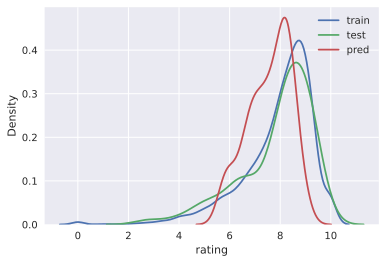

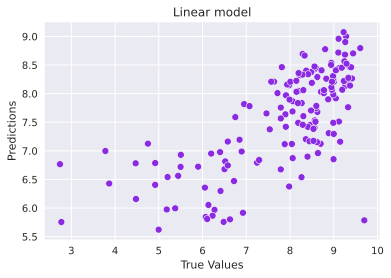

In [333]:
target_distr_linear(y_train, y_test, y_pred)  

In [334]:
calc_metrics(y_test, y_pred)

*** VAL **: 
MSE:   1.1668420407716251
RMSE:  1.0802046291196983
R2:    0.4451406159959902
MAE:   0.8206334993233931
MedAE: 0.7209643727918977
------------------------------


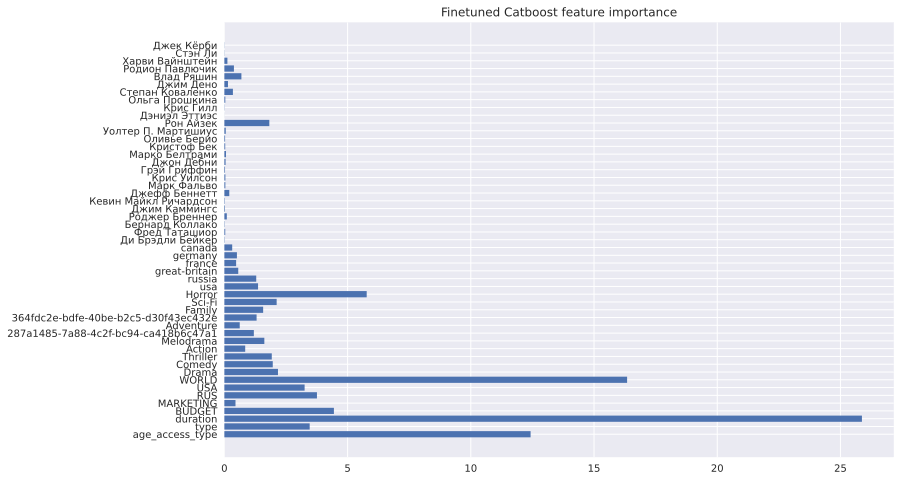

In [335]:
get_feature_imp(best_cat, train_dataset)

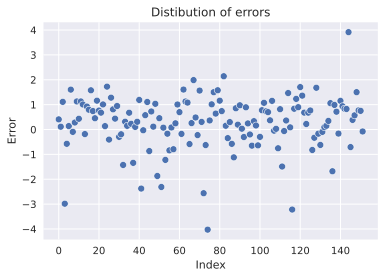

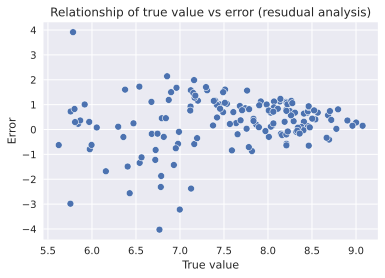

In [340]:
errors = y_test - y_pred
draw_res_analys(errors, y_pred)

In [341]:
test_df['PREDS'] = y_pred.tolist()
test_df['TARGET'] = y_test.tolist()
test_df

,age_access_type,name,type,release_year,duration,element_uid,BUDGET,MARKETING,RUS,USA,...,Ольга Прошкина,Степан Коваленко,Джим Дено,Влад Ряшин,Родион Павлючик,Харви Вайнштейн,Стэн Ли,Джек Кёрби,PREDS,TARGET
14,6,Пес-самурай и город кошек,MOVIE,2022,15.534700,537ece24-2358-4108-a419-85cfd5952607,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.538511,8.945900
2245,16,"Координаты ""Цитадель""",MOVIE,2022,15.479437,6988476c-0c5e-496f-a618-1ab7626ddbee,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,6.298298,6.411529
10728,6,Большие игры,SERIAL,2022,15.096445,ce8d2906-a33f-4140-9ffe-e091990d71a4,17.216708,NaN,14.196856,17.175217,...,0,0,0,0,0,0,0,0,6.675917,7.788732
7893,18,Другой мир: ночь вампиров,MOVIE,2022,15.501910,a3b1b686-e95c-4a2c-95fb-9de439bf4f6c,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,5.755391,2.771930
7826,12,Тайна амулета,MOVIE,2022,15.545395,9ae35927-93e3-4a40-870f-a998abbeaa9f,NaN,NaN,12.057422,NaN,...,0,0,0,0,0,0,0,0,8.209848,7.635827
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10545,18,Отель Портофино,SERIAL,2022,16.770421,20e62147-89d0-4e8b-9d24-2f2279560601,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.261118,8.830573
3448,16,9 жизней,MOVIE,2022,15.566448,a7979b64-cf82-4c7f-86d8-05670b07d1b0,NaN,NaN,12.154206,NaN,...,0,0,0,0,0,0,0,0,6.899178,8.400693
6878,12,Влюблённые в небо,MOVIE,2022,15.636829,7176aabb-334a-41e1-90a5-c5199480fbba,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.524189,9.293367
10498,18,Женщины Движения,SERIAL,2022,16.633312,571bf312-75a1-4eee-94d7-deb62cd6f8b4,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.209234,8.960000


In [338]:
y_pred_demo_tuned = best_cat.predict(demo_dataset)

demo_df['PREDS_TUNED'] = y_pred_demo_tuned.tolist()
demo_df 

,age_access_type,name,type,release_year,duration,element_uid,BUDGET,MARKETING,RUS,USA,...,Степан Коваленко,Джим Дено,Влад Ряшин,Родион Павлючик,Харви Вайнштейн,Стэн Ли,Джек Кёрби,PREDS,TARGET,PREDS_TUNED
6469,16,Молодой человек,MOVIE,2022,15.702580,0271c9b5-b7b2-4e3f-96af-b9cefed99397,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,7.337809,9.147352,7.160088
6550,18,Приплыли!,MOVIE,2022,15.479437,02eaefe0-296d-4e6f-b52f-2e2507d07103,NaN,NaN,12.593543,NaN,...,0,0,0,0,0,0,0,6.845441,6.519242,6.815711
9998,18,Чикатило,SERIAL,2020,17.723526,ee48def6-c311-4b73-a878-1a5d3d1679a3,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,8.867357,9.717041,8.779499
10433,6,Манюня,SERIAL,2021,16.269958,9b202b16-55bf-418a-b01d-9f0329b18790,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,8.257465,9.192744,8.006009
10608,18,Оффлайн,SERIAL,2022,17.218706,49a3d528-44c0-408e-b6fc-a1507ce7641a,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,8.249263,9.362527,8.465287


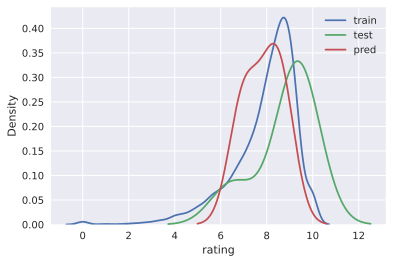

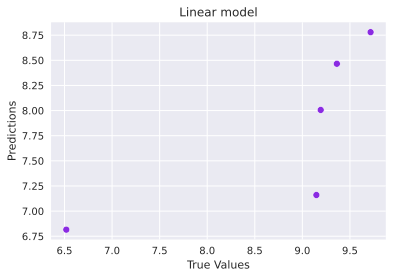

In [339]:

target_distr_linear(y_train, y_demo, y_pred_demo_tuned)  